In [1]:
#下面这行代码，是为了把自己编写的代码文件当作一共模块导入，这里是把Utilities文件夹中的plotting.py文件当作python的模块导入，对应的是下面的from plotting import newfig, savefig。路径要随着不同设备的系统做相应的修改
import sys #导入sys模块。sys模块提供了一些变量和函数，用于与 Python解释器进行交互和访问。例如，sys.path 是一个 Python 在导入模块时会查找的路径列表，sys.argv 是一个包含命令行参数的列表，sys.exit() 函数可以用于退出 Python 程序。导入 sys 模块后，你就可以在你的程序中使用这些变量和函数了。
sys.path.insert(0, '../../Utilities/') #在 Python的sys.path列表中插入一个新的路径。sys.path是一个 Python 在导入模块时会查找的路径列表。新的路径'../../Utilities/'相对于当前脚本的路径。当你尝试导入一个模块时，Python 会在 sys.path 列表中的路径下查找这个模块。通过在列表开始位置插入一个路径，你可以让 Python 优先在这个路径下查找模块。这在你需要导入自定义模块或者不在 Python 标准库中的模块时非常有用。

import torch
#collections是python一个内置模块，提供了一些有用的数据结构
from collections import OrderedDict  #这个类是字典dict的一个子类，用于创建有序的字典。普通字典中元素顺序是无序的，在OrderedDict中元素的顺序是有序的，元素的顺序是按照它们被添加到字典中的顺序决定的。

from pyDOE import lhs #`pyDOE`是一个Python库，用于设计实验。它提供了一些函数来生成各种设计，如因子设计、拉丁超立方设计等。`lhs`是库中的一个函数，全名为"Latin Hypercube Sampling"，拉丁超立方采样。这是一种统计方法，用于生成一个近似均匀分布的多维样本点集。它在参数空间中生成一个非常均匀的样本，这对于高维数值优化问题非常有用，因为它可以更好地覆盖参数空间。
import numpy as np
import matplotlib.pyplot as plt
import scipy.io #导入了scipy库中的io模块。scipy.io模块包含了一些用于文件输入/输出的函数，例如读取和写入.mat文件（MATLAB格式）
from scipy.interpolate import griddata #`scipy.interpolate`是`scipy`库中的一个模块，提供了许多插值工具，用于在给定的离散数据点之间进行插值和拟合。`griddata`是这个模块中的一个函数，用于在无规则的数据点上进行插值。

import random

import skopt #用于优化问题的库，特别是机器学习中的超参数优化
from distutils.version import LooseVersion #distutils是Python的一个标准库，用于构建和安装Python包。LooseVersion是一个类，用于比较版本号


from plotting_torch import newfig, savefig #从自定义的plotting_torch.py文件中导入了newfig和savefig函数。这两个函数用于创建和保存图形。这两个函数的定义在plotting_torch.py文件中

from mpl_toolkits.axes_grid1 import make_axes_locatable #`mpl_toolkits.axes_grid1`是`matplotlib`库的一个模块，提供了一些高级的工具来控制matplotlib图形中的坐标轴和颜色条。`make_axes_locatable`是模块中的一个函数，用于创建一个可分割的坐标轴。可以在这个坐标轴的四个方向（上、下、左、右）添加新的坐标轴或颜色条。
import matplotlib.gridspec as gridspec #是`matplotlib`库的一个模块，用于创建一个网格布局来放置子图。在`matplotlib`中可以创建一个或多个子图（subplot），每个子图都有自己的坐标轴，并可以在其中绘制图形。`gridspec`模块提供了一个灵活的方式来创建和放置子图。
import time #一个内置模块，用于处理时间相关的操作。


from tqdm import tqdm #一个快速，可扩展的python进度条库，可以在python长循环中添加一个进度提示信息，用户只需要封装任意的迭代器tqdm(iterator)。



In [2]:
num_gpus = torch.cuda.device_count()
print('Number of available GPUs: ', num_gpus)

for i in range(num_gpus):
    torch.cuda.set_device(i)
    allocated = torch.cuda.memory_allocated()
    reserved = torch.cuda.memory_reserved()
    print('GPU {}: {}, Allocated: {}, Reserved: {}'.format(i, torch.cuda.get_device_name(i), allocated, reserved))

Number of available GPUs:  2
GPU 0: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0
GPU 1: NVIDIA GeForce RTX 4090, Allocated: 0, Reserved: 0


In [3]:
torch.cuda.set_device(0) #设置当前使用的GPU设备。这里设置为1号GPU设备（第二块显卡）。

# CUDA support 

#设置pytorch的设备，代表了在哪里执行张量积算，设备可以是cpu或者cuda（gpu），并将这个做运算的设备对象存储在变量device中，后续张量计算回在这个设备上执行
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

In [4]:
# the deep neural network
class DNN(torch.nn.Module):
    #第一个方法
    def __init__(self, layers):
        super(DNN, self).__init__() #调用父类的__init__方法进行初始化
        
        # parameters
        self.depth = len(layers) - 1 #定义名为depth的属性，表示神经网络的深度，等于层数-1
        
        # set up layer order dict
        self.activation = torch.nn.Tanh #设置激活函数为tanh
         
        layer_list = list() #定义一个空列表layer_list
        for i in range(self.depth - 1):  #循环depth次
            #将每一层（全连接层）添加到layer_list中
            layer_list.append(
                ('layer_%d' % i, torch.nn.Linear(layers[i], layers[i+1]))
            )
            #将每一层的激活函数添加到layer_list中
            layer_list.append(('activation_%d' % i, self.activation()))

        #循环结束后，将最后一层的线性变换添加到layer_list中（因为没有激活函数了）
        layer_list.append(
            ('layer_%d' % (self.depth - 1), torch.nn.Linear(layers[-2], layers[-1]))
        )
        #然后使用OrderedDict将layer_list中的元素转换为有序字典
        layerDict = OrderedDict(layer_list)
        
        # deploy layers，将layerDict转换为一个神经网络模型，赋值给self.layers
        self.layers = torch.nn.Sequential(layerDict)
    
    #第二个方法，定义了模型的前向传播过程
    def forward(self, x):  #接收输入x
        out = self.layers(x) #将输入x传入神经网络模型self.layers中，得到输出out
        return out #返回输出out
    
    # 新增方法，获取最后一个隐藏层的输出
    def hidden_output(self, x):
        # 遍历每一层，直到最后一个隐藏层
        for i in range(self.depth - 1):
            # 获取当前层的线性变换
            x = self.layers[i*2](x)
            # 获取当前层的激活函数
            x = self.layers[i*2 + 1](x)
        # 返回最后一个隐藏层的输出
        return x

In [5]:
#set the class of PINN

#定义了一个名为`PhysicsInformedNN'的类，用于实现基于物理的神经网络。
class PhysicsInformedNN:
    # Initialize the class
    def __init__(self, x0, u0, v0, tb, X_f, layers, lb, ub, X_star, u_star, v_star, h_star): #这个类包含的第一个方法__init__，这是一个特殊的方法，也就是这个类的构造函数，用于初始化新创建的对象，接受了几个参数
        
        
        #`numpy.concatenate`是一个用于数组拼接的函数。它可以将多个数组沿指定的轴拼接在一起，形成一个新的数组：numpy.concatenate((a1,a2, ...), axis=0)其中，`a1,a2, ...`是需要拼接的数组（只能接受数组或序列类型的参数，且参数形状必须相同），可以是多个。`axis`参数用于指定拼接的轴向，`axis=0`表示沿着第一个轴（即行）进行拼接，不指定`axis`参数默认值是0。
        X0 = np.concatenate((x0,0*x0), 1) # [x0, 0],将x0和0*x0两个数组在第二个维度（即列）上进行了合并。0*x0会生成一个与x0形状相同，但所有元素都为0的数组。因此，X0的结果是一个新的二维数组，其中第一列是x0的值，第二列全为0
        X_lb = np.concatenate((0*tb+lb[0],tb), 1) # [lb[0], tb],将0*tb+lb[0]和tb两个数组在第二个维度（即列）上进行了合并。0*tb+lb[0]会生成一个与tb形状相同，但所有元素都为lb[0]的数组。因此，X_lb的结果是一个新的二维数组，其中第一列全为lb[0]的值，第二列是tb的值。
        X_ub = np.concatenate((0*tb+ub[0],tb), 1) # [ub[0], tb],同上生成一个与tb形状相同，但所有元素都为ub[0]的数组。因此，X_ub的结果是一个新的二维数组，其中第一列全为ub[0]的值，第二列是tb的值
        
        #Python使用self关键字来表示类的实例。当在类的方法中定义一个变量时，例如lb和ub，这些变量只在该方法内部可见，也就是说它们的作用域仅限于该方法。当方法执行完毕后，这些变量就会被销毁，无法在其他方法中访问它们。但如果希望在类的其他方法中也能访问这些变量就需要将它们保存为类的实例属性。这就是self.lb和self.ub的作用。
            #通过将lb和ub赋值给self.lb和self.ub，就可以在类的其他方法中通过self.lb和self.ub来访问这些值。总的来说，self.lb和self.ub是类的实例属性，它们的作用域是整个类，而不仅仅是定义它们的方法。
        self.lb = torch.tensor(lb).float().to(device) #将传入的lb和ub参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.lb和self.ub来访问这些值。
        self.ub = torch.tensor(ub).float().to(device)


        self.x0 = torch.tensor(X0[:,0:1], requires_grad=True).float().to(device) #将X0的第一列赋值给self.x0（:表示取所有行,0：1实际上表示取第一列，因为python是左闭右开的）,将X0的第二列赋值给self.t0。这样可以在类的其他方法中通过self.x0和self.t0来访问这些值。
        self.t0 = torch.tensor(X0[:,1:2], requires_grad=True).float().to(device) #将x0的第二列赋值给self.t0

        self.x_lb = torch.tensor(X_lb[:,0:1], requires_grad=True).float().to(device) #将X_lb的第一列赋值给self.x_lb
        self.t_lb = torch.tensor(X_lb[:,1:2], requires_grad=True).float().to(device) #将X_lb的第二列赋值给self.t_lb

        self.x_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第一列赋值给self.x_ub
        self.t_ub = torch.tensor(X_ub[:,0:1], requires_grad=True).float().to(device) #将X_ub的第二列赋值给self.t_ub
        
        self.x_f = torch.tensor(X_f[:,0:1], requires_grad=True).float().to(device) #将X_f的第一列赋值给self.x_f
        self.t_f = torch.tensor(X_f[:,1:2], requires_grad=True).float().to(device) #将X_f的第二列赋值给self.t_f
        
        self.u0 = torch.tensor(u0).float().to(device) #将传入的u0和v0参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u0和self.v0来访问这些值。
        self.v0 = torch.tensor(v0).float().to(device)


        self.x_star = torch.tensor(X_star[:,0:1], requires_grad=True).float().to(device) #将X_star的第一列赋值给self.x_star
        self.t_star = torch.tensor(X_star[:,1:2], requires_grad=True).float().to(device) #将X_star的第二列赋值给self.t_star
        self.u_star = torch.tensor(u_star).float().to(device) #将传入的u_star和v_star参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.u_star和self.v_star来访问这些值。
        self.v_star = torch.tensor(v_star).float().to(device)
        self.h_star = torch.tensor(h_star).float().to(device)
        
        # Initialize NNs 
        self.layers = layers #将传入的layers参数的值存储在实例中，以便后续使用。这样可以在类的其他方法中通过self.layers来访问这些值。
        
        
        # deep neural networks
        self.dnn = DNN(layers).to(device) #创建一个DNN类的实例，传入layers参数来实现神经网络的初始化，然后将这个实例移动到指定的设备上



        # optimizers: using the same settings，这里是使用pytorch库进行优化的部分
        #创建优化器optimizer，使用LBFGS算法，具体每个参数意义见下方
        self.optimizer_LBFGS = torch.optim.LBFGS(
            self.dnn.parameters(), #要优化的参数，这里返回的是一个生成器，包含了self.dnn中的所有参数（神经网络权重、偏置以及两个新加的变量）
            lr=1.0,  #学习率设置为1
            max_iter=50000,  #最大迭代次数为50000
            max_eval=50000,  #最大评估次数为50000
            history_size=50, #历史大小为50，即用于计算Hessian矩阵近似的最近几步的信息
            tolerance_grad=1e-5,  #优化的第一个停止条件，当梯度的L2范数小于1e-5时停止优化
            tolerance_change=1.0 * np.finfo(float).eps, #优化的第二个停止条件，当优化的目标函数值的变化小于1.0 * np.finfo(float).eps时停止优化
            line_search_fn="strong_wolfe"       # 制定了用于一维搜索的方法，这里表示用强Wolfe条件
        )
        #创建第二个优化器，括号内为要优化的参数，使用Adam优化方法
        self.optimizer_Adam = torch.optim.Adam(self.dnn.parameters())
                

        self.iter = 0 #记录迭代次数 

        self.loss_value = [] #创建一个空列表，用于存储损失值

        self.test_error = [] #创建一个空列表，用于存储测试误差
        self.test_error_mse = [] #创建一个空列表，用于存储测试误差
        self.test_error_mae = [] #创建一个空列表，用于存储测试误差
    
    #这个函数与下面的net_uv函数功能相同，只是不计算梯度，因为在记录每个epoch的error时，使用with torch.no_grad()情况下调用net_uv函数会报错，不知道为啥？
    def net_uv_error(self, x, t):  
        uv = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        #将uv（是一个二维张量）的第一列赋值给u，第二列赋值给v
        u=uv[:,0:1]
        v=uv[:,1:2]

        return u,v #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #pytorch中
    #定义了一个名为net_u的函数/方法，用于计算神经网络的输出。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回神经网络的输出。     
    def net_uv(self, x, t):  
        uv = self.dnn(torch.cat([x, t], dim=1))  #（第一个参数将输入的两个参数x和t在第二个维度（列）上进行拼接，形成一个新的张量）调用DNN，根据两个参数权重和偏置，以及新得到的张量，计算神经网络的输出u
        #将uv（是一个二维张量）的第一列赋值给u，第二列赋值给v
        u=uv[:,0:1]
        v=uv[:,1:2]

        u_x = torch.autograd.grad(
            u, x, 
            grad_outputs=torch.ones_like(u),
            retain_graph=True,
            create_graph=True
        )[0]
        v_x = torch.autograd.grad(
            v, x, 
            grad_outputs=torch.ones_like(v),
            retain_graph=True,
            create_graph=True
        )[0]

        return u,v,u_x,v_x #返回神经网络的输出u和v，以及u关于x的梯度u_x和v关于x的梯度v_x


    #定义了一个名为net_f的函数/方法，用于计算论文中的f。这个方法接受两个参数，分别是x和t，其中x是输入数据，t是时间数据。最后返回计算得到的f。
    def net_f_uv(self, x, t):
        """ The pytorch autograd version of calculating residual """

        u,v,u_x,v_x=self.net_uv(x,t) #调用上面的函数/方法，计算神经网络的输出（两个）以及输出关于输入x的梯度（两个）
        
        #计算u关于t的梯度，也就是u关于t的导数，这里使用了pytorch的自动求导功能
        u_t = torch.autograd.grad(
            u, t,  #输入的张量，要计算u关于t的导数
            grad_outputs=torch.ones_like(u), #生成一个与u形状相同，所有元素均为1的张量，这个参数用于指定向量-雅可比积的像两部分
            retain_graph=True, #表示计算完梯度之后保留计算图若需要多次计算梯度，则需要设置改参数为True
            create_graph=True #创建梯度的计算图，使我们能够计算高阶导数
        )[0] #这个函数的返回值是一个元组，其中包含了每个输入张量的梯度。这里只关心第一个输入张量u的梯度，所以我们使用[0]来获取这个梯度。？？？？又说只有一个梯度
        v_t = torch.autograd.grad(
            v, t, 
            grad_outputs=torch.ones_like(v),
            retain_graph=True,
            create_graph=True
        )[0]
        u_xx = torch.autograd.grad(
            u_x, x, 
            grad_outputs=torch.ones_like(u_x),
            retain_graph=True,
            create_graph=True
        )[0]
        v_xx = torch.autograd.grad(
            v_x, x, 
            grad_outputs=torch.ones_like(v_x),
            retain_graph=True,
            create_graph=True
        )[0]
        
        f_u=u_t+0.5*v_xx+(u**2+v**2)*v    #计算f_u,定义见论文
        f_v=v_t-0.5*u_xx-(u**2+v**2)*u   #计算f_v,定义见论文
        return f_u, f_v  #返回计算得到的f_u和f_v


    def loss_func(self):
        self.optimizer_LBFGS.zero_grad() #清除之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）

        u0_pred, v0_pred, _ , _ = self.net_uv(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
        u_lb_pred, v_lb_pred, u_x_lb_pred, v_x_lb_pred = self.net_uv(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
        u_ub_pred, v_ub_pred, u_x_ub_pred, v_x_ub_pred = self.net_uv(self.x_ub, self.t_ub) #同上
        f_u_pred, f_v_pred = self.net_f_uv(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

        loss = torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((self.v0 - v0_pred) ** 2) + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((v_lb_pred - v_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean((v_x_lb_pred - v_x_ub_pred) ** 2) + \
                    torch.mean(f_u_pred ** 2) + \
                    torch.mean(f_v_pred ** 2)
        loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
        
        self.iter += 1 #每调用一次损失函数，迭代次数加1


        #record the loss value
        self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中

        #record the test error\
        self.dnn.eval()
        with torch.no_grad():
            u_real_pred, v_real_pred= self.net_uv_error(self.x_star, self.t_star)
            h_real_pred = torch.sqrt(u_real_pred**2 + v_real_pred**2)

        error_u_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
        error_v_test = torch.norm(self.v_star - v_real_pred, 2) / torch.norm(self.v_star, 2)
        error_h_test = torch.norm(self.h_star - h_real_pred, 2) / torch.norm(self.h_star, 2)
        
        self.test_error.append(torch.tensor([error_u_test.item(), error_v_test.item(), error_h_test.item()]))

        # 计算 MAE
        mae = torch.mean(torch.abs(self.h_star - h_real_pred))
        # 计算 MSE
        mse = torch.mean((self.h_star - h_real_pred) ** 2)
        # 记录 MAE 和 MSE
        self.test_error_mae.append(mae)
        self.test_error_mse.append(mse)
        

        return loss #返回loss



    
    #定义了一个名为train的函数/方法，用于训练神经网络。这个方法接受一个参数nIter，表示训练的迭代次数。
    def train(self, nIter, nIterLBFGS):

        #先使用Adam优化器优化nIter次
        for epoch in tqdm(range(nIter), desc='Adam'):
            self.dnn.train()#将神经网络设置为训练模式而不是评估模式
            u0_pred, v0_pred, _ , _ = self.net_uv(self.x0, self.t0) #是调用net_uv函数,将self.x0_tf和self.t0_tf作为参数传入,然后将返回的前两个结果赋值给self.u0_pred和self.v0_pred。后两个_是Python惯用法，表示不关心net_uv函数返回的后两个结果。
            u_lb_pred, v_lb_pred, u_x_lb_pred, v_x_lb_pred = self.net_uv(self.x_lb, self.t_lb) #同上，不过这里函数返回的后两个结果会赋值给self.u_x_lb_pred和self.v_x_lb_pred。
            u_ub_pred, v_ub_pred, u_x_ub_pred, v_x_ub_pred = self.net_uv(self.x_ub, self.t_ub) #同上
            f_u_pred, f_v_pred = self.net_f_uv(self.x_f, self.t_f) #调用net_f_uv函数,将self.x_f_tf和self.t_f_tf作为参数传入,然后将返回的结果赋值给self.f_u_pred和self.f_v_pred。

            loss = torch.mean((self.u0 - u0_pred) ** 2)  + \
                    torch.mean((self.v0 - v0_pred) ** 2) + \
                    torch.mean((u_lb_pred - u_ub_pred) ** 2) + \
                    torch.mean((v_lb_pred - v_ub_pred) ** 2) + \
                    torch.mean((u_x_lb_pred - u_x_ub_pred) ** 2) + \
                    torch.mean((v_x_lb_pred - v_x_ub_pred) ** 2) + \
                    torch.mean(f_u_pred ** 2) + \
                    torch.mean(f_v_pred ** 2)
            
            # Backward and optimize
            self.optimizer_Adam.zero_grad() #清除该优化器之前计算的梯度（在PyTorch中，梯度会累积，所以在每次新的优化迭代之前，我们需要清除之前的梯度）
            loss.backward() #被调用以计算损失函数关于神经网络参数的梯度。这个梯度将被用于优化器来更新神经网络参数
            self.optimizer_Adam.step()  #使用之前的优化器self.optimizer_Adam，调用step方法(执行一步优化算法)，传入损失函数self.loss_func，进行优化
            

            #record the loss value
            self.loss_value.append(loss) #将计算得到的loss值添加到self.loss_value列表中
            

            #record the test error
            self.dnn.eval()
            with torch.no_grad():
                u_real_pred, v_real_pred = self.net_uv_error(self.x_star, self.t_star)
                h_real_pred = torch.sqrt(u_real_pred**2 + v_real_pred**2)

            error_u_test = torch.norm(self.u_star - u_real_pred, 2) / torch.norm(self.u_star, 2)
            error_v_test = torch.norm(self.v_star - v_real_pred, 2) / torch.norm(self.v_star, 2)
            error_h_test = torch.norm(self.h_star - h_real_pred, 2) / torch.norm(self.h_star, 2)
            
            self.test_error.append(torch.tensor([error_u_test.item(), error_v_test.item(), error_h_test.item()]))

            # 计算 MAE和MSE
            mae = torch.mean(torch.abs(self.h_star - h_real_pred))
            mse = torch.mean((self.h_star - h_real_pred) ** 2)
            # 记录 MAE 和 MSE
            self.test_error_mae.append(mae)
            self.test_error_mse.append(mse)



        #Backward the optimize，使用LBFGS优化器进一步，注意这里虽然迭代了500次，但其实使用LBFGS优化器优化的次数不止500次
        for i in tqdm(range(nIterLBFGS), desc='LBFGS'):
            self.dnn.train() #将神经网络设置为训练模式而不是评估模式
            self.optimizer_LBFGS.step(self.loss_func)  #使用之前的优化器self.optimizer，调用step方法(执行一步优化算法)，传入计算损失函数的方法self.loss_func，进行优化   

                                    
    #定义了一个名为predict的函数/方法，用于预测神经网络的输出。这个方法接受一个参数X_star，表示输入数据。最后返回预测的两个输出和两个输出的梯度。
    def predict(self, X):
        x = torch.tensor(X[:, 0:1], requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(X[:, 1:2], requires_grad=True).float().to(device)

        self.dnn.eval() #将神经网络切换为评估模式
        u, v, _, _ = self.net_uv(x, t) #调用之前定义的函数得到神经网络的输出u,以及f
        f_u, f_v = self.net_f_uv(x, t) 

        u = u.detach().cpu().numpy() #将张量u和v先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        v = v.detach().cpu().numpy()
        f_u = f_u.detach().cpu().numpy()
        f_v = f_v.detach().cpu().numpy()
        return u, v, f_u, f_v 
    
    #定义函数获得隐藏层的输出
    def hidden_predict(self, x,t):
        x = torch.tensor(x, requires_grad=True).float().to(device) #从输入中得到x和t（第一列和第二列），是张量，需要计算梯度，转换为浮点数类型，并将张量移动到指定设备上
        t = torch.tensor(t, requires_grad=True).float().to(device)
        self.dnn.eval() #将神经网络切换为评估模式
        hidden_output = self.dnn.hidden_output(torch.cat([x, t], dim=1)) #调用上一个神经网络类中的hidden_output方法，得到最后一个隐藏层的输出
        hidden_output_x = hidden_output[:, 0] #将输出的第一列赋值给hidden_output_x
        hidden_output_t = hidden_output[:, 1] #将输出的第二列赋值给hidden_output_t
        hidden_output_x = hidden_output_x.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        hidden_output_t = hidden_output_t.detach().cpu().numpy() #将张量hidden_output_x和hidden_output_t先从计算图中分离出来，然后转换为numpy数组，最后将这个数组移动到cpu上
        return hidden_output_x, hidden_output_t #返回隐藏层的输出


In [6]:
#定义设置随机数种子的函数，第一个参数seed表示种子；第二个参数用来设置CUDA的卷积操作是否确定性，默认为False，表示没有确定性
def set_seed(seed):
    # torch.manual_seed(seed) #设置pytorch的CPU随机数生成器的种子
    # torch.cuda.manual_seed_all(seed) #设置putorch的所有GPU随机数生成器的种子
    # np.random.seed(seed) #设置numpy的随机数生成器的种子
    # random.seed(seed) #设置python的内置随机数生成器的种子
    # torch.backends.cudnn.deterministic = deterministic #True会让CUDA的卷积操作变得确定性，即对于相同的输入，每次运行会得到相同的结果，False则相反
    """
    设置PyTorch的随机种子, 用于生成随机数. 通过设置相同的种子, 可以确保每次运行时生成的随机数序列相同
    """
    torch.manual_seed(seed)
 
    """
    设置PyTorch在所有可用的CUDA设备上的随机种子. 如果在使用GPU进行计算, 这个设置可以确保在不同的GPU上生成的随机数序列相同
    """
    torch.cuda.manual_seed_all(seed)
 
    """
    设置PyTorch在当前CUDA设备上的随机种子. 它与上一行代码的作用类似, 但只影响当前设备
    """
    torch.cuda.manual_seed(seed)
 
    """
    设置NumPy的随机种子, 用于生成随机数. 通过设置相同的种子，可以确保在使用NumPy的随机函数时生成的随机数序列相同
    """
    np.random.seed(seed)
    
    """
    设置Python内置的随机函数的种子. Python的random模块提供了许多随机函数, 包括生成随机数、打乱列表等. 通过设置相同的种子, 可以确保使用这些随机函数时生成的随机数序列相同
    """
    random.seed(seed)
    
    """
    设置Python的哈希种子 (哈希函数被广泛用于数据结构 (如字典和集合) 的实现，以及一些内部操作 (如查找和比较)). 通过设置相同的种子, 可以确保在不同的运行中生成的哈希结果相同
    """
    # os.environ["PYTHONHASHSEED"] = str(seed)
    
    """
    该设置确保每次运行代码时, cuDNN的计算结果是确定性的, 即相同的输入会产生相同的输出, 这是通过禁用一些非确定性的算法来实现的, 例如在卷积操作中使用的算法. 这样做可以保证模型的训练和推理在相同的硬件和软件环境下是可复现的, 即每次运行代码时的结果都相同. 但是, 这可能会导致一些性能上的损失, 因为禁用了一些优化的非确定性算法
    """
    torch.backends.cudnn.deterministic = True
    
    """
    该设置禁用了cuDNN的自动优化过程. 当它被设置为False时, PyTorch不会在每次运行时重新寻找最优的算法配置, 而是使用固定的算法配置. 这样做可以确保每次运行代码时的性能是一致的, 但可能会导致一些性能上的损失
    """
    torch.backends.cudnn.benchmark = False



In [7]:
import numpy as np

def calculate_chaos(model, X, num_iter, last_k=20):
    """
    计算模型在给定输入点集上的混沌度。
    参数:
    - model: 具有 hidden_predict 方法的神经网络模型，返回倒数第二层输出
    - X: 输入数据，形状为 (N_f_new, 2)，其中第一列为 x0，第二列为 t0
    - num_iter: 计算混沌情况的总迭代次数
    - last_k: 计算混沌度时考虑的最后 k 次迭代

    返回:
    - chaos_score: 每个采样点的混沌度（取最后 k 次的平均欧氏距离）
    """

    # 1. 取输入点 (x0, t0)
    x0 = X[:, 0:1]  # (N_f_new,1)
    t0 = X[:, 1:2]  # (N_f_new,1)

    # 2. 计算初始点的迭代轨迹
    xs = np.zeros((num_iter, X.shape[0], 2))  # 形状 (num_iter, N_f_new, 2)
    x, t = model.hidden_predict(x0, t0)
    x, t = x.reshape(-1,1), t.reshape(-1,1)

    for i in range(num_iter):
        x, t = model.hidden_predict(x, t)
        x, t = x.reshape(-1,1), t.reshape(-1,1)
        xs[i, :, 0] = x.flatten()  # 存储 x
        xs[i, :, 1] = t.flatten()  # 存储 t

    # 3. 给输入数据加微小扰动
    x1 = x0 + np.random.normal(0, 0.0001, size=x0.shape)
    t1 = t0 + np.random.normal(0, 0.0001, size=t0.shape)

    # 4. 计算扰动点的迭代轨迹
    xs1 = np.zeros_like(xs)  # 形状 (num_iter, N_f_new, 2)
    x, t = model.hidden_predict(x1, t1)
    x, t = x.reshape(-1,1), t.reshape(-1,1)

    for i in range(num_iter):
        x, t = model.hidden_predict(x, t)
        x, t = x.reshape(-1,1), t.reshape(-1,1)
        xs1[i, :, 0] = x.flatten()
        xs1[i, :, 1] = t.flatten()

    # 5. 计算最后 last_k 次迭代的欧氏距离
    last_xs = xs[-last_k:, :, :]  # 取最后 k 次迭代的结果
    last_xs1 = xs1[-last_k:, :, :]  # 取扰动点的结果

    # 计算最后 k 次的欧氏距离
    distances = np.linalg.norm(last_xs - last_xs1, axis=2)  # 形状 (last_k, N_f_new)

    # 6. 取最后 k 次迭代的平均混沌度
    chaos_score = np.mean(distances, axis=0)  # (N_f_new,)

    return chaos_score


In [8]:
#RAR-G方法，对1000个点，先选择10个点训练500次，然后每500次迭代重采样100个点，选出其中残差最大的10个点添加到训练点中；最后总共有1000个点，共训练10000次
seeds = [0, 1, 12, 21, 123, 321, 1234, 4321, 12345, 54321] #生成10个随机种子
# seeds = [0]

#设置噪声值为0 
noise = 0.0        

# Doman bounds，定义两个一维数组lb和ub，问题域是一个二维空间，其中 x 的范围是 -5 到 5，t 的范围是 0 到 π/2(竖着的)
lb = np.array([-5.0, 0.0])
ub = np.array([5.0, np.pi/2])
#定义三个整数，分别表示初始条件点数量、边界条件点数量和配位点的数量（这些点用于训练神经网络）
N0 = 50
N_b = 50
N_f = 10000
#定义一个列表layers，其中包含了神经网络的层数和每一层的神经元数量
layers = [2, 100, 100, 100, 100, 2, 2]
#读取名为NLS.mat的Matlab文件，文件中的数据存储在data变量中。这里的路径也要随着设备的情况修改    
data = scipy.io.loadmat('../data/NLS.mat')
#从data字典中取出变量tt和x的值，并转换为一维数组（flatten方法），最后tongg[:,None]将一维数组转换为二维数组
t = data['tt'].flatten()[:,None]
x = data['x'].flatten()[:,None]
Exact = data['uu'] #从data字典中取出变量uu的值，并赋值给Exact
Exact_u = np.real(Exact)  #取Exact的实部，赋值给Exact_u
Exact_v = np.imag(Exact)  #取Exact的虚部，赋值给Exact_v
Exact_h = np.sqrt(Exact_u**2 + Exact_v**2) #计算复数uu的|uu|
#生成一个二位网络，X和T是输出的二维数组
X, T = np.meshgrid(x,t)

X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None]))  #X_star是一个二维数组，其中第一列是X的展平，第二列是T的展平
u_star = Exact_u.T.flatten()[:,None] #先对Exact_u进行转置，然后使用flatten方法将其转换为一维数组，最后使用[:,None]将其转换为二维数组
v_star = Exact_v.T.flatten()[:,None] #同上，比如Exact_v是m*n二维数组，Exact_v.T是n*m二维数组，Exact_v.T.flatten()是一个长度为n*m的一维数组，Exact_v.T.flatten()[:,None]是一个(n*m)*1的三维数组
h_star = Exact_h.T.flatten()[:,None]
#上面五行代码的意义见Numpy库的索引的介绍


###########################

#从0~数组x的行数(256)中随机选择N0个数，replace=False表示不允许重复选择，最后将这N0个数赋值给idx_x
# idx_x = np.random.choice(x.shape[0], N0, replace=False)
idx_x = np.linspace(0, x.shape[0] - 1, N0, dtype=int) #生成一个等差数列，从0到X的行数，间隔为1，赋值给idx_x
#从x中选择N0个对应的行(idx_x对应的行)，最后将这N0行赋值给x0
x0 = x[idx_x,:]
#从Exact_u中选择N0个对应的行(idx_x对应的行)的第一列元素，最后将这N0个元素赋值给u0
u0 = Exact_u[idx_x,0:1]
v0 = Exact_v[idx_x,0:1]
#从0~数组t的行数中随机选择N_b个数，replace=False表示不允许重复选择，最后将这N_b个数赋值给idx_t
# idx_t = np.random.choice(t.shape[0], N_b, replace=False)
idx_t = np.linspace(0, t.shape[0] - 1, N_b, dtype=int) #生成一个等差数列，从0到t的行数，间隔为1，赋值给idx_t
#从t中选择N_b个对应的行(idx_t对应的行)，最后将这N_b行赋值给tb
tb = t[idx_t,:]
nIter = 50000 #设置迭代次数为10000
nIterLBFGS = 1000 #设置LBFGS迭代次数为500


error = [] #创建一个空列表，用于存储误差值
error_mae = [] #创建一个空列表，用于存储MAE值
error_mse = [] #创建一个空列表，用于存储MSE值

i = 0 #初始化i为0

for seed in seeds:
    set_seed(seed) #设置随机数种子

    #1.先训练500次

    #设置chaos的迭代次数
    num_iter = 50
    #采样配位点，每次采样总训练点数的1%
    N_f_1 = N_f//100
    #总的N_f个配位点
    X_f = lb + (ub-lb)*lhs(2, N_f_1) #lhs函数采用拉丁超采样方法，生成一个近似均匀分布的多维样本点集，返回的是一个形状为（$N_f$，2）的数组，每一行都是一个2维的样本点，所有样本点都在[0,1]范围内，并对该样本集进行缩放，把每个样本从[0,1]区间缩放到[lb,ub]区域内，即得到了指定范围内均匀分布的样本$X_f$。

    #创建PINN模型并输入各种参数        
    model = PhysicsInformedNN(x0, u0, v0, tb, X_f, layers, lb, ub, X_star, u_star, v_star, h_star)

    #获取当前时间并赋值给start_time  
    start_time = time.time()   
    #开始训练模型            
    model.train(nIter//100,0)


    #2.训练结束后，每500次迭代重采样一次N_f_new个点（即N_f_1的10倍），并从中选出N_f_1个点加入训练点中（即总训练点数的1%）；最后总共有N_f个点，共训练50000次
    for iter in range(nIter//100+1, nIter+1, nIter//100): #每500次迭代

        N_f_new = N_f_1 * 10 #重新总训练点数的1%个训练点的10倍
        # 生成新的X_f_new数据
        X_f_new = lb + (ub-lb)*lhs(2, N_f_new)

        #计算混沌情况
        distances = calculate_chaos(model, X_f_new, num_iter)

        # 计算残差
        _, _, residual_u, residual_v = model.predict(X_f_new)
        residual = np.sqrt(residual_u**2 + residual_v**2)
        # 计算残差的绝对值
        abs_residual = np.abs(residual)
        #将二维数组转换为一维数组
        abs_residual = abs_residual.flatten()

        #对abs_residual进行归一化
        abs_residual = abs_residual / np.linalg.norm(abs_residual)

        # 对distances进行归一化
        epsilon = 1e-5
        norm_distances = np.linalg.norm(distances)
        if norm_distances > epsilon:
            distances = distances / norm_distances
        else:
            distances = np.zeros_like(distances)

        # 计算信息量
        xinxi = 0.8*distances + 0.2*abs_residual

        #找出绝对值最大的N_f_1个值的索引
        topk_indices = np.argpartition(xinxi, -N_f_1)[-N_f_1:] #该函数会对数组进行排序，使得指定的k个最大值出现在数组的最后k给位置上，并获取最后1000个元素

        # 使用这些索引来提取对应的数据，即新加入的训练数据
        X_f_topk = X_f_new[topk_indices]

        #与之前的训练数据合并
        X_f = np.vstack((X_f, X_f_topk))


        # 更新模型中的X_f_train数据
        model.x_f = torch.tensor(X_f[:, 0:1], requires_grad=True).float().to(device)
        model.t_f = torch.tensor(X_f[:, 1:2], requires_grad=True).float().to(device)

        # 在更新数据后的模型上进行训练500次
        model.train(nIter//100,0)


    model.train(0,nIterLBFGS) #使用LBFGS训练500次

    #所有训练结束后获取当前时间并减去start_time，得到训练时间并赋值给elapsed
    elapsed = time.time() - start_time
    #打印训练所花时间                
    print('Training time: %.4f' % (elapsed))
  



    #每一个seed训练好之后，用训练好的模型进行预测，得到测试误差

    #用训练好的模型进行预测，返回四个值（均为数组）    
    u_pred, v_pred, f_u_pred, f_v_pred = model.predict(X_star)
    #计算u_pred和v_pred的模（平方和的平方根），赋值给h_pred
    h_pred = np.sqrt(u_pred**2 + v_pred**2)
    #计算误差（基于2范数）        
    error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)
    error_v = np.linalg.norm(v_star-v_pred,2)/np.linalg.norm(v_star,2)
    error_h = np.linalg.norm(h_star-h_pred,2)/np.linalg.norm(h_star,2)
    #打印误差
    # print('Error u: %e' % (error_u))
    # print('Error v: %e' % (error_v))
    print('Error h: %e' % (error_h))

    #将误差添加到error_h列表中

    #计算误差（基于2范数）        
    error.append(error_h) #计算误差，然后将误差添加到error_u列表中
    # 计算 MAE 和 MSE
    mae = np.mean(np.abs(h_star - h_pred))
    mse = np.mean((h_star - h_pred) ** 2)
    # 记录 MAE 和 MSE
    error_mae.append(mae)
    error_mse.append(mse)

    i+=1 #i加1
    print('MAE: %e' % mae) #打印MAE
    print('MSE: %e' % mse) #打印MSE
    print(f'当前为第{i}次循环，种子为{seed}')





#使用griddata函数将X_star、u_pred、v_pred和h_pred插值到网格上，得到U_pred、V_pred和H_pred
U_pred = griddata(X_star, u_pred.flatten(), (X, T), method='cubic')
V_pred = griddata(X_star, v_pred.flatten(), (X, T), method='cubic')
H_pred = griddata(X_star, h_pred.flatten(), (X, T), method='cubic')
#同上，使用griddata函数将X_star、f_u_pred和f_v_pred插值到网格上，得到FU_pred和FV_pred
FU_pred = griddata(X_star, f_u_pred.flatten(), (X, T), method='cubic')
FV_pred = griddata(X_star, f_v_pred.flatten(), (X, T), method='cubic')     

H_star = griddata(X_star, h_star.flatten(), (X, T), method='cubic') #同上，将X_star和h_star插值到网格上，得到H_star

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:04,  7.76it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 35.21it/s]

Adam:   3%|▎         | 13/500 [00:00<00:11, 42.69it/s]

Adam:   4%|▎         | 18/500 [00:00<00:10, 44.01it/s]

Adam:   5%|▌         | 25/500 [00:00<00:09, 50.56it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 55.92it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 61.25it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 62.67it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 69.23it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:06, 70.62it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:05, 71.95it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 69.74it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 67.58it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 64.03it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 68.42it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 70.40it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 68.32it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:05, 73.49it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:04, 79.09it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 84.57it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 65.72it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 67.53it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 67.38it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 66.25it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 70.94it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 74.32it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:03, 74.22it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 64.93it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 60.28it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 58.34it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:05, 52.20it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:05, 51.46it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:05, 47.35it/s]

Adam:  51%|█████     | 253/500 [00:04<00:05, 45.81it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:05, 47.13it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:04, 51.10it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:04, 52.23it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 58.65it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 60.09it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 62.50it/s]

Adam:  61%|██████    | 304/500 [00:04<00:02, 71.29it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:02, 64.32it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 55.23it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:03, 51.42it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:03, 49.13it/s]

Adam:  68%|██████▊   | 338/500 [00:05<00:03, 52.79it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 58.65it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 56.37it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 53.84it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 58.38it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 53.40it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:02, 50.02it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:02, 45.69it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:02, 44.03it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:02, 45.66it/s]

Adam:  80%|████████  | 401/500 [00:06<00:02, 43.31it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:02, 46.46it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:01, 47.28it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 49.02it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 47.23it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 52.01it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 50.93it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 46.18it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:01, 45.07it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:01, 46.03it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 43.48it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 45.06it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 52.05it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 48.81it/s]

Adam:  96%|█████████▋| 482/500 [00:08<00:00, 48.69it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 48.21it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 48.02it/s]

Adam: 100%|█████████▉| 498/500 [00:08<00:00, 45.24it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 55.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:10, 48.65it/s]

Adam:   2%|▏         | 11/500 [00:00<00:11, 41.70it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 45.09it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 45.30it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 51.56it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 57.89it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 49.81it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 57.50it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:07, 56.13it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 55.98it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 54.42it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 57.38it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 55.24it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:07, 52.55it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:07, 51.51it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 53.44it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:06, 55.92it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 53.13it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 47.81it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 49.01it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 48.56it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:08, 43.83it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:08, 43.63it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:07, 46.85it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 45.87it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 44.28it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:08, 40.82it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:08, 39.53it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 44.25it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:07, 44.74it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:07, 43.91it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:07, 44.07it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 41.07it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 40.56it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 44.38it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 46.64it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 46.37it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 43.21it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:06, 44.53it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 45.12it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 45.28it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 46.33it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 43.71it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 42.19it/s]

Adam:  51%|█████     | 256/500 [00:05<00:06, 39.76it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:06, 39.31it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 42.05it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:05, 44.94it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 46.12it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 42.45it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:05, 42.21it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 46.40it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 45.89it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 41.62it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 44.65it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:04, 42.60it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:04, 43.97it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 41.86it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:04, 39.39it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:04, 39.10it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 43.60it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 47.41it/s]

Adam:  71%|███████   | 354/500 [00:07<00:02, 53.24it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 48.91it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 46.61it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 42.60it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 45.39it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 49.83it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 48.38it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 47.22it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 43.17it/s]

Adam:  81%|████████  | 405/500 [00:08<00:02, 40.85it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:02, 39.66it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:02, 41.49it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 40.43it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 39.50it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 38.01it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 39.91it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 38.72it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 37.63it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 36.69it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 36.80it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 38.13it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:01, 38.42it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 37.95it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 35.69it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 36.60it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 38.42it/s]

Adam:  97%|█████████▋| 483/500 [00:10<00:00, 43.96it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 45.39it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 47.99it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 44.14it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 42.59it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 46.02it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.05it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 43.95it/s]

Adam:   7%|▋         | 36/500 [00:00<00:11, 40.49it/s]

Adam:   8%|▊         | 41/500 [00:00<00:12, 37.98it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.11it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 34.87it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 34.75it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 34.15it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.35it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 33.68it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:12, 33.95it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:12, 33.46it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.03it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 35.68it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 38.89it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 38.55it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 37.10it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 39.90it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.77it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 37.43it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:09, 41.57it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 41.33it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 39.49it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 41.19it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.50it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 39.42it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 38.17it/s]

Adam:  30%|███       | 150/500 [00:03<00:09, 37.38it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.91it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 34.10it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 35.49it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 38.68it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 45.17it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:06, 46.39it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:06, 49.37it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 48.25it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 45.12it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 40.58it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 37.15it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:08, 36.10it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 36.81it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 36.39it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:07, 36.93it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:07, 34.58it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:08, 33.32it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 33.62it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 33.66it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 37.02it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 38.02it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 37.35it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 37.32it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 37.58it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:06, 35.69it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:06, 35.58it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 36.57it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 36.91it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 35.38it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 35.91it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 36.46it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 37.30it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 37.03it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 37.65it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 38.30it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:04, 38.52it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:04, 37.72it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:04, 38.12it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:04, 38.61it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 39.14it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 40.19it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 40.78it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 40.93it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:03, 42.45it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 43.60it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 41.16it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 38.44it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 40.05it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 40.96it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 37.92it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:03, 34.47it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 32.39it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 32.43it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:03, 32.44it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:03, 32.41it/s]

Adam:  80%|████████  | 400/500 [00:10<00:03, 31.51it/s]

Adam:  81%|████████  | 404/500 [00:10<00:03, 31.52it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 30.97it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 32.28it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 34.24it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 33.66it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 32.96it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:02, 33.26it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:02, 33.07it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:02, 31.82it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 31.10it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 32.25it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 31.13it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 32.59it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 31.25it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 30.62it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 29.16it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:01, 28.81it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:01, 29.04it/s]

Adam:  95%|█████████▍| 474/500 [00:12<00:00, 29.73it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 30.46it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 30.75it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 31.16it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 30.92it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 32.18it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 31.45it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.16it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.35it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.64it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.41it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 29.72it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 30.16it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.13it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 28.82it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.67it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.47it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 28.07it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.55it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.52it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 29.11it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.49it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 29.25it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.73it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.08it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.34it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.43it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 29.43it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 29.06it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.27it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.10it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.14it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.07it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.41it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.15it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.08it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:12, 30.01it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.85it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 28.99it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 28.08it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 27.79it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.67it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 28.92it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.13it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 28.93it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 28.94it/s]

Adam:  30%|███       | 151/500 [00:05<00:11, 29.21it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 28.76it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 28.49it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 27.80it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 27.93it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 27.91it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 28.11it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 27.86it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 27.80it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 27.45it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 27.28it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:12, 25.76it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:12, 24.99it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:11, 26.62it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:11, 27.16it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 27.91it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 28.10it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 28.28it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 28.69it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 29.02it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.83it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 28.13it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 28.39it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.46it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 28.46it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:09, 28.51it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.73it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 27.93it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.00it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.73it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 26.87it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:09, 27.52it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 28.44it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 28.75it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 28.49it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 29.25it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 29.55it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 29.16it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 28.77it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 28.45it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 28.27it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 28.23it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:08, 26.57it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 27.11it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 27.28it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 27.77it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 27.44it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 27.45it/s]

Adam:  60%|██████    | 301/500 [00:10<00:07, 27.55it/s]

Adam:  61%|██████    | 304/500 [00:10<00:07, 27.60it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 27.74it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 27.64it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 27.50it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 27.96it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 28.00it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 28.32it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 27.97it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 27.66it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.35it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:06, 26.73it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 28.22it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 27.80it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 27.66it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:05, 27.92it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 28.25it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 28.49it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 28.56it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:05, 27.98it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:05, 26.09it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:05, 26.07it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 26.58it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 26.52it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 26.49it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 26.14it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 26.26it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 26.03it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 26.03it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:04, 26.08it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:04, 26.65it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 27.41it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:04, 25.44it/s]

Adam:  80%|████████  | 401/500 [00:14<00:03, 25.18it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 25.71it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 26.70it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:03, 26.61it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:03, 27.28it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:03, 27.13it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 27.53it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 27.25it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 27.00it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 27.52it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 27.65it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 27.88it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 27.41it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 27.45it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:02, 26.85it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 27.14it/s]

Adam:  90%|████████▉ | 449/500 [00:16<00:01, 27.66it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 27.80it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 27.51it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 27.87it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 27.96it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 27.62it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 24.86it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:01, 25.54it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:01, 25.93it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 25.86it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 26.00it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 26.16it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 25.90it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 25.62it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 25.65it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 26.41it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 26.92it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 26.42it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.40it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.89it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.79it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.79it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.92it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.67it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.71it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.57it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.97it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.22it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.42it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.59it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.66it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.63it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.69it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 25.08it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.06it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.33it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.44it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 23.03it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.45it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.94it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.12it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 25.10it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.16it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 23.28it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.84it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.41it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.32it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.75it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 25.09it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.48it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.85it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 26.14it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 26.38it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 26.97it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.52it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 27.00it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.62it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 27.17it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 26.91it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.30it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.27it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.05it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.77it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.67it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.28it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 26.44it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 25.95it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 26.74it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 26.39it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 26.31it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 26.03it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.41it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 25.98it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 25.97it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 26.55it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 26.22it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 25.88it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 25.91it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.42it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.67it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.73it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 25.86it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 25.48it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.34it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.42it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 24.92it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 25.52it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 24.90it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 26.28it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 26.48it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 26.16it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 26.22it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 26.84it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:10, 26.65it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 26.20it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 26.02it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.89it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 25.85it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 25.51it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 25.37it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 26.15it/s]

Adam:  51%|█████     | 253/500 [00:09<00:09, 25.15it/s]

Adam:  51%|█████     | 256/500 [00:10<00:09, 25.04it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 25.80it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 26.38it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:08, 26.38it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 26.38it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:08, 27.02it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 26.92it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 26.97it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 28.84it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:07, 27.78it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:07, 27.09it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:07, 26.70it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 26.42it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 25.73it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 25.39it/s]

Adam:  60%|██████    | 302/500 [00:11<00:07, 25.06it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 24.84it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 24.94it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 25.11it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 25.44it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 25.42it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 25.44it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:07, 25.26it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 25.50it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 24.90it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 25.29it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 25.10it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 25.84it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 26.16it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 25.99it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:06, 24.45it/s]

Adam:  70%|███████   | 350/500 [00:13<00:06, 24.99it/s]

Adam:  71%|███████   | 353/500 [00:13<00:06, 24.18it/s]

Adam:  71%|███████   | 356/500 [00:13<00:06, 23.62it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 24.80it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 25.08it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 25.06it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 24.60it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 25.13it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 25.63it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 25.54it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 25.92it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:04, 25.52it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 25.76it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 24.29it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 23.69it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 24.40it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:04, 25.11it/s]

Adam:  80%|████████  | 401/500 [00:15<00:03, 25.14it/s]

Adam:  81%|████████  | 404/500 [00:15<00:03, 25.93it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:03, 24.24it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 24.82it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 24.82it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 23.76it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 24.73it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 25.17it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:03, 23.87it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 24.99it/s]

Adam:  86%|████████▌ | 431/500 [00:16<00:02, 25.31it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 23.76it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 24.58it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 25.31it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 25.86it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 26.75it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 26.97it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 24.63it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 24.90it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 25.68it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 25.86it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 24.53it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 24.24it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 24.70it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.12it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.37it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 25.52it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 25.70it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 25.48it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 25.75it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 25.69it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 25.58it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 24.85it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.07it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.78it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.27it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.72it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.61it/s]

Adam:   5%|▍         | 24/500 [00:00<00:20, 23.65it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.22it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.04it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.03it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.66it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.09it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.17it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.34it/s]

Adam:  10%|▉         | 48/500 [00:01<00:19, 23.78it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.22it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 24.79it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 24.75it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.25it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.28it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.25it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.91it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:18, 23.14it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.39it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.50it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 23.24it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.06it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.55it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.89it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.58it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.67it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 25.26it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.69it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 24.39it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.11it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.49it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 25.94it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 23.94it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.62it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.88it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.40it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 24.90it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:13, 26.77it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:13, 26.50it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 24.58it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 24.87it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 25.52it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:13, 25.56it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 25.65it/s]

Adam:  31%|███       | 154/500 [00:06<00:13, 25.86it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 25.88it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:14, 23.64it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:13, 24.13it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:13, 24.54it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 24.85it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:13, 25.09it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:13, 24.59it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:12, 24.84it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:12, 24.85it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 24.86it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 24.73it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:13, 23.00it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:12, 23.70it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:12, 24.79it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:11, 25.58it/s]

Adam:  40%|████      | 202/500 [00:08<00:11, 25.66it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 26.56it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 24.37it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:12, 22.85it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:12, 23.58it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:11, 24.27it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 24.72it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 24.61it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.81it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:12, 22.09it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:12, 22.16it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:11, 23.15it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 23.92it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 24.65it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 25.48it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 24.13it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 24.71it/s]

Adam:  51%|█████     | 253/500 [00:10<00:09, 25.41it/s]

Adam:  51%|█████     | 256/500 [00:10<00:09, 25.91it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 26.35it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 26.21it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 25.79it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 26.16it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:08, 26.04it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 25.79it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 23.94it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:09, 24.22it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 24.84it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:09, 23.22it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 23.73it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 24.15it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:08, 24.38it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 24.66it/s]

Adam:  60%|██████    | 301/500 [00:12<00:07, 24.97it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 25.21it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:07, 24.94it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:08, 23.25it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:08, 22.46it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:08, 22.04it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:08, 21.37it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 23.11it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 24.28it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 25.23it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 25.80it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 25.98it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 26.39it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 26.21it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 26.49it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:05, 25.73it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 25.93it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 25.62it/s]

Adam:  71%|███████   | 355/500 [00:14<00:06, 22.61it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:06, 23.22it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 24.20it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 24.64it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:05, 23.62it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 24.18it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 24.54it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 25.48it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 25.99it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:04, 26.56it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:04, 26.80it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:04, 25.97it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:04, 26.15it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:04, 26.48it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:03, 26.78it/s]

Adam:  80%|████████  | 400/500 [00:16<00:03, 26.43it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 26.27it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 25.76it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 25.82it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 26.03it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 26.66it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 26.39it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:03, 26.21it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 25.22it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 25.94it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 26.38it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 26.64it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 26.89it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 26.62it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 26.62it/s]

Adam:  89%|████████▉ | 445/500 [00:17<00:02, 26.55it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:01, 26.82it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 26.61it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 26.53it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 25.83it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 25.21it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 25.24it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 25.11it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 24.55it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 25.21it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 24.87it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 25.05it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.84it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 24.83it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 24.90it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 24.97it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 25.26it/s]

Adam:  99%|█████████▉| 496/500 [00:19<00:00, 25.19it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 25.11it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.26it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.54it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.02it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.43it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 19.52it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.15it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.30it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.24it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.52it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.67it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.37it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.79it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.76it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.02it/s]

Adam:   9%|▉         | 45/500 [00:02<00:19, 23.71it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 23.96it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.19it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.58it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 24.62it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.77it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.76it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.44it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.42it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:16, 25.22it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.09it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.63it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 23.16it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.81it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.13it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.69it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 25.11it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:15, 25.49it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 26.21it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 26.75it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 26.57it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 26.75it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.49it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.44it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.59it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.32it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 23.83it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.16it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.31it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.33it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.51it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 25.95it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.23it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.24it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.63it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 25.10it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 24.87it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 24.77it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.08it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.98it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.80it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.65it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 24.74it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.76it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:12, 24.85it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 24.92it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.37it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.79it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.77it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 26.32it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 26.37it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:11, 26.20it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 26.74it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 26.73it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 26.45it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.83it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.96it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.06it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 25.03it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 25.04it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 25.05it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 25.68it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.36it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.77it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:09, 26.46it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:09, 26.93it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 26.63it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 27.16it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 26.89it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 26.73it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 26.50it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:10, 24.18it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 24.44it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:10, 22.76it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 23.70it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 24.12it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.69it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.85it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 25.07it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 24.75it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 25.57it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 23.65it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 23.60it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 23.88it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 23.94it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 24.72it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 24.74it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 24.85it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 24.82it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 24.58it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 24.66it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 24.42it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:07, 25.20it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 25.72it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 26.37it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 26.08it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.23it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 26.23it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 26.40it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 26.58it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 26.86it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 26.64it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 24.64it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 25.04it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 25.31it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 25.70it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 23.39it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 23.73it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 24.74it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:05, 24.95it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 25.88it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 25.37it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 23.96it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 24.98it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 25.32it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 25.86it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 25.86it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 26.21it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 26.06it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 25.59it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 25.59it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 25.88it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 26.17it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.80it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 25.44it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.61it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 26.23it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 26.12it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 26.31it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 25.88it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 25.92it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 25.51it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 26.03it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 25.99it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 26.22it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 26.17it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 26.18it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 26.51it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 26.36it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 26.26it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 25.87it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.13it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 25.05it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 24.54it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.55it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.71it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 24.69it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 25.11it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 24.87it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 24.68it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 24.70it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 25.19it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.69it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.81it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.97it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.55it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.35it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.83it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 25.03it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 24.92it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.80it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.50it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.29it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.41it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.76it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.28it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.07it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.21it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.30it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.60it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.66it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.96it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.68it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.86it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.53it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.88it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.43it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.35it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.51it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.21it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.09it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.57it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.07it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 25.11it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.83it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 24.24it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.66it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.44it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 25.97it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.02it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.99it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 25.86it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.89it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.60it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.30it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.16it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.49it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 25.87it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 25.80it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 23.73it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.00it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.09it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.31it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.51it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.93it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:14, 22.69it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:14, 23.34it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 23.65it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.17it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.15it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.15it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 22.77it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.92it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.55it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:13, 23.09it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.16it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.68it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 25.36it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.40it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 25.80it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 25.32it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:11, 24.96it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:11, 24.98it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 24.69it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 24.55it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.85it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 24.54it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 24.38it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 24.34it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 24.43it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 24.95it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:09, 27.66it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:09, 27.25it/s]

Adam:  50%|█████     | 251/500 [00:10<00:09, 27.17it/s]

Adam:  51%|█████     | 254/500 [00:10<00:09, 26.74it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:09, 26.50it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:09, 26.34it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:09, 26.11it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:08, 26.22it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:08, 26.13it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:08, 25.75it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:08, 25.53it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:08, 25.81it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:08, 25.37it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:08, 24.86it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:08, 24.76it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:08, 24.69it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:08, 24.65it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:08, 25.21it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:08, 25.07it/s]

Adam:  60%|██████    | 302/500 [00:12<00:07, 25.18it/s]

Adam:  61%|██████    | 305/500 [00:12<00:07, 24.84it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 24.00it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:08, 23.46it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 23.75it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 24.83it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 25.66it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:06, 25.62it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:06, 25.83it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 26.01it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 26.60it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 26.99it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:05, 27.30it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 26.40it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:05, 26.74it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 26.53it/s]

Adam:  70%|███████   | 350/500 [00:14<00:05, 26.00it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 25.72it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 25.57it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:06, 23.29it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 23.10it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:06, 22.16it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:06, 21.70it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 22.64it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 23.88it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 24.81it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 24.69it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 25.39it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 25.07it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 25.76it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 27.37it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 27.65it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 27.14it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 24.56it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 24.15it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 24.48it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 25.09it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.15it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 25.38it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.70it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 25.60it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 25.23it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 25.82it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 25.75it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 26.50it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 26.65it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 26.29it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 26.31it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 26.25it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:01, 25.44it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 24.43it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 24.72it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 24.90it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 22.77it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 23.17it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 23.45it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 24.13it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 24.16it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.56it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.41it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 24.27it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 24.79it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 24.79it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 24.41it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 24.98it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 25.54it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.94it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.22it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.04it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.14it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.54it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.42it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.50it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.77it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.02it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.84it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.30it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.36it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.33it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.04it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.24it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.02it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.50it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.27it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.81it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.32it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.50it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.40it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.73it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.61it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.39it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.89it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.44it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.51it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.48it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.11it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.90it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 25.87it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 26.51it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 26.40it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 26.71it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.80it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.17it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 25.60it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.38it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.65it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.53it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.75it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.55it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.62it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.72it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.22it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 26.00it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.24it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 25.64it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 25.54it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 25.26it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.25it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.75it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.01it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.60it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 24.57it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.11it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.53it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 24.80it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 24.89it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.90it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.90it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.67it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.74it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.84it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 25.26it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 25.83it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 25.80it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.62it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.50it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.43it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 25.76it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.81it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 25.37it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 24.86it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:12, 22.41it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:11, 22.90it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 22.83it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:11, 23.01it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 23.74it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 24.16it/s]

Adam:  50%|█████     | 250/500 [00:10<00:09, 27.47it/s]

Adam:  51%|█████     | 253/500 [00:10<00:09, 26.31it/s]

Adam:  51%|█████     | 256/500 [00:10<00:09, 26.52it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 26.33it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 26.14it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 25.96it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 26.17it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:08, 26.17it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 25.03it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 25.51it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 25.15it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 24.56it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 24.66it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 24.30it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 24.22it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:09, 22.52it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 22.83it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 23.34it/s]

Adam:  61%|██████    | 304/500 [00:12<00:08, 22.99it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:08, 23.37it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:08, 23.69it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 24.12it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 24.41it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 24.67it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 24.38it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:06, 25.11it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 25.66it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 25.70it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 24.76it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 25.52it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 26.08it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:06, 24.81it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:06, 24.86it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 25.17it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 25.25it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 25.53it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:05, 25.31it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 24.82it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 24.56it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:05, 24.36it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:05, 24.52it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 24.92it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 24.85it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 25.72it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:04, 25.72it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:04, 26.41it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:04, 26.06it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:04, 26.32it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:04, 26.20it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:03, 26.39it/s]

Adam:  80%|████████  | 400/500 [00:16<00:03, 26.29it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 25.45it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 24.83it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 24.96it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 24.60it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 24.60it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 24.38it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 24.35it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 24.45it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 25.29it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 25.40it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 24.30it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 25.09it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 25.32it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 26.26it/s]

Adam:  89%|████████▉ | 445/500 [00:17<00:02, 26.01it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 24.22it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 24.73it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 24.95it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 25.44it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 25.63it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 23.27it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 23.40it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 23.37it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 23.57it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 23.26it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 23.84it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 23.91it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 24.05it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 24.17it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 24.37it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 24.27it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 24.10it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 24.75it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 16.03it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 20.58it/s]

Adam:   2%|▏         | 8/500 [00:00<00:22, 22.28it/s]

Adam:   2%|▏         | 11/500 [00:00<00:21, 23.13it/s]

Adam:   3%|▎         | 14/500 [00:00<00:21, 23.07it/s]

Adam:   3%|▎         | 17/500 [00:00<00:20, 23.54it/s]

Adam:   4%|▍         | 20/500 [00:00<00:20, 23.29it/s]

Adam:   5%|▍         | 23/500 [00:01<00:20, 23.67it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 21.40it/s]

Adam:   6%|▌         | 29/500 [00:01<00:21, 21.93it/s]

Adam:   6%|▋         | 32/500 [00:01<00:20, 22.76it/s]

Adam:   7%|▋         | 35/500 [00:01<00:19, 23.82it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 23.84it/s]

Adam:   8%|▊         | 41/500 [00:01<00:19, 23.99it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 24.33it/s]

Adam:   9%|▉         | 47/500 [00:02<00:18, 24.47it/s]

Adam:  10%|█         | 50/500 [00:02<00:18, 24.78it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 24.78it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 24.40it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 24.16it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:18, 24.14it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:17, 24.28it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:18, 23.79it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:17, 24.12it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:17, 24.09it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 24.20it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:17, 24.26it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:17, 24.07it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:17, 24.09it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:17, 24.06it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:16, 24.03it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:16, 24.39it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:16, 24.73it/s]

Adam:  20%|██        | 101/500 [00:04<00:15, 25.27it/s]

Adam:  21%|██        | 104/500 [00:04<00:15, 25.34it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:15, 25.72it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 25.50it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:15, 25.68it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:14, 25.78it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:15, 25.12it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:15, 24.19it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:15, 24.39it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:14, 25.34it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:14, 25.74it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:13, 26.15it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:13, 25.97it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:14, 25.34it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:14, 25.36it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:13, 25.61it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:13, 25.50it/s]

Adam:  30%|███       | 152/500 [00:06<00:14, 24.76it/s]

Adam:  31%|███       | 155/500 [00:06<00:13, 24.89it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 24.58it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 24.81it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:13, 24.42it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:13, 24.42it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:13, 24.55it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 24.45it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:13, 24.56it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:12, 24.90it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:12, 24.85it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:12, 24.31it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 24.17it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:12, 24.26it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:12, 23.87it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:12, 24.50it/s]

Adam:  40%|████      | 200/500 [00:08<00:12, 23.79it/s]

Adam:  41%|████      | 203/500 [00:08<00:12, 24.44it/s]

Adam:  41%|████      | 206/500 [00:08<00:13, 22.59it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:12, 22.98it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:13, 21.66it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:12, 22.33it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:12, 23.39it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:11, 23.89it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:11, 24.47it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:10, 25.02it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:10, 25.10it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:10, 25.36it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:10, 25.35it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:10, 25.57it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:10, 25.16it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:10, 24.07it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:10, 23.89it/s]

Adam:  50%|█████     | 251/500 [00:10<00:10, 24.58it/s]

Adam:  51%|█████     | 254/500 [00:10<00:09, 24.90it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:09, 25.09it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:10, 23.32it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:09, 23.97it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:09, 24.21it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:09, 24.51it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:09, 24.63it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:09, 24.18it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:09, 24.51it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:09, 24.23it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:09, 22.49it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:09, 22.64it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:09, 23.10it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:08, 23.25it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:08, 24.13it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:08, 24.66it/s]

Adam:  60%|██████    | 302/500 [00:12<00:08, 22.58it/s]

Adam:  61%|██████    | 305/500 [00:12<00:08, 22.83it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:08, 23.04it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 23.68it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 24.25it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:07, 24.59it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:07, 24.76it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 24.50it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:06, 25.02it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 25.32it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 25.51it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 26.06it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 26.43it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:06, 25.75it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:06, 25.82it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:05, 25.58it/s]

Adam:  70%|███████   | 350/500 [00:14<00:05, 26.23it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 26.18it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 26.11it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 25.24it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 25.18it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 24.86it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:05, 24.73it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 24.99it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 24.55it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 25.59it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 25.42it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 25.96it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 25.63it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 25.79it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 25.88it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 25.54it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 25.14it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 24.52it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 24.30it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 23.82it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 24.13it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 23.83it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 24.39it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 25.01it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 24.82it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:02, 25.37it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 25.34it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 25.60it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 25.23it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 25.49it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 25.52it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 25.82it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 25.98it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:01, 25.56it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 25.59it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 24.71it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 24.82it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 25.54it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 25.28it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 25.07it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 24.66it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 24.66it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 24.62it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 24.27it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 24.36it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 24.44it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 24.29it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 23.99it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 23.80it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 23.70it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 23.65it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.28it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.41it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.20it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.82it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.32it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.19it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.79it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.72it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.83it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.84it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.75it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.99it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.80it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 22.19it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.07it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.50it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.54it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.56it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.66it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.75it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.46it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.65it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.36it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.31it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.89it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.00it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.16it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.14it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.77it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:16, 24.00it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 23.73it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.92it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 24.75it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.11it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 24.25it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.51it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.87it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 25.01it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.46it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 26.09it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.42it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.99it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.30it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.12it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.19it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 25.27it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:13, 25.39it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.97it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.68it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.30it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.59it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 24.08it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.12it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 23.96it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 23.55it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 23.89it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 21.70it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.34it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:14, 22.27it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 22.69it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:13, 23.23it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:13, 23.02it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 23.30it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.52it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.41it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 23.62it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 23.94it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.98it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.39it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 24.86it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 25.21it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:10, 25.38it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 25.07it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 25.24it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.54it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.21it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.61it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 23.79it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 24.35it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.62it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 24.85it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 24.98it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.63it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 24.63it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 25.17it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 25.47it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 23.06it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 23.61it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:10, 21.75it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:10, 22.28it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 22.81it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:09, 22.89it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:09, 23.24it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 23.70it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.77it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 23.68it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 24.04it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.83it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.87it/s]

Adam:  61%|██████    | 306/500 [00:12<00:08, 23.99it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:08, 23.71it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 23.79it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 23.83it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 24.60it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 24.86it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 25.08it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.15it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 25.53it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 25.77it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 23.60it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 23.79it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 23.93it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 24.71it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 24.76it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 24.89it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 24.79it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 24.44it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:06, 22.09it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:06, 22.78it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 22.99it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 23.55it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 24.31it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 25.08it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 24.72it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 25.14it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 25.03it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 25.20it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 25.34it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 25.21it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 25.39it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 24.61it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 25.00it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 24.61it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 24.33it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 24.01it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 24.44it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.86it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 24.76it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 24.78it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 23.07it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:03, 22.27it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 23.17it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 24.52it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 24.88it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 25.39it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 25.01it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 25.48it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:01, 25.32it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 25.51it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 25.32it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 25.45it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 25.98it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 25.56it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 25.31it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 24.67it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 24.49it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.43it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.17it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 23.95it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 23.92it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 23.72it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 23.71it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 23.80it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 24.03it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.16it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.10it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.96it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.34it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.39it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.47it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.75it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.45it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.94it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.97it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.08it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.29it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.94it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 24.08it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.16it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.05it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.40it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.35it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.84it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.70it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.48it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 24.01it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.66it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 23.77it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.41it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.81it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.54it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.70it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.85it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 24.06it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.77it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:16, 23.78it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 23.83it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.75it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.69it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.62it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 23.95it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.83it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.04it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 24.44it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.66it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.30it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.94it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 26.15it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 26.18it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 25.94it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 25.77it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 25.50it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:13, 25.56it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 26.07it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 25.48it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 25.10it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.11it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.82it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.51it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.75it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 24.62it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.98it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.50it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 24.67it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 24.73it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.53it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.59it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.27it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 24.47it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.46it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.41it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.43it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.78it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 24.63it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.74it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.35it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 25.73it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:10, 25.80it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 26.19it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 26.28it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 26.13it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 26.39it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:09, 26.32it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:09, 26.24it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 26.31it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 26.44it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 26.64it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 26.88it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 26.80it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 26.51it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 26.39it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 26.63it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 26.18it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 26.43it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:08, 26.45it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:08, 26.24it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 26.34it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 26.40it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 26.18it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.78it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 25.19it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 25.03it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:08, 24.97it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 24.43it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 24.69it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 24.25it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 24.22it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 24.50it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 24.22it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 24.81it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:07, 25.43it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 25.63it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.84it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 26.62it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 27.01it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:05, 27.59it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:05, 27.68it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 27.88it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 28.10it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 28.07it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 27.96it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 27.83it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 27.21it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 26.89it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 26.70it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 25.66it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 25.11it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:05, 25.05it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 25.45it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 25.50it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 25.92it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 26.07it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 26.18it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 26.26it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 26.19it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 26.31it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 26.13it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 26.27it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 26.35it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 25.91it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 25.04it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.05it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 24.60it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.04it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 25.16it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 25.44it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 25.56it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 25.74it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 25.78it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 26.50it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 26.96it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 27.09it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 27.54it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 27.55it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 27.48it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 26.40it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 26.53it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 26.47it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 26.19it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 26.14it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 25.91it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.22it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 24.94it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 24.41it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 24.44it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 23.95it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 24.05it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 24.04it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 24.15it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 23.82it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 21.83it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.17it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 23.28it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.45it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.52it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.63it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.91it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.66it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.89it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.76it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.94it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.75it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.90it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.75it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.79it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.02it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.78it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.67it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.81it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 24.15it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.83it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.97it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.68it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 23.82it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 23.65it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.74it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.69it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.77it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.05it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.86it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.81it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 23.64it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 23.72it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.15it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 24.70it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.71it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.94it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.25it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 25.48it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.28it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 26.82it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:13, 27.16it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:13, 27.12it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:13, 27.41it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 27.36it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.94it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.04it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 26.14it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 25.45it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 25.35it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 24.89it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.40it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.89it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.77it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:14, 23.70it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 23.94it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 23.77it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 23.33it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.54it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.59it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.31it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.35it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:13, 23.57it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:13, 23.32it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 23.36it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.54it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.36it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 23.22it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 23.43it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.54it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 23.47it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 23.76it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.98it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.56it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.71it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 24.81it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.88it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.39it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.10it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.37it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 25.58it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:09, 25.47it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 25.65it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 25.86it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 26.04it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 25.91it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 25.74it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 25.80it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 25.73it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 25.48it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:08, 25.54it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:08, 25.63it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 25.37it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 25.31it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 25.05it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 24.57it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 24.02it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 24.01it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 23.85it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.80it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.69it/s]

Adam:  61%|██████    | 306/500 [00:12<00:08, 23.80it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:08, 23.64it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 23.67it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 23.57it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 23.87it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 24.59it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 24.92it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.10it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 25.47it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.18it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 26.67it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 26.65it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 27.14it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:05, 27.31it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 27.63it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 27.15it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 26.65it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 26.50it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 26.31it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 25.98it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 25.06it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 24.70it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 24.41it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 24.77it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 24.95it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 25.23it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 25.83it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 25.80it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 25.68it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 25.63it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:03, 26.13it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 25.86it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 25.91it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 26.08it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 25.90it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 25.63it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.06it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 24.37it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 24.75it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 24.90it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 25.23it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 25.52it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 25.29it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 25.57it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 25.82it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 26.52it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 26.91it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:01, 27.00it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:01, 27.63it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 27.64it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 27.21it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 26.90it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 26.64it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 26.19it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 26.15it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 25.73it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 25.94it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 25.57it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.77it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 24.30it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 24.43it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 23.96it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 23.88it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 23.87it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 23.83it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.30it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.07it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 23.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.53it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.63it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.29it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.42it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.51it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.58it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.83it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.53it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.67it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.65it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.64it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.75it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 23.79it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.74it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.66it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.58it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.78it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.68it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.63it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.63it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 23.95it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 23.77it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.77it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.50it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.57it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.94it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.87it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.85it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:16, 23.82it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 23.84it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.44it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 24.76it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.75it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.13it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 25.80it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.30it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.57it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:13, 26.96it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:13, 27.29it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:13, 27.40it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:13, 27.47it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 27.41it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.99it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.78it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 26.38it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 25.77it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 25.50it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 24.92it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 24.66it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.15it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 24.01it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:14, 23.80it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 23.98it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 23.62it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 23.63it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.98it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.67it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.68it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.62it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:13, 23.79it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 23.75it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.78it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.87it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.86it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 23.58it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 23.89it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.83it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 23.67it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 23.83it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 24.17it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.64it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 25.28it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 25.18it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.27it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.40it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.79it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.69it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 25.86it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:09, 25.63it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 26.20it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 26.98it/s]

Adam:  51%|█████     | 255/500 [00:10<00:08, 27.39it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 26.38it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:08, 26.56it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 26.39it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 26.37it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 26.16it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:08, 26.09it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:08, 25.58it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 25.72it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 25.66it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 25.99it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 24.98it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 24.91it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 24.54it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 24.10it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 24.07it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.97it/s]

Adam:  61%|██████    | 306/500 [00:12<00:08, 23.91it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:08, 23.79it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 23.91it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 24.19it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 24.48it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 25.06it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 24.92it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.61it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 26.15it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.74it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:05, 27.47it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:05, 27.54it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 27.54it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 27.55it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 27.67it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 27.75it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 27.37it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 26.83it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 26.85it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 26.52it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 25.62it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 25.08it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:05, 24.79it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 24.84it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 25.11it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 25.70it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 25.75it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 25.73it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 25.68it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 26.17it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 26.09it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 25.80it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 26.01it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 26.10it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 26.25it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 26.17it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.35it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 24.76it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 24.86it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 25.13it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 25.43it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 25.59it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 25.93it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 25.58it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 25.83it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 25.99it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 26.92it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 27.20it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 27.22it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 27.82it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 28.27it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 27.56it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 26.94it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 26.39it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 26.43it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 26.00it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.97it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.94it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 25.57it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 24.80it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 24.62it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 24.27it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 24.16it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 23.88it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 23.87it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.29it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.18it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.37it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.96it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.97it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.76it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.73it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.73it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.79it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.97it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.69it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.73it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.68it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.78it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.55it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.73it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.78it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.91it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.56it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.61it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.87it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.85it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.00it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.60it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.63it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.88it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.89it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.65it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.82it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.89it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:16, 23.88it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 23.99it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.65it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 24.95it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.18it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.81it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.51it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.84it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 27.49it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:13, 27.38it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:13, 27.39it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:13, 27.76it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:13, 28.07it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 27.77it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 27.12it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.65it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 26.35it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.11it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 25.48it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.69it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 24.79it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.09it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.18it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.17it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 23.90it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 23.94it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 23.85it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.76it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.82it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.48it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.55it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:13, 23.84it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:13, 23.61it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 23.82it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.89it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.63it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 23.65it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 23.93it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.80it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 23.68it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 23.75it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 24.09it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.43it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.62it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 24.99it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.37it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.33it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.43it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.63it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 25.71it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:09, 25.67it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 26.05it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 26.36it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 26.96it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:08, 26.94it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 26.43it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 26.27it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 26.34it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 25.97it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:08, 25.96it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:08, 25.80it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 26.13it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 25.92it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 25.76it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.46it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 24.84it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 24.59it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 24.14it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 24.25it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.92it/s]

Adam:  61%|██████    | 306/500 [00:12<00:08, 23.79it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:08, 23.75it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 23.80it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 23.73it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 24.39it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 24.66it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 24.80it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.59it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 26.24it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.83it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 27.09it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:05, 27.16it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 27.26it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 27.32it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 27.56it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 27.43it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 27.27it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 26.82it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 26.10it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 26.08it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 25.28it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 24.92it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:05, 24.53it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 24.08it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 24.49it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 24.87it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 25.09it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 25.21it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 25.59it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 25.46it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:04, 25.95it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 25.71it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 25.66it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 25.79it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 25.68it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 25.43it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.53it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 25.50it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.43it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 25.10it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 25.26it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 25.62it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 25.54it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 25.52it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 25.65it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 25.84it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 26.25it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 26.51it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 26.55it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 23.62it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 23.31it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 23.62it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 24.18it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 24.88it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.30it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 24.38it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 23.94it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 23.97it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 23.91it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 24.34it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 22.17it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 22.88it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 23.46it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 23.65it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 22.10it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.16it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.95it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.04it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.27it/s]

Adam:   3%|▎         | 16/500 [00:00<00:19, 25.22it/s]

Adam:   4%|▍         | 19/500 [00:00<00:20, 23.99it/s]

Adam:   4%|▍         | 22/500 [00:00<00:18, 25.24it/s]

Adam:   5%|▌         | 26/500 [00:01<00:17, 27.33it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 27.57it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 28.47it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.62it/s]

Adam:   8%|▊         | 40/500 [00:01<00:15, 28.78it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 28.42it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.68it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.63it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.14it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.21it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.35it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.80it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.44it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 26.75it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 26.67it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:16, 26.14it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:16, 26.07it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:16, 25.61it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 26.01it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 25.59it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 25.65it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:16, 25.22it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 25.40it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:16, 25.07it/s]

Adam:  20%|██        | 100/500 [00:03<00:16, 24.93it/s]

Adam:  21%|██        | 103/500 [00:03<00:15, 25.11it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 24.96it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:15, 25.36it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 25.31it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 24.91it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:15, 25.01it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 25.28it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 25.59it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 25.52it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:14, 26.05it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:13, 27.56it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:12, 28.49it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 28.62it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:11, 29.72it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 29.77it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 29.84it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 30.12it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.91it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:11, 29.07it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:11, 28.53it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 27.68it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:12, 27.04it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:12, 25.99it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:12, 25.27it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:14, 21.70it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:13, 22.92it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 24.17it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:12, 25.20it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 25.96it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 26.88it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 26.45it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 26.00it/s]

Adam:  41%|████      | 206/500 [00:07<00:12, 23.25it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:12, 24.22it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:11, 25.35it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 25.85it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:10, 26.20it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:10, 26.57it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 26.61it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:10, 26.16it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:10, 25.54it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:10, 25.40it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:10, 25.46it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:11, 23.43it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:11, 22.58it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:10, 23.94it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:10, 24.55it/s]

Adam:  50%|█████     | 251/500 [00:09<00:09, 25.19it/s]

Adam:  51%|█████     | 254/500 [00:09<00:09, 24.96it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:09, 24.33it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:09, 24.99it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:09, 25.45it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:09, 23.89it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:09, 23.29it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:10, 22.67it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:09, 23.25it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:09, 23.71it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:09, 23.95it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:09, 23.90it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:08, 23.73it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:08, 23.91it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:08, 23.51it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:08, 23.81it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:08, 23.70it/s]

Adam:  60%|██████    | 302/500 [00:11<00:08, 23.45it/s]

Adam:  61%|██████    | 305/500 [00:11<00:08, 23.56it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:08, 23.76it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 23.67it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:08, 20.76it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:08, 21.30it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:08, 21.34it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:07, 22.54it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:07, 23.92it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 24.88it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 25.03it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 24.74it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 25.74it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 25.05it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 23.50it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:06, 24.24it/s]

Adam:  70%|███████   | 350/500 [00:13<00:06, 24.54it/s]

Adam:  71%|███████   | 353/500 [00:13<00:06, 23.56it/s]

Adam:  71%|███████   | 356/500 [00:14<00:06, 23.78it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 24.34it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 24.79it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 24.94it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 24.14it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 22.78it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:05, 22.52it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:05, 22.84it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:05, 20.36it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:05, 20.47it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:07, 14.67it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:06, 16.76it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:05, 18.13it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:05, 19.62it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 21.18it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 22.39it/s]

Adam:  81%|████████  | 404/500 [00:16<00:04, 23.15it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:04, 22.82it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 23.65it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 24.81it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 25.65it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 25.62it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 24.66it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:03, 24.63it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:03, 23.17it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 23.73it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 23.59it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 23.85it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 23.87it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 23.66it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 23.78it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:02, 23.88it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 24.05it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:02, 21.91it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 22.37it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 22.59it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 22.90it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 23.27it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 23.37it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 24.19it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 24.43it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 24.57it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 24.85it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 24.86it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 25.27it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 25.05it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 25.19it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 24.80it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.95it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.05it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.91it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 23.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.25it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.93it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.00it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.08it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 22.90it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.45it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.11it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.33it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.29it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.18it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.11it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.02it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.14it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.12it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 23.12it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 23.15it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.95it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.00it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.21it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.28it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.91it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.03it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 23.24it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.97it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 23.04it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.24it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.25it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:17, 23.11it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 23.13it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 23.28it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.94it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.35it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.14it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 23.32it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 22.96it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 23.47it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 24.05it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.04it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.58it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 24.74it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 24.78it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.76it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.03it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 25.09it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 25.09it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.77it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 25.06it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 25.15it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 24.91it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.32it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.81it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.57it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 23.59it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 23.40it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 23.43it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.33it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.23it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 22.96it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.66it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 23.84it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:12, 24.23it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 24.70it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.71it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.84it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 25.02it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.80it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 24.98it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.14it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 25.19it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 24.92it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 25.02it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 25.11it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 24.70it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.88it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.95it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.06it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 25.35it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 24.73it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:09, 25.45it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 25.34it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 25.11it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 25.47it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 25.16it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 25.44it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 25.13it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 25.44it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.91it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.24it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.11it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 23.69it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:09, 23.38it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 24.34it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.06it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.87it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:07, 26.01it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:07, 26.61it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 26.94it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 27.00it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 27.03it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 27.15it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:06, 27.70it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:06, 28.55it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:06, 28.71it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:06, 28.21it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:06, 27.76it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 26.68it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 26.36it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 25.91it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 26.51it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:05, 26.71it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:05, 26.80it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:05, 27.01it/s]

Adam:  70%|███████   | 350/500 [00:14<00:05, 26.72it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 25.96it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 25.79it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 25.86it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 25.43it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 25.35it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 25.58it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 25.46it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 25.06it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 24.90it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:05, 23.82it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 24.02it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 23.70it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 23.49it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 23.52it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 23.49it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 24.17it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 24.21it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 24.42it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 24.43it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 24.60it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 24.81it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 24.84it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 24.84it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 24.79it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:03, 24.84it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 24.65it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 24.70it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 24.39it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 24.02it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 23.58it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 23.61it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 23.46it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:02, 23.30it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:02, 22.96it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 23.20it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 23.14it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 22.89it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 23.01it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 22.92it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 23.42it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 23.83it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 24.07it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 24.35it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 24.22it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 24.30it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 24.75it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 24.73it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 24.80it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 24.74it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.91it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.54it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.60it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.79it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.85it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 22.96it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 22.90it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 22.74it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.99it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.01it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.80it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.95it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.88it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 22.78it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.01it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 22.82it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 22.92it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.97it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.82it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.93it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.10it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:18, 22.91it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.98it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.90it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 23.04it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.85it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.90it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.91it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 22.85it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:17, 22.84it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 23.15it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 23.05it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.78it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 23.11it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.08it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.86it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 22.97it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 23.07it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 23.61it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 23.98it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.44it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.60it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.51it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.62it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.83it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 24.83it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 24.45it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.89it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.65it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.64it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.54it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.12it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.47it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.18it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 23.48it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 23.29it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.92it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 23.01it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 22.97it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.10it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.00it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 23.50it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:12, 23.79it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 24.24it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.36it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.64it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 24.72it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.80it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 24.82it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 24.85it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.71it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 24.73it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.92it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.28it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 24.20it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 24.09it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.28it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:10, 24.57it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 24.42it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 24.72it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.61it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 24.76it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 24.95it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.91it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 24.78it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 24.47it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 24.62it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.55it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.41it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.13it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 23.43it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 23.47it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:09, 23.57it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.17it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 25.35it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.70it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:07, 26.09it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:07, 26.43it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 26.77it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 26.79it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 26.68it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 27.08it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 27.83it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:06, 28.42it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:06, 28.58it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:06, 27.97it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:06, 27.37it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 26.22it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 26.03it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 25.47it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 25.44it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 25.79it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:05, 26.53it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:05, 26.46it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 26.40it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 25.99it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 25.72it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:05, 25.42it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 25.26it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 25.13it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 25.01it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 25.09it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 25.12it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 25.16it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 24.45it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:04, 23.68it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:04, 23.27it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:04, 23.33it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:04, 23.14it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:04, 22.93it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:04, 23.56it/s]

Adam:  80%|████████  | 400/500 [00:16<00:04, 23.87it/s]

Adam:  81%|████████  | 403/500 [00:16<00:04, 24.00it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 24.36it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 24.66it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 24.63it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 24.66it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:03, 24.42it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:03, 24.69it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 24.89it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 24.56it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 24.75it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 24.87it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 24.02it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 23.43it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 23.36it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 23.27it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 23.07it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:02, 23.11it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 23.13it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 22.89it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 22.79it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 22.67it/s]

Adam:  93%|█████████▎| 466/500 [00:19<00:01, 22.69it/s]

Adam:  94%|█████████▍| 469/500 [00:19<00:01, 23.14it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 23.54it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 23.49it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 23.90it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.29it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 24.30it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 24.69it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 24.53it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 24.44it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 24.76it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 24.76it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.56it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.10it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.58it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.57it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.74it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.44it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 22.72it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.49it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.76it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.71it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.72it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.95it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.34it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 22.99it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 22.74it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 22.75it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 22.96it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.59it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.90it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.89it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.78it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:18, 22.85it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.78it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.71it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.58it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.68it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.83it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.59it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.47it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 22.61it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 22.65it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.99it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.72it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.90it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.54it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.55it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:16, 22.77it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 22.98it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 23.45it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 23.93it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.00it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.02it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.41it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.52it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:14, 24.51it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 24.72it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 24.74it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.63it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.63it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.34it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.17it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.33it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.44it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.07it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 23.02it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.79it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.98it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.98it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.65it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:14, 22.63it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:13, 22.67it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 22.96it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:12, 23.75it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.85it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.26it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.44it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.51it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.44it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:11, 24.59it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 24.49it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.65it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 24.47it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.54it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.64it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 23.84it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 23.70it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 24.06it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:10, 24.22it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 24.19it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 24.53it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.44it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 24.38it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.25it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.53it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:09, 24.41it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 24.86it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 24.43it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.56it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.56it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 23.76it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 23.31it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 23.00it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.08it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 23.98it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.70it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.40it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 25.68it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:07, 26.27it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 26.34it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 26.04it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 26.46it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.50it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 27.44it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 27.97it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 28.22it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 28.31it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 26.91it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 26.04it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 25.61it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 25.43it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 25.28it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 25.54it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 25.95it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:05, 26.15it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 26.12it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 25.50it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 25.55it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 25.05it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 25.24it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 24.96it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.63it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 24.96it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 24.79it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 24.48it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:05, 24.17it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:05, 23.67it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 23.25it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 23.12it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 22.82it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 22.91it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 22.93it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 23.37it/s]

Adam:  80%|████████  | 402/500 [00:16<00:04, 23.68it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 23.77it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 24.01it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 24.40it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 24.09it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.12it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 24.46it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 24.38it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 24.36it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 24.30it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 24.47it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 24.10it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 23.13it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 23.15it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 23.01it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 22.91it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 22.89it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:02, 22.85it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 22.45it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.47it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 22.46it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 22.53it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 22.53it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 22.98it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 23.30it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 23.79it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 23.70it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 23.96it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 24.15it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 24.39it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 24.41it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 24.53it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 24.40it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 23.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 20.89it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.38it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.14it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 22.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.25it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.48it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.47it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.34it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.61it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.52it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.46it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.58it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.45it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 22.19it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 22.45it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.27it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 22.60it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.50it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.52it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.60it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.53it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.30it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 22.30it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 22.29it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.44it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.62it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.50it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.52it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 22.72it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 22.49it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 22.56it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 22.24it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.42it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.54it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.42it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.50it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 22.49it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 22.71it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 23.13it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 23.64it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 23.86it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.94it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.96it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 24.10it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:14, 24.19it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 24.39it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 24.14it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.51it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.27it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.24it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.16it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.61it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.11it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 22.80it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.69it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.68it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.83it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.59it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.36it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 22.31it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:13, 22.83it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 23.27it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:12, 23.72it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.85it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.11it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.93it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.56it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 24.40it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:11, 24.57it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 24.47it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.43it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 24.27it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.21it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.14it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 23.79it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 23.27it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 23.76it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.85it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 23.93it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 24.15it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.20it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.90it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.02it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 24.42it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:09, 24.26it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 24.36it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 24.52it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.49it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.20it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 23.54it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 23.38it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 23.08it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.28it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.06it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.89it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.36it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 25.70it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:07, 25.88it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 26.22it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 26.19it/s]

Adam:  61%|██████    | 306/500 [00:13<00:07, 26.17it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.37it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 27.34it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 28.03it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 27.67it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 26.66it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 25.95it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.52it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 25.48it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 25.53it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 25.10it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 25.04it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 25.51it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:05, 26.10it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 26.05it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 25.46it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 25.42it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 25.02it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 25.13it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 24.71it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.67it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 24.71it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 24.46it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 24.53it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:05, 24.27it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 23.60it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 23.43it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 23.11it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 22.90it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 22.71it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 22.59it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 23.11it/s]

Adam:  80%|████████  | 402/500 [00:16<00:04, 23.55it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 23.68it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.69it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 23.92it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 23.99it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.02it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 23.79it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 23.87it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 24.15it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:02, 24.14it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 24.07it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 23.86it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 23.19it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 23.17it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 22.89it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 22.67it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 22.71it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 22.35it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 22.56it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.24it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 22.22it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 22.26it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 22.47it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 22.85it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 23.25it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 23.47it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 23.92it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 23.80it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 23.77it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 23.87it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 24.15it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 24.03it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.97it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.55it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.96it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.80it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 22.01it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.27it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.25it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.02it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.17it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.14it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 22.27it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.30it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.12it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.32it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.14it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 22.16it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 22.09it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.34it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 22.13it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 22.11it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.29it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.01it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.26it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.27it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 22.34it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.51it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.36it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.09it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.27it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.24it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 22.28it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 22.09it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 22.11it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.41it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.38it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.15it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.09it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.42it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 22.41it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 22.29it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.95it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 23.16it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 23.43it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.65it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.96it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.90it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 24.08it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 24.06it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 23.89it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.08it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.92it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.19it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.16it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.35it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.30it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.02it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.73it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.81it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.84it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.39it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.64it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 22.30it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 22.31it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 22.83it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 23.41it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.62it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.58it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.05it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.17it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 23.86it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:11, 24.29it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 24.06it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.39it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.89it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.18it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.39it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 24.20it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 23.38it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 23.50it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.69it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 23.80it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.89it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.22it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.85it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.08it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 24.11it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.99it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 24.04it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 23.98it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.24it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.07it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 23.90it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 23.25it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 23.14it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.86it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.51it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.86it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.38it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:07, 25.98it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:07, 26.04it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 25.93it/s]

Adam:  61%|██████    | 303/500 [00:13<00:07, 26.33it/s]

Adam:  61%|██████    | 306/500 [00:13<00:07, 26.03it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.48it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 27.04it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 27.43it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 27.94it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 26.61it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 26.42it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.70it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 24.96it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.74it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 24.85it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 24.35it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 24.85it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 25.33it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 25.47it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 25.08it/s]

Adam:  71%|███████   | 354/500 [00:15<00:05, 24.80it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 24.92it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 24.48it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 24.84it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.64it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 24.52it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 24.49it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 24.37it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 24.49it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 24.08it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 23.33it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 23.04it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 22.84it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 22.56it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 22.40it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 22.65it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 23.04it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 23.20it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.53it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 23.78it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 23.88it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 23.68it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 23.98it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 23.70it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 24.23it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:02, 24.04it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 24.02it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 23.96it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 23.34it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 22.95it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 23.00it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 22.59it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 22.55it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 22.29it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 22.31it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.13it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 22.13it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 22.12it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 22.02it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.47it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 23.05it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 23.07it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 23.51it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 23.54it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 23.71it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 23.99it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 23.91it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 23.98it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.70it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.26it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.76it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.95it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.80it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 21.95it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.18it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 21.92it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.14it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.87it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.93it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.97it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.12it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.19it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 21.98it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 22.15it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.87it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.90it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.96it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.01it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 21.93it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.26it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.08it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 22.07it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.91it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 22.18it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.13it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.01it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 21.96it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 22.07it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.88it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.95it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 22.18it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.90it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 21.99it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.03it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:17, 22.05it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 22.08it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.85it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.36it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.78it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 23.04it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.56it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.49it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.72it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 23.74it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 23.97it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 23.78it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 23.89it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.88it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.87it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.68it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.57it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 22.95it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 22.86it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.43it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.36it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.19it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.36it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 22.21it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 22.04it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.93it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 22.15it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.52it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 23.36it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.31it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.49it/s]

Adam:  41%|████      | 204/500 [00:09<00:12, 23.69it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 23.69it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.88it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.75it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 23.95it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.94it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 23.73it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.98it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.43it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 23.17it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.98it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.37it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 23.48it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.49it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.62it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.71it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.60it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 23.77it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.98it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 23.95it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 23.71it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 23.61it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 23.86it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 23.23it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 22.81it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 22.66it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.26it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 23.86it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.44it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.13it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 25.30it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 25.32it/s]

Adam:  60%|██████    | 300/500 [00:13<00:07, 25.81it/s]

Adam:  61%|██████    | 303/500 [00:13<00:07, 25.75it/s]

Adam:  61%|██████    | 306/500 [00:13<00:07, 25.75it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.04it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 26.79it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 27.44it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 26.90it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 26.54it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 25.76it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:06, 25.12it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 24.95it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.48it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 24.39it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 24.23it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 24.63it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 25.44it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 25.55it/s]

Adam:  70%|███████   | 351/500 [00:15<00:05, 25.06it/s]

Adam:  71%|███████   | 354/500 [00:15<00:05, 24.54it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 24.69it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 24.43it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 24.27it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.25it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 24.03it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 23.98it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.90it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 23.94it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 23.69it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 23.34it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 22.77it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 22.67it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 22.57it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 22.22it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.78it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 23.18it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 23.27it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.62it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 23.94it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 23.95it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.04it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 24.00it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 23.58it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 24.31it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:02, 24.02it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 23.99it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 23.94it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 23.32it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 22.96it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 22.71it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 22.76it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 22.53it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 22.32it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 22.13it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.35it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 22.16it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 22.23it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 22.05it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.59it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 22.78it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 23.27it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 23.30it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 23.61it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 23.81it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 23.87it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 23.57it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 24.21it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.88it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.01it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.43it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 22.02it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 22.02it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.89it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 21.99it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.08it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.91it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.90it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 22.08it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.95it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 21.98it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.29it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 22.22it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 22.15it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.14it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 22.13it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.85it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.02it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 21.92it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.19it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.04it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 21.91it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 22.18it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 22.20it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 22.00it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.04it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 21.97it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 22.16it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 22.05it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 22.19it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 22.00it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.15it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 21.99it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 21.84it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:17, 22.06it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 22.14it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 22.07it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.42it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.88it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 23.00it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.52it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.50it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.73it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 23.77it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.73it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 23.78it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 23.76it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.72it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.82it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.92it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.74it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.27it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 22.62it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.81it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.58it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.15it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.24it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 22.04it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 22.03it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 22.20it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 22.39it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.87it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 23.03it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.43it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.52it/s]

Adam:  41%|████      | 204/500 [00:09<00:12, 23.70it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 23.45it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.87it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.72it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 23.97it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 24.05it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.01it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.74it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.58it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 23.16it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 23.41it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.56it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 23.83it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.69it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.83it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.82it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.73it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 23.71it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.81it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 23.93it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 24.01it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 23.91it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 23.82it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 23.13it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 22.98it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 22.86it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.47it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.20it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.67it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.04it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 25.52it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:07, 25.63it/s]

Adam:  60%|██████    | 300/500 [00:13<00:07, 25.79it/s]

Adam:  61%|██████    | 303/500 [00:13<00:07, 26.01it/s]

Adam:  61%|██████    | 306/500 [00:13<00:07, 25.96it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.44it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 26.96it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 27.48it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 27.11it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 25.41it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 25.42it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:06, 25.03it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 24.94it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.41it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 24.31it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 24.61it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 24.80it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 25.31it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 25.01it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 24.44it/s]

Adam:  71%|███████   | 354/500 [00:15<00:05, 24.34it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 24.06it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 24.26it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 23.83it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.03it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 23.77it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 23.73it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.83it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 23.86it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 23.40it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 23.03it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:05, 22.53it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 22.31it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 22.08it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 21.97it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.49it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.93it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 23.28it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.25it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 23.42it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 23.71it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 23.70it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 23.51it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 23.79it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 23.63it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 23.65it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 23.77it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 23.69it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 23.10it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 22.66it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 22.36it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 22.33it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 22.23it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 22.04it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:02, 21.88it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.08it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 22.04it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 22.02it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 21.88it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.13it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 22.62it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 23.12it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 23.37it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 23.44it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 23.51it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 23.47it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 23.49it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 23.56it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.83it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.19it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.52it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.83it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.05it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.69it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 21.82it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 21.92it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.89it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.88it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.92it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.79it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 21.97it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.80it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 21.90it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.76it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.74it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.86it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.98it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.78it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.04it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:19, 21.93it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 21.80it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 21.80it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.79it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 21.82it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.87it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.79it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 21.83it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 21.99it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.94it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.81it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.61it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.85it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.94it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 21.89it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:17, 21.84it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 21.73it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.88it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.72it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.38it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.74it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 23.18it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:15, 23.28it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.29it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 23.64it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.68it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 23.47it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 23.56it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.72it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.64it/s]

Adam:  31%|███       | 156/500 [00:07<00:14, 23.57it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.28it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.06it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 22.71it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.25it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.21it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.05it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 21.89it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 21.88it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.85it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.97it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.85it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.33it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 23.01it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 23.15it/s]

Adam:  40%|████      | 201/500 [00:09<00:12, 23.38it/s]

Adam:  41%|████      | 204/500 [00:09<00:12, 23.40it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 23.52it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.58it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.66it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.65it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.69it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 23.87it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:11, 23.90it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.57it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 22.92it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 23.27it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.35it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 23.49it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.49it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.55it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 23.75it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.67it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 23.62it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.75it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 23.50it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 23.51it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 23.78it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 23.33it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 23.05it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 22.48it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 22.98it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.77it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.09it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.80it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.10it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 25.02it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:07, 25.45it/s]

Adam:  60%|██████    | 300/500 [00:13<00:07, 25.40it/s]

Adam:  61%|██████    | 303/500 [00:13<00:07, 25.56it/s]

Adam:  61%|██████    | 306/500 [00:13<00:07, 25.78it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.14it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 26.56it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 27.02it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 25.83it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 25.09it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 24.65it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 24.49it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 24.33it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.01it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 23.97it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 23.93it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 24.15it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 24.89it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 24.60it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 24.45it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 24.22it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 24.05it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 23.80it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 23.60it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 23.76it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 23.80it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 23.77it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.66it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 23.59it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 23.00it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 22.89it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:05, 22.29it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 22.28it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 21.92it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 21.73it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.34it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.71it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.99it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.22it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 23.04it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 23.30it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 23.14it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 23.52it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 23.27it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 23.51it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 23.47it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 23.36it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 23.44it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 22.79it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 22.47it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 22.25it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 21.99it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 21.92it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 21.78it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:02, 21.76it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 21.67it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 19.86it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 20.46it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 20.79it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 21.72it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 22.19it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:01, 22.38it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 22.88it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 23.06it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 22.95it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 23.18it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 23.38it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 23.39it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.29it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 20.87it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.24it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.55it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.55it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.34it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.62it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.59it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.30it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.68it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.47it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.58it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.57it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.45it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.54it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.58it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.75it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.81it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.62it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.61it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.55it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.45it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 21.50it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 21.79it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 21.71it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.62it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 21.64it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.50it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.78it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:18, 21.75it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 21.81it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.56it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.74it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.64it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.58it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.62it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 21.66it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:17, 21.63it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 21.49it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.74it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.95it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.22it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.57it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 22.90it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 22.88it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.22it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 23.30it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.43it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 23.29it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.44it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 23.26it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.62it/s]

Adam:  31%|███       | 156/500 [00:07<00:14, 23.49it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.09it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 22.58it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:15, 22.11it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 22.04it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.02it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 21.76it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:14, 21.85it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 21.61it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.84it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.77it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.95it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.40it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 22.78it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 22.81it/s]

Adam:  40%|████      | 201/500 [00:09<00:12, 23.10it/s]

Adam:  41%|████      | 204/500 [00:09<00:12, 23.19it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 23.33it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.27it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.39it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.66it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.48it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:11, 23.42it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:11, 23.46it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.16it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 23.18it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 23.16it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.17it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 23.20it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.44it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:10, 23.48it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 23.33it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.44it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 23.40it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.51it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 23.27it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 23.35it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 23.31it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:10, 22.94it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 22.71it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 22.88it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 23.63it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:08, 24.34it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.58it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.88it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.27it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 25.38it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 25.22it/s]

Adam:  60%|██████    | 300/500 [00:13<00:07, 25.37it/s]

Adam:  61%|██████    | 303/500 [00:13<00:07, 25.33it/s]

Adam:  61%|██████    | 306/500 [00:13<00:07, 25.69it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.35it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 26.91it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 26.08it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 24.74it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 24.54it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 24.65it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 23.94it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 24.22it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.07it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 23.77it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 23.68it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 24.07it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 24.68it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 24.25it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 24.21it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 23.78it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 23.90it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 23.52it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 23.70it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 23.42it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 23.55it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 23.55it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.34it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 23.46it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 23.16it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 22.50it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:05, 22.20it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:05, 21.88it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 21.67it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 22.02it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.41it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.60it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.89it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.03it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 22.87it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 23.14it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 23.19it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 23.29it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 23.26it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 23.45it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 23.36it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 23.07it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 22.90it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 22.58it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 22.12it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 22.09it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 21.69it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 21.89it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 21.62it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:02, 21.60it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 21.54it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 21.43it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 21.34it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 21.41it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.09it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 22.49it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:01, 22.73it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 23.08it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 23.20it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 23.28it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 23.19it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 23.15it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 23.15it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.20it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:24, 20.38it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.07it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 21.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.44it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.41it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.29it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.35it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.38it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.38it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.46it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.57it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.28it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.48it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.50it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 21.34it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 21.33it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.56it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.53it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.53it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.43it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 21.39it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 21.27it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 21.38it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.46it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 21.34it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.45it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.51it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 21.41it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 21.25it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 21.25it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.51it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.39it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.59it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.33it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 21.58it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.35it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:18, 21.33it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.42it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.75it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.26it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.42it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 22.78it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 22.98it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.00it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 23.03it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.07it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 23.22it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.14it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 23.14it/s]

Adam:  31%|███       | 153/500 [00:07<00:15, 23.11it/s]

Adam:  31%|███       | 156/500 [00:07<00:14, 23.13it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 22.77it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:15, 22.50it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:15, 21.97it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 21.80it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:15, 21.87it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 21.76it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:14, 21.73it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 21.50it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.53it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.55it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.64it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.10it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 22.42it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:13, 22.50it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 22.92it/s]

Adam:  41%|████      | 204/500 [00:09<00:12, 23.43it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 23.22it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.45it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.43it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.19it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 23.29it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:11, 23.30it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:11, 23.27it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.00it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 22.73it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.82it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 22.85it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 23.00it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 23.08it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:10, 23.25it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 23.08it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.40it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 23.10it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.14it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 23.37it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 23.10it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 23.51it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:09, 23.13it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:10, 22.53it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 22.96it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 23.77it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 24.19it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.50it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.83it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:08, 25.07it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 25.04it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:07, 25.40it/s]

Adam:  60%|██████    | 300/500 [00:13<00:07, 25.27it/s]

Adam:  61%|██████    | 303/500 [00:13<00:07, 25.26it/s]

Adam:  61%|██████    | 306/500 [00:13<00:07, 25.30it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 25.68it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 26.18it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 25.11it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 24.65it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 23.97it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 23.95it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 23.58it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 23.62it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 23.61it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 23.19it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:06, 23.29it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 23.97it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 24.50it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 24.15it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.59it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 23.47it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 23.45it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 23.62it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:05, 23.31it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 23.39it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 23.25it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 23.16it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.34it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 23.13it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 22.66it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 22.12it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:05, 21.83it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:05, 21.52it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 21.46it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 21.97it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.47it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.43it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.85it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.60it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 22.79it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 23.03it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 22.95it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 23.19it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 22.96it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 22.98it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 23.20it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:02, 22.96it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 22.43it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 22.20it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 21.82it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 21.83it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 21.69it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 21.35it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 21.42it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:02, 21.28it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 21.27it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 21.51it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 21.37it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 21.50it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 21.83it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 22.15it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 22.53it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 22.54it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 22.81it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 23.15it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 22.93it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 23.24it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 23.18it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 23.06it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.40it/s]

Adam:   1%|          | 5/500 [00:00<00:23, 20.69it/s]

Adam:   2%|▏         | 8/500 [00:00<00:23, 21.17it/s]

Adam:   2%|▏         | 11/500 [00:00<00:22, 21.27it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 21.09it/s]

Adam:   3%|▎         | 17/500 [00:00<00:22, 21.09it/s]

Adam:   4%|▍         | 20/500 [00:00<00:22, 21.15it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.30it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 21.38it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 21.17it/s]

Adam:   6%|▋         | 32/500 [00:01<00:21, 21.29it/s]

Adam:   7%|▋         | 35/500 [00:01<00:21, 21.14it/s]

Adam:   8%|▊         | 38/500 [00:01<00:21, 21.19it/s]

Adam:   8%|▊         | 41/500 [00:01<00:21, 21.26it/s]

Adam:   9%|▉         | 44/500 [00:02<00:21, 21.42it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 21.23it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 21.08it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 21.10it/s]

Adam:  11%|█         | 56/500 [00:02<00:20, 21.30it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:20, 21.36it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:20, 21.41it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 21.40it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 21.22it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 21.17it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 21.12it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:19, 21.35it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:19, 21.32it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:19, 21.31it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 21.29it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 21.12it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 21.41it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 21.16it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 21.13it/s]

Adam:  20%|██        | 101/500 [00:04<00:18, 21.33it/s]

Adam:  21%|██        | 104/500 [00:04<00:18, 21.25it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 21.26it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 21.07it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 21.21it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 21.10it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:17, 21.36it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 22.11it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:16, 22.44it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:16, 22.67it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.61it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.77it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:15, 22.72it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:15, 22.98it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 23.08it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 23.03it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:15, 23.04it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 23.16it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.72it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:14, 22.81it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 22.06it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 21.85it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.88it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:15, 21.39it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.38it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 21.37it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 21.30it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:14, 21.49it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 20.97it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:14, 21.46it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:13, 22.18it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:13, 22.13it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 22.44it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.34it/s]

Adam:  41%|████      | 203/500 [00:09<00:12, 22.93it/s]

Adam:  41%|████      | 206/500 [00:09<00:12, 22.87it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:12, 22.92it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 23.14it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:12, 23.17it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 23.13it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 23.06it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:11, 23.04it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:11, 22.81it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 22.42it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:11, 22.69it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:11, 22.73it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:11, 22.47it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 23.03it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.79it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 23.01it/s]

Adam:  50%|█████     | 251/500 [00:11<00:10, 23.02it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 23.01it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:10, 23.09it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:10, 23.01it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:10, 23.05it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:10, 22.72it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:10, 23.09it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:10, 22.70it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 23.63it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:09, 23.95it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:08, 24.36it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:08, 24.42it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:08, 24.80it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.94it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 25.08it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 25.02it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 25.01it/s]

Adam:  60%|██████    | 302/500 [00:13<00:07, 25.06it/s]

Adam:  61%|██████    | 305/500 [00:13<00:07, 24.99it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:07, 25.71it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:07, 25.36it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:07, 24.93it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:07, 24.09it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:07, 23.84it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 23.71it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:07, 23.44it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 23.42it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:07, 23.11it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:07, 23.00it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 23.09it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 23.39it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 23.81it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 23.66it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 23.54it/s]

Adam:  71%|███████   | 353/500 [00:15<00:06, 23.26it/s]

Adam:  71%|███████   | 356/500 [00:15<00:06, 22.91it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:06, 22.87it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 22.99it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 22.97it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 22.93it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 22.90it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:05, 23.15it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:05, 23.30it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:05, 23.10it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 22.20it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.97it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 21.84it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:05, 21.48it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 21.79it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 22.07it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 22.16it/s]

Adam:  81%|████████  | 404/500 [00:17<00:04, 22.35it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.57it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:03, 22.67it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.83it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 22.68it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 22.74it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:03, 22.99it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:03, 22.54it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.96it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.98it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.42it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 22.26it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 21.61it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 21.70it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 21.26it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 21.18it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 21.20it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 21.27it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 21.05it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 21.06it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 21.25it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 20.99it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 21.32it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.78it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 22.35it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 22.33it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 22.66it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 22.52it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 22.69it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 22.94it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 23.01it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.91it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.97it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 17.92it/s]

Adam:   1%|          | 5/500 [00:00<00:25, 19.71it/s]

Adam:   2%|▏         | 8/500 [00:00<00:24, 20.44it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.78it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.74it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.86it/s]

Adam:   4%|▍         | 20/500 [00:00<00:22, 20.92it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.00it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 21.06it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 21.11it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.81it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 21.10it/s]

Adam:   8%|▊         | 38/500 [00:01<00:21, 21.11it/s]

Adam:   8%|▊         | 41/500 [00:01<00:21, 20.99it/s]

Adam:   9%|▉         | 44/500 [00:02<00:21, 20.86it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 21.00it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 20.95it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.99it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 21.03it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:20, 21.15it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:20, 21.09it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 20.83it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 20.91it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 21.09it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 20.85it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:19, 21.25it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:19, 21.09it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:19, 20.86it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 21.06it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 21.17it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.98it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 21.06it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 21.03it/s]

Adam:  20%|██        | 101/500 [00:04<00:18, 21.02it/s]

Adam:  21%|██        | 104/500 [00:04<00:18, 21.08it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 21.02it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 21.03it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 20.74it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.69it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:17, 21.18it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 21.65it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.89it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:16, 22.18it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.08it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.29it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 22.42it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:15, 22.51it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 22.70it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.65it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 22.51it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.71it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.73it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 21.94it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 21.60it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 21.55it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.30it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:15, 21.02it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.00it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 20.97it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.88it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.93it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 20.86it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:14, 20.89it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:14, 21.46it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 21.82it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 21.94it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.21it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.23it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 22.45it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:12, 22.65it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 22.73it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 22.44it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.75it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.59it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.69it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.28it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 21.84it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:12, 21.71it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:11, 22.11it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.32it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.42it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.37it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 22.53it/s]

Adam:  50%|█████     | 251/500 [00:11<00:11, 22.27it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 22.42it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:10, 22.54it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:10, 22.60it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:10, 22.66it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:10, 22.45it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:10, 22.07it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:10, 22.36it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 22.98it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:09, 23.39it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:09, 23.76it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:09, 23.98it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.20it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.55it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 24.35it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 24.71it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 24.56it/s]

Adam:  60%|██████    | 302/500 [00:13<00:07, 24.86it/s]

Adam:  61%|██████    | 305/500 [00:13<00:07, 24.56it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:07, 24.23it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:07, 23.98it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:07, 23.58it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:07, 23.12it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:07, 23.21it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 22.93it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:07, 22.72it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 22.98it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 22.74it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.68it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 22.69it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 22.95it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 23.19it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 23.05it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 22.91it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 22.82it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 22.81it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 22.56it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 22.72it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 22.89it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 22.66it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 22.69it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:05, 22.60it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 22.51it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 22.03it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.75it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.47it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 21.36it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:05, 21.24it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 21.48it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 22.07it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 22.19it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 22.38it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.58it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:04, 22.47it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.75it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 22.70it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 22.67it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 22.63it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.94it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.55it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.49it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.02it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 21.95it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 21.41it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 21.39it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 21.03it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 21.02it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 21.08it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 21.02it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:02, 20.99it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 20.99it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 21.23it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 20.88it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 21.30it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.90it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 22.22it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 22.22it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 22.40it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 22.67it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 22.66it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.75it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.74it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.68it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.57it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.49it/s]

Adam:   1%|          | 5/500 [00:00<00:23, 20.83it/s]

Adam:   2%|▏         | 8/500 [00:00<00:23, 20.67it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.90it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.86it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.80it/s]

Adam:   4%|▍         | 20/500 [00:00<00:23, 20.85it/s]

Adam:   5%|▍         | 23/500 [00:01<00:23, 20.71it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.61it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 20.76it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.87it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 20.98it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.89it/s]

Adam:   8%|▊         | 41/500 [00:01<00:22, 20.75it/s]

Adam:   9%|▉         | 44/500 [00:02<00:21, 21.01it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 20.77it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 20.90it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.74it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.86it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:21, 20.84it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:20, 20.97it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 20.99it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 20.83it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 20.94it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 20.92it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.72it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:20, 20.97it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:20, 20.75it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 20.85it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 21.01it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.82it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 20.92it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 20.86it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 20.99it/s]

Adam:  21%|██        | 104/500 [00:04<00:19, 20.79it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 20.87it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 20.98it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 20.82it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.84it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.94it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 21.26it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.73it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:16, 22.10it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.19it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.51it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 22.53it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 22.31it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 22.44it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.80it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 22.93it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.77it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.87it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 22.27it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 21.93it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 21.41it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.29it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:15, 21.12it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.08it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 20.86it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.79it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.84it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 20.79it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:14, 20.84it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:14, 21.43it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 21.57it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 22.05it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.33it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.41it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 22.28it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:12, 22.73it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 22.46it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 22.77it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.58it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.89it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.75it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.61it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 21.94it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:12, 21.98it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:11, 22.26it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.24it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.48it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.55it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 22.82it/s]

Adam:  50%|█████     | 251/500 [00:11<00:10, 22.64it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 22.61it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:10, 22.50it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:10, 22.86it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:10, 22.63it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:10, 22.84it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:10, 22.86it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 22.98it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 23.34it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:09, 24.01it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:09, 24.10it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:08, 24.18it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.48it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.64it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 24.80it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 24.70it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 24.90it/s]

Adam:  60%|██████    | 302/500 [00:13<00:07, 24.79it/s]

Adam:  61%|██████    | 305/500 [00:13<00:07, 24.90it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:07, 24.81it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:07, 23.86it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:07, 23.52it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:07, 23.13it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:07, 22.95it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 23.09it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:07, 22.91it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 22.79it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 22.63it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.25it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 22.29it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 22.77it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 22.91it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 22.97it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 22.71it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 22.71it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 22.48it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 22.61it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 22.63it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:06, 22.47it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 22.66it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 22.74it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:05, 22.69it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 22.37it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 22.02it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.60it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.26it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 21.11it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:05, 21.08it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:05, 20.85it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 21.46it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 21.74it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 21.96it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.05it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:04, 22.49it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.51it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 22.25it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 22.48it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 22.47it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.44it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.61it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.44it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.01it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 21.68it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 21.37it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 21.12it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 20.92it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 20.82it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 20.84it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 20.78it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:02, 20.65it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 20.53it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 20.68it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 20.77it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 20.73it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.01it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 21.55it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 21.69it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 21.91it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 22.12it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 22.28it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.39it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.59it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.46it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.61it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 19.14it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 19.92it/s]

Adam:   2%|▏         | 8/500 [00:00<00:24, 20.45it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.67it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.48it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.76it/s]

Adam:   4%|▍         | 20/500 [00:00<00:23, 20.62it/s]

Adam:   5%|▍         | 23/500 [00:01<00:23, 20.73it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 20.61it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 20.69it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.71it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 20.65it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.84it/s]

Adam:   8%|▊         | 41/500 [00:01<00:22, 20.70it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.59it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 20.81it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 20.46it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.74it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.82it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:21, 20.52it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:21, 20.78it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 20.63it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 20.68it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 20.60it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 20.59it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.87it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:20, 20.69it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.77it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 20.78it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 20.66it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.76it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 20.53it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 20.73it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 20.64it/s]

Adam:  21%|██        | 104/500 [00:05<00:18, 20.85it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:19, 20.67it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 20.75it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 20.81it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.69it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.49it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 21.12it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:17, 21.62it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:17, 21.83it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.07it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.21it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 22.34it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 22.32it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 22.62it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.47it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 22.59it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.59it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.49it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 22.46it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 21.92it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 21.53it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.39it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:15, 20.81it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.08it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 20.78it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.75it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.79it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 20.70it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:15, 20.76it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:14, 20.98it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 21.27it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 21.74it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 21.73it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.21it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 22.19it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:13, 22.25it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:12, 22.42it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 22.59it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.25it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.54it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.57it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.15it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 21.95it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:12, 21.43it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:12, 21.80it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.18it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.26it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.23it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 22.43it/s]

Adam:  50%|█████     | 251/500 [00:11<00:11, 22.36it/s]

Adam:  51%|█████     | 254/500 [00:11<00:11, 22.21it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 22.55it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:10, 22.48it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:10, 22.52it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:10, 22.38it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:10, 22.36it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:10, 22.58it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 23.13it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:09, 23.45it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 23.81it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:09, 23.71it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.06it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.08it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 24.19it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 24.42it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 24.19it/s]

Adam:  60%|██████    | 302/500 [00:13<00:08, 24.24it/s]

Adam:  61%|██████    | 305/500 [00:14<00:08, 23.77it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:08, 23.30it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 23.10it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 22.74it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:08, 22.61it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:07, 22.65it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 22.42it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 22.30it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.41it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 22.46it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.43it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 22.36it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:07, 22.40it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 22.80it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 22.61it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 22.60it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 22.43it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 22.28it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 22.56it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 22.41it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:06, 22.42it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 22.38it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 22.22it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 22.10it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 22.04it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 21.70it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.41it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.00it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 21.11it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:05, 20.85it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:05, 20.84it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 21.20it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 21.63it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 21.97it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 21.88it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:04, 22.11it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.27it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 22.29it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 22.28it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 22.05it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.21it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.22it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.20it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:03, 21.72it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 21.39it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 21.25it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 20.85it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 20.68it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 20.78it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 20.77it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 20.58it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:02, 20.66it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 20.73it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 20.53it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 20.75it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 20.61it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 20.64it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 21.25it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 21.52it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 21.85it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 22.12it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 22.36it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.21it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.21it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.22it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 22.20it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:24, 20.38it/s]

Adam:   1%|          | 6/500 [00:00<00:24, 20.51it/s]

Adam:   2%|▏         | 9/500 [00:00<00:24, 20.45it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.53it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.83it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.64it/s]

Adam:   4%|▍         | 21/500 [00:01<00:23, 20.63it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.67it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 20.71it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 20.55it/s]

Adam:   7%|▋         | 33/500 [00:01<00:22, 20.72it/s]

Adam:   7%|▋         | 36/500 [00:01<00:22, 20.55it/s]

Adam:   8%|▊         | 39/500 [00:01<00:22, 20.87it/s]

Adam:   8%|▊         | 42/500 [00:02<00:22, 20.78it/s]

Adam:   9%|▉         | 45/500 [00:02<00:22, 20.68it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.59it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 20.63it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.66it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 20.82it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:21, 20.82it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:21, 20.66it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 20.74it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 20.79it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 20.57it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 20.66it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.99it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:20, 20.65it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:20, 20.65it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 20.70it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 20.93it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 20.86it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:19, 20.80it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:19, 20.80it/s]

Adam:  20%|██        | 102/500 [00:04<00:19, 20.74it/s]

Adam:  21%|██        | 105/500 [00:05<00:19, 20.70it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 20.65it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 20.77it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:18, 20.66it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:18, 20.63it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:18, 20.82it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:18, 20.82it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:17, 21.17it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:17, 21.55it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 21.76it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 22.14it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 22.31it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 22.28it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 22.51it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:15, 22.55it/s]

Adam:  30%|███       | 150/500 [00:07<00:15, 22.58it/s]

Adam:  31%|███       | 153/500 [00:07<00:15, 22.43it/s]

Adam:  31%|███       | 156/500 [00:07<00:15, 22.35it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:15, 22.41it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:15, 22.25it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:15, 21.79it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 21.51it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:15, 21.28it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:15, 21.17it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:15, 20.85it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:15, 20.82it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:15, 20.86it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:15, 20.74it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 20.90it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:14, 21.23it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 21.70it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:13, 21.78it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 22.19it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 22.30it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:13, 22.37it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 22.33it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:12, 22.43it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:12, 22.37it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:12, 22.43it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:12, 22.34it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:12, 22.36it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:12, 22.14it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:12, 21.71it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 21.48it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:12, 21.87it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:11, 22.07it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 22.06it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 22.09it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:11, 22.20it/s]

Adam:  50%|█████     | 252/500 [00:11<00:11, 22.40it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 22.46it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:10, 22.28it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:10, 22.41it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:10, 22.58it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:10, 22.44it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:10, 22.92it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 23.48it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 23.87it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 24.03it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:08, 24.23it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:08, 24.41it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:08, 24.36it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:08, 24.55it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 24.55it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 24.68it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 24.62it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 24.49it/s]

Adam:  61%|██████    | 306/500 [00:14<00:08, 23.86it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:08, 23.27it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:08, 23.19it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:08, 22.79it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 22.93it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 22.94it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 22.88it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:07, 22.56it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:07, 22.52it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:07, 22.59it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:07, 22.63it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:07, 22.78it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 23.24it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 23.33it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 23.25it/s]

Adam:  70%|███████   | 351/500 [00:16<00:06, 23.05it/s]

Adam:  71%|███████   | 354/500 [00:16<00:06, 22.89it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:06, 22.85it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:06, 22.80it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:06, 22.75it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 22.62it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 22.58it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 22.66it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:05, 22.71it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:05, 22.07it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:05, 21.70it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:05, 21.65it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:05, 21.24it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:05, 21.27it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:05, 20.95it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 21.25it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 21.63it/s]

Adam:  80%|████████  | 402/500 [00:18<00:04, 21.90it/s]

Adam:  81%|████████  | 405/500 [00:18<00:04, 22.32it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.35it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 22.41it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 22.48it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 22.40it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 22.57it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 22.52it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:03, 22.70it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 22.51it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:03, 22.41it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 21.94it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 21.72it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 21.37it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 21.28it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 21.09it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:02, 20.89it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 20.81it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:02, 20.76it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 20.77it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 21.04it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 20.69it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 20.77it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 21.02it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 21.14it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 21.62it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 22.02it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 21.86it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 22.51it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 22.41it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 22.48it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 22.53it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 22.71it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:24, 20.55it/s]

Adam:   1%|          | 6/500 [00:00<00:24, 20.32it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.71it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.72it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.46it/s]

Adam:   4%|▍         | 21/500 [00:01<00:22, 20.84it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.53it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 20.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 20.55it/s]

Adam:   7%|▋         | 33/500 [00:01<00:22, 20.60it/s]

Adam:   7%|▋         | 36/500 [00:01<00:22, 20.76it/s]

Adam:   8%|▊         | 39/500 [00:01<00:22, 20.79it/s]

Adam:   8%|▊         | 42/500 [00:02<00:21, 20.83it/s]

Adam:   9%|▉         | 45/500 [00:02<00:22, 20.59it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.77it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 20.72it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.71it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 20.76it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:21, 20.78it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:21, 20.59it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 20.69it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 20.88it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 20.66it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 20.68it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.65it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:20, 20.76it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:20, 20.72it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 20.77it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 20.65it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 20.64it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:19, 20.84it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:19, 20.71it/s]

Adam:  20%|██        | 102/500 [00:04<00:19, 20.88it/s]

Adam:  21%|██        | 105/500 [00:05<00:19, 20.74it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 20.84it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 20.62it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:18, 20.82it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:18, 20.67it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:18, 20.56it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:18, 20.56it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:17, 21.36it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:17, 21.71it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 21.77it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 21.99it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 22.45it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 22.20it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 22.51it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:15, 22.28it/s]

Adam:  30%|███       | 150/500 [00:07<00:15, 22.55it/s]

Adam:  31%|███       | 153/500 [00:07<00:15, 22.59it/s]

Adam:  31%|███       | 156/500 [00:07<00:15, 22.60it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:15, 22.32it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:15, 22.09it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:15, 21.80it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 21.33it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:15, 21.04it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:15, 21.09it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:15, 21.00it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:15, 20.85it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:15, 20.95it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:15, 20.81it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:15, 20.65it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:14, 21.37it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 21.73it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:13, 21.89it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 22.20it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 22.41it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:13, 22.42it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 22.52it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:12, 22.49it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:12, 22.48it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:12, 22.65it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:12, 22.56it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:12, 22.65it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:12, 22.54it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:12, 21.94it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:12, 22.01it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:11, 22.15it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:11, 22.32it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 22.47it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 22.79it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:11, 22.69it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 22.77it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 22.61it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:10, 22.90it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:10, 22.73it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:10, 22.88it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:10, 22.85it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:09, 23.42it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 23.96it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 23.93it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 24.40it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:08, 24.31it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:08, 24.55it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:08, 24.55it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:08, 24.75it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 24.57it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 24.90it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 24.67it/s]

Adam:  61%|██████    | 303/500 [00:13<00:07, 24.71it/s]

Adam:  61%|██████    | 306/500 [00:14<00:08, 23.34it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:08, 23.05it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:08, 22.72it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:08, 22.72it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 22.92it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 22.76it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 22.64it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 22.88it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:07, 22.67it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:07, 22.66it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:07, 22.68it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:07, 22.69it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 23.40it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 23.73it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 23.38it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.20it/s]

Adam:  71%|███████   | 354/500 [00:16<00:06, 22.82it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:06, 22.84it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:06, 22.85it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:06, 22.78it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 22.63it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 22.59it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 22.59it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:05, 22.78it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:05, 22.05it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:05, 21.64it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:05, 21.58it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:05, 21.33it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:05, 21.19it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:05, 20.95it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 21.23it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 21.77it/s]

Adam:  80%|████████  | 402/500 [00:18<00:04, 22.15it/s]

Adam:  81%|████████  | 405/500 [00:18<00:04, 22.29it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.30it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 22.29it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 22.50it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 22.60it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 22.67it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 22.47it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:03, 22.59it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 22.66it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:03, 22.34it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 21.69it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 21.44it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 21.48it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 21.19it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 21.00it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:02, 20.99it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 20.93it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:02, 20.75it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 20.71it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 20.77it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 20.88it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 20.69it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 20.73it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 21.25it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 21.54it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 21.76it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 22.03it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 22.15it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 22.57it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 22.32it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 22.63it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 22.64it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.60it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 20.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:23, 20.93it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.79it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.65it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.82it/s]

Adam:   4%|▍         | 20/500 [00:00<00:22, 21.09it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.03it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 20.87it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 20.88it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 21.13it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 20.98it/s]

Adam:   8%|▊         | 38/500 [00:01<00:21, 21.16it/s]

Adam:   8%|▊         | 41/500 [00:01<00:21, 20.87it/s]

Adam:   9%|▉         | 44/500 [00:02<00:21, 20.88it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 20.86it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 20.96it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 21.06it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.93it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:20, 21.05it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:21, 20.84it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 20.80it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 20.96it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 20.84it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 21.16it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.87it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:19, 21.07it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:19, 20.90it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 21.01it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 20.95it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.88it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 21.01it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 21.01it/s]

Adam:  20%|██        | 101/500 [00:04<00:18, 21.13it/s]

Adam:  21%|██        | 104/500 [00:04<00:18, 20.96it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 20.84it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 21.06it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 21.11it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.97it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.94it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:18, 20.97it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.29it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:17, 21.82it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 21.97it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.36it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 22.34it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:15, 22.56it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 22.75it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.64it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 22.86it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.71it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.72it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:14, 23.04it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:14, 22.79it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 22.00it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.78it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:15, 21.35it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.32it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 21.17it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.97it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 21.09it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:14, 21.17it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:14, 21.19it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:14, 21.24it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 21.58it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 21.93it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.04it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.06it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 22.42it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:13, 22.35it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 22.62it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 22.46it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.40it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.81it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.49it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.74it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 22.20it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:12, 21.93it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:11, 22.25it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.53it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.54it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.78it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 22.73it/s]

Adam:  50%|█████     | 251/500 [00:11<00:11, 22.61it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 22.75it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:10, 22.90it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:10, 22.93it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:10, 22.80it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:10, 22.87it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 23.67it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 23.99it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 24.55it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:09, 24.61it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:08, 24.75it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:08, 24.96it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.76it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.94it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 25.13it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 25.24it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 24.91it/s]

Adam:  60%|██████    | 302/500 [00:13<00:07, 25.18it/s]

Adam:  61%|██████    | 305/500 [00:13<00:08, 24.12it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:08, 22.85it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 22.96it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 23.08it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:07, 22.92it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:07, 22.88it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 22.76it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:07, 22.92it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 23.01it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 22.76it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.73it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 22.73it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 23.60it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 23.91it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 23.84it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 23.51it/s]

Adam:  71%|███████   | 353/500 [00:15<00:06, 23.11it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 23.07it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 23.14it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:05, 23.06it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 23.03it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 23.05it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 23.24it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:05, 23.30it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:05, 22.79it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 22.26it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.61it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.48it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 21.36it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:05, 21.34it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 21.36it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 21.73it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 22.06it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 22.39it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.48it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:03, 22.68it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.96it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 22.83it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 22.92it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 23.14it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.80it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.96it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.92it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.78it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 22.14it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 22.09it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 21.62it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 21.64it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 21.42it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 21.51it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 21.31it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 21.34it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 21.10it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 21.30it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 21.23it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 21.35it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.52it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 21.85it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 22.36it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 22.42it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 22.45it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 22.65it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.74it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.80it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.75it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 23.05it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:24, 20.03it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 20.92it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.92it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.96it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.96it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.27it/s]

Adam:   4%|▍         | 21/500 [00:01<00:22, 21.01it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.00it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.26it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 20.93it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.33it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.25it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.33it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.26it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.18it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 21.10it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 21.18it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 21.00it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.15it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.01it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.30it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 21.23it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 21.18it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 21.09it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 21.23it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.95it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.27it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.11it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 21.19it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 21.12it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 21.12it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:19, 21.14it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.26it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.21it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.02it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 21.17it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.06it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:18, 21.01it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:18, 21.07it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:18, 21.07it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:17, 21.40it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:17, 21.77it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:16, 22.29it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 22.39it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 22.80it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 22.85it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.04it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 23.17it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.01it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 23.00it/s]

Adam:  31%|███       | 153/500 [00:07<00:14, 23.17it/s]

Adam:  31%|███       | 156/500 [00:07<00:14, 23.14it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.19it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.36it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 22.60it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.21it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.12it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:14, 21.79it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:14, 21.61it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 21.70it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.53it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.32it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.40it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:14, 21.96it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:13, 22.27it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:13, 22.51it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 22.87it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 22.65it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 22.83it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.14it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.99it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.23it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:12, 23.07it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:12, 23.14it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:11, 22.93it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 22.74it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 22.88it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.92it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.08it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 23.08it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 22.84it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 23.08it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 23.02it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.18it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 22.97it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.08it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 23.29it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:10, 23.18it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 23.94it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:09, 24.37it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 24.77it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:08, 25.05it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:08, 24.96it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:08, 24.98it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 25.30it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 25.43it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:08, 25.47it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 25.30it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:07, 25.41it/s]

Adam:  60%|██████    | 300/500 [00:13<00:07, 25.31it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 23.99it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 23.04it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 23.18it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:08, 23.27it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:07, 23.46it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 23.51it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 23.44it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 23.43it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 23.54it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 23.42it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 23.49it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 23.30it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:06, 23.64it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 24.11it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 24.09it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 24.04it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.94it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 23.65it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 23.84it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 23.67it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:05, 23.82it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 23.50it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 23.63it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 23.76it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.36it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 22.80it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 22.46it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:05, 22.01it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:05, 22.00it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:05, 21.60it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 21.63it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 21.69it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.38it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.38it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.61it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.95it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 22.93it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 23.03it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 23.10it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 23.05it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 23.31it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 23.31it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 23.15it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:02, 23.21it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 22.85it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 22.22it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 21.94it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 21.80it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 21.81it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 21.57it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 21.69it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:02, 21.54it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 21.68it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 21.37it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 21.45it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 21.60it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 21.83it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 22.07it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 22.52it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 22.80it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 22.80it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 23.06it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 23.04it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 23.21it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 23.36it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 22.99it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.08it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.25it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 21.34it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.32it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.29it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.40it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.36it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.37it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.48it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 21.24it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.59it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.28it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.53it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.23it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.47it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.57it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 21.33it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.24it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.27it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.39it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.36it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 21.53it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 21.30it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 21.54it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 21.25it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 21.30it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.30it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.41it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 21.48it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 21.35it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 21.42it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.38it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.22it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.48it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.32it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 21.48it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.33it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 21.50it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.37it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.39it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:17, 21.30it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:17, 21.44it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:16, 22.09it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 22.41it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 22.50it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 22.53it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 22.75it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 22.98it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.17it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.93it/s]

Adam:  31%|███       | 153/500 [00:07<00:14, 23.20it/s]

Adam:  31%|███       | 156/500 [00:07<00:14, 23.19it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.18it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.18it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 22.40it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 22.12it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:15, 21.89it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:14, 21.78it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:15, 21.50it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 21.48it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.44it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.46it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.66it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.01it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 22.38it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:13, 22.42it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 22.81it/s]

Adam:  41%|████      | 204/500 [00:09<00:12, 22.82it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 23.07it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.08it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.09it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.30it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:12, 23.20it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:12, 23.05it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:11, 22.96it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 22.70it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 22.74it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.91it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 22.91it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 22.81it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 23.03it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:10, 23.23it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 23.21it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.30it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 23.20it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.14it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 23.05it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 23.68it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 24.61it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:09, 24.92it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 25.09it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:08, 24.94it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:08, 25.23it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:08, 25.27it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 25.25it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.98it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:08, 25.12it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 25.19it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 25.30it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 24.23it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 23.27it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 22.94it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 23.00it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:08, 23.06it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:08, 22.93it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 22.99it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 23.19it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 23.15it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 23.13it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 23.20it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 23.06it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 23.31it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:06, 23.61it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 24.05it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 24.06it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 23.81it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.37it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 23.58it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 23.50it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 23.37it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:05, 23.16it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 23.33it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 23.46it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 23.41it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 22.97it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 22.67it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 21.96it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:05, 21.91it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:05, 21.83it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:05, 21.58it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 21.47it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 21.51it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 21.83it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.31it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.57it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.60it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 22.94it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 22.72it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 22.97it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 22.98it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 22.95it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 23.01it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 23.13it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:02, 23.15it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 22.88it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 22.27it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 21.88it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 21.87it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 21.43it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 21.60it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 21.44it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:02, 21.18it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 21.43it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 21.39it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 21.22it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 21.32it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 21.47it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 21.92it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 22.24it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 22.46it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 22.56it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 22.77it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 22.98it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 22.98it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 23.02it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 22.88it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.94it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 20.17it/s]

Adam:   2%|▏         | 8/500 [00:00<00:23, 20.68it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.80it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.94it/s]

Adam:   3%|▎         | 17/500 [00:00<00:22, 21.23it/s]

Adam:   4%|▍         | 20/500 [00:00<00:22, 21.19it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.34it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 21.09it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 21.18it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 21.25it/s]

Adam:   7%|▋         | 35/500 [00:01<00:21, 21.17it/s]

Adam:   8%|▊         | 38/500 [00:01<00:21, 21.24it/s]

Adam:   8%|▊         | 41/500 [00:01<00:21, 21.09it/s]

Adam:   9%|▉         | 44/500 [00:02<00:21, 20.99it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 21.25it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 21.33it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 21.09it/s]

Adam:  11%|█         | 56/500 [00:02<00:20, 21.24it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:20, 21.20it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:20, 21.20it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 21.33it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 21.07it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 21.14it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 21.18it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:19, 21.26it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:19, 21.17it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:19, 21.25it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 21.23it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 21.10it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 21.06it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 21.13it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:18, 21.21it/s]

Adam:  20%|██        | 101/500 [00:04<00:18, 21.04it/s]

Adam:  21%|██        | 104/500 [00:04<00:18, 21.23it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 20.90it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 21.21it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 21.20it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 21.05it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:17, 21.20it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 21.12it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.32it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:17, 21.68it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.08it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.29it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 22.61it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:15, 22.83it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 22.55it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.79it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:15, 22.86it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 23.08it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.95it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:14, 23.00it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:14, 22.76it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 22.33it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 22.07it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:15, 21.77it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.68it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 21.37it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:14, 21.50it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:14, 21.29it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:14, 21.24it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:14, 21.26it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:14, 21.93it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:13, 22.26it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 22.47it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.56it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.84it/s]

Adam:  41%|████      | 206/500 [00:09<00:12, 22.72it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:12, 22.79it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 22.82it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:12, 23.01it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.81it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 23.02it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.87it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.65it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 22.48it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:11, 22.52it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:11, 22.83it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:11, 22.92it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.71it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.70it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 22.98it/s]

Adam:  50%|█████     | 251/500 [00:11<00:10, 22.77it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 22.92it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:10, 22.97it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:10, 23.26it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 24.27it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 24.76it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 25.05it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 24.84it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 24.84it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:08, 25.03it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:08, 25.15it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:08, 25.22it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:08, 24.95it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.98it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 25.16it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 24.73it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 23.83it/s]

Adam:  60%|██████    | 302/500 [00:13<00:08, 22.96it/s]

Adam:  61%|██████    | 305/500 [00:13<00:08, 22.44it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:08, 22.68it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:08, 22.80it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 22.79it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:08, 22.85it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:07, 22.91it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 23.22it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:07, 22.95it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 23.11it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:07, 22.94it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.82it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:06, 23.63it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 24.01it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 23.89it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 23.95it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 23.53it/s]

Adam:  71%|███████   | 353/500 [00:15<00:06, 23.34it/s]

Adam:  71%|███████   | 356/500 [00:15<00:06, 23.28it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 23.35it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:05, 23.04it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 23.15it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 23.42it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 23.41it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:05, 22.95it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:05, 22.54it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:05, 22.05it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.63it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.42it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 21.27it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:05, 21.25it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 21.35it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 21.46it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 21.81it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 22.32it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.32it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:03, 22.67it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.74it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 22.67it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 22.80it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:03, 22.95it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.64it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.88it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.80it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.59it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 22.30it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 21.96it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 21.55it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 21.42it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 21.19it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 21.10it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 21.24it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 21.28it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 20.97it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 21.23it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 20.97it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 21.51it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.66it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 22.28it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 22.15it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 22.49it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 22.70it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 22.59it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.78it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.94it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.94it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.77it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:24, 19.98it/s]

Adam:   1%|          | 5/500 [00:00<00:23, 20.79it/s]

Adam:   2%|▏         | 8/500 [00:00<00:23, 20.60it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.86it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 21.03it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.93it/s]

Adam:   4%|▍         | 20/500 [00:00<00:23, 20.83it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 20.89it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 20.94it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 21.07it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 21.13it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 21.03it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.98it/s]

Adam:   8%|▊         | 41/500 [00:01<00:21, 21.22it/s]

Adam:   9%|▉         | 44/500 [00:02<00:21, 21.22it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 21.05it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 21.04it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 21.23it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.93it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:20, 21.19it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:20, 21.17it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 21.07it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 20.98it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 21.06it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 21.05it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:19, 21.19it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:19, 21.13it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:19, 21.11it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 21.03it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 20.95it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.93it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 21.02it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 21.09it/s]

Adam:  20%|██        | 101/500 [00:04<00:18, 21.19it/s]

Adam:  21%|██        | 104/500 [00:04<00:18, 21.07it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 21.14it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 20.97it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 21.04it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 21.22it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:17, 21.18it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 21.12it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.26it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:17, 21.61it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 21.94it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.22it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 22.52it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 22.45it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 22.60it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.93it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:15, 22.71it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.59it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.68it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 22.62it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:14, 22.60it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:14, 22.42it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.74it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:15, 21.78it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.47it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 21.18it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 21.12it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 21.11it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:14, 21.32it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:14, 21.05it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:14, 21.42it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:13, 21.92it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 22.17it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.49it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.40it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 22.58it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:12, 22.57it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 22.75it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:12, 22.68it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 23.02it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.71it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.85it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:11, 22.84it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 22.41it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:11, 22.81it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:11, 22.84it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.81it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.59it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.93it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 22.97it/s]

Adam:  50%|█████     | 251/500 [00:11<00:10, 22.86it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 22.85it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:10, 22.97it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:10, 23.31it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 24.29it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 25.30it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 25.36it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 25.26it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:08, 25.18it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:08, 25.06it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:08, 25.06it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:08, 25.00it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.79it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.74it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 24.98it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 25.04it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 23.79it/s]

Adam:  60%|██████    | 302/500 [00:13<00:08, 22.82it/s]

Adam:  61%|██████    | 305/500 [00:13<00:08, 22.02it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:08, 22.29it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 22.66it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 22.84it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:08, 22.81it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:07, 22.57it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 22.66it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:07, 22.80it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 22.87it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:07, 22.69it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.87it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:06, 23.29it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 23.80it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 24.01it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 23.50it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 23.36it/s]

Adam:  71%|███████   | 353/500 [00:15<00:06, 23.49it/s]

Adam:  71%|███████   | 356/500 [00:15<00:06, 23.15it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 23.30it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 22.93it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 22.93it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 23.08it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 22.99it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:05, 22.80it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:05, 22.39it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 22.05it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.64it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.37it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 21.43it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:05, 21.38it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 21.03it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 21.54it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 21.92it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 21.97it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.22it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:04, 22.46it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.45it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 22.57it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 22.36it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:03, 22.59it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.32it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.45it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.72it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.38it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 21.71it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 21.51it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 21.48it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 21.23it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 21.01it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 20.95it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 20.90it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 21.12it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 21.05it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 20.86it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 20.94it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 21.31it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.87it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 22.07it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 22.36it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 22.44it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 22.58it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 22.62it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.63it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.43it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.60it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.56it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:25, 19.79it/s]

Adam:   1%|          | 6/500 [00:00<00:24, 20.38it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.71it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.87it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.88it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.80it/s]

Adam:   4%|▍         | 21/500 [00:01<00:22, 21.02it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 20.79it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.13it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 20.80it/s]

Adam:   7%|▋         | 33/500 [00:01<00:22, 20.97it/s]

Adam:   7%|▋         | 36/500 [00:01<00:22, 21.05it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.03it/s]

Adam:   8%|▊         | 42/500 [00:02<00:21, 20.85it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 20.96it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.82it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 20.87it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.92it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 21.09it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:21, 20.95it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:20, 20.82it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 20.93it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 21.02it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 21.00it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 20.94it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.93it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.03it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:19, 20.86it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 20.83it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 21.00it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 20.80it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:19, 20.99it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:19, 20.89it/s]

Adam:  20%|██        | 102/500 [00:04<00:19, 20.79it/s]

Adam:  21%|██        | 105/500 [00:05<00:18, 20.96it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 20.90it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.01it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:18, 20.98it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:18, 20.92it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:18, 20.98it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:18, 20.71it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:17, 21.25it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:17, 21.52it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 22.08it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 22.20it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 22.46it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 22.54it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 22.52it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 22.44it/s]

Adam:  30%|███       | 150/500 [00:07<00:15, 22.72it/s]

Adam:  31%|███       | 153/500 [00:07<00:15, 22.50it/s]

Adam:  31%|███       | 156/500 [00:07<00:15, 22.56it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 22.81it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 22.68it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:15, 21.98it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 21.67it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:15, 21.46it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:15, 21.26it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:15, 21.23it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:15, 21.22it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:15, 20.90it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.11it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 20.95it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:14, 21.48it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:13, 22.01it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:13, 22.21it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 22.30it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 22.26it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 22.58it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 22.50it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.70it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:12, 22.71it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:12, 22.87it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:12, 22.64it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:12, 22.89it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:12, 22.57it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 22.55it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.44it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:11, 22.74it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:11, 22.52it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 22.57it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 22.83it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:11, 22.65it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 22.64it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 22.73it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 22.52it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:10, 23.33it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:09, 24.56it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 25.02it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:09, 25.11it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 25.16it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:08, 25.02it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:08, 24.90it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:08, 24.74it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:08, 24.81it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:08, 24.41it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:08, 24.71it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 24.71it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 23.87it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 22.81it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 22.24it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 21.94it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:08, 22.25it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:08, 22.14it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:08, 22.56it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:08, 22.52it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 22.41it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 22.40it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 22.72it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 22.63it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:07, 22.68it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:07, 22.78it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:07, 22.99it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 23.33it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 23.01it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 22.95it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 22.88it/s]

Adam:  71%|███████   | 354/500 [00:16<00:06, 22.85it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:06, 23.00it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:06, 22.75it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:05, 22.93it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 22.88it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 22.69it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 22.73it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 22.58it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:05, 22.26it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:05, 21.85it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:05, 21.63it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:05, 21.20it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:05, 21.22it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:05, 21.05it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 21.18it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 21.40it/s]

Adam:  80%|████████  | 402/500 [00:18<00:04, 21.95it/s]

Adam:  81%|████████  | 405/500 [00:18<00:04, 22.00it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.04it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 22.44it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 22.34it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 22.48it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 22.61it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 22.63it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:03, 22.45it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 22.33it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:03, 22.36it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 22.17it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 21.41it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 21.37it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 21.12it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 21.00it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:02, 20.89it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 21.14it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:02, 20.84it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 20.97it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 20.79it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 20.65it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 20.96it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 21.20it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 21.65it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 22.07it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 22.03it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 22.45it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 22.48it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 22.51it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 22.50it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 22.57it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 22.58it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.91it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 20.43it/s]

Adam:   2%|▏         | 8/500 [00:00<00:23, 20.64it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.65it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.64it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:23, 20.72it/s]

Adam:   5%|▍         | 23/500 [00:01<00:23, 20.70it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.54it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 20.68it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.88it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 20.74it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.78it/s]

Adam:   8%|▊         | 41/500 [00:01<00:22, 20.68it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.62it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 20.67it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 20.82it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.73it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.76it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:21, 20.87it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:21, 20.68it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 20.71it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 20.71it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 20.80it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 20.69it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.90it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:20, 20.83it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.78it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:20, 20.63it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 20.92it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.83it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 20.74it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 20.66it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 20.79it/s]

Adam:  21%|██        | 104/500 [00:05<00:19, 20.76it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 20.77it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 20.78it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 20.70it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.86it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.93it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:18, 20.83it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:18, 20.62it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:17, 21.15it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:17, 21.49it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 21.78it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 22.02it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 22.32it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:16, 22.19it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.33it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 22.51it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.42it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.52it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 22.42it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:14, 22.66it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 22.30it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.84it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:15, 21.49it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.08it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 20.93it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.92it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.77it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 20.81it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:15, 20.78it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:14, 21.12it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 21.40it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 21.77it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.02it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.15it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 22.40it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:13, 22.26it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 22.42it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 22.46it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.28it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.39it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.54it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.39it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 22.30it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:11, 22.50it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:11, 22.43it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.50it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.25it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.34it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 22.54it/s]

Adam:  50%|█████     | 251/500 [00:11<00:11, 22.41it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 22.57it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 22.53it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:10, 23.30it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 24.47it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 25.16it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 25.09it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 25.04it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:08, 25.04it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:08, 24.67it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:08, 24.89it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:08, 24.53it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.75it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.64it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 24.52it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 23.98it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 23.03it/s]

Adam:  60%|██████    | 302/500 [00:13<00:08, 22.00it/s]

Adam:  61%|██████    | 305/500 [00:13<00:08, 21.92it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:08, 22.04it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 22.33it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 22.47it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:08, 22.57it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:08, 22.41it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 22.52it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:07, 22.66it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.42it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 22.54it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.55it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 22.72it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 23.40it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 23.51it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 23.27it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 23.01it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 22.81it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 22.83it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 22.93it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 22.84it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 22.81it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 22.78it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 22.59it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 22.47it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 22.10it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 21.76it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.27it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.26it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 20.90it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:05, 21.00it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:05, 20.81it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 21.21it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 21.79it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 21.95it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.05it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:04, 22.20it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.25it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 22.42it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 22.33it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 22.24it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.23it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.46it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.39it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.10it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 21.56it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 21.50it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 21.19it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 21.08it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 20.70it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 20.61it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 20.83it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:02, 20.79it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 20.81it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 20.72it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 20.63it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 20.74it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.33it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 21.42it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 21.94it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 22.03it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 22.10it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 22.22it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.24it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.36it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.19it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.44it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 19.08it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 20.58it/s]

Adam:   2%|▏         | 8/500 [00:00<00:23, 21.04it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.61it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.63it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:23, 20.71it/s]

Adam:   5%|▍         | 23/500 [00:01<00:23, 20.63it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.61it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 20.53it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.77it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 20.57it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.62it/s]

Adam:   8%|▊         | 41/500 [00:01<00:22, 20.49it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.68it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 20.70it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 20.64it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.68it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.57it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:21, 20.56it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:21, 20.42it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 20.55it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 20.74it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 20.61it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 20.69it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.45it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:20, 20.48it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.74it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:20, 20.69it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:20, 20.47it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.53it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 20.52it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 20.61it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 20.66it/s]

Adam:  21%|██        | 104/500 [00:05<00:19, 20.48it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 20.73it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 20.65it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 20.74it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.71it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.68it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:18, 20.65it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:18, 20.75it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:17, 21.11it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:17, 21.59it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 21.97it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 21.97it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 22.20it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:16, 22.06it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.27it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 22.29it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.24it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.31it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 22.34it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 22.38it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 21.91it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.54it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:15, 21.39it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.04it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 20.92it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.89it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.74it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 20.75it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:15, 20.77it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:14, 20.77it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 21.38it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:14, 21.55it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 21.79it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 21.97it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 22.03it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:13, 22.38it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:12, 22.19it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 22.23it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.38it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.29it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.42it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.44it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:12, 22.31it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:11, 22.39it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:11, 22.43it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.35it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.48it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.37it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 22.35it/s]

Adam:  50%|█████     | 251/500 [00:11<00:11, 22.33it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 22.47it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 22.50it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:10, 23.55it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 24.40it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 24.49it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 24.58it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 24.37it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 24.54it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:09, 24.57it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:08, 24.55it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:08, 24.23it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.29it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 24.56it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 23.75it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:09, 22.55it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:09, 21.91it/s]

Adam:  60%|██████    | 302/500 [00:13<00:09, 21.65it/s]

Adam:  61%|██████    | 305/500 [00:14<00:09, 21.26it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:08, 21.63it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 21.96it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 22.11it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:08, 22.03it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:08, 22.28it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:07, 22.19it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 22.28it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.46it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 22.53it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.40it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 22.28it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 22.77it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 22.75it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 22.88it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 22.66it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 22.64it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 22.70it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 22.64it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 22.56it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 22.53it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 22.57it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 22.53it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 22.58it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 22.39it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 21.67it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.40it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.17it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:05, 20.99it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:05, 20.92it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:05, 20.73it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 21.25it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 21.36it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 21.62it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 21.93it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:04, 21.99it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 22.16it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 22.13it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 22.36it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 22.28it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.19it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.31it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.22it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.34it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 21.92it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 21.40it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 20.93it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 20.91it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 20.85it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 20.59it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 20.55it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:02, 20.69it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 20.48it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 20.52it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 20.53it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 20.88it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.21it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 21.39it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 21.85it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 21.68it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 21.85it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 22.13it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.25it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.14it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.12it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 22.18it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.77it/s]

Adam:   1%|          | 5/500 [00:00<00:25, 19.78it/s]

Adam:   2%|▏         | 8/500 [00:00<00:24, 20.12it/s]

Adam:   2%|▏         | 11/500 [00:00<00:24, 20.34it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.30it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.45it/s]

Adam:   4%|▍         | 20/500 [00:00<00:23, 20.61it/s]

Adam:   5%|▍         | 23/500 [00:01<00:23, 20.46it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.20it/s]

Adam:   6%|▌         | 29/500 [00:01<00:23, 20.38it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.37it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 20.59it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.31it/s]

Adam:   8%|▊         | 41/500 [00:02<00:22, 20.49it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.38it/s]

Adam:   9%|▉         | 47/500 [00:02<00:22, 20.54it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 20.45it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.48it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.41it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:21, 20.50it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:21, 20.53it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 20.41it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:21, 20.51it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:21, 20.31it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 20.46it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.41it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:20, 20.61it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.39it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:20, 20.47it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:20, 20.34it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.60it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 20.46it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 20.32it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 20.45it/s]

Adam:  21%|██        | 104/500 [00:05<00:19, 20.57it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:19, 20.54it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:19, 20.31it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 20.60it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.46it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.56it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:18, 20.41it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:18, 20.36it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:17, 21.00it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:17, 21.39it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 21.62it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 21.63it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 21.88it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:16, 21.87it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:16, 21.98it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 22.30it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.25it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.11it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 22.33it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 22.26it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 22.35it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:15, 21.47it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:15, 21.39it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 20.98it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 20.96it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.79it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.55it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 20.69it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:15, 20.55it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:15, 20.39it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 20.91it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:14, 21.21it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 21.44it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 21.48it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 21.90it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:13, 21.83it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:13, 22.03it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 22.04it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.18it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.19it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.29it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.04it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:11, 22.56it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:11, 22.35it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:11, 22.39it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.27it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.36it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.19it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 22.13it/s]

Adam:  50%|█████     | 251/500 [00:11<00:11, 22.20it/s]

Adam:  51%|█████     | 254/500 [00:12<00:11, 22.11it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 23.26it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:09, 24.20it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 24.73it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 24.64it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 24.77it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 24.37it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 24.43it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:09, 24.14it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 24.29it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:08, 24.28it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.05it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 23.84it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:09, 22.85it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:09, 21.93it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:09, 21.50it/s]

Adam:  60%|██████    | 302/500 [00:14<00:09, 21.26it/s]

Adam:  61%|██████    | 305/500 [00:14<00:09, 20.85it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:09, 21.11it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 21.73it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 21.59it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:08, 21.97it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:08, 21.86it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:08, 22.06it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 22.14it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.08it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 22.25it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 22.35it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 22.27it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:07, 22.61it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 22.73it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:06, 22.70it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 22.50it/s]

Adam:  71%|███████   | 353/500 [00:16<00:07, 20.79it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 20.81it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 21.44it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 21.47it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:06, 21.94it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:06, 21.87it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 22.30it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 22.26it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 21.64it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 21.44it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 20.88it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 20.73it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:05, 20.78it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:05, 20.47it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:05, 20.55it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 20.76it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 21.08it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 21.48it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 21.48it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:04, 21.90it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:04, 21.71it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 21.99it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 21.96it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 22.02it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 22.13it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 21.85it/s]

Adam:  86%|████████▌ | 431/500 [00:20<00:03, 21.95it/s]

Adam:  87%|████████▋ | 434/500 [00:20<00:02, 22.03it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 21.44it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 21.00it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 20.70it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 20.54it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 20.56it/s]

Adam:  90%|█████████ | 452/500 [00:21<00:02, 20.68it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:02, 20.60it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:02, 20.46it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 20.27it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 20.23it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 20.41it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 20.86it/s]

Adam:  95%|█████████▍| 473/500 [00:22<00:01, 21.06it/s]

Adam:  95%|█████████▌| 476/500 [00:22<00:01, 21.37it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 21.45it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 21.82it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 21.76it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 21.88it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 21.90it/s]

Adam:  99%|█████████▉| 494/500 [00:23<00:00, 22.12it/s]

Adam:  99%|█████████▉| 497/500 [00:23<00:00, 21.95it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 22.17it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.73it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 19.82it/s]

Adam:   2%|▏         | 8/500 [00:00<00:24, 19.97it/s]

Adam:   2%|▏         | 11/500 [00:00<00:24, 20.14it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.33it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.38it/s]

Adam:   4%|▍         | 20/500 [00:00<00:23, 20.07it/s]

Adam:   5%|▍         | 23/500 [00:01<00:23, 20.20it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.29it/s]

Adam:   6%|▌         | 29/500 [00:01<00:23, 20.33it/s]

Adam:   6%|▋         | 32/500 [00:01<00:23, 20.10it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 20.15it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.23it/s]

Adam:   8%|▊         | 41/500 [00:02<00:22, 20.45it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.43it/s]

Adam:   9%|▉         | 47/500 [00:02<00:22, 20.17it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 20.34it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.33it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.18it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:21, 20.27it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:21, 20.12it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 20.22it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:21, 20.21it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:21, 20.42it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:21, 20.23it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.35it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:20, 20.20it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.26it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:20, 20.25it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:20, 20.39it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:20, 20.29it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 20.44it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:19, 20.29it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 20.08it/s]

Adam:  21%|██        | 104/500 [00:05<00:19, 20.11it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:19, 20.18it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:19, 20.37it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:19, 20.23it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.32it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.34it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:18, 20.18it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:18, 20.24it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:18, 20.55it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:17, 20.89it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:17, 21.22it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 21.82it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 21.91it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:16, 21.92it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:16, 22.00it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 21.97it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.01it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 21.92it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 21.98it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 21.87it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 21.84it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:15, 21.17it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:15, 21.10it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 20.87it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 20.40it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.32it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.36it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 20.47it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:15, 20.39it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:15, 20.24it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 20.83it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:14, 21.18it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 21.53it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 21.44it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 21.78it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:13, 21.92it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:13, 21.93it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:13, 21.68it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 21.79it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 21.88it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 21.95it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 22.03it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:12, 21.87it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:12, 21.95it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:12, 21.96it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 21.77it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 21.96it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.07it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 22.00it/s]

Adam:  50%|█████     | 251/500 [00:12<00:11, 21.77it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 22.95it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 23.85it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:09, 24.55it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 25.11it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 24.74it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 24.46it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 24.64it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 24.42it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:09, 24.18it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 24.11it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:08, 24.32it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 24.07it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:09, 23.19it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:09, 22.18it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:09, 21.49it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:09, 21.28it/s]

Adam:  60%|██████    | 302/500 [00:14<00:09, 20.93it/s]

Adam:  61%|██████    | 305/500 [00:14<00:09, 20.87it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:09, 21.17it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 21.50it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 21.48it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:08, 21.72it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:08, 21.81it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:08, 22.02it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 22.03it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.15it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 21.87it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 21.91it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 22.15it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:07, 22.71it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:06, 22.59it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:06, 22.43it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 22.17it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 22.53it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 22.29it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 22.19it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 22.14it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:06, 22.30it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:05, 22.14it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 22.22it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 22.03it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 21.57it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 21.11it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 21.13it/s]

Adam:  77%|███████▋  | 386/500 [00:18<00:05, 20.83it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:05, 20.39it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:05, 20.53it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:05, 20.39it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 20.54it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 20.83it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 21.11it/s]

Adam:  81%|████████▏ | 407/500 [00:19<00:04, 21.42it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:04, 21.52it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:04, 21.71it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 21.66it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 21.84it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 21.74it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 21.67it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:03, 21.97it/s]

Adam:  86%|████████▌ | 431/500 [00:20<00:03, 21.90it/s]

Adam:  87%|████████▋ | 434/500 [00:20<00:03, 21.66it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 21.05it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 20.85it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 20.78it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 20.54it/s]

Adam:  90%|████████▉ | 449/500 [00:21<00:02, 20.28it/s]

Adam:  90%|█████████ | 452/500 [00:21<00:02, 20.31it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:02, 20.18it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:02, 20.17it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 20.24it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 20.18it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 20.33it/s]

Adam:  94%|█████████▍| 470/500 [00:22<00:01, 20.61it/s]

Adam:  95%|█████████▍| 473/500 [00:22<00:01, 20.99it/s]

Adam:  95%|█████████▌| 476/500 [00:22<00:01, 21.39it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 21.56it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 21.43it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 21.68it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 21.68it/s]

Adam:  98%|█████████▊| 491/500 [00:23<00:00, 21.72it/s]

Adam:  99%|█████████▉| 494/500 [00:23<00:00, 21.85it/s]

Adam:  99%|█████████▉| 497/500 [00:23<00:00, 21.92it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.80it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.81it/s]

Adam:   1%|          | 4/500 [00:00<00:25, 19.71it/s]

Adam:   1%|▏         | 7/500 [00:00<00:24, 19.75it/s]

Adam:   2%|▏         | 10/500 [00:00<00:24, 20.29it/s]

Adam:   3%|▎         | 13/500 [00:00<00:24, 19.97it/s]

Adam:   3%|▎         | 16/500 [00:00<00:24, 19.87it/s]

Adam:   4%|▍         | 19/500 [00:00<00:23, 20.12it/s]

Adam:   4%|▍         | 22/500 [00:01<00:23, 20.05it/s]

Adam:   5%|▌         | 25/500 [00:01<00:23, 20.09it/s]

Adam:   6%|▌         | 28/500 [00:01<00:23, 20.19it/s]

Adam:   6%|▌         | 31/500 [00:01<00:23, 20.11it/s]

Adam:   7%|▋         | 34/500 [00:01<00:23, 19.96it/s]

Adam:   7%|▋         | 37/500 [00:01<00:22, 20.13it/s]

Adam:   8%|▊         | 40/500 [00:01<00:22, 20.15it/s]

Adam:   9%|▊         | 43/500 [00:02<00:22, 20.13it/s]

Adam:   9%|▉         | 46/500 [00:02<00:22, 19.99it/s]

Adam:  10%|▉         | 49/500 [00:02<00:22, 20.03it/s]

Adam:  10%|█         | 52/500 [00:02<00:22, 20.17it/s]

Adam:  11%|█         | 55/500 [00:02<00:22, 20.07it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:21, 20.10it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:21, 20.18it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:21, 20.01it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:21, 19.95it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:21, 20.10it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:21, 20.02it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:21, 20.08it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:20, 20.14it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:20, 20.01it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:20, 20.03it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:20, 20.10it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:20, 20.18it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:20, 20.04it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:20, 19.97it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:20, 19.97it/s]

Adam:  20%|██        | 102/500 [00:05<00:19, 20.17it/s]

Adam:  21%|██        | 105/500 [00:05<00:19, 19.99it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:19, 20.15it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:19, 20.03it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:19, 20.17it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:19, 20.09it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:18, 20.25it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:18, 20.01it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:18, 20.34it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:17, 20.63it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:17, 21.09it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:17, 21.26it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 21.36it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 21.55it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:16, 21.66it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:16, 21.57it/s]

Adam:  30%|███       | 150/500 [00:07<00:15, 21.89it/s]

Adam:  31%|███       | 153/500 [00:07<00:15, 21.80it/s]

Adam:  31%|███       | 156/500 [00:07<00:15, 21.82it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:15, 21.72it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:15, 21.57it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:15, 21.40it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:15, 20.98it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:15, 20.65it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:15, 20.56it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:15, 20.39it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:15, 20.32it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:15, 20.02it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:15, 20.23it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:15, 20.19it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:14, 20.65it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 20.74it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:14, 21.26it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 21.39it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 21.31it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:13, 21.56it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:13, 21.57it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:13, 21.87it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:13, 21.71it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:12, 21.80it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:12, 21.80it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:12, 21.83it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:12, 21.84it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 21.85it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 21.90it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:12, 21.82it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:11, 21.96it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 21.74it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 21.75it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:11, 21.90it/s]

Adam:  50%|█████     | 252/500 [00:12<00:11, 22.28it/s]

Adam:  51%|█████     | 255/500 [00:12<00:10, 23.54it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:09, 24.36it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:09, 24.87it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:09, 24.80it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 24.64it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:09, 24.34it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 24.14it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:09, 23.82it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:09, 23.78it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:09, 24.01it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:09, 23.70it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:09, 23.14it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:09, 22.14it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:09, 21.45it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:09, 21.13it/s]

Adam:  60%|██████    | 300/500 [00:14<00:09, 20.89it/s]

Adam:  61%|██████    | 303/500 [00:14<00:09, 20.38it/s]

Adam:  61%|██████    | 306/500 [00:14<00:09, 20.84it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:09, 21.12it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:08, 21.47it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:08, 21.45it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:08, 21.64it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:08, 21.73it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:08, 21.58it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:07, 21.82it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:07, 21.75it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:07, 21.83it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:07, 21.74it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 21.90it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:07, 22.20it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 22.19it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 22.17it/s]

Adam:  70%|███████   | 351/500 [00:16<00:06, 22.16it/s]

Adam:  71%|███████   | 354/500 [00:16<00:06, 21.92it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:06, 21.97it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:06, 22.06it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:06, 21.76it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:06, 22.02it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:06, 21.83it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:05, 21.78it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:05, 21.66it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:05, 21.06it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:05, 20.86it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:05, 20.66it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:05, 20.30it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:05, 20.30it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:05, 20.19it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:05, 20.05it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 20.66it/s]

Adam:  80%|████████  | 402/500 [00:18<00:04, 21.05it/s]

Adam:  81%|████████  | 405/500 [00:19<00:04, 20.92it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:04, 21.55it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:04, 21.37it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:03, 21.63it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 21.63it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 21.68it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 21.48it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:03, 21.76it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:03, 21.72it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:03, 21.63it/s]

Adam:  87%|████████▋ | 435/500 [00:20<00:03, 21.34it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 20.85it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 20.55it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 20.33it/s]

Adam:  89%|████████▉ | 447/500 [00:21<00:02, 20.32it/s]

Adam:  90%|█████████ | 450/500 [00:21<00:02, 20.31it/s]

Adam:  91%|█████████ | 453/500 [00:21<00:02, 20.17it/s]

Adam:  91%|█████████ | 456/500 [00:21<00:02, 19.97it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:02, 19.91it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 19.96it/s]

Adam:  93%|█████████▎| 463/500 [00:21<00:01, 19.96it/s]

Adam:  93%|█████████▎| 466/500 [00:22<00:01, 19.84it/s]

Adam:  94%|█████████▍| 469/500 [00:22<00:01, 20.47it/s]

Adam:  94%|█████████▍| 472/500 [00:22<00:01, 20.95it/s]

Adam:  95%|█████████▌| 475/500 [00:22<00:01, 21.07it/s]

Adam:  96%|█████████▌| 478/500 [00:22<00:01, 21.41it/s]

Adam:  96%|█████████▌| 481/500 [00:22<00:00, 21.32it/s]

Adam:  97%|█████████▋| 484/500 [00:22<00:00, 21.37it/s]

Adam:  97%|█████████▋| 487/500 [00:23<00:00, 21.37it/s]

Adam:  98%|█████████▊| 490/500 [00:23<00:00, 21.60it/s]

Adam:  99%|█████████▊| 493/500 [00:23<00:00, 21.48it/s]

Adam:  99%|█████████▉| 496/500 [00:23<00:00, 21.65it/s]

Adam: 100%|█████████▉| 499/500 [00:23<00:00, 21.74it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.76it/s]

Adam:   1%|          | 4/500 [00:00<00:25, 19.40it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.64it/s]

Adam:   2%|▏         | 8/500 [00:00<00:25, 19.36it/s]

Adam:   2%|▏         | 11/500 [00:00<00:24, 19.89it/s]

Adam:   3%|▎         | 13/500 [00:00<00:24, 19.59it/s]

Adam:   3%|▎         | 16/500 [00:00<00:24, 19.90it/s]

Adam:   4%|▍         | 19/500 [00:00<00:24, 19.88it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.79it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.81it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.71it/s]

Adam:   6%|▌         | 28/500 [00:01<00:23, 19.75it/s]

Adam:   6%|▌         | 31/500 [00:01<00:23, 19.97it/s]

Adam:   7%|▋         | 34/500 [00:01<00:23, 20.02it/s]

Adam:   7%|▋         | 36/500 [00:01<00:23, 19.93it/s]

Adam:   8%|▊         | 38/500 [00:01<00:23, 19.88it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.86it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.80it/s]

Adam:   9%|▉         | 46/500 [00:02<00:22, 19.84it/s]

Adam:  10%|▉         | 49/500 [00:02<00:22, 19.89it/s]

Adam:  10%|█         | 51/500 [00:02<00:22, 19.79it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 19.86it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:22, 20.06it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:22, 19.96it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:22, 19.78it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 19.91it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:21, 19.91it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:21, 19.85it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:21, 20.04it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:21, 20.00it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:21, 19.78it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:21, 19.81it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:21, 19.94it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:20, 19.91it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:20, 19.88it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:20, 20.11it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:20, 20.01it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:20, 19.75it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:20, 20.05it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:20, 19.92it/s]

Adam:  20%|██        | 101/500 [00:05<00:20, 19.80it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.64it/s]

Adam:  21%|██        | 106/500 [00:05<00:19, 19.86it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:19, 19.93it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:19, 20.23it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:19, 20.05it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:19, 20.00it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:19, 19.91it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:18, 19.90it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:18, 19.87it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:18, 20.47it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:17, 20.73it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:17, 21.05it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:17, 21.24it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 21.32it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:16, 21.60it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:16, 21.61it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:16, 21.36it/s]

Adam:  30%|███       | 152/500 [00:07<00:16, 21.50it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 21.70it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 21.58it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 21.56it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:15, 21.68it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:15, 21.15it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:15, 20.85it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 20.57it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:16, 20.24it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 20.18it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.18it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:15, 19.94it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:15, 19.90it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:15, 20.22it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:14, 20.53it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:14, 20.82it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:14, 21.14it/s]

Adam:  40%|████      | 202/500 [00:09<00:14, 21.08it/s]

Adam:  41%|████      | 205/500 [00:10<00:13, 21.42it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:13, 21.51it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:13, 21.48it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:13, 21.69it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:13, 21.42it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:12, 21.74it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:12, 21.47it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:12, 21.57it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:12, 21.45it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:12, 21.65it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:12, 21.39it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:12, 21.55it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:11, 21.67it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:11, 21.44it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:11, 21.67it/s]

Adam:  50%|█████     | 250/500 [00:12<00:11, 21.90it/s]

Adam:  51%|█████     | 253/500 [00:12<00:10, 22.79it/s]

Adam:  51%|█████     | 256/500 [00:12<00:10, 23.56it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:09, 24.16it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:09, 24.62it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:09, 24.27it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:09, 24.27it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:09, 23.88it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:09, 23.74it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:09, 23.64it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:09, 23.69it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:09, 23.69it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:09, 22.82it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:09, 21.91it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:09, 21.21it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:09, 20.81it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:09, 20.35it/s]

Adam:  60%|██████    | 301/500 [00:14<00:09, 20.31it/s]

Adam:  61%|██████    | 304/500 [00:14<00:09, 19.96it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:09, 20.62it/s]

Adam:  62%|██████▏   | 310/500 [00:14<00:09, 20.75it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:08, 20.95it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:08, 21.34it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:08, 21.26it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:08, 21.36it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:08, 21.46it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:07, 21.63it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:07, 21.48it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:07, 21.38it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:07, 21.63it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:07, 22.18it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:07, 22.21it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:06, 22.33it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 21.92it/s]

Adam:  70%|███████   | 352/500 [00:16<00:06, 21.96it/s]

Adam:  71%|███████   | 355/500 [00:16<00:06, 21.85it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:06, 21.74it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:06, 21.52it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:06, 21.74it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:06, 21.67it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:06, 21.53it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:05, 21.63it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:05, 20.88it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:05, 20.71it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:05, 20.21it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:05, 20.09it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:05, 20.17it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:05, 19.95it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:05, 19.93it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:05, 19.95it/s]

Adam:  79%|███████▉  | 397/500 [00:18<00:05, 19.95it/s]

Adam:  80%|████████  | 400/500 [00:19<00:04, 20.60it/s]

Adam:  81%|████████  | 403/500 [00:19<00:04, 20.70it/s]

Adam:  81%|████████  | 406/500 [00:19<00:04, 21.08it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:04, 21.18it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:04, 21.37it/s]

Adam:  83%|████████▎ | 415/500 [00:19<00:04, 21.21it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:03, 21.19it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:03, 21.20it/s]

Adam:  85%|████████▍ | 424/500 [00:20<00:03, 21.49it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:03, 21.33it/s]

Adam:  86%|████████▌ | 430/500 [00:20<00:03, 21.20it/s]

Adam:  87%|████████▋ | 433/500 [00:20<00:03, 21.36it/s]

Adam:  87%|████████▋ | 436/500 [00:20<00:03, 20.91it/s]

Adam:  88%|████████▊ | 439/500 [00:20<00:02, 20.63it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:02, 20.38it/s]

Adam:  89%|████████▉ | 445/500 [00:21<00:02, 20.06it/s]

Adam:  90%|████████▉ | 448/500 [00:21<00:02, 19.85it/s]

Adam:  90%|█████████ | 451/500 [00:21<00:02, 19.98it/s]

Adam:  91%|█████████ | 453/500 [00:21<00:02, 19.83it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:02, 19.84it/s]

Adam:  91%|█████████▏| 457/500 [00:21<00:02, 19.59it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:02, 19.61it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 19.77it/s]

Adam:  93%|█████████▎| 464/500 [00:22<00:01, 19.82it/s]

Adam:  93%|█████████▎| 467/500 [00:22<00:01, 20.06it/s]

Adam:  94%|█████████▍| 470/500 [00:22<00:01, 20.41it/s]

Adam:  95%|█████████▍| 473/500 [00:22<00:01, 20.57it/s]

Adam:  95%|█████████▌| 476/500 [00:22<00:01, 21.07it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 21.04it/s]

Adam:  96%|█████████▋| 482/500 [00:23<00:00, 21.27it/s]

Adam:  97%|█████████▋| 485/500 [00:23<00:00, 21.29it/s]

Adam:  98%|█████████▊| 488/500 [00:23<00:00, 21.16it/s]

Adam:  98%|█████████▊| 491/500 [00:23<00:00, 21.29it/s]

Adam:  99%|█████████▉| 494/500 [00:23<00:00, 21.33it/s]

Adam:  99%|█████████▉| 497/500 [00:23<00:00, 21.38it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.49it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 20.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.46it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.95it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 19.00it/s]

Adam:   2%|▏         | 9/500 [00:00<00:25, 19.30it/s]

Adam:   2%|▏         | 11/500 [00:00<00:25, 19.39it/s]

Adam:   3%|▎         | 14/500 [00:00<00:24, 19.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:24, 19.53it/s]

Adam:   4%|▎         | 18/500 [00:00<00:24, 19.62it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.76it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.63it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 19.80it/s]

Adam:   6%|▌         | 29/500 [00:01<00:23, 19.79it/s]

Adam:   6%|▌         | 31/500 [00:01<00:23, 19.73it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.70it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.62it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.67it/s]

Adam:   8%|▊         | 39/500 [00:01<00:23, 19.51it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.56it/s]

Adam:   9%|▉         | 44/500 [00:02<00:23, 19.64it/s]

Adam:   9%|▉         | 46/500 [00:02<00:23, 19.56it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 19.65it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 19.64it/s]

Adam:  11%|█         | 53/500 [00:02<00:22, 19.67it/s]

Adam:  11%|█         | 55/500 [00:02<00:22, 19.73it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:22, 19.86it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:22, 19.61it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:22, 19.78it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:22, 19.68it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:21, 19.85it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:21, 19.69it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:21, 19.71it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:21, 19.55it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:21, 19.59it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:21, 19.58it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:21, 19.86it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.57it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:20, 19.75it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:20, 19.68it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:20, 19.68it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:20, 19.73it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:20, 19.53it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.63it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.78it/s]

Adam:  21%|██        | 105/500 [00:05<00:20, 19.74it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:20, 19.51it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:19, 19.84it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:19, 19.70it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:19, 19.64it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:19, 19.82it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:19, 19.64it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:19, 19.61it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:19, 19.41it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:18, 19.68it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:18, 20.28it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:17, 20.66it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:17, 20.83it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:16, 21.32it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:16, 21.30it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:16, 21.32it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:16, 21.14it/s]

Adam:  30%|███       | 151/500 [00:07<00:16, 21.38it/s]

Adam:  31%|███       | 154/500 [00:07<00:16, 21.47it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:16, 21.36it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:15, 21.34it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:15, 21.42it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:15, 21.24it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:16, 20.17it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:15, 20.88it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:16, 20.29it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:15, 20.16it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:15, 20.12it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:15, 19.78it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:15, 19.95it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:15, 19.82it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:15, 20.33it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 20.68it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:14, 20.76it/s]

Adam:  40%|████      | 201/500 [00:10<00:14, 21.03it/s]

Adam:  41%|████      | 204/500 [00:10<00:14, 21.00it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:13, 21.25it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:13, 21.14it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:13, 21.43it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:13, 21.37it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:13, 21.43it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:13, 21.36it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:12, 21.49it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:12, 21.66it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 21.55it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 21.37it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:12, 21.36it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:12, 21.31it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:12, 21.38it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:11, 21.40it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:11, 21.96it/s]

Adam:  50%|█████     | 252/500 [00:12<00:10, 23.13it/s]

Adam:  51%|█████     | 255/500 [00:12<00:10, 23.93it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:09, 24.52it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:09, 24.60it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:09, 24.52it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 24.05it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:09, 23.88it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:09, 23.64it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:09, 23.70it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:09, 23.46it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:09, 23.40it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:09, 22.65it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:09, 21.74it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:09, 21.14it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:09, 20.67it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:10, 20.12it/s]

Adam:  60%|██████    | 300/500 [00:14<00:09, 20.17it/s]

Adam:  61%|██████    | 303/500 [00:14<00:09, 19.90it/s]

Adam:  61%|██████    | 305/500 [00:14<00:09, 19.75it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:09, 20.44it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:09, 20.54it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:08, 20.87it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:08, 21.12it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:08, 21.06it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:08, 21.28it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:08, 21.25it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:08, 21.26it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:07, 21.29it/s]

Adam:  67%|██████▋   | 335/500 [00:16<00:07, 21.32it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:07, 21.90it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:07, 22.45it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:06, 22.38it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:06, 21.96it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 21.79it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 21.73it/s]

Adam:  71%|███████   | 356/500 [00:17<00:06, 21.92it/s]

Adam:  72%|███████▏  | 359/500 [00:17<00:06, 21.62it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:06, 21.55it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:06, 21.66it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:06, 21.63it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:06, 21.47it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 21.45it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:05, 21.29it/s]

Adam:  76%|███████▌  | 380/500 [00:18<00:05, 20.71it/s]

Adam:  77%|███████▋  | 383/500 [00:18<00:05, 20.17it/s]

Adam:  77%|███████▋  | 386/500 [00:18<00:05, 20.10it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:05, 20.01it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:05, 19.66it/s]

Adam:  79%|███████▉  | 394/500 [00:18<00:05, 19.69it/s]

Adam:  79%|███████▉  | 397/500 [00:19<00:05, 20.00it/s]

Adam:  80%|████████  | 400/500 [00:19<00:04, 20.11it/s]

Adam:  81%|████████  | 403/500 [00:19<00:04, 20.68it/s]

Adam:  81%|████████  | 406/500 [00:19<00:04, 20.80it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:04, 21.01it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:04, 20.97it/s]

Adam:  83%|████████▎ | 415/500 [00:19<00:04, 21.06it/s]

Adam:  84%|████████▎ | 418/500 [00:20<00:03, 21.24it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:03, 21.11it/s]

Adam:  85%|████████▍ | 424/500 [00:20<00:03, 21.18it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:03, 21.21it/s]

Adam:  86%|████████▌ | 430/500 [00:20<00:03, 21.37it/s]

Adam:  87%|████████▋ | 433/500 [00:20<00:03, 20.96it/s]

Adam:  87%|████████▋ | 436/500 [00:20<00:03, 20.78it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:02, 20.44it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:02, 20.28it/s]

Adam:  89%|████████▉ | 445/500 [00:21<00:02, 20.11it/s]

Adam:  90%|████████▉ | 448/500 [00:21<00:02, 19.77it/s]

Adam:  90%|█████████ | 451/500 [00:21<00:02, 19.93it/s]

Adam:  91%|█████████ | 453/500 [00:21<00:02, 19.79it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:02, 19.80it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:02, 19.56it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:02, 19.72it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 19.51it/s]

Adam:  93%|█████████▎| 464/500 [00:22<00:01, 19.58it/s]

Adam:  93%|█████████▎| 466/500 [00:22<00:01, 19.59it/s]

Adam:  94%|█████████▍| 469/500 [00:22<00:01, 20.20it/s]

Adam:  94%|█████████▍| 472/500 [00:22<00:01, 20.56it/s]

Adam:  95%|█████████▌| 475/500 [00:22<00:01, 20.74it/s]

Adam:  96%|█████████▌| 478/500 [00:23<00:01, 21.04it/s]

Adam:  96%|█████████▌| 481/500 [00:23<00:00, 20.98it/s]

Adam:  97%|█████████▋| 484/500 [00:23<00:00, 21.38it/s]

Adam:  97%|█████████▋| 487/500 [00:23<00:00, 21.27it/s]

Adam:  98%|█████████▊| 490/500 [00:23<00:00, 22.00it/s]

Adam:  99%|█████████▊| 493/500 [00:23<00:00, 22.52it/s]

Adam:  99%|█████████▉| 496/500 [00:23<00:00, 22.01it/s]

Adam: 100%|█████████▉| 499/500 [00:24<00:00, 21.81it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.32it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.98it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:25, 19.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:25, 19.36it/s]

Adam:   3%|▎         | 14/500 [00:00<00:24, 19.45it/s]

Adam:   3%|▎         | 16/500 [00:00<00:24, 19.49it/s]

Adam:   4%|▍         | 19/500 [00:00<00:24, 19.65it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.64it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.53it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.43it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.63it/s]

Adam:   6%|▌         | 30/500 [00:01<00:23, 19.61it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.46it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.54it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.61it/s]

Adam:   8%|▊         | 39/500 [00:01<00:23, 19.70it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.41it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.42it/s]

Adam:   9%|▉         | 46/500 [00:02<00:22, 19.74it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 19.52it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 19.59it/s]

Adam:  10%|█         | 52/500 [00:02<00:22, 19.69it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 19.38it/s]

Adam:  11%|█         | 56/500 [00:02<00:22, 19.42it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:22, 19.57it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:22, 19.40it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:22, 19.71it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:22, 19.71it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 19.68it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:22, 19.43it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:21, 19.69it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:21, 19.56it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:21, 19.36it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:21, 19.62it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:21, 19.66it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:21, 19.68it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:21, 19.29it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 19.56it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:20, 19.74it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:20, 19.42it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:20, 19.55it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:20, 19.52it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:20, 19.63it/s]

Adam:  20%|██        | 101/500 [00:05<00:20, 19.65it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.48it/s]

Adam:  21%|██        | 105/500 [00:05<00:20, 19.57it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:20, 19.30it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 19.37it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:19, 19.45it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:19, 19.56it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:19, 19.57it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:19, 19.59it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:19, 19.69it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:19, 19.66it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:19, 19.30it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:19, 19.46it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:18, 19.89it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:18, 20.36it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:17, 20.48it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:17, 20.87it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:17, 20.88it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:17, 20.88it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:16, 20.93it/s]

Adam:  30%|███       | 151/500 [00:07<00:16, 21.10it/s]

Adam:  31%|███       | 154/500 [00:07<00:16, 21.14it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:16, 21.27it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:15, 21.34it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:15, 21.17it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:15, 21.14it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:15, 20.77it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:16, 20.24it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:16, 20.23it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:16, 19.91it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:16, 19.85it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:16, 19.79it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:15, 19.77it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:15, 19.71it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:15, 19.61it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:15, 19.95it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:15, 20.34it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:14, 20.71it/s]

Adam:  40%|████      | 200/500 [00:10<00:14, 20.89it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 21.03it/s]

Adam:  41%|████      | 206/500 [00:10<00:13, 21.09it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:13, 21.19it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:13, 21.22it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:13, 21.12it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:13, 21.28it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:13, 21.44it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:13, 21.22it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 21.96it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:12, 21.94it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:12, 21.62it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:12, 21.67it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:12, 21.55it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:12, 21.31it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:12, 21.20it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:11, 21.61it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 22.82it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 23.61it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:09, 24.33it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:09, 24.51it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 24.05it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 23.87it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:09, 23.55it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:09, 23.58it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:09, 23.54it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:09, 23.39it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 23.32it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:09, 22.87it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:09, 21.91it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:10, 20.96it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:10, 20.56it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:10, 20.35it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:10, 20.02it/s]

Adam:  60%|██████    | 302/500 [00:14<00:10, 19.71it/s]

Adam:  61%|██████    | 304/500 [00:14<00:09, 19.68it/s]

Adam:  61%|██████    | 306/500 [00:14<00:09, 19.61it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:09, 19.57it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.55it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:09, 20.37it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:08, 20.75it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:08, 20.91it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:08, 21.06it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:08, 20.90it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:08, 21.09it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:08, 21.03it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:07, 21.17it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:07, 21.40it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:07, 21.71it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:07, 22.05it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:06, 22.64it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 22.36it/s]

Adam:  70%|███████   | 352/500 [00:17<00:06, 22.26it/s]

Adam:  71%|███████   | 355/500 [00:17<00:06, 21.83it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:06, 21.72it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:06, 21.49it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:06, 21.41it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:06, 21.47it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:06, 21.45it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:05, 21.49it/s]

Adam:  75%|███████▌  | 376/500 [00:18<00:05, 21.18it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:05, 20.52it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:05, 20.37it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:05, 20.03it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:05, 19.94it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:05, 19.68it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:05, 19.77it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:05, 19.75it/s]

Adam:  79%|███████▉  | 397/500 [00:19<00:05, 19.67it/s]

Adam:  80%|████████  | 400/500 [00:19<00:04, 20.29it/s]

Adam:  81%|████████  | 403/500 [00:19<00:04, 20.28it/s]

Adam:  81%|████████  | 406/500 [00:19<00:04, 20.87it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:04, 20.93it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:04, 20.95it/s]

Adam:  83%|████████▎ | 415/500 [00:20<00:04, 21.12it/s]

Adam:  84%|████████▎ | 418/500 [00:20<00:03, 21.08it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:03, 21.07it/s]

Adam:  85%|████████▍ | 424/500 [00:20<00:03, 21.06it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:03, 21.09it/s]

Adam:  86%|████████▌ | 430/500 [00:20<00:03, 21.23it/s]

Adam:  87%|████████▋ | 433/500 [00:20<00:03, 21.20it/s]

Adam:  87%|████████▋ | 436/500 [00:21<00:03, 20.72it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:03, 20.21it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:02, 19.85it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:02, 19.82it/s]

Adam:  89%|████████▉ | 446/500 [00:21<00:02, 19.61it/s]

Adam:  90%|████████▉ | 449/500 [00:21<00:02, 19.73it/s]

Adam:  90%|█████████ | 451/500 [00:21<00:02, 19.66it/s]

Adam:  91%|█████████ | 453/500 [00:21<00:02, 19.49it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 19.54it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:02, 19.44it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:02, 19.56it/s]

Adam:  92%|█████████▏| 461/500 [00:22<00:02, 19.27it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 19.33it/s]

Adam:  93%|█████████▎| 466/500 [00:22<00:01, 19.37it/s]

Adam:  94%|█████████▍| 469/500 [00:22<00:01, 19.60it/s]

Adam:  94%|█████████▍| 472/500 [00:22<00:01, 20.14it/s]

Adam:  95%|█████████▌| 475/500 [00:23<00:01, 20.49it/s]

Adam:  96%|█████████▌| 478/500 [00:23<00:01, 20.65it/s]

Adam:  96%|█████████▌| 481/500 [00:23<00:00, 20.98it/s]

Adam:  97%|█████████▋| 484/500 [00:23<00:00, 21.03it/s]

Adam:  97%|█████████▋| 487/500 [00:23<00:00, 20.98it/s]

Adam:  98%|█████████▊| 490/500 [00:23<00:00, 21.11it/s]

Adam:  99%|█████████▊| 493/500 [00:23<00:00, 21.18it/s]

Adam:  99%|█████████▉| 496/500 [00:24<00:00, 20.97it/s]

Adam: 100%|█████████▉| 499/500 [00:24<00:00, 21.01it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.29it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.69it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.24it/s]

Adam:   2%|▏         | 8/500 [00:00<00:25, 19.41it/s]

Adam:   2%|▏         | 10/500 [00:00<00:25, 19.29it/s]

Adam:   3%|▎         | 13/500 [00:00<00:25, 19.26it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.38it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 19.26it/s]

Adam:   4%|▍         | 20/500 [00:01<00:24, 19.34it/s]

Adam:   4%|▍         | 22/500 [00:01<00:24, 19.50it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.62it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.57it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.57it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.25it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.62it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 19.36it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.45it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.47it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.22it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.42it/s]

Adam:   9%|▉         | 45/500 [00:02<00:23, 19.42it/s]

Adam:   9%|▉         | 47/500 [00:02<00:23, 19.38it/s]

Adam:  10%|▉         | 49/500 [00:02<00:23, 19.50it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 19.27it/s]

Adam:  11%|█         | 53/500 [00:02<00:23, 19.35it/s]

Adam:  11%|█         | 55/500 [00:02<00:22, 19.41it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:22, 19.52it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:22, 19.56it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:22, 19.42it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:22, 19.26it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:22, 19.35it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:22, 19.31it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 19.45it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:22, 19.38it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:21, 19.57it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:21, 19.56it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:21, 19.44it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:21, 19.57it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.57it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 19.38it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 19.26it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:20, 19.54it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:20, 19.45it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:20, 19.57it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.44it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.47it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.37it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.49it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 19.21it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 19.53it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:19, 19.59it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:20, 19.33it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:19, 19.25it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:19, 19.63it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:19, 19.31it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:19, 19.55it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:19, 19.46it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:19, 19.34it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:19, 19.49it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:18, 20.17it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:17, 20.42it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:17, 20.55it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:17, 20.78it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:16, 20.97it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:16, 21.00it/s]

Adam:  30%|███       | 150/500 [00:07<00:16, 20.98it/s]

Adam:  31%|███       | 153/500 [00:07<00:16, 21.08it/s]

Adam:  31%|███       | 156/500 [00:07<00:16, 21.14it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:16, 21.05it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:15, 21.17it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:15, 21.05it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:15, 20.90it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:16, 20.56it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:16, 20.19it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:16, 19.90it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:16, 19.73it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:16, 19.62it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:16, 19.67it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:16, 19.42it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:15, 19.55it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:15, 19.47it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:15, 19.60it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:15, 20.19it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:14, 20.46it/s]

Adam:  40%|████      | 201/500 [00:10<00:14, 20.67it/s]

Adam:  41%|████      | 204/500 [00:10<00:14, 20.87it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:13, 21.01it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:13, 20.85it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:13, 20.95it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:13, 21.07it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:13, 21.18it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:13, 21.28it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:12, 21.60it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:12, 22.07it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 21.67it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 21.44it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:12, 21.22it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:12, 21.43it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:12, 21.31it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:11, 21.68it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:11, 22.35it/s]

Adam:  50%|█████     | 252/500 [00:12<00:10, 23.14it/s]

Adam:  51%|█████     | 255/500 [00:12<00:10, 23.83it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:09, 24.44it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:09, 24.64it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:09, 24.16it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:09, 23.69it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:09, 23.41it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:09, 23.45it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:09, 23.32it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:09, 23.39it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:09, 22.77it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:09, 22.06it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:10, 20.98it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:10, 20.70it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:10, 20.19it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:10, 19.79it/s]

Adam:  60%|██████    | 300/500 [00:14<00:10, 19.81it/s]

Adam:  60%|██████    | 302/500 [00:14<00:10, 19.67it/s]

Adam:  61%|██████    | 304/500 [00:14<00:10, 19.47it/s]

Adam:  61%|██████    | 306/500 [00:15<00:10, 19.36it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:09, 19.28it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.27it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:09, 20.13it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:08, 20.50it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:08, 20.48it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:08, 20.91it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:08, 20.83it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:08, 21.08it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:08, 21.09it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:07, 20.97it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:07, 21.22it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:07, 21.58it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:07, 22.10it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:06, 22.44it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:06, 22.66it/s]

Adam:  70%|███████   | 352/500 [00:17<00:06, 22.21it/s]

Adam:  71%|███████   | 355/500 [00:17<00:06, 21.85it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:06, 21.83it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:06, 21.63it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:06, 21.53it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:06, 21.22it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:06, 21.46it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:05, 21.35it/s]

Adam:  75%|███████▌  | 376/500 [00:18<00:05, 21.25it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:05, 20.48it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:05, 20.20it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:05, 19.70it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:05, 19.64it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:05, 19.59it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:05, 19.51it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:05, 19.54it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:05, 19.81it/s]

Adam:  80%|████████  | 401/500 [00:19<00:04, 20.20it/s]

Adam:  81%|████████  | 404/500 [00:19<00:04, 20.61it/s]

Adam:  81%|████████▏ | 407/500 [00:19<00:04, 20.55it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:04, 20.72it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:04, 20.99it/s]

Adam:  83%|████████▎ | 416/500 [00:20<00:04, 20.91it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:03, 21.03it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:03, 21.00it/s]

Adam:  85%|████████▌ | 425/500 [00:20<00:03, 21.06it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:03, 20.99it/s]

Adam:  86%|████████▌ | 431/500 [00:20<00:03, 21.12it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:03, 21.12it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:03, 20.57it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:02, 20.00it/s]

Adam:  89%|████████▊ | 443/500 [00:21<00:02, 19.80it/s]

Adam:  89%|████████▉ | 445/500 [00:21<00:02, 19.68it/s]

Adam:  90%|████████▉ | 448/500 [00:21<00:02, 19.66it/s]

Adam:  90%|█████████ | 450/500 [00:21<00:02, 19.49it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 19.54it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:02, 19.59it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:02, 19.39it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:02, 19.38it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:02, 19.50it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 19.17it/s]

Adam:  93%|█████████▎| 464/500 [00:22<00:01, 19.22it/s]

Adam:  93%|█████████▎| 467/500 [00:22<00:01, 19.43it/s]

Adam:  94%|█████████▍| 469/500 [00:22<00:01, 19.30it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 19.90it/s]

Adam:  95%|█████████▌| 475/500 [00:23<00:01, 20.23it/s]

Adam:  96%|█████████▌| 478/500 [00:23<00:01, 20.55it/s]

Adam:  96%|█████████▌| 481/500 [00:23<00:00, 20.69it/s]

Adam:  97%|█████████▋| 484/500 [00:23<00:00, 20.78it/s]

Adam:  97%|█████████▋| 487/500 [00:23<00:00, 21.02it/s]

Adam:  98%|█████████▊| 490/500 [00:23<00:00, 21.09it/s]

Adam:  99%|█████████▊| 493/500 [00:24<00:00, 20.90it/s]

Adam:  99%|█████████▉| 496/500 [00:24<00:00, 21.00it/s]

Adam: 100%|█████████▉| 499/500 [00:24<00:00, 20.86it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.13it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 17.93it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.66it/s]

Adam:   2%|▏         | 9/500 [00:00<00:25, 19.15it/s]

Adam:   2%|▏         | 11/500 [00:00<00:25, 18.99it/s]

Adam:   3%|▎         | 14/500 [00:00<00:25, 19.32it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 19.07it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 19.27it/s]

Adam:   4%|▍         | 20/500 [00:01<00:24, 19.47it/s]

Adam:   4%|▍         | 22/500 [00:01<00:24, 19.30it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.26it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.29it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 19.49it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 19.26it/s]

Adam:   7%|▋         | 33/500 [00:01<00:24, 19.21it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 19.25it/s]

Adam:   7%|▋         | 37/500 [00:01<00:24, 19.26it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.36it/s]

Adam:   8%|▊         | 42/500 [00:02<00:23, 19.56it/s]

Adam:   9%|▉         | 44/500 [00:02<00:23, 19.32it/s]

Adam:   9%|▉         | 46/500 [00:02<00:23, 19.31it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 19.23it/s]

Adam:  10%|█         | 50/500 [00:02<00:23, 19.37it/s]

Adam:  10%|█         | 52/500 [00:02<00:23, 19.30it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 19.16it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 19.09it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:23, 19.20it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:22, 19.36it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:22, 19.34it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:22, 19.36it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:22, 19.24it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:22, 19.32it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 19.25it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:22, 19.32it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:21, 19.39it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:22, 19.14it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:21, 19.33it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:21, 19.24it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:21, 19.37it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.33it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 19.17it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 19.21it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:21, 18.97it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:21, 19.23it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:21, 19.21it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:20, 19.22it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:20, 19.14it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.21it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.37it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 19.34it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:20, 19.41it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 19.25it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:20, 19.28it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:19, 19.45it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 19.18it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:19, 19.38it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:19, 19.43it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:19, 19.16it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:19, 19.25it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:19, 19.37it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:19, 19.20it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:18, 19.66it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:18, 20.17it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:17, 20.39it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:17, 20.59it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:17, 20.59it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:16, 20.86it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:21, 16.26it/s]

Adam:  30%|███       | 152/500 [00:07<00:19, 17.46it/s]

Adam:  31%|███       | 155/500 [00:08<00:18, 18.44it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:17, 19.23it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:17, 19.78it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:16, 19.85it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:16, 19.80it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:16, 19.54it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:16, 19.43it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:16, 19.45it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:16, 19.44it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:16, 19.56it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:16, 19.16it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:16, 19.29it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:16, 19.41it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:15, 19.55it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:15, 19.87it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:15, 20.30it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:14, 20.59it/s]

Adam:  40%|████      | 200/500 [00:10<00:14, 20.68it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 20.69it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.87it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:14, 20.73it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:13, 21.02it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:13, 20.97it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:13, 21.05it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:13, 21.19it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:12, 21.77it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 21.49it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:12, 21.34it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:12, 21.36it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:12, 21.04it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:12, 21.21it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:12, 21.49it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:11, 22.32it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:10, 23.21it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 23.60it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 24.13it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 24.11it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:10, 23.50it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:10, 23.29it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:09, 23.43it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:09, 23.17it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:09, 23.22it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:09, 23.00it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:10, 22.08it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:10, 21.14it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:10, 20.59it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:10, 20.25it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:10, 19.87it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:10, 19.75it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:10, 19.66it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:10, 19.43it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:10, 19.32it/s]

Adam:  60%|██████    | 300/500 [00:14<00:10, 19.27it/s]

Adam:  61%|██████    | 303/500 [00:15<00:10, 19.51it/s]

Adam:  61%|██████    | 305/500 [00:15<00:10, 19.25it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:10, 19.18it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:09, 19.40it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:09, 20.07it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:09, 20.35it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:08, 20.69it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:08, 20.82it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:08, 20.87it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 20.91it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 20.86it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:08, 20.82it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:07, 21.40it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 21.69it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:07, 22.26it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:06, 22.44it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:06, 22.09it/s]

Adam:  70%|███████   | 351/500 [00:17<00:06, 21.70it/s]

Adam:  71%|███████   | 354/500 [00:17<00:06, 21.62it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 21.39it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:06, 21.28it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:06, 21.06it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:06, 21.12it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:06, 21.10it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:06, 20.96it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:06, 20.41it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:06, 20.06it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:06, 19.60it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:05, 19.64it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:05, 19.54it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:05, 19.31it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 19.29it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:05, 19.46it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:05, 19.66it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:05, 20.16it/s]

Adam:  80%|████████  | 401/500 [00:19<00:04, 20.20it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 20.55it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:04, 20.78it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:04, 20.79it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:04, 20.83it/s]

Adam:  83%|████████▎ | 416/500 [00:20<00:04, 20.69it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:03, 20.91it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:03, 20.78it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 21.00it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 21.30it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:03, 21.39it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:03, 20.49it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:03, 20.17it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:03, 20.00it/s]

Adam:  89%|████████▊ | 443/500 [00:21<00:02, 19.51it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 19.60it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 19.48it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 19.37it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 19.28it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:02, 19.26it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 19.42it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:02, 19.22it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:02, 19.35it/s]

Adam:  92%|█████████▏| 461/500 [00:22<00:02, 19.38it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 19.37it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:01, 19.32it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:01, 19.79it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:01, 20.20it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:01, 20.50it/s]

Adam:  95%|█████████▌| 477/500 [00:23<00:01, 20.63it/s]

Adam:  96%|█████████▌| 480/500 [00:23<00:00, 20.60it/s]

Adam:  97%|█████████▋| 483/500 [00:23<00:00, 20.83it/s]

Adam:  97%|█████████▋| 486/500 [00:24<00:00, 20.62it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 20.75it/s]

Adam:  98%|█████████▊| 492/500 [00:24<00:00, 20.89it/s]

Adam:  99%|█████████▉| 495/500 [00:24<00:00, 20.82it/s]

Adam: 100%|█████████▉| 498/500 [00:24<00:00, 20.79it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.65it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.71it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.92it/s]

Adam:   2%|▏         | 8/500 [00:00<00:25, 19.12it/s]

Adam:   2%|▏         | 10/500 [00:00<00:25, 18.96it/s]

Adam:   2%|▏         | 12/500 [00:00<00:25, 19.01it/s]

Adam:   3%|▎         | 14/500 [00:00<00:25, 18.96it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 19.07it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 19.05it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 19.14it/s]

Adam:   4%|▍         | 22/500 [00:01<00:24, 19.24it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.21it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.10it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.24it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.33it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.18it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 19.04it/s]

Adam:   7%|▋         | 37/500 [00:01<00:24, 19.25it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.30it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 19.09it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.28it/s]

Adam:   9%|▉         | 45/500 [00:02<00:23, 19.22it/s]

Adam:   9%|▉         | 47/500 [00:02<00:23, 19.11it/s]

Adam:  10%|▉         | 49/500 [00:02<00:23, 19.06it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 19.11it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 19.31it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 19.21it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:22, 19.40it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:22, 19.17it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 19.02it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:22, 19.13it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:22, 19.28it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:22, 19.24it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 19.28it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:22, 19.22it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:22, 19.04it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:22, 19.10it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:21, 19.23it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:21, 19.34it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:21, 19.16it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.35it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 19.19it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 19.06it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:21, 19.30it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 19.30it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:21, 19.17it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 19.04it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:21, 19.07it/s]

Adam:  20%|██        | 101/500 [00:05<00:20, 19.15it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.04it/s]

Adam:  21%|██        | 105/500 [00:05<00:20, 19.19it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:20, 19.27it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 19.31it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:20, 19.07it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:20, 19.25it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:19, 19.31it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:20, 19.00it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:19, 19.25it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:19, 19.29it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:19, 19.12it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:19, 19.28it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:18, 19.71it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:18, 20.23it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:17, 20.34it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:17, 20.49it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:17, 20.75it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:17, 20.66it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:16, 20.97it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:16, 20.80it/s]

Adam:  30%|███       | 152/500 [00:07<00:16, 20.70it/s]

Adam:  31%|███       | 155/500 [00:07<00:16, 20.78it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:16, 20.83it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:16, 20.86it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:16, 20.71it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:16, 20.12it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:16, 19.86it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:16, 19.68it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:16, 19.54it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:16, 19.66it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:16, 19.50it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:16, 19.39it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:16, 19.38it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 19.24it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:16, 19.26it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:16, 19.42it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:15, 19.94it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:15, 20.39it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:14, 20.59it/s]

Adam:  40%|████      | 200/500 [00:10<00:14, 20.71it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 20.70it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.86it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:14, 20.70it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:13, 20.59it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:13, 20.98it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:13, 21.07it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:12, 21.58it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:12, 22.11it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 22.00it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:12, 21.61it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:12, 21.34it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:12, 21.33it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:12, 21.52it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:11, 21.89it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:11, 22.60it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:10, 23.44it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 23.71it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 24.01it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 23.79it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:10, 23.30it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:10, 23.17it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:10, 22.97it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:10, 23.06it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:09, 22.82it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:10, 22.44it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:10, 22.15it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:10, 21.10it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:10, 20.47it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:10, 20.08it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:10, 19.57it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:10, 19.64it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:10, 19.72it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:10, 19.52it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:10, 19.15it/s]

Adam:  60%|██████    | 300/500 [00:14<00:10, 19.33it/s]

Adam:  60%|██████    | 302/500 [00:14<00:10, 19.16it/s]

Adam:  61%|██████    | 304/500 [00:15<00:10, 19.05it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:09, 19.32it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.82it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:09, 20.19it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:09, 20.35it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:08, 20.61it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:08, 20.61it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:08, 20.64it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:08, 20.77it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:08, 20.91it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:07, 20.88it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:07, 21.58it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:07, 21.92it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:06, 22.47it/s]

Adam:  69%|██████▉   | 346/500 [00:17<00:06, 22.10it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:06, 21.76it/s]

Adam:  70%|███████   | 352/500 [00:17<00:06, 21.29it/s]

Adam:  71%|███████   | 355/500 [00:17<00:06, 21.18it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:06, 21.22it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:06, 21.02it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:06, 21.14it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:06, 21.19it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:06, 21.15it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:06, 20.89it/s]

Adam:  75%|███████▌  | 376/500 [00:18<00:06, 20.48it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:06, 19.97it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:06, 19.54it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:05, 19.48it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:05, 19.57it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:05, 19.41it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 19.17it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:05, 19.28it/s]

Adam:  79%|███████▉  | 394/500 [00:19<00:05, 19.40it/s]

Adam:  79%|███████▉  | 397/500 [00:19<00:05, 20.01it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:05, 19.93it/s]

Adam:  80%|████████  | 402/500 [00:19<00:04, 20.21it/s]

Adam:  81%|████████  | 405/500 [00:19<00:04, 20.47it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:04, 20.59it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:04, 20.81it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:04, 20.65it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 20.84it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 20.61it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:03, 20.97it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:03, 20.79it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 20.81it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:03, 20.67it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:03, 20.23it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:03, 19.86it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:03, 19.46it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:02, 19.40it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:02, 19.29it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 19.43it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:02, 19.33it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:02, 19.34it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 19.21it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:02, 18.88it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:02, 19.11it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:02, 19.26it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:02, 19.09it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:02, 18.95it/s]

Adam:  93%|█████████▎| 464/500 [00:22<00:01, 18.96it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 19.78it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 20.22it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 20.19it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:01, 20.40it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:01, 20.68it/s]

Adam:  96%|█████████▋| 482/500 [00:23<00:00, 20.48it/s]

Adam:  97%|█████████▋| 485/500 [00:23<00:00, 20.76it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 20.66it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 20.67it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 20.71it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 20.83it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.57it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.61it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.50it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.07it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.89it/s]

Adam:   2%|▏         | 10/500 [00:00<00:25, 19.12it/s]

Adam:   2%|▏         | 12/500 [00:00<00:25, 18.96it/s]

Adam:   3%|▎         | 14/500 [00:00<00:25, 18.79it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 19.13it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 19.26it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.70it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.26it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.22it/s]

Adam:   5%|▌         | 27/500 [00:01<00:25, 18.89it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 18.96it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.10it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 19.13it/s]

Adam:   7%|▋         | 36/500 [00:01<00:24, 19.17it/s]

Adam:   8%|▊         | 38/500 [00:01<00:24, 19.15it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 19.05it/s]

Adam:   8%|▊         | 42/500 [00:02<00:23, 19.19it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.79it/s]

Adam:   9%|▉         | 46/500 [00:02<00:23, 19.02it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 18.86it/s]

Adam:  10%|█         | 50/500 [00:02<00:23, 19.02it/s]

Adam:  10%|█         | 52/500 [00:02<00:23, 19.15it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 19.09it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 19.04it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:23, 19.06it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:23, 19.11it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:22, 19.23it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.92it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:22, 18.91it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:22, 19.10it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 19.02it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:22, 19.01it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:22, 19.28it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:22, 18.86it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 19.04it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:21, 19.26it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:22, 18.86it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:21, 19.33it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:20, 20.12it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:20, 19.72it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 19.39it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:20, 19.53it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:20, 19.47it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.14it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.33it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.22it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.03it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 18.89it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:20, 19.04it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 19.10it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:20, 19.23it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:20, 19.05it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.95it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 19.08it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.89it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:19, 19.13it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:19, 18.94it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:18, 19.80it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:18, 20.12it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:17, 20.50it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:17, 20.39it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:17, 20.53it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:17, 20.73it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:17, 20.56it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:17, 20.68it/s]

Adam:  30%|███       | 151/500 [00:07<00:16, 20.53it/s]

Adam:  31%|███       | 154/500 [00:07<00:16, 20.73it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:16, 20.76it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:16, 20.71it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:16, 20.37it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:16, 19.98it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:16, 19.76it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:16, 19.52it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:16, 19.49it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:16, 19.29it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:16, 19.22it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:16, 19.27it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:16, 19.16it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:16, 18.94it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:16, 19.04it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:16, 19.05it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:16, 18.89it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:15, 19.69it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 19.97it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:14, 20.32it/s]

Adam:  40%|████      | 201/500 [00:10<00:14, 20.48it/s]

Adam:  41%|████      | 204/500 [00:10<00:14, 20.56it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:14, 20.60it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:14, 20.49it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:13, 20.58it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:13, 21.07it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:13, 21.51it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:12, 21.79it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:12, 22.21it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:12, 21.90it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 21.74it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 21.42it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:12, 21.81it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:11, 22.17it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:11, 23.07it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:10, 23.56it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:10, 23.98it/s]

Adam:  50%|█████     | 252/500 [00:12<00:10, 23.85it/s]

Adam:  51%|█████     | 255/500 [00:12<00:10, 23.52it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:10, 23.31it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:10, 23.04it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:10, 22.83it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:10, 22.68it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:10, 22.48it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:10, 22.19it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:10, 21.55it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:10, 20.68it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:10, 19.95it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:10, 19.69it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:10, 19.66it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:10, 19.35it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:10, 19.38it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:10, 19.13it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:10, 19.29it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:10, 19.35it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:10, 18.98it/s]

Adam:  60%|██████    | 301/500 [00:15<00:10, 19.07it/s]

Adam:  61%|██████    | 303/500 [00:15<00:10, 19.05it/s]

Adam:  61%|██████    | 305/500 [00:15<00:10, 18.97it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:09, 19.61it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:09, 19.98it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:09, 20.17it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:08, 20.37it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:08, 20.52it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:08, 20.53it/s]

Adam:  65%|██████▌   | 326/500 [00:16<00:08, 20.78it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:08, 20.69it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:08, 20.67it/s]

Adam:  67%|██████▋   | 335/500 [00:16<00:07, 21.45it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:07, 21.78it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:07, 22.20it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 22.02it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:07, 21.51it/s]

Adam:  70%|███████   | 350/500 [00:17<00:06, 21.55it/s]

Adam:  71%|███████   | 353/500 [00:17<00:06, 21.14it/s]

Adam:  71%|███████   | 356/500 [00:17<00:06, 20.97it/s]

Adam:  72%|███████▏  | 359/500 [00:17<00:06, 21.04it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:06, 20.97it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:06, 20.97it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:06, 20.82it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:06, 20.45it/s]

Adam:  75%|███████▍  | 374/500 [00:18<00:06, 19.95it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:06, 19.97it/s]

Adam:  76%|███████▌  | 380/500 [00:18<00:06, 19.63it/s]

Adam:  77%|███████▋  | 383/500 [00:18<00:06, 19.45it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:05, 19.40it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:05, 19.34it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:05, 19.07it/s]

Adam:  78%|███████▊  | 391/500 [00:19<00:05, 19.20it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:05, 19.32it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:05, 19.88it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:05, 19.93it/s]

Adam:  80%|████████  | 402/500 [00:19<00:04, 20.15it/s]

Adam:  81%|████████  | 405/500 [00:20<00:04, 20.45it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:04, 20.30it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:04, 20.48it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:04, 20.58it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:04, 20.71it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 20.72it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:03, 20.70it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:03, 20.55it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 20.76it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:03, 20.25it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:03, 20.05it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:03, 19.75it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:03, 19.46it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:02, 19.44it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:02, 19.17it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 18.98it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:02, 19.24it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:02, 19.12it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 19.11it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:02, 18.82it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:02, 19.00it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:02, 18.91it/s]

Adam:  92%|█████████▏| 461/500 [00:22<00:02, 19.18it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 18.99it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:01, 18.96it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 19.20it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 19.88it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 20.37it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:01, 20.28it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:01, 20.41it/s]

Adam:  96%|█████████▋| 482/500 [00:23<00:00, 20.45it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 20.51it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 20.60it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 20.60it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 20.75it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 20.59it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.77it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.33it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.57it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.60it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.85it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.76it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.75it/s]

Adam:   3%|▎         | 14/500 [00:00<00:25, 19.12it/s]

Adam:   3%|▎         | 17/500 [00:00<00:24, 19.45it/s]

Adam:   4%|▍         | 19/500 [00:01<00:25, 19.13it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.25it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.28it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.05it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 19.14it/s]

Adam:   6%|▌         | 29/500 [00:01<00:25, 18.79it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 18.98it/s]

Adam:   7%|▋         | 33/500 [00:01<00:24, 18.87it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 18.97it/s]

Adam:   7%|▋         | 37/500 [00:01<00:24, 19.02it/s]

Adam:   8%|▊         | 39/500 [00:02<00:24, 18.85it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 19.02it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.18it/s]

Adam:   9%|▉         | 45/500 [00:02<00:24, 18.79it/s]

Adam:   9%|▉         | 47/500 [00:02<00:24, 18.84it/s]

Adam:  10%|▉         | 49/500 [00:02<00:23, 18.99it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 19.03it/s]

Adam:  11%|█         | 53/500 [00:02<00:23, 19.04it/s]

Adam:  11%|█         | 55/500 [00:02<00:23, 19.00it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:23, 18.77it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:23, 19.05it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:22, 19.12it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:23, 18.81it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:23, 18.81it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 18.86it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:22, 18.90it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:22, 18.98it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:22, 19.04it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:22, 19.12it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:22, 18.98it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:22, 18.91it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:22, 18.88it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:22, 18.78it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 19.14it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 19.00it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:21, 18.77it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 18.83it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:21, 19.06it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.90it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.15it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.93it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.92it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.10it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 18.76it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:20, 19.00it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 18.93it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:20, 19.04it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:20, 19.12it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 19.10it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.81it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.96it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:19, 18.92it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:19, 18.91it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:18, 19.67it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:18, 19.88it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:18, 20.19it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:17, 20.50it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:17, 20.63it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:17, 20.62it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:17, 20.65it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:17, 20.68it/s]

Adam:  30%|███       | 151/500 [00:07<00:16, 20.66it/s]

Adam:  31%|███       | 154/500 [00:07<00:16, 20.47it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:16, 20.70it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:16, 20.76it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:16, 20.31it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:16, 19.98it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:16, 19.64it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:16, 19.68it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:16, 19.25it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:16, 19.30it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:16, 19.12it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:16, 19.19it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:16, 18.95it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:16, 19.12it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:16, 19.22it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:16, 19.01it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:16, 19.01it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:16, 19.12it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:15, 19.80it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 20.16it/s]

Adam:  40%|████      | 200/500 [00:10<00:14, 20.13it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 20.41it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.52it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:14, 20.45it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:14, 20.50it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:13, 20.72it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:13, 21.25it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:12, 21.61it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:12, 21.86it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 21.98it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:12, 21.53it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:12, 21.59it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:12, 21.87it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:11, 22.26it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:11, 23.00it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:10, 23.56it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:10, 23.88it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 24.38it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 23.61it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 23.44it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:10, 23.18it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:10, 23.10it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:10, 22.75it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:10, 22.55it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:10, 21.92it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:10, 21.50it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:10, 20.74it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:10, 20.09it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:11, 19.62it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:11, 19.44it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:10, 19.55it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:10, 19.18it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:10, 19.06it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:10, 19.16it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:10, 19.00it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:10, 19.20it/s]

Adam:  60%|██████    | 300/500 [00:15<00:10, 18.93it/s]

Adam:  60%|██████    | 302/500 [00:15<00:10, 18.94it/s]

Adam:  61%|██████    | 304/500 [00:15<00:10, 18.94it/s]

Adam:  61%|██████    | 306/500 [00:15<00:10, 19.23it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:09, 20.09it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:09, 20.29it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:08, 20.68it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:08, 20.59it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:08, 20.72it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:08, 20.56it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 20.74it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 20.71it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:08, 20.66it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:07, 21.12it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 21.61it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:07, 21.83it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:07, 21.79it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 21.32it/s]

Adam:  70%|███████   | 351/500 [00:17<00:06, 21.36it/s]

Adam:  71%|███████   | 354/500 [00:17<00:06, 21.09it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 20.83it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:06, 20.91it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:06, 20.93it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:06, 20.90it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:06, 20.84it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:06, 20.50it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:06, 19.97it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:06, 19.62it/s]

Adam:  76%|███████▌  | 380/500 [00:18<00:06, 19.47it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:06, 19.22it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:06, 19.01it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:05, 19.17it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:05, 19.20it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 18.88it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:05, 18.91it/s]

Adam:  79%|███████▉  | 394/500 [00:19<00:05, 18.80it/s]

Adam:  79%|███████▉  | 397/500 [00:19<00:05, 19.56it/s]

Adam:  80%|████████  | 400/500 [00:19<00:05, 19.88it/s]

Adam:  81%|████████  | 403/500 [00:20<00:04, 20.16it/s]

Adam:  81%|████████  | 406/500 [00:20<00:04, 20.26it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:04, 20.27it/s]

Adam:  82%|████████▏ | 412/500 [00:20<00:04, 20.64it/s]

Adam:  83%|████████▎ | 415/500 [00:20<00:04, 21.02it/s]

Adam:  84%|████████▎ | 418/500 [00:20<00:03, 21.05it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:03, 20.82it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:04, 18.92it/s]

Adam:  85%|████████▌ | 427/500 [00:21<00:03, 19.35it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:03, 19.91it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:03, 19.39it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:03, 19.31it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:03, 19.29it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:03, 19.15it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:03, 18.98it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:02, 19.18it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 18.88it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 19.13it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 19.03it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 18.84it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:02, 18.91it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 19.01it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:02, 18.98it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:02, 18.51it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:02, 18.92it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 18.95it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:01, 19.18it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:01, 19.81it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 19.82it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 20.22it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:01, 20.23it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:01, 20.35it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 20.55it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 20.38it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 20.56it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 20.45it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 20.50it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 20.57it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.60it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.13it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.58it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 18.26it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.55it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.83it/s]

Adam:   2%|▏         | 12/500 [00:00<00:25, 18.81it/s]

Adam:   3%|▎         | 14/500 [00:00<00:25, 18.73it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 18.89it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 18.67it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 19.03it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.79it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.85it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.67it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 18.90it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 18.93it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 18.78it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 18.77it/s]

Adam:   7%|▋         | 36/500 [00:01<00:24, 18.97it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 19.06it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.81it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.94it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.89it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.73it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 18.96it/s]

Adam:  10%|█         | 50/500 [00:02<00:23, 18.96it/s]

Adam:  10%|█         | 52/500 [00:02<00:23, 19.01it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 18.69it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 18.82it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:23, 19.05it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:23, 18.97it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.72it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:22, 18.97it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:22, 18.87it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:23, 18.63it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 18.72it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:22, 18.83it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:22, 18.95it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:22, 18.74it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 18.73it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:22, 18.94it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:22, 18.89it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 18.91it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 19.04it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.72it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:21, 18.76it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 18.99it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:21, 19.03it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.95it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.96it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.65it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.85it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 18.98it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 18.95it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:20, 18.97it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 18.72it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:20, 18.94it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:20, 19.01it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.82it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.60it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.77it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.80it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:19, 19.02it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:19, 19.17it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:19, 19.40it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:18, 19.84it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:18, 20.16it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:17, 20.36it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:17, 20.23it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:17, 20.34it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:17, 20.42it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:16, 20.69it/s]

Adam:  30%|███       | 152/500 [00:07<00:16, 20.61it/s]

Adam:  31%|███       | 155/500 [00:08<00:16, 20.62it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:16, 20.37it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:16, 20.41it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:16, 20.38it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:16, 19.91it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:16, 19.72it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:16, 19.51it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:16, 19.24it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:16, 19.16it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:16, 19.23it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:16, 18.93it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:16, 18.82it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:16, 18.92it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:16, 19.01it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:16, 18.67it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:15, 19.52it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:15, 19.81it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 19.82it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:15, 20.10it/s]

Adam:  40%|████      | 201/500 [00:10<00:14, 20.36it/s]

Adam:  41%|████      | 204/500 [00:10<00:14, 20.39it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:14, 20.36it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:14, 20.57it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:13, 20.85it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:13, 21.22it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:13, 21.58it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:12, 21.77it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:12, 22.13it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:12, 21.53it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 21.47it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 21.35it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:11, 22.29it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:11, 23.10it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:11, 23.32it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:10, 23.64it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:10, 23.90it/s]

Adam:  50%|█████     | 252/500 [00:12<00:10, 23.35it/s]

Adam:  51%|█████     | 255/500 [00:12<00:10, 23.27it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:10, 23.02it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:10, 22.85it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:10, 22.69it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:10, 22.55it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:10, 22.12it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:10, 21.38it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:10, 20.54it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:11, 19.85it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:11, 19.61it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:11, 19.62it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:11, 19.28it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:11, 19.05it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:11, 18.90it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:11, 18.89it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:10, 18.91it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:10, 18.93it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:10, 18.92it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:10, 18.88it/s]

Adam:  60%|██████    | 301/500 [00:15<00:10, 19.01it/s]

Adam:  61%|██████    | 303/500 [00:15<00:10, 18.73it/s]

Adam:  61%|██████    | 306/500 [00:15<00:09, 19.51it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:09, 19.87it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:09, 20.09it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:09, 20.45it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:08, 20.44it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:08, 20.55it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:08, 20.38it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 20.45it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 20.58it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:07, 20.99it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:07, 21.52it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 21.83it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:07, 21.95it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:07, 21.73it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 21.30it/s]

Adam:  70%|███████   | 351/500 [00:17<00:06, 21.31it/s]

Adam:  71%|███████   | 354/500 [00:17<00:07, 20.85it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 20.84it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:06, 20.73it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:06, 20.75it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:06, 20.74it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:06, 20.83it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:06, 20.17it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:06, 19.69it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:06, 19.46it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:06, 19.47it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:06, 19.05it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:06, 19.00it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:06, 18.92it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:05, 18.95it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:05, 19.08it/s]

Adam:  78%|███████▊  | 391/500 [00:19<00:05, 18.75it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:05, 19.06it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:05, 19.59it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:05, 20.03it/s]

Adam:  80%|████████  | 401/500 [00:20<00:04, 19.93it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 20.18it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:04, 20.23it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:04, 20.26it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:04, 20.59it/s]

Adam:  83%|████████▎ | 416/500 [00:20<00:04, 20.35it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:03, 20.57it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:03, 20.34it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 20.38it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 20.58it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:03, 19.93it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:03, 19.70it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:03, 19.67it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:03, 19.38it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:03, 19.11it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:03, 19.05it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:02, 19.03it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 18.92it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 18.68it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 18.76it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 18.74it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:02, 18.96it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 18.65it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:02, 18.88it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:02, 18.92it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:02, 18.58it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 18.74it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 19.34it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 19.84it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 20.18it/s]

Adam:  95%|█████████▌| 475/500 [00:23<00:01, 20.23it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 20.36it/s]

Adam:  96%|█████████▌| 481/500 [00:24<00:00, 20.21it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 20.44it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 20.44it/s]

Adam:  98%|█████████▊| 490/500 [00:24<00:00, 20.25it/s]

Adam:  99%|█████████▊| 493/500 [00:24<00:00, 20.36it/s]

Adam:  99%|█████████▉| 496/500 [00:24<00:00, 20.43it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 20.57it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.06it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 18.11it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 18.20it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.56it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.60it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.77it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.65it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 18.90it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 18.63it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.80it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.69it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.96it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.86it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.82it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.64it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.58it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 18.71it/s]

Adam:   7%|▋         | 36/500 [00:01<00:24, 18.86it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.70it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.53it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.62it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.80it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.66it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 18.96it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.58it/s]

Adam:  10%|█         | 52/500 [00:02<00:23, 18.79it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 18.62it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 18.76it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:23, 18.67it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:23, 18.97it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.74it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.59it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:22, 18.88it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:22, 18.87it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 18.74it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:23, 18.56it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:22, 18.60it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:22, 18.88it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 18.80it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:22, 18.89it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:22, 18.61it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.72it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.62it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 18.93it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:21, 18.89it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 18.69it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 18.83it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.88it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.60it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.85it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.66it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.77it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.73it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:20, 18.77it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 18.55it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:20, 18.60it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:20, 18.87it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.61it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.66it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.73it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.64it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:19, 18.85it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:19, 18.90it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:18, 19.62it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:18, 19.78it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:18, 20.03it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:17, 20.31it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:17, 20.12it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:17, 20.40it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:17, 20.38it/s]

Adam:  30%|███       | 150/500 [00:07<00:17, 20.35it/s]

Adam:  31%|███       | 153/500 [00:08<00:17, 20.32it/s]

Adam:  31%|███       | 156/500 [00:08<00:16, 20.40it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:16, 20.48it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:16, 20.46it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:16, 20.03it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:16, 19.66it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:17, 19.40it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:16, 19.30it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:16, 19.21it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 18.98it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:16, 18.95it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:16, 18.87it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:16, 18.91it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 19.10it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:16, 18.66it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:16, 18.96it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:15, 19.76it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:15, 19.92it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 20.04it/s]

Adam:  40%|████      | 200/500 [00:10<00:14, 20.24it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 20.26it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.31it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:14, 20.34it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:13, 20.68it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:13, 21.21it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:13, 21.59it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:12, 21.85it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:12, 21.86it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 21.32it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:12, 21.09it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:12, 21.53it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:11, 22.53it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:11, 23.06it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:11, 23.36it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:10, 24.00it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:10, 23.79it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 23.20it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 22.77it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:10, 22.67it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:10, 22.54it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:10, 22.52it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:10, 22.66it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:10, 22.00it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:10, 21.14it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:11, 20.38it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:11, 19.65it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:11, 19.57it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:11, 19.45it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:11, 19.01it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:11, 18.92it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:11, 19.12it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:11, 18.79it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:10, 18.92it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:11, 18.67it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:10, 18.71it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:10, 18.51it/s]

Adam:  60%|██████    | 300/500 [00:15<00:10, 18.58it/s]

Adam:  60%|██████    | 302/500 [00:15<00:10, 18.62it/s]

Adam:  61%|██████    | 304/500 [00:15<00:10, 18.80it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:09, 19.39it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.90it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:09, 19.88it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:09, 20.15it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 20.09it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:08, 20.25it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:08, 20.36it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 20.52it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 20.44it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:07, 20.95it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:07, 21.46it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:07, 21.55it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:07, 21.78it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:07, 21.69it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 21.31it/s]

Adam:  70%|███████   | 351/500 [00:17<00:07, 21.11it/s]

Adam:  71%|███████   | 354/500 [00:17<00:06, 20.90it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 20.83it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:06, 20.70it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:06, 20.55it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:06, 20.74it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:06, 20.40it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:06, 19.77it/s]

Adam:  75%|███████▍  | 374/500 [00:18<00:06, 19.61it/s]

Adam:  75%|███████▌  | 376/500 [00:18<00:06, 19.47it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:06, 19.12it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:06, 18.92it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:06, 18.97it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:06, 18.80it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:06, 18.74it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:06, 18.67it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 18.72it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:05, 18.96it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:05, 19.67it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:05, 19.88it/s]

Adam:  80%|████████  | 401/500 [00:20<00:04, 19.84it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 20.19it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:04, 20.07it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:04, 20.15it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:04, 20.28it/s]

Adam:  83%|████████▎ | 416/500 [00:20<00:04, 20.40it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:04, 20.09it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:03, 20.41it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 20.26it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 20.35it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:03, 19.89it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:03, 19.48it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:03, 19.32it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:03, 19.13it/s]

Adam:  88%|████████▊ | 439/500 [00:22<00:03, 18.92it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:03, 19.15it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:03, 18.75it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 18.67it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 18.80it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 18.97it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 18.56it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:02, 18.70it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 18.57it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:02, 18.81it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:02, 18.90it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:02, 18.74it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 18.77it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 19.38it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 19.44it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 20.02it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:01, 19.97it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 20.20it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:00, 20.08it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 20.25it/s]

Adam:  97%|█████████▋| 486/500 [00:24<00:00, 20.36it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 20.18it/s]

Adam:  98%|█████████▊| 492/500 [00:24<00:00, 20.33it/s]

Adam:  99%|█████████▉| 495/500 [00:24<00:00, 20.28it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 20.40it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 17.91it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.42it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.44it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.46it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.45it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.72it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.49it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 18.74it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 18.73it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.48it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.63it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.68it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.81it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.60it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.76it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.50it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.47it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.52it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.70it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.80it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.74it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.69it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.53it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.74it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.54it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 18.65it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 18.73it/s]

Adam:  11%|█         | 56/500 [00:03<00:23, 18.56it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:23, 18.69it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:23, 18.59it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.75it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.79it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:23, 18.73it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:23, 18.69it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 18.85it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:22, 18.75it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:23, 18.47it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:22, 18.58it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 18.54it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:22, 18.81it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:22, 18.44it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.54it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.64it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 18.73it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.52it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 18.89it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 18.55it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.64it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.64it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.78it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.71it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.80it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.66it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.43it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 18.48it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:20, 18.88it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:20, 18.71it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.49it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.84it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.46it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.66it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 18.72it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:19, 18.78it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:19, 19.35it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:18, 19.71it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:18, 19.74it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:17, 20.12it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:17, 20.17it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:17, 20.21it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:17, 20.18it/s]

Adam:  30%|███       | 150/500 [00:07<00:17, 20.38it/s]

Adam:  31%|███       | 153/500 [00:08<00:17, 20.23it/s]

Adam:  31%|███       | 156/500 [00:08<00:16, 20.29it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:16, 20.20it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:16, 20.44it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:16, 20.11it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:16, 19.67it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:16, 19.52it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:17, 19.28it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:17, 19.06it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 19.04it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:17, 18.66it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:16, 18.98it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:16, 18.76it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 18.64it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:16, 18.75it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:16, 18.96it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:15, 19.54it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:15, 19.47it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:15, 19.74it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 20.02it/s]

Adam:  40%|████      | 202/500 [00:10<00:14, 20.17it/s]

Adam:  41%|████      | 205/500 [00:10<00:14, 20.26it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:14, 20.33it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:14, 20.56it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:13, 21.20it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:13, 21.45it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:13, 21.52it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:12, 21.83it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:12, 21.65it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:12, 21.33it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:12, 21.43it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:12, 22.06it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 22.78it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:11, 23.07it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:10, 23.59it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:10, 23.53it/s]

Adam:  50%|█████     | 250/500 [00:12<00:10, 23.01it/s]

Adam:  51%|█████     | 253/500 [00:12<00:10, 22.77it/s]

Adam:  51%|█████     | 256/500 [00:13<00:10, 22.56it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:10, 22.42it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:10, 22.61it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:10, 22.28it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:10, 21.64it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:11, 20.77it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:11, 20.01it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:11, 19.63it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:11, 19.21it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:11, 19.12it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:11, 18.99it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:11, 18.83it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:11, 18.85it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:11, 18.94it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:11, 18.62it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:11, 18.72it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:10, 18.71it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:10, 18.76it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:10, 18.66it/s]

Adam:  60%|██████    | 301/500 [00:15<00:10, 18.46it/s]

Adam:  61%|██████    | 303/500 [00:15<00:10, 18.61it/s]

Adam:  61%|██████    | 305/500 [00:15<00:10, 18.56it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:09, 19.42it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:09, 19.63it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:09, 19.64it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:09, 19.90it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:09, 20.02it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:08, 20.12it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:08, 20.30it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:08, 20.30it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:08, 20.31it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:07, 20.86it/s]

Adam:  67%|██████▋   | 337/500 [00:17<00:07, 21.23it/s]

Adam:  68%|██████▊   | 340/500 [00:17<00:07, 21.55it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:07, 21.53it/s]

Adam:  69%|██████▉   | 346/500 [00:17<00:07, 21.23it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:07, 20.73it/s]

Adam:  70%|███████   | 352/500 [00:17<00:07, 20.72it/s]

Adam:  71%|███████   | 355/500 [00:17<00:06, 20.72it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:06, 20.50it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:06, 20.57it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:06, 20.62it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:06, 20.39it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:06, 19.99it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:06, 19.65it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:06, 19.36it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:06, 19.19it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:06, 18.81it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:06, 18.87it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:06, 18.83it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:06, 18.51it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:06, 18.56it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:05, 18.51it/s]

Adam:  78%|███████▊  | 391/500 [00:19<00:05, 18.72it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:05, 18.86it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 19.70it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:05, 19.93it/s]

Adam:  80%|████████  | 402/500 [00:20<00:04, 20.09it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 20.01it/s]

Adam:  81%|████████  | 406/500 [00:20<00:04, 19.89it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:04, 20.32it/s]

Adam:  82%|████████▏ | 412/500 [00:20<00:04, 20.17it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:04, 20.19it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:04, 20.18it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:03, 20.20it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:03, 20.38it/s]

Adam:  85%|████████▌ | 427/500 [00:21<00:03, 20.14it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:03, 20.38it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:03, 19.76it/s]

Adam:  87%|████████▋ | 435/500 [00:22<00:03, 19.58it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:03, 19.12it/s]

Adam:  88%|████████▊ | 439/500 [00:22<00:03, 19.01it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:03, 18.81it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:03, 18.80it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 18.69it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 18.73it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 18.78it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 18.67it/s]

Adam:  91%|█████████ | 453/500 [00:23<00:02, 18.58it/s]

Adam:  91%|█████████ | 455/500 [00:23<00:02, 18.62it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:02, 18.44it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:02, 18.80it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:02, 18.85it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 18.67it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:01, 18.92it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:01, 19.20it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:01, 19.67it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 19.79it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 20.05it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:00, 20.06it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 20.06it/s]

Adam:  97%|█████████▋| 486/500 [00:24<00:00, 20.26it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 20.38it/s]

Adam:  98%|█████████▊| 492/500 [00:24<00:00, 20.36it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 20.22it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 20.11it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.71it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.39it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.39it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.60it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.53it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.27it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.37it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 18.69it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 18.59it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.57it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.66it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.64it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.33it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.65it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.68it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.57it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.39it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.45it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.45it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.52it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.73it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.69it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.34it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.61it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.60it/s]

Adam:  10%|█         | 52/500 [00:02<00:23, 18.70it/s]

Adam:  11%|█         | 54/500 [00:02<00:24, 18.53it/s]

Adam:  11%|█         | 56/500 [00:03<00:23, 18.61it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:23, 18.56it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:23, 18.48it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.51it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.46it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:23, 18.53it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:23, 18.58it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:23, 18.59it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:23, 18.46it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:22, 18.59it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:22, 18.66it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 18.45it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:22, 18.60it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:22, 18.53it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.62it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.63it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.53it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.54it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:22, 18.52it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 18.55it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.66it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.44it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.64it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.39it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.76it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.43it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.50it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 18.62it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:20, 18.71it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:20, 18.57it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.35it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.60it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.47it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.56it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 18.58it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:20, 18.51it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:19, 18.93it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:19, 19.40it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:18, 19.76it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:18, 19.79it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:18, 20.01it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:17, 19.95it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:17, 20.07it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:17, 20.19it/s]

Adam:  30%|███       | 151/500 [00:08<00:17, 20.11it/s]

Adam:  31%|███       | 154/500 [00:08<00:17, 20.28it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:17, 20.17it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:16, 20.14it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:16, 20.09it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:16, 19.82it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:17, 19.46it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:17, 19.21it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:17, 18.99it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:17, 18.93it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 18.70it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:17, 18.78it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:17, 18.72it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:16, 18.75it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:17, 18.45it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:17, 18.45it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:16, 18.87it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:15, 19.36it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:15, 19.68it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 20.06it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 20.03it/s]

Adam:  40%|████      | 202/500 [00:10<00:14, 20.14it/s]

Adam:  41%|████      | 205/500 [00:10<00:14, 20.13it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:14, 20.10it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:13, 20.87it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:13, 21.08it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:13, 21.40it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:13, 21.53it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:12, 21.50it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:12, 21.14it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:12, 21.27it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:12, 21.89it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:11, 22.50it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 23.07it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:11, 23.44it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:11, 23.27it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:11, 22.70it/s]

Adam:  50%|█████     | 250/500 [00:12<00:11, 22.68it/s]

Adam:  51%|█████     | 253/500 [00:12<00:11, 22.31it/s]

Adam:  51%|█████     | 256/500 [00:13<00:10, 22.21it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:10, 22.19it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:10, 22.20it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:10, 21.41it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:11, 20.57it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:11, 19.96it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:11, 19.63it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:11, 19.43it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:11, 19.03it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:11, 18.99it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:11, 18.76it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:11, 18.89it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:11, 18.73it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:11, 18.55it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:11, 18.66it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:11, 18.69it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:11, 18.39it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:10, 18.66it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:10, 18.40it/s]

Adam:  60%|██████    | 300/500 [00:15<00:10, 18.49it/s]

Adam:  60%|██████    | 302/500 [00:15<00:10, 18.71it/s]

Adam:  61%|██████    | 304/500 [00:15<00:10, 18.82it/s]

Adam:  61%|██████    | 306/500 [00:15<00:10, 19.10it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:09, 19.52it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:09, 19.57it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:09, 19.98it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:09, 20.01it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:08, 20.01it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:08, 20.15it/s]

Adam:  65%|██████▌   | 326/500 [00:16<00:08, 20.03it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:08, 20.24it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:08, 20.51it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:07, 21.10it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:07, 21.38it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 21.36it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 21.19it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:07, 20.99it/s]

Adam:  70%|███████   | 350/500 [00:17<00:07, 20.83it/s]

Adam:  71%|███████   | 353/500 [00:17<00:07, 20.61it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 20.56it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:06, 20.45it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:06, 20.46it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:06, 20.49it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:06, 20.38it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:06, 19.88it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:06, 19.71it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:06, 19.39it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:06, 19.00it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:06, 18.82it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:06, 19.03it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:06, 18.66it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:06, 18.53it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:06, 18.62it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:06, 18.45it/s]

Adam:  78%|███████▊  | 391/500 [00:19<00:05, 18.58it/s]

Adam:  79%|███████▊  | 393/500 [00:20<00:05, 18.86it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 19.37it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:05, 19.33it/s]

Adam:  80%|████████  | 401/500 [00:20<00:05, 19.75it/s]

Adam:  81%|████████  | 403/500 [00:20<00:04, 19.79it/s]

Adam:  81%|████████  | 406/500 [00:20<00:04, 19.90it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:04, 20.06it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:04, 19.99it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:04, 20.15it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:04, 19.93it/s]

Adam:  84%|████████▍ | 420/500 [00:21<00:03, 20.14it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 20.09it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:03, 19.98it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 19.93it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:03, 19.79it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:03, 19.43it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 19.34it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:03, 18.97it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 18.79it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 18.99it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:03, 18.77it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:03, 18.62it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 18.62it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:02, 18.52it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:02, 18.39it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 18.29it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 18.38it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 18.58it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:02, 18.68it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 18.55it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:02, 18.32it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 18.34it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 18.73it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:01, 19.02it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 19.72it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 19.64it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 19.85it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:01, 20.11it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 19.96it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 19.83it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 19.90it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 20.08it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 20.01it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 20.22it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 20.11it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.90it/s]

Adam:   1%|          | 4/500 [00:00<00:28, 17.48it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 18.14it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 17.99it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.26it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.33it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.49it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 18.34it/s]

Adam:   4%|▎         | 18/500 [00:00<00:26, 18.31it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 18.39it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.43it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.59it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.56it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.60it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.58it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.26it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.40it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.43it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.67it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.57it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.45it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.56it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.31it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.33it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.38it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 18.38it/s]

Adam:  11%|█         | 54/500 [00:02<00:24, 18.50it/s]

Adam:  11%|█         | 56/500 [00:03<00:23, 18.63it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 18.31it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:24, 18.31it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.43it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.44it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:23, 18.41it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:23, 18.60it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:23, 18.37it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:23, 18.40it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:22, 18.62it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 18.35it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 18.49it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:22, 18.36it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:22, 18.58it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.48it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.49it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.46it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:21, 18.67it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:22, 18.45it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 18.62it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.52it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.44it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.39it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.29it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.45it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.35it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.48it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 18.60it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 18.46it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 18.37it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.31it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.39it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.46it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.50it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 18.37it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:20, 18.37it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:19, 19.13it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:19, 19.35it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:18, 19.84it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:18, 19.71it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:18, 19.77it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:17, 20.17it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:17, 19.91it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:17, 20.10it/s]

Adam:  30%|███       | 151/500 [00:08<00:17, 19.95it/s]

Adam:  31%|███       | 154/500 [00:08<00:17, 20.01it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:16, 20.23it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:16, 20.03it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:16, 20.15it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:16, 19.66it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:17, 19.35it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:17, 19.14it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:17, 18.96it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:17, 18.85it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 18.80it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:17, 18.62it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:17, 18.66it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:17, 18.59it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 18.69it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:16, 18.55it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:16, 19.11it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:15, 19.63it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:15, 19.72it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:15, 19.71it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 20.01it/s]

Adam:  40%|████      | 201/500 [00:10<00:14, 19.96it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 19.88it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.24it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:14, 20.73it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:13, 21.10it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:13, 21.58it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:12, 21.74it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:12, 21.61it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:13, 21.21it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 21.39it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:12, 21.86it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:11, 22.49it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:11, 23.02it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:11, 23.38it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:11, 23.45it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:11, 23.02it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:11, 22.66it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 22.68it/s]

Adam:  51%|█████     | 254/500 [00:13<00:11, 22.27it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:10, 22.48it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:10, 22.11it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:10, 21.83it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:11, 20.96it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:11, 20.09it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:11, 19.54it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:11, 19.34it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:11, 19.09it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:11, 19.18it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:11, 18.70it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:11, 18.83it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:11, 18.73it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:11, 18.43it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:11, 18.63it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:11, 18.43it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:11, 18.41it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:11, 18.44it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:11, 18.41it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:11, 18.26it/s]

Adam:  60%|██████    | 300/500 [00:15<00:10, 18.30it/s]

Adam:  60%|██████    | 302/500 [00:15<00:10, 18.50it/s]

Adam:  61%|██████    | 304/500 [00:15<00:10, 18.73it/s]

Adam:  61%|██████    | 306/500 [00:15<00:10, 19.06it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:09, 19.31it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.50it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:09, 20.03it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:09, 19.87it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 19.97it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:08, 19.98it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:08, 20.00it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 20.06it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 20.18it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 20.42it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:07, 21.06it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:07, 21.19it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:07, 21.33it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:07, 21.09it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 20.76it/s]

Adam:  70%|███████   | 351/500 [00:17<00:07, 20.54it/s]

Adam:  71%|███████   | 354/500 [00:18<00:07, 20.55it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:07, 20.41it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:06, 20.23it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:06, 20.16it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:06, 20.30it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:06, 20.02it/s]

Adam:  74%|███████▍  | 372/500 [00:19<00:06, 19.52it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:06, 19.41it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:06, 19.09it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:06, 19.08it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:06, 18.76it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:06, 18.48it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:06, 18.50it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:06, 18.60it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:06, 18.64it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:05, 18.42it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:05, 18.49it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 18.84it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 19.03it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:05, 19.42it/s]

Adam:  80%|████████  | 402/500 [00:20<00:04, 19.80it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 19.65it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:04, 19.76it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:04, 20.01it/s]

Adam:  82%|████████▏ | 412/500 [00:21<00:04, 19.77it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:04, 19.87it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:04, 20.00it/s]

Adam:  84%|████████▍ | 420/500 [00:21<00:04, 19.98it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 19.93it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:03, 20.08it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 20.13it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:03, 19.51it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 19.31it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:03, 18.88it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 18.71it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 18.72it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:03, 18.73it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:03, 18.64it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 18.35it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:02, 18.37it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:02, 18.61it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 18.49it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 18.20it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 18.36it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:02, 18.39it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 18.37it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:02, 18.38it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 18.41it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 18.59it/s]

Adam:  94%|█████████▎| 468/500 [00:24<00:01, 18.96it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 19.46it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 19.51it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 19.91it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 19.85it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:01, 19.68it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 20.08it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 19.86it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:00, 19.88it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:00, 19.87it/s]

Adam:  98%|█████████▊| 492/500 [00:25<00:00, 20.21it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 20.00it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 20.01it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.25it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 18.17it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.34it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.31it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.40it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.26it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 18.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:26, 18.53it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 18.40it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 18.36it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.42it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 18.18it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.53it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.25it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.38it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.45it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.21it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.52it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 18.21it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.33it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.39it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.29it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.24it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.53it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 18.37it/s]

Adam:  11%|█         | 54/500 [00:02<00:24, 18.48it/s]

Adam:  11%|█         | 56/500 [00:03<00:24, 18.25it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 18.20it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:24, 18.16it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.47it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.47it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:23, 18.16it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:23, 18.28it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:23, 18.24it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:23, 18.36it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 18.39it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 18.29it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 18.26it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:22, 18.30it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:22, 18.31it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.37it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.32it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.24it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.14it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.38it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 18.48it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.45it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.34it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.45it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.33it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.22it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.19it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.44it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 18.19it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 18.22it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:20, 18.52it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 18.23it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.31it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.27it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.44it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 18.45it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:20, 18.24it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:19, 18.65it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:19, 18.92it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:19, 19.25it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:18, 19.67it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:18, 19.60it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:18, 19.87it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:18, 19.82it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:17, 19.80it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:17, 19.92it/s]

Adam:  30%|███       | 150/500 [00:08<00:17, 19.92it/s]

Adam:  30%|███       | 152/500 [00:08<00:17, 19.83it/s]

Adam:  31%|███       | 155/500 [00:08<00:17, 19.85it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:17, 19.87it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:17, 19.90it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:16, 19.90it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:16, 19.84it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:17, 19.54it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:17, 19.14it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:17, 18.92it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:17, 18.62it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:17, 18.54it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:17, 18.40it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:17, 18.48it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:17, 18.37it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:17, 18.41it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:16, 18.73it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:16, 18.87it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:15, 19.40it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:15, 19.45it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:15, 19.58it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 19.92it/s]

Adam:  40%|████      | 200/500 [00:10<00:15, 19.83it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 20.08it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.24it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:13, 20.88it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:13, 21.14it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:13, 21.40it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:13, 21.43it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:12, 21.68it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:13, 21.22it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 21.27it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:12, 21.89it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:11, 22.61it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:11, 22.95it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:11, 23.30it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:11, 23.15it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:11, 22.77it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:11, 22.56it/s]

Adam:  50%|█████     | 251/500 [00:12<00:11, 22.33it/s]

Adam:  51%|█████     | 254/500 [00:13<00:11, 22.32it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:10, 22.10it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:10, 22.15it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:11, 21.39it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:11, 20.43it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:11, 19.77it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:11, 19.50it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:11, 19.13it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:11, 19.18it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:11, 18.84it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:11, 18.80it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:11, 18.41it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:11, 18.33it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:11, 18.62it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:11, 18.41it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:11, 18.22it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:11, 18.51it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:11, 18.39it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:11, 18.21it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:11, 18.33it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:11, 18.22it/s]

Adam:  60%|██████    | 301/500 [00:15<00:10, 18.28it/s]

Adam:  61%|██████    | 303/500 [00:15<00:10, 18.22it/s]

Adam:  61%|██████    | 305/500 [00:15<00:10, 18.66it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:10, 18.96it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:09, 19.46it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:09, 19.52it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:09, 19.91it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 19.74it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:09, 19.74it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:08, 19.97it/s]

Adam:  65%|██████▌   | 326/500 [00:16<00:08, 20.16it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:08, 19.93it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:08, 19.92it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:07, 20.71it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:07, 21.24it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 21.47it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 21.62it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:07, 20.91it/s]

Adam:  70%|███████   | 350/500 [00:18<00:07, 20.83it/s]

Adam:  71%|███████   | 353/500 [00:18<00:07, 20.56it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 20.30it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:06, 20.29it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:06, 20.22it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:06, 20.21it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:06, 20.13it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:06, 20.04it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:06, 19.44it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:06, 19.15it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:06, 18.89it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:06, 18.65it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:06, 18.80it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:06, 18.54it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:06, 18.34it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:06, 18.61it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:06, 18.30it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:05, 18.28it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 18.63it/s]

Adam:  79%|███████▉  | 397/500 [00:20<00:05, 19.25it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:05, 19.35it/s]

Adam:  80%|████████  | 401/500 [00:20<00:05, 19.48it/s]

Adam:  81%|████████  | 403/500 [00:20<00:04, 19.60it/s]

Adam:  81%|████████  | 405/500 [00:20<00:04, 19.69it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:04, 19.96it/s]

Adam:  82%|████████▏ | 411/500 [00:21<00:04, 20.06it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:04, 19.81it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:04, 19.96it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:04, 19.75it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:03, 19.76it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:03, 19.95it/s]

Adam:  85%|████████▌ | 427/500 [00:21<00:03, 19.94it/s]

Adam:  86%|████████▌ | 430/500 [00:22<00:03, 19.97it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:03, 19.66it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 19.19it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:03, 19.12it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 18.65it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 18.59it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:03, 18.55it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:03, 18.35it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 18.40it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:02, 18.47it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:02, 18.27it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 18.52it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 18.31it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 18.21it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:02, 18.47it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 18.20it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:02, 18.21it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 18.20it/s]

Adam:  93%|█████████▎| 466/500 [00:24<00:01, 18.32it/s]

Adam:  94%|█████████▍| 469/500 [00:24<00:01, 18.98it/s]

Adam:  94%|█████████▍| 472/500 [00:24<00:01, 19.19it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:01, 19.44it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 19.54it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:01, 19.66it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 19.83it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:00, 19.89it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 19.88it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 19.75it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 20.08it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 19.78it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 20.00it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.68it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 17.75it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 17.85it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 18.01it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.17it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.16it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.04it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 18.21it/s]

Adam:   4%|▎         | 18/500 [00:00<00:26, 18.25it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 17.99it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 18.11it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.32it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 18.18it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 18.08it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.35it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.30it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.13it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.18it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.25it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 18.32it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 18.19it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.30it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.26it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.26it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.29it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 18.28it/s]

Adam:  11%|█         | 54/500 [00:02<00:24, 18.19it/s]

Adam:  11%|█         | 56/500 [00:03<00:24, 18.15it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 18.22it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:24, 18.28it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.31it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 18.12it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:23, 18.26it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:23, 18.39it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:23, 18.27it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:23, 18.27it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 18.25it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 18.22it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 18.19it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 18.15it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 18.16it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.39it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.21it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.31it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.17it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.28it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 18.28it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.28it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.37it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.30it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.40it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.02it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.17it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.15it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 18.23it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 18.28it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 18.29it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.35it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.37it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:21, 18.09it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.10it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 18.33it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:20, 18.13it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:20, 18.43it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:19, 18.80it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:19, 19.14it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:18, 19.62it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:18, 19.58it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:18, 19.69it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:18, 19.73it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:18, 19.78it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:17, 19.83it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:17, 19.97it/s]

Adam:  30%|███       | 151/500 [00:08<00:17, 19.85it/s]

Adam:  31%|███       | 154/500 [00:08<00:17, 20.08it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:17, 19.95it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:17, 19.71it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:17, 19.76it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:16, 20.05it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:17, 19.53it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:17, 19.08it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:17, 18.78it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:17, 18.85it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:17, 18.44it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:17, 18.48it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:17, 18.55it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:17, 18.21it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:17, 18.43it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:17, 18.42it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:16, 18.89it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:16, 19.30it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:15, 19.41it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 19.50it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:15, 19.63it/s]

Adam:  40%|████      | 200/500 [00:10<00:15, 19.71it/s]

Adam:  41%|████      | 203/500 [00:10<00:15, 19.72it/s]

Adam:  41%|████      | 206/500 [00:11<00:14, 20.56it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:14, 20.76it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:13, 21.12it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:13, 21.38it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:13, 21.59it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:13, 21.26it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:13, 21.13it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 21.35it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:12, 21.97it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:11, 22.64it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:11, 23.00it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:11, 23.24it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:11, 22.93it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:11, 22.44it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:11, 22.27it/s]

Adam:  50%|█████     | 251/500 [00:13<00:11, 22.09it/s]

Adam:  51%|█████     | 254/500 [00:13<00:11, 21.97it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:11, 21.88it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:11, 21.49it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:11, 20.90it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:11, 20.11it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:11, 19.46it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:11, 19.24it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:11, 19.07it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:12, 18.73it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:12, 18.56it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:12, 18.41it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:11, 18.32it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:11, 18.42it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:11, 18.37it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:11, 18.13it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:11, 18.32it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:11, 18.16it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:11, 18.03it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:11, 18.26it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:11, 18.02it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:11, 18.12it/s]

Adam:  60%|██████    | 301/500 [00:15<00:10, 18.22it/s]

Adam:  61%|██████    | 303/500 [00:15<00:10, 18.26it/s]

Adam:  61%|██████    | 305/500 [00:15<00:10, 18.25it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:10, 18.49it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:10, 18.89it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:09, 18.95it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:09, 19.49it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:09, 19.48it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 19.58it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:09, 19.64it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:08, 19.84it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:08, 19.73it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:08, 19.75it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:08, 19.93it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 19.85it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:07, 20.69it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:07, 21.07it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:07, 21.37it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:07, 21.15it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:07, 20.58it/s]

Adam:  70%|███████   | 351/500 [00:18<00:07, 20.49it/s]

Adam:  71%|███████   | 354/500 [00:18<00:07, 20.10it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:07, 20.29it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:06, 20.07it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:06, 20.13it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:06, 19.93it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:06, 19.97it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:06, 19.66it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:06, 19.29it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:06, 19.00it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:06, 18.78it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:06, 18.83it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:06, 18.56it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:06, 18.59it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:06, 18.23it/s]

Adam:  77%|███████▋  | 387/500 [00:20<00:06, 18.15it/s]

Adam:  78%|███████▊  | 389/500 [00:20<00:06, 18.32it/s]

Adam:  78%|███████▊  | 391/500 [00:20<00:05, 18.29it/s]

Adam:  79%|███████▊  | 393/500 [00:20<00:05, 18.16it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:05, 18.51it/s]

Adam:  79%|███████▉  | 397/500 [00:20<00:05, 18.78it/s]

Adam:  80%|████████  | 400/500 [00:20<00:05, 19.13it/s]

Adam:  80%|████████  | 402/500 [00:20<00:05, 19.35it/s]

Adam:  81%|████████  | 405/500 [00:21<00:04, 19.49it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:04, 19.65it/s]

Adam:  82%|████████▏ | 411/500 [00:21<00:04, 19.66it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:04, 19.88it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:04, 19.67it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:04, 19.93it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:03, 19.80it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 19.81it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:03, 19.76it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:03, 19.74it/s]

Adam:  86%|████████▌ | 430/500 [00:22<00:03, 19.62it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:03, 19.36it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 19.03it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:03, 18.72it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 18.63it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 18.48it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:03, 18.44it/s]

Adam:  89%|████████▉ | 444/500 [00:23<00:03, 18.50it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:02, 18.37it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:02, 18.35it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:02, 18.22it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 18.21it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 18.01it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 18.08it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:02, 18.10it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 18.38it/s]

Adam:  92%|█████████▏| 462/500 [00:24<00:02, 17.91it/s]

Adam:  93%|█████████▎| 464/500 [00:24<00:01, 18.19it/s]

Adam:  93%|█████████▎| 466/500 [00:24<00:01, 18.07it/s]

Adam:  94%|█████████▍| 469/500 [00:24<00:01, 18.92it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 18.93it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 19.29it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 19.54it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:01, 19.49it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:00, 19.59it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 19.68it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 19.70it/s]

Adam:  98%|█████████▊| 491/500 [00:25<00:00, 19.91it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 19.69it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 19.67it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 19.72it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.93it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.34it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 17.83it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 17.72it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 18.03it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.91it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.15it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.24it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 17.97it/s]

Adam:   4%|▎         | 18/500 [00:00<00:26, 18.31it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 18.13it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 18.07it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 18.02it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 18.07it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 18.03it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.33it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.09it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.12it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.01it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.13it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 18.20it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 18.06it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.28it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 18.01it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 18.01it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.08it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 18.12it/s]

Adam:  11%|█         | 54/500 [00:02<00:24, 18.28it/s]

Adam:  11%|█         | 56/500 [00:03<00:24, 18.22it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 17.99it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:24, 18.19it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 18.07it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 18.00it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:23, 18.20it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:23, 18.35it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:23, 17.98it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:23, 18.04it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 18.25it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 18.29it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 18.03it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 18.17it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.98it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.22it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.22it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.11it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.16it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.03it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 18.06it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.32it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 18.00it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.20it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.18it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.05it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.17it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.02it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 18.13it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 18.29it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 18.18it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 18.15it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:21, 18.08it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:21, 17.95it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:21, 17.91it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 18.19it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:20, 18.26it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:20, 17.95it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:20, 18.39it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:19, 19.09it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:19, 19.16it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:18, 19.41it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:18, 19.73it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:18, 19.65it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:18, 19.66it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:18, 19.53it/s]

Adam:  30%|███       | 150/500 [00:08<00:17, 19.54it/s]

Adam:  31%|███       | 153/500 [00:08<00:17, 19.77it/s]

Adam:  31%|███       | 156/500 [00:08<00:17, 19.78it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:17, 19.80it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:17, 19.75it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:17, 19.73it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:17, 19.58it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:17, 19.16it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:17, 18.80it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:17, 18.55it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:17, 18.53it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 18.52it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:17, 18.23it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:17, 18.25it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:17, 18.42it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:17, 18.34it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:16, 18.66it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:16, 19.07it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:15, 19.35it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:15, 19.42it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 19.54it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 19.54it/s]

Adam:  40%|████      | 202/500 [00:10<00:15, 19.76it/s]

Adam:  41%|████      | 205/500 [00:11<00:14, 20.30it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:14, 20.76it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:13, 20.82it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:13, 21.11it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:13, 21.19it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:13, 21.14it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:13, 21.17it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:12, 21.30it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:12, 22.05it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:11, 22.61it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:11, 23.12it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 23.41it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:11, 22.92it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:11, 22.30it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:11, 22.11it/s]

Adam:  50%|█████     | 250/500 [00:13<00:11, 21.92it/s]

Adam:  51%|█████     | 253/500 [00:13<00:11, 22.05it/s]

Adam:  51%|█████     | 256/500 [00:13<00:11, 21.83it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 21.44it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:11, 20.93it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:11, 20.20it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:11, 19.46it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:12, 19.10it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:11, 19.04it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:12, 18.59it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:12, 18.43it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:12, 18.45it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:12, 18.21it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:12, 18.13it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:11, 18.29it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:11, 18.18it/s]

Adam:  58%|█████▊    | 288/500 [00:15<00:11, 18.01it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:11, 18.01it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:11, 18.26it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:11, 18.01it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:11, 18.16it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:11, 18.08it/s]

Adam:  60%|██████    | 300/500 [00:15<00:11, 17.98it/s]

Adam:  60%|██████    | 302/500 [00:15<00:10, 18.04it/s]

Adam:  61%|██████    | 304/500 [00:15<00:10, 18.00it/s]

Adam:  61%|██████    | 306/500 [00:16<00:10, 17.98it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:10, 18.50it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:10, 18.89it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:09, 19.11it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:09, 19.32it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:09, 19.52it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 19.63it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:09, 19.47it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:09, 19.59it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:08, 19.80it/s]

Adam:  66%|██████▌   | 328/500 [00:17<00:08, 19.66it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:08, 19.86it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 19.85it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:08, 20.39it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:07, 21.02it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:07, 21.17it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:07, 20.62it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:07, 20.42it/s]

Adam:  70%|███████   | 351/500 [00:18<00:07, 20.35it/s]

Adam:  71%|███████   | 354/500 [00:18<00:07, 20.16it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:07, 20.06it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:07, 19.97it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:06, 19.89it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:06, 19.90it/s]

Adam:  73%|███████▎  | 367/500 [00:19<00:06, 19.88it/s]

Adam:  74%|███████▍  | 370/500 [00:19<00:06, 20.00it/s]

Adam:  74%|███████▍  | 372/500 [00:19<00:06, 19.70it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:06, 19.06it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:06, 18.88it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:06, 18.74it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:06, 18.56it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:06, 18.52it/s]

Adam:  77%|███████▋  | 384/500 [00:20<00:06, 18.09it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:06, 18.13it/s]

Adam:  78%|███████▊  | 388/500 [00:20<00:06, 18.15it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:06, 18.17it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:05, 18.02it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 18.46it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 18.80it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:05, 18.94it/s]

Adam:  80%|████████  | 401/500 [00:20<00:05, 19.34it/s]

Adam:  81%|████████  | 403/500 [00:21<00:04, 19.43it/s]

Adam:  81%|████████  | 405/500 [00:21<00:04, 19.37it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:04, 19.34it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:04, 19.59it/s]

Adam:  82%|████████▏ | 412/500 [00:21<00:04, 19.46it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:04, 19.71it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:04, 19.54it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:04, 19.65it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:04, 19.72it/s]

Adam:  85%|████████▍ | 423/500 [00:22<00:03, 19.66it/s]

Adam:  85%|████████▌ | 426/500 [00:22<00:03, 19.88it/s]

Adam:  86%|████████▌ | 428/500 [00:22<00:03, 19.56it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:03, 19.77it/s]

Adam:  87%|████████▋ | 433/500 [00:22<00:03, 19.32it/s]

Adam:  87%|████████▋ | 435/500 [00:22<00:03, 18.79it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:03, 18.52it/s]

Adam:  88%|████████▊ | 439/500 [00:22<00:03, 18.44it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:03, 18.44it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:03, 18.46it/s]

Adam:  89%|████████▉ | 445/500 [00:23<00:03, 18.11it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:02, 18.09it/s]

Adam:  90%|████████▉ | 449/500 [00:23<00:02, 18.20it/s]

Adam:  90%|█████████ | 451/500 [00:23<00:02, 18.04it/s]

Adam:  91%|█████████ | 453/500 [00:23<00:02, 18.07it/s]

Adam:  91%|█████████ | 455/500 [00:23<00:02, 18.04it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:02, 18.07it/s]

Adam:  92%|█████████▏| 459/500 [00:24<00:02, 17.97it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:02, 18.05it/s]

Adam:  93%|█████████▎| 463/500 [00:24<00:02, 18.13it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:01, 18.04it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 18.19it/s]

Adam:  94%|█████████▍| 469/500 [00:24<00:01, 18.67it/s]

Adam:  94%|█████████▍| 472/500 [00:24<00:01, 19.02it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 19.20it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 19.41it/s]

Adam:  96%|█████████▌| 479/500 [00:25<00:01, 19.44it/s]

Adam:  96%|█████████▌| 481/500 [00:25<00:00, 19.57it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:00, 19.53it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 19.53it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 19.72it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 19.64it/s]

Adam:  98%|█████████▊| 492/500 [00:25<00:00, 19.68it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 19.77it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 19.78it/s]

Adam: 100%|█████████▉| 499/500 [00:26<00:00, 19.69it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 19.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.64it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 17.83it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 18.25it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 18.01it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.92it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.94it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.98it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 18.12it/s]

Adam:   4%|▎         | 18/500 [00:01<00:26, 17.89it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 17.97it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 18.13it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 18.11it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 18.04it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.89it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.08it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.89it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.15it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.04it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 17.95it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 18.05it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 17.78it/s]

Adam:   9%|▉         | 44/500 [00:02<00:25, 17.83it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.17it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.95it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.02it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 17.98it/s]

Adam:  11%|█         | 54/500 [00:02<00:24, 18.11it/s]

Adam:  11%|█         | 56/500 [00:03<00:24, 18.11it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 17.89it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:24, 18.05it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 18.03it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 18.04it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:24, 18.04it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:24, 17.93it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:23, 17.93it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:23, 18.19it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 17.97it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 18.12it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 18.10it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 17.76it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 18.01it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.93it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.98it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 17.97it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 17.93it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.10it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 17.90it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 17.89it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 18.05it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.18it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 17.93it/s]

Adam:  21%|██        | 104/500 [00:05<00:22, 17.93it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.00it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.03it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 18.08it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 17.93it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 18.02it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 18.07it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:21, 18.00it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:21, 18.02it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.03it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 17.94it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:20, 18.04it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:20, 18.05it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:20, 18.18it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:19, 18.69it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:19, 18.73it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:19, 19.03it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:18, 19.17it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:18, 19.44it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:18, 19.55it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:17, 19.87it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:17, 19.63it/s]

Adam:  30%|███       | 151/500 [00:08<00:17, 19.65it/s]

Adam:  31%|███       | 154/500 [00:08<00:17, 19.66it/s]

Adam:  31%|███       | 156/500 [00:08<00:17, 19.72it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:17, 19.60it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:17, 19.63it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:17, 19.67it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:17, 19.65it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:17, 19.47it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:17, 19.17it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:17, 18.93it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:17, 18.47it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:17, 18.32it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 18.29it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:17, 18.28it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:17, 18.21it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:17, 18.13it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:17, 18.43it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:16, 18.64it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:16, 18.86it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:16, 19.05it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:15, 19.46it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 19.50it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 19.38it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 19.53it/s]

Adam:  40%|████      | 201/500 [00:10<00:15, 19.50it/s]

Adam:  41%|████      | 204/500 [00:11<00:14, 19.93it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:14, 20.65it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:13, 20.95it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:13, 21.18it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:13, 21.17it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:13, 21.41it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:13, 21.11it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:12, 21.24it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:12, 21.55it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:12, 22.07it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:11, 22.51it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:11, 22.78it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:11, 22.46it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:11, 22.27it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:11, 21.88it/s]

Adam:  50%|████▉     | 249/500 [00:13<00:11, 21.68it/s]

Adam:  50%|█████     | 252/500 [00:13<00:11, 21.79it/s]

Adam:  51%|█████     | 255/500 [00:13<00:11, 21.50it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:11, 21.27it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:11, 20.57it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:11, 19.98it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:12, 19.36it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:12, 18.98it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:12, 18.66it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:12, 18.57it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:12, 18.41it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:12, 18.19it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:12, 18.22it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:12, 18.13it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:12, 17.95it/s]

Adam:  57%|█████▋    | 285/500 [00:15<00:12, 17.82it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:11, 17.79it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:11, 18.15it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:11, 17.93it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:11, 17.98it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:11, 17.78it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:11, 17.96it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:11, 17.86it/s]

Adam:  60%|██████    | 301/500 [00:15<00:11, 17.84it/s]

Adam:  61%|██████    | 303/500 [00:16<00:10, 18.04it/s]

Adam:  61%|██████    | 305/500 [00:16<00:10, 18.00it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:10, 17.99it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:10, 18.53it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:09, 19.03it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:09, 19.04it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:09, 19.18it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:09, 19.42it/s]

Adam:  64%|██████▍   | 322/500 [00:17<00:09, 19.59it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:08, 19.56it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:08, 19.67it/s]

Adam:  66%|██████▌   | 328/500 [00:17<00:08, 19.33it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:08, 19.75it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 19.62it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:08, 19.66it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:07, 20.37it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 20.88it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:07, 20.64it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:07, 20.39it/s]

Adam:  70%|███████   | 350/500 [00:18<00:07, 20.07it/s]

Adam:  71%|███████   | 353/500 [00:18<00:07, 20.06it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 19.97it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:07, 19.75it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:06, 19.92it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:06, 19.76it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:06, 19.66it/s]

Adam:  74%|███████▎  | 368/500 [00:19<00:06, 19.73it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:06, 19.67it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:06, 19.44it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:06, 19.14it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:06, 18.96it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:06, 18.53it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:06, 18.38it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:06, 18.25it/s]

Adam:  77%|███████▋  | 385/500 [00:20<00:06, 18.03it/s]

Adam:  77%|███████▋  | 387/500 [00:20<00:06, 17.89it/s]

Adam:  78%|███████▊  | 389/500 [00:20<00:06, 18.01it/s]

Adam:  78%|███████▊  | 391/500 [00:20<00:06, 17.87it/s]

Adam:  79%|███████▊  | 393/500 [00:20<00:05, 18.09it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:05, 17.83it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:05, 18.54it/s]

Adam:  80%|████████  | 400/500 [00:21<00:05, 18.68it/s]

Adam:  80%|████████  | 402/500 [00:21<00:05, 19.00it/s]

Adam:  81%|████████  | 404/500 [00:21<00:04, 19.24it/s]

Adam:  81%|████████  | 406/500 [00:21<00:04, 19.18it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:04, 19.31it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:04, 19.49it/s]

Adam:  82%|████████▏ | 412/500 [00:21<00:04, 19.35it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:04, 19.30it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:04, 19.37it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:04, 19.41it/s]

Adam:  84%|████████▍ | 420/500 [00:22<00:04, 19.48it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:04, 19.41it/s]

Adam:  85%|████████▍ | 424/500 [00:22<00:03, 19.53it/s]

Adam:  85%|████████▌ | 426/500 [00:22<00:03, 19.64it/s]

Adam:  86%|████████▌ | 428/500 [00:22<00:03, 19.41it/s]

Adam:  86%|████████▌ | 430/500 [00:22<00:03, 19.41it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:03, 19.19it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 19.10it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:03, 18.45it/s]

Adam:  88%|████████▊ | 438/500 [00:23<00:03, 18.30it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:03, 18.41it/s]

Adam:  88%|████████▊ | 442/500 [00:23<00:03, 18.02it/s]

Adam:  89%|████████▉ | 444/500 [00:23<00:03, 18.11it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:02, 18.07it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:02, 17.74it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:02, 17.98it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 17.92it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 17.81it/s]

Adam:  91%|█████████ | 456/500 [00:24<00:02, 17.84it/s]

Adam:  92%|█████████▏| 458/500 [00:24<00:02, 17.84it/s]

Adam:  92%|█████████▏| 460/500 [00:24<00:02, 17.97it/s]

Adam:  92%|█████████▏| 462/500 [00:24<00:02, 17.86it/s]

Adam:  93%|█████████▎| 464/500 [00:24<00:02, 17.97it/s]

Adam:  93%|█████████▎| 466/500 [00:24<00:01, 17.73it/s]

Adam:  94%|█████████▎| 468/500 [00:24<00:01, 17.81it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 18.29it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 18.94it/s]

Adam:  95%|█████████▌| 475/500 [00:25<00:01, 18.82it/s]

Adam:  95%|█████████▌| 477/500 [00:25<00:01, 19.03it/s]

Adam:  96%|█████████▌| 480/500 [00:25<00:01, 19.43it/s]

Adam:  96%|█████████▋| 482/500 [00:25<00:00, 19.26it/s]

Adam:  97%|█████████▋| 484/500 [00:25<00:00, 19.44it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:00, 19.41it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 19.43it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 19.29it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 19.55it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00, 19.56it/s]

Adam:  99%|█████████▉| 497/500 [00:26<00:00, 19.45it/s]

Adam: 100%|█████████▉| 499/500 [00:26<00:00, 19.46it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.33it/s]

Adam:   1%|          | 4/500 [00:00<00:28, 17.26it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 17.85it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 17.62it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.95it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.85it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.84it/s]

Adam:   3%|▎         | 16/500 [00:00<00:27, 17.65it/s]

Adam:   4%|▎         | 18/500 [00:01<00:27, 17.74it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.75it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 17.84it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 17.98it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.88it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.90it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.94it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.72it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.02it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.73it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.02it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 17.73it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 17.92it/s]

Adam:   9%|▉         | 44/500 [00:02<00:25, 17.93it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.96it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 18.04it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.81it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.75it/s]

Adam:  11%|█         | 54/500 [00:03<00:24, 17.88it/s]

Adam:  11%|█         | 56/500 [00:03<00:24, 17.91it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 17.82it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:24, 17.84it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 17.75it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 17.81it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:24, 17.97it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:24, 17.92it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:24, 17.84it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:24, 17.75it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 17.90it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 17.93it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 18.07it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 17.88it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 18.00it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.92it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.88it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:23, 17.79it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 17.87it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 17.94it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 18.01it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 17.93it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 17.76it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 17.80it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 18.06it/s]

Adam:  21%|██        | 104/500 [00:05<00:22, 17.73it/s]

Adam:  21%|██        | 106/500 [00:05<00:22, 17.74it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:21, 17.83it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 17.92it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 18.02it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.81it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 17.96it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:21, 18.03it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:21, 18.02it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.08it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:21, 17.74it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.77it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:20, 17.91it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:20, 18.13it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:19, 18.48it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:19, 18.81it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:19, 18.94it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:18, 19.35it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:18, 19.18it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:18, 19.34it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:18, 19.38it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:18, 19.52it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:17, 19.60it/s]

Adam:  30%|███       | 151/500 [00:08<00:17, 19.57it/s]

Adam:  31%|███       | 153/500 [00:08<00:18, 19.26it/s]

Adam:  31%|███       | 155/500 [00:08<00:17, 19.31it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:17, 19.47it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:17, 19.47it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:17, 19.53it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:17, 19.51it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:17, 19.33it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:17, 18.95it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:17, 18.50it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:17, 18.36it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:17, 18.23it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:17, 18.11it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:17, 18.01it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:17, 18.05it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:17, 17.92it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:16, 18.53it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:16, 18.80it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:16, 18.89it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:16, 18.91it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 19.23it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 19.31it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 19.21it/s]

Adam:  40%|████      | 202/500 [00:11<00:14, 19.93it/s]

Adam:  41%|████      | 205/500 [00:11<00:14, 20.30it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:14, 20.65it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:13, 20.75it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:13, 21.10it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:13, 21.16it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:13, 20.89it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:13, 21.03it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:12, 21.24it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:12, 21.98it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:11, 22.50it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:11, 22.88it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 22.32it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:11, 22.14it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:11, 21.82it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:11, 21.69it/s]

Adam:  50%|█████     | 250/500 [00:13<00:11, 21.52it/s]

Adam:  51%|█████     | 253/500 [00:13<00:11, 21.57it/s]

Adam:  51%|█████     | 256/500 [00:13<00:11, 21.21it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 20.75it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:11, 20.07it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:12, 19.47it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:12, 19.03it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:12, 18.76it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:12, 18.40it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:12, 18.28it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:12, 18.14it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:12, 17.93it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:12, 18.01it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:12, 18.02it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:12, 17.86it/s]

Adam:  57%|█████▋    | 285/500 [00:15<00:12, 17.87it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:11, 17.86it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:11, 17.84it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:11, 17.96it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:11, 17.77it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:11, 17.90it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:11, 17.73it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:11, 17.88it/s]

Adam:  60%|██████    | 301/500 [00:16<00:11, 17.70it/s]

Adam:  61%|██████    | 303/500 [00:16<00:11, 17.90it/s]

Adam:  61%|██████    | 305/500 [00:16<00:10, 17.75it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:10, 18.28it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:10, 18.67it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:09, 18.99it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:09, 18.92it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:09, 19.15it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:09, 19.26it/s]

Adam:  64%|██████▍   | 320/500 [00:17<00:09, 19.40it/s]

Adam:  64%|██████▍   | 322/500 [00:17<00:09, 19.43it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:09, 19.48it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:08, 19.36it/s]

Adam:  66%|██████▌   | 328/500 [00:17<00:08, 19.44it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:08, 19.42it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 19.56it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:08, 19.60it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:07, 20.30it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:07, 20.54it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:07, 20.26it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:07, 19.92it/s]

Adam:  70%|███████   | 350/500 [00:18<00:07, 19.87it/s]

Adam:  71%|███████   | 353/500 [00:18<00:07, 19.88it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 19.72it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:07, 19.68it/s]

Adam:  72%|███████▏  | 362/500 [00:19<00:06, 19.81it/s]

Adam:  73%|███████▎  | 364/500 [00:19<00:06, 19.67it/s]

Adam:  73%|███████▎  | 366/500 [00:19<00:06, 19.69it/s]

Adam:  74%|███████▎  | 368/500 [00:19<00:06, 19.67it/s]

Adam:  74%|███████▍  | 370/500 [00:19<00:06, 19.64it/s]

Adam:  74%|███████▍  | 372/500 [00:19<00:06, 19.19it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:06, 18.79it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:06, 18.59it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:06, 18.40it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:06, 18.31it/s]

Adam:  76%|███████▋  | 382/500 [00:20<00:06, 18.05it/s]

Adam:  77%|███████▋  | 384/500 [00:20<00:06, 17.88it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:06, 17.92it/s]

Adam:  78%|███████▊  | 388/500 [00:20<00:06, 17.88it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:06, 17.80it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:06, 17.86it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 17.84it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 18.35it/s]

Adam:  80%|███████▉  | 398/500 [00:21<00:05, 18.35it/s]

Adam:  80%|████████  | 400/500 [00:21<00:05, 18.72it/s]

Adam:  80%|████████  | 402/500 [00:21<00:05, 18.99it/s]

Adam:  81%|████████  | 404/500 [00:21<00:05, 19.12it/s]

Adam:  81%|████████  | 406/500 [00:21<00:04, 19.24it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:04, 19.09it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:04, 19.20it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:04, 19.52it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:04, 19.29it/s]

Adam:  83%|████████▎ | 417/500 [00:22<00:04, 19.46it/s]

Adam:  84%|████████▍ | 419/500 [00:22<00:04, 19.42it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:04, 19.55it/s]

Adam:  85%|████████▍ | 423/500 [00:22<00:03, 19.46it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:03, 19.37it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:03, 19.22it/s]

Adam:  86%|████████▌ | 429/500 [00:22<00:03, 19.32it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:03, 19.17it/s]

Adam:  87%|████████▋ | 433/500 [00:22<00:03, 18.87it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:03, 18.24it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:03, 18.16it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:03, 17.92it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:03, 18.10it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:03, 17.82it/s]

Adam:  89%|████████▉ | 445/500 [00:23<00:03, 17.81it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:02, 17.80it/s]

Adam:  90%|████████▉ | 449/500 [00:23<00:02, 18.02it/s]

Adam:  90%|█████████ | 451/500 [00:23<00:02, 17.90it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:02, 17.97it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:02, 17.67it/s]

Adam:  91%|█████████▏| 457/500 [00:24<00:02, 17.84it/s]

Adam:  92%|█████████▏| 459/500 [00:24<00:02, 17.76it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:02, 17.82it/s]

Adam:  93%|█████████▎| 463/500 [00:24<00:02, 17.87it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:01, 17.67it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 17.77it/s]

Adam:  94%|█████████▍| 469/500 [00:24<00:01, 18.04it/s]

Adam:  94%|█████████▍| 471/500 [00:25<00:01, 18.37it/s]

Adam:  95%|█████████▍| 473/500 [00:25<00:01, 18.74it/s]

Adam:  95%|█████████▌| 475/500 [00:25<00:01, 18.89it/s]

Adam:  95%|█████████▌| 477/500 [00:25<00:01, 18.91it/s]

Adam:  96%|█████████▌| 479/500 [00:25<00:01, 19.13it/s]

Adam:  96%|█████████▌| 481/500 [00:25<00:00, 19.17it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:00, 19.24it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 19.38it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:00, 19.20it/s]

Adam:  98%|█████████▊| 490/500 [00:26<00:00, 19.42it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:00, 19.51it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:00, 19.22it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00, 19.36it/s]

Adam: 100%|█████████▉| 498/500 [00:26<00:00, 19.40it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 19.24it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.33it/s]

Adam:   1%|          | 4/500 [00:00<00:28, 17.25it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.48it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 17.65it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.61it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.56it/s]

Adam:   3%|▎         | 16/500 [00:00<00:27, 17.81it/s]

Adam:   4%|▎         | 18/500 [00:01<00:27, 17.59it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.63it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 17.74it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 17.92it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.80it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.79it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.69it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.70it/s]

Adam:   7%|▋         | 34/500 [00:01<00:26, 17.79it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.78it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.76it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.63it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.58it/s]

Adam:   9%|▉         | 44/500 [00:02<00:25, 17.81it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.66it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.85it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.89it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.58it/s]

Adam:  11%|█         | 54/500 [00:03<00:24, 17.87it/s]

Adam:  11%|█         | 56/500 [00:03<00:25, 17.75it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 17.82it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:25, 17.59it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 17.68it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 17.64it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:24, 17.85it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:24, 17.69it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:24, 17.85it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:23, 17.86it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 17.79it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 17.75it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 17.91it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 17.60it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.79it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.76it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.65it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:23, 17.64it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.71it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 17.85it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 17.88it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 17.80it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 17.81it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 17.58it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 17.79it/s]

Adam:  21%|██        | 104/500 [00:05<00:22, 17.57it/s]

Adam:  21%|██        | 106/500 [00:05<00:22, 17.62it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.82it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 17.80it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 17.72it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.79it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 17.68it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:21, 17.76it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:21, 17.78it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:21, 17.79it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:21, 17.81it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.77it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 17.55it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:20, 17.88it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:20, 18.26it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:19, 18.46it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:19, 18.82it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:19, 18.94it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:18, 18.98it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:18, 19.07it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:18, 19.14it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:18, 19.24it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:18, 19.22it/s]

Adam:  30%|███       | 150/500 [00:08<00:18, 19.35it/s]

Adam:  30%|███       | 152/500 [00:08<00:18, 19.33it/s]

Adam:  31%|███       | 154/500 [00:08<00:17, 19.24it/s]

Adam:  31%|███       | 156/500 [00:08<00:17, 19.36it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:17, 19.38it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:17, 19.29it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:17, 19.38it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:17, 19.34it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:17, 19.17it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:17, 19.00it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:17, 18.48it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:17, 18.40it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:18, 18.07it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:18, 17.97it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:17, 17.93it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:18, 17.78it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:17, 17.88it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:17, 18.20it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:16, 18.56it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:16, 18.75it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:16, 18.78it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:15, 19.21it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 19.23it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 19.15it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 19.03it/s]

Adam:  40%|████      | 202/500 [00:11<00:15, 19.84it/s]

Adam:  41%|████      | 205/500 [00:11<00:14, 20.55it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:14, 20.61it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:13, 20.79it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:13, 20.94it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:13, 21.04it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:13, 20.99it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:13, 21.01it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:12, 21.25it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:12, 21.92it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:12, 22.25it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:11, 22.41it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 22.07it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:11, 21.91it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:11, 21.52it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:11, 21.61it/s]

Adam:  50%|█████     | 250/500 [00:13<00:11, 21.47it/s]

Adam:  51%|█████     | 253/500 [00:13<00:11, 21.14it/s]

Adam:  51%|█████     | 256/500 [00:13<00:11, 20.88it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 20.52it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:12, 19.71it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:12, 19.23it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:12, 18.67it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:12, 18.61it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:12, 18.34it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:12, 18.19it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:12, 18.01it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:12, 17.72it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:12, 17.80it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:12, 17.66it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:12, 17.69it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:12, 17.84it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:12, 17.72it/s]

Adam:  58%|█████▊    | 288/500 [00:15<00:12, 17.60it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:11, 17.63it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:11, 17.71it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:11, 17.57it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:11, 17.74it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:11, 17.63it/s]

Adam:  60%|██████    | 300/500 [00:16<00:11, 17.66it/s]

Adam:  60%|██████    | 302/500 [00:16<00:11, 17.87it/s]

Adam:  61%|██████    | 304/500 [00:16<00:10, 17.82it/s]

Adam:  61%|██████    | 306/500 [00:16<00:10, 17.77it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:10, 18.29it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:10, 18.53it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:09, 18.86it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:09, 19.13it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:09, 19.11it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:09, 19.31it/s]

Adam:  64%|██████▍   | 320/500 [00:17<00:09, 19.34it/s]

Adam:  64%|██████▍   | 322/500 [00:17<00:09, 19.11it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:09, 19.13it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:08, 19.37it/s]

Adam:  66%|██████▌   | 328/500 [00:17<00:08, 19.28it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:08, 19.26it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:08, 19.22it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:08, 19.28it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:08, 20.14it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:07, 20.36it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:07, 20.30it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:07, 19.81it/s]

Adam:  70%|███████   | 350/500 [00:18<00:07, 19.80it/s]

Adam:  70%|███████   | 352/500 [00:18<00:07, 19.58it/s]

Adam:  71%|███████   | 355/500 [00:18<00:07, 19.62it/s]

Adam:  71%|███████▏  | 357/500 [00:19<00:07, 19.61it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:07, 19.56it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:07, 19.53it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:07, 19.43it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:06, 19.52it/s]

Adam:  73%|███████▎  | 367/500 [00:19<00:06, 19.56it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:06, 19.28it/s]

Adam:  74%|███████▍  | 372/500 [00:19<00:06, 19.25it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:06, 18.86it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:06, 18.44it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:06, 18.07it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:06, 18.08it/s]

Adam:  76%|███████▋  | 382/500 [00:20<00:06, 17.96it/s]

Adam:  77%|███████▋  | 384/500 [00:20<00:06, 17.83it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:06, 17.65it/s]

Adam:  78%|███████▊  | 388/500 [00:20<00:06, 17.69it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:06, 17.69it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:06, 17.74it/s]

Adam:  79%|███████▉  | 394/500 [00:21<00:06, 17.66it/s]

Adam:  79%|███████▉  | 396/500 [00:21<00:05, 18.22it/s]

Adam:  80%|███████▉  | 398/500 [00:21<00:05, 18.46it/s]

Adam:  80%|████████  | 400/500 [00:21<00:05, 18.84it/s]

Adam:  80%|████████  | 402/500 [00:21<00:05, 18.67it/s]

Adam:  81%|████████  | 404/500 [00:21<00:05, 18.90it/s]

Adam:  81%|████████  | 406/500 [00:21<00:04, 18.98it/s]

Adam:  82%|████████▏ | 409/500 [00:21<00:04, 19.08it/s]

Adam:  82%|████████▏ | 412/500 [00:22<00:04, 19.44it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:04, 19.37it/s]

Adam:  83%|████████▎ | 416/500 [00:22<00:04, 19.32it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:04, 19.16it/s]

Adam:  84%|████████▍ | 420/500 [00:22<00:04, 19.12it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:04, 19.35it/s]

Adam:  85%|████████▍ | 424/500 [00:22<00:03, 19.22it/s]

Adam:  85%|████████▌ | 426/500 [00:22<00:03, 19.37it/s]

Adam:  86%|████████▌ | 428/500 [00:22<00:03, 19.15it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:03, 19.44it/s]

Adam:  87%|████████▋ | 433/500 [00:23<00:03, 18.95it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:03, 18.25it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:03, 18.17it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:03, 18.09it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:03, 18.03it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:03, 17.70it/s]

Adam:  89%|████████▉ | 445/500 [00:23<00:03, 17.88it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:02, 17.77it/s]

Adam:  90%|████████▉ | 449/500 [00:24<00:02, 17.72it/s]

Adam:  90%|█████████ | 451/500 [00:24<00:02, 17.60it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:02, 17.62it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:02, 17.61it/s]

Adam:  91%|█████████▏| 457/500 [00:24<00:02, 17.66it/s]

Adam:  92%|█████████▏| 459/500 [00:24<00:02, 17.69it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:02, 17.59it/s]

Adam:  93%|█████████▎| 463/500 [00:24<00:02, 17.79it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:01, 17.82it/s]

Adam:  93%|█████████▎| 467/500 [00:25<00:01, 17.75it/s]

Adam:  94%|█████████▍| 469/500 [00:25<00:01, 17.84it/s]

Adam:  94%|█████████▍| 471/500 [00:25<00:01, 18.31it/s]

Adam:  95%|█████████▍| 473/500 [00:25<00:01, 18.46it/s]

Adam:  95%|█████████▌| 475/500 [00:25<00:01, 18.70it/s]

Adam:  95%|█████████▌| 477/500 [00:25<00:01, 18.94it/s]

Adam:  96%|█████████▌| 479/500 [00:25<00:01, 18.86it/s]

Adam:  96%|█████████▌| 481/500 [00:25<00:00, 19.10it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:00, 19.28it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 19.28it/s]

Adam:  97%|█████████▋| 487/500 [00:26<00:00, 19.20it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 19.14it/s]

Adam:  98%|█████████▊| 491/500 [00:26<00:00, 19.29it/s]

Adam:  99%|█████████▊| 493/500 [00:26<00:00, 19.03it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00, 19.35it/s]

Adam: 100%|█████████▉| 498/500 [00:26<00:00, 19.10it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.41it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.66it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.48it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.17it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.31it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.66it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.72it/s]

Adam:   3%|▎         | 16/500 [00:00<00:27, 17.66it/s]

Adam:   4%|▎         | 18/500 [00:01<00:27, 17.44it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.50it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.63it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 17.70it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.75it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.55it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.45it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.57it/s]

Adam:   7%|▋         | 34/500 [00:01<00:26, 17.54it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.74it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.61it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.58it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 17.74it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.47it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.59it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.46it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.74it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.47it/s]

Adam:  11%|█         | 54/500 [00:03<00:25, 17.82it/s]

Adam:  11%|█         | 56/500 [00:03<00:24, 17.77it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:25, 17.64it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:24, 17.69it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 17.62it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 17.56it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:24, 17.61it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:24, 17.57it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:24, 17.54it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:24, 17.65it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.58it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:24, 17.50it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 17.73it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.46it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.66it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.48it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.72it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.51it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.60it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.55it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:23, 17.50it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 17.73it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:23, 17.44it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 17.64it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 17.67it/s]

Adam:  21%|██        | 104/500 [00:05<00:22, 17.64it/s]

Adam:  21%|██        | 106/500 [00:06<00:22, 17.72it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.64it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.41it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.56it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.56it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 17.46it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:21, 17.67it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:21, 17.80it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:21, 17.72it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:21, 17.66it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.39it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 17.49it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:20, 17.65it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:20, 17.95it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:19, 18.35it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:19, 18.52it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:18, 19.03it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:18, 19.11it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:18, 18.90it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:18, 18.95it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:18, 19.17it/s]

Adam:  30%|███       | 150/500 [00:08<00:18, 19.15it/s]

Adam:  30%|███       | 152/500 [00:08<00:18, 19.14it/s]

Adam:  31%|███       | 154/500 [00:08<00:17, 19.27it/s]

Adam:  31%|███       | 156/500 [00:08<00:17, 19.14it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:17, 19.14it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:17, 19.18it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:17, 19.46it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:17, 19.14it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:17, 18.91it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:17, 18.47it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 18.23it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 18.00it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:18, 17.98it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:18, 17.63it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:17, 17.93it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:18, 17.63it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:17, 17.83it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:17, 18.36it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:16, 18.71it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:16, 18.84it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:16, 18.88it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:16, 18.85it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:16, 19.02it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 19.13it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:15, 19.36it/s]

Adam:  40%|████      | 202/500 [00:11<00:14, 20.22it/s]

Adam:  41%|████      | 205/500 [00:11<00:14, 20.30it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:14, 20.63it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:13, 21.01it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:13, 21.10it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:13, 20.96it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:13, 21.21it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:13, 21.28it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:12, 21.72it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:12, 22.24it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:11, 22.42it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:11, 22.47it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 22.19it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:11, 21.88it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:11, 21.70it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:11, 21.40it/s]

Adam:  50%|█████     | 250/500 [00:13<00:11, 21.46it/s]

Adam:  51%|█████     | 253/500 [00:13<00:11, 21.21it/s]

Adam:  51%|█████     | 256/500 [00:13<00:11, 20.86it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 20.36it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:12, 19.54it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:12, 19.04it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:12, 18.72it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:12, 18.58it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:12, 18.06it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:12, 18.07it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:12, 17.80it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:12, 17.90it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:12, 17.73it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:12, 17.72it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:12, 17.62it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:12, 17.58it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:12, 17.52it/s]

Adam:  58%|█████▊    | 288/500 [00:15<00:12, 17.52it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:11, 17.62it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:11, 17.61it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:11, 17.55it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:11, 17.50it/s]

Adam:  60%|█████▉    | 298/500 [00:16<00:11, 17.55it/s]

Adam:  60%|██████    | 300/500 [00:16<00:11, 17.56it/s]

Adam:  60%|██████    | 302/500 [00:16<00:11, 17.63it/s]

Adam:  61%|██████    | 304/500 [00:16<00:11, 17.69it/s]

Adam:  61%|██████    | 306/500 [00:16<00:10, 18.01it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:10, 18.16it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:10, 18.38it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:09, 18.85it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:09, 18.96it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:09, 19.09it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:09, 19.10it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:09, 18.92it/s]

Adam:  65%|██████▍   | 323/500 [00:17<00:09, 19.06it/s]

Adam:  65%|██████▌   | 325/500 [00:17<00:09, 19.30it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:08, 19.27it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:08, 19.30it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:08, 19.20it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 19.26it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:08, 19.12it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:08, 19.86it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:07, 20.07it/s]

Adam:  69%|██████▊   | 343/500 [00:18<00:07, 20.00it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:07, 19.76it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:07, 19.54it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:07, 19.52it/s]

Adam:  70%|███████   | 351/500 [00:18<00:07, 19.44it/s]

Adam:  71%|███████   | 353/500 [00:18<00:07, 19.43it/s]

Adam:  71%|███████   | 355/500 [00:19<00:07, 19.30it/s]

Adam:  71%|███████▏  | 357/500 [00:19<00:07, 19.31it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:07, 19.33it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:07, 19.39it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:07, 19.49it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:06, 19.41it/s]

Adam:  73%|███████▎  | 367/500 [00:19<00:06, 19.40it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:06, 19.18it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:06, 19.10it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:06, 19.10it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:06, 18.49it/s]

Adam:  75%|███████▌  | 377/500 [00:20<00:06, 18.09it/s]

Adam:  76%|███████▌  | 379/500 [00:20<00:06, 17.90it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:06, 17.89it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:06, 17.74it/s]

Adam:  77%|███████▋  | 385/500 [00:20<00:06, 17.81it/s]

Adam:  77%|███████▋  | 387/500 [00:20<00:06, 17.79it/s]

Adam:  78%|███████▊  | 389/500 [00:20<00:06, 17.55it/s]

Adam:  78%|███████▊  | 391/500 [00:21<00:06, 17.63it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:06, 17.55it/s]

Adam:  79%|███████▉  | 395/500 [00:21<00:06, 17.44it/s]

Adam:  79%|███████▉  | 397/500 [00:21<00:05, 18.12it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:05, 18.33it/s]

Adam:  80%|████████  | 401/500 [00:21<00:05, 18.37it/s]

Adam:  81%|████████  | 404/500 [00:21<00:05, 18.80it/s]

Adam:  81%|████████  | 406/500 [00:21<00:04, 18.88it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:04, 18.86it/s]

Adam:  82%|████████▏ | 410/500 [00:22<00:04, 19.08it/s]

Adam:  82%|████████▏ | 412/500 [00:22<00:04, 19.00it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:04, 19.21it/s]

Adam:  83%|████████▎ | 416/500 [00:22<00:04, 19.07it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:04, 19.00it/s]

Adam:  84%|████████▍ | 420/500 [00:22<00:04, 19.20it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:04, 19.30it/s]

Adam:  85%|████████▍ | 424/500 [00:22<00:03, 19.30it/s]

Adam:  85%|████████▌ | 426/500 [00:22<00:03, 19.03it/s]

Adam:  86%|████████▌ | 428/500 [00:22<00:03, 19.24it/s]

Adam:  86%|████████▌ | 430/500 [00:23<00:03, 19.30it/s]

Adam:  86%|████████▋ | 432/500 [00:23<00:03, 18.98it/s]

Adam:  87%|████████▋ | 434/500 [00:23<00:03, 18.54it/s]

Adam:  87%|████████▋ | 436/500 [00:23<00:03, 18.31it/s]

Adam:  88%|████████▊ | 438/500 [00:23<00:03, 17.86it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:03, 17.89it/s]

Adam:  88%|████████▊ | 442/500 [00:23<00:03, 17.76it/s]

Adam:  89%|████████▉ | 444/500 [00:23<00:03, 17.51it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:03, 17.72it/s]

Adam:  90%|████████▉ | 448/500 [00:24<00:02, 17.44it/s]

Adam:  90%|█████████ | 450/500 [00:24<00:02, 17.68it/s]

Adam:  90%|█████████ | 452/500 [00:24<00:02, 17.67it/s]

Adam:  91%|█████████ | 454/500 [00:24<00:02, 17.52it/s]

Adam:  91%|█████████ | 456/500 [00:24<00:02, 17.36it/s]

Adam:  92%|█████████▏| 458/500 [00:24<00:02, 17.51it/s]

Adam:  92%|█████████▏| 460/500 [00:24<00:02, 17.46it/s]

Adam:  92%|█████████▏| 462/500 [00:24<00:02, 17.48it/s]

Adam:  93%|█████████▎| 464/500 [00:25<00:02, 17.54it/s]

Adam:  93%|█████████▎| 466/500 [00:25<00:01, 17.58it/s]

Adam:  94%|█████████▎| 468/500 [00:25<00:01, 17.80it/s]

Adam:  94%|█████████▍| 470/500 [00:25<00:01, 17.95it/s]

Adam:  94%|█████████▍| 472/500 [00:25<00:01, 18.40it/s]

Adam:  95%|█████████▍| 474/500 [00:25<00:01, 18.66it/s]

Adam:  95%|█████████▌| 476/500 [00:25<00:01, 18.72it/s]

Adam:  96%|█████████▌| 478/500 [00:25<00:01, 18.98it/s]

Adam:  96%|█████████▌| 480/500 [00:25<00:01, 18.92it/s]

Adam:  96%|█████████▋| 482/500 [00:25<00:00, 18.96it/s]

Adam:  97%|█████████▋| 484/500 [00:26<00:00, 19.01it/s]

Adam:  97%|█████████▋| 486/500 [00:26<00:00, 19.10it/s]

Adam:  98%|█████████▊| 488/500 [00:26<00:00, 19.30it/s]

Adam:  98%|█████████▊| 490/500 [00:26<00:00, 19.25it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:00, 19.07it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:00, 18.94it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00, 19.22it/s]

Adam: 100%|█████████▉| 498/500 [00:26<00:00, 19.30it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 19.19it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 16.74it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 17.08it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.46it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.42it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.33it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.71it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.49it/s]

Adam:   3%|▎         | 16/500 [00:00<00:27, 17.42it/s]

Adam:   4%|▎         | 18/500 [00:01<00:27, 17.38it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.42it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.70it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 17.64it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.36it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.58it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.48it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.59it/s]

Adam:   7%|▋         | 34/500 [00:01<00:26, 17.59it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.51it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.35it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.35it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.47it/s]

Adam:   9%|▉         | 44/500 [00:02<00:25, 17.57it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.47it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.73it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.49it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.43it/s]

Adam:  11%|█         | 54/500 [00:03<00:25, 17.67it/s]

Adam:  11%|█         | 56/500 [00:03<00:25, 17.65it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:25, 17.62it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:25, 17.52it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:25, 17.40it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 17.55it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:25, 17.33it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:24, 17.51it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:24, 17.51it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:24, 17.50it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.66it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:24, 17.50it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 17.62it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 17.54it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.41it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.61it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.50it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.42it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.57it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.33it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:23, 17.47it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:23, 17.47it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 17.55it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 17.68it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 17.36it/s]

Adam:  21%|██        | 104/500 [00:05<00:22, 17.48it/s]

Adam:  21%|██        | 106/500 [00:06<00:22, 17.47it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.70it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.63it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.46it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.67it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 17.67it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:21, 17.53it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:21, 17.56it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:21, 17.45it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:21, 17.47it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.44it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 17.38it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:20, 17.89it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:20, 18.19it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:19, 18.38it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:19, 18.58it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:19, 18.96it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:19, 18.89it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:19, 18.79it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:18, 18.96it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:18, 18.95it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:18, 19.05it/s]

Adam:  30%|███       | 150/500 [00:08<00:18, 19.16it/s]

Adam:  30%|███       | 152/500 [00:08<00:18, 19.16it/s]

Adam:  31%|███       | 154/500 [00:08<00:17, 19.30it/s]

Adam:  31%|███       | 156/500 [00:08<00:18, 19.07it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:17, 19.05it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:17, 19.23it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:17, 19.06it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:17, 19.20it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:17, 18.67it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 18.27it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 18.20it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 17.91it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:18, 17.81it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:18, 17.81it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:18, 17.62it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:18, 17.56it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:18, 17.45it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:17, 17.97it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:17, 18.38it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:16, 18.51it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:16, 18.73it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:16, 18.88it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:16, 18.90it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:15, 18.98it/s]

Adam:  40%|████      | 200/500 [00:11<00:15, 19.67it/s]

Adam:  41%|████      | 203/500 [00:11<00:14, 19.97it/s]

Adam:  41%|████      | 206/500 [00:11<00:14, 20.42it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:14, 20.60it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:13, 20.87it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:13, 20.78it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:13, 20.96it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:13, 20.90it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:13, 20.90it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:12, 21.38it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:12, 22.14it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:11, 22.28it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:12, 21.98it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:12, 21.70it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:11, 21.50it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:11, 21.48it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:11, 21.20it/s]

Adam:  50%|█████     | 251/500 [00:13<00:11, 21.21it/s]

Adam:  51%|█████     | 254/500 [00:13<00:11, 21.14it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:11, 20.57it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:11, 20.15it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:12, 19.27it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:12, 18.84it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:12, 18.30it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:12, 18.20it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:12, 17.82it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:12, 17.86it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:12, 17.67it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:12, 17.72it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:12, 17.43it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:12, 17.58it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:12, 17.38it/s]

Adam:  57%|█████▋    | 285/500 [00:15<00:12, 17.47it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:12, 17.56it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:12, 17.55it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:11, 17.65it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:11, 17.51it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:11, 17.60it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:11, 17.34it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:11, 17.56it/s]

Adam:  60%|██████    | 301/500 [00:16<00:11, 17.39it/s]

Adam:  61%|██████    | 303/500 [00:16<00:11, 17.56it/s]

Adam:  61%|██████    | 305/500 [00:16<00:10, 17.75it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:10, 17.89it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:10, 18.41it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:10, 18.52it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:09, 18.92it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:09, 18.83it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:09, 18.99it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:09, 19.11it/s]

Adam:  65%|██████▍   | 323/500 [00:17<00:09, 19.19it/s]

Adam:  65%|██████▌   | 325/500 [00:17<00:09, 19.12it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:09, 19.07it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:08, 19.14it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:08, 19.01it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:08, 19.18it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:08, 19.17it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:08, 19.79it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:07, 20.08it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:07, 20.00it/s]

Adam:  69%|██████▉   | 346/500 [00:18<00:07, 19.69it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:07, 19.68it/s]

Adam:  70%|███████   | 351/500 [00:18<00:07, 19.47it/s]

Adam:  71%|███████   | 353/500 [00:19<00:07, 19.35it/s]

Adam:  71%|███████   | 355/500 [00:19<00:07, 19.25it/s]

Adam:  71%|███████▏  | 357/500 [00:19<00:07, 19.42it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:07, 19.23it/s]

Adam:  72%|███████▏  | 362/500 [00:19<00:07, 19.41it/s]

Adam:  73%|███████▎  | 364/500 [00:19<00:07, 19.34it/s]

Adam:  73%|███████▎  | 366/500 [00:19<00:07, 19.13it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:06, 19.14it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:06, 19.14it/s]

Adam:  75%|███████▍  | 373/500 [00:20<00:06, 18.75it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:06, 18.33it/s]

Adam:  75%|███████▌  | 377/500 [00:20<00:06, 18.06it/s]

Adam:  76%|███████▌  | 379/500 [00:20<00:06, 18.03it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:06, 17.75it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:06, 17.65it/s]

Adam:  77%|███████▋  | 385/500 [00:20<00:06, 17.56it/s]

Adam:  77%|███████▋  | 387/500 [00:20<00:06, 17.45it/s]

Adam:  78%|███████▊  | 389/500 [00:21<00:06, 17.54it/s]

Adam:  78%|███████▊  | 391/500 [00:21<00:06, 17.47it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:06, 17.45it/s]

Adam:  79%|███████▉  | 395/500 [00:21<00:06, 17.35it/s]

Adam:  79%|███████▉  | 397/500 [00:21<00:05, 17.93it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:05, 18.36it/s]

Adam:  80%|████████  | 401/500 [00:21<00:05, 18.47it/s]

Adam:  81%|████████  | 403/500 [00:21<00:05, 18.63it/s]

Adam:  81%|████████  | 405/500 [00:21<00:05, 18.70it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:04, 18.99it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:04, 18.98it/s]

Adam:  82%|████████▏ | 411/500 [00:22<00:04, 18.97it/s]

Adam:  83%|████████▎ | 413/500 [00:22<00:04, 18.91it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:04, 18.95it/s]

Adam:  83%|████████▎ | 417/500 [00:22<00:04, 18.99it/s]

Adam:  84%|████████▍ | 419/500 [00:22<00:04, 19.03it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:04, 19.01it/s]

Adam:  85%|████████▍ | 423/500 [00:22<00:04, 18.80it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:04, 18.13it/s]

Adam:  85%|████████▌ | 427/500 [00:23<00:04, 17.88it/s]

Adam:  86%|████████▌ | 429/500 [00:23<00:03, 18.02it/s]

Adam:  86%|████████▌ | 431/500 [00:23<00:03, 18.17it/s]

Adam:  87%|████████▋ | 433/500 [00:23<00:03, 17.82it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:03, 17.69it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:03, 17.26it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:03, 17.30it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:03, 17.29it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:03, 17.71it/s]

Adam:  89%|████████▉ | 445/500 [00:24<00:03, 17.50it/s]

Adam:  89%|████████▉ | 447/500 [00:24<00:03, 17.42it/s]

Adam:  90%|████████▉ | 449/500 [00:24<00:02, 17.49it/s]

Adam:  90%|█████████ | 451/500 [00:24<00:02, 17.18it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:02, 17.27it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:02, 17.13it/s]

Adam:  91%|█████████▏| 457/500 [00:24<00:02, 17.11it/s]

Adam:  92%|█████████▏| 459/500 [00:24<00:02, 17.38it/s]

Adam:  92%|█████████▏| 461/500 [00:25<00:02, 17.33it/s]

Adam:  93%|█████████▎| 463/500 [00:25<00:02, 17.28it/s]

Adam:  93%|█████████▎| 465/500 [00:25<00:01, 17.81it/s]

Adam:  93%|█████████▎| 467/500 [00:25<00:01, 17.79it/s]

Adam:  94%|█████████▍| 469/500 [00:25<00:01, 17.42it/s]

Adam:  94%|█████████▍| 471/500 [00:25<00:01, 17.54it/s]

Adam:  95%|█████████▍| 473/500 [00:25<00:01, 18.01it/s]

Adam:  95%|█████████▌| 475/500 [00:25<00:01, 18.26it/s]

Adam:  95%|█████████▌| 477/500 [00:25<00:01, 18.38it/s]

Adam:  96%|█████████▌| 479/500 [00:26<00:01, 18.28it/s]

Adam:  96%|█████████▋| 482/500 [00:26<00:00, 18.67it/s]

Adam:  97%|█████████▋| 484/500 [00:26<00:00, 18.67it/s]

Adam:  97%|█████████▋| 486/500 [00:26<00:00, 18.91it/s]

Adam:  98%|█████████▊| 488/500 [00:26<00:00, 18.74it/s]

Adam:  98%|█████████▊| 490/500 [00:26<00:00, 18.74it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:00, 18.76it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:00, 19.00it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00, 18.86it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00, 18.92it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.91it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 16.02it/s]

Adam:   1%|          | 4/500 [00:00<00:30, 16.37it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.04it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.24it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.36it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.30it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.41it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 17.10it/s]

Adam:   4%|▎         | 18/500 [00:01<00:27, 17.44it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 17.10it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.38it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.17it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.40it/s]

Adam:   6%|▌         | 28/500 [00:01<00:27, 17.34it/s]

Adam:   6%|▌         | 30/500 [00:01<00:27, 16.92it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.42it/s]

Adam:   7%|▋         | 34/500 [00:01<00:26, 17.35it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.19it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.38it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.29it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.25it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.39it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.02it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.43it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.56it/s]

Adam:  10%|█         | 52/500 [00:03<00:25, 17.26it/s]

Adam:  11%|█         | 54/500 [00:03<00:25, 17.27it/s]

Adam:  11%|█         | 56/500 [00:03<00:25, 17.47it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:25, 17.21it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:25, 17.28it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:25, 17.41it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:25, 17.37it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:25, 17.10it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:25, 17.22it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:24, 17.35it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:24, 17.32it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.12it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:24, 17.33it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 17.04it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.07it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.28it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:24, 17.13it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.26it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.20it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.09it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.04it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:23, 17.36it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:23, 17.35it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:23, 17.13it/s]

Adam:  20%|██        | 100/500 [00:05<00:25, 15.46it/s]

Adam:  20%|██        | 102/500 [00:05<00:25, 15.65it/s]

Adam:  21%|██        | 104/500 [00:06<00:23, 16.60it/s]

Adam:  21%|██        | 106/500 [00:06<00:23, 16.52it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:23, 16.62it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:24, 15.95it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:23, 16.19it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:23, 16.67it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:23, 16.64it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 16.79it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:22, 16.96it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:22, 17.05it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:21, 17.14it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.34it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 17.23it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:21, 17.24it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:21, 16.95it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:20, 17.48it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:20, 17.92it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:19, 18.15it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:19, 18.31it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:19, 18.20it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:19, 18.47it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:19, 18.55it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:18, 18.67it/s]

Adam:  30%|███       | 150/500 [00:08<00:18, 18.67it/s]

Adam:  30%|███       | 152/500 [00:08<00:18, 18.78it/s]

Adam:  31%|███       | 154/500 [00:08<00:18, 18.42it/s]

Adam:  31%|███       | 156/500 [00:09<00:18, 18.57it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:18, 18.55it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:18, 18.64it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:18, 18.62it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:17, 18.87it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:18, 18.23it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:18, 18.06it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:18, 17.82it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 17.59it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:18, 17.34it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:18, 17.18it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:18, 17.34it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:18, 17.26it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:18, 17.23it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:18, 17.14it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:18, 17.42it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:18, 17.20it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:17, 17.58it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:17, 17.99it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:16, 18.19it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:16, 18.41it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:16, 18.28it/s]

Adam:  40%|████      | 200/500 [00:11<00:16, 18.69it/s]

Adam:  40%|████      | 202/500 [00:11<00:15, 18.81it/s]

Adam:  41%|████      | 204/500 [00:11<00:15, 18.71it/s]

Adam:  41%|████      | 206/500 [00:11<00:17, 17.14it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:15, 18.26it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:15, 18.75it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:14, 19.53it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:14, 19.87it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:14, 19.46it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:14, 19.47it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:13, 19.63it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:13, 19.97it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:12, 20.66it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:12, 20.80it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:12, 20.75it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:12, 20.57it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:12, 20.57it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:12, 20.37it/s]

Adam:  50%|█████     | 250/500 [00:13<00:12, 20.47it/s]

Adam:  51%|█████     | 253/500 [00:14<00:12, 20.16it/s]

Adam:  51%|█████     | 256/500 [00:14<00:12, 20.02it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:12, 19.61it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:12, 18.85it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:12, 18.64it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:12, 18.10it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:13, 17.86it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:13, 17.73it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:13, 17.45it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:13, 17.30it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:12, 17.38it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:12, 17.33it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:12, 17.20it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:12, 17.03it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:12, 17.12it/s]

Adam:  57%|█████▋    | 285/500 [00:15<00:12, 17.21it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:12, 17.32it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:12, 17.29it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:12, 17.10it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:12, 17.12it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:11, 17.16it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:11, 17.01it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:11, 17.20it/s]

Adam:  60%|██████    | 301/500 [00:16<00:11, 17.15it/s]

Adam:  61%|██████    | 303/500 [00:17<00:11, 17.32it/s]

Adam:  61%|██████    | 305/500 [00:17<00:11, 17.12it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 17.19it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 17.33it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:10, 17.70it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:10, 18.07it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:10, 18.17it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:09, 18.32it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:09, 18.40it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:09, 18.94it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:09, 18.70it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 18.72it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:08, 19.02it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:08, 18.86it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:08, 18.95it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:08, 18.66it/s]

Adam:  67%|██████▋   | 337/500 [00:18<00:08, 18.81it/s]

Adam:  68%|██████▊   | 339/500 [00:18<00:08, 18.95it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:08, 18.38it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:08, 18.59it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 18.56it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:08, 18.77it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:08, 18.67it/s]

Adam:  70%|███████   | 351/500 [00:19<00:08, 18.61it/s]

Adam:  71%|███████   | 353/500 [00:19<00:07, 18.97it/s]

Adam:  71%|███████   | 355/500 [00:19<00:07, 18.95it/s]

Adam:  71%|███████▏  | 357/500 [00:19<00:07, 18.60it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 18.94it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 18.64it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:07, 18.73it/s]

Adam:  73%|███████▎  | 365/500 [00:20<00:07, 19.03it/s]

Adam:  73%|███████▎  | 367/500 [00:20<00:07, 18.73it/s]

Adam:  74%|███████▍  | 369/500 [00:20<00:06, 18.76it/s]

Adam:  74%|███████▍  | 371/500 [00:20<00:06, 18.63it/s]

Adam:  75%|███████▍  | 373/500 [00:20<00:07, 17.93it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:06, 18.02it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:06, 17.80it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:06, 17.60it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:06, 17.28it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:06, 17.01it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:06, 17.41it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:06, 17.40it/s]

Adam:  78%|███████▊  | 389/500 [00:21<00:06, 17.20it/s]

Adam:  78%|███████▊  | 391/500 [00:21<00:06, 17.18it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:06, 17.10it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:06, 17.29it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:05, 17.30it/s]

Adam:  80%|███████▉  | 399/500 [00:22<00:05, 17.62it/s]

Adam:  80%|████████  | 401/500 [00:22<00:05, 17.92it/s]

Adam:  81%|████████  | 403/500 [00:22<00:05, 17.85it/s]

Adam:  81%|████████  | 405/500 [00:22<00:05, 18.19it/s]

Adam:  81%|████████▏ | 407/500 [00:22<00:05, 18.33it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:04, 18.44it/s]

Adam:  82%|████████▏ | 411/500 [00:22<00:04, 18.56it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 18.81it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:04, 18.75it/s]

Adam:  83%|████████▎ | 417/500 [00:23<00:04, 18.59it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 18.50it/s]

Adam:  84%|████████▍ | 421/500 [00:23<00:04, 18.63it/s]

Adam:  85%|████████▍ | 423/500 [00:23<00:04, 18.71it/s]

Adam:  85%|████████▌ | 425/500 [00:23<00:04, 18.59it/s]

Adam:  85%|████████▌ | 427/500 [00:23<00:03, 18.77it/s]

Adam:  86%|████████▌ | 429/500 [00:23<00:03, 18.50it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 17.92it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:04, 16.71it/s]

Adam:  87%|████████▋ | 435/500 [00:24<00:04, 16.02it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:03, 16.21it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:03, 16.59it/s]

Adam:  88%|████████▊ | 441/500 [00:24<00:03, 16.56it/s]

Adam:  89%|████████▊ | 443/500 [00:24<00:03, 16.76it/s]

Adam:  89%|████████▉ | 445/500 [00:24<00:03, 16.77it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:03, 17.12it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:02, 17.09it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 17.13it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 16.98it/s]

Adam:  91%|█████████ | 455/500 [00:25<00:02, 17.04it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 16.95it/s]

Adam:  92%|█████████▏| 459/500 [00:25<00:02, 17.24it/s]

Adam:  92%|█████████▏| 461/500 [00:25<00:02, 17.05it/s]

Adam:  93%|█████████▎| 463/500 [00:25<00:02, 16.68it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:02, 17.30it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 17.28it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:01, 17.30it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 17.71it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:01, 17.85it/s]

Adam:  95%|█████████▌| 475/500 [00:26<00:01, 18.04it/s]

Adam:  95%|█████████▌| 477/500 [00:26<00:01, 18.21it/s]

Adam:  96%|█████████▌| 479/500 [00:26<00:01, 18.35it/s]

Adam:  96%|█████████▌| 481/500 [00:26<00:01, 18.44it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:00, 17.97it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 18.49it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:00, 18.47it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 18.43it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 18.69it/s]

Adam:  99%|█████████▊| 493/500 [00:27<00:00, 18.59it/s]

Adam:  99%|█████████▉| 495/500 [00:27<00:00, 18.63it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00, 18.69it/s]

Adam: 100%|█████████▉| 499/500 [00:27<00:00, 18.57it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 17.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.12it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 17.00it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.13it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.96it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 16.96it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 16.98it/s]

Adam:   3%|▎         | 14/500 [00:00<00:32, 15.09it/s]

Adam:   3%|▎         | 16/500 [00:00<00:30, 15.68it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.64it/s]

Adam:   4%|▍         | 20/500 [00:01<00:29, 16.53it/s]

Adam:   4%|▍         | 22/500 [00:01<00:28, 16.73it/s]

Adam:   5%|▍         | 24/500 [00:01<00:28, 16.86it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 16.99it/s]

Adam:   6%|▌         | 28/500 [00:01<00:27, 17.10it/s]

Adam:   6%|▌         | 30/500 [00:01<00:27, 17.23it/s]

Adam:   6%|▋         | 32/500 [00:01<00:27, 17.25it/s]

Adam:   7%|▋         | 34/500 [00:02<00:27, 16.91it/s]

Adam:   7%|▋         | 36/500 [00:02<00:27, 17.10it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.12it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.26it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.20it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 16.99it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.01it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 17.09it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.98it/s]

Adam:  10%|█         | 52/500 [00:03<00:26, 17.22it/s]

Adam:  11%|█         | 54/500 [00:03<00:25, 17.75it/s]

Adam:  11%|█         | 56/500 [00:03<00:25, 17.70it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:25, 17.44it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:25, 17.49it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:25, 17.19it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:25, 17.08it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:25, 17.25it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:25, 17.19it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:24, 17.32it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:25, 17.03it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.27it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:24, 17.24it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 16.99it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.32it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.06it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:24, 17.30it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.35it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.32it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.38it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.26it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:23, 17.31it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:23, 17.17it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:23, 17.15it/s]

Adam:  20%|██        | 100/500 [00:05<00:23, 17.31it/s]

Adam:  20%|██        | 102/500 [00:05<00:23, 17.08it/s]

Adam:  21%|██        | 104/500 [00:06<00:23, 17.13it/s]

Adam:  21%|██        | 106/500 [00:06<00:23, 16.96it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.37it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.17it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.18it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:22, 17.07it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:22, 16.94it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 17.02it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:22, 17.17it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:21, 17.26it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:21, 17.21it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.27it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 17.01it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:21, 17.03it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:21, 17.18it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:21, 17.18it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:20, 17.58it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:20, 17.77it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:19, 18.11it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:19, 18.52it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:19, 18.31it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:19, 18.41it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:18, 18.73it/s]

Adam:  30%|███       | 150/500 [00:08<00:18, 18.82it/s]

Adam:  30%|███       | 152/500 [00:08<00:18, 18.83it/s]

Adam:  31%|███       | 154/500 [00:08<00:18, 18.58it/s]

Adam:  31%|███       | 156/500 [00:09<00:18, 18.77it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:18, 18.61it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:18, 18.82it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:17, 18.81it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:17, 18.67it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:18, 18.45it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:18, 18.11it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:18, 17.83it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 17.61it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:18, 17.55it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:18, 17.38it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:18, 17.43it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:18, 17.33it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:18, 17.24it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:18, 17.05it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:18, 17.23it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:18, 16.72it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:17, 17.47it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:17, 17.88it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:16, 18.20it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:16, 18.34it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:16, 18.31it/s]

Adam:  40%|████      | 200/500 [00:11<00:16, 18.35it/s]

Adam:  40%|████      | 202/500 [00:11<00:15, 18.80it/s]

Adam:  41%|████      | 205/500 [00:11<00:14, 19.83it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:14, 20.03it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:14, 20.10it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:14, 20.21it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:13, 20.27it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:13, 20.04it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:14, 19.41it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:14, 19.54it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:13, 19.64it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:13, 19.97it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:13, 20.26it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:13, 20.05it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:12, 20.20it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:12, 19.94it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:12, 20.32it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:12, 20.47it/s]

Adam:  50%|█████     | 251/500 [00:14<00:12, 20.23it/s]

Adam:  51%|█████     | 254/500 [00:14<00:12, 20.41it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:12, 20.01it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:12, 19.82it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:12, 19.17it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:12, 18.69it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:12, 18.21it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:12, 17.86it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:12, 18.00it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:12, 17.63it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:12, 17.53it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:12, 17.38it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:12, 17.12it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:12, 17.12it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:12, 17.10it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:12, 17.32it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:12, 17.36it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:12, 17.29it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:12, 17.14it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:12, 17.07it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:12, 17.14it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:12, 16.87it/s]

Adam:  60%|█████▉    | 298/500 [00:16<00:11, 17.18it/s]

Adam:  60%|██████    | 300/500 [00:16<00:11, 17.06it/s]

Adam:  60%|██████    | 302/500 [00:16<00:11, 16.97it/s]

Adam:  61%|██████    | 304/500 [00:17<00:11, 17.06it/s]

Adam:  61%|██████    | 306/500 [00:17<00:11, 17.00it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:11, 16.93it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:11, 16.97it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:10, 17.31it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:10, 17.67it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:10, 17.63it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:09, 18.36it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:09, 18.67it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:09, 18.74it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:09, 18.65it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:09, 18.38it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:09, 18.46it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:09, 18.48it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:09, 18.56it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:08, 18.52it/s]

Adam:  67%|██████▋   | 337/500 [00:18<00:08, 18.40it/s]

Adam:  68%|██████▊   | 339/500 [00:18<00:08, 18.42it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:08, 18.67it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:08, 18.50it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 18.52it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:08, 18.50it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:08, 18.56it/s]

Adam:  70%|███████   | 351/500 [00:19<00:07, 18.68it/s]

Adam:  71%|███████   | 354/500 [00:19<00:07, 19.06it/s]

Adam:  71%|███████   | 356/500 [00:19<00:07, 19.02it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:07, 18.75it/s]

Adam:  72%|███████▏  | 360/500 [00:20<00:07, 18.89it/s]

Adam:  72%|███████▏  | 362/500 [00:20<00:07, 18.56it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:07, 18.58it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:07, 18.74it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:07, 18.66it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:07, 18.29it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:06, 18.37it/s]

Adam:  75%|███████▍  | 374/500 [00:20<00:06, 18.33it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:06, 17.79it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:06, 17.76it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:06, 17.44it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:06, 17.32it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:06, 17.39it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:06, 17.20it/s]

Adam:  78%|███████▊  | 388/500 [00:21<00:06, 17.11it/s]

Adam:  78%|███████▊  | 390/500 [00:21<00:06, 16.94it/s]

Adam:  78%|███████▊  | 392/500 [00:21<00:06, 17.21it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:06, 17.15it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:06, 17.14it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:05, 17.15it/s]

Adam:  80%|████████  | 400/500 [00:22<00:06, 15.89it/s]

Adam:  80%|████████  | 402/500 [00:22<00:05, 16.65it/s]

Adam:  81%|████████  | 404/500 [00:22<00:05, 17.12it/s]

Adam:  81%|████████  | 406/500 [00:22<00:05, 17.67it/s]

Adam:  82%|████████▏ | 408/500 [00:22<00:05, 18.06it/s]

Adam:  82%|████████▏ | 410/500 [00:22<00:04, 18.30it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:04, 18.45it/s]

Adam:  83%|████████▎ | 414/500 [00:23<00:04, 18.48it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 18.30it/s]

Adam:  84%|████████▎ | 418/500 [00:23<00:04, 18.54it/s]

Adam:  84%|████████▍ | 420/500 [00:23<00:04, 18.68it/s]

Adam:  84%|████████▍ | 422/500 [00:23<00:04, 18.54it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:04, 18.44it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:03, 18.59it/s]

Adam:  86%|████████▌ | 428/500 [00:23<00:03, 18.63it/s]

Adam:  86%|████████▌ | 430/500 [00:23<00:03, 18.57it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 18.39it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 17.99it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:03, 17.63it/s]

Adam:  88%|████████▊ | 438/500 [00:24<00:03, 17.36it/s]

Adam:  88%|████████▊ | 440/500 [00:24<00:03, 16.99it/s]

Adam:  88%|████████▊ | 442/500 [00:24<00:03, 17.32it/s]

Adam:  89%|████████▉ | 444/500 [00:24<00:03, 17.03it/s]

Adam:  89%|████████▉ | 446/500 [00:24<00:03, 17.07it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:03, 17.16it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:02, 16.72it/s]

Adam:  90%|█████████ | 452/500 [00:25<00:02, 16.83it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:02, 17.19it/s]

Adam:  91%|█████████ | 456/500 [00:25<00:02, 16.74it/s]

Adam:  92%|█████████▏| 458/500 [00:25<00:02, 17.06it/s]

Adam:  92%|█████████▏| 460/500 [00:25<00:02, 17.25it/s]

Adam:  92%|█████████▏| 462/500 [00:25<00:02, 17.20it/s]

Adam:  93%|█████████▎| 464/500 [00:25<00:02, 17.05it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 17.00it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 16.86it/s]

Adam:  94%|█████████▍| 470/500 [00:26<00:01, 16.92it/s]

Adam:  94%|█████████▍| 472/500 [00:26<00:01, 17.16it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:01, 17.69it/s]

Adam:  95%|█████████▌| 476/500 [00:26<00:01, 17.58it/s]

Adam:  96%|█████████▌| 478/500 [00:26<00:01, 17.90it/s]

Adam:  96%|█████████▌| 480/500 [00:26<00:01, 18.02it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:00, 18.26it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:00, 17.67it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:00, 18.31it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 18.49it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 18.45it/s]

Adam:  99%|█████████▊| 493/500 [00:27<00:00, 18.71it/s]

Adam:  99%|█████████▉| 495/500 [00:27<00:00, 18.48it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00, 18.51it/s]

Adam: 100%|█████████▉| 499/500 [00:27<00:00, 18.51it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 17.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.68it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.94it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.21it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.40it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.12it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 17.15it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 16.87it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.87it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.95it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.15it/s]

Adam:   5%|▍         | 24/500 [00:01<00:28, 16.65it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.06it/s]

Adam:   6%|▌         | 28/500 [00:01<00:27, 17.04it/s]

Adam:   6%|▌         | 30/500 [00:01<00:27, 17.17it/s]

Adam:   6%|▋         | 32/500 [00:01<00:27, 17.31it/s]

Adam:   7%|▋         | 34/500 [00:01<00:27, 17.22it/s]

Adam:   7%|▋         | 36/500 [00:02<00:27, 16.83it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.34it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.18it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.42it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.27it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.22it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 17.18it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 17.22it/s]

Adam:  10%|█         | 52/500 [00:03<00:25, 17.36it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 17.14it/s]

Adam:  11%|█         | 56/500 [00:03<00:25, 17.18it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:25, 17.18it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:25, 17.04it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:25, 16.94it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:25, 17.19it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:25, 17.05it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:25, 16.76it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:25, 16.99it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:24, 17.23it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.10it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:24, 17.09it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 17.25it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.22it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.12it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:24, 17.14it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:24, 16.89it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:24, 17.03it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:24, 16.93it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.11it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:23, 16.93it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:23, 16.96it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:23, 17.18it/s]

Adam:  20%|██        | 100/500 [00:05<00:23, 17.08it/s]

Adam:  20%|██        | 102/500 [00:05<00:23, 17.04it/s]

Adam:  21%|██        | 104/500 [00:06<00:23, 17.21it/s]

Adam:  21%|██        | 106/500 [00:06<00:23, 17.05it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:23, 17.00it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.19it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.24it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:22, 17.01it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:22, 17.22it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 17.30it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:22, 17.24it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:22, 17.14it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:21, 17.09it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:22, 16.83it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 17.06it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:21, 17.24it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:21, 17.21it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:21, 16.98it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:20, 17.48it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:20, 17.88it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:19, 18.01it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:19, 18.04it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:19, 18.08it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:19, 17.93it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:19, 18.28it/s]

Adam:  30%|███       | 150/500 [00:08<00:19, 18.32it/s]

Adam:  30%|███       | 152/500 [00:08<00:18, 18.62it/s]

Adam:  31%|███       | 154/500 [00:08<00:18, 18.48it/s]

Adam:  31%|███       | 156/500 [00:09<00:18, 18.55it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:18, 18.37it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:18, 18.36it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:18, 18.48it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:18, 18.52it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:18, 18.06it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:18, 17.61it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:18, 17.49it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 17.51it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 17.11it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:18, 17.29it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:18, 17.38it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:18, 17.15it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:18, 17.35it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:18, 17.17it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:18, 17.06it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:18, 16.97it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:18, 17.21it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:19, 15.93it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:18, 16.25it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:18, 16.84it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:17, 17.24it/s]

Adam:  40%|████      | 200/500 [00:11<00:17, 17.46it/s]

Adam:  41%|████      | 203/500 [00:11<00:16, 18.53it/s]

Adam:  41%|████      | 205/500 [00:11<00:17, 16.95it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:16, 17.70it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:15, 18.21it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:15, 19.13it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:14, 19.33it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:14, 19.46it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:14, 19.58it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:14, 19.28it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:14, 19.10it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:14, 19.34it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:13, 19.59it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:13, 19.67it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:13, 19.87it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:13, 19.80it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:13, 19.76it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:12, 20.07it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:12, 20.06it/s]

Adam:  49%|████▉     | 246/500 [00:13<00:12, 19.94it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:12, 19.41it/s]

Adam:  50%|█████     | 252/500 [00:14<00:12, 20.38it/s]

Adam:  51%|█████     | 255/500 [00:14<00:12, 19.82it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:12, 19.42it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:12, 19.21it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:12, 18.96it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:12, 18.38it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:13, 18.05it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.53it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:13, 17.26it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:13, 17.27it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:13, 17.22it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:12, 17.39it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:12, 17.39it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:12, 17.04it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:12, 17.11it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:12, 17.03it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:12, 17.25it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:12, 17.02it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:12, 17.18it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:12, 17.39it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:12, 17.11it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:11, 17.14it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:11, 17.19it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:11, 17.17it/s]

Adam:  60%|██████    | 301/500 [00:17<00:11, 17.19it/s]

Adam:  61%|██████    | 303/500 [00:17<00:11, 17.01it/s]

Adam:  61%|██████    | 305/500 [00:17<00:11, 17.00it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 17.23it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 16.12it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:11, 17.08it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:10, 17.42it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:10, 17.86it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:09, 18.31it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:09, 18.38it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:09, 18.23it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:09, 18.39it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 18.36it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:09, 18.41it/s]

Adam:  66%|██████▌   | 330/500 [00:18<00:09, 18.41it/s]

Adam:  66%|██████▋   | 332/500 [00:18<00:10, 16.45it/s]

Adam:  67%|██████▋   | 334/500 [00:18<00:10, 16.58it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:09, 17.23it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:09, 17.38it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:09, 17.54it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:08, 18.78it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 18.53it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:08, 18.70it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:07, 18.89it/s]

Adam:  70%|███████   | 351/500 [00:19<00:07, 18.92it/s]

Adam:  71%|███████   | 353/500 [00:19<00:07, 18.66it/s]

Adam:  71%|███████   | 355/500 [00:20<00:07, 18.55it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:07, 18.67it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 18.49it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 18.49it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:07, 18.60it/s]

Adam:  73%|███████▎  | 365/500 [00:20<00:07, 18.45it/s]

Adam:  73%|███████▎  | 367/500 [00:20<00:07, 18.48it/s]

Adam:  74%|███████▍  | 369/500 [00:20<00:07, 18.44it/s]

Adam:  74%|███████▍  | 371/500 [00:20<00:07, 18.36it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:07, 18.09it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:06, 18.15it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:06, 17.67it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:06, 17.47it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:06, 17.39it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:06, 17.69it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:06, 17.61it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:06, 17.17it/s]

Adam:  78%|███████▊  | 389/500 [00:21<00:06, 17.17it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:06, 17.13it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:06, 17.22it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:06, 17.18it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:06, 16.81it/s]

Adam:  80%|███████▉  | 399/500 [00:22<00:06, 16.80it/s]

Adam:  80%|████████  | 401/500 [00:22<00:05, 16.85it/s]

Adam:  81%|████████  | 403/500 [00:22<00:05, 17.31it/s]

Adam:  81%|████████  | 405/500 [00:22<00:05, 17.68it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 17.73it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:05, 17.83it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 18.09it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 18.04it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:05, 16.26it/s]

Adam:  83%|████████▎ | 417/500 [00:23<00:04, 16.82it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 17.25it/s]

Adam:  84%|████████▍ | 421/500 [00:23<00:04, 17.53it/s]

Adam:  85%|████████▍ | 423/500 [00:23<00:04, 17.73it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:04, 17.93it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:04, 18.02it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:03, 18.04it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 18.04it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:03, 17.96it/s]

Adam:  87%|████████▋ | 435/500 [00:24<00:03, 17.66it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:03, 17.39it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:03, 17.25it/s]

Adam:  88%|████████▊ | 441/500 [00:24<00:03, 17.11it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:03, 16.92it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:03, 17.08it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:03, 17.11it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:03, 16.95it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 17.02it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 17.03it/s]

Adam:  91%|█████████ | 455/500 [00:25<00:02, 17.08it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 17.07it/s]

Adam:  92%|█████████▏| 459/500 [00:25<00:02, 17.28it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 17.29it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:02, 17.10it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:02, 17.08it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 17.12it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:01, 16.85it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 17.57it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:01, 17.75it/s]

Adam:  95%|█████████▌| 475/500 [00:26<00:01, 17.76it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 18.00it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 18.32it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:01, 18.12it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:00, 18.13it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 18.20it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:00, 18.41it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 18.59it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 18.21it/s]

Adam:  99%|█████████▊| 493/500 [00:27<00:00, 18.27it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 18.05it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 18.30it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 18.22it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.22it/s]

Adam:   1%|          | 4/500 [00:00<00:30, 16.38it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 16.58it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.80it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.88it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.07it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 17.10it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 16.95it/s]

Adam:   4%|▎         | 18/500 [00:01<00:29, 16.07it/s]

Adam:   4%|▍         | 21/500 [00:01<00:27, 17.21it/s]

Adam:   5%|▍         | 23/500 [00:01<00:27, 17.24it/s]

Adam:   5%|▌         | 25/500 [00:01<00:27, 17.28it/s]

Adam:   5%|▌         | 27/500 [00:01<00:28, 16.74it/s]

Adam:   6%|▌         | 29/500 [00:01<00:27, 17.21it/s]

Adam:   6%|▌         | 31/500 [00:01<00:27, 17.22it/s]

Adam:   7%|▋         | 33/500 [00:01<00:27, 17.17it/s]

Adam:   7%|▋         | 35/500 [00:02<00:27, 17.16it/s]

Adam:   7%|▋         | 37/500 [00:02<00:26, 17.20it/s]

Adam:   8%|▊         | 39/500 [00:02<00:26, 17.27it/s]

Adam:   8%|▊         | 41/500 [00:02<00:27, 16.96it/s]

Adam:   9%|▊         | 43/500 [00:02<00:26, 17.32it/s]

Adam:   9%|▉         | 45/500 [00:02<00:26, 17.05it/s]

Adam:   9%|▉         | 47/500 [00:02<00:26, 16.96it/s]

Adam:  10%|▉         | 49/500 [00:02<00:26, 17.28it/s]

Adam:  10%|█         | 51/500 [00:02<00:25, 17.29it/s]

Adam:  11%|█         | 53/500 [00:03<00:25, 17.21it/s]

Adam:  11%|█         | 55/500 [00:03<00:26, 17.08it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:26, 16.97it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:26, 16.88it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:26, 16.83it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:25, 16.93it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:25, 17.24it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:25, 17.03it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:25, 17.13it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:24, 17.25it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:24, 17.13it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.34it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:24, 17.35it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:24, 17.28it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:24, 17.06it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:24, 17.05it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:24, 17.05it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:24, 17.08it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:24, 16.88it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:24, 16.67it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:24, 16.85it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:23, 16.96it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:23, 16.96it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:23, 16.97it/s]

Adam:  20%|██        | 101/500 [00:05<00:23, 16.92it/s]

Adam:  21%|██        | 103/500 [00:06<00:23, 16.85it/s]

Adam:  21%|██        | 105/500 [00:06<00:23, 16.86it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:23, 17.00it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:23, 16.75it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:22, 17.02it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:22, 16.86it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:23, 16.36it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 17.26it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:22, 17.17it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:22, 16.99it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:21, 17.32it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.18it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 16.91it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:21, 17.10it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:21, 17.22it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:20, 17.60it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:20, 17.96it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:19, 18.21it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:18, 19.26it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:18, 18.94it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:18, 18.77it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:18, 18.69it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:18, 18.77it/s]

Adam:  30%|███       | 151/500 [00:08<00:19, 18.35it/s]

Adam:  31%|███       | 153/500 [00:08<00:18, 18.54it/s]

Adam:  31%|███       | 155/500 [00:08<00:18, 18.53it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:19, 17.94it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:18, 18.48it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:18, 18.16it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:18, 17.92it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.63it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:19, 17.31it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.47it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:19, 17.22it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:18, 17.43it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:18, 17.16it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:19, 16.92it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:18, 17.15it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:18, 17.10it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:18, 16.79it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:18, 16.88it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:18, 17.35it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:17, 17.71it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:17, 17.98it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:16, 18.19it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:17, 17.93it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:16, 18.50it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:16, 18.71it/s]

Adam:  40%|████      | 202/500 [00:11<00:15, 19.42it/s]

Adam:  41%|████      | 204/500 [00:11<00:15, 19.51it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:14, 19.54it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:14, 19.62it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:14, 20.01it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:14, 19.89it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:14, 19.54it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:14, 19.45it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:14, 19.22it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:14, 19.12it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:14, 19.00it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:14, 19.01it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:14, 18.78it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:14, 18.22it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:14, 18.94it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:13, 19.18it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:13, 19.47it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:12, 19.96it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:12, 19.82it/s]

Adam:  49%|████▉     | 246/500 [00:13<00:12, 19.97it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:12, 20.12it/s]

Adam:  50%|█████     | 252/500 [00:14<00:12, 19.71it/s]

Adam:  51%|█████     | 254/500 [00:14<00:12, 19.37it/s]

Adam:  51%|█████     | 256/500 [00:14<00:12, 19.06it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:12, 18.97it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:12, 18.66it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:12, 18.48it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:12, 18.47it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:13, 17.97it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:13, 17.83it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:13, 17.39it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:13, 17.28it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:13, 17.15it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:13, 17.18it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:13, 17.06it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:12, 17.08it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:13, 16.72it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:12, 17.18it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:12, 16.94it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:12, 16.90it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:12, 16.84it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:12, 17.00it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:12, 17.00it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:12, 16.98it/s]

Adam:  60%|█████▉    | 298/500 [00:16<00:11, 17.30it/s]

Adam:  60%|██████    | 300/500 [00:16<00:11, 17.29it/s]

Adam:  60%|██████    | 302/500 [00:17<00:11, 17.11it/s]

Adam:  61%|██████    | 304/500 [00:17<00:11, 16.93it/s]

Adam:  61%|██████    | 306/500 [00:17<00:11, 17.13it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:11, 16.77it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:11, 17.05it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:10, 17.26it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:10, 17.66it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:10, 17.83it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:10, 18.05it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:11, 16.20it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:10, 16.56it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:10, 17.23it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 17.74it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:09, 17.94it/s]

Adam:  66%|██████▌   | 330/500 [00:18<00:09, 17.99it/s]

Adam:  66%|██████▋   | 332/500 [00:18<00:09, 18.04it/s]

Adam:  67%|██████▋   | 334/500 [00:18<00:09, 18.07it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:08, 18.31it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:08, 18.08it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:08, 18.46it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:08, 18.03it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:08, 17.90it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:08, 18.05it/s]

Adam:  70%|██████▉   | 348/500 [00:19<00:08, 18.17it/s]

Adam:  70%|███████   | 350/500 [00:19<00:08, 18.28it/s]

Adam:  70%|███████   | 352/500 [00:19<00:08, 18.35it/s]

Adam:  71%|███████   | 354/500 [00:19<00:07, 18.46it/s]

Adam:  71%|███████   | 356/500 [00:20<00:07, 18.62it/s]

Adam:  72%|███████▏  | 358/500 [00:20<00:07, 18.71it/s]

Adam:  72%|███████▏  | 360/500 [00:20<00:07, 18.38it/s]

Adam:  72%|███████▏  | 362/500 [00:20<00:07, 18.42it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:07, 18.58it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:07, 18.43it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:07, 18.36it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:07, 18.30it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:06, 18.48it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:06, 18.29it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:06, 17.81it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:07, 17.41it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:06, 17.24it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:06, 17.30it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:06, 16.95it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:06, 17.23it/s]

Adam:  78%|███████▊  | 388/500 [00:21<00:06, 17.08it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:07, 15.23it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:07, 15.32it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:06, 15.72it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:06, 16.30it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:06, 16.16it/s]

Adam:  80%|████████  | 400/500 [00:22<00:06, 15.91it/s]

Adam:  81%|████████  | 403/500 [00:22<00:05, 17.15it/s]

Adam:  81%|████████  | 405/500 [00:22<00:05, 17.30it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 17.75it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:05, 17.91it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 17.96it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 18.11it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:04, 17.99it/s]

Adam:  83%|████████▎ | 417/500 [00:23<00:04, 18.22it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 18.27it/s]

Adam:  84%|████████▍ | 421/500 [00:23<00:04, 18.44it/s]

Adam:  85%|████████▍ | 423/500 [00:23<00:04, 18.21it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:04, 18.24it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:04, 17.97it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:03, 18.43it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 18.26it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:03, 18.46it/s]

Adam:  87%|████████▋ | 435/500 [00:24<00:03, 18.03it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:03, 17.71it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:03, 17.51it/s]

Adam:  88%|████████▊ | 441/500 [00:24<00:03, 17.35it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:03, 17.35it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:03, 17.44it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:03, 17.22it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:02, 17.08it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 17.18it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 16.90it/s]

Adam:  91%|█████████ | 455/500 [00:25<00:02, 17.03it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 17.08it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:02, 16.91it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 17.57it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:02, 17.20it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:02, 17.16it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 16.93it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:01, 17.18it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 17.27it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:01, 17.75it/s]

Adam:  95%|█████████▌| 475/500 [00:26<00:01, 17.96it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 18.05it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 18.08it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:01, 18.23it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:00, 18.27it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 18.24it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:00, 18.25it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 17.99it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 18.03it/s]

Adam:  99%|█████████▊| 493/500 [00:27<00:00, 18.11it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 18.18it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 18.35it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 18.24it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.47it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.83it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 16.84it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.94it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.10it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.04it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 17.08it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 17.01it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.98it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.94it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.23it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.20it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.07it/s]

Adam:   6%|▌         | 28/500 [00:01<00:28, 16.74it/s]

Adam:   6%|▌         | 30/500 [00:01<00:27, 16.87it/s]

Adam:   6%|▋         | 32/500 [00:01<00:27, 16.93it/s]

Adam:   7%|▋         | 34/500 [00:02<00:27, 16.91it/s]

Adam:   7%|▋         | 36/500 [00:02<00:27, 16.85it/s]

Adam:   8%|▊         | 38/500 [00:02<00:27, 16.81it/s]

Adam:   8%|▊         | 40/500 [00:02<00:27, 16.90it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.01it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 16.95it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.01it/s]

Adam:  10%|▉         | 48/500 [00:02<00:27, 16.72it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.90it/s]

Adam:  10%|█         | 52/500 [00:03<00:26, 16.85it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 16.82it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.88it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.85it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.52it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:29, 14.81it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:28, 15.48it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:27, 15.85it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:26, 16.04it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:26, 16.06it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:25, 16.52it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:25, 16.77it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.88it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.84it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:25, 16.48it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:27, 14.95it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:27, 14.92it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:26, 15.84it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:25, 16.20it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:27, 14.83it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:26, 15.19it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:25, 15.70it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:25, 16.14it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:24, 16.37it/s]

Adam:  20%|██        | 100/500 [00:06<00:24, 16.48it/s]

Adam:  20%|██        | 102/500 [00:06<00:24, 16.42it/s]

Adam:  21%|██        | 104/500 [00:06<00:23, 16.85it/s]

Adam:  21%|██        | 106/500 [00:06<00:23, 16.82it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:23, 16.79it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:23, 16.86it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.04it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:23, 16.77it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:22, 16.86it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:23, 16.43it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:22, 17.16it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:25, 15.10it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:27, 13.81it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:25, 14.50it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 15.16it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:23, 16.05it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:22, 16.63it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:21, 17.28it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:20, 17.53it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:20, 17.54it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:19, 18.01it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:19, 18.05it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:19, 18.02it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:18, 18.80it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:18, 18.82it/s]

Adam:  30%|███       | 151/500 [00:09<00:18, 18.67it/s]

Adam:  31%|███       | 153/500 [00:09<00:18, 18.52it/s]

Adam:  31%|███       | 155/500 [00:09<00:18, 18.43it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:18, 18.49it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:18, 18.17it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.69it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:19, 17.40it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.00it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:19, 17.19it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:19, 17.00it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:19, 16.91it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:18, 17.28it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:19, 17.05it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:18, 17.11it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:19, 16.86it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:18, 16.94it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:18, 16.94it/s]

Adam:  37%|███▋      | 185/500 [00:11<00:18, 17.01it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:18, 17.24it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:17, 17.73it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:16, 18.27it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:16, 19.06it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:15, 19.25it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:15, 19.43it/s]

Adam:  40%|████      | 201/500 [00:11<00:15, 19.23it/s]

Adam:  41%|████      | 203/500 [00:11<00:15, 19.15it/s]

Adam:  41%|████      | 206/500 [00:12<00:14, 19.84it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:14, 19.93it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:14, 19.76it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:14, 20.01it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:13, 20.22it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:14, 19.72it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:14, 19.50it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:14, 19.02it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:14, 18.92it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:14, 18.45it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:14, 18.67it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:13, 19.28it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:13, 19.44it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:13, 19.56it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:13, 19.54it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:13, 19.76it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:12, 19.76it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:13, 19.38it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:13, 19.08it/s]

Adam:  50%|█████     | 250/500 [00:14<00:13, 18.76it/s]

Adam:  50%|█████     | 252/500 [00:14<00:13, 18.86it/s]

Adam:  51%|█████     | 254/500 [00:14<00:13, 18.51it/s]

Adam:  51%|█████     | 256/500 [00:14<00:13, 18.31it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:13, 18.31it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:13, 18.35it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:13, 18.00it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.58it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:13, 17.39it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:13, 17.22it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:13, 16.97it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:13, 16.85it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:13, 16.81it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:13, 17.11it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:13, 16.94it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:13, 16.62it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:13, 16.76it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:12, 16.71it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:12, 17.16it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:12, 16.82it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:12, 16.83it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:12, 16.82it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:12, 17.04it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 16.74it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:11, 16.89it/s]

Adam:  60%|██████    | 300/500 [00:17<00:13, 14.85it/s]

Adam:  60%|██████    | 302/500 [00:17<00:12, 15.23it/s]

Adam:  61%|██████    | 304/500 [00:17<00:12, 15.67it/s]

Adam:  61%|██████    | 306/500 [00:17<00:12, 15.89it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:11, 16.57it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:11, 17.08it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:10, 17.44it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:10, 17.66it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:10, 18.00it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:10, 18.11it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:09, 18.10it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:09, 17.97it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:09, 18.09it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 18.48it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:09, 18.19it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:09, 18.39it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:09, 18.17it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:09, 18.27it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:08, 18.23it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:08, 18.90it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:08, 18.70it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:08, 18.78it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 18.85it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:08, 18.58it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:08, 18.68it/s]

Adam:  70%|███████   | 351/500 [00:20<00:07, 18.63it/s]

Adam:  71%|███████   | 353/500 [00:20<00:07, 18.86it/s]

Adam:  71%|███████   | 355/500 [00:20<00:07, 18.70it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:07, 18.48it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 18.65it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 18.31it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:07, 18.34it/s]

Adam:  73%|███████▎  | 365/500 [00:20<00:07, 18.45it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:07, 18.45it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:07, 17.98it/s]

Adam:  74%|███████▍  | 371/500 [00:21<00:07, 17.64it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:07, 17.27it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:07, 17.22it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:07, 17.00it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:07, 16.99it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:07, 16.79it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:06, 16.97it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:06, 16.63it/s]

Adam:  77%|███████▋  | 387/500 [00:22<00:06, 17.11it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:06, 16.72it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:06, 17.00it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:06, 16.88it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:06, 17.05it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:06, 17.06it/s]

Adam:  80%|███████▉  | 399/500 [00:22<00:05, 17.01it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 16.76it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 16.87it/s]

Adam:  81%|████████  | 405/500 [00:23<00:05, 17.47it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 17.84it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:05, 17.87it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 17.84it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 18.14it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:04, 18.33it/s]

Adam:  83%|████████▎ | 417/500 [00:23<00:04, 18.52it/s]

Adam:  84%|████████▍ | 419/500 [00:24<00:04, 18.36it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 18.21it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:04, 18.08it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:04, 18.22it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:03, 18.38it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:03, 18.29it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 18.53it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:03, 18.46it/s]

Adam:  87%|████████▋ | 435/500 [00:24<00:03, 18.49it/s]

Adam:  87%|████████▋ | 437/500 [00:25<00:03, 18.16it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:03, 17.35it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:03, 17.46it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:03, 17.11it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:03, 16.88it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:03, 16.94it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:03, 16.93it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 16.79it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 16.95it/s]

Adam:  91%|█████████ | 455/500 [00:26<00:02, 16.76it/s]

Adam:  91%|█████████▏| 457/500 [00:26<00:02, 15.37it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:02, 15.62it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 16.09it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:02, 16.43it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:02, 16.92it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 17.10it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:01, 17.40it/s]

Adam:  94%|█████████▍| 471/500 [00:27<00:01, 17.54it/s]

Adam:  95%|█████████▍| 473/500 [00:27<00:01, 17.77it/s]

Adam:  95%|█████████▌| 475/500 [00:27<00:01, 17.92it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 17.75it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 18.07it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:01, 18.01it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:00, 18.08it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 17.93it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:00, 18.00it/s]

Adam:  98%|█████████▊| 489/500 [00:28<00:00, 18.26it/s]

Adam:  98%|█████████▊| 491/500 [00:28<00:00, 17.94it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 18.07it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 17.60it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 15.89it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 15.21it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 16.75it/s]

Adam:   1%|          | 4/500 [00:00<00:30, 16.51it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 16.59it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.78it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.71it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.67it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.36it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 16.75it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.87it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.58it/s]

Adam:   4%|▍         | 22/500 [00:01<00:28, 16.84it/s]

Adam:   5%|▍         | 24/500 [00:01<00:28, 16.83it/s]

Adam:   5%|▌         | 26/500 [00:01<00:28, 16.83it/s]

Adam:   6%|▌         | 28/500 [00:01<00:28, 16.64it/s]

Adam:   6%|▌         | 30/500 [00:01<00:27, 16.81it/s]

Adam:   6%|▋         | 32/500 [00:01<00:27, 16.75it/s]

Adam:   7%|▋         | 34/500 [00:02<00:27, 16.79it/s]

Adam:   7%|▋         | 36/500 [00:02<00:27, 16.62it/s]

Adam:   8%|▊         | 38/500 [00:02<00:27, 16.99it/s]

Adam:   8%|▊         | 40/500 [00:02<00:27, 16.80it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.05it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 16.97it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.09it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.85it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.76it/s]

Adam:  10%|█         | 52/500 [00:03<00:26, 16.71it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 16.80it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 17.03it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.95it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.90it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:26, 16.66it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:26, 16.62it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:25, 16.80it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:25, 17.08it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:25, 16.76it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:25, 16.77it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:25, 16.62it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.90it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.71it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 16.83it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:25, 16.61it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:24, 16.76it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:24, 16.88it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:24, 16.81it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:24, 16.87it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:24, 16.84it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:24, 16.75it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:24, 16.74it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:23, 16.84it/s]

Adam:  20%|██        | 100/500 [00:05<00:23, 16.80it/s]

Adam:  20%|██        | 102/500 [00:06<00:23, 16.73it/s]

Adam:  21%|██        | 104/500 [00:06<00:23, 16.71it/s]

Adam:  21%|██        | 106/500 [00:06<00:23, 16.63it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:23, 16.69it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:23, 16.72it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:23, 16.87it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:23, 16.73it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:22, 16.80it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:22, 16.70it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:22, 16.70it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:22, 16.83it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:22, 16.74it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.24it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:20, 17.78it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:20, 17.91it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:20, 18.11it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:20, 18.10it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:20, 17.81it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:19, 18.17it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:19, 18.05it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:19, 18.25it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:19, 18.22it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:19, 18.25it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:19, 18.23it/s]

Adam:  30%|███       | 150/500 [00:08<00:19, 18.06it/s]

Adam:  30%|███       | 152/500 [00:08<00:19, 18.05it/s]

Adam:  31%|███       | 154/500 [00:09<00:19, 18.02it/s]

Adam:  31%|███       | 156/500 [00:09<00:19, 17.87it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:19, 17.54it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:19, 17.48it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:19, 16.94it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 16.87it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 16.91it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:19, 16.87it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:19, 16.71it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:19, 16.73it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.73it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.77it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.85it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.75it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:18, 16.84it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:18, 17.18it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:17, 17.88it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:16, 18.36it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:16, 19.00it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:16, 19.07it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:15, 19.30it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:17, 17.74it/s]

Adam:  40%|████      | 200/500 [00:11<00:16, 18.14it/s]

Adam:  41%|████      | 203/500 [00:11<00:15, 18.80it/s]

Adam:  41%|████      | 205/500 [00:11<00:15, 19.00it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:15, 19.20it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:14, 19.34it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:14, 19.34it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:14, 19.06it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:15, 18.74it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:14, 18.75it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:15, 18.57it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:15, 18.40it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:15, 18.06it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:14, 18.90it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:14, 19.05it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:13, 19.40it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:13, 19.54it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:13, 19.52it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:13, 19.59it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:13, 19.45it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:13, 18.87it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:13, 18.63it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:13, 18.61it/s]

Adam:  50%|█████     | 250/500 [00:14<00:13, 18.28it/s]

Adam:  50%|█████     | 252/500 [00:14<00:13, 18.22it/s]

Adam:  51%|█████     | 254/500 [00:14<00:13, 18.20it/s]

Adam:  51%|█████     | 256/500 [00:14<00:13, 18.21it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:13, 17.80it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:13, 17.21it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:13, 17.14it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.07it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:13, 16.89it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:13, 16.85it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:13, 16.89it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:13, 16.67it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:13, 16.72it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:13, 16.82it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:13, 16.62it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:13, 16.82it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:13, 16.50it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:12, 16.62it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:12, 16.73it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:12, 16.74it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:12, 16.69it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:12, 16.81it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:12, 16.50it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 16.67it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:12, 16.70it/s]

Adam:  60%|██████    | 300/500 [00:17<00:11, 16.69it/s]

Adam:  60%|██████    | 302/500 [00:17<00:11, 16.61it/s]

Adam:  61%|██████    | 304/500 [00:17<00:11, 16.61it/s]

Adam:  61%|██████    | 306/500 [00:17<00:11, 16.70it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:11, 16.52it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:11, 17.20it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:10, 17.49it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:10, 17.59it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:10, 17.80it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:10, 17.76it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:09, 18.06it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:10, 17.52it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:09, 18.07it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 18.29it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:09, 18.21it/s]

Adam:  66%|██████▌   | 330/500 [00:18<00:09, 18.38it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:09, 17.73it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:09, 18.23it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:09, 18.01it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:08, 18.19it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:08, 18.32it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:08, 18.27it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:08, 18.22it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:08, 18.04it/s]

Adam:  70%|██████▉   | 348/500 [00:19<00:08, 18.14it/s]

Adam:  70%|███████   | 350/500 [00:20<00:08, 18.16it/s]

Adam:  70%|███████   | 352/500 [00:20<00:08, 18.22it/s]

Adam:  71%|███████   | 354/500 [00:20<00:08, 18.24it/s]

Adam:  71%|███████   | 356/500 [00:20<00:07, 18.36it/s]

Adam:  72%|███████▏  | 358/500 [00:20<00:07, 18.43it/s]

Adam:  72%|███████▏  | 360/500 [00:20<00:07, 18.33it/s]

Adam:  72%|███████▏  | 362/500 [00:20<00:07, 18.29it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:07, 18.27it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:07, 18.23it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:07, 18.36it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:07, 18.09it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:07, 18.12it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:07, 17.47it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:07, 17.51it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:07, 17.29it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:06, 17.23it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:06, 17.16it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:06, 16.87it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:06, 16.96it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:06, 16.82it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:06, 16.91it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:06, 16.75it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:06, 16.73it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:06, 16.52it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:06, 16.62it/s]

Adam:  80%|████████  | 400/500 [00:22<00:06, 16.58it/s]

Adam:  80%|████████  | 402/500 [00:23<00:05, 16.62it/s]

Adam:  81%|████████  | 404/500 [00:23<00:05, 16.85it/s]

Adam:  81%|████████  | 406/500 [00:23<00:05, 17.10it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:05, 17.60it/s]

Adam:  82%|████████▏ | 410/500 [00:23<00:05, 17.65it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:04, 17.68it/s]

Adam:  83%|████████▎ | 414/500 [00:23<00:04, 17.70it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 17.82it/s]

Adam:  84%|████████▎ | 418/500 [00:23<00:04, 17.93it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 18.35it/s]

Adam:  84%|████████▍ | 422/500 [00:24<00:04, 18.44it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:04, 18.23it/s]

Adam:  85%|████████▌ | 426/500 [00:24<00:04, 17.84it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:03, 18.10it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 18.31it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 18.11it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 18.04it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:03, 17.76it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 17.50it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 17.57it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 17.29it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 17.16it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:03, 16.66it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:03, 17.04it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:02, 16.94it/s]

Adam:  90%|█████████ | 452/500 [00:25<00:02, 16.63it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 16.82it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 16.58it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 16.56it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 16.78it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 16.58it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:02, 16.91it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 17.48it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 17.63it/s]

Adam:  94%|█████████▍| 470/500 [00:26<00:01, 17.54it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 17.93it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 17.88it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 17.99it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 17.93it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 18.09it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:00, 18.34it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:00, 18.34it/s]

Adam:  97%|█████████▋| 486/500 [00:27<00:00, 18.15it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 18.36it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 18.29it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 18.53it/s]

Adam:  99%|█████████▉| 494/500 [00:28<00:00, 18.33it/s]

Adam:  99%|█████████▉| 496/500 [00:28<00:00, 18.54it/s]

Adam: 100%|█████████▉| 498/500 [00:28<00:00, 17.75it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.44it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.55it/s]

Adam:   1%|          | 4/500 [00:00<00:30, 16.51it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 16.58it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 16.14it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.09it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 16.97it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 16.78it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 16.86it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.69it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 17.06it/s]

Adam:   4%|▍         | 22/500 [00:01<00:29, 16.41it/s]

Adam:   5%|▍         | 24/500 [00:01<00:30, 15.79it/s]

Adam:   5%|▌         | 26/500 [00:01<00:28, 16.78it/s]

Adam:   6%|▌         | 28/500 [00:01<00:28, 16.67it/s]

Adam:   6%|▌         | 30/500 [00:01<00:28, 16.73it/s]

Adam:   6%|▋         | 32/500 [00:01<00:27, 16.78it/s]

Adam:   7%|▋         | 34/500 [00:02<00:27, 16.88it/s]

Adam:   7%|▋         | 36/500 [00:02<00:27, 16.82it/s]

Adam:   8%|▊         | 38/500 [00:02<00:27, 16.61it/s]

Adam:   8%|▊         | 40/500 [00:03<01:18,  5.88it/s]

Adam:   8%|▊         | 42/500 [00:03<01:02,  7.29it/s]

Adam:   9%|▉         | 44/500 [00:03<00:51,  8.77it/s]

Adam:   9%|▉         | 46/500 [00:03<01:08,  6.65it/s]

Adam:  10%|▉         | 48/500 [00:04<01:46,  4.23it/s]

Adam:  10%|▉         | 49/500 [00:04<01:36,  4.65it/s]

Adam:  10%|█         | 50/500 [00:05<01:38,  4.58it/s]

Adam:  10%|█         | 51/500 [00:05<01:35,  4.69it/s]

Adam:  11%|█         | 53/500 [00:05<01:08,  6.52it/s]

Adam:  11%|█         | 55/500 [00:05<00:53,  8.30it/s]

Adam:  11%|█▏        | 57/500 [00:05<00:43, 10.10it/s]

Adam:  12%|█▏        | 59/500 [00:05<00:38, 11.60it/s]

Adam:  12%|█▏        | 61/500 [00:05<00:34, 12.73it/s]

Adam:  13%|█▎        | 63/500 [00:05<00:31, 13.83it/s]

Adam:  13%|█▎        | 65/500 [00:06<00:29, 14.68it/s]

Adam:  13%|█▎        | 67/500 [00:06<00:28, 15.26it/s]

Adam:  14%|█▍        | 69/500 [00:06<00:27, 15.70it/s]

Adam:  14%|█▍        | 71/500 [00:06<00:26, 15.92it/s]

Adam:  15%|█▍        | 73/500 [00:06<00:26, 16.16it/s]

Adam:  15%|█▌        | 75/500 [00:06<00:26, 16.34it/s]

Adam:  15%|█▌        | 77/500 [00:06<00:25, 16.45it/s]

Adam:  16%|█▌        | 79/500 [00:06<00:25, 16.72it/s]

Adam:  16%|█▌        | 81/500 [00:07<00:24, 16.83it/s]

Adam:  17%|█▋        | 83/500 [00:07<00:24, 17.13it/s]

Adam:  17%|█▋        | 85/500 [00:07<00:23, 17.55it/s]

Adam:  17%|█▋        | 87/500 [00:07<00:26, 15.72it/s]

Adam:  18%|█▊        | 89/500 [00:07<00:24, 16.54it/s]

Adam:  18%|█▊        | 91/500 [00:07<00:25, 16.32it/s]

Adam:  19%|█▊        | 93/500 [00:07<00:24, 16.63it/s]

Adam:  19%|█▉        | 95/500 [00:08<00:40, 10.12it/s]

Adam:  19%|█▉        | 97/500 [00:08<00:35, 11.38it/s]

Adam:  20%|█▉        | 99/500 [00:08<00:31, 12.67it/s]

Adam:  20%|██        | 101/500 [00:08<00:29, 13.58it/s]

Adam:  21%|██        | 103/500 [00:08<00:26, 14.73it/s]

Adam:  21%|██        | 105/500 [00:08<00:25, 15.61it/s]

Adam:  21%|██▏       | 107/500 [00:08<00:24, 16.28it/s]

Adam:  22%|██▏       | 109/500 [00:08<00:23, 16.84it/s]

Adam:  22%|██▏       | 111/500 [00:09<00:22, 17.18it/s]

Adam:  23%|██▎       | 113/500 [00:09<00:21, 17.70it/s]

Adam:  23%|██▎       | 115/500 [00:09<00:21, 17.92it/s]

Adam:  23%|██▎       | 117/500 [00:09<00:21, 17.93it/s]

Adam:  24%|██▍       | 119/500 [00:09<00:20, 18.17it/s]

Adam:  24%|██▍       | 121/500 [00:10<00:44,  8.50it/s]

Adam:  26%|██▋       | 132/500 [00:10<00:15, 24.06it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:07, 46.18it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:05, 66.57it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:03, 84.30it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:03, 99.05it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:02, 110.80it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:14, 19.72it/s] 

Adam:  46%|████▌     | 230/500 [00:13<00:14, 18.92it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:14, 18.48it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:14, 18.09it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:14, 17.82it/s]

Adam:  50%|█████     | 252/500 [00:14<00:14, 17.64it/s]

Adam:  51%|█████     | 255/500 [00:14<00:13, 17.79it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:13, 17.93it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:13, 18.29it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:12, 18.96it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:12, 18.70it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:11, 19.60it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:11, 20.21it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:09, 23.29it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:20, 10.69it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:18, 11.60it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:17, 12.39it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:16, 13.28it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:15, 14.00it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:14, 14.81it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:13, 15.37it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:13, 15.74it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 16.04it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:12, 16.22it/s]

Adam:  60%|██████    | 300/500 [00:17<00:12, 16.36it/s]

Adam:  60%|██████    | 302/500 [00:17<00:12, 16.48it/s]

Adam:  61%|██████    | 304/500 [00:17<00:11, 16.56it/s]

Adam:  61%|██████    | 306/500 [00:17<00:11, 16.50it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:11, 16.77it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:11, 16.58it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:10, 17.19it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:10, 17.38it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:10, 17.75it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:10, 17.88it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:10, 17.97it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:09, 18.22it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:09, 18.30it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:09, 18.14it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:09, 18.21it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:09, 18.21it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:09, 18.23it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:09, 18.42it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:08, 18.32it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:08, 18.36it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:08, 18.49it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:08, 18.44it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:08, 18.45it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:08, 17.88it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:08, 17.63it/s]

Adam:  70%|███████   | 350/500 [00:20<00:08, 17.30it/s]

Adam:  70%|███████   | 352/500 [00:20<00:08, 17.08it/s]

Adam:  71%|███████   | 354/500 [00:20<00:08, 17.24it/s]

Adam:  71%|███████   | 356/500 [00:20<00:08, 17.07it/s]

Adam:  72%|███████▏  | 358/500 [00:20<00:08, 16.95it/s]

Adam:  72%|███████▏  | 360/500 [00:20<00:08, 16.68it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:08, 16.93it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:08, 16.92it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:07, 17.00it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:07, 16.86it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:07, 16.79it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:07, 16.77it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:07, 16.78it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:07, 16.74it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:07, 16.67it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:07, 16.91it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:07, 16.77it/s]

Adam:  77%|███████▋  | 384/500 [00:22<00:06, 16.70it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:06, 16.62it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:06, 16.89it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:06, 16.82it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:06, 17.00it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:06, 17.38it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:05, 17.60it/s]

Adam:  80%|███████▉  | 398/500 [00:23<00:05, 17.79it/s]

Adam:  80%|████████  | 400/500 [00:23<00:05, 17.89it/s]

Adam:  80%|████████  | 402/500 [00:23<00:05, 18.06it/s]

Adam:  81%|████████  | 404/500 [00:23<00:05, 18.26it/s]

Adam:  81%|████████  | 406/500 [00:23<00:05, 18.13it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:05, 18.20it/s]

Adam:  82%|████████▏ | 410/500 [00:23<00:04, 18.25it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:04, 18.57it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 18.47it/s]

Adam:  83%|████████▎ | 416/500 [00:24<00:04, 18.32it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 18.52it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 18.44it/s]

Adam:  84%|████████▍ | 422/500 [00:24<00:04, 18.69it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:03, 19.33it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:03, 19.32it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:03, 19.05it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 18.79it/s]

Adam:  87%|████████▋ | 433/500 [00:25<00:03, 18.54it/s]

Adam:  87%|████████▋ | 435/500 [00:25<00:03, 18.70it/s]

Adam:  87%|████████▋ | 437/500 [00:25<00:03, 18.59it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:03, 18.54it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:03, 18.47it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:03, 18.59it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:02, 18.48it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:02, 18.34it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:02, 18.38it/s]

Adam:  90%|█████████ | 451/500 [00:26<00:02, 18.60it/s]

Adam:  91%|█████████ | 453/500 [00:26<00:02, 18.55it/s]

Adam:  91%|█████████ | 455/500 [00:26<00:02, 18.55it/s]

Adam:  91%|█████████▏| 457/500 [00:26<00:02, 18.27it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:03, 12.61it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 24.31it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:00, 29.62it/s]

Adam:  97%|█████████▋| 484/500 [00:26<00:00, 53.33it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00, 73.55it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.25it/s]

Adam:   3%|▎         | 16/500 [00:00<00:08, 58.32it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.80it/s]

Adam:   6%|▌         | 28/500 [00:00<00:19, 24.58it/s]

Adam:   6%|▋         | 32/500 [00:04<02:12,  3.53it/s]

Adam:   7%|▋         | 35/500 [00:05<01:49,  4.26it/s]

Adam:   7%|▋         | 37/500 [00:05<01:34,  4.88it/s]

Adam:   8%|▊         | 39/500 [00:06<02:12,  3.47it/s]

Adam:   8%|▊         | 41/500 [00:06<01:49,  4.19it/s]

Adam:   9%|▊         | 43/500 [00:06<01:29,  5.12it/s]

Adam:   9%|▉         | 45/500 [00:07<02:00,  3.77it/s]

Adam:   9%|▉         | 47/500 [00:07<01:35,  4.73it/s]

Adam:  10%|▉         | 49/500 [00:07<01:16,  5.89it/s]

Adam:  10%|█         | 51/500 [00:07<01:01,  7.25it/s]

Adam:  11%|█         | 53/500 [00:08<00:52,  8.59it/s]

Adam:  11%|█         | 55/500 [00:08<00:44, 10.08it/s]

Adam:  11%|█▏        | 57/500 [00:08<00:38, 11.41it/s]

Adam:  12%|█▏        | 59/500 [00:08<00:35, 12.58it/s]

Adam:  12%|█▏        | 61/500 [00:08<00:32, 13.54it/s]

Adam:  13%|█▎        | 63/500 [00:08<00:30, 14.34it/s]

Adam:  13%|█▎        | 65/500 [00:08<00:29, 14.89it/s]

Adam:  13%|█▎        | 67/500 [00:08<00:27, 15.50it/s]

Adam:  14%|█▍        | 69/500 [00:09<00:27, 15.86it/s]

Adam:  14%|█▍        | 71/500 [00:09<00:26, 16.08it/s]

Adam:  15%|█▍        | 73/500 [00:09<00:26, 16.30it/s]

Adam:  15%|█▌        | 75/500 [00:09<00:26, 16.32it/s]

Adam:  15%|█▌        | 77/500 [00:09<00:25, 16.32it/s]

Adam:  16%|█▌        | 79/500 [00:09<00:25, 16.42it/s]

Adam:  16%|█▌        | 81/500 [00:10<01:07,  6.23it/s]

Adam:  17%|█▋        | 83/500 [00:10<00:54,  7.71it/s]

Adam:  17%|█▋        | 86/500 [00:10<00:39, 10.44it/s]

Adam:  18%|█▊        | 89/500 [00:10<00:31, 13.10it/s]

Adam:  18%|█▊        | 92/500 [00:10<00:26, 15.22it/s]

Adam:  19%|█▉        | 95/500 [00:11<00:23, 17.41it/s]

Adam:  20%|█▉        | 98/500 [00:11<00:20, 19.81it/s]

Adam:  20%|██        | 101/500 [00:18<05:13,  1.27it/s]

Adam:  22%|██▏       | 108/500 [00:18<02:33,  2.55it/s]

Adam:  23%|██▎       | 116/500 [00:18<01:24,  4.53it/s]

Adam:  25%|██▍       | 123/500 [00:18<00:55,  6.85it/s]

Adam:  26%|██▌       | 129/500 [00:18<00:39,  9.35it/s]

Adam:  27%|██▋       | 135/500 [00:18<00:29, 12.29it/s]

Adam:  28%|██▊       | 140/500 [00:19<00:23, 15.26it/s]

Adam:  29%|██▉       | 145/500 [00:19<00:19, 18.26it/s]

Adam:  30%|███       | 150/500 [00:19<00:16, 21.83it/s]

Adam:  31%|███       | 155/500 [00:19<00:13, 26.00it/s]

Adam:  32%|███▏      | 161/500 [00:19<00:10, 31.17it/s]

Adam:  33%|███▎      | 166/500 [00:19<00:10, 33.36it/s]

Adam:  34%|███▍      | 172/500 [00:19<00:08, 38.38it/s]

Adam:  36%|███▌      | 178/500 [00:19<00:07, 42.71it/s]

Adam:  37%|███▋      | 184/500 [00:19<00:07, 44.41it/s]

Adam:  38%|███▊      | 190/500 [00:20<00:08, 38.13it/s]

Adam:  39%|███▉      | 195/500 [00:20<00:08, 34.83it/s]

Adam:  40%|███▉      | 199/500 [00:20<00:09, 31.85it/s]

Adam:  41%|████      | 203/500 [00:20<00:10, 29.35it/s]

Adam:  41%|████▏     | 207/500 [00:20<00:11, 25.64it/s]

Adam:  42%|████▏     | 210/500 [00:21<00:11, 24.23it/s]

Adam:  43%|████▎     | 213/500 [00:21<00:12, 22.61it/s]

Adam:  43%|████▎     | 216/500 [00:21<00:13, 21.45it/s]

Adam:  44%|████▍     | 219/500 [00:21<00:13, 20.56it/s]

Adam:  44%|████▍     | 222/500 [00:21<00:13, 19.89it/s]

Adam:  45%|████▌     | 225/500 [00:29<03:38,  1.26it/s]

Adam:  46%|████▌     | 228/500 [00:29<02:36,  1.73it/s]

Adam:  46%|████▌     | 231/500 [00:29<01:53,  2.38it/s]

Adam:  47%|████▋     | 234/500 [00:30<01:22,  3.24it/s]

Adam:  47%|████▋     | 237/500 [00:30<01:00,  4.35it/s]

Adam:  48%|████▊     | 240/500 [00:30<00:45,  5.74it/s]

Adam:  49%|████▊     | 243/500 [00:30<00:34,  7.40it/s]

Adam:  49%|████▉     | 246/500 [00:30<00:27,  9.33it/s]

Adam:  50%|████▉     | 249/500 [00:30<00:22, 11.18it/s]

Adam:  50%|█████     | 252/500 [00:30<00:19, 12.73it/s]

Adam:  51%|█████     | 255/500 [00:39<03:48,  1.07it/s]

Adam:  52%|█████▏    | 259/500 [00:39<02:25,  1.65it/s]

Adam:  53%|█████▎    | 265/500 [00:39<01:21,  2.87it/s]

Adam:  54%|█████▍    | 271/500 [00:40<00:55,  4.11it/s]

Adam:  55%|█████▌    | 275/500 [00:41<01:02,  3.58it/s]

Adam:  56%|█████▌    | 278/500 [00:42<00:50,  4.40it/s]

Adam:  56%|█████▌    | 280/500 [00:42<00:44,  4.97it/s]

Adam:  56%|█████▋    | 282/500 [00:42<00:37,  5.82it/s]

Adam:  57%|█████▋    | 284/500 [00:42<00:31,  6.86it/s]

Adam:  57%|█████▋    | 286/500 [00:42<00:26,  8.07it/s]

Adam:  58%|█████▊    | 288/500 [00:42<00:22,  9.51it/s]

Adam:  58%|█████▊    | 291/500 [00:42<00:17, 11.68it/s]

Adam:  59%|█████▉    | 294/500 [00:42<00:15, 13.58it/s]

Adam:  59%|█████▉    | 297/500 [00:43<00:13, 15.03it/s]

Adam:  60%|██████    | 300/500 [00:43<00:12, 16.50it/s]

Adam:  61%|██████    | 303/500 [00:43<00:11, 17.38it/s]

Adam:  61%|██████    | 306/500 [00:43<00:10, 18.23it/s]

Adam:  62%|██████▏   | 308/500 [00:43<00:10, 18.07it/s]

Adam:  62%|██████▏   | 310/500 [00:43<00:10, 18.29it/s]

Adam:  62%|██████▏   | 312/500 [00:43<00:10, 18.22it/s]

Adam:  63%|██████▎   | 314/500 [00:43<00:10, 18.24it/s]

Adam:  63%|██████▎   | 316/500 [00:44<00:10, 18.16it/s]

Adam:  64%|██████▎   | 318/500 [00:44<00:10, 18.14it/s]

Adam:  64%|██████▍   | 320/500 [00:44<00:09, 18.06it/s]

Adam:  64%|██████▍   | 322/500 [00:44<00:09, 17.82it/s]

Adam:  65%|██████▍   | 324/500 [00:44<00:10, 17.42it/s]

Adam:  65%|██████▌   | 326/500 [00:44<00:10, 17.15it/s]

Adam:  66%|██████▌   | 328/500 [00:44<00:09, 17.27it/s]

Adam:  66%|██████▌   | 330/500 [00:44<00:09, 17.26it/s]

Adam:  66%|██████▋   | 332/500 [00:45<00:09, 17.05it/s]

Adam:  67%|██████▋   | 334/500 [00:45<00:09, 16.96it/s]

Adam:  67%|██████▋   | 336/500 [00:45<00:09, 16.84it/s]

Adam:  68%|██████▊   | 338/500 [00:45<00:09, 16.68it/s]

Adam:  68%|██████▊   | 340/500 [00:45<00:10, 14.65it/s]

Adam:  68%|██████▊   | 342/500 [00:45<00:10, 15.31it/s]

Adam:  69%|██████▉   | 344/500 [00:45<00:10, 15.54it/s]

Adam:  69%|██████▉   | 346/500 [00:45<00:09, 15.93it/s]

Adam:  70%|██████▉   | 348/500 [00:46<00:09, 16.01it/s]

Adam:  70%|███████   | 350/500 [00:46<00:09, 16.08it/s]

Adam:  70%|███████   | 352/500 [00:46<00:08, 16.46it/s]

Adam:  71%|███████   | 354/500 [00:48<00:58,  2.52it/s]

Adam:  72%|███████▏  | 359/500 [00:48<00:28,  4.93it/s]

Adam:  72%|███████▏  | 362/500 [00:49<00:25,  5.49it/s]

Adam:  73%|███████▎  | 364/500 [00:51<00:48,  2.83it/s]

Adam:  74%|███████▍  | 372/500 [00:51<00:20,  6.20it/s]

Adam:  75%|███████▌  | 376/500 [00:51<00:15,  8.02it/s]

Adam:  77%|███████▋  | 387/500 [00:51<00:07, 15.78it/s]

Adam:  80%|███████▉  | 398/500 [00:51<00:04, 24.90it/s]

Adam:  82%|████████▏ | 409/500 [00:51<00:02, 34.04it/s]

Adam:  83%|████████▎ | 417/500 [00:51<00:02, 39.96it/s]

Adam:  85%|████████▌ | 425/500 [00:51<00:01, 46.52it/s]

Adam:  87%|████████▋ | 433/500 [00:51<00:01, 51.11it/s]

Adam:  88%|████████▊ | 441/500 [00:52<00:01, 54.57it/s]

Adam:  90%|████████▉ | 449/500 [00:52<00:00, 52.44it/s]

Adam:  91%|█████████ | 456/500 [00:52<00:01, 31.35it/s]

Adam:  92%|█████████▏| 462/500 [00:52<00:01, 35.24it/s]

Adam:  94%|█████████▎| 468/500 [00:52<00:00, 38.13it/s]

Adam:  95%|█████████▍| 474/500 [00:53<00:00, 39.99it/s]

Adam:  96%|█████████▌| 480/500 [00:53<00:00, 43.51it/s]

Adam:  97%|█████████▋| 486/500 [00:53<00:00, 46.89it/s]

Adam:  98%|█████████▊| 492/500 [00:53<00:00, 49.17it/s]

Adam: 100%|█████████▉| 498/500 [00:53<00:00, 47.76it/s]

Adam: 100%|██████████| 500/500 [00:53<00:00,  9.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 54.88it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 51.81it/s]

Adam:   4%|▎         | 18/500 [00:00<00:11, 42.52it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.02it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.12it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.37it/s]

Adam:   7%|▋         | 34/500 [00:01<00:18, 24.84it/s]

Adam:   7%|▋         | 37/500 [00:01<00:21, 21.97it/s]

Adam:   8%|▊         | 40/500 [00:01<00:22, 20.24it/s]

Adam:   9%|▊         | 43/500 [00:01<00:23, 19.11it/s]

Adam:   9%|▉         | 45/500 [00:01<00:24, 18.43it/s]

Adam:   9%|▉         | 47/500 [00:01<00:25, 18.00it/s]

Adam:  10%|▉         | 49/500 [00:02<00:24, 18.05it/s]

Adam:  10%|█         | 51/500 [00:02<00:24, 18.04it/s]

Adam:  11%|█         | 53/500 [00:02<00:24, 18.07it/s]

Adam:  11%|█         | 55/500 [00:02<00:24, 18.13it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:24, 18.37it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:24, 18.20it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:24, 17.74it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:23, 18.38it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:23, 18.31it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:23, 18.03it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:23, 18.09it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:23, 18.10it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:23, 18.35it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:22, 18.78it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:22, 19.02it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:21, 19.25it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:21, 19.46it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:21, 19.09it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.79it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.54it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.43it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 18.56it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:22, 18.29it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:22, 18.13it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:22, 18.18it/s]

Adam:  20%|██        | 100/500 [00:04<00:22, 18.13it/s]

Adam:  20%|██        | 102/500 [00:04<00:21, 18.42it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.35it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.18it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.09it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 17.77it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:22, 17.43it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:22, 17.37it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:22, 17.00it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:22, 16.87it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:22, 16.81it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:21, 17.30it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:21, 17.47it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:21, 17.66it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:21, 17.31it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:21, 17.19it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:21, 17.30it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:17, 20.45it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:46,  7.74it/s]

Adam:  29%|██▊       | 143/500 [00:16<05:17,  1.13it/s]

Adam:  29%|██▉       | 145/500 [00:16<04:13,  1.40it/s]

Adam:  29%|██▉       | 147/500 [00:16<03:18,  1.78it/s]

Adam:  30%|██▉       | 149/500 [00:16<02:33,  2.29it/s]

Adam:  30%|███       | 151/500 [00:16<01:57,  2.96it/s]

Adam:  31%|███       | 153/500 [00:17<01:30,  3.83it/s]

Adam:  31%|███       | 155/500 [00:18<02:14,  2.56it/s]

Adam:  32%|███▏      | 158/500 [00:18<01:29,  3.81it/s]

Adam:  32%|███▏      | 160/500 [00:18<01:10,  4.79it/s]

Adam:  32%|███▏      | 162/500 [00:18<00:56,  6.02it/s]

Adam:  33%|███▎      | 164/500 [00:18<00:45,  7.41it/s]

Adam:  33%|███▎      | 166/500 [00:19<00:37,  8.90it/s]

Adam:  34%|███▎      | 168/500 [00:19<00:31, 10.45it/s]

Adam:  34%|███▍      | 170/500 [00:19<00:27, 11.93it/s]

Adam:  34%|███▍      | 172/500 [00:19<00:24, 13.27it/s]

Adam:  35%|███▍      | 174/500 [00:19<00:22, 14.46it/s]

Adam:  35%|███▌      | 176/500 [00:19<00:21, 15.40it/s]

Adam:  36%|███▌      | 178/500 [00:19<00:19, 16.17it/s]

Adam:  36%|███▌      | 181/500 [00:27<05:25,  1.02s/it]

Adam:  37%|███▋      | 183/500 [00:27<04:00,  1.32it/s]

Adam:  37%|███▋      | 185/500 [00:27<02:57,  1.78it/s]

Adam:  37%|███▋      | 187/500 [00:27<02:11,  2.38it/s]

Adam:  38%|███▊      | 189/500 [00:27<01:38,  3.17it/s]

Adam:  38%|███▊      | 191/500 [00:27<01:14,  4.14it/s]

Adam:  39%|███▊      | 193/500 [00:27<00:57,  5.32it/s]

Adam:  39%|███▉      | 195/500 [00:28<00:45,  6.68it/s]

Adam:  39%|███▉      | 197/500 [00:28<00:37,  8.13it/s]

Adam:  40%|███▉      | 199/500 [00:28<00:31,  9.55it/s]

Adam:  40%|████      | 201/500 [00:28<00:27, 10.92it/s]

Adam:  41%|████      | 203/500 [00:28<00:24, 12.15it/s]

Adam:  41%|████      | 205/500 [00:28<00:22, 13.30it/s]

Adam:  41%|████▏     | 207/500 [00:28<00:20, 14.12it/s]

Adam:  42%|████▏     | 209/500 [00:28<00:19, 14.77it/s]

Adam:  42%|████▏     | 211/500 [00:29<00:18, 15.29it/s]

Adam:  43%|████▎     | 213/500 [00:29<00:18, 15.54it/s]

Adam:  43%|████▎     | 215/500 [00:29<00:18, 15.78it/s]

Adam:  43%|████▎     | 217/500 [00:29<00:17, 15.95it/s]

Adam:  44%|████▍     | 219/500 [00:29<00:17, 16.15it/s]

Adam:  44%|████▍     | 221/500 [00:29<00:17, 16.40it/s]

Adam:  45%|████▍     | 223/500 [00:29<00:16, 16.38it/s]

Adam:  45%|████▌     | 225/500 [00:29<00:16, 16.42it/s]

Adam:  45%|████▌     | 227/500 [00:30<00:16, 16.41it/s]

Adam:  46%|████▌     | 229/500 [00:30<00:16, 16.70it/s]

Adam:  46%|████▌     | 231/500 [00:30<00:16, 16.63it/s]

Adam:  47%|████▋     | 233/500 [00:30<00:16, 16.62it/s]

Adam:  47%|████▋     | 235/500 [00:30<00:16, 16.46it/s]

Adam:  47%|████▋     | 237/500 [00:30<00:15, 16.49it/s]

Adam:  48%|████▊     | 239/500 [00:30<00:15, 16.49it/s]

Adam:  48%|████▊     | 241/500 [00:30<00:15, 16.50it/s]

Adam:  49%|████▊     | 243/500 [00:30<00:15, 16.52it/s]

Adam:  49%|████▉     | 245/500 [00:31<00:15, 16.51it/s]

Adam:  49%|████▉     | 247/500 [00:31<00:15, 16.52it/s]

Adam:  50%|████▉     | 249/500 [00:31<00:15, 16.54it/s]

Adam:  50%|█████     | 251/500 [00:31<00:15, 16.50it/s]

Adam:  51%|█████     | 253/500 [00:31<00:14, 16.53it/s]

Adam:  51%|█████     | 255/500 [00:31<00:14, 16.73it/s]

Adam:  51%|█████▏    | 257/500 [00:31<00:14, 17.12it/s]

Adam:  52%|█████▏    | 259/500 [00:31<00:13, 17.48it/s]

Adam:  52%|█████▏    | 261/500 [00:32<00:13, 17.68it/s]

Adam:  53%|█████▎    | 263/500 [00:32<00:13, 17.99it/s]

Adam:  53%|█████▎    | 265/500 [00:32<00:13, 17.83it/s]

Adam:  53%|█████▎    | 267/500 [00:32<00:12, 18.05it/s]

Adam:  54%|█████▍    | 269/500 [00:32<00:12, 18.00it/s]

Adam:  54%|█████▍    | 271/500 [00:32<00:12, 18.10it/s]

Adam:  55%|█████▍    | 273/500 [00:32<00:12, 18.19it/s]

Adam:  55%|█████▌    | 275/500 [00:32<00:12, 18.33it/s]

Adam:  55%|█████▌    | 277/500 [00:32<00:12, 18.11it/s]

Adam:  56%|█████▌    | 279/500 [00:33<00:12, 18.14it/s]

Adam:  56%|█████▌    | 281/500 [00:33<00:12, 18.15it/s]

Adam:  57%|█████▋    | 283/500 [00:33<00:11, 18.32it/s]

Adam:  57%|█████▋    | 285/500 [00:33<00:11, 18.14it/s]

Adam:  57%|█████▋    | 287/500 [00:33<00:11, 18.27it/s]

Adam:  58%|█████▊    | 289/500 [00:33<00:11, 18.18it/s]

Adam:  58%|█████▊    | 291/500 [00:33<00:11, 17.65it/s]

Adam:  59%|█████▊    | 293/500 [00:33<00:11, 17.29it/s]

Adam:  59%|█████▉    | 295/500 [00:33<00:12, 17.05it/s]

Adam:  59%|█████▉    | 297/500 [00:34<00:11, 17.04it/s]

Adam:  60%|█████▉    | 299/500 [00:34<00:11, 16.89it/s]

Adam:  60%|██████    | 301/500 [00:34<00:11, 16.68it/s]

Adam:  61%|██████    | 303/500 [00:34<00:11, 16.80it/s]

Adam:  61%|██████    | 305/500 [00:34<00:11, 16.71it/s]

Adam:  61%|██████▏   | 307/500 [00:34<00:11, 16.48it/s]

Adam:  62%|██████▏   | 309/500 [00:34<00:11, 16.48it/s]

Adam:  62%|██████▏   | 311/500 [00:34<00:11, 16.66it/s]

Adam:  63%|██████▎   | 313/500 [00:35<00:11, 16.63it/s]

Adam:  63%|██████▎   | 315/500 [00:35<00:11, 16.56it/s]

Adam:  63%|██████▎   | 317/500 [00:35<00:10, 16.70it/s]

Adam:  64%|██████▍   | 319/500 [00:35<00:10, 16.61it/s]

Adam:  64%|██████▍   | 321/500 [00:35<00:10, 16.62it/s]

Adam:  65%|██████▍   | 323/500 [00:35<00:10, 16.38it/s]

Adam:  65%|██████▌   | 325/500 [00:35<00:10, 16.61it/s]

Adam:  65%|██████▌   | 327/500 [00:35<00:10, 16.58it/s]

Adam:  66%|██████▌   | 329/500 [00:35<00:10, 16.48it/s]

Adam:  66%|██████▌   | 331/500 [00:36<00:10, 16.50it/s]

Adam:  67%|██████▋   | 333/500 [00:36<00:10, 16.57it/s]

Adam:  67%|██████▋   | 335/500 [00:36<00:10, 16.48it/s]

Adam:  67%|██████▋   | 337/500 [00:36<00:09, 16.63it/s]

Adam:  68%|██████▊   | 339/500 [00:36<00:09, 16.59it/s]

Adam:  68%|██████▊   | 341/500 [00:36<00:09, 16.59it/s]

Adam:  69%|██████▊   | 343/500 [00:36<00:09, 16.56it/s]

Adam:  69%|██████▉   | 345/500 [00:36<00:09, 16.49it/s]

Adam:  69%|██████▉   | 347/500 [00:37<00:09, 16.49it/s]

Adam:  70%|██████▉   | 349/500 [00:37<00:09, 16.51it/s]

Adam:  70%|███████   | 351/500 [00:37<00:09, 16.53it/s]

Adam:  71%|███████   | 353/500 [00:37<00:08, 16.68it/s]

Adam:  71%|███████   | 355/500 [00:37<00:08, 17.05it/s]

Adam:  71%|███████▏  | 357/500 [00:37<00:08, 17.31it/s]

Adam:  72%|███████▏  | 359/500 [00:37<00:08, 17.54it/s]

Adam:  72%|███████▏  | 361/500 [00:37<00:07, 17.60it/s]

Adam:  73%|███████▎  | 363/500 [00:37<00:07, 17.95it/s]

Adam:  73%|███████▎  | 365/500 [00:38<00:07, 17.83it/s]

Adam:  73%|███████▎  | 367/500 [00:38<00:07, 18.08it/s]

Adam:  74%|███████▍  | 369/500 [00:38<00:07, 17.88it/s]

Adam:  74%|███████▍  | 371/500 [00:38<00:07, 18.02it/s]

Adam:  75%|███████▍  | 373/500 [00:38<00:07, 18.08it/s]

Adam:  75%|███████▌  | 375/500 [00:38<00:06, 17.98it/s]

Adam:  75%|███████▌  | 377/500 [00:38<00:06, 18.06it/s]

Adam:  76%|███████▌  | 379/500 [00:38<00:06, 18.07it/s]

Adam:  76%|███████▌  | 381/500 [00:38<00:06, 18.28it/s]

Adam:  77%|███████▋  | 383/500 [00:39<00:06, 18.27it/s]

Adam:  77%|███████▋  | 385/500 [00:39<00:06, 17.98it/s]

Adam:  77%|███████▋  | 387/500 [00:39<00:06, 18.22it/s]

Adam:  78%|███████▊  | 389/500 [00:39<00:06, 17.76it/s]

Adam:  78%|███████▊  | 391/500 [00:39<00:06, 17.36it/s]

Adam:  79%|███████▊  | 393/500 [00:39<00:06, 17.22it/s]

Adam:  79%|███████▉  | 395/500 [00:39<00:06, 16.95it/s]

Adam:  79%|███████▉  | 397/500 [00:39<00:06, 16.88it/s]

Adam:  80%|███████▉  | 399/500 [00:40<00:06, 16.69it/s]

Adam:  80%|████████  | 401/500 [00:40<00:05, 16.83it/s]

Adam:  81%|████████  | 403/500 [00:40<00:05, 16.77it/s]

Adam:  81%|████████  | 405/500 [00:40<00:05, 16.84it/s]

Adam:  81%|████████▏ | 407/500 [00:40<00:05, 17.19it/s]

Adam:  82%|████████▏ | 409/500 [00:40<00:05, 17.37it/s]

Adam:  82%|████████▏ | 411/500 [00:40<00:05, 17.77it/s]

Adam:  83%|████████▎ | 413/500 [00:40<00:04, 18.07it/s]

Adam:  83%|████████▎ | 415/500 [00:40<00:04, 18.34it/s]

Adam:  84%|████████▎ | 418/500 [00:41<00:04, 19.03it/s]

Adam:  84%|████████▍ | 421/500 [00:41<00:04, 19.44it/s]

Adam:  85%|████████▍ | 423/500 [00:41<00:03, 19.38it/s]

Adam:  85%|████████▌ | 426/500 [00:41<00:03, 19.72it/s]

Adam:  86%|████████▌ | 428/500 [00:41<00:03, 19.60it/s]

Adam:  86%|████████▌ | 431/500 [00:41<00:03, 19.92it/s]

Adam:  87%|████████▋ | 433/500 [00:41<00:03, 19.84it/s]

Adam:  87%|████████▋ | 435/500 [00:41<00:03, 19.74it/s]

Adam:  87%|████████▋ | 437/500 [00:42<00:03, 19.79it/s]

Adam:  88%|████████▊ | 440/500 [00:42<00:03, 19.60it/s]

Adam:  88%|████████▊ | 442/500 [00:42<00:03, 19.27it/s]

Adam:  89%|████████▉ | 444/500 [00:42<00:02, 18.84it/s]

Adam:  89%|████████▉ | 446/500 [00:42<00:02, 18.67it/s]

Adam:  90%|████████▉ | 448/500 [00:42<00:02, 18.37it/s]

Adam:  90%|█████████ | 450/500 [00:42<00:02, 17.85it/s]

Adam:  90%|█████████ | 452/500 [00:42<00:02, 17.52it/s]

Adam:  91%|█████████ | 454/500 [00:42<00:02, 17.21it/s]

Adam:  91%|█████████ | 456/500 [00:43<00:02, 16.91it/s]

Adam:  92%|█████████▏| 458/500 [00:43<00:02, 16.74it/s]

Adam:  92%|█████████▏| 460/500 [00:43<00:02, 16.64it/s]

Adam:  92%|█████████▏| 462/500 [00:43<00:02, 16.60it/s]

Adam:  93%|█████████▎| 464/500 [00:43<00:02, 16.67it/s]

Adam:  93%|█████████▎| 466/500 [00:43<00:02, 16.65it/s]

Adam:  94%|█████████▎| 468/500 [00:43<00:01, 16.62it/s]

Adam:  94%|█████████▍| 470/500 [00:43<00:01, 16.59it/s]

Adam:  94%|█████████▍| 472/500 [00:44<00:01, 16.57it/s]

Adam:  95%|█████████▍| 474/500 [00:44<00:01, 16.59it/s]

Adam:  95%|█████████▌| 476/500 [00:44<00:01, 16.57it/s]

Adam:  96%|█████████▌| 478/500 [00:44<00:01, 16.54it/s]

Adam:  96%|█████████▌| 480/500 [00:44<00:01, 16.60it/s]

Adam:  96%|█████████▋| 482/500 [00:44<00:01, 16.53it/s]

Adam:  97%|█████████▋| 484/500 [00:44<00:00, 16.57it/s]

Adam:  97%|█████████▋| 486/500 [00:44<00:00, 16.58it/s]

Adam:  98%|█████████▊| 488/500 [00:45<00:00, 16.62it/s]

Adam:  98%|█████████▊| 490/500 [00:45<00:00, 16.43it/s]

Adam:  98%|█████████▊| 492/500 [00:45<00:00, 16.57it/s]

Adam:  99%|█████████▉| 494/500 [00:45<00:00, 16.46it/s]

Adam:  99%|█████████▉| 496/500 [00:45<00:00, 16.50it/s]

Adam: 100%|█████████▉| 498/500 [00:45<00:00, 16.56it/s]

Adam: 100%|██████████| 500/500 [00:45<00:00, 16.63it/s]

Adam: 100%|██████████| 500/500 [00:45<00:00, 10.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.17it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 16.00it/s]

Adam:   1%|          | 6/500 [00:00<00:30, 16.45it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 16.31it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.36it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.57it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:29, 16.62it/s]

Adam:   4%|▎         | 18/500 [00:01<00:29, 16.59it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.68it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.29it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.37it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.76it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.67it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.88it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.45it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 18.80it/s]

Adam:   7%|▋         | 37/500 [00:02<00:24, 19.26it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.37it/s]

Adam:   8%|▊         | 42/500 [00:02<00:23, 19.78it/s]

Adam:   9%|▉         | 44/500 [00:02<00:23, 19.80it/s]

Adam:   9%|▉         | 46/500 [00:02<00:23, 19.70it/s]

Adam:  10%|▉         | 49/500 [00:02<00:22, 19.99it/s]

Adam:  10%|█         | 52/500 [00:02<00:22, 20.06it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 19.80it/s]

Adam:  11%|█         | 56/500 [00:03<00:22, 19.44it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:23, 18.99it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:23, 19.00it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.63it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.45it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:24, 17.85it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:24, 17.53it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:25, 17.06it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:24, 17.16it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:25, 16.82it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.76it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.76it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:25, 16.77it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.19it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.67it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.22it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.67it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:21, 19.23it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:20, 19.66it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:20, 19.72it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.87it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.87it/s]

Adam:  21%|██        | 105/500 [00:05<00:19, 19.92it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:19, 19.96it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:19, 20.03it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:19, 20.03it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:19, 19.71it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:19, 19.26it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:20, 18.54it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:20, 17.97it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:21, 17.74it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:21, 17.33it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:21, 16.95it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:21, 16.90it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:21, 16.81it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:21, 16.73it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:22, 16.49it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:21, 16.63it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:21, 16.70it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:21, 16.49it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:21, 16.43it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:20, 16.88it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:20, 17.23it/s]

Adam:  30%|███       | 151/500 [00:08<00:20, 17.33it/s]

Adam:  31%|███       | 153/500 [00:08<00:19, 17.58it/s]

Adam:  31%|███       | 155/500 [00:08<00:19, 17.67it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:19, 17.80it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:18, 18.03it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:18, 18.07it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:18, 17.89it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:18, 18.00it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:18, 18.08it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.94it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 18.08it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 18.00it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:18, 18.00it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:17, 18.20it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:17, 17.95it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:17, 18.15it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:17, 17.91it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:17, 17.71it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:18, 17.30it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:18, 17.10it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:18, 16.98it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:18, 16.57it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:18, 16.65it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:18, 16.63it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:18, 16.65it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 16.43it/s]

Adam:  41%|████      | 203/500 [00:11<00:17, 16.56it/s]

Adam:  41%|████      | 205/500 [00:11<00:17, 16.51it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:17, 16.64it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:17, 16.40it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:17, 16.40it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:17, 16.46it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:17, 16.60it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:17, 16.49it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:16, 16.65it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:16, 16.46it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:16, 16.60it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:16, 16.39it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:16, 16.49it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:16, 16.63it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:16, 16.49it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 16.41it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:16, 16.53it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:16, 16.40it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:15, 16.53it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:15, 16.33it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:15, 16.43it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:15, 16.43it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:15, 16.48it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:15, 16.62it/s]

Adam:  50%|█████     | 251/500 [00:14<00:14, 16.61it/s]

Adam:  51%|█████     | 253/500 [00:14<00:14, 16.57it/s]

Adam:  51%|█████     | 255/500 [00:14<00:14, 16.79it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:14, 17.27it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:13, 17.57it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:13, 17.53it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:13, 17.85it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:13, 18.02it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.77it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:12, 17.89it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:12, 18.11it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:12, 17.94it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:12, 18.21it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:12, 18.15it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:12, 18.23it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:12, 18.20it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:12, 17.89it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:11, 18.21it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:11, 18.01it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:11, 18.01it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:11, 17.87it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:11, 17.60it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:11, 17.20it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:12, 16.80it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:11, 16.91it/s]

Adam:  60%|██████    | 301/500 [00:17<00:11, 16.60it/s]

Adam:  61%|██████    | 303/500 [00:17<00:11, 16.65it/s]

Adam:  61%|██████    | 305/500 [00:17<00:11, 16.55it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 16.67it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 16.43it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:11, 16.63it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:11, 16.34it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:11, 16.56it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:11, 16.59it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:11, 16.38it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:10, 16.53it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:10, 16.45it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:10, 16.43it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:10, 16.49it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:10, 16.56it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:10, 16.35it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:10, 16.55it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:09, 16.60it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:09, 16.39it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:09, 16.41it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:09, 16.65it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:09, 16.40it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:09, 16.61it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:09, 16.36it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:09, 16.57it/s]

Adam:  70%|███████   | 351/500 [00:20<00:09, 16.54it/s]

Adam:  71%|███████   | 353/500 [00:20<00:08, 16.61it/s]

Adam:  71%|███████   | 355/500 [00:20<00:08, 17.07it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:08, 17.38it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 17.74it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 17.59it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:07, 17.90it/s]

Adam:  73%|███████▎  | 365/500 [00:20<00:07, 17.85it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:07, 17.88it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:07, 18.10it/s]

Adam:  74%|███████▍  | 371/500 [00:21<00:07, 17.94it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:07, 17.88it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:06, 18.16it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:06, 18.17it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:06, 18.09it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:06, 17.92it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:06, 17.90it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:06, 17.91it/s]

Adam:  77%|███████▋  | 387/500 [00:22<00:06, 17.94it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:06, 18.17it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:06, 17.57it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:06, 17.25it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:06, 16.90it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:06, 16.90it/s]

Adam:  80%|███████▉  | 399/500 [00:22<00:06, 16.60it/s]

Adam:  80%|████████  | 401/500 [00:22<00:05, 16.74it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 16.59it/s]

Adam:  81%|████████  | 405/500 [00:23<00:05, 16.89it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 17.19it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:05, 17.66it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:05, 17.56it/s]

Adam:  83%|████████▎ | 414/500 [00:23<00:04, 18.38it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 18.77it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 19.22it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 19.33it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:03, 19.45it/s]

Adam:  85%|████████▌ | 426/500 [00:24<00:03, 19.79it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:03, 19.59it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 19.86it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:03, 19.79it/s]

Adam:  87%|████████▋ | 435/500 [00:24<00:03, 19.77it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:03, 19.77it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:03, 19.68it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:03, 19.29it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:02, 19.03it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:02, 18.60it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:02, 18.47it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:02, 17.71it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 17.39it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 17.06it/s]

Adam:  91%|█████████ | 455/500 [00:25<00:02, 16.94it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 16.69it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:02, 16.79it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 16.58it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:02, 16.56it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:02, 16.48it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 16.57it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:01, 16.27it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 16.38it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:01, 16.46it/s]

Adam:  95%|█████████▌| 475/500 [00:27<00:01, 16.37it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 16.43it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 16.51it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:01, 16.44it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:01, 16.47it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 16.40it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:00, 16.57it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 16.55it/s]

Adam:  98%|█████████▊| 491/500 [00:28<00:00, 16.47it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 16.47it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 16.54it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 16.51it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 16.52it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.53it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.96it/s]

Adam:   1%|          | 6/500 [00:00<00:30, 16.06it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 16.30it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 16.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.36it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.24it/s]

Adam:   3%|▎         | 16/500 [00:00<00:29, 16.42it/s]

Adam:   4%|▎         | 18/500 [00:01<00:29, 16.08it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 17.09it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.48it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 17.78it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.76it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.97it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 18.90it/s]

Adam:   7%|▋         | 33/500 [00:01<00:24, 19.02it/s]

Adam:   7%|▋         | 36/500 [00:02<00:24, 19.30it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.71it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.63it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.67it/s]

Adam:   9%|▉         | 46/500 [00:02<00:23, 19.29it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.32it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 19.10it/s]

Adam:  11%|█         | 53/500 [00:02<00:23, 19.17it/s]

Adam:  11%|█         | 55/500 [00:03<00:22, 19.35it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:22, 19.48it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:32, 13.69it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:30, 14.36it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:29, 15.02it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:28, 15.53it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:29, 14.46it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:33, 13.05it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:34, 12.58it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:34, 12.43it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:30, 13.71it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:28, 15.11it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:26, 16.19it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.53it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:22, 18.42it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:21, 18.84it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:21, 19.24it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:21, 18.90it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:20, 19.91it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.78it/s]

Adam:  20%|██        | 101/500 [00:05<00:19, 20.06it/s]

Adam:  21%|██        | 104/500 [00:06<00:19, 20.01it/s]

Adam:  21%|██        | 106/500 [00:06<00:19, 19.98it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:19, 20.01it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:19, 19.81it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:20, 18.80it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:21, 18.15it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:21, 17.58it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:22, 17.20it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 16.99it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:25, 15.06it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:24, 15.22it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:24, 15.52it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:24, 14.96it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:23, 15.93it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:22, 16.38it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:22, 16.52it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:21, 16.60it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:20, 17.20it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:20, 17.47it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:20, 17.47it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:20, 17.56it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:19, 17.86it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:19, 18.02it/s]

Adam:  30%|███       | 151/500 [00:08<00:19, 17.82it/s]

Adam:  31%|███       | 153/500 [00:08<00:19, 17.61it/s]

Adam:  31%|███       | 155/500 [00:08<00:19, 17.99it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:19, 17.96it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:18, 18.09it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:18, 18.16it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:18, 18.15it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:20, 16.46it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:20, 16.55it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:19, 17.04it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 17.44it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:18, 17.40it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:20, 16.10it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:18, 17.03it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:18, 17.35it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:18, 17.08it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:18, 16.80it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:18, 16.88it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:18, 16.63it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:18, 16.63it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:18, 16.57it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:18, 16.77it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:18, 16.66it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:18, 16.56it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:18, 16.51it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 16.41it/s]

Adam:  41%|████      | 203/500 [00:11<00:18, 16.40it/s]

Adam:  41%|████      | 205/500 [00:11<00:18, 16.27it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:17, 16.66it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:17, 16.57it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:17, 16.65it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:17, 16.32it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:17, 16.33it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:16, 16.79it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:16, 16.63it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:16, 16.60it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:16, 16.46it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:16, 16.43it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:16, 16.38it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:16, 16.42it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:16, 16.62it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 16.55it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:16, 16.43it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:15, 16.50it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:15, 16.48it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:15, 16.39it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:15, 16.34it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:15, 16.52it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:15, 16.81it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:16, 15.36it/s]

Adam:  50%|█████     | 251/500 [00:14<00:15, 15.62it/s]

Adam:  51%|█████     | 253/500 [00:14<00:16, 14.70it/s]

Adam:  51%|█████     | 255/500 [00:15<00:15, 15.69it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:14, 16.27it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:14, 16.68it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:15, 15.58it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:14, 16.09it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:14, 16.78it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.03it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:13, 17.40it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:13, 17.45it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:12, 17.70it/s]

Adam:  55%|█████▌    | 275/500 [00:16<00:12, 17.81it/s]

Adam:  55%|█████▌    | 277/500 [00:16<00:12, 18.05it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:12, 18.09it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:12, 17.80it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:12, 17.84it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:11, 18.00it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:11, 18.00it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:11, 17.79it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:12, 17.20it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:11, 17.18it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 16.92it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:12, 16.79it/s]

Adam:  60%|██████    | 300/500 [00:17<00:12, 16.55it/s]

Adam:  60%|██████    | 302/500 [00:17<00:12, 16.36it/s]

Adam:  61%|██████    | 304/500 [00:17<00:12, 16.30it/s]

Adam:  61%|██████    | 306/500 [00:18<00:11, 16.51it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:11, 16.49it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:11, 15.99it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:11, 16.36it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 16.43it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:11, 16.50it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:11, 16.31it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:10, 16.39it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:10, 16.35it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:10, 16.29it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:10, 16.54it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:10, 16.31it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:10, 16.48it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:10, 16.39it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:10, 16.53it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:09, 16.48it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:09, 16.23it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:09, 16.38it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:09, 16.28it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:09, 16.75it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:09, 16.88it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:08, 17.24it/s]

Adam:  70%|███████   | 350/500 [00:20<00:08, 17.26it/s]

Adam:  70%|███████   | 352/500 [00:20<00:08, 17.59it/s]

Adam:  71%|███████   | 354/500 [00:20<00:08, 17.70it/s]

Adam:  71%|███████   | 356/500 [00:20<00:08, 17.67it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:08, 17.67it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:07, 17.69it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:07, 17.92it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:07, 17.81it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:07, 17.62it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:07, 17.75it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:07, 17.40it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:07, 17.90it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:06, 18.03it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:06, 17.76it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:07, 17.10it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:07, 16.82it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:06, 16.95it/s]

Adam:  77%|███████▋  | 384/500 [00:22<00:07, 16.56it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:06, 16.59it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:06, 16.57it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:06, 16.54it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:06, 16.24it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:06, 16.68it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:06, 17.11it/s]

Adam:  80%|███████▉  | 398/500 [00:23<00:05, 17.14it/s]

Adam:  80%|████████  | 400/500 [00:23<00:05, 17.47it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 18.20it/s]

Adam:  81%|████████  | 406/500 [00:23<00:04, 18.87it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:04, 19.14it/s]

Adam:  82%|████████▏ | 410/500 [00:24<00:04, 19.18it/s]

Adam:  83%|████████▎ | 413/500 [00:24<00:04, 19.46it/s]

Adam:  83%|████████▎ | 416/500 [00:24<00:04, 19.71it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 19.63it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 19.65it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:03, 19.84it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:03, 19.72it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:03, 19.79it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:03, 19.72it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 19.06it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 18.84it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 18.49it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 17.77it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 17.48it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 17.18it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:03, 16.76it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:03, 16.72it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:03, 16.56it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:02, 16.39it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 16.52it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 16.40it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 16.29it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 16.26it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 16.36it/s]

Adam:  93%|█████████▎| 464/500 [00:27<00:02, 16.30it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:02, 16.50it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:01, 16.38it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:01, 16.27it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 16.34it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 16.32it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 16.38it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 16.52it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:01, 16.32it/s]

Adam:  96%|█████████▋| 482/500 [00:28<00:01, 16.51it/s]

Adam:  97%|█████████▋| 484/500 [00:28<00:00, 16.38it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:00, 16.25it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:00, 16.35it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 16.34it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 16.22it/s]

Adam:  99%|█████████▉| 494/500 [00:28<00:00, 16.35it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 16.39it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 16.23it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.19it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 17.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.22it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.54it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.93it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.71it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 16.96it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.40it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 17.93it/s]

Adam:   4%|▎         | 18/500 [00:01<00:26, 18.37it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.84it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 19.08it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.22it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.27it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.32it/s]

Adam:   6%|▌         | 31/500 [00:01<00:23, 19.58it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.51it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.61it/s]

Adam:   8%|▊         | 38/500 [00:02<00:23, 19.82it/s]

Adam:   8%|▊         | 40/500 [00:02<00:23, 19.67it/s]

Adam:   8%|▊         | 42/500 [00:02<00:23, 19.51it/s]

Adam:   9%|▉         | 44/500 [00:02<00:23, 19.38it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.70it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.61it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.18it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 17.93it/s]

Adam:  11%|█         | 54/500 [00:02<00:25, 17.31it/s]

Adam:  11%|█         | 56/500 [00:03<00:25, 17.28it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.94it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.57it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:26, 16.49it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:26, 16.52it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:26, 16.56it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:26, 16.27it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:26, 16.32it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:25, 16.68it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.15it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:24, 17.42it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 17.71it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 18.22it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:22, 18.89it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:21, 19.09it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 19.61it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:20, 19.61it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:20, 19.60it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:20, 19.60it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:20, 19.58it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.69it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.74it/s]

Adam:  21%|██        | 103/500 [00:05<00:19, 19.94it/s]

Adam:  21%|██        | 105/500 [00:05<00:19, 19.82it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:20, 19.61it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 19.00it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:20, 18.82it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:21, 18.30it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:21, 17.87it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:22, 17.40it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:22, 16.91it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 16.82it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:22, 16.60it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:22, 16.50it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:22, 16.60it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:22, 16.30it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:22, 16.50it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:22, 16.35it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:22, 16.22it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:21, 16.62it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:21, 16.84it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:20, 17.18it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:20, 17.33it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:20, 17.56it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:19, 17.74it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:19, 17.56it/s]

Adam:  30%|███       | 151/500 [00:08<00:19, 17.83it/s]

Adam:  31%|███       | 153/500 [00:08<00:19, 17.59it/s]

Adam:  31%|███       | 155/500 [00:08<00:19, 17.68it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:19, 17.77it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:19, 17.77it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:19, 17.80it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:18, 17.78it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:18, 17.80it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:18, 18.08it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.86it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 18.01it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 17.45it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:18, 17.31it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:19, 16.92it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:19, 16.63it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:19, 16.49it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:19, 16.47it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:19, 16.45it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:19, 16.42it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:18, 16.37it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:18, 16.35it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:18, 16.40it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:18, 16.33it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:18, 16.10it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:18, 16.29it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 16.31it/s]

Adam:  41%|████      | 203/500 [00:11<00:18, 16.24it/s]

Adam:  41%|████      | 205/500 [00:11<00:17, 16.41it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:18, 16.25it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:17, 16.37it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:17, 16.18it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:17, 16.26it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:17, 16.26it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:17, 16.32it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:17, 16.35it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:17, 16.34it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:17, 16.25it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:16, 16.29it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:16, 16.10it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:16, 16.31it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:16, 16.13it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 16.16it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:16, 16.28it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:16, 16.23it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:15, 16.37it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:15, 16.19it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:15, 16.60it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:14, 17.02it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:14, 17.14it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:14, 17.34it/s]

Adam:  50%|█████     | 251/500 [00:14<00:14, 17.44it/s]

Adam:  51%|█████     | 253/500 [00:14<00:14, 17.64it/s]

Adam:  51%|█████     | 255/500 [00:14<00:13, 17.79it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:13, 17.66it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:13, 17.86it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:13, 17.77it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:13, 17.77it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:13, 17.83it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:12, 18.00it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:12, 18.07it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:12, 18.00it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:12, 17.78it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:12, 18.03it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:12, 17.86it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:12, 17.54it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:12, 17.41it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:12, 17.03it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:12, 16.82it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:12, 16.75it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:12, 16.57it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:12, 16.43it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:12, 16.50it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:12, 16.40it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:12, 16.33it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:12, 16.24it/s]

Adam:  60%|██████    | 301/500 [00:17<00:12, 16.09it/s]

Adam:  61%|██████    | 303/500 [00:17<00:12, 16.30it/s]

Adam:  61%|██████    | 305/500 [00:17<00:11, 16.38it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 16.15it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 16.13it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:11, 16.23it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:11, 16.20it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:11, 16.27it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:11, 16.18it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:11, 16.18it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:10, 16.41it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:10, 16.40it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:10, 16.14it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:10, 16.36it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:10, 16.30it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:10, 16.35it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:10, 16.18it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:10, 16.43it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:09, 16.36it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:09, 16.42it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:09, 16.83it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:09, 16.94it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 17.27it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:08, 17.35it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:08, 17.63it/s]

Adam:  70%|███████   | 351/500 [00:20<00:08, 17.64it/s]

Adam:  71%|███████   | 353/500 [00:20<00:08, 17.56it/s]

Adam:  71%|███████   | 355/500 [00:20<00:08, 17.75it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:08, 17.76it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 17.70it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 17.70it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:07, 17.81it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 17.79it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:07, 17.63it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:07, 17.71it/s]

Adam:  74%|███████▍  | 371/500 [00:21<00:07, 17.83it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:07, 17.71it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:07, 17.51it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:07, 17.23it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:07, 16.80it/s]

Adam:  76%|███████▌  | 381/500 [00:22<00:07, 16.72it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:07, 16.63it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:06, 16.48it/s]

Adam:  77%|███████▋  | 387/500 [00:22<00:06, 16.34it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:06, 16.30it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:06, 16.37it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:06, 16.22it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:06, 16.54it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:06, 16.76it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:05, 17.14it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 17.31it/s]

Adam:  81%|████████  | 404/500 [00:23<00:05, 18.26it/s]

Adam:  81%|████████  | 406/500 [00:23<00:05, 18.54it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:04, 18.63it/s]

Adam:  82%|████████▏ | 410/500 [00:23<00:04, 18.95it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:04, 19.19it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:04, 19.41it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:04, 19.26it/s]

Adam:  84%|████████▍ | 419/500 [00:24<00:04, 19.38it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 19.46it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:03, 19.64it/s]

Adam:  85%|████████▌ | 426/500 [00:24<00:03, 19.55it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:03, 19.55it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 19.66it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 18.97it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 18.58it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 18.38it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 18.10it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 17.43it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 17.01it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 16.75it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:03, 16.74it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:03, 16.51it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:03, 16.37it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:02, 16.45it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 16.28it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 16.28it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 16.20it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 16.33it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 16.37it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:02, 16.25it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:02, 16.24it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:01, 16.37it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:01, 16.23it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 16.13it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 16.19it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 16.31it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 16.10it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 16.27it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:01, 16.17it/s]

Adam:  97%|█████████▋| 484/500 [00:28<00:00, 16.32it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:00, 16.33it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:00, 16.24it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 16.09it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 16.30it/s]

Adam:  99%|█████████▉| 494/500 [00:28<00:00, 16.22it/s]

Adam:  99%|█████████▉| 496/500 [00:28<00:00, 16.11it/s]

Adam: 100%|█████████▉| 498/500 [00:28<00:00, 16.11it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 16.29it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.41it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.67it/s]

Adam:   1%|          | 6/500 [00:00<00:30, 16.35it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.00it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.35it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.37it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 18.13it/s]

Adam:   4%|▎         | 18/500 [00:01<00:26, 18.48it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.78it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.98it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.15it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 19.38it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 19.28it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.47it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.55it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.54it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.60it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.43it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.17it/s]

Adam:   9%|▉         | 45/500 [00:02<00:24, 18.74it/s]

Adam:   9%|▉         | 47/500 [00:02<00:24, 18.42it/s]

Adam:  10%|▉         | 49/500 [00:02<00:24, 18.23it/s]

Adam:  10%|█         | 51/500 [00:02<00:25, 17.65it/s]

Adam:  11%|█         | 53/500 [00:02<00:26, 17.18it/s]

Adam:  11%|█         | 55/500 [00:03<00:26, 16.99it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:26, 16.90it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:26, 16.48it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:26, 16.52it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:26, 16.52it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:26, 16.42it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:26, 16.17it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:26, 16.18it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:25, 16.59it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:25, 16.83it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.30it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:24, 17.60it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:23, 18.17it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:22, 18.60it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:21, 18.97it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 19.21it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:21, 19.52it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:20, 19.64it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:20, 19.52it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:20, 19.51it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.67it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.67it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.71it/s]

Adam:  21%|██        | 105/500 [00:05<00:20, 19.67it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:20, 19.33it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 18.75it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:20, 18.59it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:21, 18.13it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:21, 17.65it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:22, 17.17it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:22, 16.85it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 16.65it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:22, 16.64it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:22, 16.40it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:22, 16.43it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:22, 16.27it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:22, 16.44it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:22, 16.20it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:22, 16.33it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:21, 16.74it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:21, 17.00it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:21, 17.04it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:20, 17.32it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:20, 17.53it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:20, 17.44it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:20, 17.50it/s]

Adam:  30%|███       | 151/500 [00:08<00:19, 17.70it/s]

Adam:  31%|███       | 153/500 [00:08<00:19, 17.54it/s]

Adam:  31%|███       | 155/500 [00:08<00:19, 17.58it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:19, 17.91it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:19, 17.86it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.67it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:19, 17.70it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:18, 17.89it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:18, 17.74it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.72it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 17.54it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 17.41it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:19, 16.89it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:19, 16.57it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:19, 16.60it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:19, 16.44it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:19, 16.52it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:19, 16.21it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:19, 16.35it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:19, 16.17it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:18, 16.28it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:18, 16.25it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:18, 16.18it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:18, 16.29it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:18, 16.12it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 16.30it/s]

Adam:  41%|████      | 203/500 [00:11<00:18, 16.18it/s]

Adam:  41%|████      | 205/500 [00:11<00:18, 16.11it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:18, 16.13it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:18, 16.11it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:17, 16.30it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:17, 16.10it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:17, 16.22it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:17, 16.28it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:17, 16.20it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:17, 16.32it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:17, 16.25it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:17, 16.15it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:17, 16.02it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:16, 16.22it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:16, 16.19it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 16.25it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:16, 16.14it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:16, 16.24it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:16, 16.30it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:16, 16.17it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:15, 16.48it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:15, 16.80it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:14, 16.99it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:14, 17.19it/s]

Adam:  50%|█████     | 251/500 [00:14<00:14, 17.34it/s]

Adam:  51%|█████     | 253/500 [00:14<00:14, 17.38it/s]

Adam:  51%|█████     | 255/500 [00:14<00:13, 17.68it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:13, 17.61it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:13, 17.62it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:13, 17.73it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:13, 17.76it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:13, 17.84it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.59it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:12, 17.80it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:12, 17.78it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:12, 17.69it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:12, 17.65it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:12, 17.87it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:12, 17.51it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:12, 17.19it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:12, 16.88it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:12, 16.72it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:12, 16.49it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:12, 16.40it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:12, 16.32it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:12, 16.22it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:12, 16.32it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:12, 16.14it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:12, 16.17it/s]

Adam:  60%|██████    | 301/500 [00:17<00:12, 16.39it/s]

Adam:  61%|██████    | 303/500 [00:17<00:12, 16.28it/s]

Adam:  61%|██████    | 305/500 [00:17<00:11, 16.30it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 16.15it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 16.14it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:11, 16.24it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:11, 16.21it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:11, 16.16it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:11, 16.15it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:11, 16.22it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:11, 16.24it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:11, 16.02it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:10, 16.12it/s]

Adam:  65%|██████▌   | 327/500 [00:19<00:10, 16.29it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:10, 16.30it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:10, 16.22it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:10, 16.29it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:10, 16.07it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:10, 16.07it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:09, 16.59it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:09, 16.90it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:09, 17.17it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:08, 17.41it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:08, 17.37it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:08, 17.65it/s]

Adam:  70%|███████   | 351/500 [00:20<00:08, 17.45it/s]

Adam:  71%|███████   | 353/500 [00:20<00:08, 17.74it/s]

Adam:  71%|███████   | 355/500 [00:20<00:08, 17.64it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:08, 17.67it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:08, 17.54it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 17.72it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.72it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 17.68it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:07, 17.64it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:07, 17.88it/s]

Adam:  74%|███████▍  | 371/500 [00:21<00:07, 17.63it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:07, 17.88it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:07, 17.17it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:07, 16.79it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:07, 16.82it/s]

Adam:  76%|███████▌  | 381/500 [00:22<00:07, 16.46it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:07, 16.41it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:07, 16.38it/s]

Adam:  77%|███████▋  | 387/500 [00:22<00:06, 16.24it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:06, 16.28it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:06, 16.28it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:06, 16.36it/s]

Adam:  79%|███████▉  | 395/500 [00:23<00:06, 16.57it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:06, 16.87it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:05, 17.19it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 17.53it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 18.20it/s]

Adam:  81%|████████  | 405/500 [00:23<00:05, 18.50it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:04, 18.64it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:04, 18.90it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 19.18it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 19.27it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:04, 19.34it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:04, 19.31it/s]

Adam:  84%|████████▍ | 419/500 [00:24<00:04, 19.31it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 19.41it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:03, 19.54it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:03, 19.50it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:03, 19.47it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 19.40it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 18.74it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 18.56it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 18.34it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 17.77it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 17.45it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 16.87it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 16.65it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:03, 16.62it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:03, 16.58it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:03, 16.30it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:02, 16.45it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 16.20it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 16.20it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 16.12it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 16.14it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 16.15it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:02, 16.13it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:02, 16.23it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:01, 16.36it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:01, 16.25it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 16.22it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 16.13it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 16.07it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 16.08it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 16.16it/s]

Adam:  96%|█████████▋| 482/500 [00:28<00:01, 16.07it/s]

Adam:  97%|█████████▋| 484/500 [00:28<00:00, 16.09it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:00, 16.20it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:00, 16.20it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 16.29it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 16.09it/s]

Adam:  99%|█████████▉| 494/500 [00:28<00:00, 16.21it/s]

Adam:  99%|█████████▉| 496/500 [00:28<00:00, 16.07it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 16.11it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.29it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 17.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.65it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.82it/s]

Adam:   1%|          | 6/500 [00:00<00:30, 16.21it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.69it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.23it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.38it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 18.02it/s]

Adam:   4%|▎         | 18/500 [00:01<00:25, 18.59it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.88it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.99it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.24it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.29it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.32it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 19.42it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.52it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.49it/s]

Adam:   7%|▋         | 37/500 [00:02<00:23, 19.49it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.55it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.39it/s]

Adam:   9%|▊         | 43/500 [00:02<00:24, 18.80it/s]

Adam:   9%|▉         | 45/500 [00:02<00:24, 18.47it/s]

Adam:   9%|▉         | 47/500 [00:02<00:24, 18.17it/s]

Adam:  10%|▉         | 49/500 [00:02<00:24, 18.18it/s]

Adam:  10%|█         | 51/500 [00:02<00:25, 17.66it/s]

Adam:  11%|█         | 53/500 [00:02<00:25, 17.33it/s]

Adam:  11%|█         | 55/500 [00:03<00:26, 16.78it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:26, 16.70it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:26, 16.46it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:26, 16.29it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:26, 16.30it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:26, 16.16it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:26, 16.23it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:26, 16.27it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 16.73it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:25, 17.02it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.11it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:24, 17.13it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 18.11it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:22, 18.71it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:21, 18.89it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:21, 18.94it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:21, 19.45it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:21, 19.41it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:20, 19.61it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:20, 19.45it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:20, 19.58it/s]

Adam:  20%|██        | 101/500 [00:05<00:20, 19.64it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.58it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:20, 19.47it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 18.96it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:20, 18.61it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:20, 18.49it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:21, 17.90it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:21, 17.55it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:22, 17.18it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 16.69it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:22, 16.55it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:23, 16.29it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:22, 16.36it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:22, 16.26it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:22, 16.10it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:22, 16.28it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:22, 16.12it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:21, 16.67it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:21, 16.84it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:20, 17.10it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:20, 17.28it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:20, 17.54it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:20, 17.33it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:19, 17.57it/s]

Adam:  30%|███       | 151/500 [00:08<00:20, 17.44it/s]

Adam:  31%|███       | 153/500 [00:08<00:19, 17.69it/s]

Adam:  31%|███       | 155/500 [00:08<00:19, 17.62it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:19, 17.73it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:19, 17.51it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.68it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:18, 17.83it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.63it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:18, 17.73it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.55it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 17.54it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 17.57it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:19, 17.00it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:19, 16.78it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:19, 16.51it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:19, 16.29it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:19, 16.38it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:19, 16.29it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:19, 16.19it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:19, 16.12it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:18, 16.28it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:19, 16.03it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:18, 16.16it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:18, 16.13it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:18, 16.21it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 16.17it/s]

Adam:  41%|████      | 203/500 [00:11<00:18, 16.01it/s]

Adam:  41%|████      | 205/500 [00:11<00:18, 16.24it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:18, 16.13it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:17, 16.21it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:18, 15.96it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:17, 16.05it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:17, 16.02it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:17, 16.06it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:17, 16.06it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:17, 16.33it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:17, 16.12it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:17, 16.15it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:16, 16.20it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:16, 16.02it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:16, 16.11it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 16.02it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:16, 16.11it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:16, 16.06it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:16, 16.25it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:16, 15.98it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:15, 16.46it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:15, 16.66it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:14, 16.93it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:14, 17.09it/s]

Adam:  50%|█████     | 251/500 [00:14<00:14, 17.44it/s]

Adam:  51%|█████     | 253/500 [00:14<00:14, 17.56it/s]

Adam:  51%|█████     | 255/500 [00:14<00:13, 17.59it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:13, 17.51it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:13, 17.55it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:13, 17.61it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:13, 17.59it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:13, 17.72it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.67it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:13, 17.68it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:12, 17.69it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:12, 17.95it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:12, 17.84it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:12, 17.60it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:12, 17.42it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:12, 17.16it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:13, 16.62it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:12, 16.56it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:12, 16.53it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:12, 16.24it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:12, 16.20it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:12, 16.28it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:12, 16.30it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:12, 16.19it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:12, 16.10it/s]

Adam:  60%|██████    | 301/500 [00:17<00:12, 16.03it/s]

Adam:  61%|██████    | 303/500 [00:17<00:12, 16.09it/s]

Adam:  61%|██████    | 305/500 [00:17<00:12, 16.07it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 16.18it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 16.21it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:11, 15.99it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:11, 16.18it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:11, 16.07it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:11, 16.15it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:11, 16.21it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:11, 16.14it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:11, 16.00it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:10, 16.13it/s]

Adam:  65%|██████▌   | 327/500 [00:19<00:10, 16.21it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:10, 16.22it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:10, 15.96it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:10, 16.17it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:10, 16.07it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:10, 16.01it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:09, 16.43it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:09, 16.86it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:09, 16.95it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:08, 17.30it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:08, 17.42it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:08, 17.35it/s]

Adam:  70%|███████   | 351/500 [00:20<00:08, 17.47it/s]

Adam:  71%|███████   | 353/500 [00:20<00:08, 17.63it/s]

Adam:  71%|███████   | 355/500 [00:20<00:08, 17.70it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:08, 17.65it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 17.76it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:07, 17.68it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.62it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 17.43it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:07, 17.56it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:07, 17.54it/s]

Adam:  74%|███████▍  | 371/500 [00:21<00:07, 17.63it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:07, 17.72it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:07, 17.36it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:07, 17.05it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:07, 16.73it/s]

Adam:  76%|███████▌  | 381/500 [00:22<00:07, 16.52it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:07, 16.38it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:07, 16.23it/s]

Adam:  77%|███████▋  | 387/500 [00:22<00:06, 16.27it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:06, 16.20it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:06, 16.30it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:06, 16.26it/s]

Adam:  79%|███████▉  | 395/500 [00:23<00:06, 16.54it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:06, 16.78it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:05, 17.19it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 17.08it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 17.73it/s]

Adam:  81%|████████  | 405/500 [00:23<00:05, 18.25it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 18.50it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:04, 18.78it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 19.05it/s]

Adam:  83%|████████▎ | 413/500 [00:24<00:04, 19.07it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:04, 19.20it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:04, 19.42it/s]

Adam:  84%|████████▍ | 419/500 [00:24<00:04, 19.33it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 19.35it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:03, 19.35it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:03, 19.49it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:03, 19.42it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:03, 19.52it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 18.86it/s]

Adam:  87%|████████▋ | 433/500 [00:25<00:03, 18.41it/s]

Adam:  87%|████████▋ | 435/500 [00:25<00:03, 18.29it/s]

Adam:  87%|████████▋ | 437/500 [00:25<00:03, 17.98it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:03, 17.57it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:03, 16.97it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:03, 16.83it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:03, 16.47it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:03, 16.43it/s]

Adam:  90%|████████▉ | 449/500 [00:26<00:03, 16.28it/s]

Adam:  90%|█████████ | 451/500 [00:26<00:03, 16.15it/s]

Adam:  91%|█████████ | 453/500 [00:26<00:02, 16.04it/s]

Adam:  91%|█████████ | 455/500 [00:26<00:02, 16.24it/s]

Adam:  91%|█████████▏| 457/500 [00:26<00:02, 16.14it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:02, 16.14it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 15.97it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:02, 16.01it/s]

Adam:  93%|█████████▎| 465/500 [00:27<00:02, 16.14it/s]

Adam:  93%|█████████▎| 467/500 [00:27<00:02, 16.08it/s]

Adam:  94%|█████████▍| 469/500 [00:27<00:01, 16.00it/s]

Adam:  94%|█████████▍| 471/500 [00:27<00:01, 16.01it/s]

Adam:  95%|█████████▍| 473/500 [00:27<00:01, 16.10it/s]

Adam:  95%|█████████▌| 475/500 [00:27<00:01, 16.06it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 16.20it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 16.19it/s]

Adam:  96%|█████████▌| 481/500 [00:28<00:01, 16.03it/s]

Adam:  97%|█████████▋| 483/500 [00:28<00:01, 16.04it/s]

Adam:  97%|█████████▋| 485/500 [00:28<00:00, 15.98it/s]

Adam:  97%|█████████▋| 487/500 [00:28<00:00, 16.15it/s]

Adam:  98%|█████████▊| 489/500 [00:28<00:00, 16.17it/s]

Adam:  98%|█████████▊| 491/500 [00:28<00:00, 15.95it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 16.05it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 16.14it/s]

Adam:  99%|█████████▉| 497/500 [00:29<00:00, 16.15it/s]

Adam: 100%|█████████▉| 499/500 [00:29<00:00, 16.04it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 17.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 20.85it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 17.68it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 17.67it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.71it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.64it/s]

Adam:   3%|▎         | 14/500 [00:00<00:27, 17.72it/s]

Adam:   3%|▎         | 16/500 [00:00<00:27, 17.82it/s]

Adam:   4%|▎         | 18/500 [00:00<00:26, 18.30it/s]

Adam:   4%|▍         | 21/500 [00:01<00:25, 18.88it/s]

Adam:   5%|▍         | 23/500 [00:01<00:25, 18.92it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.07it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 19.01it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 19.24it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 19.21it/s]

Adam:   7%|▋         | 33/500 [00:01<00:24, 19.43it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 19.23it/s]

Adam:   8%|▊         | 38/500 [00:02<00:23, 19.30it/s]

Adam:   8%|▊         | 40/500 [00:02<00:23, 19.37it/s]

Adam:   8%|▊         | 42/500 [00:02<00:23, 19.28it/s]

Adam:   9%|▉         | 44/500 [00:02<00:23, 19.05it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.43it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.15it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.92it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.74it/s]

Adam:  11%|█         | 54/500 [00:02<00:26, 17.13it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.79it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.46it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.44it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:26, 16.27it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:26, 16.18it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:26, 16.14it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:26, 16.31it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:26, 16.22it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:26, 16.26it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:25, 16.56it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.72it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 17.16it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.38it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:22, 18.28it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:22, 18.58it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:21, 18.81it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:21, 18.97it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:21, 19.13it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:21, 19.12it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:20, 19.48it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.34it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.30it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.34it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.42it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 19.58it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:20, 19.28it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:20, 18.86it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 18.41it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 18.25it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 17.85it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 17.21it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:22, 16.71it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:22, 16.58it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:23, 16.33it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:22, 16.33it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:22, 16.22it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:23, 16.08it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:22, 16.21it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:22, 16.02it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:22, 16.21it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:22, 16.21it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:21, 16.73it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:21, 16.84it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:20, 17.17it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:20, 17.25it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:20, 17.31it/s]

Adam:  30%|███       | 150/500 [00:08<00:20, 17.14it/s]

Adam:  30%|███       | 152/500 [00:08<00:20, 17.30it/s]

Adam:  31%|███       | 154/500 [00:08<00:19, 17.41it/s]

Adam:  31%|███       | 156/500 [00:08<00:19, 17.37it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:19, 17.45it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:19, 17.68it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:19, 17.65it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 17.61it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 17.40it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:18, 17.64it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:18, 17.41it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 17.47it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:18, 17.41it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:19, 16.83it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.54it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.47it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:19, 16.28it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:19, 16.34it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:19, 16.16it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:19, 15.93it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:19, 15.95it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:19, 15.92it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:18, 16.14it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.97it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:18, 16.09it/s]

Adam:  40%|████      | 200/500 [00:11<00:18, 16.01it/s]

Adam:  40%|████      | 202/500 [00:11<00:18, 16.07it/s]

Adam:  41%|████      | 204/500 [00:11<00:18, 16.04it/s]

Adam:  41%|████      | 206/500 [00:11<00:18, 15.92it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:18, 16.00it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:18, 15.86it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.93it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:17, 16.02it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:17, 16.08it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:17, 15.87it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:17, 16.03it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:17, 16.06it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:17, 15.99it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:17, 15.97it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:17, 15.79it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:16, 16.06it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:16, 16.03it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:16, 15.91it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:16, 15.83it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:16, 15.83it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:16, 15.86it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:16, 15.87it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:15, 16.08it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:15, 16.48it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:14, 16.88it/s]

Adam:  50%|█████     | 250/500 [00:14<00:14, 17.05it/s]

Adam:  50%|█████     | 252/500 [00:14<00:14, 17.38it/s]

Adam:  51%|█████     | 254/500 [00:14<00:14, 17.20it/s]

Adam:  51%|█████     | 256/500 [00:14<00:14, 17.33it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:13, 17.34it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:13, 17.51it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:13, 17.40it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.56it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:13, 17.47it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:13, 17.72it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:12, 17.72it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:13, 17.48it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:12, 17.66it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:12, 17.58it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:12, 17.44it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:12, 17.36it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:12, 16.97it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:12, 16.68it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:13, 16.31it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:13, 16.08it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:13, 16.06it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:12, 16.01it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:12, 16.17it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 16.07it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:12, 15.99it/s]

Adam:  60%|██████    | 300/500 [00:17<00:12, 15.82it/s]

Adam:  60%|██████    | 302/500 [00:17<00:12, 15.95it/s]

Adam:  61%|██████    | 304/500 [00:17<00:12, 16.04it/s]

Adam:  61%|██████    | 306/500 [00:17<00:12, 15.89it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:12, 15.88it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:11, 16.07it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:11, 15.90it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 15.98it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:11, 16.00it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:11, 15.81it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:11, 15.83it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:11, 15.99it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:11, 15.89it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:10, 16.10it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:10, 16.00it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:10, 15.97it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:10, 15.96it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:10, 16.05it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:10, 15.97it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:10, 15.90it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:09, 16.15it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:09, 16.36it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:09, 16.68it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:09, 16.86it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:08, 17.09it/s]

Adam:  70%|███████   | 350/500 [00:20<00:08, 17.31it/s]

Adam:  70%|███████   | 352/500 [00:20<00:08, 17.35it/s]

Adam:  71%|███████   | 354/500 [00:20<00:08, 17.40it/s]

Adam:  71%|███████   | 356/500 [00:20<00:08, 17.22it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:08, 17.32it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:08, 17.36it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:07, 17.29it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:07, 17.44it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:07, 17.56it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:07, 17.39it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:07, 17.31it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:07, 17.50it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:07, 17.48it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:07, 17.34it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:07, 16.69it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:07, 16.67it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:07, 16.34it/s]

Adam:  77%|███████▋  | 384/500 [00:22<00:07, 16.15it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:07, 16.24it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:07, 15.95it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:06, 16.11it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:06, 15.92it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:06, 15.89it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:06, 16.38it/s]

Adam:  80%|███████▉  | 398/500 [00:23<00:06, 16.67it/s]

Adam:  80%|████████  | 400/500 [00:23<00:05, 16.83it/s]

Adam:  80%|████████  | 402/500 [00:23<00:05, 17.01it/s]

Adam:  81%|████████  | 404/500 [00:23<00:05, 17.64it/s]

Adam:  81%|████████  | 406/500 [00:23<00:05, 18.07it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:05, 18.33it/s]

Adam:  82%|████████▏ | 410/500 [00:24<00:04, 18.65it/s]

Adam:  82%|████████▏ | 412/500 [00:24<00:04, 18.85it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 18.94it/s]

Adam:  83%|████████▎ | 416/500 [00:24<00:04, 19.00it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 18.98it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 19.09it/s]

Adam:  84%|████████▍ | 422/500 [00:24<00:04, 19.14it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:03, 19.17it/s]

Adam:  85%|████████▌ | 426/500 [00:24<00:03, 19.16it/s]

Adam:  86%|████████▌ | 428/500 [00:25<00:03, 19.22it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:03, 19.13it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:03, 18.88it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 18.39it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 17.97it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 17.79it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 17.26it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 16.81it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 16.44it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 16.45it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:03, 16.10it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:03, 16.23it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:02, 16.06it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 15.93it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 15.89it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 16.02it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 15.92it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 15.86it/s]

Adam:  93%|█████████▎| 464/500 [00:27<00:02, 15.97it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:02, 15.77it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:02, 15.92it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:01, 15.89it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 15.77it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 15.94it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 15.87it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:01, 15.80it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:01, 16.02it/s]

Adam:  96%|█████████▋| 482/500 [00:28<00:01, 16.02it/s]

Adam:  97%|█████████▋| 484/500 [00:28<00:01, 15.85it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:00, 15.75it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:00, 15.92it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 15.78it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 15.94it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00, 16.02it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 15.90it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 16.01it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 15.96it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.46it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.74it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.77it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 16.18it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.74it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 16.85it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 17.00it/s]

Adam:   3%|▎         | 16/500 [00:00<00:27, 17.51it/s]

Adam:   4%|▎         | 18/500 [00:01<00:26, 18.10it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 18.21it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.66it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.96it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.95it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 18.92it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.19it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.23it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 19.14it/s]

Adam:   7%|▋         | 36/500 [00:01<00:24, 19.19it/s]

Adam:   8%|▊         | 38/500 [00:02<00:23, 19.33it/s]

Adam:   8%|▊         | 40/500 [00:02<00:23, 19.28it/s]

Adam:   8%|▊         | 42/500 [00:02<00:23, 19.30it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.88it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.33it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 18.07it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.84it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.56it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 17.08it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.98it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.56it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.31it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:27, 16.14it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 15.94it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:27, 15.95it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:27, 15.92it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:26, 16.06it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:26, 16.12it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:25, 16.47it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.78it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 17.07it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.18it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.90it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.30it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.59it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.69it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:21, 19.12it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:21, 19.01it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:21, 19.14it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.28it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.29it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.26it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.42it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 19.32it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:20, 19.10it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 18.53it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 18.17it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.97it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 17.64it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 17.03it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:22, 16.60it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:22, 16.48it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:23, 16.21it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:23, 16.17it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:22, 16.25it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:22, 16.09it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:23, 15.91it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:23, 15.83it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:22, 15.95it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:22, 16.11it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:21, 16.46it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:21, 16.89it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:20, 17.10it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:20, 17.03it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:20, 17.16it/s]

Adam:  30%|███       | 150/500 [00:08<00:20, 17.19it/s]

Adam:  30%|███       | 152/500 [00:08<00:19, 17.44it/s]

Adam:  31%|███       | 154/500 [00:08<00:19, 17.44it/s]

Adam:  31%|███       | 156/500 [00:08<00:19, 17.24it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:19, 17.29it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:19, 17.42it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:19, 17.31it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 17.46it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 17.39it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:19, 17.30it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:19, 17.35it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 17.48it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:18, 17.31it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.85it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.55it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.54it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:19, 16.15it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:19, 16.33it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:19, 16.09it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:19, 15.91it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:19, 15.95it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:19, 16.02it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:19, 16.01it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.90it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:18, 16.00it/s]

Adam:  40%|████      | 200/500 [00:11<00:18, 15.92it/s]

Adam:  40%|████      | 202/500 [00:11<00:18, 15.74it/s]

Adam:  41%|████      | 204/500 [00:11<00:18, 15.86it/s]

Adam:  41%|████      | 206/500 [00:11<00:18, 15.99it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:18, 15.99it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:18, 15.86it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.85it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:18, 15.82it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:17, 15.87it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:17, 15.95it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:17, 15.82it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:17, 15.86it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:17, 15.86it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:17, 16.00it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:17, 15.82it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:16, 15.98it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:17, 15.74it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:16, 15.97it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:16, 15.87it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:16, 15.80it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:16, 15.90it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:16, 15.93it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:15, 16.13it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:15, 16.38it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:14, 16.92it/s]

Adam:  50%|█████     | 250/500 [00:14<00:14, 17.10it/s]

Adam:  50%|█████     | 252/500 [00:14<00:14, 16.95it/s]

Adam:  51%|█████     | 254/500 [00:14<00:14, 17.10it/s]

Adam:  51%|█████     | 256/500 [00:15<00:14, 17.25it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:13, 17.35it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:13, 17.57it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:13, 17.39it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.56it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:13, 17.50it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:13, 17.33it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:13, 17.54it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:12, 17.54it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:12, 17.50it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:12, 17.52it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:12, 17.43it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:12, 17.52it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:12, 16.92it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:13, 16.59it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:13, 16.29it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:13, 16.27it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:13, 16.12it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:12, 16.05it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:12, 15.94it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 15.83it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:12, 15.80it/s]

Adam:  60%|██████    | 300/500 [00:17<00:12, 15.95it/s]

Adam:  60%|██████    | 302/500 [00:17<00:12, 15.96it/s]

Adam:  61%|██████    | 304/500 [00:17<00:12, 15.86it/s]

Adam:  61%|██████    | 306/500 [00:18<00:12, 15.80it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:12, 15.93it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:12, 15.77it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:11, 15.84it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 15.83it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:11, 15.75it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:11, 15.90it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:11, 15.80it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:11, 15.85it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:11, 15.88it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:10, 15.94it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:10, 15.90it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:10, 15.78it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:10, 15.74it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:10, 15.89it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:10, 15.75it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:10, 15.96it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:09, 16.05it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:09, 16.26it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:09, 16.52it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:09, 16.80it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:08, 16.92it/s]

Adam:  70%|███████   | 350/500 [00:20<00:08, 17.26it/s]

Adam:  70%|███████   | 352/500 [00:20<00:08, 17.14it/s]

Adam:  71%|███████   | 354/500 [00:20<00:08, 17.29it/s]

Adam:  71%|███████   | 356/500 [00:21<00:08, 17.18it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:08, 17.23it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:08, 17.25it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:08, 17.24it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:07, 17.25it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:07, 17.45it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:07, 17.31it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:07, 17.45it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:07, 17.34it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:07, 17.33it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:07, 17.00it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:07, 16.71it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:07, 16.53it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:07, 16.15it/s]

Adam:  77%|███████▋  | 384/500 [00:22<00:07, 16.01it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:07, 16.06it/s]

Adam:  78%|███████▊  | 388/500 [00:23<00:07, 15.97it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:06, 15.87it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:06, 15.93it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:06, 16.02it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:06, 16.18it/s]

Adam:  80%|███████▉  | 398/500 [00:23<00:06, 16.66it/s]

Adam:  80%|████████  | 400/500 [00:23<00:05, 16.69it/s]

Adam:  80%|████████  | 402/500 [00:23<00:05, 16.94it/s]

Adam:  81%|████████  | 404/500 [00:23<00:05, 17.49it/s]

Adam:  81%|████████  | 406/500 [00:24<00:05, 18.15it/s]

Adam:  82%|████████▏ | 408/500 [00:24<00:05, 18.38it/s]

Adam:  82%|████████▏ | 410/500 [00:24<00:04, 18.45it/s]

Adam:  82%|████████▏ | 412/500 [00:24<00:04, 18.82it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 18.83it/s]

Adam:  83%|████████▎ | 416/500 [00:24<00:04, 19.11it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 18.93it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 18.87it/s]

Adam:  84%|████████▍ | 422/500 [00:24<00:04, 19.17it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:03, 19.07it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:03, 19.07it/s]

Adam:  86%|████████▌ | 428/500 [00:25<00:03, 18.93it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:03, 18.97it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:03, 18.43it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 18.32it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 17.85it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 17.60it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 17.11it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 16.91it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:03, 16.59it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 16.22it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:03, 16.03it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:03, 16.12it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:03, 15.99it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 16.01it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 15.92it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:02, 15.87it/s]

Adam:  92%|█████████▏| 460/500 [00:27<00:02, 15.98it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 15.83it/s]

Adam:  93%|█████████▎| 464/500 [00:27<00:02, 15.78it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:02, 15.87it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:02, 15.84it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:01, 15.82it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 15.68it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 15.85it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:01, 15.77it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:01, 15.94it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:01, 15.88it/s]

Adam:  96%|█████████▋| 482/500 [00:28<00:01, 15.67it/s]

Adam:  97%|█████████▋| 484/500 [00:28<00:01, 15.90it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:00, 15.89it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:00, 15.83it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 15.67it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:00, 15.73it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00, 15.70it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 15.82it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 15.69it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 15.93it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.20it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.40it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 15.88it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 16.26it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.55it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 17.01it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 17.04it/s]

Adam:   4%|▎         | 18/500 [00:01<00:27, 17.49it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 18.18it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.39it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.59it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.66it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.84it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 18.92it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 18.86it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 18.99it/s]

Adam:   7%|▋         | 36/500 [00:02<00:24, 18.85it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 19.10it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.97it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.97it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.52it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.27it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.91it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.66it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.53it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 16.94it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.66it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:27, 16.22it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:27, 16.29it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:27, 16.15it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 16.07it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:27, 15.81it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:27, 15.81it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.86it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:26, 16.10it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:25, 16.43it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.61it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.80it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.01it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:23, 17.80it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:22, 18.34it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:22, 18.54it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:22, 18.62it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:21, 18.96it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:21, 18.98it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:21, 19.00it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:21, 18.97it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:21, 19.06it/s]

Adam:  20%|██        | 101/500 [00:05<00:20, 19.13it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.28it/s]

Adam:  21%|██        | 105/500 [00:05<00:20, 19.04it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:20, 19.25it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:20, 18.70it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:21, 18.16it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:21, 17.97it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:21, 17.97it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:22, 17.09it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:22, 16.89it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 16.53it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:23, 16.33it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:23, 16.28it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:23, 16.15it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:22, 16.14it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:23, 15.89it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:23, 15.80it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:22, 16.02it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:22, 15.86it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:22, 15.93it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:21, 16.45it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:21, 16.66it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:21, 16.72it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:20, 16.98it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:20, 17.12it/s]

Adam:  30%|███       | 151/500 [00:08<00:20, 16.99it/s]

Adam:  31%|███       | 153/500 [00:08<00:20, 17.21it/s]

Adam:  31%|███       | 155/500 [00:08<00:20, 17.18it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:19, 17.30it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:19, 17.22it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.45it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:19, 17.18it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.21it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:19, 17.24it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.45it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:19, 17.28it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 17.31it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:18, 17.28it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:19, 16.85it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:19, 16.38it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:19, 16.23it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:19, 16.22it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:19, 16.22it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:19, 15.88it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:19, 15.90it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:19, 16.01it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:19, 15.88it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:19, 15.69it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:19, 15.71it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:19, 15.73it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 15.82it/s]

Adam:  41%|████      | 203/500 [00:11<00:18, 15.91it/s]

Adam:  41%|████      | 205/500 [00:11<00:18, 15.82it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:18, 15.68it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:18, 15.77it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:18, 15.77it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:18, 15.76it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:18, 15.71it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:17, 15.86it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:17, 15.74it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:17, 15.93it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:17, 15.71it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:17, 15.88it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:17, 15.74it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:17, 15.69it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:17, 15.72it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 15.95it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:16, 15.83it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:16, 15.74it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:16, 15.88it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:16, 15.77it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:16, 15.67it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:15, 15.97it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:15, 16.28it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:15, 16.58it/s]

Adam:  50%|█████     | 251/500 [00:14<00:14, 16.76it/s]

Adam:  51%|█████     | 253/500 [00:14<00:14, 16.93it/s]

Adam:  51%|█████     | 255/500 [00:15<00:14, 17.09it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:14, 17.33it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:13, 17.27it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:13, 17.45it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:13, 17.20it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:13, 17.29it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.46it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:13, 17.38it/s]

Adam:  54%|█████▍    | 271/500 [00:16<00:13, 17.27it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:13, 17.29it/s]

Adam:  55%|█████▌    | 275/500 [00:16<00:12, 17.46it/s]

Adam:  55%|█████▌    | 277/500 [00:16<00:12, 17.29it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:12, 17.31it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:12, 17.23it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:12, 16.70it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:13, 16.31it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:13, 16.07it/s]

Adam:  58%|█████▊    | 289/500 [00:17<00:13, 16.14it/s]

Adam:  58%|█████▊    | 291/500 [00:17<00:13, 15.84it/s]

Adam:  59%|█████▊    | 293/500 [00:17<00:13, 15.92it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:13, 15.76it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:12, 15.94it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:12, 15.91it/s]

Adam:  60%|██████    | 301/500 [00:17<00:12, 15.75it/s]

Adam:  61%|██████    | 303/500 [00:17<00:12, 15.77it/s]

Adam:  61%|██████    | 305/500 [00:18<00:12, 15.84it/s]

Adam:  61%|██████▏   | 307/500 [00:18<00:12, 15.92it/s]

Adam:  62%|██████▏   | 309/500 [00:18<00:12, 15.75it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:12, 15.73it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:11, 15.82it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:11, 15.90it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:11, 15.79it/s]

Adam:  64%|██████▍   | 319/500 [00:19<00:11, 15.67it/s]

Adam:  64%|██████▍   | 321/500 [00:19<00:11, 15.81it/s]

Adam:  65%|██████▍   | 323/500 [00:19<00:11, 15.87it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:11, 15.84it/s]

Adam:  65%|██████▌   | 327/500 [00:19<00:10, 15.79it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:10, 15.69it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:10, 15.75it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:10, 15.91it/s]

Adam:  67%|██████▋   | 335/500 [00:20<00:10, 15.76it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:10, 15.86it/s]

Adam:  68%|██████▊   | 339/500 [00:20<00:10, 15.65it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:09, 16.07it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:09, 16.52it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:09, 16.64it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:09, 16.83it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:08, 17.11it/s]

Adam:  70%|███████   | 351/500 [00:20<00:08, 17.06it/s]

Adam:  71%|███████   | 353/500 [00:21<00:08, 17.21it/s]

Adam:  71%|███████   | 355/500 [00:21<00:08, 17.31it/s]

Adam:  71%|███████▏  | 357/500 [00:21<00:08, 17.12it/s]

Adam:  72%|███████▏  | 359/500 [00:21<00:08, 17.21it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:07, 17.39it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.28it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 17.23it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:07, 17.20it/s]

Adam:  74%|███████▍  | 369/500 [00:22<00:07, 17.19it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:07, 17.21it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:07, 17.33it/s]

Adam:  75%|███████▌  | 375/500 [00:22<00:07, 17.22it/s]

Adam:  75%|███████▌  | 377/500 [00:22<00:07, 16.68it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:07, 16.39it/s]

Adam:  76%|███████▌  | 381/500 [00:22<00:07, 16.42it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:07, 16.05it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:07, 15.89it/s]

Adam:  77%|███████▋  | 387/500 [00:23<00:07, 15.98it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:06, 15.92it/s]

Adam:  78%|███████▊  | 391/500 [00:23<00:06, 15.81it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:06, 15.72it/s]

Adam:  79%|███████▉  | 395/500 [00:23<00:06, 15.94it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:06, 16.45it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:06, 16.61it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 16.69it/s]

Adam:  81%|████████  | 403/500 [00:24<00:05, 17.08it/s]

Adam:  81%|████████  | 405/500 [00:24<00:05, 17.58it/s]

Adam:  81%|████████▏ | 407/500 [00:24<00:05, 17.99it/s]

Adam:  82%|████████▏ | 409/500 [00:24<00:04, 18.42it/s]

Adam:  82%|████████▏ | 411/500 [00:24<00:04, 18.68it/s]

Adam:  83%|████████▎ | 413/500 [00:24<00:04, 18.73it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:04, 18.93it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:04, 18.98it/s]

Adam:  84%|████████▍ | 419/500 [00:24<00:04, 18.99it/s]

Adam:  84%|████████▍ | 421/500 [00:25<00:04, 18.83it/s]

Adam:  85%|████████▍ | 423/500 [00:25<00:04, 19.04it/s]

Adam:  85%|████████▌ | 425/500 [00:25<00:03, 18.88it/s]

Adam:  85%|████████▌ | 427/500 [00:25<00:03, 19.05it/s]

Adam:  86%|████████▌ | 429/500 [00:25<00:03, 19.02it/s]

Adam:  86%|████████▌ | 431/500 [00:25<00:03, 18.67it/s]

Adam:  87%|████████▋ | 433/500 [00:25<00:03, 18.29it/s]

Adam:  87%|████████▋ | 435/500 [00:25<00:03, 17.89it/s]

Adam:  87%|████████▋ | 437/500 [00:25<00:03, 17.76it/s]

Adam:  88%|████████▊ | 439/500 [00:26<00:03, 17.18it/s]

Adam:  88%|████████▊ | 441/500 [00:26<00:03, 16.97it/s]

Adam:  89%|████████▊ | 443/500 [00:26<00:03, 16.55it/s]

Adam:  89%|████████▉ | 445/500 [00:26<00:03, 16.30it/s]

Adam:  89%|████████▉ | 447/500 [00:26<00:03, 16.05it/s]

Adam:  90%|████████▉ | 449/500 [00:26<00:03, 16.08it/s]

Adam:  90%|█████████ | 451/500 [00:26<00:03, 15.83it/s]

Adam:  91%|█████████ | 453/500 [00:26<00:02, 15.85it/s]

Adam:  91%|█████████ | 455/500 [00:27<00:02, 15.78it/s]

Adam:  91%|█████████▏| 457/500 [00:27<00:02, 15.93it/s]

Adam:  92%|█████████▏| 459/500 [00:27<00:02, 15.74it/s]

Adam:  92%|█████████▏| 461/500 [00:27<00:02, 15.84it/s]

Adam:  93%|█████████▎| 463/500 [00:27<00:02, 15.68it/s]

Adam:  93%|█████████▎| 465/500 [00:27<00:02, 15.70it/s]

Adam:  93%|█████████▎| 467/500 [00:27<00:02, 15.89it/s]

Adam:  94%|█████████▍| 469/500 [00:27<00:01, 15.75it/s]

Adam:  94%|█████████▍| 471/500 [00:28<00:01, 15.73it/s]

Adam:  95%|█████████▍| 473/500 [00:28<00:01, 15.68it/s]

Adam:  95%|█████████▌| 475/500 [00:28<00:01, 15.89it/s]

Adam:  95%|█████████▌| 477/500 [00:28<00:01, 15.79it/s]

Adam:  96%|█████████▌| 479/500 [00:28<00:01, 15.72it/s]

Adam:  96%|█████████▌| 481/500 [00:28<00:01, 15.60it/s]

Adam:  97%|█████████▋| 483/500 [00:28<00:01, 15.82it/s]

Adam:  97%|█████████▋| 485/500 [00:28<00:00, 15.75it/s]

Adam:  97%|█████████▋| 487/500 [00:29<00:00, 15.71it/s]

Adam:  98%|█████████▊| 489/500 [00:29<00:00, 15.85it/s]

Adam:  98%|█████████▊| 491/500 [00:29<00:00, 15.78it/s]

Adam:  99%|█████████▊| 493/500 [00:29<00:00, 15.61it/s]

Adam:  99%|█████████▉| 495/500 [00:29<00:00, 15.72it/s]

Adam:  99%|█████████▉| 497/500 [00:29<00:00, 15.85it/s]

Adam: 100%|█████████▉| 499/500 [00:29<00:00, 15.63it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.73it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.55it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.57it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 16.13it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.60it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.80it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.69it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 16.82it/s]

Adam:   4%|▎         | 18/500 [00:01<00:27, 17.34it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 17.80it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 18.09it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.33it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.65it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.57it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 18.88it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 18.92it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 18.86it/s]

Adam:   7%|▋         | 36/500 [00:02<00:24, 18.75it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.90it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.88it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.93it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.37it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.95it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.77it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.54it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.29it/s]

Adam:  11%|█         | 54/500 [00:03<00:25, 17.25it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.71it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.48it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:27, 16.09it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:27, 16.02it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 15.83it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:27, 15.71it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:27, 15.79it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.83it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:26, 16.03it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:26, 16.32it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.55it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.74it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 16.89it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.60it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 18.01it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.30it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:22, 18.49it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:21, 18.73it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:21, 18.89it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 18.85it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.95it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.84it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 19.03it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.95it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.22it/s]

Adam:  21%|██        | 106/500 [00:06<00:20, 19.15it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:20, 18.82it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 18.29it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 17.92it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.60it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:22, 17.42it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 16.78it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:23, 16.33it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:23, 16.25it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:23, 16.14it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:23, 15.94it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:23, 15.80it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:23, 15.84it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:23, 15.77it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:23, 15.70it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:23, 15.82it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:23, 15.55it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:22, 15.99it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:22, 16.21it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:21, 16.41it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:21, 16.61it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:20, 16.98it/s]

Adam:  30%|███       | 150/500 [00:08<00:20, 16.88it/s]

Adam:  30%|███       | 152/500 [00:08<00:20, 16.86it/s]

Adam:  31%|███       | 154/500 [00:08<00:20, 17.14it/s]

Adam:  31%|███       | 156/500 [00:09<00:20, 16.95it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:19, 17.18it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:19, 17.24it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:19, 17.03it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 17.23it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 17.11it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:19, 17.09it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:19, 17.03it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 17.27it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 17.10it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:18, 17.05it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.37it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.14it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:19, 16.12it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:19, 16.02it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:19, 15.83it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:19, 15.75it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:19, 15.66it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:19, 15.59it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:19, 15.58it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.56it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:19, 15.71it/s]

Adam:  40%|████      | 200/500 [00:11<00:19, 15.62it/s]

Adam:  40%|████      | 202/500 [00:11<00:19, 15.61it/s]

Adam:  41%|████      | 204/500 [00:12<00:18, 15.62it/s]

Adam:  41%|████      | 206/500 [00:12<00:18, 15.72it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:18, 15.58it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:18, 15.64it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.62it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:18, 15.51it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:18, 15.59it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:18, 15.57it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:17, 15.79it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:17, 15.53it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:17, 15.67it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:17, 15.69it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:17, 15.71it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:17, 15.69it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:17, 15.67it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:17, 15.51it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:16, 15.66it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:16, 15.50it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:16, 15.64it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:16, 15.59it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:16, 15.53it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:15, 16.12it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:15, 16.46it/s]

Adam:  50%|█████     | 250/500 [00:14<00:14, 16.67it/s]

Adam:  50%|█████     | 252/500 [00:15<00:14, 16.75it/s]

Adam:  51%|█████     | 254/500 [00:15<00:14, 16.86it/s]

Adam:  51%|█████     | 256/500 [00:15<00:14, 16.89it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:14, 17.00it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:14, 16.93it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:13, 17.20it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.10it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:13, 17.12it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:13, 17.10it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 17.24it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 17.19it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:13, 17.11it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:12, 17.27it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:12, 17.16it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:12, 17.08it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:13, 16.73it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:13, 16.50it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 16.17it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:13, 15.96it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:13, 15.79it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:13, 15.72it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:13, 15.69it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 15.80it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:12, 15.72it/s]

Adam:  60%|██████    | 300/500 [00:17<00:12, 15.45it/s]

Adam:  60%|██████    | 302/500 [00:18<00:12, 15.70it/s]

Adam:  61%|██████    | 304/500 [00:18<00:12, 15.69it/s]

Adam:  61%|██████    | 306/500 [00:18<00:12, 15.58it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:12, 15.61it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:12, 15.64it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:12, 15.64it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 15.67it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:11, 15.59it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:11, 15.64it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:11, 15.64it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:11, 15.62it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:11, 15.58it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:11, 15.49it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:11, 15.51it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:10, 15.48it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:10, 15.52it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:10, 15.66it/s]

Adam:  67%|██████▋   | 336/500 [00:20<00:10, 15.70it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:10, 15.66it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:10, 15.85it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:09, 16.21it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:09, 16.36it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:09, 16.55it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:09, 16.78it/s]

Adam:  70%|███████   | 350/500 [00:21<00:08, 17.00it/s]

Adam:  70%|███████   | 352/500 [00:21<00:08, 16.92it/s]

Adam:  71%|███████   | 354/500 [00:21<00:08, 16.87it/s]

Adam:  71%|███████   | 356/500 [00:21<00:08, 16.92it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:08, 17.17it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:08, 16.94it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:08, 17.13it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:07, 17.09it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:07, 17.16it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:07, 17.03it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:07, 16.97it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:07, 17.02it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:07, 17.05it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:07, 16.68it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:07, 16.36it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:07, 16.11it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:07, 16.13it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:07, 15.91it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:07, 15.76it/s]

Adam:  78%|███████▊  | 388/500 [00:23<00:07, 15.66it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:07, 15.61it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:06, 15.77it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:06, 15.68it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:06, 15.98it/s]

Adam:  80%|███████▉  | 398/500 [00:24<00:06, 16.37it/s]

Adam:  80%|████████  | 400/500 [00:24<00:06, 16.47it/s]

Adam:  80%|████████  | 402/500 [00:24<00:05, 16.65it/s]

Adam:  81%|████████  | 404/500 [00:24<00:05, 17.24it/s]

Adam:  81%|████████  | 406/500 [00:24<00:05, 17.65it/s]

Adam:  82%|████████▏ | 408/500 [00:24<00:05, 17.95it/s]

Adam:  82%|████████▏ | 410/500 [00:24<00:04, 18.43it/s]

Adam:  82%|████████▏ | 412/500 [00:24<00:04, 18.29it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 18.56it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:04, 18.63it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:04, 18.66it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 18.72it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 18.74it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:04, 18.68it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:03, 18.90it/s]

Adam:  86%|████████▌ | 428/500 [00:25<00:03, 18.86it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:03, 18.86it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:03, 18.13it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 17.74it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:03, 17.60it/s]

Adam:  88%|████████▊ | 438/500 [00:26<00:03, 17.51it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 16.80it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 16.57it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:03, 16.17it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 16.02it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:03, 15.88it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:03, 15.78it/s]

Adam:  90%|█████████ | 452/500 [00:27<00:03, 15.82it/s]

Adam:  91%|█████████ | 454/500 [00:27<00:02, 15.61it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:02, 15.60it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:02, 15.70it/s]

Adam:  92%|█████████▏| 460/500 [00:27<00:02, 15.56it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 15.43it/s]

Adam:  93%|█████████▎| 464/500 [00:27<00:02, 15.48it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:02, 15.65it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:02, 15.67it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:01, 15.66it/s]

Adam:  94%|█████████▍| 472/500 [00:28<00:01, 15.50it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 15.44it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:01, 15.63it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:01, 15.54it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:01, 15.64it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:01, 15.45it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:01, 15.50it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:00, 15.49it/s]

Adam:  98%|█████████▊| 488/500 [00:29<00:00, 15.56it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 15.66it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:00, 15.64it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00, 15.60it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 15.51it/s]

Adam: 100%|█████████▉| 498/500 [00:30<00:00, 15.58it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 15.48it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:33, 14.86it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.12it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.60it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 16.07it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.44it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 16.77it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 16.77it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 17.13it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.60it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 17.93it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 18.17it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.37it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.46it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.48it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 18.75it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 18.71it/s]

Adam:   7%|▋         | 36/500 [00:02<00:24, 18.62it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.86it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.64it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.60it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.33it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.88it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.49it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.50it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.26it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 16.99it/s]

Adam:  11%|█         | 56/500 [00:03<00:27, 16.44it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:27, 16.24it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:27, 16.00it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:27, 15.97it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 15.82it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:27, 15.84it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:27, 15.65it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.68it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.74it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:26, 16.15it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.32it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.66it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 16.95it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.55it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.90it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:22, 18.18it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:22, 18.30it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 18.63it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:21, 18.67it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 18.71it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.86it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.81it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.83it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.02it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 18.96it/s]

Adam:  21%|██        | 106/500 [00:06<00:21, 18.76it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:21, 18.61it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 18.19it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 17.99it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.72it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:22, 17.21it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 16.64it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:23, 16.16it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:23, 16.08it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:23, 15.90it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:23, 15.80it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:23, 15.62it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:23, 15.79it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:23, 15.64it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:23, 15.62it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:23, 15.58it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:23, 15.64it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:22, 15.70it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:22, 16.05it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:21, 16.31it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:21, 16.57it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:20, 16.86it/s]

Adam:  30%|███       | 150/500 [00:08<00:20, 16.79it/s]

Adam:  30%|███       | 152/500 [00:08<00:20, 16.98it/s]

Adam:  31%|███       | 154/500 [00:09<00:20, 16.80it/s]

Adam:  31%|███       | 156/500 [00:09<00:20, 16.89it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:20, 16.95it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:19, 17.18it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:19, 17.02it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 16.96it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 17.10it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:19, 17.07it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:19, 17.02it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:19, 17.12it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:18, 17.17it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.74it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.33it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.08it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:20, 15.80it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:19, 15.94it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:20, 15.69it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:19, 15.79it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:19, 15.67it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:19, 15.63it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:19, 15.56it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.62it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:19, 15.44it/s]

Adam:  40%|████      | 200/500 [00:11<00:19, 15.62it/s]

Adam:  40%|████      | 202/500 [00:11<00:19, 15.50it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 15.44it/s]

Adam:  41%|████      | 206/500 [00:12<00:18, 15.60it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:18, 15.46it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:18, 15.55it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.46it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:18, 15.40it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:18, 15.68it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 15.57it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 15.47it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 15.41it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:17, 15.63it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:17, 15.47it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:17, 15.45it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:17, 15.48it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:17, 15.50it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:17, 15.45it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:16, 15.59it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:16, 15.53it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:16, 15.45it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:16, 15.48it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:16, 15.52it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:15, 15.95it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:15, 16.28it/s]

Adam:  50%|█████     | 250/500 [00:15<00:15, 16.50it/s]

Adam:  50%|█████     | 252/500 [00:15<00:14, 16.58it/s]

Adam:  51%|█████     | 254/500 [00:15<00:14, 16.82it/s]

Adam:  51%|█████     | 256/500 [00:15<00:14, 16.98it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:14, 16.87it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:14, 17.01it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:13, 17.15it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.10it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:13, 17.10it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:13, 16.95it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 16.92it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 17.06it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:13, 17.15it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:13, 17.08it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:13, 17.03it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:12, 16.94it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:12, 16.77it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 16.32it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 16.25it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:13, 15.87it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:13, 15.75it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:13, 15.88it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:13, 15.77it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 15.69it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:12, 15.61it/s]

Adam:  60%|██████    | 300/500 [00:18<00:12, 15.48it/s]

Adam:  60%|██████    | 302/500 [00:18<00:12, 15.47it/s]

Adam:  61%|██████    | 304/500 [00:18<00:12, 15.46it/s]

Adam:  61%|██████    | 306/500 [00:18<00:12, 15.57it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:12, 15.57it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:12, 15.50it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:11, 15.68it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 15.52it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:11, 15.51it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:11, 15.60it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:11, 15.51it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:11, 15.58it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:11, 15.60it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:11, 15.50it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:11, 15.41it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:11, 15.45it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:10, 15.61it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:10, 15.59it/s]

Adam:  67%|██████▋   | 336/500 [00:20<00:10, 15.49it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:10, 15.46it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:10, 15.61it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:09, 15.97it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:09, 16.27it/s]

Adam:  69%|██████▉   | 346/500 [00:21<00:09, 16.47it/s]

Adam:  70%|██████▉   | 348/500 [00:21<00:09, 16.73it/s]

Adam:  70%|███████   | 350/500 [00:21<00:08, 16.68it/s]

Adam:  70%|███████   | 352/500 [00:21<00:08, 16.78it/s]

Adam:  71%|███████   | 354/500 [00:21<00:08, 17.01it/s]

Adam:  71%|███████   | 356/500 [00:21<00:08, 16.80it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:08, 16.92it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:08, 16.89it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:08, 17.11it/s]

Adam:  73%|███████▎  | 364/500 [00:22<00:07, 17.01it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:07, 16.91it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:07, 17.05it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:07, 16.97it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:07, 17.08it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:07, 16.99it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:07, 16.61it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:07, 16.53it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:07, 16.18it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:07, 15.93it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:07, 15.79it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:07, 15.68it/s]

Adam:  78%|███████▊  | 388/500 [00:23<00:07, 15.51it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:07, 15.49it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:07, 15.43it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:06, 15.46it/s]

Adam:  79%|███████▉  | 396/500 [00:24<00:06, 15.86it/s]

Adam:  80%|███████▉  | 398/500 [00:24<00:06, 16.32it/s]

Adam:  80%|████████  | 400/500 [00:24<00:06, 16.41it/s]

Adam:  80%|████████  | 402/500 [00:24<00:05, 16.52it/s]

Adam:  81%|████████  | 404/500 [00:24<00:05, 17.08it/s]

Adam:  81%|████████  | 406/500 [00:24<00:05, 17.69it/s]

Adam:  82%|████████▏ | 408/500 [00:24<00:05, 17.98it/s]

Adam:  82%|████████▏ | 410/500 [00:24<00:04, 18.15it/s]

Adam:  82%|████████▏ | 412/500 [00:24<00:04, 18.09it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:04, 18.44it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:04, 18.49it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:04, 18.91it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 18.84it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 18.60it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:04, 18.62it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:03, 18.68it/s]

Adam:  86%|████████▌ | 428/500 [00:25<00:03, 18.58it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:03, 18.46it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:03, 18.28it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:03, 17.91it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:03, 17.36it/s]

Adam:  88%|████████▊ | 438/500 [00:26<00:03, 17.18it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 16.55it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 16.08it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:03, 16.06it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 15.82it/s]

Adam:  90%|████████▉ | 448/500 [00:27<00:03, 15.64it/s]

Adam:  90%|█████████ | 450/500 [00:27<00:03, 15.71it/s]

Adam:  90%|█████████ | 452/500 [00:27<00:03, 15.55it/s]

Adam:  91%|█████████ | 454/500 [00:27<00:02, 15.50it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:02, 15.46it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:02, 15.39it/s]

Adam:  92%|█████████▏| 460/500 [00:27<00:02, 15.60it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 15.38it/s]

Adam:  93%|█████████▎| 464/500 [00:28<00:02, 15.49it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:02, 15.39it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:02, 15.54it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:01, 15.31it/s]

Adam:  94%|█████████▍| 472/500 [00:28<00:01, 15.40it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 15.57it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:01, 15.50it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:01, 15.37it/s]

Adam:  96%|█████████▌| 480/500 [00:29<00:01, 15.52it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:01, 15.36it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:01, 15.44it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:00, 15.34it/s]

Adam:  98%|█████████▊| 488/500 [00:29<00:00, 15.55it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 15.55it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:00, 15.38it/s]

Adam:  99%|█████████▉| 494/500 [00:30<00:00, 15.54it/s]

Adam:  99%|█████████▉| 496/500 [00:30<00:00, 15.31it/s]

Adam: 100%|█████████▉| 498/500 [00:30<00:00, 15.36it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 15.39it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.52it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.75it/s]

Adam:   1%|          | 6/500 [00:00<00:32, 15.32it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.41it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 16.00it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.25it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.35it/s]

Adam:   3%|▎         | 16/500 [00:00<00:29, 16.65it/s]

Adam:   4%|▎         | 18/500 [00:01<00:29, 16.62it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.81it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.39it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.54it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.81it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.26it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.27it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.48it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.38it/s]

Adam:   7%|▋         | 36/500 [00:02<00:25, 18.41it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.53it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.47it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.48it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.33it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.85it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.47it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 17.24it/s]

Adam:  10%|█         | 52/500 [00:03<00:26, 16.99it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 16.94it/s]

Adam:  11%|█         | 56/500 [00:03<00:27, 16.44it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:27, 16.15it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:27, 16.01it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:27, 15.68it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 15.73it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:28, 15.43it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:27, 15.43it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.43it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.52it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:27, 15.51it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 15.87it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.28it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:25, 16.35it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:25, 16.71it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:24, 17.30it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.61it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:22, 17.92it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 18.20it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.32it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 18.43it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.21it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.43it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.47it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.46it/s]

Adam:  21%|██        | 104/500 [00:06<00:21, 18.66it/s]

Adam:  21%|██        | 106/500 [00:06<00:21, 18.54it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:21, 18.42it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 17.74it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.55it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:22, 17.33it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:22, 16.80it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:23, 16.34it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:23, 16.26it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:23, 15.76it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:23, 15.70it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:24, 15.57it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 15.38it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 15.38it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:23, 15.36it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:23, 15.50it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:23, 15.43it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:23, 15.33it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:23, 15.40it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 15.53it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:22, 15.88it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:21, 16.10it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:21, 16.51it/s]

Adam:  30%|███       | 150/500 [00:08<00:21, 16.63it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 16.56it/s]

Adam:  31%|███       | 154/500 [00:09<00:20, 16.65it/s]

Adam:  31%|███       | 156/500 [00:09<00:20, 16.86it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:20, 16.64it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:20, 16.73it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:20, 16.75it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 16.98it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 16.86it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:19, 16.68it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:19, 16.81it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:19, 16.86it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.80it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.75it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.55it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.11it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:20, 15.87it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.75it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:20, 15.43it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 15.41it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:19, 15.60it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 15.33it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:19, 15.32it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.54it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:19, 15.25it/s]

Adam:  40%|████      | 200/500 [00:12<00:19, 15.32it/s]

Adam:  40%|████      | 202/500 [00:12<00:19, 15.45it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 15.30it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 15.31it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:19, 15.35it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:18, 15.38it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.32it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:18, 15.44it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:18, 15.23it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 15.35it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 15.43it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 15.38it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:17, 15.41it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:17, 15.34it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:17, 15.39it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:17, 15.43it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:17, 15.24it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:17, 15.35it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 15.31it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:17, 15.25it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:17, 15.29it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:16, 15.33it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:16, 15.34it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 15.44it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 15.52it/s]

Adam:  50%|█████     | 250/500 [00:15<00:15, 15.95it/s]

Adam:  50%|█████     | 252/500 [00:15<00:15, 16.39it/s]

Adam:  51%|█████     | 254/500 [00:15<00:15, 16.35it/s]

Adam:  51%|█████     | 256/500 [00:15<00:14, 16.50it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:14, 16.76it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:14, 16.66it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:14, 16.86it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.73it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 16.71it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:13, 16.84it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 16.72it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 16.76it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:13, 17.00it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:13, 16.77it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:13, 16.87it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.75it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:12, 16.81it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 16.38it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 16.13it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:13, 15.94it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:13, 15.71it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:13, 15.63it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:13, 15.62it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 15.36it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:13, 15.28it/s]

Adam:  60%|██████    | 300/500 [00:18<00:13, 15.37it/s]

Adam:  60%|██████    | 302/500 [00:18<00:12, 15.48it/s]

Adam:  61%|██████    | 304/500 [00:18<00:12, 15.38it/s]

Adam:  61%|██████    | 306/500 [00:18<00:12, 15.25it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:12, 15.32it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 15.25it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:12, 15.41it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:12, 15.29it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:11, 15.41it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:11, 15.41it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:11, 15.29it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:11, 15.29it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:11, 15.44it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 15.40it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:11, 15.28it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:11, 15.37it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:10, 15.39it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:10, 15.40it/s]

Adam:  67%|██████▋   | 336/500 [00:20<00:10, 15.21it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:10, 15.23it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:10, 15.42it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:10, 15.41it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:09, 15.82it/s]

Adam:  69%|██████▉   | 346/500 [00:21<00:09, 16.22it/s]

Adam:  70%|██████▉   | 348/500 [00:21<00:09, 16.39it/s]

Adam:  70%|███████   | 350/500 [00:21<00:09, 16.33it/s]

Adam:  70%|███████   | 352/500 [00:21<00:08, 16.72it/s]

Adam:  71%|███████   | 354/500 [00:21<00:08, 16.69it/s]

Adam:  71%|███████   | 356/500 [00:21<00:08, 16.73it/s]

Adam:  72%|███████▏  | 358/500 [00:22<00:08, 16.71it/s]

Adam:  72%|███████▏  | 360/500 [00:22<00:08, 16.59it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:08, 16.81it/s]

Adam:  73%|███████▎  | 364/500 [00:22<00:08, 16.77it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:08, 16.71it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:07, 16.75it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:07, 16.80it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:07, 16.74it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:07, 16.93it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:07, 16.85it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:07, 16.43it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:07, 15.94it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:07, 15.70it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:07, 15.57it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:07, 15.62it/s]

Adam:  78%|███████▊  | 388/500 [00:23<00:07, 15.62it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:07, 15.33it/s]

Adam:  78%|███████▊  | 392/500 [00:24<00:06, 15.48it/s]

Adam:  79%|███████▉  | 394/500 [00:24<00:06, 15.21it/s]

Adam:  79%|███████▉  | 396/500 [00:24<00:06, 15.37it/s]

Adam:  80%|███████▉  | 398/500 [00:24<00:06, 15.69it/s]

Adam:  80%|████████  | 400/500 [00:24<00:06, 16.14it/s]

Adam:  80%|████████  | 402/500 [00:24<00:06, 16.13it/s]

Adam:  81%|████████  | 404/500 [00:24<00:05, 16.27it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 16.94it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:05, 17.25it/s]

Adam:  82%|████████▏ | 410/500 [00:25<00:05, 17.72it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:04, 17.88it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:04, 18.27it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:04, 18.33it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:04, 18.11it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 18.22it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 18.35it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:04, 18.31it/s]

Adam:  85%|████████▌ | 426/500 [00:26<00:04, 18.46it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:03, 18.44it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:03, 18.36it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:03, 18.40it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:03, 18.09it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:03, 17.43it/s]

Adam:  88%|████████▊ | 438/500 [00:26<00:03, 17.41it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 16.81it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:03, 16.31it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:03, 15.95it/s]

Adam:  89%|████████▉ | 446/500 [00:27<00:03, 15.85it/s]

Adam:  90%|████████▉ | 448/500 [00:27<00:03, 15.57it/s]

Adam:  90%|█████████ | 450/500 [00:27<00:03, 15.48it/s]

Adam:  90%|█████████ | 452/500 [00:27<00:03, 15.42it/s]

Adam:  91%|█████████ | 454/500 [00:27<00:02, 15.39it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:02, 15.24it/s]

Adam:  92%|█████████▏| 458/500 [00:28<00:02, 15.43it/s]

Adam:  92%|█████████▏| 460/500 [00:28<00:02, 15.25it/s]

Adam:  92%|█████████▏| 462/500 [00:28<00:02, 15.34it/s]

Adam:  93%|█████████▎| 464/500 [00:28<00:02, 15.40it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:02, 15.22it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:02, 15.28it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:01, 15.32it/s]

Adam:  94%|█████████▍| 472/500 [00:28<00:01, 15.32it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 15.19it/s]

Adam:  95%|█████████▌| 476/500 [00:29<00:01, 15.09it/s]

Adam:  96%|█████████▌| 478/500 [00:29<00:01, 15.13it/s]

Adam:  96%|█████████▌| 480/500 [00:29<00:01, 15.38it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:01, 15.11it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:01, 15.28it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:00, 15.22it/s]

Adam:  98%|█████████▊| 488/500 [00:30<00:00, 15.28it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:00, 15.32it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00, 15.28it/s]

Adam:  99%|█████████▉| 494/500 [00:30<00:00, 15.32it/s]

Adam:  99%|█████████▉| 496/500 [00:30<00:00, 15.26it/s]

Adam: 100%|█████████▉| 498/500 [00:30<00:00, 15.11it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 15.10it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:35, 14.23it/s]

Adam:   1%|          | 4/500 [00:00<00:33, 14.99it/s]

Adam:   1%|          | 6/500 [00:00<00:32, 15.25it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.54it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 16.16it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.19it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.46it/s]

Adam:   3%|▎         | 16/500 [00:00<00:29, 16.51it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.68it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.17it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.54it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 17.79it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.78it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.98it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.27it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.09it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.36it/s]

Adam:   7%|▋         | 36/500 [00:02<00:25, 18.41it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.46it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 18.19it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 18.32it/s]

Adam:   9%|▉         | 44/500 [00:02<00:25, 17.84it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.50it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 17.15it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.97it/s]

Adam:  10%|█         | 52/500 [00:03<00:26, 16.94it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 16.96it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.46it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:27, 16.02it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:27, 15.73it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:28, 15.62it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:28, 15.41it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:28, 15.28it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:28, 15.40it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:28, 15.28it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.50it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:26, 15.78it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 16.00it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:26, 16.14it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:25, 16.34it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 16.97it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:24, 17.32it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.76it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.90it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 18.11it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.10it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 18.01it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.12it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 18.22it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.47it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.32it/s]

Adam:  21%|██        | 104/500 [00:06<00:21, 18.51it/s]

Adam:  21%|██        | 106/500 [00:06<00:21, 18.05it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.78it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.30it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.07it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:23, 16.71it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:23, 16.32it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:23, 15.93it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:24, 15.63it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:24, 15.51it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:24, 15.50it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:24, 15.42it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 15.15it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 15.28it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:24, 15.20it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:24, 15.08it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:23, 15.21it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 15.08it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:23, 15.15it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:22, 15.62it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:22, 15.84it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:21, 16.10it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:21, 16.10it/s]

Adam:  30%|███       | 150/500 [00:09<00:21, 16.26it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 16.41it/s]

Adam:  31%|███       | 154/500 [00:09<00:21, 16.42it/s]

Adam:  31%|███       | 156/500 [00:09<00:20, 16.60it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:20, 16.56it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:20, 16.45it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:20, 16.49it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:20, 16.58it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 16.77it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:20, 16.59it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:19, 16.60it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:19, 16.69it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.69it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.54it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.14it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:20, 15.83it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:20, 15.70it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.49it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:20, 15.38it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 15.38it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:20, 15.33it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 15.16it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:20, 15.11it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.25it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:19, 15.24it/s]

Adam:  40%|████      | 200/500 [00:12<00:19, 15.18it/s]

Adam:  40%|████      | 202/500 [00:12<00:19, 15.16it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 15.08it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 15.18it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:19, 15.04it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:19, 15.01it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.21it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:18, 15.11it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:18, 15.23it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 15.14it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 15.13it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 15.12it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:18, 15.14it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:18, 15.07it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:17, 15.32it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:17, 15.28it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:17, 15.11it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:17, 15.21it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 15.18it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:17, 15.09it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:17, 15.11it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:16, 15.21it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:16, 15.12it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 15.15it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 15.54it/s]

Adam:  50%|█████     | 250/500 [00:15<00:15, 15.81it/s]

Adam:  50%|█████     | 252/500 [00:15<00:15, 15.98it/s]

Adam:  51%|█████     | 254/500 [00:15<00:15, 16.31it/s]

Adam:  51%|█████     | 256/500 [00:15<00:14, 16.27it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:14, 16.50it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.44it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 16.71it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.66it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 16.52it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:13, 16.70it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 16.60it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 16.74it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:13, 16.58it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.74it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.70it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.56it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.35it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 16.07it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 15.65it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:13, 15.58it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:13, 15.43it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 15.29it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 15.23it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 15.15it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:13, 15.19it/s]

Adam:  60%|██████    | 300/500 [00:18<00:13, 15.29it/s]

Adam:  60%|██████    | 302/500 [00:18<00:13, 15.09it/s]

Adam:  61%|██████    | 304/500 [00:18<00:12, 15.24it/s]

Adam:  61%|██████    | 306/500 [00:18<00:12, 15.18it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:12, 15.04it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 15.26it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:12, 15.22it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:12, 15.11it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:12, 15.04it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:12, 15.03it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:11, 15.11it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:11, 15.04it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:11, 15.11it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 15.26it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:11, 15.19it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:11, 15.03it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:11, 15.13it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:10, 15.12it/s]

Adam:  67%|██████▋   | 336/500 [00:20<00:10, 15.25it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:10, 15.06it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 15.16it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:10, 15.54it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:09, 15.87it/s]

Adam:  69%|██████▉   | 346/500 [00:21<00:09, 16.04it/s]

Adam:  70%|██████▉   | 348/500 [00:21<00:09, 16.18it/s]

Adam:  70%|███████   | 350/500 [00:21<00:09, 16.48it/s]

Adam:  70%|███████   | 352/500 [00:21<00:09, 16.38it/s]

Adam:  71%|███████   | 354/500 [00:22<00:08, 16.41it/s]

Adam:  71%|███████   | 356/500 [00:22<00:08, 16.38it/s]

Adam:  72%|███████▏  | 358/500 [00:22<00:08, 16.63it/s]

Adam:  72%|███████▏  | 360/500 [00:22<00:08, 16.49it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:08, 16.47it/s]

Adam:  73%|███████▎  | 364/500 [00:22<00:08, 16.63it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:08, 16.55it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:07, 16.66it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:07, 16.55it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 16.56it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:07, 16.69it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:07, 16.44it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:07, 15.84it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:07, 15.63it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:07, 15.63it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:07, 15.42it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:07, 15.25it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:07, 15.22it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:07, 15.30it/s]

Adam:  78%|███████▊  | 392/500 [00:24<00:07, 15.29it/s]

Adam:  79%|███████▉  | 394/500 [00:24<00:07, 15.12it/s]

Adam:  79%|███████▉  | 396/500 [00:24<00:06, 15.22it/s]

Adam:  80%|███████▉  | 398/500 [00:24<00:06, 15.51it/s]

Adam:  80%|████████  | 400/500 [00:24<00:06, 15.79it/s]

Adam:  80%|████████  | 402/500 [00:25<00:06, 16.20it/s]

Adam:  81%|████████  | 404/500 [00:25<00:05, 16.31it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 16.91it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:05, 17.36it/s]

Adam:  82%|████████▏ | 410/500 [00:25<00:05, 17.75it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:04, 17.82it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:04, 18.00it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:04, 18.10it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:04, 18.10it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 17.97it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 18.07it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 18.17it/s]

Adam:  85%|████████▌ | 426/500 [00:26<00:04, 18.20it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:03, 18.35it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:03, 18.23it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:03, 17.95it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:03, 17.50it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:03, 17.33it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:03, 17.09it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:03, 16.40it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:03, 16.05it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:03, 15.67it/s]

Adam:  89%|████████▉ | 446/500 [00:27<00:03, 15.54it/s]

Adam:  90%|████████▉ | 448/500 [00:27<00:03, 15.50it/s]

Adam:  90%|█████████ | 450/500 [00:27<00:03, 15.32it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 15.28it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:03, 15.25it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:02, 15.12it/s]

Adam:  92%|█████████▏| 458/500 [00:28<00:02, 15.13it/s]

Adam:  92%|█████████▏| 460/500 [00:28<00:02, 15.14it/s]

Adam:  92%|█████████▏| 462/500 [00:28<00:02, 15.20it/s]

Adam:  93%|█████████▎| 464/500 [00:28<00:02, 15.04it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:02, 15.12it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:02, 15.11it/s]

Adam:  94%|█████████▍| 470/500 [00:29<00:01, 15.15it/s]

Adam:  94%|█████████▍| 472/500 [00:29<00:01, 15.02it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 15.06it/s]

Adam:  95%|█████████▌| 476/500 [00:29<00:01, 15.14it/s]

Adam:  96%|█████████▌| 478/500 [00:29<00:01, 15.19it/s]

Adam:  96%|█████████▌| 480/500 [00:29<00:01, 15.06it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:01, 15.16it/s]

Adam:  97%|█████████▋| 484/500 [00:30<00:01, 15.21it/s]

Adam:  97%|█████████▋| 486/500 [00:30<00:00, 15.04it/s]

Adam:  98%|█████████▊| 488/500 [00:30<00:00, 15.22it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:00, 15.23it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00, 15.19it/s]

Adam:  99%|█████████▉| 494/500 [00:30<00:00, 15.12it/s]

Adam:  99%|█████████▉| 496/500 [00:30<00:00, 15.00it/s]

Adam: 100%|█████████▉| 498/500 [00:31<00:00, 15.12it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.14it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 16.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:34, 14.31it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.06it/s]

Adam:   1%|          | 6/500 [00:00<00:32, 15.00it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.51it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 15.83it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.16it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.22it/s]

Adam:   3%|▎         | 16/500 [00:01<00:29, 16.43it/s]

Adam:   4%|▎         | 18/500 [00:01<00:29, 16.30it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.98it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.39it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 17.65it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.61it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.77it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 18.06it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.10it/s]

Adam:   7%|▋         | 34/500 [00:02<00:25, 18.28it/s]

Adam:   7%|▋         | 36/500 [00:02<00:25, 18.09it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.11it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 18.08it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 18.12it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.52it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.26it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.99it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.96it/s]

Adam:  10%|█         | 52/500 [00:03<00:26, 16.81it/s]

Adam:  11%|█         | 54/500 [00:03<00:27, 16.19it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.82it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:28, 15.76it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:28, 15.44it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:28, 15.34it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:28, 15.36it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:28, 15.21it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:28, 15.13it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.37it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.76it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:26, 15.94it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 16.12it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.38it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 16.94it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.44it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:23, 17.79it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.96it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.89it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 18.18it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.10it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 18.16it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.23it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 18.24it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.22it/s]

Adam:  20%|██        | 102/500 [00:06<00:21, 18.45it/s]

Adam:  21%|██        | 104/500 [00:06<00:21, 18.41it/s]

Adam:  21%|██        | 106/500 [00:06<00:22, 17.80it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.37it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.31it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.10it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:23, 16.30it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:24, 15.96it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:24, 15.61it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:24, 15.51it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:24, 15.37it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:24, 15.39it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:24, 15.26it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 15.08it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 15.24it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:24, 15.12it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:24, 15.15it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:24, 15.07it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 15.07it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:23, 15.10it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 15.46it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:22, 15.70it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:22, 16.03it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:21, 16.21it/s]

Adam:  30%|███       | 150/500 [00:09<00:21, 16.28it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 16.35it/s]

Adam:  31%|███       | 154/500 [00:09<00:21, 16.31it/s]

Adam:  31%|███       | 156/500 [00:09<00:20, 16.39it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:20, 16.48it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:20, 16.54it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:20, 16.50it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:20, 16.52it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.54it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:19, 16.62it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:20, 16.47it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:19, 16.62it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.39it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.44it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.40it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:20, 15.87it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:20, 15.84it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.53it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:20, 15.31it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 15.32it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:20, 15.12it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 15.27it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:20, 15.13it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:20, 15.17it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:19, 15.23it/s]

Adam:  40%|████      | 200/500 [00:12<00:20, 14.97it/s]

Adam:  40%|████      | 202/500 [00:12<00:19, 15.02it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 15.09it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 15.16it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:19, 15.10it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:19, 15.05it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:19, 15.09it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:19, 15.02it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:18, 15.19it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 15.12it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 15.11it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 15.18it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:18, 15.13it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:18, 14.97it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:18, 14.96it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:17, 15.06it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:17, 15.18it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:17, 15.14it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 15.13it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:17, 14.98it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:17, 15.11it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:16, 15.19it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:16, 15.12it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 15.36it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 15.57it/s]

Adam:  50%|█████     | 250/500 [00:15<00:15, 15.94it/s]

Adam:  50%|█████     | 252/500 [00:15<00:15, 16.06it/s]

Adam:  51%|█████     | 254/500 [00:15<00:15, 16.28it/s]

Adam:  51%|█████     | 256/500 [00:15<00:14, 16.31it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:14, 16.38it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.47it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 16.52it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.50it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 16.60it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:14, 16.37it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 16.46it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 16.55it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:13, 16.56it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.55it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.57it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.77it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.59it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 16.25it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 15.75it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:13, 15.56it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:13, 15.41it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 15.38it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 15.33it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 15.09it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:13, 15.24it/s]

Adam:  60%|██████    | 300/500 [00:18<00:13, 15.16it/s]

Adam:  60%|██████    | 302/500 [00:18<00:13, 14.99it/s]

Adam:  61%|██████    | 304/500 [00:18<00:12, 15.21it/s]

Adam:  61%|██████    | 306/500 [00:19<00:12, 15.17it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:12, 15.17it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 15.09it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:12, 14.96it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:12, 15.18it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:12, 15.04it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:11, 15.19it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:11, 15.14it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:11, 15.20it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:11, 14.99it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 15.16it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:11, 15.17it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:11, 15.00it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:11, 15.01it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:11, 15.09it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:10, 15.17it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:10, 15.17it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 15.16it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:10, 15.59it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:09, 15.93it/s]

Adam:  69%|██████▉   | 346/500 [00:21<00:09, 16.08it/s]

Adam:  70%|██████▉   | 348/500 [00:21<00:09, 16.19it/s]

Adam:  70%|███████   | 350/500 [00:21<00:09, 16.38it/s]

Adam:  70%|███████   | 352/500 [00:22<00:09, 16.43it/s]

Adam:  71%|███████   | 354/500 [00:22<00:08, 16.51it/s]

Adam:  71%|███████   | 356/500 [00:22<00:08, 16.43it/s]

Adam:  72%|███████▏  | 358/500 [00:22<00:08, 16.52it/s]

Adam:  72%|███████▏  | 360/500 [00:22<00:08, 16.46it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:08, 16.55it/s]

Adam:  73%|███████▎  | 364/500 [00:22<00:08, 16.42it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:08, 16.46it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:07, 16.58it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:07, 16.52it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 16.39it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:07, 16.43it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:07, 16.06it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:07, 15.80it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:07, 15.64it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:07, 15.37it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:07, 15.29it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:07, 15.29it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:07, 15.17it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:07, 15.15it/s]

Adam:  78%|███████▊  | 392/500 [00:24<00:07, 15.13it/s]

Adam:  79%|███████▉  | 394/500 [00:24<00:07, 15.06it/s]

Adam:  79%|███████▉  | 396/500 [00:24<00:06, 15.41it/s]

Adam:  80%|███████▉  | 398/500 [00:24<00:06, 15.56it/s]

Adam:  80%|████████  | 400/500 [00:25<00:06, 15.93it/s]

Adam:  80%|████████  | 402/500 [00:25<00:06, 16.03it/s]

Adam:  81%|████████  | 404/500 [00:25<00:05, 16.71it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 16.98it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:05, 17.34it/s]

Adam:  82%|████████▏ | 410/500 [00:25<00:05, 17.67it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:04, 17.77it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:04, 17.78it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:04, 18.00it/s]

Adam:  84%|████████▎ | 418/500 [00:26<00:04, 18.00it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 18.12it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 18.12it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 18.13it/s]

Adam:  85%|████████▌ | 426/500 [00:26<00:04, 18.10it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:03, 18.08it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:03, 17.91it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:03, 17.64it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:03, 17.09it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:03, 16.89it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:03, 16.48it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:03, 16.02it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:03, 15.75it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:03, 15.37it/s]

Adam:  89%|████████▉ | 446/500 [00:27<00:03, 15.31it/s]

Adam:  90%|████████▉ | 448/500 [00:27<00:03, 15.33it/s]

Adam:  90%|█████████ | 450/500 [00:27<00:03, 15.16it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 15.21it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:03, 15.07it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:02, 14.99it/s]

Adam:  92%|█████████▏| 458/500 [00:28<00:02, 14.99it/s]

Adam:  92%|█████████▏| 460/500 [00:28<00:02, 15.06it/s]

Adam:  92%|█████████▏| 462/500 [00:28<00:02, 15.08it/s]

Adam:  93%|█████████▎| 464/500 [00:28<00:02, 15.02it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:02, 15.11it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:02, 15.08it/s]

Adam:  94%|█████████▍| 470/500 [00:29<00:01, 15.20it/s]

Adam:  94%|█████████▍| 472/500 [00:29<00:01, 15.16it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 15.04it/s]

Adam:  95%|█████████▌| 476/500 [00:29<00:01, 14.98it/s]

Adam:  96%|█████████▌| 478/500 [00:29<00:01, 15.17it/s]

Adam:  96%|█████████▌| 480/500 [00:29<00:01, 15.15it/s]

Adam:  96%|█████████▋| 482/500 [00:30<00:01, 15.11it/s]

Adam:  97%|█████████▋| 484/500 [00:30<00:01, 15.02it/s]

Adam:  97%|█████████▋| 486/500 [00:30<00:00, 15.00it/s]

Adam:  98%|█████████▊| 488/500 [00:30<00:00, 14.95it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:00, 15.04it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00, 15.19it/s]

Adam:  99%|█████████▉| 494/500 [00:30<00:00, 15.07it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 15.03it/s]

Adam: 100%|█████████▉| 498/500 [00:31<00:00, 15.09it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.11it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:33, 14.91it/s]

Adam:   1%|          | 4/500 [00:00<00:33, 14.96it/s]

Adam:   1%|          | 6/500 [00:00<00:33, 14.90it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.55it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 15.81it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 15.93it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.27it/s]

Adam:   3%|▎         | 16/500 [00:01<00:29, 16.36it/s]

Adam:   4%|▎         | 18/500 [00:01<00:29, 16.41it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.94it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.37it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.62it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.81it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 18.03it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 18.05it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.97it/s]

Adam:   7%|▋         | 34/500 [00:02<00:25, 17.97it/s]

Adam:   7%|▋         | 36/500 [00:02<00:25, 18.19it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.02it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 18.02it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 17.63it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.11it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.12it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.93it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.71it/s]

Adam:  10%|█         | 52/500 [00:03<00:27, 16.56it/s]

Adam:  11%|█         | 54/500 [00:03<00:27, 16.11it/s]

Adam:  11%|█         | 56/500 [00:03<00:27, 15.89it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:28, 15.62it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:28, 15.44it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:28, 15.32it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:28, 15.09it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:28, 15.05it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:28, 15.08it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.38it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.61it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:26, 15.96it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 15.88it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.38it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 16.99it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.15it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:23, 17.60it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.88it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.76it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 18.00it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.04it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 18.15it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.31it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 17.98it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.21it/s]

Adam:  20%|██        | 102/500 [00:06<00:21, 18.17it/s]

Adam:  21%|██        | 104/500 [00:06<00:21, 18.17it/s]

Adam:  21%|██        | 106/500 [00:06<00:21, 17.95it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.51it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.04it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:23, 16.70it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:23, 16.33it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:23, 16.14it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:24, 15.78it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:24, 15.44it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:24, 15.45it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:24, 15.08it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:24, 15.27it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 15.05it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 15.01it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:24, 15.01it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:24, 15.18it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:24, 15.05it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 14.96it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:23, 15.16it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 15.02it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:23, 15.43it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:22, 15.76it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:21, 16.01it/s]

Adam:  30%|███       | 150/500 [00:09<00:21, 16.19it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 16.09it/s]

Adam:  31%|███       | 154/500 [00:09<00:21, 16.31it/s]

Adam:  31%|███       | 156/500 [00:09<00:20, 16.47it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:20, 16.34it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:20, 16.48it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:20, 16.27it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:20, 16.41it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.30it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:20, 16.53it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:20, 16.40it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:19, 16.50it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.42it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.31it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.25it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:20, 15.79it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:20, 15.61it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.38it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:20, 15.26it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 15.31it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:20, 15.15it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 15.23it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:20, 15.16it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:20, 15.14it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:20, 14.89it/s]

Adam:  40%|████      | 200/500 [00:12<00:19, 15.06it/s]

Adam:  40%|████      | 202/500 [00:12<00:19, 14.91it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 15.07it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 15.00it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:19, 15.12it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:19, 14.91it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:19, 15.06it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:18, 15.07it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:18, 15.04it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 14.89it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 14.93it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 15.09it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:18, 14.94it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:18, 15.08it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:18, 14.93it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:17, 15.16it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:17, 14.92it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:17, 14.99it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 14.95it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:17, 14.93it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:17, 15.11it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:17, 14.94it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:17, 15.06it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 14.96it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 15.28it/s]

Adam:  50%|█████     | 250/500 [00:15<00:16, 15.57it/s]

Adam:  50%|█████     | 252/500 [00:15<00:15, 15.99it/s]

Adam:  51%|█████     | 254/500 [00:15<00:15, 16.02it/s]

Adam:  51%|█████     | 256/500 [00:15<00:15, 16.25it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:14, 16.22it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.44it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 16.28it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.34it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 16.41it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:14, 16.54it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 16.56it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 16.44it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:13, 16.47it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.35it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.45it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.35it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.52it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 15.92it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 15.78it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:13, 15.52it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:13, 15.35it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 15.09it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 15.13it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 15.07it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:13, 15.20it/s]

Adam:  60%|██████    | 300/500 [00:18<00:13, 15.03it/s]

Adam:  60%|██████    | 302/500 [00:18<00:13, 15.09it/s]

Adam:  61%|██████    | 304/500 [00:19<00:13, 14.91it/s]

Adam:  61%|██████    | 306/500 [00:19<00:12, 15.13it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:12, 15.09it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 14.96it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:12, 14.88it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:12, 15.01it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:12, 14.95it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:12, 15.08it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:12, 14.88it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:11, 14.91it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:11, 14.94it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 14.99it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:11, 15.01it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:11, 15.15it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:11, 14.91it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:10, 15.13it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:10, 15.10it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:10, 15.00it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 15.18it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:10, 15.55it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:09, 15.67it/s]

Adam:  69%|██████▉   | 346/500 [00:21<00:09, 15.97it/s]

Adam:  70%|██████▉   | 348/500 [00:21<00:09, 16.20it/s]

Adam:  70%|███████   | 350/500 [00:22<00:09, 16.08it/s]

Adam:  70%|███████   | 352/500 [00:22<00:09, 16.23it/s]

Adam:  71%|███████   | 354/500 [00:22<00:08, 16.29it/s]

Adam:  71%|███████   | 356/500 [00:22<00:08, 16.38it/s]

Adam:  72%|███████▏  | 358/500 [00:22<00:08, 16.53it/s]

Adam:  72%|███████▏  | 360/500 [00:22<00:08, 16.31it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:08, 16.45it/s]

Adam:  73%|███████▎  | 364/500 [00:22<00:08, 16.42it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:08, 16.42it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:08, 16.36it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:07, 16.49it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 16.49it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:07, 16.28it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:07, 16.30it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:07, 15.72it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:07, 15.47it/s]

Adam:  76%|███████▋  | 382/500 [00:24<00:07, 15.34it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:07, 15.36it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:07, 15.21it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:07, 15.26it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:07, 15.13it/s]

Adam:  78%|███████▊  | 392/500 [00:24<00:07, 15.06it/s]

Adam:  79%|███████▉  | 394/500 [00:24<00:07, 14.94it/s]

Adam:  79%|███████▉  | 396/500 [00:24<00:06, 15.46it/s]

Adam:  80%|███████▉  | 398/500 [00:25<00:06, 15.71it/s]

Adam:  80%|████████  | 400/500 [00:25<00:06, 15.97it/s]

Adam:  80%|████████  | 402/500 [00:25<00:06, 16.17it/s]

Adam:  81%|████████  | 404/500 [00:25<00:05, 16.86it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 17.07it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:05, 17.42it/s]

Adam:  82%|████████▏ | 410/500 [00:25<00:05, 17.64it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:04, 17.65it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:04, 17.82it/s]

Adam:  83%|████████▎ | 416/500 [00:26<00:04, 17.83it/s]

Adam:  84%|████████▎ | 418/500 [00:26<00:04, 18.00it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 18.02it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 18.02it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 17.95it/s]

Adam:  85%|████████▌ | 426/500 [00:26<00:04, 18.25it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:03, 18.09it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:03, 17.72it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:03, 17.34it/s]

Adam:  87%|████████▋ | 434/500 [00:27<00:03, 17.13it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:03, 16.79it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:03, 16.45it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:03, 15.86it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:03, 15.55it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:03, 15.36it/s]

Adam:  89%|████████▉ | 446/500 [00:27<00:03, 15.24it/s]

Adam:  90%|████████▉ | 448/500 [00:28<00:03, 15.34it/s]

Adam:  90%|█████████ | 450/500 [00:28<00:03, 15.03it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 15.05it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:03, 15.07it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:02, 14.97it/s]

Adam:  92%|█████████▏| 458/500 [00:28<00:02, 14.99it/s]

Adam:  92%|█████████▏| 460/500 [00:28<00:02, 15.09it/s]

Adam:  92%|█████████▏| 462/500 [00:28<00:02, 15.04it/s]

Adam:  93%|█████████▎| 464/500 [00:29<00:02, 14.94it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:02, 15.05it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:02, 15.02it/s]

Adam:  94%|█████████▍| 470/500 [00:29<00:01, 15.04it/s]

Adam:  94%|█████████▍| 472/500 [00:29<00:01, 14.88it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 14.96it/s]

Adam:  95%|█████████▌| 476/500 [00:29<00:01, 15.04it/s]

Adam:  96%|█████████▌| 478/500 [00:30<00:01, 15.04it/s]

Adam:  96%|█████████▌| 480/500 [00:30<00:01, 15.00it/s]

Adam:  96%|█████████▋| 482/500 [00:30<00:01, 14.89it/s]

Adam:  97%|█████████▋| 484/500 [00:30<00:01, 14.90it/s]

Adam:  97%|█████████▋| 486/500 [00:30<00:00, 14.90it/s]

Adam:  98%|█████████▊| 488/500 [00:30<00:00, 15.03it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:00, 15.01it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00, 14.97it/s]

Adam:  99%|█████████▉| 494/500 [00:31<00:00, 15.06it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 14.97it/s]

Adam: 100%|█████████▉| 498/500 [00:31<00:00, 15.12it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.07it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:34, 14.49it/s]

Adam:   1%|          | 4/500 [00:00<00:34, 14.54it/s]

Adam:   1%|          | 6/500 [00:00<00:32, 15.05it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.81it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 15.94it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.11it/s]

Adam:   3%|▎         | 14/500 [00:00<00:29, 16.30it/s]

Adam:   3%|▎         | 16/500 [00:01<00:30, 16.07it/s]

Adam:   4%|▎         | 18/500 [00:01<00:29, 16.52it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 17.13it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.30it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.40it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.62it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.79it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.89it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.06it/s]

Adam:   7%|▋         | 34/500 [00:02<00:26, 17.87it/s]

Adam:   7%|▋         | 36/500 [00:02<00:25, 18.01it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.16it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 18.20it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 17.93it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.34it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.19it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.91it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.76it/s]

Adam:  10%|█         | 52/500 [00:03<00:27, 16.47it/s]

Adam:  11%|█         | 54/500 [00:03<00:28, 15.75it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.65it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:28, 15.45it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:28, 15.41it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:28, 15.25it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:28, 15.08it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:28, 15.16it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:28, 15.03it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:28, 15.20it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.56it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:27, 15.78it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 15.94it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.34it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 16.83it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.26it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:23, 17.51it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.78it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.70it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 18.01it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 17.98it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 18.00it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 17.97it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 18.10it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 18.03it/s]

Adam:  20%|██        | 102/500 [00:06<00:22, 18.06it/s]

Adam:  21%|██        | 104/500 [00:06<00:21, 18.02it/s]

Adam:  21%|██        | 106/500 [00:06<00:22, 17.63it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.28it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.03it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.01it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:23, 16.14it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:24, 15.99it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:24, 15.57it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:24, 15.32it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:24, 15.32it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:25, 15.01it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:24, 14.99it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 14.99it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 15.16it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:24, 14.90it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:24, 15.13it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:24, 15.07it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 14.81it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:24, 14.96it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 14.94it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:23, 15.24it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:22, 15.70it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:22, 15.89it/s]

Adam:  30%|███       | 150/500 [00:09<00:21, 16.01it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 16.12it/s]

Adam:  31%|███       | 154/500 [00:09<00:21, 16.12it/s]

Adam:  31%|███       | 156/500 [00:09<00:21, 16.29it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:20, 16.33it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:21, 16.11it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:20, 16.24it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:20, 16.46it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.28it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:20, 16.44it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:20, 16.43it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:20, 16.39it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.43it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.40it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:20, 16.07it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:20, 15.63it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:20, 15.47it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.26it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:20, 15.16it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 15.14it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:20, 15.03it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 15.06it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:20, 15.04it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:20, 15.06it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:20, 15.02it/s]

Adam:  40%|████      | 200/500 [00:12<00:20, 14.96it/s]

Adam:  40%|████      | 202/500 [00:12<00:19, 15.09it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 14.82it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 15.01it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:19, 14.97it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:19, 14.96it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:19, 15.01it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:19, 15.03it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:19, 14.90it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 14.95it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 14.94it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 14.91it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:18, 14.93it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:18, 14.85it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:18, 14.86it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:18, 14.88it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:17, 15.11it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:17, 15.03it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 14.96it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:17, 14.84it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:17, 14.92it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:17, 15.10it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:17, 14.97it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:17, 14.92it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 15.06it/s]

Adam:  50%|█████     | 250/500 [00:15<00:16, 15.51it/s]

Adam:  50%|█████     | 252/500 [00:15<00:15, 15.80it/s]

Adam:  51%|█████     | 254/500 [00:15<00:15, 15.89it/s]

Adam:  51%|█████     | 256/500 [00:16<00:15, 15.95it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:14, 16.24it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.34it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 16.16it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.40it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 16.39it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:14, 16.28it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:14, 16.39it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:13, 16.29it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:13, 16.41it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.36it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.34it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.42it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.54it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 16.02it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 15.67it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:13, 15.31it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:13, 15.32it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 15.17it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 15.10it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 15.09it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:13, 14.94it/s]

Adam:  60%|██████    | 300/500 [00:18<00:13, 15.09it/s]

Adam:  60%|██████    | 302/500 [00:18<00:13, 15.01it/s]

Adam:  61%|██████    | 304/500 [00:19<00:13, 15.05it/s]

Adam:  61%|██████    | 306/500 [00:19<00:13, 14.91it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:12, 14.95it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 14.89it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:12, 15.00it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:12, 14.98it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:12, 14.90it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:12, 14.85it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:12, 15.00it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:11, 15.07it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:11, 14.76it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 14.94it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:11, 14.91it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:11, 14.91it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:11, 14.96it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:11, 15.00it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:10, 15.04it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:10, 15.04it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 14.83it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:10, 15.31it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:09, 15.74it/s]

Adam:  69%|██████▉   | 346/500 [00:21<00:09, 15.84it/s]

Adam:  70%|██████▉   | 348/500 [00:22<00:09, 15.91it/s]

Adam:  70%|███████   | 350/500 [00:22<00:09, 16.22it/s]

Adam:  70%|███████   | 352/500 [00:22<00:09, 16.08it/s]

Adam:  71%|███████   | 354/500 [00:22<00:09, 16.15it/s]

Adam:  71%|███████   | 356/500 [00:22<00:08, 16.19it/s]

Adam:  72%|███████▏  | 358/500 [00:22<00:08, 16.30it/s]

Adam:  72%|███████▏  | 360/500 [00:22<00:08, 16.26it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:08, 16.45it/s]

Adam:  73%|███████▎  | 364/500 [00:22<00:08, 16.40it/s]

Adam:  73%|███████▎  | 366/500 [00:23<00:08, 16.29it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:08, 16.37it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:07, 16.28it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 16.46it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:07, 16.45it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:07, 16.25it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:07, 15.83it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:07, 15.54it/s]

Adam:  76%|███████▋  | 382/500 [00:24<00:07, 15.41it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:07, 15.23it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:07, 15.28it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:07, 15.15it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:07, 14.93it/s]

Adam:  78%|███████▊  | 392/500 [00:24<00:07, 14.98it/s]

Adam:  79%|███████▉  | 394/500 [00:24<00:07, 14.93it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:06, 15.49it/s]

Adam:  80%|███████▉  | 398/500 [00:25<00:06, 15.52it/s]

Adam:  80%|████████  | 400/500 [00:25<00:06, 15.73it/s]

Adam:  80%|████████  | 402/500 [00:25<00:06, 16.05it/s]

Adam:  81%|████████  | 404/500 [00:25<00:05, 16.48it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 16.99it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:05, 17.36it/s]

Adam:  82%|████████▏ | 410/500 [00:25<00:05, 17.57it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:04, 17.63it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:04, 17.60it/s]

Adam:  83%|████████▎ | 416/500 [00:26<00:04, 17.67it/s]

Adam:  84%|████████▎ | 418/500 [00:26<00:04, 17.88it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 17.96it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 17.99it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 17.82it/s]

Adam:  85%|████████▌ | 426/500 [00:26<00:04, 18.02it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:04, 17.76it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:04, 17.42it/s]

Adam:  86%|████████▋ | 432/500 [00:27<00:03, 17.08it/s]

Adam:  87%|████████▋ | 434/500 [00:27<00:03, 16.90it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:03, 16.59it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:03, 16.29it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:03, 15.72it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:03, 15.53it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:03, 15.27it/s]

Adam:  89%|████████▉ | 446/500 [00:28<00:03, 15.17it/s]

Adam:  90%|████████▉ | 448/500 [00:28<00:03, 15.02it/s]

Adam:  90%|█████████ | 450/500 [00:28<00:03, 15.13it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 14.97it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:03, 14.92it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:02, 14.91it/s]

Adam:  92%|█████████▏| 458/500 [00:28<00:02, 15.00it/s]

Adam:  92%|█████████▏| 460/500 [00:28<00:02, 14.91it/s]

Adam:  92%|█████████▏| 462/500 [00:29<00:02, 15.06it/s]

Adam:  93%|█████████▎| 464/500 [00:29<00:02, 14.90it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:02, 15.01it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:02, 14.99it/s]

Adam:  94%|█████████▍| 470/500 [00:29<00:02, 14.97it/s]

Adam:  94%|█████████▍| 472/500 [00:29<00:01, 14.98it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 14.82it/s]

Adam:  95%|█████████▌| 476/500 [00:30<00:01, 14.82it/s]

Adam:  96%|█████████▌| 478/500 [00:30<00:01, 14.95it/s]

Adam:  96%|█████████▌| 480/500 [00:30<00:01, 14.81it/s]

Adam:  96%|█████████▋| 482/500 [00:30<00:01, 14.98it/s]

Adam:  97%|█████████▋| 484/500 [00:30<00:01, 14.95it/s]

Adam:  97%|█████████▋| 486/500 [00:30<00:00, 15.01it/s]

Adam:  98%|█████████▊| 488/500 [00:30<00:00, 14.78it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:00, 14.93it/s]

Adam:  98%|█████████▊| 492/500 [00:31<00:00, 14.90it/s]

Adam:  99%|█████████▉| 494/500 [00:31<00:00, 14.96it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 15.02it/s]

Adam: 100%|█████████▉| 498/500 [00:31<00:00, 14.92it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 14.83it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:35, 13.97it/s]

Adam:   1%|          | 4/500 [00:00<00:34, 14.43it/s]

Adam:   1%|          | 6/500 [00:00<00:33, 14.97it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.58it/s]

Adam:   2%|▏         | 10/500 [00:00<00:31, 15.80it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.01it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 16.08it/s]

Adam:   3%|▎         | 16/500 [00:01<00:29, 16.27it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.79it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.31it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.38it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 17.68it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.81it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.93it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.92it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.06it/s]

Adam:   7%|▋         | 34/500 [00:02<00:25, 18.10it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.83it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 17.92it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 17.94it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 17.65it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.37it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.04it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.79it/s]

Adam:  10%|█         | 50/500 [00:02<00:27, 16.62it/s]

Adam:  10%|█         | 52/500 [00:03<00:27, 16.31it/s]

Adam:  11%|█         | 54/500 [00:03<00:28, 15.81it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.56it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:28, 15.38it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:28, 15.31it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:29, 15.02it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:29, 14.97it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:29, 14.94it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:28, 14.93it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:28, 15.34it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.74it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:26, 15.80it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 16.26it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.84it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.06it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.48it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:23, 17.60it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.61it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.81it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 17.99it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 17.97it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 17.95it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.07it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 18.07it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 17.98it/s]

Adam:  20%|██        | 102/500 [00:06<00:22, 18.05it/s]

Adam:  21%|██        | 104/500 [00:06<00:22, 17.94it/s]

Adam:  21%|██        | 106/500 [00:06<00:22, 17.29it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.17it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:23, 16.68it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:23, 16.17it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:24, 15.83it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:24, 15.59it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:24, 15.28it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:25, 15.18it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:25, 15.04it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:24, 15.12it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:24, 14.99it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 14.91it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 14.99it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:24, 14.96it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:24, 14.91it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:24, 14.82it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 15.02it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:24, 14.80it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 15.00it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:22, 15.49it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:22, 15.73it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:22, 15.82it/s]

Adam:  30%|███       | 150/500 [00:09<00:22, 15.89it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 16.21it/s]

Adam:  31%|███       | 154/500 [00:09<00:21, 16.25it/s]

Adam:  31%|███       | 156/500 [00:09<00:21, 16.11it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:20, 16.31it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:21, 16.17it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:20, 16.32it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:20, 16.33it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.35it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:20, 16.43it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:20, 16.30it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:20, 16.32it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.34it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.36it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:20, 15.80it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:20, 15.58it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:20, 15.30it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.07it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:20, 15.07it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 14.99it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:20, 15.15it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 15.06it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:20, 14.96it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:20, 14.86it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:20, 14.99it/s]

Adam:  40%|████      | 200/500 [00:12<00:20, 14.84it/s]

Adam:  40%|████      | 202/500 [00:12<00:20, 14.83it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 14.89it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 14.86it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:19, 14.84it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:19, 14.91it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:19, 15.04it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:19, 14.97it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:19, 14.93it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:19, 14.79it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 14.83it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 14.92it/s]

Adam:  45%|████▍     | 224/500 [00:14<00:18, 14.86it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:18, 14.87it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:18, 14.88it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:18, 14.89it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:18, 14.85it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:17, 14.86it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 15.01it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:17, 14.93it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:17, 14.93it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:17, 15.02it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:17, 14.81it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 14.94it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 15.34it/s]

Adam:  50%|█████     | 250/500 [00:15<00:16, 15.51it/s]

Adam:  50%|█████     | 252/500 [00:15<00:15, 15.89it/s]

Adam:  51%|█████     | 254/500 [00:15<00:15, 15.95it/s]

Adam:  51%|█████     | 256/500 [00:16<00:15, 16.08it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:15, 16.10it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.05it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 16.11it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.26it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 16.41it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:14, 16.21it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:14, 16.41it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:14, 16.28it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:13, 16.44it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.44it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.40it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.33it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.41it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 15.79it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 15.64it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:13, 15.31it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:13, 15.10it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 15.13it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 15.04it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 15.08it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:13, 15.08it/s]

Adam:  60%|██████    | 300/500 [00:18<00:13, 14.89it/s]

Adam:  60%|██████    | 302/500 [00:19<00:13, 14.90it/s]

Adam:  61%|██████    | 304/500 [00:19<00:13, 14.98it/s]

Adam:  61%|██████    | 306/500 [00:19<00:13, 14.88it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:12, 14.90it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 14.81it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:12, 14.79it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:12, 14.95it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:12, 14.97it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:12, 14.97it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:12, 14.94it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:11, 14.84it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:11, 14.86it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 14.92it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:11, 14.85it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:11, 14.86it/s]

Adam:  66%|██████▋   | 332/500 [00:21<00:11, 14.94it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:11, 14.93it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:10, 14.94it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:10, 14.88it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 14.84it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:10, 15.20it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:09, 15.64it/s]

Adam:  69%|██████▉   | 346/500 [00:21<00:09, 15.86it/s]

Adam:  70%|██████▉   | 348/500 [00:22<00:09, 15.98it/s]

Adam:  70%|███████   | 350/500 [00:22<00:09, 15.96it/s]

Adam:  70%|███████   | 352/500 [00:22<00:09, 16.12it/s]

Adam:  71%|███████   | 354/500 [00:22<00:09, 16.13it/s]

Adam:  71%|███████   | 356/500 [00:22<00:08, 16.33it/s]

Adam:  72%|███████▏  | 358/500 [00:22<00:08, 16.18it/s]

Adam:  72%|███████▏  | 360/500 [00:22<00:08, 16.33it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:08, 16.38it/s]

Adam:  73%|███████▎  | 364/500 [00:23<00:08, 16.22it/s]

Adam:  73%|███████▎  | 366/500 [00:23<00:08, 16.39it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:08, 16.26it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:07, 16.32it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 16.38it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:07, 16.22it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:07, 16.05it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:07, 15.74it/s]

Adam:  76%|███████▌  | 380/500 [00:24<00:07, 15.56it/s]

Adam:  76%|███████▋  | 382/500 [00:24<00:07, 15.20it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:07, 15.09it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:07, 15.05it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:07, 15.14it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:07, 14.91it/s]

Adam:  78%|███████▊  | 392/500 [00:24<00:07, 14.96it/s]

Adam:  79%|███████▉  | 394/500 [00:24<00:06, 15.39it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:06, 15.70it/s]

Adam:  80%|███████▉  | 398/500 [00:25<00:06, 15.79it/s]

Adam:  80%|████████  | 400/500 [00:25<00:06, 15.85it/s]

Adam:  80%|████████  | 402/500 [00:25<00:05, 16.57it/s]

Adam:  81%|████████  | 404/500 [00:25<00:05, 16.78it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 17.32it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:05, 17.29it/s]

Adam:  82%|████████▏ | 410/500 [00:25<00:05, 17.64it/s]

Adam:  82%|████████▏ | 412/500 [00:26<00:04, 17.76it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:04, 17.75it/s]

Adam:  83%|████████▎ | 416/500 [00:26<00:04, 17.67it/s]

Adam:  84%|████████▎ | 418/500 [00:26<00:04, 17.99it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 18.00it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 17.89it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 17.81it/s]

Adam:  85%|████████▌ | 426/500 [00:26<00:04, 17.85it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:04, 17.61it/s]

Adam:  86%|████████▌ | 430/500 [00:27<00:04, 17.37it/s]

Adam:  86%|████████▋ | 432/500 [00:27<00:04, 16.83it/s]

Adam:  87%|████████▋ | 434/500 [00:27<00:03, 16.67it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:03, 16.28it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:03, 15.96it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:03, 15.59it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:03, 15.33it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:03, 15.17it/s]

Adam:  89%|████████▉ | 446/500 [00:28<00:03, 15.13it/s]

Adam:  90%|████████▉ | 448/500 [00:28<00:03, 15.08it/s]

Adam:  90%|█████████ | 450/500 [00:28<00:03, 14.98it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 14.85it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:03, 14.94it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:02, 14.99it/s]

Adam:  92%|█████████▏| 458/500 [00:28<00:02, 14.82it/s]

Adam:  92%|█████████▏| 460/500 [00:29<00:02, 14.91it/s]

Adam:  92%|█████████▏| 462/500 [00:29<00:02, 14.89it/s]

Adam:  93%|█████████▎| 464/500 [00:29<00:02, 14.86it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:02, 14.90it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:02, 14.88it/s]

Adam:  94%|█████████▍| 470/500 [00:29<00:02, 14.72it/s]

Adam:  94%|█████████▍| 472/500 [00:29<00:01, 14.89it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 14.87it/s]

Adam:  95%|█████████▌| 476/500 [00:30<00:01, 14.88it/s]

Adam:  96%|█████████▌| 478/500 [00:30<00:01, 14.74it/s]

Adam:  96%|█████████▌| 480/500 [00:30<00:01, 14.86it/s]

Adam:  96%|█████████▋| 482/500 [00:30<00:01, 14.95it/s]

Adam:  97%|█████████▋| 484/500 [00:30<00:01, 14.92it/s]

Adam:  97%|█████████▋| 486/500 [00:30<00:00, 14.83it/s]

Adam:  98%|█████████▊| 488/500 [00:30<00:00, 14.81it/s]

Adam:  98%|█████████▊| 490/500 [00:31<00:00, 14.78it/s]

Adam:  98%|█████████▊| 492/500 [00:31<00:00, 14.79it/s]

Adam:  99%|█████████▉| 494/500 [00:31<00:00, 14.97it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 14.97it/s]

Adam: 100%|█████████▉| 498/500 [00:31<00:00, 14.88it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 14.91it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:34, 14.30it/s]

Adam:   1%|          | 4/500 [00:00<00:33, 14.73it/s]

Adam:   1%|          | 6/500 [00:00<00:33, 14.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 15.20it/s]

Adam:   2%|▏         | 10/500 [00:00<00:31, 15.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 15.98it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 16.03it/s]

Adam:   3%|▎         | 16/500 [00:01<00:30, 16.05it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.67it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 17.06it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.21it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.56it/s]

Adam:   5%|▌         | 26/500 [00:01<00:26, 17.68it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.84it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.85it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.92it/s]

Adam:   7%|▋         | 34/500 [00:02<00:25, 17.95it/s]

Adam:   7%|▋         | 36/500 [00:02<00:25, 17.96it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 17.80it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 17.95it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.57it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.14it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 16.92it/s]

Adam:  10%|▉         | 48/500 [00:02<00:27, 16.63it/s]

Adam:  10%|█         | 50/500 [00:02<00:27, 16.46it/s]

Adam:  10%|█         | 52/500 [00:03<00:27, 16.24it/s]

Adam:  11%|█         | 54/500 [00:03<00:28, 15.82it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.55it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:28, 15.33it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:29, 15.14it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:29, 14.99it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:29, 14.88it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:29, 14.87it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:29, 14.85it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.39it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.64it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:26, 15.82it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 16.07it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.66it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.03it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.22it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:23, 17.46it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.51it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.74it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.81it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 17.77it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 17.84it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 17.99it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 18.02it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 18.01it/s]

Adam:  20%|██        | 102/500 [00:06<00:22, 17.74it/s]

Adam:  21%|██        | 104/500 [00:06<00:22, 17.83it/s]

Adam:  21%|██        | 106/500 [00:06<00:22, 17.20it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.12it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:23, 16.70it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:24, 16.01it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:24, 15.70it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:24, 15.36it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:24, 15.31it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:25, 15.08it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:25, 14.98it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:25, 15.01it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:24, 14.98it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 14.96it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 14.91it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:24, 14.79it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:24, 14.77it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:24, 14.73it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 14.81it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:24, 14.77it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 15.10it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:23, 15.44it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:22, 15.65it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:22, 15.77it/s]

Adam:  30%|███       | 150/500 [00:09<00:22, 15.87it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 15.99it/s]

Adam:  31%|███       | 154/500 [00:09<00:21, 16.00it/s]

Adam:  31%|███       | 156/500 [00:09<00:21, 16.14it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:21, 16.04it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:21, 16.09it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:20, 16.16it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:20, 16.35it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.28it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:20, 16.26it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:20, 16.13it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:20, 16.05it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:20, 16.29it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:20, 16.09it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:20, 15.75it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:20, 15.39it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:20, 15.30it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.19it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:20, 15.02it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 15.07it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:20, 14.86it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 14.82it/s]

Adam:  39%|███▉      | 194/500 [00:12<00:20, 14.82it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:20, 14.89it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:20, 14.94it/s]

Adam:  40%|████      | 200/500 [00:12<00:20, 14.79it/s]

Adam:  40%|████      | 202/500 [00:12<00:19, 14.93it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 14.88it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 14.75it/s]

Adam:  42%|████▏     | 208/500 [00:13<00:19, 14.67it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:19, 14.70it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:19, 14.74it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:19, 14.74it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:19, 14.85it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 14.90it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 14.84it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 14.79it/s]

Adam:  45%|████▍     | 224/500 [00:14<00:18, 14.78it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:18, 14.74it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:18, 14.77it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:18, 14.70it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:18, 14.86it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:18, 14.76it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 14.68it/s]

Adam:  48%|████▊     | 238/500 [00:15<00:17, 14.77it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:17, 14.82it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:17, 14.74it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:17, 14.77it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:17, 14.90it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 14.91it/s]

Adam:  50%|█████     | 250/500 [00:15<00:16, 15.30it/s]

Adam:  50%|█████     | 252/500 [00:15<00:16, 15.49it/s]

Adam:  51%|█████     | 254/500 [00:16<00:15, 15.91it/s]

Adam:  51%|█████     | 256/500 [00:16<00:15, 15.84it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:15, 16.07it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.13it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 16.20it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.23it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 15.98it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:14, 16.06it/s]

Adam:  54%|█████▍    | 270/500 [00:17<00:14, 16.31it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:14, 16.13it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:13, 16.26it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.25it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.22it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.31it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.19it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 15.78it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:13, 15.38it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:13, 15.16it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:13, 15.15it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 15.07it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 14.95it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 14.76it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:13, 14.86it/s]

Adam:  60%|██████    | 300/500 [00:19<00:13, 14.76it/s]

Adam:  60%|██████    | 302/500 [00:19<00:13, 14.79it/s]

Adam:  61%|██████    | 304/500 [00:19<00:13, 14.89it/s]

Adam:  61%|██████    | 306/500 [00:19<00:13, 14.72it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:12, 14.90it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 14.70it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:12, 14.66it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:12, 14.69it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:12, 14.87it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:12, 14.87it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:12, 14.69it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:12, 14.71it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:11, 14.81it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 14.75it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:11, 14.88it/s]

Adam:  66%|██████▌   | 330/500 [00:21<00:11, 14.86it/s]

Adam:  66%|██████▋   | 332/500 [00:21<00:11, 14.79it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:11, 14.78it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:11, 14.73it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:11, 14.66it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 14.75it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:10, 15.02it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:10, 15.49it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:09, 15.69it/s]

Adam:  70%|██████▉   | 348/500 [00:22<00:09, 15.70it/s]

Adam:  70%|███████   | 350/500 [00:22<00:09, 15.77it/s]

Adam:  70%|███████   | 352/500 [00:22<00:09, 15.90it/s]

Adam:  71%|███████   | 354/500 [00:22<00:09, 15.93it/s]

Adam:  71%|███████   | 356/500 [00:22<00:08, 16.04it/s]

Adam:  72%|███████▏  | 358/500 [00:22<00:08, 16.13it/s]

Adam:  72%|███████▏  | 360/500 [00:22<00:08, 16.26it/s]

Adam:  72%|███████▏  | 362/500 [00:23<00:08, 16.16it/s]

Adam:  73%|███████▎  | 364/500 [00:23<00:08, 16.23it/s]

Adam:  73%|███████▎  | 366/500 [00:23<00:08, 16.03it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:08, 16.06it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:08, 16.19it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 16.18it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:07, 16.13it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:07, 15.83it/s]

Adam:  76%|███████▌  | 378/500 [00:24<00:07, 15.42it/s]

Adam:  76%|███████▌  | 380/500 [00:24<00:07, 15.22it/s]

Adam:  76%|███████▋  | 382/500 [00:24<00:07, 15.14it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:07, 14.84it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:07, 15.02it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:07, 14.95it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:07, 14.70it/s]

Adam:  78%|███████▊  | 392/500 [00:25<00:07, 14.82it/s]

Adam:  79%|███████▉  | 394/500 [00:25<00:06, 15.23it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:06, 15.37it/s]

Adam:  80%|███████▉  | 398/500 [00:25<00:06, 15.76it/s]

Adam:  80%|████████  | 400/500 [00:25<00:06, 15.84it/s]

Adam:  80%|████████  | 402/500 [00:25<00:06, 16.22it/s]

Adam:  81%|████████  | 404/500 [00:25<00:05, 16.87it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 17.15it/s]

Adam:  82%|████████▏ | 408/500 [00:26<00:05, 17.33it/s]

Adam:  82%|████████▏ | 410/500 [00:26<00:05, 17.36it/s]

Adam:  82%|████████▏ | 412/500 [00:26<00:05, 17.50it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:04, 17.56it/s]

Adam:  83%|████████▎ | 416/500 [00:26<00:04, 17.73it/s]

Adam:  84%|████████▎ | 418/500 [00:26<00:04, 17.69it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 17.75it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 17.87it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 17.70it/s]

Adam:  85%|████████▌ | 426/500 [00:27<00:04, 17.83it/s]

Adam:  86%|████████▌ | 428/500 [00:27<00:04, 17.41it/s]

Adam:  86%|████████▌ | 430/500 [00:27<00:04, 16.82it/s]

Adam:  86%|████████▋ | 432/500 [00:27<00:04, 16.59it/s]

Adam:  87%|████████▋ | 434/500 [00:27<00:03, 16.63it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:03, 16.09it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:03, 15.85it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:03, 15.50it/s]

Adam:  88%|████████▊ | 442/500 [00:28<00:03, 15.12it/s]

Adam:  89%|████████▉ | 444/500 [00:28<00:03, 14.99it/s]

Adam:  89%|████████▉ | 446/500 [00:28<00:03, 14.97it/s]

Adam:  90%|████████▉ | 448/500 [00:28<00:03, 14.91it/s]

Adam:  90%|█████████ | 450/500 [00:28<00:03, 14.87it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 14.73it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:03, 14.76it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:02, 14.77it/s]

Adam:  92%|█████████▏| 458/500 [00:29<00:02, 14.92it/s]

Adam:  92%|█████████▏| 460/500 [00:29<00:02, 14.74it/s]

Adam:  92%|█████████▏| 462/500 [00:29<00:02, 14.71it/s]

Adam:  93%|█████████▎| 464/500 [00:29<00:02, 14.76it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:02, 14.87it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:02, 14.71it/s]

Adam:  94%|█████████▍| 470/500 [00:29<00:02, 14.69it/s]

Adam:  94%|█████████▍| 472/500 [00:30<00:01, 14.77it/s]

Adam:  95%|█████████▍| 474/500 [00:30<00:01, 14.71it/s]

Adam:  95%|█████████▌| 476/500 [00:30<00:01, 14.82it/s]

Adam:  96%|█████████▌| 478/500 [00:30<00:01, 14.85it/s]

Adam:  96%|█████████▌| 480/500 [00:30<00:01, 14.77it/s]

Adam:  96%|█████████▋| 482/500 [00:30<00:01, 14.76it/s]

Adam:  97%|█████████▋| 484/500 [00:30<00:01, 14.67it/s]

Adam:  97%|█████████▋| 486/500 [00:31<00:00, 14.77it/s]

Adam:  98%|█████████▊| 488/500 [00:31<00:00, 14.85it/s]

Adam:  98%|█████████▊| 490/500 [00:31<00:00, 14.70it/s]

Adam:  98%|█████████▊| 492/500 [00:31<00:00, 14.73it/s]

Adam:  99%|█████████▉| 494/500 [00:31<00:00, 14.72it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 14.75it/s]

Adam: 100%|█████████▉| 498/500 [00:31<00:00, 14.73it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 14.69it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:34, 14.41it/s]

Adam:   1%|          | 4/500 [00:00<00:33, 14.61it/s]

Adam:   1%|          | 6/500 [00:00<00:34, 14.46it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 15.30it/s]

Adam:   2%|▏         | 10/500 [00:00<00:31, 15.57it/s]

Adam:   2%|▏         | 12/500 [00:00<00:31, 15.63it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 15.82it/s]

Adam:   3%|▎         | 16/500 [00:01<00:30, 16.08it/s]

Adam:   4%|▎         | 18/500 [00:01<00:29, 16.53it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.81it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.27it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.36it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.45it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.60it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.65it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.56it/s]

Adam:   7%|▋         | 34/500 [00:02<00:26, 17.88it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.81it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.73it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 17.80it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.45it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.14it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 16.82it/s]

Adam:  10%|▉         | 48/500 [00:02<00:27, 16.56it/s]

Adam:  10%|█         | 50/500 [00:02<00:27, 16.32it/s]

Adam:  10%|█         | 52/500 [00:03<00:28, 15.85it/s]

Adam:  11%|█         | 54/500 [00:03<00:28, 15.54it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.47it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:29, 15.15it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:29, 15.06it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:29, 14.86it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:29, 14.91it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:29, 14.84it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:29, 14.78it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:28, 15.28it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.53it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:27, 15.64it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 16.09it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.58it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 16.91it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:24, 17.01it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:24, 17.33it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.51it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.79it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.61it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 17.74it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 17.80it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 17.85it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 17.80it/s]

Adam:  20%|██        | 100/500 [00:06<00:22, 17.98it/s]

Adam:  20%|██        | 102/500 [00:06<00:22, 18.00it/s]

Adam:  21%|██        | 104/500 [00:06<00:22, 17.73it/s]

Adam:  21%|██        | 106/500 [00:06<00:23, 17.13it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:23, 16.75it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:23, 16.83it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:24, 15.98it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:24, 15.55it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:24, 15.48it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:25, 15.11it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:25, 15.17it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:25, 14.88it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:25, 14.87it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:25, 14.78it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 14.95it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 14.92it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:24, 14.73it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:24, 14.85it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:24, 14.65it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 14.75it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:24, 14.82it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 15.01it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:23, 15.37it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:22, 15.45it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:22, 15.67it/s]

Adam:  30%|███       | 150/500 [00:09<00:22, 15.84it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 15.98it/s]

Adam:  31%|███       | 154/500 [00:09<00:21, 16.04it/s]

Adam:  31%|███       | 156/500 [00:09<00:21, 16.00it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:21, 15.98it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:21, 16.12it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:20, 16.29it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:20, 16.05it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.23it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:20, 16.04it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:20, 16.11it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:20, 16.22it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:20, 16.16it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.21it/s]

Adam:  36%|███▌      | 178/500 [00:11<00:20, 15.87it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:20, 15.31it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:20, 15.28it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.13it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:21, 14.94it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:21, 14.81it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:20, 14.88it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 14.80it/s]

Adam:  39%|███▉      | 194/500 [00:12<00:20, 14.73it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:20, 14.70it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:20, 14.80it/s]

Adam:  40%|████      | 200/500 [00:12<00:20, 14.87it/s]

Adam:  40%|████      | 202/500 [00:12<00:20, 14.78it/s]

Adam:  41%|████      | 204/500 [00:12<00:20, 14.73it/s]

Adam:  41%|████      | 206/500 [00:12<00:20, 14.69it/s]

Adam:  42%|████▏     | 208/500 [00:13<00:19, 14.98it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:19, 14.97it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:19, 14.78it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:19, 14.81it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:19, 14.77it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:19, 14.77it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 14.75it/s]

Adam:  44%|████▍     | 222/500 [00:14<00:18, 14.95it/s]

Adam:  45%|████▍     | 224/500 [00:14<00:18, 14.87it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:18, 14.73it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:18, 14.84it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:18, 14.80it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:18, 14.67it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:18, 14.66it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 14.78it/s]

Adam:  48%|████▊     | 238/500 [00:15<00:17, 14.77it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:17, 14.71it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:17, 14.72it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:17, 14.80it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:17, 14.78it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 14.95it/s]

Adam:  50%|█████     | 250/500 [00:15<00:16, 15.19it/s]

Adam:  50%|█████     | 252/500 [00:16<00:15, 15.64it/s]

Adam:  51%|█████     | 254/500 [00:16<00:15, 15.74it/s]

Adam:  51%|█████     | 256/500 [00:16<00:15, 15.81it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:15, 15.93it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.04it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 16.20it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.07it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 16.14it/s]

Adam:  54%|█████▎    | 268/500 [00:17<00:14, 16.26it/s]

Adam:  54%|█████▍    | 270/500 [00:17<00:14, 16.03it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:14, 16.09it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:13, 16.15it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.16it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.26it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.13it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 15.91it/s]

Adam:  57%|█████▋    | 284/500 [00:18<00:13, 15.96it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:13, 15.60it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:14, 15.11it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:13, 15.11it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 14.93it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 14.99it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 14.97it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:13, 14.73it/s]

Adam:  60%|██████    | 300/500 [00:19<00:13, 14.75it/s]

Adam:  60%|██████    | 302/500 [00:19<00:13, 14.87it/s]

Adam:  61%|██████    | 304/500 [00:19<00:13, 14.73it/s]

Adam:  61%|██████    | 306/500 [00:19<00:13, 14.72it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:12, 14.85it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 14.67it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:12, 14.78it/s]

Adam:  63%|██████▎   | 314/500 [00:20<00:12, 14.69it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:12, 14.67it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:12, 14.73it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:12, 14.73it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:12, 14.70it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:11, 14.92it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 14.75it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:11, 14.66it/s]

Adam:  66%|██████▌   | 330/500 [00:21<00:11, 14.69it/s]

Adam:  66%|██████▋   | 332/500 [00:21<00:11, 14.80it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:11, 14.68it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:11, 14.83it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:10, 14.89it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 14.83it/s]

Adam:  68%|██████▊   | 342/500 [00:21<00:10, 15.39it/s]

Adam:  69%|██████▉   | 344/500 [00:22<00:10, 15.50it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:09, 15.82it/s]

Adam:  70%|██████▉   | 348/500 [00:22<00:09, 15.77it/s]

Adam:  70%|███████   | 350/500 [00:22<00:09, 16.00it/s]

Adam:  70%|███████   | 352/500 [00:22<00:09, 15.87it/s]

Adam:  71%|███████   | 354/500 [00:22<00:09, 15.94it/s]

Adam:  71%|███████   | 356/500 [00:22<00:08, 16.00it/s]

Adam:  72%|███████▏  | 358/500 [00:22<00:08, 16.14it/s]

Adam:  72%|███████▏  | 360/500 [00:23<00:08, 16.13it/s]

Adam:  72%|███████▏  | 362/500 [00:23<00:08, 16.12it/s]

Adam:  73%|███████▎  | 364/500 [00:23<00:08, 16.08it/s]

Adam:  73%|███████▎  | 366/500 [00:23<00:08, 16.16it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:08, 16.15it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:08, 16.10it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 16.07it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:07, 16.01it/s]

Adam:  75%|███████▌  | 376/500 [00:24<00:07, 15.69it/s]

Adam:  76%|███████▌  | 378/500 [00:24<00:07, 15.42it/s]

Adam:  76%|███████▌  | 380/500 [00:24<00:07, 15.28it/s]

Adam:  76%|███████▋  | 382/500 [00:24<00:07, 15.11it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:07, 14.98it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:07, 14.98it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:07, 14.84it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:07, 14.85it/s]

Adam:  78%|███████▊  | 392/500 [00:25<00:07, 14.69it/s]

Adam:  79%|███████▉  | 394/500 [00:25<00:07, 15.06it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:06, 15.39it/s]

Adam:  80%|███████▉  | 398/500 [00:25<00:06, 15.63it/s]

Adam:  80%|████████  | 400/500 [00:25<00:06, 15.89it/s]

Adam:  80%|████████  | 402/500 [00:25<00:05, 16.38it/s]

Adam:  81%|████████  | 404/500 [00:25<00:05, 16.81it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 16.96it/s]

Adam:  82%|████████▏ | 408/500 [00:26<00:05, 17.13it/s]

Adam:  82%|████████▏ | 410/500 [00:26<00:05, 17.38it/s]

Adam:  82%|████████▏ | 412/500 [00:26<00:04, 17.68it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:04, 17.60it/s]

Adam:  83%|████████▎ | 416/500 [00:26<00:04, 17.72it/s]

Adam:  84%|████████▎ | 418/500 [00:26<00:04, 17.59it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 17.75it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 17.77it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 17.86it/s]

Adam:  85%|████████▌ | 426/500 [00:27<00:04, 17.84it/s]

Adam:  86%|████████▌ | 428/500 [00:27<00:04, 17.60it/s]

Adam:  86%|████████▌ | 430/500 [00:27<00:04, 17.10it/s]

Adam:  86%|████████▋ | 432/500 [00:27<00:04, 16.89it/s]

Adam:  87%|████████▋ | 434/500 [00:27<00:03, 16.59it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:03, 16.15it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:03, 15.64it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:03, 15.49it/s]

Adam:  88%|████████▊ | 442/500 [00:28<00:03, 15.08it/s]

Adam:  89%|████████▉ | 444/500 [00:28<00:03, 15.03it/s]

Adam:  89%|████████▉ | 446/500 [00:28<00:03, 15.04it/s]

Adam:  90%|████████▉ | 448/500 [00:28<00:03, 14.91it/s]

Adam:  90%|█████████ | 450/500 [00:28<00:03, 14.88it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 14.64it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:03, 14.83it/s]

Adam:  91%|█████████ | 456/500 [00:29<00:02, 14.76it/s]

Adam:  92%|█████████▏| 458/500 [00:29<00:02, 14.80it/s]

Adam:  92%|█████████▏| 460/500 [00:29<00:02, 14.80it/s]

Adam:  92%|█████████▏| 462/500 [00:29<00:02, 14.65it/s]

Adam:  93%|█████████▎| 464/500 [00:29<00:02, 14.69it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:02, 14.67it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:02, 14.66it/s]

Adam:  94%|█████████▍| 470/500 [00:30<00:02, 14.77it/s]

Adam:  94%|█████████▍| 472/500 [00:30<00:01, 14.69it/s]

Adam:  95%|█████████▍| 474/500 [00:30<00:01, 14.72it/s]

Adam:  95%|█████████▌| 476/500 [00:30<00:01, 14.65it/s]

Adam:  96%|█████████▌| 478/500 [00:30<00:01, 14.88it/s]

Adam:  96%|█████████▌| 480/500 [00:30<00:01, 14.64it/s]

Adam:  96%|█████████▋| 482/500 [00:30<00:01, 14.67it/s]

Adam:  97%|█████████▋| 484/500 [00:30<00:01, 14.76it/s]

Adam:  97%|█████████▋| 486/500 [00:31<00:00, 14.77it/s]

Adam:  98%|█████████▊| 488/500 [00:31<00:00, 14.69it/s]

Adam:  98%|█████████▊| 490/500 [00:31<00:00, 14.61it/s]

Adam:  98%|█████████▊| 492/500 [00:31<00:00, 14.67it/s]

Adam:  99%|█████████▉| 494/500 [00:31<00:00, 14.73it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 14.74it/s]

Adam: 100%|█████████▉| 498/500 [00:31<00:00, 14.84it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 14.64it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:35, 14.02it/s]

Adam:   1%|          | 4/500 [00:00<00:35, 14.13it/s]

Adam:   1%|          | 6/500 [00:00<00:32, 15.04it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.56it/s]

Adam:   2%|▏         | 10/500 [00:00<00:31, 15.72it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 15.81it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 16.02it/s]

Adam:   3%|▎         | 16/500 [00:01<00:29, 16.50it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 17.09it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.31it/s]

Adam:   4%|▍         | 22/500 [00:01<00:27, 17.43it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.36it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.48it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.58it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.82it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.78it/s]

Adam:   7%|▋         | 34/500 [00:02<00:26, 17.64it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.56it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 17.82it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.36it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 16.98it/s]

Adam:   9%|▉         | 44/500 [00:02<00:27, 16.62it/s]

Adam:   9%|▉         | 46/500 [00:02<00:27, 16.42it/s]

Adam:  10%|▉         | 48/500 [00:02<00:27, 16.26it/s]

Adam:  10%|█         | 50/500 [00:03<00:28, 15.82it/s]

Adam:  10%|█         | 52/500 [00:03<00:29, 15.38it/s]

Adam:  11%|█         | 54/500 [00:03<00:29, 15.03it/s]

Adam:  11%|█         | 56/500 [00:03<00:29, 15.13it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:29, 15.00it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:29, 14.92it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:29, 14.70it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:29, 14.70it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:29, 14.74it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:28, 15.08it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.42it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.51it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:26, 15.95it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.35it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 16.93it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.00it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:24, 17.17it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:23, 17.46it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:23, 17.55it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.53it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.78it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 17.82it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 17.79it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 17.73it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 17.89it/s]

Adam:  20%|██        | 100/500 [00:06<00:22, 17.85it/s]

Adam:  20%|██        | 102/500 [00:06<00:22, 17.59it/s]

Adam:  21%|██        | 104/500 [00:06<00:22, 17.25it/s]

Adam:  21%|██        | 106/500 [00:06<00:23, 16.84it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:23, 16.37it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:24, 15.91it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:24, 15.68it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:25, 15.32it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:25, 15.07it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:25, 15.04it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:25, 14.90it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:25, 14.78it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:25, 14.71it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:25, 14.70it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:25, 14.77it/s]

Adam:  26%|██▌       | 130/500 [00:08<00:24, 14.81it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:24, 14.74it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:25, 14.62it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:24, 14.75it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 14.70it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:24, 14.92it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 15.26it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:23, 15.45it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:22, 15.64it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:22, 15.74it/s]

Adam:  30%|███       | 150/500 [00:09<00:22, 15.83it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 15.94it/s]

Adam:  31%|███       | 154/500 [00:09<00:21, 15.91it/s]

Adam:  31%|███       | 156/500 [00:09<00:21, 16.02it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:21, 15.85it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:21, 16.02it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:21, 16.06it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:21, 16.00it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.19it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:20, 15.96it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:20, 16.09it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:20, 16.17it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:20, 16.01it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:20, 15.77it/s]

Adam:  36%|███▌      | 178/500 [00:11<00:20, 15.61it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:20, 15.26it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:21, 15.01it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:20, 15.05it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:21, 14.92it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:21, 14.69it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:21, 14.66it/s]

Adam:  38%|███▊      | 192/500 [00:12<00:20, 14.73it/s]

Adam:  39%|███▉      | 194/500 [00:12<00:20, 14.77it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:20, 14.77it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:20, 14.73it/s]

Adam:  40%|████      | 200/500 [00:12<00:20, 14.52it/s]

Adam:  40%|████      | 202/500 [00:12<00:20, 14.77it/s]

Adam:  41%|████      | 204/500 [00:12<00:20, 14.56it/s]

Adam:  41%|████      | 206/500 [00:13<00:20, 14.59it/s]

Adam:  42%|████▏     | 208/500 [00:13<00:19, 14.80it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:19, 14.58it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:19, 14.72it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:19, 14.65it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:19, 14.77it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:19, 14.57it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:19, 14.67it/s]

Adam:  44%|████▍     | 222/500 [00:14<00:19, 14.59it/s]

Adam:  45%|████▍     | 224/500 [00:14<00:18, 14.57it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:18, 14.60it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:18, 14.68it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:18, 14.77it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:18, 14.69it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:18, 14.63it/s]

Adam:  47%|████▋     | 236/500 [00:15<00:18, 14.56it/s]

Adam:  48%|████▊     | 238/500 [00:15<00:17, 14.70it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:17, 14.58it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:17, 14.65it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:17, 14.71it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 15.01it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 15.22it/s]

Adam:  50%|█████     | 250/500 [00:15<00:16, 15.41it/s]

Adam:  50%|█████     | 252/500 [00:16<00:15, 15.67it/s]

Adam:  51%|█████     | 254/500 [00:16<00:15, 15.87it/s]

Adam:  51%|█████     | 256/500 [00:16<00:15, 15.86it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:15, 16.09it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.03it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 15.98it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:14, 16.20it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:14, 16.09it/s]

Adam:  54%|█████▎    | 268/500 [00:17<00:14, 16.05it/s]

Adam:  54%|█████▍    | 270/500 [00:17<00:14, 16.12it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:14, 16.09it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:13, 16.18it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.14it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.01it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.15it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 15.81it/s]

Adam:  57%|█████▋    | 284/500 [00:18<00:13, 15.61it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:14, 15.26it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:14, 15.13it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:13, 15.01it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:14, 14.81it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 14.73it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:13, 14.68it/s]

Adam:  60%|█████▉    | 298/500 [00:19<00:13, 14.79it/s]

Adam:  60%|██████    | 300/500 [00:19<00:13, 14.65it/s]

Adam:  60%|██████    | 302/500 [00:19<00:13, 14.81it/s]

Adam:  61%|██████    | 304/500 [00:19<00:13, 14.59it/s]

Adam:  61%|██████    | 306/500 [00:19<00:13, 14.76it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:12, 14.79it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:12, 14.64it/s]

Adam:  62%|██████▏   | 312/500 [00:20<00:12, 14.58it/s]

Adam:  63%|██████▎   | 314/500 [00:20<00:12, 14.77it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:12, 14.62it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:12, 14.66it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:12, 14.78it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:12, 14.59it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:12, 14.62it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 14.75it/s]

Adam:  66%|██████▌   | 328/500 [00:21<00:11, 14.73it/s]

Adam:  66%|██████▌   | 330/500 [00:21<00:11, 14.76it/s]

Adam:  66%|██████▋   | 332/500 [00:21<00:11, 14.54it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:11, 14.76it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:11, 14.56it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:10, 14.86it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 15.23it/s]

Adam:  68%|██████▊   | 342/500 [00:22<00:10, 15.46it/s]

Adam:  69%|██████▉   | 344/500 [00:22<00:09, 15.64it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:09, 15.75it/s]

Adam:  70%|██████▉   | 348/500 [00:22<00:09, 15.84it/s]

Adam:  70%|███████   | 350/500 [00:22<00:09, 15.86it/s]

Adam:  70%|███████   | 352/500 [00:22<00:09, 16.13it/s]

Adam:  71%|███████   | 354/500 [00:22<00:09, 16.04it/s]

Adam:  71%|███████   | 356/500 [00:22<00:08, 16.04it/s]

Adam:  72%|███████▏  | 358/500 [00:23<00:08, 16.09it/s]

Adam:  72%|███████▏  | 360/500 [00:23<00:08, 16.01it/s]

Adam:  72%|███████▏  | 362/500 [00:23<00:08, 16.14it/s]

Adam:  73%|███████▎  | 364/500 [00:23<00:08, 15.98it/s]

Adam:  73%|███████▎  | 366/500 [00:23<00:08, 16.10it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:08, 15.97it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:08, 16.04it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 16.02it/s]

Adam:  75%|███████▍  | 374/500 [00:24<00:07, 15.76it/s]

Adam:  75%|███████▌  | 376/500 [00:24<00:08, 15.30it/s]

Adam:  76%|███████▌  | 378/500 [00:24<00:08, 15.16it/s]

Adam:  76%|███████▌  | 380/500 [00:24<00:07, 15.01it/s]

Adam:  76%|███████▋  | 382/500 [00:24<00:07, 14.99it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:07, 14.83it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:07, 14.84it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:07, 14.61it/s]

Adam:  78%|███████▊  | 390/500 [00:25<00:07, 14.81it/s]

Adam:  78%|███████▊  | 392/500 [00:25<00:07, 15.08it/s]

Adam:  79%|███████▉  | 394/500 [00:25<00:06, 15.35it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:06, 15.67it/s]

Adam:  80%|███████▉  | 398/500 [00:25<00:06, 15.76it/s]

Adam:  80%|████████  | 400/500 [00:25<00:06, 16.16it/s]

Adam:  80%|████████  | 402/500 [00:25<00:05, 16.57it/s]

Adam:  81%|████████  | 404/500 [00:25<00:05, 17.08it/s]

Adam:  81%|████████  | 406/500 [00:26<00:05, 17.31it/s]

Adam:  82%|████████▏ | 408/500 [00:26<00:05, 17.32it/s]

Adam:  82%|████████▏ | 410/500 [00:26<00:05, 17.30it/s]

Adam:  82%|████████▏ | 412/500 [00:26<00:04, 17.61it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:04, 17.66it/s]

Adam:  83%|████████▎ | 416/500 [00:26<00:04, 17.69it/s]

Adam:  84%|████████▎ | 418/500 [00:26<00:04, 17.57it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 17.51it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 17.52it/s]

Adam:  85%|████████▍ | 424/500 [00:27<00:04, 17.63it/s]

Adam:  85%|████████▌ | 426/500 [00:27<00:04, 17.32it/s]

Adam:  86%|████████▌ | 428/500 [00:27<00:04, 17.15it/s]

Adam:  86%|████████▌ | 430/500 [00:27<00:04, 16.71it/s]

Adam:  86%|████████▋ | 432/500 [00:27<00:04, 16.54it/s]

Adam:  87%|████████▋ | 434/500 [00:27<00:04, 16.01it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:04, 15.54it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:04, 15.27it/s]

Adam:  88%|████████▊ | 440/500 [00:28<00:03, 15.07it/s]

Adam:  88%|████████▊ | 442/500 [00:28<00:03, 14.90it/s]

Adam:  89%|████████▉ | 444/500 [00:28<00:03, 14.87it/s]

Adam:  89%|████████▉ | 446/500 [00:28<00:03, 14.77it/s]

Adam:  90%|████████▉ | 448/500 [00:28<00:03, 14.73it/s]

Adam:  90%|█████████ | 450/500 [00:28<00:03, 14.69it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 14.68it/s]

Adam:  91%|█████████ | 454/500 [00:29<00:03, 14.71it/s]

Adam:  91%|█████████ | 456/500 [00:29<00:02, 14.70it/s]

Adam:  92%|█████████▏| 458/500 [00:29<00:02, 14.62it/s]

Adam:  92%|█████████▏| 460/500 [00:29<00:02, 14.67it/s]

Adam:  92%|█████████▏| 462/500 [00:29<00:02, 14.57it/s]

Adam:  93%|█████████▎| 464/500 [00:29<00:02, 14.65it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:02, 14.68it/s]

Adam:  94%|█████████▎| 468/500 [00:30<00:02, 14.74it/s]

Adam:  94%|█████████▍| 470/500 [00:30<00:02, 14.69it/s]

Adam:  94%|█████████▍| 472/500 [00:30<00:01, 14.64it/s]

Adam:  95%|█████████▍| 474/500 [00:30<00:01, 14.69it/s]

Adam:  95%|█████████▌| 476/500 [00:30<00:01, 14.51it/s]

Adam:  96%|█████████▌| 478/500 [00:30<00:01, 14.58it/s]

Adam:  96%|█████████▌| 480/500 [00:30<00:01, 14.66it/s]

Adam:  96%|█████████▋| 482/500 [00:30<00:01, 14.74it/s]

Adam:  97%|█████████▋| 484/500 [00:31<00:01, 14.69it/s]

Adam:  97%|█████████▋| 486/500 [00:31<00:00, 14.62it/s]

Adam:  98%|█████████▊| 488/500 [00:31<00:00, 14.66it/s]

Adam:  98%|█████████▊| 490/500 [00:31<00:00, 14.68it/s]

Adam:  98%|█████████▊| 492/500 [00:31<00:00, 14.58it/s]

Adam:  99%|█████████▉| 494/500 [00:31<00:00, 14.63it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 14.56it/s]

Adam: 100%|█████████▉| 498/500 [00:32<00:00, 14.68it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 14.68it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:36, 13.78it/s]

Adam:   1%|          | 4/500 [00:00<00:34, 14.53it/s]

Adam:   1%|          | 6/500 [00:00<00:32, 15.06it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.49it/s]

Adam:   2%|▏         | 10/500 [00:00<00:31, 15.74it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 15.95it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 16.91it/s]

Adam:   3%|▎         | 17/500 [00:01<00:26, 18.13it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.93it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 19.05it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.54it/s]

Adam:   6%|▌         | 28/500 [00:01<00:23, 19.72it/s]

Adam:   6%|▌         | 30/500 [00:01<00:23, 19.75it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.96it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.91it/s]

Adam:   8%|▊         | 38/500 [00:02<00:23, 19.81it/s]

Adam:   8%|▊         | 40/500 [00:02<00:23, 19.31it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 19.03it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.70it/s]

Adam:   9%|▉         | 46/500 [00:02<00:25, 17.91it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.55it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 17.22it/s]

Adam:  10%|█         | 52/500 [00:02<00:26, 16.73it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 16.69it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.64it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.43it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.64it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:26, 16.46it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:26, 16.40it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:26, 16.46it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:25, 16.79it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:24, 17.20it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:24, 17.46it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.53it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 17.86it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 17.87it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:23, 17.75it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 18.00it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 18.04it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.83it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 17.92it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:22, 18.09it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:22, 18.09it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:22, 17.96it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.05it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 18.03it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 17.82it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 17.39it/s]

Adam:  21%|██        | 104/500 [00:05<00:23, 16.96it/s]

Adam:  21%|██        | 106/500 [00:06<00:23, 16.86it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:23, 16.67it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:23, 16.36it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:23, 16.46it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:23, 16.48it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:23, 16.26it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:23, 16.27it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:23, 16.41it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:23, 16.40it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:23, 16.18it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:22, 16.29it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:22, 16.42it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:22, 16.31it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:22, 16.33it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:22, 16.15it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:22, 16.26it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:22, 16.32it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:22, 16.36it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:21, 16.65it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:20, 17.13it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:20, 17.31it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:19, 17.70it/s]

Adam:  30%|███       | 150/500 [00:08<00:19, 17.74it/s]

Adam:  30%|███       | 152/500 [00:08<00:19, 17.74it/s]

Adam:  31%|███       | 154/500 [00:08<00:19, 17.87it/s]

Adam:  31%|███       | 156/500 [00:08<00:19, 18.02it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:19, 17.86it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:18, 17.96it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:18, 17.94it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:18, 18.19it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:18, 18.04it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:18, 17.86it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:18, 18.19it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 18.05it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:18, 17.62it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:18, 17.36it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:18, 17.11it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.76it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:19, 16.58it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:19, 16.63it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:19, 16.49it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:19, 16.36it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:19, 16.23it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:18, 16.30it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:18, 16.27it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:18, 16.32it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:18, 16.45it/s]

Adam:  40%|████      | 200/500 [00:11<00:18, 16.40it/s]

Adam:  40%|████      | 202/500 [00:11<00:18, 16.37it/s]

Adam:  41%|████      | 204/500 [00:11<00:18, 16.34it/s]

Adam:  41%|████      | 206/500 [00:11<00:18, 16.31it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:17, 16.28it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:17, 16.13it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:17, 16.17it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:17, 16.40it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:17, 16.26it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:17, 16.36it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:17, 16.22it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:16, 16.39it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:16, 16.37it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:16, 16.17it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:16, 16.19it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:16, 16.21it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:16, 16.28it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:16, 16.37it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:16, 16.40it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:16, 16.31it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:15, 16.31it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:15, 16.27it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:15, 16.33it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:15, 16.17it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:15, 16.77it/s]

Adam:  50%|█████     | 250/500 [00:14<00:14, 17.32it/s]

Adam:  50%|█████     | 252/500 [00:14<00:14, 17.43it/s]

Adam:  51%|█████     | 254/500 [00:14<00:14, 17.56it/s]

Adam:  51%|█████     | 256/500 [00:14<00:13, 17.88it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:13, 17.78it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:13, 17.44it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:14, 16.97it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:14, 16.60it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:14, 16.58it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:14, 16.32it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:14, 16.33it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:14, 16.10it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:13, 16.24it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:14, 15.97it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:13, 16.17it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:13, 16.09it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:13, 15.82it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:14, 15.39it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:14, 15.21it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:14, 14.99it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:14, 14.90it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:14, 14.79it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:13, 14.89it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:13, 14.65it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:13, 14.77it/s]

Adam:  60%|██████    | 300/500 [00:17<00:13, 14.57it/s]

Adam:  60%|██████    | 302/500 [00:17<00:13, 14.66it/s]

Adam:  61%|██████    | 304/500 [00:18<00:13, 14.58it/s]

Adam:  61%|██████    | 306/500 [00:18<00:13, 14.68it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:13, 14.54it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:13, 14.56it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:12, 14.65it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:12, 14.60it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:12, 14.72it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:12, 14.60it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:12, 14.51it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:11, 15.05it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:11, 15.25it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:11, 15.45it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:11, 15.45it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:11, 15.37it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:10, 15.53it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:10, 15.40it/s]

Adam:  67%|██████▋   | 336/500 [00:20<00:10, 15.52it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:10, 15.53it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:09, 16.02it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:09, 16.41it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:09, 16.54it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:09, 16.66it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:08, 16.89it/s]

Adam:  70%|███████   | 350/500 [00:21<00:08, 16.94it/s]

Adam:  70%|███████   | 352/500 [00:21<00:08, 16.84it/s]

Adam:  71%|███████   | 354/500 [00:21<00:08, 16.89it/s]

Adam:  71%|███████   | 356/500 [00:21<00:08, 16.95it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:08, 17.31it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:08, 17.12it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:08, 17.15it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:07, 17.12it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:07, 17.45it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:07, 17.28it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:07, 17.46it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:07, 17.22it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:07, 16.80it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:07, 16.48it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:07, 16.20it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:07, 15.92it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:07, 15.91it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:07, 15.89it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:07, 15.94it/s]

Adam:  78%|███████▊  | 388/500 [00:23<00:07, 15.98it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:07, 15.71it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:06, 16.40it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:06, 16.26it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:06, 16.86it/s]

Adam:  80%|███████▉  | 398/500 [00:23<00:05, 17.18it/s]

Adam:  80%|████████  | 400/500 [00:23<00:05, 17.87it/s]

Adam:  80%|████████  | 402/500 [00:24<00:05, 18.35it/s]

Adam:  81%|████████  | 404/500 [00:24<00:05, 18.46it/s]

Adam:  81%|████████  | 406/500 [00:24<00:05, 18.70it/s]

Adam:  82%|████████▏ | 408/500 [00:24<00:04, 18.82it/s]

Adam:  82%|████████▏ | 410/500 [00:24<00:04, 18.99it/s]

Adam:  82%|████████▏ | 412/500 [00:24<00:04, 19.25it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 18.98it/s]

Adam:  83%|████████▎ | 416/500 [00:24<00:04, 19.18it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 18.94it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 19.22it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 19.30it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:04, 18.86it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:03, 18.51it/s]

Adam:  86%|████████▌ | 428/500 [00:25<00:03, 18.16it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:03, 17.96it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:03, 17.51it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 17.13it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 16.50it/s]

Adam:  88%|████████▊ | 438/500 [00:26<00:03, 16.32it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 16.23it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 15.84it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:03, 15.96it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 16.01it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:03, 15.77it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:03, 15.87it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:03, 15.90it/s]

Adam:  91%|█████████ | 454/500 [00:27<00:02, 15.87it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:02, 15.69it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:02, 15.68it/s]

Adam:  92%|█████████▏| 460/500 [00:27<00:02, 15.87it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 15.92it/s]

Adam:  93%|█████████▎| 464/500 [00:27<00:02, 15.83it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:02, 15.73it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:02, 15.99it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:01, 16.04it/s]

Adam:  94%|█████████▍| 472/500 [00:28<00:01, 15.76it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 15.87it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:01, 15.84it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:01, 15.81it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:01, 15.66it/s]

Adam:  96%|█████████▋| 482/500 [00:28<00:01, 16.00it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:01, 15.84it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:00, 15.75it/s]

Adam:  98%|█████████▊| 488/500 [00:29<00:00, 15.83it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 16.02it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:00, 15.91it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00, 15.82it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 15.66it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 15.66it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 15.89it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:33, 14.80it/s]

Adam:   1%|          | 4/500 [00:00<00:30, 16.24it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 16.73it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.20it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.40it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.10it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.46it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 18.89it/s]

Adam:   4%|▎         | 18/500 [00:01<00:25, 18.80it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.16it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.50it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.35it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.30it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.41it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.75it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 19.24it/s]

Adam:   7%|▋         | 37/500 [00:01<00:24, 19.22it/s]

Adam:   8%|▊         | 39/500 [00:02<00:24, 18.83it/s]

Adam:   8%|▊         | 41/500 [00:02<00:25, 18.33it/s]

Adam:   9%|▊         | 43/500 [00:02<00:24, 18.32it/s]

Adam:   9%|▉         | 45/500 [00:02<00:25, 17.56it/s]

Adam:   9%|▉         | 47/500 [00:02<00:26, 17.17it/s]

Adam:  10%|▉         | 49/500 [00:02<00:27, 16.69it/s]

Adam:  10%|█         | 51/500 [00:02<00:27, 16.57it/s]

Adam:  11%|█         | 53/500 [00:02<00:27, 16.25it/s]

Adam:  11%|█         | 55/500 [00:03<00:27, 16.02it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:27, 16.22it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:27, 16.20it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:27, 16.10it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:27, 15.85it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:27, 16.09it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:26, 16.62it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:25, 16.72it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 16.89it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:25, 17.05it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.24it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:24, 17.30it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:24, 17.48it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:24, 17.35it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:23, 17.46it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:23, 17.50it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:23, 17.55it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:23, 17.56it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:23, 17.27it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:23, 17.32it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:22, 17.69it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:23, 17.48it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:22, 17.62it/s]

Adam:  20%|██        | 101/500 [00:05<00:23, 16.98it/s]

Adam:  21%|██        | 103/500 [00:05<00:23, 16.73it/s]

Adam:  21%|██        | 105/500 [00:06<00:23, 16.51it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:24, 16.15it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:24, 16.25it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:24, 15.91it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:24, 15.89it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:24, 15.88it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:23, 16.03it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:23, 16.11it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:23, 15.80it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:23, 15.77it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:23, 15.84it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:23, 15.90it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:23, 16.04it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:23, 15.80it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:23, 15.92it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:23, 15.76it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:23, 15.74it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:22, 16.19it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:21, 16.44it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:21, 16.82it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:21, 16.85it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:20, 17.07it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:20, 17.37it/s]

Adam:  30%|███       | 151/500 [00:08<00:20, 17.42it/s]

Adam:  31%|███       | 153/500 [00:08<00:19, 17.67it/s]

Adam:  31%|███       | 155/500 [00:09<00:19, 17.28it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:19, 17.33it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:19, 17.59it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.65it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:19, 17.67it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.24it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:19, 17.47it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.66it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 17.49it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:18, 17.47it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:19, 17.02it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:19, 16.72it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:19, 16.32it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:19, 16.40it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:19, 16.14it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:19, 16.04it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:19, 15.85it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:19, 15.96it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:19, 16.16it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:19, 16.12it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:19, 15.81it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:19, 15.93it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:19, 15.84it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 15.97it/s]

Adam:  41%|████      | 203/500 [00:11<00:18, 15.92it/s]

Adam:  41%|████      | 205/500 [00:12<00:18, 15.93it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:18, 15.95it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:18, 15.88it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:18, 15.87it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:17, 16.02it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:18, 15.81it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:18, 15.69it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:17, 16.01it/s]

Adam:  44%|████▍     | 221/500 [00:13<00:17, 15.83it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:17, 16.08it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:17, 15.67it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:17, 15.89it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:17, 15.84it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:16, 15.94it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 15.99it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:16, 15.79it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:16, 15.98it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:16, 15.83it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:16, 16.09it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:16, 15.94it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:16, 15.84it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:15, 16.13it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:15, 16.60it/s]

Adam:  50%|█████     | 251/500 [00:14<00:14, 16.89it/s]

Adam:  51%|█████     | 253/500 [00:15<00:14, 17.19it/s]

Adam:  51%|█████     | 255/500 [00:15<00:14, 17.17it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:14, 17.16it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:13, 17.38it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:13, 17.55it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:13, 17.72it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:13, 17.39it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.59it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:13, 17.51it/s]

Adam:  54%|█████▍    | 271/500 [00:16<00:13, 17.50it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:12, 17.67it/s]

Adam:  55%|█████▌    | 275/500 [00:16<00:12, 17.53it/s]

Adam:  55%|█████▌    | 277/500 [00:16<00:12, 17.48it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:12, 17.44it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:12, 17.70it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:12, 16.99it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:12, 16.70it/s]

Adam:  57%|█████▋    | 287/500 [00:17<00:12, 16.54it/s]

Adam:  58%|█████▊    | 289/500 [00:17<00:12, 16.39it/s]

Adam:  58%|█████▊    | 291/500 [00:17<00:12, 16.23it/s]

Adam:  59%|█████▊    | 293/500 [00:17<00:12, 16.18it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:12, 15.89it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:12, 15.93it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:12, 15.83it/s]

Adam:  60%|██████    | 301/500 [00:17<00:12, 15.88it/s]

Adam:  61%|██████    | 303/500 [00:18<00:12, 15.93it/s]

Adam:  61%|██████    | 305/500 [00:18<00:12, 15.79it/s]

Adam:  61%|██████▏   | 307/500 [00:18<00:12, 15.88it/s]

Adam:  62%|██████▏   | 309/500 [00:18<00:11, 15.98it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:11, 15.84it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:11, 15.90it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:11, 15.91it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:11, 15.92it/s]

Adam:  64%|██████▍   | 319/500 [00:19<00:11, 16.04it/s]

Adam:  64%|██████▍   | 321/500 [00:19<00:11, 15.93it/s]

Adam:  65%|██████▍   | 323/500 [00:19<00:11, 15.95it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:11, 15.82it/s]

Adam:  65%|██████▌   | 327/500 [00:19<00:10, 15.91it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:10, 15.83it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:10, 16.05it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:10, 16.05it/s]

Adam:  67%|██████▋   | 335/500 [00:20<00:10, 15.80it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:10, 15.88it/s]

Adam:  68%|██████▊   | 339/500 [00:20<00:09, 16.38it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:09, 16.73it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:09, 16.83it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:09, 16.98it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:08, 17.12it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:08, 17.21it/s]

Adam:  70%|███████   | 351/500 [00:20<00:08, 17.34it/s]

Adam:  71%|███████   | 353/500 [00:21<00:08, 17.42it/s]

Adam:  71%|███████   | 355/500 [00:21<00:08, 17.42it/s]

Adam:  71%|███████▏  | 357/500 [00:21<00:08, 17.38it/s]

Adam:  72%|███████▏  | 359/500 [00:21<00:08, 17.31it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:07, 17.59it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.70it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 17.56it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:07, 17.51it/s]

Adam:  74%|███████▍  | 369/500 [00:22<00:07, 17.59it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:07, 17.55it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:07, 17.33it/s]

Adam:  75%|███████▌  | 375/500 [00:22<00:07, 16.80it/s]

Adam:  75%|███████▌  | 377/500 [00:22<00:07, 16.51it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:07, 16.47it/s]

Adam:  76%|███████▌  | 381/500 [00:22<00:07, 16.45it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:07, 16.24it/s]

Adam:  77%|███████▋  | 385/500 [00:23<00:07, 16.02it/s]

Adam:  77%|███████▋  | 387/500 [00:23<00:07, 16.03it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:06, 16.20it/s]

Adam:  78%|███████▊  | 391/500 [00:23<00:06, 16.37it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:06, 16.91it/s]

Adam:  79%|███████▉  | 395/500 [00:23<00:06, 16.96it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:06, 17.12it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:05, 17.65it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 18.26it/s]

Adam:  81%|████████  | 403/500 [00:24<00:05, 18.64it/s]

Adam:  81%|████████  | 405/500 [00:24<00:04, 19.03it/s]

Adam:  81%|████████▏ | 407/500 [00:24<00:04, 19.01it/s]

Adam:  82%|████████▏ | 409/500 [00:24<00:04, 18.93it/s]

Adam:  82%|████████▏ | 411/500 [00:24<00:04, 19.07it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 19.42it/s]

Adam:  83%|████████▎ | 416/500 [00:24<00:04, 19.41it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 19.37it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 19.35it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 18.91it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:04, 18.76it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:04, 18.28it/s]

Adam:  86%|████████▌ | 428/500 [00:25<00:04, 17.97it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:03, 17.87it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:03, 17.13it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 16.97it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 16.68it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 16.16it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 16.14it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 16.02it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:03, 15.97it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 16.02it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:03, 15.88it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:03, 15.74it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:03, 15.92it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 16.08it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:02, 15.93it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:02, 15.80it/s]

Adam:  92%|█████████▏| 460/500 [00:27<00:02, 15.86it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 15.83it/s]

Adam:  93%|█████████▎| 464/500 [00:27<00:02, 15.80it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:02, 15.91it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:02, 15.82it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:01, 15.92it/s]

Adam:  94%|█████████▍| 472/500 [00:28<00:01, 15.89it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 15.84it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:01, 16.00it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:01, 15.82it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:01, 15.84it/s]

Adam:  96%|█████████▋| 482/500 [00:28<00:01, 15.53it/s]

Adam:  97%|█████████▋| 484/500 [00:28<00:01, 15.72it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:00, 15.75it/s]

Adam:  98%|█████████▊| 488/500 [00:29<00:00, 15.84it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 15.93it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:00, 15.85it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00, 15.82it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 15.90it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 15.97it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 15.93it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.08it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.86it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.19it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.17it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.40it/s]

Adam:   3%|▎         | 13/500 [00:00<00:26, 18.48it/s]

Adam:   3%|▎         | 15/500 [00:00<00:26, 18.62it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 18.87it/s]

Adam:   4%|▍         | 19/500 [00:01<00:25, 18.86it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.18it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.35it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.56it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.27it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.37it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.41it/s]

Adam:   7%|▋         | 34/500 [00:01<00:23, 19.48it/s]

Adam:   7%|▋         | 36/500 [00:01<00:23, 19.37it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 18.45it/s]

Adam:   8%|▊         | 40/500 [00:02<00:25, 17.95it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 17.84it/s]

Adam:   9%|▉         | 44/500 [00:02<00:25, 17.78it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 17.24it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.88it/s]

Adam:  10%|█         | 50/500 [00:02<00:27, 16.47it/s]

Adam:  10%|█         | 52/500 [00:02<00:27, 16.30it/s]

Adam:  11%|█         | 54/500 [00:03<00:27, 16.00it/s]

Adam:  11%|█         | 56/500 [00:03<00:27, 16.22it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:27, 16.11it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:27, 15.88it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:27, 15.77it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 15.78it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:26, 16.32it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:25, 16.65it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:25, 16.95it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:25, 16.92it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.21it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:24, 17.31it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 17.37it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.27it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.33it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:24, 17.32it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.55it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.38it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.38it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.45it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:23, 17.53it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:23, 17.38it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 17.49it/s]

Adam:  20%|██        | 100/500 [00:05<00:23, 17.30it/s]

Adam:  20%|██        | 102/500 [00:05<00:23, 16.69it/s]

Adam:  21%|██        | 104/500 [00:05<00:23, 16.57it/s]

Adam:  21%|██        | 106/500 [00:06<00:24, 16.39it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:24, 16.22it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:24, 16.17it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:24, 15.71it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:24, 15.82it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:24, 15.98it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:24, 15.80it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:23, 16.03it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:23, 15.80it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:23, 15.90it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:23, 15.85it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:23, 15.93it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:23, 15.93it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:23, 15.59it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:23, 15.62it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:23, 15.73it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:22, 15.76it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:22, 16.27it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:21, 16.69it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:21, 16.90it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:20, 17.03it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:20, 17.09it/s]

Adam:  30%|███       | 150/500 [00:08<00:20, 17.25it/s]

Adam:  30%|███       | 152/500 [00:08<00:20, 17.32it/s]

Adam:  31%|███       | 154/500 [00:09<00:19, 17.50it/s]

Adam:  31%|███       | 156/500 [00:09<00:19, 17.34it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:19, 17.50it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:19, 17.48it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:19, 17.41it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 17.28it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 17.41it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:19, 17.47it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:18, 17.50it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:18, 17.38it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.95it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.50it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:19, 16.18it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.21it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:19, 16.20it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:19, 16.12it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:19, 15.90it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:19, 15.73it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:19, 15.78it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:19, 15.81it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:19, 15.89it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.80it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:18, 15.90it/s]

Adam:  40%|████      | 200/500 [00:11<00:19, 15.68it/s]

Adam:  40%|████      | 202/500 [00:11<00:18, 15.81it/s]

Adam:  41%|████      | 204/500 [00:12<00:18, 15.81it/s]

Adam:  41%|████      | 206/500 [00:12<00:18, 15.96it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:18, 15.84it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:18, 15.75it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.82it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:18, 15.80it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:17, 16.02it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:17, 15.88it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:17, 15.71it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:17, 15.76it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:17, 15.77it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:17, 15.90it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:17, 15.88it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:17, 15.66it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:17, 15.74it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:16, 16.01it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:16, 15.87it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:16, 15.97it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:16, 15.61it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:16, 15.93it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:16, 15.77it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:16, 15.85it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:15, 16.43it/s]

Adam:  50%|█████     | 250/500 [00:14<00:15, 16.50it/s]

Adam:  50%|█████     | 252/500 [00:15<00:14, 16.90it/s]

Adam:  51%|█████     | 254/500 [00:15<00:14, 17.17it/s]

Adam:  51%|█████     | 256/500 [00:15<00:14, 17.18it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:14, 17.13it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:13, 17.16it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:13, 17.31it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.40it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:13, 17.53it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:13, 17.69it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 17.33it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 17.40it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:12, 17.64it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:12, 17.43it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:12, 17.39it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:12, 17.32it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:13, 16.74it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:13, 16.39it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 16.24it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:13, 16.22it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:13, 16.13it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:12, 16.03it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:13, 15.75it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:12, 16.04it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:12, 15.79it/s]

Adam:  60%|██████    | 300/500 [00:17<00:12, 16.00it/s]

Adam:  60%|██████    | 302/500 [00:18<00:12, 15.87it/s]

Adam:  61%|██████    | 304/500 [00:18<00:12, 15.79it/s]

Adam:  61%|██████    | 306/500 [00:18<00:12, 15.91it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:12, 15.85it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:11, 15.88it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:11, 15.74it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 15.74it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:11, 15.74it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:11, 15.73it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:11, 15.96it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:11, 15.99it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:11, 15.68it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:10, 15.82it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:10, 15.86it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:10, 15.96it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:10, 15.81it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:10, 15.66it/s]

Adam:  67%|██████▋   | 336/500 [00:20<00:10, 15.73it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:10, 16.07it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:09, 16.61it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:09, 16.94it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:09, 16.86it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:09, 17.02it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:08, 17.30it/s]

Adam:  70%|███████   | 350/500 [00:21<00:08, 17.33it/s]

Adam:  70%|███████   | 352/500 [00:21<00:08, 17.40it/s]

Adam:  71%|███████   | 354/500 [00:21<00:08, 17.28it/s]

Adam:  71%|███████   | 356/500 [00:21<00:08, 17.32it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:08, 17.49it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:08, 17.48it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:07, 17.56it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:07, 17.46it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:07, 17.51it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:07, 17.38it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:07, 17.40it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:07, 17.44it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:07, 16.84it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:07, 16.40it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:07, 16.31it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:07, 15.96it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:07, 16.01it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:07, 15.97it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:07, 15.93it/s]

Adam:  78%|███████▊  | 388/500 [00:23<00:06, 16.11it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:06, 16.57it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:06, 17.05it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:06, 17.13it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:05, 17.44it/s]

Adam:  80%|███████▉  | 398/500 [00:23<00:05, 17.78it/s]

Adam:  80%|████████  | 401/500 [00:24<00:05, 18.37it/s]

Adam:  81%|████████  | 403/500 [00:24<00:05, 18.72it/s]

Adam:  81%|████████  | 405/500 [00:24<00:05, 18.92it/s]

Adam:  81%|████████▏ | 407/500 [00:24<00:04, 18.90it/s]

Adam:  82%|████████▏ | 409/500 [00:24<00:04, 19.02it/s]

Adam:  82%|████████▏ | 412/500 [00:24<00:04, 19.15it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 19.20it/s]

Adam:  83%|████████▎ | 416/500 [00:24<00:04, 18.98it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 19.23it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 18.91it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 18.49it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:04, 17.98it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:04, 17.86it/s]

Adam:  86%|████████▌ | 428/500 [00:25<00:04, 17.71it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:04, 17.21it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:04, 16.88it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 16.63it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 16.18it/s]

Adam:  88%|████████▊ | 438/500 [00:26<00:03, 16.04it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 16.12it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 15.91it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:03, 16.12it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 15.78it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:03, 15.85it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:03, 15.68it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:03, 15.76it/s]

Adam:  91%|█████████ | 454/500 [00:27<00:02, 15.97it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:02, 15.79it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:02, 15.77it/s]

Adam:  92%|█████████▏| 460/500 [00:27<00:02, 15.84it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 15.73it/s]

Adam:  93%|█████████▎| 464/500 [00:27<00:02, 15.88it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:02, 15.63it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:02, 15.77it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:01, 15.93it/s]

Adam:  94%|█████████▍| 472/500 [00:28<00:01, 15.76it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 15.97it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:01, 15.79it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:01, 15.83it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:01, 15.67it/s]

Adam:  96%|█████████▋| 482/500 [00:28<00:01, 15.89it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:01, 15.79it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:00, 15.75it/s]

Adam:  98%|█████████▊| 488/500 [00:29<00:00, 15.74it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 15.71it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:00, 15.83it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00, 15.91it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 15.73it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 15.74it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 15.90it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 16.74it/s]

Adam:   1%|          | 4/500 [00:00<00:28, 17.26it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.47it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.25it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.51it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.11it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.57it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 18.64it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 18.92it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.67it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.11it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.33it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 19.34it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 19.22it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 19.32it/s]

Adam:   7%|▋         | 33/500 [00:01<00:24, 19.12it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 18.69it/s]

Adam:   7%|▋         | 37/500 [00:01<00:25, 18.41it/s]

Adam:   8%|▊         | 39/500 [00:02<00:25, 17.98it/s]

Adam:   8%|▊         | 41/500 [00:02<00:25, 17.77it/s]

Adam:   9%|▊         | 43/500 [00:02<00:25, 17.82it/s]

Adam:   9%|▉         | 45/500 [00:02<00:26, 17.25it/s]

Adam:   9%|▉         | 47/500 [00:02<00:27, 16.69it/s]

Adam:  10%|▉         | 49/500 [00:02<00:27, 16.33it/s]

Adam:  10%|█         | 51/500 [00:02<00:27, 16.17it/s]

Adam:  11%|█         | 53/500 [00:02<00:27, 16.17it/s]

Adam:  11%|█         | 55/500 [00:03<00:27, 16.06it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:27, 15.92it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:27, 15.76it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:27, 15.73it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:27, 15.70it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:27, 16.02it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:26, 16.29it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:25, 16.61it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 16.67it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:25, 17.00it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.23it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:24, 17.24it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:24, 17.23it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:24, 17.18it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:24, 17.18it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:23, 17.33it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:23, 17.58it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:23, 17.32it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:23, 17.31it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:23, 17.42it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:23, 17.41it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:23, 17.44it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:23, 17.15it/s]

Adam:  20%|██        | 101/500 [00:05<00:23, 16.94it/s]

Adam:  21%|██        | 103/500 [00:05<00:24, 16.40it/s]

Adam:  21%|██        | 105/500 [00:06<00:24, 16.40it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:24, 16.29it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:24, 15.94it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:24, 15.78it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:24, 15.96it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:24, 15.92it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:24, 15.94it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:24, 15.72it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:24, 15.60it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:24, 15.70it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:23, 15.85it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:23, 15.91it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:23, 15.65it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:23, 15.62it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:23, 15.59it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:23, 15.70it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:23, 15.64it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:22, 16.12it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:21, 16.71it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:21, 16.70it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:21, 16.76it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:20, 17.14it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:20, 17.27it/s]

Adam:  30%|███       | 151/500 [00:08<00:20, 17.33it/s]

Adam:  31%|███       | 153/500 [00:09<00:20, 17.27it/s]

Adam:  31%|███       | 155/500 [00:09<00:19, 17.31it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:19, 17.43it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:19, 17.45it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.28it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:19, 17.32it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.42it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:19, 17.36it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.48it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:18, 17.57it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:19, 16.97it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:19, 16.65it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:19, 16.22it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:19, 16.24it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:19, 16.20it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:19, 15.87it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:20, 15.63it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:20, 15.57it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:19, 15.69it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:19, 15.75it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:19, 15.77it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:19, 15.91it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:19, 15.74it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:19, 15.62it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 15.81it/s]

Adam:  41%|████      | 203/500 [00:12<00:18, 15.87it/s]

Adam:  41%|████      | 205/500 [00:12<00:18, 15.88it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:18, 15.64it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:18, 15.52it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:18, 15.70it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:18, 15.75it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:18, 15.75it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:18, 15.69it/s]

Adam:  44%|████▍     | 219/500 [00:13<00:18, 15.55it/s]

Adam:  44%|████▍     | 221/500 [00:13<00:17, 15.68it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:17, 15.78it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:17, 15.80it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:17, 15.70it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:17, 15.71it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:17, 15.74it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 15.85it/s]

Adam:  47%|████▋     | 235/500 [00:14<00:16, 15.80it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:16, 15.61it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:16, 15.56it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:16, 15.71it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:16, 15.88it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:16, 15.83it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:15, 16.10it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:15, 16.43it/s]

Adam:  50%|█████     | 251/500 [00:15<00:14, 16.68it/s]

Adam:  51%|█████     | 253/500 [00:15<00:14, 16.82it/s]

Adam:  51%|█████     | 255/500 [00:15<00:14, 17.18it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:14, 17.10it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:14, 16.99it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:13, 17.37it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:13, 17.25it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:13, 17.48it/s]

Adam:  53%|█████▎    | 267/500 [00:16<00:13, 17.29it/s]

Adam:  54%|█████▍    | 269/500 [00:16<00:13, 17.33it/s]

Adam:  54%|█████▍    | 271/500 [00:16<00:13, 17.30it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:12, 17.49it/s]

Adam:  55%|█████▌    | 275/500 [00:16<00:12, 17.34it/s]

Adam:  55%|█████▌    | 277/500 [00:16<00:12, 17.32it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:12, 17.21it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:13, 16.80it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:13, 16.47it/s]

Adam:  57%|█████▋    | 285/500 [00:17<00:13, 16.30it/s]

Adam:  57%|█████▋    | 287/500 [00:17<00:13, 16.06it/s]

Adam:  58%|█████▊    | 289/500 [00:17<00:13, 15.94it/s]

Adam:  58%|█████▊    | 291/500 [00:17<00:13, 15.81it/s]

Adam:  59%|█████▊    | 293/500 [00:17<00:13, 15.77it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:12, 15.83it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:12, 15.84it/s]

Adam:  60%|█████▉    | 299/500 [00:18<00:12, 15.67it/s]

Adam:  60%|██████    | 301/500 [00:18<00:12, 15.63it/s]

Adam:  61%|██████    | 303/500 [00:18<00:12, 15.52it/s]

Adam:  61%|██████    | 305/500 [00:18<00:12, 15.67it/s]

Adam:  61%|██████▏   | 307/500 [00:18<00:12, 15.80it/s]

Adam:  62%|██████▏   | 309/500 [00:18<00:12, 15.71it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:12, 15.65it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:11, 15.63it/s]

Adam:  63%|██████▎   | 315/500 [00:19<00:11, 15.66it/s]

Adam:  63%|██████▎   | 317/500 [00:19<00:11, 15.88it/s]

Adam:  64%|██████▍   | 319/500 [00:19<00:11, 15.81it/s]

Adam:  64%|██████▍   | 321/500 [00:19<00:11, 15.66it/s]

Adam:  65%|██████▍   | 323/500 [00:19<00:11, 15.67it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:11, 15.72it/s]

Adam:  65%|██████▌   | 327/500 [00:19<00:10, 15.84it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:10, 15.67it/s]

Adam:  66%|██████▌   | 331/500 [00:20<00:10, 15.67it/s]

Adam:  67%|██████▋   | 333/500 [00:20<00:10, 15.62it/s]

Adam:  67%|██████▋   | 335/500 [00:20<00:10, 15.72it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:10, 15.86it/s]

Adam:  68%|██████▊   | 339/500 [00:20<00:09, 16.19it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:09, 16.41it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:09, 16.56it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:09, 16.87it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:08, 17.22it/s]

Adam:  70%|██████▉   | 349/500 [00:21<00:08, 17.29it/s]

Adam:  70%|███████   | 351/500 [00:21<00:08, 17.15it/s]

Adam:  71%|███████   | 353/500 [00:21<00:08, 17.27it/s]

Adam:  71%|███████   | 355/500 [00:21<00:08, 17.27it/s]

Adam:  71%|███████▏  | 357/500 [00:21<00:08, 17.39it/s]

Adam:  72%|███████▏  | 359/500 [00:21<00:08, 17.46it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:08, 17.22it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.31it/s]

Adam:  73%|███████▎  | 365/500 [00:22<00:07, 17.30it/s]

Adam:  73%|███████▎  | 367/500 [00:22<00:07, 17.42it/s]

Adam:  74%|███████▍  | 369/500 [00:22<00:07, 17.35it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:07, 17.17it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:07, 17.01it/s]

Adam:  75%|███████▌  | 375/500 [00:22<00:07, 16.64it/s]

Adam:  75%|███████▌  | 377/500 [00:22<00:07, 16.53it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:07, 16.23it/s]

Adam:  76%|███████▌  | 381/500 [00:23<00:07, 16.09it/s]

Adam:  77%|███████▋  | 383/500 [00:23<00:07, 16.00it/s]

Adam:  77%|███████▋  | 385/500 [00:23<00:07, 16.08it/s]

Adam:  77%|███████▋  | 387/500 [00:23<00:06, 16.38it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:06, 16.76it/s]

Adam:  78%|███████▊  | 391/500 [00:23<00:06, 16.90it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:06, 16.93it/s]

Adam:  79%|███████▉  | 395/500 [00:23<00:06, 17.44it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:05, 18.11it/s]

Adam:  80%|███████▉  | 399/500 [00:24<00:05, 18.44it/s]

Adam:  80%|████████  | 401/500 [00:24<00:05, 18.72it/s]

Adam:  81%|████████  | 403/500 [00:24<00:05, 18.80it/s]

Adam:  81%|████████  | 405/500 [00:24<00:05, 18.83it/s]

Adam:  81%|████████▏ | 407/500 [00:24<00:04, 18.94it/s]

Adam:  82%|████████▏ | 409/500 [00:24<00:04, 19.09it/s]

Adam:  82%|████████▏ | 412/500 [00:24<00:04, 19.31it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 19.12it/s]

Adam:  83%|████████▎ | 416/500 [00:24<00:04, 19.12it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:04, 19.13it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 18.70it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 18.33it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:04, 17.94it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:04, 17.61it/s]

Adam:  86%|████████▌ | 428/500 [00:25<00:04, 17.32it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:04, 16.91it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:04, 16.46it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:04, 16.03it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:03, 16.10it/s]

Adam:  88%|████████▊ | 438/500 [00:26<00:03, 16.02it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 16.00it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 15.86it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:03, 15.79it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 15.65it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:03, 15.71it/s]

Adam:  90%|█████████ | 450/500 [00:27<00:03, 15.87it/s]

Adam:  90%|█████████ | 452/500 [00:27<00:03, 15.87it/s]

Adam:  91%|█████████ | 454/500 [00:27<00:02, 15.71it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:02, 15.65it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:02, 15.61it/s]

Adam:  92%|█████████▏| 460/500 [00:27<00:02, 15.76it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 15.81it/s]

Adam:  93%|█████████▎| 464/500 [00:27<00:02, 15.56it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:02, 15.73it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:02, 15.75it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:01, 15.78it/s]

Adam:  94%|█████████▍| 472/500 [00:28<00:01, 15.73it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 15.59it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:01, 15.60it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:01, 15.52it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:01, 15.67it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:01, 15.83it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:01, 15.67it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:00, 15.58it/s]

Adam:  98%|█████████▊| 488/500 [00:29<00:00, 15.61it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 15.80it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:00, 15.66it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00, 15.53it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 15.63it/s]

Adam: 100%|█████████▉| 498/500 [00:30<00:00, 15.75it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 15.81it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.29it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.69it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 16.82it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.06it/s]

Adam:   2%|▏         | 11/500 [00:00<00:27, 18.08it/s]

Adam:   3%|▎         | 13/500 [00:00<00:26, 18.18it/s]

Adam:   3%|▎         | 15/500 [00:00<00:26, 18.54it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 18.82it/s]

Adam:   4%|▍         | 19/500 [00:01<00:25, 19.14it/s]

Adam:   4%|▍         | 21/500 [00:01<00:25, 19.16it/s]

Adam:   5%|▍         | 23/500 [00:01<00:25, 19.06it/s]

Adam:   5%|▌         | 25/500 [00:01<00:25, 19.00it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 19.18it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 19.34it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 19.08it/s]

Adam:   7%|▋         | 33/500 [00:01<00:24, 18.91it/s]

Adam:   7%|▋         | 35/500 [00:01<00:25, 18.53it/s]

Adam:   7%|▋         | 37/500 [00:02<00:25, 18.16it/s]

Adam:   8%|▊         | 39/500 [00:02<00:25, 17.96it/s]

Adam:   8%|▊         | 41/500 [00:02<00:25, 17.96it/s]

Adam:   9%|▊         | 43/500 [00:02<00:26, 17.56it/s]

Adam:   9%|▉         | 45/500 [00:02<00:26, 16.86it/s]

Adam:   9%|▉         | 47/500 [00:02<00:27, 16.60it/s]

Adam:  10%|▉         | 49/500 [00:02<00:27, 16.34it/s]

Adam:  10%|█         | 51/500 [00:02<00:28, 15.90it/s]

Adam:  11%|█         | 53/500 [00:02<00:28, 15.93it/s]

Adam:  11%|█         | 55/500 [00:03<00:27, 16.03it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:27, 16.03it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:27, 15.89it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:27, 16.00it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:27, 15.76it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:27, 15.95it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:26, 16.27it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:25, 16.84it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 17.05it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:25, 16.84it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:25, 16.90it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:24, 17.27it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:24, 17.32it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:24, 17.37it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:24, 17.12it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:24, 17.28it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:23, 17.25it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:23, 17.28it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:23, 17.57it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:23, 17.19it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:23, 17.31it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:23, 17.45it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:23, 17.35it/s]

Adam:  20%|██        | 101/500 [00:05<00:23, 16.83it/s]

Adam:  21%|██        | 103/500 [00:05<00:24, 16.42it/s]

Adam:  21%|██        | 105/500 [00:06<00:24, 16.30it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:24, 16.00it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:24, 16.05it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:24, 15.97it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:24, 15.64it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:24, 15.73it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:24, 15.79it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:24, 15.87it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:24, 15.70it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:24, 15.69it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:23, 15.73it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:23, 15.63it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:23, 15.69it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:23, 15.78it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:23, 15.66it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:23, 15.70it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:23, 15.65it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:22, 16.22it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:21, 16.66it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:21, 16.74it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:21, 16.75it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:20, 17.03it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:20, 17.14it/s]

Adam:  30%|███       | 151/500 [00:08<00:20, 17.05it/s]

Adam:  31%|███       | 153/500 [00:09<00:20, 17.22it/s]

Adam:  31%|███       | 155/500 [00:09<00:20, 17.14it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:19, 17.22it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:19, 17.48it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.46it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:19, 17.25it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.33it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:19, 17.41it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:19, 17.32it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:18, 17.34it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:19, 17.08it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:19, 16.57it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:19, 16.35it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:19, 16.27it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:19, 16.22it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:19, 15.87it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:20, 15.71it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:20, 15.56it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:19, 15.79it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:19, 15.65it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:19, 15.74it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:19, 15.92it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:19, 15.67it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:19, 15.67it/s]

Adam:  40%|████      | 201/500 [00:11<00:18, 15.88it/s]

Adam:  41%|████      | 203/500 [00:12<00:18, 15.82it/s]

Adam:  41%|████      | 205/500 [00:12<00:18, 15.62it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:18, 15.57it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:18, 15.76it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:18, 15.59it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:18, 15.78it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:18, 15.73it/s]

Adam:  43%|████▎     | 217/500 [00:13<00:18, 15.70it/s]

Adam:  44%|████▍     | 219/500 [00:13<00:17, 15.69it/s]

Adam:  44%|████▍     | 221/500 [00:13<00:17, 15.84it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:17, 15.83it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:17, 15.85it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:17, 15.65it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:17, 15.77it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:16, 15.84it/s]

Adam:  47%|████▋     | 233/500 [00:14<00:17, 15.70it/s]

Adam:  47%|████▋     | 235/500 [00:14<00:16, 15.71it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:16, 15.68it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:16, 15.51it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:16, 15.61it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:16, 15.49it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:16, 15.93it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:15, 16.50it/s]

Adam:  50%|████▉     | 249/500 [00:15<00:15, 16.46it/s]

Adam:  50%|█████     | 251/500 [00:15<00:14, 16.83it/s]

Adam:  51%|█████     | 253/500 [00:15<00:14, 16.98it/s]

Adam:  51%|█████     | 255/500 [00:15<00:14, 17.06it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:14, 17.35it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:13, 17.37it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:13, 17.13it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:13, 17.35it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:13, 17.18it/s]

Adam:  53%|█████▎    | 267/500 [00:16<00:13, 17.36it/s]

Adam:  54%|█████▍    | 269/500 [00:16<00:13, 17.53it/s]

Adam:  54%|█████▍    | 271/500 [00:16<00:13, 17.37it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:13, 17.45it/s]

Adam:  55%|█████▌    | 275/500 [00:16<00:12, 17.43it/s]

Adam:  55%|█████▌    | 277/500 [00:16<00:12, 17.43it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:12, 17.24it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:13, 16.76it/s]

Adam:  57%|█████▋    | 283/500 [00:17<00:13, 16.41it/s]

Adam:  57%|█████▋    | 285/500 [00:17<00:13, 16.34it/s]

Adam:  57%|█████▋    | 287/500 [00:17<00:13, 16.12it/s]

Adam:  58%|█████▊    | 289/500 [00:17<00:13, 16.11it/s]

Adam:  58%|█████▊    | 291/500 [00:17<00:13, 15.78it/s]

Adam:  59%|█████▊    | 293/500 [00:17<00:13, 15.76it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:12, 15.93it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:12, 15.89it/s]

Adam:  60%|█████▉    | 299/500 [00:18<00:12, 15.83it/s]

Adam:  60%|██████    | 301/500 [00:18<00:12, 15.54it/s]

Adam:  61%|██████    | 303/500 [00:18<00:12, 15.67it/s]

Adam:  61%|██████    | 305/500 [00:18<00:12, 15.75it/s]

Adam:  61%|██████▏   | 307/500 [00:18<00:12, 15.79it/s]

Adam:  62%|██████▏   | 309/500 [00:18<00:12, 15.76it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:12, 15.56it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:11, 15.64it/s]

Adam:  63%|██████▎   | 315/500 [00:19<00:11, 15.87it/s]

Adam:  63%|██████▎   | 317/500 [00:19<00:11, 15.75it/s]

Adam:  64%|██████▍   | 319/500 [00:19<00:11, 15.76it/s]

Adam:  64%|██████▍   | 321/500 [00:19<00:11, 15.72it/s]

Adam:  65%|██████▍   | 323/500 [00:19<00:11, 15.73it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:11, 15.61it/s]

Adam:  65%|██████▌   | 327/500 [00:19<00:10, 15.88it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:10, 15.78it/s]

Adam:  66%|██████▌   | 331/500 [00:20<00:10, 15.48it/s]

Adam:  67%|██████▋   | 333/500 [00:20<00:10, 15.78it/s]

Adam:  67%|██████▋   | 335/500 [00:20<00:10, 15.66it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:10, 15.74it/s]

Adam:  68%|██████▊   | 339/500 [00:20<00:10, 15.97it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:09, 16.21it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:09, 16.67it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:09, 16.92it/s]

Adam:  69%|██████▉   | 347/500 [00:21<00:09, 16.93it/s]

Adam:  70%|██████▉   | 349/500 [00:21<00:08, 17.09it/s]

Adam:  70%|███████   | 351/500 [00:21<00:08, 16.95it/s]

Adam:  71%|███████   | 353/500 [00:21<00:08, 17.09it/s]

Adam:  71%|███████   | 355/500 [00:21<00:08, 17.24it/s]

Adam:  71%|███████▏  | 357/500 [00:21<00:08, 17.30it/s]

Adam:  72%|███████▏  | 359/500 [00:21<00:08, 17.25it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:08, 17.17it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.46it/s]

Adam:  73%|███████▎  | 365/500 [00:22<00:07, 17.30it/s]

Adam:  73%|███████▎  | 367/500 [00:22<00:07, 17.47it/s]

Adam:  74%|███████▍  | 369/500 [00:22<00:07, 17.35it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:07, 17.17it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:07, 17.30it/s]

Adam:  75%|███████▌  | 375/500 [00:22<00:07, 16.96it/s]

Adam:  75%|███████▌  | 377/500 [00:22<00:07, 16.85it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:07, 16.47it/s]

Adam:  76%|███████▌  | 381/500 [00:23<00:07, 16.11it/s]

Adam:  77%|███████▋  | 383/500 [00:23<00:07, 15.86it/s]

Adam:  77%|███████▋  | 385/500 [00:23<00:07, 16.14it/s]

Adam:  77%|███████▋  | 387/500 [00:23<00:06, 16.56it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:06, 17.00it/s]

Adam:  78%|███████▊  | 391/500 [00:23<00:06, 17.06it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:06, 17.31it/s]

Adam:  79%|███████▉  | 395/500 [00:23<00:05, 17.71it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:05, 18.33it/s]

Adam:  80%|███████▉  | 399/500 [00:24<00:05, 18.62it/s]

Adam:  80%|████████  | 401/500 [00:24<00:05, 18.69it/s]

Adam:  81%|████████  | 403/500 [00:24<00:05, 18.67it/s]

Adam:  81%|████████  | 405/500 [00:24<00:05, 18.78it/s]

Adam:  81%|████████▏ | 407/500 [00:24<00:04, 19.12it/s]

Adam:  82%|████████▏ | 409/500 [00:24<00:04, 19.20it/s]

Adam:  82%|████████▏ | 411/500 [00:24<00:04, 19.32it/s]

Adam:  83%|████████▎ | 413/500 [00:24<00:04, 18.92it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:04, 19.04it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:04, 19.09it/s]

Adam:  84%|████████▍ | 419/500 [00:25<00:04, 18.64it/s]

Adam:  84%|████████▍ | 421/500 [00:25<00:04, 18.20it/s]

Adam:  85%|████████▍ | 423/500 [00:25<00:04, 17.90it/s]

Adam:  85%|████████▌ | 425/500 [00:25<00:04, 17.52it/s]

Adam:  85%|████████▌ | 427/500 [00:25<00:04, 17.19it/s]

Adam:  86%|████████▌ | 429/500 [00:25<00:04, 16.93it/s]

Adam:  86%|████████▌ | 431/500 [00:25<00:04, 16.39it/s]

Adam:  87%|████████▋ | 433/500 [00:25<00:04, 16.06it/s]

Adam:  87%|████████▋ | 435/500 [00:26<00:04, 16.06it/s]

Adam:  87%|████████▋ | 437/500 [00:26<00:03, 15.79it/s]

Adam:  88%|████████▊ | 439/500 [00:26<00:03, 15.96it/s]

Adam:  88%|████████▊ | 441/500 [00:26<00:03, 15.93it/s]

Adam:  89%|████████▊ | 443/500 [00:26<00:03, 15.71it/s]

Adam:  89%|████████▉ | 445/500 [00:26<00:03, 15.55it/s]

Adam:  89%|████████▉ | 447/500 [00:26<00:03, 15.73it/s]

Adam:  90%|████████▉ | 449/500 [00:26<00:03, 15.74it/s]

Adam:  90%|█████████ | 451/500 [00:27<00:03, 15.74it/s]

Adam:  91%|█████████ | 453/500 [00:27<00:03, 15.62it/s]

Adam:  91%|█████████ | 455/500 [00:27<00:02, 15.79it/s]

Adam:  91%|█████████▏| 457/500 [00:27<00:02, 15.69it/s]

Adam:  92%|█████████▏| 459/500 [00:27<00:02, 15.82it/s]

Adam:  92%|█████████▏| 461/500 [00:27<00:02, 15.66it/s]

Adam:  93%|█████████▎| 463/500 [00:27<00:02, 15.64it/s]

Adam:  93%|█████████▎| 465/500 [00:27<00:02, 15.59it/s]

Adam:  93%|█████████▎| 467/500 [00:28<00:02, 15.75it/s]

Adam:  94%|█████████▍| 469/500 [00:28<00:01, 15.77it/s]

Adam:  94%|█████████▍| 471/500 [00:28<00:01, 15.58it/s]

Adam:  95%|█████████▍| 473/500 [00:28<00:01, 15.49it/s]

Adam:  95%|█████████▌| 475/500 [00:28<00:01, 15.53it/s]

Adam:  95%|█████████▌| 477/500 [00:28<00:01, 15.68it/s]

Adam:  96%|█████████▌| 479/500 [00:28<00:01, 15.82it/s]

Adam:  96%|█████████▌| 481/500 [00:29<00:01, 15.80it/s]

Adam:  97%|█████████▋| 483/500 [00:29<00:01, 15.59it/s]

Adam:  97%|█████████▋| 485/500 [00:29<00:00, 15.60it/s]

Adam:  97%|█████████▋| 487/500 [00:29<00:00, 15.68it/s]

Adam:  98%|█████████▊| 489/500 [00:29<00:00, 15.69it/s]

Adam:  98%|█████████▊| 491/500 [00:29<00:00, 15.68it/s]

Adam:  99%|█████████▊| 493/500 [00:29<00:00, 15.50it/s]

Adam:  99%|█████████▉| 495/500 [00:29<00:00, 15.53it/s]

Adam:  99%|█████████▉| 497/500 [00:30<00:00, 15.78it/s]

Adam: 100%|█████████▉| 499/500 [00:30<00:00, 15.75it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.56it/s]

Adam:   1%|          | 4/500 [00:00<00:28, 17.19it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.08it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.05it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.43it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.98it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.58it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 18.67it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 18.67it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 19.03it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.93it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.17it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.22it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.02it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 18.82it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 18.77it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.28it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.70it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.53it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.60it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.19it/s]

Adam:   9%|▉         | 46/500 [00:02<00:27, 16.77it/s]

Adam:  10%|▉         | 48/500 [00:02<00:27, 16.17it/s]

Adam:  10%|█         | 50/500 [00:02<00:28, 16.06it/s]

Adam:  10%|█         | 52/500 [00:02<00:28, 15.98it/s]

Adam:  11%|█         | 54/500 [00:03<00:28, 15.82it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.78it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:28, 15.71it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:27, 15.75it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:27, 15.73it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 15.72it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:27, 15.96it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:26, 16.11it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:26, 16.46it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:25, 16.71it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:25, 16.91it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.93it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 16.90it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:24, 17.15it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 17.21it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:24, 17.19it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.29it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:24, 16.86it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:23, 17.23it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.06it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:23, 17.27it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:23, 17.36it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:23, 17.14it/s]

Adam:  20%|██        | 100/500 [00:05<00:23, 16.94it/s]

Adam:  20%|██        | 102/500 [00:05<00:24, 16.52it/s]

Adam:  21%|██        | 104/500 [00:06<00:24, 16.24it/s]

Adam:  21%|██        | 106/500 [00:06<00:24, 16.03it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:24, 15.71it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:24, 15.74it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:24, 15.81it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:24, 15.86it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:24, 15.78it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:24, 15.54it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:24, 15.54it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:24, 15.62it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:24, 15.67it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:23, 15.63it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 15.43it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:23, 15.58it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:23, 15.60it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:23, 15.76it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:22, 15.83it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:23, 15.56it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:22, 16.10it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:21, 16.29it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:21, 16.65it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:20, 16.88it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:21, 16.70it/s]

Adam:  30%|███       | 150/500 [00:08<00:20, 16.93it/s]

Adam:  30%|███       | 152/500 [00:09<00:20, 17.06it/s]

Adam:  31%|███       | 154/500 [00:09<00:20, 17.22it/s]

Adam:  31%|███       | 156/500 [00:09<00:19, 17.30it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:19, 17.10it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:19, 17.22it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:19, 17.18it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 17.31it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 17.34it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:19, 16.99it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:19, 17.32it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:19, 17.25it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.76it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:19, 16.46it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:20, 15.85it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:20, 15.91it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:20, 15.89it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:19, 15.84it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:19, 15.76it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 15.32it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:19, 15.53it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:19, 15.64it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:19, 15.79it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.79it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:19, 15.56it/s]

Adam:  40%|████      | 200/500 [00:12<00:19, 15.50it/s]

Adam:  40%|████      | 202/500 [00:12<00:19, 15.63it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 15.53it/s]

Adam:  41%|████      | 206/500 [00:12<00:18, 15.52it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:18, 15.58it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:18, 15.65it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.69it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:18, 15.66it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:18, 15.62it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 15.54it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:18, 15.45it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:17, 15.59it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:17, 15.75it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:16, 16.16it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:16, 16.36it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:16, 16.85it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:15, 17.09it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:15, 17.24it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:15, 17.24it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:15, 17.35it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:15, 17.12it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:14, 17.24it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:14, 17.49it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:14, 17.53it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:14, 17.63it/s]

Adam:  50%|█████     | 250/500 [00:15<00:14, 17.36it/s]

Adam:  50%|█████     | 252/500 [00:15<00:14, 17.48it/s]

Adam:  51%|█████     | 254/500 [00:15<00:14, 17.43it/s]

Adam:  51%|█████     | 256/500 [00:15<00:13, 17.67it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:13, 17.35it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:13, 17.51it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:13, 17.34it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.61it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:13, 17.44it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:13, 17.22it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 17.45it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 17.43it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:12, 17.43it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:12, 17.50it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:12, 17.43it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:12, 17.41it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:12, 17.55it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:12, 17.69it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:12, 17.41it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:12, 17.44it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:12, 17.39it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:11, 17.53it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:11, 17.64it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:11, 17.67it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:11, 17.32it/s]

Adam:  60%|██████    | 300/500 [00:17<00:11, 17.51it/s]

Adam:  60%|██████    | 302/500 [00:18<00:11, 17.55it/s]

Adam:  61%|██████    | 304/500 [00:18<00:11, 17.49it/s]

Adam:  61%|██████    | 306/500 [00:18<00:11, 17.48it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:10, 17.49it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:10, 17.42it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:10, 17.44it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:10, 17.70it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:10, 17.35it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:10, 17.41it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:10, 17.47it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:10, 17.62it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:09, 17.61it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:10, 17.29it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:09, 17.35it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:09, 17.61it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:09, 17.54it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:09, 17.49it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:09, 17.52it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:09, 17.48it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:09, 17.44it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:08, 18.32it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:08, 18.34it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:07, 19.01it/s]

Adam:  70%|███████   | 350/500 [00:20<00:08, 17.56it/s]

Adam:  70%|███████   | 352/500 [00:20<00:08, 17.54it/s]

Adam:  71%|███████   | 354/500 [00:20<00:08, 17.98it/s]

Adam:  71%|███████▏  | 357/500 [00:21<00:07, 18.65it/s]

Adam:  72%|███████▏  | 359/500 [00:21<00:07, 18.94it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:07, 18.91it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 18.95it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 19.17it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:06, 19.37it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:06, 19.31it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:06, 19.42it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:06, 19.02it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:06, 18.41it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:06, 18.26it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:06, 18.09it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:06, 17.86it/s]

Adam:  77%|███████▋  | 384/500 [00:22<00:06, 18.25it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:06, 18.40it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:05, 19.20it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:05, 19.09it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:05, 20.11it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:04, 20.84it/s]

Adam:  80%|████████  | 400/500 [00:23<00:04, 21.45it/s]

Adam:  81%|████████  | 403/500 [00:23<00:04, 21.43it/s]

Adam:  81%|████████  | 406/500 [00:23<00:04, 21.81it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:04, 22.00it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:04, 21.60it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:03, 21.79it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:03, 21.48it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:03, 20.57it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:03, 20.32it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:03, 20.08it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 18.88it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 18.65it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 18.42it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 18.09it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 17.76it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 17.85it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 17.71it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 17.73it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:03, 17.66it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:02, 17.38it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:02, 17.42it/s]

Adam:  90%|█████████ | 452/500 [00:26<00:02, 17.41it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 17.53it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 17.38it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 17.27it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 16.81it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 16.51it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:02, 16.27it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:02, 16.18it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:02, 15.75it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:01, 15.67it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 15.78it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 15.66it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 15.61it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 15.39it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 15.59it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:01, 16.07it/s]

Adam:  97%|█████████▋| 484/500 [00:28<00:00, 16.59it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:00, 16.61it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:00, 16.74it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 16.89it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 17.02it/s]

Adam:  99%|█████████▉| 494/500 [00:28<00:00, 17.17it/s]

Adam:  99%|█████████▉| 496/500 [00:28<00:00, 16.69it/s]

Adam: 100%|█████████▉| 498/500 [00:28<00:00, 16.82it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 16.75it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 16.87it/s]

Adam:   1%|          | 4/500 [00:00<00:28, 17.68it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 18.12it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 18.14it/s]

Adam:   2%|▏         | 11/500 [00:00<00:25, 19.35it/s]

Adam:   3%|▎         | 14/500 [00:00<00:24, 19.92it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.41it/s]

Adam:   4%|▍         | 20/500 [00:01<00:23, 20.35it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 20.76it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 20.74it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 20.58it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.46it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.93it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.72it/s]

Adam:   8%|▊         | 39/500 [00:01<00:23, 19.23it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.13it/s]

Adam:   9%|▊         | 43/500 [00:02<00:24, 18.62it/s]

Adam:   9%|▉         | 45/500 [00:02<00:25, 17.88it/s]

Adam:   9%|▉         | 47/500 [00:02<00:25, 17.76it/s]

Adam:  10%|▉         | 49/500 [00:02<00:26, 17.33it/s]

Adam:  10%|█         | 51/500 [00:02<00:26, 17.24it/s]

Adam:  11%|█         | 53/500 [00:02<00:26, 17.17it/s]

Adam:  11%|█         | 55/500 [00:02<00:26, 16.93it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:25, 17.24it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:26, 16.94it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:26, 16.71it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:25, 16.91it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:24, 17.43it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:24, 17.78it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:24, 17.75it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:23, 18.24it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:23, 18.26it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:22, 18.48it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:22, 18.80it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:22, 18.54it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:22, 18.60it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:22, 18.59it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:22, 18.46it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:22, 18.67it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:21, 18.79it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:21, 18.89it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:22, 18.44it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.96it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.39it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.33it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 17.91it/s]

Adam:  21%|██        | 104/500 [00:05<00:22, 17.49it/s]

Adam:  21%|██        | 106/500 [00:05<00:22, 17.26it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:22, 17.38it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:22, 17.27it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 16.98it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:22, 16.94it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:22, 17.03it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 17.11it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:22, 17.17it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:22, 16.97it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:22, 16.95it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:21, 17.10it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 16.91it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:21, 17.08it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:21, 16.99it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:21, 16.80it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:21, 16.93it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:20, 17.24it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:20, 17.71it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:20, 17.64it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:19, 17.97it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:19, 18.56it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:18, 18.70it/s]

Adam:  30%|███       | 151/500 [00:08<00:18, 18.61it/s]

Adam:  31%|███       | 153/500 [00:08<00:18, 18.79it/s]

Adam:  31%|███       | 155/500 [00:08<00:18, 18.93it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:18, 18.74it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:18, 18.82it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:18, 18.65it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:17, 18.93it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:18, 18.60it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:17, 19.03it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:17, 18.93it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:17, 18.70it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:17, 18.24it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 18.01it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:18, 17.68it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:18, 17.42it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:18, 16.93it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:18, 17.02it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:18, 17.12it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:18, 17.14it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:18, 16.75it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:18, 16.94it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:17, 17.10it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:17, 17.20it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:17, 17.12it/s]

Adam:  40%|████      | 200/500 [00:11<00:17, 16.75it/s]

Adam:  40%|████      | 202/500 [00:11<00:17, 16.94it/s]

Adam:  41%|████      | 204/500 [00:11<00:17, 17.16it/s]

Adam:  41%|████      | 206/500 [00:11<00:17, 17.11it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:17, 16.91it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:17, 16.79it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:17, 16.91it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:16, 17.03it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:16, 17.12it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:16, 16.93it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:16, 17.09it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:16, 17.06it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:16, 17.02it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:16, 16.92it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:16, 16.87it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:15, 17.02it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:15, 17.24it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:15, 16.88it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:15, 16.92it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:15, 16.87it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:15, 17.18it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:14, 17.24it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:15, 16.95it/s]

Adam:  49%|████▉     | 246/500 [00:13<00:14, 16.99it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:14, 17.01it/s]

Adam:  50%|█████     | 250/500 [00:14<00:14, 17.01it/s]

Adam:  50%|█████     | 252/500 [00:14<00:14, 17.05it/s]

Adam:  51%|█████     | 254/500 [00:14<00:14, 17.05it/s]

Adam:  51%|█████     | 256/500 [00:14<00:14, 17.15it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:14, 16.83it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:14, 17.06it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:13, 17.12it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:14, 16.78it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:13, 17.06it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:13, 17.07it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:13, 17.17it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:13, 17.02it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:13, 16.81it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:13, 17.20it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:13, 16.85it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:12, 17.08it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:12, 17.06it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:12, 16.91it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:12, 16.96it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:12, 17.05it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:12, 16.95it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:12, 17.05it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:12, 16.86it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:11, 17.21it/s]

Adam:  60%|█████▉    | 298/500 [00:16<00:11, 16.97it/s]

Adam:  60%|██████    | 300/500 [00:16<00:11, 16.97it/s]

Adam:  60%|██████    | 302/500 [00:17<00:11, 17.06it/s]

Adam:  61%|██████    | 304/500 [00:17<00:11, 16.86it/s]

Adam:  61%|██████    | 306/500 [00:17<00:11, 17.03it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:11, 16.80it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:11, 17.09it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:10, 17.21it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:10, 16.98it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:10, 16.96it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:10, 16.91it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:10, 17.15it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:10, 17.16it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:10, 16.82it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:10, 17.02it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:10, 16.89it/s]

Adam:  66%|██████▌   | 330/500 [00:18<00:09, 17.10it/s]

Adam:  66%|██████▋   | 332/500 [00:18<00:09, 17.06it/s]

Adam:  67%|██████▋   | 334/500 [00:18<00:09, 17.07it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:09, 17.11it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:09, 16.84it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:09, 17.48it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:08, 18.10it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 18.38it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:08, 18.43it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:08, 18.53it/s]

Adam:  70%|███████   | 351/500 [00:19<00:07, 18.90it/s]

Adam:  71%|███████   | 353/500 [00:19<00:07, 18.62it/s]

Adam:  71%|███████   | 355/500 [00:20<00:07, 18.86it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:07, 18.85it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 18.90it/s]

Adam:  72%|███████▏  | 362/500 [00:20<00:07, 19.10it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:07, 19.04it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:07, 18.96it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:07, 18.86it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:06, 18.90it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:06, 18.33it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:07, 17.98it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:07, 17.63it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:07, 17.28it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:06, 17.29it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:06, 17.32it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:06, 17.91it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:06, 17.80it/s]

Adam:  78%|███████▊  | 388/500 [00:21<00:06, 18.21it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:05, 18.34it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:05, 18.68it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:05, 19.48it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:05, 19.54it/s]

Adam:  80%|████████  | 400/500 [00:22<00:04, 20.41it/s]

Adam:  81%|████████  | 403/500 [00:22<00:04, 20.67it/s]

Adam:  81%|████████  | 406/500 [00:22<00:04, 20.58it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:04, 20.76it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:04, 20.97it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:04, 20.22it/s]

Adam:  84%|████████▎ | 418/500 [00:23<00:04, 19.87it/s]

Adam:  84%|████████▍ | 420/500 [00:23<00:04, 19.82it/s]

Adam:  84%|████████▍ | 422/500 [00:23<00:04, 19.31it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:04, 18.97it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:03, 18.67it/s]

Adam:  86%|████████▌ | 428/500 [00:23<00:03, 18.31it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 17.86it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 17.45it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 17.34it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:03, 17.18it/s]

Adam:  88%|████████▊ | 438/500 [00:24<00:03, 17.17it/s]

Adam:  88%|████████▊ | 440/500 [00:24<00:03, 17.34it/s]

Adam:  88%|████████▊ | 442/500 [00:24<00:03, 16.91it/s]

Adam:  89%|████████▉ | 444/500 [00:24<00:03, 16.81it/s]

Adam:  89%|████████▉ | 446/500 [00:24<00:03, 17.01it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:03, 17.10it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:02, 17.31it/s]

Adam:  90%|█████████ | 452/500 [00:25<00:02, 16.92it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:02, 16.82it/s]

Adam:  91%|█████████ | 456/500 [00:25<00:02, 16.89it/s]

Adam:  92%|█████████▏| 458/500 [00:25<00:02, 17.15it/s]

Adam:  92%|█████████▏| 460/500 [00:25<00:02, 17.17it/s]

Adam:  92%|█████████▏| 462/500 [00:25<00:02, 16.90it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:02, 16.87it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 17.12it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 17.21it/s]

Adam:  94%|█████████▍| 470/500 [00:26<00:01, 17.08it/s]

Adam:  94%|█████████▍| 472/500 [00:26<00:01, 16.99it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:01, 16.70it/s]

Adam:  95%|█████████▌| 476/500 [00:26<00:01, 16.95it/s]

Adam:  96%|█████████▌| 478/500 [00:26<00:01, 17.19it/s]

Adam:  96%|█████████▌| 480/500 [00:26<00:01, 17.11it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:01, 17.03it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:00, 16.70it/s]

Adam:  97%|█████████▋| 486/500 [00:27<00:00, 17.01it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 16.95it/s]

Adam:  98%|█████████▊| 490/500 [00:27<00:00, 17.19it/s]

Adam:  98%|█████████▊| 492/500 [00:27<00:00, 16.89it/s]

Adam:  99%|█████████▉| 494/500 [00:27<00:00, 16.77it/s]

Adam:  99%|█████████▉| 496/500 [00:27<00:00, 16.97it/s]

Adam: 100%|█████████▉| 498/500 [00:28<00:00, 17.11it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.26it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.60it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.58it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.61it/s]

Adam:   2%|▏         | 8/500 [00:00<00:25, 19.05it/s]

Adam:   2%|▏         | 11/500 [00:00<00:24, 19.64it/s]

Adam:   3%|▎         | 14/500 [00:00<00:24, 20.24it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.51it/s]

Adam:   4%|▍         | 20/500 [00:00<00:23, 20.69it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.06it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 20.99it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 20.80it/s]

Adam:   6%|▋         | 32/500 [00:01<00:23, 20.28it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.95it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.60it/s]

Adam:   8%|▊         | 39/500 [00:01<00:23, 19.31it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 18.87it/s]

Adam:   9%|▊         | 43/500 [00:02<00:25, 18.24it/s]

Adam:   9%|▉         | 45/500 [00:02<00:25, 17.88it/s]

Adam:   9%|▉         | 47/500 [00:02<00:25, 17.55it/s]

Adam:  10%|▉         | 49/500 [00:02<00:25, 17.36it/s]

Adam:  10%|█         | 51/500 [00:02<00:26, 17.16it/s]

Adam:  11%|█         | 53/500 [00:02<00:25, 17.26it/s]

Adam:  11%|█         | 55/500 [00:02<00:26, 17.07it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:25, 17.16it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:26, 16.82it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:25, 17.03it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:25, 17.14it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:24, 17.50it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:24, 17.59it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:24, 17.83it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:23, 18.09it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:23, 18.55it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:23, 18.43it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:22, 18.48it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:22, 18.41it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:22, 18.61it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.63it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 18.88it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:22, 18.58it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:21, 18.86it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:21, 19.06it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:21, 18.94it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:21, 18.82it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:21, 18.29it/s]

Adam:  20%|██        | 101/500 [00:05<00:22, 17.83it/s]

Adam:  21%|██        | 103/500 [00:05<00:22, 17.73it/s]

Adam:  21%|██        | 105/500 [00:05<00:22, 17.36it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:22, 17.12it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:22, 17.19it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:22, 17.20it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:22, 17.20it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:22, 16.88it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:22, 16.97it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:22, 16.84it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 17.19it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:22, 17.01it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:22, 16.88it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:22, 16.94it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:21, 17.00it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:21, 17.07it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:21, 17.18it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:21, 16.92it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:21, 16.70it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:21, 17.03it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:20, 17.55it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:19, 18.03it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:19, 18.00it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:19, 18.53it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:18, 18.80it/s]

Adam:  30%|███       | 151/500 [00:08<00:18, 18.55it/s]

Adam:  31%|███       | 153/500 [00:08<00:18, 18.71it/s]

Adam:  31%|███       | 155/500 [00:08<00:18, 18.61it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:18, 18.99it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:17, 19.07it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:18, 18.62it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:17, 18.87it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:17, 18.74it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:17, 18.96it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:17, 18.73it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:17, 18.84it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 18.06it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:18, 17.85it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:18, 17.58it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:18, 17.24it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:18, 17.20it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:18, 16.90it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:18, 17.23it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:18, 17.23it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:18, 17.04it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:18, 17.10it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:18, 16.89it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:18, 16.94it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:17, 17.09it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:17, 16.81it/s]

Adam:  40%|████      | 201/500 [00:11<00:17, 17.03it/s]

Adam:  41%|████      | 203/500 [00:11<00:17, 16.84it/s]

Adam:  41%|████      | 205/500 [00:11<00:17, 16.97it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:17, 16.89it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:17, 16.92it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:16, 17.01it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:17, 16.76it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:16, 16.77it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:16, 16.89it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:16, 16.79it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:16, 16.93it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:16, 16.82it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:16, 17.13it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:16, 16.97it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:16, 16.90it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:15, 17.02it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:15, 16.85it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:15, 17.08it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:15, 17.12it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:15, 16.89it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:15, 17.20it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:15, 17.00it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:15, 16.97it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:14, 17.09it/s]

Adam:  50%|████▉     | 249/500 [00:13<00:14, 16.99it/s]

Adam:  50%|█████     | 251/500 [00:14<00:14, 17.01it/s]

Adam:  51%|█████     | 253/500 [00:14<00:14, 16.85it/s]

Adam:  51%|█████     | 255/500 [00:14<00:14, 17.06it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:14, 16.70it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:14, 16.89it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:14, 16.84it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:14, 16.56it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:14, 16.67it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.02it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:13, 17.02it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:13, 16.76it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:13, 16.71it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:13, 16.98it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:13, 17.02it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:12, 17.18it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:12, 17.03it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:12, 16.82it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:12, 16.80it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:12, 17.10it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:12, 17.02it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:12, 16.55it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:12, 16.68it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:12, 16.89it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:11, 17.12it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:11, 17.30it/s]

Adam:  60%|██████    | 301/500 [00:17<00:11, 16.78it/s]

Adam:  61%|██████    | 303/500 [00:17<00:11, 16.91it/s]

Adam:  61%|██████    | 305/500 [00:17<00:11, 16.89it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 17.04it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 16.94it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:11, 16.84it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:11, 16.85it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:10, 16.91it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:10, 17.01it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:10, 16.95it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:10, 16.68it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:10, 16.73it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:10, 17.06it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:10, 16.96it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:09, 17.21it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:10, 16.58it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:09, 16.88it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:09, 17.05it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:09, 16.95it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:09, 17.06it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:08, 17.75it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:08, 18.11it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 18.46it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:08, 18.85it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:08, 18.50it/s]

Adam:  70%|███████   | 351/500 [00:19<00:07, 18.76it/s]

Adam:  71%|███████   | 353/500 [00:20<00:07, 18.83it/s]

Adam:  71%|███████   | 355/500 [00:20<00:07, 19.00it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:07, 19.00it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 18.42it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 18.64it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:07, 18.88it/s]

Adam:  73%|███████▎  | 365/500 [00:20<00:07, 18.91it/s]

Adam:  73%|███████▎  | 367/500 [00:20<00:07, 18.25it/s]

Adam:  74%|███████▍  | 369/500 [00:20<00:07, 18.55it/s]

Adam:  74%|███████▍  | 371/500 [00:20<00:06, 18.55it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:07, 18.13it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:06, 17.91it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:07, 17.12it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:07, 17.06it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:06, 17.53it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:06, 18.07it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:06, 18.38it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:06, 18.17it/s]

Adam:  78%|███████▊  | 389/500 [00:21<00:05, 18.55it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:05, 19.39it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:05, 20.19it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:05, 20.11it/s]

Adam:  80%|████████  | 401/500 [00:22<00:04, 20.64it/s]

Adam:  81%|████████  | 404/500 [00:22<00:04, 20.93it/s]

Adam:  81%|████████▏ | 407/500 [00:22<00:04, 20.65it/s]

Adam:  82%|████████▏ | 410/500 [00:22<00:04, 20.75it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 20.81it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 19.96it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 19.58it/s]

Adam:  84%|████████▍ | 422/500 [00:23<00:03, 19.54it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:04, 18.76it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:04, 18.47it/s]

Adam:  86%|████████▌ | 428/500 [00:23<00:04, 17.99it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 17.60it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 17.49it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 17.34it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:03, 17.18it/s]

Adam:  88%|████████▊ | 438/500 [00:24<00:03, 17.19it/s]

Adam:  88%|████████▊ | 440/500 [00:24<00:03, 17.07it/s]

Adam:  88%|████████▊ | 440/500 [00:42<00:03, 17.07it/s]

Adam:  88%|████████▊ | 441/500 [00:42<03:03,  3.11s/it]

Adam:  89%|████████▊ | 443/500 [00:42<01:59,  2.10s/it]

Adam:  89%|████████▉ | 445/500 [00:42<01:19,  1.44s/it]

Adam:  89%|████████▉ | 447/500 [00:42<00:53,  1.00s/it]

Adam:  90%|████████▉ | 449/500 [00:42<00:36,  1.41it/s]

Adam:  90%|█████████ | 451/500 [00:42<00:24,  1.97it/s]

Adam:  91%|█████████ | 453/500 [00:42<00:17,  2.72it/s]

Adam:  91%|█████████ | 455/500 [00:43<00:12,  3.66it/s]

Adam:  91%|█████████▏| 457/500 [00:43<00:08,  4.85it/s]

Adam:  92%|█████████▏| 459/500 [00:43<00:06,  6.26it/s]

Adam:  92%|█████████▏| 461/500 [00:43<00:04,  7.88it/s]

Adam:  93%|█████████▎| 463/500 [00:43<00:03,  9.62it/s]

Adam:  93%|█████████▎| 465/500 [00:43<00:03, 11.10it/s]

Adam:  93%|█████████▎| 467/500 [00:43<00:02, 12.70it/s]

Adam:  94%|█████████▍| 469/500 [00:43<00:02, 14.20it/s]

Adam:  94%|█████████▍| 472/500 [00:43<00:01, 16.01it/s]

Adam:  95%|█████████▍| 474/500 [00:44<00:01, 16.36it/s]

Adam:  95%|█████████▌| 476/500 [00:44<00:01, 16.95it/s]

Adam:  96%|█████████▌| 478/500 [00:44<00:01, 17.64it/s]

Adam:  96%|█████████▌| 481/500 [00:44<00:01, 18.54it/s]

Adam:  97%|█████████▋| 483/500 [00:44<00:00, 18.52it/s]

Adam:  97%|█████████▋| 485/500 [00:44<00:00, 18.46it/s]

Adam:  97%|█████████▋| 487/500 [00:44<00:00, 18.86it/s]

Adam:  98%|█████████▊| 489/500 [00:44<00:00, 18.97it/s]

Adam:  98%|█████████▊| 491/500 [00:44<00:00, 19.17it/s]

Adam:  99%|█████████▊| 493/500 [00:45<00:00, 18.47it/s]

Adam:  99%|█████████▉| 496/500 [00:45<00:00, 19.31it/s]

Adam: 100%|█████████▉| 499/500 [00:45<00:00, 20.13it/s]

Adam: 100%|██████████| 500/500 [00:45<00:00, 11.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [2:00:52<2012:37:10, 7252.68s/it]

LBFGS:   0%|          | 2/1000 [2:00:53<827:58:09, 2986.66s/it] 

LBFGS:   0%|          | 3/1000 [2:00:53<449:30:27, 1623.10s/it]

LBFGS:   0%|          | 4/1000 [2:00:54<271:49:31, 982.50s/it] 

LBFGS:   0%|          | 5/1000 [2:00:54<173:40:24, 628.37s/it]

LBFGS:   1%|          | 6/1000 [2:00:55<114:33:21, 414.89s/it]

LBFGS:   1%|          | 7/1000 [2:00:55<77:04:28, 279.42s/it] 

LBFGS:   1%|          | 8/1000 [2:00:56<52:31:37, 190.62s/it]

LBFGS:   1%|          | 9/1000 [2:00:56<36:06:46, 131.19s/it]

LBFGS:   1%|          | 10/1000 [2:00:56<24:58:39, 90.83s/it]

LBFGS:   1%|          | 11/1000 [2:00:57<17:21:37, 63.19s/it]

LBFGS:   1%|          | 12/1000 [2:00:57<12:06:31, 44.12s/it]

LBFGS:   1%|▏         | 13/1000 [2:00:58<8:28:14, 30.90s/it] 

LBFGS:   1%|▏         | 14/1000 [2:00:58<5:56:58, 21.72s/it]

LBFGS:   2%|▏         | 15/1000 [2:00:59<4:11:44, 15.33s/it]

LBFGS:   2%|▏         | 16/1000 [2:01:00<2:58:15, 10.87s/it]

LBFGS:   2%|▏         | 17/1000 [2:01:00<2:06:49,  7.74s/it]

LBFGS:   2%|▏         | 18/1000 [2:01:00<1:30:56,  5.56s/it]

LBFGS:   2%|▏         | 19/1000 [2:01:01<1:05:51,  4.03s/it]

LBFGS:   2%|▏         | 20/1000 [2:01:01<48:30,  2.97s/it]  

LBFGS:   2%|▏         | 21/1000 [2:01:02<36:22,  2.23s/it]

LBFGS:   2%|▏         | 22/1000 [2:01:02<27:54,  1.71s/it]

LBFGS:   2%|▏         | 23/1000 [2:01:03<21:45,  1.34s/it]

LBFGS:   2%|▏         | 24/1000 [2:01:03<17:45,  1.09s/it]

LBFGS:   2%|▎         | 25/1000 [2:01:04<14:49,  1.10it/s]

LBFGS:   3%|▎         | 26/1000 [2:01:04<12:44,  1.27it/s]

LBFGS:   3%|▎         | 27/1000 [2:01:05<11:36,  1.40it/s]

LBFGS:   3%|▎         | 28/1000 [2:01:05<10:36,  1.53it/s]

LBFGS:   3%|▎         | 29/1000 [2:01:06<09:40,  1.67it/s]

LBFGS:   3%|▎         | 30/1000 [2:01:06<08:54,  1.82it/s]

LBFGS:   3%|▎         | 31/1000 [2:01:07<08:33,  1.89it/s]

LBFGS:   3%|▎         | 32/1000 [2:01:07<08:28,  1.90it/s]

LBFGS:   3%|▎         | 33/1000 [2:01:08<08:15,  1.95it/s]

LBFGS:   3%|▎         | 34/1000 [2:01:08<07:58,  2.02it/s]

LBFGS:   4%|▎         | 35/1000 [2:01:09<07:54,  2.04it/s]

LBFGS:   4%|▎         | 36/1000 [2:01:09<07:43,  2.08it/s]

LBFGS:   4%|▎         | 37/1000 [2:01:10<07:41,  2.08it/s]

LBFGS:   4%|▍         | 38/1000 [2:01:10<07:43,  2.07it/s]

LBFGS:   4%|▍         | 39/1000 [2:01:11<07:44,  2.07it/s]

LBFGS:   4%|▍         | 40/1000 [2:01:11<07:37,  2.10it/s]

LBFGS:   4%|▍         | 41/1000 [2:01:12<07:42,  2.07it/s]

LBFGS:   4%|▍         | 42/1000 [2:01:12<07:46,  2.05it/s]

LBFGS:   4%|▍         | 43/1000 [2:01:13<07:42,  2.07it/s]

LBFGS:   4%|▍         | 44/1000 [2:01:13<07:50,  2.03it/s]

LBFGS:   4%|▍         | 45/1000 [2:01:14<07:46,  2.05it/s]

LBFGS:   5%|▍         | 46/1000 [2:01:14<07:44,  2.05it/s]

LBFGS:   5%|▍         | 47/1000 [2:01:15<07:43,  2.06it/s]

LBFGS:   5%|▍         | 48/1000 [2:01:15<07:41,  2.06it/s]

LBFGS:   5%|▍         | 49/1000 [2:01:16<07:41,  2.06it/s]

LBFGS:   5%|▌         | 50/1000 [2:01:16<07:39,  2.07it/s]

LBFGS:   5%|▌         | 51/1000 [2:01:17<07:39,  2.07it/s]

LBFGS:   5%|▌         | 52/1000 [2:01:17<07:35,  2.08it/s]

LBFGS:   5%|▌         | 53/1000 [2:01:18<07:52,  2.00it/s]

LBFGS:   5%|▌         | 54/1000 [2:01:18<07:50,  2.01it/s]

LBFGS:   6%|▌         | 55/1000 [2:01:18<07:41,  2.05it/s]

LBFGS:   6%|▌         | 56/1000 [2:01:19<07:31,  2.09it/s]

LBFGS:   6%|▌         | 57/1000 [2:01:19<07:45,  2.03it/s]

LBFGS:   6%|▌         | 58/1000 [2:01:20<07:43,  2.03it/s]

LBFGS:   6%|▌         | 59/1000 [2:01:20<07:33,  2.07it/s]

LBFGS:   6%|▌         | 60/1000 [2:01:21<07:23,  2.12it/s]

LBFGS:   6%|▌         | 61/1000 [2:01:21<07:28,  2.09it/s]

LBFGS:   6%|▌         | 62/1000 [2:01:22<07:31,  2.08it/s]

LBFGS:   6%|▋         | 63/1000 [2:01:22<07:31,  2.07it/s]

LBFGS:   6%|▋         | 64/1000 [2:01:23<07:26,  2.09it/s]

LBFGS:   6%|▋         | 65/1000 [2:01:23<07:28,  2.08it/s]

LBFGS:   7%|▋         | 66/1000 [2:01:24<07:30,  2.07it/s]

LBFGS:   7%|▋         | 67/1000 [2:01:24<07:30,  2.07it/s]

LBFGS:   7%|▋         | 68/1000 [2:01:25<07:39,  2.03it/s]

LBFGS:   7%|▋         | 69/1000 [2:01:25<07:34,  2.05it/s]

LBFGS:   7%|▋         | 70/1000 [2:01:26<07:32,  2.05it/s]

LBFGS:   7%|▋         | 71/1000 [2:01:26<07:24,  2.09it/s]

LBFGS:   7%|▋         | 72/1000 [2:01:27<07:34,  2.04it/s]

LBFGS:   7%|▋         | 73/1000 [2:01:27<07:35,  2.04it/s]

LBFGS:   7%|▋         | 74/1000 [2:01:28<07:38,  2.02it/s]

LBFGS:   8%|▊         | 75/1000 [2:01:28<07:30,  2.05it/s]

LBFGS:   8%|▊         | 76/1000 [2:01:29<07:26,  2.07it/s]

LBFGS:   8%|▊         | 77/1000 [2:01:29<07:29,  2.05it/s]

LBFGS:   8%|▊         | 78/1000 [2:01:30<07:21,  2.09it/s]

LBFGS:   8%|▊         | 79/1000 [2:01:30<07:15,  2.11it/s]

LBFGS:   8%|▊         | 80/1000 [2:01:31<07:14,  2.12it/s]

LBFGS:   8%|▊         | 81/1000 [2:01:31<07:15,  2.11it/s]

LBFGS:   8%|▊         | 82/1000 [2:01:32<07:24,  2.06it/s]

LBFGS:   8%|▊         | 83/1000 [2:01:32<07:20,  2.08it/s]

LBFGS:   8%|▊         | 84/1000 [2:01:32<07:17,  2.09it/s]

LBFGS:   8%|▊         | 85/1000 [2:01:33<07:24,  2.06it/s]

LBFGS:   9%|▊         | 86/1000 [2:01:33<07:22,  2.07it/s]

LBFGS:   9%|▊         | 87/1000 [2:01:34<07:15,  2.10it/s]

LBFGS:   9%|▉         | 88/1000 [2:01:34<07:25,  2.05it/s]

LBFGS:   9%|▉         | 89/1000 [2:01:35<07:30,  2.02it/s]

LBFGS:   9%|▉         | 90/1000 [2:01:35<07:31,  2.02it/s]

LBFGS:   9%|▉         | 91/1000 [2:01:36<07:23,  2.05it/s]

LBFGS:   9%|▉         | 92/1000 [2:01:36<07:22,  2.05it/s]

LBFGS:   9%|▉         | 93/1000 [2:01:37<07:14,  2.09it/s]

LBFGS:   9%|▉         | 94/1000 [2:01:37<07:18,  2.07it/s]

LBFGS:  10%|▉         | 95/1000 [2:01:38<07:20,  2.06it/s]

LBFGS:  10%|▉         | 96/1000 [2:01:38<07:19,  2.06it/s]

LBFGS:  10%|▉         | 97/1000 [2:01:39<07:15,  2.07it/s]

LBFGS:  10%|▉         | 98/1000 [2:01:39<07:25,  2.02it/s]

LBFGS:  10%|▉         | 99/1000 [2:01:40<07:22,  2.04it/s]

LBFGS:  10%|█         | 100/1000 [2:01:40<07:12,  2.08it/s]

LBFGS:  10%|█         | 101/1000 [2:01:41<07:11,  2.08it/s]

LBFGS:  10%|█         | 102/1000 [2:01:41<07:09,  2.09it/s]

LBFGS:  10%|█         | 103/1000 [2:01:42<07:10,  2.08it/s]

LBFGS:  10%|█         | 104/1000 [2:01:42<07:10,  2.08it/s]

LBFGS:  10%|█         | 105/1000 [2:01:43<07:06,  2.10it/s]

LBFGS:  11%|█         | 106/1000 [2:01:43<07:08,  2.09it/s]

LBFGS:  11%|█         | 107/1000 [2:01:44<07:07,  2.09it/s]

LBFGS:  11%|█         | 108/1000 [2:01:44<07:05,  2.09it/s]

LBFGS:  11%|█         | 109/1000 [2:01:45<07:03,  2.10it/s]

LBFGS:  11%|█         | 110/1000 [2:01:45<07:10,  2.07it/s]

LBFGS:  11%|█         | 111/1000 [2:01:46<07:02,  2.10it/s]

LBFGS:  11%|█         | 112/1000 [2:01:46<07:07,  2.08it/s]

LBFGS:  11%|█▏        | 113/1000 [2:01:47<07:14,  2.04it/s]

LBFGS:  11%|█▏        | 114/1000 [2:01:47<07:16,  2.03it/s]

LBFGS:  12%|█▏        | 115/1000 [2:01:48<07:21,  2.01it/s]

LBFGS:  12%|█▏        | 116/1000 [2:01:48<07:04,  2.08it/s]

LBFGS:  12%|█▏        | 117/1000 [2:01:48<07:01,  2.09it/s]

LBFGS:  12%|█▏        | 118/1000 [2:01:49<07:00,  2.10it/s]

LBFGS:  12%|█▏        | 119/1000 [2:01:49<07:10,  2.05it/s]

LBFGS:  12%|█▏        | 120/1000 [2:01:50<07:11,  2.04it/s]

LBFGS:  12%|█▏        | 121/1000 [2:01:50<06:57,  2.10it/s]

LBFGS:  12%|█▏        | 122/1000 [2:01:51<06:57,  2.10it/s]

LBFGS:  12%|█▏        | 123/1000 [2:01:51<07:02,  2.08it/s]

LBFGS:  12%|█▏        | 124/1000 [2:01:52<07:10,  2.04it/s]

LBFGS:  12%|█▎        | 125/1000 [2:01:52<07:01,  2.08it/s]

LBFGS:  13%|█▎        | 126/1000 [2:01:53<06:59,  2.09it/s]

LBFGS:  13%|█▎        | 127/1000 [2:01:53<06:48,  2.14it/s]

LBFGS:  13%|█▎        | 128/1000 [2:01:54<06:53,  2.11it/s]

LBFGS:  13%|█▎        | 129/1000 [2:01:54<07:03,  2.06it/s]

LBFGS:  13%|█▎        | 130/1000 [2:01:55<07:03,  2.05it/s]

LBFGS:  13%|█▎        | 131/1000 [2:01:55<07:17,  1.98it/s]

LBFGS:  13%|█▎        | 132/1000 [2:01:56<07:05,  2.04it/s]

LBFGS:  13%|█▎        | 133/1000 [2:01:56<07:07,  2.03it/s]

LBFGS:  13%|█▎        | 134/1000 [2:01:57<07:06,  2.03it/s]

LBFGS:  14%|█▎        | 135/1000 [2:01:57<06:57,  2.07it/s]

LBFGS:  14%|█▎        | 136/1000 [2:01:58<06:58,  2.06it/s]

LBFGS:  14%|█▎        | 137/1000 [2:01:58<07:01,  2.05it/s]

LBFGS:  14%|█▍        | 138/1000 [2:01:59<07:01,  2.04it/s]

LBFGS:  14%|█▍        | 139/1000 [2:01:59<07:02,  2.04it/s]

LBFGS:  14%|█▍        | 140/1000 [2:02:00<07:13,  1.99it/s]

LBFGS:  14%|█▍        | 141/1000 [2:02:00<07:04,  2.02it/s]

LBFGS:  14%|█▍        | 142/1000 [2:02:01<07:02,  2.03it/s]

LBFGS:  14%|█▍        | 143/1000 [2:02:01<07:10,  1.99it/s]

LBFGS:  14%|█▍        | 144/1000 [2:02:02<07:06,  2.01it/s]

LBFGS:  14%|█▍        | 145/1000 [2:02:02<07:05,  2.01it/s]

LBFGS:  15%|█▍        | 146/1000 [2:02:03<06:51,  2.07it/s]

LBFGS:  15%|█▍        | 147/1000 [2:02:03<06:50,  2.08it/s]

LBFGS:  15%|█▍        | 148/1000 [2:02:04<06:50,  2.08it/s]

LBFGS:  15%|█▍        | 149/1000 [2:02:04<06:57,  2.04it/s]

LBFGS:  15%|█▌        | 150/1000 [2:02:05<06:54,  2.05it/s]

LBFGS:  15%|█▌        | 151/1000 [2:02:05<06:56,  2.04it/s]

LBFGS:  15%|█▌        | 152/1000 [2:02:06<06:52,  2.06it/s]

LBFGS:  15%|█▌        | 153/1000 [2:02:06<07:02,  2.00it/s]

LBFGS:  15%|█▌        | 154/1000 [2:02:07<07:04,  1.99it/s]

LBFGS:  16%|█▌        | 155/1000 [2:02:07<06:59,  2.01it/s]

LBFGS:  16%|█▌        | 156/1000 [2:02:08<06:53,  2.04it/s]

LBFGS:  16%|█▌        | 157/1000 [2:02:08<07:05,  1.98it/s]

LBFGS:  16%|█▌        | 158/1000 [2:02:09<07:03,  1.99it/s]

LBFGS:  16%|█▌        | 159/1000 [2:02:09<07:04,  1.98it/s]

LBFGS:  16%|█▌        | 160/1000 [2:02:10<06:54,  2.03it/s]

LBFGS:  16%|█▌        | 161/1000 [2:02:10<06:56,  2.02it/s]

LBFGS:  16%|█▌        | 162/1000 [2:02:11<07:01,  1.99it/s]

LBFGS:  16%|█▋        | 163/1000 [2:02:11<07:06,  1.96it/s]

LBFGS:  16%|█▋        | 164/1000 [2:02:12<06:52,  2.02it/s]

LBFGS:  16%|█▋        | 165/1000 [2:02:12<07:03,  1.97it/s]

LBFGS:  17%|█▋        | 166/1000 [2:02:13<07:01,  1.98it/s]

LBFGS:  17%|█▋        | 167/1000 [2:02:13<06:39,  2.08it/s]

LBFGS:  17%|█▋        | 168/1000 [2:02:13<06:38,  2.09it/s]

LBFGS:  17%|█▋        | 169/1000 [2:02:14<06:40,  2.08it/s]

LBFGS:  17%|█▋        | 170/1000 [2:02:14<06:33,  2.11it/s]

LBFGS:  17%|█▋        | 171/1000 [2:02:15<06:32,  2.11it/s]

LBFGS:  17%|█▋        | 172/1000 [2:02:15<06:30,  2.12it/s]

LBFGS:  17%|█▋        | 173/1000 [2:02:16<06:36,  2.09it/s]

LBFGS:  17%|█▋        | 174/1000 [2:02:16<06:33,  2.10it/s]

LBFGS:  18%|█▊        | 175/1000 [2:02:17<06:29,  2.12it/s]

LBFGS:  18%|█▊        | 176/1000 [2:02:17<06:29,  2.11it/s]

LBFGS:  18%|█▊        | 177/1000 [2:02:18<06:28,  2.12it/s]

LBFGS:  18%|█▊        | 178/1000 [2:02:18<06:36,  2.07it/s]

LBFGS:  18%|█▊        | 179/1000 [2:02:19<06:34,  2.08it/s]

LBFGS:  18%|█▊        | 180/1000 [2:02:19<06:34,  2.08it/s]

LBFGS:  18%|█▊        | 181/1000 [2:02:20<06:35,  2.07it/s]

LBFGS:  18%|█▊        | 182/1000 [2:02:20<06:36,  2.06it/s]

LBFGS:  18%|█▊        | 183/1000 [2:02:21<06:41,  2.03it/s]

LBFGS:  18%|█▊        | 184/1000 [2:02:21<06:37,  2.05it/s]

LBFGS:  18%|█▊        | 185/1000 [2:02:22<06:34,  2.07it/s]

LBFGS:  19%|█▊        | 186/1000 [2:02:22<06:39,  2.04it/s]

LBFGS:  19%|█▊        | 187/1000 [2:02:23<06:39,  2.04it/s]

LBFGS:  19%|█▉        | 188/1000 [2:02:23<06:46,  2.00it/s]

LBFGS:  19%|█▉        | 189/1000 [2:02:24<06:36,  2.05it/s]

LBFGS:  19%|█▉        | 190/1000 [2:02:24<06:26,  2.10it/s]

LBFGS:  19%|█▉        | 191/1000 [2:02:25<06:25,  2.10it/s]

LBFGS:  19%|█▉        | 192/1000 [2:02:25<06:32,  2.06it/s]

LBFGS:  19%|█▉        | 193/1000 [2:02:26<06:38,  2.03it/s]

LBFGS:  19%|█▉        | 194/1000 [2:02:26<06:34,  2.04it/s]

LBFGS:  20%|█▉        | 195/1000 [2:02:27<06:36,  2.03it/s]

LBFGS:  20%|█▉        | 196/1000 [2:02:27<06:27,  2.08it/s]

LBFGS:  20%|█▉        | 197/1000 [2:02:27<06:17,  2.13it/s]

LBFGS:  20%|█▉        | 198/1000 [2:02:28<06:21,  2.10it/s]

LBFGS:  20%|█▉        | 199/1000 [2:02:28<06:22,  2.09it/s]

LBFGS:  20%|██        | 200/1000 [2:02:29<06:13,  2.14it/s]

LBFGS:  20%|██        | 201/1000 [2:02:29<06:15,  2.13it/s]

LBFGS:  20%|██        | 202/1000 [2:02:30<06:20,  2.10it/s]

LBFGS:  20%|██        | 203/1000 [2:02:30<06:27,  2.05it/s]

LBFGS:  20%|██        | 204/1000 [2:02:31<06:15,  2.12it/s]

LBFGS:  20%|██        | 205/1000 [2:02:31<06:20,  2.09it/s]

LBFGS:  21%|██        | 206/1000 [2:02:32<06:20,  2.09it/s]

LBFGS:  21%|██        | 207/1000 [2:02:32<06:19,  2.09it/s]

LBFGS:  21%|██        | 208/1000 [2:02:33<06:19,  2.09it/s]

LBFGS:  21%|██        | 209/1000 [2:02:33<06:17,  2.09it/s]

LBFGS:  21%|██        | 210/1000 [2:02:34<06:32,  2.01it/s]

LBFGS:  21%|██        | 211/1000 [2:02:34<06:27,  2.04it/s]

LBFGS:  21%|██        | 212/1000 [2:02:35<06:20,  2.07it/s]

LBFGS:  21%|██▏       | 213/1000 [2:02:35<06:15,  2.09it/s]

LBFGS:  21%|██▏       | 214/1000 [2:02:36<06:22,  2.05it/s]

LBFGS:  22%|██▏       | 215/1000 [2:02:36<06:26,  2.03it/s]

LBFGS:  22%|██▏       | 216/1000 [2:02:37<06:32,  2.00it/s]

LBFGS:  22%|██▏       | 217/1000 [2:02:37<06:29,  2.01it/s]

LBFGS:  22%|██▏       | 218/1000 [2:02:38<06:31,  2.00it/s]

LBFGS:  22%|██▏       | 219/1000 [2:02:38<06:24,  2.03it/s]

LBFGS:  22%|██▏       | 220/1000 [2:02:39<06:24,  2.03it/s]

LBFGS:  22%|██▏       | 221/1000 [2:02:39<06:28,  2.01it/s]

LBFGS:  22%|██▏       | 222/1000 [2:02:40<06:16,  2.06it/s]

LBFGS:  22%|██▏       | 223/1000 [2:02:40<06:15,  2.07it/s]

LBFGS:  22%|██▏       | 224/1000 [2:02:41<06:15,  2.07it/s]

LBFGS:  22%|██▎       | 225/1000 [2:02:41<06:11,  2.09it/s]

LBFGS:  23%|██▎       | 226/1000 [2:02:41<06:11,  2.08it/s]

LBFGS:  23%|██▎       | 227/1000 [2:02:42<06:10,  2.09it/s]

LBFGS:  23%|██▎       | 228/1000 [2:02:42<06:11,  2.08it/s]

LBFGS:  23%|██▎       | 229/1000 [2:02:43<06:07,  2.10it/s]

LBFGS:  23%|██▎       | 230/1000 [2:02:43<06:04,  2.11it/s]

LBFGS:  23%|██▎       | 231/1000 [2:02:44<06:08,  2.08it/s]

LBFGS:  23%|██▎       | 232/1000 [2:02:44<06:10,  2.07it/s]

LBFGS:  23%|██▎       | 233/1000 [2:02:45<06:07,  2.09it/s]

LBFGS:  23%|██▎       | 234/1000 [2:02:45<06:11,  2.06it/s]

LBFGS:  24%|██▎       | 235/1000 [2:02:46<06:08,  2.08it/s]

LBFGS:  24%|██▎       | 236/1000 [2:02:46<06:06,  2.09it/s]

LBFGS:  24%|██▎       | 237/1000 [2:02:47<06:04,  2.09it/s]

LBFGS:  24%|██▍       | 238/1000 [2:02:47<06:11,  2.05it/s]

LBFGS:  24%|██▍       | 239/1000 [2:02:48<06:09,  2.06it/s]

LBFGS:  24%|██▍       | 240/1000 [2:02:48<06:09,  2.06it/s]

LBFGS:  24%|██▍       | 241/1000 [2:02:49<06:08,  2.06it/s]

LBFGS:  24%|██▍       | 242/1000 [2:02:49<06:05,  2.08it/s]

LBFGS:  24%|██▍       | 243/1000 [2:02:50<06:06,  2.07it/s]

LBFGS:  24%|██▍       | 244/1000 [2:02:50<06:05,  2.07it/s]

LBFGS:  24%|██▍       | 245/1000 [2:02:51<06:06,  2.06it/s]

LBFGS:  25%|██▍       | 246/1000 [2:02:51<06:06,  2.06it/s]

LBFGS:  25%|██▍       | 247/1000 [2:02:52<06:15,  2.01it/s]

LBFGS:  25%|██▍       | 248/1000 [2:02:52<06:11,  2.03it/s]

LBFGS:  25%|██▍       | 249/1000 [2:02:53<06:09,  2.03it/s]

LBFGS:  25%|██▌       | 250/1000 [2:02:53<06:02,  2.07it/s]

LBFGS:  25%|██▌       | 251/1000 [2:02:54<06:05,  2.05it/s]

LBFGS:  25%|██▌       | 252/1000 [2:02:54<06:04,  2.05it/s]

LBFGS:  25%|██▌       | 253/1000 [2:02:55<06:08,  2.03it/s]

LBFGS:  25%|██▌       | 254/1000 [2:02:55<06:06,  2.04it/s]

LBFGS:  26%|██▌       | 255/1000 [2:02:56<06:07,  2.03it/s]

LBFGS:  26%|██▌       | 256/1000 [2:02:56<06:00,  2.06it/s]

LBFGS:  26%|██▌       | 257/1000 [2:02:57<06:06,  2.03it/s]

LBFGS:  26%|██▌       | 258/1000 [2:02:57<06:00,  2.06it/s]

LBFGS:  26%|██▌       | 259/1000 [2:02:58<06:10,  2.00it/s]

LBFGS:  26%|██▌       | 260/1000 [2:02:58<06:06,  2.02it/s]

LBFGS:  26%|██▌       | 261/1000 [2:02:59<06:02,  2.04it/s]

LBFGS:  26%|██▌       | 262/1000 [2:02:59<06:06,  2.01it/s]

LBFGS:  26%|██▋       | 263/1000 [2:03:00<05:58,  2.06it/s]

LBFGS:  26%|██▋       | 264/1000 [2:03:00<05:56,  2.06it/s]

LBFGS:  26%|██▋       | 265/1000 [2:03:00<05:50,  2.09it/s]

LBFGS:  27%|██▋       | 266/1000 [2:03:01<05:55,  2.07it/s]

LBFGS:  27%|██▋       | 267/1000 [2:03:01<05:52,  2.08it/s]

LBFGS:  27%|██▋       | 268/1000 [2:03:02<05:58,  2.04it/s]

LBFGS:  27%|██▋       | 269/1000 [2:03:02<05:59,  2.03it/s]

LBFGS:  27%|██▋       | 270/1000 [2:03:03<05:53,  2.06it/s]

LBFGS:  27%|██▋       | 271/1000 [2:03:03<05:51,  2.07it/s]

LBFGS:  27%|██▋       | 272/1000 [2:03:04<05:54,  2.05it/s]

LBFGS:  27%|██▋       | 273/1000 [2:03:04<05:50,  2.08it/s]

LBFGS:  27%|██▋       | 274/1000 [2:03:05<05:47,  2.09it/s]

LBFGS:  28%|██▊       | 275/1000 [2:03:05<05:47,  2.09it/s]

LBFGS:  28%|██▊       | 276/1000 [2:03:06<05:47,  2.09it/s]

LBFGS:  28%|██▊       | 277/1000 [2:03:06<05:45,  2.09it/s]

LBFGS:  28%|██▊       | 278/1000 [2:03:07<05:51,  2.05it/s]

LBFGS:  28%|██▊       | 279/1000 [2:03:07<05:57,  2.01it/s]

LBFGS:  28%|██▊       | 280/1000 [2:03:08<05:57,  2.02it/s]

LBFGS:  28%|██▊       | 281/1000 [2:03:08<05:52,  2.04it/s]

LBFGS:  28%|██▊       | 282/1000 [2:03:09<05:51,  2.04it/s]

LBFGS:  28%|██▊       | 283/1000 [2:03:09<05:52,  2.04it/s]

LBFGS:  28%|██▊       | 284/1000 [2:03:10<05:48,  2.05it/s]

LBFGS:  28%|██▊       | 285/1000 [2:03:10<05:45,  2.07it/s]

LBFGS:  29%|██▊       | 286/1000 [2:03:11<05:47,  2.06it/s]

LBFGS:  29%|██▊       | 287/1000 [2:03:11<05:29,  2.17it/s]

LBFGS:  29%|██▉       | 288/1000 [2:03:11<05:09,  2.30it/s]

LBFGS:  29%|██▉       | 289/1000 [2:03:12<04:59,  2.38it/s]

LBFGS:  29%|██▉       | 290/1000 [2:03:13<06:40,  1.77it/s]

LBFGS:  29%|██▉       | 291/1000 [2:03:13<05:46,  2.05it/s]

LBFGS:  29%|██▉       | 292/1000 [2:03:13<05:00,  2.36it/s]

LBFGS:  29%|██▉       | 293/1000 [2:03:14<04:24,  2.67it/s]

LBFGS:  29%|██▉       | 294/1000 [2:03:14<04:00,  2.94it/s]

LBFGS:  30%|██▉       | 295/1000 [2:03:14<03:16,  3.59it/s]

LBFGS:  30%|██▉       | 297/1000 [2:03:14<02:03,  5.70it/s]

LBFGS:  30%|██▉       | 298/1000 [2:03:14<01:55,  6.05it/s]

LBFGS:  30%|██▉       | 299/1000 [2:03:15<03:47,  3.09it/s]

LBFGS:  30%|███       | 300/1000 [2:03:17<08:37,  1.35it/s]

LBFGS:  30%|███       | 301/1000 [2:03:17<07:28,  1.56it/s]

LBFGS:  30%|███       | 302/1000 [2:03:17<06:02,  1.93it/s]

LBFGS:  30%|███       | 303/1000 [2:03:18<05:44,  2.02it/s]

LBFGS:  30%|███       | 304/1000 [2:03:18<05:38,  2.06it/s]

LBFGS:  30%|███       | 305/1000 [2:03:19<06:15,  1.85it/s]

LBFGS:  31%|███       | 306/1000 [2:03:19<06:03,  1.91it/s]

LBFGS:  31%|███       | 307/1000 [2:03:20<06:37,  1.74it/s]

LBFGS:  31%|███       | 308/1000 [2:03:20<05:18,  2.17it/s]

LBFGS:  31%|███       | 309/1000 [2:03:22<09:10,  1.26it/s]

LBFGS:  31%|███       | 310/1000 [2:03:27<22:15,  1.94s/it]

LBFGS:  31%|███       | 311/1000 [2:03:27<16:28,  1.44s/it]

LBFGS:  31%|███       | 312/1000 [2:03:27<12:29,  1.09s/it]

LBFGS:  31%|███▏      | 313/1000 [2:03:27<09:34,  1.20it/s]

LBFGS:  31%|███▏      | 314/1000 [2:03:28<07:33,  1.51it/s]

LBFGS:  32%|███▏      | 315/1000 [2:03:28<06:08,  1.86it/s]

LBFGS:  32%|███▏      | 316/1000 [2:03:28<05:04,  2.24it/s]

LBFGS:  32%|███▏      | 317/1000 [2:03:28<04:30,  2.53it/s]

LBFGS:  32%|███▏      | 318/1000 [2:03:29<04:01,  2.83it/s]

LBFGS:  32%|███▏      | 319/1000 [2:03:29<03:43,  3.04it/s]

LBFGS:  32%|███▏      | 320/1000 [2:03:29<03:27,  3.27it/s]

LBFGS:  32%|███▏      | 321/1000 [2:03:29<03:21,  3.37it/s]

LBFGS:  32%|███▏      | 322/1000 [2:03:30<03:18,  3.42it/s]

LBFGS:  32%|███▏      | 323/1000 [2:03:30<03:32,  3.19it/s]

LBFGS:  32%|███▏      | 324/1000 [2:03:30<03:35,  3.14it/s]

LBFGS:  32%|███▎      | 325/1000 [2:03:31<03:42,  3.04it/s]

LBFGS:  33%|███▎      | 326/1000 [2:03:31<03:45,  2.99it/s]

LBFGS:  33%|███▎      | 327/1000 [2:03:31<03:45,  2.99it/s]

LBFGS:  33%|███▎      | 328/1000 [2:03:32<03:51,  2.91it/s]

LBFGS:  33%|███▎      | 329/1000 [2:03:32<03:51,  2.90it/s]

LBFGS:  33%|███▎      | 330/1000 [2:03:34<08:42,  1.28it/s]

LBFGS:  33%|███▎      | 331/1000 [2:03:34<07:01,  1.59it/s]

LBFGS:  33%|███▎      | 332/1000 [2:03:35<06:13,  1.79it/s]

LBFGS:  33%|███▎      | 333/1000 [2:03:35<06:44,  1.65it/s]

LBFGS:  33%|███▎      | 334/1000 [2:03:36<08:30,  1.30it/s]

LBFGS:  34%|███▎      | 335/1000 [2:03:37<06:44,  1.64it/s]

LBFGS:  34%|███▎      | 336/1000 [2:03:37<06:11,  1.79it/s]

LBFGS:  34%|███▎      | 337/1000 [2:03:38<07:58,  1.38it/s]

LBFGS:  34%|███▍      | 338/1000 [2:03:39<07:11,  1.53it/s]

LBFGS:  34%|███▍      | 339/1000 [2:03:40<07:51,  1.40it/s]

LBFGS:  34%|███▍      | 340/1000 [2:03:41<09:32,  1.15it/s]

LBFGS:  34%|███▍      | 341/1000 [2:03:41<07:55,  1.39it/s]

LBFGS:  34%|███▍      | 342/1000 [2:03:42<07:30,  1.46it/s]

LBFGS:  34%|███▍      | 343/1000 [2:03:42<06:48,  1.61it/s]

LBFGS:  34%|███▍      | 344/1000 [2:03:43<07:29,  1.46it/s]

LBFGS:  34%|███▍      | 345/1000 [2:03:43<06:17,  1.74it/s]

LBFGS:  35%|███▍      | 346/1000 [2:03:44<05:23,  2.02it/s]

LBFGS:  35%|███▍      | 347/1000 [2:03:44<04:53,  2.23it/s]

LBFGS:  35%|███▍      | 348/1000 [2:03:44<04:23,  2.47it/s]

LBFGS:  35%|███▍      | 349/1000 [2:03:45<04:18,  2.51it/s]

LBFGS:  35%|███▌      | 350/1000 [2:03:45<04:07,  2.63it/s]

LBFGS:  35%|███▌      | 351/1000 [2:03:45<04:04,  2.66it/s]

LBFGS:  35%|███▌      | 352/1000 [2:03:47<06:41,  1.61it/s]

LBFGS:  35%|███▌      | 353/1000 [2:03:47<06:14,  1.73it/s]

LBFGS:  35%|███▌      | 354/1000 [2:03:49<10:22,  1.04it/s]

LBFGS:  36%|███▌      | 355/1000 [2:03:49<08:38,  1.24it/s]

LBFGS:  36%|███▌      | 356/1000 [2:03:50<07:23,  1.45it/s]

LBFGS:  36%|███▌      | 357/1000 [2:03:54<17:46,  1.66s/it]

LBFGS:  36%|███▌      | 359/1000 [2:03:54<09:58,  1.07it/s]

LBFGS:  36%|███▌      | 361/1000 [2:03:54<06:21,  1.67it/s]

LBFGS:  36%|███▌      | 362/1000 [2:03:54<05:15,  2.02it/s]

LBFGS:  36%|███▋      | 363/1000 [2:03:54<04:26,  2.39it/s]

LBFGS:  36%|███▋      | 364/1000 [2:03:55<03:49,  2.78it/s]

LBFGS:  36%|███▋      | 365/1000 [2:03:55<03:16,  3.23it/s]

LBFGS:  37%|███▋      | 366/1000 [2:03:55<02:56,  3.58it/s]

LBFGS:  37%|███▋      | 367/1000 [2:03:55<02:26,  4.31it/s]

LBFGS:  37%|███▋      | 368/1000 [2:03:56<04:31,  2.33it/s]

LBFGS:  37%|███▋      | 369/1000 [2:03:57<06:34,  1.60it/s]

LBFGS:  37%|███▋      | 370/1000 [2:03:57<05:15,  2.00it/s]

LBFGS:  37%|███▋      | 371/1000 [2:03:58<04:19,  2.42it/s]

LBFGS:  37%|███▋      | 372/1000 [2:03:58<03:54,  2.68it/s]

LBFGS:  37%|███▋      | 373/1000 [2:03:58<03:12,  3.25it/s]

LBFGS:  37%|███▋      | 374/1000 [2:03:58<03:08,  3.32it/s]

LBFGS:  38%|███▊      | 375/1000 [2:03:59<04:15,  2.44it/s]

LBFGS:  38%|███▊      | 376/1000 [2:04:00<07:35,  1.37it/s]

LBFGS:  38%|███▊      | 377/1000 [2:04:01<08:02,  1.29it/s]

LBFGS:  38%|███▊      | 378/1000 [2:04:02<06:56,  1.49it/s]

LBFGS:  38%|███▊      | 379/1000 [2:04:02<07:09,  1.45it/s]

LBFGS:  38%|███▊      | 380/1000 [2:04:03<06:25,  1.61it/s]

LBFGS:  38%|███▊      | 381/1000 [2:04:03<05:57,  1.73it/s]

LBFGS:  38%|███▊      | 382/1000 [2:04:04<05:41,  1.81it/s]

LBFGS:  38%|███▊      | 383/1000 [2:04:05<06:07,  1.68it/s]

LBFGS:  38%|███▊      | 384/1000 [2:04:06<07:15,  1.41it/s]

LBFGS:  38%|███▊      | 385/1000 [2:04:07<08:19,  1.23it/s]

LBFGS:  39%|███▊      | 386/1000 [2:04:08<10:14,  1.00s/it]

LBFGS:  39%|███▊      | 387/1000 [2:04:09<09:08,  1.12it/s]

LBFGS:  39%|███▉      | 388/1000 [2:04:10<09:28,  1.08it/s]

LBFGS:  39%|███▉      | 389/1000 [2:04:11<09:52,  1.03it/s]

LBFGS:  39%|███▉      | 390/1000 [2:04:11<08:04,  1.26it/s]

LBFGS:  39%|███▉      | 391/1000 [2:04:12<08:36,  1.18it/s]

LBFGS:  39%|███▉      | 392/1000 [2:04:13<07:57,  1.27it/s]

LBFGS:  39%|███▉      | 393/1000 [2:04:13<06:21,  1.59it/s]

LBFGS:  39%|███▉      | 394/1000 [2:04:14<06:46,  1.49it/s]

LBFGS:  40%|███▉      | 395/1000 [2:04:16<12:11,  1.21s/it]

LBFGS:  40%|███▉      | 396/1000 [2:04:17<09:48,  1.03it/s]

LBFGS:  40%|███▉      | 397/1000 [2:04:17<08:04,  1.24it/s]

LBFGS:  40%|███▉      | 398/1000 [2:04:18<06:54,  1.45it/s]

LBFGS:  40%|███▉      | 399/1000 [2:04:18<06:05,  1.65it/s]

LBFGS:  40%|████      | 400/1000 [2:04:18<05:27,  1.83it/s]

LBFGS:  40%|████      | 401/1000 [2:04:19<05:02,  1.98it/s]

LBFGS:  40%|████      | 402/1000 [2:04:19<04:52,  2.04it/s]

LBFGS:  40%|████      | 403/1000 [2:04:20<04:44,  2.10it/s]

LBFGS:  40%|████      | 404/1000 [2:04:21<06:51,  1.45it/s]

LBFGS:  40%|████      | 405/1000 [2:04:22<06:47,  1.46it/s]

LBFGS:  41%|████      | 406/1000 [2:04:22<05:50,  1.69it/s]

LBFGS:  41%|████      | 407/1000 [2:04:22<05:31,  1.79it/s]

LBFGS:  41%|████      | 408/1000 [2:04:23<05:22,  1.84it/s]

LBFGS:  41%|████      | 409/1000 [2:04:25<08:59,  1.10it/s]

LBFGS:  41%|████      | 410/1000 [2:04:25<07:27,  1.32it/s]

LBFGS:  41%|████      | 411/1000 [2:04:25<06:23,  1.54it/s]

LBFGS:  41%|████      | 412/1000 [2:04:26<05:41,  1.72it/s]

LBFGS:  41%|████▏     | 413/1000 [2:04:26<05:14,  1.87it/s]

LBFGS:  41%|████▏     | 414/1000 [2:04:27<05:07,  1.91it/s]

LBFGS:  42%|████▏     | 415/1000 [2:04:29<09:13,  1.06it/s]

LBFGS:  42%|████▏     | 416/1000 [2:04:29<08:01,  1.21it/s]

LBFGS:  42%|████▏     | 417/1000 [2:04:31<10:47,  1.11s/it]

LBFGS:  42%|████▏     | 418/1000 [2:04:31<08:43,  1.11it/s]

LBFGS:  42%|████▏     | 419/1000 [2:04:32<07:15,  1.33it/s]

LBFGS:  42%|████▏     | 420/1000 [2:04:32<06:15,  1.54it/s]

LBFGS:  42%|████▏     | 421/1000 [2:04:33<05:46,  1.67it/s]

LBFGS:  42%|████▏     | 422/1000 [2:04:33<05:28,  1.76it/s]

LBFGS:  42%|████▏     | 423/1000 [2:04:34<05:16,  1.82it/s]

LBFGS:  42%|████▏     | 424/1000 [2:04:34<04:59,  1.93it/s]

LBFGS:  42%|████▎     | 425/1000 [2:04:35<04:51,  1.98it/s]

LBFGS:  43%|████▎     | 426/1000 [2:04:35<04:48,  1.99it/s]

LBFGS:  43%|████▎     | 427/1000 [2:04:36<04:41,  2.04it/s]

LBFGS:  43%|████▎     | 428/1000 [2:04:36<04:44,  2.01it/s]

LBFGS:  43%|████▎     | 429/1000 [2:04:37<04:52,  1.96it/s]

LBFGS:  43%|████▎     | 430/1000 [2:04:37<04:50,  1.96it/s]

LBFGS:  43%|████▎     | 431/1000 [2:04:38<04:47,  1.98it/s]

LBFGS:  43%|████▎     | 432/1000 [2:04:38<04:52,  1.94it/s]

LBFGS:  43%|████▎     | 433/1000 [2:04:39<04:47,  1.97it/s]

LBFGS:  43%|████▎     | 434/1000 [2:04:39<04:49,  1.95it/s]

LBFGS:  44%|████▎     | 435/1000 [2:04:40<04:41,  2.00it/s]

LBFGS:  44%|████▎     | 436/1000 [2:04:40<04:36,  2.04it/s]

LBFGS:  44%|████▎     | 437/1000 [2:04:41<04:34,  2.05it/s]

LBFGS:  44%|████▍     | 438/1000 [2:04:54<40:57,  4.37s/it]

LBFGS:  44%|████▍     | 440/1000 [2:04:54<22:30,  2.41s/it]

LBFGS:  44%|████▍     | 441/1000 [2:04:54<17:16,  1.86s/it]

LBFGS:  44%|████▍     | 442/1000 [2:04:55<13:08,  1.41s/it]

LBFGS:  44%|████▍     | 443/1000 [2:04:55<09:57,  1.07s/it]

LBFGS:  44%|████▍     | 444/1000 [2:04:55<07:40,  1.21it/s]

LBFGS:  44%|████▍     | 445/1000 [2:04:55<06:10,  1.50it/s]

LBFGS:  45%|████▍     | 446/1000 [2:04:55<04:43,  1.96it/s]

LBFGS:  45%|████▍     | 447/1000 [2:04:56<03:47,  2.43it/s]

LBFGS:  45%|████▍     | 448/1000 [2:04:56<03:05,  2.97it/s]

LBFGS:  45%|████▍     | 449/1000 [2:04:56<02:44,  3.35it/s]

LBFGS:  45%|████▌     | 450/1000 [2:04:56<02:19,  3.94it/s]

LBFGS:  45%|████▌     | 451/1000 [2:04:56<02:09,  4.24it/s]

LBFGS:  45%|████▌     | 452/1000 [2:04:57<02:07,  4.29it/s]

LBFGS:  45%|████▌     | 453/1000 [2:04:57<02:09,  4.21it/s]

LBFGS:  45%|████▌     | 454/1000 [2:04:57<02:32,  3.58it/s]

LBFGS:  46%|████▌     | 455/1000 [2:04:57<02:40,  3.40it/s]

LBFGS:  46%|████▌     | 456/1000 [2:04:58<02:33,  3.55it/s]

LBFGS:  46%|████▌     | 457/1000 [2:04:58<02:29,  3.64it/s]

LBFGS:  46%|████▌     | 458/1000 [2:04:58<02:35,  3.48it/s]

LBFGS:  46%|████▌     | 459/1000 [2:04:59<02:36,  3.45it/s]

LBFGS:  46%|████▌     | 460/1000 [2:04:59<02:34,  3.51it/s]

LBFGS:  46%|████▌     | 461/1000 [2:04:59<02:36,  3.44it/s]

LBFGS:  46%|████▌     | 462/1000 [2:04:59<02:35,  3.45it/s]

LBFGS:  46%|████▋     | 463/1000 [2:05:00<02:49,  3.16it/s]

LBFGS:  46%|████▋     | 464/1000 [2:05:00<03:04,  2.91it/s]

LBFGS:  46%|████▋     | 465/1000 [2:05:01<03:15,  2.73it/s]

LBFGS:  47%|████▋     | 466/1000 [2:05:01<03:29,  2.56it/s]

LBFGS:  47%|████▋     | 467/1000 [2:05:02<03:35,  2.48it/s]

LBFGS:  47%|████▋     | 468/1000 [2:05:02<03:41,  2.40it/s]

LBFGS:  47%|████▋     | 469/1000 [2:05:02<03:42,  2.38it/s]

LBFGS:  47%|████▋     | 470/1000 [2:05:03<03:44,  2.36it/s]

LBFGS:  47%|████▋     | 471/1000 [2:05:03<03:45,  2.35it/s]

LBFGS:  47%|████▋     | 472/1000 [2:05:04<03:42,  2.37it/s]

LBFGS:  47%|████▋     | 473/1000 [2:05:04<03:44,  2.35it/s]

LBFGS:  47%|████▋     | 474/1000 [2:05:05<03:44,  2.34it/s]

LBFGS:  48%|████▊     | 475/1000 [2:05:05<03:47,  2.31it/s]

LBFGS:  48%|████▊     | 476/1000 [2:05:05<03:47,  2.30it/s]

LBFGS:  48%|████▊     | 477/1000 [2:05:06<03:50,  2.27it/s]

LBFGS:  48%|████▊     | 478/1000 [2:05:06<03:57,  2.20it/s]

LBFGS:  48%|████▊     | 479/1000 [2:05:07<03:57,  2.19it/s]

LBFGS:  48%|████▊     | 480/1000 [2:05:07<03:54,  2.22it/s]

LBFGS:  48%|████▊     | 481/1000 [2:05:08<03:51,  2.25it/s]

LBFGS:  48%|████▊     | 482/1000 [2:05:08<03:49,  2.26it/s]

LBFGS:  48%|████▊     | 483/1000 [2:05:09<03:51,  2.23it/s]

LBFGS:  48%|████▊     | 484/1000 [2:05:09<03:52,  2.22it/s]

LBFGS:  48%|████▊     | 485/1000 [2:05:09<03:47,  2.27it/s]

LBFGS:  49%|████▊     | 486/1000 [2:05:10<04:53,  1.75it/s]

LBFGS:  49%|████▊     | 487/1000 [2:05:11<03:57,  2.16it/s]

LBFGS:  49%|████▉     | 488/1000 [2:05:11<03:19,  2.57it/s]

LBFGS:  49%|████▉     | 489/1000 [2:05:11<02:52,  2.96it/s]

LBFGS:  49%|████▉     | 490/1000 [2:05:11<02:29,  3.40it/s]

LBFGS:  49%|████▉     | 491/1000 [2:05:12<02:32,  3.35it/s]

LBFGS:  49%|████▉     | 492/1000 [2:05:12<02:15,  3.75it/s]

LBFGS:  49%|████▉     | 493/1000 [2:05:12<02:17,  3.69it/s]

LBFGS:  49%|████▉     | 494/1000 [2:05:12<02:15,  3.72it/s]

LBFGS:  50%|████▉     | 495/1000 [2:05:13<02:15,  3.73it/s]

LBFGS:  50%|████▉     | 496/1000 [2:05:13<02:17,  3.66it/s]

LBFGS:  50%|████▉     | 497/1000 [2:05:13<02:32,  3.29it/s]

LBFGS:  50%|████▉     | 498/1000 [2:05:14<02:46,  3.01it/s]

LBFGS:  50%|████▉     | 499/1000 [2:05:14<03:02,  2.74it/s]

LBFGS:  50%|█████     | 500/1000 [2:05:14<03:10,  2.63it/s]

LBFGS:  50%|█████     | 501/1000 [2:05:15<03:17,  2.52it/s]

LBFGS:  50%|█████     | 502/1000 [2:05:17<06:59,  1.19it/s]

LBFGS:  50%|█████     | 503/1000 [2:05:17<05:46,  1.43it/s]

LBFGS:  50%|█████     | 504/1000 [2:05:17<04:57,  1.67it/s]

LBFGS:  50%|█████     | 505/1000 [2:05:18<04:22,  1.88it/s]

LBFGS:  51%|█████     | 506/1000 [2:05:18<03:55,  2.10it/s]

LBFGS:  51%|█████     | 507/1000 [2:05:19<03:31,  2.34it/s]

LBFGS:  51%|█████     | 508/1000 [2:05:19<03:15,  2.52it/s]

LBFGS:  51%|█████     | 509/1000 [2:05:19<03:15,  2.51it/s]

LBFGS:  51%|█████     | 510/1000 [2:05:20<03:15,  2.51it/s]

LBFGS:  51%|█████     | 511/1000 [2:05:20<03:09,  2.58it/s]

LBFGS:  51%|█████     | 512/1000 [2:05:20<03:09,  2.58it/s]

LBFGS:  51%|█████▏    | 513/1000 [2:05:21<03:04,  2.64it/s]

LBFGS:  51%|█████▏    | 514/1000 [2:05:21<03:08,  2.58it/s]

LBFGS:  52%|█████▏    | 515/1000 [2:05:22<03:02,  2.66it/s]

LBFGS:  52%|█████▏    | 516/1000 [2:05:22<03:00,  2.69it/s]

LBFGS:  52%|█████▏    | 517/1000 [2:05:22<03:00,  2.68it/s]

LBFGS:  52%|█████▏    | 518/1000 [2:05:23<02:58,  2.70it/s]

LBFGS:  52%|█████▏    | 519/1000 [2:05:23<02:55,  2.75it/s]

LBFGS:  52%|█████▏    | 520/1000 [2:05:23<02:55,  2.73it/s]

LBFGS:  52%|█████▏    | 521/1000 [2:05:24<02:53,  2.76it/s]

LBFGS:  52%|█████▏    | 522/1000 [2:05:24<02:54,  2.74it/s]

LBFGS:  52%|█████▏    | 523/1000 [2:05:24<02:52,  2.76it/s]

LBFGS:  52%|█████▏    | 524/1000 [2:05:25<02:54,  2.73it/s]

LBFGS:  52%|█████▎    | 525/1000 [2:05:25<02:57,  2.67it/s]

LBFGS:  53%|█████▎    | 526/1000 [2:05:26<02:58,  2.65it/s]

LBFGS:  53%|█████▎    | 527/1000 [2:05:26<02:58,  2.65it/s]

LBFGS:  53%|█████▎    | 528/1000 [2:05:26<02:58,  2.64it/s]

LBFGS:  53%|█████▎    | 529/1000 [2:05:27<02:56,  2.67it/s]

LBFGS:  53%|█████▎    | 530/1000 [2:05:27<03:00,  2.60it/s]

LBFGS:  53%|█████▎    | 531/1000 [2:05:27<02:59,  2.61it/s]

LBFGS:  53%|█████▎    | 532/1000 [2:05:28<02:58,  2.63it/s]

LBFGS:  53%|█████▎    | 533/1000 [2:05:28<03:02,  2.56it/s]

LBFGS:  53%|█████▎    | 534/1000 [2:05:29<02:57,  2.62it/s]

LBFGS:  54%|█████▎    | 535/1000 [2:05:29<03:02,  2.55it/s]

LBFGS:  54%|█████▎    | 536/1000 [2:05:29<02:59,  2.58it/s]

LBFGS:  54%|█████▎    | 537/1000 [2:05:30<03:00,  2.57it/s]

LBFGS:  54%|█████▍    | 538/1000 [2:05:30<02:55,  2.63it/s]

LBFGS:  54%|█████▍    | 539/1000 [2:05:31<02:54,  2.65it/s]

LBFGS:  54%|█████▍    | 540/1000 [2:05:31<02:51,  2.68it/s]

LBFGS:  54%|█████▍    | 541/1000 [2:05:31<02:53,  2.64it/s]

LBFGS:  54%|█████▍    | 542/1000 [2:05:32<02:49,  2.71it/s]

LBFGS:  54%|█████▍    | 543/1000 [2:05:32<02:50,  2.68it/s]

LBFGS:  54%|█████▍    | 544/1000 [2:05:32<02:47,  2.72it/s]

LBFGS:  55%|█████▍    | 545/1000 [2:05:33<02:45,  2.75it/s]

LBFGS:  55%|█████▍    | 546/1000 [2:05:33<02:48,  2.69it/s]

LBFGS:  55%|█████▍    | 547/1000 [2:05:34<02:48,  2.68it/s]

LBFGS:  55%|█████▍    | 548/1000 [2:05:34<02:52,  2.62it/s]

LBFGS:  55%|█████▍    | 549/1000 [2:05:34<02:53,  2.61it/s]

LBFGS:  55%|█████▌    | 550/1000 [2:05:35<02:47,  2.68it/s]

LBFGS:  55%|█████▌    | 551/1000 [2:05:35<02:53,  2.59it/s]

LBFGS:  55%|█████▌    | 552/1000 [2:05:35<02:52,  2.60it/s]

LBFGS:  55%|█████▌    | 553/1000 [2:05:36<02:54,  2.57it/s]

LBFGS:  55%|█████▌    | 554/1000 [2:05:36<02:54,  2.55it/s]

LBFGS:  56%|█████▌    | 555/1000 [2:05:37<02:52,  2.58it/s]

LBFGS:  56%|█████▌    | 556/1000 [2:05:37<02:50,  2.60it/s]

LBFGS:  56%|█████▌    | 557/1000 [2:05:37<02:50,  2.60it/s]

LBFGS:  56%|█████▌    | 558/1000 [2:05:38<02:48,  2.62it/s]

LBFGS:  56%|█████▌    | 559/1000 [2:05:38<02:52,  2.56it/s]

LBFGS:  56%|█████▌    | 560/1000 [2:05:39<02:49,  2.60it/s]

LBFGS:  56%|█████▌    | 561/1000 [2:05:39<02:47,  2.63it/s]

LBFGS:  56%|█████▌    | 562/1000 [2:05:39<02:45,  2.65it/s]

LBFGS:  56%|█████▋    | 563/1000 [2:05:40<02:42,  2.69it/s]

LBFGS:  56%|█████▋    | 564/1000 [2:05:40<02:41,  2.70it/s]

LBFGS:  56%|█████▋    | 565/1000 [2:05:40<02:39,  2.72it/s]

LBFGS:  57%|█████▋    | 566/1000 [2:05:41<02:43,  2.65it/s]

LBFGS:  57%|█████▋    | 567/1000 [2:05:41<02:47,  2.59it/s]

LBFGS:  57%|█████▋    | 568/1000 [2:05:42<02:45,  2.61it/s]

LBFGS:  57%|█████▋    | 569/1000 [2:05:42<02:46,  2.59it/s]

LBFGS:  57%|█████▋    | 570/1000 [2:05:42<02:45,  2.60it/s]

LBFGS:  57%|█████▋    | 571/1000 [2:05:43<02:44,  2.61it/s]

LBFGS:  57%|█████▋    | 572/1000 [2:05:43<02:41,  2.65it/s]

LBFGS:  57%|█████▋    | 573/1000 [2:05:43<02:41,  2.65it/s]

LBFGS:  57%|█████▋    | 574/1000 [2:05:44<02:39,  2.67it/s]

LBFGS:  57%|█████▊    | 575/1000 [2:05:44<02:34,  2.75it/s]

LBFGS:  58%|█████▊    | 576/1000 [2:05:44<02:32,  2.78it/s]

LBFGS:  58%|█████▊    | 577/1000 [2:05:45<02:33,  2.76it/s]

LBFGS:  58%|█████▊    | 578/1000 [2:05:45<02:36,  2.69it/s]

LBFGS:  58%|█████▊    | 579/1000 [2:05:46<02:36,  2.68it/s]

LBFGS:  58%|█████▊    | 580/1000 [2:05:46<02:36,  2.69it/s]

LBFGS:  58%|█████▊    | 581/1000 [2:05:46<02:35,  2.69it/s]

LBFGS:  58%|█████▊    | 582/1000 [2:05:47<02:37,  2.66it/s]

LBFGS:  58%|█████▊    | 583/1000 [2:05:47<02:37,  2.65it/s]

LBFGS:  58%|█████▊    | 584/1000 [2:05:48<02:36,  2.65it/s]

LBFGS:  58%|█████▊    | 585/1000 [2:05:48<02:36,  2.65it/s]

LBFGS:  59%|█████▊    | 586/1000 [2:05:48<02:38,  2.61it/s]

LBFGS:  59%|█████▊    | 587/1000 [2:05:49<02:34,  2.68it/s]

LBFGS:  59%|█████▉    | 588/1000 [2:05:49<02:36,  2.64it/s]

LBFGS:  59%|█████▉    | 589/1000 [2:05:49<02:35,  2.65it/s]

LBFGS:  59%|█████▉    | 590/1000 [2:05:50<02:37,  2.61it/s]

LBFGS:  59%|█████▉    | 591/1000 [2:05:50<02:37,  2.59it/s]

LBFGS:  59%|█████▉    | 592/1000 [2:05:51<02:38,  2.58it/s]

LBFGS:  59%|█████▉    | 593/1000 [2:05:51<02:34,  2.63it/s]

LBFGS:  59%|█████▉    | 594/1000 [2:05:51<02:32,  2.66it/s]

LBFGS:  60%|█████▉    | 595/1000 [2:05:52<02:38,  2.55it/s]

LBFGS:  60%|█████▉    | 596/1000 [2:05:52<02:43,  2.47it/s]

LBFGS:  60%|█████▉    | 597/1000 [2:05:53<02:46,  2.41it/s]

LBFGS:  60%|█████▉    | 598/1000 [2:05:53<02:48,  2.39it/s]

LBFGS:  60%|█████▉    | 599/1000 [2:05:54<02:53,  2.31it/s]

LBFGS:  60%|██████    | 600/1000 [2:05:54<02:51,  2.33it/s]

LBFGS:  60%|██████    | 601/1000 [2:05:54<02:53,  2.30it/s]

LBFGS:  60%|██████    | 602/1000 [2:05:55<02:53,  2.29it/s]

LBFGS:  60%|██████    | 603/1000 [2:05:55<02:52,  2.30it/s]

LBFGS:  60%|██████    | 604/1000 [2:05:56<02:53,  2.29it/s]

LBFGS:  60%|██████    | 605/1000 [2:05:56<02:49,  2.33it/s]

LBFGS:  61%|██████    | 606/1000 [2:05:57<02:52,  2.29it/s]

LBFGS:  61%|██████    | 607/1000 [2:05:57<02:50,  2.30it/s]

LBFGS:  61%|██████    | 608/1000 [2:05:57<02:53,  2.27it/s]

LBFGS:  61%|██████    | 609/1000 [2:05:58<02:51,  2.28it/s]

LBFGS:  61%|██████    | 610/1000 [2:05:58<02:49,  2.30it/s]

LBFGS:  61%|██████    | 611/1000 [2:05:59<02:54,  2.23it/s]

LBFGS:  61%|██████    | 612/1000 [2:05:59<02:50,  2.28it/s]

LBFGS:  61%|██████▏   | 613/1000 [2:06:00<02:51,  2.26it/s]

LBFGS:  61%|██████▏   | 614/1000 [2:06:00<02:47,  2.31it/s]

LBFGS:  62%|██████▏   | 615/1000 [2:06:00<02:46,  2.31it/s]

LBFGS:  62%|██████▏   | 616/1000 [2:06:01<02:49,  2.26it/s]

LBFGS:  62%|██████▏   | 617/1000 [2:06:01<02:44,  2.32it/s]

LBFGS:  62%|██████▏   | 618/1000 [2:06:02<02:42,  2.35it/s]

LBFGS:  62%|██████▏   | 619/1000 [2:06:02<02:39,  2.39it/s]

LBFGS:  62%|██████▏   | 620/1000 [2:06:03<02:38,  2.40it/s]

LBFGS:  62%|██████▏   | 621/1000 [2:06:03<02:37,  2.40it/s]

LBFGS:  62%|██████▏   | 622/1000 [2:06:03<02:43,  2.31it/s]

LBFGS:  62%|██████▏   | 623/1000 [2:06:04<02:40,  2.35it/s]

LBFGS:  62%|██████▏   | 624/1000 [2:06:04<02:40,  2.34it/s]

LBFGS:  62%|██████▎   | 625/1000 [2:06:05<02:41,  2.32it/s]

LBFGS:  63%|██████▎   | 626/1000 [2:06:05<02:38,  2.36it/s]

LBFGS:  63%|██████▎   | 627/1000 [2:06:06<02:36,  2.38it/s]

LBFGS:  63%|██████▎   | 628/1000 [2:06:06<02:38,  2.35it/s]

LBFGS:  63%|██████▎   | 629/1000 [2:06:06<02:35,  2.38it/s]

LBFGS:  63%|██████▎   | 630/1000 [2:06:07<02:37,  2.34it/s]

LBFGS:  63%|██████▎   | 631/1000 [2:06:07<02:34,  2.40it/s]

LBFGS:  63%|██████▎   | 632/1000 [2:06:08<02:34,  2.38it/s]

LBFGS:  63%|██████▎   | 633/1000 [2:06:08<02:32,  2.41it/s]

LBFGS:  63%|██████▎   | 634/1000 [2:06:09<02:32,  2.40it/s]

LBFGS:  64%|██████▎   | 635/1000 [2:06:09<02:31,  2.41it/s]

LBFGS:  64%|██████▎   | 636/1000 [2:06:09<02:33,  2.38it/s]

LBFGS:  64%|██████▎   | 637/1000 [2:06:10<02:34,  2.34it/s]

LBFGS:  64%|██████▍   | 638/1000 [2:06:10<02:33,  2.36it/s]

LBFGS:  64%|██████▍   | 639/1000 [2:06:11<02:34,  2.33it/s]

LBFGS:  64%|██████▍   | 640/1000 [2:06:11<02:34,  2.33it/s]

LBFGS:  64%|██████▍   | 641/1000 [2:06:11<02:32,  2.36it/s]

LBFGS:  64%|██████▍   | 642/1000 [2:06:12<02:37,  2.28it/s]

LBFGS:  64%|██████▍   | 643/1000 [2:06:12<02:38,  2.25it/s]

LBFGS:  64%|██████▍   | 644/1000 [2:06:13<02:35,  2.29it/s]

LBFGS:  64%|██████▍   | 645/1000 [2:06:13<02:38,  2.24it/s]

LBFGS:  65%|██████▍   | 646/1000 [2:06:14<02:35,  2.28it/s]

LBFGS:  65%|██████▍   | 647/1000 [2:06:14<02:35,  2.27it/s]

LBFGS:  65%|██████▍   | 648/1000 [2:06:15<02:37,  2.23it/s]

LBFGS:  65%|██████▍   | 649/1000 [2:06:15<02:38,  2.22it/s]

LBFGS:  65%|██████▌   | 650/1000 [2:06:16<02:37,  2.22it/s]

LBFGS:  65%|██████▌   | 651/1000 [2:06:16<02:38,  2.21it/s]

LBFGS:  65%|██████▌   | 652/1000 [2:06:16<02:35,  2.24it/s]

LBFGS:  65%|██████▌   | 653/1000 [2:06:17<02:32,  2.27it/s]

LBFGS:  65%|██████▌   | 654/1000 [2:06:17<02:33,  2.25it/s]

LBFGS:  66%|██████▌   | 655/1000 [2:06:18<02:33,  2.25it/s]

LBFGS:  66%|██████▌   | 656/1000 [2:06:18<02:32,  2.25it/s]

LBFGS:  66%|██████▌   | 657/1000 [2:06:19<02:32,  2.24it/s]

LBFGS:  66%|██████▌   | 658/1000 [2:06:19<02:32,  2.25it/s]

LBFGS:  66%|██████▌   | 659/1000 [2:06:20<02:33,  2.22it/s]

LBFGS:  66%|██████▌   | 660/1000 [2:06:20<02:33,  2.22it/s]

LBFGS:  66%|██████▌   | 661/1000 [2:06:20<02:34,  2.19it/s]

LBFGS:  66%|██████▌   | 662/1000 [2:06:21<02:31,  2.24it/s]

LBFGS:  66%|██████▋   | 663/1000 [2:06:21<02:30,  2.25it/s]

LBFGS:  66%|██████▋   | 664/1000 [2:06:22<02:29,  2.25it/s]

LBFGS:  66%|██████▋   | 665/1000 [2:06:22<02:30,  2.22it/s]

LBFGS:  67%|██████▋   | 666/1000 [2:06:23<02:33,  2.17it/s]

LBFGS:  67%|██████▋   | 667/1000 [2:06:23<02:32,  2.18it/s]

LBFGS:  67%|██████▋   | 668/1000 [2:06:24<02:32,  2.18it/s]

LBFGS:  67%|██████▋   | 669/1000 [2:06:24<02:31,  2.18it/s]

LBFGS:  67%|██████▋   | 670/1000 [2:06:25<02:28,  2.22it/s]

LBFGS:  67%|██████▋   | 671/1000 [2:06:25<02:26,  2.25it/s]

LBFGS:  67%|██████▋   | 672/1000 [2:06:25<02:26,  2.24it/s]

LBFGS:  67%|██████▋   | 673/1000 [2:06:26<02:23,  2.28it/s]

LBFGS:  67%|██████▋   | 674/1000 [2:06:26<02:22,  2.28it/s]

LBFGS:  68%|██████▊   | 675/1000 [2:06:27<02:25,  2.23it/s]

LBFGS:  68%|██████▊   | 676/1000 [2:06:27<02:26,  2.21it/s]

LBFGS:  68%|██████▊   | 677/1000 [2:06:28<02:24,  2.23it/s]

LBFGS:  68%|██████▊   | 678/1000 [2:06:28<02:23,  2.24it/s]

LBFGS:  68%|██████▊   | 679/1000 [2:06:29<02:23,  2.24it/s]

LBFGS:  68%|██████▊   | 680/1000 [2:06:29<02:21,  2.26it/s]

LBFGS:  68%|██████▊   | 681/1000 [2:06:29<02:18,  2.30it/s]

LBFGS:  68%|██████▊   | 682/1000 [2:06:30<02:21,  2.25it/s]

LBFGS:  68%|██████▊   | 683/1000 [2:06:30<02:21,  2.23it/s]

LBFGS:  68%|██████▊   | 684/1000 [2:06:31<02:19,  2.26it/s]

LBFGS:  68%|██████▊   | 685/1000 [2:06:31<02:19,  2.25it/s]

LBFGS:  69%|██████▊   | 686/1000 [2:06:32<02:19,  2.26it/s]

LBFGS:  69%|██████▊   | 687/1000 [2:06:32<02:19,  2.25it/s]

LBFGS:  69%|██████▉   | 688/1000 [2:06:33<02:19,  2.24it/s]

LBFGS:  69%|██████▉   | 689/1000 [2:06:33<02:18,  2.25it/s]

LBFGS:  69%|██████▉   | 690/1000 [2:06:33<02:15,  2.29it/s]

LBFGS:  69%|██████▉   | 691/1000 [2:06:34<02:13,  2.32it/s]

LBFGS:  69%|██████▉   | 692/1000 [2:06:34<02:10,  2.35it/s]

LBFGS:  69%|██████▉   | 693/1000 [2:06:35<02:05,  2.44it/s]

LBFGS:  69%|██████▉   | 694/1000 [2:06:35<02:02,  2.49it/s]

LBFGS:  70%|██████▉   | 695/1000 [2:06:35<02:03,  2.46it/s]

LBFGS:  70%|██████▉   | 696/1000 [2:06:36<02:00,  2.52it/s]

LBFGS:  70%|██████▉   | 697/1000 [2:06:36<02:01,  2.49it/s]

LBFGS:  70%|██████▉   | 698/1000 [2:06:37<02:02,  2.47it/s]

LBFGS:  70%|██████▉   | 699/1000 [2:06:37<02:05,  2.41it/s]

LBFGS:  70%|███████   | 700/1000 [2:06:37<02:00,  2.48it/s]

LBFGS:  70%|███████   | 701/1000 [2:06:38<01:58,  2.52it/s]

LBFGS:  70%|███████   | 702/1000 [2:06:38<01:57,  2.54it/s]

LBFGS:  70%|███████   | 703/1000 [2:06:39<01:58,  2.51it/s]

LBFGS:  70%|███████   | 704/1000 [2:06:39<01:56,  2.54it/s]

LBFGS:  70%|███████   | 705/1000 [2:06:39<01:53,  2.59it/s]

LBFGS:  71%|███████   | 706/1000 [2:06:40<01:54,  2.57it/s]

LBFGS:  71%|███████   | 707/1000 [2:06:40<01:57,  2.49it/s]

LBFGS:  71%|███████   | 708/1000 [2:06:41<01:58,  2.47it/s]

LBFGS:  71%|███████   | 709/1000 [2:06:41<01:58,  2.46it/s]

LBFGS:  71%|███████   | 710/1000 [2:06:41<01:54,  2.53it/s]

LBFGS:  71%|███████   | 711/1000 [2:06:42<01:51,  2.60it/s]

LBFGS:  71%|███████   | 712/1000 [2:06:42<01:52,  2.56it/s]

LBFGS:  71%|███████▏  | 713/1000 [2:06:43<01:51,  2.58it/s]

LBFGS:  71%|███████▏  | 714/1000 [2:06:43<01:50,  2.58it/s]

LBFGS:  72%|███████▏  | 715/1000 [2:06:43<01:50,  2.58it/s]

LBFGS:  72%|███████▏  | 716/1000 [2:06:44<01:50,  2.56it/s]

LBFGS:  72%|███████▏  | 717/1000 [2:06:44<01:49,  2.59it/s]

LBFGS:  72%|███████▏  | 718/1000 [2:06:44<01:49,  2.57it/s]

LBFGS:  72%|███████▏  | 719/1000 [2:06:45<01:47,  2.60it/s]

LBFGS:  72%|███████▏  | 720/1000 [2:06:45<01:46,  2.63it/s]

LBFGS:  72%|███████▏  | 721/1000 [2:06:46<01:47,  2.59it/s]

LBFGS:  72%|███████▏  | 722/1000 [2:06:46<01:49,  2.55it/s]

LBFGS:  72%|███████▏  | 723/1000 [2:06:46<01:47,  2.58it/s]

LBFGS:  72%|███████▏  | 724/1000 [2:06:47<01:46,  2.60it/s]

LBFGS:  72%|███████▎  | 725/1000 [2:06:47<01:47,  2.56it/s]

LBFGS:  73%|███████▎  | 726/1000 [2:06:48<01:46,  2.57it/s]

LBFGS:  73%|███████▎  | 727/1000 [2:06:48<01:46,  2.57it/s]

LBFGS:  73%|███████▎  | 728/1000 [2:06:48<01:45,  2.57it/s]

LBFGS:  73%|███████▎  | 729/1000 [2:06:49<01:44,  2.59it/s]

LBFGS:  73%|███████▎  | 730/1000 [2:06:49<01:43,  2.60it/s]

LBFGS:  73%|███████▎  | 731/1000 [2:06:49<01:42,  2.63it/s]

LBFGS:  73%|███████▎  | 732/1000 [2:06:50<01:42,  2.61it/s]

LBFGS:  73%|███████▎  | 733/1000 [2:06:50<01:44,  2.54it/s]

LBFGS:  73%|███████▎  | 734/1000 [2:06:51<01:42,  2.60it/s]

LBFGS:  74%|███████▎  | 735/1000 [2:06:51<01:43,  2.55it/s]

LBFGS:  74%|███████▎  | 736/1000 [2:06:51<01:42,  2.57it/s]

LBFGS:  74%|███████▎  | 737/1000 [2:06:52<01:42,  2.57it/s]

LBFGS:  74%|███████▍  | 738/1000 [2:06:52<01:41,  2.58it/s]

LBFGS:  74%|███████▍  | 739/1000 [2:06:53<01:39,  2.62it/s]

LBFGS:  74%|███████▍  | 740/1000 [2:06:53<01:41,  2.55it/s]

LBFGS:  74%|███████▍  | 741/1000 [2:06:53<01:40,  2.57it/s]

LBFGS:  74%|███████▍  | 742/1000 [2:06:54<01:40,  2.57it/s]

LBFGS:  74%|███████▍  | 743/1000 [2:06:54<01:37,  2.64it/s]

LBFGS:  74%|███████▍  | 744/1000 [2:06:54<01:37,  2.63it/s]

LBFGS:  74%|███████▍  | 745/1000 [2:06:55<01:36,  2.64it/s]

LBFGS:  75%|███████▍  | 746/1000 [2:06:55<01:36,  2.62it/s]

LBFGS:  75%|███████▍  | 747/1000 [2:06:56<01:36,  2.63it/s]

LBFGS:  75%|███████▍  | 748/1000 [2:06:56<01:36,  2.62it/s]

LBFGS:  75%|███████▍  | 749/1000 [2:06:56<01:36,  2.60it/s]

LBFGS:  75%|███████▌  | 750/1000 [2:06:57<01:34,  2.65it/s]

LBFGS:  75%|███████▌  | 751/1000 [2:06:57<01:34,  2.64it/s]

LBFGS:  75%|███████▌  | 752/1000 [2:06:58<01:35,  2.58it/s]

LBFGS:  75%|███████▌  | 753/1000 [2:06:58<01:36,  2.57it/s]

LBFGS:  75%|███████▌  | 754/1000 [2:06:58<01:36,  2.56it/s]

LBFGS:  76%|███████▌  | 755/1000 [2:06:59<01:36,  2.54it/s]

LBFGS:  76%|███████▌  | 756/1000 [2:06:59<01:36,  2.54it/s]

LBFGS:  76%|███████▌  | 757/1000 [2:07:00<01:34,  2.57it/s]

LBFGS:  76%|███████▌  | 758/1000 [2:07:00<01:35,  2.54it/s]

LBFGS:  76%|███████▌  | 759/1000 [2:07:00<01:33,  2.58it/s]

LBFGS:  76%|███████▌  | 760/1000 [2:07:01<01:32,  2.59it/s]

LBFGS:  76%|███████▌  | 761/1000 [2:07:01<01:32,  2.57it/s]

LBFGS:  76%|███████▌  | 762/1000 [2:07:01<01:31,  2.61it/s]

LBFGS:  76%|███████▋  | 763/1000 [2:07:02<01:29,  2.65it/s]

LBFGS:  76%|███████▋  | 764/1000 [2:07:02<01:30,  2.60it/s]

LBFGS:  76%|███████▋  | 765/1000 [2:07:03<01:30,  2.59it/s]

LBFGS:  77%|███████▋  | 766/1000 [2:07:03<01:30,  2.59it/s]

LBFGS:  77%|███████▋  | 767/1000 [2:07:03<01:30,  2.57it/s]

LBFGS:  77%|███████▋  | 768/1000 [2:07:04<01:29,  2.60it/s]

LBFGS:  77%|███████▋  | 769/1000 [2:07:04<01:27,  2.63it/s]

LBFGS:  77%|███████▋  | 770/1000 [2:07:05<01:28,  2.59it/s]

LBFGS:  77%|███████▋  | 771/1000 [2:07:05<01:30,  2.53it/s]

LBFGS:  77%|███████▋  | 772/1000 [2:07:05<01:29,  2.56it/s]

LBFGS:  77%|███████▋  | 773/1000 [2:07:06<01:28,  2.57it/s]

LBFGS:  77%|███████▋  | 774/1000 [2:07:06<01:26,  2.60it/s]

LBFGS:  78%|███████▊  | 775/1000 [2:07:06<01:27,  2.58it/s]

LBFGS:  78%|███████▊  | 776/1000 [2:07:07<01:25,  2.61it/s]

LBFGS:  78%|███████▊  | 777/1000 [2:07:07<01:26,  2.57it/s]

LBFGS:  78%|███████▊  | 778/1000 [2:07:08<01:25,  2.59it/s]

LBFGS:  78%|███████▊  | 779/1000 [2:07:08<01:24,  2.61it/s]

LBFGS:  78%|███████▊  | 780/1000 [2:07:08<01:26,  2.54it/s]

LBFGS:  78%|███████▊  | 781/1000 [2:07:09<01:25,  2.55it/s]

LBFGS:  78%|███████▊  | 782/1000 [2:07:09<01:24,  2.57it/s]

LBFGS:  78%|███████▊  | 783/1000 [2:07:10<01:23,  2.61it/s]

LBFGS:  78%|███████▊  | 784/1000 [2:07:10<01:22,  2.63it/s]

LBFGS:  78%|███████▊  | 785/1000 [2:07:10<01:23,  2.59it/s]

LBFGS:  79%|███████▊  | 786/1000 [2:07:11<01:22,  2.60it/s]

LBFGS:  79%|███████▊  | 787/1000 [2:07:11<01:22,  2.58it/s]

LBFGS:  79%|███████▉  | 788/1000 [2:07:11<01:21,  2.59it/s]

LBFGS:  79%|███████▉  | 789/1000 [2:07:12<01:23,  2.54it/s]

LBFGS:  79%|███████▉  | 790/1000 [2:07:12<01:23,  2.51it/s]

LBFGS:  79%|███████▉  | 791/1000 [2:07:13<01:21,  2.57it/s]

LBFGS:  79%|███████▉  | 792/1000 [2:07:13<01:21,  2.57it/s]

LBFGS:  79%|███████▉  | 793/1000 [2:07:13<01:19,  2.60it/s]

LBFGS:  79%|███████▉  | 794/1000 [2:07:14<01:19,  2.60it/s]

LBFGS:  80%|███████▉  | 795/1000 [2:07:14<01:18,  2.61it/s]

LBFGS:  80%|███████▉  | 796/1000 [2:07:15<01:20,  2.54it/s]

LBFGS:  80%|███████▉  | 797/1000 [2:07:15<01:18,  2.60it/s]

LBFGS:  80%|███████▉  | 798/1000 [2:07:15<01:17,  2.61it/s]

LBFGS:  80%|███████▉  | 799/1000 [2:07:16<01:17,  2.58it/s]

LBFGS:  80%|████████  | 800/1000 [2:07:16<01:17,  2.60it/s]

LBFGS:  80%|████████  | 801/1000 [2:07:17<01:16,  2.61it/s]

LBFGS:  80%|████████  | 802/1000 [2:07:17<01:17,  2.57it/s]

LBFGS:  80%|████████  | 803/1000 [2:07:17<01:17,  2.54it/s]

LBFGS:  80%|████████  | 804/1000 [2:07:18<01:17,  2.51it/s]

LBFGS:  80%|████████  | 805/1000 [2:07:18<01:14,  2.61it/s]

LBFGS:  81%|████████  | 806/1000 [2:07:18<01:13,  2.64it/s]

LBFGS:  81%|████████  | 807/1000 [2:07:19<01:13,  2.63it/s]

LBFGS:  81%|████████  | 808/1000 [2:07:19<01:13,  2.61it/s]

LBFGS:  81%|████████  | 809/1000 [2:07:20<01:14,  2.57it/s]

LBFGS:  81%|████████  | 810/1000 [2:07:20<01:13,  2.57it/s]

LBFGS:  81%|████████  | 811/1000 [2:07:20<01:15,  2.51it/s]

LBFGS:  81%|████████  | 812/1000 [2:07:21<01:16,  2.46it/s]

LBFGS:  81%|████████▏ | 813/1000 [2:07:21<01:14,  2.51it/s]

LBFGS:  81%|████████▏ | 814/1000 [2:07:22<01:13,  2.53it/s]

LBFGS:  82%|████████▏ | 815/1000 [2:07:22<01:12,  2.54it/s]

LBFGS:  82%|████████▏ | 816/1000 [2:07:22<01:10,  2.59it/s]

LBFGS:  82%|████████▏ | 817/1000 [2:07:23<01:11,  2.56it/s]

LBFGS:  82%|████████▏ | 818/1000 [2:07:23<01:11,  2.54it/s]

LBFGS:  82%|████████▏ | 819/1000 [2:07:24<01:10,  2.58it/s]

LBFGS:  82%|████████▏ | 820/1000 [2:07:24<01:09,  2.58it/s]

LBFGS:  82%|████████▏ | 821/1000 [2:07:24<01:09,  2.57it/s]

LBFGS:  82%|████████▏ | 822/1000 [2:07:25<01:08,  2.60it/s]

LBFGS:  82%|████████▏ | 823/1000 [2:07:25<01:08,  2.57it/s]

LBFGS:  82%|████████▏ | 824/1000 [2:07:26<01:09,  2.52it/s]

LBFGS:  82%|████████▎ | 825/1000 [2:07:26<01:08,  2.57it/s]

LBFGS:  83%|████████▎ | 826/1000 [2:07:26<01:08,  2.54it/s]

LBFGS:  83%|████████▎ | 827/1000 [2:07:27<01:09,  2.49it/s]

LBFGS:  83%|████████▎ | 828/1000 [2:07:27<01:07,  2.54it/s]

LBFGS:  83%|████████▎ | 829/1000 [2:07:27<01:06,  2.55it/s]

LBFGS:  83%|████████▎ | 830/1000 [2:07:28<01:07,  2.54it/s]

LBFGS:  83%|████████▎ | 831/1000 [2:07:28<01:07,  2.49it/s]

LBFGS:  83%|████████▎ | 832/1000 [2:07:29<01:07,  2.50it/s]

LBFGS:  83%|████████▎ | 833/1000 [2:07:29<01:05,  2.53it/s]

LBFGS:  83%|████████▎ | 834/1000 [2:07:30<01:07,  2.48it/s]

LBFGS:  84%|████████▎ | 835/1000 [2:07:30<01:06,  2.48it/s]

LBFGS:  84%|████████▎ | 836/1000 [2:07:30<01:05,  2.49it/s]

LBFGS:  84%|████████▎ | 837/1000 [2:07:31<01:05,  2.51it/s]

LBFGS:  84%|████████▍ | 838/1000 [2:07:31<01:05,  2.48it/s]

LBFGS:  84%|████████▍ | 839/1000 [2:07:31<01:03,  2.53it/s]

LBFGS:  84%|████████▍ | 840/1000 [2:07:32<01:03,  2.54it/s]

LBFGS:  84%|████████▍ | 841/1000 [2:07:32<01:02,  2.55it/s]

LBFGS:  84%|████████▍ | 842/1000 [2:07:33<01:01,  2.56it/s]

LBFGS:  84%|████████▍ | 843/1000 [2:07:33<01:00,  2.58it/s]

LBFGS:  84%|████████▍ | 844/1000 [2:07:33<01:01,  2.55it/s]

LBFGS:  84%|████████▍ | 845/1000 [2:07:34<00:59,  2.61it/s]

LBFGS:  85%|████████▍ | 846/1000 [2:07:34<00:59,  2.58it/s]

LBFGS:  85%|████████▍ | 847/1000 [2:07:35<00:59,  2.58it/s]

LBFGS:  85%|████████▍ | 848/1000 [2:07:35<01:01,  2.49it/s]

LBFGS:  85%|████████▍ | 849/1000 [2:07:35<00:59,  2.52it/s]

LBFGS:  85%|████████▌ | 850/1000 [2:07:36<00:58,  2.59it/s]

LBFGS:  85%|████████▌ | 851/1000 [2:07:36<00:58,  2.53it/s]

LBFGS:  85%|████████▌ | 852/1000 [2:07:37<00:58,  2.54it/s]

LBFGS:  85%|████████▌ | 853/1000 [2:07:37<00:56,  2.59it/s]

LBFGS:  85%|████████▌ | 854/1000 [2:07:37<00:56,  2.57it/s]

LBFGS:  86%|████████▌ | 855/1000 [2:07:38<00:56,  2.58it/s]

LBFGS:  86%|████████▌ | 856/1000 [2:07:38<00:56,  2.57it/s]

LBFGS:  86%|████████▌ | 857/1000 [2:07:38<00:54,  2.62it/s]

LBFGS:  86%|████████▌ | 858/1000 [2:07:39<00:55,  2.58it/s]

LBFGS:  86%|████████▌ | 859/1000 [2:07:39<00:54,  2.57it/s]

LBFGS:  86%|████████▌ | 860/1000 [2:07:40<00:54,  2.56it/s]

LBFGS:  86%|████████▌ | 861/1000 [2:07:40<00:54,  2.56it/s]

LBFGS:  86%|████████▌ | 862/1000 [2:07:40<00:54,  2.54it/s]

LBFGS:  86%|████████▋ | 863/1000 [2:07:41<00:54,  2.49it/s]

LBFGS:  86%|████████▋ | 864/1000 [2:07:41<00:54,  2.49it/s]

LBFGS:  86%|████████▋ | 865/1000 [2:07:42<00:52,  2.55it/s]

LBFGS:  87%|████████▋ | 866/1000 [2:07:42<00:52,  2.56it/s]

LBFGS:  87%|████████▋ | 867/1000 [2:07:42<00:52,  2.55it/s]

LBFGS:  87%|████████▋ | 868/1000 [2:07:43<00:51,  2.58it/s]

LBFGS:  87%|████████▋ | 869/1000 [2:07:43<00:50,  2.58it/s]

LBFGS:  87%|████████▋ | 870/1000 [2:07:44<00:50,  2.59it/s]

LBFGS:  87%|████████▋ | 871/1000 [2:07:44<00:50,  2.57it/s]

LBFGS:  87%|████████▋ | 872/1000 [2:07:44<00:50,  2.56it/s]

LBFGS:  87%|████████▋ | 873/1000 [2:07:45<00:49,  2.56it/s]

LBFGS:  87%|████████▋ | 874/1000 [2:07:45<00:48,  2.57it/s]

LBFGS:  88%|████████▊ | 875/1000 [2:07:46<00:48,  2.59it/s]

LBFGS:  88%|████████▊ | 876/1000 [2:07:46<00:48,  2.56it/s]

LBFGS:  88%|████████▊ | 877/1000 [2:07:46<00:49,  2.49it/s]

LBFGS:  88%|████████▊ | 878/1000 [2:07:47<00:48,  2.54it/s]

LBFGS:  88%|████████▊ | 879/1000 [2:07:47<00:48,  2.49it/s]

LBFGS:  88%|████████▊ | 880/1000 [2:07:48<00:46,  2.57it/s]

LBFGS:  88%|████████▊ | 881/1000 [2:07:48<00:46,  2.55it/s]

LBFGS:  88%|████████▊ | 882/1000 [2:07:48<00:45,  2.59it/s]

LBFGS:  88%|████████▊ | 883/1000 [2:07:49<00:45,  2.55it/s]

LBFGS:  88%|████████▊ | 884/1000 [2:07:49<00:45,  2.55it/s]

LBFGS:  88%|████████▊ | 885/1000 [2:07:49<00:45,  2.54it/s]

LBFGS:  89%|████████▊ | 886/1000 [2:07:50<00:45,  2.51it/s]

LBFGS:  89%|████████▊ | 887/1000 [2:07:50<00:45,  2.47it/s]

LBFGS:  89%|████████▉ | 888/1000 [2:07:51<00:44,  2.51it/s]

LBFGS:  89%|████████▉ | 889/1000 [2:07:51<00:44,  2.49it/s]

LBFGS:  89%|████████▉ | 890/1000 [2:07:51<00:43,  2.56it/s]

LBFGS:  89%|████████▉ | 891/1000 [2:07:52<00:42,  2.55it/s]

LBFGS:  89%|████████▉ | 892/1000 [2:07:52<00:42,  2.56it/s]

LBFGS:  89%|████████▉ | 893/1000 [2:07:53<00:42,  2.53it/s]

LBFGS:  89%|████████▉ | 894/1000 [2:07:53<00:42,  2.49it/s]

LBFGS:  90%|████████▉ | 895/1000 [2:07:53<00:42,  2.47it/s]

LBFGS:  90%|████████▉ | 896/1000 [2:07:54<00:41,  2.53it/s]

LBFGS:  90%|████████▉ | 897/1000 [2:07:54<00:41,  2.51it/s]

LBFGS:  90%|████████▉ | 898/1000 [2:07:55<00:40,  2.50it/s]

LBFGS:  90%|████████▉ | 899/1000 [2:07:55<00:40,  2.48it/s]

LBFGS:  90%|█████████ | 900/1000 [2:07:55<00:39,  2.51it/s]

LBFGS:  90%|█████████ | 901/1000 [2:07:56<00:38,  2.55it/s]

LBFGS:  90%|█████████ | 902/1000 [2:07:56<00:38,  2.52it/s]

LBFGS:  90%|█████████ | 903/1000 [2:07:57<00:39,  2.49it/s]

LBFGS:  90%|█████████ | 904/1000 [2:07:57<00:39,  2.46it/s]

LBFGS:  90%|█████████ | 905/1000 [2:07:57<00:37,  2.52it/s]

LBFGS:  91%|█████████ | 906/1000 [2:07:58<00:36,  2.56it/s]

LBFGS:  91%|█████████ | 907/1000 [2:07:58<00:36,  2.58it/s]

LBFGS:  91%|█████████ | 908/1000 [2:07:59<00:34,  2.71it/s]

LBFGS:  91%|█████████ | 909/1000 [2:07:59<00:33,  2.75it/s]

LBFGS:  91%|█████████ | 910/1000 [2:07:59<00:31,  2.86it/s]

LBFGS:  91%|█████████ | 911/1000 [2:08:00<00:30,  2.90it/s]

LBFGS:  91%|█████████ | 912/1000 [2:08:00<00:29,  2.94it/s]

LBFGS:  91%|█████████▏| 913/1000 [2:08:00<00:29,  2.93it/s]

LBFGS:  91%|█████████▏| 914/1000 [2:08:01<00:29,  2.94it/s]

LBFGS:  92%|█████████▏| 915/1000 [2:08:01<00:28,  2.97it/s]

LBFGS:  92%|█████████▏| 916/1000 [2:08:01<00:28,  2.90it/s]

LBFGS:  92%|█████████▏| 917/1000 [2:08:02<00:28,  2.89it/s]

LBFGS:  92%|█████████▏| 918/1000 [2:08:02<00:28,  2.87it/s]

LBFGS:  92%|█████████▏| 919/1000 [2:08:02<00:27,  2.90it/s]

LBFGS:  92%|█████████▏| 920/1000 [2:08:03<00:28,  2.83it/s]

LBFGS:  92%|█████████▏| 921/1000 [2:08:03<00:27,  2.89it/s]

LBFGS:  92%|█████████▏| 922/1000 [2:08:03<00:26,  2.96it/s]

LBFGS:  92%|█████████▏| 923/1000 [2:08:04<00:25,  2.98it/s]

LBFGS:  92%|█████████▏| 924/1000 [2:08:04<00:25,  2.97it/s]

LBFGS:  92%|█████████▎| 925/1000 [2:08:04<00:25,  2.98it/s]

LBFGS:  93%|█████████▎| 926/1000 [2:08:05<00:24,  2.97it/s]

LBFGS:  93%|█████████▎| 927/1000 [2:08:05<00:24,  3.00it/s]

LBFGS:  93%|█████████▎| 928/1000 [2:08:05<00:23,  3.02it/s]

LBFGS:  93%|█████████▎| 929/1000 [2:08:06<00:23,  3.01it/s]

LBFGS:  93%|█████████▎| 930/1000 [2:08:06<00:23,  2.99it/s]

LBFGS:  93%|█████████▎| 931/1000 [2:08:06<00:23,  2.94it/s]

LBFGS:  93%|█████████▎| 932/1000 [2:08:07<00:23,  2.94it/s]

LBFGS:  93%|█████████▎| 933/1000 [2:08:07<00:22,  2.94it/s]

LBFGS:  93%|█████████▎| 934/1000 [2:08:07<00:22,  2.96it/s]

LBFGS:  94%|█████████▎| 935/1000 [2:08:08<00:21,  2.98it/s]

LBFGS:  94%|█████████▎| 936/1000 [2:08:08<00:21,  2.98it/s]

LBFGS:  94%|█████████▎| 937/1000 [2:08:08<00:21,  2.92it/s]

LBFGS:  94%|█████████▍| 938/1000 [2:08:09<00:21,  2.93it/s]

LBFGS:  94%|█████████▍| 939/1000 [2:08:09<00:20,  2.91it/s]

LBFGS:  94%|█████████▍| 940/1000 [2:08:09<00:20,  2.98it/s]

LBFGS:  94%|█████████▍| 941/1000 [2:08:10<00:19,  3.01it/s]

LBFGS:  94%|█████████▍| 942/1000 [2:08:10<00:18,  3.06it/s]

LBFGS:  94%|█████████▍| 943/1000 [2:08:10<00:18,  3.16it/s]

LBFGS:  94%|█████████▍| 944/1000 [2:08:11<00:17,  3.16it/s]

LBFGS:  94%|█████████▍| 945/1000 [2:08:11<00:17,  3.17it/s]

LBFGS:  95%|█████████▍| 946/1000 [2:08:11<00:16,  3.30it/s]

LBFGS:  95%|█████████▍| 947/1000 [2:08:12<00:16,  3.26it/s]

LBFGS:  95%|█████████▍| 948/1000 [2:08:12<00:16,  3.22it/s]

LBFGS:  95%|█████████▍| 949/1000 [2:08:12<00:15,  3.25it/s]

LBFGS:  95%|█████████▌| 950/1000 [2:08:12<00:15,  3.23it/s]

LBFGS:  95%|█████████▌| 951/1000 [2:08:13<00:15,  3.17it/s]

LBFGS:  95%|█████████▌| 952/1000 [2:08:13<00:14,  3.20it/s]

LBFGS:  95%|█████████▌| 953/1000 [2:08:13<00:14,  3.17it/s]

LBFGS:  95%|█████████▌| 954/1000 [2:08:14<00:14,  3.18it/s]

LBFGS:  96%|█████████▌| 955/1000 [2:08:14<00:14,  3.13it/s]

LBFGS:  96%|█████████▌| 956/1000 [2:08:14<00:14,  3.03it/s]

LBFGS:  96%|█████████▌| 957/1000 [2:08:15<00:14,  2.94it/s]

LBFGS:  96%|█████████▌| 958/1000 [2:08:15<00:14,  2.90it/s]

LBFGS:  96%|█████████▌| 959/1000 [2:08:15<00:14,  2.90it/s]

LBFGS:  96%|█████████▌| 960/1000 [2:08:16<00:13,  2.89it/s]

LBFGS:  96%|█████████▌| 961/1000 [2:08:16<00:13,  2.85it/s]

LBFGS:  96%|█████████▌| 962/1000 [2:08:17<00:13,  2.92it/s]

LBFGS:  96%|█████████▋| 963/1000 [2:08:17<00:12,  2.85it/s]

LBFGS:  96%|█████████▋| 964/1000 [2:08:17<00:12,  2.84it/s]

LBFGS:  96%|█████████▋| 965/1000 [2:08:18<00:12,  2.88it/s]

LBFGS:  97%|█████████▋| 966/1000 [2:08:18<00:11,  2.90it/s]

LBFGS:  97%|█████████▋| 967/1000 [2:08:18<00:11,  2.91it/s]

LBFGS:  97%|█████████▋| 968/1000 [2:08:19<00:11,  2.87it/s]

LBFGS:  97%|█████████▋| 969/1000 [2:08:19<00:10,  2.85it/s]

LBFGS:  97%|█████████▋| 970/1000 [2:08:19<00:10,  2.92it/s]

LBFGS:  97%|█████████▋| 971/1000 [2:08:20<00:09,  2.94it/s]

LBFGS:  97%|█████████▋| 972/1000 [2:08:20<00:09,  2.96it/s]

LBFGS:  97%|█████████▋| 973/1000 [2:08:20<00:09,  2.87it/s]

LBFGS:  97%|█████████▋| 974/1000 [2:08:21<00:09,  2.77it/s]

LBFGS:  98%|█████████▊| 975/1000 [2:08:21<00:08,  2.80it/s]

LBFGS:  98%|█████████▊| 976/1000 [2:08:21<00:08,  2.88it/s]

LBFGS:  98%|█████████▊| 977/1000 [2:08:22<00:07,  2.89it/s]

LBFGS:  98%|█████████▊| 978/1000 [2:08:22<00:07,  2.92it/s]

LBFGS:  98%|█████████▊| 979/1000 [2:08:22<00:07,  2.94it/s]

LBFGS:  98%|█████████▊| 980/1000 [2:08:23<00:06,  2.91it/s]

LBFGS:  98%|█████████▊| 981/1000 [2:08:23<00:06,  2.93it/s]

LBFGS:  98%|█████████▊| 982/1000 [2:08:23<00:06,  2.87it/s]

LBFGS:  98%|█████████▊| 983/1000 [2:08:24<00:05,  2.84it/s]

LBFGS:  98%|█████████▊| 984/1000 [2:08:24<00:05,  2.80it/s]

LBFGS:  98%|█████████▊| 985/1000 [2:08:25<00:05,  2.75it/s]

LBFGS:  99%|█████████▊| 986/1000 [2:08:25<00:05,  2.77it/s]

LBFGS:  99%|█████████▊| 987/1000 [2:08:25<00:04,  2.82it/s]

LBFGS:  99%|█████████▉| 988/1000 [2:08:26<00:04,  2.92it/s]

LBFGS:  99%|█████████▉| 989/1000 [2:08:26<00:03,  2.95it/s]

LBFGS:  99%|█████████▉| 990/1000 [2:08:26<00:03,  2.92it/s]

LBFGS:  99%|█████████▉| 991/1000 [2:08:27<00:03,  2.91it/s]

LBFGS:  99%|█████████▉| 992/1000 [2:08:27<00:02,  2.99it/s]

LBFGS:  99%|█████████▉| 993/1000 [2:08:27<00:02,  3.01it/s]

LBFGS:  99%|█████████▉| 994/1000 [2:08:28<00:01,  3.11it/s]

LBFGS: 100%|█████████▉| 995/1000 [2:08:28<00:01,  3.10it/s]

LBFGS: 100%|█████████▉| 996/1000 [2:08:28<00:01,  3.10it/s]

LBFGS: 100%|█████████▉| 997/1000 [2:08:29<00:00,  3.08it/s]

LBFGS: 100%|█████████▉| 998/1000 [2:08:29<00:00,  3.08it/s]

LBFGS: 100%|█████████▉| 999/1000 [2:08:29<00:00,  3.06it/s]

LBFGS: 100%|██████████| 1000/1000 [2:08:30<00:00,  3.01it/s]

LBFGS: 100%|██████████| 1000/1000 [2:08:30<00:00,  7.71s/it]

Training time: 10431.8316


Error h: 4.021041e-01
MAE: 1.872617e-01
MSE: 1.293384e-01
当前为第1次循环，种子为0


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<05:17,  1.57it/s]

Adam:   1%|          | 5/500 [00:00<00:57,  8.59it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.84it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.57it/s]

Adam:   4%|▍         | 20/500 [00:01<00:16, 28.80it/s]

Adam:   5%|▌         | 25/500 [00:01<00:14, 32.39it/s]

Adam:   6%|▌         | 30/500 [00:01<00:14, 33.10it/s]

Adam:   7%|▋         | 34/500 [00:01<00:14, 32.31it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 31.63it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 32.32it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.99it/s]

Adam:  10%|█         | 50/500 [00:02<00:14, 30.04it/s]

Adam:  11%|█         | 54/500 [00:02<00:14, 31.74it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:14, 30.29it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:13, 32.17it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:12, 33.49it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 32.17it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 30.87it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.54it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 32.13it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:12, 32.86it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:13, 30.92it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 31.45it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 31.74it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 34.99it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:10, 36.23it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.89it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 37.72it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:10, 35.24it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:10, 34.28it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:10, 34.06it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 34.26it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 34.84it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:09, 36.02it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.45it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 30.45it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.34it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 31.49it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:09, 35.23it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:09, 33.65it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:09, 33.45it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 34.52it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 32.97it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 30.49it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 28.93it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 28.66it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:11, 27.72it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 28.56it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 32.19it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 32.96it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 30.89it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 30.60it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:08, 31.92it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 32.97it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 30.92it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 30.04it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.53it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 31.27it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 32.01it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:07, 32.24it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:07, 32.49it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 32.77it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 32.02it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.82it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:06, 35.00it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:06, 34.04it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 30.85it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 32.05it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 32.18it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 32.17it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 31.78it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 32.57it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:05, 34.06it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 32.19it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 33.13it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 32.06it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:05, 34.56it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:04, 36.67it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:04, 37.13it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:04, 36.49it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:04, 34.86it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 34.46it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 33.22it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 34.55it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:04, 35.28it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 34.52it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 31.96it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 32.46it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 32.84it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:03, 33.32it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 37.02it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 34.48it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 32.77it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 30.45it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.51it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 33.09it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 31.86it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.80it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 32.45it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 30.36it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 30.24it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 29.41it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 28.78it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 25.81it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 25.51it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 24.77it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 25.30it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 23.12it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 23.79it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:02, 26.62it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:02, 26.16it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:02, 25.32it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 25.41it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 25.65it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 25.76it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 25.48it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 22.60it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 23.97it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:01, 27.87it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 29.36it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 30.27it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 29.12it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 31.72it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 32.45it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 32.51it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 33.90it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.06it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.11it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.05it/s]

Adam:   3%|▎         | 13/500 [00:00<00:18, 25.88it/s]

Adam:   3%|▎         | 16/500 [00:00<00:19, 24.49it/s]

Adam:   4%|▍         | 19/500 [00:00<00:19, 24.73it/s]

Adam:   4%|▍         | 22/500 [00:00<00:21, 22.00it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.65it/s]

Adam:   6%|▌         | 28/500 [00:01<00:23, 20.25it/s]

Adam:   6%|▌         | 31/500 [00:01<00:22, 21.10it/s]

Adam:   7%|▋         | 34/500 [00:01<00:20, 22.58it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 28.90it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 28.75it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.58it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.21it/s]

Adam:  11%|█         | 54/500 [00:02<00:14, 31.53it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:13, 33.47it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:13, 31.52it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.52it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 32.19it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 32.65it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 32.35it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 33.06it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:11, 34.81it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:10, 37.15it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:11, 36.59it/s]

Adam:  20%|██        | 100/500 [00:03<00:15, 25.50it/s]

Adam:  21%|██        | 103/500 [00:03<00:18, 21.95it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:15, 25.27it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 25.20it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:12, 30.08it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:14, 25.87it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:15, 24.97it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:14, 25.32it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 25.66it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:14, 26.22it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.66it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 22.99it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 24.85it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:11, 30.69it/s]

Adam:  30%|███       | 152/500 [00:05<00:10, 34.12it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 31.38it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.78it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.92it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:10, 32.26it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:10, 30.95it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:10, 31.60it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:09, 31.95it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 30.49it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 30.69it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 28.96it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 29.89it/s]

Adam:  40%|████      | 201/500 [00:07<00:09, 31.86it/s]

Adam:  41%|████      | 205/500 [00:07<00:09, 32.68it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:08, 32.46it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:08, 33.27it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 31.44it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 29.86it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:11, 24.55it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:11, 23.01it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:11, 23.55it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:12, 22.04it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:11, 23.77it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:10, 24.34it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:11, 22.66it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:10, 24.32it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:10, 23.69it/s]

Adam:  50%|█████     | 252/500 [00:09<00:11, 20.73it/s]

Adam:  51%|█████     | 255/500 [00:09<00:11, 21.82it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:11, 21.90it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:10, 23.79it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 26.22it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:08, 28.84it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 29.99it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 30.29it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 31.16it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:06, 31.04it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:06, 31.07it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:06, 32.28it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:06, 31.96it/s]

Adam:  60%|██████    | 301/500 [00:10<00:06, 29.93it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.78it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:06, 29.18it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:05, 31.16it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 29.01it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:05, 29.77it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:05, 29.15it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 29.52it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 29.57it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 28.48it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 31.41it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:04, 31.95it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:04, 32.73it/s]

Adam:  70%|███████   | 352/500 [00:12<00:04, 31.47it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 30.24it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 30.65it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 32.95it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:03, 36.53it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:03, 38.71it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:03, 35.89it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:03, 33.54it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 27.59it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:04, 24.57it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:04, 24.24it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:05, 20.84it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:06, 16.78it/s]

Adam:  80%|████████  | 400/500 [00:14<00:05, 17.03it/s]

Adam:  80%|████████  | 402/500 [00:14<00:05, 17.47it/s]

Adam:  81%|████████  | 404/500 [00:14<00:06, 15.85it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:06, 14.13it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:06, 15.06it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:06, 14.54it/s]

Adam:  83%|████████▎ | 416/500 [00:15<00:04, 20.96it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:03, 24.53it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:04, 18.74it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:03, 19.66it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:03, 21.12it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 22.67it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 23.83it/s]

Adam:  88%|████████▊ | 440/500 [00:16<00:02, 25.05it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:02, 24.92it/s]

Adam:  89%|████████▉ | 446/500 [00:16<00:02, 23.81it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 27.99it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 34.91it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:01, 32.46it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 28.91it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 29.55it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 33.38it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 24.59it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 22.85it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 22.41it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 18.80it/s]

Adam:  98%|█████████▊| 490/500 [00:18<00:00, 18.08it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 18.23it/s]

Adam:  99%|█████████▉| 494/500 [00:18<00:00, 15.08it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 15.56it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 18.44it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 26.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.45it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.90it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 38.63it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 34.92it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 31.88it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.87it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.42it/s]

Adam:   7%|▋         | 36/500 [00:01<00:24, 19.02it/s]

Adam:   8%|▊         | 40/500 [00:01<00:20, 22.07it/s]

Adam:   9%|▊         | 43/500 [00:01<00:19, 23.12it/s]

Adam:   9%|▉         | 46/500 [00:01<00:21, 21.10it/s]

Adam:  10%|█         | 50/500 [00:01<00:18, 24.12it/s]

Adam:  11%|█         | 53/500 [00:02<00:27, 16.53it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 18.61it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 24.02it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:19, 22.53it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:17, 24.76it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:17, 24.94it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:17, 24.65it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 24.37it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:11, 37.27it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:13, 31.17it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 32.31it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:11, 33.64it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.63it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:14, 27.26it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 26.44it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:13, 27.87it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 27.72it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 27.92it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.13it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.07it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.16it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 32.58it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:12, 29.40it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 27.58it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:14, 25.04it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:14, 24.06it/s]

Adam:  30%|███       | 152/500 [00:05<00:15, 22.09it/s]

Adam:  31%|███       | 155/500 [00:05<00:16, 20.90it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:17, 20.12it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.40it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.27it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 28.33it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 29.50it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:10, 32.08it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.38it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:12, 25.89it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.14it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 27.47it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 27.51it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.72it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 27.20it/s]

Adam:  41%|████      | 205/500 [00:07<00:15, 19.21it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:15, 19.33it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:15, 19.20it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:15, 18.82it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:14, 20.17it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:17, 15.67it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:16, 16.96it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:18, 14.99it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:15, 17.30it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:13, 19.68it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:12, 21.62it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.40it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 25.46it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 25.96it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 25.47it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 23.90it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 22.85it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 22.61it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:09, 26.46it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 27.16it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 24.45it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:08, 27.68it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:11, 19.80it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:14, 15.79it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:13, 16.92it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:11, 18.58it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:11, 18.55it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:10, 20.26it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:09, 21.22it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:08, 23.00it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:10, 19.41it/s]

Adam:  60%|██████    | 302/500 [00:12<00:10, 18.33it/s]

Adam:  61%|██████    | 304/500 [00:12<00:14, 13.21it/s]

Adam:  61%|██████    | 306/500 [00:12<00:13, 14.23it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:15, 12.37it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:14, 13.11it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:15, 11.76it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:14, 13.20it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:10, 16.65it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:09, 19.77it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:08, 20.77it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 22.48it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 22.52it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 23.20it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:05, 27.46it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:04, 31.87it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:05, 29.37it/s]

Adam:  70%|███████   | 351/500 [00:15<00:05, 26.55it/s]

Adam:  71%|███████   | 354/500 [00:15<00:05, 24.77it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:07, 20.03it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:07, 19.69it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:06, 20.65it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 23.61it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:06, 19.83it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:07, 16.53it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:07, 16.56it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:06, 18.33it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:07, 16.93it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:07, 15.25it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:08, 13.95it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:10, 10.94it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:10, 10.80it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:07, 14.15it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:06, 17.33it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:05, 18.55it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 22.34it/s]

Adam:  81%|████████  | 406/500 [00:18<00:03, 27.98it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:02, 34.73it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:01, 41.38it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:02, 33.12it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:02, 29.92it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 24.40it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:03, 19.37it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:04, 14.32it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:04, 14.19it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:03, 17.03it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 18.20it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:02, 20.02it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 22.06it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:01, 25.77it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 28.79it/s]

Adam:  93%|█████████▎| 466/500 [00:20<00:01, 32.56it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:00, 34.55it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:00, 28.42it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 26.59it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 25.21it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 27.76it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 29.49it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 28.86it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 28.13it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.86it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.23it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.34it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.39it/s]

Adam:   5%|▌         | 27/500 [00:00<00:19, 24.56it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.14it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.61it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.64it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.28it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.52it/s]

Adam:   9%|▉         | 45/500 [00:01<00:21, 21.37it/s]

Adam:  10%|▉         | 48/500 [00:01<00:21, 20.77it/s]

Adam:  10%|█         | 51/500 [00:02<00:22, 19.86it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 19.76it/s]

Adam:  11%|█         | 56/500 [00:02<00:22, 19.38it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:23, 18.92it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:24, 17.95it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:22, 19.50it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:20, 20.87it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:19, 21.72it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 21.96it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.33it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.46it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.14it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.05it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 22.95it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.28it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:15, 26.34it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:14, 27.06it/s]

Adam:  20%|██        | 100/500 [00:04<00:14, 27.52it/s]

Adam:  21%|██        | 104/500 [00:04<00:13, 29.78it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:13, 28.39it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.79it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.35it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 23.94it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 24.29it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.19it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.87it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 26.36it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:11, 31.94it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:11, 31.10it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:11, 30.91it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 29.41it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:12, 28.78it/s]

Adam:  30%|███       | 152/500 [00:06<00:13, 26.71it/s]

Adam:  31%|███       | 155/500 [00:06<00:12, 26.67it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 25.95it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 24.54it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:13, 24.89it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 27.06it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 27.12it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 27.14it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:12, 26.43it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:10, 29.86it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:10, 29.14it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:11, 26.50it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:11, 26.88it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 26.11it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 26.58it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 26.57it/s]

Adam:  41%|████      | 203/500 [00:08<00:11, 26.44it/s]

Adam:  41%|████      | 206/500 [00:08<00:12, 22.81it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:12, 23.42it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:12, 23.79it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 24.94it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:09, 28.39it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:08, 31.19it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:09, 29.84it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:09, 27.11it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:09, 26.94it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:09, 26.97it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:09, 27.78it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 27.51it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 27.81it/s]

Adam:  50%|█████     | 251/500 [00:09<00:08, 28.68it/s]

Adam:  51%|█████     | 254/500 [00:09<00:10, 24.56it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 26.14it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:08, 26.94it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:08, 28.64it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:07, 29.79it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 30.23it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 30.02it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:08, 25.10it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:09, 23.94it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:09, 22.22it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:12, 16.97it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:09, 20.62it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:08, 24.20it/s]

Adam:  60%|██████    | 301/500 [00:11<00:09, 20.43it/s]

Adam:  61%|██████    | 305/500 [00:12<00:08, 24.16it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 26.52it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:08, 22.08it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 23.75it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:09, 19.16it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:12, 14.17it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:13, 13.16it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:13, 13.31it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:14, 11.63it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:13, 12.92it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:14, 11.32it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:12, 12.78it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:12, 13.27it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:11, 14.40it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:10, 14.79it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:09, 16.94it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:09, 16.83it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:08, 17.21it/s]

Adam:  70%|███████   | 352/500 [00:15<00:07, 19.44it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 21.12it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 22.76it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:05, 24.58it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 25.23it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 26.44it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:04, 27.11it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:04, 26.99it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:04, 26.64it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:04, 27.32it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 21.31it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 19.36it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:06, 18.53it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:06, 15.84it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:06, 17.46it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:05, 17.54it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:05, 17.81it/s]

Adam:  80%|████████  | 401/500 [00:17<00:05, 19.25it/s]

Adam:  81%|████████  | 403/500 [00:17<00:05, 17.98it/s]

Adam:  81%|████████  | 406/500 [00:17<00:05, 18.53it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:04, 18.87it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:05, 15.58it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:04, 17.36it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:04, 19.12it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 20.20it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 19.50it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 18.60it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:03, 18.03it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:04, 16.85it/s]

Adam:  87%|████████▋ | 433/500 [00:19<00:03, 17.61it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:04, 15.34it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:03, 16.01it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:03, 17.94it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:03, 18.19it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:02, 19.28it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 18.32it/s]

Adam:  90%|█████████ | 451/500 [00:20<00:02, 21.49it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:01, 23.82it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 23.72it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 23.51it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 23.96it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 22.23it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 25.65it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 25.82it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 24.90it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 25.82it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 25.88it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 22.50it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 21.88it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 18.26it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 18.51it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 19.96it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 20.89it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.76it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.70it/s]

Adam:   2%|▏         | 10/500 [00:00<00:15, 31.43it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 30.82it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 32.47it/s]

Adam:   5%|▍         | 23/500 [00:00<00:13, 34.86it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 31.37it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 32.60it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 35.56it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.08it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.63it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.77it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.28it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.51it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.91it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.68it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 35.72it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.74it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.13it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 32.48it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.68it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 33.40it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 31.39it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:13, 29.94it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 29.21it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 27.91it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:14, 27.21it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.80it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 27.64it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:14, 27.30it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:13, 27.90it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:14, 25.95it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 26.83it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 25.83it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.56it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 28.83it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 29.65it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.16it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 30.94it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 32.98it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:09, 34.64it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:09, 33.98it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:09, 34.38it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.88it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:11, 29.22it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:11, 27.55it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:11, 27.51it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:12, 26.37it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:13, 23.26it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:13, 23.16it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:12, 23.87it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:12, 23.89it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:11, 26.19it/s]

Adam:  41%|████      | 203/500 [00:06<00:10, 28.16it/s]

Adam:  41%|████      | 206/500 [00:06<00:10, 26.80it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 26.56it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:11, 24.11it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:11, 25.24it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:11, 24.10it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:12, 22.36it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:11, 24.32it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:11, 23.44it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:10, 26.07it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:10, 25.65it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 27.89it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 26.62it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 26.31it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:10, 24.57it/s]

Adam:  50%|█████     | 251/500 [00:08<00:10, 23.30it/s]

Adam:  51%|█████     | 254/500 [00:08<00:12, 20.43it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:12, 19.19it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:12, 18.74it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:12, 18.93it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:11, 19.88it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:12, 19.20it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:10, 20.92it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:11, 18.83it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:11, 18.80it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:10, 20.64it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:10, 20.12it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:09, 22.79it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:09, 21.59it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:09, 22.93it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:13, 14.91it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:12, 16.28it/s]

Adam:  60%|██████    | 301/500 [00:11<00:12, 15.46it/s]

Adam:  61%|██████    | 303/500 [00:11<00:12, 15.57it/s]

Adam:  61%|██████    | 305/500 [00:11<00:13, 14.94it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:10, 17.62it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:09, 20.15it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:08, 22.70it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 22.92it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:07, 22.72it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:07, 23.27it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:07, 22.04it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:07, 22.00it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:08, 20.37it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:08, 19.70it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:08, 19.60it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:08, 18.60it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:07, 22.10it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 25.50it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 28.69it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:04, 31.35it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:04, 32.69it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:04, 32.03it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:04, 29.96it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:04, 27.97it/s]

Adam:  75%|███████▌  | 376/500 [00:14<00:04, 27.66it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:04, 28.05it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:04, 27.15it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:04, 26.44it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:04, 26.17it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:03, 28.90it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 29.19it/s]

Adam:  80%|████████  | 401/500 [00:15<00:02, 33.49it/s]

Adam:  81%|████████  | 405/500 [00:15<00:02, 32.35it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:03, 29.48it/s]

Adam:  83%|████████▎ | 413/500 [00:15<00:02, 29.22it/s]

Adam:  83%|████████▎ | 416/500 [00:15<00:03, 27.88it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:02, 28.07it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 28.51it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 27.30it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 25.95it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 26.51it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 26.58it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 25.18it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 25.95it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 25.34it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:01, 27.56it/s]

Adam:  90%|█████████ | 451/500 [00:17<00:02, 23.59it/s]

Adam:  91%|█████████ | 455/500 [00:17<00:01, 25.65it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 29.56it/s]

Adam:  93%|█████████▎| 464/500 [00:17<00:01, 29.96it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 29.72it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:01, 27.86it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 26.90it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:00, 27.45it/s]

Adam:  96%|█████████▌| 481/500 [00:18<00:00, 26.78it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 25.81it/s]

Adam:  98%|█████████▊| 488/500 [00:18<00:00, 26.71it/s]

Adam:  98%|█████████▊| 491/500 [00:18<00:00, 26.16it/s]

Adam:  99%|█████████▉| 494/500 [00:18<00:00, 27.11it/s]

Adam: 100%|█████████▉| 498/500 [00:18<00:00, 29.13it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.60it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 35.62it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 34.73it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 33.51it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 34.68it/s]

Adam:   5%|▌         | 26/500 [00:00<00:14, 32.00it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 31.85it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.03it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.31it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.26it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 30.48it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.72it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 29.01it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 29.08it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:14, 30.34it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 32.78it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.37it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.91it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:18, 23.38it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:20, 20.77it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:19, 21.69it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:18, 22.63it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 25.08it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:16, 24.31it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:15, 25.92it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 26.08it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 25.35it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.21it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 27.89it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.30it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:12, 30.08it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 29.22it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 28.49it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.39it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 26.06it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.85it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.00it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 28.51it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:11, 31.85it/s]

Adam:  30%|███       | 150/500 [00:05<00:10, 34.56it/s]

Adam:  31%|███       | 154/500 [00:05<00:10, 33.28it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:10, 32.19it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 31.27it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 30.67it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:09, 34.70it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 34.03it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:09, 32.30it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:10, 31.47it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:09, 33.48it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:08, 35.91it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:07, 38.74it/s]

Adam:  40%|████      | 201/500 [00:06<00:08, 36.05it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 34.10it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:07, 36.42it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:08, 33.43it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:08, 33.06it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:07, 35.66it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 34.30it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.61it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:09, 28.70it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 26.38it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:10, 24.85it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 25.92it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.22it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 31.12it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.43it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:08, 28.08it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:08, 26.20it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:08, 26.83it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:09, 25.14it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:08, 26.09it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 28.21it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 28.11it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 28.07it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 28.37it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 27.81it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 26.29it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:08, 24.34it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 25.00it/s]

Adam:  61%|██████    | 305/500 [00:10<00:07, 25.98it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 27.67it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 28.58it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 27.43it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 26.61it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 25.56it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:08, 20.17it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:08, 19.31it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:09, 18.56it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:08, 20.69it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:07, 20.93it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:06, 22.86it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:06, 23.16it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:06, 24.60it/s]

Adam:  70%|███████   | 350/500 [00:12<00:07, 19.74it/s]

Adam:  71%|███████   | 353/500 [00:12<00:06, 21.67it/s]

Adam:  71%|███████   | 356/500 [00:12<00:06, 22.89it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:06, 22.64it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:05, 23.68it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:06, 22.16it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:05, 24.89it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 27.30it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 30.15it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 28.58it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 27.10it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 29.35it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 30.41it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 31.15it/s]

Adam:  80%|████████  | 401/500 [00:14<00:02, 35.35it/s]

Adam:  81%|████████  | 405/500 [00:14<00:02, 33.46it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:02, 31.43it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:02, 31.88it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 32.44it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 29.12it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 29.25it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 29.15it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 28.60it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 28.75it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 28.11it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 27.42it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:02, 27.49it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 27.64it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 27.33it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 27.94it/s]

Adam:  91%|█████████ | 456/500 [00:16<00:01, 29.52it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 30.10it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 30.69it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:00, 34.01it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 31.54it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 31.40it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 32.22it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 32.51it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:00, 31.75it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 30.34it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 29.47it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.34it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.50it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.75it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.49it/s]

Adam:   4%|▍         | 21/500 [00:01<00:33, 14.37it/s]

Adam:   5%|▍         | 23/500 [00:01<00:34, 13.78it/s]

Adam:   5%|▌         | 25/500 [00:01<00:36, 13.09it/s]

Adam:   5%|▌         | 27/500 [00:01<00:38, 12.30it/s]

Adam:   6%|▌         | 29/500 [00:01<00:37, 12.49it/s]

Adam:   6%|▋         | 32/500 [00:01<00:31, 14.75it/s]

Adam:   7%|▋         | 35/500 [00:02<00:26, 17.54it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 19.16it/s]

Adam:   8%|▊         | 41/500 [00:02<00:22, 20.46it/s]

Adam:   9%|▉         | 44/500 [00:02<00:20, 21.83it/s]

Adam:   9%|▉         | 47/500 [00:02<00:22, 20.58it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 21.42it/s]

Adam:  11%|█         | 53/500 [00:02<00:20, 21.95it/s]

Adam:  11%|█         | 56/500 [00:02<00:22, 19.35it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:23, 18.45it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:22, 19.46it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 20.10it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:21, 19.94it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:22, 19.47it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:23, 18.32it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:20, 20.36it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:19, 21.50it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:19, 21.67it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:18, 22.67it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:18, 22.62it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:18, 22.50it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:17, 23.26it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:17, 23.67it/s]

Adam:  20%|██        | 100/500 [00:05<00:16, 24.26it/s]

Adam:  21%|██        | 105/500 [00:05<00:13, 29.56it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:12, 30.15it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:12, 30.10it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:14, 25.57it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:14, 26.30it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 26.42it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.70it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:15, 24.60it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:15, 24.30it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.43it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:17, 21.14it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:19, 18.77it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:19, 18.10it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:21, 16.85it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:20, 17.30it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:21, 16.49it/s]

Adam:  30%|███       | 151/500 [00:07<00:20, 16.98it/s]

Adam:  31%|███       | 153/500 [00:07<00:20, 16.92it/s]

Adam:  31%|███       | 155/500 [00:07<00:20, 16.44it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:20, 16.97it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:16, 20.25it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:14, 23.86it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:13, 24.04it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:13, 25.31it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:12, 26.51it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:11, 27.62it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:11, 28.61it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:11, 28.08it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:11, 28.15it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:10, 28.24it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:11, 27.63it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:10, 30.00it/s]

Adam:  40%|████      | 201/500 [00:09<00:09, 31.02it/s]

Adam:  41%|████      | 206/500 [00:09<00:08, 34.90it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:08, 35.25it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:08, 33.11it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:08, 32.17it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:09, 30.36it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:09, 29.89it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:08, 30.76it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:08, 31.58it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:08, 30.26it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:08, 30.31it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:08, 30.33it/s]

Adam:  50%|█████     | 250/500 [00:10<00:08, 29.90it/s]

Adam:  51%|█████     | 254/500 [00:10<00:08, 29.81it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:08, 29.10it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:08, 29.44it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:07, 31.14it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:07, 32.60it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:06, 32.62it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:07, 31.60it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:06, 31.86it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:06, 33.23it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:06, 31.01it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:06, 32.45it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:06, 33.78it/s]

Adam:  60%|██████    | 302/500 [00:12<00:05, 37.30it/s]

Adam:  61%|██████    | 306/500 [00:12<00:05, 35.34it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:06, 27.62it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 23.58it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:07, 23.49it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:07, 23.35it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 23.74it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 23.93it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:07, 24.07it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:07, 22.09it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:07, 22.14it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:07, 22.33it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:07, 21.80it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:07, 21.99it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 23.19it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 24.94it/s]

Adam:  71%|███████   | 354/500 [00:14<00:06, 22.84it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:06, 22.98it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:06, 23.09it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 23.96it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.62it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:04, 28.82it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:04, 28.82it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 28.45it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:03, 30.83it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:03, 32.62it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:03, 30.99it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 29.89it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:03, 29.91it/s]

Adam:  80%|████████  | 401/500 [00:16<00:03, 29.67it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 29.34it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 28.21it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:02, 29.67it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:02, 28.51it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:02, 27.92it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:02, 26.51it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 21.23it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:03, 18.81it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:03, 17.71it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:03, 17.05it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:04, 15.87it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:04, 14.84it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:04, 14.00it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:05, 10.94it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:06,  9.32it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:07,  7.71it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:08,  6.30it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:08,  6.65it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:07,  6.98it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:05,  9.19it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:04, 11.33it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:03, 12.86it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:03, 14.42it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:02, 15.73it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:02, 16.28it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:02, 16.97it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:02, 17.32it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 17.88it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 18.63it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 18.61it/s]

Adam:  94%|█████████▍| 472/500 [00:21<00:01, 17.88it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 17.81it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 18.36it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:01, 19.20it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:01, 18.07it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 18.24it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 17.76it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 17.75it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 17.40it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 16.77it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 17.47it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 17.36it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 18.47it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 18.64it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:25, 19.86it/s]

Adam:   1%|          | 6/500 [00:00<00:24, 19.77it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.44it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.78it/s]

Adam:   3%|▎         | 13/500 [00:00<00:24, 19.59it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.35it/s]

Adam:   3%|▎         | 17/500 [00:00<00:26, 18.40it/s]

Adam:   4%|▍         | 19/500 [00:01<00:27, 17.51it/s]

Adam:   4%|▍         | 21/500 [00:01<00:26, 17.77it/s]

Adam:   5%|▍         | 23/500 [00:01<00:25, 18.35it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.09it/s]

Adam:   6%|▌         | 29/500 [00:01<00:21, 21.95it/s]

Adam:   6%|▋         | 32/500 [00:01<00:21, 22.04it/s]

Adam:   7%|▋         | 35/500 [00:01<00:20, 22.40it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 24.15it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.19it/s]

Adam:   9%|▉         | 45/500 [00:02<00:17, 26.34it/s]

Adam:  10%|▉         | 48/500 [00:02<00:16, 26.98it/s]

Adam:  10%|█         | 51/500 [00:02<00:16, 27.15it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 23.10it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.78it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.49it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.70it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 25.84it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:16, 25.41it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:16, 25.79it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.65it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.87it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.37it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.56it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.15it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:16, 25.37it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:15, 26.10it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:14, 27.09it/s]

Adam:  20%|██        | 101/500 [00:04<00:13, 29.55it/s]

Adam:  21%|██        | 105/500 [00:04<00:12, 31.52it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:12, 32.42it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:12, 30.99it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:17, 21.70it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:18, 20.25it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:21, 17.91it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:22, 16.57it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:28, 13.14it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:32, 11.28it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:33, 11.06it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:32, 11.40it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:30, 11.99it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:30, 11.99it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:30, 11.74it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:29, 12.32it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:27, 12.72it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:24, 14.16it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:23, 14.71it/s]

Adam:  30%|███       | 151/500 [00:07<00:21, 16.01it/s]

Adam:  31%|███       | 153/500 [00:07<00:21, 16.31it/s]

Adam:  31%|███       | 155/500 [00:07<00:21, 16.26it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:21, 16.16it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:20, 16.89it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:16, 20.08it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:16, 20.63it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:14, 22.19it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:13, 24.16it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:12, 25.54it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:10, 29.43it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:10, 29.69it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:09, 32.38it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:09, 31.06it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:10, 28.30it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:10, 27.84it/s]

Adam:  40%|████      | 201/500 [00:09<00:10, 29.60it/s]

Adam:  41%|████      | 205/500 [00:09<00:09, 30.12it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:10, 28.70it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:09, 30.20it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:11, 25.35it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:12, 23.00it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:15, 18.13it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:22, 12.01it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:26, 10.45it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:30,  8.73it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:35,  7.63it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:29,  9.01it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:25, 10.30it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:23, 11.36it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:20, 12.81it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:18, 14.28it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:16, 15.93it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:15, 16.20it/s]

Adam:  50%|█████     | 250/500 [00:13<00:14, 17.43it/s]

Adam:  50%|█████     | 252/500 [00:13<00:16, 14.84it/s]

Adam:  51%|█████     | 254/500 [00:13<00:24, 10.11it/s]

Adam:  51%|█████     | 256/500 [00:13<00:27,  8.91it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:29,  8.13it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:31,  7.59it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:30,  7.76it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:30,  7.70it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:28,  8.17it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:29,  8.02it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:26,  8.83it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:28,  8.09it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:30,  7.48it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:31,  7.29it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:33,  6.78it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:31,  7.25it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:24,  9.36it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:19, 11.65it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:16, 13.50it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:15, 14.42it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:13, 16.50it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:12, 17.75it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:11, 18.65it/s]

Adam:  58%|█████▊    | 291/500 [00:17<00:11, 18.76it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:10, 19.66it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:09, 20.79it/s]

Adam:  60%|██████    | 300/500 [00:17<00:09, 20.50it/s]

Adam:  61%|██████    | 303/500 [00:17<00:09, 19.73it/s]

Adam:  61%|██████    | 305/500 [00:17<00:10, 19.46it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:10, 19.14it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:09, 20.25it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:09, 19.84it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:09, 19.46it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:09, 19.30it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:09, 19.34it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:08, 20.04it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:09, 19.11it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 18.56it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:09, 18.14it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:09, 18.33it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:09, 18.06it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:09, 18.22it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:08, 18.57it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:09, 17.74it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:08, 18.73it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:08, 19.33it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:08, 19.10it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:24,  6.09it/s]

Adam:  70%|███████   | 350/500 [00:21<00:32,  4.61it/s]

Adam:  70%|███████   | 352/500 [00:21<00:31,  4.71it/s]

Adam:  71%|███████   | 353/500 [00:22<00:28,  5.07it/s]

Adam:  71%|███████   | 355/500 [00:22<00:22,  6.38it/s]

Adam:  71%|███████▏  | 357/500 [00:22<00:17,  8.07it/s]

Adam:  72%|███████▏  | 360/500 [00:22<00:12, 11.09it/s]

Adam:  73%|███████▎  | 363/500 [00:22<00:09, 14.29it/s]

Adam:  73%|███████▎  | 367/500 [00:22<00:07, 18.41it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:06, 20.45it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:05, 24.81it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:04, 28.38it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:04, 29.40it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:04, 27.56it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:04, 27.44it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:03, 28.81it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:03, 30.01it/s]

Adam:  80%|████████  | 401/500 [00:23<00:03, 28.87it/s]

Adam:  81%|████████  | 405/500 [00:23<00:03, 29.59it/s]

Adam:  82%|████████▏ | 409/500 [00:24<00:03, 28.01it/s]

Adam:  83%|████████▎ | 413/500 [00:24<00:02, 30.24it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:02, 30.08it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:02, 28.23it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:02, 28.52it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:02, 30.90it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:02, 28.60it/s]

Adam:  87%|████████▋ | 435/500 [00:25<00:02, 27.79it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:02, 27.31it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:02, 27.88it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:01, 28.00it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:01, 29.04it/s]

Adam:  90%|█████████ | 452/500 [00:25<00:01, 31.41it/s]

Adam:  91%|█████████ | 456/500 [00:25<00:01, 33.11it/s]

Adam:  92%|█████████▏| 460/500 [00:25<00:01, 31.04it/s]

Adam:  93%|█████████▎| 464/500 [00:25<00:01, 28.91it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 28.39it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 28.90it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:00, 27.59it/s]

Adam:  96%|█████████▌| 478/500 [00:26<00:00, 30.31it/s]

Adam:  96%|█████████▋| 482/500 [00:26<00:00, 28.09it/s]

Adam:  97%|█████████▋| 485/500 [00:26<00:00, 27.23it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 29.79it/s]

Adam:  99%|█████████▊| 493/500 [00:26<00:00, 29.63it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00, 30.69it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.37it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.37it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 36.86it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 31.76it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 31.81it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 29.84it/s]

Adam:   6%|▌         | 30/500 [00:00<00:17, 27.08it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.81it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.28it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.99it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.94it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.02it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 28.36it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.89it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 30.60it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:13, 31.31it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 27.11it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.44it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.90it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 26.13it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:16, 25.52it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:16, 25.16it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:16, 25.23it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.34it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.59it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.10it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 23.95it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.21it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 26.25it/s]

Adam:  21%|██        | 105/500 [00:03<00:15, 26.13it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:15, 25.38it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.01it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.61it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 28.45it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.05it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.14it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 29.16it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 30.70it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 32.21it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:10, 32.70it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 28.26it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.93it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 29.89it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 28.49it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.95it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.16it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 25.24it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:15, 21.24it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:21, 15.36it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:26, 12.10it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:28, 11.35it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:26, 12.17it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:24, 12.80it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:21, 14.28it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:20, 14.88it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:21, 14.74it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:21, 14.11it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:20, 14.68it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:26, 11.69it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:25, 11.68it/s]

Adam:  40%|████      | 200/500 [00:08<00:23, 12.53it/s]

Adam:  40%|████      | 202/500 [00:08<00:22, 13.35it/s]

Adam:  41%|████      | 205/500 [00:08<00:19, 15.10it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:18, 15.98it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:17, 16.51it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:18, 15.71it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:17, 16.57it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:17, 16.24it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:17, 15.88it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:16, 16.75it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:17, 16.16it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:14, 18.64it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:13, 20.63it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:13, 20.46it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:14, 18.85it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:12, 21.06it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 22.68it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.89it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:09, 25.46it/s]

Adam:  50%|█████     | 250/500 [00:11<00:09, 26.70it/s]

Adam:  51%|█████     | 255/500 [00:11<00:07, 31.08it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:07, 31.03it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:07, 29.89it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:07, 32.21it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:08, 28.60it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 26.14it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:08, 24.85it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:09, 23.26it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:10, 21.60it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:10, 20.03it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:08, 24.12it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:07, 27.18it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:06, 29.56it/s]

Adam:  60%|██████    | 302/500 [00:13<00:06, 31.04it/s]

Adam:  61%|██████    | 306/500 [00:13<00:05, 32.51it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:05, 31.81it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:06, 29.94it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:05, 30.87it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:05, 31.41it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:05, 33.87it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:05, 33.07it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:04, 34.82it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:04, 35.54it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:04, 36.04it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:04, 32.60it/s]

Adam:  70%|███████   | 351/500 [00:14<00:04, 32.23it/s]

Adam:  71%|███████   | 355/500 [00:14<00:04, 34.01it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:04, 31.49it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:04, 31.62it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:03, 33.47it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:04, 31.57it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 30.51it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 30.08it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 28.78it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:03, 29.88it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:03, 31.35it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:03, 32.39it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 33.54it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 31.65it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 30.28it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 29.44it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:02, 30.38it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:02, 31.74it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 33.71it/s]

Adam:  85%|████████▌ | 427/500 [00:16<00:02, 32.35it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 32.86it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 31.71it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:01, 31.72it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:01, 33.13it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 32.09it/s]

Adam:  90%|█████████ | 451/500 [00:17<00:01, 28.70it/s]

Adam:  91%|█████████ | 454/500 [00:17<00:01, 27.83it/s]

Adam:  91%|█████████▏| 457/500 [00:17<00:01, 26.08it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 25.98it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 26.58it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 26.62it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 26.64it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 27.04it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 25.95it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:00, 25.40it/s]

Adam:  96%|█████████▌| 481/500 [00:18<00:00, 24.89it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 24.60it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 26.86it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 26.19it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 27.95it/s]

Adam: 100%|█████████▉| 499/500 [00:19<00:00, 29.36it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.56it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.29it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.49it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 28.15it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 26.98it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.76it/s]

Adam:   5%|▌         | 25/500 [00:00<00:21, 22.49it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.24it/s]

Adam:   6%|▌         | 31/500 [00:01<00:26, 17.51it/s]

Adam:   7%|▋         | 33/500 [00:01<00:28, 16.52it/s]

Adam:   7%|▋         | 35/500 [00:01<00:29, 15.91it/s]

Adam:   7%|▋         | 37/500 [00:01<00:29, 15.84it/s]

Adam:   8%|▊         | 39/500 [00:01<00:29, 15.77it/s]

Adam:   8%|▊         | 41/500 [00:02<00:30, 14.93it/s]

Adam:   9%|▊         | 43/500 [00:02<00:29, 15.46it/s]

Adam:   9%|▉         | 45/500 [00:02<00:28, 16.10it/s]

Adam:   9%|▉         | 47/500 [00:02<00:29, 15.41it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 17.28it/s]

Adam:  11%|█         | 53/500 [00:02<00:22, 19.78it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.66it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:20, 21.66it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:19, 22.49it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:18, 23.84it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:17, 24.37it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:17, 24.66it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:17, 24.30it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.26it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:24, 17.47it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:22, 18.77it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:20, 20.23it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 21.31it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 21.18it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 21.27it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:17, 22.73it/s]

Adam:  20%|██        | 101/500 [00:04<00:16, 24.33it/s]

Adam:  21%|██        | 104/500 [00:05<00:16, 23.80it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:16, 23.36it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:16, 24.02it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:16, 24.04it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:14, 25.96it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:14, 26.19it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.95it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:22, 16.97it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:22, 16.64it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:22, 16.46it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:22, 16.41it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:23, 15.59it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:22, 15.94it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:19, 18.49it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:17, 20.57it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:16, 21.85it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:15, 23.46it/s]

Adam:  30%|███       | 151/500 [00:07<00:14, 24.85it/s]

Adam:  31%|███       | 154/500 [00:07<00:13, 25.49it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:13, 24.95it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:13, 25.40it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:12, 26.38it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:12, 25.70it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:12, 27.08it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:12, 26.67it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:12, 26.34it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:12, 25.55it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:12, 26.20it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:11, 26.30it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:10, 30.00it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:09, 32.21it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:08, 34.26it/s]

Adam:  40%|████      | 202/500 [00:09<00:08, 37.01it/s]

Adam:  41%|████      | 206/500 [00:09<00:08, 34.50it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:08, 32.36it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:08, 34.27it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:08, 35.10it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:08, 34.03it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:07, 35.60it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:07, 34.41it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:07, 34.95it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:07, 35.56it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:07, 33.27it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:08, 31.50it/s]

Adam:  50%|█████     | 250/500 [00:10<00:07, 31.28it/s]

Adam:  51%|█████     | 254/500 [00:10<00:07, 31.86it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:07, 30.40it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:07, 30.39it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:07, 29.63it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:07, 30.50it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:07, 29.35it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:07, 29.17it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:07, 29.32it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:07, 29.23it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:07, 30.03it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:06, 34.43it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:06, 32.56it/s]

Adam:  60%|██████    | 300/500 [00:12<00:06, 30.68it/s]

Adam:  61%|██████    | 304/500 [00:12<00:06, 31.17it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:06, 30.48it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:06, 28.97it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 28.78it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:06, 28.94it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 29.16it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:06, 27.12it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 28.16it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:05, 28.53it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:07, 20.74it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:07, 21.02it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 23.90it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 24.57it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:06, 25.16it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 23.97it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 24.50it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:06, 23.70it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:07, 19.76it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:09, 14.30it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:09, 14.64it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:09, 14.44it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:08, 14.80it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:09, 14.07it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:09, 13.75it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:09, 13.70it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:08, 14.09it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:08, 14.86it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:08, 14.83it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:07, 15.26it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:06, 17.21it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:06, 18.19it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:05, 20.19it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 21.97it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 22.87it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 24.43it/s]

Adam:  81%|████████  | 404/500 [00:17<00:03, 25.10it/s]

Adam:  81%|████████▏ | 407/500 [00:17<00:03, 24.84it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 25.00it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 25.36it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 23.97it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 23.69it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 22.71it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:03, 22.36it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:03, 22.08it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:02, 23.73it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 26.30it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 28.70it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:01, 31.11it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:01, 31.31it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 31.27it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:01, 32.44it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 34.19it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 33.95it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:00, 34.21it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:00, 34.55it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:00, 30.89it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 24.42it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 24.77it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 25.22it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 23.01it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 22.41it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 22.49it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 23.86it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.83it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 44.19it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 37.18it/s]

Adam:   4%|▎         | 18/500 [00:00<00:13, 35.66it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 30.09it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 28.69it/s]

Adam:   6%|▌         | 29/500 [00:00<00:16, 27.99it/s]

Adam:   6%|▋         | 32/500 [00:01<00:17, 26.62it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 25.95it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.17it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.76it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.97it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.89it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.69it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 27.35it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 27.77it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 26.46it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 27.38it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.10it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.36it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 27.94it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 28.17it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 27.90it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:15, 27.79it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 28.01it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 27.68it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.37it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 27.01it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.54it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.99it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 26.81it/s]

Adam:  21%|██        | 106/500 [00:03<00:15, 25.43it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:18, 21.60it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:16, 23.04it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 24.06it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:15, 24.13it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:15, 24.45it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:15, 24.78it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 24.97it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:14, 24.94it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:14, 25.60it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 22.72it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:19, 18.57it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:21, 17.03it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:22, 15.95it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:22, 15.59it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:22, 15.60it/s]

Adam:  30%|███       | 151/500 [00:06<00:19, 17.51it/s]

Adam:  31%|███       | 154/500 [00:06<00:18, 19.03it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:16, 20.36it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:16, 20.96it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:15, 21.96it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:14, 23.25it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 23.66it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:13, 24.04it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:13, 24.52it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 24.58it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:13, 23.83it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 25.38it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 25.18it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 25.43it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:12, 25.09it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 25.89it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.92it/s]

Adam:  40%|████      | 202/500 [00:08<00:11, 26.86it/s]

Adam:  41%|████      | 206/500 [00:08<00:10, 29.09it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:09, 29.20it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:10, 27.17it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:09, 29.08it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 27.80it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 26.23it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 26.33it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 25.03it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 23.98it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 25.17it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.37it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 24.44it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 25.37it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:10, 23.98it/s]

Adam:  50%|█████     | 250/500 [00:09<00:10, 24.58it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 23.10it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 22.51it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:11, 20.38it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:14, 16.16it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:13, 17.54it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:12, 19.01it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:11, 20.24it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:10, 21.58it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 23.41it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:09, 23.04it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:09, 21.98it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:09, 22.06it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:09, 22.61it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:09, 22.00it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:10, 19.29it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:09, 20.64it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 22.70it/s]

Adam:  61%|██████    | 304/500 [00:12<00:08, 23.55it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:08, 23.53it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 24.67it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 25.10it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:06, 27.20it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 29.03it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 28.45it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:05, 29.44it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:05, 28.77it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:05, 28.48it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:05, 28.22it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:05, 29.24it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 29.62it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 28.76it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 28.19it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 28.02it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 28.03it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:04, 28.16it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:04, 28.39it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:04, 29.14it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 29.00it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 28.64it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 28.23it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 28.11it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 27.64it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 25.74it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 25.96it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 28.03it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:03, 28.81it/s]

Adam:  80%|████████  | 400/500 [00:15<00:03, 28.03it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 28.63it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 27.95it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 25.67it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 26.35it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 27.01it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:02, 27.49it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:02, 27.29it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:02, 27.30it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 26.48it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 26.56it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 26.83it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 26.11it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 26.80it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 26.86it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 27.35it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 27.75it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 27.76it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 27.92it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 28.34it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 28.64it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 28.72it/s]

Adam:  94%|█████████▍| 470/500 [00:18<00:01, 28.56it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:00, 27.80it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 28.67it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 27.89it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 27.22it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 28.92it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 28.87it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 29.24it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 28.81it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.06it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.25it/s]

Adam:   3%|▎         | 16/500 [00:00<00:24, 19.59it/s]

Adam:   4%|▍         | 19/500 [00:00<00:30, 15.95it/s]

Adam:   4%|▍         | 21/500 [00:01<00:30, 15.92it/s]

Adam:   5%|▍         | 23/500 [00:01<00:30, 15.65it/s]

Adam:   5%|▌         | 25/500 [00:01<00:31, 15.02it/s]

Adam:   5%|▌         | 27/500 [00:01<00:33, 14.17it/s]

Adam:   6%|▌         | 29/500 [00:01<00:32, 14.53it/s]

Adam:   6%|▌         | 31/500 [00:01<00:34, 13.46it/s]

Adam:   7%|▋         | 33/500 [00:01<00:34, 13.55it/s]

Adam:   7%|▋         | 35/500 [00:02<00:34, 13.62it/s]

Adam:   7%|▋         | 37/500 [00:02<00:34, 13.23it/s]

Adam:   8%|▊         | 39/500 [00:02<00:35, 13.13it/s]

Adam:   8%|▊         | 41/500 [00:02<00:40, 11.31it/s]

Adam:   9%|▊         | 43/500 [00:02<00:39, 11.71it/s]

Adam:   9%|▉         | 46/500 [00:02<00:31, 14.41it/s]

Adam:  10%|▉         | 49/500 [00:03<00:27, 16.49it/s]

Adam:  10%|█         | 52/500 [00:03<00:23, 18.89it/s]

Adam:  11%|█         | 55/500 [00:03<00:21, 20.55it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:20, 21.96it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:18, 23.28it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:18, 23.77it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:18, 23.97it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:24, 17.86it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:26, 16.35it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:27, 15.61it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:27, 15.23it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:29, 14.44it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:31, 13.36it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:32, 13.00it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:34, 11.86it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:39, 10.59it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:47,  8.65it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:46,  8.85it/s]

Adam:  18%|█▊        | 91/500 [00:06<01:00,  6.73it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:46,  8.68it/s]

Adam:  19%|█▉        | 95/500 [00:06<00:38, 10.58it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:34, 11.65it/s]

Adam:  20%|██        | 100/500 [00:06<00:27, 14.71it/s]

Adam:  21%|██        | 103/500 [00:06<00:24, 16.36it/s]

Adam:  21%|██        | 105/500 [00:07<00:23, 16.92it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:23, 16.82it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:22, 17.42it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:21, 18.08it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:19, 19.33it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:20, 18.82it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:20, 19.09it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:20, 18.76it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:19, 18.99it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:19, 18.89it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:20, 18.44it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:20, 17.94it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:19, 19.04it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:20, 18.20it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:20, 17.77it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:18, 19.13it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:19, 18.49it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:19, 18.74it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:17, 20.70it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:17, 20.23it/s]

Adam:  30%|███       | 152/500 [00:09<00:16, 20.99it/s]

Adam:  31%|███       | 155/500 [00:09<00:15, 22.50it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:14, 23.98it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:13, 24.45it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:13, 25.48it/s]

Adam:  33%|███▎      | 167/500 [00:10<00:13, 25.04it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:12, 26.79it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:11, 28.86it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:11, 28.33it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:11, 27.96it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:10, 29.10it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:10, 28.88it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:10, 28.29it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:10, 28.85it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:10, 28.57it/s]

Adam:  40%|████      | 202/500 [00:11<00:10, 28.89it/s]

Adam:  41%|████      | 205/500 [00:11<00:10, 27.67it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:10, 27.85it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:10, 28.35it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:09, 29.19it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:10, 27.95it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:09, 28.00it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:10, 26.52it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:10, 26.21it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:10, 26.67it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:09, 28.66it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:09, 27.28it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:09, 27.20it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:08, 28.48it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:10, 24.39it/s]

Adam:  50%|█████     | 250/500 [00:13<00:21, 11.77it/s]

Adam:  50%|█████     | 252/500 [00:13<00:24, 10.07it/s]

Adam:  51%|█████     | 254/500 [00:14<00:28,  8.63it/s]

Adam:  51%|█████     | 256/500 [00:14<00:27,  8.89it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:24,  9.86it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:22, 10.53it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:22, 10.50it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:21, 11.11it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:20, 11.42it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:20, 11.57it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:18, 12.15it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:17, 12.92it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:15, 14.38it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:16, 13.57it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:12, 18.22it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:10, 19.92it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:10, 21.11it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:09, 22.56it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:08, 24.24it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:08, 23.92it/s]

Adam:  60%|█████▉    | 298/500 [00:16<00:08, 24.72it/s]

Adam:  60%|██████    | 301/500 [00:16<00:08, 24.50it/s]

Adam:  61%|██████    | 304/500 [00:16<00:08, 23.94it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:07, 24.47it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:07, 24.07it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:07, 24.85it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:07, 25.44it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:06, 26.21it/s]

Adam:  64%|██████▍   | 322/500 [00:17<00:07, 25.35it/s]

Adam:  65%|██████▌   | 325/500 [00:17<00:06, 26.15it/s]

Adam:  66%|██████▌   | 328/500 [00:17<00:06, 26.79it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:06, 26.19it/s]

Adam:  67%|██████▋   | 334/500 [00:18<00:06, 25.12it/s]

Adam:  67%|██████▋   | 337/500 [00:18<00:06, 25.23it/s]

Adam:  68%|██████▊   | 340/500 [00:18<00:06, 26.01it/s]

Adam:  69%|██████▊   | 343/500 [00:18<00:05, 26.43it/s]

Adam:  69%|██████▉   | 346/500 [00:18<00:05, 27.03it/s]

Adam:  70%|███████   | 350/500 [00:18<00:05, 28.95it/s]

Adam:  71%|███████   | 353/500 [00:18<00:05, 27.70it/s]

Adam:  71%|███████   | 356/500 [00:18<00:05, 26.23it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:05, 26.07it/s]

Adam:  72%|███████▏  | 362/500 [00:19<00:05, 25.31it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:05, 24.03it/s]

Adam:  74%|███████▎  | 368/500 [00:19<00:05, 24.92it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:05, 24.95it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:05, 22.88it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:05, 21.36it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:05, 20.71it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:05, 20.32it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:05, 19.46it/s]

Adam:  78%|███████▊  | 388/500 [00:20<00:05, 19.46it/s]

Adam:  78%|███████▊  | 391/500 [00:20<00:05, 19.95it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 19.73it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 18.96it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:05, 19.84it/s]

Adam:  80%|████████  | 402/500 [00:21<00:04, 20.35it/s]

Adam:  81%|████████  | 405/500 [00:21<00:04, 21.55it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:04, 21.65it/s]

Adam:  82%|████████▏ | 411/500 [00:21<00:04, 21.69it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:04, 20.45it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:04, 19.70it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:04, 19.41it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:04, 19.28it/s]

Adam:  85%|████████▍ | 424/500 [00:22<00:04, 18.95it/s]

Adam:  85%|████████▌ | 426/500 [00:22<00:03, 18.93it/s]

Adam:  86%|████████▌ | 429/500 [00:22<00:03, 18.72it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:03, 18.91it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 19.37it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:03, 18.89it/s]

Adam:  88%|████████▊ | 438/500 [00:23<00:05, 11.98it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:06,  8.69it/s]

Adam:  88%|████████▊ | 442/500 [00:23<00:07,  7.93it/s]

Adam:  89%|████████▉ | 444/500 [00:24<00:07,  7.55it/s]

Adam:  89%|████████▉ | 446/500 [00:24<00:06,  8.70it/s]

Adam:  90%|████████▉ | 448/500 [00:24<00:05,  9.84it/s]

Adam:  90%|█████████ | 450/500 [00:24<00:04, 10.96it/s]

Adam:  90%|█████████ | 452/500 [00:24<00:04, 10.91it/s]

Adam:  91%|█████████ | 454/500 [00:24<00:03, 12.16it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 15.65it/s]

Adam:  92%|█████████▏| 459/500 [00:25<00:03, 12.92it/s]

Adam:  92%|█████████▏| 461/500 [00:25<00:02, 13.45it/s]

Adam:  93%|█████████▎| 463/500 [00:25<00:02, 13.43it/s]

Adam:  93%|█████████▎| 465/500 [00:25<00:02, 12.90it/s]

Adam:  93%|█████████▎| 467/500 [00:25<00:02, 13.17it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:02, 13.17it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:02, 12.88it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:02, 12.95it/s]

Adam:  95%|█████████▌| 475/500 [00:26<00:01, 13.49it/s]

Adam:  95%|█████████▌| 477/500 [00:26<00:01, 13.84it/s]

Adam:  96%|█████████▌| 479/500 [00:26<00:01, 13.75it/s]

Adam:  96%|█████████▌| 481/500 [00:26<00:01, 14.14it/s]

Adam:  97%|█████████▋| 484/500 [00:26<00:00, 17.09it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 21.69it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 22.91it/s]

Adam:  99%|█████████▉| 494/500 [00:27<00:00, 23.16it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00, 26.51it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:16, 29.24it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.10it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 28.00it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 27.68it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 27.21it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.55it/s]

Adam:   6%|▌         | 28/500 [00:00<00:17, 27.75it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 27.80it/s]

Adam:   7%|▋         | 34/500 [00:01<00:22, 20.97it/s]

Adam:   7%|▋         | 37/500 [00:01<00:25, 18.28it/s]

Adam:   8%|▊         | 40/500 [00:06<03:47,  2.02it/s]

Adam:   8%|▊         | 42/500 [00:06<03:03,  2.50it/s]

Adam:   9%|▉         | 45/500 [00:06<02:08,  3.54it/s]

Adam:   9%|▉         | 47/500 [00:06<01:43,  4.38it/s]

Adam:  10%|█         | 50/500 [00:06<01:14,  6.03it/s]

Adam:  11%|█         | 53/500 [00:06<00:55,  7.99it/s]

Adam:  11%|█         | 56/500 [00:06<00:45,  9.74it/s]

Adam:  12%|█▏        | 59/500 [00:07<00:38, 11.42it/s]

Adam:  12%|█▏        | 62/500 [00:07<00:34, 12.71it/s]

Adam:  13%|█▎        | 64/500 [00:07<00:32, 13.58it/s]

Adam:  13%|█▎        | 66/500 [00:07<00:30, 14.47it/s]

Adam:  14%|█▍        | 69/500 [00:07<00:26, 16.06it/s]

Adam:  14%|█▍        | 71/500 [00:07<00:25, 16.70it/s]

Adam:  15%|█▍        | 74/500 [00:07<00:23, 18.10it/s]

Adam:  15%|█▌        | 76/500 [00:07<00:23, 17.97it/s]

Adam:  16%|█▌        | 79/500 [00:08<00:20, 20.47it/s]

Adam:  16%|█▋        | 82/500 [00:08<00:18, 22.31it/s]

Adam:  17%|█▋        | 85/500 [00:08<00:18, 22.69it/s]

Adam:  18%|█▊        | 88/500 [00:08<00:17, 23.94it/s]

Adam:  18%|█▊        | 92/500 [00:08<00:15, 25.57it/s]

Adam:  19%|█▉        | 95/500 [00:08<00:16, 24.00it/s]

Adam:  20%|█▉        | 98/500 [00:08<00:18, 22.16it/s]

Adam:  20%|██        | 101/500 [00:08<00:18, 21.05it/s]

Adam:  21%|██        | 104/500 [00:09<00:19, 20.55it/s]

Adam:  21%|██▏       | 107/500 [00:09<00:19, 19.94it/s]

Adam:  22%|██▏       | 110/500 [00:09<00:19, 19.85it/s]

Adam:  23%|██▎       | 113/500 [00:09<00:18, 20.83it/s]

Adam:  23%|██▎       | 116/500 [00:09<00:19, 19.97it/s]

Adam:  24%|██▍       | 119/500 [00:09<00:18, 20.36it/s]

Adam:  24%|██▍       | 122/500 [00:10<00:18, 20.90it/s]

Adam:  25%|██▌       | 125/500 [00:10<00:19, 19.51it/s]

Adam:  25%|██▌       | 127/500 [00:10<00:19, 19.15it/s]

Adam:  26%|██▌       | 130/500 [00:10<00:18, 19.75it/s]

Adam:  27%|██▋       | 133/500 [00:10<00:17, 20.52it/s]

Adam:  27%|██▋       | 136/500 [00:10<00:18, 20.11it/s]

Adam:  28%|██▊       | 139/500 [00:10<00:18, 19.70it/s]

Adam:  28%|██▊       | 142/500 [00:11<00:18, 19.66it/s]

Adam:  29%|██▉       | 145/500 [00:11<00:18, 19.71it/s]

Adam:  29%|██▉       | 147/500 [00:11<00:18, 19.17it/s]

Adam:  30%|██▉       | 149/500 [00:11<00:18, 19.19it/s]

Adam:  30%|███       | 152/500 [00:11<00:17, 20.41it/s]

Adam:  31%|███       | 155/500 [00:11<00:16, 20.70it/s]

Adam:  32%|███▏      | 158/500 [00:11<00:16, 20.63it/s]

Adam:  32%|███▏      | 161/500 [00:11<00:16, 20.08it/s]

Adam:  33%|███▎      | 164/500 [00:12<00:16, 19.82it/s]

Adam:  33%|███▎      | 166/500 [00:12<00:18, 17.73it/s]

Adam:  34%|███▎      | 168/500 [00:12<00:25, 12.98it/s]

Adam:  34%|███▍      | 170/500 [00:12<00:28, 11.39it/s]

Adam:  34%|███▍      | 172/500 [00:13<00:29, 10.96it/s]

Adam:  35%|███▍      | 174/500 [00:13<00:28, 11.26it/s]

Adam:  35%|███▌      | 176/500 [00:13<00:29, 10.92it/s]

Adam:  36%|███▌      | 178/500 [00:13<00:27, 11.64it/s]

Adam:  36%|███▌      | 180/500 [00:13<00:27, 11.57it/s]

Adam:  36%|███▋      | 182/500 [00:13<00:26, 11.98it/s]

Adam:  37%|███▋      | 184/500 [00:14<00:26, 11.92it/s]

Adam:  37%|███▋      | 186/500 [00:14<00:23, 13.51it/s]

Adam:  38%|███▊      | 188/500 [00:14<00:21, 14.67it/s]

Adam:  38%|███▊      | 190/500 [00:14<00:21, 14.46it/s]

Adam:  38%|███▊      | 192/500 [00:14<00:21, 14.24it/s]

Adam:  39%|███▉      | 194/500 [00:15<00:44,  6.94it/s]

Adam:  39%|███▉      | 196/500 [00:15<00:42,  7.14it/s]

Adam:  40%|███▉      | 198/500 [00:15<00:45,  6.68it/s]

Adam:  40%|███▉      | 199/500 [00:15<00:44,  6.84it/s]

Adam:  40%|████      | 200/500 [00:16<00:42,  6.98it/s]

Adam:  40%|████      | 201/500 [00:16<00:45,  6.56it/s]

Adam:  40%|████      | 202/500 [00:16<00:45,  6.54it/s]

Adam:  41%|████      | 204/500 [00:16<00:42,  6.98it/s]

Adam:  41%|████      | 205/500 [00:16<00:45,  6.52it/s]

Adam:  41%|████      | 206/500 [00:16<00:45,  6.44it/s]

Adam:  41%|████▏     | 207/500 [00:17<00:44,  6.57it/s]

Adam:  42%|████▏     | 208/500 [00:17<00:40,  7.14it/s]

Adam:  42%|████▏     | 210/500 [00:17<00:30,  9.64it/s]

Adam:  42%|████▏     | 212/500 [00:17<00:24, 11.65it/s]

Adam:  43%|████▎     | 214/500 [00:17<00:20, 13.65it/s]

Adam:  43%|████▎     | 217/500 [00:17<00:17, 16.24it/s]

Adam:  44%|████▍     | 219/500 [00:17<00:17, 16.01it/s]

Adam:  44%|████▍     | 222/500 [00:17<00:15, 17.63it/s]

Adam:  45%|████▍     | 224/500 [00:18<00:15, 18.03it/s]

Adam:  45%|████▌     | 226/500 [00:18<00:14, 18.28it/s]

Adam:  46%|████▌     | 228/500 [00:18<00:14, 18.46it/s]

Adam:  46%|████▌     | 230/500 [00:18<00:14, 18.85it/s]

Adam:  47%|████▋     | 233/500 [00:18<00:13, 19.30it/s]

Adam:  47%|████▋     | 235/500 [00:18<00:13, 18.97it/s]

Adam:  47%|████▋     | 237/500 [00:18<00:13, 19.08it/s]

Adam:  48%|████▊     | 240/500 [00:18<00:13, 19.70it/s]

Adam:  49%|████▊     | 243/500 [00:19<00:13, 19.41it/s]

Adam:  49%|████▉     | 245/500 [00:19<00:13, 18.87it/s]

Adam:  49%|████▉     | 247/500 [00:19<00:17, 14.43it/s]

Adam:  50%|████▉     | 249/500 [00:19<00:21, 11.83it/s]

Adam:  50%|█████     | 251/500 [00:19<00:23, 10.39it/s]

Adam:  51%|█████     | 253/500 [00:20<00:31,  7.79it/s]

Adam:  51%|█████     | 254/500 [00:20<00:30,  7.99it/s]

Adam:  51%|█████     | 255/500 [00:20<00:31,  7.76it/s]

Adam:  51%|█████▏    | 257/500 [00:20<00:26,  9.22it/s]

Adam:  52%|█████▏    | 259/500 [00:20<00:25,  9.47it/s]

Adam:  52%|█████▏    | 261/500 [00:21<00:24,  9.79it/s]

Adam:  53%|█████▎    | 263/500 [00:21<00:21, 11.04it/s]

Adam:  53%|█████▎    | 266/500 [00:21<00:16, 14.49it/s]

Adam:  54%|█████▍    | 270/500 [00:21<00:12, 18.60it/s]

Adam:  55%|█████▍    | 273/500 [00:21<00:10, 20.94it/s]

Adam:  55%|█████▌    | 276/500 [00:22<00:30,  7.39it/s]

Adam:  56%|█████▌    | 278/500 [00:22<00:25,  8.57it/s]

Adam:  56%|█████▌    | 281/500 [00:22<00:21, 10.37it/s]

Adam:  57%|█████▋    | 283/500 [00:22<00:18, 11.61it/s]

Adam:  57%|█████▋    | 286/500 [00:23<00:15, 13.99it/s]

Adam:  58%|█████▊    | 290/500 [00:23<00:11, 17.74it/s]

Adam:  59%|█████▊    | 293/500 [00:23<00:10, 20.12it/s]

Adam:  59%|█████▉    | 296/500 [00:23<00:09, 22.16it/s]

Adam:  60%|█████▉    | 299/500 [00:23<00:08, 22.49it/s]

Adam:  60%|██████    | 302/500 [00:23<00:08, 23.15it/s]

Adam:  61%|██████    | 305/500 [00:23<00:08, 23.79it/s]

Adam:  62%|██████▏   | 308/500 [00:23<00:08, 23.10it/s]

Adam:  62%|██████▏   | 311/500 [00:24<00:07, 24.21it/s]

Adam:  63%|██████▎   | 314/500 [00:24<00:07, 24.75it/s]

Adam:  63%|██████▎   | 317/500 [00:24<00:07, 25.74it/s]

Adam:  64%|██████▍   | 320/500 [00:24<00:06, 26.88it/s]

Adam:  65%|██████▍   | 324/500 [00:24<00:05, 29.83it/s]

Adam:  66%|██████▌   | 328/500 [00:24<00:05, 28.75it/s]

Adam:  66%|██████▌   | 331/500 [00:25<00:12, 13.52it/s]

Adam:  67%|██████▋   | 336/500 [00:25<00:09, 18.08it/s]

Adam:  68%|██████▊   | 339/500 [00:25<00:08, 19.85it/s]

Adam:  68%|██████▊   | 342/500 [00:25<00:07, 21.69it/s]

Adam:  69%|██████▉   | 345/500 [00:25<00:06, 23.09it/s]

Adam:  70%|██████▉   | 348/500 [00:25<00:06, 23.13it/s]

Adam:  70%|███████   | 351/500 [00:25<00:06, 24.04it/s]

Adam:  71%|███████   | 354/500 [00:25<00:05, 24.67it/s]

Adam:  71%|███████▏  | 357/500 [00:26<00:05, 25.89it/s]

Adam:  72%|███████▏  | 360/500 [00:26<00:05, 26.03it/s]

Adam:  73%|███████▎  | 363/500 [00:26<00:05, 26.15it/s]

Adam:  73%|███████▎  | 366/500 [00:26<00:04, 26.90it/s]

Adam:  74%|███████▍  | 370/500 [00:26<00:04, 28.42it/s]

Adam:  75%|███████▍  | 373/500 [00:26<00:04, 28.40it/s]

Adam:  75%|███████▌  | 376/500 [00:26<00:04, 28.29it/s]

Adam:  76%|███████▌  | 379/500 [00:26<00:04, 27.08it/s]

Adam:  77%|███████▋  | 383/500 [00:26<00:04, 27.35it/s]

Adam:  77%|███████▋  | 386/500 [00:27<00:04, 26.22it/s]

Adam:  78%|███████▊  | 389/500 [00:27<00:04, 26.44it/s]

Adam:  78%|███████▊  | 392/500 [00:27<00:04, 25.35it/s]

Adam:  79%|███████▉  | 396/500 [00:27<00:03, 27.39it/s]

Adam:  80%|████████  | 400/500 [00:27<00:03, 29.49it/s]

Adam:  81%|████████  | 403/500 [00:27<00:03, 28.22it/s]

Adam:  81%|████████  | 406/500 [00:27<00:03, 27.01it/s]

Adam:  82%|████████▏ | 409/500 [00:27<00:03, 27.34it/s]

Adam:  83%|████████▎ | 413/500 [00:28<00:02, 29.22it/s]

Adam:  83%|████████▎ | 416/500 [00:28<00:02, 29.08it/s]

Adam:  84%|████████▍ | 420/500 [00:28<00:02, 28.58it/s]

Adam:  85%|████████▍ | 423/500 [00:28<00:02, 28.68it/s]

Adam:  85%|████████▌ | 426/500 [00:28<00:02, 27.63it/s]

Adam:  86%|████████▌ | 429/500 [00:28<00:02, 26.91it/s]

Adam:  86%|████████▋ | 432/500 [00:28<00:02, 27.56it/s]

Adam:  87%|████████▋ | 435/500 [00:28<00:02, 26.22it/s]

Adam:  88%|████████▊ | 439/500 [00:28<00:02, 29.31it/s]

Adam:  89%|████████▊ | 443/500 [00:29<00:01, 29.29it/s]

Adam:  89%|████████▉ | 446/500 [00:29<00:02, 20.05it/s]

Adam:  90%|████████▉ | 449/500 [00:29<00:03, 12.82it/s]

Adam:  90%|█████████ | 451/500 [00:29<00:03, 13.26it/s]

Adam:  91%|█████████ | 453/500 [00:30<00:03, 13.89it/s]

Adam:  91%|█████████ | 455/500 [00:30<00:03, 14.12it/s]

Adam:  91%|█████████▏| 457/500 [00:30<00:02, 14.57it/s]

Adam:  92%|█████████▏| 459/500 [00:30<00:02, 15.00it/s]

Adam:  92%|█████████▏| 461/500 [00:30<00:02, 15.55it/s]

Adam:  93%|█████████▎| 463/500 [00:30<00:02, 14.81it/s]

Adam:  93%|█████████▎| 465/500 [00:30<00:02, 14.25it/s]

Adam:  93%|█████████▎| 467/500 [00:31<00:02, 14.88it/s]

Adam:  94%|█████████▍| 469/500 [00:31<00:02, 14.29it/s]

Adam:  94%|█████████▍| 471/500 [00:31<00:02, 13.48it/s]

Adam:  95%|█████████▍| 473/500 [00:31<00:02, 13.36it/s]

Adam:  95%|█████████▌| 475/500 [00:31<00:01, 13.09it/s]

Adam:  95%|█████████▌| 477/500 [00:31<00:01, 13.29it/s]

Adam:  96%|█████████▌| 479/500 [00:31<00:01, 14.23it/s]

Adam:  96%|█████████▌| 481/500 [00:32<00:01, 15.24it/s]

Adam:  97%|█████████▋| 483/500 [00:32<00:01, 14.99it/s]

Adam:  97%|█████████▋| 486/500 [00:32<00:00, 17.87it/s]

Adam:  98%|█████████▊| 489/500 [00:32<00:00, 19.85it/s]

Adam:  98%|█████████▊| 492/500 [00:32<00:00, 20.82it/s]

Adam:  99%|█████████▉| 495/500 [00:32<00:00, 23.12it/s]

Adam: 100%|█████████▉| 498/500 [00:32<00:00, 24.41it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.13it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.59it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.51it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.97it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.65it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.66it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.80it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.78it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.70it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 20.72it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.64it/s]

Adam:   7%|▋         | 36/500 [00:01<00:23, 19.52it/s]

Adam:   8%|▊         | 39/500 [00:01<00:25, 18.12it/s]

Adam:   8%|▊         | 41/500 [00:01<00:25, 18.32it/s]

Adam:   9%|▉         | 44/500 [00:02<00:23, 19.46it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 21.02it/s]

Adam:  10%|█         | 50/500 [00:02<00:19, 22.50it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 23.77it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 24.45it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:17, 24.74it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 25.14it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.84it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.43it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:16, 26.18it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.35it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.84it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 24.87it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.88it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.77it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.35it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.52it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:15, 26.35it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 26.32it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 27.01it/s]

Adam:  21%|██        | 106/500 [00:04<00:13, 28.95it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:13, 28.74it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 28.59it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 27.65it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 28.09it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 28.11it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:13, 27.86it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:13, 27.69it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:13, 26.85it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:13, 26.79it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 27.50it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 27.86it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 29.47it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:11, 29.61it/s]

Adam:  30%|███       | 151/500 [00:05<00:11, 29.26it/s]

Adam:  31%|███       | 154/500 [00:06<00:12, 28.65it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:11, 29.41it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:11, 29.14it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:11, 28.83it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:11, 29.08it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 28.04it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:12, 26.00it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:13, 24.06it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:13, 24.05it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:13, 23.31it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:13, 23.09it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:14, 22.07it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:13, 22.45it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:13, 22.45it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:13, 22.84it/s]

Adam:  40%|████      | 200/500 [00:07<00:12, 24.39it/s]

Adam:  41%|████      | 203/500 [00:08<00:12, 24.69it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:10, 27.20it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:13, 21.96it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:14, 19.58it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:13, 20.40it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:12, 22.27it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:11, 23.57it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.47it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 24.74it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 23.59it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.33it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.52it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:11, 22.62it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:11, 22.01it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:11, 22.69it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.85it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.05it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.95it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 25.32it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:11, 21.56it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:10, 22.27it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:09, 25.13it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:08, 25.77it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 25.43it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 26.19it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 25.38it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 25.94it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 24.86it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 24.71it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.00it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:08, 24.36it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 24.44it/s]

Adam:  60%|██████    | 301/500 [00:12<00:07, 25.10it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 25.99it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:07, 26.05it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 26.21it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:06, 26.79it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:06, 26.65it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 25.81it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:07, 24.94it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:06, 25.41it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:07, 24.57it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 25.69it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 25.47it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 26.13it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 26.45it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 26.74it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:05, 26.56it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 27.12it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 26.83it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 27.20it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:05, 27.15it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 27.49it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 27.16it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:04, 26.63it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:04, 26.29it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:04, 26.91it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 28.33it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 28.87it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 28.97it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:03, 29.79it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:03, 28.53it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:04, 21.82it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:04, 21.39it/s]

Adam:  80%|████████  | 400/500 [00:16<00:04, 21.64it/s]

Adam:  81%|████████  | 403/500 [00:16<00:04, 22.68it/s]

Adam:  81%|████████  | 406/500 [00:16<00:04, 22.43it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 22.85it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 23.18it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 23.12it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 24.14it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 22.06it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 22.05it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:03, 23.24it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:03, 22.43it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 23.21it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 24.06it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 24.85it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 24.50it/s]

Adam:  89%|████████▉ | 445/500 [00:17<00:02, 24.54it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 24.03it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 24.99it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 25.49it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 25.90it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 25.89it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 25.40it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 25.28it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 24.99it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 24.64it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 20.12it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:01, 17.78it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:01, 15.20it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:01, 12.29it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:01, 12.28it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 15.01it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 17.71it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 19.51it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 21.53it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 22.53it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 16.83it/s]

Adam:   1%|          | 5/500 [00:00<00:21, 23.37it/s]

Adam:   2%|▏         | 8/500 [00:00<00:20, 24.19it/s]

Adam:   2%|▏         | 11/500 [00:00<00:19, 24.57it/s]

Adam:   3%|▎         | 14/500 [00:00<00:18, 25.89it/s]

Adam:   3%|▎         | 17/500 [00:00<00:18, 25.72it/s]

Adam:   4%|▍         | 20/500 [00:00<00:18, 26.02it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 26.70it/s]

Adam:   6%|▌         | 28/500 [00:01<00:16, 28.19it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.54it/s]

Adam:   7%|▋         | 34/500 [00:01<00:18, 25.86it/s]

Adam:   7%|▋         | 37/500 [00:01<00:17, 26.48it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 26.56it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.29it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.13it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.66it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.02it/s]

Adam:  11%|█         | 55/500 [00:02<00:17, 25.53it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.01it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 25.99it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 27.61it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 26.32it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:16, 25.58it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 25.64it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:16, 24.99it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:16, 26.06it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 26.17it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 26.66it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 26.82it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:16, 25.26it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:16, 24.66it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 25.58it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 26.32it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 26.67it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:14, 26.33it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 27.14it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:14, 27.43it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 27.82it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 27.85it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 28.01it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 28.42it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.65it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.84it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:20, 18.19it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:22, 15.91it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:24, 14.69it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:25, 13.92it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:24, 14.39it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:27, 12.86it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:28, 12.29it/s]

Adam:  30%|███       | 150/500 [00:06<00:28, 12.44it/s]

Adam:  30%|███       | 152/500 [00:06<00:27, 12.52it/s]

Adam:  31%|███       | 154/500 [00:06<00:27, 12.67it/s]

Adam:  31%|███       | 156/500 [00:07<00:26, 12.82it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:26, 12.71it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:30, 11.01it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:27, 12.10it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:22, 14.94it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:19, 16.66it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:17, 18.67it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:16, 20.11it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:15, 20.32it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:15, 20.49it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.59it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:23, 13.53it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:23, 13.41it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:26, 11.51it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:32,  9.48it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:37,  8.08it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:39,  7.70it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:41,  7.39it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:42,  7.11it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:33,  8.89it/s]

Adam:  40%|████      | 202/500 [00:10<00:24, 12.20it/s]

Adam:  41%|████      | 205/500 [00:10<00:19, 14.83it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:18, 15.94it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:18, 15.99it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:17, 16.78it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:15, 18.06it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:15, 18.30it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:14, 19.04it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:14, 19.19it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:13, 19.75it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:13, 20.12it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:14, 19.17it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:14, 18.45it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:14, 18.30it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:15, 16.63it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:27,  9.34it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:24, 10.48it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:19, 12.96it/s]

Adam:  49%|████▉     | 246/500 [00:13<00:17, 14.26it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:16, 15.18it/s]

Adam:  50%|█████     | 250/500 [00:13<00:15, 16.26it/s]

Adam:  50%|█████     | 252/500 [00:13<00:14, 17.10it/s]

Adam:  51%|█████     | 255/500 [00:13<00:13, 17.94it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:16, 14.84it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:16, 14.95it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:15, 15.80it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:13, 17.57it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:12, 18.81it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:12, 19.06it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:10, 21.40it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:10, 20.85it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:10, 21.38it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:09, 22.37it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:11, 18.87it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:10, 20.76it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:09, 21.81it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:09, 22.02it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:09, 22.31it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:08, 23.46it/s]

Adam:  60%|██████    | 302/500 [00:16<00:08, 24.20it/s]

Adam:  61%|██████    | 305/500 [00:16<00:07, 25.20it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:07, 25.29it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:07, 25.64it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:07, 26.31it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:06, 26.35it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:06, 26.27it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:06, 26.12it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:06, 26.07it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:06, 26.18it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:06, 26.22it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:06, 26.92it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:06, 23.31it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 20.46it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 20.06it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:07, 20.07it/s]

Adam:  70%|███████   | 350/500 [00:18<00:07, 20.27it/s]

Adam:  71%|███████   | 354/500 [00:18<00:06, 22.97it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:05, 26.46it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:05, 23.74it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:07, 18.46it/s]

Adam:  73%|███████▎  | 367/500 [00:19<00:07, 17.00it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:07, 17.47it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:07, 17.68it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:08, 15.79it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:07, 16.61it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:06, 19.63it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:05, 21.56it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:04, 23.41it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:04, 25.02it/s]

Adam:  78%|███████▊  | 391/500 [00:20<00:03, 29.02it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:03, 30.13it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:03, 27.98it/s]

Adam:  80%|████████  | 402/500 [00:20<00:03, 27.33it/s]

Adam:  81%|████████  | 405/500 [00:20<00:03, 26.19it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:03, 26.93it/s]

Adam:  82%|████████▏ | 412/500 [00:20<00:03, 29.02it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:02, 31.27it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:02, 30.24it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:02, 28.73it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:02, 27.86it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:02, 29.83it/s]

Adam:  87%|████████▋ | 436/500 [00:21<00:02, 28.93it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:02, 28.08it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:02, 25.81it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 25.59it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:01, 26.27it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:01, 26.07it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:01, 24.81it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:01, 22.53it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:03, 12.03it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:04,  9.00it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:03, 10.09it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:02, 12.14it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:02, 14.13it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 14.86it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 15.31it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 16.01it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 16.81it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:01, 17.26it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:01, 17.36it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 18.34it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:01, 10.34it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:01,  8.32it/s]

Adam:  98%|█████████▊| 491/500 [00:25<00:01,  6.67it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:01,  6.33it/s]

Adam:  99%|█████████▊| 493/500 [00:26<00:01,  6.17it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:01,  5.38it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:01,  4.96it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00,  5.32it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00,  5.47it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00,  5.73it/s]

Adam: 100%|█████████▉| 499/500 [00:27<00:00,  5.70it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:24, 19.93it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.75it/s]

Adam:   1%|▏         | 7/500 [00:00<00:21, 22.98it/s]

Adam:   2%|▏         | 10/500 [00:00<00:21, 23.26it/s]

Adam:   3%|▎         | 13/500 [00:00<00:22, 21.45it/s]

Adam:   3%|▎         | 16/500 [00:00<00:23, 20.71it/s]

Adam:   4%|▍         | 19/500 [00:00<00:24, 19.71it/s]

Adam:   4%|▍         | 22/500 [00:01<00:23, 20.04it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.37it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 19.19it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.14it/s]

Adam:   6%|▋         | 32/500 [00:01<00:30, 15.34it/s]

Adam:   7%|▋         | 34/500 [00:02<00:55,  8.37it/s]

Adam:   7%|▋         | 36/500 [00:02<00:57,  8.00it/s]

Adam:   8%|▊         | 38/500 [00:02<01:05,  7.06it/s]

Adam:   8%|▊         | 39/500 [00:03<01:07,  6.80it/s]

Adam:   8%|▊         | 40/500 [00:03<01:09,  6.64it/s]

Adam:   8%|▊         | 41/500 [00:03<01:12,  6.36it/s]

Adam:   8%|▊         | 42/500 [00:03<01:11,  6.36it/s]

Adam:   9%|▊         | 43/500 [00:03<01:09,  6.58it/s]

Adam:   9%|▉         | 44/500 [00:03<01:11,  6.38it/s]

Adam:   9%|▉         | 45/500 [00:04<01:14,  6.12it/s]

Adam:   9%|▉         | 46/500 [00:04<01:11,  6.32it/s]

Adam:   9%|▉         | 47/500 [00:04<01:04,  7.00it/s]

Adam:  10%|▉         | 48/500 [00:04<01:08,  6.61it/s]

Adam:  10%|█         | 50/500 [00:04<00:50,  8.93it/s]

Adam:  10%|█         | 52/500 [00:04<00:39, 11.34it/s]

Adam:  11%|█         | 54/500 [00:04<00:33, 13.29it/s]

Adam:  11%|█▏        | 57/500 [00:04<00:26, 17.00it/s]

Adam:  12%|█▏        | 61/500 [00:05<00:20, 21.44it/s]

Adam:  13%|█▎        | 64/500 [00:05<00:19, 22.85it/s]

Adam:  14%|█▎        | 68/500 [00:05<00:16, 25.63it/s]

Adam:  14%|█▍        | 71/500 [00:05<00:17, 24.34it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:17, 24.39it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:17, 24.42it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:15, 26.87it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:16, 25.48it/s]

Adam:  17%|█▋        | 87/500 [00:06<00:16, 25.55it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:16, 25.54it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:15, 25.59it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:16, 24.68it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:15, 25.39it/s]

Adam:  20%|██        | 102/500 [00:06<00:20, 19.61it/s]

Adam:  21%|██        | 105/500 [00:06<00:21, 18.10it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:22, 17.32it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:27, 14.15it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:35, 10.97it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:35, 11.04it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:25, 15.23it/s]

Adam:  24%|██▍       | 120/500 [00:08<00:21, 17.42it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:20, 18.85it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:17, 20.90it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:16, 22.46it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:15, 23.14it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:15, 23.49it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:15, 23.90it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:15, 23.86it/s]

Adam:  29%|██▉       | 144/500 [00:09<00:14, 24.04it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:13, 26.17it/s]

Adam:  30%|███       | 151/500 [00:09<00:13, 24.98it/s]

Adam:  31%|███       | 154/500 [00:09<00:13, 25.66it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:15, 22.77it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:14, 22.89it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:14, 22.48it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:14, 22.77it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:14, 23.06it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:13, 23.54it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:13, 23.86it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:12, 24.83it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:17, 18.22it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:27, 11.36it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:30, 10.22it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:36,  8.51it/s]

Adam:  38%|███▊      | 190/500 [00:12<00:38,  8.09it/s]

Adam:  38%|███▊      | 192/500 [00:12<00:38,  8.03it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:40,  7.57it/s]

Adam:  39%|███▉      | 194/500 [00:12<00:39,  7.67it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:31,  9.63it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:23, 12.64it/s]

Adam:  40%|████      | 202/500 [00:13<00:19, 15.16it/s]

Adam:  41%|████      | 205/500 [00:13<00:17, 16.66it/s]

Adam:  41%|████▏     | 207/500 [00:13<00:19, 14.84it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:17, 16.33it/s]

Adam:  43%|████▎     | 213/500 [00:13<00:16, 17.70it/s]

Adam:  43%|████▎     | 215/500 [00:13<00:16, 17.20it/s]

Adam:  43%|████▎     | 217/500 [00:13<00:16, 17.14it/s]

Adam:  44%|████▍     | 219/500 [00:13<00:15, 17.67it/s]

Adam:  44%|████▍     | 222/500 [00:14<00:14, 18.69it/s]

Adam:  45%|████▍     | 224/500 [00:14<00:15, 17.38it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:15, 17.66it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:15, 18.06it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:14, 18.32it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:19, 14.02it/s]

Adam:  47%|████▋     | 234/500 [00:15<00:21, 12.40it/s]

Adam:  47%|████▋     | 236/500 [00:15<00:26,  9.95it/s]

Adam:  48%|████▊     | 238/500 [00:15<00:28,  9.10it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:26,  9.67it/s]

Adam:  49%|████▊     | 243/500 [00:15<00:21, 12.00it/s]

Adam:  49%|████▉     | 245/500 [00:16<00:18, 13.42it/s]

Adam:  49%|████▉     | 247/500 [00:16<00:18, 13.58it/s]

Adam:  50%|█████     | 250/500 [00:16<00:15, 15.74it/s]

Adam:  50%|█████     | 252/500 [00:16<00:15, 16.50it/s]

Adam:  51%|█████     | 255/500 [00:16<00:13, 18.08it/s]

Adam:  51%|█████▏    | 257/500 [00:16<00:13, 17.48it/s]

Adam:  52%|█████▏    | 259/500 [00:16<00:20, 11.91it/s]

Adam:  52%|█████▏    | 261/500 [00:17<00:26,  8.91it/s]

Adam:  53%|█████▎    | 263/500 [00:17<00:29,  8.06it/s]

Adam:  53%|█████▎    | 265/500 [00:18<00:39,  5.91it/s]

Adam:  53%|█████▎    | 266/500 [00:18<00:43,  5.36it/s]

Adam:  53%|█████▎    | 267/500 [00:18<00:42,  5.52it/s]

Adam:  54%|█████▎    | 268/500 [00:18<00:40,  5.74it/s]

Adam:  54%|█████▍    | 269/500 [00:19<00:42,  5.43it/s]

Adam:  54%|█████▍    | 270/500 [00:19<00:41,  5.50it/s]

Adam:  54%|█████▍    | 271/500 [00:19<00:41,  5.54it/s]

Adam:  54%|█████▍    | 272/500 [00:19<00:38,  5.88it/s]

Adam:  55%|█████▍    | 273/500 [00:19<00:39,  5.77it/s]

Adam:  55%|█████▍    | 274/500 [00:19<00:35,  6.41it/s]

Adam:  55%|█████▌    | 275/500 [00:19<00:36,  6.13it/s]

Adam:  55%|█████▌    | 276/500 [00:20<00:40,  5.56it/s]

Adam:  55%|█████▌    | 277/500 [00:20<00:41,  5.42it/s]

Adam:  56%|█████▌    | 278/500 [00:20<00:40,  5.44it/s]

Adam:  56%|█████▌    | 279/500 [00:20<00:36,  6.11it/s]

Adam:  56%|█████▌    | 281/500 [00:20<00:24,  8.81it/s]

Adam:  57%|█████▋    | 283/500 [00:20<00:19, 11.26it/s]

Adam:  57%|█████▋    | 286/500 [00:21<00:14, 14.55it/s]

Adam:  58%|█████▊    | 288/500 [00:21<00:13, 15.79it/s]

Adam:  58%|█████▊    | 290/500 [00:21<00:12, 16.75it/s]

Adam:  59%|█████▊    | 293/500 [00:21<00:10, 19.42it/s]

Adam:  59%|█████▉    | 297/500 [00:21<00:08, 22.89it/s]

Adam:  60%|██████    | 300/500 [00:21<00:08, 23.42it/s]

Adam:  61%|██████    | 303/500 [00:21<00:07, 25.04it/s]

Adam:  61%|██████    | 306/500 [00:21<00:07, 24.32it/s]

Adam:  62%|██████▏   | 309/500 [00:21<00:07, 25.74it/s]

Adam:  62%|██████▏   | 312/500 [00:22<00:07, 23.64it/s]

Adam:  63%|██████▎   | 315/500 [00:22<00:07, 24.61it/s]

Adam:  64%|██████▎   | 318/500 [00:22<00:07, 25.51it/s]

Adam:  64%|██████▍   | 321/500 [00:22<00:06, 25.59it/s]

Adam:  65%|██████▍   | 324/500 [00:22<00:06, 25.79it/s]

Adam:  65%|██████▌   | 327/500 [00:22<00:06, 26.09it/s]

Adam:  66%|██████▌   | 330/500 [00:22<00:08, 19.90it/s]

Adam:  67%|██████▋   | 333/500 [00:23<00:09, 17.65it/s]

Adam:  67%|██████▋   | 335/500 [00:23<00:10, 16.38it/s]

Adam:  67%|██████▋   | 337/500 [00:23<00:10, 15.69it/s]

Adam:  68%|██████▊   | 339/500 [00:23<00:10, 15.11it/s]

Adam:  68%|██████▊   | 341/500 [00:23<00:10, 15.32it/s]

Adam:  69%|██████▉   | 344/500 [00:23<00:08, 18.37it/s]

Adam:  69%|██████▉   | 346/500 [00:23<00:08, 18.10it/s]

Adam:  70%|██████▉   | 349/500 [00:24<00:07, 19.89it/s]

Adam:  70%|███████   | 352/500 [00:24<00:06, 21.49it/s]

Adam:  71%|███████   | 355/500 [00:24<00:06, 23.61it/s]

Adam:  72%|███████▏  | 358/500 [00:24<00:05, 24.90it/s]

Adam:  72%|███████▏  | 361/500 [00:24<00:05, 25.19it/s]

Adam:  73%|███████▎  | 364/500 [00:24<00:05, 23.93it/s]

Adam:  73%|███████▎  | 367/500 [00:24<00:05, 24.56it/s]

Adam:  74%|███████▍  | 370/500 [00:24<00:05, 24.50it/s]

Adam:  75%|███████▍  | 373/500 [00:24<00:04, 25.48it/s]

Adam:  75%|███████▌  | 376/500 [00:25<00:04, 26.06it/s]

Adam:  76%|███████▌  | 380/500 [00:25<00:04, 27.77it/s]

Adam:  77%|███████▋  | 383/500 [00:25<00:04, 28.12it/s]

Adam:  77%|███████▋  | 387/500 [00:25<00:03, 28.78it/s]

Adam:  78%|███████▊  | 390/500 [00:25<00:03, 28.58it/s]

Adam:  79%|███████▊  | 393/500 [00:25<00:03, 28.31it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:03, 28.30it/s]

Adam:  80%|███████▉  | 399/500 [00:25<00:03, 27.80it/s]

Adam:  81%|████████  | 403/500 [00:25<00:03, 29.17it/s]

Adam:  81%|████████  | 406/500 [00:26<00:03, 28.35it/s]

Adam:  82%|████████▏ | 409/500 [00:26<00:03, 28.04it/s]

Adam:  82%|████████▏ | 412/500 [00:26<00:03, 27.33it/s]

Adam:  83%|████████▎ | 415/500 [00:26<00:03, 27.11it/s]

Adam:  84%|████████▎ | 418/500 [00:26<00:03, 26.31it/s]

Adam:  84%|████████▍ | 421/500 [00:26<00:02, 27.11it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:02, 25.61it/s]

Adam:  85%|████████▌ | 427/500 [00:26<00:02, 26.56it/s]

Adam:  86%|████████▌ | 430/500 [00:27<00:02, 26.21it/s]

Adam:  87%|████████▋ | 433/500 [00:27<00:02, 26.72it/s]

Adam:  87%|████████▋ | 436/500 [00:27<00:02, 25.21it/s]

Adam:  88%|████████▊ | 439/500 [00:27<00:03, 19.39it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:03, 17.62it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:03, 16.57it/s]

Adam:  89%|████████▉ | 446/500 [00:28<00:03, 16.00it/s]

Adam:  90%|████████▉ | 448/500 [00:28<00:03, 15.07it/s]

Adam:  90%|█████████ | 450/500 [00:28<00:03, 14.27it/s]

Adam:  91%|█████████ | 453/500 [00:28<00:02, 16.61it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:02, 17.70it/s]

Adam:  92%|█████████▏| 459/500 [00:28<00:02, 19.00it/s]

Adam:  92%|█████████▏| 462/500 [00:28<00:01, 20.47it/s]

Adam:  93%|█████████▎| 465/500 [00:28<00:01, 21.31it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:01, 21.79it/s]

Adam:  94%|█████████▍| 471/500 [00:29<00:01, 21.40it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 22.76it/s]

Adam:  95%|█████████▌| 477/500 [00:29<00:00, 23.68it/s]

Adam:  96%|█████████▌| 480/500 [00:29<00:00, 24.50it/s]

Adam:  97%|█████████▋| 483/500 [00:29<00:00, 23.72it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:00, 24.38it/s]

Adam:  98%|█████████▊| 489/500 [00:29<00:00, 24.22it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00, 22.74it/s]

Adam:  99%|█████████▉| 495/500 [00:30<00:00, 22.94it/s]

Adam: 100%|█████████▉| 498/500 [00:30<00:00, 23.02it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.98it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.92it/s]

Adam:   2%|▏         | 10/500 [00:00<00:14, 32.78it/s]

Adam:   3%|▎         | 14/500 [00:00<00:14, 34.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 33.46it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 30.53it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 28.69it/s]

Adam:   6%|▌         | 29/500 [00:00<00:16, 28.59it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.91it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 26.84it/s]

Adam:   8%|▊         | 38/500 [00:01<00:17, 26.79it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 26.70it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.51it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.39it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 27.94it/s]

Adam:  11%|█         | 53/500 [00:01<00:16, 27.67it/s]

Adam:  11%|█         | 56/500 [00:01<00:16, 27.36it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 27.59it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.02it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 29.77it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.38it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.91it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 32.04it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.03it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 29.63it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 31.29it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.80it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.27it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.50it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.28it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.71it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.37it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 28.02it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 27.81it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:15, 24.64it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 26.45it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.16it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.32it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:13, 27.62it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:13, 27.31it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 27.62it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.31it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.55it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.62it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.77it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 26.28it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:12, 26.97it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:12, 27.73it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 27.81it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 27.63it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 27.45it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 27.43it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 26.86it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:12, 26.18it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 26.14it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:12, 25.26it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:12, 23.74it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:19, 15.31it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:20, 14.87it/s]

Adam:  40%|████      | 201/500 [00:07<00:21, 14.22it/s]

Adam:  41%|████      | 203/500 [00:07<00:21, 13.80it/s]

Adam:  41%|████      | 205/500 [00:07<00:23, 12.41it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:22, 12.93it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:21, 13.25it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:21, 13.25it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:21, 13.58it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:21, 13.16it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:21, 13.03it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:21, 13.05it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:20, 13.67it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:20, 13.59it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:19, 14.07it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:19, 13.86it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:19, 13.62it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:18, 14.73it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:15, 17.25it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:13, 19.70it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:12, 21.28it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:12, 21.17it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:11, 21.39it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:11, 22.47it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 23.34it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.57it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 24.43it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 24.48it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 24.46it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.40it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.52it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.40it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.88it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 24.90it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:10, 19.96it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:12, 17.51it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:13, 16.07it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:12, 16.25it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:14, 14.88it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:14, 14.68it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:14, 14.35it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:14, 14.22it/s]

Adam:  60%|██████    | 300/500 [00:13<00:11, 17.62it/s]

Adam:  61%|██████    | 303/500 [00:13<00:09, 19.81it/s]

Adam:  61%|██████    | 306/500 [00:13<00:09, 21.52it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 22.64it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:08, 23.03it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 23.69it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 24.95it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:06, 27.47it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:06, 27.33it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:06, 27.29it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:06, 27.52it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:06, 27.05it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:06, 26.53it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:05, 27.22it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:05, 26.56it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:05, 27.03it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 27.66it/s]

Adam:  70%|███████   | 352/500 [00:15<00:05, 26.61it/s]

Adam:  71%|███████   | 355/500 [00:15<00:05, 27.43it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:05, 27.88it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:05, 26.72it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:04, 27.78it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:04, 27.33it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:04, 28.94it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 28.58it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 28.77it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 28.81it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 28.82it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 28.10it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:03, 28.28it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:03, 27.20it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:03, 27.34it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 27.56it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 27.96it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 27.04it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 27.30it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 27.28it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 26.71it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 26.91it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:02, 28.24it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:02, 27.62it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 27.53it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 29.31it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 28.87it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 28.97it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:01, 30.48it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:01, 29.49it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:01, 28.86it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 28.70it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 26.45it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:02, 21.10it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:02, 17.36it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:02, 16.42it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:02, 14.78it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 16.69it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 17.94it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 20.16it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:01, 20.71it/s]

Adam:  96%|█████████▌| 479/500 [00:20<00:00, 22.66it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:00, 23.36it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 23.67it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 23.48it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 23.20it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 23.67it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 22.59it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.30it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.64it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.77it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.52it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 26.55it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 26.60it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 26.59it/s]

Adam:   6%|▋         | 32/500 [00:01<00:18, 25.40it/s]

Adam:   7%|▋         | 35/500 [00:01<00:18, 24.78it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 24.89it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 25.15it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 24.19it/s]

Adam:   9%|▉         | 47/500 [00:01<00:18, 24.36it/s]

Adam:  10%|█         | 50/500 [00:01<00:18, 23.83it/s]

Adam:  11%|█         | 53/500 [00:02<00:19, 23.34it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 23.91it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:17, 24.70it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 24.88it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:18, 24.04it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:18, 23.93it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:17, 24.12it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:17, 24.06it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 24.36it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:17, 24.34it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:16, 25.48it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:16, 25.68it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:16, 25.63it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 26.31it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:16, 24.94it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:26, 15.28it/s]

Adam:  20%|██        | 101/500 [00:04<00:26, 14.97it/s]

Adam:  21%|██        | 103/500 [00:04<00:26, 14.94it/s]

Adam:  21%|██        | 105/500 [00:04<00:26, 15.12it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:27, 14.06it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:27, 14.10it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:23, 16.73it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:20, 18.62it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:18, 20.37it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:17, 21.35it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:16, 22.80it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 23.94it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:15, 23.42it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 23.93it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.10it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:14, 24.91it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:14, 23.95it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:14, 25.06it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:12, 27.49it/s]

Adam:  30%|███       | 152/500 [00:06<00:12, 27.44it/s]

Adam:  31%|███       | 155/500 [00:06<00:12, 27.26it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:12, 27.87it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:12, 27.13it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:12, 26.48it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:12, 26.09it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:12, 25.95it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 24.98it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:12, 25.18it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:12, 25.45it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:12, 25.40it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:13, 24.10it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 24.92it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:11, 25.76it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:11, 26.09it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:11, 25.88it/s]

Adam:  40%|████      | 200/500 [00:08<00:11, 26.28it/s]

Adam:  41%|████      | 203/500 [00:08<00:11, 25.91it/s]

Adam:  41%|████      | 206/500 [00:08<00:11, 26.18it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:16, 17.35it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:23, 12.41it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:22, 12.45it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:21, 13.19it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:20, 13.69it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:21, 13.06it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:20, 13.48it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:20, 13.36it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:21, 12.63it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:22, 12.22it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:21, 12.80it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:20, 13.35it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:19, 13.84it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:19, 13.58it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:19, 13.23it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:14, 18.17it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:12, 20.11it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:11, 21.43it/s]

Adam:  50%|█████     | 251/500 [00:11<00:10, 23.31it/s]

Adam:  51%|█████     | 254/500 [00:11<00:09, 24.69it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:09, 25.08it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:09, 25.55it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 25.89it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:08, 26.41it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:08, 26.69it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:08, 27.26it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:08, 27.23it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:08, 27.19it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:07, 27.82it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:07, 27.66it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:07, 27.61it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:07, 28.00it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:06, 29.73it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:06, 29.05it/s]

Adam:  60%|██████    | 300/500 [00:13<00:07, 28.03it/s]

Adam:  61%|██████    | 303/500 [00:13<00:07, 27.08it/s]

Adam:  61%|██████    | 306/500 [00:13<00:07, 26.51it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.52it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:07, 25.27it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:09, 20.14it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:08, 21.91it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:07, 24.61it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:06, 26.38it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:06, 26.12it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:06, 26.26it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:06, 26.20it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:06, 26.11it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:05, 26.87it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:05, 26.28it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:06, 23.87it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 24.08it/s]

Adam:  71%|███████   | 353/500 [00:15<00:07, 19.53it/s]

Adam:  71%|███████   | 356/500 [00:15<00:07, 18.42it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:08, 17.24it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:08, 16.19it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:07, 17.86it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:06, 19.77it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:06, 21.25it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 22.65it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 22.85it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 24.01it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:04, 24.89it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:04, 24.85it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:04, 25.22it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:04, 25.21it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 23.78it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 24.34it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 24.71it/s]

Adam:  80%|████████  | 402/500 [00:17<00:03, 25.04it/s]

Adam:  81%|████████  | 406/500 [00:18<00:03, 26.34it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:03, 26.02it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:04, 21.74it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:04, 18.89it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:04, 20.00it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 21.56it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 22.11it/s]

Adam:  85%|████████▌ | 427/500 [00:19<00:03, 23.40it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:02, 25.61it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 26.22it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 26.00it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 26.44it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 26.55it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 26.38it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:01, 26.39it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:01, 25.88it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:01, 25.67it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 25.94it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 26.43it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 26.31it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 26.36it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 26.17it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 26.20it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:00, 24.05it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 24.51it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 24.93it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 25.10it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 24.52it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 25.22it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 26.41it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 26.23it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 18.40it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:40, 12.27it/s]

Adam:   1%|          | 4/500 [00:00<00:36, 13.43it/s]

Adam:   1%|          | 6/500 [00:00<00:33, 14.68it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 15.23it/s]

Adam:   2%|▏         | 10/500 [00:00<00:34, 14.22it/s]

Adam:   2%|▏         | 12/500 [00:00<00:32, 14.96it/s]

Adam:   3%|▎         | 14/500 [00:00<00:33, 14.44it/s]

Adam:   3%|▎         | 16/500 [00:01<00:32, 14.68it/s]

Adam:   4%|▎         | 18/500 [00:01<00:32, 14.89it/s]

Adam:   4%|▍         | 20/500 [00:01<00:31, 15.11it/s]

Adam:   4%|▍         | 22/500 [00:01<00:31, 15.05it/s]

Adam:   5%|▍         | 24/500 [00:01<00:33, 14.12it/s]

Adam:   5%|▌         | 26/500 [00:01<00:33, 14.21it/s]

Adam:   6%|▌         | 29/500 [00:01<00:27, 16.87it/s]

Adam:   6%|▌         | 31/500 [00:02<00:27, 17.28it/s]

Adam:   7%|▋         | 34/500 [00:02<00:24, 19.10it/s]

Adam:   7%|▋         | 37/500 [00:02<00:23, 20.07it/s]

Adam:   8%|▊         | 40/500 [00:02<00:21, 21.64it/s]

Adam:   9%|▊         | 43/500 [00:02<00:20, 22.51it/s]

Adam:   9%|▉         | 46/500 [00:02<00:19, 23.76it/s]

Adam:  10%|▉         | 49/500 [00:02<00:19, 23.38it/s]

Adam:  10%|█         | 52/500 [00:02<00:18, 24.08it/s]

Adam:  11%|█         | 55/500 [00:03<00:18, 24.26it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:19, 22.86it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:19, 22.67it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:18, 23.40it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:17, 24.28it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:17, 24.74it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:16, 25.36it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:16, 25.52it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 25.55it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:15, 26.47it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:16, 25.86it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:15, 27.09it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:15, 27.15it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:14, 28.26it/s]

Adam:  20%|██        | 100/500 [00:04<00:13, 28.75it/s]

Adam:  21%|██        | 103/500 [00:04<00:14, 27.74it/s]

Adam:  21%|██        | 106/500 [00:04<00:14, 26.87it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:15, 26.04it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:15, 25.25it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:15, 25.34it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:18, 20.37it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:21, 17.76it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:19, 19.17it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:18, 20.52it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:16, 22.19it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:15, 23.54it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:15, 23.53it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:14, 24.54it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:13, 25.75it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:13, 25.58it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:13, 26.13it/s]

Adam:  30%|███       | 151/500 [00:07<00:17, 20.05it/s]

Adam:  31%|███       | 154/500 [00:07<00:19, 17.36it/s]

Adam:  31%|███       | 156/500 [00:07<00:20, 16.52it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:28, 12.02it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:37,  9.09it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:48,  7.03it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:48,  6.92it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:45,  7.31it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:36,  9.12it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:27, 12.05it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:22, 14.58it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:19, 16.35it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:18, 17.57it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:16, 18.77it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:15, 20.12it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:15, 20.52it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:15, 20.17it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:15, 20.43it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:14, 20.50it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 19.44it/s]

Adam:  40%|████      | 202/500 [00:10<00:15, 19.18it/s]

Adam:  41%|████      | 205/500 [00:10<00:14, 19.82it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:14, 20.37it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:13, 20.72it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:14, 20.27it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:14, 20.21it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:13, 20.26it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:14, 19.71it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:13, 20.29it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:15, 17.52it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:14, 18.82it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:12, 20.49it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:12, 21.17it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:11, 22.01it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:11, 22.58it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:10, 23.58it/s]

Adam:  50%|█████     | 250/500 [00:12<00:10, 23.64it/s]

Adam:  51%|█████     | 253/500 [00:13<00:10, 24.29it/s]

Adam:  51%|█████     | 256/500 [00:13<00:10, 23.89it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:09, 24.44it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:09, 24.78it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:09, 25.48it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:09, 25.20it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:09, 24.99it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:08, 25.45it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:08, 25.05it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:09, 23.24it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:09, 24.04it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:08, 24.49it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:08, 24.05it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:08, 25.02it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:08, 24.88it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:08, 24.66it/s]

Adam:  60%|██████    | 301/500 [00:14<00:08, 24.77it/s]

Adam:  61%|██████    | 304/500 [00:15<00:22,  8.84it/s]

Adam:  61%|██████    | 306/500 [00:16<00:29,  6.68it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:30,  6.33it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:28,  6.61it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:28,  6.52it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:27,  6.78it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:27,  6.83it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:28,  6.51it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:28,  6.52it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:29,  6.17it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:29,  6.08it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:29,  6.23it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:31,  5.67it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:31,  5.61it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:21,  8.18it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:16, 10.43it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:12, 13.86it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:10, 15.81it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:10, 16.60it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:09, 16.62it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:09, 16.71it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:09, 17.00it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:09, 17.56it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:08, 17.96it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:08, 18.17it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:08, 18.11it/s]

Adam:  70%|███████   | 350/500 [00:20<00:07, 19.03it/s]

Adam:  70%|███████   | 352/500 [00:20<00:07, 18.92it/s]

Adam:  71%|███████   | 355/500 [00:20<00:07, 19.96it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:07, 19.80it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 19.61it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 19.65it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:06, 19.60it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:06, 19.25it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:06, 19.75it/s]

Adam:  74%|███████▍  | 371/500 [00:21<00:06, 18.99it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:06, 19.50it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:06, 19.26it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:06, 19.67it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:06, 19.55it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:05, 19.50it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:06, 18.66it/s]

Adam:  77%|███████▋  | 387/500 [00:22<00:06, 18.50it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:05, 18.56it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:05, 18.71it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:05, 19.30it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:05, 19.20it/s]

Adam:  80%|███████▉  | 399/500 [00:22<00:05, 18.99it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 18.60it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 18.62it/s]

Adam:  81%|████████  | 405/500 [00:23<00:05, 18.79it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:04, 20.39it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 20.05it/s]

Adam:  83%|████████▎ | 414/500 [00:23<00:04, 19.93it/s]

Adam:  83%|████████▎ | 417/500 [00:23<00:04, 19.89it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 19.57it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 19.18it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:03, 19.36it/s]

Adam:  85%|████████▌ | 426/500 [00:24<00:03, 19.37it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:03, 19.10it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 18.65it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 18.76it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 19.04it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:03, 19.48it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:02, 20.38it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:02, 19.29it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:02, 20.89it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:02, 21.04it/s]

Adam:  90%|█████████ | 452/500 [00:25<00:02, 18.82it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:02, 18.64it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 19.54it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 19.52it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:01, 19.82it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:01, 19.69it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 19.60it/s]

Adam:  94%|█████████▍| 470/500 [00:26<00:01, 19.73it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:01, 19.96it/s]

Adam:  95%|█████████▌| 476/500 [00:26<00:01, 18.50it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:02,  9.96it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:02,  8.55it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:02,  8.24it/s]

Adam:  97%|█████████▋| 484/500 [00:28<00:01,  8.03it/s]

Adam:  97%|█████████▋| 485/500 [00:28<00:01,  7.65it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:01,  7.45it/s]

Adam:  97%|█████████▋| 487/500 [00:28<00:01,  7.03it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:01,  6.86it/s]

Adam:  98%|█████████▊| 489/500 [00:29<00:01,  6.41it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:01,  6.94it/s]

Adam:  98%|█████████▊| 491/500 [00:29<00:01,  6.65it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:01,  6.93it/s]

Adam:  99%|█████████▊| 493/500 [00:29<00:00,  7.32it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00,  7.40it/s]

Adam:  99%|█████████▉| 495/500 [00:29<00:00,  7.44it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 11.96it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.56it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.47it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.80it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.62it/s]

Adam:   4%|▎         | 18/500 [00:00<00:24, 19.91it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.52it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.28it/s]

Adam:   5%|▌         | 25/500 [00:01<00:25, 18.79it/s]

Adam:   5%|▌         | 27/500 [00:01<00:25, 18.59it/s]

Adam:   6%|▌         | 29/500 [00:01<00:30, 15.55it/s]

Adam:   6%|▌         | 31/500 [00:01<00:41, 11.42it/s]

Adam:   7%|▋         | 33/500 [00:02<00:58,  7.98it/s]

Adam:   7%|▋         | 35/500 [00:02<00:57,  8.06it/s]

Adam:   7%|▋         | 37/500 [00:02<00:47,  9.77it/s]

Adam:   8%|▊         | 39/500 [00:02<00:40, 11.47it/s]

Adam:   8%|▊         | 42/500 [00:02<00:32, 14.07it/s]

Adam:   9%|▉         | 45/500 [00:02<00:28, 15.91it/s]

Adam:  10%|▉         | 48/500 [00:03<00:25, 17.84it/s]

Adam:  10%|█         | 51/500 [00:03<00:25, 17.60it/s]

Adam:  11%|█         | 53/500 [00:03<00:25, 17.86it/s]

Adam:  11%|█         | 55/500 [00:03<00:32, 13.66it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:38, 11.40it/s]

Adam:  12%|█▏        | 59/500 [00:04<00:35, 12.37it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:35, 12.43it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:32, 13.55it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:30, 14.41it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:30, 14.05it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:31, 13.63it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:38, 11.02it/s]

Adam:  15%|█▍        | 73/500 [00:05<00:35, 11.90it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:28, 14.68it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:21, 19.20it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:19, 20.87it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:18, 22.36it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:15, 25.67it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:15, 26.10it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:15, 26.82it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:20, 19.71it/s]

Adam:  20%|██        | 102/500 [00:06<00:19, 20.09it/s]

Adam:  21%|██        | 105/500 [00:06<00:20, 19.59it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:20, 19.33it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:17, 21.97it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:17, 22.20it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:17, 21.65it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:18, 20.72it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:17, 21.69it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:15, 23.40it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:15, 23.88it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:14, 24.70it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:13, 26.45it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:13, 27.01it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:13, 26.38it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:12, 28.94it/s]

Adam:  30%|███       | 150/500 [00:08<00:12, 28.38it/s]

Adam:  31%|███       | 153/500 [00:08<00:12, 28.05it/s]

Adam:  31%|███       | 156/500 [00:08<00:12, 27.15it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:12, 27.53it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:11, 28.86it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:12, 27.45it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:12, 27.42it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:11, 28.18it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:11, 28.15it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:11, 27.41it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:11, 27.02it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:11, 27.24it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:11, 27.55it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:10, 29.12it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:10, 28.14it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:10, 27.57it/s]

Adam:  40%|████      | 201/500 [00:10<00:13, 22.56it/s]

Adam:  41%|████      | 204/500 [00:10<00:12, 22.97it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:11, 26.08it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:10, 27.62it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:10, 27.87it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:09, 30.70it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:08, 32.15it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:09, 29.06it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:09, 28.84it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:09, 28.41it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:09, 28.60it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:08, 29.82it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:08, 29.45it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:08, 28.52it/s]

Adam:  50%|█████     | 252/500 [00:11<00:08, 30.51it/s]

Adam:  51%|█████     | 256/500 [00:12<00:07, 31.62it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:07, 32.33it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:06, 33.78it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:07, 31.44it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:07, 29.75it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:07, 28.52it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:07, 27.78it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:07, 27.79it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:07, 28.44it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:07, 28.21it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:07, 27.89it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:07, 27.66it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:07, 27.35it/s]

Adam:  60%|██████    | 301/500 [00:13<00:07, 26.74it/s]

Adam:  61%|██████    | 304/500 [00:13<00:07, 26.90it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:07, 26.27it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:07, 26.47it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:07, 26.32it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:06, 26.62it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:06, 29.23it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:06, 28.78it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:05, 28.93it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 27.13it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 26.76it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 26.41it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:05, 27.18it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:05, 29.06it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:05, 28.68it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:05, 28.03it/s]

Adam:  70%|███████   | 352/500 [00:15<00:05, 28.35it/s]

Adam:  71%|███████   | 355/500 [00:15<00:05, 28.57it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:04, 28.92it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:04, 27.87it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:04, 27.87it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:04, 27.41it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:04, 27.25it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:04, 27.49it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:04, 27.44it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 23.17it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 20.76it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 19.70it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:05, 20.98it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:04, 23.71it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 24.60it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 23.38it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 23.57it/s]

Adam:  81%|████████  | 404/500 [00:17<00:03, 25.08it/s]

Adam:  81%|████████▏ | 407/500 [00:17<00:03, 24.98it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 25.08it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 25.02it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 25.30it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 24.77it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:03, 24.11it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:03, 21.84it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:03, 21.91it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:03, 21.14it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:03, 18.96it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 21.12it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 20.97it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 21.20it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 20.88it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:02, 19.28it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:02, 21.15it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:02, 22.18it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 23.04it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 23.81it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 23.75it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 23.00it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 22.57it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 22.66it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:00, 24.32it/s]

Adam:  96%|█████████▌| 479/500 [00:20<00:00, 25.20it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 24.56it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 25.68it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 26.01it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 26.24it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 25.67it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 26.28it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 26.30it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.37it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 27.34it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.44it/s]

Adam:   3%|▎         | 13/500 [00:00<00:15, 32.45it/s]

Adam:   3%|▎         | 17/500 [00:00<00:14, 33.20it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 33.15it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 31.78it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 30.32it/s]

Adam:   7%|▋         | 33/500 [00:01<00:15, 30.14it/s]

Adam:   7%|▋         | 37/500 [00:01<00:15, 30.60it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 29.74it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 29.57it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 28.29it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 28.28it/s]

Adam:  11%|█         | 53/500 [00:01<00:16, 27.50it/s]

Adam:  11%|█         | 56/500 [00:01<00:17, 25.98it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:17, 25.86it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 27.11it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.57it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.00it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.74it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 27.16it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:14, 28.33it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:15, 26.44it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:15, 27.29it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 27.19it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.64it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 27.11it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.07it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.46it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.76it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 26.53it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 26.60it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:14, 25.90it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.37it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.17it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.21it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 26.84it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.06it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:14, 25.72it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:15, 23.43it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:24, 14.95it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:24, 14.79it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:25, 14.07it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:25, 13.96it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:26, 13.55it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:26, 13.42it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:25, 13.86it/s]

Adam:  30%|███       | 150/500 [00:06<00:25, 13.92it/s]

Adam:  30%|███       | 152/500 [00:06<00:25, 13.60it/s]

Adam:  31%|███       | 154/500 [00:06<00:26, 13.06it/s]

Adam:  31%|███       | 156/500 [00:06<00:24, 13.84it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:25, 13.65it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:24, 14.05it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:22, 14.78it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:19, 17.37it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:17, 19.33it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:17, 19.33it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:15, 20.57it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:14, 22.06it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:14, 22.86it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.06it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:12, 25.81it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:11, 25.96it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:12, 25.51it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 25.24it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:11, 25.24it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 25.32it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.27it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.97it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:11, 24.71it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 25.22it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 25.29it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 25.06it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.91it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.46it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:13, 19.53it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:15, 17.02it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:15, 16.98it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:17, 15.50it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:17, 14.91it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:19, 13.71it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:18, 14.19it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:18, 14.18it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:17, 14.58it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:17, 14.24it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:18, 13.51it/s]

Adam:  50%|█████     | 251/500 [00:11<00:17, 13.98it/s]

Adam:  51%|█████     | 253/500 [00:11<00:19, 12.76it/s]

Adam:  51%|█████     | 256/500 [00:11<00:16, 15.20it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:14, 17.18it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:12, 18.46it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:11, 20.17it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:10, 21.78it/s]

Adam:  54%|█████▍    | 271/500 [00:12<00:10, 22.66it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:09, 24.21it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:08, 26.34it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:07, 29.43it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:07, 30.21it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:07, 28.57it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:07, 28.34it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:07, 26.75it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:07, 27.15it/s]

Adam:  60%|██████    | 302/500 [00:13<00:07, 26.74it/s]

Adam:  61%|██████    | 305/500 [00:13<00:07, 26.74it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:07, 26.34it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:07, 26.07it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:07, 25.97it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:07, 24.38it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:07, 25.01it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:06, 25.34it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:06, 25.66it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:06, 25.65it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:06, 25.70it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:06, 26.17it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:06, 26.49it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 26.47it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:05, 26.60it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:05, 25.93it/s]

Adam:  70%|███████   | 350/500 [00:15<00:05, 26.15it/s]

Adam:  71%|███████   | 353/500 [00:15<00:05, 25.90it/s]

Adam:  71%|███████   | 356/500 [00:15<00:05, 24.05it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:06, 23.00it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:06, 22.72it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 23.85it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 24.20it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:06, 18.63it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:09, 13.79it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:09, 13.28it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:09, 12.69it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:09, 12.68it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:08, 13.49it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:08, 13.46it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:08, 13.02it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:08, 13.02it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:08, 13.62it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:08, 13.42it/s]

Adam:  79%|███████▉  | 394/500 [00:18<00:08, 13.02it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:07, 13.09it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:07, 13.45it/s]

Adam:  80%|████████  | 400/500 [00:18<00:07, 13.39it/s]

Adam:  80%|████████  | 402/500 [00:18<00:06, 14.02it/s]

Adam:  81%|████████  | 404/500 [00:19<00:06, 14.65it/s]

Adam:  81%|████████  | 406/500 [00:19<00:05, 15.77it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:04, 18.25it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:04, 18.55it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:05, 16.40it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:05, 15.01it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:05, 14.12it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:05, 14.97it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:04, 15.95it/s]

Adam:  85%|████████▌ | 425/500 [00:20<00:04, 18.06it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:03, 19.68it/s]

Adam:  86%|████████▌ | 431/500 [00:20<00:03, 21.42it/s]

Adam:  87%|████████▋ | 434/500 [00:20<00:03, 21.99it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 22.58it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 22.19it/s]

Adam:  89%|████████▊ | 443/500 [00:21<00:02, 20.23it/s]

Adam:  89%|████████▉ | 446/500 [00:21<00:03, 16.56it/s]

Adam:  90%|████████▉ | 448/500 [00:21<00:03, 15.10it/s]

Adam:  90%|█████████ | 450/500 [00:21<00:03, 14.52it/s]

Adam:  90%|█████████ | 452/500 [00:21<00:03, 14.55it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:02, 17.05it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:02, 18.77it/s]

Adam:  92%|█████████▏| 461/500 [00:22<00:01, 20.13it/s]

Adam:  93%|█████████▎| 464/500 [00:22<00:01, 21.52it/s]

Adam:  93%|█████████▎| 467/500 [00:22<00:01, 22.38it/s]

Adam:  94%|█████████▍| 470/500 [00:22<00:01, 22.73it/s]

Adam:  95%|█████████▍| 473/500 [00:22<00:01, 22.66it/s]

Adam:  95%|█████████▌| 476/500 [00:22<00:01, 22.75it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 22.21it/s]

Adam:  96%|█████████▋| 482/500 [00:23<00:00, 22.55it/s]

Adam:  97%|█████████▋| 485/500 [00:23<00:00, 23.10it/s]

Adam:  98%|█████████▊| 488/500 [00:23<00:00, 22.42it/s]

Adam:  98%|█████████▊| 491/500 [00:23<00:00, 23.18it/s]

Adam:  99%|█████████▉| 494/500 [00:23<00:00, 22.71it/s]

Adam:  99%|█████████▉| 497/500 [00:23<00:00, 22.84it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 23.50it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 20.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.83it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.94it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.36it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.74it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.34it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.52it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.75it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 22.94it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.16it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.72it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.09it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.11it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.63it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.31it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.35it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 23.87it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.36it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.49it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.62it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.84it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.55it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.22it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.77it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 25.71it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.55it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.81it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:15, 26.49it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.52it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 27.41it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 27.11it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.64it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.39it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.63it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.81it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.94it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.87it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 24.25it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.99it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.47it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.10it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.33it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.02it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 24.96it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.14it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.00it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.50it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.48it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.67it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.81it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 25.17it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 25.10it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.55it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.79it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 22.99it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:14, 22.84it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:14, 23.54it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:14, 23.38it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 23.70it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.21it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.60it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.79it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:17, 18.37it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:19, 16.34it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:19, 15.60it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:20, 14.90it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:20, 14.84it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:20, 14.81it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:19, 15.64it/s]

Adam:  40%|████      | 201/500 [00:08<00:20, 14.52it/s]

Adam:  41%|████      | 203/500 [00:08<00:21, 14.10it/s]

Adam:  41%|████      | 205/500 [00:09<00:20, 14.24it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:21, 13.53it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:22, 12.67it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:22, 12.78it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:21, 13.05it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:21, 13.02it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:39,  7.25it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:28,  9.92it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:22, 12.48it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:18, 14.93it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:15, 17.00it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:14, 18.34it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:20, 12.87it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:21, 12.09it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:21, 12.02it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:20, 12.53it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:20, 12.51it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:19, 13.09it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:16, 15.29it/s]

Adam:  50%|█████     | 251/500 [00:12<00:14, 17.63it/s]

Adam:  51%|█████     | 254/500 [00:12<00:12, 19.70it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:11, 21.41it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:11, 21.15it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:10, 21.77it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:10, 22.24it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:10, 23.01it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:09, 24.18it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:09, 24.61it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:08, 24.79it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:08, 24.39it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:08, 25.16it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:08, 24.08it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:08, 23.61it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:08, 24.41it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:08, 23.97it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:08, 24.63it/s]

Adam:  60%|██████    | 302/500 [00:14<00:07, 25.13it/s]

Adam:  61%|██████    | 305/500 [00:14<00:07, 25.74it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:07, 25.76it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:07, 25.36it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:07, 25.22it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:07, 24.50it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:08, 21.77it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:10, 17.26it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:13, 12.62it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:13, 12.37it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:13, 12.21it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:13, 12.23it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:12, 13.29it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:10, 16.27it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:09, 17.67it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:08, 19.46it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:07, 20.98it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 20.60it/s]

Adam:  70%|███████   | 351/500 [00:17<00:07, 20.71it/s]

Adam:  71%|███████   | 354/500 [00:17<00:06, 21.86it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 22.47it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:06, 22.66it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:06, 22.09it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:06, 21.46it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:05, 22.50it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:05, 23.00it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:05, 22.70it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:05, 23.90it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:04, 24.53it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:04, 24.47it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:04, 25.26it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:04, 25.01it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:04, 24.37it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:04, 24.97it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:03, 25.55it/s]

Adam:  80%|████████  | 402/500 [00:19<00:03, 25.38it/s]

Adam:  81%|████████  | 405/500 [00:19<00:03, 25.25it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:03, 25.06it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:03, 25.88it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:03, 25.56it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 24.23it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 24.84it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:03, 24.94it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:03, 24.33it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:02, 24.25it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:02, 24.32it/s]

Adam:  87%|████████▋ | 435/500 [00:20<00:02, 24.28it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 24.92it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:02, 25.92it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:02, 24.10it/s]

Adam:  89%|████████▉ | 447/500 [00:21<00:02, 25.13it/s]

Adam:  90%|█████████ | 450/500 [00:21<00:02, 24.58it/s]

Adam:  91%|█████████ | 453/500 [00:21<00:01, 24.71it/s]

Adam:  91%|█████████ | 456/500 [00:21<00:01, 23.97it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:01, 24.20it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 24.10it/s]

Adam:  93%|█████████▎| 465/500 [00:22<00:01, 24.51it/s]

Adam:  94%|█████████▎| 468/500 [00:22<00:01, 24.92it/s]

Adam:  94%|█████████▍| 471/500 [00:22<00:01, 24.45it/s]

Adam:  95%|█████████▍| 474/500 [00:22<00:01, 24.13it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:00, 24.11it/s]

Adam:  96%|█████████▌| 480/500 [00:22<00:00, 24.71it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 19.34it/s]

Adam:  97%|█████████▋| 486/500 [00:23<00:00, 15.61it/s]

Adam:  98%|█████████▊| 488/500 [00:23<00:00, 14.23it/s]

Adam:  98%|█████████▊| 490/500 [00:23<00:00, 12.21it/s]

Adam:  98%|█████████▊| 492/500 [00:23<00:00, 13.07it/s]

Adam:  99%|█████████▉| 495/500 [00:23<00:00, 16.00it/s]

Adam: 100%|█████████▉| 498/500 [00:23<00:00, 18.20it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.32it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.79it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.28it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.66it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.27it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.23it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 22.98it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.37it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.56it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.23it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.51it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.93it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 24.06it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 24.06it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.58it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.27it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.83it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 22.34it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 23.05it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.51it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.94it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.30it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.67it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 23.89it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.42it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.42it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.51it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.75it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 25.93it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 26.10it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.63it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.72it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 26.34it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 27.25it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 27.83it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 27.39it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.25it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.14it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.31it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.89it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 26.05it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.75it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.31it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 26.01it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 26.27it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.31it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.25it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 25.40it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 25.99it/s]

Adam:  30%|███       | 150/500 [00:06<00:13, 26.14it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 26.41it/s]

Adam:  31%|███       | 156/500 [00:06<00:12, 26.61it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 26.20it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:12, 26.24it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.44it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 23.95it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 23.92it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.46it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:12, 25.69it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 25.98it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.81it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:11, 26.20it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:11, 27.33it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 27.39it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 27.37it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:10, 27.56it/s]

Adam:  40%|████      | 202/500 [00:08<00:11, 26.52it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 26.27it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 25.68it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:10, 27.64it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:10, 27.62it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:12, 23.05it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:12, 21.91it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:13, 21.20it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:12, 22.53it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:11, 23.50it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:11, 22.90it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:12, 21.67it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:12, 21.23it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:13, 18.54it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:16, 15.64it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:17, 14.67it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:18, 13.94it/s]

Adam:  50%|█████     | 250/500 [00:10<00:18, 13.32it/s]

Adam:  50%|█████     | 252/500 [00:10<00:18, 13.40it/s]

Adam:  51%|█████     | 254/500 [00:10<00:17, 14.17it/s]

Adam:  51%|█████     | 256/500 [00:11<00:17, 13.79it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:18, 13.33it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:18, 12.93it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:19, 12.32it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:17, 13.59it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:14, 16.56it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:12, 19.00it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:10, 20.67it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:10, 20.86it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 22.34it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 22.57it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 22.68it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 22.59it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.75it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 23.49it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 23.07it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 22.88it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 23.40it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 23.77it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 23.79it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 24.23it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 24.81it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 25.57it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 25.06it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:06, 25.30it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:06, 26.49it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 25.21it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.44it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 22.11it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:09, 17.25it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:09, 16.04it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:10, 15.62it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:11, 14.07it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:10, 14.39it/s]

Adam:  70%|███████   | 350/500 [00:15<00:09, 16.37it/s]

Adam:  71%|███████   | 353/500 [00:15<00:08, 18.00it/s]

Adam:  71%|███████   | 356/500 [00:15<00:07, 19.70it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 21.10it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 21.97it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 22.72it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:05, 22.78it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 21.67it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:05, 23.30it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:05, 23.61it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:05, 23.50it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 23.21it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:04, 23.80it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:04, 23.97it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:04, 24.74it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 25.05it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 24.51it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 24.66it/s]

Adam:  81%|████████  | 404/500 [00:17<00:03, 24.14it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.71it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:03, 23.46it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 24.05it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 24.24it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 24.23it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:03, 24.27it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:03, 23.37it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:03, 23.35it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:02, 23.68it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 23.31it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 24.19it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 24.19it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 24.43it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 24.91it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:02, 25.08it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:01, 25.05it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:01, 24.70it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 24.42it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 24.95it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 23.12it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 22.17it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 23.00it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 24.11it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:00, 24.15it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 23.79it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 24.88it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 25.38it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 25.85it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 25.12it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 24.86it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 24.20it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 24.14it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.27it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.86it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.27it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.91it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.28it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.39it/s]

Adam:   5%|▍         | 24/500 [00:00<00:20, 23.53it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.38it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.74it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.75it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.19it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.65it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.49it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 22.96it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 22.99it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.17it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 23.00it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.61it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.34it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 24.00it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.36it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.92it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 23.24it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.21it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.51it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.15it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:22, 18.27it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:20, 19.80it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 21.62it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.92it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 22.42it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.65it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.72it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.50it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 24.01it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:20, 19.16it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:21, 17.75it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:23, 16.38it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:26, 14.68it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:27, 13.96it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:26, 14.40it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:23, 16.07it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:20, 17.78it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:20, 18.09it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:19, 19.00it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:17, 20.41it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:16, 21.79it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:15, 22.59it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:15, 23.37it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:14, 23.55it/s]

Adam:  30%|███       | 151/500 [00:07<00:14, 24.28it/s]

Adam:  31%|███       | 154/500 [00:07<00:14, 24.17it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:13, 24.91it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:15, 22.04it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:17, 19.09it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:19, 16.96it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:21, 15.66it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:22, 14.62it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:23, 13.91it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:24, 13.18it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:25, 12.72it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:24, 12.99it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:24, 13.06it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:23, 13.29it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:23, 13.63it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:22, 13.66it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:24, 12.89it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:24, 12.80it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:20, 14.93it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:17, 17.29it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 19.33it/s]

Adam:  40%|████      | 202/500 [00:10<00:14, 20.54it/s]

Adam:  41%|████      | 205/500 [00:10<00:14, 20.33it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:13, 21.41it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:13, 21.69it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:16, 16.99it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:15, 18.80it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:14, 19.45it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:13, 20.46it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:12, 21.52it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:13, 20.81it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:11, 22.33it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:11, 23.29it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:11, 21.92it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:12, 21.47it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:11, 22.88it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:10, 23.12it/s]

Adam:  50%|█████     | 250/500 [00:12<00:10, 23.33it/s]

Adam:  51%|█████     | 253/500 [00:12<00:10, 22.96it/s]

Adam:  51%|█████     | 256/500 [00:12<00:09, 24.42it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:09, 25.50it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:09, 24.46it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:09, 24.29it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:09, 24.72it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:09, 25.11it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:09, 24.45it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:09, 24.32it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:09, 23.27it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:09, 23.72it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:09, 23.46it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:09, 22.57it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:08, 23.16it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:08, 23.73it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:08, 24.76it/s]

Adam:  60%|██████    | 302/500 [00:14<00:07, 26.86it/s]

Adam:  61%|██████    | 305/500 [00:14<00:07, 27.03it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:07, 24.90it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:07, 25.18it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:07, 25.92it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:07, 26.14it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:07, 25.16it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:06, 25.93it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:06, 27.00it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:06, 25.56it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:06, 24.64it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:06, 23.98it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:06, 24.18it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:06, 25.06it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 24.73it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 25.19it/s]

Adam:  70%|███████   | 351/500 [00:16<00:07, 20.01it/s]

Adam:  71%|███████   | 354/500 [00:16<00:09, 16.21it/s]

Adam:  71%|███████   | 356/500 [00:17<00:09, 15.21it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:10, 13.08it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:11, 12.46it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:11, 11.99it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:11, 11.69it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:11, 11.80it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:10, 12.10it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:10, 11.87it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:10, 12.07it/s]

Adam:  75%|███████▍  | 374/500 [00:18<00:10, 12.30it/s]

Adam:  75%|███████▌  | 376/500 [00:18<00:09, 13.05it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:09, 12.56it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:09, 12.68it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:09, 12.64it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:08, 13.53it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:11, 10.07it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:08, 13.08it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:07, 15.29it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:05, 17.71it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:05, 19.37it/s]

Adam:  80%|████████  | 401/500 [00:20<00:05, 19.50it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 20.25it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:04, 21.21it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:04, 18.89it/s]

Adam:  82%|████████▏ | 412/500 [00:21<00:05, 16.46it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:05, 15.47it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:06, 13.81it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:05, 15.92it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:04, 17.45it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 19.42it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 20.75it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:03, 21.06it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 21.05it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:02, 22.13it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:02, 22.55it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:02, 23.62it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 24.15it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 22.85it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 23.22it/s]

Adam:  91%|█████████ | 455/500 [00:23<00:01, 24.02it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:01, 24.56it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:01, 25.81it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 25.35it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 24.94it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 24.52it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 23.15it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:00, 24.23it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:00, 23.23it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 22.55it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 22.60it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 23.35it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 23.27it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 23.01it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 23.40it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 24.04it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.47it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.33it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.21it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.26it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.82it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 25.16it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 26.07it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.90it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.28it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.18it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.91it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.34it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 24.05it/s]

Adam:   9%|▉         | 45/500 [00:01<00:20, 22.15it/s]

Adam:  10%|▉         | 48/500 [00:01<00:20, 22.04it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.05it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.91it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 22.12it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.55it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.30it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.69it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 25.00it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.25it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.84it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 24.88it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 25.95it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:17, 24.19it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 24.26it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:16, 24.97it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:16, 25.29it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 25.60it/s]

Adam:  20%|██        | 100/500 [00:04<00:15, 25.58it/s]

Adam:  21%|██        | 103/500 [00:04<00:15, 25.88it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.64it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:15, 25.90it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 24.76it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 24.64it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:15, 24.33it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:15, 24.20it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:15, 25.07it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:14, 25.74it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:15, 24.57it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 24.31it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:15, 23.84it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 24.50it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 25.08it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 25.42it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:13, 25.50it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 25.41it/s]

Adam:  31%|███       | 154/500 [00:06<00:13, 26.39it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:12, 26.74it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 25.82it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 26.58it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.54it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 25.51it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:13, 24.89it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:13, 23.84it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 23.71it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:13, 23.94it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:13, 23.29it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:13, 23.21it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:13, 22.98it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:13, 23.14it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:13, 23.24it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:13, 22.81it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 22.91it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 23.59it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 23.42it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:12, 23.06it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:12, 23.52it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:12, 22.98it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:12, 22.85it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 23.71it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.00it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.56it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:11, 23.64it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:11, 23.25it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:11, 23.02it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 23.60it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 22.16it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:11, 22.13it/s]

Adam:  50%|█████     | 250/500 [00:10<00:11, 22.65it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 22.73it/s]

Adam:  51%|█████     | 256/500 [00:10<00:11, 21.52it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:11, 21.49it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:10, 22.28it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:10, 22.77it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:10, 22.75it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 23.50it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 23.82it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 23.46it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:09, 22.88it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:09, 23.42it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:09, 22.86it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 23.08it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:09, 22.92it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:09, 22.63it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 23.01it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 23.00it/s]

Adam:  61%|██████    | 304/500 [00:12<00:08, 23.18it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:08, 23.72it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:08, 23.22it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:07, 24.08it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:07, 25.45it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:06, 26.17it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:06, 27.18it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:06, 26.33it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 26.46it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 26.61it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 26.42it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 27.14it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 26.18it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:05, 26.40it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:05, 26.39it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 26.73it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 26.53it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 26.27it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:05, 24.98it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 24.89it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 25.62it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 25.75it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 25.32it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 25.20it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 25.48it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 25.54it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:04, 25.95it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:04, 26.37it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:04, 26.68it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:04, 25.87it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:04, 25.01it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:04, 25.62it/s]

Adam:  80%|████████  | 400/500 [00:16<00:03, 26.32it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 27.06it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 27.19it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 25.77it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 25.55it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 25.87it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:03, 25.61it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:03, 25.12it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 25.19it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 25.11it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 25.21it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 23.57it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 23.31it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 23.84it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 24.28it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 25.19it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 25.36it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 25.13it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 24.06it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 23.99it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 22.91it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 23.29it/s]

Adam:  93%|█████████▎| 466/500 [00:19<00:01, 23.37it/s]

Adam:  94%|█████████▍| 469/500 [00:19<00:01, 24.31it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 23.17it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 22.70it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 22.34it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:01, 16.75it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 17.05it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 19.09it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 20.11it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 21.33it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 21.57it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 22.49it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.53it/s]

Adam:   1%|          | 4/500 [00:00<00:36, 13.48it/s]

Adam:   1%|          | 6/500 [00:00<00:35, 13.79it/s]

Adam:   2%|▏         | 8/500 [00:00<00:37, 12.98it/s]

Adam:   2%|▏         | 10/500 [00:00<00:33, 14.62it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.05it/s]

Adam:   3%|▎         | 15/500 [00:00<00:26, 18.12it/s]

Adam:   4%|▎         | 18/500 [00:01<00:24, 19.36it/s]

Adam:   4%|▍         | 21/500 [00:01<00:23, 20.66it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 20.90it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.87it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.61it/s]

Adam:   7%|▋         | 33/500 [00:01<00:28, 16.37it/s]

Adam:   7%|▋         | 35/500 [00:02<00:30, 15.16it/s]

Adam:   7%|▋         | 37/500 [00:02<00:33, 13.97it/s]

Adam:   8%|▊         | 39/500 [00:02<00:35, 12.91it/s]

Adam:   8%|▊         | 41/500 [00:02<00:38, 12.05it/s]

Adam:   9%|▊         | 43/500 [00:02<00:36, 12.50it/s]

Adam:   9%|▉         | 45/500 [00:02<00:37, 12.22it/s]

Adam:   9%|▉         | 47/500 [00:03<00:37, 11.96it/s]

Adam:  10%|▉         | 49/500 [00:03<00:37, 12.16it/s]

Adam:  10%|█         | 51/500 [00:03<00:36, 12.27it/s]

Adam:  11%|█         | 53/500 [00:03<00:35, 12.55it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.85it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:23, 18.49it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:23, 18.45it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:22, 19.75it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:20, 21.01it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:19, 22.06it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:18, 22.51it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:18, 22.94it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:19, 21.55it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:19, 21.57it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:18, 22.69it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:18, 22.34it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:17, 22.93it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:16, 25.03it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:15, 25.41it/s]

Adam:  20%|██        | 101/500 [00:05<00:17, 23.38it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.72it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:24, 15.98it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.61it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:20, 19.08it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:19, 19.67it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:18, 20.27it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:18, 20.82it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:17, 21.61it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:16, 22.38it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:16, 22.39it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:17, 21.18it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:16, 22.27it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:16, 21.55it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:16, 22.10it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:15, 23.23it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 23.11it/s]

Adam:  30%|███       | 152/500 [00:08<00:15, 22.77it/s]

Adam:  31%|███       | 155/500 [00:08<00:15, 22.57it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:14, 22.99it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:14, 23.23it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:14, 23.57it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:13, 23.96it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:13, 23.83it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:13, 23.60it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:13, 23.72it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:13, 24.06it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:13, 24.41it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:12, 24.34it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:12, 25.03it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:12, 24.97it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:12, 24.67it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:12, 25.13it/s]

Adam:  40%|████      | 200/500 [00:10<00:12, 24.52it/s]

Adam:  41%|████      | 203/500 [00:10<00:11, 24.84it/s]

Adam:  41%|████      | 206/500 [00:10<00:12, 24.33it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:12, 23.72it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:12, 23.25it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 23.19it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.41it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:11, 23.59it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:11, 23.81it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:11, 24.64it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:10, 25.04it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:11, 24.26it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:10, 24.61it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:10, 24.63it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:10, 24.51it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:10, 24.99it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:10, 23.21it/s]

Adam:  50%|█████     | 252/500 [00:12<00:09, 25.33it/s]

Adam:  51%|█████     | 255/500 [00:12<00:09, 25.20it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:09, 24.84it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:09, 24.68it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:10, 23.45it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 23.52it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:09, 23.09it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:10, 22.37it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:10, 21.20it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:10, 21.86it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:09, 23.10it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:09, 23.71it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:08, 24.84it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:08, 25.25it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:08, 24.94it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:08, 24.65it/s]

Adam:  60%|██████    | 300/500 [00:14<00:07, 25.56it/s]

Adam:  61%|██████    | 303/500 [00:14<00:07, 24.98it/s]

Adam:  61%|██████    | 306/500 [00:14<00:07, 24.74it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:07, 24.46it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:08, 23.38it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:08, 23.05it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:08, 21.69it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:08, 21.24it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:07, 22.47it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:07, 23.83it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:07, 24.25it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:06, 24.23it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:06, 24.87it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:06, 25.67it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:06, 25.64it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 25.60it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:05, 26.14it/s]

Adam:  70%|███████   | 351/500 [00:16<00:05, 26.84it/s]

Adam:  71%|███████   | 354/500 [00:16<00:05, 26.48it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:05, 25.53it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:05, 24.72it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:05, 24.99it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 24.86it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:05, 24.34it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:05, 24.43it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:05, 24.48it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:04, 25.05it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:04, 25.13it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:04, 24.20it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:04, 24.50it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:04, 23.08it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:04, 22.01it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 22.07it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 22.77it/s]

Adam:  80%|████████  | 402/500 [00:18<00:04, 23.54it/s]

Adam:  81%|████████  | 405/500 [00:18<00:03, 23.79it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.00it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 22.70it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:03, 22.15it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 22.31it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 22.59it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 22.67it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:03, 21.42it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 22.23it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:02, 22.96it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 22.82it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 23.78it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 23.69it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 22.81it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 23.13it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:02, 22.91it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 22.02it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:01, 22.12it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:01, 22.75it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 22.81it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 24.06it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 23.74it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 25.19it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 25.06it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 23.65it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 23.42it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 24.28it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 23.47it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 22.17it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 22.54it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 21.26it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 21.59it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.87it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.14it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 23.28it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.99it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.68it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.20it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.73it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.35it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.83it/s]

Adam:   7%|▋         | 33/500 [00:01<00:25, 18.42it/s]

Adam:   7%|▋         | 36/500 [00:01<00:32, 14.35it/s]

Adam:   8%|▊         | 39/500 [00:01<00:28, 16.24it/s]

Adam:   8%|▊         | 41/500 [00:02<00:27, 16.65it/s]

Adam:   9%|▉         | 44/500 [00:02<00:25, 17.99it/s]

Adam:   9%|▉         | 47/500 [00:02<00:23, 18.99it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 20.70it/s]

Adam:  11%|█         | 53/500 [00:02<00:20, 21.65it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 21.00it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:21, 20.06it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:26, 16.66it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:29, 14.91it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:30, 14.42it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:31, 13.53it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:33, 13.00it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:27, 15.79it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 18.01it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:22, 19.07it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:20, 20.89it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:19, 20.90it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:18, 22.65it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:17, 22.93it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:17, 22.56it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:18, 22.06it/s]

Adam:  20%|██        | 100/500 [00:05<00:17, 23.08it/s]

Adam:  21%|██        | 103/500 [00:05<00:16, 24.15it/s]

Adam:  21%|██        | 106/500 [00:05<00:16, 23.76it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:16, 23.78it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:17, 22.69it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:16, 23.36it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:18, 20.89it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 16.81it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:24, 15.65it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:25, 14.91it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:27, 13.68it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:27, 13.37it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:22, 16.37it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:19, 18.47it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:18, 19.29it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:20, 17.80it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:24, 14.44it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:27, 13.04it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:23, 15.05it/s]

Adam:  30%|███       | 151/500 [00:08<00:20, 17.12it/s]

Adam:  31%|███       | 154/500 [00:08<00:18, 18.77it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:16, 20.35it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:16, 20.90it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:15, 21.50it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:15, 21.75it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:18, 18.19it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:19, 16.54it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:21, 15.06it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:26, 12.48it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:21, 14.81it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:18, 16.83it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:17, 18.21it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:16, 19.12it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:15, 20.20it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:13, 22.05it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:13, 22.25it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:13, 22.00it/s]

Adam:  40%|████      | 202/500 [00:10<00:12, 23.58it/s]

Adam:  41%|████      | 205/500 [00:10<00:12, 23.43it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:12, 24.02it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:11, 24.93it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:11, 24.86it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:11, 24.69it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:11, 24.34it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:11, 24.69it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:11, 24.73it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 24.73it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:11, 23.77it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:10, 24.67it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 23.45it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:10, 23.66it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:10, 24.12it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:11, 22.77it/s]

Adam:  50%|█████     | 250/500 [00:12<00:10, 23.30it/s]

Adam:  51%|█████     | 253/500 [00:12<00:10, 22.86it/s]

Adam:  51%|█████     | 256/500 [00:12<00:10, 23.31it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 21.62it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:10, 22.05it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:10, 21.43it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:10, 22.11it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:10, 21.78it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:09, 22.78it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:09, 22.70it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:09, 22.98it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:09, 23.69it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:08, 23.88it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:08, 24.57it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:08, 24.87it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:09, 22.42it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:08, 23.10it/s]

Adam:  60%|██████    | 301/500 [00:14<00:08, 22.11it/s]

Adam:  61%|██████    | 304/500 [00:15<00:08, 22.17it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:08, 23.00it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:08, 22.08it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:08, 22.46it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:07, 23.11it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:07, 23.66it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:07, 23.70it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:06, 25.24it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:07, 24.19it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:06, 24.78it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:06, 24.63it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:06, 25.42it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:06, 25.06it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:05, 26.82it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:05, 25.68it/s]

Adam:  70%|███████   | 350/500 [00:16<00:05, 25.90it/s]

Adam:  71%|███████   | 353/500 [00:16<00:05, 26.09it/s]

Adam:  71%|███████   | 356/500 [00:17<00:05, 25.24it/s]

Adam:  72%|███████▏  | 359/500 [00:17<00:05, 24.00it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:05, 23.63it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:05, 24.49it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:05, 25.05it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 25.42it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 25.03it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 24.54it/s]

Adam:  76%|███████▌  | 380/500 [00:18<00:04, 25.05it/s]

Adam:  77%|███████▋  | 383/500 [00:18<00:04, 24.86it/s]

Adam:  77%|███████▋  | 386/500 [00:18<00:04, 24.66it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:04, 25.28it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:04, 24.84it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:04, 24.99it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:03, 25.94it/s]

Adam:  80%|████████  | 401/500 [00:18<00:03, 25.75it/s]

Adam:  81%|████████  | 404/500 [00:19<00:03, 25.30it/s]

Adam:  81%|████████▏ | 407/500 [00:19<00:03, 25.08it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:03, 25.32it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:03, 24.53it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 25.69it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 25.78it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 24.01it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 24.21it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:02, 24.43it/s]

Adam:  86%|████████▌ | 431/500 [00:20<00:02, 24.81it/s]

Adam:  87%|████████▋ | 434/500 [00:20<00:02, 23.41it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 22.90it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 22.68it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 22.38it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 21.64it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 22.65it/s]

Adam:  90%|█████████ | 452/500 [00:21<00:02, 22.98it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:01, 23.71it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:01, 22.23it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 23.28it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 22.49it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 23.01it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 23.70it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 23.97it/s]

Adam:  95%|█████████▌| 476/500 [00:22<00:00, 24.24it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 25.36it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 24.03it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 23.21it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 22.61it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.90it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.89it/s]

Adam:  99%|█████████▉| 497/500 [00:23<00:00, 23.19it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 22.69it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.18it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.75it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 24.62it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.11it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.97it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.46it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.00it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.26it/s]

Adam:   5%|▌         | 27/500 [00:01<00:26, 18.11it/s]

Adam:   6%|▌         | 29/500 [00:01<00:30, 15.64it/s]

Adam:   6%|▌         | 31/500 [00:01<00:31, 14.70it/s]

Adam:   7%|▋         | 33/500 [00:01<00:30, 15.30it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.06it/s]

Adam:   8%|▊         | 39/500 [00:01<00:23, 19.80it/s]

Adam:   8%|▊         | 42/500 [00:02<00:20, 21.93it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.35it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.89it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.20it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 23.23it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.40it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:24, 17.94it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:25, 17.19it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 15.61it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:29, 14.69it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:31, 13.56it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:29, 14.82it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:24, 17.13it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:21, 19.74it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:19, 21.48it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:18, 22.93it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:17, 24.26it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:16, 24.94it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:16, 24.83it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:16, 25.27it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:14, 27.52it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 28.08it/s]

Adam:  21%|██        | 105/500 [00:05<00:15, 26.27it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:14, 26.49it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:14, 26.72it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:14, 27.49it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:15, 25.35it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 24.70it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 23.91it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.28it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 24.90it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:14, 25.64it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:14, 25.70it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:14, 24.86it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.43it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 24.32it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:12, 27.12it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 25.59it/s]

Adam:  31%|███       | 154/500 [00:06<00:13, 25.57it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:13, 26.36it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:13, 24.60it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:13, 25.67it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:12, 26.55it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:11, 28.37it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:11, 28.99it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:11, 28.89it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:11, 28.36it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:11, 28.33it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:11, 27.91it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:11, 28.08it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:10, 28.53it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:10, 29.08it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:10, 28.94it/s]

Adam:  41%|████      | 203/500 [00:08<00:10, 28.66it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:10, 28.48it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:10, 28.29it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:10, 28.17it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:09, 28.95it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:09, 28.41it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:10, 26.97it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:09, 27.44it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:10, 26.88it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:09, 27.42it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:09, 28.00it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:09, 27.30it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:09, 27.25it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:10, 25.12it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:09, 25.33it/s]

Adam:  50%|█████     | 250/500 [00:10<00:09, 25.63it/s]

Adam:  51%|█████     | 253/500 [00:10<00:09, 26.45it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:08, 27.60it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:08, 27.32it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 28.73it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:08, 26.92it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:08, 28.07it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 27.30it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 26.42it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 26.45it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:07, 27.84it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:07, 27.17it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:08, 23.49it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:10, 20.37it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:10, 20.17it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:09, 22.07it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 24.11it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 24.46it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 24.96it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 26.40it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:07, 25.96it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:07, 25.38it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 23.58it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 22.55it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:07, 24.28it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:08, 20.33it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:09, 17.42it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:08, 19.14it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:08, 19.41it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:07, 21.26it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 22.04it/s]

Adam:  70%|███████   | 350/500 [00:14<00:06, 22.14it/s]

Adam:  71%|███████   | 353/500 [00:14<00:06, 22.70it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 24.40it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:05, 24.60it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 23.87it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:05, 24.18it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:05, 25.01it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 23.63it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 23.78it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:05, 23.26it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:05, 23.84it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:04, 24.89it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:04, 25.25it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 25.32it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 26.22it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:03, 26.55it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 25.04it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 23.99it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 24.12it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 25.49it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 25.90it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 26.84it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:04, 17.38it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:04, 16.13it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:04, 15.75it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:04, 15.60it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:04, 15.17it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:04, 14.62it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:04, 15.18it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:04, 14.87it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:04, 15.69it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:04, 14.36it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:04, 14.62it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:04, 13.40it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:04, 13.96it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:04, 13.61it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:03, 14.11it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:03, 15.46it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:02, 18.47it/s]

Adam:  91%|█████████ | 454/500 [00:19<00:02, 20.91it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:01, 22.72it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:01, 22.94it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:01, 23.20it/s]

Adam:  93%|█████████▎| 466/500 [00:20<00:01, 24.87it/s]

Adam:  94%|█████████▍| 469/500 [00:20<00:01, 24.60it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 25.91it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:00, 26.57it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 26.53it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:00, 26.68it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 27.04it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 26.79it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 26.99it/s]

Adam:  99%|█████████▊| 493/500 [00:21<00:00, 27.73it/s]

Adam:  99%|█████████▉| 496/500 [00:21<00:00, 27.19it/s]

Adam: 100%|█████████▉| 499/500 [00:21<00:00, 26.73it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<01:01,  8.08it/s]

Adam:   1%|          | 3/500 [00:00<01:16,  6.51it/s]

Adam:   1%|          | 4/500 [00:00<01:19,  6.23it/s]

Adam:   1%|          | 5/500 [00:00<01:22,  6.01it/s]

Adam:   1%|          | 6/500 [00:01<01:32,  5.33it/s]

Adam:   2%|▏         | 8/500 [00:01<01:01,  8.04it/s]

Adam:   2%|▏         | 11/500 [00:01<00:39, 12.23it/s]

Adam:   3%|▎         | 14/500 [00:01<00:31, 15.67it/s]

Adam:   3%|▎         | 17/500 [00:01<00:25, 18.81it/s]

Adam:   4%|▍         | 20/500 [00:01<00:22, 21.16it/s]

Adam:   5%|▍         | 23/500 [00:01<00:21, 22.54it/s]

Adam:   5%|▌         | 26/500 [00:01<00:21, 21.66it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.63it/s]

Adam:   7%|▋         | 33/500 [00:02<00:18, 25.22it/s]

Adam:   7%|▋         | 36/500 [00:02<00:19, 24.16it/s]

Adam:   8%|▊         | 39/500 [00:02<00:18, 25.28it/s]

Adam:   8%|▊         | 42/500 [00:02<00:17, 25.83it/s]

Adam:   9%|▉         | 45/500 [00:02<00:18, 24.31it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.34it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.20it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.24it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:17, 26.00it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:16, 26.49it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:17, 24.94it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:17, 25.20it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:16, 25.73it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:16, 26.03it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 26.34it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.41it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 26.16it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:15, 26.22it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:16, 25.68it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:16, 25.54it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:16, 24.76it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:15, 26.12it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:14, 26.92it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 27.36it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 27.45it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 27.43it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:15, 25.61it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:16, 23.81it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:14, 25.51it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:14, 25.77it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:14, 26.38it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 24.32it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 24.76it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:14, 25.58it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:13, 26.09it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:13, 26.05it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:12, 27.94it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:12, 27.82it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:12, 28.17it/s]

Adam:  31%|███       | 153/500 [00:06<00:11, 28.98it/s]

Adam:  31%|███       | 156/500 [00:06<00:12, 27.70it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 22.82it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:16, 20.56it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:16, 20.80it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 20.91it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:17, 19.33it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:16, 19.49it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:17, 19.05it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:16, 20.04it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 20.95it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:14, 21.25it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:14, 20.90it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:15, 19.57it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:15, 19.42it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:14, 20.65it/s]

Adam:  40%|████      | 200/500 [00:09<00:14, 21.03it/s]

Adam:  41%|████      | 203/500 [00:09<00:14, 21.15it/s]

Adam:  41%|████      | 206/500 [00:09<00:14, 20.46it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:13, 21.01it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:14, 20.55it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:18, 15.65it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:17, 15.83it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:16, 16.91it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:15, 17.51it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:15, 17.84it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:14, 19.21it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:13, 20.45it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:13, 19.35it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:13, 19.91it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:16, 16.28it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:17, 14.53it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:19, 13.19it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:19, 13.06it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:20, 12.28it/s]

Adam:  50%|█████     | 250/500 [00:12<00:17, 14.41it/s]

Adam:  51%|█████     | 253/500 [00:12<00:14, 16.53it/s]

Adam:  51%|█████     | 255/500 [00:12<00:14, 17.08it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:13, 18.42it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:12, 18.77it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:12, 19.61it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:11, 20.10it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:11, 19.35it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:11, 20.11it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:10, 20.58it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:10, 21.18it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:10, 21.27it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:09, 21.57it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:10, 21.01it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:12, 16.88it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:13, 15.41it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:13, 14.76it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:14, 13.71it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:14, 13.55it/s]

Adam:  60%|██████    | 301/500 [00:14<00:14, 13.91it/s]

Adam:  61%|██████    | 303/500 [00:15<00:15, 12.95it/s]

Adam:  61%|██████    | 305/500 [00:15<00:15, 12.38it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:15, 12.16it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:16, 11.82it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:16, 11.22it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:15, 12.13it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:12, 14.87it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:10, 16.81it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:10, 17.76it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:09, 18.56it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:09, 18.53it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:09, 18.54it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:08, 19.75it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:08, 20.09it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:08, 20.23it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 20.65it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 20.34it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:10, 13.98it/s]

Adam:  70%|███████   | 350/500 [00:18<00:09, 15.79it/s]

Adam:  71%|███████   | 353/500 [00:18<00:08, 16.98it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 18.41it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:07, 18.97it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:07, 19.21it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:06, 20.42it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:06, 21.58it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:06, 21.03it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:05, 21.67it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:05, 21.15it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:05, 21.94it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:05, 21.37it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:05, 22.01it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:04, 22.27it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:04, 22.85it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:04, 21.24it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:04, 21.38it/s]

Adam:  80%|████████  | 401/500 [00:20<00:04, 21.10it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 21.30it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:04, 20.90it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:04, 20.93it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:04, 21.41it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:04, 19.90it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:04, 19.95it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:03, 21.10it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 21.30it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 21.44it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:03, 19.86it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 18.32it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:03, 18.93it/s]

Adam:  88%|████████▊ | 439/500 [00:22<00:03, 18.52it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:03, 17.97it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:02, 19.67it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 19.04it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 20.91it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 20.69it/s]

Adam:  91%|█████████ | 455/500 [00:23<00:02, 22.35it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:01, 22.31it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:01, 22.74it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 21.50it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 19.85it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 19.54it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 19.54it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:01, 20.14it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 20.29it/s]

Adam:  96%|█████████▌| 481/500 [00:24<00:01, 18.79it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 18.41it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 18.07it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 19.43it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 20.40it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 20.80it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 19.34it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 20.12it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:33, 14.66it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 17.04it/s]

Adam:   1%|▏         | 7/500 [00:00<00:26, 18.42it/s]

Adam:   2%|▏         | 10/500 [00:00<00:25, 19.26it/s]

Adam:   3%|▎         | 13/500 [00:00<00:23, 20.63it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 18.77it/s]

Adam:   4%|▍         | 19/500 [00:00<00:23, 20.24it/s]

Adam:   4%|▍         | 22/500 [00:01<00:22, 20.92it/s]

Adam:   5%|▌         | 25/500 [00:01<00:22, 21.10it/s]

Adam:   6%|▌         | 28/500 [00:01<00:22, 21.19it/s]

Adam:   6%|▌         | 31/500 [00:01<00:21, 21.82it/s]

Adam:   7%|▋         | 34/500 [00:01<00:22, 20.81it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.39it/s]

Adam:   8%|▊         | 39/500 [00:01<00:24, 19.00it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 19.05it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.15it/s]

Adam:   9%|▉         | 46/500 [00:02<00:22, 20.20it/s]

Adam:  10%|▉         | 49/500 [00:02<00:22, 19.87it/s]

Adam:  10%|█         | 52/500 [00:02<00:22, 19.68it/s]

Adam:  11%|█         | 55/500 [00:02<00:21, 20.70it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:23, 18.60it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:33, 13.16it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:34, 12.84it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:34, 12.48it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:35, 12.19it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:37, 11.62it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:38, 11.31it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:39, 10.74it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:40, 10.42it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:40, 10.55it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:42,  9.86it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:40, 10.40it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:39, 10.68it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:38, 10.68it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:37, 10.90it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:37, 10.92it/s]

Adam:  18%|█▊        | 91/500 [00:06<00:30, 13.62it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:25, 15.71it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:24, 16.60it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:23, 17.14it/s]

Adam:  20%|██        | 101/500 [00:06<00:23, 17.22it/s]

Adam:  21%|██        | 104/500 [00:06<00:21, 18.09it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:21, 18.26it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:22, 17.63it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:23, 16.44it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:22, 16.97it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:21, 18.14it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:19, 19.51it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:18, 20.64it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:20, 18.74it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:21, 17.20it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:23, 15.65it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:25, 14.32it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:29, 12.47it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:28, 12.76it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:25, 14.21it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:22, 16.35it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:19, 18.51it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:18, 19.37it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:18, 19.40it/s]

Adam:  30%|███       | 151/500 [00:09<00:17, 20.10it/s]

Adam:  31%|███       | 154/500 [00:09<00:18, 18.73it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:17, 19.91it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:16, 20.45it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:16, 20.98it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:15, 21.01it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:18, 17.82it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:17, 18.77it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:16, 19.23it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:16, 19.74it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:15, 20.42it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:15, 19.79it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:15, 20.49it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:15, 20.37it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:15, 20.39it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:15, 19.70it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:14, 20.56it/s]

Adam:  40%|████      | 202/500 [00:11<00:13, 21.59it/s]

Adam:  41%|████      | 205/500 [00:12<00:13, 21.76it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:14, 20.81it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:13, 20.91it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:13, 20.70it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:13, 20.91it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:14, 19.53it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:14, 19.61it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:13, 19.97it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:12, 20.93it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:13, 20.33it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:13, 19.16it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:13, 19.01it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:13, 18.84it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:13, 19.55it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:14, 18.07it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:13, 18.78it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:13, 18.33it/s]

Adam:  50%|█████     | 252/500 [00:14<00:12, 19.61it/s]

Adam:  51%|█████     | 255/500 [00:14<00:12, 20.05it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:11, 20.32it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:12, 19.34it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:11, 20.26it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:11, 20.85it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:10, 21.09it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:10, 21.41it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:10, 21.96it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:09, 22.43it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:10, 21.13it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:10, 21.15it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:10, 19.70it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:11, 19.00it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:10, 19.56it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:10, 19.09it/s]

Adam:  60%|█████▉    | 298/500 [00:16<00:11, 18.32it/s]

Adam:  60%|██████    | 301/500 [00:16<00:10, 19.31it/s]

Adam:  61%|██████    | 304/500 [00:17<00:09, 20.23it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:09, 19.95it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:09, 19.85it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:08, 21.02it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:08, 21.74it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:08, 22.19it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:07, 22.86it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:07, 22.80it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:07, 22.47it/s]

Adam:  66%|██████▌   | 330/500 [00:18<00:07, 22.48it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:07, 23.08it/s]

Adam:  67%|██████▋   | 336/500 [00:18<00:07, 22.25it/s]

Adam:  68%|██████▊   | 339/500 [00:18<00:07, 22.57it/s]

Adam:  68%|██████▊   | 342/500 [00:18<00:06, 22.70it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:06, 23.29it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:06, 22.72it/s]

Adam:  70%|███████   | 351/500 [00:19<00:06, 23.02it/s]

Adam:  71%|███████   | 354/500 [00:19<00:06, 23.67it/s]

Adam:  71%|███████▏  | 357/500 [00:19<00:06, 23.46it/s]

Adam:  72%|███████▏  | 360/500 [00:19<00:05, 23.66it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:05, 23.50it/s]

Adam:  73%|███████▎  | 366/500 [00:19<00:05, 23.77it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:05, 23.22it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:05, 23.51it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:05, 22.73it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:05, 22.62it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:05, 23.47it/s]

Adam:  77%|███████▋  | 384/500 [00:20<00:04, 24.13it/s]

Adam:  77%|███████▋  | 387/500 [00:20<00:05, 22.25it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:04, 22.40it/s]

Adam:  79%|███████▊  | 393/500 [00:20<00:04, 23.64it/s]

Adam:  79%|███████▉  | 396/500 [00:21<00:04, 22.43it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:04, 21.20it/s]

Adam:  80%|████████  | 402/500 [00:21<00:04, 21.04it/s]

Adam:  81%|████████  | 405/500 [00:21<00:04, 20.50it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:04, 18.44it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:04, 18.28it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:04, 18.86it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:04, 18.60it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:04, 19.69it/s]

Adam:  84%|████████▍ | 420/500 [00:22<00:04, 19.12it/s]

Adam:  85%|████████▍ | 423/500 [00:22<00:03, 19.91it/s]

Adam:  85%|████████▌ | 426/500 [00:22<00:03, 20.74it/s]

Adam:  86%|████████▌ | 429/500 [00:22<00:03, 21.10it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:03, 21.02it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:02, 22.41it/s]

Adam:  88%|████████▊ | 438/500 [00:23<00:02, 23.48it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:02, 22.83it/s]

Adam:  89%|████████▉ | 444/500 [00:23<00:02, 22.26it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:02, 22.56it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:02, 22.94it/s]

Adam:  91%|█████████ | 453/500 [00:23<00:02, 23.26it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:01, 23.67it/s]

Adam:  92%|█████████▏| 459/500 [00:24<00:01, 24.38it/s]

Adam:  92%|█████████▏| 462/500 [00:24<00:01, 24.35it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:01, 24.89it/s]

Adam:  94%|█████████▎| 468/500 [00:24<00:01, 23.13it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 22.49it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 22.81it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 22.74it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:00, 22.94it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:00, 23.87it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:00, 22.77it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:00, 22.06it/s]

Adam:  98%|█████████▊| 492/500 [00:25<00:00, 22.07it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 21.85it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 20.74it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.00it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.49it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.55it/s]

Adam:   2%|▏         | 12/500 [00:00<00:24, 20.00it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.16it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 18.86it/s]

Adam:   4%|▍         | 19/500 [00:00<00:26, 18.11it/s]

Adam:   4%|▍         | 21/500 [00:01<00:25, 18.54it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 19.92it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.26it/s]

Adam:   6%|▌         | 30/500 [00:01<00:23, 20.38it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.38it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.30it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.69it/s]

Adam:   8%|▊         | 42/500 [00:02<00:21, 21.70it/s]

Adam:   9%|▉         | 45/500 [00:02<00:25, 18.14it/s]

Adam:   9%|▉         | 47/500 [00:02<00:29, 15.11it/s]

Adam:  10%|▉         | 49/500 [00:02<00:32, 13.87it/s]

Adam:  10%|█         | 51/500 [00:02<00:34, 12.93it/s]

Adam:  11%|█         | 53/500 [00:03<00:35, 12.54it/s]

Adam:  11%|█         | 55/500 [00:03<00:33, 13.16it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:29, 14.87it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:25, 17.06it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.72it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 19.45it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:20, 20.59it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:19, 21.56it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:18, 22.55it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:19, 21.96it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:19, 21.53it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:19, 21.58it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:19, 21.60it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:19, 21.30it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:19, 20.46it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:19, 20.67it/s]

Adam:  20%|██        | 100/500 [00:05<00:18, 21.20it/s]

Adam:  21%|██        | 103/500 [00:05<00:18, 21.52it/s]

Adam:  21%|██        | 106/500 [00:05<00:17, 21.96it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:18, 21.03it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:18, 21.05it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:20, 18.53it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:19, 19.23it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:18, 20.06it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:18, 20.45it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:18, 20.10it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:18, 20.08it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:17, 20.51it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:17, 21.06it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:17, 20.58it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:17, 20.70it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:17, 20.69it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:16, 20.83it/s]

Adam:  30%|███       | 151/500 [00:07<00:16, 21.13it/s]

Adam:  31%|███       | 154/500 [00:07<00:16, 21.49it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:15, 22.06it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:15, 22.44it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:15, 21.74it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:15, 21.44it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:15, 20.77it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:16, 20.19it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:16, 19.74it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:16, 19.62it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:16, 19.63it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:15, 20.12it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:15, 20.16it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:15, 19.73it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:14, 20.71it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 20.64it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:14, 20.97it/s]

Adam:  40%|████      | 201/500 [00:10<00:13, 21.67it/s]

Adam:  41%|████      | 204/500 [00:10<00:13, 21.78it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:13, 20.95it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:14, 20.61it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:14, 20.22it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:14, 19.65it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:15, 18.51it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:17, 15.90it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:19, 14.08it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:21, 12.81it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:22, 12.37it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:18, 14.62it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:16, 16.63it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:15, 17.15it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:14, 17.54it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:14, 17.35it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:13, 18.59it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:13, 19.17it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:13, 19.07it/s]

Adam:  50%|█████     | 251/500 [00:13<00:16, 14.95it/s]

Adam:  51%|█████     | 253/500 [00:13<00:15, 15.96it/s]

Adam:  51%|█████     | 255/500 [00:13<00:14, 16.50it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:13, 17.64it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:12, 18.78it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:11, 20.00it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:11, 20.13it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:11, 20.03it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:11, 20.11it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:11, 18.88it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:11, 19.89it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:10, 20.69it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:10, 20.47it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:10, 21.19it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:10, 20.36it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:10, 20.05it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:09, 21.50it/s]

Adam:  60%|██████    | 300/500 [00:15<00:09, 21.44it/s]

Adam:  61%|██████    | 303/500 [00:15<00:09, 21.58it/s]

Adam:  61%|██████    | 306/500 [00:15<00:09, 21.26it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:09, 21.21it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:08, 21.67it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:08, 20.77it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 19.68it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:09, 19.76it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:09, 18.85it/s]

Adam:  65%|██████▌   | 326/500 [00:16<00:08, 19.57it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:08, 20.25it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:08, 19.72it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:07, 20.64it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:07, 21.32it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 21.06it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 21.32it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:07, 19.26it/s]

Adam:  70%|███████   | 350/500 [00:17<00:07, 20.62it/s]

Adam:  71%|███████   | 353/500 [00:18<00:07, 20.18it/s]

Adam:  71%|███████   | 356/500 [00:18<00:06, 20.68it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:06, 20.99it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:06, 21.46it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:06, 20.72it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:06, 20.31it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:06, 20.05it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:06, 20.64it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:05, 21.08it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:05, 21.37it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:05, 20.29it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:05, 20.30it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:05, 20.77it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:04, 22.08it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:05, 20.74it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:04, 20.61it/s]

Adam:  80%|████████  | 401/500 [00:20<00:04, 20.01it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 20.57it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:04, 21.52it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:04, 21.78it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:04, 21.00it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:04, 19.55it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:04, 18.13it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:04, 19.27it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 19.28it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 19.04it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 19.99it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:03, 18.34it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:03, 18.62it/s]

Adam:  87%|████████▋ | 435/500 [00:22<00:03, 20.24it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 19.49it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:02, 20.63it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:02, 20.94it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 19.94it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:02, 20.42it/s]

Adam:  91%|█████████ | 453/500 [00:23<00:02, 20.10it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 19.97it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:02, 20.05it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:02, 17.76it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:01, 18.64it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:01, 18.99it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 18.03it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 19.44it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 20.75it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:00, 21.49it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 21.10it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 21.10it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 19.77it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 20.02it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 18.66it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 18.20it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 17.87it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.38it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.94it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.69it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.89it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.54it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.15it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.69it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.32it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 21.14it/s]

Adam:   7%|▋         | 33/500 [00:01<00:28, 16.38it/s]

Adam:   7%|▋         | 35/500 [00:01<00:27, 16.73it/s]

Adam:   8%|▊         | 38/500 [00:01<00:25, 18.10it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.27it/s]

Adam:   9%|▉         | 44/500 [00:02<00:25, 18.19it/s]

Adam:   9%|▉         | 47/500 [00:02<00:23, 18.96it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 19.72it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.66it/s]

Adam:  11%|█         | 56/500 [00:02<00:26, 16.98it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:27, 16.28it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:29, 14.77it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:31, 13.78it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:33, 13.20it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:34, 12.58it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:31, 13.61it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:28, 15.21it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:28, 15.12it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:25, 16.95it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 16.90it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:23, 17.56it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.54it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:26, 15.79it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:29, 13.90it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:31, 13.21it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:32, 12.46it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:34, 11.90it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:32, 12.51it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:31, 12.81it/s]

Adam:  20%|██        | 100/500 [00:06<00:29, 13.62it/s]

Adam:  20%|██        | 102/500 [00:06<00:26, 15.01it/s]

Adam:  21%|██        | 104/500 [00:06<00:24, 15.91it/s]

Adam:  21%|██        | 106/500 [00:06<00:24, 16.27it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:21, 17.94it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:21, 17.85it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:20, 19.10it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 17.51it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:19, 19.29it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:18, 20.05it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:18, 20.18it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:18, 20.16it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:18, 20.35it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:25, 14.59it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:27, 13.26it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:29, 12.32it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:31, 11.39it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:32, 10.92it/s]

Adam:  29%|██▉       | 144/500 [00:09<00:37,  9.61it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:35, 10.07it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:29, 11.96it/s]

Adam:  30%|███       | 152/500 [00:09<00:24, 14.40it/s]

Adam:  31%|███       | 155/500 [00:09<00:22, 15.58it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:19, 17.23it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.69it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:17, 19.27it/s]

Adam:  33%|███▎      | 167/500 [00:10<00:16, 20.06it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:16, 20.54it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:16, 20.11it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:17, 18.95it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:16, 19.10it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:15, 20.44it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:15, 20.76it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:17, 17.72it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:16, 18.55it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:15, 19.60it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:15, 19.93it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:14, 20.07it/s]

Adam:  40%|████      | 202/500 [00:12<00:14, 20.65it/s]

Adam:  41%|████      | 205/500 [00:12<00:13, 21.12it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:13, 22.44it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:13, 21.81it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:13, 21.19it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:13, 20.33it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:13, 20.43it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:13, 20.55it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:13, 19.81it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:13, 20.03it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:13, 20.56it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:13, 19.92it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:13, 19.34it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:13, 19.33it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:12, 20.07it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:12, 21.03it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:11, 21.42it/s]

Adam:  50%|█████     | 252/500 [00:14<00:12, 19.90it/s]

Adam:  51%|█████     | 255/500 [00:14<00:12, 20.20it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:11, 20.32it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:11, 20.81it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:11, 21.00it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:11, 20.84it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:10, 21.35it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:10, 22.17it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:10, 21.08it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:10, 20.84it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:10, 20.08it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:10, 20.58it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:10, 20.87it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:09, 21.98it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:09, 21.74it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:09, 21.51it/s]

Adam:  60%|██████    | 300/500 [00:16<00:08, 22.27it/s]

Adam:  61%|██████    | 303/500 [00:16<00:09, 21.73it/s]

Adam:  61%|██████    | 306/500 [00:16<00:08, 22.05it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:08, 22.09it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:08, 22.08it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:08, 21.12it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:08, 20.67it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:08, 21.21it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:08, 20.54it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:08, 20.30it/s]

Adam:  66%|██████▌   | 330/500 [00:18<00:08, 20.22it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:08, 20.02it/s]

Adam:  67%|██████▋   | 336/500 [00:18<00:08, 19.86it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:08, 19.33it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:07, 19.99it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:07, 21.11it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:07, 21.14it/s]

Adam:  70%|███████   | 350/500 [00:19<00:08, 18.46it/s]

Adam:  71%|███████   | 353/500 [00:19<00:07, 19.14it/s]

Adam:  71%|███████   | 356/500 [00:19<00:07, 19.64it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:07, 19.66it/s]

Adam:  72%|███████▏  | 362/500 [00:19<00:06, 20.16it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:06, 19.82it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:06, 21.18it/s]

Adam:  74%|███████▍  | 371/500 [00:20<00:06, 20.44it/s]

Adam:  75%|███████▍  | 374/500 [00:20<00:05, 21.25it/s]

Adam:  75%|███████▌  | 377/500 [00:20<00:05, 21.97it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:05, 21.67it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:05, 22.12it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:05, 22.45it/s]

Adam:  78%|███████▊  | 389/500 [00:21<00:05, 21.16it/s]

Adam:  78%|███████▊  | 392/500 [00:21<00:05, 21.14it/s]

Adam:  79%|███████▉  | 395/500 [00:21<00:05, 20.19it/s]

Adam:  80%|███████▉  | 398/500 [00:21<00:05, 20.10it/s]

Adam:  80%|████████  | 401/500 [00:21<00:05, 19.54it/s]

Adam:  81%|████████  | 404/500 [00:21<00:04, 20.68it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:04, 20.54it/s]

Adam:  82%|████████▏ | 410/500 [00:22<00:04, 21.11it/s]

Adam:  83%|████████▎ | 413/500 [00:22<00:04, 21.24it/s]

Adam:  83%|████████▎ | 416/500 [00:22<00:03, 21.98it/s]

Adam:  84%|████████▍ | 419/500 [00:22<00:03, 21.18it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:03, 21.70it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:03, 20.24it/s]

Adam:  86%|████████▌ | 428/500 [00:22<00:03, 20.33it/s]

Adam:  86%|████████▌ | 431/500 [00:23<00:03, 20.32it/s]

Adam:  87%|████████▋ | 434/500 [00:23<00:03, 21.69it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:02, 22.06it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:02, 22.53it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:02, 21.24it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:02, 20.65it/s]

Adam:  90%|████████▉ | 449/500 [00:23<00:02, 21.69it/s]

Adam:  90%|█████████ | 452/500 [00:24<00:02, 20.44it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:02, 20.85it/s]

Adam:  92%|█████████▏| 458/500 [00:24<00:01, 21.11it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:01, 20.41it/s]

Adam:  93%|█████████▎| 464/500 [00:24<00:01, 19.74it/s]

Adam:  93%|█████████▎| 466/500 [00:24<00:01, 18.34it/s]

Adam:  94%|█████████▎| 468/500 [00:24<00:01, 16.32it/s]

Adam:  94%|█████████▍| 470/500 [00:25<00:01, 15.03it/s]

Adam:  94%|█████████▍| 472/500 [00:25<00:01, 14.60it/s]

Adam:  95%|█████████▍| 474/500 [00:25<00:01, 14.73it/s]

Adam:  95%|█████████▌| 476/500 [00:25<00:01, 14.22it/s]

Adam:  96%|█████████▌| 478/500 [00:25<00:01, 13.44it/s]

Adam:  96%|█████████▌| 480/500 [00:25<00:01, 13.68it/s]

Adam:  96%|█████████▋| 482/500 [00:26<00:01, 13.32it/s]

Adam:  97%|█████████▋| 484/500 [00:26<00:01, 12.59it/s]

Adam:  97%|█████████▋| 486/500 [00:26<00:01, 12.63it/s]

Adam:  98%|█████████▊| 488/500 [00:26<00:01, 11.91it/s]

Adam:  98%|█████████▊| 490/500 [00:26<00:00, 12.02it/s]

Adam:  99%|█████████▊| 493/500 [00:26<00:00, 14.78it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00, 15.46it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00, 17.23it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.36it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.34it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.21it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.07it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.18it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.16it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.20it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.97it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.97it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.72it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.49it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.23it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 20.88it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.17it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.66it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.54it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.39it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.37it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.42it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.59it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 21.05it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:21, 19.89it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:21, 19.83it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 20.36it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:21, 19.54it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:20, 20.54it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.02it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:20, 19.94it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:20, 20.02it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:20, 19.92it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:21, 18.54it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:21, 18.80it/s]

Adam:  20%|██        | 101/500 [00:04<00:20, 19.81it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.09it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:19, 19.83it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 18.91it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:20, 19.12it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:20, 18.82it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:20, 18.19it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:19, 19.51it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:18, 19.93it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:19, 19.42it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:18, 20.47it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:18, 20.07it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:17, 20.46it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:17, 20.77it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:18, 19.23it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:18, 19.22it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:17, 20.09it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:16, 21.06it/s]

Adam:  30%|███       | 152/500 [00:07<00:16, 21.62it/s]

Adam:  31%|███       | 155/500 [00:07<00:16, 20.48it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:17, 19.29it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:17, 19.22it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:16, 20.85it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:15, 21.05it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:16, 19.89it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:23, 14.19it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:22, 14.40it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:21, 15.03it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:19, 16.73it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:18, 16.96it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:17, 17.57it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:17, 17.48it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:16, 18.82it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:15, 20.13it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:18, 16.83it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:21, 14.37it/s]

Adam:  40%|████      | 200/500 [00:10<00:22, 13.37it/s]

Adam:  40%|████      | 202/500 [00:10<00:23, 12.76it/s]

Adam:  41%|████      | 204/500 [00:10<00:24, 12.23it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:19, 14.80it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:17, 16.61it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:15, 18.48it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:15, 18.23it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:14, 19.49it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:14, 19.45it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:13, 20.38it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:13, 20.14it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:13, 20.04it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:13, 20.48it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:13, 20.32it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:12, 20.37it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:12, 20.33it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:12, 20.64it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:12, 20.82it/s]

Adam:  50%|█████     | 250/500 [00:12<00:12, 19.50it/s]

Adam:  51%|█████     | 253/500 [00:13<00:12, 19.98it/s]

Adam:  51%|█████     | 256/500 [00:13<00:12, 19.89it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 20.50it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:11, 20.46it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:11, 20.83it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:11, 20.84it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:10, 21.63it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:10, 21.87it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:10, 21.53it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:10, 21.37it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:10, 20.13it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:10, 19.99it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:11, 19.05it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:11, 18.63it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:10, 20.15it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:09, 20.41it/s]

Adam:  60%|██████    | 300/500 [00:15<00:09, 20.18it/s]

Adam:  61%|██████    | 303/500 [00:15<00:09, 19.86it/s]

Adam:  61%|██████    | 305/500 [00:15<00:10, 19.05it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:10, 18.12it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:12, 14.82it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:12, 15.12it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:12, 15.52it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:10, 17.53it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:10, 17.97it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:10, 17.95it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:09, 18.84it/s]

Adam:  65%|██████▌   | 326/500 [00:16<00:08, 19.54it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:08, 20.07it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:07, 21.85it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:07, 21.96it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:07, 22.35it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 22.66it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:06, 23.14it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:06, 22.42it/s]

Adam:  70%|███████   | 350/500 [00:17<00:06, 22.17it/s]

Adam:  71%|███████   | 353/500 [00:18<00:06, 22.01it/s]

Adam:  71%|███████   | 356/500 [00:18<00:06, 21.30it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:06, 21.07it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:06, 21.17it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:07, 18.35it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:07, 18.54it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:06, 19.63it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:06, 20.01it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:06, 20.22it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:06, 19.90it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:05, 20.85it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:05, 21.13it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:05, 20.93it/s]

Adam:  78%|███████▊  | 391/500 [00:19<00:05, 19.83it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 19.38it/s]

Adam:  79%|███████▉  | 397/500 [00:20<00:05, 20.01it/s]

Adam:  80%|████████  | 400/500 [00:20<00:04, 20.93it/s]

Adam:  81%|████████  | 403/500 [00:20<00:04, 20.90it/s]

Adam:  81%|████████  | 406/500 [00:20<00:04, 20.75it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:04, 21.32it/s]

Adam:  82%|████████▏ | 412/500 [00:20<00:04, 21.62it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:04, 20.38it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:04, 20.00it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:03, 20.82it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:03, 20.04it/s]

Adam:  85%|████████▌ | 427/500 [00:21<00:03, 21.31it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:03, 22.59it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:03, 21.92it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:02, 21.92it/s]

Adam:  88%|████████▊ | 439/500 [00:22<00:02, 21.91it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:02, 21.10it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 20.58it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:02, 20.96it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 19.64it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:02, 20.18it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:02, 20.60it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:01, 20.12it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 20.64it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 20.86it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 20.43it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 20.48it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:01, 20.36it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 20.26it/s]

Adam:  96%|█████████▌| 481/500 [00:24<00:01, 18.74it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 19.79it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 21.12it/s]

Adam:  98%|█████████▊| 490/500 [00:24<00:00, 21.11it/s]

Adam:  99%|█████████▊| 493/500 [00:24<00:00, 21.44it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 20.03it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 20.19it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.83it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.91it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.86it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.85it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.27it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 20.84it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.21it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 19.94it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.78it/s]

Adam:   7%|▋         | 33/500 [00:01<00:24, 19.03it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 18.99it/s]

Adam:   7%|▋         | 37/500 [00:01<00:24, 19.19it/s]

Adam:   8%|▊         | 39/500 [00:01<00:24, 18.47it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 18.46it/s]

Adam:   9%|▊         | 43/500 [00:02<00:25, 17.72it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.36it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.98it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 19.32it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 19.70it/s]

Adam:  11%|█         | 56/500 [00:02<00:24, 17.89it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:23, 18.82it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 18.25it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:33, 13.08it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:34, 12.51it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:28, 14.99it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:27, 15.68it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:25, 16.62it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.01it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:25, 16.78it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:23, 17.57it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 18.17it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:23, 17.30it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:27, 15.20it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:29, 13.85it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:32, 12.52it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:34, 11.69it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:35, 11.33it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:29, 13.67it/s]

Adam:  20%|██        | 100/500 [00:05<00:27, 14.81it/s]

Adam:  21%|██        | 103/500 [00:06<00:24, 16.51it/s]

Adam:  21%|██        | 105/500 [00:06<00:23, 16.94it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:22, 17.59it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.59it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:21, 17.71it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.94it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:19, 19.50it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:18, 20.67it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:18, 20.21it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:17, 20.94it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:17, 21.20it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:17, 21.50it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:16, 21.67it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:21, 17.05it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:24, 14.99it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:27, 12.99it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:28, 12.64it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:27, 13.05it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:24, 14.13it/s]

Adam:  30%|███       | 151/500 [00:08<00:21, 16.60it/s]

Adam:  31%|███       | 154/500 [00:08<00:18, 18.77it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:16, 21.25it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:15, 21.95it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:14, 23.13it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:15, 22.14it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:15, 20.89it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:16, 20.31it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:16, 19.71it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:16, 19.39it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:15, 20.04it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:17, 18.15it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:18, 17.01it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:17, 18.09it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:16, 18.83it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:16, 18.52it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:19, 15.67it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:22, 13.31it/s]

Adam:  40%|████      | 200/500 [00:11<00:26, 11.13it/s]

Adam:  41%|████      | 203/500 [00:11<00:22, 13.44it/s]

Adam:  41%|████      | 205/500 [00:11<00:21, 13.77it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:20, 14.42it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:19, 14.94it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:18, 15.58it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:16, 17.15it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:17, 16.09it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:21, 12.84it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:27, 10.30it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:28,  9.89it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:24, 11.33it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:22, 12.23it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:18, 14.83it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:16, 16.52it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:16, 16.20it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:15, 16.58it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:14, 18.27it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:14, 17.76it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:13, 19.23it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:13, 18.57it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:12, 19.69it/s]

Adam:  50%|█████     | 251/500 [00:14<00:12, 19.17it/s]

Adam:  51%|█████     | 254/500 [00:14<00:12, 19.84it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:11, 20.44it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:12, 19.16it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:11, 19.99it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:11, 20.59it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:11, 20.55it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:11, 19.97it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:10, 21.30it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:10, 20.59it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:10, 20.67it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:11, 19.62it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:11, 18.95it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:10, 19.32it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:10, 20.25it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:09, 20.65it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:10, 20.06it/s]

Adam:  60%|██████    | 301/500 [00:17<00:09, 20.34it/s]

Adam:  61%|██████    | 304/500 [00:17<00:09, 20.57it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:09, 20.90it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:08, 21.30it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:08, 21.51it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:09, 20.44it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:09, 19.65it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:08, 20.63it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:08, 21.11it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:07, 21.55it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:07, 22.09it/s]

Adam:  67%|██████▋   | 334/500 [00:18<00:07, 20.90it/s]

Adam:  67%|██████▋   | 337/500 [00:18<00:07, 21.39it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:07, 21.26it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:07, 22.06it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:07, 21.54it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:06, 21.81it/s]

Adam:  70%|███████   | 352/500 [00:19<00:06, 21.73it/s]

Adam:  71%|███████   | 355/500 [00:19<00:07, 20.42it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:07, 19.88it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 19.85it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:06, 20.63it/s]

Adam:  73%|███████▎  | 367/500 [00:20<00:06, 19.82it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:06, 19.76it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:06, 19.79it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:06, 20.78it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:06, 19.75it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:05, 20.10it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:05, 20.73it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:05, 21.13it/s]

Adam:  78%|███████▊  | 390/500 [00:21<00:05, 21.31it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:05, 20.78it/s]

Adam:  79%|███████▉  | 396/500 [00:21<00:05, 20.69it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:04, 21.34it/s]

Adam:  80%|████████  | 402/500 [00:22<00:04, 21.51it/s]

Adam:  81%|████████  | 405/500 [00:22<00:04, 21.32it/s]

Adam:  82%|████████▏ | 408/500 [00:22<00:04, 21.10it/s]

Adam:  82%|████████▏ | 411/500 [00:22<00:04, 21.35it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:04, 21.19it/s]

Adam:  83%|████████▎ | 417/500 [00:22<00:04, 20.15it/s]

Adam:  84%|████████▍ | 420/500 [00:23<00:04, 19.34it/s]

Adam:  85%|████████▍ | 423/500 [00:23<00:03, 19.87it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:03, 20.89it/s]

Adam:  86%|████████▌ | 429/500 [00:23<00:03, 20.49it/s]

Adam:  86%|████████▋ | 432/500 [00:23<00:03, 21.59it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:03, 20.75it/s]

Adam:  88%|████████▊ | 438/500 [00:23<00:02, 21.50it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:02, 21.82it/s]

Adam:  89%|████████▉ | 444/500 [00:24<00:02, 20.27it/s]

Adam:  89%|████████▉ | 447/500 [00:24<00:02, 21.52it/s]

Adam:  90%|█████████ | 450/500 [00:24<00:02, 20.53it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:02, 15.78it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:03, 14.20it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:03, 13.51it/s]

Adam:  92%|█████████▏| 459/500 [00:25<00:03, 12.52it/s]

Adam:  92%|█████████▏| 461/500 [00:25<00:03, 12.09it/s]

Adam:  93%|█████████▎| 463/500 [00:25<00:03, 12.32it/s]

Adam:  93%|█████████▎| 465/500 [00:25<00:03, 11.49it/s]

Adam:  93%|█████████▎| 467/500 [00:25<00:02, 11.76it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:02, 11.89it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:02, 11.43it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:02, 10.66it/s]

Adam:  95%|█████████▌| 476/500 [00:26<00:01, 12.92it/s]

Adam:  96%|█████████▌| 479/500 [00:26<00:01, 14.88it/s]

Adam:  96%|█████████▋| 482/500 [00:26<00:01, 16.61it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 17.28it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 18.64it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 20.41it/s]

Adam:  99%|█████████▉| 494/500 [00:27<00:00, 19.56it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00, 19.80it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 20.28it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 17.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:35, 13.85it/s]

Adam:   1%|          | 4/500 [00:00<00:36, 13.49it/s]

Adam:   1%|          | 6/500 [00:00<00:35, 13.82it/s]

Adam:   2%|▏         | 8/500 [00:00<00:41, 11.84it/s]

Adam:   2%|▏         | 10/500 [00:00<00:43, 11.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:42, 11.60it/s]

Adam:   3%|▎         | 14/500 [00:01<00:41, 11.61it/s]

Adam:   3%|▎         | 16/500 [00:01<00:43, 11.16it/s]

Adam:   4%|▎         | 18/500 [00:01<00:40, 11.95it/s]

Adam:   4%|▍         | 20/500 [00:01<00:35, 13.35it/s]

Adam:   5%|▍         | 23/500 [00:01<00:29, 15.93it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.44it/s]

Adam:   6%|▌         | 28/500 [00:02<00:29, 16.12it/s]

Adam:   6%|▌         | 30/500 [00:02<00:29, 15.84it/s]

Adam:   6%|▋         | 32/500 [00:02<00:28, 16.35it/s]

Adam:   7%|▋         | 35/500 [00:02<00:25, 18.00it/s]

Adam:   7%|▋         | 37/500 [00:02<00:26, 17.42it/s]

Adam:   8%|▊         | 40/500 [00:02<00:23, 19.50it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.41it/s]

Adam:   9%|▉         | 45/500 [00:02<00:23, 19.38it/s]

Adam:  10%|▉         | 48/500 [00:03<00:23, 19.40it/s]

Adam:  10%|█         | 51/500 [00:03<00:21, 20.47it/s]

Adam:  11%|█         | 54/500 [00:03<00:21, 21.10it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:20, 21.10it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:21, 20.09it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:20, 20.82it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:21, 20.50it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:20, 20.72it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:21, 20.32it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:19, 21.26it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:20, 20.28it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:20, 20.67it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:20, 19.86it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 20.89it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:19, 21.00it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:19, 21.12it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:18, 21.69it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:19, 20.95it/s]

Adam:  20%|██        | 102/500 [00:05<00:19, 19.99it/s]

Adam:  21%|██        | 105/500 [00:05<00:18, 21.10it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 21.15it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:18, 20.69it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:18, 20.67it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:18, 20.65it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:18, 20.89it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:18, 20.45it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:18, 20.44it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:17, 21.54it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:17, 20.82it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:17, 21.03it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:17, 21.09it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:16, 21.27it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:17, 20.02it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:17, 20.56it/s]

Adam:  30%|███       | 150/500 [00:08<00:17, 19.94it/s]

Adam:  31%|███       | 153/500 [00:08<00:17, 20.29it/s]

Adam:  31%|███       | 156/500 [00:08<00:16, 20.69it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:16, 20.40it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:15, 22.01it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:14, 22.45it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:14, 22.69it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:14, 23.22it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:14, 23.14it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:14, 23.07it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:13, 23.09it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:13, 23.42it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:13, 23.21it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:12, 24.12it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:13, 23.62it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:12, 23.83it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:12, 24.13it/s]

Adam:  40%|████      | 201/500 [00:10<00:13, 21.84it/s]

Adam:  41%|████      | 204/500 [00:10<00:13, 22.28it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:13, 22.40it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:13, 21.00it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:12, 22.12it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:12, 22.91it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:12, 22.90it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:12, 22.23it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:13, 20.95it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:12, 21.23it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 21.23it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 21.36it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:12, 21.07it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:12, 21.53it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:12, 21.29it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:11, 21.53it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:11, 21.66it/s]

Adam:  50%|█████     | 252/500 [00:12<00:11, 22.17it/s]

Adam:  51%|█████     | 255/500 [00:12<00:11, 21.86it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:10, 22.56it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:10, 22.89it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:10, 22.48it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:09, 23.72it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:10, 22.95it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:10, 22.45it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:09, 22.92it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:09, 23.76it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:09, 23.47it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:09, 23.17it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:09, 22.51it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:09, 22.16it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:09, 21.37it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:09, 21.39it/s]

Adam:  60%|██████    | 300/500 [00:14<00:09, 20.81it/s]

Adam:  61%|██████    | 303/500 [00:14<00:09, 21.84it/s]

Adam:  61%|██████    | 306/500 [00:14<00:08, 22.40it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:08, 22.92it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:08, 23.02it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:07, 23.25it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:08, 22.36it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:07, 22.67it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:08, 21.10it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:07, 22.19it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:07, 21.64it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:07, 22.55it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:07, 22.71it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 22.39it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:06, 22.67it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 23.23it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 22.58it/s]

Adam:  70%|███████   | 351/500 [00:16<00:06, 21.37it/s]

Adam:  71%|███████   | 354/500 [00:17<00:06, 21.45it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:07, 20.21it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:06, 21.02it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:06, 20.77it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:06, 21.25it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:05, 22.85it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:05, 23.53it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:05, 24.37it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:04, 25.00it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:04, 25.67it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:04, 26.83it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:04, 27.04it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:04, 26.61it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:04, 25.40it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 24.87it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 25.11it/s]

Adam:  80%|████████  | 402/500 [00:19<00:03, 24.84it/s]

Adam:  81%|████████  | 405/500 [00:19<00:06, 13.83it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:12,  7.17it/s]

Adam:  82%|████████▏ | 409/500 [00:21<00:22,  4.13it/s]

Adam:  82%|████████▏ | 411/500 [00:21<00:19,  4.47it/s]

Adam:  82%|████████▏ | 412/500 [00:21<00:18,  4.80it/s]

Adam:  83%|████████▎ | 413/500 [00:22<00:17,  5.07it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:15,  5.49it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:14,  5.72it/s]

Adam:  83%|████████▎ | 416/500 [00:22<00:13,  6.08it/s]

Adam:  83%|████████▎ | 417/500 [00:22<00:13,  6.10it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:13,  5.98it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:07, 10.00it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:05, 13.17it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:05, 13.11it/s]

Adam:  86%|████████▌ | 428/500 [00:23<00:05, 14.34it/s]

Adam:  86%|████████▌ | 431/500 [00:23<00:03, 17.42it/s]

Adam:  87%|████████▋ | 433/500 [00:23<00:04, 16.72it/s]

Adam:  87%|████████▋ | 436/500 [00:23<00:03, 17.39it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:03, 17.14it/s]

Adam:  88%|████████▊ | 442/500 [00:24<00:03, 17.55it/s]

Adam:  89%|████████▉ | 444/500 [00:24<00:03, 16.45it/s]

Adam:  89%|████████▉ | 446/500 [00:24<00:03, 16.58it/s]

Adam:  90%|████████▉ | 448/500 [00:24<00:03, 16.90it/s]

Adam:  90%|█████████ | 450/500 [00:24<00:03, 15.76it/s]

Adam:  90%|█████████ | 452/500 [00:24<00:03, 15.74it/s]

Adam:  91%|█████████ | 454/500 [00:24<00:02, 15.82it/s]

Adam:  91%|█████████ | 456/500 [00:24<00:02, 15.87it/s]

Adam:  92%|█████████▏| 458/500 [00:25<00:02, 15.17it/s]

Adam:  92%|█████████▏| 460/500 [00:25<00:02, 15.60it/s]

Adam:  92%|█████████▏| 462/500 [00:25<00:02, 15.42it/s]

Adam:  93%|█████████▎| 464/500 [00:25<00:02, 15.35it/s]

Adam:  93%|█████████▎| 466/500 [00:25<00:02, 14.17it/s]

Adam:  94%|█████████▎| 468/500 [00:25<00:02, 15.25it/s]

Adam:  94%|█████████▍| 471/500 [00:25<00:01, 18.26it/s]

Adam:  95%|█████████▍| 474/500 [00:25<00:01, 20.50it/s]

Adam:  95%|█████████▌| 477/500 [00:26<00:01, 20.91it/s]

Adam:  96%|█████████▌| 480/500 [00:26<00:00, 21.01it/s]

Adam:  97%|█████████▋| 483/500 [00:26<00:00, 21.73it/s]

Adam:  97%|█████████▋| 486/500 [00:26<00:00, 21.23it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 22.59it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:00, 20.41it/s]

Adam:  99%|█████████▉| 495/500 [00:27<00:00, 17.08it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00, 16.80it/s]

Adam: 100%|█████████▉| 499/500 [00:27<00:00, 17.21it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.34it/s]

Adam:   1%|          | 6/500 [00:00<00:30, 16.22it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.07it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 23.11it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.66it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 27.14it/s]

Adam:   5%|▌         | 25/500 [00:01<00:18, 25.98it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 26.41it/s]

Adam:   6%|▌         | 31/500 [00:01<00:19, 24.68it/s]

Adam:   7%|▋         | 34/500 [00:01<00:20, 23.20it/s]

Adam:   7%|▋         | 37/500 [00:01<00:24, 18.86it/s]

Adam:   8%|▊         | 40/500 [00:01<00:28, 16.04it/s]

Adam:   8%|▊         | 42/500 [00:02<00:30, 15.18it/s]

Adam:   9%|▉         | 44/500 [00:02<00:30, 15.01it/s]

Adam:   9%|▉         | 46/500 [00:02<00:29, 15.14it/s]

Adam:  10%|▉         | 48/500 [00:02<00:28, 16.13it/s]

Adam:  10%|█         | 51/500 [00:02<00:25, 17.70it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 20.24it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.37it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.59it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:17, 24.87it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:17, 24.95it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:17, 24.24it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 25.06it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.92it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:15, 26.88it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:15, 27.13it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.18it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:26, 15.77it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:27, 14.71it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:28, 14.34it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:28, 14.49it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:27, 14.60it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:29, 13.56it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:29, 13.82it/s]

Adam:  20%|██        | 101/500 [00:05<00:28, 14.03it/s]

Adam:  21%|██        | 103/500 [00:05<00:28, 13.96it/s]

Adam:  21%|██        | 105/500 [00:05<00:27, 14.38it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:27, 14.39it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:25, 15.62it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:26, 14.80it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:26, 14.68it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:26, 14.35it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:26, 14.46it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:25, 14.98it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:21, 17.65it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:18, 20.29it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:16, 22.63it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:15, 23.72it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:14, 24.62it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:14, 24.73it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:14, 24.26it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:14, 23.80it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:17, 20.47it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:16, 21.68it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 21.81it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 22.72it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:14, 23.73it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:13, 24.52it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:13, 24.46it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:13, 25.46it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:12, 26.34it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:12, 26.26it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:12, 26.75it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:12, 26.03it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:12, 25.76it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:12, 24.88it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:12, 25.92it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:11, 26.58it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:11, 26.17it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:11, 25.98it/s]

Adam:  40%|████      | 200/500 [00:09<00:11, 26.75it/s]

Adam:  41%|████      | 203/500 [00:09<00:11, 26.87it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:10, 28.32it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:10, 28.73it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:10, 27.98it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:10, 26.62it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:11, 25.27it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:10, 26.40it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:11, 24.71it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:10, 26.03it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:09, 27.56it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:09, 27.79it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:09, 27.78it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:09, 28.05it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:09, 27.43it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:09, 27.15it/s]

Adam:  50%|█████     | 250/500 [00:11<00:09, 26.30it/s]

Adam:  51%|█████     | 253/500 [00:11<00:09, 26.18it/s]

Adam:  51%|█████     | 256/500 [00:11<00:09, 26.83it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:08, 26.99it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:08, 27.85it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:08, 28.28it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:08, 27.81it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:08, 27.34it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:08, 27.22it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:08, 27.68it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:07, 27.61it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:07, 27.74it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:07, 27.32it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:07, 27.23it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:10, 18.89it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:12, 16.75it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:16, 12.30it/s]

Adam:  60%|██████    | 300/500 [00:14<00:27,  7.36it/s]

Adam:  60%|██████    | 302/500 [00:14<00:25,  7.67it/s]

Adam:  61%|██████    | 304/500 [00:14<00:21,  9.03it/s]

Adam:  61%|██████    | 306/500 [00:14<00:18, 10.64it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:21,  8.81it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:12, 14.99it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:10, 17.00it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:27,  6.66it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:24,  7.26it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:19,  8.91it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:17, 10.07it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:16, 10.14it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:19,  8.81it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:20,  8.04it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:22,  7.40it/s]

Adam:  67%|██████▋   | 336/500 [00:18<00:28,  5.68it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:44,  3.68it/s]

Adam:  68%|██████▊   | 338/500 [00:20<01:01,  2.65it/s]

Adam:  68%|██████▊   | 339/500 [00:21<01:33,  1.73it/s]

Adam:  68%|██████▊   | 340/500 [00:21<01:26,  1.86it/s]

Adam:  68%|██████▊   | 341/500 [00:22<01:25,  1.86it/s]

Adam:  68%|██████▊   | 342/500 [00:22<01:24,  1.87it/s]

Adam:  69%|██████▊   | 343/500 [00:23<01:43,  1.52it/s]

Adam:  69%|██████▉   | 344/500 [00:25<02:18,  1.13it/s]

Adam:  69%|██████▉   | 345/500 [00:25<01:46,  1.46it/s]

Adam:  69%|██████▉   | 346/500 [00:25<01:23,  1.84it/s]

Adam:  69%|██████▉   | 347/500 [00:25<01:03,  2.41it/s]

Adam:  70%|██████▉   | 349/500 [00:25<00:40,  3.70it/s]

Adam:  70%|███████   | 352/500 [00:26<00:23,  6.23it/s]

Adam:  71%|███████   | 355/500 [00:26<00:16,  8.91it/s]

Adam:  72%|███████▏  | 358/500 [00:26<00:12, 11.22it/s]

Adam:  72%|███████▏  | 361/500 [00:26<00:09, 14.22it/s]

Adam:  73%|███████▎  | 364/500 [00:26<00:08, 15.54it/s]

Adam:  73%|███████▎  | 367/500 [00:26<00:07, 17.79it/s]

Adam:  74%|███████▍  | 370/500 [00:26<00:08, 15.17it/s]

Adam:  74%|███████▍  | 372/500 [00:29<00:38,  3.36it/s]

Adam:  75%|███████▍  | 374/500 [00:30<00:47,  2.63it/s]

Adam:  75%|███████▌  | 375/500 [00:30<00:52,  2.37it/s]

Adam:  75%|███████▌  | 376/500 [00:31<00:58,  2.11it/s]

Adam:  75%|███████▌  | 377/500 [00:32<01:04,  1.90it/s]

Adam:  76%|███████▌  | 378/500 [00:33<01:28,  1.37it/s]

Adam:  76%|███████▌  | 379/500 [00:34<01:26,  1.40it/s]

Adam:  76%|███████▌  | 380/500 [00:35<01:24,  1.42it/s]

Adam:  76%|███████▌  | 381/500 [00:35<01:14,  1.60it/s]

Adam:  76%|███████▋  | 382/500 [00:35<01:01,  1.92it/s]

Adam:  77%|███████▋  | 383/500 [00:36<00:47,  2.46it/s]

Adam:  77%|███████▋  | 385/500 [00:36<00:31,  3.67it/s]

Adam:  77%|███████▋  | 386/500 [00:36<00:26,  4.22it/s]

Adam:  77%|███████▋  | 387/500 [00:36<00:25,  4.49it/s]

Adam:  78%|███████▊  | 388/500 [00:36<00:27,  4.11it/s]

Adam:  78%|███████▊  | 389/500 [00:37<00:24,  4.44it/s]

Adam:  78%|███████▊  | 391/500 [00:37<00:16,  6.60it/s]

Adam:  79%|███████▉  | 394/500 [00:37<00:10,  9.72it/s]

Adam:  79%|███████▉  | 397/500 [00:37<00:08, 12.20it/s]

Adam:  80%|████████  | 400/500 [00:37<00:07, 14.16it/s]

Adam:  80%|████████  | 402/500 [00:37<00:06, 15.15it/s]

Adam:  81%|████████  | 404/500 [00:37<00:06, 14.11it/s]

Adam:  81%|████████  | 406/500 [00:38<00:11,  8.53it/s]

Adam:  82%|████████▏ | 408/500 [00:38<00:13,  7.05it/s]

Adam:  82%|████████▏ | 409/500 [00:39<00:28,  3.23it/s]

Adam:  82%|████████▏ | 410/500 [00:40<00:40,  2.23it/s]

Adam:  82%|████████▏ | 411/500 [00:42<00:57,  1.54it/s]

Adam:  82%|████████▏ | 412/500 [00:42<00:56,  1.54it/s]

Adam:  83%|████████▎ | 413/500 [00:44<01:21,  1.07it/s]

Adam:  83%|████████▎ | 414/500 [00:45<01:14,  1.15it/s]

Adam:  83%|████████▎ | 415/500 [00:45<01:01,  1.38it/s]

Adam:  83%|████████▎ | 416/500 [00:45<00:49,  1.69it/s]

Adam:  83%|████████▎ | 417/500 [00:46<00:38,  2.13it/s]

Adam:  84%|████████▎ | 418/500 [00:46<00:31,  2.56it/s]

Adam:  84%|████████▍ | 419/500 [00:47<00:46,  1.75it/s]

Adam:  84%|████████▍ | 420/500 [00:47<00:45,  1.76it/s]

Adam:  84%|████████▍ | 421/500 [00:48<00:57,  1.38it/s]

Adam:  84%|████████▍ | 422/500 [00:49<00:44,  1.76it/s]

Adam:  85%|████████▍ | 423/500 [00:49<00:33,  2.31it/s]

Adam:  85%|████████▍ | 424/500 [00:49<00:28,  2.71it/s]

Adam:  85%|████████▌ | 425/500 [00:49<00:25,  2.95it/s]

Adam:  85%|████████▌ | 426/500 [00:51<00:47,  1.56it/s]

Adam:  85%|████████▌ | 427/500 [00:51<00:44,  1.64it/s]

Adam:  86%|████████▌ | 428/500 [00:52<00:38,  1.87it/s]

Adam:  86%|████████▌ | 429/500 [00:52<00:32,  2.20it/s]

Adam:  86%|████████▌ | 430/500 [00:52<00:25,  2.75it/s]

Adam:  86%|████████▋ | 432/500 [00:52<00:15,  4.32it/s]

Adam:  87%|████████▋ | 434/500 [00:52<00:11,  5.62it/s]

Adam:  87%|████████▋ | 435/500 [00:52<00:10,  5.95it/s]

Adam:  87%|████████▋ | 436/500 [00:53<00:10,  6.34it/s]

Adam:  88%|████████▊ | 438/500 [00:53<00:08,  7.33it/s]

Adam:  88%|████████▊ | 439/500 [00:53<00:08,  7.38it/s]

Adam:  88%|████████▊ | 441/500 [00:53<00:06,  8.87it/s]

Adam:  88%|████████▊ | 442/500 [00:53<00:06,  8.77it/s]

Adam:  89%|████████▊ | 443/500 [00:53<00:06,  8.43it/s]

Adam:  89%|████████▉ | 445/500 [00:54<00:06,  8.49it/s]

Adam:  89%|████████▉ | 447/500 [00:54<00:06,  8.55it/s]

Adam:  90%|████████▉ | 449/500 [00:54<00:05,  9.54it/s]

Adam:  90%|█████████ | 451/500 [00:54<00:04, 11.11it/s]

Adam:  91%|█████████ | 453/500 [00:54<00:03, 12.91it/s]

Adam:  91%|█████████ | 456/500 [00:54<00:02, 15.36it/s]

Adam:  92%|█████████▏| 459/500 [00:54<00:02, 16.76it/s]

Adam:  92%|█████████▏| 461/500 [00:55<00:05,  7.78it/s]

Adam:  93%|█████████▎| 463/500 [00:56<00:10,  3.70it/s]

Adam:  93%|█████████▎| 464/500 [00:57<00:12,  2.90it/s]

Adam:  93%|█████████▎| 465/500 [00:58<00:14,  2.33it/s]

Adam:  93%|█████████▎| 466/500 [00:59<00:15,  2.19it/s]

Adam:  93%|█████████▎| 467/500 [00:59<00:14,  2.30it/s]

Adam:  94%|█████████▎| 468/500 [01:00<00:16,  1.92it/s]

Adam:  94%|█████████▍| 469/500 [01:00<00:13,  2.29it/s]

Adam:  94%|█████████▍| 471/500 [01:00<00:08,  3.45it/s]

Adam:  94%|█████████▍| 472/500 [01:00<00:06,  4.06it/s]

Adam:  95%|█████████▍| 474/500 [01:00<00:04,  5.57it/s]

Adam:  95%|█████████▌| 476/500 [01:00<00:03,  7.04it/s]

Adam:  96%|█████████▌| 478/500 [01:01<00:02,  8.15it/s]

Adam:  96%|█████████▌| 480/500 [01:01<00:02,  7.03it/s]

Adam:  96%|█████████▌| 481/500 [01:01<00:02,  7.14it/s]

Adam:  96%|█████████▋| 482/500 [01:01<00:02,  7.40it/s]

Adam:  97%|█████████▋| 484/500 [01:01<00:01,  9.67it/s]

Adam:  97%|█████████▋| 487/500 [01:01<00:01, 12.72it/s]

Adam:  98%|█████████▊| 490/500 [01:02<00:00, 15.33it/s]

Adam:  99%|█████████▊| 493/500 [01:02<00:00, 17.22it/s]

Adam:  99%|█████████▉| 495/500 [01:02<00:00, 17.73it/s]

Adam: 100%|█████████▉| 498/500 [01:02<00:00, 18.18it/s]

Adam: 100%|██████████| 500/500 [01:02<00:00, 16.18it/s]

Adam: 100%|██████████| 500/500 [01:02<00:00,  7.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:01<09:43,  1.17s/it]

Adam:   0%|          | 2/500 [00:02<11:29,  1.38s/it]

Adam:   1%|          | 3/500 [00:03<07:32,  1.10it/s]

Adam:   1%|          | 4/500 [00:06<15:35,  1.89s/it]

Adam:   1%|          | 5/500 [00:06<10:41,  1.30s/it]

Adam:   1%|          | 6/500 [00:06<07:46,  1.06it/s]

Adam:   1%|▏         | 7/500 [00:07<06:02,  1.36it/s]

Adam:   2%|▏         | 8/500 [00:07<04:53,  1.68it/s]

Adam:   2%|▏         | 9/500 [00:07<04:04,  2.01it/s]

Adam:   2%|▏         | 10/500 [00:08<03:45,  2.17it/s]

Adam:   2%|▏         | 11/500 [00:08<03:54,  2.09it/s]

Adam:   2%|▏         | 12/500 [00:08<03:09,  2.58it/s]

Adam:   3%|▎         | 15/500 [00:09<01:31,  5.29it/s]

Adam:   4%|▎         | 18/500 [00:09<00:59,  8.11it/s]

Adam:   4%|▍         | 20/500 [00:18<11:52,  1.48s/it]

Adam:   4%|▍         | 22/500 [00:20<10:34,  1.33s/it]

Adam:   5%|▍         | 23/500 [00:20<09:13,  1.16s/it]

Adam:   5%|▍         | 24/500 [00:21<07:55,  1.00it/s]

Adam:   5%|▌         | 25/500 [00:21<06:51,  1.15it/s]

Adam:   5%|▌         | 26/500 [00:21<05:44,  1.38it/s]

Adam:   5%|▌         | 27/500 [00:22<05:03,  1.56it/s]

Adam:   6%|▌         | 28/500 [00:22<04:36,  1.71it/s]

Adam:   6%|▌         | 29/500 [00:23<04:02,  1.94it/s]

Adam:   6%|▌         | 30/500 [00:23<03:38,  2.15it/s]

Adam:   6%|▌         | 31/500 [00:23<03:11,  2.45it/s]

Adam:   6%|▋         | 32/500 [00:23<03:02,  2.56it/s]

Adam:   7%|▋         | 33/500 [00:24<02:58,  2.62it/s]

Adam:   7%|▋         | 34/500 [00:24<02:53,  2.68it/s]

Adam:   7%|▋         | 35/500 [00:25<02:52,  2.69it/s]

Adam:   7%|▋         | 36/500 [00:25<02:43,  2.84it/s]

Adam:   7%|▋         | 37/500 [00:25<02:42,  2.85it/s]

Adam:   8%|▊         | 38/500 [00:25<02:32,  3.04it/s]

Adam:   8%|▊         | 39/500 [00:26<02:29,  3.08it/s]

Adam:   8%|▊         | 40/500 [00:26<02:22,  3.23it/s]

Adam:   8%|▊         | 42/500 [00:26<01:31,  4.99it/s]

Adam:   9%|▉         | 44/500 [00:26<01:07,  6.73it/s]

Adam:   9%|▉         | 45/500 [00:26<01:05,  6.98it/s]

Adam:   9%|▉         | 47/500 [00:27<01:13,  6.16it/s]

Adam:  10%|▉         | 49/500 [00:27<00:59,  7.57it/s]

Adam:  10%|█         | 51/500 [00:27<00:49,  9.09it/s]

Adam:  11%|█         | 54/500 [00:27<00:36, 12.08it/s]

Adam:  11%|█▏        | 57/500 [00:27<00:29, 14.95it/s]

Adam:  12%|█▏        | 59/500 [00:28<00:28, 15.73it/s]

Adam:  12%|█▏        | 61/500 [00:28<00:27, 16.19it/s]

Adam:  13%|█▎        | 64/500 [00:28<00:23, 18.27it/s]

Adam:  13%|█▎        | 66/500 [00:28<00:24, 18.02it/s]

Adam:  14%|█▎        | 68/500 [00:28<00:25, 16.62it/s]

Adam:  14%|█▍        | 70/500 [00:28<00:24, 17.23it/s]

Adam:  14%|█▍        | 72/500 [00:28<00:25, 16.86it/s]

Adam:  15%|█▍        | 74/500 [00:28<00:26, 15.94it/s]

Adam:  15%|█▌        | 76/500 [00:29<00:26, 15.98it/s]

Adam:  16%|█▌        | 78/500 [00:29<00:26, 15.89it/s]

Adam:  16%|█▌        | 80/500 [00:29<00:40, 10.36it/s]

Adam:  16%|█▋        | 82/500 [00:29<00:50,  8.25it/s]

Adam:  17%|█▋        | 84/500 [00:31<02:10,  3.18it/s]

Adam:  17%|█▋        | 85/500 [00:31<01:59,  3.47it/s]

Adam:  17%|█▋        | 86/500 [00:34<05:40,  1.21it/s]

Adam:  18%|█▊        | 88/500 [00:35<04:36,  1.49it/s]

Adam:  18%|█▊        | 89/500 [00:36<04:58,  1.38it/s]

Adam:  18%|█▊        | 90/500 [00:37<05:16,  1.29it/s]

Adam:  18%|█▊        | 91/500 [00:37<04:25,  1.54it/s]

Adam:  18%|█▊        | 92/500 [00:37<04:11,  1.62it/s]

Adam:  19%|█▊        | 93/500 [00:38<03:40,  1.84it/s]

Adam:  19%|█▉        | 94/500 [00:38<03:09,  2.14it/s]

Adam:  19%|█▉        | 95/500 [00:39<03:10,  2.12it/s]

Adam:  19%|█▉        | 96/500 [00:39<02:43,  2.47it/s]

Adam:  19%|█▉        | 97/500 [00:39<02:21,  2.86it/s]

Adam:  20%|█▉        | 98/500 [00:39<02:02,  3.27it/s]

Adam:  20%|█▉        | 99/500 [00:39<01:40,  3.99it/s]

Adam:  20%|██        | 100/500 [00:40<01:28,  4.52it/s]

Adam:  20%|██        | 101/500 [00:40<01:14,  5.38it/s]

Adam:  20%|██        | 102/500 [00:40<01:04,  6.13it/s]

Adam:  21%|██        | 103/500 [00:40<00:58,  6.77it/s]

Adam:  21%|██        | 104/500 [00:40<00:54,  7.23it/s]

Adam:  21%|██        | 105/500 [00:40<00:53,  7.45it/s]

Adam:  21%|██        | 106/500 [00:40<00:52,  7.53it/s]

Adam:  22%|██▏       | 108/500 [00:40<00:37, 10.56it/s]

Adam:  22%|██▏       | 111/500 [00:40<00:28, 13.84it/s]

Adam:  23%|██▎       | 113/500 [00:41<00:25, 15.27it/s]

Adam:  23%|██▎       | 116/500 [00:41<00:21, 17.54it/s]

Adam:  24%|██▍       | 119/500 [00:41<00:20, 19.01it/s]

Adam:  24%|██▍       | 121/500 [00:41<00:19, 19.04it/s]

Adam:  25%|██▍       | 124/500 [00:41<00:19, 18.95it/s]

Adam:  25%|██▌       | 126/500 [00:41<00:20, 17.96it/s]

Adam:  26%|██▌       | 128/500 [00:41<00:20, 18.37it/s]

Adam:  26%|██▌       | 130/500 [00:41<00:20, 18.02it/s]

Adam:  26%|██▋       | 132/500 [00:42<00:20, 18.08it/s]

Adam:  27%|██▋       | 134/500 [00:42<00:20, 18.19it/s]

Adam:  27%|██▋       | 136/500 [00:42<00:19, 18.58it/s]

Adam:  28%|██▊       | 139/500 [00:42<00:18, 19.26it/s]

Adam:  28%|██▊       | 141/500 [00:42<00:18, 19.23it/s]

Adam:  29%|██▉       | 144/500 [00:42<00:16, 21.25it/s]

Adam:  29%|██▉       | 147/500 [00:42<00:19, 18.18it/s]

Adam:  30%|██▉       | 149/500 [00:43<00:27, 12.66it/s]

Adam:  30%|███       | 151/500 [00:43<00:25, 13.46it/s]

Adam:  31%|███       | 153/500 [00:43<00:25, 13.77it/s]

Adam:  31%|███       | 155/500 [00:43<00:23, 14.82it/s]

Adam:  31%|███▏      | 157/500 [00:43<00:24, 14.19it/s]

Adam:  32%|███▏      | 159/500 [00:43<00:24, 14.18it/s]

Adam:  32%|███▏      | 161/500 [00:43<00:23, 14.71it/s]

Adam:  33%|███▎      | 163/500 [00:44<00:24, 13.66it/s]

Adam:  33%|███▎      | 165/500 [00:44<00:25, 13.36it/s]

Adam:  33%|███▎      | 167/500 [00:44<00:24, 13.45it/s]

Adam:  34%|███▍      | 169/500 [00:44<00:27, 11.97it/s]

Adam:  34%|███▍      | 171/500 [00:44<00:25, 13.01it/s]

Adam:  35%|███▍      | 174/500 [00:44<00:20, 16.10it/s]

Adam:  35%|███▌      | 177/500 [00:44<00:17, 18.48it/s]

Adam:  36%|███▌      | 180/500 [00:45<00:16, 19.30it/s]

Adam:  37%|███▋      | 183/500 [00:45<00:15, 20.88it/s]

Adam:  37%|███▋      | 186/500 [00:45<00:15, 20.74it/s]

Adam:  38%|███▊      | 189/500 [00:45<00:14, 22.16it/s]

Adam:  38%|███▊      | 192/500 [00:45<00:13, 23.06it/s]

Adam:  39%|███▉      | 195/500 [00:45<00:12, 24.14it/s]

Adam:  40%|███▉      | 198/500 [00:45<00:13, 22.91it/s]

Adam:  40%|████      | 201/500 [00:46<00:13, 21.72it/s]

Adam:  41%|████      | 204/500 [00:46<00:13, 21.66it/s]

Adam:  41%|████▏     | 207/500 [00:46<00:13, 22.48it/s]

Adam:  42%|████▏     | 210/500 [00:46<00:12, 23.03it/s]

Adam:  43%|████▎     | 213/500 [00:46<00:12, 22.99it/s]

Adam:  43%|████▎     | 216/500 [00:46<00:14, 20.06it/s]

Adam:  44%|████▍     | 219/500 [00:46<00:16, 17.22it/s]

Adam:  44%|████▍     | 221/500 [00:47<00:24, 11.23it/s]

Adam:  45%|████▍     | 223/500 [00:47<00:39,  6.94it/s]

Adam:  45%|████▌     | 225/500 [00:48<01:01,  4.47it/s]

Adam:  45%|████▌     | 226/500 [00:49<01:01,  4.43it/s]

Adam:  45%|████▌     | 227/500 [00:49<01:09,  3.91it/s]

Adam:  46%|████▌     | 228/500 [00:50<01:31,  2.99it/s]

Adam:  46%|████▌     | 229/500 [00:50<01:16,  3.54it/s]

Adam:  46%|████▌     | 230/500 [00:50<01:12,  3.73it/s]

Adam:  46%|████▌     | 231/500 [00:50<01:00,  4.42it/s]

Adam:  47%|████▋     | 233/500 [00:50<00:40,  6.56it/s]

Adam:  47%|████▋     | 235/500 [00:50<00:30,  8.70it/s]

Adam:  48%|████▊     | 238/500 [00:50<00:21, 11.94it/s]

Adam:  48%|████▊     | 241/500 [00:51<00:18, 14.35it/s]

Adam:  49%|████▉     | 244/500 [00:51<00:15, 16.05it/s]

Adam:  49%|████▉     | 247/500 [00:51<00:14, 17.36it/s]

Adam:  50%|████▉     | 249/500 [00:51<00:14, 17.61it/s]

Adam:  50%|█████     | 252/500 [00:51<00:13, 18.68it/s]

Adam:  51%|█████     | 255/500 [00:51<00:12, 19.23it/s]

Adam:  52%|█████▏    | 258/500 [00:51<00:11, 20.38it/s]

Adam:  52%|█████▏    | 261/500 [00:52<00:11, 20.76it/s]

Adam:  53%|█████▎    | 264/500 [00:52<00:11, 21.12it/s]

Adam:  53%|█████▎    | 267/500 [00:52<00:10, 21.65it/s]

Adam:  54%|█████▍    | 270/500 [00:52<00:11, 20.71it/s]

Adam:  55%|█████▍    | 273/500 [00:52<00:10, 21.17it/s]

Adam:  55%|█████▌    | 276/500 [00:52<00:10, 21.51it/s]

Adam:  56%|█████▌    | 279/500 [00:52<00:09, 22.25it/s]

Adam:  56%|█████▋    | 282/500 [00:53<00:09, 22.47it/s]

Adam:  57%|█████▋    | 285/500 [00:53<00:09, 22.30it/s]

Adam:  58%|█████▊    | 288/500 [00:53<00:09, 22.66it/s]

Adam:  58%|█████▊    | 291/500 [00:53<00:09, 21.96it/s]

Adam:  59%|█████▉    | 294/500 [00:53<00:09, 22.41it/s]

Adam:  59%|█████▉    | 297/500 [00:53<00:08, 22.79it/s]

Adam:  60%|██████    | 300/500 [00:53<00:08, 23.35it/s]

Adam:  61%|██████    | 303/500 [00:53<00:08, 24.06it/s]

Adam:  61%|██████    | 306/500 [00:54<00:07, 24.44it/s]

Adam:  62%|██████▏   | 309/500 [00:54<00:07, 24.71it/s]

Adam:  62%|██████▏   | 312/500 [00:54<00:07, 24.66it/s]

Adam:  63%|██████▎   | 315/500 [00:54<00:09, 18.72it/s]

Adam:  64%|██████▎   | 318/500 [00:55<00:18, 10.04it/s]

Adam:  64%|██████▍   | 320/500 [00:55<00:19,  9.46it/s]

Adam:  64%|██████▍   | 322/500 [00:55<00:18,  9.79it/s]

Adam:  65%|██████▍   | 324/500 [00:55<00:17,  9.91it/s]

Adam:  65%|██████▌   | 326/500 [00:55<00:17,  9.96it/s]

Adam:  66%|██████▌   | 328/500 [00:56<00:18,  9.45it/s]

Adam:  66%|██████▌   | 330/500 [00:56<00:18,  9.09it/s]

Adam:  66%|██████▋   | 332/500 [00:56<00:18,  9.21it/s]

Adam:  67%|██████▋   | 335/500 [00:56<00:13, 11.82it/s]

Adam:  67%|██████▋   | 337/500 [00:56<00:12, 13.24it/s]

Adam:  68%|██████▊   | 340/500 [00:57<00:10, 15.22it/s]

Adam:  69%|██████▊   | 343/500 [00:57<00:09, 16.85it/s]

Adam:  69%|██████▉   | 346/500 [00:57<00:08, 18.04it/s]

Adam:  70%|██████▉   | 349/500 [00:57<00:08, 18.71it/s]

Adam:  70%|███████   | 352/500 [00:57<00:07, 19.57it/s]

Adam:  71%|███████   | 355/500 [00:57<00:07, 20.45it/s]

Adam:  72%|███████▏  | 358/500 [00:57<00:06, 21.13it/s]

Adam:  72%|███████▏  | 361/500 [00:58<00:06, 21.40it/s]

Adam:  73%|███████▎  | 364/500 [00:58<00:10, 13.30it/s]

Adam:  73%|███████▎  | 366/500 [00:58<00:10, 12.50it/s]

Adam:  74%|███████▎  | 368/500 [00:58<00:10, 12.48it/s]

Adam:  74%|███████▍  | 370/500 [00:58<00:10, 12.02it/s]

Adam:  74%|███████▍  | 372/500 [00:59<00:10, 12.30it/s]

Adam:  75%|███████▍  | 374/500 [00:59<00:10, 12.33it/s]

Adam:  75%|███████▌  | 376/500 [00:59<00:10, 11.90it/s]

Adam:  76%|███████▌  | 378/500 [00:59<00:10, 11.85it/s]

Adam:  76%|███████▌  | 381/500 [00:59<00:08, 14.34it/s]

Adam:  77%|███████▋  | 384/500 [00:59<00:07, 16.00it/s]

Adam:  77%|███████▋  | 387/500 [01:00<00:06, 17.35it/s]

Adam:  78%|███████▊  | 390/500 [01:00<00:05, 18.72it/s]

Adam:  79%|███████▊  | 393/500 [01:00<00:05, 19.62it/s]

Adam:  79%|███████▉  | 396/500 [01:00<00:05, 19.39it/s]

Adam:  80%|███████▉  | 399/500 [01:00<00:04, 20.23it/s]

Adam:  80%|████████  | 402/500 [01:00<00:04, 20.25it/s]

Adam:  81%|████████  | 405/500 [01:00<00:04, 21.39it/s]

Adam:  82%|████████▏ | 408/500 [01:01<00:04, 21.64it/s]

Adam:  82%|████████▏ | 411/500 [01:01<00:03, 22.26it/s]

Adam:  83%|████████▎ | 414/500 [01:01<00:03, 22.45it/s]

Adam:  83%|████████▎ | 417/500 [01:01<00:03, 22.14it/s]

Adam:  84%|████████▍ | 420/500 [01:01<00:03, 21.95it/s]

Adam:  85%|████████▍ | 423/500 [01:01<00:03, 21.73it/s]

Adam:  85%|████████▌ | 426/500 [01:01<00:03, 21.19it/s]

Adam:  86%|████████▌ | 429/500 [01:02<00:03, 20.33it/s]

Adam:  86%|████████▋ | 432/500 [01:02<00:03, 20.31it/s]

Adam:  87%|████████▋ | 435/500 [01:02<00:03, 19.67it/s]

Adam:  88%|████████▊ | 438/500 [01:02<00:03, 20.32it/s]

Adam:  88%|████████▊ | 441/500 [01:02<00:02, 21.06it/s]

Adam:  89%|████████▉ | 444/500 [01:02<00:02, 21.35it/s]

Adam:  89%|████████▉ | 447/500 [01:02<00:02, 20.99it/s]

Adam:  90%|█████████ | 450/500 [01:03<00:02, 21.54it/s]

Adam:  91%|█████████ | 453/500 [01:03<00:02, 21.97it/s]

Adam:  91%|█████████ | 456/500 [01:03<00:01, 22.03it/s]

Adam:  92%|█████████▏| 459/500 [01:03<00:01, 22.20it/s]

Adam:  92%|█████████▏| 462/500 [01:03<00:01, 22.66it/s]

Adam:  93%|█████████▎| 465/500 [01:03<00:01, 23.33it/s]

Adam:  94%|█████████▎| 468/500 [01:03<00:01, 23.07it/s]

Adam:  94%|█████████▍| 471/500 [01:03<00:01, 23.48it/s]

Adam:  95%|█████████▍| 474/500 [01:04<00:01, 23.30it/s]

Adam:  95%|█████████▌| 477/500 [01:04<00:00, 23.62it/s]

Adam:  96%|█████████▌| 480/500 [01:04<00:00, 22.51it/s]

Adam:  97%|█████████▋| 483/500 [01:04<00:00, 22.08it/s]

Adam:  97%|█████████▋| 486/500 [01:04<00:00, 22.02it/s]

Adam:  98%|█████████▊| 489/500 [01:04<00:00, 22.51it/s]

Adam:  98%|█████████▊| 492/500 [01:04<00:00, 22.68it/s]

Adam:  99%|█████████▉| 495/500 [01:04<00:00, 23.10it/s]

Adam: 100%|█████████▉| 498/500 [01:05<00:00, 22.68it/s]

Adam: 100%|██████████| 500/500 [01:05<00:00,  7.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.51it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.94it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.70it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.43it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.40it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.73it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.30it/s]

Adam:   5%|▌         | 26/500 [00:01<00:28, 16.85it/s]

Adam:   6%|▌         | 28/500 [00:01<00:31, 14.88it/s]

Adam:   6%|▌         | 30/500 [00:01<00:33, 13.97it/s]

Adam:   6%|▋         | 32/500 [00:01<00:35, 13.15it/s]

Adam:   7%|▋         | 34/500 [00:01<00:34, 13.41it/s]

Adam:   7%|▋         | 36/500 [00:02<00:36, 12.72it/s]

Adam:   8%|▊         | 38/500 [00:02<00:37, 12.21it/s]

Adam:   8%|▊         | 40/500 [00:02<00:38, 11.94it/s]

Adam:   8%|▊         | 42/500 [00:02<00:33, 13.48it/s]

Adam:   9%|▉         | 45/500 [00:02<00:28, 16.09it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.69it/s]

Adam:  10%|█         | 51/500 [00:03<00:23, 19.14it/s]

Adam:  11%|█         | 54/500 [00:03<00:22, 19.67it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:21, 20.40it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:20, 20.99it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:20, 21.45it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:19, 21.95it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.13it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 22.19it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:19, 22.17it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:19, 21.86it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:19, 21.72it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:19, 21.32it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:23, 17.62it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:27, 15.19it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:27, 14.75it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:27, 14.69it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:30, 13.43it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:34, 11.71it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:36, 10.98it/s]

Adam:  20%|██        | 101/500 [00:06<00:37, 10.69it/s]

Adam:  21%|██        | 103/500 [00:06<00:34, 11.67it/s]

Adam:  21%|██        | 105/500 [00:06<00:33, 11.70it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:33, 11.67it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:32, 11.94it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:33, 11.75it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:30, 12.78it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:25, 15.30it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:21, 17.49it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:19, 19.62it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:17, 21.30it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:16, 22.06it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:16, 22.78it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:16, 22.86it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:16, 22.34it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:15, 22.50it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:15, 23.09it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:15, 23.00it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:15, 22.96it/s]

Adam:  30%|███       | 152/500 [00:08<00:15, 22.61it/s]

Adam:  31%|███       | 155/500 [00:08<00:14, 23.39it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:14, 24.21it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:13, 25.11it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:12, 25.93it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:12, 25.73it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:12, 25.77it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:12, 26.02it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:12, 25.41it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:13, 24.49it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:13, 23.10it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:13, 23.32it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:13, 23.55it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:12, 23.87it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:13, 23.50it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:12, 23.63it/s]

Adam:  40%|████      | 200/500 [00:10<00:12, 23.34it/s]

Adam:  41%|████      | 203/500 [00:10<00:12, 23.77it/s]

Adam:  41%|████      | 206/500 [00:10<00:12, 24.08it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:11, 24.38it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:11, 24.37it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:11, 24.57it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:11, 23.53it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:11, 23.85it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:11, 24.46it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 22.71it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:11, 23.59it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:11, 23.93it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:10, 24.05it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:10, 24.10it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:10, 24.25it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:10, 24.24it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:10, 24.19it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 24.83it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 23.42it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:09, 24.64it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:09, 24.87it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:09, 25.26it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:09, 25.32it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:09, 24.79it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:09, 25.20it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:08, 25.53it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:08, 26.29it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:08, 24.64it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:09, 22.82it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:09, 23.04it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:09, 23.28it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:08, 23.79it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:08, 24.21it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:08, 23.96it/s]

Adam:  60%|██████    | 302/500 [00:14<00:08, 24.30it/s]

Adam:  61%|██████    | 305/500 [00:14<00:07, 24.40it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:07, 25.42it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:07, 26.54it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:06, 27.09it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:07, 25.22it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:06, 25.76it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:07, 24.71it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 23.64it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.25it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:07, 23.19it/s]

Adam:  67%|██████▋   | 335/500 [00:16<00:06, 24.42it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:06, 25.53it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:06, 26.38it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:06, 25.13it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:06, 23.62it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 22.11it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 22.49it/s]

Adam:  71%|███████   | 356/500 [00:17<00:06, 23.84it/s]

Adam:  72%|███████▏  | 359/500 [00:17<00:05, 24.07it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:05, 25.25it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:05, 26.25it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:04, 26.59it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:04, 26.89it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:04, 27.22it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:04, 27.96it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:04, 27.11it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:04, 27.21it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:04, 27.21it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:04, 26.52it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:04, 26.54it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 25.83it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:03, 25.61it/s]

Adam:  80%|████████  | 402/500 [00:18<00:03, 26.30it/s]

Adam:  81%|████████  | 405/500 [00:18<00:03, 24.11it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:03, 24.19it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:03, 24.78it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:03, 25.21it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 25.22it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 23.45it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 24.08it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:02, 25.06it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:02, 23.94it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:02, 24.21it/s]

Adam:  87%|████████▋ | 435/500 [00:20<00:02, 25.69it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 25.71it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 24.39it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 23.39it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 24.16it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:02, 24.60it/s]

Adam:  91%|█████████ | 454/500 [00:20<00:01, 25.27it/s]

Adam:  91%|█████████▏| 457/500 [00:21<00:01, 25.08it/s]

Adam:  92%|█████████▏| 460/500 [00:21<00:01, 24.94it/s]

Adam:  93%|█████████▎| 463/500 [00:21<00:01, 23.40it/s]

Adam:  93%|█████████▎| 466/500 [00:21<00:01, 23.80it/s]

Adam:  94%|█████████▍| 469/500 [00:21<00:01, 24.03it/s]

Adam:  94%|█████████▍| 472/500 [00:21<00:01, 24.47it/s]

Adam:  95%|█████████▌| 475/500 [00:21<00:01, 22.79it/s]

Adam:  96%|█████████▌| 478/500 [00:21<00:01, 21.72it/s]

Adam:  96%|█████████▌| 481/500 [00:22<00:00, 22.88it/s]

Adam:  97%|█████████▋| 484/500 [00:22<00:00, 23.66it/s]

Adam:  97%|█████████▋| 487/500 [00:22<00:00, 23.91it/s]

Adam:  98%|█████████▊| 490/500 [00:22<00:00, 24.16it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 24.91it/s]

Adam:  99%|█████████▉| 496/500 [00:22<00:00, 24.61it/s]

Adam: 100%|█████████▉| 499/500 [00:22<00:00, 24.91it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.58it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.08it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.70it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 27.05it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.50it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.11it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.57it/s]

Adam:   5%|▍         | 24/500 [00:00<00:20, 23.65it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.32it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.38it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.80it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.36it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.43it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.58it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.44it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.43it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.79it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.01it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.38it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.24it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.47it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.59it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.43it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 25.34it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.67it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 24.95it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 24.99it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.25it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.17it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.71it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 25.26it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 25.24it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.12it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 26.03it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.36it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 26.20it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.59it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.42it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.56it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.46it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 26.20it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.72it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 26.39it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.83it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.95it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 25.99it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.06it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 23.91it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 23.77it/s]

Adam:  30%|███       | 150/500 [00:05<00:14, 24.44it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.88it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.96it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.55it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.00it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:14, 23.32it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 23.79it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 24.54it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:13, 24.64it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:12, 25.06it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 25.06it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.48it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.77it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.42it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 25.27it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 25.34it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.67it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 26.23it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 26.57it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 26.47it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 26.14it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.74it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:12, 23.56it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 24.35it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 26.86it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 27.30it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:09, 27.60it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 26.30it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:09, 26.90it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.41it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:09, 26.27it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 27.27it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 27.31it/s]

Adam:  50%|█████     | 250/500 [00:09<00:08, 27.96it/s]

Adam:  51%|█████     | 253/500 [00:09<00:09, 27.26it/s]

Adam:  51%|█████     | 256/500 [00:10<00:08, 27.48it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:08, 27.12it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 25.80it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:08, 26.16it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 25.94it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:09, 25.44it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 25.47it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 25.46it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 25.79it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 26.11it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 25.34it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 25.67it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.76it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 26.00it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 26.32it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 25.39it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 26.50it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:07, 25.03it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 23.76it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 24.67it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 25.57it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 25.45it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 26.03it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 25.83it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 25.67it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 25.17it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 25.30it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 26.05it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 26.31it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 26.43it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 28.04it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 28.81it/s]

Adam:  71%|███████   | 355/500 [00:13<00:04, 29.31it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 28.30it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 27.07it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 26.44it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:04, 27.32it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 25.71it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:05, 25.09it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 26.09it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 26.02it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 27.59it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 27.64it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 27.50it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 27.15it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 26.35it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 26.25it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 25.88it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 25.40it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 25.53it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 25.85it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 26.35it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 25.76it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.39it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 26.01it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 26.24it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 24.89it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 24.27it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 24.56it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 25.01it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 24.92it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 24.05it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 23.88it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:02, 23.87it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 23.51it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 22.78it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 22.84it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 23.67it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 24.77it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.82it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 24.94it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.26it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.02it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 25.39it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 25.12it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 25.14it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 25.18it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 25.32it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 26.07it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 25.79it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.78it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.04it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 28.89it/s]

Adam:   3%|▎         | 13/500 [00:00<00:18, 25.97it/s]

Adam:   3%|▎         | 16/500 [00:00<00:18, 25.78it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 26.71it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 26.86it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 26.82it/s]

Adam:   6%|▌         | 28/500 [00:01<00:18, 25.40it/s]

Adam:   6%|▌         | 31/500 [00:01<00:19, 24.28it/s]

Adam:   7%|▋         | 34/500 [00:01<00:18, 24.70it/s]

Adam:   7%|▋         | 37/500 [00:01<00:20, 23.07it/s]

Adam:   8%|▊         | 40/500 [00:01<00:18, 24.71it/s]

Adam:   9%|▊         | 43/500 [00:01<00:18, 24.56it/s]

Adam:   9%|▉         | 46/500 [00:01<00:18, 24.52it/s]

Adam:  10%|▉         | 49/500 [00:01<00:18, 23.89it/s]

Adam:  10%|█         | 52/500 [00:02<00:19, 23.33it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 23.19it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:18, 23.66it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 24.19it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 25.10it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 25.04it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:17, 24.63it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:16, 25.17it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:16, 25.38it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 25.52it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 26.08it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 25.25it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 25.21it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.32it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 25.71it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:16, 24.86it/s]

Adam:  20%|██        | 100/500 [00:03<00:15, 25.06it/s]

Adam:  21%|██        | 103/500 [00:04<00:15, 24.93it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 24.81it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:15, 25.32it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 25.07it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 25.04it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:15, 25.46it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:15, 24.82it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:15, 24.47it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 24.60it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:15, 24.37it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 24.79it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.40it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 25.00it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 25.23it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 25.43it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:14, 24.88it/s]

Adam:  30%|███       | 151/500 [00:06<00:14, 24.92it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 24.21it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 24.99it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 25.26it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:13, 25.75it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.09it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:14, 23.53it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:13, 24.13it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:13, 24.50it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 24.12it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:13, 24.46it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 25.58it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 25.70it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:11, 25.96it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:12, 25.36it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:12, 24.98it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:12, 24.88it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 22.58it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 22.72it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:13, 21.12it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:14, 20.09it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:13, 20.51it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:13, 21.24it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:12, 21.66it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:12, 21.59it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:13, 20.37it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:13, 20.46it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:13, 20.41it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:14, 18.61it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:15, 17.38it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:14, 17.58it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:15, 16.62it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:14, 17.62it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:14, 17.92it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:12, 19.37it/s]

Adam:  50%|█████     | 251/500 [00:10<00:13, 18.63it/s]

Adam:  51%|█████     | 253/500 [00:10<00:13, 18.05it/s]

Adam:  51%|█████     | 256/500 [00:10<00:13, 17.99it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:13, 17.56it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:12, 18.96it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:12, 19.15it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:12, 19.29it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:11, 20.35it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:11, 20.71it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:11, 19.55it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:11, 18.76it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:12, 17.86it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:12, 18.25it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:12, 17.84it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:11, 18.07it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:11, 18.07it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:11, 18.21it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:10, 19.70it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:11, 18.80it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:10, 20.24it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:09, 21.24it/s]

Adam:  60%|██████    | 302/500 [00:13<00:08, 22.30it/s]

Adam:  61%|██████    | 305/500 [00:13<00:08, 21.84it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:09, 21.11it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:09, 20.56it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:08, 21.51it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:08, 21.78it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:08, 22.10it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:08, 21.21it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:08, 20.35it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:08, 19.76it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:08, 20.74it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:08, 19.71it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:08, 19.86it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:07, 20.41it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:07, 20.54it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:07, 19.23it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:07, 19.23it/s]

Adam:  70%|███████   | 351/500 [00:15<00:07, 18.65it/s]

Adam:  71%|███████   | 354/500 [00:15<00:07, 19.83it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 20.89it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:07, 19.96it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:06, 20.49it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:06, 20.22it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:06, 21.12it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:06, 19.15it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:06, 19.11it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:05, 20.95it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 20.54it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 20.32it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 19.51it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:05, 18.69it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:05, 19.50it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:05, 18.65it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:05, 18.92it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:05, 19.63it/s]

Adam:  80%|████████  | 401/500 [00:18<00:05, 19.41it/s]

Adam:  81%|████████  | 403/500 [00:18<00:05, 19.29it/s]

Adam:  81%|████████  | 405/500 [00:18<00:05, 18.76it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:05, 18.57it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:04, 20.18it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:04, 19.72it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:04, 19.58it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:04, 20.13it/s]

Adam:  84%|████████▍ | 421/500 [00:19<00:03, 20.42it/s]

Adam:  85%|████████▍ | 424/500 [00:19<00:03, 19.83it/s]

Adam:  85%|████████▌ | 427/500 [00:19<00:03, 20.22it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:03, 19.78it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:03, 19.51it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:03, 19.84it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:03, 20.33it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 20.37it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 19.69it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 20.19it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:02, 18.39it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 19.14it/s]

Adam:  91%|█████████ | 456/500 [00:21<00:02, 18.71it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:02, 19.47it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 19.75it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 20.87it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 19.71it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 19.17it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 18.45it/s]

Adam:  95%|█████████▌| 476/500 [00:22<00:01, 19.47it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:01, 19.74it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 20.04it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 20.15it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 19.91it/s]

Adam:  98%|█████████▊| 490/500 [00:22<00:00, 19.87it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 19.43it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 19.42it/s]

Adam:  99%|█████████▉| 496/500 [00:23<00:00, 19.50it/s]

Adam: 100%|█████████▉| 499/500 [00:23<00:00, 19.24it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.51it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.89it/s]

Adam:   1%|▏         | 7/500 [00:00<00:23, 20.71it/s]

Adam:   2%|▏         | 10/500 [00:00<00:24, 20.11it/s]

Adam:   3%|▎         | 13/500 [00:00<00:24, 20.05it/s]

Adam:   3%|▎         | 16/500 [00:00<00:23, 20.35it/s]

Adam:   4%|▍         | 19/500 [00:00<00:22, 20.93it/s]

Adam:   4%|▍         | 22/500 [00:01<00:23, 20.24it/s]

Adam:   5%|▌         | 25/500 [00:01<00:22, 20.86it/s]

Adam:   6%|▌         | 28/500 [00:01<00:22, 20.79it/s]

Adam:   6%|▌         | 31/500 [00:01<00:21, 21.70it/s]

Adam:   7%|▋         | 34/500 [00:01<00:21, 21.89it/s]

Adam:   7%|▋         | 37/500 [00:01<00:21, 21.62it/s]

Adam:   8%|▊         | 40/500 [00:01<00:22, 20.54it/s]

Adam:   9%|▊         | 43/500 [00:02<00:21, 21.21it/s]

Adam:   9%|▉         | 46/500 [00:02<00:22, 19.82it/s]

Adam:  10%|▉         | 49/500 [00:02<00:23, 19.30it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 18.78it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 19.50it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 18.70it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:23, 18.86it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:21, 20.37it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:20, 21.52it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:20, 21.64it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:20, 21.29it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:21, 20.28it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:19, 21.73it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:20, 20.76it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:20, 19.91it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:20, 20.26it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:19, 21.13it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:19, 21.41it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:19, 20.75it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:19, 20.53it/s]

Adam:  20%|██        | 100/500 [00:04<00:20, 19.80it/s]

Adam:  21%|██        | 103/500 [00:05<00:19, 20.40it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 18.83it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.61it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 18.40it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:20, 18.51it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:20, 19.04it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:19, 19.75it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:19, 19.73it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:18, 20.19it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:18, 20.21it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:18, 19.81it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:18, 19.57it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:17, 20.97it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:17, 20.80it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 21.20it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:16, 21.96it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:16, 21.63it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:16, 21.38it/s]

Adam:  30%|███       | 152/500 [00:07<00:16, 21.71it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 21.61it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 21.81it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 22.42it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:14, 22.70it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:14, 22.88it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:14, 23.47it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:13, 23.52it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:13, 24.31it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:13, 24.58it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:12, 24.59it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:12, 24.71it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:12, 24.14it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:13, 23.57it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:12, 24.06it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:12, 24.07it/s]

Adam:  40%|████      | 200/500 [00:09<00:12, 23.61it/s]

Adam:  41%|████      | 203/500 [00:09<00:12, 24.39it/s]

Adam:  41%|████      | 206/500 [00:09<00:12, 24.17it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:12, 24.16it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:11, 24.43it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:11, 24.47it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 22.62it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 22.72it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:11, 23.82it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:11, 23.82it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:11, 24.01it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:11, 24.26it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:10, 24.86it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:10, 25.48it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:09, 26.01it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:09, 26.55it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:09, 27.00it/s]

Adam:  50%|█████     | 251/500 [00:11<00:09, 27.12it/s]

Adam:  51%|█████     | 254/500 [00:11<00:09, 25.53it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:09, 25.91it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:09, 26.35it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:08, 27.25it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:08, 28.21it/s]

Adam:  54%|█████▍    | 271/500 [00:12<00:08, 25.87it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:08, 26.04it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:08, 25.35it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:08, 24.77it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:08, 25.48it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:08, 25.78it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:08, 24.30it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:08, 24.69it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:08, 24.73it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:08, 25.10it/s]

Adam:  60%|██████    | 301/500 [00:13<00:07, 25.47it/s]

Adam:  61%|██████    | 304/500 [00:13<00:07, 25.10it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:07, 26.03it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:07, 25.35it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:07, 24.57it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:07, 24.95it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:07, 25.84it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:06, 26.17it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:07, 24.06it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:07, 23.52it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 24.10it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:06, 24.48it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:06, 23.99it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:06, 24.44it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:06, 24.99it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:06, 25.34it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 24.29it/s]

Adam:  70%|███████   | 352/500 [00:15<00:05, 25.24it/s]

Adam:  71%|███████   | 355/500 [00:15<00:05, 25.26it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:05, 26.83it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 26.86it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:04, 27.26it/s]

Adam:  74%|███████▎  | 368/500 [00:16<00:04, 27.85it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:04, 27.85it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:04, 26.49it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:04, 28.30it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 28.37it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:04, 28.41it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:04, 27.14it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:03, 27.77it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:04, 26.38it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:03, 26.65it/s]

Adam:  80%|████████  | 400/500 [00:17<00:03, 27.15it/s]

Adam:  81%|████████  | 403/500 [00:17<00:03, 27.32it/s]

Adam:  81%|████████  | 406/500 [00:17<00:03, 26.97it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 27.74it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 28.29it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 27.00it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 26.25it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:02, 26.74it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:02, 27.16it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:02, 27.34it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:02, 26.17it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 26.27it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 26.41it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 26.67it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:01, 28.07it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:01, 28.28it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:01, 27.52it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:01, 26.48it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 24.98it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 25.08it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 25.42it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 25.26it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 26.33it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 25.12it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 24.16it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 24.62it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 24.58it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 24.63it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 24.14it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 24.96it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 25.60it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 26.09it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 25.81it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.24it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.45it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.29it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.82it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.88it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.39it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.58it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.32it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.20it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.94it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.36it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.53it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.96it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 23.93it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.72it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.24it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:17, 25.75it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 24.09it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 25.02it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 25.91it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:17, 25.03it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 25.84it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 24.34it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:16, 25.69it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 26.57it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:16, 25.02it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 26.16it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 25.97it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:16, 24.72it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 26.07it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 25.13it/s]

Adam:  21%|██        | 104/500 [00:04<00:15, 25.89it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:15, 25.91it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 24.56it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 27.05it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 28.11it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.63it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.10it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 28.24it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:13, 27.95it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:12, 29.23it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:12, 28.64it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 27.26it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 27.14it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.71it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.60it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.09it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:12, 26.55it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:12, 26.65it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:13, 25.13it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 25.80it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 25.85it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.81it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 27.25it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 27.65it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 27.47it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:10, 28.67it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:11, 28.11it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:10, 28.57it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:10, 28.85it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 28.35it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 27.15it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 25.74it/s]

Adam:  41%|████      | 206/500 [00:07<00:11, 25.52it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 26.67it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:10, 27.46it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:10, 27.38it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:10, 26.44it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 27.49it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:09, 28.36it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 29.33it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 29.29it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:08, 29.47it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 27.86it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:09, 28.18it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:09, 27.79it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 28.57it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 27.48it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 27.88it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 28.71it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 28.62it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 28.52it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 27.53it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:08, 27.82it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 28.19it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 27.39it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 28.32it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 28.26it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 26.93it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 27.24it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 26.94it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 27.73it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 28.34it/s]

Adam:  60%|██████    | 302/500 [00:11<00:07, 28.17it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 27.61it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 26.96it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 28.33it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 28.71it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 28.93it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 29.08it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:05, 29.38it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:05, 29.52it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:05, 28.57it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:05, 29.30it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 28.13it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 27.80it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 28.05it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 28.26it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 28.22it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 28.01it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 25.61it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 25.27it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 24.71it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:05, 25.38it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 26.44it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 26.68it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 26.98it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 27.67it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 27.56it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 26.57it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 26.03it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:04, 25.88it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:04, 25.95it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:04, 25.94it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 26.74it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 27.03it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 26.06it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 26.23it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 24.72it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 24.97it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 25.61it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:03, 25.86it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 26.48it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 26.69it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 26.48it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 25.70it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 25.47it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 25.09it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 25.00it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:02, 24.05it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:02, 24.26it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:01, 25.29it/s]

Adam:  91%|█████████ | 453/500 [00:16<00:01, 25.60it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 25.75it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 25.74it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 25.82it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 25.90it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 26.27it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:01, 26.72it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 26.45it/s]

Adam:  95%|█████████▌| 477/500 [00:17<00:00, 26.41it/s]

Adam:  96%|█████████▌| 480/500 [00:17<00:00, 27.11it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 26.28it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 26.45it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 25.92it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 26.00it/s]

Adam:  99%|█████████▉| 495/500 [00:18<00:00, 24.49it/s]

Adam: 100%|█████████▉| 498/500 [00:18<00:00, 24.81it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.49it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 27.35it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 25.99it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.73it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.05it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.27it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 25.02it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.70it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 24.96it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.00it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.96it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.09it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.28it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.22it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.12it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.43it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.55it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.13it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.47it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 24.02it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.76it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.96it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.46it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.66it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.25it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 24.89it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 24.65it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.27it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.30it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.28it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.19it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:17, 23.70it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.21it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.83it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 24.60it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.06it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.77it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.56it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 25.80it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.42it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 23.57it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.08it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.41it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.37it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.91it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.09it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.10it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 25.13it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 25.01it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.73it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.76it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 25.41it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.24it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.27it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:15, 22.00it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:14, 22.77it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 23.53it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.44it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.11it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.14it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.69it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 24.10it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.10it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.76it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 25.69it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:11, 25.38it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 25.79it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 26.40it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 25.59it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:10, 26.47it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 26.35it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 26.11it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 25.17it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 24.01it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.16it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:10, 24.83it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 25.32it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:11, 23.91it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:11, 23.11it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:10, 25.06it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:09, 25.83it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:09, 26.20it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 26.82it/s]

Adam:  51%|█████     | 255/500 [00:10<00:08, 27.29it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:08, 27.43it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:08, 26.65it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 26.31it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 24.57it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 24.46it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.56it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.17it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 24.08it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:09, 23.69it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 24.62it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.09it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 25.55it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 25.67it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 25.28it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 25.04it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 24.87it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 24.41it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 24.64it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 25.13it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 25.99it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 25.62it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 26.24it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 25.49it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.43it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 25.71it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:07, 23.45it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 24.08it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 25.01it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 24.90it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 24.67it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 24.61it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 24.34it/s]

Adam:  71%|███████   | 354/500 [00:14<00:06, 24.26it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 23.94it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 24.77it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 24.80it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 23.64it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 24.42it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 24.21it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 24.30it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 24.50it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:05, 22.48it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:05, 22.51it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 23.22it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 24.20it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 24.01it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 24.38it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 24.86it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 26.49it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 26.68it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 27.59it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 27.03it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 26.39it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 25.75it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 25.38it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:02, 25.49it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 24.92it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 24.55it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 23.07it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 23.40it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 23.90it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 23.93it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 24.48it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:02, 24.51it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 24.70it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 24.27it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 24.45it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 24.58it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 24.89it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 24.88it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 25.90it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 26.43it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 26.18it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 25.66it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 25.69it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 25.83it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 25.96it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 25.91it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 26.06it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 25.90it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 25.36it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.14it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.15it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.01it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.45it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.61it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 25.03it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.88it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.41it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.06it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.29it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.39it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 25.54it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.70it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.87it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.97it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.00it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:17, 24.85it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:17, 25.17it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 25.37it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 25.33it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 25.41it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:16, 25.19it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:16, 25.31it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 25.43it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 26.20it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 26.00it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 26.54it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.83it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.84it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.15it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.54it/s]

Adam:  21%|██        | 103/500 [00:04<00:14, 26.76it/s]

Adam:  21%|██        | 106/500 [00:04<00:16, 24.60it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:16, 24.18it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 24.76it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 25.57it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.66it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 25.46it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:15, 24.50it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 25.46it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 24.72it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 24.74it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:15, 24.07it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 24.38it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 25.17it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 25.45it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 25.18it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 25.58it/s]

Adam:  31%|███       | 154/500 [00:06<00:13, 25.09it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:14, 23.35it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 24.44it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:13, 25.13it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 25.71it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.35it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 25.68it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:13, 24.48it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 24.22it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:12, 25.26it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 25.96it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:11, 27.37it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:11, 27.53it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 27.59it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:10, 28.51it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 28.43it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 28.20it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:10, 27.21it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:10, 27.73it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.60it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 26.11it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 25.57it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 26.06it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:11, 24.16it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:11, 23.71it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.94it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.60it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.60it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.56it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 24.23it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 25.58it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 26.35it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 26.04it/s]

Adam:  51%|█████     | 255/500 [00:09<00:09, 26.87it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 25.49it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:08, 26.65it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 27.26it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 27.46it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 27.10it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:07, 28.25it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 28.35it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:07, 27.79it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 27.48it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 26.32it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 25.29it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.59it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 26.21it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 25.73it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 26.08it/s]

Adam:  61%|██████    | 304/500 [00:11<00:08, 23.06it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:08, 22.69it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:08, 23.70it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 24.54it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 25.78it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:06, 25.90it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 25.59it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 26.51it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 27.88it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 26.76it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 26.87it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:05, 27.08it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:05, 26.85it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:05, 27.55it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 27.87it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 26.74it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 26.54it/s]

Adam:  71%|███████   | 356/500 [00:13<00:05, 26.45it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:05, 24.89it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 24.63it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 25.14it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 25.97it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 25.47it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 26.68it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 26.05it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 26.15it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 25.79it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:04, 27.45it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:03, 27.38it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:04, 25.87it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:03, 26.34it/s]

Adam:  80%|████████  | 400/500 [00:15<00:03, 25.36it/s]

Adam:  81%|████████  | 403/500 [00:15<00:04, 23.50it/s]

Adam:  81%|████████  | 406/500 [00:15<00:03, 24.87it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:03, 26.19it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:03, 26.14it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 26.48it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 25.02it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 24.87it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:03, 25.29it/s]

Adam:  85%|████████▌ | 427/500 [00:16<00:02, 25.85it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:02, 26.63it/s]

Adam:  87%|████████▋ | 433/500 [00:16<00:02, 26.70it/s]

Adam:  87%|████████▋ | 436/500 [00:16<00:02, 25.88it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 25.28it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 24.27it/s]

Adam:  89%|████████▉ | 445/500 [00:17<00:02, 24.58it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:02, 25.72it/s]

Adam:  90%|█████████ | 451/500 [00:17<00:01, 25.39it/s]

Adam:  91%|█████████ | 455/500 [00:17<00:01, 27.85it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 27.62it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:01, 27.66it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 25.29it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 26.30it/s]

Adam:  94%|█████████▍| 470/500 [00:18<00:01, 26.06it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:01, 25.29it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 26.82it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 26.88it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 26.11it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 26.48it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 25.49it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 24.54it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 24.21it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 24.87it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.34it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.59it/s]

Adam:   2%|▏         | 9/500 [00:00<00:16, 29.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.32it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 28.66it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 28.22it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.37it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.29it/s]

Adam:   5%|▌         | 27/500 [00:00<00:18, 26.17it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 27.23it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 27.47it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.00it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 28.21it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.71it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.13it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 26.24it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.94it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.94it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.85it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 29.51it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 27.45it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 26.84it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.80it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 27.78it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.98it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 26.77it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.27it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.39it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 26.45it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.71it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.24it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 28.33it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 28.08it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.40it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.52it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:13, 28.16it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 27.61it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 27.10it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.66it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.16it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 27.66it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 28.07it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:13, 27.71it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 28.99it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 28.62it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 28.66it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 28.89it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.46it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.07it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.44it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.61it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 29.69it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:11, 28.91it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.80it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.73it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 24.79it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:12, 26.39it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:12, 25.80it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:12, 25.74it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:11, 27.35it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 27.05it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:12, 25.09it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.80it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 26.87it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:11, 25.90it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 26.98it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 26.73it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 27.29it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.34it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:09, 28.42it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:09, 27.83it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 28.30it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 28.39it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.55it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 27.88it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 28.32it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 28.64it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 29.09it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 30.34it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 29.66it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 29.63it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 29.17it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 29.00it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 29.88it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:08, 27.85it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:08, 27.66it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:07, 29.70it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:06, 31.92it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:06, 30.48it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:06, 32.41it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:06, 30.49it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 31.20it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 31.64it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 28.89it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 29.50it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 28.95it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:05, 30.56it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:05, 30.00it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 31.53it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 31.72it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:04, 33.36it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 31.46it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 29.47it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 29.70it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 27.54it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 28.04it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 28.62it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 27.43it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:05, 26.75it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:04, 28.21it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 29.86it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 28.68it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 28.50it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 28.85it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 30.06it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 31.06it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 31.69it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 30.33it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 30.61it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 30.47it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 29.60it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 30.23it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 30.99it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 31.03it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 30.52it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 30.31it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 29.86it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 28.71it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 27.75it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 28.26it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 27.80it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 27.94it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 28.43it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 26.34it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 25.39it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 27.38it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 25.99it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 26.59it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 27.17it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 28.40it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 29.11it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 28.88it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 27.30it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 28.15it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 27.95it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 29.05it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.94it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.31it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.31it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 27.56it/s]

Adam:   3%|▎         | 16/500 [00:00<00:18, 26.43it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 25.82it/s]

Adam:   4%|▍         | 22/500 [00:00<00:18, 26.45it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.35it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 26.77it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 27.34it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.54it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 29.27it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.63it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.18it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.72it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.44it/s]

Adam:  11%|█         | 55/500 [00:02<00:15, 27.86it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.72it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 27.05it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.62it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.13it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.02it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 28.22it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 27.31it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.36it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:14, 28.63it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 28.00it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.29it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 27.72it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 28.15it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.17it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.42it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 30.55it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:12, 30.94it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:12, 31.19it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 30.61it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 30.02it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 30.32it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 28.73it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.61it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 29.49it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 29.54it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 29.10it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.93it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 28.88it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 28.92it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 28.56it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 27.14it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:12, 27.81it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.91it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 25.31it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.84it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 27.20it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 27.57it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.26it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:12, 25.64it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:11, 25.75it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:11, 26.32it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 25.85it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 26.35it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 25.69it/s]

Adam:  41%|████      | 206/500 [00:07<00:11, 26.35it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 27.59it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 28.70it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 28.46it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.37it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:09, 29.49it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 30.03it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:08, 29.89it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:08, 29.68it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:08, 30.69it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 30.59it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.02it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 29.30it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 28.93it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 29.09it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 29.62it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 29.25it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 29.15it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 29.05it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 27.13it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 28.21it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 28.34it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 30.20it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:06, 31.36it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:06, 33.18it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:06, 32.49it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 31.07it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 30.78it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 30.80it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 29.20it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:06, 29.01it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 28.96it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 29.32it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 27.02it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 26.43it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 27.08it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:06, 27.41it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 28.41it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 28.96it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 29.71it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 28.58it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 26.86it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.26it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 28.21it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 29.29it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 27.31it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 27.61it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 30.41it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:03, 31.96it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:03, 32.98it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 33.99it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 32.21it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 28.81it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 28.88it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 29.00it/s]

Adam:  80%|████████  | 401/500 [00:14<00:03, 26.88it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 27.76it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 27.60it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 29.35it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:02, 29.43it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 28.63it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 27.13it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 27.39it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 26.60it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 25.43it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 26.09it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 27.10it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 27.59it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 26.53it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:02, 25.63it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 26.24it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:02, 24.49it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 24.04it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 25.54it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 26.57it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 26.77it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 25.79it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 26.57it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:01, 27.42it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 28.05it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 28.58it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 28.91it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 29.40it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 28.86it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 27.63it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 26.76it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 26.35it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 26.96it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.68it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.76it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.07it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.92it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 28.59it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.71it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 26.99it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 28.03it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.54it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.97it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.15it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.73it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 26.19it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 25.23it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 26.02it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 26.55it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.18it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 26.50it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 27.07it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 29.03it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.66it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.21it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.03it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.58it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.34it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.23it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 25.84it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.38it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.23it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.15it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 25.00it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 26.56it/s]

Adam:  21%|██        | 106/500 [00:03<00:15, 26.19it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 26.71it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 28.63it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 28.66it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 27.00it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.30it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 27.86it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 28.44it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.13it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:12, 29.15it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 28.90it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 27.88it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 27.86it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.16it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.03it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.75it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:13, 25.93it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:13, 25.21it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 27.36it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 26.19it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 27.15it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 26.76it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 25.79it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:12, 25.56it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:12, 25.42it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:12, 25.12it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.10it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.66it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.45it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 25.78it/s]

Adam:  41%|████      | 205/500 [00:07<00:11, 26.80it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 27.40it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.30it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 27.61it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 28.18it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:09, 29.54it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:09, 29.12it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 29.80it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:08, 30.62it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:08, 30.19it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 30.01it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.53it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.36it/s]

Adam:  50%|█████     | 250/500 [00:09<00:08, 30.61it/s]

Adam:  51%|█████     | 254/500 [00:09<00:08, 29.00it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 29.00it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 27.51it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:08, 26.56it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:08, 26.27it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:09, 25.30it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:08, 26.07it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:08, 26.98it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 25.65it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:08, 26.37it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 27.31it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 28.93it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 28.64it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 27.87it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 30.11it/s]

Adam:  61%|██████    | 303/500 [00:11<00:06, 29.04it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:06, 30.63it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:06, 30.48it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:05, 32.25it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:05, 32.30it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:05, 32.03it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:05, 31.75it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 32.13it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:05, 29.68it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 28.87it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 29.01it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 29.82it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 29.32it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 27.26it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 26.50it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 29.64it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 29.73it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 30.08it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 29.60it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 29.44it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 28.46it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 29.29it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 28.85it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:04, 26.51it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:04, 26.54it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 27.33it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 27.95it/s]

Adam:  80%|████████  | 401/500 [00:14<00:03, 28.17it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 27.22it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 27.62it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:03, 28.27it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 29.10it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 31.10it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 32.85it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 32.10it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 32.01it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:01, 33.26it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:01, 32.94it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 33.33it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 33.21it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 33.61it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 32.85it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 33.85it/s]

Adam:  92%|█████████▏| 462/500 [00:16<00:01, 32.78it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 33.72it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:00, 32.65it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 33.89it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 33.41it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 34.02it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 32.34it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 31.92it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 33.34it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 34.54it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.25it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.02it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.51it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.92it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.15it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.71it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.52it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.73it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.53it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 29.70it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.83it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 29.84it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.34it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:15, 28.35it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.34it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.81it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.64it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 27.51it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 28.78it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.83it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.86it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 29.56it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 29.34it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.48it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.56it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 29.43it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 29.17it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 28.94it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:14, 27.13it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:15, 25.79it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:15, 24.85it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:14, 25.59it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 26.84it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.55it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.04it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.86it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.14it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.01it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 28.56it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 29.50it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 27.88it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.26it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 28.70it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 29.01it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 28.60it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.81it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.24it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 28.44it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 28.43it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 28.68it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:10, 29.42it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 29.55it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 29.03it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 28.07it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:11, 26.78it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:11, 27.00it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 28.08it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.10it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:09, 30.21it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 30.53it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 30.83it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 31.33it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 29.92it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 30.01it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 27.89it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.83it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:08, 29.01it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 29.03it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 29.25it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 29.22it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 29.43it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 29.36it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 29.81it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 29.68it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 30.28it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 29.71it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 30.30it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 29.19it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 28.00it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 27.87it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 28.32it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 28.65it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 28.75it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 27.22it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 28.81it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 29.40it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 28.95it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 28.94it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 30.07it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 30.48it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 29.36it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 28.77it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 30.01it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 31.94it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:04, 33.98it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:04, 34.01it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:04, 34.68it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 32.63it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 32.33it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 32.03it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 32.59it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 28.88it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:44,  3.01it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:33,  3.90it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:25,  4.99it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:19,  6.49it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:13,  8.84it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:10, 10.81it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:08, 14.07it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:06, 16.14it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:05, 19.63it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 21.12it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 22.45it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 24.13it/s]

Adam:  81%|████████  | 406/500 [00:17<00:03, 25.30it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 25.50it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 26.51it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 26.20it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:02, 27.93it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:02, 28.09it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:02, 29.13it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 29.40it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:02, 28.86it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 29.82it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 29.05it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:01, 29.05it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:01, 28.44it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:01, 28.47it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:01, 27.62it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:01, 28.09it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:01, 28.00it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 29.25it/s]

Adam:  93%|█████████▎| 466/500 [00:19<00:01, 30.36it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 29.70it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:00, 30.11it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 30.24it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:00, 29.05it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 29.71it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 30.25it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 30.15it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 30.15it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.04it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.29it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 28.24it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.39it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.73it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 27.91it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 27.21it/s]

Adam:   6%|▋         | 32/500 [00:01<00:17, 27.07it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 27.73it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 28.87it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.86it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.68it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.30it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 31.35it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 31.57it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 31.18it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.24it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 31.12it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 31.79it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 30.88it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 30.80it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 27.99it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.09it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 28.03it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.04it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.87it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 25.48it/s]

Adam:  21%|██        | 105/500 [00:03<00:15, 25.41it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 26.24it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:14, 26.12it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:14, 26.43it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 27.89it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 28.27it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 28.22it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.59it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.29it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.31it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 28.85it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:13, 26.77it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 28.43it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.84it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 30.29it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 27.88it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 27.30it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 28.82it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 28.94it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 29.70it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 29.24it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 29.10it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.12it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.43it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 27.75it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:11, 28.04it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:11, 27.05it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 27.82it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 28.85it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 28.64it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 28.03it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 28.14it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 28.39it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 28.59it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 27.99it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 29.02it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 28.65it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 28.81it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:10, 26.11it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 26.61it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:10, 25.61it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 26.35it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 25.89it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:09, 26.70it/s]

Adam:  50%|█████     | 251/500 [00:08<00:09, 25.95it/s]

Adam:  51%|█████     | 254/500 [00:09<00:09, 24.77it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:09, 24.96it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:09, 25.13it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:09, 26.33it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 27.31it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 29.64it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 30.02it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 30.28it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 29.84it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 28.12it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 28.56it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 28.11it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 28.12it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:07, 26.94it/s]

Adam:  60%|██████    | 300/500 [00:10<00:07, 27.20it/s]

Adam:  61%|██████    | 303/500 [00:10<00:07, 26.25it/s]

Adam:  61%|██████    | 306/500 [00:10<00:07, 25.67it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:07, 25.90it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:07, 25.23it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:07, 26.25it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 27.07it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 27.64it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:05, 29.25it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 28.83it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 28.38it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 28.32it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 28.61it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 28.84it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 28.98it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:05, 29.35it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 29.42it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 29.09it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:04, 29.78it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 29.32it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 30.33it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 29.83it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 30.44it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:03, 31.18it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:03, 32.38it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 32.51it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 32.16it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 32.83it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 31.52it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 28.92it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 28.57it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 28.65it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 28.13it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 26.45it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:03, 27.59it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:03, 25.91it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 26.02it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 27.24it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 28.58it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 26.91it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 27.76it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 28.76it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:02, 27.51it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 26.50it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 26.58it/s]

Adam:  91%|█████████ | 453/500 [00:16<00:01, 26.11it/s]

Adam:  91%|█████████ | 456/500 [00:16<00:01, 26.70it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 26.72it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 27.80it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 26.58it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 26.47it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:01, 27.16it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 27.78it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 28.23it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 28.72it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 29.04it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 26.92it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 27.56it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 27.95it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 27.67it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.31it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.11it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.55it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.75it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.39it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.72it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 29.75it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 29.05it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 27.46it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.00it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.46it/s]

Adam:   9%|▉         | 44/500 [00:01<00:17, 25.70it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 26.75it/s]

Adam:  10%|█         | 50/500 [00:01<00:17, 25.40it/s]

Adam:  11%|█         | 53/500 [00:01<00:17, 25.94it/s]

Adam:  11%|█         | 56/500 [00:01<00:16, 26.77it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 27.35it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 27.45it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.16it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.44it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.07it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 26.81it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.02it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.46it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.59it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.69it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.63it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.62it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.86it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.88it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.77it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 28.85it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.91it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:12, 30.16it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:12, 30.50it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:11, 31.64it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 31.13it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:11, 31.05it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 29.61it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.65it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 29.40it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 28.73it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 29.23it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 27.84it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.75it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 27.86it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:13, 25.65it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:13, 24.77it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:13, 25.55it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.61it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 27.14it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 27.51it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 26.75it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 26.72it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:12, 25.66it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 26.76it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:12, 25.79it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:12, 25.31it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 25.92it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.49it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 27.79it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:09, 29.32it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 28.53it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 28.66it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 28.98it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.69it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.23it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:09, 27.97it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 27.76it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 28.26it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:10, 26.59it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 26.74it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:10, 25.61it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 26.06it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:09, 26.63it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 25.54it/s]

Adam:  50%|█████     | 252/500 [00:09<00:10, 24.78it/s]

Adam:  51%|█████     | 255/500 [00:09<00:10, 23.61it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:10, 23.37it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:09, 25.57it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 26.45it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:08, 27.35it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:08, 26.00it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:08, 26.84it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 27.65it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:08, 27.42it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 27.32it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 27.07it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 28.60it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 28.32it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:06, 30.76it/s]

Adam:  60%|██████    | 301/500 [00:10<00:06, 28.66it/s]

Adam:  61%|██████    | 305/500 [00:11<00:06, 29.83it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:06, 29.96it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:05, 31.62it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:05, 31.14it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 29.52it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 28.25it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 27.51it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 27.87it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:05, 28.32it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 28.73it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 29.21it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 28.13it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:05, 29.07it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 29.07it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 28.09it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 27.99it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 29.54it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:04, 28.86it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:04, 29.04it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 26.81it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 27.33it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 29.02it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 29.95it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 31.26it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 29.91it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:03, 29.42it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 29.16it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 29.12it/s]

Adam:  80%|████████  | 401/500 [00:14<00:03, 28.83it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 28.85it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 28.97it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:03, 28.94it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:03, 28.74it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 28.53it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 28.86it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 29.17it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 29.07it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 28.48it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 28.67it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 25.47it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 26.62it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 27.69it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:02, 27.26it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 26.79it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:01, 26.83it/s]

Adam:  91%|█████████ | 453/500 [00:16<00:01, 27.66it/s]

Adam:  91%|█████████ | 456/500 [00:16<00:01, 26.19it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 25.24it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 27.36it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 27.74it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 27.94it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 28.93it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 27.87it/s]

Adam:  96%|█████████▌| 480/500 [00:17<00:00, 28.66it/s]

Adam:  97%|█████████▋| 483/500 [00:17<00:00, 28.75it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 25.46it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:00, 26.48it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 27.27it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 27.96it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 28.95it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.83it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.45it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.15it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.22it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 28.45it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.53it/s]

Adam:   4%|▍         | 22/500 [00:00<00:18, 26.42it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 26.47it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 27.38it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.14it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.22it/s]

Adam:   8%|▊         | 38/500 [00:01<00:17, 26.99it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 26.79it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.61it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 26.33it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.01it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.30it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.00it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.75it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.56it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.69it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.58it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.20it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.66it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.10it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:14, 28.52it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 27.81it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 26.94it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.62it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.69it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 28.49it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 28.85it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.98it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.46it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 28.68it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 28.89it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 29.06it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 28.39it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 28.01it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:14, 26.35it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 26.66it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 28.18it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 28.38it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 28.10it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 28.06it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 28.03it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.11it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 28.26it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 28.64it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 28.48it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 28.12it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.31it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.27it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:11, 28.23it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.24it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 28.65it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 28.70it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 28.47it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 28.65it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 28.35it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:11, 27.88it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:11, 27.66it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:10, 27.91it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 28.69it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 28.72it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 27.35it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 28.70it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 28.05it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:10, 27.98it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.33it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:09, 28.15it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 26.72it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.92it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.74it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 26.91it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 26.81it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 28.28it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.63it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.65it/s]

Adam:  51%|█████     | 255/500 [00:09<00:11, 21.44it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:12, 19.87it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:12, 18.71it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:13, 17.26it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:13, 17.30it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:14, 16.41it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:13, 16.57it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:14, 15.59it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:13, 16.49it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:12, 18.03it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:10, 20.73it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:09, 23.01it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:08, 25.73it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 26.33it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 26.03it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 26.75it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 25.42it/s]

Adam:  60%|██████    | 302/500 [00:11<00:07, 24.98it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 25.22it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 25.19it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:07, 25.46it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:07, 24.10it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 23.96it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 26.20it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 26.89it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 28.21it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:05, 28.18it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:05, 28.05it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:05, 29.18it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 29.70it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:05, 29.99it/s]

Adam:  70%|███████   | 350/500 [00:13<00:04, 30.21it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 28.12it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 27.79it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 27.24it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 25.78it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:05, 26.74it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 27.06it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 27.55it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 27.51it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:04, 28.35it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:03, 29.77it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:03, 29.69it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:04, 24.74it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:05, 20.07it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:05, 18.63it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:05, 17.18it/s]

Adam:  80%|████████  | 400/500 [00:15<00:05, 16.93it/s]

Adam:  80%|████████  | 402/500 [00:15<00:06, 16.30it/s]

Adam:  81%|████████  | 404/500 [00:15<00:06, 15.56it/s]

Adam:  81%|████████  | 406/500 [00:15<00:06, 15.18it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:05, 15.42it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:05, 16.98it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:05, 16.59it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:04, 17.28it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:05, 16.32it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:04, 16.70it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 19.90it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:03, 22.92it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:02, 25.10it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 26.21it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 26.63it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 28.22it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 27.81it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:01, 27.72it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:01, 26.26it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:02, 19.81it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:02, 17.36it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:02, 16.25it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:02, 18.04it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 19.62it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 22.67it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 24.89it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.49it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:00, 26.83it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 27.49it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 27.39it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 26.54it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 26.45it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 27.11it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 27.37it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 27.71it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.98it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.87it/s]

Adam:   2%|▏         | 9/500 [00:00<00:16, 28.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 28.81it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 28.13it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 29.84it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 31.07it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 31.35it/s]

Adam:   6%|▌         | 31/500 [00:01<00:14, 31.79it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 32.87it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 32.30it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 29.80it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.49it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 28.05it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 28.20it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 28.11it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.44it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.45it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.35it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.51it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:19, 21.86it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:22, 18.81it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:24, 17.33it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:26, 15.82it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:27, 15.48it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:27, 14.96it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:27, 14.91it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:26, 15.84it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:27, 15.16it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:23, 17.39it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 20.26it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:18, 21.93it/s]

Adam:  20%|██        | 101/500 [00:04<00:17, 22.82it/s]

Adam:  21%|██        | 104/500 [00:04<00:17, 23.12it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:16, 24.34it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.07it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.06it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.26it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 27.24it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 26.70it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.54it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.68it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.58it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 26.09it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.77it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.76it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:15, 23.46it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.32it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.68it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.34it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.15it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.03it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.18it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:17, 19.63it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:18, 18.21it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:18, 17.76it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:18, 17.59it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:19, 17.03it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:23, 13.75it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:26, 12.29it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:24, 12.81it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:24, 13.22it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:24, 13.12it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:21, 14.72it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:20, 15.48it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:20, 15.23it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:20, 15.23it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:26, 11.48it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:24, 12.37it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:23, 12.89it/s]

Adam:  40%|████      | 201/500 [00:09<00:21, 14.22it/s]

Adam:  41%|████      | 204/500 [00:09<00:16, 17.83it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:15, 19.31it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:13, 20.80it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:12, 22.83it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:11, 24.37it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:11, 24.70it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:10, 26.37it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:10, 26.78it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:09, 27.53it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:09, 28.31it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:09, 28.53it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:09, 27.24it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:09, 27.34it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:09, 27.77it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:09, 26.79it/s]

Adam:  50%|█████     | 251/500 [00:11<00:09, 26.94it/s]

Adam:  51%|█████     | 254/500 [00:11<00:08, 27.38it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:08, 27.69it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:08, 27.59it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:08, 27.78it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:08, 27.31it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:08, 27.14it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:08, 26.07it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:08, 26.43it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:08, 26.56it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:08, 26.00it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:08, 26.75it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:07, 27.15it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:08, 25.68it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:08, 25.53it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:07, 26.15it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:07, 26.61it/s]

Adam:  60%|██████    | 302/500 [00:13<00:07, 26.84it/s]

Adam:  61%|██████    | 306/500 [00:13<00:06, 28.00it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.56it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 26.93it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 27.56it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 27.99it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 25.24it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:06, 25.48it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:06, 25.59it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:06, 27.23it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:05, 27.82it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:05, 27.65it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:05, 27.81it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:05, 28.18it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:05, 27.02it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:05, 25.43it/s]

Adam:  70%|███████   | 352/500 [00:15<00:05, 26.10it/s]

Adam:  71%|███████   | 356/500 [00:15<00:05, 27.05it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:05, 27.64it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:04, 27.85it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:05, 26.50it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:04, 27.43it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:04, 26.80it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:04, 28.82it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:04, 29.18it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:04, 28.58it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:03, 29.78it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:03, 29.42it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:03, 28.44it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:03, 27.47it/s]

Adam:  80%|████████  | 400/500 [00:16<00:03, 27.88it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 28.27it/s]

Adam:  81%|████████  | 406/500 [00:17<00:03, 28.45it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 28.33it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 27.89it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 27.79it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:02, 27.73it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:02, 28.62it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:02, 28.19it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 28.40it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 28.23it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 27.82it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 28.41it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 28.14it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 27.46it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:01, 27.76it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:01, 27.06it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 27.46it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 28.89it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 28.84it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 29.55it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 30.65it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:00, 29.05it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:00, 30.20it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 31.03it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 30.97it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 30.47it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 16.01it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 15.30it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 15.48it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 15.12it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.81it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 17.82it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 18.21it/s]

Adam:   2%|▏         | 9/500 [00:00<00:24, 19.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.57it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.93it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.33it/s]

Adam:   4%|▍         | 22/500 [00:01<00:20, 23.87it/s]

Adam:   5%|▌         | 25/500 [00:01<00:20, 23.60it/s]

Adam:   6%|▌         | 28/500 [00:01<00:19, 23.91it/s]

Adam:   6%|▌         | 31/500 [00:01<00:19, 24.16it/s]

Adam:   7%|▋         | 34/500 [00:01<00:19, 24.21it/s]

Adam:   7%|▋         | 37/500 [00:01<00:19, 24.04it/s]

Adam:   8%|▊         | 40/500 [00:01<00:19, 24.12it/s]

Adam:   9%|▊         | 43/500 [00:01<00:20, 22.82it/s]

Adam:   9%|▉         | 46/500 [00:02<00:19, 23.40it/s]

Adam:  10%|▉         | 49/500 [00:02<00:18, 23.99it/s]

Adam:  10%|█         | 52/500 [00:02<00:18, 23.63it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 22.89it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:18, 23.47it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 23.33it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 24.30it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:18, 23.97it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:27, 15.60it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:38, 11.06it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:44,  9.53it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:49,  8.48it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:44,  9.43it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:41, 10.06it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:38, 10.72it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:37, 11.07it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:36, 11.23it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:33, 12.41it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:29, 13.92it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:24, 16.45it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:19, 20.53it/s]

Adam:  20%|██        | 100/500 [00:05<00:18, 22.12it/s]

Adam:  21%|██        | 103/500 [00:05<00:17, 22.88it/s]

Adam:  21%|██        | 106/500 [00:05<00:17, 22.81it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:16, 23.38it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:15, 24.64it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:14, 26.58it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:14, 26.96it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:14, 26.16it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:14, 26.49it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:13, 26.66it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:14, 25.45it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:15, 24.21it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:14, 24.26it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:14, 25.14it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:13, 25.75it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:14, 23.97it/s]

Adam:  30%|███       | 150/500 [00:07<00:13, 26.06it/s]

Adam:  31%|███       | 153/500 [00:07<00:13, 26.30it/s]

Adam:  31%|███       | 156/500 [00:07<00:13, 25.08it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:13, 25.51it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:12, 26.40it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:14, 23.91it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:13, 24.77it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:13, 24.18it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:13, 24.26it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:12, 25.23it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:12, 25.90it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:11, 26.45it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:11, 27.14it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:12, 24.68it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:12, 25.43it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:11, 25.91it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:11, 26.41it/s]

Adam:  40%|████      | 201/500 [00:09<00:11, 25.68it/s]

Adam:  41%|████      | 205/500 [00:09<00:10, 27.08it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:10, 27.16it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:11, 25.43it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:11, 24.37it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:11, 23.81it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:11, 23.70it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:10, 26.14it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:09, 27.28it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:10, 26.79it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:09, 27.72it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:09, 27.30it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:08, 29.38it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:08, 28.78it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:08, 29.43it/s]

Adam:  51%|█████     | 253/500 [00:11<00:08, 30.40it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:11, 21.64it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:17, 13.35it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:20, 11.89it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:19, 12.28it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:18, 12.73it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:17, 13.54it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:16, 13.92it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:16, 13.59it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:16, 14.02it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:17, 13.17it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:16, 13.77it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:16, 13.15it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:17, 12.60it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:17, 12.45it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:17, 12.42it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:15, 13.41it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:12, 16.51it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:10, 19.66it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:08, 22.72it/s]

Adam:  60%|██████    | 301/500 [00:14<00:08, 23.57it/s]

Adam:  61%|██████    | 304/500 [00:14<00:08, 24.39it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:08, 23.97it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:07, 25.46it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:07, 24.35it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:07, 25.10it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:06, 26.26it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:06, 25.57it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:06, 26.07it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:06, 26.47it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:06, 25.80it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:06, 24.91it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:06, 25.12it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:05, 27.11it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:05, 27.33it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:05, 26.75it/s]

Adam:  70%|███████   | 350/500 [00:16<00:05, 25.45it/s]

Adam:  71%|███████   | 353/500 [00:16<00:05, 26.53it/s]

Adam:  71%|███████   | 356/500 [00:16<00:05, 26.84it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:04, 28.65it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:04, 29.24it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:04, 28.80it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:05, 25.93it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:04, 26.38it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:04, 26.98it/s]

Adam:  76%|███████▌  | 379/500 [00:17<00:04, 26.72it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:05, 22.56it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:09, 12.66it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:08, 13.01it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:08, 12.85it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:08, 13.14it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:08, 12.42it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:07, 14.73it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:05, 17.22it/s]

Adam:  80%|████████  | 402/500 [00:19<00:05, 18.78it/s]

Adam:  81%|████████  | 405/500 [00:19<00:04, 19.95it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:04, 21.15it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:04, 21.79it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:03, 23.27it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 24.49it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 25.14it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:02, 25.93it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:02, 25.39it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:02, 26.57it/s]

Adam:  87%|████████▋ | 433/500 [00:20<00:02, 28.86it/s]

Adam:  87%|████████▋ | 436/500 [00:20<00:02, 28.24it/s]

Adam:  88%|████████▊ | 439/500 [00:20<00:02, 28.07it/s]

Adam:  88%|████████▊ | 442/500 [00:20<00:02, 27.00it/s]

Adam:  89%|████████▉ | 445/500 [00:21<00:02, 26.44it/s]

Adam:  90%|████████▉ | 449/500 [00:21<00:01, 27.88it/s]

Adam:  90%|█████████ | 452/500 [00:21<00:01, 27.70it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:01, 26.77it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:01, 29.19it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 29.23it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 27.14it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 27.67it/s]

Adam:  94%|█████████▍| 471/500 [00:22<00:01, 27.30it/s]

Adam:  95%|█████████▍| 474/500 [00:22<00:00, 27.74it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:00, 27.53it/s]

Adam:  96%|█████████▌| 480/500 [00:22<00:00, 27.79it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 27.79it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 27.52it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 28.00it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 26.42it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 26.76it/s]

Adam: 100%|█████████▉| 498/500 [00:23<00:00, 27.34it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.50it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.39it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.13it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.46it/s]

Adam:   4%|▍         | 22/500 [00:00<00:18, 26.43it/s]

Adam:   5%|▌         | 25/500 [00:00<00:18, 25.71it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 18.96it/s]

Adam:   6%|▌         | 31/500 [00:01<00:26, 17.90it/s]

Adam:   7%|▋         | 33/500 [00:01<00:28, 16.61it/s]

Adam:   7%|▋         | 35/500 [00:01<00:30, 15.47it/s]

Adam:   7%|▋         | 37/500 [00:01<00:31, 14.56it/s]

Adam:   8%|▊         | 39/500 [00:02<00:30, 14.89it/s]

Adam:   8%|▊         | 41/500 [00:02<00:30, 15.07it/s]

Adam:   9%|▊         | 43/500 [00:02<00:28, 15.84it/s]

Adam:   9%|▉         | 45/500 [00:02<00:27, 16.75it/s]

Adam:  10%|▉         | 48/500 [00:02<00:22, 19.79it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.12it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 23.00it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:17, 25.21it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.10it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:16, 26.33it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:15, 27.13it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:15, 27.67it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:15, 27.46it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:15, 27.69it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:14, 28.97it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:14, 28.18it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:14, 27.96it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 27.20it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:15, 27.03it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:15, 26.36it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:15, 26.27it/s]

Adam:  20%|██        | 101/500 [00:04<00:15, 26.00it/s]

Adam:  21%|██        | 104/500 [00:04<00:16, 24.54it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:15, 25.64it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 25.90it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:14, 26.49it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:14, 26.54it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:14, 26.09it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:14, 26.75it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:13, 27.80it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:13, 27.87it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:13, 28.22it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:12, 29.27it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:12, 29.67it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 28.87it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:12, 28.60it/s]

Adam:  30%|███       | 150/500 [00:06<00:12, 29.05it/s]

Adam:  31%|███       | 153/500 [00:06<00:12, 28.68it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.83it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:16, 20.97it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:16, 20.37it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:18, 18.13it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:18, 17.74it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:24, 13.78it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:24, 13.44it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:23, 13.95it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:22, 14.19it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:22, 14.60it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:20, 15.59it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:20, 15.78it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:19, 16.67it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:19, 16.29it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:19, 15.81it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:19, 16.03it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:20, 15.18it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:19, 15.97it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:18, 16.60it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:20, 14.65it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:19, 15.72it/s]

Adam:  40%|████      | 202/500 [00:09<00:16, 18.62it/s]

Adam:  41%|████      | 205/500 [00:09<00:15, 19.64it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:13, 22.22it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:11, 25.25it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:11, 25.58it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:10, 26.61it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:11, 25.30it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:10, 25.86it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:10, 26.76it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:10, 26.09it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:10, 24.99it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:10, 25.83it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:09, 26.63it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:09, 25.85it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:10, 25.06it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:09, 25.37it/s]

Adam:  50%|█████     | 251/500 [00:11<00:09, 26.30it/s]

Adam:  51%|█████     | 255/500 [00:11<00:08, 27.74it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:08, 28.02it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:08, 27.74it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:08, 28.09it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 25.88it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:08, 26.17it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:08, 27.00it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:08, 26.61it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:08, 27.26it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:07, 28.00it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:07, 27.83it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:07, 27.96it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:07, 28.24it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:06, 29.31it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:06, 28.83it/s]

Adam:  61%|██████    | 303/500 [00:13<00:06, 29.74it/s]

Adam:  61%|██████    | 306/500 [00:13<00:06, 29.72it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:06, 29.44it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 28.71it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 28.19it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 27.26it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 27.86it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 27.67it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 28.08it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 26.60it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 27.18it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 26.33it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 25.42it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 25.50it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 24.90it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 25.67it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 25.17it/s]

Adam:  71%|███████   | 354/500 [00:15<00:05, 24.96it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 24.89it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 24.94it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 25.65it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.46it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 25.28it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 25.04it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 26.13it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 26.47it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 26.32it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 25.86it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 25.87it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 26.16it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 25.99it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 24.79it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 24.38it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 24.75it/s]

Adam:  81%|████████  | 405/500 [00:17<00:03, 25.53it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 24.46it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 24.50it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 23.95it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.26it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 24.33it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 22.73it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 19.60it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:04, 16.01it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:04, 15.17it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:04, 13.88it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:04, 13.68it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:04, 13.22it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:04, 12.73it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:04, 12.80it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:03, 15.39it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 18.16it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 20.33it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 21.46it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:02, 21.88it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 21.61it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 21.70it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 23.24it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 23.42it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.67it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 21.86it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 14.36it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:01, 10.63it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:01, 10.65it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:01, 11.14it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:01, 11.73it/s]

Adam:  97%|█████████▋| 487/500 [00:22<00:01, 11.58it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 11.74it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 12.15it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 12.57it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 12.09it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 12.01it/s]

Adam: 100%|█████████▉| 499/500 [00:23<00:00, 11.62it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.50it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.02it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.56it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.92it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.07it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 22.93it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.54it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.13it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.01it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.27it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.75it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.01it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.46it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.63it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.55it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 26.33it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.15it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.25it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.50it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.51it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.54it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.36it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.60it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.67it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 23.39it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.81it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.18it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.27it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.61it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:20, 20.20it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.49it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.31it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 23.18it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.53it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.67it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.41it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.59it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 25.87it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.96it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.88it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.39it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.24it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.94it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 24.25it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.51it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 23.98it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:22, 16.08it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:27, 13.09it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:34, 10.28it/s]

Adam:  30%|███       | 150/500 [00:06<00:33, 10.44it/s]

Adam:  30%|███       | 152/500 [00:07<00:30, 11.49it/s]

Adam:  31%|███       | 154/500 [00:07<00:29, 11.67it/s]

Adam:  31%|███       | 156/500 [00:07<00:30, 11.43it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:28, 11.94it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:27, 12.42it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:26, 12.91it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:23, 14.30it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:18, 17.64it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:16, 20.10it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.04it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:14, 21.79it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 21.35it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:14, 22.44it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:13, 22.65it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:13, 22.37it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:13, 22.70it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:13, 22.40it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 22.92it/s]

Adam:  40%|████      | 200/500 [00:09<00:12, 23.72it/s]

Adam:  41%|████      | 203/500 [00:09<00:12, 24.34it/s]

Adam:  41%|████      | 206/500 [00:09<00:12, 24.15it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:11, 24.42it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:11, 24.46it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:11, 25.24it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:11, 25.52it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:11, 24.96it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:11, 24.20it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:10, 25.28it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:10, 25.38it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:10, 25.69it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:11, 23.70it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:10, 24.29it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:10, 24.85it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:10, 25.35it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 25.01it/s]

Adam:  50%|█████     | 251/500 [00:11<00:09, 25.33it/s]

Adam:  51%|█████     | 254/500 [00:11<00:09, 25.61it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:09, 25.80it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:09, 25.31it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:09, 25.48it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 25.33it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 23.98it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:15, 14.29it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:15, 14.28it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:16, 13.87it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:15, 13.93it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:17, 12.70it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:15, 13.80it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:16, 13.30it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:16, 12.84it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:15, 13.31it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:14, 14.57it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:11, 17.32it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:10, 18.97it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:09, 20.82it/s]

Adam:  60%|██████    | 302/500 [00:14<00:09, 21.50it/s]

Adam:  61%|██████    | 305/500 [00:14<00:08, 22.92it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:08, 23.79it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:07, 23.93it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:07, 24.84it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:07, 25.30it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:07, 24.50it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:07, 24.34it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 23.59it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.00it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:11, 14.52it/s]

Adam:  67%|██████▋   | 335/500 [00:16<00:09, 16.61it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:09, 17.72it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:08, 19.57it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:07, 21.38it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:06, 22.30it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 23.03it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 23.84it/s]

Adam:  71%|███████   | 356/500 [00:16<00:05, 24.69it/s]

Adam:  72%|███████▏  | 359/500 [00:17<00:05, 24.80it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:05, 23.81it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:05, 24.63it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:05, 25.24it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 24.14it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 22.71it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 22.26it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 22.17it/s]

Adam:  77%|███████▋  | 383/500 [00:18<00:05, 23.34it/s]

Adam:  77%|███████▋  | 386/500 [00:18<00:04, 23.77it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:04, 23.09it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:04, 24.37it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:04, 25.05it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:03, 26.51it/s]

Adam:  80%|████████  | 402/500 [00:18<00:03, 27.21it/s]

Adam:  81%|████████  | 406/500 [00:18<00:03, 28.50it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:03, 28.21it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:03, 27.37it/s]

Adam:  83%|████████▎ | 415/500 [00:19<00:03, 27.23it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:02, 27.43it/s]

Adam:  84%|████████▍ | 421/500 [00:19<00:03, 26.14it/s]

Adam:  85%|████████▍ | 424/500 [00:19<00:02, 26.23it/s]

Adam:  85%|████████▌ | 427/500 [00:19<00:02, 25.44it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:02, 27.09it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 26.28it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 24.67it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 22.93it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 23.54it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 23.71it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 24.30it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 23.85it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:01, 24.66it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:01, 24.54it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 25.84it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 26.15it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 26.64it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 27.44it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:00, 27.17it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 27.32it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 27.56it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 28.29it/s]

Adam:  97%|█████████▋| 487/500 [00:22<00:00, 28.23it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 28.44it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 27.73it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 27.38it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 27.33it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 24.90it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.39it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.20it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.39it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 26.99it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.25it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.41it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.20it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 20.64it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.35it/s]

Adam:   7%|▋         | 33/500 [00:01<00:28, 16.66it/s]

Adam:   7%|▋         | 35/500 [00:01<00:30, 15.15it/s]

Adam:   7%|▋         | 37/500 [00:01<00:31, 14.72it/s]

Adam:   8%|▊         | 39/500 [00:02<00:32, 14.36it/s]

Adam:   8%|▊         | 41/500 [00:02<00:32, 14.18it/s]

Adam:   9%|▊         | 43/500 [00:02<00:32, 13.90it/s]

Adam:   9%|▉         | 45/500 [00:02<00:32, 14.10it/s]

Adam:   9%|▉         | 47/500 [00:02<00:32, 14.00it/s]

Adam:  10%|█         | 50/500 [00:02<00:27, 16.47it/s]

Adam:  11%|█         | 53/500 [00:02<00:24, 18.49it/s]

Adam:  11%|█         | 56/500 [00:02<00:21, 20.54it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:20, 21.00it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:21, 20.70it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 21.45it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 21.15it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:23, 18.57it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:25, 16.61it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:26, 15.92it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:26, 15.67it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:30, 13.92it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:31, 13.19it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:26, 15.45it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:23, 17.44it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.59it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:20, 20.22it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:18, 21.47it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:17, 23.42it/s]

Adam:  20%|██        | 102/500 [00:05<00:17, 22.31it/s]

Adam:  21%|██        | 105/500 [00:05<00:17, 23.13it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:20, 18.96it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:22, 17.08it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:24, 16.01it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:26, 14.61it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:25, 14.74it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:25, 14.70it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:27, 13.67it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:30, 12.26it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:27, 13.44it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:22, 16.31it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:19, 19.09it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:17, 20.67it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:16, 22.28it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:15, 23.70it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:15, 23.72it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:15, 23.27it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:14, 23.44it/s]

Adam:  30%|███       | 152/500 [00:08<00:14, 23.31it/s]

Adam:  31%|███       | 155/500 [00:08<00:14, 23.56it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:13, 24.93it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:13, 25.00it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:12, 27.27it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:12, 26.65it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:12, 25.79it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:13, 24.95it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:13, 24.19it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:13, 24.53it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:12, 25.28it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:12, 25.30it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:11, 27.57it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:11, 26.26it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:11, 25.51it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:11, 25.80it/s]

Adam:  40%|████      | 202/500 [00:10<00:11, 25.58it/s]

Adam:  41%|████      | 205/500 [00:10<00:11, 26.18it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:11, 25.35it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:11, 25.86it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:11, 25.55it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:10, 26.34it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:10, 25.81it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:10, 25.89it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:10, 26.29it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 26.04it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:10, 26.25it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:10, 25.51it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:10, 25.34it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:10, 25.74it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:09, 25.71it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:10, 24.55it/s]

Adam:  50%|█████     | 250/500 [00:11<00:09, 25.30it/s]

Adam:  51%|█████     | 253/500 [00:12<00:09, 25.50it/s]

Adam:  51%|█████     | 256/500 [00:12<00:09, 25.73it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:09, 25.47it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:09, 25.95it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:09, 24.92it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:09, 25.02it/s]

Adam:  54%|█████▍    | 271/500 [00:12<00:09, 24.94it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:08, 25.33it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:09, 23.97it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:09, 24.18it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:08, 24.91it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:08, 25.38it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:08, 25.17it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:08, 24.98it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:08, 25.31it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:07, 25.95it/s]

Adam:  60%|██████    | 301/500 [00:13<00:07, 25.46it/s]

Adam:  61%|██████    | 304/500 [00:14<00:07, 25.46it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:07, 24.95it/s]

Adam:  62%|██████▏   | 310/500 [00:14<00:07, 25.60it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:07, 24.86it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:07, 23.70it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:07, 24.60it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:07, 23.61it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:07, 23.96it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:07, 24.06it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:07, 23.74it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:07, 22.03it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:07, 23.09it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:07, 22.71it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:06, 23.20it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:06, 23.58it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 24.07it/s]

Adam:  70%|███████   | 352/500 [00:16<00:06, 24.41it/s]

Adam:  71%|███████   | 355/500 [00:16<00:05, 25.17it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:05, 25.28it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:09, 13.98it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:10, 13.30it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:10, 13.04it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:10, 12.26it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:10, 12.51it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:10, 12.16it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:09, 13.15it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:09, 12.52it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:09, 12.69it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:09, 12.66it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:08, 13.42it/s]

Adam:  77%|███████▋  | 383/500 [00:18<00:08, 13.89it/s]

Adam:  77%|███████▋  | 386/500 [00:18<00:06, 16.84it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:05, 19.19it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:05, 21.29it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:04, 22.38it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:04, 23.59it/s]

Adam:  80%|████████  | 401/500 [00:19<00:04, 24.12it/s]

Adam:  81%|████████  | 404/500 [00:19<00:03, 24.02it/s]

Adam:  81%|████████▏ | 407/500 [00:19<00:03, 24.38it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:04, 20.26it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:05, 15.99it/s]

Adam:  83%|████████▎ | 415/500 [00:20<00:05, 14.89it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:05, 13.97it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:05, 13.82it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:05, 14.43it/s]

Adam:  85%|████████▍ | 424/500 [00:20<00:04, 17.19it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:03, 18.48it/s]

Adam:  86%|████████▌ | 430/500 [00:20<00:03, 20.21it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:03, 21.47it/s]

Adam:  87%|████████▋ | 436/500 [00:21<00:02, 22.68it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:02, 22.97it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:02, 23.41it/s]

Adam:  89%|████████▉ | 445/500 [00:21<00:02, 20.12it/s]

Adam:  90%|████████▉ | 448/500 [00:21<00:03, 17.26it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:03, 15.82it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:03, 14.27it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:03, 13.06it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:02, 15.62it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:02, 18.20it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 19.68it/s]

Adam:  93%|█████████▎| 466/500 [00:22<00:01, 20.73it/s]

Adam:  94%|█████████▍| 470/500 [00:22<00:01, 23.69it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 23.62it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:00, 25.00it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:00, 23.94it/s]

Adam:  96%|█████████▋| 482/500 [00:23<00:00, 22.68it/s]

Adam:  97%|█████████▋| 485/500 [00:23<00:00, 23.23it/s]

Adam:  98%|█████████▊| 488/500 [00:23<00:00, 23.93it/s]

Adam:  98%|█████████▊| 491/500 [00:23<00:00, 24.02it/s]

Adam:  99%|█████████▉| 494/500 [00:23<00:00, 24.77it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 24.36it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 24.08it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.63it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.35it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 27.87it/s]

Adam:   3%|▎         | 13/500 [00:00<00:19, 25.37it/s]

Adam:   3%|▎         | 16/500 [00:00<00:20, 24.13it/s]

Adam:   4%|▍         | 19/500 [00:00<00:20, 23.53it/s]

Adam:   4%|▍         | 22/500 [00:00<00:20, 23.53it/s]

Adam:   5%|▌         | 25/500 [00:01<00:20, 23.07it/s]

Adam:   6%|▌         | 28/500 [00:01<00:19, 24.11it/s]

Adam:   6%|▌         | 31/500 [00:01<00:18, 24.95it/s]

Adam:   7%|▋         | 34/500 [00:01<00:18, 25.13it/s]

Adam:   7%|▋         | 37/500 [00:01<00:18, 24.97it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 25.73it/s]

Adam:   9%|▊         | 43/500 [00:01<00:18, 25.12it/s]

Adam:   9%|▉         | 46/500 [00:01<00:22, 19.78it/s]

Adam:  10%|▉         | 49/500 [00:02<00:21, 21.41it/s]

Adam:  10%|█         | 52/500 [00:02<00:20, 21.93it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 22.76it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:19, 22.78it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:19, 22.21it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:18, 23.28it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 24.45it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:17, 24.66it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:18, 23.70it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:18, 23.26it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:17, 24.19it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 25.00it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:20, 20.71it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:19, 21.18it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:19, 21.15it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:18, 21.39it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:18, 22.02it/s]

Adam:  20%|██        | 100/500 [00:04<00:17, 23.08it/s]

Adam:  21%|██        | 103/500 [00:04<00:18, 21.59it/s]

Adam:  21%|██        | 106/500 [00:04<00:17, 22.69it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:16, 23.26it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 24.36it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 24.85it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:17, 21.71it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:16, 22.95it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:16, 23.48it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 24.48it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:16, 22.66it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:17, 21.22it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 21.50it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:16, 22.14it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:15, 22.76it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:14, 24.50it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:15, 22.76it/s]

Adam:  30%|███       | 151/500 [00:06<00:15, 22.40it/s]

Adam:  31%|███       | 154/500 [00:06<00:16, 21.30it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:16, 20.42it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:16, 20.58it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:15, 21.70it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:14, 22.82it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:15, 21.62it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:14, 22.02it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:15, 21.09it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:14, 21.85it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:14, 22.40it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:13, 23.72it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:13, 23.37it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:12, 24.18it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:12, 24.41it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:13, 23.21it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:12, 23.67it/s]

Adam:  40%|████      | 202/500 [00:08<00:17, 17.28it/s]

Adam:  41%|████      | 204/500 [00:09<00:25, 11.40it/s]

Adam:  41%|████      | 206/500 [00:09<00:31,  9.25it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:36,  7.94it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:41,  6.95it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:44,  6.56it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:42,  6.78it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:33,  8.64it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:24, 11.62it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:20, 13.78it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:17, 15.91it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:15, 17.44it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:14, 18.86it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:14, 18.90it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:13, 20.27it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:13, 19.76it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:12, 20.38it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:12, 19.72it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:13, 18.82it/s]

Adam:  50%|█████     | 250/500 [00:12<00:12, 20.38it/s]

Adam:  51%|█████     | 253/500 [00:12<00:12, 20.38it/s]

Adam:  51%|█████     | 256/500 [00:13<00:19, 12.42it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:24,  9.90it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:26,  9.12it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:20, 11.51it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:17, 13.53it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:15, 15.38it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:14, 15.98it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:12, 17.52it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:11, 18.71it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:13, 16.54it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:15, 13.75it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:22,  9.68it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:24,  8.61it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:27,  7.58it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:28,  7.38it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:29,  7.11it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:31,  6.63it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:32,  6.33it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:23,  8.60it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:18, 10.77it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:14, 13.69it/s]

Adam:  60%|██████    | 301/500 [00:17<00:13, 14.88it/s]

Adam:  61%|██████    | 303/500 [00:17<00:12, 15.60it/s]

Adam:  61%|██████    | 306/500 [00:17<00:11, 17.45it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:10, 17.65it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:09, 19.13it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:10, 17.31it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:22,  8.16it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:26,  7.00it/s]

Adam:  64%|██████▍   | 319/500 [00:19<00:28,  6.29it/s]

Adam:  64%|██████▍   | 321/500 [00:19<00:27,  6.56it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:28,  6.29it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:22,  7.81it/s]

Adam:  65%|██████▌   | 327/500 [00:20<00:16, 10.74it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:12, 13.19it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:11, 14.47it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:10, 15.63it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:09, 17.38it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:08, 18.44it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:08, 18.33it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:08, 18.65it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:08, 18.63it/s]

Adam:  70%|██████▉   | 349/500 [00:21<00:07, 19.77it/s]

Adam:  70%|███████   | 352/500 [00:21<00:07, 19.37it/s]

Adam:  71%|███████   | 354/500 [00:21<00:08, 17.67it/s]

Adam:  71%|███████   | 356/500 [00:21<00:08, 17.92it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:07, 18.02it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:07, 19.29it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 18.96it/s]

Adam:  73%|███████▎  | 365/500 [00:22<00:11, 11.42it/s]

Adam:  73%|███████▎  | 367/500 [00:22<00:14,  8.92it/s]

Adam:  74%|███████▍  | 369/500 [00:22<00:15,  8.36it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:13,  9.91it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:10, 12.34it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:09, 13.73it/s]

Adam:  76%|███████▌  | 379/500 [00:23<00:07, 15.67it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:06, 17.55it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:06, 17.91it/s]

Adam:  77%|███████▋  | 387/500 [00:23<00:05, 19.03it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:05, 19.02it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:05, 20.21it/s]

Adam:  79%|███████▉  | 395/500 [00:24<00:10,  9.93it/s]

Adam:  79%|███████▉  | 397/500 [00:24<00:12,  7.95it/s]

Adam:  80%|███████▉  | 399/500 [00:25<00:13,  7.72it/s]

Adam:  80%|████████  | 402/500 [00:25<00:09,  9.96it/s]

Adam:  81%|████████  | 404/500 [00:25<00:08, 11.29it/s]

Adam:  81%|████████  | 406/500 [00:25<00:07, 12.56it/s]

Adam:  82%|████████▏ | 409/500 [00:25<00:06, 15.05it/s]

Adam:  82%|████████▏ | 411/500 [00:25<00:05, 15.42it/s]

Adam:  83%|████████▎ | 413/500 [00:25<00:05, 16.32it/s]

Adam:  83%|████████▎ | 415/500 [00:26<00:05, 16.72it/s]

Adam:  83%|████████▎ | 417/500 [00:26<00:04, 17.28it/s]

Adam:  84%|████████▍ | 419/500 [00:26<00:04, 17.90it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:03, 19.96it/s]

Adam:  85%|████████▌ | 425/500 [00:26<00:03, 21.28it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:03, 21.14it/s]

Adam:  86%|████████▌ | 431/500 [00:26<00:03, 22.48it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:02, 23.01it/s]

Adam:  87%|████████▋ | 437/500 [00:27<00:02, 23.30it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:02, 22.62it/s]

Adam:  89%|████████▊ | 443/500 [00:27<00:02, 22.37it/s]

Adam:  89%|████████▉ | 446/500 [00:27<00:02, 23.22it/s]

Adam:  90%|████████▉ | 449/500 [00:27<00:02, 23.27it/s]

Adam:  90%|█████████ | 452/500 [00:27<00:02, 22.78it/s]

Adam:  91%|█████████ | 455/500 [00:27<00:02, 22.31it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:01, 21.96it/s]

Adam:  92%|█████████▏| 461/500 [00:28<00:01, 21.96it/s]

Adam:  93%|█████████▎| 464/500 [00:28<00:01, 22.51it/s]

Adam:  93%|█████████▎| 467/500 [00:28<00:01, 24.22it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:01, 25.35it/s]

Adam:  95%|█████████▍| 473/500 [00:28<00:01, 24.42it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:00, 24.18it/s]

Adam:  96%|█████████▌| 479/500 [00:28<00:00, 24.90it/s]

Adam:  96%|█████████▋| 482/500 [00:28<00:00, 24.73it/s]

Adam:  97%|█████████▋| 485/500 [00:29<00:00, 19.57it/s]

Adam:  98%|█████████▊| 488/500 [00:29<00:00, 21.00it/s]

Adam:  98%|█████████▊| 491/500 [00:29<00:00, 22.17it/s]

Adam:  99%|█████████▉| 494/500 [00:29<00:00, 23.12it/s]

Adam:  99%|█████████▉| 497/500 [00:29<00:00, 23.84it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 24.25it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.32it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.17it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.62it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.36it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.93it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.02it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.67it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.51it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.80it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.37it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.53it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.98it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.36it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.25it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 28.01it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.51it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.63it/s]

Adam:  11%|█         | 54/500 [00:02<00:16, 26.70it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.42it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.79it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.19it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.25it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.21it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.15it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.65it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.67it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:34, 12.07it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:39, 10.45it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:44,  9.23it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:46,  8.83it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:53,  7.70it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:55,  7.36it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:47,  8.60it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:41,  9.83it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:35, 11.25it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:31, 12.92it/s]

Adam:  20%|██        | 101/500 [00:05<00:25, 15.50it/s]

Adam:  21%|██        | 103/500 [00:05<00:24, 16.28it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 17.93it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 19.04it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:19, 20.33it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:18, 21.14it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:18, 20.93it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:20, 18.89it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:23, 16.25it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:24, 15.55it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:25, 14.47it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:27, 13.51it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:27, 13.43it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:29, 12.40it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:29, 12.41it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:29, 12.36it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:27, 13.08it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:28, 12.75it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:29, 12.14it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:29, 12.13it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:28, 12.29it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:27, 12.55it/s]

Adam:  30%|███       | 151/500 [00:08<00:28, 12.19it/s]

Adam:  31%|███       | 153/500 [00:09<00:30, 11.21it/s]

Adam:  31%|███       | 155/500 [00:09<00:27, 12.61it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:21, 15.75it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.60it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:17, 19.07it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:17, 19.48it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:15, 21.21it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:14, 23.02it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:13, 24.35it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:13, 24.00it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:14, 22.69it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:13, 23.52it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:13, 22.89it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:13, 23.14it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:13, 22.85it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:13, 22.76it/s]

Adam:  40%|████      | 200/500 [00:11<00:12, 23.48it/s]

Adam:  41%|████      | 203/500 [00:11<00:12, 23.93it/s]

Adam:  41%|████      | 206/500 [00:11<00:12, 23.47it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:12, 23.89it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:11, 24.14it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:11, 23.86it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:11, 24.71it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:11, 25.25it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:11, 24.81it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:10, 25.44it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:10, 24.86it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:11, 23.28it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:11, 22.67it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:11, 23.62it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:11, 23.17it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:10, 23.96it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:10, 24.87it/s]

Adam:  50%|█████     | 251/500 [00:13<00:09, 25.31it/s]

Adam:  51%|█████     | 254/500 [00:13<00:10, 24.08it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:09, 24.85it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:09, 25.00it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:09, 24.71it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:09, 24.56it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:09, 25.45it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:09, 24.91it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:08, 25.86it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:09, 24.06it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:09, 24.16it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:09, 23.14it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:09, 23.64it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:08, 24.67it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:09, 21.98it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:10, 18.98it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:11, 17.04it/s]

Adam:  60%|██████    | 301/500 [00:15<00:12, 15.88it/s]

Adam:  61%|██████    | 303/500 [00:15<00:12, 15.30it/s]

Adam:  61%|██████    | 305/500 [00:15<00:13, 14.31it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:13, 14.26it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:13, 14.03it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:12, 14.66it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:09, 19.01it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:08, 20.50it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:08, 21.37it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:08, 21.45it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:07, 21.87it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:07, 23.26it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:07, 23.85it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:08, 19.69it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:10, 16.02it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:11, 14.01it/s]

Adam:  69%|██████▊   | 343/500 [00:18<00:11, 13.21it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:11, 13.58it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:11, 13.38it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:11, 12.64it/s]

Adam:  70%|███████   | 351/500 [00:18<00:12, 12.10it/s]

Adam:  71%|███████   | 353/500 [00:18<00:11, 12.30it/s]

Adam:  71%|███████   | 355/500 [00:19<00:11, 12.25it/s]

Adam:  71%|███████▏  | 357/500 [00:19<00:11, 12.05it/s]

Adam:  72%|███████▏  | 360/500 [00:19<00:09, 14.28it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:08, 16.94it/s]

Adam:  73%|███████▎  | 366/500 [00:19<00:07, 18.62it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:06, 19.77it/s]

Adam:  74%|███████▍  | 372/500 [00:19<00:06, 19.56it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:06, 20.29it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:09, 13.12it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:11, 10.87it/s]

Adam:  76%|███████▋  | 382/500 [00:20<00:09, 11.96it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:08, 13.03it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:07, 15.55it/s]

Adam:  78%|███████▊  | 390/500 [00:21<00:06, 18.04it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:05, 20.30it/s]

Adam:  79%|███████▉  | 396/500 [00:21<00:04, 22.05it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:04, 22.65it/s]

Adam:  80%|████████  | 402/500 [00:21<00:04, 22.90it/s]

Adam:  81%|████████  | 405/500 [00:21<00:03, 23.77it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:03, 23.54it/s]

Adam:  82%|████████▏ | 411/500 [00:22<00:03, 24.76it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:03, 24.76it/s]

Adam:  83%|████████▎ | 417/500 [00:22<00:03, 24.02it/s]

Adam:  84%|████████▍ | 420/500 [00:22<00:03, 24.04it/s]

Adam:  85%|████████▍ | 423/500 [00:22<00:03, 24.62it/s]

Adam:  85%|████████▌ | 426/500 [00:22<00:02, 25.56it/s]

Adam:  86%|████████▌ | 429/500 [00:22<00:02, 26.26it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:02, 25.70it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:02, 24.23it/s]

Adam:  88%|████████▊ | 438/500 [00:23<00:02, 25.01it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:02, 23.02it/s]

Adam:  89%|████████▉ | 444/500 [00:23<00:02, 23.78it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:02, 24.41it/s]

Adam:  90%|█████████ | 451/500 [00:23<00:01, 26.70it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:01, 25.35it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:01, 25.47it/s]

Adam:  92%|█████████▏| 460/500 [00:24<00:01, 25.78it/s]

Adam:  93%|█████████▎| 463/500 [00:24<00:01, 25.90it/s]

Adam:  93%|█████████▎| 466/500 [00:24<00:01, 24.89it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 27.93it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:00, 29.94it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:00, 29.79it/s]

Adam:  96%|█████████▌| 481/500 [00:24<00:00, 28.43it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 27.56it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 27.95it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 27.17it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 27.34it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 27.27it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 26.23it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.29it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.19it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.24it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.38it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.31it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.35it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.33it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.26it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.24it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.20it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.95it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 23.00it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.37it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.96it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.80it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.44it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.19it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 26.17it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.99it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 23.14it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 21.91it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 21.94it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.14it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.29it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.11it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.56it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.55it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.92it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.30it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.21it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.56it/s]

Adam:  19%|█▉        | 96/500 [00:05<01:19,  5.11it/s]

Adam:  20%|█▉        | 98/500 [00:05<01:16,  5.23it/s]

Adam:  20%|██        | 100/500 [00:06<01:07,  5.96it/s]

Adam:  20%|██        | 102/500 [00:06<00:57,  6.87it/s]

Adam:  21%|██        | 104/500 [00:06<00:50,  7.78it/s]

Adam:  21%|██        | 106/500 [00:06<00:44,  8.76it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:40,  9.72it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:38, 10.21it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:37, 10.42it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:28, 13.45it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:24, 15.64it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:21, 17.40it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:21, 17.75it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:19, 19.42it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:18, 19.67it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:17, 21.14it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:17, 20.85it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:16, 21.99it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:15, 22.52it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:15, 23.17it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:15, 22.29it/s]

Adam:  30%|███       | 150/500 [00:08<00:15, 21.89it/s]

Adam:  31%|███       | 153/500 [00:08<00:15, 21.80it/s]

Adam:  31%|███       | 156/500 [00:09<00:16, 21.24it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:15, 22.10it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:15, 22.20it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:15, 21.74it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:15, 21.49it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:14, 22.60it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:13, 23.64it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:13, 23.57it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:13, 23.41it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:13, 23.04it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:13, 23.48it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:13, 23.36it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:12, 23.78it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:13, 23.06it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:13, 22.40it/s]

Adam:  40%|████      | 201/500 [00:11<00:13, 21.93it/s]

Adam:  41%|████      | 204/500 [00:11<00:13, 21.53it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:13, 21.17it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:14, 20.64it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:13, 20.81it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:12, 22.18it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:12, 21.81it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:12, 21.75it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:13, 19.65it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:17, 15.99it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:20, 13.19it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:18, 14.24it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:16, 16.20it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:14, 18.17it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:13, 19.81it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:12, 20.15it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:12, 20.42it/s]

Adam:  50%|█████     | 250/500 [00:13<00:11, 21.45it/s]

Adam:  51%|█████     | 253/500 [00:13<00:10, 22.89it/s]

Adam:  51%|█████     | 256/500 [00:13<00:11, 21.97it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:10, 21.95it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:10, 22.52it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:09, 23.54it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:09, 24.91it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:09, 24.67it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:09, 23.40it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:10, 22.29it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:09, 23.11it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:09, 23.58it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:09, 22.71it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:09, 23.30it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:09, 22.52it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:08, 22.91it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:08, 24.34it/s]

Adam:  60%|██████    | 301/500 [00:15<00:07, 25.11it/s]

Adam:  61%|██████    | 304/500 [00:15<00:07, 25.08it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:08, 23.70it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:07, 24.94it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:07, 25.23it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:07, 25.70it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:07, 24.47it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:07, 24.90it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:07, 24.42it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:07, 23.98it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:06, 24.21it/s]

Adam:  67%|██████▋   | 334/500 [00:17<00:07, 23.54it/s]

Adam:  67%|██████▋   | 337/500 [00:17<00:07, 22.65it/s]

Adam:  68%|██████▊   | 340/500 [00:17<00:07, 22.43it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:10, 14.48it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:11, 13.06it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:11, 13.50it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:11, 13.36it/s]

Adam:  70%|███████   | 351/500 [00:18<00:11, 12.99it/s]

Adam:  71%|███████   | 353/500 [00:18<00:11, 12.54it/s]

Adam:  71%|███████   | 355/500 [00:18<00:11, 12.69it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:11, 12.99it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:10, 13.23it/s]

Adam:  72%|███████▏  | 362/500 [00:19<00:08, 15.95it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:07, 18.40it/s]

Adam:  74%|███████▎  | 368/500 [00:19<00:06, 20.53it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:06, 20.91it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:05, 21.11it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:05, 22.22it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:05, 23.05it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:04, 23.53it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:04, 23.21it/s]

Adam:  78%|███████▊  | 389/500 [00:20<00:04, 22.90it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:05, 21.46it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:04, 21.70it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:04, 22.33it/s]

Adam:  80%|████████  | 401/500 [00:20<00:04, 22.06it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 23.10it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:04, 23.17it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:03, 24.83it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:03, 25.16it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:03, 26.18it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:03, 26.87it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:02, 26.75it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:02, 26.12it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:02, 26.66it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:02, 26.54it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 20.89it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:03, 17.90it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 15.74it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:04, 12.17it/s]

Adam:  89%|████████▉ | 444/500 [00:23<00:05, 10.02it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:05, 10.42it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:04, 11.01it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:04, 11.52it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:03, 12.05it/s]

Adam:  91%|█████████ | 454/500 [00:24<00:03, 11.88it/s]

Adam:  91%|█████████ | 456/500 [00:24<00:03, 12.47it/s]

Adam:  92%|█████████▏| 458/500 [00:24<00:03, 11.84it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:02, 14.74it/s]

Adam:  93%|█████████▎| 464/500 [00:24<00:02, 17.36it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 19.97it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 21.76it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 22.94it/s]

Adam:  95%|█████████▌| 476/500 [00:25<00:01, 23.68it/s]

Adam:  96%|█████████▌| 479/500 [00:25<00:00, 24.34it/s]

Adam:  96%|█████████▋| 482/500 [00:25<00:00, 24.63it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 25.14it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 25.33it/s]

Adam:  98%|█████████▊| 491/500 [00:25<00:00, 23.97it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 24.06it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 24.31it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 24.87it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 19.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.52it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.03it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.43it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.19it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.36it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.24it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.59it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.17it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.56it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.65it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.51it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.14it/s]

Adam:   9%|▉         | 45/500 [00:01<00:22, 20.17it/s]

Adam:  10%|▉         | 48/500 [00:02<00:39, 11.35it/s]

Adam:  10%|█         | 50/500 [00:02<00:46,  9.63it/s]

Adam:  10%|█         | 52/500 [00:02<00:44, 10.10it/s]

Adam:  11%|█         | 54/500 [00:03<00:40, 11.01it/s]

Adam:  11%|█         | 56/500 [00:03<00:38, 11.66it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:36, 12.14it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:35, 12.35it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:36, 11.97it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:36, 11.99it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:35, 12.27it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:33, 13.09it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 16.66it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 18.41it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:22, 18.70it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:20, 20.11it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:19, 21.39it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:18, 22.82it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:17, 23.32it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:16, 24.51it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:16, 24.43it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:16, 24.90it/s]

Adam:  20%|██        | 100/500 [00:05<00:16, 24.16it/s]

Adam:  21%|██        | 103/500 [00:05<00:16, 23.99it/s]

Adam:  21%|██        | 106/500 [00:05<00:16, 23.83it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:16, 23.48it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:16, 23.78it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:15, 24.15it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:15, 24.03it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:15, 23.83it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:15, 24.47it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:15, 23.82it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:16, 22.40it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:16, 22.26it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:15, 23.63it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:15, 23.89it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:14, 24.31it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:14, 24.75it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:13, 25.39it/s]

Adam:  30%|███       | 151/500 [00:07<00:13, 25.28it/s]

Adam:  31%|███       | 154/500 [00:07<00:14, 23.70it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:14, 24.33it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:14, 23.85it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:13, 24.50it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:13, 24.70it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:13, 25.24it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:13, 24.50it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:19, 16.26it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:22, 14.15it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:21, 14.74it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:20, 15.44it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:21, 15.00it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:21, 14.84it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:22, 13.75it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:24, 12.61it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:25, 12.20it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:22, 13.40it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:18, 16.28it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:17, 16.99it/s]

Adam:  40%|████      | 201/500 [00:10<00:15, 19.80it/s]

Adam:  41%|████      | 204/500 [00:10<00:14, 20.22it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:13, 21.27it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:13, 22.02it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:12, 23.02it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:13, 20.95it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:14, 19.74it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:13, 20.20it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:13, 20.39it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:13, 20.65it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 21.80it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:11, 23.55it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:10, 24.12it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:11, 22.38it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:11, 21.92it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:11, 22.41it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:11, 22.17it/s]

Adam:  50%|█████     | 252/500 [00:12<00:10, 22.55it/s]

Adam:  51%|█████     | 255/500 [00:12<00:10, 23.17it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:11, 21.88it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:10, 23.00it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:10, 22.45it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:09, 23.51it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:09, 23.46it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:09, 23.89it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:09, 24.23it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:08, 24.77it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:08, 25.50it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:08, 25.50it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:08, 25.59it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:08, 25.47it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:08, 25.06it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:08, 24.51it/s]

Adam:  60%|██████    | 300/500 [00:14<00:08, 24.57it/s]

Adam:  61%|██████    | 303/500 [00:14<00:07, 25.72it/s]

Adam:  61%|██████    | 306/500 [00:14<00:07, 25.94it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:06, 27.52it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:06, 26.83it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:07, 26.07it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:06, 26.69it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:06, 26.90it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:06, 25.49it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:07, 24.15it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:07, 23.02it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:06, 23.92it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:06, 24.54it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:06, 25.17it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:06, 25.22it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:06, 25.16it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:07, 20.76it/s]

Adam:  70%|███████   | 352/500 [00:17<00:10, 13.57it/s]

Adam:  71%|███████   | 354/500 [00:17<00:10, 13.60it/s]

Adam:  71%|███████   | 356/500 [00:17<00:10, 13.19it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:10, 12.98it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:11, 12.64it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:11, 12.39it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:11, 12.22it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:11, 12.09it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:10, 12.10it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:10, 12.20it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:10, 12.31it/s]

Adam:  75%|███████▍  | 374/500 [00:18<00:10, 12.45it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:09, 13.54it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:08, 14.77it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:06, 17.57it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:05, 19.38it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:05, 20.04it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 21.49it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:04, 21.52it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:04, 21.38it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:04, 20.70it/s]

Adam:  80%|████████  | 402/500 [00:20<00:04, 21.44it/s]

Adam:  81%|████████  | 405/500 [00:20<00:04, 22.49it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:04, 22.98it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:03, 23.49it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:03, 23.79it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 23.57it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:02, 26.36it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:02, 26.45it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:02, 28.39it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:02, 26.77it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:02, 26.17it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:02, 25.26it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:02, 23.43it/s]

Adam:  89%|████████▊ | 443/500 [00:21<00:02, 23.42it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 23.84it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 22.93it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 18.69it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 16.55it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:02, 16.30it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:02, 15.76it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:02, 14.75it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:02, 14.57it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:02, 13.94it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:02, 14.33it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:02, 14.04it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:02, 13.10it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:01, 16.11it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 18.41it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:01, 19.69it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 20.65it/s]

Adam:  97%|█████████▋| 486/500 [00:24<00:00, 20.92it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 21.15it/s]

Adam:  98%|█████████▊| 492/500 [00:24<00:00, 21.64it/s]

Adam:  99%|█████████▉| 495/500 [00:24<00:00, 22.95it/s]

Adam: 100%|█████████▉| 498/500 [00:24<00:00, 23.17it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.86it/s]

Adam:   1%|          | 5/500 [00:00<00:21, 22.87it/s]

Adam:   2%|▏         | 8/500 [00:00<00:20, 23.53it/s]

Adam:   2%|▏         | 11/500 [00:00<00:20, 23.80it/s]

Adam:   3%|▎         | 14/500 [00:00<00:19, 24.44it/s]

Adam:   3%|▎         | 17/500 [00:00<00:19, 24.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:19, 24.96it/s]

Adam:   5%|▍         | 23/500 [00:00<00:19, 24.95it/s]

Adam:   5%|▌         | 26/500 [00:01<00:18, 25.11it/s]

Adam:   6%|▌         | 29/500 [00:01<00:18, 25.43it/s]

Adam:   6%|▋         | 32/500 [00:01<00:18, 24.75it/s]

Adam:   7%|▋         | 35/500 [00:01<00:18, 24.91it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 25.14it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 25.59it/s]

Adam:   9%|▉         | 44/500 [00:01<00:19, 23.58it/s]

Adam:   9%|▉         | 47/500 [00:01<00:19, 23.66it/s]

Adam:  10%|█         | 50/500 [00:02<00:19, 23.10it/s]

Adam:  11%|█         | 53/500 [00:02<00:20, 22.18it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 23.62it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 23.52it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:18, 23.88it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:17, 24.70it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:17, 24.64it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:16, 25.28it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:16, 26.10it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:16, 26.35it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:15, 27.27it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.86it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.77it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:25, 15.87it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:37, 10.97it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:42,  9.63it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:48,  8.27it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:44,  8.93it/s]

Adam:  20%|██        | 101/500 [00:05<00:40,  9.79it/s]

Adam:  21%|██        | 103/500 [00:05<00:37, 10.71it/s]

Adam:  21%|██        | 105/500 [00:05<00:33, 11.91it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:33, 11.87it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:32, 12.04it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:31, 12.20it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:30, 12.75it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:23, 16.26it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:20, 18.33it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:19, 19.74it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:18, 20.68it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:17, 20.68it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:17, 21.39it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:15, 23.41it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:15, 23.33it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:15, 23.66it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:14, 24.00it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:13, 25.47it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:13, 26.16it/s]

Adam:  30%|███       | 152/500 [00:07<00:13, 26.67it/s]

Adam:  31%|███       | 155/500 [00:07<00:13, 26.13it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:13, 25.31it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:13, 24.55it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:13, 24.43it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:13, 23.80it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:13, 24.26it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:13, 24.09it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:13, 23.61it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:13, 23.40it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:13, 23.73it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:13, 24.15it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:13, 23.60it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:13, 22.86it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:14, 21.68it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 22.13it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.63it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 21.88it/s]

Adam:  41%|████      | 206/500 [00:10<00:13, 22.26it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:13, 21.99it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:12, 22.58it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 23.50it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 23.34it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:11, 23.68it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:11, 24.38it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:10, 24.84it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:11, 24.48it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:10, 25.47it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:10, 25.02it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:10, 24.67it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:10, 24.32it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 23.12it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 23.15it/s]

Adam:  50%|█████     | 251/500 [00:11<00:10, 23.35it/s]

Adam:  51%|█████     | 254/500 [00:12<00:11, 22.28it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:13, 17.40it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:15, 15.74it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:16, 14.45it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:17, 13.94it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:17, 13.08it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:17, 13.21it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:17, 13.08it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:18, 12.19it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:15, 14.76it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:12, 17.18it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:11, 19.07it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:10, 20.31it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:09, 21.63it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:09, 22.13it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:08, 23.28it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:08, 24.31it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:08, 24.08it/s]

Adam:  60%|██████    | 301/500 [00:14<00:08, 23.53it/s]

Adam:  61%|██████    | 304/500 [00:14<00:08, 23.12it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:08, 23.31it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:07, 24.32it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:07, 24.18it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:07, 24.29it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:07, 24.75it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:06, 25.74it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:06, 25.66it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:07, 24.07it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:06, 24.57it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:06, 25.09it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:06, 25.44it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:06, 25.17it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:06, 24.84it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:06, 23.46it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 24.64it/s]

Adam:  70%|███████   | 352/500 [00:16<00:06, 24.63it/s]

Adam:  71%|███████   | 355/500 [00:17<00:06, 23.21it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:06, 22.30it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:06, 22.47it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:05, 23.60it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:05, 23.67it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:05, 24.39it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:05, 24.87it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:05, 24.50it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:05, 23.51it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:04, 23.91it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:04, 24.80it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:04, 26.12it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:04, 25.24it/s]

Adam:  79%|███████▉  | 394/500 [00:18<00:04, 24.51it/s]

Adam:  79%|███████▉  | 397/500 [00:18<00:04, 24.29it/s]

Adam:  80%|████████  | 400/500 [00:18<00:04, 24.98it/s]

Adam:  81%|████████  | 403/500 [00:18<00:03, 25.01it/s]

Adam:  81%|████████  | 406/500 [00:19<00:03, 24.63it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:03, 24.38it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:03, 24.56it/s]

Adam:  83%|████████▎ | 415/500 [00:19<00:03, 25.29it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:03, 25.99it/s]

Adam:  84%|████████▍ | 421/500 [00:19<00:03, 25.84it/s]

Adam:  85%|████████▍ | 424/500 [00:19<00:02, 26.82it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:04, 17.35it/s]

Adam:  86%|████████▌ | 430/500 [00:20<00:06, 11.66it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:07,  9.60it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:07,  8.33it/s]

Adam:  87%|████████▋ | 436/500 [00:21<00:07,  8.75it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:06,  9.74it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:05, 10.33it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:05, 11.19it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:04, 11.83it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:04, 12.54it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:04, 12.72it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:03, 13.33it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:03, 13.51it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:03, 13.59it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:04, 10.62it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:03, 10.92it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:02, 13.35it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:02, 14.55it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:02, 16.28it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 17.29it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:01, 17.73it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 18.07it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 19.83it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:01, 19.83it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 19.20it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 19.19it/s]

Adam:  97%|█████████▋| 486/500 [00:24<00:00, 18.94it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 19.46it/s]

Adam:  98%|█████████▊| 492/500 [00:24<00:00, 19.16it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 19.04it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 18.76it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 18.92it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 16.97it/s]

Adam:   1%|          | 5/500 [00:00<00:25, 19.79it/s]

Adam:   1%|▏         | 7/500 [00:00<00:24, 19.74it/s]

Adam:   2%|▏         | 9/500 [00:00<00:25, 19.52it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 21.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.43it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.78it/s]

Adam:   4%|▍         | 21/500 [00:01<00:22, 20.89it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 20.85it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 20.74it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 21.20it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.54it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 19.27it/s]

Adam:   8%|▊         | 38/500 [00:01<00:23, 19.87it/s]

Adam:   8%|▊         | 40/500 [00:01<00:23, 19.29it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.92it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.80it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.73it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 18.04it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.83it/s]

Adam:  10%|█         | 52/500 [00:03<00:51,  8.66it/s]

Adam:  11%|█         | 54/500 [00:03<01:01,  7.24it/s]

Adam:  11%|█         | 56/500 [00:03<01:05,  6.77it/s]

Adam:  11%|█▏        | 57/500 [00:03<01:06,  6.70it/s]

Adam:  12%|█▏        | 58/500 [00:04<01:08,  6.46it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:46,  9.38it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:39, 10.96it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:34, 12.46it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:31, 13.83it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.78it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:25, 16.51it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:24, 17.18it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:22, 18.67it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:21, 19.10it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:20, 20.04it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:19, 20.80it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:18, 21.74it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:20, 20.35it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:19, 21.29it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:19, 20.94it/s]

Adam:  20%|██        | 101/500 [00:06<00:19, 20.31it/s]

Adam:  21%|██        | 104/500 [00:06<00:18, 21.08it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:18, 21.12it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:18, 21.14it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:18, 21.15it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:18, 21.13it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:18, 20.71it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:17, 22.00it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:17, 21.29it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:17, 21.31it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:17, 20.51it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:17, 20.82it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:18, 20.06it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:18, 19.43it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:18, 19.45it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:18, 19.53it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:18, 19.11it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:18, 18.93it/s]

Adam:  30%|███       | 151/500 [00:08<00:17, 19.87it/s]

Adam:  31%|███       | 154/500 [00:08<00:18, 18.94it/s]

Adam:  31%|███       | 156/500 [00:08<00:18, 18.43it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:18, 18.21it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:32, 10.42it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:33, 10.08it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:26, 12.82it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:24, 13.54it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:22, 14.77it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:20, 15.73it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:20, 16.02it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:18, 17.53it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:16, 19.54it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:16, 18.86it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:16, 18.93it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:16, 19.28it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:16, 19.12it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:16, 18.74it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:15, 19.71it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:15, 19.33it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:16, 17.99it/s]

Adam:  40%|████      | 200/500 [00:11<00:17, 17.48it/s]

Adam:  40%|████      | 202/500 [00:11<00:17, 16.98it/s]

Adam:  41%|████      | 205/500 [00:12<00:17, 16.54it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:24, 11.74it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:30,  9.70it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:34,  8.29it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:35,  8.17it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:28,  9.90it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:24, 11.38it/s]

Adam:  44%|████▍     | 219/500 [00:13<00:19, 14.16it/s]

Adam:  44%|████▍     | 221/500 [00:13<00:18, 15.03it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:16, 17.06it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:14, 18.64it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:14, 18.92it/s]

Adam:  46%|████▌     | 231/500 [00:14<00:14, 19.11it/s]

Adam:  47%|████▋     | 233/500 [00:14<00:14, 19.02it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:13, 19.27it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:14, 18.62it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:14, 18.29it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:13, 19.35it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:13, 19.29it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:13, 18.97it/s]

Adam:  50%|████▉     | 249/500 [00:15<00:13, 18.86it/s]

Adam:  50%|█████     | 251/500 [00:15<00:16, 14.92it/s]

Adam:  51%|█████     | 253/500 [00:15<00:22, 10.75it/s]

Adam:  51%|█████     | 255/500 [00:15<00:29,  8.31it/s]

Adam:  51%|█████▏    | 257/500 [00:16<00:29,  8.13it/s]

Adam:  52%|█████▏    | 259/500 [00:16<00:24,  9.85it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:18, 12.53it/s]

Adam:  53%|█████▎    | 265/500 [00:16<00:16, 14.11it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:14, 15.83it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 16.44it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:24,  9.14it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:24,  9.17it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:25,  8.63it/s]

Adam:  56%|█████▌    | 278/500 [00:18<00:30,  7.31it/s]

Adam:  56%|█████▌    | 279/500 [00:18<00:31,  6.97it/s]

Adam:  56%|█████▌    | 280/500 [00:18<00:34,  6.36it/s]

Adam:  56%|█████▌    | 281/500 [00:18<00:35,  6.12it/s]

Adam:  56%|█████▋    | 282/500 [00:18<00:32,  6.70it/s]

Adam:  57%|█████▋    | 283/500 [00:19<00:31,  6.83it/s]

Adam:  57%|█████▋    | 284/500 [00:19<00:32,  6.69it/s]

Adam:  57%|█████▋    | 285/500 [00:19<00:33,  6.41it/s]

Adam:  57%|█████▋    | 286/500 [00:19<00:33,  6.43it/s]

Adam:  57%|█████▋    | 287/500 [00:19<00:34,  6.14it/s]

Adam:  58%|█████▊    | 288/500 [00:19<00:38,  5.46it/s]

Adam:  58%|█████▊    | 289/500 [00:20<00:37,  5.57it/s]

Adam:  58%|█████▊    | 290/500 [00:20<00:32,  6.39it/s]

Adam:  59%|█████▊    | 293/500 [00:20<00:20, 10.28it/s]

Adam:  59%|█████▉    | 295/500 [00:20<00:16, 12.33it/s]

Adam:  59%|█████▉    | 297/500 [00:20<00:14, 14.06it/s]

Adam:  60%|█████▉    | 299/500 [00:20<00:13, 15.26it/s]

Adam:  60%|██████    | 302/500 [00:20<00:11, 17.93it/s]

Adam:  61%|██████    | 305/500 [00:20<00:10, 17.75it/s]

Adam:  62%|██████▏   | 308/500 [00:21<00:10, 18.97it/s]

Adam:  62%|██████▏   | 310/500 [00:21<00:10, 18.99it/s]

Adam:  62%|██████▏   | 312/500 [00:21<00:09, 18.99it/s]

Adam:  63%|██████▎   | 314/500 [00:21<00:10, 17.30it/s]

Adam:  63%|██████▎   | 317/500 [00:21<00:09, 19.21it/s]

Adam:  64%|██████▍   | 320/500 [00:21<00:08, 20.07it/s]

Adam:  65%|██████▍   | 323/500 [00:21<00:08, 20.32it/s]

Adam:  65%|██████▌   | 326/500 [00:21<00:08, 20.57it/s]

Adam:  66%|██████▌   | 329/500 [00:22<00:08, 20.71it/s]

Adam:  66%|██████▋   | 332/500 [00:22<00:13, 12.87it/s]

Adam:  67%|██████▋   | 334/500 [00:22<00:14, 11.35it/s]

Adam:  67%|██████▋   | 336/500 [00:23<00:16,  9.71it/s]

Adam:  68%|██████▊   | 338/500 [00:23<00:15, 10.59it/s]

Adam:  68%|██████▊   | 341/500 [00:23<00:12, 13.18it/s]

Adam:  69%|██████▊   | 343/500 [00:23<00:10, 14.31it/s]

Adam:  69%|██████▉   | 346/500 [00:23<00:09, 16.46it/s]

Adam:  70%|██████▉   | 349/500 [00:23<00:08, 18.25it/s]

Adam:  70%|███████   | 352/500 [00:23<00:07, 19.83it/s]

Adam:  71%|███████   | 355/500 [00:23<00:07, 20.71it/s]

Adam:  72%|███████▏  | 358/500 [00:24<00:08, 16.13it/s]

Adam:  72%|███████▏  | 360/500 [00:24<00:08, 16.34it/s]

Adam:  72%|███████▏  | 362/500 [00:24<00:08, 16.80it/s]

Adam:  73%|███████▎  | 364/500 [00:24<00:08, 16.50it/s]

Adam:  73%|███████▎  | 367/500 [00:24<00:07, 17.80it/s]

Adam:  74%|███████▍  | 369/500 [00:24<00:07, 17.93it/s]

Adam:  74%|███████▍  | 372/500 [00:24<00:06, 19.36it/s]

Adam:  75%|███████▍  | 374/500 [00:25<00:06, 18.46it/s]

Adam:  75%|███████▌  | 376/500 [00:25<00:08, 14.25it/s]

Adam:  76%|███████▌  | 378/500 [00:25<00:10, 11.43it/s]

Adam:  76%|███████▌  | 380/500 [00:25<00:12,  9.38it/s]

Adam:  76%|███████▋  | 382/500 [00:26<00:14,  7.89it/s]

Adam:  77%|███████▋  | 383/500 [00:26<00:15,  7.55it/s]

Adam:  77%|███████▋  | 384/500 [00:26<00:16,  7.00it/s]

Adam:  77%|███████▋  | 385/500 [00:26<00:17,  6.69it/s]

Adam:  77%|███████▋  | 386/500 [00:26<00:17,  6.37it/s]

Adam:  77%|███████▋  | 387/500 [00:27<00:18,  6.24it/s]

Adam:  78%|███████▊  | 390/500 [00:27<00:11,  9.97it/s]

Adam:  79%|███████▊  | 393/500 [00:27<00:08, 12.60it/s]

Adam:  79%|███████▉  | 396/500 [00:27<00:06, 14.88it/s]

Adam:  80%|███████▉  | 399/500 [00:27<00:06, 16.63it/s]

Adam:  80%|████████  | 401/500 [00:27<00:05, 17.36it/s]

Adam:  81%|████████  | 404/500 [00:27<00:05, 18.33it/s]

Adam:  81%|████████  | 406/500 [00:28<00:09, 10.18it/s]

Adam:  82%|████████▏ | 408/500 [00:28<00:10,  8.67it/s]

Adam:  82%|████████▏ | 410/500 [00:28<00:09,  9.40it/s]

Adam:  82%|████████▏ | 412/500 [00:29<00:08, 10.96it/s]

Adam:  83%|████████▎ | 415/500 [00:29<00:06, 13.57it/s]

Adam:  84%|████████▎ | 418/500 [00:29<00:05, 15.25it/s]

Adam:  84%|████████▍ | 420/500 [00:29<00:05, 15.82it/s]

Adam:  84%|████████▍ | 422/500 [00:29<00:04, 16.47it/s]

Adam:  85%|████████▍ | 424/500 [00:29<00:05, 13.92it/s]

Adam:  85%|████████▌ | 426/500 [00:30<00:07, 10.37it/s]

Adam:  86%|████████▌ | 428/500 [00:30<00:06, 10.81it/s]

Adam:  86%|████████▌ | 430/500 [00:30<00:05, 12.44it/s]

Adam:  86%|████████▋ | 432/500 [00:30<00:04, 13.97it/s]

Adam:  87%|████████▋ | 435/500 [00:30<00:03, 16.57it/s]

Adam:  88%|████████▊ | 438/500 [00:30<00:03, 18.87it/s]

Adam:  88%|████████▊ | 441/500 [00:30<00:02, 20.12it/s]

Adam:  89%|████████▉ | 444/500 [00:30<00:02, 19.59it/s]

Adam:  89%|████████▉ | 447/500 [00:31<00:02, 18.72it/s]

Adam:  90%|████████▉ | 449/500 [00:31<00:03, 14.65it/s]

Adam:  90%|█████████ | 451/500 [00:31<00:04, 11.57it/s]

Adam:  91%|█████████ | 453/500 [00:31<00:04, 10.41it/s]

Adam:  91%|█████████ | 455/500 [00:32<00:04,  9.44it/s]

Adam:  91%|█████████▏| 457/500 [00:32<00:05,  8.57it/s]

Adam:  92%|█████████▏| 458/500 [00:32<00:05,  8.09it/s]

Adam:  92%|█████████▏| 459/500 [00:32<00:05,  7.62it/s]

Adam:  92%|█████████▏| 460/500 [00:32<00:05,  7.26it/s]

Adam:  92%|█████████▏| 461/500 [00:33<00:05,  7.08it/s]

Adam:  92%|█████████▏| 462/500 [00:33<00:05,  7.45it/s]

Adam:  93%|█████████▎| 464/500 [00:33<00:03,  9.97it/s]

Adam:  93%|█████████▎| 466/500 [00:33<00:02, 12.09it/s]

Adam:  94%|█████████▍| 469/500 [00:33<00:02, 14.98it/s]

Adam:  94%|█████████▍| 472/500 [00:33<00:01, 17.35it/s]

Adam:  95%|█████████▌| 475/500 [00:33<00:01, 18.87it/s]

Adam:  96%|█████████▌| 478/500 [00:33<00:01, 19.06it/s]

Adam:  96%|█████████▌| 480/500 [00:34<00:01, 18.92it/s]

Adam:  96%|█████████▋| 482/500 [00:34<00:00, 18.52it/s]

Adam:  97%|█████████▋| 484/500 [00:34<00:00, 18.18it/s]

Adam:  97%|█████████▋| 487/500 [00:34<00:00, 19.16it/s]

Adam:  98%|█████████▊| 490/500 [00:34<00:00, 20.22it/s]

Adam:  99%|█████████▊| 493/500 [00:34<00:00, 20.79it/s]

Adam:  99%|█████████▉| 496/500 [00:34<00:00, 20.38it/s]

Adam: 100%|█████████▉| 499/500 [00:34<00:00, 21.70it/s]

Adam: 100%|██████████| 500/500 [00:35<00:00, 14.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:08,  7.24it/s]

Adam:   0%|          | 2/500 [00:00<01:04,  7.69it/s]

Adam:   1%|          | 3/500 [00:00<01:05,  7.54it/s]

Adam:   1%|          | 4/500 [00:00<00:59,  8.35it/s]

Adam:   1%|          | 5/500 [00:00<00:57,  8.57it/s]

Adam:   1%|          | 6/500 [00:00<00:58,  8.50it/s]

Adam:   1%|▏         | 7/500 [00:00<01:03,  7.71it/s]

Adam:   2%|▏         | 8/500 [00:01<01:04,  7.58it/s]

Adam:   2%|▏         | 9/500 [00:01<01:06,  7.35it/s]

Adam:   2%|▏         | 11/500 [00:01<00:46, 10.44it/s]

Adam:   3%|▎         | 13/500 [00:01<00:37, 12.93it/s]

Adam:   3%|▎         | 15/500 [00:01<00:33, 14.67it/s]

Adam:   4%|▎         | 18/500 [00:01<00:26, 18.08it/s]

Adam:   4%|▍         | 21/500 [00:01<00:25, 18.59it/s]

Adam:   5%|▍         | 23/500 [00:01<00:26, 18.22it/s]

Adam:   5%|▌         | 26/500 [00:02<00:25, 18.30it/s]

Adam:   6%|▌         | 28/500 [00:02<00:25, 18.41it/s]

Adam:   6%|▌         | 30/500 [00:02<00:25, 18.80it/s]

Adam:   7%|▋         | 33/500 [00:02<00:23, 20.19it/s]

Adam:   7%|▋         | 36/500 [00:02<00:23, 19.98it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.79it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.69it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.31it/s]

Adam:   9%|▉         | 47/500 [00:03<00:20, 21.72it/s]

Adam:  10%|█         | 50/500 [00:03<00:21, 20.91it/s]

Adam:  11%|█         | 53/500 [00:03<00:26, 16.85it/s]

Adam:  11%|█         | 55/500 [00:03<00:27, 15.93it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:28, 15.48it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:33, 13.05it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:33, 13.22it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:33, 12.95it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:32, 13.51it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:32, 13.40it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:31, 13.70it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:32, 13.33it/s]

Adam:  15%|█▍        | 73/500 [00:05<00:35, 11.88it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:32, 13.13it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:26, 16.07it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:22, 18.56it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:20, 19.95it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:19, 21.06it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:18, 21.70it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:17, 22.94it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:16, 23.85it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:16, 24.30it/s]

Adam:  20%|██        | 102/500 [00:06<00:15, 25.00it/s]

Adam:  21%|██        | 105/500 [00:06<00:15, 25.24it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:15, 25.80it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:14, 26.24it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:15, 25.57it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:14, 25.98it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:14, 25.85it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:14, 25.30it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:14, 25.44it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:14, 25.24it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:14, 24.86it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:14, 24.77it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:15, 23.45it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:14, 24.18it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:14, 25.29it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:13, 26.46it/s]

Adam:  30%|███       | 150/500 [00:08<00:13, 25.91it/s]

Adam:  31%|███       | 153/500 [00:08<00:14, 24.68it/s]

Adam:  31%|███       | 156/500 [00:08<00:14, 23.94it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:14, 23.98it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:13, 24.32it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:13, 24.81it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:13, 25.15it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:12, 25.35it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:13, 24.91it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:12, 25.44it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:11, 26.98it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:11, 27.55it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:11, 26.82it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:12, 25.82it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:12, 25.37it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:12, 25.11it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:11, 25.35it/s]

Adam:  40%|████      | 202/500 [00:10<00:12, 23.98it/s]

Adam:  41%|████      | 205/500 [00:10<00:12, 24.35it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:11, 24.53it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:11, 24.66it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:11, 24.71it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:11, 25.27it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:11, 24.41it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:11, 24.65it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:10, 25.07it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 25.08it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:10, 24.62it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:10, 25.13it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:10, 24.62it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:15, 16.64it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:15, 16.00it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:16, 15.68it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:17, 14.04it/s]

Adam:  50%|█████     | 250/500 [00:12<00:18, 13.83it/s]

Adam:  50%|█████     | 252/500 [00:12<00:18, 13.71it/s]

Adam:  51%|█████     | 254/500 [00:12<00:18, 13.61it/s]

Adam:  51%|█████     | 256/500 [00:13<00:18, 12.91it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:18, 12.90it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:19, 12.33it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:19, 12.03it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:18, 12.47it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:19, 12.24it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:19, 12.17it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:14, 15.52it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:12, 18.03it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:10, 20.41it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:09, 22.66it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:09, 23.55it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:08, 26.55it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:07, 27.38it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:07, 26.17it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:09, 22.60it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:12, 16.31it/s]

Adam:  60%|██████    | 301/500 [00:15<00:13, 15.30it/s]

Adam:  61%|██████    | 303/500 [00:15<00:14, 13.80it/s]

Adam:  61%|██████    | 305/500 [00:16<00:14, 13.48it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:14, 13.30it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:14, 13.52it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:14, 13.32it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:13, 13.59it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:13, 14.06it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:14, 12.47it/s]

Adam:  64%|██████▍   | 320/500 [00:17<00:11, 15.35it/s]

Adam:  65%|██████▍   | 323/500 [00:17<00:09, 18.07it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:08, 20.32it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:07, 21.68it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:07, 22.19it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:07, 22.85it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:06, 23.91it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 22.34it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:06, 23.06it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:06, 22.15it/s]

Adam:  70%|███████   | 350/500 [00:18<00:06, 22.80it/s]

Adam:  71%|███████   | 353/500 [00:18<00:06, 23.73it/s]

Adam:  71%|███████   | 356/500 [00:18<00:06, 23.55it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:05, 23.94it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:05, 23.41it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:05, 24.45it/s]

Adam:  74%|███████▎  | 368/500 [00:19<00:05, 24.95it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:05, 25.72it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:05, 24.88it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:04, 25.77it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:04, 25.94it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:04, 28.32it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:04, 27.80it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:04, 24.97it/s]

Adam:  79%|███████▊  | 393/500 [00:20<00:04, 24.45it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:04, 24.40it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:04, 23.94it/s]

Adam:  80%|████████  | 402/500 [00:20<00:03, 24.79it/s]

Adam:  81%|████████  | 405/500 [00:20<00:03, 24.70it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:03, 24.87it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:03, 24.60it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:03, 25.20it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 25.24it/s]

Adam:  84%|████████▍ | 420/500 [00:21<00:03, 24.54it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 25.42it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:02, 26.41it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:02, 25.13it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:02, 25.37it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:02, 21.73it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 16.64it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 15.21it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:03, 14.59it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:04, 13.01it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:04, 12.45it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:04, 12.40it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:04, 11.99it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:04, 11.76it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:03, 11.72it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:03, 11.49it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:03, 11.37it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:03, 12.23it/s]

Adam:  92%|█████████▏| 462/500 [00:24<00:03, 11.72it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:02, 14.52it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:02, 15.37it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 17.24it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 19.19it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 20.21it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:00, 21.67it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 21.90it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 20.29it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 13.88it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 13.44it/s]

Adam:  98%|█████████▊| 492/500 [00:25<00:00, 13.69it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:00, 12.94it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00, 12.41it/s]

Adam: 100%|█████████▉| 498/500 [00:26<00:00, 12.62it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 11.71it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.10it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.70it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.18it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.75it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.71it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 25.18it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.66it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.20it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.41it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.35it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.69it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.82it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.60it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.64it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 25.06it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.57it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 24.94it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 24.67it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.41it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.81it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.92it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.91it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 25.48it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.17it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.20it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.43it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.45it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.04it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.24it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.33it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:17, 22.88it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.57it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.65it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.96it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.39it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.60it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.38it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.53it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.54it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.20it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.22it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.57it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 24.81it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.95it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.57it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:15, 22.81it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 23.90it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.76it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.35it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.34it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.60it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.14it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.63it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.55it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.77it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 24.28it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.96it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.97it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:20, 15.90it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:20, 15.42it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:21, 14.44it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:23, 13.09it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:23, 13.07it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:24, 12.71it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:24, 12.44it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:24, 12.26it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:20, 14.90it/s]

Adam:  40%|████      | 200/500 [00:09<00:17, 17.20it/s]

Adam:  41%|████      | 203/500 [00:09<00:15, 18.85it/s]

Adam:  41%|████      | 206/500 [00:09<00:14, 21.00it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:13, 22.06it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:13, 21.12it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:13, 20.52it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:14, 18.92it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:15, 17.76it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:17, 16.13it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:19, 14.26it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:19, 13.91it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:19, 13.94it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:19, 14.05it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:20, 13.20it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:20, 12.97it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:21, 12.43it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:21, 12.06it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:21, 12.19it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:20, 12.82it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:18, 14.00it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:19, 13.19it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:18, 13.36it/s]

Adam:  50%|█████     | 251/500 [00:12<00:21, 11.59it/s]

Adam:  51%|█████     | 254/500 [00:12<00:17, 13.98it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:14, 16.68it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:14, 17.00it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:12, 19.56it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:11, 21.21it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:09, 23.28it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:09, 23.43it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:09, 24.46it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:09, 24.27it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:09, 24.43it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:09, 23.21it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:08, 23.83it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:08, 23.76it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:08, 24.40it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:08, 23.33it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:08, 23.41it/s]

Adam:  60%|██████    | 301/500 [00:14<00:08, 22.37it/s]

Adam:  61%|██████    | 304/500 [00:14<00:08, 23.05it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:08, 22.65it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:08, 22.75it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:08, 22.17it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:08, 22.58it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:07, 23.19it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:07, 23.29it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:07, 24.13it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:07, 23.57it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:07, 23.77it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:07, 23.21it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:06, 23.52it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:06, 24.19it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:06, 24.42it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:06, 24.74it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 24.56it/s]

Adam:  70%|███████   | 352/500 [00:16<00:05, 24.76it/s]

Adam:  71%|███████   | 355/500 [00:16<00:06, 23.89it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:05, 24.04it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:05, 23.83it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:05, 24.33it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:05, 24.39it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:05, 24.22it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:05, 24.57it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:04, 24.94it/s]

Adam:  76%|███████▌  | 379/500 [00:17<00:04, 25.04it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:04, 24.89it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:04, 25.03it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:07, 14.18it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:09, 11.12it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:11,  9.26it/s]

Adam:  79%|███████▉  | 394/500 [00:19<00:10,  9.78it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:10, 10.06it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:09, 10.35it/s]

Adam:  80%|████████  | 400/500 [00:19<00:08, 11.22it/s]

Adam:  80%|████████  | 402/500 [00:20<00:08, 11.11it/s]

Adam:  81%|████████  | 404/500 [00:20<00:08, 11.28it/s]

Adam:  81%|████████  | 406/500 [00:20<00:08, 11.43it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:07, 11.95it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:07, 12.76it/s]

Adam:  82%|████████▏ | 412/500 [00:20<00:06, 13.55it/s]

Adam:  83%|████████▎ | 415/500 [00:20<00:04, 17.03it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:04, 18.75it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:03, 20.54it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:03, 21.49it/s]

Adam:  85%|████████▌ | 427/500 [00:21<00:03, 22.26it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:03, 22.15it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:02, 23.21it/s]

Adam:  87%|████████▋ | 436/500 [00:21<00:02, 23.35it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:02, 23.27it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:02, 23.47it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 21.64it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:02, 22.52it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 22.88it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:02, 22.78it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:01, 23.35it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:01, 23.32it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 23.66it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 22.86it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 17.37it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:02, 12.91it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:02, 10.59it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:02,  8.81it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:02,  8.12it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:01, 10.75it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:01, 12.13it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:01, 12.93it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:01, 13.01it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 13.04it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 13.12it/s]

Adam:  98%|█████████▊| 492/500 [00:25<00:00, 13.09it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 13.60it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 13.88it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 14.60it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 14.90it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 19.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.77it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.57it/s]

Adam:   1%|▏         | 7/500 [00:00<00:24, 19.84it/s]

Adam:   2%|▏         | 10/500 [00:00<00:22, 21.37it/s]

Adam:   3%|▎         | 13/500 [00:00<00:21, 23.17it/s]

Adam:   3%|▎         | 16/500 [00:00<00:20, 24.14it/s]

Adam:   4%|▍         | 19/500 [00:00<00:19, 25.31it/s]

Adam:   4%|▍         | 22/500 [00:00<00:19, 24.92it/s]

Adam:   5%|▌         | 25/500 [00:01<00:19, 23.93it/s]

Adam:   6%|▌         | 28/500 [00:01<00:21, 22.12it/s]

Adam:   6%|▌         | 31/500 [00:01<00:26, 17.97it/s]

Adam:   7%|▋         | 33/500 [00:01<00:27, 17.21it/s]

Adam:   7%|▋         | 35/500 [00:01<00:28, 16.60it/s]

Adam:   7%|▋         | 37/500 [00:01<00:29, 15.57it/s]

Adam:   8%|▊         | 39/500 [00:02<00:29, 15.81it/s]

Adam:   8%|▊         | 41/500 [00:02<00:30, 15.10it/s]

Adam:   9%|▊         | 43/500 [00:02<00:28, 15.90it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.48it/s]

Adam:  10%|▉         | 49/500 [00:02<00:23, 19.60it/s]

Adam:  10%|█         | 52/500 [00:02<00:20, 21.76it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 22.35it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:19, 23.14it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:19, 23.09it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:18, 23.07it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:18, 23.51it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:17, 24.60it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:16, 25.43it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:16, 25.13it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 24.93it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 25.69it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 24.89it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:16, 24.55it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:16, 24.31it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:17, 23.88it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:17, 22.47it/s]

Adam:  20%|██        | 100/500 [00:04<00:17, 23.49it/s]

Adam:  21%|██        | 103/500 [00:04<00:16, 23.86it/s]

Adam:  21%|██        | 106/500 [00:04<00:16, 23.36it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:16, 23.48it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:16, 23.78it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:16, 23.04it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:16, 23.42it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:15, 23.87it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:16, 22.52it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:16, 22.96it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:15, 24.12it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:16, 22.54it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:15, 23.11it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:15, 23.26it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:15, 23.69it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:14, 24.45it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:14, 24.08it/s]

Adam:  30%|███       | 151/500 [00:06<00:14, 24.70it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 24.20it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:13, 24.68it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:13, 24.71it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:15, 22.32it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:17, 18.80it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:21, 15.27it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:23, 14.03it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:25, 12.60it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:24, 13.11it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:20, 16.08it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:17, 18.17it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:17, 18.37it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:15, 20.02it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.44it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:13, 22.56it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:13, 23.29it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:12, 23.38it/s]

Adam:  40%|████      | 201/500 [00:09<00:12, 23.60it/s]

Adam:  41%|████      | 204/500 [00:09<00:18, 16.04it/s]

Adam:  41%|████      | 206/500 [00:09<00:18, 15.70it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:19, 14.90it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:20, 14.47it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:19, 14.64it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:19, 14.50it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:20, 13.97it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:20, 13.83it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:21, 13.27it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:26, 10.67it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:22, 12.14it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:19, 14.37it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:17, 15.32it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:16, 16.30it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:14, 18.40it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:13, 19.17it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:13, 19.30it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:13, 19.52it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:13, 19.37it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:13, 19.26it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:12, 19.38it/s]

Adam:  50%|█████     | 251/500 [00:12<00:13, 18.65it/s]

Adam:  51%|█████     | 253/500 [00:12<00:13, 18.71it/s]

Adam:  51%|█████     | 256/500 [00:12<00:12, 19.60it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 20.60it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:11, 20.69it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:19, 11.81it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:23, 10.03it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:24,  9.25it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:22, 10.36it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:19, 11.68it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:17, 13.06it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:16, 13.83it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:14, 15.07it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:13, 15.92it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:13, 16.51it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:12, 17.64it/s]

Adam:  58%|█████▊    | 288/500 [00:15<00:18, 11.35it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:24,  8.42it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:26,  7.74it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:27,  7.40it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:27,  7.39it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:28,  7.11it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:29,  6.91it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:31,  6.45it/s]

Adam:  60%|██████    | 300/500 [00:17<00:23,  8.59it/s]

Adam:  61%|██████    | 303/500 [00:17<00:16, 11.99it/s]

Adam:  61%|██████    | 306/500 [00:17<00:12, 14.95it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:12, 15.86it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:10, 17.65it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:09, 18.69it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:08, 20.65it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:08, 21.74it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:09, 19.07it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 19.26it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:08, 19.19it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:08, 19.30it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:08, 19.39it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:08, 19.20it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:08, 19.46it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:10, 14.98it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:14, 10.92it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:18,  8.23it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:17,  8.88it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:14, 10.46it/s]

Adam:  70%|███████   | 350/500 [00:20<00:12, 11.94it/s]

Adam:  71%|███████   | 353/500 [00:20<00:10, 14.29it/s]

Adam:  71%|███████   | 356/500 [00:20<00:08, 16.03it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:08, 17.06it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:07, 17.61it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 18.15it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 18.15it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:13,  9.67it/s]

Adam:  74%|███████▍  | 369/500 [00:22<00:14,  8.75it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:19,  6.74it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:18,  6.84it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:18,  6.81it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:12,  9.77it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:10, 11.35it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:09, 12.83it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:08, 13.93it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:07, 15.14it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:07, 15.93it/s]

Adam:  78%|███████▊  | 388/500 [00:23<00:06, 16.60it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:06, 17.32it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:05, 19.11it/s]

Adam:  79%|███████▉  | 395/500 [00:23<00:05, 19.26it/s]

Adam:  79%|███████▉  | 397/500 [00:24<00:05, 18.79it/s]

Adam:  80%|███████▉  | 399/500 [00:24<00:05, 18.27it/s]

Adam:  80%|████████  | 401/500 [00:24<00:05, 18.54it/s]

Adam:  81%|████████  | 404/500 [00:24<00:04, 19.52it/s]

Adam:  81%|████████  | 406/500 [00:24<00:04, 19.33it/s]

Adam:  82%|████████▏ | 409/500 [00:24<00:04, 19.84it/s]

Adam:  82%|████████▏ | 412/500 [00:24<00:04, 20.21it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:04, 20.40it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:03, 22.26it/s]

Adam:  84%|████████▍ | 421/500 [00:25<00:03, 22.31it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:03, 23.36it/s]

Adam:  85%|████████▌ | 427/500 [00:25<00:03, 23.62it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:02, 24.29it/s]

Adam:  87%|████████▋ | 433/500 [00:25<00:02, 23.18it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 21.25it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:02, 22.17it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:02, 22.49it/s]

Adam:  89%|████████▉ | 445/500 [00:26<00:02, 22.88it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:02, 22.65it/s]

Adam:  90%|█████████ | 451/500 [00:26<00:02, 21.94it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 22.67it/s]

Adam:  91%|█████████▏| 457/500 [00:26<00:01, 23.49it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:01, 23.05it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:01, 23.51it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:01, 22.89it/s]

Adam:  94%|█████████▍| 469/500 [00:27<00:01, 23.38it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 22.14it/s]

Adam:  95%|█████████▌| 475/500 [00:27<00:01, 22.27it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:00, 22.87it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:00, 22.72it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:00, 22.88it/s]

Adam:  97%|█████████▋| 487/500 [00:28<00:00, 21.07it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 21.41it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 22.12it/s]

Adam:  99%|█████████▉| 496/500 [00:28<00:00, 22.86it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 22.94it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:09,  7.19it/s]

Adam:   0%|          | 2/500 [00:00<01:11,  7.01it/s]

Adam:   1%|          | 3/500 [00:00<01:26,  5.76it/s]

Adam:   1%|          | 4/500 [00:00<01:28,  5.59it/s]

Adam:   1%|          | 5/500 [00:00<01:24,  5.85it/s]

Adam:   1%|          | 6/500 [00:00<01:16,  6.50it/s]

Adam:   1%|▏         | 7/500 [00:01<01:18,  6.25it/s]

Adam:   2%|▏         | 8/500 [00:01<01:22,  5.94it/s]

Adam:   2%|▏         | 9/500 [00:01<01:20,  6.12it/s]

Adam:   2%|▏         | 10/500 [00:01<01:18,  6.23it/s]

Adam:   2%|▏         | 11/500 [00:01<01:23,  5.83it/s]

Adam:   2%|▏         | 12/500 [00:01<01:20,  6.08it/s]

Adam:   3%|▎         | 13/500 [00:02<01:14,  6.56it/s]

Adam:   3%|▎         | 16/500 [00:02<00:45, 10.59it/s]

Adam:   4%|▎         | 18/500 [00:02<00:38, 12.43it/s]

Adam:   4%|▍         | 21/500 [00:02<00:32, 14.88it/s]

Adam:   5%|▍         | 24/500 [00:02<00:27, 17.18it/s]

Adam:   5%|▌         | 26/500 [00:02<00:27, 17.48it/s]

Adam:   6%|▌         | 28/500 [00:02<00:27, 17.14it/s]

Adam:   6%|▌         | 30/500 [00:02<00:28, 16.53it/s]

Adam:   6%|▋         | 32/500 [00:03<00:38, 12.05it/s]

Adam:   7%|▋         | 34/500 [00:03<00:54,  8.57it/s]

Adam:   7%|▋         | 36/500 [00:03<00:59,  7.74it/s]

Adam:   7%|▋         | 37/500 [00:04<01:05,  7.08it/s]

Adam:   8%|▊         | 38/500 [00:04<01:10,  6.54it/s]

Adam:   8%|▊         | 39/500 [00:04<01:14,  6.21it/s]

Adam:   8%|▊         | 40/500 [00:04<01:18,  5.89it/s]

Adam:   8%|▊         | 41/500 [00:04<01:20,  5.69it/s]

Adam:   8%|▊         | 42/500 [00:05<01:11,  6.38it/s]

Adam:   9%|▉         | 45/500 [00:05<00:44, 10.28it/s]

Adam:  10%|▉         | 48/500 [00:05<00:33, 13.32it/s]

Adam:  10%|█         | 51/500 [00:05<00:29, 15.22it/s]

Adam:  11%|█         | 53/500 [00:05<00:27, 16.02it/s]

Adam:  11%|█         | 55/500 [00:05<00:26, 16.52it/s]

Adam:  11%|█▏        | 57/500 [00:05<00:26, 16.52it/s]

Adam:  12%|█▏        | 60/500 [00:05<00:24, 17.62it/s]

Adam:  12%|█▏        | 62/500 [00:06<00:24, 18.14it/s]

Adam:  13%|█▎        | 64/500 [00:06<00:24, 17.73it/s]

Adam:  13%|█▎        | 66/500 [00:06<00:38, 11.21it/s]

Adam:  14%|█▎        | 68/500 [00:06<00:46,  9.36it/s]

Adam:  14%|█▍        | 70/500 [00:07<00:52,  8.14it/s]

Adam:  14%|█▍        | 72/500 [00:07<01:01,  6.96it/s]

Adam:  15%|█▍        | 73/500 [00:07<01:02,  6.83it/s]

Adam:  15%|█▍        | 74/500 [00:07<01:07,  6.34it/s]

Adam:  15%|█▌        | 75/500 [00:08<01:05,  6.50it/s]

Adam:  16%|█▌        | 78/500 [00:08<00:42,  9.93it/s]

Adam:  16%|█▌        | 80/500 [00:08<00:35, 11.69it/s]

Adam:  16%|█▋        | 82/500 [00:08<00:32, 13.00it/s]

Adam:  17%|█▋        | 85/500 [00:08<00:26, 15.70it/s]

Adam:  18%|█▊        | 88/500 [00:08<00:23, 17.49it/s]

Adam:  18%|█▊        | 90/500 [00:08<00:23, 17.79it/s]

Adam:  19%|█▊        | 93/500 [00:08<00:21, 18.68it/s]

Adam:  19%|█▉        | 95/500 [00:09<00:21, 18.45it/s]

Adam:  19%|█▉        | 97/500 [00:09<00:21, 18.74it/s]

Adam:  20%|█▉        | 99/500 [00:09<00:22, 17.58it/s]

Adam:  20%|██        | 102/500 [00:09<00:21, 18.64it/s]

Adam:  21%|██        | 105/500 [00:09<00:20, 19.21it/s]

Adam:  22%|██▏       | 108/500 [00:09<00:19, 20.03it/s]

Adam:  22%|██▏       | 111/500 [00:09<00:18, 21.06it/s]

Adam:  23%|██▎       | 114/500 [00:10<00:19, 20.21it/s]

Adam:  23%|██▎       | 117/500 [00:10<00:22, 16.96it/s]

Adam:  24%|██▍       | 119/500 [00:10<00:26, 14.45it/s]

Adam:  24%|██▍       | 121/500 [00:10<00:37, 10.01it/s]

Adam:  25%|██▍       | 123/500 [00:11<00:41,  9.17it/s]

Adam:  25%|██▌       | 125/500 [00:11<00:34, 10.72it/s]

Adam:  26%|██▌       | 128/500 [00:11<00:28, 13.10it/s]

Adam:  26%|██▌       | 130/500 [00:11<00:25, 14.39it/s]

Adam:  26%|██▋       | 132/500 [00:11<00:23, 15.35it/s]

Adam:  27%|██▋       | 134/500 [00:11<00:22, 15.99it/s]

Adam:  27%|██▋       | 137/500 [00:11<00:20, 17.48it/s]

Adam:  28%|██▊       | 139/500 [00:11<00:20, 17.44it/s]

Adam:  28%|██▊       | 141/500 [00:12<00:34, 10.51it/s]

Adam:  29%|██▊       | 143/500 [00:12<00:40,  8.78it/s]

Adam:  29%|██▉       | 145/500 [00:12<00:46,  7.72it/s]

Adam:  29%|██▉       | 147/500 [00:13<00:47,  7.37it/s]

Adam:  30%|██▉       | 148/500 [00:13<00:59,  5.90it/s]

Adam:  30%|██▉       | 149/500 [00:13<00:58,  5.98it/s]

Adam:  30%|███       | 151/500 [00:13<00:44,  7.85it/s]

Adam:  31%|███       | 153/500 [00:14<00:35,  9.86it/s]

Adam:  31%|███       | 155/500 [00:14<00:29, 11.79it/s]

Adam:  32%|███▏      | 158/500 [00:14<00:23, 14.57it/s]

Adam:  32%|███▏      | 160/500 [00:14<00:21, 15.61it/s]

Adam:  33%|███▎      | 163/500 [00:14<00:19, 17.27it/s]

Adam:  33%|███▎      | 166/500 [00:14<00:17, 18.83it/s]

Adam:  34%|███▎      | 168/500 [00:14<00:17, 18.78it/s]

Adam:  34%|███▍      | 170/500 [00:14<00:17, 18.73it/s]

Adam:  35%|███▍      | 173/500 [00:14<00:16, 19.35it/s]

Adam:  35%|███▌      | 175/500 [00:15<00:17, 18.75it/s]

Adam:  35%|███▌      | 177/500 [00:15<00:17, 18.31it/s]

Adam:  36%|███▌      | 180/500 [00:15<00:16, 19.28it/s]

Adam:  37%|███▋      | 183/500 [00:15<00:16, 19.48it/s]

Adam:  37%|███▋      | 185/500 [00:15<00:16, 18.60it/s]

Adam:  37%|███▋      | 187/500 [00:15<00:16, 18.51it/s]

Adam:  38%|███▊      | 190/500 [00:15<00:15, 19.79it/s]

Adam:  39%|███▊      | 193/500 [00:16<00:14, 20.66it/s]

Adam:  39%|███▉      | 196/500 [00:16<00:14, 20.65it/s]

Adam:  40%|███▉      | 199/500 [00:16<00:14, 20.94it/s]

Adam:  40%|████      | 202/500 [00:16<00:14, 20.72it/s]

Adam:  41%|████      | 205/500 [00:16<00:14, 20.69it/s]

Adam:  42%|████▏     | 208/500 [00:16<00:13, 21.53it/s]

Adam:  42%|████▏     | 211/500 [00:16<00:13, 22.11it/s]

Adam:  43%|████▎     | 214/500 [00:16<00:13, 20.74it/s]

Adam:  43%|████▎     | 217/500 [00:17<00:12, 22.28it/s]

Adam:  44%|████▍     | 220/500 [00:17<00:12, 21.88it/s]

Adam:  45%|████▍     | 223/500 [00:17<00:12, 22.01it/s]

Adam:  45%|████▌     | 226/500 [00:17<00:12, 21.45it/s]

Adam:  46%|████▌     | 229/500 [00:17<00:12, 22.14it/s]

Adam:  46%|████▋     | 232/500 [00:17<00:12, 21.99it/s]

Adam:  47%|████▋     | 235/500 [00:17<00:12, 21.47it/s]

Adam:  48%|████▊     | 238/500 [00:18<00:12, 21.23it/s]

Adam:  48%|████▊     | 241/500 [00:18<00:11, 22.04it/s]

Adam:  49%|████▉     | 244/500 [00:18<00:11, 22.45it/s]

Adam:  49%|████▉     | 247/500 [00:18<00:10, 23.03it/s]

Adam:  50%|█████     | 250/500 [00:18<00:16, 15.33it/s]

Adam:  50%|█████     | 252/500 [00:19<00:20, 12.25it/s]

Adam:  51%|█████     | 254/500 [00:19<00:23, 10.39it/s]

Adam:  51%|█████     | 256/500 [00:19<00:27,  8.77it/s]

Adam:  52%|█████▏    | 258/500 [00:19<00:29,  8.28it/s]

Adam:  52%|█████▏    | 259/500 [00:20<00:29,  8.22it/s]

Adam:  52%|█████▏    | 261/500 [00:20<00:23,  9.98it/s]

Adam:  53%|█████▎    | 264/500 [00:20<00:18, 12.63it/s]

Adam:  53%|█████▎    | 266/500 [00:20<00:17, 13.53it/s]

Adam:  54%|█████▎    | 268/500 [00:20<00:15, 14.50it/s]

Adam:  54%|█████▍    | 271/500 [00:20<00:14, 16.35it/s]

Adam:  55%|█████▍    | 274/500 [00:20<00:12, 17.87it/s]

Adam:  55%|█████▌    | 277/500 [00:21<00:11, 18.96it/s]

Adam:  56%|█████▌    | 280/500 [00:21<00:11, 19.84it/s]

Adam:  57%|█████▋    | 283/500 [00:21<00:10, 19.90it/s]

Adam:  57%|█████▋    | 286/500 [00:21<00:10, 20.07it/s]

Adam:  58%|█████▊    | 289/500 [00:21<00:10, 20.11it/s]

Adam:  58%|█████▊    | 292/500 [00:21<00:10, 20.47it/s]

Adam:  59%|█████▉    | 295/500 [00:21<00:10, 19.66it/s]

Adam:  60%|█████▉    | 298/500 [00:22<00:09, 20.64it/s]

Adam:  60%|██████    | 301/500 [00:22<00:09, 21.86it/s]

Adam:  61%|██████    | 304/500 [00:22<00:08, 22.28it/s]

Adam:  61%|██████▏   | 307/500 [00:22<00:08, 22.78it/s]

Adam:  62%|██████▏   | 310/500 [00:22<00:08, 23.40it/s]

Adam:  63%|██████▎   | 313/500 [00:22<00:07, 23.88it/s]

Adam:  63%|██████▎   | 316/500 [00:22<00:07, 23.81it/s]

Adam:  64%|██████▍   | 319/500 [00:22<00:07, 24.18it/s]

Adam:  64%|██████▍   | 322/500 [00:23<00:07, 24.27it/s]

Adam:  65%|██████▌   | 325/500 [00:23<00:07, 24.49it/s]

Adam:  66%|██████▌   | 328/500 [00:23<00:07, 23.68it/s]

Adam:  66%|██████▌   | 331/500 [00:23<00:07, 23.66it/s]

Adam:  67%|██████▋   | 334/500 [00:23<00:10, 16.53it/s]

Adam:  67%|██████▋   | 336/500 [00:23<00:10, 15.77it/s]

Adam:  68%|██████▊   | 338/500 [00:23<00:10, 15.94it/s]

Adam:  68%|██████▊   | 340/500 [00:24<00:09, 16.34it/s]

Adam:  68%|██████▊   | 342/500 [00:24<00:11, 14.09it/s]

Adam:  69%|██████▉   | 344/500 [00:24<00:11, 13.80it/s]

Adam:  69%|██████▉   | 346/500 [00:24<00:11, 13.45it/s]

Adam:  70%|██████▉   | 348/500 [00:24<00:11, 13.18it/s]

Adam:  70%|███████   | 350/500 [00:24<00:11, 13.41it/s]

Adam:  70%|███████   | 352/500 [00:25<00:11, 13.33it/s]

Adam:  71%|███████   | 354/500 [00:25<00:10, 14.22it/s]

Adam:  71%|███████▏  | 357/500 [00:25<00:08, 17.24it/s]

Adam:  72%|███████▏  | 360/500 [00:25<00:07, 19.04it/s]

Adam:  73%|███████▎  | 363/500 [00:25<00:06, 20.17it/s]

Adam:  73%|███████▎  | 366/500 [00:25<00:06, 20.18it/s]

Adam:  74%|███████▍  | 369/500 [00:25<00:06, 20.06it/s]

Adam:  74%|███████▍  | 372/500 [00:25<00:06, 21.29it/s]

Adam:  75%|███████▌  | 375/500 [00:26<00:05, 20.90it/s]

Adam:  76%|███████▌  | 378/500 [00:26<00:05, 21.56it/s]

Adam:  76%|███████▌  | 381/500 [00:26<00:05, 22.32it/s]

Adam:  77%|███████▋  | 384/500 [00:26<00:05, 22.06it/s]

Adam:  77%|███████▋  | 387/500 [00:26<00:05, 22.06it/s]

Adam:  78%|███████▊  | 390/500 [00:26<00:04, 22.45it/s]

Adam:  79%|███████▊  | 393/500 [00:26<00:04, 23.03it/s]

Adam:  79%|███████▉  | 396/500 [00:27<00:04, 23.39it/s]

Adam:  80%|███████▉  | 399/500 [00:27<00:04, 22.03it/s]

Adam:  80%|████████  | 402/500 [00:27<00:04, 22.13it/s]

Adam:  81%|████████  | 405/500 [00:27<00:04, 21.15it/s]

Adam:  82%|████████▏ | 408/500 [00:27<00:04, 21.95it/s]

Adam:  82%|████████▏ | 411/500 [00:27<00:04, 21.68it/s]

Adam:  83%|████████▎ | 414/500 [00:27<00:04, 20.96it/s]

Adam:  83%|████████▎ | 417/500 [00:28<00:04, 19.97it/s]

Adam:  84%|████████▍ | 420/500 [00:28<00:04, 17.89it/s]

Adam:  84%|████████▍ | 422/500 [00:28<00:04, 16.72it/s]

Adam:  85%|████████▍ | 424/500 [00:28<00:04, 16.35it/s]

Adam:  85%|████████▌ | 426/500 [00:28<00:04, 15.38it/s]

Adam:  86%|████████▌ | 428/500 [00:28<00:04, 14.96it/s]

Adam:  86%|████████▌ | 430/500 [00:28<00:04, 14.25it/s]

Adam:  86%|████████▋ | 432/500 [00:29<00:04, 14.52it/s]

Adam:  87%|████████▋ | 435/500 [00:29<00:03, 17.62it/s]

Adam:  88%|████████▊ | 438/500 [00:29<00:03, 19.15it/s]

Adam:  88%|████████▊ | 441/500 [00:29<00:02, 20.80it/s]

Adam:  89%|████████▉ | 444/500 [00:29<00:02, 21.44it/s]

Adam:  89%|████████▉ | 447/500 [00:29<00:02, 21.65it/s]

Adam:  90%|█████████ | 450/500 [00:29<00:02, 21.26it/s]

Adam:  91%|█████████ | 453/500 [00:30<00:02, 21.32it/s]

Adam:  91%|█████████ | 456/500 [00:30<00:01, 22.43it/s]

Adam:  92%|█████████▏| 459/500 [00:30<00:01, 21.75it/s]

Adam:  92%|█████████▏| 462/500 [00:30<00:01, 22.39it/s]

Adam:  93%|█████████▎| 465/500 [00:30<00:01, 22.29it/s]

Adam:  94%|█████████▎| 468/500 [00:30<00:01, 21.35it/s]

Adam:  94%|█████████▍| 471/500 [00:30<00:01, 22.49it/s]

Adam:  95%|█████████▍| 474/500 [00:30<00:01, 21.65it/s]

Adam:  95%|█████████▌| 477/500 [00:31<00:01, 20.03it/s]

Adam:  96%|█████████▌| 480/500 [00:31<00:01, 17.67it/s]

Adam:  96%|█████████▋| 482/500 [00:31<00:01, 15.67it/s]

Adam:  97%|█████████▋| 484/500 [00:31<00:01, 12.03it/s]

Adam:  97%|█████████▋| 486/500 [00:31<00:01, 12.81it/s]

Adam:  98%|█████████▊| 489/500 [00:32<00:00, 15.61it/s]

Adam:  98%|█████████▊| 492/500 [00:32<00:00, 17.06it/s]

Adam:  99%|█████████▉| 494/500 [00:32<00:00, 15.76it/s]

Adam:  99%|█████████▉| 496/500 [00:32<00:00, 16.04it/s]

Adam: 100%|█████████▉| 498/500 [00:32<00:00, 16.22it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 16.22it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:35, 14.15it/s]

Adam:   1%|          | 4/500 [00:00<00:37, 13.15it/s]

Adam:   1%|          | 6/500 [00:00<00:36, 13.44it/s]

Adam:   2%|▏         | 8/500 [00:00<00:34, 14.08it/s]

Adam:   2%|▏         | 10/500 [00:00<00:34, 14.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:34, 14.23it/s]

Adam:   3%|▎         | 14/500 [00:00<00:33, 14.44it/s]

Adam:   3%|▎         | 17/500 [00:01<00:28, 17.13it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 18.56it/s]

Adam:   5%|▍         | 23/500 [00:01<00:23, 20.06it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.59it/s]

Adam:   6%|▌         | 29/500 [00:01<00:21, 22.11it/s]

Adam:   6%|▋         | 32/500 [00:01<00:20, 23.31it/s]

Adam:   7%|▋         | 35/500 [00:01<00:20, 23.18it/s]

Adam:   8%|▊         | 38/500 [00:02<00:23, 19.82it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 18.47it/s]

Adam:   9%|▊         | 43/500 [00:02<00:27, 16.65it/s]

Adam:   9%|▉         | 45/500 [00:02<00:27, 16.43it/s]

Adam:   9%|▉         | 47/500 [00:02<00:28, 15.71it/s]

Adam:  10%|▉         | 49/500 [00:02<00:29, 15.49it/s]

Adam:  10%|█         | 51/500 [00:02<00:28, 16.00it/s]

Adam:  11%|█         | 54/500 [00:03<00:23, 18.89it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:21, 20.84it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:20, 21.31it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:19, 22.34it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:19, 22.23it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:18, 23.08it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 23.59it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 23.78it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:19, 21.89it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:21, 19.87it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:23, 17.69it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:23, 17.28it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:25, 16.03it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:26, 15.66it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:24, 16.54it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:36, 11.18it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:34, 11.86it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:30, 13.16it/s]

Adam:  20%|██        | 101/500 [00:05<00:25, 15.59it/s]

Adam:  21%|██        | 103/500 [00:05<00:24, 16.12it/s]

Adam:  21%|██        | 105/500 [00:05<00:24, 16.27it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:26, 15.11it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:26, 14.66it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:27, 14.40it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:27, 13.94it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:26, 14.53it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:25, 14.85it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:25, 14.94it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:22, 17.05it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:20, 18.38it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:18, 19.60it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:17, 20.78it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:17, 21.48it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:16, 22.24it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:15, 23.29it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:15, 23.07it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:15, 23.45it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:14, 23.76it/s]

Adam:  30%|███       | 152/500 [00:08<00:14, 24.25it/s]

Adam:  31%|███       | 155/500 [00:08<00:13, 24.80it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:13, 24.64it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:14, 23.79it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:13, 24.08it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:13, 23.99it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:13, 24.45it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:13, 24.49it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:13, 24.38it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:13, 24.58it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:13, 24.44it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:13, 23.98it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:13, 23.82it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:12, 24.33it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:12, 23.98it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:12, 24.50it/s]

Adam:  40%|████      | 200/500 [00:10<00:12, 24.75it/s]

Adam:  41%|████      | 203/500 [00:10<00:12, 24.31it/s]

Adam:  41%|████      | 206/500 [00:10<00:12, 24.49it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:11, 24.58it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:11, 24.60it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 23.56it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:15, 18.57it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:17, 16.05it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:19, 14.57it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:20, 13.51it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:19, 13.76it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:16, 16.21it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:15, 17.15it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:14, 18.51it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:13, 19.30it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:12, 20.60it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:11, 21.58it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:14, 17.93it/s]

Adam:  50%|█████     | 251/500 [00:13<00:12, 20.00it/s]

Adam:  51%|█████     | 254/500 [00:13<00:11, 21.15it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:10, 22.60it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:10, 23.19it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:09, 23.85it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:09, 24.64it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:09, 23.47it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:11, 19.43it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:13, 16.79it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:14, 15.68it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:14, 15.12it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:14, 14.64it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:14, 14.62it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:14, 14.49it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:14, 14.20it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:15, 13.88it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:14, 14.11it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:13, 14.80it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:15, 13.57it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:14, 14.46it/s]

Adam:  60%|██████    | 300/500 [00:15<00:11, 17.36it/s]

Adam:  61%|██████    | 303/500 [00:16<00:10, 19.42it/s]

Adam:  61%|██████    | 306/500 [00:16<00:09, 20.52it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:08, 21.35it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:08, 21.77it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:08, 22.44it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:08, 22.40it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:07, 23.00it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:07, 22.75it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:07, 22.98it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:07, 23.28it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:07, 23.64it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:06, 24.06it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:06, 23.62it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:06, 24.62it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:06, 24.83it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:06, 24.84it/s]

Adam:  70%|███████   | 351/500 [00:18<00:05, 24.93it/s]

Adam:  71%|███████   | 354/500 [00:18<00:06, 24.17it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:05, 24.63it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:05, 24.44it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:05, 23.01it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:05, 24.12it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:05, 24.17it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:05, 24.95it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:05, 24.84it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:04, 25.20it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:04, 24.88it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:04, 24.64it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:04, 24.26it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:06, 16.64it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:09, 11.45it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:11,  9.32it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:12,  8.55it/s]

Adam:  80%|███████▉  | 398/500 [00:21<00:13,  7.67it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:13,  7.22it/s]

Adam:  80%|████████  | 400/500 [00:21<00:14,  6.85it/s]

Adam:  80%|████████  | 401/500 [00:21<00:14,  6.66it/s]

Adam:  81%|████████  | 403/500 [00:21<00:11,  8.32it/s]

Adam:  81%|████████  | 405/500 [00:22<00:09,  9.55it/s]

Adam:  81%|████████▏ | 407/500 [00:22<00:08, 10.66it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:08, 11.33it/s]

Adam:  82%|████████▏ | 411/500 [00:22<00:07, 11.68it/s]

Adam:  83%|████████▎ | 413/500 [00:22<00:07, 11.69it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:06, 12.31it/s]

Adam:  83%|████████▎ | 417/500 [00:22<00:06, 12.02it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:06, 12.16it/s]

Adam:  84%|████████▍ | 421/500 [00:23<00:06, 12.37it/s]

Adam:  85%|████████▍ | 423/500 [00:23<00:06, 11.89it/s]

Adam:  85%|████████▌ | 425/500 [00:23<00:06, 12.39it/s]

Adam:  85%|████████▌ | 427/500 [00:23<00:05, 13.91it/s]

Adam:  86%|████████▌ | 429/500 [00:23<00:04, 15.31it/s]

Adam:  86%|████████▋ | 432/500 [00:23<00:03, 17.93it/s]

Adam:  87%|████████▋ | 435/500 [00:24<00:03, 19.65it/s]

Adam:  88%|████████▊ | 438/500 [00:24<00:02, 21.09it/s]

Adam:  88%|████████▊ | 441/500 [00:24<00:02, 22.33it/s]

Adam:  89%|████████▉ | 444/500 [00:24<00:02, 23.72it/s]

Adam:  89%|████████▉ | 447/500 [00:24<00:02, 24.33it/s]

Adam:  90%|█████████ | 450/500 [00:24<00:01, 25.65it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:01, 25.57it/s]

Adam:  91%|█████████ | 456/500 [00:24<00:01, 25.63it/s]

Adam:  92%|█████████▏| 459/500 [00:24<00:01, 25.39it/s]

Adam:  92%|█████████▏| 462/500 [00:25<00:01, 25.64it/s]

Adam:  93%|█████████▎| 465/500 [00:25<00:01, 26.37it/s]

Adam:  94%|█████████▎| 468/500 [00:25<00:01, 24.23it/s]

Adam:  94%|█████████▍| 471/500 [00:25<00:01, 23.75it/s]

Adam:  95%|█████████▍| 474/500 [00:25<00:01, 22.94it/s]

Adam:  95%|█████████▌| 477/500 [00:25<00:01, 22.26it/s]

Adam:  96%|█████████▌| 480/500 [00:25<00:00, 22.83it/s]

Adam:  97%|█████████▋| 483/500 [00:26<00:00, 22.56it/s]

Adam:  97%|█████████▋| 486/500 [00:26<00:00, 21.89it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 23.01it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:00, 23.76it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00, 24.32it/s]

Adam: 100%|█████████▉| 498/500 [00:26<00:00, 24.56it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.49it/s]

Adam:   1%|          | 5/500 [00:00<00:20, 24.02it/s]

Adam:   2%|▏         | 8/500 [00:00<00:20, 23.68it/s]

Adam:   2%|▏         | 11/500 [00:00<00:19, 24.51it/s]

Adam:   3%|▎         | 14/500 [00:00<00:19, 25.52it/s]

Adam:   3%|▎         | 17/500 [00:00<00:18, 25.86it/s]

Adam:   4%|▍         | 20/500 [00:00<00:18, 25.28it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 25.94it/s]

Adam:   5%|▌         | 26/500 [00:01<00:18, 25.24it/s]

Adam:   6%|▌         | 29/500 [00:01<00:19, 24.62it/s]

Adam:   6%|▋         | 32/500 [00:01<00:18, 24.95it/s]

Adam:   7%|▋         | 35/500 [00:01<00:19, 23.98it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 24.18it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 25.01it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 24.48it/s]

Adam:   9%|▉         | 47/500 [00:01<00:18, 24.13it/s]

Adam:  10%|█         | 50/500 [00:02<00:18, 23.74it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 23.92it/s]

Adam:  11%|█         | 56/500 [00:02<00:19, 22.66it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:20, 21.92it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:19, 22.69it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:18, 23.11it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:19, 22.62it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:18, 23.08it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:17, 24.03it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 24.20it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:17, 24.40it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:17, 24.14it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:16, 24.61it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:17, 23.96it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:17, 23.17it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:20, 19.80it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:22, 17.58it/s]

Adam:  20%|██        | 100/500 [00:04<00:25, 15.42it/s]

Adam:  20%|██        | 102/500 [00:04<00:25, 15.47it/s]

Adam:  21%|██        | 104/500 [00:04<00:27, 14.41it/s]

Adam:  21%|██        | 106/500 [00:04<00:27, 14.45it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:27, 14.03it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:27, 14.09it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:29, 12.98it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:24, 15.72it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:23, 16.60it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:20, 18.75it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:18, 20.59it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:17, 20.87it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:16, 22.36it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:15, 23.08it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.26it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:20, 18.04it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:21, 16.97it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:22, 15.78it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:22, 15.48it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:23, 15.01it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:22, 15.48it/s]

Adam:  30%|███       | 151/500 [00:07<00:21, 16.24it/s]

Adam:  31%|███       | 154/500 [00:07<00:19, 17.92it/s]

Adam:  31%|███       | 156/500 [00:07<00:20, 16.89it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:22, 15.00it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:22, 14.97it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:22, 14.78it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:25, 13.40it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:24, 13.38it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:24, 13.57it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:24, 13.37it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:22, 14.61it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:21, 15.03it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:21, 15.18it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:22, 14.41it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:18, 17.38it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 19.35it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:14, 20.88it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:14, 21.83it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:13, 23.33it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:12, 23.95it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:12, 24.66it/s]

Adam:  40%|████      | 202/500 [00:10<00:11, 24.98it/s]

Adam:  41%|████      | 205/500 [00:10<00:15, 19.20it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:15, 18.41it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:14, 19.99it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:13, 21.05it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:12, 21.83it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:12, 22.95it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:11, 23.47it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:11, 24.46it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 25.35it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:10, 26.05it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:10, 25.80it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:10, 26.03it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:09, 26.15it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:09, 26.08it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:09, 26.41it/s]

Adam:  50%|█████     | 250/500 [00:12<00:09, 26.44it/s]

Adam:  51%|█████     | 253/500 [00:12<00:09, 26.47it/s]

Adam:  51%|█████     | 256/500 [00:12<00:09, 26.99it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:09, 26.41it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:08, 27.01it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:08, 26.97it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:08, 26.27it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:09, 25.44it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:08, 25.80it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:09, 24.30it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:08, 25.12it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:08, 25.64it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:08, 25.35it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:08, 25.07it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:10, 19.34it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:12, 16.13it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:12, 16.13it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:12, 16.48it/s]

Adam:  60%|██████    | 301/500 [00:14<00:12, 16.31it/s]

Adam:  61%|██████    | 303/500 [00:14<00:12, 15.90it/s]

Adam:  61%|██████    | 305/500 [00:14<00:12, 15.55it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:15, 12.22it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:16, 11.58it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:15, 12.40it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:14, 13.21it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:13, 14.15it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:12, 14.54it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:11, 15.55it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:10, 16.64it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:10, 16.91it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:10, 16.15it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:10, 16.95it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:10, 16.53it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:09, 16.98it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:09, 18.39it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:08, 18.64it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:09, 17.49it/s]

Adam:  68%|██████▊   | 340/500 [00:17<00:12, 12.72it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:11, 13.64it/s]

Adam:  69%|██████▉   | 346/500 [00:17<00:08, 18.13it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:07, 19.19it/s]

Adam:  70%|███████   | 352/500 [00:17<00:07, 20.12it/s]

Adam:  71%|███████   | 355/500 [00:17<00:06, 22.12it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:06, 23.24it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:06, 22.92it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:06, 19.72it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:08, 16.58it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:08, 15.26it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:09, 13.28it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:10, 12.29it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:09, 13.34it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:08, 15.24it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:06, 17.44it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:06, 18.53it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:05, 19.20it/s]

Adam:  78%|███████▊  | 389/500 [00:20<00:10, 10.60it/s]

Adam:  78%|███████▊  | 391/500 [00:21<00:18,  5.78it/s]

Adam:  79%|███████▉  | 394/500 [00:21<00:13,  7.70it/s]

Adam:  79%|███████▉  | 396/500 [00:21<00:11,  9.06it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:08, 11.55it/s]

Adam:  80%|████████  | 402/500 [00:21<00:07, 13.73it/s]

Adam:  81%|████████  | 404/500 [00:21<00:06, 14.82it/s]

Adam:  81%|████████  | 406/500 [00:21<00:05, 15.86it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:05, 17.63it/s]

Adam:  82%|████████▏ | 412/500 [00:22<00:04, 18.85it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:04, 17.57it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:04, 19.17it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:05, 15.19it/s]

Adam:  85%|████████▍ | 423/500 [00:22<00:05, 14.54it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:05, 13.21it/s]

Adam:  86%|████████▌ | 429/500 [00:23<00:04, 15.29it/s]

Adam:  86%|████████▌ | 431/500 [00:23<00:04, 15.99it/s]

Adam:  87%|████████▋ | 433/500 [00:23<00:04, 15.93it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:03, 16.30it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:03, 17.12it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:03, 17.61it/s]

Adam:  88%|████████▊ | 442/500 [00:24<00:02, 19.37it/s]

Adam:  89%|████████▉ | 445/500 [00:24<00:02, 19.62it/s]

Adam:  90%|████████▉ | 448/500 [00:24<00:02, 20.59it/s]

Adam:  90%|█████████ | 451/500 [00:24<00:02, 18.48it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:03, 14.65it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:03, 14.14it/s]

Adam:  92%|█████████▏| 458/500 [00:25<00:02, 16.70it/s]

Adam:  92%|█████████▏| 460/500 [00:25<00:02, 13.45it/s]

Adam:  92%|█████████▏| 462/500 [00:25<00:02, 13.35it/s]

Adam:  93%|█████████▎| 465/500 [00:25<00:02, 16.42it/s]

Adam:  94%|█████████▎| 468/500 [00:25<00:01, 17.92it/s]

Adam:  94%|█████████▍| 470/500 [00:25<00:01, 18.25it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:01, 15.27it/s]

Adam:  95%|█████████▌| 475/500 [00:26<00:01, 14.90it/s]

Adam:  95%|█████████▌| 477/500 [00:26<00:01, 14.80it/s]

Adam:  96%|█████████▌| 479/500 [00:26<00:01, 14.72it/s]

Adam:  96%|█████████▌| 481/500 [00:26<00:01, 12.24it/s]

Adam:  97%|█████████▋| 483/500 [00:26<00:01, 11.28it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:01, 11.11it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:01, 10.50it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 11.13it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 10.42it/s]

Adam:  99%|█████████▊| 493/500 [00:27<00:00,  9.51it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 10.34it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 10.09it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 10.35it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.58it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.39it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.29it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.79it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.10it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.07it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 26.00it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.36it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.76it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.58it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.44it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.58it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.10it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.27it/s]

Adam:  10%|▉         | 48/500 [00:01<00:19, 23.11it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 22.60it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.79it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.14it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.66it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.68it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.73it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.02it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.95it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:22, 19.29it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.99it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.67it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 21.95it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.00it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.34it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.83it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.53it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.22it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.53it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 24.45it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.70it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 24.30it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:19, 19.42it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:18, 21.21it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 22.03it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.26it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 23.48it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.64it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.11it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.49it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:26, 13.75it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:35, 10.21it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:37,  9.45it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:30, 11.53it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:27, 12.76it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:25, 14.02it/s]

Adam:  30%|███       | 151/500 [00:07<00:23, 14.62it/s]

Adam:  31%|███       | 153/500 [00:07<00:22, 15.76it/s]

Adam:  31%|███       | 156/500 [00:07<00:18, 18.24it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:17, 19.24it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:19, 17.04it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:26, 12.67it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:32, 10.17it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:38,  8.74it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:29, 11.15it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:24, 13.56it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:21, 15.26it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:18, 17.01it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:17, 18.34it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:16, 18.88it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:18, 16.52it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:16, 18.13it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:17, 17.91it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:16, 18.24it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:16, 18.62it/s]

Adam:  40%|████      | 200/500 [00:10<00:15, 18.83it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 20.11it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.60it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:17, 17.01it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:23, 12.47it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:29,  9.61it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:32,  8.86it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:24, 11.42it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:20, 13.62it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:19, 14.45it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:18, 14.62it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:16, 16.50it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:14, 17.94it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:14, 18.24it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:16, 16.42it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:23, 11.42it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:31,  8.41it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:30,  8.40it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:23, 10.90it/s]

Adam:  49%|████▉     | 246/500 [00:13<00:20, 12.25it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:17, 14.54it/s]

Adam:  50%|█████     | 252/500 [00:14<00:14, 16.62it/s]

Adam:  51%|█████     | 255/500 [00:14<00:13, 17.92it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:12, 18.76it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:13, 18.45it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:16, 14.81it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:30,  7.62it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:42,  5.53it/s]

Adam:  53%|█████▎    | 267/500 [00:16<00:42,  5.47it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:42,  5.51it/s]

Adam:  54%|█████▍    | 269/500 [00:16<00:41,  5.52it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:40,  5.67it/s]

Adam:  54%|█████▍    | 271/500 [00:16<00:36,  6.28it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:37,  6.03it/s]

Adam:  55%|█████▍    | 273/500 [00:17<00:40,  5.66it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:40,  5.60it/s]

Adam:  55%|█████▌    | 275/500 [00:17<00:40,  5.56it/s]

Adam:  55%|█████▌    | 277/500 [00:17<00:28,  7.88it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:19, 11.25it/s]

Adam:  56%|█████▋    | 282/500 [00:18<00:16, 13.01it/s]

Adam:  57%|█████▋    | 285/500 [00:18<00:13, 15.64it/s]

Adam:  57%|█████▋    | 287/500 [00:18<00:12, 16.61it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:11, 18.62it/s]

Adam:  59%|█████▊    | 293/500 [00:18<00:10, 19.66it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:10, 20.12it/s]

Adam:  60%|█████▉    | 299/500 [00:18<00:09, 20.60it/s]

Adam:  60%|██████    | 302/500 [00:18<00:10, 19.80it/s]

Adam:  61%|██████    | 305/500 [00:19<00:09, 19.54it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:09, 20.59it/s]

Adam:  62%|██████▏   | 311/500 [00:19<00:08, 21.32it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:08, 21.56it/s]

Adam:  63%|██████▎   | 317/500 [00:19<00:08, 21.15it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:08, 21.49it/s]

Adam:  65%|██████▍   | 323/500 [00:19<00:08, 21.04it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:08, 20.33it/s]

Adam:  66%|██████▌   | 329/500 [00:20<00:08, 19.84it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:08, 20.37it/s]

Adam:  67%|██████▋   | 335/500 [00:20<00:08, 20.11it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:08, 20.04it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:07, 20.14it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:19,  8.04it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:20,  7.35it/s]

Adam:  70%|██████▉   | 348/500 [00:22<00:21,  6.99it/s]

Adam:  70%|███████   | 350/500 [00:22<00:22,  6.55it/s]

Adam:  70%|███████   | 351/500 [00:23<00:27,  5.50it/s]

Adam:  70%|███████   | 352/500 [00:23<00:25,  5.76it/s]

Adam:  71%|███████   | 354/500 [00:23<00:20,  7.28it/s]

Adam:  71%|███████   | 356/500 [00:23<00:16,  8.99it/s]

Adam:  72%|███████▏  | 359/500 [00:23<00:11, 11.94it/s]

Adam:  72%|███████▏  | 362/500 [00:23<00:09, 14.07it/s]

Adam:  73%|███████▎  | 364/500 [00:23<00:09, 14.90it/s]

Adam:  73%|███████▎  | 367/500 [00:24<00:07, 16.85it/s]

Adam:  74%|███████▍  | 369/500 [00:24<00:07, 17.54it/s]

Adam:  74%|███████▍  | 372/500 [00:24<00:06, 18.67it/s]

Adam:  75%|███████▍  | 374/500 [00:24<00:06, 18.63it/s]

Adam:  75%|███████▌  | 377/500 [00:24<00:06, 19.33it/s]

Adam:  76%|███████▌  | 380/500 [00:24<00:05, 20.06it/s]

Adam:  77%|███████▋  | 383/500 [00:24<00:05, 20.32it/s]

Adam:  77%|███████▋  | 386/500 [00:25<00:05, 19.59it/s]

Adam:  78%|███████▊  | 388/500 [00:25<00:05, 19.60it/s]

Adam:  78%|███████▊  | 391/500 [00:25<00:05, 20.23it/s]

Adam:  79%|███████▉  | 394/500 [00:25<00:05, 20.97it/s]

Adam:  79%|███████▉  | 397/500 [00:25<00:04, 21.65it/s]

Adam:  80%|████████  | 400/500 [00:25<00:04, 23.18it/s]

Adam:  81%|████████  | 403/500 [00:25<00:04, 23.92it/s]

Adam:  81%|████████  | 406/500 [00:25<00:03, 24.59it/s]

Adam:  82%|████████▏ | 409/500 [00:25<00:03, 23.22it/s]

Adam:  82%|████████▏ | 412/500 [00:26<00:03, 24.16it/s]

Adam:  83%|████████▎ | 415/500 [00:26<00:03, 23.83it/s]

Adam:  84%|████████▍ | 419/500 [00:26<00:03, 25.12it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:03, 25.17it/s]

Adam:  85%|████████▌ | 425/500 [00:26<00:03, 23.31it/s]

Adam:  86%|████████▌ | 429/500 [00:26<00:02, 24.72it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:02, 25.29it/s]

Adam:  87%|████████▋ | 435/500 [00:27<00:02, 25.08it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:02, 25.08it/s]

Adam:  88%|████████▊ | 441/500 [00:27<00:02, 23.46it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:02, 23.66it/s]

Adam:  89%|████████▉ | 447/500 [00:27<00:02, 22.36it/s]

Adam:  90%|█████████ | 450/500 [00:27<00:02, 23.55it/s]

Adam:  91%|█████████ | 453/500 [00:27<00:01, 23.52it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:01, 23.00it/s]

Adam:  92%|█████████▏| 459/500 [00:28<00:01, 23.30it/s]

Adam:  92%|█████████▏| 462/500 [00:28<00:01, 23.32it/s]

Adam:  93%|█████████▎| 465/500 [00:28<00:01, 22.37it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:01, 22.44it/s]

Adam:  94%|█████████▍| 471/500 [00:28<00:01, 21.06it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 21.55it/s]

Adam:  95%|█████████▌| 477/500 [00:28<00:01, 21.56it/s]

Adam:  96%|█████████▌| 480/500 [00:29<00:01, 17.97it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:01, 11.69it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:01,  9.68it/s]

Adam:  97%|█████████▋| 486/500 [00:30<00:01,  9.35it/s]

Adam:  98%|█████████▊| 488/500 [00:30<00:01,  8.90it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:01,  7.54it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00,  9.02it/s]

Adam:  99%|█████████▉| 494/500 [00:30<00:00, 10.69it/s]

Adam:  99%|█████████▉| 497/500 [00:31<00:00, 13.13it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.15it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 16.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:24, 20.30it/s]

Adam:   1%|          | 6/500 [00:00<00:24, 20.30it/s]

Adam:   2%|▏         | 9/500 [00:00<00:24, 20.00it/s]

Adam:   2%|▏         | 12/500 [00:00<00:24, 19.61it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 20.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.09it/s]

Adam:   4%|▍         | 21/500 [00:01<00:27, 17.56it/s]

Adam:   5%|▍         | 23/500 [00:01<00:29, 16.27it/s]

Adam:   5%|▌         | 25/500 [00:01<00:30, 15.80it/s]

Adam:   5%|▌         | 27/500 [00:01<00:31, 14.78it/s]

Adam:   6%|▌         | 29/500 [00:01<00:31, 15.07it/s]

Adam:   6%|▌         | 31/500 [00:01<00:31, 14.93it/s]

Adam:   7%|▋         | 34/500 [00:01<00:26, 17.64it/s]

Adam:   7%|▋         | 37/500 [00:02<00:22, 20.18it/s]

Adam:   8%|▊         | 40/500 [00:02<00:32, 13.98it/s]

Adam:   8%|▊         | 42/500 [00:02<00:42, 10.77it/s]

Adam:   9%|▉         | 44/500 [00:03<00:51,  8.78it/s]

Adam:   9%|▉         | 46/500 [00:03<00:59,  7.64it/s]

Adam:   9%|▉         | 47/500 [00:03<01:03,  7.17it/s]

Adam:  10%|▉         | 48/500 [00:03<01:02,  7.28it/s]

Adam:  10%|█         | 50/500 [00:03<00:50,  8.97it/s]

Adam:  10%|█         | 52/500 [00:04<00:46,  9.69it/s]

Adam:  11%|█         | 54/500 [00:04<00:43, 10.16it/s]

Adam:  11%|█         | 56/500 [00:04<00:42, 10.33it/s]

Adam:  12%|█▏        | 59/500 [00:04<00:32, 13.48it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:27, 15.87it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:24, 17.42it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:21, 19.86it/s]

Adam:  14%|█▍        | 71/500 [00:05<00:20, 21.03it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:19, 21.45it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:18, 22.34it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:17, 23.88it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:17, 23.90it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:16, 24.57it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:16, 25.38it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:15, 26.95it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:14, 27.72it/s]

Adam:  20%|██        | 100/500 [00:06<00:15, 26.37it/s]

Adam:  21%|██        | 103/500 [00:06<00:15, 25.75it/s]

Adam:  21%|██        | 106/500 [00:06<00:16, 24.30it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:16, 24.11it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:16, 23.44it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:16, 23.87it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:15, 24.69it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:14, 25.44it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:15, 24.82it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:16, 23.11it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:15, 23.72it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:16, 22.62it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:14, 24.29it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:15, 23.79it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:15, 23.83it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:14, 23.91it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:13, 25.63it/s]

Adam:  30%|███       | 152/500 [00:08<00:13, 25.35it/s]

Adam:  31%|███       | 155/500 [00:08<00:13, 25.79it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:13, 25.76it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:14, 23.42it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:14, 23.66it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:14, 23.73it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:13, 23.89it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:13, 24.82it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:12, 25.58it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:12, 26.12it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:12, 26.13it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:11, 26.85it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:11, 27.08it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:11, 26.11it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:11, 26.61it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:11, 26.17it/s]

Adam:  40%|████      | 200/500 [00:10<00:11, 26.01it/s]

Adam:  41%|████      | 203/500 [00:10<00:11, 26.53it/s]

Adam:  41%|████      | 206/500 [00:10<00:10, 27.03it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:10, 27.52it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:10, 27.16it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:10, 27.21it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:11, 25.46it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:11, 25.21it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:11, 23.46it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:13, 19.68it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:14, 18.58it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:15, 17.62it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:16, 16.52it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:15, 16.80it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:15, 16.48it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:16, 15.66it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:16, 15.89it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:15, 16.09it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:15, 16.36it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:16, 15.26it/s]

Adam:  50%|█████     | 250/500 [00:12<00:17, 14.67it/s]

Adam:  51%|█████     | 253/500 [00:12<00:13, 17.69it/s]

Adam:  51%|█████     | 255/500 [00:13<00:13, 17.93it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:12, 19.78it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:11, 20.58it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:10, 21.97it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:10, 22.83it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:09, 24.49it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:09, 24.16it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:10, 21.21it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:12, 17.95it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:13, 16.34it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:13, 16.15it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:13, 16.02it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:13, 15.46it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:12, 16.31it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:11, 18.14it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:10, 19.77it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:09, 21.39it/s]

Adam:  60%|██████    | 301/500 [00:15<00:08, 22.53it/s]

Adam:  61%|██████    | 304/500 [00:15<00:08, 23.33it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:08, 23.90it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.87it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:11, 16.14it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:12, 14.38it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:13, 13.81it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:12, 14.21it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:12, 14.34it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:12, 14.48it/s]

Adam:  65%|██████▌   | 325/500 [00:17<00:13, 12.91it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:12, 14.09it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:09, 17.05it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 19.51it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:07, 21.32it/s]

Adam:  68%|██████▊   | 340/500 [00:17<00:06, 24.23it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:06, 24.49it/s]

Adam:  69%|██████▉   | 346/500 [00:17<00:06, 24.01it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:06, 23.82it/s]

Adam:  70%|███████   | 352/500 [00:18<00:06, 24.63it/s]

Adam:  71%|███████   | 355/500 [00:18<00:05, 24.63it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:05, 24.99it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:05, 25.25it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:05, 25.87it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:05, 26.11it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:04, 26.19it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:04, 25.94it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:04, 26.60it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:04, 25.61it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:04, 26.58it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:04, 25.79it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:04, 25.58it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:04, 25.29it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:03, 27.54it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:03, 28.08it/s]

Adam:  80%|████████  | 402/500 [00:19<00:03, 27.12it/s]

Adam:  81%|████████  | 405/500 [00:20<00:03, 26.47it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:03, 25.86it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:03, 24.77it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:03, 24.95it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 24.48it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:05, 15.76it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:05, 14.79it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:05, 14.04it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:05, 13.87it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:05, 14.35it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:05, 13.89it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:05, 13.39it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:04, 13.40it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:04, 13.80it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:04, 12.88it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:04, 12.84it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:04, 13.31it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:03, 14.08it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:03, 16.60it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:02, 19.08it/s]

Adam:  91%|█████████ | 453/500 [00:23<00:02, 20.66it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 21.36it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:01, 22.23it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:01, 23.44it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 25.42it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 24.23it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 25.41it/s]

Adam:  95%|█████████▌| 475/500 [00:23<00:00, 25.27it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:00, 25.01it/s]

Adam:  96%|█████████▌| 481/500 [00:24<00:00, 24.98it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 25.71it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 25.40it/s]

Adam:  98%|█████████▊| 490/500 [00:24<00:00, 24.23it/s]

Adam:  99%|█████████▊| 493/500 [00:24<00:00, 25.32it/s]

Adam:  99%|█████████▉| 496/500 [00:24<00:00, 25.43it/s]

Adam: 100%|█████████▉| 499/500 [00:24<00:00, 24.85it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.26it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.08it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.83it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.39it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 18.74it/s]

Adam:   4%|▎         | 18/500 [00:01<00:32, 14.65it/s]

Adam:   4%|▍         | 20/500 [00:01<00:32, 14.72it/s]

Adam:   4%|▍         | 22/500 [00:01<00:32, 14.73it/s]

Adam:   5%|▍         | 24/500 [00:01<00:33, 14.13it/s]

Adam:   5%|▌         | 26/500 [00:01<00:35, 13.51it/s]

Adam:   6%|▌         | 28/500 [00:01<00:34, 13.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:34, 13.64it/s]

Adam:   6%|▋         | 32/500 [00:02<00:33, 14.18it/s]

Adam:   7%|▋         | 34/500 [00:02<00:33, 13.94it/s]

Adam:   7%|▋         | 36/500 [00:02<00:32, 14.07it/s]

Adam:   8%|▊         | 38/500 [00:02<00:33, 13.78it/s]

Adam:   8%|▊         | 40/500 [00:02<00:30, 15.00it/s]

Adam:   9%|▊         | 43/500 [00:02<00:25, 17.92it/s]

Adam:   9%|▉         | 46/500 [00:02<00:22, 20.34it/s]

Adam:  10%|▉         | 49/500 [00:02<00:20, 22.02it/s]

Adam:  10%|█         | 52/500 [00:03<00:19, 22.67it/s]

Adam:  11%|█         | 55/500 [00:03<00:18, 23.96it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:19, 23.06it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:18, 23.72it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:17, 24.63it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:17, 24.96it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:16, 25.61it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:15, 27.51it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:15, 27.59it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:15, 27.90it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:15, 27.45it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:15, 26.93it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:15, 25.97it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:15, 26.18it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:16, 24.79it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:15, 25.61it/s]

Adam:  20%|██        | 101/500 [00:04<00:15, 25.15it/s]

Adam:  21%|██        | 105/500 [00:05<00:13, 28.23it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:14, 26.72it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:14, 26.90it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:14, 27.52it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:13, 27.64it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:13, 28.43it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:13, 28.33it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:13, 27.28it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:13, 28.24it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:13, 27.63it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:12, 28.11it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:13, 26.09it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:13, 26.13it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:14, 25.19it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:13, 25.31it/s]

Adam:  30%|███       | 152/500 [00:06<00:14, 24.65it/s]

Adam:  31%|███       | 155/500 [00:06<00:15, 22.50it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:18, 18.56it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:24, 14.01it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:25, 13.41it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:25, 13.22it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:25, 13.01it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:25, 13.15it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:25, 13.06it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:25, 12.91it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:24, 13.34it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:23, 13.72it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:23, 13.52it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:24, 12.91it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:24, 12.95it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:25, 12.51it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:24, 12.72it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:22, 13.74it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:22, 13.94it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:21, 14.23it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:21, 14.24it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:17, 16.99it/s]

Adam:  40%|████      | 200/500 [00:10<00:15, 18.89it/s]

Adam:  41%|████      | 203/500 [00:10<00:13, 21.39it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.79it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:13, 22.11it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:12, 22.93it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 23.54it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:11, 23.62it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:12, 22.94it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:11, 23.09it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:11, 23.63it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:11, 24.03it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:10, 24.42it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:10, 24.72it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:10, 25.24it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:10, 25.49it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:10, 25.18it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:10, 24.81it/s]

Adam:  50%|█████     | 251/500 [00:12<00:09, 25.54it/s]

Adam:  51%|█████     | 254/500 [00:12<00:09, 24.91it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:09, 25.01it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:09, 24.51it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 24.46it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 23.82it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:10, 22.76it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:09, 22.80it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:10, 22.48it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:09, 22.84it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 23.17it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:08, 24.10it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:08, 23.97it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:08, 24.18it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:08, 23.98it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:08, 23.64it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:08, 23.76it/s]

Adam:  60%|██████    | 302/500 [00:14<00:08, 23.92it/s]

Adam:  61%|██████    | 305/500 [00:14<00:08, 23.41it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:07, 24.34it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:07, 25.51it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:07, 25.28it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:08, 21.88it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:09, 18.90it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:10, 16.80it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:11, 15.14it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:13, 12.74it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:11, 14.91it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:09, 17.32it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:08, 19.71it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 21.21it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:07, 21.69it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:07, 21.32it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 22.31it/s]

Adam:  70%|███████   | 351/500 [00:17<00:06, 22.38it/s]

Adam:  71%|███████   | 354/500 [00:17<00:07, 18.92it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:07, 19.70it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:06, 20.77it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:06, 22.25it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:05, 23.50it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:05, 24.47it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:05, 24.51it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:04, 25.03it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:04, 24.97it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:04, 26.19it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:04, 27.83it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:04, 27.31it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:04, 26.62it/s]

Adam:  79%|███████▉  | 394/500 [00:18<00:04, 26.20it/s]

Adam:  79%|███████▉  | 397/500 [00:18<00:03, 25.84it/s]

Adam:  80%|████████  | 400/500 [00:19<00:03, 25.66it/s]

Adam:  81%|████████  | 403/500 [00:19<00:03, 24.68it/s]

Adam:  81%|████████  | 406/500 [00:19<00:03, 24.53it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:03, 24.46it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:03, 24.38it/s]

Adam:  83%|████████▎ | 415/500 [00:19<00:03, 24.44it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:03, 23.87it/s]

Adam:  84%|████████▍ | 421/500 [00:19<00:03, 24.18it/s]

Adam:  85%|████████▍ | 424/500 [00:20<00:03, 24.70it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:02, 25.73it/s]

Adam:  86%|████████▌ | 430/500 [00:20<00:02, 26.34it/s]

Adam:  87%|████████▋ | 433/500 [00:20<00:02, 26.92it/s]

Adam:  87%|████████▋ | 436/500 [00:20<00:02, 26.71it/s]

Adam:  88%|████████▊ | 439/500 [00:20<00:02, 26.68it/s]

Adam:  88%|████████▊ | 442/500 [00:20<00:02, 26.91it/s]

Adam:  89%|████████▉ | 445/500 [00:20<00:02, 26.54it/s]

Adam:  90%|████████▉ | 448/500 [00:20<00:01, 26.85it/s]

Adam:  90%|█████████ | 451/500 [00:21<00:01, 26.49it/s]

Adam:  91%|█████████ | 454/500 [00:21<00:02, 15.43it/s]

Adam:  91%|█████████▏| 457/500 [00:21<00:03, 10.91it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:04,  8.96it/s]

Adam:  92%|█████████▏| 461/500 [00:22<00:04,  8.19it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:04,  8.38it/s]

Adam:  93%|█████████▎| 465/500 [00:22<00:03,  9.41it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:03, 10.12it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:02, 11.12it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:02, 11.46it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:02, 11.62it/s]

Adam:  95%|█████████▌| 475/500 [00:23<00:02, 12.08it/s]

Adam:  95%|█████████▌| 477/500 [00:23<00:01, 12.50it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:01, 12.24it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:01, 14.84it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 17.44it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 19.83it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 21.07it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 21.44it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 22.67it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 22.92it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.39it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.95it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.64it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.29it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.26it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.02it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.91it/s]

Adam:   5%|▍         | 24/500 [00:01<00:34, 13.83it/s]

Adam:   5%|▌         | 26/500 [00:01<00:34, 13.94it/s]

Adam:   6%|▌         | 28/500 [00:01<00:34, 13.50it/s]

Adam:   6%|▌         | 30/500 [00:01<00:34, 13.52it/s]

Adam:   6%|▋         | 32/500 [00:01<00:36, 12.93it/s]

Adam:   7%|▋         | 34/500 [00:02<00:36, 12.76it/s]

Adam:   7%|▋         | 37/500 [00:02<00:30, 15.32it/s]

Adam:   8%|▊         | 40/500 [00:02<00:26, 17.57it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.49it/s]

Adam:   9%|▉         | 46/500 [00:02<00:20, 21.92it/s]

Adam:  10%|▉         | 49/500 [00:02<00:20, 21.87it/s]

Adam:  10%|█         | 52/500 [00:02<00:19, 23.36it/s]

Adam:  11%|█         | 55/500 [00:02<00:18, 24.09it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:17, 25.14it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:16, 25.92it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:16, 26.51it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:16, 26.07it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:16, 26.78it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:16, 25.95it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:15, 26.93it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:15, 26.72it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:16, 25.95it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:15, 26.98it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:15, 27.07it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:15, 26.49it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:15, 25.65it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:15, 26.61it/s]

Adam:  20%|██        | 101/500 [00:04<00:14, 26.78it/s]

Adam:  21%|██        | 104/500 [00:04<00:14, 26.46it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:15, 24.73it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 25.71it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:15, 24.53it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:15, 25.35it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:14, 25.54it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:14, 25.86it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:14, 25.89it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:15, 24.56it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:14, 24.98it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:14, 25.20it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:14, 25.57it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:13, 25.84it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:13, 26.59it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:13, 26.83it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:13, 26.05it/s]

Adam:  30%|███       | 152/500 [00:06<00:13, 25.95it/s]

Adam:  31%|███       | 155/500 [00:06<00:13, 25.88it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 26.04it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 24.31it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:12, 26.22it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:12, 26.04it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:11, 27.37it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:12, 26.78it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:11, 27.52it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:11, 27.65it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 25.66it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 25.44it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:12, 25.58it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:11, 25.96it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:11, 25.69it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:11, 25.92it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 24.11it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 25.24it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 23.72it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:11, 25.86it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:11, 25.56it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:10, 25.80it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:10, 25.79it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:10, 26.70it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:10, 25.56it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:11, 22.83it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:14, 18.27it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:17, 15.33it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:17, 14.87it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:17, 14.56it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:19, 13.55it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:18, 13.55it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:19, 13.08it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:18, 13.33it/s]

Adam:  50%|█████     | 250/500 [00:11<00:18, 13.51it/s]

Adam:  50%|█████     | 252/500 [00:11<00:17, 14.11it/s]

Adam:  51%|█████     | 255/500 [00:11<00:14, 16.74it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:12, 18.71it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:12, 19.51it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:11, 20.86it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:10, 22.37it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:10, 22.76it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 23.87it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:10, 22.07it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:12, 17.01it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:14, 15.47it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:14, 14.90it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:15, 13.80it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:14, 14.28it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:14, 14.19it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:15, 13.92it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:14, 13.91it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:15, 13.65it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:14, 13.55it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:14, 13.72it/s]

Adam:  60%|██████    | 301/500 [00:14<00:16, 12.19it/s]

Adam:  61%|██████    | 303/500 [00:14<00:16, 11.81it/s]

Adam:  61%|██████    | 305/500 [00:14<00:17, 10.84it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:15, 12.36it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:12, 15.31it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:10, 18.32it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:09, 20.15it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:08, 21.70it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:08, 21.66it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:07, 22.23it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:07, 22.61it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:07, 23.91it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:08, 19.70it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:07, 20.80it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:07, 22.59it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:06, 24.15it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:06, 25.12it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 24.41it/s]

Adam:  70%|███████   | 352/500 [00:16<00:05, 24.97it/s]

Adam:  71%|███████   | 355/500 [00:16<00:06, 23.96it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:05, 24.71it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:05, 24.10it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:05, 24.11it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:05, 24.66it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:05, 25.08it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:05, 24.56it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:05, 23.94it/s]

Adam:  76%|███████▌  | 379/500 [00:17<00:05, 24.05it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:04, 24.53it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:04, 24.76it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:05, 20.19it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:05, 20.41it/s]

Adam:  79%|███████▉  | 394/500 [00:18<00:04, 22.26it/s]

Adam:  79%|███████▉  | 397/500 [00:18<00:04, 23.85it/s]

Adam:  80%|████████  | 400/500 [00:18<00:04, 24.50it/s]

Adam:  81%|████████  | 403/500 [00:18<00:04, 23.18it/s]

Adam:  81%|████████  | 406/500 [00:19<00:04, 21.79it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:04, 20.15it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:04, 21.35it/s]

Adam:  83%|████████▎ | 415/500 [00:19<00:03, 21.71it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:03, 22.24it/s]

Adam:  84%|████████▍ | 421/500 [00:19<00:03, 21.42it/s]

Adam:  85%|████████▍ | 424/500 [00:19<00:03, 21.43it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:03, 22.93it/s]

Adam:  86%|████████▌ | 430/500 [00:20<00:03, 22.80it/s]

Adam:  87%|████████▋ | 433/500 [00:20<00:02, 22.98it/s]

Adam:  87%|████████▋ | 436/500 [00:20<00:02, 22.89it/s]

Adam:  88%|████████▊ | 439/500 [00:20<00:02, 24.10it/s]

Adam:  88%|████████▊ | 442/500 [00:20<00:02, 25.05it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 26.91it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 25.28it/s]

Adam:  90%|█████████ | 452/500 [00:21<00:01, 25.42it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:01, 24.53it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:01, 22.52it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 22.47it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 23.39it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 23.86it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 23.35it/s]

Adam:  95%|█████████▍| 473/500 [00:22<00:01, 23.45it/s]

Adam:  95%|█████████▌| 476/500 [00:22<00:01, 22.82it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 24.15it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 25.21it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 25.70it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 26.27it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 26.07it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 26.43it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 25.01it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 22.99it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.60it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 24.57it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.91it/s]

Adam:   3%|▎         | 15/500 [00:00<00:29, 16.43it/s]

Adam:   4%|▎         | 18/500 [00:01<00:38, 12.50it/s]

Adam:   4%|▍         | 20/500 [00:01<00:43, 11.08it/s]

Adam:   4%|▍         | 22/500 [00:01<00:43, 10.89it/s]

Adam:   5%|▍         | 24/500 [00:01<00:46, 10.33it/s]

Adam:   5%|▌         | 26/500 [00:02<00:54,  8.74it/s]

Adam:   5%|▌         | 27/500 [00:02<00:55,  8.51it/s]

Adam:   6%|▌         | 28/500 [00:02<00:56,  8.41it/s]

Adam:   6%|▌         | 29/500 [00:02<00:56,  8.41it/s]

Adam:   6%|▌         | 30/500 [00:02<00:55,  8.39it/s]

Adam:   6%|▋         | 32/500 [00:02<00:44, 10.54it/s]

Adam:   7%|▋         | 34/500 [00:02<00:37, 12.31it/s]

Adam:   7%|▋         | 37/500 [00:02<00:31, 14.68it/s]

Adam:   8%|▊         | 39/500 [00:03<00:28, 15.90it/s]

Adam:   8%|▊         | 42/500 [00:03<00:27, 16.66it/s]

Adam:   9%|▉         | 44/500 [00:03<00:27, 16.60it/s]

Adam:   9%|▉         | 46/500 [00:03<00:26, 17.05it/s]

Adam:  10%|▉         | 48/500 [00:03<00:26, 17.31it/s]

Adam:  10%|█         | 50/500 [00:03<00:37, 11.99it/s]

Adam:  10%|█         | 52/500 [00:04<00:47,  9.43it/s]

Adam:  11%|█         | 54/500 [00:04<00:56,  7.96it/s]

Adam:  11%|█         | 56/500 [00:04<00:58,  7.60it/s]

Adam:  11%|█▏        | 57/500 [00:05<01:01,  7.20it/s]

Adam:  12%|█▏        | 58/500 [00:05<01:01,  7.22it/s]

Adam:  12%|█▏        | 59/500 [00:05<01:13,  5.96it/s]

Adam:  12%|█▏        | 60/500 [00:05<01:17,  5.70it/s]

Adam:  12%|█▏        | 61/500 [00:05<01:13,  6.01it/s]

Adam:  12%|█▏        | 62/500 [00:05<01:12,  6.06it/s]

Adam:  13%|█▎        | 63/500 [00:06<01:23,  5.22it/s]

Adam:  13%|█▎        | 64/500 [00:06<01:27,  4.96it/s]

Adam:  13%|█▎        | 65/500 [00:06<01:36,  4.49it/s]

Adam:  13%|█▎        | 66/500 [00:07<01:57,  3.71it/s]

Adam:  13%|█▎        | 67/500 [00:07<02:03,  3.50it/s]

Adam:  14%|█▎        | 68/500 [00:07<01:58,  3.64it/s]

Adam:  14%|█▍        | 69/500 [00:07<01:49,  3.94it/s]

Adam:  14%|█▍        | 70/500 [00:08<01:36,  4.44it/s]

Adam:  14%|█▍        | 71/500 [00:08<01:25,  5.04it/s]

Adam:  14%|█▍        | 72/500 [00:08<01:17,  5.50it/s]

Adam:  15%|█▍        | 74/500 [00:08<01:09,  6.13it/s]

Adam:  15%|█▌        | 75/500 [00:08<01:09,  6.15it/s]

Adam:  15%|█▌        | 76/500 [00:08<01:02,  6.79it/s]

Adam:  15%|█▌        | 77/500 [00:08<01:03,  6.61it/s]

Adam:  16%|█▌        | 78/500 [00:09<00:59,  7.12it/s]

Adam:  16%|█▌        | 79/500 [00:09<01:01,  6.87it/s]

Adam:  16%|█▌        | 80/500 [00:09<01:00,  6.91it/s]

Adam:  16%|█▌        | 81/500 [00:09<01:02,  6.72it/s]

Adam:  17%|█▋        | 83/500 [00:09<00:47,  8.78it/s]

Adam:  17%|█▋        | 86/500 [00:09<00:34, 12.05it/s]

Adam:  18%|█▊        | 88/500 [00:09<00:29, 13.74it/s]

Adam:  18%|█▊        | 90/500 [00:10<00:27, 15.11it/s]

Adam:  19%|█▊        | 93/500 [00:10<00:23, 17.43it/s]

Adam:  19%|█▉        | 95/500 [00:10<00:22, 17.81it/s]

Adam:  19%|█▉        | 97/500 [00:10<00:22, 18.27it/s]

Adam:  20%|██        | 100/500 [00:10<00:19, 20.26it/s]

Adam:  21%|██        | 103/500 [00:10<00:19, 20.03it/s]

Adam:  21%|██        | 106/500 [00:10<00:20, 19.43it/s]

Adam:  22%|██▏       | 109/500 [00:10<00:19, 20.21it/s]

Adam:  22%|██▏       | 112/500 [00:11<00:18, 21.09it/s]

Adam:  23%|██▎       | 115/500 [00:11<00:17, 22.05it/s]

Adam:  24%|██▎       | 118/500 [00:11<00:18, 20.90it/s]

Adam:  24%|██▍       | 121/500 [00:11<00:18, 20.78it/s]

Adam:  25%|██▍       | 124/500 [00:11<00:18, 20.51it/s]

Adam:  25%|██▌       | 127/500 [00:11<00:18, 20.20it/s]

Adam:  26%|██▌       | 130/500 [00:11<00:17, 20.61it/s]

Adam:  27%|██▋       | 133/500 [00:12<00:18, 20.23it/s]

Adam:  27%|██▋       | 136/500 [00:12<00:19, 18.94it/s]

Adam:  28%|██▊       | 139/500 [00:12<00:18, 19.91it/s]

Adam:  28%|██▊       | 142/500 [00:12<00:18, 19.88it/s]

Adam:  29%|██▉       | 145/500 [00:12<00:17, 19.99it/s]

Adam:  30%|██▉       | 148/500 [00:12<00:17, 20.38it/s]

Adam:  30%|███       | 151/500 [00:13<00:17, 20.05it/s]

Adam:  31%|███       | 154/500 [00:13<00:16, 20.62it/s]

Adam:  31%|███▏      | 157/500 [00:13<00:16, 20.95it/s]

Adam:  32%|███▏      | 160/500 [00:13<00:28, 11.81it/s]

Adam:  32%|███▏      | 162/500 [00:14<00:44,  7.52it/s]

Adam:  33%|███▎      | 164/500 [00:14<00:53,  6.23it/s]

Adam:  33%|███▎      | 166/500 [00:15<00:44,  7.42it/s]

Adam:  34%|███▍      | 169/500 [00:15<00:34,  9.64it/s]

Adam:  34%|███▍      | 172/500 [00:15<00:27, 11.72it/s]

Adam:  35%|███▌      | 175/500 [00:15<00:23, 13.83it/s]

Adam:  36%|███▌      | 178/500 [00:15<00:20, 15.56it/s]

Adam:  36%|███▌      | 180/500 [00:15<00:19, 16.00it/s]

Adam:  36%|███▋      | 182/500 [00:15<00:19, 16.48it/s]

Adam:  37%|███▋      | 185/500 [00:16<00:18, 17.49it/s]

Adam:  37%|███▋      | 187/500 [00:16<00:17, 17.67it/s]

Adam:  38%|███▊      | 190/500 [00:16<00:16, 18.55it/s]

Adam:  38%|███▊      | 192/500 [00:16<00:17, 18.11it/s]

Adam:  39%|███▉      | 195/500 [00:16<00:15, 19.14it/s]

Adam:  39%|███▉      | 197/500 [00:16<00:15, 18.95it/s]

Adam:  40%|███▉      | 199/500 [00:16<00:16, 18.26it/s]

Adam:  40%|████      | 201/500 [00:16<00:16, 18.13it/s]

Adam:  41%|████      | 203/500 [00:16<00:16, 18.27it/s]

Adam:  41%|████      | 206/500 [00:17<00:14, 20.25it/s]

Adam:  42%|████▏     | 209/500 [00:17<00:14, 20.28it/s]

Adam:  42%|████▏     | 212/500 [00:17<00:14, 19.53it/s]

Adam:  43%|████▎     | 214/500 [00:17<00:15, 18.40it/s]

Adam:  43%|████▎     | 216/500 [00:17<00:16, 17.70it/s]

Adam:  44%|████▍     | 219/500 [00:17<00:14, 20.05it/s]

Adam:  44%|████▍     | 222/500 [00:17<00:12, 21.92it/s]

Adam:  45%|████▌     | 225/500 [00:17<00:11, 23.22it/s]

Adam:  46%|████▌     | 228/500 [00:18<00:11, 23.47it/s]

Adam:  46%|████▌     | 231/500 [00:18<00:11, 23.03it/s]

Adam:  47%|████▋     | 234/500 [00:18<00:12, 22.16it/s]

Adam:  47%|████▋     | 237/500 [00:18<00:11, 22.10it/s]

Adam:  48%|████▊     | 240/500 [00:18<00:12, 21.56it/s]

Adam:  49%|████▉     | 244/500 [00:18<00:10, 24.08it/s]

Adam:  49%|████▉     | 247/500 [00:18<00:10, 23.89it/s]

Adam:  50%|█████     | 250/500 [00:19<00:10, 23.17it/s]

Adam:  51%|█████     | 253/500 [00:19<00:10, 22.70it/s]

Adam:  51%|█████     | 256/500 [00:19<00:10, 23.01it/s]

Adam:  52%|█████▏    | 259/500 [00:19<00:12, 19.60it/s]

Adam:  52%|█████▏    | 262/500 [00:19<00:11, 20.38it/s]

Adam:  53%|█████▎    | 265/500 [00:19<00:11, 20.19it/s]

Adam:  54%|█████▎    | 268/500 [00:19<00:11, 19.92it/s]

Adam:  54%|█████▍    | 271/500 [00:20<00:18, 12.46it/s]

Adam:  55%|█████▍    | 273/500 [00:20<00:23,  9.80it/s]

Adam:  55%|█████▌    | 275/500 [00:21<00:26,  8.45it/s]

Adam:  55%|█████▌    | 277/500 [00:21<00:32,  6.85it/s]

Adam:  56%|█████▌    | 278/500 [00:21<00:34,  6.50it/s]

Adam:  56%|█████▌    | 279/500 [00:21<00:33,  6.54it/s]

Adam:  56%|█████▌    | 280/500 [00:22<00:34,  6.29it/s]

Adam:  56%|█████▌    | 281/500 [00:22<00:35,  6.10it/s]

Adam:  56%|█████▋    | 282/500 [00:22<00:39,  5.54it/s]

Adam:  57%|█████▋    | 283/500 [00:22<00:37,  5.77it/s]

Adam:  57%|█████▋    | 284/500 [00:22<00:38,  5.63it/s]

Adam:  57%|█████▋    | 285/500 [00:23<00:35,  6.05it/s]

Adam:  57%|█████▋    | 286/500 [00:23<00:37,  5.66it/s]

Adam:  57%|█████▋    | 287/500 [00:23<00:32,  6.46it/s]

Adam:  58%|█████▊    | 288/500 [00:23<00:32,  6.56it/s]

Adam:  58%|█████▊    | 289/500 [00:23<00:31,  6.76it/s]

Adam:  58%|█████▊    | 290/500 [00:23<00:30,  6.80it/s]

Adam:  59%|█████▊    | 293/500 [00:23<00:19, 10.61it/s]

Adam:  59%|█████▉    | 296/500 [00:24<00:15, 13.27it/s]

Adam:  60%|█████▉    | 298/500 [00:24<00:14, 13.85it/s]

Adam:  60%|██████    | 300/500 [00:24<00:13, 15.13it/s]

Adam:  60%|██████    | 302/500 [00:24<00:13, 15.23it/s]

Adam:  61%|██████    | 305/500 [00:24<00:11, 17.16it/s]

Adam:  61%|██████▏   | 307/500 [00:24<00:10, 17.73it/s]

Adam:  62%|██████▏   | 309/500 [00:24<00:11, 17.15it/s]

Adam:  62%|██████▏   | 311/500 [00:25<00:18, 10.28it/s]

Adam:  63%|██████▎   | 313/500 [00:25<00:22,  8.36it/s]

Adam:  63%|██████▎   | 315/500 [00:25<00:22,  8.19it/s]

Adam:  64%|██████▎   | 318/500 [00:25<00:16, 10.84it/s]

Adam:  64%|██████▍   | 321/500 [00:26<00:13, 13.01it/s]

Adam:  65%|██████▍   | 323/500 [00:26<00:12, 14.09it/s]

Adam:  65%|██████▌   | 325/500 [00:26<00:17,  9.95it/s]

Adam:  65%|██████▌   | 327/500 [00:26<00:21,  8.05it/s]

Adam:  66%|██████▌   | 329/500 [00:27<00:23,  7.17it/s]

Adam:  66%|██████▌   | 330/500 [00:27<00:24,  6.92it/s]

Adam:  66%|██████▌   | 331/500 [00:27<00:24,  6.81it/s]

Adam:  66%|██████▋   | 332/500 [00:27<00:23,  7.07it/s]

Adam:  67%|██████▋   | 333/500 [00:27<00:24,  6.83it/s]

Adam:  67%|██████▋   | 334/500 [00:28<00:25,  6.53it/s]

Adam:  67%|██████▋   | 335/500 [00:28<00:27,  6.07it/s]

Adam:  67%|██████▋   | 336/500 [00:28<00:25,  6.49it/s]

Adam:  67%|██████▋   | 337/500 [00:28<00:23,  6.94it/s]

Adam:  68%|██████▊   | 338/500 [00:28<00:24,  6.64it/s]

Adam:  68%|██████▊   | 339/500 [00:28<00:22,  7.16it/s]

Adam:  68%|██████▊   | 341/500 [00:28<00:16,  9.86it/s]

Adam:  69%|██████▊   | 343/500 [00:28<00:12, 12.23it/s]

Adam:  69%|██████▉   | 346/500 [00:29<00:10, 15.22it/s]

Adam:  70%|██████▉   | 349/500 [00:29<00:08, 17.63it/s]

Adam:  70%|███████   | 351/500 [00:29<00:08, 17.00it/s]

Adam:  71%|███████   | 354/500 [00:29<00:08, 18.07it/s]

Adam:  71%|███████   | 356/500 [00:29<00:10, 13.18it/s]

Adam:  72%|███████▏  | 358/500 [00:30<00:17,  7.91it/s]

Adam:  72%|███████▏  | 360/500 [00:30<00:18,  7.54it/s]

Adam:  72%|███████▏  | 362/500 [00:30<00:19,  7.21it/s]

Adam:  73%|███████▎  | 363/500 [00:31<00:20,  6.66it/s]

Adam:  73%|███████▎  | 364/500 [00:31<00:24,  5.45it/s]

Adam:  73%|███████▎  | 365/500 [00:31<00:24,  5.59it/s]

Adam:  73%|███████▎  | 367/500 [00:31<00:17,  7.71it/s]

Adam:  74%|███████▍  | 369/500 [00:31<00:13,  9.46it/s]

Adam:  74%|███████▍  | 372/500 [00:31<00:10, 12.44it/s]

Adam:  75%|███████▍  | 374/500 [00:32<00:09, 13.97it/s]

Adam:  75%|███████▌  | 377/500 [00:32<00:07, 15.91it/s]

Adam:  76%|███████▌  | 380/500 [00:32<00:06, 17.22it/s]

Adam:  77%|███████▋  | 383/500 [00:32<00:06, 18.63it/s]

Adam:  77%|███████▋  | 385/500 [00:32<00:06, 18.90it/s]

Adam:  78%|███████▊  | 388/500 [00:32<00:05, 20.90it/s]

Adam:  78%|███████▊  | 391/500 [00:32<00:05, 20.81it/s]

Adam:  79%|███████▉  | 394/500 [00:33<00:04, 21.74it/s]

Adam:  79%|███████▉  | 397/500 [00:33<00:04, 21.98it/s]

Adam:  80%|████████  | 400/500 [00:33<00:04, 21.38it/s]

Adam:  81%|████████  | 403/500 [00:33<00:04, 20.66it/s]

Adam:  81%|████████  | 406/500 [00:33<00:04, 20.43it/s]

Adam:  82%|████████▏ | 409/500 [00:33<00:04, 20.97it/s]

Adam:  82%|████████▏ | 412/500 [00:33<00:04, 20.90it/s]

Adam:  83%|████████▎ | 415/500 [00:34<00:03, 21.27it/s]

Adam:  84%|████████▎ | 418/500 [00:34<00:03, 21.51it/s]

Adam:  84%|████████▍ | 421/500 [00:34<00:03, 21.35it/s]

Adam:  85%|████████▍ | 424/500 [00:34<00:03, 21.04it/s]

Adam:  85%|████████▌ | 427/500 [00:34<00:03, 20.40it/s]

Adam:  86%|████████▌ | 430/500 [00:34<00:03, 20.20it/s]

Adam:  87%|████████▋ | 433/500 [00:34<00:03, 20.38it/s]

Adam:  87%|████████▋ | 436/500 [00:35<00:03, 21.23it/s]

Adam:  88%|████████▊ | 439/500 [00:35<00:02, 21.21it/s]

Adam:  88%|████████▊ | 442/500 [00:35<00:02, 20.31it/s]

Adam:  89%|████████▉ | 445/500 [00:35<00:02, 20.70it/s]

Adam:  90%|████████▉ | 448/500 [00:35<00:02, 20.39it/s]

Adam:  90%|█████████ | 451/500 [00:35<00:02, 20.20it/s]

Adam:  91%|█████████ | 454/500 [00:35<00:02, 20.63it/s]

Adam:  91%|█████████▏| 457/500 [00:36<00:02, 20.18it/s]

Adam:  92%|█████████▏| 460/500 [00:36<00:01, 21.23it/s]

Adam:  93%|█████████▎| 463/500 [00:36<00:01, 21.53it/s]

Adam:  93%|█████████▎| 466/500 [00:36<00:01, 19.87it/s]

Adam:  94%|█████████▍| 469/500 [00:36<00:01, 20.07it/s]

Adam:  94%|█████████▍| 472/500 [00:36<00:01, 18.98it/s]

Adam:  95%|█████████▍| 474/500 [00:36<00:01, 19.01it/s]

Adam:  95%|█████████▌| 477/500 [00:37<00:01, 19.12it/s]

Adam:  96%|█████████▌| 480/500 [00:37<00:00, 20.29it/s]

Adam:  97%|█████████▋| 483/500 [00:37<00:00, 19.80it/s]

Adam:  97%|█████████▋| 486/500 [00:37<00:00, 20.21it/s]

Adam:  98%|█████████▊| 489/500 [00:37<00:00, 20.25it/s]

Adam:  98%|█████████▊| 492/500 [00:37<00:00, 20.28it/s]

Adam:  99%|█████████▉| 495/500 [00:37<00:00, 21.35it/s]

Adam: 100%|█████████▉| 498/500 [00:38<00:00, 22.78it/s]

Adam: 100%|██████████| 500/500 [00:38<00:00, 13.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.55it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.55it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.04it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.61it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.34it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.11it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.38it/s]

Adam:   5%|▌         | 27/500 [00:01<00:31, 15.10it/s]

Adam:   6%|▌         | 29/500 [00:01<00:31, 14.85it/s]

Adam:   6%|▌         | 31/500 [00:01<00:32, 14.27it/s]

Adam:   7%|▋         | 33/500 [00:01<00:32, 14.22it/s]

Adam:   7%|▋         | 35/500 [00:01<00:34, 13.58it/s]

Adam:   7%|▋         | 37/500 [00:02<00:33, 13.86it/s]

Adam:   8%|▊         | 39/500 [00:02<00:32, 14.01it/s]

Adam:   8%|▊         | 41/500 [00:02<00:31, 14.39it/s]

Adam:   9%|▊         | 43/500 [00:02<00:31, 14.34it/s]

Adam:   9%|▉         | 45/500 [00:02<00:31, 14.25it/s]

Adam:   9%|▉         | 47/500 [00:02<00:30, 14.76it/s]

Adam:  10%|▉         | 49/500 [00:02<00:31, 14.53it/s]

Adam:  10%|█         | 52/500 [00:03<00:26, 17.03it/s]

Adam:  11%|█         | 55/500 [00:03<00:22, 19.63it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:20, 21.28it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:20, 21.93it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:18, 23.71it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:17, 24.47it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:17, 24.34it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:17, 24.74it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:19, 21.38it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:23, 18.18it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:27, 15.43it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:28, 14.40it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:28, 14.42it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:28, 14.27it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:27, 14.86it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:24, 16.53it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:26, 15.33it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:25, 15.54it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:27, 14.80it/s]

Adam:  20%|██        | 100/500 [00:05<00:27, 14.53it/s]

Adam:  20%|██        | 102/500 [00:05<00:28, 14.03it/s]

Adam:  21%|██        | 104/500 [00:06<00:29, 13.21it/s]

Adam:  21%|██        | 106/500 [00:06<00:31, 12.44it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:25, 15.31it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:23, 16.74it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:20, 18.86it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:18, 20.75it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:17, 22.16it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:16, 22.97it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:16, 22.81it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:16, 22.99it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:15, 24.21it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:14, 25.26it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:13, 25.86it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:13, 26.33it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:13, 25.99it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:13, 26.05it/s]

Adam:  30%|███       | 151/500 [00:08<00:13, 26.35it/s]

Adam:  31%|███       | 154/500 [00:08<00:13, 26.60it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:12, 27.10it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:13, 25.36it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:13, 24.15it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:13, 24.47it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:13, 24.60it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:12, 25.60it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:12, 26.15it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:12, 25.26it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:12, 25.82it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:12, 24.88it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:12, 24.61it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:12, 25.46it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:11, 25.78it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:12, 25.21it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:12, 25.01it/s]

Adam:  40%|████      | 202/500 [00:10<00:11, 25.32it/s]

Adam:  41%|████      | 205/500 [00:10<00:11, 25.71it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:11, 26.29it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:11, 25.79it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:10, 26.06it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:11, 25.16it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:11, 24.91it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:10, 25.85it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:10, 25.23it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 25.35it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:10, 26.59it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:09, 27.46it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:09, 26.36it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:09, 26.49it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:09, 26.26it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 25.18it/s]

Adam:  50%|█████     | 251/500 [00:11<00:09, 25.47it/s]

Adam:  51%|█████     | 254/500 [00:12<00:09, 26.02it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:09, 25.71it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:09, 26.14it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:08, 26.40it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:10, 21.68it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:15, 15.08it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:13, 17.05it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:12, 18.08it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:11, 19.14it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:11, 19.63it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:10, 20.33it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:10, 21.24it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:09, 22.61it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:11, 18.36it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:12, 16.56it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:13, 14.98it/s]

Adam:  60%|██████    | 300/500 [00:14<00:13, 14.63it/s]

Adam:  60%|██████    | 302/500 [00:14<00:13, 14.60it/s]

Adam:  61%|██████    | 304/500 [00:14<00:13, 14.69it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:11, 16.90it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:10, 18.54it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:09, 20.03it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:08, 21.22it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:07, 23.43it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:07, 23.38it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 22.24it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:08, 20.37it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:09, 17.25it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:10, 15.54it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:11, 14.61it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:11, 13.93it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:11, 13.50it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:09, 16.82it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:12, 12.86it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:13, 10.98it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:12, 11.68it/s]

Adam:  70%|███████   | 351/500 [00:17<00:12, 12.34it/s]

Adam:  71%|███████   | 353/500 [00:17<00:11, 12.77it/s]

Adam:  71%|███████   | 355/500 [00:18<00:11, 12.82it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:11, 12.77it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:10, 13.55it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:10, 13.37it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:10, 12.74it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:09, 14.26it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:07, 17.34it/s]

Adam:  74%|███████▍  | 370/500 [00:19<00:07, 17.85it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:06, 20.40it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:05, 22.12it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:05, 23.33it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:04, 24.73it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:04, 26.10it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:04, 26.63it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:04, 25.58it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:04, 24.32it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:04, 23.89it/s]

Adam:  80%|████████  | 401/500 [00:20<00:04, 24.20it/s]

Adam:  81%|████████  | 404/500 [00:20<00:03, 24.46it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:03, 25.07it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:03, 24.13it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:03, 23.97it/s]

Adam:  83%|████████▎ | 416/500 [00:20<00:03, 22.49it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:03, 23.13it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:03, 23.29it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 24.05it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:02, 24.89it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:02, 26.43it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:02, 26.59it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:02, 26.94it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:02, 27.62it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:02, 27.08it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 25.17it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:01, 25.01it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:01, 25.55it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:01, 25.84it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:01, 24.87it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 24.55it/s]

Adam:  93%|█████████▎| 465/500 [00:22<00:01, 24.92it/s]

Adam:  94%|█████████▎| 468/500 [00:22<00:01, 26.00it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:01, 25.66it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:01, 24.95it/s]

Adam:  95%|█████████▌| 477/500 [00:23<00:00, 25.75it/s]

Adam:  96%|█████████▌| 480/500 [00:23<00:00, 26.48it/s]

Adam:  97%|█████████▋| 483/500 [00:23<00:00, 26.11it/s]

Adam:  97%|█████████▋| 486/500 [00:23<00:00, 26.42it/s]

Adam:  98%|█████████▊| 489/500 [00:23<00:00, 26.65it/s]

Adam:  98%|█████████▊| 492/500 [00:23<00:00, 27.31it/s]

Adam:  99%|█████████▉| 495/500 [00:24<00:00, 18.73it/s]

Adam: 100%|█████████▉| 498/500 [00:24<00:00, 16.62it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 15.30it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.92it/s]

Adam:   1%|          | 4/500 [00:00<00:34, 14.55it/s]

Adam:   1%|          | 6/500 [00:00<00:34, 14.15it/s]

Adam:   2%|▏         | 8/500 [00:00<00:34, 14.20it/s]

Adam:   2%|▏         | 10/500 [00:00<00:33, 14.43it/s]

Adam:   2%|▏         | 12/500 [00:00<00:31, 15.62it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.38it/s]

Adam:   4%|▎         | 18/500 [00:01<00:22, 21.12it/s]

Adam:   4%|▍         | 21/500 [00:01<00:20, 22.97it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.48it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.78it/s]

Adam:   6%|▌         | 31/500 [00:01<00:18, 25.49it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 27.09it/s]

Adam:   8%|▊         | 38/500 [00:01<00:17, 26.36it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 24.49it/s]

Adam:   9%|▉         | 44/500 [00:02<00:18, 24.25it/s]

Adam:   9%|▉         | 47/500 [00:02<00:18, 24.95it/s]

Adam:  10%|█         | 50/500 [00:02<00:18, 24.86it/s]

Adam:  11%|█         | 53/500 [00:02<00:17, 24.91it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 23.38it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 23.51it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:20, 21.25it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:23, 18.19it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:28, 15.05it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:33, 13.04it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:39, 10.87it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:45,  9.32it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:45,  9.44it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:42,  9.98it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:37, 11.10it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:37, 11.20it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:33, 12.50it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:27, 15.30it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:23, 17.58it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:21, 18.87it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:19, 20.49it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:18, 21.84it/s]

Adam:  20%|██        | 101/500 [00:05<00:18, 21.84it/s]

Adam:  21%|██        | 104/500 [00:05<00:17, 22.98it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:16, 23.54it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:16, 24.07it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:15, 24.89it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:15, 25.35it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:14, 25.53it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:15, 25.01it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:15, 24.98it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:14, 24.90it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:15, 24.04it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:14, 24.42it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:14, 24.29it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:14, 24.17it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:14, 24.06it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:15, 22.98it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 23.30it/s]

Adam:  30%|███       | 152/500 [00:07<00:14, 24.34it/s]

Adam:  31%|███       | 155/500 [00:07<00:14, 24.44it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:14, 24.06it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:13, 24.62it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:13, 24.99it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:13, 25.49it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:12, 25.92it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:12, 25.69it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:12, 25.84it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:17, 18.72it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:27, 11.53it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:32,  9.77it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:33,  9.35it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:30, 10.14it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:27, 11.32it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:26, 11.84it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:25, 11.87it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:24, 12.24it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:23, 12.83it/s]

Adam:  40%|████      | 200/500 [00:10<00:21, 13.69it/s]

Adam:  40%|████      | 202/500 [00:11<00:21, 13.92it/s]

Adam:  41%|████      | 204/500 [00:11<00:21, 13.47it/s]

Adam:  41%|████      | 206/500 [00:11<00:21, 13.55it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:22, 12.93it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:22, 12.86it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:17, 15.96it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:15, 18.25it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:13, 20.42it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:13, 21.22it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:12, 21.83it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:11, 23.00it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:11, 23.26it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:11, 23.96it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:10, 24.59it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:10, 25.24it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:10, 23.77it/s]

Adam:  49%|████▉     | 246/500 [00:13<00:10, 23.70it/s]

Adam:  50%|████▉     | 249/500 [00:13<00:10, 23.28it/s]

Adam:  50%|█████     | 252/500 [00:13<00:10, 23.51it/s]

Adam:  51%|█████     | 255/500 [00:13<00:10, 23.38it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:10, 23.66it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:10, 23.05it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:10, 23.20it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:09, 24.13it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:09, 24.61it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:09, 24.99it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:09, 24.05it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:08, 24.77it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:08, 24.68it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:08, 25.04it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:08, 24.56it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:08, 24.80it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:08, 24.88it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:08, 25.05it/s]

Adam:  60%|██████    | 300/500 [00:15<00:07, 25.44it/s]

Adam:  61%|██████    | 303/500 [00:15<00:07, 25.36it/s]

Adam:  61%|██████    | 306/500 [00:15<00:08, 24.09it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:07, 24.62it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:07, 25.72it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:07, 25.95it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:07, 25.90it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:07, 25.22it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:07, 25.02it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 20.31it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:10, 16.77it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:10, 16.11it/s]

Adam:  67%|██████▋   | 334/500 [00:17<00:10, 15.17it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:11, 14.72it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:11, 14.47it/s]

Adam:  68%|██████▊   | 340/500 [00:17<00:11, 14.00it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:09, 16.45it/s]

Adam:  69%|██████▉   | 346/500 [00:17<00:08, 18.51it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:07, 20.70it/s]

Adam:  70%|███████   | 352/500 [00:18<00:06, 22.02it/s]

Adam:  71%|███████   | 356/500 [00:18<00:05, 24.98it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:05, 24.90it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:05, 26.02it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:05, 25.34it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:05, 26.14it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:04, 25.99it/s]

Adam:  75%|███████▍  | 374/500 [00:18<00:04, 26.13it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:04, 27.00it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:04, 26.39it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:04, 25.79it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:04, 24.52it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:04, 24.92it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:04, 23.97it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:04, 24.30it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:04, 24.63it/s]

Adam:  80%|████████  | 401/500 [00:19<00:03, 25.29it/s]

Adam:  81%|████████  | 404/500 [00:20<00:03, 25.07it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:03, 25.75it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:03, 24.54it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:03, 24.15it/s]

Adam:  83%|████████▎ | 416/500 [00:20<00:03, 24.52it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:03, 24.99it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:02, 26.08it/s]

Adam:  85%|████████▌ | 425/500 [00:20<00:02, 26.09it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:02, 26.89it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:02, 25.62it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:02, 26.01it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:02, 26.17it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:02, 28.59it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:01, 28.03it/s]

Adam:  90%|████████▉ | 448/500 [00:21<00:01, 29.04it/s]

Adam:  90%|█████████ | 451/500 [00:21<00:01, 28.63it/s]

Adam:  91%|█████████ | 454/500 [00:21<00:01, 28.88it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:01, 28.63it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:01, 28.54it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 28.08it/s]

Adam:  93%|█████████▎| 466/500 [00:22<00:01, 27.38it/s]

Adam:  94%|█████████▍| 469/500 [00:22<00:01, 27.32it/s]

Adam:  94%|█████████▍| 472/500 [00:22<00:01, 26.70it/s]

Adam:  95%|█████████▌| 475/500 [00:22<00:00, 25.74it/s]

Adam:  96%|█████████▌| 478/500 [00:22<00:00, 25.09it/s]

Adam:  96%|█████████▌| 481/500 [00:22<00:00, 25.10it/s]

Adam:  97%|█████████▋| 484/500 [00:23<00:00, 24.94it/s]

Adam:  97%|█████████▋| 487/500 [00:23<00:00, 25.18it/s]

Adam:  98%|█████████▊| 490/500 [00:23<00:00, 25.14it/s]

Adam:  99%|█████████▊| 493/500 [00:23<00:00, 24.89it/s]

Adam:  99%|█████████▉| 496/500 [00:23<00:00, 24.63it/s]

Adam: 100%|█████████▉| 499/500 [00:23<00:00, 25.37it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 20.76it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:27, 17.83it/s]

Adam:   2%|▏         | 11/500 [00:00<00:30, 16.10it/s]

Adam:   3%|▎         | 13/500 [00:00<00:32, 15.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:32, 14.81it/s]

Adam:   3%|▎         | 17/500 [00:01<00:36, 13.09it/s]

Adam:   4%|▍         | 19/500 [00:01<00:36, 13.11it/s]

Adam:   4%|▍         | 21/500 [00:01<00:38, 12.61it/s]

Adam:   5%|▍         | 23/500 [00:01<00:38, 12.44it/s]

Adam:   5%|▌         | 25/500 [00:01<00:37, 12.64it/s]

Adam:   5%|▌         | 27/500 [00:01<00:37, 12.46it/s]

Adam:   6%|▌         | 29/500 [00:02<00:37, 12.41it/s]

Adam:   6%|▌         | 31/500 [00:02<00:37, 12.38it/s]

Adam:   7%|▋         | 33/500 [00:02<00:38, 12.27it/s]

Adam:   7%|▋         | 35/500 [00:02<00:38, 12.04it/s]

Adam:   7%|▋         | 37/500 [00:02<00:38, 12.02it/s]

Adam:   8%|▊         | 39/500 [00:02<00:36, 12.48it/s]

Adam:   8%|▊         | 41/500 [00:03<00:49,  9.20it/s]

Adam:   9%|▉         | 44/500 [00:03<00:36, 12.55it/s]

Adam:   9%|▉         | 47/500 [00:03<00:30, 14.99it/s]

Adam:  10%|█         | 50/500 [00:03<00:25, 17.47it/s]

Adam:  11%|█         | 53/500 [00:03<00:23, 19.08it/s]

Adam:  11%|█         | 56/500 [00:03<00:21, 20.38it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:20, 21.25it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:20, 21.87it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:19, 22.56it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:23, 18.33it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:26, 15.91it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:28, 15.15it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:31, 13.44it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:33, 12.69it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:30, 13.70it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:23, 17.55it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:21, 19.20it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:19, 20.86it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:18, 22.52it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:17, 23.62it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:16, 24.34it/s]

Adam:  20%|██        | 101/500 [00:06<00:17, 22.88it/s]

Adam:  21%|██        | 105/500 [00:06<00:15, 25.75it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:15, 25.56it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:14, 26.20it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:14, 26.33it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:14, 26.49it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:14, 25.92it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:14, 25.98it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:14, 25.92it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:14, 26.13it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:14, 26.25it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:14, 25.19it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:14, 25.56it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:14, 25.30it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:14, 25.26it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:13, 25.26it/s]

Adam:  30%|███       | 150/500 [00:08<00:13, 25.10it/s]

Adam:  31%|███       | 153/500 [00:08<00:13, 25.81it/s]

Adam:  31%|███       | 156/500 [00:08<00:14, 24.22it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:14, 23.29it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:13, 25.33it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:12, 25.74it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:12, 25.93it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:12, 26.97it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:11, 27.74it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:11, 27.21it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:11, 26.74it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:12, 26.18it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:12, 25.42it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:12, 24.97it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:12, 25.17it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:11, 25.73it/s]

Adam:  40%|████      | 200/500 [00:10<00:11, 25.65it/s]

Adam:  41%|████      | 203/500 [00:10<00:11, 26.65it/s]

Adam:  41%|████      | 206/500 [00:10<00:11, 26.39it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:10, 27.59it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:10, 28.45it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:10, 27.65it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:10, 27.09it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:10, 26.22it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:10, 26.46it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 25.93it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:10, 25.41it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:14, 17.69it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:17, 14.57it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:17, 14.77it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:18, 14.30it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:18, 13.80it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:18, 13.89it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:18, 13.82it/s]

Adam:  50%|█████     | 250/500 [00:12<00:19, 12.95it/s]

Adam:  50%|█████     | 252/500 [00:12<00:20, 12.14it/s]

Adam:  51%|█████     | 254/500 [00:13<00:20, 12.12it/s]

Adam:  51%|█████     | 256/500 [00:13<00:19, 12.34it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:15, 15.51it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:13, 17.62it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:12, 19.41it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:11, 21.06it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:10, 21.88it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:09, 22.83it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:09, 23.56it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:09, 24.06it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:10, 19.99it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:12, 17.20it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:13, 15.59it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:13, 15.15it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:14, 14.80it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:14, 14.40it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:14, 13.92it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:14, 14.05it/s]

Adam:  60%|██████    | 300/500 [00:15<00:14, 13.54it/s]

Adam:  60%|██████    | 302/500 [00:15<00:14, 13.52it/s]

Adam:  61%|██████    | 304/500 [00:16<00:15, 13.03it/s]

Adam:  61%|██████    | 306/500 [00:16<00:14, 13.46it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:18, 10.38it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:21,  8.65it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:17, 10.87it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:14, 12.29it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:13, 13.50it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:11, 16.22it/s]

Adam:  65%|██████▍   | 323/500 [00:17<00:10, 16.33it/s]

Adam:  65%|██████▌   | 325/500 [00:17<00:10, 17.16it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:09, 17.69it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:08, 19.46it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:07, 21.21it/s]

Adam:  67%|██████▋   | 336/500 [00:18<00:07, 22.64it/s]

Adam:  68%|██████▊   | 339/500 [00:18<00:06, 23.51it/s]

Adam:  68%|██████▊   | 342/500 [00:18<00:06, 24.00it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:06, 24.30it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:07, 21.62it/s]

Adam:  70%|███████   | 351/500 [00:18<00:06, 22.21it/s]

Adam:  71%|███████   | 354/500 [00:18<00:06, 22.68it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:05, 24.03it/s]

Adam:  72%|███████▏  | 360/500 [00:19<00:05, 24.16it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:05, 23.32it/s]

Adam:  73%|███████▎  | 366/500 [00:19<00:06, 22.28it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:05, 22.37it/s]

Adam:  74%|███████▍  | 372/500 [00:19<00:05, 23.44it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:05, 24.03it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:04, 24.90it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:05, 19.95it/s]

Adam:  77%|███████▋  | 384/500 [00:20<00:05, 21.02it/s]

Adam:  77%|███████▋  | 387/500 [00:20<00:05, 21.22it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:05, 21.58it/s]

Adam:  79%|███████▊  | 393/500 [00:20<00:04, 22.59it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:04, 22.66it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:04, 22.63it/s]

Adam:  80%|████████  | 402/500 [00:20<00:04, 23.07it/s]

Adam:  81%|████████  | 405/500 [00:21<00:04, 23.16it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:03, 23.32it/s]

Adam:  82%|████████▏ | 411/500 [00:21<00:03, 22.55it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:03, 22.95it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:03, 23.21it/s]

Adam:  84%|████████▍ | 420/500 [00:21<00:03, 24.05it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 25.13it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:02, 25.32it/s]

Adam:  86%|████████▌ | 429/500 [00:22<00:02, 24.69it/s]

Adam:  86%|████████▋ | 432/500 [00:22<00:03, 20.34it/s]

Adam:  87%|████████▋ | 435/500 [00:22<00:05, 11.58it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:06,  9.95it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:07,  8.18it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:08,  7.26it/s]

Adam:  88%|████████▊ | 442/500 [00:24<00:08,  6.92it/s]

Adam:  89%|████████▊ | 443/500 [00:24<00:08,  6.83it/s]

Adam:  89%|████████▉ | 445/500 [00:24<00:06,  8.50it/s]

Adam:  89%|████████▉ | 447/500 [00:24<00:05, 10.32it/s]

Adam:  90%|████████▉ | 449/500 [00:24<00:04, 11.96it/s]

Adam:  90%|█████████ | 451/500 [00:24<00:03, 13.57it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:03, 14.87it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:02, 16.11it/s]

Adam:  92%|█████████▏| 458/500 [00:24<00:02, 17.56it/s]

Adam:  92%|█████████▏| 461/500 [00:25<00:02, 18.79it/s]

Adam:  93%|█████████▎| 464/500 [00:25<00:01, 19.72it/s]

Adam:  93%|█████████▎| 467/500 [00:25<00:01, 19.21it/s]

Adam:  94%|█████████▍| 469/500 [00:25<00:01, 18.09it/s]

Adam:  94%|█████████▍| 471/500 [00:25<00:01, 18.13it/s]

Adam:  95%|█████████▍| 473/500 [00:25<00:01, 18.38it/s]

Adam:  95%|█████████▌| 475/500 [00:25<00:01, 18.72it/s]

Adam:  96%|█████████▌| 478/500 [00:26<00:01, 19.44it/s]

Adam:  96%|█████████▌| 481/500 [00:26<00:00, 19.80it/s]

Adam:  97%|█████████▋| 483/500 [00:26<00:01, 16.69it/s]

Adam:  97%|█████████▋| 485/500 [00:26<00:01, 10.76it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:01,  8.46it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:01,  8.52it/s]

Adam:  98%|█████████▊| 492/500 [00:27<00:00, 10.92it/s]

Adam:  99%|█████████▉| 495/500 [00:27<00:00, 13.17it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00, 14.23it/s]

Adam: 100%|█████████▉| 499/500 [00:27<00:00, 14.90it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 17.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:06,  7.55it/s]

Adam:   0%|          | 2/500 [00:00<01:16,  6.54it/s]

Adam:   1%|          | 3/500 [00:00<01:17,  6.42it/s]

Adam:   1%|          | 5/500 [00:00<01:08,  7.22it/s]

Adam:   1%|          | 6/500 [00:00<01:05,  7.52it/s]

Adam:   1%|▏         | 7/500 [00:00<01:02,  7.92it/s]

Adam:   2%|▏         | 9/500 [00:01<00:56,  8.73it/s]

Adam:   2%|▏         | 11/500 [00:01<00:52,  9.23it/s]

Adam:   3%|▎         | 13/500 [00:01<00:44, 10.82it/s]

Adam:   3%|▎         | 16/500 [00:01<00:32, 14.70it/s]

Adam:   4%|▎         | 18/500 [00:01<00:30, 15.55it/s]

Adam:   4%|▍         | 20/500 [00:01<00:29, 16.36it/s]

Adam:   5%|▍         | 23/500 [00:01<00:26, 17.84it/s]

Adam:   5%|▌         | 26/500 [00:02<00:24, 19.11it/s]

Adam:   6%|▌         | 29/500 [00:02<00:24, 19.40it/s]

Adam:   6%|▋         | 32/500 [00:02<00:23, 20.23it/s]

Adam:   7%|▋         | 35/500 [00:02<00:21, 21.81it/s]

Adam:   8%|▊         | 38/500 [00:02<00:22, 20.70it/s]

Adam:   8%|▊         | 41/500 [00:02<00:22, 20.57it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.12it/s]

Adam:   9%|▉         | 47/500 [00:03<00:22, 20.52it/s]

Adam:  10%|█         | 50/500 [00:03<00:21, 20.82it/s]

Adam:  11%|█         | 53/500 [00:03<00:21, 20.65it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.55it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:36, 12.11it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:43, 10.13it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:43, 10.00it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:35, 12.33it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:30, 14.37it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:28, 14.99it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.54it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:24, 17.54it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:24, 17.40it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:28, 14.61it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:37, 11.28it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:41, 10.15it/s]

Adam:  17%|█▋        | 85/500 [00:06<00:44,  9.36it/s]

Adam:  17%|█▋        | 87/500 [00:06<00:44,  9.19it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:44,  9.29it/s]

Adam:  18%|█▊        | 89/500 [00:06<00:45,  9.10it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:46,  8.80it/s]

Adam:  18%|█▊        | 91/500 [00:06<00:45,  8.92it/s]

Adam:  18%|█▊        | 92/500 [00:07<00:47,  8.52it/s]

Adam:  19%|█▊        | 93/500 [00:07<00:50,  7.99it/s]

Adam:  19%|█▉        | 94/500 [00:07<00:51,  7.95it/s]

Adam:  19%|█▉        | 95/500 [00:07<00:51,  7.80it/s]

Adam:  20%|█▉        | 98/500 [00:07<00:33, 12.06it/s]

Adam:  20%|██        | 101/500 [00:07<00:26, 15.06it/s]

Adam:  21%|██        | 104/500 [00:07<00:21, 18.16it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:20, 19.36it/s]

Adam:  22%|██▏       | 109/500 [00:08<00:20, 19.38it/s]

Adam:  22%|██▏       | 112/500 [00:08<00:19, 20.07it/s]

Adam:  23%|██▎       | 115/500 [00:08<00:18, 20.66it/s]

Adam:  24%|██▎       | 118/500 [00:08<00:18, 20.51it/s]

Adam:  24%|██▍       | 121/500 [00:08<00:18, 20.37it/s]

Adam:  25%|██▍       | 124/500 [00:08<00:17, 21.22it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:17, 21.32it/s]

Adam:  26%|██▌       | 130/500 [00:09<00:17, 20.80it/s]

Adam:  27%|██▋       | 133/500 [00:09<00:17, 21.31it/s]

Adam:  27%|██▋       | 136/500 [00:09<00:17, 21.28it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:17, 21.09it/s]

Adam:  28%|██▊       | 142/500 [00:09<00:25, 13.90it/s]

Adam:  29%|██▉       | 144/500 [00:10<00:31, 11.35it/s]

Adam:  29%|██▉       | 146/500 [00:10<00:38,  9.30it/s]

Adam:  30%|██▉       | 148/500 [00:10<00:33, 10.67it/s]

Adam:  30%|███       | 150/500 [00:10<00:29, 12.00it/s]

Adam:  30%|███       | 152/500 [00:10<00:26, 13.33it/s]

Adam:  31%|███       | 154/500 [00:10<00:24, 14.28it/s]

Adam:  31%|███       | 156/500 [00:11<00:23, 14.94it/s]

Adam:  32%|███▏      | 158/500 [00:11<00:22, 15.28it/s]

Adam:  32%|███▏      | 160/500 [00:11<00:32, 10.51it/s]

Adam:  32%|███▏      | 162/500 [00:11<00:27, 12.19it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:23, 14.37it/s]

Adam:  34%|███▎      | 168/500 [00:11<00:20, 15.95it/s]

Adam:  34%|███▍      | 170/500 [00:12<00:20, 16.25it/s]

Adam:  34%|███▍      | 172/500 [00:12<00:19, 16.63it/s]

Adam:  35%|███▍      | 174/500 [00:12<00:18, 17.41it/s]

Adam:  35%|███▌      | 177/500 [00:12<00:17, 18.45it/s]

Adam:  36%|███▌      | 179/500 [00:12<00:19, 16.30it/s]

Adam:  36%|███▌      | 181/500 [00:12<00:19, 15.97it/s]

Adam:  37%|███▋      | 183/500 [00:12<00:18, 16.79it/s]

Adam:  37%|███▋      | 186/500 [00:12<00:17, 18.09it/s]

Adam:  38%|███▊      | 188/500 [00:13<00:17, 18.06it/s]

Adam:  38%|███▊      | 191/500 [00:13<00:16, 18.95it/s]

Adam:  39%|███▊      | 193/500 [00:13<00:18, 16.20it/s]

Adam:  39%|███▉      | 196/500 [00:13<00:16, 17.89it/s]

Adam:  40%|███▉      | 199/500 [00:13<00:15, 19.22it/s]

Adam:  40%|████      | 202/500 [00:13<00:14, 19.90it/s]

Adam:  41%|████      | 205/500 [00:13<00:14, 20.50it/s]

Adam:  42%|████▏     | 208/500 [00:14<00:14, 20.13it/s]

Adam:  42%|████▏     | 211/500 [00:14<00:13, 20.87it/s]

Adam:  43%|████▎     | 214/500 [00:14<00:13, 20.78it/s]

Adam:  43%|████▎     | 217/500 [00:14<00:13, 20.79it/s]

Adam:  44%|████▍     | 220/500 [00:14<00:13, 20.72it/s]

Adam:  45%|████▍     | 223/500 [00:14<00:12, 21.63it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:12, 22.26it/s]

Adam:  46%|████▌     | 229/500 [00:14<00:12, 22.53it/s]

Adam:  46%|████▋     | 232/500 [00:15<00:17, 15.63it/s]

Adam:  47%|████▋     | 234/500 [00:15<00:18, 14.18it/s]

Adam:  47%|████▋     | 236/500 [00:15<00:17, 15.19it/s]

Adam:  48%|████▊     | 238/500 [00:15<00:16, 16.17it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:15, 16.63it/s]

Adam:  49%|████▊     | 243/500 [00:15<00:14, 18.29it/s]

Adam:  49%|████▉     | 246/500 [00:16<00:13, 18.92it/s]

Adam:  50%|████▉     | 248/500 [00:16<00:13, 19.16it/s]

Adam:  50%|█████     | 250/500 [00:16<00:13, 19.19it/s]

Adam:  51%|█████     | 253/500 [00:16<00:12, 19.35it/s]

Adam:  51%|█████     | 255/500 [00:16<00:19, 12.26it/s]

Adam:  51%|█████▏    | 257/500 [00:17<00:26,  9.35it/s]

Adam:  52%|█████▏    | 259/500 [00:17<00:28,  8.41it/s]

Adam:  52%|█████▏    | 261/500 [00:17<00:23, 10.02it/s]

Adam:  53%|█████▎    | 264/500 [00:17<00:19, 12.41it/s]

Adam:  53%|█████▎    | 266/500 [00:17<00:17, 13.67it/s]

Adam:  54%|█████▍    | 269/500 [00:17<00:15, 15.30it/s]

Adam:  54%|█████▍    | 271/500 [00:18<00:14, 15.97it/s]

Adam:  55%|█████▍    | 273/500 [00:18<00:13, 16.25it/s]

Adam:  55%|█████▌    | 276/500 [00:18<00:12, 17.80it/s]

Adam:  56%|█████▌    | 278/500 [00:18<00:12, 18.07it/s]

Adam:  56%|█████▌    | 280/500 [00:18<00:17, 12.27it/s]

Adam:  56%|█████▋    | 282/500 [00:19<00:21, 10.14it/s]

Adam:  57%|█████▋    | 284/500 [00:19<00:26,  8.24it/s]

Adam:  57%|█████▋    | 286/500 [00:19<00:28,  7.62it/s]

Adam:  57%|█████▋    | 287/500 [00:19<00:27,  7.76it/s]

Adam:  58%|█████▊    | 288/500 [00:19<00:29,  7.22it/s]

Adam:  58%|█████▊    | 289/500 [00:20<00:30,  6.87it/s]

Adam:  58%|█████▊    | 290/500 [00:20<00:29,  7.16it/s]

Adam:  58%|█████▊    | 291/500 [00:20<00:29,  7.08it/s]

Adam:  59%|█████▊    | 293/500 [00:20<00:22,  9.30it/s]

Adam:  59%|█████▉    | 295/500 [00:20<00:17, 11.64it/s]

Adam:  59%|█████▉    | 297/500 [00:20<00:14, 13.62it/s]

Adam:  60%|█████▉    | 299/500 [00:20<00:13, 15.16it/s]

Adam:  60%|██████    | 301/500 [00:20<00:12, 15.82it/s]

Adam:  61%|██████    | 304/500 [00:21<00:11, 17.57it/s]

Adam:  61%|██████    | 306/500 [00:21<00:11, 17.55it/s]

Adam:  62%|██████▏   | 308/500 [00:21<00:15, 12.08it/s]

Adam:  62%|██████▏   | 310/500 [00:21<00:13, 13.62it/s]

Adam:  63%|██████▎   | 313/500 [00:21<00:11, 15.61it/s]

Adam:  63%|██████▎   | 316/500 [00:21<00:10, 17.88it/s]

Adam:  64%|██████▍   | 319/500 [00:22<00:09, 19.13it/s]

Adam:  64%|██████▍   | 322/500 [00:22<00:09, 19.56it/s]

Adam:  65%|██████▌   | 325/500 [00:22<00:08, 20.50it/s]

Adam:  66%|██████▌   | 328/500 [00:22<00:08, 20.35it/s]

Adam:  66%|██████▌   | 331/500 [00:22<00:12, 13.43it/s]

Adam:  67%|██████▋   | 333/500 [00:23<00:16, 10.36it/s]

Adam:  67%|██████▋   | 335/500 [00:23<00:18,  8.92it/s]

Adam:  67%|██████▋   | 337/500 [00:23<00:15, 10.36it/s]

Adam:  68%|██████▊   | 339/500 [00:23<00:13, 11.66it/s]

Adam:  68%|██████▊   | 342/500 [00:23<00:11, 14.03it/s]

Adam:  69%|██████▉   | 344/500 [00:23<00:10, 15.08it/s]

Adam:  69%|██████▉   | 346/500 [00:24<00:09, 15.42it/s]

Adam:  70%|██████▉   | 348/500 [00:24<00:09, 16.23it/s]

Adam:  70%|███████   | 351/500 [00:24<00:08, 17.43it/s]

Adam:  71%|███████   | 353/500 [00:24<00:08, 17.84it/s]

Adam:  71%|███████   | 355/500 [00:24<00:09, 15.07it/s]

Adam:  71%|███████▏  | 357/500 [00:25<00:13, 10.25it/s]

Adam:  72%|███████▏  | 359/500 [00:25<00:18,  7.54it/s]

Adam:  72%|███████▏  | 361/500 [00:25<00:18,  7.61it/s]

Adam:  72%|███████▏  | 362/500 [00:25<00:19,  7.13it/s]

Adam:  73%|███████▎  | 363/500 [00:26<00:20,  6.75it/s]

Adam:  73%|███████▎  | 364/500 [00:26<00:20,  6.78it/s]

Adam:  73%|███████▎  | 365/500 [00:26<00:22,  6.08it/s]

Adam:  73%|███████▎  | 366/500 [00:26<00:19,  6.74it/s]

Adam:  74%|███████▍  | 369/500 [00:26<00:12, 10.57it/s]

Adam:  74%|███████▍  | 372/500 [00:26<00:09, 13.67it/s]

Adam:  75%|███████▌  | 375/500 [00:26<00:07, 16.38it/s]

Adam:  75%|███████▌  | 377/500 [00:27<00:07, 17.09it/s]

Adam:  76%|███████▌  | 380/500 [00:27<00:06, 18.44it/s]

Adam:  76%|███████▋  | 382/500 [00:27<00:06, 18.20it/s]

Adam:  77%|███████▋  | 384/500 [00:27<00:08, 12.92it/s]

Adam:  77%|███████▋  | 387/500 [00:27<00:07, 14.99it/s]

Adam:  78%|███████▊  | 390/500 [00:27<00:06, 16.69it/s]

Adam:  78%|███████▊  | 392/500 [00:27<00:06, 16.93it/s]

Adam:  79%|███████▉  | 394/500 [00:28<00:06, 17.43it/s]

Adam:  79%|███████▉  | 397/500 [00:28<00:05, 18.34it/s]

Adam:  80%|███████▉  | 399/500 [00:28<00:05, 18.56it/s]

Adam:  80%|████████  | 401/500 [00:28<00:05, 18.42it/s]

Adam:  81%|████████  | 403/500 [00:28<00:05, 17.24it/s]

Adam:  81%|████████  | 405/500 [00:28<00:08, 10.59it/s]

Adam:  81%|████████▏ | 407/500 [00:29<00:10,  8.63it/s]

Adam:  82%|████████▏ | 409/500 [00:29<00:11,  7.61it/s]

Adam:  82%|████████▏ | 410/500 [00:29<00:12,  7.48it/s]

Adam:  82%|████████▏ | 411/500 [00:29<00:13,  6.82it/s]

Adam:  82%|████████▏ | 412/500 [00:30<00:13,  6.52it/s]

Adam:  83%|████████▎ | 413/500 [00:30<00:14,  6.10it/s]

Adam:  83%|████████▎ | 414/500 [00:30<00:14,  5.82it/s]

Adam:  83%|████████▎ | 415/500 [00:30<00:17,  4.95it/s]

Adam:  83%|████████▎ | 416/500 [00:30<00:15,  5.26it/s]

Adam:  84%|████████▎ | 418/500 [00:31<00:11,  7.25it/s]

Adam:  84%|████████▍ | 421/500 [00:31<00:07, 10.52it/s]

Adam:  85%|████████▍ | 424/500 [00:31<00:05, 12.80it/s]

Adam:  85%|████████▌ | 427/500 [00:31<00:04, 15.59it/s]

Adam:  86%|████████▌ | 430/500 [00:31<00:04, 17.09it/s]

Adam:  87%|████████▋ | 433/500 [00:31<00:03, 18.07it/s]

Adam:  87%|████████▋ | 435/500 [00:31<00:03, 16.89it/s]

Adam:  88%|████████▊ | 438/500 [00:32<00:03, 18.23it/s]

Adam:  88%|████████▊ | 440/500 [00:32<00:03, 18.39it/s]

Adam:  89%|████████▊ | 443/500 [00:32<00:02, 19.76it/s]

Adam:  89%|████████▉ | 446/500 [00:32<00:02, 20.27it/s]

Adam:  90%|████████▉ | 449/500 [00:32<00:02, 20.51it/s]

Adam:  90%|█████████ | 452/500 [00:32<00:02, 20.28it/s]

Adam:  91%|█████████ | 455/500 [00:32<00:02, 22.37it/s]

Adam:  92%|█████████▏| 458/500 [00:32<00:01, 24.09it/s]

Adam:  92%|█████████▏| 461/500 [00:33<00:01, 24.35it/s]

Adam:  93%|█████████▎| 464/500 [00:33<00:01, 25.15it/s]

Adam:  93%|█████████▎| 467/500 [00:33<00:01, 24.16it/s]

Adam:  94%|█████████▍| 470/500 [00:33<00:01, 23.67it/s]

Adam:  95%|█████████▍| 473/500 [00:34<00:02, 10.51it/s]

Adam:  95%|█████████▌| 475/500 [00:34<00:02,  9.59it/s]

Adam:  95%|█████████▌| 477/500 [00:34<00:02,  8.80it/s]

Adam:  96%|█████████▌| 479/500 [00:34<00:02,  9.50it/s]

Adam:  96%|█████████▌| 481/500 [00:35<00:01, 10.13it/s]

Adam:  97%|█████████▋| 483/500 [00:35<00:01, 10.96it/s]

Adam:  97%|█████████▋| 485/500 [00:35<00:01, 11.19it/s]

Adam:  97%|█████████▋| 487/500 [00:35<00:01, 11.11it/s]

Adam:  98%|█████████▊| 490/500 [00:35<00:00, 14.19it/s]

Adam:  98%|█████████▊| 492/500 [00:35<00:00, 15.28it/s]

Adam:  99%|█████████▉| 495/500 [00:35<00:00, 17.91it/s]

Adam: 100%|█████████▉| 498/500 [00:35<00:00, 19.83it/s]

Adam: 100%|██████████| 500/500 [00:36<00:00, 13.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.68it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.45it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.96it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.24it/s]

Adam:   4%|▍         | 21/500 [00:01<00:27, 17.13it/s]

Adam:   5%|▍         | 23/500 [00:01<00:38, 12.30it/s]

Adam:   5%|▌         | 25/500 [00:01<00:46, 10.30it/s]

Adam:   5%|▌         | 27/500 [00:01<00:44, 10.65it/s]

Adam:   6%|▌         | 29/500 [00:01<00:42, 11.08it/s]

Adam:   6%|▌         | 31/500 [00:02<00:39, 11.73it/s]

Adam:   7%|▋         | 33/500 [00:02<00:36, 12.89it/s]

Adam:   7%|▋         | 35/500 [00:02<00:36, 12.87it/s]

Adam:   7%|▋         | 37/500 [00:02<00:35, 13.05it/s]

Adam:   8%|▊         | 39/500 [00:02<00:37, 12.25it/s]

Adam:   8%|▊         | 41/500 [00:02<00:36, 12.55it/s]

Adam:   9%|▊         | 43/500 [00:03<00:35, 12.97it/s]

Adam:   9%|▉         | 45/500 [00:03<00:33, 13.53it/s]

Adam:   9%|▉         | 47/500 [00:03<00:35, 12.69it/s]

Adam:  10%|▉         | 49/500 [00:03<00:34, 12.90it/s]

Adam:  10%|█         | 52/500 [00:03<00:28, 15.66it/s]

Adam:  11%|█         | 54/500 [00:03<00:27, 16.49it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:23, 18.93it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:21, 20.07it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:20, 21.37it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:19, 22.36it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:18, 22.95it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:18, 23.57it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:17, 24.02it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:17, 24.48it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:16, 25.23it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:16, 25.32it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:15, 26.07it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:15, 26.36it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:15, 25.80it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:15, 25.84it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:15, 26.49it/s]

Adam:  20%|██        | 102/500 [00:05<00:15, 25.73it/s]

Adam:  21%|██        | 105/500 [00:05<00:15, 25.74it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:15, 25.41it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:15, 25.37it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:15, 24.53it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:15, 24.82it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:15, 24.70it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:15, 24.57it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:15, 24.65it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:15, 24.60it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:15, 23.68it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 22.83it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:15, 23.54it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:14, 24.12it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:14, 24.28it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:14, 24.76it/s]

Adam:  30%|███       | 150/500 [00:07<00:13, 25.57it/s]

Adam:  31%|███       | 153/500 [00:07<00:14, 24.70it/s]

Adam:  31%|███       | 156/500 [00:08<00:25, 13.45it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:27, 12.63it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:25, 13.10it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:24, 13.64it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:25, 13.43it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:24, 13.51it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:24, 13.37it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:24, 13.39it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:25, 12.90it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:24, 13.07it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:24, 13.26it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:20, 15.63it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:17, 17.84it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:15, 19.78it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:14, 21.26it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:13, 23.04it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:12, 24.16it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:12, 23.69it/s]

Adam:  40%|████      | 200/500 [00:10<00:12, 24.11it/s]

Adam:  41%|████      | 203/500 [00:10<00:13, 21.44it/s]

Adam:  41%|████      | 206/500 [00:11<00:15, 18.83it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:16, 17.79it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:16, 17.45it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:18, 15.99it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:19, 14.66it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:18, 15.14it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:15, 17.75it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:14, 19.22it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:16, 16.78it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:21, 12.80it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:23, 11.33it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:22, 11.96it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:21, 12.17it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:21, 12.24it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:18, 14.53it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:15, 17.22it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:13, 19.14it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:11, 21.30it/s]

Adam:  50%|█████     | 250/500 [00:13<00:10, 23.36it/s]

Adam:  51%|█████     | 253/500 [00:13<00:10, 23.57it/s]

Adam:  51%|█████     | 256/500 [00:13<00:10, 23.46it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:10, 23.76it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:10, 22.22it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:10, 23.03it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:09, 24.14it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:09, 24.52it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:08, 25.62it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:08, 26.06it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:08, 26.01it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:08, 24.62it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:08, 25.00it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:08, 24.44it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:08, 24.77it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:08, 24.55it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:08, 23.59it/s]

Adam:  60%|██████    | 301/500 [00:15<00:08, 22.62it/s]

Adam:  61%|██████    | 304/500 [00:15<00:08, 22.74it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:08, 22.11it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:08, 22.46it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:08, 23.13it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:07, 23.11it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:09, 19.15it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:10, 16.23it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:11, 15.91it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:11, 14.82it/s]

Adam:  66%|██████▌   | 328/500 [00:17<00:12, 14.13it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:12, 13.82it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:12, 13.76it/s]

Adam:  67%|██████▋   | 334/500 [00:17<00:12, 13.01it/s]

Adam:  67%|██████▋   | 336/500 [00:18<00:12, 12.78it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:12, 12.83it/s]

Adam:  68%|██████▊   | 340/500 [00:18<00:13, 12.09it/s]

Adam:  68%|██████▊   | 342/500 [00:18<00:13, 12.13it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:11, 13.16it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:09, 15.54it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:09, 16.49it/s]

Adam:  70%|███████   | 352/500 [00:19<00:07, 19.23it/s]

Adam:  71%|███████   | 355/500 [00:19<00:07, 20.23it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:06, 21.64it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:06, 21.81it/s]

Adam:  73%|███████▎  | 364/500 [00:19<00:05, 23.08it/s]

Adam:  73%|███████▎  | 367/500 [00:19<00:06, 20.02it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:07, 16.35it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:08, 15.76it/s]

Adam:  75%|███████▍  | 374/500 [00:20<00:08, 14.59it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:08, 14.39it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:09, 13.36it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:07, 16.28it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:08, 14.13it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:08, 13.87it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:08, 13.20it/s]

Adam:  78%|███████▊  | 389/500 [00:21<00:08, 12.87it/s]

Adam:  78%|███████▊  | 391/500 [00:21<00:09, 12.02it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:08, 13.14it/s]

Adam:  79%|███████▉  | 396/500 [00:21<00:06, 15.84it/s]

Adam:  80%|███████▉  | 399/500 [00:22<00:05, 18.01it/s]

Adam:  80%|████████  | 402/500 [00:22<00:04, 20.27it/s]

Adam:  81%|████████  | 405/500 [00:22<00:04, 22.06it/s]

Adam:  82%|████████▏ | 408/500 [00:22<00:03, 23.26it/s]

Adam:  82%|████████▏ | 411/500 [00:22<00:03, 22.28it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:03, 23.17it/s]

Adam:  83%|████████▎ | 417/500 [00:22<00:03, 23.39it/s]

Adam:  84%|████████▍ | 420/500 [00:22<00:03, 23.47it/s]

Adam:  85%|████████▍ | 423/500 [00:22<00:03, 23.20it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:03, 24.35it/s]

Adam:  86%|████████▌ | 429/500 [00:23<00:02, 25.03it/s]

Adam:  86%|████████▋ | 432/500 [00:23<00:02, 25.50it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:02, 25.63it/s]

Adam:  88%|████████▊ | 438/500 [00:23<00:02, 25.41it/s]

Adam:  88%|████████▊ | 441/500 [00:23<00:02, 25.27it/s]

Adam:  89%|████████▉ | 444/500 [00:23<00:02, 26.03it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:02, 26.49it/s]

Adam:  90%|█████████ | 450/500 [00:24<00:01, 26.04it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:01, 26.17it/s]

Adam:  91%|█████████ | 456/500 [00:24<00:01, 25.88it/s]

Adam:  92%|█████████▏| 459/500 [00:24<00:01, 25.45it/s]

Adam:  92%|█████████▏| 462/500 [00:24<00:01, 25.23it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:01, 25.15it/s]

Adam:  94%|█████████▎| 468/500 [00:24<00:01, 24.65it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 25.07it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 25.28it/s]

Adam:  95%|█████████▌| 477/500 [00:25<00:00, 25.24it/s]

Adam:  96%|█████████▌| 480/500 [00:25<00:00, 25.58it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:00, 25.89it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:00, 26.35it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 28.18it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 27.60it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 26.18it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 26.90it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:34, 14.49it/s]

Adam:   1%|          | 4/500 [00:00<00:30, 16.15it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.85it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 16.32it/s]

Adam:   2%|▏         | 10/500 [00:00<00:31, 15.73it/s]

Adam:   2%|▏         | 12/500 [00:00<00:32, 14.85it/s]

Adam:   3%|▎         | 14/500 [00:00<00:31, 15.23it/s]

Adam:   3%|▎         | 16/500 [00:01<00:30, 15.76it/s]

Adam:   4%|▎         | 18/500 [00:01<00:31, 15.15it/s]

Adam:   4%|▍         | 20/500 [00:01<00:33, 14.15it/s]

Adam:   4%|▍         | 22/500 [00:01<00:31, 15.12it/s]

Adam:   5%|▍         | 24/500 [00:01<00:30, 15.37it/s]

Adam:   5%|▌         | 26/500 [00:01<00:31, 15.21it/s]

Adam:   6%|▌         | 28/500 [00:01<00:31, 14.99it/s]

Adam:   6%|▌         | 30/500 [00:01<00:30, 15.60it/s]

Adam:   7%|▋         | 33/500 [00:02<00:25, 18.16it/s]

Adam:   7%|▋         | 35/500 [00:02<00:25, 18.14it/s]

Adam:   8%|▊         | 38/500 [00:02<00:23, 19.71it/s]

Adam:   8%|▊         | 41/500 [00:02<00:21, 21.12it/s]

Adam:   9%|▉         | 44/500 [00:02<00:20, 21.77it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 21.23it/s]

Adam:  10%|█         | 50/500 [00:02<00:20, 21.84it/s]

Adam:  11%|█         | 53/500 [00:03<00:21, 20.48it/s]

Adam:  11%|█         | 56/500 [00:03<00:25, 17.46it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.51it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:28, 15.34it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:29, 14.62it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:29, 14.89it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:28, 15.43it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:27, 15.82it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:37, 11.31it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:30, 13.92it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:25, 16.47it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:22, 18.61it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.69it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:18, 21.89it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:18, 22.26it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:17, 23.08it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:16, 24.39it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:16, 24.09it/s]

Adam:  20%|██        | 101/500 [00:05<00:16, 24.30it/s]

Adam:  21%|██        | 104/500 [00:05<00:16, 24.74it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:15, 25.26it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:15, 25.30it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:15, 25.14it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:15, 24.20it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:15, 25.06it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:15, 24.69it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:14, 25.22it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:16, 22.98it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.94it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:15, 23.88it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:14, 24.89it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:14, 24.75it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:14, 25.50it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:14, 23.84it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:14, 24.10it/s]

Adam:  30%|███       | 152/500 [00:07<00:13, 25.03it/s]

Adam:  31%|███       | 155/500 [00:07<00:13, 25.36it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:13, 25.22it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:13, 24.95it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:13, 25.71it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:13, 25.60it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:12, 25.60it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:12, 26.51it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:11, 27.45it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:12, 26.20it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:11, 26.56it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:11, 27.02it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:11, 26.51it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:11, 26.35it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:11, 26.63it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:11, 26.26it/s]

Adam:  40%|████      | 200/500 [00:09<00:11, 26.45it/s]

Adam:  41%|████      | 203/500 [00:09<00:11, 25.86it/s]

Adam:  41%|████      | 206/500 [00:09<00:11, 26.41it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:11, 26.32it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:10, 26.19it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:10, 26.17it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:10, 25.90it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:10, 25.73it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:10, 25.21it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:11, 24.32it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:10, 25.25it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:10, 24.74it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:10, 25.26it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:10, 25.66it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:10, 25.18it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:10, 25.26it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:09, 25.78it/s]

Adam:  50%|█████     | 251/500 [00:11<00:09, 25.42it/s]

Adam:  51%|█████     | 254/500 [00:11<00:09, 25.40it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:09, 25.28it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:09, 25.77it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 25.77it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 24.83it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 25.52it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 25.00it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 24.80it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:08, 24.75it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:08, 24.48it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:08, 24.33it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:08, 25.31it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 23.42it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 23.27it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:09, 22.58it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 22.79it/s]

Adam:  60%|██████    | 302/500 [00:13<00:10, 18.76it/s]

Adam:  61%|██████    | 305/500 [00:13<00:11, 16.61it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:12, 15.74it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:12, 15.42it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:12, 14.57it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:13, 13.82it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:13, 13.68it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:13, 13.40it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:13, 13.14it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:12, 13.84it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:12, 13.72it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:12, 13.97it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:12, 14.17it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:11, 14.84it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:11, 15.23it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:10, 15.90it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:08, 18.50it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 20.62it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:07, 21.92it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 22.25it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 23.33it/s]

Adam:  70%|███████   | 351/500 [00:16<00:06, 24.26it/s]

Adam:  71%|███████   | 354/500 [00:16<00:05, 24.52it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:05, 24.51it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:05, 24.25it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:05, 24.19it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:05, 24.51it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:05, 25.01it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:05, 23.53it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:05, 23.92it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:04, 24.61it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:05, 22.90it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:06, 18.86it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:06, 16.99it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:06, 16.14it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:06, 15.65it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:06, 15.34it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:06, 15.74it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:05, 17.76it/s]

Adam:  80%|████████  | 401/500 [00:19<00:04, 19.91it/s]

Adam:  81%|████████  | 404/500 [00:19<00:04, 21.26it/s]

Adam:  81%|████████▏ | 407/500 [00:19<00:04, 21.90it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:04, 22.18it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:03, 22.87it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 23.60it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 23.37it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:03, 24.10it/s]

Adam:  85%|████████▌ | 425/500 [00:20<00:03, 24.50it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:03, 23.83it/s]

Adam:  86%|████████▌ | 431/500 [00:20<00:02, 24.11it/s]

Adam:  87%|████████▋ | 434/500 [00:20<00:02, 24.54it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 24.32it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 24.84it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 25.31it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 25.76it/s]

Adam:  90%|████████▉ | 449/500 [00:21<00:01, 25.78it/s]

Adam:  90%|█████████ | 452/500 [00:21<00:01, 26.37it/s]

Adam:  91%|█████████ | 455/500 [00:21<00:01, 26.79it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:01, 26.16it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 27.73it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 26.71it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 25.49it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 24.84it/s]

Adam:  95%|█████████▍| 474/500 [00:22<00:01, 24.78it/s]

Adam:  96%|█████████▌| 478/500 [00:22<00:00, 25.64it/s]

Adam:  96%|█████████▌| 481/500 [00:22<00:00, 25.22it/s]

Adam:  97%|█████████▋| 484/500 [00:22<00:00, 25.07it/s]

Adam:  97%|█████████▋| 487/500 [00:22<00:00, 24.82it/s]

Adam:  98%|█████████▊| 490/500 [00:22<00:00, 23.94it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 24.27it/s]

Adam:  99%|█████████▉| 496/500 [00:23<00:00, 21.68it/s]

Adam: 100%|█████████▉| 499/500 [00:23<00:00, 17.83it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.76it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.44it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.94it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.28it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.63it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.62it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 26.11it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.86it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.86it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.41it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 24.25it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.38it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.39it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 25.10it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.79it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.33it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.12it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.72it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.73it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.92it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.72it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.70it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.05it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.82it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.02it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.93it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.49it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 26.38it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.89it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.38it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.90it/s]

Adam:  21%|██        | 103/500 [00:04<00:14, 27.41it/s]

Adam:  21%|██        | 106/500 [00:04<00:14, 27.30it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 26.62it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 25.49it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 25.69it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:15, 25.10it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:15, 25.08it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:15, 24.65it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 24.91it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 25.40it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 25.39it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.07it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 25.33it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 25.11it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:14, 25.32it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:14, 24.95it/s]

Adam:  30%|███       | 151/500 [00:05<00:14, 24.21it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 23.78it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 24.72it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 24.61it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:13, 24.99it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:13, 25.51it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 25.04it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 25.74it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.29it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:12, 25.94it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:12, 25.41it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 24.53it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 25.10it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 24.99it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:12, 25.02it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:12, 24.44it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:12, 24.90it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 24.34it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 24.55it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 23.89it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 24.64it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:11, 24.44it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:11, 24.53it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 25.35it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:11, 24.66it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:11, 24.85it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:10, 24.99it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 25.48it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 25.38it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.12it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 24.06it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 23.96it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:10, 25.12it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 25.73it/s]

Adam:  51%|█████     | 253/500 [00:10<00:09, 25.59it/s]

Adam:  51%|█████     | 256/500 [00:10<00:09, 25.32it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 25.07it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:10, 23.72it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 24.08it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:09, 23.91it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:09, 23.91it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:09, 24.26it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 24.00it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 24.69it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 25.29it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 26.05it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 25.84it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.35it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:08, 25.24it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:08, 24.85it/s]

Adam:  60%|██████    | 301/500 [00:11<00:08, 24.86it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 24.90it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:07, 24.76it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 25.50it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 26.15it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:06, 26.64it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:06, 26.57it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 25.85it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:07, 23.91it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 24.76it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 25.48it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 23.95it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 23.81it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 24.23it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:06, 23.97it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:06, 24.02it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:06, 24.35it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 24.74it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 24.19it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:05, 24.08it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 24.32it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 24.36it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:05, 24.38it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:05, 24.48it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:04, 25.59it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 25.13it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 25.10it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:05, 23.46it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:04, 23.78it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:04, 24.25it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:04, 24.18it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:04, 24.92it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:04, 24.52it/s]

Adam:  80%|████████  | 400/500 [00:16<00:04, 24.80it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 25.20it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 24.95it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 25.50it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 25.28it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 25.22it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 25.01it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 25.34it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:02, 25.87it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 26.00it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 25.41it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 23.61it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 23.03it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 23.85it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 26.02it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:02, 26.14it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:01, 27.04it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 26.38it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 26.82it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 28.66it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 29.00it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 27.18it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 26.99it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 26.53it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 26.05it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 25.56it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.62it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 25.74it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 25.61it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 24.97it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 24.97it/s]

Adam:  99%|█████████▉| 496/500 [00:19<00:00, 23.29it/s]

Adam: 100%|█████████▉| 499/500 [00:19<00:00, 24.02it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.28it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.31it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.26it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.02it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.66it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.83it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.67it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.26it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.16it/s]

Adam:   6%|▌         | 29/500 [00:01<00:23, 20.05it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.39it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 18.70it/s]

Adam:   8%|▊         | 38/500 [00:01<00:23, 20.07it/s]

Adam:   8%|▊         | 41/500 [00:01<00:22, 20.51it/s]

Adam:   9%|▉         | 44/500 [00:02<00:23, 19.25it/s]

Adam:   9%|▉         | 46/500 [00:02<00:23, 19.00it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.99it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 17.29it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.34it/s]

Adam:  11%|█         | 54/500 [00:02<00:25, 17.42it/s]

Adam:  11%|█         | 56/500 [00:02<00:25, 17.10it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:27, 15.98it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:24, 17.78it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:22, 18.96it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 19.49it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:21, 19.93it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:22, 18.97it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:24, 17.67it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:25, 16.76it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:25, 16.65it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:22, 18.91it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:20, 20.38it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:19, 20.96it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:18, 22.06it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:18, 22.44it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:17, 22.83it/s]

Adam:  20%|██        | 100/500 [00:05<00:17, 23.53it/s]

Adam:  21%|██        | 103/500 [00:05<00:16, 24.57it/s]

Adam:  21%|██        | 106/500 [00:05<00:15, 25.05it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:15, 24.98it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:15, 25.42it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:15, 25.08it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:15, 25.46it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:15, 24.46it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:15, 23.68it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:15, 23.56it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:15, 23.89it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:15, 23.82it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:15, 23.67it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:15, 23.84it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:15, 23.80it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:15, 23.46it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:15, 23.28it/s]

Adam:  30%|███       | 151/500 [00:07<00:15, 22.20it/s]

Adam:  31%|███       | 154/500 [00:07<00:18, 19.14it/s]

Adam:  31%|███       | 156/500 [00:07<00:20, 16.54it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:20, 17.03it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:19, 17.08it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:16, 20.05it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:15, 20.98it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:15, 21.12it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:15, 21.01it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:14, 22.34it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:14, 22.84it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:13, 23.86it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:13, 24.12it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:12, 24.47it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:12, 25.06it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:12, 25.20it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:12, 24.49it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:12, 23.98it/s]

Adam:  40%|████      | 202/500 [00:09<00:12, 24.54it/s]

Adam:  41%|████      | 205/500 [00:09<00:11, 24.73it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:11, 24.86it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:12, 23.93it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:11, 24.06it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:11, 24.77it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:12, 23.25it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:11, 23.51it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:11, 23.92it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:15, 17.43it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:17, 15.36it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:17, 14.85it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:17, 14.79it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:19, 13.75it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:19, 13.40it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:18, 13.71it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:19, 13.46it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:19, 13.35it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:15, 15.90it/s]

Adam:  50%|█████     | 252/500 [00:12<00:14, 17.66it/s]

Adam:  51%|█████     | 255/500 [00:12<00:12, 19.52it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:11, 20.70it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:10, 22.17it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:13, 17.80it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:14, 16.16it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:12, 18.25it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:11, 19.63it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:11, 20.43it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:10, 20.58it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 21.95it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:09, 22.45it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:09, 23.20it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:10, 20.57it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:11, 17.80it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:12, 16.05it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:13, 15.08it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:14, 13.76it/s]

Adam:  60%|██████    | 301/500 [00:15<00:14, 13.94it/s]

Adam:  61%|██████    | 304/500 [00:15<00:12, 16.13it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:10, 18.36it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:10, 18.66it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:09, 19.33it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:09, 20.19it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:08, 20.84it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:08, 20.69it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:08, 20.89it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 20.00it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 21.17it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:08, 20.29it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:08, 20.06it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:08, 20.02it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:07, 20.28it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:11, 13.92it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:14, 10.74it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:16,  9.00it/s]

Adam:  70%|███████   | 351/500 [00:18<00:17,  8.30it/s]

Adam:  70%|███████   | 352/500 [00:18<00:17,  8.50it/s]

Adam:  71%|███████   | 353/500 [00:18<00:17,  8.18it/s]

Adam:  71%|███████   | 354/500 [00:18<00:19,  7.49it/s]

Adam:  71%|███████   | 355/500 [00:18<00:20,  6.91it/s]

Adam:  71%|███████   | 356/500 [00:19<00:23,  6.06it/s]

Adam:  71%|███████▏  | 357/500 [00:19<00:23,  6.10it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:29,  4.82it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:28,  5.00it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:19,  7.26it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:14,  9.57it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:10, 12.68it/s]

Adam:  74%|███████▍  | 369/500 [00:20<00:08, 14.87it/s]

Adam:  74%|███████▍  | 371/500 [00:20<00:08, 15.04it/s]

Adam:  75%|███████▍  | 374/500 [00:20<00:07, 16.92it/s]

Adam:  75%|███████▌  | 377/500 [00:20<00:06, 17.74it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:06, 19.52it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:05, 20.68it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:05, 21.25it/s]

Adam:  78%|███████▊  | 389/500 [00:21<00:05, 22.15it/s]

Adam:  78%|███████▊  | 392/500 [00:21<00:04, 23.16it/s]

Adam:  79%|███████▉  | 395/500 [00:21<00:05, 18.83it/s]

Adam:  80%|███████▉  | 398/500 [00:21<00:05, 20.29it/s]

Adam:  80%|████████  | 401/500 [00:21<00:04, 19.86it/s]

Adam:  81%|████████  | 404/500 [00:22<00:04, 20.77it/s]

Adam:  81%|████████▏ | 407/500 [00:22<00:04, 21.77it/s]

Adam:  82%|████████▏ | 410/500 [00:22<00:03, 22.76it/s]

Adam:  83%|████████▎ | 413/500 [00:22<00:04, 20.89it/s]

Adam:  83%|████████▎ | 416/500 [00:22<00:03, 21.36it/s]

Adam:  84%|████████▍ | 419/500 [00:22<00:03, 21.09it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:03, 21.76it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:03, 22.35it/s]

Adam:  86%|████████▌ | 428/500 [00:23<00:03, 23.09it/s]

Adam:  86%|████████▌ | 431/500 [00:23<00:02, 24.13it/s]

Adam:  87%|████████▋ | 434/500 [00:23<00:03, 21.29it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:02, 22.37it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:02, 23.10it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:02, 23.22it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:02, 24.09it/s]

Adam:  90%|████████▉ | 449/500 [00:23<00:02, 23.76it/s]

Adam:  90%|█████████ | 452/500 [00:24<00:02, 23.73it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:01, 24.60it/s]

Adam:  92%|█████████▏| 458/500 [00:24<00:01, 23.32it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:01, 24.29it/s]

Adam:  93%|█████████▎| 464/500 [00:24<00:01, 23.98it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 21.77it/s]

Adam:  94%|█████████▍| 470/500 [00:25<00:02, 13.55it/s]

Adam:  94%|█████████▍| 472/500 [00:25<00:01, 14.41it/s]

Adam:  95%|█████████▍| 474/500 [00:25<00:01, 15.40it/s]

Adam:  95%|█████████▌| 477/500 [00:25<00:01, 16.77it/s]

Adam:  96%|█████████▌| 479/500 [00:25<00:01, 17.22it/s]

Adam:  96%|█████████▌| 481/500 [00:25<00:01, 17.01it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:00, 17.52it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 17.81it/s]

Adam:  97%|█████████▋| 487/500 [00:26<00:00, 18.24it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 12.26it/s]

Adam:  98%|█████████▊| 491/500 [00:26<00:00,  9.92it/s]

Adam:  99%|█████████▊| 493/500 [00:27<00:00,  8.02it/s]

Adam:  99%|█████████▉| 495/500 [00:27<00:00,  9.22it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00, 11.85it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:25, 19.55it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 20.72it/s]

Adam:   2%|▏         | 9/500 [00:00<00:24, 19.85it/s]

Adam:   2%|▏         | 11/500 [00:00<00:24, 19.82it/s]

Adam:   3%|▎         | 13/500 [00:00<00:24, 19.59it/s]

Adam:   3%|▎         | 16/500 [00:00<00:23, 20.33it/s]

Adam:   4%|▍         | 19/500 [00:01<00:29, 16.42it/s]

Adam:   4%|▍         | 21/500 [00:01<00:41, 11.48it/s]

Adam:   5%|▍         | 23/500 [00:01<00:50,  9.45it/s]

Adam:   5%|▌         | 25/500 [00:01<00:53,  8.85it/s]

Adam:   6%|▌         | 28/500 [00:02<00:41, 11.44it/s]

Adam:   6%|▌         | 30/500 [00:02<00:36, 12.85it/s]

Adam:   6%|▋         | 32/500 [00:02<00:33, 14.03it/s]

Adam:   7%|▋         | 34/500 [00:02<00:30, 15.27it/s]

Adam:   7%|▋         | 37/500 [00:02<00:27, 16.88it/s]

Adam:   8%|▊         | 39/500 [00:02<00:26, 17.31it/s]

Adam:   8%|▊         | 41/500 [00:02<00:25, 17.68it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.73it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.88it/s]

Adam:  10%|▉         | 49/500 [00:03<00:23, 19.28it/s]

Adam:  10%|█         | 51/500 [00:03<00:23, 18.84it/s]

Adam:  11%|█         | 53/500 [00:03<00:23, 18.94it/s]

Adam:  11%|█         | 56/500 [00:03<00:22, 19.71it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:21, 20.80it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:22, 19.56it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 20.62it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:21, 20.22it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:22, 19.08it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:22, 19.10it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:21, 19.64it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 19.07it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:21, 19.20it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.13it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:32, 12.77it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:40, 10.11it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:46,  8.91it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:56,  7.29it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:56,  7.16it/s]

Adam:  19%|█▉        | 94/500 [00:06<01:03,  6.38it/s]

Adam:  19%|█▉        | 95/500 [00:06<01:01,  6.59it/s]

Adam:  19%|█▉        | 96/500 [00:06<01:00,  6.70it/s]

Adam:  20%|█▉        | 98/500 [00:07<00:45,  8.84it/s]

Adam:  20%|██        | 100/500 [00:07<00:36, 10.86it/s]

Adam:  21%|██        | 103/500 [00:07<00:29, 13.53it/s]

Adam:  21%|██        | 106/500 [00:07<00:25, 15.67it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:39, 10.01it/s]

Adam:  22%|██▏       | 110/500 [00:08<00:37, 10.33it/s]

Adam:  23%|██▎       | 113/500 [00:08<00:30, 12.61it/s]

Adam:  23%|██▎       | 116/500 [00:08<00:26, 14.59it/s]

Adam:  24%|██▍       | 119/500 [00:08<00:23, 16.32it/s]

Adam:  24%|██▍       | 121/500 [00:08<00:22, 16.74it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:22, 17.13it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:20, 18.29it/s]

Adam:  26%|██▌       | 129/500 [00:09<00:21, 16.97it/s]

Adam:  26%|██▌       | 131/500 [00:09<00:30, 12.21it/s]

Adam:  27%|██▋       | 133/500 [00:09<00:41,  8.92it/s]

Adam:  27%|██▋       | 135/500 [00:10<00:41,  8.73it/s]

Adam:  28%|██▊       | 138/500 [00:10<00:32, 11.10it/s]

Adam:  28%|██▊       | 140/500 [00:10<00:29, 12.31it/s]

Adam:  28%|██▊       | 142/500 [00:10<00:27, 12.94it/s]

Adam:  29%|██▉       | 144/500 [00:10<00:25, 14.23it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:21, 16.51it/s]

Adam:  30%|███       | 150/500 [00:10<00:19, 17.83it/s]

Adam:  31%|███       | 153/500 [00:10<00:18, 18.88it/s]

Adam:  31%|███       | 155/500 [00:11<00:22, 15.46it/s]

Adam:  31%|███▏      | 157/500 [00:11<00:29, 11.54it/s]

Adam:  32%|███▏      | 159/500 [00:11<00:34,  9.89it/s]

Adam:  32%|███▏      | 161/500 [00:12<00:40,  8.45it/s]

Adam:  33%|███▎      | 163/500 [00:12<00:33, 10.07it/s]

Adam:  33%|███▎      | 165/500 [00:12<00:28, 11.65it/s]

Adam:  34%|███▎      | 168/500 [00:12<00:23, 13.91it/s]

Adam:  34%|███▍      | 170/500 [00:12<00:22, 14.79it/s]

Adam:  35%|███▍      | 173/500 [00:12<00:20, 16.14it/s]

Adam:  35%|███▌      | 175/500 [00:12<00:20, 15.93it/s]

Adam:  35%|███▌      | 177/500 [00:12<00:19, 16.51it/s]

Adam:  36%|███▌      | 179/500 [00:13<00:20, 15.77it/s]

Adam:  36%|███▌      | 181/500 [00:13<00:26, 12.10it/s]

Adam:  37%|███▋      | 183/500 [00:13<00:33,  9.59it/s]

Adam:  37%|███▋      | 185/500 [00:13<00:36,  8.69it/s]

Adam:  37%|███▋      | 187/500 [00:14<00:40,  7.75it/s]

Adam:  38%|███▊      | 188/500 [00:14<00:43,  7.16it/s]

Adam:  38%|███▊      | 189/500 [00:14<00:42,  7.37it/s]

Adam:  38%|███▊      | 191/500 [00:14<00:41,  7.46it/s]

Adam:  38%|███▊      | 192/500 [00:14<00:42,  7.20it/s]

Adam:  39%|███▉      | 194/500 [00:15<00:34,  8.80it/s]

Adam:  39%|███▉      | 196/500 [00:15<00:28, 10.84it/s]

Adam:  40%|███▉      | 198/500 [00:15<00:23, 12.58it/s]

Adam:  40%|████      | 200/500 [00:15<00:37,  8.08it/s]

Adam:  41%|████      | 203/500 [00:15<00:27, 10.76it/s]

Adam:  41%|████      | 205/500 [00:15<00:23, 12.31it/s]

Adam:  41%|████▏     | 207/500 [00:16<00:21, 13.54it/s]

Adam:  42%|████▏     | 210/500 [00:16<00:19, 15.13it/s]

Adam:  42%|████▏     | 212/500 [00:16<00:18, 15.66it/s]

Adam:  43%|████▎     | 214/500 [00:16<00:17, 16.31it/s]

Adam:  43%|████▎     | 217/500 [00:16<00:15, 17.84it/s]

Adam:  44%|████▍     | 219/500 [00:16<00:15, 18.19it/s]

Adam:  44%|████▍     | 221/500 [00:16<00:15, 18.08it/s]

Adam:  45%|████▍     | 223/500 [00:16<00:15, 18.12it/s]

Adam:  45%|████▌     | 225/500 [00:17<00:16, 16.72it/s]

Adam:  45%|████▌     | 227/500 [00:17<00:40,  6.73it/s]

Adam:  46%|████▌     | 229/500 [00:18<00:52,  5.18it/s]

Adam:  46%|████▌     | 230/500 [00:18<00:51,  5.21it/s]

Adam:  46%|████▌     | 231/500 [00:18<00:48,  5.51it/s]

Adam:  46%|████▋     | 232/500 [00:18<00:48,  5.53it/s]

Adam:  47%|████▋     | 233/500 [00:19<00:45,  5.88it/s]

Adam:  47%|████▋     | 234/500 [00:19<00:44,  5.92it/s]

Adam:  47%|████▋     | 235/500 [00:19<00:41,  6.38it/s]

Adam:  47%|████▋     | 236/500 [00:19<00:40,  6.59it/s]

Adam:  47%|████▋     | 237/500 [00:19<00:39,  6.67it/s]

Adam:  48%|████▊     | 238/500 [00:19<00:39,  6.62it/s]

Adam:  48%|████▊     | 239/500 [00:19<00:39,  6.53it/s]

Adam:  48%|████▊     | 240/500 [00:20<00:36,  7.21it/s]

Adam:  48%|████▊     | 242/500 [00:20<00:25, 10.13it/s]

Adam:  49%|████▉     | 244/500 [00:20<00:20, 12.45it/s]

Adam:  49%|████▉     | 246/500 [00:20<00:18, 13.94it/s]

Adam:  50%|████▉     | 248/500 [00:20<00:16, 15.53it/s]

Adam:  50%|█████     | 250/500 [00:20<00:15, 16.11it/s]

Adam:  51%|█████     | 253/500 [00:20<00:13, 17.75it/s]

Adam:  51%|█████     | 255/500 [00:20<00:13, 17.59it/s]

Adam:  52%|█████▏    | 258/500 [00:21<00:13, 18.22it/s]

Adam:  52%|█████▏    | 260/500 [00:21<00:13, 18.15it/s]

Adam:  52%|█████▏    | 262/500 [00:21<00:13, 17.87it/s]

Adam:  53%|█████▎    | 264/500 [00:21<00:13, 17.48it/s]

Adam:  53%|█████▎    | 266/500 [00:21<00:13, 17.80it/s]

Adam:  54%|█████▎    | 268/500 [00:21<00:13, 17.76it/s]

Adam:  54%|█████▍    | 270/500 [00:21<00:13, 17.42it/s]

Adam:  54%|█████▍    | 272/500 [00:21<00:13, 16.85it/s]

Adam:  55%|█████▍    | 274/500 [00:21<00:13, 16.88it/s]

Adam:  55%|█████▌    | 276/500 [00:22<00:12, 17.35it/s]

Adam:  56%|█████▌    | 278/500 [00:22<00:12, 17.97it/s]

Adam:  56%|█████▌    | 280/500 [00:22<00:12, 18.11it/s]

Adam:  56%|█████▋    | 282/500 [00:22<00:11, 18.48it/s]

Adam:  57%|█████▋    | 284/500 [00:22<00:12, 17.36it/s]

Adam:  57%|█████▋    | 286/500 [00:22<00:12, 17.43it/s]

Adam:  58%|█████▊    | 288/500 [00:22<00:12, 17.52it/s]

Adam:  58%|█████▊    | 290/500 [00:22<00:11, 17.50it/s]

Adam:  59%|█████▊    | 293/500 [00:22<00:11, 18.32it/s]

Adam:  59%|█████▉    | 296/500 [00:23<00:10, 19.11it/s]

Adam:  60%|█████▉    | 298/500 [00:23<00:10, 18.85it/s]

Adam:  60%|██████    | 301/500 [00:23<00:10, 18.89it/s]

Adam:  61%|██████    | 303/500 [00:23<00:10, 18.43it/s]

Adam:  61%|██████    | 306/500 [00:23<00:09, 19.58it/s]

Adam:  62%|██████▏   | 308/500 [00:23<00:10, 19.09it/s]

Adam:  62%|██████▏   | 310/500 [00:23<00:10, 18.17it/s]

Adam:  63%|██████▎   | 313/500 [00:24<00:09, 18.86it/s]

Adam:  63%|██████▎   | 316/500 [00:24<00:09, 19.62it/s]

Adam:  64%|██████▍   | 319/500 [00:24<00:09, 19.83it/s]

Adam:  64%|██████▍   | 321/500 [00:24<00:09, 19.32it/s]

Adam:  65%|██████▍   | 323/500 [00:24<00:09, 19.46it/s]

Adam:  65%|██████▌   | 325/500 [00:24<00:09, 19.01it/s]

Adam:  65%|██████▌   | 327/500 [00:24<00:09, 18.92it/s]

Adam:  66%|██████▌   | 329/500 [00:24<00:09, 18.65it/s]

Adam:  66%|██████▌   | 331/500 [00:24<00:08, 18.86it/s]

Adam:  67%|██████▋   | 333/500 [00:25<00:14, 11.37it/s]

Adam:  67%|██████▋   | 335/500 [00:25<00:22,  7.31it/s]

Adam:  67%|██████▋   | 337/500 [00:26<00:27,  6.01it/s]

Adam:  68%|██████▊   | 338/500 [00:26<00:26,  6.18it/s]

Adam:  68%|██████▊   | 339/500 [00:26<00:25,  6.31it/s]

Adam:  68%|██████▊   | 340/500 [00:26<00:25,  6.18it/s]

Adam:  68%|██████▊   | 341/500 [00:26<00:26,  6.11it/s]

Adam:  68%|██████▊   | 342/500 [00:27<00:24,  6.37it/s]

Adam:  69%|██████▊   | 343/500 [00:27<00:25,  6.23it/s]

Adam:  69%|██████▉   | 344/500 [00:27<00:27,  5.66it/s]

Adam:  69%|██████▉   | 345/500 [00:27<00:29,  5.20it/s]

Adam:  69%|██████▉   | 346/500 [00:27<00:29,  5.21it/s]

Adam:  69%|██████▉   | 347/500 [00:28<00:29,  5.26it/s]

Adam:  70%|███████   | 350/500 [00:28<00:16,  8.96it/s]

Adam:  70%|███████   | 352/500 [00:28<00:13, 10.84it/s]

Adam:  71%|███████   | 355/500 [00:28<00:10, 14.09it/s]

Adam:  71%|███████▏  | 357/500 [00:28<00:09, 15.13it/s]

Adam:  72%|███████▏  | 359/500 [00:28<00:08, 15.73it/s]

Adam:  72%|███████▏  | 361/500 [00:28<00:08, 15.73it/s]

Adam:  73%|███████▎  | 364/500 [00:28<00:07, 17.89it/s]

Adam:  73%|███████▎  | 367/500 [00:29<00:07, 18.39it/s]

Adam:  74%|███████▍  | 369/500 [00:29<00:07, 18.20it/s]

Adam:  74%|███████▍  | 371/500 [00:29<00:07, 18.07it/s]

Adam:  75%|███████▍  | 373/500 [00:29<00:06, 18.50it/s]

Adam:  75%|███████▌  | 376/500 [00:29<00:06, 19.05it/s]

Adam:  76%|███████▌  | 379/500 [00:29<00:06, 19.42it/s]

Adam:  76%|███████▋  | 382/500 [00:29<00:06, 19.26it/s]

Adam:  77%|███████▋  | 384/500 [00:30<00:12,  9.16it/s]

Adam:  77%|███████▋  | 386/500 [00:30<00:15,  7.42it/s]

Adam:  78%|███████▊  | 388/500 [00:31<00:16,  6.82it/s]

Adam:  78%|███████▊  | 389/500 [00:31<00:16,  6.66it/s]

Adam:  78%|███████▊  | 390/500 [00:31<00:15,  6.96it/s]

Adam:  78%|███████▊  | 391/500 [00:31<00:16,  6.80it/s]

Adam:  78%|███████▊  | 392/500 [00:31<00:16,  6.39it/s]

Adam:  79%|███████▊  | 393/500 [00:32<00:17,  6.09it/s]

Adam:  79%|███████▉  | 394/500 [00:32<00:16,  6.34it/s]

Adam:  79%|███████▉  | 395/500 [00:32<00:15,  6.78it/s]

Adam:  79%|███████▉  | 396/500 [00:32<00:16,  6.21it/s]

Adam:  79%|███████▉  | 397/500 [00:32<00:16,  6.11it/s]

Adam:  80%|███████▉  | 398/500 [00:32<00:15,  6.44it/s]

Adam:  80%|███████▉  | 399/500 [00:32<00:14,  7.08it/s]

Adam:  80%|████████  | 400/500 [00:33<00:14,  6.67it/s]

Adam:  81%|████████  | 403/500 [00:33<00:08, 10.85it/s]

Adam:  81%|████████  | 406/500 [00:33<00:06, 13.80it/s]

Adam:  82%|████████▏ | 408/500 [00:33<00:06, 14.76it/s]

Adam:  82%|████████▏ | 410/500 [00:33<00:05, 15.63it/s]

Adam:  83%|████████▎ | 413/500 [00:33<00:05, 16.97it/s]

Adam:  83%|████████▎ | 415/500 [00:33<00:04, 17.31it/s]

Adam:  83%|████████▎ | 417/500 [00:33<00:04, 17.50it/s]

Adam:  84%|████████▍ | 419/500 [00:34<00:04, 17.77it/s]

Adam:  84%|████████▍ | 422/500 [00:34<00:04, 18.67it/s]

Adam:  85%|████████▌ | 425/500 [00:34<00:03, 19.16it/s]

Adam:  85%|████████▌ | 427/500 [00:34<00:03, 18.83it/s]

Adam:  86%|████████▌ | 430/500 [00:34<00:03, 18.74it/s]

Adam:  86%|████████▋ | 432/500 [00:34<00:03, 18.69it/s]

Adam:  87%|████████▋ | 435/500 [00:34<00:03, 17.20it/s]

Adam:  87%|████████▋ | 437/500 [00:35<00:05, 11.24it/s]

Adam:  88%|████████▊ | 439/500 [00:35<00:04, 12.55it/s]

Adam:  88%|████████▊ | 442/500 [00:35<00:03, 15.24it/s]

Adam:  89%|████████▉ | 445/500 [00:35<00:03, 17.38it/s]

Adam:  90%|████████▉ | 448/500 [00:35<00:02, 19.54it/s]

Adam:  90%|█████████ | 451/500 [00:35<00:02, 20.84it/s]

Adam:  91%|█████████ | 454/500 [00:36<00:02, 21.85it/s]

Adam:  91%|█████████▏| 457/500 [00:36<00:01, 22.49it/s]

Adam:  92%|█████████▏| 460/500 [00:36<00:01, 23.35it/s]

Adam:  93%|█████████▎| 463/500 [00:36<00:01, 24.50it/s]

Adam:  93%|█████████▎| 466/500 [00:36<00:01, 25.55it/s]

Adam:  94%|█████████▍| 469/500 [00:36<00:01, 25.59it/s]

Adam:  94%|█████████▍| 472/500 [00:36<00:01, 24.94it/s]

Adam:  95%|█████████▌| 476/500 [00:36<00:00, 26.77it/s]

Adam:  96%|█████████▌| 479/500 [00:36<00:00, 27.53it/s]

Adam:  96%|█████████▋| 482/500 [00:37<00:00, 27.02it/s]

Adam:  97%|█████████▋| 485/500 [00:37<00:00, 26.53it/s]

Adam:  98%|█████████▊| 488/500 [00:37<00:00, 26.07it/s]

Adam:  98%|█████████▊| 491/500 [00:37<00:00, 26.19it/s]

Adam:  99%|█████████▉| 494/500 [00:37<00:00, 20.42it/s]

Adam:  99%|█████████▉| 497/500 [00:38<00:00, 12.33it/s]

Adam: 100%|█████████▉| 499/500 [00:38<00:00, 11.03it/s]

Adam: 100%|██████████| 500/500 [00:38<00:00, 13.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.99it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.73it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.56it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 15.27it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 16.17it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.21it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 15.99it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 16.96it/s]

Adam:   4%|▎         | 18/500 [00:01<00:27, 17.46it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.57it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 20.89it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 22.74it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.70it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.43it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.99it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.44it/s]

Adam:   8%|▊         | 42/500 [00:02<00:19, 23.83it/s]

Adam:   9%|▉         | 45/500 [00:02<00:18, 24.26it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.33it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.94it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.00it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.04it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.99it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.75it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:18, 22.88it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.23it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.77it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.50it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.44it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.51it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.13it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.01it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 21.76it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:21, 19.12it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:23, 16.88it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:30, 13.31it/s]

Adam:  20%|██        | 100/500 [00:05<00:32, 12.46it/s]

Adam:  21%|██        | 103/500 [00:05<00:25, 15.43it/s]

Adam:  21%|██        | 106/500 [00:05<00:22, 17.76it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 19.28it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:18, 20.87it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:17, 21.76it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:16, 22.60it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:16, 22.79it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:15, 23.98it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:18, 19.74it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:23, 15.96it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:22, 16.42it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:19, 18.52it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:17, 20.38it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:17, 20.92it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:15, 22.45it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:14, 23.80it/s]

Adam:  30%|███       | 150/500 [00:07<00:14, 24.80it/s]

Adam:  31%|███       | 153/500 [00:07<00:14, 24.37it/s]

Adam:  31%|███       | 156/500 [00:07<00:14, 24.45it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.46it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.16it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.63it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:14, 23.53it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:13, 24.00it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:14, 23.13it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:14, 22.70it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 22.82it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:13, 23.12it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:13, 22.83it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 23.89it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:12, 24.84it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:12, 24.55it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:12, 24.76it/s]

Adam:  40%|████      | 201/500 [00:09<00:12, 23.83it/s]

Adam:  41%|████      | 204/500 [00:09<00:12, 24.40it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 23.98it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:11, 24.71it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 24.47it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:11, 24.55it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:11, 24.16it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:10, 26.15it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:11, 24.86it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:11, 24.50it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:10, 25.47it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:10, 24.53it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:10, 24.51it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:10, 24.78it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:10, 24.76it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:10, 25.05it/s]

Adam:  50%|█████     | 250/500 [00:11<00:10, 24.97it/s]

Adam:  51%|█████     | 253/500 [00:11<00:10, 24.57it/s]

Adam:  51%|█████     | 256/500 [00:11<00:09, 25.07it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:09, 24.67it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:09, 24.40it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:14, 16.33it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:16, 14.10it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:16, 13.78it/s]

Adam:  54%|█████▍    | 271/500 [00:12<00:17, 13.43it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:16, 13.80it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:16, 13.41it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:17, 12.90it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:18, 12.23it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:16, 13.02it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:17, 12.69it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:19, 10.92it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:17, 12.09it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:13, 15.11it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:11, 17.26it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:10, 19.28it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:09, 21.23it/s]

Adam:  60%|██████    | 302/500 [00:14<00:08, 22.79it/s]

Adam:  61%|██████    | 305/500 [00:14<00:07, 24.44it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:07, 24.78it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:07, 26.07it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:10, 17.88it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:12, 14.56it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:12, 14.49it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:12, 14.08it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:12, 13.91it/s]

Adam:  65%|██████▌   | 326/500 [00:16<00:12, 13.78it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:13, 13.11it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:12, 13.37it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:12, 13.86it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:12, 13.50it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:14, 10.94it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:13, 12.29it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:10, 14.80it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:09, 17.15it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:08, 18.71it/s]

Adam:  70%|███████   | 350/500 [00:17<00:07, 20.22it/s]

Adam:  71%|███████   | 353/500 [00:17<00:06, 21.84it/s]

Adam:  71%|███████   | 356/500 [00:17<00:06, 22.37it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:05, 23.63it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:05, 23.85it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:05, 23.76it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:05, 23.79it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:05, 24.20it/s]

Adam:  75%|███████▍  | 374/500 [00:18<00:05, 24.45it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:05, 24.55it/s]

Adam:  76%|███████▌  | 380/500 [00:18<00:04, 24.06it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:04, 24.34it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:04, 24.45it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:04, 24.53it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:04, 24.10it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:04, 23.98it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:04, 24.38it/s]

Adam:  80%|████████  | 401/500 [00:19<00:04, 24.26it/s]

Adam:  81%|████████  | 404/500 [00:19<00:03, 24.39it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:03, 23.93it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:03, 24.49it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:03, 23.42it/s]

Adam:  83%|████████▎ | 416/500 [00:20<00:03, 24.76it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:03, 24.68it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:03, 25.12it/s]

Adam:  85%|████████▌ | 425/500 [00:20<00:03, 24.25it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:02, 24.25it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:02, 24.00it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:02, 24.25it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:02, 24.63it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:02, 24.13it/s]

Adam:  89%|████████▊ | 443/500 [00:21<00:02, 22.61it/s]

Adam:  89%|████████▉ | 446/500 [00:21<00:02, 22.92it/s]

Adam:  90%|████████▉ | 449/500 [00:21<00:02, 20.59it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 17.08it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:02, 15.42it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:03, 14.35it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:03, 13.45it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:03, 12.71it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:02, 12.73it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:02, 13.06it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:02, 13.16it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:02, 12.98it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:02, 13.77it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:02, 12.92it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:02, 12.59it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 12.29it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:02, 10.51it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:02,  9.43it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:01, 10.03it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:01, 10.53it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:01, 11.24it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:01, 11.31it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 11.45it/s]

Adam:  98%|█████████▊| 492/500 [00:25<00:00, 12.11it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 11.01it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 12.54it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 15.50it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 19.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.48it/s]

Adam:   1%|          | 5/500 [00:00<00:21, 23.39it/s]

Adam:   2%|▏         | 8/500 [00:00<00:20, 23.48it/s]

Adam:   2%|▏         | 11/500 [00:00<00:20, 23.84it/s]

Adam:   3%|▎         | 14/500 [00:00<00:20, 24.17it/s]

Adam:   3%|▎         | 17/500 [00:00<00:20, 23.99it/s]

Adam:   4%|▍         | 20/500 [00:00<00:19, 24.51it/s]

Adam:   5%|▍         | 23/500 [00:00<00:19, 24.37it/s]

Adam:   5%|▌         | 26/500 [00:01<00:19, 24.81it/s]

Adam:   6%|▌         | 29/500 [00:01<00:19, 24.21it/s]

Adam:   6%|▋         | 32/500 [00:01<00:19, 23.63it/s]

Adam:   7%|▋         | 35/500 [00:01<00:19, 23.70it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 24.05it/s]

Adam:   8%|▊         | 41/500 [00:01<00:19, 23.69it/s]

Adam:   9%|▉         | 44/500 [00:01<00:19, 23.57it/s]

Adam:   9%|▉         | 47/500 [00:01<00:19, 23.59it/s]

Adam:  10%|█         | 50/500 [00:02<00:18, 24.41it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 23.79it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 24.18it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 24.32it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 24.40it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:18, 23.66it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:18, 23.63it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:17, 24.12it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.69it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.42it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.20it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.86it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 25.82it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.38it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.92it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.69it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.54it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 24.93it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.28it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.08it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:18, 20.69it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:23, 16.38it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:26, 14.74it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:27, 14.09it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:27, 13.96it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:28, 13.16it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:32, 11.70it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:31, 11.83it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:31, 11.85it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:31, 11.64it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:31, 11.85it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:30, 12.19it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:29, 12.51it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:28, 12.76it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:26, 13.45it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:27, 13.16it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:27, 12.85it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:29, 11.95it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:39,  8.89it/s]

Adam:  30%|███       | 150/500 [00:08<00:41,  8.46it/s]

Adam:  30%|███       | 152/500 [00:08<00:37,  9.31it/s]

Adam:  31%|███       | 154/500 [00:08<00:36,  9.40it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:28, 12.04it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:23, 14.51it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:20, 16.72it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:17, 18.74it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:16, 20.26it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:15, 21.30it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:14, 21.90it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:14, 22.69it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:13, 23.91it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:13, 23.91it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:13, 23.66it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:13, 23.69it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:13, 23.60it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:12, 24.36it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:12, 24.01it/s]

Adam:  40%|████      | 202/500 [00:10<00:12, 24.39it/s]

Adam:  41%|████      | 205/500 [00:10<00:11, 24.59it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:11, 24.72it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:11, 24.32it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:11, 24.71it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:11, 24.71it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:11, 24.71it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:10, 25.28it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:11, 24.38it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 24.80it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:11, 24.18it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:10, 24.23it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:10, 24.26it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:10, 24.72it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:10, 24.39it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:10, 24.68it/s]

Adam:  50%|█████     | 250/500 [00:12<00:10, 24.96it/s]

Adam:  51%|█████     | 253/500 [00:12<00:10, 24.46it/s]

Adam:  51%|█████     | 256/500 [00:12<00:09, 24.60it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:09, 24.57it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:09, 25.37it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:09, 25.68it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:09, 25.51it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:09, 25.01it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:08, 25.26it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:09, 24.68it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:09, 24.29it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:08, 25.01it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:08, 24.82it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:08, 24.37it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:10, 19.03it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:12, 16.09it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:13, 15.45it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:13, 15.27it/s]

Adam:  60%|██████    | 301/500 [00:14<00:13, 14.73it/s]

Adam:  61%|██████    | 303/500 [00:15<00:14, 13.86it/s]

Adam:  61%|██████    | 305/500 [00:15<00:14, 13.45it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:14, 13.13it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:14, 13.17it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:16, 11.77it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:19,  9.60it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:14, 12.39it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:12, 14.85it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:10, 16.52it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:09, 18.70it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:08, 19.64it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:08, 20.96it/s]

Adam:  67%|██████▋   | 334/500 [00:17<00:08, 20.33it/s]

Adam:  67%|██████▋   | 337/500 [00:17<00:11, 14.18it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:11, 13.64it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:11, 13.54it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:12, 12.32it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:17,  8.67it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:20,  7.46it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:23,  6.45it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:21,  6.91it/s]

Adam:  71%|███████   | 353/500 [00:19<00:12, 11.55it/s]

Adam:  71%|███████   | 355/500 [00:19<00:11, 12.96it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:08, 16.36it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:08, 16.89it/s]

Adam:  73%|███████▎  | 364/500 [00:19<00:07, 18.51it/s]

Adam:  73%|███████▎  | 367/500 [00:19<00:06, 19.45it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:07, 18.38it/s]

Adam:  75%|███████▍  | 373/500 [00:20<00:06, 20.08it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:07, 16.85it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:07, 16.72it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:09, 12.94it/s]

Adam:  77%|███████▋  | 383/500 [00:24<01:00,  1.95it/s]

Adam:  77%|███████▋  | 385/500 [00:25<00:47,  2.43it/s]

Adam:  77%|███████▋  | 387/500 [00:25<00:36,  3.07it/s]

Adam:  78%|███████▊  | 390/500 [00:25<00:24,  4.45it/s]

Adam:  79%|███████▊  | 393/500 [00:25<00:17,  6.15it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:12,  8.16it/s]

Adam:  80%|███████▉  | 399/500 [00:25<00:09, 10.35it/s]

Adam:  80%|████████  | 402/500 [00:25<00:07, 12.43it/s]

Adam:  81%|████████  | 405/500 [00:25<00:06, 14.67it/s]

Adam:  82%|████████▏ | 408/500 [00:26<00:05, 16.42it/s]

Adam:  82%|████████▏ | 411/500 [00:26<00:04, 18.24it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:04, 19.69it/s]

Adam:  83%|████████▎ | 417/500 [00:26<00:04, 20.47it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:03, 20.99it/s]

Adam:  85%|████████▍ | 423/500 [00:26<00:03, 21.22it/s]

Adam:  85%|████████▌ | 426/500 [00:26<00:03, 21.31it/s]

Adam:  86%|████████▌ | 429/500 [00:27<00:03, 22.55it/s]

Adam:  86%|████████▋ | 432/500 [00:27<00:02, 23.88it/s]

Adam:  87%|████████▋ | 435/500 [00:27<00:02, 25.02it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:02, 25.11it/s]

Adam:  88%|████████▊ | 441/500 [00:27<00:02, 25.77it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:02, 24.72it/s]

Adam:  89%|████████▉ | 447/500 [00:27<00:02, 24.36it/s]

Adam:  90%|█████████ | 451/500 [00:27<00:01, 26.69it/s]

Adam:  91%|█████████ | 454/500 [00:27<00:01, 25.55it/s]

Adam:  91%|█████████▏| 457/500 [00:28<00:01, 25.24it/s]

Adam:  92%|█████████▏| 460/500 [00:28<00:01, 24.23it/s]

Adam:  93%|█████████▎| 463/500 [00:28<00:01, 24.61it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:01, 24.07it/s]

Adam:  94%|█████████▍| 469/500 [00:28<00:01, 24.70it/s]

Adam:  94%|█████████▍| 472/500 [00:28<00:01, 24.33it/s]

Adam:  95%|█████████▌| 475/500 [00:28<00:01, 24.29it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:00, 23.49it/s]

Adam:  96%|█████████▌| 481/500 [00:29<00:00, 23.89it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:00, 21.64it/s]

Adam:  97%|█████████▋| 487/500 [00:29<00:00, 21.30it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 22.38it/s]

Adam:  99%|█████████▊| 493/500 [00:29<00:00, 23.18it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 22.75it/s]

Adam: 100%|█████████▉| 499/500 [00:29<00:00, 23.63it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.48it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.28it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.96it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.34it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.84it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.00it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.33it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 22.74it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.45it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.42it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.12it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.58it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.82it/s]

Adam:   8%|▊         | 42/500 [00:02<00:30, 14.89it/s]

Adam:   9%|▉         | 44/500 [00:02<00:49,  9.26it/s]

Adam:   9%|▉         | 46/500 [00:03<01:06,  6.86it/s]

Adam:  10%|▉         | 48/500 [00:03<01:01,  7.38it/s]

Adam:  10%|█         | 50/500 [00:03<01:01,  7.34it/s]

Adam:  10%|█         | 51/500 [00:03<01:01,  7.26it/s]

Adam:  10%|█         | 52/500 [00:03<00:58,  7.64it/s]

Adam:  11%|█         | 53/500 [00:03<00:57,  7.84it/s]

Adam:  11%|█         | 54/500 [00:04<00:56,  7.87it/s]

Adam:  11%|█         | 55/500 [00:04<00:59,  7.46it/s]

Adam:  11%|█         | 56/500 [00:04<00:59,  7.51it/s]

Adam:  11%|█▏        | 57/500 [00:04<00:57,  7.73it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:59,  7.46it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:51,  8.53it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:51,  8.54it/s]

Adam:  13%|█▎        | 63/500 [00:05<00:49,  8.76it/s]

Adam:  13%|█▎        | 64/500 [00:05<00:49,  8.77it/s]

Adam:  13%|█▎        | 65/500 [00:05<00:49,  8.72it/s]

Adam:  13%|█▎        | 66/500 [00:05<00:50,  8.64it/s]

Adam:  14%|█▍        | 69/500 [00:05<00:34, 12.49it/s]

Adam:  14%|█▍        | 72/500 [00:05<00:27, 15.59it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:22, 18.52it/s]

Adam:  16%|█▌        | 78/500 [00:06<00:21, 19.83it/s]

Adam:  16%|█▌        | 81/500 [00:06<00:20, 20.51it/s]

Adam:  17%|█▋        | 84/500 [00:06<00:19, 20.95it/s]

Adam:  17%|█▋        | 87/500 [00:06<00:19, 20.95it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:18, 21.71it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:19, 21.26it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:19, 21.16it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:19, 20.76it/s]

Adam:  20%|██        | 102/500 [00:07<00:20, 19.78it/s]

Adam:  21%|██        | 105/500 [00:07<00:19, 20.47it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:18, 21.08it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:17, 21.73it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:17, 21.81it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:18, 21.26it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:17, 21.46it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:17, 21.19it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:17, 20.95it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:17, 21.47it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:23, 15.84it/s]

Adam:  27%|██▋       | 134/500 [00:09<00:31, 11.71it/s]

Adam:  27%|██▋       | 136/500 [00:09<00:36,  9.90it/s]

Adam:  28%|██▊       | 138/500 [00:09<00:36,  9.81it/s]

Adam:  28%|██▊       | 140/500 [00:09<00:39,  9.09it/s]

Adam:  28%|██▊       | 142/500 [00:10<00:39,  9.03it/s]

Adam:  29%|██▊       | 143/500 [00:10<00:40,  8.82it/s]

Adam:  29%|██▉       | 144/500 [00:10<00:39,  8.93it/s]

Adam:  29%|██▉       | 145/500 [00:10<00:41,  8.48it/s]

Adam:  29%|██▉       | 146/500 [00:10<00:42,  8.42it/s]

Adam:  30%|██▉       | 149/500 [00:10<00:28, 12.30it/s]

Adam:  30%|███       | 152/500 [00:10<00:22, 15.38it/s]

Adam:  31%|███       | 155/500 [00:10<00:19, 17.74it/s]

Adam:  32%|███▏      | 158/500 [00:11<00:18, 18.51it/s]

Adam:  32%|███▏      | 161/500 [00:11<00:17, 18.93it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:17, 18.82it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:17, 18.64it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:17, 18.51it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:18, 18.21it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:17, 18.31it/s]

Adam:  35%|███▍      | 174/500 [00:11<00:16, 19.19it/s]

Adam:  35%|███▌      | 176/500 [00:12<00:17, 18.51it/s]

Adam:  36%|███▌      | 179/500 [00:12<00:16, 19.27it/s]

Adam:  36%|███▋      | 182/500 [00:12<00:15, 20.01it/s]

Adam:  37%|███▋      | 185/500 [00:12<00:15, 20.27it/s]

Adam:  38%|███▊      | 188/500 [00:12<00:19, 16.15it/s]

Adam:  38%|███▊      | 190/500 [00:13<00:25, 12.36it/s]

Adam:  38%|███▊      | 192/500 [00:13<00:29, 10.38it/s]

Adam:  39%|███▉      | 194/500 [00:13<00:30,  9.89it/s]

Adam:  39%|███▉      | 197/500 [00:13<00:25, 11.77it/s]

Adam:  40%|███▉      | 199/500 [00:13<00:23, 12.76it/s]

Adam:  40%|████      | 201/500 [00:14<00:34,  8.61it/s]

Adam:  41%|████      | 203/500 [00:14<00:39,  7.52it/s]

Adam:  41%|████      | 204/500 [00:14<00:40,  7.35it/s]

Adam:  41%|████      | 205/500 [00:14<00:43,  6.75it/s]

Adam:  41%|████      | 206/500 [00:15<00:45,  6.41it/s]

Adam:  41%|████▏     | 207/500 [00:15<00:45,  6.38it/s]

Adam:  42%|████▏     | 208/500 [00:15<00:48,  6.01it/s]

Adam:  42%|████▏     | 209/500 [00:15<00:46,  6.28it/s]

Adam:  42%|████▏     | 210/500 [00:15<00:44,  6.56it/s]

Adam:  42%|████▏     | 211/500 [00:15<00:45,  6.38it/s]

Adam:  42%|████▏     | 212/500 [00:16<00:52,  5.52it/s]

Adam:  43%|████▎     | 213/500 [00:16<00:47,  6.02it/s]

Adam:  43%|████▎     | 214/500 [00:16<00:44,  6.44it/s]

Adam:  43%|████▎     | 216/500 [00:16<00:30,  9.27it/s]

Adam:  44%|████▎     | 218/500 [00:16<00:24, 11.35it/s]

Adam:  44%|████▍     | 221/500 [00:16<00:19, 14.09it/s]

Adam:  45%|████▍     | 224/500 [00:16<00:17, 16.14it/s]

Adam:  45%|████▌     | 226/500 [00:17<00:16, 16.96it/s]

Adam:  46%|████▌     | 229/500 [00:17<00:14, 18.12it/s]

Adam:  46%|████▋     | 232/500 [00:17<00:13, 19.56it/s]

Adam:  47%|████▋     | 235/500 [00:17<00:13, 19.98it/s]

Adam:  48%|████▊     | 238/500 [00:17<00:13, 19.91it/s]

Adam:  48%|████▊     | 241/500 [00:17<00:12, 20.11it/s]

Adam:  49%|████▉     | 244/500 [00:17<00:12, 21.09it/s]

Adam:  49%|████▉     | 247/500 [00:18<00:11, 21.26it/s]

Adam:  50%|█████     | 250/500 [00:18<00:11, 21.05it/s]

Adam:  51%|█████     | 253/500 [00:18<00:12, 19.99it/s]

Adam:  51%|█████     | 256/500 [00:18<00:12, 20.04it/s]

Adam:  52%|█████▏    | 259/500 [00:18<00:12, 19.38it/s]

Adam:  52%|█████▏    | 262/500 [00:18<00:11, 20.12it/s]

Adam:  53%|█████▎    | 265/500 [00:18<00:11, 19.77it/s]

Adam:  53%|█████▎    | 267/500 [00:19<00:12, 19.05it/s]

Adam:  54%|█████▍    | 269/500 [00:19<00:12, 18.87it/s]

Adam:  54%|█████▍    | 271/500 [00:19<00:12, 18.89it/s]

Adam:  55%|█████▍    | 273/500 [00:19<00:12, 18.91it/s]

Adam:  55%|█████▌    | 276/500 [00:19<00:11, 19.99it/s]

Adam:  56%|█████▌    | 279/500 [00:19<00:12, 18.18it/s]

Adam:  56%|█████▌    | 281/500 [00:20<00:19, 11.32it/s]

Adam:  57%|█████▋    | 283/500 [00:20<00:24,  8.93it/s]

Adam:  57%|█████▋    | 285/500 [00:20<00:26,  8.21it/s]

Adam:  57%|█████▋    | 287/500 [00:20<00:24,  8.74it/s]

Adam:  58%|█████▊    | 289/500 [00:21<00:25,  8.19it/s]

Adam:  58%|█████▊    | 290/500 [00:21<00:26,  7.96it/s]

Adam:  58%|█████▊    | 292/500 [00:21<00:25,  8.32it/s]

Adam:  59%|█████▊    | 293/500 [00:21<00:27,  7.46it/s]

Adam:  59%|█████▉    | 294/500 [00:21<00:30,  6.73it/s]

Adam:  59%|█████▉    | 295/500 [00:22<00:30,  6.77it/s]

Adam:  59%|█████▉    | 296/500 [00:22<00:30,  6.80it/s]

Adam:  59%|█████▉    | 297/500 [00:22<00:30,  6.62it/s]

Adam:  60%|█████▉    | 298/500 [00:22<00:33,  6.11it/s]

Adam:  60%|█████▉    | 299/500 [00:22<00:33,  5.92it/s]

Adam:  60%|██████    | 300/500 [00:22<00:33,  6.03it/s]

Adam:  60%|██████    | 301/500 [00:23<00:32,  6.14it/s]

Adam:  60%|██████    | 302/500 [00:23<00:40,  4.84it/s]

Adam:  61%|██████    | 304/500 [00:23<00:28,  6.94it/s]

Adam:  61%|██████▏   | 307/500 [00:23<00:18, 10.24it/s]

Adam:  62%|██████▏   | 310/500 [00:23<00:14, 12.93it/s]

Adam:  62%|██████▏   | 312/500 [00:23<00:13, 13.88it/s]

Adam:  63%|██████▎   | 314/500 [00:24<00:12, 15.00it/s]

Adam:  63%|██████▎   | 316/500 [00:24<00:12, 15.15it/s]

Adam:  64%|██████▎   | 318/500 [00:24<00:12, 14.98it/s]

Adam:  64%|██████▍   | 320/500 [00:24<00:11, 16.14it/s]

Adam:  64%|██████▍   | 322/500 [00:24<00:10, 16.93it/s]

Adam:  65%|██████▌   | 325/500 [00:24<00:09, 18.74it/s]

Adam:  66%|██████▌   | 328/500 [00:24<00:08, 20.10it/s]

Adam:  66%|██████▌   | 331/500 [00:24<00:08, 20.05it/s]

Adam:  67%|██████▋   | 334/500 [00:25<00:07, 20.95it/s]

Adam:  67%|██████▋   | 337/500 [00:25<00:07, 20.91it/s]

Adam:  68%|██████▊   | 340/500 [00:25<00:07, 21.23it/s]

Adam:  69%|██████▊   | 343/500 [00:25<00:08, 18.73it/s]

Adam:  69%|██████▉   | 345/500 [00:25<00:11, 13.49it/s]

Adam:  69%|██████▉   | 347/500 [00:26<00:14, 10.61it/s]

Adam:  70%|██████▉   | 349/500 [00:26<00:17,  8.73it/s]

Adam:  70%|███████   | 351/500 [00:26<00:14, 10.13it/s]

Adam:  71%|███████   | 354/500 [00:26<00:11, 12.48it/s]

Adam:  71%|███████   | 356/500 [00:27<00:12, 11.19it/s]

Adam:  72%|███████▏  | 358/500 [00:27<00:14,  9.86it/s]

Adam:  72%|███████▏  | 360/500 [00:27<00:13, 10.14it/s]

Adam:  72%|███████▏  | 362/500 [00:27<00:14,  9.67it/s]

Adam:  73%|███████▎  | 364/500 [00:27<00:13,  9.84it/s]

Adam:  73%|███████▎  | 366/500 [00:28<00:13,  9.68it/s]

Adam:  74%|███████▎  | 368/500 [00:28<00:13,  9.65it/s]

Adam:  74%|███████▍  | 370/500 [00:28<00:12, 10.39it/s]

Adam:  74%|███████▍  | 372/500 [00:28<00:12,  9.99it/s]

Adam:  75%|███████▍  | 374/500 [00:28<00:11, 11.13it/s]

Adam:  75%|███████▌  | 376/500 [00:29<00:11, 10.98it/s]

Adam:  76%|███████▌  | 378/500 [00:29<00:12,  9.49it/s]

Adam:  76%|███████▌  | 380/500 [00:29<00:13,  9.08it/s]

Adam:  77%|███████▋  | 383/500 [00:29<00:09, 11.94it/s]

Adam:  77%|███████▋  | 385/500 [00:29<00:08, 13.40it/s]

Adam:  77%|███████▋  | 387/500 [00:29<00:07, 14.57it/s]

Adam:  78%|███████▊  | 389/500 [00:29<00:07, 15.58it/s]

Adam:  78%|███████▊  | 391/500 [00:30<00:06, 16.42it/s]

Adam:  79%|███████▊  | 393/500 [00:30<00:06, 16.98it/s]

Adam:  79%|███████▉  | 395/500 [00:30<00:06, 17.09it/s]

Adam:  79%|███████▉  | 397/500 [00:30<00:05, 17.52it/s]

Adam:  80%|███████▉  | 399/500 [00:30<00:05, 17.81it/s]

Adam:  80%|████████  | 401/500 [00:30<00:05, 18.13it/s]

Adam:  81%|████████  | 403/500 [00:30<00:05, 17.60it/s]

Adam:  81%|████████  | 405/500 [00:30<00:05, 17.17it/s]

Adam:  82%|████████▏ | 408/500 [00:31<00:05, 17.66it/s]

Adam:  82%|████████▏ | 410/500 [00:31<00:05, 17.65it/s]

Adam:  82%|████████▏ | 412/500 [00:31<00:05, 16.77it/s]

Adam:  83%|████████▎ | 414/500 [00:31<00:04, 17.26it/s]

Adam:  83%|████████▎ | 417/500 [00:31<00:04, 18.76it/s]

Adam:  84%|████████▍ | 419/500 [00:31<00:06, 12.50it/s]

Adam:  84%|████████▍ | 421/500 [00:32<00:08,  9.64it/s]

Adam:  85%|████████▍ | 423/500 [00:32<00:09,  8.01it/s]

Adam:  85%|████████▌ | 425/500 [00:33<00:12,  6.23it/s]

Adam:  85%|████████▌ | 426/500 [00:33<00:11,  6.59it/s]

Adam:  86%|████████▌ | 428/500 [00:33<00:08,  8.14it/s]

Adam:  86%|████████▌ | 430/500 [00:33<00:07,  9.76it/s]

Adam:  86%|████████▋ | 432/500 [00:33<00:06, 11.18it/s]

Adam:  87%|████████▋ | 434/500 [00:33<00:05, 12.92it/s]

Adam:  87%|████████▋ | 436/500 [00:33<00:04, 14.34it/s]

Adam:  88%|████████▊ | 438/500 [00:33<00:04, 14.49it/s]

Adam:  88%|████████▊ | 441/500 [00:33<00:03, 16.84it/s]

Adam:  89%|████████▊ | 443/500 [00:34<00:03, 17.35it/s]

Adam:  89%|████████▉ | 446/500 [00:34<00:02, 19.42it/s]

Adam:  90%|████████▉ | 449/500 [00:34<00:02, 18.58it/s]

Adam:  90%|█████████ | 452/500 [00:34<00:02, 19.58it/s]

Adam:  91%|█████████ | 455/500 [00:34<00:02, 21.55it/s]

Adam:  92%|█████████▏| 458/500 [00:34<00:01, 21.65it/s]

Adam:  92%|█████████▏| 462/500 [00:34<00:01, 24.76it/s]

Adam:  93%|█████████▎| 465/500 [00:35<00:01, 24.54it/s]

Adam:  94%|█████████▎| 468/500 [00:35<00:01, 25.08it/s]

Adam:  94%|█████████▍| 471/500 [00:35<00:01, 24.78it/s]

Adam:  95%|█████████▍| 474/500 [00:35<00:01, 23.60it/s]

Adam:  95%|█████████▌| 477/500 [00:35<00:00, 24.28it/s]

Adam:  96%|█████████▌| 480/500 [00:35<00:00, 22.24it/s]

Adam:  97%|█████████▋| 483/500 [00:35<00:00, 22.08it/s]

Adam:  97%|█████████▋| 486/500 [00:35<00:00, 22.46it/s]

Adam:  98%|█████████▊| 489/500 [00:36<00:00, 22.51it/s]

Adam:  98%|█████████▊| 492/500 [00:36<00:00, 22.90it/s]

Adam:  99%|█████████▉| 495/500 [00:36<00:00, 22.87it/s]

Adam: 100%|█████████▉| 498/500 [00:36<00:00, 21.76it/s]

Adam: 100%|██████████| 500/500 [00:36<00:00, 13.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:26,  5.76it/s]

Adam:   0%|          | 2/500 [00:00<01:05,  7.59it/s]

Adam:   1%|          | 3/500 [00:00<01:08,  7.25it/s]

Adam:   1%|          | 4/500 [00:00<01:16,  6.48it/s]

Adam:   1%|          | 5/500 [00:00<01:15,  6.53it/s]

Adam:   1%|          | 6/500 [00:00<01:13,  6.68it/s]

Adam:   1%|▏         | 7/500 [00:01<01:12,  6.81it/s]

Adam:   2%|▏         | 8/500 [00:01<01:09,  7.07it/s]

Adam:   2%|▏         | 10/500 [00:01<00:57,  8.53it/s]

Adam:   2%|▏         | 12/500 [00:01<00:50,  9.75it/s]

Adam:   3%|▎         | 14/500 [00:01<00:45, 10.75it/s]

Adam:   3%|▎         | 16/500 [00:01<00:42, 11.40it/s]

Adam:   4%|▍         | 19/500 [00:01<00:34, 14.13it/s]

Adam:   4%|▍         | 21/500 [00:02<00:31, 15.07it/s]

Adam:   5%|▍         | 23/500 [00:02<00:31, 14.92it/s]

Adam:   5%|▌         | 26/500 [00:02<00:28, 16.73it/s]

Adam:   6%|▌         | 29/500 [00:02<00:26, 17.93it/s]

Adam:   6%|▌         | 31/500 [00:02<00:25, 18.13it/s]

Adam:   7%|▋         | 34/500 [00:02<00:24, 19.38it/s]

Adam:   7%|▋         | 36/500 [00:02<00:30, 15.34it/s]

Adam:   8%|▊         | 38/500 [00:03<00:36, 12.58it/s]

Adam:   8%|▊         | 40/500 [00:03<00:43, 10.63it/s]

Adam:   8%|▊         | 42/500 [00:03<00:54,  8.42it/s]

Adam:   9%|▉         | 44/500 [00:04<00:57,  7.94it/s]

Adam:   9%|▉         | 45/500 [00:04<00:59,  7.63it/s]

Adam:   9%|▉         | 46/500 [00:04<01:01,  7.43it/s]

Adam:   9%|▉         | 47/500 [00:04<01:02,  7.23it/s]

Adam:  10%|▉         | 48/500 [00:04<01:02,  7.26it/s]

Adam:  10%|▉         | 49/500 [00:04<00:58,  7.73it/s]

Adam:  10%|█         | 51/500 [00:04<00:44,  9.99it/s]

Adam:  11%|█         | 53/500 [00:05<00:39, 11.41it/s]

Adam:  11%|█         | 56/500 [00:05<00:28, 15.44it/s]

Adam:  12%|█▏        | 59/500 [00:05<00:24, 18.15it/s]

Adam:  12%|█▏        | 62/500 [00:05<00:21, 20.40it/s]

Adam:  13%|█▎        | 65/500 [00:05<00:20, 21.67it/s]

Adam:  14%|█▎        | 68/500 [00:05<00:19, 22.73it/s]

Adam:  14%|█▍        | 71/500 [00:05<00:17, 24.09it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:21, 19.75it/s]

Adam:  15%|█▌        | 77/500 [00:06<00:23, 17.91it/s]

Adam:  16%|█▌        | 79/500 [00:06<00:24, 16.92it/s]

Adam:  16%|█▌        | 81/500 [00:06<00:25, 16.51it/s]

Adam:  17%|█▋        | 83/500 [00:06<00:40, 10.29it/s]

Adam:  17%|█▋        | 85/500 [00:06<00:37, 10.96it/s]

Adam:  17%|█▋        | 87/500 [00:07<00:48,  8.44it/s]

Adam:  18%|█▊        | 89/500 [00:07<00:56,  7.27it/s]

Adam:  18%|█▊        | 90/500 [00:07<00:56,  7.28it/s]

Adam:  19%|█▊        | 93/500 [00:08<00:40, 10.10it/s]

Adam:  19%|█▉        | 96/500 [00:08<00:31, 12.81it/s]

Adam:  20%|█▉        | 99/500 [00:08<00:25, 15.51it/s]

Adam:  20%|██        | 102/500 [00:08<00:22, 17.67it/s]

Adam:  21%|██        | 105/500 [00:08<00:20, 19.29it/s]

Adam:  22%|██▏       | 108/500 [00:08<00:19, 20.15it/s]

Adam:  22%|██▏       | 111/500 [00:08<00:18, 20.90it/s]

Adam:  23%|██▎       | 114/500 [00:08<00:18, 21.40it/s]

Adam:  23%|██▎       | 117/500 [00:09<00:17, 21.79it/s]

Adam:  24%|██▍       | 120/500 [00:09<00:17, 22.29it/s]

Adam:  25%|██▍       | 123/500 [00:09<00:16, 23.56it/s]

Adam:  25%|██▌       | 126/500 [00:09<00:15, 24.40it/s]

Adam:  26%|██▌       | 129/500 [00:09<00:14, 24.89it/s]

Adam:  26%|██▋       | 132/500 [00:09<00:14, 25.11it/s]

Adam:  27%|██▋       | 135/500 [00:09<00:14, 24.63it/s]

Adam:  28%|██▊       | 138/500 [00:09<00:14, 25.07it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:14, 24.61it/s]

Adam:  29%|██▉       | 144/500 [00:10<00:14, 24.54it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:14, 24.16it/s]

Adam:  30%|███       | 150/500 [00:10<00:14, 24.25it/s]

Adam:  31%|███       | 153/500 [00:10<00:14, 24.71it/s]

Adam:  31%|███       | 156/500 [00:10<00:13, 24.98it/s]

Adam:  32%|███▏      | 159/500 [00:10<00:13, 25.48it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:13, 24.83it/s]

Adam:  33%|███▎      | 165/500 [00:10<00:13, 25.12it/s]

Adam:  34%|███▎      | 168/500 [00:11<00:13, 24.67it/s]

Adam:  34%|███▍      | 172/500 [00:11<00:12, 27.01it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:12, 26.31it/s]

Adam:  36%|███▌      | 178/500 [00:11<00:12, 25.29it/s]

Adam:  36%|███▌      | 181/500 [00:11<00:12, 25.30it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:12, 25.35it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:12, 25.63it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:12, 25.01it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:12, 25.09it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:12, 25.26it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:12, 25.03it/s]

Adam:  40%|████      | 202/500 [00:12<00:12, 24.59it/s]

Adam:  41%|████      | 205/500 [00:12<00:12, 22.88it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:12, 23.30it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:12, 23.78it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:12, 23.77it/s]

Adam:  43%|████▎     | 217/500 [00:13<00:11, 24.19it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:11, 24.45it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:11, 23.40it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:11, 23.76it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:11, 23.70it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:11, 23.75it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:11, 23.61it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:11, 23.74it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:11, 23.35it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:10, 24.50it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:09, 25.41it/s]

Adam:  50%|█████     | 250/500 [00:14<00:09, 25.50it/s]

Adam:  51%|█████     | 253/500 [00:14<00:09, 25.56it/s]

Adam:  51%|█████     | 256/500 [00:14<00:09, 26.12it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:08, 26.94it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:08, 26.76it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:09, 25.92it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:09, 25.61it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:09, 25.12it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:09, 24.88it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:09, 24.04it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:09, 24.14it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:11, 18.62it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:13, 15.56it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:13, 15.68it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:14, 14.79it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:13, 14.95it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:14, 13.84it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:15, 12.90it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:16, 11.89it/s]

Adam:  60%|██████    | 300/500 [00:17<00:17, 11.49it/s]

Adam:  60%|██████    | 302/500 [00:17<00:17, 11.41it/s]

Adam:  61%|██████    | 304/500 [00:17<00:17, 11.31it/s]

Adam:  61%|██████    | 306/500 [00:17<00:20,  9.35it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:19,  9.82it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:18, 10.08it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:17, 10.76it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:15, 11.87it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:15, 11.74it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:15, 12.01it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:14, 12.46it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:14, 12.35it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:14, 12.23it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:13, 12.47it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:15, 11.44it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:11, 14.47it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:10, 16.53it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:08, 18.79it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:07, 20.35it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:07, 21.27it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:07, 21.64it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:07, 21.45it/s]

Adam:  70%|███████   | 352/500 [00:20<00:06, 21.79it/s]

Adam:  71%|███████   | 355/500 [00:20<00:06, 21.96it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:06, 21.68it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:06, 22.47it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:05, 22.71it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:05, 23.75it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:05, 24.03it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:05, 24.12it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:05, 23.79it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:05, 24.12it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:04, 25.00it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:04, 23.62it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:05, 22.29it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:04, 23.51it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:04, 23.55it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:04, 23.65it/s]

Adam:  80%|████████  | 400/500 [00:22<00:04, 23.54it/s]

Adam:  81%|████████  | 403/500 [00:22<00:04, 23.88it/s]

Adam:  81%|████████  | 406/500 [00:23<00:04, 23.23it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:03, 24.17it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:03, 24.09it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:03, 23.96it/s]

Adam:  84%|████████▎ | 418/500 [00:23<00:03, 22.21it/s]

Adam:  84%|████████▍ | 421/500 [00:23<00:03, 23.19it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:03, 23.70it/s]

Adam:  85%|████████▌ | 427/500 [00:23<00:03, 22.98it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:02, 23.96it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:02, 23.23it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:02, 23.61it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:02, 23.52it/s]

Adam:  88%|████████▊ | 442/500 [00:24<00:02, 24.61it/s]

Adam:  89%|████████▉ | 445/500 [00:24<00:02, 23.87it/s]

Adam:  90%|████████▉ | 448/500 [00:24<00:02, 24.66it/s]

Adam:  90%|█████████ | 451/500 [00:24<00:02, 24.10it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:01, 24.11it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:01, 22.91it/s]

Adam:  92%|█████████▏| 460/500 [00:25<00:02, 13.86it/s]

Adam:  92%|█████████▏| 462/500 [00:25<00:02, 13.38it/s]

Adam:  93%|█████████▎| 464/500 [00:25<00:02, 13.05it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:02, 13.14it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:02, 13.29it/s]

Adam:  94%|█████████▍| 470/500 [00:26<00:02, 13.46it/s]

Adam:  94%|█████████▍| 472/500 [00:26<00:02, 12.67it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:02, 12.25it/s]

Adam:  95%|█████████▌| 476/500 [00:26<00:02, 11.84it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 12.30it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 12.61it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:01, 12.68it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:01, 12.42it/s]

Adam:  97%|█████████▋| 486/500 [00:27<00:01, 11.77it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 12.08it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 12.50it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 12.52it/s]

Adam:  99%|█████████▉| 494/500 [00:28<00:00,  8.81it/s]

Adam:  99%|█████████▉| 496/500 [00:28<00:00,  9.55it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 12.27it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.65it/s]

Adam:   1%|          | 4/500 [00:00<00:42, 11.71it/s]

Adam:   1%|          | 6/500 [00:00<00:58,  8.45it/s]

Adam:   2%|▏         | 9/500 [00:00<00:40, 12.07it/s]

Adam:   2%|▏         | 12/500 [00:00<00:31, 15.28it/s]

Adam:   3%|▎         | 15/500 [00:01<00:27, 17.72it/s]

Adam:   4%|▎         | 18/500 [00:01<00:24, 19.56it/s]

Adam:   4%|▍         | 21/500 [00:01<00:23, 20.56it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.36it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.40it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.42it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 22.18it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 23.01it/s]

Adam:   8%|▊         | 39/500 [00:02<00:19, 23.62it/s]

Adam:   8%|▊         | 42/500 [00:02<00:19, 24.02it/s]

Adam:   9%|▉         | 45/500 [00:02<00:19, 23.71it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.35it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.10it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.49it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.51it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.98it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:18, 23.68it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:18, 23.27it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:18, 23.64it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.02it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.19it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.57it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.08it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.07it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:16, 25.35it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:15, 25.71it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:16, 24.29it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 23.48it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 23.03it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.07it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 24.14it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.76it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:15, 24.68it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:16, 23.51it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 23.59it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 25.03it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.48it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 23.88it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.65it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 24.67it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 24.17it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:14, 24.38it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 24.54it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 24.38it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.47it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.79it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.49it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.21it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.36it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:13, 24.78it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:13, 24.08it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:13, 24.50it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 24.76it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.47it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.20it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:15, 20.56it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:16, 18.96it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:15, 20.42it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 20.92it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.46it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 22.54it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 23.07it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 22.76it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 23.57it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:13, 21.90it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:13, 21.78it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:13, 22.04it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 22.95it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.86it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:14, 19.48it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:16, 16.64it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:20, 13.06it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:20, 12.91it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:20, 13.05it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:19, 13.36it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:19, 13.62it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:18, 13.89it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:18, 14.45it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:19, 13.53it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:17, 14.58it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:18, 13.87it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:18, 13.42it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:19, 12.94it/s]

Adam:  50%|█████     | 251/500 [00:12<00:21, 11.65it/s]

Adam:  51%|█████     | 253/500 [00:12<00:19, 12.42it/s]

Adam:  51%|█████     | 255/500 [00:12<00:20, 11.91it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:20, 11.79it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:21, 11.26it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:17, 13.98it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:15, 14.78it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:13, 16.79it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:12, 18.73it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:11, 20.41it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:10, 21.02it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:10, 21.28it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:09, 22.80it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:09, 22.24it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:09, 22.15it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:09, 22.89it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:09, 22.65it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:08, 22.62it/s]

Adam:  60%|██████    | 300/500 [00:14<00:08, 23.59it/s]

Adam:  61%|██████    | 303/500 [00:14<00:08, 23.32it/s]

Adam:  61%|██████    | 306/500 [00:14<00:08, 23.93it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:08, 23.61it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:07, 23.79it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:07, 23.93it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:07, 23.89it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:07, 23.94it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:07, 24.04it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:07, 22.88it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:07, 23.33it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:07, 23.08it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:06, 23.75it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 22.89it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:06, 23.05it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 23.92it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 22.91it/s]

Adam:  70%|███████   | 351/500 [00:16<00:06, 23.35it/s]

Adam:  71%|███████   | 354/500 [00:16<00:05, 24.53it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:05, 24.77it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:05, 24.66it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:05, 24.81it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:05, 24.44it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:05, 23.78it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:05, 23.97it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:05, 24.17it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:04, 24.64it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:04, 25.37it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:04, 25.39it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:04, 24.85it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:04, 25.25it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:04, 25.25it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 23.82it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 24.31it/s]

Adam:  80%|████████  | 402/500 [00:18<00:03, 25.09it/s]

Adam:  81%|████████  | 405/500 [00:19<00:03, 24.77it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:03, 24.58it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:03, 25.50it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:03, 23.68it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 23.26it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 22.43it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 23.16it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:03, 23.96it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:02, 24.26it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:02, 23.20it/s]

Adam:  87%|████████▋ | 435/500 [00:20<00:02, 23.32it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 22.81it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 23.70it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 24.21it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 25.34it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:01, 26.57it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:01, 27.49it/s]

Adam:  91%|█████████ | 456/500 [00:21<00:01, 26.62it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:01, 26.51it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 24.80it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 23.23it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 21.66it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 21.33it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 20.67it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:01, 20.46it/s]

Adam:  96%|█████████▌| 480/500 [00:22<00:00, 20.82it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 21.19it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 20.95it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 20.99it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 21.30it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 22.32it/s]

Adam: 100%|█████████▉| 498/500 [00:23<00:00, 21.18it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.51it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 20.87it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.52it/s]

Adam:   2%|▏         | 12/500 [00:00<00:24, 20.03it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.91it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.47it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.80it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.55it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 20.68it/s]

Adam:   6%|▌         | 30/500 [00:01<00:32, 14.50it/s]

Adam:   6%|▋         | 32/500 [00:01<00:34, 13.60it/s]

Adam:   7%|▋         | 34/500 [00:02<00:38, 12.11it/s]

Adam:   7%|▋         | 36/500 [00:02<00:35, 13.14it/s]

Adam:   8%|▊         | 38/500 [00:02<00:35, 12.93it/s]

Adam:   8%|▊         | 40/500 [00:02<00:34, 13.18it/s]

Adam:   8%|▊         | 42/500 [00:02<00:33, 13.48it/s]

Adam:   9%|▉         | 44/500 [00:02<00:32, 14.07it/s]

Adam:   9%|▉         | 46/500 [00:02<00:30, 14.75it/s]

Adam:  10%|▉         | 48/500 [00:02<00:30, 15.07it/s]

Adam:  10%|█         | 50/500 [00:03<00:30, 14.63it/s]

Adam:  10%|█         | 52/500 [00:03<00:31, 14.34it/s]

Adam:  11%|█         | 54/500 [00:03<00:35, 12.73it/s]

Adam:  11%|█         | 56/500 [00:03<00:35, 12.68it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:38, 11.39it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:48,  9.11it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:40, 10.88it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:35, 12.27it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:31, 13.59it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:27, 15.69it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 16.51it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 18.30it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:21, 19.70it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:22, 18.28it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:26, 15.82it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:31, 13.34it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:33, 12.24it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:36, 11.35it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:36, 11.12it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:38, 10.58it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:34, 11.91it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:30, 13.39it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:25, 15.75it/s]

Adam:  20%|██        | 102/500 [00:06<00:23, 17.29it/s]

Adam:  21%|██        | 104/500 [00:07<00:23, 17.14it/s]

Adam:  21%|██        | 106/500 [00:07<00:22, 17.55it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:21, 18.49it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:19, 19.62it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:19, 19.68it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:18, 20.28it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:18, 20.19it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:18, 20.24it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:17, 21.33it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:17, 21.20it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:17, 21.56it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:17, 21.39it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:18, 19.65it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:18, 19.42it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:18, 19.07it/s]

Adam:  29%|██▉       | 145/500 [00:09<00:18, 19.46it/s]

Adam:  29%|██▉       | 147/500 [00:09<00:18, 18.88it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:18, 18.92it/s]

Adam:  30%|███       | 152/500 [00:09<00:17, 19.74it/s]

Adam:  31%|███       | 155/500 [00:09<00:16, 20.40it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:15, 21.42it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:15, 22.17it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:16, 20.53it/s]

Adam:  33%|███▎      | 167/500 [00:10<00:17, 19.58it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:16, 19.64it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:16, 20.06it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:16, 20.01it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:15, 20.45it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:15, 20.40it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:15, 20.57it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:15, 20.24it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:15, 20.47it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:15, 20.45it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:13, 21.77it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:14, 21.35it/s]

Adam:  40%|████      | 202/500 [00:11<00:14, 20.95it/s]

Adam:  41%|████      | 205/500 [00:11<00:13, 21.23it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:14, 20.58it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:13, 20.94it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:13, 21.37it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:12, 21.86it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:13, 20.39it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:12, 21.45it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:17, 15.97it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:16, 16.49it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:15, 17.05it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:14, 18.28it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:14, 18.18it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:13, 19.51it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:13, 19.35it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:13, 19.53it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:14, 17.99it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:17, 14.74it/s]

Adam:  50%|█████     | 250/500 [00:14<00:17, 14.23it/s]

Adam:  50%|█████     | 252/500 [00:14<00:19, 12.52it/s]

Adam:  51%|█████     | 254/500 [00:14<00:21, 11.42it/s]

Adam:  51%|█████     | 256/500 [00:15<00:20, 11.80it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:16, 14.50it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:15, 15.26it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:14, 16.41it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:13, 17.85it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:12, 18.86it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:12, 18.79it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:11, 18.96it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:11, 19.10it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:11, 19.44it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:10, 20.07it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:10, 20.35it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:10, 19.92it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:10, 19.38it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:10, 19.33it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:10, 19.85it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:09, 20.15it/s]

Adam:  60%|██████    | 302/500 [00:17<00:09, 20.23it/s]

Adam:  61%|██████    | 305/500 [00:17<00:09, 19.81it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:09, 20.15it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:09, 20.01it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:09, 20.35it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:09, 19.00it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:09, 18.51it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:09, 18.40it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:09, 18.84it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 18.76it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:08, 19.95it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:09, 18.65it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:14, 11.85it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:18,  8.83it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:18,  8.93it/s]

Adam:  68%|██████▊   | 339/500 [00:20<00:17,  9.28it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:16,  9.68it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:15, 10.05it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:14, 10.62it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:14, 10.49it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:14, 10.42it/s]

Adam:  70%|███████   | 351/500 [00:21<00:13, 10.73it/s]

Adam:  71%|███████   | 353/500 [00:21<00:13, 11.23it/s]

Adam:  71%|███████   | 355/500 [00:21<00:13, 10.86it/s]

Adam:  71%|███████▏  | 357/500 [00:21<00:14, 10.12it/s]

Adam:  72%|███████▏  | 359/500 [00:21<00:12, 11.64it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:11, 12.16it/s]

Adam:  73%|███████▎  | 363/500 [00:22<00:10, 13.39it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:08, 15.94it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:07, 16.85it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:07, 18.15it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:06, 18.47it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:06, 19.80it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:07, 16.74it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:06, 17.44it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:06, 17.80it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:06, 17.96it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:05, 18.88it/s]

Adam:  78%|███████▊  | 391/500 [00:23<00:05, 18.86it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:05, 19.78it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:05, 19.26it/s]

Adam:  80%|███████▉  | 398/500 [00:23<00:05, 17.79it/s]

Adam:  80%|████████  | 400/500 [00:24<00:05, 17.99it/s]

Adam:  80%|████████  | 402/500 [00:24<00:05, 18.36it/s]

Adam:  81%|████████  | 405/500 [00:24<00:04, 19.31it/s]

Adam:  82%|████████▏ | 408/500 [00:24<00:04, 19.66it/s]

Adam:  82%|████████▏ | 411/500 [00:24<00:04, 20.29it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:04, 20.07it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:04, 18.57it/s]

Adam:  84%|████████▍ | 419/500 [00:25<00:04, 18.63it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 19.26it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:04, 17.84it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:04, 17.71it/s]

Adam:  86%|████████▌ | 429/500 [00:25<00:03, 19.04it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:03, 19.38it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:03, 18.84it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 18.39it/s]

Adam:  88%|████████▊ | 439/500 [00:26<00:03, 19.53it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:02, 20.03it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:02, 19.75it/s]

Adam:  89%|████████▉ | 447/500 [00:26<00:02, 20.21it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:02, 20.42it/s]

Adam:  91%|█████████ | 453/500 [00:26<00:02, 18.27it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 19.17it/s]

Adam:  92%|█████████▏| 459/500 [00:27<00:02, 19.65it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:01, 20.32it/s]

Adam:  93%|█████████▎| 465/500 [00:27<00:01, 20.65it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:01, 20.26it/s]

Adam:  94%|█████████▍| 471/500 [00:27<00:01, 20.27it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 19.51it/s]

Adam:  95%|█████████▌| 476/500 [00:28<00:02, 11.16it/s]

Adam:  96%|█████████▌| 478/500 [00:28<00:02,  9.13it/s]

Adam:  96%|█████████▌| 480/500 [00:29<00:02,  7.53it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:02,  7.40it/s]

Adam:  97%|█████████▋| 483/500 [00:29<00:02,  7.19it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:02,  7.36it/s]

Adam:  97%|█████████▋| 485/500 [00:29<00:02,  7.43it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:01,  7.02it/s]

Adam:  97%|█████████▋| 487/500 [00:30<00:01,  6.52it/s]

Adam:  98%|█████████▊| 489/500 [00:30<00:01,  8.92it/s]

Adam:  98%|█████████▊| 491/500 [00:30<00:00, 11.12it/s]

Adam:  99%|█████████▊| 493/500 [00:30<00:00, 12.92it/s]

Adam:  99%|█████████▉| 495/500 [00:30<00:00, 14.33it/s]

Adam:  99%|█████████▉| 497/500 [00:30<00:00, 15.03it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.95it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.33it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.46it/s]

Adam:   1%|▏         | 7/500 [00:00<00:24, 20.44it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.53it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.55it/s]

Adam:   3%|▎         | 14/500 [00:01<00:42, 11.47it/s]

Adam:   3%|▎         | 16/500 [00:01<00:41, 11.69it/s]

Adam:   4%|▎         | 18/500 [00:01<00:46, 10.37it/s]

Adam:   4%|▍         | 20/500 [00:01<00:53,  9.00it/s]

Adam:   5%|▍         | 23/500 [00:01<00:41, 11.53it/s]

Adam:   5%|▌         | 25/500 [00:01<00:38, 12.30it/s]

Adam:   5%|▌         | 27/500 [00:02<00:34, 13.62it/s]

Adam:   6%|▌         | 30/500 [00:02<00:29, 15.70it/s]

Adam:   7%|▋         | 33/500 [00:02<00:25, 18.04it/s]

Adam:   7%|▋         | 35/500 [00:02<00:25, 18.30it/s]

Adam:   7%|▋         | 37/500 [00:02<00:26, 17.23it/s]

Adam:   8%|▊         | 39/500 [00:02<00:25, 17.79it/s]

Adam:   8%|▊         | 41/500 [00:02<00:34, 13.38it/s]

Adam:   9%|▊         | 43/500 [00:03<00:40, 11.31it/s]

Adam:   9%|▉         | 45/500 [00:03<00:44, 10.26it/s]

Adam:   9%|▉         | 47/500 [00:03<00:49,  9.11it/s]

Adam:  10%|▉         | 49/500 [00:03<00:49,  9.16it/s]

Adam:  10%|█         | 51/500 [00:04<00:57,  7.82it/s]

Adam:  10%|█         | 52/500 [00:04<01:03,  7.05it/s]

Adam:  11%|█         | 53/500 [00:04<01:12,  6.16it/s]

Adam:  11%|█         | 54/500 [00:04<01:07,  6.59it/s]

Adam:  11%|█         | 55/500 [00:04<01:04,  6.87it/s]

Adam:  11%|█         | 56/500 [00:05<01:00,  7.39it/s]

Adam:  11%|█▏        | 57/500 [00:05<00:56,  7.79it/s]

Adam:  12%|█▏        | 58/500 [00:05<00:57,  7.64it/s]

Adam:  12%|█▏        | 60/500 [00:05<00:57,  7.63it/s]

Adam:  12%|█▏        | 62/500 [00:05<00:51,  8.57it/s]

Adam:  13%|█▎        | 63/500 [00:05<00:51,  8.42it/s]

Adam:  13%|█▎        | 65/500 [00:06<00:48,  8.91it/s]

Adam:  13%|█▎        | 66/500 [00:06<00:48,  8.94it/s]

Adam:  13%|█▎        | 67/500 [00:06<00:51,  8.36it/s]

Adam:  14%|█▍        | 69/500 [00:06<00:47,  9.02it/s]

Adam:  14%|█▍        | 70/500 [00:06<00:49,  8.63it/s]

Adam:  14%|█▍        | 72/500 [00:06<00:38, 10.99it/s]

Adam:  15%|█▍        | 74/500 [00:06<00:33, 12.80it/s]

Adam:  15%|█▌        | 76/500 [00:07<00:30, 13.83it/s]

Adam:  16%|█▌        | 78/500 [00:07<00:27, 15.29it/s]

Adam:  16%|█▌        | 80/500 [00:07<00:26, 15.71it/s]

Adam:  16%|█▋        | 82/500 [00:07<00:25, 16.51it/s]

Adam:  17%|█▋        | 84/500 [00:07<00:24, 17.24it/s]

Adam:  17%|█▋        | 86/500 [00:07<00:24, 16.85it/s]

Adam:  18%|█▊        | 88/500 [00:07<00:23, 17.49it/s]

Adam:  18%|█▊        | 90/500 [00:07<00:24, 16.55it/s]

Adam:  18%|█▊        | 92/500 [00:07<00:23, 17.39it/s]

Adam:  19%|█▉        | 94/500 [00:08<00:23, 17.34it/s]

Adam:  19%|█▉        | 96/500 [00:08<00:23, 16.93it/s]

Adam:  20%|█▉        | 99/500 [00:08<00:21, 18.46it/s]

Adam:  20%|██        | 101/500 [00:08<00:22, 17.50it/s]

Adam:  21%|██        | 103/500 [00:08<00:22, 17.28it/s]

Adam:  21%|██        | 105/500 [00:08<00:23, 17.15it/s]

Adam:  21%|██▏       | 107/500 [00:08<00:24, 15.73it/s]

Adam:  22%|██▏       | 109/500 [00:09<00:30, 12.76it/s]

Adam:  22%|██▏       | 111/500 [00:09<00:34, 11.31it/s]

Adam:  23%|██▎       | 113/500 [00:09<00:37, 10.29it/s]

Adam:  23%|██▎       | 115/500 [00:09<00:37, 10.28it/s]

Adam:  23%|██▎       | 117/500 [00:09<00:34, 10.99it/s]

Adam:  24%|██▍       | 119/500 [00:10<00:40,  9.38it/s]

Adam:  24%|██▍       | 121/500 [00:10<00:42,  8.87it/s]

Adam:  24%|██▍       | 122/500 [00:10<00:45,  8.35it/s]

Adam:  25%|██▍       | 123/500 [00:10<00:57,  6.58it/s]

Adam:  25%|██▍       | 124/500 [00:10<00:53,  7.08it/s]

Adam:  25%|██▌       | 126/500 [00:11<00:43,  8.62it/s]

Adam:  26%|██▌       | 128/500 [00:11<00:36, 10.28it/s]

Adam:  26%|██▌       | 130/500 [00:11<00:31, 11.87it/s]

Adam:  26%|██▋       | 132/500 [00:11<00:28, 12.99it/s]

Adam:  27%|██▋       | 135/500 [00:11<00:24, 14.60it/s]

Adam:  27%|██▋       | 137/500 [00:11<00:23, 15.75it/s]

Adam:  28%|██▊       | 139/500 [00:11<00:22, 15.86it/s]

Adam:  28%|██▊       | 141/500 [00:11<00:22, 16.19it/s]

Adam:  29%|██▊       | 143/500 [00:12<00:25, 13.83it/s]

Adam:  29%|██▉       | 145/500 [00:12<00:25, 14.17it/s]

Adam:  29%|██▉       | 147/500 [00:12<00:25, 13.84it/s]

Adam:  30%|██▉       | 149/500 [00:12<00:28, 12.43it/s]

Adam:  30%|███       | 151/500 [00:12<00:28, 12.29it/s]

Adam:  31%|███       | 154/500 [00:12<00:22, 15.12it/s]

Adam:  31%|███▏      | 157/500 [00:13<00:20, 16.67it/s]

Adam:  32%|███▏      | 159/500 [00:13<00:19, 17.10it/s]

Adam:  32%|███▏      | 162/500 [00:13<00:18, 18.43it/s]

Adam:  33%|███▎      | 165/500 [00:13<00:17, 18.64it/s]

Adam:  33%|███▎      | 167/500 [00:13<00:18, 18.00it/s]

Adam:  34%|███▍      | 169/500 [00:13<00:18, 18.03it/s]

Adam:  34%|███▍      | 172/500 [00:13<00:17, 18.61it/s]

Adam:  35%|███▌      | 175/500 [00:14<00:17, 18.54it/s]

Adam:  35%|███▌      | 177/500 [00:14<00:18, 17.02it/s]

Adam:  36%|███▌      | 180/500 [00:14<00:17, 18.05it/s]

Adam:  37%|███▋      | 183/500 [00:14<00:16, 18.80it/s]

Adam:  37%|███▋      | 185/500 [00:14<00:17, 17.81it/s]

Adam:  38%|███▊      | 188/500 [00:14<00:17, 17.90it/s]

Adam:  38%|███▊      | 191/500 [00:14<00:15, 19.59it/s]

Adam:  39%|███▊      | 193/500 [00:15<00:16, 19.15it/s]

Adam:  39%|███▉      | 195/500 [00:15<00:15, 19.21it/s]

Adam:  39%|███▉      | 197/500 [00:15<00:15, 19.00it/s]

Adam:  40%|████      | 200/500 [00:15<00:14, 20.01it/s]

Adam:  41%|████      | 203/500 [00:15<00:15, 19.66it/s]

Adam:  41%|████      | 206/500 [00:15<00:14, 19.97it/s]

Adam:  42%|████▏     | 209/500 [00:15<00:14, 20.51it/s]

Adam:  42%|████▏     | 212/500 [00:15<00:14, 19.67it/s]

Adam:  43%|████▎     | 214/500 [00:16<00:14, 19.21it/s]

Adam:  43%|████▎     | 217/500 [00:16<00:14, 19.33it/s]

Adam:  44%|████▍     | 220/500 [00:16<00:14, 19.93it/s]

Adam:  45%|████▍     | 223/500 [00:16<00:13, 20.77it/s]

Adam:  45%|████▌     | 226/500 [00:16<00:14, 19.45it/s]

Adam:  46%|████▌     | 229/500 [00:16<00:13, 19.81it/s]

Adam:  46%|████▋     | 232/500 [00:16<00:14, 19.05it/s]

Adam:  47%|████▋     | 234/500 [00:17<00:14, 18.40it/s]

Adam:  47%|████▋     | 237/500 [00:17<00:13, 19.79it/s]

Adam:  48%|████▊     | 240/500 [00:17<00:12, 20.24it/s]

Adam:  49%|████▊     | 243/500 [00:17<00:13, 18.79it/s]

Adam:  49%|████▉     | 245/500 [00:17<00:16, 15.56it/s]

Adam:  50%|████▉     | 248/500 [00:17<00:15, 16.21it/s]

Adam:  50%|█████     | 250/500 [00:18<00:15, 15.85it/s]

Adam:  50%|█████     | 252/500 [00:18<00:15, 16.22it/s]

Adam:  51%|█████     | 255/500 [00:18<00:15, 15.83it/s]

Adam:  51%|█████▏    | 257/500 [00:18<00:15, 15.45it/s]

Adam:  52%|█████▏    | 259/500 [00:18<00:16, 14.57it/s]

Adam:  52%|█████▏    | 261/500 [00:18<00:19, 11.99it/s]

Adam:  53%|█████▎    | 263/500 [00:19<00:23,  9.97it/s]

Adam:  53%|█████▎    | 265/500 [00:19<00:29,  7.90it/s]

Adam:  53%|█████▎    | 266/500 [00:19<00:31,  7.51it/s]

Adam:  54%|█████▎    | 268/500 [00:19<00:24,  9.44it/s]

Adam:  54%|█████▍    | 270/500 [00:19<00:20, 10.98it/s]

Adam:  54%|█████▍    | 272/500 [00:20<00:18, 12.13it/s]

Adam:  55%|█████▍    | 274/500 [00:20<00:17, 13.27it/s]

Adam:  55%|█████▌    | 276/500 [00:20<00:16, 13.46it/s]

Adam:  56%|█████▌    | 278/500 [00:20<00:15, 14.11it/s]

Adam:  56%|█████▌    | 280/500 [00:20<00:14, 14.69it/s]

Adam:  56%|█████▋    | 282/500 [00:20<00:14, 14.91it/s]

Adam:  57%|█████▋    | 284/500 [00:20<00:13, 15.56it/s]

Adam:  57%|█████▋    | 286/500 [00:20<00:12, 16.51it/s]

Adam:  58%|█████▊    | 288/500 [00:21<00:12, 16.51it/s]

Adam:  58%|█████▊    | 290/500 [00:21<00:13, 15.86it/s]

Adam:  58%|█████▊    | 292/500 [00:21<00:12, 16.06it/s]

Adam:  59%|█████▉    | 294/500 [00:21<00:12, 16.64it/s]

Adam:  59%|█████▉    | 296/500 [00:21<00:12, 16.86it/s]

Adam:  60%|█████▉    | 298/500 [00:21<00:12, 16.31it/s]

Adam:  60%|██████    | 300/500 [00:21<00:16, 12.17it/s]

Adam:  60%|██████    | 302/500 [00:22<00:22,  8.89it/s]

Adam:  61%|██████    | 304/500 [00:22<00:23,  8.22it/s]

Adam:  61%|██████    | 306/500 [00:22<00:26,  7.26it/s]

Adam:  61%|██████▏   | 307/500 [00:23<00:27,  7.02it/s]

Adam:  62%|██████▏   | 308/500 [00:23<00:28,  6.68it/s]

Adam:  62%|██████▏   | 309/500 [00:23<00:29,  6.45it/s]

Adam:  62%|██████▏   | 310/500 [00:23<00:29,  6.49it/s]

Adam:  62%|██████▏   | 311/500 [00:23<00:29,  6.39it/s]

Adam:  62%|██████▏   | 312/500 [00:23<00:30,  6.10it/s]

Adam:  63%|██████▎   | 313/500 [00:24<00:30,  6.15it/s]

Adam:  63%|██████▎   | 314/500 [00:24<00:30,  6.11it/s]

Adam:  63%|██████▎   | 315/500 [00:24<00:28,  6.55it/s]

Adam:  63%|██████▎   | 316/500 [00:24<00:26,  7.00it/s]

Adam:  63%|██████▎   | 317/500 [00:24<00:29,  6.28it/s]

Adam:  64%|██████▍   | 319/500 [00:24<00:20,  8.79it/s]

Adam:  64%|██████▍   | 321/500 [00:25<00:16, 10.53it/s]

Adam:  65%|██████▍   | 323/500 [00:25<00:14, 12.30it/s]

Adam:  65%|██████▌   | 325/500 [00:25<00:16, 10.41it/s]

Adam:  65%|██████▌   | 327/500 [00:25<00:21,  8.11it/s]

Adam:  66%|██████▌   | 329/500 [00:25<00:18,  9.49it/s]

Adam:  66%|██████▌   | 331/500 [00:25<00:15, 10.87it/s]

Adam:  67%|██████▋   | 334/500 [00:26<00:12, 13.11it/s]

Adam:  67%|██████▋   | 337/500 [00:26<00:11, 14.78it/s]

Adam:  68%|██████▊   | 339/500 [00:26<00:10, 15.06it/s]

Adam:  68%|██████▊   | 341/500 [00:26<00:11, 14.10it/s]

Adam:  69%|██████▊   | 343/500 [00:26<00:10, 14.99it/s]

Adam:  69%|██████▉   | 345/500 [00:27<00:14, 10.77it/s]

Adam:  69%|██████▉   | 347/500 [00:27<00:17,  8.94it/s]

Adam:  70%|██████▉   | 349/500 [00:27<00:20,  7.28it/s]

Adam:  70%|███████   | 351/500 [00:27<00:16,  8.78it/s]

Adam:  71%|███████   | 353/500 [00:27<00:14, 10.31it/s]

Adam:  71%|███████   | 355/500 [00:28<00:12, 11.83it/s]

Adam:  71%|███████▏  | 357/500 [00:28<00:11, 12.60it/s]

Adam:  72%|███████▏  | 359/500 [00:28<00:10, 13.62it/s]

Adam:  72%|███████▏  | 361/500 [00:28<00:09, 15.06it/s]

Adam:  73%|███████▎  | 363/500 [00:28<00:09, 14.43it/s]

Adam:  73%|███████▎  | 365/500 [00:28<00:09, 14.90it/s]

Adam:  73%|███████▎  | 367/500 [00:28<00:11, 11.73it/s]

Adam:  74%|███████▍  | 369/500 [00:29<00:16,  7.80it/s]

Adam:  74%|███████▍  | 371/500 [00:29<00:17,  7.44it/s]

Adam:  74%|███████▍  | 372/500 [00:29<00:18,  6.92it/s]

Adam:  75%|███████▍  | 373/500 [00:30<00:17,  7.36it/s]

Adam:  75%|███████▍  | 374/500 [00:30<00:18,  6.80it/s]

Adam:  75%|███████▌  | 375/500 [00:30<00:17,  7.15it/s]

Adam:  75%|███████▌  | 376/500 [00:30<00:19,  6.38it/s]

Adam:  75%|███████▌  | 377/500 [00:30<00:19,  6.35it/s]

Adam:  76%|███████▌  | 378/500 [00:30<00:18,  6.68it/s]

Adam:  76%|███████▌  | 380/500 [00:31<00:17,  6.90it/s]

Adam:  76%|███████▌  | 381/500 [00:31<00:18,  6.30it/s]

Adam:  76%|███████▋  | 382/500 [00:31<00:17,  6.87it/s]

Adam:  77%|███████▋  | 383/500 [00:31<00:18,  6.32it/s]

Adam:  77%|███████▋  | 384/500 [00:31<00:18,  6.15it/s]

Adam:  77%|███████▋  | 386/500 [00:31<00:13,  8.40it/s]

Adam:  78%|███████▊  | 388/500 [00:31<00:10, 10.82it/s]

Adam:  78%|███████▊  | 390/500 [00:32<00:08, 12.54it/s]

Adam:  78%|███████▊  | 392/500 [00:32<00:07, 13.99it/s]

Adam:  79%|███████▉  | 395/500 [00:32<00:07, 14.80it/s]

Adam:  79%|███████▉  | 397/500 [00:32<00:06, 14.88it/s]

Adam:  80%|███████▉  | 399/500 [00:32<00:07, 14.32it/s]

Adam:  80%|████████  | 401/500 [00:32<00:07, 13.93it/s]

Adam:  81%|████████  | 403/500 [00:33<00:09, 10.08it/s]

Adam:  81%|████████  | 405/500 [00:33<00:11,  8.07it/s]

Adam:  81%|████████▏ | 407/500 [00:33<00:09,  9.59it/s]

Adam:  82%|████████▏ | 409/500 [00:33<00:08, 11.27it/s]

Adam:  82%|████████▏ | 411/500 [00:33<00:06, 12.72it/s]

Adam:  83%|████████▎ | 413/500 [00:33<00:06, 14.21it/s]

Adam:  83%|████████▎ | 415/500 [00:34<00:05, 14.68it/s]

Adam:  83%|████████▎ | 417/500 [00:34<00:05, 15.02it/s]

Adam:  84%|████████▍ | 419/500 [00:34<00:05, 15.52it/s]

Adam:  84%|████████▍ | 422/500 [00:34<00:04, 16.76it/s]

Adam:  85%|████████▍ | 424/500 [00:34<00:04, 16.94it/s]

Adam:  85%|████████▌ | 427/500 [00:34<00:04, 17.31it/s]

Adam:  86%|████████▌ | 430/500 [00:34<00:03, 19.02it/s]

Adam:  86%|████████▋ | 432/500 [00:35<00:03, 18.01it/s]

Adam:  87%|████████▋ | 434/500 [00:35<00:03, 17.99it/s]

Adam:  87%|████████▋ | 437/500 [00:35<00:03, 17.78it/s]

Adam:  88%|████████▊ | 440/500 [00:35<00:03, 18.82it/s]

Adam:  88%|████████▊ | 442/500 [00:35<00:03, 18.85it/s]

Adam:  89%|████████▉ | 444/500 [00:35<00:03, 17.93it/s]

Adam:  89%|████████▉ | 446/500 [00:35<00:03, 17.32it/s]

Adam:  90%|████████▉ | 448/500 [00:35<00:02, 17.53it/s]

Adam:  90%|█████████ | 450/500 [00:36<00:03, 14.03it/s]

Adam:  90%|█████████ | 452/500 [00:36<00:03, 12.61it/s]

Adam:  91%|█████████ | 454/500 [00:36<00:03, 13.17it/s]

Adam:  91%|█████████ | 456/500 [00:36<00:03, 13.24it/s]

Adam:  92%|█████████▏| 458/500 [00:36<00:03, 12.60it/s]

Adam:  92%|█████████▏| 460/500 [00:36<00:03, 11.92it/s]

Adam:  92%|█████████▏| 462/500 [00:37<00:03, 12.23it/s]

Adam:  93%|█████████▎| 464/500 [00:37<00:03, 11.58it/s]

Adam:  93%|█████████▎| 466/500 [00:37<00:02, 12.01it/s]

Adam:  94%|█████████▎| 468/500 [00:37<00:02, 12.00it/s]

Adam:  94%|█████████▍| 470/500 [00:37<00:02, 12.68it/s]

Adam:  94%|█████████▍| 472/500 [00:37<00:02, 11.70it/s]

Adam:  95%|█████████▍| 474/500 [00:38<00:02, 11.55it/s]

Adam:  95%|█████████▌| 476/500 [00:38<00:02, 11.09it/s]

Adam:  96%|█████████▌| 478/500 [00:38<00:01, 11.74it/s]

Adam:  96%|█████████▌| 480/500 [00:38<00:01, 12.02it/s]

Adam:  96%|█████████▋| 482/500 [00:38<00:01, 12.45it/s]

Adam:  97%|█████████▋| 484/500 [00:38<00:01, 13.84it/s]

Adam:  97%|█████████▋| 486/500 [00:39<00:00, 15.15it/s]

Adam:  98%|█████████▊| 488/500 [00:39<00:00, 15.32it/s]

Adam:  98%|█████████▊| 490/500 [00:39<00:00, 15.90it/s]

Adam:  99%|█████████▊| 493/500 [00:39<00:00, 17.97it/s]

Adam:  99%|█████████▉| 496/500 [00:39<00:00, 18.72it/s]

Adam: 100%|█████████▉| 499/500 [00:39<00:00, 19.79it/s]

Adam: 100%|██████████| 500/500 [00:39<00:00, 12.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<00:51,  9.63it/s]

Adam:   1%|          | 3/500 [00:00<00:54,  9.10it/s]

Adam:   1%|          | 5/500 [00:00<00:39, 12.63it/s]

Adam:   2%|▏         | 8/500 [00:00<00:30, 16.04it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 16.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:28, 17.02it/s]

Adam:   3%|▎         | 15/500 [00:00<00:26, 18.49it/s]

Adam:   4%|▎         | 18/500 [00:01<00:23, 20.27it/s]

Adam:   4%|▍         | 21/500 [00:01<00:23, 20.32it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 18.10it/s]

Adam:   5%|▌         | 26/500 [00:01<00:28, 16.44it/s]

Adam:   6%|▌         | 28/500 [00:01<00:32, 14.32it/s]

Adam:   6%|▌         | 30/500 [00:01<00:36, 12.98it/s]

Adam:   6%|▋         | 32/500 [00:02<00:37, 12.45it/s]

Adam:   7%|▋         | 34/500 [00:02<00:41, 11.13it/s]

Adam:   7%|▋         | 37/500 [00:02<00:33, 13.74it/s]

Adam:   8%|▊         | 39/500 [00:02<00:31, 14.81it/s]

Adam:   8%|▊         | 42/500 [00:02<00:29, 15.75it/s]

Adam:   9%|▉         | 45/500 [00:02<00:26, 17.15it/s]

Adam:  10%|▉         | 48/500 [00:03<00:24, 18.26it/s]

Adam:  10%|█         | 51/500 [00:03<00:23, 18.98it/s]

Adam:  11%|█         | 53/500 [00:03<00:23, 19.00it/s]

Adam:  11%|█         | 55/500 [00:03<00:23, 19.00it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:22, 19.34it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:21, 20.55it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:20, 20.97it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:20, 20.71it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:22, 18.95it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:21, 19.73it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:21, 19.95it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:21, 19.80it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:19, 21.10it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:19, 21.03it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:16, 24.28it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:17, 23.95it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:21, 18.96it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.84it/s]

Adam:  20%|██        | 101/500 [00:05<00:20, 19.15it/s]

Adam:  21%|██        | 104/500 [00:05<00:22, 17.81it/s]

Adam:  21%|██        | 106/500 [00:05<00:22, 17.76it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:22, 17.40it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.45it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:17, 21.78it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:16, 23.19it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:16, 23.34it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:17, 22.02it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:17, 21.89it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:16, 21.91it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:18, 20.17it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:17, 20.69it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:17, 20.36it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:17, 20.81it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:16, 21.01it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:17, 20.68it/s]

Adam:  30%|███       | 150/500 [00:08<00:16, 20.88it/s]

Adam:  31%|███       | 153/500 [00:08<00:16, 20.91it/s]

Adam:  31%|███       | 156/500 [00:08<00:17, 19.96it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:16, 20.74it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:16, 20.22it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:16, 20.65it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:17, 19.25it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:17, 19.20it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:15, 20.61it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:15, 20.74it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:15, 20.59it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:15, 20.42it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:14, 21.04it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:14, 20.96it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:14, 21.33it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 19.75it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:14, 20.35it/s]

Adam:  40%|████      | 201/500 [00:10<00:14, 20.27it/s]

Adam:  41%|████      | 204/500 [00:10<00:14, 20.24it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:14, 20.15it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:14, 20.45it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:14, 20.45it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:13, 21.21it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:13, 21.59it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:13, 21.17it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:12, 21.52it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:13, 20.84it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 20.81it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:12, 20.76it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:13, 19.83it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:13, 19.65it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:12, 20.09it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:12, 20.73it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:15, 16.39it/s]

Adam:  50%|█████     | 251/500 [00:13<00:21, 11.85it/s]

Adam:  51%|█████     | 253/500 [00:13<00:20, 11.86it/s]

Adam:  51%|█████     | 255/500 [00:13<00:20, 11.71it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:20, 11.62it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:20, 11.67it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:21, 11.18it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:21, 11.26it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:20, 11.40it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:18, 12.26it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:18, 12.24it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:18, 12.33it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:18, 12.07it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:18, 12.33it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:14, 15.25it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:13, 15.94it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:13, 16.25it/s]

Adam:  57%|█████▋    | 285/500 [00:15<00:11, 18.31it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:11, 18.66it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:11, 18.70it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:11, 18.64it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:11, 17.72it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:12, 15.67it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:13, 15.12it/s]

Adam:  60%|██████    | 301/500 [00:17<00:41,  4.75it/s]

Adam:  61%|██████    | 304/500 [00:18<00:29,  6.66it/s]

Adam:  61%|██████▏   | 307/500 [00:18<00:22,  8.72it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:17, 10.95it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:14, 13.25it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:12, 14.79it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:11, 15.58it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:10, 17.29it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:09, 18.05it/s]

Adam:  65%|██████▌   | 327/500 [00:19<00:09, 18.68it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:09, 17.98it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:08, 18.93it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:08, 19.47it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:07, 20.54it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:07, 19.87it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:07, 20.59it/s]

Adam:  70%|██████▉   | 348/500 [00:20<00:07, 20.57it/s]

Adam:  70%|███████   | 351/500 [00:20<00:07, 20.64it/s]

Adam:  71%|███████   | 354/500 [00:20<00:06, 20.88it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:06, 20.91it/s]

Adam:  72%|███████▏  | 360/500 [00:20<00:06, 20.60it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:06, 21.22it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:06, 19.79it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:06, 20.75it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:06, 18.85it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:06, 18.74it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:06, 20.04it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:06, 19.93it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:06, 19.42it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:06, 18.93it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:05, 19.47it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:05, 19.20it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:06, 16.47it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:07, 14.71it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:07, 13.41it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:08, 12.50it/s]

Adam:  80%|████████  | 400/500 [00:23<00:08, 11.96it/s]

Adam:  80%|████████  | 402/500 [00:23<00:07, 12.39it/s]

Adam:  81%|████████  | 405/500 [00:23<00:06, 15.26it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 15.86it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:05, 16.16it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:05, 16.81it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:04, 17.96it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:04, 18.38it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 18.72it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:04, 19.10it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:03, 19.21it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:03, 19.96it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 19.01it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 19.47it/s]

Adam:  87%|████████▋ | 437/500 [00:25<00:03, 18.44it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 19.60it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 19.15it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:02, 19.91it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:02, 19.05it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:02, 18.95it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 19.06it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 18.36it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 18.86it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 18.96it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 19.38it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:01, 20.18it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 18.50it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:01, 18.49it/s]

Adam:  94%|█████████▍| 472/500 [00:26<00:01, 19.28it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 16.33it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 15.52it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 14.23it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 13.29it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:01, 11.93it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:01, 12.04it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:01, 11.70it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:01, 10.94it/s]

Adam:  98%|█████████▊| 490/500 [00:28<00:00, 10.88it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 10.74it/s]

Adam:  99%|█████████▉| 494/500 [00:28<00:00, 10.71it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 10.62it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 10.91it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 11.28it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.48it/s]

Adam:   1%|          | 6/500 [00:00<00:24, 20.39it/s]

Adam:   2%|▏         | 9/500 [00:00<00:24, 20.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.49it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:24, 19.95it/s]

Adam:   4%|▍         | 21/500 [00:01<00:23, 20.68it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.10it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 21.04it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.48it/s]

Adam:   7%|▋         | 36/500 [00:01<00:22, 21.06it/s]

Adam:   8%|▊         | 39/500 [00:01<00:22, 20.93it/s]

Adam:   8%|▊         | 42/500 [00:02<00:22, 20.50it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.02it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 21.08it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.91it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.63it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 21.03it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:21, 20.67it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.28it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 21.33it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.14it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 20.72it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 20.88it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.38it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:21, 19.61it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:21, 19.60it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:20, 20.33it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 20.86it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:20, 19.75it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:20, 19.35it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:20, 19.97it/s]

Adam:  20%|██        | 100/500 [00:04<00:19, 20.49it/s]

Adam:  21%|██        | 103/500 [00:04<00:19, 20.29it/s]

Adam:  21%|██        | 106/500 [00:05<00:18, 21.11it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:21, 17.93it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:23, 16.53it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:26, 14.82it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:29, 12.86it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:27, 14.07it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:29, 13.04it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:30, 12.57it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:30, 12.43it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:29, 12.77it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:30, 12.16it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:30, 12.00it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:30, 12.15it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:30, 11.99it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:28, 12.72it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:27, 13.14it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:30, 12.03it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:30, 11.89it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:26, 13.38it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:22, 15.58it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:21, 16.35it/s]

Adam:  30%|███       | 151/500 [00:08<00:19, 17.90it/s]

Adam:  31%|███       | 154/500 [00:08<00:18, 18.68it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:17, 19.64it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:16, 20.23it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:18, 18.31it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:21, 15.66it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:25, 12.88it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:26, 12.48it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:27, 11.85it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:22, 14.33it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:20, 15.45it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:18, 17.06it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:16, 19.76it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:15, 19.83it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:15, 19.72it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:15, 20.07it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:16, 18.63it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:16, 18.71it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:15, 18.88it/s]

Adam:  40%|████      | 201/500 [00:11<00:15, 19.29it/s]

Adam:  41%|████      | 203/500 [00:11<00:15, 19.09it/s]

Adam:  41%|████      | 206/500 [00:11<00:14, 19.96it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:14, 20.13it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:13, 20.69it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:13, 21.24it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:13, 20.80it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:13, 20.53it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:13, 21.06it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:13, 20.67it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:13, 20.53it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:12, 20.56it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:12, 20.69it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:12, 20.88it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:11, 21.89it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:11, 22.08it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:10, 23.26it/s]

Adam:  50%|█████     | 251/500 [00:13<00:10, 23.69it/s]

Adam:  51%|█████     | 254/500 [00:13<00:10, 23.90it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:10, 24.18it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:09, 24.06it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:09, 24.58it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:09, 24.04it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:09, 23.82it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:09, 23.63it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:09, 23.81it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:24,  9.16it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:42,  5.18it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:50,  4.32it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:45,  4.70it/s]

Adam:  57%|█████▋    | 285/500 [00:17<00:45,  4.71it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:42,  5.09it/s]

Adam:  57%|█████▋    | 287/500 [00:17<00:38,  5.50it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:37,  5.65it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:28,  7.45it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:22,  9.26it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:20,  9.83it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:18, 11.16it/s]

Adam:  60%|█████▉    | 299/500 [00:18<00:14, 14.34it/s]

Adam:  60%|██████    | 301/500 [00:18<00:12, 15.44it/s]

Adam:  61%|██████    | 304/500 [00:19<00:11, 17.38it/s]

Adam:  61%|██████▏   | 307/500 [00:19<00:09, 19.93it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:08, 21.35it/s]

Adam:  63%|██████▎   | 313/500 [00:19<00:08, 22.53it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:07, 23.11it/s]

Adam:  64%|██████▍   | 319/500 [00:19<00:07, 22.93it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:07, 23.99it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:07, 24.47it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:06, 24.90it/s]

Adam:  66%|██████▌   | 331/500 [00:20<00:06, 25.33it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:06, 25.92it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:06, 25.25it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:06, 25.44it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:06, 24.71it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:06, 25.27it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:05, 25.25it/s]

Adam:  70%|███████   | 352/500 [00:20<00:06, 22.80it/s]

Adam:  71%|███████   | 355/500 [00:21<00:06, 23.45it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:05, 23.69it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:05, 24.69it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:05, 24.98it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:05, 25.15it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:05, 25.66it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:04, 25.65it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:04, 25.58it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:04, 25.24it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:04, 24.24it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:04, 25.58it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:04, 25.83it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:04, 23.87it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:04, 23.63it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:04, 23.29it/s]

Adam:  80%|████████  | 400/500 [00:22<00:04, 24.58it/s]

Adam:  81%|████████  | 403/500 [00:22<00:03, 25.35it/s]

Adam:  81%|████████  | 406/500 [00:23<00:03, 24.10it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:06, 13.17it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:06, 13.18it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:06, 13.70it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:06, 14.03it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:05, 14.50it/s]

Adam:  84%|████████▍ | 419/500 [00:24<00:05, 14.67it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 15.83it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:04, 15.89it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:04, 15.11it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:04, 15.73it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:04, 15.46it/s]

Adam:  86%|████████▌ | 431/500 [00:25<00:04, 15.83it/s]

Adam:  87%|████████▋ | 433/500 [00:25<00:04, 15.32it/s]

Adam:  87%|████████▋ | 435/500 [00:25<00:04, 15.54it/s]

Adam:  87%|████████▋ | 437/500 [00:25<00:04, 15.48it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:04, 15.21it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:03, 16.23it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:03, 16.42it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:03, 16.97it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:03, 16.92it/s]

Adam:  90%|█████████ | 450/500 [00:26<00:02, 19.15it/s]

Adam:  91%|█████████ | 453/500 [00:26<00:02, 16.24it/s]

Adam:  91%|█████████ | 455/500 [00:26<00:03, 11.56it/s]

Adam:  91%|█████████▏| 457/500 [00:26<00:04, 10.02it/s]

Adam:  92%|█████████▏| 459/500 [00:27<00:04,  8.31it/s]

Adam:  92%|█████████▏| 461/500 [00:27<00:05,  6.95it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:05,  6.79it/s]

Adam:  93%|█████████▎| 463/500 [00:27<00:05,  6.94it/s]

Adam:  93%|█████████▎| 464/500 [00:28<00:05,  6.66it/s]

Adam:  93%|█████████▎| 465/500 [00:28<00:05,  6.71it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:04,  7.03it/s]

Adam:  93%|█████████▎| 467/500 [00:28<00:04,  7.15it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:04,  7.09it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:03,  8.15it/s]

Adam:  95%|█████████▍| 473/500 [00:29<00:02, 12.04it/s]

Adam:  95%|█████████▌| 476/500 [00:29<00:01, 14.82it/s]

Adam:  96%|█████████▌| 479/500 [00:29<00:01, 16.69it/s]

Adam:  96%|█████████▌| 481/500 [00:29<00:01, 17.42it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:00, 18.73it/s]

Adam:  97%|█████████▋| 487/500 [00:29<00:00, 19.63it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 20.51it/s]

Adam:  99%|█████████▊| 493/500 [00:29<00:00, 21.69it/s]

Adam:  99%|█████████▉| 496/500 [00:30<00:00, 21.65it/s]

Adam: 100%|█████████▉| 499/500 [00:30<00:00, 19.33it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.25it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 18.13it/s]

Adam:   1%|▏         | 7/500 [00:00<00:24, 20.44it/s]

Adam:   2%|▏         | 10/500 [00:00<00:24, 20.38it/s]

Adam:   3%|▎         | 13/500 [00:00<00:23, 20.82it/s]

Adam:   3%|▎         | 16/500 [00:00<00:22, 21.66it/s]

Adam:   4%|▍         | 19/500 [00:00<00:22, 21.23it/s]

Adam:   4%|▍         | 22/500 [00:01<00:24, 19.13it/s]

Adam:   5%|▍         | 24/500 [00:01<00:27, 17.01it/s]

Adam:   5%|▌         | 27/500 [00:01<00:25, 18.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:23, 20.02it/s]

Adam:   7%|▋         | 33/500 [00:01<00:22, 20.58it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.39it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.82it/s]

Adam:   8%|▊         | 42/500 [00:02<00:20, 22.86it/s]

Adam:   9%|▉         | 45/500 [00:02<00:19, 23.16it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.77it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.54it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 19.73it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.36it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.69it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.17it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:18, 23.61it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:18, 23.66it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.98it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.53it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:15, 26.46it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:38, 10.79it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:44,  9.36it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:49,  8.35it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:47,  8.60it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:54,  7.57it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:55,  7.35it/s]

Adam:  19%|█▊        | 93/500 [00:06<01:01,  6.62it/s]

Adam:  19%|█▉        | 94/500 [00:06<01:08,  5.93it/s]

Adam:  19%|█▉        | 95/500 [00:06<01:04,  6.28it/s]

Adam:  19%|█▉        | 96/500 [00:06<01:01,  6.53it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:45,  8.82it/s]

Adam:  20%|██        | 100/500 [00:06<00:36, 10.92it/s]

Adam:  20%|██        | 102/500 [00:06<00:31, 12.67it/s]

Adam:  21%|██        | 104/500 [00:06<00:27, 14.29it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:23, 16.69it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:22, 17.49it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:21, 17.92it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:20, 18.48it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:22, 16.79it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:21, 17.41it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:22, 17.27it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:20, 18.52it/s]

Adam:  25%|██▍       | 124/500 [00:08<00:19, 18.88it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:19, 19.00it/s]

Adam:  26%|██▌       | 130/500 [00:08<00:19, 19.31it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:19, 19.16it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:19, 18.36it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:31, 11.69it/s]

Adam:  28%|██▊       | 138/500 [00:09<00:36,  9.89it/s]

Adam:  28%|██▊       | 140/500 [00:09<00:44,  8.04it/s]

Adam:  28%|██▊       | 142/500 [00:09<00:43,  8.16it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:46,  7.64it/s]

Adam:  29%|██▉       | 144/500 [00:10<00:46,  7.66it/s]

Adam:  29%|██▉       | 145/500 [00:10<00:55,  6.40it/s]

Adam:  29%|██▉       | 146/500 [00:10<00:51,  6.91it/s]

Adam:  30%|██▉       | 148/500 [00:10<00:38,  9.08it/s]

Adam:  30%|███       | 151/500 [00:10<00:28, 12.41it/s]

Adam:  31%|███       | 153/500 [00:10<00:25, 13.81it/s]

Adam:  31%|███       | 155/500 [00:10<00:23, 14.62it/s]

Adam:  32%|███▏      | 158/500 [00:11<00:20, 16.64it/s]

Adam:  32%|███▏      | 160/500 [00:11<00:36,  9.32it/s]

Adam:  32%|███▏      | 162/500 [00:11<00:30, 10.94it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:24, 13.49it/s]

Adam:  34%|███▎      | 168/500 [00:11<00:21, 15.57it/s]

Adam:  34%|███▍      | 171/500 [00:12<00:19, 17.09it/s]

Adam:  35%|███▍      | 173/500 [00:12<00:18, 17.60it/s]

Adam:  35%|███▌      | 176/500 [00:12<00:17, 18.92it/s]

Adam:  36%|███▌      | 179/500 [00:12<00:16, 19.76it/s]

Adam:  36%|███▋      | 182/500 [00:12<00:19, 16.03it/s]

Adam:  37%|███▋      | 184/500 [00:13<00:28, 10.97it/s]

Adam:  37%|███▋      | 186/500 [00:13<00:34,  9.16it/s]

Adam:  38%|███▊      | 188/500 [00:13<00:33,  9.32it/s]

Adam:  38%|███▊      | 190/500 [00:13<00:28, 10.77it/s]

Adam:  39%|███▊      | 193/500 [00:13<00:23, 13.00it/s]

Adam:  39%|███▉      | 196/500 [00:13<00:20, 15.16it/s]

Adam:  40%|███▉      | 198/500 [00:14<00:18, 16.12it/s]

Adam:  40%|████      | 200/500 [00:14<00:18, 16.59it/s]

Adam:  40%|████      | 202/500 [00:14<00:17, 17.38it/s]

Adam:  41%|████      | 204/500 [00:14<00:16, 17.63it/s]

Adam:  41%|████▏     | 207/500 [00:14<00:15, 19.11it/s]

Adam:  42%|████▏     | 209/500 [00:14<00:15, 19.22it/s]

Adam:  42%|████▏     | 211/500 [00:14<00:15, 19.18it/s]

Adam:  43%|████▎     | 214/500 [00:14<00:14, 20.07it/s]

Adam:  43%|████▎     | 217/500 [00:15<00:16, 16.96it/s]

Adam:  44%|████▍     | 219/500 [00:15<00:16, 17.07it/s]

Adam:  44%|████▍     | 221/500 [00:15<00:16, 17.25it/s]

Adam:  45%|████▍     | 224/500 [00:15<00:15, 18.38it/s]

Adam:  45%|████▌     | 226/500 [00:15<00:18, 15.22it/s]

Adam:  46%|████▌     | 228/500 [00:16<00:26, 10.22it/s]

Adam:  46%|████▌     | 230/500 [00:16<00:34,  7.90it/s]

Adam:  46%|████▋     | 232/500 [00:16<00:37,  7.08it/s]

Adam:  47%|████▋     | 233/500 [00:16<00:37,  7.03it/s]

Adam:  47%|████▋     | 234/500 [00:17<00:39,  6.81it/s]

Adam:  47%|████▋     | 235/500 [00:17<00:41,  6.41it/s]

Adam:  47%|████▋     | 236/500 [00:17<00:39,  6.70it/s]

Adam:  47%|████▋     | 237/500 [00:17<00:36,  7.17it/s]

Adam:  48%|████▊     | 240/500 [00:17<00:23, 11.12it/s]

Adam:  48%|████▊     | 242/500 [00:17<00:20, 12.88it/s]

Adam:  49%|████▉     | 245/500 [00:17<00:17, 14.71it/s]

Adam:  49%|████▉     | 247/500 [00:18<00:15, 15.90it/s]

Adam:  50%|████▉     | 249/500 [00:18<00:15, 16.33it/s]

Adam:  50%|█████     | 251/500 [00:18<00:26,  9.53it/s]

Adam:  51%|█████     | 253/500 [00:18<00:24, 10.04it/s]

Adam:  51%|█████     | 255/500 [00:19<01:01,  3.98it/s]

Adam:  51%|█████     | 256/500 [00:20<00:55,  4.41it/s]

Adam:  52%|█████▏    | 258/500 [00:20<00:40,  5.94it/s]

Adam:  52%|█████▏    | 260/500 [00:20<00:40,  5.95it/s]

Adam:  52%|█████▏    | 262/500 [00:20<00:37,  6.42it/s]

Adam:  53%|█████▎    | 263/500 [00:20<00:37,  6.36it/s]

Adam:  53%|█████▎    | 265/500 [00:21<00:33,  7.07it/s]

Adam:  53%|█████▎    | 267/500 [00:21<00:27,  8.63it/s]

Adam:  54%|█████▍    | 269/500 [00:21<00:27,  8.46it/s]

Adam:  54%|█████▍    | 270/500 [00:21<00:26,  8.65it/s]

Adam:  54%|█████▍    | 271/500 [00:21<00:25,  8.84it/s]

Adam:  54%|█████▍    | 272/500 [00:21<00:25,  9.02it/s]

Adam:  55%|█████▍    | 273/500 [00:22<00:57,  3.95it/s]

Adam:  55%|█████▍    | 274/500 [00:23<01:09,  3.23it/s]

Adam:  55%|█████▌    | 275/500 [00:25<03:07,  1.20it/s]

Adam:  55%|█████▌    | 276/500 [00:26<03:04,  1.22it/s]

Adam:  55%|█████▌    | 277/500 [00:26<02:40,  1.39it/s]

Adam:  56%|█████▌    | 278/500 [00:26<02:15,  1.64it/s]

Adam:  56%|█████▌    | 279/500 [00:26<01:41,  2.17it/s]

Adam:  56%|█████▌    | 280/500 [00:27<01:19,  2.77it/s]

Adam:  56%|█████▌    | 281/500 [00:27<01:51,  1.97it/s]

Adam:  56%|█████▋    | 282/500 [00:28<02:09,  1.68it/s]

Adam:  57%|█████▋    | 283/500 [00:29<01:55,  1.87it/s]

Adam:  57%|█████▋    | 284/500 [00:29<01:47,  2.00it/s]

Adam:  57%|█████▋    | 285/500 [00:29<01:34,  2.28it/s]

Adam:  57%|█████▋    | 286/500 [00:30<01:19,  2.69it/s]

Adam:  57%|█████▋    | 287/500 [00:31<02:18,  1.54it/s]

Adam:  58%|█████▊    | 288/500 [00:31<02:13,  1.59it/s]

Adam:  58%|█████▊    | 289/500 [00:33<03:05,  1.14it/s]

Adam:  58%|█████▊    | 290/500 [00:33<02:22,  1.47it/s]

Adam:  58%|█████▊    | 291/500 [00:33<01:54,  1.83it/s]

Adam:  58%|█████▊    | 292/500 [00:37<05:37,  1.62s/it]

Adam:  59%|█████▊    | 293/500 [00:49<15:48,  4.58s/it]

Adam:  59%|█████▉    | 294/500 [00:49<11:24,  3.32s/it]

Adam:  59%|█████▉    | 295/500 [00:50<08:10,  2.39s/it]

Adam:  59%|█████▉    | 296/500 [00:50<06:09,  1.81s/it]

Adam:  59%|█████▉    | 297/500 [00:52<05:49,  1.72s/it]

Adam:  60%|█████▉    | 298/500 [00:55<07:48,  2.32s/it]

Adam:  60%|█████▉    | 299/500 [00:55<05:40,  1.70s/it]

Adam:  60%|██████    | 300/500 [00:56<04:09,  1.25s/it]

Adam:  60%|██████    | 301/500 [00:56<03:04,  1.08it/s]

Adam:  60%|██████    | 302/500 [00:56<02:30,  1.32it/s]

Adam:  61%|██████    | 303/500 [00:56<01:58,  1.66it/s]

Adam:  61%|██████    | 304/500 [00:57<01:35,  2.06it/s]

Adam:  61%|██████    | 305/500 [00:57<01:15,  2.59it/s]

Adam:  61%|██████    | 306/500 [00:57<00:59,  3.26it/s]

Adam:  61%|██████▏   | 307/500 [00:57<00:51,  3.73it/s]

Adam:  62%|██████▏   | 308/500 [00:57<00:41,  4.59it/s]

Adam:  62%|██████▏   | 309/500 [00:57<00:38,  4.95it/s]

Adam:  62%|██████▏   | 310/500 [00:58<00:33,  5.65it/s]

Adam:  62%|██████▏   | 311/500 [00:58<00:29,  6.40it/s]

Adam:  62%|██████▏   | 312/500 [00:58<00:27,  6.80it/s]

Adam:  63%|██████▎   | 313/500 [00:58<00:27,  6.82it/s]

Adam:  63%|██████▎   | 314/500 [00:58<00:28,  6.45it/s]

Adam:  63%|██████▎   | 315/500 [00:58<00:26,  6.86it/s]

Adam:  63%|██████▎   | 316/500 [00:58<00:24,  7.56it/s]

Adam:  64%|██████▎   | 318/500 [00:58<00:18, 10.11it/s]

Adam:  64%|██████▍   | 320/500 [00:59<00:14, 12.01it/s]

Adam:  64%|██████▍   | 322/500 [00:59<00:13, 13.45it/s]

Adam:  65%|██████▍   | 324/500 [00:59<00:12, 14.38it/s]

Adam:  65%|██████▌   | 326/500 [00:59<00:11, 14.84it/s]

Adam:  66%|██████▌   | 328/500 [01:00<00:41,  4.14it/s]

Adam:  66%|██████▌   | 330/500 [01:00<00:35,  4.77it/s]

Adam:  66%|██████▌   | 331/500 [01:01<00:38,  4.43it/s]

Adam:  66%|██████▋   | 332/500 [01:01<00:45,  3.71it/s]

Adam:  67%|██████▋   | 333/500 [01:01<00:40,  4.13it/s]

Adam:  67%|██████▋   | 334/500 [01:02<00:39,  4.25it/s]

Adam:  67%|██████▋   | 335/500 [01:02<00:34,  4.82it/s]

Adam:  67%|██████▋   | 337/500 [01:02<00:23,  6.93it/s]

Adam:  68%|██████▊   | 339/500 [01:02<00:18,  8.93it/s]

Adam:  68%|██████▊   | 341/500 [01:02<00:14, 10.84it/s]

Adam:  69%|██████▊   | 343/500 [01:02<00:16,  9.70it/s]

Adam:  69%|██████▉   | 345/500 [01:03<00:20,  7.43it/s]

Adam:  69%|██████▉   | 346/500 [01:03<00:22,  6.79it/s]

Adam:  69%|██████▉   | 347/500 [01:03<00:24,  6.22it/s]

Adam:  70%|██████▉   | 348/500 [01:03<00:26,  5.81it/s]

Adam:  70%|███████   | 350/500 [01:03<00:19,  7.62it/s]

Adam:  70%|███████   | 352/500 [01:04<00:15,  9.37it/s]

Adam:  71%|███████   | 354/500 [01:04<00:14, 10.15it/s]

Adam:  71%|███████   | 356/500 [01:04<00:11, 12.08it/s]

Adam:  72%|███████▏  | 358/500 [01:07<01:12,  1.95it/s]

Adam:  72%|███████▏  | 359/500 [01:08<01:22,  1.71it/s]

Adam:  72%|███████▏  | 360/500 [01:08<01:20,  1.74it/s]

Adam:  72%|███████▏  | 361/500 [01:09<01:16,  1.81it/s]

Adam:  72%|███████▏  | 362/500 [01:10<01:44,  1.32it/s]

Adam:  73%|███████▎  | 363/500 [01:10<01:20,  1.69it/s]

Adam:  73%|███████▎  | 364/500 [01:10<01:03,  2.16it/s]

Adam:  73%|███████▎  | 365/500 [01:10<00:50,  2.70it/s]

Adam:  73%|███████▎  | 366/500 [01:10<00:41,  3.21it/s]

Adam:  73%|███████▎  | 367/500 [01:11<00:33,  3.94it/s]

Adam:  74%|███████▎  | 368/500 [01:11<00:28,  4.57it/s]

Adam:  74%|███████▍  | 369/500 [01:11<00:25,  5.09it/s]

Adam:  74%|███████▍  | 370/500 [01:11<00:23,  5.44it/s]

Adam:  74%|███████▍  | 371/500 [01:11<00:22,  5.65it/s]

Adam:  74%|███████▍  | 372/500 [01:11<00:20,  6.15it/s]

Adam:  75%|███████▍  | 374/500 [01:11<00:14,  8.47it/s]

Adam:  75%|███████▌  | 376/500 [01:12<00:11, 10.43it/s]

Adam:  76%|███████▌  | 378/500 [01:12<00:09, 12.21it/s]

Adam:  76%|███████▌  | 381/500 [01:12<00:07, 15.13it/s]

Adam:  77%|███████▋  | 384/500 [01:12<00:06, 17.03it/s]

Adam:  77%|███████▋  | 387/500 [01:12<00:06, 18.31it/s]

Adam:  78%|███████▊  | 390/500 [01:12<00:05, 19.09it/s]

Adam:  78%|███████▊  | 392/500 [01:12<00:05, 18.68it/s]

Adam:  79%|███████▉  | 394/500 [01:12<00:05, 17.83it/s]

Adam:  79%|███████▉  | 396/500 [01:13<00:05, 17.80it/s]

Adam:  80%|███████▉  | 398/500 [01:13<00:05, 18.25it/s]

Adam:  80%|████████  | 401/500 [01:13<00:05, 18.60it/s]

Adam:  81%|████████  | 403/500 [01:13<00:05, 18.45it/s]

Adam:  81%|████████  | 405/500 [01:13<00:05, 18.75it/s]

Adam:  81%|████████▏ | 407/500 [01:13<00:05, 18.49it/s]

Adam:  82%|████████▏ | 410/500 [01:13<00:04, 18.42it/s]

Adam:  82%|████████▏ | 412/500 [01:13<00:04, 17.95it/s]

Adam:  83%|████████▎ | 414/500 [01:14<00:05, 17.14it/s]

Adam:  83%|████████▎ | 416/500 [01:14<00:04, 17.08it/s]

Adam:  84%|████████▎ | 418/500 [01:14<00:04, 17.60it/s]

Adam:  84%|████████▍ | 420/500 [01:14<00:04, 17.85it/s]

Adam:  85%|████████▍ | 423/500 [01:14<00:04, 18.66it/s]

Adam:  85%|████████▌ | 425/500 [01:14<00:04, 18.66it/s]

Adam:  85%|████████▌ | 427/500 [01:14<00:04, 18.17it/s]

Adam:  86%|████████▌ | 429/500 [01:14<00:04, 17.53it/s]

Adam:  86%|████████▌ | 431/500 [01:15<00:03, 17.83it/s]

Adam:  87%|████████▋ | 433/500 [01:15<00:03, 17.54it/s]

Adam:  87%|████████▋ | 436/500 [01:15<00:03, 17.99it/s]

Adam:  88%|████████▊ | 438/500 [01:15<00:03, 16.95it/s]

Adam:  88%|████████▊ | 440/500 [01:15<00:07,  8.53it/s]

Adam:  88%|████████▊ | 442/500 [01:16<00:07,  7.85it/s]

Adam:  89%|████████▉ | 444/500 [01:16<00:09,  6.12it/s]

Adam:  89%|████████▉ | 445/500 [01:16<00:09,  5.94it/s]

Adam:  89%|████████▉ | 447/500 [01:17<00:07,  7.45it/s]

Adam:  90%|████████▉ | 449/500 [01:17<00:05,  9.27it/s]

Adam:  90%|█████████ | 451/500 [01:17<00:04, 11.04it/s]

Adam:  91%|█████████ | 453/500 [01:17<00:03, 12.27it/s]

Adam:  91%|█████████ | 455/500 [01:17<00:03, 13.32it/s]

Adam:  92%|█████████▏| 458/500 [01:17<00:02, 15.55it/s]

Adam:  92%|█████████▏| 461/500 [01:17<00:02, 16.83it/s]

Adam:  93%|█████████▎| 463/500 [01:17<00:02, 16.70it/s]

Adam:  93%|█████████▎| 465/500 [01:18<00:02, 17.21it/s]

Adam:  93%|█████████▎| 467/500 [01:18<00:01, 17.55it/s]

Adam:  94%|█████████▍| 470/500 [01:18<00:01, 18.78it/s]

Adam:  95%|█████████▍| 473/500 [01:18<00:01, 19.39it/s]

Adam:  95%|█████████▌| 475/500 [01:18<00:01, 18.90it/s]

Adam:  96%|█████████▌| 478/500 [01:18<00:01, 19.08it/s]

Adam:  96%|█████████▌| 480/500 [01:18<00:01, 19.11it/s]

Adam:  97%|█████████▋| 483/500 [01:19<00:00, 19.57it/s]

Adam:  97%|█████████▋| 486/500 [01:19<00:00, 20.24it/s]

Adam:  98%|█████████▊| 489/500 [01:19<00:00, 20.33it/s]

Adam:  98%|█████████▊| 492/500 [01:19<00:00, 21.07it/s]

Adam:  99%|█████████▉| 495/500 [01:19<00:00, 21.46it/s]

Adam: 100%|█████████▉| 498/500 [01:19<00:00, 21.65it/s]

Adam: 100%|██████████| 500/500 [01:19<00:00,  6.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 27.56it/s]

Adam:   1%|▏         | 7/500 [00:00<00:20, 24.57it/s]

Adam:   2%|▏         | 10/500 [00:00<00:19, 25.76it/s]

Adam:   3%|▎         | 13/500 [00:00<00:20, 24.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:19, 24.69it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 25.58it/s]

Adam:   4%|▍         | 22/500 [00:00<00:19, 24.37it/s]

Adam:   5%|▌         | 25/500 [00:00<00:18, 25.29it/s]

Adam:   6%|▌         | 28/500 [00:01<00:18, 26.02it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.71it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.30it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.76it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.29it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.18it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 25.91it/s]

Adam:  10%|█         | 50/500 [00:01<00:17, 25.07it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 24.35it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 24.14it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 23.79it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:18, 23.62it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:18, 23.78it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:18, 23.54it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:18, 23.21it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.14it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.11it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.18it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.28it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.78it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.97it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.32it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.30it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.46it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.09it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.96it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.67it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 23.44it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.56it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:16, 23.92it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.19it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 25.07it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.81it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.59it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.21it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.98it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.78it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.53it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.12it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.02it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.15it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.57it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.29it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.12it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.74it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.66it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.01it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 24.00it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 23.73it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.41it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.11it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.18it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.35it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:13, 23.66it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:13, 23.43it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:13, 22.36it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.28it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.71it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 23.48it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 24.20it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.70it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.71it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 24.20it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 23.99it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 25.05it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 25.64it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 25.41it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.25it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.90it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 24.77it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.44it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 24.20it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.63it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 24.58it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 24.89it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.81it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 24.47it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 25.38it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 24.37it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 24.41it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 25.56it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:08, 25.27it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:08, 25.68it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 24.65it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 24.46it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 24.59it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 24.78it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 25.08it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 25.19it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:07, 25.80it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 25.84it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 25.36it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 25.47it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 25.10it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 24.88it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 25.34it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 25.18it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 25.59it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 26.48it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.96it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 27.04it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.42it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 25.69it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 25.29it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 23.54it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 23.36it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 23.93it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 24.70it/s]

Adam:  71%|███████   | 354/500 [00:14<00:06, 24.26it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 24.36it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 24.67it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 24.05it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 24.70it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 23.34it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 23.91it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 23.77it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:05, 23.90it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:05, 23.43it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 24.02it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 23.74it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 24.96it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 25.37it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:03, 26.27it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 26.89it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 25.85it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 27.45it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 26.95it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 26.70it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 25.76it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 25.67it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:03, 25.88it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:02, 25.73it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:03, 23.65it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 24.06it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 24.19it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 24.53it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 24.21it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 24.35it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 24.30it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 23.82it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:02, 23.76it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 23.59it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 23.80it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 23.77it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 24.31it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 24.83it/s]

Adam:  94%|█████████▍| 469/500 [00:19<00:01, 24.41it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 24.85it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 24.91it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 24.03it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.91it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 24.64it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 23.75it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 23.04it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 23.67it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 23.92it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 24.30it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 26.09it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.63it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.03it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.07it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.39it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 23.98it/s]

Adam:   5%|▌         | 25/500 [00:01<00:18, 26.11it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 26.40it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.94it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.68it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 29.02it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.78it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.60it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.82it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 28.24it/s]

Adam:  11%|█         | 56/500 [00:02<00:16, 27.40it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 27.36it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 25.32it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:17, 25.19it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:17, 24.72it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:17, 24.67it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:17, 24.60it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:17, 24.07it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:17, 24.58it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:16, 25.32it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 25.89it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:16, 25.22it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 25.54it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:15, 25.70it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 25.40it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 25.48it/s]

Adam:  21%|██        | 104/500 [00:04<00:15, 25.52it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:15, 25.07it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 25.26it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:14, 26.04it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:14, 26.33it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:14, 27.05it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 27.42it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 28.14it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 28.56it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 27.98it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:13, 27.86it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:13, 26.65it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:14, 25.23it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:13, 25.71it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:13, 25.34it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:13, 25.16it/s]

Adam:  30%|███       | 152/500 [00:05<00:13, 25.46it/s]

Adam:  31%|███       | 155/500 [00:05<00:13, 24.93it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 25.01it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 24.61it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:13, 25.17it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:13, 24.52it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:13, 24.38it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:13, 24.08it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:13, 24.38it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:13, 24.06it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:12, 24.68it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:13, 23.52it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:13, 23.54it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:12, 24.11it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:12, 23.69it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:12, 23.37it/s]

Adam:  40%|████      | 200/500 [00:07<00:12, 23.52it/s]

Adam:  41%|████      | 203/500 [00:07<00:12, 23.70it/s]

Adam:  41%|████      | 206/500 [00:08<00:12, 23.79it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:11, 24.55it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:11, 24.89it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 24.75it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:11, 24.62it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:11, 24.65it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:11, 24.11it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:11, 24.12it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:11, 24.43it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:10, 24.48it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:10, 24.54it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:10, 24.05it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:10, 24.13it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:11, 22.59it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:11, 22.89it/s]

Adam:  50%|█████     | 251/500 [00:09<00:11, 21.44it/s]

Adam:  51%|█████     | 254/500 [00:10<00:11, 22.09it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:10, 23.27it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:10, 22.88it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:09, 23.83it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:09, 24.17it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:10, 22.82it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:10, 22.26it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:09, 23.23it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:09, 23.65it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:09, 23.60it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:09, 23.05it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:09, 22.68it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:09, 22.50it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:09, 22.06it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:09, 21.54it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:08, 22.56it/s]

Adam:  60%|██████    | 302/500 [00:12<00:08, 23.48it/s]

Adam:  61%|██████    | 305/500 [00:12<00:08, 23.38it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:08, 22.38it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:08, 23.13it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 23.31it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 23.68it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 23.15it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 24.14it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 23.85it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:07, 23.65it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 24.24it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 24.24it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 24.21it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 24.67it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 24.65it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 25.15it/s]

Adam:  70%|███████   | 350/500 [00:14<00:05, 25.63it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 25.89it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 25.67it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 24.01it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 24.60it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 23.65it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 22.87it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 23.67it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 23.82it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:05, 24.09it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:05, 22.62it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 24.25it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 24.77it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 25.71it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 25.48it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 26.22it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 27.31it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 27.91it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 28.08it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 27.80it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 25.00it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 24.86it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 24.65it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.01it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 24.59it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 24.92it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 24.91it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 24.81it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 24.88it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 25.49it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 24.16it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 23.76it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 23.92it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 24.76it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 24.52it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 24.54it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 24.95it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 24.56it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 25.16it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.03it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 25.05it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 24.93it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.69it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.78it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 24.19it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 24.41it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 24.02it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 24.56it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 24.60it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 24.73it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.41it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.45it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 27.82it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 27.49it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 28.18it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 28.05it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 29.42it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.92it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 30.19it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.32it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.16it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 28.84it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.79it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.17it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.41it/s]

Adam:  11%|█         | 55/500 [00:01<00:16, 26.34it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.03it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:17, 25.81it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 25.20it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 25.92it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:17, 25.28it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:17, 24.61it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:17, 24.77it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:16, 24.86it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 24.63it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 24.81it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 24.52it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:16, 24.45it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:16, 24.43it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:16, 24.12it/s]

Adam:  20%|██        | 100/500 [00:03<00:16, 24.89it/s]

Adam:  21%|██        | 103/500 [00:03<00:15, 25.58it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 26.32it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 26.38it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 26.72it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.96it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 27.23it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.77it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 26.96it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.59it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:14, 25.97it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 25.19it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.33it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 25.67it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 24.78it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 25.44it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 25.17it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 24.93it/s]

Adam:  31%|███       | 154/500 [00:05<00:13, 24.97it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:15, 22.78it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:14, 23.84it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:14, 23.07it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:13, 24.13it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 24.92it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:13, 24.23it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.13it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:13, 24.50it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 25.12it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 24.98it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:15, 19.65it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:18, 17.17it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:16, 19.17it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:14, 20.32it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:14, 21.14it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 21.62it/s]

Adam:  41%|████      | 205/500 [00:08<00:13, 21.92it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:11, 24.67it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:11, 25.54it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 27.54it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 26.70it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 26.17it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 25.74it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 25.03it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.56it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.76it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.02it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:11, 21.75it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:11, 22.59it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:11, 23.09it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:10, 23.39it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 22.60it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.00it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:10, 22.71it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:11, 20.46it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:11, 21.39it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:10, 22.33it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:10, 22.66it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 23.12it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 22.75it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 22.81it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:09, 22.46it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:09, 22.17it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:09, 21.72it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:10, 20.45it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:10, 20.26it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:09, 20.71it/s]

Adam:  60%|██████    | 300/500 [00:12<00:10, 19.12it/s]

Adam:  60%|██████    | 302/500 [00:12<00:10, 19.04it/s]

Adam:  61%|██████    | 304/500 [00:12<00:10, 18.99it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:09, 20.91it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:08, 21.52it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:08, 22.92it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:07, 23.91it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:07, 24.89it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 24.85it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 24.81it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:07, 24.34it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 25.10it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 24.85it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 23.75it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 24.22it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 24.62it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 25.23it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 25.37it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 25.45it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 25.51it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:05, 25.97it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 26.09it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 26.11it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 25.85it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:04, 27.37it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 28.03it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 29.05it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:03, 29.83it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:03, 29.62it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:03, 28.91it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 27.70it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:03, 26.26it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 25.71it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 25.16it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 24.20it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 25.24it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 24.67it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 23.97it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 23.44it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 24.16it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 23.42it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 24.69it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 24.54it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 23.57it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 23.93it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 23.93it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 23.04it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 23.26it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 23.53it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 22.14it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:02, 22.62it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 23.41it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 22.90it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 23.88it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 23.61it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 24.34it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 24.58it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 24.63it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.63it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.15it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 24.38it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 23.60it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 24.19it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 24.27it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 25.05it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 24.76it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.56it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.75it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 30.49it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 28.12it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.21it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.17it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.44it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.44it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.67it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.93it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.68it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.22it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.42it/s]

Adam:  10%|▉         | 48/500 [00:01<00:19, 23.06it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 22.66it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 22.17it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.21it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.25it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.33it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.28it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:19, 22.11it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:18, 22.66it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 22.24it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.41it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.43it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.81it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.94it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:19, 20.91it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:18, 22.08it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.98it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.57it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.23it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.93it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.19it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 21.80it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:18, 21.20it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:16, 22.57it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 23.06it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 23.01it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.51it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 22.14it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.20it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:16, 22.37it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:16, 22.29it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.14it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 23.30it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 23.64it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.80it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.98it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.27it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.29it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 24.08it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:13, 24.54it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:13, 24.10it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 23.96it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 21.99it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 21.85it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.42it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:14, 22.59it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 22.78it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 22.87it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.83it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 22.65it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 23.01it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 22.59it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 22.94it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 22.58it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.59it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.58it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.57it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.76it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 23.37it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.30it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 23.31it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 23.67it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 23.59it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.43it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 23.49it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.37it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.27it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.32it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 23.52it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.79it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.89it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 24.08it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 23.20it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 23.86it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.48it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.48it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.62it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 23.10it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.15it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 23.62it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 23.89it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 24.53it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 24.24it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 24.50it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 24.25it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 24.22it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 24.03it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 24.38it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 24.15it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 24.15it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 24.34it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 24.55it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 24.36it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:07, 24.67it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 24.75it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.33it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 23.14it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:07, 22.96it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 23.35it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 23.20it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 23.36it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 23.69it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 24.29it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 24.53it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 25.57it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 26.73it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:04, 26.94it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:04, 27.14it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:04, 27.14it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 27.17it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 26.75it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 26.26it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 25.87it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 25.73it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 25.37it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 24.56it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 24.37it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 24.22it/s]

Adam:  80%|████████  | 402/500 [00:16<00:04, 24.21it/s]

Adam:  81%|████████  | 405/500 [00:17<00:03, 24.39it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 24.33it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 24.71it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 24.42it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.72it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 24.22it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 24.16it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 24.50it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:02, 23.87it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 24.94it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 24.87it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 24.13it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 23.04it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 22.57it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 23.34it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 23.31it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 22.55it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 22.48it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.61it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 23.23it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 23.71it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 23.88it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 23.65it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 23.55it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 23.52it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 23.71it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 23.76it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 24.31it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 24.27it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 24.27it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 24.40it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 24.12it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.90it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.17it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.53it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.57it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.88it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.15it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.87it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.79it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.87it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.82it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.73it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.52it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.42it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.14it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.78it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.08it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.51it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 23.06it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.04it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.54it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 22.81it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:18, 22.84it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.90it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.65it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.49it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.26it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:19, 21.07it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.32it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:18, 22.47it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.50it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:19, 21.08it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.23it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.88it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.94it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.59it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.68it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.61it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:14, 26.55it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:12, 29.18it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:12, 29.10it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:12, 29.07it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:12, 29.34it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:12, 28.66it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:12, 28.39it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 27.96it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:13, 26.83it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:13, 26.16it/s]

Adam:  30%|███       | 152/500 [00:06<00:13, 25.73it/s]

Adam:  31%|███       | 155/500 [00:06<00:13, 25.33it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 24.96it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 24.93it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:13, 24.74it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:13, 24.45it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:13, 24.32it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 24.55it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:14, 22.43it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:14, 22.74it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:14, 22.68it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:13, 22.93it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 24.39it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:13, 23.61it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:12, 24.53it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:12, 23.43it/s]

Adam:  40%|████      | 200/500 [00:08<00:12, 24.73it/s]

Adam:  41%|████      | 203/500 [00:08<00:11, 25.06it/s]

Adam:  41%|████      | 206/500 [00:08<00:12, 23.61it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:12, 24.03it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:12, 23.21it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 23.89it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:12, 23.14it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:11, 23.82it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:11, 24.33it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:11, 23.68it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:11, 24.34it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:11, 23.25it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:11, 23.13it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:12, 21.71it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:11, 23.00it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:11, 21.40it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:11, 22.52it/s]

Adam:  50%|█████     | 251/500 [00:10<00:11, 22.57it/s]

Adam:  51%|█████     | 254/500 [00:10<00:10, 23.55it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:10, 23.43it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:10, 23.47it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:10, 23.24it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:10, 22.07it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:10, 21.30it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:10, 21.91it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:09, 22.60it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:09, 23.33it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:09, 23.56it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:09, 23.34it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:08, 23.96it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:09, 23.20it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:09, 22.89it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:09, 21.41it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:09, 22.28it/s]

Adam:  60%|██████    | 302/500 [00:12<00:09, 21.52it/s]

Adam:  61%|██████    | 305/500 [00:12<00:08, 22.76it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:08, 23.96it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:07, 23.64it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:07, 24.81it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:07, 24.44it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:07, 24.67it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 24.25it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 24.52it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:07, 22.94it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 24.25it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 24.78it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:06, 24.27it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:06, 24.74it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:06, 24.16it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 24.85it/s]

Adam:  70%|███████   | 350/500 [00:14<00:06, 24.78it/s]

Adam:  71%|███████   | 353/500 [00:14<00:06, 24.30it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 25.42it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 25.00it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 25.49it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 26.38it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:04, 26.94it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:04, 27.64it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 27.56it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 26.66it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 25.65it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 24.76it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 22.97it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 23.57it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 23.38it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 23.93it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 24.05it/s]

Adam:  80%|████████  | 402/500 [00:16<00:04, 23.95it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 24.21it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 23.88it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 23.84it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 23.70it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.38it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 24.24it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 24.42it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 22.29it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:03, 23.24it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 22.74it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 22.99it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 22.03it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 22.19it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 23.52it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 23.97it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 24.13it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:02, 22.42it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 23.17it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 23.02it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 22.91it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 22.45it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 23.91it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 24.40it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 24.69it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.43it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.28it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 24.05it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 24.95it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 25.11it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 24.30it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 24.62it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 25.57it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.78it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.04it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.41it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.78it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.85it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.85it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.45it/s]

Adam:   5%|▍         | 24/500 [00:00<00:20, 23.43it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.64it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.67it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.71it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.55it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.53it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.63it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.47it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 23.93it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.16it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.30it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.00it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.98it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.79it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.25it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.63it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 23.81it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.13it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.42it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.94it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.31it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.60it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.02it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 22.88it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 22.10it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 23.44it/s]

Adam:  21%|██        | 103/500 [00:04<00:15, 24.93it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:14, 26.35it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 26.02it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:14, 26.99it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 28.39it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:12, 30.44it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:13, 28.59it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:13, 28.44it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:13, 28.04it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 27.30it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.62it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.44it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:15, 23.58it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 23.65it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.43it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 23.05it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.08it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.40it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:15, 22.45it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:14, 22.76it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:14, 22.43it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.73it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 23.21it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.36it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.07it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 24.20it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.61it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 23.92it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 23.73it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.67it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.29it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.29it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.30it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 24.35it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.92it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 23.87it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 24.19it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 23.08it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 23.37it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.14it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:12, 22.44it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 23.40it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:11, 22.77it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.30it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 23.14it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 23.23it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.59it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.71it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.01it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.49it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:10, 22.81it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:10, 23.58it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 23.54it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 23.72it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 22.30it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 22.96it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 23.32it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 23.66it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:09, 23.41it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 24.23it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.42it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.99it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 23.78it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 23.94it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.90it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 24.38it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 24.78it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 24.43it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 25.40it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 25.23it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 24.54it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 23.83it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 23.52it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:07, 24.15it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:07, 23.35it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:07, 23.23it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 23.42it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 24.17it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 25.74it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:05, 25.87it/s]

Adam:  70%|███████   | 350/500 [00:14<00:05, 27.05it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 26.23it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 26.52it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 26.33it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 26.73it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:05, 26.16it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:05, 25.22it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 25.41it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 24.34it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:05, 24.59it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 25.21it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 24.50it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 24.64it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 22.91it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 23.61it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 23.36it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 23.74it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 24.26it/s]

Adam:  81%|████████  | 404/500 [00:16<00:04, 23.40it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 24.84it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 24.04it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 24.06it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 23.63it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 24.15it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 24.34it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:03, 23.15it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:03, 23.58it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 23.45it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 23.62it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 22.85it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 23.29it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 23.68it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 23.82it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:02, 23.71it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 24.66it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 24.07it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:01, 24.38it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 24.38it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 24.16it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 24.95it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 22.94it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 23.21it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:01, 23.09it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 22.22it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:00, 23.75it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 25.01it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 25.43it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 26.43it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 26.21it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 26.78it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 27.33it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.36it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.36it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 23.31it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.11it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.15it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.55it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.49it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.36it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 22.93it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.05it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.76it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.48it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.58it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.90it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.21it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.78it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.93it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.54it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.03it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.01it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:25, 16.81it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:25, 17.11it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:25, 16.76it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:25, 16.80it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:25, 16.47it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:25, 16.48it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:24, 17.49it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:23, 17.68it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:24, 17.34it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:25, 16.65it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:25, 16.14it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:24, 16.89it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:25, 16.22it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:24, 16.81it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:23, 17.57it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:22, 17.64it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:19, 20.58it/s]

Adam:  20%|██        | 102/500 [00:05<00:18, 21.19it/s]

Adam:  21%|██        | 105/500 [00:05<00:17, 22.25it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:17, 22.77it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:16, 23.34it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:16, 23.54it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 23.65it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 23.07it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:17, 21.65it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:18, 20.43it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:18, 19.55it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:17, 21.41it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.17it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:14, 24.20it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 24.08it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 25.15it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.34it/s]

Adam:  30%|███       | 150/500 [00:07<00:15, 23.25it/s]

Adam:  31%|███       | 153/500 [00:07<00:14, 23.45it/s]

Adam:  31%|███       | 156/500 [00:07<00:15, 21.83it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:16, 20.87it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:17, 19.09it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:17, 19.69it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:17, 19.51it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:16, 20.33it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:14, 22.21it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:14, 22.85it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:13, 23.55it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:13, 24.30it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:13, 23.57it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:12, 24.59it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:12, 24.93it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:12, 24.33it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:12, 24.11it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 22.40it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 22.75it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 22.78it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.18it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.61it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:11, 24.40it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:12, 23.35it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:11, 23.84it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:11, 23.42it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.55it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 23.00it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 23.90it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.11it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:11, 22.63it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 22.18it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 23.00it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 23.03it/s]

Adam:  50%|█████     | 252/500 [00:11<00:11, 22.37it/s]

Adam:  51%|█████     | 255/500 [00:11<00:11, 22.11it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 22.05it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 23.06it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:10, 22.71it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:10, 22.42it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:10, 22.59it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 22.72it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:11, 19.77it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:11, 18.65it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:11, 18.74it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:12, 17.88it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:11, 18.19it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:11, 18.11it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:11, 17.91it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:11, 17.55it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:12, 16.00it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:11, 18.11it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:10, 18.90it/s]

Adam:  60%|██████    | 302/500 [00:14<00:10, 19.65it/s]

Adam:  61%|██████    | 304/500 [00:14<00:10, 19.31it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:09, 21.39it/s]

Adam:  62%|██████▏   | 310/500 [00:14<00:08, 21.81it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:08, 22.56it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:09, 19.97it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:10, 17.13it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:11, 15.45it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:11, 14.99it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:17,  9.86it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:16, 10.75it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:14, 11.79it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:14, 11.65it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:13, 12.16it/s]

Adam:  67%|██████▋   | 335/500 [00:16<00:12, 12.88it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:11, 14.19it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:11, 14.37it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:11, 14.43it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:11, 13.77it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:11, 14.03it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:10, 14.38it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:10, 14.80it/s]

Adam:  70%|███████   | 351/500 [00:17<00:09, 15.54it/s]

Adam:  71%|███████   | 353/500 [00:17<00:09, 15.57it/s]

Adam:  71%|███████   | 355/500 [00:17<00:11, 12.48it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:09, 15.46it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:08, 16.81it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:07, 18.59it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:07, 17.07it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:06, 19.27it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:06, 21.06it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:05, 21.40it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:05, 22.46it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:05, 22.49it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:05, 22.82it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:04, 23.37it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:04, 23.71it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:04, 23.99it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:04, 22.75it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:04, 23.02it/s]

Adam:  80%|████████  | 402/500 [00:19<00:04, 21.64it/s]

Adam:  81%|████████  | 405/500 [00:20<00:04, 22.52it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:04, 22.70it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:03, 23.00it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:03, 23.34it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 23.53it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 24.12it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:03, 24.66it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:02, 24.97it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:02, 24.51it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:02, 24.68it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:02, 24.29it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:02, 24.25it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:02, 23.80it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:02, 23.45it/s]

Adam:  89%|████████▉ | 447/500 [00:21<00:02, 23.52it/s]

Adam:  90%|█████████ | 450/500 [00:21<00:02, 23.29it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:02, 22.75it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:01, 22.39it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:01, 23.43it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 24.55it/s]

Adam:  93%|█████████▎| 465/500 [00:22<00:01, 24.28it/s]

Adam:  94%|█████████▎| 468/500 [00:22<00:01, 24.30it/s]

Adam:  94%|█████████▍| 471/500 [00:22<00:01, 24.57it/s]

Adam:  95%|█████████▍| 474/500 [00:22<00:01, 24.57it/s]

Adam:  95%|█████████▌| 477/500 [00:23<00:00, 23.93it/s]

Adam:  96%|█████████▌| 480/500 [00:23<00:00, 20.15it/s]

Adam:  97%|█████████▋| 483/500 [00:23<00:01, 12.36it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:01, 11.02it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:01, 10.77it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 11.54it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 12.75it/s]

Adam:  99%|█████████▊| 493/500 [00:24<00:00, 12.83it/s]

Adam:  99%|█████████▉| 495/500 [00:24<00:00, 13.41it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 13.83it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 14.89it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.55it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.73it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 23.30it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.43it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.73it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 25.01it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.63it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.44it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.97it/s]

Adam:   7%|▋         | 36/500 [00:01<00:28, 16.31it/s]

Adam:   8%|▊         | 38/500 [00:01<00:32, 14.15it/s]

Adam:   8%|▊         | 40/500 [00:02<00:32, 14.36it/s]

Adam:   8%|▊         | 42/500 [00:02<00:31, 14.58it/s]

Adam:   9%|▉         | 44/500 [00:02<00:30, 14.73it/s]

Adam:   9%|▉         | 46/500 [00:02<00:29, 15.22it/s]

Adam:  10%|▉         | 48/500 [00:02<00:30, 14.78it/s]

Adam:  10%|█         | 50/500 [00:02<00:33, 13.52it/s]

Adam:  10%|█         | 52/500 [00:03<00:43, 10.23it/s]

Adam:  11%|█         | 54/500 [00:03<00:38, 11.68it/s]

Adam:  11%|█         | 56/500 [00:03<00:34, 13.01it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:30, 14.50it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:27, 15.74it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:27, 16.12it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:27, 16.00it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:25, 16.88it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 18.80it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:30, 13.91it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:36, 11.71it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:55,  7.67it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:45,  9.24it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:35, 11.70it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:29, 14.10it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:26, 15.68it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:24, 16.43it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.08it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:24, 16.91it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:23, 16.93it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:23, 17.17it/s]

Adam:  20%|██        | 100/500 [00:06<00:22, 17.80it/s]

Adam:  21%|██        | 103/500 [00:06<00:20, 18.96it/s]

Adam:  21%|██        | 105/500 [00:06<00:20, 19.01it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:20, 19.24it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:20, 19.02it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:20, 18.82it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:20, 19.00it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:19, 19.78it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:19, 19.79it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:18, 20.41it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:18, 20.66it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:17, 21.56it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:16, 22.83it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:20, 18.15it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:17, 20.23it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:16, 21.53it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:15, 23.21it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:15, 23.32it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:14, 24.56it/s]

Adam:  30%|███       | 152/500 [00:09<00:33, 10.51it/s]

Adam:  31%|███       | 154/500 [00:09<00:37,  9.14it/s]

Adam:  31%|███       | 156/500 [00:09<00:38,  8.98it/s]

Adam:  32%|███▏      | 158/500 [00:10<00:41,  8.33it/s]

Adam:  32%|███▏      | 160/500 [00:10<00:43,  7.83it/s]

Adam:  32%|███▏      | 161/500 [00:10<00:46,  7.29it/s]

Adam:  33%|███▎      | 163/500 [00:10<00:44,  7.56it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:46,  7.17it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:44,  7.51it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:34,  9.69it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:28, 11.58it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:24, 13.16it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:22, 14.37it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:21, 15.19it/s]

Adam:  35%|███▌      | 177/500 [00:11<00:20, 15.84it/s]

Adam:  36%|███▌      | 179/500 [00:11<00:19, 16.49it/s]

Adam:  36%|███▌      | 181/500 [00:11<00:18, 17.40it/s]

Adam:  37%|███▋      | 183/500 [00:12<00:17, 17.76it/s]

Adam:  37%|███▋      | 186/500 [00:12<00:17, 18.41it/s]

Adam:  38%|███▊      | 188/500 [00:12<00:17, 18.29it/s]

Adam:  38%|███▊      | 191/500 [00:12<00:16, 18.99it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:16, 18.99it/s]

Adam:  39%|███▉      | 195/500 [00:12<00:17, 17.85it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:17, 17.36it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:16, 17.72it/s]

Adam:  40%|████      | 201/500 [00:13<00:16, 18.05it/s]

Adam:  41%|████      | 203/500 [00:13<00:16, 18.09it/s]

Adam:  41%|████      | 206/500 [00:13<00:15, 19.40it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:14, 20.12it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:14, 20.00it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:13, 21.03it/s]

Adam:  43%|████▎     | 217/500 [00:13<00:13, 20.85it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:13, 20.66it/s]

Adam:  45%|████▍     | 223/500 [00:14<00:12, 21.91it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:13, 19.86it/s]

Adam:  46%|████▌     | 229/500 [00:14<00:19, 13.79it/s]

Adam:  46%|████▌     | 231/500 [00:14<00:24, 11.08it/s]

Adam:  47%|████▋     | 233/500 [00:15<00:23, 11.33it/s]

Adam:  47%|████▋     | 235/500 [00:15<00:28,  9.21it/s]

Adam:  47%|████▋     | 237/500 [00:15<00:31,  8.40it/s]

Adam:  48%|████▊     | 238/500 [00:15<00:30,  8.46it/s]

Adam:  48%|████▊     | 239/500 [00:15<00:31,  8.20it/s]

Adam:  48%|████▊     | 240/500 [00:16<00:30,  8.39it/s]

Adam:  49%|████▊     | 243/500 [00:16<00:21, 12.06it/s]

Adam:  49%|████▉     | 245/500 [00:16<00:18, 13.68it/s]

Adam:  49%|████▉     | 247/500 [00:16<00:17, 14.78it/s]

Adam:  50%|████▉     | 249/500 [00:16<00:15, 15.98it/s]

Adam:  50%|█████     | 251/500 [00:16<00:15, 16.36it/s]

Adam:  51%|█████     | 253/500 [00:16<00:14, 17.27it/s]

Adam:  51%|█████     | 255/500 [00:16<00:14, 17.46it/s]

Adam:  51%|█████▏    | 257/500 [00:16<00:14, 17.19it/s]

Adam:  52%|█████▏    | 259/500 [00:17<00:13, 17.79it/s]

Adam:  52%|█████▏    | 261/500 [00:17<00:13, 17.75it/s]

Adam:  53%|█████▎    | 263/500 [00:17<00:13, 17.81it/s]

Adam:  53%|█████▎    | 265/500 [00:17<00:13, 17.43it/s]

Adam:  54%|█████▎    | 268/500 [00:17<00:12, 18.59it/s]

Adam:  54%|█████▍    | 270/500 [00:17<00:12, 18.35it/s]

Adam:  55%|█████▍    | 273/500 [00:17<00:12, 18.55it/s]

Adam:  55%|█████▌    | 275/500 [00:17<00:12, 18.31it/s]

Adam:  56%|█████▌    | 278/500 [00:18<00:11, 19.70it/s]

Adam:  56%|█████▌    | 280/500 [00:18<00:12, 17.83it/s]

Adam:  56%|█████▋    | 282/500 [00:18<00:18, 11.81it/s]

Adam:  57%|█████▋    | 284/500 [00:18<00:22,  9.58it/s]

Adam:  57%|█████▋    | 286/500 [00:19<00:23,  9.12it/s]

Adam:  58%|█████▊    | 289/500 [00:19<00:17, 11.80it/s]

Adam:  58%|█████▊    | 291/500 [00:19<00:16, 13.00it/s]

Adam:  59%|█████▊    | 293/500 [00:19<00:15, 13.35it/s]

Adam:  59%|█████▉    | 295/500 [00:19<00:18, 10.97it/s]

Adam:  59%|█████▉    | 297/500 [00:20<00:37,  5.43it/s]

Adam:  60%|█████▉    | 298/500 [00:20<00:36,  5.60it/s]

Adam:  60%|█████▉    | 299/500 [00:20<00:36,  5.49it/s]

Adam:  60%|██████    | 300/500 [00:21<00:35,  5.58it/s]

Adam:  60%|██████    | 301/500 [00:21<00:33,  5.87it/s]

Adam:  60%|██████    | 302/500 [00:21<00:30,  6.42it/s]

Adam:  61%|██████    | 304/500 [00:21<00:26,  7.38it/s]

Adam:  61%|██████    | 306/500 [00:21<00:23,  8.29it/s]

Adam:  62%|██████▏   | 308/500 [00:21<00:21,  9.08it/s]

Adam:  62%|██████▏   | 309/500 [00:22<00:20,  9.13it/s]

Adam:  62%|██████▏   | 312/500 [00:22<00:14, 12.53it/s]

Adam:  63%|██████▎   | 315/500 [00:22<00:12, 15.19it/s]

Adam:  64%|██████▎   | 318/500 [00:22<00:10, 16.79it/s]

Adam:  64%|██████▍   | 320/500 [00:22<00:10, 17.08it/s]

Adam:  64%|██████▍   | 322/500 [00:22<00:10, 17.47it/s]

Adam:  65%|██████▌   | 325/500 [00:22<00:09, 18.75it/s]

Adam:  66%|██████▌   | 328/500 [00:22<00:08, 19.98it/s]

Adam:  66%|██████▌   | 331/500 [00:23<00:08, 20.16it/s]

Adam:  67%|██████▋   | 334/500 [00:23<00:08, 20.20it/s]

Adam:  67%|██████▋   | 337/500 [00:23<00:07, 20.71it/s]

Adam:  68%|██████▊   | 340/500 [00:23<00:07, 21.15it/s]

Adam:  69%|██████▊   | 343/500 [00:23<00:08, 19.56it/s]

Adam:  69%|██████▉   | 345/500 [00:23<00:08, 19.31it/s]

Adam:  69%|██████▉   | 347/500 [00:23<00:07, 19.13it/s]

Adam:  70%|██████▉   | 349/500 [00:23<00:07, 19.17it/s]

Adam:  70%|███████   | 352/500 [00:24<00:07, 19.97it/s]

Adam:  71%|███████   | 354/500 [00:24<00:07, 19.45it/s]

Adam:  71%|███████▏  | 357/500 [00:24<00:07, 19.46it/s]

Adam:  72%|███████▏  | 360/500 [00:24<00:07, 19.70it/s]

Adam:  72%|███████▏  | 362/500 [00:24<00:07, 19.58it/s]

Adam:  73%|███████▎  | 364/500 [00:24<00:06, 19.62it/s]

Adam:  73%|███████▎  | 366/500 [00:24<00:06, 19.64it/s]

Adam:  74%|███████▎  | 368/500 [00:24<00:06, 19.25it/s]

Adam:  74%|███████▍  | 370/500 [00:25<00:06, 19.33it/s]

Adam:  75%|███████▍  | 373/500 [00:25<00:06, 18.80it/s]

Adam:  75%|███████▌  | 375/500 [00:25<00:14,  8.51it/s]

Adam:  75%|███████▌  | 377/500 [00:26<00:15,  7.89it/s]

Adam:  76%|███████▌  | 379/500 [00:26<00:15,  7.62it/s]

Adam:  76%|███████▌  | 381/500 [00:26<00:14,  7.94it/s]

Adam:  76%|███████▋  | 382/500 [00:26<00:15,  7.86it/s]

Adam:  77%|███████▋  | 384/500 [00:27<00:15,  7.68it/s]

Adam:  77%|███████▋  | 386/500 [00:27<00:12,  9.05it/s]

Adam:  78%|███████▊  | 388/500 [00:27<00:10, 10.84it/s]

Adam:  78%|███████▊  | 391/500 [00:27<00:08, 13.57it/s]

Adam:  79%|███████▊  | 393/500 [00:27<00:07, 14.53it/s]

Adam:  79%|███████▉  | 395/500 [00:27<00:06, 15.26it/s]

Adam:  79%|███████▉  | 397/500 [00:27<00:06, 16.18it/s]

Adam:  80%|███████▉  | 399/500 [00:27<00:05, 16.90it/s]

Adam:  80%|████████  | 402/500 [00:28<00:05, 18.41it/s]

Adam:  81%|████████  | 404/500 [00:28<00:05, 18.41it/s]

Adam:  81%|████████  | 406/500 [00:28<00:05, 18.57it/s]

Adam:  82%|████████▏ | 408/500 [00:28<00:04, 18.52it/s]

Adam:  82%|████████▏ | 410/500 [00:28<00:04, 18.83it/s]

Adam:  83%|████████▎ | 413/500 [00:28<00:04, 19.84it/s]

Adam:  83%|████████▎ | 416/500 [00:28<00:04, 20.49it/s]

Adam:  84%|████████▍ | 419/500 [00:28<00:03, 20.60it/s]

Adam:  84%|████████▍ | 422/500 [00:28<00:03, 20.72it/s]

Adam:  85%|████████▌ | 425/500 [00:29<00:03, 20.90it/s]

Adam:  86%|████████▌ | 428/500 [00:29<00:03, 21.90it/s]

Adam:  86%|████████▌ | 431/500 [00:29<00:03, 20.06it/s]

Adam:  87%|████████▋ | 434/500 [00:29<00:03, 20.73it/s]

Adam:  87%|████████▋ | 437/500 [00:29<00:02, 21.11it/s]

Adam:  88%|████████▊ | 440/500 [00:29<00:02, 21.63it/s]

Adam:  89%|████████▊ | 443/500 [00:29<00:02, 22.25it/s]

Adam:  89%|████████▉ | 446/500 [00:30<00:02, 22.08it/s]

Adam:  90%|████████▉ | 449/500 [00:30<00:03, 13.69it/s]

Adam:  90%|█████████ | 451/500 [00:30<00:03, 14.26it/s]

Adam:  91%|█████████ | 453/500 [00:30<00:03, 13.76it/s]

Adam:  91%|█████████ | 456/500 [00:30<00:02, 15.88it/s]

Adam:  92%|█████████▏| 459/500 [00:31<00:02, 18.12it/s]

Adam:  92%|█████████▏| 462/500 [00:31<00:01, 20.18it/s]

Adam:  93%|█████████▎| 465/500 [00:31<00:01, 21.01it/s]

Adam:  94%|█████████▎| 468/500 [00:31<00:01, 21.76it/s]

Adam:  94%|█████████▍| 471/500 [00:31<00:01, 21.94it/s]

Adam:  95%|█████████▍| 474/500 [00:31<00:01, 19.81it/s]

Adam:  95%|█████████▌| 477/500 [00:31<00:01, 20.96it/s]

Adam:  96%|█████████▌| 480/500 [00:32<00:01, 19.38it/s]

Adam:  97%|█████████▋| 483/500 [00:32<00:00, 17.79it/s]

Adam:  97%|█████████▋| 486/500 [00:32<00:00, 19.84it/s]

Adam:  98%|█████████▊| 489/500 [00:32<00:00, 20.84it/s]

Adam:  98%|█████████▊| 492/500 [00:32<00:00, 20.45it/s]

Adam:  99%|█████████▉| 495/500 [00:32<00:00, 20.54it/s]

Adam: 100%|█████████▉| 498/500 [00:32<00:00, 19.61it/s]

Adam: 100%|██████████| 500/500 [00:33<00:00, 15.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [28:11<469:15:18, 1691.01s/it]

LBFGS:   0%|          | 2/1000 [28:11<193:07:16, 696.63s/it] 

LBFGS:   0%|          | 3/1000 [28:12<104:53:55, 378.77s/it]

LBFGS:   0%|          | 4/1000 [28:12<63:28:23, 229.42s/it] 

LBFGS:   0%|          | 5/1000 [28:13<40:35:33, 146.87s/it]

LBFGS:   1%|          | 6/1000 [28:13<26:48:28, 97.09s/it] 

LBFGS:   1%|          | 7/1000 [28:13<18:04:07, 65.51s/it]

LBFGS:   1%|          | 8/1000 [28:14<12:20:45, 44.80s/it]

LBFGS:   1%|          | 9/1000 [28:14<8:31:14, 30.95s/it] 

LBFGS:   1%|          | 10/1000 [28:15<5:55:29, 21.55s/it]

LBFGS:   1%|          | 11/1000 [28:15<4:08:50, 15.10s/it]

LBFGS:   1%|          | 12/1000 [28:16<2:55:22, 10.65s/it]

LBFGS:   1%|▏         | 13/1000 [28:16<2:04:27,  7.57s/it]

LBFGS:   1%|▏         | 14/1000 [28:17<1:29:00,  5.42s/it]

LBFGS:   2%|▏         | 15/1000 [28:17<1:04:08,  3.91s/it]

LBFGS:   2%|▏         | 16/1000 [28:18<47:03,  2.87s/it]  

LBFGS:   2%|▏         | 17/1000 [28:18<35:17,  2.15s/it]

LBFGS:   2%|▏         | 18/1000 [28:19<26:58,  1.65s/it]

LBFGS:   2%|▏         | 19/1000 [28:19<21:05,  1.29s/it]

LBFGS:   2%|▏         | 20/1000 [28:20<16:57,  1.04s/it]

LBFGS:   2%|▏         | 21/1000 [28:20<13:49,  1.18it/s]

LBFGS:   2%|▏         | 22/1000 [28:20<11:38,  1.40it/s]

LBFGS:   2%|▏         | 23/1000 [28:21<10:04,  1.62it/s]

LBFGS:   2%|▏         | 24/1000 [28:21<09:05,  1.79it/s]

LBFGS:   2%|▎         | 25/1000 [28:22<08:24,  1.93it/s]

LBFGS:   3%|▎         | 26/1000 [28:22<08:02,  2.02it/s]

LBFGS:   3%|▎         | 27/1000 [28:22<07:35,  2.14it/s]

LBFGS:   3%|▎         | 28/1000 [28:23<07:20,  2.21it/s]

LBFGS:   3%|▎         | 29/1000 [28:23<07:11,  2.25it/s]

LBFGS:   3%|▎         | 30/1000 [28:24<07:27,  2.17it/s]

LBFGS:   3%|▎         | 31/1000 [28:24<07:45,  2.08it/s]

LBFGS:   3%|▎         | 32/1000 [28:25<07:44,  2.09it/s]

LBFGS:   3%|▎         | 33/1000 [28:25<07:41,  2.10it/s]

LBFGS:   3%|▎         | 34/1000 [28:26<07:42,  2.09it/s]

LBFGS:   4%|▎         | 35/1000 [28:26<07:41,  2.09it/s]

LBFGS:   4%|▎         | 36/1000 [28:27<07:47,  2.06it/s]

LBFGS:   4%|▎         | 37/1000 [28:27<07:49,  2.05it/s]

LBFGS:   4%|▍         | 38/1000 [28:28<07:45,  2.07it/s]

LBFGS:   4%|▍         | 39/1000 [28:28<07:50,  2.04it/s]

LBFGS:   4%|▍         | 40/1000 [28:29<07:49,  2.04it/s]

LBFGS:   4%|▍         | 41/1000 [28:29<07:56,  2.01it/s]

LBFGS:   4%|▍         | 42/1000 [28:30<08:01,  1.99it/s]

LBFGS:   4%|▍         | 43/1000 [28:30<07:46,  2.05it/s]

LBFGS:   4%|▍         | 44/1000 [28:31<07:52,  2.02it/s]

LBFGS:   4%|▍         | 45/1000 [28:31<07:51,  2.03it/s]

LBFGS:   5%|▍         | 46/1000 [28:32<07:57,  2.00it/s]

LBFGS:   5%|▍         | 47/1000 [28:32<07:59,  1.99it/s]

LBFGS:   5%|▍         | 48/1000 [28:33<07:59,  1.99it/s]

LBFGS:   5%|▍         | 49/1000 [28:33<07:43,  2.05it/s]

LBFGS:   5%|▌         | 50/1000 [28:34<07:31,  2.10it/s]

LBFGS:   5%|▌         | 51/1000 [28:34<07:32,  2.10it/s]

LBFGS:   5%|▌         | 52/1000 [28:35<07:37,  2.07it/s]

LBFGS:   5%|▌         | 53/1000 [28:35<07:28,  2.11it/s]

LBFGS:   5%|▌         | 54/1000 [28:36<07:33,  2.09it/s]

LBFGS:   6%|▌         | 55/1000 [28:36<07:29,  2.10it/s]

LBFGS:   6%|▌         | 56/1000 [28:36<07:32,  2.08it/s]

LBFGS:   6%|▌         | 57/1000 [28:37<07:40,  2.05it/s]

LBFGS:   6%|▌         | 58/1000 [28:38<07:49,  2.01it/s]

LBFGS:   6%|▌         | 59/1000 [28:38<08:00,  1.96it/s]

LBFGS:   6%|▌         | 60/1000 [28:39<07:55,  1.98it/s]

LBFGS:   6%|▌         | 61/1000 [28:39<07:46,  2.01it/s]

LBFGS:   6%|▌         | 62/1000 [28:39<07:36,  2.05it/s]

LBFGS:   6%|▋         | 63/1000 [28:40<07:30,  2.08it/s]

LBFGS:   6%|▋         | 64/1000 [28:40<07:23,  2.11it/s]

LBFGS:   6%|▋         | 65/1000 [28:41<07:20,  2.12it/s]

LBFGS:   7%|▋         | 66/1000 [28:41<07:16,  2.14it/s]

LBFGS:   7%|▋         | 67/1000 [28:42<07:16,  2.14it/s]

LBFGS:   7%|▋         | 68/1000 [28:42<07:31,  2.06it/s]

LBFGS:   7%|▋         | 69/1000 [28:43<07:37,  2.04it/s]

LBFGS:   7%|▋         | 70/1000 [28:43<07:28,  2.08it/s]

LBFGS:   7%|▋         | 71/1000 [28:44<07:24,  2.09it/s]

LBFGS:   7%|▋         | 72/1000 [28:44<07:13,  2.14it/s]

LBFGS:   7%|▋         | 73/1000 [28:45<07:17,  2.12it/s]

LBFGS:   7%|▋         | 74/1000 [28:45<07:16,  2.12it/s]

LBFGS:   8%|▊         | 75/1000 [28:46<07:19,  2.11it/s]

LBFGS:   8%|▊         | 76/1000 [28:46<07:18,  2.11it/s]

LBFGS:   8%|▊         | 77/1000 [28:47<07:25,  2.07it/s]

LBFGS:   8%|▊         | 78/1000 [28:47<07:13,  2.13it/s]

LBFGS:   8%|▊         | 79/1000 [28:48<07:09,  2.14it/s]

LBFGS:   8%|▊         | 80/1000 [28:48<06:58,  2.20it/s]

LBFGS:   8%|▊         | 81/1000 [28:48<07:08,  2.15it/s]

LBFGS:   8%|▊         | 82/1000 [28:49<07:09,  2.14it/s]

LBFGS:   8%|▊         | 83/1000 [28:49<07:10,  2.13it/s]

LBFGS:   8%|▊         | 84/1000 [28:50<07:09,  2.14it/s]

LBFGS:   8%|▊         | 85/1000 [28:50<06:58,  2.18it/s]

LBFGS:   9%|▊         | 86/1000 [28:51<07:01,  2.17it/s]

LBFGS:   9%|▊         | 87/1000 [28:51<07:20,  2.07it/s]

LBFGS:   9%|▉         | 88/1000 [28:52<07:23,  2.06it/s]

LBFGS:   9%|▉         | 89/1000 [28:52<07:22,  2.06it/s]

LBFGS:   9%|▉         | 90/1000 [28:53<07:22,  2.06it/s]

LBFGS:   9%|▉         | 91/1000 [28:53<07:17,  2.08it/s]

LBFGS:   9%|▉         | 92/1000 [28:54<07:10,  2.11it/s]

LBFGS:   9%|▉         | 93/1000 [28:54<07:17,  2.07it/s]

LBFGS:   9%|▉         | 94/1000 [28:55<07:23,  2.04it/s]

LBFGS:  10%|▉         | 95/1000 [28:55<07:23,  2.04it/s]

LBFGS:  10%|▉         | 96/1000 [28:56<07:25,  2.03it/s]

LBFGS:  10%|▉         | 97/1000 [28:56<07:32,  2.00it/s]

LBFGS:  10%|▉         | 98/1000 [28:57<07:41,  1.96it/s]

LBFGS:  10%|▉         | 99/1000 [28:57<07:38,  1.97it/s]

LBFGS:  10%|█         | 100/1000 [28:58<07:34,  1.98it/s]

LBFGS:  10%|█         | 101/1000 [28:58<07:36,  1.97it/s]

LBFGS:  10%|█         | 102/1000 [28:59<07:46,  1.93it/s]

LBFGS:  10%|█         | 103/1000 [28:59<07:54,  1.89it/s]

LBFGS:  10%|█         | 104/1000 [29:00<07:40,  1.95it/s]

LBFGS:  10%|█         | 105/1000 [29:00<07:28,  1.99it/s]

LBFGS:  11%|█         | 106/1000 [29:01<07:33,  1.97it/s]

LBFGS:  11%|█         | 107/1000 [29:01<07:34,  1.96it/s]

LBFGS:  11%|█         | 108/1000 [29:02<07:41,  1.93it/s]

LBFGS:  11%|█         | 109/1000 [29:02<07:42,  1.93it/s]

LBFGS:  11%|█         | 110/1000 [29:03<07:46,  1.91it/s]

LBFGS:  11%|█         | 111/1000 [29:03<07:40,  1.93it/s]

LBFGS:  11%|█         | 112/1000 [29:04<07:30,  1.97it/s]

LBFGS:  11%|█▏        | 113/1000 [29:04<07:24,  2.00it/s]

LBFGS:  11%|█▏        | 114/1000 [29:05<07:16,  2.03it/s]

LBFGS:  12%|█▏        | 115/1000 [29:05<06:56,  2.13it/s]

LBFGS:  12%|█▏        | 116/1000 [29:06<06:55,  2.13it/s]

LBFGS:  12%|█▏        | 117/1000 [29:06<07:04,  2.08it/s]

LBFGS:  12%|█▏        | 118/1000 [29:07<07:03,  2.08it/s]

LBFGS:  12%|█▏        | 119/1000 [29:07<06:58,  2.11it/s]

LBFGS:  12%|█▏        | 120/1000 [29:08<07:03,  2.08it/s]

LBFGS:  12%|█▏        | 121/1000 [29:08<07:04,  2.07it/s]

LBFGS:  12%|█▏        | 122/1000 [29:09<07:12,  2.03it/s]

LBFGS:  12%|█▏        | 123/1000 [29:09<07:15,  2.01it/s]

LBFGS:  12%|█▏        | 124/1000 [29:10<07:10,  2.03it/s]

LBFGS:  12%|█▎        | 125/1000 [29:10<07:08,  2.04it/s]

LBFGS:  13%|█▎        | 126/1000 [29:11<07:05,  2.05it/s]

LBFGS:  13%|█▎        | 127/1000 [29:11<07:09,  2.03it/s]

LBFGS:  13%|█▎        | 128/1000 [29:12<07:09,  2.03it/s]

LBFGS:  13%|█▎        | 129/1000 [29:12<06:55,  2.10it/s]

LBFGS:  13%|█▎        | 130/1000 [29:13<06:56,  2.09it/s]

LBFGS:  13%|█▎        | 131/1000 [29:13<07:16,  1.99it/s]

LBFGS:  13%|█▎        | 132/1000 [29:14<07:23,  1.96it/s]

LBFGS:  13%|█▎        | 133/1000 [29:14<07:27,  1.94it/s]

LBFGS:  13%|█▎        | 134/1000 [29:15<07:33,  1.91it/s]

LBFGS:  14%|█▎        | 135/1000 [29:15<07:36,  1.89it/s]

LBFGS:  14%|█▎        | 136/1000 [29:16<07:30,  1.92it/s]

LBFGS:  14%|█▎        | 137/1000 [29:16<07:36,  1.89it/s]

LBFGS:  14%|█▍        | 138/1000 [29:17<07:27,  1.93it/s]

LBFGS:  14%|█▍        | 139/1000 [29:17<07:24,  1.94it/s]

LBFGS:  14%|█▍        | 140/1000 [29:18<07:27,  1.92it/s]

LBFGS:  14%|█▍        | 141/1000 [29:18<07:27,  1.92it/s]

LBFGS:  14%|█▍        | 142/1000 [29:19<07:11,  1.99it/s]

LBFGS:  14%|█▍        | 143/1000 [29:19<06:59,  2.04it/s]

LBFGS:  14%|█▍        | 144/1000 [29:20<07:08,  2.00it/s]

LBFGS:  14%|█▍        | 145/1000 [29:20<07:02,  2.02it/s]

LBFGS:  15%|█▍        | 146/1000 [29:21<06:52,  2.07it/s]

LBFGS:  15%|█▍        | 147/1000 [29:21<06:52,  2.07it/s]

LBFGS:  15%|█▍        | 148/1000 [29:22<06:55,  2.05it/s]

LBFGS:  15%|█▍        | 149/1000 [29:22<07:05,  2.00it/s]

LBFGS:  15%|█▌        | 150/1000 [29:23<07:07,  1.99it/s]

LBFGS:  15%|█▌        | 151/1000 [29:23<06:41,  2.12it/s]

LBFGS:  15%|█▌        | 152/1000 [29:24<06:19,  2.23it/s]

LBFGS:  15%|█▌        | 153/1000 [29:24<06:28,  2.18it/s]

LBFGS:  15%|█▌        | 154/1000 [29:25<06:27,  2.18it/s]

LBFGS:  16%|█▌        | 155/1000 [29:25<06:29,  2.17it/s]

LBFGS:  16%|█▌        | 156/1000 [29:25<06:40,  2.11it/s]

LBFGS:  16%|█▌        | 157/1000 [29:26<06:49,  2.06it/s]

LBFGS:  16%|█▌        | 158/1000 [29:26<06:48,  2.06it/s]

LBFGS:  16%|█▌        | 159/1000 [29:27<06:53,  2.03it/s]

LBFGS:  16%|█▌        | 160/1000 [29:27<06:56,  2.02it/s]

LBFGS:  16%|█▌        | 161/1000 [29:28<07:02,  1.99it/s]

LBFGS:  16%|█▌        | 162/1000 [29:29<07:14,  1.93it/s]

LBFGS:  16%|█▋        | 163/1000 [29:29<07:06,  1.96it/s]

LBFGS:  16%|█▋        | 164/1000 [29:30<07:18,  1.90it/s]

LBFGS:  16%|█▋        | 165/1000 [29:30<07:19,  1.90it/s]

LBFGS:  17%|█▋        | 166/1000 [29:31<07:19,  1.90it/s]

LBFGS:  17%|█▋        | 167/1000 [29:31<07:20,  1.89it/s]

LBFGS:  17%|█▋        | 168/1000 [29:32<07:23,  1.88it/s]

LBFGS:  17%|█▋        | 169/1000 [29:32<07:10,  1.93it/s]

LBFGS:  17%|█▋        | 170/1000 [29:33<07:04,  1.96it/s]

LBFGS:  17%|█▋        | 171/1000 [29:33<06:42,  2.06it/s]

LBFGS:  17%|█▋        | 172/1000 [29:34<06:44,  2.04it/s]

LBFGS:  17%|█▋        | 173/1000 [29:34<06:52,  2.00it/s]

LBFGS:  17%|█▋        | 174/1000 [29:35<06:50,  2.01it/s]

LBFGS:  18%|█▊        | 175/1000 [29:35<06:49,  2.02it/s]

LBFGS:  18%|█▊        | 176/1000 [29:36<06:49,  2.01it/s]

LBFGS:  18%|█▊        | 177/1000 [29:36<06:46,  2.03it/s]

LBFGS:  18%|█▊        | 178/1000 [29:37<06:41,  2.05it/s]

LBFGS:  18%|█▊        | 179/1000 [29:37<06:22,  2.14it/s]

LBFGS:  18%|█▊        | 180/1000 [29:37<06:14,  2.19it/s]

LBFGS:  18%|█▊        | 181/1000 [29:38<06:19,  2.16it/s]

LBFGS:  18%|█▊        | 182/1000 [29:38<06:28,  2.11it/s]

LBFGS:  18%|█▊        | 183/1000 [29:39<06:38,  2.05it/s]

LBFGS:  18%|█▊        | 184/1000 [29:39<06:46,  2.01it/s]

LBFGS:  18%|█▊        | 185/1000 [29:40<06:42,  2.02it/s]

LBFGS:  19%|█▊        | 186/1000 [29:40<06:41,  2.03it/s]

LBFGS:  19%|█▊        | 187/1000 [29:41<06:38,  2.04it/s]

LBFGS:  19%|█▉        | 188/1000 [29:41<06:39,  2.03it/s]

LBFGS:  19%|█▉        | 189/1000 [29:42<06:39,  2.03it/s]

LBFGS:  19%|█▉        | 190/1000 [29:42<06:43,  2.01it/s]

LBFGS:  19%|█▉        | 191/1000 [29:43<06:43,  2.00it/s]

LBFGS:  19%|█▉        | 192/1000 [29:43<06:47,  1.98it/s]

LBFGS:  19%|█▉        | 193/1000 [29:44<06:45,  1.99it/s]

LBFGS:  19%|█▉        | 194/1000 [29:44<06:38,  2.02it/s]

LBFGS:  20%|█▉        | 195/1000 [29:45<06:32,  2.05it/s]

LBFGS:  20%|█▉        | 196/1000 [29:45<06:27,  2.07it/s]

LBFGS:  20%|█▉        | 197/1000 [29:46<06:32,  2.04it/s]

LBFGS:  20%|█▉        | 198/1000 [29:46<06:36,  2.02it/s]

LBFGS:  20%|█▉        | 199/1000 [29:47<06:30,  2.05it/s]

LBFGS:  20%|██        | 200/1000 [29:47<06:29,  2.06it/s]

LBFGS:  20%|██        | 201/1000 [29:48<06:28,  2.06it/s]

LBFGS:  20%|██        | 202/1000 [29:48<06:17,  2.11it/s]

LBFGS:  20%|██        | 203/1000 [29:49<06:08,  2.16it/s]

LBFGS:  20%|██        | 204/1000 [29:49<06:05,  2.18it/s]

LBFGS:  20%|██        | 205/1000 [29:50<06:00,  2.20it/s]

LBFGS:  21%|██        | 206/1000 [29:50<06:07,  2.16it/s]

LBFGS:  21%|██        | 207/1000 [29:51<06:14,  2.12it/s]

LBFGS:  21%|██        | 208/1000 [29:51<06:16,  2.11it/s]

LBFGS:  21%|██        | 209/1000 [29:52<06:26,  2.05it/s]

LBFGS:  21%|██        | 210/1000 [29:52<06:25,  2.05it/s]

LBFGS:  21%|██        | 211/1000 [29:53<06:26,  2.04it/s]

LBFGS:  21%|██        | 212/1000 [29:53<06:26,  2.04it/s]

LBFGS:  21%|██▏       | 213/1000 [29:54<06:23,  2.05it/s]

LBFGS:  21%|██▏       | 214/1000 [29:54<06:22,  2.06it/s]

LBFGS:  22%|██▏       | 215/1000 [29:54<06:20,  2.06it/s]

LBFGS:  22%|██▏       | 216/1000 [29:55<06:20,  2.06it/s]

LBFGS:  22%|██▏       | 217/1000 [29:55<06:18,  2.07it/s]

LBFGS:  22%|██▏       | 218/1000 [29:56<06:07,  2.13it/s]

LBFGS:  22%|██▏       | 219/1000 [29:56<05:56,  2.19it/s]

LBFGS:  22%|██▏       | 220/1000 [29:57<05:50,  2.22it/s]

LBFGS:  22%|██▏       | 221/1000 [29:57<05:51,  2.22it/s]

LBFGS:  22%|██▏       | 222/1000 [29:58<05:49,  2.22it/s]

LBFGS:  22%|██▏       | 223/1000 [29:58<05:44,  2.26it/s]

LBFGS:  22%|██▏       | 224/1000 [29:59<05:38,  2.29it/s]

LBFGS:  22%|██▎       | 225/1000 [29:59<05:43,  2.25it/s]

LBFGS:  23%|██▎       | 226/1000 [29:59<05:35,  2.31it/s]

LBFGS:  23%|██▎       | 227/1000 [30:00<05:38,  2.28it/s]

LBFGS:  23%|██▎       | 228/1000 [30:00<05:31,  2.33it/s]

LBFGS:  23%|██▎       | 229/1000 [30:01<05:35,  2.30it/s]

LBFGS:  23%|██▎       | 230/1000 [30:01<05:38,  2.28it/s]

LBFGS:  23%|██▎       | 231/1000 [30:01<05:16,  2.43it/s]

LBFGS:  23%|██▎       | 232/1000 [30:02<05:15,  2.44it/s]

LBFGS:  23%|██▎       | 233/1000 [30:02<05:23,  2.37it/s]

LBFGS:  23%|██▎       | 234/1000 [30:03<05:21,  2.38it/s]

LBFGS:  24%|██▎       | 235/1000 [30:03<05:26,  2.34it/s]

LBFGS:  24%|██▎       | 236/1000 [30:04<05:30,  2.31it/s]

LBFGS:  24%|██▎       | 237/1000 [30:04<05:28,  2.32it/s]

LBFGS:  24%|██▍       | 238/1000 [30:04<05:17,  2.40it/s]

LBFGS:  24%|██▍       | 239/1000 [30:05<05:30,  2.31it/s]

LBFGS:  24%|██▍       | 240/1000 [30:05<05:46,  2.19it/s]

LBFGS:  24%|██▍       | 241/1000 [30:06<05:50,  2.16it/s]

LBFGS:  24%|██▍       | 242/1000 [30:06<05:55,  2.13it/s]

LBFGS:  24%|██▍       | 243/1000 [30:07<06:01,  2.09it/s]

LBFGS:  24%|██▍       | 244/1000 [30:07<06:01,  2.09it/s]

LBFGS:  24%|██▍       | 245/1000 [30:08<06:02,  2.08it/s]

LBFGS:  25%|██▍       | 246/1000 [30:08<06:02,  2.08it/s]

LBFGS:  25%|██▍       | 247/1000 [30:09<06:04,  2.06it/s]

LBFGS:  25%|██▍       | 248/1000 [30:09<06:03,  2.07it/s]

LBFGS:  25%|██▍       | 249/1000 [30:10<05:53,  2.12it/s]

LBFGS:  25%|██▌       | 250/1000 [30:10<05:55,  2.11it/s]

LBFGS:  25%|██▌       | 251/1000 [30:11<05:58,  2.09it/s]

LBFGS:  25%|██▌       | 252/1000 [30:11<05:54,  2.11it/s]

LBFGS:  25%|██▌       | 253/1000 [30:12<05:41,  2.19it/s]

LBFGS:  25%|██▌       | 254/1000 [30:12<05:37,  2.21it/s]

LBFGS:  26%|██▌       | 255/1000 [30:12<05:35,  2.22it/s]

LBFGS:  26%|██▌       | 256/1000 [30:13<05:23,  2.30it/s]

LBFGS:  26%|██▌       | 257/1000 [30:13<05:24,  2.29it/s]

LBFGS:  26%|██▌       | 258/1000 [30:14<05:21,  2.31it/s]

LBFGS:  26%|██▌       | 259/1000 [30:14<05:25,  2.28it/s]

LBFGS:  26%|██▌       | 260/1000 [30:15<05:23,  2.29it/s]

LBFGS:  26%|██▌       | 261/1000 [30:15<05:29,  2.25it/s]

LBFGS:  26%|██▌       | 262/1000 [30:16<05:24,  2.27it/s]

LBFGS:  26%|██▋       | 263/1000 [30:16<05:23,  2.28it/s]

LBFGS:  26%|██▋       | 264/1000 [30:16<05:24,  2.27it/s]

LBFGS:  26%|██▋       | 265/1000 [30:17<05:26,  2.25it/s]

LBFGS:  27%|██▋       | 266/1000 [30:17<05:17,  2.31it/s]

LBFGS:  27%|██▋       | 267/1000 [30:18<05:13,  2.34it/s]

LBFGS:  27%|██▋       | 268/1000 [30:18<05:11,  2.35it/s]

LBFGS:  27%|██▋       | 269/1000 [30:19<05:10,  2.36it/s]

LBFGS:  27%|██▋       | 270/1000 [30:19<05:13,  2.33it/s]

LBFGS:  27%|██▋       | 271/1000 [30:19<05:14,  2.32it/s]

LBFGS:  27%|██▋       | 272/1000 [30:20<05:20,  2.27it/s]

LBFGS:  27%|██▋       | 273/1000 [30:20<05:17,  2.29it/s]

LBFGS:  27%|██▋       | 274/1000 [30:21<05:15,  2.30it/s]

LBFGS:  28%|██▊       | 275/1000 [30:21<05:10,  2.33it/s]

LBFGS:  28%|██▊       | 276/1000 [30:22<05:12,  2.32it/s]

LBFGS:  28%|██▊       | 277/1000 [30:22<05:08,  2.34it/s]

LBFGS:  28%|██▊       | 278/1000 [30:22<05:12,  2.31it/s]

LBFGS:  28%|██▊       | 279/1000 [30:23<05:11,  2.31it/s]

LBFGS:  28%|██▊       | 280/1000 [30:23<05:06,  2.35it/s]

LBFGS:  28%|██▊       | 281/1000 [30:24<04:54,  2.44it/s]

LBFGS:  28%|██▊       | 282/1000 [30:24<05:06,  2.34it/s]

LBFGS:  28%|██▊       | 283/1000 [30:25<05:12,  2.30it/s]

LBFGS:  28%|██▊       | 284/1000 [30:25<05:12,  2.29it/s]

LBFGS:  28%|██▊       | 285/1000 [30:25<05:17,  2.25it/s]

LBFGS:  29%|██▊       | 286/1000 [30:26<05:27,  2.18it/s]

LBFGS:  29%|██▊       | 287/1000 [30:26<05:25,  2.19it/s]

LBFGS:  29%|██▉       | 288/1000 [30:27<05:21,  2.21it/s]

LBFGS:  29%|██▉       | 289/1000 [30:27<05:21,  2.21it/s]

LBFGS:  29%|██▉       | 290/1000 [30:28<05:18,  2.23it/s]

LBFGS:  29%|██▉       | 291/1000 [30:28<05:11,  2.28it/s]

LBFGS:  29%|██▉       | 292/1000 [30:29<05:15,  2.24it/s]

LBFGS:  29%|██▉       | 293/1000 [30:29<05:17,  2.23it/s]

LBFGS:  29%|██▉       | 294/1000 [30:30<05:17,  2.23it/s]

LBFGS:  30%|██▉       | 295/1000 [30:30<05:16,  2.23it/s]

LBFGS:  30%|██▉       | 296/1000 [30:30<05:10,  2.27it/s]

LBFGS:  30%|██▉       | 297/1000 [30:31<05:07,  2.29it/s]

LBFGS:  30%|██▉       | 298/1000 [30:31<05:07,  2.29it/s]

LBFGS:  30%|██▉       | 299/1000 [30:32<05:02,  2.32it/s]

LBFGS:  30%|███       | 300/1000 [30:32<05:03,  2.31it/s]

LBFGS:  30%|███       | 301/1000 [30:33<05:08,  2.27it/s]

LBFGS:  30%|███       | 302/1000 [30:33<05:13,  2.23it/s]

LBFGS:  30%|███       | 303/1000 [30:33<05:04,  2.29it/s]

LBFGS:  30%|███       | 304/1000 [30:34<05:03,  2.29it/s]

LBFGS:  30%|███       | 305/1000 [30:34<04:46,  2.42it/s]

LBFGS:  31%|███       | 306/1000 [30:35<04:40,  2.48it/s]

LBFGS:  31%|███       | 307/1000 [30:35<04:43,  2.44it/s]

LBFGS:  31%|███       | 308/1000 [30:36<04:49,  2.39it/s]

LBFGS:  31%|███       | 309/1000 [30:36<04:55,  2.34it/s]

LBFGS:  31%|███       | 310/1000 [30:36<05:07,  2.25it/s]

LBFGS:  31%|███       | 311/1000 [30:37<05:04,  2.27it/s]

LBFGS:  31%|███       | 312/1000 [30:37<05:08,  2.23it/s]

LBFGS:  31%|███▏      | 313/1000 [30:38<05:03,  2.27it/s]

LBFGS:  31%|███▏      | 314/1000 [30:38<05:01,  2.28it/s]

LBFGS:  32%|███▏      | 315/1000 [30:39<04:58,  2.29it/s]

LBFGS:  32%|███▏      | 316/1000 [30:39<04:54,  2.32it/s]

LBFGS:  32%|███▏      | 317/1000 [30:39<04:48,  2.37it/s]

LBFGS:  32%|███▏      | 318/1000 [30:40<04:59,  2.27it/s]

LBFGS:  32%|███▏      | 319/1000 [30:40<05:10,  2.19it/s]

LBFGS:  32%|███▏      | 320/1000 [30:41<05:16,  2.15it/s]

LBFGS:  32%|███▏      | 321/1000 [30:41<05:20,  2.12it/s]

LBFGS:  32%|███▏      | 322/1000 [30:42<05:19,  2.12it/s]

LBFGS:  32%|███▏      | 323/1000 [30:42<05:17,  2.13it/s]

LBFGS:  32%|███▏      | 324/1000 [30:43<05:11,  2.17it/s]

LBFGS:  32%|███▎      | 325/1000 [30:43<05:12,  2.16it/s]

LBFGS:  33%|███▎      | 326/1000 [30:44<05:09,  2.18it/s]

LBFGS:  33%|███▎      | 327/1000 [30:44<05:08,  2.18it/s]

LBFGS:  33%|███▎      | 328/1000 [30:45<05:08,  2.18it/s]

LBFGS:  33%|███▎      | 329/1000 [30:45<05:11,  2.16it/s]

LBFGS:  33%|███▎      | 330/1000 [30:45<04:59,  2.24it/s]

LBFGS:  33%|███▎      | 331/1000 [30:46<05:01,  2.22it/s]

LBFGS:  33%|███▎      | 332/1000 [30:46<04:58,  2.24it/s]

LBFGS:  33%|███▎      | 333/1000 [30:47<04:58,  2.23it/s]

LBFGS:  33%|███▎      | 334/1000 [30:47<04:56,  2.25it/s]

LBFGS:  34%|███▎      | 335/1000 [30:48<05:00,  2.22it/s]

LBFGS:  34%|███▎      | 336/1000 [30:48<04:58,  2.23it/s]

LBFGS:  34%|███▎      | 337/1000 [30:49<04:45,  2.32it/s]

LBFGS:  34%|███▍      | 338/1000 [30:49<04:43,  2.34it/s]

LBFGS:  34%|███▍      | 339/1000 [30:49<04:46,  2.31it/s]

LBFGS:  34%|███▍      | 340/1000 [30:50<04:51,  2.27it/s]

LBFGS:  34%|███▍      | 341/1000 [30:50<04:49,  2.28it/s]

LBFGS:  34%|███▍      | 342/1000 [30:51<04:56,  2.22it/s]

LBFGS:  34%|███▍      | 343/1000 [30:51<04:58,  2.20it/s]

LBFGS:  34%|███▍      | 344/1000 [30:52<05:01,  2.17it/s]

LBFGS:  34%|███▍      | 345/1000 [30:52<05:00,  2.18it/s]

LBFGS:  35%|███▍      | 346/1000 [30:53<04:55,  2.21it/s]

LBFGS:  35%|███▍      | 347/1000 [30:53<04:53,  2.23it/s]

LBFGS:  35%|███▍      | 348/1000 [30:54<04:52,  2.23it/s]

LBFGS:  35%|███▍      | 349/1000 [30:54<04:48,  2.25it/s]

LBFGS:  35%|███▌      | 350/1000 [30:54<04:47,  2.26it/s]

LBFGS:  35%|███▌      | 351/1000 [30:55<04:45,  2.27it/s]

LBFGS:  35%|███▌      | 352/1000 [30:55<04:41,  2.30it/s]

LBFGS:  35%|███▌      | 353/1000 [30:56<04:42,  2.29it/s]

LBFGS:  35%|███▌      | 354/1000 [30:56<04:59,  2.16it/s]

LBFGS:  36%|███▌      | 355/1000 [30:57<05:57,  1.81it/s]

LBFGS:  36%|███▌      | 356/1000 [30:58<06:00,  1.79it/s]

LBFGS:  36%|███▌      | 357/1000 [30:58<06:10,  1.73it/s]

LBFGS:  36%|███▌      | 358/1000 [30:59<05:42,  1.87it/s]

LBFGS:  36%|███▌      | 359/1000 [30:59<05:22,  1.99it/s]

LBFGS:  36%|███▌      | 360/1000 [30:59<05:10,  2.06it/s]

LBFGS:  36%|███▌      | 361/1000 [31:00<05:02,  2.11it/s]

LBFGS:  36%|███▌      | 362/1000 [31:00<04:46,  2.23it/s]

LBFGS:  36%|███▋      | 363/1000 [31:01<04:36,  2.30it/s]

LBFGS:  36%|███▋      | 364/1000 [31:01<04:30,  2.35it/s]

LBFGS:  36%|███▋      | 365/1000 [31:02<04:30,  2.35it/s]

LBFGS:  37%|███▋      | 366/1000 [31:02<04:34,  2.31it/s]

LBFGS:  37%|███▋      | 367/1000 [31:03<04:49,  2.18it/s]

LBFGS:  37%|███▋      | 368/1000 [31:03<05:12,  2.02it/s]

LBFGS:  37%|███▋      | 369/1000 [31:04<05:21,  1.96it/s]

LBFGS:  37%|███▋      | 370/1000 [31:04<05:43,  1.83it/s]

LBFGS:  37%|███▋      | 371/1000 [31:05<05:15,  1.99it/s]

LBFGS:  37%|███▋      | 372/1000 [31:05<04:49,  2.17it/s]

LBFGS:  37%|███▋      | 373/1000 [31:05<04:44,  2.20it/s]

LBFGS:  37%|███▋      | 374/1000 [31:06<05:07,  2.03it/s]

LBFGS:  38%|███▊      | 375/1000 [31:07<05:17,  1.97it/s]

LBFGS:  38%|███▊      | 376/1000 [31:07<06:14,  1.67it/s]

LBFGS:  38%|███▊      | 377/1000 [31:08<05:42,  1.82it/s]

LBFGS:  38%|███▊      | 378/1000 [31:08<05:13,  1.98it/s]

LBFGS:  38%|███▊      | 379/1000 [31:09<04:58,  2.08it/s]

LBFGS:  38%|███▊      | 380/1000 [31:09<04:54,  2.11it/s]

LBFGS:  38%|███▊      | 381/1000 [31:10<04:45,  2.17it/s]

LBFGS:  38%|███▊      | 382/1000 [31:10<04:36,  2.24it/s]

LBFGS:  38%|███▊      | 383/1000 [31:10<04:36,  2.23it/s]

LBFGS:  38%|███▊      | 384/1000 [31:11<04:31,  2.27it/s]

LBFGS:  38%|███▊      | 385/1000 [31:11<04:29,  2.28it/s]

LBFGS:  39%|███▊      | 386/1000 [31:12<04:25,  2.31it/s]

LBFGS:  39%|███▊      | 387/1000 [31:12<04:26,  2.30it/s]

LBFGS:  39%|███▉      | 388/1000 [31:13<04:22,  2.33it/s]

LBFGS:  39%|███▉      | 389/1000 [31:13<04:28,  2.28it/s]

LBFGS:  39%|███▉      | 390/1000 [31:13<04:31,  2.25it/s]

LBFGS:  39%|███▉      | 391/1000 [31:14<04:26,  2.29it/s]

LBFGS:  39%|███▉      | 392/1000 [31:14<04:25,  2.29it/s]

LBFGS:  39%|███▉      | 393/1000 [31:15<04:23,  2.30it/s]

LBFGS:  39%|███▉      | 394/1000 [31:15<04:12,  2.40it/s]

LBFGS:  40%|███▉      | 395/1000 [31:16<04:18,  2.34it/s]

LBFGS:  40%|███▉      | 396/1000 [31:16<04:20,  2.32it/s]

LBFGS:  40%|███▉      | 397/1000 [31:17<04:38,  2.16it/s]

LBFGS:  40%|███▉      | 398/1000 [31:17<04:59,  2.01it/s]

LBFGS:  40%|███▉      | 399/1000 [31:18<05:22,  1.86it/s]

LBFGS:  40%|████      | 400/1000 [31:18<05:35,  1.79it/s]

LBFGS:  40%|████      | 401/1000 [31:19<05:32,  1.80it/s]

LBFGS:  40%|████      | 402/1000 [31:20<05:36,  1.78it/s]

LBFGS:  40%|████      | 403/1000 [31:20<05:51,  1.70it/s]

LBFGS:  40%|████      | 404/1000 [31:21<05:37,  1.77it/s]

LBFGS:  40%|████      | 405/1000 [31:21<05:10,  1.91it/s]

LBFGS:  41%|████      | 406/1000 [31:22<04:55,  2.01it/s]

LBFGS:  41%|████      | 407/1000 [31:22<04:45,  2.08it/s]

LBFGS:  41%|████      | 408/1000 [31:22<04:48,  2.06it/s]

LBFGS:  41%|████      | 409/1000 [31:23<04:46,  2.06it/s]

LBFGS:  41%|████      | 410/1000 [31:23<04:47,  2.05it/s]

LBFGS:  41%|████      | 411/1000 [31:24<04:42,  2.08it/s]

LBFGS:  41%|████      | 412/1000 [31:24<04:29,  2.19it/s]

LBFGS:  41%|████▏     | 413/1000 [31:25<04:14,  2.31it/s]

LBFGS:  41%|████▏     | 414/1000 [31:25<04:03,  2.41it/s]

LBFGS:  42%|████▏     | 415/1000 [31:26<04:08,  2.35it/s]

LBFGS:  42%|████▏     | 416/1000 [31:26<04:16,  2.28it/s]

LBFGS:  42%|████▏     | 417/1000 [31:26<04:18,  2.25it/s]

LBFGS:  42%|████▏     | 418/1000 [31:27<04:16,  2.27it/s]

LBFGS:  42%|████▏     | 419/1000 [31:27<04:14,  2.28it/s]

LBFGS:  42%|████▏     | 420/1000 [31:28<04:17,  2.25it/s]

LBFGS:  42%|████▏     | 421/1000 [31:28<04:13,  2.28it/s]

LBFGS:  42%|████▏     | 422/1000 [31:29<04:11,  2.30it/s]

LBFGS:  42%|████▏     | 423/1000 [31:29<04:11,  2.29it/s]

LBFGS:  42%|████▏     | 424/1000 [31:29<04:09,  2.31it/s]

LBFGS:  42%|████▎     | 425/1000 [31:30<04:14,  2.26it/s]

LBFGS:  43%|████▎     | 426/1000 [31:30<04:13,  2.26it/s]

LBFGS:  43%|████▎     | 427/1000 [31:31<04:18,  2.22it/s]

LBFGS:  43%|████▎     | 428/1000 [31:31<04:20,  2.19it/s]

LBFGS:  43%|████▎     | 429/1000 [31:32<04:22,  2.18it/s]

LBFGS:  43%|████▎     | 430/1000 [31:32<04:21,  2.18it/s]

LBFGS:  43%|████▎     | 431/1000 [31:33<04:14,  2.24it/s]

LBFGS:  43%|████▎     | 432/1000 [31:33<04:14,  2.23it/s]

LBFGS:  43%|████▎     | 433/1000 [31:34<04:12,  2.24it/s]

LBFGS:  43%|████▎     | 434/1000 [31:34<04:07,  2.29it/s]

LBFGS:  44%|████▎     | 435/1000 [31:34<04:12,  2.24it/s]

LBFGS:  44%|████▎     | 436/1000 [31:35<04:11,  2.24it/s]

LBFGS:  44%|████▎     | 437/1000 [31:35<04:12,  2.23it/s]

LBFGS:  44%|████▍     | 438/1000 [31:36<04:05,  2.29it/s]

LBFGS:  44%|████▍     | 439/1000 [31:36<03:54,  2.39it/s]

LBFGS:  44%|████▍     | 440/1000 [31:37<03:48,  2.45it/s]

LBFGS:  44%|████▍     | 441/1000 [31:37<03:59,  2.33it/s]

LBFGS:  44%|████▍     | 442/1000 [31:38<04:22,  2.13it/s]

LBFGS:  44%|████▍     | 443/1000 [31:38<04:36,  2.02it/s]

LBFGS:  44%|████▍     | 444/1000 [31:39<05:02,  1.84it/s]

LBFGS:  44%|████▍     | 445/1000 [31:39<05:11,  1.78it/s]

LBFGS:  45%|████▍     | 446/1000 [31:40<04:50,  1.91it/s]

LBFGS:  45%|████▍     | 447/1000 [31:40<04:37,  1.99it/s]

LBFGS:  45%|████▍     | 448/1000 [31:41<04:36,  2.00it/s]

LBFGS:  45%|████▍     | 449/1000 [31:41<04:35,  2.00it/s]

LBFGS:  45%|████▌     | 450/1000 [31:42<04:31,  2.02it/s]

LBFGS:  45%|████▌     | 451/1000 [31:42<04:34,  2.00it/s]

LBFGS:  45%|████▌     | 452/1000 [31:43<04:33,  2.01it/s]

LBFGS:  45%|████▌     | 453/1000 [31:43<04:29,  2.03it/s]

LBFGS:  45%|████▌     | 454/1000 [31:44<04:27,  2.04it/s]

LBFGS:  46%|████▌     | 455/1000 [31:44<04:30,  2.02it/s]

LBFGS:  46%|████▌     | 456/1000 [31:45<04:57,  1.83it/s]

LBFGS:  46%|████▌     | 457/1000 [31:45<05:02,  1.79it/s]

LBFGS:  46%|████▌     | 458/1000 [31:46<04:53,  1.84it/s]

LBFGS:  46%|████▌     | 459/1000 [31:46<04:38,  1.94it/s]

LBFGS:  46%|████▌     | 460/1000 [31:47<04:23,  2.05it/s]

LBFGS:  46%|████▌     | 461/1000 [31:47<04:11,  2.15it/s]

LBFGS:  46%|████▌     | 462/1000 [31:48<04:47,  1.87it/s]

LBFGS:  46%|████▋     | 463/1000 [31:49<05:01,  1.78it/s]

LBFGS:  46%|████▋     | 464/1000 [31:49<04:45,  1.88it/s]

LBFGS:  46%|████▋     | 465/1000 [31:49<04:28,  1.99it/s]

LBFGS:  47%|████▋     | 466/1000 [31:50<04:17,  2.08it/s]

LBFGS:  47%|████▋     | 467/1000 [31:50<04:10,  2.13it/s]

LBFGS:  47%|████▋     | 468/1000 [31:51<04:06,  2.16it/s]

LBFGS:  47%|████▋     | 469/1000 [31:51<04:00,  2.21it/s]

LBFGS:  47%|████▋     | 470/1000 [31:52<03:58,  2.22it/s]

LBFGS:  47%|████▋     | 471/1000 [31:52<03:57,  2.23it/s]

LBFGS:  47%|████▋     | 472/1000 [31:53<03:51,  2.28it/s]

LBFGS:  47%|████▋     | 473/1000 [31:53<03:56,  2.23it/s]

LBFGS:  47%|████▋     | 474/1000 [31:53<03:57,  2.21it/s]

LBFGS:  48%|████▊     | 475/1000 [31:54<03:44,  2.34it/s]

LBFGS:  48%|████▊     | 476/1000 [31:54<03:37,  2.41it/s]

LBFGS:  48%|████▊     | 477/1000 [31:55<03:42,  2.36it/s]

LBFGS:  48%|████▊     | 478/1000 [31:55<03:38,  2.39it/s]

LBFGS:  48%|████▊     | 479/1000 [31:56<03:45,  2.31it/s]

LBFGS:  48%|████▊     | 480/1000 [31:56<03:50,  2.26it/s]

LBFGS:  48%|████▊     | 481/1000 [31:56<03:49,  2.26it/s]

LBFGS:  48%|████▊     | 482/1000 [31:57<04:05,  2.11it/s]

LBFGS:  48%|████▊     | 483/1000 [31:58<04:15,  2.02it/s]

LBFGS:  48%|████▊     | 484/1000 [31:58<04:28,  1.92it/s]

LBFGS:  48%|████▊     | 485/1000 [31:59<04:40,  1.83it/s]

LBFGS:  49%|████▊     | 486/1000 [31:59<04:40,  1.83it/s]

LBFGS:  49%|████▊     | 487/1000 [32:00<04:32,  1.88it/s]

LBFGS:  49%|████▉     | 488/1000 [32:00<04:19,  1.98it/s]

LBFGS:  49%|████▉     | 489/1000 [32:01<04:36,  1.85it/s]

LBFGS:  49%|████▉     | 490/1000 [32:02<04:55,  1.72it/s]

LBFGS:  49%|████▉     | 491/1000 [32:02<05:00,  1.69it/s]

LBFGS:  49%|████▉     | 492/1000 [32:03<04:37,  1.83it/s]

LBFGS:  49%|████▉     | 493/1000 [32:03<04:19,  1.95it/s]

LBFGS:  49%|████▉     | 494/1000 [32:03<04:12,  2.00it/s]

LBFGS:  50%|████▉     | 495/1000 [32:04<04:04,  2.07it/s]

LBFGS:  50%|████▉     | 496/1000 [32:04<04:01,  2.09it/s]

LBFGS:  50%|████▉     | 497/1000 [32:05<03:57,  2.12it/s]

LBFGS:  50%|████▉     | 498/1000 [32:05<03:54,  2.14it/s]

LBFGS:  50%|████▉     | 499/1000 [32:06<03:53,  2.15it/s]

LBFGS:  50%|█████     | 500/1000 [32:06<03:50,  2.17it/s]

LBFGS:  50%|█████     | 501/1000 [32:07<03:46,  2.20it/s]

LBFGS:  50%|█████     | 502/1000 [32:07<03:34,  2.32it/s]

LBFGS:  50%|█████     | 503/1000 [32:07<03:38,  2.28it/s]

LBFGS:  50%|█████     | 504/1000 [32:08<03:43,  2.22it/s]

LBFGS:  50%|█████     | 505/1000 [32:08<03:44,  2.21it/s]

LBFGS:  51%|█████     | 506/1000 [32:09<03:48,  2.16it/s]

LBFGS:  51%|█████     | 507/1000 [32:10<04:12,  1.95it/s]

LBFGS:  51%|█████     | 508/1000 [32:10<04:30,  1.82it/s]

LBFGS:  51%|█████     | 509/1000 [32:11<04:33,  1.79it/s]

LBFGS:  51%|█████     | 510/1000 [32:11<04:41,  1.74it/s]

LBFGS:  51%|█████     | 511/1000 [32:12<04:27,  1.83it/s]

LBFGS:  51%|█████     | 512/1000 [32:12<04:30,  1.81it/s]

LBFGS:  51%|█████▏    | 513/1000 [32:13<04:51,  1.67it/s]

LBFGS:  51%|█████▏    | 514/1000 [32:14<04:59,  1.62it/s]

LBFGS:  52%|█████▏    | 515/1000 [32:14<04:51,  1.66it/s]

LBFGS:  52%|█████▏    | 516/1000 [32:15<04:35,  1.76it/s]

LBFGS:  52%|█████▏    | 517/1000 [32:15<04:20,  1.85it/s]

LBFGS:  52%|█████▏    | 518/1000 [32:16<04:12,  1.91it/s]

LBFGS:  52%|█████▏    | 519/1000 [32:16<04:04,  1.97it/s]

LBFGS:  52%|█████▏    | 520/1000 [32:17<03:58,  2.02it/s]

LBFGS:  52%|█████▏    | 521/1000 [32:17<03:47,  2.10it/s]

LBFGS:  52%|█████▏    | 522/1000 [32:18<03:40,  2.17it/s]

LBFGS:  52%|█████▏    | 523/1000 [32:18<03:35,  2.21it/s]

LBFGS:  52%|█████▏    | 524/1000 [32:18<03:31,  2.25it/s]

LBFGS:  52%|█████▎    | 525/1000 [32:19<03:26,  2.30it/s]

LBFGS:  53%|█████▎    | 526/1000 [32:19<03:22,  2.34it/s]

LBFGS:  53%|█████▎    | 527/1000 [32:20<03:19,  2.37it/s]

LBFGS:  53%|█████▎    | 528/1000 [32:20<03:19,  2.37it/s]

LBFGS:  53%|█████▎    | 529/1000 [32:21<03:18,  2.38it/s]

LBFGS:  53%|█████▎    | 530/1000 [32:21<03:21,  2.33it/s]

LBFGS:  53%|█████▎    | 531/1000 [32:21<03:23,  2.30it/s]

LBFGS:  53%|█████▎    | 532/1000 [32:22<03:24,  2.28it/s]

LBFGS:  53%|█████▎    | 533/1000 [32:22<03:26,  2.26it/s]

LBFGS:  53%|█████▎    | 534/1000 [32:23<03:26,  2.26it/s]

LBFGS:  54%|█████▎    | 535/1000 [32:23<03:21,  2.31it/s]

LBFGS:  54%|█████▎    | 536/1000 [32:24<03:18,  2.34it/s]

LBFGS:  54%|█████▎    | 537/1000 [32:24<03:26,  2.25it/s]

LBFGS:  54%|█████▍    | 538/1000 [32:24<03:22,  2.29it/s]

LBFGS:  54%|█████▍    | 539/1000 [32:25<03:23,  2.26it/s]

LBFGS:  54%|█████▍    | 540/1000 [32:25<03:12,  2.39it/s]

LBFGS:  54%|█████▍    | 541/1000 [32:26<03:07,  2.45it/s]

LBFGS:  54%|█████▍    | 542/1000 [32:26<03:14,  2.36it/s]

LBFGS:  54%|█████▍    | 543/1000 [32:27<03:17,  2.31it/s]

LBFGS:  54%|█████▍    | 544/1000 [32:27<03:17,  2.31it/s]

LBFGS:  55%|█████▍    | 545/1000 [32:27<03:16,  2.32it/s]

LBFGS:  55%|█████▍    | 546/1000 [32:28<04:03,  1.87it/s]

LBFGS:  55%|█████▍    | 547/1000 [32:29<05:15,  1.44it/s]

LBFGS:  55%|█████▍    | 548/1000 [32:30<05:11,  1.45it/s]

LBFGS:  55%|█████▍    | 549/1000 [32:31<05:13,  1.44it/s]

LBFGS:  55%|█████▌    | 550/1000 [32:31<05:03,  1.48it/s]

LBFGS:  55%|█████▌    | 551/1000 [32:32<04:33,  1.64it/s]

LBFGS:  55%|█████▌    | 552/1000 [32:32<04:09,  1.79it/s]

LBFGS:  55%|█████▌    | 553/1000 [32:33<03:56,  1.89it/s]

LBFGS:  55%|█████▌    | 554/1000 [32:33<03:43,  1.99it/s]

LBFGS:  56%|█████▌    | 555/1000 [32:34<03:40,  2.02it/s]

LBFGS:  56%|█████▌    | 556/1000 [32:34<03:43,  1.98it/s]

LBFGS:  56%|█████▌    | 557/1000 [32:35<03:39,  2.02it/s]

LBFGS:  56%|█████▌    | 558/1000 [32:35<03:28,  2.12it/s]

LBFGS:  56%|█████▌    | 559/1000 [32:36<03:32,  2.08it/s]

LBFGS:  56%|█████▌    | 560/1000 [32:36<03:35,  2.04it/s]

LBFGS:  56%|█████▌    | 561/1000 [32:37<03:34,  2.04it/s]

LBFGS:  56%|█████▌    | 562/1000 [32:37<03:33,  2.05it/s]

LBFGS:  56%|█████▋    | 563/1000 [32:37<03:27,  2.11it/s]

LBFGS:  56%|█████▋    | 564/1000 [32:38<03:19,  2.19it/s]

LBFGS:  56%|█████▋    | 565/1000 [32:38<03:14,  2.24it/s]

LBFGS:  57%|█████▋    | 566/1000 [32:39<04:02,  1.79it/s]

LBFGS:  57%|█████▋    | 567/1000 [32:40<04:46,  1.51it/s]

LBFGS:  57%|█████▋    | 568/1000 [32:41<04:26,  1.62it/s]

LBFGS:  57%|█████▋    | 569/1000 [32:41<03:57,  1.81it/s]

LBFGS:  57%|█████▋    | 570/1000 [32:41<03:44,  1.92it/s]

LBFGS:  57%|█████▋    | 571/1000 [32:42<03:25,  2.09it/s]

LBFGS:  57%|█████▋    | 572/1000 [32:42<03:19,  2.14it/s]

LBFGS:  57%|█████▋    | 573/1000 [32:43<03:15,  2.18it/s]

LBFGS:  57%|█████▋    | 574/1000 [32:43<03:10,  2.24it/s]

LBFGS:  57%|█████▊    | 575/1000 [32:44<03:12,  2.20it/s]

LBFGS:  58%|█████▊    | 576/1000 [32:44<03:16,  2.16it/s]

LBFGS:  58%|█████▊    | 577/1000 [32:44<03:19,  2.13it/s]

LBFGS:  58%|█████▊    | 578/1000 [32:45<03:23,  2.07it/s]

LBFGS:  58%|█████▊    | 579/1000 [32:46<03:32,  1.98it/s]

LBFGS:  58%|█████▊    | 580/1000 [32:46<03:33,  1.97it/s]

LBFGS:  58%|█████▊    | 581/1000 [32:47<04:37,  1.51it/s]

LBFGS:  58%|█████▊    | 582/1000 [32:48<04:31,  1.54it/s]

LBFGS:  58%|█████▊    | 583/1000 [32:48<04:09,  1.67it/s]

LBFGS:  58%|█████▊    | 584/1000 [32:49<03:52,  1.79it/s]

LBFGS:  58%|█████▊    | 585/1000 [32:49<03:42,  1.87it/s]

LBFGS:  59%|█████▊    | 586/1000 [32:50<04:27,  1.55it/s]

LBFGS:  59%|█████▊    | 587/1000 [32:51<05:33,  1.24it/s]

LBFGS:  59%|█████▉    | 588/1000 [32:52<05:48,  1.18it/s]

LBFGS:  59%|█████▉    | 589/1000 [32:53<05:10,  1.32it/s]

LBFGS:  59%|█████▉    | 590/1000 [32:53<04:33,  1.50it/s]

LBFGS:  59%|█████▉    | 591/1000 [32:54<04:05,  1.67it/s]

LBFGS:  59%|█████▉    | 592/1000 [32:54<03:49,  1.78it/s]

LBFGS:  59%|█████▉    | 593/1000 [32:55<03:53,  1.74it/s]

LBFGS:  59%|█████▉    | 594/1000 [32:55<03:34,  1.89it/s]

LBFGS:  60%|█████▉    | 595/1000 [32:56<03:19,  2.03it/s]

LBFGS:  60%|█████▉    | 596/1000 [32:56<03:09,  2.13it/s]

LBFGS:  60%|█████▉    | 597/1000 [32:56<03:07,  2.15it/s]

LBFGS:  60%|█████▉    | 598/1000 [32:57<02:59,  2.24it/s]

LBFGS:  60%|█████▉    | 599/1000 [32:57<02:55,  2.29it/s]

LBFGS:  60%|██████    | 600/1000 [32:58<02:58,  2.24it/s]

LBFGS:  60%|██████    | 601/1000 [32:58<03:08,  2.11it/s]

LBFGS:  60%|██████    | 602/1000 [32:59<03:14,  2.05it/s]

LBFGS:  60%|██████    | 603/1000 [32:59<03:13,  2.05it/s]

LBFGS:  60%|██████    | 604/1000 [33:00<03:22,  1.95it/s]

LBFGS:  60%|██████    | 605/1000 [33:00<03:32,  1.86it/s]

LBFGS:  61%|██████    | 606/1000 [33:01<03:24,  1.93it/s]

LBFGS:  61%|██████    | 607/1000 [33:01<03:14,  2.02it/s]

LBFGS:  61%|██████    | 608/1000 [33:02<03:00,  2.17it/s]

LBFGS:  61%|██████    | 609/1000 [33:02<02:56,  2.22it/s]

LBFGS:  61%|██████    | 610/1000 [33:03<02:57,  2.20it/s]

LBFGS:  61%|██████    | 611/1000 [33:03<02:57,  2.19it/s]

LBFGS:  61%|██████    | 612/1000 [33:04<03:16,  1.98it/s]

LBFGS:  61%|██████▏   | 613/1000 [33:04<03:25,  1.88it/s]

LBFGS:  61%|██████▏   | 614/1000 [33:05<03:08,  2.05it/s]

LBFGS:  62%|██████▏   | 615/1000 [33:05<03:01,  2.12it/s]

LBFGS:  62%|██████▏   | 616/1000 [33:06<03:03,  2.09it/s]

LBFGS:  62%|██████▏   | 617/1000 [33:06<03:07,  2.04it/s]

LBFGS:  62%|██████▏   | 618/1000 [33:07<03:03,  2.08it/s]

LBFGS:  62%|██████▏   | 619/1000 [33:07<02:58,  2.13it/s]

LBFGS:  62%|██████▏   | 620/1000 [33:07<02:48,  2.25it/s]

LBFGS:  62%|██████▏   | 621/1000 [33:08<02:50,  2.22it/s]

LBFGS:  62%|██████▏   | 622/1000 [33:08<02:50,  2.22it/s]

LBFGS:  62%|██████▏   | 623/1000 [33:09<02:52,  2.18it/s]

LBFGS:  62%|██████▏   | 624/1000 [33:09<02:51,  2.20it/s]

LBFGS:  62%|██████▎   | 625/1000 [33:10<02:45,  2.27it/s]

LBFGS:  63%|██████▎   | 626/1000 [33:10<02:46,  2.25it/s]

LBFGS:  63%|██████▎   | 627/1000 [33:10<02:43,  2.28it/s]

LBFGS:  63%|██████▎   | 628/1000 [33:11<02:40,  2.32it/s]

LBFGS:  63%|██████▎   | 629/1000 [33:11<02:40,  2.32it/s]

LBFGS:  63%|██████▎   | 630/1000 [33:12<02:39,  2.32it/s]

LBFGS:  63%|██████▎   | 631/1000 [33:12<02:36,  2.35it/s]

LBFGS:  63%|██████▎   | 632/1000 [33:13<02:37,  2.34it/s]

LBFGS:  63%|██████▎   | 633/1000 [33:13<02:32,  2.41it/s]

LBFGS:  63%|██████▎   | 634/1000 [33:13<02:32,  2.41it/s]

LBFGS:  64%|██████▎   | 635/1000 [33:14<02:24,  2.53it/s]

LBFGS:  64%|██████▎   | 636/1000 [33:14<02:27,  2.47it/s]

LBFGS:  64%|██████▎   | 637/1000 [33:15<02:28,  2.45it/s]

LBFGS:  64%|██████▍   | 638/1000 [33:15<02:30,  2.40it/s]

LBFGS:  64%|██████▍   | 639/1000 [33:15<02:29,  2.41it/s]

LBFGS:  64%|██████▍   | 640/1000 [33:16<02:24,  2.49it/s]

LBFGS:  64%|██████▍   | 641/1000 [33:16<02:29,  2.40it/s]

LBFGS:  64%|██████▍   | 642/1000 [33:17<02:29,  2.40it/s]

LBFGS:  64%|██████▍   | 643/1000 [33:17<02:29,  2.39it/s]

LBFGS:  64%|██████▍   | 644/1000 [33:18<02:31,  2.36it/s]

LBFGS:  64%|██████▍   | 645/1000 [33:18<02:28,  2.40it/s]

LBFGS:  65%|██████▍   | 646/1000 [33:18<02:28,  2.38it/s]

LBFGS:  65%|██████▍   | 647/1000 [33:19<02:29,  2.36it/s]

LBFGS:  65%|██████▍   | 648/1000 [33:19<02:38,  2.22it/s]

LBFGS:  65%|██████▍   | 649/1000 [33:20<02:38,  2.21it/s]

LBFGS:  65%|██████▌   | 650/1000 [33:20<02:35,  2.25it/s]

LBFGS:  65%|██████▌   | 651/1000 [33:21<02:43,  2.13it/s]

LBFGS:  65%|██████▌   | 652/1000 [33:21<03:04,  1.89it/s]

LBFGS:  65%|██████▌   | 653/1000 [33:22<03:07,  1.85it/s]

LBFGS:  65%|██████▌   | 654/1000 [33:23<03:12,  1.80it/s]

LBFGS:  66%|██████▌   | 655/1000 [33:23<03:17,  1.74it/s]

LBFGS:  66%|██████▌   | 656/1000 [33:24<03:03,  1.88it/s]

LBFGS:  66%|██████▌   | 657/1000 [33:24<02:50,  2.02it/s]

LBFGS:  66%|██████▌   | 658/1000 [33:24<02:41,  2.11it/s]

LBFGS:  66%|██████▌   | 659/1000 [33:25<02:38,  2.15it/s]

LBFGS:  66%|██████▌   | 660/1000 [33:25<02:41,  2.11it/s]

LBFGS:  66%|██████▌   | 661/1000 [33:26<03:07,  1.81it/s]

LBFGS:  66%|██████▌   | 662/1000 [33:27<02:51,  1.97it/s]

LBFGS:  66%|██████▋   | 663/1000 [33:27<02:44,  2.05it/s]

LBFGS:  66%|██████▋   | 664/1000 [33:27<02:39,  2.10it/s]

LBFGS:  66%|██████▋   | 665/1000 [33:28<02:33,  2.18it/s]

LBFGS:  67%|██████▋   | 666/1000 [33:28<02:30,  2.22it/s]

LBFGS:  67%|██████▋   | 667/1000 [33:29<02:27,  2.25it/s]

LBFGS:  67%|██████▋   | 668/1000 [33:29<02:28,  2.23it/s]

LBFGS:  67%|██████▋   | 669/1000 [33:30<02:26,  2.26it/s]

LBFGS:  67%|██████▋   | 670/1000 [33:30<02:25,  2.27it/s]

LBFGS:  67%|██████▋   | 671/1000 [33:30<02:26,  2.25it/s]

LBFGS:  67%|██████▋   | 672/1000 [33:31<02:26,  2.24it/s]

LBFGS:  67%|██████▋   | 673/1000 [33:31<02:20,  2.33it/s]

LBFGS:  67%|██████▋   | 674/1000 [33:32<02:19,  2.34it/s]

LBFGS:  68%|██████▊   | 675/1000 [33:32<02:20,  2.31it/s]

LBFGS:  68%|██████▊   | 676/1000 [33:33<02:18,  2.34it/s]

LBFGS:  68%|██████▊   | 677/1000 [33:33<02:19,  2.32it/s]

LBFGS:  68%|██████▊   | 678/1000 [33:33<02:20,  2.29it/s]

LBFGS:  68%|██████▊   | 679/1000 [33:34<02:15,  2.37it/s]

LBFGS:  68%|██████▊   | 680/1000 [33:35<02:39,  2.00it/s]

LBFGS:  68%|██████▊   | 681/1000 [33:35<02:46,  1.92it/s]

LBFGS:  68%|██████▊   | 682/1000 [33:36<02:48,  1.89it/s]

LBFGS:  68%|██████▊   | 683/1000 [33:36<02:49,  1.87it/s]

LBFGS:  68%|██████▊   | 684/1000 [33:37<02:50,  1.86it/s]

LBFGS:  68%|██████▊   | 685/1000 [33:37<02:45,  1.90it/s]

LBFGS:  69%|██████▊   | 686/1000 [33:38<02:36,  2.00it/s]

LBFGS:  69%|██████▊   | 687/1000 [33:38<02:33,  2.04it/s]

LBFGS:  69%|██████▉   | 688/1000 [33:39<02:25,  2.15it/s]

LBFGS:  69%|██████▉   | 689/1000 [33:39<02:21,  2.20it/s]

LBFGS:  69%|██████▉   | 690/1000 [33:40<02:37,  1.97it/s]

LBFGS:  69%|██████▉   | 691/1000 [33:40<02:46,  1.86it/s]

LBFGS:  69%|██████▉   | 692/1000 [33:41<02:38,  1.95it/s]

LBFGS:  69%|██████▉   | 693/1000 [33:41<02:27,  2.08it/s]

LBFGS:  69%|██████▉   | 694/1000 [33:42<02:22,  2.14it/s]

LBFGS:  70%|██████▉   | 695/1000 [33:42<02:22,  2.14it/s]

LBFGS:  70%|██████▉   | 696/1000 [33:42<02:21,  2.15it/s]

LBFGS:  70%|██████▉   | 697/1000 [33:43<02:19,  2.17it/s]

LBFGS:  70%|██████▉   | 698/1000 [33:43<02:16,  2.21it/s]

LBFGS:  70%|██████▉   | 699/1000 [33:44<02:16,  2.20it/s]

LBFGS:  70%|███████   | 700/1000 [33:44<02:19,  2.14it/s]

LBFGS:  70%|███████   | 701/1000 [33:45<02:19,  2.15it/s]

LBFGS:  70%|███████   | 702/1000 [33:45<02:27,  2.01it/s]

LBFGS:  70%|███████   | 703/1000 [33:46<02:46,  1.79it/s]

LBFGS:  70%|███████   | 704/1000 [33:47<02:39,  1.86it/s]

LBFGS:  70%|███████   | 705/1000 [33:47<02:22,  2.07it/s]

LBFGS:  71%|███████   | 706/1000 [33:47<02:12,  2.22it/s]

LBFGS:  71%|███████   | 707/1000 [33:48<02:02,  2.39it/s]

LBFGS:  71%|███████   | 708/1000 [33:48<01:57,  2.48it/s]

LBFGS:  71%|███████   | 709/1000 [33:48<01:57,  2.48it/s]

LBFGS:  71%|███████   | 710/1000 [33:49<01:56,  2.50it/s]

LBFGS:  71%|███████   | 711/1000 [33:49<01:51,  2.60it/s]

LBFGS:  71%|███████   | 712/1000 [33:50<01:56,  2.48it/s]

LBFGS:  71%|███████▏  | 713/1000 [33:50<02:02,  2.33it/s]

LBFGS:  71%|███████▏  | 714/1000 [33:50<01:59,  2.39it/s]

LBFGS:  72%|███████▏  | 715/1000 [33:51<01:56,  2.44it/s]

LBFGS:  72%|███████▏  | 716/1000 [33:51<01:52,  2.52it/s]

LBFGS:  72%|███████▏  | 717/1000 [33:52<01:55,  2.45it/s]

LBFGS:  72%|███████▏  | 718/1000 [33:52<02:01,  2.32it/s]

LBFGS:  72%|███████▏  | 719/1000 [33:53<02:05,  2.24it/s]

LBFGS:  72%|███████▏  | 720/1000 [33:53<02:04,  2.24it/s]

LBFGS:  72%|███████▏  | 721/1000 [33:53<02:02,  2.27it/s]

LBFGS:  72%|███████▏  | 722/1000 [33:54<01:57,  2.36it/s]

LBFGS:  72%|███████▏  | 723/1000 [33:54<01:55,  2.39it/s]

LBFGS:  72%|███████▏  | 724/1000 [33:55<02:10,  2.11it/s]

LBFGS:  72%|███████▎  | 725/1000 [33:55<02:08,  2.14it/s]

LBFGS:  73%|███████▎  | 726/1000 [33:56<02:03,  2.22it/s]

LBFGS:  73%|███████▎  | 727/1000 [33:56<01:57,  2.32it/s]

LBFGS:  73%|███████▎  | 728/1000 [33:57<01:55,  2.37it/s]

LBFGS:  73%|███████▎  | 729/1000 [33:57<01:52,  2.40it/s]

LBFGS:  73%|███████▎  | 730/1000 [33:57<01:49,  2.45it/s]

LBFGS:  73%|███████▎  | 731/1000 [33:58<01:50,  2.44it/s]

LBFGS:  73%|███████▎  | 732/1000 [33:58<01:50,  2.43it/s]

LBFGS:  73%|███████▎  | 733/1000 [33:59<01:49,  2.45it/s]

LBFGS:  73%|███████▎  | 734/1000 [33:59<01:50,  2.41it/s]

LBFGS:  74%|███████▎  | 735/1000 [34:00<01:59,  2.21it/s]

LBFGS:  74%|███████▎  | 736/1000 [34:00<02:09,  2.04it/s]

LBFGS:  74%|███████▎  | 737/1000 [34:01<02:40,  1.64it/s]

LBFGS:  74%|███████▍  | 738/1000 [34:02<02:33,  1.71it/s]

LBFGS:  74%|███████▍  | 739/1000 [34:02<02:23,  1.81it/s]

LBFGS:  74%|███████▍  | 740/1000 [34:03<02:45,  1.57it/s]

LBFGS:  74%|███████▍  | 741/1000 [34:04<03:29,  1.23it/s]

LBFGS:  74%|███████▍  | 742/1000 [34:05<03:50,  1.12it/s]

LBFGS:  74%|███████▍  | 743/1000 [34:06<03:17,  1.30it/s]

LBFGS:  74%|███████▍  | 744/1000 [34:06<02:51,  1.50it/s]

LBFGS:  74%|███████▍  | 745/1000 [34:07<02:37,  1.62it/s]

LBFGS:  75%|███████▍  | 746/1000 [34:07<02:25,  1.74it/s]

LBFGS:  75%|███████▍  | 747/1000 [34:07<02:16,  1.85it/s]

LBFGS:  75%|███████▍  | 748/1000 [34:08<02:09,  1.95it/s]

LBFGS:  75%|███████▍  | 749/1000 [34:08<02:04,  2.02it/s]

LBFGS:  75%|███████▌  | 750/1000 [34:09<02:01,  2.05it/s]

LBFGS:  75%|███████▌  | 751/1000 [34:09<01:57,  2.11it/s]

LBFGS:  75%|███████▌  | 752/1000 [34:10<01:55,  2.15it/s]

LBFGS:  75%|███████▌  | 753/1000 [34:10<01:57,  2.11it/s]

LBFGS:  75%|███████▌  | 754/1000 [34:11<01:58,  2.08it/s]

LBFGS:  76%|███████▌  | 755/1000 [34:11<02:00,  2.04it/s]

LBFGS:  76%|███████▌  | 756/1000 [34:12<02:34,  1.57it/s]

LBFGS:  76%|███████▌  | 757/1000 [34:13<02:21,  1.72it/s]

LBFGS:  76%|███████▌  | 758/1000 [34:13<02:12,  1.83it/s]

LBFGS:  76%|███████▌  | 759/1000 [34:14<02:05,  1.91it/s]

LBFGS:  76%|███████▌  | 760/1000 [34:14<02:01,  1.98it/s]

LBFGS:  76%|███████▌  | 761/1000 [34:15<02:00,  1.99it/s]

LBFGS:  76%|███████▌  | 762/1000 [34:15<01:58,  2.00it/s]

LBFGS:  76%|███████▋  | 763/1000 [34:16<01:57,  2.02it/s]

LBFGS:  76%|███████▋  | 764/1000 [34:16<01:54,  2.07it/s]

LBFGS:  76%|███████▋  | 765/1000 [34:16<01:53,  2.07it/s]

LBFGS:  77%|███████▋  | 766/1000 [34:17<02:30,  1.55it/s]

LBFGS:  77%|███████▋  | 767/1000 [34:19<03:15,  1.19it/s]

LBFGS:  77%|███████▋  | 768/1000 [34:19<02:53,  1.34it/s]

LBFGS:  77%|███████▋  | 769/1000 [34:20<02:34,  1.50it/s]

LBFGS:  77%|███████▋  | 770/1000 [34:20<02:25,  1.58it/s]

LBFGS:  77%|███████▋  | 771/1000 [34:21<02:17,  1.66it/s]

LBFGS:  77%|███████▋  | 772/1000 [34:21<02:07,  1.79it/s]

LBFGS:  77%|███████▋  | 773/1000 [34:22<02:03,  1.84it/s]

LBFGS:  77%|███████▋  | 774/1000 [34:22<01:56,  1.94it/s]

LBFGS:  78%|███████▊  | 775/1000 [34:23<01:48,  2.07it/s]

LBFGS:  78%|███████▊  | 776/1000 [34:23<01:40,  2.23it/s]

LBFGS:  78%|███████▊  | 777/1000 [34:24<01:40,  2.23it/s]

LBFGS:  78%|███████▊  | 778/1000 [34:24<01:39,  2.24it/s]

LBFGS:  78%|███████▊  | 779/1000 [34:24<01:42,  2.16it/s]

LBFGS:  78%|███████▊  | 780/1000 [34:25<01:39,  2.22it/s]

LBFGS:  78%|███████▊  | 781/1000 [34:25<01:38,  2.23it/s]

LBFGS:  78%|███████▊  | 782/1000 [34:26<01:36,  2.25it/s]

LBFGS:  78%|███████▊  | 783/1000 [34:26<01:34,  2.31it/s]

LBFGS:  78%|███████▊  | 784/1000 [34:27<01:31,  2.35it/s]

LBFGS:  78%|███████▊  | 785/1000 [34:27<01:32,  2.33it/s]

LBFGS:  79%|███████▊  | 786/1000 [34:27<01:33,  2.29it/s]

LBFGS:  79%|███████▊  | 787/1000 [34:28<01:35,  2.23it/s]

LBFGS:  79%|███████▉  | 788/1000 [34:28<01:32,  2.29it/s]

LBFGS:  79%|███████▉  | 789/1000 [34:29<01:29,  2.36it/s]

LBFGS:  79%|███████▉  | 790/1000 [34:29<01:30,  2.32it/s]

LBFGS:  79%|███████▉  | 791/1000 [34:30<01:30,  2.30it/s]

LBFGS:  79%|███████▉  | 792/1000 [34:30<01:32,  2.24it/s]

LBFGS:  79%|███████▉  | 793/1000 [34:31<01:34,  2.19it/s]

LBFGS:  79%|███████▉  | 794/1000 [34:31<01:32,  2.24it/s]

LBFGS:  80%|███████▉  | 795/1000 [34:31<01:27,  2.33it/s]

LBFGS:  80%|███████▉  | 796/1000 [34:32<01:41,  2.00it/s]

LBFGS:  80%|███████▉  | 797/1000 [34:33<01:45,  1.93it/s]

LBFGS:  80%|███████▉  | 798/1000 [34:33<01:47,  1.88it/s]

LBFGS:  80%|███████▉  | 799/1000 [34:34<02:18,  1.45it/s]

LBFGS:  80%|████████  | 800/1000 [34:35<02:06,  1.58it/s]

LBFGS:  80%|████████  | 801/1000 [34:35<02:06,  1.58it/s]

LBFGS:  80%|████████  | 802/1000 [34:36<02:29,  1.33it/s]

LBFGS:  80%|████████  | 803/1000 [34:37<02:38,  1.24it/s]

LBFGS:  80%|████████  | 804/1000 [34:38<02:19,  1.40it/s]

LBFGS:  80%|████████  | 805/1000 [34:38<02:09,  1.51it/s]

LBFGS:  81%|████████  | 806/1000 [34:39<01:57,  1.64it/s]

LBFGS:  81%|████████  | 807/1000 [34:39<01:49,  1.76it/s]

LBFGS:  81%|████████  | 808/1000 [34:40<02:09,  1.48it/s]

LBFGS:  81%|████████  | 809/1000 [34:41<02:11,  1.45it/s]

LBFGS:  81%|████████  | 810/1000 [34:42<02:08,  1.48it/s]

LBFGS:  81%|████████  | 811/1000 [34:42<01:56,  1.63it/s]

LBFGS:  81%|████████  | 812/1000 [34:43<01:44,  1.80it/s]

LBFGS:  81%|████████▏ | 813/1000 [34:43<01:38,  1.91it/s]

LBFGS:  81%|████████▏ | 814/1000 [34:43<01:31,  2.03it/s]

LBFGS:  82%|████████▏ | 815/1000 [34:44<01:28,  2.10it/s]

LBFGS:  82%|████████▏ | 816/1000 [34:44<01:24,  2.17it/s]

LBFGS:  82%|████████▏ | 817/1000 [34:45<01:22,  2.22it/s]

LBFGS:  82%|████████▏ | 818/1000 [34:45<01:21,  2.22it/s]

LBFGS:  82%|████████▏ | 819/1000 [34:46<01:21,  2.23it/s]

LBFGS:  82%|████████▏ | 820/1000 [34:46<01:18,  2.29it/s]

LBFGS:  82%|████████▏ | 821/1000 [34:46<01:16,  2.33it/s]

LBFGS:  82%|████████▏ | 822/1000 [34:47<01:18,  2.27it/s]

LBFGS:  82%|████████▏ | 823/1000 [34:47<01:18,  2.26it/s]

LBFGS:  82%|████████▏ | 824/1000 [34:48<01:18,  2.26it/s]

LBFGS:  82%|████████▎ | 825/1000 [34:48<01:19,  2.19it/s]

LBFGS:  83%|████████▎ | 826/1000 [34:49<01:17,  2.25it/s]

LBFGS:  83%|████████▎ | 827/1000 [34:49<01:16,  2.25it/s]

LBFGS:  83%|████████▎ | 828/1000 [34:50<01:16,  2.26it/s]

LBFGS:  83%|████████▎ | 829/1000 [34:50<01:15,  2.25it/s]

LBFGS:  83%|████████▎ | 830/1000 [34:50<01:15,  2.25it/s]

LBFGS:  83%|████████▎ | 831/1000 [34:51<01:23,  2.01it/s]

LBFGS:  83%|████████▎ | 832/1000 [34:52<01:27,  1.92it/s]

LBFGS:  83%|████████▎ | 833/1000 [34:52<01:30,  1.84it/s]

LBFGS:  83%|████████▎ | 834/1000 [34:53<01:36,  1.73it/s]

LBFGS:  84%|████████▎ | 835/1000 [34:53<01:29,  1.85it/s]

LBFGS:  84%|████████▎ | 836/1000 [34:54<01:21,  2.01it/s]

LBFGS:  84%|████████▎ | 837/1000 [34:54<01:18,  2.07it/s]

LBFGS:  84%|████████▍ | 838/1000 [34:55<01:25,  1.88it/s]

LBFGS:  84%|████████▍ | 839/1000 [34:55<01:31,  1.76it/s]

LBFGS:  84%|████████▍ | 840/1000 [34:56<01:30,  1.77it/s]

LBFGS:  84%|████████▍ | 841/1000 [34:57<01:25,  1.87it/s]

LBFGS:  84%|████████▍ | 842/1000 [34:57<01:18,  2.00it/s]

LBFGS:  84%|████████▍ | 843/1000 [34:57<01:15,  2.08it/s]

LBFGS:  84%|████████▍ | 844/1000 [34:58<01:13,  2.11it/s]

LBFGS:  84%|████████▍ | 845/1000 [34:58<01:11,  2.18it/s]

LBFGS:  85%|████████▍ | 846/1000 [34:59<01:09,  2.20it/s]

LBFGS:  85%|████████▍ | 847/1000 [34:59<01:09,  2.21it/s]

LBFGS:  85%|████████▍ | 848/1000 [35:00<01:09,  2.19it/s]

LBFGS:  85%|████████▍ | 849/1000 [35:00<01:09,  2.17it/s]

LBFGS:  85%|████████▌ | 850/1000 [35:01<01:09,  2.16it/s]

LBFGS:  85%|████████▌ | 851/1000 [35:01<01:07,  2.22it/s]

LBFGS:  85%|████████▌ | 852/1000 [35:01<01:06,  2.23it/s]

LBFGS:  85%|████████▌ | 853/1000 [35:02<01:05,  2.25it/s]

LBFGS:  85%|████████▌ | 854/1000 [35:02<01:05,  2.22it/s]

LBFGS:  86%|████████▌ | 855/1000 [35:03<01:04,  2.24it/s]

LBFGS:  86%|████████▌ | 856/1000 [35:03<01:04,  2.25it/s]

LBFGS:  86%|████████▌ | 857/1000 [35:04<01:04,  2.21it/s]

LBFGS:  86%|████████▌ | 858/1000 [35:04<01:04,  2.19it/s]

LBFGS:  86%|████████▌ | 859/1000 [35:05<01:13,  1.92it/s]

LBFGS:  86%|████████▌ | 860/1000 [35:05<01:18,  1.78it/s]

LBFGS:  86%|████████▌ | 861/1000 [35:06<01:22,  1.70it/s]

LBFGS:  86%|████████▌ | 862/1000 [35:07<01:15,  1.84it/s]

LBFGS:  86%|████████▋ | 863/1000 [35:07<01:10,  1.95it/s]

LBFGS:  86%|████████▋ | 864/1000 [35:07<01:07,  2.02it/s]

LBFGS:  86%|████████▋ | 865/1000 [35:08<01:05,  2.05it/s]

LBFGS:  87%|████████▋ | 866/1000 [35:08<01:03,  2.11it/s]

LBFGS:  87%|████████▋ | 867/1000 [35:09<01:00,  2.18it/s]

LBFGS:  87%|████████▋ | 868/1000 [35:09<00:59,  2.23it/s]

LBFGS:  87%|████████▋ | 869/1000 [35:10<00:58,  2.25it/s]

LBFGS:  87%|████████▋ | 870/1000 [35:10<00:58,  2.21it/s]

LBFGS:  87%|████████▋ | 871/1000 [35:11<00:59,  2.16it/s]

LBFGS:  87%|████████▋ | 872/1000 [35:11<00:59,  2.13it/s]

LBFGS:  87%|████████▋ | 873/1000 [35:12<01:08,  1.85it/s]

LBFGS:  87%|████████▋ | 874/1000 [35:12<01:09,  1.81it/s]

LBFGS:  88%|████████▊ | 875/1000 [35:13<01:04,  1.93it/s]

LBFGS:  88%|████████▊ | 876/1000 [35:13<01:01,  2.01it/s]

LBFGS:  88%|████████▊ | 877/1000 [35:14<01:00,  2.04it/s]

LBFGS:  88%|████████▊ | 878/1000 [35:14<00:57,  2.11it/s]

LBFGS:  88%|████████▊ | 879/1000 [35:15<00:56,  2.15it/s]

LBFGS:  88%|████████▊ | 880/1000 [35:15<00:56,  2.13it/s]

LBFGS:  88%|████████▊ | 881/1000 [35:16<01:04,  1.85it/s]

LBFGS:  88%|████████▊ | 882/1000 [35:16<01:06,  1.79it/s]

LBFGS:  88%|████████▊ | 883/1000 [35:17<01:01,  1.90it/s]

LBFGS:  88%|████████▊ | 884/1000 [35:17<00:58,  1.99it/s]

LBFGS:  88%|████████▊ | 885/1000 [35:18<00:55,  2.07it/s]

LBFGS:  89%|████████▊ | 886/1000 [35:18<00:53,  2.12it/s]

LBFGS:  89%|████████▊ | 887/1000 [35:19<00:53,  2.13it/s]

LBFGS:  89%|████████▉ | 888/1000 [35:19<00:51,  2.16it/s]

LBFGS:  89%|████████▉ | 889/1000 [35:20<00:50,  2.21it/s]

LBFGS:  89%|████████▉ | 890/1000 [35:20<00:49,  2.21it/s]

LBFGS:  89%|████████▉ | 891/1000 [35:20<00:48,  2.26it/s]

LBFGS:  89%|████████▉ | 892/1000 [35:21<00:46,  2.31it/s]

LBFGS:  89%|████████▉ | 893/1000 [35:21<00:47,  2.24it/s]

LBFGS:  89%|████████▉ | 894/1000 [35:22<00:47,  2.25it/s]

LBFGS:  90%|████████▉ | 895/1000 [35:22<00:43,  2.44it/s]

LBFGS:  90%|████████▉ | 896/1000 [35:22<00:42,  2.44it/s]

LBFGS:  90%|████████▉ | 897/1000 [35:23<00:44,  2.32it/s]

LBFGS:  90%|████████▉ | 898/1000 [35:23<00:44,  2.31it/s]

LBFGS:  90%|████████▉ | 899/1000 [35:24<00:43,  2.30it/s]

LBFGS:  90%|█████████ | 900/1000 [35:24<00:42,  2.33it/s]

LBFGS:  90%|█████████ | 901/1000 [35:25<00:42,  2.33it/s]

LBFGS:  90%|█████████ | 902/1000 [35:25<00:40,  2.43it/s]

LBFGS:  90%|█████████ | 903/1000 [35:25<00:40,  2.39it/s]

LBFGS:  90%|█████████ | 904/1000 [35:26<00:40,  2.38it/s]

LBFGS:  90%|█████████ | 905/1000 [35:26<00:40,  2.37it/s]

LBFGS:  91%|█████████ | 906/1000 [35:27<00:40,  2.32it/s]

LBFGS:  91%|█████████ | 907/1000 [35:28<01:00,  1.55it/s]

LBFGS:  91%|█████████ | 908/1000 [35:29<00:59,  1.55it/s]

LBFGS:  91%|█████████ | 909/1000 [35:29<00:57,  1.59it/s]

LBFGS:  91%|█████████ | 910/1000 [35:30<00:54,  1.64it/s]

LBFGS:  91%|█████████ | 911/1000 [35:30<00:51,  1.73it/s]

LBFGS:  91%|█████████ | 912/1000 [35:31<00:46,  1.87it/s]

LBFGS:  91%|█████████▏| 913/1000 [35:31<00:45,  1.92it/s]

LBFGS:  91%|█████████▏| 914/1000 [35:32<00:42,  2.02it/s]

LBFGS:  92%|█████████▏| 915/1000 [35:32<00:40,  2.11it/s]

LBFGS:  92%|█████████▏| 916/1000 [35:32<00:39,  2.11it/s]

LBFGS:  92%|█████████▏| 917/1000 [35:33<00:39,  2.12it/s]

LBFGS:  92%|█████████▏| 918/1000 [35:33<00:38,  2.16it/s]

LBFGS:  92%|█████████▏| 919/1000 [35:34<00:36,  2.22it/s]

LBFGS:  92%|█████████▏| 920/1000 [35:34<00:35,  2.23it/s]

LBFGS:  92%|█████████▏| 921/1000 [35:35<00:46,  1.69it/s]

LBFGS:  92%|█████████▏| 922/1000 [35:36<00:44,  1.76it/s]

LBFGS:  92%|█████████▏| 923/1000 [35:36<00:44,  1.75it/s]

LBFGS:  92%|█████████▏| 924/1000 [35:37<00:44,  1.71it/s]

LBFGS:  92%|█████████▎| 925/1000 [35:38<00:45,  1.66it/s]

LBFGS:  93%|█████████▎| 926/1000 [35:38<00:44,  1.67it/s]

LBFGS:  93%|█████████▎| 927/1000 [35:39<00:39,  1.83it/s]

LBFGS:  93%|█████████▎| 928/1000 [35:39<00:37,  1.92it/s]

LBFGS:  93%|█████████▎| 929/1000 [35:39<00:36,  1.97it/s]

LBFGS:  93%|█████████▎| 930/1000 [35:40<00:35,  1.97it/s]

LBFGS:  93%|█████████▎| 931/1000 [35:40<00:34,  1.99it/s]

LBFGS:  93%|█████████▎| 932/1000 [35:41<00:33,  2.05it/s]

LBFGS:  93%|█████████▎| 933/1000 [35:41<00:31,  2.12it/s]

LBFGS:  93%|█████████▎| 934/1000 [35:42<00:30,  2.13it/s]

LBFGS:  94%|█████████▎| 935/1000 [35:42<00:29,  2.18it/s]

LBFGS:  94%|█████████▎| 936/1000 [35:43<00:29,  2.17it/s]

LBFGS:  94%|█████████▎| 937/1000 [35:43<00:29,  2.11it/s]

LBFGS:  94%|█████████▍| 938/1000 [35:44<00:30,  2.03it/s]

LBFGS:  94%|█████████▍| 939/1000 [35:44<00:28,  2.11it/s]

LBFGS:  94%|█████████▍| 940/1000 [35:45<00:30,  1.95it/s]

LBFGS:  94%|█████████▍| 941/1000 [35:45<00:29,  2.03it/s]

LBFGS:  94%|█████████▍| 942/1000 [35:46<00:30,  1.93it/s]

LBFGS:  94%|█████████▍| 943/1000 [35:46<00:29,  1.90it/s]

LBFGS:  94%|█████████▍| 944/1000 [35:47<00:29,  1.88it/s]

LBFGS:  94%|█████████▍| 945/1000 [35:47<00:29,  1.86it/s]

LBFGS:  95%|█████████▍| 946/1000 [35:48<00:28,  1.88it/s]

LBFGS:  95%|█████████▍| 947/1000 [35:49<00:33,  1.61it/s]

LBFGS:  95%|█████████▍| 948/1000 [35:49<00:31,  1.66it/s]

LBFGS:  95%|█████████▍| 949/1000 [35:50<00:30,  1.67it/s]

LBFGS:  95%|█████████▌| 950/1000 [35:50<00:27,  1.85it/s]

LBFGS:  95%|█████████▌| 951/1000 [35:51<00:23,  2.08it/s]

LBFGS:  95%|█████████▌| 952/1000 [35:51<00:20,  2.32it/s]

LBFGS:  95%|█████████▌| 953/1000 [35:51<00:19,  2.40it/s]

LBFGS:  95%|█████████▌| 954/1000 [35:52<00:17,  2.61it/s]

LBFGS:  96%|█████████▌| 955/1000 [35:52<00:17,  2.63it/s]

LBFGS:  96%|█████████▌| 956/1000 [35:52<00:16,  2.69it/s]

LBFGS:  96%|█████████▌| 957/1000 [35:53<00:15,  2.72it/s]

LBFGS:  96%|█████████▌| 958/1000 [35:53<00:16,  2.57it/s]

LBFGS:  96%|█████████▌| 959/1000 [35:54<00:15,  2.62it/s]

LBFGS:  96%|█████████▌| 960/1000 [35:54<00:15,  2.61it/s]

LBFGS:  96%|█████████▌| 961/1000 [35:54<00:15,  2.55it/s]

LBFGS:  96%|█████████▌| 962/1000 [35:55<00:14,  2.56it/s]

LBFGS:  96%|█████████▋| 963/1000 [35:55<00:14,  2.57it/s]

LBFGS:  96%|█████████▋| 964/1000 [35:56<00:19,  1.81it/s]

LBFGS:  96%|█████████▋| 965/1000 [35:57<00:24,  1.42it/s]

LBFGS:  97%|█████████▋| 966/1000 [35:58<00:25,  1.32it/s]

LBFGS:  97%|█████████▋| 967/1000 [35:58<00:21,  1.53it/s]

LBFGS:  97%|█████████▋| 968/1000 [35:59<00:18,  1.75it/s]

LBFGS:  97%|█████████▋| 969/1000 [35:59<00:16,  1.90it/s]

LBFGS:  97%|█████████▋| 970/1000 [36:00<00:14,  2.03it/s]

LBFGS:  97%|█████████▋| 971/1000 [36:01<00:17,  1.70it/s]

LBFGS:  97%|█████████▋| 972/1000 [36:02<00:20,  1.37it/s]

LBFGS:  97%|█████████▋| 973/1000 [36:02<00:18,  1.42it/s]

LBFGS:  97%|█████████▋| 974/1000 [36:03<00:16,  1.60it/s]

LBFGS:  98%|█████████▊| 975/1000 [36:03<00:14,  1.72it/s]

LBFGS:  98%|█████████▊| 976/1000 [36:04<00:13,  1.84it/s]

LBFGS:  98%|█████████▊| 977/1000 [36:04<00:12,  1.79it/s]

LBFGS:  98%|█████████▊| 978/1000 [36:05<00:14,  1.50it/s]

LBFGS:  98%|█████████▊| 979/1000 [36:06<00:12,  1.63it/s]

LBFGS:  98%|█████████▊| 980/1000 [36:06<00:12,  1.57it/s]

LBFGS:  98%|█████████▊| 981/1000 [36:07<00:11,  1.65it/s]

LBFGS:  98%|█████████▊| 982/1000 [36:08<00:12,  1.46it/s]

LBFGS:  98%|█████████▊| 983/1000 [36:08<00:11,  1.50it/s]

LBFGS:  98%|█████████▊| 984/1000 [36:09<00:09,  1.63it/s]

LBFGS:  98%|█████████▊| 985/1000 [36:10<00:10,  1.46it/s]

LBFGS:  99%|█████████▊| 986/1000 [36:10<00:09,  1.49it/s]

LBFGS:  99%|█████████▊| 987/1000 [36:11<00:08,  1.62it/s]

LBFGS:  99%|█████████▉| 988/1000 [36:11<00:06,  1.76it/s]

LBFGS:  99%|█████████▉| 989/1000 [36:12<00:05,  1.87it/s]

LBFGS:  99%|█████████▉| 990/1000 [36:12<00:05,  1.73it/s]

LBFGS:  99%|█████████▉| 991/1000 [36:13<00:06,  1.37it/s]

LBFGS:  99%|█████████▉| 992/1000 [36:14<00:05,  1.54it/s]

LBFGS:  99%|█████████▉| 993/1000 [36:14<00:04,  1.69it/s]

LBFGS:  99%|█████████▉| 994/1000 [36:15<00:03,  1.77it/s]

LBFGS: 100%|█████████▉| 995/1000 [36:15<00:02,  1.88it/s]

LBFGS: 100%|█████████▉| 996/1000 [36:16<00:01,  2.03it/s]

LBFGS: 100%|█████████▉| 997/1000 [36:16<00:01,  2.07it/s]

LBFGS: 100%|█████████▉| 998/1000 [36:17<00:00,  2.27it/s]

LBFGS: 100%|█████████▉| 999/1000 [36:17<00:00,  2.36it/s]

LBFGS: 100%|██████████| 1000/1000 [36:17<00:00,  2.40it/s]

LBFGS: 100%|██████████| 1000/1000 [36:17<00:00,  2.18s/it]

Training time: 4853.5459


Error h: 7.543681e-03
MAE: 3.563298e-03
MSE: 4.552156e-05
当前为第2次循环，种子为1


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [01:16<10:35:33, 76.42s/it]

Adam:   0%|          | 2/500 [02:19<9:31:28, 68.85s/it] 

Adam:   1%|          | 3/500 [03:22<9:07:47, 66.13s/it]

Adam:   1%|          | 4/500 [04:23<8:49:09, 64.01s/it]

Adam:   1%|          | 5/500 [05:37<9:16:17, 67.43s/it]

Adam:   1%|          | 6/500 [06:57<9:51:48, 71.88s/it]

Adam:   1%|▏         | 7/500 [08:09<9:51:26, 71.98s/it]

Adam:   2%|▏         | 8/500 [09:19<9:44:41, 71.30s/it]

Adam:   2%|▏         | 9/500 [10:17<9:08:00, 66.97s/it]

Adam:   2%|▏         | 10/500 [11:30<9:22:07, 68.83s/it]

Adam:   2%|▏         | 11/500 [12:51<9:53:12, 72.79s/it]

Adam:   2%|▏         | 12/500 [14:23<10:39:14, 78.60s/it]

Adam:   3%|▎         | 13/500 [15:50<10:59:00, 81.19s/it]

Adam:   3%|▎         | 14/500 [18:36<14:24:32, 106.73s/it]

Adam:   3%|▎         | 15/500 [18:37<10:04:12, 74.75s/it] 

Adam:   3%|▎         | 16/500 [18:37<7:01:42, 52.28s/it] 

Adam:   3%|▎         | 17/500 [18:37<4:54:32, 36.59s/it]

Adam:   4%|▍         | 19/500 [18:37<2:38:09, 19.73s/it]

Adam:   4%|▍         | 20/500 [18:37<1:58:51, 14.86s/it]

Adam:   4%|▍         | 22/500 [18:37<1:09:33,  8.73s/it]

Adam:   5%|▍         | 24/500 [18:38<43:44,  5.51s/it]  

Adam:   5%|▌         | 26/500 [18:38<28:41,  3.63s/it]

Adam:   6%|▌         | 28/500 [18:38<19:19,  2.46s/it]

Adam:   6%|▌         | 30/500 [18:38<13:14,  1.69s/it]

Adam:   6%|▋         | 32/500 [18:38<09:10,  1.18s/it]

Adam:   7%|▋         | 34/500 [18:38<06:29,  1.20it/s]

Adam:   7%|▋         | 36/500 [18:39<04:39,  1.66it/s]

Adam:   8%|▊         | 38/500 [18:39<03:21,  2.29it/s]

Adam:   8%|▊         | 40/500 [18:39<02:27,  3.11it/s]

Adam:   8%|▊         | 42/500 [18:39<01:51,  4.12it/s]

Adam:   9%|▉         | 44/500 [18:39<01:24,  5.37it/s]

Adam:   9%|▉         | 47/500 [18:39<00:59,  7.65it/s]

Adam:  10%|█         | 50/500 [18:39<00:44, 10.13it/s]

Adam:  11%|█         | 53/500 [18:39<00:36, 12.37it/s]

Adam:  11%|█         | 56/500 [18:40<00:30, 14.40it/s]

Adam:  12%|█▏        | 59/500 [18:40<00:27, 15.94it/s]

Adam:  12%|█▏        | 62/500 [18:40<00:24, 17.63it/s]

Adam:  13%|█▎        | 65/500 [18:40<00:22, 18.98it/s]

Adam:  14%|█▎        | 68/500 [18:40<00:21, 20.03it/s]

Adam:  14%|█▍        | 71/500 [18:40<00:21, 20.36it/s]

Adam:  15%|█▍        | 74/500 [18:40<00:21, 20.28it/s]

Adam:  15%|█▌        | 77/500 [18:41<00:19, 21.24it/s]

Adam:  16%|█▌        | 80/500 [18:41<00:19, 21.75it/s]

Adam:  17%|█▋        | 83/500 [18:41<00:18, 21.96it/s]

Adam:  17%|█▋        | 86/500 [18:41<00:18, 21.84it/s]

Adam:  18%|█▊        | 89/500 [18:41<00:18, 22.19it/s]

Adam:  18%|█▊        | 92/500 [18:41<00:18, 22.34it/s]

Adam:  19%|█▉        | 95/500 [18:41<00:17, 22.62it/s]

Adam:  20%|█▉        | 98/500 [18:41<00:17, 22.34it/s]

Adam:  20%|██        | 101/500 [18:42<00:17, 23.05it/s]

Adam:  21%|██        | 104/500 [18:42<00:17, 23.08it/s]

Adam:  21%|██▏       | 107/500 [18:42<00:16, 23.42it/s]

Adam:  22%|██▏       | 110/500 [18:42<00:16, 23.11it/s]

Adam:  23%|██▎       | 113/500 [18:42<00:16, 22.95it/s]

Adam:  23%|██▎       | 116/500 [18:42<00:16, 22.66it/s]

Adam:  24%|██▍       | 119/500 [18:42<00:17, 22.35it/s]

Adam:  24%|██▍       | 122/500 [18:43<00:16, 22.42it/s]

Adam:  25%|██▌       | 125/500 [18:43<00:16, 22.17it/s]

Adam:  26%|██▌       | 128/500 [18:43<00:16, 22.89it/s]

Adam:  26%|██▌       | 131/500 [18:43<00:16, 22.32it/s]

Adam:  27%|██▋       | 134/500 [18:43<00:16, 22.23it/s]

Adam:  27%|██▋       | 137/500 [18:43<00:16, 22.10it/s]

Adam:  28%|██▊       | 140/500 [18:43<00:16, 22.27it/s]

Adam:  29%|██▊       | 143/500 [18:43<00:15, 22.57it/s]

Adam:  29%|██▉       | 146/500 [18:44<00:15, 22.93it/s]

Adam:  30%|██▉       | 149/500 [18:44<00:15, 22.72it/s]

Adam:  30%|███       | 152/500 [18:44<00:16, 21.65it/s]

Adam:  31%|███       | 155/500 [18:44<00:16, 21.16it/s]

Adam:  32%|███▏      | 158/500 [18:44<00:16, 21.35it/s]

Adam:  32%|███▏      | 161/500 [18:44<00:16, 20.89it/s]

Adam:  33%|███▎      | 164/500 [18:44<00:15, 21.07it/s]

Adam:  33%|███▎      | 167/500 [18:45<00:15, 21.36it/s]

Adam:  34%|███▍      | 170/500 [18:45<00:15, 20.87it/s]

Adam:  35%|███▍      | 173/500 [18:45<00:15, 20.76it/s]

Adam:  35%|███▌      | 176/500 [18:45<00:15, 20.33it/s]

Adam:  36%|███▌      | 179/500 [18:45<00:18, 17.50it/s]

Adam:  36%|███▌      | 181/500 [18:45<00:19, 16.03it/s]

Adam:  37%|███▋      | 183/500 [18:46<00:20, 15.16it/s]

Adam:  37%|███▋      | 185/500 [18:46<00:21, 14.55it/s]

Adam:  37%|███▋      | 187/500 [18:46<00:21, 14.40it/s]

Adam:  38%|███▊      | 189/500 [18:46<00:21, 14.15it/s]

Adam:  38%|███▊      | 191/500 [18:46<00:22, 13.94it/s]

Adam:  39%|███▊      | 193/500 [18:46<00:22, 13.80it/s]

Adam:  39%|███▉      | 195/500 [18:46<00:21, 13.93it/s]

Adam:  39%|███▉      | 197/500 [18:47<00:20, 14.46it/s]

Adam:  40%|███▉      | 199/500 [18:47<00:21, 14.32it/s]

Adam:  40%|████      | 201/500 [18:47<00:20, 14.50it/s]

Adam:  41%|████      | 203/500 [18:47<00:21, 13.97it/s]

Adam:  41%|████      | 205/500 [18:47<00:20, 14.17it/s]

Adam:  41%|████▏     | 207/500 [18:47<00:20, 14.11it/s]

Adam:  42%|████▏     | 209/500 [18:47<00:21, 13.59it/s]

Adam:  42%|████▏     | 211/500 [18:48<00:21, 13.39it/s]

Adam:  43%|████▎     | 213/500 [18:48<00:21, 13.11it/s]

Adam:  43%|████▎     | 215/500 [18:48<00:22, 12.77it/s]

Adam:  43%|████▎     | 217/500 [18:48<00:22, 12.62it/s]

Adam:  44%|████▍     | 219/500 [18:48<00:22, 12.54it/s]

Adam:  44%|████▍     | 221/500 [18:48<00:22, 12.63it/s]

Adam:  45%|████▍     | 223/500 [18:49<00:21, 12.64it/s]

Adam:  45%|████▌     | 225/500 [18:49<00:21, 12.63it/s]

Adam:  45%|████▌     | 227/500 [18:49<00:21, 12.77it/s]

Adam:  46%|████▌     | 229/500 [18:49<00:20, 13.27it/s]

Adam:  46%|████▌     | 231/500 [18:49<00:20, 13.11it/s]

Adam:  47%|████▋     | 233/500 [18:49<00:20, 13.06it/s]

Adam:  47%|████▋     | 235/500 [18:49<00:20, 12.76it/s]

Adam:  47%|████▋     | 237/500 [18:50<00:20, 12.70it/s]

Adam:  48%|████▊     | 239/500 [18:50<00:20, 12.66it/s]

Adam:  48%|████▊     | 241/500 [18:50<00:20, 12.43it/s]

Adam:  49%|████▊     | 243/500 [18:50<00:21, 12.21it/s]

Adam:  49%|████▉     | 245/500 [18:50<00:20, 12.50it/s]

Adam:  49%|████▉     | 247/500 [18:50<00:20, 12.61it/s]

Adam:  50%|████▉     | 249/500 [18:51<00:19, 12.74it/s]

Adam:  50%|█████     | 251/500 [18:51<00:19, 12.91it/s]

Adam:  51%|█████     | 253/500 [18:51<00:19, 12.96it/s]

Adam:  51%|█████     | 255/500 [18:51<00:19, 12.53it/s]

Adam:  51%|█████▏    | 257/500 [18:51<00:19, 12.57it/s]

Adam:  52%|█████▏    | 259/500 [18:51<00:18, 12.75it/s]

Adam:  52%|█████▏    | 261/500 [18:52<00:18, 12.89it/s]

Adam:  53%|█████▎    | 263/500 [18:52<00:18, 12.93it/s]

Adam:  53%|█████▎    | 265/500 [18:52<00:18, 12.54it/s]

Adam:  53%|█████▎    | 267/500 [18:52<00:18, 12.71it/s]

Adam:  54%|█████▍    | 269/500 [18:52<00:18, 12.36it/s]

Adam:  54%|█████▍    | 271/500 [18:52<00:17, 12.73it/s]

Adam:  55%|█████▍    | 273/500 [18:53<00:18, 12.20it/s]

Adam:  55%|█████▌    | 275/500 [18:53<00:18, 12.16it/s]

Adam:  55%|█████▌    | 277/500 [18:53<00:18, 12.00it/s]

Adam:  56%|█████▌    | 279/500 [18:53<00:18, 11.97it/s]

Adam:  56%|█████▌    | 281/500 [18:53<00:18, 11.81it/s]

Adam:  57%|█████▋    | 283/500 [18:53<00:18, 12.03it/s]

Adam:  57%|█████▋    | 285/500 [18:54<00:17, 12.23it/s]

Adam:  57%|█████▋    | 287/500 [18:54<00:17, 12.30it/s]

Adam:  58%|█████▊    | 289/500 [18:54<00:17, 12.21it/s]

Adam:  58%|█████▊    | 291/500 [18:54<00:16, 12.62it/s]

Adam:  59%|█████▊    | 293/500 [18:54<00:16, 12.41it/s]

Adam:  59%|█████▉    | 295/500 [18:54<00:16, 12.19it/s]

Adam:  59%|█████▉    | 297/500 [18:54<00:16, 12.15it/s]

Adam:  60%|█████▉    | 299/500 [18:55<00:16, 12.05it/s]

Adam:  60%|██████    | 301/500 [18:55<00:16, 11.90it/s]

Adam:  61%|██████    | 303/500 [18:55<00:16, 12.02it/s]

Adam:  61%|██████    | 305/500 [18:55<00:16, 11.74it/s]

Adam:  61%|██████▏   | 307/500 [18:55<00:16, 11.73it/s]

Adam:  62%|██████▏   | 309/500 [18:56<00:16, 11.88it/s]

Adam:  62%|██████▏   | 311/500 [18:56<00:15, 12.29it/s]

Adam:  63%|██████▎   | 313/500 [18:56<00:15, 12.45it/s]

Adam:  63%|██████▎   | 315/500 [18:56<00:14, 12.73it/s]

Adam:  63%|██████▎   | 317/500 [18:56<00:14, 12.99it/s]

Adam:  64%|██████▍   | 319/500 [18:56<00:14, 12.90it/s]

Adam:  64%|██████▍   | 321/500 [18:56<00:13, 12.95it/s]

Adam:  65%|██████▍   | 323/500 [18:57<00:14, 12.54it/s]

Adam:  65%|██████▌   | 325/500 [18:57<00:13, 12.73it/s]

Adam:  65%|██████▌   | 327/500 [18:57<00:14, 12.18it/s]

Adam:  66%|██████▌   | 329/500 [18:57<00:14, 11.89it/s]

Adam:  66%|██████▌   | 331/500 [18:57<00:14, 11.63it/s]

Adam:  67%|██████▋   | 333/500 [18:57<00:14, 11.56it/s]

Adam:  67%|██████▋   | 335/500 [18:58<00:14, 11.76it/s]

Adam:  67%|██████▋   | 337/500 [18:58<00:13, 11.84it/s]

Adam:  68%|██████▊   | 339/500 [18:58<00:13, 12.05it/s]

Adam:  68%|██████▊   | 341/500 [18:58<00:13, 11.99it/s]

Adam:  69%|██████▊   | 343/500 [18:58<00:12, 12.33it/s]

Adam:  69%|██████▉   | 345/500 [18:58<00:12, 12.48it/s]

Adam:  69%|██████▉   | 347/500 [18:59<00:12, 12.43it/s]

Adam:  70%|██████▉   | 349/500 [18:59<00:12, 12.19it/s]

Adam:  70%|███████   | 351/500 [18:59<00:12, 11.89it/s]

Adam:  71%|███████   | 353/500 [18:59<00:12, 11.83it/s]

Adam:  71%|███████   | 355/500 [18:59<00:12, 11.72it/s]

Adam:  71%|███████▏  | 357/500 [18:59<00:11, 12.24it/s]

Adam:  72%|███████▏  | 359/500 [19:00<00:11, 12.54it/s]

Adam:  72%|███████▏  | 361/500 [19:00<00:11, 12.58it/s]

Adam:  73%|███████▎  | 363/500 [19:00<00:10, 12.89it/s]

Adam:  73%|███████▎  | 365/500 [19:00<00:10, 13.06it/s]

Adam:  73%|███████▎  | 367/500 [19:00<00:10, 13.12it/s]

Adam:  74%|███████▍  | 369/500 [19:00<00:09, 13.30it/s]

Adam:  74%|███████▍  | 371/500 [19:01<00:10, 12.73it/s]

Adam:  75%|███████▍  | 373/500 [19:01<00:10, 12.62it/s]

Adam:  75%|███████▌  | 375/500 [19:01<00:09, 12.86it/s]

Adam:  75%|███████▌  | 377/500 [19:01<00:10, 12.13it/s]

Adam:  76%|███████▌  | 379/500 [19:01<00:09, 12.17it/s]

Adam:  76%|███████▌  | 381/500 [19:01<00:09, 12.18it/s]

Adam:  77%|███████▋  | 383/500 [19:01<00:09, 12.33it/s]

Adam:  77%|███████▋  | 385/500 [19:02<00:09, 12.20it/s]

Adam:  77%|███████▋  | 387/500 [19:02<00:09, 12.23it/s]

Adam:  78%|███████▊  | 389/500 [19:02<00:09, 12.03it/s]

Adam:  78%|███████▊  | 391/500 [19:02<00:09, 11.79it/s]

Adam:  79%|███████▊  | 393/500 [19:02<00:09, 11.74it/s]

Adam:  79%|███████▉  | 395/500 [19:02<00:08, 13.05it/s]

Adam:  80%|███████▉  | 398/500 [19:03<00:06, 15.55it/s]

Adam:  80%|████████  | 401/500 [19:03<00:05, 17.29it/s]

Adam:  81%|████████  | 404/500 [19:03<00:04, 19.49it/s]

Adam:  81%|████████▏ | 407/500 [19:03<00:04, 20.71it/s]

Adam:  82%|████████▏ | 410/500 [19:03<00:04, 21.55it/s]

Adam:  83%|████████▎ | 413/500 [19:03<00:03, 22.05it/s]

Adam:  83%|████████▎ | 416/500 [19:03<00:03, 23.46it/s]

Adam:  84%|████████▍ | 419/500 [19:03<00:03, 24.21it/s]

Adam:  84%|████████▍ | 422/500 [19:04<00:03, 25.26it/s]

Adam:  85%|████████▌ | 425/500 [19:04<00:02, 25.90it/s]

Adam:  86%|████████▌ | 428/500 [19:04<00:02, 25.73it/s]

Adam:  86%|████████▌ | 431/500 [19:04<00:02, 26.12it/s]

Adam:  87%|████████▋ | 434/500 [19:04<00:02, 25.67it/s]

Adam:  87%|████████▋ | 437/500 [19:04<00:02, 24.68it/s]

Adam:  88%|████████▊ | 440/500 [19:04<00:02, 24.46it/s]

Adam:  89%|████████▊ | 443/500 [19:04<00:02, 25.03it/s]

Adam:  89%|████████▉ | 446/500 [19:04<00:02, 25.71it/s]

Adam:  90%|████████▉ | 449/500 [19:05<00:02, 24.90it/s]

Adam:  90%|█████████ | 452/500 [19:05<00:01, 24.84it/s]

Adam:  91%|█████████ | 455/500 [19:05<00:01, 24.60it/s]

Adam:  92%|█████████▏| 458/500 [19:05<00:01, 24.12it/s]

Adam:  92%|█████████▏| 461/500 [19:05<00:01, 24.61it/s]

Adam:  93%|█████████▎| 464/500 [19:05<00:01, 24.36it/s]

Adam:  93%|█████████▎| 467/500 [19:05<00:01, 23.79it/s]

Adam:  94%|█████████▍| 470/500 [19:06<00:01, 22.36it/s]

Adam:  95%|█████████▍| 473/500 [19:06<00:01, 18.82it/s]

Adam:  95%|█████████▌| 475/500 [19:06<00:01, 17.86it/s]

Adam:  95%|█████████▌| 477/500 [19:06<00:01, 17.38it/s]

Adam:  96%|█████████▌| 480/500 [19:06<00:01, 17.91it/s]

Adam:  96%|█████████▋| 482/500 [19:06<00:01, 17.03it/s]

Adam:  97%|█████████▋| 484/500 [19:06<00:00, 16.86it/s]

Adam:  97%|█████████▋| 486/500 [19:07<00:00, 15.74it/s]

Adam:  98%|█████████▊| 488/500 [19:07<00:00, 15.24it/s]

Adam:  98%|█████████▊| 490/500 [19:07<00:00, 15.05it/s]

Adam:  98%|█████████▊| 492/500 [19:07<00:00, 14.21it/s]

Adam:  99%|█████████▉| 494/500 [19:07<00:00, 13.56it/s]

Adam:  99%|█████████▉| 496/500 [19:07<00:00, 13.04it/s]

Adam: 100%|█████████▉| 498/500 [19:07<00:00, 13.16it/s]

Adam: 100%|██████████| 500/500 [19:08<00:00, 13.30it/s]

Adam: 100%|██████████| 500/500 [19:08<00:00,  2.30s/it]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.23it/s]

Adam:   1%|          | 4/500 [00:00<00:36, 13.64it/s]

Adam:   1%|          | 6/500 [00:00<00:36, 13.66it/s]

Adam:   2%|▏         | 8/500 [00:00<00:36, 13.57it/s]

Adam:   2%|▏         | 10/500 [00:00<00:38, 12.85it/s]

Adam:   2%|▏         | 12/500 [00:00<00:37, 12.98it/s]

Adam:   3%|▎         | 14/500 [00:01<00:39, 12.18it/s]

Adam:   3%|▎         | 16/500 [00:01<00:39, 12.29it/s]

Adam:   4%|▎         | 18/500 [00:01<00:39, 12.32it/s]

Adam:   4%|▍         | 20/500 [00:01<00:39, 12.24it/s]

Adam:   4%|▍         | 22/500 [00:01<00:38, 12.56it/s]

Adam:   5%|▍         | 24/500 [00:01<00:37, 12.71it/s]

Adam:   5%|▌         | 26/500 [00:02<00:36, 12.88it/s]

Adam:   6%|▌         | 28/500 [00:02<00:37, 12.51it/s]

Adam:   6%|▌         | 30/500 [00:02<00:36, 12.92it/s]

Adam:   6%|▋         | 32/500 [00:02<00:34, 13.56it/s]

Adam:   7%|▋         | 34/500 [00:02<00:34, 13.58it/s]

Adam:   7%|▋         | 36/500 [00:02<00:33, 13.68it/s]

Adam:   8%|▊         | 38/500 [00:02<00:33, 13.77it/s]

Adam:   8%|▊         | 40/500 [00:03<00:32, 14.28it/s]

Adam:   8%|▊         | 42/500 [00:03<00:31, 14.51it/s]

Adam:   9%|▉         | 44/500 [00:03<00:30, 14.77it/s]

Adam:   9%|▉         | 46/500 [00:03<00:30, 14.98it/s]

Adam:  10%|▉         | 48/500 [00:03<00:29, 15.56it/s]

Adam:  10%|█         | 50/500 [00:03<00:28, 15.56it/s]

Adam:  10%|█         | 52/500 [00:03<00:28, 15.59it/s]

Adam:  11%|█         | 55/500 [00:03<00:24, 18.09it/s]

Adam:  12%|█▏        | 59/500 [00:04<00:20, 21.55it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:17, 24.92it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:16, 26.16it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:15, 27.12it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:14, 29.02it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:13, 30.80it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:13, 30.82it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:13, 31.63it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:12, 31.92it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:12, 31.78it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:13, 30.81it/s]

Adam:  20%|██        | 101/500 [00:05<00:13, 29.79it/s]

Adam:  21%|██        | 104/500 [00:05<00:16, 23.83it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:17, 22.71it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:17, 22.87it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:18, 21.41it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:19, 19.35it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:20, 18.32it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 16.99it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:22, 16.84it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:22, 16.52it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:22, 16.28it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:23, 15.98it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:24, 15.12it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:25, 14.30it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:25, 14.24it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:24, 15.01it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:24, 14.81it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:23, 14.99it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:23, 15.03it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:23, 14.84it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:23, 15.02it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:22, 15.67it/s]

Adam:  30%|███       | 151/500 [00:08<00:21, 16.04it/s]

Adam:  31%|███       | 153/500 [00:08<00:23, 14.51it/s]

Adam:  31%|███       | 155/500 [00:08<00:25, 13.60it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:24, 13.77it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:24, 14.06it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:23, 14.40it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:23, 14.47it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:22, 14.82it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:22, 14.90it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:22, 14.55it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:22, 14.64it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:21, 15.11it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:17, 18.30it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:14, 22.11it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:13, 24.19it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:12, 25.27it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:11, 25.92it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:11, 25.82it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:11, 26.03it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:11, 26.67it/s]

Adam:  40%|████      | 202/500 [00:11<00:11, 26.72it/s]

Adam:  41%|████      | 206/500 [00:11<00:10, 28.53it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:09, 29.15it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:09, 29.60it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:09, 28.86it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:09, 29.49it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:09, 29.35it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:09, 28.79it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:09, 28.55it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:09, 28.74it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:09, 28.26it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:09, 28.32it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:09, 28.29it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:09, 27.94it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:08, 27.94it/s]

Adam:  50%|█████     | 252/500 [00:12<00:08, 27.77it/s]

Adam:  51%|█████     | 255/500 [00:12<00:09, 26.91it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:08, 27.12it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:08, 27.04it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:08, 27.40it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:08, 27.51it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:08, 28.46it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:08, 27.45it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:08, 27.63it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:07, 28.01it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:07, 27.57it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:07, 27.96it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:07, 26.66it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:07, 26.26it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:07, 26.50it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:07, 27.11it/s]

Adam:  60%|██████    | 301/500 [00:14<00:07, 25.74it/s]

Adam:  61%|██████    | 304/500 [00:14<00:07, 26.18it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:07, 26.84it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:08, 22.62it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:09, 20.39it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:09, 18.53it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:09, 18.40it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:09, 18.90it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:08, 19.95it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:08, 20.36it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 20.46it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:08, 20.14it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:08, 20.50it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 20.58it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:07, 20.76it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:07, 20.61it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 20.84it/s]

Adam:  70%|███████   | 351/500 [00:17<00:07, 21.04it/s]

Adam:  71%|███████   | 354/500 [00:17<00:06, 21.23it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 21.31it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:06, 21.51it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:06, 21.42it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:06, 20.98it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:06, 20.81it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:06, 20.94it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:05, 20.89it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:05, 20.60it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:05, 20.37it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:05, 20.21it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:05, 19.42it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 19.90it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:05, 19.35it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:05, 19.81it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:04, 20.41it/s]

Adam:  80%|████████  | 401/500 [00:19<00:04, 20.88it/s]

Adam:  81%|████████  | 404/500 [00:19<00:04, 20.59it/s]

Adam:  81%|████████▏ | 407/500 [00:19<00:04, 20.04it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:04, 19.97it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:04, 19.55it/s]

Adam:  83%|████████▎ | 415/500 [00:20<00:04, 19.55it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:04, 19.32it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:04, 19.44it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:04, 19.48it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:03, 19.45it/s]

Adam:  85%|████████▌ | 425/500 [00:20<00:03, 19.44it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:03, 19.72it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:03, 20.06it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:03, 20.22it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:03, 18.72it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:02, 20.56it/s]

Adam:  89%|████████▊ | 443/500 [00:21<00:02, 22.14it/s]

Adam:  89%|████████▉ | 446/500 [00:21<00:02, 23.29it/s]

Adam:  90%|████████▉ | 449/500 [00:21<00:02, 24.53it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:01, 24.99it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:01, 27.00it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:01, 27.56it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 29.11it/s]

Adam:  93%|█████████▎| 467/500 [00:22<00:01, 30.12it/s]

Adam:  94%|█████████▍| 471/500 [00:22<00:01, 27.57it/s]

Adam:  95%|█████████▍| 474/500 [00:22<00:00, 27.33it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:00, 27.36it/s]

Adam:  96%|█████████▌| 480/500 [00:22<00:00, 26.90it/s]

Adam:  97%|█████████▋| 483/500 [00:23<00:00, 26.25it/s]

Adam:  97%|█████████▋| 486/500 [00:23<00:00, 26.48it/s]

Adam:  98%|█████████▊| 489/500 [00:23<00:00, 26.27it/s]

Adam:  98%|█████████▊| 492/500 [00:23<00:00, 25.11it/s]

Adam:  99%|█████████▉| 495/500 [00:23<00:00, 24.57it/s]

Adam: 100%|█████████▉| 498/500 [00:23<00:00, 23.82it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 20.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [02:42<22:35:20, 162.97s/it]

Adam:   1%|          | 3/500 [02:43<5:50:24, 42.30s/it]  

Adam:   2%|▏         | 9/500 [02:43<1:23:01, 10.15s/it]

Adam:   3%|▎         | 14/500 [02:44<44:18,  5.47s/it] 

Adam:   4%|▍         | 19/500 [02:44<26:11,  3.27s/it]

Adam:   5%|▍         | 23/500 [02:44<17:50,  2.24s/it]

Adam:   5%|▌         | 27/500 [02:45<12:15,  1.55s/it]

Adam:   6%|▌         | 31/500 [02:45<08:28,  1.08s/it]

Adam:   7%|▋         | 35/500 [02:45<05:56,  1.31it/s]

Adam:   8%|▊         | 39/500 [02:45<04:10,  1.84it/s]

Adam:   9%|▊         | 43/500 [02:45<02:59,  2.54it/s]

Adam:   9%|▉         | 46/500 [02:45<02:18,  3.28it/s]

Adam:  10%|▉         | 49/500 [02:45<01:46,  4.23it/s]

Adam:  10%|█         | 52/500 [02:46<01:22,  5.43it/s]

Adam:  11%|█         | 55/500 [02:46<01:03,  7.02it/s]

Adam:  12%|█▏        | 60/500 [02:46<00:41, 10.54it/s]

Adam:  13%|█▎        | 65/500 [02:46<00:29, 14.61it/s]

Adam:  14%|█▍        | 69/500 [02:46<00:24, 17.95it/s]

Adam:  15%|█▍        | 73/500 [02:46<00:20, 21.22it/s]

Adam:  16%|█▌        | 78/500 [02:46<00:16, 26.26it/s]

Adam:  17%|█▋        | 83/500 [02:46<00:13, 30.34it/s]

Adam:  18%|█▊        | 88/500 [02:46<00:12, 32.24it/s]

Adam:  19%|█▊        | 93/500 [02:47<00:11, 35.77it/s]

Adam:  20%|█▉        | 98/500 [02:47<00:10, 37.17it/s]

Adam:  21%|██        | 103/500 [02:47<00:10, 37.96it/s]

Adam:  22%|██▏       | 108/500 [02:47<00:10, 38.03it/s]

Adam:  23%|██▎       | 113/500 [02:47<00:09, 39.20it/s]

Adam:  24%|██▎       | 118/500 [02:47<00:09, 41.32it/s]

Adam:  25%|██▍       | 123/500 [02:47<00:09, 41.71it/s]

Adam:  26%|██▌       | 128/500 [02:47<00:09, 40.40it/s]

Adam:  27%|██▋       | 133/500 [02:48<00:11, 32.18it/s]

Adam:  27%|██▋       | 137/500 [02:48<00:10, 33.81it/s]

Adam:  28%|██▊       | 141/500 [02:48<00:10, 34.80it/s]

Adam:  29%|██▉       | 146/500 [02:48<00:09, 37.63it/s]

Adam:  30%|███       | 151/500 [02:48<00:08, 38.98it/s]

Adam:  31%|███       | 156/500 [02:48<00:08, 39.41it/s]

Adam:  32%|███▏      | 161/500 [02:48<00:08, 39.46it/s]

Adam:  33%|███▎      | 166/500 [02:48<00:08, 40.10it/s]

Adam:  34%|███▍      | 171/500 [02:49<00:07, 41.37it/s]

Adam:  35%|███▌      | 176/500 [02:49<00:09, 32.58it/s]

Adam:  36%|███▌      | 180/500 [02:49<00:11, 27.45it/s]

Adam:  37%|███▋      | 184/500 [02:49<00:14, 22.12it/s]

Adam:  37%|███▋      | 187/500 [02:49<00:16, 19.50it/s]

Adam:  38%|███▊      | 190/500 [02:50<00:15, 19.90it/s]

Adam:  39%|███▉      | 195/500 [02:50<00:12, 24.48it/s]

Adam:  40%|███▉      | 199/500 [02:50<00:11, 26.89it/s]

Adam:  41%|████      | 204/500 [02:50<00:09, 30.90it/s]

Adam:  42%|████▏     | 208/500 [02:50<00:09, 32.33it/s]

Adam:  43%|████▎     | 214/500 [02:50<00:07, 38.62it/s]

Adam:  44%|████▍     | 222/500 [02:50<00:05, 48.33it/s]

Adam:  46%|████▌     | 228/500 [02:50<00:05, 50.01it/s]

Adam:  47%|████▋     | 234/500 [02:51<00:05, 48.32it/s]

Adam:  48%|████▊     | 239/500 [02:51<00:05, 47.12it/s]

Adam:  49%|████▉     | 244/500 [02:51<00:05, 47.21it/s]

Adam:  50%|████▉     | 249/500 [02:51<00:05, 46.74it/s]

Adam:  51%|█████     | 254/500 [02:51<00:11, 21.11it/s]

Adam:  52%|█████▏    | 258/500 [02:52<00:12, 18.92it/s]

Adam:  52%|█████▏    | 261/500 [02:52<00:12, 18.86it/s]

Adam:  53%|█████▎    | 264/500 [02:52<00:13, 18.04it/s]

Adam:  53%|█████▎    | 267/500 [02:52<00:15, 15.53it/s]

Adam:  54%|█████▍    | 269/500 [02:52<00:14, 16.08it/s]

Adam:  54%|█████▍    | 271/500 [02:53<00:14, 15.33it/s]

Adam:  55%|█████▍    | 274/500 [02:53<00:12, 17.74it/s]

Adam:  56%|█████▌    | 278/500 [02:53<00:09, 22.36it/s]

Adam:  57%|█████▋    | 283/500 [02:53<00:07, 28.68it/s]

Adam:  58%|█████▊    | 288/500 [02:53<00:06, 33.63it/s]

Adam:  59%|█████▊    | 293/500 [02:53<00:05, 36.22it/s]

Adam:  60%|█████▉    | 298/500 [02:53<00:05, 38.04it/s]

Adam:  61%|██████    | 303/500 [02:53<00:05, 38.33it/s]

Adam:  61%|██████▏   | 307/500 [02:53<00:05, 38.33it/s]

Adam:  62%|██████▏   | 311/500 [02:54<00:04, 38.02it/s]

Adam:  63%|██████▎   | 315/500 [02:54<00:04, 38.47it/s]

Adam:  64%|██████▍   | 319/500 [02:54<00:04, 38.01it/s]

Adam:  65%|██████▍   | 323/500 [02:54<00:04, 38.45it/s]

Adam:  66%|██████▌   | 328/500 [02:54<00:04, 39.76it/s]

Adam:  66%|██████▋   | 332/500 [02:54<00:04, 34.99it/s]

Adam:  67%|██████▋   | 336/500 [02:54<00:04, 32.91it/s]

Adam:  68%|██████▊   | 340/500 [02:54<00:04, 34.05it/s]

Adam:  69%|██████▉   | 345/500 [02:54<00:04, 36.37it/s]

Adam:  70%|███████   | 350/500 [02:55<00:04, 37.03it/s]

Adam:  71%|███████   | 354/500 [02:55<00:04, 33.32it/s]

Adam:  72%|███████▏  | 358/500 [02:55<00:05, 26.64it/s]

Adam:  72%|███████▏  | 361/500 [02:55<00:05, 24.89it/s]

Adam:  73%|███████▎  | 364/500 [02:55<00:05, 22.97it/s]

Adam:  73%|███████▎  | 367/500 [02:56<00:06, 20.11it/s]

Adam:  74%|███████▍  | 370/500 [02:56<00:06, 20.52it/s]

Adam:  75%|███████▍  | 374/500 [02:56<00:05, 24.11it/s]

Adam:  76%|███████▌  | 379/500 [02:56<00:04, 29.18it/s]

Adam:  77%|███████▋  | 384/500 [02:56<00:03, 33.00it/s]

Adam:  78%|███████▊  | 389/500 [02:56<00:03, 36.22it/s]

Adam:  79%|███████▊  | 393/500 [02:56<00:02, 37.01it/s]

Adam:  80%|███████▉  | 398/500 [02:56<00:02, 39.32it/s]

Adam:  81%|████████  | 403/500 [02:56<00:02, 40.96it/s]

Adam:  82%|████████▏ | 408/500 [02:57<00:02, 38.58it/s]

Adam:  82%|████████▏ | 412/500 [02:57<00:02, 29.36it/s]

Adam:  83%|████████▎ | 417/500 [02:57<00:02, 33.02it/s]

Adam:  84%|████████▍ | 422/500 [02:57<00:02, 36.15it/s]

Adam:  85%|████████▌ | 426/500 [02:57<00:01, 37.09it/s]

Adam:  86%|████████▌ | 431/500 [02:57<00:01, 38.98it/s]

Adam:  87%|████████▋ | 436/500 [02:57<00:01, 38.62it/s]

Adam:  88%|████████▊ | 441/500 [02:57<00:01, 40.30it/s]

Adam:  89%|████████▉ | 446/500 [02:58<00:01, 39.60it/s]

Adam:  90%|█████████ | 451/500 [02:58<00:01, 30.57it/s]

Adam:  91%|█████████ | 455/500 [02:58<00:02, 21.70it/s]

Adam:  92%|█████████▏| 459/500 [02:58<00:01, 23.72it/s]

Adam:  92%|█████████▏| 462/500 [02:58<00:01, 24.52it/s]

Adam:  93%|█████████▎| 465/500 [02:59<00:01, 20.93it/s]

Adam:  94%|█████████▎| 468/500 [02:59<00:01, 17.94it/s]

Adam:  94%|█████████▍| 471/500 [02:59<00:01, 16.75it/s]

Adam:  95%|█████████▍| 473/500 [02:59<00:01, 16.11it/s]

Adam:  95%|█████████▌| 477/500 [02:59<00:01, 18.12it/s]

Adam:  96%|█████████▌| 480/500 [03:00<00:01, 18.15it/s]

Adam:  96%|█████████▋| 482/500 [03:00<00:01, 16.70it/s]

Adam:  97%|█████████▋| 484/500 [03:00<00:00, 16.14it/s]

Adam:  97%|█████████▋| 486/500 [03:00<00:00, 16.08it/s]

Adam:  98%|█████████▊| 489/500 [03:00<00:00, 18.17it/s]

Adam:  98%|█████████▊| 491/500 [03:00<00:00, 15.11it/s]

Adam:  99%|█████████▊| 493/500 [03:00<00:00, 15.31it/s]

Adam:  99%|█████████▉| 496/500 [03:01<00:00, 16.84it/s]

Adam: 100%|█████████▉| 499/500 [03:01<00:00, 19.45it/s]

Adam: 100%|██████████| 500/500 [03:01<00:00,  2.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.94it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.93it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.23it/s]

Adam:   6%|▌         | 28/500 [00:00<00:08, 58.66it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 37.31it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 29.20it/s]

Adam:   9%|▊         | 43/500 [00:01<00:19, 23.78it/s]

Adam:   9%|▉         | 46/500 [00:01<00:21, 21.43it/s]

Adam:  10%|█         | 50/500 [00:01<00:18, 24.35it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.29it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.68it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.74it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 28.87it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 31.71it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.71it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 35.43it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 30.06it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:18, 21.94it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:22, 18.41it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:19, 20.35it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 25.41it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.62it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 32.73it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 35.09it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 36.86it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 37.60it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:09, 39.12it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:09, 39.97it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:08, 40.73it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:08, 41.39it/s]

Adam:  30%|███       | 150/500 [00:04<00:08, 41.53it/s]

Adam:  31%|███       | 155/500 [00:04<00:08, 41.11it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:13, 25.44it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 29.42it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 31.24it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.04it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 35.35it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 34.60it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 36.76it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:07, 38.78it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:07, 40.00it/s]

Adam:  40%|████      | 202/500 [00:06<00:07, 41.38it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:07, 39.03it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:07, 39.59it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 39.66it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 38.69it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 31.39it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 33.90it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 35.98it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:06, 37.62it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:06, 40.20it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 39.77it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 39.55it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:05, 41.63it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:05, 43.17it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:05, 43.41it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:05, 44.57it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:05, 43.56it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:04, 43.65it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:04, 42.67it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:04, 42.87it/s]

Adam:  60%|██████    | 301/500 [00:08<00:04, 42.53it/s]

Adam:  61%|██████    | 306/500 [00:08<00:04, 40.36it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:04, 41.78it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 40.12it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:04, 41.61it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 41.44it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 41.81it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:03, 42.38it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:03, 41.34it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:03, 41.85it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 41.08it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 42.87it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 43.07it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 44.11it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:02, 43.82it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:02, 44.25it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:02, 44.53it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:02, 42.20it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:02, 43.78it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 44.34it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 45.79it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 43.71it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:01, 44.79it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 36.99it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 36.01it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:01, 37.82it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:01, 39.15it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 41.06it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 40.02it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 40.85it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 41.03it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 40.47it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:00, 40.27it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 40.23it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 40.44it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 41.63it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 41.20it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 32.27it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 33.20it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 36.60it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 36.57it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.62it/s]

Adam:   3%|▎         | 14/500 [00:00<00:09, 51.73it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.72it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.32it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 44.53it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 45.09it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 39.33it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 37.02it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 37.80it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 37.57it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.70it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 36.75it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.22it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 36.92it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 37.28it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 39.21it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 39.68it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 39.45it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:17, 23.88it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:19, 20.37it/s]

Adam:  20%|██        | 100/500 [00:03<00:21, 18.35it/s]

Adam:  21%|██        | 103/500 [00:03<00:23, 16.74it/s]

Adam:  21%|██        | 105/500 [00:03<00:27, 14.32it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:28, 13.92it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:26, 14.90it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:17, 21.84it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:13, 27.28it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:11, 31.84it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:10, 35.09it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 30.69it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:24, 14.87it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:23, 15.57it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:21, 16.33it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:21, 16.75it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:21, 16.38it/s]

Adam:  31%|███       | 153/500 [00:05<00:18, 18.29it/s]

Adam:  31%|███       | 156/500 [00:06<00:21, 16.08it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:22, 15.51it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:22, 15.41it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:18, 18.25it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:16, 19.98it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:16, 20.22it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 26.40it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:10, 31.26it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:09, 33.36it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:08, 35.21it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:08, 37.26it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:07, 39.23it/s]

Adam:  41%|████      | 204/500 [00:07<00:07, 41.20it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:07, 41.19it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:07, 39.80it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:06, 40.46it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:06, 41.07it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:06, 42.47it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:06, 41.81it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:06, 42.41it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:06, 41.55it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:06, 41.31it/s]

Adam:  51%|█████     | 254/500 [00:08<00:05, 42.00it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:05, 43.13it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:05, 44.80it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:05, 44.04it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:05, 41.00it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:08, 27.01it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:09, 22.82it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 27.11it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:06, 32.65it/s]

Adam:  60%|██████    | 300/500 [00:10<00:05, 37.92it/s]

Adam:  61%|██████    | 306/500 [00:10<00:04, 41.69it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:04, 43.86it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:04, 43.36it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:03, 44.89it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:04, 38.26it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:04, 40.52it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:03, 41.96it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:03, 43.27it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:03, 44.38it/s]

Adam:  70%|███████   | 352/500 [00:12<00:10, 14.46it/s]

Adam:  71%|███████   | 356/500 [00:12<00:10, 13.90it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:10, 13.34it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:10, 13.10it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:10, 13.15it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:10, 13.18it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:06, 19.12it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 26.30it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 32.33it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:02, 37.30it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:02, 41.42it/s]

Adam:  80%|████████  | 401/500 [00:13<00:02, 45.29it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 45.67it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:01, 48.23it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:01, 49.45it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:01, 49.56it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:01, 50.58it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:01, 52.21it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 53.40it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:00, 53.98it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:00, 51.56it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:00, 51.63it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:00, 51.51it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 54.73it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 58.85it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 55.22it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 55.42it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 53.07it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 60.63it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 54.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 52.29it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 54.71it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 53.75it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 53.66it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 53.87it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 50.58it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 50.88it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 50.88it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 51.33it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 51.89it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 53.60it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 52.73it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 52.37it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 51.29it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 50.25it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 50.60it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 49.14it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 47.70it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 47.00it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 48.17it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 48.38it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 49.07it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:07, 49.34it/s]

Adam:  31%|███       | 155/500 [00:03<00:06, 50.81it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 52.14it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 43.11it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:08, 38.27it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:07, 40.70it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:08, 38.45it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:07, 41.04it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:07, 41.11it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 42.80it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.47it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 41.25it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 41.24it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:06, 44.23it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:15, 18.38it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:13, 20.25it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:10, 25.72it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:08, 29.59it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:08, 31.61it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:06, 36.08it/s]

Adam:  51%|█████     | 255/500 [00:05<00:06, 39.21it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 42.59it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 41.25it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 41.56it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 42.99it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 38.66it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 37.93it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 42.30it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 43.96it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 47.88it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:03, 49.82it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:03, 51.19it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 52.97it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 53.47it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 51.33it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 52.85it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:02, 54.10it/s]

Adam:  70%|███████   | 351/500 [00:07<00:02, 54.93it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:02, 54.89it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:02, 56.24it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 55.82it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 54.89it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 52.28it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 51.77it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:01, 54.47it/s]

Adam:  80%|████████  | 400/500 [00:08<00:01, 55.23it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 56.84it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 54.46it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 55.02it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 53.30it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 51.63it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 51.85it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 32.52it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 34.76it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 39.36it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:01, 40.28it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 44.12it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 46.06it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 45.80it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 46.83it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 46.74it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 45.42it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 44.14it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.63it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 45.47it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 46.83it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 48.47it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 48.25it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 48.74it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 49.13it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 50.42it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 47.73it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 48.25it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 51.41it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 50.21it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 37.80it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 42.26it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 45.41it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 47.36it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 48.33it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 48.02it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 50.33it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 50.21it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 49.36it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 47.93it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.76it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:08, 45.13it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 45.87it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:13, 26.72it/s]

Adam:  31%|███       | 153/500 [00:03<00:10, 32.36it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:09, 37.85it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 41.95it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 46.65it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 48.39it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:06, 49.88it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 50.79it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:05, 52.97it/s]

Adam:  40%|████      | 202/500 [00:04<00:05, 51.34it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 54.75it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 53.64it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 51.43it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 35.52it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:07, 38.19it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:07, 33.43it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:07, 35.56it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:06, 38.15it/s]

Adam:  50%|█████     | 252/500 [00:05<00:06, 40.86it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 44.84it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 45.61it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 48.31it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:04, 52.50it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 51.02it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 51.51it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 51.25it/s]

Adam:  60%|██████    | 300/500 [00:06<00:03, 50.45it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 50.98it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 48.55it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 51.81it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 51.09it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 52.67it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 50.39it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 51.00it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:02, 50.92it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 50.15it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 49.58it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 51.53it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 51.61it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 51.86it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 50.93it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 51.48it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 49.98it/s]

Adam:  81%|████████  | 403/500 [00:08<00:01, 50.86it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 52.41it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 51.66it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 53.18it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 51.73it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 52.54it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 52.35it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 52.24it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:00, 52.45it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:00, 54.61it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:06,  5.93it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:04,  7.61it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:02,  9.76it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:01, 12.55it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:01, 15.90it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 19.32it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 22.73it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 27.74it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 86.96it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 64.04it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 59.32it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 54.21it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 53.48it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 50.12it/s]

Adam:  10%|█         | 50/500 [00:00<00:09, 48.99it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 48.04it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 47.90it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 47.58it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 49.99it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 49.38it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 50.08it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 51.18it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:07, 50.76it/s]

Adam:  20%|██        | 101/500 [00:01<00:07, 51.30it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:07, 50.49it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 49.38it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 52.95it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 54.49it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 54.65it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 53.52it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 53.33it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 50.74it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:37,  9.25it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:33, 10.08it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:29, 11.45it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:28, 11.79it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:26, 12.61it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:23, 13.64it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:21, 15.23it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:15, 20.40it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:12, 25.21it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 31.15it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 37.02it/s]

Adam:  41%|████      | 205/500 [00:06<00:07, 41.90it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:06, 46.92it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:05, 47.71it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:05, 48.69it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:05, 51.18it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:05, 52.10it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:04, 53.21it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:04, 56.39it/s]

Adam:  51%|█████     | 255/500 [00:07<00:04, 54.89it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:04, 52.81it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:04, 53.58it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:04, 54.54it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:04, 54.72it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:03, 54.32it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:03, 55.49it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:03, 54.77it/s]

Adam:  61%|██████    | 304/500 [00:08<00:03, 53.08it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:03, 52.94it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:03, 53.68it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:03, 53.68it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:03, 54.28it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 53.44it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:03, 53.29it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:03, 40.64it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 35.72it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 32.67it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:04, 33.32it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:04, 28.37it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:04, 30.72it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 32.61it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 35.85it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 36.67it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:02, 40.94it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:03, 28.40it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:04, 24.65it/s]

Adam:  80%|████████  | 401/500 [00:11<00:03, 30.54it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 34.35it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 35.27it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 38.24it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 37.40it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:01, 39.05it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 25.94it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:03, 20.67it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:02, 24.60it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 29.96it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 32.64it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 34.91it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 22.52it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 24.71it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:01, 28.93it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 31.85it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.74it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 34.66it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 35.64it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 40.25it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 42.50it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.40it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 41.87it/s]

Adam:   3%|▎         | 14/500 [00:00<00:25, 18.99it/s]

Adam:   3%|▎         | 17/500 [00:00<00:27, 17.65it/s]

Adam:   4%|▍         | 20/500 [00:01<00:35, 13.69it/s]

Adam:   4%|▍         | 22/500 [00:01<00:33, 14.22it/s]

Adam:   5%|▍         | 24/500 [00:01<00:35, 13.43it/s]

Adam:   5%|▌         | 26/500 [00:01<00:34, 13.92it/s]

Adam:   6%|▌         | 28/500 [00:01<00:34, 13.54it/s]

Adam:   6%|▌         | 30/500 [00:02<00:47,  9.93it/s]

Adam:   6%|▋         | 32/500 [00:02<00:40, 11.55it/s]

Adam:   7%|▋         | 34/500 [00:02<00:36, 12.60it/s]

Adam:   7%|▋         | 37/500 [00:02<00:28, 16.05it/s]

Adam:   8%|▊         | 42/500 [00:02<00:19, 23.10it/s]

Adam:   9%|▉         | 47/500 [00:02<00:15, 28.57it/s]

Adam:  10%|█         | 52/500 [00:02<00:13, 32.68it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:12, 35.32it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:13, 32.85it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:12, 35.70it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:11, 37.49it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:11, 38.09it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:10, 39.94it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:10, 41.26it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:10, 40.75it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:09, 43.75it/s]

Adam:  20%|██        | 101/500 [00:03<00:08, 44.98it/s]

Adam:  21%|██        | 106/500 [00:04<00:08, 43.99it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:08, 43.62it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:09, 38.91it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:09, 40.12it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:09, 40.49it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:09, 40.31it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:08, 41.78it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:08, 44.08it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:07, 45.11it/s]

Adam:  30%|███       | 152/500 [00:05<00:07, 45.20it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:07, 45.25it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:07, 45.38it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:07, 43.11it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:08, 39.36it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:07, 40.59it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:07, 41.15it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:07, 40.38it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:07, 40.66it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:07, 40.37it/s]

Adam:  40%|████      | 202/500 [00:06<00:07, 41.09it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:06, 42.79it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:06, 43.02it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:06, 42.43it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:06, 42.93it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:06, 42.64it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:06, 41.43it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 36.90it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:06, 38.71it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 39.84it/s]

Adam:  50%|█████     | 252/500 [00:07<00:05, 41.88it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:05, 42.74it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:05, 43.58it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:05, 45.05it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:04, 45.64it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:05, 37.73it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:05, 38.02it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 39.80it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:04, 41.63it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:04, 43.07it/s]

Adam:  60%|██████    | 302/500 [00:08<00:04, 44.00it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:04, 47.53it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:03, 49.23it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:03, 52.11it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:03, 44.91it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:03, 47.53it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:03, 49.50it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:03, 50.05it/s]

Adam:  70%|███████   | 350/500 [00:09<00:02, 51.54it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 34.52it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 28.26it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:05, 25.14it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:05, 25.31it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:05, 24.18it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:05, 24.70it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:05, 23.07it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:05, 20.84it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:06, 19.13it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:06, 16.85it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:05, 20.36it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:05, 19.63it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:04, 24.80it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 29.32it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 32.66it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 35.39it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 37.81it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:01, 38.34it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:01, 40.51it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 42.61it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 43.39it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:02, 25.63it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:02, 20.38it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:02, 18.10it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:02, 18.97it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 22.65it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 27.80it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 28.63it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 32.00it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 35.95it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 38.93it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 40.72it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 43.11it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 43.47it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 62.42it/s]

Adam:   3%|▎         | 15/500 [00:00<00:09, 50.41it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 46.71it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 44.90it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 46.84it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 37.24it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 30.98it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.98it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.38it/s]

Adam:  10%|█         | 51/500 [00:01<00:19, 23.57it/s]

Adam:  11%|█         | 55/500 [00:01<00:18, 24.42it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:20, 21.16it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:27, 16.18it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:30, 14.37it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:34, 12.53it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:32, 13.25it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:23, 17.89it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:17, 23.88it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:14, 28.69it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:13, 31.11it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:12, 34.08it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 33.82it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:10, 36.51it/s]

Adam:  21%|██        | 104/500 [00:03<00:09, 39.82it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:09, 41.36it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.23it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:20, 19.01it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:21, 17.44it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:20, 17.93it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:24, 14.94it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:26, 14.08it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:26, 13.96it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:31, 11.53it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:22, 16.01it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:16, 21.66it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:13, 25.32it/s]

Adam:  30%|███       | 150/500 [00:06<00:12, 28.24it/s]

Adam:  31%|███       | 155/500 [00:06<00:10, 31.92it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:10, 32.52it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:09, 33.85it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:09, 36.34it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:08, 36.72it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:12, 25.90it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.03it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:17, 17.77it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:18, 17.15it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:14, 20.93it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:13, 23.27it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:10, 27.39it/s]

Adam:  41%|████      | 204/500 [00:08<00:09, 29.96it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:08, 32.79it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:08, 33.99it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:08, 35.04it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:07, 39.52it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:07, 37.79it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:08, 30.09it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:11, 22.11it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:17, 15.06it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:14, 18.27it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:11, 21.51it/s]

Adam:  50%|█████     | 251/500 [00:10<00:10, 24.65it/s]

Adam:  51%|█████     | 256/500 [00:10<00:08, 28.48it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:07, 32.29it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:07, 33.29it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:06, 35.31it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:05, 37.76it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:05, 37.11it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:07, 27.71it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:10, 20.74it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:10, 19.96it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:12, 17.04it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:10, 19.03it/s]

Adam:  60%|██████    | 300/500 [00:11<00:08, 22.99it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 26.60it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:06, 28.72it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:06, 31.12it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:05, 31.93it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:05, 34.67it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:04, 37.34it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:04, 37.59it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:04, 33.38it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:05, 28.87it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:07, 22.17it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:07, 21.29it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:08, 17.61it/s]

Adam:  70%|███████   | 351/500 [00:14<00:14, 10.41it/s]

Adam:  71%|███████   | 353/500 [00:14<00:12, 11.38it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:09, 15.11it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:06, 20.33it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:05, 24.92it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 27.87it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:03, 31.11it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:03, 33.51it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:03, 35.42it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:03, 36.23it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:02, 36.83it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:02, 38.89it/s]

Adam:  81%|████████  | 404/500 [00:15<00:02, 40.21it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:02, 39.95it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:02, 40.20it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:01, 40.55it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:01, 40.78it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:01, 39.19it/s]

Adam:  87%|████████▋ | 433/500 [00:16<00:01, 37.88it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:01, 39.27it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:01, 39.60it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 38.91it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 37.48it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 38.43it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:00, 39.50it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:00, 40.82it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:00, 41.31it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 37.91it/s]

Adam:  96%|█████████▌| 480/500 [00:17<00:00, 35.32it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 36.61it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 38.55it/s]

Adam:  99%|█████████▉| 495/500 [00:18<00:00, 40.42it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 38.68it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 60.06it/s]

Adam:   3%|▎         | 14/500 [00:00<00:09, 49.52it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 43.70it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 41.06it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 39.65it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 37.32it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 38.81it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 39.28it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 40.29it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 39.40it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 39.98it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 39.85it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 39.57it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 37.77it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 38.86it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 38.36it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 39.10it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 39.84it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 39.53it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 40.02it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 39.64it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 40.12it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.52it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 39.22it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 40.44it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 40.38it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 39.53it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 39.28it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 40.00it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 41.99it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 42.30it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 41.18it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 40.08it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 43.03it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 43.09it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 44.81it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:06, 45.50it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 46.13it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 46.26it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 45.19it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 45.81it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 44.65it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 42.66it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 42.88it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 42.15it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 40.55it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 41.55it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 43.47it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 45.02it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 45.86it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 48.05it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:04, 49.80it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:04, 49.06it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:04, 46.58it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 42.93it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 44.63it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 42.20it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 43.25it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 44.57it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 47.34it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:03, 48.31it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:03, 48.49it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:03, 50.01it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 51.07it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 49.66it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 49.13it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 47.99it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 48.42it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 47.41it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 46.42it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:02, 47.43it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 46.36it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 47.58it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 46.68it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 47.19it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 46.69it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 46.01it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 46.33it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 43.41it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 44.69it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 47.50it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 51.39it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 52.68it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 53.13it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 52.62it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 49.78it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:00, 48.73it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:01, 37.72it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 38.74it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 37.24it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 37.14it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 38.30it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 38.20it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 35.91it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 36.63it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 34.81it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 33.74it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.43it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 60.44it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 49.06it/s]

Adam:   5%|▌         | 26/500 [00:00<00:11, 42.78it/s]

Adam:   6%|▌         | 31/500 [00:00<00:19, 24.36it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.85it/s]

Adam:   8%|▊         | 38/500 [00:01<00:26, 17.36it/s]

Adam:   8%|▊         | 41/500 [00:01<00:28, 16.02it/s]

Adam:   9%|▊         | 43/500 [00:01<00:30, 14.94it/s]

Adam:   9%|▉         | 45/500 [00:02<00:29, 15.41it/s]

Adam:  10%|█         | 50/500 [00:02<00:21, 21.25it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 24.88it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.59it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 30.54it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 32.05it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 33.76it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 38.02it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 37.86it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:10, 38.29it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:11, 37.31it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:10, 40.21it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:10, 39.21it/s]

Adam:  20%|██        | 101/500 [00:03<00:10, 39.00it/s]

Adam:  21%|██        | 105/500 [00:03<00:10, 37.59it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 33.98it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 33.41it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 35.02it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:10, 35.61it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:10, 36.24it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:09, 38.29it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:09, 36.90it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:09, 40.02it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:08, 41.58it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:08, 42.98it/s]

Adam:  31%|███       | 155/500 [00:04<00:07, 45.76it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:07, 46.87it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:07, 44.15it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:07, 45.46it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:07, 44.62it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:07, 45.33it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:11, 28.44it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.41it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.03it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 37.22it/s]

Adam:  41%|████      | 204/500 [00:06<00:07, 39.38it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:06, 41.58it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:06, 42.62it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:06, 43.89it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:06, 44.84it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:05, 46.52it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:05, 47.24it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:05, 46.05it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:05, 44.81it/s]

Adam:  50%|█████     | 250/500 [00:07<00:05, 45.52it/s]

Adam:  51%|█████     | 256/500 [00:07<00:05, 46.44it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:05, 46.11it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:05, 45.69it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:05, 44.70it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:04, 45.78it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:04, 47.19it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:04, 45.35it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:04, 45.37it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:04, 49.97it/s]

Adam:  61%|██████    | 304/500 [00:08<00:03, 49.76it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:03, 48.56it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:03, 50.19it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:03, 50.25it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:03, 50.30it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 50.32it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 50.13it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:03, 49.82it/s]

Adam:  70%|███████   | 350/500 [00:09<00:03, 48.55it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 47.07it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 45.26it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 44.83it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:02, 46.17it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:02, 45.87it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 46.50it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 47.41it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:02, 46.05it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 45.42it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 45.82it/s]

Adam:  81%|████████  | 406/500 [00:10<00:01, 47.75it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:01, 47.02it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:01, 46.90it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 48.41it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 47.06it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 47.66it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 48.08it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 49.68it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 49.57it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:00, 50.15it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 48.08it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 47.42it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 48.34it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 48.07it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 48.39it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 47.91it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 47.71it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 48.87it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:17, 28.20it/s]

Adam:   2%|▏         | 8/500 [00:00<00:25, 19.11it/s]

Adam:   2%|▏         | 11/500 [00:00<00:22, 21.28it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.90it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 29.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.57it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 38.59it/s]

Adam:   7%|▋         | 34/500 [00:01<00:11, 40.31it/s]

Adam:   8%|▊         | 39/500 [00:01<00:11, 38.62it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 40.13it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 43.65it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 45.62it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 46.11it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 46.16it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 44.36it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:09, 42.84it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 41.20it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 42.16it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 30.98it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:17, 23.73it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:18, 21.52it/s]

Adam:  20%|██        | 102/500 [00:03<00:21, 18.31it/s]

Adam:  21%|██        | 105/500 [00:03<00:24, 16.36it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:19, 20.01it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:15, 25.37it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.82it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.84it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:10, 35.41it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:09, 37.27it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:09, 36.49it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:09, 36.83it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 38.65it/s]

Adam:  30%|███       | 152/500 [00:04<00:08, 40.97it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 41.99it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 40.97it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 41.66it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:07, 43.82it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:07, 40.70it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:07, 40.86it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:07, 40.37it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:07, 39.25it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:07, 41.23it/s]

Adam:  40%|████      | 202/500 [00:05<00:07, 41.38it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 40.79it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:07, 40.45it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:06, 40.64it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:06, 41.24it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:06, 42.35it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:06, 41.70it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:06, 42.97it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:05, 43.77it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:05, 44.94it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 44.98it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 30.65it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:09, 24.99it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 29.61it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 32.87it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 35.95it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 39.11it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:05, 41.43it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:04, 42.56it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:04, 42.89it/s]

Adam:  60%|██████    | 302/500 [00:08<00:04, 46.90it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:04, 47.60it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 38.11it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:04, 39.24it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 40.27it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 41.41it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:03, 42.53it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:03, 42.34it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:03, 43.15it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:03, 43.98it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 45.11it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 44.38it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 45.36it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 40.28it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 41.55it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:02, 43.06it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:02, 44.35it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 43.96it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 45.40it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 45.28it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 44.93it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 44.00it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:01, 46.86it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:01, 46.47it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:01, 47.33it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:01, 48.80it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 46.58it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 46.80it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 43.96it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 45.07it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 44.39it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 45.83it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 45.76it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 45.35it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 44.87it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 44.81it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 45.38it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 45.10it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 45.60it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.30it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.89it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 46.70it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 46.68it/s]

Adam:   5%|▌         | 26/500 [00:00<00:11, 43.07it/s]

Adam:   6%|▌         | 31/500 [00:00<00:17, 27.53it/s]

Adam:   7%|▋         | 35/500 [00:01<00:22, 20.79it/s]

Adam:   8%|▊         | 40/500 [00:01<00:18, 24.94it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 29.03it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 32.20it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 37.13it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.91it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 40.57it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:10, 41.85it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:09, 43.95it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:09, 44.49it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 42.90it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 40.46it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 39.47it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 41.09it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 38.99it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 38.12it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:09, 38.74it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:09, 41.02it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:13, 28.70it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:19, 18.64it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:18, 19.51it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:18, 19.93it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:14, 24.94it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 29.96it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.01it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.70it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:08, 38.24it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 40.57it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 42.05it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:07, 45.18it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:07, 45.38it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:07, 40.48it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.31it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 39.14it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 39.57it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:06, 43.47it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:06, 43.52it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:06, 42.55it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:06, 43.68it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:06, 42.51it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:06, 43.62it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:05, 45.22it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:05, 45.08it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:05, 45.95it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 45.34it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 46.29it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:05, 44.76it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:05, 46.28it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:04, 46.26it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:04, 46.32it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:04, 46.08it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:04, 48.83it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 48.67it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 35.00it/s]

Adam:  61%|██████    | 304/500 [00:08<00:07, 24.60it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:07, 27.13it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:06, 29.38it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 32.85it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:05, 33.79it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 38.34it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 39.43it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:03, 41.47it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:03, 43.69it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:03, 43.46it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 41.42it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 42.05it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:04, 34.05it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:05, 24.15it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:04, 28.28it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 32.03it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 33.51it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 34.77it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 36.58it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 37.07it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 38.60it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 39.34it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 41.26it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:01, 45.36it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:01, 44.65it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:01, 45.83it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 43.24it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:01, 44.22it/s]

Adam:  88%|████████▊ | 441/500 [00:11<00:01, 42.99it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 44.36it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 44.30it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:00, 44.28it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:00, 44.75it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 43.60it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 44.21it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 44.89it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 45.83it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 45.10it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 43.91it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 42.33it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.54it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 48.92it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 46.99it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 46.55it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.19it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 46.04it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 46.74it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 44.13it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 44.50it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 45.59it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 45.65it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 44.41it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 45.11it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 45.69it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 45.38it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 46.32it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 46.62it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 47.08it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 46.21it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 45.62it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 45.37it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 45.61it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 46.82it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 46.73it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 46.11it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 47.60it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 47.42it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 47.16it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 45.83it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 45.41it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 48.16it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 46.65it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 45.99it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 45.26it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:07, 44.34it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 43.93it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 43.57it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 43.34it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 46.85it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 48.85it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 48.34it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 50.48it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 49.51it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 48.49it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:05, 48.78it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:05, 47.58it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:05, 47.55it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 47.92it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 47.43it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 46.43it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 46.24it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 46.58it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 50.22it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 51.04it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 53.11it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:03, 55.78it/s]

Adam:  60%|██████    | 300/500 [00:06<00:03, 56.11it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 58.43it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 61.55it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:02, 61.20it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:02, 61.35it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:02, 61.42it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:02, 60.38it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:02, 61.09it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 60.45it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 59.53it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 58.18it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 57.13it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 57.81it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:01, 57.69it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:01, 57.24it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 58.67it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 58.04it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 56.43it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 56.28it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 56.09it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 56.76it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 56.67it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 56.83it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:00, 58.31it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:00, 58.47it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 58.37it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 58.67it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 60.62it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 59.56it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 58.46it/s]

Adam:  99%|█████████▉| 494/500 [00:09<00:00, 60.81it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.89it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 60.87it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 56.75it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 55.89it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 56.54it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 56.25it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 55.84it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 55.79it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:07, 57.27it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 55.76it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 50.88it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 49.76it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 47.64it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 46.99it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 46.34it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:08, 46.42it/s]

Adam:  20%|██        | 101/500 [00:01<00:08, 45.83it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 45.56it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 45.51it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 47.08it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 47.42it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 46.93it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.58it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 45.41it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:07, 44.85it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:07, 46.06it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 45.69it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 46.17it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.61it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.47it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 44.04it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:07, 44.77it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:07, 44.44it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:07, 43.71it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:06, 45.25it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 46.68it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 46.37it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 45.57it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 45.61it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:06, 46.18it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 47.60it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 46.98it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:06, 44.08it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:08, 30.55it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:10, 24.66it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:09, 26.67it/s]

Adam:  50%|█████     | 252/500 [00:05<00:08, 29.81it/s]

Adam:  51%|█████     | 256/500 [00:05<00:07, 31.63it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:06, 34.60it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 35.98it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:06, 37.33it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:06, 37.23it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 37.81it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 36.30it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:05, 39.47it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:05, 41.37it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 44.11it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 43.39it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 45.40it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 41.77it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:07, 24.76it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:08, 21.09it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:09, 19.18it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:13, 13.02it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:15, 10.91it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:18,  9.09it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:21,  7.67it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:23,  6.88it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:25,  6.28it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:22,  7.27it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:20,  7.68it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:17,  8.79it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:14, 10.31it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:11, 13.26it/s]

Adam:  70%|███████   | 352/500 [00:11<00:09, 15.84it/s]

Adam:  71%|███████   | 355/500 [00:11<00:07, 18.51it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:08, 17.60it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:07, 17.83it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:07, 17.66it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:05, 24.42it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 29.25it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 32.20it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 35.25it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 37.51it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:02, 38.72it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:02, 39.98it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 39.27it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 39.57it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 38.95it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 40.50it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:01, 40.56it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:01, 38.81it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:01, 39.39it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 38.71it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 39.03it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 37.95it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 38.66it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 38.43it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 38.43it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 38.52it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:00, 38.78it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 40.42it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 40.00it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 38.43it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 38.17it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 38.18it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 38.22it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 39.78it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 39.39it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 61.87it/s]

Adam:   3%|▎         | 14/500 [00:00<00:10, 47.55it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.85it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 41.89it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 40.58it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 39.95it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 41.45it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 41.78it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 40.37it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 39.84it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 38.79it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 37.05it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 37.47it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 39.23it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 40.51it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 42.07it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 41.79it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 40.82it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 40.06it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 40.71it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 40.29it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 39.85it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:09, 40.63it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 40.85it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 40.63it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 42.02it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 41.70it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 42.47it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 40.77it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:13, 24.90it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:25, 13.39it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:28, 11.62it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:32, 10.18it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:25, 13.19it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:19, 16.53it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:14, 21.48it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:12, 24.64it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 28.03it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 30.86it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 33.32it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 34.21it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 35.72it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:07, 38.09it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 39.36it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 39.51it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:06, 39.32it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:06, 40.54it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:06, 41.19it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:06, 39.44it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 40.64it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 40.72it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:05, 41.19it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:05, 40.70it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:05, 40.37it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:05, 41.76it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:05, 43.85it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:04, 44.87it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:04, 46.02it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:04, 43.48it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:04, 42.09it/s]

Adam:  60%|██████    | 302/500 [00:08<00:04, 40.69it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:04, 40.98it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:04, 41.10it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:04, 42.24it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:04, 41.58it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 42.63it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 41.82it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 40.75it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:03, 41.85it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:03, 41.74it/s]

Adam:  70%|███████   | 352/500 [00:10<00:03, 41.27it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:03, 40.30it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 40.34it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 40.20it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 40.49it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:02, 41.79it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:02, 40.87it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:03, 36.34it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 34.36it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 34.51it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 35.74it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 35.96it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 36.71it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 37.20it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 36.81it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 36.86it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:01, 37.95it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:01, 38.47it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 39.54it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 39.94it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 41.53it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 41.85it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 42.11it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:00, 42.02it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:00, 43.51it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 42.42it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 41.31it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 38.75it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 37.20it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 38.15it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 38.67it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 38.05it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.87it/s]

Adam:   2%|▏         | 12/500 [00:00<00:11, 44.33it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 41.50it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 41.53it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 40.68it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 40.41it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 39.16it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 39.45it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 38.64it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 39.26it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 40.34it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 42.68it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 41.34it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 40.21it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 40.56it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:10, 40.93it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.93it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 38.96it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 40.41it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 41.38it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 41.07it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 41.73it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 41.15it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 41.62it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 39.17it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 39.79it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 39.81it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 39.81it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 40.56it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 40.19it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 38.93it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 40.33it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 39.21it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 37.37it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 37.82it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 40.83it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 41.91it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 43.85it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 46.95it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 47.25it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 48.58it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:05, 49.50it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 47.30it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 44.37it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 45.19it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 36.75it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 38.06it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 40.17it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 42.10it/s]

Adam:  50%|█████     | 251/500 [00:06<00:05, 42.29it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 42.78it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 43.98it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 43.19it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 44.33it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:04, 45.55it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 48.25it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 47.90it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 46.33it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 46.23it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 46.88it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 47.00it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:03, 48.46it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:03, 47.02it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 45.86it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 47.81it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 46.35it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 46.25it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 45.20it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 45.13it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 44.07it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 44.77it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 43.87it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 44.75it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 45.52it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 45.85it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 39.96it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 41.04it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 41.95it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 43.05it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 42.18it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:03, 27.48it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:03, 26.29it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:02, 29.93it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:02, 33.98it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 36.41it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 38.48it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 41.21it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 41.24it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 42.78it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 43.54it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 44.13it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 47.01it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 46.47it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 47.18it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 46.50it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 45.69it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 46.58it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 47.46it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:25, 19.11it/s]

Adam:   2%|▏         | 9/500 [00:00<00:16, 29.37it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 36.36it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 38.78it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.19it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 42.66it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 43.05it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 46.50it/s]

Adam:   9%|▉         | 45/500 [00:01<00:09, 46.28it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 46.57it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 47.84it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 46.64it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 46.91it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 46.34it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 46.26it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 45.12it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 45.44it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:08, 46.44it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 41.08it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 43.72it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 44.25it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 45.17it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 46.01it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 44.16it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:12, 29.78it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:14, 25.90it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:19, 18.49it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:22, 15.91it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:21, 16.87it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:20, 17.07it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:18, 19.18it/s]

Adam:  30%|███       | 150/500 [00:04<00:21, 16.43it/s]

Adam:  30%|███       | 152/500 [00:04<00:23, 14.89it/s]

Adam:  31%|███       | 154/500 [00:04<00:23, 14.44it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:16, 20.50it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:12, 26.02it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.96it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.18it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 34.19it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 35.54it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.06it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.74it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:08, 34.97it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:12, 24.87it/s]

Adam:  40%|████      | 202/500 [00:06<00:13, 22.84it/s]

Adam:  41%|████      | 205/500 [00:06<00:16, 17.79it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:18, 15.41it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:21, 13.77it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:22, 12.56it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:22, 12.65it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:20, 13.79it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:22, 12.51it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:21, 13.22it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:21, 12.97it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:17, 15.67it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:18, 14.65it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:17, 15.55it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:19, 13.86it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:19, 13.41it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:15, 16.94it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 23.64it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 24.34it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:09, 27.33it/s]

Adam:  50%|█████     | 252/500 [00:09<00:08, 29.98it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:07, 33.82it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:06, 37.95it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:05, 39.61it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:05, 40.42it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 27.94it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:09, 22.56it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:08, 24.83it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:10, 21.19it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:11, 17.98it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:10, 19.16it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:08, 22.96it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 27.20it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:06, 31.61it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:05, 34.06it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:05, 34.76it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:04, 35.80it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:04, 38.45it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 27.78it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:07, 23.33it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 27.70it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:04, 31.45it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:04, 34.14it/s]

Adam:  71%|███████   | 354/500 [00:12<00:03, 36.78it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:03, 38.97it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:03, 40.04it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:02, 43.59it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:03, 31.31it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:03, 36.63it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:02, 40.84it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:02, 42.59it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:02, 45.64it/s]

Adam:  81%|████████  | 404/500 [00:14<00:02, 47.91it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:01, 49.45it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:01, 50.88it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:01, 51.96it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:01, 51.39it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:01, 50.79it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 52.94it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:00, 54.04it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:00, 53.26it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:00, 56.10it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:00, 54.40it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 53.51it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 50.93it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 52.02it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 53.90it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 53.42it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.82it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 55.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 55.29it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 53.98it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 55.82it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 57.40it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 57.10it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 55.72it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 55.64it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 53.04it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 54.88it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 53.88it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 54.11it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 54.76it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 57.11it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 56.88it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 55.91it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:07, 55.67it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:06, 54.89it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 56.00it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 56.08it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:09, 39.47it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:08, 43.09it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:07, 45.26it/s]

Adam:  30%|███       | 152/500 [00:02<00:07, 45.73it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 48.01it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 45.06it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:10, 32.49it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:13, 24.91it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:11, 29.10it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:09, 32.44it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 36.14it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 38.50it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 40.24it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 42.71it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 43.11it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 43.19it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:07, 37.38it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:28,  9.62it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:27, 10.18it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:25, 10.69it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:22, 12.12it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:15, 16.85it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:11, 21.90it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 28.64it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 33.30it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 33.01it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 33.92it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 35.82it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 35.57it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 36.38it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 38.47it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:05, 39.36it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.82it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.57it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 36.64it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 38.97it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:04, 40.99it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 42.53it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 42.36it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 42.62it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 42.12it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:03, 42.71it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:03, 43.07it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:03, 43.96it/s]

Adam:  70%|███████   | 350/500 [00:09<00:03, 45.52it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 46.77it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 46.20it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:02, 45.13it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:02, 45.15it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:02, 44.23it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:02, 43.05it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:02, 44.05it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:02, 43.66it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 44.72it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 44.39it/s]

Adam:  81%|████████  | 406/500 [00:10<00:02, 42.82it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 43.07it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:01, 44.58it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:01, 45.28it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:01, 44.78it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 43.68it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:01, 44.27it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 45.55it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 44.59it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 44.14it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:00, 46.38it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:00, 47.00it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 46.76it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 46.29it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 46.38it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 47.23it/s]

Adam:  98%|█████████▊| 488/500 [00:12<00:00, 46.03it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 46.79it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 45.53it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.43it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 43.17it/s]

Adam:   3%|▎         | 14/500 [00:00<00:10, 44.34it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 44.29it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 43.60it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 45.05it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 44.89it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 43.89it/s]

Adam:   9%|▉         | 44/500 [00:00<00:10, 44.78it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 42.67it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 41.62it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 42.94it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 40.66it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 42.21it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 42.53it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 42.97it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 43.78it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 42.98it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 44.33it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 43.71it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 43.42it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 44.15it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 47.32it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 48.73it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 49.58it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 48.88it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:07, 50.91it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 50.69it/s]

Adam:  30%|███       | 151/500 [00:03<00:06, 53.08it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:06, 51.97it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 47.81it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 45.11it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 46.27it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 46.13it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:06, 46.80it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 46.05it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 46.87it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 45.77it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 44.79it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 44.95it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 43.29it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:06, 43.86it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:06, 44.46it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:05, 45.73it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 45.13it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 45.64it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 45.84it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 45.93it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 44.78it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 45.89it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:05, 45.98it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:05, 45.83it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:04, 45.45it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:04, 47.33it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 45.89it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 45.28it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 44.23it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 45.14it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 45.19it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 43.96it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:04, 44.83it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 44.52it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 45.35it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:04, 40.72it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:04, 37.03it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:04, 35.00it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:04, 33.29it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:04, 33.59it/s]

Adam:  70%|███████   | 351/500 [00:08<00:04, 31.06it/s]

Adam:  71%|███████   | 355/500 [00:08<00:04, 30.95it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:04, 30.54it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:04, 32.80it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:04, 30.92it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:04, 27.81it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:04, 27.56it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:04, 29.58it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:04, 28.01it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:03, 30.76it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:03, 29.60it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:03, 32.58it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:03, 29.61it/s]

Adam:  81%|████████  | 403/500 [00:09<00:03, 30.54it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:03, 29.40it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 30.03it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 32.41it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:02, 30.64it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:02, 32.12it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:02, 31.07it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:02, 30.89it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:02, 30.56it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 33.43it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 32.38it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 31.62it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 32.99it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 31.23it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:01, 33.18it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:01, 27.69it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:01, 30.07it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 30.39it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 30.36it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 34.19it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 36.22it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 36.25it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 39.33it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 30.44it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.38it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.15it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 49.34it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.29it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.87it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 45.99it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 45.63it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 47.09it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 46.16it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 46.13it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 40.20it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 41.26it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 41.18it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 43.07it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 46.27it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:08, 48.87it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:08, 48.33it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 49.34it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 48.50it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:07, 49.38it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 49.15it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 49.52it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 49.09it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 52.81it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 52.61it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:07, 50.64it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:06, 53.05it/s]

Adam:  31%|███       | 154/500 [00:03<00:06, 54.26it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:06, 52.25it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 50.93it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 50.18it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 49.98it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 47.68it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 47.88it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 47.79it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 49.37it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 48.12it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 46.75it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 46.62it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 46.20it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:07, 38.81it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:06, 39.80it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 41.13it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 41.87it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 41.52it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 42.24it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 42.09it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:08, 27.04it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:08, 26.88it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:08, 28.58it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:07, 30.87it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:06, 32.41it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:06, 33.06it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:06, 34.63it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:05, 37.10it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:05, 37.01it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:05, 36.68it/s]

Adam:  60%|██████    | 301/500 [00:06<00:05, 37.52it/s]

Adam:  61%|██████    | 305/500 [00:07<00:05, 36.43it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:05, 35.93it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:05, 35.71it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:05, 33.72it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:05, 35.53it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:05, 33.82it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:04, 35.05it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:04, 35.02it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 35.55it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:04, 32.42it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:04, 35.31it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 38.02it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 39.98it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 41.73it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 43.65it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 44.06it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 44.35it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 45.86it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 46.11it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 45.84it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 42.63it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 40.31it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 40.76it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:02, 41.11it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:02, 40.04it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 40.95it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 41.83it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 42.50it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 41.86it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 43.28it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 41.58it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 41.07it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:01, 39.62it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 40.33it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 41.10it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 41.79it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 41.82it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 43.40it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 45.00it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 46.15it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 46.59it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.55it/s]

Adam:   3%|▎         | 14/500 [00:00<00:09, 53.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.58it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.51it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 43.41it/s]

Adam:   7%|▋         | 35/500 [00:00<00:14, 32.76it/s]

Adam:   8%|▊         | 40/500 [00:00<00:12, 35.84it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.78it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 38.75it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 40.68it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 40.24it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.94it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 38.06it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 39.49it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 39.68it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 34.33it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 37.20it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 38.85it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 40.90it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 41.57it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 41.34it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 42.57it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 41.28it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:08, 43.45it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 44.68it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:07, 46.18it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 44.88it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 45.59it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:07, 46.05it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 47.89it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 48.06it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 48.25it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 45.25it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 45.55it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 43.75it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 43.16it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 41.34it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 41.49it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 40.80it/s]

Adam:  41%|████      | 206/500 [00:04<00:07, 39.99it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 40.97it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 40.16it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 41.88it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 40.91it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 41.25it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 41.28it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 42.58it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 42.10it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 42.18it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 42.20it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 41.77it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 41.23it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 43.86it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 43.15it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 44.13it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 45.55it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 42.22it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 43.54it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 42.86it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 40.48it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 41.16it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 41.28it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 41.94it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:04, 42.88it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 43.04it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 41.76it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 41.43it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 41.29it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 40.71it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 41.71it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 42.62it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 42.42it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 41.72it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 40.79it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 40.12it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 40.53it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 40.40it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 39.81it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 38.93it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 38.40it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 40.21it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:02, 41.03it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 42.32it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 42.31it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 41.56it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 42.20it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 41.98it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 40.72it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 39.95it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 39.97it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 39.47it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 39.55it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 39.87it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 39.62it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 39.68it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 36.82it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 36.58it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 38.48it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 39.92it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.43it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.88it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.90it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.27it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 41.64it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.37it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 41.96it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 40.45it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 40.86it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 41.23it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 41.19it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 38.84it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 39.96it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.95it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 40.15it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 40.09it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 39.94it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 40.37it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 40.93it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 40.66it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 40.77it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 36.81it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:14, 26.63it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:16, 22.78it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:15, 24.49it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:13, 27.20it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:12, 29.37it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 31.19it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:11, 32.56it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:11, 32.34it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 33.92it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 33.71it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 33.32it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 34.19it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.73it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 35.92it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 36.61it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 36.29it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 35.56it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:08, 38.90it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:07, 40.11it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:07, 39.77it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 40.08it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 40.38it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 40.99it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 41.77it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 43.18it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:06, 43.64it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:06, 42.74it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:06, 41.24it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 41.52it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 41.33it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 41.57it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 40.95it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 40.61it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 40.90it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:05, 41.27it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 39.82it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 39.37it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 39.96it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 39.08it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:06, 31.21it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:08, 24.39it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:07, 26.51it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 28.36it/s]

Adam:  61%|██████    | 306/500 [00:08<00:06, 30.92it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 34.17it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 36.79it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:04, 39.86it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 37.12it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 29.33it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:07, 22.24it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:08, 20.21it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:09, 16.79it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:09, 15.96it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:11, 14.01it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:10, 14.16it/s]

Adam:  70%|███████   | 350/500 [00:10<00:07, 18.92it/s]

Adam:  71%|███████   | 354/500 [00:10<00:06, 23.15it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:05, 26.74it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 29.49it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 31.81it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 34.58it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 35.05it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 36.12it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 33.92it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 35.40it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 35.93it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 37.93it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 39.26it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 39.06it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 40.19it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 39.98it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 39.39it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 35.97it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 30.34it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 23.65it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:03, 21.05it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:03, 19.34it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:03, 19.64it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:02, 24.58it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 28.38it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 30.64it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 34.26it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 34.32it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 35.37it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 35.51it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 36.75it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 38.03it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 21.32it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 18.02it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 18.89it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 20.85it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 26.16it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 38.47it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 36.55it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 37.88it/s]

Adam:   4%|▎         | 18/500 [00:00<00:11, 41.83it/s]

Adam:   5%|▍         | 23/500 [00:00<00:10, 44.53it/s]

Adam:   6%|▌         | 28/500 [00:00<00:17, 27.54it/s]

Adam:   6%|▋         | 32/500 [00:00<00:16, 29.24it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 32.77it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 35.42it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 37.27it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 37.85it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 38.29it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 39.21it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 39.90it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 40.86it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:10, 40.85it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 41.26it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 39.62it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 39.25it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 39.78it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 40.29it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 41.08it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 41.70it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 40.95it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 36.50it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.19it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 37.52it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 38.24it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 39.38it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 38.89it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 39.29it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 40.27it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:08, 40.81it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 41.15it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:07, 42.69it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 42.15it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 41.72it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 40.78it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 38.62it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:08, 37.98it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 37.77it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 37.76it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 38.35it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 38.30it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 38.04it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 38.06it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 38.55it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 38.16it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 38.21it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 37.77it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 38.07it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 38.31it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 39.51it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 38.75it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 40.31it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 40.83it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 40.45it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 33.56it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 34.88it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 36.02it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:06, 35.91it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 38.19it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 37.69it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 38.96it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 38.85it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 38.77it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:04, 38.73it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:05, 33.52it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:05, 35.62it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 35.86it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 38.27it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 38.95it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 38.68it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:14, 11.19it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:17,  9.08it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:19,  7.83it/s]

Adam:  70%|███████   | 350/500 [00:11<00:19,  7.84it/s]

Adam:  70%|███████   | 352/500 [00:11<00:17,  8.35it/s]

Adam:  71%|███████   | 354/500 [00:11<00:15,  9.56it/s]

Adam:  71%|███████   | 356/500 [00:11<00:14, 10.21it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:11, 12.48it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:10, 13.73it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:11, 12.39it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:12, 10.61it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:11, 11.11it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:12, 10.21it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:11, 10.89it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:10, 11.55it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:08, 13.94it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:09, 12.72it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:08, 13.73it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:06, 19.04it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:04, 23.65it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 28.70it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 32.36it/s]

Adam:  81%|████████  | 403/500 [00:14<00:02, 34.30it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:02, 36.43it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:02, 37.66it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 37.56it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 37.58it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:01, 37.86it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:01, 40.28it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:01, 40.38it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 39.94it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 39.86it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 38.69it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 38.38it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 37.34it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 37.05it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:00, 37.40it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:00, 36.45it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 35.91it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 37.49it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 38.41it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 37.89it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 38.50it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 39.82it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.33it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.02it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 40.61it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 40.39it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 40.82it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 40.61it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 41.85it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 40.22it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 38.43it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 38.46it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.78it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.60it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 37.14it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.57it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.29it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 38.03it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:10, 39.45it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 40.03it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 41.06it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 39.43it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 37.45it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 37.17it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.59it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:15, 24.56it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:26, 14.56it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:30, 12.65it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:30, 12.39it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:33, 11.41it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:30, 12.37it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:25, 14.61it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:26, 14.33it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:27, 13.51it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:25, 14.57it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:23, 15.70it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:25, 14.25it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:27, 13.23it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:29, 12.16it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:27, 13.17it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:25, 14.15it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:29, 12.18it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:29, 11.77it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:26, 13.15it/s]

Adam:  30%|███       | 152/500 [00:06<00:21, 16.52it/s]

Adam:  31%|███       | 156/500 [00:06<00:18, 18.31it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:18, 18.07it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:16, 20.54it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.17it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:11, 28.59it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:09, 33.63it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:09, 33.63it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:09, 32.16it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:08, 35.60it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:08, 37.21it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:08, 35.44it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 22.05it/s]

Adam:  41%|████      | 204/500 [00:08<00:21, 13.52it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:24, 12.21it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:18, 15.32it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:15, 18.91it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:11, 23.36it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:10, 25.53it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:09, 28.16it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:08, 31.36it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:07, 33.37it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:07, 34.81it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:07, 34.42it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:07, 34.90it/s]

Adam:  51%|█████     | 253/500 [00:10<00:06, 36.11it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:06, 36.64it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:06, 37.55it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:06, 33.63it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:06, 34.17it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:06, 35.35it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:05, 37.30it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:05, 38.08it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:05, 38.16it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:05, 37.65it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:05, 37.76it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:05, 37.80it/s]

Adam:  61%|██████    | 304/500 [00:11<00:05, 38.78it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:04, 39.74it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:04, 39.31it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:05, 36.08it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:04, 36.45it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:04, 36.44it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:04, 36.54it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:04, 37.19it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:04, 35.07it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:04, 36.36it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:04, 37.64it/s]

Adam:  70%|███████   | 351/500 [00:12<00:03, 38.11it/s]

Adam:  71%|███████   | 355/500 [00:12<00:03, 37.50it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:03, 37.67it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:03, 37.30it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:03, 37.92it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:03, 39.86it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:03, 38.91it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:02, 40.33it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:02, 38.69it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:02, 40.10it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:02, 41.47it/s]

Adam:  80%|████████  | 401/500 [00:14<00:02, 42.73it/s]

Adam:  81%|████████  | 406/500 [00:14<00:02, 43.22it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:02, 43.67it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:01, 42.86it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:01, 42.78it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:01, 43.76it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:01, 37.15it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:01, 39.94it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:01, 42.30it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 42.61it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 42.19it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 42.51it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:00, 41.29it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:00, 41.23it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 41.06it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 41.15it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 42.58it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 40.43it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 41.53it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 42.53it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 42.47it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 42.48it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 43.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 44.85it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 44.11it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 45.03it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 46.90it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 46.91it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 46.71it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 46.39it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 45.52it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 46.12it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 46.50it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 47.97it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 47.30it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 45.84it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 45.63it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 45.32it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 44.60it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 44.93it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 45.65it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 45.84it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 45.67it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:08, 44.16it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:14, 25.99it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:18, 19.30it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:17, 20.50it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:14, 23.87it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:13, 26.91it/s]

Adam:  30%|███       | 151/500 [00:03<00:11, 30.86it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.88it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 33.99it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 35.10it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 35.45it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 36.76it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 35.22it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 35.53it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 35.52it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 35.38it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 38.02it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:07, 40.28it/s]

Adam:  41%|████      | 205/500 [00:05<00:06, 45.05it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:06, 48.14it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:05, 49.55it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:05, 50.82it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:05, 50.57it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:05, 50.29it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 42.77it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:05, 43.16it/s]

Adam:  50%|█████     | 251/500 [00:06<00:05, 44.20it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 45.26it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 43.96it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 44.76it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:04, 46.82it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 47.93it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 48.46it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:04, 47.42it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 44.71it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 44.06it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 42.79it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:05, 36.58it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 38.02it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 37.82it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:04, 37.77it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 37.68it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 40.33it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:03, 41.98it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 43.79it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 45.58it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 45.60it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 45.50it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 44.64it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 45.11it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:02, 47.06it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 46.15it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 45.45it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 39.83it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 40.75it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 40.89it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 40.04it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 40.30it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 41.24it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 42.01it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 42.03it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 40.69it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 38.33it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 37.48it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 38.67it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 30.95it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 32.43it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 35.99it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 40.50it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 42.56it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 43.44it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 43.03it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 41.25it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 42.17it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 43.15it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 37.38it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.21it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.63it/s]

Adam:   4%|▎         | 18/500 [00:00<00:11, 41.61it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 41.94it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 41.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 41.05it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 24.74it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 28.80it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.85it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 34.73it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 37.82it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 39.94it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 41.07it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 41.86it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:09, 42.41it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:09, 43.02it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 44.34it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:08, 45.32it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 44.21it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 44.87it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 46.01it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 46.35it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 45.56it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:08, 44.68it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 44.60it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 45.21it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 37.95it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:12, 28.06it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:16, 22.04it/s]

Adam:  30%|███       | 151/500 [00:04<00:13, 26.07it/s]

Adam:  31%|███       | 156/500 [00:04<00:11, 29.69it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 32.80it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 35.22it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 35.80it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 36.65it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 40.12it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 39.94it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:07, 40.81it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:07, 39.16it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:07, 39.73it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 40.45it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 39.14it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 40.61it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 40.21it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 40.94it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 41.32it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 41.14it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 41.76it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:05, 43.65it/s]

Adam:  50%|█████     | 250/500 [00:06<00:05, 44.99it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 46.08it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 45.41it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 45.11it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 44.45it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 44.96it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:04, 45.95it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:04, 44.75it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:04, 43.43it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 43.00it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 40.05it/s]

Adam:  61%|██████    | 305/500 [00:07<00:05, 38.93it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 40.37it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 41.27it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 40.85it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 40.24it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 38.66it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:04, 39.44it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 39.27it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:04, 37.60it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 40.19it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 39.96it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 39.05it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 39.52it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 36.12it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 38.26it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 40.99it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 42.73it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 43.75it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 44.50it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 44.41it/s]

Adam:  81%|████████  | 403/500 [00:10<00:01, 48.65it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:01, 50.44it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:01, 51.46it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 51.31it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 46.31it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 42.73it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 41.38it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 42.05it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 42.91it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 44.62it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 41.42it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 42.09it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 40.90it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 41.26it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 39.79it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 41.47it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 41.36it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 41.51it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 29.87it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.79it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 47.68it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 44.61it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 42.95it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 43.09it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 38.93it/s]

Adam:   7%|▋         | 36/500 [00:00<00:13, 35.42it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.00it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.87it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.76it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 37.24it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 38.37it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 39.63it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 40.87it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 40.52it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 40.68it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:09, 42.79it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 42.77it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 39.05it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 40.14it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 41.21it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 41.70it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 42.55it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 42.27it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:08, 41.95it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 42.05it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 41.16it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 41.45it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 41.46it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 42.03it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 43.65it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 43.03it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 43.79it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:07, 44.42it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 45.82it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 43.21it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 41.89it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 40.20it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 40.57it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 40.29it/s]

Adam:  41%|████      | 203/500 [00:04<00:07, 38.51it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 38.91it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 39.67it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 40.55it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 40.42it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 40.26it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 39.42it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 39.98it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 41.87it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:05, 42.25it/s]

Adam:  51%|█████     | 253/500 [00:06<00:05, 43.56it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 44.35it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 44.70it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:04, 46.70it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:04, 49.28it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 50.00it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 51.70it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 50.01it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 48.48it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 47.47it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 46.98it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 46.17it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:05, 33.27it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:05, 34.55it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:04, 38.03it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 39.49it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 40.65it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 42.71it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 43.87it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 42.41it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 43.11it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 43.62it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 39.27it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:03, 36.46it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 36.69it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:03, 36.81it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:03, 36.86it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:03, 30.57it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:04, 23.96it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:04, 22.26it/s]

Adam:  80%|████████  | 402/500 [00:10<00:03, 27.57it/s]

Adam:  81%|████████  | 406/500 [00:10<00:03, 29.72it/s]

Adam:  82%|████████▏ | 410/500 [00:10<00:02, 32.08it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 30.78it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:02, 30.30it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:02, 30.95it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:02, 31.77it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:02, 32.29it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:02, 32.23it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 31.62it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 32.59it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 33.27it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 31.35it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 33.15it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 34.19it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 23.54it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:01, 18.32it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:02, 15.42it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:02, 13.55it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:02, 13.77it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:01, 18.30it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 22.29it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 25.87it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 28.89it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 31.15it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 32.50it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 33.99it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.78it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.30it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 38.76it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 38.43it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 38.74it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 38.52it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 37.91it/s]

Adam:   7%|▋         | 35/500 [00:00<00:12, 37.56it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 37.93it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 38.17it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 39.00it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 39.33it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 39.05it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.66it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 38.13it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 37.86it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 38.95it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:10, 39.23it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 40.02it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 37.81it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.79it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 38.99it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 37.56it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.58it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:11, 35.62it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:10, 35.33it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 36.08it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 34.76it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 36.19it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 37.27it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 38.13it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 37.98it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 37.87it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:09, 37.86it/s]

Adam:  30%|███       | 151/500 [00:03<00:09, 38.09it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.87it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 36.45it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 36.74it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 36.64it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 36.36it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 36.09it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:09, 34.92it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:09, 32.44it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 32.33it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:10, 29.84it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 31.53it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 32.98it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.40it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 33.26it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 33.37it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:08, 34.43it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:08, 35.11it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 37.20it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 36.69it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:08, 32.07it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:08, 31.16it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:08, 31.64it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 32.60it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:07, 32.81it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 33.10it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 34.19it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 35.09it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 36.38it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 34.91it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 34.98it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 34.53it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:07, 29.76it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:07, 30.78it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 31.76it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 34.39it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 38.00it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 37.63it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 37.58it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 37.17it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:04, 37.61it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 38.28it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 37.16it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 37.54it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 38.32it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 37.63it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 36.57it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 33.62it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 33.82it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 35.39it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 36.93it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:03, 35.60it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 34.49it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 34.50it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:04, 29.50it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:04, 28.66it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 31.26it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 32.98it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 34.38it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:02, 36.13it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 35.83it/s]

Adam:  80%|████████  | 401/500 [00:11<00:03, 32.04it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 33.24it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 33.91it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 35.57it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 36.45it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 36.73it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 36.97it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 37.67it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 37.59it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 38.15it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 37.80it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 37.96it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 39.22it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 39.50it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 38.28it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:00, 38.49it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 38.12it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 38.12it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 38.48it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 38.29it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 38.15it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 37.20it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 37.66it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 38.19it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.19it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 32.08it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 33.34it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 28.22it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 29.74it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 32.06it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 33.07it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 33.73it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 33.11it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 33.86it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 33.79it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 34.34it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 34.12it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:38, 11.24it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:39, 10.89it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:38, 11.20it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:40, 10.56it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:36, 11.71it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:29, 14.54it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:21, 19.12it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.64it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:15, 26.70it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:14, 27.64it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:13, 29.86it/s]

Adam:  20%|██        | 101/500 [00:04<00:12, 31.79it/s]

Adam:  21%|██        | 105/500 [00:04<00:11, 33.53it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:11, 32.80it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:10, 35.15it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:10, 34.92it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:10, 35.36it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:10, 35.94it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:10, 34.21it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:12, 29.24it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:11, 31.33it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:10, 33.13it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:10, 34.62it/s]

Adam:  30%|███       | 150/500 [00:05<00:09, 35.65it/s]

Adam:  31%|███       | 155/500 [00:05<00:09, 37.56it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:08, 37.90it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:08, 37.47it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:08, 37.86it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:08, 39.36it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:08, 38.76it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:08, 38.73it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:08, 37.89it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:08, 38.17it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:07, 38.54it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:07, 38.32it/s]

Adam:  40%|████      | 202/500 [00:07<00:08, 36.31it/s]

Adam:  41%|████      | 206/500 [00:07<00:08, 36.61it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:07, 38.06it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:07, 38.31it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 28.51it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:14, 18.61it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:16, 16.68it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:18, 14.73it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:17, 15.31it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:18, 14.67it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:17, 15.12it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:18, 14.03it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:15, 16.31it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:13, 19.02it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:16, 15.47it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:15, 15.92it/s]

Adam:  50%|█████     | 252/500 [00:09<00:13, 18.52it/s]

Adam:  51%|█████     | 254/500 [00:10<00:16, 14.91it/s]

Adam:  51%|█████     | 256/500 [00:10<00:19, 12.51it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:18, 13.22it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:17, 13.85it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:20, 11.72it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:16, 14.66it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 21.22it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 25.22it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:07, 29.71it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:06, 32.06it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:06, 33.64it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:05, 37.34it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:05, 38.41it/s]

Adam:  60%|██████    | 301/500 [00:11<00:05, 37.48it/s]

Adam:  61%|██████    | 305/500 [00:12<00:05, 36.16it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:05, 37.38it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:04, 39.14it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:04, 39.87it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:04, 40.44it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:04, 42.37it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:03, 42.87it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:03, 41.45it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:04, 38.62it/s]

Adam:  70%|███████   | 350/500 [00:13<00:03, 40.14it/s]

Adam:  71%|███████   | 355/500 [00:13<00:03, 39.17it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:03, 39.06it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:03, 39.56it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:03, 38.89it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:03, 39.74it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:03, 38.80it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:03, 36.79it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:03, 35.42it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:02, 37.51it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:02, 39.70it/s]

Adam:  80%|████████  | 400/500 [00:14<00:02, 41.99it/s]

Adam:  81%|████████  | 405/500 [00:14<00:02, 42.92it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:02, 43.06it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:01, 42.51it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:01, 42.28it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:01, 41.22it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:01, 39.90it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:01, 38.88it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 39.56it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 38.55it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 39.42it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 39.53it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 38.63it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 38.99it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:00, 38.70it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:00, 39.57it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 38.94it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 38.82it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 38.21it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 36.87it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 37.21it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 37.44it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 39.06it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.51it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.12it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 35.33it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 34.37it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 37.00it/s]

Adam:   5%|▌         | 27/500 [00:00<00:13, 35.88it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 37.04it/s]

Adam:   7%|▋         | 35/500 [00:00<00:12, 37.71it/s]

Adam:   8%|▊         | 40/500 [00:01<00:11, 38.60it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 37.72it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 37.34it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 36.69it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 38.28it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.12it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 38.15it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 38.38it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 37.54it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 36.47it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.34it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.49it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 36.60it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 37.96it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 37.23it/s]

Adam:  20%|██        | 102/500 [00:02<00:17, 22.83it/s]

Adam:  21%|██        | 105/500 [00:03<00:23, 16.80it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:26, 14.61it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:29, 13.08it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:30, 12.66it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:29, 13.14it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:25, 15.04it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:24, 15.48it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:24, 15.31it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:26, 14.33it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:28, 13.28it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:28, 13.16it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:32, 11.48it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:26, 14.10it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:27, 13.42it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:26, 13.84it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:17, 20.58it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:13, 25.93it/s]

Adam:  30%|███       | 150/500 [00:06<00:12, 28.28it/s]

Adam:  31%|███       | 154/500 [00:06<00:11, 30.97it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:12, 27.90it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:11, 30.64it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:09, 34.32it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:09, 35.60it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:08, 36.16it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:08, 35.70it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:08, 36.66it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:08, 37.10it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:08, 37.09it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:08, 37.49it/s]

Adam:  40%|████      | 200/500 [00:07<00:08, 36.85it/s]

Adam:  41%|████      | 204/500 [00:07<00:09, 32.23it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:08, 34.60it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:14, 19.21it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:16, 17.04it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:18, 14.85it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:21, 13.12it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:23, 11.70it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:28,  9.82it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:27,  9.78it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:19, 14.15it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:14, 18.55it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 23.83it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:09, 26.73it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:08, 29.62it/s]

Adam:  51%|█████     | 253/500 [00:10<00:07, 32.91it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:07, 33.29it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:06, 34.71it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:06, 35.71it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:06, 37.32it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:05, 37.89it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:05, 39.94it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:05, 40.57it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:05, 36.64it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:05, 37.14it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:05, 38.67it/s]

Adam:  61%|██████    | 303/500 [00:11<00:05, 39.27it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:04, 40.21it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:04, 40.73it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:04, 39.01it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:04, 39.50it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:05, 31.58it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:07, 22.25it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:06, 24.83it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 27.45it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 29.61it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:04, 31.26it/s]

Adam:  70%|███████   | 351/500 [00:13<00:04, 32.92it/s]

Adam:  71%|███████   | 356/500 [00:13<00:04, 35.11it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:03, 35.70it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:03, 37.71it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:03, 38.10it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:03, 38.08it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:03, 37.65it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:03, 38.29it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:02, 38.65it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:02, 38.54it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:02, 37.54it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:02, 39.56it/s]

Adam:  81%|████████  | 403/500 [00:14<00:02, 40.98it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:02, 42.24it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:02, 39.34it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 38.73it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:01, 39.78it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:01, 39.30it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:01, 39.63it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:01, 39.33it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:01, 40.24it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 39.42it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 40.57it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 39.14it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:00, 40.00it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:00, 40.32it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 38.23it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 38.95it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 37.39it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 37.79it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 38.08it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 38.80it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 38.43it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.42it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.63it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.17it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 38.93it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 37.86it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.39it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.89it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 36.35it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 38.39it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 39.60it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 38.86it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 38.95it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 39.90it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 40.14it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.73it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 38.55it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 34.62it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 35.60it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 37.23it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 37.69it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 38.16it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 37.82it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 38.54it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 39.96it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 38.50it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:09, 39.68it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 40.87it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 37.23it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:12, 30.21it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:11, 31.95it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 32.64it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:10, 33.45it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 32.97it/s]

Adam:  31%|███       | 153/500 [00:04<00:16, 21.66it/s]

Adam:  31%|███       | 156/500 [00:04<00:18, 18.57it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:17, 19.09it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:17, 19.49it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:18, 17.75it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:21, 15.33it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:20, 16.13it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:23, 13.87it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:26, 12.19it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:25, 12.82it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:23, 13.82it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:21, 14.69it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:15, 20.45it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 27.01it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 31.09it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 33.14it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 35.68it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 35.88it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:07, 37.25it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:07, 36.30it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:07, 35.59it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 33.93it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 34.43it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 34.15it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 36.96it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 36.96it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:06, 38.52it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:06, 38.04it/s]

Adam:  51%|█████     | 254/500 [00:08<00:06, 38.85it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:09, 26.62it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:11, 20.10it/s]

Adam:  52%|█████▏    | 262/500 [00:22<00:11, 20.10it/s]

Adam:  53%|█████▎    | 264/500 [00:22<04:48,  1.22s/it]

Adam:  53%|█████▎    | 267/500 [00:23<03:33,  1.09it/s]

Adam:  54%|█████▍    | 270/500 [00:23<02:38,  1.45it/s]

Adam:  55%|█████▍    | 274/500 [00:23<01:44,  2.17it/s]

Adam:  56%|█████▌    | 279/500 [00:23<01:05,  3.39it/s]

Adam:  57%|█████▋    | 283/500 [00:23<00:46,  4.67it/s]

Adam:  57%|█████▋    | 287/500 [00:23<00:33,  6.33it/s]

Adam:  58%|█████▊    | 291/500 [00:23<00:24,  8.46it/s]

Adam:  59%|█████▉    | 296/500 [00:24<00:17, 11.77it/s]

Adam:  60%|██████    | 300/500 [00:24<00:13, 14.66it/s]

Adam:  61%|██████    | 304/500 [00:24<00:11, 17.77it/s]

Adam:  62%|██████▏   | 308/500 [00:24<00:09, 20.91it/s]

Adam:  62%|██████▏   | 312/500 [00:24<00:08, 21.68it/s]

Adam:  63%|██████▎   | 316/500 [00:24<00:11, 16.04it/s]

Adam:  64%|██████▍   | 319/500 [00:25<00:12, 14.78it/s]

Adam:  64%|██████▍   | 322/500 [00:25<00:13, 13.19it/s]

Adam:  65%|██████▌   | 325/500 [00:25<00:11, 15.29it/s]

Adam:  66%|██████▌   | 329/500 [00:25<00:08, 19.29it/s]

Adam:  67%|██████▋   | 333/500 [00:25<00:07, 23.04it/s]

Adam:  67%|██████▋   | 337/500 [00:25<00:06, 26.08it/s]

Adam:  68%|██████▊   | 341/500 [00:26<00:05, 27.29it/s]

Adam:  69%|██████▉   | 345/500 [00:26<00:05, 29.50it/s]

Adam:  70%|██████▉   | 349/500 [00:26<00:04, 30.71it/s]

Adam:  71%|███████   | 353/500 [00:26<00:04, 32.35it/s]

Adam:  71%|███████▏  | 357/500 [00:26<00:04, 34.01it/s]

Adam:  72%|███████▏  | 361/500 [00:26<00:03, 34.84it/s]

Adam:  73%|███████▎  | 365/500 [00:26<00:03, 35.83it/s]

Adam:  74%|███████▍  | 369/500 [00:26<00:03, 35.43it/s]

Adam:  75%|███████▍  | 373/500 [00:27<00:05, 23.81it/s]

Adam:  75%|███████▌  | 376/500 [00:27<00:05, 21.09it/s]

Adam:  76%|███████▌  | 380/500 [00:27<00:04, 24.22it/s]

Adam:  77%|███████▋  | 385/500 [00:27<00:04, 28.70it/s]

Adam:  78%|███████▊  | 390/500 [00:27<00:03, 31.76it/s]

Adam:  79%|███████▉  | 394/500 [00:27<00:03, 31.75it/s]

Adam:  80%|███████▉  | 398/500 [00:27<00:03, 33.71it/s]

Adam:  80%|████████  | 402/500 [00:27<00:02, 34.69it/s]

Adam:  81%|████████  | 406/500 [00:28<00:02, 33.78it/s]

Adam:  82%|████████▏ | 410/500 [00:28<00:02, 34.45it/s]

Adam:  83%|████████▎ | 414/500 [00:28<00:02, 35.53it/s]

Adam:  84%|████████▎ | 418/500 [00:28<00:02, 35.76it/s]

Adam:  84%|████████▍ | 422/500 [00:28<00:02, 36.15it/s]

Adam:  85%|████████▌ | 426/500 [00:28<00:02, 35.93it/s]

Adam:  86%|████████▌ | 430/500 [00:28<00:01, 35.37it/s]

Adam:  87%|████████▋ | 434/500 [00:28<00:01, 34.55it/s]

Adam:  88%|████████▊ | 438/500 [00:28<00:01, 34.06it/s]

Adam:  88%|████████▊ | 442/500 [00:29<00:01, 35.05it/s]

Adam:  89%|████████▉ | 446/500 [00:29<00:01, 35.89it/s]

Adam:  90%|█████████ | 451/500 [00:29<00:01, 37.81it/s]

Adam:  91%|█████████ | 455/500 [00:29<00:01, 37.12it/s]

Adam:  92%|█████████▏| 459/500 [00:29<00:01, 37.12it/s]

Adam:  93%|█████████▎| 463/500 [00:29<00:01, 35.77it/s]

Adam:  93%|█████████▎| 467/500 [00:29<00:00, 35.38it/s]

Adam:  94%|█████████▍| 471/500 [00:29<00:00, 34.58it/s]

Adam:  95%|█████████▌| 475/500 [00:30<00:00, 35.10it/s]

Adam:  96%|█████████▌| 479/500 [00:30<00:00, 25.61it/s]

Adam:  96%|█████████▋| 482/500 [00:30<00:00, 25.14it/s]

Adam:  97%|█████████▋| 486/500 [00:30<00:00, 28.18it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:00, 30.19it/s]

Adam:  99%|█████████▉| 494/500 [00:30<00:00, 32.37it/s]

Adam: 100%|█████████▉| 499/500 [00:30<00:00, 35.55it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.01it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.20it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 36.80it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 34.25it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 33.31it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.33it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 35.99it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 37.50it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 40.33it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 43.67it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:09, 44.61it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 45.06it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 46.85it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 45.39it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:09, 43.56it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 44.12it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 42.97it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 42.89it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 41.48it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 41.92it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 40.85it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 41.21it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:08, 42.19it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:08, 42.46it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 42.18it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 42.20it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 42.97it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 42.71it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 43.44it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 44.35it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 43.67it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 39.49it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 40.47it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 41.06it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 40.97it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 40.75it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 40.44it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 40.89it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 43.07it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:06, 44.75it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 46.10it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:05, 48.09it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:05, 46.97it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:05, 45.95it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:05, 44.65it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 43.76it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 43.62it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 42.77it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 42.64it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 42.44it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 42.01it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 42.41it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 42.83it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 41.85it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 41.15it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 41.10it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 41.22it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 40.62it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 40.32it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 39.66it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 40.79it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 42.56it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:05, 34.07it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:04, 34.30it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 35.27it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 37.20it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:04, 37.48it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:04, 38.06it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 40.15it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 40.34it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 40.23it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 40.69it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 41.04it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 38.44it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:03, 37.26it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:03, 35.01it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:03, 36.07it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 37.08it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 36.89it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 36.78it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 35.24it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 36.27it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 35.86it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 35.34it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 36.40it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:02, 37.28it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 37.19it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 37.80it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 36.64it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 38.11it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 37.25it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 38.05it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 32.78it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:01, 32.77it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:01, 31.96it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 33.43it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 36.97it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 37.22it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 39.04it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 40.17it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 42.67it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 43.54it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.95it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.51it/s]

Adam:   3%|▎         | 16/500 [00:00<00:22, 21.50it/s]

Adam:   4%|▍         | 19/500 [00:00<00:26, 17.87it/s]

Adam:   4%|▍         | 22/500 [00:01<00:35, 13.32it/s]

Adam:   5%|▍         | 24/500 [00:01<00:35, 13.31it/s]

Adam:   5%|▌         | 26/500 [00:01<00:33, 14.15it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 18.99it/s]

Adam:   7%|▋         | 34/500 [00:01<00:19, 23.33it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.86it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.65it/s]

Adam:  10%|▉         | 48/500 [00:02<00:13, 33.38it/s]

Adam:  10%|█         | 52/500 [00:02<00:12, 34.95it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:12, 36.61it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:11, 38.42it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:11, 38.13it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:11, 37.22it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 34.82it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 37.18it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 39.38it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:10, 40.31it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:09, 41.32it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:09, 40.19it/s]

Adam:  21%|██        | 104/500 [00:03<00:09, 39.75it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:09, 39.74it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:09, 40.27it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:09, 41.22it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 40.38it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:09, 39.05it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:09, 38.62it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:09, 39.94it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:08, 40.19it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:08, 39.85it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 38.52it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:13, 25.15it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:14, 23.40it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:12, 25.92it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 29.85it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 32.58it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.94it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 38.10it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:07, 41.78it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:07, 41.74it/s]

Adam:  40%|████      | 202/500 [00:06<00:06, 45.24it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:06, 45.25it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:06, 47.68it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:05, 48.01it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:05, 49.04it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:05, 51.41it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:05, 52.50it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:04, 52.80it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:04, 54.69it/s]

Adam:  51%|█████     | 255/500 [00:07<00:04, 55.21it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:04, 54.90it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:04, 51.93it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:04, 51.82it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:04, 51.66it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:04, 51.07it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:03, 52.98it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:03, 52.35it/s]

Adam:  61%|██████    | 303/500 [00:08<00:03, 52.14it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:03, 52.51it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:03, 51.76it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:03, 52.25it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:03, 48.89it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 50.14it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 50.42it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 50.73it/s]

Adam:  70%|███████   | 351/500 [00:09<00:02, 51.22it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:02, 51.20it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:02, 51.03it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:02, 51.52it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:02, 50.02it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 49.30it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 49.81it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 48.92it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 49.81it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 47.97it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:01, 48.98it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:01, 48.05it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 48.62it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 49.57it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 49.43it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 46.93it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 46.29it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 48.11it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:00, 48.88it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:00, 48.94it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 47.89it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 48.18it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 48.76it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 48.26it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 48.35it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 48.40it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 48.72it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 49.08it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 70.27it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 66.72it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 60.24it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 56.82it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 54.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 53.82it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 53.00it/s]

Adam:  11%|█         | 54/500 [00:00<00:08, 51.06it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 49.82it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 50.58it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:08, 48.39it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 46.59it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 42.40it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:10, 38.27it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:11, 36.68it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 34.48it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 35.67it/s]

Adam:  21%|██        | 103/500 [00:02<00:12, 32.24it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:11, 32.93it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:12, 32.38it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:12, 31.66it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:11, 33.14it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:11, 33.57it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.59it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 35.65it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:11, 32.65it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:11, 32.04it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:12, 28.27it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:10, 32.41it/s]

Adam:  30%|███       | 152/500 [00:03<00:10, 33.07it/s]

Adam:  31%|███       | 156/500 [00:03<00:09, 34.48it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.38it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 35.91it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 36.36it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 34.08it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 35.00it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:15, 21.19it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:14, 22.10it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:12, 24.68it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:11, 27.39it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:10, 29.17it/s]

Adam:  40%|████      | 200/500 [00:05<00:09, 31.38it/s]

Adam:  41%|████      | 204/500 [00:05<00:09, 32.41it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:09, 31.49it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:09, 30.16it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:09, 30.66it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:10, 25.93it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:09, 28.03it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 31.77it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 34.18it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 35.43it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 35.65it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 34.07it/s]

Adam:  50%|█████     | 250/500 [00:06<00:07, 35.22it/s]

Adam:  51%|█████     | 254/500 [00:07<00:06, 35.92it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:10, 22.41it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:12, 19.64it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:10, 22.64it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:08, 26.84it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:07, 28.74it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 30.90it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:08, 25.81it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:07, 28.67it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 31.88it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.18it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 34.28it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 35.57it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 37.35it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:04, 38.39it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:04, 38.56it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:04, 39.23it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 39.82it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 39.64it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 40.01it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:03, 41.18it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:03, 41.46it/s]

Adam:  70%|███████   | 351/500 [00:10<00:03, 41.63it/s]

Adam:  71%|███████   | 356/500 [00:10<00:03, 40.60it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 41.22it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 42.00it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 41.87it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:02, 41.36it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:02, 41.98it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:02, 40.96it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:02, 40.57it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 40.58it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 41.18it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 41.23it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 41.10it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 41.01it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:01, 41.36it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:01, 41.82it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 41.81it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 41.18it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 41.37it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 41.00it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 41.38it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 39.75it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:00, 41.43it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:01, 32.31it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 32.11it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 34.65it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.66it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 34.51it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 35.21it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 35.66it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 35.89it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 35.65it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.86it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.74it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 46.02it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 48.03it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 48.49it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 46.68it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 45.98it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 45.80it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 37.80it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 34.92it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 37.65it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 38.09it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.71it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 33.97it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:14, 29.27it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:19, 22.20it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:16, 24.89it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:19, 21.39it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:20, 20.56it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:16, 24.24it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:14, 28.55it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:12, 31.10it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 33.03it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 35.20it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 35.18it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 36.81it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 37.61it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 36.46it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 36.36it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 35.79it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:09, 36.63it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:09, 35.93it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 38.02it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 37.66it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 37.33it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:08, 38.91it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 41.08it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 41.53it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 40.51it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:11, 29.06it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:22, 13.87it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:20, 15.51it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:20, 15.15it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:19, 15.71it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:18, 16.48it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:16, 17.75it/s]

Adam:  41%|████      | 203/500 [00:06<00:13, 21.87it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:11, 25.29it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 28.02it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:08, 32.14it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:07, 35.12it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:07, 35.26it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:07, 37.04it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 37.26it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 37.03it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:06, 39.15it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:06, 36.76it/s]

Adam:  51%|█████     | 253/500 [00:08<00:06, 38.09it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:06, 38.43it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:05, 39.81it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:05, 39.79it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:05, 38.50it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:05, 39.85it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:08, 26.69it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:10, 21.19it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:13, 16.06it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:12, 16.60it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:09, 21.50it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:08, 24.54it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 26.59it/s]

Adam:  61%|██████    | 306/500 [00:10<00:12, 15.52it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:12, 14.90it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:12, 14.89it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:12, 15.08it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:12, 14.23it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:12, 14.19it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:13, 13.74it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:08, 20.30it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 25.19it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:05, 28.33it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 32.00it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:04, 34.04it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:04, 34.63it/s]

Adam:  71%|███████   | 354/500 [00:12<00:04, 36.19it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:03, 38.64it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:03, 39.62it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:03, 37.72it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:03, 38.48it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:03, 37.93it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 38.62it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:02, 37.91it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 35.62it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 34.40it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 31.54it/s]

Adam:  81%|████████  | 403/500 [00:14<00:04, 22.50it/s]

Adam:  81%|████████  | 406/500 [00:14<00:04, 20.83it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:04, 22.38it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:04, 21.36it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:04, 20.93it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:03, 24.60it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 27.31it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 30.24it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 32.49it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:01, 34.00it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 34.52it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 34.90it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 35.35it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 34.95it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 34.81it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 36.14it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 35.96it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:00, 39.27it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 38.06it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 36.60it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:01, 16.50it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:01, 12.42it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:01, 12.97it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 13.78it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 13.88it/s]

Adam:  99%|█████████▉| 494/500 [00:18<00:00, 13.19it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 12.89it/s]

Adam: 100%|█████████▉| 498/500 [00:18<00:00, 13.19it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 12.12it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.63it/s]

Adam:   2%|▏         | 8/500 [00:00<00:20, 24.09it/s]

Adam:   2%|▏         | 11/500 [00:00<00:27, 17.96it/s]

Adam:   3%|▎         | 16/500 [00:00<00:22, 21.51it/s]

Adam:   4%|▍         | 19/500 [00:00<00:22, 21.56it/s]

Adam:   5%|▍         | 24/500 [00:01<00:18, 26.21it/s]

Adam:   6%|▌         | 28/500 [00:01<00:16, 28.74it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.69it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 32.61it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.15it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 34.37it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 35.50it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 36.32it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.23it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:11, 38.17it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:12, 35.42it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.45it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.53it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.27it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 37.02it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 37.51it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 39.99it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:10, 37.17it/s]

Adam:  21%|██        | 104/500 [00:03<00:10, 38.51it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 37.79it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 37.88it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:09, 38.43it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 39.56it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 39.25it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 39.96it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 38.01it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 34.90it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 28.59it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 32.59it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 33.41it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 33.45it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 34.75it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 36.14it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 36.39it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:08, 37.31it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 35.81it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 36.84it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.90it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 38.10it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 37.70it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 38.27it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 39.56it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 37.11it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 33.36it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 34.18it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 36.80it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 37.57it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 35.79it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 37.63it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 37.41it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 37.14it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 37.77it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 36.20it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 36.52it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 37.81it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 38.31it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 38.36it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 38.69it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 36.63it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:05, 37.49it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:05, 39.57it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 41.06it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:04, 41.99it/s]

Adam:  60%|██████    | 301/500 [00:08<00:04, 43.69it/s]

Adam:  61%|██████    | 306/500 [00:08<00:04, 42.92it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:04, 41.46it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 34.68it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:04, 36.83it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 38.13it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 38.47it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 35.72it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 34.58it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 35.05it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 35.27it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 37.93it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 36.07it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:03, 35.88it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 35.48it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 34.39it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 34.63it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 36.81it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 38.55it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:02, 39.37it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 31.09it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 34.12it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 36.68it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 38.48it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 39.42it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 40.29it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:01, 40.79it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:01, 39.68it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 40.83it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 41.71it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 39.15it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 37.56it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 36.99it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.66it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 37.47it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 37.37it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 34.60it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 36.63it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 38.43it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 35.89it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 38.18it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 40.29it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 42.52it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 43.83it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.50it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.90it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.70it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.91it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 41.95it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.99it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 42.19it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 40.94it/s]

Adam:   9%|▉         | 45/500 [00:01<00:21, 20.72it/s]

Adam:  10%|▉         | 49/500 [00:02<00:33, 13.49it/s]

Adam:  10%|█         | 52/500 [00:02<00:50,  8.88it/s]

Adam:  11%|█         | 55/500 [00:02<00:43, 10.22it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:42, 10.45it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:31, 13.85it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:32, 13.36it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:28, 15.42it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:27, 15.71it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:29, 14.62it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:28, 14.71it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:28, 14.89it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:20, 20.10it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:18, 22.64it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:20, 19.93it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:23, 17.41it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:18, 21.61it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:16, 25.06it/s]

Adam:  20%|██        | 102/500 [00:05<00:14, 27.74it/s]

Adam:  21%|██        | 106/500 [00:05<00:12, 30.37it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:11, 34.20it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:11, 34.42it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:11, 34.51it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:10, 34.33it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:10, 35.79it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:10, 35.07it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:10, 36.14it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:10, 35.69it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:10, 35.55it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:09, 37.47it/s]

Adam:  30%|███       | 152/500 [00:06<00:09, 35.76it/s]

Adam:  31%|███       | 156/500 [00:06<00:09, 36.14it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:08, 38.00it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:09, 37.09it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:08, 36.96it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:09, 34.83it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:08, 35.84it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:08, 36.51it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:08, 36.68it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:08, 36.17it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:08, 36.92it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:08, 36.53it/s]

Adam:  41%|████      | 204/500 [00:07<00:07, 37.95it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:08, 36.25it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:07, 36.27it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:08, 33.06it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:07, 35.05it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:07, 34.83it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:07, 36.64it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:06, 38.14it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:07, 37.00it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:06, 37.08it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:07, 33.80it/s]

Adam:  50%|█████     | 252/500 [00:09<00:08, 29.60it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 30.40it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:12, 19.49it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:15, 15.60it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:16, 14.56it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:17, 13.10it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:18, 12.32it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:13, 16.68it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:10, 21.91it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 25.28it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:07, 28.70it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:06, 32.10it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:05, 34.25it/s]

Adam:  60%|██████    | 302/500 [00:11<00:05, 35.51it/s]

Adam:  61%|██████    | 306/500 [00:11<00:05, 36.16it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:05, 36.04it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:04, 38.19it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:04, 38.40it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:04, 38.22it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:04, 39.17it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:04, 40.56it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:03, 42.52it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:03, 43.85it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:03, 45.82it/s]

Adam:  71%|███████   | 354/500 [00:12<00:03, 41.61it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:03, 41.29it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:03, 40.81it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:03, 40.60it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:03, 40.58it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:03, 39.73it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:02, 39.62it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:02, 38.48it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:02, 37.18it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:02, 36.46it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:02, 36.65it/s]

Adam:  81%|████████  | 403/500 [00:14<00:02, 35.37it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:02, 36.96it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 36.28it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 36.27it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 38.20it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 25.63it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 24.09it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 27.88it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 29.69it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 31.91it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 31.37it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 31.30it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 33.26it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 33.60it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 35.28it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:00, 35.14it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 25.77it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 26.36it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 28.63it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 30.39it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 30.09it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 30.40it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 32.65it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 33.76it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.84it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.27it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 39.61it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 39.52it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 39.55it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 38.99it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 38.43it/s]

Adam:   8%|▊         | 40/500 [00:01<00:11, 38.67it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 37.36it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 38.14it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.75it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.44it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 37.09it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 36.04it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.55it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 36.61it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 37.77it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.47it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.89it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 38.39it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.95it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.52it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 37.09it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.76it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 38.37it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 37.21it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 37.64it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 38.59it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 37.70it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.88it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.82it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 35.72it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 37.66it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 40.19it/s]

Adam:  31%|███       | 156/500 [00:04<00:08, 39.78it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 38.53it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 38.41it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 38.73it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 39.01it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 40.20it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 40.28it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 39.65it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:07, 39.22it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:07, 39.76it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 37.45it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 38.71it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 40.42it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 42.05it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 43.57it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 44.52it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:05, 45.19it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:06, 42.83it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 41.18it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 40.66it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 41.29it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 40.50it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.70it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 40.35it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 39.99it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:05, 38.26it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 38.86it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 38.64it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 38.44it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 38.18it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 38.34it/s]

Adam:  60%|██████    | 301/500 [00:07<00:05, 38.11it/s]

Adam:  61%|██████    | 305/500 [00:07<00:05, 37.86it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 38.82it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:04, 38.48it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 38.54it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 38.05it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 38.77it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 39.35it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 39.00it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 40.11it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 39.71it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 39.84it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 40.46it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 40.16it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 40.21it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 42.47it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:02, 42.50it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 42.86it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 43.72it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 40.43it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 39.97it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 38.62it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 33.45it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 32.88it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 33.98it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:02, 36.69it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:02, 37.50it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:02, 35.79it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 37.35it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:02, 29.65it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:02, 22.14it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:02, 20.82it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:02, 22.21it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 26.34it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 28.92it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:01, 31.30it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 33.50it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 33.77it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 32.44it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 32.79it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 33.85it/s]

Adam:  97%|█████████▋| 484/500 [00:12<00:00, 33.30it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 33.45it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.78it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 36.08it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.77it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.96it/s]

Adam:   2%|▏         | 12/500 [00:00<00:11, 44.25it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 38.15it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.37it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 37.06it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 33.43it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 31.48it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.37it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 25.86it/s]

Adam:   9%|▉         | 44/500 [00:01<00:21, 21.44it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.54it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.45it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.30it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.27it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.50it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 25.87it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.15it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.59it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.31it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.72it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:14, 29.45it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 28.89it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 28.34it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:16, 24.96it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 27.96it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 29.72it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 31.42it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 32.85it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.17it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 27.05it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.83it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 30.91it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 32.42it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 34.56it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:09, 36.35it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 35.45it/s]

Adam:  30%|███       | 151/500 [00:05<00:09, 35.51it/s]

Adam:  31%|███       | 156/500 [00:05<00:09, 37.42it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:09, 37.71it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:08, 38.52it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:08, 39.48it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:08, 39.67it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:08, 39.34it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:08, 39.47it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:07, 39.45it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:08, 37.96it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:08, 36.25it/s]

Adam:  40%|████      | 200/500 [00:06<00:07, 37.99it/s]

Adam:  41%|████      | 204/500 [00:06<00:07, 38.23it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:07, 39.46it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:07, 40.30it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:06, 40.99it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:06, 41.04it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:06, 40.84it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:06, 40.67it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:06, 41.09it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:06, 40.88it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:06, 40.33it/s]

Adam:  51%|█████     | 254/500 [00:07<00:05, 41.68it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:05, 41.57it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:05, 41.21it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:05, 40.71it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:05, 40.49it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:05, 39.79it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:05, 40.13it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:05, 40.23it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 39.34it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 38.82it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 39.32it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:04, 39.37it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:04, 39.56it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:04, 39.05it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:04, 40.41it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 39.79it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 39.85it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 38.73it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 39.41it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 38.71it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:03, 38.84it/s]

Adam:  71%|███████   | 353/500 [00:10<00:03, 39.79it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:03, 40.22it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 40.80it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 41.72it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:02, 43.42it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:02, 46.58it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:02, 49.53it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:02, 48.05it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 47.62it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 46.40it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 45.64it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:01, 46.36it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:01, 47.90it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:01, 48.14it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 48.55it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 49.14it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 47.96it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 39.96it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 33.74it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 33.79it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 33.18it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 34.36it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:01, 33.68it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 32.83it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 33.86it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 24.44it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 22.38it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 24.29it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 26.37it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 28.43it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 27.00it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 25.35it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.09it/s]

Adam:   3%|▎         | 13/500 [00:00<00:14, 33.72it/s]

Adam:   3%|▎         | 17/500 [00:00<00:14, 33.60it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 33.69it/s]

Adam:   5%|▌         | 25/500 [00:01<00:27, 17.25it/s]

Adam:   6%|▌         | 28/500 [00:01<00:27, 16.88it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.48it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.99it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 26.88it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 28.78it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.64it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.52it/s]

Adam:  11%|█         | 56/500 [00:02<00:14, 30.94it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:13, 31.54it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:12, 35.05it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 35.86it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:21, 19.86it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:25, 16.56it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:29, 14.06it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:28, 14.47it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:31, 13.19it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:23, 17.64it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:17, 23.10it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:14, 27.68it/s]

Adam:  20%|██        | 101/500 [00:04<00:13, 29.92it/s]

Adam:  21%|██        | 106/500 [00:04<00:11, 33.21it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:11, 34.57it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:10, 37.02it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:09, 38.58it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:09, 38.06it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:09, 38.50it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:09, 38.87it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:09, 39.14it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:09, 38.97it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:09, 39.01it/s]

Adam:  30%|███       | 151/500 [00:05<00:08, 38.99it/s]

Adam:  31%|███       | 156/500 [00:05<00:08, 39.94it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:09, 37.20it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:08, 38.28it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:08, 38.46it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:08, 38.92it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:08, 39.05it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:08, 38.68it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:08, 39.00it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:08, 38.34it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:07, 38.76it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:07, 38.80it/s]

Adam:  40%|████      | 202/500 [00:06<00:07, 39.08it/s]

Adam:  41%|████      | 206/500 [00:06<00:07, 38.83it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:07, 39.56it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:07, 39.54it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:07, 39.49it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:06, 40.77it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:06, 40.61it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:06, 40.91it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:06, 40.50it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:06, 41.24it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:06, 40.53it/s]

Adam:  51%|█████     | 254/500 [00:08<00:06, 39.18it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:06, 39.36it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:06, 38.88it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:05, 39.09it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:05, 38.77it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:05, 39.83it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:05, 39.76it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:05, 39.20it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 39.35it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:05, 40.18it/s]

Adam:  60%|██████    | 300/500 [00:09<00:04, 40.38it/s]

Adam:  61%|██████    | 305/500 [00:09<00:04, 40.50it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:04, 41.02it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:04, 40.49it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:04, 40.28it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:04, 39.88it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 39.78it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:04, 39.63it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 38.29it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 32.81it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 32.67it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 31.83it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 33.08it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 32.80it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 32.71it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:03, 33.79it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:03, 34.57it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 31.97it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:05, 22.35it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:04, 23.96it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:04, 26.34it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 28.01it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:04, 25.49it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 28.29it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 30.33it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 31.90it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 32.28it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 35.14it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 37.44it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:01, 39.01it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:03, 19.29it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:04, 14.81it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:04, 14.06it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:04, 13.49it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:04, 13.03it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:04, 13.54it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:03, 16.28it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:02, 18.90it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:02, 21.68it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 23.42it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 27.27it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 28.36it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 31.01it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 32.54it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 34.62it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 31.73it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 33.79it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 36.48it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 35.32it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 35.82it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.90it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.57it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 36.93it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 34.75it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 34.48it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.77it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 36.35it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 37.34it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 37.52it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 39.75it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 38.23it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 38.11it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 37.31it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 37.30it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 36.16it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 35.84it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 35.98it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 35.78it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 34.39it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 35.27it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 34.52it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 36.24it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 36.31it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 34.79it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 34.68it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.95it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.44it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.95it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.44it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.05it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 35.27it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 34.85it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 35.04it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 36.49it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 35.82it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 34.73it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 34.68it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.35it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 35.16it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 35.51it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.92it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 36.24it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:08, 36.87it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:08, 37.10it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 37.85it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.84it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 37.94it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 31.75it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 33.32it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 33.53it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 34.90it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:07, 35.91it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 36.22it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 35.53it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 35.71it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:08, 32.97it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:08, 33.01it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:08, 29.25it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:08, 31.46it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 33.54it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 35.65it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 36.76it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 37.29it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 37.75it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 36.75it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 38.87it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:09, 24.13it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:10, 21.39it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:08, 24.58it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:07, 27.40it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 29.83it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 32.72it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 31.82it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 33.24it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 34.60it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 35.34it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:04, 37.23it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 38.55it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 38.22it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 37.77it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 39.69it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:03, 40.59it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:03, 41.15it/s]

Adam:  70%|███████   | 352/500 [00:10<00:03, 42.28it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:03, 43.12it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 44.92it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:02, 45.53it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:02, 45.70it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:02, 45.68it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:02, 43.43it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 42.26it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 42.22it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 41.19it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 41.07it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 41.63it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 38.30it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:05, 16.55it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:04, 17.40it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:04, 17.84it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:04, 15.51it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:04, 14.61it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:04, 15.34it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:03, 17.52it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:03, 15.83it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:03, 15.53it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:03, 16.29it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:03, 16.56it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:03, 17.19it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:02, 19.82it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:02, 17.39it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:02, 17.32it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:02, 16.16it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:02, 16.84it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:02, 17.07it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:02, 15.21it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 18.98it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:01, 22.54it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:01, 23.89it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 27.04it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 29.03it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 31.37it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 32.45it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 33.86it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 30.80it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.99it/s]

Adam:   1%|          | 6/500 [00:00<00:33, 14.89it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 15.11it/s]

Adam:   2%|▏         | 11/500 [00:00<00:33, 14.73it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.12it/s]

Adam:   4%|▎         | 18/500 [00:01<00:31, 15.27it/s]

Adam:   4%|▍         | 20/500 [00:01<00:34, 13.80it/s]

Adam:   5%|▍         | 23/500 [00:01<00:32, 14.90it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.19it/s]

Adam:   6%|▌         | 28/500 [00:01<00:36, 13.07it/s]

Adam:   6%|▌         | 30/500 [00:02<00:35, 13.17it/s]

Adam:   7%|▋         | 33/500 [00:02<00:29, 15.74it/s]

Adam:   7%|▋         | 35/500 [00:02<00:28, 16.23it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.83it/s]

Adam:   8%|▊         | 41/500 [00:02<00:22, 20.72it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.19it/s]

Adam:   9%|▉         | 47/500 [00:02<00:23, 19.51it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 19.67it/s]

Adam:  11%|█         | 53/500 [00:03<00:20, 21.29it/s]

Adam:  11%|█         | 56/500 [00:03<00:19, 22.63it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:20, 21.99it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.63it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:24, 18.09it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.27it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:16, 25.55it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:15, 27.78it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:14, 29.30it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:13, 31.67it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:12, 32.80it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:12, 33.61it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:12, 33.34it/s]

Adam:  20%|██        | 101/500 [00:04<00:11, 34.81it/s]

Adam:  21%|██        | 105/500 [00:04<00:11, 34.15it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:11, 34.42it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:11, 32.56it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:11, 32.50it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:13, 28.15it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:11, 32.44it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:11, 32.97it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:11, 30.86it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:11, 31.12it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:14, 24.40it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:19, 17.92it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:20, 17.29it/s]

Adam:  30%|███       | 151/500 [00:06<00:17, 19.46it/s]

Adam:  31%|███       | 155/500 [00:06<00:15, 22.04it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:14, 23.20it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:16, 20.33it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:30, 10.95it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:33,  9.86it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:31, 10.43it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:35,  9.18it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:34,  9.63it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:33,  9.84it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:35,  9.11it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:34,  9.25it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:35,  9.12it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:32,  9.72it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:27, 11.41it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:21, 14.81it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:18, 17.21it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:15, 19.76it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 20.14it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:13, 22.15it/s]

Adam:  40%|████      | 201/500 [00:10<00:13, 22.70it/s]

Adam:  41%|████      | 204/500 [00:10<00:12, 23.28it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:11, 25.36it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:12, 24.04it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:12, 23.44it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:11, 24.02it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:11, 24.64it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:10, 25.83it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:10, 25.51it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 24.84it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:11, 24.06it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:11, 23.54it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 23.12it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:10, 24.47it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:11, 22.52it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:10, 23.44it/s]

Adam:  50%|█████     | 250/500 [00:12<00:10, 24.50it/s]

Adam:  51%|█████     | 253/500 [00:12<00:10, 24.25it/s]

Adam:  51%|█████     | 256/500 [00:12<00:09, 24.93it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:09, 25.97it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:08, 26.80it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:08, 26.61it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:08, 27.36it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:08, 26.34it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:08, 26.41it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:08, 27.37it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:08, 25.48it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:08, 25.43it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:08, 24.79it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:09, 23.18it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:08, 24.59it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:08, 23.07it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:08, 23.26it/s]

Adam:  60%|██████    | 301/500 [00:14<00:08, 23.09it/s]

Adam:  61%|██████    | 304/500 [00:14<00:12, 16.23it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:10, 17.91it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.62it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:08, 21.70it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:07, 24.52it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:06, 27.03it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:06, 27.86it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:06, 27.23it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:07, 22.89it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:09, 18.44it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:07, 21.38it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:06, 23.81it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 23.31it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 22.47it/s]

Adam:  70%|███████   | 352/500 [00:16<00:05, 24.79it/s]

Adam:  71%|███████   | 355/500 [00:16<00:05, 24.63it/s]

Adam:  72%|███████▏  | 359/500 [00:17<00:05, 27.32it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:05, 26.63it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:05, 26.67it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:04, 28.23it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:04, 27.40it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:04, 29.98it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:04, 28.50it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:04, 28.67it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:03, 30.70it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:03, 31.70it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:03, 31.10it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:03, 29.36it/s]

Adam:  81%|████████  | 403/500 [00:18<00:03, 30.11it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:02, 32.21it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:02, 33.82it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:02, 35.23it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:02, 33.76it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:02, 32.93it/s]

Adam:  85%|████████▌ | 427/500 [00:19<00:02, 32.66it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:02, 31.56it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 32.17it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:01, 34.02it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:01, 34.39it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:01, 35.76it/s]

Adam:  90%|█████████ | 451/500 [00:20<00:01, 28.14it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:01, 28.32it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 28.99it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:02, 15.38it/s]

Adam:  93%|█████████▎| 466/500 [00:21<00:02, 15.51it/s]

Adam:  94%|█████████▍| 469/500 [00:21<00:01, 16.52it/s]

Adam:  94%|█████████▍| 472/500 [00:21<00:01, 18.71it/s]

Adam:  95%|█████████▌| 475/500 [00:21<00:01, 20.41it/s]

Adam:  96%|█████████▌| 478/500 [00:21<00:01, 20.87it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:00, 22.45it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 23.12it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 21.75it/s]

Adam:  98%|█████████▊| 490/500 [00:22<00:00, 22.38it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 22.67it/s]

Adam:  99%|█████████▉| 496/500 [00:22<00:00, 23.07it/s]

Adam: 100%|█████████▉| 499/500 [00:22<00:00, 22.29it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.84it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.30it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.89it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.27it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.91it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.83it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.84it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.19it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.32it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 35.22it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 39.30it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 38.88it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 36.34it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 34.59it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 31.80it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 30.97it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.42it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.39it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.42it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.50it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.47it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 31.74it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.00it/s]

Adam:  20%|██        | 100/500 [00:03<00:11, 34.25it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.20it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 32.94it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.75it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.53it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 31.63it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 31.78it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.27it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 33.31it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 32.69it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 32.76it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 30.23it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:12, 28.60it/s]

Adam:  30%|███       | 151/500 [00:04<00:13, 26.44it/s]

Adam:  31%|███       | 154/500 [00:04<00:13, 25.02it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:14, 23.62it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:13, 24.83it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:13, 24.21it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:15, 21.61it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:16, 20.50it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:15, 21.32it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:18, 17.79it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:16, 19.37it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:15, 20.87it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:13, 22.74it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 26.35it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:11, 27.85it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 29.06it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 29.83it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.81it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.88it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:08, 32.52it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 28.77it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.28it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:10, 25.68it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:12, 22.14it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:11, 22.99it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:11, 23.58it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:10, 26.06it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 26.96it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.26it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 27.90it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 29.90it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 31.29it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 31.56it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.15it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 32.58it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:06, 35.63it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:06, 34.67it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:06, 32.33it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:06, 31.72it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 32.95it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 34.54it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 34.05it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:05, 36.20it/s]

Adam:  60%|██████    | 302/500 [00:10<00:05, 33.19it/s]

Adam:  61%|██████    | 306/500 [00:10<00:08, 23.86it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:08, 23.59it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:07, 23.62it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:07, 24.04it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:07, 24.21it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:07, 24.79it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:07, 24.69it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:07, 23.24it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:07, 22.84it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:07, 22.01it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:07, 23.10it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:06, 23.65it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:06, 23.81it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:07, 21.79it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:06, 24.55it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 27.22it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:04, 28.65it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:05, 27.73it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 28.15it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 29.67it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 32.12it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:03, 31.30it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:05, 21.84it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:07, 16.62it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:06, 18.26it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:05, 20.16it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:05, 20.79it/s]

Adam:  79%|███████▉  | 394/500 [00:14<00:04, 21.36it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:04, 21.26it/s]

Adam:  80%|████████  | 400/500 [00:14<00:04, 23.01it/s]

Adam:  81%|████████  | 403/500 [00:14<00:04, 20.30it/s]

Adam:  81%|████████  | 406/500 [00:14<00:04, 20.84it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:05, 17.96it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:04, 18.11it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:04, 19.85it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:03, 21.45it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:03, 21.88it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:03, 22.21it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:03, 21.94it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 25.26it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 25.50it/s]

Adam:  87%|████████▋ | 437/500 [00:16<00:02, 25.96it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 28.59it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:02, 27.48it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:02, 20.27it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:03, 16.42it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:02, 20.26it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 23.09it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 24.94it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 25.51it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 28.80it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:00, 31.44it/s]

Adam:  95%|█████████▌| 477/500 [00:17<00:00, 32.44it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 31.45it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 30.93it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 29.85it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 29.59it/s]

Adam:  99%|█████████▉| 497/500 [00:18<00:00, 30.24it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.01it/s]

Adam:   2%|▏         | 10/500 [00:00<00:14, 34.89it/s]

Adam:   3%|▎         | 14/500 [00:00<00:14, 32.66it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 34.11it/s]

Adam:   4%|▍         | 22/500 [00:00<00:14, 32.64it/s]

Adam:   5%|▌         | 26/500 [00:00<00:14, 31.95it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 32.36it/s]

Adam:   7%|▋         | 35/500 [00:01<00:12, 36.25it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 35.53it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 36.36it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 35.64it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 34.15it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 34.55it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 35.20it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 33.41it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:13, 31.90it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.35it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.52it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 32.97it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.58it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 35.00it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 34.86it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 35.35it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 34.29it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 34.68it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 35.48it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.20it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.51it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:14, 26.21it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:17, 21.91it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:17, 21.64it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:16, 23.21it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:16, 22.97it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:15, 23.15it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:15, 23.38it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:14, 24.29it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:14, 24.58it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:15, 23.06it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:15, 21.94it/s]

Adam:  30%|███       | 152/500 [00:05<00:17, 20.30it/s]

Adam:  31%|███       | 155/500 [00:05<00:15, 22.03it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:15, 22.14it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:16, 20.16it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:20, 16.30it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:24, 13.45it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:21, 15.22it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:19, 16.88it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:17, 18.58it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:16, 19.07it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:16, 19.56it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:14, 21.15it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:14, 21.72it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:13, 22.82it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:12, 23.82it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:12, 24.68it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:12, 24.63it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 25.15it/s]

Adam:  41%|████      | 205/500 [00:07<00:12, 24.15it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:11, 26.10it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:11, 24.79it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:12, 23.74it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:16, 16.83it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:23, 12.17it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:18, 14.86it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:14, 18.83it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:12, 22.23it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 25.72it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:09, 27.46it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:08, 31.43it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:08, 31.05it/s]

Adam:  50%|█████     | 252/500 [00:09<00:07, 31.73it/s]

Adam:  51%|█████     | 256/500 [00:09<00:07, 30.90it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:07, 30.87it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:07, 31.22it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:07, 32.08it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:07, 31.45it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:07, 30.83it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:07, 30.46it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:06, 32.08it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:06, 33.77it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:05, 34.62it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:05, 37.47it/s]

Adam:  61%|██████    | 303/500 [00:11<00:04, 39.72it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:04, 40.42it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:04, 38.21it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:05, 36.13it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:05, 33.78it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:05, 32.43it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:05, 31.86it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:05, 31.82it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:05, 30.47it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 31.02it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 30.02it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:04, 31.29it/s]

Adam:  71%|███████   | 353/500 [00:12<00:04, 33.29it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:04, 31.91it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:04, 31.42it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 30.18it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 30.62it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 30.18it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:03, 31.85it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:03, 31.58it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:03, 30.75it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 32.15it/s]

Adam:  79%|███████▉  | 394/500 [00:14<00:03, 34.28it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 33.29it/s]

Adam:  80%|████████  | 402/500 [00:14<00:02, 33.38it/s]

Adam:  81%|████████  | 406/500 [00:14<00:02, 33.68it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:02, 33.16it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 31.97it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 30.94it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 32.48it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 34.19it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 34.69it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:01, 36.32it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:01, 35.10it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:01, 35.33it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 28.45it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 27.13it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 26.74it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 27.02it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 26.57it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 26.36it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 23.99it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:01, 22.37it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:01, 24.27it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 24.14it/s]

Adam:  96%|█████████▌| 480/500 [00:17<00:00, 25.27it/s]

Adam:  97%|█████████▋| 483/500 [00:17<00:00, 25.72it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 25.81it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:00, 18.69it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 13.45it/s]

Adam:  99%|█████████▉| 495/500 [00:18<00:00, 15.96it/s]

Adam: 100%|█████████▉| 498/500 [00:18<00:00, 18.10it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.14it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 33.93it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 32.94it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.14it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.07it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.10it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.84it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.72it/s]

Adam:   7%|▋         | 34/500 [00:01<00:23, 19.88it/s]

Adam:   7%|▋         | 37/500 [00:01<00:28, 16.27it/s]

Adam:   8%|▊         | 40/500 [00:01<00:25, 18.25it/s]

Adam:   9%|▊         | 43/500 [00:01<00:23, 19.65it/s]

Adam:   9%|▉         | 46/500 [00:01<00:21, 21.57it/s]

Adam:  10%|▉         | 49/500 [00:02<00:21, 21.23it/s]

Adam:  10%|█         | 52/500 [00:02<00:21, 21.33it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 23.27it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:18, 23.81it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 23.47it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:17, 24.53it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:20, 21.02it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 23.34it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:15, 26.57it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:15, 26.42it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 27.30it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:13, 30.80it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 31.37it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:12, 32.36it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 33.22it/s]

Adam:  21%|██        | 103/500 [00:04<00:12, 31.20it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:12, 31.28it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:12, 30.49it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 28.88it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:11, 32.63it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:10, 34.39it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 32.50it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 33.63it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:10, 34.08it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:10, 34.71it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:10, 35.31it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:10, 33.94it/s]

Adam:  31%|███       | 153/500 [00:05<00:09, 34.78it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:09, 34.30it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:09, 34.25it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.33it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:10, 31.03it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:10, 30.58it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:09, 32.31it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:10, 31.58it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:09, 31.88it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:09, 31.16it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 32.39it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 35.57it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 35.04it/s]

Adam:  41%|████      | 206/500 [00:07<00:08, 33.57it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 32.18it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 31.15it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 30.63it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 30.87it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 33.11it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 32.69it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:08, 32.70it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:11, 23.74it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:13, 18.62it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:16, 15.61it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:17, 14.49it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:19, 13.06it/s]

Adam:  50%|█████     | 250/500 [00:09<00:20, 12.19it/s]

Adam:  50%|█████     | 252/500 [00:09<00:26,  9.21it/s]

Adam:  51%|█████     | 254/500 [00:09<00:23, 10.61it/s]

Adam:  51%|█████     | 256/500 [00:10<00:20, 12.08it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:15, 15.29it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:13, 17.88it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:10, 21.83it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:11, 19.62it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:13, 16.83it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:17, 12.90it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:17, 12.65it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:15, 14.46it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:17, 12.61it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:15, 13.68it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:12, 17.66it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:10, 19.33it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:09, 21.04it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:09, 21.78it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 24.51it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 25.31it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 25.32it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:06, 27.26it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 25.97it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 25.40it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:06, 27.13it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 29.05it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:05, 29.88it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:05, 28.49it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:05, 28.51it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:05, 28.02it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:05, 27.36it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:05, 28.63it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 27.47it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 26.14it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 26.65it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 26.17it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 27.03it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 26.10it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:05, 25.66it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:05, 25.83it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:04, 25.58it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 27.69it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 29.66it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:03, 29.45it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:03, 28.03it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:04, 23.82it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:04, 21.44it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:04, 22.83it/s]

Adam:  80%|████████  | 400/500 [00:16<00:04, 22.55it/s]

Adam:  81%|████████  | 403/500 [00:16<00:04, 23.75it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 24.53it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 24.80it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 26.02it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:02, 28.66it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 21.54it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:05, 13.93it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:06, 11.90it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:05, 12.48it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:04, 15.28it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:03, 17.96it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:03, 19.90it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 20.92it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 22.22it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 24.84it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 25.56it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 25.72it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 24.54it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 25.21it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 25.80it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 28.04it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 25.79it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 25.98it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 26.33it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 27.17it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 27.81it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 28.21it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 26.03it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 25.57it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 25.94it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 26.42it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 25.97it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 25.72it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:42, 11.85it/s]

Adam:   1%|          | 5/500 [00:00<00:27, 17.74it/s]

Adam:   1%|▏         | 7/500 [00:00<00:27, 18.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:45, 10.86it/s]

Adam:   2%|▏         | 11/500 [00:00<00:50,  9.75it/s]

Adam:   3%|▎         | 13/500 [00:01<00:46, 10.51it/s]

Adam:   3%|▎         | 15/500 [00:01<00:47, 10.28it/s]

Adam:   3%|▎         | 17/500 [00:01<00:42, 11.34it/s]

Adam:   4%|▍         | 19/500 [00:01<00:44, 10.71it/s]

Adam:   4%|▍         | 21/500 [00:01<00:53,  9.00it/s]

Adam:   5%|▍         | 24/500 [00:02<00:40, 11.66it/s]

Adam:   5%|▌         | 27/500 [00:02<00:32, 14.57it/s]

Adam:   6%|▌         | 31/500 [00:02<00:25, 18.43it/s]

Adam:   7%|▋         | 34/500 [00:02<00:22, 20.28it/s]

Adam:   7%|▋         | 37/500 [00:02<00:21, 21.40it/s]

Adam:   8%|▊         | 41/500 [00:02<00:19, 23.82it/s]

Adam:   9%|▉         | 44/500 [00:02<00:20, 22.20it/s]

Adam:   9%|▉         | 47/500 [00:03<00:20, 21.86it/s]

Adam:  10%|█         | 50/500 [00:03<00:19, 22.94it/s]

Adam:  11%|█         | 53/500 [00:03<00:18, 24.12it/s]

Adam:  11%|█         | 56/500 [00:03<00:17, 25.56it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:17, 25.49it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:17, 24.51it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:16, 26.88it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:16, 25.62it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:17, 24.87it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:23, 18.22it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 18.84it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:22, 18.24it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.67it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 21.05it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:17, 23.81it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:16, 24.91it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:16, 25.05it/s]

Adam:  20%|██        | 100/500 [00:05<00:16, 23.91it/s]

Adam:  21%|██        | 103/500 [00:05<00:16, 24.71it/s]

Adam:  21%|██        | 106/500 [00:05<00:15, 26.03it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:14, 26.39it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:13, 29.33it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:13, 28.73it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:13, 28.80it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:13, 28.34it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:15, 24.80it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:14, 24.92it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:13, 26.93it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:13, 26.45it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:14, 24.81it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:13, 26.21it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:12, 27.51it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:13, 26.02it/s]

Adam:  31%|███       | 153/500 [00:07<00:12, 27.74it/s]

Adam:  31%|███       | 156/500 [00:07<00:12, 27.77it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:12, 28.15it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:12, 26.86it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:12, 27.26it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:13, 24.78it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:15, 21.46it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:14, 22.66it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:14, 22.42it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 21.56it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:13, 22.84it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:12, 24.36it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 22.28it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:19, 15.71it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:24, 12.27it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:25, 12.02it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:25, 11.90it/s]

Adam:  40%|████      | 200/500 [00:10<00:27, 10.78it/s]

Adam:  41%|████      | 204/500 [00:10<00:19, 14.86it/s]

Adam:  41%|████      | 206/500 [00:10<00:18, 15.68it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:14, 19.64it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:13, 21.25it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:11, 24.74it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:11, 24.24it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:10, 25.26it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:10, 25.48it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:10, 25.11it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:11, 23.04it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:10, 24.20it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:10, 25.45it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.52it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:10, 23.79it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 25.07it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 24.59it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 24.48it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 22.81it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:10, 22.65it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:10, 23.03it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:10, 23.13it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 24.04it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:08, 27.14it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:08, 24.94it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:17, 12.42it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:19, 11.37it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:19, 11.14it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:22,  9.57it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:21,  9.79it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:21,  9.83it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:20, 10.37it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:19, 10.46it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:22,  9.18it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:22,  8.98it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:22,  8.88it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:21,  9.42it/s]

Adam:  60%|██████    | 300/500 [00:15<00:21,  9.28it/s]

Adam:  60%|██████    | 302/500 [00:16<00:18, 10.59it/s]

Adam:  61%|██████    | 305/500 [00:16<00:13, 14.15it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:11, 17.05it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:08, 21.23it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:08, 22.48it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:07, 23.92it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:07, 23.11it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:07, 23.99it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:06, 24.96it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:11, 14.78it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:14, 11.91it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:13, 12.20it/s]

Adam:  67%|██████▋   | 337/500 [00:18<00:15, 10.66it/s]

Adam:  68%|██████▊   | 339/500 [00:18<00:16, 10.05it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:16,  9.51it/s]

Adam:  69%|██████▊   | 343/500 [00:18<00:17,  8.96it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:16,  9.24it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:17,  8.65it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:18,  8.50it/s]

Adam:  70%|██████▉   | 348/500 [00:19<00:18,  8.07it/s]

Adam:  70%|███████   | 350/500 [00:19<00:17,  8.42it/s]

Adam:  70%|███████   | 352/500 [00:19<00:14, 10.23it/s]

Adam:  71%|███████   | 354/500 [00:20<00:14, 10.11it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:10, 13.50it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 18.75it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:06, 21.29it/s]

Adam:  73%|███████▎  | 367/500 [00:20<00:06, 21.71it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:05, 22.49it/s]

Adam:  75%|███████▍  | 373/500 [00:20<00:05, 23.04it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:07, 15.67it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:10, 11.64it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:10, 11.89it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:10, 11.27it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:10, 11.53it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:09, 11.48it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:10, 11.06it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:09, 11.17it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:10, 10.68it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:10, 10.45it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:09, 11.04it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:07, 13.84it/s]

Adam:  80%|████████  | 401/500 [00:23<00:06, 15.05it/s]

Adam:  81%|████████  | 404/500 [00:23<00:05, 18.38it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:04, 20.93it/s]

Adam:  82%|████████▏ | 410/500 [00:23<00:04, 21.43it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:03, 21.90it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:03, 22.89it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:03, 24.15it/s]

Adam:  84%|████████▍ | 422/500 [00:24<00:03, 23.36it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:03, 24.56it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:02, 24.54it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:02, 25.03it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:02, 23.23it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:02, 24.21it/s]

Adam:  88%|████████▊ | 440/500 [00:24<00:02, 24.89it/s]

Adam:  89%|████████▊ | 443/500 [00:24<00:02, 24.14it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:02, 24.92it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:01, 26.15it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:01, 28.04it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:01, 27.59it/s]

Adam:  92%|█████████▏| 460/500 [00:25<00:01, 26.58it/s]

Adam:  93%|█████████▎| 463/500 [00:25<00:01, 26.31it/s]

Adam:  93%|█████████▎| 466/500 [00:25<00:01, 27.23it/s]

Adam:  94%|█████████▍| 470/500 [00:25<00:01, 28.07it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:00, 28.43it/s]

Adam:  95%|█████████▌| 476/500 [00:26<00:00, 26.21it/s]

Adam:  96%|█████████▌| 479/500 [00:26<00:00, 21.79it/s]

Adam:  96%|█████████▋| 482/500 [00:26<00:00, 22.30it/s]

Adam:  97%|█████████▋| 486/500 [00:26<00:00, 24.37it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 24.64it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:00, 25.58it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00, 26.08it/s]

Adam: 100%|█████████▉| 499/500 [00:27<00:00, 25.77it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.64it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.66it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.50it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.12it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.06it/s]

Adam:   6%|▋         | 32/500 [00:00<00:15, 30.69it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 34.12it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 36.44it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 37.02it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 36.97it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 34.08it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.06it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 34.98it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 36.75it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:11, 36.94it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 34.17it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 33.61it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.14it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.85it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.24it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:13, 29.19it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:13, 28.98it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 28.50it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 28.22it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.72it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.56it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:13, 28.49it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.80it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 30.87it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:12, 30.04it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.61it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.93it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.48it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.85it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.95it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 33.10it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.77it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 31.25it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 30.68it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.25it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:12, 25.71it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:12, 25.29it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:13, 23.48it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:12, 24.70it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:12, 25.30it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:12, 25.95it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:12, 25.11it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:12, 23.80it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:15, 19.94it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:18, 16.48it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:18, 16.44it/s]

Adam:  40%|████      | 202/500 [00:06<00:15, 18.96it/s]

Adam:  41%|████      | 205/500 [00:07<00:14, 21.00it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:13, 21.71it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:13, 20.70it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:13, 21.51it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:14, 20.18it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:13, 20.64it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:13, 20.77it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:13, 20.65it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:11, 22.96it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:12, 22.22it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:11, 23.34it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:11, 23.28it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:11, 22.47it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:11, 22.92it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:11, 22.77it/s]

Adam:  50%|█████     | 251/500 [00:09<00:13, 17.83it/s]

Adam:  51%|█████     | 253/500 [00:09<00:17, 14.26it/s]

Adam:  51%|█████     | 255/500 [00:09<00:16, 14.83it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:14, 16.99it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:12, 18.62it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:11, 20.49it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:11, 19.98it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:11, 19.85it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:10, 21.13it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:09, 24.58it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:08, 26.34it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 27.58it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 27.60it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 27.87it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:07, 27.93it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 27.42it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 28.21it/s]

Adam:  61%|██████    | 304/500 [00:11<00:06, 28.43it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:06, 28.69it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:06, 27.73it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:06, 26.99it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 27.83it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 28.91it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:05, 33.69it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:05, 31.94it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:05, 31.64it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:05, 32.13it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:04, 32.42it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:04, 33.77it/s]

Adam:  70%|███████   | 350/500 [00:12<00:04, 33.16it/s]

Adam:  71%|███████   | 354/500 [00:13<00:04, 32.32it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:04, 32.25it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:04, 33.65it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:03, 33.89it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:03, 34.87it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:03, 37.01it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:03, 36.92it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 34.14it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 26.10it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:04, 23.97it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:04, 23.82it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:04, 22.06it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:04, 21.63it/s]

Adam:  80%|████████  | 402/500 [00:14<00:04, 22.57it/s]

Adam:  81%|████████  | 405/500 [00:14<00:04, 23.43it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 23.48it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:03, 25.84it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:03, 25.34it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:03, 24.14it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:04, 18.79it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:05, 13.34it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:05, 13.06it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:04, 17.25it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:03, 20.30it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 22.91it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 23.83it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 26.12it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 26.75it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 29.34it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 30.50it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 30.73it/s]

Adam:  93%|█████████▎| 464/500 [00:17<00:01, 26.29it/s]

Adam:  93%|█████████▎| 467/500 [00:17<00:01, 23.65it/s]

Adam:  94%|█████████▍| 470/500 [00:17<00:01, 24.35it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:01, 24.05it/s]

Adam:  95%|█████████▌| 476/500 [00:18<00:00, 24.62it/s]

Adam:  96%|█████████▌| 479/500 [00:18<00:00, 24.44it/s]

Adam:  96%|█████████▋| 482/500 [00:18<00:00, 25.71it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 26.84it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 21.11it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 21.17it/s]

Adam:  99%|█████████▉| 495/500 [00:18<00:00, 20.75it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 20.18it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 26.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.54it/s]

Adam:   1%|          | 4/500 [00:00<00:28, 17.62it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.33it/s]

Adam:   2%|▏         | 9/500 [00:00<00:24, 19.92it/s]

Adam:   2%|▏         | 11/500 [00:00<00:27, 17.97it/s]

Adam:   3%|▎         | 14/500 [00:00<00:23, 20.87it/s]

Adam:   3%|▎         | 17/500 [00:00<00:21, 22.31it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.96it/s]

Adam:   5%|▌         | 26/500 [00:01<00:16, 28.98it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 28.87it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 28.37it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.77it/s]

Adam:   8%|▊         | 40/500 [00:01<00:15, 29.12it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 32.88it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 33.49it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 32.03it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:13, 32.69it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:13, 31.86it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 31.92it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 30.60it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.48it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.93it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 32.71it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:13, 31.61it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:13, 30.01it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 30.48it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 32.57it/s]

Adam:  20%|██        | 102/500 [00:03<00:11, 34.05it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 32.77it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 34.15it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 33.41it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:12, 30.99it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:11, 34.14it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:10, 34.43it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 35.62it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 35.61it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 33.64it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 32.49it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 30.01it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.28it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 34.17it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 32.28it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.95it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:09, 34.26it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 34.18it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.55it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 30.82it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:09, 33.71it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:09, 32.95it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 33.94it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 34.31it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 33.30it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 31.83it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 32.17it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.22it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.41it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:08, 33.05it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 31.13it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:13, 20.41it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:14, 18.56it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:15, 17.35it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:14, 17.78it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:12, 20.01it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:12, 20.08it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:12, 20.68it/s]

Adam:  50%|█████     | 250/500 [00:08<00:11, 21.38it/s]

Adam:  51%|█████     | 253/500 [00:08<00:10, 22.70it/s]

Adam:  51%|█████     | 256/500 [00:08<00:10, 23.60it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:10, 23.49it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:09, 24.46it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:09, 25.41it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:09, 24.03it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:10, 22.02it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:10, 22.13it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:09, 22.48it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:09, 24.07it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:08, 25.02it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:08, 24.66it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:08, 25.92it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 28.59it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:07, 28.97it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 28.88it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 30.70it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 31.03it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:05, 32.71it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:05, 34.19it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:05, 35.05it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:05, 32.21it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 31.40it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 32.25it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 30.53it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 28.81it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 28.95it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 29.03it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 28.06it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.20it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 30.64it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 29.45it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 29.48it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:05, 26.40it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:05, 25.65it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 26.26it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 26.23it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 24.63it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 24.40it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:04, 23.71it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:04, 22.51it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:05, 20.37it/s]

Adam:  79%|███████▉  | 394/500 [00:14<00:05, 20.36it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:04, 21.10it/s]

Adam:  80%|████████  | 400/500 [00:14<00:04, 23.05it/s]

Adam:  81%|████████  | 403/500 [00:14<00:04, 21.81it/s]

Adam:  81%|████████  | 406/500 [00:14<00:04, 21.32it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:04, 22.03it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 23.06it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:03, 24.32it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:03, 22.02it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:04, 15.88it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:06, 12.11it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:06, 11.57it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:05, 14.05it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:03, 17.71it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:03, 19.57it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:02, 22.50it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:02, 24.05it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 28.55it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 29.33it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 29.13it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 29.14it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:01, 29.04it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 30.44it/s]

Adam:  94%|█████████▍| 470/500 [00:17<00:00, 33.84it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 33.92it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 33.73it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 30.99it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 27.36it/s]

Adam:  98%|█████████▊| 490/500 [00:18<00:00, 28.73it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 27.61it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 27.22it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 26.68it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.96it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.08it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.20it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 32.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.17it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 28.55it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.47it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 29.29it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.46it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.21it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.67it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.46it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.61it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.34it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.44it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.61it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 25.37it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 27.95it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 25.35it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 26.48it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:16, 25.45it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:17, 24.20it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 21.94it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.22it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.92it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:16, 24.70it/s]

Adam:  20%|██        | 100/500 [00:03<00:16, 24.79it/s]

Adam:  21%|██        | 103/500 [00:03<00:19, 20.46it/s]

Adam:  21%|██        | 106/500 [00:03<00:18, 21.38it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:18, 21.48it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:17, 22.29it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:16, 23.58it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:15, 24.22it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:15, 24.47it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:17, 21.57it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:16, 23.00it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:16, 22.16it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:16, 22.66it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:20, 17.91it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:20, 17.88it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:17, 20.00it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:17, 20.29it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:16, 21.21it/s]

Adam:  30%|███       | 150/500 [00:05<00:16, 21.35it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 24.67it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:12, 27.31it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:12, 27.89it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:10, 31.24it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:10, 32.45it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:09, 33.80it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:10, 30.47it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:13, 23.53it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.59it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:13, 23.38it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:15, 20.00it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:13, 22.14it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 27.04it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 29.49it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:09, 31.40it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:09, 29.97it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:09, 30.69it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:09, 30.50it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:09, 30.32it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:08, 31.39it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:08, 32.56it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:08, 32.49it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:08, 32.06it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:07, 32.70it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 30.44it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 29.28it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 28.97it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 29.19it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 27.70it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 27.32it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 27.43it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:07, 30.03it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:07, 31.71it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:06, 33.74it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:06, 34.30it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:06, 32.45it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:06, 30.97it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:06, 30.94it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 26.75it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 25.70it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 25.44it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:07, 25.04it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:07, 24.02it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:07, 23.42it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:07, 23.40it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:08, 21.80it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:07, 22.23it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:07, 23.25it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:06, 24.74it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:07, 23.36it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:07, 22.77it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:07, 22.27it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 24.00it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 25.86it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 26.18it/s]

Adam:  71%|███████   | 356/500 [00:13<00:05, 27.81it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:05, 26.37it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:07, 19.38it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:06, 20.34it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:06, 21.99it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 23.65it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:05, 24.92it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 26.19it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 29.38it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:03, 30.46it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:03, 31.74it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 31.23it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:03, 29.57it/s]

Adam:  80%|████████  | 401/500 [00:15<00:03, 28.95it/s]

Adam:  81%|████████  | 404/500 [00:15<00:03, 27.56it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:04, 22.41it/s]

Adam:  82%|████████▏ | 410/500 [00:15<00:05, 16.34it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:05, 15.30it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:04, 19.35it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 23.32it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 24.45it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 25.34it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:02, 27.38it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:02, 28.91it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:01, 31.40it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:01, 30.85it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 21.64it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:03, 13.84it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:03, 12.74it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:04, 10.79it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:04,  9.38it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:03, 10.75it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:02, 13.49it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:02, 16.10it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 17.88it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 19.75it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 22.41it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.01it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 25.47it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 24.32it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 25.07it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 24.58it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 25.62it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 23.88it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 24.98it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.19it/s]

Adam:   2%|▏         | 10/500 [00:00<00:14, 33.69it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 30.26it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 29.72it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 29.82it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 26.86it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 26.90it/s]

Adam:   6%|▋         | 32/500 [00:01<00:18, 25.53it/s]

Adam:   7%|▋         | 35/500 [00:01<00:18, 25.76it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 23.83it/s]

Adam:   8%|▊         | 41/500 [00:01<00:19, 23.14it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 24.45it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.66it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.07it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.64it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.28it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 27.94it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 27.10it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.12it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 27.74it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:17, 24.55it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:18, 23.48it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:17, 24.42it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:16, 25.60it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 26.67it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.66it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 27.13it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 25.29it/s]

Adam:  20%|██        | 100/500 [00:03<00:16, 24.18it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 26.51it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:14, 26.45it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.34it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.17it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.04it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 25.39it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 25.28it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.27it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 28.73it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:12, 28.29it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:13, 27.61it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 28.21it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.74it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.96it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 26.94it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 27.21it/s]

Adam:  31%|███       | 156/500 [00:05<00:13, 25.98it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:12, 26.29it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 26.11it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.65it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 25.25it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:13, 23.79it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:14, 22.65it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:13, 24.23it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:14, 22.76it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:18, 16.85it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:18, 16.61it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:19, 16.09it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:14, 20.75it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:14, 21.18it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:13, 23.01it/s]

Adam:  40%|████      | 201/500 [00:07<00:12, 24.00it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 25.23it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.74it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 24.60it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.38it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:13, 21.79it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:20, 13.89it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:22, 12.37it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:26, 10.53it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:18, 14.61it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:14, 18.10it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:12, 21.13it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:11, 21.88it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:11, 23.39it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:10, 24.44it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 24.87it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 23.29it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 23.68it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 23.79it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:10, 23.68it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:10, 22.44it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:10, 22.66it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:09, 24.28it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:09, 24.87it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:09, 23.66it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:09, 22.34it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:09, 23.67it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:09, 23.17it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:08, 23.89it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:09, 23.31it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:08, 23.49it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:09, 22.56it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:11, 17.24it/s]

Adam:  60%|██████    | 301/500 [00:12<00:11, 16.76it/s]

Adam:  61%|██████    | 303/500 [00:12<00:12, 15.31it/s]

Adam:  61%|██████    | 305/500 [00:13<00:18, 10.66it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:16, 11.38it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:17, 10.89it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:18, 10.28it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:18, 10.22it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:17, 10.60it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:18, 10.08it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:19,  9.14it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:17, 10.43it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:15, 11.15it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:16, 10.45it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:16, 10.36it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:12, 13.69it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:09, 16.72it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:08, 18.92it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:07, 20.47it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:06, 22.75it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 23.76it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 23.80it/s]

Adam:  70%|███████   | 352/500 [00:16<00:07, 19.66it/s]

Adam:  71%|███████   | 355/500 [00:16<00:07, 20.68it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:06, 21.81it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:06, 23.14it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:05, 23.78it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:05, 23.31it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 24.81it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:04, 25.83it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 22.80it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 21.05it/s]

Adam:  77%|███████▋  | 383/500 [00:18<00:08, 14.31it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:09, 12.57it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:09, 12.40it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:07, 15.15it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:06, 17.35it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:05, 19.36it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:13,  7.37it/s]

Adam:  80%|████████  | 401/500 [00:20<00:12,  7.84it/s]

Adam:  81%|████████  | 403/500 [00:20<00:11,  8.78it/s]

Adam:  81%|████████  | 405/500 [00:20<00:10,  8.88it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:11,  8.26it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:09,  9.48it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:09,  9.70it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:09,  9.42it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:08,  9.81it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:08,  9.79it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:07, 10.22it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:07, 10.08it/s]

Adam:  85%|████████▍ | 423/500 [00:22<00:07, 10.27it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:07, 10.00it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:06, 11.17it/s]

Adam:  86%|████████▌ | 430/500 [00:22<00:05, 13.87it/s]

Adam:  87%|████████▋ | 433/500 [00:22<00:04, 16.38it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:03, 18.13it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:03, 19.81it/s]

Adam:  88%|████████▊ | 442/500 [00:23<00:02, 21.08it/s]

Adam:  89%|████████▉ | 445/500 [00:23<00:02, 21.33it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:02, 22.26it/s]

Adam:  90%|█████████ | 451/500 [00:23<00:02, 23.51it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:01, 23.99it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:01, 26.92it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:01, 27.25it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 25.64it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 26.22it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 26.00it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 25.71it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:00, 26.80it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:00, 26.86it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 25.29it/s]

Adam:  97%|█████████▋| 486/500 [00:24<00:00, 26.07it/s]

Adam:  98%|█████████▊| 490/500 [00:24<00:00, 27.65it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 27.78it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 27.35it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 28.40it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.64it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.49it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.87it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.69it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.52it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 26.02it/s]

Adam:   4%|▍         | 22/500 [00:00<00:19, 24.33it/s]

Adam:   5%|▌         | 25/500 [00:00<00:18, 25.68it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.30it/s]

Adam:   6%|▌         | 31/500 [00:01<00:29, 15.98it/s]

Adam:   7%|▋         | 33/500 [00:01<00:31, 14.80it/s]

Adam:   7%|▋         | 35/500 [00:01<00:33, 13.81it/s]

Adam:   7%|▋         | 37/500 [00:01<00:34, 13.44it/s]

Adam:   8%|▊         | 40/500 [00:02<00:28, 16.22it/s]

Adam:   9%|▊         | 43/500 [00:02<00:24, 18.46it/s]

Adam:   9%|▉         | 46/500 [00:02<00:21, 20.80it/s]

Adam:  10%|█         | 50/500 [00:02<00:19, 23.38it/s]

Adam:  11%|█         | 53/500 [00:02<00:17, 24.90it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 23.86it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.59it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.04it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:17, 25.50it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:17, 24.97it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.26it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:16, 25.67it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 25.72it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 26.97it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 27.34it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 25.74it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:14, 27.65it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:15, 26.55it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 25.72it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 26.70it/s]

Adam:  21%|██        | 106/500 [00:04<00:13, 28.41it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 26.88it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 26.96it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 27.31it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:14, 26.17it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:17, 22.13it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:38,  9.80it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:44,  8.37it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:42,  8.80it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:32, 11.24it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:27, 13.36it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:23, 15.18it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:22, 15.76it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:20, 17.50it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:17, 20.08it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:16, 20.82it/s]

Adam:  30%|███       | 151/500 [00:07<00:15, 22.92it/s]

Adam:  31%|███       | 154/500 [00:07<00:15, 22.93it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:14, 23.31it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:14, 23.67it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:13, 24.69it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:12, 26.05it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:12, 26.09it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:12, 26.34it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:12, 25.74it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:12, 25.18it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:12, 24.68it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:13, 23.87it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:13, 23.48it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:11, 26.15it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:11, 26.68it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:11, 26.91it/s]

Adam:  40%|████      | 200/500 [00:09<00:11, 26.43it/s]

Adam:  41%|████      | 203/500 [00:09<00:11, 25.58it/s]

Adam:  41%|████      | 206/500 [00:09<00:12, 24.38it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:12, 23.65it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 25.59it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:10, 27.17it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:10, 26.99it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:09, 27.87it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:09, 27.61it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:09, 27.89it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:10, 26.26it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:09, 26.98it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:09, 26.73it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:09, 27.07it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:08, 29.55it/s]

Adam:  50%|█████     | 250/500 [00:11<00:08, 30.47it/s]

Adam:  51%|█████     | 254/500 [00:11<00:07, 30.92it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:08, 29.52it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:07, 30.48it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:07, 31.06it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:07, 29.71it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:08, 25.76it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:09, 24.51it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:09, 24.15it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:08, 24.55it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:08, 25.09it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:08, 24.34it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:08, 24.49it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:08, 24.88it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:08, 25.24it/s]

Adam:  60%|██████    | 301/500 [00:13<00:08, 23.25it/s]

Adam:  61%|██████    | 304/500 [00:13<00:09, 21.27it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:09, 20.10it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:09, 21.11it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:09, 20.46it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:09, 20.24it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:08, 20.67it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:08, 21.73it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:07, 22.07it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:07, 23.26it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 23.10it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 21.07it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:09, 17.44it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:07, 21.11it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 24.72it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 25.32it/s]

Adam:  70%|███████   | 351/500 [00:15<00:05, 25.97it/s]

Adam:  71%|███████   | 355/500 [00:15<00:05, 28.87it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:04, 30.93it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:04, 30.06it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:04, 32.50it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:04, 26.10it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:04, 25.73it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:04, 25.51it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:04, 24.91it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:04, 24.13it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:04, 24.63it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 23.99it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:04, 23.26it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 24.78it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 23.80it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 21.75it/s]

Adam:  81%|████████  | 404/500 [00:17<00:04, 23.06it/s]

Adam:  81%|████████▏ | 407/500 [00:17<00:05, 15.60it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:07, 12.64it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:07, 11.52it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:06, 13.86it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:04, 16.65it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:04, 18.45it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 20.87it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 22.85it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:02, 26.09it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 30.36it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:02, 29.88it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:01, 29.49it/s]

Adam:  89%|████████▉ | 447/500 [00:21<00:10,  5.09it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:08,  5.84it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:07,  6.55it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:06,  7.62it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:05,  8.67it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:04,  9.25it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:03, 10.51it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:03, 10.76it/s]

Adam:  93%|█████████▎| 464/500 [00:22<00:03, 11.99it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:02, 11.48it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:02, 12.52it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:02, 13.40it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 16.21it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:01, 19.29it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:00, 21.21it/s]

Adam:  97%|█████████▋| 483/500 [00:23<00:00, 24.87it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 29.63it/s]

Adam:  98%|█████████▊| 492/500 [00:24<00:00, 30.01it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 33.62it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.69it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.62it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 30.44it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 31.53it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 28.67it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.70it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.11it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.78it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.39it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.30it/s]

Adam:   7%|▋         | 37/500 [00:01<00:18, 24.38it/s]

Adam:   8%|▊         | 40/500 [00:01<00:18, 24.62it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 28.23it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.19it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 29.58it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.05it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:14, 29.37it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.25it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 34.20it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 33.21it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 31.82it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 30.55it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 30.81it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:13, 30.65it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:12, 32.76it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:16, 24.93it/s]

Adam:  20%|██        | 100/500 [00:03<00:15, 25.80it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 28.44it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.83it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 30.52it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.67it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:12, 31.56it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:11, 31.78it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 32.18it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 30.71it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 26.33it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:14, 25.33it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:14, 23.99it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:14, 24.93it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:18, 19.24it/s]

Adam:  30%|███       | 151/500 [00:05<00:26, 13.23it/s]

Adam:  31%|███       | 154/500 [00:05<00:22, 15.43it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:19, 17.17it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:17, 19.15it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:15, 22.40it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:14, 22.55it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:14, 22.57it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:14, 22.24it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:13, 23.41it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:14, 22.22it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:14, 21.39it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:14, 21.06it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:14, 21.31it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:15, 19.40it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:19, 15.57it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:24, 12.63it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:20, 14.61it/s]

Adam:  40%|████      | 201/500 [00:08<00:17, 16.71it/s]

Adam:  41%|████      | 204/500 [00:08<00:16, 17.81it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:13, 22.08it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:12, 23.55it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 28.26it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:09, 30.40it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:09, 28.70it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:10, 27.12it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:09, 28.43it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:12, 20.59it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:12, 21.74it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 24.15it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 24.84it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 25.47it/s]

Adam:  50%|█████     | 251/500 [00:10<00:08, 28.73it/s]

Adam:  51%|█████     | 255/500 [00:10<00:08, 29.77it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:07, 31.19it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:08, 29.58it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 29.02it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 28.06it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:07, 29.17it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:07, 29.70it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:07, 30.98it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:06, 31.13it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:06, 32.03it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:06, 33.38it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:06, 31.89it/s]

Adam:  60%|██████    | 302/500 [00:11<00:06, 30.71it/s]

Adam:  61%|██████    | 306/500 [00:11<00:06, 29.76it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:06, 30.33it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:06, 29.26it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:06, 28.92it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:06, 27.93it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 28.67it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:05, 28.97it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:05, 29.80it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:05, 31.05it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 31.84it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:04, 31.55it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:04, 33.77it/s]

Adam:  70%|███████   | 352/500 [00:13<00:04, 34.08it/s]

Adam:  71%|███████   | 356/500 [00:13<00:05, 28.32it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:05, 25.42it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:05, 24.05it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:06, 21.80it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 22.88it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 22.78it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:05, 21.07it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:05, 21.02it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:06, 18.92it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:08, 13.72it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:08, 13.26it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:08, 14.14it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:07, 15.29it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:05, 18.21it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 22.04it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:04, 23.05it/s]

Adam:  80%|████████  | 401/500 [00:15<00:04, 23.66it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 24.62it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 25.63it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 25.93it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 26.32it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:04, 17.81it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:04, 18.43it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:04, 19.16it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 20.37it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:03, 20.51it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:03, 20.88it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:03, 20.66it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:03, 20.48it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 21.29it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 22.08it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 21.71it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 21.34it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:02, 20.44it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:02, 20.80it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:02, 15.42it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:02, 13.66it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:03, 10.88it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:02, 14.68it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 16.79it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 19.03it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:01, 22.70it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.08it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 25.35it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 25.71it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 27.73it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 28.31it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 27.75it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 27.76it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.65it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.33it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.03it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.68it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.65it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 38.06it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.50it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 36.58it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 36.60it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 35.99it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 34.92it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.15it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 31.92it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.85it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 31.10it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 30.71it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 31.53it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 30.76it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.53it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 32.52it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 30.94it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:16, 24.86it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:16, 24.65it/s]

Adam:  20%|██        | 100/500 [00:03<00:16, 24.45it/s]

Adam:  21%|██        | 103/500 [00:03<00:15, 25.18it/s]

Adam:  21%|██        | 106/500 [00:03<00:16, 23.97it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:15, 24.90it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:15, 25.22it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:14, 26.68it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.95it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 23.90it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:15, 24.82it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:15, 23.40it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:22, 16.04it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:25, 14.20it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:22, 16.41it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:19, 18.30it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:17, 20.78it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.13it/s]

Adam:  30%|███       | 150/500 [00:05<00:14, 24.69it/s]

Adam:  31%|███       | 153/500 [00:05<00:14, 23.25it/s]

Adam:  31%|███       | 156/500 [00:05<00:14, 23.79it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:14, 23.59it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:20, 16.77it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:19, 17.34it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:17, 18.77it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:16, 19.79it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:15, 21.60it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:14, 21.91it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:14, 21.53it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:13, 22.79it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:14, 22.25it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.16it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 25.94it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 23.91it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:19, 15.46it/s]

Adam:  40%|████      | 201/500 [00:08<00:17, 17.34it/s]

Adam:  41%|████      | 204/500 [00:08<00:16, 18.36it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:14, 19.74it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:15, 18.80it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:13, 20.57it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:11, 23.98it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 24.89it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 27.52it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:09, 28.08it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:09, 28.06it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:09, 28.09it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:09, 27.34it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:08, 31.46it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:08, 30.46it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 30.82it/s]

Adam:  51%|█████     | 253/500 [00:09<00:07, 31.11it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:08, 30.09it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:07, 30.93it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:07, 32.65it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:07, 31.53it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 31.70it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 31.23it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 28.98it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 28.48it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:07, 28.71it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:06, 30.71it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:06, 31.19it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:06, 30.50it/s]

Adam:  61%|██████    | 304/500 [00:11<00:05, 33.22it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:05, 32.81it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:05, 32.52it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:05, 31.11it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:06, 29.63it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:05, 30.32it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:05, 31.54it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:05, 33.32it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:04, 34.86it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:04, 34.02it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:04, 31.90it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:04, 30.75it/s]

Adam:  70%|███████   | 352/500 [00:13<00:04, 30.33it/s]

Adam:  71%|███████   | 356/500 [00:13<00:04, 30.82it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:04, 32.19it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 33.14it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:03, 33.73it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 29.08it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 28.45it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:04, 27.28it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:04, 27.58it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:04, 26.45it/s]

Adam:  78%|███████▊  | 388/500 [00:14<00:04, 26.09it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:04, 24.70it/s]

Adam:  79%|███████▉  | 394/500 [00:14<00:04, 25.31it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:04, 25.63it/s]

Adam:  80%|████████  | 400/500 [00:15<00:09, 10.95it/s]

Adam:  80%|████████  | 402/500 [00:15<00:09,  9.85it/s]

Adam:  81%|████████  | 404/500 [00:15<00:10,  9.48it/s]

Adam:  81%|████████  | 406/500 [00:16<00:09,  9.48it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:09,  9.99it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:09,  9.75it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:08, 10.41it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:08,  9.87it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:08,  9.45it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:07, 10.81it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:05, 13.93it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:04, 16.18it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:03, 18.97it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:03, 19.75it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 22.67it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 23.58it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 24.75it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:03, 18.40it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:03, 14.60it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:03, 14.17it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:04, 11.31it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:04, 10.59it/s]

Adam:  91%|█████████ | 454/500 [00:19<00:04, 11.04it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:04, 10.63it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:04,  9.92it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:04,  9.87it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:03, 10.64it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:02, 13.41it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 16.04it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 19.76it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:01, 21.45it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 22.72it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:00, 24.04it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 26.75it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 17.01it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 10.42it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00,  9.78it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00,  9.86it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 10.43it/s]

Adam: 100%|█████████▉| 499/500 [00:22<00:00,  9.50it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:17, 28.57it/s]

Adam:   2%|▏         | 11/500 [00:00<00:18, 27.10it/s]

Adam:   3%|▎         | 14/500 [00:00<00:19, 24.66it/s]

Adam:   3%|▎         | 17/500 [00:00<00:20, 23.44it/s]

Adam:   4%|▍         | 20/500 [00:00<00:20, 22.97it/s]

Adam:   5%|▍         | 23/500 [00:00<00:21, 22.55it/s]

Adam:   5%|▌         | 26/500 [00:01<00:22, 21.40it/s]

Adam:   6%|▌         | 29/500 [00:01<00:20, 22.68it/s]

Adam:   6%|▋         | 32/500 [00:01<00:19, 23.74it/s]

Adam:   7%|▋         | 35/500 [00:01<00:19, 23.73it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 24.26it/s]

Adam:   8%|▊         | 41/500 [00:01<00:20, 22.72it/s]

Adam:   9%|▉         | 44/500 [00:01<00:22, 20.26it/s]

Adam:   9%|▉         | 47/500 [00:02<00:31, 14.21it/s]

Adam:  10%|▉         | 49/500 [00:02<00:38, 11.76it/s]

Adam:  10%|█         | 51/500 [00:02<00:45,  9.90it/s]

Adam:  11%|█         | 53/500 [00:02<00:41, 10.85it/s]

Adam:  11%|█         | 56/500 [00:03<00:32, 13.69it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:28, 15.50it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 17.81it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:22, 19.08it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:21, 20.17it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 20.85it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:19, 21.72it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:19, 21.17it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:20, 20.29it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.60it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 21.13it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 20.90it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:18, 22.44it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:17, 23.03it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:16, 23.78it/s]

Adam:  20%|██        | 101/500 [00:05<00:24, 16.32it/s]

Adam:  21%|██        | 103/500 [00:05<00:28, 14.04it/s]

Adam:  21%|██        | 105/500 [00:05<00:43,  9.14it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:37, 10.50it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:29, 13.09it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:24, 16.11it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 18.01it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:19, 19.42it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:17, 21.51it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:16, 22.07it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:16, 23.17it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:15, 23.61it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:14, 24.72it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:14, 24.21it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:14, 25.30it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:13, 25.60it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:14, 24.58it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:15, 22.61it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 22.47it/s]

Adam:  31%|███       | 155/500 [00:08<00:22, 15.46it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:19, 17.10it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:18, 18.81it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:16, 20.35it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:15, 21.24it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:14, 22.81it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:13, 24.43it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:13, 24.19it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:12, 25.03it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:13, 23.47it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:13, 24.06it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:12, 24.27it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:17, 18.17it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:15, 19.87it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:14, 21.61it/s]

Adam:  40%|████      | 200/500 [00:10<00:13, 22.65it/s]

Adam:  41%|████      | 204/500 [00:10<00:11, 25.18it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:10, 26.80it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:11, 24.94it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:11, 23.98it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:11, 24.73it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:11, 25.37it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:11, 24.40it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:11, 23.62it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:11, 23.63it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:11, 24.27it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:10, 25.45it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:10, 25.32it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:09, 26.17it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:09, 25.68it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:09, 26.13it/s]

Adam:  50%|█████     | 252/500 [00:12<00:10, 24.38it/s]

Adam:  51%|█████     | 255/500 [00:12<00:09, 24.66it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:09, 24.32it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:10, 23.46it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:10, 23.12it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 23.84it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:10, 22.81it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:10, 21.64it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:10, 21.87it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:10, 21.87it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:09, 22.63it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:10, 21.46it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:10, 21.14it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:09, 23.10it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:08, 23.44it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:09, 22.04it/s]

Adam:  60%|██████    | 300/500 [00:14<00:08, 22.97it/s]

Adam:  61%|██████    | 303/500 [00:14<00:08, 23.18it/s]

Adam:  61%|██████    | 306/500 [00:14<00:09, 19.87it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:08, 22.04it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:07, 24.98it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:07, 24.70it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:06, 27.30it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:06, 27.89it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:06, 28.75it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:06, 27.04it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:06, 26.50it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:06, 26.91it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:05, 28.08it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:05, 29.27it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:05, 29.19it/s]

Adam:  70%|███████   | 351/500 [00:16<00:04, 31.81it/s]

Adam:  71%|███████   | 355/500 [00:16<00:04, 29.25it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:06, 20.96it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:08, 16.59it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:10, 12.40it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:12, 10.47it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:11, 11.41it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:10, 12.22it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:10, 12.06it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:08, 14.87it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:07, 17.11it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:06, 18.56it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:05, 19.99it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:05, 20.34it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:05, 20.11it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:05, 20.88it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:06, 17.02it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:07, 12.77it/s]

Adam:  80%|████████  | 400/500 [00:19<00:09, 10.83it/s]

Adam:  80%|████████  | 402/500 [00:20<00:09,  9.93it/s]

Adam:  81%|████████  | 405/500 [00:20<00:07, 12.36it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:06, 14.64it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:05, 16.15it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:04, 18.37it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:04, 19.03it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 21.40it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:03, 23.31it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:02, 24.88it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 23.18it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:03, 21.74it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:02, 21.76it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:02, 21.00it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:04, 14.09it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:04, 11.63it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:05, 10.98it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:04, 11.30it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:05, 10.02it/s]

Adam:  90%|█████████ | 451/500 [00:23<00:04, 10.33it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:03, 13.14it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:02, 15.60it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 17.09it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 18.95it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 20.54it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 18.85it/s]

Adam:  94%|█████████▍| 472/500 [00:24<00:01, 19.70it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:01, 17.26it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 14.51it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:01, 13.30it/s]

Adam:  96%|█████████▌| 481/500 [00:24<00:01, 14.11it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:01, 12.82it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:01, 11.44it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:01,  8.38it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:01,  8.59it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:01,  8.02it/s]

Adam:  98%|█████████▊| 491/500 [00:26<00:01,  8.33it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:00, 12.00it/s]

Adam:  99%|█████████▉| 497/500 [00:26<00:00, 14.34it/s]

Adam: 100%|█████████▉| 499/500 [00:26<00:00, 15.36it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.07it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.17it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.58it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.42it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.36it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.60it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.62it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 26.83it/s]

Adam:   6%|▌         | 28/500 [00:01<00:19, 24.56it/s]

Adam:   6%|▌         | 31/500 [00:03<02:06,  3.71it/s]

Adam:   7%|▋         | 33/500 [00:03<01:50,  4.23it/s]

Adam:   7%|▋         | 35/500 [00:04<01:35,  4.89it/s]

Adam:   7%|▋         | 37/500 [00:04<01:25,  5.43it/s]

Adam:   8%|▊         | 39/500 [00:04<01:20,  5.75it/s]

Adam:   8%|▊         | 41/500 [00:04<01:25,  5.35it/s]

Adam:   9%|▊         | 43/500 [00:05<01:10,  6.51it/s]

Adam:   9%|▉         | 45/500 [00:05<00:59,  7.64it/s]

Adam:   9%|▉         | 47/500 [00:05<00:49,  9.21it/s]

Adam:  10%|▉         | 49/500 [00:05<00:41, 10.91it/s]

Adam:  10%|█         | 52/500 [00:05<00:33, 13.45it/s]

Adam:  11%|█         | 55/500 [00:05<00:28, 15.76it/s]

Adam:  11%|█▏        | 57/500 [00:05<00:26, 16.54it/s]

Adam:  12%|█▏        | 60/500 [00:05<00:22, 19.50it/s]

Adam:  13%|█▎        | 63/500 [00:06<00:19, 22.05it/s]

Adam:  13%|█▎        | 66/500 [00:06<00:18, 23.45it/s]

Adam:  14%|█▍        | 69/500 [00:06<00:18, 23.49it/s]

Adam:  14%|█▍        | 72/500 [00:06<00:17, 23.78it/s]

Adam:  15%|█▌        | 75/500 [00:06<00:18, 23.12it/s]

Adam:  16%|█▌        | 78/500 [00:06<00:17, 24.62it/s]

Adam:  16%|█▌        | 81/500 [00:06<00:17, 24.17it/s]

Adam:  17%|█▋        | 84/500 [00:06<00:17, 24.29it/s]

Adam:  18%|█▊        | 88/500 [00:07<00:15, 26.21it/s]

Adam:  19%|█▊        | 93/500 [00:07<00:13, 30.75it/s]

Adam:  19%|█▉        | 97/500 [00:07<00:12, 32.68it/s]

Adam:  20%|██        | 101/500 [00:07<00:12, 31.64it/s]

Adam:  21%|██        | 105/500 [00:07<00:12, 31.85it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:11, 32.93it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:11, 33.55it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:12, 31.62it/s]

Adam:  24%|██▍       | 121/500 [00:08<00:12, 30.32it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:12, 28.94it/s]

Adam:  26%|██▌       | 128/500 [00:08<00:12, 28.81it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:12, 29.04it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:12, 29.23it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:12, 29.19it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:12, 28.70it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:11, 30.05it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:11, 30.03it/s]

Adam:  30%|███       | 152/500 [00:09<00:12, 27.86it/s]

Adam:  31%|███       | 155/500 [00:09<00:12, 27.71it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:11, 29.48it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:11, 28.40it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:11, 29.56it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:11, 28.98it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:11, 29.20it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:11, 28.89it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:11, 28.04it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:11, 27.92it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:10, 29.32it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:10, 29.09it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:10, 28.37it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:10, 29.54it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:09, 30.78it/s]

Adam:  41%|████      | 203/500 [00:10<00:08, 33.11it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:08, 32.82it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:09, 29.80it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:09, 30.33it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:09, 30.00it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:08, 30.90it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:08, 31.01it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:08, 31.73it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:07, 34.03it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:07, 32.59it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:07, 33.95it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:07, 32.94it/s]

Adam:  50%|█████     | 252/500 [00:12<00:08, 29.92it/s]

Adam:  51%|█████     | 256/500 [00:12<00:08, 29.68it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:07, 30.96it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:07, 31.03it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:06, 34.14it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:06, 32.54it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:07, 30.46it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:07, 30.20it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:07, 29.02it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:12, 17.41it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:11, 18.60it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:10, 19.64it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:09, 21.19it/s]

Adam:  60%|██████    | 300/500 [00:14<00:09, 21.47it/s]

Adam:  61%|██████    | 303/500 [00:14<00:09, 21.02it/s]

Adam:  61%|██████    | 306/500 [00:14<00:09, 20.70it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:08, 21.96it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:09, 20.55it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:09, 19.90it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:08, 21.63it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:07, 23.62it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:06, 25.81it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:06, 25.86it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:06, 26.34it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:05, 28.81it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:04, 32.88it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:04, 33.41it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:04, 31.24it/s]

Adam:  71%|███████   | 353/500 [00:16<00:04, 30.90it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:04, 30.43it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:04, 31.96it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:04, 30.14it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:04, 29.93it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:04, 30.90it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 23.66it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:07, 16.14it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:06, 17.12it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:06, 18.21it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:05, 19.51it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:05, 19.86it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:05, 20.48it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 20.80it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 20.54it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 22.05it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.29it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:04, 21.99it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:03, 22.07it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 21.59it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 21.59it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 22.67it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 23.35it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:02, 26.32it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:02, 26.64it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 27.20it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 26.97it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 26.33it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 26.81it/s]

Adam:  90%|████████▉ | 448/500 [00:20<00:01, 28.00it/s]

Adam:  90%|█████████ | 451/500 [00:20<00:01, 27.31it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:01, 29.27it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 30.93it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:01, 30.09it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 30.98it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:00, 30.24it/s]

Adam:  95%|█████████▌| 475/500 [00:21<00:00, 30.46it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 21.31it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 22.24it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 21.32it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 21.82it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 21.71it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 22.31it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 21.60it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.31it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:02,  8.03it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.85it/s]

Adam:   1%|▏         | 7/500 [00:00<00:24, 20.06it/s]

Adam:   2%|▏         | 11/500 [00:00<00:19, 25.47it/s]

Adam:   3%|▎         | 14/500 [00:00<00:19, 25.46it/s]

Adam:   3%|▎         | 17/500 [00:00<00:18, 25.70it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.60it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.60it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 27.67it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.97it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 29.04it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 29.47it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.76it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 29.04it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.63it/s]

Adam:  11%|█         | 55/500 [00:02<00:15, 28.31it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.47it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.32it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.22it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.62it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.22it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 32.44it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.95it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.76it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:12, 32.92it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:11, 34.80it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 33.33it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 32.98it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.89it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 32.76it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.50it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.35it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:11, 32.01it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:11, 33.16it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 32.75it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.97it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 30.82it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.59it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.07it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.90it/s]

Adam:  30%|███       | 152/500 [00:05<00:10, 32.22it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 33.15it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:09, 34.33it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:44,  7.58it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:40,  8.20it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:33,  9.93it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:28, 11.66it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:24, 13.25it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:20, 15.55it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:18, 17.28it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:17, 17.70it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:16, 19.15it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:15, 19.42it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:14, 20.50it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:13, 22.15it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.72it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 25.67it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:10, 28.31it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:09, 30.11it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:08, 32.52it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:08, 31.14it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:08, 31.93it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:08, 30.96it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:08, 29.89it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:09, 29.28it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:08, 29.32it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:08, 28.79it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:08, 29.97it/s]

Adam:  50%|█████     | 250/500 [00:10<00:08, 29.93it/s]

Adam:  51%|█████     | 253/500 [00:10<00:08, 29.29it/s]

Adam:  51%|█████     | 256/500 [00:10<00:08, 28.48it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:08, 27.90it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:08, 28.43it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:07, 29.38it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:07, 30.55it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:06, 32.34it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:07, 30.19it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:07, 29.67it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:07, 28.94it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 25.91it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:12, 16.66it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:13, 15.05it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:11, 17.06it/s]

Adam:  60%|██████    | 301/500 [00:12<00:11, 18.00it/s]

Adam:  61%|██████    | 304/500 [00:12<00:10, 18.32it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:09, 19.30it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:09, 19.11it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:09, 20.29it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:08, 21.86it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:07, 23.08it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 23.52it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 23.94it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 25.43it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 26.12it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 26.34it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 26.99it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 27.44it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:05, 27.77it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 28.32it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 26.14it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 24.41it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:06, 21.90it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:06, 21.52it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:06, 22.79it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 23.57it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:04, 26.24it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:04, 27.17it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 28.62it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 28.93it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:03, 29.20it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:03, 29.59it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:03, 28.96it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:03, 27.94it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:03, 28.22it/s]

Adam:  80%|████████  | 401/500 [00:16<00:03, 27.43it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 28.16it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 28.18it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 28.94it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:02, 30.32it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:02, 30.31it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:02, 30.14it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 32.42it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 32.45it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:01, 32.70it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:01, 31.82it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:01, 31.08it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:01, 29.55it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 30.49it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 31.57it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 32.20it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 33.22it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:00, 33.45it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 21.06it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:01, 20.72it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:01, 21.31it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 21.79it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 21.60it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 22.85it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 24.03it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 25.38it/s]

Adam:  99%|█████████▉| 496/500 [00:19<00:00, 23.87it/s]

Adam: 100%|█████████▉| 499/500 [00:19<00:00, 21.52it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.85it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.77it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.36it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.73it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.96it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.11it/s]

Adam:   5%|▍         | 24/500 [00:00<00:21, 22.30it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.08it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.48it/s]

Adam:   7%|▋         | 34/500 [00:01<00:18, 25.31it/s]

Adam:   7%|▋         | 37/500 [00:01<00:19, 24.27it/s]

Adam:   8%|▊         | 40/500 [00:01<00:19, 24.11it/s]

Adam:   9%|▊         | 43/500 [00:01<00:19, 23.90it/s]

Adam:   9%|▉         | 46/500 [00:01<00:18, 23.97it/s]

Adam:  10%|▉         | 49/500 [00:02<00:18, 24.47it/s]

Adam:  11%|█         | 53/500 [00:02<00:16, 27.13it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:15, 27.95it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 29.62it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 31.22it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 31.66it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 30.61it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.74it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:14, 29.55it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:14, 28.87it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 27.12it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:16, 25.25it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:17, 22.81it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:17, 22.89it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:16, 23.91it/s]

Adam:  20%|██        | 101/500 [00:03<00:17, 23.37it/s]

Adam:  21%|██        | 104/500 [00:04<00:17, 23.20it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.23it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.99it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.52it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.29it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.62it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 25.90it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:15, 23.74it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:21, 17.39it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:21, 17.11it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:19, 18.64it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:16, 21.93it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:16, 21.66it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:16, 21.59it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:23, 15.01it/s]

Adam:  30%|███       | 151/500 [00:06<00:21, 16.29it/s]

Adam:  31%|███       | 154/500 [00:06<00:19, 18.03it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:16, 20.44it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:15, 22.57it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:14, 23.83it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:13, 24.06it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:12, 25.71it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.98it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:11, 26.98it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:11, 27.68it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:11, 28.22it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:10, 29.64it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:10, 28.86it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:10, 28.76it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:09, 30.62it/s]

Adam:  40%|████      | 202/500 [00:08<00:09, 31.09it/s]

Adam:  41%|████      | 206/500 [00:08<00:09, 31.13it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:09, 32.19it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:09, 30.14it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:08, 32.13it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:08, 31.91it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:08, 31.86it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:08, 31.94it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:08, 31.73it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:08, 32.42it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:07, 32.52it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:07, 34.14it/s]

Adam:  50%|█████     | 251/500 [00:09<00:06, 35.63it/s]

Adam:  51%|█████     | 255/500 [00:09<00:06, 35.08it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:07, 34.00it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:07, 30.76it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:07, 30.20it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:07, 29.74it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:07, 29.21it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:07, 29.26it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 28.69it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 29.82it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 28.10it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 29.29it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:06, 30.15it/s]

Adam:  60%|██████    | 301/500 [00:11<00:06, 30.41it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 27.06it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 26.86it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:08, 22.84it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:07, 23.85it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:08, 22.63it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 22.51it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:07, 23.54it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:07, 22.78it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:07, 21.86it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:10, 16.20it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:14, 11.80it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:12, 12.86it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:10, 15.64it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:08, 17.75it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:08, 18.66it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:08, 18.92it/s]

Adam:  70%|███████   | 351/500 [00:14<00:07, 20.07it/s]

Adam:  71%|███████   | 354/500 [00:14<00:06, 21.88it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:06, 22.31it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:06, 22.40it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 24.02it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:06, 21.81it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 22.20it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:05, 21.85it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 23.18it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 26.01it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:04, 26.10it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 28.42it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 26.21it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 25.04it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 23.64it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:04, 23.33it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 22.69it/s]

Adam:  81%|████████  | 404/500 [00:16<00:04, 22.87it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:04, 23.01it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:04, 21.26it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 22.20it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:10,  8.19it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:07, 10.25it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:05, 13.57it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:04, 16.62it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:03, 18.74it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 22.33it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 24.86it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 26.45it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 26.83it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:01, 26.21it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 27.57it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 27.91it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 28.37it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 31.06it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 32.87it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:00, 32.79it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:00, 33.14it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 32.47it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 30.91it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 31.02it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 31.92it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 33.67it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 35.08it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.60it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 32.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:44, 10.97it/s]

Adam:   3%|▎         | 15/500 [00:01<00:50,  9.59it/s]

Adam:   3%|▎         | 17/500 [00:01<00:47, 10.07it/s]

Adam:   4%|▍         | 19/500 [00:01<00:46, 10.26it/s]

Adam:   4%|▍         | 21/500 [00:01<00:45, 10.42it/s]

Adam:   5%|▍         | 23/500 [00:02<00:46, 10.16it/s]

Adam:   5%|▌         | 25/500 [00:02<00:48,  9.81it/s]

Adam:   5%|▌         | 27/500 [00:02<00:45, 10.32it/s]

Adam:   6%|▌         | 29/500 [00:02<00:40, 11.63it/s]

Adam:   6%|▌         | 31/500 [00:02<00:46, 10.08it/s]

Adam:   7%|▋         | 33/500 [00:02<00:45, 10.36it/s]

Adam:   7%|▋         | 35/500 [00:03<00:44, 10.38it/s]

Adam:   7%|▋         | 37/500 [00:03<00:48,  9.50it/s]

Adam:   8%|▊         | 40/500 [00:03<00:37, 12.11it/s]

Adam:   9%|▊         | 43/500 [00:03<00:31, 14.34it/s]

Adam:   9%|▉         | 46/500 [00:03<00:27, 16.77it/s]

Adam:  10%|▉         | 49/500 [00:03<00:24, 18.75it/s]

Adam:  10%|█         | 52/500 [00:04<00:22, 19.92it/s]

Adam:  11%|█         | 55/500 [00:04<00:22, 20.21it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:21, 20.62it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:22, 19.17it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:27, 16.09it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:28, 15.03it/s]

Adam:  13%|█▎        | 67/500 [00:05<00:34, 12.66it/s]

Adam:  14%|█▍        | 69/500 [00:05<00:45,  9.49it/s]

Adam:  14%|█▍        | 72/500 [00:05<00:34, 12.30it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:28, 14.94it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:26, 15.91it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:25, 16.41it/s]

Adam:  16%|█▋        | 82/500 [00:06<00:22, 18.17it/s]

Adam:  17%|█▋        | 84/500 [00:06<00:22, 18.49it/s]

Adam:  17%|█▋        | 87/500 [00:06<00:20, 19.85it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:19, 20.72it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:18, 22.35it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:17, 22.52it/s]

Adam:  20%|█▉        | 99/500 [00:07<00:44,  9.09it/s]

Adam:  20%|██        | 101/500 [00:07<00:45,  8.71it/s]

Adam:  21%|██        | 103/500 [00:07<00:44,  8.99it/s]

Adam:  21%|██        | 105/500 [00:08<00:44,  8.85it/s]

Adam:  21%|██▏       | 107/500 [00:08<00:44,  8.90it/s]

Adam:  22%|██▏       | 109/500 [00:08<00:39,  9.95it/s]

Adam:  22%|██▏       | 111/500 [00:08<00:34, 11.35it/s]

Adam:  23%|██▎       | 114/500 [00:08<00:27, 14.28it/s]

Adam:  23%|██▎       | 117/500 [00:08<00:23, 16.07it/s]

Adam:  24%|██▍       | 119/500 [00:08<00:23, 16.25it/s]

Adam:  24%|██▍       | 122/500 [00:09<00:20, 18.38it/s]

Adam:  25%|██▌       | 125/500 [00:09<00:19, 19.50it/s]

Adam:  26%|██▌       | 128/500 [00:09<00:18, 20.54it/s]

Adam:  26%|██▌       | 131/500 [00:09<00:17, 21.27it/s]

Adam:  27%|██▋       | 134/500 [00:09<00:17, 21.17it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:16, 21.89it/s]

Adam:  28%|██▊       | 140/500 [00:09<00:15, 22.93it/s]

Adam:  29%|██▊       | 143/500 [00:10<00:15, 22.34it/s]

Adam:  29%|██▉       | 146/500 [00:10<00:14, 23.83it/s]

Adam:  30%|██▉       | 149/500 [00:10<00:14, 24.15it/s]

Adam:  30%|███       | 152/500 [00:10<00:14, 24.25it/s]

Adam:  31%|███       | 155/500 [00:10<00:14, 23.63it/s]

Adam:  32%|███▏      | 158/500 [00:10<00:18, 18.58it/s]

Adam:  32%|███▏      | 161/500 [00:11<00:23, 14.22it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:29, 11.26it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:28, 11.71it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:30, 10.89it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:31, 10.54it/s]

Adam:  34%|███▍      | 171/500 [00:12<00:33,  9.92it/s]

Adam:  35%|███▍      | 173/500 [00:12<00:31, 10.33it/s]

Adam:  35%|███▌      | 175/500 [00:12<00:29, 10.94it/s]

Adam:  36%|███▌      | 178/500 [00:12<00:23, 13.69it/s]

Adam:  36%|███▌      | 181/500 [00:12<00:19, 16.58it/s]

Adam:  37%|███▋      | 184/500 [00:12<00:17, 18.34it/s]

Adam:  37%|███▋      | 187/500 [00:13<00:15, 19.72it/s]

Adam:  38%|███▊      | 190/500 [00:13<00:15, 20.04it/s]

Adam:  39%|███▊      | 193/500 [00:13<00:14, 21.10it/s]

Adam:  39%|███▉      | 196/500 [00:13<00:13, 22.64it/s]

Adam:  40%|███▉      | 199/500 [00:13<00:13, 22.87it/s]

Adam:  40%|████      | 202/500 [00:13<00:12, 23.52it/s]

Adam:  41%|████      | 205/500 [00:13<00:12, 23.30it/s]

Adam:  42%|████▏     | 208/500 [00:13<00:12, 24.13it/s]

Adam:  42%|████▏     | 211/500 [00:14<00:12, 23.85it/s]

Adam:  43%|████▎     | 214/500 [00:14<00:11, 24.19it/s]

Adam:  43%|████▎     | 217/500 [00:14<00:12, 22.74it/s]

Adam:  44%|████▍     | 220/500 [00:14<00:13, 21.01it/s]

Adam:  45%|████▍     | 223/500 [00:14<00:19, 14.15it/s]

Adam:  45%|████▌     | 225/500 [00:14<00:19, 14.05it/s]

Adam:  45%|████▌     | 227/500 [00:15<00:23, 11.58it/s]

Adam:  46%|████▌     | 229/500 [00:15<00:23, 11.37it/s]

Adam:  46%|████▌     | 231/500 [00:15<00:27,  9.94it/s]

Adam:  47%|████▋     | 233/500 [00:15<00:26, 10.08it/s]

Adam:  47%|████▋     | 235/500 [00:16<00:29,  8.98it/s]

Adam:  47%|████▋     | 237/500 [00:16<00:28,  9.21it/s]

Adam:  48%|████▊     | 238/500 [00:16<00:28,  9.26it/s]

Adam:  48%|████▊     | 242/500 [00:16<00:17, 14.34it/s]

Adam:  49%|████▉     | 245/500 [00:16<00:15, 16.70it/s]

Adam:  50%|████▉     | 248/500 [00:16<00:13, 18.80it/s]

Adam:  50%|█████     | 251/500 [00:17<00:12, 19.38it/s]

Adam:  51%|█████     | 254/500 [00:17<00:11, 21.64it/s]

Adam:  51%|█████▏    | 257/500 [00:17<00:11, 21.83it/s]

Adam:  52%|█████▏    | 260/500 [00:17<00:10, 22.51it/s]

Adam:  53%|█████▎    | 263/500 [00:17<00:10, 21.60it/s]

Adam:  53%|█████▎    | 266/500 [00:17<00:10, 22.76it/s]

Adam:  54%|█████▍    | 269/500 [00:17<00:09, 24.27it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:09, 25.31it/s]

Adam:  55%|█████▌    | 275/500 [00:17<00:08, 25.56it/s]

Adam:  56%|█████▌    | 278/500 [00:18<00:28,  7.69it/s]

Adam:  56%|█████▌    | 280/500 [00:19<00:25,  8.56it/s]

Adam:  57%|█████▋    | 283/500 [00:19<00:19, 10.87it/s]

Adam:  57%|█████▋    | 286/500 [00:19<00:15, 13.43it/s]

Adam:  58%|█████▊    | 289/500 [00:19<00:13, 15.19it/s]

Adam:  58%|█████▊    | 292/500 [00:19<00:11, 17.60it/s]

Adam:  59%|█████▉    | 295/500 [00:19<00:10, 19.93it/s]

Adam:  60%|█████▉    | 298/500 [00:19<00:09, 21.07it/s]

Adam:  60%|██████    | 301/500 [00:19<00:08, 22.30it/s]

Adam:  61%|██████    | 304/500 [00:20<00:08, 23.69it/s]

Adam:  61%|██████▏   | 307/500 [00:20<00:08, 23.10it/s]

Adam:  62%|██████▏   | 310/500 [00:20<00:08, 23.44it/s]

Adam:  63%|██████▎   | 313/500 [00:20<00:08, 22.73it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:08, 22.21it/s]

Adam:  64%|██████▍   | 319/500 [00:20<00:07, 22.95it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:07, 23.49it/s]

Adam:  65%|██████▌   | 325/500 [00:20<00:07, 23.87it/s]

Adam:  66%|██████▌   | 328/500 [00:21<00:07, 23.61it/s]

Adam:  66%|██████▌   | 331/500 [00:21<00:07, 24.06it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:07, 23.31it/s]

Adam:  67%|██████▋   | 337/500 [00:21<00:07, 23.11it/s]

Adam:  68%|██████▊   | 341/500 [00:21<00:06, 25.28it/s]

Adam:  69%|██████▉   | 344/500 [00:21<00:06, 24.42it/s]

Adam:  69%|██████▉   | 347/500 [00:21<00:06, 23.94it/s]

Adam:  70%|███████   | 350/500 [00:22<00:06, 23.84it/s]

Adam:  71%|███████   | 353/500 [00:22<00:06, 23.86it/s]

Adam:  71%|███████   | 356/500 [00:22<00:06, 23.74it/s]

Adam:  72%|███████▏  | 359/500 [00:22<00:05, 23.98it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:05, 24.39it/s]

Adam:  73%|███████▎  | 365/500 [00:22<00:05, 23.92it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:05, 24.24it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:05, 23.40it/s]

Adam:  75%|███████▍  | 374/500 [00:23<00:05, 23.69it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:04, 25.57it/s]

Adam:  76%|███████▌  | 381/500 [00:23<00:04, 24.73it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:04, 25.11it/s]

Adam:  77%|███████▋  | 387/500 [00:23<00:04, 24.82it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:04, 23.98it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:04, 24.50it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:04, 25.27it/s]

Adam:  80%|███████▉  | 399/500 [00:24<00:04, 24.73it/s]

Adam:  80%|████████  | 402/500 [00:24<00:04, 23.14it/s]

Adam:  81%|████████  | 405/500 [00:24<00:04, 22.44it/s]

Adam:  82%|████████▏ | 408/500 [00:24<00:04, 22.40it/s]

Adam:  82%|████████▏ | 411/500 [00:24<00:03, 23.83it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:03, 22.98it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:03, 22.94it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:03, 24.13it/s]

Adam:  85%|████████▍ | 423/500 [00:25<00:03, 24.78it/s]

Adam:  85%|████████▌ | 427/500 [00:25<00:02, 26.02it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:02, 26.34it/s]

Adam:  87%|████████▋ | 433/500 [00:25<00:02, 25.04it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:02, 25.76it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:02, 25.61it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:02, 22.29it/s]

Adam:  89%|████████▉ | 445/500 [00:26<00:02, 20.83it/s]

Adam:  90%|████████▉ | 448/500 [00:26<00:02, 19.87it/s]

Adam:  90%|█████████ | 451/500 [00:26<00:02, 20.50it/s]

Adam:  91%|█████████ | 455/500 [00:26<00:01, 22.66it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:01, 25.15it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:01, 23.46it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:01, 22.76it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 22.81it/s]

Adam:  94%|█████████▍| 471/500 [00:27<00:01, 22.47it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 22.73it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 22.88it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:00, 23.40it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:00, 23.85it/s]

Adam:  97%|█████████▋| 486/500 [00:27<00:00, 22.66it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 22.68it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 24.01it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 23.17it/s]

Adam: 100%|█████████▉| 498/500 [00:28<00:00, 24.71it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.57it/s]

Adam:   1%|          | 6/500 [00:00<00:35, 14.03it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 14.95it/s]

Adam:   2%|▏         | 10/500 [00:00<00:41, 11.88it/s]

Adam:   2%|▏         | 12/500 [00:00<00:44, 10.92it/s]

Adam:   3%|▎         | 14/500 [00:01<00:45, 10.60it/s]

Adam:   3%|▎         | 16/500 [00:01<00:47, 10.09it/s]

Adam:   4%|▎         | 18/500 [00:01<01:13,  6.59it/s]

Adam:   4%|▍         | 20/500 [00:02<01:06,  7.17it/s]

Adam:   4%|▍         | 22/500 [00:02<00:54,  8.72it/s]

Adam:   5%|▍         | 24/500 [00:02<00:54,  8.78it/s]

Adam:   5%|▌         | 26/500 [00:02<00:49,  9.52it/s]

Adam:   6%|▌         | 28/500 [00:02<00:48,  9.81it/s]

Adam:   6%|▌         | 30/500 [00:03<00:53,  8.72it/s]

Adam:   6%|▌         | 31/500 [00:03<00:53,  8.75it/s]

Adam:   7%|▋         | 33/500 [00:03<00:45, 10.19it/s]

Adam:   7%|▋         | 35/500 [00:03<00:47,  9.89it/s]

Adam:   7%|▋         | 37/500 [00:03<00:44, 10.30it/s]

Adam:   8%|▊         | 39/500 [00:03<00:42, 10.77it/s]

Adam:   8%|▊         | 41/500 [00:04<00:39, 11.63it/s]

Adam:   9%|▉         | 44/500 [00:04<00:31, 14.59it/s]

Adam:   9%|▉         | 47/500 [00:04<00:26, 16.78it/s]

Adam:  10%|▉         | 49/500 [00:04<00:26, 16.89it/s]

Adam:  10%|█         | 51/500 [00:04<00:28, 15.67it/s]

Adam:  11%|█         | 54/500 [00:04<00:23, 18.64it/s]

Adam:  11%|█         | 56/500 [00:04<00:23, 18.91it/s]

Adam:  12%|█▏        | 59/500 [00:04<00:21, 20.87it/s]

Adam:  12%|█▏        | 62/500 [00:05<00:22, 19.57it/s]

Adam:  13%|█▎        | 65/500 [00:05<00:30, 14.33it/s]

Adam:  13%|█▎        | 67/500 [00:05<00:33, 12.79it/s]

Adam:  14%|█▍        | 69/500 [00:05<00:39, 10.96it/s]

Adam:  14%|█▍        | 71/500 [00:06<00:39, 10.76it/s]

Adam:  15%|█▍        | 74/500 [00:06<00:31, 13.41it/s]

Adam:  15%|█▌        | 77/500 [00:06<00:26, 15.90it/s]

Adam:  16%|█▌        | 80/500 [00:06<00:23, 17.66it/s]

Adam:  17%|█▋        | 83/500 [00:06<00:21, 19.43it/s]

Adam:  17%|█▋        | 86/500 [00:06<00:20, 19.85it/s]

Adam:  18%|█▊        | 89/500 [00:06<00:18, 21.66it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:18, 22.50it/s]

Adam:  19%|█▉        | 95/500 [00:07<00:18, 22.45it/s]

Adam:  20%|█▉        | 98/500 [00:07<00:17, 23.47it/s]

Adam:  20%|██        | 101/500 [00:07<00:17, 23.25it/s]

Adam:  21%|██        | 104/500 [00:07<00:16, 23.59it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:16, 23.68it/s]

Adam:  22%|██▏       | 110/500 [00:07<00:17, 22.72it/s]

Adam:  23%|██▎       | 113/500 [00:08<00:22, 17.27it/s]

Adam:  23%|██▎       | 115/500 [00:08<00:46,  8.21it/s]

Adam:  23%|██▎       | 117/500 [00:08<00:45,  8.43it/s]

Adam:  24%|██▍       | 119/500 [00:09<00:44,  8.56it/s]

Adam:  24%|██▍       | 121/500 [00:09<00:39,  9.64it/s]

Adam:  25%|██▍       | 123/500 [00:09<00:43,  8.68it/s]

Adam:  25%|██▌       | 125/500 [00:09<00:45,  8.22it/s]

Adam:  25%|██▌       | 127/500 [00:10<00:43,  8.49it/s]

Adam:  26%|██▌       | 130/500 [00:10<00:33, 11.17it/s]

Adam:  27%|██▋       | 133/500 [00:10<00:26, 13.71it/s]

Adam:  27%|██▋       | 136/500 [00:10<00:22, 16.38it/s]

Adam:  28%|██▊       | 139/500 [00:10<00:20, 17.89it/s]

Adam:  28%|██▊       | 142/500 [00:10<00:18, 19.09it/s]

Adam:  29%|██▉       | 145/500 [00:10<00:16, 20.96it/s]

Adam:  30%|██▉       | 148/500 [00:10<00:15, 22.11it/s]

Adam:  30%|███       | 151/500 [00:11<00:15, 23.27it/s]

Adam:  31%|███       | 154/500 [00:11<00:15, 22.70it/s]

Adam:  31%|███▏      | 157/500 [00:11<00:14, 23.69it/s]

Adam:  32%|███▏      | 160/500 [00:11<00:13, 24.49it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:14, 23.13it/s]

Adam:  33%|███▎      | 166/500 [00:11<00:13, 24.15it/s]

Adam:  34%|███▍      | 170/500 [00:11<00:12, 26.39it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:12, 27.01it/s]

Adam:  35%|███▌      | 177/500 [00:12<00:11, 28.32it/s]

Adam:  36%|███▌      | 181/500 [00:12<00:10, 29.18it/s]

Adam:  37%|███▋      | 185/500 [00:12<00:10, 31.27it/s]

Adam:  38%|███▊      | 189/500 [00:12<00:09, 31.55it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:10, 28.58it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:10, 27.94it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:10, 27.80it/s]

Adam:  40%|████      | 202/500 [00:12<00:10, 28.21it/s]

Adam:  41%|████      | 205/500 [00:13<00:11, 26.66it/s]

Adam:  42%|████▏     | 208/500 [00:13<00:11, 26.43it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:10, 27.19it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:10, 27.21it/s]

Adam:  43%|████▎     | 217/500 [00:13<00:10, 26.78it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:10, 27.61it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:09, 29.30it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:09, 29.32it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:09, 28.85it/s]

Adam:  47%|████▋     | 233/500 [00:14<00:09, 29.01it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:09, 29.03it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:09, 27.81it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:09, 27.22it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:08, 28.27it/s]

Adam:  50%|█████     | 250/500 [00:14<00:08, 29.19it/s]

Adam:  51%|█████     | 253/500 [00:14<00:08, 28.02it/s]

Adam:  51%|█████     | 256/500 [00:14<00:08, 27.62it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:08, 27.55it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:08, 26.94it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:09, 25.19it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:09, 24.38it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:13, 16.61it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:15, 14.33it/s]

Adam:  55%|█████▌    | 277/500 [00:16<00:13, 16.09it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:12, 17.80it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:11, 18.75it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:10, 19.46it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:09, 21.19it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:09, 21.27it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:09, 21.56it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:09, 20.44it/s]

Adam:  60%|██████    | 301/500 [00:17<00:10, 19.60it/s]

Adam:  61%|██████    | 304/500 [00:17<00:10, 18.34it/s]

Adam:  61%|██████    | 306/500 [00:17<00:10, 18.64it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:09, 20.32it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:08, 21.58it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:07, 23.19it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:07, 24.84it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:06, 25.91it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:07, 25.13it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:06, 26.29it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:06, 27.61it/s]

Adam:  67%|██████▋   | 334/500 [00:18<00:06, 27.44it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:05, 28.47it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:05, 28.75it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:05, 30.21it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:04, 30.82it/s]

Adam:  71%|███████   | 353/500 [00:19<00:05, 29.37it/s]

Adam:  71%|███████   | 356/500 [00:19<00:05, 27.59it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:05, 28.11it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:05, 23.73it/s]

Adam:  73%|███████▎  | 366/500 [00:19<00:09, 14.81it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:12, 10.36it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:14,  9.07it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:14,  8.65it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:12, 10.08it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:09, 12.78it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:07, 15.44it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:06, 19.18it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:05, 19.32it/s]

Adam:  78%|███████▊  | 390/500 [00:21<00:05, 19.49it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:05, 19.89it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:04, 22.98it/s]

Adam:  80%|████████  | 400/500 [00:22<00:04, 23.48it/s]

Adam:  81%|████████  | 403/500 [00:22<00:04, 22.66it/s]

Adam:  81%|████████  | 406/500 [00:22<00:03, 24.21it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:03, 23.65it/s]

Adam:  82%|████████▏ | 412/500 [00:22<00:03, 24.69it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:03, 24.48it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:03, 24.60it/s]

Adam:  84%|████████▍ | 421/500 [00:23<00:03, 24.24it/s]

Adam:  85%|████████▌ | 425/500 [00:23<00:02, 27.02it/s]

Adam:  86%|████████▌ | 428/500 [00:23<00:02, 26.90it/s]

Adam:  86%|████████▌ | 431/500 [00:23<00:02, 27.67it/s]

Adam:  87%|████████▋ | 434/500 [00:23<00:02, 27.73it/s]

Adam:  88%|████████▊ | 438/500 [00:23<00:02, 30.06it/s]

Adam:  88%|████████▊ | 442/500 [00:23<00:01, 31.59it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:01, 30.09it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:01, 29.89it/s]

Adam:  91%|█████████ | 454/500 [00:24<00:01, 28.60it/s]

Adam:  91%|█████████▏| 457/500 [00:24<00:01, 26.50it/s]

Adam:  92%|█████████▏| 460/500 [00:24<00:01, 25.66it/s]

Adam:  93%|█████████▎| 463/500 [00:24<00:01, 23.94it/s]

Adam:  93%|█████████▎| 466/500 [00:24<00:01, 24.52it/s]

Adam:  94%|█████████▍| 469/500 [00:24<00:01, 24.83it/s]

Adam:  94%|█████████▍| 472/500 [00:24<00:01, 23.00it/s]

Adam:  95%|█████████▌| 475/500 [00:25<00:01, 24.21it/s]

Adam:  96%|█████████▌| 478/500 [00:25<00:00, 25.26it/s]

Adam:  96%|█████████▌| 481/500 [00:25<00:00, 24.52it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 26.74it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:00, 29.29it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 29.82it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 28.96it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 28.87it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.87it/s]

Adam:   2%|▏         | 8/500 [00:00<00:18, 26.67it/s]

Adam:   2%|▏         | 11/500 [00:00<00:19, 25.46it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 28.12it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.65it/s]

Adam:   4%|▍         | 22/500 [00:01<00:30, 15.67it/s]

Adam:   5%|▌         | 25/500 [00:01<00:27, 17.49it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.62it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 19.15it/s]

Adam:   7%|▋         | 34/500 [00:01<00:28, 16.23it/s]

Adam:   7%|▋         | 37/500 [00:01<00:25, 18.48it/s]

Adam:   8%|▊         | 40/500 [00:01<00:22, 20.36it/s]

Adam:   9%|▊         | 43/500 [00:02<00:20, 22.41it/s]

Adam:   9%|▉         | 46/500 [00:02<00:19, 23.44it/s]

Adam:  10%|▉         | 49/500 [00:02<00:18, 24.25it/s]

Adam:  10%|█         | 52/500 [00:02<00:17, 25.41it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 26.42it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.85it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.66it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 29.30it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.86it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:18, 23.70it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:17, 24.78it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:22, 18.43it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:40, 10.42it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:46,  9.00it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:47,  8.78it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:41,  9.94it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:33, 12.12it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:28, 14.44it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:24, 16.64it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.41it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.13it/s]

Adam:  21%|██        | 106/500 [00:05<00:19, 20.64it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:17, 22.08it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:16, 23.14it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:17, 21.71it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:16, 23.19it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:14, 25.82it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:15, 24.06it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:16, 22.10it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.19it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.48it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:15, 23.66it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:14, 24.05it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:14, 25.06it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:14, 25.18it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:14, 24.72it/s]

Adam:  30%|███       | 152/500 [00:07<00:13, 25.59it/s]

Adam:  31%|███       | 156/500 [00:07<00:12, 27.55it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:12, 27.88it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:12, 27.83it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:11, 28.86it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:11, 29.01it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:11, 27.57it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:12, 26.78it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:11, 28.43it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:10, 29.74it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:10, 29.45it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:10, 29.91it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:10, 29.92it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:10, 29.32it/s]

Adam:  40%|████      | 201/500 [00:09<00:09, 31.13it/s]

Adam:  41%|████      | 205/500 [00:09<00:09, 30.32it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:09, 31.04it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:09, 30.18it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:12, 23.04it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:10, 25.42it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:10, 25.59it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:10, 26.08it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:10, 26.30it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:09, 26.92it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:09, 27.61it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:09, 28.23it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:09, 28.10it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:09, 26.74it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:10, 24.64it/s]

Adam:  50%|█████     | 251/500 [00:11<00:10, 23.27it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 22.81it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:11, 21.97it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:10, 22.02it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:10, 22.59it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:10, 22.54it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:09, 23.32it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:11, 19.43it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:17, 12.57it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:15, 14.21it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:13, 16.20it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:11, 18.77it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:10, 20.41it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:09, 22.15it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 25.25it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:07, 26.81it/s]

Adam:  60%|██████    | 301/500 [00:13<00:07, 26.53it/s]

Adam:  61%|██████    | 304/500 [00:13<00:07, 25.49it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 22.42it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:07, 24.90it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:07, 25.78it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:07, 25.55it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:06, 26.39it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:06, 28.80it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:05, 31.36it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:05, 30.27it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:05, 28.08it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 26.69it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 26.20it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:05, 26.03it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:05, 25.93it/s]

Adam:  70%|███████   | 351/500 [00:15<00:05, 25.54it/s]

Adam:  71%|███████   | 354/500 [00:15<00:05, 25.91it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 25.89it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:06, 22.73it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:09, 14.16it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:08, 16.15it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:06, 19.96it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:05, 21.43it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:06, 19.84it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 20.94it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:05, 22.94it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:05, 22.82it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:05, 21.17it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:05, 21.40it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 23.89it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 25.09it/s]

Adam:  80%|████████  | 401/500 [00:18<00:06, 14.79it/s]

Adam:  81%|████████  | 404/500 [00:18<00:08, 11.62it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:06, 13.99it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:05, 15.83it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:05, 17.22it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:04, 19.37it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 20.79it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 21.92it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 21.91it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.65it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 21.82it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 23.24it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 25.80it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 25.00it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 25.53it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 24.40it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:01, 25.06it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:01, 25.88it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:01, 27.07it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:02, 17.07it/s]

Adam:  93%|█████████▎| 463/500 [00:21<00:01, 19.39it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 21.96it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 22.58it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 24.75it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 24.58it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 25.63it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:01, 13.15it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 14.86it/s]

Adam:  98%|█████████▊| 490/500 [00:22<00:00, 18.51it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 20.67it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.85it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.26it/s]

Adam:   2%|▏         | 8/500 [00:00<00:18, 26.33it/s]

Adam:   2%|▏         | 11/500 [00:00<00:22, 21.75it/s]

Adam:   3%|▎         | 14/500 [00:00<00:21, 22.22it/s]

Adam:   3%|▎         | 17/500 [00:00<00:22, 21.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:21, 22.48it/s]

Adam:   5%|▍         | 23/500 [00:00<00:20, 23.57it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.70it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.59it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.44it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.82it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.87it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 28.40it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.78it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.62it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.45it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.20it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.90it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 27.87it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.71it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.56it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 27.78it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.40it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 27.13it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:16, 25.22it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 26.76it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.72it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.44it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.14it/s]

Adam:  20%|██        | 102/500 [00:03<00:16, 23.49it/s]

Adam:  21%|██        | 106/500 [00:04<00:14, 26.36it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 26.82it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 27.54it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 27.40it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:12, 29.59it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 31.19it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.14it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 28.64it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:13, 28.02it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:12, 28.04it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:13, 26.68it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.89it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.73it/s]

Adam:  30%|███       | 151/500 [00:05<00:11, 29.64it/s]

Adam:  31%|███       | 154/500 [00:05<00:16, 21.11it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:15, 22.71it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:14, 23.69it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:13, 24.17it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:12, 26.85it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:11, 28.19it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 27.93it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.05it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:10, 29.70it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 29.62it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:11, 27.22it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:12, 24.08it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:20, 15.16it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:18, 16.54it/s]

Adam:  40%|████      | 200/500 [00:07<00:16, 18.42it/s]

Adam:  41%|████      | 203/500 [00:07<00:15, 19.77it/s]

Adam:  41%|████      | 206/500 [00:08<00:15, 19.53it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:15, 18.92it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:14, 19.97it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:13, 20.41it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:13, 21.41it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:15, 18.48it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:26, 10.36it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:24, 11.37it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:19, 14.21it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:17, 15.08it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:16, 16.68it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:15, 17.16it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:13, 19.16it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:12, 21.22it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 21.73it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:11, 21.73it/s]

Adam:  50%|█████     | 250/500 [00:10<00:11, 21.27it/s]

Adam:  51%|█████     | 253/500 [00:10<00:12, 20.02it/s]

Adam:  51%|█████     | 256/500 [00:10<00:11, 21.42it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:10, 23.44it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:09, 24.87it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:09, 25.75it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:08, 25.93it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:08, 27.16it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:08, 27.61it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:07, 30.13it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:07, 30.29it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:07, 29.82it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:07, 29.29it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:07, 26.63it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:07, 28.50it/s]

Adam:  60%|██████    | 302/500 [00:12<00:06, 29.85it/s]

Adam:  61%|██████    | 306/500 [00:12<00:06, 29.26it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:06, 29.41it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:06, 28.56it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 28.45it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 28.67it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:05, 30.20it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:06, 28.85it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 28.47it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 27.63it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:05, 29.87it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:05, 29.43it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:05, 29.35it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:07, 19.40it/s]

Adam:  70%|███████   | 350/500 [00:14<00:07, 19.06it/s]

Adam:  71%|███████   | 353/500 [00:14<00:06, 21.02it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 23.99it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 24.84it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 25.56it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:04, 27.79it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:04, 27.56it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:04, 28.07it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 27.90it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 28.08it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 26.88it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 26.09it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 25.80it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 25.88it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 23.87it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 24.91it/s]

Adam:  80%|████████  | 401/500 [00:16<00:03, 26.11it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 27.97it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 27.57it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 27.95it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 27.52it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 26.76it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:02, 26.59it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:02, 25.56it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 25.88it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 24.72it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 26.81it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 26.27it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 24.93it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 24.46it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 24.53it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:01, 25.70it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:02, 19.18it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:02, 21.26it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 22.19it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 23.87it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 24.52it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 24.28it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 27.04it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 23.88it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 23.64it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:01, 16.19it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:01, 13.38it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:01, 14.84it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 16.41it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 18.67it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 19.72it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 20.33it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 20.91it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:18, 27.16it/s]

Adam:   1%|▏         | 7/500 [00:00<00:19, 25.30it/s]

Adam:   2%|▏         | 10/500 [00:00<00:20, 24.10it/s]

Adam:   3%|▎         | 13/500 [00:00<00:21, 22.65it/s]

Adam:   3%|▎         | 16/500 [00:00<00:23, 20.95it/s]

Adam:   4%|▍         | 19/500 [00:00<00:23, 20.63it/s]

Adam:   4%|▍         | 22/500 [00:01<00:23, 20.05it/s]

Adam:   5%|▌         | 25/500 [00:01<00:22, 21.05it/s]

Adam:   6%|▌         | 28/500 [00:01<00:21, 21.69it/s]

Adam:   6%|▌         | 31/500 [00:01<00:22, 21.30it/s]

Adam:   7%|▋         | 34/500 [00:01<00:20, 22.59it/s]

Adam:   7%|▋         | 37/500 [00:01<00:21, 22.04it/s]

Adam:   8%|▊         | 40/500 [00:01<00:21, 21.06it/s]

Adam:   9%|▊         | 43/500 [00:01<00:21, 20.84it/s]

Adam:   9%|▉         | 46/500 [00:02<00:21, 21.39it/s]

Adam:  10%|▉         | 49/500 [00:02<00:20, 21.55it/s]

Adam:  10%|█         | 52/500 [00:02<00:19, 22.62it/s]

Adam:  11%|█         | 55/500 [00:02<00:20, 22.13it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:20, 21.46it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:21, 20.31it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.40it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:21, 19.75it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:20, 20.57it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:19, 21.86it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:18, 22.93it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:17, 23.49it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:17, 23.42it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:18, 22.52it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:19, 21.11it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:28, 14.58it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:39, 10.41it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:38, 10.39it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:34, 11.70it/s]

Adam:  20%|██        | 100/500 [00:05<00:28, 14.21it/s]

Adam:  20%|██        | 102/500 [00:05<00:26, 15.17it/s]

Adam:  21%|██        | 104/500 [00:05<00:25, 15.83it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:22, 17.67it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:19, 19.52it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:21, 18.18it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:26, 14.58it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:23, 16.59it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:19, 19.15it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:18, 20.01it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:17, 21.01it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:17, 21.04it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:16, 21.62it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:16, 22.70it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:17, 20.30it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:29, 12.25it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:27, 13.01it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:28, 12.51it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:26, 13.05it/s]

Adam:  30%|███       | 150/500 [00:08<00:24, 14.27it/s]

Adam:  31%|███       | 153/500 [00:08<00:21, 16.34it/s]

Adam:  31%|███       | 155/500 [00:08<00:20, 16.81it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:18, 18.45it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:17, 19.21it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:17, 19.13it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:17, 19.30it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:20, 16.45it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:17, 18.38it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 18.02it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:17, 18.40it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:16, 19.35it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:15, 20.47it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:14, 21.62it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:13, 23.64it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:16, 18.38it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:22, 13.56it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:27, 11.15it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:28, 10.53it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:24, 12.32it/s]

Adam:  40%|████      | 202/500 [00:11<00:20, 14.68it/s]

Adam:  41%|████      | 205/500 [00:11<00:17, 16.49it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:16, 18.06it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:15, 18.33it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:15, 18.70it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:13, 20.90it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:13, 20.91it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:12, 23.13it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:12, 22.72it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:12, 21.22it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:12, 20.94it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:20, 13.06it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:35,  7.46it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:37,  7.09it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:37,  7.05it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:35,  7.25it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:38,  6.71it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:35,  7.28it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:28,  8.92it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:26,  9.48it/s]

Adam:  50%|█████     | 250/500 [00:15<00:26,  9.28it/s]

Adam:  50%|█████     | 252/500 [00:15<00:27,  9.08it/s]

Adam:  51%|█████     | 254/500 [00:15<00:25,  9.83it/s]

Adam:  51%|█████     | 256/500 [00:16<00:24, 10.15it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:16, 14.30it/s]

Adam:  53%|█████▎    | 263/500 [00:16<00:14, 16.11it/s]

Adam:  53%|█████▎    | 265/500 [00:16<00:13, 16.82it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:12, 18.34it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:12, 18.40it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:12, 18.58it/s]

Adam:  55%|█████▌    | 275/500 [00:17<00:11, 18.90it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:11, 19.26it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:11, 18.94it/s]

Adam:  57%|█████▋    | 283/500 [00:17<00:10, 20.15it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:10, 21.16it/s]

Adam:  58%|█████▊    | 289/500 [00:17<00:10, 20.81it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:10, 20.43it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:09, 20.62it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:09, 21.19it/s]

Adam:  60%|██████    | 301/500 [00:18<00:08, 22.18it/s]

Adam:  61%|██████    | 304/500 [00:18<00:08, 22.12it/s]

Adam:  61%|██████▏   | 307/500 [00:18<00:08, 22.98it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:08, 22.98it/s]

Adam:  63%|██████▎   | 313/500 [00:18<00:07, 23.38it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:08, 22.37it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:07, 23.36it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:07, 22.47it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:08, 21.48it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:08, 21.29it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:07, 21.32it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:07, 22.19it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:07, 22.29it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:07, 22.66it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:06, 22.46it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:06, 22.52it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:15,  9.90it/s]

Adam:  70%|███████   | 351/500 [00:21<00:15,  9.45it/s]

Adam:  71%|███████   | 354/500 [00:21<00:12, 11.44it/s]

Adam:  71%|███████▏  | 357/500 [00:21<00:10, 13.66it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:09, 15.30it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.62it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:07, 18.83it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:06, 19.24it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:06, 19.65it/s]

Adam:  75%|███████▌  | 375/500 [00:22<00:06, 19.39it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:06, 20.26it/s]

Adam:  76%|███████▌  | 381/500 [00:22<00:06, 19.61it/s]

Adam:  77%|███████▋  | 384/500 [00:22<00:05, 21.37it/s]

Adam:  77%|███████▋  | 387/500 [00:22<00:05, 21.67it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:04, 22.38it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:04, 23.10it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:04, 21.93it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:04, 21.42it/s]

Adam:  80%|████████  | 402/500 [00:23<00:04, 22.96it/s]

Adam:  81%|████████  | 405/500 [00:23<00:04, 22.59it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:04, 22.48it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:03, 22.54it/s]

Adam:  83%|████████▎ | 414/500 [00:24<00:03, 21.93it/s]

Adam:  83%|████████▎ | 417/500 [00:24<00:03, 21.95it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 19.48it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:03, 20.49it/s]

Adam:  85%|████████▌ | 426/500 [00:24<00:03, 21.71it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:03, 21.69it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 21.52it/s]

Adam:  87%|████████▋ | 435/500 [00:25<00:03, 21.47it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:02, 21.96it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:02, 21.72it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:02, 21.90it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:02, 21.31it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:02, 22.51it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 23.06it/s]

Adam:  91%|█████████ | 456/500 [00:25<00:02, 21.45it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:01, 21.31it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:01, 21.35it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:01, 20.86it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 21.13it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 20.30it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:01, 18.68it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 18.64it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 19.44it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:01, 17.45it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:01, 16.14it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 16.56it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 18.51it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 19.10it/s]

Adam:  99%|█████████▉| 494/500 [00:27<00:00, 20.45it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 21.45it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 22.51it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 26.05it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.54it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.65it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.62it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.40it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.63it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.37it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.56it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.03it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.31it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.27it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.55it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.37it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 21.98it/s]

Adam:   9%|▉         | 45/500 [00:01<00:21, 21.60it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.83it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.45it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.03it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.88it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.65it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 20.96it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:20, 21.15it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:21, 19.71it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:21, 19.91it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 20.71it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:22, 18.76it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:20, 20.15it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:28, 14.67it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:25, 15.99it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:25, 16.16it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:22, 18.18it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:26, 15.06it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:24, 16.56it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:24, 16.50it/s]

Adam:  20%|██        | 102/500 [00:04<00:22, 18.04it/s]

Adam:  21%|██        | 104/500 [00:05<00:23, 17.02it/s]

Adam:  21%|██        | 106/500 [00:09<03:59,  1.65it/s]

Adam:  22%|██▏       | 108/500 [00:09<03:18,  1.98it/s]

Adam:  22%|██▏       | 109/500 [00:10<02:56,  2.22it/s]

Adam:  22%|██▏       | 110/500 [00:10<02:32,  2.56it/s]

Adam:  22%|██▏       | 111/500 [00:10<02:11,  2.96it/s]

Adam:  22%|██▏       | 112/500 [00:10<01:51,  3.49it/s]

Adam:  23%|██▎       | 113/500 [00:10<01:46,  3.63it/s]

Adam:  23%|██▎       | 114/500 [00:10<01:30,  4.28it/s]

Adam:  23%|██▎       | 115/500 [00:11<01:26,  4.47it/s]

Adam:  23%|██▎       | 117/500 [00:11<01:08,  5.60it/s]

Adam:  24%|██▍       | 119/500 [00:11<00:49,  7.69it/s]

Adam:  25%|██▍       | 123/500 [00:11<00:29, 12.65it/s]

Adam:  25%|██▌       | 126/500 [00:11<00:24, 15.28it/s]

Adam:  26%|██▌       | 129/500 [00:11<00:22, 16.62it/s]

Adam:  26%|██▋       | 132/500 [00:11<00:20, 18.11it/s]

Adam:  27%|██▋       | 135/500 [00:12<00:19, 18.54it/s]

Adam:  28%|██▊       | 138/500 [00:12<00:18, 19.46it/s]

Adam:  28%|██▊       | 141/500 [00:12<00:17, 20.89it/s]

Adam:  29%|██▉       | 144/500 [00:12<00:17, 20.73it/s]

Adam:  29%|██▉       | 147/500 [00:12<00:16, 21.73it/s]

Adam:  30%|███       | 150/500 [00:12<00:16, 20.79it/s]

Adam:  31%|███       | 153/500 [00:12<00:15, 22.05it/s]

Adam:  31%|███       | 156/500 [00:13<00:15, 22.54it/s]

Adam:  32%|███▏      | 159/500 [00:13<00:14, 22.98it/s]

Adam:  32%|███▏      | 162/500 [00:13<00:13, 24.27it/s]

Adam:  33%|███▎      | 165/500 [00:13<00:14, 22.64it/s]

Adam:  34%|███▎      | 168/500 [00:13<00:14, 23.70it/s]

Adam:  34%|███▍      | 171/500 [00:13<00:13, 24.32it/s]

Adam:  35%|███▍      | 174/500 [00:13<00:12, 25.46it/s]

Adam:  36%|███▌      | 178/500 [00:13<00:11, 27.42it/s]

Adam:  36%|███▋      | 182/500 [00:13<00:11, 28.59it/s]

Adam:  37%|███▋      | 185/500 [00:14<00:11, 28.51it/s]

Adam:  38%|███▊      | 188/500 [00:14<00:11, 27.65it/s]

Adam:  38%|███▊      | 192/500 [00:14<00:10, 29.01it/s]

Adam:  39%|███▉      | 195/500 [00:14<00:10, 28.15it/s]

Adam:  40%|███▉      | 198/500 [00:14<00:10, 27.89it/s]

Adam:  40%|████      | 201/500 [00:14<00:11, 26.97it/s]

Adam:  41%|████      | 205/500 [00:14<00:10, 28.10it/s]

Adam:  42%|████▏     | 208/500 [00:14<00:10, 28.16it/s]

Adam:  42%|████▏     | 212/500 [00:15<00:09, 31.02it/s]

Adam:  43%|████▎     | 216/500 [00:15<00:09, 29.98it/s]

Adam:  44%|████▍     | 220/500 [00:15<00:08, 31.28it/s]

Adam:  45%|████▍     | 224/500 [00:15<00:09, 30.23it/s]

Adam:  46%|████▌     | 228/500 [00:15<00:09, 28.75it/s]

Adam:  46%|████▋     | 232/500 [00:15<00:09, 29.39it/s]

Adam:  47%|████▋     | 235/500 [00:15<00:09, 29.31it/s]

Adam:  48%|████▊     | 239/500 [00:15<00:08, 29.60it/s]

Adam:  48%|████▊     | 242/500 [00:16<00:08, 29.33it/s]

Adam:  49%|████▉     | 245/500 [00:16<00:08, 29.23it/s]

Adam:  50%|████▉     | 248/500 [00:16<00:08, 28.67it/s]

Adam:  50%|█████     | 252/500 [00:16<00:08, 30.26it/s]

Adam:  51%|█████     | 256/500 [00:16<00:08, 29.69it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:08, 29.32it/s]

Adam:  53%|█████▎    | 263/500 [00:16<00:08, 28.02it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:08, 28.02it/s]

Adam:  54%|█████▍    | 269/500 [00:16<00:08, 28.03it/s]

Adam:  55%|█████▍    | 273/500 [00:17<00:07, 28.82it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:07, 28.78it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:07, 29.26it/s]

Adam:  57%|█████▋    | 283/500 [00:17<00:07, 28.59it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:09, 23.33it/s]

Adam:  58%|█████▊    | 289/500 [00:17<00:08, 23.56it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:08, 24.26it/s]

Adam:  59%|█████▉    | 295/500 [00:18<00:08, 24.82it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:07, 25.25it/s]

Adam:  60%|██████    | 302/500 [00:18<00:07, 27.73it/s]

Adam:  61%|██████    | 305/500 [00:18<00:07, 27.10it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:07, 27.32it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:06, 27.23it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:06, 28.10it/s]

Adam:  64%|██████▎   | 318/500 [00:18<00:06, 27.48it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:06, 28.96it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:06, 28.36it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:05, 29.92it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:05, 29.97it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:05, 29.10it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:05, 31.55it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:05, 29.38it/s]

Adam:  70%|██████▉   | 348/500 [00:19<00:05, 28.82it/s]

Adam:  70%|███████   | 351/500 [00:19<00:05, 28.99it/s]

Adam:  71%|███████   | 354/500 [00:20<00:05, 27.86it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:05, 28.41it/s]

Adam:  72%|███████▏  | 360/500 [00:20<00:04, 28.71it/s]

Adam:  73%|███████▎  | 363/500 [00:20<00:04, 27.96it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:04, 27.00it/s]

Adam:  74%|███████▍  | 369/500 [00:20<00:04, 27.62it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:04, 28.08it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:04, 27.38it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:04, 27.32it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:04, 27.88it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:04, 28.41it/s]

Adam:  78%|███████▊  | 388/500 [00:21<00:03, 29.87it/s]

Adam:  78%|███████▊  | 391/500 [00:21<00:03, 29.38it/s]

Adam:  79%|███████▉  | 394/500 [00:21<00:03, 27.53it/s]

Adam:  79%|███████▉  | 397/500 [00:21<00:03, 27.83it/s]

Adam:  80%|████████  | 400/500 [00:21<00:03, 27.91it/s]

Adam:  81%|████████  | 403/500 [00:21<00:03, 26.95it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:03, 28.39it/s]

Adam:  82%|████████▏ | 411/500 [00:22<00:03, 29.22it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:03, 28.32it/s]

Adam:  83%|████████▎ | 417/500 [00:22<00:02, 28.61it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:02, 29.56it/s]

Adam:  85%|████████▍ | 424/500 [00:22<00:02, 28.81it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:02, 27.92it/s]

Adam:  86%|████████▌ | 430/500 [00:22<00:02, 27.28it/s]

Adam:  87%|████████▋ | 433/500 [00:22<00:02, 27.02it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:02, 27.12it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:02, 27.89it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:02, 27.97it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:01, 30.84it/s]

Adam:  90%|█████████ | 451/500 [00:23<00:01, 30.30it/s]

Adam:  91%|█████████ | 455/500 [00:23<00:01, 31.07it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:01, 30.38it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 29.92it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 29.29it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 22.90it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 22.04it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 22.77it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:00, 23.61it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 24.43it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 16.63it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 18.13it/s]

Adam:  98%|█████████▊| 491/500 [00:25<00:00, 19.46it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 18.69it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 20.59it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 16.31it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.25it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.31it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.03it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 21.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:35, 13.65it/s]

Adam:   3%|▎         | 17/500 [00:01<00:32, 14.74it/s]

Adam:   4%|▍         | 20/500 [00:01<00:27, 17.47it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.17it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.33it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 18.93it/s]

Adam:   6%|▋         | 32/500 [00:01<00:23, 19.70it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 20.18it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.59it/s]

Adam:   8%|▊         | 41/500 [00:02<00:22, 20.16it/s]

Adam:   9%|▉         | 44/500 [00:02<00:31, 14.57it/s]

Adam:   9%|▉         | 46/500 [00:02<00:32, 13.87it/s]

Adam:  10%|▉         | 49/500 [00:02<00:29, 15.35it/s]

Adam:  10%|█         | 51/500 [00:02<00:28, 15.78it/s]

Adam:  11%|█         | 54/500 [00:03<00:23, 18.69it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:23, 19.02it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:22, 19.59it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:19, 22.30it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:19, 22.61it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:20, 21.13it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:30, 14.19it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:23, 17.77it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:21, 19.34it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:19, 20.94it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 21.39it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:18, 22.00it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:17, 22.78it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:16, 23.83it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:15, 25.19it/s]

Adam:  20%|██        | 101/500 [00:05<00:15, 25.73it/s]

Adam:  21%|██        | 104/500 [00:05<00:15, 25.37it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:15, 25.90it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:16, 24.33it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:15, 24.82it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:15, 25.43it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:14, 25.57it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:15, 24.82it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:14, 26.14it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:12, 28.68it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:12, 29.85it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:12, 29.81it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:12, 29.06it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:12, 29.12it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:12, 29.34it/s]

Adam:  30%|███       | 150/500 [00:06<00:11, 29.27it/s]

Adam:  31%|███       | 153/500 [00:07<00:12, 28.07it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:11, 29.00it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:11, 28.43it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:11, 29.58it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:11, 29.66it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:10, 30.53it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:10, 32.11it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:09, 33.57it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:09, 32.39it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:09, 32.35it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:09, 31.68it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:09, 32.08it/s]

Adam:  40%|████      | 200/500 [00:08<00:09, 31.46it/s]

Adam:  41%|████      | 204/500 [00:08<00:09, 31.18it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:09, 29.54it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:11, 24.92it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:12, 23.29it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:11, 24.63it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:11, 24.15it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 24.30it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.09it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.12it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:12, 22.31it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:31,  8.31it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:36,  7.28it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:38,  6.84it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:33,  7.76it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:25, 10.13it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:20, 12.17it/s]

Adam:  50%|█████     | 250/500 [00:12<00:17, 14.42it/s]

Adam:  50%|█████     | 252/500 [00:12<00:16, 15.27it/s]

Adam:  51%|█████     | 254/500 [00:12<00:15, 15.98it/s]

Adam:  51%|█████     | 256/500 [00:12<00:14, 16.63it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:13, 18.14it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:12, 18.39it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:13, 17.90it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:12, 18.14it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:12, 18.85it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:11, 20.00it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:10, 20.60it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:10, 20.89it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 24.14it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:08, 26.20it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:08, 26.07it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:07, 26.31it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:07, 25.90it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:07, 27.44it/s]

Adam:  60%|██████    | 301/500 [00:14<00:07, 26.60it/s]

Adam:  61%|██████    | 304/500 [00:14<00:07, 25.62it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:07, 24.73it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:07, 26.85it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:07, 26.31it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:06, 26.18it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:06, 28.10it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:06, 27.69it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:06, 28.47it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:05, 28.79it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:05, 30.62it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:05, 30.81it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:09, 16.92it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:08, 18.36it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:08, 17.39it/s]

Adam:  70%|███████   | 352/500 [00:16<00:08, 18.08it/s]

Adam:  71%|███████   | 355/500 [00:16<00:07, 18.21it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:07, 20.19it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:06, 21.68it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:06, 22.35it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:06, 21.90it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:05, 22.12it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:05, 23.45it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:05, 24.56it/s]

Adam:  76%|███████▌  | 379/500 [00:17<00:04, 25.08it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:04, 25.77it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:04, 26.24it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:03, 28.51it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:03, 27.41it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:04, 24.36it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:03, 25.56it/s]

Adam:  80%|████████  | 402/500 [00:18<00:03, 27.72it/s]

Adam:  81%|████████  | 406/500 [00:18<00:03, 28.16it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:03, 27.60it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:03, 27.85it/s]

Adam:  83%|████████▎ | 415/500 [00:19<00:03, 27.96it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:02, 28.80it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:02, 28.26it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:02, 29.48it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:02, 29.85it/s]

Adam:  87%|████████▋ | 433/500 [00:19<00:02, 29.44it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:02, 29.32it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:02, 28.92it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:02, 28.41it/s]

Adam:  89%|████████▉ | 445/500 [00:20<00:01, 27.92it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:01, 28.79it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:01, 27.51it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:01, 29.31it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:01, 30.71it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 29.76it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 29.55it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 29.39it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:00, 31.21it/s]

Adam:  96%|█████████▌| 478/500 [00:21<00:00, 30.82it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 30.79it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 30.87it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 31.68it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 26.09it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 26.10it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 24.48it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 22.98it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.14it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.30it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.25it/s]

Adam:   3%|▎         | 15/500 [00:00<00:37, 12.89it/s]

Adam:   3%|▎         | 17/500 [00:01<00:42, 11.23it/s]

Adam:   4%|▍         | 19/500 [00:01<00:41, 11.69it/s]

Adam:   4%|▍         | 21/500 [00:01<00:41, 11.56it/s]

Adam:   5%|▍         | 23/500 [00:01<00:36, 13.07it/s]

Adam:   5%|▌         | 26/500 [00:01<00:28, 16.61it/s]

Adam:   6%|▌         | 29/500 [00:01<00:25, 18.81it/s]

Adam:   6%|▋         | 32/500 [00:01<00:23, 19.76it/s]

Adam:   7%|▋         | 35/500 [00:02<00:22, 20.74it/s]

Adam:   8%|▊         | 38/500 [00:02<00:21, 21.90it/s]

Adam:   8%|▊         | 41/500 [00:02<00:21, 21.73it/s]

Adam:   9%|▉         | 44/500 [00:02<00:21, 21.66it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 21.31it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 19.81it/s]

Adam:  11%|█         | 53/500 [00:02<00:22, 19.53it/s]

Adam:  11%|█         | 56/500 [00:03<00:21, 20.72it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:20, 21.15it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:19, 23.00it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:18, 23.81it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:18, 23.88it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:16, 26.32it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 26.08it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 26.35it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:16, 25.79it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:15, 26.49it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:15, 26.91it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:17, 23.27it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:15, 26.85it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:14, 27.98it/s]

Adam:  20%|██        | 101/500 [00:04<00:14, 27.70it/s]

Adam:  21%|██        | 105/500 [00:04<00:13, 29.68it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:13, 28.49it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:24, 15.97it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:33, 11.53it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:36, 10.61it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:40,  9.43it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:39,  9.48it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:30, 12.32it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:25, 14.88it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:21, 17.26it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:18, 19.33it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:16, 22.34it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:15, 23.04it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:13, 25.49it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:13, 26.20it/s]

Adam:  30%|███       | 150/500 [00:07<00:12, 26.99it/s]

Adam:  31%|███       | 154/500 [00:07<00:12, 28.44it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:11, 29.58it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:11, 28.98it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:11, 28.19it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:11, 28.89it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:11, 29.33it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:11, 29.20it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:11, 28.99it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:10, 29.75it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:10, 29.12it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:11, 28.17it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:11, 27.81it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:11, 26.99it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:10, 27.76it/s]

Adam:  40%|████      | 201/500 [00:09<00:10, 29.76it/s]

Adam:  41%|████      | 205/500 [00:09<00:09, 30.26it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:10, 28.74it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:10, 28.59it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:08, 31.51it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:09, 30.75it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:08, 31.83it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:08, 31.96it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:08, 32.89it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:07, 34.59it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:08, 32.10it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:07, 32.03it/s]

Adam:  50%|█████     | 250/500 [00:10<00:07, 32.40it/s]

Adam:  51%|█████     | 254/500 [00:11<00:07, 31.06it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:07, 31.04it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:09, 26.16it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:08, 26.71it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 25.60it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 25.01it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 24.69it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:08, 25.58it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:08, 25.45it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:08, 25.66it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:08, 25.03it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:08, 25.97it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:07, 26.79it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:08, 24.06it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:07, 26.33it/s]

Adam:  61%|██████    | 303/500 [00:13<00:06, 29.69it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:06, 30.61it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:05, 31.84it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:06, 29.76it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:05, 30.64it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:06, 25.69it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:06, 25.12it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 25.52it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:06, 25.57it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:06, 25.06it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:06, 26.13it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:05, 26.63it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:07, 20.43it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:10, 14.95it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:09, 15.77it/s]

Adam:  70%|███████   | 351/500 [00:15<00:10, 13.63it/s]

Adam:  71%|███████   | 353/500 [00:15<00:12, 12.02it/s]

Adam:  71%|███████   | 355/500 [00:15<00:13, 11.11it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:14,  9.76it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:14,  9.89it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:15,  9.00it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:15,  9.14it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:13, 10.09it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:13,  9.76it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:14,  9.23it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:11, 10.98it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:09, 13.96it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:08, 15.15it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:06, 18.03it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:06, 19.83it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:06, 18.98it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:05, 20.04it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:05, 19.77it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:05, 20.27it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:05, 20.31it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:05, 20.18it/s]

Adam:  80%|████████  | 402/500 [00:18<00:04, 21.06it/s]

Adam:  81%|████████  | 405/500 [00:18<00:04, 21.67it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:03, 23.01it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:04, 22.02it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:04, 17.59it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:06, 13.83it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:06, 13.01it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:06, 11.70it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:06, 11.79it/s]

Adam:  85%|████████▌ | 425/500 [00:20<00:05, 14.24it/s]

Adam:  86%|████████▌ | 428/500 [00:20<00:04, 16.78it/s]

Adam:  86%|████████▌ | 430/500 [00:20<00:04, 17.43it/s]

Adam:  87%|████████▋ | 433/500 [00:20<00:03, 18.98it/s]

Adam:  87%|████████▋ | 436/500 [00:20<00:03, 20.64it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:03, 16.34it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:04, 14.46it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:03, 16.78it/s]

Adam:  90%|████████▉ | 448/500 [00:21<00:02, 21.57it/s]

Adam:  90%|█████████ | 451/500 [00:21<00:02, 22.19it/s]

Adam:  91%|█████████ | 454/500 [00:21<00:02, 21.59it/s]

Adam:  91%|█████████▏| 457/500 [00:21<00:01, 22.43it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:01, 22.93it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 22.64it/s]

Adam:  93%|█████████▎| 466/500 [00:22<00:02, 15.87it/s]

Adam:  94%|█████████▎| 468/500 [00:22<00:02, 13.93it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:02, 10.06it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:03,  9.31it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:03,  8.35it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:04,  6.08it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:03,  6.96it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:02,  7.26it/s]

Adam:  96%|█████████▌| 481/500 [00:24<00:02,  8.59it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:02,  7.57it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:01,  8.94it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:01,  8.71it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:01,  9.06it/s]

Adam:  98%|█████████▊| 491/500 [00:25<00:01,  8.84it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00,  9.44it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00,  8.62it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00,  8.75it/s]

Adam:  99%|█████████▉| 497/500 [00:26<00:00,  7.83it/s]

Adam: 100%|█████████▉| 499/500 [00:26<00:00,  8.90it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00,  8.87it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.25it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.04it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 23.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:35, 13.82it/s]

Adam:   3%|▎         | 14/500 [00:00<00:32, 14.77it/s]

Adam:   3%|▎         | 17/500 [00:00<00:27, 17.34it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 19.15it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.02it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.11it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 20.57it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.69it/s]

Adam:   7%|▋         | 35/500 [00:01<00:25, 18.18it/s]

Adam:   7%|▋         | 37/500 [00:02<00:32, 14.43it/s]

Adam:   8%|▊         | 39/500 [00:02<00:36, 12.80it/s]

Adam:   8%|▊         | 41/500 [00:02<00:36, 12.68it/s]

Adam:   9%|▊         | 43/500 [00:02<00:38, 11.79it/s]

Adam:   9%|▉         | 45/500 [00:03<00:48,  9.32it/s]

Adam:   9%|▉         | 47/500 [00:03<00:41, 10.88it/s]

Adam:  10%|▉         | 49/500 [00:03<00:41, 10.95it/s]

Adam:  10%|█         | 51/500 [00:03<00:36, 12.46it/s]

Adam:  11%|█         | 54/500 [00:03<00:30, 14.49it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:27, 16.31it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:27, 16.31it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:23, 18.81it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:21, 20.67it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:20, 21.44it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:20, 21.26it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:20, 20.61it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:20, 20.75it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:20, 20.53it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:20, 20.76it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:19, 21.43it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:19, 21.18it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:21, 19.25it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 19.09it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:20, 19.75it/s]

Adam:  20%|██        | 100/500 [00:05<00:20, 19.83it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.60it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.70it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:18, 20.74it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:17, 21.84it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:18, 21.07it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.35it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:18, 20.08it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:18, 20.45it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:18, 19.90it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:18, 20.44it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:18, 20.34it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:18, 19.92it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:17, 20.69it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:17, 20.39it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:18, 19.59it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:17, 20.31it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:20, 17.12it/s]

Adam:  30%|███       | 151/500 [00:08<00:22, 15.75it/s]

Adam:  31%|███       | 154/500 [00:08<00:19, 18.06it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:17, 19.07it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:16, 20.11it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:17, 19.14it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:16, 20.03it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:16, 20.16it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:16, 20.36it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:15, 20.73it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:16, 19.52it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:15, 20.51it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:15, 21.04it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:14, 21.27it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:14, 20.98it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:14, 20.73it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:14, 20.76it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:14, 20.97it/s]

Adam:  40%|████      | 202/500 [00:10<00:13, 22.15it/s]

Adam:  41%|████      | 205/500 [00:10<00:13, 21.90it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:13, 20.93it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:13, 20.90it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:12, 22.16it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:12, 22.19it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:13, 21.42it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:12, 22.18it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:12, 21.15it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:12, 21.86it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:11, 22.35it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:40,  6.49it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:54,  4.83it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:53,  4.84it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:46,  5.53it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:45,  5.63it/s]

Adam:  49%|████▊     | 243/500 [00:15<00:43,  5.91it/s]

Adam:  49%|████▉     | 245/500 [00:15<00:36,  7.00it/s]

Adam:  49%|████▉     | 247/500 [00:15<00:32,  7.77it/s]

Adam:  50%|████▉     | 249/500 [00:15<00:29,  8.56it/s]

Adam:  50%|█████     | 250/500 [00:15<00:28,  8.63it/s]

Adam:  50%|█████     | 252/500 [00:16<00:28,  8.76it/s]

Adam:  51%|█████     | 254/500 [00:16<00:25,  9.56it/s]

Adam:  51%|█████     | 256/500 [00:16<00:25,  9.62it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:26,  9.12it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:26,  9.10it/s]

Adam:  53%|█████▎    | 263/500 [00:17<00:20, 11.68it/s]

Adam:  53%|█████▎    | 266/500 [00:17<00:16, 13.99it/s]

Adam:  54%|█████▎    | 268/500 [00:17<00:15, 14.66it/s]

Adam:  54%|█████▍    | 271/500 [00:17<00:13, 16.87it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:12, 18.49it/s]

Adam:  55%|█████▌    | 277/500 [00:17<00:11, 19.57it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:10, 21.04it/s]

Adam:  57%|█████▋    | 283/500 [00:17<00:09, 21.96it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:09, 23.12it/s]

Adam:  58%|█████▊    | 289/500 [00:18<00:09, 22.89it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:09, 23.07it/s]

Adam:  59%|█████▉    | 295/500 [00:18<00:09, 22.55it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:09, 21.79it/s]

Adam:  60%|██████    | 301/500 [00:18<00:08, 22.16it/s]

Adam:  61%|██████    | 304/500 [00:18<00:09, 21.68it/s]

Adam:  61%|██████▏   | 307/500 [00:18<00:08, 22.21it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:08, 21.83it/s]

Adam:  63%|██████▎   | 313/500 [00:19<00:08, 20.90it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:08, 22.10it/s]

Adam:  64%|██████▍   | 319/500 [00:19<00:08, 22.39it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:08, 21.83it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:07, 22.38it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:08, 21.48it/s]

Adam:  66%|██████▌   | 331/500 [00:20<00:08, 20.99it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:07, 21.05it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:07, 20.67it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:08, 19.68it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:08, 19.34it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:08, 19.35it/s]

Adam:  69%|██████▉   | 346/500 [00:20<00:07, 19.44it/s]

Adam:  70%|██████▉   | 349/500 [00:21<00:07, 20.01it/s]

Adam:  70%|███████   | 352/500 [00:21<00:07, 20.22it/s]

Adam:  71%|███████   | 355/500 [00:21<00:06, 21.12it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:06, 22.28it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:06, 22.69it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:05, 23.51it/s]

Adam:  73%|███████▎  | 367/500 [00:21<00:06, 21.68it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:06, 20.15it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:07, 17.98it/s]

Adam:  75%|███████▌  | 375/500 [00:22<00:09, 12.50it/s]

Adam:  75%|███████▌  | 377/500 [00:22<00:11, 11.06it/s]

Adam:  76%|███████▌  | 379/500 [00:23<00:13,  9.26it/s]

Adam:  76%|███████▌  | 381/500 [00:23<00:12,  9.42it/s]

Adam:  77%|███████▋  | 383/500 [00:23<00:14,  8.08it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:15,  7.45it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:13,  8.32it/s]

Adam:  77%|███████▋  | 387/500 [00:24<00:14,  7.94it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:15,  7.33it/s]

Adam:  78%|███████▊  | 389/500 [00:24<00:15,  7.25it/s]

Adam:  78%|███████▊  | 390/500 [00:24<00:14,  7.40it/s]

Adam:  78%|███████▊  | 391/500 [00:24<00:14,  7.74it/s]

Adam:  78%|███████▊  | 392/500 [00:24<00:14,  7.70it/s]

Adam:  79%|███████▊  | 393/500 [00:24<00:13,  7.96it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:08, 12.73it/s]

Adam:  80%|███████▉  | 398/500 [00:25<00:07, 14.44it/s]

Adam:  80%|████████  | 402/500 [00:25<00:04, 19.77it/s]

Adam:  81%|████████  | 405/500 [00:25<00:04, 21.44it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:03, 23.05it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:03, 26.94it/s]

Adam:  83%|████████▎ | 415/500 [00:25<00:03, 27.37it/s]

Adam:  84%|████████▍ | 419/500 [00:25<00:02, 28.39it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:02, 28.44it/s]

Adam:  85%|████████▌ | 425/500 [00:26<00:02, 28.14it/s]

Adam:  86%|████████▌ | 429/500 [00:26<00:02, 28.77it/s]

Adam:  87%|████████▋ | 433/500 [00:26<00:02, 29.55it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:02, 28.57it/s]

Adam:  88%|████████▊ | 439/500 [00:26<00:02, 27.94it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:02, 28.00it/s]

Adam:  89%|████████▉ | 445/500 [00:26<00:02, 27.44it/s]

Adam:  90%|████████▉ | 449/500 [00:26<00:01, 30.14it/s]

Adam:  91%|█████████ | 453/500 [00:27<00:01, 28.49it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:01, 27.76it/s]

Adam:  92%|█████████▏| 459/500 [00:27<00:01, 24.93it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:01, 19.99it/s]

Adam:  93%|█████████▎| 465/500 [00:27<00:01, 21.13it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:01, 21.95it/s]

Adam:  94%|█████████▍| 471/500 [00:27<00:01, 21.57it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 23.26it/s]

Adam:  95%|█████████▌| 477/500 [00:28<00:00, 23.59it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:00, 23.82it/s]

Adam:  97%|█████████▋| 483/500 [00:28<00:00, 24.63it/s]

Adam:  97%|█████████▋| 486/500 [00:28<00:00, 23.88it/s]

Adam:  98%|█████████▊| 489/500 [00:28<00:00, 25.22it/s]

Adam:  98%|█████████▊| 492/500 [00:28<00:00, 26.28it/s]

Adam:  99%|█████████▉| 496/500 [00:28<00:00, 28.00it/s]

Adam: 100%|█████████▉| 499/500 [00:29<00:00, 28.16it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 17.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.02it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.62it/s]

Adam:   1%|▏         | 7/500 [00:00<00:24, 20.29it/s]

Adam:   2%|▏         | 10/500 [00:00<00:23, 20.66it/s]

Adam:   3%|▎         | 14/500 [00:00<00:19, 24.62it/s]

Adam:   3%|▎         | 17/500 [00:00<00:19, 24.25it/s]

Adam:   4%|▍         | 20/500 [00:00<00:19, 25.01it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 25.98it/s]

Adam:   5%|▌         | 26/500 [00:01<00:17, 27.07it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 27.50it/s]

Adam:   6%|▋         | 32/500 [00:01<00:17, 26.63it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 26.49it/s]

Adam:   8%|▊         | 38/500 [00:01<00:17, 26.80it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.50it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.69it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.94it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.30it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 26.65it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.00it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.63it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.20it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.14it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 26.91it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:16, 25.41it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:16, 26.30it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 26.05it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 26.33it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 26.90it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 27.63it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.89it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.13it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 28.52it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.22it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.73it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:13, 29.60it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:13, 29.31it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 29.35it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 29.37it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 29.01it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 29.18it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.13it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 29.51it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.54it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:12, 29.82it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:11, 30.14it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 29.33it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.39it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 28.92it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:22, 15.51it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:20, 16.57it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:18, 18.41it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:15, 21.41it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:15, 21.12it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:15, 21.57it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:14, 22.44it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:14, 22.63it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:14, 22.71it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:14, 22.36it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:16, 18.69it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:28, 11.01it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:27, 11.01it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:22, 13.29it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:18, 15.89it/s]

Adam:  40%|████      | 202/500 [00:08<00:16, 18.27it/s]

Adam:  41%|████      | 205/500 [00:08<00:15, 19.31it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:13, 22.12it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 23.79it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.26it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:10, 26.01it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:10, 25.97it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.40it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:10, 24.69it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:17, 14.92it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:18, 14.33it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:17, 15.18it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:14, 17.69it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:13, 19.18it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:11, 21.64it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:10, 23.52it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 25.99it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 26.30it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:09, 25.27it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 24.65it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 23.89it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 22.73it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 22.63it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:10, 21.79it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:10, 22.05it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:10, 21.77it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:10, 21.25it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:10, 19.74it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:11, 18.37it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:10, 20.34it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:09, 21.89it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 22.59it/s]

Adam:  60%|██████    | 300/500 [00:13<00:16, 12.28it/s]

Adam:  61%|██████    | 303/500 [00:13<00:13, 14.75it/s]

Adam:  61%|██████    | 306/500 [00:13<00:11, 16.65it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:09, 19.99it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:07, 23.39it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:07, 24.50it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:06, 26.83it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:06, 27.84it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:06, 27.87it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:05, 29.34it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:05, 30.21it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:05, 30.82it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:04, 31.79it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:04, 31.31it/s]

Adam:  70%|███████   | 352/500 [00:15<00:04, 29.91it/s]

Adam:  71%|███████   | 356/500 [00:15<00:04, 31.46it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:04, 32.62it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:04, 33.56it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:03, 34.53it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:03, 34.41it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:03, 33.76it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:03, 32.41it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:03, 32.66it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:03, 35.67it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:03, 35.25it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:02, 34.83it/s]

Adam:  80%|████████  | 401/500 [00:16<00:02, 34.65it/s]

Adam:  81%|████████  | 405/500 [00:16<00:02, 35.56it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:02, 36.13it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:02, 36.58it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:02, 39.14it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:02, 36.50it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 34.02it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 31.84it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 31.86it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:01, 34.53it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:01, 37.34it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:01, 35.68it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 35.03it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 24.83it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:02, 16.10it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:02, 13.85it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:03, 11.67it/s]

Adam:  93%|█████████▎| 466/500 [00:19<00:03, 10.07it/s]

Adam:  94%|█████████▍| 469/500 [00:19<00:02, 12.36it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 14.46it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 15.95it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:01, 17.80it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:01, 18.62it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 20.42it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 22.20it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 24.02it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 26.68it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 26.02it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 26.31it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 23.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.09it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.79it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 36.88it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.53it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 33.84it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 31.57it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 30.81it/s]

Adam:   7%|▋         | 33/500 [00:01<00:15, 29.27it/s]

Adam:   7%|▋         | 37/500 [00:01<00:15, 30.69it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 30.57it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 28.73it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.90it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.17it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.04it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 28.40it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 23.70it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:22, 19.53it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:21, 20.55it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:20, 20.77it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:19, 21.76it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:18, 23.52it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:17, 24.23it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 25.13it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:17, 24.31it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 25.41it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:23, 17.63it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:25, 15.91it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:26, 15.28it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:32, 12.20it/s]

Adam:  20%|██        | 100/500 [00:04<00:30, 13.17it/s]

Adam:  20%|██        | 102/500 [00:04<00:27, 14.49it/s]

Adam:  21%|██        | 105/500 [00:04<00:23, 17.05it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:21, 18.44it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:19, 19.69it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:18, 21.12it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.61it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:18, 20.16it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:19, 19.19it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:18, 20.09it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:17, 21.42it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.48it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.29it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:12, 28.05it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:12, 28.85it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:12, 28.87it/s]

Adam:  30%|███       | 150/500 [00:06<00:12, 28.57it/s]

Adam:  31%|███       | 153/500 [00:06<00:12, 27.30it/s]

Adam:  31%|███       | 156/500 [00:06<00:12, 27.16it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:12, 27.63it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.38it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:11, 27.92it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:11, 27.92it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:12, 27.01it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:11, 28.66it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:11, 28.50it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:11, 26.80it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:14, 22.30it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:14, 21.61it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:15, 19.40it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:17, 17.45it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:16, 17.90it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:20, 15.02it/s]

Adam:  40%|████      | 201/500 [00:08<00:17, 17.30it/s]

Adam:  41%|████      | 203/500 [00:08<00:16, 17.56it/s]

Adam:  41%|████      | 206/500 [00:08<00:15, 18.95it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:13, 21.14it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:13, 21.39it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:13, 21.45it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 21.92it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:15, 17.38it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:17, 15.57it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:17, 15.64it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:15, 17.43it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:15, 17.67it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:13, 19.37it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:12, 20.61it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:11, 22.64it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:30,  8.36it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:32,  7.90it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:25,  9.87it/s]

Adam:  50%|█████     | 252/500 [00:12<00:20, 11.97it/s]

Adam:  51%|█████     | 255/500 [00:12<00:17, 13.85it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:16, 14.87it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:15, 15.43it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:13, 17.72it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:13, 17.54it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:12, 18.46it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:09, 23.69it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:09, 24.15it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:08, 26.21it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:08, 26.56it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:07, 27.52it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:07, 26.83it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:07, 27.78it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:07, 28.56it/s]

Adam:  60%|██████    | 302/500 [00:14<00:06, 28.91it/s]

Adam:  61%|██████    | 305/500 [00:14<00:06, 28.16it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:06, 27.57it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 23.56it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:09, 20.40it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 23.45it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 24.28it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:06, 25.33it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:06, 24.94it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:06, 24.90it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:06, 25.90it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:06, 26.20it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:06, 25.79it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:05, 26.51it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:05, 26.49it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:05, 28.39it/s]

Adam:  70%|███████   | 352/500 [00:16<00:05, 28.54it/s]

Adam:  71%|███████   | 355/500 [00:16<00:05, 27.34it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:04, 29.03it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:04, 29.47it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:04, 29.59it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:04, 30.20it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:04, 30.98it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:03, 31.46it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:03, 31.41it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:03, 32.91it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:03, 33.22it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:03, 32.19it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:03, 32.57it/s]

Adam:  80%|████████  | 402/500 [00:17<00:03, 32.32it/s]

Adam:  81%|████████  | 406/500 [00:17<00:02, 31.82it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:02, 30.32it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:02, 30.98it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:02, 32.56it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:02, 31.79it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:02, 31.09it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 30.64it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 30.04it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 28.14it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 20.91it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 21.17it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 21.98it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 22.33it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 23.08it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 23.10it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 24.27it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 22.59it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 22.16it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 22.42it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.41it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 23.55it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 24.36it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 23.96it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 24.39it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 24.85it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 25.44it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 24.90it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 25.27it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 26.48it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.51it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.41it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.57it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 23.01it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.49it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.34it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.85it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.95it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 26.57it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.60it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 26.61it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.24it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.71it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 26.91it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 26.20it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 26.66it/s]

Adam:  11%|█         | 53/500 [00:02<00:17, 25.78it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:15, 27.72it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 27.80it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 27.60it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.78it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.14it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.18it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 29.43it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:14, 28.88it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 26.69it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 24.76it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:20, 19.96it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:30, 13.32it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:32, 12.67it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:30, 13.45it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:31, 12.77it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:29, 13.71it/s]

Adam:  20%|██        | 101/500 [00:04<00:33, 11.83it/s]

Adam:  21%|██        | 103/500 [00:04<00:37, 10.48it/s]

Adam:  21%|██        | 105/500 [00:05<00:39,  9.88it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:41,  9.51it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:47,  8.30it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:47,  8.22it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:43,  8.96it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:32, 11.95it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:25, 14.81it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 17.10it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:21, 17.57it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:18, 20.04it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:18, 19.69it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:17, 21.26it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:16, 21.95it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:17, 21.07it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:17, 20.87it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:17, 20.29it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:17, 19.64it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:18, 19.14it/s]

Adam:  30%|███       | 152/500 [00:07<00:17, 19.97it/s]

Adam:  31%|███       | 155/500 [00:08<00:21, 16.05it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:24, 13.88it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:29, 11.68it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:29, 11.54it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:31, 10.79it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:24, 13.47it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:20, 16.01it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:18, 17.63it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:17, 18.71it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:17, 18.78it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:15, 20.01it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:15, 20.84it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:14, 21.69it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:14, 21.75it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:14, 20.90it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:15, 19.47it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:27, 11.19it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:43,  6.86it/s]

Adam:  40%|████      | 201/500 [00:11<00:39,  7.63it/s]

Adam:  41%|████      | 203/500 [00:11<00:33,  8.89it/s]

Adam:  41%|████      | 206/500 [00:12<00:26, 11.09it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:21, 13.34it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.22it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:16, 16.88it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:15, 18.22it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:13, 20.22it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:12, 21.95it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:12, 22.33it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:11, 23.34it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:11, 22.92it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:11, 22.96it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:11, 21.81it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:11, 21.67it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:11, 21.58it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:12, 20.78it/s]

Adam:  50%|█████     | 251/500 [00:14<00:12, 19.81it/s]

Adam:  51%|█████     | 254/500 [00:14<00:12, 20.00it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:11, 21.27it/s]

Adam:  52%|█████▏    | 260/500 [00:14<00:10, 22.46it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:10, 22.74it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:10, 22.55it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:10, 22.68it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:10, 22.07it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:10, 21.75it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:10, 21.41it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:10, 21.28it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:10, 21.26it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:09, 21.49it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:09, 21.59it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:09, 20.90it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:09, 21.72it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:09, 21.50it/s]

Adam:  60%|██████    | 302/500 [00:16<00:09, 20.15it/s]

Adam:  61%|██████    | 305/500 [00:16<00:10, 18.76it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:10, 19.03it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:09, 20.39it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:09, 20.24it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:08, 21.04it/s]

Adam:  64%|██████▍   | 320/500 [00:17<00:08, 20.00it/s]

Adam:  65%|██████▍   | 323/500 [00:17<00:08, 20.00it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:08, 21.01it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:08, 20.55it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:08, 20.03it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:08, 20.46it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:07, 20.53it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:08, 19.33it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:07, 20.38it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:07, 21.12it/s]

Adam:  70%|███████   | 350/500 [00:18<00:07, 20.77it/s]

Adam:  71%|███████   | 353/500 [00:18<00:07, 20.45it/s]

Adam:  71%|███████   | 356/500 [00:19<00:07, 20.55it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:07, 18.87it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:07, 18.95it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:07, 17.23it/s]

Adam:  73%|███████▎  | 366/500 [00:19<00:06, 19.33it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:06, 20.74it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:07, 17.03it/s]

Adam:  75%|███████▍  | 374/500 [00:20<00:07, 15.86it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:08, 13.95it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:11, 10.85it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:10, 11.51it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:11, 10.72it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:08, 13.38it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:07, 14.32it/s]

Adam:  78%|███████▊  | 390/500 [00:21<00:06, 16.30it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:05, 17.90it/s]

Adam:  79%|███████▉  | 396/500 [00:21<00:05, 18.92it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:05, 19.42it/s]

Adam:  80%|████████  | 401/500 [00:21<00:05, 19.14it/s]

Adam:  81%|████████  | 403/500 [00:22<00:05, 18.80it/s]

Adam:  81%|████████  | 406/500 [00:22<00:04, 19.82it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:04, 21.09it/s]

Adam:  82%|████████▏ | 412/500 [00:22<00:04, 21.48it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:04, 20.69it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:03, 21.78it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:03, 21.07it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:03, 19.21it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:05, 13.08it/s]

Adam:  86%|████████▌ | 428/500 [00:23<00:05, 12.17it/s]

Adam:  86%|████████▌ | 430/500 [00:23<00:05, 11.73it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:06, 10.95it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:05, 11.04it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:06,  9.30it/s]

Adam:  88%|████████▊ | 438/500 [00:24<00:06,  8.93it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:07,  8.70it/s]

Adam:  88%|████████▊ | 440/500 [00:24<00:06,  8.68it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:04, 11.82it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:03, 15.16it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:03, 16.99it/s]

Adam:  90%|█████████ | 452/500 [00:25<00:02, 19.65it/s]

Adam:  91%|█████████ | 455/500 [00:25<00:02, 19.50it/s]

Adam:  92%|█████████▏| 458/500 [00:25<00:02, 20.62it/s]

Adam:  92%|█████████▏| 461/500 [00:25<00:01, 19.72it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:01, 19.25it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 18.66it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 18.69it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 19.53it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:01, 21.10it/s]

Adam:  95%|█████████▌| 477/500 [00:26<00:01, 20.19it/s]

Adam:  96%|█████████▌| 480/500 [00:26<00:00, 22.17it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:00, 21.64it/s]

Adam:  97%|█████████▋| 486/500 [00:27<00:00, 16.99it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 14.89it/s]

Adam:  98%|█████████▊| 490/500 [00:27<00:00, 13.40it/s]

Adam:  98%|█████████▊| 492/500 [00:27<00:00, 13.70it/s]

Adam:  99%|█████████▉| 494/500 [00:27<00:00, 13.27it/s]

Adam:  99%|█████████▉| 496/500 [00:28<00:00, 13.72it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 15.47it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:26, 18.79it/s]

Adam:   1%|          | 5/500 [00:00<00:41, 12.01it/s]

Adam:   1%|▏         | 7/500 [00:00<00:40, 12.24it/s]

Adam:   2%|▏         | 9/500 [00:00<00:39, 12.35it/s]

Adam:   2%|▏         | 11/500 [00:00<00:43, 11.26it/s]

Adam:   3%|▎         | 13/500 [00:01<00:47, 10.20it/s]

Adam:   3%|▎         | 15/500 [00:01<00:46, 10.44it/s]

Adam:   3%|▎         | 17/500 [00:01<00:48,  9.99it/s]

Adam:   4%|▍         | 19/500 [00:01<00:50,  9.49it/s]

Adam:   4%|▍         | 21/500 [00:01<00:44, 10.84it/s]

Adam:   5%|▍         | 24/500 [00:02<00:33, 14.22it/s]

Adam:   5%|▌         | 27/500 [00:02<00:27, 17.11it/s]

Adam:   6%|▌         | 30/500 [00:02<00:25, 18.42it/s]

Adam:   7%|▋         | 33/500 [00:02<00:24, 18.99it/s]

Adam:   7%|▋         | 36/500 [00:02<00:23, 19.68it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.84it/s]

Adam:   8%|▊         | 42/500 [00:02<00:23, 19.57it/s]

Adam:   9%|▉         | 44/500 [00:02<00:23, 19.63it/s]

Adam:   9%|▉         | 47/500 [00:03<00:22, 20.13it/s]

Adam:  10%|█         | 50/500 [00:03<00:21, 20.79it/s]

Adam:  11%|█         | 53/500 [00:03<00:20, 21.36it/s]

Adam:  11%|█         | 56/500 [00:03<00:20, 22.11it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:20, 21.64it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:20, 21.80it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:19, 22.38it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:19, 21.77it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:19, 21.51it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:20, 21.20it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:18, 22.64it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:18, 22.90it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:18, 22.30it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:19, 21.57it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:18, 21.90it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:19, 21.47it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:18, 21.78it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:18, 21.34it/s]

Adam:  20%|██        | 101/500 [00:05<00:17, 22.30it/s]

Adam:  21%|██        | 104/500 [00:05<00:19, 20.66it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:18, 21.26it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 21.62it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:17, 21.79it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:18, 21.17it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:17, 21.25it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:18, 20.42it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:17, 21.82it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:16, 22.04it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:24, 14.81it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:28, 13.04it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:28, 12.71it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:29, 12.17it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:28, 12.67it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:28, 12.65it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:27, 12.91it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:33, 10.76it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:35,  9.98it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:34, 10.04it/s]

Adam:  30%|███       | 151/500 [00:09<00:30, 11.46it/s]

Adam:  31%|███       | 153/500 [00:09<00:26, 13.08it/s]

Adam:  31%|███       | 156/500 [00:09<00:21, 15.64it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:20, 16.96it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:18, 18.02it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:17, 19.54it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:16, 20.62it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:15, 20.77it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:15, 21.23it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:15, 21.11it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:15, 20.73it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:16, 19.13it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:20, 15.51it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:17, 17.35it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:16, 18.30it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:18, 16.92it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:19, 15.96it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:18, 16.11it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:22, 13.26it/s]

Adam:  40%|████      | 201/500 [00:11<00:23, 12.94it/s]

Adam:  41%|████      | 203/500 [00:11<00:23, 12.88it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 15.45it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:16, 17.80it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:14, 19.82it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:13, 20.58it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:13, 20.34it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:13, 20.65it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:13, 20.72it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:12, 22.02it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:13, 19.50it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:19, 13.88it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:16, 16.49it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:14, 18.45it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:12, 20.27it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:11, 22.32it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:10, 23.09it/s]

Adam:  50%|█████     | 252/500 [00:14<00:09, 25.81it/s]

Adam:  51%|█████     | 255/500 [00:14<00:09, 26.55it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:08, 28.02it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:07, 30.25it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:07, 30.99it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:08, 28.26it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:07, 28.89it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:07, 28.81it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:07, 27.60it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:08, 26.81it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:07, 27.59it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:07, 28.11it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:07, 27.00it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:07, 28.48it/s]

Adam:  60%|██████    | 300/500 [00:15<00:06, 28.62it/s]

Adam:  61%|██████    | 303/500 [00:16<00:07, 27.83it/s]

Adam:  61%|██████    | 306/500 [00:16<00:07, 26.72it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:07, 27.19it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:06, 27.35it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:06, 27.70it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:06, 27.85it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:06, 28.45it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:06, 28.80it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:05, 30.76it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:05, 29.22it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:05, 30.23it/s]

Adam:  68%|██████▊   | 340/500 [00:17<00:05, 31.28it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:05, 30.63it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:05, 30.02it/s]

Adam:  70%|███████   | 352/500 [00:17<00:04, 32.10it/s]

Adam:  71%|███████   | 356/500 [00:17<00:04, 31.19it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:04, 29.77it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:04, 30.61it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:04, 30.44it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:04, 30.51it/s]

Adam:  75%|███████▌  | 376/500 [00:18<00:03, 31.88it/s]

Adam:  76%|███████▌  | 380/500 [00:18<00:03, 30.76it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:03, 30.98it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:03, 30.90it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:14,  7.69it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:14,  7.41it/s]

Adam:  79%|███████▉  | 397/500 [00:20<00:12,  8.16it/s]

Adam:  80%|████████  | 401/500 [00:21<00:09, 10.91it/s]

Adam:  81%|████████  | 404/500 [00:21<00:07, 12.89it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:06, 14.61it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:05, 16.11it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:04, 17.69it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:04, 18.98it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:03, 21.08it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:03, 22.99it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:03, 23.39it/s]

Adam:  86%|████████▌ | 428/500 [00:22<00:02, 24.27it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:02, 25.49it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:02, 26.16it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:02, 26.89it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:02, 26.13it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:02, 26.07it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:01, 27.59it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:01, 27.94it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:01, 29.52it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:01, 29.13it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:01, 28.74it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 30.21it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:01, 30.95it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:00, 30.48it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:00, 30.72it/s]

Adam:  96%|█████████▌| 480/500 [00:23<00:00, 31.76it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 31.21it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 30.35it/s]

Adam:  98%|█████████▊| 492/500 [00:24<00:00, 28.58it/s]

Adam:  99%|█████████▉| 496/500 [00:24<00:00, 29.87it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 27.76it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.35it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.61it/s]

Adam:   3%|▎         | 16/500 [00:00<00:18, 25.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 28.51it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 29.95it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.26it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.31it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 30.22it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 28.10it/s]

Adam:   9%|▊         | 43/500 [00:01<00:17, 26.35it/s]

Adam:   9%|▉         | 46/500 [00:01<00:17, 26.56it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 28.06it/s]

Adam:  11%|█         | 53/500 [00:01<00:16, 27.67it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 29.83it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 29.35it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 29.18it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 28.84it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.15it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.30it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.30it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.45it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 29.01it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:13, 29.69it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.92it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.70it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 26.00it/s]

Adam:  20%|██        | 102/500 [00:03<00:27, 14.51it/s]

Adam:  21%|██        | 105/500 [00:04<00:31, 12.65it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:26, 14.96it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:22, 17.15it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:20, 18.72it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:18, 20.72it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:17, 21.97it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:16, 23.34it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:14, 25.47it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 25.35it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 25.26it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.04it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:13, 25.91it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:13, 26.64it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:13, 26.29it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:13, 26.98it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 27.47it/s]

Adam:  31%|███       | 155/500 [00:06<00:13, 24.77it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 24.57it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:12, 26.18it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 26.27it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 27.55it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:11, 28.13it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 28.27it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 28.87it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:11, 28.06it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:11, 27.26it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:11, 26.47it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:12, 25.56it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:12, 24.86it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:12, 24.67it/s]

Adam:  40%|████      | 200/500 [00:07<00:12, 23.32it/s]

Adam:  41%|████      | 203/500 [00:07<00:12, 23.84it/s]

Adam:  41%|████      | 206/500 [00:08<00:12, 24.12it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:11, 25.05it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:20, 14.26it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:25, 11.44it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:22, 12.51it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:18, 14.87it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:16, 16.97it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:15, 17.52it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:14, 18.90it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:13, 20.65it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:12, 21.91it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.37it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 22.70it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 23.07it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:11, 22.73it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:11, 22.52it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 22.77it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.23it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:10, 22.63it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:10, 21.73it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 22.75it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 25.16it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:08, 25.54it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 25.49it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 25.77it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 26.74it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:07, 27.50it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:07, 27.76it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:07, 27.40it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:07, 26.05it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:07, 27.02it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:06, 29.28it/s]

Adam:  60%|██████    | 302/500 [00:12<00:06, 28.43it/s]

Adam:  61%|██████    | 305/500 [00:12<00:07, 27.51it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 26.05it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 26.40it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:06, 27.17it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:08, 21.36it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:07, 22.92it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 24.33it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 23.46it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:07, 24.14it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:07, 23.94it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 23.99it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 25.04it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:07, 21.08it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:09, 16.28it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:09, 16.55it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:08, 17.82it/s]

Adam:  70%|███████   | 351/500 [00:14<00:08, 18.10it/s]

Adam:  71%|███████   | 353/500 [00:14<00:07, 18.51it/s]

Adam:  71%|███████   | 355/500 [00:15<00:07, 18.18it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:10, 13.85it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:07, 17.56it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:07, 18.04it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:06, 19.82it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:06, 21.79it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 21.73it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:06, 20.34it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 20.57it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 20.76it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 20.08it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:08, 13.91it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:08, 13.68it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:06, 16.28it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:05, 18.55it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 21.33it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.09it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.72it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.62it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 25.54it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 25.20it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 24.14it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 24.27it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 24.29it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 24.18it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:03, 20.78it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:03, 17.92it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:03, 17.64it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:03, 18.26it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:03, 18.58it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:03, 18.82it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 21.59it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:02, 20.18it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:02, 20.85it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:02, 20.80it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:02, 20.42it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 20.89it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 20.65it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 19.08it/s]

Adam:  94%|█████████▍| 469/500 [00:20<00:01, 18.89it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 19.36it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 14.49it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 16.22it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:02, 10.34it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:02,  9.12it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:01,  9.01it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:01,  8.00it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:01, 10.41it/s]

Adam:  98%|█████████▊| 490/500 [00:22<00:00, 11.86it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 12.92it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 14.00it/s]

Adam:  99%|█████████▉| 496/500 [00:23<00:00, 14.88it/s]

Adam: 100%|█████████▉| 499/500 [00:23<00:00, 16.57it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.70it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.89it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.87it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.46it/s]

Adam:   3%|▎         | 16/500 [00:00<00:18, 26.44it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.38it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 26.88it/s]

Adam:   5%|▌         | 26/500 [00:01<00:18, 25.62it/s]

Adam:   6%|▌         | 29/500 [00:01<00:18, 25.14it/s]

Adam:   6%|▋         | 32/500 [00:01<00:18, 25.72it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 25.90it/s]

Adam:   8%|▊         | 38/500 [00:01<00:17, 26.43it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 26.13it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 26.95it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 25.95it/s]

Adam:  10%|█         | 50/500 [00:01<00:17, 26.43it/s]

Adam:  11%|█         | 53/500 [00:02<00:16, 26.99it/s]

Adam:  11%|█         | 56/500 [00:02<00:16, 26.56it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:17, 25.31it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:16, 25.97it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:16, 26.57it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 26.58it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 27.25it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 27.64it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 27.33it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:16, 26.18it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:21, 19.58it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:19, 21.60it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:18, 22.61it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:17, 23.14it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:17, 23.01it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:17, 22.71it/s]

Adam:  20%|██        | 101/500 [00:04<00:17, 23.17it/s]

Adam:  21%|██        | 104/500 [00:04<00:16, 23.95it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:15, 24.80it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 24.88it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:15, 25.32it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:15, 25.44it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:15, 24.78it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:15, 25.01it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:15, 24.98it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:15, 24.65it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:14, 25.52it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:13, 26.51it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:12, 28.70it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 27.99it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 27.37it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.85it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.15it/s]

Adam:  31%|███       | 154/500 [00:06<00:12, 27.45it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:12, 26.56it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:12, 26.66it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 26.66it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 27.47it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 27.02it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.73it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.86it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 25.02it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:12, 25.73it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 25.79it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:11, 26.58it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:11, 26.52it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 26.17it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 25.78it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.08it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 25.81it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 25.48it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:10, 26.67it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:10, 26.77it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 27.40it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 26.34it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:12, 22.50it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:13, 21.16it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:12, 21.82it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:12, 22.35it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:11, 23.74it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:11, 23.68it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:12, 20.97it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:13, 19.27it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:13, 19.67it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:12, 20.64it/s]

Adam:  50%|█████     | 250/500 [00:10<00:14, 16.87it/s]

Adam:  50%|█████     | 252/500 [00:10<00:16, 15.25it/s]

Adam:  51%|█████     | 254/500 [00:10<00:18, 13.64it/s]

Adam:  51%|█████     | 256/500 [00:10<00:17, 13.56it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:15, 15.88it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:14, 16.61it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:12, 18.78it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:11, 20.27it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:11, 20.04it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:11, 19.91it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:11, 20.01it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:10, 21.32it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:10, 21.32it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:10, 20.81it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 22.11it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:10, 20.38it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:10, 19.43it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:13, 15.48it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:14, 13.58it/s]

Adam:  60%|██████    | 300/500 [00:13<00:16, 12.03it/s]

Adam:  60%|██████    | 302/500 [00:13<00:16, 12.04it/s]

Adam:  61%|██████    | 305/500 [00:13<00:13, 14.84it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:11, 17.31it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:09, 19.33it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:08, 21.00it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:08, 22.32it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:08, 21.09it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:08, 20.76it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:08, 20.20it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 22.41it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:07, 22.21it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:07, 22.48it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:12, 13.19it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:14, 11.21it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:18,  8.41it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:19,  7.80it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:22,  6.78it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:28,  5.45it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:29,  5.17it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:39,  3.87it/s]

Adam:  70%|███████   | 350/500 [00:17<00:35,  4.25it/s]

Adam:  70%|███████   | 351/500 [00:18<00:32,  4.56it/s]

Adam:  70%|███████   | 352/500 [00:18<00:30,  4.88it/s]

Adam:  71%|███████   | 353/500 [00:18<00:26,  5.61it/s]

Adam:  71%|███████   | 354/500 [00:18<00:25,  5.74it/s]

Adam:  71%|███████   | 355/500 [00:18<00:22,  6.50it/s]

Adam:  71%|███████   | 356/500 [00:18<00:22,  6.47it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:22,  6.28it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:20,  7.02it/s]

Adam:  72%|███████▏  | 360/500 [00:19<00:15,  8.94it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:17,  8.14it/s]

Adam:  72%|███████▏  | 362/500 [00:19<00:17,  8.04it/s]

Adam:  73%|███████▎  | 364/500 [00:19<00:13, 10.34it/s]

Adam:  73%|███████▎  | 367/500 [00:19<00:09, 13.39it/s]

Adam:  74%|███████▍  | 370/500 [00:19<00:08, 16.15it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:06, 18.23it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:06, 18.82it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:06, 18.70it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:06, 19.30it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:06, 19.33it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:05, 21.05it/s]

Adam:  78%|███████▊  | 389/500 [00:20<00:05, 19.80it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:05, 19.50it/s]

Adam:  79%|███████▉  | 394/500 [00:21<00:05, 19.09it/s]

Adam:  79%|███████▉  | 396/500 [00:21<00:05, 18.57it/s]

Adam:  80%|███████▉  | 398/500 [00:21<00:05, 18.65it/s]

Adam:  80%|████████  | 401/500 [00:21<00:05, 19.15it/s]

Adam:  81%|████████  | 403/500 [00:21<00:05, 18.57it/s]

Adam:  81%|████████  | 406/500 [00:21<00:04, 19.60it/s]

Adam:  82%|████████▏ | 409/500 [00:21<00:04, 19.87it/s]

Adam:  82%|████████▏ | 412/500 [00:21<00:04, 20.60it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:03, 22.02it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:03, 20.62it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:03, 20.22it/s]

Adam:  85%|████████▍ | 424/500 [00:22<00:03, 20.43it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:03, 20.10it/s]

Adam:  86%|████████▌ | 430/500 [00:22<00:03, 20.39it/s]

Adam:  87%|████████▋ | 433/500 [00:22<00:03, 20.89it/s]

Adam:  87%|████████▋ | 436/500 [00:23<00:03, 20.76it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:02, 20.36it/s]

Adam:  88%|████████▊ | 442/500 [00:23<00:02, 20.43it/s]

Adam:  89%|████████▉ | 445/500 [00:23<00:02, 19.96it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:02, 19.44it/s]

Adam:  90%|█████████ | 451/500 [00:23<00:02, 20.15it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 20.31it/s]

Adam:  91%|█████████▏| 457/500 [00:24<00:02, 19.62it/s]

Adam:  92%|█████████▏| 460/500 [00:24<00:01, 20.99it/s]

Adam:  93%|█████████▎| 463/500 [00:24<00:01, 20.35it/s]

Adam:  93%|█████████▎| 466/500 [00:24<00:01, 20.87it/s]

Adam:  94%|█████████▍| 469/500 [00:24<00:01, 20.45it/s]

Adam:  94%|█████████▍| 472/500 [00:24<00:01, 20.34it/s]

Adam:  95%|█████████▌| 475/500 [00:25<00:01, 20.62it/s]

Adam:  96%|█████████▌| 478/500 [00:25<00:01, 20.45it/s]

Adam:  96%|█████████▌| 481/500 [00:25<00:00, 20.30it/s]

Adam:  97%|█████████▋| 484/500 [00:25<00:00, 20.02it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:00, 20.31it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 20.91it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 20.46it/s]

Adam:  99%|█████████▉| 496/500 [00:26<00:00, 19.34it/s]

Adam: 100%|█████████▉| 499/500 [00:26<00:00, 20.12it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 19.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<00:52,  9.51it/s]

Adam:   1%|          | 3/500 [00:00<00:51,  9.64it/s]

Adam:   1%|          | 4/500 [00:00<00:53,  9.35it/s]

Adam:   1%|▏         | 7/500 [00:00<00:34, 14.26it/s]

Adam:   2%|▏         | 10/500 [00:00<00:29, 16.84it/s]

Adam:   3%|▎         | 13/500 [00:00<00:27, 17.72it/s]

Adam:   3%|▎         | 16/500 [00:00<00:24, 19.42it/s]

Adam:   4%|▍         | 19/500 [00:01<00:23, 20.65it/s]

Adam:   4%|▍         | 22/500 [00:01<00:23, 20.78it/s]

Adam:   5%|▌         | 25/500 [00:01<00:21, 21.95it/s]

Adam:   6%|▌         | 28/500 [00:01<00:21, 22.34it/s]

Adam:   6%|▌         | 31/500 [00:01<00:21, 21.58it/s]

Adam:   7%|▋         | 34/500 [00:01<00:21, 21.54it/s]

Adam:   7%|▋         | 37/500 [00:01<00:21, 21.05it/s]

Adam:   8%|▊         | 40/500 [00:02<00:21, 21.34it/s]

Adam:   9%|▊         | 43/500 [00:02<00:22, 20.66it/s]

Adam:   9%|▉         | 46/500 [00:02<00:22, 19.92it/s]

Adam:  10%|▉         | 49/500 [00:02<00:39, 11.33it/s]

Adam:  10%|█         | 52/500 [00:03<00:33, 13.57it/s]

Adam:  11%|█         | 55/500 [00:03<00:28, 15.44it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.91it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:23, 18.87it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:21, 19.84it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:21, 19.95it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:22, 19.46it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:21, 20.14it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:19, 21.39it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:18, 22.20it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:18, 22.50it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:17, 23.42it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:17, 23.21it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:18, 22.54it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:18, 21.94it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:19, 20.90it/s]

Adam:  20%|██        | 100/500 [00:05<00:18, 21.85it/s]

Adam:  21%|██        | 103/500 [00:05<00:18, 21.40it/s]

Adam:  21%|██        | 106/500 [00:05<00:17, 22.41it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:19, 19.83it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:19, 20.20it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:18, 20.93it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:18, 20.98it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:18, 20.42it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:17, 21.28it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:17, 21.19it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:18, 20.23it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:17, 21.32it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:16, 21.96it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:17, 21.06it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:16, 22.19it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:16, 21.11it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:18, 18.86it/s]

Adam:  30%|███       | 151/500 [00:07<00:17, 19.73it/s]

Adam:  31%|███       | 154/500 [00:07<00:17, 19.83it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:17, 19.06it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:17, 19.16it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:17, 19.15it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:17, 19.14it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:15, 20.99it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:16, 19.81it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:16, 19.99it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:16, 20.26it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:16, 19.97it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:15, 20.42it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 19.09it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:14, 21.37it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:14, 22.08it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:13, 23.20it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:12, 23.51it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:12, 23.66it/s]

Adam:  40%|████      | 202/500 [00:10<00:12, 24.26it/s]

Adam:  41%|████      | 206/500 [00:10<00:11, 26.55it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:10, 27.22it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:11, 25.80it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:10, 27.91it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:10, 28.04it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:17, 15.48it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:24, 11.02it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:26, 10.29it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:28,  9.36it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:25, 10.60it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:26, 10.25it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:24, 10.83it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:21, 12.31it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:18, 14.37it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:16, 15.50it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:15, 16.70it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:13, 18.13it/s]

Adam:  50%|█████     | 251/500 [00:13<00:13, 18.90it/s]

Adam:  51%|█████     | 253/500 [00:13<00:13, 18.89it/s]

Adam:  51%|█████     | 256/500 [00:13<00:12, 19.67it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:12, 20.07it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:11, 20.43it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:11, 19.93it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:11, 19.84it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:11, 20.80it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:10, 21.08it/s]

Adam:  55%|█████▌    | 277/500 [00:16<01:00,  3.67it/s]

Adam:  56%|█████▌    | 279/500 [00:17<00:56,  3.89it/s]

Adam:  56%|█████▌    | 281/500 [00:17<00:49,  4.46it/s]

Adam:  57%|█████▋    | 283/500 [00:17<00:42,  5.05it/s]

Adam:  57%|█████▋    | 285/500 [00:17<00:38,  5.64it/s]

Adam:  57%|█████▋    | 287/500 [00:18<00:33,  6.34it/s]

Adam:  58%|█████▊    | 289/500 [00:18<00:29,  7.16it/s]

Adam:  58%|█████▊    | 291/500 [00:18<00:25,  8.20it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:19, 10.82it/s]

Adam:  59%|█████▉    | 297/500 [00:18<00:14, 13.59it/s]

Adam:  60%|██████    | 300/500 [00:18<00:12, 15.51it/s]

Adam:  61%|██████    | 303/500 [00:19<00:11, 16.51it/s]

Adam:  61%|██████    | 306/500 [00:19<00:10, 18.57it/s]

Adam:  62%|██████▏   | 309/500 [00:19<00:10, 19.01it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:09, 19.62it/s]

Adam:  63%|██████▎   | 315/500 [00:19<00:09, 19.42it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:09, 19.52it/s]

Adam:  64%|██████▍   | 321/500 [00:19<00:08, 20.04it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:08, 20.29it/s]

Adam:  65%|██████▌   | 327/500 [00:20<00:08, 21.50it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:07, 21.63it/s]

Adam:  67%|██████▋   | 333/500 [00:20<00:07, 22.50it/s]

Adam:  67%|██████▋   | 336/500 [00:20<00:07, 21.48it/s]

Adam:  68%|██████▊   | 339/500 [00:20<00:07, 22.81it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:07, 21.19it/s]

Adam:  69%|██████▉   | 345/500 [00:21<00:16,  9.45it/s]

Adam:  69%|██████▉   | 347/500 [00:21<00:16,  9.14it/s]

Adam:  70%|██████▉   | 349/500 [00:22<00:16,  9.26it/s]

Adam:  70%|███████   | 351/500 [00:22<00:16,  9.17it/s]

Adam:  71%|███████   | 353/500 [00:22<00:16,  8.98it/s]

Adam:  71%|███████   | 355/500 [00:22<00:16,  8.90it/s]

Adam:  71%|███████▏  | 357/500 [00:22<00:16,  8.83it/s]

Adam:  72%|███████▏  | 358/500 [00:23<00:17,  8.21it/s]

Adam:  72%|███████▏  | 359/500 [00:23<00:17,  7.89it/s]

Adam:  72%|███████▏  | 360/500 [00:23<00:18,  7.69it/s]

Adam:  72%|███████▏  | 362/500 [00:23<00:14,  9.84it/s]

Adam:  73%|███████▎  | 365/500 [00:23<00:10, 13.17it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:08, 15.83it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:07, 16.37it/s]

Adam:  74%|███████▍  | 372/500 [00:24<00:07, 17.00it/s]

Adam:  75%|███████▍  | 374/500 [00:24<00:07, 17.66it/s]

Adam:  75%|███████▌  | 376/500 [00:24<00:06, 17.96it/s]

Adam:  76%|███████▌  | 379/500 [00:24<00:06, 19.15it/s]

Adam:  76%|███████▌  | 381/500 [00:24<00:06, 18.85it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:05, 19.39it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:05, 19.19it/s]

Adam:  78%|███████▊  | 389/500 [00:24<00:05, 19.49it/s]

Adam:  78%|███████▊  | 391/500 [00:24<00:05, 19.23it/s]

Adam:  79%|███████▊  | 393/500 [00:25<00:05, 19.35it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:05, 19.40it/s]

Adam:  80%|███████▉  | 399/500 [00:25<00:04, 20.55it/s]

Adam:  80%|████████  | 402/500 [00:25<00:04, 20.42it/s]

Adam:  81%|████████  | 405/500 [00:25<00:04, 20.83it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:04, 22.73it/s]

Adam:  82%|████████▏ | 411/500 [00:25<00:04, 21.21it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:04, 19.78it/s]

Adam:  83%|████████▎ | 417/500 [00:26<00:04, 19.87it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:04, 19.77it/s]

Adam:  85%|████████▍ | 423/500 [00:26<00:03, 20.56it/s]

Adam:  85%|████████▌ | 427/500 [00:26<00:03, 23.26it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:03, 23.27it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:02, 25.44it/s]

Adam:  87%|████████▋ | 437/500 [00:27<00:02, 25.68it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:02, 26.07it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:02, 27.72it/s]

Adam:  89%|████████▉ | 447/500 [00:27<00:01, 26.86it/s]

Adam:  90%|█████████ | 450/500 [00:27<00:01, 26.37it/s]

Adam:  91%|█████████ | 453/500 [00:27<00:01, 26.86it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:01, 26.54it/s]

Adam:  92%|█████████▏| 459/500 [00:27<00:01, 26.21it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:01, 26.64it/s]

Adam:  93%|█████████▎| 465/500 [00:28<00:01, 18.09it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:01, 19.43it/s]

Adam:  94%|█████████▍| 471/500 [00:28<00:01, 19.80it/s]

Adam:  95%|█████████▍| 474/500 [00:28<00:01, 21.21it/s]

Adam:  95%|█████████▌| 477/500 [00:28<00:01, 22.32it/s]

Adam:  96%|█████████▌| 480/500 [00:28<00:00, 22.63it/s]

Adam:  97%|█████████▋| 483/500 [00:29<00:00, 21.71it/s]

Adam:  97%|█████████▋| 486/500 [00:29<00:00, 22.08it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 24.94it/s]

Adam:  99%|█████████▊| 493/500 [00:29<00:00, 24.14it/s]

Adam:  99%|█████████▉| 496/500 [00:29<00:00, 21.40it/s]

Adam: 100%|█████████▉| 499/500 [00:29<00:00, 19.96it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.79it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.62it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 24.81it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.35it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.33it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.37it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.78it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.99it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.47it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 27.24it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 27.47it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.53it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.21it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 26.96it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 26.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 26.93it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.59it/s]

Adam:  11%|█         | 54/500 [00:02<00:16, 26.61it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.25it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 27.57it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 27.53it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 27.53it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.87it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.56it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:26, 15.77it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:28, 14.81it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:26, 15.65it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:25, 16.14it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:25, 16.24it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:24, 16.78it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:24, 16.71it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:22, 17.82it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:22, 17.73it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:21, 18.40it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:22, 17.89it/s]

Adam:  20%|██        | 100/500 [00:04<00:21, 18.19it/s]

Adam:  20%|██        | 102/500 [00:04<00:21, 18.27it/s]

Adam:  21%|██        | 104/500 [00:04<00:21, 18.03it/s]

Adam:  21%|██        | 106/500 [00:04<00:22, 17.87it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:22, 17.50it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:19, 20.28it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 22.57it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:15, 24.25it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 24.87it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.28it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:17, 21.57it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:18, 19.67it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:19, 18.41it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:20, 17.50it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:21, 16.60it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:22, 16.13it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:22, 16.20it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:22, 15.91it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:22, 15.54it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:23, 15.11it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:22, 15.56it/s]

Adam:  30%|███       | 151/500 [00:07<00:20, 17.11it/s]

Adam:  31%|███       | 153/500 [00:07<00:21, 16.37it/s]

Adam:  31%|███       | 155/500 [00:07<00:20, 16.61it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:20, 16.82it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:20, 16.71it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:20, 16.70it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:19, 16.92it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:16, 19.85it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:15, 21.08it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:15, 21.61it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:13, 23.31it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:13, 23.20it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:13, 23.64it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:12, 25.16it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:12, 24.30it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:13, 23.63it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:13, 23.27it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:13, 22.34it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:13, 22.36it/s]

Adam:  40%|████      | 202/500 [00:09<00:13, 22.73it/s]

Adam:  41%|████      | 205/500 [00:09<00:13, 21.90it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:13, 22.23it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:13, 22.16it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:26, 10.85it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:23, 12.03it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:19, 14.10it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:17, 16.20it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:15, 17.48it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:14, 18.79it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:13, 19.90it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 21.32it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:11, 22.42it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:10, 23.86it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:10, 24.54it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:10, 24.39it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:10, 23.38it/s]

Adam:  50%|█████     | 252/500 [00:12<00:10, 23.94it/s]

Adam:  51%|█████     | 255/500 [00:12<00:10, 24.25it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:09, 24.69it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:09, 25.19it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:09, 25.68it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:08, 26.09it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:08, 26.51it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:08, 26.38it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:08, 26.52it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:08, 25.36it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:08, 25.10it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:08, 25.61it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:08, 26.16it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:07, 26.45it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:07, 27.72it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:07, 27.07it/s]

Adam:  60%|██████    | 301/500 [00:14<00:07, 26.53it/s]

Adam:  61%|██████    | 304/500 [00:14<00:07, 26.26it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:07, 24.30it/s]

Adam:  62%|██████▏   | 310/500 [00:14<00:07, 24.31it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:07, 24.04it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:07, 24.85it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:07, 24.61it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:06, 25.48it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:06, 25.36it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:06, 25.33it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:06, 24.30it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:07, 23.65it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:06, 24.20it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:06, 24.58it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:06, 25.15it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:06, 24.54it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 24.61it/s]

Adam:  70%|███████   | 352/500 [00:16<00:05, 25.32it/s]

Adam:  71%|███████   | 355/500 [00:16<00:05, 25.95it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:05, 26.28it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:05, 24.90it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:05, 23.48it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:05, 23.05it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:05, 22.22it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:05, 24.01it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:05, 24.75it/s]

Adam:  76%|███████▌  | 379/500 [00:17<00:04, 24.89it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:04, 24.65it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:05, 20.83it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:05, 19.12it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:05, 18.33it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:06, 17.44it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:06, 16.33it/s]

Adam:  79%|███████▉  | 397/500 [00:18<00:06, 15.67it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:06, 16.56it/s]

Adam:  80%|████████  | 401/500 [00:18<00:05, 16.74it/s]

Adam:  81%|████████  | 403/500 [00:18<00:05, 16.98it/s]

Adam:  81%|████████  | 405/500 [00:18<00:05, 16.78it/s]

Adam:  81%|████████▏ | 407/500 [00:19<00:05, 16.53it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:05, 16.34it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:05, 15.57it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:05, 15.92it/s]

Adam:  83%|████████▎ | 415/500 [00:19<00:07, 11.43it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:08, 10.11it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:10,  7.96it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:08,  8.82it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:07, 10.22it/s]

Adam:  85%|████████▌ | 425/500 [00:20<00:06, 11.46it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:05, 12.35it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:05, 13.10it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:04, 14.38it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:04, 15.50it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:04, 15.74it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:03, 15.95it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:03, 15.67it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:03, 15.16it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:03, 16.65it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:03, 16.40it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 18.92it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 20.31it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 20.58it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:01, 21.87it/s]

Adam:  92%|█████████▏| 461/500 [00:22<00:01, 23.02it/s]

Adam:  93%|█████████▎| 464/500 [00:22<00:01, 22.52it/s]

Adam:  93%|█████████▎| 467/500 [00:22<00:01, 23.31it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 23.30it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 23.54it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:01, 20.08it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:01, 13.36it/s]

Adam:  96%|█████████▋| 482/500 [00:23<00:01, 15.47it/s]

Adam:  97%|█████████▋| 485/500 [00:23<00:00, 17.72it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 18.87it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 20.04it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 20.69it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 20.79it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 22.30it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.43it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.18it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.47it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.71it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.50it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.09it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.02it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.49it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.83it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.06it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.87it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.40it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.02it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.51it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.70it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.55it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.37it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.96it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.64it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.98it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.16it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.16it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.98it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.81it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.31it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 24.94it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.79it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.28it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:26, 15.37it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:26, 15.41it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:24, 16.80it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:24, 16.73it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:23, 17.31it/s]

Adam:  20%|██        | 102/500 [00:04<00:21, 18.76it/s]

Adam:  21%|██        | 104/500 [00:04<00:21, 18.12it/s]

Adam:  21%|██        | 106/500 [00:04<00:21, 18.31it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:22, 17.55it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 17.96it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:23, 16.67it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:23, 16.22it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:24, 15.60it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:24, 15.62it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:21, 17.57it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:18, 20.13it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:17, 21.85it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:16, 22.49it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:15, 23.49it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:15, 23.82it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:14, 24.23it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:14, 23.91it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:14, 24.45it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:14, 24.00it/s]

Adam:  30%|███       | 151/500 [00:06<00:14, 23.97it/s]

Adam:  31%|███       | 154/500 [00:07<00:14, 24.34it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:14, 24.14it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:14, 24.13it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:14, 23.18it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:14, 22.54it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:14, 22.94it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:13, 23.88it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:14, 23.13it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:13, 23.94it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:12, 25.05it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:12, 24.80it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:12, 25.03it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:12, 23.99it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:13, 23.28it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:12, 23.97it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:12, 23.90it/s]

Adam:  40%|████      | 202/500 [00:09<00:12, 23.41it/s]

Adam:  41%|████      | 205/500 [00:09<00:12, 23.28it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:12, 23.89it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:15, 18.71it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:14, 20.11it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:13, 20.47it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:13, 21.01it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:13, 21.10it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:12, 22.22it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:11, 23.90it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:11, 22.79it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:11, 22.29it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:12, 20.65it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:13, 19.66it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:14, 17.99it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:14, 17.77it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:14, 17.14it/s]

Adam:  50%|█████     | 250/500 [00:11<00:14, 16.69it/s]

Adam:  51%|█████     | 253/500 [00:11<00:12, 19.22it/s]

Adam:  51%|█████     | 256/500 [00:11<00:12, 20.28it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:11, 21.59it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 22.09it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:11, 20.89it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:12, 19.22it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:12, 18.20it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:13, 16.72it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:13, 16.17it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:14, 15.08it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:15, 14.73it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:15, 14.48it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:14, 15.40it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:14, 15.15it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:13, 15.78it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:13, 15.20it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:14, 14.16it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:13, 14.95it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:11, 17.84it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:10, 19.90it/s]

Adam:  60%|██████    | 301/500 [00:14<00:09, 21.38it/s]

Adam:  61%|██████    | 304/500 [00:14<00:09, 21.65it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:08, 21.91it/s]

Adam:  62%|██████▏   | 310/500 [00:14<00:08, 22.39it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:08, 21.84it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:08, 22.27it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:07, 23.22it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:07, 23.60it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:07, 23.40it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:07, 22.01it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:07, 22.00it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:07, 21.37it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:07, 21.77it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:07, 21.02it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:07, 21.55it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:07, 21.77it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 21.99it/s]

Adam:  70%|███████   | 352/500 [00:16<00:06, 23.17it/s]

Adam:  71%|███████   | 355/500 [00:16<00:06, 23.06it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:06, 23.11it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:05, 23.52it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:05, 23.88it/s]

Adam:  73%|███████▎  | 367/500 [00:17<00:08, 14.92it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:07, 16.94it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:06, 18.44it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:06, 20.03it/s]

Adam:  76%|███████▌  | 379/500 [00:17<00:05, 21.14it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:05, 22.11it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:05, 21.94it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:05, 22.08it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:04, 23.50it/s]

Adam:  79%|███████▉  | 394/500 [00:18<00:05, 21.19it/s]

Adam:  79%|███████▉  | 397/500 [00:18<00:05, 19.62it/s]

Adam:  80%|████████  | 400/500 [00:19<00:05, 18.19it/s]

Adam:  80%|████████  | 402/500 [00:19<00:05, 17.23it/s]

Adam:  81%|████████  | 404/500 [00:19<00:05, 17.66it/s]

Adam:  81%|████████  | 406/500 [00:19<00:05, 17.34it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:05, 17.19it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:04, 19.12it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:04, 20.49it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 21.27it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 22.18it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:04, 19.07it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:03, 20.60it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:03, 22.21it/s]

Adam:  87%|████████▋ | 433/500 [00:20<00:02, 24.91it/s]

Adam:  87%|████████▋ | 436/500 [00:20<00:02, 24.66it/s]

Adam:  88%|████████▊ | 439/500 [00:20<00:02, 24.77it/s]

Adam:  88%|████████▊ | 442/500 [00:20<00:02, 24.96it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:08,  6.55it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:08,  6.44it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:07,  6.47it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:06,  7.81it/s]

Adam:  91%|█████████ | 453/500 [00:23<00:05,  9.28it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:03, 11.54it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:02, 13.91it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:02, 14.84it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:02, 15.51it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:02, 16.88it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:01, 17.27it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:01, 18.54it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 18.36it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:01, 17.99it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 17.60it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:01, 16.79it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 19.25it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 21.94it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 23.75it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 24.83it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 24.87it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 25.12it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 23.84it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.52it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.49it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.83it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.80it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.38it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.32it/s]

Adam:   4%|▍         | 21/500 [00:00<00:23, 20.04it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 19.95it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.08it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.60it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.58it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.74it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.91it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.15it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.93it/s]

Adam:  10%|▉         | 48/500 [00:02<00:17, 25.72it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.69it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 24.87it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 24.69it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.80it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.97it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 25.53it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.49it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.98it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.31it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.23it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.04it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.07it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.34it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.25it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.86it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.77it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:14, 26.88it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 26.91it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 26.96it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 27.11it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.11it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.20it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 25.67it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.43it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.11it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.77it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.62it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 24.81it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.64it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.30it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 27.40it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 27.95it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.89it/s]

Adam:  30%|███       | 152/500 [00:06<00:14, 24.11it/s]

Adam:  31%|███       | 155/500 [00:06<00:15, 22.57it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:15, 21.81it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:21, 15.47it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:20, 16.09it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:20, 16.70it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:18, 18.04it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:18, 18.22it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:17, 18.45it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:15, 20.40it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:16, 19.60it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:16, 19.70it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:19, 16.14it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:20, 15.57it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:19, 16.34it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:19, 16.15it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:17, 17.43it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:17, 17.28it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:17, 17.78it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:16, 18.02it/s]

Adam:  40%|████      | 202/500 [00:08<00:15, 19.51it/s]

Adam:  41%|████      | 205/500 [00:09<00:14, 19.99it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:14, 19.52it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:22, 13.01it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:20, 14.24it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:16, 16.99it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:14, 19.40it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:13, 21.04it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:14, 19.39it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:15, 17.43it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:15, 17.52it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:15, 16.87it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:15, 17.51it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:15, 17.23it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:15, 17.20it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:14, 17.87it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:17, 14.66it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:15, 16.23it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:16, 15.17it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:23, 10.86it/s]

Adam:  50%|█████     | 251/500 [00:12<00:25,  9.70it/s]

Adam:  51%|█████     | 253/500 [00:12<00:28,  8.53it/s]

Adam:  51%|█████     | 254/500 [00:12<00:35,  6.99it/s]

Adam:  51%|█████     | 256/500 [00:13<00:31,  7.71it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:23, 10.38it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:20, 11.79it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:18, 12.91it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:15, 15.40it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:14, 16.44it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:14, 16.12it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:12, 17.63it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:11, 18.90it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:11, 19.47it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:11, 19.04it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:11, 19.25it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:11, 19.03it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:10, 20.21it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:10, 20.78it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:09, 20.58it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:10, 20.05it/s]

Adam:  60%|██████    | 301/500 [00:15<00:10, 19.54it/s]

Adam:  61%|██████    | 304/500 [00:15<00:09, 19.77it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:09, 20.36it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.59it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:10, 18.46it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:10, 17.64it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:10, 18.09it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 18.21it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:09, 18.49it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:09, 18.41it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:09, 18.18it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:09, 19.13it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 19.41it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 19.95it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:08, 20.23it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:08, 19.15it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:08, 19.25it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:08, 19.04it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:07, 19.51it/s]

Adam:  70%|███████   | 350/500 [00:17<00:07, 19.47it/s]

Adam:  70%|███████   | 352/500 [00:18<00:08, 17.65it/s]

Adam:  71%|███████   | 354/500 [00:18<00:10, 14.45it/s]

Adam:  71%|███████   | 356/500 [00:18<00:09, 15.43it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:08, 16.42it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:07, 18.96it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:06, 20.41it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:06, 21.92it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:05, 23.40it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:05, 24.27it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:05, 24.50it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:04, 25.59it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:04, 25.03it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:04, 25.31it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:04, 25.32it/s]

Adam:  78%|███████▊  | 391/500 [00:19<00:04, 25.40it/s]

Adam:  79%|███████▉  | 394/500 [00:19<00:04, 22.32it/s]

Adam:  79%|███████▉  | 397/500 [00:20<00:04, 23.47it/s]

Adam:  80%|████████  | 400/500 [00:20<00:04, 24.10it/s]

Adam:  81%|████████  | 403/500 [00:20<00:03, 24.98it/s]

Adam:  81%|████████  | 406/500 [00:20<00:03, 24.93it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:03, 24.97it/s]

Adam:  82%|████████▏ | 412/500 [00:20<00:03, 24.77it/s]

Adam:  83%|████████▎ | 415/500 [00:20<00:03, 24.35it/s]

Adam:  84%|████████▎ | 418/500 [00:20<00:03, 24.22it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:03, 23.04it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:03, 23.61it/s]

Adam:  85%|████████▌ | 427/500 [00:21<00:03, 23.98it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:03, 23.03it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:02, 23.42it/s]

Adam:  87%|████████▋ | 436/500 [00:21<00:02, 24.17it/s]

Adam:  88%|████████▊ | 439/500 [00:21<00:02, 24.73it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:02, 25.15it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 23.16it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:02, 23.61it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:01, 24.62it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:01, 25.13it/s]

Adam:  91%|█████████▏| 457/500 [00:22<00:01, 25.41it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:01, 26.05it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 25.48it/s]

Adam:  93%|█████████▎| 466/500 [00:22<00:01, 23.75it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 24.35it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 24.36it/s]

Adam:  95%|█████████▌| 475/500 [00:23<00:01, 22.23it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:02,  8.11it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:02,  7.30it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:02,  7.27it/s]

Adam:  97%|█████████▋| 484/500 [00:25<00:02,  6.81it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:02,  6.61it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:02,  6.82it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:02,  6.28it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:01,  6.14it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:01,  6.08it/s]

Adam:  98%|█████████▊| 490/500 [00:26<00:01,  5.19it/s]

Adam:  98%|█████████▊| 491/500 [00:26<00:01,  5.42it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:01,  5.83it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00,  9.46it/s]

Adam:  99%|█████████▉| 497/500 [00:26<00:00,  9.70it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 12.80it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.19it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.44it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.87it/s]

Adam:   2%|▏         | 12/500 [00:00<00:25, 19.11it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 19.79it/s]

Adam:   4%|▎         | 18/500 [00:00<00:25, 19.07it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.84it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.58it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.44it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 22.38it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.85it/s]

Adam:   7%|▋         | 36/500 [00:01<00:22, 20.69it/s]

Adam:   8%|▊         | 39/500 [00:01<00:22, 20.70it/s]

Adam:   8%|▊         | 42/500 [00:02<00:22, 19.96it/s]

Adam:   9%|▉         | 45/500 [00:02<00:22, 19.98it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 21.09it/s]

Adam:  10%|█         | 51/500 [00:02<00:30, 14.69it/s]

Adam:  11%|█         | 53/500 [00:03<00:45,  9.80it/s]

Adam:  11%|█         | 55/500 [00:03<00:52,  8.43it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:54,  8.20it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:55,  7.95it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:55,  7.87it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:54,  8.13it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:52,  8.39it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:59,  7.34it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:58,  7.46it/s]

Adam:  13%|█▎        | 65/500 [00:04<01:02,  6.92it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:58,  7.46it/s]

Adam:  13%|█▎        | 67/500 [00:05<00:58,  7.41it/s]

Adam:  14%|█▍        | 70/500 [00:05<00:38, 11.31it/s]

Adam:  14%|█▍        | 72/500 [00:05<00:33, 12.93it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:30, 13.98it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:25, 16.53it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:22, 18.60it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:21, 19.79it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:20, 19.82it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:20, 20.56it/s]

Adam:  18%|█▊        | 91/500 [00:06<00:19, 21.27it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:17, 22.75it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:18, 22.34it/s]

Adam:  20%|██        | 100/500 [00:06<00:19, 20.59it/s]

Adam:  21%|██        | 103/500 [00:06<00:19, 20.31it/s]

Adam:  21%|██        | 106/500 [00:06<00:20, 19.54it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:19, 19.68it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:20, 19.44it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:19, 19.68it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:20, 18.51it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:20, 18.85it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:20, 18.84it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:20, 18.42it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:20, 18.13it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:20, 18.11it/s]

Adam:  26%|██▌       | 128/500 [00:08<00:20, 18.49it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:18, 20.09it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:17, 20.34it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:18, 19.72it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:18, 19.79it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:18, 19.49it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:18, 19.24it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:18, 19.20it/s]

Adam:  30%|███       | 150/500 [00:09<00:25, 13.63it/s]

Adam:  30%|███       | 152/500 [00:09<00:30, 11.46it/s]

Adam:  31%|███       | 154/500 [00:10<00:38,  9.03it/s]

Adam:  31%|███       | 156/500 [00:10<00:43,  7.84it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:44,  7.70it/s]

Adam:  32%|███▏      | 158/500 [00:10<00:50,  6.78it/s]

Adam:  32%|███▏      | 159/500 [00:10<00:53,  6.36it/s]

Adam:  32%|███▏      | 160/500 [00:11<00:54,  6.25it/s]

Adam:  32%|███▏      | 162/500 [00:11<00:40,  8.42it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:29, 11.40it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:26, 12.70it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:23, 14.05it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:22, 14.75it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:21, 15.32it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:20, 15.85it/s]

Adam:  35%|███▌      | 177/500 [00:12<00:19, 16.65it/s]

Adam:  36%|███▌      | 179/500 [00:12<00:18, 16.92it/s]

Adam:  36%|███▋      | 182/500 [00:12<00:16, 18.98it/s]

Adam:  37%|███▋      | 184/500 [00:12<00:17, 18.07it/s]

Adam:  37%|███▋      | 186/500 [00:12<00:17, 17.72it/s]

Adam:  38%|███▊      | 189/500 [00:12<00:16, 18.65it/s]

Adam:  38%|███▊      | 191/500 [00:12<00:16, 18.31it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:17, 17.78it/s]

Adam:  39%|███▉      | 195/500 [00:13<00:16, 18.24it/s]

Adam:  40%|███▉      | 198/500 [00:13<00:15, 19.02it/s]

Adam:  40%|████      | 200/500 [00:13<00:15, 18.90it/s]

Adam:  40%|████      | 202/500 [00:13<00:16, 18.02it/s]

Adam:  41%|████      | 204/500 [00:13<00:17, 16.91it/s]

Adam:  41%|████      | 206/500 [00:13<00:16, 17.34it/s]

Adam:  42%|████▏     | 208/500 [00:13<00:17, 16.95it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:16, 17.52it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:16, 17.75it/s]

Adam:  43%|████▎     | 214/500 [00:14<00:17, 16.28it/s]

Adam:  43%|████▎     | 216/500 [00:14<00:23, 12.00it/s]

Adam:  44%|████▎     | 218/500 [00:14<00:30,  9.36it/s]

Adam:  44%|████▍     | 220/500 [00:15<00:35,  7.98it/s]

Adam:  44%|████▍     | 221/500 [00:15<00:36,  7.75it/s]

Adam:  44%|████▍     | 222/500 [00:15<00:36,  7.69it/s]

Adam:  45%|████▍     | 223/500 [00:15<00:47,  5.83it/s]

Adam:  45%|████▍     | 224/500 [00:15<00:45,  6.13it/s]

Adam:  45%|████▌     | 226/500 [00:15<00:33,  8.21it/s]

Adam:  46%|████▌     | 228/500 [00:16<00:26, 10.27it/s]

Adam:  46%|████▌     | 230/500 [00:16<00:22, 11.82it/s]

Adam:  47%|████▋     | 233/500 [00:16<00:18, 14.54it/s]

Adam:  47%|████▋     | 236/500 [00:16<00:15, 16.78it/s]

Adam:  48%|████▊     | 238/500 [00:16<00:15, 17.43it/s]

Adam:  48%|████▊     | 240/500 [00:16<00:14, 17.71it/s]

Adam:  48%|████▊     | 242/500 [00:16<00:14, 17.42it/s]

Adam:  49%|████▉     | 245/500 [00:16<00:13, 18.37it/s]

Adam:  49%|████▉     | 247/500 [00:17<00:13, 18.66it/s]

Adam:  50%|████▉     | 249/500 [00:17<00:13, 18.49it/s]

Adam:  50%|█████     | 251/500 [00:17<00:14, 17.70it/s]

Adam:  51%|█████     | 253/500 [00:17<00:14, 17.13it/s]

Adam:  51%|█████     | 255/500 [00:17<00:14, 17.30it/s]

Adam:  51%|█████▏    | 257/500 [00:17<00:15, 16.13it/s]

Adam:  52%|█████▏    | 259/500 [00:17<00:16, 14.53it/s]

Adam:  52%|█████▏    | 262/500 [00:17<00:14, 16.16it/s]

Adam:  53%|█████▎    | 264/500 [00:18<00:14, 16.44it/s]

Adam:  53%|█████▎    | 266/500 [00:18<00:13, 17.14it/s]

Adam:  54%|█████▎    | 268/500 [00:18<00:13, 17.77it/s]

Adam:  54%|█████▍    | 270/500 [00:18<00:13, 17.67it/s]

Adam:  54%|█████▍    | 272/500 [00:18<00:12, 17.95it/s]

Adam:  55%|█████▌    | 275/500 [00:18<00:12, 18.41it/s]

Adam:  55%|█████▌    | 277/500 [00:18<00:12, 18.54it/s]

Adam:  56%|█████▌    | 279/500 [00:18<00:12, 18.19it/s]

Adam:  56%|█████▌    | 281/500 [00:19<00:12, 17.74it/s]

Adam:  57%|█████▋    | 283/500 [00:19<00:11, 18.19it/s]

Adam:  57%|█████▋    | 285/500 [00:19<00:11, 18.10it/s]

Adam:  58%|█████▊    | 288/500 [00:19<00:11, 18.42it/s]

Adam:  58%|█████▊    | 290/500 [00:19<00:11, 18.65it/s]

Adam:  58%|█████▊    | 292/500 [00:19<00:11, 18.44it/s]

Adam:  59%|█████▉    | 294/500 [00:19<00:11, 17.76it/s]

Adam:  59%|█████▉    | 296/500 [00:19<00:11, 17.48it/s]

Adam:  60%|█████▉    | 298/500 [00:19<00:11, 17.26it/s]

Adam:  60%|██████    | 301/500 [00:20<00:10, 19.23it/s]

Adam:  61%|██████    | 304/500 [00:20<00:09, 20.44it/s]

Adam:  61%|██████▏   | 307/500 [00:20<00:08, 21.60it/s]

Adam:  62%|██████▏   | 310/500 [00:20<00:08, 22.34it/s]

Adam:  63%|██████▎   | 313/500 [00:20<00:08, 21.29it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:08, 21.29it/s]

Adam:  64%|██████▍   | 319/500 [00:20<00:08, 22.08it/s]

Adam:  64%|██████▍   | 322/500 [00:21<00:07, 22.30it/s]

Adam:  65%|██████▌   | 325/500 [00:21<00:07, 23.95it/s]

Adam:  66%|██████▌   | 328/500 [00:21<00:06, 24.62it/s]

Adam:  66%|██████▌   | 331/500 [00:21<00:07, 22.86it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:06, 23.93it/s]

Adam:  67%|██████▋   | 337/500 [00:21<00:06, 24.48it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:06, 25.13it/s]

Adam:  69%|██████▊   | 343/500 [00:21<00:06, 23.42it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:06, 23.18it/s]

Adam:  70%|██████▉   | 349/500 [00:22<00:12, 11.81it/s]

Adam:  70%|███████   | 351/500 [00:22<00:16,  8.85it/s]

Adam:  71%|███████   | 353/500 [00:23<00:16,  8.89it/s]

Adam:  71%|███████   | 355/500 [00:23<00:14,  9.99it/s]

Adam:  71%|███████▏  | 357/500 [00:23<00:13, 10.95it/s]

Adam:  72%|███████▏  | 359/500 [00:23<00:12, 11.70it/s]

Adam:  72%|███████▏  | 361/500 [00:23<00:11, 11.72it/s]

Adam:  73%|███████▎  | 363/500 [00:23<00:10, 12.83it/s]

Adam:  73%|███████▎  | 365/500 [00:24<00:09, 13.65it/s]

Adam:  73%|███████▎  | 367/500 [00:24<00:09, 14.28it/s]

Adam:  74%|███████▍  | 369/500 [00:24<00:09, 14.07it/s]

Adam:  74%|███████▍  | 371/500 [00:24<00:09, 13.37it/s]

Adam:  75%|███████▍  | 373/500 [00:24<00:09, 13.31it/s]

Adam:  75%|███████▌  | 375/500 [00:24<00:09, 13.89it/s]

Adam:  75%|███████▌  | 377/500 [00:24<00:09, 13.45it/s]

Adam:  76%|███████▌  | 379/500 [00:25<00:09, 13.23it/s]

Adam:  76%|███████▌  | 381/500 [00:25<00:08, 13.75it/s]

Adam:  77%|███████▋  | 384/500 [00:25<00:07, 16.32it/s]

Adam:  77%|███████▋  | 387/500 [00:25<00:06, 18.65it/s]

Adam:  78%|███████▊  | 390/500 [00:25<00:05, 20.01it/s]

Adam:  79%|███████▊  | 393/500 [00:25<00:05, 20.80it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:04, 21.75it/s]

Adam:  80%|███████▉  | 399/500 [00:25<00:04, 22.36it/s]

Adam:  80%|████████  | 402/500 [00:26<00:04, 21.16it/s]

Adam:  81%|████████  | 405/500 [00:26<00:04, 20.74it/s]

Adam:  82%|████████▏ | 408/500 [00:26<00:04, 20.32it/s]

Adam:  82%|████████▏ | 411/500 [00:26<00:04, 20.74it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:04, 21.25it/s]

Adam:  83%|████████▎ | 417/500 [00:26<00:03, 21.75it/s]

Adam:  84%|████████▍ | 420/500 [00:26<00:03, 21.83it/s]

Adam:  85%|████████▍ | 423/500 [00:27<00:03, 22.40it/s]

Adam:  85%|████████▌ | 426/500 [00:27<00:03, 19.97it/s]

Adam:  86%|████████▌ | 429/500 [00:27<00:03, 18.01it/s]

Adam:  86%|████████▌ | 431/500 [00:27<00:03, 17.59it/s]

Adam:  87%|████████▋ | 433/500 [00:27<00:03, 17.26it/s]

Adam:  87%|████████▋ | 435/500 [00:27<00:03, 17.10it/s]

Adam:  87%|████████▋ | 437/500 [00:27<00:03, 15.97it/s]

Adam:  88%|████████▊ | 439/500 [00:28<00:03, 15.48it/s]

Adam:  88%|████████▊ | 441/500 [00:28<00:04, 13.60it/s]

Adam:  89%|████████▊ | 443/500 [00:28<00:05, 10.46it/s]

Adam:  89%|████████▉ | 445/500 [00:28<00:05,  9.69it/s]

Adam:  89%|████████▉ | 447/500 [00:28<00:04, 10.93it/s]

Adam:  90%|████████▉ | 449/500 [00:29<00:04, 11.56it/s]

Adam:  90%|█████████ | 451/500 [00:29<00:04, 11.07it/s]

Adam:  91%|█████████ | 454/500 [00:29<00:03, 13.84it/s]

Adam:  91%|█████████▏| 457/500 [00:29<00:02, 15.89it/s]

Adam:  92%|█████████▏| 460/500 [00:29<00:02, 17.29it/s]

Adam:  93%|█████████▎| 463/500 [00:29<00:01, 18.81it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:01, 20.34it/s]

Adam:  94%|█████████▍| 469/500 [00:30<00:01, 20.43it/s]

Adam:  94%|█████████▍| 472/500 [00:30<00:01, 20.95it/s]

Adam:  95%|█████████▌| 475/500 [00:30<00:01, 22.13it/s]

Adam:  96%|█████████▌| 478/500 [00:30<00:00, 23.17it/s]

Adam:  96%|█████████▌| 481/500 [00:30<00:00, 23.14it/s]

Adam:  97%|█████████▋| 484/500 [00:30<00:00, 23.51it/s]

Adam:  97%|█████████▋| 487/500 [00:30<00:00, 22.38it/s]

Adam:  98%|█████████▊| 490/500 [00:31<00:00, 22.46it/s]

Adam:  99%|█████████▊| 493/500 [00:31<00:00, 22.48it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 23.58it/s]

Adam: 100%|█████████▉| 499/500 [00:31<00:00, 23.58it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.07it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.68it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.19it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.13it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.73it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.78it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.21it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.42it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.50it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.26it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.51it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.23it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.89it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.72it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 22.86it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.11it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.88it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:17, 26.00it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 27.89it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 27.61it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 26.53it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:17, 24.82it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:17, 25.02it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 24.65it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:16, 25.02it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:16, 25.21it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:16, 24.77it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:16, 24.66it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:16, 25.43it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:16, 25.22it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:16, 24.89it/s]

Adam:  20%|██        | 101/500 [00:04<00:17, 23.35it/s]

Adam:  21%|██        | 104/500 [00:04<00:17, 23.23it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:18, 21.41it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:25, 15.03it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:22, 16.96it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:21, 18.14it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:19, 19.71it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:18, 20.68it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.43it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:17, 21.63it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:16, 22.34it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:17, 20.47it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:19, 18.87it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:20, 17.37it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:21, 16.39it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:21, 16.58it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:22, 15.97it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:22, 15.85it/s]

Adam:  30%|███       | 150/500 [00:06<00:19, 18.03it/s]

Adam:  30%|███       | 152/500 [00:06<00:19, 18.28it/s]

Adam:  31%|███       | 155/500 [00:07<00:17, 19.36it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:16, 20.77it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 22.20it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 22.27it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:14, 22.92it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:13, 24.19it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 24.68it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:12, 25.34it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:12, 25.69it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:12, 26.01it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:11, 26.56it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:11, 26.35it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:12, 25.69it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:14, 21.58it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:16, 18.69it/s]

Adam:  40%|████      | 200/500 [00:09<00:16, 17.94it/s]

Adam:  40%|████      | 202/500 [00:09<00:17, 17.26it/s]

Adam:  41%|████      | 204/500 [00:09<00:16, 17.74it/s]

Adam:  41%|████      | 206/500 [00:09<00:16, 18.25it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:16, 17.81it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:16, 17.67it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:16, 17.44it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:16, 17.57it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:16, 17.63it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:15, 18.00it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:21, 13.04it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:29,  9.47it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:22, 12.25it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:18, 14.97it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:15, 17.66it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:13, 19.93it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:11, 22.80it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:11, 23.00it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:10, 23.53it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:10, 24.56it/s]

Adam:  50%|█████     | 250/500 [00:11<00:10, 24.69it/s]

Adam:  51%|█████     | 253/500 [00:11<00:11, 21.34it/s]

Adam:  51%|█████     | 256/500 [00:12<00:12, 18.77it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:12, 19.40it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:12, 19.43it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:16, 13.90it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:16, 14.54it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:15, 14.69it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:14, 15.91it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:15, 14.96it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:12, 17.27it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:10, 20.98it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:09, 22.50it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:09, 22.58it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:09, 23.16it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:09, 22.79it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:09, 21.65it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:09, 22.16it/s]

Adam:  60%|██████    | 302/500 [00:14<00:08, 23.49it/s]

Adam:  61%|██████    | 305/500 [00:14<00:07, 24.78it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:07, 26.80it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:06, 27.19it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:06, 27.57it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:06, 28.50it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:06, 29.10it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:05, 29.69it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:05, 30.38it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:05, 29.68it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:05, 28.80it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:05, 27.93it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:05, 28.18it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:05, 27.56it/s]

Adam:  70%|███████   | 352/500 [00:16<00:05, 28.53it/s]

Adam:  71%|███████   | 355/500 [00:16<00:05, 28.67it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:05, 27.60it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:04, 28.97it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:04, 29.61it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:04, 30.25it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:04, 30.60it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:04, 30.24it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:03, 30.47it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:03, 30.60it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:03, 30.79it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:03, 31.18it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:03, 30.03it/s]

Adam:  80%|████████  | 402/500 [00:17<00:03, 30.65it/s]

Adam:  81%|████████  | 406/500 [00:18<00:03, 29.53it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:03, 28.41it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:03, 27.04it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:03, 26.25it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:04, 19.30it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:04, 18.47it/s]

Adam:  85%|████████▍ | 424/500 [00:19<00:04, 16.35it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:04, 16.27it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:04, 15.73it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:04, 15.68it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:04, 15.05it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:04, 15.73it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:03, 16.37it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:03, 16.73it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:03, 16.85it/s]

Adam:  88%|████████▊ | 442/500 [00:20<00:03, 15.86it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:03, 16.41it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:03, 16.30it/s]

Adam:  90%|████████▉ | 448/500 [00:20<00:03, 15.51it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:03, 15.93it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 17.88it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:02, 19.22it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:01, 20.50it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 22.42it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 23.11it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 22.76it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 23.52it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 23.17it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 23.93it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 25.16it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 25.45it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 25.28it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 24.89it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 23.33it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 24.08it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 23.04it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<00:55,  8.93it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.93it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 17.00it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 17.92it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.67it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.75it/s]

Adam:   3%|▎         | 15/500 [00:00<00:27, 17.34it/s]

Adam:   3%|▎         | 17/500 [00:00<00:27, 17.36it/s]

Adam:   4%|▍         | 19/500 [00:01<00:27, 17.44it/s]

Adam:   4%|▍         | 21/500 [00:01<00:27, 17.60it/s]

Adam:   5%|▍         | 23/500 [00:01<00:27, 17.53it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.57it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.83it/s]

Adam:   6%|▌         | 30/500 [00:01<00:26, 17.54it/s]

Adam:   6%|▋         | 32/500 [00:01<00:35, 13.22it/s]

Adam:   7%|▋         | 34/500 [00:02<00:40, 11.44it/s]

Adam:   7%|▋         | 36/500 [00:02<00:38, 12.20it/s]

Adam:   8%|▊         | 39/500 [00:02<00:29, 15.43it/s]

Adam:   8%|▊         | 42/500 [00:02<00:25, 17.93it/s]

Adam:   9%|▉         | 45/500 [00:02<00:22, 20.27it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.85it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.42it/s]

Adam:  11%|█         | 54/500 [00:03<00:19, 22.83it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:18, 23.80it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:17, 24.80it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:17, 24.99it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:17, 25.41it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:17, 24.24it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 23.78it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.41it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:17, 24.08it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:17, 23.70it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:17, 24.28it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:17, 23.63it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:17, 23.88it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:15, 26.84it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:13, 28.78it/s]

Adam:  20%|██        | 102/500 [00:04<00:13, 29.87it/s]

Adam:  21%|██        | 106/500 [00:05<00:12, 30.63it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:13, 29.98it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:12, 30.01it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:13, 29.06it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:13, 27.32it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:13, 27.39it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:13, 27.46it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:13, 27.35it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:13, 26.97it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:13, 26.98it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:13, 27.03it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:13, 26.22it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:12, 27.77it/s]

Adam:  30%|███       | 150/500 [00:06<00:12, 28.05it/s]

Adam:  31%|███       | 154/500 [00:06<00:11, 29.22it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:11, 29.22it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:11, 28.34it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:12, 27.72it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:12, 27.80it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:12, 27.23it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:12, 27.33it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:11, 29.07it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:10, 29.66it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:11, 28.45it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:11, 27.83it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:11, 27.90it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:10, 28.47it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:10, 28.80it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:10, 28.38it/s]

Adam:  40%|████      | 201/500 [00:08<00:10, 28.46it/s]

Adam:  41%|████      | 204/500 [00:08<00:10, 27.87it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:10, 28.03it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.90it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:13, 20.78it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:14, 19.15it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:15, 17.71it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:16, 16.72it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:16, 16.30it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:16, 16.71it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:17, 15.24it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:17, 15.43it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:18, 14.30it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:18, 14.27it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:20, 13.07it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:18, 14.04it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:18, 13.84it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:17, 14.92it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:15, 16.50it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:15, 16.30it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:15, 16.54it/s]

Adam:  50%|█████     | 250/500 [00:11<00:14, 16.71it/s]

Adam:  50%|█████     | 252/500 [00:11<00:14, 17.51it/s]

Adam:  51%|█████     | 255/500 [00:11<00:13, 18.71it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:13, 18.37it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:13, 18.48it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:13, 18.14it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:13, 17.71it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:14, 16.04it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:14, 16.55it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:12, 19.05it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:10, 21.33it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:10, 22.14it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 24.09it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 22.85it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:09, 23.09it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:09, 22.81it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:11, 18.58it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:18, 11.38it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:16, 12.39it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:15, 13.36it/s]

Adam:  60%|██████    | 301/500 [00:14<00:13, 14.91it/s]

Adam:  61%|██████    | 303/500 [00:14<00:13, 15.11it/s]

Adam:  61%|██████    | 305/500 [00:14<00:12, 15.86it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:12, 15.42it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:13, 14.66it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:12, 15.15it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:10, 17.04it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:09, 18.82it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:08, 20.89it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:08, 21.14it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 21.95it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.56it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 23.28it/s]

Adam:  67%|██████▋   | 335/500 [00:16<00:06, 23.67it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:06, 24.80it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:06, 24.52it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:06, 25.79it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:05, 26.36it/s]

Adam:  70%|███████   | 350/500 [00:16<00:05, 26.61it/s]

Adam:  71%|███████   | 353/500 [00:16<00:05, 25.15it/s]

Adam:  71%|███████   | 356/500 [00:16<00:05, 25.00it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:05, 26.25it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:05, 27.20it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:04, 27.94it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:04, 27.27it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:04, 26.85it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:04, 26.54it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:04, 26.37it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:04, 26.07it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:04, 26.41it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:04, 26.49it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:04, 26.22it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:04, 25.15it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:04, 23.79it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:03, 26.01it/s]

Adam:  80%|████████  | 402/500 [00:18<00:03, 26.36it/s]

Adam:  81%|████████  | 405/500 [00:18<00:03, 26.84it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:03, 27.27it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 26.83it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:03, 25.51it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 26.04it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 24.92it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 25.34it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:02, 26.35it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:02, 27.60it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 28.21it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 27.85it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 27.77it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 27.82it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 26.97it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:01, 26.29it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:01, 27.54it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:01, 26.36it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 26.06it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 26.77it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 27.48it/s]

Adam:  94%|█████████▍| 469/500 [00:21<00:01, 28.99it/s]

Adam:  94%|█████████▍| 472/500 [00:21<00:00, 29.16it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:00, 29.67it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 29.38it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 29.16it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 28.42it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 19.50it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 17.38it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 18.07it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 15.78it/s]

Adam: 100%|█████████▉| 499/500 [00:22<00:00, 11.70it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:40, 12.30it/s]

Adam:   1%|          | 4/500 [00:00<00:42, 11.64it/s]

Adam:   1%|          | 6/500 [00:00<00:49, 10.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:37, 13.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 15.98it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 18.67it/s]

Adam:   4%|▎         | 18/500 [00:01<00:23, 20.71it/s]

Adam:   4%|▍         | 21/500 [00:01<00:22, 21.49it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.23it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.42it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 22.34it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.63it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.98it/s]

Adam:   8%|▊         | 39/500 [00:02<00:20, 22.08it/s]

Adam:   8%|▊         | 42/500 [00:02<00:21, 21.61it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 20.71it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.72it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 20.51it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.62it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 21.02it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:21, 20.92it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:20, 20.86it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 20.97it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 20.95it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 20.39it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:21, 20.16it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.28it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:20, 20.28it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:19, 21.06it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 21.10it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 21.21it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 21.15it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.41it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.50it/s]

Adam:  20%|██        | 102/500 [00:05<00:18, 21.82it/s]

Adam:  21%|██        | 105/500 [00:05<00:18, 21.61it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 20.93it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.35it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:18, 21.09it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.53it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.71it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:17, 21.24it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:18, 20.62it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:18, 20.47it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:18, 20.26it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:18, 20.16it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:17, 20.41it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:17, 20.60it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:17, 20.69it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:16, 20.79it/s]

Adam:  30%|███       | 150/500 [00:07<00:16, 21.12it/s]

Adam:  31%|███       | 153/500 [00:07<00:17, 20.35it/s]

Adam:  31%|███       | 156/500 [00:07<00:17, 19.88it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:16, 20.36it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:16, 20.74it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:15, 21.00it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:15, 21.12it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:15, 21.13it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:15, 20.89it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:15, 20.30it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:16, 18.86it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:27, 11.70it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:46,  6.84it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:39,  8.00it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:32,  9.49it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:36,  8.54it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:32,  9.45it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:31,  9.81it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:29, 10.35it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:26, 11.42it/s]

Adam:  40%|████      | 200/500 [00:11<00:22, 13.06it/s]

Adam:  40%|████      | 202/500 [00:11<00:22, 13.46it/s]

Adam:  41%|████      | 204/500 [00:11<00:24, 12.02it/s]

Adam:  41%|████      | 206/500 [00:11<00:23, 12.54it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:24, 11.91it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:25, 11.56it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:25, 11.19it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:25, 11.10it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:24, 11.45it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:20, 13.80it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:18, 15.06it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:16, 16.65it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:15, 17.73it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:14, 18.94it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:13, 19.83it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:13, 20.15it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:12, 20.80it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:12, 21.07it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:11, 21.28it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:15, 16.66it/s]

Adam:  50%|█████     | 250/500 [00:14<00:22, 11.18it/s]

Adam:  51%|█████     | 253/500 [00:14<00:18, 13.33it/s]

Adam:  51%|█████     | 256/500 [00:14<00:16, 14.98it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:15, 15.83it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:13, 17.65it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:12, 18.83it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:11, 19.70it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:11, 20.09it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:11, 20.03it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:13, 16.37it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:14, 15.28it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:14, 15.23it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:16, 13.61it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:16, 13.43it/s]

Adam:  57%|█████▋    | 284/500 [00:46<00:16, 13.43it/s]

Adam:  57%|█████▋    | 285/500 [00:46<17:23,  4.85s/it]

Adam:  57%|█████▋    | 287/500 [00:46<11:51,  3.34s/it]

Adam:  58%|█████▊    | 289/500 [00:46<08:11,  2.33s/it]

Adam:  58%|█████▊    | 291/500 [00:46<05:42,  1.64s/it]

Adam:  59%|█████▊    | 293/500 [00:46<04:00,  1.16s/it]

Adam:  59%|█████▉    | 295/500 [00:47<02:50,  1.20it/s]

Adam:  59%|█████▉    | 297/500 [00:47<02:03,  1.65it/s]

Adam:  60%|█████▉    | 299/500 [00:47<01:29,  2.25it/s]

Adam:  60%|██████    | 301/500 [00:47<01:06,  2.98it/s]

Adam:  61%|██████    | 303/500 [00:47<00:50,  3.91it/s]

Adam:  61%|██████    | 305/500 [00:47<00:38,  5.06it/s]

Adam:  62%|██████▏   | 308/500 [00:47<00:26,  7.25it/s]

Adam:  62%|██████▏   | 311/500 [00:48<00:20,  9.31it/s]

Adam:  63%|██████▎   | 314/500 [00:48<00:16, 11.38it/s]

Adam:  63%|██████▎   | 317/500 [00:48<00:13, 13.44it/s]

Adam:  64%|██████▍   | 320/500 [00:48<00:11, 15.22it/s]

Adam:  64%|██████▍   | 322/500 [00:48<00:11, 15.82it/s]

Adam:  65%|██████▍   | 324/500 [00:48<00:10, 16.64it/s]

Adam:  65%|██████▌   | 326/500 [00:48<00:11, 15.25it/s]

Adam:  66%|██████▌   | 328/500 [00:49<00:12, 14.23it/s]

Adam:  66%|██████▌   | 330/500 [00:49<00:12, 13.92it/s]

Adam:  66%|██████▋   | 332/500 [00:49<00:12, 13.03it/s]

Adam:  67%|██████▋   | 334/500 [00:49<00:13, 12.24it/s]

Adam:  67%|██████▋   | 336/500 [00:49<00:13, 11.84it/s]

Adam:  68%|██████▊   | 338/500 [00:49<00:12, 12.68it/s]

Adam:  68%|██████▊   | 340/500 [00:50<00:13, 12.09it/s]

Adam:  68%|██████▊   | 342/500 [00:50<00:12, 12.19it/s]

Adam:  69%|██████▉   | 344/500 [00:50<00:12, 12.55it/s]

Adam:  69%|██████▉   | 346/500 [00:50<00:12, 12.49it/s]

Adam:  70%|██████▉   | 348/500 [00:50<00:12, 12.49it/s]

Adam:  70%|███████   | 350/500 [00:50<00:10, 13.65it/s]

Adam:  71%|███████   | 353/500 [00:50<00:09, 15.83it/s]

Adam:  71%|███████   | 355/500 [00:51<00:08, 16.13it/s]

Adam:  72%|███████▏  | 358/500 [00:51<00:08, 17.36it/s]

Adam:  72%|███████▏  | 361/500 [00:51<00:07, 18.94it/s]

Adam:  73%|███████▎  | 363/500 [00:51<00:07, 19.00it/s]

Adam:  73%|███████▎  | 365/500 [00:51<00:07, 18.84it/s]

Adam:  74%|███████▎  | 368/500 [00:51<00:06, 19.69it/s]

Adam:  74%|███████▍  | 371/500 [00:51<00:06, 20.18it/s]

Adam:  75%|███████▍  | 374/500 [00:52<00:06, 19.98it/s]

Adam:  75%|███████▌  | 377/500 [00:52<00:05, 20.76it/s]

Adam:  76%|███████▌  | 380/500 [00:52<00:05, 20.46it/s]

Adam:  77%|███████▋  | 383/500 [00:52<00:05, 21.19it/s]

Adam:  77%|███████▋  | 386/500 [00:52<00:05, 21.16it/s]

Adam:  78%|███████▊  | 389/500 [00:52<00:05, 21.77it/s]

Adam:  78%|███████▊  | 392/500 [00:52<00:05, 20.92it/s]

Adam:  79%|███████▉  | 395/500 [00:52<00:05, 20.69it/s]

Adam:  80%|███████▉  | 398/500 [00:53<00:05, 19.18it/s]

Adam:  80%|████████  | 400/500 [00:53<00:05, 18.98it/s]

Adam:  80%|████████  | 402/500 [00:53<00:05, 17.86it/s]

Adam:  81%|████████  | 404/500 [00:53<00:05, 17.79it/s]

Adam:  81%|████████  | 406/500 [00:53<00:06, 13.94it/s]

Adam:  82%|████████▏ | 408/500 [00:54<00:08, 11.07it/s]

Adam:  82%|████████▏ | 410/500 [00:54<00:07, 11.58it/s]

Adam:  82%|████████▏ | 412/500 [00:54<00:07, 11.70it/s]

Adam:  83%|████████▎ | 414/500 [00:54<00:06, 12.76it/s]

Adam:  83%|████████▎ | 416/500 [00:54<00:06, 12.57it/s]

Adam:  84%|████████▎ | 418/500 [00:54<00:06, 11.75it/s]

Adam:  84%|████████▍ | 421/500 [00:54<00:05, 14.14it/s]

Adam:  85%|████████▍ | 424/500 [00:55<00:04, 15.71it/s]

Adam:  85%|████████▌ | 427/500 [00:55<00:04, 16.48it/s]

Adam:  86%|████████▌ | 429/500 [00:55<00:04, 14.92it/s]

Adam:  86%|████████▌ | 431/500 [00:55<00:05, 13.70it/s]

Adam:  87%|████████▋ | 433/500 [00:55<00:04, 14.66it/s]

Adam:  87%|████████▋ | 435/500 [00:55<00:04, 14.09it/s]

Adam:  87%|████████▋ | 437/500 [00:56<00:04, 14.45it/s]

Adam:  88%|████████▊ | 439/500 [00:56<00:04, 14.37it/s]

Adam:  88%|████████▊ | 441/500 [00:56<00:04, 13.72it/s]

Adam:  89%|████████▊ | 443/500 [00:56<00:04, 12.70it/s]

Adam:  89%|████████▉ | 445/500 [00:56<00:04, 13.34it/s]

Adam:  89%|████████▉ | 447/500 [00:56<00:03, 13.82it/s]

Adam:  90%|█████████ | 450/500 [00:56<00:03, 16.21it/s]

Adam:  91%|█████████ | 453/500 [00:57<00:02, 18.32it/s]

Adam:  91%|█████████ | 456/500 [00:57<00:02, 19.05it/s]

Adam:  92%|█████████▏| 459/500 [00:57<00:02, 19.34it/s]

Adam:  92%|█████████▏| 461/500 [00:57<00:02, 19.31it/s]

Adam:  93%|█████████▎| 463/500 [00:57<00:01, 19.36it/s]

Adam:  93%|█████████▎| 466/500 [00:57<00:01, 20.11it/s]

Adam:  94%|█████████▍| 469/500 [00:57<00:01, 19.91it/s]

Adam:  94%|█████████▍| 471/500 [00:57<00:01, 19.77it/s]

Adam:  95%|█████████▍| 473/500 [00:58<00:01, 19.77it/s]

Adam:  95%|█████████▌| 476/500 [00:58<00:01, 20.08it/s]

Adam:  96%|█████████▌| 479/500 [00:58<00:01, 18.48it/s]

Adam:  96%|█████████▋| 482/500 [00:58<00:00, 19.88it/s]

Adam:  97%|█████████▋| 485/500 [00:58<00:00, 18.86it/s]

Adam:  97%|█████████▋| 487/500 [00:58<00:00, 16.98it/s]

Adam:  98%|█████████▊| 489/500 [00:59<00:00, 15.34it/s]

Adam:  98%|█████████▊| 491/500 [00:59<00:00, 14.67it/s]

Adam:  99%|█████████▊| 493/500 [00:59<00:00, 14.41it/s]

Adam:  99%|█████████▉| 495/500 [00:59<00:00, 14.14it/s]

Adam:  99%|█████████▉| 497/500 [00:59<00:00, 13.87it/s]

Adam: 100%|█████████▉| 499/500 [00:59<00:00, 13.62it/s]

Adam: 100%|██████████| 500/500 [00:59<00:00,  8.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.56it/s]

Adam:   1%|          | 4/500 [00:00<00:33, 14.84it/s]

Adam:   1%|▏         | 7/500 [00:00<00:27, 17.85it/s]

Adam:   2%|▏         | 10/500 [00:00<00:25, 19.03it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.57it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.00it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 18.46it/s]

Adam:   4%|▍         | 19/500 [00:01<00:24, 19.31it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.45it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.38it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 20.40it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.46it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.95it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 23.16it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.36it/s]

Adam:   8%|▊         | 42/500 [00:02<00:20, 21.92it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.29it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.64it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.86it/s]

Adam:  10%|█         | 52/500 [00:02<00:28, 15.67it/s]

Adam:  11%|█         | 54/500 [00:02<00:28, 15.47it/s]

Adam:  11%|█         | 56/500 [00:03<00:30, 14.73it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:30, 14.52it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:29, 15.04it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:25, 16.91it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:24, 17.52it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:23, 18.23it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:22, 18.92it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:22, 19.06it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:20, 20.18it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:20, 20.78it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:21, 19.82it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:20, 20.49it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:20, 20.19it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.61it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 21.30it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:19, 20.30it/s]

Adam:  20%|██        | 101/500 [00:05<00:22, 18.09it/s]

Adam:  21%|██        | 103/500 [00:05<00:23, 16.90it/s]

Adam:  21%|██        | 105/500 [00:05<00:22, 17.45it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.49it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 18.21it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:22, 17.17it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:26, 14.62it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:23, 16.17it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:22, 16.90it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:21, 17.38it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:19, 19.17it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:18, 19.71it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:18, 20.11it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:18, 19.89it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:19, 18.35it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:21, 17.00it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:23, 15.46it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:25, 14.17it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:26, 13.59it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:26, 13.56it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:26, 13.26it/s]

Adam:  30%|███       | 151/500 [00:08<00:25, 13.69it/s]

Adam:  31%|███       | 153/500 [00:08<00:23, 14.49it/s]

Adam:  31%|███       | 155/500 [00:08<00:25, 13.67it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:25, 13.44it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:28, 12.02it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:27, 12.43it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:23, 14.46it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:21, 15.45it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:19, 17.17it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:17, 18.52it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:16, 19.53it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:15, 20.23it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:15, 20.73it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:15, 20.70it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:14, 20.89it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:15, 20.39it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:14, 20.69it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:14, 20.38it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:14, 20.33it/s]

Adam:  40%|████      | 202/500 [00:11<00:14, 20.41it/s]

Adam:  41%|████      | 205/500 [00:11<00:14, 20.92it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:14, 20.59it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:14, 20.64it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:14, 20.12it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:21, 13.27it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:19, 14.29it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:18, 14.81it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:17, 15.85it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:15, 17.25it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:14, 18.37it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:14, 18.17it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:14, 18.39it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:14, 18.50it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:14, 17.73it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:15, 16.30it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:17, 14.99it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:18, 13.74it/s]

Adam:  49%|████▉     | 246/500 [00:13<00:19, 13.08it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:20, 12.40it/s]

Adam:  50%|█████     | 250/500 [00:14<00:17, 13.95it/s]

Adam:  51%|█████     | 253/500 [00:14<00:15, 15.56it/s]

Adam:  51%|█████     | 255/500 [00:14<00:15, 15.97it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:14, 16.71it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:13, 17.41it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:12, 19.75it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:11, 19.64it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:12, 18.83it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:12, 18.02it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:12, 18.43it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:12, 18.10it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:12, 18.49it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:12, 18.48it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:11, 19.88it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:11, 19.36it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:12, 17.56it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:11, 17.94it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:11, 17.66it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:11, 17.68it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:11, 18.45it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:10, 19.44it/s]

Adam:  60%|██████    | 300/500 [00:16<00:10, 19.83it/s]

Adam:  61%|██████    | 303/500 [00:17<00:09, 19.78it/s]

Adam:  61%|██████    | 305/500 [00:17<00:11, 17.67it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 17.02it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 16.72it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:10, 17.39it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:09, 18.64it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:10, 18.09it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:09, 18.53it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:09, 19.27it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:09, 19.42it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:11, 15.87it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:12, 14.35it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:13, 12.49it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:12, 13.45it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:11, 14.27it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:10, 16.25it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:09, 17.53it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:08, 19.13it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:08, 18.14it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:08, 18.43it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:08, 17.99it/s]

Adam:  70%|███████   | 352/500 [00:19<00:08, 18.18it/s]

Adam:  71%|███████   | 354/500 [00:20<00:07, 18.44it/s]

Adam:  71%|███████   | 356/500 [00:20<00:07, 18.74it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:07, 19.54it/s]

Adam:  72%|███████▏  | 362/500 [00:20<00:06, 20.23it/s]

Adam:  73%|███████▎  | 365/500 [00:20<00:06, 20.25it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:08, 14.91it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:09, 13.89it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:09, 13.97it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:08, 15.02it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:07, 16.38it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:07, 17.09it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:06, 18.16it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:06, 18.39it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:06, 17.95it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:06, 17.83it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:07, 15.32it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:07, 14.27it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:07, 13.41it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:07, 12.77it/s]

Adam:  80%|████████  | 400/500 [00:23<00:08, 11.65it/s]

Adam:  80%|████████  | 402/500 [00:23<00:07, 12.57it/s]

Adam:  81%|████████  | 405/500 [00:23<00:06, 14.63it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 15.60it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:05, 16.52it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:05, 16.88it/s]

Adam:  83%|████████▎ | 414/500 [00:23<00:04, 18.35it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 18.61it/s]

Adam:  84%|████████▍ | 419/500 [00:24<00:04, 19.21it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 18.57it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:03, 19.25it/s]

Adam:  85%|████████▌ | 426/500 [00:24<00:04, 17.69it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:03, 18.19it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:03, 18.86it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 19.31it/s]

Adam:  87%|████████▋ | 436/500 [00:25<00:03, 18.76it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 17.47it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 17.72it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 18.08it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 18.54it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:02, 18.57it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:02, 19.25it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 18.43it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:02, 19.34it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 18.86it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 16.87it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 14.63it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 13.05it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:03, 11.85it/s]

Adam:  93%|█████████▎| 466/500 [00:27<00:02, 11.67it/s]

Adam:  94%|█████████▎| 468/500 [00:27<00:02, 11.83it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:02, 12.98it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 14.24it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 15.34it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 16.25it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 16.65it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:01, 17.88it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:00, 18.34it/s]

Adam:  97%|█████████▋| 485/500 [00:28<00:00, 16.38it/s]

Adam:  97%|█████████▋| 487/500 [00:28<00:00, 15.65it/s]

Adam:  98%|█████████▊| 489/500 [00:28<00:00, 16.53it/s]

Adam:  98%|█████████▊| 491/500 [00:28<00:00, 12.80it/s]

Adam:  99%|█████████▊| 493/500 [00:29<00:00,  8.97it/s]

Adam:  99%|█████████▉| 495/500 [00:29<00:00,  9.67it/s]

Adam:  99%|█████████▉| 497/500 [00:29<00:00, 11.38it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 13.60it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:45, 10.85it/s]

Adam:   1%|          | 4/500 [00:00<00:43, 11.48it/s]

Adam:   1%|          | 6/500 [00:00<00:38, 12.73it/s]

Adam:   2%|▏         | 8/500 [00:00<00:38, 12.93it/s]

Adam:   2%|▏         | 10/500 [00:00<00:41, 11.93it/s]

Adam:   2%|▏         | 12/500 [00:00<00:35, 13.74it/s]

Adam:   3%|▎         | 14/500 [00:01<00:32, 14.88it/s]

Adam:   3%|▎         | 16/500 [00:01<00:30, 15.76it/s]

Adam:   4%|▍         | 19/500 [00:01<00:28, 17.17it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 18.12it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 18.06it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.49it/s]

Adam:   6%|▌         | 28/500 [00:01<00:25, 18.58it/s]

Adam:   6%|▌         | 31/500 [00:01<00:25, 18.65it/s]

Adam:   7%|▋         | 34/500 [00:02<00:24, 19.00it/s]

Adam:   7%|▋         | 36/500 [00:02<00:24, 19.07it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.85it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.53it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.45it/s]

Adam:   9%|▉         | 45/500 [00:02<00:24, 18.95it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 19.57it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 19.61it/s]

Adam:  10%|█         | 52/500 [00:03<00:22, 19.69it/s]

Adam:  11%|█         | 55/500 [00:03<00:20, 21.31it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:19, 22.49it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:19, 22.20it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:20, 21.73it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:20, 21.49it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:20, 20.97it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:21, 20.20it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:20, 20.54it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:19, 21.12it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:20, 20.04it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:21, 19.70it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:19, 20.70it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:19, 20.68it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:19, 20.52it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:20, 20.10it/s]

Adam:  20%|██        | 100/500 [00:05<00:19, 20.16it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.71it/s]

Adam:  21%|██        | 105/500 [00:05<00:19, 19.77it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:18, 20.88it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.10it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:18, 21.32it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:17, 21.99it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:17, 21.27it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:17, 21.14it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:18, 20.67it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:17, 21.09it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:18, 20.31it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:19, 18.93it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:19, 19.05it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:18, 19.57it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:17, 20.31it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:17, 20.76it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:16, 21.39it/s]

Adam:  30%|███       | 152/500 [00:07<00:15, 21.76it/s]

Adam:  31%|███       | 155/500 [00:07<00:16, 21.04it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:18, 18.67it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:21, 15.69it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:24, 13.72it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:25, 13.13it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:29, 11.37it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:28, 11.47it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:29, 11.28it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:30, 10.86it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:31, 10.46it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:31, 10.30it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:31, 10.16it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:30, 10.36it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:32,  9.72it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:32,  9.74it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:33,  9.52it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:28, 10.93it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:24, 12.82it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:21, 14.23it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:20, 15.20it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:17, 17.10it/s]

Adam:  39%|███▉      | 197/500 [00:11<00:17, 17.81it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:16, 18.22it/s]

Adam:  40%|████      | 201/500 [00:11<00:17, 16.85it/s]

Adam:  41%|████      | 203/500 [00:11<00:16, 17.55it/s]

Adam:  41%|████      | 206/500 [00:11<00:15, 18.51it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:15, 18.66it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:15, 19.02it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:15, 18.79it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:14, 18.95it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:14, 19.20it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:14, 19.28it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:14, 19.23it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:14, 19.27it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:14, 18.71it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:14, 18.63it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:15, 17.25it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:14, 18.24it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:14, 18.23it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:13, 18.89it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:13, 18.96it/s]

Adam:  49%|████▉     | 244/500 [00:13<00:13, 19.67it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:13, 18.95it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:13, 18.67it/s]

Adam:  50%|█████     | 250/500 [00:14<00:14, 17.85it/s]

Adam:  50%|█████     | 252/500 [00:14<00:13, 17.98it/s]

Adam:  51%|█████     | 255/500 [00:14<00:12, 19.03it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:12, 18.87it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:12, 18.81it/s]

Adam:  52%|█████▏    | 262/500 [00:14<00:12, 19.19it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:12, 19.33it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:12, 19.19it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:11, 19.35it/s]

Adam:  54%|█████▍    | 272/500 [00:15<00:11, 19.40it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:12, 18.44it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:12, 18.61it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:11, 18.59it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:13, 16.65it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:16, 13.60it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:17, 12.19it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:17, 11.91it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:19, 11.07it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:18, 11.64it/s]

Adam:  59%|█████▊    | 293/500 [00:17<00:14, 13.98it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:13, 14.94it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:13, 15.43it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:12, 16.49it/s]

Adam:  60%|██████    | 301/500 [00:17<00:11, 17.18it/s]

Adam:  61%|██████    | 303/500 [00:17<00:11, 17.50it/s]

Adam:  61%|██████    | 305/500 [00:17<00:11, 17.03it/s]

Adam:  61%|██████▏   | 307/500 [00:17<00:11, 17.52it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:10, 18.84it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:10, 18.13it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:10, 16.98it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:09, 18.81it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:09, 19.09it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:09, 19.55it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:08, 20.19it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:09, 18.34it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:08, 18.84it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:09, 18.29it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:08, 19.24it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:08, 19.12it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:08, 18.53it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:08, 17.63it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:08, 17.95it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:08, 17.73it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:08, 18.66it/s]

Adam:  70%|███████   | 351/500 [00:20<00:08, 18.38it/s]

Adam:  71%|███████   | 353/500 [00:20<00:08, 18.30it/s]

Adam:  71%|███████   | 355/500 [00:20<00:08, 17.97it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:13, 10.58it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:12, 11.65it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:10, 12.87it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:08, 15.40it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:08, 16.34it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:07, 16.93it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:07, 17.10it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:07, 17.36it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:07, 17.51it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:06, 17.74it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:06, 18.00it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:06, 17.16it/s]

Adam:  76%|███████▋  | 382/500 [00:22<00:06, 17.90it/s]

Adam:  77%|███████▋  | 384/500 [00:22<00:06, 18.23it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:06, 18.55it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:05, 18.70it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:05, 20.10it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:05, 19.65it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:05, 20.14it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:05, 19.99it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 19.27it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 18.76it/s]

Adam:  81%|████████  | 406/500 [00:23<00:04, 19.66it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:04, 19.50it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 19.69it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 18.45it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 19.18it/s]

Adam:  84%|████████▍ | 419/500 [00:24<00:04, 19.41it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 19.30it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:03, 19.90it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:03, 20.11it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 20.80it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:03, 21.17it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:03, 21.18it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:02, 20.47it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:02, 20.92it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:02, 20.36it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:02, 20.40it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 18.93it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 17.70it/s]

Adam:  91%|█████████ | 456/500 [00:25<00:02, 18.40it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:02, 18.31it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 18.89it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:01, 18.25it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 18.32it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 18.70it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 19.38it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:01, 19.66it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 19.96it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 19.88it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:00, 20.28it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 20.23it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 20.63it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 20.94it/s]

Adam:  99%|█████████▉| 494/500 [00:27<00:00, 21.50it/s]

Adam:  99%|█████████▉| 497/500 [00:27<00:00, 20.89it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 20.44it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:34, 14.64it/s]

Adam:   1%|          | 5/500 [00:00<00:29, 16.92it/s]

Adam:   1%|▏         | 7/500 [00:00<00:27, 17.79it/s]

Adam:   2%|▏         | 9/500 [00:00<00:27, 18.06it/s]

Adam:   2%|▏         | 12/500 [00:00<00:25, 18.96it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.40it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 19.26it/s]

Adam:   4%|▍         | 19/500 [00:01<00:24, 19.45it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.49it/s]

Adam:   5%|▍         | 23/500 [00:01<00:26, 18.09it/s]

Adam:   5%|▌         | 25/500 [00:01<00:26, 18.03it/s]

Adam:   5%|▌         | 27/500 [00:01<00:25, 18.46it/s]

Adam:   6%|▌         | 29/500 [00:01<00:26, 17.55it/s]

Adam:   6%|▌         | 31/500 [00:01<00:26, 17.60it/s]

Adam:   7%|▋         | 33/500 [00:01<00:26, 17.31it/s]

Adam:   7%|▋         | 36/500 [00:01<00:24, 18.58it/s]

Adam:   8%|▊         | 38/500 [00:02<00:24, 18.81it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.75it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 19.00it/s]

Adam:   9%|▉         | 44/500 [00:02<00:30, 14.72it/s]

Adam:   9%|▉         | 46/500 [00:02<00:35, 12.94it/s]

Adam:  10%|▉         | 48/500 [00:02<00:35, 12.56it/s]

Adam:  10%|█         | 51/500 [00:03<00:30, 14.79it/s]

Adam:  11%|█         | 53/500 [00:03<00:28, 15.54it/s]

Adam:  11%|█         | 55/500 [00:03<00:27, 16.16it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:26, 16.95it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:26, 16.52it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:26, 16.77it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:24, 17.88it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:26, 16.16it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:26, 16.00it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:27, 15.40it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:29, 14.40it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:29, 14.27it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:31, 13.64it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:32, 13.10it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:28, 14.58it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:27, 15.30it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:25, 16.16it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:25, 16.35it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:26, 15.64it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:23, 17.48it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:22, 18.40it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:21, 18.47it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 19.03it/s]

Adam:  20%|██        | 102/500 [00:06<00:20, 19.20it/s]

Adam:  21%|██        | 104/500 [00:06<00:21, 18.75it/s]

Adam:  21%|██        | 106/500 [00:06<00:21, 18.48it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:21, 18.35it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:21, 18.26it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:20, 19.05it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:19, 19.28it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:21, 17.68it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:25, 15.02it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:28, 13.19it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:31, 12.10it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:31, 11.92it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:30, 12.35it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:27, 13.52it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:23, 15.35it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:23, 15.25it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:35, 10.35it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:38,  9.47it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:33, 10.83it/s]

Adam:  28%|██▊       | 142/500 [00:09<00:28, 12.47it/s]

Adam:  29%|██▉       | 144/500 [00:09<00:25, 13.71it/s]

Adam:  29%|██▉       | 147/500 [00:09<00:22, 15.78it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:22, 15.95it/s]

Adam:  30%|███       | 152/500 [00:09<00:19, 17.50it/s]

Adam:  31%|███       | 154/500 [00:09<00:19, 17.93it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:20, 16.94it/s]

Adam:  32%|███▏      | 159/500 [00:10<00:23, 14.62it/s]

Adam:  32%|███▏      | 161/500 [00:10<00:25, 13.07it/s]

Adam:  33%|███▎      | 163/500 [00:10<00:27, 12.09it/s]

Adam:  33%|███▎      | 165/500 [00:10<00:30, 11.04it/s]

Adam:  33%|███▎      | 167/500 [00:10<00:29, 11.48it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:25, 12.76it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:23, 13.77it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:21, 15.03it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:20, 15.94it/s]

Adam:  35%|███▌      | 177/500 [00:11<00:19, 16.44it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:18, 17.71it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:17, 18.24it/s]

Adam:  37%|███▋      | 185/500 [00:11<00:16, 18.75it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:16, 18.83it/s]

Adam:  38%|███▊      | 190/500 [00:12<00:16, 19.32it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:15, 19.77it/s]

Adam:  39%|███▉      | 195/500 [00:12<00:16, 18.48it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:17, 17.39it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:19, 15.84it/s]

Adam:  40%|████      | 201/500 [00:12<00:20, 14.54it/s]

Adam:  41%|████      | 203/500 [00:12<00:18, 15.76it/s]

Adam:  41%|████      | 205/500 [00:13<00:19, 15.50it/s]

Adam:  41%|████▏     | 207/500 [00:13<00:17, 16.51it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:16, 17.32it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:16, 17.89it/s]

Adam:  43%|████▎     | 213/500 [00:13<00:15, 18.42it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:15, 18.52it/s]

Adam:  44%|████▍     | 219/500 [00:13<00:14, 19.68it/s]

Adam:  44%|████▍     | 221/500 [00:13<00:14, 19.25it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:14, 19.26it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:13, 19.78it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:13, 19.80it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:13, 19.32it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:14, 18.45it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:14, 18.12it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:14, 17.86it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:14, 17.66it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:16, 16.25it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:15, 16.39it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:15, 16.79it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 15.40it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:15, 16.47it/s]

Adam:  50%|█████     | 250/500 [00:15<00:15, 16.55it/s]

Adam:  51%|█████     | 253/500 [00:15<00:13, 17.94it/s]

Adam:  51%|█████     | 256/500 [00:15<00:12, 18.79it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:13, 18.20it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:13, 18.28it/s]

Adam:  53%|█████▎    | 263/500 [00:16<00:13, 18.21it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:12, 18.61it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:12, 17.85it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 17.51it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:12, 18.74it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:12, 18.40it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:12, 17.74it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:12, 17.27it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.35it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:12, 17.00it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:13, 15.78it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:13, 16.02it/s]

Adam:  58%|█████▊    | 290/500 [00:17<00:12, 16.42it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:12, 17.31it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:11, 17.87it/s]

Adam:  59%|█████▉    | 297/500 [00:18<00:10, 18.95it/s]

Adam:  60%|█████▉    | 299/500 [00:18<00:11, 18.14it/s]

Adam:  60%|██████    | 302/500 [00:18<00:10, 19.54it/s]

Adam:  61%|██████    | 305/500 [00:18<00:09, 20.10it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:09, 20.00it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:09, 20.55it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:09, 20.53it/s]

Adam:  63%|██████▎   | 317/500 [00:19<00:09, 19.97it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:08, 20.10it/s]

Adam:  65%|██████▍   | 323/500 [00:19<00:08, 20.09it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:08, 20.26it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:08, 20.21it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:08, 20.27it/s]

Adam:  67%|██████▋   | 335/500 [00:20<00:08, 20.28it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:07, 20.51it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:07, 21.59it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:07, 20.95it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:07, 21.06it/s]

Adam:  70%|███████   | 350/500 [00:20<00:07, 20.95it/s]

Adam:  71%|███████   | 353/500 [00:20<00:07, 19.41it/s]

Adam:  71%|███████   | 356/500 [00:21<00:07, 20.10it/s]

Adam:  72%|███████▏  | 359/500 [00:21<00:06, 20.39it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:06, 20.43it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:06, 20.59it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:06, 19.28it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:07, 18.32it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:06, 18.61it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:06, 19.80it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:06, 18.89it/s]

Adam:  76%|███████▌  | 381/500 [00:22<00:06, 19.67it/s]

Adam:  77%|███████▋  | 384/500 [00:22<00:05, 20.08it/s]

Adam:  77%|███████▋  | 387/500 [00:22<00:05, 19.58it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:05, 19.61it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:05, 20.16it/s]

Adam:  79%|███████▉  | 395/500 [00:23<00:05, 19.65it/s]

Adam:  80%|███████▉  | 398/500 [00:23<00:05, 20.11it/s]

Adam:  80%|████████  | 401/500 [00:23<00:04, 20.70it/s]

Adam:  81%|████████  | 404/500 [00:23<00:04, 19.58it/s]

Adam:  81%|████████  | 406/500 [00:23<00:04, 19.17it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:04, 19.25it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:05, 15.04it/s]

Adam:  83%|████████▎ | 413/500 [00:24<00:08, 10.60it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:09,  8.88it/s]

Adam:  83%|████████▎ | 417/500 [00:25<00:10,  7.62it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:10,  7.85it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:09,  8.45it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:08,  8.83it/s]

Adam:  85%|████████▍ | 424/500 [00:25<00:07,  9.73it/s]

Adam:  85%|████████▌ | 426/500 [00:25<00:07, 10.15it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:07, 10.07it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:07,  9.89it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:06, 10.22it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:06, 10.12it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:06,  9.59it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:06,  9.91it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:05, 10.13it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:05,  9.84it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:05, 10.29it/s]

Adam:  89%|████████▉ | 446/500 [00:27<00:05, 10.40it/s]

Adam:  90%|████████▉ | 449/500 [00:27<00:03, 12.90it/s]

Adam:  90%|█████████ | 451/500 [00:28<00:03, 14.03it/s]

Adam:  91%|█████████ | 453/500 [00:28<00:03, 15.17it/s]

Adam:  91%|█████████ | 455/500 [00:28<00:02, 15.86it/s]

Adam:  91%|█████████▏| 457/500 [00:28<00:02, 16.04it/s]

Adam:  92%|█████████▏| 459/500 [00:28<00:02, 17.01it/s]

Adam:  92%|█████████▏| 461/500 [00:28<00:02, 17.73it/s]

Adam:  93%|█████████▎| 463/500 [00:28<00:02, 18.18it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:01, 19.57it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:01, 19.64it/s]

Adam:  94%|█████████▍| 470/500 [00:29<00:01, 18.58it/s]

Adam:  95%|█████████▍| 473/500 [00:29<00:01, 18.59it/s]

Adam:  95%|█████████▌| 475/500 [00:29<00:01, 18.74it/s]

Adam:  95%|█████████▌| 477/500 [00:29<00:01, 18.69it/s]

Adam:  96%|█████████▌| 480/500 [00:29<00:01, 19.74it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:00, 19.37it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:00, 19.37it/s]

Adam:  97%|█████████▋| 487/500 [00:29<00:00, 19.12it/s]

Adam:  98%|█████████▊| 489/500 [00:30<00:00, 18.41it/s]

Adam:  98%|█████████▊| 491/500 [00:30<00:00, 17.89it/s]

Adam:  99%|█████████▊| 493/500 [00:30<00:00, 18.36it/s]

Adam:  99%|█████████▉| 495/500 [00:30<00:00, 18.30it/s]

Adam: 100%|█████████▉| 498/500 [00:30<00:00, 19.27it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 20.77it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 20.76it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.50it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.51it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 19.91it/s]

Adam:   3%|▎         | 17/500 [00:00<00:24, 19.92it/s]

Adam:   4%|▍         | 19/500 [00:00<00:25, 19.05it/s]

Adam:   4%|▍         | 21/500 [00:01<00:25, 18.59it/s]

Adam:   5%|▍         | 23/500 [00:01<00:25, 18.78it/s]

Adam:   5%|▌         | 25/500 [00:01<00:25, 18.92it/s]

Adam:   5%|▌         | 27/500 [00:01<00:25, 18.30it/s]

Adam:   6%|▌         | 29/500 [00:01<00:26, 17.60it/s]

Adam:   6%|▌         | 31/500 [00:01<00:26, 17.45it/s]

Adam:   7%|▋         | 33/500 [00:01<00:26, 17.80it/s]

Adam:   7%|▋         | 35/500 [00:01<00:25, 18.22it/s]

Adam:   7%|▋         | 37/500 [00:01<00:25, 18.33it/s]

Adam:   8%|▊         | 40/500 [00:02<00:24, 18.78it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.75it/s]

Adam:   9%|▉         | 44/500 [00:02<00:27, 16.67it/s]

Adam:   9%|▉         | 46/500 [00:02<00:28, 15.76it/s]

Adam:  10%|▉         | 48/500 [00:02<00:28, 15.63it/s]

Adam:  10%|█         | 50/500 [00:02<00:28, 16.06it/s]

Adam:  10%|█         | 52/500 [00:02<00:26, 16.93it/s]

Adam:  11%|█         | 55/500 [00:03<00:23, 18.61it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:22, 19.83it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:21, 20.73it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:20, 21.32it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:19, 21.76it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:19, 22.16it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:18, 23.26it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:18, 22.49it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:18, 23.10it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:18, 22.71it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:18, 22.52it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:18, 22.33it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:19, 21.52it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:19, 20.99it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:19, 20.93it/s]

Adam:  20%|██        | 100/500 [00:05<00:19, 20.73it/s]

Adam:  21%|██        | 103/500 [00:05<00:18, 21.49it/s]

Adam:  21%|██        | 106/500 [00:05<00:18, 21.62it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:17, 21.95it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:18, 21.05it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:18, 20.47it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:18, 20.78it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:17, 21.79it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:17, 22.08it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:16, 22.56it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:16, 22.59it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:16, 21.99it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:16, 21.65it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:16, 21.54it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:16, 21.86it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:16, 21.67it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:16, 20.98it/s]

Adam:  30%|███       | 151/500 [00:07<00:17, 20.12it/s]

Adam:  31%|███       | 154/500 [00:07<00:17, 20.29it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:17, 19.80it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:17, 19.54it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:18, 18.48it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:19, 17.32it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:19, 17.53it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:20, 16.59it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:18, 17.84it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:18, 18.11it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:17, 18.56it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:17, 18.34it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:16, 19.07it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 18.73it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:16, 19.26it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:15, 19.62it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:14, 20.56it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:15, 19.80it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:14, 20.61it/s]

Adam:  40%|████      | 202/500 [00:10<00:13, 21.93it/s]

Adam:  41%|████      | 205/500 [00:10<00:14, 20.49it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:14, 20.64it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:13, 21.72it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:13, 21.58it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:12, 22.08it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:12, 21.57it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:12, 21.70it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:12, 22.03it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:12, 20.92it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:12, 21.81it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:12, 21.75it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:11, 22.06it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:12, 21.44it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:12, 20.76it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:12, 20.28it/s]

Adam:  50%|█████     | 250/500 [00:12<00:12, 20.80it/s]

Adam:  51%|█████     | 253/500 [00:12<00:11, 20.61it/s]

Adam:  51%|█████     | 256/500 [00:12<00:12, 20.28it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:12, 19.99it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:11, 20.89it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:11, 20.59it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:10, 21.34it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:11, 20.49it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:11, 20.47it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:10, 20.66it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:10, 20.71it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:10, 21.52it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:10, 20.16it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:10, 20.29it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:13, 15.63it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:14, 14.15it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:16, 12.25it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:16, 12.05it/s]

Adam:  60%|██████    | 300/500 [00:15<00:17, 11.67it/s]

Adam:  60%|██████    | 302/500 [00:15<00:17, 11.17it/s]

Adam:  61%|██████    | 304/500 [00:15<00:17, 11.07it/s]

Adam:  61%|██████    | 306/500 [00:15<00:18, 10.75it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:18, 10.52it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:18, 10.42it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:19,  9.76it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:19,  9.59it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:19,  9.61it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:19,  9.43it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:18,  9.75it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:18,  9.70it/s]

Adam:  64%|██████▍   | 320/500 [00:17<00:16, 11.19it/s]

Adam:  65%|██████▍   | 323/500 [00:17<00:12, 13.89it/s]

Adam:  65%|██████▌   | 325/500 [00:17<00:11, 15.24it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:10, 15.90it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:10, 15.78it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:10, 16.46it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:10, 15.75it/s]

Adam:  67%|██████▋   | 336/500 [00:18<00:09, 17.56it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:09, 17.15it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:08, 18.92it/s]

Adam:  69%|██████▊   | 343/500 [00:18<00:08, 18.97it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:08, 18.75it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:08, 18.78it/s]

Adam:  70%|███████   | 350/500 [00:18<00:07, 19.47it/s]

Adam:  71%|███████   | 353/500 [00:19<00:07, 19.99it/s]

Adam:  71%|███████   | 356/500 [00:19<00:07, 20.05it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:08, 17.09it/s]

Adam:  72%|███████▏  | 360/500 [00:19<00:12, 11.02it/s]

Adam:  72%|███████▏  | 362/500 [00:20<00:17,  8.09it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:14,  9.50it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:12, 10.79it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:10, 12.02it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:09, 13.36it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:09, 13.75it/s]

Adam:  75%|███████▍  | 374/500 [00:20<00:08, 14.68it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:07, 15.72it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:07, 16.47it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:06, 18.34it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:08, 14.47it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:07, 14.72it/s]

Adam:  78%|███████▊  | 388/500 [00:21<00:06, 16.87it/s]

Adam:  78%|███████▊  | 390/500 [00:21<00:06, 16.67it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:06, 17.11it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:05, 18.67it/s]

Adam:  80%|███████▉  | 399/500 [00:22<00:05, 19.64it/s]

Adam:  80%|████████  | 401/500 [00:22<00:05, 18.91it/s]

Adam:  81%|████████  | 404/500 [00:22<00:04, 20.59it/s]

Adam:  81%|████████▏ | 407/500 [00:22<00:04, 21.31it/s]

Adam:  82%|████████▏ | 410/500 [00:22<00:04, 21.50it/s]

Adam:  83%|████████▎ | 413/500 [00:22<00:04, 20.10it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 20.03it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 19.12it/s]

Adam:  84%|████████▍ | 421/500 [00:23<00:04, 19.15it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:03, 20.13it/s]

Adam:  85%|████████▌ | 427/500 [00:23<00:03, 19.07it/s]

Adam:  86%|████████▌ | 430/500 [00:23<00:03, 19.48it/s]

Adam:  87%|████████▋ | 433/500 [00:23<00:03, 20.31it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:03, 20.75it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:03, 19.75it/s]

Adam:  88%|████████▊ | 441/500 [00:24<00:03, 19.23it/s]

Adam:  89%|████████▊ | 443/500 [00:24<00:03, 18.57it/s]

Adam:  89%|████████▉ | 445/500 [00:24<00:02, 18.62it/s]

Adam:  90%|████████▉ | 448/500 [00:24<00:02, 19.88it/s]

Adam:  90%|█████████ | 450/500 [00:24<00:02, 19.68it/s]

Adam:  91%|█████████ | 453/500 [00:24<00:02, 19.84it/s]

Adam:  91%|█████████ | 456/500 [00:25<00:02, 21.25it/s]

Adam:  92%|█████████▏| 459/500 [00:25<00:01, 21.26it/s]

Adam:  92%|█████████▏| 462/500 [00:25<00:01, 20.73it/s]

Adam:  93%|█████████▎| 465/500 [00:25<00:01, 18.90it/s]

Adam:  94%|█████████▎| 468/500 [00:25<00:01, 19.24it/s]

Adam:  94%|█████████▍| 470/500 [00:25<00:01, 18.75it/s]

Adam:  94%|█████████▍| 472/500 [00:25<00:01, 18.92it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:01, 18.31it/s]

Adam:  95%|█████████▌| 477/500 [00:26<00:01, 19.39it/s]

Adam:  96%|█████████▌| 480/500 [00:26<00:00, 20.53it/s]

Adam:  97%|█████████▋| 483/500 [00:26<00:00, 19.78it/s]

Adam:  97%|█████████▋| 486/500 [00:26<00:00, 20.54it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 21.13it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:00, 20.02it/s]

Adam:  99%|█████████▉| 495/500 [00:27<00:00, 20.72it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00, 19.95it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.48it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 17.82it/s]

Adam:   1%|▏         | 7/500 [00:00<00:25, 19.53it/s]

Adam:   2%|▏         | 10/500 [00:00<00:23, 20.71it/s]

Adam:   3%|▎         | 13/500 [00:00<00:22, 21.30it/s]

Adam:   3%|▎         | 16/500 [00:00<00:22, 21.79it/s]

Adam:   4%|▍         | 19/500 [00:00<00:22, 21.76it/s]

Adam:   4%|▍         | 22/500 [00:01<00:21, 21.93it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.41it/s]

Adam:   6%|▌         | 28/500 [00:01<00:23, 20.19it/s]

Adam:   6%|▌         | 31/500 [00:01<00:23, 19.64it/s]

Adam:   7%|▋         | 33/500 [00:01<00:24, 19.12it/s]

Adam:   7%|▋         | 36/500 [00:01<00:22, 20.24it/s]

Adam:   8%|▊         | 39/500 [00:01<00:22, 20.26it/s]

Adam:   8%|▊         | 42/500 [00:02<00:22, 20.20it/s]

Adam:   9%|▉         | 45/500 [00:02<00:32, 14.18it/s]

Adam:   9%|▉         | 47/500 [00:02<00:34, 13.19it/s]

Adam:  10%|▉         | 49/500 [00:02<00:35, 12.87it/s]

Adam:  10%|█         | 51/500 [00:02<00:35, 12.75it/s]

Adam:  11%|█         | 53/500 [00:03<00:33, 13.16it/s]

Adam:  11%|█         | 55/500 [00:03<00:34, 12.98it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:34, 12.74it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:34, 12.74it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:31, 14.16it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:31, 13.97it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:30, 14.29it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:31, 13.95it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:30, 14.18it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:28, 15.06it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:27, 15.36it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:27, 15.65it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:26, 15.91it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:26, 16.00it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:24, 16.94it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:24, 16.92it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:24, 16.88it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:22, 18.66it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:21, 19.27it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:21, 19.31it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:19, 20.46it/s]

Adam:  20%|██        | 100/500 [00:05<00:18, 21.21it/s]

Adam:  21%|██        | 103/500 [00:06<00:19, 20.57it/s]

Adam:  21%|██        | 106/500 [00:06<00:19, 20.07it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:18, 21.48it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:18, 21.46it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:17, 22.61it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:16, 23.19it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:16, 23.11it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:15, 23.72it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:15, 24.00it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:18, 20.08it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:30, 12.11it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:38,  9.58it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:39,  9.25it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:34, 10.51it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:29, 12.04it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:29, 11.91it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:32, 10.84it/s]

Adam:  29%|██▉       | 147/500 [00:09<00:43,  8.18it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:39,  8.86it/s]

Adam:  30%|███       | 151/500 [00:09<00:33, 10.48it/s]

Adam:  31%|███       | 154/500 [00:09<00:25, 13.33it/s]

Adam:  31%|███       | 156/500 [00:09<00:24, 14.04it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:23, 14.84it/s]

Adam:  32%|███▏      | 160/500 [00:10<00:23, 14.62it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:27, 12.20it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:28, 11.65it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:30, 10.83it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:32, 10.24it/s]

Adam:  34%|███▍      | 170/500 [00:11<00:32, 10.18it/s]

Adam:  34%|███▍      | 172/500 [00:11<00:39,  8.34it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:40,  8.02it/s]

Adam:  35%|███▍      | 174/500 [00:11<00:44,  7.30it/s]

Adam:  35%|███▌      | 175/500 [00:12<00:46,  7.02it/s]

Adam:  35%|███▌      | 177/500 [00:12<00:37,  8.71it/s]

Adam:  36%|███▌      | 180/500 [00:12<00:26, 11.96it/s]

Adam:  37%|███▋      | 183/500 [00:12<00:22, 14.09it/s]

Adam:  37%|███▋      | 185/500 [00:12<00:21, 14.86it/s]

Adam:  38%|███▊      | 188/500 [00:12<00:19, 16.09it/s]

Adam:  38%|███▊      | 190/500 [00:12<00:18, 16.88it/s]

Adam:  39%|███▊      | 193/500 [00:13<00:19, 16.13it/s]

Adam:  39%|███▉      | 195/500 [00:13<00:18, 16.19it/s]

Adam:  39%|███▉      | 197/500 [00:13<00:18, 16.72it/s]

Adam:  40%|████      | 200/500 [00:13<00:16, 17.84it/s]

Adam:  41%|████      | 203/500 [00:13<00:15, 18.82it/s]

Adam:  41%|████      | 205/500 [00:13<00:15, 18.67it/s]

Adam:  42%|████▏     | 208/500 [00:13<00:15, 18.87it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:15, 19.03it/s]

Adam:  42%|████▏     | 212/500 [00:14<00:15, 18.57it/s]

Adam:  43%|████▎     | 214/500 [00:14<00:17, 16.54it/s]

Adam:  43%|████▎     | 216/500 [00:14<00:20, 14.04it/s]

Adam:  44%|████▎     | 218/500 [00:14<00:21, 13.22it/s]

Adam:  44%|████▍     | 220/500 [00:14<00:23, 11.73it/s]

Adam:  44%|████▍     | 222/500 [00:15<00:30,  9.19it/s]

Adam:  45%|████▍     | 224/500 [00:15<00:25, 10.88it/s]

Adam:  45%|████▌     | 226/500 [00:15<00:22, 12.07it/s]

Adam:  46%|████▌     | 228/500 [00:15<00:20, 13.36it/s]

Adam:  46%|████▌     | 230/500 [00:15<00:18, 14.49it/s]

Adam:  46%|████▋     | 232/500 [00:15<00:23, 11.60it/s]

Adam:  47%|████▋     | 234/500 [00:16<00:31,  8.49it/s]

Adam:  47%|████▋     | 237/500 [00:16<00:24, 10.81it/s]

Adam:  48%|████▊     | 239/500 [00:16<00:21, 12.29it/s]

Adam:  48%|████▊     | 241/500 [00:16<00:19, 13.62it/s]

Adam:  49%|████▊     | 243/500 [00:16<00:17, 14.85it/s]

Adam:  49%|████▉     | 245/500 [00:16<00:16, 15.84it/s]

Adam:  50%|████▉     | 248/500 [00:16<00:14, 16.94it/s]

Adam:  50%|█████     | 250/500 [00:17<00:15, 16.58it/s]

Adam:  50%|█████     | 252/500 [00:17<00:16, 15.13it/s]

Adam:  51%|█████     | 254/500 [00:17<00:20, 11.72it/s]

Adam:  51%|█████     | 256/500 [00:17<00:22, 10.84it/s]

Adam:  52%|█████▏    | 258/500 [00:17<00:24, 10.04it/s]

Adam:  52%|█████▏    | 260/500 [00:18<00:23, 10.20it/s]

Adam:  52%|█████▏    | 262/500 [00:18<00:20, 11.37it/s]

Adam:  53%|█████▎    | 264/500 [00:18<00:18, 12.87it/s]

Adam:  53%|█████▎    | 267/500 [00:18<00:15, 14.89it/s]

Adam:  54%|█████▍    | 269/500 [00:18<00:14, 15.61it/s]

Adam:  54%|█████▍    | 272/500 [00:18<00:13, 17.10it/s]

Adam:  55%|█████▍    | 274/500 [00:18<00:13, 16.87it/s]

Adam:  55%|█████▌    | 276/500 [00:19<00:12, 17.29it/s]

Adam:  56%|█████▌    | 278/500 [00:19<00:13, 16.86it/s]

Adam:  56%|█████▌    | 281/500 [00:19<00:12, 18.16it/s]

Adam:  57%|█████▋    | 283/500 [00:19<00:11, 18.48it/s]

Adam:  57%|█████▋    | 285/500 [00:19<00:11, 18.47it/s]

Adam:  57%|█████▋    | 287/500 [00:19<00:11, 18.42it/s]

Adam:  58%|█████▊    | 289/500 [00:19<00:11, 18.19it/s]

Adam:  58%|█████▊    | 291/500 [00:19<00:11, 18.39it/s]

Adam:  59%|█████▊    | 293/500 [00:19<00:11, 17.86it/s]

Adam:  59%|█████▉    | 295/500 [00:20<00:11, 18.07it/s]

Adam:  59%|█████▉    | 297/500 [00:20<00:11, 18.10it/s]

Adam:  60%|█████▉    | 299/500 [00:20<00:11, 17.75it/s]

Adam:  60%|██████    | 302/500 [00:20<00:10, 18.92it/s]

Adam:  61%|██████    | 304/500 [00:20<00:10, 18.23it/s]

Adam:  61%|██████▏   | 307/500 [00:20<00:10, 18.62it/s]

Adam:  62%|██████▏   | 309/500 [00:20<00:10, 18.58it/s]

Adam:  62%|██████▏   | 311/500 [00:21<00:17, 10.55it/s]

Adam:  63%|██████▎   | 313/500 [00:21<00:15, 11.96it/s]

Adam:  63%|██████▎   | 315/500 [00:21<00:13, 13.38it/s]

Adam:  64%|██████▎   | 318/500 [00:21<00:12, 15.11it/s]

Adam:  64%|██████▍   | 320/500 [00:21<00:11, 15.93it/s]

Adam:  64%|██████▍   | 322/500 [00:21<00:10, 16.23it/s]

Adam:  65%|██████▍   | 324/500 [00:21<00:10, 16.59it/s]

Adam:  65%|██████▌   | 327/500 [00:22<00:09, 17.81it/s]

Adam:  66%|██████▌   | 329/500 [00:22<00:09, 17.49it/s]

Adam:  66%|██████▌   | 331/500 [00:22<00:10, 15.64it/s]

Adam:  67%|██████▋   | 333/500 [00:22<00:12, 13.77it/s]

Adam:  67%|██████▋   | 335/500 [00:22<00:13, 11.97it/s]

Adam:  67%|██████▋   | 337/500 [00:22<00:14, 11.13it/s]

Adam:  68%|██████▊   | 339/500 [00:23<00:13, 12.02it/s]

Adam:  68%|██████▊   | 341/500 [00:23<00:11, 13.49it/s]

Adam:  69%|██████▉   | 344/500 [00:23<00:10, 15.37it/s]

Adam:  69%|██████▉   | 346/500 [00:23<00:09, 16.18it/s]

Adam:  70%|██████▉   | 348/500 [00:23<00:09, 16.79it/s]

Adam:  70%|███████   | 350/500 [00:23<00:11, 12.74it/s]

Adam:  70%|███████   | 352/500 [00:24<00:11, 12.40it/s]

Adam:  71%|███████   | 354/500 [00:24<00:11, 12.70it/s]

Adam:  71%|███████▏  | 357/500 [00:24<00:09, 14.90it/s]

Adam:  72%|███████▏  | 360/500 [00:24<00:08, 16.49it/s]

Adam:  72%|███████▏  | 362/500 [00:24<00:08, 17.10it/s]

Adam:  73%|███████▎  | 364/500 [00:24<00:07, 17.55it/s]

Adam:  73%|███████▎  | 366/500 [00:24<00:07, 17.57it/s]

Adam:  74%|███████▎  | 368/500 [00:24<00:07, 17.58it/s]

Adam:  74%|███████▍  | 370/500 [00:24<00:07, 17.97it/s]

Adam:  74%|███████▍  | 372/500 [00:25<00:07, 18.12it/s]

Adam:  75%|███████▍  | 374/500 [00:25<00:08, 14.97it/s]

Adam:  75%|███████▌  | 376/500 [00:25<00:09, 12.85it/s]

Adam:  76%|███████▌  | 378/500 [00:25<00:09, 12.65it/s]

Adam:  76%|███████▌  | 380/500 [00:25<00:11, 10.20it/s]

Adam:  76%|███████▋  | 382/500 [00:26<00:12,  9.80it/s]

Adam:  77%|███████▋  | 384/500 [00:26<00:10, 11.29it/s]

Adam:  77%|███████▋  | 386/500 [00:26<00:08, 12.85it/s]

Adam:  78%|███████▊  | 388/500 [00:26<00:08, 13.77it/s]

Adam:  78%|███████▊  | 391/500 [00:26<00:06, 15.71it/s]

Adam:  79%|███████▊  | 393/500 [00:26<00:06, 15.86it/s]

Adam:  79%|███████▉  | 395/500 [00:26<00:07, 14.26it/s]

Adam:  79%|███████▉  | 397/500 [00:27<00:06, 15.42it/s]

Adam:  80%|███████▉  | 399/500 [00:27<00:06, 16.22it/s]

Adam:  80%|████████  | 401/500 [00:27<00:06, 16.26it/s]

Adam:  81%|████████  | 403/500 [00:27<00:05, 17.06it/s]

Adam:  81%|████████  | 406/500 [00:27<00:05, 18.10it/s]

Adam:  82%|████████▏ | 409/500 [00:27<00:04, 19.34it/s]

Adam:  82%|████████▏ | 411/500 [00:27<00:04, 18.97it/s]

Adam:  83%|████████▎ | 413/500 [00:27<00:04, 18.85it/s]

Adam:  83%|████████▎ | 416/500 [00:28<00:04, 19.40it/s]

Adam:  84%|████████▎ | 418/500 [00:28<00:04, 18.93it/s]

Adam:  84%|████████▍ | 420/500 [00:28<00:07, 11.33it/s]

Adam:  84%|████████▍ | 422/500 [00:28<00:07, 10.69it/s]

Adam:  85%|████████▍ | 424/500 [00:28<00:06, 11.60it/s]

Adam:  85%|████████▌ | 426/500 [00:28<00:05, 12.85it/s]

Adam:  86%|████████▌ | 428/500 [00:29<00:05, 14.00it/s]

Adam:  86%|████████▌ | 430/500 [00:29<00:04, 14.91it/s]

Adam:  87%|████████▋ | 433/500 [00:29<00:04, 16.61it/s]

Adam:  87%|████████▋ | 435/500 [00:29<00:04, 14.91it/s]

Adam:  87%|████████▋ | 437/500 [00:29<00:05, 11.73it/s]

Adam:  88%|████████▊ | 439/500 [00:29<00:04, 13.05it/s]

Adam:  88%|████████▊ | 441/500 [00:30<00:04, 14.05it/s]

Adam:  89%|████████▊ | 443/500 [00:30<00:03, 15.26it/s]

Adam:  89%|████████▉ | 445/500 [00:30<00:03, 16.18it/s]

Adam:  89%|████████▉ | 447/500 [00:30<00:03, 16.87it/s]

Adam:  90%|████████▉ | 449/500 [00:30<00:02, 17.20it/s]

Adam:  90%|█████████ | 451/500 [00:30<00:02, 17.69it/s]

Adam:  91%|█████████ | 454/500 [00:30<00:02, 18.86it/s]

Adam:  91%|█████████ | 456/500 [00:30<00:02, 18.95it/s]

Adam:  92%|█████████▏| 459/500 [00:30<00:02, 19.44it/s]

Adam:  92%|█████████▏| 461/500 [00:31<00:01, 19.52it/s]

Adam:  93%|█████████▎| 463/500 [00:31<00:01, 19.59it/s]

Adam:  93%|█████████▎| 465/500 [00:31<00:01, 19.39it/s]

Adam:  93%|█████████▎| 467/500 [00:31<00:01, 18.69it/s]

Adam:  94%|█████████▍| 469/500 [00:31<00:01, 18.26it/s]

Adam:  94%|█████████▍| 471/500 [00:31<00:01, 18.71it/s]

Adam:  95%|█████████▍| 473/500 [00:31<00:01, 18.79it/s]

Adam:  95%|█████████▌| 475/500 [00:31<00:01, 19.03it/s]

Adam:  95%|█████████▌| 477/500 [00:31<00:01, 18.82it/s]

Adam:  96%|█████████▌| 479/500 [00:32<00:01, 18.19it/s]

Adam:  96%|█████████▌| 481/500 [00:32<00:01, 18.37it/s]

Adam:  97%|█████████▋| 483/500 [00:32<00:00, 18.79it/s]

Adam:  97%|█████████▋| 486/500 [00:32<00:00, 19.63it/s]

Adam:  98%|█████████▊| 488/500 [00:32<00:00, 19.25it/s]

Adam:  98%|█████████▊| 490/500 [00:32<00:00, 19.05it/s]

Adam:  98%|█████████▊| 492/500 [00:32<00:00, 19.15it/s]

Adam:  99%|█████████▉| 494/500 [00:32<00:00, 19.24it/s]

Adam:  99%|█████████▉| 496/500 [00:32<00:00, 19.04it/s]

Adam: 100%|█████████▉| 498/500 [00:33<00:00, 17.87it/s]

Adam: 100%|██████████| 500/500 [00:33<00:00, 18.05it/s]

Adam: 100%|██████████| 500/500 [00:33<00:00, 15.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.63it/s]

Adam:   1%|          | 4/500 [00:00<00:25, 19.55it/s]

Adam:   1%|▏         | 7/500 [00:00<00:24, 20.15it/s]

Adam:   2%|▏         | 10/500 [00:00<00:24, 20.22it/s]

Adam:   3%|▎         | 13/500 [00:00<00:24, 20.09it/s]

Adam:   3%|▎         | 16/500 [00:00<00:25, 19.15it/s]

Adam:   4%|▍         | 19/500 [00:00<00:24, 19.78it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.44it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.39it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 19.89it/s]

Adam:   6%|▌         | 30/500 [00:01<00:23, 19.98it/s]

Adam:   6%|▋         | 32/500 [00:01<00:23, 19.83it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 19.40it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.38it/s]

Adam:   8%|▊         | 39/500 [00:01<00:24, 18.96it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.17it/s]

Adam:   9%|▊         | 43/500 [00:02<00:24, 18.61it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.71it/s]

Adam:  10%|▉         | 48/500 [00:02<00:27, 16.63it/s]

Adam:  10%|█         | 50/500 [00:03<00:51,  8.79it/s]

Adam:  10%|█         | 52/500 [00:03<01:19,  5.64it/s]

Adam:  11%|█         | 54/500 [00:03<01:10,  6.37it/s]

Adam:  11%|█         | 55/500 [00:04<01:08,  6.52it/s]

Adam:  11%|█▏        | 57/500 [00:04<01:00,  7.28it/s]

Adam:  12%|█▏        | 58/500 [00:04<01:04,  6.89it/s]

Adam:  12%|█▏        | 59/500 [00:04<01:04,  6.88it/s]

Adam:  12%|█▏        | 60/500 [00:04<01:06,  6.66it/s]

Adam:  12%|█▏        | 61/500 [00:04<01:07,  6.52it/s]

Adam:  12%|█▏        | 62/500 [00:05<01:11,  6.09it/s]

Adam:  13%|█▎        | 64/500 [00:05<01:04,  6.79it/s]

Adam:  13%|█▎        | 65/500 [00:05<01:04,  6.77it/s]

Adam:  13%|█▎        | 66/500 [00:05<00:59,  7.32it/s]

Adam:  13%|█▎        | 67/500 [00:05<01:00,  7.13it/s]

Adam:  14%|█▎        | 68/500 [00:05<01:02,  6.87it/s]

Adam:  14%|█▍        | 70/500 [00:06<00:52,  8.17it/s]

Adam:  14%|█▍        | 72/500 [00:06<00:43,  9.73it/s]

Adam:  15%|█▍        | 74/500 [00:06<00:36, 11.78it/s]

Adam:  15%|█▌        | 76/500 [00:06<00:32, 12.99it/s]

Adam:  16%|█▌        | 78/500 [00:06<00:28, 14.56it/s]

Adam:  16%|█▌        | 80/500 [00:06<00:26, 15.59it/s]

Adam:  17%|█▋        | 83/500 [00:06<00:24, 17.31it/s]

Adam:  17%|█▋        | 85/500 [00:06<00:23, 17.63it/s]

Adam:  17%|█▋        | 87/500 [00:07<00:23, 17.80it/s]

Adam:  18%|█▊        | 89/500 [00:07<00:22, 18.05it/s]

Adam:  18%|█▊        | 91/500 [00:07<00:22, 17.95it/s]

Adam:  19%|█▊        | 93/500 [00:07<00:22, 18.18it/s]

Adam:  19%|█▉        | 96/500 [00:07<00:21, 18.74it/s]

Adam:  20%|█▉        | 98/500 [00:07<00:22, 18.25it/s]

Adam:  20%|██        | 101/500 [00:07<00:21, 18.27it/s]

Adam:  21%|██        | 103/500 [00:07<00:21, 18.43it/s]

Adam:  21%|██        | 105/500 [00:08<00:21, 18.24it/s]

Adam:  22%|██▏       | 108/500 [00:08<00:20, 19.05it/s]

Adam:  22%|██▏       | 110/500 [00:08<00:20, 18.64it/s]

Adam:  22%|██▏       | 112/500 [00:08<00:21, 17.84it/s]

Adam:  23%|██▎       | 114/500 [00:08<00:22, 17.50it/s]

Adam:  23%|██▎       | 116/500 [00:08<00:21, 17.88it/s]

Adam:  24%|██▎       | 118/500 [00:08<00:20, 18.40it/s]

Adam:  24%|██▍       | 120/500 [00:08<00:21, 17.95it/s]

Adam:  25%|██▍       | 123/500 [00:09<00:19, 19.04it/s]

Adam:  25%|██▌       | 125/500 [00:09<00:19, 19.23it/s]

Adam:  26%|██▌       | 128/500 [00:09<00:18, 19.84it/s]

Adam:  26%|██▌       | 131/500 [00:09<00:18, 19.72it/s]

Adam:  27%|██▋       | 134/500 [00:09<00:18, 20.30it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:17, 20.97it/s]

Adam:  28%|██▊       | 140/500 [00:09<00:17, 20.16it/s]

Adam:  29%|██▊       | 143/500 [00:10<00:17, 19.86it/s]

Adam:  29%|██▉       | 145/500 [00:10<00:18, 19.64it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:18, 19.12it/s]

Adam:  30%|██▉       | 149/500 [00:10<00:18, 18.61it/s]

Adam:  30%|███       | 152/500 [00:10<00:17, 19.42it/s]

Adam:  31%|███       | 154/500 [00:10<00:18, 18.42it/s]

Adam:  31%|███       | 156/500 [00:10<00:20, 16.67it/s]

Adam:  32%|███▏      | 158/500 [00:11<00:50,  6.75it/s]

Adam:  32%|███▏      | 160/500 [00:11<00:53,  6.30it/s]

Adam:  32%|███▏      | 162/500 [00:12<00:53,  6.30it/s]

Adam:  33%|███▎      | 163/500 [00:12<00:50,  6.61it/s]

Adam:  33%|███▎      | 165/500 [00:12<00:42,  7.90it/s]

Adam:  33%|███▎      | 167/500 [00:12<00:38,  8.54it/s]

Adam:  34%|███▍      | 169/500 [00:12<00:37,  8.73it/s]

Adam:  34%|███▍      | 170/500 [00:13<00:37,  8.79it/s]

Adam:  34%|███▍      | 171/500 [00:13<00:36,  8.97it/s]

Adam:  35%|███▍      | 173/500 [00:13<00:31, 10.37it/s]

Adam:  35%|███▌      | 175/500 [00:13<00:26, 12.05it/s]

Adam:  35%|███▌      | 177/500 [00:13<00:23, 13.74it/s]

Adam:  36%|███▌      | 179/500 [00:13<00:21, 15.04it/s]

Adam:  36%|███▌      | 181/500 [00:13<00:21, 15.16it/s]

Adam:  37%|███▋      | 183/500 [00:13<00:19, 15.87it/s]

Adam:  37%|███▋      | 185/500 [00:13<00:19, 16.55it/s]

Adam:  38%|███▊      | 188/500 [00:14<00:17, 17.51it/s]

Adam:  38%|███▊      | 190/500 [00:14<00:17, 17.35it/s]

Adam:  39%|███▊      | 193/500 [00:14<00:17, 17.89it/s]

Adam:  39%|███▉      | 195/500 [00:14<00:17, 17.83it/s]

Adam:  39%|███▉      | 197/500 [00:14<00:16, 17.86it/s]

Adam:  40%|███▉      | 199/500 [00:14<00:17, 17.49it/s]

Adam:  40%|████      | 201/500 [00:15<00:30,  9.89it/s]

Adam:  41%|████      | 203/500 [00:15<00:28, 10.42it/s]

Adam:  41%|████      | 205/500 [00:15<00:24, 12.00it/s]

Adam:  41%|████▏     | 207/500 [00:15<00:23, 12.45it/s]

Adam:  42%|████▏     | 210/500 [00:15<00:19, 14.86it/s]

Adam:  43%|████▎     | 213/500 [00:15<00:17, 16.59it/s]

Adam:  43%|████▎     | 215/500 [00:15<00:17, 16.21it/s]

Adam:  43%|████▎     | 217/500 [00:16<00:17, 16.38it/s]

Adam:  44%|████▍     | 219/500 [00:16<00:17, 15.66it/s]

Adam:  44%|████▍     | 221/500 [00:16<00:17, 16.36it/s]

Adam:  45%|████▍     | 224/500 [00:16<00:14, 18.71it/s]

Adam:  45%|████▌     | 227/500 [00:16<00:13, 19.79it/s]

Adam:  46%|████▌     | 230/500 [00:16<00:13, 20.57it/s]

Adam:  47%|████▋     | 233/500 [00:16<00:13, 20.27it/s]

Adam:  47%|████▋     | 236/500 [00:17<00:13, 20.25it/s]

Adam:  48%|████▊     | 239/500 [00:17<00:13, 18.92it/s]

Adam:  48%|████▊     | 241/500 [00:17<00:13, 18.72it/s]

Adam:  49%|████▊     | 243/500 [00:17<00:13, 18.57it/s]

Adam:  49%|████▉     | 245/500 [00:17<00:13, 18.67it/s]

Adam:  49%|████▉     | 247/500 [00:17<00:14, 17.61it/s]

Adam:  50%|█████     | 250/500 [00:17<00:12, 19.43it/s]

Adam:  51%|█████     | 253/500 [00:17<00:12, 19.81it/s]

Adam:  51%|█████     | 255/500 [00:18<00:12, 19.58it/s]

Adam:  52%|█████▏    | 258/500 [00:18<00:12, 19.43it/s]

Adam:  52%|█████▏    | 260/500 [00:18<00:18, 12.85it/s]

Adam:  52%|█████▏    | 262/500 [00:18<00:25,  9.26it/s]

Adam:  53%|█████▎    | 264/500 [00:19<00:26,  8.95it/s]

Adam:  53%|█████▎    | 266/500 [00:19<00:22, 10.45it/s]

Adam:  54%|█████▎    | 268/500 [00:19<00:19, 11.70it/s]

Adam:  54%|█████▍    | 270/500 [00:19<00:19, 11.78it/s]

Adam:  54%|█████▍    | 272/500 [00:19<00:17, 13.03it/s]

Adam:  55%|█████▍    | 274/500 [00:19<00:16, 13.72it/s]

Adam:  55%|█████▌    | 276/500 [00:19<00:14, 15.07it/s]

Adam:  56%|█████▌    | 278/500 [00:19<00:14, 15.72it/s]

Adam:  56%|█████▌    | 280/500 [00:20<00:13, 16.69it/s]

Adam:  57%|█████▋    | 283/500 [00:20<00:12, 18.00it/s]

Adam:  57%|█████▋    | 285/500 [00:20<00:12, 17.86it/s]

Adam:  58%|█████▊    | 288/500 [00:20<00:10, 20.81it/s]

Adam:  58%|█████▊    | 291/500 [00:20<00:09, 22.54it/s]

Adam:  59%|█████▉    | 294/500 [00:20<00:09, 21.29it/s]

Adam:  59%|█████▉    | 297/500 [00:20<00:09, 21.58it/s]

Adam:  60%|██████    | 300/500 [00:21<00:09, 21.69it/s]

Adam:  61%|██████    | 303/500 [00:21<00:09, 20.87it/s]

Adam:  61%|██████    | 306/500 [00:21<00:09, 20.05it/s]

Adam:  62%|██████▏   | 309/500 [00:21<00:09, 19.67it/s]

Adam:  62%|██████▏   | 311/500 [00:21<00:09, 19.17it/s]

Adam:  63%|██████▎   | 314/500 [00:21<00:09, 19.70it/s]

Adam:  63%|██████▎   | 317/500 [00:21<00:08, 21.11it/s]

Adam:  64%|██████▍   | 320/500 [00:22<00:08, 20.95it/s]

Adam:  65%|██████▍   | 323/500 [00:22<00:07, 22.19it/s]

Adam:  65%|██████▌   | 326/500 [00:22<00:07, 22.51it/s]

Adam:  66%|██████▌   | 329/500 [00:22<00:07, 23.08it/s]

Adam:  66%|██████▋   | 332/500 [00:22<00:07, 22.63it/s]

Adam:  67%|██████▋   | 335/500 [00:22<00:07, 21.85it/s]

Adam:  68%|██████▊   | 338/500 [00:22<00:07, 20.43it/s]

Adam:  68%|██████▊   | 341/500 [00:22<00:07, 20.19it/s]

Adam:  69%|██████▉   | 344/500 [00:23<00:07, 21.22it/s]

Adam:  69%|██████▉   | 347/500 [00:23<00:07, 21.26it/s]

Adam:  70%|███████   | 350/500 [00:23<00:07, 20.80it/s]

Adam:  71%|███████   | 353/500 [00:23<00:06, 21.17it/s]

Adam:  71%|███████   | 356/500 [00:23<00:06, 20.98it/s]

Adam:  72%|███████▏  | 359/500 [00:23<00:06, 21.78it/s]

Adam:  72%|███████▏  | 362/500 [00:23<00:06, 21.24it/s]

Adam:  73%|███████▎  | 365/500 [00:24<00:06, 21.43it/s]

Adam:  74%|███████▎  | 368/500 [00:24<00:06, 19.12it/s]

Adam:  74%|███████▍  | 371/500 [00:24<00:06, 20.21it/s]

Adam:  75%|███████▍  | 374/500 [00:24<00:07, 17.27it/s]

Adam:  75%|███████▌  | 376/500 [00:24<00:09, 13.47it/s]

Adam:  76%|███████▌  | 378/500 [00:25<00:14,  8.27it/s]

Adam:  76%|███████▌  | 380/500 [00:25<00:13,  8.78it/s]

Adam:  76%|███████▋  | 382/500 [00:25<00:12,  9.16it/s]

Adam:  77%|███████▋  | 384/500 [00:25<00:11,  9.81it/s]

Adam:  77%|███████▋  | 386/500 [00:26<00:11, 10.32it/s]

Adam:  78%|███████▊  | 388/500 [00:26<00:10, 10.41it/s]

Adam:  78%|███████▊  | 390/500 [00:26<00:10, 10.11it/s]

Adam:  78%|███████▊  | 392/500 [00:26<00:10,  9.83it/s]

Adam:  79%|███████▉  | 394/500 [00:27<00:11,  9.46it/s]

Adam:  79%|███████▉  | 395/500 [00:27<00:11,  9.48it/s]

Adam:  79%|███████▉  | 397/500 [00:27<00:09, 11.03it/s]

Adam:  80%|███████▉  | 399/500 [00:27<00:10,  9.66it/s]

Adam:  80%|████████  | 401/500 [00:27<00:14,  6.65it/s]

Adam:  80%|████████  | 402/500 [00:28<00:16,  6.04it/s]

Adam:  81%|████████  | 403/500 [00:28<00:16,  5.87it/s]

Adam:  81%|████████  | 404/500 [00:28<00:17,  5.41it/s]

Adam:  81%|████████  | 405/500 [00:28<00:18,  5.11it/s]

Adam:  81%|████████  | 406/500 [00:29<00:18,  4.99it/s]

Adam:  81%|████████▏ | 407/500 [00:29<00:18,  4.91it/s]

Adam:  82%|████████▏ | 408/500 [00:29<00:18,  4.89it/s]

Adam:  82%|████████▏ | 409/500 [00:29<00:17,  5.29it/s]

Adam:  82%|████████▏ | 410/500 [00:29<00:17,  5.07it/s]

Adam:  82%|████████▏ | 411/500 [00:30<00:18,  4.78it/s]

Adam:  82%|████████▏ | 412/500 [00:30<00:19,  4.45it/s]

Adam:  83%|████████▎ | 414/500 [00:30<00:13,  6.41it/s]

Adam:  83%|████████▎ | 416/500 [00:30<00:09,  8.57it/s]

Adam:  84%|████████▎ | 418/500 [00:30<00:07, 10.47it/s]

Adam:  84%|████████▍ | 420/500 [00:30<00:06, 12.39it/s]

Adam:  84%|████████▍ | 422/500 [00:30<00:05, 13.27it/s]

Adam:  85%|████████▍ | 424/500 [00:31<00:06, 12.45it/s]

Adam:  85%|████████▌ | 426/500 [00:31<00:05, 13.97it/s]

Adam:  86%|████████▌ | 429/500 [00:31<00:04, 16.31it/s]

Adam:  86%|████████▌ | 431/500 [00:31<00:04, 16.83it/s]

Adam:  87%|████████▋ | 433/500 [00:31<00:03, 17.28it/s]

Adam:  87%|████████▋ | 436/500 [00:31<00:03, 18.41it/s]

Adam:  88%|████████▊ | 439/500 [00:31<00:03, 19.38it/s]

Adam:  88%|████████▊ | 442/500 [00:32<00:02, 19.41it/s]

Adam:  89%|████████▉ | 444/500 [00:32<00:02, 19.44it/s]

Adam:  89%|████████▉ | 446/500 [00:32<00:02, 18.39it/s]

Adam:  90%|████████▉ | 449/500 [00:32<00:02, 19.46it/s]

Adam:  90%|█████████ | 452/500 [00:32<00:02, 20.05it/s]

Adam:  91%|█████████ | 455/500 [00:32<00:02, 19.59it/s]

Adam:  92%|█████████▏| 458/500 [00:32<00:02, 19.76it/s]

Adam:  92%|█████████▏| 461/500 [00:33<00:01, 20.22it/s]

Adam:  93%|█████████▎| 464/500 [00:33<00:01, 20.21it/s]

Adam:  93%|█████████▎| 467/500 [00:33<00:01, 20.23it/s]

Adam:  94%|█████████▍| 470/500 [00:33<00:01, 20.97it/s]

Adam:  95%|█████████▍| 473/500 [00:33<00:01, 21.25it/s]

Adam:  95%|█████████▌| 476/500 [00:33<00:01, 21.45it/s]

Adam:  96%|█████████▌| 479/500 [00:33<00:00, 22.60it/s]

Adam:  96%|█████████▋| 482/500 [00:33<00:00, 23.06it/s]

Adam:  97%|█████████▋| 485/500 [00:34<00:00, 23.49it/s]

Adam:  98%|█████████▊| 488/500 [00:34<00:00, 23.14it/s]

Adam:  98%|█████████▊| 491/500 [00:34<00:00, 23.13it/s]

Adam:  99%|█████████▉| 494/500 [00:34<00:00, 23.06it/s]

Adam:  99%|█████████▉| 497/500 [00:34<00:00, 23.13it/s]

Adam: 100%|██████████| 500/500 [00:34<00:00, 23.30it/s]

Adam: 100%|██████████| 500/500 [00:34<00:00, 14.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<01:11,  6.96it/s]

Adam:   0%|          | 2/500 [00:00<01:17,  6.43it/s]

Adam:   1%|          | 3/500 [00:00<01:15,  6.62it/s]

Adam:   1%|          | 4/500 [00:00<01:22,  6.04it/s]

Adam:   1%|          | 5/500 [00:00<01:16,  6.47it/s]

Adam:   1%|          | 6/500 [00:00<01:15,  6.56it/s]

Adam:   2%|▏         | 8/500 [00:01<00:51,  9.50it/s]

Adam:   2%|▏         | 10/500 [00:01<00:41, 11.72it/s]

Adam:   2%|▏         | 12/500 [00:01<00:36, 13.48it/s]

Adam:   3%|▎         | 14/500 [00:01<00:34, 14.15it/s]

Adam:   3%|▎         | 16/500 [00:01<00:32, 15.06it/s]

Adam:   4%|▎         | 18/500 [00:01<00:30, 15.81it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 16.74it/s]

Adam:   4%|▍         | 22/500 [00:01<00:29, 16.34it/s]

Adam:   5%|▍         | 24/500 [00:01<00:28, 16.87it/s]

Adam:   5%|▌         | 26/500 [00:02<00:28, 16.60it/s]

Adam:   6%|▌         | 28/500 [00:02<00:28, 16.76it/s]

Adam:   6%|▌         | 30/500 [00:02<00:29, 16.05it/s]

Adam:   6%|▋         | 32/500 [00:02<00:28, 16.29it/s]

Adam:   7%|▋         | 34/500 [00:02<00:32, 14.52it/s]

Adam:   7%|▋         | 36/500 [00:02<00:30, 15.46it/s]

Adam:   8%|▊         | 39/500 [00:02<00:25, 18.21it/s]

Adam:   8%|▊         | 42/500 [00:02<00:22, 20.79it/s]

Adam:   9%|▉         | 45/500 [00:03<00:20, 22.20it/s]

Adam:  10%|▉         | 48/500 [00:03<00:19, 22.74it/s]

Adam:  10%|█         | 51/500 [00:03<00:18, 24.04it/s]

Adam:  11%|█         | 54/500 [00:03<00:18, 23.89it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:17, 24.64it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:17, 25.67it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:18, 23.55it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:18, 23.69it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:20, 20.68it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:20, 20.62it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:20, 20.69it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:20, 20.17it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:21, 19.47it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.81it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:20, 19.99it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:20, 20.32it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:19, 21.12it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:18, 21.62it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:18, 21.16it/s]

Adam:  20%|██        | 102/500 [00:05<00:18, 21.68it/s]

Adam:  21%|██        | 105/500 [00:06<00:45,  8.66it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:48,  8.12it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:51,  7.61it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:44,  8.73it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:41,  9.25it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:42,  9.03it/s]

Adam:  23%|██▎       | 117/500 [00:08<00:46,  8.19it/s]

Adam:  24%|██▎       | 118/500 [00:08<00:45,  8.43it/s]

Adam:  24%|██▍       | 120/500 [00:08<00:37, 10.09it/s]

Adam:  24%|██▍       | 122/500 [00:08<00:32, 11.56it/s]

Adam:  25%|██▍       | 124/500 [00:08<00:29, 12.87it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:26, 14.10it/s]

Adam:  26%|██▌       | 128/500 [00:08<00:24, 15.25it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:22, 16.74it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:22, 16.20it/s]

Adam:  27%|██▋       | 135/500 [00:09<00:23, 15.56it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:22, 15.92it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:22, 15.87it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:22, 16.17it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:22, 16.09it/s]

Adam:  29%|██▉       | 145/500 [00:09<00:20, 16.96it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:18, 18.77it/s]

Adam:  30%|███       | 151/500 [00:09<00:16, 20.71it/s]

Adam:  31%|███       | 154/500 [00:10<00:35,  9.87it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:29, 11.60it/s]

Adam:  32%|███▏      | 160/500 [00:10<00:25, 13.38it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:25, 13.19it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:51,  6.57it/s]

Adam:  33%|███▎      | 167/500 [00:12<00:55,  6.03it/s]

Adam:  34%|███▎      | 168/500 [00:12<01:13,  4.49it/s]

Adam:  34%|███▍      | 169/500 [00:14<02:56,  1.88it/s]

Adam:  34%|███▍      | 170/500 [00:15<03:25,  1.61it/s]

Adam:  34%|███▍      | 171/500 [00:16<03:04,  1.78it/s]

Adam:  34%|███▍      | 172/500 [00:16<02:50,  1.92it/s]

Adam:  35%|███▍      | 173/500 [00:16<02:19,  2.34it/s]

Adam:  35%|███▌      | 175/500 [00:16<01:31,  3.54it/s]

Adam:  35%|███▌      | 177/500 [00:17<01:04,  4.99it/s]

Adam:  36%|███▌      | 178/500 [00:17<00:59,  5.44it/s]

Adam:  36%|███▌      | 179/500 [00:17<00:54,  5.89it/s]

Adam:  36%|███▌      | 180/500 [00:17<00:48,  6.56it/s]

Adam:  36%|███▌      | 181/500 [00:17<00:46,  6.92it/s]

Adam:  36%|███▋      | 182/500 [00:17<00:47,  6.71it/s]

Adam:  37%|███▋      | 183/500 [00:17<00:43,  7.22it/s]

Adam:  37%|███▋      | 184/500 [00:17<00:42,  7.39it/s]

Adam:  37%|███▋      | 185/500 [00:18<00:50,  6.20it/s]

Adam:  37%|███▋      | 186/500 [00:18<00:47,  6.66it/s]

Adam:  38%|███▊      | 188/500 [00:18<00:39,  7.96it/s]

Adam:  38%|███▊      | 190/500 [00:18<00:31,  9.80it/s]

Adam:  38%|███▊      | 192/500 [00:18<00:26, 11.68it/s]

Adam:  39%|███▉      | 194/500 [00:18<00:22, 13.56it/s]

Adam:  39%|███▉      | 197/500 [00:18<00:19, 15.50it/s]

Adam:  40%|███▉      | 199/500 [00:19<00:18, 16.32it/s]

Adam:  40%|████      | 202/500 [00:19<00:16, 17.75it/s]

Adam:  41%|████      | 204/500 [00:19<00:16, 18.07it/s]

Adam:  41%|████      | 206/500 [00:19<00:17, 17.03it/s]

Adam:  42%|████▏     | 208/500 [00:19<00:16, 17.77it/s]

Adam:  42%|████▏     | 210/500 [00:19<00:16, 17.95it/s]

Adam:  42%|████▏     | 212/500 [00:19<00:16, 17.90it/s]

Adam:  43%|████▎     | 214/500 [00:19<00:16, 17.69it/s]

Adam:  43%|████▎     | 217/500 [00:20<00:14, 19.02it/s]

Adam:  44%|████▍     | 219/500 [00:20<00:14, 19.04it/s]

Adam:  44%|████▍     | 221/500 [00:20<00:14, 18.69it/s]

Adam:  45%|████▍     | 223/500 [00:20<00:15, 18.13it/s]

Adam:  45%|████▌     | 225/500 [00:20<00:15, 17.91it/s]

Adam:  45%|████▌     | 227/500 [00:20<00:15, 18.04it/s]

Adam:  46%|████▌     | 229/500 [00:20<00:15, 17.89it/s]

Adam:  46%|████▌     | 231/500 [00:20<00:14, 18.10it/s]

Adam:  47%|████▋     | 233/500 [00:20<00:14, 17.89it/s]

Adam:  47%|████▋     | 236/500 [00:21<00:13, 19.09it/s]

Adam:  48%|████▊     | 238/500 [00:21<00:13, 19.28it/s]

Adam:  48%|████▊     | 240/500 [00:21<00:16, 15.79it/s]

Adam:  48%|████▊     | 242/500 [00:21<00:16, 15.37it/s]

Adam:  49%|████▉     | 244/500 [00:21<00:17, 14.40it/s]

Adam:  49%|████▉     | 246/500 [00:21<00:20, 12.51it/s]

Adam:  50%|████▉     | 248/500 [00:22<00:26,  9.46it/s]

Adam:  50%|█████     | 250/500 [00:23<00:49,  5.01it/s]

Adam:  50%|█████     | 251/500 [00:23<01:11,  3.48it/s]

Adam:  50%|█████     | 252/500 [00:26<03:36,  1.14it/s]

Adam:  51%|█████     | 253/500 [00:28<04:03,  1.01it/s]

Adam:  51%|█████     | 254/500 [00:29<03:50,  1.07it/s]

Adam:  51%|█████     | 255/500 [00:29<03:34,  1.14it/s]

Adam:  51%|█████     | 256/500 [00:30<02:51,  1.42it/s]

Adam:  51%|█████▏    | 257/500 [00:30<02:13,  1.82it/s]

Adam:  52%|█████▏    | 258/500 [00:30<01:49,  2.21it/s]

Adam:  52%|█████▏    | 259/500 [00:30<01:46,  2.26it/s]

Adam:  52%|█████▏    | 260/500 [00:31<01:38,  2.45it/s]

Adam:  52%|█████▏    | 261/500 [00:31<01:36,  2.49it/s]

Adam:  52%|█████▏    | 262/500 [00:31<01:31,  2.61it/s]

Adam:  53%|█████▎    | 263/500 [00:32<01:21,  2.92it/s]

Adam:  53%|█████▎    | 264/500 [00:32<01:04,  3.63it/s]

Adam:  53%|█████▎    | 265/500 [00:32<01:04,  3.63it/s]

Adam:  53%|█████▎    | 266/500 [00:32<00:53,  4.41it/s]

Adam:  53%|█████▎    | 267/500 [00:32<00:45,  5.10it/s]

Adam:  54%|█████▍    | 269/500 [00:32<00:34,  6.75it/s]

Adam:  54%|█████▍    | 270/500 [00:33<00:38,  6.03it/s]

Adam:  54%|█████▍    | 271/500 [00:33<00:39,  5.79it/s]

Adam:  54%|█████▍    | 272/500 [00:33<00:35,  6.34it/s]

Adam:  55%|█████▍    | 273/500 [00:33<00:34,  6.55it/s]

Adam:  55%|█████▌    | 275/500 [00:33<00:27,  8.32it/s]

Adam:  56%|█████▌    | 278/500 [00:33<00:18, 11.73it/s]

Adam:  56%|█████▌    | 280/500 [00:34<00:16, 13.12it/s]

Adam:  56%|█████▋    | 282/500 [00:34<00:15, 13.65it/s]

Adam:  57%|█████▋    | 284/500 [00:35<00:55,  3.91it/s]

Adam:  57%|█████▋    | 286/500 [00:36<01:14,  2.86it/s]

Adam:  57%|█████▋    | 287/500 [00:36<01:09,  3.09it/s]

Adam:  58%|█████▊    | 288/500 [00:36<00:59,  3.59it/s]

Adam:  58%|█████▊    | 289/500 [00:37<00:52,  4.05it/s]

Adam:  58%|█████▊    | 290/500 [00:37<00:44,  4.73it/s]

Adam:  58%|█████▊    | 291/500 [00:37<00:38,  5.37it/s]

Adam:  59%|█████▊    | 293/500 [00:37<00:38,  5.32it/s]

Adam:  59%|█████▉    | 294/500 [00:37<00:41,  4.98it/s]

Adam:  59%|█████▉    | 295/500 [00:38<00:36,  5.64it/s]

Adam:  59%|█████▉    | 297/500 [00:38<00:29,  6.90it/s]

Adam:  60%|█████▉    | 299/500 [00:38<00:24,  8.22it/s]

Adam:  60%|██████    | 301/500 [00:38<00:22,  8.82it/s]

Adam:  61%|██████    | 303/500 [00:38<00:21,  9.38it/s]

Adam:  61%|██████    | 305/500 [00:39<00:25,  7.60it/s]

Adam:  61%|██████    | 306/500 [00:39<00:50,  3.84it/s]

Adam:  61%|██████▏   | 307/500 [00:41<01:38,  1.96it/s]

Adam:  62%|██████▏   | 308/500 [00:41<01:26,  2.21it/s]

Adam:  62%|██████▏   | 309/500 [00:42<01:28,  2.17it/s]

Adam:  62%|██████▏   | 310/500 [00:42<01:25,  2.21it/s]

Adam:  62%|██████▏   | 311/500 [00:42<01:10,  2.69it/s]

Adam:  62%|██████▏   | 312/500 [00:43<01:10,  2.68it/s]

Adam:  63%|██████▎   | 313/500 [00:43<01:21,  2.30it/s]

Adam:  63%|██████▎   | 314/500 [00:43<01:04,  2.87it/s]

Adam:  63%|██████▎   | 315/500 [00:43<00:51,  3.56it/s]

Adam:  63%|██████▎   | 316/500 [00:44<00:43,  4.28it/s]

Adam:  64%|██████▎   | 318/500 [00:44<00:30,  5.91it/s]

Adam:  64%|██████▍   | 320/500 [00:44<00:24,  7.37it/s]

Adam:  64%|██████▍   | 321/500 [00:44<00:24,  7.26it/s]

Adam:  64%|██████▍   | 322/500 [00:44<00:24,  7.15it/s]

Adam:  65%|██████▍   | 323/500 [00:44<00:23,  7.46it/s]

Adam:  65%|██████▍   | 324/500 [00:45<00:36,  4.84it/s]

Adam:  65%|██████▌   | 325/500 [00:45<00:43,  4.00it/s]

Adam:  65%|██████▌   | 326/500 [00:46<00:53,  3.26it/s]

Adam:  65%|██████▌   | 327/500 [00:46<00:44,  3.93it/s]

Adam:  66%|██████▌   | 328/500 [00:46<00:37,  4.59it/s]

Adam:  66%|██████▌   | 329/500 [00:46<00:31,  5.36it/s]

Adam:  66%|██████▌   | 331/500 [00:46<00:29,  5.70it/s]

Adam:  67%|██████▋   | 333/500 [00:46<00:25,  6.60it/s]

Adam:  67%|██████▋   | 335/500 [00:47<00:21,  7.83it/s]

Adam:  67%|██████▋   | 337/500 [00:47<00:16,  9.67it/s]

Adam:  68%|██████▊   | 339/500 [00:47<00:14, 11.03it/s]

Adam:  68%|██████▊   | 341/500 [00:47<00:13, 12.20it/s]

Adam:  69%|██████▊   | 343/500 [00:47<00:12, 13.03it/s]

Adam:  69%|██████▉   | 345/500 [00:47<00:10, 14.45it/s]

Adam:  70%|██████▉   | 348/500 [00:47<00:08, 16.91it/s]

Adam:  70%|███████   | 350/500 [00:47<00:08, 17.36it/s]

Adam:  70%|███████   | 352/500 [00:48<00:08, 17.86it/s]

Adam:  71%|███████   | 355/500 [00:48<00:07, 19.20it/s]

Adam:  71%|███████▏  | 357/500 [00:48<00:08, 16.37it/s]

Adam:  72%|███████▏  | 359/500 [00:48<00:13, 10.08it/s]

Adam:  72%|███████▏  | 361/500 [00:49<00:13, 10.04it/s]

Adam:  73%|███████▎  | 363/500 [00:49<00:12, 11.21it/s]

Adam:  73%|███████▎  | 365/500 [00:49<00:10, 12.43it/s]

Adam:  73%|███████▎  | 367/500 [00:49<00:12, 10.49it/s]

Adam:  74%|███████▍  | 369/500 [00:49<00:11, 11.56it/s]

Adam:  74%|███████▍  | 371/500 [00:49<00:09, 12.95it/s]

Adam:  75%|███████▍  | 373/500 [00:49<00:09, 13.97it/s]

Adam:  75%|███████▌  | 375/500 [00:49<00:08, 15.12it/s]

Adam:  75%|███████▌  | 377/500 [00:50<00:07, 16.27it/s]

Adam:  76%|███████▌  | 379/500 [00:50<00:07, 16.84it/s]

Adam:  76%|███████▌  | 381/500 [00:50<00:07, 17.00it/s]

Adam:  77%|███████▋  | 383/500 [00:50<00:07, 15.58it/s]

Adam:  77%|███████▋  | 385/500 [00:50<00:08, 12.91it/s]

Adam:  77%|███████▋  | 387/500 [00:52<00:41,  2.72it/s]

Adam:  78%|███████▊  | 389/500 [00:53<00:45,  2.46it/s]

Adam:  78%|███████▊  | 390/500 [00:54<00:45,  2.39it/s]

Adam:  78%|███████▊  | 391/500 [00:54<00:44,  2.44it/s]

Adam:  78%|███████▊  | 392/500 [00:55<00:48,  2.22it/s]

Adam:  79%|███████▊  | 393/500 [00:55<00:52,  2.05it/s]

Adam:  79%|███████▉  | 394/500 [01:04<04:36,  2.61s/it]

Adam:  79%|███████▉  | 395/500 [01:04<03:26,  1.97s/it]

Adam:  79%|███████▉  | 396/500 [01:05<02:34,  1.49s/it]

Adam:  79%|███████▉  | 397/500 [01:05<01:54,  1.11s/it]

Adam:  80%|███████▉  | 398/500 [01:05<01:25,  1.19it/s]

Adam:  80%|███████▉  | 399/500 [01:05<01:03,  1.60it/s]

Adam:  80%|████████  | 400/500 [01:05<00:50,  1.98it/s]

Adam:  80%|████████  | 401/500 [01:05<00:45,  2.20it/s]

Adam:  80%|████████  | 402/500 [01:06<00:36,  2.66it/s]

Adam:  81%|████████  | 403/500 [01:06<00:31,  3.06it/s]

Adam:  81%|████████  | 404/500 [01:09<02:02,  1.27s/it]

Adam:  81%|████████  | 405/500 [01:10<01:32,  1.03it/s]

Adam:  81%|████████  | 406/500 [01:11<01:38,  1.05s/it]

Adam:  81%|████████▏ | 407/500 [01:12<01:52,  1.21s/it]

Adam:  82%|████████▏ | 408/500 [01:13<01:42,  1.11s/it]

Adam:  82%|████████▏ | 409/500 [01:14<01:25,  1.06it/s]

Adam:  82%|████████▏ | 410/500 [01:14<01:09,  1.29it/s]

Adam:  82%|████████▏ | 411/500 [01:14<00:53,  1.67it/s]

Adam:  83%|████████▎ | 413/500 [01:15<00:31,  2.79it/s]

Adam:  83%|████████▎ | 415/500 [01:15<00:20,  4.20it/s]

Adam:  83%|████████▎ | 417/500 [01:15<00:15,  5.52it/s]

Adam:  84%|████████▍ | 419/500 [01:15<00:12,  6.75it/s]

Adam:  84%|████████▍ | 421/500 [01:15<00:10,  7.78it/s]

Adam:  85%|████████▍ | 423/500 [01:16<00:12,  6.01it/s]

Adam:  85%|████████▍ | 424/500 [01:16<00:16,  4.58it/s]

Adam:  85%|████████▌ | 425/500 [01:16<00:15,  4.74it/s]

Adam:  85%|████████▌ | 426/500 [01:16<00:13,  5.32it/s]

Adam:  85%|████████▌ | 427/500 [01:17<00:12,  5.89it/s]

Adam:  86%|████████▌ | 429/500 [01:17<00:09,  7.84it/s]

Adam:  86%|████████▌ | 430/500 [01:17<00:08,  7.93it/s]

Adam:  86%|████████▋ | 432/500 [01:17<00:07,  8.69it/s]

Adam:  87%|████████▋ | 434/500 [01:17<00:06,  9.55it/s]

Adam:  87%|████████▋ | 436/500 [01:18<00:08,  7.77it/s]

Adam:  88%|████████▊ | 438/500 [01:18<00:06,  8.91it/s]

Adam:  88%|████████▊ | 440/500 [01:18<00:06,  9.81it/s]

Adam:  88%|████████▊ | 442/500 [01:18<00:05, 10.80it/s]

Adam:  89%|████████▉ | 444/500 [01:18<00:04, 11.81it/s]

Adam:  89%|████████▉ | 446/500 [01:18<00:04, 13.12it/s]

Adam:  90%|████████▉ | 448/500 [01:18<00:03, 14.04it/s]

Adam:  90%|█████████ | 450/500 [01:19<00:03, 14.77it/s]

Adam:  90%|█████████ | 452/500 [01:19<00:03, 15.43it/s]

Adam:  91%|█████████ | 454/500 [01:19<00:02, 15.84it/s]

Adam:  91%|█████████ | 456/500 [01:19<00:02, 16.37it/s]

Adam:  92%|█████████▏| 458/500 [01:19<00:02, 16.76it/s]

Adam:  92%|█████████▏| 460/500 [01:19<00:02, 16.64it/s]

Adam:  92%|█████████▏| 462/500 [01:19<00:02, 17.00it/s]

Adam:  93%|█████████▎| 464/500 [01:19<00:02, 16.73it/s]

Adam:  93%|█████████▎| 466/500 [01:19<00:02, 16.75it/s]

Adam:  94%|█████████▎| 468/500 [01:20<00:01, 16.78it/s]

Adam:  94%|█████████▍| 470/500 [01:20<00:01, 16.20it/s]

Adam:  94%|█████████▍| 472/500 [01:20<00:01, 16.64it/s]

Adam:  95%|█████████▌| 475/500 [01:20<00:01, 18.16it/s]

Adam:  95%|█████████▌| 477/500 [01:20<00:01, 18.11it/s]

Adam:  96%|█████████▌| 479/500 [01:20<00:01, 18.24it/s]

Adam:  96%|█████████▌| 481/500 [01:20<00:01, 18.24it/s]

Adam:  97%|█████████▋| 483/500 [01:20<00:00, 17.84it/s]

Adam:  97%|█████████▋| 485/500 [01:21<00:00, 18.40it/s]

Adam:  97%|█████████▋| 487/500 [01:21<00:00, 17.28it/s]

Adam:  98%|█████████▊| 489/500 [01:21<00:00, 13.96it/s]

Adam:  98%|█████████▊| 491/500 [01:21<00:00, 14.85it/s]

Adam:  99%|█████████▊| 493/500 [01:21<00:00, 15.06it/s]

Adam:  99%|█████████▉| 495/500 [01:21<00:00, 15.31it/s]

Adam:  99%|█████████▉| 497/500 [01:21<00:00, 15.94it/s]

Adam: 100%|█████████▉| 499/500 [01:21<00:00, 16.97it/s]

Adam: 100%|██████████| 500/500 [01:21<00:00,  6.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 17.89it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 18.75it/s]

Adam:   1%|▏         | 7/500 [00:00<00:25, 19.34it/s]

Adam:   2%|▏         | 10/500 [00:00<00:23, 20.71it/s]

Adam:   3%|▎         | 13/500 [00:00<00:28, 16.85it/s]

Adam:   3%|▎         | 15/500 [00:00<00:30, 15.81it/s]

Adam:   3%|▎         | 17/500 [00:01<00:31, 15.26it/s]

Adam:   4%|▍         | 19/500 [00:01<00:46, 10.24it/s]

Adam:   4%|▍         | 21/500 [00:01<00:44, 10.80it/s]

Adam:   5%|▍         | 23/500 [00:01<00:47, 10.04it/s]

Adam:   5%|▌         | 25/500 [00:01<00:46, 10.16it/s]

Adam:   5%|▌         | 27/500 [00:02<00:46, 10.13it/s]

Adam:   6%|▌         | 29/500 [00:02<00:41, 11.29it/s]

Adam:   6%|▌         | 31/500 [00:02<00:36, 12.89it/s]

Adam:   7%|▋         | 33/500 [00:02<00:33, 13.99it/s]

Adam:   7%|▋         | 35/500 [00:02<00:31, 14.95it/s]

Adam:   7%|▋         | 37/500 [00:02<00:28, 16.06it/s]

Adam:   8%|▊         | 39/500 [00:02<00:28, 16.04it/s]

Adam:   8%|▊         | 41/500 [00:02<00:28, 15.84it/s]

Adam:   9%|▊         | 43/500 [00:03<00:27, 16.69it/s]

Adam:   9%|▉         | 45/500 [00:03<00:27, 16.79it/s]

Adam:   9%|▉         | 47/500 [00:03<00:27, 16.65it/s]

Adam:  10%|▉         | 49/500 [00:03<00:26, 17.14it/s]

Adam:  10%|█         | 51/500 [00:03<00:25, 17.36it/s]

Adam:  11%|█         | 53/500 [00:03<00:25, 17.76it/s]

Adam:  11%|█         | 55/500 [00:03<00:24, 18.06it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:24, 18.24it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:24, 17.81it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:23, 18.80it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:24, 18.13it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:23, 18.21it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:24, 17.73it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:23, 18.17it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:23, 18.49it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 18.25it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 17.94it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:23, 18.06it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:21, 19.22it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:20, 20.18it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:19, 21.59it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:18, 21.75it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:19, 21.03it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:19, 20.75it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:19, 20.29it/s]

Adam:  20%|██        | 102/500 [00:06<00:20, 19.88it/s]

Adam:  21%|██        | 105/500 [00:06<00:19, 20.04it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:19, 20.38it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:18, 21.25it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:18, 21.42it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:17, 21.79it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:17, 21.71it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:17, 21.33it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:17, 21.39it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:16, 22.06it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:16, 22.11it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:16, 21.93it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:16, 22.60it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:15, 22.53it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:15, 22.69it/s]

Adam:  29%|██▉       | 147/500 [00:08<00:15, 22.67it/s]

Adam:  30%|███       | 150/500 [00:08<00:15, 22.16it/s]

Adam:  31%|███       | 153/500 [00:08<00:15, 22.00it/s]

Adam:  31%|███       | 156/500 [00:08<00:14, 23.30it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:14, 23.59it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:14, 23.50it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:13, 24.66it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:14, 22.80it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:14, 22.69it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:14, 22.49it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:14, 22.01it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:14, 22.43it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:13, 22.73it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:13, 23.04it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:12, 24.11it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:12, 24.08it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:12, 23.94it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:13, 22.62it/s]

Adam:  40%|████      | 201/500 [00:10<00:13, 21.81it/s]

Adam:  41%|████      | 204/500 [00:10<00:13, 21.35it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:14, 20.74it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:13, 21.28it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:13, 21.81it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:13, 21.63it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:13, 20.89it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:12, 21.72it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:12, 21.68it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:12, 21.12it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:13, 20.39it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:12, 20.78it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:13, 19.81it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:15, 16.77it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:16, 15.65it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:17, 14.78it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:16, 15.17it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:16, 15.17it/s]

Adam:  50%|████▉     | 249/500 [00:13<00:17, 14.29it/s]

Adam:  50%|█████     | 251/500 [00:13<00:16, 15.50it/s]

Adam:  51%|█████     | 253/500 [00:13<00:14, 16.50it/s]

Adam:  51%|█████     | 255/500 [00:13<00:14, 17.18it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:13, 18.53it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:12, 19.09it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:12, 19.33it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:12, 19.13it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:12, 18.94it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:12, 18.45it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:11, 19.67it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:11, 19.10it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:11, 18.99it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:11, 19.14it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:11, 18.42it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:10, 20.01it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:09, 21.82it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:09, 22.65it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:08, 24.03it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:08, 24.51it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:08, 24.14it/s]

Adam:  60%|██████    | 302/500 [00:15<00:08, 23.01it/s]

Adam:  61%|██████    | 305/500 [00:15<00:08, 23.84it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:08, 23.73it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:08, 22.99it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:08, 22.37it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:08, 20.77it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:08, 20.95it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:08, 20.00it/s]

Adam:  65%|██████▌   | 326/500 [00:16<00:08, 20.25it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:08, 21.35it/s]

Adam:  66%|██████▋   | 332/500 [00:17<00:07, 21.92it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:07, 22.31it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:07, 21.96it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 21.68it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:06, 22.92it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:06, 22.22it/s]

Adam:  70%|███████   | 350/500 [00:17<00:06, 21.81it/s]

Adam:  71%|███████   | 353/500 [00:18<00:06, 21.53it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 20.53it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:06, 20.60it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:06, 21.76it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:06, 22.26it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:05, 23.17it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:05, 23.55it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:05, 23.98it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:05, 24.04it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:05, 22.85it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:05, 22.11it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:05, 21.61it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:05, 21.83it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:05, 20.67it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:04, 21.14it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:04, 20.52it/s]

Adam:  80%|████████  | 401/500 [00:20<00:04, 19.93it/s]

Adam:  81%|████████  | 404/500 [00:20<00:05, 19.03it/s]

Adam:  81%|████████  | 406/500 [00:20<00:04, 19.23it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:04, 20.25it/s]

Adam:  82%|████████▏ | 412/500 [00:20<00:04, 19.91it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:04, 20.42it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:04, 19.35it/s]

Adam:  84%|████████▍ | 420/500 [00:21<00:04, 19.24it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 19.45it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:03, 20.54it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 20.17it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:03, 19.66it/s]

Adam:  87%|████████▋ | 435/500 [00:22<00:03, 19.64it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:03, 19.38it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:02, 20.35it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:02, 21.08it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 20.76it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 20.61it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 20.98it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 21.27it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:01, 21.94it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:01, 21.40it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 21.28it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 22.04it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 21.72it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 21.96it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:01, 21.61it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:00, 21.42it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 21.42it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 21.11it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 19.97it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 19.96it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 19.86it/s]

Adam:  99%|█████████▉| 496/500 [00:24<00:00, 19.80it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 20.29it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.77it/s]

Adam:   1%|          | 5/500 [00:00<00:23, 20.79it/s]

Adam:   2%|▏         | 8/500 [00:00<00:25, 19.28it/s]

Adam:   2%|▏         | 11/500 [00:00<00:23, 20.97it/s]

Adam:   3%|▎         | 14/500 [00:00<00:24, 20.18it/s]

Adam:   3%|▎         | 17/500 [00:00<00:22, 21.08it/s]

Adam:   4%|▍         | 20/500 [00:00<00:22, 20.96it/s]

Adam:   5%|▍         | 23/500 [00:01<00:21, 21.77it/s]

Adam:   5%|▌         | 26/500 [00:01<00:21, 21.83it/s]

Adam:   6%|▌         | 29/500 [00:01<00:22, 21.13it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.93it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.86it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.20it/s]

Adam:   8%|▊         | 41/500 [00:01<00:22, 20.53it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.28it/s]

Adam:   9%|▉         | 47/500 [00:02<00:20, 22.11it/s]

Adam:  10%|█         | 50/500 [00:02<00:20, 22.00it/s]

Adam:  11%|█         | 53/500 [00:02<00:19, 23.36it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 24.15it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:19, 22.95it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:19, 23.04it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:18, 23.89it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:18, 23.16it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:19, 22.58it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:18, 23.21it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 24.01it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:17, 24.16it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:18, 22.39it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:17, 23.69it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:18, 21.70it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:20, 20.23it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 20.99it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:18, 21.80it/s]

Adam:  20%|██        | 101/500 [00:04<00:17, 22.25it/s]

Adam:  21%|██        | 104/500 [00:04<00:18, 21.42it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:18, 21.51it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 21.30it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:17, 21.90it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:17, 21.83it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.61it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:18, 20.94it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.66it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:16, 22.15it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.09it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 21.64it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 21.50it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 22.22it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:16, 21.50it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:17, 20.76it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:16, 21.65it/s]

Adam:  30%|███       | 152/500 [00:06<00:15, 22.09it/s]

Adam:  31%|███       | 155/500 [00:07<00:15, 21.93it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:16, 21.32it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 21.55it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:15, 21.03it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:15, 21.20it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:14, 22.54it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:14, 22.42it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:14, 21.63it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:14, 22.51it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:13, 24.18it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:13, 23.66it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:13, 22.94it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:13, 22.54it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:13, 23.14it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 22.15it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 22.12it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.07it/s]

Adam:  41%|████      | 206/500 [00:09<00:13, 21.86it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:13, 21.82it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:13, 21.57it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:12, 23.44it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:11, 24.28it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:11, 23.29it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:11, 24.68it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:10, 26.72it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:09, 27.56it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:09, 27.06it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:10, 25.86it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 25.53it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 24.99it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:10, 23.59it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:11, 22.55it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.16it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 22.82it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.19it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 22.62it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 22.97it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.04it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:09, 25.11it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:08, 25.81it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:08, 26.07it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:08, 26.46it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:08, 26.62it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 26.76it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 25.99it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 24.88it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 23.72it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 22.73it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 22.86it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 22.78it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 22.15it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 22.60it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 23.82it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 23.50it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 23.58it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 23.24it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 22.31it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:08, 21.46it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:08, 20.97it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 21.46it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 22.05it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:07, 22.50it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:07, 22.29it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 23.12it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 22.92it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.25it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 23.68it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 22.95it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 24.02it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:05, 23.85it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 24.34it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 23.35it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 22.82it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 22.31it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 22.68it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 22.47it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 22.55it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:04, 23.75it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:04, 22.73it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 22.46it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 22.43it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.39it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.21it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.76it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.43it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 23.04it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 23.59it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 23.43it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 24.00it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 24.92it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 24.16it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:02, 24.03it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:02, 22.71it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 22.37it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 22.44it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 23.16it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 22.77it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 22.73it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 22.92it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 21.87it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:02, 19.74it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 20.81it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 21.04it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 22.72it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 22.69it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.75it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 22.70it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 23.32it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:00, 25.25it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 25.04it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 24.26it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 23.92it/s]

Adam:  99%|█████████▊| 493/500 [00:21<00:00, 23.47it/s]

Adam:  99%|█████████▉| 496/500 [00:21<00:00, 23.81it/s]

Adam: 100%|█████████▉| 499/500 [00:21<00:00, 25.14it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.98it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 20.36it/s]

Adam:   2%|▏         | 8/500 [00:00<00:24, 19.93it/s]

Adam:   2%|▏         | 11/500 [00:00<00:21, 22.32it/s]

Adam:   3%|▎         | 14/500 [00:00<00:21, 22.98it/s]

Adam:   3%|▎         | 17/500 [00:00<00:20, 23.03it/s]

Adam:   4%|▍         | 20/500 [00:00<00:22, 21.63it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.59it/s]

Adam:   5%|▌         | 26/500 [00:01<00:21, 22.12it/s]

Adam:   6%|▌         | 29/500 [00:01<00:21, 22.03it/s]

Adam:   6%|▋         | 32/500 [00:01<00:20, 22.88it/s]

Adam:   7%|▋         | 35/500 [00:01<00:20, 22.66it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 23.45it/s]

Adam:   8%|▊         | 41/500 [00:01<00:19, 23.47it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.87it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 25.08it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.70it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 26.21it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 26.25it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 26.38it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.32it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.27it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:19, 22.64it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.61it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.85it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.97it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.49it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.54it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.41it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.87it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 25.00it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:16, 24.05it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.90it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.72it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 23.20it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.37it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 22.93it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:17, 22.44it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 22.70it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 23.65it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 23.21it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 23.20it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 22.81it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 21.90it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:16, 22.49it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 22.77it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 22.12it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 22.30it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 22.36it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 21.93it/s]

Adam:  31%|███       | 153/500 [00:06<00:16, 21.10it/s]

Adam:  31%|███       | 156/500 [00:06<00:15, 21.75it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:15, 22.66it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.91it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:13, 25.03it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:12, 26.05it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:12, 26.75it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:12, 26.95it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:11, 27.04it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:11, 27.06it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 26.23it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.88it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:12, 24.24it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 23.35it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.68it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.58it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 22.35it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 22.87it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:13, 22.51it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.42it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.41it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 22.71it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 22.61it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:12, 22.61it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:12, 22.43it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:12, 22.10it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:12, 22.23it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:12, 21.91it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:12, 21.30it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 21.97it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 21.51it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:11, 22.21it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:11, 22.60it/s]

Adam:  50%|█████     | 252/500 [00:10<00:11, 22.29it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 22.99it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.46it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 22.95it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:11, 20.81it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 21.98it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 22.94it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 22.73it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 22.74it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 22.33it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.79it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 21.83it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 21.59it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:09, 22.43it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:09, 22.18it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 24.10it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 24.44it/s]

Adam:  61%|██████    | 304/500 [00:13<00:07, 25.13it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 23.97it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:07, 24.22it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:07, 23.79it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:07, 23.45it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:08, 22.47it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 22.58it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:07, 22.64it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:07, 21.86it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 21.60it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 21.29it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:07, 21.17it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:07, 21.25it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:07, 20.64it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:07, 21.41it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 22.12it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 21.16it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 21.08it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 21.86it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 20.72it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:06, 20.94it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:06, 20.55it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:06, 20.27it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:06, 20.91it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 21.82it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 21.68it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 21.23it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 20.74it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:05, 20.73it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:05, 20.54it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:05, 20.63it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 21.20it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 21.31it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 21.76it/s]

Adam:  81%|████████  | 406/500 [00:17<00:04, 22.24it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:04, 21.94it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:04, 20.29it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:03, 21.64it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 21.12it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 22.12it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 20.96it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 21.44it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:03, 21.87it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 24.10it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 23.67it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 22.53it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 21.37it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 21.76it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:02, 22.28it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:02, 23.02it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 22.12it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 21.41it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 21.16it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 20.60it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 20.50it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 21.38it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 22.65it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 21.47it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:01, 20.69it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 19.96it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 20.27it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 20.26it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 20.47it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 21.08it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 21.88it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.14it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.94it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.28it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.47it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.60it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 21.06it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.26it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.56it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.23it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 22.02it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.54it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.86it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.49it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.45it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 22.48it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 22.54it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.48it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.81it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.84it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.38it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.04it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.38it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:17, 24.88it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 23.92it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.98it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.68it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.20it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.01it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:19, 21.71it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 21.95it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 22.00it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 22.50it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.71it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.00it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.58it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.66it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 23.94it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:16, 23.93it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 22.74it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.95it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.93it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 23.47it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.67it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.43it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.61it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 24.09it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.80it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 24.29it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:13, 25.48it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.09it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.66it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.35it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.32it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:13, 24.60it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:13, 24.88it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:13, 24.19it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 24.08it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.84it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:12, 25.19it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 24.76it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.21it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:12, 24.34it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 23.81it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:12, 24.08it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 24.86it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.66it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.57it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.42it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 23.30it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.99it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 23.97it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.31it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 23.00it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.21it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.47it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 23.07it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 22.43it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.43it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:12, 21.68it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 22.51it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.51it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.87it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.44it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 23.65it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.20it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 22.81it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 22.53it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 22.61it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 22.15it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 22.71it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:10, 22.01it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 22.85it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 23.22it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 23.66it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 23.48it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 23.14it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.58it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:09, 22.81it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 22.81it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.37it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 22.16it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 22.70it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 23.73it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:08, 23.28it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:08, 22.17it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 22.83it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 24.13it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 24.14it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 24.55it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 24.51it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:06, 26.57it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:06, 25.91it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 25.85it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 24.84it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 25.55it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:06, 24.32it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 24.52it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 23.77it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:05, 23.68it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 22.97it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:06, 22.01it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:06, 22.03it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 22.75it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 23.73it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 22.72it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 23.24it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:04, 24.00it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 22.68it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:04, 22.78it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:04, 23.90it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:04, 23.71it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 23.89it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 23.14it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 22.29it/s]

Adam:  81%|████████  | 406/500 [00:17<00:04, 22.11it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 23.11it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 23.45it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 25.82it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 25.80it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:02, 26.49it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:02, 25.05it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:02, 25.13it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:02, 25.35it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 23.90it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 24.52it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 23.63it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 23.58it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 23.20it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:02, 21.94it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:02, 22.06it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:02, 21.92it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:01, 22.87it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 23.62it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 23.48it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 23.20it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 21.79it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 22.15it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:01, 23.25it/s]

Adam:  96%|█████████▌| 479/500 [00:20<00:00, 23.00it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:00, 23.66it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 23.23it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 22.61it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 22.24it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 22.14it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 22.36it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.60it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.88it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.42it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.68it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.64it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.12it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.39it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.55it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.47it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.17it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.89it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.66it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.40it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.98it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.23it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.17it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.35it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.55it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.07it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.18it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.71it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 25.83it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 25.63it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.27it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.17it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.18it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.47it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 23.27it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.17it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.41it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.62it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:18, 22.57it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 23.05it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 22.08it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.60it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.21it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.54it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 23.58it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.15it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.18it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 24.36it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.58it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.38it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 26.19it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:13, 26.41it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 26.66it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.89it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.34it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.95it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.58it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.92it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.98it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.39it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.20it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:15, 21.68it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:15, 21.82it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.89it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.43it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 21.93it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.41it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:15, 21.26it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:15, 20.95it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:14, 21.45it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.55it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.58it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 23.04it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 23.15it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 22.49it/s]

Adam:  41%|████      | 204/500 [00:08<00:13, 22.53it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:13, 22.49it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:13, 22.23it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.75it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.38it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 22.67it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:12, 22.44it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:12, 22.48it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:12, 22.26it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 22.42it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:12, 22.09it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 22.56it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 22.61it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 22.36it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:11, 22.73it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.60it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 23.27it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.61it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:09, 24.91it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 25.78it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 24.61it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.62it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.35it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 23.04it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 22.67it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 22.94it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 22.54it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 23.98it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 22.82it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.55it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 24.33it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 25.25it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 25.57it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 25.93it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 26.64it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 26.32it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 25.03it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 24.53it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 24.50it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 22.99it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 23.34it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:07, 23.89it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 23.40it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 23.76it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 22.90it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 23.07it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:07, 22.01it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:07, 21.19it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:07, 20.39it/s]

Adam:  70%|███████   | 351/500 [00:15<00:07, 20.08it/s]

Adam:  71%|███████   | 354/500 [00:15<00:07, 20.15it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 20.98it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:06, 20.82it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:06, 21.69it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:06, 21.14it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:06, 21.41it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 22.26it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 21.59it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 21.72it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 22.42it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 21.40it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:05, 21.45it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:05, 21.61it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:05, 20.69it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:05, 20.80it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 21.43it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.70it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 23.11it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:04, 22.26it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:04, 21.97it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 22.93it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 23.02it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 22.31it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 23.23it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 22.42it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 21.41it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:03, 20.65it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 21.91it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 22.06it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 21.51it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 21.99it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 21.81it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 23.37it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 22.20it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:02, 21.96it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.18it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:01, 23.85it/s]

Adam:  93%|█████████▎| 466/500 [00:20<00:01, 23.68it/s]

Adam:  94%|█████████▍| 469/500 [00:20<00:02, 13.32it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 14.93it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:01, 16.83it/s]

Adam:  96%|█████████▌| 478/500 [00:21<00:01, 18.33it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:00, 19.22it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 19.73it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 21.37it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 21.69it/s]

Adam:  99%|█████████▊| 493/500 [00:21<00:00, 22.27it/s]

Adam:  99%|█████████▉| 496/500 [00:21<00:00, 22.36it/s]

Adam: 100%|█████████▉| 499/500 [00:21<00:00, 22.38it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.22it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.33it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.69it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.58it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.94it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.20it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.54it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 22.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.74it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.16it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.17it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.09it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.45it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 25.11it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.91it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.85it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.68it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 26.22it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 26.36it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 25.86it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.12it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.72it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:16, 26.65it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:15, 26.53it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:15, 27.29it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 25.14it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 24.90it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:17, 23.30it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:17, 23.91it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:17, 23.70it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:17, 23.17it/s]

Adam:  20%|██        | 100/500 [00:04<00:17, 23.35it/s]

Adam:  21%|██        | 103/500 [00:04<00:16, 23.57it/s]

Adam:  21%|██        | 106/500 [00:04<00:16, 23.28it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:16, 23.27it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:17, 22.54it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:16, 23.05it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:17, 22.42it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:16, 22.94it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:16, 22.66it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 23.82it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:15, 23.23it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 23.53it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 22.44it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:16, 22.28it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:15, 22.91it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:14, 23.70it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:15, 22.97it/s]

Adam:  30%|███       | 151/500 [00:06<00:15, 21.90it/s]

Adam:  31%|███       | 154/500 [00:06<00:16, 21.12it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:15, 21.75it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:16, 21.23it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:16, 21.05it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:15, 21.74it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:13, 23.82it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 23.81it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:13, 24.84it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:14, 22.88it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:13, 23.77it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:13, 23.46it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:13, 23.44it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:13, 22.77it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:12, 23.75it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:13, 22.76it/s]

Adam:  40%|████      | 200/500 [00:08<00:13, 22.76it/s]

Adam:  41%|████      | 203/500 [00:08<00:12, 23.86it/s]

Adam:  41%|████      | 206/500 [00:08<00:13, 21.67it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:12, 22.52it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:13, 21.14it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:13, 20.95it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:13, 20.20it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:12, 21.60it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:13, 20.55it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:12, 21.35it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:12, 21.87it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:11, 22.74it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:11, 23.82it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:11, 23.62it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:11, 22.96it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:11, 21.88it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:11, 21.56it/s]

Adam:  50%|█████     | 251/500 [00:10<00:11, 21.78it/s]

Adam:  51%|█████     | 254/500 [00:10<00:11, 22.12it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:10, 22.10it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:10, 21.85it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:10, 22.05it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:11, 20.94it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:10, 21.47it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:11, 20.55it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:11, 19.30it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:11, 19.75it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:11, 19.79it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:10, 21.19it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:10, 20.58it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 21.29it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:09, 22.41it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:09, 22.42it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:09, 21.98it/s]

Adam:  60%|██████    | 301/500 [00:13<00:08, 22.64it/s]

Adam:  61%|██████    | 304/500 [00:13<00:08, 23.18it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 22.94it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:08, 21.83it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:08, 20.97it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:08, 21.59it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:08, 21.49it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:08, 21.46it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:07, 22.45it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:07, 22.69it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 21.92it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 22.18it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:07, 22.48it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:07, 22.12it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:07, 21.53it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:06, 22.36it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 23.69it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 23.91it/s]

Adam:  71%|███████   | 355/500 [00:15<00:05, 24.22it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:05, 24.89it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:05, 24.24it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 24.08it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:05, 24.80it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:05, 23.08it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:05, 22.66it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 22.78it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 23.57it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 22.81it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 21.85it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:05, 21.92it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:05, 21.80it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:04, 22.05it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 21.61it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 21.05it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 21.56it/s]

Adam:  81%|████████  | 406/500 [00:17<00:04, 21.86it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:04, 21.93it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:03, 22.12it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:03, 21.81it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 22.19it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 22.40it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 22.66it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 20.89it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:03, 20.88it/s]

Adam:  87%|████████▋ | 433/500 [00:19<00:03, 21.40it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:03, 20.73it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:02, 20.79it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:02, 21.12it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:02, 20.77it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:02, 20.39it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:02, 19.90it/s]

Adam:  91%|█████████ | 454/500 [00:20<00:02, 19.88it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:02, 19.50it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:01, 20.08it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:01, 21.26it/s]

Adam:  93%|█████████▎| 466/500 [00:20<00:01, 21.59it/s]

Adam:  94%|█████████▍| 469/500 [00:20<00:01, 21.96it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 21.49it/s]

Adam:  95%|█████████▌| 475/500 [00:21<00:01, 21.34it/s]

Adam:  96%|█████████▌| 478/500 [00:21<00:01, 21.23it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:00, 21.57it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 21.16it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 21.52it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 21.49it/s]

Adam:  99%|█████████▊| 493/500 [00:21<00:00, 23.26it/s]

Adam:  99%|█████████▉| 496/500 [00:22<00:00, 22.39it/s]

Adam: 100%|█████████▉| 499/500 [00:22<00:00, 22.27it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.52it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.49it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.59it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.04it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.69it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.66it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.69it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.61it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.54it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.37it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.38it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.58it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.51it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 26.99it/s]

Adam:   9%|▉         | 46/500 [00:01<00:18, 24.94it/s]

Adam:  10%|▉         | 49/500 [00:01<00:19, 23.27it/s]

Adam:  10%|█         | 52/500 [00:02<00:20, 21.87it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 22.80it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:19, 22.88it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:19, 22.89it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:18, 24.18it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:19, 22.00it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:19, 22.34it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:19, 22.21it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:18, 22.57it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:19, 21.25it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:19, 22.00it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:18, 22.67it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:18, 22.25it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:18, 22.47it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:18, 22.16it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:18, 22.34it/s]

Adam:  20%|██        | 100/500 [00:04<00:18, 21.76it/s]

Adam:  21%|██        | 103/500 [00:04<00:18, 21.30it/s]

Adam:  21%|██        | 106/500 [00:04<00:19, 20.70it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:17, 21.84it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:18, 21.01it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:18, 21.32it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:17, 21.75it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:17, 21.11it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:17, 21.95it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:16, 22.29it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:16, 22.12it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:16, 21.97it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 22.57it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:17, 21.10it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:16, 21.58it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:17, 20.81it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:16, 21.48it/s]

Adam:  30%|███       | 151/500 [00:06<00:16, 21.68it/s]

Adam:  31%|███       | 154/500 [00:06<00:15, 21.72it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:15, 21.47it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:16, 20.99it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:15, 22.00it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:15, 21.47it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:16, 20.59it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:15, 20.62it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:15, 20.65it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:15, 21.27it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:15, 21.16it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:13, 22.76it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:14, 21.38it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:13, 22.21it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:14, 21.29it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:13, 21.91it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:13, 21.85it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 22.07it/s]

Adam:  41%|████      | 205/500 [00:09<00:13, 21.79it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:13, 21.89it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:13, 21.05it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:13, 21.33it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:13, 20.91it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:12, 21.71it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:13, 20.99it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:12, 21.46it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:12, 20.90it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:12, 20.82it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:12, 21.06it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:11, 21.84it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:11, 22.36it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 22.38it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:10, 23.66it/s]

Adam:  50%|█████     | 250/500 [00:11<00:10, 24.46it/s]

Adam:  51%|█████     | 253/500 [00:11<00:10, 24.24it/s]

Adam:  51%|█████     | 256/500 [00:11<00:10, 23.77it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:10, 22.16it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 21.78it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:10, 21.81it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:10, 22.58it/s]

Adam:  54%|█████▍    | 271/500 [00:12<00:10, 21.73it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:10, 21.27it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:10, 20.72it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:10, 21.75it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:09, 21.71it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:09, 21.92it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 23.00it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:09, 22.04it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:09, 21.18it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:09, 22.32it/s]

Adam:  60%|██████    | 301/500 [00:13<00:09, 21.09it/s]

Adam:  61%|██████    | 304/500 [00:13<00:08, 22.02it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 23.16it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:08, 21.58it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:08, 22.60it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:08, 22.72it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:07, 22.81it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:08, 21.03it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:07, 21.97it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:08, 21.21it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 22.08it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:07, 20.93it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:07, 21.68it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:07, 21.95it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:07, 21.81it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:07, 21.45it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 22.07it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 21.47it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 22.19it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:06, 22.45it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:06, 23.06it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:05, 23.74it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:05, 22.94it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:05, 23.01it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:05, 23.60it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 23.78it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 23.55it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:05, 23.46it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:04, 23.86it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:04, 23.46it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:05, 21.73it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:04, 22.05it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 21.53it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 23.18it/s]

Adam:  81%|████████  | 403/500 [00:18<00:04, 23.28it/s]

Adam:  81%|████████  | 406/500 [00:18<00:04, 23.16it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:03, 23.30it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:03, 23.05it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:03, 22.87it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 22.73it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 23.14it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 23.31it/s]

Adam:  85%|████████▌ | 427/500 [00:19<00:03, 23.43it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:02, 23.59it/s]

Adam:  87%|████████▋ | 433/500 [00:19<00:02, 24.32it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:02, 24.95it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:02, 26.27it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 27.56it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 26.11it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:02, 25.46it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 23.78it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:01, 23.42it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:01, 23.80it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 23.66it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 23.79it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 25.13it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 25.62it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 25.74it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:00, 24.41it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 23.72it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 22.70it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 23.18it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 22.08it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 22.78it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 22.36it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 21.97it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 23.01it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 22.79it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.80it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.29it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.75it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.45it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 25.13it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.56it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.54it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.64it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.74it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.96it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.82it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.44it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.07it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.97it/s]

Adam:  10%|█         | 51/500 [00:02<00:22, 20.38it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.37it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.72it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.48it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 21.95it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:20, 21.46it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:21, 20.35it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 20.48it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 20.49it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 21.09it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.77it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.51it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.15it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 21.85it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.58it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.58it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.90it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.19it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.08it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.80it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:17, 22.84it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 22.09it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 22.47it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.81it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.43it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:17, 21.16it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 22.48it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.99it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 22.73it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 21.69it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 21.60it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 22.44it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.00it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.75it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.10it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.13it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 24.18it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.85it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 22.96it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.34it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.56it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:15, 21.58it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:15, 21.05it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 22.55it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.96it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.96it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.84it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:15, 20.27it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:14, 20.92it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:14, 20.28it/s]

Adam:  40%|████      | 201/500 [00:09<00:14, 20.66it/s]

Adam:  41%|████      | 204/500 [00:09<00:14, 20.40it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:14, 19.97it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:14, 20.27it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:13, 21.69it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:13, 20.68it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:13, 20.25it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:13, 19.87it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:13, 21.03it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:13, 20.59it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:13, 20.33it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:13, 20.22it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:12, 20.28it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:13, 19.71it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:12, 20.13it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 21.51it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:11, 21.50it/s]

Adam:  50%|█████     | 252/500 [00:11<00:12, 20.28it/s]

Adam:  51%|█████     | 255/500 [00:11<00:11, 20.52it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:11, 21.62it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:11, 21.40it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:10, 22.05it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:11, 20.69it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:11, 20.70it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:10, 20.94it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:10, 22.16it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 22.44it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 22.13it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:09, 22.53it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:09, 22.25it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:09, 21.60it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:09, 21.59it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:09, 21.99it/s]

Adam:  60%|██████    | 300/500 [00:13<00:09, 20.04it/s]

Adam:  61%|██████    | 303/500 [00:13<00:09, 21.53it/s]

Adam:  61%|██████    | 306/500 [00:14<00:08, 22.31it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:08, 23.54it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:07, 25.14it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:07, 25.85it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:06, 26.03it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:07, 25.36it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:06, 25.09it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:06, 24.64it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:06, 24.98it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:06, 25.72it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:06, 25.98it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:06, 26.57it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:06, 25.79it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:06, 24.48it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 22.50it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 22.20it/s]

Adam:  71%|███████   | 355/500 [00:16<00:06, 21.71it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:06, 21.12it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:06, 21.72it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:06, 21.01it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:06, 21.10it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:06, 20.41it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:06, 19.97it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:05, 20.93it/s]

Adam:  76%|███████▌  | 379/500 [00:17<00:05, 21.08it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:05, 20.50it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:05, 20.68it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:05, 22.33it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:04, 22.22it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:04, 22.69it/s]

Adam:  79%|███████▉  | 397/500 [00:18<00:04, 22.50it/s]

Adam:  80%|████████  | 400/500 [00:18<00:04, 22.29it/s]

Adam:  81%|████████  | 403/500 [00:18<00:04, 21.66it/s]

Adam:  81%|████████  | 406/500 [00:18<00:04, 23.43it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:03, 23.11it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:03, 22.78it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:04, 21.23it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:04, 19.94it/s]

Adam:  84%|████████▍ | 421/500 [00:19<00:04, 19.25it/s]

Adam:  85%|████████▍ | 424/500 [00:19<00:03, 19.57it/s]

Adam:  85%|████████▌ | 427/500 [00:19<00:03, 20.86it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:03, 19.91it/s]

Adam:  87%|████████▋ | 433/500 [00:19<00:03, 20.08it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:03, 20.17it/s]

Adam:  88%|████████▊ | 439/500 [00:20<00:03, 19.54it/s]

Adam:  88%|████████▊ | 442/500 [00:20<00:02, 19.72it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 19.42it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 19.35it/s]

Adam:  90%|████████▉ | 448/500 [00:20<00:02, 18.97it/s]

Adam:  90%|█████████ | 451/500 [00:20<00:02, 19.22it/s]

Adam:  91%|█████████ | 454/500 [00:20<00:02, 20.59it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:02, 19.48it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:02, 19.33it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:02, 19.33it/s]

Adam:  93%|█████████▎| 463/500 [00:21<00:01, 18.99it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 18.77it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 20.17it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 19.75it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 19.37it/s]

Adam:  95%|█████████▌| 475/500 [00:21<00:01, 19.40it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:01, 19.16it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:01, 19.28it/s]

Adam:  96%|█████████▌| 481/500 [00:22<00:01, 18.88it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 17.52it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 18.41it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 19.46it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 19.45it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 19.43it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 19.49it/s]

Adam:  99%|█████████▉| 497/500 [00:23<00:00, 18.69it/s]

Adam: 100%|█████████▉| 499/500 [00:23<00:00, 18.93it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.57it/s]

Adam:   1%|          | 5/500 [00:00<00:23, 20.73it/s]

Adam:   2%|▏         | 8/500 [00:00<00:21, 23.14it/s]

Adam:   2%|▏         | 11/500 [00:00<00:21, 22.98it/s]

Adam:   3%|▎         | 14/500 [00:00<00:20, 23.69it/s]

Adam:   3%|▎         | 17/500 [00:00<00:22, 21.77it/s]

Adam:   4%|▍         | 20/500 [00:00<00:22, 21.31it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.37it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.90it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.62it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.43it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.81it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.71it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.49it/s]

Adam:   9%|▉         | 45/500 [00:01<00:20, 22.54it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.68it/s]

Adam:  10%|█         | 51/500 [00:02<00:22, 20.34it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.29it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:22, 19.88it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:22, 19.64it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:22, 19.34it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:23, 18.73it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:22, 19.58it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:21, 20.00it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:23, 18.24it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:23, 18.36it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:22, 18.72it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:22, 18.37it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:21, 19.17it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:21, 19.59it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:23, 17.67it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:22, 18.06it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:22, 18.11it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:24, 16.94it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:22, 17.64it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:21, 18.73it/s]

Adam:  20%|██        | 101/500 [00:04<00:20, 19.06it/s]

Adam:  21%|██        | 103/500 [00:05<00:20, 19.09it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 19.36it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.48it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 18.49it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:20, 19.15it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:20, 18.70it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:19, 19.57it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:19, 19.41it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:19, 19.18it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 18.54it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:19, 19.13it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:19, 19.18it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:18, 20.06it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:18, 19.58it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:19, 18.63it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:19, 18.88it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:19, 18.21it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:19, 18.57it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:19, 18.02it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:19, 18.40it/s]

Adam:  30%|███       | 152/500 [00:07<00:19, 18.28it/s]

Adam:  31%|███       | 154/500 [00:07<00:19, 18.14it/s]

Adam:  31%|███       | 156/500 [00:07<00:19, 17.74it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:18, 18.21it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:16, 20.20it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:17, 19.66it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:16, 20.69it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:15, 21.53it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:15, 21.55it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:15, 20.99it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:15, 21.11it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:15, 20.87it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:14, 21.35it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:14, 22.00it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:14, 22.00it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:13, 22.30it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:13, 22.66it/s]

Adam:  40%|████      | 200/500 [00:09<00:13, 21.47it/s]

Adam:  41%|████      | 203/500 [00:10<00:14, 20.86it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 20.23it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:15, 18.88it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:16, 17.86it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:16, 17.43it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:16, 17.13it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:15, 17.74it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:15, 17.82it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:15, 17.82it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:15, 17.90it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:14, 18.69it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:14, 18.59it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:14, 18.66it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:14, 18.76it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:13, 19.16it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:14, 18.32it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:13, 18.67it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:14, 18.29it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:13, 19.11it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:13, 19.06it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:13, 18.44it/s]

Adam:  50%|█████     | 252/500 [00:12<00:12, 19.51it/s]

Adam:  51%|█████     | 254/500 [00:12<00:12, 19.45it/s]

Adam:  51%|█████     | 256/500 [00:12<00:12, 19.33it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 20.15it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:11, 20.19it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:11, 20.64it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:10, 21.17it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:10, 21.31it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:10, 20.73it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:10, 20.38it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:11, 18.94it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:11, 19.14it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:11, 18.88it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:11, 18.99it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:10, 19.48it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:10, 19.07it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:10, 18.92it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:11, 18.54it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:10, 19.61it/s]

Adam:  60%|██████    | 301/500 [00:15<00:10, 19.70it/s]

Adam:  61%|██████    | 303/500 [00:15<00:10, 18.11it/s]

Adam:  61%|██████    | 305/500 [00:15<00:10, 17.86it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:10, 18.34it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 19.49it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:09, 19.06it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:09, 20.23it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 20.15it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:08, 19.90it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:08, 21.61it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:07, 22.38it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:07, 21.89it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:08, 19.54it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:08, 19.44it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:08, 18.93it/s]

Adam:  68%|██████▊   | 340/500 [00:17<00:08, 18.95it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:08, 18.94it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:08, 18.96it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 20.41it/s]

Adam:  70%|███████   | 351/500 [00:17<00:07, 19.54it/s]

Adam:  71%|███████   | 353/500 [00:17<00:07, 19.06it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 19.18it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:07, 18.76it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:06, 19.89it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:06, 19.37it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:06, 19.16it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:06, 18.86it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:06, 18.60it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:06, 18.70it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:06, 20.33it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:06, 19.48it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:05, 19.96it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:06, 18.56it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:06, 18.83it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 19.54it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:05, 18.49it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 17.97it/s]

Adam:  79%|███████▉  | 397/500 [00:20<00:05, 17.88it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:05, 17.16it/s]

Adam:  80%|████████  | 401/500 [00:20<00:05, 17.82it/s]

Adam:  81%|████████  | 403/500 [00:20<00:05, 18.03it/s]

Adam:  81%|████████  | 405/500 [00:20<00:05, 18.28it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:04, 20.21it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:04, 20.23it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:03, 21.51it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:03, 22.38it/s]

Adam:  84%|████████▍ | 420/500 [00:21<00:03, 22.57it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 22.59it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:03, 21.79it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 21.27it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:03, 21.03it/s]

Adam:  87%|████████▋ | 435/500 [00:22<00:03, 20.71it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 19.59it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 19.22it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:03, 19.31it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:02, 19.22it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 18.57it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 18.98it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 19.21it/s]

Adam:  91%|█████████ | 453/500 [00:23<00:02, 19.00it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 19.38it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:02, 18.55it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 18.35it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 18.75it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:01, 17.80it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 17.78it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 17.78it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 17.03it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 17.84it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 17.90it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 18.20it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:01, 18.48it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 18.52it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 18.75it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 19.40it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 20.21it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 19.63it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 18.10it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 17.65it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 18.17it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.04it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.85it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 24.90it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.46it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.83it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.26it/s]

Adam:   5%|▍         | 24/500 [00:00<00:20, 23.26it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.23it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 21.11it/s]

Adam:   7%|▋         | 33/500 [00:01<00:22, 20.35it/s]

Adam:   7%|▋         | 36/500 [00:01<00:22, 20.31it/s]

Adam:   8%|▊         | 39/500 [00:01<00:22, 20.62it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.00it/s]

Adam:   9%|▉         | 45/500 [00:01<00:21, 21.59it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.97it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 20.82it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 21.05it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 20.53it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:21, 20.29it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:22, 19.06it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:22, 19.04it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 18.85it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:22, 19.06it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:24, 17.66it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:23, 17.84it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:22, 18.66it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:22, 19.10it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:21, 19.23it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.21it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:21, 19.13it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:21, 19.18it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 19.15it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:20, 19.60it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:20, 19.49it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 20.41it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.55it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:19, 20.62it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:19, 20.42it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:19, 20.08it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.34it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.32it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:19, 19.15it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:21, 17.83it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:20, 18.41it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:21, 17.38it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:21, 17.51it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:20, 17.84it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:21, 17.26it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:19, 18.65it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:19, 18.09it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:19, 18.30it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:19, 18.63it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:19, 18.40it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:18, 18.77it/s]

Adam:  30%|███       | 152/500 [00:07<00:17, 19.70it/s]

Adam:  31%|███       | 154/500 [00:07<00:17, 19.51it/s]

Adam:  31%|███       | 156/500 [00:07<00:17, 19.57it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:18, 18.39it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:19, 17.40it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:18, 18.00it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:18, 18.04it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:18, 17.88it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:18, 17.67it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:18, 18.21it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:17, 18.96it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:16, 19.66it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:16, 18.99it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:16, 19.04it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:16, 19.01it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 19.25it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:17, 18.07it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:17, 18.24it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:17, 18.20it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:16, 18.32it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:16, 18.02it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:17, 17.59it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:17, 16.89it/s]

Adam:  40%|████      | 201/500 [00:10<00:17, 16.84it/s]

Adam:  41%|████      | 203/500 [00:10<00:17, 17.04it/s]

Adam:  41%|████      | 205/500 [00:10<00:18, 16.32it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:18, 15.74it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:17, 16.27it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:17, 16.57it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:16, 17.29it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:16, 16.91it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:16, 17.00it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:15, 17.62it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:15, 17.81it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:16, 16.40it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:16, 16.65it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:15, 17.14it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:16, 16.82it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:15, 17.56it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:14, 18.06it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:14, 18.25it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:14, 18.35it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:13, 18.77it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:13, 19.64it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:12, 20.65it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:12, 20.81it/s]

Adam:  50%|█████     | 252/500 [00:13<00:11, 21.30it/s]

Adam:  51%|█████     | 255/500 [00:13<00:11, 20.58it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:11, 20.61it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:10, 22.96it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:10, 22.39it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:10, 22.36it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:10, 21.75it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:10, 21.79it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:10, 21.82it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:10, 21.90it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:10, 21.12it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:10, 19.63it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:11, 18.64it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:11, 18.16it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:10, 19.18it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:10, 19.30it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:10, 19.11it/s]

Adam:  60%|██████    | 300/500 [00:15<00:11, 17.95it/s]

Adam:  60%|██████    | 302/500 [00:15<00:11, 17.98it/s]

Adam:  61%|██████    | 304/500 [00:15<00:10, 18.33it/s]

Adam:  61%|██████    | 306/500 [00:15<00:10, 18.62it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:10, 18.50it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:10, 18.04it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:10, 18.28it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:10, 18.40it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:10, 18.33it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:10, 17.19it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:10, 17.45it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:10, 17.61it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:09, 18.19it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:09, 18.45it/s]

Adam:  66%|██████▌   | 329/500 [00:17<00:09, 18.02it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:09, 17.87it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:09, 18.28it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:09, 17.04it/s]

Adam:  67%|██████▋   | 337/500 [00:17<00:09, 16.76it/s]

Adam:  68%|██████▊   | 340/500 [00:17<00:08, 18.34it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:08, 18.51it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:08, 18.70it/s]

Adam:  69%|██████▉   | 346/500 [00:18<00:08, 18.11it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:08, 18.32it/s]

Adam:  70%|███████   | 350/500 [00:18<00:08, 18.28it/s]

Adam:  70%|███████   | 352/500 [00:18<00:07, 18.68it/s]

Adam:  71%|███████   | 354/500 [00:18<00:07, 18.26it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 18.58it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:07, 17.91it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:07, 17.97it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:07, 18.28it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:07, 18.29it/s]

Adam:  74%|███████▎  | 368/500 [00:19<00:06, 19.20it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:06, 20.33it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:06, 20.81it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:05, 21.23it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:05, 21.33it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:05, 21.25it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:05, 20.53it/s]

Adam:  78%|███████▊  | 389/500 [00:20<00:05, 18.95it/s]

Adam:  78%|███████▊  | 391/500 [00:20<00:05, 18.71it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 18.99it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 18.87it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:05, 19.24it/s]

Adam:  80%|████████  | 401/500 [00:20<00:05, 18.88it/s]

Adam:  81%|████████  | 404/500 [00:21<00:04, 20.41it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:04, 21.14it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:04, 20.30it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:04, 20.75it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:03, 21.21it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:03, 21.81it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:03, 21.77it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 21.41it/s]

Adam:  86%|████████▌ | 428/500 [00:22<00:03, 19.83it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:03, 19.73it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 19.82it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:03, 19.43it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 19.49it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:02, 20.26it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:02, 18.91it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:02, 19.10it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:02, 18.56it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:02, 18.20it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 18.13it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 17.64it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 17.46it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:02, 17.72it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 17.53it/s]

Adam:  92%|█████████▏| 462/500 [00:24<00:02, 17.86it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:01, 19.46it/s]

Adam:  94%|█████████▎| 468/500 [00:24<00:01, 20.45it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 20.37it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 21.03it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 21.67it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:00, 22.45it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 21.72it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:00, 20.87it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:00, 19.50it/s]

Adam:  98%|█████████▊| 492/500 [00:25<00:00, 20.15it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 20.23it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 19.07it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 18.02it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:24, 20.15it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.34it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.82it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.80it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 23.01it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.42it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.36it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 19.91it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.02it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.62it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 18.84it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.49it/s]

Adam:   8%|▊         | 39/500 [00:01<00:24, 19.15it/s]

Adam:   8%|▊         | 41/500 [00:02<00:25, 17.90it/s]

Adam:   9%|▊         | 43/500 [00:02<00:27, 16.89it/s]

Adam:   9%|▉         | 45/500 [00:02<00:26, 17.28it/s]

Adam:   9%|▉         | 47/500 [00:02<00:25, 17.85it/s]

Adam:  10%|▉         | 49/500 [00:02<00:26, 17.32it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.86it/s]

Adam:  11%|█         | 54/500 [00:02<00:25, 17.38it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:23, 18.47it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:23, 18.44it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:24, 18.17it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:22, 18.96it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:22, 19.20it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:22, 19.10it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:22, 18.77it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:21, 19.37it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:22, 19.05it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:22, 18.72it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:21, 19.88it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:20, 20.41it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:21, 19.11it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:21, 19.43it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 18.65it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:22, 18.16it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:22, 18.05it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:22, 17.97it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 17.75it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 17.87it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.13it/s]

Adam:  21%|██        | 106/500 [00:05<00:22, 17.86it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:22, 17.81it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 18.15it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:21, 17.98it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:21, 17.74it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:20, 18.59it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:19, 19.42it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:17, 20.96it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:17, 21.35it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:16, 22.14it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:15, 23.24it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 21.90it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:16, 22.32it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:16, 21.75it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:16, 21.15it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:16, 21.14it/s]

Adam:  30%|███       | 150/500 [00:07<00:16, 20.63it/s]

Adam:  31%|███       | 153/500 [00:07<00:17, 19.49it/s]

Adam:  31%|███       | 155/500 [00:08<00:19, 17.86it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:19, 17.96it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:18, 18.01it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:17, 18.86it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:16, 20.85it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:15, 20.79it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:15, 21.13it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:14, 22.63it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:14, 22.77it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:14, 22.35it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:14, 22.00it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:14, 22.22it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:14, 22.02it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:15, 20.34it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 21.12it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:15, 19.50it/s]

Adam:  40%|████      | 200/500 [00:10<00:15, 19.19it/s]

Adam:  40%|████      | 202/500 [00:10<00:15, 19.04it/s]

Adam:  41%|████      | 204/500 [00:10<00:15, 19.20it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:14, 20.00it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:14, 19.74it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:14, 20.38it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:14, 19.70it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:13, 20.45it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:13, 21.33it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:13, 21.08it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:12, 21.78it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 20.71it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 20.78it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:12, 20.60it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:13, 19.74it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:14, 18.21it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:15, 16.77it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:16, 15.63it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:18, 13.68it/s]

Adam:  50%|█████     | 250/500 [00:12<00:18, 13.72it/s]

Adam:  50%|█████     | 252/500 [00:13<00:17, 14.40it/s]

Adam:  51%|█████     | 254/500 [00:13<00:16, 14.82it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:14, 16.83it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:14, 17.06it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:12, 18.27it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:12, 18.55it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:12, 18.72it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:11, 20.44it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:11, 20.19it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:10, 22.00it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:14, 15.28it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:14, 15.55it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:14, 14.78it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:16, 13.24it/s]

Adam:  57%|█████▋    | 287/500 [00:15<00:16, 13.04it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:17, 12.27it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:16, 12.81it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:16, 12.86it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:16, 12.42it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:17, 11.48it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:16, 12.29it/s]

Adam:  60%|██████    | 301/500 [00:16<00:14, 13.56it/s]

Adam:  61%|██████    | 303/500 [00:16<00:13, 14.68it/s]

Adam:  61%|██████    | 305/500 [00:16<00:12, 15.51it/s]

Adam:  62%|██████▏   | 308/500 [00:16<00:10, 17.81it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:10, 18.35it/s]

Adam:  62%|██████▏   | 312/500 [00:16<00:10, 18.49it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:10, 17.67it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:09, 18.69it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:09, 18.74it/s]

Adam:  64%|██████▍   | 322/500 [00:17<00:09, 19.44it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:09, 18.42it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:09, 18.24it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:08, 19.14it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 19.26it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:09, 18.08it/s]

Adam:  67%|██████▋   | 337/500 [00:18<00:09, 17.98it/s]

Adam:  68%|██████▊   | 339/500 [00:18<00:08, 18.45it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:08, 18.38it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:08, 18.73it/s]

Adam:  69%|██████▉   | 346/500 [00:18<00:08, 18.82it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:08, 18.59it/s]

Adam:  70%|███████   | 350/500 [00:18<00:08, 18.66it/s]

Adam:  70%|███████   | 352/500 [00:18<00:08, 17.45it/s]

Adam:  71%|███████   | 354/500 [00:19<00:08, 17.01it/s]

Adam:  71%|███████   | 356/500 [00:19<00:08, 16.82it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:08, 17.57it/s]

Adam:  72%|███████▏  | 360/500 [00:19<00:08, 16.29it/s]

Adam:  72%|███████▏  | 362/500 [00:19<00:10, 13.71it/s]

Adam:  73%|███████▎  | 364/500 [00:19<00:10, 13.12it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:10, 12.18it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:10, 13.14it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:12, 10.82it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:11, 10.92it/s]

Adam:  75%|███████▍  | 374/500 [00:20<00:11, 11.39it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:10, 11.66it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:10, 11.47it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:10, 11.27it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:09, 12.01it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:09, 12.17it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:09, 12.54it/s]

Adam:  78%|███████▊  | 388/500 [00:21<00:09, 12.21it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:08, 13.01it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:07, 14.03it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:06, 16.24it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:05, 17.64it/s]

Adam:  80%|████████  | 400/500 [00:22<00:05, 17.73it/s]

Adam:  81%|████████  | 403/500 [00:22<00:05, 18.59it/s]

Adam:  81%|████████  | 405/500 [00:22<00:05, 18.69it/s]

Adam:  81%|████████▏ | 407/500 [00:22<00:04, 18.67it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:04, 18.36it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:04, 19.67it/s]

Adam:  83%|████████▎ | 414/500 [00:23<00:04, 18.53it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 18.72it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 19.08it/s]

Adam:  84%|████████▍ | 421/500 [00:23<00:04, 18.66it/s]

Adam:  85%|████████▍ | 423/500 [00:23<00:04, 18.30it/s]

Adam:  85%|████████▌ | 426/500 [00:23<00:03, 18.98it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:03, 18.99it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:04, 17.23it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:04, 15.51it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:04, 14.75it/s]

Adam:  87%|████████▋ | 436/500 [00:24<00:04, 13.47it/s]

Adam:  88%|████████▊ | 438/500 [00:24<00:04, 13.70it/s]

Adam:  88%|████████▊ | 440/500 [00:24<00:04, 14.41it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:04, 13.74it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 15.04it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:03, 17.15it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:03, 16.51it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 17.03it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 17.43it/s]

Adam:  91%|█████████ | 455/500 [00:25<00:02, 17.52it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 17.71it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:02, 18.18it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 18.74it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:01, 18.51it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 18.42it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 18.50it/s]

Adam:  94%|█████████▍| 470/500 [00:26<00:01, 17.37it/s]

Adam:  94%|█████████▍| 472/500 [00:26<00:01, 18.05it/s]

Adam:  95%|█████████▌| 475/500 [00:26<00:01, 14.71it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 15.75it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 17.74it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:00, 18.96it/s]

Adam:  97%|█████████▋| 486/500 [00:27<00:00, 19.88it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 21.91it/s]

Adam:  98%|█████████▊| 492/500 [00:27<00:00, 22.31it/s]

Adam:  99%|█████████▉| 495/500 [00:27<00:00, 23.39it/s]

Adam: 100%|█████████▉| 498/500 [00:27<00:00, 23.12it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [39:16<653:54:25, 2356.42s/it]

LBFGS:   0%|          | 2/1000 [39:16<269:03:33, 970.55s/it] 

LBFGS:   0%|          | 3/1000 [39:17<146:06:45, 527.59s/it]

LBFGS:   0%|          | 4/1000 [39:17<88:23:23, 319.48s/it] 

LBFGS:   0%|          | 5/1000 [39:18<56:30:24, 204.45s/it]

LBFGS:   1%|          | 6/1000 [39:18<37:17:59, 135.09s/it]

LBFGS:   1%|          | 7/1000 [39:19<25:07:33, 91.09s/it] 

LBFGS:   1%|          | 8/1000 [39:19<17:09:55, 62.29s/it]

LBFGS:   1%|          | 9/1000 [39:20<11:49:56, 42.98s/it]

LBFGS:   1%|          | 10/1000 [39:20<8:12:35, 29.85s/it]

LBFGS:   1%|          | 11/1000 [39:21<5:43:43, 20.85s/it]

LBFGS:   1%|          | 12/1000 [39:21<4:01:02, 14.64s/it]

LBFGS:   1%|▏         | 13/1000 [39:22<2:49:58, 10.33s/it]

LBFGS:   1%|▏         | 14/1000 [39:22<2:01:44,  7.41s/it]

LBFGS:   2%|▏         | 15/1000 [39:23<1:27:26,  5.33s/it]

LBFGS:   2%|▏         | 16/1000 [39:23<1:03:11,  3.85s/it]

LBFGS:   2%|▏         | 17/1000 [39:24<46:15,  2.82s/it]  

LBFGS:   2%|▏         | 18/1000 [39:24<34:30,  2.11s/it]

LBFGS:   2%|▏         | 19/1000 [39:25<26:23,  1.61s/it]

LBFGS:   2%|▏         | 20/1000 [39:25<20:35,  1.26s/it]

LBFGS:   2%|▏         | 21/1000 [39:25<16:37,  1.02s/it]

LBFGS:   2%|▏         | 22/1000 [39:26<13:49,  1.18it/s]

LBFGS:   2%|▏         | 23/1000 [39:26<11:45,  1.39it/s]

LBFGS:   2%|▏         | 24/1000 [39:27<10:22,  1.57it/s]

LBFGS:   2%|▎         | 25/1000 [39:27<09:34,  1.70it/s]

LBFGS:   3%|▎         | 26/1000 [39:28<08:59,  1.81it/s]

LBFGS:   3%|▎         | 27/1000 [39:28<08:24,  1.93it/s]

LBFGS:   3%|▎         | 28/1000 [39:29<07:58,  2.03it/s]

LBFGS:   3%|▎         | 29/1000 [39:29<07:46,  2.08it/s]

LBFGS:   3%|▎         | 30/1000 [39:29<07:33,  2.14it/s]

LBFGS:   3%|▎         | 31/1000 [39:30<07:39,  2.11it/s]

LBFGS:   3%|▎         | 32/1000 [39:30<07:19,  2.20it/s]

LBFGS:   3%|▎         | 33/1000 [39:31<07:24,  2.17it/s]

LBFGS:   3%|▎         | 34/1000 [39:31<07:23,  2.18it/s]

LBFGS:   4%|▎         | 35/1000 [39:32<07:21,  2.18it/s]

LBFGS:   4%|▎         | 36/1000 [39:32<07:24,  2.17it/s]

LBFGS:   4%|▎         | 37/1000 [39:33<07:14,  2.22it/s]

LBFGS:   4%|▍         | 38/1000 [39:33<07:15,  2.21it/s]

LBFGS:   4%|▍         | 39/1000 [39:34<07:16,  2.20it/s]

LBFGS:   4%|▍         | 40/1000 [39:34<07:10,  2.23it/s]

LBFGS:   4%|▍         | 41/1000 [39:34<07:09,  2.23it/s]

LBFGS:   4%|▍         | 42/1000 [39:35<07:09,  2.23it/s]

LBFGS:   4%|▍         | 43/1000 [39:35<07:09,  2.23it/s]

LBFGS:   4%|▍         | 44/1000 [39:36<07:07,  2.23it/s]

LBFGS:   4%|▍         | 45/1000 [39:36<07:05,  2.24it/s]

LBFGS:   5%|▍         | 46/1000 [39:37<07:03,  2.25it/s]

LBFGS:   5%|▍         | 47/1000 [39:37<07:00,  2.27it/s]

LBFGS:   5%|▍         | 48/1000 [39:38<07:21,  2.15it/s]

LBFGS:   5%|▍         | 49/1000 [39:38<07:13,  2.20it/s]

LBFGS:   5%|▌         | 50/1000 [39:38<07:08,  2.22it/s]

LBFGS:   5%|▌         | 51/1000 [39:39<07:01,  2.25it/s]

LBFGS:   5%|▌         | 52/1000 [39:39<07:07,  2.22it/s]

LBFGS:   5%|▌         | 53/1000 [39:40<07:15,  2.18it/s]

LBFGS:   5%|▌         | 54/1000 [39:40<07:08,  2.21it/s]

LBFGS:   6%|▌         | 55/1000 [39:41<07:10,  2.19it/s]

LBFGS:   6%|▌         | 56/1000 [39:41<07:03,  2.23it/s]

LBFGS:   6%|▌         | 57/1000 [39:42<06:58,  2.25it/s]

LBFGS:   6%|▌         | 58/1000 [39:42<06:54,  2.27it/s]

LBFGS:   6%|▌         | 59/1000 [39:42<06:49,  2.30it/s]

LBFGS:   6%|▌         | 60/1000 [39:43<06:58,  2.25it/s]

LBFGS:   6%|▌         | 61/1000 [39:43<07:03,  2.21it/s]

LBFGS:   6%|▌         | 62/1000 [39:44<07:06,  2.20it/s]

LBFGS:   6%|▋         | 63/1000 [39:44<07:15,  2.15it/s]

LBFGS:   6%|▋         | 64/1000 [39:45<07:04,  2.20it/s]

LBFGS:   6%|▋         | 65/1000 [39:45<07:06,  2.19it/s]

LBFGS:   7%|▋         | 66/1000 [39:46<07:10,  2.17it/s]

LBFGS:   7%|▋         | 67/1000 [39:46<07:02,  2.21it/s]

LBFGS:   7%|▋         | 68/1000 [39:47<06:53,  2.25it/s]

LBFGS:   7%|▋         | 69/1000 [39:47<06:52,  2.26it/s]

LBFGS:   7%|▋         | 70/1000 [39:47<06:50,  2.26it/s]

LBFGS:   7%|▋         | 71/1000 [39:48<06:51,  2.26it/s]

LBFGS:   7%|▋         | 72/1000 [39:48<06:42,  2.30it/s]

LBFGS:   7%|▋         | 73/1000 [39:49<06:44,  2.29it/s]

LBFGS:   7%|▋         | 74/1000 [39:49<06:42,  2.30it/s]

LBFGS:   8%|▊         | 75/1000 [39:50<06:45,  2.28it/s]

LBFGS:   8%|▊         | 76/1000 [39:50<06:48,  2.26it/s]

LBFGS:   8%|▊         | 77/1000 [39:51<06:44,  2.28it/s]

LBFGS:   8%|▊         | 78/1000 [39:51<06:43,  2.29it/s]

LBFGS:   8%|▊         | 79/1000 [39:51<06:47,  2.26it/s]

LBFGS:   8%|▊         | 80/1000 [39:52<06:39,  2.30it/s]

LBFGS:   8%|▊         | 81/1000 [39:52<06:44,  2.27it/s]

LBFGS:   8%|▊         | 82/1000 [39:53<06:45,  2.26it/s]

LBFGS:   8%|▊         | 83/1000 [39:53<06:43,  2.27it/s]

LBFGS:   8%|▊         | 84/1000 [39:54<06:45,  2.26it/s]

LBFGS:   8%|▊         | 85/1000 [39:54<07:14,  2.11it/s]

LBFGS:   9%|▊         | 86/1000 [39:55<08:22,  1.82it/s]

LBFGS:   9%|▊         | 87/1000 [39:56<09:02,  1.68it/s]

LBFGS:   9%|▉         | 88/1000 [39:56<09:21,  1.62it/s]

LBFGS:   9%|▉         | 89/1000 [39:57<08:46,  1.73it/s]

LBFGS:   9%|▉         | 90/1000 [39:57<08:17,  1.83it/s]

LBFGS:   9%|▉         | 91/1000 [39:58<07:53,  1.92it/s]

LBFGS:   9%|▉         | 92/1000 [39:58<07:34,  2.00it/s]

LBFGS:   9%|▉         | 93/1000 [39:59<07:35,  1.99it/s]

LBFGS:   9%|▉         | 94/1000 [39:59<07:20,  2.06it/s]

LBFGS:  10%|▉         | 95/1000 [40:00<07:19,  2.06it/s]

LBFGS:  10%|▉         | 96/1000 [40:00<07:00,  2.15it/s]

LBFGS:  10%|▉         | 97/1000 [40:00<06:57,  2.16it/s]

LBFGS:  10%|▉         | 98/1000 [40:01<07:08,  2.11it/s]

LBFGS:  10%|▉         | 99/1000 [40:01<07:00,  2.14it/s]

LBFGS:  10%|█         | 100/1000 [40:02<07:03,  2.12it/s]

LBFGS:  10%|█         | 101/1000 [40:02<07:03,  2.12it/s]

LBFGS:  10%|█         | 102/1000 [40:03<06:59,  2.14it/s]

LBFGS:  10%|█         | 103/1000 [40:03<07:05,  2.11it/s]

LBFGS:  10%|█         | 104/1000 [40:04<07:03,  2.11it/s]

LBFGS:  10%|█         | 105/1000 [40:04<07:02,  2.12it/s]

LBFGS:  11%|█         | 106/1000 [40:05<06:54,  2.16it/s]

LBFGS:  11%|█         | 107/1000 [40:05<06:47,  2.19it/s]

LBFGS:  11%|█         | 108/1000 [40:06<06:39,  2.23it/s]

LBFGS:  11%|█         | 109/1000 [40:06<06:49,  2.18it/s]

LBFGS:  11%|█         | 110/1000 [40:07<06:53,  2.15it/s]

LBFGS:  11%|█         | 111/1000 [40:07<06:42,  2.21it/s]

LBFGS:  11%|█         | 112/1000 [40:07<06:41,  2.21it/s]

LBFGS:  11%|█▏        | 113/1000 [40:08<06:54,  2.14it/s]

LBFGS:  11%|█▏        | 114/1000 [40:08<06:54,  2.14it/s]

LBFGS:  12%|█▏        | 115/1000 [40:09<08:07,  1.82it/s]

LBFGS:  12%|█▏        | 116/1000 [40:10<08:03,  1.83it/s]

LBFGS:  12%|█▏        | 117/1000 [40:10<07:45,  1.90it/s]

LBFGS:  12%|█▏        | 118/1000 [40:11<07:20,  2.00it/s]

LBFGS:  12%|█▏        | 119/1000 [40:11<07:15,  2.02it/s]

LBFGS:  12%|█▏        | 120/1000 [40:11<07:06,  2.06it/s]

LBFGS:  12%|█▏        | 121/1000 [40:12<07:02,  2.08it/s]

LBFGS:  12%|█▏        | 122/1000 [40:12<07:03,  2.07it/s]

LBFGS:  12%|█▏        | 123/1000 [40:13<07:43,  1.89it/s]

LBFGS:  12%|█▏        | 124/1000 [40:14<07:14,  2.02it/s]

LBFGS:  12%|█▎        | 125/1000 [40:14<07:01,  2.08it/s]

LBFGS:  13%|█▎        | 126/1000 [40:14<06:51,  2.12it/s]

LBFGS:  13%|█▎        | 127/1000 [40:15<06:44,  2.16it/s]

LBFGS:  13%|█▎        | 128/1000 [40:15<06:44,  2.16it/s]

LBFGS:  13%|█▎        | 129/1000 [40:16<06:35,  2.20it/s]

LBFGS:  13%|█▎        | 130/1000 [40:16<06:38,  2.18it/s]

LBFGS:  13%|█▎        | 131/1000 [40:17<06:38,  2.18it/s]

LBFGS:  13%|█▎        | 132/1000 [40:17<06:29,  2.23it/s]

LBFGS:  13%|█▎        | 133/1000 [40:17<06:14,  2.32it/s]

LBFGS:  13%|█▎        | 134/1000 [40:18<06:03,  2.38it/s]

LBFGS:  14%|█▎        | 135/1000 [40:18<06:09,  2.34it/s]

LBFGS:  14%|█▎        | 136/1000 [40:19<06:05,  2.37it/s]

LBFGS:  14%|█▎        | 137/1000 [40:19<06:11,  2.32it/s]

LBFGS:  14%|█▍        | 138/1000 [40:20<06:11,  2.32it/s]

LBFGS:  14%|█▍        | 139/1000 [40:20<06:16,  2.29it/s]

LBFGS:  14%|█▍        | 140/1000 [40:21<06:14,  2.30it/s]

LBFGS:  14%|█▍        | 141/1000 [40:21<06:03,  2.36it/s]

LBFGS:  14%|█▍        | 142/1000 [40:21<06:01,  2.37it/s]

LBFGS:  14%|█▍        | 143/1000 [40:22<06:03,  2.36it/s]

LBFGS:  14%|█▍        | 144/1000 [40:22<06:02,  2.36it/s]

LBFGS:  14%|█▍        | 145/1000 [40:23<05:49,  2.45it/s]

LBFGS:  15%|█▍        | 146/1000 [40:23<05:44,  2.48it/s]

LBFGS:  15%|█▍        | 147/1000 [40:23<05:38,  2.52it/s]

LBFGS:  15%|█▍        | 148/1000 [40:24<05:38,  2.51it/s]

LBFGS:  15%|█▍        | 149/1000 [40:24<05:47,  2.45it/s]

LBFGS:  15%|█▌        | 150/1000 [40:25<05:38,  2.51it/s]

LBFGS:  15%|█▌        | 151/1000 [40:25<05:44,  2.46it/s]

LBFGS:  15%|█▌        | 152/1000 [40:25<05:43,  2.47it/s]

LBFGS:  15%|█▌        | 153/1000 [40:26<05:42,  2.47it/s]

LBFGS:  15%|█▌        | 154/1000 [40:26<05:47,  2.43it/s]

LBFGS:  16%|█▌        | 155/1000 [40:27<05:41,  2.48it/s]

LBFGS:  16%|█▌        | 156/1000 [40:27<05:42,  2.46it/s]

LBFGS:  16%|█▌        | 157/1000 [40:27<05:48,  2.42it/s]

LBFGS:  16%|█▌        | 158/1000 [40:28<05:45,  2.44it/s]

LBFGS:  16%|█▌        | 159/1000 [40:28<05:58,  2.35it/s]

LBFGS:  16%|█▌        | 160/1000 [40:29<07:01,  1.99it/s]

LBFGS:  16%|█▌        | 161/1000 [40:30<07:30,  1.86it/s]

LBFGS:  16%|█▌        | 162/1000 [40:30<07:47,  1.79it/s]

LBFGS:  16%|█▋        | 163/1000 [40:31<07:29,  1.86it/s]

LBFGS:  16%|█▋        | 164/1000 [40:31<06:57,  2.00it/s]

LBFGS:  16%|█▋        | 165/1000 [40:32<06:40,  2.08it/s]

LBFGS:  17%|█▋        | 166/1000 [40:32<06:20,  2.19it/s]

LBFGS:  17%|█▋        | 167/1000 [40:32<06:15,  2.22it/s]

LBFGS:  17%|█▋        | 168/1000 [40:33<06:03,  2.29it/s]

LBFGS:  17%|█▋        | 169/1000 [40:33<05:58,  2.32it/s]

LBFGS:  17%|█▋        | 170/1000 [40:34<06:29,  2.13it/s]

LBFGS:  17%|█▋        | 171/1000 [40:34<07:15,  1.90it/s]

LBFGS:  17%|█▋        | 172/1000 [40:35<07:44,  1.78it/s]

LBFGS:  17%|█▋        | 173/1000 [40:36<07:35,  1.82it/s]

LBFGS:  17%|█▋        | 174/1000 [40:36<06:57,  1.98it/s]

LBFGS:  18%|█▊        | 175/1000 [40:36<06:28,  2.12it/s]

LBFGS:  18%|█▊        | 176/1000 [40:37<06:08,  2.24it/s]

LBFGS:  18%|█▊        | 177/1000 [40:37<05:52,  2.33it/s]

LBFGS:  18%|█▊        | 178/1000 [40:38<05:55,  2.31it/s]

LBFGS:  18%|█▊        | 179/1000 [40:38<05:54,  2.32it/s]

LBFGS:  18%|█▊        | 180/1000 [40:38<05:51,  2.33it/s]

LBFGS:  18%|█▊        | 181/1000 [40:39<05:55,  2.30it/s]

LBFGS:  18%|█▊        | 182/1000 [40:39<05:55,  2.30it/s]

LBFGS:  18%|█▊        | 183/1000 [40:40<05:59,  2.27it/s]

LBFGS:  18%|█▊        | 184/1000 [40:40<05:45,  2.36it/s]

LBFGS:  18%|█▊        | 185/1000 [40:41<06:00,  2.26it/s]

LBFGS:  19%|█▊        | 186/1000 [40:41<06:40,  2.03it/s]

LBFGS:  19%|█▊        | 187/1000 [40:42<06:04,  2.23it/s]

LBFGS:  19%|█▉        | 188/1000 [40:42<05:54,  2.29it/s]

LBFGS:  19%|█▉        | 189/1000 [40:42<05:51,  2.30it/s]

LBFGS:  19%|█▉        | 190/1000 [40:43<05:51,  2.30it/s]

LBFGS:  19%|█▉        | 191/1000 [40:43<05:46,  2.34it/s]

LBFGS:  19%|█▉        | 192/1000 [40:44<05:43,  2.35it/s]

LBFGS:  19%|█▉        | 193/1000 [40:44<05:36,  2.40it/s]

LBFGS:  19%|█▉        | 194/1000 [40:44<05:34,  2.41it/s]

LBFGS:  20%|█▉        | 195/1000 [40:45<05:28,  2.45it/s]

LBFGS:  20%|█▉        | 196/1000 [40:45<05:24,  2.48it/s]

LBFGS:  20%|█▉        | 197/1000 [40:46<05:28,  2.45it/s]

LBFGS:  20%|█▉        | 198/1000 [40:46<05:25,  2.47it/s]

LBFGS:  20%|█▉        | 199/1000 [40:47<05:27,  2.45it/s]

LBFGS:  20%|██        | 200/1000 [40:47<05:20,  2.50it/s]

LBFGS:  20%|██        | 201/1000 [40:47<05:14,  2.54it/s]

LBFGS:  20%|██        | 202/1000 [40:48<05:15,  2.53it/s]

LBFGS:  20%|██        | 203/1000 [40:48<05:15,  2.53it/s]

LBFGS:  20%|██        | 204/1000 [40:48<05:12,  2.55it/s]

LBFGS:  20%|██        | 205/1000 [40:49<05:10,  2.56it/s]

LBFGS:  21%|██        | 206/1000 [40:49<05:13,  2.53it/s]

LBFGS:  21%|██        | 207/1000 [40:50<05:21,  2.47it/s]

LBFGS:  21%|██        | 208/1000 [40:50<05:11,  2.54it/s]

LBFGS:  21%|██        | 209/1000 [40:50<05:19,  2.47it/s]

LBFGS:  21%|██        | 210/1000 [40:51<05:20,  2.47it/s]

LBFGS:  21%|██        | 211/1000 [40:51<05:18,  2.47it/s]

LBFGS:  21%|██        | 212/1000 [40:52<05:24,  2.43it/s]

LBFGS:  21%|██▏       | 213/1000 [40:52<05:27,  2.41it/s]

LBFGS:  21%|██▏       | 214/1000 [40:53<05:29,  2.39it/s]

LBFGS:  22%|██▏       | 215/1000 [40:53<05:28,  2.39it/s]

LBFGS:  22%|██▏       | 216/1000 [40:53<05:32,  2.35it/s]

LBFGS:  22%|██▏       | 217/1000 [40:54<05:36,  2.33it/s]

LBFGS:  22%|██▏       | 218/1000 [40:54<05:25,  2.40it/s]

LBFGS:  22%|██▏       | 219/1000 [40:55<05:21,  2.43it/s]

LBFGS:  22%|██▏       | 220/1000 [40:55<06:14,  2.08it/s]

LBFGS:  22%|██▏       | 221/1000 [40:56<06:56,  1.87it/s]

LBFGS:  22%|██▏       | 222/1000 [40:57<07:20,  1.76it/s]

LBFGS:  22%|██▏       | 223/1000 [40:57<07:29,  1.73it/s]

LBFGS:  22%|██▏       | 224/1000 [40:58<07:36,  1.70it/s]

LBFGS:  22%|██▎       | 225/1000 [40:58<07:39,  1.69it/s]

LBFGS:  23%|██▎       | 226/1000 [40:59<07:56,  1.62it/s]

LBFGS:  23%|██▎       | 227/1000 [41:00<07:12,  1.79it/s]

LBFGS:  23%|██▎       | 228/1000 [41:00<06:31,  1.97it/s]

LBFGS:  23%|██▎       | 229/1000 [41:00<06:08,  2.09it/s]

LBFGS:  23%|██▎       | 230/1000 [41:01<05:56,  2.16it/s]

LBFGS:  23%|██▎       | 231/1000 [41:01<05:37,  2.28it/s]

LBFGS:  23%|██▎       | 232/1000 [41:02<05:30,  2.32it/s]

LBFGS:  23%|██▎       | 233/1000 [41:02<05:34,  2.29it/s]

LBFGS:  23%|██▎       | 234/1000 [41:02<05:29,  2.32it/s]

LBFGS:  24%|██▎       | 235/1000 [41:03<05:33,  2.29it/s]

LBFGS:  24%|██▎       | 236/1000 [41:03<05:35,  2.28it/s]

LBFGS:  24%|██▎       | 237/1000 [41:04<05:34,  2.28it/s]

LBFGS:  24%|██▍       | 238/1000 [41:04<05:31,  2.30it/s]

LBFGS:  24%|██▍       | 239/1000 [41:05<05:26,  2.33it/s]

LBFGS:  24%|██▍       | 240/1000 [41:05<05:25,  2.33it/s]

LBFGS:  24%|██▍       | 241/1000 [41:05<05:25,  2.33it/s]

LBFGS:  24%|██▍       | 242/1000 [41:06<05:18,  2.38it/s]

LBFGS:  24%|██▍       | 243/1000 [41:06<05:15,  2.40it/s]

LBFGS:  24%|██▍       | 244/1000 [41:07<05:15,  2.39it/s]

LBFGS:  24%|██▍       | 245/1000 [41:07<05:20,  2.35it/s]

LBFGS:  25%|██▍       | 246/1000 [41:07<05:15,  2.39it/s]

LBFGS:  25%|██▍       | 247/1000 [41:08<05:13,  2.40it/s]

LBFGS:  25%|██▍       | 248/1000 [41:08<05:09,  2.43it/s]

LBFGS:  25%|██▍       | 249/1000 [41:09<05:12,  2.40it/s]

LBFGS:  25%|██▌       | 250/1000 [41:09<05:11,  2.41it/s]

LBFGS:  25%|██▌       | 251/1000 [41:10<05:06,  2.44it/s]

LBFGS:  25%|██▌       | 252/1000 [41:10<05:01,  2.48it/s]

LBFGS:  25%|██▌       | 253/1000 [41:10<05:02,  2.47it/s]

LBFGS:  25%|██▌       | 254/1000 [41:11<05:08,  2.42it/s]

LBFGS:  26%|██▌       | 255/1000 [41:11<05:07,  2.42it/s]

LBFGS:  26%|██▌       | 256/1000 [41:12<05:16,  2.35it/s]

LBFGS:  26%|██▌       | 257/1000 [41:12<05:22,  2.31it/s]

LBFGS:  26%|██▌       | 258/1000 [41:12<05:15,  2.35it/s]

LBFGS:  26%|██▌       | 259/1000 [41:13<05:08,  2.40it/s]

LBFGS:  26%|██▌       | 260/1000 [41:13<05:03,  2.44it/s]

LBFGS:  26%|██▌       | 261/1000 [41:14<05:09,  2.39it/s]

LBFGS:  26%|██▌       | 262/1000 [41:14<05:13,  2.35it/s]

LBFGS:  26%|██▋       | 263/1000 [41:15<05:07,  2.39it/s]

LBFGS:  26%|██▋       | 264/1000 [41:15<05:09,  2.38it/s]

LBFGS:  26%|██▋       | 265/1000 [41:15<05:10,  2.37it/s]

LBFGS:  27%|██▋       | 266/1000 [41:16<05:08,  2.38it/s]

LBFGS:  27%|██▋       | 267/1000 [41:16<04:59,  2.45it/s]

LBFGS:  27%|██▋       | 268/1000 [41:17<05:04,  2.40it/s]

LBFGS:  27%|██▋       | 269/1000 [41:17<05:45,  2.12it/s]

LBFGS:  27%|██▋       | 270/1000 [41:18<05:38,  2.16it/s]

LBFGS:  27%|██▋       | 271/1000 [41:18<05:35,  2.17it/s]

LBFGS:  27%|██▋       | 272/1000 [41:19<05:56,  2.04it/s]

LBFGS:  27%|██▋       | 273/1000 [41:19<06:33,  1.85it/s]

LBFGS:  27%|██▋       | 274/1000 [41:20<06:09,  1.96it/s]

LBFGS:  28%|██▊       | 275/1000 [41:20<05:52,  2.06it/s]

LBFGS:  28%|██▊       | 276/1000 [41:21<06:07,  1.97it/s]

LBFGS:  28%|██▊       | 277/1000 [41:21<06:06,  1.97it/s]

LBFGS:  28%|██▊       | 278/1000 [41:22<05:45,  2.09it/s]

LBFGS:  28%|██▊       | 279/1000 [41:22<05:51,  2.05it/s]

LBFGS:  28%|██▊       | 280/1000 [41:23<05:40,  2.12it/s]

LBFGS:  28%|██▊       | 281/1000 [41:23<05:27,  2.20it/s]

LBFGS:  28%|██▊       | 282/1000 [41:24<05:46,  2.08it/s]

LBFGS:  28%|██▊       | 283/1000 [41:24<06:05,  1.96it/s]

LBFGS:  28%|██▊       | 284/1000 [41:25<05:48,  2.05it/s]

LBFGS:  28%|██▊       | 285/1000 [41:25<05:36,  2.13it/s]

LBFGS:  29%|██▊       | 286/1000 [41:25<05:23,  2.21it/s]

LBFGS:  29%|██▊       | 287/1000 [41:26<05:16,  2.25it/s]

LBFGS:  29%|██▉       | 288/1000 [41:26<05:08,  2.31it/s]

LBFGS:  29%|██▉       | 289/1000 [41:27<05:01,  2.36it/s]

LBFGS:  29%|██▉       | 290/1000 [41:27<05:03,  2.34it/s]

LBFGS:  29%|██▉       | 291/1000 [41:28<05:25,  2.18it/s]

LBFGS:  29%|██▉       | 292/1000 [41:28<05:21,  2.20it/s]

LBFGS:  29%|██▉       | 293/1000 [41:29<05:18,  2.22it/s]

LBFGS:  29%|██▉       | 294/1000 [41:29<05:16,  2.23it/s]

LBFGS:  30%|██▉       | 295/1000 [41:29<05:12,  2.25it/s]

LBFGS:  30%|██▉       | 296/1000 [41:30<05:04,  2.32it/s]

LBFGS:  30%|██▉       | 297/1000 [41:30<05:02,  2.32it/s]

LBFGS:  30%|██▉       | 298/1000 [41:31<04:56,  2.37it/s]

LBFGS:  30%|██▉       | 299/1000 [41:31<04:49,  2.42it/s]

LBFGS:  30%|███       | 300/1000 [41:31<04:45,  2.45it/s]

LBFGS:  30%|███       | 301/1000 [41:32<04:41,  2.48it/s]

LBFGS:  30%|███       | 302/1000 [41:32<04:44,  2.45it/s]

LBFGS:  30%|███       | 303/1000 [41:33<04:44,  2.45it/s]

LBFGS:  30%|███       | 304/1000 [41:33<04:44,  2.45it/s]

LBFGS:  30%|███       | 305/1000 [41:33<04:34,  2.53it/s]

LBFGS:  31%|███       | 306/1000 [41:34<04:36,  2.51it/s]

LBFGS:  31%|███       | 307/1000 [41:34<04:42,  2.45it/s]

LBFGS:  31%|███       | 308/1000 [41:35<04:40,  2.47it/s]

LBFGS:  31%|███       | 309/1000 [41:35<04:41,  2.46it/s]

LBFGS:  31%|███       | 310/1000 [41:35<04:38,  2.48it/s]

LBFGS:  31%|███       | 311/1000 [41:36<04:34,  2.51it/s]

LBFGS:  31%|███       | 312/1000 [41:36<04:32,  2.53it/s]

LBFGS:  31%|███▏      | 313/1000 [41:37<05:36,  2.04it/s]

LBFGS:  31%|███▏      | 314/1000 [41:37<05:35,  2.04it/s]

LBFGS:  32%|███▏      | 315/1000 [41:38<05:46,  1.98it/s]

LBFGS:  32%|███▏      | 316/1000 [41:39<06:06,  1.87it/s]

LBFGS:  32%|███▏      | 317/1000 [41:39<06:05,  1.87it/s]

LBFGS:  32%|███▏      | 318/1000 [41:40<05:46,  1.97it/s]

LBFGS:  32%|███▏      | 319/1000 [41:40<05:33,  2.04it/s]

LBFGS:  32%|███▏      | 320/1000 [41:40<05:26,  2.08it/s]

LBFGS:  32%|███▏      | 321/1000 [41:41<05:11,  2.18it/s]

LBFGS:  32%|███▏      | 322/1000 [41:41<05:02,  2.24it/s]

LBFGS:  32%|███▏      | 323/1000 [41:42<05:05,  2.21it/s]

LBFGS:  32%|███▏      | 324/1000 [41:42<04:53,  2.30it/s]

LBFGS:  32%|███▎      | 325/1000 [41:43<04:42,  2.39it/s]

LBFGS:  33%|███▎      | 326/1000 [41:43<04:43,  2.38it/s]

LBFGS:  33%|███▎      | 327/1000 [41:43<04:37,  2.43it/s]

LBFGS:  33%|███▎      | 328/1000 [41:44<04:39,  2.40it/s]

LBFGS:  33%|███▎      | 329/1000 [41:44<04:37,  2.42it/s]

LBFGS:  33%|███▎      | 330/1000 [41:45<04:33,  2.45it/s]

LBFGS:  33%|███▎      | 331/1000 [41:46<06:55,  1.61it/s]

LBFGS:  33%|███▎      | 332/1000 [41:46<06:47,  1.64it/s]

LBFGS:  33%|███▎      | 333/1000 [41:47<06:10,  1.80it/s]

LBFGS:  33%|███▎      | 334/1000 [41:47<05:41,  1.95it/s]

LBFGS:  34%|███▎      | 335/1000 [41:48<05:23,  2.06it/s]

LBFGS:  34%|███▎      | 336/1000 [41:48<05:12,  2.13it/s]

LBFGS:  34%|███▎      | 337/1000 [41:48<04:57,  2.23it/s]

LBFGS:  34%|███▍      | 338/1000 [41:49<04:56,  2.23it/s]

LBFGS:  34%|███▍      | 339/1000 [41:49<04:49,  2.28it/s]

LBFGS:  34%|███▍      | 340/1000 [41:50<04:41,  2.35it/s]

LBFGS:  34%|███▍      | 341/1000 [41:50<04:31,  2.43it/s]

LBFGS:  34%|███▍      | 342/1000 [41:50<04:31,  2.42it/s]

LBFGS:  34%|███▍      | 343/1000 [41:51<04:33,  2.40it/s]

LBFGS:  34%|███▍      | 344/1000 [41:51<04:31,  2.41it/s]

LBFGS:  34%|███▍      | 345/1000 [41:52<04:32,  2.40it/s]

LBFGS:  35%|███▍      | 346/1000 [41:52<04:30,  2.41it/s]

LBFGS:  35%|███▍      | 347/1000 [41:53<04:27,  2.44it/s]

LBFGS:  35%|███▍      | 348/1000 [41:53<04:30,  2.41it/s]

LBFGS:  35%|███▍      | 349/1000 [41:53<04:37,  2.34it/s]

LBFGS:  35%|███▌      | 350/1000 [41:54<04:40,  2.32it/s]

LBFGS:  35%|███▌      | 351/1000 [41:54<04:46,  2.27it/s]

LBFGS:  35%|███▌      | 352/1000 [41:55<05:04,  2.13it/s]

LBFGS:  35%|███▌      | 353/1000 [41:55<05:00,  2.16it/s]

LBFGS:  35%|███▌      | 354/1000 [41:56<04:55,  2.18it/s]

LBFGS:  36%|███▌      | 355/1000 [41:56<04:48,  2.24it/s]

LBFGS:  36%|███▌      | 356/1000 [41:57<04:45,  2.26it/s]

LBFGS:  36%|███▌      | 357/1000 [41:57<04:41,  2.29it/s]

LBFGS:  36%|███▌      | 358/1000 [41:57<04:39,  2.30it/s]

LBFGS:  36%|███▌      | 359/1000 [41:58<04:30,  2.37it/s]

LBFGS:  36%|███▌      | 360/1000 [41:58<04:48,  2.22it/s]

LBFGS:  36%|███▌      | 361/1000 [41:59<05:22,  1.98it/s]

LBFGS:  36%|███▌      | 362/1000 [41:59<05:03,  2.10it/s]

LBFGS:  36%|███▋      | 363/1000 [42:00<04:51,  2.19it/s]

LBFGS:  36%|███▋      | 364/1000 [42:00<04:50,  2.19it/s]

LBFGS:  36%|███▋      | 365/1000 [42:01<06:24,  1.65it/s]

LBFGS:  37%|███▋      | 366/1000 [42:02<06:19,  1.67it/s]

LBFGS:  37%|███▋      | 367/1000 [42:02<06:37,  1.59it/s]

LBFGS:  37%|███▋      | 368/1000 [42:03<06:07,  1.72it/s]

LBFGS:  37%|███▋      | 369/1000 [42:03<05:33,  1.89it/s]

LBFGS:  37%|███▋      | 370/1000 [42:04<05:12,  2.02it/s]

LBFGS:  37%|███▋      | 371/1000 [42:04<05:09,  2.04it/s]

LBFGS:  37%|███▋      | 372/1000 [42:05<04:56,  2.12it/s]

LBFGS:  37%|███▋      | 373/1000 [42:05<04:44,  2.21it/s]

LBFGS:  37%|███▋      | 374/1000 [42:06<04:35,  2.28it/s]

LBFGS:  38%|███▊      | 375/1000 [42:06<04:26,  2.35it/s]

LBFGS:  38%|███▊      | 376/1000 [42:06<04:21,  2.39it/s]

LBFGS:  38%|███▊      | 377/1000 [42:07<04:18,  2.41it/s]

LBFGS:  38%|███▊      | 378/1000 [42:07<04:12,  2.46it/s]

LBFGS:  38%|███▊      | 379/1000 [42:07<04:08,  2.50it/s]

LBFGS:  38%|███▊      | 380/1000 [42:08<04:10,  2.47it/s]

LBFGS:  38%|███▊      | 381/1000 [42:08<04:18,  2.39it/s]

LBFGS:  38%|███▊      | 382/1000 [42:09<04:21,  2.36it/s]

LBFGS:  38%|███▊      | 383/1000 [42:09<04:17,  2.40it/s]

LBFGS:  38%|███▊      | 384/1000 [42:10<04:22,  2.35it/s]

LBFGS:  38%|███▊      | 385/1000 [42:10<04:17,  2.39it/s]

LBFGS:  39%|███▊      | 386/1000 [42:10<04:15,  2.40it/s]

LBFGS:  39%|███▊      | 387/1000 [42:11<04:15,  2.40it/s]

LBFGS:  39%|███▉      | 388/1000 [42:11<04:20,  2.35it/s]

LBFGS:  39%|███▉      | 389/1000 [42:12<04:20,  2.35it/s]

LBFGS:  39%|███▉      | 390/1000 [42:12<04:13,  2.41it/s]

LBFGS:  39%|███▉      | 391/1000 [42:13<04:11,  2.42it/s]

LBFGS:  39%|███▉      | 392/1000 [42:13<04:13,  2.39it/s]

LBFGS:  39%|███▉      | 393/1000 [42:14<05:16,  1.92it/s]

LBFGS:  39%|███▉      | 394/1000 [42:15<08:15,  1.22it/s]

LBFGS:  40%|███▉      | 395/1000 [42:16<07:36,  1.33it/s]

LBFGS:  40%|███▉      | 396/1000 [42:16<06:40,  1.51it/s]

LBFGS:  40%|███▉      | 397/1000 [42:17<05:54,  1.70it/s]

LBFGS:  40%|███▉      | 398/1000 [42:17<05:41,  1.76it/s]

LBFGS:  40%|███▉      | 399/1000 [42:18<05:45,  1.74it/s]

LBFGS:  40%|████      | 400/1000 [42:18<05:32,  1.81it/s]

LBFGS:  40%|████      | 401/1000 [42:19<05:09,  1.94it/s]

LBFGS:  40%|████      | 402/1000 [42:19<04:52,  2.04it/s]

LBFGS:  40%|████      | 403/1000 [42:20<04:42,  2.11it/s]

LBFGS:  40%|████      | 404/1000 [42:20<04:41,  2.11it/s]

LBFGS:  40%|████      | 405/1000 [42:21<04:34,  2.16it/s]

LBFGS:  41%|████      | 406/1000 [42:21<04:36,  2.14it/s]

LBFGS:  41%|████      | 407/1000 [42:22<05:04,  1.95it/s]

LBFGS:  41%|████      | 408/1000 [42:22<04:43,  2.09it/s]

LBFGS:  41%|████      | 409/1000 [42:22<04:32,  2.17it/s]

LBFGS:  41%|████      | 410/1000 [42:23<04:20,  2.27it/s]

LBFGS:  41%|████      | 411/1000 [42:23<04:15,  2.31it/s]

LBFGS:  41%|████      | 412/1000 [42:24<04:15,  2.30it/s]

LBFGS:  41%|████▏     | 413/1000 [42:24<04:08,  2.36it/s]

LBFGS:  41%|████▏     | 414/1000 [42:25<04:05,  2.39it/s]

LBFGS:  42%|████▏     | 415/1000 [42:25<04:07,  2.36it/s]

LBFGS:  42%|████▏     | 416/1000 [42:25<04:04,  2.39it/s]

LBFGS:  42%|████▏     | 417/1000 [42:26<04:03,  2.40it/s]

LBFGS:  42%|████▏     | 418/1000 [42:26<04:00,  2.42it/s]

LBFGS:  42%|████▏     | 419/1000 [42:27<04:04,  2.38it/s]

LBFGS:  42%|████▏     | 420/1000 [42:27<04:06,  2.35it/s]

LBFGS:  42%|████▏     | 421/1000 [42:27<04:00,  2.41it/s]

LBFGS:  42%|████▏     | 422/1000 [42:28<03:59,  2.42it/s]

LBFGS:  42%|████▏     | 423/1000 [42:28<03:59,  2.41it/s]

LBFGS:  42%|████▏     | 424/1000 [42:29<04:00,  2.40it/s]

LBFGS:  42%|████▎     | 425/1000 [42:29<04:04,  2.35it/s]

LBFGS:  43%|████▎     | 426/1000 [42:30<03:59,  2.39it/s]

LBFGS:  43%|████▎     | 427/1000 [42:30<03:59,  2.39it/s]

LBFGS:  43%|████▎     | 428/1000 [42:30<03:58,  2.39it/s]

LBFGS:  43%|████▎     | 429/1000 [42:31<03:54,  2.44it/s]

LBFGS:  43%|████▎     | 430/1000 [42:31<03:54,  2.43it/s]

LBFGS:  43%|████▎     | 431/1000 [42:32<03:52,  2.45it/s]

LBFGS:  43%|████▎     | 432/1000 [42:32<04:29,  2.10it/s]

LBFGS:  43%|████▎     | 433/1000 [42:33<05:01,  1.88it/s]

LBFGS:  43%|████▎     | 434/1000 [42:33<05:14,  1.80it/s]

LBFGS:  44%|████▎     | 435/1000 [42:34<05:35,  1.68it/s]

LBFGS:  44%|████▎     | 436/1000 [42:35<05:46,  1.63it/s]

LBFGS:  44%|████▎     | 437/1000 [42:35<05:44,  1.63it/s]

LBFGS:  44%|████▍     | 438/1000 [42:36<05:44,  1.63it/s]

LBFGS:  44%|████▍     | 439/1000 [42:36<05:10,  1.81it/s]

LBFGS:  44%|████▍     | 440/1000 [42:37<04:44,  1.97it/s]

LBFGS:  44%|████▍     | 441/1000 [42:37<04:31,  2.06it/s]

LBFGS:  44%|████▍     | 442/1000 [42:38<04:24,  2.11it/s]

LBFGS:  44%|████▍     | 443/1000 [42:38<04:13,  2.20it/s]

LBFGS:  44%|████▍     | 444/1000 [42:39<04:11,  2.21it/s]

LBFGS:  44%|████▍     | 445/1000 [42:39<04:03,  2.28it/s]

LBFGS:  45%|████▍     | 446/1000 [42:39<04:03,  2.27it/s]

LBFGS:  45%|████▍     | 447/1000 [42:40<03:57,  2.33it/s]

LBFGS:  45%|████▍     | 448/1000 [42:40<03:49,  2.41it/s]

LBFGS:  45%|████▍     | 449/1000 [42:41<03:51,  2.38it/s]

LBFGS:  45%|████▌     | 450/1000 [42:41<03:49,  2.39it/s]

LBFGS:  45%|████▌     | 451/1000 [42:41<03:46,  2.43it/s]

LBFGS:  45%|████▌     | 452/1000 [42:42<03:47,  2.41it/s]

LBFGS:  45%|████▌     | 453/1000 [42:42<03:46,  2.41it/s]

LBFGS:  45%|████▌     | 454/1000 [42:43<03:45,  2.42it/s]

LBFGS:  46%|████▌     | 455/1000 [42:43<03:42,  2.45it/s]

LBFGS:  46%|████▌     | 456/1000 [42:44<03:43,  2.43it/s]

LBFGS:  46%|████▌     | 457/1000 [42:44<03:42,  2.44it/s]

LBFGS:  46%|████▌     | 458/1000 [42:44<03:41,  2.45it/s]

LBFGS:  46%|████▌     | 459/1000 [42:45<03:37,  2.49it/s]

LBFGS:  46%|████▌     | 460/1000 [42:45<03:37,  2.48it/s]

LBFGS:  46%|████▌     | 461/1000 [42:46<03:37,  2.48it/s]

LBFGS:  46%|████▌     | 462/1000 [42:46<03:39,  2.45it/s]

LBFGS:  46%|████▋     | 463/1000 [42:46<03:42,  2.41it/s]

LBFGS:  46%|████▋     | 464/1000 [42:47<03:51,  2.32it/s]

LBFGS:  46%|████▋     | 465/1000 [42:47<03:42,  2.40it/s]

LBFGS:  47%|████▋     | 466/1000 [42:48<03:36,  2.47it/s]

LBFGS:  47%|████▋     | 467/1000 [42:48<03:39,  2.43it/s]

LBFGS:  47%|████▋     | 468/1000 [42:48<03:35,  2.47it/s]

LBFGS:  47%|████▋     | 469/1000 [42:49<03:35,  2.47it/s]

LBFGS:  47%|████▋     | 470/1000 [42:49<03:38,  2.43it/s]

LBFGS:  47%|████▋     | 471/1000 [42:50<03:36,  2.44it/s]

LBFGS:  47%|████▋     | 472/1000 [42:50<03:33,  2.47it/s]

LBFGS:  47%|████▋     | 473/1000 [42:50<03:33,  2.47it/s]

LBFGS:  47%|████▋     | 474/1000 [42:51<03:38,  2.41it/s]

LBFGS:  48%|████▊     | 475/1000 [42:51<03:38,  2.41it/s]

LBFGS:  48%|████▊     | 476/1000 [42:52<04:01,  2.17it/s]

LBFGS:  48%|████▊     | 477/1000 [42:53<04:26,  1.97it/s]

LBFGS:  48%|████▊     | 478/1000 [42:53<04:55,  1.77it/s]

LBFGS:  48%|████▊     | 479/1000 [42:54<04:58,  1.75it/s]

LBFGS:  48%|████▊     | 480/1000 [42:54<05:09,  1.68it/s]

LBFGS:  48%|████▊     | 481/1000 [42:55<05:01,  1.72it/s]

LBFGS:  48%|████▊     | 482/1000 [42:56<05:07,  1.68it/s]

LBFGS:  48%|████▊     | 483/1000 [42:56<04:41,  1.84it/s]

LBFGS:  48%|████▊     | 484/1000 [42:56<04:22,  1.97it/s]

LBFGS:  48%|████▊     | 485/1000 [42:57<04:12,  2.04it/s]

LBFGS:  49%|████▊     | 486/1000 [42:57<03:59,  2.15it/s]

LBFGS:  49%|████▊     | 487/1000 [42:58<03:52,  2.21it/s]

LBFGS:  49%|████▉     | 488/1000 [42:58<03:43,  2.29it/s]

LBFGS:  49%|████▉     | 489/1000 [42:59<03:40,  2.32it/s]

LBFGS:  49%|████▉     | 490/1000 [42:59<03:37,  2.34it/s]

LBFGS:  49%|████▉     | 491/1000 [42:59<03:28,  2.44it/s]

LBFGS:  49%|████▉     | 492/1000 [43:00<03:27,  2.45it/s]

LBFGS:  49%|████▉     | 493/1000 [43:00<03:22,  2.51it/s]

LBFGS:  49%|████▉     | 494/1000 [43:01<03:23,  2.48it/s]

LBFGS:  50%|████▉     | 495/1000 [43:01<03:30,  2.40it/s]

LBFGS:  50%|████▉     | 496/1000 [43:01<03:28,  2.41it/s]

LBFGS:  50%|████▉     | 497/1000 [43:02<03:27,  2.43it/s]

LBFGS:  50%|████▉     | 498/1000 [43:02<03:27,  2.42it/s]

LBFGS:  50%|████▉     | 499/1000 [43:03<03:27,  2.42it/s]

LBFGS:  50%|█████     | 500/1000 [43:03<03:28,  2.40it/s]

LBFGS:  50%|█████     | 501/1000 [43:03<03:26,  2.42it/s]

LBFGS:  50%|█████     | 502/1000 [43:04<03:22,  2.46it/s]

LBFGS:  50%|█████     | 503/1000 [43:04<03:32,  2.34it/s]

LBFGS:  50%|█████     | 504/1000 [43:05<03:34,  2.31it/s]

LBFGS:  50%|█████     | 505/1000 [43:05<03:29,  2.37it/s]

LBFGS:  51%|█████     | 506/1000 [43:06<03:26,  2.39it/s]

LBFGS:  51%|█████     | 507/1000 [43:06<03:27,  2.38it/s]

LBFGS:  51%|█████     | 508/1000 [43:06<03:27,  2.37it/s]

LBFGS:  51%|█████     | 509/1000 [43:07<03:19,  2.47it/s]

LBFGS:  51%|█████     | 510/1000 [43:07<03:21,  2.43it/s]

LBFGS:  51%|█████     | 511/1000 [43:08<03:18,  2.46it/s]

LBFGS:  51%|█████     | 512/1000 [43:08<03:14,  2.51it/s]

LBFGS:  51%|█████▏    | 513/1000 [43:08<03:18,  2.46it/s]

LBFGS:  51%|█████▏    | 514/1000 [43:09<03:14,  2.49it/s]

LBFGS:  52%|█████▏    | 515/1000 [43:09<03:13,  2.50it/s]

LBFGS:  52%|█████▏    | 516/1000 [43:10<03:10,  2.54it/s]

LBFGS:  52%|█████▏    | 517/1000 [43:10<03:13,  2.50it/s]

LBFGS:  52%|█████▏    | 518/1000 [43:10<03:13,  2.49it/s]

LBFGS:  52%|█████▏    | 519/1000 [43:11<03:13,  2.49it/s]

LBFGS:  52%|█████▏    | 520/1000 [43:11<03:14,  2.46it/s]

LBFGS:  52%|█████▏    | 521/1000 [43:12<03:10,  2.51it/s]

LBFGS:  52%|█████▏    | 522/1000 [43:12<03:17,  2.42it/s]

LBFGS:  52%|█████▏    | 523/1000 [43:13<03:52,  2.05it/s]

LBFGS:  52%|█████▏    | 524/1000 [43:13<04:17,  1.85it/s]

LBFGS:  52%|█████▎    | 525/1000 [43:14<04:39,  1.70it/s]

LBFGS:  53%|█████▎    | 526/1000 [43:15<04:48,  1.64it/s]

LBFGS:  53%|█████▎    | 527/1000 [43:15<04:53,  1.61it/s]

LBFGS:  53%|█████▎    | 528/1000 [43:16<04:48,  1.64it/s]

LBFGS:  53%|█████▎    | 529/1000 [43:16<04:31,  1.74it/s]

LBFGS:  53%|█████▎    | 530/1000 [43:17<04:11,  1.87it/s]

LBFGS:  53%|█████▎    | 531/1000 [43:17<03:54,  2.00it/s]

LBFGS:  53%|█████▎    | 532/1000 [43:18<03:38,  2.14it/s]

LBFGS:  53%|█████▎    | 533/1000 [43:18<03:30,  2.22it/s]

LBFGS:  53%|█████▎    | 534/1000 [43:19<03:27,  2.25it/s]

LBFGS:  54%|█████▎    | 535/1000 [43:19<03:22,  2.29it/s]

LBFGS:  54%|█████▎    | 536/1000 [43:19<03:24,  2.27it/s]

LBFGS:  54%|█████▎    | 537/1000 [43:20<03:24,  2.27it/s]

LBFGS:  54%|█████▍    | 538/1000 [43:20<03:23,  2.27it/s]

LBFGS:  54%|█████▍    | 539/1000 [43:21<03:23,  2.27it/s]

LBFGS:  54%|█████▍    | 540/1000 [43:21<03:14,  2.36it/s]

LBFGS:  54%|█████▍    | 541/1000 [43:22<03:12,  2.39it/s]

LBFGS:  54%|█████▍    | 542/1000 [43:22<03:13,  2.37it/s]

LBFGS:  54%|█████▍    | 543/1000 [43:22<03:08,  2.43it/s]

LBFGS:  54%|█████▍    | 544/1000 [43:23<03:08,  2.42it/s]

LBFGS:  55%|█████▍    | 545/1000 [43:23<03:12,  2.37it/s]

LBFGS:  55%|█████▍    | 546/1000 [43:24<03:16,  2.31it/s]

LBFGS:  55%|█████▍    | 547/1000 [43:24<03:14,  2.33it/s]

LBFGS:  55%|█████▍    | 548/1000 [43:25<03:10,  2.37it/s]

LBFGS:  55%|█████▍    | 549/1000 [43:25<03:05,  2.42it/s]

LBFGS:  55%|█████▌    | 550/1000 [43:25<03:06,  2.41it/s]

LBFGS:  55%|█████▌    | 551/1000 [43:26<03:08,  2.38it/s]

LBFGS:  55%|█████▌    | 552/1000 [43:26<03:06,  2.40it/s]

LBFGS:  55%|█████▌    | 553/1000 [43:27<03:14,  2.30it/s]

LBFGS:  55%|█████▌    | 554/1000 [43:27<03:09,  2.36it/s]

LBFGS:  56%|█████▌    | 555/1000 [43:27<03:08,  2.36it/s]

LBFGS:  56%|█████▌    | 556/1000 [43:28<03:06,  2.38it/s]

LBFGS:  56%|█████▌    | 557/1000 [43:28<03:02,  2.42it/s]

LBFGS:  56%|█████▌    | 558/1000 [43:29<03:05,  2.38it/s]

LBFGS:  56%|█████▌    | 559/1000 [43:29<03:30,  2.09it/s]

LBFGS:  56%|█████▌    | 560/1000 [43:30<03:59,  1.84it/s]

LBFGS:  56%|█████▌    | 561/1000 [43:31<04:07,  1.78it/s]

LBFGS:  56%|█████▌    | 562/1000 [43:31<04:32,  1.61it/s]

LBFGS:  56%|█████▋    | 563/1000 [43:32<04:34,  1.59it/s]

LBFGS:  56%|█████▋    | 564/1000 [43:33<04:42,  1.55it/s]

LBFGS:  56%|█████▋    | 565/1000 [43:33<04:28,  1.62it/s]

LBFGS:  57%|█████▋    | 566/1000 [43:34<04:06,  1.76it/s]

LBFGS:  57%|█████▋    | 567/1000 [43:34<03:43,  1.94it/s]

LBFGS:  57%|█████▋    | 568/1000 [43:35<03:36,  2.00it/s]

LBFGS:  57%|█████▋    | 569/1000 [43:35<03:22,  2.12it/s]

LBFGS:  57%|█████▋    | 570/1000 [43:35<03:16,  2.19it/s]

LBFGS:  57%|█████▋    | 571/1000 [43:36<03:12,  2.23it/s]

LBFGS:  57%|█████▋    | 572/1000 [43:36<03:08,  2.27it/s]

LBFGS:  57%|█████▋    | 573/1000 [43:37<03:09,  2.25it/s]

LBFGS:  57%|█████▋    | 574/1000 [43:37<03:05,  2.30it/s]

LBFGS:  57%|█████▊    | 575/1000 [43:38<03:00,  2.36it/s]

LBFGS:  58%|█████▊    | 576/1000 [43:38<03:03,  2.31it/s]

LBFGS:  58%|█████▊    | 577/1000 [43:38<03:07,  2.26it/s]

LBFGS:  58%|█████▊    | 578/1000 [43:39<03:02,  2.32it/s]

LBFGS:  58%|█████▊    | 579/1000 [43:39<03:00,  2.34it/s]

LBFGS:  58%|█████▊    | 580/1000 [43:40<02:56,  2.38it/s]

LBFGS:  58%|█████▊    | 581/1000 [43:40<02:58,  2.35it/s]

LBFGS:  58%|█████▊    | 582/1000 [43:41<02:58,  2.34it/s]

LBFGS:  58%|█████▊    | 583/1000 [43:41<02:58,  2.33it/s]

LBFGS:  58%|█████▊    | 584/1000 [43:41<02:59,  2.32it/s]

LBFGS:  58%|█████▊    | 585/1000 [43:42<02:59,  2.31it/s]

LBFGS:  59%|█████▊    | 586/1000 [43:42<02:56,  2.34it/s]

LBFGS:  59%|█████▊    | 587/1000 [43:43<02:58,  2.31it/s]

LBFGS:  59%|█████▉    | 588/1000 [43:43<03:01,  2.27it/s]

LBFGS:  59%|█████▉    | 589/1000 [43:44<02:56,  2.33it/s]

LBFGS:  59%|█████▉    | 590/1000 [43:44<02:55,  2.34it/s]

LBFGS:  59%|█████▉    | 591/1000 [43:44<02:57,  2.30it/s]

LBFGS:  59%|█████▉    | 592/1000 [43:45<02:56,  2.31it/s]

LBFGS:  59%|█████▉    | 593/1000 [43:45<02:52,  2.36it/s]

LBFGS:  59%|█████▉    | 594/1000 [43:46<02:49,  2.40it/s]

LBFGS:  60%|█████▉    | 595/1000 [43:46<02:48,  2.40it/s]

LBFGS:  60%|█████▉    | 596/1000 [43:47<02:51,  2.36it/s]

LBFGS:  60%|█████▉    | 597/1000 [43:47<02:48,  2.39it/s]

LBFGS:  60%|█████▉    | 598/1000 [43:47<02:46,  2.42it/s]

LBFGS:  60%|█████▉    | 599/1000 [43:48<02:45,  2.42it/s]

LBFGS:  60%|██████    | 600/1000 [43:48<02:43,  2.45it/s]

LBFGS:  60%|██████    | 601/1000 [43:49<02:46,  2.40it/s]

LBFGS:  60%|██████    | 602/1000 [43:49<02:49,  2.35it/s]

LBFGS:  60%|██████    | 603/1000 [43:49<02:45,  2.40it/s]

LBFGS:  60%|██████    | 604/1000 [43:50<03:08,  2.11it/s]

LBFGS:  60%|██████    | 605/1000 [43:51<03:31,  1.87it/s]

LBFGS:  61%|██████    | 606/1000 [43:51<03:46,  1.74it/s]

LBFGS:  61%|██████    | 607/1000 [43:52<03:55,  1.67it/s]

LBFGS:  61%|██████    | 608/1000 [43:53<04:05,  1.59it/s]

LBFGS:  61%|██████    | 609/1000 [43:53<03:57,  1.64it/s]

LBFGS:  61%|██████    | 610/1000 [43:55<05:06,  1.27it/s]

LBFGS:  61%|██████    | 611/1000 [43:55<04:27,  1.45it/s]

LBFGS:  61%|██████    | 612/1000 [43:55<03:59,  1.62it/s]

LBFGS:  61%|██████▏   | 613/1000 [43:56<03:32,  1.82it/s]

LBFGS:  61%|██████▏   | 614/1000 [43:56<03:24,  1.88it/s]

LBFGS:  62%|██████▏   | 615/1000 [43:57<03:10,  2.03it/s]

LBFGS:  62%|██████▏   | 616/1000 [43:57<03:03,  2.10it/s]

LBFGS:  62%|██████▏   | 617/1000 [43:58<03:00,  2.12it/s]

LBFGS:  62%|██████▏   | 618/1000 [43:58<02:55,  2.17it/s]

LBFGS:  62%|██████▏   | 619/1000 [43:58<02:50,  2.24it/s]

LBFGS:  62%|██████▏   | 620/1000 [43:59<02:46,  2.28it/s]

LBFGS:  62%|██████▏   | 621/1000 [43:59<02:48,  2.25it/s]

LBFGS:  62%|██████▏   | 622/1000 [44:00<02:47,  2.25it/s]

LBFGS:  62%|██████▏   | 623/1000 [44:00<02:52,  2.18it/s]

LBFGS:  62%|██████▏   | 624/1000 [44:01<02:53,  2.17it/s]

LBFGS:  62%|██████▎   | 625/1000 [44:01<03:03,  2.05it/s]

LBFGS:  63%|██████▎   | 626/1000 [44:02<02:54,  2.14it/s]

LBFGS:  63%|██████▎   | 627/1000 [44:02<02:52,  2.17it/s]

LBFGS:  63%|██████▎   | 628/1000 [44:03<02:46,  2.23it/s]

LBFGS:  63%|██████▎   | 629/1000 [44:03<02:42,  2.28it/s]

LBFGS:  63%|██████▎   | 630/1000 [44:03<02:39,  2.32it/s]

LBFGS:  63%|██████▎   | 631/1000 [44:04<02:38,  2.33it/s]

LBFGS:  63%|██████▎   | 632/1000 [44:04<02:37,  2.33it/s]

LBFGS:  63%|██████▎   | 633/1000 [44:05<02:33,  2.39it/s]

LBFGS:  63%|██████▎   | 634/1000 [44:05<02:32,  2.39it/s]

LBFGS:  64%|██████▎   | 635/1000 [44:06<02:39,  2.29it/s]

LBFGS:  64%|██████▎   | 636/1000 [44:06<02:45,  2.21it/s]

LBFGS:  64%|██████▎   | 637/1000 [44:07<02:55,  2.07it/s]

LBFGS:  64%|██████▍   | 638/1000 [44:07<02:48,  2.15it/s]

LBFGS:  64%|██████▍   | 639/1000 [44:07<02:45,  2.18it/s]

LBFGS:  64%|██████▍   | 640/1000 [44:08<02:43,  2.20it/s]

LBFGS:  64%|██████▍   | 641/1000 [44:08<02:43,  2.20it/s]

LBFGS:  64%|██████▍   | 642/1000 [44:09<02:39,  2.25it/s]

LBFGS:  64%|██████▍   | 643/1000 [44:09<02:34,  2.31it/s]

LBFGS:  64%|██████▍   | 644/1000 [44:10<02:36,  2.28it/s]

LBFGS:  64%|██████▍   | 645/1000 [44:10<02:35,  2.28it/s]

LBFGS:  65%|██████▍   | 646/1000 [44:10<02:34,  2.29it/s]

LBFGS:  65%|██████▍   | 647/1000 [44:11<02:32,  2.31it/s]

LBFGS:  65%|██████▍   | 648/1000 [44:11<02:30,  2.34it/s]

LBFGS:  65%|██████▍   | 649/1000 [44:12<02:44,  2.14it/s]

LBFGS:  65%|██████▌   | 650/1000 [44:12<02:35,  2.25it/s]

LBFGS:  65%|██████▌   | 651/1000 [44:13<02:34,  2.25it/s]

LBFGS:  65%|██████▌   | 652/1000 [44:13<02:33,  2.27it/s]

LBFGS:  65%|██████▌   | 653/1000 [44:14<02:34,  2.25it/s]

LBFGS:  65%|██████▌   | 654/1000 [44:14<02:34,  2.23it/s]

LBFGS:  66%|██████▌   | 655/1000 [44:15<02:33,  2.25it/s]

LBFGS:  66%|██████▌   | 656/1000 [44:15<02:32,  2.25it/s]

LBFGS:  66%|██████▌   | 657/1000 [44:15<02:33,  2.24it/s]

LBFGS:  66%|██████▌   | 658/1000 [44:16<02:46,  2.05it/s]

LBFGS:  66%|██████▌   | 659/1000 [44:16<02:46,  2.05it/s]

LBFGS:  66%|██████▌   | 660/1000 [44:17<03:19,  1.71it/s]

LBFGS:  66%|██████▌   | 661/1000 [44:18<03:40,  1.54it/s]

LBFGS:  66%|██████▌   | 662/1000 [44:19<03:25,  1.64it/s]

LBFGS:  66%|██████▋   | 663/1000 [44:19<03:09,  1.77it/s]

LBFGS:  66%|██████▋   | 664/1000 [44:20<03:01,  1.85it/s]

LBFGS:  66%|██████▋   | 665/1000 [44:20<02:54,  1.92it/s]

LBFGS:  67%|██████▋   | 666/1000 [44:21<02:52,  1.94it/s]

LBFGS:  67%|██████▋   | 667/1000 [44:21<02:51,  1.94it/s]

LBFGS:  67%|██████▋   | 668/1000 [44:22<03:25,  1.62it/s]

LBFGS:  67%|██████▋   | 669/1000 [44:22<03:13,  1.71it/s]

LBFGS:  67%|██████▋   | 670/1000 [44:23<03:10,  1.73it/s]

LBFGS:  67%|██████▋   | 671/1000 [44:24<03:47,  1.45it/s]

LBFGS:  67%|██████▋   | 672/1000 [44:24<03:26,  1.59it/s]

LBFGS:  67%|██████▋   | 673/1000 [44:25<03:15,  1.68it/s]

LBFGS:  67%|██████▋   | 674/1000 [44:25<03:08,  1.73it/s]

LBFGS:  68%|██████▊   | 675/1000 [44:26<03:21,  1.61it/s]

LBFGS:  68%|██████▊   | 676/1000 [44:27<04:02,  1.34it/s]

LBFGS:  68%|██████▊   | 677/1000 [44:28<04:01,  1.34it/s]

LBFGS:  68%|██████▊   | 678/1000 [44:28<03:27,  1.55it/s]

LBFGS:  68%|██████▊   | 679/1000 [44:29<03:21,  1.60it/s]

LBFGS:  68%|██████▊   | 680/1000 [44:29<03:01,  1.76it/s]

LBFGS:  68%|██████▊   | 681/1000 [44:30<02:47,  1.91it/s]

LBFGS:  68%|██████▊   | 682/1000 [44:30<02:53,  1.83it/s]

LBFGS:  68%|██████▊   | 683/1000 [44:31<02:55,  1.81it/s]

LBFGS:  68%|██████▊   | 684/1000 [44:31<02:41,  1.96it/s]

LBFGS:  68%|██████▊   | 685/1000 [44:32<02:53,  1.82it/s]

LBFGS:  69%|██████▊   | 686/1000 [44:32<02:40,  1.96it/s]

LBFGS:  69%|██████▊   | 687/1000 [44:33<02:35,  2.01it/s]

LBFGS:  69%|██████▉   | 688/1000 [44:34<02:52,  1.81it/s]

LBFGS:  69%|██████▉   | 689/1000 [44:34<02:43,  1.91it/s]

LBFGS:  69%|██████▉   | 690/1000 [44:34<02:32,  2.03it/s]

LBFGS:  69%|██████▉   | 691/1000 [44:35<02:25,  2.12it/s]

LBFGS:  69%|██████▉   | 692/1000 [44:35<02:16,  2.26it/s]

LBFGS:  69%|██████▉   | 693/1000 [44:36<02:13,  2.29it/s]

LBFGS:  69%|██████▉   | 694/1000 [44:36<02:14,  2.28it/s]

LBFGS:  70%|██████▉   | 695/1000 [44:37<02:16,  2.23it/s]

LBFGS:  70%|██████▉   | 696/1000 [44:37<02:11,  2.30it/s]

LBFGS:  70%|██████▉   | 697/1000 [44:37<02:11,  2.30it/s]

LBFGS:  70%|██████▉   | 698/1000 [44:38<02:10,  2.32it/s]

LBFGS:  70%|██████▉   | 699/1000 [44:38<02:07,  2.35it/s]

LBFGS:  70%|███████   | 700/1000 [44:39<02:06,  2.37it/s]

LBFGS:  70%|███████   | 701/1000 [44:39<02:06,  2.37it/s]

LBFGS:  70%|███████   | 702/1000 [44:40<02:07,  2.34it/s]

LBFGS:  70%|███████   | 703/1000 [44:40<02:09,  2.28it/s]

LBFGS:  70%|███████   | 704/1000 [44:40<02:08,  2.30it/s]

LBFGS:  70%|███████   | 705/1000 [44:41<02:05,  2.35it/s]

LBFGS:  71%|███████   | 706/1000 [44:41<02:04,  2.37it/s]

LBFGS:  71%|███████   | 707/1000 [44:42<02:06,  2.32it/s]

LBFGS:  71%|███████   | 708/1000 [44:43<02:36,  1.86it/s]

LBFGS:  71%|███████   | 709/1000 [44:43<02:41,  1.81it/s]

LBFGS:  71%|███████   | 710/1000 [44:44<02:43,  1.77it/s]

LBFGS:  71%|███████   | 711/1000 [44:44<02:45,  1.74it/s]

LBFGS:  71%|███████   | 712/1000 [44:45<02:49,  1.70it/s]

LBFGS:  71%|███████▏  | 713/1000 [44:45<02:35,  1.84it/s]

LBFGS:  71%|███████▏  | 714/1000 [44:46<02:28,  1.93it/s]

LBFGS:  72%|███████▏  | 715/1000 [44:46<02:19,  2.04it/s]

LBFGS:  72%|███████▏  | 716/1000 [44:47<02:17,  2.07it/s]

LBFGS:  72%|███████▏  | 717/1000 [44:47<02:11,  2.15it/s]

LBFGS:  72%|███████▏  | 718/1000 [44:48<02:20,  2.01it/s]

LBFGS:  72%|███████▏  | 719/1000 [44:48<02:17,  2.04it/s]

LBFGS:  72%|███████▏  | 720/1000 [44:49<02:15,  2.07it/s]

LBFGS:  72%|███████▏  | 721/1000 [44:49<02:27,  1.89it/s]

LBFGS:  72%|███████▏  | 722/1000 [44:50<02:31,  1.84it/s]

LBFGS:  72%|███████▏  | 723/1000 [44:50<02:22,  1.94it/s]

LBFGS:  72%|███████▏  | 724/1000 [44:51<02:16,  2.03it/s]

LBFGS:  72%|███████▎  | 725/1000 [44:51<02:10,  2.11it/s]

LBFGS:  73%|███████▎  | 726/1000 [44:52<02:09,  2.12it/s]

LBFGS:  73%|███████▎  | 727/1000 [44:52<02:05,  2.17it/s]

LBFGS:  73%|███████▎  | 728/1000 [44:53<02:04,  2.19it/s]

LBFGS:  73%|███████▎  | 729/1000 [44:53<02:02,  2.22it/s]

LBFGS:  73%|███████▎  | 730/1000 [44:53<01:58,  2.28it/s]

LBFGS:  73%|███████▎  | 731/1000 [44:54<01:56,  2.31it/s]

LBFGS:  73%|███████▎  | 732/1000 [44:54<01:52,  2.38it/s]

LBFGS:  73%|███████▎  | 733/1000 [44:55<01:53,  2.35it/s]

LBFGS:  73%|███████▎  | 734/1000 [44:55<01:53,  2.35it/s]

LBFGS:  74%|███████▎  | 735/1000 [44:55<01:53,  2.34it/s]

LBFGS:  74%|███████▎  | 736/1000 [44:56<01:51,  2.36it/s]

LBFGS:  74%|███████▎  | 737/1000 [44:56<01:52,  2.34it/s]

LBFGS:  74%|███████▍  | 738/1000 [44:57<01:51,  2.36it/s]

LBFGS:  74%|███████▍  | 739/1000 [44:57<01:50,  2.36it/s]

LBFGS:  74%|███████▍  | 740/1000 [44:58<01:54,  2.28it/s]

LBFGS:  74%|███████▍  | 741/1000 [44:58<01:53,  2.29it/s]

LBFGS:  74%|███████▍  | 742/1000 [44:58<01:50,  2.33it/s]

LBFGS:  74%|███████▍  | 743/1000 [44:59<01:47,  2.39it/s]

LBFGS:  74%|███████▍  | 744/1000 [44:59<01:46,  2.41it/s]

LBFGS:  74%|███████▍  | 745/1000 [45:00<01:45,  2.42it/s]

LBFGS:  75%|███████▍  | 746/1000 [45:00<01:44,  2.44it/s]

LBFGS:  75%|███████▍  | 747/1000 [45:00<01:44,  2.43it/s]

LBFGS:  75%|███████▍  | 748/1000 [45:01<01:43,  2.44it/s]

LBFGS:  75%|███████▍  | 749/1000 [45:01<01:42,  2.45it/s]

LBFGS:  75%|███████▌  | 750/1000 [45:02<01:44,  2.39it/s]

LBFGS:  75%|███████▌  | 751/1000 [45:02<01:43,  2.41it/s]

LBFGS:  75%|███████▌  | 752/1000 [45:03<01:44,  2.38it/s]

LBFGS:  75%|███████▌  | 753/1000 [45:03<01:46,  2.33it/s]

LBFGS:  75%|███████▌  | 754/1000 [45:04<01:49,  2.25it/s]

LBFGS:  76%|███████▌  | 755/1000 [45:04<01:49,  2.24it/s]

LBFGS:  76%|███████▌  | 756/1000 [45:04<01:48,  2.24it/s]

LBFGS:  76%|███████▌  | 757/1000 [45:05<01:47,  2.27it/s]

LBFGS:  76%|███████▌  | 758/1000 [45:05<01:50,  2.18it/s]

LBFGS:  76%|███████▌  | 759/1000 [45:06<01:51,  2.16it/s]

LBFGS:  76%|███████▌  | 760/1000 [45:06<01:48,  2.22it/s]

LBFGS:  76%|███████▌  | 761/1000 [45:07<01:46,  2.25it/s]

LBFGS:  76%|███████▌  | 762/1000 [45:07<01:45,  2.25it/s]

LBFGS:  76%|███████▋  | 763/1000 [45:08<01:46,  2.24it/s]

LBFGS:  76%|███████▋  | 764/1000 [45:08<01:44,  2.27it/s]

LBFGS:  76%|███████▋  | 765/1000 [45:08<01:43,  2.28it/s]

LBFGS:  77%|███████▋  | 766/1000 [45:09<01:52,  2.08it/s]

LBFGS:  77%|███████▋  | 767/1000 [45:09<01:49,  2.12it/s]

LBFGS:  77%|███████▋  | 768/1000 [45:10<01:56,  2.00it/s]

LBFGS:  77%|███████▋  | 769/1000 [45:11<02:05,  1.85it/s]

LBFGS:  77%|███████▋  | 770/1000 [45:11<02:00,  1.91it/s]

LBFGS:  77%|███████▋  | 771/1000 [45:12<01:57,  1.96it/s]

LBFGS:  77%|███████▋  | 772/1000 [45:12<01:51,  2.04it/s]

LBFGS:  77%|███████▋  | 773/1000 [45:12<01:46,  2.14it/s]

LBFGS:  77%|███████▋  | 774/1000 [45:13<01:52,  2.02it/s]

LBFGS:  78%|███████▊  | 775/1000 [45:14<02:05,  1.79it/s]

LBFGS:  78%|███████▊  | 776/1000 [45:14<02:14,  1.67it/s]

LBFGS:  78%|███████▊  | 777/1000 [45:15<02:17,  1.62it/s]

LBFGS:  78%|███████▊  | 778/1000 [45:16<02:23,  1.55it/s]

LBFGS:  78%|███████▊  | 779/1000 [45:16<02:05,  1.77it/s]

LBFGS:  78%|███████▊  | 780/1000 [45:17<01:53,  1.94it/s]

LBFGS:  78%|███████▊  | 781/1000 [45:17<01:44,  2.09it/s]

LBFGS:  78%|███████▊  | 782/1000 [45:17<01:41,  2.14it/s]

LBFGS:  78%|███████▊  | 783/1000 [45:18<01:40,  2.17it/s]

LBFGS:  78%|███████▊  | 784/1000 [45:18<01:34,  2.29it/s]

LBFGS:  78%|███████▊  | 785/1000 [45:19<01:31,  2.35it/s]

LBFGS:  79%|███████▊  | 786/1000 [45:19<01:28,  2.41it/s]

LBFGS:  79%|███████▊  | 787/1000 [45:19<01:30,  2.36it/s]

LBFGS:  79%|███████▉  | 788/1000 [45:20<01:28,  2.40it/s]

LBFGS:  79%|███████▉  | 789/1000 [45:20<01:29,  2.37it/s]

LBFGS:  79%|███████▉  | 790/1000 [45:21<01:26,  2.43it/s]

LBFGS:  79%|███████▉  | 791/1000 [45:21<01:27,  2.39it/s]

LBFGS:  79%|███████▉  | 792/1000 [45:22<01:26,  2.41it/s]

LBFGS:  79%|███████▉  | 793/1000 [45:22<01:29,  2.32it/s]

LBFGS:  79%|███████▉  | 794/1000 [45:22<01:26,  2.37it/s]

LBFGS:  80%|███████▉  | 795/1000 [45:23<01:26,  2.37it/s]

LBFGS:  80%|███████▉  | 796/1000 [45:23<01:22,  2.48it/s]

LBFGS:  80%|███████▉  | 797/1000 [45:24<01:22,  2.45it/s]

LBFGS:  80%|███████▉  | 798/1000 [45:24<01:20,  2.50it/s]

LBFGS:  80%|███████▉  | 799/1000 [45:24<01:20,  2.51it/s]

LBFGS:  80%|████████  | 800/1000 [45:25<01:19,  2.51it/s]

LBFGS:  80%|████████  | 801/1000 [45:25<01:21,  2.44it/s]

LBFGS:  80%|████████  | 802/1000 [45:26<01:20,  2.47it/s]

LBFGS:  80%|████████  | 803/1000 [45:26<01:20,  2.45it/s]

LBFGS:  80%|████████  | 804/1000 [45:26<01:19,  2.45it/s]

LBFGS:  80%|████████  | 805/1000 [45:27<01:20,  2.43it/s]

LBFGS:  81%|████████  | 806/1000 [45:27<01:21,  2.38it/s]

LBFGS:  81%|████████  | 807/1000 [45:28<01:19,  2.42it/s]

LBFGS:  81%|████████  | 808/1000 [45:28<01:17,  2.48it/s]

LBFGS:  81%|████████  | 809/1000 [45:29<01:18,  2.44it/s]

LBFGS:  81%|████████  | 810/1000 [45:29<01:16,  2.49it/s]

LBFGS:  81%|████████  | 811/1000 [45:29<01:16,  2.47it/s]

LBFGS:  81%|████████  | 812/1000 [45:30<01:26,  2.17it/s]

LBFGS:  81%|████████▏ | 813/1000 [45:30<01:28,  2.12it/s]

LBFGS:  81%|████████▏ | 814/1000 [45:31<01:30,  2.05it/s]

LBFGS:  82%|████████▏ | 815/1000 [45:32<01:37,  1.91it/s]

LBFGS:  82%|████████▏ | 816/1000 [45:32<01:30,  2.04it/s]

LBFGS:  82%|████████▏ | 817/1000 [45:32<01:25,  2.14it/s]

LBFGS:  82%|████████▏ | 818/1000 [45:33<01:24,  2.17it/s]

LBFGS:  82%|████████▏ | 819/1000 [45:33<01:21,  2.21it/s]

LBFGS:  82%|████████▏ | 820/1000 [45:34<01:18,  2.28it/s]

LBFGS:  82%|████████▏ | 821/1000 [45:34<01:17,  2.30it/s]

LBFGS:  82%|████████▏ | 822/1000 [45:35<01:23,  2.12it/s]

LBFGS:  82%|████████▏ | 823/1000 [45:35<01:22,  2.15it/s]

LBFGS:  82%|████████▏ | 824/1000 [45:36<01:21,  2.16it/s]

LBFGS:  82%|████████▎ | 825/1000 [45:36<01:31,  1.91it/s]

LBFGS:  83%|████████▎ | 826/1000 [45:37<01:33,  1.87it/s]

LBFGS:  83%|████████▎ | 827/1000 [45:37<01:26,  1.99it/s]

LBFGS:  83%|████████▎ | 828/1000 [45:38<01:25,  2.01it/s]

LBFGS:  83%|████████▎ | 829/1000 [45:38<01:22,  2.07it/s]

LBFGS:  83%|████████▎ | 830/1000 [45:39<01:19,  2.15it/s]

LBFGS:  83%|████████▎ | 831/1000 [45:39<01:26,  1.96it/s]

LBFGS:  83%|████████▎ | 832/1000 [45:40<01:28,  1.89it/s]

LBFGS:  83%|████████▎ | 833/1000 [45:40<01:30,  1.84it/s]

LBFGS:  83%|████████▎ | 834/1000 [45:41<01:33,  1.78it/s]

LBFGS:  84%|████████▎ | 835/1000 [45:41<01:27,  1.89it/s]

LBFGS:  84%|████████▎ | 836/1000 [45:42<01:18,  2.08it/s]

LBFGS:  84%|████████▎ | 837/1000 [45:42<01:12,  2.25it/s]

LBFGS:  84%|████████▍ | 838/1000 [45:42<01:10,  2.30it/s]

LBFGS:  84%|████████▍ | 839/1000 [45:43<01:10,  2.28it/s]

LBFGS:  84%|████████▍ | 840/1000 [45:43<01:07,  2.38it/s]

LBFGS:  84%|████████▍ | 841/1000 [45:44<01:05,  2.42it/s]

LBFGS:  84%|████████▍ | 842/1000 [45:44<01:02,  2.51it/s]

LBFGS:  84%|████████▍ | 843/1000 [45:44<01:03,  2.49it/s]

LBFGS:  84%|████████▍ | 844/1000 [45:45<01:01,  2.54it/s]

LBFGS:  84%|████████▍ | 845/1000 [45:45<01:01,  2.54it/s]

LBFGS:  85%|████████▍ | 846/1000 [45:46<01:00,  2.55it/s]

LBFGS:  85%|████████▍ | 847/1000 [45:46<00:58,  2.59it/s]

LBFGS:  85%|████████▍ | 848/1000 [45:46<00:58,  2.62it/s]

LBFGS:  85%|████████▍ | 849/1000 [45:47<00:58,  2.56it/s]

LBFGS:  85%|████████▌ | 850/1000 [45:47<00:57,  2.63it/s]

LBFGS:  85%|████████▌ | 851/1000 [45:48<00:56,  2.62it/s]

LBFGS:  85%|████████▌ | 852/1000 [45:48<00:57,  2.59it/s]

LBFGS:  85%|████████▌ | 853/1000 [45:48<00:57,  2.55it/s]

LBFGS:  85%|████████▌ | 854/1000 [45:49<00:57,  2.53it/s]

LBFGS:  86%|████████▌ | 855/1000 [45:49<00:58,  2.48it/s]

LBFGS:  86%|████████▌ | 856/1000 [45:50<01:07,  2.14it/s]

LBFGS:  86%|████████▌ | 857/1000 [45:50<01:12,  1.98it/s]

LBFGS:  86%|████████▌ | 858/1000 [45:51<01:09,  2.04it/s]

LBFGS:  86%|████████▌ | 859/1000 [45:51<01:08,  2.04it/s]

LBFGS:  86%|████████▌ | 860/1000 [45:52<01:12,  1.92it/s]

LBFGS:  86%|████████▌ | 861/1000 [45:53<01:23,  1.66it/s]

LBFGS:  86%|████████▌ | 862/1000 [45:53<01:24,  1.64it/s]

LBFGS:  86%|████████▋ | 863/1000 [45:54<01:16,  1.78it/s]

LBFGS:  86%|████████▋ | 864/1000 [45:54<01:10,  1.94it/s]

LBFGS:  86%|████████▋ | 865/1000 [45:55<01:05,  2.05it/s]

LBFGS:  87%|████████▋ | 866/1000 [45:55<01:00,  2.20it/s]

LBFGS:  87%|████████▋ | 867/1000 [45:55<00:57,  2.31it/s]

LBFGS:  87%|████████▋ | 868/1000 [45:56<00:54,  2.40it/s]

LBFGS:  87%|████████▋ | 869/1000 [45:56<00:53,  2.44it/s]

LBFGS:  87%|████████▋ | 870/1000 [45:57<00:54,  2.39it/s]

LBFGS:  87%|████████▋ | 871/1000 [45:57<00:52,  2.44it/s]

LBFGS:  87%|████████▋ | 872/1000 [45:57<00:51,  2.47it/s]

LBFGS:  87%|████████▋ | 873/1000 [45:58<00:50,  2.54it/s]

LBFGS:  87%|████████▋ | 874/1000 [45:58<00:49,  2.54it/s]

LBFGS:  88%|████████▊ | 875/1000 [45:59<00:51,  2.42it/s]

LBFGS:  88%|████████▊ | 876/1000 [45:59<00:52,  2.38it/s]

LBFGS:  88%|████████▊ | 877/1000 [45:59<00:48,  2.52it/s]

LBFGS:  88%|████████▊ | 878/1000 [46:00<00:49,  2.45it/s]

LBFGS:  88%|████████▊ | 879/1000 [46:00<00:56,  2.15it/s]

LBFGS:  88%|████████▊ | 880/1000 [46:01<01:00,  2.00it/s]

LBFGS:  88%|████████▊ | 881/1000 [46:01<00:58,  2.02it/s]

LBFGS:  88%|████████▊ | 882/1000 [46:02<00:58,  2.02it/s]

LBFGS:  88%|████████▊ | 883/1000 [46:03<01:00,  1.95it/s]

LBFGS:  88%|████████▊ | 884/1000 [46:03<00:57,  2.02it/s]

LBFGS:  88%|████████▊ | 885/1000 [46:03<00:53,  2.14it/s]

LBFGS:  89%|████████▊ | 886/1000 [46:04<00:53,  2.14it/s]

LBFGS:  89%|████████▊ | 887/1000 [46:04<00:54,  2.09it/s]

LBFGS:  89%|████████▉ | 888/1000 [46:05<00:51,  2.19it/s]

LBFGS:  89%|████████▉ | 889/1000 [46:05<00:51,  2.15it/s]

LBFGS:  89%|████████▉ | 890/1000 [46:06<00:50,  2.19it/s]

LBFGS:  89%|████████▉ | 891/1000 [46:06<00:48,  2.27it/s]

LBFGS:  89%|████████▉ | 892/1000 [46:06<00:45,  2.36it/s]

LBFGS:  89%|████████▉ | 893/1000 [46:07<00:44,  2.42it/s]

LBFGS:  89%|████████▉ | 894/1000 [46:07<00:43,  2.45it/s]

LBFGS:  90%|████████▉ | 895/1000 [46:08<00:42,  2.48it/s]

LBFGS:  90%|████████▉ | 896/1000 [46:08<00:43,  2.38it/s]

LBFGS:  90%|████████▉ | 897/1000 [46:09<00:45,  2.27it/s]

LBFGS:  90%|████████▉ | 898/1000 [46:09<00:47,  2.15it/s]

LBFGS:  90%|████████▉ | 899/1000 [46:10<00:51,  1.98it/s]

LBFGS:  90%|█████████ | 900/1000 [46:10<00:52,  1.90it/s]

LBFGS:  90%|█████████ | 901/1000 [46:11<00:54,  1.82it/s]

LBFGS:  90%|█████████ | 902/1000 [46:12<00:56,  1.74it/s]

LBFGS:  90%|█████████ | 903/1000 [46:12<01:04,  1.50it/s]

LBFGS:  90%|█████████ | 904/1000 [46:13<00:58,  1.64it/s]

LBFGS:  90%|█████████ | 905/1000 [46:13<00:53,  1.77it/s]

LBFGS:  91%|█████████ | 906/1000 [46:14<00:49,  1.90it/s]

LBFGS:  91%|█████████ | 907/1000 [46:14<00:45,  2.04it/s]

LBFGS:  91%|█████████ | 908/1000 [46:15<00:43,  2.12it/s]

LBFGS:  91%|█████████ | 909/1000 [46:15<00:40,  2.23it/s]

LBFGS:  91%|█████████ | 910/1000 [46:15<00:41,  2.19it/s]

LBFGS:  91%|█████████ | 911/1000 [46:16<00:39,  2.26it/s]

LBFGS:  91%|█████████ | 912/1000 [46:16<00:39,  2.22it/s]

LBFGS:  91%|█████████▏| 913/1000 [46:17<00:38,  2.27it/s]

LBFGS:  91%|█████████▏| 914/1000 [46:17<00:45,  1.91it/s]

LBFGS:  92%|█████████▏| 915/1000 [46:19<01:19,  1.06it/s]

LBFGS:  92%|█████████▏| 916/1000 [46:20<01:17,  1.08it/s]

LBFGS:  92%|█████████▏| 917/1000 [46:21<01:18,  1.05it/s]

LBFGS:  92%|█████████▏| 918/1000 [46:22<01:10,  1.17it/s]

LBFGS:  92%|█████████▏| 919/1000 [46:22<01:02,  1.30it/s]

LBFGS:  92%|█████████▏| 920/1000 [46:23<00:55,  1.44it/s]

LBFGS:  92%|█████████▏| 921/1000 [46:24<00:50,  1.58it/s]

LBFGS:  92%|█████████▏| 922/1000 [46:24<00:46,  1.68it/s]

LBFGS:  92%|█████████▏| 923/1000 [46:25<00:44,  1.72it/s]

LBFGS:  92%|█████████▏| 924/1000 [46:25<00:43,  1.75it/s]

LBFGS:  92%|█████████▎| 925/1000 [46:26<00:42,  1.77it/s]

LBFGS:  93%|█████████▎| 926/1000 [46:26<00:39,  1.89it/s]

LBFGS:  93%|█████████▎| 927/1000 [46:27<00:38,  1.90it/s]

LBFGS:  93%|█████████▎| 928/1000 [46:27<00:37,  1.95it/s]

LBFGS:  93%|█████████▎| 929/1000 [46:28<00:35,  2.00it/s]

LBFGS:  93%|█████████▎| 930/1000 [46:28<00:34,  2.00it/s]

LBFGS:  93%|█████████▎| 931/1000 [46:29<00:35,  1.95it/s]

LBFGS:  93%|█████████▎| 932/1000 [46:29<00:37,  1.80it/s]

LBFGS:  93%|█████████▎| 933/1000 [46:30<00:40,  1.67it/s]

LBFGS:  93%|█████████▎| 934/1000 [46:31<00:38,  1.69it/s]

LBFGS:  94%|█████████▎| 935/1000 [46:31<00:44,  1.45it/s]

LBFGS:  94%|█████████▎| 936/1000 [46:32<00:43,  1.46it/s]

LBFGS:  94%|█████████▎| 937/1000 [46:33<00:39,  1.58it/s]

LBFGS:  94%|█████████▍| 938/1000 [46:33<00:36,  1.69it/s]

LBFGS:  94%|█████████▍| 939/1000 [46:34<00:35,  1.74it/s]

LBFGS:  94%|█████████▍| 940/1000 [46:34<00:33,  1.79it/s]

LBFGS:  94%|█████████▍| 941/1000 [46:35<00:31,  1.87it/s]

LBFGS:  94%|█████████▍| 942/1000 [46:35<00:30,  1.88it/s]

LBFGS:  94%|█████████▍| 943/1000 [46:36<00:29,  1.91it/s]

LBFGS:  94%|█████████▍| 944/1000 [46:36<00:29,  1.89it/s]

LBFGS:  94%|█████████▍| 945/1000 [46:37<00:28,  1.94it/s]

LBFGS:  95%|█████████▍| 946/1000 [46:37<00:27,  1.93it/s]

LBFGS:  95%|█████████▍| 947/1000 [46:38<00:27,  1.93it/s]

LBFGS:  95%|█████████▍| 948/1000 [46:38<00:26,  1.94it/s]

LBFGS:  95%|█████████▍| 949/1000 [46:39<00:26,  1.96it/s]

LBFGS:  95%|█████████▌| 950/1000 [46:39<00:26,  1.90it/s]

LBFGS:  95%|█████████▌| 951/1000 [46:40<00:25,  1.91it/s]

LBFGS:  95%|█████████▌| 952/1000 [46:40<00:25,  1.91it/s]

LBFGS:  95%|█████████▌| 953/1000 [46:41<00:24,  1.96it/s]

LBFGS:  95%|█████████▌| 954/1000 [46:41<00:23,  1.98it/s]

LBFGS:  96%|█████████▌| 955/1000 [46:42<00:26,  1.68it/s]

LBFGS:  96%|█████████▌| 956/1000 [46:43<00:33,  1.32it/s]

LBFGS:  96%|█████████▌| 957/1000 [46:44<00:31,  1.35it/s]

LBFGS:  96%|█████████▌| 958/1000 [46:45<00:30,  1.39it/s]

LBFGS:  96%|█████████▌| 959/1000 [46:45<00:25,  1.58it/s]

LBFGS:  96%|█████████▌| 960/1000 [46:46<00:23,  1.73it/s]

LBFGS:  96%|█████████▌| 961/1000 [46:46<00:21,  1.80it/s]

LBFGS:  96%|█████████▌| 962/1000 [46:46<00:19,  1.94it/s]

LBFGS:  96%|█████████▋| 963/1000 [46:47<00:17,  2.10it/s]

LBFGS:  96%|█████████▋| 964/1000 [46:47<00:16,  2.19it/s]

LBFGS:  96%|█████████▋| 965/1000 [46:48<00:15,  2.27it/s]

LBFGS:  97%|█████████▋| 966/1000 [46:48<00:14,  2.34it/s]

LBFGS:  97%|█████████▋| 967/1000 [46:49<00:14,  2.30it/s]

LBFGS:  97%|█████████▋| 968/1000 [46:49<00:13,  2.30it/s]

LBFGS:  97%|█████████▋| 969/1000 [46:49<00:13,  2.29it/s]

LBFGS:  97%|█████████▋| 970/1000 [46:50<00:14,  2.14it/s]

LBFGS:  97%|█████████▋| 971/1000 [46:51<00:15,  1.89it/s]

LBFGS:  97%|█████████▋| 972/1000 [46:51<00:15,  1.81it/s]

LBFGS:  97%|█████████▋| 973/1000 [46:52<00:15,  1.71it/s]

LBFGS:  97%|█████████▋| 974/1000 [46:53<00:16,  1.57it/s]

LBFGS:  98%|█████████▊| 975/1000 [46:53<00:14,  1.73it/s]

LBFGS:  98%|█████████▊| 976/1000 [46:53<00:12,  1.92it/s]

LBFGS:  98%|█████████▊| 977/1000 [46:54<00:12,  1.86it/s]

LBFGS:  98%|█████████▊| 978/1000 [46:55<00:11,  1.83it/s]

LBFGS:  98%|█████████▊| 979/1000 [46:55<00:12,  1.71it/s]

LBFGS:  98%|█████████▊| 980/1000 [46:56<00:10,  1.86it/s]

LBFGS:  98%|█████████▊| 981/1000 [46:56<00:09,  2.00it/s]

LBFGS:  98%|█████████▊| 982/1000 [46:57<00:08,  2.09it/s]

LBFGS:  98%|█████████▊| 983/1000 [46:57<00:07,  2.13it/s]

LBFGS:  98%|█████████▊| 984/1000 [46:57<00:07,  2.23it/s]

LBFGS:  98%|█████████▊| 985/1000 [46:58<00:06,  2.36it/s]

LBFGS:  99%|█████████▊| 986/1000 [46:58<00:05,  2.38it/s]

LBFGS:  99%|█████████▊| 987/1000 [46:59<00:05,  2.33it/s]

LBFGS:  99%|█████████▉| 988/1000 [46:59<00:05,  2.35it/s]

LBFGS:  99%|█████████▉| 989/1000 [47:00<00:04,  2.31it/s]

LBFGS:  99%|█████████▉| 990/1000 [47:00<00:04,  2.31it/s]

LBFGS:  99%|█████████▉| 991/1000 [47:00<00:03,  2.32it/s]

LBFGS:  99%|█████████▉| 992/1000 [47:01<00:03,  2.26it/s]

LBFGS:  99%|█████████▉| 993/1000 [47:01<00:03,  2.23it/s]

LBFGS:  99%|█████████▉| 994/1000 [47:02<00:02,  2.21it/s]

LBFGS: 100%|█████████▉| 995/1000 [47:02<00:02,  2.27it/s]

LBFGS: 100%|█████████▉| 996/1000 [47:03<00:01,  2.28it/s]

LBFGS: 100%|█████████▉| 997/1000 [47:03<00:01,  2.16it/s]

LBFGS: 100%|█████████▉| 998/1000 [47:04<00:01,  1.99it/s]

LBFGS: 100%|█████████▉| 999/1000 [47:04<00:00,  2.09it/s]

LBFGS: 100%|██████████| 1000/1000 [47:05<00:00,  2.14it/s]

LBFGS: 100%|██████████| 1000/1000 [47:05<00:00,  2.83s/it]

Training time: 6301.1931


Error h: 8.281893e-03
MAE: 4.298591e-03
MSE: 5.486682e-05
当前为第3次循环，种子为12


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [01:31<12:38:30, 91.20s/it]

Adam:   0%|          | 2/500 [02:50<11:39:33, 84.29s/it]

Adam:   1%|          | 3/500 [04:11<11:26:06, 82.83s/it]

Adam:   1%|          | 4/500 [05:26<10:59:28, 79.78s/it]

Adam:   1%|          | 5/500 [06:37<10:32:08, 76.62s/it]

Adam:   1%|          | 6/500 [07:50<10:18:50, 75.16s/it]

Adam:   1%|▏         | 7/500 [08:57<9:55:18, 72.45s/it] 

Adam:   2%|▏         | 8/500 [09:59<9:29:09, 69.41s/it]

Adam:   2%|▏         | 9/500 [11:05<9:17:16, 68.10s/it]

Adam:   2%|▏         | 10/500 [12:16<9:25:02, 69.19s/it]

Adam:   2%|▏         | 11/500 [13:26<9:25:22, 69.37s/it]

Adam:   2%|▏         | 12/500 [14:52<10:04:17, 74.30s/it]

Adam:   3%|▎         | 13/500 [16:30<11:03:14, 81.71s/it]

Adam:   3%|▎         | 14/500 [17:57<11:13:51, 83.19s/it]

Adam:   3%|▎         | 15/500 [18:18<8:41:02, 64.46s/it] 

Adam:   3%|▎         | 16/500 [18:18<6:03:49, 45.10s/it]

Adam:   3%|▎         | 17/500 [18:18<4:14:10, 31.58s/it]

Adam:   4%|▎         | 18/500 [18:18<2:57:44, 22.13s/it]

Adam:   4%|▍         | 19/500 [18:19<2:04:35, 15.54s/it]

Adam:   4%|▍         | 21/500 [18:19<1:07:04,  8.40s/it]

Adam:   5%|▍         | 24/500 [18:19<33:43,  4.25s/it]  

Adam:   5%|▌         | 26/500 [18:19<22:58,  2.91s/it]

Adam:   6%|▌         | 28/500 [18:19<16:01,  2.04s/it]

Adam:   6%|▌         | 30/500 [18:20<11:16,  1.44s/it]

Adam:   6%|▋         | 32/500 [18:20<08:06,  1.04s/it]

Adam:   7%|▋         | 34/500 [18:20<05:53,  1.32it/s]

Adam:   7%|▋         | 35/500 [18:20<05:12,  1.49it/s]

Adam:   7%|▋         | 36/500 [18:21<04:31,  1.71it/s]

Adam:   8%|▊         | 39/500 [18:21<02:33,  3.01it/s]

Adam:   8%|▊         | 41/500 [18:21<01:54,  4.01it/s]

Adam:   9%|▊         | 43/500 [18:21<01:32,  4.95it/s]

Adam:   9%|▉         | 45/500 [18:21<01:12,  6.30it/s]

Adam:  10%|▉         | 48/500 [18:21<00:52,  8.53it/s]

Adam:  10%|█         | 50/500 [18:22<00:48,  9.22it/s]

Adam:  10%|█         | 52/500 [18:22<00:43, 10.27it/s]

Adam:  11%|█         | 54/500 [18:22<00:47,  9.47it/s]

Adam:  11%|█         | 56/500 [18:22<00:59,  7.45it/s]

Adam:  12%|█▏        | 58/500 [18:23<00:50,  8.76it/s]

Adam:  12%|█▏        | 60/500 [18:23<00:43, 10.14it/s]

Adam:  13%|█▎        | 63/500 [18:23<00:32, 13.35it/s]

Adam:  13%|█▎        | 67/500 [18:23<00:24, 17.37it/s]

Adam:  14%|█▍        | 72/500 [18:23<00:18, 22.84it/s]

Adam:  15%|█▌        | 76/500 [18:23<00:16, 25.54it/s]

Adam:  16%|█▌        | 79/500 [18:23<00:16, 26.00it/s]

Adam:  17%|█▋        | 83/500 [18:23<00:14, 28.01it/s]

Adam:  17%|█▋        | 86/500 [18:24<00:15, 26.44it/s]

Adam:  18%|█▊        | 90/500 [18:24<00:14, 27.92it/s]

Adam:  19%|█▊        | 93/500 [18:24<00:14, 28.04it/s]

Adam:  19%|█▉        | 97/500 [18:24<00:13, 30.98it/s]

Adam:  20%|██        | 101/500 [18:24<00:12, 31.66it/s]

Adam:  21%|██        | 105/500 [18:24<00:12, 31.26it/s]

Adam:  22%|██▏       | 109/500 [18:24<00:12, 31.81it/s]

Adam:  23%|██▎       | 113/500 [18:24<00:12, 32.23it/s]

Adam:  23%|██▎       | 117/500 [18:24<00:12, 30.10it/s]

Adam:  24%|██▍       | 121/500 [18:25<00:14, 26.87it/s]

Adam:  25%|██▍       | 124/500 [18:25<00:15, 24.46it/s]

Adam:  25%|██▌       | 127/500 [18:25<00:16, 22.86it/s]

Adam:  26%|██▌       | 130/500 [18:28<01:54,  3.23it/s]

Adam:  26%|██▋       | 132/500 [18:28<01:37,  3.78it/s]

Adam:  27%|██▋       | 135/500 [18:28<01:13,  4.95it/s]

Adam:  27%|██▋       | 137/500 [18:29<01:14,  4.84it/s]

Adam:  28%|██▊       | 139/500 [18:29<01:15,  4.79it/s]

Adam:  28%|██▊       | 140/500 [18:29<01:14,  4.84it/s]

Adam:  28%|██▊       | 142/500 [18:30<00:58,  6.08it/s]

Adam:  29%|██▉       | 144/500 [18:30<00:48,  7.27it/s]

Adam:  29%|██▉       | 146/500 [18:30<00:41,  8.57it/s]

Adam:  30%|██▉       | 148/500 [18:30<00:37,  9.47it/s]

Adam:  30%|███       | 150/500 [18:30<00:35, 10.00it/s]

Adam:  30%|███       | 152/500 [18:30<00:33, 10.47it/s]

Adam:  31%|███       | 154/500 [18:31<00:30, 11.30it/s]

Adam:  31%|███       | 156/500 [18:31<00:31, 10.80it/s]

Adam:  32%|███▏      | 158/500 [18:31<00:28, 11.88it/s]

Adam:  32%|███▏      | 160/500 [18:31<00:25, 13.40it/s]

Adam:  32%|███▏      | 162/500 [18:31<00:28, 12.01it/s]

Adam:  33%|███▎      | 164/500 [18:31<00:27, 12.08it/s]

Adam:  33%|███▎      | 166/500 [18:32<00:29, 11.46it/s]

Adam:  34%|███▎      | 168/500 [18:32<00:27, 11.90it/s]

Adam:  34%|███▍      | 171/500 [18:32<00:22, 14.73it/s]

Adam:  35%|███▍      | 174/500 [18:32<00:18, 17.51it/s]

Adam:  36%|███▌      | 178/500 [18:32<00:14, 21.49it/s]

Adam:  36%|███▌      | 181/500 [18:32<00:13, 23.15it/s]

Adam:  37%|███▋      | 185/500 [18:32<00:12, 24.94it/s]

Adam:  38%|███▊      | 188/500 [18:33<00:18, 16.54it/s]

Adam:  38%|███▊      | 191/500 [18:33<00:17, 17.54it/s]

Adam:  39%|███▉      | 194/500 [18:33<00:15, 19.83it/s]

Adam:  39%|███▉      | 197/500 [18:33<00:19, 15.28it/s]

Adam:  40%|███▉      | 199/500 [18:33<00:21, 13.92it/s]

Adam:  40%|████      | 201/500 [18:34<00:22, 13.32it/s]

Adam:  41%|████      | 206/500 [18:34<00:15, 19.35it/s]

Adam:  42%|████▏     | 209/500 [18:34<00:15, 18.38it/s]

Adam:  42%|████▏     | 212/500 [18:34<00:17, 16.00it/s]

Adam:  43%|████▎     | 214/500 [18:34<00:18, 15.46it/s]

Adam:  43%|████▎     | 216/500 [18:34<00:21, 13.31it/s]

Adam:  44%|████▎     | 218/500 [18:35<00:19, 14.31it/s]

Adam:  44%|████▍     | 220/500 [18:35<00:18, 15.37it/s]

Adam:  45%|████▍     | 223/500 [18:35<00:15, 17.41it/s]

Adam:  45%|████▌     | 226/500 [18:35<00:15, 17.28it/s]

Adam:  46%|████▌     | 228/500 [18:35<00:15, 17.49it/s]

Adam:  46%|████▌     | 231/500 [18:35<00:14, 18.80it/s]

Adam:  47%|████▋     | 233/500 [18:35<00:14, 17.80it/s]

Adam:  47%|████▋     | 235/500 [18:35<00:14, 18.14it/s]

Adam:  47%|████▋     | 237/500 [18:36<00:14, 18.27it/s]

Adam:  48%|████▊     | 239/500 [18:36<00:14, 18.52it/s]

Adam:  48%|████▊     | 241/500 [18:36<00:13, 18.85it/s]

Adam:  49%|████▉     | 245/500 [18:36<00:11, 22.76it/s]

Adam:  50%|████▉     | 248/500 [18:36<00:10, 24.10it/s]

Adam:  50%|█████     | 251/500 [18:36<00:10, 24.55it/s]

Adam:  51%|█████     | 254/500 [18:36<00:10, 23.80it/s]

Adam:  51%|█████▏    | 257/500 [18:36<00:10, 23.93it/s]

Adam:  52%|█████▏    | 261/500 [18:37<00:09, 26.16it/s]

Adam:  53%|█████▎    | 264/500 [18:37<00:08, 27.07it/s]

Adam:  53%|█████▎    | 267/500 [18:37<00:08, 26.46it/s]

Adam:  54%|█████▍    | 270/500 [18:37<00:08, 26.35it/s]

Adam:  55%|█████▍    | 273/500 [18:37<00:09, 24.72it/s]

Adam:  55%|█████▌    | 276/500 [18:37<00:08, 25.76it/s]

Adam:  56%|█████▌    | 279/500 [18:37<00:08, 25.41it/s]

Adam:  56%|█████▋    | 282/500 [18:37<00:09, 22.62it/s]

Adam:  57%|█████▋    | 285/500 [18:38<00:10, 20.80it/s]

Adam:  58%|█████▊    | 288/500 [18:38<00:10, 20.89it/s]

Adam:  58%|█████▊    | 291/500 [18:38<00:09, 21.38it/s]

Adam:  59%|█████▉    | 294/500 [18:38<00:09, 22.50it/s]

Adam:  59%|█████▉    | 297/500 [18:38<00:10, 18.46it/s]

Adam:  60%|█████▉    | 299/500 [18:39<00:26,  7.64it/s]

Adam:  60%|██████    | 301/500 [18:39<00:31,  6.31it/s]

Adam:  61%|██████    | 303/500 [18:40<00:29,  6.62it/s]

Adam:  61%|██████    | 305/500 [18:40<00:28,  6.93it/s]

Adam:  61%|██████▏   | 307/500 [18:40<00:23,  8.38it/s]

Adam:  62%|██████▏   | 309/500 [18:40<00:23,  8.29it/s]

Adam:  62%|██████▏   | 311/500 [18:41<00:23,  8.15it/s]

Adam:  63%|██████▎   | 313/500 [18:41<00:23,  7.95it/s]

Adam:  63%|██████▎   | 314/500 [18:41<00:24,  7.49it/s]

Adam:  63%|██████▎   | 315/500 [18:41<00:25,  7.24it/s]

Adam:  63%|██████▎   | 316/500 [18:41<00:28,  6.54it/s]

Adam:  63%|██████▎   | 317/500 [18:42<00:28,  6.31it/s]

Adam:  64%|██████▎   | 318/500 [18:42<00:26,  6.79it/s]

Adam:  64%|██████▍   | 321/500 [18:42<00:16, 10.53it/s]

Adam:  65%|██████▌   | 325/500 [18:42<00:10, 16.45it/s]

Adam:  66%|██████▌   | 328/500 [18:42<00:08, 19.40it/s]

Adam:  66%|██████▌   | 331/500 [18:42<00:13, 12.22it/s]

Adam:  67%|██████▋   | 333/500 [18:43<00:15, 11.03it/s]

Adam:  67%|██████▋   | 335/500 [18:43<00:13, 12.14it/s]

Adam:  67%|██████▋   | 337/500 [18:43<00:13, 12.16it/s]

Adam:  68%|██████▊   | 339/500 [18:43<00:13, 11.81it/s]

Adam:  68%|██████▊   | 341/500 [18:43<00:14, 11.06it/s]

Adam:  69%|██████▊   | 343/500 [18:44<00:15, 10.15it/s]

Adam:  69%|██████▉   | 345/500 [18:44<00:16,  9.64it/s]

Adam:  69%|██████▉   | 347/500 [18:44<00:14, 10.21it/s]

Adam:  70%|██████▉   | 349/500 [18:44<00:12, 11.68it/s]

Adam:  70%|███████   | 351/500 [18:44<00:11, 12.89it/s]

Adam:  71%|███████   | 353/500 [18:44<00:10, 14.04it/s]

Adam:  71%|███████   | 355/500 [18:44<00:09, 14.71it/s]

Adam:  71%|███████▏  | 357/500 [18:45<00:09, 14.91it/s]

Adam:  72%|███████▏  | 359/500 [18:45<00:09, 15.44it/s]

Adam:  72%|███████▏  | 361/500 [18:45<00:08, 16.00it/s]

Adam:  73%|███████▎  | 363/500 [18:45<00:08, 16.48it/s]

Adam:  73%|███████▎  | 365/500 [18:45<00:08, 16.62it/s]

Adam:  73%|███████▎  | 367/500 [18:45<00:07, 16.67it/s]

Adam:  74%|███████▍  | 369/500 [18:45<00:08, 16.32it/s]

Adam:  74%|███████▍  | 371/500 [18:45<00:08, 15.88it/s]

Adam:  75%|███████▍  | 373/500 [18:46<00:07, 16.25it/s]

Adam:  75%|███████▌  | 376/500 [18:46<00:06, 18.41it/s]

Adam:  76%|███████▌  | 379/500 [18:46<00:06, 19.23it/s]

Adam:  76%|███████▋  | 382/500 [18:46<00:05, 20.07it/s]

Adam:  77%|███████▋  | 384/500 [18:46<00:06, 18.95it/s]

Adam:  77%|███████▋  | 387/500 [18:46<00:05, 19.59it/s]

Adam:  78%|███████▊  | 389/500 [18:46<00:05, 18.76it/s]

Adam:  78%|███████▊  | 392/500 [18:47<00:05, 18.85it/s]

Adam:  79%|███████▉  | 394/500 [18:47<00:05, 18.42it/s]

Adam:  80%|███████▉  | 398/500 [18:47<00:04, 22.35it/s]

Adam:  80%|████████  | 401/500 [18:47<00:04, 24.17it/s]

Adam:  81%|████████  | 405/500 [18:47<00:03, 27.32it/s]

Adam:  82%|████████▏ | 408/500 [18:47<00:03, 26.39it/s]

Adam:  82%|████████▏ | 411/500 [18:47<00:03, 26.10it/s]

Adam:  83%|████████▎ | 415/500 [18:47<00:02, 29.08it/s]

Adam:  84%|████████▍ | 419/500 [18:47<00:02, 30.21it/s]

Adam:  85%|████████▍ | 424/500 [18:48<00:02, 34.47it/s]

Adam:  86%|████████▌ | 428/500 [18:48<00:02, 35.84it/s]

Adam:  87%|████████▋ | 433/500 [18:48<00:01, 37.61it/s]

Adam:  88%|████████▊ | 438/500 [18:48<00:01, 39.16it/s]

Adam:  89%|████████▊ | 443/500 [18:48<00:01, 40.75it/s]

Adam:  90%|████████▉ | 448/500 [18:48<00:01, 38.89it/s]

Adam:  90%|█████████ | 452/500 [18:48<00:01, 36.82it/s]

Adam:  91%|█████████ | 456/500 [18:48<00:01, 36.27it/s]

Adam:  92%|█████████▏| 460/500 [18:49<00:01, 36.02it/s]

Adam:  93%|█████████▎| 465/500 [18:49<00:01, 27.96it/s]

Adam:  94%|█████████▍| 469/500 [18:49<00:01, 23.14it/s]

Adam:  94%|█████████▍| 472/500 [18:49<00:01, 21.77it/s]

Adam:  95%|█████████▌| 475/500 [18:49<00:01, 19.09it/s]

Adam:  96%|█████████▌| 478/500 [18:50<00:01, 17.44it/s]

Adam:  96%|█████████▌| 480/500 [18:50<00:01, 12.35it/s]

Adam:  96%|█████████▋| 482/500 [18:50<00:01,  9.57it/s]

Adam:  97%|█████████▋| 484/500 [18:51<00:01,  9.76it/s]

Adam:  97%|█████████▋| 486/500 [18:51<00:01, 10.52it/s]

Adam:  98%|█████████▊| 488/500 [18:51<00:01, 11.89it/s]

Adam:  98%|█████████▊| 491/500 [18:51<00:00, 12.33it/s]

Adam:  99%|█████████▊| 493/500 [18:51<00:00, 10.52it/s]

Adam:  99%|█████████▉| 495/500 [18:52<00:00,  6.23it/s]

Adam:  99%|█████████▉| 496/500 [18:52<00:00,  6.58it/s]

Adam:  99%|█████████▉| 497/500 [18:52<00:00,  6.89it/s]

Adam: 100%|█████████▉| 498/500 [18:52<00:00,  7.17it/s]

Adam: 100%|█████████▉| 499/500 [18:52<00:00,  7.32it/s]

Adam: 100%|██████████| 500/500 [18:52<00:00,  2.27s/it]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 16.79it/s]

Adam:   1%|          | 4/500 [00:00<00:34, 14.34it/s]

Adam:   1%|          | 6/500 [00:00<00:36, 13.40it/s]

Adam:   2%|▏         | 8/500 [00:00<00:38, 12.77it/s]

Adam:   2%|▏         | 10/500 [00:00<00:37, 13.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:37, 13.05it/s]

Adam:   3%|▎         | 14/500 [00:01<00:38, 12.67it/s]

Adam:   3%|▎         | 16/500 [00:01<00:37, 12.92it/s]

Adam:   4%|▎         | 18/500 [00:01<00:42, 11.38it/s]

Adam:   4%|▍         | 20/500 [00:02<01:42,  4.67it/s]

Adam:   4%|▍         | 21/500 [00:02<01:52,  4.27it/s]

Adam:   4%|▍         | 22/500 [00:02<01:50,  4.33it/s]

Adam:   5%|▍         | 23/500 [00:03<01:52,  4.24it/s]

Adam:   5%|▍         | 24/500 [00:03<01:52,  4.25it/s]

Adam:   5%|▌         | 25/500 [00:03<01:42,  4.63it/s]

Adam:   5%|▌         | 26/500 [00:03<01:33,  5.04it/s]

Adam:   6%|▌         | 28/500 [00:04<01:35,  4.96it/s]

Adam:   6%|▌         | 29/500 [00:04<01:49,  4.30it/s]

Adam:   6%|▌         | 30/500 [00:04<02:03,  3.80it/s]

Adam:   6%|▌         | 31/500 [00:05<01:51,  4.19it/s]

Adam:   6%|▋         | 32/500 [00:05<01:40,  4.67it/s]

Adam:   7%|▋         | 33/500 [00:05<01:29,  5.22it/s]

Adam:   7%|▋         | 34/500 [00:05<01:22,  5.67it/s]

Adam:   7%|▋         | 35/500 [00:05<01:16,  6.08it/s]

Adam:   7%|▋         | 36/500 [00:05<01:12,  6.38it/s]

Adam:   7%|▋         | 37/500 [00:05<01:10,  6.55it/s]

Adam:   8%|▊         | 38/500 [00:06<01:08,  6.73it/s]

Adam:   8%|▊         | 39/500 [00:06<01:07,  6.86it/s]

Adam:   8%|▊         | 40/500 [00:06<01:05,  7.01it/s]

Adam:   8%|▊         | 41/500 [00:06<01:05,  7.02it/s]

Adam:   8%|▊         | 42/500 [00:06<01:04,  7.09it/s]

Adam:   9%|▊         | 43/500 [00:06<01:05,  6.94it/s]

Adam:   9%|▉         | 44/500 [00:06<01:05,  6.92it/s]

Adam:   9%|▉         | 45/500 [00:07<01:05,  6.93it/s]

Adam:   9%|▉         | 46/500 [00:07<01:04,  7.04it/s]

Adam:   9%|▉         | 47/500 [00:07<01:05,  6.96it/s]

Adam:  10%|▉         | 48/500 [00:07<01:03,  7.10it/s]

Adam:  10%|▉         | 49/500 [00:07<01:03,  7.08it/s]

Adam:  10%|█         | 50/500 [00:07<01:39,  4.54it/s]

Adam:  10%|█         | 51/500 [00:08<01:27,  5.13it/s]

Adam:  10%|█         | 52/500 [00:08<01:17,  5.75it/s]

Adam:  11%|█         | 54/500 [00:08<00:54,  8.11it/s]

Adam:  11%|█         | 56/500 [00:08<00:42, 10.49it/s]

Adam:  12%|█▏        | 59/500 [00:08<00:32, 13.76it/s]

Adam:  12%|█▏        | 61/500 [00:08<00:29, 14.84it/s]

Adam:  13%|█▎        | 64/500 [00:08<00:25, 16.97it/s]

Adam:  13%|█▎        | 67/500 [00:08<00:22, 19.07it/s]

Adam:  14%|█▍        | 69/500 [00:09<00:36, 11.76it/s]

Adam:  14%|█▍        | 72/500 [00:09<00:30, 13.97it/s]

Adam:  15%|█▍        | 74/500 [00:09<00:32, 13.09it/s]

Adam:  15%|█▌        | 76/500 [00:09<00:32, 12.96it/s]

Adam:  16%|█▌        | 78/500 [00:09<00:32, 12.86it/s]

Adam:  16%|█▌        | 80/500 [00:10<00:32, 13.01it/s]

Adam:  16%|█▋        | 82/500 [00:10<00:34, 11.95it/s]

Adam:  17%|█▋        | 84/500 [00:10<00:34, 12.19it/s]

Adam:  17%|█▋        | 86/500 [00:10<00:43,  9.62it/s]

Adam:  18%|█▊        | 88/500 [00:11<00:45,  9.01it/s]

Adam:  18%|█▊        | 89/500 [00:11<00:47,  8.61it/s]

Adam:  18%|█▊        | 90/500 [00:11<01:00,  6.76it/s]

Adam:  18%|█▊        | 91/500 [00:11<01:23,  4.93it/s]

Adam:  18%|█▊        | 92/500 [00:11<01:13,  5.54it/s]

Adam:  19%|█▉        | 94/500 [00:12<00:52,  7.69it/s]

Adam:  19%|█▉        | 96/500 [00:12<00:40,  9.90it/s]

Adam:  20%|█▉        | 98/500 [00:12<00:33, 11.82it/s]

Adam:  20%|██        | 100/500 [00:12<00:30, 13.25it/s]

Adam:  20%|██        | 102/500 [00:12<00:27, 14.65it/s]

Adam:  21%|██        | 104/500 [00:12<00:26, 15.21it/s]

Adam:  21%|██        | 106/500 [00:12<00:24, 16.23it/s]

Adam:  22%|██▏       | 108/500 [00:12<00:23, 16.68it/s]

Adam:  22%|██▏       | 110/500 [00:12<00:23, 16.73it/s]

Adam:  22%|██▏       | 112/500 [00:13<00:30, 12.61it/s]

Adam:  23%|██▎       | 114/500 [00:13<00:54,  7.03it/s]

Adam:  23%|██▎       | 116/500 [00:14<00:58,  6.59it/s]

Adam:  23%|██▎       | 117/500 [00:14<00:55,  6.92it/s]

Adam:  24%|██▎       | 118/500 [00:14<00:52,  7.21it/s]

Adam:  24%|██▍       | 119/500 [00:14<00:52,  7.31it/s]

Adam:  24%|██▍       | 120/500 [00:14<00:53,  7.14it/s]

Adam:  24%|██▍       | 121/500 [00:14<00:58,  6.48it/s]

Adam:  24%|██▍       | 122/500 [00:14<00:55,  6.80it/s]

Adam:  25%|██▍       | 123/500 [00:15<01:01,  6.11it/s]

Adam:  25%|██▍       | 124/500 [00:15<01:08,  5.46it/s]

Adam:  25%|██▌       | 125/500 [00:15<01:05,  5.68it/s]

Adam:  25%|██▌       | 126/500 [00:15<01:15,  4.97it/s]

Adam:  25%|██▌       | 127/500 [00:16<01:15,  4.91it/s]

Adam:  26%|██▌       | 128/500 [00:16<01:18,  4.75it/s]

Adam:  26%|██▌       | 129/500 [00:16<01:23,  4.45it/s]

Adam:  26%|██▌       | 130/500 [00:16<01:18,  4.70it/s]

Adam:  26%|██▌       | 131/500 [00:17<01:26,  4.25it/s]

Adam:  26%|██▋       | 132/500 [00:17<01:15,  4.86it/s]

Adam:  27%|██▋       | 133/500 [00:17<01:26,  4.23it/s]

Adam:  27%|██▋       | 134/500 [00:18<02:10,  2.81it/s]

Adam:  27%|██▋       | 135/500 [00:18<01:42,  3.55it/s]

Adam:  27%|██▋       | 137/500 [00:18<01:05,  5.55it/s]

Adam:  28%|██▊       | 139/500 [00:18<00:48,  7.42it/s]

Adam:  28%|██▊       | 141/500 [00:18<00:43,  8.20it/s]

Adam:  29%|██▊       | 143/500 [00:18<00:42,  8.36it/s]

Adam:  29%|██▉       | 144/500 [00:18<00:42,  8.45it/s]

Adam:  29%|██▉       | 145/500 [00:19<00:47,  7.41it/s]

Adam:  29%|██▉       | 146/500 [00:19<01:10,  5.05it/s]

Adam:  29%|██▉       | 147/500 [00:20<01:38,  3.60it/s]

Adam:  30%|██▉       | 148/500 [00:20<01:23,  4.23it/s]

Adam:  30%|██▉       | 149/500 [00:20<01:10,  4.98it/s]

Adam:  30%|███       | 150/500 [00:20<01:01,  5.66it/s]

Adam:  30%|███       | 152/500 [00:20<00:46,  7.47it/s]

Adam:  31%|███       | 153/500 [00:20<00:44,  7.87it/s]

Adam:  31%|███       | 154/500 [00:20<00:43,  7.88it/s]

Adam:  31%|███       | 155/500 [00:20<00:43,  7.97it/s]

Adam:  31%|███       | 156/500 [00:21<00:46,  7.44it/s]

Adam:  31%|███▏      | 157/500 [00:21<01:11,  4.77it/s]

Adam:  32%|███▏      | 158/500 [00:21<01:23,  4.08it/s]

Adam:  32%|███▏      | 159/500 [00:22<01:22,  4.11it/s]

Adam:  32%|███▏      | 160/500 [00:22<01:11,  4.74it/s]

Adam:  32%|███▏      | 161/500 [00:22<01:02,  5.38it/s]

Adam:  32%|███▏      | 162/500 [00:22<00:59,  5.66it/s]

Adam:  33%|███▎      | 163/500 [00:22<00:53,  6.24it/s]

Adam:  33%|███▎      | 164/500 [00:22<00:50,  6.72it/s]

Adam:  33%|███▎      | 165/500 [00:22<00:47,  7.05it/s]

Adam:  33%|███▎      | 166/500 [00:22<00:44,  7.51it/s]

Adam:  34%|███▍      | 169/500 [00:23<00:27, 12.20it/s]

Adam:  34%|███▍      | 172/500 [00:23<00:21, 15.41it/s]

Adam:  35%|███▌      | 176/500 [00:23<00:16, 19.88it/s]

Adam:  36%|███▌      | 179/500 [00:23<00:15, 21.11it/s]

Adam:  36%|███▋      | 182/500 [00:23<00:14, 21.73it/s]

Adam:  37%|███▋      | 185/500 [00:23<00:14, 22.33it/s]

Adam:  38%|███▊      | 188/500 [00:23<00:14, 22.02it/s]

Adam:  38%|███▊      | 191/500 [00:24<00:15, 20.19it/s]

Adam:  39%|███▉      | 194/500 [00:24<00:14, 21.56it/s]

Adam:  39%|███▉      | 197/500 [00:24<00:14, 20.98it/s]

Adam:  40%|████      | 200/500 [00:24<00:13, 22.01it/s]

Adam:  41%|████      | 203/500 [00:24<00:13, 22.44it/s]

Adam:  41%|████      | 206/500 [00:24<00:13, 22.52it/s]

Adam:  42%|████▏     | 209/500 [00:24<00:15, 19.11it/s]

Adam:  42%|████▏     | 212/500 [00:25<00:16, 17.28it/s]

Adam:  43%|████▎     | 214/500 [00:25<00:16, 17.17it/s]

Adam:  43%|████▎     | 216/500 [00:25<00:16, 17.10it/s]

Adam:  44%|████▍     | 219/500 [00:25<00:15, 18.32it/s]

Adam:  44%|████▍     | 221/500 [00:25<00:15, 18.14it/s]

Adam:  45%|████▍     | 224/500 [00:25<00:13, 20.56it/s]

Adam:  45%|████▌     | 227/500 [00:25<00:13, 20.90it/s]

Adam:  46%|████▌     | 230/500 [00:26<00:12, 20.97it/s]

Adam:  47%|████▋     | 233/500 [00:26<00:13, 19.62it/s]

Adam:  47%|████▋     | 236/500 [00:26<00:14, 18.60it/s]

Adam:  48%|████▊     | 238/500 [00:26<00:15, 17.42it/s]

Adam:  48%|████▊     | 240/500 [00:26<00:15, 17.05it/s]

Adam:  48%|████▊     | 242/500 [00:26<00:15, 16.18it/s]

Adam:  49%|████▉     | 244/500 [00:26<00:15, 16.81it/s]

Adam:  49%|████▉     | 247/500 [00:27<00:13, 19.18it/s]

Adam:  50%|█████     | 250/500 [00:27<00:12, 19.31it/s]

Adam:  50%|█████     | 252/500 [00:27<00:13, 18.52it/s]

Adam:  51%|█████     | 254/500 [00:27<00:14, 16.88it/s]

Adam:  51%|█████     | 256/500 [00:27<00:15, 15.83it/s]

Adam:  52%|█████▏    | 259/500 [00:27<00:13, 17.30it/s]

Adam:  52%|█████▏    | 261/500 [00:27<00:13, 17.67it/s]

Adam:  53%|█████▎    | 264/500 [00:27<00:12, 18.97it/s]

Adam:  53%|█████▎    | 266/500 [00:28<00:12, 18.37it/s]

Adam:  54%|█████▍    | 269/500 [00:28<00:11, 19.32it/s]

Adam:  54%|█████▍    | 272/500 [00:28<00:11, 20.11it/s]

Adam:  55%|█████▌    | 275/500 [00:28<00:10, 20.65it/s]

Adam:  56%|█████▌    | 279/500 [00:28<00:09, 24.36it/s]

Adam:  56%|█████▋    | 282/500 [00:28<00:09, 22.08it/s]

Adam:  57%|█████▋    | 287/500 [00:28<00:07, 27.73it/s]

Adam:  58%|█████▊    | 291/500 [00:29<00:07, 29.63it/s]

Adam:  59%|█████▉    | 296/500 [00:29<00:06, 33.93it/s]

Adam:  60%|██████    | 301/500 [00:29<00:05, 37.70it/s]

Adam:  61%|██████    | 306/500 [00:29<00:05, 33.62it/s]

Adam:  62%|██████▏   | 311/500 [00:29<00:05, 36.82it/s]

Adam:  63%|██████▎   | 315/500 [00:29<00:04, 37.55it/s]

Adam:  64%|██████▍   | 320/500 [00:29<00:04, 39.73it/s]

Adam:  65%|██████▌   | 325/500 [00:29<00:04, 41.88it/s]

Adam:  66%|██████▌   | 331/500 [00:29<00:03, 46.78it/s]

Adam:  67%|██████▋   | 336/500 [00:30<00:03, 43.22it/s]

Adam:  68%|██████▊   | 341/500 [00:30<00:03, 43.03it/s]

Adam:  69%|██████▉   | 346/500 [00:30<00:03, 43.42it/s]

Adam:  70%|███████   | 351/500 [00:30<00:03, 41.80it/s]

Adam:  71%|███████▏  | 357/500 [00:30<00:03, 44.06it/s]

Adam:  72%|███████▏  | 362/500 [00:30<00:03, 39.44it/s]

Adam:  73%|███████▎  | 367/500 [00:31<00:05, 23.30it/s]

Adam:  74%|███████▍  | 371/500 [00:31<00:07, 16.14it/s]

Adam:  75%|███████▍  | 374/500 [00:31<00:07, 15.82it/s]

Adam:  75%|███████▌  | 377/500 [00:32<00:09, 13.58it/s]

Adam:  76%|███████▌  | 379/500 [00:32<00:10, 11.64it/s]

Adam:  76%|███████▌  | 381/500 [00:32<00:10, 11.58it/s]

Adam:  77%|███████▋  | 383/500 [00:32<00:10, 11.16it/s]

Adam:  77%|███████▋  | 385/500 [00:32<00:10, 11.26it/s]

Adam:  77%|███████▋  | 387/500 [00:33<00:10, 10.55it/s]

Adam:  78%|███████▊  | 389/500 [00:33<00:13,  8.47it/s]

Adam:  78%|███████▊  | 390/500 [00:33<00:13,  8.17it/s]

Adam:  78%|███████▊  | 392/500 [00:33<00:11,  9.45it/s]

Adam:  79%|███████▉  | 394/500 [00:34<00:11,  9.14it/s]

Adam:  79%|███████▉  | 396/500 [00:34<00:09, 10.58it/s]

Adam:  80%|████████  | 400/500 [00:34<00:06, 14.77it/s]

Adam:  81%|████████  | 403/500 [00:34<00:05, 16.27it/s]

Adam:  81%|████████  | 406/500 [00:34<00:05, 17.91it/s]

Adam:  82%|████████▏ | 409/500 [00:34<00:04, 19.67it/s]

Adam:  82%|████████▏ | 412/500 [00:34<00:04, 20.06it/s]

Adam:  83%|████████▎ | 415/500 [00:35<00:04, 19.96it/s]

Adam:  84%|████████▎ | 418/500 [00:35<00:04, 17.79it/s]

Adam:  84%|████████▍ | 421/500 [00:35<00:04, 18.58it/s]

Adam:  85%|████████▍ | 423/500 [00:35<00:04, 17.53it/s]

Adam:  85%|████████▌ | 426/500 [00:35<00:03, 18.84it/s]

Adam:  86%|████████▌ | 429/500 [00:35<00:03, 20.49it/s]

Adam:  86%|████████▋ | 432/500 [00:36<00:04, 15.86it/s]

Adam:  87%|████████▋ | 434/500 [00:36<00:04, 15.76it/s]

Adam:  88%|████████▊ | 438/500 [00:36<00:03, 20.11it/s]

Adam:  89%|████████▊ | 443/500 [00:36<00:02, 25.71it/s]

Adam:  89%|████████▉ | 446/500 [00:36<00:02, 23.87it/s]

Adam:  90%|█████████ | 451/500 [00:36<00:01, 29.14it/s]

Adam:  91%|█████████ | 455/500 [00:37<00:02, 16.79it/s]

Adam:  92%|█████████▏| 458/500 [00:37<00:02, 17.15it/s]

Adam:  93%|█████████▎| 463/500 [00:37<00:01, 22.63it/s]

Adam:  93%|█████████▎| 467/500 [00:37<00:01, 24.57it/s]

Adam:  94%|█████████▍| 471/500 [00:37<00:01, 25.13it/s]

Adam:  95%|█████████▌| 476/500 [00:37<00:00, 30.35it/s]

Adam:  96%|█████████▌| 480/500 [00:38<00:00, 26.55it/s]

Adam:  97%|█████████▋| 484/500 [00:38<00:01, 15.61it/s]

Adam:  97%|█████████▋| 487/500 [00:38<00:00, 14.75it/s]

Adam:  98%|█████████▊| 491/500 [00:38<00:00, 18.17it/s]

Adam:  99%|█████████▉| 495/500 [00:38<00:00, 21.78it/s]

Adam: 100%|█████████▉| 499/500 [00:39<00:00, 24.36it/s]

Adam: 100%|██████████| 500/500 [00:39<00:00, 12.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [04:18<35:46:53, 258.14s/it]

Adam:   1%|          | 3/500 [04:18<9:15:07, 67.02s/it]  

Adam:   1%|▏         | 7/500 [04:18<2:56:50, 21.52s/it]

Adam:   3%|▎         | 13/500 [04:18<1:11:18,  8.79s/it]

Adam:   3%|▎         | 16/500 [04:19<50:35,  6.27s/it]  

Adam:   4%|▍         | 19/500 [04:19<35:23,  4.41s/it]

Adam:   5%|▌         | 26/500 [04:19<17:32,  2.22s/it]

Adam:   7%|▋         | 33/500 [04:20<10:08,  1.30s/it]

Adam:   8%|▊         | 40/500 [04:20<06:18,  1.21it/s]

Adam:   9%|▉         | 47/500 [04:20<04:05,  1.84it/s]

Adam:  11%|█         | 55/500 [04:20<02:36,  2.85it/s]

Adam:  13%|█▎        | 63/500 [04:20<01:43,  4.24it/s]

Adam:  14%|█▍        | 71/500 [04:20<01:10,  6.13it/s]

Adam:  16%|█▌        | 79/500 [04:20<00:48,  8.67it/s]

Adam:  17%|█▋        | 87/500 [04:20<00:34, 12.00it/s]

Adam:  19%|█▉        | 95/500 [04:20<00:24, 16.21it/s]

Adam:  21%|██        | 103/500 [04:20<00:18, 21.37it/s]

Adam:  22%|██▏       | 111/500 [04:21<00:14, 27.25it/s]

Adam:  24%|██▍       | 119/500 [04:21<00:11, 33.24it/s]

Adam:  25%|██▌       | 127/500 [04:21<00:09, 39.45it/s]

Adam:  27%|██▋       | 135/500 [04:21<00:07, 46.24it/s]

Adam:  29%|██▊       | 143/500 [04:21<00:07, 50.62it/s]

Adam:  30%|███       | 152/500 [04:21<00:05, 58.09it/s]

Adam:  32%|███▏      | 161/500 [04:21<00:05, 65.05it/s]

Adam:  34%|███▍      | 170/500 [04:21<00:04, 70.12it/s]

Adam:  36%|███▌      | 181/500 [04:21<00:04, 79.60it/s]

Adam:  38%|███▊      | 192/500 [04:22<00:03, 87.28it/s]

Adam:  40%|████      | 202/500 [04:22<00:03, 84.09it/s]

Adam:  42%|████▏     | 211/500 [04:22<00:03, 83.79it/s]

Adam:  44%|████▍     | 220/500 [04:22<00:03, 84.92it/s]

Adam:  46%|████▌     | 229/500 [04:22<00:03, 82.66it/s]

Adam:  48%|████▊     | 238/500 [04:22<00:03, 82.49it/s]

Adam:  49%|████▉     | 247/500 [04:22<00:03, 83.22it/s]

Adam:  51%|█████     | 256/500 [04:22<00:02, 83.28it/s]

Adam:  53%|█████▎    | 265/500 [04:22<00:02, 84.34it/s]

Adam:  55%|█████▍    | 274/500 [04:23<00:02, 84.25it/s]

Adam:  57%|█████▋    | 283/500 [04:23<00:02, 83.81it/s]

Adam:  58%|█████▊    | 292/500 [04:23<00:02, 83.84it/s]

Adam:  60%|██████    | 301/500 [04:23<00:02, 83.19it/s]

Adam:  62%|██████▏   | 310/500 [04:23<00:02, 82.39it/s]

Adam:  64%|██████▍   | 319/500 [04:23<00:02, 82.27it/s]

Adam:  66%|██████▌   | 328/500 [04:23<00:02, 83.67it/s]

Adam:  67%|██████▋   | 337/500 [04:24<00:03, 53.59it/s]

Adam:  69%|██████▉   | 344/500 [04:24<00:02, 54.19it/s]

Adam:  70%|███████   | 351/500 [04:24<00:03, 44.82it/s]

Adam:  71%|███████▏  | 357/500 [04:24<00:02, 47.67it/s]

Adam:  73%|███████▎  | 364/500 [04:24<00:03, 42.61it/s]

Adam:  74%|███████▍  | 369/500 [04:25<00:06, 19.99it/s]

Adam:  75%|███████▍  | 373/500 [04:25<00:07, 17.48it/s]

Adam:  75%|███████▌  | 376/500 [04:25<00:07, 16.15it/s]

Adam:  76%|███████▌  | 379/500 [04:26<00:08, 14.82it/s]

Adam:  77%|███████▋  | 384/500 [04:26<00:06, 19.20it/s]

Adam:  78%|███████▊  | 392/500 [04:26<00:03, 28.21it/s]

Adam:  80%|███████▉  | 399/500 [04:26<00:02, 35.29it/s]

Adam:  81%|████████  | 406/500 [04:26<00:02, 41.54it/s]

Adam:  83%|████████▎ | 414/500 [04:26<00:01, 49.90it/s]

Adam:  84%|████████▍ | 421/500 [04:26<00:01, 54.63it/s]

Adam:  86%|████████▌ | 428/500 [04:26<00:01, 56.44it/s]

Adam:  87%|████████▋ | 436/500 [04:27<00:01, 60.59it/s]

Adam:  89%|████████▊ | 443/500 [04:27<00:00, 62.78it/s]

Adam:  90%|█████████ | 450/500 [04:27<00:00, 62.85it/s]

Adam:  91%|█████████▏| 457/500 [04:27<00:00, 61.07it/s]

Adam:  93%|█████████▎| 464/500 [04:27<00:00, 60.65it/s]

Adam:  94%|█████████▍| 471/500 [04:27<00:00, 61.93it/s]

Adam:  96%|█████████▌| 479/500 [04:27<00:00, 65.67it/s]

Adam:  97%|█████████▋| 487/500 [04:27<00:00, 66.96it/s]

Adam:  99%|█████████▉| 494/500 [04:27<00:00, 66.54it/s]

Adam: 100%|██████████| 500/500 [04:28<00:00,  1.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.41it/s]

Adam:   5%|▍         | 23/500 [00:00<00:04, 113.12it/s]

Adam:   7%|▋         | 35/500 [00:00<00:04, 96.47it/s] 

Adam:   9%|▉         | 45/500 [00:00<00:05, 86.20it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 84.41it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 81.17it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 77.47it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 56.33it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 58.50it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 61.07it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 63.96it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 66.33it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 69.61it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 70.73it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 71.00it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 70.39it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 71.15it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 70.67it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 61.30it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:06, 54.47it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:05, 58.77it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:05, 60.40it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:05, 59.81it/s]

Adam:  40%|████      | 202/500 [00:03<00:09, 30.26it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:08, 35.38it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:06, 42.26it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:05, 47.63it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 53.69it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 44.13it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:05, 47.27it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 53.36it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 59.02it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:04, 48.46it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:06, 34.56it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:05, 41.94it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 48.83it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 55.29it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 59.87it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 62.26it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:02, 65.28it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 67.79it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 66.65it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 66.06it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 65.67it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:01, 70.06it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:01, 68.55it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:01, 69.65it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 66.47it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 65.98it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 67.71it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 74.94it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 78.08it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:00, 80.10it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:00, 81.83it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 80.35it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 80.77it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 82.28it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 82.99it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 83.66it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 84.63it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 85.11it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 98.72it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 91.74it/s]

Adam:   6%|▌         | 31/500 [00:00<00:05, 87.32it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 87.53it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 85.46it/s]

Adam:  10%|▉         | 49/500 [00:10<00:05, 85.46it/s]

Adam:  11%|█         | 53/500 [00:10<03:30,  2.12it/s]

Adam:  12%|█▏        | 61/500 [00:11<02:19,  3.16it/s]

Adam:  14%|█▍        | 70/500 [00:11<01:30,  4.75it/s]

Adam:  16%|█▌        | 78/500 [00:11<01:03,  6.67it/s]

Adam:  17%|█▋        | 86/500 [00:11<00:44,  9.24it/s]

Adam:  19%|█▉        | 94/500 [00:11<00:32, 12.56it/s]

Adam:  20%|██        | 102/500 [00:11<00:23, 16.78it/s]

Adam:  22%|██▏       | 110/500 [00:11<00:17, 21.93it/s]

Adam:  24%|██▎       | 118/500 [00:11<00:13, 27.53it/s]

Adam:  25%|██▌       | 126/500 [00:11<00:11, 33.60it/s]

Adam:  27%|██▋       | 135/500 [00:12<00:08, 41.83it/s]

Adam:  29%|██▉       | 144/500 [00:12<00:07, 49.89it/s]

Adam:  31%|███       | 153/500 [00:12<00:06, 57.78it/s]

Adam:  32%|███▏      | 162/500 [00:12<00:05, 64.69it/s]

Adam:  34%|███▍      | 171/500 [00:12<00:04, 69.66it/s]

Adam:  36%|███▌      | 180/500 [00:12<00:04, 72.52it/s]

Adam:  38%|███▊      | 189/500 [00:12<00:04, 72.38it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:03, 76.73it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:03, 79.46it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:03, 80.47it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:03, 79.10it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:03, 81.66it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:03, 80.13it/s]

Adam:  50%|█████     | 252/500 [00:13<00:03, 82.23it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:02, 84.14it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:02, 83.70it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:02, 85.69it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:02, 81.73it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:02, 80.20it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:02, 80.29it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:02, 81.38it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:02, 82.81it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:01, 83.80it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:01, 84.07it/s]

Adam:  70%|███████   | 352/500 [00:14<00:01, 85.76it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:01, 86.12it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:03, 39.75it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 26.16it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:03, 32.13it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:02, 37.12it/s]

Adam:  80%|████████  | 400/500 [00:16<00:02, 43.47it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:01, 49.13it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:01, 52.36it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:01, 57.06it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:01, 60.15it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:00, 64.22it/s]

Adam:  89%|████████▉ | 446/500 [00:16<00:00, 66.58it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:00, 66.41it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:00, 60.31it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:00, 33.75it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:01, 22.63it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:01, 22.05it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 28.43it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 36.17it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 43.41it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.59it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 65.57it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 66.98it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 67.34it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 60.63it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 61.72it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 63.81it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 66.86it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 69.89it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:05, 72.06it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 74.06it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 75.11it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 74.81it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 75.13it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 74.66it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 71.30it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 71.57it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:05, 72.50it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 56.63it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 59.68it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 58.69it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:18, 17.62it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:14, 22.45it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:11, 28.57it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:09, 32.75it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:07, 38.61it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 42.35it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 47.55it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 53.85it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:04, 59.16it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:04, 60.74it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:04, 60.69it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:05, 50.81it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 57.00it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 59.11it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:03, 63.68it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:03, 67.21it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:03, 69.06it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:02, 71.67it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:02, 71.66it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:02, 67.89it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:02, 69.39it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 71.81it/s]

Adam:  66%|██████▌   | 331/500 [00:05<00:02, 73.24it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:02, 74.18it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 74.52it/s]

Adam:  71%|███████   | 355/500 [00:06<00:01, 74.04it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:01, 74.29it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:01, 74.13it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:01, 64.62it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:01, 65.56it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 64.20it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 64.46it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 66.27it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 67.03it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 67.79it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 67.85it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:00, 69.97it/s]

Adam:  89%|████████▉ | 445/500 [00:07<00:00, 71.56it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 72.27it/s]

Adam:  92%|█████████▏| 461/500 [00:07<00:00, 71.37it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 52.36it/s]

Adam:  95%|█████████▌| 476/500 [00:08<00:00, 55.24it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 59.78it/s]

Adam:  98%|█████████▊| 492/500 [00:08<00:00, 63.92it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 58.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.86it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 60.94it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 65.61it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 68.41it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 65.64it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 67.80it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 69.31it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 72.18it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 73.30it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 72.18it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 74.37it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 76.64it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 76.87it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 76.91it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 76.75it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 75.68it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 75.71it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 74.63it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 74.00it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 73.99it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 71.53it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 70.62it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 63.03it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:05, 59.73it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:05, 57.01it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 59.80it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 62.89it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 64.23it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 63.37it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 66.99it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 68.85it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 68.71it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 68.75it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 71.84it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 70.36it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 71.83it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 71.92it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 72.35it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 63.61it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 61.72it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:03, 58.69it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:03, 52.08it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:03, 54.89it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 55.32it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 52.97it/s]

Adam:  70%|███████   | 350/500 [00:05<00:02, 57.73it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 49.94it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 55.83it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:02, 59.75it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 61.33it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 63.01it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:02, 51.14it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 52.80it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 57.82it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 60.46it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 64.04it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 59.51it/s]

Adam:  87%|████████▋ | 436/500 [00:06<00:01, 43.37it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:01, 47.18it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 51.94it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 53.79it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 58.69it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 60.35it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 56.39it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 56.12it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 58.98it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 56.20it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 62.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.46it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.41it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 52.99it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 58.55it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 62.87it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 65.68it/s]

Adam:  10%|▉         | 49/500 [00:00<00:10, 42.74it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 39.82it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 43.80it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 48.98it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 53.98it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 57.54it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 60.78it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 62.35it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 57.43it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:06, 57.34it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:06, 59.40it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 61.74it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 65.44it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 69.14it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 57.77it/s]

Adam:  31%|███       | 153/500 [00:02<00:06, 57.06it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 61.61it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 68.95it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:04, 70.71it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 69.19it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 70.28it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 67.03it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:07, 41.31it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:08, 32.04it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:08, 34.53it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:07, 35.78it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:07, 36.88it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:06, 39.56it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:06, 40.39it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:06, 39.99it/s]

Adam:  50%|█████     | 250/500 [00:04<00:06, 41.41it/s]

Adam:  51%|█████     | 255/500 [00:04<00:05, 42.86it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 45.40it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 44.81it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 44.30it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:05, 44.52it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 45.53it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 43.71it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:04, 44.42it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:04, 41.91it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 41.86it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 45.13it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:04, 46.56it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:04, 40.48it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:04, 39.63it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:04, 39.66it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:04, 39.63it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 41.13it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 42.06it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:05, 26.80it/s]

Adam:  70%|███████   | 352/500 [00:07<00:06, 21.59it/s]

Adam:  71%|███████   | 355/500 [00:07<00:08, 17.53it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:08, 15.83it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:09, 14.67it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:08, 15.35it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:08, 15.73it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:08, 15.37it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:08, 16.03it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:07, 17.95it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:07, 16.66it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:06, 18.41it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:06, 17.80it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:06, 19.54it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:05, 19.49it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:07, 14.17it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:07, 14.45it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:07, 15.41it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:06, 15.37it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:04, 20.87it/s]

Adam:  80%|████████  | 400/500 [00:10<00:04, 20.42it/s]

Adam:  81%|████████  | 403/500 [00:10<00:04, 19.79it/s]

Adam:  81%|████████  | 406/500 [00:10<00:05, 18.34it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:05, 17.29it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:04, 18.50it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:04, 20.31it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:03, 21.72it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:04, 17.61it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:04, 16.38it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:04, 15.44it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:03, 20.00it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:02, 25.81it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 30.68it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 34.28it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 36.51it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 39.15it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:01, 39.08it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 35.36it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 35.87it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.86it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 36.84it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 39.23it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 40.39it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 40.81it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 40.53it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 84.13it/s]

Adam:   4%|▍         | 19/500 [00:00<00:09, 51.55it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.29it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 45.01it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 45.04it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 46.09it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 46.27it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 36.31it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 37.70it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 39.37it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 40.33it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 40.82it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 41.47it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 41.06it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 42.90it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 43.39it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 43.37it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 34.70it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 34.60it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 36.25it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 38.61it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 39.71it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 39.35it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 43.23it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 44.74it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 43.56it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 44.34it/s]

Adam:  30%|███       | 150/500 [00:03<00:10, 33.74it/s]

Adam:  31%|███       | 154/500 [00:03<00:12, 28.41it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:11, 30.13it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 33.12it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 34.66it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 35.78it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 38.63it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 40.91it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 42.00it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 42.18it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 45.63it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 44.13it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 41.72it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 40.51it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 43.62it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 44.80it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 43.79it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 44.25it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 41.20it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 41.65it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:05, 43.54it/s]

Adam:  51%|█████     | 253/500 [00:06<00:05, 43.42it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 44.98it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 44.84it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 45.06it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 42.67it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 43.98it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 43.60it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 45.04it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 41.89it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 41.62it/s]

Adam:  61%|██████    | 303/500 [00:07<00:05, 37.40it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:05, 33.55it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:05, 35.50it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 38.21it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 42.08it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:03, 43.50it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 46.04it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 47.55it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 47.27it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 45.64it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 45.53it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 45.82it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 45.57it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 45.44it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:02, 46.56it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 44.13it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 44.95it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 45.29it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 45.34it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 45.13it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 45.78it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 46.45it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 46.48it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 44.40it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 43.01it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 42.85it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 35.35it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 37.01it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 38.77it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 41.15it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 41.80it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 44.80it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 45.32it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 44.27it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 43.43it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 43.56it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 27.07it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 26.13it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 20.02it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 20.09it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 19.02it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 71.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 76.94it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 31.01it/s]

Adam:   6%|▌         | 31/500 [00:01<00:20, 22.51it/s]

Adam:   7%|▋         | 35/500 [00:01<00:18, 24.69it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.22it/s]

Adam:   8%|▊         | 42/500 [00:02<00:35, 13.06it/s]

Adam:   9%|▉         | 45/500 [00:02<00:31, 14.67it/s]

Adam:  10%|▉         | 48/500 [00:02<00:31, 14.35it/s]

Adam:  10%|█         | 50/500 [00:02<00:30, 14.83it/s]

Adam:  10%|█         | 52/500 [00:02<00:29, 15.30it/s]

Adam:  11%|█         | 56/500 [00:02<00:22, 19.33it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:23, 18.61it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:22, 19.61it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:24, 17.67it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 21.88it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 21.04it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.86it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.55it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:24, 17.30it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.24it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:16, 24.67it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:14, 27.90it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:13, 29.80it/s]

Adam:  20%|██        | 102/500 [00:04<00:11, 33.78it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:10, 37.59it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:09, 39.80it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:09, 40.47it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:09, 39.36it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:10, 37.24it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:10, 34.23it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:10, 33.75it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:18, 19.08it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:20, 17.75it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:21, 16.89it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:18, 18.71it/s]

Adam:  30%|███       | 151/500 [00:06<00:18, 18.54it/s]

Adam:  31%|███       | 154/500 [00:06<00:17, 19.62it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:19, 17.77it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:17, 19.57it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:19, 17.01it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:19, 16.97it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:20, 16.56it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:28, 11.81it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:29, 11.33it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:22, 14.35it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:22, 14.12it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:21, 14.66it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:12, 26.14it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:08, 35.84it/s]

Adam:  40%|████      | 200/500 [00:08<00:06, 45.30it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:05, 50.14it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:08, 32.63it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:07, 38.72it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:06, 42.48it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:05, 47.45it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:05, 46.32it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:07, 36.20it/s]

Adam:  51%|█████     | 253/500 [00:10<00:05, 42.35it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:05, 45.73it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:04, 49.97it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:06, 34.45it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 28.82it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:06, 33.53it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:05, 39.56it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:04, 46.41it/s]

Adam:  61%|██████    | 304/500 [00:11<00:04, 48.38it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:03, 47.80it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:03, 52.71it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:03, 57.68it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:02, 59.89it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:02, 63.66it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:02, 64.41it/s]

Adam:  71%|███████   | 354/500 [00:12<00:02, 65.14it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:02, 65.91it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:01, 67.06it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:01, 67.85it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:01, 69.38it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:01, 70.67it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:01, 72.34it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:01, 68.11it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:01, 67.04it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:01, 68.33it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:01, 68.76it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:00, 69.93it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:00, 66.89it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 25.67it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 31.29it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:00, 37.16it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 43.90it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 50.04it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 54.13it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 57.15it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 66.64it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 64.30it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 61.44it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 62.99it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 66.05it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 64.98it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 62.67it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 63.27it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 60.53it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 61.63it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 42.03it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 46.65it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 53.04it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 58.18it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 60.63it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 63.63it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:05, 66.55it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 67.74it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 69.07it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 70.66it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 68.81it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 63.20it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 62.71it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 65.20it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 64.84it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 65.86it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 64.59it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 66.33it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 66.72it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 65.39it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 65.90it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 68.43it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 56.87it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 59.75it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 62.70it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 60.81it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 57.25it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 56.96it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 59.72it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 61.49it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 60.57it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 63.03it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:02, 65.47it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 67.93it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 59.39it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:03, 48.66it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 53.94it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 56.12it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 60.24it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 61.62it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 45.67it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 49.85it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:02, 53.79it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 53.64it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 55.02it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 50.90it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 52.35it/s]

Adam:  84%|████████▍ | 419/500 [00:07<00:01, 52.90it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 50.83it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 55.71it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:00, 60.14it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:01, 52.65it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 54.85it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 41.51it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 37.07it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 41.56it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 47.82it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 51.25it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 51.42it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 52.40it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.55it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 66.95it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 62.88it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 58.97it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 53.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 53.70it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 53.12it/s]

Adam:  11%|█         | 55/500 [00:00<00:08, 55.60it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 57.24it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 59.89it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.51it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 63.95it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 64.35it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:09, 41.07it/s]

Adam:  21%|██        | 106/500 [00:01<00:08, 47.92it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 51.88it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 55.97it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 57.73it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 59.05it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 62.11it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 63.04it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 63.18it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 63.47it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 62.45it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 60.86it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 60.76it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 62.33it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:06, 46.51it/s]

Adam:  41%|████      | 204/500 [00:03<00:06, 44.75it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:05, 51.50it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:05, 55.86it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 59.63it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:04, 62.96it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 64.12it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:03, 63.27it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 65.92it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 66.74it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 69.47it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 65.30it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 48.83it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 51.95it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 55.32it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 58.24it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:25,  7.23it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:23,  7.74it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:20,  8.78it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:13, 12.46it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:09, 17.04it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:06, 22.44it/s]

Adam:  71%|███████   | 353/500 [00:09<00:05, 29.27it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:04, 33.74it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 39.75it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:02, 43.66it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 48.10it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:02, 50.63it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:01, 54.01it/s]

Adam:  80%|████████  | 401/500 [00:10<00:01, 57.99it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:01, 49.72it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:01, 50.07it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 54.22it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 56.49it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 61.54it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:00, 62.77it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:00, 62.47it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:00, 64.15it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 65.67it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 68.07it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 67.04it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 67.65it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 68.55it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 86.07it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 77.89it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 74.60it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 70.59it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 69.62it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 65.73it/s]

Adam:  13%|█▎        | 67/500 [00:00<00:06, 65.56it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 48.73it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 53.48it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 57.24it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 59.69it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 60.78it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 61.86it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 64.50it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 66.85it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:05, 67.17it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 67.11it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 65.85it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 61.02it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:51,  6.54it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:40,  8.19it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:27, 11.88it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:19, 16.53it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:14, 21.21it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 27.76it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 34.87it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:06, 41.78it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:05, 48.50it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:05, 54.24it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:04, 59.91it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:03, 64.46it/s]

Adam:  50%|█████     | 252/500 [00:06<00:03, 67.90it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:03, 69.46it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:03, 70.97it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:03, 71.47it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:02, 72.85it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:02, 75.22it/s]

Adam:  60%|██████    | 301/500 [00:07<00:02, 75.78it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:02, 76.21it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:02, 77.82it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:02, 75.47it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:02, 72.32it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:02, 75.24it/s]

Adam:  70%|███████   | 352/500 [00:08<00:01, 76.47it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:01, 77.97it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:01, 77.32it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:01, 77.98it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:01, 78.16it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:01, 78.22it/s]

Adam:  80%|████████  | 401/500 [00:08<00:01, 77.06it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 74.82it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 75.15it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:00, 77.22it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:00, 76.93it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:00, 67.45it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 56.51it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 53.20it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 48.63it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 45.20it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 50.21it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 44.47it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 46.53it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 49.41it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 53.42it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:35, 14.15it/s]

Adam:   1%|          | 5/500 [00:00<00:38, 13.02it/s]

Adam:   2%|▏         | 11/500 [00:00<00:18, 26.57it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 38.59it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 44.29it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 51.27it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 54.70it/s]

Adam:   9%|▉         | 45/500 [00:01<00:08, 50.66it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 24.99it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 28.61it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 34.92it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 37.57it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:09, 43.52it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:08, 48.58it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:08, 49.91it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:30, 13.52it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:26, 15.09it/s]

Adam:  21%|██        | 106/500 [00:03<00:19, 20.34it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:15, 24.79it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:12, 30.30it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:10, 34.51it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:09, 40.41it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:07, 45.62it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:07, 49.90it/s]

Adam:  30%|███       | 152/500 [00:04<00:06, 52.02it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:06, 54.72it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:06, 55.15it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:06, 54.65it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:05, 56.03it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:05, 58.15it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:05, 60.14it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:04, 62.33it/s]

Adam:  41%|████      | 205/500 [00:05<00:04, 60.85it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:04, 62.77it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:04, 61.80it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:04, 61.00it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:04, 61.97it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:04, 64.15it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:03, 65.47it/s]

Adam:  51%|█████     | 256/500 [00:06<00:03, 67.42it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:03, 65.43it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:03, 66.33it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:03, 66.20it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:03, 67.23it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:03, 67.06it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:03, 65.63it/s]

Adam:  61%|██████    | 305/500 [00:07<00:02, 65.18it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:02, 65.38it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:02, 65.87it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:02, 66.78it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:02, 66.39it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:02, 58.31it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 39.58it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 42.69it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:02, 46.85it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 51.81it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 55.54it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 59.07it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:01, 60.57it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:01, 60.47it/s]

Adam:  80%|████████  | 402/500 [00:08<00:01, 62.69it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 59.49it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 60.12it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 61.69it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 62.31it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 60.70it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:00, 62.55it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:00, 64.42it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 65.57it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 65.14it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 65.79it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 65.04it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 65.21it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 66.39it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.10it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 71.67it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.86it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 72.77it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 72.31it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 72.77it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 72.42it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 72.11it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 73.19it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 72.09it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 72.31it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 73.85it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 73.45it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 68.02it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 66.50it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 68.66it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 70.15it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:05, 70.04it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 71.97it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 71.38it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 70.46it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 70.69it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 70.87it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 71.67it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 71.81it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 71.58it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:03, 71.51it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 70.20it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 70.06it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 69.91it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 71.83it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 73.36it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 69.75it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 69.19it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 68.31it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 68.50it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 67.95it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 68.80it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 64.30it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:03, 49.28it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:03, 53.54it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:03, 55.32it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 56.97it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 59.28it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:07, 21.51it/s]

Adam:  71%|███████   | 356/500 [00:05<00:05, 26.74it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:04, 32.62it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:03, 38.23it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 42.71it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 46.22it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:02, 50.52it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 55.06it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 57.45it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 57.51it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 59.72it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 61.38it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:03, 20.30it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:03, 16.97it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:03, 16.19it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:02, 20.92it/s]

Adam:  91%|█████████ | 454/500 [00:08<00:01, 27.47it/s]

Adam:  92%|█████████▏| 461/500 [00:08<00:01, 33.52it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 39.54it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 44.81it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 47.63it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 52.70it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 55.21it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.35it/s]

Adam:   4%|▍         | 20/500 [00:00<00:06, 72.40it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 69.21it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 67.85it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 67.21it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 66.77it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 68.09it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 66.70it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 67.14it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 68.23it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 68.40it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 64.22it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 64.85it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.81it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 67.21it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 65.98it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 65.01it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 65.63it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 65.85it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 65.90it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 67.07it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 67.14it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 67.11it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 67.25it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 67.42it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 68.09it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 68.02it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:06, 44.23it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:06, 45.97it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:05, 50.87it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:05, 53.87it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 56.25it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 58.17it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:04, 58.98it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 60.45it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 61.53it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 60.15it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 60.07it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 59.04it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 58.65it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 58.80it/s]

Adam:  60%|██████    | 301/500 [00:04<00:04, 45.22it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 48.53it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:04, 42.75it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 45.26it/s]

Adam:  65%|██████▍   | 324/500 [00:05<00:04, 43.96it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:04, 37.19it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:05, 31.32it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:04, 36.40it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:03, 42.35it/s]

Adam:  71%|███████   | 354/500 [00:06<00:03, 47.45it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:02, 49.26it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 52.48it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 54.94it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:02, 54.42it/s]

Adam:  77%|███████▋  | 386/500 [00:06<00:02, 53.54it/s]

Adam:  78%|███████▊  | 392/500 [00:06<00:01, 55.05it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 56.01it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 55.52it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 56.24it/s]

Adam:  83%|████████▎ | 417/500 [00:07<00:01, 58.04it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 58.93it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 58.17it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 56.62it/s]

Adam:  89%|████████▊ | 443/500 [00:07<00:00, 58.17it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 58.63it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 55.63it/s]

Adam:  92%|█████████▏| 461/500 [00:08<00:00, 53.76it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 56.36it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 58.08it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 58.07it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 59.32it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 58.05it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.50it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 65.31it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 62.36it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 62.26it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 62.28it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 62.32it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 62.11it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 60.91it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 60.04it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 59.77it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 58.95it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 59.06it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 58.49it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 56.83it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 55.96it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 57.83it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 57.38it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 59.10it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 56.19it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 57.55it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 60.68it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 62.70it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 67.33it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 65.95it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 63.14it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 63.91it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 49.20it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 50.22it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 51.10it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 51.42it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 52.27it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:08, 34.77it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:07, 37.71it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:06, 42.15it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 47.03it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 51.08it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 51.88it/s]

Adam:  50%|█████     | 252/500 [00:04<00:06, 36.41it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:07, 30.61it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:06, 35.29it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:05, 42.08it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 45.50it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 49.31it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 51.92it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 55.35it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 56.35it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 57.17it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 56.99it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 55.20it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:15, 11.16it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:14, 11.43it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:11, 14.26it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:08, 18.73it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:06, 23.78it/s]

Adam:  71%|███████   | 355/500 [00:08<00:04, 30.36it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:04, 34.31it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 38.36it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 39.68it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 42.27it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 45.07it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 46.65it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 47.52it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 45.47it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 45.46it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:01, 47.18it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 47.08it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 49.68it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 52.89it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 53.46it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 53.38it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:00, 54.58it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 52.35it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 51.52it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 52.43it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 52.72it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 53.28it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 54.11it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 53.10it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 53.75it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.56it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 56.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 57.85it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 56.18it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 54.77it/s]

Adam:   8%|▊         | 38/500 [00:00<00:08, 54.54it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 55.32it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 56.08it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:08, 52.65it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 52.42it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 52.21it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 52.99it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 53.62it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 56.45it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 58.68it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 59.10it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 58.00it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:06, 56.20it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 55.84it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 56.14it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 56.24it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 55.99it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 53.66it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 53.68it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 54.78it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:06, 55.38it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:05, 57.36it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:05, 59.60it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:05, 59.31it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 59.64it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 61.19it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 61.05it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 62.34it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 61.94it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 62.26it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 60.36it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 59.28it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 58.82it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 59.90it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 61.06it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 63.19it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 62.82it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 62.87it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 61.43it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 61.23it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 60.46it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 58.83it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 59.60it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:02, 61.18it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 57.36it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 56.36it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 53.76it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 52.78it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 50.81it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 49.60it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 49.52it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 50.78it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:02, 52.60it/s]

Adam:  76%|███████▋  | 382/500 [00:06<00:02, 53.22it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:02, 51.61it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:02, 52.12it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 53.05it/s]

Adam:  81%|████████  | 406/500 [00:07<00:01, 52.01it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:01, 52.26it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 43.78it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:03, 23.53it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:03, 18.54it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:03, 20.87it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:02, 24.87it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 30.51it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 28.83it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 27.34it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:01, 23.07it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:02, 19.68it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:02, 15.34it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:02, 14.46it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:01, 18.60it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:01, 24.22it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 30.52it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 33.66it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 36.98it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 38.59it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 40.18it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.39it/s]

Adam:   4%|▎         | 18/500 [00:00<00:10, 45.91it/s]

Adam:   5%|▍         | 23/500 [00:00<00:10, 46.43it/s]

Adam:   6%|▌         | 28/500 [00:00<00:10, 46.36it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 46.63it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 45.68it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 46.63it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 45.53it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 45.83it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 48.06it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 45.90it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 43.87it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 42.85it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 43.55it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 42.85it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:09, 43.56it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.08it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:26, 15.12it/s]

Adam:  20%|██        | 101/500 [00:03<00:32, 12.35it/s]

Adam:  21%|██        | 104/500 [00:03<00:33, 11.96it/s]

Adam:  21%|██        | 106/500 [00:03<00:31, 12.50it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:26, 14.94it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:25, 15.08it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:30, 12.52it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:29, 12.98it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:30, 12.34it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:31, 12.05it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:28, 13.13it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:28, 13.37it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:18, 20.23it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:13, 26.32it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:11, 30.72it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:10, 34.74it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:09, 35.49it/s]

Adam:  31%|███       | 153/500 [00:05<00:09, 37.53it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:08, 39.67it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:08, 40.05it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:07, 41.81it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:07, 44.52it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:07, 44.15it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:07, 42.12it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:07, 42.44it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:07, 41.43it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:07, 42.64it/s]

Adam:  41%|████      | 204/500 [00:06<00:07, 42.24it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:06, 42.24it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:06, 42.29it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:06, 42.66it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:06, 42.31it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:06, 43.66it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:05, 44.77it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:05, 45.13it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:05, 45.98it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:05, 44.47it/s]

Adam:  51%|█████     | 254/500 [00:07<00:05, 43.31it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:06, 34.67it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:09, 23.88it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:09, 23.42it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:11, 19.70it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:14, 16.07it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:13, 16.46it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:15, 13.94it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:16, 13.06it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:16, 13.46it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:15, 13.63it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:10, 20.50it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 26.68it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 30.72it/s]

Adam:  61%|██████    | 303/500 [00:10<00:05, 35.06it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:05, 36.92it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:04, 39.09it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 36.23it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:04, 39.17it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 31.20it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:06, 25.45it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:06, 24.74it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:09, 17.60it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:07, 20.47it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:06, 23.82it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.21it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:04, 32.65it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:03, 34.65it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:03, 34.79it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:03, 36.55it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:03, 37.97it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:02, 39.87it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 30.12it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 30.31it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 33.57it/s]

Adam:  80%|████████  | 400/500 [00:13<00:02, 36.20it/s]

Adam:  81%|████████  | 405/500 [00:13<00:02, 38.75it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 37.67it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 38.86it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:01, 40.98it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:01, 42.86it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:01, 43.36it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:01, 42.65it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 43.24it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 45.31it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 45.02it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:00, 44.17it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 36.02it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:00, 38.33it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 40.25it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 40.64it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 40.93it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 40.87it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 41.37it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 41.11it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 28.88it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 27.42it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.18it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.18it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 39.76it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 41.60it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 40.70it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 41.59it/s]

Adam:   8%|▊         | 42/500 [00:01<00:10, 41.82it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 42.91it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 42.66it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 43.40it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 42.57it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 42.12it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 43.09it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 39.20it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 40.80it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 42.78it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 43.51it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 44.71it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 44.13it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 44.66it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 44.31it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 42.84it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.70it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 44.02it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 38.22it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 43.03it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 47.24it/s]

Adam:  30%|███       | 150/500 [00:03<00:06, 50.17it/s]

Adam:  31%|███       | 156/500 [00:03<00:06, 51.73it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 53.05it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 54.03it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 51.31it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:06, 52.33it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 43.59it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 41.79it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 45.63it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 48.51it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 52.26it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 54.53it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 55.21it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:04, 55.37it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:04, 55.72it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:04, 57.72it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:04, 58.11it/s]

Adam:  51%|█████     | 254/500 [00:05<00:07, 31.42it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:06, 36.35it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 40.89it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 45.14it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 48.55it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 50.13it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 51.39it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:03, 53.28it/s]

Adam:  60%|██████    | 302/500 [00:06<00:03, 54.52it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 55.06it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 56.13it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 58.89it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:02, 62.65it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:02, 64.72it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:02, 66.11it/s]

Adam:  70%|███████   | 350/500 [00:07<00:02, 64.86it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:02, 63.03it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 63.09it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 60.86it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:01, 61.02it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:01, 59.88it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:01, 59.80it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:01, 59.29it/s]

Adam:  81%|████████  | 405/500 [00:08<00:01, 60.34it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 62.59it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 60.31it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 50.98it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 40.40it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 33.82it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 30.47it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:02, 25.42it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:02, 21.84it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:02, 21.66it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 26.13it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:01, 31.01it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 35.16it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 33.28it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 36.41it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 39.69it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 41.52it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 43.26it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 43.70it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 38.72it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:25, 19.35it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 18.14it/s]

Adam:   2%|▏         | 8/500 [00:00<00:49,  9.93it/s]

Adam:   2%|▏         | 10/500 [00:00<00:43, 11.22it/s]

Adam:   2%|▏         | 12/500 [00:00<00:41, 11.81it/s]

Adam:   3%|▎         | 15/500 [00:01<00:33, 14.27it/s]

Adam:   4%|▍         | 19/500 [00:01<00:27, 17.41it/s]

Adam:   4%|▍         | 21/500 [00:01<00:29, 16.43it/s]

Adam:   5%|▍         | 23/500 [00:01<00:30, 15.64it/s]

Adam:   5%|▌         | 25/500 [00:01<00:33, 14.39it/s]

Adam:   6%|▌         | 28/500 [00:01<00:34, 13.82it/s]

Adam:   6%|▌         | 30/500 [00:02<00:36, 12.98it/s]

Adam:   6%|▋         | 32/500 [00:02<00:36, 12.65it/s]

Adam:   7%|▋         | 34/500 [00:02<00:35, 13.23it/s]

Adam:   7%|▋         | 36/500 [00:02<00:32, 14.37it/s]

Adam:   8%|▊         | 41/500 [00:02<00:20, 22.18it/s]

Adam:   9%|▉         | 46/500 [00:02<00:16, 27.89it/s]

Adam:  10%|█         | 51/500 [00:02<00:14, 30.43it/s]

Adam:  11%|█         | 56/500 [00:03<00:13, 33.66it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:11, 37.72it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:10, 39.67it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:10, 41.56it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:09, 42.69it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:10, 41.34it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:14, 29.39it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:16, 24.57it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:16, 24.43it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:20, 19.87it/s]

Adam:  20%|██        | 100/500 [00:04<00:18, 21.59it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 27.00it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:12, 30.86it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:19, 19.75it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:20, 18.88it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.30it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:11, 31.86it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:09, 37.07it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:09, 39.39it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:08, 42.71it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 25.87it/s]

Adam:  31%|███       | 156/500 [00:06<00:11, 29.85it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:10, 33.28it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:08, 37.47it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:08, 39.61it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:07, 43.05it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:06, 46.37it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:06, 44.60it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:10, 28.56it/s]

Adam:  40%|████      | 201/500 [00:07<00:08, 33.39it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:07, 37.45it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:07, 40.56it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:06, 43.38it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:06, 44.92it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:05, 47.06it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:05, 47.01it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 28.05it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 30.23it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:07, 34.21it/s]

Adam:  51%|█████     | 255/500 [00:09<00:06, 38.27it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:05, 41.98it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:05, 39.46it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:06, 33.72it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:05, 38.61it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:05, 42.20it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:04, 45.13it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:04, 48.44it/s]

Adam:  60%|██████    | 301/500 [00:10<00:04, 49.15it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:03, 50.25it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:03, 51.63it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:03, 52.89it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:03, 53.15it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:03, 53.61it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:02, 55.92it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:02, 55.85it/s]

Adam:  70%|███████   | 351/500 [00:10<00:02, 57.40it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:02, 59.85it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:02, 61.59it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:02, 61.12it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:02, 55.65it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:02, 55.40it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:01, 55.49it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:01, 55.75it/s]

Adam:  81%|████████  | 403/500 [00:11<00:01, 55.86it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:01, 55.53it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:01, 55.54it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:01, 56.52it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 54.92it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 53.83it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 54.27it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 52.27it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:00, 52.86it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:00, 53.06it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:00, 53.52it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 54.44it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 53.92it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 30.39it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 27.46it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 32.06it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 35.34it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.93it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 53.54it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 51.10it/s]

Adam:   5%|▍         | 23/500 [00:00<00:10, 47.57it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 49.69it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 49.33it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 49.09it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 48.93it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 48.41it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 47.37it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 44.47it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 47.56it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:08, 49.38it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 50.27it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:08, 51.44it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 51.94it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 52.90it/s]

Adam:  20%|██        | 102/500 [00:02<00:07, 50.63it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:07, 51.54it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 52.04it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 53.31it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 52.32it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 52.20it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 52.11it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 37.00it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:11, 31.90it/s]

Adam:  31%|███       | 154/500 [00:03<00:09, 35.02it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:09, 37.31it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:08, 38.69it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 42.65it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 41.22it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:07, 44.19it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:06, 45.44it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 44.29it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 45.43it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 46.25it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 45.55it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 44.47it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 43.82it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:10, 26.77it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:10, 25.59it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:09, 29.31it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:07, 33.16it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:07, 33.53it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 38.93it/s]

Adam:  50%|█████     | 250/500 [00:05<00:06, 40.75it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 42.12it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 39.45it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:09, 25.42it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:07, 28.95it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:06, 32.18it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:06, 35.93it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 38.07it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 42.51it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 43.25it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 42.59it/s]

Adam:  61%|██████    | 306/500 [00:07<00:04, 38.98it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:08, 22.05it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:06, 26.41it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:05, 30.24it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 35.29it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 39.34it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 43.22it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 45.92it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 47.64it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:02, 48.02it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:02, 48.59it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 49.99it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:02, 49.86it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 50.74it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 52.23it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:01, 54.33it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:01, 54.66it/s]

Adam:  81%|████████  | 405/500 [00:09<00:01, 54.93it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 52.20it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 49.42it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 50.52it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 51.17it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 51.59it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 50.28it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 51.00it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:00, 51.22it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 50.21it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 50.50it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 50.15it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 51.08it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 51.96it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 52.79it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 52.91it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.80it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 60.38it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 57.44it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 57.83it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 58.72it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 59.75it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 60.14it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 60.47it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 60.47it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 59.69it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 60.42it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 59.93it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 59.80it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 58.12it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 58.37it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 58.57it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 58.46it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 58.58it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 58.45it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 58.91it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 59.16it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 59.83it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 59.87it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:06, 56.63it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 56.29it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 56.21it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 48.61it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 49.75it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:07, 39.20it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:07, 42.86it/s]

Adam:  40%|████      | 201/500 [00:03<00:06, 48.10it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:07, 41.05it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:07, 38.65it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:07, 37.34it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:07, 37.69it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:07, 37.84it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:07, 34.41it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:07, 37.58it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:06, 41.89it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:05, 45.00it/s]

Adam:  50%|█████     | 252/500 [00:04<00:06, 40.72it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:07, 34.63it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:06, 35.59it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:06, 37.29it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:05, 38.35it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 47.83it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 47.29it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:05, 40.10it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 44.04it/s]

Adam:  60%|██████    | 300/500 [00:06<00:05, 38.63it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 39.51it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:05, 32.41it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:04, 38.08it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:04, 37.08it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:04, 38.05it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:04, 37.05it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:04, 37.10it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:04, 36.28it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:04, 33.60it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 40.89it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:03, 45.62it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 48.93it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 51.04it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:06, 20.01it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:07, 16.70it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:07, 15.39it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:05, 20.63it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:03, 27.76it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 34.37it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 38.44it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 43.56it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 48.70it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 52.15it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 53.85it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 56.41it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:00, 59.20it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 59.93it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 61.45it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 61.60it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 61.24it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 59.00it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 59.91it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 60.49it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.44it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 65.32it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 62.94it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 62.37it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 61.80it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 60.82it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 61.06it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 61.38it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 60.41it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 60.30it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 61.93it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 61.58it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 61.80it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 61.63it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 62.91it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 64.80it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 65.31it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:05, 62.86it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 62.26it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 60.98it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 60.20it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 59.95it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 60.09it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 60.27it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 59.76it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:05, 59.75it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 58.95it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 59.22it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 59.13it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 59.28it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 58.72it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 59.59it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 62.09it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:05, 48.52it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 43.88it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:06, 42.24it/s]

Adam:  50%|█████     | 250/500 [00:04<00:06, 39.66it/s]

Adam:  51%|█████     | 256/500 [00:04<00:05, 43.56it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 49.85it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 46.43it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:04, 50.18it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:04, 51.43it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 50.16it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 51.52it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 55.20it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 54.95it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 54.88it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:08, 22.29it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:06, 28.29it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:04, 34.55it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:04, 38.73it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:03, 42.08it/s]

Adam:  70%|███████   | 351/500 [00:06<00:03, 44.87it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 48.26it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 49.52it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 51.56it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 52.35it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 53.70it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:02, 53.88it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:01, 55.25it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:01, 55.18it/s]

Adam:  81%|████████  | 405/500 [00:07<00:01, 50.95it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:02, 42.10it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 48.03it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 51.67it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 54.34it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 55.66it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 55.64it/s]

Adam:  90%|█████████ | 450/500 [00:08<00:00, 54.93it/s]

Adam:  91%|█████████ | 456/500 [00:08<00:00, 53.51it/s]

Adam:  92%|█████████▏| 462/500 [00:08<00:00, 54.84it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 55.88it/s]

Adam:  95%|█████████▍| 474/500 [00:08<00:00, 56.27it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 55.85it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 54.01it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 54.01it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 54.40it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.10it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 81.91it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 67.97it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 62.98it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 63.31it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 62.92it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 61.01it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:07, 60.31it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 59.54it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 59.15it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 60.23it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 61.37it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 60.03it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 54.70it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 57.33it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 56.22it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 55.80it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 56.84it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 49.04it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 51.14it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 52.61it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 52.40it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:06, 55.54it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 56.14it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:09, 35.87it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:09, 34.04it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:08, 39.10it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:07, 42.81it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:06, 44.29it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:06, 47.80it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 50.40it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 52.25it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 53.01it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:04, 57.22it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:04, 57.88it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:04, 54.57it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 55.27it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 55.06it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 55.59it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:04, 56.12it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:04, 55.83it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 55.20it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 54.60it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:03, 55.53it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:03, 56.71it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 56.21it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 55.08it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 55.40it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 55.71it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 54.30it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 56.36it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:02, 56.73it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:02, 57.55it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:02, 57.59it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 50.53it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 47.99it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 48.74it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 50.65it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 50.78it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 50.48it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:02, 51.78it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:02, 50.48it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:02, 44.66it/s]

Adam:  81%|████████  | 404/500 [00:07<00:03, 29.38it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:02, 30.82it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:02, 38.75it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 45.43it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 48.58it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 52.74it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 55.56it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:00, 54.47it/s]

Adam:  91%|█████████ | 454/500 [00:08<00:00, 55.49it/s]

Adam:  92%|█████████▏| 461/500 [00:08<00:00, 58.30it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 61.24it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 62.18it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 64.77it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 64.84it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 59.57it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.25it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.48it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.74it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 67.80it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 67.51it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 68.01it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 68.79it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 68.73it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 68.54it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 56.41it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 60.30it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 63.77it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 67.71it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 70.00it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 69.00it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 69.03it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 69.84it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 71.11it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 69.75it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 70.37it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 67.79it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 69.73it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 68.50it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 68.88it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 69.88it/s]

Adam:  41%|████      | 203/500 [00:02<00:04, 69.47it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 67.91it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 65.09it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 65.70it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 65.90it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 66.43it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 67.92it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 68.25it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 69.48it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 69.49it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 70.11it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 69.54it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 71.24it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 71.83it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 69.30it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 70.23it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 70.45it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 67.97it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 69.23it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 69.73it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 70.26it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 71.03it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 68.49it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 67.45it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 65.27it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 63.89it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 63.20it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 61.58it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 60.91it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 60.00it/s]

Adam:  86%|████████▌ | 429/500 [00:06<00:01, 58.85it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 61.84it/s]

Adam:  89%|████████▉ | 445/500 [00:06<00:00, 65.26it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 64.09it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 63.74it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 63.20it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 61.64it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 58.75it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 60.24it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 60.71it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:20, 24.51it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.00it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 54.54it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 55.60it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 56.37it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 54.76it/s]

Adam:   9%|▊         | 43/500 [00:01<00:32, 13.89it/s]

Adam:   9%|▉         | 47/500 [00:02<00:33, 13.45it/s]

Adam:  10%|█         | 51/500 [00:02<00:36, 12.31it/s]

Adam:  11%|█         | 54/500 [00:02<00:38, 11.61it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:28, 15.62it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:19, 22.45it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:15, 28.20it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:12, 33.16it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:10, 39.32it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:09, 42.57it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:08, 47.30it/s]

Adam:  21%|██        | 104/500 [00:03<00:07, 49.71it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:07, 51.86it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:07, 53.29it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:06, 54.60it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:06, 55.65it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:06, 55.56it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:06, 56.35it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:06, 57.43it/s]

Adam:  31%|███       | 153/500 [00:04<00:05, 57.84it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:06, 56.50it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:05, 58.63it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:05, 58.78it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:05, 57.65it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:05, 57.10it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:05, 56.60it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:05, 55.84it/s]

Adam:  41%|████      | 204/500 [00:05<00:05, 56.33it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:05, 55.55it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:05, 56.78it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:04, 57.67it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:04, 58.93it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:04, 61.51it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:04, 59.77it/s]

Adam:  50%|█████     | 250/500 [00:06<00:04, 59.11it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:04, 59.73it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:03, 59.93it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:03, 60.03it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 54.25it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:07, 29.24it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:06, 34.82it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 38.87it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 42.80it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 46.42it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 44.46it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:05, 32.79it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 37.52it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 41.88it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 44.62it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 49.00it/s]

Adam:  70%|███████   | 352/500 [00:08<00:04, 32.26it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 36.48it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 42.45it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:02, 45.90it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 50.36it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 52.18it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:01, 54.87it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:01, 53.57it/s]

Adam:  81%|████████  | 403/500 [00:09<00:01, 55.01it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 56.36it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 56.77it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 59.07it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 59.31it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 60.60it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:00, 64.13it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:00, 66.09it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 65.74it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 65.28it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 65.91it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 64.49it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 63.56it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 62.58it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 61.94it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.37it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 37.09it/s]

Adam:   3%|▎         | 16/500 [00:00<00:11, 43.86it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 48.84it/s]

Adam:   6%|▌         | 28/500 [00:00<00:10, 46.34it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 39.57it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 39.53it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 43.84it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 42.95it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 44.64it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 48.43it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 51.00it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 53.89it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 46.95it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:10, 40.02it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 44.89it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.41it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 38.23it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 43.91it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 47.18it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 42.24it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:14, 25.34it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:12, 30.55it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 34.34it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 36.46it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 42.54it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 45.79it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 48.94it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 51.33it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:06, 51.20it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:05, 53.88it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:05, 54.76it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:05, 58.11it/s]

Adam:  40%|████      | 200/500 [00:04<00:05, 57.17it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:05, 57.98it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:04, 58.92it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:04, 59.89it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:04, 60.11it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:04, 60.01it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:04, 57.21it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:04, 58.21it/s]

Adam:  51%|█████     | 255/500 [00:05<00:04, 56.07it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 51.49it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 55.21it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 56.04it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:03, 58.32it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:03, 58.03it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:03, 59.07it/s]

Adam:  60%|██████    | 301/500 [00:06<00:03, 60.43it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:03, 60.29it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 58.82it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:02, 60.56it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:02, 60.72it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:02, 60.87it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:02, 60.95it/s]

Adam:  70%|███████   | 350/500 [00:07<00:02, 60.98it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:02, 61.09it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 57.06it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:03, 36.95it/s]

Adam:  75%|███████▌  | 376/500 [00:07<00:03, 41.23it/s]

Adam:  76%|███████▋  | 382/500 [00:07<00:02, 45.03it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 49.45it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:01, 52.64it/s]

Adam:  80%|████████  | 402/500 [00:08<00:01, 53.46it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 55.05it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 55.98it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 56.69it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 58.65it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 57.42it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 57.62it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:00, 57.23it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:00, 54.70it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:00, 57.24it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 58.75it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 60.55it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 59.55it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 58.66it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 58.08it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 59.85it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.53it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 74.39it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 64.77it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 60.63it/s]

Adam:   8%|▊         | 40/500 [00:00<00:08, 56.71it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 56.80it/s]

Adam:  10%|█         | 52/500 [00:00<00:08, 55.71it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:09, 49.02it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 46.39it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 46.81it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 48.03it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 50.02it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 50.14it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 52.14it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:07, 53.49it/s]

Adam:  21%|██        | 105/500 [00:01<00:07, 51.43it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:07, 50.86it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:06, 54.75it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 50.14it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 48.16it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 48.44it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:07, 49.92it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:07, 49.98it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 52.11it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:06, 50.29it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 50.76it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 49.30it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 48.60it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 53.50it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 56.42it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 59.40it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 60.70it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:05, 51.71it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 53.47it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 54.09it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 53.38it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:04, 54.18it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 53.85it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 53.71it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 54.91it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 53.87it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 51.29it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 53.34it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 52.66it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 49.69it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:03, 52.04it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 53.16it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 54.19it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 54.73it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:05, 34.79it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:04, 37.12it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:04, 40.96it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 45.21it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:03, 48.73it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:03, 50.89it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 51.56it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 53.28it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 54.82it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 55.94it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 57.08it/s]

Adam:  76%|███████▋  | 382/500 [00:07<00:02, 58.40it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:01, 58.55it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:01, 59.18it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 59.30it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 59.54it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 59.91it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 58.56it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 60.88it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 61.43it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:00, 61.55it/s]

Adam:  90%|█████████ | 450/500 [00:08<00:00, 61.74it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 63.13it/s]

Adam:  93%|█████████▎| 464/500 [00:08<00:00, 62.78it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 63.70it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 62.88it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 62.58it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 61.34it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 61.52it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 54.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 67.21it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 63.88it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 62.59it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 61.33it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 59.29it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 58.42it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 59.16it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 59.60it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 60.23it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 60.44it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 60.51it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 60.97it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 58.27it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:07, 56.10it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:07, 54.10it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 56.80it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 57.59it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 58.01it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 58.80it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 58.46it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 58.30it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 58.54it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 59.01it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 59.63it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:05, 61.28it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 63.86it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 63.62it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 63.58it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 63.84it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 64.29it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 63.48it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 62.54it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 61.70it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 62.19it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 61.63it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 61.41it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 60.58it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 60.20it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 60.51it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 60.58it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 59.79it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 60.04it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 59.90it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:05, 31.87it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:07, 23.89it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:06, 28.91it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:05, 33.86it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:04, 39.76it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 43.85it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:03, 46.62it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 49.64it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 51.64it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 52.65it/s]

Adam:  74%|███████▍  | 371/500 [00:06<00:02, 53.32it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:03, 39.97it/s]

Adam:  76%|███████▋  | 382/500 [00:07<00:05, 23.19it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:05, 19.46it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:04, 26.24it/s]

Adam:  80%|███████▉  | 399/500 [00:08<00:03, 31.62it/s]

Adam:  81%|████████  | 405/500 [00:08<00:02, 36.67it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:02, 40.76it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 43.98it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 47.38it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 50.34it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 52.90it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 55.06it/s]

Adam:  90%|████████▉ | 448/500 [00:08<00:00, 55.12it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:00, 57.36it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 58.45it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 58.54it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 59.47it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 60.33it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 59.98it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 42.32it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 53.13it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 50.33it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 42.16it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 42.96it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 39.66it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 39.24it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 40.54it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 43.70it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 46.66it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:13, 31.47it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:12, 33.75it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:12, 33.62it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.98it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 34.36it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:14, 28.44it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:13, 30.64it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:15, 26.03it/s]

Adam:  21%|██        | 103/500 [00:02<00:15, 25.78it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.90it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:09, 39.51it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:08, 43.70it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:07, 50.03it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:06, 53.45it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:06, 56.39it/s]

Adam:  30%|███       | 150/500 [00:03<00:06, 58.09it/s]

Adam:  31%|███       | 156/500 [00:04<00:16, 20.35it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:12, 26.10it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:10, 30.55it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 34.85it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 38.37it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:07, 42.28it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:07, 43.31it/s]

Adam:  40%|████      | 200/500 [00:05<00:06, 46.96it/s]

Adam:  41%|████      | 206/500 [00:05<00:06, 43.11it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 41.68it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:11, 24.30it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:14, 19.26it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:14, 19.26it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:12, 21.21it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:11, 23.12it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:10, 24.07it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:09, 27.27it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 31.83it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:08, 30.61it/s]

Adam:  51%|█████     | 253/500 [00:07<00:08, 30.09it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:08, 30.16it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:08, 29.53it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:08, 27.11it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:08, 26.24it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:08, 28.27it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 32.46it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 35.55it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 38.04it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 39.41it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:04, 41.74it/s]

Adam:  60%|██████    | 302/500 [00:08<00:04, 42.73it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:04, 43.27it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 36.36it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:07, 26.20it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:07, 24.77it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:07, 25.14it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:07, 24.84it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:06, 25.04it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 28.98it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 28.46it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 26.95it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:05, 27.40it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:05, 26.63it/s]

Adam:  70%|███████   | 350/500 [00:10<00:05, 26.09it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 29.55it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 31.29it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 30.55it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 32.01it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 33.84it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 37.75it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 39.28it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:02, 39.80it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:02, 41.06it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 43.28it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 43.81it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 42.57it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 41.87it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:01, 42.45it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:01, 43.86it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 45.82it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 43.35it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 43.70it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 45.12it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 44.59it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 44.18it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 42.90it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:00, 43.36it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 44.90it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 45.45it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 45.10it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 45.38it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 45.88it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 46.80it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 46.77it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.86it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.14it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 56.70it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 49.42it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 48.65it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 46.39it/s]

Adam:  10%|▉         | 48/500 [00:00<00:09, 45.36it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 44.71it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 43.58it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 42.61it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 43.59it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 44.16it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 43.50it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 44.89it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:09, 44.69it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 42.63it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 37.39it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 38.34it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.81it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 38.22it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:13, 29.28it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:14, 26.31it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:13, 28.20it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.09it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 36.15it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 39.05it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 41.57it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 41.46it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 39.71it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 43.49it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 44.26it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:07, 41.52it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 42.91it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 43.59it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 41.05it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 40.30it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:10, 27.91it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:16, 18.18it/s]

Adam:  40%|████      | 201/500 [00:05<00:16, 18.25it/s]

Adam:  41%|████      | 204/500 [00:05<00:17, 17.17it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:14, 20.69it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:13, 21.60it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:13, 20.65it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:13, 21.07it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:12, 22.44it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:10, 25.00it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:12, 21.61it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:13, 19.44it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:11, 23.07it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:10, 24.33it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:10, 24.54it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 30.06it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 33.61it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 37.46it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:05, 41.03it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:05, 42.65it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 43.59it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.22it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:08, 27.12it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:09, 23.19it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:09, 21.36it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:10, 20.21it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:07, 25.39it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 29.43it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 32.86it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:04, 37.74it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:04, 37.52it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:04, 39.59it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 41.84it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:03, 42.18it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:03, 43.00it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:03, 43.02it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:07, 19.57it/s]

Adam:  70%|███████   | 352/500 [00:10<00:07, 20.08it/s]

Adam:  71%|███████   | 355/500 [00:11<00:07, 18.56it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:06, 20.03it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:07, 18.76it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:06, 19.34it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:06, 19.49it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:05, 22.39it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:05, 21.64it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:05, 22.86it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:05, 21.95it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:05, 20.45it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:04, 23.24it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:04, 24.28it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:04, 23.04it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:04, 24.28it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 30.16it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 35.02it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 35.82it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 36.39it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:01, 39.54it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:01, 42.95it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:01, 43.97it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 44.60it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 40.99it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 27.16it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:02, 23.79it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 23.88it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 23.15it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 21.47it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 21.69it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 20.58it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 20.53it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:01, 20.23it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:01, 21.31it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:01, 17.28it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:01, 16.70it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:01, 13.55it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:01, 11.13it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:01,  8.83it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:01,  9.23it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 10.34it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 15.20it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 15.44it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.94it/s]

Adam:   2%|▏         | 8/500 [00:00<00:25, 19.35it/s]

Adam:   2%|▏         | 11/500 [00:00<00:28, 17.46it/s]

Adam:   3%|▎         | 14/500 [00:00<00:25, 18.78it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 19.21it/s]

Adam:   4%|▍         | 20/500 [00:00<00:22, 21.42it/s]

Adam:   5%|▌         | 25/500 [00:01<00:17, 27.23it/s]

Adam:   6%|▌         | 30/500 [00:01<00:14, 32.08it/s]

Adam:   7%|▋         | 36/500 [00:01<00:12, 37.75it/s]

Adam:   8%|▊         | 41/500 [00:01<00:11, 39.40it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 40.49it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 41.87it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 42.26it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 44.15it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 45.61it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:09, 45.07it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:09, 46.23it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:08, 47.95it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:08, 48.16it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:08, 45.78it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 45.03it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 42.93it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 41.20it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:09, 42.83it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:08, 42.80it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:13, 28.85it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:12, 29.04it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:14, 25.38it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:15, 23.55it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:14, 25.53it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:16, 21.96it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:21, 16.79it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:18, 19.50it/s]

Adam:  30%|███       | 151/500 [00:04<00:17, 20.15it/s]

Adam:  31%|███       | 154/500 [00:05<00:16, 20.75it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 26.45it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.31it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 30.58it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 34.97it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:08, 37.96it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:07, 39.66it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:07, 41.17it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:07, 39.47it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:07, 37.83it/s]

Adam:  41%|████      | 203/500 [00:06<00:07, 39.82it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:07, 41.11it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:06, 42.45it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 37.48it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 39.52it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:06, 39.83it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:06, 40.36it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:06, 41.81it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:05, 44.58it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:05, 44.19it/s]

Adam:  51%|█████     | 254/500 [00:07<00:05, 44.28it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:05, 43.21it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:05, 45.39it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:04, 46.06it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:04, 46.26it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:04, 45.93it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:04, 44.61it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 37.03it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:04, 41.05it/s]

Adam:  61%|██████    | 303/500 [00:08<00:04, 46.77it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:03, 49.68it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:03, 53.44it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:03, 52.89it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:03, 54.22it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:02, 55.64it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:02, 57.49it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:02, 57.11it/s]

Adam:  71%|███████   | 353/500 [00:09<00:02, 57.86it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:02, 58.38it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:02, 59.00it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:02, 59.08it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:02, 59.15it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:01, 59.36it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:01, 59.04it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:01, 60.65it/s]

Adam:  81%|████████  | 405/500 [00:10<00:01, 61.88it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:01, 60.47it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 59.83it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 58.31it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 55.75it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 57.68it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:00, 60.69it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:00, 64.95it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 69.68it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 71.38it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 70.92it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 65.41it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 66.05it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 65.95it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.10it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.30it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.80it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 69.80it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 68.69it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 67.94it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 67.79it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 66.73it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:06, 66.56it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 66.55it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 65.84it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 64.44it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 61.20it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 62.28it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 61.88it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 61.64it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:06, 56.92it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 52.03it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:08, 43.69it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:10, 35.80it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:10, 33.95it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:10, 33.24it/s]

Adam:  31%|███       | 154/500 [00:02<00:09, 36.87it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:08, 39.06it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:08, 37.84it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:09, 36.83it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:10, 32.13it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:09, 33.19it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:08, 35.83it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:08, 35.68it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:09, 33.94it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:08, 37.31it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:08, 35.07it/s]

Adam:  40%|████      | 202/500 [00:04<00:09, 30.09it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:08, 36.08it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 41.11it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 45.01it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:06, 43.26it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:11, 22.81it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:09, 27.34it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:07, 32.93it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:06, 37.56it/s]

Adam:  51%|█████     | 254/500 [00:05<00:06, 39.90it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 43.87it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 45.70it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:06, 36.88it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:08, 27.84it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:06, 32.58it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 38.82it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 42.53it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 45.06it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:03, 48.31it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:03, 49.72it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:10, 16.82it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:10, 16.20it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:12, 14.22it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:08, 19.12it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:06, 24.59it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:05, 29.95it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 34.50it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 40.13it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 43.59it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:02, 46.94it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 49.39it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 51.76it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 54.49it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:01, 54.17it/s]

Adam:  81%|████████  | 403/500 [00:10<00:01, 56.42it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:01, 57.06it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:01, 59.04it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 57.24it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 58.05it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 58.46it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:00, 60.82it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:00, 61.22it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 60.84it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 57.92it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 58.08it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 57.52it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 58.19it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 56.90it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 57.87it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 58.29it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 80.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 66.21it/s]

Adam:   5%|▌         | 25/500 [00:00<00:07, 63.14it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 59.33it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 57.86it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 55.60it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 53.81it/s]

Adam:  11%|█         | 56/500 [00:00<00:08, 53.62it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 56.44it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 56.59it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 54.58it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 55.50it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 54.54it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 53.08it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:07, 54.11it/s]

Adam:  21%|██        | 105/500 [00:01<00:07, 53.41it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:07, 53.99it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 54.64it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:06, 57.41it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 58.99it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 59.55it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 59.49it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 61.67it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 61.68it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 62.94it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 66.69it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:04, 68.42it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:04, 69.95it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 69.21it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 71.18it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 71.20it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 70.21it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 68.07it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 66.87it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 70.36it/s]

Adam:  51%|█████     | 253/500 [00:04<00:03, 70.37it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 71.31it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:03, 72.67it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 73.15it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:02, 74.01it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 74.15it/s]

Adam:  60%|██████    | 301/500 [00:05<00:09, 20.68it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:11, 16.87it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:14, 12.85it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:11, 15.37it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:09, 19.46it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:07, 24.15it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:06, 27.00it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:05, 31.77it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:04, 34.97it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 38.77it/s]

Adam:  71%|███████   | 356/500 [00:07<00:03, 38.98it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:03, 40.90it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 40.52it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 40.22it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 42.22it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 46.26it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 48.22it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 49.37it/s]

Adam:  80%|████████  | 400/500 [00:08<00:01, 52.20it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 52.49it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 53.43it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 53.80it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 54.60it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 54.85it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 54.66it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 55.85it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:00, 52.93it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 53.37it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 53.05it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 52.32it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 52.71it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 46.29it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 47.80it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 50.65it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 51.76it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 78.26it/s]

Adam:   3%|▎         | 17/500 [00:00<00:07, 64.75it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 56.38it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 56.80it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 55.35it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 55.43it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 55.60it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 56.50it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:07, 56.27it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 56.64it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 56.67it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:12, 34.85it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:12, 34.61it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:11, 35.56it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:11, 36.37it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 36.64it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 36.99it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 38.51it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 41.94it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 40.60it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:12, 30.51it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:10, 33.91it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 35.13it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 36.85it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 38.03it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 40.44it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 39.91it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.07it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:08, 41.46it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:12, 27.55it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:10, 30.91it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 34.64it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 36.30it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 38.55it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 40.96it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 43.74it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 44.58it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 45.46it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 47.17it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:05, 47.83it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:05, 48.70it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:05, 48.12it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:05, 46.77it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 47.74it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 47.85it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 47.15it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 48.11it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:04, 50.74it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:04, 51.83it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:04, 51.89it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 51.68it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 52.94it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:03, 53.21it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:03, 54.18it/s]

Adam:  61%|██████    | 305/500 [00:06<00:03, 55.35it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 54.76it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:03, 54.80it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 54.32it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 55.21it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:02, 55.15it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:02, 54.43it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:02, 53.07it/s]

Adam:  71%|███████   | 353/500 [00:07<00:02, 52.97it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 54.21it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 55.28it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 55.59it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 55.21it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 54.58it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 53.72it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:01, 54.16it/s]

Adam:  80%|████████  | 401/500 [00:08<00:01, 53.89it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 55.35it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 55.49it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 54.98it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 56.15it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 56.36it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 55.73it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 56.09it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 55.80it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 55.85it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 55.82it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 55.34it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 54.34it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 54.58it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 54.60it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 41.43it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 20.69it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 22.86it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.78it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 56.29it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 50.30it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 49.38it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 46.29it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 46.32it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 44.40it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 47.08it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 47.49it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 46.60it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 46.40it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 46.69it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 47.55it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 48.08it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 42.41it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:09, 42.77it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:08, 45.18it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 45.14it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 43.11it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 41.70it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 43.63it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 44.15it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:11, 33.49it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:15, 23.84it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:13, 27.84it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:12, 29.55it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:10, 34.83it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 36.76it/s]

Adam:  31%|███       | 154/500 [00:03<00:09, 37.56it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:09, 37.84it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 38.48it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 39.87it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 32.93it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:15, 21.05it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:11, 26.70it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:10, 30.45it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.32it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 36.83it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 38.61it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 41.26it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 42.55it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 42.74it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 40.49it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 40.71it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:11, 22.38it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:13, 19.92it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:10, 24.30it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:08, 28.85it/s]

Adam:  51%|█████     | 253/500 [00:06<00:07, 32.26it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.73it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:05, 39.69it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:05, 42.81it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 42.92it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:05, 42.58it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:04, 44.43it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:04, 43.97it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 45.16it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 45.56it/s]

Adam:  61%|██████    | 306/500 [00:08<00:04, 46.39it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:03, 47.95it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:04, 43.55it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 43.63it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:03, 44.16it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:03, 45.54it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 47.72it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 48.15it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 47.00it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 47.49it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 45.16it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 44.81it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:02, 45.95it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:02, 46.54it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 46.33it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 45.72it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 45.43it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 46.19it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 45.87it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 45.52it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:01, 46.06it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:01, 45.68it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 44.92it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 44.88it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 44.38it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 43.97it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 44.64it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 44.54it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 44.86it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 45.27it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:00, 46.16it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 46.64it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 46.74it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 46.15it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 45.90it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 46.43it/s]

Adam:  98%|█████████▊| 488/500 [00:12<00:00, 47.13it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 48.41it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 48.43it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.12it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.36it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 42.10it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 37.04it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 34.21it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 34.25it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.31it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 31.22it/s]

Adam:   9%|▉         | 45/500 [00:01<00:20, 21.98it/s]

Adam:  10%|▉         | 48/500 [00:01<00:19, 22.97it/s]

Adam:  10%|█         | 51/500 [00:01<00:19, 22.85it/s]

Adam:  11%|█         | 55/500 [00:01<00:17, 25.16it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:17, 25.49it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:17, 25.21it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 24.57it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 25.08it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 25.47it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:19, 21.46it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:19, 22.27it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:18, 22.51it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:17, 23.60it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:17, 23.56it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:17, 23.71it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:18, 22.04it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:30, 13.19it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:26, 15.28it/s]

Adam:  20%|██        | 100/500 [00:04<00:23, 17.34it/s]

Adam:  21%|██        | 103/500 [00:04<00:20, 19.22it/s]

Adam:  21%|██        | 106/500 [00:04<00:19, 19.70it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:18, 20.69it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:17, 21.61it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:16, 22.92it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:16, 23.42it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:15, 24.73it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:15, 24.54it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:16, 22.55it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:14, 26.28it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:12, 29.76it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:11, 32.30it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:10, 33.98it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:10, 34.90it/s]

Adam:  30%|███       | 151/500 [00:05<00:09, 35.94it/s]

Adam:  31%|███       | 155/500 [00:05<00:09, 34.79it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:09, 36.14it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:09, 36.62it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:09, 35.26it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:09, 36.21it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:08, 36.92it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:08, 37.38it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:08, 36.96it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:08, 35.93it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:08, 36.38it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:08, 36.60it/s]

Adam:  40%|████      | 200/500 [00:07<00:07, 37.68it/s]

Adam:  41%|████      | 204/500 [00:07<00:07, 38.20it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:07, 38.36it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:07, 38.71it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:07, 38.66it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:07, 37.50it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:07, 38.93it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:06, 39.90it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:06, 41.85it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:06, 42.57it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:06, 42.29it/s]

Adam:  50%|█████     | 250/500 [00:08<00:05, 42.20it/s]

Adam:  51%|█████     | 255/500 [00:08<00:05, 43.28it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:05, 42.47it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:06, 38.85it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:05, 39.09it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:05, 39.73it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:05, 39.97it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:05, 39.72it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:05, 39.45it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:05, 40.18it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:05, 39.69it/s]

Adam:  61%|██████    | 303/500 [00:09<00:04, 39.42it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:04, 40.35it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:04, 40.30it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:04, 42.61it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:04, 42.63it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:03, 46.11it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:03, 45.41it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:03, 45.43it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:03, 44.25it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:03, 40.27it/s]

Adam:  71%|███████   | 354/500 [00:10<00:03, 39.57it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:03, 39.51it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:03, 37.79it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:03, 38.03it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 37.79it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 37.84it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 36.81it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 37.02it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 37.48it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:02, 37.51it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:02, 37.01it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:02, 35.35it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 36.05it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 36.46it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 34.81it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 36.05it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 36.29it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 36.89it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 37.40it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:01, 37.62it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 37.83it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 37.94it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 38.39it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 40.26it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 41.31it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 41.77it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:00, 41.61it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 41.87it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 41.60it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 41.04it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 39.98it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 36.44it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 34.18it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 17.76it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 15.31it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.19it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.83it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.60it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 30.18it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.23it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 26.00it/s]

Adam:   5%|▌         | 27/500 [00:00<00:18, 25.85it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.65it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 29.81it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 31.85it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 32.80it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 34.09it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 35.18it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 35.09it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 36.53it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 36.88it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:11, 36.76it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:11, 37.06it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 37.46it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 37.26it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 36.81it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 37.00it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.66it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 36.34it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 36.88it/s]

Adam:  21%|██        | 103/500 [00:03<00:10, 37.70it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:10, 36.09it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 35.52it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 35.89it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 37.02it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.59it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 37.44it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.95it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 36.30it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:09, 35.90it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 34.50it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.68it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 35.29it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:15, 22.62it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:19, 17.09it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:17, 19.00it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:17, 19.62it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:16, 20.62it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:15, 21.87it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:14, 22.79it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:14, 21.50it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:14, 21.82it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:14, 22.33it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:13, 23.41it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:13, 23.61it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:13, 23.32it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:12, 24.16it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:13, 22.18it/s]

Adam:  40%|████      | 202/500 [00:06<00:12, 23.62it/s]

Adam:  41%|████      | 206/500 [00:06<00:11, 26.27it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 28.30it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.15it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 28.67it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.36it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 31.20it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 31.32it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 32.59it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 32.47it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:08, 32.24it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:07, 32.96it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:07, 33.88it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 32.60it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 33.21it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:06, 34.41it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:06, 34.74it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:06, 35.52it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 35.97it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:06, 35.59it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:06, 34.63it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 34.90it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 33.09it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 32.90it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 33.51it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 33.05it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 33.28it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:05, 33.19it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:05, 33.40it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 33.07it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 33.90it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 34.59it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:04, 34.81it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 35.40it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 36.03it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 35.55it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:04, 34.96it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 34.77it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 36.13it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 33.66it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 34.43it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:03, 34.15it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:03, 34.41it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 33.00it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:03, 33.58it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 33.16it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 33.00it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 31.77it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.99it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 30.70it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 28.66it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 29.56it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 29.36it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 29.66it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 29.71it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 29.56it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 28.08it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 26.98it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 27.95it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 29.61it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.13it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.38it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.44it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.83it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 30.96it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.58it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 29.98it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 31.02it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 30.25it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 30.45it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 30.49it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 30.79it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 28.62it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 29.25it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 29.56it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 29.60it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.30it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.34it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.86it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.51it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.33it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.09it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.31it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.20it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.19it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 28.91it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 29.84it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 29.93it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 29.64it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.05it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 29.79it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 29.63it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 29.89it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 29.84it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.89it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 29.78it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.96it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 29.86it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:14, 29.46it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 30.16it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:12, 31.21it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.75it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.84it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.13it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 32.02it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.97it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.49it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:11, 32.71it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:11, 32.33it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.56it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.53it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.64it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:12, 28.65it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:12, 28.38it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 29.82it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 29.88it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 29.60it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.65it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.42it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 27.90it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 28.32it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 29.28it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:11, 29.34it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 29.32it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 29.48it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 30.05it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.68it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.57it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 28.22it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 28.47it/s]

Adam:  41%|████      | 204/500 [00:06<00:10, 29.59it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:10, 29.08it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 26.87it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:12, 23.00it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:12, 23.21it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:12, 22.38it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:12, 22.03it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:11, 23.27it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:11, 22.86it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:12, 21.38it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:12, 20.68it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:12, 20.44it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:12, 20.55it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:11, 22.07it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:12, 20.02it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:12, 19.58it/s]

Adam:  50%|█████     | 252/500 [00:09<00:11, 21.65it/s]

Adam:  51%|█████     | 255/500 [00:09<00:11, 22.16it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:10, 23.01it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:09, 24.22it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:09, 25.60it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:09, 25.04it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:08, 26.13it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:09, 24.97it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:08, 26.98it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:09, 23.80it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:09, 22.60it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:09, 23.31it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:09, 22.24it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:09, 22.89it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:09, 21.08it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:09, 21.29it/s]

Adam:  60%|██████    | 301/500 [00:11<00:09, 20.05it/s]

Adam:  61%|██████    | 304/500 [00:11<00:09, 21.39it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:09, 21.36it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:09, 20.38it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:08, 21.44it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:09, 19.72it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:08, 20.12it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:08, 22.12it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:07, 22.03it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:07, 23.84it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 25.79it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:06, 26.54it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:06, 26.90it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 27.71it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 28.22it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:06, 23.36it/s]

Adam:  70%|███████   | 351/500 [00:13<00:06, 23.42it/s]

Adam:  71%|███████   | 354/500 [00:13<00:06, 23.33it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:06, 23.33it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 24.81it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 25.90it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 27.61it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 28.51it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 29.41it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:03, 30.74it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:03, 29.86it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:03, 30.68it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:03, 31.55it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 32.55it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 32.67it/s]

Adam:  81%|████████  | 403/500 [00:14<00:02, 33.95it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:02, 34.46it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:02, 33.43it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:02, 32.97it/s]

Adam:  84%|████████▍ | 419/500 [00:15<00:02, 32.61it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 30.60it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 29.45it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 30.17it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 30.45it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:02, 30.03it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:01, 29.95it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 29.93it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 29.88it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 29.99it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 30.33it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 29.93it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 29.36it/s]

Adam:  94%|█████████▍| 470/500 [00:17<00:00, 30.13it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 30.01it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 30.70it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 31.19it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 31.81it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 31.95it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 31.82it/s]

Adam: 100%|█████████▉| 498/500 [00:18<00:00, 32.08it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.47it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.09it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.88it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.76it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 30.02it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.79it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 29.94it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 29.53it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 29.22it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 29.50it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.59it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 29.50it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 29.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.62it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 29.71it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 29.67it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.12it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.33it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.39it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 30.71it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.08it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.40it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 31.65it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 32.01it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 31.16it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.44it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.56it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 27.41it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 27.92it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 28.30it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.37it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 29.26it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:13, 29.20it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 29.23it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.25it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.22it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.48it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.54it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.24it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.39it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.26it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:12, 29.41it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 29.43it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.30it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.48it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 29.47it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.16it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.25it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 29.32it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 29.85it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 30.17it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 27.87it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:10, 28.97it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 29.50it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 30.34it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 30.76it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 29.54it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 28.79it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.01it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 31.08it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 30.71it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 30.14it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 29.54it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 30.74it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 30.84it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 31.17it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 31.84it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 32.02it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:07, 32.40it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 30.46it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 32.09it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 33.43it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 33.53it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 31.89it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 31.94it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 31.07it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:06, 31.99it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:06, 32.33it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 32.38it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 32.36it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.88it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.83it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.28it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 29.70it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 29.57it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.65it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 29.66it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 29.38it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.04it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 29.95it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 29.28it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:07, 21.97it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:10, 16.46it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:09, 17.80it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:08, 18.80it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:08, 19.04it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:08, 18.69it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:07, 19.40it/s]

Adam:  70%|███████   | 352/500 [00:12<00:07, 18.75it/s]

Adam:  71%|███████   | 354/500 [00:12<00:08, 18.14it/s]

Adam:  71%|███████   | 356/500 [00:12<00:07, 18.30it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:08, 17.52it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:07, 18.10it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:06, 21.15it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:05, 24.22it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:05, 25.25it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 25.98it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 27.54it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 28.57it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:03, 29.65it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 29.93it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 28.80it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 29.48it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 31.15it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 31.94it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 30.63it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 31.14it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 31.96it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 32.46it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 31.69it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 31.59it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 31.23it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 30.53it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 28.73it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:01, 28.73it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 28.86it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 28.93it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 28.56it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 28.40it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 29.53it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 30.13it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 30.52it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 30.94it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 29.53it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 30.03it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 26.04it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 24.25it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:00, 21.57it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 20.24it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 21.05it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 19.97it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.90it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 28.89it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.64it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 28.92it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 28.02it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 29.23it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 29.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:17, 27.40it/s]

Adam:   6%|▌         | 31/500 [00:01<00:18, 25.77it/s]

Adam:   7%|▋         | 34/500 [00:01<00:23, 20.08it/s]

Adam:   7%|▋         | 37/500 [00:01<00:35, 13.18it/s]

Adam:   8%|▊         | 39/500 [00:01<00:32, 14.18it/s]

Adam:   8%|▊         | 42/500 [00:01<00:27, 16.43it/s]

Adam:   9%|▉         | 45/500 [00:02<00:24, 18.49it/s]

Adam:  10%|▉         | 48/500 [00:02<00:27, 16.33it/s]

Adam:  10%|█         | 51/500 [00:02<00:24, 17.97it/s]

Adam:  11%|█         | 55/500 [00:02<00:20, 21.30it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:19, 22.80it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 23.36it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 24.91it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:16, 26.02it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:15, 26.88it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:15, 27.00it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:15, 28.09it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:15, 27.74it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:14, 28.53it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 28.55it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.43it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 28.62it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:14, 28.69it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:13, 28.91it/s]

Adam:  20%|██        | 102/500 [00:04<00:13, 28.68it/s]

Adam:  21%|██        | 106/500 [00:04<00:13, 29.09it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:13, 29.01it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:13, 29.18it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 29.02it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 29.31it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 29.17it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:12, 29.17it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:12, 28.93it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:12, 28.90it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:12, 29.08it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:12, 28.78it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:12, 28.79it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 29.05it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 28.93it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.51it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.77it/s]

Adam:  31%|███       | 155/500 [00:06<00:12, 28.75it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:11, 28.69it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:11, 29.34it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:11, 30.29it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:10, 30.79it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:10, 31.24it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:10, 31.74it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 31.45it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:10, 29.67it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:10, 30.62it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:09, 31.19it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:09, 30.71it/s]

Adam:  40%|████      | 202/500 [00:07<00:09, 30.26it/s]

Adam:  41%|████      | 206/500 [00:07<00:09, 31.07it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 29.23it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 28.31it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:09, 29.21it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:09, 29.75it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:08, 30.68it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:08, 31.66it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:08, 32.84it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:07, 33.47it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:07, 33.82it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:07, 33.68it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:07, 33.43it/s]

Adam:  51%|█████     | 253/500 [00:09<00:07, 32.91it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:07, 33.59it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:07, 32.83it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 32.23it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 31.66it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 30.91it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 30.42it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 29.85it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 29.50it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 29.60it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 29.60it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 29.44it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 28.99it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 29.35it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 29.37it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 28.94it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:06, 27.76it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 27.52it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 27.75it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 28.22it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 28.23it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:05, 29.29it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 28.96it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 28.94it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 28.87it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:05, 29.00it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 28.78it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 28.76it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 28.69it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 28.90it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.77it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 29.24it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 29.06it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 29.40it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 30.47it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 30.78it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 31.12it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:03, 31.64it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 32.51it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 31.99it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 31.96it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 31.71it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.97it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 28.51it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 28.82it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 28.99it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 28.96it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 28.85it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 28.06it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 28.77it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 30.79it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 31.19it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 31.65it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:01, 32.88it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:01, 32.19it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 32.89it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 32.48it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 32.80it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 31.64it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 30.41it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 30.82it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 29.99it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:01, 26.99it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 24.41it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 24.10it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 22.74it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 22.43it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 21.09it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 20.33it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 19.99it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 21.17it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 20.90it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.04it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.09it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.07it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 28.68it/s]

Adam:   3%|▎         | 16/500 [00:00<00:18, 26.70it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 25.69it/s]

Adam:   4%|▍         | 22/500 [00:00<00:19, 23.94it/s]

Adam:   5%|▌         | 25/500 [00:01<00:20, 22.94it/s]

Adam:   6%|▌         | 28/500 [00:01<00:21, 22.40it/s]

Adam:   6%|▌         | 31/500 [00:01<00:22, 20.77it/s]

Adam:   7%|▋         | 34/500 [00:01<00:22, 21.12it/s]

Adam:   7%|▋         | 37/500 [00:01<00:24, 18.95it/s]

Adam:   8%|▊         | 40/500 [00:01<00:23, 19.31it/s]

Adam:   9%|▊         | 43/500 [00:01<00:22, 20.42it/s]

Adam:   9%|▉         | 46/500 [00:02<00:22, 20.53it/s]

Adam:  10%|▉         | 49/500 [00:02<00:19, 22.61it/s]

Adam:  10%|█         | 52/500 [00:02<00:18, 24.35it/s]

Adam:  11%|█         | 55/500 [00:02<00:17, 25.38it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.30it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.89it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 27.30it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.42it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.12it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:15, 28.24it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:14, 28.65it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:14, 28.30it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:14, 28.28it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:14, 27.94it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 28.48it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 28.26it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.14it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 28.55it/s]

Adam:  20%|██        | 102/500 [00:04<00:13, 28.82it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.51it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 24.28it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 24.10it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.14it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:19, 19.44it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:18, 20.53it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.59it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.12it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.59it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:13, 26.38it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 27.06it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.98it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 27.76it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.44it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.52it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 27.71it/s]

Adam:  31%|███       | 153/500 [00:06<00:12, 28.35it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:11, 29.64it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:11, 30.04it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:11, 30.28it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:10, 30.78it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:10, 30.95it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:10, 29.87it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:10, 29.64it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:10, 30.50it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:09, 31.31it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:10, 28.62it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:10, 29.38it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:10, 29.33it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 29.09it/s]

Adam:  41%|████      | 206/500 [00:07<00:09, 29.76it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 31.47it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:08, 32.71it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:08, 33.72it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:08, 34.38it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:07, 34.96it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:07, 35.11it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:07, 34.23it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:07, 33.54it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:07, 33.06it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:07, 32.04it/s]

Adam:  50%|█████     | 250/500 [00:09<00:07, 31.34it/s]

Adam:  51%|█████     | 254/500 [00:09<00:07, 30.78it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 30.00it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 29.52it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 29.48it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 29.59it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 29.00it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 29.19it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 28.83it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:07, 29.00it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 28.73it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 28.60it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 28.64it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 29.02it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 28.92it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 28.99it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 27.32it/s]

Adam:  61%|██████    | 306/500 [00:11<00:06, 28.76it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:06, 28.99it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 28.73it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 28.54it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 28.50it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 29.42it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 28.95it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 26.51it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.08it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:05, 27.73it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:05, 28.10it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 28.31it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 27.99it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 28.30it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 28.26it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.48it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.52it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:04, 28.92it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:04, 28.92it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 28.80it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 29.12it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 30.33it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 30.60it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:03, 30.56it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 30.20it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 30.74it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:03, 30.82it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 30.94it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.81it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 28.52it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 28.65it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 28.43it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 28.62it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 28.80it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 29.04it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:02, 29.87it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 29.61it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 29.05it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 29.58it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 30.20it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 30.42it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 30.64it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 30.83it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 30.31it/s]

Adam:  91%|█████████ | 456/500 [00:16<00:01, 29.54it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 29.59it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 29.88it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 30.91it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 31.58it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 31.69it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 31.87it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 32.25it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 31.92it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 20.40it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 20.04it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 21.17it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.25it/s]

Adam:   1%|          | 5/500 [00:00<00:21, 22.62it/s]

Adam:   2%|▏         | 8/500 [00:00<00:21, 23.41it/s]

Adam:   2%|▏         | 11/500 [00:00<00:20, 23.34it/s]

Adam:   3%|▎         | 14/500 [00:00<00:19, 24.30it/s]

Adam:   3%|▎         | 17/500 [00:00<00:19, 24.99it/s]

Adam:   4%|▍         | 20/500 [00:00<00:18, 26.22it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 26.67it/s]

Adam:   5%|▌         | 26/500 [00:01<00:17, 27.21it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 27.28it/s]

Adam:   6%|▋         | 32/500 [00:01<00:17, 27.45it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 27.48it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.69it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.76it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.39it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.98it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.13it/s]

Adam:  11%|█         | 54/500 [00:02<00:15, 27.92it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:15, 27.74it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.08it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 27.25it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.52it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 26.47it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:18, 23.14it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:19, 21.59it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:20, 21.01it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:21, 19.57it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:21, 19.65it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:20, 20.13it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:18, 22.10it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:17, 23.49it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:16, 24.92it/s]

Adam:  20%|██        | 100/500 [00:04<00:16, 24.19it/s]

Adam:  21%|██        | 103/500 [00:04<00:15, 25.33it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 26.24it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 26.95it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 27.14it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 27.48it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 28.02it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.59it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 26.16it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:14, 25.74it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:21, 16.90it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:21, 16.94it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:21, 17.33it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:21, 17.14it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:19, 18.04it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:18, 19.09it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:18, 18.69it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:18, 18.93it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:20, 16.84it/s]

Adam:  30%|███       | 152/500 [00:06<00:17, 19.45it/s]

Adam:  31%|███       | 155/500 [00:06<00:15, 21.76it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:14, 23.39it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 25.03it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.72it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:12, 27.20it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:11, 28.49it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:11, 29.29it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:10, 29.87it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:10, 30.11it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:10, 29.44it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:10, 28.44it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:10, 28.71it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:10, 28.68it/s]

Adam:  40%|████      | 202/500 [00:08<00:10, 29.12it/s]

Adam:  41%|████      | 205/500 [00:08<00:10, 29.15it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:10, 28.36it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:09, 30.26it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:09, 30.61it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:08, 32.15it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:08, 32.94it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:08, 33.60it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:07, 34.32it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:07, 33.86it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:08, 32.43it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:08, 30.92it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:08, 30.15it/s]

Adam:  50%|█████     | 252/500 [00:09<00:08, 29.66it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 29.99it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:08, 29.40it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:08, 28.95it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:08, 27.69it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:07, 28.98it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 29.00it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:07, 28.64it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:07, 28.50it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 28.77it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 28.63it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:07, 26.83it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:07, 27.30it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:07, 27.58it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 27.70it/s]

Adam:  60%|██████    | 300/500 [00:11<00:07, 28.18it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 27.96it/s]

Adam:  61%|██████    | 306/500 [00:11<00:06, 28.05it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:06, 28.03it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 28.22it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 28.06it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:06, 28.36it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 28.10it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 28.30it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 27.97it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:05, 28.42it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:05, 28.03it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 27.46it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 28.84it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 28.54it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:05, 28.15it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 27.89it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 28.37it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 28.66it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 28.12it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:04, 28.54it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 28.80it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 28.67it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:04, 28.69it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 29.33it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 30.05it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:03, 29.83it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:03, 30.36it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:03, 30.70it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 30.53it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:03, 30.30it/s]

Adam:  80%|████████  | 401/500 [00:15<00:03, 30.67it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 30.02it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:03, 30.18it/s]

Adam:  83%|████████▎ | 413/500 [00:15<00:02, 29.57it/s]

Adam:  83%|████████▎ | 416/500 [00:15<00:02, 29.30it/s]

Adam:  84%|████████▍ | 419/500 [00:15<00:02, 28.76it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 28.52it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 29.25it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 30.01it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:02, 30.15it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 30.40it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:01, 30.34it/s]

Adam:  89%|████████▉ | 446/500 [00:16<00:01, 30.66it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:01, 30.82it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 28.54it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 28.46it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 28.77it/s]

Adam:  93%|█████████▎| 463/500 [00:17<00:01, 28.28it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 28.28it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 28.55it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:00, 29.22it/s]

Adam:  95%|█████████▌| 477/500 [00:17<00:00, 29.91it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 30.46it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 30.54it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:00, 30.42it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 30.86it/s]

Adam:  99%|█████████▉| 497/500 [00:18<00:00, 29.04it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 32.81it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.23it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.20it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 26.69it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 26.73it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:17, 27.48it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 27.58it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.73it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.26it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.91it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.86it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 28.11it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.83it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.86it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.11it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.11it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:20, 21.86it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:19, 22.39it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:19, 21.71it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:20, 21.18it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:19, 22.12it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:19, 21.22it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:20, 20.64it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:22, 18.86it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:20, 20.21it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:20, 19.73it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:19, 21.11it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:19, 21.24it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:19, 20.58it/s]

Adam:  20%|██        | 100/500 [00:04<00:20, 19.62it/s]

Adam:  20%|██        | 102/500 [00:04<00:21, 18.69it/s]

Adam:  21%|██        | 104/500 [00:04<00:23, 17.04it/s]

Adam:  21%|██        | 106/500 [00:04<00:23, 16.87it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:22, 17.55it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:20, 18.74it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:20, 19.26it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:19, 19.20it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:19, 19.86it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:19, 19.77it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:20, 18.42it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:19, 19.23it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:17, 20.77it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:17, 20.40it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:18, 19.41it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:17, 20.76it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:18, 19.40it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:20, 17.11it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:19, 18.26it/s]

Adam:  30%|███       | 150/500 [00:06<00:16, 20.62it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 22.46it/s]

Adam:  31%|███       | 156/500 [00:07<00:14, 23.05it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 24.33it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:12, 26.20it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:12, 27.41it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:11, 28.26it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:11, 29.31it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:10, 29.83it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:10, 28.93it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:11, 28.02it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:11, 27.12it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:10, 29.20it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:09, 30.80it/s]

Adam:  40%|████      | 200/500 [00:08<00:09, 32.24it/s]

Adam:  41%|████      | 204/500 [00:08<00:08, 33.04it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:08, 32.74it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:09, 31.67it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:08, 32.49it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:08, 32.46it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:08, 31.73it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:08, 30.51it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:08, 30.17it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:09, 29.12it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:09, 27.54it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:09, 27.19it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:09, 27.36it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:09, 27.56it/s]

Adam:  50%|█████     | 251/500 [00:10<00:08, 28.06it/s]

Adam:  51%|█████     | 254/500 [00:10<00:08, 27.90it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:09, 26.09it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:09, 26.27it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:08, 27.02it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:08, 26.92it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:08, 27.47it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:08, 27.09it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:08, 27.50it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:07, 27.81it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:08, 25.98it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:08, 26.18it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:08, 26.59it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:07, 27.30it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 27.16it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 27.50it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 27.66it/s]

Adam:  60%|██████    | 302/500 [00:12<00:07, 27.95it/s]

Adam:  61%|██████    | 305/500 [00:12<00:06, 27.94it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:06, 27.86it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:06, 27.57it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 28.37it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:06, 28.27it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 27.72it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 27.92it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 28.36it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:05, 28.54it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:05, 28.29it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:05, 28.27it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:05, 28.96it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 28.59it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:05, 28.18it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 28.62it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 28.17it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 28.53it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:04, 28.82it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:04, 28.22it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:04, 29.61it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:04, 29.91it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:04, 30.63it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 30.65it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:03, 30.61it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:03, 30.26it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:03, 30.25it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 28.29it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:03, 29.20it/s]

Adam:  80%|████████  | 400/500 [00:15<00:03, 28.69it/s]

Adam:  81%|████████  | 403/500 [00:15<00:03, 28.84it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:03, 29.09it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:02, 30.08it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:02, 29.76it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:02, 30.12it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 29.88it/s]

Adam:  85%|████████▌ | 427/500 [00:16<00:02, 30.45it/s]

Adam:  86%|████████▌ | 431/500 [00:16<00:02, 30.87it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 30.77it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:01, 30.55it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:01, 29.92it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:01, 27.35it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:01, 27.79it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 27.95it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 28.84it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 29.36it/s]

Adam:  93%|█████████▎| 464/500 [00:17<00:01, 29.83it/s]

Adam:  93%|█████████▎| 467/500 [00:17<00:01, 29.66it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:00, 30.10it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 30.29it/s]

Adam:  96%|█████████▌| 479/500 [00:18<00:00, 30.09it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 30.68it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 30.66it/s]

Adam:  98%|█████████▊| 491/500 [00:18<00:00, 29.85it/s]

Adam:  99%|█████████▉| 494/500 [00:18<00:00, 29.51it/s]

Adam:  99%|█████████▉| 497/500 [00:18<00:00, 29.15it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 28.73it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.23it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.74it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.94it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.71it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.82it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.03it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 31.79it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 31.79it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.68it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.10it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 29.35it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.61it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.63it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.82it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.43it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:15, 28.54it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.31it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.37it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.24it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:17, 24.64it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:18, 23.05it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:20, 20.32it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:21, 19.61it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:20, 20.05it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:21, 19.12it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:19, 20.85it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:19, 20.87it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:19, 20.78it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:19, 20.45it/s]

Adam:  20%|██        | 100/500 [00:03<00:20, 19.56it/s]

Adam:  21%|██        | 103/500 [00:04<00:19, 20.80it/s]

Adam:  21%|██        | 106/500 [00:04<00:18, 21.28it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:18, 21.05it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:18, 21.12it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:17, 21.69it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:17, 21.41it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:18, 20.77it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:19, 19.66it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:17, 20.88it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:16, 22.31it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 23.88it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:14, 25.75it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.96it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.61it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 28.41it/s]

Adam:  30%|███       | 152/500 [00:06<00:12, 28.97it/s]

Adam:  31%|███       | 155/500 [00:06<00:11, 28.98it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:12, 27.44it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:12, 27.09it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:12, 26.32it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:14, 23.04it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:14, 22.12it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:15, 20.78it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:15, 20.44it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.86it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 26.14it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:13, 23.32it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:18, 16.53it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:16, 18.64it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:13, 21.69it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.09it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 26.08it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 26.52it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:10, 26.87it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 27.28it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 27.19it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 27.49it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:10, 26.64it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:09, 27.84it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:09, 27.87it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:09, 27.58it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:09, 28.31it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:09, 27.89it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 28.01it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:08, 28.45it/s]

Adam:  50%|█████     | 250/500 [00:10<00:08, 28.12it/s]

Adam:  51%|█████     | 253/500 [00:10<00:08, 28.38it/s]

Adam:  51%|█████     | 256/500 [00:10<00:08, 28.33it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:08, 28.31it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:08, 27.87it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:08, 27.97it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 27.48it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:08, 27.90it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 27.53it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 27.06it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:07, 28.01it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:07, 27.75it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:07, 27.46it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:07, 27.99it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 27.84it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 28.02it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 28.30it/s]

Adam:  60%|██████    | 302/500 [00:13<00:39,  4.98it/s]

Adam:  61%|██████    | 306/500 [00:13<00:27,  7.17it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:19,  9.68it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:15, 11.81it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:13, 14.13it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:10, 17.45it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:09, 19.36it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:08, 20.82it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 22.41it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:07, 23.70it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:06, 24.78it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:06, 25.71it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:05, 26.64it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:05, 28.28it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:05, 28.40it/s]

Adam:  70%|███████   | 351/500 [00:15<00:05, 28.67it/s]

Adam:  71%|███████   | 355/500 [00:15<00:04, 29.38it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:04, 29.83it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:04, 30.10it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:04, 30.51it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:04, 30.62it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 30.55it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:04, 29.82it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:04, 29.29it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:03, 29.40it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:03, 29.01it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:03, 28.82it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:03, 29.45it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 30.35it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 28.47it/s]

Adam:  81%|████████  | 406/500 [00:17<00:03, 28.58it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 28.99it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:02, 29.52it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:02, 29.48it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:02, 30.03it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:02, 29.85it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 29.79it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 29.03it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 28.29it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 28.47it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 28.33it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 28.24it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:01, 28.52it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:01, 28.02it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 26.25it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 27.20it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 27.19it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 27.31it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 27.70it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 27.53it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 27.63it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:00, 27.92it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 27.56it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 27.65it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 27.70it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 27.13it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 27.65it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 27.04it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 26.96it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 27.03it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 27.17it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.71it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.46it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.49it/s]

Adam:   2%|▏         | 12/500 [00:00<00:24, 19.71it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 18.70it/s]

Adam:   4%|▎         | 18/500 [00:00<00:24, 19.75it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.65it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.08it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.23it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.96it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.72it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.26it/s]

Adam:   8%|▊         | 39/500 [00:01<00:23, 19.52it/s]

Adam:   8%|▊         | 42/500 [00:02<00:28, 15.99it/s]

Adam:   9%|▉         | 44/500 [00:02<00:29, 15.71it/s]

Adam:   9%|▉         | 46/500 [00:02<00:28, 16.02it/s]

Adam:  10%|▉         | 49/500 [00:02<00:28, 16.08it/s]

Adam:  10%|█         | 51/500 [00:02<00:28, 15.68it/s]

Adam:  11%|█         | 54/500 [00:02<00:25, 17.51it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:22, 19.30it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:21, 20.69it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:21, 20.25it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 20.97it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:22, 19.47it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 20.46it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:20, 20.40it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.73it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:19, 22.01it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:17, 23.90it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:16, 24.56it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:16, 25.46it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:14, 27.31it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:14, 26.90it/s]

Adam:  20%|██        | 101/500 [00:04<00:14, 28.18it/s]

Adam:  21%|██        | 104/500 [00:04<00:13, 28.50it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:13, 29.96it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:12, 30.67it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:12, 30.81it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:11, 31.81it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:11, 31.57it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:12, 30.85it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:12, 30.36it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:12, 28.93it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:17, 20.80it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:17, 19.94it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:18, 18.80it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:18, 18.74it/s]

Adam:  30%|███       | 150/500 [00:06<00:19, 17.71it/s]

Adam:  30%|███       | 152/500 [00:06<00:19, 18.05it/s]

Adam:  31%|███       | 155/500 [00:06<00:16, 20.47it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:15, 21.97it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:15, 22.36it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:14, 23.75it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:13, 24.94it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:12, 26.29it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:12, 26.86it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:11, 27.23it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:11, 27.48it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:11, 27.78it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:11, 27.84it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:11, 27.68it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:10, 28.10it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:10, 28.51it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:10, 28.32it/s]

Adam:  40%|████      | 200/500 [00:08<00:10, 28.35it/s]

Adam:  41%|████      | 203/500 [00:08<00:10, 27.83it/s]

Adam:  41%|████      | 206/500 [00:08<00:10, 28.28it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:10, 27.88it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:10, 28.44it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:10, 28.04it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:09, 28.33it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:09, 28.36it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 27.23it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 25.98it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 26.29it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:09, 27.55it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:09, 27.76it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:09, 27.64it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:09, 27.52it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:09, 27.84it/s]

Adam:  50%|█████     | 250/500 [00:10<00:08, 28.03it/s]

Adam:  51%|█████     | 253/500 [00:10<00:08, 27.91it/s]

Adam:  51%|█████     | 256/500 [00:10<00:08, 27.82it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:08, 27.73it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 26.28it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:08, 26.50it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:08, 26.84it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:08, 27.18it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 27.37it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 27.50it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:07, 27.59it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:07, 28.10it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:07, 28.34it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:06, 29.99it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:06, 29.88it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:06, 29.81it/s]

Adam:  60%|██████    | 302/500 [00:12<00:06, 30.52it/s]

Adam:  61%|██████    | 306/500 [00:12<00:06, 30.43it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:06, 30.35it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:06, 30.65it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:05, 30.44it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:05, 29.89it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:05, 29.43it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 27.67it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 27.50it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:05, 28.71it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:05, 29.70it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 29.80it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 29.95it/s]

Adam:  70%|███████   | 351/500 [00:13<00:04, 30.35it/s]

Adam:  71%|███████   | 355/500 [00:14<00:04, 30.34it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:04, 30.72it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:04, 30.57it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:04, 30.39it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 29.88it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 29.46it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 28.83it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 28.88it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:04, 27.67it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:03, 28.70it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:03, 29.24it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:03, 30.05it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 30.18it/s]

Adam:  81%|████████  | 403/500 [00:15<00:03, 30.51it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:03, 30.06it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:02, 30.87it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:02, 30.48it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:02, 30.87it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 29.13it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 28.22it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 28.17it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 27.81it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 27.80it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 27.92it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 27.62it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 27.97it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 28.25it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 26.08it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:02, 16.08it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:02, 14.75it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:02, 16.08it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:02, 17.40it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:02, 17.14it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 17.93it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 17.60it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 18.27it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:01, 19.12it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:01, 19.66it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 20.40it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 19.39it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 19.38it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 19.26it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 19.78it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 21.27it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 22.24it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.05it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 33.03it/s]

Adam:   2%|▏         | 8/500 [00:00<00:17, 28.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.99it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.40it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.37it/s]

Adam:   4%|▍         | 22/500 [00:00<00:18, 26.29it/s]

Adam:   5%|▌         | 25/500 [00:00<00:19, 23.90it/s]

Adam:   6%|▌         | 28/500 [00:01<00:21, 21.95it/s]

Adam:   6%|▌         | 31/500 [00:01<00:22, 20.70it/s]

Adam:   7%|▋         | 34/500 [00:01<00:23, 19.58it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 20.02it/s]

Adam:   8%|▊         | 40/500 [00:01<00:23, 19.29it/s]

Adam:   9%|▊         | 43/500 [00:01<00:21, 20.79it/s]

Adam:   9%|▉         | 46/500 [00:01<00:19, 22.87it/s]

Adam:  10%|▉         | 49/500 [00:02<00:18, 24.33it/s]

Adam:  10%|█         | 52/500 [00:02<00:17, 25.55it/s]

Adam:  11%|█         | 56/500 [00:02<00:16, 27.35it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.42it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.38it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.34it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.94it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.14it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:14, 28.98it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:14, 28.80it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:13, 29.80it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:14, 27.80it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 27.82it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 28.78it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.91it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.74it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.60it/s]

Adam:  21%|██        | 105/500 [00:04<00:19, 20.56it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:21, 18.36it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:19, 20.19it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:17, 21.83it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:17, 22.05it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:17, 21.56it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.92it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.23it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.55it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.46it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.44it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.68it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.45it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 27.19it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.46it/s]

Adam:  30%|███       | 150/500 [00:06<00:12, 27.67it/s]

Adam:  31%|███       | 153/500 [00:06<00:12, 28.20it/s]

Adam:  31%|███       | 156/500 [00:06<00:12, 28.38it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:12, 27.97it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:11, 28.30it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:11, 27.94it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:11, 27.76it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:11, 27.95it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 27.56it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.66it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:11, 27.48it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:11, 27.24it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:11, 28.06it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:11, 27.55it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 27.85it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:10, 28.18it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:10, 28.10it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 27.91it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 27.92it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:10, 28.36it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:10, 28.09it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 27.80it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 27.63it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 27.44it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:09, 27.91it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:09, 27.41it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 28.33it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 28.34it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:09, 28.63it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:09, 28.37it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 28.45it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:08, 28.45it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 27.92it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 26.82it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 28.17it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 27.98it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:08, 27.76it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:08, 28.29it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:07, 28.99it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 29.46it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 30.02it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 30.41it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:06, 30.90it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:06, 31.03it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:06, 30.84it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:06, 30.57it/s]

Adam:  60%|██████    | 301/500 [00:11<00:06, 29.52it/s]

Adam:  61%|██████    | 304/500 [00:11<00:06, 29.45it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:06, 28.98it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:06, 29.48it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:06, 29.56it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 29.33it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:05, 30.04it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:05, 29.39it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 28.05it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:05, 28.93it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:05, 28.98it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:05, 29.67it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 29.97it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 29.82it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 29.11it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 28.75it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 28.10it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 28.23it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:04, 28.81it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 29.69it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 30.13it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 30.51it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 30.46it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:05, 22.76it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:06, 17.64it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:08, 13.75it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:08, 12.84it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:07, 13.89it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:07, 14.64it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:07, 14.54it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:06, 15.22it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:06, 16.15it/s]

Adam:  80%|████████  | 401/500 [00:15<00:06, 15.96it/s]

Adam:  81%|████████  | 404/500 [00:15<00:05, 18.08it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:04, 18.96it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:04, 19.40it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:04, 19.29it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:04, 20.19it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:04, 19.65it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 20.27it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:03, 21.91it/s]

Adam:  85%|████████▌ | 427/500 [00:16<00:03, 22.94it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 25.41it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 25.90it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 25.03it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 24.61it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 25.65it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:02, 25.98it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:01, 26.04it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 27.25it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 27.13it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 27.68it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 27.62it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 27.43it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 26.28it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 26.53it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:00, 26.65it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 27.33it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 27.22it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 26.89it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 27.36it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 27.18it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 28.14it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 28.69it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.97it/s]

Adam:   1%|          | 6/500 [00:00<00:37, 13.33it/s]

Adam:   2%|▏         | 9/500 [00:00<00:31, 15.80it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.74it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 18.97it/s]

Adam:   4%|▎         | 18/500 [00:01<00:25, 18.79it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.70it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.29it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 20.23it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.32it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.47it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.31it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 25.82it/s]

Adam:   9%|▉         | 44/500 [00:02<00:16, 27.96it/s]

Adam:  10%|▉         | 48/500 [00:02<00:15, 29.99it/s]

Adam:  10%|█         | 52/500 [00:02<00:14, 30.85it/s]

Adam:  11%|█         | 56/500 [00:02<00:13, 31.92it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:13, 31.44it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 29.60it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.78it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 27.70it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:15, 28.16it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:14, 28.28it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:14, 28.09it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:14, 28.07it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 27.87it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 27.37it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.67it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.72it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 28.06it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 27.70it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 27.50it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 27.21it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 27.32it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 27.30it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 27.44it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 27.38it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 27.58it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.07it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.26it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.72it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.95it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.32it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.86it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 27.02it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.44it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 26.58it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 25.56it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 26.08it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:12, 26.62it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:12, 26.87it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 27.50it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 27.33it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 27.11it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 27.31it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.47it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:11, 27.57it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:11, 27.62it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.07it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.86it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 26.36it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 26.65it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 27.09it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 27.33it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.09it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:10, 26.72it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:10, 27.88it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 28.18it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 27.29it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 25.49it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 26.53it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 27.05it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 27.35it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.38it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 25.63it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.99it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:09, 26.98it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 24.86it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 26.09it/s]

Adam:  50%|█████     | 251/500 [00:09<00:09, 27.38it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 28.90it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 29.31it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:07, 29.91it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:07, 30.09it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:07, 29.96it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:07, 30.19it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:07, 30.47it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 30.23it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 29.37it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 28.74it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 28.99it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 28.86it/s]

Adam:  60%|██████    | 300/500 [00:11<00:06, 29.36it/s]

Adam:  61%|██████    | 303/500 [00:11<00:06, 29.21it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:06, 29.63it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:06, 30.13it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 30.61it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:05, 31.42it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:05, 31.98it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:05, 31.44it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:05, 29.48it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:05, 29.46it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:05, 30.01it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 29.80it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 30.02it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 29.35it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 25.80it/s]

Adam:  71%|███████   | 356/500 [00:13<00:06, 22.75it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:06, 20.98it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:06, 21.11it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:06, 20.37it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:06, 20.05it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:06, 18.94it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:06, 19.15it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:06, 18.72it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:06, 17.98it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:06, 17.91it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:06, 18.56it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:05, 19.87it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:05, 19.31it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:05, 20.50it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 22.46it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:04, 23.81it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:04, 24.23it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 25.56it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 25.97it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 26.46it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 27.29it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 27.01it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 27.50it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:02, 27.72it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 27.75it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 27.09it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 27.48it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 25.86it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 26.35it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 25.73it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 23.91it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 22.53it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 21.69it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:02, 19.99it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:02, 19.52it/s]

Adam:  91%|█████████ | 455/500 [00:17<00:02, 19.61it/s]

Adam:  91%|█████████▏| 457/500 [00:17<00:02, 19.56it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 20.10it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 21.94it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 23.79it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 25.29it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:01, 26.96it/s]

Adam:  95%|█████████▌| 476/500 [00:18<00:00, 27.61it/s]

Adam:  96%|█████████▌| 479/500 [00:18<00:00, 28.23it/s]

Adam:  96%|█████████▋| 482/500 [00:18<00:00, 28.55it/s]

Adam:  97%|█████████▋| 485/500 [00:18<00:00, 28.08it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 29.12it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 27.11it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 24.52it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 23.18it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.36it/s]

Adam:   2%|▏         | 8/500 [00:00<00:17, 28.31it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 27.85it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.53it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 28.11it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.94it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 26.87it/s]

Adam:   5%|▌         | 26/500 [00:01<00:28, 16.82it/s]

Adam:   6%|▌         | 29/500 [00:01<00:25, 18.54it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.54it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.23it/s]

Adam:   8%|▊         | 40/500 [00:01<00:18, 25.35it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 26.86it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 26.81it/s]

Adam:  10%|█         | 50/500 [00:02<00:16, 27.13it/s]

Adam:  11%|█         | 53/500 [00:02<00:16, 27.43it/s]

Adam:  11%|█         | 56/500 [00:02<00:16, 27.35it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 27.45it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:16, 27.16it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 27.46it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 27.16it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 27.31it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 27.17it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 27.38it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:15, 27.19it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 27.26it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 27.11it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 27.08it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 27.54it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 27.04it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 27.52it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 27.96it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 26.65it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:14, 27.45it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 26.56it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:13, 28.28it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 28.68it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 29.42it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 30.14it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 30.14it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 30.32it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:12, 29.10it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 27.00it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 27.01it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 27.01it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 26.97it/s]

Adam:  31%|███       | 153/500 [00:05<00:14, 24.78it/s]

Adam:  31%|███       | 156/500 [00:05<00:14, 24.39it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.35it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.01it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.71it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 26.16it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 26.24it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 26.39it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 26.53it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 27.17it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 26.88it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 27.60it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:11, 27.20it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 27.74it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:10, 27.77it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:10, 27.93it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 27.97it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.94it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 28.04it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 26.42it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:11, 25.60it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 25.95it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 26.19it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 26.94it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 27.08it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 27.15it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 26.88it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 27.25it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 27.27it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 27.14it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 27.98it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 27.85it/s]

Adam:  50%|█████     | 250/500 [00:09<00:08, 27.97it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 27.99it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 29.09it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 29.28it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 29.05it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 29.29it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:07, 29.90it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:07, 29.48it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 29.59it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 30.34it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 28.46it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 27.61it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 29.55it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:06, 29.57it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:06, 29.81it/s]

Adam:  60%|██████    | 302/500 [00:11<00:06, 29.81it/s]

Adam:  61%|██████    | 305/500 [00:11<00:06, 29.80it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:06, 29.79it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 31.07it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 29.95it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:05, 30.68it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:05, 30.83it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 30.33it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:05, 30.02it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 30.38it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 29.66it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 28.58it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 28.61it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 28.52it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 27.67it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 26.90it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 26.51it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 26.66it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:05, 26.67it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:05, 25.19it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:06, 18.78it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:07, 17.39it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:06, 18.53it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:06, 18.47it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:06, 18.65it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:06, 18.85it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:05, 19.91it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:06, 18.25it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:05, 19.86it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:05, 19.79it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:04, 21.08it/s]

Adam:  80%|████████  | 401/500 [00:15<00:04, 22.56it/s]

Adam:  81%|████████  | 404/500 [00:15<00:04, 21.78it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:03, 23.47it/s]

Adam:  82%|████████▏ | 410/500 [00:15<00:03, 24.30it/s]

Adam:  83%|████████▎ | 413/500 [00:15<00:03, 25.35it/s]

Adam:  83%|████████▎ | 416/500 [00:15<00:03, 25.89it/s]

Adam:  84%|████████▍ | 419/500 [00:15<00:03, 26.23it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 26.94it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:03, 24.85it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 25.34it/s]

Adam:  86%|████████▌ | 431/500 [00:16<00:02, 24.55it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:02, 24.77it/s]

Adam:  87%|████████▋ | 437/500 [00:16<00:02, 25.70it/s]

Adam:  88%|████████▊ | 440/500 [00:16<00:02, 24.39it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:02, 25.82it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 26.56it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 25.95it/s]

Adam:  91%|█████████ | 454/500 [00:17<00:01, 27.63it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 29.24it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 29.63it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 29.04it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:00, 31.34it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:00, 31.28it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 28.10it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 28.46it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 29.20it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 28.97it/s]

Adam:  98%|█████████▊| 490/500 [00:18<00:00, 27.91it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 26.16it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 26.48it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 26.49it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.54it/s]

Adam:   1%|          | 5/500 [00:00<00:20, 23.88it/s]

Adam:   2%|▏         | 8/500 [00:00<00:20, 24.11it/s]

Adam:   2%|▏         | 11/500 [00:00<00:21, 22.95it/s]

Adam:   3%|▎         | 14/500 [00:00<00:25, 19.28it/s]

Adam:   3%|▎         | 17/500 [00:00<00:23, 20.60it/s]

Adam:   4%|▍         | 20/500 [00:00<00:24, 19.94it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.52it/s]

Adam:   5%|▌         | 26/500 [00:01<00:21, 21.83it/s]

Adam:   6%|▌         | 29/500 [00:01<00:20, 23.54it/s]

Adam:   6%|▋         | 32/500 [00:01<00:19, 24.32it/s]

Adam:   7%|▋         | 35/500 [00:01<00:18, 25.14it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 25.43it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 24.88it/s]

Adam:   9%|▉         | 44/500 [00:02<00:28, 15.98it/s]

Adam:   9%|▉         | 47/500 [00:02<00:29, 15.30it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 16.70it/s]

Adam:  11%|█         | 53/500 [00:02<00:24, 18.05it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 18.74it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:21, 20.29it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:21, 20.21it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:21, 20.32it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:21, 19.85it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:22, 18.67it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:22, 18.82it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:21, 19.73it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:19, 21.27it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:18, 22.87it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:17, 23.83it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:16, 24.77it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:15, 25.57it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:15, 26.29it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:15, 26.03it/s]

Adam:  20%|██        | 100/500 [00:04<00:16, 24.85it/s]

Adam:  21%|██        | 103/500 [00:04<00:16, 23.65it/s]

Adam:  21%|██        | 106/500 [00:04<00:17, 23.00it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:16, 24.12it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:15, 24.60it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:15, 25.57it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:14, 26.39it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:14, 26.07it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:14, 26.38it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:13, 26.87it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:13, 27.31it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:13, 27.26it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:13, 27.07it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:13, 27.02it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:13, 26.67it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:12, 27.43it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:12, 27.15it/s]

Adam:  30%|███       | 151/500 [00:06<00:12, 27.71it/s]

Adam:  31%|███       | 154/500 [00:06<00:12, 27.58it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 26.23it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:12, 27.19it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:11, 28.94it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:11, 29.29it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:11, 29.46it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:10, 29.95it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:10, 29.66it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:11, 28.11it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:11, 27.85it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:11, 27.35it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:11, 27.30it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:10, 27.87it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:10, 27.80it/s]

Adam:  40%|████      | 200/500 [00:08<00:11, 25.80it/s]

Adam:  41%|████      | 203/500 [00:08<00:11, 26.20it/s]

Adam:  41%|████      | 206/500 [00:08<00:11, 26.32it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:11, 26.13it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:10, 27.10it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:10, 26.95it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:10, 26.65it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:10, 26.86it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:10, 26.82it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:10, 24.87it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 26.17it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:09, 27.61it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:09, 27.99it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:09, 28.23it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:08, 28.52it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:08, 29.56it/s]

Adam:  50%|█████     | 252/500 [00:10<00:08, 30.06it/s]

Adam:  51%|█████     | 256/500 [00:10<00:08, 29.40it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:08, 28.75it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:07, 30.17it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:07, 30.12it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:07, 29.65it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:07, 30.76it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:07, 29.59it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:07, 30.80it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:11, 18.35it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:14, 14.86it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:12, 16.52it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:11, 17.20it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:11, 16.93it/s]

Adam:  60%|██████    | 301/500 [00:12<00:11, 17.11it/s]

Adam:  61%|██████    | 303/500 [00:12<00:11, 16.79it/s]

Adam:  61%|██████    | 305/500 [00:12<00:11, 17.24it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:11, 16.71it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:10, 17.88it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:09, 19.28it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:10, 18.45it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:09, 18.48it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:08, 20.32it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:08, 20.06it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:08, 20.97it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:08, 21.31it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:07, 23.03it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:06, 23.71it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:06, 24.48it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:06, 25.16it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:06, 24.52it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 24.74it/s]

Adam:  70%|███████   | 350/500 [00:14<00:06, 24.26it/s]

Adam:  71%|███████   | 353/500 [00:14<00:06, 24.21it/s]

Adam:  71%|███████   | 356/500 [00:15<00:05, 25.14it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:05, 24.40it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 24.78it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:05, 24.84it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:05, 25.61it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 25.46it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 24.48it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 25.33it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:04, 25.59it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:04, 26.07it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:04, 26.63it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 26.68it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 26.88it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:03, 27.19it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:03, 27.85it/s]

Adam:  80%|████████  | 401/500 [00:16<00:03, 26.96it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 27.52it/s]

Adam:  81%|████████▏ | 407/500 [00:17<00:03, 26.37it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 25.58it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 26.06it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 25.76it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:02, 28.02it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 21.08it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:04, 18.00it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:04, 17.30it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:03, 18.03it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:03, 18.25it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:03, 18.44it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:03, 18.38it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:03, 17.73it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:03, 16.85it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:03, 17.28it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:03, 16.68it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:02, 19.20it/s]

Adam:  91%|█████████ | 454/500 [00:19<00:02, 21.56it/s]

Adam:  91%|█████████▏| 457/500 [00:19<00:01, 21.85it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 23.67it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 24.87it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 26.60it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 28.09it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:00, 28.34it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 28.60it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 28.83it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 29.09it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 27.36it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 27.65it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 28.09it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 27.54it/s]

Adam: 100%|█████████▉| 499/500 [00:21<00:00, 27.19it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.72it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.74it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.88it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.65it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.33it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.97it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.20it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.01it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.15it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.57it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 25.87it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 25.76it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 25.80it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.29it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 26.46it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.20it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 24.79it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.00it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.64it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 26.06it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.46it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.52it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 25.84it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 26.43it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 26.34it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:15, 26.63it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.49it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 26.63it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 27.06it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.94it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 26.98it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 27.11it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 26.21it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 24.70it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.21it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.72it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.43it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.81it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.80it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.73it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:15, 23.68it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 24.76it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.40it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.70it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.38it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.88it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 26.99it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:21, 16.35it/s]

Adam:  30%|███       | 150/500 [00:06<00:20, 17.02it/s]

Adam:  31%|███       | 153/500 [00:06<00:18, 18.30it/s]

Adam:  31%|███       | 156/500 [00:06<00:20, 17.09it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:18, 18.36it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:18, 18.61it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:16, 19.91it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:16, 20.03it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:15, 20.63it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:16, 19.75it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:16, 19.40it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:16, 19.23it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:17, 18.34it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:17, 17.84it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:15, 20.05it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 22.51it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:12, 24.43it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:11, 25.47it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:11, 26.38it/s]

Adam:  40%|████      | 202/500 [00:08<00:11, 27.06it/s]

Adam:  41%|████      | 206/500 [00:08<00:10, 28.91it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:09, 31.74it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:08, 34.52it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:07, 35.56it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:07, 35.77it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:08, 33.36it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:08, 33.49it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:08, 32.68it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:09, 28.83it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:08, 29.12it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 27.12it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.39it/s]

Adam:  50%|█████     | 252/500 [00:10<00:12, 20.54it/s]

Adam:  51%|█████     | 255/500 [00:10<00:12, 19.79it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:12, 19.19it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:12, 19.33it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:11, 20.33it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:11, 21.27it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:12, 18.07it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:15, 14.45it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:15, 14.88it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:14, 15.58it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:13, 16.03it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:11, 18.41it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:12, 17.35it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:11, 19.00it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 21.27it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:09, 22.88it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 24.30it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 25.01it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 25.74it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 26.27it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 26.38it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 26.47it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 25.01it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 25.19it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 26.03it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 26.40it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 26.48it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 26.82it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 26.56it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.82it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 26.52it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 26.41it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:05, 26.53it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 25.75it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 26.61it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 28.20it/s]

Adam:  71%|███████   | 356/500 [00:14<00:04, 29.97it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:04, 30.86it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:04, 31.71it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:04, 31.95it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:03, 32.12it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:03, 32.96it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:03, 31.90it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:03, 31.62it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:03, 30.49it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:03, 29.26it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:03, 28.90it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:03, 27.69it/s]

Adam:  80%|████████  | 401/500 [00:16<00:03, 27.64it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 27.54it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 27.06it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 26.87it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 25.46it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 25.48it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 25.56it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 25.75it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:02, 26.04it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 26.03it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 27.51it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 27.74it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 28.48it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 28.36it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:01, 28.93it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:01, 28.73it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 29.02it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 29.58it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 29.33it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 28.90it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 28.95it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 28.50it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 27.89it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:00, 27.38it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 26.95it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 26.83it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 27.01it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 27.01it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 27.04it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 26.45it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 26.77it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 26.88it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 24.96it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.95it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.69it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.25it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.86it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.62it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 26.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.36it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.13it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 20.66it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.25it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.49it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.01it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 20.98it/s]

Adam:   9%|▉         | 45/500 [00:01<00:21, 20.82it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.94it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 21.20it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 20.03it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 20.22it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.22it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.07it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 24.05it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:17, 25.01it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 25.04it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 23.69it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.66it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 24.85it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.43it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.64it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.14it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:23, 17.34it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:21, 18.48it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:22, 17.95it/s]

Adam:  20%|██        | 101/500 [00:04<00:22, 17.92it/s]

Adam:  21%|██        | 103/500 [00:04<00:21, 18.20it/s]

Adam:  21%|██        | 105/500 [00:04<00:22, 17.70it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:21, 17.98it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:22, 17.50it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:21, 17.78it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:21, 17.68it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:21, 17.93it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:22, 17.09it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:20, 18.67it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:22, 16.56it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:26, 14.41it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:24, 15.40it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:25, 14.79it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:26, 13.80it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:21, 16.98it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:18, 19.87it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 21.77it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 22.82it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:14, 24.05it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:14, 24.83it/s]

Adam:  30%|███       | 152/500 [00:07<00:13, 24.90it/s]

Adam:  31%|███       | 156/500 [00:07<00:13, 26.42it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:12, 27.22it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:12, 27.49it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:11, 29.33it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:10, 31.61it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:10, 31.77it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:09, 32.37it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:10, 31.44it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:10, 30.15it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:10, 30.47it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:10, 29.56it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:10, 27.96it/s]

Adam:  40%|████      | 200/500 [00:08<00:11, 25.61it/s]

Adam:  41%|████      | 203/500 [00:09<00:11, 25.77it/s]

Adam:  41%|████      | 206/500 [00:09<00:11, 24.90it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:11, 24.55it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:11, 24.97it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:11, 25.86it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:10, 25.91it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:10, 26.14it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:10, 26.22it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:10, 26.65it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:10, 25.05it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:10, 26.04it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:09, 26.73it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:09, 28.06it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:09, 28.43it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:08, 28.56it/s]

Adam:  50%|█████     | 250/500 [00:10<00:08, 29.14it/s]

Adam:  51%|█████     | 254/500 [00:10<00:08, 29.43it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:08, 29.14it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:08, 27.55it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:08, 28.31it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:08, 26.57it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:08, 25.91it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 26.16it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 26.31it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 26.28it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:08, 26.40it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:08, 24.89it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:08, 24.72it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:08, 23.66it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:08, 24.07it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 24.89it/s]

Adam:  60%|██████    | 301/500 [00:12<00:07, 25.55it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 25.73it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:07, 26.14it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:07, 26.46it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:06, 27.34it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:06, 27.75it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:06, 28.17it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:06, 29.07it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:05, 30.54it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:05, 31.16it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:05, 30.90it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:05, 30.08it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:05, 30.29it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:05, 26.96it/s]

Adam:  70%|███████   | 350/500 [00:14<00:10, 14.98it/s]

Adam:  71%|███████   | 353/500 [00:15<00:09, 16.13it/s]

Adam:  71%|███████   | 356/500 [00:15<00:08, 16.88it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:08, 16.14it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:08, 15.58it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:07, 18.15it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:07, 17.93it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:06, 18.83it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:07, 18.05it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:06, 18.57it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:06, 18.52it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:06, 18.69it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:07, 16.73it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 19.19it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:05, 21.09it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:04, 22.43it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 24.77it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:03, 26.01it/s]

Adam:  80%|████████  | 401/500 [00:17<00:03, 26.93it/s]

Adam:  81%|████████  | 404/500 [00:17<00:03, 27.37it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 28.05it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 27.75it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 26.04it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 22.54it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 22.30it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 20.54it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 20.54it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 21.29it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:03, 21.92it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 22.67it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 24.16it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 22.86it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 22.26it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:03, 16.02it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:04, 12.07it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:03, 13.97it/s]

Adam:  91%|█████████ | 454/500 [00:20<00:03, 13.95it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:03, 12.94it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:02, 15.41it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:02, 18.09it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 19.19it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 20.72it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.03it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 23.55it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 24.38it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 24.40it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 25.12it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 25.43it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 26.05it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 24.21it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 24.31it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 25.09it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.11it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.69it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.93it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 23.91it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.56it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.13it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.45it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.85it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.09it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.21it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.27it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.72it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.10it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.13it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.57it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.41it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.37it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.53it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.95it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.29it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 26.27it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:15, 26.63it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.55it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.73it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.14it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.57it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.50it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.06it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.15it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 25.29it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.98it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 26.03it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.65it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 28.56it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 27.77it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 29.59it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.67it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:11, 31.97it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:11, 32.83it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:10, 33.75it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:10, 33.89it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:11, 31.27it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 30.38it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 27.79it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 27.06it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.10it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.14it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.03it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.79it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 25.30it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.67it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:13, 24.01it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 24.74it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.13it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.55it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.61it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 25.35it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 26.14it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 26.23it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 26.22it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 26.38it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:11, 26.05it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 26.12it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:10, 26.18it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 25.99it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 25.88it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 26.35it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 26.13it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 26.15it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 26.00it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:10, 26.21it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 24.48it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.46it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 25.16it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 24.70it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 25.66it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 27.81it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 29.25it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:07, 30.43it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:07, 31.29it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:07, 31.71it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:06, 33.48it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:06, 34.00it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:06, 35.56it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:11, 18.41it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:11, 17.99it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:11, 18.12it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:10, 18.89it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:10, 18.52it/s]

Adam:  60%|██████    | 300/500 [00:11<00:10, 18.83it/s]

Adam:  61%|██████    | 303/500 [00:11<00:10, 18.04it/s]

Adam:  61%|██████    | 306/500 [00:12<00:10, 18.96it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:10, 17.69it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:09, 19.27it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:08, 21.05it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:08, 22.16it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 23.00it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:07, 24.38it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:07, 24.56it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:07, 23.73it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:07, 23.95it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 25.00it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 26.54it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 27.05it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 27.52it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 28.17it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 27.16it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 26.90it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:05, 27.20it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 27.46it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 24.78it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:06, 22.05it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:06, 21.19it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:06, 20.45it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:06, 19.13it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:06, 19.37it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:05, 20.80it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:06, 18.10it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:07, 14.16it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:07, 15.68it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:06, 15.70it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:06, 15.96it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:06, 16.59it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:05, 17.15it/s]

Adam:  80%|████████  | 401/500 [00:16<00:05, 18.46it/s]

Adam:  81%|████████  | 404/500 [00:16<00:04, 19.75it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:04, 20.25it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:04, 18.23it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:04, 20.35it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 21.63it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 22.74it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 24.19it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:03, 24.72it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 25.44it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 25.72it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 25.66it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 26.01it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 25.69it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 26.29it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 26.44it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:01, 26.20it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 26.42it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 26.33it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 26.08it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 26.11it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 25.72it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 25.49it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 26.51it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 25.97it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 26.21it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 25.98it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 26.16it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 25.86it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 24.56it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 24.94it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 25.19it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 25.21it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 25.75it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.14it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 27.29it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.50it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.81it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.67it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.57it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 26.82it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.26it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.81it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.92it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.36it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.56it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.44it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.45it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.13it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 22.96it/s]

Adam:  11%|█         | 54/500 [00:02<00:34, 12.90it/s]

Adam:  11%|█         | 56/500 [00:02<00:37, 11.82it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:34, 12.94it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:31, 14.14it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:32, 13.38it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:30, 14.35it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:28, 15.00it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:26, 16.56it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:24, 17.75it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:21, 19.73it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.95it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:19, 21.98it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:18, 22.92it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:18, 22.78it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 21.56it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 21.15it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 22.06it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.87it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 23.09it/s]

Adam:  21%|██        | 105/500 [00:05<00:16, 23.86it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:15, 24.63it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:15, 25.28it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:15, 24.56it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:15, 23.95it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 24.12it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.44it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.53it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:14, 25.34it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:14, 25.92it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:14, 25.43it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:14, 25.56it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:14, 25.12it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:13, 25.46it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:13, 25.97it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 26.02it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 24.45it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:13, 25.04it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:13, 25.73it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:14, 22.76it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:25, 13.01it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:24, 13.83it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:20, 15.94it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:19, 16.94it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:17, 18.51it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:16, 18.96it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:16, 18.73it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:15, 20.38it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 20.81it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:16, 19.04it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 20.43it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:14, 20.92it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 22.92it/s]

Adam:  41%|████      | 204/500 [00:09<00:12, 24.63it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:11, 25.45it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:11, 25.86it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 24.64it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:11, 24.32it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:11, 25.45it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:10, 26.42it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:09, 27.86it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:10, 26.21it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:10, 25.69it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:09, 27.64it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:09, 28.61it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:09, 28.50it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:09, 26.77it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:09, 27.18it/s]

Adam:  50%|█████     | 252/500 [00:11<00:09, 27.34it/s]

Adam:  51%|█████     | 255/500 [00:11<00:09, 27.15it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:09, 24.99it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 25.34it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 25.55it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:09, 23.55it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:09, 24.16it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:09, 24.72it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:08, 25.03it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:08, 25.89it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:08, 26.44it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:07, 27.57it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:07, 28.11it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:07, 27.67it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:07, 26.55it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:07, 27.12it/s]

Adam:  60%|██████    | 301/500 [00:13<00:07, 27.18it/s]

Adam:  61%|██████    | 304/500 [00:13<00:07, 27.83it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:06, 29.29it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:06, 30.29it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:06, 29.85it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:06, 29.37it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:05, 30.36it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:05, 29.78it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:05, 29.61it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:05, 29.33it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:05, 28.97it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:05, 27.53it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:05, 27.75it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:05, 27.16it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 26.38it/s]

Adam:  70%|███████   | 351/500 [00:15<00:05, 26.10it/s]

Adam:  71%|███████   | 354/500 [00:15<00:05, 26.58it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 25.95it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 26.37it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 26.16it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 26.26it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:04, 26.25it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:04, 26.14it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 25.92it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:04, 26.08it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 26.10it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 26.08it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 24.45it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 23.95it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 25.02it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 25.57it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 25.85it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 25.72it/s]

Adam:  81%|████████  | 405/500 [00:17<00:03, 25.94it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 24.57it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 24.58it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 24.52it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 25.60it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 25.63it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:02, 25.81it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 23.60it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:02, 23.90it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 24.63it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 24.90it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 25.70it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 25.64it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 26.02it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 25.79it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 24.52it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:01, 24.66it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 24.93it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 25.64it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 25.40it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 25.81it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 26.56it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 26.12it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 24.12it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.19it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 24.89it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 25.46it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 25.41it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 26.07it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 26.14it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 18.11it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 18.40it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:27, 18.18it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.89it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.27it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.96it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.22it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.81it/s]

Adam:   4%|▍         | 21/500 [00:01<00:25, 18.89it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.10it/s]

Adam:   5%|▌         | 26/500 [00:01<00:23, 20.61it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 19.55it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.91it/s]

Adam:   7%|▋         | 35/500 [00:01<00:20, 22.85it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 23.97it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 25.49it/s]

Adam:   9%|▉         | 44/500 [00:02<00:17, 26.28it/s]

Adam:  10%|▉         | 48/500 [00:02<00:15, 28.85it/s]

Adam:  10%|█         | 51/500 [00:02<00:16, 27.71it/s]

Adam:  11%|█         | 55/500 [00:02<00:15, 29.48it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:14, 30.01it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:13, 31.55it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.40it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.29it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 30.35it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:14, 29.67it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 27.04it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:24, 17.00it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:37, 11.07it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:40, 10.17it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:35, 11.41it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:31, 12.74it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:29, 13.62it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:24, 16.31it/s]

Adam:  20%|██        | 101/500 [00:04<00:24, 16.24it/s]

Adam:  21%|██        | 103/500 [00:05<00:24, 16.12it/s]

Adam:  21%|██        | 106/500 [00:05<00:22, 17.65it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:23, 16.65it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:22, 17.02it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:19, 19.43it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:19, 19.68it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.54it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:17, 21.55it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:16, 22.73it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:15, 23.40it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:15, 24.22it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:15, 23.29it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:15, 23.52it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:14, 24.50it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:14, 25.14it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:13, 25.59it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:13, 25.53it/s]

Adam:  30%|███       | 152/500 [00:07<00:13, 25.64it/s]

Adam:  31%|███       | 155/500 [00:07<00:13, 25.93it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:13, 25.98it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:13, 25.68it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:12, 25.96it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:12, 26.49it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:12, 26.72it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:12, 25.42it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:12, 25.90it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:11, 27.22it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:11, 27.47it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:11, 27.83it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:11, 27.91it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:11, 27.95it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:10, 27.81it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:11, 26.79it/s]

Adam:  40%|████      | 201/500 [00:09<00:11, 26.74it/s]

Adam:  41%|████      | 204/500 [00:09<00:11, 26.50it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:11, 26.20it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:11, 26.28it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:10, 26.11it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:10, 26.00it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:10, 26.72it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:10, 27.28it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:09, 27.55it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:09, 28.05it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:09, 28.26it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:09, 28.31it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:09, 28.19it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:09, 28.29it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:09, 28.47it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:08, 28.55it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 26.63it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 27.53it/s]

Adam:  51%|█████     | 255/500 [00:11<00:09, 26.72it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:09, 25.68it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:08, 26.74it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:08, 26.46it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:08, 25.98it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:08, 26.61it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 27.16it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 27.77it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:07, 27.94it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:07, 28.18it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:07, 28.28it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:07, 28.86it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:07, 28.58it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:07, 28.59it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:07, 28.13it/s]

Adam:  61%|██████    | 303/500 [00:12<00:06, 28.40it/s]

Adam:  61%|██████    | 306/500 [00:12<00:06, 28.46it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:06, 28.22it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 25.48it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 25.75it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:06, 26.14it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:06, 26.09it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 26.04it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 25.82it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 26.03it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.06it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 21.25it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:08, 18.67it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:09, 17.15it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:08, 18.21it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:08, 17.49it/s]

Adam:  70%|███████   | 350/500 [00:14<00:07, 18.80it/s]

Adam:  70%|███████   | 352/500 [00:15<00:08, 18.42it/s]

Adam:  71%|███████   | 355/500 [00:15<00:07, 19.34it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:07, 18.47it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:08, 17.43it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:08, 16.55it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:08, 16.60it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:07, 17.12it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:07, 18.71it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:06, 19.02it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:06, 20.53it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:05, 21.97it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:05, 23.20it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:05, 22.26it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:04, 22.98it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:05, 21.98it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:05, 21.60it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 22.49it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 21.34it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 20.52it/s]

Adam:  81%|████████  | 404/500 [00:17<00:08, 11.93it/s]

Adam:  81%|████████  | 406/500 [00:18<00:07, 12.92it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:06, 14.35it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:05, 15.57it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:05, 15.70it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:04, 17.39it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:05, 16.12it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:04, 17.86it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:04, 18.55it/s]

Adam:  85%|████████▌ | 427/500 [00:19<00:03, 18.51it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:04, 16.70it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 17.30it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:03, 19.14it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:03, 18.63it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:03, 18.85it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:03, 18.67it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:03, 18.77it/s]

Adam:  89%|████████▉ | 445/500 [00:20<00:02, 20.34it/s]

Adam:  90%|████████▉ | 448/500 [00:20<00:02, 22.17it/s]

Adam:  90%|█████████ | 451/500 [00:20<00:02, 23.55it/s]

Adam:  91%|█████████ | 454/500 [00:20<00:01, 24.29it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:01, 24.49it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:01, 25.25it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:01, 25.28it/s]

Adam:  93%|█████████▎| 466/500 [00:20<00:01, 25.48it/s]

Adam:  94%|█████████▍| 469/500 [00:21<00:01, 25.20it/s]

Adam:  94%|█████████▍| 472/500 [00:21<00:01, 25.63it/s]

Adam:  95%|█████████▌| 475/500 [00:21<00:01, 23.78it/s]

Adam:  96%|█████████▌| 478/500 [00:21<00:00, 23.39it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:00, 24.87it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 25.21it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 25.13it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 25.57it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 26.05it/s]

Adam:  99%|█████████▉| 496/500 [00:22<00:00, 25.62it/s]

Adam: 100%|█████████▉| 499/500 [00:22<00:00, 26.33it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.14it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.87it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.14it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 28.58it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.10it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.25it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 29.03it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 28.35it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.86it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.30it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.79it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.09it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.74it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.96it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.13it/s]

Adam:  11%|█         | 54/500 [00:01<00:18, 23.77it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.37it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.42it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.87it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.17it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 22.69it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 23.93it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:17, 24.37it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:17, 24.74it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.29it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.05it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.37it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.54it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.27it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:17, 22.55it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 23.61it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.06it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.99it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.52it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 24.11it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.36it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.57it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.73it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 25.58it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:15, 24.04it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 26.14it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:13, 26.84it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:13, 27.26it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 27.30it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 27.77it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 28.04it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 28.22it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.03it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 28.49it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:12, 28.33it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:11, 28.44it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 28.00it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:13, 25.51it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 25.70it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 25.80it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.24it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 26.14it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:12, 25.82it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:13, 23.52it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:13, 22.83it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 23.91it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:13, 22.76it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:12, 23.41it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 25.67it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.06it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:10, 27.24it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:10, 26.50it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 26.02it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 26.46it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 26.65it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.38it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:11, 24.22it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:11, 23.70it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.19it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 26.25it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 26.24it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.98it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 26.17it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 26.89it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 27.39it/s]

Adam:  50%|█████     | 252/500 [00:09<00:08, 27.67it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 27.79it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:08, 27.90it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:08, 28.04it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 27.53it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 27.37it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 26.23it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:09, 24.37it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:09, 24.70it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:09, 24.24it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:09, 23.32it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 24.18it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 24.29it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 24.47it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 25.25it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 25.48it/s]

Adam:  60%|██████    | 300/500 [00:11<00:08, 23.60it/s]

Adam:  61%|██████    | 303/500 [00:11<00:08, 23.80it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 24.40it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 24.12it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:08, 23.28it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 24.44it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 24.99it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:07, 25.30it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 25.47it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 25.41it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 25.51it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 25.32it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 26.08it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 25.51it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 25.52it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 25.44it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:08, 17.34it/s]

Adam:  70%|███████   | 351/500 [00:13<00:08, 16.80it/s]

Adam:  71%|███████   | 354/500 [00:14<00:07, 18.44it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:07, 19.48it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:06, 20.52it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:06, 21.07it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:06, 20.94it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:06, 19.61it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:06, 18.56it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:06, 19.17it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:06, 18.44it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:06, 18.77it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:05, 20.04it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:05, 20.71it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:05, 19.54it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:05, 21.50it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:04, 22.66it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:04, 21.73it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 24.27it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 25.12it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 25.91it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 26.49it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 26.82it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 25.04it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 23.67it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:04, 19.46it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:03, 20.32it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:03, 19.13it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:03, 19.63it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:03, 19.97it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 21.14it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:03, 19.19it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 20.00it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 18.96it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 18.69it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 18.00it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:02, 18.73it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:02, 18.96it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:01, 21.38it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 22.50it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 21.87it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 22.76it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 24.31it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 17.48it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:01, 16.80it/s]

Adam:  96%|█████████▌| 479/500 [00:20<00:01, 19.16it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 22.58it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 24.98it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 27.35it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 27.78it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 28.02it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 28.20it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.92it/s]

Adam:   2%|▏         | 8/500 [00:00<00:17, 27.61it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 28.02it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.30it/s]

Adam:   3%|▎         | 17/500 [00:00<00:18, 26.32it/s]

Adam:   4%|▍         | 20/500 [00:00<00:18, 26.41it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 26.13it/s]

Adam:   5%|▌         | 26/500 [00:00<00:18, 25.06it/s]

Adam:   6%|▌         | 29/500 [00:01<00:19, 23.94it/s]

Adam:   6%|▋         | 32/500 [00:01<00:19, 24.56it/s]

Adam:   7%|▋         | 35/500 [00:01<00:18, 24.77it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 25.49it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 25.38it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 25.28it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 25.44it/s]

Adam:  10%|█         | 50/500 [00:01<00:17, 25.60it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 24.18it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 24.07it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 23.90it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 25.14it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:18, 23.98it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:17, 24.11it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:17, 24.60it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 25.06it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:16, 25.02it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:16, 25.06it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:16, 25.45it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:16, 25.79it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 26.03it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 26.45it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 27.24it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 27.50it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 26.21it/s]

Adam:  21%|██        | 104/500 [00:04<00:14, 27.09it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:14, 27.62it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:13, 27.94it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 27.85it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 28.09it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 27.24it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:14, 26.63it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:14, 25.71it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:14, 25.73it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:14, 25.53it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:14, 25.00it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:15, 24.06it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:14, 24.87it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:14, 24.76it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:13, 25.29it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:13, 25.16it/s]

Adam:  30%|███       | 152/500 [00:05<00:13, 25.77it/s]

Adam:  31%|███       | 155/500 [00:06<00:13, 25.18it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 24.45it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 24.98it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:12, 26.18it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:16, 20.47it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:15, 20.95it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:15, 20.93it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:15, 20.56it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:17, 18.75it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:16, 18.90it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:16, 19.12it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:15, 20.09it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:15, 20.18it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:14, 20.83it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:14, 21.25it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:14, 21.49it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 23.15it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 24.74it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 24.06it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 24.13it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:11, 24.64it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:12, 22.18it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:12, 22.58it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 23.30it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 23.93it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.13it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:11, 23.76it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:11, 23.72it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:11, 23.24it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 24.06it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 21.96it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:12, 21.00it/s]

Adam:  50%|█████     | 250/500 [00:10<00:13, 18.98it/s]

Adam:  51%|█████     | 253/500 [00:10<00:12, 20.39it/s]

Adam:  51%|█████     | 256/500 [00:10<00:12, 20.06it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:13, 18.41it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:12, 18.39it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:11, 20.19it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 21.65it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 21.09it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:10, 22.01it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:18, 12.42it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:20, 10.96it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:24,  9.15it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:24,  9.08it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:19, 11.21it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:17, 12.11it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:15, 13.51it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:14, 14.05it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:14, 14.40it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:12, 16.85it/s]

Adam:  60%|██████    | 300/500 [00:13<00:10, 19.13it/s]

Adam:  61%|██████    | 303/500 [00:13<00:09, 20.36it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 22.16it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:08, 23.55it/s]

Adam:  62%|██████▏   | 312/500 [00:14<00:07, 24.15it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:07, 24.66it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 24.75it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 25.05it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:06, 25.56it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 24.61it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:06, 25.97it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:06, 26.03it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:06, 26.08it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:06, 26.24it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:06, 25.34it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:05, 25.96it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:05, 25.74it/s]

Adam:  70%|███████   | 352/500 [00:15<00:05, 25.66it/s]

Adam:  71%|███████   | 355/500 [00:15<00:05, 25.37it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:05, 25.79it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:05, 25.01it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:05, 23.87it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:05, 24.39it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:05, 24.72it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:05, 24.71it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:04, 25.16it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:04, 25.50it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:04, 24.73it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:04, 23.73it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:04, 24.02it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:04, 22.66it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:04, 23.21it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 22.90it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 23.73it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 24.01it/s]

Adam:  81%|████████  | 406/500 [00:18<00:03, 24.63it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:03, 23.17it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:03, 24.12it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:03, 24.96it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 25.98it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:02, 26.69it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:02, 27.29it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:02, 27.26it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 27.58it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 28.81it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 29.11it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:01, 29.89it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:01, 30.39it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:01, 30.62it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:01, 29.82it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 27.46it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 28.57it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 29.44it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 29.59it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:00, 29.70it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:00, 29.02it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 29.12it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:00, 29.01it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 28.27it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 29.40it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 28.12it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 27.74it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 27.64it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 27.73it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.68it/s]

Adam:   1%|          | 5/500 [00:00<00:20, 23.87it/s]

Adam:   2%|▏         | 8/500 [00:00<00:20, 24.35it/s]

Adam:   2%|▏         | 11/500 [00:00<00:19, 24.65it/s]

Adam:   3%|▎         | 14/500 [00:00<00:19, 24.68it/s]

Adam:   3%|▎         | 17/500 [00:00<00:19, 25.20it/s]

Adam:   4%|▍         | 20/500 [00:00<00:19, 24.34it/s]

Adam:   5%|▍         | 23/500 [00:00<00:20, 23.33it/s]

Adam:   5%|▌         | 26/500 [00:01<00:19, 23.93it/s]

Adam:   6%|▌         | 29/500 [00:01<00:20, 22.49it/s]

Adam:   6%|▋         | 32/500 [00:01<00:20, 23.17it/s]

Adam:   7%|▋         | 35/500 [00:01<00:20, 23.18it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 23.33it/s]

Adam:   8%|▊         | 41/500 [00:01<00:20, 22.87it/s]

Adam:   9%|▉         | 44/500 [00:01<00:19, 23.92it/s]

Adam:   9%|▉         | 47/500 [00:01<00:18, 24.93it/s]

Adam:  10%|█         | 50/500 [00:02<00:18, 24.53it/s]

Adam:  11%|█         | 53/500 [00:02<00:17, 25.46it/s]

Adam:  11%|█         | 56/500 [00:02<00:17, 25.84it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 26.33it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 25.10it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:16, 25.93it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 26.24it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 27.01it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 27.20it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:16, 26.43it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:22, 18.49it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:22, 18.44it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:21, 18.87it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:21, 18.77it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:23, 17.42it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:23, 17.65it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:22, 17.62it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:22, 18.27it/s]

Adam:  20%|██        | 101/500 [00:04<00:20, 19.08it/s]

Adam:  21%|██        | 104/500 [00:04<00:19, 20.29it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:18, 20.96it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:17, 21.97it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:17, 21.94it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:19, 20.05it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.60it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:18, 20.39it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.56it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:16, 23.11it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:15, 23.44it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:15, 24.15it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:14, 25.18it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:14, 24.96it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:14, 24.11it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.40it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:19, 18.21it/s]

Adam:  30%|███       | 151/500 [00:06<00:19, 18.01it/s]

Adam:  31%|███       | 153/500 [00:06<00:20, 16.72it/s]

Adam:  31%|███       | 155/500 [00:07<00:20, 16.74it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:21, 16.21it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:19, 17.07it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:21, 16.00it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:23, 14.61it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:22, 14.90it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:21, 15.45it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:20, 16.37it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:19, 16.76it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:20, 15.77it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:18, 17.70it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:16, 19.68it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:15, 19.88it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:15, 19.89it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:16, 18.96it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:15, 20.04it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:15, 20.07it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 20.57it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:14, 21.46it/s]

Adam:  40%|████      | 201/500 [00:09<00:14, 20.36it/s]

Adam:  41%|████      | 204/500 [00:09<00:14, 21.02it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:13, 21.50it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:13, 20.93it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:13, 21.73it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:12, 21.92it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:13, 20.56it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:12, 21.78it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:13, 20.62it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:17, 15.42it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:16, 16.25it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:15, 17.31it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:14, 18.78it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:13, 19.87it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:12, 20.84it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:12, 20.65it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:12, 20.78it/s]

Adam:  50%|█████     | 251/500 [00:12<00:12, 20.34it/s]

Adam:  51%|█████     | 254/500 [00:12<00:12, 19.99it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:12, 19.56it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:12, 19.99it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:11, 20.69it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:11, 21.14it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:11, 20.46it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:11, 19.46it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:11, 20.33it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:11, 19.94it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:11, 19.73it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:10, 20.41it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:10, 20.06it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:09, 21.06it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:09, 21.20it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:09, 20.75it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:09, 20.31it/s]

Adam:  60%|██████    | 302/500 [00:14<00:09, 20.67it/s]

Adam:  61%|██████    | 305/500 [00:14<00:09, 21.06it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:09, 20.39it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:09, 20.92it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:09, 20.60it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:08, 20.97it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:08, 20.16it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:08, 20.65it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:08, 19.96it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:08, 20.83it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:07, 21.70it/s]

Adam:  67%|██████▋   | 335/500 [00:16<00:07, 22.07it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:07, 20.83it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:07, 21.46it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:07, 22.03it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:07, 21.05it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 21.47it/s]

Adam:  71%|███████   | 353/500 [00:17<00:06, 21.85it/s]

Adam:  71%|███████   | 356/500 [00:17<00:06, 21.50it/s]

Adam:  72%|███████▏  | 359/500 [00:17<00:06, 22.58it/s]

Adam:  72%|███████▏  | 362/500 [00:17<00:05, 23.56it/s]

Adam:  73%|███████▎  | 365/500 [00:17<00:05, 23.81it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:05, 24.38it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 24.36it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 24.82it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:05, 24.50it/s]

Adam:  76%|███████▌  | 380/500 [00:18<00:04, 24.92it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:04, 26.39it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:04, 26.76it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:04, 26.62it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:04, 26.51it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 25.08it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 24.48it/s]

Adam:  80%|████████  | 402/500 [00:19<00:04, 23.57it/s]

Adam:  81%|████████  | 405/500 [00:19<00:04, 22.56it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:04, 21.88it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:04, 22.13it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:03, 22.33it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 22.03it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 21.53it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 22.50it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:03, 23.13it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:03, 23.25it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:02, 23.01it/s]

Adam:  87%|████████▋ | 435/500 [00:20<00:02, 22.19it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 22.77it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 23.54it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 24.37it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 24.32it/s]

Adam:  90%|█████████ | 450/500 [00:21<00:02, 23.01it/s]

Adam:  91%|█████████ | 453/500 [00:21<00:02, 23.49it/s]

Adam:  91%|█████████ | 456/500 [00:21<00:01, 23.36it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:01, 21.49it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 20.58it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 21.26it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 21.29it/s]

Adam:  94%|█████████▍| 471/500 [00:22<00:01, 20.79it/s]

Adam:  95%|█████████▍| 474/500 [00:22<00:01, 21.34it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:01, 20.57it/s]

Adam:  96%|█████████▌| 480/500 [00:22<00:01, 19.97it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 20.38it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 20.41it/s]

Adam:  98%|█████████▊| 489/500 [00:23<00:00, 20.12it/s]

Adam:  98%|█████████▊| 492/500 [00:23<00:00, 19.97it/s]

Adam:  99%|█████████▉| 495/500 [00:23<00:00, 19.55it/s]

Adam: 100%|█████████▉| 498/500 [00:23<00:00, 21.39it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.44it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.58it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.22it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 21.20it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.11it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.67it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 20.76it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.74it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.58it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.17it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.90it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.17it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.23it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.69it/s]

Adam:  10%|▉         | 48/500 [00:02<00:17, 25.63it/s]

Adam:  10%|█         | 51/500 [00:02<00:16, 26.65it/s]

Adam:  11%|█         | 54/500 [00:02<00:16, 26.71it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.06it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.46it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 26.19it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 25.85it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.93it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 25.83it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.62it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.57it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.11it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.35it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.63it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.57it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:19, 21.19it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:19, 20.63it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.35it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.39it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.36it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:18, 20.95it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:19, 20.08it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:18, 20.99it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.66it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:18, 20.95it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:17, 21.17it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:17, 21.08it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:18, 20.51it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:17, 21.27it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:16, 21.70it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 22.12it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 22.16it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:16, 21.01it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:16, 21.72it/s]

Adam:  30%|███       | 150/500 [00:06<00:16, 20.62it/s]

Adam:  31%|███       | 153/500 [00:06<00:18, 19.05it/s]

Adam:  31%|███       | 156/500 [00:06<00:16, 20.38it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:17, 19.94it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:17, 19.38it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:16, 20.40it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 21.15it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:16, 20.27it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:15, 20.88it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:16, 19.77it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:16, 19.13it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:16, 18.77it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:16, 18.78it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:16, 18.47it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:16, 19.31it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:16, 19.15it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:15, 19.85it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:14, 20.71it/s]

Adam:  40%|████      | 202/500 [00:09<00:14, 20.04it/s]

Adam:  41%|████      | 205/500 [00:09<00:14, 20.27it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:14, 19.91it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:14, 20.57it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:13, 21.37it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:16, 17.29it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:16, 16.99it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:17, 15.93it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:17, 15.89it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:17, 15.73it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:18, 15.04it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:17, 15.72it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:16, 16.08it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:16, 16.18it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:16, 16.12it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:16, 15.48it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:16, 15.85it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:16, 15.91it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:15, 16.46it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:15, 16.65it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:14, 17.00it/s]

Adam:  50%|█████     | 251/500 [00:12<00:13, 18.64it/s]

Adam:  51%|█████     | 254/500 [00:12<00:12, 20.05it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:11, 20.88it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:11, 20.51it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:11, 20.67it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:11, 20.66it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:11, 20.58it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:12, 18.75it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:12, 17.99it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:11, 19.28it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:10, 20.11it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:10, 21.25it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:11, 19.26it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:11, 18.88it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:10, 19.07it/s]

Adam:  59%|█████▊    | 293/500 [00:14<00:11, 18.77it/s]

Adam:  59%|█████▉    | 296/500 [00:14<00:10, 20.37it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:09, 22.00it/s]

Adam:  60%|██████    | 302/500 [00:14<00:09, 21.22it/s]

Adam:  61%|██████    | 305/500 [00:14<00:10, 18.61it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:09, 19.33it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:09, 20.07it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:10, 17.73it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:11, 16.22it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:11, 16.46it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:09, 18.71it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:08, 20.67it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 20.57it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:08, 20.87it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:08, 20.74it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:07, 20.78it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 21.29it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:07, 20.13it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:07, 20.88it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 20.79it/s]

Adam:  70%|███████   | 351/500 [00:17<00:07, 20.99it/s]

Adam:  71%|███████   | 354/500 [00:17<00:06, 21.44it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 21.78it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:06, 20.65it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:06, 20.55it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:06, 21.59it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:08, 16.00it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:08, 15.47it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:08, 15.20it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:08, 14.18it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:08, 15.01it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:08, 14.35it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:07, 15.47it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:08, 14.20it/s]

Adam:  77%|███████▋  | 385/500 [00:19<00:07, 14.72it/s]

Adam:  78%|███████▊  | 388/500 [00:19<00:06, 16.22it/s]

Adam:  78%|███████▊  | 391/500 [00:19<00:06, 18.04it/s]

Adam:  79%|███████▉  | 394/500 [00:19<00:05, 18.66it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:05, 18.95it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:04, 20.51it/s]

Adam:  80%|████████  | 402/500 [00:20<00:04, 20.25it/s]

Adam:  81%|████████  | 405/500 [00:20<00:04, 21.02it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:04, 20.56it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:04, 22.13it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:04, 21.44it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 22.10it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 21.35it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 22.36it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:03, 22.35it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 23.17it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:02, 24.41it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:02, 25.01it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:02, 23.95it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:02, 24.92it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:02, 25.49it/s]

Adam:  89%|████████▉ | 447/500 [00:21<00:02, 24.65it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:02, 23.98it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:02, 22.64it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:01, 22.73it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:01, 23.22it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 22.29it/s]

Adam:  93%|█████████▎| 465/500 [00:22<00:01, 23.14it/s]

Adam:  94%|█████████▎| 468/500 [00:22<00:01, 21.35it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:01, 19.63it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:01, 19.29it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:01, 18.52it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:01, 19.25it/s]

Adam:  96%|█████████▌| 481/500 [00:23<00:01, 18.85it/s]

Adam:  97%|█████████▋| 484/500 [00:23<00:00, 20.03it/s]

Adam:  97%|█████████▋| 487/500 [00:23<00:00, 21.65it/s]

Adam:  98%|█████████▊| 490/500 [00:24<00:00, 22.60it/s]

Adam:  99%|█████████▊| 493/500 [00:24<00:00, 21.80it/s]

Adam:  99%|█████████▉| 496/500 [00:24<00:00, 22.39it/s]

Adam: 100%|█████████▉| 499/500 [00:24<00:00, 21.98it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.52it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.99it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.87it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.97it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.44it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.32it/s]

Adam:   4%|▍         | 21/500 [00:00<00:23, 20.23it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.40it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 20.38it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 18.89it/s]

Adam:   6%|▋         | 32/500 [00:01<00:26, 17.82it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 19.26it/s]

Adam:   8%|▊         | 38/500 [00:01<00:22, 20.67it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 18.50it/s]

Adam:   9%|▊         | 43/500 [00:02<00:24, 18.53it/s]

Adam:   9%|▉         | 45/500 [00:02<00:24, 18.32it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.55it/s]

Adam:  10%|█         | 50/500 [00:02<00:24, 18.71it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 18.31it/s]

Adam:  11%|█         | 55/500 [00:02<00:22, 19.41it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:22, 19.91it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:22, 19.65it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:21, 20.36it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:20, 21.61it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.45it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 20.72it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:22, 18.84it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:24, 17.00it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:25, 16.66it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:25, 16.25it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:26, 15.64it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:30, 13.57it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:33, 12.23it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:34, 11.93it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:32, 12.58it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:32, 12.62it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:34, 11.59it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:38, 10.51it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:33, 12.07it/s]

Adam:  20%|██        | 102/500 [00:05<00:27, 14.49it/s]

Adam:  21%|██        | 105/500 [00:06<00:23, 16.60it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:21, 18.55it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:20, 18.87it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:20, 18.83it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:20, 18.69it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.95it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.83it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:20, 18.78it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:20, 18.09it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:19, 19.22it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:19, 18.59it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:18, 19.49it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:18, 19.78it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:17, 20.37it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:17, 20.05it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:17, 20.01it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:16, 20.81it/s]

Adam:  30%|███       | 151/500 [00:08<00:17, 20.39it/s]

Adam:  31%|███       | 154/500 [00:08<00:16, 20.37it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:16, 20.58it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:16, 20.92it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:16, 20.83it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:15, 21.67it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:16, 20.31it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:15, 20.90it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:16, 20.19it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:15, 20.75it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:15, 20.34it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:15, 20.52it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:14, 21.26it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:14, 21.43it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:13, 23.05it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:13, 22.44it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:13, 21.59it/s]

Adam:  40%|████      | 202/500 [00:10<00:13, 22.58it/s]

Adam:  41%|████      | 205/500 [00:10<00:12, 23.47it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:12, 22.93it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:12, 22.72it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:13, 21.69it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:12, 22.75it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:12, 23.25it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:11, 23.92it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:11, 23.46it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:12, 21.92it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:12, 22.07it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:11, 23.21it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:11, 22.24it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:12, 21.43it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:11, 22.33it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:11, 22.93it/s]

Adam:  50%|█████     | 250/500 [00:12<00:11, 22.09it/s]

Adam:  51%|█████     | 253/500 [00:12<00:11, 21.82it/s]

Adam:  51%|█████     | 256/500 [00:13<00:11, 22.13it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 21.73it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:11, 20.80it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:11, 20.98it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:11, 20.11it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:11, 20.63it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:10, 21.52it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:10, 21.69it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:10, 20.77it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:10, 20.01it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:10, 21.29it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:09, 22.32it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:09, 23.01it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:08, 23.81it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:08, 23.92it/s]

Adam:  60%|██████    | 301/500 [00:15<00:08, 24.16it/s]

Adam:  61%|██████    | 304/500 [00:15<00:08, 24.45it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:07, 24.86it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:07, 24.86it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:07, 24.81it/s]

Adam:  63%|██████▎   | 316/500 [00:15<00:07, 25.02it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:07, 25.49it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:07, 23.19it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:07, 22.51it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:07, 22.14it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:08, 21.10it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:08, 20.20it/s]

Adam:  67%|██████▋   | 337/500 [00:16<00:08, 20.03it/s]

Adam:  68%|██████▊   | 340/500 [00:16<00:08, 19.88it/s]

Adam:  69%|██████▊   | 343/500 [00:17<00:07, 20.77it/s]

Adam:  69%|██████▉   | 346/500 [00:17<00:07, 21.78it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:06, 22.40it/s]

Adam:  70%|███████   | 352/500 [00:17<00:06, 23.28it/s]

Adam:  71%|███████   | 355/500 [00:17<00:06, 23.67it/s]

Adam:  72%|███████▏  | 358/500 [00:17<00:05, 24.47it/s]

Adam:  72%|███████▏  | 361/500 [00:17<00:05, 24.78it/s]

Adam:  73%|███████▎  | 364/500 [00:17<00:05, 25.39it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:05, 25.86it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:04, 26.10it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:04, 26.44it/s]

Adam:  75%|███████▌  | 376/500 [00:18<00:04, 26.29it/s]

Adam:  76%|███████▌  | 379/500 [00:18<00:04, 26.36it/s]

Adam:  76%|███████▋  | 382/500 [00:18<00:04, 24.16it/s]

Adam:  77%|███████▋  | 385/500 [00:18<00:04, 24.52it/s]

Adam:  78%|███████▊  | 388/500 [00:18<00:04, 22.95it/s]

Adam:  78%|███████▊  | 391/500 [00:18<00:04, 23.31it/s]

Adam:  79%|███████▉  | 394/500 [00:19<00:04, 21.86it/s]

Adam:  79%|███████▉  | 397/500 [00:19<00:04, 21.90it/s]

Adam:  80%|████████  | 400/500 [00:19<00:04, 21.85it/s]

Adam:  81%|████████  | 403/500 [00:19<00:04, 20.92it/s]

Adam:  81%|████████  | 406/500 [00:19<00:04, 20.66it/s]

Adam:  82%|████████▏ | 409/500 [00:19<00:04, 21.49it/s]

Adam:  82%|████████▏ | 412/500 [00:20<00:05, 16.84it/s]

Adam:  83%|████████▎ | 415/500 [00:20<00:04, 17.33it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:04, 17.38it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:04, 17.06it/s]

Adam:  84%|████████▍ | 421/500 [00:20<00:04, 17.31it/s]

Adam:  85%|████████▍ | 424/500 [00:20<00:03, 19.08it/s]

Adam:  85%|████████▌ | 427/500 [00:20<00:03, 19.43it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 18.52it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:03, 17.66it/s]

Adam:  87%|████████▋ | 433/500 [00:21<00:03, 16.87it/s]

Adam:  87%|████████▋ | 436/500 [00:21<00:03, 17.80it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:03, 17.90it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:03, 17.03it/s]

Adam:  88%|████████▊ | 442/500 [00:21<00:03, 17.07it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:03, 15.95it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:03, 16.39it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:03, 16.28it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:02, 16.82it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:02, 18.05it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 18.13it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:02, 20.00it/s]

Adam:  92%|█████████▏| 460/500 [00:22<00:02, 19.80it/s]

Adam:  93%|█████████▎| 463/500 [00:22<00:01, 21.24it/s]

Adam:  93%|█████████▎| 466/500 [00:23<00:01, 20.96it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 20.86it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 21.20it/s]

Adam:  95%|█████████▌| 475/500 [00:23<00:01, 22.37it/s]

Adam:  96%|█████████▌| 478/500 [00:23<00:00, 22.80it/s]

Adam:  96%|█████████▌| 481/500 [00:23<00:00, 22.19it/s]

Adam:  97%|█████████▋| 484/500 [00:23<00:00, 22.88it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 22.05it/s]

Adam:  98%|█████████▊| 490/500 [00:24<00:00, 21.98it/s]

Adam:  99%|█████████▊| 493/500 [00:24<00:00, 18.01it/s]

Adam:  99%|█████████▉| 495/500 [00:24<00:00, 17.27it/s]

Adam:  99%|█████████▉| 497/500 [00:24<00:00, 16.35it/s]

Adam: 100%|█████████▉| 499/500 [00:24<00:00, 16.32it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.79it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.96it/s]

Adam:   1%|▏         | 7/500 [00:00<00:26, 18.34it/s]

Adam:   2%|▏         | 9/500 [00:00<00:30, 16.35it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.75it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 19.95it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.17it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.85it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.27it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 19.57it/s]

Adam:   6%|▌         | 30/500 [00:01<00:23, 19.82it/s]

Adam:   6%|▋         | 32/500 [00:01<00:23, 19.62it/s]

Adam:   7%|▋         | 34/500 [00:01<00:24, 19.39it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.62it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.51it/s]

Adam:   8%|▊         | 42/500 [00:02<00:22, 20.20it/s]

Adam:   9%|▉         | 45/500 [00:02<00:23, 19.50it/s]

Adam:  10%|▉         | 48/500 [00:02<00:22, 19.72it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 19.65it/s]

Adam:  11%|█         | 53/500 [00:02<00:21, 20.54it/s]

Adam:  11%|█         | 56/500 [00:02<00:22, 19.86it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:23, 18.90it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:31, 14.00it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:28, 15.25it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:27, 15.53it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:28, 15.23it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:28, 15.01it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:24, 17.27it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:22, 18.73it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:21, 19.71it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:21, 19.65it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:20, 20.19it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:20, 20.31it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:19, 21.47it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:18, 22.09it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:18, 21.52it/s]

Adam:  20%|██        | 100/500 [00:05<00:17, 22.37it/s]

Adam:  21%|██        | 103/500 [00:05<00:18, 21.44it/s]

Adam:  21%|██        | 106/500 [00:05<00:17, 22.46it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:16, 23.07it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:17, 22.18it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:17, 22.46it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:16, 22.89it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:17, 21.49it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:17, 21.36it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:17, 21.86it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:16, 22.31it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:17, 20.88it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:17, 21.35it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:16, 21.74it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:17, 20.67it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:16, 21.19it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:15, 22.23it/s]

Adam:  30%|███       | 151/500 [00:07<00:15, 22.94it/s]

Adam:  31%|███       | 154/500 [00:07<00:14, 23.37it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:15, 22.68it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:14, 22.87it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:15, 21.63it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:14, 22.56it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:14, 23.14it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:13, 23.77it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:13, 24.14it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:13, 24.33it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:13, 23.68it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:14, 22.17it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:14, 22.10it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:13, 22.80it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:13, 23.52it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:13, 22.64it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:12, 23.26it/s]

Adam:  40%|████      | 202/500 [00:09<00:12, 23.79it/s]

Adam:  41%|████      | 205/500 [00:09<00:13, 22.46it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:12, 23.11it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:12, 23.38it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:12, 22.27it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:12, 23.20it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:11, 23.78it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:12, 22.17it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:12, 22.59it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:11, 23.03it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:11, 23.49it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:12, 21.89it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:11, 22.61it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:11, 23.33it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:11, 22.54it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 24.36it/s]

Adam:  50%|█████     | 251/500 [00:11<00:10, 24.29it/s]

Adam:  51%|█████     | 254/500 [00:11<00:10, 24.44it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:09, 24.41it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:09, 24.42it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:09, 24.47it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:09, 24.72it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:09, 24.36it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:09, 23.28it/s]

Adam:  55%|█████▌    | 275/500 [00:12<00:09, 23.02it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:09, 22.37it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 22.07it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:09, 22.32it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:09, 23.24it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:08, 23.66it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:09, 22.05it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:09, 22.30it/s]

Adam:  60%|█████▉    | 299/500 [00:13<00:08, 22.75it/s]

Adam:  60%|██████    | 302/500 [00:14<00:08, 22.56it/s]

Adam:  61%|██████    | 305/500 [00:14<00:09, 21.24it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:09, 21.08it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 21.71it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 21.64it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:08, 21.99it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:08, 20.78it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:08, 21.32it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 22.56it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 23.00it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 23.67it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:06, 24.19it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:06, 24.44it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 23.90it/s]

Adam:  69%|██████▉   | 344/500 [00:15<00:06, 24.47it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:06, 24.66it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 24.48it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 22.14it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 21.13it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:06, 21.52it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:06, 21.82it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:06, 22.09it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:06, 20.83it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:06, 20.86it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:06, 20.09it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 20.80it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 21.98it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 22.65it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:05, 21.77it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:04, 22.88it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:04, 23.02it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:04, 22.10it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 22.49it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 22.04it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 21.30it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 22.16it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:03, 22.59it/s]

Adam:  83%|████████▎ | 413/500 [00:19<00:03, 23.41it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 22.90it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 21.34it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 20.71it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 21.06it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 20.97it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 20.38it/s]

Adam:  87%|████████▋ | 434/500 [00:20<00:03, 21.26it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 22.36it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 21.97it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 22.45it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 23.18it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 22.56it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 23.31it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:01, 23.71it/s]

Adam:  92%|█████████▏| 458/500 [00:21<00:01, 22.95it/s]

Adam:  92%|█████████▏| 461/500 [00:21<00:01, 23.44it/s]

Adam:  93%|█████████▎| 464/500 [00:21<00:01, 23.76it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:01, 22.18it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 21.42it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 21.13it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 21.69it/s]

Adam:  96%|█████████▌| 479/500 [00:22<00:00, 21.46it/s]

Adam:  96%|█████████▋| 482/500 [00:22<00:00, 20.57it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 19.50it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 20.32it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 20.94it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 20.67it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 21.53it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 20.92it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 22.63it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.39it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.11it/s]

Adam:   2%|▏         | 12/500 [00:00<00:24, 19.72it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 19.87it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.16it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.35it/s]

Adam:   5%|▍         | 24/500 [00:01<00:23, 20.06it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 20.94it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 21.08it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.86it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.21it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.33it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.17it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.22it/s]

Adam:  10%|▉         | 48/500 [00:02<00:22, 19.80it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 19.46it/s]

Adam:  11%|█         | 54/500 [00:02<00:22, 19.96it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 20.49it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:21, 20.28it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:20, 21.18it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:23, 18.40it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:33, 12.82it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:43,  9.96it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:44,  9.64it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:53,  8.02it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:47,  8.95it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:41, 10.28it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:37, 11.12it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:33, 12.53it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:34, 12.04it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:32, 12.79it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:27, 15.08it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:24, 16.37it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:24, 16.83it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:23, 17.52it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:21, 19.07it/s]

Adam:  20%|██        | 102/500 [00:06<00:19, 20.64it/s]

Adam:  21%|██        | 105/500 [00:06<00:17, 22.62it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:17, 22.89it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:16, 23.82it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:16, 23.56it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:15, 24.74it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:15, 24.99it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:14, 25.76it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:14, 26.25it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:14, 25.50it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:14, 25.68it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:14, 25.86it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:14, 25.43it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:13, 25.90it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:13, 27.09it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:12, 28.63it/s]

Adam:  31%|███       | 153/500 [00:08<00:11, 29.22it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:11, 29.73it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:11, 28.69it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:12, 27.67it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:12, 27.12it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:13, 25.08it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:13, 24.97it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:14, 22.23it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:15, 21.35it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:14, 21.84it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:15, 20.53it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:15, 19.90it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:15, 20.28it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:14, 20.74it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:13, 22.32it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:14, 20.91it/s]

Adam:  40%|████      | 202/500 [00:10<00:14, 19.96it/s]

Adam:  41%|████      | 205/500 [00:10<00:15, 18.99it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:15, 18.44it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:15, 19.27it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:15, 18.63it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:16, 17.82it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:16, 17.03it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:17, 16.03it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:16, 16.72it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:18, 15.29it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:17, 15.93it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:17, 15.72it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:18, 14.66it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:16, 15.88it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:16, 15.83it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:14, 17.65it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:14, 18.01it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:14, 18.08it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:12, 20.09it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:11, 21.60it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:11, 22.16it/s]

Adam:  50%|█████     | 252/500 [00:13<00:12, 19.56it/s]

Adam:  51%|█████     | 255/500 [00:13<00:13, 18.60it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:12, 19.47it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:11, 19.98it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:11, 20.92it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:11, 20.33it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:11, 19.43it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:11, 19.16it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:11, 19.74it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:11, 19.17it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:11, 19.08it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:11, 18.88it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:11, 19.02it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:11, 19.19it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:10, 19.94it/s]

Adam:  58%|█████▊    | 291/500 [00:15<00:10, 19.89it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:10, 19.44it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:09, 20.58it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:09, 20.12it/s]

Adam:  60%|██████    | 302/500 [00:15<00:09, 20.31it/s]

Adam:  61%|██████    | 305/500 [00:15<00:09, 20.54it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:09, 20.52it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:08, 21.56it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:08, 22.30it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:07, 23.35it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:07, 23.49it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:07, 23.16it/s]

Adam:  65%|██████▌   | 326/500 [00:16<00:07, 22.96it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:07, 23.78it/s]

Adam:  66%|██████▋   | 332/500 [00:16<00:07, 22.31it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:07, 22.57it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:07, 20.91it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 20.08it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 20.71it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:07, 21.41it/s]

Adam:  70%|███████   | 350/500 [00:17<00:07, 21.41it/s]

Adam:  71%|███████   | 353/500 [00:17<00:06, 22.34it/s]

Adam:  71%|███████   | 356/500 [00:18<00:06, 23.24it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:06, 22.33it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:06, 22.93it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:05, 23.38it/s]

Adam:  74%|███████▎  | 368/500 [00:18<00:05, 22.04it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:05, 22.82it/s]

Adam:  75%|███████▍  | 374/500 [00:18<00:05, 23.59it/s]

Adam:  75%|███████▌  | 377/500 [00:18<00:05, 23.88it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:04, 24.27it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:04, 24.52it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:04, 23.01it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:04, 23.55it/s]

Adam:  78%|███████▊  | 392/500 [00:19<00:04, 21.96it/s]

Adam:  79%|███████▉  | 395/500 [00:19<00:04, 22.67it/s]

Adam:  80%|███████▉  | 398/500 [00:19<00:04, 22.01it/s]

Adam:  80%|████████  | 401/500 [00:19<00:04, 23.05it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 23.58it/s]

Adam:  81%|████████▏ | 407/500 [00:20<00:04, 22.76it/s]

Adam:  82%|████████▏ | 410/500 [00:20<00:03, 22.99it/s]

Adam:  83%|████████▎ | 413/500 [00:20<00:03, 23.60it/s]

Adam:  83%|████████▎ | 416/500 [00:20<00:03, 22.97it/s]

Adam:  84%|████████▍ | 419/500 [00:20<00:03, 21.86it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:03, 21.51it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 21.14it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 20.42it/s]

Adam:  86%|████████▌ | 431/500 [00:21<00:03, 19.88it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:03, 19.38it/s]

Adam:  87%|████████▋ | 437/500 [00:21<00:03, 20.21it/s]

Adam:  88%|████████▊ | 440/500 [00:21<00:02, 21.00it/s]

Adam:  89%|████████▊ | 443/500 [00:21<00:02, 21.40it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 21.61it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 20.55it/s]

Adam:  90%|█████████ | 452/500 [00:22<00:02, 21.31it/s]

Adam:  91%|█████████ | 455/500 [00:22<00:02, 21.69it/s]

Adam:  92%|█████████▏| 458/500 [00:22<00:02, 20.68it/s]

Adam:  92%|█████████▏| 461/500 [00:22<00:01, 20.73it/s]

Adam:  93%|█████████▎| 464/500 [00:22<00:01, 20.37it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 20.55it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 20.96it/s]

Adam:  95%|█████████▍| 473/500 [00:23<00:01, 21.44it/s]

Adam:  95%|█████████▌| 476/500 [00:23<00:01, 21.52it/s]

Adam:  96%|█████████▌| 479/500 [00:23<00:01, 20.16it/s]

Adam:  96%|█████████▋| 482/500 [00:23<00:00, 19.78it/s]

Adam:  97%|█████████▋| 484/500 [00:23<00:00, 19.27it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 19.58it/s]

Adam:  98%|█████████▊| 490/500 [00:24<00:00, 20.55it/s]

Adam:  99%|█████████▊| 493/500 [00:24<00:00, 19.97it/s]

Adam:  99%|█████████▉| 496/500 [00:24<00:00, 19.76it/s]

Adam: 100%|█████████▉| 498/500 [00:24<00:00, 19.25it/s]

Adam: 100%|██████████| 500/500 [00:24<00:00, 20.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:26, 18.42it/s]

Adam:   1%|          | 6/500 [00:00<00:24, 19.76it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.67it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.21it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.09it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.92it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.25it/s]

Adam:   5%|▍         | 24/500 [00:01<00:18, 25.74it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.43it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.21it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 27.35it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.66it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 28.52it/s]

Adam:   9%|▉         | 44/500 [00:01<00:17, 26.80it/s]

Adam:   9%|▉         | 47/500 [00:01<00:18, 24.14it/s]

Adam:  10%|█         | 50/500 [00:02<00:18, 24.40it/s]

Adam:  11%|█         | 53/500 [00:02<00:17, 24.85it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 23.71it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:19, 23.19it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:19, 22.26it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:20, 21.39it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:20, 21.07it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:20, 20.93it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:22, 18.66it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:21, 19.69it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:22, 18.59it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:23, 18.17it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:21, 18.93it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:22, 18.76it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:19, 20.62it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 22.33it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.99it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 23.18it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 23.00it/s]

Adam:  21%|██        | 105/500 [00:04<00:20, 19.57it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:21, 18.30it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:21, 18.41it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:20, 19.14it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:21, 18.26it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:19, 19.19it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:23, 16.33it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:20, 18.76it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:19, 19.25it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:18, 20.11it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 21.71it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 22.82it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 23.85it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 22.91it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 22.48it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:16, 20.93it/s]

Adam:  30%|███       | 150/500 [00:06<00:17, 20.53it/s]

Adam:  31%|███       | 153/500 [00:07<00:18, 19.05it/s]

Adam:  31%|███       | 156/500 [00:07<00:18, 18.97it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:18, 18.56it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:17, 19.19it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:16, 20.30it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:16, 19.86it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:16, 19.61it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:15, 20.62it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:19, 16.65it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:24, 13.32it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:23, 13.64it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:23, 13.75it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:22, 14.37it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:22, 14.11it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:20, 15.11it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:22, 14.11it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:20, 15.19it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:18, 16.83it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:16, 18.18it/s]

Adam:  40%|████      | 200/500 [00:09<00:14, 20.43it/s]

Adam:  41%|████      | 203/500 [00:09<00:13, 22.38it/s]

Adam:  41%|████      | 206/500 [00:10<00:12, 23.79it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:11, 24.47it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:12, 22.46it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:13, 21.47it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:13, 20.97it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:12, 21.52it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:13, 20.78it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:12, 21.17it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:12, 21.90it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:11, 22.30it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:12, 21.96it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.12it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:11, 22.74it/s]

Adam:  49%|████▉     | 245/500 [00:11<00:11, 22.62it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:10, 23.21it/s]

Adam:  50%|█████     | 251/500 [00:12<00:10, 23.33it/s]

Adam:  51%|█████     | 254/500 [00:12<00:10, 23.12it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:10, 23.03it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:11, 21.72it/s]

Adam:  53%|█████▎    | 263/500 [00:12<00:11, 21.42it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:11, 20.41it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:11, 19.90it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:11, 19.69it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:11, 19.73it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:12, 18.58it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:11, 19.43it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:10, 20.48it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:10, 20.57it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:09, 21.54it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:09, 22.86it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:09, 21.78it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:09, 21.35it/s]

Adam:  60%|██████    | 300/500 [00:14<00:09, 21.08it/s]

Adam:  61%|██████    | 303/500 [00:14<00:09, 21.58it/s]

Adam:  61%|██████    | 306/500 [00:14<00:08, 22.71it/s]

Adam:  62%|██████▏   | 309/500 [00:14<00:08, 23.55it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:08, 22.97it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:08, 20.99it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:08, 20.88it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:08, 21.16it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:08, 20.93it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:08, 20.90it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:08, 20.38it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:08, 20.36it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:07, 20.87it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 20.91it/s]

Adam:  68%|██████▊   | 342/500 [00:16<00:07, 22.53it/s]

Adam:  69%|██████▉   | 345/500 [00:16<00:06, 23.39it/s]

Adam:  70%|██████▉   | 348/500 [00:16<00:06, 23.60it/s]

Adam:  70%|███████   | 351/500 [00:16<00:06, 22.78it/s]

Adam:  71%|███████   | 354/500 [00:16<00:06, 23.71it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 23.61it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:05, 23.41it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:05, 23.09it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:06, 21.48it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:06, 20.52it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:06, 20.97it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:06, 20.32it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:05, 20.36it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:05, 22.01it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:05, 22.21it/s]

Adam:  77%|███████▋  | 387/500 [00:18<00:05, 21.53it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:05, 21.56it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:04, 22.15it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 21.43it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:04, 22.49it/s]

Adam:  80%|████████  | 402/500 [00:19<00:04, 21.52it/s]

Adam:  81%|████████  | 405/500 [00:19<00:04, 22.30it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:04, 22.86it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:04, 22.10it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:04, 21.00it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:03, 21.32it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 21.27it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:03, 21.02it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:03, 21.05it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:03, 20.38it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:03, 19.65it/s]

Adam:  87%|████████▋ | 435/500 [00:20<00:03, 20.17it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 21.27it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:02, 20.40it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:02, 19.68it/s]

Adam:  89%|████████▉ | 447/500 [00:21<00:02, 20.47it/s]

Adam:  90%|█████████ | 450/500 [00:21<00:02, 21.30it/s]

Adam:  91%|█████████ | 453/500 [00:21<00:02, 20.84it/s]

Adam:  91%|█████████ | 456/500 [00:21<00:02, 21.92it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:01, 22.37it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 22.10it/s]

Adam:  93%|█████████▎| 465/500 [00:22<00:01, 22.59it/s]

Adam:  94%|█████████▎| 468/500 [00:22<00:01, 22.86it/s]

Adam:  94%|█████████▍| 471/500 [00:22<00:01, 23.46it/s]

Adam:  95%|█████████▍| 474/500 [00:22<00:01, 22.80it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:01, 22.26it/s]

Adam:  96%|█████████▌| 480/500 [00:22<00:00, 22.39it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 22.98it/s]

Adam:  97%|█████████▋| 486/500 [00:23<00:00, 21.70it/s]

Adam:  98%|█████████▊| 489/500 [00:23<00:00, 20.75it/s]

Adam:  98%|█████████▊| 492/500 [00:23<00:00, 21.27it/s]

Adam:  99%|█████████▉| 495/500 [00:23<00:00, 21.16it/s]

Adam: 100%|█████████▉| 498/500 [00:23<00:00, 20.45it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:25, 19.77it/s]

Adam:   1%|          | 5/500 [00:00<00:26, 18.79it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.82it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.77it/s]

Adam:   3%|▎         | 13/500 [00:00<00:25, 19.21it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.02it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 19.27it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 19.11it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 19.08it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.99it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 19.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 20.80it/s]

Adam:   7%|▋         | 33/500 [00:01<00:23, 19.78it/s]

Adam:   7%|▋         | 36/500 [00:01<00:23, 19.62it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.92it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 19.12it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.40it/s]

Adam:   9%|▉         | 47/500 [00:02<00:23, 19.67it/s]

Adam:  10%|▉         | 49/500 [00:02<00:23, 18.86it/s]

Adam:  10%|█         | 52/500 [00:02<00:22, 19.72it/s]

Adam:  11%|█         | 55/500 [00:02<00:21, 20.50it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:22, 19.45it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:22, 19.69it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:21, 20.34it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:21, 20.43it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:20, 21.19it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:20, 20.90it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:19, 22.01it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:18, 23.08it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:18, 22.29it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:18, 22.02it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:18, 21.98it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:18, 21.99it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:18, 22.08it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:17, 22.50it/s]

Adam:  20%|██        | 100/500 [00:04<00:17, 22.90it/s]

Adam:  21%|██        | 103/500 [00:05<00:18, 21.29it/s]

Adam:  21%|██        | 106/500 [00:05<00:18, 20.84it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:19, 20.56it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:18, 20.80it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:19, 20.22it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:18, 20.61it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:17, 21.29it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:17, 21.43it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:16, 21.94it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:17, 21.09it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:18, 19.53it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:18, 19.46it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:19, 18.22it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:20, 17.39it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:21, 16.58it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:21, 16.83it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:21, 16.40it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:21, 16.57it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:20, 16.86it/s]

Adam:  30%|███       | 151/500 [00:07<00:19, 17.45it/s]

Adam:  31%|███       | 153/500 [00:07<00:19, 17.91it/s]

Adam:  31%|███       | 156/500 [00:07<00:17, 19.43it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:16, 21.09it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:15, 21.39it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:14, 22.35it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:15, 21.51it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:14, 22.94it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:14, 22.25it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:14, 22.36it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:14, 22.21it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:14, 21.22it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:15, 20.16it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:15, 19.69it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:15, 20.33it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:15, 20.12it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:15, 19.71it/s]

Adam:  40%|████      | 201/500 [00:09<00:14, 20.84it/s]

Adam:  41%|████      | 204/500 [00:10<00:14, 20.48it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:19, 15.30it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:18, 15.37it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:18, 15.82it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:17, 16.18it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:17, 16.03it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:17, 15.90it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:18, 15.47it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:17, 16.08it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:18, 15.16it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:18, 15.14it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:18, 15.12it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:18, 14.96it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:17, 15.03it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:16, 16.08it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:16, 16.01it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:14, 17.63it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:14, 17.94it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:14, 17.73it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:14, 17.66it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:13, 18.98it/s]

Adam:  50%|█████     | 250/500 [00:12<00:13, 18.94it/s]

Adam:  51%|█████     | 253/500 [00:13<00:12, 20.18it/s]

Adam:  51%|█████     | 256/500 [00:13<00:11, 20.47it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:11, 20.99it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:10, 21.70it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:10, 22.04it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:09, 23.39it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:09, 24.31it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:09, 24.21it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:08, 24.95it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:08, 25.43it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:08, 26.23it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:08, 25.22it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:08, 23.91it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:08, 23.51it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:08, 24.98it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:08, 23.75it/s]

Adam:  60%|██████    | 301/500 [00:15<00:09, 22.01it/s]

Adam:  61%|██████    | 304/500 [00:15<00:09, 20.51it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:09, 20.48it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 20.73it/s]

Adam:  63%|██████▎   | 313/500 [00:15<00:09, 19.21it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:10, 18.21it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 19.12it/s]

Adam:  64%|██████▍   | 320/500 [00:16<00:09, 18.79it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:09, 18.84it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:10, 17.41it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:10, 15.93it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:11, 15.44it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:10, 15.48it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:11, 14.88it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:12, 13.48it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:10, 14.93it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:09, 15.95it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:08, 17.63it/s]

Adam:  69%|██████▉   | 347/500 [00:17<00:08, 18.33it/s]

Adam:  70%|███████   | 350/500 [00:17<00:08, 18.33it/s]

Adam:  70%|███████   | 352/500 [00:18<00:08, 17.86it/s]

Adam:  71%|███████   | 354/500 [00:18<00:08, 17.65it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:07, 19.32it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:06, 20.62it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:06, 21.02it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:05, 22.38it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:05, 22.21it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:05, 22.54it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:05, 21.99it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:05, 21.49it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:05, 22.18it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:05, 22.82it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:05, 22.19it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:04, 22.61it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:05, 21.07it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 19.39it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:05, 18.68it/s]

Adam:  80%|████████  | 401/500 [00:20<00:05, 19.55it/s]

Adam:  81%|████████  | 403/500 [00:20<00:04, 19.45it/s]

Adam:  81%|████████  | 406/500 [00:20<00:04, 20.53it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:04, 19.70it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:04, 19.45it/s]

Adam:  83%|████████▎ | 414/500 [00:21<00:04, 20.25it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:04, 19.66it/s]

Adam:  84%|████████▍ | 420/500 [00:21<00:03, 20.74it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 20.16it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:03, 20.86it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 20.68it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:03, 20.68it/s]

Adam:  87%|████████▋ | 435/500 [00:22<00:03, 20.29it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:02, 21.27it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:02, 21.70it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:02, 22.21it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 21.47it/s]

Adam:  90%|█████████ | 450/500 [00:22<00:02, 21.36it/s]

Adam:  91%|█████████ | 453/500 [00:22<00:02, 20.88it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 20.37it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:01, 21.04it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:01, 21.84it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:01, 22.02it/s]

Adam:  94%|█████████▎| 468/500 [00:23<00:01, 20.80it/s]

Adam:  94%|█████████▍| 471/500 [00:23<00:01, 20.64it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:01, 20.58it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 20.34it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:00, 21.00it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 20.31it/s]

Adam:  97%|█████████▋| 486/500 [00:24<00:00, 21.12it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 20.37it/s]

Adam:  98%|█████████▊| 492/500 [00:24<00:00, 20.67it/s]

Adam:  99%|█████████▉| 495/500 [00:24<00:00, 20.14it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 19.81it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.16it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.71it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.22it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.28it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.40it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.75it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 23.94it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.11it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.25it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.80it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.64it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.84it/s]

Adam:   8%|▊         | 42/500 [00:01<00:22, 20.76it/s]

Adam:   9%|▉         | 45/500 [00:01<00:22, 20.26it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.85it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 20.64it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.70it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 20.22it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.36it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 20.81it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:20, 21.27it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.21it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.68it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.47it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:22, 18.65it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:24, 17.30it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:26, 15.91it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:27, 15.24it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:29, 14.24it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:27, 14.80it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:27, 14.82it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:29, 13.98it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:28, 14.43it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:26, 15.19it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:25, 15.76it/s]

Adam:  20%|██        | 100/500 [00:05<00:24, 16.08it/s]

Adam:  20%|██        | 102/500 [00:05<00:24, 16.31it/s]

Adam:  21%|██        | 105/500 [00:05<00:21, 18.19it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:19, 20.36it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.07it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 21.80it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.74it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.52it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:17, 21.54it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:17, 20.98it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:17, 20.78it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 21.76it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:17, 20.94it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:17, 20.60it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:17, 20.03it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:17, 20.57it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:17, 20.53it/s]

Adam:  30%|███       | 150/500 [00:07<00:17, 20.54it/s]

Adam:  31%|███       | 153/500 [00:07<00:16, 21.20it/s]

Adam:  31%|███       | 156/500 [00:07<00:16, 20.92it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:17, 19.42it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:16, 20.45it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:15, 22.02it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:15, 21.21it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:16, 19.45it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:16, 20.22it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:17, 18.70it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:18, 17.83it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:16, 18.96it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:16, 18.61it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:17, 18.18it/s]

Adam:  38%|███▊      | 189/500 [00:09<00:16, 18.57it/s]

Adam:  38%|███▊      | 191/500 [00:09<00:17, 18.03it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:16, 18.97it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:18, 16.67it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:18, 16.38it/s]

Adam:  40%|████      | 200/500 [00:10<00:17, 16.80it/s]

Adam:  40%|████      | 202/500 [00:10<00:18, 16.26it/s]

Adam:  41%|████      | 204/500 [00:10<00:18, 16.05it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:16, 18.00it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:15, 18.44it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:16, 17.68it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:15, 18.13it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:14, 19.18it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:15, 18.21it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:15, 17.46it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:15, 17.55it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:15, 17.82it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:14, 19.30it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:14, 18.83it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:14, 18.10it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:15, 17.61it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:13, 19.09it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:13, 18.70it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:13, 18.82it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:12, 19.79it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:13, 19.06it/s]

Adam:  50%|█████     | 250/500 [00:12<00:14, 17.46it/s]

Adam:  50%|█████     | 252/500 [00:12<00:13, 18.03it/s]

Adam:  51%|█████     | 255/500 [00:13<00:12, 19.63it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:11, 20.92it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:11, 21.38it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:10, 23.50it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:09, 24.89it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:09, 24.51it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:15, 14.95it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:14, 15.42it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:14, 15.80it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:13, 15.96it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:14, 14.96it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:14, 14.89it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:15, 14.10it/s]

Adam:  58%|█████▊    | 288/500 [00:15<00:14, 14.45it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:14, 14.93it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:15, 13.02it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:13, 15.54it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:12, 16.14it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:12, 16.62it/s]

Adam:  60%|██████    | 302/500 [00:15<00:11, 17.77it/s]

Adam:  61%|██████    | 305/500 [00:16<00:10, 18.70it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:10, 18.52it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:09, 19.91it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:09, 19.70it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:09, 19.46it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 19.58it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:08, 20.75it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:08, 19.63it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:08, 20.85it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:07, 21.42it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 20.48it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:08, 20.37it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:08, 19.51it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:08, 19.58it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 20.31it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:07, 19.61it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:07, 18.93it/s]

Adam:  70%|███████   | 351/500 [00:18<00:07, 18.63it/s]

Adam:  71%|███████   | 354/500 [00:18<00:07, 18.83it/s]

Adam:  71%|███████   | 356/500 [00:18<00:07, 19.04it/s]

Adam:  72%|███████▏  | 359/500 [00:18<00:06, 20.38it/s]

Adam:  72%|███████▏  | 362/500 [00:18<00:06, 21.17it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:06, 20.30it/s]

Adam:  74%|███████▎  | 368/500 [00:19<00:06, 20.65it/s]

Adam:  74%|███████▍  | 371/500 [00:19<00:05, 21.59it/s]

Adam:  75%|███████▍  | 374/500 [00:19<00:06, 20.77it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:06, 20.19it/s]

Adam:  76%|███████▌  | 380/500 [00:19<00:05, 20.38it/s]

Adam:  77%|███████▋  | 383/500 [00:19<00:05, 21.25it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:05, 20.15it/s]

Adam:  78%|███████▊  | 389/500 [00:20<00:05, 20.22it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:05, 20.25it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:05, 19.55it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:05, 20.23it/s]

Adam:  80%|████████  | 401/500 [00:20<00:04, 20.91it/s]

Adam:  81%|████████  | 404/500 [00:20<00:04, 22.01it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:04, 22.93it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:04, 22.17it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:03, 22.80it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:03, 21.97it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:03, 22.56it/s]

Adam:  84%|████████▍ | 422/500 [00:21<00:03, 22.34it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:03, 21.81it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:03, 22.44it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:02, 23.63it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:02, 25.09it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:02, 23.50it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:02, 24.08it/s]

Adam:  89%|████████▊ | 443/500 [00:22<00:02, 22.85it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:02, 21.86it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 21.18it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 22.35it/s]

Adam:  91%|█████████ | 455/500 [00:23<00:01, 22.84it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:01, 23.23it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:01, 23.96it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 22.39it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 21.56it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 21.09it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 20.69it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 21.11it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:00, 21.39it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 22.59it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 23.10it/s]

Adam:  98%|█████████▊| 488/500 [00:24<00:00, 23.59it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 22.84it/s]

Adam:  99%|█████████▉| 494/500 [00:24<00:00, 22.96it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 23.43it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 23.78it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 21.83it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.18it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.57it/s]

Adam:   2%|▏         | 11/500 [00:00<00:24, 20.10it/s]

Adam:   3%|▎         | 14/500 [00:00<00:22, 21.96it/s]

Adam:   3%|▎         | 17/500 [00:00<00:22, 21.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:21, 22.04it/s]

Adam:   5%|▍         | 23/500 [00:01<00:21, 22.02it/s]

Adam:   5%|▌         | 26/500 [00:01<00:21, 22.18it/s]

Adam:   6%|▌         | 29/500 [00:01<00:21, 22.20it/s]

Adam:   6%|▋         | 32/500 [00:01<00:20, 23.04it/s]

Adam:   7%|▋         | 35/500 [00:01<00:18, 24.66it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 25.22it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 25.52it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 25.28it/s]

Adam:   9%|▉         | 47/500 [00:02<00:17, 25.50it/s]

Adam:  10%|█         | 50/500 [00:02<00:17, 25.41it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 23.85it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 24.03it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 23.46it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:18, 23.21it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:19, 22.12it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:19, 21.74it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:19, 22.26it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:20, 21.05it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.79it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:20, 20.22it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:20, 20.07it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:20, 20.42it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:19, 20.85it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.63it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:20, 20.13it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:20, 19.83it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 20.38it/s]

Adam:  21%|██        | 104/500 [00:04<00:18, 21.47it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:19, 20.27it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:19, 19.66it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 20.81it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.23it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:18, 20.80it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 21.91it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:18, 20.62it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:17, 21.39it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:16, 22.23it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 22.10it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:15, 23.15it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 22.24it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:16, 21.60it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:16, 21.49it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:15, 22.07it/s]

Adam:  30%|███       | 152/500 [00:06<00:16, 21.11it/s]

Adam:  31%|███       | 155/500 [00:07<00:16, 21.48it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:16, 20.38it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:16, 21.13it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:17, 19.38it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:20, 16.58it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:26, 12.37it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:27, 12.07it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:27, 12.01it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:22, 14.28it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:21, 14.99it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:20, 15.85it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:18, 17.60it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:20, 15.61it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:20, 15.47it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:20, 15.28it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:21, 14.62it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:20, 15.26it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:19, 15.65it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:19, 15.52it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:18, 16.12it/s]

Adam:  40%|████      | 200/500 [00:10<00:18, 15.98it/s]

Adam:  40%|████      | 202/500 [00:10<00:18, 16.16it/s]

Adam:  41%|████      | 204/500 [00:10<00:17, 16.57it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:16, 17.65it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:16, 18.18it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:16, 17.94it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:15, 18.77it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:15, 18.43it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:15, 18.63it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:15, 17.92it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:14, 19.66it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:13, 19.95it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:13, 19.82it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:13, 19.87it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:13, 20.45it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:13, 19.94it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:13, 19.32it/s]

Adam:  48%|████▊     | 242/500 [00:12<00:13, 18.92it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:13, 18.99it/s]

Adam:  50%|████▉     | 248/500 [00:12<00:13, 19.29it/s]

Adam:  50%|█████     | 250/500 [00:12<00:13, 18.45it/s]

Adam:  50%|█████     | 252/500 [00:12<00:13, 18.15it/s]

Adam:  51%|█████     | 255/500 [00:12<00:12, 19.28it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:12, 19.73it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:12, 19.05it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:12, 18.73it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:11, 19.66it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:12, 18.92it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:12, 18.90it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:12, 18.88it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:12, 18.79it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:12, 18.01it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:11, 19.17it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:11, 18.53it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:11, 19.59it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:11, 19.35it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:10, 20.38it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:10, 19.79it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:11, 17.93it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:13, 15.51it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:12, 15.88it/s]

Adam:  60%|██████    | 300/500 [00:15<00:11, 17.84it/s]

Adam:  60%|██████    | 302/500 [00:15<00:11, 17.80it/s]

Adam:  61%|██████    | 304/500 [00:15<00:10, 18.21it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:09, 19.90it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:08, 21.68it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:08, 22.52it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:08, 22.53it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:08, 21.66it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:09, 19.65it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:09, 19.20it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:08, 19.24it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:08, 19.11it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:09, 18.52it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:09, 18.34it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:08, 18.36it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:08, 19.04it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:07, 20.22it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 19.76it/s]

Adam:  69%|██████▉   | 346/500 [00:17<00:08, 19.13it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:07, 20.92it/s]

Adam:  70%|███████   | 352/500 [00:18<00:07, 20.72it/s]

Adam:  71%|███████   | 355/500 [00:18<00:06, 21.17it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:06, 21.21it/s]

Adam:  72%|███████▏  | 361/500 [00:18<00:06, 20.99it/s]

Adam:  73%|███████▎  | 364/500 [00:18<00:06, 21.31it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:06, 21.67it/s]

Adam:  74%|███████▍  | 370/500 [00:18<00:05, 22.72it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:05, 23.78it/s]

Adam:  75%|███████▌  | 376/500 [00:19<00:05, 22.65it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:05, 21.11it/s]

Adam:  76%|███████▋  | 382/500 [00:19<00:06, 17.69it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:06, 17.68it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:05, 19.85it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 20.72it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:05, 21.15it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:04, 21.71it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:04, 22.99it/s]

Adam:  80%|████████  | 402/500 [00:20<00:04, 22.39it/s]

Adam:  81%|████████  | 405/500 [00:20<00:04, 21.82it/s]

Adam:  82%|████████▏ | 408/500 [00:20<00:04, 22.15it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:04, 22.17it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:03, 22.11it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:03, 22.61it/s]

Adam:  84%|████████▍ | 420/500 [00:21<00:03, 23.33it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:03, 21.79it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:03, 22.21it/s]

Adam:  86%|████████▌ | 429/500 [00:21<00:03, 20.53it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:03, 19.86it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:03, 20.39it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:03, 20.04it/s]

Adam:  88%|████████▊ | 441/500 [00:22<00:03, 19.59it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:02, 20.10it/s]

Adam:  89%|████████▉ | 447/500 [00:22<00:02, 19.53it/s]

Adam:  90%|████████▉ | 449/500 [00:22<00:02, 18.80it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 18.92it/s]

Adam:  91%|█████████ | 454/500 [00:22<00:02, 20.19it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:02, 19.22it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:02, 18.89it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:02, 18.59it/s]

Adam:  93%|█████████▎| 464/500 [00:23<00:01, 18.66it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 20.09it/s]

Adam:  94%|█████████▍| 470/500 [00:23<00:01, 19.50it/s]

Adam:  94%|█████████▍| 472/500 [00:23<00:01, 19.52it/s]

Adam:  95%|█████████▍| 474/500 [00:23<00:01, 19.27it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 18.90it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 19.13it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:01, 18.61it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 18.13it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 18.57it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 18.85it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 18.06it/s]

Adam:  98%|█████████▊| 491/500 [00:24<00:00, 17.17it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 12.03it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 11.66it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 13.14it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 13.91it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:33, 15.01it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.59it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.76it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 14.94it/s]

Adam:   2%|▏         | 10/500 [00:00<00:31, 15.39it/s]

Adam:   3%|▎         | 13/500 [00:00<00:28, 17.33it/s]

Adam:   3%|▎         | 15/500 [00:00<00:27, 17.44it/s]

Adam:   3%|▎         | 17/500 [00:01<00:28, 17.25it/s]

Adam:   4%|▍         | 20/500 [00:01<00:26, 18.41it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.26it/s]

Adam:   5%|▌         | 25/500 [00:01<00:24, 19.23it/s]

Adam:   5%|▌         | 27/500 [00:01<00:25, 18.48it/s]

Adam:   6%|▌         | 30/500 [00:01<00:25, 18.38it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.17it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.54it/s]

Adam:   7%|▋         | 37/500 [00:02<00:23, 19.90it/s]

Adam:   8%|▊         | 40/500 [00:02<00:23, 19.72it/s]

Adam:   8%|▊         | 42/500 [00:02<00:23, 19.21it/s]

Adam:   9%|▉         | 44/500 [00:02<00:24, 18.88it/s]

Adam:   9%|▉         | 46/500 [00:02<00:24, 18.58it/s]

Adam:  10%|▉         | 49/500 [00:02<00:22, 19.68it/s]

Adam:  10%|█         | 51/500 [00:02<00:24, 18.64it/s]

Adam:  11%|█         | 53/500 [00:02<00:23, 18.74it/s]

Adam:  11%|█         | 55/500 [00:03<00:23, 18.64it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:23, 18.67it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:24, 18.34it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:21, 20.22it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 21.50it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:19, 22.22it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:19, 21.75it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:19, 22.34it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:19, 22.21it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:17, 23.92it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:17, 23.85it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:16, 24.95it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:16, 24.31it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:16, 24.27it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:17, 23.53it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:17, 22.60it/s]

Adam:  20%|██        | 101/500 [00:05<00:17, 22.58it/s]

Adam:  21%|██        | 104/500 [00:05<00:19, 20.69it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:19, 20.34it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 19.11it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:21, 18.47it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:19, 19.55it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:19, 19.39it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:18, 20.25it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:18, 19.84it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:18, 19.83it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:19, 18.99it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:18, 19.96it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:19, 18.99it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:19, 18.63it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:20, 17.51it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:19, 18.31it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:20, 17.45it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:19, 17.93it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:19, 18.46it/s]

Adam:  30%|███       | 150/500 [00:07<00:17, 19.61it/s]

Adam:  30%|███       | 152/500 [00:07<00:18, 18.67it/s]

Adam:  31%|███       | 155/500 [00:07<00:17, 19.57it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:18, 18.82it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:17, 19.71it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:17, 19.07it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:18, 18.66it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:17, 19.52it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:17, 18.62it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:16, 19.88it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:17, 18.90it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 18.72it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:16, 18.92it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:17, 18.42it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:17, 18.60it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:16, 18.93it/s]

Adam:  37%|███▋      | 187/500 [00:09<00:17, 18.40it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:15, 19.56it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:15, 19.39it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:15, 19.31it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 19.44it/s]

Adam:  40%|████      | 201/500 [00:10<00:15, 18.90it/s]

Adam:  41%|████      | 204/500 [00:10<00:14, 20.12it/s]

Adam:  41%|████▏     | 207/500 [00:10<00:13, 21.00it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:14, 19.99it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:14, 20.11it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:14, 20.11it/s]

Adam:  44%|████▍     | 219/500 [00:11<00:14, 19.45it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:14, 19.72it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:13, 20.23it/s]

Adam:  46%|████▌     | 228/500 [00:11<00:13, 20.40it/s]

Adam:  46%|████▌     | 231/500 [00:11<00:12, 21.43it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 22.12it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:12, 21.38it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:11, 21.77it/s]

Adam:  49%|████▊     | 243/500 [00:12<00:11, 22.99it/s]

Adam:  49%|████▉     | 246/500 [00:12<00:11, 22.33it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:11, 22.21it/s]

Adam:  50%|█████     | 252/500 [00:12<00:11, 22.47it/s]

Adam:  51%|█████     | 255/500 [00:12<00:10, 22.31it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:10, 22.94it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:10, 23.74it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:10, 22.77it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:10, 22.84it/s]

Adam:  54%|█████▍    | 270/500 [00:13<00:10, 22.66it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:10, 21.92it/s]

Adam:  55%|█████▌    | 276/500 [00:13<00:10, 21.20it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:10, 21.84it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:10, 21.18it/s]

Adam:  57%|█████▋    | 285/500 [00:14<00:10, 21.05it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:09, 22.14it/s]

Adam:  58%|█████▊    | 291/500 [00:14<00:09, 21.51it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:09, 20.99it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:09, 21.41it/s]

Adam:  60%|██████    | 300/500 [00:14<00:10, 19.80it/s]

Adam:  61%|██████    | 303/500 [00:15<00:09, 20.41it/s]

Adam:  61%|██████    | 306/500 [00:15<00:09, 21.13it/s]

Adam:  62%|██████▏   | 309/500 [00:15<00:09, 20.46it/s]

Adam:  62%|██████▏   | 312/500 [00:15<00:08, 21.26it/s]

Adam:  63%|██████▎   | 315/500 [00:15<00:09, 20.52it/s]

Adam:  64%|██████▎   | 318/500 [00:15<00:09, 19.84it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:09, 19.84it/s]

Adam:  65%|██████▍   | 323/500 [00:16<00:09, 18.74it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:09, 17.69it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:09, 17.89it/s]

Adam:  66%|██████▌   | 329/500 [00:16<00:09, 17.17it/s]

Adam:  66%|██████▌   | 331/500 [00:16<00:10, 15.87it/s]

Adam:  67%|██████▋   | 334/500 [00:16<00:09, 17.97it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:08, 18.39it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:08, 18.71it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:08, 18.98it/s]

Adam:  69%|██████▉   | 344/500 [00:17<00:07, 19.85it/s]

Adam:  69%|██████▉   | 346/500 [00:17<00:08, 18.99it/s]

Adam:  70%|██████▉   | 349/500 [00:17<00:07, 19.17it/s]

Adam:  70%|███████   | 351/500 [00:17<00:08, 16.56it/s]

Adam:  71%|███████   | 353/500 [00:17<00:08, 17.04it/s]

Adam:  71%|███████   | 356/500 [00:17<00:08, 17.72it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:07, 18.20it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:07, 17.68it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:07, 18.32it/s]

Adam:  73%|███████▎  | 365/500 [00:18<00:07, 18.52it/s]

Adam:  73%|███████▎  | 367/500 [00:18<00:07, 17.81it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:07, 17.47it/s]

Adam:  74%|███████▍  | 371/500 [00:18<00:07, 17.47it/s]

Adam:  75%|███████▍  | 373/500 [00:18<00:07, 16.29it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:07, 15.88it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:08, 14.86it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:08, 14.81it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:07, 15.24it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:06, 16.88it/s]

Adam:  77%|███████▋  | 386/500 [00:19<00:06, 16.90it/s]

Adam:  78%|███████▊  | 389/500 [00:19<00:05, 18.61it/s]

Adam:  78%|███████▊  | 391/500 [00:19<00:06, 18.01it/s]

Adam:  79%|███████▊  | 393/500 [00:20<00:06, 17.59it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:06, 17.31it/s]

Adam:  79%|███████▉  | 397/500 [00:20<00:06, 16.68it/s]

Adam:  80%|███████▉  | 399/500 [00:20<00:05, 17.10it/s]

Adam:  80%|████████  | 401/500 [00:20<00:05, 17.72it/s]

Adam:  81%|████████  | 403/500 [00:20<00:05, 17.45it/s]

Adam:  81%|████████  | 406/500 [00:20<00:04, 19.40it/s]

Adam:  82%|████████▏ | 409/500 [00:20<00:04, 21.01it/s]

Adam:  82%|████████▏ | 412/500 [00:21<00:04, 20.72it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:03, 21.67it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:04, 19.94it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:03, 21.09it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:03, 20.86it/s]

Adam:  85%|████████▌ | 427/500 [00:21<00:03, 21.24it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:03, 22.37it/s]

Adam:  87%|████████▋ | 433/500 [00:22<00:02, 23.27it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:02, 22.37it/s]

Adam:  88%|████████▊ | 439/500 [00:22<00:02, 22.07it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:02, 21.09it/s]

Adam:  89%|████████▉ | 445/500 [00:22<00:02, 21.37it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:02, 20.51it/s]

Adam:  90%|█████████ | 451/500 [00:22<00:02, 20.74it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 20.71it/s]

Adam:  91%|█████████▏| 457/500 [00:23<00:02, 19.69it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 19.90it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:01, 18.88it/s]

Adam:  93%|█████████▎| 465/500 [00:23<00:01, 18.45it/s]

Adam:  93%|█████████▎| 467/500 [00:23<00:01, 18.17it/s]

Adam:  94%|█████████▍| 469/500 [00:23<00:01, 17.27it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 17.20it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 17.85it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:01, 17.63it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 17.30it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:01, 17.99it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 19.75it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 19.19it/s]

Adam:  97%|█████████▋| 487/500 [00:24<00:00, 19.96it/s]

Adam:  98%|█████████▊| 490/500 [00:24<00:00, 20.69it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 20.72it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 21.13it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 22.03it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.98it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.72it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 23.36it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 23.04it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 22.04it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.48it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.10it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.20it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.20it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.56it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.88it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.74it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 21.98it/s]

Adam:   8%|▊         | 42/500 [00:01<00:22, 20.72it/s]

Adam:   9%|▉         | 45/500 [00:02<00:23, 19.66it/s]

Adam:  10%|▉         | 48/500 [00:02<00:22, 19.84it/s]

Adam:  10%|█         | 51/500 [00:02<00:22, 19.84it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 19.27it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 19.12it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:23, 18.68it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:23, 18.37it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:22, 19.32it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:22, 19.05it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 19.01it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:23, 18.46it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:22, 19.43it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:22, 19.13it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:21, 19.89it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:20, 20.31it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.52it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 19.10it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:20, 19.70it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:19, 20.68it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:19, 21.22it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:20, 20.08it/s]

Adam:  20%|██        | 101/500 [00:04<00:20, 19.09it/s]

Adam:  21%|██        | 103/500 [00:05<00:21, 18.59it/s]

Adam:  21%|██        | 106/500 [00:05<00:19, 20.19it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:18, 20.94it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:18, 21.03it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:18, 20.86it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:18, 20.25it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:17, 21.33it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:18, 20.69it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:17, 21.43it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:17, 21.04it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:17, 21.28it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:18, 19.97it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:18, 19.50it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:17, 19.92it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:18, 19.37it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:16, 20.74it/s]

Adam:  30%|███       | 151/500 [00:07<00:16, 21.22it/s]

Adam:  31%|███       | 154/500 [00:07<00:16, 20.90it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:16, 20.71it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:16, 20.54it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:15, 21.63it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:15, 21.48it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:15, 21.66it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:15, 21.00it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:16, 20.26it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:18, 17.17it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:18, 17.23it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:20, 15.89it/s]

Adam:  37%|███▋      | 184/500 [00:09<00:20, 15.59it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:20, 15.60it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:20, 15.31it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:19, 15.88it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:20, 15.15it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:20, 14.96it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:20, 15.17it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:19, 15.57it/s]

Adam:  40%|████      | 200/500 [00:10<00:20, 14.99it/s]

Adam:  40%|████      | 202/500 [00:10<00:21, 14.15it/s]

Adam:  41%|████      | 204/500 [00:10<00:19, 15.41it/s]

Adam:  41%|████      | 206/500 [00:10<00:18, 16.14it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:17, 16.91it/s]

Adam:  42%|████▏     | 211/500 [00:10<00:16, 17.56it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:14, 19.54it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:13, 21.07it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:12, 22.15it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:12, 21.53it/s]

Adam:  45%|████▌     | 226/500 [00:11<00:12, 22.39it/s]

Adam:  46%|████▌     | 229/500 [00:11<00:12, 21.63it/s]

Adam:  46%|████▋     | 232/500 [00:11<00:12, 21.17it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:12, 20.45it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:13, 20.15it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:12, 20.59it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:13, 18.56it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:13, 18.38it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:14, 17.70it/s]

Adam:  50%|█████     | 251/500 [00:12<00:14, 17.21it/s]

Adam:  51%|█████     | 254/500 [00:12<00:13, 18.62it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:13, 18.49it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:13, 18.25it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:13, 17.88it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:12, 19.16it/s]

Adam:  54%|█████▎    | 268/500 [00:13<00:12, 19.31it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:11, 19.78it/s]

Adam:  55%|█████▍    | 273/500 [00:13<00:11, 19.06it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:11, 19.14it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:11, 19.17it/s]

Adam:  56%|█████▌    | 280/500 [00:14<00:11, 19.07it/s]

Adam:  56%|█████▋    | 282/500 [00:14<00:11, 18.98it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:11, 18.84it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:11, 18.41it/s]

Adam:  58%|█████▊    | 288/500 [00:14<00:12, 17.23it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:13, 15.77it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:13, 15.84it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:13, 15.29it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:11, 17.13it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:12, 15.72it/s]

Adam:  60%|██████    | 301/500 [00:15<00:13, 15.29it/s]

Adam:  61%|██████    | 303/500 [00:15<00:12, 15.31it/s]

Adam:  61%|██████    | 305/500 [00:15<00:13, 13.99it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:12, 15.23it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:12, 15.49it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:12, 14.62it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:14, 12.67it/s]

Adam:  63%|██████▎   | 315/500 [00:16<00:13, 13.69it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:12, 14.84it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:11, 15.89it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:11, 16.22it/s]

Adam:  65%|██████▍   | 323/500 [00:17<00:10, 16.39it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:10, 17.03it/s]

Adam:  66%|██████▌   | 328/500 [00:17<00:09, 17.59it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:09, 17.90it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 18.79it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:08, 19.78it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:08, 19.14it/s]

Adam:  68%|██████▊   | 341/500 [00:18<00:08, 19.83it/s]

Adam:  69%|██████▊   | 343/500 [00:18<00:08, 19.28it/s]

Adam:  69%|██████▉   | 346/500 [00:18<00:08, 19.24it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:07, 19.35it/s]

Adam:  70%|███████   | 351/500 [00:18<00:07, 20.36it/s]

Adam:  71%|███████   | 354/500 [00:18<00:06, 21.35it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:06, 21.40it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:06, 21.75it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:06, 20.47it/s]

Adam:  73%|███████▎  | 366/500 [00:19<00:07, 19.00it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:06, 19.50it/s]

Adam:  74%|███████▍  | 372/500 [00:19<00:06, 20.34it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:06, 18.73it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:06, 18.23it/s]

Adam:  76%|███████▌  | 379/500 [00:19<00:06, 18.52it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:06, 17.30it/s]

Adam:  77%|███████▋  | 384/500 [00:20<00:06, 19.28it/s]

Adam:  77%|███████▋  | 386/500 [00:20<00:06, 18.87it/s]

Adam:  78%|███████▊  | 388/500 [00:20<00:06, 18.35it/s]

Adam:  78%|███████▊  | 391/500 [00:20<00:05, 19.65it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 19.80it/s]

Adam:  79%|███████▉  | 397/500 [00:20<00:05, 20.40it/s]

Adam:  80%|████████  | 400/500 [00:21<00:04, 20.66it/s]

Adam:  81%|████████  | 403/500 [00:21<00:04, 22.84it/s]

Adam:  81%|████████  | 406/500 [00:21<00:03, 24.13it/s]

Adam:  82%|████████▏ | 409/500 [00:21<00:03, 23.64it/s]

Adam:  82%|████████▏ | 412/500 [00:21<00:03, 24.24it/s]

Adam:  83%|████████▎ | 415/500 [00:21<00:03, 25.07it/s]

Adam:  84%|████████▎ | 418/500 [00:21<00:03, 25.82it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:03, 25.40it/s]

Adam:  85%|████████▍ | 424/500 [00:21<00:03, 24.81it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:03, 23.53it/s]

Adam:  86%|████████▌ | 430/500 [00:22<00:03, 22.70it/s]

Adam:  87%|████████▋ | 433/500 [00:22<00:03, 21.37it/s]

Adam:  87%|████████▋ | 436/500 [00:22<00:02, 21.46it/s]

Adam:  88%|████████▊ | 439/500 [00:22<00:02, 20.37it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:02, 19.87it/s]

Adam:  89%|████████▉ | 445/500 [00:23<00:02, 19.64it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:02, 19.55it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:02, 19.82it/s]

Adam:  91%|█████████ | 453/500 [00:23<00:02, 19.83it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 20.06it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:01, 21.02it/s]

Adam:  92%|█████████▏| 462/500 [00:23<00:01, 19.72it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:01, 21.13it/s]

Adam:  94%|█████████▎| 468/500 [00:24<00:01, 22.02it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 23.05it/s]

Adam:  95%|█████████▍| 474/500 [00:24<00:01, 24.45it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:00, 25.26it/s]

Adam:  96%|█████████▌| 480/500 [00:24<00:00, 25.60it/s]

Adam:  97%|█████████▋| 483/500 [00:24<00:00, 26.36it/s]

Adam:  97%|█████████▋| 486/500 [00:24<00:00, 26.19it/s]

Adam:  98%|█████████▊| 489/500 [00:24<00:00, 24.02it/s]

Adam:  98%|█████████▊| 492/500 [00:25<00:00, 23.57it/s]

Adam:  99%|█████████▉| 495/500 [00:25<00:00, 24.59it/s]

Adam: 100%|█████████▉| 498/500 [00:25<00:00, 23.18it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.33it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 19.87it/s]

Adam:   1%|▏         | 7/500 [00:00<00:26, 18.81it/s]

Adam:   2%|▏         | 10/500 [00:00<00:25, 19.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:26, 18.69it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 20.01it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 19.25it/s]

Adam:   4%|▍         | 19/500 [00:01<00:25, 18.58it/s]

Adam:   4%|▍         | 21/500 [00:01<00:25, 18.88it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.31it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.44it/s]

Adam:   6%|▌         | 29/500 [00:01<00:23, 20.14it/s]

Adam:   6%|▋         | 32/500 [00:01<00:22, 20.96it/s]

Adam:   7%|▋         | 35/500 [00:01<00:23, 19.81it/s]

Adam:   8%|▊         | 38/500 [00:01<00:23, 20.00it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.68it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.47it/s]

Adam:   9%|▉         | 45/500 [00:02<00:23, 19.07it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 19.62it/s]

Adam:  10%|█         | 51/500 [00:02<00:22, 20.36it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 21.18it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.78it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 23.02it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:17, 24.50it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:17, 25.26it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:17, 24.74it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.29it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.60it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.37it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 24.74it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.43it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:18, 22.82it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 21.58it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:20, 20.17it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:20, 19.76it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:20, 19.81it/s]

Adam:  20%|██        | 102/500 [00:04<00:20, 19.46it/s]

Adam:  21%|██        | 104/500 [00:04<00:20, 19.49it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:19, 19.85it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 21.12it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 20.60it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:17, 21.73it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:17, 21.40it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 21.54it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:17, 21.04it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:18, 20.66it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:17, 21.58it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:16, 21.97it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:16, 21.53it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:21, 16.56it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:21, 16.82it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:19, 18.31it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:18, 19.20it/s]

Adam:  30%|███       | 151/500 [00:07<00:18, 18.39it/s]

Adam:  31%|███       | 154/500 [00:07<00:17, 19.35it/s]

Adam:  31%|███       | 156/500 [00:07<00:19, 17.88it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:17, 19.61it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:25, 13.37it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:23, 14.39it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:23, 14.51it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:22, 14.55it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:21, 15.07it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:22, 14.60it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:21, 15.22it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:19, 16.26it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:19, 16.76it/s]

Adam:  36%|███▌      | 181/500 [00:09<00:18, 17.42it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:18, 17.49it/s]

Adam:  37%|███▋      | 185/500 [00:09<00:17, 17.79it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:16, 19.20it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:16, 18.83it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:16, 18.61it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:16, 18.27it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:15, 19.41it/s]

Adam:  40%|████      | 200/500 [00:10<00:14, 20.06it/s]

Adam:  40%|████      | 202/500 [00:10<00:15, 19.19it/s]

Adam:  41%|████      | 205/500 [00:10<00:15, 19.12it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:15, 19.16it/s]

Adam:  42%|████▏     | 210/500 [00:10<00:15, 18.15it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:17, 16.48it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:17, 16.01it/s]

Adam:  43%|████▎     | 216/500 [00:11<00:19, 14.62it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:18, 14.86it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:20, 13.58it/s]

Adam:  44%|████▍     | 222/500 [00:11<00:21, 12.91it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:22, 12.52it/s]

Adam:  45%|████▌     | 226/500 [00:12<00:21, 12.65it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:20, 13.23it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:20, 13.44it/s]

Adam:  46%|████▋     | 232/500 [00:12<00:18, 14.46it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:18, 14.66it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:18, 14.45it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:16, 15.84it/s]

Adam:  48%|████▊     | 241/500 [00:13<00:15, 16.39it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:15, 16.39it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:15, 16.75it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:13, 18.62it/s]

Adam:  50%|█████     | 250/500 [00:13<00:13, 18.37it/s]

Adam:  50%|█████     | 252/500 [00:13<00:13, 18.37it/s]

Adam:  51%|█████     | 255/500 [00:13<00:12, 20.06it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:11, 21.71it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:10, 22.58it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:10, 22.91it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:10, 22.35it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:13, 16.76it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:16, 14.00it/s]

Adam:  55%|█████▍    | 274/500 [00:14<00:16, 14.06it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:14, 14.94it/s]

Adam:  56%|█████▌    | 278/500 [00:15<00:15, 14.60it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:16, 13.55it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:14, 14.54it/s]

Adam:  57%|█████▋    | 284/500 [00:15<00:13, 15.58it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:13, 15.96it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:11, 18.41it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:10, 20.41it/s]

Adam:  59%|█████▉    | 295/500 [00:16<00:09, 20.55it/s]

Adam:  60%|█████▉    | 298/500 [00:16<00:09, 20.44it/s]

Adam:  60%|██████    | 301/500 [00:16<00:09, 20.75it/s]

Adam:  61%|██████    | 304/500 [00:16<00:09, 19.90it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:09, 21.25it/s]

Adam:  62%|██████▏   | 310/500 [00:16<00:08, 22.11it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:08, 22.76it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:08, 21.94it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:08, 21.70it/s]

Adam:  64%|██████▍   | 322/500 [00:17<00:08, 21.94it/s]

Adam:  65%|██████▌   | 325/500 [00:17<00:08, 21.46it/s]

Adam:  66%|██████▌   | 328/500 [00:17<00:07, 21.98it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:07, 22.36it/s]

Adam:  67%|██████▋   | 334/500 [00:17<00:07, 23.27it/s]

Adam:  67%|██████▋   | 337/500 [00:17<00:07, 23.10it/s]

Adam:  68%|██████▊   | 340/500 [00:18<00:07, 21.99it/s]

Adam:  69%|██████▊   | 343/500 [00:18<00:07, 20.46it/s]

Adam:  69%|██████▉   | 346/500 [00:18<00:07, 20.69it/s]

Adam:  70%|██████▉   | 349/500 [00:18<00:07, 20.85it/s]

Adam:  70%|███████   | 352/500 [00:18<00:07, 20.09it/s]

Adam:  71%|███████   | 355/500 [00:18<00:06, 20.81it/s]

Adam:  72%|███████▏  | 358/500 [00:18<00:06, 21.21it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:06, 21.13it/s]

Adam:  73%|███████▎  | 364/500 [00:19<00:06, 19.98it/s]

Adam:  73%|███████▎  | 367/500 [00:19<00:06, 19.64it/s]

Adam:  74%|███████▍  | 370/500 [00:19<00:06, 19.02it/s]

Adam:  75%|███████▍  | 373/500 [00:19<00:06, 19.52it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:06, 19.21it/s]

Adam:  75%|███████▌  | 377/500 [00:19<00:06, 19.12it/s]

Adam:  76%|███████▌  | 379/500 [00:20<00:06, 18.59it/s]

Adam:  76%|███████▌  | 381/500 [00:20<00:06, 18.64it/s]

Adam:  77%|███████▋  | 383/500 [00:20<00:06, 18.28it/s]

Adam:  77%|███████▋  | 385/500 [00:20<00:06, 17.49it/s]

Adam:  77%|███████▋  | 387/500 [00:20<00:06, 17.13it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:06, 18.14it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:06, 17.82it/s]

Adam:  79%|███████▉  | 395/500 [00:20<00:05, 18.77it/s]

Adam:  79%|███████▉  | 397/500 [00:21<00:05, 18.34it/s]

Adam:  80%|████████  | 400/500 [00:21<00:05, 19.31it/s]

Adam:  80%|████████  | 402/500 [00:21<00:05, 18.91it/s]

Adam:  81%|████████  | 404/500 [00:21<00:05, 19.03it/s]

Adam:  81%|████████▏ | 407/500 [00:21<00:04, 20.52it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:04, 21.23it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:03, 22.21it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:03, 21.57it/s]

Adam:  84%|████████▍ | 419/500 [00:22<00:03, 22.58it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:03, 21.36it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:03, 21.07it/s]

Adam:  86%|████████▌ | 428/500 [00:22<00:03, 21.11it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:03, 19.94it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:03, 19.63it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:03, 20.49it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:02, 20.94it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:02, 21.04it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:02, 20.28it/s]

Adam:  90%|████████▉ | 449/500 [00:23<00:02, 20.88it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 21.14it/s]

Adam:  91%|█████████ | 455/500 [00:23<00:02, 21.37it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:01, 21.07it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:01, 21.31it/s]

Adam:  93%|█████████▎| 464/500 [00:24<00:01, 21.11it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 20.67it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 21.60it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 21.59it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 20.29it/s]

Adam:  96%|█████████▌| 479/500 [00:25<00:01, 19.40it/s]

Adam:  96%|█████████▌| 481/500 [00:25<00:01, 18.72it/s]

Adam:  97%|█████████▋| 484/500 [00:25<00:00, 20.31it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:00, 22.10it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 23.66it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 24.18it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 24.76it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 25.30it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 21.96it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.17it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 21.69it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.45it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.27it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 21.83it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.10it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.15it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.81it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.83it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 23.12it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.08it/s]

Adam:   8%|▊         | 42/500 [00:01<00:22, 20.05it/s]

Adam:   9%|▉         | 45/500 [00:02<00:23, 19.21it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 19.18it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 19.02it/s]

Adam:  11%|█         | 53/500 [00:02<00:24, 18.58it/s]

Adam:  11%|█         | 56/500 [00:02<00:23, 19.10it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:23, 18.72it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:24, 18.17it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 18.21it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:22, 19.68it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 19.19it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:23, 18.46it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:23, 18.59it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:21, 19.78it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:22, 18.60it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:21, 19.61it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:22, 18.87it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:21, 19.51it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:21, 18.87it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:21, 19.10it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:22, 18.39it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:22, 17.83it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:23, 17.65it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:22, 17.70it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:20, 19.22it/s]

Adam:  20%|██        | 101/500 [00:05<00:21, 18.39it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.48it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 18.83it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:19, 20.00it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:20, 18.94it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:21, 17.88it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:21, 17.78it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.63it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:18, 20.00it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:19, 19.16it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:19, 19.04it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:19, 18.75it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:19, 19.05it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:18, 20.29it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:18, 19.33it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:19, 18.97it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:18, 19.19it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:19, 18.55it/s]

Adam:  29%|██▉       | 145/500 [00:07<00:18, 19.55it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:18, 18.94it/s]

Adam:  30%|██▉       | 149/500 [00:07<00:19, 17.87it/s]

Adam:  30%|███       | 151/500 [00:07<00:26, 13.06it/s]

Adam:  31%|███       | 153/500 [00:08<00:34, 10.01it/s]

Adam:  31%|███       | 156/500 [00:08<00:27, 12.51it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:25, 13.25it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:23, 14.53it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:24, 13.63it/s]

Adam:  33%|███▎      | 164/500 [00:08<00:23, 14.00it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:24, 13.77it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:24, 13.82it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:23, 13.79it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:24, 13.57it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:22, 14.78it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:18, 17.01it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:17, 18.25it/s]

Adam:  36%|███▋      | 182/500 [00:09<00:17, 18.48it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:16, 18.84it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:16, 18.81it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:17, 17.93it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:17, 17.98it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:15, 19.39it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:16, 18.51it/s]

Adam:  40%|███▉      | 199/500 [00:10<00:15, 19.81it/s]

Adam:  40%|████      | 201/500 [00:11<00:15, 18.74it/s]

Adam:  41%|████      | 203/500 [00:11<00:16, 18.20it/s]

Adam:  41%|████      | 206/500 [00:11<00:15, 19.01it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:15, 18.29it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:15, 19.13it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:15, 18.74it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:15, 18.05it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:16, 17.21it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:15, 17.70it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:16, 17.18it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:15, 17.65it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:13, 19.61it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:12, 21.43it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:12, 20.81it/s]

Adam:  47%|████▋     | 236/500 [00:12<00:12, 20.57it/s]

Adam:  48%|████▊     | 239/500 [00:12<00:12, 20.23it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:12, 20.17it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:12, 21.00it/s]

Adam:  50%|████▉     | 248/500 [00:13<00:12, 20.70it/s]

Adam:  50%|█████     | 251/500 [00:13<00:11, 21.47it/s]

Adam:  51%|█████     | 254/500 [00:13<00:11, 21.25it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:12, 19.25it/s]

Adam:  52%|█████▏    | 259/500 [00:13<00:12, 19.23it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:12, 19.25it/s]

Adam:  53%|█████▎    | 263/500 [00:14<00:12, 19.11it/s]

Adam:  53%|█████▎    | 265/500 [00:14<00:15, 15.58it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:19, 12.02it/s]

Adam:  54%|█████▍    | 269/500 [00:14<00:18, 12.72it/s]

Adam:  54%|█████▍    | 271/500 [00:14<00:17, 12.76it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:17, 13.08it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:16, 13.81it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:16, 13.75it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:16, 13.50it/s]

Adam:  56%|█████▌    | 281/500 [00:15<00:16, 13.52it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:15, 14.04it/s]

Adam:  57%|█████▋    | 285/500 [00:15<00:15, 13.90it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:14, 14.65it/s]

Adam:  58%|█████▊    | 289/500 [00:16<00:14, 14.20it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:15, 13.38it/s]

Adam:  59%|█████▊    | 293/500 [00:16<00:14, 14.17it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:12, 16.57it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:11, 18.26it/s]

Adam:  60%|██████    | 302/500 [00:16<00:10, 18.72it/s]

Adam:  61%|██████    | 304/500 [00:17<00:10, 18.32it/s]

Adam:  61%|██████    | 306/500 [00:17<00:10, 18.53it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:10, 18.61it/s]

Adam:  62%|██████▏   | 311/500 [00:17<00:10, 18.45it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:10, 18.46it/s]

Adam:  63%|██████▎   | 316/500 [00:17<00:09, 19.75it/s]

Adam:  64%|██████▎   | 318/500 [00:17<00:09, 18.82it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:09, 19.66it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:09, 18.87it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:09, 19.09it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:09, 18.62it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:09, 17.66it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:09, 17.13it/s]

Adam:  67%|██████▋   | 334/500 [00:18<00:08, 18.87it/s]

Adam:  67%|██████▋   | 336/500 [00:18<00:08, 18.49it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:09, 17.34it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:08, 19.01it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:07, 20.05it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:08, 18.17it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:08, 18.85it/s]

Adam:  70%|███████   | 352/500 [00:19<00:07, 19.73it/s]

Adam:  71%|███████   | 354/500 [00:19<00:07, 19.75it/s]

Adam:  71%|███████   | 356/500 [00:19<00:07, 18.10it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:07, 18.37it/s]

Adam:  72%|███████▏  | 361/500 [00:20<00:07, 19.59it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:06, 21.02it/s]

Adam:  73%|███████▎  | 367/500 [00:20<00:06, 21.99it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:06, 21.44it/s]

Adam:  75%|███████▍  | 373/500 [00:20<00:06, 20.89it/s]

Adam:  75%|███████▌  | 376/500 [00:20<00:05, 20.87it/s]

Adam:  76%|███████▌  | 379/500 [00:20<00:05, 21.34it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:05, 20.11it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:05, 20.59it/s]

Adam:  78%|███████▊  | 388/500 [00:21<00:05, 22.07it/s]

Adam:  78%|███████▊  | 391/500 [00:21<00:04, 23.35it/s]

Adam:  79%|███████▉  | 394/500 [00:21<00:04, 22.89it/s]

Adam:  79%|███████▉  | 397/500 [00:21<00:04, 22.72it/s]

Adam:  80%|████████  | 400/500 [00:21<00:04, 22.64it/s]

Adam:  81%|████████  | 403/500 [00:21<00:04, 23.79it/s]

Adam:  81%|████████  | 406/500 [00:22<00:03, 24.37it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:03, 24.75it/s]

Adam:  82%|████████▏ | 412/500 [00:22<00:03, 25.29it/s]

Adam:  83%|████████▎ | 415/500 [00:22<00:03, 25.21it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:03, 22.58it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:03, 22.70it/s]

Adam:  85%|████████▍ | 424/500 [00:22<00:03, 21.68it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:03, 21.12it/s]

Adam:  86%|████████▌ | 430/500 [00:23<00:03, 20.31it/s]

Adam:  87%|████████▋ | 433/500 [00:23<00:03, 20.62it/s]

Adam:  87%|████████▋ | 436/500 [00:23<00:03, 20.88it/s]

Adam:  88%|████████▊ | 439/500 [00:23<00:03, 19.83it/s]

Adam:  88%|████████▊ | 442/500 [00:23<00:02, 20.76it/s]

Adam:  89%|████████▉ | 445/500 [00:23<00:02, 21.85it/s]

Adam:  90%|████████▉ | 448/500 [00:23<00:02, 22.08it/s]

Adam:  90%|█████████ | 451/500 [00:24<00:02, 23.01it/s]

Adam:  91%|█████████ | 454/500 [00:24<00:02, 22.07it/s]

Adam:  91%|█████████▏| 457/500 [00:24<00:02, 21.36it/s]

Adam:  92%|█████████▏| 460/500 [00:24<00:01, 21.64it/s]

Adam:  93%|█████████▎| 463/500 [00:24<00:01, 22.21it/s]

Adam:  93%|█████████▎| 466/500 [00:24<00:01, 22.43it/s]

Adam:  94%|█████████▍| 469/500 [00:24<00:01, 23.36it/s]

Adam:  94%|█████████▍| 472/500 [00:25<00:01, 21.57it/s]

Adam:  95%|█████████▌| 475/500 [00:25<00:01, 20.53it/s]

Adam:  96%|█████████▌| 478/500 [00:25<00:01, 19.26it/s]

Adam:  96%|█████████▌| 480/500 [00:25<00:01, 18.48it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:00, 19.66it/s]

Adam:  97%|█████████▋| 486/500 [00:25<00:00, 20.29it/s]

Adam:  98%|█████████▊| 489/500 [00:25<00:00, 19.82it/s]

Adam:  98%|█████████▊| 492/500 [00:26<00:00, 20.99it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00, 22.18it/s]

Adam: 100%|█████████▉| 498/500 [00:26<00:00, 23.15it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.22it/s]

Adam:   1%|          | 5/500 [00:00<00:26, 18.91it/s]

Adam:   1%|▏         | 7/500 [00:00<00:26, 18.41it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.47it/s]

Adam:   2%|▏         | 12/500 [00:00<00:25, 18.81it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 20.12it/s]

Adam:   4%|▎         | 18/500 [00:00<00:24, 19.69it/s]

Adam:   4%|▍         | 20/500 [00:01<00:24, 19.24it/s]

Adam:   4%|▍         | 22/500 [00:01<00:25, 18.59it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.43it/s]

Adam:   5%|▌         | 26/500 [00:01<00:25, 18.38it/s]

Adam:   6%|▌         | 28/500 [00:01<00:26, 17.69it/s]

Adam:   6%|▌         | 31/500 [00:01<00:24, 18.84it/s]

Adam:   7%|▋         | 33/500 [00:01<00:25, 18.03it/s]

Adam:   7%|▋         | 35/500 [00:01<00:26, 17.47it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.52it/s]

Adam:   8%|▊         | 41/500 [00:02<00:25, 17.88it/s]

Adam:   9%|▊         | 43/500 [00:02<00:26, 17.54it/s]

Adam:   9%|▉         | 45/500 [00:02<00:26, 17.41it/s]

Adam:  10%|▉         | 48/500 [00:02<00:24, 18.82it/s]

Adam:  10%|█         | 51/500 [00:02<00:23, 19.51it/s]

Adam:  11%|█         | 53/500 [00:02<00:23, 19.06it/s]

Adam:  11%|█         | 55/500 [00:02<00:24, 18.24it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:23, 19.16it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:31, 13.80it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:40, 10.90it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:41, 10.40it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:37, 11.46it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:35, 12.14it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:33, 12.68it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:34, 12.39it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:34, 12.46it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:31, 13.61it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:31, 13.32it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:31, 13.53it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:30, 13.63it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:29, 13.97it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:29, 13.99it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:30, 13.60it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:30, 13.47it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:28, 14.17it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:26, 15.42it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:23, 17.27it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:23, 16.76it/s]

Adam:  20%|██        | 102/500 [00:06<00:22, 17.56it/s]

Adam:  21%|██        | 105/500 [00:06<00:21, 18.13it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:21, 18.51it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:21, 17.86it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:21, 18.33it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:21, 18.42it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:19, 19.49it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:18, 20.08it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:18, 20.54it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:18, 20.28it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:17, 21.34it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:17, 20.66it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:17, 21.29it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:17, 20.47it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:18, 19.23it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:18, 19.30it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:17, 20.38it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:17, 19.98it/s]

Adam:  30%|███       | 152/500 [00:08<00:17, 19.53it/s]

Adam:  31%|███       | 155/500 [00:09<00:18, 18.98it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:18, 18.47it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:19, 17.31it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:26, 12.77it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:27, 12.28it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:26, 12.75it/s]

Adam:  33%|███▎      | 167/500 [00:10<00:25, 12.89it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:25, 13.16it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:27, 12.05it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:28, 11.43it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:27, 11.83it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:24, 13.39it/s]

Adam:  36%|███▌      | 179/500 [00:11<00:22, 14.47it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:19, 16.62it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:18, 16.65it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:18, 17.12it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:17, 17.48it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:16, 18.76it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:16, 18.25it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:16, 18.60it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:16, 18.12it/s]

Adam:  40%|████      | 201/500 [00:12<00:15, 19.72it/s]

Adam:  41%|████      | 203/500 [00:12<00:15, 19.15it/s]

Adam:  41%|████      | 205/500 [00:12<00:15, 19.00it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:15, 18.83it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:15, 19.13it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:14, 19.55it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:15, 19.03it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:14, 19.91it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:13, 20.42it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:13, 19.93it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:14, 19.45it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:14, 18.83it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:14, 18.13it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:15, 17.61it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:14, 18.21it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:14, 17.65it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:13, 18.73it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:13, 19.22it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:13, 19.13it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:13, 19.32it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:13, 19.03it/s]

Adam:  50%|█████     | 251/500 [00:14<00:13, 18.93it/s]

Adam:  51%|█████     | 253/500 [00:14<00:13, 18.60it/s]

Adam:  51%|█████     | 255/500 [00:15<00:13, 17.85it/s]

Adam:  52%|█████▏    | 258/500 [00:15<00:13, 17.95it/s]

Adam:  52%|█████▏    | 260/500 [00:15<00:13, 17.79it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:13, 17.69it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.04it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:12, 18.17it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:12, 18.05it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:12, 18.41it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:12, 18.08it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:11, 19.15it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:12, 18.21it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:11, 18.54it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:12, 17.95it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:11, 18.13it/s]

Adam:  57%|█████▋    | 287/500 [00:16<00:11, 19.19it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:10, 20.74it/s]

Adam:  59%|█████▊    | 293/500 [00:17<00:09, 22.08it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:08, 23.03it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:08, 24.71it/s]

Adam:  60%|██████    | 302/500 [00:17<00:07, 25.85it/s]

Adam:  61%|██████    | 305/500 [00:17<00:07, 25.66it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:06, 28.87it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:06, 31.03it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:06, 29.67it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:06, 28.58it/s]

Adam:  65%|██████▍   | 324/500 [00:18<00:06, 26.12it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:06, 24.99it/s]

Adam:  66%|██████▌   | 330/500 [00:18<00:06, 24.34it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:06, 24.38it/s]

Adam:  67%|██████▋   | 336/500 [00:18<00:06, 23.46it/s]

Adam:  68%|██████▊   | 339/500 [00:18<00:07, 22.48it/s]

Adam:  68%|██████▊   | 342/500 [00:18<00:07, 22.23it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:06, 22.95it/s]

Adam:  70%|██████▉   | 348/500 [00:19<00:06, 21.84it/s]

Adam:  70%|███████   | 351/500 [00:19<00:07, 20.90it/s]

Adam:  71%|███████   | 354/500 [00:19<00:06, 20.98it/s]

Adam:  71%|███████▏  | 357/500 [00:19<00:06, 21.54it/s]

Adam:  72%|███████▏  | 360/500 [00:19<00:06, 20.86it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:06, 21.79it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:06, 20.92it/s]

Adam:  74%|███████▍  | 369/500 [00:20<00:06, 21.52it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:06, 20.36it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:05, 20.95it/s]

Adam:  76%|███████▌  | 378/500 [00:20<00:06, 19.64it/s]

Adam:  76%|███████▌  | 380/500 [00:20<00:06, 19.41it/s]

Adam:  76%|███████▋  | 382/500 [00:20<00:06, 18.95it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:05, 19.33it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:05, 18.85it/s]

Adam:  78%|███████▊  | 390/500 [00:21<00:05, 19.74it/s]

Adam:  78%|███████▊  | 392/500 [00:21<00:05, 19.17it/s]

Adam:  79%|███████▉  | 394/500 [00:21<00:05, 19.23it/s]

Adam:  79%|███████▉  | 397/500 [00:21<00:05, 19.94it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:05, 19.15it/s]

Adam:  80%|████████  | 401/500 [00:21<00:05, 18.25it/s]

Adam:  81%|████████  | 403/500 [00:22<00:05, 17.59it/s]

Adam:  81%|████████  | 406/500 [00:22<00:05, 18.34it/s]

Adam:  82%|████████▏ | 408/500 [00:22<00:05, 18.32it/s]

Adam:  82%|████████▏ | 410/500 [00:22<00:04, 18.38it/s]

Adam:  82%|████████▏ | 412/500 [00:22<00:04, 18.28it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:04, 18.58it/s]

Adam:  83%|████████▎ | 416/500 [00:22<00:04, 18.69it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:04, 18.53it/s]

Adam:  84%|████████▍ | 421/500 [00:22<00:03, 19.79it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:03, 20.30it/s]

Adam:  85%|████████▌ | 427/500 [00:23<00:03, 18.95it/s]

Adam:  86%|████████▌ | 429/500 [00:23<00:03, 18.71it/s]

Adam:  86%|████████▋ | 432/500 [00:23<00:03, 18.86it/s]

Adam:  87%|████████▋ | 434/500 [00:23<00:03, 18.57it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:03, 19.54it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:03, 19.86it/s]

Adam:  88%|████████▊ | 442/500 [00:24<00:03, 19.27it/s]

Adam:  89%|████████▉ | 445/500 [00:24<00:02, 19.80it/s]

Adam:  89%|████████▉ | 447/500 [00:24<00:02, 19.62it/s]

Adam:  90%|█████████ | 450/500 [00:24<00:02, 19.46it/s]

Adam:  90%|█████████ | 452/500 [00:24<00:02, 19.43it/s]

Adam:  91%|█████████ | 454/500 [00:24<00:02, 19.54it/s]

Adam:  91%|█████████ | 456/500 [00:24<00:02, 18.95it/s]

Adam:  92%|█████████▏| 458/500 [00:24<00:02, 18.51it/s]

Adam:  92%|█████████▏| 461/500 [00:25<00:02, 19.09it/s]

Adam:  93%|█████████▎| 463/500 [00:25<00:01, 18.70it/s]

Adam:  93%|█████████▎| 465/500 [00:25<00:01, 17.94it/s]

Adam:  94%|█████████▎| 468/500 [00:25<00:01, 18.97it/s]

Adam:  94%|█████████▍| 471/500 [00:25<00:01, 19.67it/s]

Adam:  95%|█████████▍| 473/500 [00:25<00:01, 18.70it/s]

Adam:  95%|█████████▌| 476/500 [00:25<00:01, 19.67it/s]

Adam:  96%|█████████▌| 478/500 [00:25<00:01, 18.74it/s]

Adam:  96%|█████████▌| 480/500 [00:26<00:01, 18.92it/s]

Adam:  96%|█████████▋| 482/500 [00:26<00:00, 18.09it/s]

Adam:  97%|█████████▋| 485/500 [00:26<00:00, 18.30it/s]

Adam:  97%|█████████▋| 487/500 [00:26<00:00, 18.61it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 18.89it/s]

Adam:  98%|█████████▊| 491/500 [00:26<00:00, 18.81it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:00, 19.80it/s]

Adam:  99%|█████████▉| 497/500 [00:26<00:00, 20.98it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 22.25it/s]

Adam: 100%|██████████| 500/500 [00:27<00:00, 18.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.56it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.68it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 21.20it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.95it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.78it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.60it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.10it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.40it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 20.74it/s]

Adam:   7%|▋         | 33/500 [00:01<00:22, 20.57it/s]

Adam:   7%|▋         | 36/500 [00:01<00:22, 20.84it/s]

Adam:   8%|▊         | 39/500 [00:01<00:22, 20.78it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.27it/s]

Adam:   9%|▉         | 45/500 [00:02<00:24, 18.26it/s]

Adam:   9%|▉         | 47/500 [00:02<00:26, 16.87it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.81it/s]

Adam:  10%|█         | 52/500 [00:02<00:24, 17.98it/s]

Adam:  11%|█         | 55/500 [00:02<00:23, 19.29it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:23, 18.54it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:24, 17.70it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:24, 18.25it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:23, 18.35it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:23, 18.22it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:24, 17.77it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:24, 17.49it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:26, 16.39it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:25, 16.47it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:25, 16.61it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:27, 15.37it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:27, 15.43it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:27, 14.97it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:27, 15.05it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:25, 16.13it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:25, 16.28it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:25, 16.24it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:24, 16.97it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:23, 17.39it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:23, 17.06it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.47it/s]

Adam:  20%|██        | 101/500 [00:05<00:20, 19.61it/s]

Adam:  21%|██        | 103/500 [00:05<00:21, 18.61it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 19.61it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:21, 18.64it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 18.32it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.47it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:22, 17.48it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:21, 17.66it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:22, 17.06it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:22, 16.68it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:22, 16.74it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:21, 17.42it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:22, 16.96it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:22, 16.62it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:22, 16.78it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:22, 16.17it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:23, 15.61it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:21, 16.68it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:21, 16.65it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:21, 16.75it/s]

Adam:  29%|██▊       | 143/500 [00:07<00:19, 18.20it/s]

Adam:  29%|██▉       | 145/500 [00:08<00:20, 17.56it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:19, 17.63it/s]

Adam:  30%|███       | 151/500 [00:08<00:18, 18.96it/s]

Adam:  31%|███       | 154/500 [00:08<00:17, 19.82it/s]

Adam:  31%|███       | 156/500 [00:08<00:18, 18.98it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:18, 18.65it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:18, 18.35it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:18, 17.89it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.07it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:19, 16.78it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:20, 16.01it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:21, 15.56it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:22, 14.63it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:21, 14.80it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:21, 14.78it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:21, 15.22it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:22, 14.33it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:22, 14.41it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:19, 16.04it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:18, 16.81it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:17, 17.63it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:16, 18.11it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:17, 17.34it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:24, 12.54it/s]

Adam:  40%|████      | 200/500 [00:11<00:23, 12.76it/s]

Adam:  40%|████      | 202/500 [00:11<00:22, 12.97it/s]

Adam:  41%|████      | 204/500 [00:11<00:21, 13.51it/s]

Adam:  41%|████      | 206/500 [00:11<00:21, 13.71it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:22, 12.94it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:22, 12.88it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:23, 12.20it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:22, 12.59it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:23, 11.98it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:21, 12.96it/s]

Adam:  44%|████▍     | 221/500 [00:13<00:19, 14.68it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:18, 15.04it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:17, 16.11it/s]

Adam:  45%|████▌     | 227/500 [00:13<00:16, 17.02it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:15, 17.11it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:15, 17.29it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:14, 18.64it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:13, 20.20it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:12, 20.12it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:12, 20.45it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:12, 20.10it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:12, 20.65it/s]

Adam:  50%|█████     | 252/500 [00:14<00:11, 20.89it/s]

Adam:  51%|█████     | 255/500 [00:14<00:11, 21.84it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:10, 22.10it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:10, 23.40it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:10, 23.37it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:10, 22.53it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:10, 21.63it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:11, 20.62it/s]

Adam:  55%|█████▌    | 276/500 [00:15<00:11, 19.92it/s]

Adam:  56%|█████▌    | 279/500 [00:15<00:10, 20.65it/s]

Adam:  56%|█████▋    | 282/500 [00:15<00:10, 20.30it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:10, 19.67it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:10, 20.22it/s]

Adam:  58%|█████▊    | 291/500 [00:16<00:10, 20.47it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:10, 19.52it/s]

Adam:  59%|█████▉    | 297/500 [00:16<00:10, 19.57it/s]

Adam:  60%|█████▉    | 299/500 [00:16<00:10, 19.11it/s]

Adam:  60%|██████    | 302/500 [00:17<00:09, 19.92it/s]

Adam:  61%|██████    | 305/500 [00:17<00:09, 20.09it/s]

Adam:  62%|██████▏   | 308/500 [00:17<00:09, 19.34it/s]

Adam:  62%|██████▏   | 310/500 [00:17<00:10, 18.60it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:10, 17.70it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:09, 18.61it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:10, 17.85it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:10, 17.43it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:10, 17.19it/s]

Adam:  65%|██████▍   | 323/500 [00:18<00:09, 17.81it/s]

Adam:  65%|██████▌   | 326/500 [00:18<00:09, 19.09it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:08, 19.95it/s]

Adam:  66%|██████▋   | 332/500 [00:18<00:08, 20.51it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:08, 19.40it/s]

Adam:  68%|██████▊   | 338/500 [00:18<00:08, 20.09it/s]

Adam:  68%|██████▊   | 341/500 [00:19<00:08, 18.52it/s]

Adam:  69%|██████▊   | 343/500 [00:19<00:08, 17.98it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 18.00it/s]

Adam:  69%|██████▉   | 347/500 [00:19<00:08, 18.32it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:08, 18.34it/s]

Adam:  70%|███████   | 351/500 [00:19<00:08, 18.62it/s]

Adam:  71%|███████   | 353/500 [00:19<00:08, 17.91it/s]

Adam:  71%|███████   | 355/500 [00:19<00:07, 18.15it/s]

Adam:  72%|███████▏  | 358/500 [00:20<00:07, 19.19it/s]

Adam:  72%|███████▏  | 360/500 [00:20<00:07, 18.44it/s]

Adam:  72%|███████▏  | 362/500 [00:20<00:07, 18.69it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:07, 18.97it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:07, 19.02it/s]

Adam:  74%|███████▍  | 369/500 [00:20<00:06, 19.79it/s]

Adam:  74%|███████▍  | 371/500 [00:20<00:06, 18.55it/s]

Adam:  75%|███████▍  | 373/500 [00:20<00:07, 17.81it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:06, 18.23it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:06, 17.63it/s]

Adam:  76%|███████▌  | 379/500 [00:21<00:07, 17.20it/s]

Adam:  76%|███████▌  | 381/500 [00:21<00:08, 13.73it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:09, 12.92it/s]

Adam:  77%|███████▋  | 385/500 [00:21<00:08, 12.89it/s]

Adam:  77%|███████▋  | 387/500 [00:21<00:08, 13.52it/s]

Adam:  78%|███████▊  | 389/500 [00:22<00:09, 12.33it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:08, 12.92it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:08, 13.32it/s]

Adam:  79%|███████▉  | 395/500 [00:22<00:07, 13.50it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:07, 14.52it/s]

Adam:  80%|███████▉  | 399/500 [00:22<00:06, 14.59it/s]

Adam:  80%|████████  | 401/500 [00:22<00:07, 14.07it/s]

Adam:  81%|████████  | 403/500 [00:23<00:06, 14.53it/s]

Adam:  81%|████████  | 405/500 [00:23<00:06, 14.22it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:06, 14.68it/s]

Adam:  82%|████████▏ | 410/500 [00:23<00:05, 16.12it/s]

Adam:  82%|████████▏ | 412/500 [00:23<00:05, 16.17it/s]

Adam:  83%|████████▎ | 414/500 [00:23<00:05, 16.67it/s]

Adam:  83%|████████▎ | 417/500 [00:23<00:04, 17.94it/s]

Adam:  84%|████████▍ | 419/500 [00:23<00:04, 18.19it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:04, 17.79it/s]

Adam:  85%|████████▍ | 423/500 [00:24<00:04, 17.92it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:04, 17.53it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:04, 16.94it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:04, 16.90it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 18.55it/s]

Adam:  87%|████████▋ | 434/500 [00:24<00:03, 18.40it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:03, 19.24it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:03, 19.05it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:03, 18.82it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:02, 20.55it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:02, 21.29it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:02, 20.51it/s]

Adam:  91%|█████████ | 453/500 [00:25<00:02, 19.91it/s]

Adam:  91%|█████████ | 455/500 [00:25<00:02, 19.85it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 19.58it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:02, 19.00it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 17.90it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:02, 17.37it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:02, 16.79it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 17.37it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:01, 17.26it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 17.60it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:01, 17.64it/s]

Adam:  95%|█████████▌| 475/500 [00:26<00:01, 17.64it/s]

Adam:  95%|█████████▌| 477/500 [00:27<00:01, 17.51it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 17.50it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:01, 16.87it/s]

Adam:  97%|█████████▋| 483/500 [00:27<00:01, 16.38it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 16.77it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:00, 16.41it/s]

Adam:  98%|█████████▊| 489/500 [00:27<00:00, 15.76it/s]

Adam:  98%|█████████▊| 491/500 [00:28<00:00, 14.41it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 14.45it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 14.32it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 14.24it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 13.89it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 16.02it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.96it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.05it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.78it/s]

Adam:   2%|▏         | 11/500 [00:00<00:25, 18.83it/s]

Adam:   3%|▎         | 13/500 [00:00<00:27, 17.85it/s]

Adam:   3%|▎         | 15/500 [00:00<00:27, 17.70it/s]

Adam:   3%|▎         | 17/500 [00:00<00:26, 18.00it/s]

Adam:   4%|▍         | 19/500 [00:01<00:27, 17.68it/s]

Adam:   4%|▍         | 21/500 [00:01<00:28, 16.99it/s]

Adam:   5%|▍         | 24/500 [00:01<00:26, 18.24it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 19.47it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 19.04it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.38it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.37it/s]

Adam:   7%|▋         | 36/500 [00:01<00:26, 17.74it/s]

Adam:   8%|▊         | 38/500 [00:02<00:27, 16.98it/s]

Adam:   8%|▊         | 40/500 [00:02<00:27, 16.66it/s]

Adam:   9%|▊         | 43/500 [00:02<00:25, 18.00it/s]

Adam:   9%|▉         | 45/500 [00:02<00:25, 17.54it/s]

Adam:   9%|▉         | 47/500 [00:02<00:27, 16.77it/s]

Adam:  10%|▉         | 49/500 [00:02<00:26, 17.12it/s]

Adam:  10%|█         | 51/500 [00:02<00:25, 17.60it/s]

Adam:  11%|█         | 53/500 [00:02<00:25, 17.22it/s]

Adam:  11%|█         | 55/500 [00:03<00:25, 17.20it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:22, 19.29it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:26, 16.46it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 17.60it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:25, 17.35it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:23, 18.64it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:23, 18.37it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:22, 18.64it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:22, 18.96it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:20, 20.87it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:19, 21.34it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:18, 22.50it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:18, 22.33it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 22.40it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 22.36it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:17, 23.44it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:17, 22.59it/s]

Adam:  20%|██        | 102/500 [00:05<00:17, 23.28it/s]

Adam:  21%|██        | 105/500 [00:05<00:17, 22.90it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:17, 22.53it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.19it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:20, 19.25it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.45it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.25it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.57it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:21, 17.98it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:19, 19.17it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:19, 19.30it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:19, 18.80it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:19, 18.80it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:20, 18.19it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:20, 17.49it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:20, 17.92it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:18, 19.92it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:18, 19.73it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:17, 20.59it/s]

Adam:  30%|███       | 150/500 [00:07<00:16, 21.54it/s]

Adam:  31%|███       | 153/500 [00:07<00:15, 22.29it/s]

Adam:  31%|███       | 156/500 [00:08<00:15, 21.69it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:16, 20.95it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:17, 19.86it/s]

Adam:  33%|███▎      | 165/500 [00:08<00:16, 20.39it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:16, 19.99it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:16, 19.83it/s]

Adam:  35%|███▍      | 173/500 [00:08<00:17, 18.84it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:17, 18.38it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:17, 18.37it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:18, 17.77it/s]

Adam:  37%|███▋      | 183/500 [00:09<00:16, 18.75it/s]

Adam:  37%|███▋      | 186/500 [00:09<00:15, 19.79it/s]

Adam:  38%|███▊      | 188/500 [00:09<00:16, 19.24it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:16, 18.35it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:17, 17.84it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:17, 17.41it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:16, 18.02it/s]

Adam:  40%|███▉      | 198/500 [00:10<00:17, 17.38it/s]

Adam:  40%|████      | 200/500 [00:10<00:17, 17.08it/s]

Adam:  41%|████      | 203/500 [00:10<00:16, 18.42it/s]

Adam:  41%|████      | 205/500 [00:10<00:16, 17.78it/s]

Adam:  42%|████▏     | 208/500 [00:10<00:15, 19.01it/s]

Adam:  42%|████▏     | 210/500 [00:11<00:15, 18.69it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:14, 19.16it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:15, 18.58it/s]

Adam:  43%|████▎     | 217/500 [00:11<00:15, 18.83it/s]

Adam:  44%|████▍     | 220/500 [00:11<00:15, 18.34it/s]

Adam:  45%|████▍     | 223/500 [00:11<00:14, 19.19it/s]

Adam:  45%|████▌     | 225/500 [00:11<00:14, 18.38it/s]

Adam:  45%|████▌     | 227/500 [00:11<00:14, 18.20it/s]

Adam:  46%|████▌     | 230/500 [00:12<00:14, 18.16it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:14, 19.04it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:13, 18.93it/s]

Adam:  48%|████▊     | 238/500 [00:12<00:13, 19.09it/s]

Adam:  48%|████▊     | 241/500 [00:12<00:13, 19.24it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:12, 20.27it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:12, 19.50it/s]

Adam:  50%|█████     | 250/500 [00:13<00:12, 20.33it/s]

Adam:  51%|█████     | 253/500 [00:13<00:12, 20.05it/s]

Adam:  51%|█████     | 256/500 [00:13<00:12, 19.52it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:13, 18.47it/s]

Adam:  52%|█████▏    | 261/500 [00:13<00:12, 19.48it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:12, 18.85it/s]

Adam:  53%|█████▎    | 265/500 [00:13<00:12, 18.66it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:11, 19.69it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:12, 18.38it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:12, 17.79it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:12, 17.43it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:12, 17.89it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:12, 17.63it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:12, 17.64it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:12, 18.00it/s]

Adam:  57%|█████▋    | 285/500 [00:15<00:12, 17.56it/s]

Adam:  58%|█████▊    | 288/500 [00:15<00:11, 18.66it/s]

Adam:  58%|█████▊    | 290/500 [00:15<00:11, 18.12it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:11, 18.27it/s]

Adam:  59%|█████▉    | 294/500 [00:15<00:11, 17.88it/s]

Adam:  59%|█████▉    | 297/500 [00:15<00:10, 18.79it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:11, 18.22it/s]

Adam:  60%|██████    | 302/500 [00:15<00:10, 19.49it/s]

Adam:  61%|██████    | 304/500 [00:16<00:10, 18.37it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:10, 18.37it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:10, 18.19it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:10, 17.23it/s]

Adam:  63%|██████▎   | 314/500 [00:16<00:10, 18.34it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:10, 18.36it/s]

Adam:  64%|██████▎   | 318/500 [00:16<00:09, 18.52it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:09, 18.75it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:08, 20.68it/s]

Adam:  65%|██████▌   | 327/500 [00:17<00:08, 20.17it/s]

Adam:  66%|██████▌   | 330/500 [00:17<00:08, 20.18it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:08, 20.54it/s]

Adam:  67%|██████▋   | 336/500 [00:17<00:08, 19.98it/s]

Adam:  68%|██████▊   | 339/500 [00:17<00:07, 20.83it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:07, 21.69it/s]

Adam:  69%|██████▉   | 345/500 [00:18<00:06, 22.52it/s]

Adam:  70%|██████▉   | 348/500 [00:18<00:06, 22.01it/s]

Adam:  70%|███████   | 351/500 [00:18<00:06, 23.59it/s]

Adam:  71%|███████   | 354/500 [00:18<00:05, 25.15it/s]

Adam:  71%|███████▏  | 357/500 [00:18<00:05, 26.00it/s]

Adam:  72%|███████▏  | 360/500 [00:18<00:05, 25.50it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:05, 23.79it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:05, 23.00it/s]

Adam:  74%|███████▍  | 369/500 [00:19<00:05, 22.36it/s]

Adam:  74%|███████▍  | 372/500 [00:19<00:05, 22.90it/s]

Adam:  75%|███████▌  | 375/500 [00:19<00:05, 22.75it/s]

Adam:  76%|███████▌  | 378/500 [00:19<00:05, 22.13it/s]

Adam:  76%|███████▌  | 381/500 [00:19<00:05, 21.71it/s]

Adam:  77%|███████▋  | 384/500 [00:19<00:05, 21.49it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:05, 19.76it/s]

Adam:  78%|███████▊  | 390/500 [00:20<00:05, 19.39it/s]

Adam:  78%|███████▊  | 392/500 [00:20<00:05, 18.77it/s]

Adam:  79%|███████▉  | 394/500 [00:20<00:05, 18.77it/s]

Adam:  79%|███████▉  | 396/500 [00:20<00:05, 17.61it/s]

Adam:  80%|███████▉  | 398/500 [00:20<00:05, 17.51it/s]

Adam:  80%|████████  | 400/500 [00:20<00:05, 17.14it/s]

Adam:  80%|████████  | 402/500 [00:20<00:05, 17.24it/s]

Adam:  81%|████████  | 404/500 [00:20<00:05, 17.44it/s]

Adam:  81%|████████  | 406/500 [00:21<00:05, 17.77it/s]

Adam:  82%|████████▏ | 408/500 [00:21<00:05, 17.61it/s]

Adam:  82%|████████▏ | 410/500 [00:21<00:05, 17.23it/s]

Adam:  83%|████████▎ | 413/500 [00:21<00:04, 18.39it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:04, 18.30it/s]

Adam:  84%|████████▍ | 419/500 [00:21<00:04, 18.83it/s]

Adam:  84%|████████▍ | 421/500 [00:21<00:04, 18.34it/s]

Adam:  85%|████████▍ | 423/500 [00:21<00:04, 18.49it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:04, 17.94it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:04, 18.07it/s]

Adam:  86%|████████▌ | 429/500 [00:22<00:03, 17.81it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:03, 18.28it/s]

Adam:  87%|████████▋ | 433/500 [00:22<00:03, 17.53it/s]

Adam:  87%|████████▋ | 435/500 [00:22<00:03, 17.35it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:03, 17.79it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 18.73it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:02, 19.44it/s]

Adam:  89%|████████▉ | 445/500 [00:23<00:02, 18.76it/s]

Adam:  89%|████████▉ | 447/500 [00:23<00:02, 18.99it/s]

Adam:  90%|████████▉ | 449/500 [00:23<00:02, 17.64it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 18.62it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:02, 18.52it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:02, 18.66it/s]

Adam:  92%|█████████▏| 459/500 [00:23<00:02, 19.59it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:02, 18.64it/s]

Adam:  93%|█████████▎| 463/500 [00:24<00:02, 18.30it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:01, 18.15it/s]

Adam:  94%|█████████▎| 468/500 [00:24<00:01, 18.29it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 18.02it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 18.07it/s]

Adam:  95%|█████████▌| 475/500 [00:24<00:01, 17.59it/s]

Adam:  95%|█████████▌| 477/500 [00:24<00:01, 15.70it/s]

Adam:  96%|█████████▌| 479/500 [00:25<00:01, 11.59it/s]

Adam:  96%|█████████▌| 481/500 [00:25<00:01, 11.89it/s]

Adam:  97%|█████████▋| 483/500 [00:25<00:01, 12.19it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:01, 12.56it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:00, 13.10it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 13.26it/s]

Adam:  98%|█████████▊| 491/500 [00:26<00:00, 12.59it/s]

Adam:  99%|█████████▊| 493/500 [00:26<00:00, 13.19it/s]

Adam:  99%|█████████▉| 495/500 [00:26<00:00, 14.04it/s]

Adam:  99%|█████████▉| 497/500 [00:26<00:00, 14.09it/s]

Adam: 100%|█████████▉| 499/500 [00:26<00:00, 13.98it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.36it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.31it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.48it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.64it/s]

Adam:   3%|▎         | 15/500 [00:00<00:25, 19.24it/s]

Adam:   3%|▎         | 17/500 [00:00<00:27, 17.74it/s]

Adam:   4%|▍         | 19/500 [00:01<00:29, 16.58it/s]

Adam:   4%|▍         | 21/500 [00:01<00:29, 16.04it/s]

Adam:   5%|▍         | 23/500 [00:01<00:30, 15.65it/s]

Adam:   5%|▌         | 25/500 [00:01<00:31, 14.86it/s]

Adam:   5%|▌         | 27/500 [00:01<00:33, 14.00it/s]

Adam:   6%|▌         | 29/500 [00:01<00:31, 14.81it/s]

Adam:   6%|▌         | 31/500 [00:01<00:30, 15.39it/s]

Adam:   7%|▋         | 33/500 [00:01<00:29, 16.09it/s]

Adam:   7%|▋         | 35/500 [00:02<00:27, 16.65it/s]

Adam:   8%|▊         | 38/500 [00:02<00:25, 17.99it/s]

Adam:   8%|▊         | 40/500 [00:02<00:27, 17.04it/s]

Adam:   8%|▊         | 42/500 [00:02<00:26, 17.05it/s]

Adam:   9%|▉         | 45/500 [00:02<00:24, 18.86it/s]

Adam:   9%|▉         | 47/500 [00:02<00:24, 18.69it/s]

Adam:  10%|▉         | 49/500 [00:02<00:24, 18.23it/s]

Adam:  10%|█         | 52/500 [00:02<00:22, 19.60it/s]

Adam:  11%|█         | 54/500 [00:03<00:23, 19.36it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:22, 20.00it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:22, 19.99it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:21, 20.70it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:20, 21.30it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 20.70it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:20, 20.58it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:20, 20.89it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:21, 19.68it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:21, 19.41it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:21, 19.03it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:22, 18.74it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:22, 18.39it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:20, 19.74it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:20, 19.52it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:20, 19.43it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.76it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:21, 18.99it/s]

Adam:  20%|██        | 100/500 [00:05<00:21, 18.69it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.10it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.11it/s]

Adam:  21%|██        | 106/500 [00:05<00:24, 15.94it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:24, 15.93it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:24, 16.09it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:21, 17.74it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:21, 17.64it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:21, 18.03it/s]

Adam:  24%|██▍       | 119/500 [00:06<00:21, 17.41it/s]

Adam:  24%|██▍       | 121/500 [00:06<00:22, 16.89it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:22, 16.65it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:23, 15.64it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:24, 15.08it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:25, 14.52it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:25, 14.21it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:25, 14.49it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:27, 13.15it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:26, 13.86it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:22, 15.94it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:22, 16.10it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:20, 17.26it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:20, 17.24it/s]

Adam:  30%|███       | 150/500 [00:08<00:20, 16.67it/s]

Adam:  30%|███       | 152/500 [00:08<00:21, 16.43it/s]

Adam:  31%|███       | 154/500 [00:08<00:20, 16.89it/s]

Adam:  31%|███       | 156/500 [00:08<00:21, 15.81it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:21, 15.80it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.23it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:19, 17.64it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:18, 17.79it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:17, 18.49it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:18, 18.22it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:19, 16.81it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:18, 18.05it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:18, 17.55it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:18, 17.57it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:16, 19.76it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:14, 21.16it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:14, 21.32it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:13, 22.56it/s]

Adam:  39%|███▉      | 194/500 [00:10<00:13, 23.16it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:13, 22.99it/s]

Adam:  40%|████      | 200/500 [00:11<00:12, 23.63it/s]

Adam:  41%|████      | 203/500 [00:11<00:12, 24.49it/s]

Adam:  41%|████      | 206/500 [00:11<00:12, 24.45it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:12, 23.12it/s]

Adam:  42%|████▏     | 212/500 [00:11<00:13, 20.57it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:14, 19.58it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:15, 18.29it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:14, 18.81it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:14, 18.53it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:14, 18.74it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:15, 17.90it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:15, 17.32it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:15, 17.89it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:14, 17.91it/s]

Adam:  47%|████▋     | 235/500 [00:12<00:14, 17.86it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:14, 18.27it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:14, 18.12it/s]

Adam:  49%|████▊     | 243/500 [00:13<00:13, 19.17it/s]

Adam:  49%|████▉     | 246/500 [00:13<00:12, 20.00it/s]

Adam:  50%|████▉     | 249/500 [00:13<00:11, 21.74it/s]

Adam:  50%|█████     | 252/500 [00:13<00:10, 23.10it/s]

Adam:  51%|█████     | 255/500 [00:13<00:10, 23.87it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:10, 22.89it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:10, 22.56it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:10, 22.45it/s]

Adam:  53%|█████▎    | 267/500 [00:14<00:10, 21.67it/s]

Adam:  54%|█████▍    | 270/500 [00:14<00:10, 21.57it/s]

Adam:  55%|█████▍    | 273/500 [00:14<00:10, 21.01it/s]

Adam:  55%|█████▌    | 276/500 [00:14<00:11, 19.61it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:11, 18.52it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:12, 17.93it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:11, 19.39it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:10, 20.54it/s]

Adam:  58%|█████▊    | 289/500 [00:15<00:10, 20.07it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:09, 21.16it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:09, 22.19it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:10, 19.78it/s]

Adam:  60%|██████    | 301/500 [00:16<00:11, 17.97it/s]

Adam:  61%|██████    | 303/500 [00:16<00:11, 17.12it/s]

Adam:  61%|██████    | 305/500 [00:16<00:12, 15.51it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:12, 15.38it/s]

Adam:  62%|██████▏   | 309/500 [00:16<00:13, 14.45it/s]

Adam:  62%|██████▏   | 311/500 [00:16<00:13, 13.63it/s]

Adam:  63%|██████▎   | 313/500 [00:17<00:13, 13.94it/s]

Adam:  63%|██████▎   | 315/500 [00:17<00:13, 13.47it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:13, 13.91it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:13, 13.41it/s]

Adam:  64%|██████▍   | 321/500 [00:17<00:13, 12.97it/s]

Adam:  65%|██████▍   | 323/500 [00:17<00:13, 12.70it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:14, 12.49it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:12, 13.38it/s]

Adam:  66%|██████▌   | 329/500 [00:18<00:12, 13.74it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:11, 14.25it/s]

Adam:  67%|██████▋   | 333/500 [00:18<00:11, 14.22it/s]

Adam:  67%|██████▋   | 335/500 [00:18<00:11, 14.15it/s]

Adam:  67%|██████▋   | 337/500 [00:18<00:11, 14.68it/s]

Adam:  68%|██████▊   | 339/500 [00:18<00:10, 14.66it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:09, 17.04it/s]

Adam:  69%|██████▉   | 344/500 [00:19<00:09, 16.26it/s]

Adam:  69%|██████▉   | 346/500 [00:19<00:09, 16.06it/s]

Adam:  70%|██████▉   | 348/500 [00:19<00:09, 16.27it/s]

Adam:  70%|███████   | 350/500 [00:19<00:09, 16.25it/s]

Adam:  70%|███████   | 352/500 [00:19<00:09, 16.37it/s]

Adam:  71%|███████   | 354/500 [00:19<00:09, 15.72it/s]

Adam:  71%|███████   | 356/500 [00:20<00:09, 14.84it/s]

Adam:  72%|███████▏  | 358/500 [00:20<00:09, 14.65it/s]

Adam:  72%|███████▏  | 360/500 [00:20<00:09, 14.03it/s]

Adam:  72%|███████▏  | 362/500 [00:20<00:10, 13.33it/s]

Adam:  73%|███████▎  | 364/500 [00:20<00:10, 12.67it/s]

Adam:  73%|███████▎  | 366/500 [00:20<00:10, 13.35it/s]

Adam:  74%|███████▎  | 368/500 [00:20<00:09, 14.17it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:08, 15.00it/s]

Adam:  75%|███████▍  | 373/500 [00:21<00:07, 17.01it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:06, 18.23it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:06, 17.96it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:06, 18.15it/s]

Adam:  76%|███████▋  | 382/500 [00:21<00:06, 17.91it/s]

Adam:  77%|███████▋  | 384/500 [00:21<00:06, 16.87it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:06, 16.49it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:06, 16.23it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:06, 17.78it/s]

Adam:  79%|███████▊  | 393/500 [00:22<00:05, 17.83it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:05, 18.82it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:05, 18.93it/s]

Adam:  80%|████████  | 400/500 [00:22<00:05, 19.11it/s]

Adam:  81%|████████  | 403/500 [00:22<00:04, 19.95it/s]

Adam:  81%|████████  | 405/500 [00:22<00:04, 19.53it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:04, 20.28it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 20.97it/s]

Adam:  83%|████████▎ | 414/500 [00:23<00:04, 20.99it/s]

Adam:  83%|████████▎ | 417/500 [00:23<00:03, 21.25it/s]

Adam:  84%|████████▍ | 420/500 [00:23<00:03, 21.05it/s]

Adam:  85%|████████▍ | 423/500 [00:23<00:04, 16.97it/s]

Adam:  85%|████████▌ | 425/500 [00:23<00:04, 15.53it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:04, 15.33it/s]

Adam:  86%|████████▌ | 429/500 [00:24<00:04, 15.39it/s]

Adam:  86%|████████▌ | 431/500 [00:24<00:04, 16.18it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:04, 16.04it/s]

Adam:  87%|████████▋ | 435/500 [00:24<00:03, 16.30it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:03, 16.57it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:03, 16.58it/s]

Adam:  88%|████████▊ | 441/500 [00:24<00:03, 17.39it/s]

Adam:  89%|████████▉ | 444/500 [00:25<00:03, 17.46it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:03, 17.61it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:03, 17.13it/s]

Adam:  90%|█████████ | 450/500 [00:25<00:03, 16.45it/s]

Adam:  90%|█████████ | 452/500 [00:25<00:02, 17.00it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:02, 17.22it/s]

Adam:  91%|█████████▏| 457/500 [00:25<00:02, 18.53it/s]

Adam:  92%|█████████▏| 459/500 [00:25<00:02, 17.56it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 18.16it/s]

Adam:  93%|█████████▎| 463/500 [00:26<00:02, 17.72it/s]

Adam:  93%|█████████▎| 465/500 [00:26<00:01, 17.54it/s]

Adam:  93%|█████████▎| 467/500 [00:26<00:01, 17.74it/s]

Adam:  94%|█████████▍| 469/500 [00:26<00:01, 17.39it/s]

Adam:  94%|█████████▍| 471/500 [00:26<00:01, 18.02it/s]

Adam:  95%|█████████▍| 473/500 [00:26<00:01, 17.45it/s]

Adam:  95%|█████████▌| 475/500 [00:26<00:01, 17.84it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 18.49it/s]

Adam:  96%|█████████▌| 481/500 [00:27<00:01, 18.71it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:00, 18.81it/s]

Adam:  97%|█████████▋| 487/500 [00:27<00:00, 19.67it/s]

Adam:  98%|█████████▊| 490/500 [00:27<00:00, 20.83it/s]

Adam:  99%|█████████▊| 493/500 [00:27<00:00, 20.11it/s]

Adam:  99%|█████████▉| 496/500 [00:27<00:00, 21.10it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 21.71it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.33it/s]

Adam:   1%|          | 5/500 [00:00<00:26, 18.64it/s]

Adam:   1%|▏         | 7/500 [00:00<00:28, 17.56it/s]

Adam:   2%|▏         | 10/500 [00:00<00:26, 18.72it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.80it/s]

Adam:   3%|▎         | 15/500 [00:00<00:26, 18.64it/s]

Adam:   4%|▎         | 18/500 [00:00<00:24, 19.51it/s]

Adam:   4%|▍         | 20/500 [00:01<00:24, 19.53it/s]

Adam:   4%|▍         | 22/500 [00:01<00:24, 19.43it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.90it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 19.37it/s]

Adam:   6%|▌         | 29/500 [00:01<00:24, 18.94it/s]

Adam:   6%|▌         | 31/500 [00:01<00:25, 18.59it/s]

Adam:   7%|▋         | 34/500 [00:01<00:23, 19.60it/s]

Adam:   7%|▋         | 36/500 [00:01<00:23, 19.36it/s]

Adam:   8%|▊         | 38/500 [00:02<00:23, 19.35it/s]

Adam:   8%|▊         | 41/500 [00:02<00:22, 20.52it/s]

Adam:   9%|▉         | 44/500 [00:02<00:22, 20.71it/s]

Adam:   9%|▉         | 47/500 [00:02<00:21, 20.66it/s]

Adam:  10%|█         | 50/500 [00:02<00:22, 19.65it/s]

Adam:  10%|█         | 52/500 [00:02<00:23, 19.29it/s]

Adam:  11%|█         | 54/500 [00:02<00:23, 18.62it/s]

Adam:  11%|█         | 56/500 [00:02<00:24, 18.50it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 18.20it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:23, 18.52it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 18.04it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:23, 18.39it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:24, 17.49it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:23, 18.63it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:21, 19.60it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:23, 18.18it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:24, 17.64it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:23, 18.12it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:21, 19.12it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:23, 18.13it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:24, 17.08it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:23, 17.55it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:23, 17.30it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:23, 17.37it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:21, 18.43it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:20, 19.33it/s]

Adam:  20%|██        | 100/500 [00:05<00:22, 17.97it/s]

Adam:  20%|██        | 102/500 [00:05<00:22, 17.38it/s]

Adam:  21%|██        | 105/500 [00:05<00:20, 18.93it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:19, 19.88it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:20, 19.46it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:20, 19.15it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:19, 19.90it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:19, 19.21it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:18, 20.85it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:18, 20.74it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:17, 21.80it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:16, 22.63it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 22.97it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:16, 22.41it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:15, 23.30it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:14, 23.95it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:28, 12.54it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:28, 12.35it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:27, 12.66it/s]

Adam:  30%|███       | 150/500 [00:08<00:25, 13.50it/s]

Adam:  30%|███       | 152/500 [00:08<00:26, 13.28it/s]

Adam:  31%|███       | 154/500 [00:08<00:27, 12.70it/s]

Adam:  31%|███       | 156/500 [00:08<00:26, 12.84it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:28, 12.04it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:26, 12.62it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:24, 13.64it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:23, 14.14it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:22, 14.68it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:21, 15.65it/s]

Adam:  34%|███▍      | 170/500 [00:09<00:20, 16.23it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:20, 15.89it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:20, 15.71it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:20, 16.18it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:20, 15.63it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.66it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:19, 16.47it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:19, 16.30it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:18, 16.59it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:18, 16.56it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:19, 16.30it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:19, 16.02it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:19, 15.91it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:18, 16.86it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:19, 15.87it/s]

Adam:  40%|████      | 200/500 [00:11<00:18, 16.56it/s]

Adam:  41%|████      | 203/500 [00:11<00:16, 18.19it/s]

Adam:  41%|████      | 205/500 [00:11<00:17, 17.12it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:17, 16.66it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:17, 16.67it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:16, 17.80it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:15, 18.88it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:15, 17.96it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:16, 17.24it/s]

Adam:  44%|████▍     | 221/500 [00:12<00:15, 17.91it/s]

Adam:  45%|████▍     | 223/500 [00:12<00:15, 17.45it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:15, 17.87it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:15, 17.25it/s]

Adam:  46%|████▌     | 229/500 [00:13<00:16, 16.53it/s]

Adam:  46%|████▌     | 231/500 [00:13<00:16, 16.75it/s]

Adam:  47%|████▋     | 233/500 [00:13<00:16, 16.64it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:16, 16.31it/s]

Adam:  47%|████▋     | 237/500 [00:13<00:22, 11.46it/s]

Adam:  48%|████▊     | 239/500 [00:13<00:22, 11.82it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:22, 11.63it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:20, 12.40it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:19, 13.31it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:19, 13.31it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:18, 13.54it/s]

Adam:  50%|█████     | 251/500 [00:14<00:18, 13.40it/s]

Adam:  51%|█████     | 253/500 [00:14<00:18, 13.67it/s]

Adam:  51%|█████     | 255/500 [00:15<00:17, 14.00it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:16, 14.55it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:16, 14.87it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:14, 15.99it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:15, 15.30it/s]

Adam:  53%|█████▎    | 266/500 [00:15<00:15, 15.55it/s]

Adam:  54%|█████▎    | 268/500 [00:15<00:14, 16.31it/s]

Adam:  54%|█████▍    | 270/500 [00:15<00:14, 16.32it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 16.88it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:13, 16.79it/s]

Adam:  55%|█████▌    | 276/500 [00:16<00:13, 16.95it/s]

Adam:  56%|█████▌    | 278/500 [00:16<00:12, 17.37it/s]

Adam:  56%|█████▌    | 280/500 [00:16<00:12, 17.81it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:11, 18.28it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:10, 19.92it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:09, 21.89it/s]

Adam:  58%|█████▊    | 291/500 [00:17<00:09, 22.22it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:08, 23.31it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:08, 22.60it/s]

Adam:  60%|██████    | 300/500 [00:17<00:09, 21.42it/s]

Adam:  61%|██████    | 303/500 [00:17<00:09, 21.49it/s]

Adam:  61%|██████    | 306/500 [00:17<00:08, 22.30it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:09, 19.90it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:10, 18.03it/s]

Adam:  63%|██████▎   | 315/500 [00:18<00:10, 18.13it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:10, 17.97it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:09, 18.28it/s]

Adam:  64%|██████▍   | 322/500 [00:18<00:09, 18.01it/s]

Adam:  65%|██████▌   | 325/500 [00:18<00:09, 18.68it/s]

Adam:  65%|██████▌   | 327/500 [00:18<00:09, 18.44it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:09, 17.40it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:09, 16.96it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:09, 17.89it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:09, 17.44it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:09, 16.95it/s]

Adam:  68%|██████▊   | 340/500 [00:19<00:09, 16.24it/s]

Adam:  68%|██████▊   | 342/500 [00:19<00:10, 15.77it/s]

Adam:  69%|██████▉   | 345/500 [00:19<00:08, 17.43it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:08, 17.57it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:09, 16.38it/s]

Adam:  70%|███████   | 351/500 [00:20<00:10, 14.82it/s]

Adam:  71%|███████   | 353/500 [00:20<00:10, 14.62it/s]

Adam:  71%|███████   | 355/500 [00:20<00:10, 13.23it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:10, 14.27it/s]

Adam:  72%|███████▏  | 359/500 [00:20<00:09, 15.30it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:08, 16.31it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.17it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 17.68it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:07, 18.37it/s]

Adam:  74%|███████▍  | 371/500 [00:21<00:06, 19.37it/s]

Adam:  75%|███████▍  | 374/500 [00:21<00:06, 19.26it/s]

Adam:  75%|███████▌  | 376/500 [00:21<00:06, 18.79it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:06, 18.93it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:06, 18.44it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:05, 19.84it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:05, 19.86it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:05, 21.16it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:05, 19.88it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:05, 18.60it/s]

Adam:  79%|███████▉  | 396/500 [00:22<00:05, 18.68it/s]

Adam:  80%|███████▉  | 398/500 [00:22<00:05, 17.99it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 18.09it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 17.86it/s]

Adam:  81%|████████  | 405/500 [00:23<00:05, 17.80it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 17.73it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:05, 17.60it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:05, 17.55it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 18.18it/s]

Adam:  83%|████████▎ | 416/500 [00:23<00:04, 18.01it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 17.78it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 17.12it/s]

Adam:  84%|████████▍ | 422/500 [00:24<00:04, 16.95it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:04, 16.45it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:04, 17.89it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 18.56it/s]

Adam:  86%|████████▋ | 432/500 [00:24<00:03, 17.98it/s]

Adam:  87%|████████▋ | 435/500 [00:25<00:03, 18.76it/s]

Adam:  88%|████████▊ | 438/500 [00:25<00:03, 19.53it/s]

Adam:  88%|████████▊ | 440/500 [00:25<00:03, 19.36it/s]

Adam:  88%|████████▊ | 442/500 [00:25<00:03, 18.70it/s]

Adam:  89%|████████▉ | 445/500 [00:25<00:02, 19.77it/s]

Adam:  89%|████████▉ | 447/500 [00:25<00:02, 18.96it/s]

Adam:  90%|████████▉ | 449/500 [00:25<00:02, 18.64it/s]

Adam:  90%|█████████ | 451/500 [00:25<00:02, 18.93it/s]

Adam:  91%|█████████ | 453/500 [00:26<00:02, 17.72it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 18.92it/s]

Adam:  92%|█████████▏| 458/500 [00:26<00:02, 18.30it/s]

Adam:  92%|█████████▏| 460/500 [00:26<00:02, 17.73it/s]

Adam:  92%|█████████▏| 462/500 [00:26<00:02, 17.41it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:02, 17.12it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 17.60it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 17.31it/s]

Adam:  94%|█████████▍| 470/500 [00:26<00:01, 17.83it/s]

Adam:  94%|█████████▍| 472/500 [00:27<00:01, 17.03it/s]

Adam:  95%|█████████▍| 474/500 [00:27<00:01, 17.67it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 17.22it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 17.37it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 17.27it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:01, 17.98it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:00, 16.97it/s]

Adam:  97%|█████████▋| 486/500 [00:27<00:00, 16.81it/s]

Adam:  98%|█████████▊| 488/500 [00:28<00:00, 17.19it/s]

Adam:  98%|█████████▊| 491/500 [00:28<00:00, 18.65it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 17.84it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 17.99it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 17.46it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 18.02it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 21.74it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.35it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.44it/s]

Adam:   2%|▏         | 11/500 [00:00<00:24, 20.18it/s]

Adam:   3%|▎         | 14/500 [00:00<00:24, 19.48it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 19.31it/s]

Adam:   4%|▍         | 19/500 [00:00<00:26, 18.49it/s]

Adam:   4%|▍         | 22/500 [00:01<00:24, 19.23it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.15it/s]

Adam:   5%|▌         | 27/500 [00:01<00:24, 18.94it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 19.41it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.07it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.46it/s]

Adam:   7%|▋         | 37/500 [00:01<00:23, 19.60it/s]

Adam:   8%|▊         | 40/500 [00:02<00:23, 19.45it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.55it/s]

Adam:   9%|▉         | 46/500 [00:02<00:23, 19.56it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 18.97it/s]

Adam:  10%|█         | 51/500 [00:02<00:22, 20.28it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.87it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.67it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:19, 22.49it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:18, 23.39it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:19, 21.95it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 20.98it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:21, 20.05it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:21, 19.93it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.26it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:20, 20.94it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:20, 19.85it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:20, 20.17it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:21, 19.30it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:21, 19.27it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:21, 18.54it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:22, 17.85it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:21, 18.26it/s]

Adam:  20%|██        | 102/500 [00:05<00:21, 18.95it/s]

Adam:  21%|██        | 104/500 [00:05<00:21, 18.36it/s]

Adam:  21%|██        | 106/500 [00:05<00:21, 18.46it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:22, 17.66it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:21, 18.11it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:21, 18.41it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:20, 18.59it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:22, 17.00it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:21, 17.66it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:22, 16.71it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:22, 16.46it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:21, 17.77it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:21, 17.09it/s]

Adam:  26%|██▌       | 130/500 [00:06<00:19, 18.54it/s]

Adam:  27%|██▋       | 133/500 [00:06<00:18, 19.37it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:18, 19.31it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:19, 18.45it/s]

Adam:  28%|██▊       | 139/500 [00:07<00:19, 18.26it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:18, 19.21it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:19, 18.59it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:17, 20.32it/s]

Adam:  30%|███       | 150/500 [00:07<00:17, 19.46it/s]

Adam:  30%|███       | 152/500 [00:07<00:19, 18.08it/s]

Adam:  31%|███       | 154/500 [00:08<00:19, 18.10it/s]

Adam:  31%|███       | 156/500 [00:08<00:19, 17.79it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:17, 19.16it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:17, 19.06it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:18, 18.33it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:17, 19.17it/s]

Adam:  34%|███▎      | 168/500 [00:08<00:17, 19.25it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:17, 18.52it/s]

Adam:  34%|███▍      | 172/500 [00:09<00:24, 13.40it/s]

Adam:  35%|███▍      | 174/500 [00:09<00:29, 11.06it/s]

Adam:  35%|███▌      | 176/500 [00:09<00:35,  9.15it/s]

Adam:  36%|███▌      | 178/500 [00:09<00:31, 10.12it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:29, 10.96it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:25, 12.29it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:24, 12.74it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:23, 13.46it/s]

Adam:  38%|███▊      | 188/500 [00:10<00:23, 13.07it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:23, 13.00it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:24, 12.43it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:24, 12.42it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:23, 12.72it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:26, 11.59it/s]

Adam:  40%|████      | 200/500 [00:11<00:25, 11.83it/s]

Adam:  40%|████      | 202/500 [00:11<00:22, 13.03it/s]

Adam:  41%|████      | 205/500 [00:11<00:20, 14.34it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:19, 15.18it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:18, 15.42it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:18, 15.97it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:17, 16.70it/s]

Adam:  43%|████▎     | 215/500 [00:12<00:16, 17.33it/s]

Adam:  43%|████▎     | 217/500 [00:12<00:16, 16.99it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:16, 17.34it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:16, 16.88it/s]

Adam:  45%|████▍     | 224/500 [00:12<00:16, 17.20it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:16, 16.92it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:16, 16.45it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:17, 15.61it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:16, 16.13it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:16, 16.03it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:16, 15.67it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:15, 16.66it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:16, 15.97it/s]

Adam:  48%|████▊     | 242/500 [00:14<00:16, 16.12it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:16, 15.59it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:16, 15.62it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:15, 16.05it/s]

Adam:  50%|█████     | 250/500 [00:14<00:15, 15.94it/s]

Adam:  50%|█████     | 252/500 [00:14<00:14, 16.68it/s]

Adam:  51%|█████     | 255/500 [00:14<00:14, 17.16it/s]

Adam:  52%|█████▏    | 258/500 [00:14<00:13, 18.51it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:12, 18.99it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:11, 20.20it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:11, 19.92it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:11, 19.56it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:11, 19.56it/s]

Adam:  55%|█████▍    | 273/500 [00:15<00:12, 18.83it/s]

Adam:  55%|█████▌    | 275/500 [00:15<00:11, 18.98it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:11, 18.85it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:12, 18.18it/s]

Adam:  56%|█████▋    | 282/500 [00:16<00:12, 18.03it/s]

Adam:  57%|█████▋    | 284/500 [00:16<00:12, 16.69it/s]

Adam:  57%|█████▋    | 286/500 [00:16<00:12, 17.04it/s]

Adam:  58%|█████▊    | 288/500 [00:16<00:12, 16.77it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:13, 15.95it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:13, 15.13it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:14, 13.98it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:14, 13.67it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:14, 14.13it/s]

Adam:  60%|██████    | 300/500 [00:17<00:14, 14.17it/s]

Adam:  60%|██████    | 302/500 [00:17<00:13, 14.56it/s]

Adam:  61%|██████    | 304/500 [00:17<00:13, 14.60it/s]

Adam:  61%|██████    | 306/500 [00:17<00:12, 15.05it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:12, 15.05it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:12, 15.51it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:11, 16.21it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 16.05it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:11, 16.55it/s]

Adam:  64%|██████▍   | 319/500 [00:18<00:10, 17.28it/s]

Adam:  64%|██████▍   | 321/500 [00:18<00:13, 13.31it/s]

Adam:  65%|██████▍   | 323/500 [00:19<00:12, 14.06it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:12, 14.49it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:10, 16.12it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:10, 16.16it/s]

Adam:  66%|██████▋   | 332/500 [00:19<00:09, 17.05it/s]

Adam:  67%|██████▋   | 334/500 [00:19<00:09, 16.78it/s]

Adam:  67%|██████▋   | 336/500 [00:19<00:09, 16.43it/s]

Adam:  68%|██████▊   | 338/500 [00:19<00:09, 17.20it/s]

Adam:  68%|██████▊   | 340/500 [00:20<00:09, 17.45it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:09, 17.11it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:08, 18.40it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:08, 17.59it/s]

Adam:  70%|███████   | 350/500 [00:20<00:08, 17.96it/s]

Adam:  70%|███████   | 352/500 [00:20<00:08, 18.01it/s]

Adam:  71%|███████   | 355/500 [00:20<00:07, 19.34it/s]

Adam:  71%|███████▏  | 357/500 [00:20<00:07, 19.05it/s]

Adam:  72%|███████▏  | 359/500 [00:21<00:07, 19.16it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:07, 18.94it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 18.88it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:07, 18.64it/s]

Adam:  74%|███████▎  | 368/500 [00:21<00:07, 18.64it/s]

Adam:  74%|███████▍  | 370/500 [00:21<00:07, 18.48it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:06, 18.74it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:06, 19.65it/s]

Adam:  75%|███████▌  | 377/500 [00:21<00:06, 19.53it/s]

Adam:  76%|███████▌  | 380/500 [00:22<00:05, 21.00it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:05, 20.40it/s]

Adam:  77%|███████▋  | 386/500 [00:22<00:05, 19.40it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:05, 18.79it/s]

Adam:  78%|███████▊  | 390/500 [00:22<00:05, 19.02it/s]

Adam:  78%|███████▊  | 392/500 [00:22<00:05, 18.46it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:06, 17.45it/s]

Adam:  79%|███████▉  | 396/500 [00:23<00:06, 16.93it/s]

Adam:  80%|███████▉  | 399/500 [00:23<00:05, 17.38it/s]

Adam:  80%|████████  | 401/500 [00:23<00:05, 17.41it/s]

Adam:  81%|████████  | 403/500 [00:23<00:05, 17.37it/s]

Adam:  81%|████████  | 405/500 [00:23<00:05, 17.95it/s]

Adam:  81%|████████▏ | 407/500 [00:23<00:05, 17.15it/s]

Adam:  82%|████████▏ | 409/500 [00:23<00:05, 16.87it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:05, 17.47it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:05, 17.36it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:05, 16.30it/s]

Adam:  84%|████████▎ | 418/500 [00:24<00:04, 17.17it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 16.67it/s]

Adam:  84%|████████▍ | 422/500 [00:24<00:04, 16.58it/s]

Adam:  85%|████████▌ | 425/500 [00:24<00:04, 18.04it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:04, 18.03it/s]

Adam:  86%|████████▌ | 430/500 [00:24<00:03, 19.21it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:03, 19.00it/s]

Adam:  87%|████████▋ | 435/500 [00:25<00:03, 20.11it/s]

Adam:  87%|████████▋ | 437/500 [00:25<00:03, 19.24it/s]

Adam:  88%|████████▊ | 439/500 [00:25<00:03, 18.66it/s]

Adam:  88%|████████▊ | 441/500 [00:25<00:03, 18.85it/s]

Adam:  89%|████████▊ | 443/500 [00:25<00:03, 18.64it/s]

Adam:  89%|████████▉ | 446/500 [00:25<00:02, 18.42it/s]

Adam:  90%|████████▉ | 448/500 [00:25<00:02, 18.50it/s]

Adam:  90%|█████████ | 451/500 [00:26<00:02, 19.08it/s]

Adam:  91%|█████████ | 454/500 [00:26<00:02, 19.78it/s]

Adam:  91%|█████████ | 456/500 [00:26<00:02, 19.01it/s]

Adam:  92%|█████████▏| 459/500 [00:26<00:02, 18.51it/s]

Adam:  92%|█████████▏| 461/500 [00:26<00:02, 17.86it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:01, 19.14it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:01, 18.44it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:01, 18.47it/s]

Adam:  94%|█████████▍| 470/500 [00:27<00:01, 17.87it/s]

Adam:  95%|█████████▍| 473/500 [00:27<00:01, 19.38it/s]

Adam:  95%|█████████▌| 476/500 [00:27<00:01, 20.25it/s]

Adam:  96%|█████████▌| 479/500 [00:27<00:01, 20.00it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:00, 20.72it/s]

Adam:  97%|█████████▋| 485/500 [00:27<00:00, 20.77it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 20.60it/s]

Adam:  98%|█████████▊| 491/500 [00:28<00:00, 19.38it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 19.37it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 19.30it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 18.36it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 18.54it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.43it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 17.73it/s]

Adam:   1%|          | 6/500 [00:00<00:34, 14.36it/s]

Adam:   2%|▏         | 8/500 [00:00<00:37, 13.12it/s]

Adam:   2%|▏         | 10/500 [00:00<00:34, 14.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:33, 14.51it/s]

Adam:   3%|▎         | 15/500 [00:00<00:28, 16.91it/s]

Adam:   3%|▎         | 17/500 [00:01<00:29, 16.17it/s]

Adam:   4%|▍         | 19/500 [00:01<00:28, 16.67it/s]

Adam:   4%|▍         | 21/500 [00:01<00:30, 15.88it/s]

Adam:   5%|▍         | 23/500 [00:01<00:28, 16.69it/s]

Adam:   5%|▌         | 25/500 [00:01<00:28, 16.63it/s]

Adam:   5%|▌         | 27/500 [00:01<00:30, 15.41it/s]

Adam:   6%|▌         | 29/500 [00:01<00:29, 16.01it/s]

Adam:   6%|▌         | 31/500 [00:01<00:30, 15.45it/s]

Adam:   7%|▋         | 33/500 [00:02<00:30, 15.36it/s]

Adam:   7%|▋         | 35/500 [00:02<00:30, 15.03it/s]

Adam:   7%|▋         | 37/500 [00:02<00:32, 14.11it/s]

Adam:   8%|▊         | 39/500 [00:02<00:29, 15.38it/s]

Adam:   8%|▊         | 42/500 [00:02<00:24, 18.81it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 20.96it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.76it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.16it/s]

Adam:  11%|█         | 54/500 [00:03<00:18, 23.72it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:20, 21.74it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:20, 21.93it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:21, 20.47it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:21, 20.02it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:22, 18.88it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:26, 16.20it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:27, 15.54it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:27, 15.23it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:29, 14.58it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:29, 14.13it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:28, 14.74it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:28, 14.68it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:29, 14.22it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:29, 14.14it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:29, 13.88it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:27, 14.68it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:26, 15.61it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:26, 15.48it/s]

Adam:  20%|█▉        | 98/500 [00:05<00:25, 15.81it/s]

Adam:  20%|██        | 100/500 [00:06<00:24, 16.30it/s]

Adam:  20%|██        | 102/500 [00:06<00:25, 15.86it/s]

Adam:  21%|██        | 105/500 [00:06<00:22, 17.26it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:22, 17.80it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:22, 17.27it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:23, 16.80it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:23, 16.27it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:24, 16.01it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:22, 16.99it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:23, 16.25it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:23, 16.04it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:23, 15.86it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:23, 15.65it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:23, 16.09it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:23, 16.09it/s]

Adam:  26%|██▌       | 131/500 [00:07<00:22, 16.29it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:22, 16.64it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:20, 17.51it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:20, 18.08it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:19, 18.07it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:18, 18.97it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:17, 20.18it/s]

Adam:  30%|██▉       | 149/500 [00:08<00:18, 19.39it/s]

Adam:  30%|███       | 151/500 [00:08<00:18, 18.44it/s]

Adam:  31%|███       | 153/500 [00:09<00:18, 18.58it/s]

Adam:  31%|███       | 155/500 [00:09<00:18, 18.20it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:18, 18.17it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:19, 17.45it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:19, 17.12it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:19, 17.66it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:18, 17.71it/s]

Adam:  34%|███▎      | 168/500 [00:09<00:18, 18.18it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:17, 19.28it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:16, 19.61it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:17, 18.69it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:17, 18.18it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:19, 16.17it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:23, 13.30it/s]

Adam:  37%|███▋      | 184/500 [00:10<00:22, 13.77it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:23, 13.25it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:22, 13.80it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:23, 13.13it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:23, 12.94it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:25, 11.85it/s]

Adam:  39%|███▉      | 196/500 [00:11<00:24, 12.39it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:22, 13.52it/s]

Adam:  40%|████      | 200/500 [00:12<00:20, 14.52it/s]

Adam:  40%|████      | 202/500 [00:12<00:19, 15.38it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 15.32it/s]

Adam:  41%|████      | 206/500 [00:12<00:17, 16.42it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:17, 16.76it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:16, 17.35it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:16, 17.64it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:17, 16.57it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:17, 16.34it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:17, 16.06it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:17, 16.20it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:16, 16.47it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:16, 16.74it/s]

Adam:  45%|████▌     | 226/500 [00:13<00:16, 16.59it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:15, 17.19it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:15, 16.88it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:16, 16.66it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:15, 17.29it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:14, 18.58it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:13, 18.88it/s]

Adam:  48%|████▊     | 241/500 [00:14<00:14, 17.78it/s]

Adam:  49%|████▉     | 244/500 [00:14<00:14, 17.88it/s]

Adam:  49%|████▉     | 246/500 [00:14<00:14, 17.87it/s]

Adam:  50%|████▉     | 248/500 [00:14<00:14, 17.34it/s]

Adam:  50%|█████     | 250/500 [00:15<00:15, 16.59it/s]

Adam:  51%|█████     | 253/500 [00:15<00:14, 17.42it/s]

Adam:  51%|█████     | 255/500 [00:15<00:14, 17.29it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:13, 17.90it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:13, 17.60it/s]

Adam:  52%|█████▏    | 262/500 [00:15<00:12, 18.78it/s]

Adam:  53%|█████▎    | 264/500 [00:15<00:13, 17.76it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:12, 18.66it/s]

Adam:  54%|█████▍    | 269/500 [00:16<00:12, 18.83it/s]

Adam:  54%|█████▍    | 271/500 [00:16<00:12, 17.99it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:13, 17.14it/s]

Adam:  55%|█████▌    | 275/500 [00:16<00:13, 16.53it/s]

Adam:  55%|█████▌    | 277/500 [00:16<00:13, 16.82it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:13, 16.86it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:12, 17.34it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:12, 16.92it/s]

Adam:  57%|█████▋    | 285/500 [00:17<00:12, 17.60it/s]

Adam:  57%|█████▋    | 287/500 [00:17<00:12, 17.61it/s]

Adam:  58%|█████▊    | 289/500 [00:17<00:12, 17.40it/s]

Adam:  58%|█████▊    | 292/500 [00:17<00:12, 17.29it/s]

Adam:  59%|█████▉    | 294/500 [00:17<00:11, 17.58it/s]

Adam:  59%|█████▉    | 296/500 [00:17<00:11, 17.50it/s]

Adam:  60%|█████▉    | 298/500 [00:17<00:11, 17.16it/s]

Adam:  60%|██████    | 300/500 [00:17<00:11, 17.08it/s]

Adam:  61%|██████    | 303/500 [00:18<00:10, 19.09it/s]

Adam:  61%|██████    | 305/500 [00:18<00:10, 18.69it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:09, 20.29it/s]

Adam:  62%|██████▏   | 311/500 [00:18<00:08, 21.17it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:08, 21.62it/s]

Adam:  63%|██████▎   | 317/500 [00:18<00:08, 21.49it/s]

Adam:  64%|██████▍   | 320/500 [00:18<00:08, 20.81it/s]

Adam:  65%|██████▍   | 323/500 [00:19<00:08, 20.13it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:09, 19.28it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:09, 18.69it/s]

Adam:  66%|██████▌   | 330/500 [00:19<00:09, 18.77it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:08, 19.71it/s]

Adam:  67%|██████▋   | 335/500 [00:19<00:08, 18.46it/s]

Adam:  67%|██████▋   | 337/500 [00:19<00:09, 17.60it/s]

Adam:  68%|██████▊   | 339/500 [00:19<00:09, 17.00it/s]

Adam:  68%|██████▊   | 342/500 [00:20<00:08, 18.41it/s]

Adam:  69%|██████▉   | 344/500 [00:20<00:08, 18.23it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:07, 19.28it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:07, 18.90it/s]

Adam:  70%|███████   | 352/500 [00:20<00:07, 19.66it/s]

Adam:  71%|███████   | 354/500 [00:20<00:07, 19.38it/s]

Adam:  71%|███████   | 356/500 [00:20<00:07, 19.09it/s]

Adam:  72%|███████▏  | 358/500 [00:20<00:07, 18.76it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:07, 18.51it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:06, 19.78it/s]

Adam:  73%|███████▎  | 366/500 [00:21<00:06, 21.11it/s]

Adam:  74%|███████▍  | 369/500 [00:21<00:06, 20.63it/s]

Adam:  74%|███████▍  | 372/500 [00:21<00:06, 21.25it/s]

Adam:  75%|███████▌  | 375/500 [00:21<00:06, 20.45it/s]

Adam:  76%|███████▌  | 378/500 [00:21<00:06, 19.55it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:06, 19.43it/s]

Adam:  77%|███████▋  | 383/500 [00:22<00:06, 18.83it/s]

Adam:  77%|███████▋  | 385/500 [00:22<00:06, 18.51it/s]

Adam:  78%|███████▊  | 388/500 [00:22<00:05, 19.63it/s]

Adam:  78%|███████▊  | 391/500 [00:22<00:05, 20.40it/s]

Adam:  79%|███████▉  | 394/500 [00:22<00:05, 20.62it/s]

Adam:  79%|███████▉  | 397/500 [00:22<00:05, 20.12it/s]

Adam:  80%|████████  | 400/500 [00:22<00:05, 19.78it/s]

Adam:  80%|████████  | 402/500 [00:23<00:05, 18.73it/s]

Adam:  81%|████████  | 405/500 [00:23<00:04, 19.02it/s]

Adam:  82%|████████▏ | 408/500 [00:23<00:04, 19.05it/s]

Adam:  82%|████████▏ | 411/500 [00:23<00:04, 19.81it/s]

Adam:  83%|████████▎ | 413/500 [00:23<00:04, 19.04it/s]

Adam:  83%|████████▎ | 415/500 [00:23<00:04, 18.87it/s]

Adam:  84%|████████▎ | 418/500 [00:23<00:04, 19.78it/s]

Adam:  84%|████████▍ | 420/500 [00:24<00:04, 19.15it/s]

Adam:  84%|████████▍ | 422/500 [00:24<00:04, 17.80it/s]

Adam:  85%|████████▍ | 424/500 [00:24<00:04, 17.83it/s]

Adam:  85%|████████▌ | 426/500 [00:24<00:04, 16.17it/s]

Adam:  86%|████████▌ | 428/500 [00:24<00:06, 11.78it/s]

Adam:  86%|████████▌ | 430/500 [00:25<00:07,  9.51it/s]

Adam:  86%|████████▋ | 432/500 [00:25<00:09,  7.46it/s]

Adam:  87%|████████▋ | 433/500 [00:25<00:09,  6.86it/s]

Adam:  87%|████████▋ | 434/500 [00:25<00:09,  6.64it/s]

Adam:  87%|████████▋ | 435/500 [00:26<00:11,  5.67it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:11,  5.55it/s]

Adam:  87%|████████▋ | 437/500 [00:26<00:12,  5.10it/s]

Adam:  88%|████████▊ | 438/500 [00:26<00:12,  4.88it/s]

Adam:  88%|████████▊ | 439/500 [00:26<00:12,  5.00it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:10,  5.52it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:07,  7.97it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:05,  9.83it/s]

Adam:  89%|████████▉ | 447/500 [00:27<00:03, 13.32it/s]

Adam:  90%|████████▉ | 449/500 [00:27<00:03, 14.48it/s]

Adam:  90%|█████████ | 451/500 [00:27<00:03, 15.08it/s]

Adam:  91%|█████████ | 453/500 [00:27<00:03, 14.79it/s]

Adam:  91%|█████████ | 455/500 [00:27<00:02, 15.14it/s]

Adam:  91%|█████████▏| 457/500 [00:28<00:02, 15.29it/s]

Adam:  92%|█████████▏| 460/500 [00:28<00:02, 16.46it/s]

Adam:  92%|█████████▏| 462/500 [00:28<00:02, 13.97it/s]

Adam:  93%|█████████▎| 464/500 [00:28<00:02, 14.11it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:02, 14.80it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:02, 15.27it/s]

Adam:  94%|█████████▍| 471/500 [00:28<00:01, 16.78it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 17.45it/s]

Adam:  95%|█████████▌| 476/500 [00:29<00:01, 17.25it/s]

Adam:  96%|█████████▌| 479/500 [00:29<00:01, 18.59it/s]

Adam:  96%|█████████▌| 481/500 [00:29<00:01, 18.34it/s]

Adam:  97%|█████████▋| 483/500 [00:29<00:00, 18.17it/s]

Adam:  97%|█████████▋| 485/500 [00:29<00:00, 18.32it/s]

Adam:  97%|█████████▋| 487/500 [00:29<00:00, 18.54it/s]

Adam:  98%|█████████▊| 490/500 [00:29<00:00, 18.70it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00, 17.98it/s]

Adam:  99%|█████████▉| 495/500 [00:30<00:00, 18.15it/s]

Adam:  99%|█████████▉| 497/500 [00:30<00:00, 17.16it/s]

Adam: 100%|█████████▉| 499/500 [00:30<00:00, 17.69it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.21it/s]

Adam:   1%|          | 6/500 [00:00<00:24, 19.82it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 21.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:24, 19.99it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 19.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.19it/s]

Adam:   4%|▍         | 21/500 [00:01<00:24, 19.51it/s]

Adam:   5%|▍         | 23/500 [00:01<00:24, 19.09it/s]

Adam:   5%|▌         | 26/500 [00:01<00:24, 19.27it/s]

Adam:   6%|▌         | 28/500 [00:01<00:24, 18.92it/s]

Adam:   6%|▌         | 30/500 [00:01<00:24, 18.85it/s]

Adam:   6%|▋         | 32/500 [00:01<00:25, 18.09it/s]

Adam:   7%|▋         | 34/500 [00:01<00:26, 17.27it/s]

Adam:   7%|▋         | 36/500 [00:01<00:26, 17.22it/s]

Adam:   8%|▊         | 38/500 [00:02<00:26, 17.21it/s]

Adam:   8%|▊         | 40/500 [00:02<00:27, 16.45it/s]

Adam:   8%|▊         | 42/500 [00:02<00:27, 16.77it/s]

Adam:   9%|▉         | 44/500 [00:02<00:27, 16.70it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 16.82it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.75it/s]

Adam:  10%|█         | 50/500 [00:02<00:27, 16.37it/s]

Adam:  10%|█         | 52/500 [00:02<00:26, 16.79it/s]

Adam:  11%|█         | 54/500 [00:03<00:27, 16.37it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:24, 18.14it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:24, 17.71it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:25, 17.30it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:25, 17.13it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:26, 16.64it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:24, 17.33it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:25, 16.83it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:24, 17.65it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:24, 17.09it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.34it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:25, 16.90it/s]

Adam:  16%|█▌        | 80/500 [00:04<00:22, 18.59it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:23, 17.92it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:21, 19.66it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:21, 19.36it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:21, 19.28it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:20, 19.65it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:20, 19.73it/s]

Adam:  19%|█▉        | 96/500 [00:05<00:21, 18.76it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:20, 19.64it/s]

Adam:  20%|██        | 101/500 [00:05<00:20, 19.13it/s]

Adam:  21%|██        | 104/500 [00:05<00:20, 19.75it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 18.97it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:19, 19.62it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:20, 18.93it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:20, 18.62it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:21, 18.23it/s]

Adam:  23%|██▎       | 117/500 [00:06<00:21, 18.16it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:20, 18.93it/s]

Adam:  24%|██▍       | 122/500 [00:06<00:20, 18.81it/s]

Adam:  25%|██▍       | 124/500 [00:06<00:20, 18.28it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:21, 17.35it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 17.22it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:21, 17.11it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:21, 17.39it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:20, 17.85it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:19, 18.78it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:20, 17.99it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:19, 18.20it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:20, 17.29it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:20, 17.12it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:20, 17.10it/s]

Adam:  30%|███       | 151/500 [00:08<00:18, 18.56it/s]

Adam:  31%|███       | 153/500 [00:08<00:19, 17.92it/s]

Adam:  31%|███       | 155/500 [00:08<00:19, 17.95it/s]

Adam:  31%|███▏      | 157/500 [00:08<00:20, 16.96it/s]

Adam:  32%|███▏      | 159/500 [00:08<00:19, 17.31it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:19, 17.06it/s]

Adam:  33%|███▎      | 163/500 [00:09<00:20, 16.53it/s]

Adam:  33%|███▎      | 165/500 [00:09<00:19, 17.34it/s]

Adam:  33%|███▎      | 167/500 [00:09<00:20, 16.62it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:19, 17.32it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 17.32it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 17.63it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:19, 16.75it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:18, 17.30it/s]

Adam:  36%|███▌      | 179/500 [00:09<00:18, 17.08it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:18, 17.28it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:18, 16.71it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:18, 16.66it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:18, 16.81it/s]

Adam:  38%|███▊      | 190/500 [00:10<00:17, 18.02it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:17, 18.09it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:17, 17.80it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:16, 18.26it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:16, 17.88it/s]

Adam:  40%|████      | 201/500 [00:11<00:16, 17.80it/s]

Adam:  41%|████      | 204/500 [00:11<00:15, 18.87it/s]

Adam:  41%|████▏     | 207/500 [00:11<00:14, 19.84it/s]

Adam:  42%|████▏     | 209/500 [00:11<00:15, 19.21it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:15, 19.26it/s]

Adam:  43%|████▎     | 213/500 [00:11<00:14, 19.16it/s]

Adam:  43%|████▎     | 215/500 [00:11<00:14, 19.11it/s]

Adam:  44%|████▎     | 218/500 [00:12<00:14, 19.80it/s]

Adam:  44%|████▍     | 220/500 [00:12<00:14, 19.36it/s]

Adam:  44%|████▍     | 222/500 [00:12<00:14, 19.27it/s]

Adam:  45%|████▌     | 225/500 [00:12<00:14, 18.54it/s]

Adam:  45%|████▌     | 227/500 [00:12<00:15, 17.28it/s]

Adam:  46%|████▌     | 229/500 [00:12<00:15, 17.71it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:15, 17.06it/s]

Adam:  47%|████▋     | 233/500 [00:12<00:15, 17.57it/s]

Adam:  47%|████▋     | 235/500 [00:13<00:15, 17.11it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:14, 18.15it/s]

Adam:  48%|████▊     | 240/500 [00:13<00:15, 17.30it/s]

Adam:  48%|████▊     | 242/500 [00:13<00:14, 17.73it/s]

Adam:  49%|████▉     | 245/500 [00:13<00:13, 18.50it/s]

Adam:  49%|████▉     | 247/500 [00:13<00:14, 17.97it/s]

Adam:  50%|████▉     | 249/500 [00:13<00:14, 17.17it/s]

Adam:  50%|█████     | 251/500 [00:13<00:14, 17.23it/s]

Adam:  51%|█████     | 253/500 [00:14<00:14, 17.06it/s]

Adam:  51%|█████     | 255/500 [00:14<00:13, 17.69it/s]

Adam:  51%|█████▏    | 257/500 [00:14<00:14, 16.49it/s]

Adam:  52%|█████▏    | 259/500 [00:14<00:14, 16.76it/s]

Adam:  52%|█████▏    | 261/500 [00:14<00:14, 16.17it/s]

Adam:  53%|█████▎    | 264/500 [00:14<00:13, 17.73it/s]

Adam:  53%|█████▎    | 266/500 [00:14<00:13, 17.99it/s]

Adam:  54%|█████▎    | 268/500 [00:14<00:12, 18.41it/s]

Adam:  54%|█████▍    | 271/500 [00:15<00:12, 18.75it/s]

Adam:  55%|█████▍    | 274/500 [00:15<00:11, 19.70it/s]

Adam:  55%|█████▌    | 277/500 [00:15<00:11, 19.49it/s]

Adam:  56%|█████▌    | 280/500 [00:15<00:10, 20.14it/s]

Adam:  57%|█████▋    | 283/500 [00:15<00:11, 19.48it/s]

Adam:  57%|█████▋    | 286/500 [00:15<00:10, 19.49it/s]

Adam:  58%|█████▊    | 288/500 [00:15<00:10, 19.32it/s]

Adam:  58%|█████▊    | 290/500 [00:16<00:11, 18.83it/s]

Adam:  58%|█████▊    | 292/500 [00:16<00:11, 18.55it/s]

Adam:  59%|█████▉    | 294/500 [00:16<00:11, 18.40it/s]

Adam:  59%|█████▉    | 296/500 [00:16<00:11, 17.59it/s]

Adam:  60%|█████▉    | 298/500 [00:16<00:11, 17.90it/s]

Adam:  60%|██████    | 301/500 [00:16<00:11, 17.99it/s]

Adam:  61%|██████    | 303/500 [00:16<00:10, 18.02it/s]

Adam:  61%|██████    | 305/500 [00:16<00:10, 18.05it/s]

Adam:  61%|██████▏   | 307/500 [00:16<00:10, 18.10it/s]

Adam:  62%|██████▏   | 309/500 [00:17<00:11, 17.03it/s]

Adam:  62%|██████▏   | 312/500 [00:17<00:10, 18.38it/s]

Adam:  63%|██████▎   | 314/500 [00:17<00:10, 18.03it/s]

Adam:  63%|██████▎   | 317/500 [00:17<00:09, 19.38it/s]

Adam:  64%|██████▍   | 319/500 [00:17<00:09, 18.95it/s]

Adam:  64%|██████▍   | 322/500 [00:17<00:09, 19.67it/s]

Adam:  65%|██████▍   | 324/500 [00:17<00:09, 19.40it/s]

Adam:  65%|██████▌   | 326/500 [00:17<00:08, 19.35it/s]

Adam:  66%|██████▌   | 328/500 [00:18<00:08, 19.48it/s]

Adam:  66%|██████▌   | 331/500 [00:18<00:08, 20.32it/s]

Adam:  67%|██████▋   | 334/500 [00:18<00:07, 21.59it/s]

Adam:  67%|██████▋   | 337/500 [00:18<00:07, 22.08it/s]

Adam:  68%|██████▊   | 340/500 [00:18<00:07, 22.50it/s]

Adam:  69%|██████▊   | 343/500 [00:18<00:07, 21.73it/s]

Adam:  69%|██████▉   | 346/500 [00:18<00:07, 20.40it/s]

Adam:  70%|██████▉   | 349/500 [00:19<00:07, 20.10it/s]

Adam:  70%|███████   | 352/500 [00:19<00:07, 20.32it/s]

Adam:  71%|███████   | 355/500 [00:19<00:07, 20.67it/s]

Adam:  72%|███████▏  | 358/500 [00:19<00:07, 19.96it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:07, 18.78it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:07, 18.35it/s]

Adam:  73%|███████▎  | 365/500 [00:19<00:07, 18.05it/s]

Adam:  73%|███████▎  | 367/500 [00:20<00:07, 17.35it/s]

Adam:  74%|███████▍  | 370/500 [00:20<00:07, 17.35it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:07, 17.84it/s]

Adam:  75%|███████▍  | 374/500 [00:20<00:07, 17.01it/s]

Adam:  75%|███████▌  | 377/500 [00:20<00:06, 18.04it/s]

Adam:  76%|███████▌  | 379/500 [00:20<00:06, 17.41it/s]

Adam:  76%|███████▋  | 382/500 [00:20<00:06, 18.34it/s]

Adam:  77%|███████▋  | 384/500 [00:20<00:06, 18.15it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:06, 17.97it/s]

Adam:  78%|███████▊  | 388/500 [00:21<00:06, 18.24it/s]

Adam:  78%|███████▊  | 390/500 [00:21<00:06, 17.92it/s]

Adam:  79%|███████▊  | 393/500 [00:21<00:05, 18.21it/s]

Adam:  79%|███████▉  | 395/500 [00:21<00:05, 17.64it/s]

Adam:  79%|███████▉  | 397/500 [00:21<00:06, 16.99it/s]

Adam:  80%|███████▉  | 399/500 [00:21<00:05, 17.63it/s]

Adam:  80%|████████  | 401/500 [00:21<00:05, 16.66it/s]

Adam:  81%|████████  | 403/500 [00:22<00:05, 17.22it/s]

Adam:  81%|████████  | 405/500 [00:22<00:05, 17.24it/s]

Adam:  81%|████████▏ | 407/500 [00:22<00:05, 16.65it/s]

Adam:  82%|████████▏ | 409/500 [00:22<00:05, 17.07it/s]

Adam:  82%|████████▏ | 411/500 [00:22<00:05, 16.50it/s]

Adam:  83%|████████▎ | 414/500 [00:22<00:04, 17.92it/s]

Adam:  83%|████████▎ | 416/500 [00:22<00:04, 17.39it/s]

Adam:  84%|████████▎ | 418/500 [00:22<00:04, 17.69it/s]

Adam:  84%|████████▍ | 420/500 [00:23<00:04, 17.72it/s]

Adam:  84%|████████▍ | 422/500 [00:23<00:04, 17.39it/s]

Adam:  85%|████████▍ | 424/500 [00:23<00:04, 17.74it/s]

Adam:  85%|████████▌ | 427/500 [00:23<00:04, 18.18it/s]

Adam:  86%|████████▌ | 429/500 [00:23<00:03, 18.19it/s]

Adam:  86%|████████▌ | 431/500 [00:23<00:03, 18.22it/s]

Adam:  87%|████████▋ | 433/500 [00:23<00:03, 18.45it/s]

Adam:  87%|████████▋ | 435/500 [00:23<00:03, 18.60it/s]

Adam:  87%|████████▋ | 437/500 [00:24<00:03, 17.83it/s]

Adam:  88%|████████▊ | 440/500 [00:24<00:03, 19.15it/s]

Adam:  89%|████████▊ | 443/500 [00:24<00:02, 20.37it/s]

Adam:  89%|████████▉ | 446/500 [00:24<00:02, 20.69it/s]

Adam:  90%|████████▉ | 449/500 [00:24<00:02, 20.50it/s]

Adam:  90%|█████████ | 452/500 [00:24<00:02, 16.96it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:03, 12.88it/s]

Adam:  91%|█████████ | 456/500 [00:25<00:04, 10.68it/s]

Adam:  92%|█████████▏| 458/500 [00:25<00:03, 11.45it/s]

Adam:  92%|█████████▏| 460/500 [00:25<00:03, 11.64it/s]

Adam:  92%|█████████▏| 462/500 [00:25<00:03, 11.77it/s]

Adam:  93%|█████████▎| 464/500 [00:26<00:03, 11.72it/s]

Adam:  93%|█████████▎| 466/500 [00:26<00:02, 12.12it/s]

Adam:  94%|█████████▎| 468/500 [00:26<00:02, 12.26it/s]

Adam:  94%|█████████▍| 470/500 [00:26<00:02, 11.83it/s]

Adam:  94%|█████████▍| 472/500 [00:26<00:02, 11.70it/s]

Adam:  95%|█████████▍| 474/500 [00:26<00:02, 12.30it/s]

Adam:  95%|█████████▌| 476/500 [00:26<00:01, 12.65it/s]

Adam:  96%|█████████▌| 478/500 [00:27<00:01, 12.78it/s]

Adam:  96%|█████████▌| 480/500 [00:27<00:01, 13.07it/s]

Adam:  96%|█████████▋| 482/500 [00:27<00:01, 13.44it/s]

Adam:  97%|█████████▋| 484/500 [00:27<00:01, 13.10it/s]

Adam:  97%|█████████▋| 486/500 [00:27<00:01, 13.47it/s]

Adam:  98%|█████████▊| 488/500 [00:27<00:00, 13.81it/s]

Adam:  98%|█████████▊| 491/500 [00:27<00:00, 15.76it/s]

Adam:  99%|█████████▊| 493/500 [00:28<00:00, 15.48it/s]

Adam:  99%|█████████▉| 495/500 [00:28<00:00, 15.69it/s]

Adam:  99%|█████████▉| 497/500 [00:28<00:00, 15.31it/s]

Adam: 100%|█████████▉| 499/500 [00:28<00:00, 15.40it/s]

Adam: 100%|██████████| 500/500 [00:28<00:00, 17.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.41it/s]

Adam:   1%|          | 5/500 [00:00<00:27, 18.08it/s]

Adam:   1%|▏         | 7/500 [00:00<00:26, 18.42it/s]

Adam:   2%|▏         | 9/500 [00:00<00:30, 16.13it/s]

Adam:   2%|▏         | 11/500 [00:00<00:29, 16.54it/s]

Adam:   3%|▎         | 13/500 [00:00<00:30, 16.10it/s]

Adam:   3%|▎         | 15/500 [00:00<00:32, 14.98it/s]

Adam:   3%|▎         | 17/500 [00:01<00:30, 15.76it/s]

Adam:   4%|▍         | 19/500 [00:01<00:30, 15.98it/s]

Adam:   4%|▍         | 21/500 [00:01<00:30, 15.51it/s]

Adam:   5%|▍         | 23/500 [00:01<00:30, 15.76it/s]

Adam:   5%|▌         | 25/500 [00:01<00:31, 15.16it/s]

Adam:   5%|▌         | 27/500 [00:01<00:33, 14.33it/s]

Adam:   6%|▌         | 29/500 [00:01<00:38, 12.20it/s]

Adam:   6%|▌         | 31/500 [00:02<00:47,  9.89it/s]

Adam:   7%|▋         | 33/500 [00:02<00:57,  8.06it/s]

Adam:   7%|▋         | 35/500 [00:02<00:48,  9.54it/s]

Adam:   7%|▋         | 37/500 [00:02<00:42, 10.92it/s]

Adam:   8%|▊         | 39/500 [00:02<00:36, 12.51it/s]

Adam:   8%|▊         | 41/500 [00:03<00:34, 13.45it/s]

Adam:   9%|▊         | 43/500 [00:03<00:31, 14.51it/s]

Adam:   9%|▉         | 45/500 [00:03<00:30, 15.00it/s]

Adam:  10%|▉         | 48/500 [00:03<00:27, 16.33it/s]

Adam:  10%|█         | 50/500 [00:03<00:27, 16.38it/s]

Adam:  10%|█         | 52/500 [00:03<00:27, 16.02it/s]

Adam:  11%|█         | 54/500 [00:03<00:27, 15.94it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.57it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:26, 16.83it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:26, 16.76it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:25, 17.47it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:25, 17.11it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:24, 17.73it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:23, 18.67it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:23, 18.09it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:22, 18.97it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:23, 18.38it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:22, 18.33it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:23, 17.87it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:21, 18.94it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:22, 18.16it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:23, 17.36it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:21, 18.69it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:22, 18.43it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:20, 19.52it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:21, 18.85it/s]

Adam:  20%|██        | 100/500 [00:06<00:21, 18.88it/s]

Adam:  20%|██        | 102/500 [00:06<00:22, 17.77it/s]

Adam:  21%|██        | 105/500 [00:06<00:21, 18.40it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:22, 17.59it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:23, 16.88it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:23, 16.50it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:24, 15.99it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:23, 16.69it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:23, 16.43it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:23, 16.37it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:22, 16.56it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:23, 16.32it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.61it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:19, 18.70it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:20, 17.76it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:20, 17.84it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:21, 17.22it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:20, 17.86it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:21, 16.92it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:21, 17.07it/s]

Adam:  29%|██▊       | 143/500 [00:08<00:21, 16.95it/s]

Adam:  29%|██▉       | 145/500 [00:09<00:22, 16.13it/s]

Adam:  29%|██▉       | 147/500 [00:09<00:22, 15.99it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:21, 16.18it/s]

Adam:  30%|███       | 151/500 [00:09<00:21, 16.27it/s]

Adam:  31%|███       | 153/500 [00:09<00:20, 16.81it/s]

Adam:  31%|███       | 155/500 [00:09<00:20, 17.10it/s]

Adam:  31%|███▏      | 157/500 [00:09<00:20, 16.97it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:20, 16.70it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:19, 17.39it/s]

Adam:  33%|███▎      | 163/500 [00:10<00:19, 17.58it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:17, 19.09it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:17, 18.94it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:16, 19.50it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:17, 18.98it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:17, 18.21it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:17, 18.90it/s]

Adam:  36%|███▌      | 181/500 [00:10<00:16, 19.14it/s]

Adam:  37%|███▋      | 183/500 [00:11<00:16, 19.22it/s]

Adam:  37%|███▋      | 185/500 [00:11<00:16, 18.85it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:17, 18.11it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:15, 19.47it/s]

Adam:  39%|███▊      | 193/500 [00:11<00:15, 19.66it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:16, 18.72it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:15, 19.14it/s]

Adam:  40%|████      | 200/500 [00:11<00:16, 18.62it/s]

Adam:  40%|████      | 202/500 [00:12<00:16, 18.22it/s]

Adam:  41%|████      | 205/500 [00:12<00:16, 18.26it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:15, 18.63it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:15, 18.64it/s]

Adam:  43%|████▎     | 213/500 [00:12<00:14, 19.68it/s]

Adam:  43%|████▎     | 216/500 [00:12<00:13, 21.30it/s]

Adam:  44%|████▍     | 219/500 [00:12<00:12, 21.99it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:13, 21.29it/s]

Adam:  45%|████▌     | 225/500 [00:13<00:13, 20.06it/s]

Adam:  46%|████▌     | 228/500 [00:13<00:13, 19.68it/s]

Adam:  46%|████▌     | 230/500 [00:13<00:13, 19.53it/s]

Adam:  46%|████▋     | 232/500 [00:13<00:14, 18.18it/s]

Adam:  47%|████▋     | 234/500 [00:13<00:14, 18.54it/s]

Adam:  47%|████▋     | 236/500 [00:13<00:15, 17.04it/s]

Adam:  48%|████▊     | 238/500 [00:13<00:14, 17.70it/s]

Adam:  48%|████▊     | 240/500 [00:14<00:15, 17.01it/s]

Adam:  49%|████▊     | 243/500 [00:14<00:14, 17.98it/s]

Adam:  49%|████▉     | 245/500 [00:14<00:15, 16.99it/s]

Adam:  49%|████▉     | 247/500 [00:14<00:15, 16.31it/s]

Adam:  50%|████▉     | 249/500 [00:14<00:15, 16.05it/s]

Adam:  50%|█████     | 251/500 [00:14<00:15, 16.45it/s]

Adam:  51%|█████     | 253/500 [00:14<00:14, 16.52it/s]

Adam:  51%|█████     | 255/500 [00:15<00:15, 16.06it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:15, 15.83it/s]

Adam:  52%|█████▏    | 259/500 [00:15<00:14, 16.55it/s]

Adam:  52%|█████▏    | 261/500 [00:15<00:14, 16.14it/s]

Adam:  53%|█████▎    | 263/500 [00:15<00:15, 15.60it/s]

Adam:  53%|█████▎    | 265/500 [00:15<00:14, 16.02it/s]

Adam:  53%|█████▎    | 267/500 [00:15<00:14, 16.36it/s]

Adam:  54%|█████▍    | 269/500 [00:15<00:14, 16.42it/s]

Adam:  54%|█████▍    | 271/500 [00:16<00:13, 16.58it/s]

Adam:  55%|█████▍    | 273/500 [00:16<00:16, 13.89it/s]

Adam:  55%|█████▌    | 275/500 [00:16<00:16, 13.46it/s]

Adam:  55%|█████▌    | 277/500 [00:16<00:15, 14.21it/s]

Adam:  56%|█████▌    | 279/500 [00:16<00:15, 14.30it/s]

Adam:  56%|█████▌    | 281/500 [00:16<00:15, 14.41it/s]

Adam:  57%|█████▋    | 283/500 [00:16<00:14, 15.48it/s]

Adam:  57%|█████▋    | 285/500 [00:16<00:13, 15.67it/s]

Adam:  57%|█████▋    | 287/500 [00:17<00:13, 15.97it/s]

Adam:  58%|█████▊    | 289/500 [00:17<00:13, 15.54it/s]

Adam:  58%|█████▊    | 291/500 [00:17<00:13, 15.07it/s]

Adam:  59%|█████▊    | 293/500 [00:17<00:13, 15.57it/s]

Adam:  59%|█████▉    | 295/500 [00:17<00:12, 16.37it/s]

Adam:  59%|█████▉    | 297/500 [00:17<00:12, 16.62it/s]

Adam:  60%|█████▉    | 299/500 [00:17<00:12, 15.51it/s]

Adam:  60%|██████    | 301/500 [00:17<00:12, 15.81it/s]

Adam:  61%|██████    | 303/500 [00:18<00:12, 15.70it/s]

Adam:  61%|██████    | 305/500 [00:18<00:12, 15.62it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:10, 17.61it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:10, 17.85it/s]

Adam:  62%|██████▏   | 312/500 [00:18<00:11, 16.67it/s]

Adam:  63%|██████▎   | 314/500 [00:18<00:11, 16.34it/s]

Adam:  63%|██████▎   | 316/500 [00:18<00:11, 15.87it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:12, 14.77it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:11, 15.84it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:11, 16.00it/s]

Adam:  65%|██████▌   | 325/500 [00:19<00:10, 16.48it/s]

Adam:  65%|██████▌   | 327/500 [00:19<00:10, 17.17it/s]

Adam:  66%|██████▌   | 329/500 [00:19<00:10, 16.51it/s]

Adam:  66%|██████▌   | 331/500 [00:19<00:10, 16.51it/s]

Adam:  67%|██████▋   | 333/500 [00:19<00:09, 17.24it/s]

Adam:  67%|██████▋   | 335/500 [00:20<00:10, 16.50it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:10, 16.09it/s]

Adam:  68%|██████▊   | 339/500 [00:20<00:10, 15.72it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:10, 15.59it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:09, 15.90it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:09, 16.52it/s]

Adam:  69%|██████▉   | 347/500 [00:20<00:09, 16.12it/s]

Adam:  70%|██████▉   | 349/500 [00:20<00:10, 14.65it/s]

Adam:  70%|███████   | 351/500 [00:21<00:09, 14.96it/s]

Adam:  71%|███████   | 353/500 [00:21<00:10, 13.63it/s]

Adam:  71%|███████   | 356/500 [00:21<00:09, 15.23it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:09, 15.44it/s]

Adam:  72%|███████▏  | 361/500 [00:21<00:08, 17.01it/s]

Adam:  73%|███████▎  | 363/500 [00:21<00:07, 17.42it/s]

Adam:  73%|███████▎  | 365/500 [00:21<00:07, 17.39it/s]

Adam:  73%|███████▎  | 367/500 [00:22<00:07, 17.99it/s]

Adam:  74%|███████▍  | 369/500 [00:22<00:07, 17.89it/s]

Adam:  74%|███████▍  | 371/500 [00:22<00:07, 17.08it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:07, 16.48it/s]

Adam:  75%|███████▌  | 375/500 [00:22<00:08, 15.04it/s]

Adam:  75%|███████▌  | 377/500 [00:22<00:08, 15.15it/s]

Adam:  76%|███████▌  | 379/500 [00:22<00:08, 14.67it/s]

Adam:  76%|███████▌  | 381/500 [00:23<00:08, 13.67it/s]

Adam:  77%|███████▋  | 383/500 [00:23<00:08, 13.28it/s]

Adam:  77%|███████▋  | 385/500 [00:23<00:08, 13.98it/s]

Adam:  77%|███████▋  | 387/500 [00:23<00:07, 14.18it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:07, 14.62it/s]

Adam:  78%|███████▊  | 391/500 [00:23<00:07, 13.80it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:07, 14.03it/s]

Adam:  79%|███████▉  | 395/500 [00:24<00:07, 14.45it/s]

Adam:  79%|███████▉  | 397/500 [00:24<00:07, 14.45it/s]

Adam:  80%|███████▉  | 399/500 [00:24<00:06, 15.08it/s]

Adam:  80%|████████  | 401/500 [00:24<00:06, 15.96it/s]

Adam:  81%|████████  | 404/500 [00:24<00:05, 16.48it/s]

Adam:  81%|████████  | 406/500 [00:24<00:05, 16.11it/s]

Adam:  82%|████████▏ | 408/500 [00:24<00:05, 15.90it/s]

Adam:  82%|████████▏ | 410/500 [00:24<00:05, 16.60it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:05, 16.22it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:05, 15.92it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:05, 15.86it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:04, 16.55it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 16.01it/s]

Adam:  85%|████████▍ | 423/500 [00:25<00:04, 16.91it/s]

Adam:  85%|████████▌ | 425/500 [00:25<00:04, 16.21it/s]

Adam:  85%|████████▌ | 427/500 [00:25<00:04, 17.05it/s]

Adam:  86%|████████▌ | 429/500 [00:26<00:04, 16.42it/s]

Adam:  86%|████████▌ | 431/500 [00:26<00:04, 16.30it/s]

Adam:  87%|████████▋ | 433/500 [00:26<00:04, 15.97it/s]

Adam:  87%|████████▋ | 435/500 [00:26<00:04, 15.86it/s]

Adam:  87%|████████▋ | 437/500 [00:26<00:03, 16.39it/s]

Adam:  88%|████████▊ | 439/500 [00:26<00:04, 14.97it/s]

Adam:  88%|████████▊ | 441/500 [00:26<00:03, 15.83it/s]

Adam:  89%|████████▊ | 443/500 [00:26<00:03, 15.52it/s]

Adam:  89%|████████▉ | 445/500 [00:27<00:03, 15.18it/s]

Adam:  89%|████████▉ | 447/500 [00:27<00:03, 15.08it/s]

Adam:  90%|████████▉ | 449/500 [00:27<00:03, 14.46it/s]

Adam:  90%|█████████ | 451/500 [00:27<00:03, 14.08it/s]

Adam:  91%|█████████ | 453/500 [00:27<00:03, 14.48it/s]

Adam:  91%|█████████ | 455/500 [00:27<00:03, 14.51it/s]

Adam:  91%|█████████▏| 457/500 [00:27<00:03, 13.79it/s]

Adam:  92%|█████████▏| 459/500 [00:28<00:03, 13.02it/s]

Adam:  92%|█████████▏| 461/500 [00:28<00:03, 12.93it/s]

Adam:  93%|█████████▎| 463/500 [00:28<00:02, 13.79it/s]

Adam:  93%|█████████▎| 466/500 [00:28<00:02, 15.27it/s]

Adam:  94%|█████████▎| 468/500 [00:28<00:01, 16.23it/s]

Adam:  94%|█████████▍| 470/500 [00:28<00:01, 15.33it/s]

Adam:  95%|█████████▍| 473/500 [00:29<00:01, 16.59it/s]

Adam:  95%|█████████▌| 475/500 [00:29<00:01, 17.00it/s]

Adam:  95%|█████████▌| 477/500 [00:29<00:01, 17.35it/s]

Adam:  96%|█████████▌| 479/500 [00:29<00:01, 17.38it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:01, 17.91it/s]

Adam:  97%|█████████▋| 485/500 [00:29<00:00, 18.82it/s]

Adam:  97%|█████████▋| 487/500 [00:29<00:00, 18.41it/s]

Adam:  98%|█████████▊| 489/500 [00:29<00:00, 18.22it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00, 18.23it/s]

Adam:  99%|█████████▉| 494/500 [00:30<00:00, 17.03it/s]

Adam:  99%|█████████▉| 496/500 [00:30<00:00, 16.89it/s]

Adam: 100%|█████████▉| 498/500 [00:30<00:00, 15.41it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 14.37it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.21it/s]

Adam:   1%|          | 5/500 [00:00<00:27, 17.96it/s]

Adam:   1%|▏         | 7/500 [00:00<00:26, 18.54it/s]

Adam:   2%|▏         | 9/500 [00:00<00:27, 18.16it/s]

Adam:   2%|▏         | 11/500 [00:00<00:27, 18.06it/s]

Adam:   3%|▎         | 13/500 [00:00<00:28, 16.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:30, 16.13it/s]

Adam:   3%|▎         | 17/500 [00:00<00:29, 16.33it/s]

Adam:   4%|▍         | 19/500 [00:01<00:30, 15.73it/s]

Adam:   4%|▍         | 21/500 [00:01<00:30, 15.77it/s]

Adam:   5%|▍         | 23/500 [00:01<00:28, 16.60it/s]

Adam:   5%|▌         | 25/500 [00:01<00:29, 15.90it/s]

Adam:   5%|▌         | 27/500 [00:01<00:30, 15.61it/s]

Adam:   6%|▌         | 29/500 [00:01<00:31, 15.07it/s]

Adam:   6%|▌         | 31/500 [00:01<00:29, 16.11it/s]

Adam:   7%|▋         | 33/500 [00:02<00:29, 15.89it/s]

Adam:   7%|▋         | 35/500 [00:02<00:29, 15.63it/s]

Adam:   7%|▋         | 37/500 [00:02<00:30, 15.37it/s]

Adam:   8%|▊         | 39/500 [00:02<00:28, 15.95it/s]

Adam:   8%|▊         | 41/500 [00:02<00:28, 15.88it/s]

Adam:   9%|▊         | 43/500 [00:02<00:28, 16.27it/s]

Adam:   9%|▉         | 45/500 [00:02<00:27, 16.38it/s]

Adam:   9%|▉         | 47/500 [00:02<00:28, 15.73it/s]

Adam:  10%|▉         | 49/500 [00:03<00:28, 15.70it/s]

Adam:  10%|█         | 51/500 [00:03<00:27, 16.35it/s]

Adam:  11%|█         | 53/500 [00:03<00:27, 16.49it/s]

Adam:  11%|█         | 55/500 [00:03<00:26, 16.64it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:26, 16.60it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:24, 17.83it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:24, 17.91it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:24, 17.94it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 19.30it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:20, 21.13it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:18, 22.67it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:18, 22.45it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:18, 23.33it/s]

Adam:  16%|█▋        | 82/500 [00:04<00:17, 24.36it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:17, 23.74it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:16, 24.26it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:16, 24.36it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:16, 24.08it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:17, 23.25it/s]

Adam:  20%|██        | 100/500 [00:05<00:17, 22.36it/s]

Adam:  21%|██        | 103/500 [00:05<00:19, 19.98it/s]

Adam:  21%|██        | 106/500 [00:05<00:20, 19.05it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:20, 19.45it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:20, 19.26it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:19, 19.83it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:20, 18.37it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:20, 18.42it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:21, 18.01it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:21, 17.81it/s]

Adam:  25%|██▌       | 125/500 [00:06<00:21, 17.64it/s]

Adam:  25%|██▌       | 127/500 [00:06<00:21, 17.32it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:20, 18.16it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:21, 17.38it/s]

Adam:  27%|██▋       | 135/500 [00:07<00:21, 17.28it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:20, 17.45it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:19, 18.90it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:19, 17.95it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:20, 17.55it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:20, 17.28it/s]

Adam:  30%|██▉       | 148/500 [00:08<00:21, 16.51it/s]

Adam:  30%|███       | 150/500 [00:08<00:21, 16.06it/s]

Adam:  30%|███       | 152/500 [00:08<00:20, 16.88it/s]

Adam:  31%|███       | 154/500 [00:08<00:21, 16.08it/s]

Adam:  31%|███       | 156/500 [00:08<00:21, 15.98it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:21, 15.62it/s]

Adam:  32%|███▏      | 160/500 [00:08<00:22, 15.37it/s]

Adam:  32%|███▏      | 162/500 [00:09<00:21, 15.44it/s]

Adam:  33%|███▎      | 164/500 [00:09<00:20, 16.24it/s]

Adam:  33%|███▎      | 166/500 [00:09<00:19, 16.85it/s]

Adam:  34%|███▍      | 169/500 [00:09<00:18, 17.67it/s]

Adam:  34%|███▍      | 171/500 [00:09<00:18, 17.48it/s]

Adam:  35%|███▍      | 173/500 [00:09<00:18, 17.79it/s]

Adam:  35%|███▌      | 175/500 [00:09<00:17, 18.36it/s]

Adam:  35%|███▌      | 177/500 [00:09<00:17, 18.22it/s]

Adam:  36%|███▌      | 180/500 [00:09<00:16, 18.92it/s]

Adam:  36%|███▋      | 182/500 [00:10<00:16, 19.06it/s]

Adam:  37%|███▋      | 185/500 [00:10<00:15, 19.80it/s]

Adam:  37%|███▋      | 187/500 [00:10<00:15, 19.76it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:16, 19.22it/s]

Adam:  38%|███▊      | 191/500 [00:10<00:16, 18.37it/s]

Adam:  39%|███▊      | 193/500 [00:10<00:17, 17.64it/s]

Adam:  39%|███▉      | 195/500 [00:10<00:17, 17.65it/s]

Adam:  39%|███▉      | 197/500 [00:10<00:16, 17.91it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:17, 16.87it/s]

Adam:  40%|████      | 201/500 [00:11<00:17, 17.08it/s]

Adam:  41%|████      | 203/500 [00:11<00:22, 13.02it/s]

Adam:  41%|████      | 205/500 [00:11<00:30,  9.53it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:37,  7.88it/s]

Adam:  42%|████▏     | 209/500 [00:12<00:41,  7.00it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:43,  6.59it/s]

Adam:  42%|████▏     | 211/500 [00:12<00:43,  6.68it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:46,  6.21it/s]

Adam:  43%|████▎     | 213/500 [00:13<00:50,  5.65it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:48,  5.87it/s]

Adam:  43%|████▎     | 215/500 [00:13<00:49,  5.77it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:48,  5.83it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:36,  7.76it/s]

Adam:  44%|████▍     | 220/500 [00:14<00:30,  9.21it/s]

Adam:  44%|████▍     | 222/500 [00:14<00:27, 10.29it/s]

Adam:  45%|████▍     | 224/500 [00:14<00:24, 11.49it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:23, 11.79it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:20, 13.13it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:20, 13.49it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:20, 13.07it/s]

Adam:  47%|████▋     | 234/500 [00:15<00:20, 12.71it/s]

Adam:  47%|████▋     | 236/500 [00:15<00:21, 12.37it/s]

Adam:  48%|████▊     | 238/500 [00:15<00:19, 13.19it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:18, 14.28it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:16, 15.22it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:16, 15.93it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 15.74it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:15, 16.43it/s]

Adam:  50%|█████     | 250/500 [00:16<00:15, 16.42it/s]

Adam:  50%|█████     | 252/500 [00:16<00:15, 15.58it/s]

Adam:  51%|█████     | 254/500 [00:16<00:14, 16.50it/s]

Adam:  51%|█████     | 256/500 [00:16<00:15, 16.19it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:14, 16.55it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:14, 16.85it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:14, 16.70it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:13, 17.23it/s]

Adam:  53%|█████▎    | 266/500 [00:17<00:13, 16.72it/s]

Adam:  54%|█████▎    | 268/500 [00:17<00:13, 16.89it/s]

Adam:  54%|█████▍    | 270/500 [00:17<00:13, 16.52it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:13, 17.26it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:13, 16.26it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.41it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:13, 16.48it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.81it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.22it/s]

Adam:  57%|█████▋    | 284/500 [00:18<00:12, 17.09it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:13, 16.34it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:12, 16.97it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:12, 16.71it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:12, 16.18it/s]

Adam:  59%|█████▉    | 295/500 [00:18<00:11, 17.31it/s]

Adam:  59%|█████▉    | 297/500 [00:18<00:11, 17.36it/s]

Adam:  60%|█████▉    | 299/500 [00:18<00:11, 17.09it/s]

Adam:  60%|██████    | 302/500 [00:19<00:10, 18.22it/s]

Adam:  61%|██████    | 304/500 [00:19<00:10, 17.83it/s]

Adam:  61%|██████    | 306/500 [00:19<00:11, 17.41it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:11, 17.19it/s]

Adam:  62%|██████▏   | 311/500 [00:19<00:10, 18.86it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:09, 19.13it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:09, 18.49it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:10, 17.86it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:10, 17.69it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:09, 18.14it/s]

Adam:  65%|██████▌   | 325/500 [00:20<00:08, 19.61it/s]

Adam:  66%|██████▌   | 328/500 [00:20<00:08, 20.05it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:08, 20.03it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:08, 19.37it/s]

Adam:  67%|██████▋   | 334/500 [00:20<00:08, 19.44it/s]

Adam:  67%|██████▋   | 337/500 [00:20<00:08, 20.11it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:08, 19.69it/s]

Adam:  69%|██████▊   | 343/500 [00:21<00:07, 20.62it/s]

Adam:  69%|██████▉   | 346/500 [00:21<00:07, 19.59it/s]

Adam:  70%|██████▉   | 348/500 [00:21<00:08, 18.67it/s]

Adam:  70%|███████   | 351/500 [00:21<00:07, 18.88it/s]

Adam:  71%|███████   | 353/500 [00:21<00:07, 18.68it/s]

Adam:  71%|███████   | 356/500 [00:21<00:07, 19.56it/s]

Adam:  72%|███████▏  | 359/500 [00:22<00:07, 19.91it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:07, 19.23it/s]

Adam:  73%|███████▎  | 365/500 [00:22<00:06, 19.45it/s]

Adam:  73%|███████▎  | 367/500 [00:22<00:06, 19.37it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:06, 20.10it/s]

Adam:  75%|███████▍  | 373/500 [00:22<00:06, 18.99it/s]

Adam:  75%|███████▌  | 375/500 [00:22<00:06, 18.95it/s]

Adam:  75%|███████▌  | 377/500 [00:23<00:06, 18.74it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:06, 19.51it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:06, 19.42it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:05, 19.39it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:06, 18.17it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:06, 18.22it/s]

Adam:  78%|███████▊  | 391/500 [00:23<00:06, 17.58it/s]

Adam:  79%|███████▉  | 394/500 [00:23<00:05, 19.10it/s]

Adam:  79%|███████▉  | 396/500 [00:24<00:06, 17.15it/s]

Adam:  80%|███████▉  | 398/500 [00:24<00:05, 17.54it/s]

Adam:  80%|████████  | 400/500 [00:24<00:05, 17.73it/s]

Adam:  80%|████████  | 402/500 [00:24<00:05, 17.28it/s]

Adam:  81%|████████  | 404/500 [00:24<00:05, 16.79it/s]

Adam:  81%|████████  | 406/500 [00:24<00:05, 17.40it/s]

Adam:  82%|████████▏ | 408/500 [00:24<00:05, 18.03it/s]

Adam:  82%|████████▏ | 410/500 [00:24<00:05, 17.11it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:05, 16.44it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:05, 17.04it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:04, 16.87it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:04, 17.53it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 17.71it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 17.60it/s]

Adam:  85%|████████▌ | 425/500 [00:25<00:04, 18.00it/s]

Adam:  85%|████████▌ | 427/500 [00:25<00:04, 17.80it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:03, 17.59it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:03, 18.06it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:03, 18.08it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:03, 17.59it/s]

Adam:  88%|████████▊ | 438/500 [00:26<00:03, 17.85it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 17.69it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 16.82it/s]

Adam:  89%|████████▉ | 444/500 [00:26<00:03, 17.10it/s]

Adam:  89%|████████▉ | 446/500 [00:26<00:03, 17.58it/s]

Adam:  90%|████████▉ | 448/500 [00:27<00:02, 17.42it/s]

Adam:  90%|█████████ | 451/500 [00:27<00:02, 18.50it/s]

Adam:  91%|█████████ | 454/500 [00:27<00:02, 18.78it/s]

Adam:  91%|█████████ | 456/500 [00:27<00:02, 17.94it/s]

Adam:  92%|█████████▏| 458/500 [00:27<00:02, 17.08it/s]

Adam:  92%|█████████▏| 460/500 [00:27<00:02, 17.59it/s]

Adam:  92%|█████████▏| 462/500 [00:27<00:02, 16.68it/s]

Adam:  93%|█████████▎| 465/500 [00:28<00:02, 17.07it/s]

Adam:  93%|█████████▎| 467/500 [00:28<00:01, 16.51it/s]

Adam:  94%|█████████▍| 469/500 [00:28<00:01, 16.75it/s]

Adam:  94%|█████████▍| 471/500 [00:28<00:01, 16.31it/s]

Adam:  95%|█████████▍| 473/500 [00:28<00:01, 16.28it/s]

Adam:  95%|█████████▌| 475/500 [00:28<00:01, 16.73it/s]

Adam:  95%|█████████▌| 477/500 [00:28<00:01, 16.30it/s]

Adam:  96%|█████████▌| 479/500 [00:28<00:01, 17.15it/s]

Adam:  96%|█████████▋| 482/500 [00:29<00:00, 19.29it/s]

Adam:  97%|█████████▋| 484/500 [00:29<00:00, 18.41it/s]

Adam:  97%|█████████▋| 487/500 [00:29<00:00, 18.94it/s]

Adam:  98%|█████████▊| 489/500 [00:29<00:00, 18.85it/s]

Adam:  98%|█████████▊| 492/500 [00:29<00:00, 19.95it/s]

Adam:  99%|█████████▉| 495/500 [00:29<00:00, 20.93it/s]

Adam: 100%|█████████▉| 498/500 [00:29<00:00, 21.65it/s]

Adam: 100%|██████████| 500/500 [00:29<00:00, 16.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:33, 14.86it/s]

Adam:   1%|          | 4/500 [00:00<00:36, 13.71it/s]

Adam:   1%|          | 6/500 [00:00<00:37, 13.23it/s]

Adam:   2%|▏         | 8/500 [00:00<00:35, 13.78it/s]

Adam:   2%|▏         | 10/500 [00:00<00:36, 13.28it/s]

Adam:   2%|▏         | 12/500 [00:00<00:36, 13.26it/s]

Adam:   3%|▎         | 14/500 [00:01<00:36, 13.41it/s]

Adam:   3%|▎         | 16/500 [00:01<00:36, 13.44it/s]

Adam:   4%|▎         | 18/500 [00:01<00:35, 13.68it/s]

Adam:   4%|▍         | 20/500 [00:01<00:36, 13.32it/s]

Adam:   4%|▍         | 22/500 [00:01<00:33, 14.10it/s]

Adam:   5%|▍         | 24/500 [00:01<00:30, 15.42it/s]

Adam:   5%|▌         | 26/500 [00:01<00:31, 15.27it/s]

Adam:   6%|▌         | 28/500 [00:01<00:31, 15.11it/s]

Adam:   6%|▌         | 30/500 [00:02<00:30, 15.29it/s]

Adam:   6%|▋         | 32/500 [00:02<00:29, 15.80it/s]

Adam:   7%|▋         | 34/500 [00:02<00:29, 16.02it/s]

Adam:   7%|▋         | 36/500 [00:02<00:29, 15.91it/s]

Adam:   8%|▊         | 38/500 [00:02<00:28, 16.05it/s]

Adam:   8%|▊         | 40/500 [00:02<00:29, 15.45it/s]

Adam:   8%|▊         | 42/500 [00:02<00:29, 15.56it/s]

Adam:   9%|▉         | 44/500 [00:02<00:28, 15.97it/s]

Adam:   9%|▉         | 46/500 [00:03<00:28, 16.01it/s]

Adam:  10%|▉         | 48/500 [00:03<00:28, 15.84it/s]

Adam:  10%|█         | 50/500 [00:03<00:28, 16.00it/s]

Adam:  10%|█         | 52/500 [00:03<00:26, 16.63it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 17.01it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.69it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:26, 16.40it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.32it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:24, 17.96it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:24, 17.68it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:23, 18.74it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:22, 19.03it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:23, 18.43it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:23, 18.18it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:23, 18.15it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:24, 17.28it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:24, 16.86it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:25, 16.38it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:26, 15.54it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:25, 16.01it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:26, 15.77it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:25, 15.82it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:26, 15.37it/s]

Adam:  19%|█▉        | 94/500 [00:05<00:26, 15.07it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:25, 15.73it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:24, 16.35it/s]

Adam:  20%|██        | 101/500 [00:06<00:24, 16.45it/s]

Adam:  21%|██        | 103/500 [00:06<00:24, 16.22it/s]

Adam:  21%|██        | 105/500 [00:06<00:23, 17.08it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:23, 17.02it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:22, 17.31it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:21, 17.81it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:23, 16.49it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:24, 15.73it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:23, 16.56it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:22, 16.83it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:23, 16.29it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:23, 15.78it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:21, 17.48it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:21, 16.96it/s]

Adam:  26%|██▌       | 130/500 [00:08<00:22, 16.26it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:22, 16.36it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:22, 16.62it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:21, 17.04it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:20, 17.62it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:21, 16.59it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:21, 16.36it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:22, 15.62it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:23, 14.84it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:22, 15.71it/s]

Adam:  30%|███       | 150/500 [00:09<00:22, 15.48it/s]

Adam:  30%|███       | 152/500 [00:09<00:22, 15.19it/s]

Adam:  31%|███       | 154/500 [00:09<00:23, 14.96it/s]

Adam:  31%|███       | 156/500 [00:09<00:23, 14.62it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:21, 15.78it/s]

Adam:  32%|███▏      | 160/500 [00:10<00:21, 15.71it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:21, 15.59it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:21, 15.64it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:21, 15.90it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:20, 16.20it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:20, 15.89it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:20, 16.01it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:19, 16.86it/s]

Adam:  35%|███▌      | 176/500 [00:11<00:19, 16.84it/s]

Adam:  36%|███▌      | 179/500 [00:11<00:18, 17.20it/s]

Adam:  36%|███▌      | 181/500 [00:11<00:18, 16.81it/s]

Adam:  37%|███▋      | 183/500 [00:11<00:18, 17.31it/s]

Adam:  37%|███▋      | 185/500 [00:11<00:18, 17.27it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:18, 16.94it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:19, 16.36it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:19, 16.26it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:19, 16.12it/s]

Adam:  39%|███▉      | 195/500 [00:12<00:18, 16.05it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:19, 15.38it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:18, 15.99it/s]

Adam:  40%|████      | 201/500 [00:12<00:18, 16.24it/s]

Adam:  41%|████      | 203/500 [00:12<00:19, 15.58it/s]

Adam:  41%|████      | 205/500 [00:12<00:18, 15.70it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:19, 15.39it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:18, 15.32it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:18, 15.26it/s]

Adam:  43%|████▎     | 213/500 [00:13<00:17, 16.21it/s]

Adam:  43%|████▎     | 215/500 [00:13<00:17, 16.22it/s]

Adam:  43%|████▎     | 217/500 [00:13<00:16, 16.98it/s]

Adam:  44%|████▍     | 219/500 [00:13<00:17, 15.70it/s]

Adam:  44%|████▍     | 221/500 [00:13<00:19, 14.57it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:19, 14.07it/s]

Adam:  45%|████▌     | 225/500 [00:14<00:18, 14.90it/s]

Adam:  45%|████▌     | 227/500 [00:14<00:18, 14.62it/s]

Adam:  46%|████▌     | 229/500 [00:14<00:19, 14.11it/s]

Adam:  46%|████▌     | 231/500 [00:14<00:19, 13.90it/s]

Adam:  47%|████▋     | 233/500 [00:14<00:18, 14.22it/s]

Adam:  47%|████▋     | 235/500 [00:14<00:18, 14.34it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:17, 14.77it/s]

Adam:  48%|████▊     | 239/500 [00:15<00:16, 16.01it/s]

Adam:  48%|████▊     | 241/500 [00:15<00:16, 15.85it/s]

Adam:  49%|████▊     | 243/500 [00:15<00:16, 15.89it/s]

Adam:  49%|████▉     | 245/500 [00:15<00:20, 12.19it/s]

Adam:  49%|████▉     | 247/500 [00:15<00:19, 12.95it/s]

Adam:  50%|████▉     | 249/500 [00:15<00:17, 14.05it/s]

Adam:  50%|█████     | 251/500 [00:15<00:17, 14.40it/s]

Adam:  51%|█████     | 253/500 [00:16<00:16, 15.00it/s]

Adam:  51%|█████     | 255/500 [00:16<00:15, 15.60it/s]

Adam:  51%|█████▏    | 257/500 [00:16<00:15, 15.96it/s]

Adam:  52%|█████▏    | 259/500 [00:16<00:14, 16.33it/s]

Adam:  52%|█████▏    | 261/500 [00:16<00:14, 16.15it/s]

Adam:  53%|█████▎    | 263/500 [00:16<00:15, 15.39it/s]

Adam:  53%|█████▎    | 265/500 [00:16<00:17, 13.70it/s]

Adam:  53%|█████▎    | 267/500 [00:16<00:15, 14.89it/s]

Adam:  54%|█████▍    | 269/500 [00:17<00:14, 15.50it/s]

Adam:  54%|█████▍    | 271/500 [00:17<00:14, 16.02it/s]

Adam:  55%|█████▍    | 273/500 [00:17<00:14, 16.11it/s]

Adam:  55%|█████▌    | 275/500 [00:17<00:13, 16.27it/s]

Adam:  55%|█████▌    | 277/500 [00:17<00:13, 16.15it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:12, 17.61it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:12, 17.19it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:13, 16.61it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:12, 17.35it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:12, 16.97it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:12, 17.46it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:12, 16.93it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:12, 16.49it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:12, 16.97it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:11, 17.45it/s]

Adam:  60%|██████    | 300/500 [00:18<00:11, 16.88it/s]

Adam:  60%|██████    | 302/500 [00:19<00:12, 16.25it/s]

Adam:  61%|██████    | 304/500 [00:19<00:11, 16.80it/s]

Adam:  61%|██████    | 306/500 [00:19<00:11, 16.55it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:11, 16.26it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:11, 16.01it/s]

Adam:  62%|██████▏   | 312/500 [00:19<00:11, 16.75it/s]

Adam:  63%|██████▎   | 314/500 [00:19<00:11, 15.99it/s]

Adam:  63%|██████▎   | 316/500 [00:19<00:11, 16.06it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:11, 15.96it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:11, 15.74it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:11, 15.86it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:10, 16.42it/s]

Adam:  65%|██████▌   | 326/500 [00:20<00:11, 15.65it/s]

Adam:  66%|██████▌   | 329/500 [00:20<00:10, 16.26it/s]

Adam:  66%|██████▌   | 331/500 [00:20<00:10, 15.76it/s]

Adam:  67%|██████▋   | 333/500 [00:20<00:10, 15.85it/s]

Adam:  67%|██████▋   | 335/500 [00:21<00:10, 16.28it/s]

Adam:  67%|██████▋   | 337/500 [00:21<00:09, 16.52it/s]

Adam:  68%|██████▊   | 339/500 [00:21<00:09, 17.05it/s]

Adam:  68%|██████▊   | 341/500 [00:21<00:09, 16.31it/s]

Adam:  69%|██████▊   | 343/500 [00:21<00:09, 16.16it/s]

Adam:  69%|██████▉   | 345/500 [00:21<00:10, 15.42it/s]

Adam:  70%|██████▉   | 348/500 [00:21<00:08, 17.22it/s]

Adam:  70%|███████   | 350/500 [00:21<00:08, 16.91it/s]

Adam:  71%|███████   | 353/500 [00:22<00:08, 17.92it/s]

Adam:  71%|███████   | 355/500 [00:22<00:08, 17.89it/s]

Adam:  71%|███████▏  | 357/500 [00:22<00:08, 17.69it/s]

Adam:  72%|███████▏  | 359/500 [00:22<00:07, 17.72it/s]

Adam:  72%|███████▏  | 361/500 [00:22<00:07, 17.63it/s]

Adam:  73%|███████▎  | 364/500 [00:22<00:06, 19.68it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:06, 19.56it/s]

Adam:  74%|███████▍  | 369/500 [00:22<00:06, 21.15it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:06, 20.56it/s]

Adam:  75%|███████▌  | 375/500 [00:23<00:06, 20.25it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:05, 20.92it/s]

Adam:  76%|███████▌  | 381/500 [00:23<00:05, 20.75it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:05, 21.50it/s]

Adam:  77%|███████▋  | 387/500 [00:23<00:05, 22.17it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:05, 21.78it/s]

Adam:  79%|███████▊  | 393/500 [00:24<00:05, 20.44it/s]

Adam:  79%|███████▉  | 396/500 [00:24<00:05, 19.60it/s]

Adam:  80%|███████▉  | 398/500 [00:24<00:05, 18.73it/s]

Adam:  80%|████████  | 400/500 [00:24<00:05, 18.58it/s]

Adam:  80%|████████  | 402/500 [00:24<00:05, 18.48it/s]

Adam:  81%|████████  | 404/500 [00:24<00:05, 17.79it/s]

Adam:  81%|████████▏ | 407/500 [00:24<00:05, 18.27it/s]

Adam:  82%|████████▏ | 409/500 [00:24<00:05, 18.16it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:04, 18.04it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:04, 17.60it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:04, 17.11it/s]

Adam:  84%|████████▍ | 419/500 [00:25<00:04, 17.46it/s]

Adam:  84%|████████▍ | 421/500 [00:25<00:04, 17.92it/s]

Adam:  85%|████████▍ | 423/500 [00:25<00:04, 17.70it/s]

Adam:  85%|████████▌ | 425/500 [00:25<00:04, 17.06it/s]

Adam:  85%|████████▌ | 427/500 [00:26<00:04, 16.59it/s]

Adam:  86%|████████▌ | 429/500 [00:26<00:04, 16.69it/s]

Adam:  86%|████████▌ | 431/500 [00:26<00:04, 16.43it/s]

Adam:  87%|████████▋ | 433/500 [00:26<00:04, 16.50it/s]

Adam:  87%|████████▋ | 435/500 [00:26<00:04, 16.11it/s]

Adam:  87%|████████▋ | 437/500 [00:26<00:03, 16.47it/s]

Adam:  88%|████████▊ | 440/500 [00:26<00:03, 17.93it/s]

Adam:  88%|████████▊ | 442/500 [00:26<00:03, 17.24it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:03, 16.96it/s]

Adam:  89%|████████▉ | 446/500 [00:27<00:03, 16.93it/s]

Adam:  90%|████████▉ | 448/500 [00:27<00:03, 16.98it/s]

Adam:  90%|█████████ | 451/500 [00:27<00:02, 17.20it/s]

Adam:  91%|█████████ | 453/500 [00:27<00:02, 16.74it/s]

Adam:  91%|█████████ | 455/500 [00:27<00:02, 15.59it/s]

Adam:  91%|█████████▏| 457/500 [00:27<00:02, 15.76it/s]

Adam:  92%|█████████▏| 459/500 [00:28<00:02, 14.51it/s]

Adam:  92%|█████████▏| 461/500 [00:28<00:02, 14.19it/s]

Adam:  93%|█████████▎| 463/500 [00:28<00:02, 13.37it/s]

Adam:  93%|█████████▎| 465/500 [00:28<00:02, 13.26it/s]

Adam:  93%|█████████▎| 467/500 [00:28<00:02, 13.59it/s]

Adam:  94%|█████████▍| 469/500 [00:28<00:02, 13.78it/s]

Adam:  94%|█████████▍| 471/500 [00:28<00:02, 13.50it/s]

Adam:  95%|█████████▍| 473/500 [00:29<00:02, 13.34it/s]

Adam:  95%|█████████▌| 475/500 [00:29<00:01, 13.37it/s]

Adam:  95%|█████████▌| 477/500 [00:29<00:01, 13.28it/s]

Adam:  96%|█████████▌| 479/500 [00:29<00:01, 14.10it/s]

Adam:  96%|█████████▌| 481/500 [00:29<00:01, 13.81it/s]

Adam:  97%|█████████▋| 483/500 [00:29<00:01, 13.96it/s]

Adam:  97%|█████████▋| 485/500 [00:29<00:01, 14.82it/s]

Adam:  97%|█████████▋| 487/500 [00:30<00:00, 14.18it/s]

Adam:  98%|█████████▊| 489/500 [00:30<00:00, 14.85it/s]

Adam:  98%|█████████▊| 491/500 [00:30<00:00, 15.13it/s]

Adam:  99%|█████████▊| 493/500 [00:30<00:00, 15.26it/s]

Adam:  99%|█████████▉| 495/500 [00:30<00:00, 15.29it/s]

Adam:  99%|█████████▉| 497/500 [00:30<00:00, 15.29it/s]

Adam: 100%|█████████▉| 499/500 [00:30<00:00, 15.43it/s]

Adam: 100%|██████████| 500/500 [00:30<00:00, 16.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:34, 14.24it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.40it/s]

Adam:   1%|          | 6/500 [00:00<00:33, 14.55it/s]

Adam:   2%|▏         | 8/500 [00:00<00:35, 13.75it/s]

Adam:   2%|▏         | 10/500 [00:00<00:32, 15.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:32, 15.22it/s]

Adam:   3%|▎         | 14/500 [00:00<00:31, 15.59it/s]

Adam:   3%|▎         | 16/500 [00:01<00:31, 15.50it/s]

Adam:   4%|▎         | 18/500 [00:01<00:33, 14.54it/s]

Adam:   4%|▍         | 20/500 [00:01<00:32, 14.65it/s]

Adam:   4%|▍         | 22/500 [00:01<00:32, 14.84it/s]

Adam:   5%|▍         | 24/500 [00:01<00:32, 14.63it/s]

Adam:   5%|▌         | 26/500 [00:01<00:31, 14.93it/s]

Adam:   6%|▌         | 28/500 [00:01<00:33, 14.11it/s]

Adam:   6%|▌         | 30/500 [00:02<00:31, 14.79it/s]

Adam:   6%|▋         | 32/500 [00:02<00:30, 15.32it/s]

Adam:   7%|▋         | 34/500 [00:02<00:30, 15.36it/s]

Adam:   7%|▋         | 36/500 [00:02<00:30, 15.32it/s]

Adam:   8%|▊         | 38/500 [00:02<00:30, 15.13it/s]

Adam:   8%|▊         | 40/500 [00:02<00:30, 14.99it/s]

Adam:   8%|▊         | 42/500 [00:02<00:29, 15.44it/s]

Adam:   9%|▉         | 44/500 [00:02<00:29, 15.70it/s]

Adam:   9%|▉         | 46/500 [00:03<00:28, 15.72it/s]

Adam:  10%|▉         | 48/500 [00:03<00:29, 15.58it/s]

Adam:  10%|█         | 50/500 [00:03<00:28, 15.52it/s]

Adam:  10%|█         | 52/500 [00:03<00:29, 15.22it/s]

Adam:  11%|█         | 54/500 [00:03<00:29, 15.04it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.50it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:29, 14.74it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:28, 15.71it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:28, 15.23it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:34, 12.54it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:40, 10.75it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:43,  9.83it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:41, 10.36it/s]

Adam:  14%|█▍        | 72/500 [00:05<00:40, 10.59it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:40, 10.63it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:37, 11.41it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:33, 12.65it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:30, 13.63it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:28, 14.68it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:27, 15.13it/s]

Adam:  17%|█▋        | 86/500 [00:06<00:27, 15.01it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:25, 16.05it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:25, 15.99it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:24, 16.90it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:24, 16.29it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:27, 14.89it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:27, 14.80it/s]

Adam:  20%|██        | 100/500 [00:06<00:26, 15.28it/s]

Adam:  20%|██        | 102/500 [00:07<00:25, 15.62it/s]

Adam:  21%|██        | 104/500 [00:07<00:25, 15.60it/s]

Adam:  21%|██        | 106/500 [00:07<00:23, 16.70it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:23, 16.50it/s]

Adam:  22%|██▏       | 110/500 [00:07<00:22, 17.01it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:22, 16.95it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:22, 17.27it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:22, 17.23it/s]

Adam:  24%|██▍       | 119/500 [00:08<00:20, 18.54it/s]

Adam:  24%|██▍       | 121/500 [00:08<00:20, 18.36it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:21, 17.64it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:20, 18.38it/s]

Adam:  26%|██▌       | 128/500 [00:08<00:20, 18.18it/s]

Adam:  26%|██▌       | 130/500 [00:08<00:20, 17.97it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:19, 18.54it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:20, 17.72it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:21, 16.70it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:22, 16.15it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:22, 15.68it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:21, 16.64it/s]

Adam:  29%|██▉       | 145/500 [00:09<00:21, 16.24it/s]

Adam:  29%|██▉       | 147/500 [00:09<00:21, 16.23it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:21, 16.35it/s]

Adam:  30%|███       | 151/500 [00:09<00:21, 15.95it/s]

Adam:  31%|███       | 153/500 [00:10<00:21, 15.82it/s]

Adam:  31%|███       | 155/500 [00:10<00:21, 16.25it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:21, 15.94it/s]

Adam:  32%|███▏      | 159/500 [00:10<00:21, 15.70it/s]

Adam:  32%|███▏      | 161/500 [00:10<00:21, 15.62it/s]

Adam:  33%|███▎      | 163/500 [00:10<00:20, 16.06it/s]

Adam:  33%|███▎      | 165/500 [00:10<00:20, 16.16it/s]

Adam:  33%|███▎      | 167/500 [00:10<00:20, 16.05it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:19, 16.61it/s]

Adam:  34%|███▍      | 172/500 [00:11<00:18, 17.96it/s]

Adam:  35%|███▍      | 174/500 [00:11<00:18, 17.29it/s]

Adam:  35%|███▌      | 176/500 [00:11<00:18, 17.39it/s]

Adam:  36%|███▌      | 178/500 [00:11<00:20, 15.71it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:20, 15.53it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:21, 15.12it/s]

Adam:  37%|███▋      | 184/500 [00:12<00:20, 15.58it/s]

Adam:  37%|███▋      | 186/500 [00:12<00:19, 15.77it/s]

Adam:  38%|███▊      | 188/500 [00:12<00:18, 16.70it/s]

Adam:  38%|███▊      | 190/500 [00:12<00:18, 16.34it/s]

Adam:  38%|███▊      | 192/500 [00:12<00:19, 15.77it/s]

Adam:  39%|███▉      | 195/500 [00:12<00:17, 17.40it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:17, 17.35it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:17, 17.08it/s]

Adam:  40%|████      | 201/500 [00:13<00:17, 16.89it/s]

Adam:  41%|████      | 204/500 [00:13<00:16, 17.80it/s]

Adam:  41%|████      | 206/500 [00:13<00:16, 17.41it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:15, 19.39it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:15, 18.66it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:14, 19.79it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:14, 19.07it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:14, 18.84it/s]

Adam:  44%|████▍     | 220/500 [00:14<00:15, 18.65it/s]

Adam:  44%|████▍     | 222/500 [00:14<00:15, 18.01it/s]

Adam:  45%|████▍     | 224/500 [00:14<00:14, 18.50it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:15, 18.20it/s]

Adam:  46%|████▌     | 229/500 [00:14<00:14, 19.03it/s]

Adam:  46%|████▌     | 231/500 [00:14<00:14, 18.64it/s]

Adam:  47%|████▋     | 233/500 [00:14<00:14, 18.75it/s]

Adam:  47%|████▋     | 235/500 [00:14<00:14, 18.76it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:14, 18.02it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:13, 19.10it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:13, 19.33it/s]

Adam:  49%|████▉     | 245/500 [00:15<00:12, 20.39it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:12, 20.43it/s]

Adam:  50%|█████     | 251/500 [00:15<00:11, 21.31it/s]

Adam:  51%|█████     | 254/500 [00:15<00:11, 22.30it/s]

Adam:  51%|█████▏    | 257/500 [00:15<00:11, 20.48it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:11, 20.74it/s]

Adam:  53%|█████▎    | 263/500 [00:16<00:11, 20.23it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:12, 18.66it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:12, 17.94it/s]

Adam:  54%|█████▍    | 270/500 [00:16<00:13, 17.58it/s]

Adam:  54%|█████▍    | 272/500 [00:16<00:13, 17.39it/s]

Adam:  55%|█████▍    | 274/500 [00:16<00:13, 16.41it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:13, 16.01it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:14, 15.86it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:13, 16.08it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:13, 16.32it/s]

Adam:  57%|█████▋    | 284/500 [00:17<00:12, 17.11it/s]

Adam:  57%|█████▋    | 286/500 [00:17<00:12, 17.58it/s]

Adam:  58%|█████▊    | 288/500 [00:17<00:11, 17.90it/s]

Adam:  58%|█████▊    | 291/500 [00:17<00:10, 19.14it/s]

Adam:  59%|█████▊    | 293/500 [00:17<00:10, 19.35it/s]

Adam:  59%|█████▉    | 295/500 [00:18<00:11, 18.32it/s]

Adam:  59%|█████▉    | 297/500 [00:18<00:11, 17.88it/s]

Adam:  60%|█████▉    | 299/500 [00:18<00:11, 17.36it/s]

Adam:  60%|██████    | 301/500 [00:18<00:11, 16.96it/s]

Adam:  61%|██████    | 304/500 [00:18<00:11, 17.19it/s]

Adam:  61%|██████    | 306/500 [00:18<00:11, 17.39it/s]

Adam:  62%|██████▏   | 308/500 [00:18<00:11, 16.97it/s]

Adam:  62%|██████▏   | 310/500 [00:18<00:11, 16.86it/s]

Adam:  63%|██████▎   | 313/500 [00:19<00:10, 17.48it/s]

Adam:  63%|██████▎   | 315/500 [00:19<00:10, 17.86it/s]

Adam:  64%|██████▎   | 318/500 [00:19<00:10, 18.14it/s]

Adam:  64%|██████▍   | 320/500 [00:19<00:10, 17.94it/s]

Adam:  64%|██████▍   | 322/500 [00:19<00:09, 18.25it/s]

Adam:  65%|██████▍   | 324/500 [00:19<00:09, 18.33it/s]

Adam:  65%|██████▌   | 326/500 [00:19<00:09, 18.29it/s]

Adam:  66%|██████▌   | 328/500 [00:19<00:09, 17.75it/s]

Adam:  66%|██████▌   | 330/500 [00:20<00:09, 18.23it/s]

Adam:  66%|██████▋   | 332/500 [00:20<00:09, 17.89it/s]

Adam:  67%|██████▋   | 335/500 [00:20<00:08, 19.71it/s]

Adam:  68%|██████▊   | 338/500 [00:20<00:08, 20.16it/s]

Adam:  68%|██████▊   | 341/500 [00:20<00:08, 18.95it/s]

Adam:  69%|██████▊   | 343/500 [00:20<00:08, 18.86it/s]

Adam:  69%|██████▉   | 345/500 [00:20<00:08, 18.36it/s]

Adam:  70%|██████▉   | 348/500 [00:21<00:08, 17.87it/s]

Adam:  70%|███████   | 350/500 [00:21<00:08, 18.32it/s]

Adam:  71%|███████   | 353/500 [00:21<00:08, 18.37it/s]

Adam:  71%|███████   | 356/500 [00:21<00:07, 19.18it/s]

Adam:  72%|███████▏  | 358/500 [00:21<00:08, 17.67it/s]

Adam:  72%|███████▏  | 360/500 [00:21<00:07, 17.65it/s]

Adam:  72%|███████▏  | 362/500 [00:21<00:08, 17.05it/s]

Adam:  73%|███████▎  | 364/500 [00:21<00:08, 15.42it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:08, 15.03it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:08, 15.04it/s]

Adam:  74%|███████▍  | 370/500 [00:22<00:08, 14.61it/s]

Adam:  74%|███████▍  | 372/500 [00:22<00:08, 14.86it/s]

Adam:  75%|███████▍  | 374/500 [00:22<00:09, 13.61it/s]

Adam:  75%|███████▌  | 376/500 [00:22<00:09, 13.18it/s]

Adam:  76%|███████▌  | 378/500 [00:22<00:09, 13.55it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:08, 13.44it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:09, 13.00it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:08, 13.58it/s]

Adam:  77%|███████▋  | 386/500 [00:23<00:08, 13.84it/s]

Adam:  78%|███████▊  | 388/500 [00:23<00:07, 14.24it/s]

Adam:  78%|███████▊  | 390/500 [00:23<00:07, 14.39it/s]

Adam:  78%|███████▊  | 392/500 [00:23<00:07, 15.08it/s]

Adam:  79%|███████▉  | 394/500 [00:24<00:07, 15.10it/s]

Adam:  79%|███████▉  | 396/500 [00:24<00:06, 15.24it/s]

Adam:  80%|███████▉  | 398/500 [00:24<00:06, 15.20it/s]

Adam:  80%|████████  | 400/500 [00:24<00:06, 14.86it/s]

Adam:  80%|████████  | 402/500 [00:24<00:06, 14.69it/s]

Adam:  81%|████████  | 404/500 [00:24<00:06, 14.95it/s]

Adam:  81%|████████  | 406/500 [00:24<00:06, 15.09it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:06, 14.99it/s]

Adam:  82%|████████▏ | 410/500 [00:25<00:05, 15.29it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:05, 15.62it/s]

Adam:  83%|████████▎ | 414/500 [00:25<00:05, 15.72it/s]

Adam:  83%|████████▎ | 416/500 [00:25<00:05, 16.31it/s]

Adam:  84%|████████▎ | 418/500 [00:25<00:05, 16.28it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 16.07it/s]

Adam:  84%|████████▍ | 422/500 [00:25<00:04, 15.65it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 15.45it/s]

Adam:  85%|████████▌ | 426/500 [00:26<00:04, 15.25it/s]

Adam:  86%|████████▌ | 428/500 [00:26<00:04, 15.01it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:04, 14.89it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:04, 14.72it/s]

Adam:  87%|████████▋ | 435/500 [00:26<00:04, 15.57it/s]

Adam:  87%|████████▋ | 437/500 [00:26<00:04, 15.55it/s]

Adam:  88%|████████▊ | 439/500 [00:27<00:04, 15.13it/s]

Adam:  88%|████████▊ | 441/500 [00:27<00:03, 15.80it/s]

Adam:  89%|████████▊ | 443/500 [00:27<00:03, 16.02it/s]

Adam:  89%|████████▉ | 445/500 [00:27<00:03, 15.65it/s]

Adam:  89%|████████▉ | 447/500 [00:27<00:03, 15.39it/s]

Adam:  90%|████████▉ | 449/500 [00:27<00:03, 15.95it/s]

Adam:  90%|█████████ | 451/500 [00:27<00:03, 16.00it/s]

Adam:  91%|█████████ | 453/500 [00:27<00:02, 16.03it/s]

Adam:  91%|█████████ | 455/500 [00:27<00:02, 16.79it/s]

Adam:  91%|█████████▏| 457/500 [00:28<00:02, 16.22it/s]

Adam:  92%|█████████▏| 459/500 [00:28<00:02, 16.62it/s]

Adam:  92%|█████████▏| 461/500 [00:28<00:02, 16.41it/s]

Adam:  93%|█████████▎| 463/500 [00:28<00:02, 15.01it/s]

Adam:  93%|█████████▎| 465/500 [00:28<00:02, 14.64it/s]

Adam:  93%|█████████▎| 467/500 [00:28<00:02, 12.98it/s]

Adam:  94%|█████████▍| 469/500 [00:29<00:02, 12.97it/s]

Adam:  94%|█████████▍| 471/500 [00:29<00:02, 13.34it/s]

Adam:  95%|█████████▍| 473/500 [00:29<00:01, 13.69it/s]

Adam:  95%|█████████▌| 475/500 [00:29<00:01, 14.32it/s]

Adam:  95%|█████████▌| 477/500 [00:29<00:01, 14.10it/s]

Adam:  96%|█████████▌| 479/500 [00:29<00:01, 13.69it/s]

Adam:  96%|█████████▌| 481/500 [00:29<00:01, 13.91it/s]

Adam:  97%|█████████▋| 483/500 [00:29<00:01, 14.89it/s]

Adam:  97%|█████████▋| 485/500 [00:30<00:01, 14.94it/s]

Adam:  97%|█████████▋| 487/500 [00:30<00:00, 14.96it/s]

Adam:  98%|█████████▊| 489/500 [00:30<00:00, 15.17it/s]

Adam:  98%|█████████▊| 491/500 [00:30<00:00, 14.90it/s]

Adam:  99%|█████████▊| 493/500 [00:30<00:00, 15.19it/s]

Adam:  99%|█████████▉| 495/500 [00:30<00:00, 16.29it/s]

Adam:  99%|█████████▉| 497/500 [00:30<00:00, 15.81it/s]

Adam: 100%|█████████▉| 499/500 [00:31<00:00, 15.53it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 16.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.18it/s]

Adam:   1%|          | 6/500 [00:00<00:26, 18.51it/s]

Adam:   2%|▏         | 8/500 [00:00<00:26, 18.44it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.47it/s]

Adam:   3%|▎         | 14/500 [00:00<00:35, 13.86it/s]

Adam:   3%|▎         | 16/500 [00:00<00:32, 14.68it/s]

Adam:   4%|▎         | 18/500 [00:01<00:32, 14.96it/s]

Adam:   4%|▍         | 20/500 [00:01<00:32, 14.99it/s]

Adam:   4%|▍         | 22/500 [00:01<00:35, 13.56it/s]

Adam:   5%|▍         | 24/500 [00:01<00:34, 13.89it/s]

Adam:   5%|▌         | 26/500 [00:01<00:33, 13.94it/s]

Adam:   6%|▌         | 28/500 [00:01<00:33, 14.12it/s]

Adam:   6%|▌         | 30/500 [00:02<00:35, 13.14it/s]

Adam:   6%|▋         | 32/500 [00:02<00:36, 12.80it/s]

Adam:   7%|▋         | 34/500 [00:02<00:35, 13.00it/s]

Adam:   7%|▋         | 36/500 [00:02<00:35, 13.24it/s]

Adam:   8%|▊         | 38/500 [00:02<00:34, 13.54it/s]

Adam:   8%|▊         | 40/500 [00:02<00:33, 13.69it/s]

Adam:   8%|▊         | 42/500 [00:02<00:33, 13.60it/s]

Adam:   9%|▉         | 44/500 [00:03<00:33, 13.75it/s]

Adam:   9%|▉         | 46/500 [00:03<00:31, 14.46it/s]

Adam:  10%|▉         | 48/500 [00:03<00:29, 15.15it/s]

Adam:  10%|█         | 50/500 [00:03<00:29, 15.12it/s]

Adam:  10%|█         | 52/500 [00:03<00:29, 15.09it/s]

Adam:  11%|█         | 54/500 [00:03<00:29, 15.04it/s]

Adam:  11%|█         | 56/500 [00:03<00:29, 14.95it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:29, 15.00it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:27, 16.12it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:27, 15.73it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:27, 15.58it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:28, 15.43it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:28, 15.24it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:26, 15.97it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:26, 16.02it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:27, 15.70it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:29, 14.46it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:33, 12.52it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:31, 13.33it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:29, 14.22it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:28, 14.35it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:28, 14.44it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:27, 14.95it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:27, 15.08it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:25, 16.21it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:24, 16.45it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:24, 16.69it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:24, 16.48it/s]

Adam:  20%|██        | 101/500 [00:06<00:22, 17.90it/s]

Adam:  21%|██        | 103/500 [00:06<00:22, 17.43it/s]

Adam:  21%|██        | 106/500 [00:07<00:21, 18.04it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:22, 17.73it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:20, 19.33it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:19, 19.75it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:20, 19.01it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:19, 19.18it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:20, 18.92it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:20, 18.26it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:20, 18.42it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:20, 18.10it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:20, 17.89it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:20, 18.12it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:19, 18.51it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:19, 18.68it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:19, 18.23it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:20, 17.75it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:20, 17.40it/s]

Adam:  29%|██▉       | 144/500 [00:09<00:19, 17.80it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:20, 17.53it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:18, 18.77it/s]

Adam:  30%|███       | 152/500 [00:09<00:18, 19.25it/s]

Adam:  31%|███       | 155/500 [00:09<00:17, 19.57it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:16, 20.59it/s]

Adam:  32%|███▏      | 161/500 [00:09<00:17, 19.16it/s]

Adam:  33%|███▎      | 163/500 [00:10<00:17, 19.05it/s]

Adam:  33%|███▎      | 165/500 [00:10<00:18, 18.40it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:17, 19.22it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:15, 20.77it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:15, 21.18it/s]

Adam:  35%|███▌      | 177/500 [00:10<00:15, 20.62it/s]

Adam:  36%|███▌      | 180/500 [00:10<00:14, 21.39it/s]

Adam:  37%|███▋      | 183/500 [00:11<00:15, 20.29it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:15, 20.35it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:14, 20.78it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:14, 20.65it/s]

Adam:  39%|███▉      | 195/500 [00:11<00:14, 20.56it/s]

Adam:  40%|███▉      | 198/500 [00:11<00:16, 18.06it/s]

Adam:  40%|████      | 200/500 [00:11<00:17, 16.76it/s]

Adam:  40%|████      | 202/500 [00:12<00:18, 16.00it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 15.55it/s]

Adam:  41%|████      | 206/500 [00:12<00:19, 15.17it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:18, 15.68it/s]

Adam:  42%|████▏     | 210/500 [00:12<00:18, 15.73it/s]

Adam:  42%|████▏     | 212/500 [00:12<00:18, 15.27it/s]

Adam:  43%|████▎     | 214/500 [00:12<00:22, 12.56it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:26, 10.68it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:25, 10.99it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:23, 11.93it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:23, 12.08it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:22, 12.38it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:21, 12.56it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:21, 12.63it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:20, 12.90it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:20, 13.18it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:19, 13.67it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:19, 13.42it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:18, 14.49it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:18, 13.85it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:18, 14.02it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:17, 14.32it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:17, 14.40it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:16, 14.94it/s]

Adam:  50%|█████     | 250/500 [00:15<00:16, 15.44it/s]

Adam:  50%|█████     | 252/500 [00:15<00:16, 15.11it/s]

Adam:  51%|█████     | 254/500 [00:15<00:16, 15.19it/s]

Adam:  51%|█████     | 256/500 [00:16<00:15, 15.31it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:15, 15.23it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:15, 15.01it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:16, 14.71it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:15, 14.86it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:16, 14.05it/s]

Adam:  54%|█████▎    | 268/500 [00:16<00:16, 14.24it/s]

Adam:  54%|█████▍    | 270/500 [00:17<00:16, 13.99it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:15, 14.41it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:15, 14.37it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:15, 14.14it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:15, 14.54it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:15, 14.19it/s]

Adam:  56%|█████▋    | 282/500 [00:17<00:14, 14.68it/s]

Adam:  57%|█████▋    | 284/500 [00:18<00:14, 14.83it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:15, 13.54it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:14, 14.59it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:14, 14.64it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 15.01it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:14, 14.12it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:16, 12.17it/s]

Adam:  60%|█████▉    | 298/500 [00:19<00:15, 13.09it/s]

Adam:  60%|██████    | 300/500 [00:19<00:14, 14.22it/s]

Adam:  60%|██████    | 302/500 [00:19<00:13, 14.19it/s]

Adam:  61%|██████    | 304/500 [00:19<00:12, 15.41it/s]

Adam:  61%|██████    | 306/500 [00:19<00:13, 14.19it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:13, 14.39it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:13, 13.59it/s]

Adam:  62%|██████▏   | 312/500 [00:20<00:14, 13.31it/s]

Adam:  63%|██████▎   | 314/500 [00:20<00:14, 13.08it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:12, 14.36it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:12, 14.08it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:12, 14.40it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:13, 13.51it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:13, 13.18it/s]

Adam:  65%|██████▌   | 326/500 [00:21<00:12, 13.64it/s]

Adam:  66%|██████▌   | 328/500 [00:21<00:12, 14.09it/s]

Adam:  66%|██████▌   | 330/500 [00:21<00:12, 14.10it/s]

Adam:  66%|██████▋   | 332/500 [00:21<00:11, 15.07it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:10, 15.40it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:10, 15.23it/s]

Adam:  68%|██████▊   | 338/500 [00:21<00:10, 15.15it/s]

Adam:  68%|██████▊   | 340/500 [00:21<00:10, 15.06it/s]

Adam:  68%|██████▊   | 342/500 [00:22<00:10, 15.20it/s]

Adam:  69%|██████▉   | 344/500 [00:22<00:09, 16.06it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:09, 15.74it/s]

Adam:  70%|██████▉   | 349/500 [00:22<00:09, 16.41it/s]

Adam:  70%|███████   | 351/500 [00:22<00:09, 16.10it/s]

Adam:  71%|███████   | 353/500 [00:22<00:09, 16.05it/s]

Adam:  71%|███████   | 355/500 [00:22<00:10, 13.81it/s]

Adam:  71%|███████▏  | 357/500 [00:23<00:10, 13.66it/s]

Adam:  72%|███████▏  | 359/500 [00:23<00:09, 14.15it/s]

Adam:  72%|███████▏  | 361/500 [00:23<00:09, 14.42it/s]

Adam:  73%|███████▎  | 363/500 [00:23<00:09, 14.72it/s]

Adam:  73%|███████▎  | 366/500 [00:23<00:07, 16.77it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:07, 17.28it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:07, 17.49it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 17.69it/s]

Adam:  75%|███████▍  | 374/500 [00:24<00:07, 17.37it/s]

Adam:  75%|███████▌  | 377/500 [00:24<00:06, 18.70it/s]

Adam:  76%|███████▌  | 379/500 [00:24<00:06, 18.32it/s]

Adam:  76%|███████▌  | 381/500 [00:24<00:06, 18.63it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:05, 20.20it/s]

Adam:  77%|███████▋  | 387/500 [00:24<00:05, 19.17it/s]

Adam:  78%|███████▊  | 389/500 [00:24<00:05, 18.85it/s]

Adam:  78%|███████▊  | 391/500 [00:24<00:05, 19.08it/s]

Adam:  79%|███████▊  | 393/500 [00:25<00:05, 18.10it/s]

Adam:  79%|███████▉  | 395/500 [00:25<00:05, 17.84it/s]

Adam:  79%|███████▉  | 397/500 [00:25<00:05, 17.28it/s]

Adam:  80%|███████▉  | 399/500 [00:25<00:05, 17.75it/s]

Adam:  80%|████████  | 401/500 [00:25<00:05, 17.04it/s]

Adam:  81%|████████  | 403/500 [00:25<00:05, 17.26it/s]

Adam:  81%|████████  | 405/500 [00:25<00:05, 16.84it/s]

Adam:  81%|████████▏ | 407/500 [00:25<00:05, 17.42it/s]

Adam:  82%|████████▏ | 409/500 [00:26<00:05, 17.47it/s]

Adam:  82%|████████▏ | 411/500 [00:26<00:05, 17.36it/s]

Adam:  83%|████████▎ | 413/500 [00:26<00:04, 17.76it/s]

Adam:  83%|████████▎ | 415/500 [00:26<00:04, 17.28it/s]

Adam:  83%|████████▎ | 417/500 [00:26<00:04, 17.29it/s]

Adam:  84%|████████▍ | 419/500 [00:26<00:04, 16.65it/s]

Adam:  84%|████████▍ | 421/500 [00:26<00:04, 17.20it/s]

Adam:  85%|████████▍ | 423/500 [00:26<00:04, 16.29it/s]

Adam:  85%|████████▌ | 425/500 [00:26<00:04, 15.76it/s]

Adam:  85%|████████▌ | 427/500 [00:27<00:04, 15.58it/s]

Adam:  86%|████████▌ | 429/500 [00:27<00:04, 15.85it/s]

Adam:  86%|████████▌ | 431/500 [00:27<00:04, 15.88it/s]

Adam:  87%|████████▋ | 433/500 [00:27<00:04, 16.61it/s]

Adam:  87%|████████▋ | 435/500 [00:27<00:03, 16.40it/s]

Adam:  87%|████████▋ | 437/500 [00:27<00:03, 16.62it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:03, 17.34it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:03, 16.93it/s]

Adam:  89%|████████▉ | 444/500 [00:28<00:03, 16.72it/s]

Adam:  89%|████████▉ | 446/500 [00:28<00:03, 15.94it/s]

Adam:  90%|████████▉ | 449/500 [00:28<00:02, 17.74it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:02, 18.41it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:02, 18.33it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:02, 17.60it/s]

Adam:  92%|█████████▏| 458/500 [00:28<00:02, 17.04it/s]

Adam:  92%|█████████▏| 460/500 [00:29<00:02, 17.00it/s]

Adam:  92%|█████████▏| 462/500 [00:29<00:02, 17.44it/s]

Adam:  93%|█████████▎| 465/500 [00:29<00:01, 18.15it/s]

Adam:  93%|█████████▎| 467/500 [00:29<00:01, 18.49it/s]

Adam:  94%|█████████▍| 469/500 [00:29<00:01, 17.64it/s]

Adam:  94%|█████████▍| 471/500 [00:29<00:01, 17.38it/s]

Adam:  95%|█████████▍| 473/500 [00:29<00:01, 17.35it/s]

Adam:  95%|█████████▌| 475/500 [00:29<00:01, 17.56it/s]

Adam:  95%|█████████▌| 477/500 [00:29<00:01, 17.16it/s]

Adam:  96%|█████████▌| 479/500 [00:30<00:01, 17.57it/s]

Adam:  96%|█████████▌| 481/500 [00:30<00:01, 17.28it/s]

Adam:  97%|█████████▋| 483/500 [00:30<00:00, 17.78it/s]

Adam:  97%|█████████▋| 485/500 [00:30<00:00, 17.68it/s]

Adam:  97%|█████████▋| 487/500 [00:30<00:00, 17.17it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:00, 19.09it/s]

Adam:  99%|█████████▊| 493/500 [00:30<00:00, 19.27it/s]

Adam:  99%|█████████▉| 496/500 [00:30<00:00, 20.51it/s]

Adam: 100%|█████████▉| 499/500 [00:31<00:00, 21.88it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 16.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.54it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.16it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.45it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 15.37it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 16.04it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.15it/s]

Adam:   3%|▎         | 14/500 [00:00<00:34, 14.25it/s]

Adam:   3%|▎         | 16/500 [00:01<00:34, 13.94it/s]

Adam:   4%|▎         | 18/500 [00:01<00:36, 13.16it/s]

Adam:   4%|▍         | 20/500 [00:01<00:38, 12.54it/s]

Adam:   4%|▍         | 22/500 [00:01<00:37, 12.75it/s]

Adam:   5%|▍         | 24/500 [00:01<00:37, 12.85it/s]

Adam:   5%|▌         | 26/500 [00:01<00:38, 12.27it/s]

Adam:   6%|▌         | 28/500 [00:02<00:38, 12.31it/s]

Adam:   6%|▌         | 30/500 [00:02<00:34, 13.49it/s]

Adam:   6%|▋         | 32/500 [00:02<00:34, 13.41it/s]

Adam:   7%|▋         | 34/500 [00:02<00:32, 14.38it/s]

Adam:   7%|▋         | 36/500 [00:02<00:32, 14.07it/s]

Adam:   8%|▊         | 38/500 [00:02<00:32, 14.36it/s]

Adam:   8%|▊         | 40/500 [00:02<00:33, 13.70it/s]

Adam:   8%|▊         | 42/500 [00:03<00:33, 13.49it/s]

Adam:   9%|▉         | 44/500 [00:03<00:33, 13.80it/s]

Adam:   9%|▉         | 46/500 [00:03<00:30, 14.96it/s]

Adam:  10%|▉         | 48/500 [00:03<00:29, 15.10it/s]

Adam:  10%|█         | 50/500 [00:03<00:29, 15.09it/s]

Adam:  10%|█         | 52/500 [00:03<00:31, 14.19it/s]

Adam:  11%|█         | 54/500 [00:03<00:29, 15.03it/s]

Adam:  11%|█         | 56/500 [00:03<00:29, 15.22it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:30, 14.53it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:30, 14.55it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:28, 15.54it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:26, 16.41it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:24, 17.89it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:24, 17.41it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 16.97it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:23, 17.78it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:23, 17.71it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:23, 17.60it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:23, 17.80it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:24, 17.28it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:25, 16.30it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:24, 16.99it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:24, 16.81it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:25, 16.05it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:25, 15.93it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:25, 15.86it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:26, 15.37it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:30, 13.37it/s]

Adam:  20%|██        | 100/500 [00:06<00:28, 14.23it/s]

Adam:  20%|██        | 102/500 [00:06<00:27, 14.50it/s]

Adam:  21%|██        | 105/500 [00:06<00:25, 15.35it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:24, 15.97it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:23, 16.36it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:23, 16.44it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:24, 15.54it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:25, 15.39it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:23, 16.43it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:22, 16.61it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:22, 16.79it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:23, 15.92it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:24, 15.59it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:22, 16.48it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:23, 15.94it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:23, 15.72it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:22, 16.26it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:22, 15.90it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:22, 15.88it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:22, 16.20it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:23, 15.52it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:23, 15.37it/s]

Adam:  29%|██▉       | 145/500 [00:09<00:22, 16.04it/s]

Adam:  29%|██▉       | 147/500 [00:09<00:22, 16.03it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:21, 16.67it/s]

Adam:  30%|███       | 151/500 [00:09<00:21, 16.12it/s]

Adam:  31%|███       | 153/500 [00:09<00:20, 16.75it/s]

Adam:  31%|███       | 155/500 [00:10<00:20, 16.55it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:21, 15.63it/s]

Adam:  32%|███▏      | 159/500 [00:10<00:22, 15.41it/s]

Adam:  32%|███▏      | 161/500 [00:10<00:21, 16.14it/s]

Adam:  33%|███▎      | 163/500 [00:10<00:21, 15.66it/s]

Adam:  33%|███▎      | 165/500 [00:10<00:21, 15.87it/s]

Adam:  33%|███▎      | 167/500 [00:10<00:20, 16.41it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:20, 15.89it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:20, 16.44it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:19, 16.87it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:19, 16.93it/s]

Adam:  35%|███▌      | 177/500 [00:11<00:19, 16.81it/s]

Adam:  36%|███▌      | 179/500 [00:11<00:18, 17.08it/s]

Adam:  36%|███▌      | 181/500 [00:11<00:18, 17.33it/s]

Adam:  37%|███▋      | 183/500 [00:11<00:19, 16.03it/s]

Adam:  37%|███▋      | 185/500 [00:11<00:19, 16.04it/s]

Adam:  37%|███▋      | 187/500 [00:12<00:19, 15.72it/s]

Adam:  38%|███▊      | 189/500 [00:12<00:20, 15.35it/s]

Adam:  38%|███▊      | 191/500 [00:12<00:20, 15.18it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:20, 15.35it/s]

Adam:  39%|███▉      | 195/500 [00:12<00:19, 15.86it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:18, 16.47it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:17, 16.78it/s]

Adam:  40%|████      | 201/500 [00:12<00:18, 15.96it/s]

Adam:  41%|████      | 203/500 [00:13<00:18, 16.33it/s]

Adam:  41%|████      | 205/500 [00:13<00:18, 16.30it/s]

Adam:  41%|████▏     | 207/500 [00:13<00:18, 16.03it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:18, 15.69it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:17, 16.25it/s]

Adam:  43%|████▎     | 213/500 [00:13<00:16, 16.98it/s]

Adam:  43%|████▎     | 215/500 [00:13<00:17, 16.48it/s]

Adam:  43%|████▎     | 217/500 [00:13<00:17, 16.28it/s]

Adam:  44%|████▍     | 219/500 [00:14<00:17, 16.26it/s]

Adam:  44%|████▍     | 221/500 [00:14<00:17, 15.93it/s]

Adam:  45%|████▍     | 223/500 [00:14<00:18, 15.18it/s]

Adam:  45%|████▌     | 225/500 [00:14<00:17, 15.45it/s]

Adam:  45%|████▌     | 227/500 [00:14<00:18, 14.96it/s]

Adam:  46%|████▌     | 229/500 [00:14<00:17, 15.30it/s]

Adam:  46%|████▌     | 231/500 [00:14<00:16, 16.03it/s]

Adam:  47%|████▋     | 233/500 [00:14<00:16, 16.32it/s]

Adam:  47%|████▋     | 235/500 [00:15<00:15, 16.91it/s]

Adam:  47%|████▋     | 237/500 [00:15<00:16, 16.21it/s]

Adam:  48%|████▊     | 239/500 [00:15<00:16, 15.78it/s]

Adam:  48%|████▊     | 241/500 [00:15<00:16, 15.62it/s]

Adam:  49%|████▊     | 243/500 [00:15<00:16, 15.65it/s]

Adam:  49%|████▉     | 245/500 [00:15<00:15, 16.35it/s]

Adam:  49%|████▉     | 247/500 [00:15<00:14, 17.03it/s]

Adam:  50%|█████     | 250/500 [00:15<00:14, 17.45it/s]

Adam:  50%|█████     | 252/500 [00:16<00:13, 18.02it/s]

Adam:  51%|█████     | 254/500 [00:16<00:13, 17.86it/s]

Adam:  51%|█████     | 256/500 [00:16<00:14, 17.29it/s]

Adam:  52%|█████▏    | 259/500 [00:16<00:13, 17.62it/s]

Adam:  52%|█████▏    | 261/500 [00:16<00:14, 17.02it/s]

Adam:  53%|█████▎    | 263/500 [00:16<00:14, 16.90it/s]

Adam:  53%|█████▎    | 265/500 [00:16<00:14, 16.75it/s]

Adam:  53%|█████▎    | 267/500 [00:16<00:13, 17.29it/s]

Adam:  54%|█████▍    | 269/500 [00:17<00:13, 17.59it/s]

Adam:  54%|█████▍    | 271/500 [00:17<00:13, 17.04it/s]

Adam:  55%|█████▍    | 273/500 [00:17<00:13, 16.96it/s]

Adam:  55%|█████▌    | 275/500 [00:17<00:13, 16.28it/s]

Adam:  55%|█████▌    | 277/500 [00:17<00:14, 15.51it/s]

Adam:  56%|█████▌    | 279/500 [00:17<00:14, 15.20it/s]

Adam:  56%|█████▌    | 281/500 [00:17<00:14, 14.96it/s]

Adam:  57%|█████▋    | 283/500 [00:17<00:14, 15.35it/s]

Adam:  57%|█████▋    | 285/500 [00:18<00:14, 15.02it/s]

Adam:  57%|█████▋    | 287/500 [00:18<00:13, 15.48it/s]

Adam:  58%|█████▊    | 289/500 [00:18<00:13, 15.65it/s]

Adam:  58%|█████▊    | 291/500 [00:18<00:12, 16.71it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:11, 18.28it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:11, 17.40it/s]

Adam:  60%|█████▉    | 298/500 [00:18<00:11, 17.11it/s]

Adam:  60%|██████    | 300/500 [00:18<00:11, 17.83it/s]

Adam:  60%|██████    | 302/500 [00:19<00:11, 17.34it/s]

Adam:  61%|██████    | 304/500 [00:19<00:11, 17.09it/s]

Adam:  61%|██████    | 306/500 [00:19<00:11, 17.61it/s]

Adam:  62%|██████▏   | 309/500 [00:19<00:10, 18.51it/s]

Adam:  62%|██████▏   | 311/500 [00:19<00:10, 18.02it/s]

Adam:  63%|██████▎   | 313/500 [00:19<00:10, 17.57it/s]

Adam:  63%|██████▎   | 315/500 [00:19<00:10, 16.99it/s]

Adam:  63%|██████▎   | 317/500 [00:19<00:11, 16.38it/s]

Adam:  64%|██████▍   | 319/500 [00:20<00:11, 16.24it/s]

Adam:  64%|██████▍   | 321/500 [00:20<00:10, 16.77it/s]

Adam:  65%|██████▍   | 323/500 [00:20<00:10, 16.21it/s]

Adam:  65%|██████▌   | 325/500 [00:20<00:11, 15.54it/s]

Adam:  65%|██████▌   | 327/500 [00:20<00:10, 16.28it/s]

Adam:  66%|██████▌   | 329/500 [00:20<00:10, 15.97it/s]

Adam:  66%|██████▌   | 331/500 [00:20<00:10, 15.55it/s]

Adam:  67%|██████▋   | 333/500 [00:20<00:10, 16.32it/s]

Adam:  67%|██████▋   | 335/500 [00:21<00:10, 16.09it/s]

Adam:  67%|██████▋   | 337/500 [00:21<00:10, 15.83it/s]

Adam:  68%|██████▊   | 339/500 [00:21<00:09, 16.60it/s]

Adam:  68%|██████▊   | 341/500 [00:21<00:09, 16.55it/s]

Adam:  69%|██████▊   | 343/500 [00:21<00:10, 15.34it/s]

Adam:  69%|██████▉   | 345/500 [00:21<00:10, 15.06it/s]

Adam:  69%|██████▉   | 347/500 [00:21<00:09, 15.76it/s]

Adam:  70%|██████▉   | 349/500 [00:21<00:09, 15.77it/s]

Adam:  70%|███████   | 351/500 [00:22<00:09, 16.41it/s]

Adam:  71%|███████   | 353/500 [00:22<00:08, 16.85it/s]

Adam:  71%|███████   | 355/500 [00:22<00:08, 16.43it/s]

Adam:  71%|███████▏  | 357/500 [00:22<00:08, 16.94it/s]

Adam:  72%|███████▏  | 359/500 [00:22<00:08, 17.03it/s]

Adam:  72%|███████▏  | 362/500 [00:22<00:07, 17.86it/s]

Adam:  73%|███████▎  | 364/500 [00:22<00:07, 18.23it/s]

Adam:  73%|███████▎  | 366/500 [00:22<00:07, 17.73it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:07, 17.87it/s]

Adam:  74%|███████▍  | 370/500 [00:23<00:07, 17.81it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:07, 17.24it/s]

Adam:  75%|███████▌  | 375/500 [00:23<00:06, 18.44it/s]

Adam:  76%|███████▌  | 378/500 [00:23<00:06, 18.59it/s]

Adam:  76%|███████▌  | 380/500 [00:23<00:06, 17.87it/s]

Adam:  76%|███████▋  | 382/500 [00:23<00:06, 16.88it/s]

Adam:  77%|███████▋  | 384/500 [00:23<00:06, 17.08it/s]

Adam:  77%|███████▋  | 386/500 [00:24<00:06, 17.24it/s]

Adam:  78%|███████▊  | 388/500 [00:24<00:06, 16.46it/s]

Adam:  78%|███████▊  | 391/500 [00:24<00:06, 17.26it/s]

Adam:  79%|███████▊  | 393/500 [00:24<00:05, 17.83it/s]

Adam:  79%|███████▉  | 395/500 [00:24<00:06, 17.14it/s]

Adam:  79%|███████▉  | 397/500 [00:24<00:06, 16.78it/s]

Adam:  80%|███████▉  | 399/500 [00:24<00:05, 17.46it/s]

Adam:  80%|████████  | 401/500 [00:24<00:05, 17.55it/s]

Adam:  81%|████████  | 403/500 [00:25<00:05, 17.23it/s]

Adam:  81%|████████  | 406/500 [00:25<00:05, 17.25it/s]

Adam:  82%|████████▏ | 408/500 [00:25<00:05, 17.38it/s]

Adam:  82%|████████▏ | 410/500 [00:25<00:05, 17.10it/s]

Adam:  82%|████████▏ | 412/500 [00:25<00:04, 17.63it/s]

Adam:  83%|████████▎ | 415/500 [00:25<00:04, 19.00it/s]

Adam:  83%|████████▎ | 417/500 [00:25<00:04, 18.63it/s]

Adam:  84%|████████▍ | 420/500 [00:25<00:04, 19.63it/s]

Adam:  84%|████████▍ | 422/500 [00:26<00:04, 19.47it/s]

Adam:  85%|████████▍ | 424/500 [00:26<00:04, 18.89it/s]

Adam:  85%|████████▌ | 427/500 [00:26<00:03, 18.88it/s]

Adam:  86%|████████▌ | 430/500 [00:26<00:03, 19.35it/s]

Adam:  86%|████████▋ | 432/500 [00:26<00:03, 18.70it/s]

Adam:  87%|████████▋ | 434/500 [00:26<00:03, 18.03it/s]

Adam:  87%|████████▋ | 436/500 [00:26<00:03, 18.36it/s]

Adam:  88%|████████▊ | 438/500 [00:27<00:04, 14.68it/s]

Adam:  88%|████████▊ | 440/500 [00:27<00:05, 11.89it/s]

Adam:  88%|████████▊ | 442/500 [00:27<00:04, 12.49it/s]

Adam:  89%|████████▉ | 444/500 [00:27<00:04, 12.14it/s]

Adam:  89%|████████▉ | 446/500 [00:27<00:04, 12.02it/s]

Adam:  90%|████████▉ | 448/500 [00:27<00:04, 12.40it/s]

Adam:  90%|█████████ | 450/500 [00:28<00:04, 12.39it/s]

Adam:  90%|█████████ | 452/500 [00:28<00:03, 12.44it/s]

Adam:  91%|█████████ | 454/500 [00:28<00:03, 12.31it/s]

Adam:  91%|█████████ | 456/500 [00:28<00:03, 12.28it/s]

Adam:  92%|█████████▏| 458/500 [00:28<00:03, 11.78it/s]

Adam:  92%|█████████▏| 460/500 [00:28<00:03, 12.44it/s]

Adam:  92%|█████████▏| 462/500 [00:29<00:02, 13.07it/s]

Adam:  93%|█████████▎| 464/500 [00:29<00:02, 13.61it/s]

Adam:  93%|█████████▎| 466/500 [00:29<00:02, 14.08it/s]

Adam:  94%|█████████▎| 468/500 [00:29<00:02, 14.53it/s]

Adam:  94%|█████████▍| 470/500 [00:29<00:01, 15.44it/s]

Adam:  94%|█████████▍| 472/500 [00:29<00:01, 16.05it/s]

Adam:  95%|█████████▍| 474/500 [00:29<00:01, 16.47it/s]

Adam:  95%|█████████▌| 476/500 [00:29<00:01, 16.59it/s]

Adam:  96%|█████████▌| 479/500 [00:30<00:01, 17.86it/s]

Adam:  96%|█████████▌| 481/500 [00:30<00:01, 17.19it/s]

Adam:  97%|█████████▋| 483/500 [00:30<00:01, 16.74it/s]

Adam:  97%|█████████▋| 485/500 [00:30<00:00, 17.39it/s]

Adam:  97%|█████████▋| 487/500 [00:30<00:00, 17.86it/s]

Adam:  98%|█████████▊| 490/500 [00:30<00:00, 18.08it/s]

Adam:  98%|█████████▊| 492/500 [00:30<00:00, 17.18it/s]

Adam:  99%|█████████▉| 494/500 [00:30<00:00, 16.45it/s]

Adam:  99%|█████████▉| 496/500 [00:31<00:00, 15.47it/s]

Adam: 100%|█████████▉| 498/500 [00:31<00:00, 14.21it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 13.89it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:28, 17.36it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.09it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.52it/s]

Adam:   2%|▏         | 8/500 [00:00<00:34, 14.09it/s]

Adam:   2%|▏         | 10/500 [00:00<00:44, 11.00it/s]

Adam:   2%|▏         | 12/500 [00:01<00:47, 10.19it/s]

Adam:   3%|▎         | 14/500 [00:01<00:49,  9.85it/s]

Adam:   3%|▎         | 16/500 [00:01<01:00,  8.01it/s]

Adam:   4%|▎         | 18/500 [00:01<00:51,  9.37it/s]

Adam:   4%|▍         | 20/500 [00:01<00:46, 10.23it/s]

Adam:   4%|▍         | 22/500 [00:02<00:41, 11.41it/s]

Adam:   5%|▍         | 24/500 [00:02<00:36, 12.90it/s]

Adam:   5%|▌         | 26/500 [00:02<00:34, 13.76it/s]

Adam:   6%|▌         | 28/500 [00:02<00:32, 14.75it/s]

Adam:   6%|▌         | 31/500 [00:02<00:28, 16.73it/s]

Adam:   7%|▋         | 34/500 [00:02<00:26, 17.36it/s]

Adam:   7%|▋         | 36/500 [00:02<00:27, 16.79it/s]

Adam:   8%|▊         | 38/500 [00:02<00:28, 16.39it/s]

Adam:   8%|▊         | 40/500 [00:03<00:28, 16.32it/s]

Adam:   8%|▊         | 42/500 [00:03<00:27, 16.72it/s]

Adam:   9%|▉         | 44/500 [00:03<00:26, 16.90it/s]

Adam:   9%|▉         | 46/500 [00:03<00:28, 15.86it/s]

Adam:  10%|▉         | 48/500 [00:03<00:28, 15.71it/s]

Adam:  10%|█         | 50/500 [00:03<00:27, 16.64it/s]

Adam:  10%|█         | 52/500 [00:03<00:27, 16.15it/s]

Adam:  11%|█         | 54/500 [00:03<00:27, 16.24it/s]

Adam:  11%|█         | 56/500 [00:04<00:27, 16.28it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:25, 17.02it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:25, 17.50it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:26, 16.71it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:27, 16.12it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:31, 13.57it/s]

Adam:  14%|█▎        | 68/500 [00:05<01:12,  6.00it/s]

Adam:  14%|█▍        | 70/500 [00:05<01:14,  5.75it/s]

Adam:  14%|█▍        | 71/500 [00:06<01:16,  5.61it/s]

Adam:  14%|█▍        | 72/500 [00:06<01:22,  5.16it/s]

Adam:  15%|█▍        | 73/500 [00:06<01:22,  5.18it/s]

Adam:  15%|█▍        | 74/500 [00:06<01:23,  5.08it/s]

Adam:  15%|█▌        | 75/500 [00:06<01:27,  4.85it/s]

Adam:  15%|█▌        | 76/500 [00:07<01:25,  4.97it/s]

Adam:  15%|█▌        | 77/500 [00:07<01:28,  4.76it/s]

Adam:  16%|█▌        | 78/500 [00:07<01:26,  4.87it/s]

Adam:  16%|█▌        | 80/500 [00:07<01:01,  6.81it/s]

Adam:  16%|█▋        | 82/500 [00:07<00:49,  8.38it/s]

Adam:  17%|█▋        | 84/500 [00:07<00:40, 10.15it/s]

Adam:  17%|█▋        | 86/500 [00:08<00:38, 10.86it/s]

Adam:  18%|█▊        | 88/500 [00:08<00:36, 11.31it/s]

Adam:  18%|█▊        | 90/500 [00:08<00:36, 11.27it/s]

Adam:  18%|█▊        | 92/500 [00:08<00:31, 12.81it/s]

Adam:  19%|█▉        | 94/500 [00:08<00:32, 12.64it/s]

Adam:  19%|█▉        | 96/500 [00:08<00:32, 12.40it/s]

Adam:  20%|█▉        | 98/500 [00:09<00:31, 12.82it/s]

Adam:  20%|██        | 100/500 [00:09<00:29, 13.48it/s]

Adam:  20%|██        | 102/500 [00:09<00:28, 13.97it/s]

Adam:  21%|██        | 104/500 [00:09<00:28, 14.02it/s]

Adam:  21%|██        | 106/500 [00:09<00:27, 14.11it/s]

Adam:  22%|██▏       | 108/500 [00:09<00:26, 14.84it/s]

Adam:  22%|██▏       | 110/500 [00:09<00:27, 14.14it/s]

Adam:  22%|██▏       | 112/500 [00:10<00:27, 14.11it/s]

Adam:  23%|██▎       | 114/500 [00:10<00:25, 15.25it/s]

Adam:  23%|██▎       | 116/500 [00:10<00:24, 15.95it/s]

Adam:  24%|██▎       | 118/500 [00:10<00:22, 16.70it/s]

Adam:  24%|██▍       | 120/500 [00:10<00:22, 16.85it/s]

Adam:  24%|██▍       | 122/500 [00:10<00:22, 16.66it/s]

Adam:  25%|██▍       | 124/500 [00:10<00:22, 16.39it/s]

Adam:  25%|██▌       | 126/500 [00:10<00:23, 16.20it/s]

Adam:  26%|██▌       | 128/500 [00:10<00:23, 15.74it/s]

Adam:  26%|██▌       | 130/500 [00:11<00:23, 15.89it/s]

Adam:  26%|██▋       | 132/500 [00:11<00:22, 16.10it/s]

Adam:  27%|██▋       | 135/500 [00:11<00:20, 17.49it/s]

Adam:  27%|██▋       | 137/500 [00:11<00:20, 17.38it/s]

Adam:  28%|██▊       | 139/500 [00:11<00:21, 17.00it/s]

Adam:  28%|██▊       | 141/500 [00:11<00:20, 17.42it/s]

Adam:  29%|██▊       | 143/500 [00:11<00:21, 16.75it/s]

Adam:  29%|██▉       | 145/500 [00:11<00:22, 16.06it/s]

Adam:  29%|██▉       | 147/500 [00:12<00:20, 16.92it/s]

Adam:  30%|██▉       | 149/500 [00:12<00:20, 16.85it/s]

Adam:  30%|███       | 151/500 [00:12<00:21, 16.43it/s]

Adam:  31%|███       | 153/500 [00:12<00:21, 15.90it/s]

Adam:  31%|███       | 155/500 [00:12<00:21, 16.04it/s]

Adam:  31%|███▏      | 157/500 [00:12<00:22, 15.50it/s]

Adam:  32%|███▏      | 159/500 [00:12<00:20, 16.29it/s]

Adam:  32%|███▏      | 161/500 [00:12<00:21, 15.74it/s]

Adam:  33%|███▎      | 163/500 [00:13<00:21, 15.57it/s]

Adam:  33%|███▎      | 165/500 [00:13<00:20, 16.23it/s]

Adam:  33%|███▎      | 167/500 [00:13<00:20, 16.16it/s]

Adam:  34%|███▍      | 169/500 [00:13<00:20, 15.82it/s]

Adam:  34%|███▍      | 171/500 [00:13<00:21, 15.16it/s]

Adam:  35%|███▍      | 173/500 [00:13<00:21, 15.22it/s]

Adam:  35%|███▌      | 175/500 [00:13<00:21, 14.94it/s]

Adam:  35%|███▌      | 177/500 [00:14<00:21, 15.13it/s]

Adam:  36%|███▌      | 179/500 [00:14<00:21, 14.86it/s]

Adam:  36%|███▌      | 181/500 [00:14<00:21, 14.63it/s]

Adam:  37%|███▋      | 183/500 [00:14<00:21, 14.74it/s]

Adam:  37%|███▋      | 185/500 [00:14<00:19, 15.98it/s]

Adam:  37%|███▋      | 187/500 [00:14<00:19, 16.23it/s]

Adam:  38%|███▊      | 189/500 [00:14<00:18, 16.50it/s]

Adam:  38%|███▊      | 191/500 [00:14<00:17, 17.31it/s]

Adam:  39%|███▊      | 193/500 [00:15<00:19, 15.65it/s]

Adam:  39%|███▉      | 195/500 [00:15<00:19, 15.30it/s]

Adam:  39%|███▉      | 197/500 [00:15<00:20, 15.07it/s]

Adam:  40%|███▉      | 199/500 [00:15<00:18, 16.07it/s]

Adam:  40%|████      | 201/500 [00:15<00:18, 15.81it/s]

Adam:  41%|████      | 203/500 [00:15<00:18, 15.89it/s]

Adam:  41%|████      | 205/500 [00:15<00:20, 14.35it/s]

Adam:  41%|████▏     | 207/500 [00:15<00:19, 15.01it/s]

Adam:  42%|████▏     | 209/500 [00:16<00:20, 14.16it/s]

Adam:  42%|████▏     | 211/500 [00:16<00:20, 14.30it/s]

Adam:  43%|████▎     | 213/500 [00:16<00:19, 14.62it/s]

Adam:  43%|████▎     | 215/500 [00:16<00:18, 15.20it/s]

Adam:  43%|████▎     | 217/500 [00:16<00:17, 16.28it/s]

Adam:  44%|████▍     | 219/500 [00:16<00:17, 16.43it/s]

Adam:  44%|████▍     | 221/500 [00:16<00:16, 17.30it/s]

Adam:  45%|████▍     | 223/500 [00:16<00:15, 17.42it/s]

Adam:  45%|████▌     | 225/500 [00:17<00:16, 17.16it/s]

Adam:  45%|████▌     | 227/500 [00:17<00:15, 17.90it/s]

Adam:  46%|████▌     | 229/500 [00:17<00:15, 17.41it/s]

Adam:  46%|████▌     | 231/500 [00:17<00:15, 17.10it/s]

Adam:  47%|████▋     | 233/500 [00:17<00:16, 16.36it/s]

Adam:  47%|████▋     | 235/500 [00:17<00:16, 16.15it/s]

Adam:  47%|████▋     | 237/500 [00:17<00:16, 16.06it/s]

Adam:  48%|████▊     | 239/500 [00:17<00:16, 15.87it/s]

Adam:  48%|████▊     | 241/500 [00:18<00:17, 15.20it/s]

Adam:  49%|████▊     | 243/500 [00:18<00:16, 15.17it/s]

Adam:  49%|████▉     | 245/500 [00:18<00:16, 15.88it/s]

Adam:  49%|████▉     | 247/500 [00:18<00:15, 16.33it/s]

Adam:  50%|████▉     | 249/500 [00:18<00:15, 16.21it/s]

Adam:  50%|█████     | 251/500 [00:18<00:15, 16.47it/s]

Adam:  51%|█████     | 253/500 [00:18<00:15, 16.29it/s]

Adam:  51%|█████     | 255/500 [00:18<00:14, 16.61it/s]

Adam:  52%|█████▏    | 258/500 [00:19<00:13, 18.02it/s]

Adam:  52%|█████▏    | 260/500 [00:19<00:13, 17.42it/s]

Adam:  52%|█████▏    | 262/500 [00:19<00:13, 17.19it/s]

Adam:  53%|█████▎    | 265/500 [00:19<00:12, 18.12it/s]

Adam:  53%|█████▎    | 267/500 [00:19<00:12, 18.26it/s]

Adam:  54%|█████▍    | 270/500 [00:19<00:12, 19.06it/s]

Adam:  55%|█████▍    | 273/500 [00:19<00:11, 19.29it/s]

Adam:  55%|█████▌    | 275/500 [00:19<00:12, 18.41it/s]

Adam:  55%|█████▌    | 277/500 [00:20<00:12, 17.98it/s]

Adam:  56%|█████▌    | 279/500 [00:20<00:12, 17.44it/s]

Adam:  56%|█████▌    | 281/500 [00:20<00:12, 17.05it/s]

Adam:  57%|█████▋    | 283/500 [00:20<00:12, 16.70it/s]

Adam:  57%|█████▋    | 286/500 [00:20<00:11, 18.06it/s]

Adam:  58%|█████▊    | 288/500 [00:20<00:12, 17.64it/s]

Adam:  58%|█████▊    | 290/500 [00:20<00:12, 17.01it/s]

Adam:  58%|█████▊    | 292/500 [00:21<00:13, 15.18it/s]

Adam:  59%|█████▉    | 294/500 [00:21<00:12, 16.04it/s]

Adam:  59%|█████▉    | 296/500 [00:21<00:13, 15.05it/s]

Adam:  60%|█████▉    | 298/500 [00:21<00:12, 15.55it/s]

Adam:  60%|██████    | 300/500 [00:21<00:13, 14.97it/s]

Adam:  60%|██████    | 302/500 [00:21<00:13, 15.10it/s]

Adam:  61%|██████    | 304/500 [00:21<00:13, 14.96it/s]

Adam:  61%|██████    | 306/500 [00:21<00:12, 15.92it/s]

Adam:  62%|██████▏   | 308/500 [00:22<00:12, 15.76it/s]

Adam:  62%|██████▏   | 310/500 [00:22<00:12, 15.27it/s]

Adam:  62%|██████▏   | 312/500 [00:22<00:11, 16.03it/s]

Adam:  63%|██████▎   | 314/500 [00:22<00:12, 15.39it/s]

Adam:  63%|██████▎   | 316/500 [00:22<00:11, 15.41it/s]

Adam:  64%|██████▎   | 318/500 [00:22<00:12, 14.93it/s]

Adam:  64%|██████▍   | 320/500 [00:22<00:11, 15.09it/s]

Adam:  64%|██████▍   | 322/500 [00:22<00:11, 14.90it/s]

Adam:  65%|██████▍   | 324/500 [00:23<00:11, 15.02it/s]

Adam:  65%|██████▌   | 326/500 [00:23<00:11, 15.03it/s]

Adam:  66%|██████▌   | 328/500 [00:23<00:10, 16.17it/s]

Adam:  66%|██████▌   | 330/500 [00:23<00:10, 15.95it/s]

Adam:  66%|██████▋   | 332/500 [00:23<00:11, 14.79it/s]

Adam:  67%|██████▋   | 334/500 [00:23<00:11, 15.07it/s]

Adam:  67%|██████▋   | 337/500 [00:23<00:09, 16.99it/s]

Adam:  68%|██████▊   | 339/500 [00:24<00:09, 17.34it/s]

Adam:  68%|██████▊   | 341/500 [00:24<00:10, 15.64it/s]

Adam:  69%|██████▊   | 343/500 [00:24<00:10, 14.60it/s]

Adam:  69%|██████▉   | 345/500 [00:24<00:11, 13.58it/s]

Adam:  69%|██████▉   | 347/500 [00:24<00:10, 14.27it/s]

Adam:  70%|██████▉   | 349/500 [00:24<00:11, 12.92it/s]

Adam:  70%|███████   | 351/500 [00:24<00:11, 13.45it/s]

Adam:  71%|███████   | 353/500 [00:25<00:10, 14.35it/s]

Adam:  71%|███████   | 355/500 [00:25<00:09, 14.75it/s]

Adam:  71%|███████▏  | 357/500 [00:25<00:09, 15.64it/s]

Adam:  72%|███████▏  | 359/500 [00:25<00:08, 16.49it/s]

Adam:  72%|███████▏  | 361/500 [00:25<00:08, 17.05it/s]

Adam:  73%|███████▎  | 363/500 [00:25<00:07, 17.54it/s]

Adam:  73%|███████▎  | 365/500 [00:25<00:07, 16.97it/s]

Adam:  73%|███████▎  | 367/500 [00:25<00:08, 15.68it/s]

Adam:  74%|███████▍  | 369/500 [00:26<00:08, 15.39it/s]

Adam:  74%|███████▍  | 371/500 [00:26<00:08, 15.03it/s]

Adam:  75%|███████▍  | 373/500 [00:26<00:08, 15.47it/s]

Adam:  75%|███████▌  | 375/500 [00:26<00:08, 15.56it/s]

Adam:  75%|███████▌  | 377/500 [00:26<00:08, 15.15it/s]

Adam:  76%|███████▌  | 379/500 [00:26<00:07, 15.81it/s]

Adam:  76%|███████▌  | 381/500 [00:26<00:07, 16.05it/s]

Adam:  77%|███████▋  | 383/500 [00:26<00:08, 14.38it/s]

Adam:  77%|███████▋  | 385/500 [00:27<00:08, 14.24it/s]

Adam:  77%|███████▋  | 387/500 [00:27<00:07, 14.63it/s]

Adam:  78%|███████▊  | 389/500 [00:27<00:07, 15.61it/s]

Adam:  78%|███████▊  | 391/500 [00:27<00:07, 14.48it/s]

Adam:  79%|███████▊  | 393/500 [00:27<00:07, 14.82it/s]

Adam:  79%|███████▉  | 395/500 [00:27<00:07, 14.63it/s]

Adam:  79%|███████▉  | 397/500 [00:27<00:07, 14.39it/s]

Adam:  80%|███████▉  | 399/500 [00:28<00:06, 14.59it/s]

Adam:  80%|████████  | 401/500 [00:28<00:06, 14.55it/s]

Adam:  81%|████████  | 403/500 [00:28<00:06, 15.52it/s]

Adam:  81%|████████  | 405/500 [00:28<00:06, 15.35it/s]

Adam:  81%|████████▏ | 407/500 [00:28<00:06, 14.89it/s]

Adam:  82%|████████▏ | 409/500 [00:28<00:06, 14.98it/s]

Adam:  82%|████████▏ | 411/500 [00:28<00:05, 15.52it/s]

Adam:  83%|████████▎ | 413/500 [00:29<00:06, 14.46it/s]

Adam:  83%|████████▎ | 415/500 [00:29<00:05, 15.09it/s]

Adam:  83%|████████▎ | 417/500 [00:29<00:05, 14.43it/s]

Adam:  84%|████████▍ | 419/500 [00:29<00:05, 15.24it/s]

Adam:  84%|████████▍ | 421/500 [00:29<00:05, 15.42it/s]

Adam:  85%|████████▍ | 423/500 [00:29<00:05, 15.36it/s]

Adam:  85%|████████▌ | 425/500 [00:29<00:04, 15.04it/s]

Adam:  85%|████████▌ | 427/500 [00:29<00:04, 15.20it/s]

Adam:  86%|████████▌ | 429/500 [00:30<00:04, 15.33it/s]

Adam:  86%|████████▌ | 431/500 [00:30<00:04, 16.12it/s]

Adam:  87%|████████▋ | 433/500 [00:30<00:04, 15.47it/s]

Adam:  87%|████████▋ | 435/500 [00:30<00:04, 14.31it/s]

Adam:  87%|████████▋ | 437/500 [00:30<00:04, 15.33it/s]

Adam:  88%|████████▊ | 439/500 [00:30<00:04, 15.08it/s]

Adam:  88%|████████▊ | 441/500 [00:30<00:03, 15.81it/s]

Adam:  89%|████████▊ | 443/500 [00:30<00:03, 14.64it/s]

Adam:  89%|████████▉ | 445/500 [00:31<00:03, 14.47it/s]

Adam:  89%|████████▉ | 447/500 [00:31<00:03, 14.53it/s]

Adam:  90%|████████▉ | 449/500 [00:31<00:03, 14.50it/s]

Adam:  90%|█████████ | 451/500 [00:31<00:03, 15.45it/s]

Adam:  91%|█████████ | 453/500 [00:31<00:02, 15.87it/s]

Adam:  91%|█████████ | 455/500 [00:31<00:02, 16.08it/s]

Adam:  91%|█████████▏| 457/500 [00:31<00:02, 16.37it/s]

Adam:  92%|█████████▏| 459/500 [00:31<00:02, 16.06it/s]

Adam:  92%|█████████▏| 461/500 [00:32<00:02, 15.86it/s]

Adam:  93%|█████████▎| 463/500 [00:32<00:02, 15.46it/s]

Adam:  93%|█████████▎| 465/500 [00:32<00:02, 15.54it/s]

Adam:  93%|█████████▎| 467/500 [00:32<00:02, 14.69it/s]

Adam:  94%|█████████▍| 469/500 [00:32<00:02, 15.32it/s]

Adam:  94%|█████████▍| 471/500 [00:32<00:01, 15.66it/s]

Adam:  95%|█████████▍| 473/500 [00:32<00:01, 15.78it/s]

Adam:  95%|█████████▌| 475/500 [00:33<00:01, 15.70it/s]

Adam:  95%|█████████▌| 477/500 [00:33<00:01, 15.31it/s]

Adam:  96%|█████████▌| 479/500 [00:33<00:01, 15.01it/s]

Adam:  96%|█████████▌| 481/500 [00:33<00:01, 14.89it/s]

Adam:  97%|█████████▋| 483/500 [00:33<00:01, 15.33it/s]

Adam:  97%|█████████▋| 485/500 [00:33<00:00, 15.62it/s]

Adam:  98%|█████████▊| 488/500 [00:33<00:00, 17.33it/s]

Adam:  98%|█████████▊| 491/500 [00:33<00:00, 18.60it/s]

Adam:  99%|█████████▊| 493/500 [00:34<00:00, 17.97it/s]

Adam:  99%|█████████▉| 495/500 [00:34<00:00, 18.09it/s]

Adam:  99%|█████████▉| 497/500 [00:34<00:00, 17.93it/s]

Adam: 100%|█████████▉| 499/500 [00:34<00:00, 17.87it/s]

Adam: 100%|██████████| 500/500 [00:34<00:00, 14.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:30, 16.14it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.93it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 16.59it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.82it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 16.19it/s]

Adam:   2%|▏         | 12/500 [00:00<00:32, 15.10it/s]

Adam:   3%|▎         | 14/500 [00:00<00:32, 15.14it/s]

Adam:   3%|▎         | 16/500 [00:01<00:33, 14.62it/s]

Adam:   4%|▎         | 18/500 [00:01<00:33, 14.51it/s]

Adam:   4%|▍         | 20/500 [00:01<00:32, 14.66it/s]

Adam:   4%|▍         | 22/500 [00:01<00:32, 14.74it/s]

Adam:   5%|▍         | 24/500 [00:01<00:32, 14.49it/s]

Adam:   5%|▌         | 26/500 [00:01<00:32, 14.69it/s]

Adam:   6%|▌         | 29/500 [00:01<00:30, 15.32it/s]

Adam:   6%|▌         | 31/500 [00:02<00:28, 16.18it/s]

Adam:   7%|▋         | 33/500 [00:02<00:29, 15.98it/s]

Adam:   7%|▋         | 35/500 [00:02<00:27, 16.66it/s]

Adam:   7%|▋         | 37/500 [00:02<00:28, 16.25it/s]

Adam:   8%|▊         | 39/500 [00:02<00:29, 15.60it/s]

Adam:   8%|▊         | 41/500 [00:02<00:29, 15.48it/s]

Adam:   9%|▊         | 43/500 [00:02<00:28, 15.97it/s]

Adam:   9%|▉         | 45/500 [00:02<00:28, 15.78it/s]

Adam:   9%|▉         | 47/500 [00:03<00:27, 16.72it/s]

Adam:  10%|▉         | 49/500 [00:03<00:27, 16.34it/s]

Adam:  10%|█         | 51/500 [00:03<00:27, 16.14it/s]

Adam:  11%|█         | 53/500 [00:03<00:26, 16.81it/s]

Adam:  11%|█         | 55/500 [00:03<00:25, 17.41it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:28, 15.79it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:29, 15.19it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:29, 14.72it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:28, 15.48it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:27, 15.54it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:26, 16.56it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:26, 16.15it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:26, 16.03it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:26, 16.11it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:26, 16.05it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:26, 15.66it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:33, 12.46it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:31, 13.47it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:28, 14.69it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:27, 15.19it/s]

Adam:  18%|█▊        | 88/500 [00:05<00:26, 15.28it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:26, 15.54it/s]

Adam:  18%|█▊        | 92/500 [00:05<00:25, 15.78it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:25, 15.85it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:24, 16.40it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:25, 15.94it/s]

Adam:  20%|██        | 100/500 [00:06<00:28, 14.13it/s]

Adam:  20%|██        | 102/500 [00:06<00:31, 12.78it/s]

Adam:  21%|██        | 104/500 [00:06<00:31, 12.41it/s]

Adam:  21%|██        | 106/500 [00:06<00:30, 12.98it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:29, 13.33it/s]

Adam:  22%|██▏       | 110/500 [00:07<00:28, 13.58it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:25, 14.95it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:24, 15.51it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:23, 16.44it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:22, 16.91it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:22, 17.08it/s]

Adam:  25%|██▍       | 124/500 [00:08<00:21, 17.82it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:20, 18.10it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:18, 19.73it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:18, 19.65it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:20, 17.77it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:20, 17.84it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:20, 17.94it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:20, 17.57it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:20, 17.38it/s]

Adam:  29%|██▉       | 144/500 [00:09<00:20, 17.74it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:20, 17.45it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:21, 16.47it/s]

Adam:  30%|███       | 150/500 [00:09<00:21, 16.33it/s]

Adam:  30%|███       | 152/500 [00:09<00:20, 16.75it/s]

Adam:  31%|███       | 154/500 [00:09<00:19, 17.41it/s]

Adam:  31%|███       | 156/500 [00:09<00:19, 17.25it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:20, 17.07it/s]

Adam:  32%|███▏      | 160/500 [00:10<00:24, 13.67it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:22, 14.83it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:22, 14.62it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:22, 14.69it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:23, 14.39it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:22, 14.64it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:20, 16.33it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:20, 16.14it/s]

Adam:  35%|███▌      | 177/500 [00:11<00:20, 15.53it/s]

Adam:  36%|███▌      | 179/500 [00:11<00:22, 14.41it/s]

Adam:  36%|███▌      | 181/500 [00:11<00:22, 14.18it/s]

Adam:  37%|███▋      | 183/500 [00:11<00:21, 14.64it/s]

Adam:  37%|███▋      | 185/500 [00:11<00:20, 15.02it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:21, 14.76it/s]

Adam:  38%|███▊      | 189/500 [00:12<00:20, 15.11it/s]

Adam:  38%|███▊      | 191/500 [00:12<00:20, 15.07it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:21, 14.56it/s]

Adam:  39%|███▉      | 195/500 [00:12<00:21, 14.13it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:21, 14.32it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:21, 14.09it/s]

Adam:  40%|████      | 201/500 [00:12<00:21, 14.12it/s]

Adam:  41%|████      | 203/500 [00:13<00:20, 14.32it/s]

Adam:  41%|████      | 205/500 [00:13<00:20, 14.24it/s]

Adam:  41%|████▏     | 207/500 [00:13<00:20, 14.30it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:20, 14.42it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:19, 14.98it/s]

Adam:  43%|████▎     | 213/500 [00:13<00:20, 14.29it/s]

Adam:  43%|████▎     | 215/500 [00:13<00:19, 14.33it/s]

Adam:  43%|████▎     | 217/500 [00:14<00:19, 14.57it/s]

Adam:  44%|████▍     | 219/500 [00:14<00:19, 14.41it/s]

Adam:  44%|████▍     | 221/500 [00:14<00:19, 14.65it/s]

Adam:  45%|████▍     | 223/500 [00:14<00:18, 14.59it/s]

Adam:  45%|████▌     | 225/500 [00:14<00:18, 14.51it/s]

Adam:  45%|████▌     | 227/500 [00:14<00:18, 14.45it/s]

Adam:  46%|████▌     | 229/500 [00:14<00:19, 14.26it/s]

Adam:  46%|████▌     | 231/500 [00:15<00:18, 14.16it/s]

Adam:  47%|████▋     | 233/500 [00:15<00:18, 14.28it/s]

Adam:  47%|████▋     | 235/500 [00:15<00:18, 14.19it/s]

Adam:  47%|████▋     | 237/500 [00:15<00:18, 14.53it/s]

Adam:  48%|████▊     | 239/500 [00:15<00:16, 15.70it/s]

Adam:  48%|████▊     | 241/500 [00:15<00:16, 16.11it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:15, 16.72it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:15, 16.24it/s]

Adam:  50%|████▉     | 248/500 [00:16<00:15, 16.27it/s]

Adam:  50%|█████     | 250/500 [00:16<00:15, 15.67it/s]

Adam:  50%|█████     | 252/500 [00:16<00:16, 14.88it/s]

Adam:  51%|█████     | 254/500 [00:16<00:17, 14.07it/s]

Adam:  51%|█████     | 256/500 [00:16<00:18, 12.97it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:19, 12.52it/s]

Adam:  52%|█████▏    | 260/500 [00:17<00:17, 13.47it/s]

Adam:  52%|█████▏    | 262/500 [00:17<00:17, 13.62it/s]

Adam:  53%|█████▎    | 265/500 [00:17<00:15, 14.78it/s]

Adam:  53%|█████▎    | 267/500 [00:17<00:15, 15.26it/s]

Adam:  54%|█████▍    | 269/500 [00:17<00:15, 14.92it/s]

Adam:  54%|█████▍    | 271/500 [00:17<00:14, 15.73it/s]

Adam:  55%|█████▍    | 273/500 [00:17<00:14, 15.34it/s]

Adam:  55%|█████▌    | 275/500 [00:17<00:14, 15.17it/s]

Adam:  55%|█████▌    | 277/500 [00:18<00:13, 16.09it/s]

Adam:  56%|█████▌    | 279/500 [00:18<00:13, 16.47it/s]

Adam:  56%|█████▌    | 281/500 [00:18<00:12, 16.95it/s]

Adam:  57%|█████▋    | 283/500 [00:18<00:13, 16.52it/s]

Adam:  57%|█████▋    | 285/500 [00:18<00:13, 15.76it/s]

Adam:  57%|█████▋    | 287/500 [00:18<00:12, 16.76it/s]

Adam:  58%|█████▊    | 289/500 [00:18<00:13, 15.99it/s]

Adam:  58%|█████▊    | 291/500 [00:18<00:13, 15.57it/s]

Adam:  59%|█████▊    | 293/500 [00:19<00:13, 15.01it/s]

Adam:  59%|█████▉    | 295/500 [00:19<00:13, 15.57it/s]

Adam:  59%|█████▉    | 297/500 [00:19<00:15, 13.13it/s]

Adam:  60%|█████▉    | 299/500 [00:19<00:22,  8.79it/s]

Adam:  60%|██████    | 301/500 [00:20<00:26,  7.40it/s]

Adam:  60%|██████    | 302/500 [00:20<00:26,  7.34it/s]

Adam:  61%|██████    | 304/500 [00:20<00:22,  8.78it/s]

Adam:  61%|██████    | 306/500 [00:20<00:19,  9.79it/s]

Adam:  62%|██████▏   | 308/500 [00:20<00:18, 10.63it/s]

Adam:  62%|██████▏   | 310/500 [00:20<00:17, 10.73it/s]

Adam:  62%|██████▏   | 312/500 [00:21<00:16, 11.42it/s]

Adam:  63%|██████▎   | 314/500 [00:21<00:15, 12.02it/s]

Adam:  63%|██████▎   | 316/500 [00:21<00:14, 12.37it/s]

Adam:  64%|██████▎   | 318/500 [00:21<00:14, 12.19it/s]

Adam:  64%|██████▍   | 320/500 [00:21<00:14, 12.25it/s]

Adam:  64%|██████▍   | 322/500 [00:21<00:13, 13.00it/s]

Adam:  65%|██████▍   | 324/500 [00:22<00:13, 13.21it/s]

Adam:  65%|██████▌   | 326/500 [00:22<00:12, 13.69it/s]

Adam:  66%|██████▌   | 328/500 [00:22<00:11, 14.34it/s]

Adam:  66%|██████▌   | 330/500 [00:22<00:11, 15.33it/s]

Adam:  66%|██████▋   | 332/500 [00:22<00:10, 15.68it/s]

Adam:  67%|██████▋   | 334/500 [00:22<00:09, 16.76it/s]

Adam:  67%|██████▋   | 336/500 [00:22<00:09, 16.76it/s]

Adam:  68%|██████▊   | 338/500 [00:22<00:09, 16.49it/s]

Adam:  68%|██████▊   | 340/500 [00:22<00:10, 15.75it/s]

Adam:  68%|██████▊   | 342/500 [00:23<00:09, 15.99it/s]

Adam:  69%|██████▉   | 344/500 [00:23<00:09, 15.89it/s]

Adam:  69%|██████▉   | 346/500 [00:23<00:09, 16.14it/s]

Adam:  70%|██████▉   | 348/500 [00:23<00:09, 16.53it/s]

Adam:  70%|███████   | 350/500 [00:23<00:09, 16.08it/s]

Adam:  70%|███████   | 352/500 [00:23<00:08, 16.74it/s]

Adam:  71%|███████   | 354/500 [00:23<00:10, 14.24it/s]

Adam:  71%|███████   | 356/500 [00:24<00:13, 10.94it/s]

Adam:  72%|███████▏  | 358/500 [00:24<00:11, 12.61it/s]

Adam:  72%|███████▏  | 360/500 [00:24<00:10, 13.50it/s]

Adam:  72%|███████▏  | 362/500 [00:24<00:09, 14.52it/s]

Adam:  73%|███████▎  | 365/500 [00:24<00:08, 16.28it/s]

Adam:  73%|███████▎  | 367/500 [00:24<00:07, 16.73it/s]

Adam:  74%|███████▍  | 369/500 [00:24<00:07, 17.09it/s]

Adam:  74%|███████▍  | 372/500 [00:25<00:06, 19.22it/s]

Adam:  75%|███████▌  | 375/500 [00:25<00:06, 19.31it/s]

Adam:  75%|███████▌  | 377/500 [00:25<00:06, 18.93it/s]

Adam:  76%|███████▌  | 379/500 [00:25<00:06, 17.43it/s]

Adam:  76%|███████▌  | 381/500 [00:25<00:07, 15.88it/s]

Adam:  77%|███████▋  | 383/500 [00:25<00:10, 11.04it/s]

Adam:  77%|███████▋  | 386/500 [00:26<00:08, 12.91it/s]

Adam:  78%|███████▊  | 389/500 [00:26<00:07, 14.39it/s]

Adam:  78%|███████▊  | 391/500 [00:26<00:07, 14.53it/s]

Adam:  79%|███████▊  | 393/500 [00:26<00:07, 14.81it/s]

Adam:  79%|███████▉  | 395/500 [00:26<00:06, 15.09it/s]

Adam:  80%|███████▉  | 398/500 [00:26<00:06, 15.84it/s]

Adam:  80%|████████  | 400/500 [00:26<00:06, 16.50it/s]

Adam:  80%|████████  | 402/500 [00:27<00:05, 16.69it/s]

Adam:  81%|████████  | 404/500 [00:27<00:05, 16.55it/s]

Adam:  81%|████████▏ | 407/500 [00:27<00:05, 17.74it/s]

Adam:  82%|████████▏ | 409/500 [00:27<00:05, 18.03it/s]

Adam:  82%|████████▏ | 412/500 [00:27<00:04, 18.10it/s]

Adam:  83%|████████▎ | 414/500 [00:27<00:04, 17.55it/s]

Adam:  83%|████████▎ | 416/500 [00:27<00:04, 17.11it/s]

Adam:  84%|████████▎ | 418/500 [00:27<00:04, 17.24it/s]

Adam:  84%|████████▍ | 420/500 [00:28<00:04, 16.53it/s]

Adam:  84%|████████▍ | 422/500 [00:28<00:04, 15.91it/s]

Adam:  85%|████████▍ | 424/500 [00:28<00:04, 16.21it/s]

Adam:  85%|████████▌ | 426/500 [00:28<00:04, 16.30it/s]

Adam:  86%|████████▌ | 428/500 [00:28<00:04, 17.21it/s]

Adam:  86%|████████▌ | 430/500 [00:28<00:04, 16.91it/s]

Adam:  87%|████████▋ | 433/500 [00:28<00:03, 18.28it/s]

Adam:  87%|████████▋ | 435/500 [00:28<00:03, 17.63it/s]

Adam:  87%|████████▋ | 437/500 [00:29<00:03, 17.01it/s]

Adam:  88%|████████▊ | 439/500 [00:29<00:03, 16.86it/s]

Adam:  88%|████████▊ | 442/500 [00:29<00:03, 18.55it/s]

Adam:  89%|████████▉ | 444/500 [00:29<00:03, 17.94it/s]

Adam:  89%|████████▉ | 447/500 [00:29<00:02, 18.41it/s]

Adam:  90%|█████████ | 450/500 [00:29<00:02, 19.56it/s]

Adam:  91%|█████████ | 453/500 [00:29<00:02, 20.10it/s]

Adam:  91%|█████████ | 456/500 [00:30<00:02, 19.33it/s]

Adam:  92%|█████████▏| 458/500 [00:30<00:02, 19.19it/s]

Adam:  92%|█████████▏| 460/500 [00:30<00:02, 18.52it/s]

Adam:  93%|█████████▎| 463/500 [00:30<00:01, 18.86it/s]

Adam:  93%|█████████▎| 465/500 [00:30<00:01, 18.58it/s]

Adam:  93%|█████████▎| 467/500 [00:30<00:01, 18.93it/s]

Adam:  94%|█████████▍| 469/500 [00:30<00:01, 18.19it/s]

Adam:  94%|█████████▍| 471/500 [00:30<00:01, 17.78it/s]

Adam:  95%|█████████▍| 474/500 [00:31<00:01, 18.85it/s]

Adam:  95%|█████████▌| 476/500 [00:31<00:01, 18.97it/s]

Adam:  96%|█████████▌| 478/500 [00:31<00:01, 17.43it/s]

Adam:  96%|█████████▌| 480/500 [00:31<00:01, 16.68it/s]

Adam:  96%|█████████▋| 482/500 [00:31<00:01, 15.84it/s]

Adam:  97%|█████████▋| 484/500 [00:31<00:01, 15.12it/s]

Adam:  97%|█████████▋| 486/500 [00:31<00:00, 15.07it/s]

Adam:  98%|█████████▊| 488/500 [00:31<00:00, 15.80it/s]

Adam:  98%|█████████▊| 490/500 [00:32<00:00, 15.21it/s]

Adam:  98%|█████████▊| 492/500 [00:32<00:00, 15.02it/s]

Adam:  99%|█████████▉| 494/500 [00:32<00:00, 14.74it/s]

Adam:  99%|█████████▉| 496/500 [00:32<00:00, 15.32it/s]

Adam: 100%|█████████▉| 498/500 [00:32<00:00, 15.68it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.59it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.47it/s]

Adam:   1%|          | 4/500 [00:00<00:31, 15.79it/s]

Adam:   1%|          | 6/500 [00:00<00:31, 15.59it/s]

Adam:   2%|▏         | 8/500 [00:00<00:31, 15.46it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 15.88it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.52it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 16.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:28, 16.81it/s]

Adam:   4%|▎         | 18/500 [00:01<00:30, 16.07it/s]

Adam:   4%|▍         | 20/500 [00:01<00:30, 15.94it/s]

Adam:   4%|▍         | 22/500 [00:01<00:30, 15.82it/s]

Adam:   5%|▍         | 24/500 [00:01<00:33, 14.16it/s]

Adam:   5%|▌         | 26/500 [00:01<00:37, 12.76it/s]

Adam:   6%|▌         | 28/500 [00:01<00:37, 12.53it/s]

Adam:   6%|▌         | 30/500 [00:02<00:39, 11.94it/s]

Adam:   6%|▋         | 32/500 [00:02<00:36, 12.82it/s]

Adam:   7%|▋         | 34/500 [00:02<00:35, 13.06it/s]

Adam:   7%|▋         | 36/500 [00:02<00:33, 13.74it/s]

Adam:   8%|▊         | 38/500 [00:02<00:33, 13.65it/s]

Adam:   8%|▊         | 40/500 [00:02<00:32, 14.10it/s]

Adam:   8%|▊         | 42/500 [00:02<00:34, 13.13it/s]

Adam:   9%|▉         | 44/500 [00:03<00:32, 14.08it/s]

Adam:   9%|▉         | 46/500 [00:03<00:33, 13.64it/s]

Adam:  10%|▉         | 48/500 [00:03<00:31, 14.42it/s]

Adam:  10%|█         | 50/500 [00:03<00:30, 14.54it/s]

Adam:  10%|█         | 52/500 [00:03<00:31, 14.39it/s]

Adam:  11%|█         | 54/500 [00:03<00:31, 14.36it/s]

Adam:  11%|█         | 56/500 [00:03<00:29, 15.14it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:28, 15.51it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:28, 15.17it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:29, 15.00it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:31, 14.00it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:29, 14.53it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:29, 14.57it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:30, 14.32it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:29, 14.62it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:31, 13.67it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:31, 13.29it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:32, 13.06it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:33, 12.49it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:32, 12.79it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:32, 12.71it/s]

Adam:  17%|█▋        | 86/500 [00:06<00:32, 12.84it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:32, 12.72it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:30, 13.54it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:27, 14.67it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:27, 14.71it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:26, 15.46it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:26, 15.09it/s]

Adam:  20%|██        | 101/500 [00:07<00:26, 14.94it/s]

Adam:  21%|██        | 103/500 [00:07<00:27, 14.70it/s]

Adam:  21%|██        | 105/500 [00:07<00:26, 14.79it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:27, 14.48it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:26, 14.70it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:25, 15.51it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:25, 15.15it/s]

Adam:  23%|██▎       | 115/500 [00:08<00:25, 14.99it/s]

Adam:  23%|██▎       | 117/500 [00:08<00:25, 14.80it/s]

Adam:  24%|██▍       | 119/500 [00:08<00:24, 15.47it/s]

Adam:  24%|██▍       | 121/500 [00:08<00:30, 12.46it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:38,  9.78it/s]

Adam:  25%|██▌       | 125/500 [00:09<00:46,  8.01it/s]

Adam:  25%|██▌       | 127/500 [00:09<00:42,  8.77it/s]

Adam:  26%|██▌       | 129/500 [00:09<00:38,  9.59it/s]

Adam:  26%|██▌       | 131/500 [00:09<00:37,  9.75it/s]

Adam:  27%|██▋       | 133/500 [00:09<00:35, 10.47it/s]

Adam:  27%|██▋       | 135/500 [00:10<00:31, 11.42it/s]

Adam:  28%|██▊       | 138/500 [00:10<00:27, 13.17it/s]

Adam:  28%|██▊       | 140/500 [00:10<00:25, 13.95it/s]

Adam:  28%|██▊       | 142/500 [00:10<00:23, 15.14it/s]

Adam:  29%|██▉       | 144/500 [00:10<00:22, 15.76it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:20, 16.88it/s]

Adam:  30%|██▉       | 149/500 [00:10<00:20, 17.34it/s]

Adam:  30%|███       | 151/500 [00:10<00:20, 17.30it/s]

Adam:  31%|███       | 153/500 [00:11<00:20, 17.19it/s]

Adam:  31%|███       | 155/500 [00:11<00:20, 17.10it/s]

Adam:  31%|███▏      | 157/500 [00:11<00:19, 17.20it/s]

Adam:  32%|███▏      | 159/500 [00:11<00:20, 16.57it/s]

Adam:  32%|███▏      | 161/500 [00:11<00:20, 16.35it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:19, 17.04it/s]

Adam:  33%|███▎      | 166/500 [00:11<00:19, 17.47it/s]

Adam:  34%|███▎      | 168/500 [00:11<00:19, 17.28it/s]

Adam:  34%|███▍      | 170/500 [00:12<00:20, 16.38it/s]

Adam:  34%|███▍      | 172/500 [00:12<00:21, 15.39it/s]

Adam:  35%|███▍      | 174/500 [00:12<00:21, 15.08it/s]

Adam:  35%|███▌      | 176/500 [00:12<00:21, 14.92it/s]

Adam:  36%|███▌      | 178/500 [00:12<00:20, 15.45it/s]

Adam:  36%|███▌      | 180/500 [00:12<00:20, 15.60it/s]

Adam:  36%|███▋      | 182/500 [00:12<00:20, 15.54it/s]

Adam:  37%|███▋      | 184/500 [00:12<00:20, 15.64it/s]

Adam:  37%|███▋      | 186/500 [00:13<00:19, 16.28it/s]

Adam:  38%|███▊      | 188/500 [00:13<00:19, 16.23it/s]

Adam:  38%|███▊      | 190/500 [00:13<00:19, 15.67it/s]

Adam:  38%|███▊      | 192/500 [00:13<00:18, 16.36it/s]

Adam:  39%|███▉      | 194/500 [00:13<00:19, 15.97it/s]

Adam:  39%|███▉      | 196/500 [00:13<00:19, 15.59it/s]

Adam:  40%|███▉      | 198/500 [00:13<00:18, 16.14it/s]

Adam:  40%|████      | 200/500 [00:13<00:18, 16.26it/s]

Adam:  40%|████      | 202/500 [00:14<00:18, 16.21it/s]

Adam:  41%|████      | 204/500 [00:14<00:18, 15.69it/s]

Adam:  41%|████      | 206/500 [00:14<00:17, 16.64it/s]

Adam:  42%|████▏     | 208/500 [00:14<00:18, 16.11it/s]

Adam:  42%|████▏     | 210/500 [00:14<00:16, 17.10it/s]

Adam:  42%|████▏     | 212/500 [00:14<00:18, 15.93it/s]

Adam:  43%|████▎     | 214/500 [00:14<00:18, 15.26it/s]

Adam:  43%|████▎     | 216/500 [00:14<00:18, 15.17it/s]

Adam:  44%|████▎     | 218/500 [00:15<00:18, 15.08it/s]

Adam:  44%|████▍     | 220/500 [00:15<00:18, 15.52it/s]

Adam:  45%|████▍     | 223/500 [00:15<00:17, 16.15it/s]

Adam:  45%|████▌     | 225/500 [00:15<00:16, 16.49it/s]

Adam:  45%|████▌     | 227/500 [00:15<00:16, 16.80it/s]

Adam:  46%|████▌     | 229/500 [00:15<00:16, 16.54it/s]

Adam:  46%|████▌     | 231/500 [00:15<00:16, 16.41it/s]

Adam:  47%|████▋     | 233/500 [00:16<00:16, 16.05it/s]

Adam:  47%|████▋     | 235/500 [00:16<00:16, 16.45it/s]

Adam:  47%|████▋     | 237/500 [00:16<00:15, 16.75it/s]

Adam:  48%|████▊     | 240/500 [00:16<00:15, 17.06it/s]

Adam:  48%|████▊     | 242/500 [00:16<00:14, 17.49it/s]

Adam:  49%|████▉     | 244/500 [00:16<00:14, 17.78it/s]

Adam:  49%|████▉     | 246/500 [00:16<00:13, 18.23it/s]

Adam:  50%|████▉     | 248/500 [00:16<00:14, 17.18it/s]

Adam:  50%|█████     | 250/500 [00:16<00:14, 17.76it/s]

Adam:  50%|█████     | 252/500 [00:17<00:14, 16.92it/s]

Adam:  51%|█████     | 254/500 [00:17<00:14, 16.61it/s]

Adam:  51%|█████     | 256/500 [00:17<00:15, 15.39it/s]

Adam:  52%|█████▏    | 258/500 [00:17<00:15, 15.65it/s]

Adam:  52%|█████▏    | 260/500 [00:17<00:15, 15.37it/s]

Adam:  52%|█████▏    | 262/500 [00:17<00:16, 14.84it/s]

Adam:  53%|█████▎    | 264/500 [00:17<00:15, 15.72it/s]

Adam:  53%|█████▎    | 266/500 [00:18<00:14, 15.67it/s]

Adam:  54%|█████▎    | 268/500 [00:18<00:15, 15.40it/s]

Adam:  54%|█████▍    | 270/500 [00:18<00:14, 15.76it/s]

Adam:  54%|█████▍    | 272/500 [00:18<00:15, 14.85it/s]

Adam:  55%|█████▍    | 274/500 [00:18<00:14, 15.35it/s]

Adam:  55%|█████▌    | 276/500 [00:18<00:13, 16.35it/s]

Adam:  56%|█████▌    | 278/500 [00:18<00:14, 15.54it/s]

Adam:  56%|█████▌    | 280/500 [00:18<00:14, 15.70it/s]

Adam:  56%|█████▋    | 282/500 [00:19<00:13, 15.94it/s]

Adam:  57%|█████▋    | 284/500 [00:19<00:13, 15.55it/s]

Adam:  57%|█████▋    | 286/500 [00:19<00:13, 15.94it/s]

Adam:  58%|█████▊    | 288/500 [00:19<00:13, 15.74it/s]

Adam:  58%|█████▊    | 290/500 [00:19<00:13, 15.19it/s]

Adam:  58%|█████▊    | 292/500 [00:19<00:13, 15.40it/s]

Adam:  59%|█████▉    | 294/500 [00:19<00:13, 15.57it/s]

Adam:  59%|█████▉    | 296/500 [00:19<00:12, 16.29it/s]

Adam:  60%|█████▉    | 298/500 [00:20<00:13, 14.51it/s]

Adam:  60%|██████    | 300/500 [00:20<00:15, 13.24it/s]

Adam:  60%|██████    | 302/500 [00:20<00:14, 13.44it/s]

Adam:  61%|██████    | 304/500 [00:20<00:14, 13.40it/s]

Adam:  61%|██████    | 306/500 [00:20<00:14, 13.50it/s]

Adam:  62%|██████▏   | 308/500 [00:20<00:13, 13.74it/s]

Adam:  62%|██████▏   | 310/500 [00:21<00:13, 13.97it/s]

Adam:  62%|██████▏   | 312/500 [00:21<00:13, 13.88it/s]

Adam:  63%|██████▎   | 314/500 [00:21<00:12, 14.42it/s]

Adam:  63%|██████▎   | 316/500 [00:21<00:13, 13.33it/s]

Adam:  64%|██████▎   | 318/500 [00:21<00:13, 13.57it/s]

Adam:  64%|██████▍   | 320/500 [00:21<00:12, 13.85it/s]

Adam:  64%|██████▍   | 322/500 [00:21<00:12, 14.40it/s]

Adam:  65%|██████▍   | 324/500 [00:22<00:13, 12.73it/s]

Adam:  65%|██████▌   | 326/500 [00:22<00:13, 12.45it/s]

Adam:  66%|██████▌   | 328/500 [00:22<00:13, 12.36it/s]

Adam:  66%|██████▌   | 330/500 [00:22<00:13, 12.79it/s]

Adam:  66%|██████▋   | 332/500 [00:22<00:12, 13.46it/s]

Adam:  67%|██████▋   | 334/500 [00:22<00:11, 14.09it/s]

Adam:  67%|██████▋   | 336/500 [00:22<00:10, 14.98it/s]

Adam:  68%|██████▊   | 338/500 [00:23<00:10, 15.88it/s]

Adam:  68%|██████▊   | 340/500 [00:23<00:09, 16.53it/s]

Adam:  68%|██████▊   | 342/500 [00:23<00:09, 17.37it/s]

Adam:  69%|██████▉   | 344/500 [00:23<00:08, 17.52it/s]

Adam:  69%|██████▉   | 346/500 [00:23<00:09, 16.12it/s]

Adam:  70%|██████▉   | 348/500 [00:23<00:09, 16.20it/s]

Adam:  70%|███████   | 350/500 [00:23<00:10, 14.87it/s]

Adam:  70%|███████   | 352/500 [00:23<00:09, 15.13it/s]

Adam:  71%|███████   | 354/500 [00:24<00:09, 15.01it/s]

Adam:  71%|███████▏  | 357/500 [00:24<00:08, 16.88it/s]

Adam:  72%|███████▏  | 359/500 [00:24<00:08, 17.12it/s]

Adam:  72%|███████▏  | 362/500 [00:24<00:07, 18.34it/s]

Adam:  73%|███████▎  | 364/500 [00:24<00:07, 18.36it/s]

Adam:  73%|███████▎  | 366/500 [00:24<00:07, 18.18it/s]

Adam:  74%|███████▍  | 369/500 [00:24<00:06, 19.12it/s]

Adam:  74%|███████▍  | 371/500 [00:24<00:06, 19.20it/s]

Adam:  75%|███████▍  | 373/500 [00:24<00:06, 19.34it/s]

Adam:  75%|███████▌  | 376/500 [00:25<00:06, 20.25it/s]

Adam:  76%|███████▌  | 379/500 [00:25<00:06, 17.87it/s]

Adam:  76%|███████▌  | 381/500 [00:25<00:06, 17.02it/s]

Adam:  77%|███████▋  | 383/500 [00:25<00:07, 16.02it/s]

Adam:  77%|███████▋  | 385/500 [00:25<00:07, 16.28it/s]

Adam:  77%|███████▋  | 387/500 [00:25<00:07, 15.36it/s]

Adam:  78%|███████▊  | 389/500 [00:26<00:08, 13.31it/s]

Adam:  78%|███████▊  | 391/500 [00:26<00:07, 13.70it/s]

Adam:  79%|███████▊  | 393/500 [00:26<00:07, 13.84it/s]

Adam:  79%|███████▉  | 395/500 [00:26<00:07, 13.17it/s]

Adam:  79%|███████▉  | 397/500 [00:26<00:08, 12.87it/s]

Adam:  80%|███████▉  | 399/500 [00:26<00:08, 12.38it/s]

Adam:  80%|████████  | 401/500 [00:27<00:07, 12.68it/s]

Adam:  81%|████████  | 403/500 [00:27<00:07, 12.36it/s]

Adam:  81%|████████  | 405/500 [00:27<00:07, 12.84it/s]

Adam:  81%|████████▏ | 407/500 [00:27<00:07, 13.18it/s]

Adam:  82%|████████▏ | 409/500 [00:27<00:06, 14.11it/s]

Adam:  82%|████████▏ | 411/500 [00:27<00:05, 14.84it/s]

Adam:  83%|████████▎ | 413/500 [00:27<00:05, 14.77it/s]

Adam:  83%|████████▎ | 415/500 [00:28<00:06, 13.52it/s]

Adam:  83%|████████▎ | 417/500 [00:28<00:06, 12.14it/s]

Adam:  84%|████████▍ | 419/500 [00:28<00:06, 12.93it/s]

Adam:  84%|████████▍ | 421/500 [00:28<00:05, 14.26it/s]

Adam:  85%|████████▍ | 423/500 [00:28<00:05, 13.46it/s]

Adam:  85%|████████▌ | 425/500 [00:28<00:05, 13.67it/s]

Adam:  85%|████████▌ | 427/500 [00:28<00:04, 14.82it/s]

Adam:  86%|████████▌ | 429/500 [00:29<00:04, 14.61it/s]

Adam:  86%|████████▌ | 431/500 [00:29<00:04, 14.89it/s]

Adam:  87%|████████▋ | 433/500 [00:29<00:04, 15.09it/s]

Adam:  87%|████████▋ | 435/500 [00:29<00:04, 14.78it/s]

Adam:  87%|████████▋ | 437/500 [00:29<00:04, 14.76it/s]

Adam:  88%|████████▊ | 439/500 [00:29<00:04, 14.13it/s]

Adam:  88%|████████▊ | 441/500 [00:29<00:04, 13.74it/s]

Adam:  89%|████████▊ | 443/500 [00:30<00:04, 11.91it/s]

Adam:  89%|████████▉ | 445/500 [00:30<00:04, 12.10it/s]

Adam:  89%|████████▉ | 447/500 [00:30<00:04, 12.36it/s]

Adam:  90%|████████▉ | 449/500 [00:30<00:04, 12.52it/s]

Adam:  90%|█████████ | 451/500 [00:30<00:03, 13.06it/s]

Adam:  91%|█████████ | 453/500 [00:30<00:03, 13.29it/s]

Adam:  91%|█████████ | 455/500 [00:30<00:03, 13.51it/s]

Adam:  91%|█████████▏| 457/500 [00:31<00:03, 13.64it/s]

Adam:  92%|█████████▏| 459/500 [00:31<00:02, 13.91it/s]

Adam:  92%|█████████▏| 461/500 [00:31<00:02, 13.79it/s]

Adam:  93%|█████████▎| 463/500 [00:31<00:02, 13.83it/s]

Adam:  93%|█████████▎| 465/500 [00:31<00:02, 14.93it/s]

Adam:  93%|█████████▎| 467/500 [00:31<00:02, 15.00it/s]

Adam:  94%|█████████▍| 469/500 [00:31<00:01, 15.52it/s]

Adam:  94%|█████████▍| 471/500 [00:32<00:01, 15.71it/s]

Adam:  95%|█████████▍| 473/500 [00:32<00:01, 15.08it/s]

Adam:  95%|█████████▌| 475/500 [00:32<00:01, 15.09it/s]

Adam:  95%|█████████▌| 477/500 [00:32<00:01, 14.46it/s]

Adam:  96%|█████████▌| 479/500 [00:32<00:01, 14.77it/s]

Adam:  96%|█████████▌| 481/500 [00:32<00:01, 14.70it/s]

Adam:  97%|█████████▋| 483/500 [00:32<00:01, 14.93it/s]

Adam:  97%|█████████▋| 485/500 [00:32<00:00, 15.23it/s]

Adam:  97%|█████████▋| 487/500 [00:33<00:00, 15.04it/s]

Adam:  98%|█████████▊| 489/500 [00:33<00:00, 15.63it/s]

Adam:  98%|█████████▊| 492/500 [00:33<00:00, 15.92it/s]

Adam:  99%|█████████▉| 494/500 [00:33<00:00, 15.39it/s]

Adam:  99%|█████████▉| 496/500 [00:33<00:00, 15.83it/s]

Adam: 100%|█████████▉| 498/500 [00:33<00:00, 15.88it/s]

Adam: 100%|██████████| 500/500 [00:33<00:00, 15.32it/s]

Adam: 100%|██████████| 500/500 [00:33<00:00, 14.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 17.11it/s]

Adam:   1%|          | 4/500 [00:00<00:28, 17.66it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 17.81it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.56it/s]

Adam:   2%|▏         | 10/500 [00:00<00:30, 15.89it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.74it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 16.08it/s]

Adam:   3%|▎         | 16/500 [00:00<00:31, 15.49it/s]

Adam:   4%|▎         | 18/500 [00:01<00:32, 14.87it/s]

Adam:   4%|▍         | 20/500 [00:01<00:32, 14.58it/s]

Adam:   4%|▍         | 22/500 [00:01<00:31, 15.27it/s]

Adam:   5%|▍         | 24/500 [00:01<00:31, 15.21it/s]

Adam:   5%|▌         | 26/500 [00:01<00:30, 15.34it/s]

Adam:   6%|▌         | 28/500 [00:01<00:30, 15.36it/s]

Adam:   6%|▌         | 30/500 [00:01<00:30, 15.64it/s]

Adam:   6%|▋         | 32/500 [00:02<00:28, 16.63it/s]

Adam:   7%|▋         | 34/500 [00:02<00:28, 16.17it/s]

Adam:   7%|▋         | 36/500 [00:02<00:29, 15.95it/s]

Adam:   8%|▊         | 38/500 [00:02<00:29, 15.90it/s]

Adam:   8%|▊         | 40/500 [00:02<00:27, 16.93it/s]

Adam:   8%|▊         | 42/500 [00:02<00:27, 16.73it/s]

Adam:   9%|▉         | 44/500 [00:02<00:27, 16.60it/s]

Adam:   9%|▉         | 46/500 [00:02<00:28, 16.08it/s]

Adam:  10%|▉         | 48/500 [00:03<00:28, 16.06it/s]

Adam:  10%|█         | 50/500 [00:03<00:26, 16.73it/s]

Adam:  10%|█         | 52/500 [00:03<00:27, 16.47it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 16.79it/s]

Adam:  11%|█         | 56/500 [00:03<00:27, 15.98it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:27, 15.99it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.36it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:25, 17.04it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:26, 16.60it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:27, 15.93it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:28, 15.22it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:29, 14.82it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:30, 14.26it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:27, 15.45it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 15.98it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:25, 16.77it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:24, 17.39it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:24, 17.35it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:24, 17.24it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:24, 17.12it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:24, 16.47it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:23, 17.24it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:24, 16.87it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:24, 16.63it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:23, 17.32it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:23, 17.25it/s]

Adam:  20%|██        | 101/500 [00:06<00:23, 16.63it/s]

Adam:  21%|██        | 103/500 [00:06<00:24, 16.38it/s]

Adam:  21%|██        | 105/500 [00:06<00:23, 16.54it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:24, 15.74it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:23, 16.35it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:24, 15.64it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:25, 15.22it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:24, 15.72it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:24, 15.55it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:25, 14.98it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:25, 14.92it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:24, 15.38it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:24, 15.54it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:23, 15.91it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:23, 15.92it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:23, 15.51it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:24, 15.14it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:22, 16.22it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:23, 15.57it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:24, 15.03it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:23, 15.59it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:20, 17.32it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:21, 16.49it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:20, 16.93it/s]

Adam:  30%|███       | 150/500 [00:09<00:21, 16.49it/s]

Adam:  30%|███       | 152/500 [00:09<00:21, 16.08it/s]

Adam:  31%|███       | 154/500 [00:09<00:20, 16.77it/s]

Adam:  31%|███       | 156/500 [00:09<00:20, 16.86it/s]

Adam:  32%|███▏      | 159/500 [00:09<00:19, 17.87it/s]

Adam:  32%|███▏      | 161/500 [00:10<00:26, 12.98it/s]

Adam:  33%|███▎      | 163/500 [00:10<00:25, 13.32it/s]

Adam:  33%|███▎      | 165/500 [00:10<00:24, 13.83it/s]

Adam:  33%|███▎      | 167/500 [00:10<00:24, 13.48it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:23, 14.34it/s]

Adam:  34%|███▍      | 171/500 [00:10<00:21, 15.00it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:22, 14.26it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:24, 13.19it/s]

Adam:  35%|███▌      | 177/500 [00:11<00:23, 13.54it/s]

Adam:  36%|███▌      | 179/500 [00:11<00:23, 13.74it/s]

Adam:  36%|███▌      | 181/500 [00:11<00:25, 12.51it/s]

Adam:  37%|███▋      | 183/500 [00:11<00:24, 13.20it/s]

Adam:  37%|███▋      | 185/500 [00:11<00:23, 13.55it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:22, 14.18it/s]

Adam:  38%|███▊      | 189/500 [00:12<00:21, 14.46it/s]

Adam:  38%|███▊      | 191/500 [00:12<00:21, 14.19it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:21, 14.31it/s]

Adam:  39%|███▉      | 195/500 [00:12<00:20, 15.18it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:20, 14.59it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:19, 15.09it/s]

Adam:  40%|████      | 201/500 [00:12<00:20, 14.66it/s]

Adam:  41%|████      | 203/500 [00:13<00:19, 15.14it/s]

Adam:  41%|████      | 205/500 [00:13<00:20, 14.61it/s]

Adam:  41%|████▏     | 207/500 [00:13<00:19, 14.86it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:19, 14.57it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:18, 15.71it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:17, 16.63it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:17, 16.12it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 15.33it/s]

Adam:  44%|████▍     | 220/500 [00:14<00:19, 14.62it/s]

Adam:  45%|████▍     | 223/500 [00:14<00:17, 15.97it/s]

Adam:  45%|████▌     | 225/500 [00:14<00:17, 15.83it/s]

Adam:  45%|████▌     | 227/500 [00:14<00:17, 15.97it/s]

Adam:  46%|████▌     | 229/500 [00:14<00:18, 14.87it/s]

Adam:  46%|████▌     | 231/500 [00:14<00:17, 15.11it/s]

Adam:  47%|████▋     | 233/500 [00:14<00:17, 15.24it/s]

Adam:  47%|████▋     | 235/500 [00:15<00:17, 15.24it/s]

Adam:  47%|████▋     | 237/500 [00:15<00:17, 15.39it/s]

Adam:  48%|████▊     | 239/500 [00:15<00:16, 15.39it/s]

Adam:  48%|████▊     | 241/500 [00:15<00:16, 16.06it/s]

Adam:  49%|████▊     | 243/500 [00:15<00:18, 14.06it/s]

Adam:  49%|████▉     | 245/500 [00:15<00:17, 14.20it/s]

Adam:  49%|████▉     | 247/500 [00:15<00:17, 14.42it/s]

Adam:  50%|████▉     | 249/500 [00:16<00:17, 14.28it/s]

Adam:  50%|█████     | 251/500 [00:16<00:16, 15.09it/s]

Adam:  51%|█████     | 253/500 [00:16<00:16, 15.15it/s]

Adam:  51%|█████     | 255/500 [00:16<00:17, 13.96it/s]

Adam:  51%|█████▏    | 257/500 [00:16<00:16, 14.70it/s]

Adam:  52%|█████▏    | 259/500 [00:16<00:15, 15.14it/s]

Adam:  52%|█████▏    | 261/500 [00:16<00:17, 13.93it/s]

Adam:  53%|█████▎    | 263/500 [00:17<00:17, 13.42it/s]

Adam:  53%|█████▎    | 265/500 [00:17<00:17, 13.34it/s]

Adam:  54%|█████▎    | 268/500 [00:17<00:15, 14.84it/s]

Adam:  54%|█████▍    | 270/500 [00:17<00:16, 13.74it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:16, 13.71it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:16, 13.97it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:15, 14.13it/s]

Adam:  56%|█████▌    | 278/500 [00:18<00:15, 13.93it/s]

Adam:  56%|█████▌    | 280/500 [00:18<00:14, 15.23it/s]

Adam:  56%|█████▋    | 282/500 [00:18<00:14, 14.55it/s]

Adam:  57%|█████▋    | 284/500 [00:18<00:14, 14.57it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:14, 15.00it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:14, 14.70it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:14, 14.89it/s]

Adam:  58%|█████▊    | 292/500 [00:19<00:14, 14.47it/s]

Adam:  59%|█████▉    | 294/500 [00:19<00:14, 14.21it/s]

Adam:  59%|█████▉    | 296/500 [00:19<00:14, 14.22it/s]

Adam:  60%|█████▉    | 298/500 [00:19<00:14, 14.26it/s]

Adam:  60%|██████    | 300/500 [00:19<00:13, 14.41it/s]

Adam:  60%|██████    | 302/500 [00:19<00:13, 14.44it/s]

Adam:  61%|██████    | 304/500 [00:19<00:14, 13.40it/s]

Adam:  61%|██████    | 306/500 [00:20<00:14, 13.47it/s]

Adam:  62%|██████▏   | 308/500 [00:20<00:13, 13.95it/s]

Adam:  62%|██████▏   | 310/500 [00:20<00:13, 14.26it/s]

Adam:  62%|██████▏   | 312/500 [00:20<00:12, 14.49it/s]

Adam:  63%|██████▎   | 314/500 [00:20<00:12, 15.13it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:11, 15.39it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:12, 14.84it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:11, 15.50it/s]

Adam:  64%|██████▍   | 322/500 [00:21<00:11, 15.50it/s]

Adam:  65%|██████▍   | 324/500 [00:21<00:11, 15.26it/s]

Adam:  65%|██████▌   | 326/500 [00:21<00:11, 15.55it/s]

Adam:  66%|██████▌   | 328/500 [00:21<00:10, 16.47it/s]

Adam:  66%|██████▌   | 330/500 [00:21<00:09, 17.18it/s]

Adam:  66%|██████▋   | 332/500 [00:21<00:10, 16.45it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:10, 16.15it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:10, 15.37it/s]

Adam:  68%|██████▊   | 338/500 [00:22<00:10, 14.88it/s]

Adam:  68%|██████▊   | 340/500 [00:22<00:10, 15.75it/s]

Adam:  68%|██████▊   | 342/500 [00:22<00:09, 16.42it/s]

Adam:  69%|██████▉   | 344/500 [00:22<00:09, 15.90it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:09, 16.56it/s]

Adam:  70%|██████▉   | 348/500 [00:22<00:08, 17.29it/s]

Adam:  70%|███████   | 350/500 [00:22<00:08, 17.10it/s]

Adam:  70%|███████   | 352/500 [00:22<00:08, 16.77it/s]

Adam:  71%|███████   | 354/500 [00:23<00:08, 17.01it/s]

Adam:  71%|███████   | 356/500 [00:23<00:08, 16.63it/s]

Adam:  72%|███████▏  | 358/500 [00:23<00:08, 16.12it/s]

Adam:  72%|███████▏  | 360/500 [00:23<00:09, 15.53it/s]

Adam:  72%|███████▏  | 362/500 [00:23<00:09, 15.30it/s]

Adam:  73%|███████▎  | 364/500 [00:23<00:08, 16.07it/s]

Adam:  73%|███████▎  | 366/500 [00:23<00:08, 16.24it/s]

Adam:  74%|███████▎  | 368/500 [00:23<00:07, 16.75it/s]

Adam:  74%|███████▍  | 370/500 [00:24<00:08, 16.15it/s]

Adam:  74%|███████▍  | 372/500 [00:24<00:07, 16.23it/s]

Adam:  75%|███████▍  | 374/500 [00:24<00:07, 16.15it/s]

Adam:  75%|███████▌  | 376/500 [00:24<00:07, 16.75it/s]

Adam:  76%|███████▌  | 378/500 [00:24<00:07, 16.08it/s]

Adam:  76%|███████▌  | 380/500 [00:24<00:07, 15.85it/s]

Adam:  76%|███████▋  | 382/500 [00:24<00:07, 16.09it/s]

Adam:  77%|███████▋  | 384/500 [00:24<00:07, 15.60it/s]

Adam:  77%|███████▋  | 386/500 [00:25<00:07, 15.02it/s]

Adam:  78%|███████▊  | 388/500 [00:25<00:07, 15.49it/s]

Adam:  78%|███████▊  | 390/500 [00:25<00:06, 16.11it/s]

Adam:  78%|███████▊  | 392/500 [00:25<00:06, 16.43it/s]

Adam:  79%|███████▉  | 394/500 [00:25<00:06, 15.56it/s]

Adam:  79%|███████▉  | 396/500 [00:25<00:06, 15.18it/s]

Adam:  80%|███████▉  | 398/500 [00:25<00:06, 16.17it/s]

Adam:  80%|████████  | 400/500 [00:25<00:06, 15.76it/s]

Adam:  80%|████████  | 402/500 [00:26<00:06, 15.00it/s]

Adam:  81%|████████  | 404/500 [00:26<00:06, 14.49it/s]

Adam:  81%|████████  | 406/500 [00:26<00:06, 14.22it/s]

Adam:  82%|████████▏ | 408/500 [00:26<00:06, 15.15it/s]

Adam:  82%|████████▏ | 410/500 [00:26<00:06, 14.88it/s]

Adam:  82%|████████▏ | 412/500 [00:26<00:05, 15.22it/s]

Adam:  83%|████████▎ | 414/500 [00:26<00:05, 15.45it/s]

Adam:  83%|████████▎ | 416/500 [00:27<00:05, 16.12it/s]

Adam:  84%|████████▎ | 418/500 [00:27<00:05, 15.65it/s]

Adam:  84%|████████▍ | 420/500 [00:27<00:05, 15.23it/s]

Adam:  84%|████████▍ | 422/500 [00:27<00:04, 16.05it/s]

Adam:  85%|████████▍ | 424/500 [00:27<00:04, 16.99it/s]

Adam:  85%|████████▌ | 426/500 [00:27<00:04, 16.19it/s]

Adam:  86%|████████▌ | 428/500 [00:27<00:04, 15.53it/s]

Adam:  86%|████████▌ | 430/500 [00:27<00:04, 14.81it/s]

Adam:  86%|████████▋ | 432/500 [00:28<00:04, 14.77it/s]

Adam:  87%|████████▋ | 434/500 [00:28<00:04, 15.61it/s]

Adam:  87%|████████▋ | 436/500 [00:28<00:04, 15.54it/s]

Adam:  88%|████████▊ | 438/500 [00:28<00:04, 14.86it/s]

Adam:  88%|████████▊ | 440/500 [00:28<00:04, 14.69it/s]

Adam:  88%|████████▊ | 442/500 [00:28<00:03, 14.53it/s]

Adam:  89%|████████▉ | 444/500 [00:28<00:03, 15.45it/s]

Adam:  89%|████████▉ | 446/500 [00:28<00:03, 15.48it/s]

Adam:  90%|████████▉ | 448/500 [00:29<00:03, 15.76it/s]

Adam:  90%|█████████ | 450/500 [00:29<00:03, 15.48it/s]

Adam:  90%|█████████ | 452/500 [00:29<00:03, 15.14it/s]

Adam:  91%|█████████ | 454/500 [00:29<00:03, 14.61it/s]

Adam:  91%|█████████ | 456/500 [00:29<00:02, 15.50it/s]

Adam:  92%|█████████▏| 459/500 [00:29<00:02, 17.11it/s]

Adam:  92%|█████████▏| 461/500 [00:29<00:02, 17.29it/s]

Adam:  93%|█████████▎| 463/500 [00:30<00:02, 16.47it/s]

Adam:  93%|█████████▎| 465/500 [00:30<00:02, 16.70it/s]

Adam:  93%|█████████▎| 467/500 [00:30<00:01, 16.57it/s]

Adam:  94%|█████████▍| 469/500 [00:30<00:01, 17.18it/s]

Adam:  94%|█████████▍| 471/500 [00:30<00:01, 17.03it/s]

Adam:  95%|█████████▍| 473/500 [00:30<00:01, 17.70it/s]

Adam:  95%|█████████▌| 475/500 [00:30<00:01, 17.90it/s]

Adam:  96%|█████████▌| 478/500 [00:30<00:01, 19.74it/s]

Adam:  96%|█████████▌| 480/500 [00:30<00:01, 19.64it/s]

Adam:  97%|█████████▋| 483/500 [00:31<00:00, 20.74it/s]

Adam:  97%|█████████▋| 486/500 [00:31<00:00, 19.69it/s]

Adam:  98%|█████████▊| 488/500 [00:31<00:00, 19.66it/s]

Adam:  98%|█████████▊| 491/500 [00:31<00:00, 20.72it/s]

Adam:  99%|█████████▉| 494/500 [00:31<00:00, 20.11it/s]

Adam:  99%|█████████▉| 497/500 [00:31<00:00, 19.69it/s]

Adam: 100%|█████████▉| 499/500 [00:31<00:00, 19.06it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 17.04it/s]

Adam:   1%|          | 4/500 [00:00<00:27, 18.10it/s]

Adam:   1%|          | 6/500 [00:00<00:27, 18.23it/s]

Adam:   2%|▏         | 8/500 [00:00<00:27, 18.21it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:27, 17.66it/s]

Adam:   3%|▎         | 15/500 [00:00<00:24, 19.74it/s]

Adam:   3%|▎         | 17/500 [00:00<00:25, 18.77it/s]

Adam:   4%|▍         | 20/500 [00:01<00:25, 19.17it/s]

Adam:   4%|▍         | 22/500 [00:01<00:26, 17.98it/s]

Adam:   5%|▍         | 24/500 [00:01<00:25, 18.34it/s]

Adam:   5%|▌         | 26/500 [00:01<00:27, 17.30it/s]

Adam:   6%|▌         | 28/500 [00:01<00:28, 16.30it/s]

Adam:   6%|▌         | 30/500 [00:01<00:31, 14.82it/s]

Adam:   6%|▋         | 32/500 [00:01<00:32, 14.53it/s]

Adam:   7%|▋         | 34/500 [00:02<00:45, 10.30it/s]

Adam:   7%|▋         | 36/500 [00:02<00:41, 11.21it/s]

Adam:   8%|▊         | 38/500 [00:02<00:37, 12.44it/s]

Adam:   8%|▊         | 40/500 [00:02<00:34, 13.23it/s]

Adam:   8%|▊         | 42/500 [00:02<00:31, 14.46it/s]

Adam:   9%|▉         | 44/500 [00:02<00:32, 14.16it/s]

Adam:   9%|▉         | 46/500 [00:02<00:31, 14.33it/s]

Adam:  10%|▉         | 48/500 [00:03<00:28, 15.63it/s]

Adam:  10%|█         | 50/500 [00:03<00:28, 16.05it/s]

Adam:  10%|█         | 52/500 [00:03<00:29, 15.23it/s]

Adam:  11%|█         | 54/500 [00:03<00:30, 14.57it/s]

Adam:  11%|█         | 56/500 [00:03<00:33, 13.39it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:31, 14.08it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:29, 14.67it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:28, 15.39it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:28, 15.36it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:27, 15.80it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:26, 16.28it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.63it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:26, 16.20it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:25, 16.49it/s]

Adam:  15%|█▌        | 76/500 [00:04<00:26, 15.96it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:38, 10.96it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:33, 12.39it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:32, 12.72it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:32, 12.74it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:27, 14.88it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:26, 15.72it/s]

Adam:  18%|█▊        | 91/500 [00:06<00:25, 16.12it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:25, 15.73it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:25, 16.01it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:25, 15.83it/s]

Adam:  20%|██        | 100/500 [00:06<00:26, 15.16it/s]

Adam:  20%|██        | 102/500 [00:06<00:28, 14.04it/s]

Adam:  21%|██        | 104/500 [00:06<00:29, 13.45it/s]

Adam:  21%|██        | 106/500 [00:07<00:30, 13.00it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:30, 12.87it/s]

Adam:  22%|██▏       | 110/500 [00:07<00:30, 12.83it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:30, 12.69it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:28, 13.79it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:27, 14.15it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:26, 14.36it/s]

Adam:  24%|██▍       | 120/500 [00:08<00:26, 14.35it/s]

Adam:  24%|██▍       | 122/500 [00:08<00:26, 14.28it/s]

Adam:  25%|██▍       | 124/500 [00:08<00:24, 15.06it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:24, 15.00it/s]

Adam:  26%|██▌       | 128/500 [00:08<00:26, 13.83it/s]

Adam:  26%|██▌       | 130/500 [00:08<00:26, 13.91it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:26, 13.75it/s]

Adam:  27%|██▋       | 134/500 [00:09<00:26, 14.06it/s]

Adam:  27%|██▋       | 136/500 [00:09<00:25, 14.04it/s]

Adam:  28%|██▊       | 138/500 [00:09<00:25, 14.19it/s]

Adam:  28%|██▊       | 140/500 [00:09<00:25, 14.08it/s]

Adam:  28%|██▊       | 142/500 [00:09<00:25, 14.16it/s]

Adam:  29%|██▉       | 144/500 [00:09<00:24, 14.38it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:24, 14.33it/s]

Adam:  30%|██▉       | 148/500 [00:10<00:25, 13.98it/s]

Adam:  30%|███       | 150/500 [00:10<00:24, 14.15it/s]

Adam:  30%|███       | 152/500 [00:10<00:24, 14.21it/s]

Adam:  31%|███       | 154/500 [00:10<00:24, 14.20it/s]

Adam:  31%|███       | 156/500 [00:10<00:22, 15.28it/s]

Adam:  32%|███▏      | 158/500 [00:10<00:24, 13.93it/s]

Adam:  32%|███▏      | 160/500 [00:10<00:24, 14.08it/s]

Adam:  32%|███▏      | 162/500 [00:11<00:22, 15.36it/s]

Adam:  33%|███▎      | 164/500 [00:11<00:22, 14.77it/s]

Adam:  33%|███▎      | 166/500 [00:11<00:23, 14.13it/s]

Adam:  34%|███▎      | 168/500 [00:11<00:22, 14.47it/s]

Adam:  34%|███▍      | 170/500 [00:11<00:23, 14.03it/s]

Adam:  34%|███▍      | 172/500 [00:11<00:24, 13.21it/s]

Adam:  35%|███▍      | 174/500 [00:11<00:22, 14.26it/s]

Adam:  35%|███▌      | 176/500 [00:12<00:22, 14.59it/s]

Adam:  36%|███▌      | 178/500 [00:12<00:26, 12.36it/s]

Adam:  36%|███▌      | 180/500 [00:12<00:25, 12.64it/s]

Adam:  36%|███▋      | 182/500 [00:12<00:23, 13.42it/s]

Adam:  37%|███▋      | 184/500 [00:12<00:22, 13.76it/s]

Adam:  37%|███▋      | 186/500 [00:12<00:22, 13.95it/s]

Adam:  38%|███▊      | 188/500 [00:12<00:22, 14.01it/s]

Adam:  38%|███▊      | 190/500 [00:13<00:22, 14.02it/s]

Adam:  38%|███▊      | 192/500 [00:13<00:20, 15.21it/s]

Adam:  39%|███▉      | 194/500 [00:13<00:21, 14.31it/s]

Adam:  39%|███▉      | 196/500 [00:13<00:21, 14.13it/s]

Adam:  40%|███▉      | 198/500 [00:13<00:23, 13.12it/s]

Adam:  40%|████      | 200/500 [00:13<00:23, 12.99it/s]

Adam:  40%|████      | 202/500 [00:14<00:25, 11.52it/s]

Adam:  41%|████      | 204/500 [00:14<00:24, 11.86it/s]

Adam:  41%|████      | 206/500 [00:14<00:23, 12.41it/s]

Adam:  42%|████▏     | 208/500 [00:14<00:22, 12.87it/s]

Adam:  42%|████▏     | 210/500 [00:14<00:21, 13.80it/s]

Adam:  42%|████▏     | 212/500 [00:14<00:21, 13.53it/s]

Adam:  43%|████▎     | 214/500 [00:14<00:20, 13.75it/s]

Adam:  43%|████▎     | 216/500 [00:15<00:19, 14.32it/s]

Adam:  44%|████▎     | 218/500 [00:15<00:19, 14.58it/s]

Adam:  44%|████▍     | 220/500 [00:15<00:18, 14.86it/s]

Adam:  44%|████▍     | 222/500 [00:15<00:17, 15.93it/s]

Adam:  45%|████▍     | 224/500 [00:15<00:17, 15.86it/s]

Adam:  45%|████▌     | 226/500 [00:15<00:16, 16.64it/s]

Adam:  46%|████▌     | 228/500 [00:15<00:16, 16.68it/s]

Adam:  46%|████▌     | 230/500 [00:15<00:17, 15.51it/s]

Adam:  46%|████▋     | 232/500 [00:16<00:16, 16.12it/s]

Adam:  47%|████▋     | 234/500 [00:16<00:16, 16.18it/s]

Adam:  47%|████▋     | 237/500 [00:16<00:15, 16.79it/s]

Adam:  48%|████▊     | 240/500 [00:16<00:14, 17.49it/s]

Adam:  48%|████▊     | 242/500 [00:16<00:14, 17.56it/s]

Adam:  49%|████▉     | 244/500 [00:16<00:14, 17.14it/s]

Adam:  49%|████▉     | 246/500 [00:16<00:15, 16.22it/s]

Adam:  50%|████▉     | 248/500 [00:16<00:15, 16.25it/s]

Adam:  50%|█████     | 250/500 [00:17<00:14, 16.90it/s]

Adam:  51%|█████     | 253/500 [00:17<00:13, 17.77it/s]

Adam:  51%|█████     | 255/500 [00:17<00:13, 17.52it/s]

Adam:  51%|█████▏    | 257/500 [00:17<00:14, 16.72it/s]

Adam:  52%|█████▏    | 259/500 [00:17<00:14, 16.42it/s]

Adam:  52%|█████▏    | 261/500 [00:17<00:15, 15.59it/s]

Adam:  53%|█████▎    | 263/500 [00:17<00:14, 16.04it/s]

Adam:  53%|█████▎    | 265/500 [00:17<00:14, 16.03it/s]

Adam:  53%|█████▎    | 267/500 [00:18<00:13, 17.02it/s]

Adam:  54%|█████▍    | 269/500 [00:18<00:14, 15.81it/s]

Adam:  54%|█████▍    | 271/500 [00:18<00:14, 15.33it/s]

Adam:  55%|█████▍    | 273/500 [00:18<00:14, 15.52it/s]

Adam:  55%|█████▌    | 275/500 [00:18<00:13, 16.23it/s]

Adam:  55%|█████▌    | 277/500 [00:18<00:13, 16.41it/s]

Adam:  56%|█████▌    | 279/500 [00:18<00:13, 16.01it/s]

Adam:  56%|█████▋    | 282/500 [00:19<00:12, 16.99it/s]

Adam:  57%|█████▋    | 284/500 [00:19<00:12, 17.67it/s]

Adam:  57%|█████▋    | 286/500 [00:19<00:12, 17.24it/s]

Adam:  58%|█████▊    | 288/500 [00:19<00:12, 16.43it/s]

Adam:  58%|█████▊    | 290/500 [00:19<00:13, 16.05it/s]

Adam:  58%|█████▊    | 292/500 [00:19<00:13, 15.90it/s]

Adam:  59%|█████▉    | 294/500 [00:19<00:13, 15.83it/s]

Adam:  59%|█████▉    | 296/500 [00:19<00:13, 14.58it/s]

Adam:  60%|█████▉    | 298/500 [00:20<00:13, 14.56it/s]

Adam:  60%|██████    | 300/500 [00:20<00:14, 14.22it/s]

Adam:  60%|██████    | 302/500 [00:20<00:14, 13.87it/s]

Adam:  61%|██████    | 304/500 [00:20<00:14, 13.65it/s]

Adam:  61%|██████    | 306/500 [00:20<00:14, 13.78it/s]

Adam:  62%|██████▏   | 308/500 [00:20<00:15, 12.73it/s]

Adam:  62%|██████▏   | 310/500 [00:21<00:15, 12.02it/s]

Adam:  62%|██████▏   | 312/500 [00:21<00:14, 12.65it/s]

Adam:  63%|██████▎   | 314/500 [00:21<00:14, 13.20it/s]

Adam:  63%|██████▎   | 316/500 [00:21<00:13, 13.60it/s]

Adam:  64%|██████▎   | 318/500 [00:21<00:13, 13.87it/s]

Adam:  64%|██████▍   | 320/500 [00:21<00:12, 14.72it/s]

Adam:  64%|██████▍   | 322/500 [00:21<00:11, 15.85it/s]

Adam:  65%|██████▍   | 324/500 [00:21<00:11, 15.77it/s]

Adam:  65%|██████▌   | 326/500 [00:22<00:11, 15.26it/s]

Adam:  66%|██████▌   | 328/500 [00:22<00:11, 14.89it/s]

Adam:  66%|██████▌   | 330/500 [00:22<00:11, 15.02it/s]

Adam:  66%|██████▋   | 332/500 [00:22<00:10, 15.46it/s]

Adam:  67%|██████▋   | 334/500 [00:22<00:11, 14.90it/s]

Adam:  67%|██████▋   | 336/500 [00:22<00:10, 15.99it/s]

Adam:  68%|██████▊   | 338/500 [00:22<00:10, 15.42it/s]

Adam:  68%|██████▊   | 340/500 [00:23<00:10, 15.44it/s]

Adam:  69%|██████▊   | 343/500 [00:23<00:09, 16.13it/s]

Adam:  69%|██████▉   | 346/500 [00:23<00:09, 16.64it/s]

Adam:  70%|██████▉   | 348/500 [00:23<00:09, 16.18it/s]

Adam:  70%|███████   | 350/500 [00:23<00:09, 16.03it/s]

Adam:  71%|███████   | 353/500 [00:23<00:08, 16.80it/s]

Adam:  71%|███████   | 355/500 [00:23<00:08, 16.45it/s]

Adam:  71%|███████▏  | 357/500 [00:23<00:08, 17.20it/s]

Adam:  72%|███████▏  | 359/500 [00:24<00:08, 16.00it/s]

Adam:  72%|███████▏  | 361/500 [00:24<00:08, 16.81it/s]

Adam:  73%|███████▎  | 363/500 [00:24<00:08, 15.23it/s]

Adam:  73%|███████▎  | 365/500 [00:24<00:08, 15.49it/s]

Adam:  73%|███████▎  | 367/500 [00:24<00:08, 15.09it/s]

Adam:  74%|███████▍  | 369/500 [00:24<00:08, 15.41it/s]

Adam:  74%|███████▍  | 371/500 [00:25<00:10, 12.55it/s]

Adam:  75%|███████▍  | 373/500 [00:25<00:09, 12.92it/s]

Adam:  75%|███████▌  | 375/500 [00:25<00:10, 12.49it/s]

Adam:  75%|███████▌  | 377/500 [00:25<00:09, 12.71it/s]

Adam:  76%|███████▌  | 379/500 [00:25<00:09, 13.22it/s]

Adam:  76%|███████▌  | 381/500 [00:25<00:09, 13.21it/s]

Adam:  77%|███████▋  | 383/500 [00:25<00:09, 12.94it/s]

Adam:  77%|███████▋  | 385/500 [00:26<00:08, 13.02it/s]

Adam:  77%|███████▋  | 387/500 [00:26<00:08, 12.77it/s]

Adam:  78%|███████▊  | 389/500 [00:26<00:08, 12.93it/s]

Adam:  78%|███████▊  | 391/500 [00:26<00:08, 12.95it/s]

Adam:  79%|███████▊  | 393/500 [00:26<00:08, 12.82it/s]

Adam:  79%|███████▉  | 395/500 [00:26<00:08, 12.39it/s]

Adam:  79%|███████▉  | 397/500 [00:27<00:08, 12.28it/s]

Adam:  80%|███████▉  | 399/500 [00:27<00:07, 12.65it/s]

Adam:  80%|████████  | 401/500 [00:27<00:07, 13.11it/s]

Adam:  81%|████████  | 403/500 [00:27<00:07, 13.39it/s]

Adam:  81%|████████  | 405/500 [00:27<00:06, 14.74it/s]

Adam:  81%|████████▏ | 407/500 [00:27<00:06, 15.01it/s]

Adam:  82%|████████▏ | 409/500 [00:27<00:06, 14.68it/s]

Adam:  82%|████████▏ | 411/500 [00:28<00:06, 13.55it/s]

Adam:  83%|████████▎ | 413/500 [00:28<00:07, 12.40it/s]

Adam:  83%|████████▎ | 415/500 [00:28<00:06, 13.62it/s]

Adam:  83%|████████▎ | 417/500 [00:28<00:06, 13.19it/s]

Adam:  84%|████████▍ | 419/500 [00:28<00:05, 13.90it/s]

Adam:  84%|████████▍ | 421/500 [00:28<00:05, 14.88it/s]

Adam:  85%|████████▍ | 423/500 [00:28<00:05, 15.29it/s]

Adam:  85%|████████▌ | 425/500 [00:29<00:04, 15.19it/s]

Adam:  85%|████████▌ | 427/500 [00:29<00:04, 15.48it/s]

Adam:  86%|████████▌ | 429/500 [00:29<00:04, 15.40it/s]

Adam:  86%|████████▌ | 431/500 [00:29<00:04, 14.99it/s]

Adam:  87%|████████▋ | 433/500 [00:29<00:04, 15.06it/s]

Adam:  87%|████████▋ | 435/500 [00:29<00:04, 14.65it/s]

Adam:  87%|████████▋ | 437/500 [00:29<00:04, 13.75it/s]

Adam:  88%|████████▊ | 439/500 [00:30<00:04, 12.31it/s]

Adam:  88%|████████▊ | 441/500 [00:30<00:04, 12.44it/s]

Adam:  89%|████████▊ | 443/500 [00:30<00:04, 12.83it/s]

Adam:  89%|████████▉ | 445/500 [00:30<00:04, 13.23it/s]

Adam:  89%|████████▉ | 447/500 [00:30<00:03, 13.42it/s]

Adam:  90%|████████▉ | 449/500 [00:30<00:03, 14.39it/s]

Adam:  90%|█████████ | 451/500 [00:30<00:03, 14.96it/s]

Adam:  91%|█████████ | 453/500 [00:30<00:03, 15.17it/s]

Adam:  91%|█████████ | 455/500 [00:31<00:02, 15.44it/s]

Adam:  91%|█████████▏| 457/500 [00:31<00:02, 14.87it/s]

Adam:  92%|█████████▏| 459/500 [00:31<00:02, 15.61it/s]

Adam:  92%|█████████▏| 461/500 [00:31<00:02, 15.73it/s]

Adam:  93%|█████████▎| 463/500 [00:31<00:02, 15.40it/s]

Adam:  93%|█████████▎| 465/500 [00:31<00:02, 15.13it/s]

Adam:  93%|█████████▎| 467/500 [00:31<00:02, 15.43it/s]

Adam:  94%|█████████▍| 469/500 [00:32<00:01, 15.78it/s]

Adam:  94%|█████████▍| 472/500 [00:32<00:01, 16.29it/s]

Adam:  95%|█████████▍| 474/500 [00:32<00:01, 15.79it/s]

Adam:  95%|█████████▌| 476/500 [00:32<00:01, 16.54it/s]

Adam:  96%|█████████▌| 478/500 [00:32<00:01, 16.56it/s]

Adam:  96%|█████████▌| 480/500 [00:32<00:01, 16.72it/s]

Adam:  96%|█████████▋| 482/500 [00:32<00:01, 16.20it/s]

Adam:  97%|█████████▋| 484/500 [00:32<00:01, 15.96it/s]

Adam:  97%|█████████▋| 486/500 [00:33<00:00, 16.20it/s]

Adam:  98%|█████████▊| 488/500 [00:33<00:00, 16.16it/s]

Adam:  98%|█████████▊| 490/500 [00:33<00:00, 15.21it/s]

Adam:  98%|█████████▊| 492/500 [00:33<00:00, 15.36it/s]

Adam:  99%|█████████▉| 494/500 [00:33<00:00, 14.76it/s]

Adam:  99%|█████████▉| 496/500 [00:33<00:00, 15.97it/s]

Adam: 100%|█████████▉| 498/500 [00:33<00:00, 15.20it/s]

Adam: 100%|██████████| 500/500 [00:33<00:00, 16.00it/s]

Adam: 100%|██████████| 500/500 [00:33<00:00, 14.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.67it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.09it/s]

Adam:   1%|          | 6/500 [00:00<00:32, 15.14it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 15.24it/s]

Adam:   2%|▏         | 10/500 [00:00<00:32, 15.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:30, 16.13it/s]

Adam:   3%|▎         | 14/500 [00:00<00:31, 15.40it/s]

Adam:   3%|▎         | 16/500 [00:01<00:31, 15.39it/s]

Adam:   4%|▎         | 18/500 [00:01<00:31, 15.26it/s]

Adam:   4%|▍         | 20/500 [00:01<00:31, 15.14it/s]

Adam:   4%|▍         | 22/500 [00:01<00:30, 15.75it/s]

Adam:   5%|▍         | 24/500 [00:01<00:32, 14.85it/s]

Adam:   5%|▌         | 26/500 [00:01<00:31, 14.99it/s]

Adam:   6%|▌         | 28/500 [00:01<00:31, 15.02it/s]

Adam:   6%|▌         | 30/500 [00:01<00:32, 14.42it/s]

Adam:   6%|▋         | 32/500 [00:02<00:32, 14.48it/s]

Adam:   7%|▋         | 34/500 [00:02<00:32, 14.25it/s]

Adam:   7%|▋         | 36/500 [00:02<00:30, 15.07it/s]

Adam:   8%|▊         | 38/500 [00:02<00:30, 14.99it/s]

Adam:   8%|▊         | 40/500 [00:02<00:31, 14.60it/s]

Adam:   8%|▊         | 42/500 [00:02<00:31, 14.62it/s]

Adam:   9%|▉         | 44/500 [00:02<00:33, 13.55it/s]

Adam:   9%|▉         | 46/500 [00:03<00:32, 13.85it/s]

Adam:  10%|▉         | 48/500 [00:03<00:31, 14.33it/s]

Adam:  10%|█         | 50/500 [00:03<00:33, 13.63it/s]

Adam:  10%|█         | 52/500 [00:03<00:31, 14.32it/s]

Adam:  11%|█         | 54/500 [00:03<00:30, 14.77it/s]

Adam:  11%|█         | 56/500 [00:03<00:32, 13.82it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:30, 14.28it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:30, 14.64it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:28, 15.46it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:29, 14.93it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:29, 14.61it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:29, 14.43it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:29, 14.52it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:29, 14.42it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:29, 14.43it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:29, 14.27it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:27, 15.21it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:29, 14.01it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:29, 14.27it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:28, 14.46it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:29, 14.21it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:28, 14.40it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:27, 14.97it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:28, 14.31it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:29, 13.92it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:28, 14.05it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:28, 14.14it/s]

Adam:  20%|██        | 100/500 [00:06<00:29, 13.67it/s]

Adam:  20%|██        | 102/500 [00:07<00:30, 12.86it/s]

Adam:  21%|██        | 105/500 [00:07<00:27, 14.34it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:27, 14.35it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:28, 13.80it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:28, 13.58it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:28, 13.80it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:27, 14.10it/s]

Adam:  23%|██▎       | 117/500 [00:08<00:27, 14.16it/s]

Adam:  24%|██▍       | 119/500 [00:08<00:26, 14.37it/s]

Adam:  24%|██▍       | 121/500 [00:08<00:26, 14.14it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:27, 13.88it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:27, 13.50it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:28, 13.20it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:27, 13.40it/s]

Adam:  26%|██▌       | 131/500 [00:09<00:25, 14.32it/s]

Adam:  27%|██▋       | 133/500 [00:09<00:25, 14.57it/s]

Adam:  27%|██▋       | 135/500 [00:09<00:26, 13.99it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:26, 13.63it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:26, 13.67it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:25, 13.90it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:23, 15.11it/s]

Adam:  29%|██▉       | 145/500 [00:10<00:23, 14.81it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:24, 14.61it/s]

Adam:  30%|██▉       | 149/500 [00:10<00:23, 15.04it/s]

Adam:  30%|███       | 151/500 [00:10<00:22, 15.43it/s]

Adam:  31%|███       | 153/500 [00:10<00:22, 15.20it/s]

Adam:  31%|███       | 155/500 [00:10<00:25, 13.67it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:24, 13.80it/s]

Adam:  32%|███▏      | 159/500 [00:11<00:22, 15.00it/s]

Adam:  32%|███▏      | 161/500 [00:11<00:22, 15.06it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:22, 15.22it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:31, 10.48it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:30, 10.86it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:27, 12.25it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:23, 13.74it/s]

Adam:  35%|███▍      | 173/500 [00:12<00:22, 14.31it/s]

Adam:  35%|███▌      | 175/500 [00:12<00:22, 14.49it/s]

Adam:  35%|███▌      | 177/500 [00:12<00:21, 14.78it/s]

Adam:  36%|███▌      | 179/500 [00:12<00:22, 14.11it/s]

Adam:  36%|███▌      | 181/500 [00:12<00:22, 13.95it/s]

Adam:  37%|███▋      | 183/500 [00:12<00:24, 13.10it/s]

Adam:  37%|███▋      | 185/500 [00:13<00:24, 12.63it/s]

Adam:  37%|███▋      | 187/500 [00:13<00:25, 12.35it/s]

Adam:  38%|███▊      | 189/500 [00:13<00:25, 12.44it/s]

Adam:  38%|███▊      | 191/500 [00:13<00:23, 12.94it/s]

Adam:  39%|███▊      | 193/500 [00:13<00:23, 13.28it/s]

Adam:  39%|███▉      | 195/500 [00:13<00:22, 13.58it/s]

Adam:  39%|███▉      | 197/500 [00:13<00:21, 13.78it/s]

Adam:  40%|███▉      | 199/500 [00:14<00:21, 13.90it/s]

Adam:  40%|████      | 201/500 [00:14<00:21, 13.97it/s]

Adam:  41%|████      | 203/500 [00:14<00:21, 13.76it/s]

Adam:  41%|████      | 205/500 [00:14<00:21, 13.81it/s]

Adam:  41%|████▏     | 207/500 [00:14<00:20, 13.97it/s]

Adam:  42%|████▏     | 209/500 [00:14<00:20, 14.12it/s]

Adam:  42%|████▏     | 211/500 [00:14<00:19, 14.75it/s]

Adam:  43%|████▎     | 213/500 [00:15<00:20, 14.17it/s]

Adam:  43%|████▎     | 215/500 [00:15<00:19, 14.79it/s]

Adam:  43%|████▎     | 217/500 [00:15<00:18, 15.66it/s]

Adam:  44%|████▍     | 219/500 [00:15<00:18, 15.53it/s]

Adam:  44%|████▍     | 221/500 [00:15<00:18, 15.20it/s]

Adam:  45%|████▍     | 223/500 [00:15<00:18, 15.09it/s]

Adam:  45%|████▌     | 225/500 [00:15<00:18, 15.03it/s]

Adam:  45%|████▌     | 227/500 [00:15<00:17, 15.23it/s]

Adam:  46%|████▌     | 229/500 [00:16<00:19, 13.96it/s]

Adam:  46%|████▌     | 231/500 [00:16<00:20, 13.27it/s]

Adam:  47%|████▋     | 233/500 [00:16<00:21, 12.54it/s]

Adam:  47%|████▋     | 235/500 [00:16<00:21, 12.47it/s]

Adam:  47%|████▋     | 237/500 [00:16<00:19, 13.29it/s]

Adam:  48%|████▊     | 239/500 [00:16<00:19, 13.70it/s]

Adam:  48%|████▊     | 241/500 [00:17<00:18, 14.37it/s]

Adam:  49%|████▊     | 243/500 [00:17<00:18, 14.13it/s]

Adam:  49%|████▉     | 245/500 [00:17<00:21, 11.80it/s]

Adam:  49%|████▉     | 247/500 [00:17<00:20, 12.41it/s]

Adam:  50%|████▉     | 249/500 [00:17<00:19, 12.99it/s]

Adam:  50%|█████     | 251/500 [00:17<00:18, 13.32it/s]

Adam:  51%|█████     | 253/500 [00:17<00:18, 13.13it/s]

Adam:  51%|█████     | 255/500 [00:18<00:18, 13.05it/s]

Adam:  51%|█████▏    | 257/500 [00:18<00:18, 13.31it/s]

Adam:  52%|█████▏    | 259/500 [00:18<00:18, 13.32it/s]

Adam:  52%|█████▏    | 261/500 [00:18<00:18, 13.20it/s]

Adam:  53%|█████▎    | 263/500 [00:18<00:17, 13.84it/s]

Adam:  53%|█████▎    | 265/500 [00:18<00:16, 14.18it/s]

Adam:  53%|█████▎    | 267/500 [00:18<00:16, 14.18it/s]

Adam:  54%|█████▍    | 269/500 [00:19<00:16, 13.91it/s]

Adam:  54%|█████▍    | 271/500 [00:19<00:16, 13.90it/s]

Adam:  55%|█████▍    | 273/500 [00:19<00:15, 14.46it/s]

Adam:  55%|█████▌    | 275/500 [00:19<00:16, 14.01it/s]

Adam:  55%|█████▌    | 277/500 [00:19<00:15, 14.47it/s]

Adam:  56%|█████▌    | 279/500 [00:19<00:15, 14.52it/s]

Adam:  56%|█████▌    | 281/500 [00:19<00:14, 14.80it/s]

Adam:  57%|█████▋    | 283/500 [00:20<00:14, 14.58it/s]

Adam:  57%|█████▋    | 285/500 [00:20<00:14, 14.66it/s]

Adam:  57%|█████▋    | 287/500 [00:20<00:14, 14.58it/s]

Adam:  58%|█████▊    | 289/500 [00:20<00:14, 14.90it/s]

Adam:  58%|█████▊    | 291/500 [00:20<00:14, 14.75it/s]

Adam:  59%|█████▊    | 293/500 [00:20<00:14, 14.47it/s]

Adam:  59%|█████▉    | 295/500 [00:20<00:13, 14.75it/s]

Adam:  59%|█████▉    | 297/500 [00:21<00:14, 14.44it/s]

Adam:  60%|█████▉    | 299/500 [00:21<00:12, 15.49it/s]

Adam:  60%|██████    | 301/500 [00:21<00:12, 15.39it/s]

Adam:  61%|██████    | 303/500 [00:21<00:12, 16.24it/s]

Adam:  61%|██████    | 305/500 [00:21<00:12, 15.89it/s]

Adam:  61%|██████▏   | 307/500 [00:21<00:12, 15.51it/s]

Adam:  62%|██████▏   | 309/500 [00:21<00:12, 15.03it/s]

Adam:  62%|██████▏   | 311/500 [00:21<00:11, 15.81it/s]

Adam:  63%|██████▎   | 313/500 [00:22<00:11, 16.35it/s]

Adam:  63%|██████▎   | 315/500 [00:22<00:11, 16.11it/s]

Adam:  63%|██████▎   | 317/500 [00:22<00:11, 16.14it/s]

Adam:  64%|██████▍   | 319/500 [00:22<00:11, 15.93it/s]

Adam:  64%|██████▍   | 321/500 [00:22<00:11, 15.77it/s]

Adam:  65%|██████▍   | 323/500 [00:22<00:12, 14.57it/s]

Adam:  65%|██████▌   | 325/500 [00:22<00:11, 14.59it/s]

Adam:  65%|██████▌   | 327/500 [00:22<00:12, 14.01it/s]

Adam:  66%|██████▌   | 329/500 [00:23<00:12, 13.54it/s]

Adam:  66%|██████▌   | 331/500 [00:23<00:12, 13.59it/s]

Adam:  67%|██████▋   | 333/500 [00:23<00:14, 11.76it/s]

Adam:  67%|██████▋   | 335/500 [00:23<00:12, 13.38it/s]

Adam:  67%|██████▋   | 337/500 [00:23<00:11, 13.69it/s]

Adam:  68%|██████▊   | 339/500 [00:23<00:11, 14.11it/s]

Adam:  68%|██████▊   | 341/500 [00:24<00:10, 15.11it/s]

Adam:  69%|██████▊   | 343/500 [00:24<00:10, 14.72it/s]

Adam:  69%|██████▉   | 345/500 [00:24<00:10, 14.67it/s]

Adam:  69%|██████▉   | 347/500 [00:24<00:10, 14.95it/s]

Adam:  70%|██████▉   | 349/500 [00:24<00:10, 14.44it/s]

Adam:  70%|███████   | 351/500 [00:24<00:10, 14.70it/s]

Adam:  71%|███████   | 353/500 [00:24<00:10, 14.43it/s]

Adam:  71%|███████   | 355/500 [00:24<00:10, 14.25it/s]

Adam:  71%|███████▏  | 357/500 [00:25<00:10, 14.25it/s]

Adam:  72%|███████▏  | 359/500 [00:25<00:09, 14.34it/s]

Adam:  72%|███████▏  | 361/500 [00:25<00:09, 14.56it/s]

Adam:  73%|███████▎  | 364/500 [00:25<00:08, 15.63it/s]

Adam:  73%|███████▎  | 366/500 [00:25<00:08, 15.72it/s]

Adam:  74%|███████▎  | 368/500 [00:25<00:07, 16.58it/s]

Adam:  74%|███████▍  | 370/500 [00:25<00:07, 16.36it/s]

Adam:  74%|███████▍  | 372/500 [00:26<00:08, 15.88it/s]

Adam:  75%|███████▍  | 374/500 [00:26<00:08, 15.58it/s]

Adam:  75%|███████▌  | 376/500 [00:26<00:07, 15.63it/s]

Adam:  76%|███████▌  | 378/500 [00:26<00:07, 16.69it/s]

Adam:  76%|███████▌  | 380/500 [00:26<00:07, 15.80it/s]

Adam:  76%|███████▋  | 382/500 [00:26<00:07, 15.61it/s]

Adam:  77%|███████▋  | 384/500 [00:26<00:07, 15.78it/s]

Adam:  77%|███████▋  | 386/500 [00:26<00:07, 15.37it/s]

Adam:  78%|███████▊  | 388/500 [00:27<00:07, 15.18it/s]

Adam:  78%|███████▊  | 390/500 [00:27<00:06, 15.87it/s]

Adam:  78%|███████▊  | 392/500 [00:27<00:06, 15.82it/s]

Adam:  79%|███████▉  | 394/500 [00:27<00:06, 15.48it/s]

Adam:  79%|███████▉  | 396/500 [00:27<00:06, 15.54it/s]

Adam:  80%|███████▉  | 398/500 [00:27<00:06, 15.28it/s]

Adam:  80%|████████  | 400/500 [00:27<00:06, 15.16it/s]

Adam:  80%|████████  | 402/500 [00:27<00:06, 15.16it/s]

Adam:  81%|████████  | 404/500 [00:28<00:06, 14.73it/s]

Adam:  81%|████████  | 406/500 [00:28<00:05, 15.72it/s]

Adam:  82%|████████▏ | 408/500 [00:28<00:05, 16.29it/s]

Adam:  82%|████████▏ | 410/500 [00:28<00:05, 15.89it/s]

Adam:  82%|████████▏ | 412/500 [00:28<00:05, 15.33it/s]

Adam:  83%|████████▎ | 414/500 [00:28<00:05, 14.82it/s]

Adam:  83%|████████▎ | 416/500 [00:28<00:05, 15.65it/s]

Adam:  84%|████████▎ | 418/500 [00:29<00:05, 15.20it/s]

Adam:  84%|████████▍ | 420/500 [00:29<00:05, 14.67it/s]

Adam:  84%|████████▍ | 422/500 [00:29<00:05, 15.36it/s]

Adam:  85%|████████▍ | 424/500 [00:29<00:04, 15.21it/s]

Adam:  85%|████████▌ | 426/500 [00:29<00:04, 14.89it/s]

Adam:  86%|████████▌ | 428/500 [00:29<00:04, 15.92it/s]

Adam:  86%|████████▌ | 430/500 [00:29<00:04, 16.82it/s]

Adam:  86%|████████▋ | 432/500 [00:29<00:04, 16.53it/s]

Adam:  87%|████████▋ | 434/500 [00:30<00:04, 16.19it/s]

Adam:  87%|████████▋ | 436/500 [00:30<00:03, 16.95it/s]

Adam:  88%|████████▊ | 438/500 [00:30<00:03, 16.00it/s]

Adam:  88%|████████▊ | 440/500 [00:30<00:03, 15.31it/s]

Adam:  88%|████████▊ | 442/500 [00:30<00:03, 15.65it/s]

Adam:  89%|████████▉ | 444/500 [00:30<00:03, 15.30it/s]

Adam:  89%|████████▉ | 446/500 [00:30<00:03, 14.85it/s]

Adam:  90%|████████▉ | 448/500 [00:30<00:03, 15.07it/s]

Adam:  90%|█████████ | 450/500 [00:31<00:03, 15.34it/s]

Adam:  90%|█████████ | 452/500 [00:31<00:03, 14.82it/s]

Adam:  91%|█████████ | 454/500 [00:31<00:03, 14.65it/s]

Adam:  91%|█████████ | 456/500 [00:31<00:02, 15.66it/s]

Adam:  92%|█████████▏| 458/500 [00:31<00:02, 15.21it/s]

Adam:  92%|█████████▏| 460/500 [00:31<00:02, 16.00it/s]

Adam:  92%|█████████▏| 462/500 [00:31<00:02, 15.46it/s]

Adam:  93%|█████████▎| 464/500 [00:31<00:02, 15.47it/s]

Adam:  93%|█████████▎| 466/500 [00:32<00:02, 15.35it/s]

Adam:  94%|█████████▎| 468/500 [00:32<00:02, 15.45it/s]

Adam:  94%|█████████▍| 470/500 [00:32<00:01, 15.39it/s]

Adam:  94%|█████████▍| 472/500 [00:32<00:01, 16.01it/s]

Adam:  95%|█████████▍| 474/500 [00:32<00:01, 15.68it/s]

Adam:  95%|█████████▌| 476/500 [00:32<00:01, 16.31it/s]

Adam:  96%|█████████▌| 478/500 [00:32<00:01, 16.99it/s]

Adam:  96%|█████████▌| 480/500 [00:32<00:01, 16.66it/s]

Adam:  96%|█████████▋| 482/500 [00:33<00:01, 16.16it/s]

Adam:  97%|█████████▋| 484/500 [00:33<00:01, 14.73it/s]

Adam:  97%|█████████▋| 486/500 [00:33<00:00, 15.31it/s]

Adam:  98%|█████████▊| 488/500 [00:33<00:00, 15.23it/s]

Adam:  98%|█████████▊| 490/500 [00:33<00:00, 15.33it/s]

Adam:  98%|█████████▊| 492/500 [00:33<00:00, 15.48it/s]

Adam:  99%|█████████▉| 494/500 [00:33<00:00, 15.02it/s]

Adam:  99%|█████████▉| 496/500 [00:34<00:00, 15.43it/s]

Adam: 100%|█████████▉| 498/500 [00:34<00:00, 15.26it/s]

Adam: 100%|██████████| 500/500 [00:34<00:00, 14.72it/s]

Adam: 100%|██████████| 500/500 [00:34<00:00, 14.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.18it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.32it/s]

Adam:   1%|          | 6/500 [00:00<00:34, 14.49it/s]

Adam:   2%|▏         | 8/500 [00:00<00:32, 15.05it/s]

Adam:   2%|▏         | 10/500 [00:00<00:40, 11.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:43, 11.17it/s]

Adam:   3%|▎         | 14/500 [00:01<00:40, 12.13it/s]

Adam:   3%|▎         | 16/500 [00:01<00:38, 12.54it/s]

Adam:   4%|▎         | 18/500 [00:01<00:37, 12.74it/s]

Adam:   4%|▍         | 20/500 [00:01<00:38, 12.42it/s]

Adam:   4%|▍         | 22/500 [00:01<00:38, 12.34it/s]

Adam:   5%|▍         | 24/500 [00:01<00:39, 12.10it/s]

Adam:   5%|▌         | 26/500 [00:02<00:37, 12.51it/s]

Adam:   6%|▌         | 28/500 [00:02<00:37, 12.65it/s]

Adam:   6%|▌         | 30/500 [00:02<00:36, 13.05it/s]

Adam:   6%|▋         | 32/500 [00:02<00:32, 14.27it/s]

Adam:   7%|▋         | 34/500 [00:02<00:32, 14.13it/s]

Adam:   7%|▋         | 36/500 [00:02<00:31, 14.57it/s]

Adam:   8%|▊         | 38/500 [00:02<00:29, 15.79it/s]

Adam:   8%|▊         | 40/500 [00:02<00:30, 15.32it/s]

Adam:   8%|▊         | 42/500 [00:03<00:28, 15.94it/s]

Adam:   9%|▉         | 44/500 [00:03<00:28, 16.14it/s]

Adam:   9%|▉         | 46/500 [00:03<00:27, 16.76it/s]

Adam:  10%|▉         | 48/500 [00:03<00:26, 17.30it/s]

Adam:  10%|█         | 50/500 [00:03<00:28, 16.06it/s]

Adam:  10%|█         | 52/500 [00:03<00:28, 15.83it/s]

Adam:  11%|█         | 55/500 [00:03<00:27, 16.29it/s]

Adam:  11%|█▏        | 57/500 [00:04<00:27, 15.89it/s]

Adam:  12%|█▏        | 59/500 [00:04<00:30, 14.47it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:30, 14.17it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:29, 15.01it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:28, 15.32it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:28, 15.23it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:26, 16.30it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 16.77it/s]

Adam:  15%|█▍        | 73/500 [00:05<00:26, 16.32it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:27, 15.60it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:26, 16.02it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:26, 16.18it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:27, 15.33it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:26, 15.68it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:26, 15.76it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:27, 15.17it/s]

Adam:  18%|█▊        | 89/500 [00:06<00:26, 15.47it/s]

Adam:  18%|█▊        | 91/500 [00:06<00:26, 15.27it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:26, 15.14it/s]

Adam:  19%|█▉        | 95/500 [00:06<00:26, 15.47it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:25, 15.53it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:25, 15.90it/s]

Adam:  20%|██        | 101/500 [00:06<00:25, 15.37it/s]

Adam:  21%|██        | 103/500 [00:06<00:26, 14.91it/s]

Adam:  21%|██        | 105/500 [00:07<00:26, 14.98it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:25, 15.35it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:23, 16.32it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:22, 17.05it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:20, 18.84it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:20, 18.72it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:20, 18.58it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:19, 19.51it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:20, 18.83it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:18, 20.73it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:17, 21.29it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:17, 21.28it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:18, 19.65it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:19, 18.52it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:20, 17.40it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:21, 16.49it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:26, 13.55it/s]

Adam:  29%|██▉       | 145/500 [00:09<00:25, 14.04it/s]

Adam:  29%|██▉       | 147/500 [00:09<00:28, 12.56it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:27, 12.57it/s]

Adam:  30%|███       | 151/500 [00:09<00:27, 12.50it/s]

Adam:  31%|███       | 153/500 [00:10<00:26, 12.87it/s]

Adam:  31%|███       | 155/500 [00:10<00:27, 12.64it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:27, 12.38it/s]

Adam:  32%|███▏      | 159/500 [00:10<00:29, 11.61it/s]

Adam:  32%|███▏      | 161/500 [00:10<00:29, 11.58it/s]

Adam:  33%|███▎      | 163/500 [00:10<00:30, 10.98it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:30, 11.16it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:31, 10.43it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:30, 10.77it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:27, 11.86it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:24, 13.46it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:22, 14.60it/s]

Adam:  35%|███▌      | 177/500 [00:11<00:21, 15.16it/s]

Adam:  36%|███▌      | 179/500 [00:12<00:20, 15.77it/s]

Adam:  36%|███▌      | 181/500 [00:12<00:19, 16.06it/s]

Adam:  37%|███▋      | 183/500 [00:12<00:19, 16.61it/s]

Adam:  37%|███▋      | 186/500 [00:12<00:17, 18.01it/s]

Adam:  38%|███▊      | 188/500 [00:12<00:17, 18.00it/s]

Adam:  38%|███▊      | 190/500 [00:12<00:17, 17.64it/s]

Adam:  38%|███▊      | 192/500 [00:12<00:17, 17.69it/s]

Adam:  39%|███▉      | 194/500 [00:12<00:17, 17.83it/s]

Adam:  39%|███▉      | 196/500 [00:13<00:18, 16.51it/s]

Adam:  40%|███▉      | 198/500 [00:13<00:18, 16.47it/s]

Adam:  40%|████      | 200/500 [00:13<00:18, 15.90it/s]

Adam:  40%|████      | 202/500 [00:13<00:19, 15.21it/s]

Adam:  41%|████      | 204/500 [00:13<00:19, 15.05it/s]

Adam:  41%|████      | 206/500 [00:13<00:19, 14.95it/s]

Adam:  42%|████▏     | 208/500 [00:13<00:20, 14.25it/s]

Adam:  42%|████▏     | 210/500 [00:14<00:20, 14.36it/s]

Adam:  42%|████▏     | 212/500 [00:14<00:19, 14.88it/s]

Adam:  43%|████▎     | 214/500 [00:14<00:19, 14.41it/s]

Adam:  43%|████▎     | 216/500 [00:14<00:19, 14.55it/s]

Adam:  44%|████▎     | 218/500 [00:14<00:19, 14.55it/s]

Adam:  44%|████▍     | 220/500 [00:14<00:19, 14.67it/s]

Adam:  44%|████▍     | 222/500 [00:14<00:19, 14.52it/s]

Adam:  45%|████▍     | 224/500 [00:14<00:18, 14.67it/s]

Adam:  45%|████▌     | 226/500 [00:15<00:20, 13.37it/s]

Adam:  46%|████▌     | 228/500 [00:15<00:20, 13.39it/s]

Adam:  46%|████▌     | 230/500 [00:15<00:19, 14.16it/s]

Adam:  46%|████▋     | 232/500 [00:15<00:18, 14.69it/s]

Adam:  47%|████▋     | 234/500 [00:15<00:17, 15.57it/s]

Adam:  47%|████▋     | 236/500 [00:15<00:17, 15.51it/s]

Adam:  48%|████▊     | 238/500 [00:15<00:17, 15.13it/s]

Adam:  48%|████▊     | 240/500 [00:16<00:17, 14.59it/s]

Adam:  48%|████▊     | 242/500 [00:16<00:16, 15.32it/s]

Adam:  49%|████▉     | 244/500 [00:16<00:16, 15.64it/s]

Adam:  49%|████▉     | 246/500 [00:16<00:16, 15.77it/s]

Adam:  50%|████▉     | 248/500 [00:16<00:16, 15.05it/s]

Adam:  50%|█████     | 250/500 [00:16<00:15, 16.09it/s]

Adam:  50%|█████     | 252/500 [00:16<00:15, 15.83it/s]

Adam:  51%|█████     | 254/500 [00:16<00:15, 16.15it/s]

Adam:  51%|█████     | 256/500 [00:17<00:14, 16.73it/s]

Adam:  52%|█████▏    | 258/500 [00:17<00:14, 16.32it/s]

Adam:  52%|█████▏    | 260/500 [00:17<00:14, 16.55it/s]

Adam:  52%|█████▏    | 262/500 [00:17<00:16, 14.66it/s]

Adam:  53%|█████▎    | 264/500 [00:17<00:15, 14.83it/s]

Adam:  53%|█████▎    | 266/500 [00:17<00:15, 14.97it/s]

Adam:  54%|█████▎    | 268/500 [00:17<00:15, 14.72it/s]

Adam:  54%|█████▍    | 270/500 [00:18<00:15, 14.77it/s]

Adam:  54%|█████▍    | 272/500 [00:18<00:15, 14.88it/s]

Adam:  55%|█████▍    | 274/500 [00:18<00:14, 15.88it/s]

Adam:  55%|█████▌    | 276/500 [00:18<00:14, 15.81it/s]

Adam:  56%|█████▌    | 278/500 [00:18<00:14, 15.31it/s]

Adam:  56%|█████▌    | 280/500 [00:18<00:14, 14.79it/s]

Adam:  56%|█████▋    | 282/500 [00:18<00:14, 14.99it/s]

Adam:  57%|█████▋    | 284/500 [00:18<00:13, 15.48it/s]

Adam:  57%|█████▋    | 286/500 [00:19<00:14, 15.12it/s]

Adam:  58%|█████▊    | 288/500 [00:19<00:13, 16.29it/s]

Adam:  58%|█████▊    | 290/500 [00:19<00:12, 16.89it/s]

Adam:  58%|█████▊    | 292/500 [00:19<00:12, 16.66it/s]

Adam:  59%|█████▉    | 294/500 [00:19<00:12, 16.37it/s]

Adam:  59%|█████▉    | 296/500 [00:19<00:12, 16.42it/s]

Adam:  60%|█████▉    | 298/500 [00:19<00:12, 16.29it/s]

Adam:  60%|██████    | 300/500 [00:19<00:12, 15.91it/s]

Adam:  60%|██████    | 302/500 [00:20<00:12, 15.93it/s]

Adam:  61%|██████    | 304/500 [00:20<00:12, 16.02it/s]

Adam:  61%|██████    | 306/500 [00:20<00:11, 16.50it/s]

Adam:  62%|██████▏   | 308/500 [00:20<00:12, 15.94it/s]

Adam:  62%|██████▏   | 310/500 [00:20<00:11, 16.14it/s]

Adam:  62%|██████▏   | 312/500 [00:20<00:11, 15.84it/s]

Adam:  63%|██████▎   | 314/500 [00:20<00:12, 15.41it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:12, 14.42it/s]

Adam:  64%|██████▎   | 318/500 [00:21<00:12, 14.01it/s]

Adam:  64%|██████▍   | 320/500 [00:21<00:12, 14.74it/s]

Adam:  64%|██████▍   | 322/500 [00:21<00:12, 14.76it/s]

Adam:  65%|██████▍   | 324/500 [00:21<00:12, 14.29it/s]

Adam:  65%|██████▌   | 326/500 [00:21<00:12, 14.42it/s]

Adam:  66%|██████▌   | 328/500 [00:21<00:11, 14.39it/s]

Adam:  66%|██████▌   | 330/500 [00:21<00:11, 15.06it/s]

Adam:  66%|██████▋   | 332/500 [00:22<00:11, 15.04it/s]

Adam:  67%|██████▋   | 334/500 [00:22<00:10, 16.03it/s]

Adam:  67%|██████▋   | 336/500 [00:22<00:10, 15.57it/s]

Adam:  68%|██████▊   | 338/500 [00:22<00:10, 15.01it/s]

Adam:  68%|██████▊   | 340/500 [00:22<00:10, 14.68it/s]

Adam:  68%|██████▊   | 342/500 [00:22<00:11, 13.28it/s]

Adam:  69%|██████▉   | 344/500 [00:22<00:13, 11.18it/s]

Adam:  69%|██████▉   | 346/500 [00:23<00:13, 11.46it/s]

Adam:  70%|██████▉   | 348/500 [00:23<00:12, 12.11it/s]

Adam:  70%|███████   | 350/500 [00:23<00:11, 12.75it/s]

Adam:  70%|███████   | 352/500 [00:23<00:12, 12.18it/s]

Adam:  71%|███████   | 354/500 [00:23<00:12, 11.75it/s]

Adam:  71%|███████   | 356/500 [00:23<00:11, 12.09it/s]

Adam:  72%|███████▏  | 358/500 [00:24<00:11, 12.52it/s]

Adam:  72%|███████▏  | 360/500 [00:24<00:11, 12.60it/s]

Adam:  72%|███████▏  | 362/500 [00:24<00:10, 12.74it/s]

Adam:  73%|███████▎  | 364/500 [00:24<00:10, 12.97it/s]

Adam:  73%|███████▎  | 366/500 [00:24<00:09, 13.80it/s]

Adam:  74%|███████▎  | 368/500 [00:24<00:09, 13.91it/s]

Adam:  74%|███████▍  | 370/500 [00:24<00:09, 13.93it/s]

Adam:  74%|███████▍  | 372/500 [00:25<00:09, 13.33it/s]

Adam:  75%|███████▍  | 374/500 [00:25<00:08, 14.34it/s]

Adam:  75%|███████▌  | 376/500 [00:25<00:08, 14.44it/s]

Adam:  76%|███████▌  | 378/500 [00:25<00:08, 14.36it/s]

Adam:  76%|███████▌  | 380/500 [00:25<00:07, 15.31it/s]

Adam:  76%|███████▋  | 382/500 [00:25<00:07, 15.11it/s]

Adam:  77%|███████▋  | 384/500 [00:25<00:07, 16.17it/s]

Adam:  77%|███████▋  | 386/500 [00:26<00:07, 15.43it/s]

Adam:  78%|███████▊  | 388/500 [00:26<00:07, 15.34it/s]

Adam:  78%|███████▊  | 390/500 [00:26<00:07, 14.86it/s]

Adam:  78%|███████▊  | 392/500 [00:26<00:07, 14.77it/s]

Adam:  79%|███████▉  | 394/500 [00:26<00:07, 14.77it/s]

Adam:  79%|███████▉  | 396/500 [00:26<00:07, 14.22it/s]

Adam:  80%|███████▉  | 398/500 [00:26<00:06, 15.10it/s]

Adam:  80%|████████  | 400/500 [00:26<00:06, 15.21it/s]

Adam:  80%|████████  | 402/500 [00:27<00:06, 15.33it/s]

Adam:  81%|████████  | 404/500 [00:27<00:06, 14.45it/s]

Adam:  81%|████████  | 406/500 [00:27<00:06, 14.42it/s]

Adam:  82%|████████▏ | 408/500 [00:27<00:06, 14.09it/s]

Adam:  82%|████████▏ | 410/500 [00:27<00:06, 14.15it/s]

Adam:  82%|████████▏ | 412/500 [00:27<00:05, 15.05it/s]

Adam:  83%|████████▎ | 414/500 [00:27<00:05, 14.67it/s]

Adam:  83%|████████▎ | 416/500 [00:28<00:05, 14.92it/s]

Adam:  84%|████████▎ | 418/500 [00:28<00:05, 15.14it/s]

Adam:  84%|████████▍ | 420/500 [00:28<00:05, 14.64it/s]

Adam:  84%|████████▍ | 422/500 [00:28<00:05, 14.91it/s]

Adam:  85%|████████▍ | 424/500 [00:28<00:05, 14.63it/s]

Adam:  85%|████████▌ | 426/500 [00:28<00:05, 14.59it/s]

Adam:  86%|████████▌ | 428/500 [00:28<00:04, 15.02it/s]

Adam:  86%|████████▌ | 430/500 [00:29<00:04, 15.17it/s]

Adam:  86%|████████▋ | 432/500 [00:29<00:04, 14.42it/s]

Adam:  87%|████████▋ | 434/500 [00:29<00:04, 15.01it/s]

Adam:  87%|████████▋ | 436/500 [00:29<00:04, 14.80it/s]

Adam:  88%|████████▊ | 438/500 [00:29<00:04, 13.51it/s]

Adam:  88%|████████▊ | 440/500 [00:29<00:04, 12.71it/s]

Adam:  88%|████████▊ | 442/500 [00:29<00:04, 13.36it/s]

Adam:  89%|████████▉ | 444/500 [00:30<00:04, 13.21it/s]

Adam:  89%|████████▉ | 446/500 [00:30<00:04, 12.77it/s]

Adam:  90%|████████▉ | 448/500 [00:30<00:04, 12.77it/s]

Adam:  90%|█████████ | 450/500 [00:30<00:03, 13.02it/s]

Adam:  90%|█████████ | 452/500 [00:30<00:03, 13.76it/s]

Adam:  91%|█████████ | 455/500 [00:30<00:02, 15.06it/s]

Adam:  91%|█████████▏| 457/500 [00:30<00:02, 15.10it/s]

Adam:  92%|█████████▏| 459/500 [00:31<00:03, 12.14it/s]

Adam:  92%|█████████▏| 461/500 [00:31<00:03, 12.88it/s]

Adam:  93%|█████████▎| 463/500 [00:31<00:02, 13.73it/s]

Adam:  93%|█████████▎| 465/500 [00:31<00:02, 13.45it/s]

Adam:  93%|█████████▎| 467/500 [00:31<00:02, 13.74it/s]

Adam:  94%|█████████▍| 469/500 [00:31<00:02, 12.89it/s]

Adam:  94%|█████████▍| 471/500 [00:32<00:02, 12.39it/s]

Adam:  95%|█████████▍| 473/500 [00:32<00:02, 11.92it/s]

Adam:  95%|█████████▌| 475/500 [00:32<00:02, 11.19it/s]

Adam:  95%|█████████▌| 477/500 [00:32<00:02, 11.41it/s]

Adam:  96%|█████████▌| 479/500 [00:32<00:01, 12.76it/s]

Adam:  96%|█████████▌| 481/500 [00:32<00:01, 13.19it/s]

Adam:  97%|█████████▋| 483/500 [00:33<00:01, 13.55it/s]

Adam:  97%|█████████▋| 485/500 [00:33<00:01, 14.65it/s]

Adam:  97%|█████████▋| 487/500 [00:33<00:00, 15.21it/s]

Adam:  98%|█████████▊| 489/500 [00:33<00:00, 16.18it/s]

Adam:  98%|█████████▊| 491/500 [00:33<00:00, 16.43it/s]

Adam:  99%|█████████▊| 493/500 [00:33<00:00, 17.16it/s]

Adam:  99%|█████████▉| 495/500 [00:33<00:00, 17.04it/s]

Adam:  99%|█████████▉| 497/500 [00:33<00:00, 16.79it/s]

Adam: 100%|█████████▉| 499/500 [00:33<00:00, 16.19it/s]

Adam: 100%|██████████| 500/500 [00:34<00:00, 14.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.52it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.57it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.21it/s]

Adam:   2%|▏         | 12/500 [00:00<00:25, 18.94it/s]

Adam:   3%|▎         | 14/500 [00:00<00:26, 18.62it/s]

Adam:   3%|▎         | 16/500 [00:00<00:26, 18.11it/s]

Adam:   4%|▎         | 18/500 [00:00<00:26, 18.39it/s]

Adam:   4%|▍         | 20/500 [00:01<00:28, 17.03it/s]

Adam:   4%|▍         | 22/500 [00:01<00:28, 16.95it/s]

Adam:   5%|▍         | 24/500 [00:01<00:29, 16.13it/s]

Adam:   5%|▌         | 26/500 [00:01<00:28, 16.42it/s]

Adam:   6%|▌         | 28/500 [00:01<00:29, 16.01it/s]

Adam:   6%|▌         | 30/500 [00:01<00:28, 16.42it/s]

Adam:   6%|▋         | 32/500 [00:01<00:30, 15.39it/s]

Adam:   7%|▋         | 34/500 [00:01<00:31, 15.01it/s]

Adam:   7%|▋         | 36/500 [00:02<00:31, 14.61it/s]

Adam:   8%|▊         | 38/500 [00:02<00:30, 14.91it/s]

Adam:   8%|▊         | 40/500 [00:02<00:30, 15.29it/s]

Adam:   8%|▊         | 42/500 [00:02<00:29, 15.67it/s]

Adam:   9%|▉         | 44/500 [00:02<00:28, 15.98it/s]

Adam:   9%|▉         | 46/500 [00:02<00:27, 16.71it/s]

Adam:  10%|▉         | 48/500 [00:02<00:26, 16.98it/s]

Adam:  10%|█         | 50/500 [00:02<00:26, 17.30it/s]

Adam:  11%|█         | 53/500 [00:03<00:24, 18.36it/s]

Adam:  11%|█         | 56/500 [00:03<00:23, 18.75it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:24, 17.77it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:22, 19.28it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:22, 19.09it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:23, 18.86it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:22, 18.95it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:23, 18.25it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:24, 17.74it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:24, 17.64it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.23it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:24, 17.27it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:24, 16.94it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:26, 15.67it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:26, 15.72it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:26, 15.70it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:25, 16.31it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:25, 15.82it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:25, 16.14it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:24, 16.88it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:25, 15.72it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:26, 15.09it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:29, 13.57it/s]

Adam:  20%|██        | 101/500 [00:06<00:27, 14.54it/s]

Adam:  21%|██        | 103/500 [00:06<00:27, 14.25it/s]

Adam:  21%|██        | 105/500 [00:06<00:27, 14.19it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:26, 14.84it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:26, 14.68it/s]

Adam:  22%|██▏       | 111/500 [00:06<00:26, 14.73it/s]

Adam:  23%|██▎       | 113/500 [00:06<00:25, 14.93it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:26, 14.79it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:26, 14.69it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:24, 15.36it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:26, 14.54it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:25, 14.56it/s]

Adam:  25%|██▌       | 125/500 [00:07<00:24, 15.34it/s]

Adam:  25%|██▌       | 127/500 [00:07<00:25, 14.82it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:23, 15.87it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:24, 15.14it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:24, 15.00it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:23, 15.62it/s]

Adam:  27%|██▋       | 137/500 [00:08<00:24, 14.96it/s]

Adam:  28%|██▊       | 139/500 [00:08<00:24, 14.91it/s]

Adam:  28%|██▊       | 141/500 [00:08<00:24, 14.81it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:21, 16.77it/s]

Adam:  29%|██▉       | 146/500 [00:08<00:22, 16.03it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:21, 16.32it/s]

Adam:  30%|███       | 150/500 [00:09<00:21, 15.93it/s]

Adam:  30%|███       | 152/500 [00:09<00:23, 15.12it/s]

Adam:  31%|███       | 154/500 [00:09<00:23, 14.49it/s]

Adam:  31%|███       | 156/500 [00:09<00:23, 14.34it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:22, 15.21it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:22, 15.19it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:22, 15.35it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:22, 14.85it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:22, 14.64it/s]

Adam:  34%|███▎      | 168/500 [00:10<00:23, 14.22it/s]

Adam:  34%|███▍      | 170/500 [00:10<00:21, 15.30it/s]

Adam:  35%|███▍      | 173/500 [00:10<00:20, 15.69it/s]

Adam:  35%|███▌      | 175/500 [00:10<00:20, 16.24it/s]

Adam:  35%|███▌      | 177/500 [00:11<00:20, 15.48it/s]

Adam:  36%|███▌      | 179/500 [00:11<00:20, 15.81it/s]

Adam:  36%|███▌      | 181/500 [00:11<00:20, 15.59it/s]

Adam:  37%|███▋      | 183/500 [00:11<00:21, 14.99it/s]

Adam:  37%|███▋      | 185/500 [00:11<00:21, 14.56it/s]

Adam:  37%|███▋      | 187/500 [00:11<00:21, 14.85it/s]

Adam:  38%|███▊      | 189/500 [00:11<00:20, 14.86it/s]

Adam:  38%|███▊      | 191/500 [00:11<00:21, 14.69it/s]

Adam:  39%|███▊      | 193/500 [00:12<00:19, 15.52it/s]

Adam:  39%|███▉      | 195/500 [00:12<00:20, 15.08it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:20, 14.75it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:19, 15.49it/s]

Adam:  40%|████      | 201/500 [00:12<00:18, 16.59it/s]

Adam:  41%|████      | 203/500 [00:12<00:17, 16.83it/s]

Adam:  41%|████      | 205/500 [00:12<00:18, 16.00it/s]

Adam:  41%|████▏     | 207/500 [00:12<00:18, 15.77it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:17, 16.25it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:16, 17.08it/s]

Adam:  43%|████▎     | 213/500 [00:13<00:17, 16.29it/s]

Adam:  43%|████▎     | 215/500 [00:13<00:17, 16.34it/s]

Adam:  43%|████▎     | 217/500 [00:13<00:18, 15.71it/s]

Adam:  44%|████▍     | 219/500 [00:13<00:17, 15.76it/s]

Adam:  44%|████▍     | 221/500 [00:13<00:17, 15.58it/s]

Adam:  45%|████▍     | 223/500 [00:13<00:18, 15.22it/s]

Adam:  45%|████▌     | 225/500 [00:14<00:18, 14.82it/s]

Adam:  45%|████▌     | 227/500 [00:14<00:17, 15.54it/s]

Adam:  46%|████▌     | 229/500 [00:14<00:17, 15.37it/s]

Adam:  46%|████▌     | 231/500 [00:14<00:17, 15.23it/s]

Adam:  47%|████▋     | 233/500 [00:14<00:16, 15.76it/s]

Adam:  47%|████▋     | 235/500 [00:14<00:17, 15.16it/s]

Adam:  47%|████▋     | 237/500 [00:14<00:16, 15.87it/s]

Adam:  48%|████▊     | 239/500 [00:14<00:15, 16.61it/s]

Adam:  48%|████▊     | 241/500 [00:15<00:16, 15.80it/s]

Adam:  49%|████▊     | 243/500 [00:15<00:16, 15.23it/s]

Adam:  49%|████▉     | 245/500 [00:15<00:17, 14.31it/s]

Adam:  49%|████▉     | 247/500 [00:15<00:17, 14.22it/s]

Adam:  50%|████▉     | 249/500 [00:15<00:17, 14.68it/s]

Adam:  50%|█████     | 251/500 [00:15<00:16, 15.04it/s]

Adam:  51%|█████     | 253/500 [00:15<00:16, 14.56it/s]

Adam:  51%|█████     | 255/500 [00:16<00:15, 15.79it/s]

Adam:  51%|█████▏    | 257/500 [00:16<00:16, 15.17it/s]

Adam:  52%|█████▏    | 259/500 [00:16<00:15, 15.81it/s]

Adam:  52%|█████▏    | 261/500 [00:16<00:15, 15.61it/s]

Adam:  53%|█████▎    | 263/500 [00:16<00:14, 15.98it/s]

Adam:  53%|█████▎    | 265/500 [00:16<00:15, 15.65it/s]

Adam:  53%|█████▎    | 267/500 [00:16<00:15, 15.23it/s]

Adam:  54%|█████▍    | 269/500 [00:16<00:14, 15.50it/s]

Adam:  54%|█████▍    | 271/500 [00:17<00:14, 15.48it/s]

Adam:  55%|█████▍    | 273/500 [00:17<00:14, 15.99it/s]

Adam:  55%|█████▌    | 275/500 [00:17<00:14, 15.59it/s]

Adam:  55%|█████▌    | 277/500 [00:17<00:15, 14.76it/s]

Adam:  56%|█████▌    | 279/500 [00:17<00:15, 14.38it/s]

Adam:  56%|█████▌    | 281/500 [00:17<00:14, 14.74it/s]

Adam:  57%|█████▋    | 283/500 [00:17<00:14, 14.86it/s]

Adam:  57%|█████▋    | 285/500 [00:18<00:14, 14.86it/s]

Adam:  57%|█████▋    | 287/500 [00:18<00:13, 15.88it/s]

Adam:  58%|█████▊    | 289/500 [00:18<00:12, 16.34it/s]

Adam:  58%|█████▊    | 291/500 [00:18<00:13, 15.75it/s]

Adam:  59%|█████▊    | 293/500 [00:18<00:13, 15.58it/s]

Adam:  59%|█████▉    | 295/500 [00:18<00:13, 15.33it/s]

Adam:  59%|█████▉    | 297/500 [00:18<00:13, 15.27it/s]

Adam:  60%|█████▉    | 299/500 [00:18<00:13, 15.29it/s]

Adam:  60%|██████    | 301/500 [00:19<00:12, 15.68it/s]

Adam:  61%|██████    | 303/500 [00:19<00:12, 15.73it/s]

Adam:  61%|██████    | 305/500 [00:19<00:12, 15.04it/s]

Adam:  61%|██████▏   | 307/500 [00:19<00:13, 14.75it/s]

Adam:  62%|██████▏   | 309/500 [00:19<00:12, 15.61it/s]

Adam:  62%|██████▏   | 311/500 [00:19<00:11, 16.25it/s]

Adam:  63%|██████▎   | 313/500 [00:19<00:12, 15.14it/s]

Adam:  63%|██████▎   | 315/500 [00:20<00:15, 11.88it/s]

Adam:  63%|██████▎   | 317/500 [00:20<00:15, 12.19it/s]

Adam:  64%|██████▍   | 319/500 [00:20<00:14, 12.81it/s]

Adam:  64%|██████▍   | 321/500 [00:20<00:13, 13.14it/s]

Adam:  65%|██████▍   | 323/500 [00:20<00:12, 14.57it/s]

Adam:  65%|██████▌   | 325/500 [00:20<00:12, 14.34it/s]

Adam:  65%|██████▌   | 327/500 [00:20<00:12, 14.35it/s]

Adam:  66%|██████▌   | 329/500 [00:21<00:11, 14.60it/s]

Adam:  66%|██████▌   | 331/500 [00:21<00:10, 15.55it/s]

Adam:  67%|██████▋   | 333/500 [00:21<00:11, 14.95it/s]

Adam:  67%|██████▋   | 335/500 [00:21<00:11, 14.18it/s]

Adam:  67%|██████▋   | 337/500 [00:21<00:11, 14.28it/s]

Adam:  68%|██████▊   | 339/500 [00:21<00:10, 14.97it/s]

Adam:  68%|██████▊   | 341/500 [00:21<00:11, 14.29it/s]

Adam:  69%|██████▊   | 343/500 [00:22<00:11, 13.68it/s]

Adam:  69%|██████▉   | 345/500 [00:22<00:12, 12.75it/s]

Adam:  69%|██████▉   | 347/500 [00:22<00:11, 13.69it/s]

Adam:  70%|██████▉   | 349/500 [00:22<00:11, 13.50it/s]

Adam:  70%|███████   | 351/500 [00:22<00:10, 13.82it/s]

Adam:  71%|███████   | 353/500 [00:22<00:11, 12.88it/s]

Adam:  71%|███████   | 355/500 [00:22<00:10, 13.39it/s]

Adam:  71%|███████▏  | 357/500 [00:23<00:10, 13.71it/s]

Adam:  72%|███████▏  | 359/500 [00:23<00:10, 13.58it/s]

Adam:  72%|███████▏  | 361/500 [00:23<00:10, 12.82it/s]

Adam:  73%|███████▎  | 363/500 [00:23<00:10, 12.67it/s]

Adam:  73%|███████▎  | 365/500 [00:23<00:10, 13.11it/s]

Adam:  73%|███████▎  | 367/500 [00:23<00:10, 13.18it/s]

Adam:  74%|███████▍  | 369/500 [00:23<00:09, 13.66it/s]

Adam:  74%|███████▍  | 371/500 [00:24<00:09, 14.10it/s]

Adam:  75%|███████▍  | 373/500 [00:24<00:08, 15.24it/s]

Adam:  75%|███████▌  | 375/500 [00:24<00:08, 15.12it/s]

Adam:  75%|███████▌  | 377/500 [00:24<00:07, 15.41it/s]

Adam:  76%|███████▌  | 379/500 [00:24<00:08, 14.38it/s]

Adam:  76%|███████▌  | 381/500 [00:24<00:08, 13.67it/s]

Adam:  77%|███████▋  | 383/500 [00:24<00:08, 14.19it/s]

Adam:  77%|███████▋  | 385/500 [00:25<00:08, 14.13it/s]

Adam:  77%|███████▋  | 387/500 [00:25<00:07, 14.24it/s]

Adam:  78%|███████▊  | 389/500 [00:25<00:07, 14.70it/s]

Adam:  78%|███████▊  | 391/500 [00:25<00:07, 14.99it/s]

Adam:  79%|███████▊  | 393/500 [00:25<00:07, 15.23it/s]

Adam:  79%|███████▉  | 395/500 [00:25<00:07, 14.17it/s]

Adam:  79%|███████▉  | 397/500 [00:25<00:07, 14.29it/s]

Adam:  80%|███████▉  | 399/500 [00:26<00:06, 15.19it/s]

Adam:  80%|████████  | 401/500 [00:26<00:06, 15.34it/s]

Adam:  81%|████████  | 403/500 [00:26<00:06, 15.11it/s]

Adam:  81%|████████  | 405/500 [00:26<00:06, 14.76it/s]

Adam:  81%|████████▏ | 407/500 [00:26<00:06, 15.15it/s]

Adam:  82%|████████▏ | 409/500 [00:26<00:05, 15.28it/s]

Adam:  82%|████████▏ | 411/500 [00:26<00:05, 15.34it/s]

Adam:  83%|████████▎ | 413/500 [00:26<00:05, 15.49it/s]

Adam:  83%|████████▎ | 415/500 [00:27<00:05, 15.45it/s]

Adam:  83%|████████▎ | 417/500 [00:27<00:05, 14.86it/s]

Adam:  84%|████████▍ | 419/500 [00:27<00:05, 15.69it/s]

Adam:  84%|████████▍ | 421/500 [00:27<00:04, 15.98it/s]

Adam:  85%|████████▍ | 423/500 [00:27<00:05, 14.77it/s]

Adam:  85%|████████▌ | 425/500 [00:27<00:04, 15.70it/s]

Adam:  85%|████████▌ | 427/500 [00:27<00:04, 16.02it/s]

Adam:  86%|████████▌ | 429/500 [00:27<00:04, 15.22it/s]

Adam:  86%|████████▌ | 431/500 [00:28<00:04, 14.98it/s]

Adam:  87%|████████▋ | 433/500 [00:28<00:04, 14.72it/s]

Adam:  87%|████████▋ | 435/500 [00:28<00:04, 14.16it/s]

Adam:  87%|████████▋ | 437/500 [00:28<00:04, 14.09it/s]

Adam:  88%|████████▊ | 439/500 [00:28<00:04, 14.03it/s]

Adam:  88%|████████▊ | 441/500 [00:28<00:04, 14.00it/s]

Adam:  89%|████████▊ | 443/500 [00:28<00:04, 14.11it/s]

Adam:  89%|████████▉ | 445/500 [00:29<00:03, 13.97it/s]

Adam:  89%|████████▉ | 447/500 [00:29<00:03, 13.96it/s]

Adam:  90%|████████▉ | 449/500 [00:29<00:03, 14.41it/s]

Adam:  90%|█████████ | 451/500 [00:29<00:03, 15.42it/s]

Adam:  91%|█████████ | 453/500 [00:29<00:03, 14.43it/s]

Adam:  91%|█████████ | 455/500 [00:29<00:02, 15.41it/s]

Adam:  91%|█████████▏| 457/500 [00:29<00:02, 15.78it/s]

Adam:  92%|█████████▏| 459/500 [00:30<00:02, 15.66it/s]

Adam:  92%|█████████▏| 461/500 [00:30<00:02, 15.34it/s]

Adam:  93%|█████████▎| 463/500 [00:30<00:02, 14.56it/s]

Adam:  93%|█████████▎| 465/500 [00:30<00:02, 13.77it/s]

Adam:  93%|█████████▎| 467/500 [00:30<00:02, 13.20it/s]

Adam:  94%|█████████▍| 469/500 [00:30<00:02, 13.21it/s]

Adam:  94%|█████████▍| 471/500 [00:30<00:02, 12.66it/s]

Adam:  95%|█████████▍| 473/500 [00:31<00:02, 13.00it/s]

Adam:  95%|█████████▌| 475/500 [00:31<00:01, 14.34it/s]

Adam:  95%|█████████▌| 477/500 [00:31<00:01, 14.89it/s]

Adam:  96%|█████████▌| 479/500 [00:31<00:01, 15.56it/s]

Adam:  96%|█████████▌| 481/500 [00:31<00:01, 15.09it/s]

Adam:  97%|█████████▋| 483/500 [00:31<00:01, 14.06it/s]

Adam:  97%|█████████▋| 485/500 [00:32<00:01, 11.48it/s]

Adam:  97%|█████████▋| 487/500 [00:32<00:01, 11.34it/s]

Adam:  98%|█████████▊| 489/500 [00:32<00:00, 12.71it/s]

Adam:  98%|█████████▊| 491/500 [00:32<00:00, 13.94it/s]

Adam:  99%|█████████▊| 493/500 [00:32<00:00, 14.72it/s]

Adam:  99%|█████████▉| 495/500 [00:32<00:00, 14.77it/s]

Adam:  99%|█████████▉| 497/500 [00:32<00:00, 14.76it/s]

Adam: 100%|█████████▉| 499/500 [00:32<00:00, 15.77it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.71it/s]

Adam:   1%|          | 4/500 [00:00<00:32, 15.37it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:25, 19.11it/s]

Adam:   2%|▏         | 11/500 [00:00<00:27, 17.60it/s]

Adam:   3%|▎         | 13/500 [00:00<00:28, 17.02it/s]

Adam:   3%|▎         | 15/500 [00:00<00:30, 16.12it/s]

Adam:   3%|▎         | 17/500 [00:01<00:30, 15.99it/s]

Adam:   4%|▍         | 19/500 [00:01<00:30, 15.79it/s]

Adam:   4%|▍         | 21/500 [00:01<00:29, 16.52it/s]

Adam:   5%|▍         | 23/500 [00:01<00:29, 16.41it/s]

Adam:   5%|▌         | 25/500 [00:01<00:28, 16.94it/s]

Adam:   5%|▌         | 27/500 [00:01<00:28, 16.72it/s]

Adam:   6%|▌         | 29/500 [00:01<00:30, 15.37it/s]

Adam:   6%|▌         | 31/500 [00:01<00:28, 16.22it/s]

Adam:   7%|▋         | 33/500 [00:01<00:27, 16.91it/s]

Adam:   7%|▋         | 35/500 [00:02<00:29, 15.66it/s]

Adam:   7%|▋         | 37/500 [00:02<00:27, 16.71it/s]

Adam:   8%|▊         | 39/500 [00:02<00:27, 16.65it/s]

Adam:   8%|▊         | 41/500 [00:02<00:28, 16.31it/s]

Adam:   9%|▊         | 43/500 [00:02<00:33, 13.49it/s]

Adam:   9%|▉         | 45/500 [00:02<00:34, 13.12it/s]

Adam:   9%|▉         | 47/500 [00:02<00:33, 13.40it/s]

Adam:  10%|▉         | 49/500 [00:03<00:32, 13.86it/s]

Adam:  10%|█         | 51/500 [00:03<00:33, 13.51it/s]

Adam:  11%|█         | 53/500 [00:03<00:33, 13.25it/s]

Adam:  11%|█         | 55/500 [00:03<00:32, 13.49it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:33, 13.12it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:32, 13.48it/s]

Adam:  12%|█▏        | 61/500 [00:04<00:33, 13.15it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:35, 12.17it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:34, 12.75it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:32, 13.17it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:32, 13.33it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:30, 14.19it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:29, 14.56it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:29, 14.18it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:29, 14.46it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:28, 14.97it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:28, 14.64it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:28, 14.46it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:27, 14.99it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:28, 14.30it/s]

Adam:  18%|█▊        | 89/500 [00:06<00:28, 14.54it/s]

Adam:  18%|█▊        | 91/500 [00:06<00:27, 14.73it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:28, 14.15it/s]

Adam:  19%|█▉        | 95/500 [00:06<00:29, 13.94it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:28, 13.91it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:28, 14.26it/s]

Adam:  20%|██        | 101/500 [00:06<00:28, 14.22it/s]

Adam:  21%|██        | 103/500 [00:06<00:26, 14.76it/s]

Adam:  21%|██        | 105/500 [00:07<00:25, 15.63it/s]

Adam:  21%|██▏       | 107/500 [00:07<00:26, 15.11it/s]

Adam:  22%|██▏       | 109/500 [00:07<00:26, 14.85it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:29, 13.29it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:27, 13.99it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:27, 13.99it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:26, 14.51it/s]

Adam:  24%|██▍       | 119/500 [00:08<00:25, 14.79it/s]

Adam:  24%|██▍       | 121/500 [00:08<00:24, 15.74it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:24, 15.32it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:26, 14.28it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:28, 12.92it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:29, 12.51it/s]

Adam:  26%|██▌       | 131/500 [00:09<00:30, 12.26it/s]

Adam:  27%|██▋       | 133/500 [00:09<00:30, 12.02it/s]

Adam:  27%|██▋       | 135/500 [00:09<00:29, 12.18it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:29, 12.51it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:29, 12.45it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:26, 13.36it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:25, 13.78it/s]

Adam:  29%|██▉       | 145/500 [00:10<00:25, 13.89it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:25, 13.83it/s]

Adam:  30%|██▉       | 149/500 [00:10<00:25, 13.80it/s]

Adam:  30%|███       | 151/500 [00:10<00:24, 13.98it/s]

Adam:  31%|███       | 153/500 [00:10<00:25, 13.78it/s]

Adam:  31%|███       | 155/500 [00:10<00:26, 13.23it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:26, 13.10it/s]

Adam:  32%|███▏      | 159/500 [00:11<00:24, 13.96it/s]

Adam:  32%|███▏      | 161/500 [00:11<00:22, 14.79it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:23, 14.42it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:22, 14.66it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:21, 15.30it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:22, 14.64it/s]

Adam:  34%|███▍      | 172/500 [00:11<00:20, 16.39it/s]

Adam:  35%|███▍      | 174/500 [00:12<00:20, 16.08it/s]

Adam:  35%|███▌      | 176/500 [00:12<00:21, 15.06it/s]

Adam:  36%|███▌      | 178/500 [00:12<00:22, 14.13it/s]

Adam:  36%|███▌      | 180/500 [00:12<00:23, 13.73it/s]

Adam:  36%|███▋      | 182/500 [00:12<00:24, 13.03it/s]

Adam:  37%|███▋      | 184/500 [00:12<00:25, 12.26it/s]

Adam:  37%|███▋      | 186/500 [00:13<00:26, 11.72it/s]

Adam:  38%|███▊      | 188/500 [00:13<00:28, 10.84it/s]

Adam:  38%|███▊      | 190/500 [00:13<00:27, 11.44it/s]

Adam:  38%|███▊      | 192/500 [00:13<00:27, 11.36it/s]

Adam:  39%|███▉      | 194/500 [00:13<00:24, 12.36it/s]

Adam:  39%|███▉      | 196/500 [00:13<00:23, 13.21it/s]

Adam:  40%|███▉      | 198/500 [00:14<00:22, 13.34it/s]

Adam:  40%|████      | 200/500 [00:14<00:23, 12.90it/s]

Adam:  40%|████      | 202/500 [00:14<00:22, 13.03it/s]

Adam:  41%|████      | 204/500 [00:14<00:21, 13.59it/s]

Adam:  41%|████      | 206/500 [00:14<00:20, 14.08it/s]

Adam:  42%|████▏     | 208/500 [00:14<00:20, 14.37it/s]

Adam:  42%|████▏     | 210/500 [00:14<00:20, 14.35it/s]

Adam:  42%|████▏     | 212/500 [00:14<00:19, 14.89it/s]

Adam:  43%|████▎     | 214/500 [00:15<00:18, 15.37it/s]

Adam:  43%|████▎     | 216/500 [00:15<00:18, 15.52it/s]

Adam:  44%|████▎     | 218/500 [00:15<00:18, 15.49it/s]

Adam:  44%|████▍     | 220/500 [00:15<00:18, 15.03it/s]

Adam:  44%|████▍     | 222/500 [00:15<00:18, 15.41it/s]

Adam:  45%|████▍     | 224/500 [00:15<00:18, 15.02it/s]

Adam:  45%|████▌     | 226/500 [00:15<00:18, 14.56it/s]

Adam:  46%|████▌     | 228/500 [00:16<00:19, 13.96it/s]

Adam:  46%|████▌     | 230/500 [00:16<00:19, 13.86it/s]

Adam:  46%|████▋     | 232/500 [00:16<00:19, 14.01it/s]

Adam:  47%|████▋     | 234/500 [00:16<00:18, 14.18it/s]

Adam:  47%|████▋     | 236/500 [00:16<00:18, 14.35it/s]

Adam:  48%|████▊     | 238/500 [00:16<00:19, 13.73it/s]

Adam:  48%|████▊     | 240/500 [00:16<00:17, 14.62it/s]

Adam:  48%|████▊     | 242/500 [00:17<00:16, 15.29it/s]

Adam:  49%|████▉     | 244/500 [00:17<00:17, 14.79it/s]

Adam:  49%|████▉     | 246/500 [00:17<00:16, 15.15it/s]

Adam:  50%|████▉     | 248/500 [00:17<00:15, 16.00it/s]

Adam:  50%|█████     | 250/500 [00:17<00:15, 16.18it/s]

Adam:  50%|█████     | 252/500 [00:17<00:14, 16.81it/s]

Adam:  51%|█████     | 255/500 [00:17<00:14, 17.00it/s]

Adam:  51%|█████▏    | 257/500 [00:17<00:16, 14.86it/s]

Adam:  52%|█████▏    | 259/500 [00:18<00:17, 13.91it/s]

Adam:  52%|█████▏    | 261/500 [00:18<00:18, 13.08it/s]

Adam:  53%|█████▎    | 263/500 [00:18<00:17, 13.58it/s]

Adam:  53%|█████▎    | 265/500 [00:18<00:17, 13.50it/s]

Adam:  53%|█████▎    | 267/500 [00:18<00:17, 13.50it/s]

Adam:  54%|█████▍    | 269/500 [00:18<00:18, 12.35it/s]

Adam:  54%|█████▍    | 271/500 [00:19<00:18, 12.63it/s]

Adam:  55%|█████▍    | 273/500 [00:19<00:17, 12.85it/s]

Adam:  55%|█████▌    | 275/500 [00:19<00:17, 13.14it/s]

Adam:  55%|█████▌    | 277/500 [00:19<00:16, 13.71it/s]

Adam:  56%|█████▌    | 279/500 [00:19<00:15, 14.10it/s]

Adam:  56%|█████▌    | 281/500 [00:19<00:15, 14.15it/s]

Adam:  57%|█████▋    | 283/500 [00:19<00:15, 13.95it/s]

Adam:  57%|█████▋    | 285/500 [00:20<00:15, 14.02it/s]

Adam:  57%|█████▋    | 287/500 [00:20<00:14, 14.46it/s]

Adam:  58%|█████▊    | 289/500 [00:20<00:13, 15.17it/s]

Adam:  58%|█████▊    | 291/500 [00:20<00:13, 15.19it/s]

Adam:  59%|█████▊    | 293/500 [00:20<00:14, 13.86it/s]

Adam:  59%|█████▉    | 295/500 [00:20<00:14, 13.68it/s]

Adam:  59%|█████▉    | 297/500 [00:20<00:14, 14.19it/s]

Adam:  60%|█████▉    | 299/500 [00:21<00:14, 14.27it/s]

Adam:  60%|██████    | 301/500 [00:21<00:14, 13.52it/s]

Adam:  61%|██████    | 303/500 [00:21<00:15, 12.86it/s]

Adam:  61%|██████    | 305/500 [00:21<00:17, 11.24it/s]

Adam:  61%|██████▏   | 307/500 [00:21<00:17, 11.04it/s]

Adam:  62%|██████▏   | 309/500 [00:21<00:16, 11.77it/s]

Adam:  62%|██████▏   | 311/500 [00:22<00:22,  8.44it/s]

Adam:  63%|██████▎   | 313/500 [00:22<00:21,  8.56it/s]

Adam:  63%|██████▎   | 315/500 [00:22<00:18,  9.82it/s]

Adam:  63%|██████▎   | 317/500 [00:22<00:17, 10.65it/s]

Adam:  64%|██████▍   | 319/500 [00:23<00:16, 10.99it/s]

Adam:  64%|██████▍   | 321/500 [00:23<00:16, 10.77it/s]

Adam:  65%|██████▍   | 323/500 [00:23<00:15, 11.57it/s]

Adam:  65%|██████▌   | 325/500 [00:23<00:14, 11.88it/s]

Adam:  65%|██████▌   | 327/500 [00:23<00:14, 11.62it/s]

Adam:  66%|██████▌   | 329/500 [00:23<00:15, 11.28it/s]

Adam:  66%|██████▌   | 331/500 [00:24<00:15, 10.91it/s]

Adam:  67%|██████▋   | 333/500 [00:24<00:15, 10.85it/s]

Adam:  67%|██████▋   | 335/500 [00:24<00:14, 11.67it/s]

Adam:  67%|██████▋   | 337/500 [00:24<00:13, 12.26it/s]

Adam:  68%|██████▊   | 339/500 [00:24<00:12, 13.17it/s]

Adam:  68%|██████▊   | 341/500 [00:24<00:11, 13.42it/s]

Adam:  69%|██████▊   | 343/500 [00:24<00:11, 13.65it/s]

Adam:  69%|██████▉   | 345/500 [00:25<00:12, 12.86it/s]

Adam:  69%|██████▉   | 347/500 [00:25<00:11, 13.28it/s]

Adam:  70%|██████▉   | 349/500 [00:25<00:10, 14.29it/s]

Adam:  70%|███████   | 351/500 [00:25<00:10, 14.38it/s]

Adam:  71%|███████   | 353/500 [00:25<00:11, 13.29it/s]

Adam:  71%|███████   | 355/500 [00:25<00:10, 13.32it/s]

Adam:  71%|███████▏  | 357/500 [00:26<00:10, 13.36it/s]

Adam:  72%|███████▏  | 359/500 [00:26<00:10, 13.81it/s]

Adam:  72%|███████▏  | 361/500 [00:26<00:09, 14.72it/s]

Adam:  73%|███████▎  | 363/500 [00:26<00:09, 14.34it/s]

Adam:  73%|███████▎  | 365/500 [00:26<00:09, 14.27it/s]

Adam:  73%|███████▎  | 367/500 [00:26<00:09, 14.14it/s]

Adam:  74%|███████▍  | 369/500 [00:26<00:09, 13.70it/s]

Adam:  74%|███████▍  | 371/500 [00:26<00:09, 14.18it/s]

Adam:  75%|███████▍  | 373/500 [00:27<00:09, 14.05it/s]

Adam:  75%|███████▌  | 375/500 [00:27<00:08, 14.15it/s]

Adam:  75%|███████▌  | 377/500 [00:27<00:08, 14.43it/s]

Adam:  76%|███████▌  | 379/500 [00:27<00:08, 13.68it/s]

Adam:  76%|███████▌  | 381/500 [00:27<00:08, 14.16it/s]

Adam:  77%|███████▋  | 383/500 [00:27<00:08, 14.42it/s]

Adam:  77%|███████▋  | 385/500 [00:27<00:07, 14.44it/s]

Adam:  77%|███████▋  | 387/500 [00:28<00:07, 14.90it/s]

Adam:  78%|███████▊  | 389/500 [00:28<00:07, 14.71it/s]

Adam:  78%|███████▊  | 391/500 [00:28<00:07, 15.09it/s]

Adam:  79%|███████▊  | 393/500 [00:28<00:07, 14.09it/s]

Adam:  79%|███████▉  | 395/500 [00:28<00:07, 13.92it/s]

Adam:  79%|███████▉  | 397/500 [00:28<00:07, 13.76it/s]

Adam:  80%|███████▉  | 399/500 [00:28<00:07, 13.92it/s]

Adam:  80%|████████  | 401/500 [00:29<00:06, 14.71it/s]

Adam:  81%|████████  | 403/500 [00:29<00:06, 14.57it/s]

Adam:  81%|████████  | 405/500 [00:29<00:06, 14.52it/s]

Adam:  81%|████████▏ | 407/500 [00:29<00:06, 14.49it/s]

Adam:  82%|████████▏ | 409/500 [00:29<00:05, 15.63it/s]

Adam:  82%|████████▏ | 411/500 [00:29<00:05, 15.19it/s]

Adam:  83%|████████▎ | 413/500 [00:29<00:06, 14.42it/s]

Adam:  83%|████████▎ | 415/500 [00:30<00:05, 14.51it/s]

Adam:  83%|████████▎ | 417/500 [00:30<00:05, 14.59it/s]

Adam:  84%|████████▍ | 419/500 [00:30<00:05, 14.43it/s]

Adam:  84%|████████▍ | 421/500 [00:30<00:05, 14.00it/s]

Adam:  85%|████████▍ | 423/500 [00:30<00:05, 14.78it/s]

Adam:  85%|████████▌ | 425/500 [00:30<00:05, 14.57it/s]

Adam:  85%|████████▌ | 427/500 [00:30<00:05, 14.23it/s]

Adam:  86%|████████▌ | 429/500 [00:31<00:05, 13.94it/s]

Adam:  86%|████████▌ | 431/500 [00:31<00:04, 14.12it/s]

Adam:  87%|████████▋ | 433/500 [00:31<00:04, 14.28it/s]

Adam:  87%|████████▋ | 435/500 [00:31<00:04, 14.27it/s]

Adam:  87%|████████▋ | 437/500 [00:31<00:04, 14.23it/s]

Adam:  88%|████████▊ | 439/500 [00:31<00:04, 14.52it/s]

Adam:  88%|████████▊ | 441/500 [00:31<00:04, 14.61it/s]

Adam:  89%|████████▊ | 443/500 [00:31<00:03, 14.57it/s]

Adam:  89%|████████▉ | 445/500 [00:32<00:03, 14.23it/s]

Adam:  89%|████████▉ | 447/500 [00:32<00:03, 14.15it/s]

Adam:  90%|████████▉ | 449/500 [00:32<00:03, 14.07it/s]

Adam:  90%|█████████ | 451/500 [00:32<00:03, 14.98it/s]

Adam:  91%|█████████ | 453/500 [00:32<00:03, 14.18it/s]

Adam:  91%|█████████ | 455/500 [00:32<00:03, 14.72it/s]

Adam:  91%|█████████▏| 457/500 [00:32<00:02, 14.36it/s]

Adam:  92%|█████████▏| 459/500 [00:33<00:02, 15.50it/s]

Adam:  92%|█████████▏| 461/500 [00:33<00:02, 15.47it/s]

Adam:  93%|█████████▎| 463/500 [00:33<00:02, 15.28it/s]

Adam:  93%|█████████▎| 465/500 [00:33<00:02, 15.77it/s]

Adam:  93%|█████████▎| 467/500 [00:33<00:02, 16.02it/s]

Adam:  94%|█████████▍| 469/500 [00:33<00:01, 16.51it/s]

Adam:  94%|█████████▍| 471/500 [00:33<00:01, 17.21it/s]

Adam:  95%|█████████▍| 473/500 [00:33<00:01, 17.65it/s]

Adam:  95%|█████████▌| 476/500 [00:34<00:01, 18.47it/s]

Adam:  96%|█████████▌| 478/500 [00:34<00:01, 17.83it/s]

Adam:  96%|█████████▌| 480/500 [00:34<00:01, 16.96it/s]

Adam:  96%|█████████▋| 482/500 [00:34<00:01, 10.91it/s]

Adam:  97%|█████████▋| 484/500 [00:34<00:01,  9.07it/s]

Adam:  97%|█████████▋| 486/500 [00:35<00:01,  9.76it/s]

Adam:  98%|█████████▊| 488/500 [00:35<00:01, 10.20it/s]

Adam:  98%|█████████▊| 490/500 [00:35<00:00, 11.04it/s]

Adam:  98%|█████████▊| 492/500 [00:35<00:00, 11.52it/s]

Adam:  99%|█████████▉| 494/500 [00:35<00:00, 11.31it/s]

Adam:  99%|█████████▉| 496/500 [00:35<00:00, 11.34it/s]

Adam: 100%|█████████▉| 498/500 [00:36<00:00, 11.25it/s]

Adam: 100%|██████████| 500/500 [00:36<00:00, 11.79it/s]

Adam: 100%|██████████| 500/500 [00:36<00:00, 13.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 19.14it/s]

Adam:   1%|          | 4/500 [00:00<00:25, 19.42it/s]

Adam:   1%|          | 6/500 [00:00<00:28, 17.58it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.95it/s]

Adam:   2%|▏         | 10/500 [00:00<00:28, 17.15it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.64it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 16.16it/s]

Adam:   3%|▎         | 16/500 [00:00<00:29, 16.28it/s]

Adam:   4%|▎         | 18/500 [00:01<00:28, 16.62it/s]

Adam:   4%|▍         | 21/500 [00:01<00:27, 17.50it/s]

Adam:   5%|▍         | 23/500 [00:01<00:27, 17.35it/s]

Adam:   5%|▌         | 25/500 [00:01<00:28, 16.76it/s]

Adam:   5%|▌         | 27/500 [00:01<00:27, 17.34it/s]

Adam:   6%|▌         | 29/500 [00:01<00:28, 16.58it/s]

Adam:   6%|▌         | 31/500 [00:01<00:29, 15.88it/s]

Adam:   7%|▋         | 33/500 [00:01<00:30, 15.32it/s]

Adam:   7%|▋         | 36/500 [00:02<00:26, 17.21it/s]

Adam:   8%|▊         | 38/500 [00:02<00:27, 16.55it/s]

Adam:   8%|▊         | 40/500 [00:02<00:29, 15.77it/s]

Adam:   8%|▊         | 42/500 [00:02<00:29, 15.53it/s]

Adam:   9%|▉         | 44/500 [00:02<00:27, 16.37it/s]

Adam:   9%|▉         | 46/500 [00:02<00:28, 16.03it/s]

Adam:  10%|▉         | 49/500 [00:02<00:26, 16.74it/s]

Adam:  10%|█         | 52/500 [00:03<00:24, 18.03it/s]

Adam:  11%|█         | 54/500 [00:03<00:26, 17.10it/s]

Adam:  11%|█         | 56/500 [00:03<00:26, 16.66it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:25, 17.21it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:23, 18.95it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:24, 18.08it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:24, 17.86it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:25, 16.88it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:25, 16.92it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:25, 16.80it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:25, 16.72it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:24, 17.24it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:25, 16.39it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:25, 16.79it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:26, 15.97it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:26, 15.79it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:26, 15.53it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:27, 14.87it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:28, 14.32it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:28, 14.13it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:28, 14.34it/s]

Adam:  19%|█▉        | 95/500 [00:05<00:28, 14.45it/s]

Adam:  19%|█▉        | 97/500 [00:05<00:27, 14.91it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:24, 16.11it/s]

Adam:  20%|██        | 101/500 [00:06<00:25, 15.45it/s]

Adam:  21%|██        | 103/500 [00:06<00:25, 15.80it/s]

Adam:  21%|██        | 105/500 [00:06<00:23, 16.50it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:21, 18.29it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:22, 17.24it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:22, 17.25it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:22, 17.19it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:23, 16.65it/s]

Adam:  24%|██▎       | 118/500 [00:07<00:24, 15.91it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:23, 15.86it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:23, 16.15it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:23, 15.69it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:24, 15.46it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:25, 14.51it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:24, 15.37it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:26, 13.81it/s]

Adam:  27%|██▋       | 134/500 [00:08<00:24, 14.82it/s]

Adam:  27%|██▋       | 136/500 [00:08<00:23, 15.27it/s]

Adam:  28%|██▊       | 138/500 [00:08<00:24, 15.06it/s]

Adam:  28%|██▊       | 140/500 [00:08<00:24, 14.73it/s]

Adam:  28%|██▊       | 142/500 [00:08<00:23, 15.41it/s]

Adam:  29%|██▉       | 144/500 [00:08<00:23, 15.00it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:23, 14.89it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:22, 15.32it/s]

Adam:  30%|███       | 150/500 [00:09<00:23, 15.18it/s]

Adam:  30%|███       | 152/500 [00:09<00:22, 15.13it/s]

Adam:  31%|███       | 154/500 [00:09<00:23, 15.02it/s]

Adam:  31%|███       | 156/500 [00:09<00:22, 15.12it/s]

Adam:  32%|███▏      | 158/500 [00:09<00:22, 15.11it/s]

Adam:  32%|███▏      | 160/500 [00:09<00:20, 16.20it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:20, 16.81it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:20, 16.76it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.62it/s]

Adam:  34%|███▍      | 169/500 [00:10<00:18, 17.82it/s]

Adam:  34%|███▍      | 172/500 [00:10<00:16, 19.44it/s]

Adam:  35%|███▍      | 174/500 [00:10<00:17, 18.90it/s]

Adam:  35%|███▌      | 176/500 [00:10<00:18, 17.95it/s]

Adam:  36%|███▌      | 178/500 [00:10<00:18, 17.77it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:18, 17.53it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:17, 17.92it/s]

Adam:  37%|███▋      | 184/500 [00:11<00:19, 15.97it/s]

Adam:  37%|███▋      | 186/500 [00:11<00:19, 15.93it/s]

Adam:  38%|███▊      | 188/500 [00:11<00:20, 15.13it/s]

Adam:  38%|███▊      | 190/500 [00:11<00:20, 15.11it/s]

Adam:  38%|███▊      | 192/500 [00:11<00:19, 16.10it/s]

Adam:  39%|███▉      | 194/500 [00:11<00:18, 16.91it/s]

Adam:  39%|███▉      | 196/500 [00:12<00:18, 16.06it/s]

Adam:  40%|███▉      | 198/500 [00:12<00:20, 15.01it/s]

Adam:  40%|████      | 200/500 [00:12<00:19, 15.40it/s]

Adam:  40%|████      | 202/500 [00:12<00:20, 14.88it/s]

Adam:  41%|████      | 204/500 [00:12<00:19, 14.91it/s]

Adam:  41%|████      | 206/500 [00:12<00:20, 14.63it/s]

Adam:  42%|████▏     | 208/500 [00:12<00:19, 14.90it/s]

Adam:  42%|████▏     | 210/500 [00:13<00:19, 14.58it/s]

Adam:  42%|████▏     | 212/500 [00:13<00:20, 14.25it/s]

Adam:  43%|████▎     | 214/500 [00:13<00:20, 14.14it/s]

Adam:  43%|████▎     | 216/500 [00:13<00:19, 14.41it/s]

Adam:  44%|████▎     | 218/500 [00:13<00:18, 14.95it/s]

Adam:  44%|████▍     | 220/500 [00:13<00:19, 14.52it/s]

Adam:  44%|████▍     | 222/500 [00:13<00:18, 14.73it/s]

Adam:  45%|████▍     | 224/500 [00:13<00:18, 14.87it/s]

Adam:  45%|████▌     | 226/500 [00:14<00:19, 14.34it/s]

Adam:  46%|████▌     | 228/500 [00:14<00:18, 14.82it/s]

Adam:  46%|████▌     | 230/500 [00:14<00:18, 14.59it/s]

Adam:  46%|████▋     | 232/500 [00:14<00:18, 14.38it/s]

Adam:  47%|████▋     | 234/500 [00:14<00:18, 14.73it/s]

Adam:  47%|████▋     | 236/500 [00:14<00:17, 14.86it/s]

Adam:  48%|████▊     | 238/500 [00:14<00:16, 15.48it/s]

Adam:  48%|████▊     | 240/500 [00:15<00:16, 15.97it/s]

Adam:  48%|████▊     | 242/500 [00:15<00:16, 15.61it/s]

Adam:  49%|████▉     | 244/500 [00:15<00:15, 16.31it/s]

Adam:  49%|████▉     | 246/500 [00:15<00:16, 15.26it/s]

Adam:  50%|████▉     | 248/500 [00:15<00:19, 13.21it/s]

Adam:  50%|█████     | 250/500 [00:15<00:18, 13.82it/s]

Adam:  50%|█████     | 252/500 [00:15<00:17, 13.84it/s]

Adam:  51%|█████     | 254/500 [00:16<00:18, 13.59it/s]

Adam:  51%|█████     | 256/500 [00:16<00:19, 12.78it/s]

Adam:  52%|█████▏    | 258/500 [00:16<00:18, 12.79it/s]

Adam:  52%|█████▏    | 260/500 [00:16<00:18, 12.67it/s]

Adam:  52%|█████▏    | 262/500 [00:16<00:17, 13.28it/s]

Adam:  53%|█████▎    | 264/500 [00:16<00:17, 13.49it/s]

Adam:  53%|█████▎    | 266/500 [00:16<00:17, 13.40it/s]

Adam:  54%|█████▎    | 268/500 [00:17<00:16, 13.88it/s]

Adam:  54%|█████▍    | 270/500 [00:17<00:16, 14.13it/s]

Adam:  54%|█████▍    | 272/500 [00:17<00:16, 13.99it/s]

Adam:  55%|█████▍    | 274/500 [00:17<00:16, 13.79it/s]

Adam:  55%|█████▌    | 276/500 [00:17<00:15, 14.83it/s]

Adam:  56%|█████▌    | 278/500 [00:17<00:14, 15.65it/s]

Adam:  56%|█████▌    | 280/500 [00:17<00:14, 14.97it/s]

Adam:  56%|█████▋    | 282/500 [00:18<00:14, 14.68it/s]

Adam:  57%|█████▋    | 284/500 [00:18<00:14, 14.91it/s]

Adam:  57%|█████▋    | 286/500 [00:18<00:14, 14.96it/s]

Adam:  58%|█████▊    | 288/500 [00:18<00:13, 16.03it/s]

Adam:  58%|█████▊    | 290/500 [00:18<00:13, 15.76it/s]

Adam:  58%|█████▊    | 292/500 [00:18<00:13, 15.35it/s]

Adam:  59%|█████▉    | 294/500 [00:18<00:13, 15.17it/s]

Adam:  59%|█████▉    | 296/500 [00:18<00:14, 14.38it/s]

Adam:  60%|█████▉    | 298/500 [00:19<00:14, 14.16it/s]

Adam:  60%|██████    | 300/500 [00:19<00:13, 14.80it/s]

Adam:  60%|██████    | 302/500 [00:19<00:13, 14.37it/s]

Adam:  61%|██████    | 304/500 [00:19<00:13, 14.55it/s]

Adam:  61%|██████    | 306/500 [00:19<00:13, 14.67it/s]

Adam:  62%|██████▏   | 308/500 [00:19<00:13, 14.49it/s]

Adam:  62%|██████▏   | 310/500 [00:19<00:14, 13.52it/s]

Adam:  62%|██████▏   | 312/500 [00:20<00:13, 13.75it/s]

Adam:  63%|██████▎   | 314/500 [00:20<00:12, 14.70it/s]

Adam:  63%|██████▎   | 316/500 [00:20<00:12, 14.42it/s]

Adam:  64%|██████▎   | 318/500 [00:20<00:12, 14.40it/s]

Adam:  64%|██████▍   | 320/500 [00:20<00:12, 14.12it/s]

Adam:  64%|██████▍   | 322/500 [00:20<00:12, 13.74it/s]

Adam:  65%|██████▍   | 324/500 [00:20<00:12, 14.01it/s]

Adam:  65%|██████▌   | 326/500 [00:21<00:12, 13.79it/s]

Adam:  66%|██████▌   | 328/500 [00:21<00:13, 12.82it/s]

Adam:  66%|██████▌   | 330/500 [00:21<00:13, 12.52it/s]

Adam:  66%|██████▋   | 332/500 [00:21<00:13, 12.48it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:13, 12.47it/s]

Adam:  67%|██████▋   | 336/500 [00:21<00:13, 12.60it/s]

Adam:  68%|██████▊   | 338/500 [00:22<00:12, 12.68it/s]

Adam:  68%|██████▊   | 340/500 [00:22<00:12, 12.58it/s]

Adam:  68%|██████▊   | 342/500 [00:22<00:13, 11.91it/s]

Adam:  69%|██████▉   | 344/500 [00:22<00:12, 12.52it/s]

Adam:  69%|██████▉   | 346/500 [00:22<00:11, 13.50it/s]

Adam:  70%|██████▉   | 348/500 [00:22<00:11, 13.74it/s]

Adam:  70%|███████   | 350/500 [00:22<00:10, 14.02it/s]

Adam:  70%|███████   | 352/500 [00:23<00:09, 14.86it/s]

Adam:  71%|███████   | 354/500 [00:23<00:09, 15.00it/s]

Adam:  71%|███████   | 356/500 [00:23<00:09, 14.64it/s]

Adam:  72%|███████▏  | 358/500 [00:23<00:09, 15.24it/s]

Adam:  72%|███████▏  | 360/500 [00:23<00:09, 15.10it/s]

Adam:  72%|███████▏  | 362/500 [00:23<00:09, 14.83it/s]

Adam:  73%|███████▎  | 364/500 [00:23<00:08, 15.40it/s]

Adam:  73%|███████▎  | 366/500 [00:24<00:08, 15.08it/s]

Adam:  74%|███████▎  | 368/500 [00:24<00:09, 14.14it/s]

Adam:  74%|███████▍  | 370/500 [00:24<00:09, 13.99it/s]

Adam:  74%|███████▍  | 372/500 [00:24<00:08, 14.64it/s]

Adam:  75%|███████▍  | 374/500 [00:24<00:08, 14.64it/s]

Adam:  75%|███████▌  | 376/500 [00:24<00:08, 14.28it/s]

Adam:  76%|███████▌  | 378/500 [00:24<00:09, 12.98it/s]

Adam:  76%|███████▌  | 380/500 [00:25<00:11, 10.01it/s]

Adam:  76%|███████▋  | 382/500 [00:25<00:11,  9.86it/s]

Adam:  77%|███████▋  | 384/500 [00:25<00:10, 10.91it/s]

Adam:  77%|███████▋  | 386/500 [00:25<00:09, 12.29it/s]

Adam:  78%|███████▊  | 388/500 [00:25<00:08, 13.32it/s]

Adam:  78%|███████▊  | 390/500 [00:25<00:08, 13.68it/s]

Adam:  78%|███████▊  | 392/500 [00:26<00:08, 13.40it/s]

Adam:  79%|███████▉  | 395/500 [00:26<00:06, 15.15it/s]

Adam:  79%|███████▉  | 397/500 [00:26<00:06, 15.37it/s]

Adam:  80%|███████▉  | 399/500 [00:26<00:06, 15.03it/s]

Adam:  80%|████████  | 401/500 [00:26<00:06, 15.24it/s]

Adam:  81%|████████  | 403/500 [00:26<00:06, 14.97it/s]

Adam:  81%|████████  | 406/500 [00:26<00:05, 16.44it/s]

Adam:  82%|████████▏ | 408/500 [00:27<00:05, 16.76it/s]

Adam:  82%|████████▏ | 410/500 [00:27<00:05, 16.71it/s]

Adam:  82%|████████▏ | 412/500 [00:27<00:05, 16.42it/s]

Adam:  83%|████████▎ | 414/500 [00:27<00:05, 16.34it/s]

Adam:  83%|████████▎ | 416/500 [00:27<00:04, 16.84it/s]

Adam:  84%|████████▎ | 418/500 [00:27<00:04, 17.49it/s]

Adam:  84%|████████▍ | 420/500 [00:27<00:04, 17.73it/s]

Adam:  84%|████████▍ | 422/500 [00:27<00:04, 17.23it/s]

Adam:  85%|████████▍ | 424/500 [00:27<00:04, 16.99it/s]

Adam:  85%|████████▌ | 426/500 [00:28<00:04, 17.31it/s]

Adam:  86%|████████▌ | 428/500 [00:28<00:04, 17.65it/s]

Adam:  86%|████████▌ | 430/500 [00:28<00:04, 17.34it/s]

Adam:  86%|████████▋ | 432/500 [00:28<00:04, 16.50it/s]

Adam:  87%|████████▋ | 434/500 [00:28<00:04, 15.89it/s]

Adam:  87%|████████▋ | 436/500 [00:28<00:04, 15.17it/s]

Adam:  88%|████████▊ | 438/500 [00:28<00:04, 14.84it/s]

Adam:  88%|████████▊ | 440/500 [00:29<00:04, 14.41it/s]

Adam:  88%|████████▊ | 442/500 [00:29<00:04, 13.90it/s]

Adam:  89%|████████▉ | 444/500 [00:29<00:03, 15.01it/s]

Adam:  89%|████████▉ | 446/500 [00:29<00:03, 14.55it/s]

Adam:  90%|████████▉ | 448/500 [00:29<00:03, 14.67it/s]

Adam:  90%|█████████ | 450/500 [00:29<00:03, 15.29it/s]

Adam:  90%|█████████ | 452/500 [00:29<00:03, 15.36it/s]

Adam:  91%|█████████ | 454/500 [00:29<00:02, 16.33it/s]

Adam:  91%|█████████ | 456/500 [00:30<00:02, 17.03it/s]

Adam:  92%|█████████▏| 458/500 [00:30<00:02, 16.51it/s]

Adam:  92%|█████████▏| 460/500 [00:30<00:02, 16.60it/s]

Adam:  92%|█████████▏| 462/500 [00:30<00:02, 16.48it/s]

Adam:  93%|█████████▎| 464/500 [00:30<00:02, 16.57it/s]

Adam:  93%|█████████▎| 466/500 [00:30<00:02, 16.61it/s]

Adam:  94%|█████████▎| 468/500 [00:30<00:01, 16.30it/s]

Adam:  94%|█████████▍| 470/500 [00:30<00:01, 15.76it/s]

Adam:  94%|█████████▍| 472/500 [00:31<00:01, 15.38it/s]

Adam:  95%|█████████▍| 474/500 [00:31<00:01, 15.42it/s]

Adam:  95%|█████████▌| 476/500 [00:31<00:01, 15.84it/s]

Adam:  96%|█████████▌| 478/500 [00:31<00:01, 15.23it/s]

Adam:  96%|█████████▌| 480/500 [00:31<00:01, 15.90it/s]

Adam:  96%|█████████▋| 482/500 [00:31<00:01, 16.49it/s]

Adam:  97%|█████████▋| 484/500 [00:31<00:01, 15.55it/s]

Adam:  97%|█████████▋| 486/500 [00:31<00:00, 15.74it/s]

Adam:  98%|█████████▊| 488/500 [00:32<00:00, 15.19it/s]

Adam:  98%|█████████▊| 490/500 [00:32<00:00, 14.36it/s]

Adam:  98%|█████████▊| 492/500 [00:32<00:00, 13.97it/s]

Adam:  99%|█████████▉| 494/500 [00:32<00:00, 14.58it/s]

Adam:  99%|█████████▉| 496/500 [00:32<00:00, 14.58it/s]

Adam: 100%|█████████▉| 498/500 [00:32<00:00, 14.96it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.00it/s]

Adam: 100%|██████████| 500/500 [00:32<00:00, 15.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:32, 15.31it/s]

Adam:   1%|          | 4/500 [00:00<00:33, 14.59it/s]

Adam:   1%|          | 6/500 [00:00<00:33, 14.64it/s]

Adam:   2%|▏         | 8/500 [00:00<00:36, 13.52it/s]

Adam:   2%|▏         | 10/500 [00:00<00:33, 14.49it/s]

Adam:   2%|▏         | 12/500 [00:00<00:33, 14.77it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 15.72it/s]

Adam:   3%|▎         | 16/500 [00:01<00:32, 14.84it/s]

Adam:   4%|▎         | 18/500 [00:01<00:32, 14.98it/s]

Adam:   4%|▍         | 20/500 [00:01<00:32, 14.93it/s]

Adam:   4%|▍         | 22/500 [00:01<00:32, 14.92it/s]

Adam:   5%|▍         | 24/500 [00:01<00:32, 14.86it/s]

Adam:   5%|▌         | 26/500 [00:01<00:30, 15.38it/s]

Adam:   6%|▌         | 28/500 [00:01<00:30, 15.62it/s]

Adam:   6%|▌         | 30/500 [00:01<00:29, 15.74it/s]

Adam:   6%|▋         | 32/500 [00:02<00:28, 16.19it/s]

Adam:   7%|▋         | 34/500 [00:02<00:28, 16.19it/s]

Adam:   7%|▋         | 36/500 [00:02<00:28, 16.06it/s]

Adam:   8%|▊         | 38/500 [00:02<00:29, 15.91it/s]

Adam:   8%|▊         | 40/500 [00:02<00:28, 16.23it/s]

Adam:   8%|▊         | 42/500 [00:02<00:27, 16.83it/s]

Adam:   9%|▉         | 44/500 [00:02<00:26, 17.02it/s]

Adam:   9%|▉         | 46/500 [00:02<00:26, 16.84it/s]

Adam:  10%|▉         | 48/500 [00:03<00:27, 16.41it/s]

Adam:  10%|█         | 50/500 [00:03<00:28, 15.92it/s]

Adam:  10%|█         | 52/500 [00:03<00:27, 16.51it/s]

Adam:  11%|█         | 54/500 [00:03<00:27, 16.21it/s]

Adam:  11%|█         | 56/500 [00:03<00:27, 16.13it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:27, 16.29it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:26, 16.85it/s]

Adam:  12%|█▏        | 62/500 [00:03<00:25, 17.35it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:26, 16.50it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:26, 16.60it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:27, 15.85it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:27, 15.81it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:26, 16.31it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:27, 15.67it/s]

Adam:  15%|█▌        | 77/500 [00:04<00:24, 17.52it/s]

Adam:  16%|█▌        | 79/500 [00:04<00:24, 16.92it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:25, 16.35it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:26, 15.56it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:26, 15.80it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:24, 16.60it/s]

Adam:  18%|█▊        | 89/500 [00:05<00:24, 16.65it/s]

Adam:  18%|█▊        | 91/500 [00:05<00:25, 16.00it/s]

Adam:  19%|█▊        | 93/500 [00:05<00:26, 15.29it/s]

Adam:  19%|█▉        | 95/500 [00:06<00:27, 14.64it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:27, 14.78it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:26, 14.95it/s]

Adam:  20%|██        | 101/500 [00:06<00:27, 14.48it/s]

Adam:  21%|██        | 103/500 [00:06<00:27, 14.30it/s]

Adam:  21%|██        | 105/500 [00:06<00:26, 15.13it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:26, 14.77it/s]

Adam:  22%|██▏       | 109/500 [00:06<00:24, 15.65it/s]

Adam:  22%|██▏       | 111/500 [00:07<00:25, 15.19it/s]

Adam:  23%|██▎       | 113/500 [00:07<00:24, 15.70it/s]

Adam:  23%|██▎       | 115/500 [00:07<00:24, 15.58it/s]

Adam:  23%|██▎       | 117/500 [00:07<00:24, 15.87it/s]

Adam:  24%|██▍       | 119/500 [00:07<00:24, 15.50it/s]

Adam:  24%|██▍       | 121/500 [00:07<00:32, 11.80it/s]

Adam:  25%|██▍       | 123/500 [00:07<00:30, 12.30it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:29, 12.80it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:28, 13.06it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:28, 13.17it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:28, 13.18it/s]

Adam:  27%|██▋       | 133/500 [00:08<00:27, 13.42it/s]

Adam:  27%|██▋       | 135/500 [00:08<00:27, 13.29it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:27, 13.35it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:30, 11.96it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:30, 11.86it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:31, 11.39it/s]

Adam:  29%|██▉       | 145/500 [00:09<00:29, 12.12it/s]

Adam:  29%|██▉       | 147/500 [00:09<00:27, 12.64it/s]

Adam:  30%|██▉       | 149/500 [00:09<00:25, 13.70it/s]

Adam:  30%|███       | 151/500 [00:10<00:24, 13.97it/s]

Adam:  31%|███       | 153/500 [00:10<00:23, 14.54it/s]

Adam:  31%|███       | 155/500 [00:10<00:27, 12.33it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:28, 11.86it/s]

Adam:  32%|███▏      | 159/500 [00:10<00:27, 12.26it/s]

Adam:  32%|███▏      | 161/500 [00:11<00:29, 11.54it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:28, 11.91it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:28, 11.82it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:28, 11.87it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:28, 11.64it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:28, 11.47it/s]

Adam:  35%|███▍      | 173/500 [00:12<00:27, 11.79it/s]

Adam:  35%|███▌      | 175/500 [00:12<00:27, 11.96it/s]

Adam:  35%|███▌      | 177/500 [00:12<00:27, 11.68it/s]

Adam:  36%|███▌      | 179/500 [00:12<00:26, 12.13it/s]

Adam:  36%|███▌      | 181/500 [00:12<00:25, 12.55it/s]

Adam:  37%|███▋      | 183/500 [00:12<00:24, 12.76it/s]

Adam:  37%|███▋      | 185/500 [00:12<00:24, 12.79it/s]

Adam:  37%|███▋      | 187/500 [00:13<00:25, 12.22it/s]

Adam:  38%|███▊      | 189/500 [00:13<00:25, 12.28it/s]

Adam:  38%|███▊      | 191/500 [00:13<00:24, 12.49it/s]

Adam:  39%|███▊      | 193/500 [00:13<00:24, 12.68it/s]

Adam:  39%|███▉      | 195/500 [00:13<00:23, 13.13it/s]

Adam:  39%|███▉      | 197/500 [00:13<00:22, 13.54it/s]

Adam:  40%|███▉      | 199/500 [00:14<00:23, 12.85it/s]

Adam:  40%|████      | 201/500 [00:14<00:23, 12.68it/s]

Adam:  41%|████      | 203/500 [00:14<00:23, 12.63it/s]

Adam:  41%|████      | 205/500 [00:14<00:22, 13.35it/s]

Adam:  41%|████▏     | 207/500 [00:14<00:21, 13.87it/s]

Adam:  42%|████▏     | 209/500 [00:14<00:21, 13.81it/s]

Adam:  42%|████▏     | 211/500 [00:14<00:20, 13.83it/s]

Adam:  43%|████▎     | 213/500 [00:15<00:20, 13.76it/s]

Adam:  43%|████▎     | 215/500 [00:15<00:19, 14.73it/s]

Adam:  43%|████▎     | 217/500 [00:15<00:19, 14.47it/s]

Adam:  44%|████▍     | 219/500 [00:15<00:19, 14.43it/s]

Adam:  44%|████▍     | 221/500 [00:15<00:18, 15.35it/s]

Adam:  45%|████▍     | 223/500 [00:15<00:19, 14.20it/s]

Adam:  45%|████▌     | 225/500 [00:15<00:19, 14.04it/s]

Adam:  45%|████▌     | 227/500 [00:16<00:19, 14.11it/s]

Adam:  46%|████▌     | 229/500 [00:16<00:19, 13.86it/s]

Adam:  46%|████▌     | 231/500 [00:16<00:19, 13.73it/s]

Adam:  47%|████▋     | 233/500 [00:16<00:19, 13.59it/s]

Adam:  47%|████▋     | 235/500 [00:16<00:20, 13.04it/s]

Adam:  47%|████▋     | 237/500 [00:16<00:19, 13.71it/s]

Adam:  48%|████▊     | 239/500 [00:16<00:18, 13.84it/s]

Adam:  48%|████▊     | 241/500 [00:17<00:19, 13.26it/s]

Adam:  49%|████▊     | 243/500 [00:17<00:19, 13.25it/s]

Adam:  49%|████▉     | 245/500 [00:17<00:21, 11.71it/s]

Adam:  49%|████▉     | 247/500 [00:17<00:21, 11.91it/s]

Adam:  50%|████▉     | 249/500 [00:17<00:19, 12.68it/s]

Adam:  50%|█████     | 251/500 [00:17<00:19, 12.77it/s]

Adam:  51%|█████     | 253/500 [00:18<00:18, 13.43it/s]

Adam:  51%|█████     | 255/500 [00:18<00:17, 14.23it/s]

Adam:  51%|█████▏    | 257/500 [00:18<00:17, 13.97it/s]

Adam:  52%|█████▏    | 259/500 [00:18<00:16, 14.46it/s]

Adam:  52%|█████▏    | 261/500 [00:18<00:17, 13.33it/s]

Adam:  53%|█████▎    | 263/500 [00:18<00:16, 14.18it/s]

Adam:  53%|█████▎    | 265/500 [00:18<00:16, 14.42it/s]

Adam:  53%|█████▎    | 267/500 [00:18<00:15, 15.25it/s]

Adam:  54%|█████▍    | 269/500 [00:19<00:14, 15.64it/s]

Adam:  54%|█████▍    | 272/500 [00:19<00:13, 16.40it/s]

Adam:  55%|█████▍    | 274/500 [00:19<00:13, 16.70it/s]

Adam:  55%|█████▌    | 277/500 [00:19<00:12, 17.90it/s]

Adam:  56%|█████▌    | 279/500 [00:19<00:12, 17.30it/s]

Adam:  56%|█████▋    | 282/500 [00:19<00:11, 18.35it/s]

Adam:  57%|█████▋    | 284/500 [00:19<00:12, 17.48it/s]

Adam:  57%|█████▋    | 286/500 [00:20<00:12, 16.70it/s]

Adam:  58%|█████▊    | 288/500 [00:20<00:13, 16.18it/s]

Adam:  58%|█████▊    | 290/500 [00:20<00:12, 16.81it/s]

Adam:  58%|█████▊    | 292/500 [00:20<00:12, 16.41it/s]

Adam:  59%|█████▉    | 294/500 [00:20<00:13, 15.67it/s]

Adam:  59%|█████▉    | 296/500 [00:20<00:12, 15.80it/s]

Adam:  60%|█████▉    | 298/500 [00:20<00:13, 15.07it/s]

Adam:  60%|██████    | 300/500 [00:20<00:13, 14.81it/s]

Adam:  60%|██████    | 302/500 [00:21<00:13, 15.11it/s]

Adam:  61%|██████    | 304/500 [00:21<00:12, 15.23it/s]

Adam:  61%|██████    | 306/500 [00:21<00:13, 14.56it/s]

Adam:  62%|██████▏   | 308/500 [00:21<00:12, 15.53it/s]

Adam:  62%|██████▏   | 311/500 [00:21<00:10, 17.25it/s]

Adam:  63%|██████▎   | 313/500 [00:21<00:11, 16.73it/s]

Adam:  63%|██████▎   | 315/500 [00:21<00:11, 15.78it/s]

Adam:  63%|██████▎   | 317/500 [00:22<00:11, 15.86it/s]

Adam:  64%|██████▍   | 319/500 [00:22<00:10, 16.69it/s]

Adam:  64%|██████▍   | 321/500 [00:22<00:10, 16.73it/s]

Adam:  65%|██████▍   | 323/500 [00:22<00:10, 17.08it/s]

Adam:  65%|██████▌   | 325/500 [00:22<00:09, 17.82it/s]

Adam:  65%|██████▌   | 327/500 [00:22<00:10, 17.14it/s]

Adam:  66%|██████▌   | 329/500 [00:22<00:10, 16.19it/s]

Adam:  66%|██████▌   | 331/500 [00:22<00:09, 16.92it/s]

Adam:  67%|██████▋   | 333/500 [00:23<00:11, 15.04it/s]

Adam:  67%|██████▋   | 335/500 [00:23<00:10, 15.80it/s]

Adam:  67%|██████▋   | 337/500 [00:23<00:09, 16.81it/s]

Adam:  68%|██████▊   | 339/500 [00:23<00:10, 15.48it/s]

Adam:  68%|██████▊   | 341/500 [00:23<00:10, 15.02it/s]

Adam:  69%|██████▊   | 343/500 [00:23<00:10, 14.79it/s]

Adam:  69%|██████▉   | 345/500 [00:23<00:10, 14.87it/s]

Adam:  69%|██████▉   | 347/500 [00:23<00:10, 15.23it/s]

Adam:  70%|██████▉   | 349/500 [00:24<00:10, 14.61it/s]

Adam:  70%|███████   | 351/500 [00:24<00:10, 14.32it/s]

Adam:  71%|███████   | 353/500 [00:24<00:09, 15.40it/s]

Adam:  71%|███████   | 355/500 [00:24<00:09, 14.51it/s]

Adam:  71%|███████▏  | 357/500 [00:24<00:09, 14.34it/s]

Adam:  72%|███████▏  | 359/500 [00:24<00:09, 14.54it/s]

Adam:  72%|███████▏  | 361/500 [00:24<00:10, 13.75it/s]

Adam:  73%|███████▎  | 363/500 [00:25<00:09, 14.56it/s]

Adam:  73%|███████▎  | 365/500 [00:25<00:09, 14.69it/s]

Adam:  73%|███████▎  | 367/500 [00:25<00:08, 15.25it/s]

Adam:  74%|███████▍  | 369/500 [00:25<00:08, 16.33it/s]

Adam:  74%|███████▍  | 371/500 [00:25<00:15,  8.35it/s]

Adam:  75%|███████▍  | 373/500 [00:26<00:19,  6.60it/s]

Adam:  75%|███████▌  | 375/500 [00:26<00:20,  5.98it/s]

Adam:  75%|███████▌  | 376/500 [00:27<00:22,  5.50it/s]

Adam:  75%|███████▌  | 377/500 [00:27<00:20,  5.93it/s]

Adam:  76%|███████▌  | 379/500 [00:27<00:16,  7.30it/s]

Adam:  76%|███████▌  | 381/500 [00:27<00:14,  8.21it/s]

Adam:  77%|███████▋  | 383/500 [00:27<00:13,  8.82it/s]

Adam:  77%|███████▋  | 385/500 [00:27<00:11,  9.62it/s]

Adam:  77%|███████▋  | 387/500 [00:28<00:10, 10.34it/s]

Adam:  78%|███████▊  | 389/500 [00:28<00:09, 11.11it/s]

Adam:  78%|███████▊  | 391/500 [00:28<00:09, 11.39it/s]

Adam:  79%|███████▊  | 393/500 [00:28<00:08, 11.91it/s]

Adam:  79%|███████▉  | 395/500 [00:28<00:08, 12.07it/s]

Adam:  79%|███████▉  | 397/500 [00:28<00:08, 12.04it/s]

Adam:  80%|███████▉  | 399/500 [00:28<00:08, 12.58it/s]

Adam:  80%|████████  | 401/500 [00:29<00:07, 12.88it/s]

Adam:  81%|████████  | 403/500 [00:29<00:07, 13.30it/s]

Adam:  81%|████████  | 405/500 [00:29<00:07, 13.28it/s]

Adam:  81%|████████▏ | 407/500 [00:29<00:07, 13.13it/s]

Adam:  82%|████████▏ | 409/500 [00:29<00:07, 12.91it/s]

Adam:  82%|████████▏ | 411/500 [00:29<00:06, 13.63it/s]

Adam:  83%|████████▎ | 413/500 [00:29<00:06, 14.12it/s]

Adam:  83%|████████▎ | 415/500 [00:30<00:05, 14.79it/s]

Adam:  83%|████████▎ | 417/500 [00:30<00:05, 14.75it/s]

Adam:  84%|████████▍ | 419/500 [00:30<00:05, 14.33it/s]

Adam:  84%|████████▍ | 421/500 [00:30<00:05, 15.28it/s]

Adam:  85%|████████▍ | 423/500 [00:30<00:04, 15.77it/s]

Adam:  85%|████████▌ | 425/500 [00:30<00:04, 15.12it/s]

Adam:  85%|████████▌ | 427/500 [00:30<00:04, 14.97it/s]

Adam:  86%|████████▌ | 429/500 [00:30<00:04, 15.49it/s]

Adam:  86%|████████▌ | 431/500 [00:31<00:04, 15.53it/s]

Adam:  87%|████████▋ | 433/500 [00:31<00:04, 15.37it/s]

Adam:  87%|████████▋ | 435/500 [00:31<00:04, 15.35it/s]

Adam:  87%|████████▋ | 437/500 [00:31<00:03, 15.91it/s]

Adam:  88%|████████▊ | 439/500 [00:31<00:04, 13.69it/s]

Adam:  88%|████████▊ | 441/500 [00:31<00:04, 12.51it/s]

Adam:  89%|████████▊ | 443/500 [00:32<00:04, 13.37it/s]

Adam:  89%|████████▉ | 445/500 [00:32<00:04, 12.90it/s]

Adam:  89%|████████▉ | 447/500 [00:32<00:04, 12.81it/s]

Adam:  90%|████████▉ | 449/500 [00:32<00:03, 13.06it/s]

Adam:  90%|█████████ | 451/500 [00:32<00:03, 14.26it/s]

Adam:  91%|█████████ | 453/500 [00:32<00:03, 14.06it/s]

Adam:  91%|█████████ | 455/500 [00:32<00:03, 13.60it/s]

Adam:  91%|█████████▏| 457/500 [00:33<00:03, 13.80it/s]

Adam:  92%|█████████▏| 459/500 [00:33<00:03, 13.33it/s]

Adam:  92%|█████████▏| 461/500 [00:33<00:03, 12.34it/s]

Adam:  93%|█████████▎| 463/500 [00:33<00:02, 12.86it/s]

Adam:  93%|█████████▎| 465/500 [00:33<00:02, 13.36it/s]

Adam:  93%|█████████▎| 467/500 [00:33<00:02, 13.71it/s]

Adam:  94%|█████████▍| 469/500 [00:33<00:02, 14.20it/s]

Adam:  94%|█████████▍| 471/500 [00:34<00:01, 14.66it/s]

Adam:  95%|█████████▍| 473/500 [00:34<00:01, 14.27it/s]

Adam:  95%|█████████▌| 475/500 [00:34<00:01, 14.18it/s]

Adam:  95%|█████████▌| 477/500 [00:34<00:01, 13.97it/s]

Adam:  96%|█████████▌| 479/500 [00:34<00:01, 13.73it/s]

Adam:  96%|█████████▌| 481/500 [00:34<00:01, 14.20it/s]

Adam:  97%|█████████▋| 483/500 [00:34<00:01, 13.46it/s]

Adam:  97%|█████████▋| 485/500 [00:35<00:01, 14.14it/s]

Adam:  97%|█████████▋| 487/500 [00:35<00:00, 14.61it/s]

Adam:  98%|█████████▊| 489/500 [00:35<00:00, 13.65it/s]

Adam:  98%|█████████▊| 491/500 [00:35<00:00, 13.00it/s]

Adam:  99%|█████████▊| 493/500 [00:35<00:00, 12.16it/s]

Adam:  99%|█████████▉| 495/500 [00:35<00:00, 11.95it/s]

Adam:  99%|█████████▉| 497/500 [00:36<00:00, 12.25it/s]

Adam: 100%|█████████▉| 499/500 [00:36<00:00, 12.57it/s]

Adam: 100%|██████████| 500/500 [00:36<00:00, 13.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:38, 12.92it/s]

Adam:   1%|          | 4/500 [00:00<00:34, 14.22it/s]

Adam:   1%|          | 6/500 [00:00<00:37, 13.12it/s]

Adam:   2%|▏         | 8/500 [00:00<00:34, 14.45it/s]

Adam:   2%|▏         | 10/500 [00:00<00:34, 14.20it/s]

Adam:   2%|▏         | 12/500 [00:00<00:34, 14.12it/s]

Adam:   3%|▎         | 14/500 [00:00<00:33, 14.33it/s]

Adam:   3%|▎         | 16/500 [00:01<00:34, 13.93it/s]

Adam:   4%|▎         | 18/500 [00:01<00:34, 13.90it/s]

Adam:   4%|▍         | 20/500 [00:01<00:34, 13.81it/s]

Adam:   4%|▍         | 22/500 [00:01<00:33, 14.10it/s]

Adam:   5%|▍         | 24/500 [00:01<00:34, 13.83it/s]

Adam:   5%|▌         | 26/500 [00:01<00:34, 13.85it/s]

Adam:   6%|▌         | 28/500 [00:01<00:32, 14.32it/s]

Adam:   6%|▌         | 30/500 [00:02<00:35, 13.40it/s]

Adam:   6%|▋         | 32/500 [00:02<00:34, 13.49it/s]

Adam:   7%|▋         | 34/500 [00:02<00:34, 13.53it/s]

Adam:   7%|▋         | 36/500 [00:02<00:32, 14.09it/s]

Adam:   8%|▊         | 38/500 [00:02<00:31, 14.67it/s]

Adam:   8%|▊         | 40/500 [00:02<00:30, 14.97it/s]

Adam:   8%|▊         | 42/500 [00:02<00:30, 15.02it/s]

Adam:   9%|▉         | 44/500 [00:03<00:32, 14.13it/s]

Adam:   9%|▉         | 46/500 [00:03<00:30, 15.09it/s]

Adam:  10%|▉         | 48/500 [00:03<00:30, 15.02it/s]

Adam:  10%|█         | 50/500 [00:03<00:29, 15.21it/s]

Adam:  10%|█         | 52/500 [00:03<00:28, 15.46it/s]

Adam:  11%|█         | 54/500 [00:03<00:29, 15.07it/s]

Adam:  11%|█         | 56/500 [00:03<00:28, 15.62it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:30, 14.61it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:31, 13.88it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:31, 14.05it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:31, 13.91it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:33, 13.06it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:32, 13.29it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:31, 13.47it/s]

Adam:  14%|█▍        | 72/500 [00:05<00:31, 13.47it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:29, 14.22it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:29, 14.27it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:30, 13.84it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:33, 12.60it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:31, 13.24it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:30, 13.57it/s]

Adam:  17%|█▋        | 86/500 [00:06<00:28, 14.41it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:29, 14.18it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:27, 14.68it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:28, 14.33it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:28, 14.17it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:27, 14.85it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:26, 15.19it/s]

Adam:  20%|██        | 100/500 [00:07<00:28, 14.10it/s]

Adam:  20%|██        | 102/500 [00:07<00:27, 14.22it/s]

Adam:  21%|██        | 104/500 [00:07<00:26, 14.78it/s]

Adam:  21%|██        | 106/500 [00:07<00:24, 15.85it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:25, 15.55it/s]

Adam:  22%|██▏       | 110/500 [00:07<00:24, 15.69it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:24, 16.11it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:23, 16.39it/s]

Adam:  23%|██▎       | 116/500 [00:08<00:23, 16.17it/s]

Adam:  24%|██▎       | 118/500 [00:08<00:22, 17.00it/s]

Adam:  24%|██▍       | 120/500 [00:08<00:22, 16.65it/s]

Adam:  24%|██▍       | 122/500 [00:08<00:22, 17.01it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:20, 17.97it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:20, 18.27it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:20, 18.31it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:20, 18.04it/s]

Adam:  27%|██▋       | 133/500 [00:09<00:20, 17.68it/s]

Adam:  27%|██▋       | 135/500 [00:09<00:20, 17.61it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:20, 17.71it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:20, 17.34it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:20, 17.17it/s]

Adam:  29%|██▉       | 144/500 [00:09<00:19, 18.37it/s]

Adam:  29%|██▉       | 146/500 [00:09<00:20, 17.41it/s]

Adam:  30%|██▉       | 148/500 [00:09<00:20, 16.77it/s]

Adam:  30%|███       | 150/500 [00:10<00:21, 15.98it/s]

Adam:  30%|███       | 152/500 [00:10<00:21, 16.18it/s]

Adam:  31%|███       | 154/500 [00:10<00:21, 16.05it/s]

Adam:  31%|███       | 156/500 [00:10<00:20, 16.68it/s]

Adam:  32%|███▏      | 158/500 [00:10<00:20, 16.76it/s]

Adam:  32%|███▏      | 160/500 [00:10<00:20, 16.61it/s]

Adam:  32%|███▏      | 162/500 [00:10<00:20, 16.78it/s]

Adam:  33%|███▎      | 164/500 [00:10<00:20, 16.77it/s]

Adam:  33%|███▎      | 166/500 [00:10<00:20, 16.66it/s]

Adam:  34%|███▎      | 168/500 [00:11<00:20, 16.49it/s]

Adam:  34%|███▍      | 170/500 [00:11<00:20, 16.47it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:19, 17.04it/s]

Adam:  35%|███▌      | 175/500 [00:11<00:19, 16.43it/s]

Adam:  35%|███▌      | 177/500 [00:11<00:19, 16.79it/s]

Adam:  36%|███▌      | 180/500 [00:11<00:18, 17.77it/s]

Adam:  36%|███▋      | 182/500 [00:11<00:19, 16.11it/s]

Adam:  37%|███▋      | 185/500 [00:12<00:18, 17.11it/s]

Adam:  38%|███▊      | 188/500 [00:12<00:17, 18.22it/s]

Adam:  38%|███▊      | 190/500 [00:12<00:17, 17.89it/s]

Adam:  38%|███▊      | 192/500 [00:12<00:17, 17.79it/s]

Adam:  39%|███▉      | 194/500 [00:12<00:18, 16.62it/s]

Adam:  39%|███▉      | 197/500 [00:12<00:17, 17.14it/s]

Adam:  40%|███▉      | 199/500 [00:12<00:17, 17.24it/s]

Adam:  40%|████      | 201/500 [00:13<00:17, 17.05it/s]

Adam:  41%|████      | 203/500 [00:13<00:17, 16.65it/s]

Adam:  41%|████      | 205/500 [00:13<00:16, 17.36it/s]

Adam:  41%|████▏     | 207/500 [00:13<00:17, 16.72it/s]

Adam:  42%|████▏     | 209/500 [00:13<00:22, 12.66it/s]

Adam:  42%|████▏     | 211/500 [00:13<00:26, 11.05it/s]

Adam:  43%|████▎     | 213/500 [00:14<00:29,  9.65it/s]

Adam:  43%|████▎     | 215/500 [00:14<00:28, 10.12it/s]

Adam:  43%|████▎     | 217/500 [00:14<00:27, 10.44it/s]

Adam:  44%|████▍     | 219/500 [00:14<00:25, 11.10it/s]

Adam:  44%|████▍     | 221/500 [00:14<00:24, 11.38it/s]

Adam:  45%|████▍     | 223/500 [00:14<00:25, 10.98it/s]

Adam:  45%|████▌     | 225/500 [00:15<00:24, 11.14it/s]

Adam:  45%|████▌     | 227/500 [00:15<00:24, 11.24it/s]

Adam:  46%|████▌     | 229/500 [00:15<00:23, 11.58it/s]

Adam:  46%|████▌     | 231/500 [00:15<00:23, 11.43it/s]

Adam:  47%|████▋     | 233/500 [00:15<00:23, 11.36it/s]

Adam:  47%|████▋     | 235/500 [00:15<00:21, 12.18it/s]

Adam:  47%|████▋     | 237/500 [00:16<00:20, 13.01it/s]

Adam:  48%|████▊     | 239/500 [00:16<00:19, 13.59it/s]

Adam:  48%|████▊     | 241/500 [00:16<00:18, 13.96it/s]

Adam:  49%|████▊     | 243/500 [00:16<00:18, 14.14it/s]

Adam:  49%|████▉     | 245/500 [00:16<00:17, 14.40it/s]

Adam:  49%|████▉     | 247/500 [00:16<00:17, 14.14it/s]

Adam:  50%|████▉     | 249/500 [00:16<00:17, 14.08it/s]

Adam:  50%|█████     | 251/500 [00:17<00:16, 14.93it/s]

Adam:  51%|█████     | 253/500 [00:17<00:18, 13.60it/s]

Adam:  51%|█████     | 255/500 [00:17<00:19, 12.86it/s]

Adam:  51%|█████▏    | 257/500 [00:17<00:19, 12.52it/s]

Adam:  52%|█████▏    | 259/500 [00:17<00:19, 12.68it/s]

Adam:  52%|█████▏    | 261/500 [00:17<00:18, 12.86it/s]

Adam:  53%|█████▎    | 263/500 [00:18<00:18, 12.88it/s]

Adam:  53%|█████▎    | 265/500 [00:18<00:17, 13.41it/s]

Adam:  53%|█████▎    | 267/500 [00:18<00:17, 13.40it/s]

Adam:  54%|█████▍    | 269/500 [00:18<00:17, 13.41it/s]

Adam:  54%|█████▍    | 271/500 [00:18<00:16, 13.73it/s]

Adam:  55%|█████▍    | 273/500 [00:18<00:15, 14.58it/s]

Adam:  55%|█████▌    | 275/500 [00:18<00:15, 14.55it/s]

Adam:  55%|█████▌    | 277/500 [00:19<00:15, 14.68it/s]

Adam:  56%|█████▌    | 279/500 [00:19<00:15, 13.91it/s]

Adam:  56%|█████▌    | 281/500 [00:19<00:15, 14.14it/s]

Adam:  57%|█████▋    | 283/500 [00:19<00:14, 15.07it/s]

Adam:  57%|█████▋    | 285/500 [00:19<00:14, 14.83it/s]

Adam:  57%|█████▋    | 287/500 [00:19<00:13, 15.28it/s]

Adam:  58%|█████▊    | 289/500 [00:19<00:13, 15.12it/s]

Adam:  58%|█████▊    | 291/500 [00:19<00:13, 15.30it/s]

Adam:  59%|█████▊    | 293/500 [00:20<00:13, 15.47it/s]

Adam:  59%|█████▉    | 295/500 [00:20<00:13, 15.55it/s]

Adam:  59%|█████▉    | 297/500 [00:20<00:12, 16.25it/s]

Adam:  60%|█████▉    | 299/500 [00:20<00:19, 10.53it/s]

Adam:  60%|██████    | 301/500 [00:20<00:19, 10.46it/s]

Adam:  61%|██████    | 303/500 [00:20<00:17, 11.38it/s]

Adam:  61%|██████    | 305/500 [00:21<00:16, 11.63it/s]

Adam:  61%|██████▏   | 307/500 [00:21<00:16, 11.48it/s]

Adam:  62%|██████▏   | 309/500 [00:21<00:16, 11.92it/s]

Adam:  62%|██████▏   | 311/500 [00:21<00:15, 11.97it/s]

Adam:  63%|██████▎   | 313/500 [00:21<00:17, 10.67it/s]

Adam:  63%|██████▎   | 315/500 [00:22<00:16, 11.39it/s]

Adam:  63%|██████▎   | 317/500 [00:22<00:14, 12.70it/s]

Adam:  64%|██████▍   | 319/500 [00:22<00:14, 12.86it/s]

Adam:  64%|██████▍   | 321/500 [00:22<00:12, 13.97it/s]

Adam:  65%|██████▍   | 323/500 [00:22<00:12, 14.16it/s]

Adam:  65%|██████▌   | 325/500 [00:22<00:12, 14.51it/s]

Adam:  65%|██████▌   | 327/500 [00:22<00:11, 14.44it/s]

Adam:  66%|██████▌   | 329/500 [00:22<00:12, 14.16it/s]

Adam:  66%|██████▌   | 331/500 [00:23<00:11, 14.80it/s]

Adam:  67%|██████▋   | 333/500 [00:23<00:11, 14.75it/s]

Adam:  67%|██████▋   | 335/500 [00:23<00:11, 14.49it/s]

Adam:  67%|██████▋   | 337/500 [00:23<00:11, 14.30it/s]

Adam:  68%|██████▊   | 339/500 [00:23<00:11, 13.83it/s]

Adam:  68%|██████▊   | 341/500 [00:23<00:11, 14.18it/s]

Adam:  69%|██████▊   | 343/500 [00:23<00:11, 14.05it/s]

Adam:  69%|██████▉   | 345/500 [00:24<00:10, 14.10it/s]

Adam:  69%|██████▉   | 347/500 [00:24<00:10, 14.35it/s]

Adam:  70%|██████▉   | 349/500 [00:24<00:10, 14.45it/s]

Adam:  70%|███████   | 351/500 [00:24<00:09, 15.73it/s]

Adam:  71%|███████   | 353/500 [00:24<00:09, 15.74it/s]

Adam:  71%|███████   | 355/500 [00:24<00:08, 16.69it/s]

Adam:  72%|███████▏  | 358/500 [00:24<00:08, 16.89it/s]

Adam:  72%|███████▏  | 360/500 [00:24<00:08, 17.22it/s]

Adam:  72%|███████▏  | 362/500 [00:25<00:08, 16.39it/s]

Adam:  73%|███████▎  | 364/500 [00:25<00:08, 15.88it/s]

Adam:  73%|███████▎  | 366/500 [00:25<00:08, 16.38it/s]

Adam:  74%|███████▎  | 368/500 [00:25<00:08, 16.34it/s]

Adam:  74%|███████▍  | 370/500 [00:25<00:08, 15.67it/s]

Adam:  74%|███████▍  | 372/500 [00:25<00:07, 16.27it/s]

Adam:  75%|███████▍  | 374/500 [00:25<00:07, 16.01it/s]

Adam:  75%|███████▌  | 376/500 [00:25<00:07, 16.71it/s]

Adam:  76%|███████▌  | 378/500 [00:26<00:07, 17.30it/s]

Adam:  76%|███████▌  | 380/500 [00:26<00:07, 16.87it/s]

Adam:  76%|███████▋  | 382/500 [00:26<00:07, 16.62it/s]

Adam:  77%|███████▋  | 384/500 [00:26<00:06, 17.28it/s]

Adam:  77%|███████▋  | 386/500 [00:26<00:07, 15.54it/s]

Adam:  78%|███████▊  | 388/500 [00:26<00:07, 15.70it/s]

Adam:  78%|███████▊  | 390/500 [00:26<00:06, 16.09it/s]

Adam:  78%|███████▊  | 392/500 [00:26<00:06, 16.82it/s]

Adam:  79%|███████▉  | 394/500 [00:27<00:06, 16.47it/s]

Adam:  79%|███████▉  | 397/500 [00:27<00:06, 16.85it/s]

Adam:  80%|███████▉  | 399/500 [00:27<00:06, 16.28it/s]

Adam:  80%|████████  | 401/500 [00:27<00:06, 15.46it/s]

Adam:  81%|████████  | 403/500 [00:27<00:06, 15.96it/s]

Adam:  81%|████████  | 405/500 [00:27<00:06, 15.24it/s]

Adam:  81%|████████▏ | 407/500 [00:27<00:06, 14.73it/s]

Adam:  82%|████████▏ | 409/500 [00:28<00:06, 14.47it/s]

Adam:  82%|████████▏ | 411/500 [00:28<00:06, 14.00it/s]

Adam:  83%|████████▎ | 413/500 [00:28<00:06, 14.21it/s]

Adam:  83%|████████▎ | 415/500 [00:28<00:06, 13.91it/s]

Adam:  83%|████████▎ | 417/500 [00:28<00:05, 14.35it/s]

Adam:  84%|████████▍ | 419/500 [00:28<00:05, 14.08it/s]

Adam:  84%|████████▍ | 421/500 [00:28<00:05, 15.20it/s]

Adam:  85%|████████▍ | 423/500 [00:29<00:05, 13.77it/s]

Adam:  85%|████████▌ | 425/500 [00:29<00:05, 13.30it/s]

Adam:  85%|████████▌ | 427/500 [00:29<00:05, 14.55it/s]

Adam:  86%|████████▌ | 429/500 [00:29<00:04, 14.21it/s]

Adam:  86%|████████▌ | 431/500 [00:29<00:04, 13.96it/s]

Adam:  87%|████████▋ | 433/500 [00:29<00:04, 13.72it/s]

Adam:  87%|████████▋ | 435/500 [00:29<00:04, 13.53it/s]

Adam:  87%|████████▋ | 437/500 [00:30<00:04, 13.33it/s]

Adam:  88%|████████▊ | 439/500 [00:30<00:04, 13.38it/s]

Adam:  88%|████████▊ | 441/500 [00:30<00:04, 13.34it/s]

Adam:  89%|████████▊ | 443/500 [00:30<00:04, 13.82it/s]

Adam:  89%|████████▉ | 445/500 [00:30<00:03, 14.23it/s]

Adam:  89%|████████▉ | 447/500 [00:30<00:03, 14.18it/s]

Adam:  90%|████████▉ | 449/500 [00:30<00:03, 14.67it/s]

Adam:  90%|█████████ | 451/500 [00:31<00:03, 15.71it/s]

Adam:  91%|█████████ | 453/500 [00:31<00:03, 15.41it/s]

Adam:  91%|█████████ | 455/500 [00:31<00:02, 16.08it/s]

Adam:  91%|█████████▏| 457/500 [00:31<00:02, 15.09it/s]

Adam:  92%|█████████▏| 459/500 [00:31<00:02, 15.94it/s]

Adam:  92%|█████████▏| 461/500 [00:31<00:02, 15.28it/s]

Adam:  93%|█████████▎| 463/500 [00:31<00:02, 15.47it/s]

Adam:  93%|█████████▎| 465/500 [00:31<00:02, 14.95it/s]

Adam:  93%|█████████▎| 467/500 [00:32<00:02, 14.40it/s]

Adam:  94%|█████████▍| 469/500 [00:32<00:02, 14.06it/s]

Adam:  94%|█████████▍| 471/500 [00:32<00:01, 14.82it/s]

Adam:  95%|█████████▍| 473/500 [00:32<00:01, 15.74it/s]

Adam:  95%|█████████▌| 475/500 [00:32<00:01, 15.24it/s]

Adam:  95%|█████████▌| 477/500 [00:32<00:01, 14.60it/s]

Adam:  96%|█████████▌| 479/500 [00:32<00:01, 14.10it/s]

Adam:  96%|█████████▌| 481/500 [00:33<00:01, 14.83it/s]

Adam:  97%|█████████▋| 483/500 [00:33<00:01, 15.56it/s]

Adam:  97%|█████████▋| 485/500 [00:33<00:01, 13.68it/s]

Adam:  97%|█████████▋| 487/500 [00:33<00:00, 14.70it/s]

Adam:  98%|█████████▊| 489/500 [00:33<00:00, 14.68it/s]

Adam:  98%|█████████▊| 491/500 [00:33<00:00, 15.38it/s]

Adam:  99%|█████████▊| 493/500 [00:33<00:00, 14.86it/s]

Adam:  99%|█████████▉| 495/500 [00:33<00:00, 14.54it/s]

Adam:  99%|█████████▉| 497/500 [00:34<00:00, 14.50it/s]

Adam: 100%|█████████▉| 499/500 [00:34<00:00, 14.24it/s]

Adam: 100%|██████████| 500/500 [00:34<00:00, 14.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:31, 15.78it/s]

Adam:   1%|          | 4/500 [00:00<00:33, 14.71it/s]

Adam:   1%|          | 6/500 [00:00<00:35, 14.08it/s]

Adam:   2%|▏         | 8/500 [00:00<00:35, 13.74it/s]

Adam:   2%|▏         | 10/500 [00:00<00:37, 13.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:36, 13.20it/s]

Adam:   3%|▎         | 14/500 [00:01<00:37, 12.80it/s]

Adam:   3%|▎         | 16/500 [00:01<00:36, 13.16it/s]

Adam:   4%|▎         | 18/500 [00:01<00:38, 12.56it/s]

Adam:   4%|▍         | 20/500 [00:01<00:37, 12.96it/s]

Adam:   4%|▍         | 22/500 [00:01<00:36, 13.11it/s]

Adam:   5%|▍         | 24/500 [00:01<00:35, 13.31it/s]

Adam:   5%|▌         | 26/500 [00:01<00:33, 14.04it/s]

Adam:   6%|▌         | 28/500 [00:02<00:33, 13.99it/s]

Adam:   6%|▌         | 30/500 [00:02<00:34, 13.49it/s]

Adam:   6%|▋         | 32/500 [00:02<00:32, 14.37it/s]

Adam:   7%|▋         | 34/500 [00:02<00:32, 14.25it/s]

Adam:   7%|▋         | 37/500 [00:02<00:31, 14.85it/s]

Adam:   8%|▊         | 39/500 [00:02<00:31, 14.57it/s]

Adam:   8%|▊         | 41/500 [00:02<00:31, 14.36it/s]

Adam:   9%|▊         | 43/500 [00:03<00:30, 15.12it/s]

Adam:   9%|▉         | 45/500 [00:03<00:32, 13.97it/s]

Adam:   9%|▉         | 47/500 [00:03<00:31, 14.28it/s]

Adam:  10%|▉         | 49/500 [00:03<00:34, 13.04it/s]

Adam:  10%|█         | 51/500 [00:03<00:33, 13.30it/s]

Adam:  11%|█         | 53/500 [00:03<00:34, 13.14it/s]

Adam:  11%|█         | 55/500 [00:04<00:32, 13.68it/s]

Adam:  11%|█▏        | 57/500 [00:04<00:33, 13.25it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:29, 15.02it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:27, 15.70it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:27, 15.81it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:27, 15.88it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:26, 16.09it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:26, 16.48it/s]

Adam:  14%|█▍        | 72/500 [00:05<00:30, 14.01it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:30, 14.15it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:29, 14.56it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:28, 14.89it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:28, 14.68it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:28, 14.58it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:29, 14.09it/s]

Adam:  17%|█▋        | 86/500 [00:06<00:31, 13.20it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:31, 12.91it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:32, 12.60it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:32, 12.44it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:32, 12.62it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:32, 12.26it/s]

Adam:  20%|█▉        | 98/500 [00:07<00:32, 12.46it/s]

Adam:  20%|██        | 100/500 [00:07<00:31, 12.54it/s]

Adam:  20%|██        | 102/500 [00:07<00:30, 12.89it/s]

Adam:  21%|██        | 104/500 [00:07<00:30, 12.81it/s]

Adam:  21%|██        | 106/500 [00:07<00:28, 13.88it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:27, 14.09it/s]

Adam:  22%|██▏       | 110/500 [00:07<00:27, 14.37it/s]

Adam:  22%|██▏       | 112/500 [00:08<00:26, 14.43it/s]

Adam:  23%|██▎       | 114/500 [00:08<00:26, 14.55it/s]

Adam:  23%|██▎       | 116/500 [00:08<00:26, 14.23it/s]

Adam:  24%|██▎       | 118/500 [00:08<00:27, 14.12it/s]

Adam:  24%|██▍       | 120/500 [00:08<00:25, 14.89it/s]

Adam:  24%|██▍       | 122/500 [00:08<00:26, 14.39it/s]

Adam:  25%|██▍       | 124/500 [00:08<00:26, 14.03it/s]

Adam:  25%|██▌       | 126/500 [00:09<00:26, 14.13it/s]

Adam:  26%|██▌       | 128/500 [00:09<00:25, 14.32it/s]

Adam:  26%|██▌       | 130/500 [00:09<00:25, 14.59it/s]

Adam:  26%|██▋       | 132/500 [00:09<00:24, 15.13it/s]

Adam:  27%|██▋       | 134/500 [00:09<00:25, 14.39it/s]

Adam:  27%|██▋       | 136/500 [00:09<00:24, 14.90it/s]

Adam:  28%|██▊       | 138/500 [00:09<00:26, 13.61it/s]

Adam:  28%|██▊       | 140/500 [00:10<00:26, 13.41it/s]

Adam:  28%|██▊       | 142/500 [00:10<00:26, 13.75it/s]

Adam:  29%|██▉       | 144/500 [00:10<00:24, 14.51it/s]

Adam:  29%|██▉       | 146/500 [00:10<00:24, 14.46it/s]

Adam:  30%|██▉       | 148/500 [00:10<00:26, 13.16it/s]

Adam:  30%|███       | 150/500 [00:10<00:36,  9.60it/s]

Adam:  30%|███       | 152/500 [00:11<00:33, 10.46it/s]

Adam:  31%|███       | 154/500 [00:11<00:30, 11.20it/s]

Adam:  31%|███       | 156/500 [00:11<00:28, 12.05it/s]

Adam:  32%|███▏      | 158/500 [00:11<00:27, 12.37it/s]

Adam:  32%|███▏      | 160/500 [00:11<00:29, 11.72it/s]

Adam:  32%|███▏      | 162/500 [00:11<00:26, 12.54it/s]

Adam:  33%|███▎      | 164/500 [00:12<00:25, 12.99it/s]

Adam:  33%|███▎      | 166/500 [00:12<00:25, 13.13it/s]

Adam:  34%|███▎      | 168/500 [00:12<00:25, 13.23it/s]

Adam:  34%|███▍      | 170/500 [00:12<00:23, 14.12it/s]

Adam:  34%|███▍      | 172/500 [00:12<00:21, 15.18it/s]

Adam:  35%|███▍      | 174/500 [00:12<00:22, 14.48it/s]

Adam:  35%|███▌      | 176/500 [00:12<00:22, 14.21it/s]

Adam:  36%|███▌      | 178/500 [00:13<00:23, 13.98it/s]

Adam:  36%|███▌      | 180/500 [00:13<00:23, 13.83it/s]

Adam:  36%|███▋      | 182/500 [00:13<00:23, 13.57it/s]

Adam:  37%|███▋      | 184/500 [00:13<00:23, 13.31it/s]

Adam:  37%|███▋      | 186/500 [00:13<00:23, 13.28it/s]

Adam:  38%|███▊      | 188/500 [00:13<00:22, 13.77it/s]

Adam:  38%|███▊      | 190/500 [00:13<00:22, 13.92it/s]

Adam:  38%|███▊      | 192/500 [00:14<00:21, 14.66it/s]

Adam:  39%|███▉      | 194/500 [00:14<00:20, 15.07it/s]

Adam:  39%|███▉      | 196/500 [00:14<00:20, 14.54it/s]

Adam:  40%|███▉      | 198/500 [00:14<00:19, 15.37it/s]

Adam:  40%|████      | 200/500 [00:14<00:20, 14.89it/s]

Adam:  40%|████      | 202/500 [00:14<00:20, 14.20it/s]

Adam:  41%|████      | 204/500 [00:14<00:19, 14.90it/s]

Adam:  41%|████      | 206/500 [00:14<00:19, 14.90it/s]

Adam:  42%|████▏     | 208/500 [00:15<00:20, 14.10it/s]

Adam:  42%|████▏     | 210/500 [00:15<00:19, 14.84it/s]

Adam:  42%|████▏     | 212/500 [00:15<00:18, 15.74it/s]

Adam:  43%|████▎     | 214/500 [00:15<00:18, 15.30it/s]

Adam:  43%|████▎     | 216/500 [00:15<00:19, 14.82it/s]

Adam:  44%|████▎     | 218/500 [00:15<00:18, 15.45it/s]

Adam:  44%|████▍     | 220/500 [00:15<00:16, 16.50it/s]

Adam:  44%|████▍     | 222/500 [00:16<00:19, 14.63it/s]

Adam:  45%|████▍     | 224/500 [00:16<00:18, 14.89it/s]

Adam:  45%|████▌     | 226/500 [00:16<00:19, 14.12it/s]

Adam:  46%|████▌     | 228/500 [00:16<00:19, 14.03it/s]

Adam:  46%|████▌     | 230/500 [00:16<00:19, 13.86it/s]

Adam:  46%|████▋     | 232/500 [00:16<00:19, 14.01it/s]

Adam:  47%|████▋     | 234/500 [00:16<00:18, 14.78it/s]

Adam:  47%|████▋     | 236/500 [00:16<00:17, 14.92it/s]

Adam:  48%|████▊     | 238/500 [00:17<00:16, 15.45it/s]

Adam:  48%|████▊     | 240/500 [00:17<00:16, 15.60it/s]

Adam:  48%|████▊     | 242/500 [00:17<00:17, 14.97it/s]

Adam:  49%|████▉     | 244/500 [00:17<00:16, 15.07it/s]

Adam:  49%|████▉     | 246/500 [00:17<00:16, 15.64it/s]

Adam:  50%|████▉     | 248/500 [00:17<00:16, 15.66it/s]

Adam:  50%|█████     | 250/500 [00:17<00:16, 15.42it/s]

Adam:  51%|█████     | 253/500 [00:18<00:14, 16.52it/s]

Adam:  51%|█████     | 255/500 [00:18<00:14, 16.56it/s]

Adam:  52%|█████▏    | 258/500 [00:18<00:13, 18.48it/s]

Adam:  52%|█████▏    | 260/500 [00:18<00:13, 17.82it/s]

Adam:  52%|█████▏    | 262/500 [00:18<00:13, 17.57it/s]

Adam:  53%|█████▎    | 265/500 [00:18<00:12, 18.82it/s]

Adam:  54%|█████▎    | 268/500 [00:18<00:11, 19.70it/s]

Adam:  54%|█████▍    | 270/500 [00:18<00:12, 18.32it/s]

Adam:  54%|█████▍    | 272/500 [00:19<00:13, 17.27it/s]

Adam:  55%|█████▍    | 274/500 [00:19<00:13, 17.09it/s]

Adam:  55%|█████▌    | 276/500 [00:19<00:14, 15.74it/s]

Adam:  56%|█████▌    | 278/500 [00:19<00:13, 16.03it/s]

Adam:  56%|█████▌    | 280/500 [00:19<00:13, 16.32it/s]

Adam:  56%|█████▋    | 282/500 [00:19<00:13, 16.15it/s]

Adam:  57%|█████▋    | 284/500 [00:19<00:12, 17.04it/s]

Adam:  57%|█████▋    | 286/500 [00:19<00:13, 16.41it/s]

Adam:  58%|█████▊    | 288/500 [00:20<00:13, 15.88it/s]

Adam:  58%|█████▊    | 290/500 [00:20<00:12, 16.54it/s]

Adam:  58%|█████▊    | 292/500 [00:20<00:13, 15.93it/s]

Adam:  59%|█████▉    | 294/500 [00:20<00:13, 15.62it/s]

Adam:  59%|█████▉    | 296/500 [00:20<00:12, 16.52it/s]

Adam:  60%|█████▉    | 298/500 [00:20<00:12, 16.03it/s]

Adam:  60%|██████    | 300/500 [00:20<00:12, 15.70it/s]

Adam:  60%|██████    | 302/500 [00:20<00:13, 15.17it/s]

Adam:  61%|██████    | 304/500 [00:21<00:12, 15.19it/s]

Adam:  61%|██████    | 306/500 [00:21<00:13, 14.84it/s]

Adam:  62%|██████▏   | 308/500 [00:21<00:12, 15.10it/s]

Adam:  62%|██████▏   | 310/500 [00:21<00:12, 15.21it/s]

Adam:  62%|██████▏   | 312/500 [00:21<00:12, 14.55it/s]

Adam:  63%|██████▎   | 314/500 [00:21<00:12, 15.20it/s]

Adam:  63%|██████▎   | 316/500 [00:21<00:12, 14.87it/s]

Adam:  64%|██████▎   | 318/500 [00:22<00:12, 14.33it/s]

Adam:  64%|██████▍   | 320/500 [00:22<00:12, 14.73it/s]

Adam:  65%|██████▍   | 323/500 [00:22<00:13, 13.11it/s]

Adam:  65%|██████▌   | 325/500 [00:22<00:16, 10.69it/s]

Adam:  65%|██████▌   | 327/500 [00:22<00:15, 11.01it/s]

Adam:  66%|██████▌   | 329/500 [00:23<00:14, 11.63it/s]

Adam:  66%|██████▌   | 331/500 [00:23<00:14, 12.04it/s]

Adam:  67%|██████▋   | 333/500 [00:23<00:14, 11.76it/s]

Adam:  67%|██████▋   | 335/500 [00:23<00:14, 11.72it/s]

Adam:  67%|██████▋   | 337/500 [00:23<00:14, 11.59it/s]

Adam:  68%|██████▊   | 339/500 [00:23<00:13, 12.25it/s]

Adam:  68%|██████▊   | 341/500 [00:24<00:12, 12.56it/s]

Adam:  69%|██████▊   | 343/500 [00:24<00:12, 12.23it/s]

Adam:  69%|██████▉   | 345/500 [00:24<00:13, 11.57it/s]

Adam:  69%|██████▉   | 347/500 [00:24<00:13, 11.68it/s]

Adam:  70%|██████▉   | 349/500 [00:24<00:12, 11.71it/s]

Adam:  70%|███████   | 351/500 [00:24<00:12, 12.14it/s]

Adam:  71%|███████   | 353/500 [00:25<00:11, 12.61it/s]

Adam:  71%|███████   | 355/500 [00:25<00:11, 12.43it/s]

Adam:  71%|███████▏  | 357/500 [00:25<00:11, 12.65it/s]

Adam:  72%|███████▏  | 359/500 [00:25<00:10, 13.60it/s]

Adam:  72%|███████▏  | 361/500 [00:25<00:10, 13.61it/s]

Adam:  73%|███████▎  | 363/500 [00:25<00:10, 13.48it/s]

Adam:  73%|███████▎  | 365/500 [00:25<00:09, 13.52it/s]

Adam:  73%|███████▎  | 367/500 [00:26<00:09, 14.31it/s]

Adam:  74%|███████▍  | 369/500 [00:26<00:09, 13.42it/s]

Adam:  74%|███████▍  | 371/500 [00:26<00:09, 13.09it/s]

Adam:  75%|███████▍  | 373/500 [00:26<00:09, 13.88it/s]

Adam:  75%|███████▌  | 375/500 [00:26<00:09, 13.57it/s]

Adam:  75%|███████▌  | 377/500 [00:26<00:09, 13.25it/s]

Adam:  76%|███████▌  | 379/500 [00:26<00:08, 13.87it/s]

Adam:  76%|███████▌  | 381/500 [00:27<00:09, 13.04it/s]

Adam:  77%|███████▋  | 383/500 [00:27<00:09, 12.46it/s]

Adam:  77%|███████▋  | 385/500 [00:27<00:09, 12.17it/s]

Adam:  77%|███████▋  | 387/500 [00:27<00:09, 12.39it/s]

Adam:  78%|███████▊  | 389/500 [00:27<00:09, 11.49it/s]

Adam:  78%|███████▊  | 391/500 [00:27<00:08, 12.26it/s]

Adam:  79%|███████▊  | 393/500 [00:28<00:08, 12.98it/s]

Adam:  79%|███████▉  | 395/500 [00:28<00:07, 13.74it/s]

Adam:  79%|███████▉  | 397/500 [00:28<00:07, 14.36it/s]

Adam:  80%|███████▉  | 399/500 [00:28<00:06, 14.80it/s]

Adam:  80%|████████  | 401/500 [00:28<00:06, 14.88it/s]

Adam:  81%|████████  | 403/500 [00:28<00:06, 15.55it/s]

Adam:  81%|████████  | 405/500 [00:28<00:06, 15.16it/s]

Adam:  81%|████████▏ | 407/500 [00:29<00:06, 14.54it/s]

Adam:  82%|████████▏ | 409/500 [00:29<00:06, 14.76it/s]

Adam:  82%|████████▏ | 411/500 [00:29<00:05, 14.95it/s]

Adam:  83%|████████▎ | 413/500 [00:29<00:05, 15.52it/s]

Adam:  83%|████████▎ | 415/500 [00:29<00:05, 15.41it/s]

Adam:  83%|████████▎ | 417/500 [00:29<00:05, 15.33it/s]

Adam:  84%|████████▍ | 419/500 [00:29<00:05, 14.46it/s]

Adam:  84%|████████▍ | 421/500 [00:29<00:05, 14.12it/s]

Adam:  85%|████████▍ | 423/500 [00:30<00:05, 14.24it/s]

Adam:  85%|████████▌ | 425/500 [00:30<00:05, 14.94it/s]

Adam:  85%|████████▌ | 427/500 [00:30<00:05, 14.42it/s]

Adam:  86%|████████▌ | 429/500 [00:30<00:04, 15.29it/s]

Adam:  86%|████████▌ | 431/500 [00:30<00:04, 14.47it/s]

Adam:  87%|████████▋ | 433/500 [00:30<00:04, 14.32it/s]

Adam:  87%|████████▋ | 435/500 [00:30<00:04, 14.40it/s]

Adam:  87%|████████▋ | 437/500 [00:31<00:04, 14.61it/s]

Adam:  88%|████████▊ | 439/500 [00:31<00:04, 14.57it/s]

Adam:  88%|████████▊ | 441/500 [00:31<00:04, 13.66it/s]

Adam:  89%|████████▊ | 443/500 [00:31<00:04, 13.43it/s]

Adam:  89%|████████▉ | 445/500 [00:31<00:03, 14.69it/s]

Adam:  89%|████████▉ | 447/500 [00:31<00:03, 15.75it/s]

Adam:  90%|████████▉ | 449/500 [00:31<00:03, 16.03it/s]

Adam:  90%|█████████ | 451/500 [00:31<00:03, 15.25it/s]

Adam:  91%|█████████ | 453/500 [00:32<00:03, 15.27it/s]

Adam:  91%|█████████ | 455/500 [00:32<00:02, 16.27it/s]

Adam:  91%|█████████▏| 457/500 [00:32<00:02, 15.99it/s]

Adam:  92%|█████████▏| 459/500 [00:32<00:02, 16.13it/s]

Adam:  92%|█████████▏| 461/500 [00:32<00:02, 16.26it/s]

Adam:  93%|█████████▎| 463/500 [00:32<00:02, 17.12it/s]

Adam:  93%|█████████▎| 465/500 [00:32<00:02, 16.84it/s]

Adam:  93%|█████████▎| 467/500 [00:32<00:02, 16.24it/s]

Adam:  94%|█████████▍| 469/500 [00:33<00:01, 16.45it/s]

Adam:  94%|█████████▍| 471/500 [00:33<00:01, 16.40it/s]

Adam:  95%|█████████▍| 473/500 [00:33<00:01, 16.05it/s]

Adam:  95%|█████████▌| 475/500 [00:33<00:01, 15.68it/s]

Adam:  95%|█████████▌| 477/500 [00:33<00:01, 15.34it/s]

Adam:  96%|█████████▌| 479/500 [00:33<00:01, 15.19it/s]

Adam:  96%|█████████▌| 481/500 [00:33<00:01, 15.63it/s]

Adam:  97%|█████████▋| 483/500 [00:33<00:01, 15.96it/s]

Adam:  97%|█████████▋| 485/500 [00:34<00:00, 15.17it/s]

Adam:  97%|█████████▋| 487/500 [00:34<00:00, 14.84it/s]

Adam:  98%|█████████▊| 489/500 [00:34<00:00, 15.80it/s]

Adam:  98%|█████████▊| 491/500 [00:34<00:00, 15.16it/s]

Adam:  99%|█████████▊| 493/500 [00:34<00:00, 14.59it/s]

Adam:  99%|█████████▉| 495/500 [00:34<00:00, 13.76it/s]

Adam:  99%|█████████▉| 497/500 [00:34<00:00, 14.37it/s]

Adam: 100%|█████████▉| 499/500 [00:35<00:00, 14.19it/s]

Adam: 100%|██████████| 500/500 [00:35<00:00, 14.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:27, 18.31it/s]

Adam:   1%|          | 4/500 [00:00<00:34, 14.50it/s]

Adam:   1%|          | 6/500 [00:00<00:35, 13.95it/s]

Adam:   2%|▏         | 8/500 [00:00<00:33, 14.70it/s]

Adam:   2%|▏         | 10/500 [00:00<00:36, 13.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:34, 14.12it/s]

Adam:   3%|▎         | 14/500 [00:00<00:33, 14.29it/s]

Adam:   3%|▎         | 16/500 [00:01<00:32, 14.72it/s]

Adam:   4%|▎         | 18/500 [00:01<00:32, 14.64it/s]

Adam:   4%|▍         | 20/500 [00:01<00:34, 13.82it/s]

Adam:   4%|▍         | 22/500 [00:01<00:34, 13.85it/s]

Adam:   5%|▍         | 24/500 [00:01<00:34, 13.91it/s]

Adam:   5%|▌         | 26/500 [00:01<00:34, 13.70it/s]

Adam:   6%|▌         | 28/500 [00:01<00:31, 14.78it/s]

Adam:   6%|▌         | 30/500 [00:02<00:31, 14.95it/s]

Adam:   6%|▋         | 32/500 [00:02<00:31, 14.73it/s]

Adam:   7%|▋         | 34/500 [00:02<00:30, 15.21it/s]

Adam:   7%|▋         | 36/500 [00:02<00:32, 14.40it/s]

Adam:   8%|▊         | 38/500 [00:02<00:33, 13.94it/s]

Adam:   8%|▊         | 40/500 [00:02<00:33, 13.77it/s]

Adam:   8%|▊         | 42/500 [00:02<00:32, 14.14it/s]

Adam:   9%|▉         | 44/500 [00:03<00:30, 15.02it/s]

Adam:   9%|▉         | 46/500 [00:03<00:30, 14.88it/s]

Adam:  10%|▉         | 48/500 [00:03<00:30, 14.83it/s]

Adam:  10%|█         | 50/500 [00:03<00:30, 14.62it/s]

Adam:  10%|█         | 52/500 [00:03<00:30, 14.56it/s]

Adam:  11%|█         | 54/500 [00:03<00:31, 14.19it/s]

Adam:  11%|█         | 56/500 [00:03<00:30, 14.67it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:30, 14.62it/s]

Adam:  12%|█▏        | 60/500 [00:04<00:29, 14.76it/s]

Adam:  12%|█▏        | 62/500 [00:04<00:29, 14.90it/s]

Adam:  13%|█▎        | 64/500 [00:04<00:27, 15.71it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:26, 16.34it/s]

Adam:  14%|█▎        | 68/500 [00:04<00:27, 15.81it/s]

Adam:  14%|█▍        | 70/500 [00:04<00:28, 15.09it/s]

Adam:  14%|█▍        | 72/500 [00:04<00:27, 15.50it/s]

Adam:  15%|█▍        | 74/500 [00:05<00:28, 15.12it/s]

Adam:  15%|█▌        | 76/500 [00:05<00:29, 14.33it/s]

Adam:  16%|█▌        | 78/500 [00:05<00:30, 14.00it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:28, 14.85it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:30, 13.91it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:29, 13.96it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:30, 13.45it/s]

Adam:  18%|█▊        | 88/500 [00:06<00:30, 13.50it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:30, 13.34it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:30, 13.57it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:28, 14.05it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:28, 14.01it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:28, 14.06it/s]

Adam:  20%|██        | 100/500 [00:06<00:27, 14.76it/s]

Adam:  20%|██        | 102/500 [00:07<00:25, 15.37it/s]

Adam:  21%|██        | 104/500 [00:07<00:25, 15.53it/s]

Adam:  21%|██        | 106/500 [00:07<00:24, 15.90it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:24, 15.95it/s]

Adam:  22%|██▏       | 110/500 [00:07<00:24, 15.80it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:25, 15.33it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:25, 15.38it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:24, 15.69it/s]

Adam:  24%|██▎       | 118/500 [00:08<00:24, 15.56it/s]

Adam:  24%|██▍       | 120/500 [00:08<00:24, 15.41it/s]

Adam:  24%|██▍       | 122/500 [00:08<00:23, 16.41it/s]

Adam:  25%|██▍       | 124/500 [00:08<00:22, 16.38it/s]

Adam:  25%|██▌       | 126/500 [00:08<00:23, 15.86it/s]

Adam:  26%|██▌       | 128/500 [00:08<00:22, 16.59it/s]

Adam:  26%|██▌       | 130/500 [00:08<00:22, 16.21it/s]

Adam:  26%|██▋       | 132/500 [00:08<00:24, 15.32it/s]

Adam:  27%|██▋       | 134/500 [00:09<00:24, 15.09it/s]

Adam:  27%|██▋       | 136/500 [00:09<00:23, 15.26it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:21, 16.88it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:25, 13.81it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:31, 11.48it/s]

Adam:  29%|██▉       | 145/500 [00:10<00:33, 10.54it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:37,  9.53it/s]

Adam:  30%|██▉       | 149/500 [00:10<00:44,  7.97it/s]

Adam:  30%|███       | 151/500 [00:10<00:43,  7.94it/s]

Adam:  31%|███       | 153/500 [00:11<00:37,  9.34it/s]

Adam:  31%|███       | 155/500 [00:11<00:32, 10.60it/s]

Adam:  31%|███▏      | 157/500 [00:11<00:31, 10.99it/s]

Adam:  32%|███▏      | 159/500 [00:11<00:28, 11.79it/s]

Adam:  32%|███▏      | 161/500 [00:11<00:28, 12.06it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:28, 11.97it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:26, 12.80it/s]

Adam:  33%|███▎      | 167/500 [00:20<07:17,  1.31s/it]

Adam:  34%|███▍      | 169/500 [00:20<05:11,  1.06it/s]

Adam:  34%|███▍      | 171/500 [00:20<03:43,  1.47it/s]

Adam:  35%|███▍      | 173/500 [00:20<02:41,  2.03it/s]

Adam:  35%|███▌      | 175/500 [00:20<01:58,  2.73it/s]

Adam:  35%|███▌      | 177/500 [00:21<01:30,  3.58it/s]

Adam:  36%|███▌      | 179/500 [00:21<01:09,  4.60it/s]

Adam:  36%|███▌      | 181/500 [00:21<00:56,  5.64it/s]

Adam:  37%|███▋      | 183/500 [00:21<00:45,  6.90it/s]

Adam:  37%|███▋      | 185/500 [00:21<00:38,  8.09it/s]

Adam:  37%|███▋      | 187/500 [00:21<00:33,  9.21it/s]

Adam:  38%|███▊      | 189/500 [00:21<00:30, 10.23it/s]

Adam:  38%|███▊      | 191/500 [00:22<00:27, 11.14it/s]

Adam:  39%|███▊      | 193/500 [00:22<00:25, 11.96it/s]

Adam:  39%|███▉      | 195/500 [00:22<00:24, 12.23it/s]

Adam:  39%|███▉      | 197/500 [00:22<00:24, 12.54it/s]

Adam:  40%|███▉      | 199/500 [00:22<00:23, 12.64it/s]

Adam:  40%|████      | 201/500 [00:22<00:23, 12.94it/s]

Adam:  41%|████      | 203/500 [00:22<00:21, 14.05it/s]

Adam:  41%|████      | 205/500 [00:23<00:20, 14.61it/s]

Adam:  41%|████▏     | 207/500 [00:23<00:20, 14.50it/s]

Adam:  42%|████▏     | 209/500 [00:23<00:20, 14.14it/s]

Adam:  42%|████▏     | 211/500 [00:23<00:20, 14.37it/s]

Adam:  43%|████▎     | 213/500 [00:23<00:18, 15.14it/s]

Adam:  43%|████▎     | 215/500 [00:23<00:18, 15.12it/s]

Adam:  43%|████▎     | 217/500 [00:23<00:18, 15.59it/s]

Adam:  44%|████▍     | 219/500 [00:23<00:17, 16.02it/s]

Adam:  44%|████▍     | 221/500 [00:24<00:16, 16.69it/s]

Adam:  45%|████▍     | 223/500 [00:24<00:16, 16.75it/s]

Adam:  45%|████▌     | 225/500 [00:24<00:16, 17.08it/s]

Adam:  45%|████▌     | 227/500 [00:24<00:16, 16.32it/s]

Adam:  46%|████▌     | 229/500 [00:24<00:17, 15.11it/s]

Adam:  46%|████▌     | 231/500 [00:24<00:17, 14.95it/s]

Adam:  47%|████▋     | 233/500 [00:24<00:18, 14.69it/s]

Adam:  47%|████▋     | 235/500 [00:24<00:18, 13.98it/s]

Adam:  47%|████▋     | 237/500 [00:25<00:17, 14.76it/s]

Adam:  48%|████▊     | 239/500 [00:25<00:18, 14.25it/s]

Adam:  48%|████▊     | 241/500 [00:25<00:16, 15.45it/s]

Adam:  49%|████▊     | 243/500 [00:25<00:17, 14.87it/s]

Adam:  49%|████▉     | 245/500 [00:25<00:17, 14.52it/s]

Adam:  49%|████▉     | 247/500 [00:25<00:16, 15.24it/s]

Adam:  50%|████▉     | 249/500 [00:25<00:16, 15.32it/s]

Adam:  50%|█████     | 251/500 [00:26<00:16, 15.35it/s]

Adam:  51%|█████     | 253/500 [00:26<00:16, 15.26it/s]

Adam:  51%|█████     | 255/500 [00:26<00:15, 15.39it/s]

Adam:  51%|█████▏    | 257/500 [00:26<00:15, 15.52it/s]

Adam:  52%|█████▏    | 259/500 [00:26<00:14, 16.12it/s]

Adam:  52%|█████▏    | 261/500 [00:26<00:14, 16.63it/s]

Adam:  53%|█████▎    | 263/500 [00:26<00:14, 16.55it/s]

Adam:  53%|█████▎    | 265/500 [00:26<00:15, 15.57it/s]

Adam:  53%|█████▎    | 267/500 [00:27<00:15, 15.05it/s]

Adam:  54%|█████▍    | 269/500 [00:27<00:15, 15.34it/s]

Adam:  54%|█████▍    | 271/500 [00:27<00:15, 14.69it/s]

Adam:  55%|█████▍    | 273/500 [00:27<00:15, 14.82it/s]

Adam:  55%|█████▌    | 275/500 [00:27<00:15, 14.76it/s]

Adam:  55%|█████▌    | 277/500 [00:27<00:15, 14.48it/s]

Adam:  56%|█████▌    | 279/500 [00:27<00:15, 14.38it/s]

Adam:  56%|█████▌    | 281/500 [00:28<00:14, 15.00it/s]

Adam:  57%|█████▋    | 283/500 [00:28<00:16, 13.43it/s]

Adam:  57%|█████▋    | 285/500 [00:28<00:15, 13.57it/s]

Adam:  57%|█████▋    | 287/500 [00:28<00:16, 13.01it/s]

Adam:  58%|█████▊    | 289/500 [00:28<00:15, 13.49it/s]

Adam:  58%|█████▊    | 291/500 [00:28<00:15, 13.18it/s]

Adam:  59%|█████▊    | 293/500 [00:28<00:16, 12.40it/s]

Adam:  59%|█████▉    | 295/500 [00:29<00:15, 13.26it/s]

Adam:  59%|█████▉    | 297/500 [00:29<00:15, 13.34it/s]

Adam:  60%|█████▉    | 299/500 [00:29<00:14, 13.63it/s]

Adam:  60%|██████    | 301/500 [00:29<00:14, 14.03it/s]

Adam:  61%|██████    | 303/500 [00:29<00:14, 13.74it/s]

Adam:  61%|██████    | 305/500 [00:29<00:14, 13.51it/s]

Adam:  61%|██████▏   | 307/500 [00:29<00:14, 13.28it/s]

Adam:  62%|██████▏   | 309/500 [00:30<00:14, 13.36it/s]

Adam:  62%|██████▏   | 311/500 [00:30<00:13, 14.14it/s]

Adam:  63%|██████▎   | 313/500 [00:30<00:13, 14.18it/s]

Adam:  63%|██████▎   | 315/500 [00:30<00:13, 14.03it/s]

Adam:  63%|██████▎   | 317/500 [00:30<00:12, 14.12it/s]

Adam:  64%|██████▍   | 319/500 [00:30<00:12, 13.99it/s]

Adam:  64%|██████▍   | 321/500 [00:30<00:12, 13.97it/s]

Adam:  65%|██████▍   | 323/500 [00:31<00:14, 12.58it/s]

Adam:  65%|██████▌   | 325/500 [00:31<00:13, 12.69it/s]

Adam:  65%|██████▌   | 327/500 [00:31<00:13, 13.07it/s]

Adam:  66%|██████▌   | 329/500 [00:31<00:13, 13.01it/s]

Adam:  66%|██████▌   | 331/500 [00:31<00:13, 12.78it/s]

Adam:  67%|██████▋   | 333/500 [00:31<00:12, 13.45it/s]

Adam:  67%|██████▋   | 335/500 [00:32<00:12, 13.52it/s]

Adam:  67%|██████▋   | 337/500 [00:32<00:11, 13.91it/s]

Adam:  68%|██████▊   | 339/500 [00:32<00:11, 14.03it/s]

Adam:  68%|██████▊   | 341/500 [00:32<00:12, 13.09it/s]

Adam:  69%|██████▊   | 343/500 [00:32<00:12, 12.28it/s]

Adam:  69%|██████▉   | 345/500 [00:32<00:12, 12.80it/s]

Adam:  69%|██████▉   | 347/500 [00:32<00:11, 13.10it/s]

Adam:  70%|██████▉   | 349/500 [00:33<00:11, 13.28it/s]

Adam:  70%|███████   | 351/500 [00:33<00:12, 12.01it/s]

Adam:  71%|███████   | 353/500 [00:33<00:12, 11.97it/s]

Adam:  71%|███████   | 355/500 [00:33<00:11, 12.58it/s]

Adam:  71%|███████▏  | 357/500 [00:33<00:10, 13.23it/s]

Adam:  72%|███████▏  | 359/500 [00:33<00:10, 13.21it/s]

Adam:  72%|███████▏  | 361/500 [00:34<00:10, 13.15it/s]

Adam:  73%|███████▎  | 363/500 [00:34<00:10, 12.77it/s]

Adam:  73%|███████▎  | 365/500 [00:34<00:15,  8.97it/s]

Adam:  73%|███████▎  | 367/500 [00:34<00:14,  9.43it/s]

Adam:  74%|███████▍  | 369/500 [00:34<00:12, 10.41it/s]

Adam:  74%|███████▍  | 371/500 [00:35<00:11, 11.48it/s]

Adam:  75%|███████▍  | 373/500 [00:35<00:10, 11.79it/s]

Adam:  75%|███████▌  | 375/500 [00:35<00:09, 12.59it/s]

Adam:  75%|███████▌  | 377/500 [00:35<00:09, 13.16it/s]

Adam:  76%|███████▌  | 379/500 [00:35<00:08, 13.74it/s]

Adam:  76%|███████▌  | 381/500 [00:35<00:08, 13.94it/s]

Adam:  77%|███████▋  | 383/500 [00:35<00:08, 13.94it/s]

Adam:  77%|███████▋  | 385/500 [00:36<00:07, 14.64it/s]

Adam:  77%|███████▋  | 387/500 [00:36<00:07, 14.53it/s]

Adam:  78%|███████▊  | 389/500 [00:36<00:07, 14.80it/s]

Adam:  78%|███████▊  | 391/500 [00:36<00:07, 14.65it/s]

Adam:  79%|███████▊  | 393/500 [00:36<00:07, 14.48it/s]

Adam:  79%|███████▉  | 395/500 [00:36<00:07, 14.72it/s]

Adam:  79%|███████▉  | 397/500 [00:36<00:06, 14.99it/s]

Adam:  80%|███████▉  | 399/500 [00:36<00:06, 15.45it/s]

Adam:  80%|████████  | 401/500 [00:37<00:06, 15.33it/s]

Adam:  81%|████████  | 403/500 [00:37<00:06, 15.12it/s]

Adam:  81%|████████  | 405/500 [00:37<00:06, 15.01it/s]

Adam:  81%|████████▏ | 407/500 [00:37<00:06, 15.18it/s]

Adam:  82%|████████▏ | 409/500 [00:37<00:06, 14.87it/s]

Adam:  82%|████████▏ | 411/500 [00:37<00:05, 15.38it/s]

Adam:  83%|████████▎ | 414/500 [00:37<00:05, 16.37it/s]

Adam:  83%|████████▎ | 417/500 [00:38<00:04, 17.94it/s]

Adam:  84%|████████▍ | 419/500 [00:38<00:04, 17.36it/s]

Adam:  84%|████████▍ | 421/500 [00:38<00:04, 16.54it/s]

Adam:  85%|████████▍ | 423/500 [00:38<00:04, 15.91it/s]

Adam:  85%|████████▌ | 425/500 [00:38<00:04, 15.30it/s]

Adam:  85%|████████▌ | 427/500 [00:38<00:04, 16.28it/s]

Adam:  86%|████████▌ | 429/500 [00:38<00:04, 15.24it/s]

Adam:  86%|████████▌ | 431/500 [00:39<00:04, 15.28it/s]

Adam:  87%|████████▋ | 433/500 [00:39<00:04, 15.39it/s]

Adam:  87%|████████▋ | 435/500 [00:39<00:04, 15.18it/s]

Adam:  87%|████████▋ | 437/500 [00:39<00:04, 15.39it/s]

Adam:  88%|████████▊ | 439/500 [00:39<00:04, 14.75it/s]

Adam:  88%|████████▊ | 441/500 [00:39<00:03, 15.44it/s]

Adam:  89%|████████▊ | 443/500 [00:39<00:03, 16.05it/s]

Adam:  89%|████████▉ | 445/500 [00:39<00:03, 14.86it/s]

Adam:  89%|████████▉ | 447/500 [00:40<00:03, 14.76it/s]

Adam:  90%|████████▉ | 449/500 [00:40<00:03, 15.62it/s]

Adam:  90%|█████████ | 451/500 [00:40<00:03, 15.36it/s]

Adam:  91%|█████████ | 453/500 [00:40<00:03, 14.30it/s]

Adam:  91%|█████████ | 455/500 [00:40<00:03, 14.81it/s]

Adam:  91%|█████████▏| 457/500 [00:40<00:02, 15.07it/s]

Adam:  92%|█████████▏| 459/500 [00:40<00:02, 14.56it/s]

Adam:  92%|█████████▏| 461/500 [00:40<00:02, 15.29it/s]

Adam:  93%|█████████▎| 463/500 [00:41<00:02, 15.53it/s]

Adam:  93%|█████████▎| 465/500 [00:41<00:02, 15.59it/s]

Adam:  93%|█████████▎| 467/500 [00:41<00:02, 16.20it/s]

Adam:  94%|█████████▍| 469/500 [00:41<00:02, 15.05it/s]

Adam:  94%|█████████▍| 471/500 [00:41<00:02, 14.46it/s]

Adam:  95%|█████████▍| 473/500 [00:41<00:01, 14.91it/s]

Adam:  95%|█████████▌| 475/500 [00:41<00:01, 14.73it/s]

Adam:  95%|█████████▌| 477/500 [00:42<00:01, 14.71it/s]

Adam:  96%|█████████▌| 479/500 [00:42<00:01, 14.01it/s]

Adam:  96%|█████████▌| 481/500 [00:42<00:01, 14.81it/s]

Adam:  97%|█████████▋| 483/500 [00:42<00:01, 15.74it/s]

Adam:  97%|█████████▋| 485/500 [00:42<00:01, 14.75it/s]

Adam:  97%|█████████▋| 487/500 [00:42<00:00, 15.35it/s]

Adam:  98%|█████████▊| 489/500 [00:42<00:00, 15.21it/s]

Adam:  98%|█████████▊| 491/500 [00:42<00:00, 15.39it/s]

Adam:  99%|█████████▊| 493/500 [00:43<00:00, 15.97it/s]

Adam:  99%|█████████▉| 495/500 [00:43<00:00, 15.79it/s]

Adam:  99%|█████████▉| 497/500 [00:43<00:00, 16.23it/s]

Adam: 100%|█████████▉| 499/500 [00:43<00:00, 15.96it/s]

Adam: 100%|██████████| 500/500 [00:43<00:00, 11.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:29, 17.04it/s]

Adam:   1%|          | 4/500 [00:00<00:29, 16.61it/s]

Adam:   1%|          | 6/500 [00:00<00:29, 16.69it/s]

Adam:   2%|▏         | 8/500 [00:00<00:29, 16.52it/s]

Adam:   2%|▏         | 11/500 [00:00<00:29, 16.66it/s]

Adam:   3%|▎         | 13/500 [00:00<00:30, 15.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:31, 15.31it/s]

Adam:   3%|▎         | 17/500 [00:01<00:30, 16.04it/s]

Adam:   4%|▍         | 19/500 [00:01<00:31, 15.39it/s]

Adam:   4%|▍         | 21/500 [00:01<00:32, 14.94it/s]

Adam:   5%|▍         | 23/500 [00:01<00:31, 14.98it/s]

Adam:   5%|▌         | 25/500 [00:01<00:32, 14.79it/s]

Adam:   5%|▌         | 27/500 [00:01<00:31, 15.09it/s]

Adam:   6%|▌         | 29/500 [00:01<00:29, 15.81it/s]

Adam:   6%|▌         | 31/500 [00:01<00:28, 16.39it/s]

Adam:   7%|▋         | 33/500 [00:02<00:28, 16.47it/s]

Adam:   7%|▋         | 35/500 [00:02<00:29, 15.50it/s]

Adam:   7%|▋         | 37/500 [00:02<00:28, 16.07it/s]

Adam:   8%|▊         | 39/500 [00:02<00:30, 15.35it/s]

Adam:   8%|▊         | 41/500 [00:02<00:30, 15.18it/s]

Adam:   9%|▊         | 43/500 [00:02<00:30, 15.08it/s]

Adam:   9%|▉         | 45/500 [00:02<00:29, 15.47it/s]

Adam:   9%|▉         | 47/500 [00:03<00:31, 14.53it/s]

Adam:  10%|▉         | 49/500 [00:03<00:31, 14.49it/s]

Adam:  10%|█         | 51/500 [00:03<00:29, 15.07it/s]

Adam:  11%|█         | 53/500 [00:03<00:30, 14.88it/s]

Adam:  11%|█         | 55/500 [00:03<00:28, 15.39it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:30, 14.68it/s]

Adam:  12%|█▏        | 59/500 [00:03<00:28, 15.49it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:27, 16.19it/s]

Adam:  13%|█▎        | 63/500 [00:04<00:28, 15.50it/s]

Adam:  13%|█▎        | 65/500 [00:04<00:28, 15.52it/s]

Adam:  13%|█▎        | 67/500 [00:04<00:29, 14.79it/s]

Adam:  14%|█▍        | 69/500 [00:04<00:29, 14.44it/s]

Adam:  14%|█▍        | 71/500 [00:04<00:29, 14.75it/s]

Adam:  15%|█▍        | 73/500 [00:04<00:32, 13.21it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:34, 12.36it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:31, 13.35it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:31, 13.36it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:28, 14.46it/s]

Adam:  17%|█▋        | 83/500 [00:05<00:28, 14.81it/s]

Adam:  17%|█▋        | 85/500 [00:05<00:27, 15.36it/s]

Adam:  17%|█▋        | 87/500 [00:05<00:25, 15.98it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:24, 16.44it/s]

Adam:  18%|█▊        | 92/500 [00:06<00:27, 14.93it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:27, 14.86it/s]

Adam:  19%|█▉        | 96/500 [00:06<00:29, 13.90it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:29, 13.65it/s]

Adam:  20%|██        | 100/500 [00:06<00:31, 12.86it/s]

Adam:  20%|██        | 102/500 [00:06<00:32, 12.39it/s]

Adam:  21%|██        | 104/500 [00:07<00:30, 13.15it/s]

Adam:  21%|██        | 106/500 [00:07<00:28, 13.97it/s]

Adam:  22%|██▏       | 108/500 [00:07<00:29, 13.50it/s]

Adam:  22%|██▏       | 110/500 [00:07<00:27, 14.32it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:26, 14.46it/s]

Adam:  23%|██▎       | 114/500 [00:07<00:25, 15.05it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:26, 14.40it/s]

Adam:  24%|██▍       | 119/500 [00:08<00:25, 15.02it/s]

Adam:  24%|██▍       | 121/500 [00:08<00:26, 14.21it/s]

Adam:  25%|██▍       | 123/500 [00:08<00:26, 14.06it/s]

Adam:  25%|██▌       | 125/500 [00:08<00:27, 13.66it/s]

Adam:  25%|██▌       | 127/500 [00:08<00:26, 13.95it/s]

Adam:  26%|██▌       | 129/500 [00:08<00:27, 13.37it/s]

Adam:  26%|██▌       | 131/500 [00:08<00:27, 13.52it/s]

Adam:  27%|██▋       | 133/500 [00:09<00:28, 12.78it/s]

Adam:  27%|██▋       | 135/500 [00:09<00:26, 13.95it/s]

Adam:  27%|██▋       | 137/500 [00:09<00:26, 13.92it/s]

Adam:  28%|██▊       | 139/500 [00:09<00:25, 14.33it/s]

Adam:  28%|██▊       | 141/500 [00:09<00:24, 14.72it/s]

Adam:  29%|██▊       | 143/500 [00:09<00:24, 14.61it/s]

Adam:  29%|██▉       | 145/500 [00:09<00:24, 14.41it/s]

Adam:  29%|██▉       | 147/500 [00:10<00:24, 14.62it/s]

Adam:  30%|██▉       | 149/500 [00:10<00:24, 14.60it/s]

Adam:  30%|███       | 151/500 [00:10<00:23, 14.98it/s]

Adam:  31%|███       | 153/500 [00:10<00:23, 14.86it/s]

Adam:  31%|███       | 155/500 [00:10<00:23, 14.65it/s]

Adam:  31%|███▏      | 157/500 [00:10<00:22, 15.02it/s]

Adam:  32%|███▏      | 159/500 [00:10<00:22, 14.86it/s]

Adam:  32%|███▏      | 161/500 [00:10<00:22, 15.17it/s]

Adam:  33%|███▎      | 163/500 [00:11<00:24, 13.82it/s]

Adam:  33%|███▎      | 165/500 [00:11<00:28, 11.85it/s]

Adam:  33%|███▎      | 167/500 [00:11<00:28, 11.89it/s]

Adam:  34%|███▍      | 169/500 [00:11<00:26, 12.45it/s]

Adam:  34%|███▍      | 171/500 [00:11<00:25, 12.85it/s]

Adam:  35%|███▍      | 173/500 [00:11<00:24, 13.48it/s]

Adam:  35%|███▌      | 175/500 [00:12<00:23, 13.64it/s]

Adam:  35%|███▌      | 177/500 [00:12<00:22, 14.14it/s]

Adam:  36%|███▌      | 179/500 [00:12<00:22, 14.31it/s]

Adam:  36%|███▌      | 181/500 [00:12<00:22, 14.03it/s]

Adam:  37%|███▋      | 183/500 [00:12<00:22, 14.28it/s]

Adam:  37%|███▋      | 185/500 [00:12<00:22, 13.99it/s]

Adam:  37%|███▋      | 187/500 [00:12<00:22, 13.71it/s]

Adam:  38%|███▊      | 189/500 [00:13<00:22, 13.83it/s]

Adam:  38%|███▊      | 191/500 [00:13<00:21, 14.51it/s]

Adam:  39%|███▊      | 193/500 [00:13<00:20, 14.90it/s]

Adam:  39%|███▉      | 195/500 [00:13<00:21, 14.46it/s]

Adam:  39%|███▉      | 197/500 [00:13<00:22, 13.68it/s]

Adam:  40%|███▉      | 199/500 [00:13<00:22, 13.62it/s]

Adam:  40%|████      | 201/500 [00:13<00:21, 13.81it/s]

Adam:  41%|████      | 203/500 [00:14<00:19, 14.86it/s]

Adam:  41%|████      | 205/500 [00:14<00:21, 13.63it/s]

Adam:  41%|████▏     | 207/500 [00:14<00:21, 13.44it/s]

Adam:  42%|████▏     | 209/500 [00:14<00:21, 13.61it/s]

Adam:  42%|████▏     | 211/500 [00:14<00:21, 13.30it/s]

Adam:  43%|████▎     | 213/500 [00:14<00:21, 13.21it/s]

Adam:  43%|████▎     | 215/500 [00:14<00:20, 13.85it/s]

Adam:  43%|████▎     | 217/500 [00:15<00:23, 11.94it/s]

Adam:  44%|████▍     | 219/500 [00:15<00:28,  9.77it/s]

Adam:  44%|████▍     | 221/500 [00:15<00:26, 10.37it/s]

Adam:  45%|████▍     | 223/500 [00:15<00:25, 10.77it/s]

Adam:  45%|████▌     | 225/500 [00:15<00:25, 10.72it/s]

Adam:  45%|████▌     | 227/500 [00:16<00:25, 10.61it/s]

Adam:  46%|████▌     | 229/500 [00:16<00:25, 10.52it/s]

Adam:  46%|████▌     | 231/500 [00:16<00:25, 10.56it/s]

Adam:  47%|████▋     | 233/500 [00:16<00:23, 11.16it/s]

Adam:  47%|████▋     | 235/500 [00:16<00:23, 11.14it/s]

Adam:  47%|████▋     | 237/500 [00:17<00:23, 11.03it/s]

Adam:  48%|████▊     | 239/500 [00:17<00:22, 11.49it/s]

Adam:  48%|████▊     | 241/500 [00:17<00:21, 12.09it/s]

Adam:  49%|████▊     | 243/500 [00:17<00:19, 12.99it/s]

Adam:  49%|████▉     | 245/500 [00:17<00:18, 13.83it/s]

Adam:  49%|████▉     | 247/500 [00:17<00:17, 14.44it/s]

Adam:  50%|████▉     | 249/500 [00:17<00:17, 14.42it/s]

Adam:  50%|█████     | 251/500 [00:18<00:16, 15.17it/s]

Adam:  51%|█████     | 253/500 [00:18<00:15, 16.06it/s]

Adam:  51%|█████     | 255/500 [00:18<00:16, 15.12it/s]

Adam:  51%|█████▏    | 257/500 [00:18<00:16, 14.40it/s]

Adam:  52%|█████▏    | 259/500 [00:18<00:17, 13.71it/s]

Adam:  52%|█████▏    | 261/500 [00:18<00:17, 13.46it/s]

Adam:  53%|█████▎    | 263/500 [00:18<00:16, 14.10it/s]

Adam:  53%|█████▎    | 265/500 [00:18<00:16, 14.38it/s]

Adam:  53%|█████▎    | 267/500 [00:19<00:21, 10.88it/s]

Adam:  54%|█████▍    | 269/500 [00:19<00:20, 11.45it/s]

Adam:  54%|█████▍    | 271/500 [00:19<00:18, 12.70it/s]

Adam:  55%|█████▍    | 273/500 [00:19<00:16, 13.82it/s]

Adam:  55%|█████▌    | 275/500 [00:19<00:17, 13.16it/s]

Adam:  55%|█████▌    | 277/500 [00:19<00:15, 14.07it/s]

Adam:  56%|█████▌    | 279/500 [00:20<00:14, 15.16it/s]

Adam:  56%|█████▌    | 281/500 [00:20<00:14, 15.21it/s]

Adam:  57%|█████▋    | 284/500 [00:20<00:12, 16.70it/s]

Adam:  57%|█████▋    | 286/500 [00:20<00:13, 16.18it/s]

Adam:  58%|█████▊    | 288/500 [00:20<00:13, 16.25it/s]

Adam:  58%|█████▊    | 290/500 [00:20<00:12, 16.31it/s]

Adam:  58%|█████▊    | 292/500 [00:20<00:13, 15.76it/s]

Adam:  59%|█████▉    | 294/500 [00:21<00:13, 15.35it/s]

Adam:  59%|█████▉    | 296/500 [00:21<00:13, 15.19it/s]

Adam:  60%|█████▉    | 298/500 [00:21<00:13, 15.09it/s]

Adam:  60%|██████    | 300/500 [00:21<00:13, 14.93it/s]

Adam:  60%|██████    | 302/500 [00:21<00:13, 14.50it/s]

Adam:  61%|██████    | 304/500 [00:21<00:13, 14.73it/s]

Adam:  61%|██████    | 306/500 [00:21<00:12, 15.08it/s]

Adam:  62%|██████▏   | 308/500 [00:21<00:13, 14.66it/s]

Adam:  62%|██████▏   | 310/500 [00:22<00:12, 15.70it/s]

Adam:  62%|██████▏   | 312/500 [00:22<00:11, 15.75it/s]

Adam:  63%|██████▎   | 314/500 [00:22<00:12, 15.23it/s]

Adam:  63%|██████▎   | 316/500 [00:22<00:11, 15.53it/s]

Adam:  64%|██████▎   | 318/500 [00:22<00:12, 14.61it/s]

Adam:  64%|██████▍   | 320/500 [00:22<00:11, 15.27it/s]

Adam:  64%|██████▍   | 322/500 [00:22<00:12, 14.48it/s]

Adam:  65%|██████▍   | 324/500 [00:23<00:12, 14.44it/s]

Adam:  65%|██████▌   | 326/500 [00:23<00:12, 13.74it/s]

Adam:  66%|██████▌   | 328/500 [00:23<00:12, 14.27it/s]

Adam:  66%|██████▌   | 330/500 [00:23<00:12, 13.97it/s]

Adam:  66%|██████▋   | 332/500 [00:23<00:11, 14.59it/s]

Adam:  67%|██████▋   | 334/500 [00:23<00:11, 14.24it/s]

Adam:  67%|██████▋   | 336/500 [00:23<00:12, 13.24it/s]

Adam:  68%|██████▊   | 338/500 [00:24<00:12, 12.94it/s]

Adam:  68%|██████▊   | 340/500 [00:24<00:12, 13.13it/s]

Adam:  68%|██████▊   | 342/500 [00:24<00:11, 13.46it/s]

Adam:  69%|██████▉   | 344/500 [00:24<00:11, 13.60it/s]

Adam:  69%|██████▉   | 346/500 [00:24<00:11, 13.46it/s]

Adam:  70%|██████▉   | 348/500 [00:24<00:10, 14.50it/s]

Adam:  70%|███████   | 350/500 [00:24<00:10, 14.59it/s]

Adam:  70%|███████   | 352/500 [00:25<00:13, 10.63it/s]

Adam:  71%|███████   | 354/500 [00:25<00:13, 11.00it/s]

Adam:  71%|███████   | 356/500 [00:25<00:12, 11.51it/s]

Adam:  72%|███████▏  | 358/500 [00:25<00:11, 11.97it/s]

Adam:  72%|███████▏  | 360/500 [00:25<00:10, 13.07it/s]

Adam:  72%|███████▏  | 362/500 [00:25<00:10, 13.38it/s]

Adam:  73%|███████▎  | 364/500 [00:26<00:10, 12.43it/s]

Adam:  73%|███████▎  | 366/500 [00:26<00:10, 12.31it/s]

Adam:  74%|███████▎  | 368/500 [00:26<00:10, 12.08it/s]

Adam:  74%|███████▍  | 370/500 [00:26<00:10, 12.18it/s]

Adam:  74%|███████▍  | 372/500 [00:26<00:10, 12.31it/s]

Adam:  75%|███████▍  | 374/500 [00:26<00:09, 13.33it/s]

Adam:  75%|███████▌  | 376/500 [00:27<00:09, 13.20it/s]

Adam:  76%|███████▌  | 378/500 [00:27<00:08, 13.80it/s]

Adam:  76%|███████▌  | 380/500 [00:27<00:08, 14.28it/s]

Adam:  76%|███████▋  | 382/500 [00:27<00:07, 14.81it/s]

Adam:  77%|███████▋  | 384/500 [00:27<00:07, 15.87it/s]

Adam:  77%|███████▋  | 386/500 [00:27<00:07, 15.63it/s]

Adam:  78%|███████▊  | 388/500 [00:27<00:07, 14.40it/s]

Adam:  78%|███████▊  | 390/500 [00:27<00:07, 15.34it/s]

Adam:  78%|███████▊  | 392/500 [00:28<00:06, 15.60it/s]

Adam:  79%|███████▉  | 394/500 [00:28<00:06, 15.29it/s]

Adam:  79%|███████▉  | 396/500 [00:28<00:07, 14.17it/s]

Adam:  80%|███████▉  | 398/500 [00:28<00:06, 15.14it/s]

Adam:  80%|████████  | 400/500 [00:28<00:06, 14.43it/s]

Adam:  80%|████████  | 402/500 [00:28<00:07, 13.99it/s]

Adam:  81%|████████  | 404/500 [00:28<00:07, 13.58it/s]

Adam:  81%|████████  | 406/500 [00:29<00:06, 13.73it/s]

Adam:  82%|████████▏ | 408/500 [00:29<00:06, 13.42it/s]

Adam:  82%|████████▏ | 410/500 [00:29<00:06, 13.78it/s]

Adam:  82%|████████▏ | 412/500 [00:29<00:06, 13.41it/s]

Adam:  83%|████████▎ | 414/500 [00:29<00:06, 14.24it/s]

Adam:  83%|████████▎ | 416/500 [00:29<00:05, 14.19it/s]

Adam:  84%|████████▎ | 418/500 [00:29<00:05, 15.10it/s]

Adam:  84%|████████▍ | 420/500 [00:30<00:05, 15.01it/s]

Adam:  84%|████████▍ | 422/500 [00:30<00:05, 14.25it/s]

Adam:  85%|████████▍ | 424/500 [00:30<00:05, 13.68it/s]

Adam:  85%|████████▌ | 426/500 [00:30<00:05, 13.72it/s]

Adam:  86%|████████▌ | 428/500 [00:30<00:05, 13.57it/s]

Adam:  86%|████████▌ | 430/500 [00:30<00:05, 13.51it/s]

Adam:  86%|████████▋ | 432/500 [00:31<00:05, 12.15it/s]

Adam:  87%|████████▋ | 434/500 [00:31<00:05, 12.21it/s]

Adam:  87%|████████▋ | 436/500 [00:31<00:05, 11.92it/s]

Adam:  88%|████████▊ | 438/500 [00:31<00:05, 11.90it/s]

Adam:  88%|████████▊ | 440/500 [00:31<00:04, 12.02it/s]

Adam:  88%|████████▊ | 442/500 [00:31<00:04, 12.11it/s]

Adam:  89%|████████▉ | 444/500 [00:32<00:04, 11.98it/s]

Adam:  89%|████████▉ | 446/500 [00:32<00:04, 11.94it/s]

Adam:  90%|████████▉ | 448/500 [00:32<00:04, 11.82it/s]

Adam:  90%|█████████ | 450/500 [00:32<00:04, 11.44it/s]

Adam:  90%|█████████ | 452/500 [00:32<00:04, 11.56it/s]

Adam:  91%|█████████ | 454/500 [00:32<00:03, 12.20it/s]

Adam:  91%|█████████ | 456/500 [00:33<00:03, 12.50it/s]

Adam:  92%|█████████▏| 458/500 [00:33<00:03, 13.61it/s]

Adam:  92%|█████████▏| 460/500 [00:33<00:03, 13.26it/s]

Adam:  92%|█████████▏| 462/500 [00:33<00:02, 14.01it/s]

Adam:  93%|█████████▎| 464/500 [00:33<00:02, 13.80it/s]

Adam:  93%|█████████▎| 467/500 [00:33<00:02, 15.28it/s]

Adam:  94%|█████████▍| 469/500 [00:33<00:02, 15.46it/s]

Adam:  94%|█████████▍| 471/500 [00:33<00:01, 15.35it/s]

Adam:  95%|█████████▍| 473/500 [00:34<00:01, 15.72it/s]

Adam:  95%|█████████▌| 475/500 [00:34<00:01, 15.68it/s]

Adam:  95%|█████████▌| 477/500 [00:34<00:01, 16.24it/s]

Adam:  96%|█████████▌| 479/500 [00:34<00:01, 15.20it/s]

Adam:  96%|█████████▌| 481/500 [00:34<00:01, 15.20it/s]

Adam:  97%|█████████▋| 483/500 [00:34<00:01, 15.36it/s]

Adam:  97%|█████████▋| 485/500 [00:34<00:00, 15.87it/s]

Adam:  97%|█████████▋| 487/500 [00:35<00:00, 15.64it/s]

Adam:  98%|█████████▊| 489/500 [00:35<00:01, 10.94it/s]

Adam:  98%|█████████▊| 491/500 [00:35<00:00, 10.08it/s]

Adam:  99%|█████████▊| 493/500 [00:35<00:00, 11.63it/s]

Adam:  99%|█████████▉| 495/500 [00:35<00:00, 12.32it/s]

Adam:  99%|█████████▉| 497/500 [00:35<00:00, 12.85it/s]

Adam: 100%|█████████▉| 499/500 [00:36<00:00, 13.12it/s]

Adam: 100%|██████████| 500/500 [00:36<00:00, 13.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [35:55<598:11:55, 2155.67s/it]

LBFGS:   0%|          | 2/1000 [35:56<246:10:34, 888.01s/it] 

LBFGS:   0%|          | 3/1000 [35:56<133:42:56, 482.82s/it]

LBFGS:   0%|          | 4/1000 [35:57<80:53:42, 292.39s/it] 

LBFGS:   0%|          | 5/1000 [35:57<51:43:34, 187.15s/it]

LBFGS:   1%|          | 6/1000 [35:58<34:09:53, 123.74s/it]

LBFGS:   1%|          | 7/1000 [35:59<23:00:51, 83.44s/it] 

LBFGS:   1%|          | 8/1000 [35:59<15:42:51, 57.03s/it]

LBFGS:   1%|          | 9/1000 [36:00<10:49:50, 39.34s/it]

LBFGS:   1%|          | 10/1000 [36:00<7:31:05, 27.34s/it]

LBFGS:   1%|          | 11/1000 [36:01<5:15:33, 19.14s/it]

LBFGS:   1%|          | 12/1000 [36:01<3:42:15, 13.50s/it]

LBFGS:   1%|▏         | 13/1000 [36:02<2:37:16,  9.56s/it]

LBFGS:   1%|▏         | 14/1000 [36:02<1:51:55,  6.81s/it]

LBFGS:   2%|▏         | 15/1000 [36:03<1:20:26,  4.90s/it]

LBFGS:   2%|▏         | 16/1000 [36:03<58:21,  3.56s/it]  

LBFGS:   2%|▏         | 17/1000 [36:03<43:04,  2.63s/it]

LBFGS:   2%|▏         | 18/1000 [36:04<32:17,  1.97s/it]

LBFGS:   2%|▏         | 19/1000 [36:04<24:42,  1.51s/it]

LBFGS:   2%|▏         | 20/1000 [36:05<19:32,  1.20s/it]

LBFGS:   2%|▏         | 21/1000 [36:06<18:54,  1.16s/it]

LBFGS:   2%|▏         | 22/1000 [36:06<15:19,  1.06it/s]

LBFGS:   2%|▏         | 23/1000 [36:07<12:55,  1.26it/s]

LBFGS:   2%|▏         | 24/1000 [36:07<11:06,  1.47it/s]

LBFGS:   2%|▎         | 25/1000 [36:08<09:54,  1.64it/s]

LBFGS:   3%|▎         | 26/1000 [36:08<08:59,  1.81it/s]

LBFGS:   3%|▎         | 27/1000 [36:09<08:28,  1.91it/s]

LBFGS:   3%|▎         | 28/1000 [36:09<08:04,  2.01it/s]

LBFGS:   3%|▎         | 29/1000 [36:09<07:42,  2.10it/s]

LBFGS:   3%|▎         | 30/1000 [36:10<07:36,  2.13it/s]

LBFGS:   3%|▎         | 31/1000 [36:10<07:25,  2.18it/s]

LBFGS:   3%|▎         | 32/1000 [36:11<07:20,  2.20it/s]

LBFGS:   3%|▎         | 33/1000 [36:11<07:24,  2.18it/s]

LBFGS:   3%|▎         | 34/1000 [36:12<07:21,  2.19it/s]

LBFGS:   4%|▎         | 35/1000 [36:12<07:17,  2.21it/s]

LBFGS:   4%|▎         | 36/1000 [36:13<07:12,  2.23it/s]

LBFGS:   4%|▎         | 37/1000 [36:13<07:20,  2.19it/s]

LBFGS:   4%|▍         | 38/1000 [36:13<07:27,  2.15it/s]

LBFGS:   4%|▍         | 39/1000 [36:14<07:25,  2.16it/s]

LBFGS:   4%|▍         | 40/1000 [36:14<07:51,  2.03it/s]

LBFGS:   4%|▍         | 41/1000 [36:15<08:28,  1.89it/s]

LBFGS:   4%|▍         | 42/1000 [36:16<08:22,  1.91it/s]

LBFGS:   4%|▍         | 43/1000 [36:16<08:05,  1.97it/s]

LBFGS:   4%|▍         | 44/1000 [36:17<07:55,  2.01it/s]

LBFGS:   4%|▍         | 45/1000 [36:17<07:47,  2.04it/s]

LBFGS:   5%|▍         | 46/1000 [36:18<07:47,  2.04it/s]

LBFGS:   5%|▍         | 47/1000 [36:18<07:56,  2.00it/s]

LBFGS:   5%|▍         | 48/1000 [36:19<07:58,  1.99it/s]

LBFGS:   5%|▍         | 49/1000 [36:19<07:43,  2.05it/s]

LBFGS:   5%|▌         | 50/1000 [36:20<08:48,  1.80it/s]

LBFGS:   5%|▌         | 51/1000 [36:20<08:59,  1.76it/s]

LBFGS:   5%|▌         | 52/1000 [36:21<09:52,  1.60it/s]

LBFGS:   5%|▌         | 53/1000 [36:22<09:24,  1.68it/s]

LBFGS:   5%|▌         | 54/1000 [36:22<08:52,  1.78it/s]

LBFGS:   6%|▌         | 55/1000 [36:23<09:24,  1.67it/s]

LBFGS:   6%|▌         | 56/1000 [36:23<09:43,  1.62it/s]

LBFGS:   6%|▌         | 57/1000 [36:24<09:12,  1.71it/s]

LBFGS:   6%|▌         | 58/1000 [36:25<09:14,  1.70it/s]

LBFGS:   6%|▌         | 59/1000 [36:25<08:31,  1.84it/s]

LBFGS:   6%|▌         | 60/1000 [36:25<08:04,  1.94it/s]

LBFGS:   6%|▌         | 61/1000 [36:26<07:51,  1.99it/s]

LBFGS:   6%|▌         | 62/1000 [36:26<07:35,  2.06it/s]

LBFGS:   6%|▋         | 63/1000 [36:27<07:30,  2.08it/s]

LBFGS:   6%|▋         | 64/1000 [36:27<07:21,  2.12it/s]

LBFGS:   6%|▋         | 65/1000 [36:28<07:11,  2.17it/s]

LBFGS:   7%|▋         | 66/1000 [36:28<07:11,  2.17it/s]

LBFGS:   7%|▋         | 67/1000 [36:29<07:13,  2.15it/s]

LBFGS:   7%|▋         | 68/1000 [36:29<08:11,  1.90it/s]

LBFGS:   7%|▋         | 69/1000 [36:30<07:55,  1.96it/s]

LBFGS:   7%|▋         | 70/1000 [36:30<07:58,  1.94it/s]

LBFGS:   7%|▋         | 71/1000 [36:31<09:24,  1.65it/s]

LBFGS:   7%|▋         | 72/1000 [36:32<08:42,  1.78it/s]

LBFGS:   7%|▋         | 73/1000 [36:32<08:23,  1.84it/s]

LBFGS:   7%|▋         | 74/1000 [36:33<08:48,  1.75it/s]

LBFGS:   8%|▊         | 75/1000 [36:33<08:29,  1.81it/s]

LBFGS:   8%|▊         | 76/1000 [36:34<08:05,  1.90it/s]

LBFGS:   8%|▊         | 77/1000 [36:34<08:29,  1.81it/s]

LBFGS:   8%|▊         | 78/1000 [36:35<08:09,  1.88it/s]

LBFGS:   8%|▊         | 79/1000 [36:35<07:56,  1.93it/s]

LBFGS:   8%|▊         | 80/1000 [36:36<08:18,  1.84it/s]

LBFGS:   8%|▊         | 81/1000 [36:37<09:41,  1.58it/s]

LBFGS:   8%|▊         | 82/1000 [36:37<09:05,  1.68it/s]

LBFGS:   8%|▊         | 83/1000 [36:38<08:26,  1.81it/s]

LBFGS:   8%|▊         | 84/1000 [36:38<08:00,  1.91it/s]

LBFGS:   8%|▊         | 85/1000 [36:39<07:47,  1.96it/s]

LBFGS:   9%|▊         | 86/1000 [36:39<07:33,  2.02it/s]

LBFGS:   9%|▊         | 87/1000 [36:40<07:35,  2.00it/s]

LBFGS:   9%|▉         | 88/1000 [36:40<07:27,  2.04it/s]

LBFGS:   9%|▉         | 89/1000 [36:41<07:16,  2.09it/s]

LBFGS:   9%|▉         | 90/1000 [36:41<07:09,  2.12it/s]

LBFGS:   9%|▉         | 91/1000 [36:41<07:02,  2.15it/s]

LBFGS:   9%|▉         | 92/1000 [36:42<07:01,  2.15it/s]

LBFGS:   9%|▉         | 93/1000 [36:42<06:53,  2.19it/s]

LBFGS:   9%|▉         | 94/1000 [36:43<06:54,  2.18it/s]

LBFGS:  10%|▉         | 95/1000 [36:44<08:14,  1.83it/s]

LBFGS:  10%|▉         | 96/1000 [36:44<07:42,  1.95it/s]

LBFGS:  10%|▉         | 97/1000 [36:45<08:37,  1.74it/s]

LBFGS:  10%|▉         | 98/1000 [36:45<08:44,  1.72it/s]

LBFGS:  10%|▉         | 99/1000 [36:46<08:58,  1.67it/s]

LBFGS:  10%|█         | 100/1000 [36:46<08:26,  1.78it/s]

LBFGS:  10%|█         | 101/1000 [36:47<08:06,  1.85it/s]

LBFGS:  10%|█         | 102/1000 [36:47<07:39,  1.95it/s]

LBFGS:  10%|█         | 103/1000 [36:48<07:33,  1.98it/s]

LBFGS:  10%|█         | 104/1000 [36:50<15:26,  1.03s/it]

LBFGS:  10%|█         | 105/1000 [36:51<12:55,  1.15it/s]

LBFGS:  11%|█         | 106/1000 [36:51<10:59,  1.36it/s]

LBFGS:  11%|█         | 107/1000 [36:51<09:40,  1.54it/s]

LBFGS:  11%|█         | 108/1000 [36:52<08:52,  1.68it/s]

LBFGS:  11%|█         | 109/1000 [36:52<08:12,  1.81it/s]

LBFGS:  11%|█         | 110/1000 [36:53<07:43,  1.92it/s]

LBFGS:  11%|█         | 111/1000 [36:53<07:24,  2.00it/s]

LBFGS:  11%|█         | 112/1000 [36:54<07:05,  2.09it/s]

LBFGS:  11%|█▏        | 113/1000 [36:54<06:53,  2.14it/s]

LBFGS:  11%|█▏        | 114/1000 [36:55<06:57,  2.12it/s]

LBFGS:  12%|█▏        | 115/1000 [36:55<06:49,  2.16it/s]

LBFGS:  12%|█▏        | 116/1000 [36:56<06:44,  2.19it/s]

LBFGS:  12%|█▏        | 117/1000 [36:56<06:43,  2.19it/s]

LBFGS:  12%|█▏        | 118/1000 [36:56<06:44,  2.18it/s]

LBFGS:  12%|█▏        | 119/1000 [36:57<06:44,  2.18it/s]

LBFGS:  12%|█▏        | 120/1000 [36:57<06:42,  2.19it/s]

LBFGS:  12%|█▏        | 121/1000 [36:58<08:04,  1.82it/s]

LBFGS:  12%|█▏        | 122/1000 [36:59<07:46,  1.88it/s]

LBFGS:  12%|█▏        | 123/1000 [36:59<07:40,  1.90it/s]

LBFGS:  12%|█▏        | 124/1000 [37:00<07:56,  1.84it/s]

LBFGS:  12%|█▎        | 125/1000 [37:00<07:52,  1.85it/s]

LBFGS:  13%|█▎        | 126/1000 [37:01<07:33,  1.93it/s]

LBFGS:  13%|█▎        | 127/1000 [37:01<07:22,  1.97it/s]

LBFGS:  13%|█▎        | 128/1000 [37:02<07:10,  2.03it/s]

LBFGS:  13%|█▎        | 129/1000 [37:02<07:09,  2.03it/s]

LBFGS:  13%|█▎        | 130/1000 [37:03<07:02,  2.06it/s]

LBFGS:  13%|█▎        | 131/1000 [37:03<07:31,  1.92it/s]

LBFGS:  13%|█▎        | 132/1000 [37:04<07:18,  1.98it/s]

LBFGS:  13%|█▎        | 133/1000 [37:04<07:17,  1.98it/s]

LBFGS:  13%|█▎        | 134/1000 [37:05<07:57,  1.81it/s]

LBFGS:  14%|█▎        | 135/1000 [37:05<07:43,  1.87it/s]

LBFGS:  14%|█▎        | 136/1000 [37:06<07:25,  1.94it/s]

LBFGS:  14%|█▎        | 137/1000 [37:06<07:28,  1.92it/s]

LBFGS:  14%|█▍        | 138/1000 [37:07<07:58,  1.80it/s]

LBFGS:  14%|█▍        | 139/1000 [37:08<08:28,  1.69it/s]

LBFGS:  14%|█▍        | 140/1000 [37:08<07:58,  1.80it/s]

LBFGS:  14%|█▍        | 141/1000 [37:09<07:29,  1.91it/s]

LBFGS:  14%|█▍        | 142/1000 [37:09<07:21,  1.94it/s]

LBFGS:  14%|█▍        | 143/1000 [37:10<07:07,  2.00it/s]

LBFGS:  14%|█▍        | 144/1000 [37:10<06:53,  2.07it/s]

LBFGS:  14%|█▍        | 145/1000 [37:10<06:40,  2.13it/s]

LBFGS:  15%|█▍        | 146/1000 [37:11<07:00,  2.03it/s]

LBFGS:  15%|█▍        | 147/1000 [37:12<07:39,  1.86it/s]

LBFGS:  15%|█▍        | 148/1000 [37:12<07:50,  1.81it/s]

LBFGS:  15%|█▍        | 149/1000 [37:13<08:00,  1.77it/s]

LBFGS:  15%|█▌        | 150/1000 [37:14<09:15,  1.53it/s]

LBFGS:  15%|█▌        | 151/1000 [37:14<08:30,  1.66it/s]

LBFGS:  15%|█▌        | 152/1000 [37:15<07:48,  1.81it/s]

LBFGS:  15%|█▌        | 153/1000 [37:15<07:16,  1.94it/s]

LBFGS:  15%|█▌        | 154/1000 [37:16<08:51,  1.59it/s]

LBFGS:  16%|█▌        | 155/1000 [37:16<07:57,  1.77it/s]

LBFGS:  16%|█▌        | 156/1000 [37:17<07:14,  1.94it/s]

LBFGS:  16%|█▌        | 157/1000 [37:17<07:18,  1.92it/s]

LBFGS:  16%|█▌        | 158/1000 [37:18<06:55,  2.03it/s]

LBFGS:  16%|█▌        | 159/1000 [37:18<06:29,  2.16it/s]

LBFGS:  16%|█▌        | 160/1000 [37:18<06:14,  2.24it/s]

LBFGS:  16%|█▌        | 161/1000 [37:19<06:00,  2.32it/s]

LBFGS:  16%|█▌        | 162/1000 [37:19<05:49,  2.39it/s]

LBFGS:  16%|█▋        | 163/1000 [37:20<05:53,  2.37it/s]

LBFGS:  16%|█▋        | 164/1000 [37:20<05:53,  2.37it/s]

LBFGS:  16%|█▋        | 165/1000 [37:20<05:50,  2.38it/s]

LBFGS:  17%|█▋        | 166/1000 [37:21<05:49,  2.39it/s]

LBFGS:  17%|█▋        | 167/1000 [37:22<07:52,  1.76it/s]

LBFGS:  17%|█▋        | 168/1000 [37:22<07:47,  1.78it/s]

LBFGS:  17%|█▋        | 169/1000 [37:24<10:32,  1.31it/s]

LBFGS:  17%|█▋        | 170/1000 [37:24<10:19,  1.34it/s]

LBFGS:  17%|█▋        | 171/1000 [37:25<09:16,  1.49it/s]

LBFGS:  17%|█▋        | 172/1000 [37:25<08:31,  1.62it/s]

LBFGS:  17%|█▋        | 173/1000 [37:26<07:46,  1.77it/s]

LBFGS:  17%|█▋        | 174/1000 [37:26<07:36,  1.81it/s]

LBFGS:  18%|█▊        | 175/1000 [37:27<07:14,  1.90it/s]

LBFGS:  18%|█▊        | 176/1000 [37:27<07:02,  1.95it/s]

LBFGS:  18%|█▊        | 177/1000 [37:28<06:54,  1.98it/s]

LBFGS:  18%|█▊        | 178/1000 [37:28<06:57,  1.97it/s]

LBFGS:  18%|█▊        | 179/1000 [37:29<06:54,  1.98it/s]

LBFGS:  18%|█▊        | 180/1000 [37:29<06:50,  2.00it/s]

LBFGS:  18%|█▊        | 181/1000 [37:30<06:50,  1.99it/s]

LBFGS:  18%|█▊        | 182/1000 [37:30<06:55,  1.97it/s]

LBFGS:  18%|█▊        | 183/1000 [37:31<06:56,  1.96it/s]

LBFGS:  18%|█▊        | 184/1000 [37:31<06:48,  2.00it/s]

LBFGS:  18%|█▊        | 185/1000 [37:32<07:23,  1.84it/s]

LBFGS:  19%|█▊        | 186/1000 [37:33<07:48,  1.74it/s]

LBFGS:  19%|█▊        | 187/1000 [37:33<07:50,  1.73it/s]

LBFGS:  19%|█▉        | 188/1000 [37:34<09:55,  1.36it/s]

LBFGS:  19%|█▉        | 189/1000 [37:35<08:47,  1.54it/s]

LBFGS:  19%|█▉        | 190/1000 [37:35<08:00,  1.69it/s]

LBFGS:  19%|█▉        | 191/1000 [37:36<07:38,  1.76it/s]

LBFGS:  19%|█▉        | 192/1000 [37:36<07:13,  1.86it/s]

LBFGS:  19%|█▉        | 193/1000 [37:37<06:56,  1.94it/s]

LBFGS:  19%|█▉        | 194/1000 [37:37<06:46,  1.98it/s]

LBFGS:  20%|█▉        | 195/1000 [37:38<06:59,  1.92it/s]

LBFGS:  20%|█▉        | 196/1000 [37:38<06:48,  1.97it/s]

LBFGS:  20%|█▉        | 197/1000 [37:39<06:46,  1.97it/s]

LBFGS:  20%|█▉        | 198/1000 [37:39<07:28,  1.79it/s]

LBFGS:  20%|█▉        | 199/1000 [37:40<09:06,  1.47it/s]

LBFGS:  20%|██        | 200/1000 [37:41<10:13,  1.30it/s]

LBFGS:  20%|██        | 201/1000 [37:42<09:11,  1.45it/s]

LBFGS:  20%|██        | 202/1000 [37:42<09:09,  1.45it/s]

LBFGS:  20%|██        | 203/1000 [37:43<09:50,  1.35it/s]

LBFGS:  20%|██        | 204/1000 [37:44<09:08,  1.45it/s]

LBFGS:  20%|██        | 205/1000 [37:44<08:19,  1.59it/s]

LBFGS:  21%|██        | 206/1000 [37:45<07:40,  1.72it/s]

LBFGS:  21%|██        | 207/1000 [37:46<09:07,  1.45it/s]

LBFGS:  21%|██        | 208/1000 [37:47<10:23,  1.27it/s]

LBFGS:  21%|██        | 209/1000 [37:47<09:20,  1.41it/s]

LBFGS:  21%|██        | 210/1000 [37:48<08:20,  1.58it/s]

LBFGS:  21%|██        | 211/1000 [37:48<07:51,  1.67it/s]

LBFGS:  21%|██        | 212/1000 [37:49<07:22,  1.78it/s]

LBFGS:  21%|██▏       | 213/1000 [37:49<07:14,  1.81it/s]

LBFGS:  21%|██▏       | 214/1000 [37:50<06:57,  1.88it/s]

LBFGS:  22%|██▏       | 215/1000 [37:50<06:46,  1.93it/s]

LBFGS:  22%|██▏       | 216/1000 [37:51<06:16,  2.08it/s]

LBFGS:  22%|██▏       | 217/1000 [37:51<07:01,  1.86it/s]

LBFGS:  22%|██▏       | 218/1000 [37:52<06:47,  1.92it/s]

LBFGS:  22%|██▏       | 219/1000 [37:53<07:48,  1.67it/s]

LBFGS:  22%|██▏       | 220/1000 [37:53<08:40,  1.50it/s]

LBFGS:  22%|██▏       | 221/1000 [37:54<07:49,  1.66it/s]

LBFGS:  22%|██▏       | 222/1000 [37:54<07:22,  1.76it/s]

LBFGS:  22%|██▏       | 223/1000 [37:55<07:16,  1.78it/s]

LBFGS:  22%|██▏       | 224/1000 [37:55<07:03,  1.83it/s]

LBFGS:  22%|██▎       | 225/1000 [37:56<06:41,  1.93it/s]

LBFGS:  23%|██▎       | 226/1000 [37:57<08:13,  1.57it/s]

LBFGS:  23%|██▎       | 227/1000 [37:58<10:59,  1.17it/s]

LBFGS:  23%|██▎       | 228/1000 [37:59<13:06,  1.02s/it]

LBFGS:  23%|██▎       | 229/1000 [38:01<14:24,  1.12s/it]

LBFGS:  23%|██▎       | 230/1000 [38:02<15:18,  1.19s/it]

LBFGS:  23%|██▎       | 231/1000 [38:03<12:33,  1.02it/s]

LBFGS:  23%|██▎       | 232/1000 [38:03<10:58,  1.17it/s]

LBFGS:  23%|██▎       | 233/1000 [38:04<11:32,  1.11it/s]

LBFGS:  23%|██▎       | 234/1000 [38:05<09:50,  1.30it/s]

LBFGS:  24%|██▎       | 235/1000 [38:05<08:28,  1.51it/s]

LBFGS:  24%|██▎       | 236/1000 [38:06<07:38,  1.67it/s]

LBFGS:  24%|██▎       | 237/1000 [38:06<07:00,  1.81it/s]

LBFGS:  24%|██▍       | 238/1000 [38:07<07:25,  1.71it/s]

LBFGS:  24%|██▍       | 239/1000 [38:07<06:53,  1.84it/s]

LBFGS:  24%|██▍       | 240/1000 [38:08<06:22,  1.98it/s]

LBFGS:  24%|██▍       | 241/1000 [38:08<06:01,  2.10it/s]

LBFGS:  24%|██▍       | 242/1000 [38:08<05:50,  2.16it/s]

LBFGS:  24%|██▍       | 243/1000 [38:09<05:41,  2.22it/s]

LBFGS:  24%|██▍       | 244/1000 [38:09<05:25,  2.32it/s]

LBFGS:  24%|██▍       | 245/1000 [38:10<05:23,  2.33it/s]

LBFGS:  25%|██▍       | 246/1000 [38:10<06:23,  1.97it/s]

LBFGS:  25%|██▍       | 247/1000 [38:11<06:49,  1.84it/s]

LBFGS:  25%|██▍       | 248/1000 [38:11<06:49,  1.84it/s]

LBFGS:  25%|██▍       | 249/1000 [38:12<07:03,  1.77it/s]

LBFGS:  25%|██▌       | 250/1000 [38:13<07:11,  1.74it/s]

LBFGS:  25%|██▌       | 251/1000 [38:13<06:47,  1.84it/s]

LBFGS:  25%|██▌       | 252/1000 [38:14<06:29,  1.92it/s]

LBFGS:  25%|██▌       | 253/1000 [38:14<07:04,  1.76it/s]

LBFGS:  25%|██▌       | 254/1000 [38:15<06:38,  1.87it/s]

LBFGS:  26%|██▌       | 255/1000 [38:15<06:28,  1.92it/s]

LBFGS:  26%|██▌       | 256/1000 [38:16<06:52,  1.80it/s]

LBFGS:  26%|██▌       | 257/1000 [38:16<06:20,  1.95it/s]

LBFGS:  26%|██▌       | 258/1000 [38:17<06:04,  2.03it/s]

LBFGS:  26%|██▌       | 259/1000 [38:17<05:50,  2.12it/s]

LBFGS:  26%|██▌       | 260/1000 [38:18<05:37,  2.19it/s]

LBFGS:  26%|██▌       | 261/1000 [38:18<05:30,  2.24it/s]

LBFGS:  26%|██▌       | 262/1000 [38:18<05:27,  2.26it/s]

LBFGS:  26%|██▋       | 263/1000 [38:19<05:22,  2.28it/s]

LBFGS:  26%|██▋       | 264/1000 [38:19<05:21,  2.29it/s]

LBFGS:  26%|██▋       | 265/1000 [38:20<05:29,  2.23it/s]

LBFGS:  27%|██▋       | 266/1000 [38:20<05:24,  2.26it/s]

LBFGS:  27%|██▋       | 267/1000 [38:21<05:21,  2.28it/s]

LBFGS:  27%|██▋       | 268/1000 [38:21<05:16,  2.31it/s]

LBFGS:  27%|██▋       | 269/1000 [38:22<05:52,  2.07it/s]

LBFGS:  27%|██▋       | 270/1000 [38:22<05:54,  2.06it/s]

LBFGS:  27%|██▋       | 271/1000 [38:23<06:02,  2.01it/s]

LBFGS:  27%|██▋       | 272/1000 [38:23<06:14,  1.94it/s]

LBFGS:  27%|██▋       | 273/1000 [38:24<06:40,  1.81it/s]

LBFGS:  27%|██▋       | 274/1000 [38:24<06:29,  1.86it/s]

LBFGS:  28%|██▊       | 275/1000 [38:25<05:58,  2.02it/s]

LBFGS:  28%|██▊       | 276/1000 [38:25<05:57,  2.03it/s]

LBFGS:  28%|██▊       | 277/1000 [38:26<06:47,  1.78it/s]

LBFGS:  28%|██▊       | 278/1000 [38:27<07:05,  1.70it/s]

LBFGS:  28%|██▊       | 279/1000 [38:27<07:00,  1.71it/s]

LBFGS:  28%|██▊       | 280/1000 [38:28<06:21,  1.89it/s]

LBFGS:  28%|██▊       | 281/1000 [38:28<05:59,  2.00it/s]

LBFGS:  28%|██▊       | 282/1000 [38:28<05:45,  2.08it/s]

LBFGS:  28%|██▊       | 283/1000 [38:29<05:29,  2.17it/s]

LBFGS:  28%|██▊       | 284/1000 [38:29<05:26,  2.20it/s]

LBFGS:  28%|██▊       | 285/1000 [38:30<05:24,  2.20it/s]

LBFGS:  29%|██▊       | 286/1000 [38:30<05:18,  2.25it/s]

LBFGS:  29%|██▊       | 287/1000 [38:31<05:17,  2.24it/s]

LBFGS:  29%|██▉       | 288/1000 [38:31<05:12,  2.28it/s]

LBFGS:  29%|██▉       | 289/1000 [38:31<05:04,  2.33it/s]

LBFGS:  29%|██▉       | 290/1000 [38:32<05:12,  2.27it/s]

LBFGS:  29%|██▉       | 291/1000 [38:32<05:10,  2.28it/s]

LBFGS:  29%|██▉       | 292/1000 [38:33<06:09,  1.92it/s]

LBFGS:  29%|██▉       | 293/1000 [38:34<06:50,  1.72it/s]

LBFGS:  29%|██▉       | 294/1000 [38:34<06:47,  1.73it/s]

LBFGS:  30%|██▉       | 295/1000 [38:35<06:23,  1.84it/s]

LBFGS:  30%|██▉       | 296/1000 [38:35<06:28,  1.81it/s]

LBFGS:  30%|██▉       | 297/1000 [38:36<06:41,  1.75it/s]

LBFGS:  30%|██▉       | 298/1000 [38:37<06:17,  1.86it/s]

LBFGS:  30%|██▉       | 299/1000 [38:37<05:59,  1.95it/s]

LBFGS:  30%|███       | 300/1000 [38:37<05:42,  2.04it/s]

LBFGS:  30%|███       | 301/1000 [38:38<05:30,  2.12it/s]

LBFGS:  30%|███       | 302/1000 [38:38<05:22,  2.17it/s]

LBFGS:  30%|███       | 303/1000 [38:39<05:18,  2.19it/s]

LBFGS:  30%|███       | 304/1000 [38:39<05:14,  2.21it/s]

LBFGS:  30%|███       | 305/1000 [38:40<05:23,  2.15it/s]

LBFGS:  31%|███       | 306/1000 [38:40<05:15,  2.20it/s]

LBFGS:  31%|███       | 307/1000 [38:41<05:30,  2.10it/s]

LBFGS:  31%|███       | 308/1000 [38:41<05:36,  2.06it/s]

LBFGS:  31%|███       | 309/1000 [38:42<05:26,  2.12it/s]

LBFGS:  31%|███       | 310/1000 [38:42<05:23,  2.14it/s]

LBFGS:  31%|███       | 311/1000 [38:43<06:32,  1.76it/s]

LBFGS:  31%|███       | 312/1000 [38:43<06:05,  1.88it/s]

LBFGS:  31%|███▏      | 313/1000 [38:44<05:44,  1.99it/s]

LBFGS:  31%|███▏      | 314/1000 [38:44<05:32,  2.07it/s]

LBFGS:  32%|███▏      | 315/1000 [38:45<05:21,  2.13it/s]

LBFGS:  32%|███▏      | 316/1000 [38:45<05:13,  2.18it/s]

LBFGS:  32%|███▏      | 317/1000 [38:45<05:07,  2.22it/s]

LBFGS:  32%|███▏      | 318/1000 [38:46<05:02,  2.25it/s]

LBFGS:  32%|███▏      | 319/1000 [38:46<04:57,  2.29it/s]

LBFGS:  32%|███▏      | 320/1000 [38:47<04:54,  2.31it/s]

LBFGS:  32%|███▏      | 321/1000 [38:47<04:54,  2.30it/s]

LBFGS:  32%|███▏      | 322/1000 [38:48<05:31,  2.04it/s]

LBFGS:  32%|███▏      | 323/1000 [38:48<05:42,  1.98it/s]

LBFGS:  32%|███▏      | 324/1000 [38:49<05:54,  1.91it/s]

LBFGS:  32%|███▎      | 325/1000 [38:50<06:14,  1.80it/s]

LBFGS:  33%|███▎      | 326/1000 [38:50<06:28,  1.73it/s]

LBFGS:  33%|███▎      | 327/1000 [38:51<05:53,  1.91it/s]

LBFGS:  33%|███▎      | 328/1000 [38:51<05:34,  2.01it/s]

LBFGS:  33%|███▎      | 329/1000 [38:52<05:45,  1.94it/s]

LBFGS:  33%|███▎      | 330/1000 [38:52<05:45,  1.94it/s]

LBFGS:  33%|███▎      | 331/1000 [38:53<05:45,  1.93it/s]

LBFGS:  33%|███▎      | 332/1000 [38:53<05:56,  1.87it/s]

LBFGS:  33%|███▎      | 333/1000 [38:54<05:37,  1.97it/s]

LBFGS:  33%|███▎      | 334/1000 [38:54<05:29,  2.02it/s]

LBFGS:  34%|███▎      | 335/1000 [38:55<05:29,  2.02it/s]

LBFGS:  34%|███▎      | 336/1000 [38:55<05:12,  2.12it/s]

LBFGS:  34%|███▎      | 337/1000 [38:55<05:06,  2.16it/s]

LBFGS:  34%|███▍      | 338/1000 [38:56<04:54,  2.25it/s]

LBFGS:  34%|███▍      | 339/1000 [38:56<04:55,  2.23it/s]

LBFGS:  34%|███▍      | 340/1000 [38:57<04:52,  2.26it/s]

LBFGS:  34%|███▍      | 341/1000 [38:57<04:52,  2.25it/s]

LBFGS:  34%|███▍      | 342/1000 [38:58<04:50,  2.26it/s]

LBFGS:  34%|███▍      | 343/1000 [38:58<04:44,  2.31it/s]

LBFGS:  34%|███▍      | 344/1000 [38:58<04:38,  2.36it/s]

LBFGS:  34%|███▍      | 345/1000 [38:59<04:37,  2.36it/s]

LBFGS:  35%|███▍      | 346/1000 [38:59<04:59,  2.19it/s]

LBFGS:  35%|███▍      | 347/1000 [39:00<05:10,  2.11it/s]

LBFGS:  35%|███▍      | 348/1000 [39:00<05:16,  2.06it/s]

LBFGS:  35%|███▍      | 349/1000 [39:01<05:29,  1.98it/s]

LBFGS:  35%|███▌      | 350/1000 [39:01<05:19,  2.03it/s]

LBFGS:  35%|███▌      | 351/1000 [39:02<05:16,  2.05it/s]

LBFGS:  35%|███▌      | 352/1000 [39:02<05:04,  2.13it/s]

LBFGS:  35%|███▌      | 353/1000 [39:03<05:02,  2.14it/s]

LBFGS:  35%|███▌      | 354/1000 [39:03<04:56,  2.18it/s]

LBFGS:  36%|███▌      | 355/1000 [39:04<04:49,  2.22it/s]

LBFGS:  36%|███▌      | 356/1000 [39:04<05:03,  2.12it/s]

LBFGS:  36%|███▌      | 357/1000 [39:05<05:05,  2.10it/s]

LBFGS:  36%|███▌      | 358/1000 [39:05<04:58,  2.15it/s]

LBFGS:  36%|███▌      | 359/1000 [39:06<05:22,  1.99it/s]

LBFGS:  36%|███▌      | 360/1000 [39:06<05:04,  2.10it/s]

LBFGS:  36%|███▌      | 361/1000 [39:07<05:01,  2.12it/s]

LBFGS:  36%|███▌      | 362/1000 [39:07<04:52,  2.18it/s]

LBFGS:  36%|███▋      | 363/1000 [39:07<04:46,  2.22it/s]

LBFGS:  36%|███▋      | 364/1000 [39:08<04:44,  2.24it/s]

LBFGS:  36%|███▋      | 365/1000 [39:08<04:38,  2.28it/s]

LBFGS:  37%|███▋      | 366/1000 [39:09<04:43,  2.24it/s]

LBFGS:  37%|███▋      | 367/1000 [39:09<04:37,  2.28it/s]

LBFGS:  37%|███▋      | 368/1000 [39:10<04:37,  2.28it/s]

LBFGS:  37%|███▋      | 369/1000 [39:10<04:36,  2.29it/s]

LBFGS:  37%|███▋      | 370/1000 [39:10<04:41,  2.24it/s]

LBFGS:  37%|███▋      | 371/1000 [39:11<04:35,  2.29it/s]

LBFGS:  37%|███▋      | 372/1000 [39:12<05:19,  1.97it/s]

LBFGS:  37%|███▋      | 373/1000 [39:12<05:14,  1.99it/s]

LBFGS:  37%|███▋      | 374/1000 [39:13<05:13,  2.00it/s]

LBFGS:  38%|███▊      | 375/1000 [39:13<05:07,  2.04it/s]

LBFGS:  38%|███▊      | 376/1000 [39:13<04:54,  2.12it/s]

LBFGS:  38%|███▊      | 377/1000 [39:14<05:10,  2.01it/s]

LBFGS:  38%|███▊      | 378/1000 [39:14<05:02,  2.06it/s]

LBFGS:  38%|███▊      | 379/1000 [39:15<04:54,  2.11it/s]

LBFGS:  38%|███▊      | 380/1000 [39:16<06:21,  1.63it/s]

LBFGS:  38%|███▊      | 381/1000 [39:16<05:58,  1.73it/s]

LBFGS:  38%|███▊      | 382/1000 [39:17<05:33,  1.86it/s]

LBFGS:  38%|███▊      | 383/1000 [39:18<08:24,  1.22it/s]

LBFGS:  38%|███▊      | 384/1000 [39:19<09:33,  1.07it/s]

LBFGS:  38%|███▊      | 385/1000 [39:20<08:02,  1.27it/s]

LBFGS:  39%|███▊      | 386/1000 [39:20<06:57,  1.47it/s]

LBFGS:  39%|███▊      | 387/1000 [39:21<06:14,  1.64it/s]

LBFGS:  39%|███▉      | 388/1000 [39:21<05:51,  1.74it/s]

LBFGS:  39%|███▉      | 389/1000 [39:22<05:24,  1.88it/s]

LBFGS:  39%|███▉      | 390/1000 [39:22<05:08,  1.97it/s]

LBFGS:  39%|███▉      | 391/1000 [39:23<04:59,  2.03it/s]

LBFGS:  39%|███▉      | 392/1000 [39:23<04:44,  2.13it/s]

LBFGS:  39%|███▉      | 393/1000 [39:23<04:36,  2.19it/s]

LBFGS:  39%|███▉      | 394/1000 [39:24<04:32,  2.22it/s]

LBFGS:  40%|███▉      | 395/1000 [39:24<04:36,  2.18it/s]

LBFGS:  40%|███▉      | 396/1000 [39:25<04:42,  2.14it/s]

LBFGS:  40%|███▉      | 397/1000 [39:25<04:41,  2.14it/s]

LBFGS:  40%|███▉      | 398/1000 [39:26<04:35,  2.18it/s]

LBFGS:  40%|███▉      | 399/1000 [39:26<04:33,  2.19it/s]

LBFGS:  40%|████      | 400/1000 [39:27<04:29,  2.23it/s]

LBFGS:  40%|████      | 401/1000 [39:27<04:32,  2.20it/s]

LBFGS:  40%|████      | 402/1000 [39:28<04:30,  2.21it/s]

LBFGS:  40%|████      | 403/1000 [39:28<04:29,  2.22it/s]

LBFGS:  40%|████      | 404/1000 [39:30<07:36,  1.31it/s]

LBFGS:  40%|████      | 405/1000 [39:30<07:42,  1.29it/s]

LBFGS:  41%|████      | 406/1000 [39:31<06:54,  1.43it/s]

LBFGS:  41%|████      | 407/1000 [39:31<06:19,  1.56it/s]

LBFGS:  41%|████      | 408/1000 [39:32<05:56,  1.66it/s]

LBFGS:  41%|████      | 409/1000 [39:33<07:37,  1.29it/s]

LBFGS:  41%|████      | 410/1000 [39:34<06:46,  1.45it/s]

LBFGS:  41%|████      | 411/1000 [39:34<06:15,  1.57it/s]

LBFGS:  41%|████      | 412/1000 [39:35<05:52,  1.67it/s]

LBFGS:  41%|████▏     | 413/1000 [39:36<07:03,  1.39it/s]

LBFGS:  41%|████▏     | 414/1000 [39:37<09:08,  1.07it/s]

LBFGS:  42%|████▏     | 415/1000 [39:37<07:46,  1.25it/s]

LBFGS:  42%|████▏     | 416/1000 [39:38<06:54,  1.41it/s]

LBFGS:  42%|████▏     | 417/1000 [39:39<06:26,  1.51it/s]

LBFGS:  42%|████▏     | 418/1000 [39:39<05:58,  1.62it/s]

LBFGS:  42%|████▏     | 419/1000 [39:40<07:22,  1.31it/s]

LBFGS:  42%|████▏     | 420/1000 [39:41<06:37,  1.46it/s]

LBFGS:  42%|████▏     | 421/1000 [39:42<08:25,  1.15it/s]

LBFGS:  42%|████▏     | 422/1000 [39:43<09:14,  1.04it/s]

LBFGS:  42%|████▏     | 423/1000 [39:44<07:53,  1.22it/s]

LBFGS:  42%|████▏     | 424/1000 [39:44<06:56,  1.38it/s]

LBFGS:  42%|████▎     | 425/1000 [39:45<06:15,  1.53it/s]

LBFGS:  43%|████▎     | 426/1000 [39:45<05:49,  1.64it/s]

LBFGS:  43%|████▎     | 427/1000 [39:46<06:47,  1.41it/s]

LBFGS:  43%|████▎     | 428/1000 [39:47<07:49,  1.22it/s]

LBFGS:  43%|████▎     | 429/1000 [39:48<06:44,  1.41it/s]

LBFGS:  43%|████▎     | 430/1000 [39:48<06:14,  1.52it/s]

LBFGS:  43%|████▎     | 431/1000 [39:49<05:45,  1.64it/s]

LBFGS:  43%|████▎     | 432/1000 [39:49<05:25,  1.74it/s]

LBFGS:  43%|████▎     | 433/1000 [39:50<05:12,  1.82it/s]

LBFGS:  43%|████▎     | 434/1000 [39:50<05:04,  1.86it/s]

LBFGS:  44%|████▎     | 435/1000 [39:51<04:58,  1.90it/s]

LBFGS:  44%|████▎     | 436/1000 [39:51<05:01,  1.87it/s]

LBFGS:  44%|████▎     | 437/1000 [39:52<04:58,  1.89it/s]

LBFGS:  44%|████▍     | 438/1000 [39:52<04:52,  1.92it/s]

LBFGS:  44%|████▍     | 439/1000 [39:53<04:48,  1.95it/s]

LBFGS:  44%|████▍     | 440/1000 [39:53<05:05,  1.83it/s]

LBFGS:  44%|████▍     | 441/1000 [39:54<06:19,  1.47it/s]

LBFGS:  44%|████▍     | 442/1000 [39:55<07:06,  1.31it/s]

LBFGS:  44%|████▍     | 443/1000 [39:56<06:27,  1.44it/s]

LBFGS:  44%|████▍     | 444/1000 [39:56<05:59,  1.55it/s]

LBFGS:  44%|████▍     | 445/1000 [39:57<05:34,  1.66it/s]

LBFGS:  45%|████▍     | 446/1000 [39:57<05:13,  1.77it/s]

LBFGS:  45%|████▍     | 447/1000 [39:58<04:58,  1.85it/s]

LBFGS:  45%|████▍     | 448/1000 [39:58<04:39,  1.98it/s]

LBFGS:  45%|████▍     | 449/1000 [39:59<04:28,  2.05it/s]

LBFGS:  45%|████▌     | 450/1000 [39:59<04:25,  2.07it/s]

LBFGS:  45%|████▌     | 451/1000 [40:00<04:40,  1.96it/s]

LBFGS:  45%|████▌     | 452/1000 [40:00<04:40,  1.96it/s]

LBFGS:  45%|████▌     | 453/1000 [40:01<04:52,  1.87it/s]

LBFGS:  45%|████▌     | 454/1000 [40:01<04:37,  1.96it/s]

LBFGS:  46%|████▌     | 455/1000 [40:02<04:27,  2.04it/s]

LBFGS:  46%|████▌     | 456/1000 [40:02<04:17,  2.11it/s]

LBFGS:  46%|████▌     | 457/1000 [40:03<04:11,  2.16it/s]

LBFGS:  46%|████▌     | 458/1000 [40:03<04:05,  2.21it/s]

LBFGS:  46%|████▌     | 459/1000 [40:03<04:08,  2.18it/s]

LBFGS:  46%|████▌     | 460/1000 [40:04<04:08,  2.17it/s]

LBFGS:  46%|████▌     | 461/1000 [40:04<04:07,  2.18it/s]

LBFGS:  46%|████▌     | 462/1000 [40:05<04:55,  1.82it/s]

LBFGS:  46%|████▋     | 463/1000 [40:06<04:53,  1.83it/s]

LBFGS:  46%|████▋     | 464/1000 [40:06<04:57,  1.80it/s]

LBFGS:  46%|████▋     | 465/1000 [40:07<04:52,  1.83it/s]

LBFGS:  47%|████▋     | 466/1000 [40:07<04:37,  1.92it/s]

LBFGS:  47%|████▋     | 467/1000 [40:08<04:24,  2.01it/s]

LBFGS:  47%|████▋     | 468/1000 [40:08<04:16,  2.07it/s]

LBFGS:  47%|████▋     | 469/1000 [40:09<04:07,  2.15it/s]

LBFGS:  47%|████▋     | 470/1000 [40:09<04:03,  2.18it/s]

LBFGS:  47%|████▋     | 471/1000 [40:09<03:56,  2.24it/s]

LBFGS:  47%|████▋     | 472/1000 [40:10<03:52,  2.27it/s]

LBFGS:  47%|████▋     | 473/1000 [40:10<03:54,  2.24it/s]

LBFGS:  47%|████▋     | 474/1000 [40:11<03:53,  2.25it/s]

LBFGS:  48%|████▊     | 475/1000 [40:11<03:58,  2.21it/s]

LBFGS:  48%|████▊     | 476/1000 [40:12<03:50,  2.27it/s]

LBFGS:  48%|████▊     | 477/1000 [40:12<03:47,  2.29it/s]

LBFGS:  48%|████▊     | 478/1000 [40:12<03:44,  2.33it/s]

LBFGS:  48%|████▊     | 479/1000 [40:13<03:46,  2.30it/s]

LBFGS:  48%|████▊     | 480/1000 [40:13<03:50,  2.26it/s]

LBFGS:  48%|████▊     | 481/1000 [40:14<04:11,  2.07it/s]

LBFGS:  48%|████▊     | 482/1000 [40:14<04:19,  1.99it/s]

LBFGS:  48%|████▊     | 483/1000 [40:15<04:24,  1.96it/s]

LBFGS:  48%|████▊     | 484/1000 [40:15<04:13,  2.04it/s]

LBFGS:  48%|████▊     | 485/1000 [40:16<04:07,  2.08it/s]

LBFGS:  49%|████▊     | 486/1000 [40:17<04:39,  1.84it/s]

LBFGS:  49%|████▊     | 487/1000 [40:17<05:08,  1.67it/s]

LBFGS:  49%|████▉     | 488/1000 [40:18<04:58,  1.72it/s]

LBFGS:  49%|████▉     | 489/1000 [40:18<04:37,  1.84it/s]

LBFGS:  49%|████▉     | 490/1000 [40:19<04:29,  1.89it/s]

LBFGS:  49%|████▉     | 491/1000 [40:19<04:40,  1.81it/s]

LBFGS:  49%|████▉     | 492/1000 [40:20<04:48,  1.76it/s]

LBFGS:  49%|████▉     | 493/1000 [40:20<04:27,  1.90it/s]

LBFGS:  49%|████▉     | 494/1000 [40:21<04:13,  1.99it/s]

LBFGS:  50%|████▉     | 495/1000 [40:21<04:05,  2.05it/s]

LBFGS:  50%|████▉     | 496/1000 [40:22<03:56,  2.13it/s]

LBFGS:  50%|████▉     | 497/1000 [40:22<03:52,  2.16it/s]

LBFGS:  50%|████▉     | 498/1000 [40:23<03:45,  2.23it/s]

LBFGS:  50%|████▉     | 499/1000 [40:23<03:41,  2.26it/s]

LBFGS:  50%|█████     | 500/1000 [40:24<03:39,  2.28it/s]

LBFGS:  50%|█████     | 501/1000 [40:24<03:42,  2.25it/s]

LBFGS:  50%|█████     | 502/1000 [40:24<03:42,  2.24it/s]

LBFGS:  50%|█████     | 503/1000 [40:25<03:44,  2.21it/s]

LBFGS:  50%|█████     | 504/1000 [40:25<03:37,  2.29it/s]

LBFGS:  50%|█████     | 505/1000 [40:26<04:14,  1.95it/s]

LBFGS:  51%|█████     | 506/1000 [40:27<04:24,  1.87it/s]

LBFGS:  51%|█████     | 507/1000 [40:27<04:35,  1.79it/s]

LBFGS:  51%|█████     | 508/1000 [40:28<04:31,  1.82it/s]

LBFGS:  51%|█████     | 509/1000 [40:28<04:16,  1.91it/s]

LBFGS:  51%|█████     | 510/1000 [40:29<04:15,  1.91it/s]

LBFGS:  51%|█████     | 511/1000 [40:29<04:31,  1.80it/s]

LBFGS:  51%|█████     | 512/1000 [40:30<04:45,  1.71it/s]

LBFGS:  51%|█████▏    | 513/1000 [40:30<04:26,  1.83it/s]

LBFGS:  51%|█████▏    | 514/1000 [40:31<04:12,  1.93it/s]

LBFGS:  52%|█████▏    | 515/1000 [40:32<05:06,  1.58it/s]

LBFGS:  52%|█████▏    | 516/1000 [40:32<04:39,  1.73it/s]

LBFGS:  52%|█████▏    | 517/1000 [40:33<04:19,  1.86it/s]

LBFGS:  52%|█████▏    | 518/1000 [40:33<04:05,  1.96it/s]

LBFGS:  52%|█████▏    | 519/1000 [40:34<03:57,  2.03it/s]

LBFGS:  52%|█████▏    | 520/1000 [40:34<03:50,  2.08it/s]

LBFGS:  52%|█████▏    | 521/1000 [40:34<03:45,  2.12it/s]

LBFGS:  52%|█████▏    | 522/1000 [40:35<03:47,  2.10it/s]

LBFGS:  52%|█████▏    | 523/1000 [40:35<03:41,  2.15it/s]

LBFGS:  52%|█████▏    | 524/1000 [40:36<04:44,  1.67it/s]

LBFGS:  52%|█████▎    | 525/1000 [40:37<04:48,  1.65it/s]

LBFGS:  53%|█████▎    | 526/1000 [40:38<04:50,  1.63it/s]

LBFGS:  53%|█████▎    | 527/1000 [40:38<04:41,  1.68it/s]

LBFGS:  53%|█████▎    | 528/1000 [40:39<04:23,  1.79it/s]

LBFGS:  53%|█████▎    | 529/1000 [40:39<04:08,  1.90it/s]

LBFGS:  53%|█████▎    | 530/1000 [40:40<04:20,  1.80it/s]

LBFGS:  53%|█████▎    | 531/1000 [40:40<04:15,  1.84it/s]

LBFGS:  53%|█████▎    | 532/1000 [40:41<04:24,  1.77it/s]

LBFGS:  53%|█████▎    | 533/1000 [40:41<04:03,  1.92it/s]

LBFGS:  53%|█████▎    | 534/1000 [40:42<03:54,  1.99it/s]

LBFGS:  54%|█████▎    | 535/1000 [40:42<03:47,  2.04it/s]

LBFGS:  54%|█████▎    | 536/1000 [40:43<03:40,  2.10it/s]

LBFGS:  54%|█████▎    | 537/1000 [40:43<03:40,  2.10it/s]

LBFGS:  54%|█████▍    | 538/1000 [40:44<03:38,  2.11it/s]

LBFGS:  54%|█████▍    | 539/1000 [40:44<03:52,  1.98it/s]

LBFGS:  54%|█████▍    | 540/1000 [40:45<03:48,  2.01it/s]

LBFGS:  54%|█████▍    | 541/1000 [40:45<03:43,  2.06it/s]

LBFGS:  54%|█████▍    | 542/1000 [40:45<03:37,  2.10it/s]

LBFGS:  54%|█████▍    | 543/1000 [40:46<03:35,  2.12it/s]

LBFGS:  54%|█████▍    | 544/1000 [40:46<03:33,  2.14it/s]

LBFGS:  55%|█████▍    | 545/1000 [40:47<03:41,  2.05it/s]

LBFGS:  55%|█████▍    | 546/1000 [40:47<03:47,  2.00it/s]

LBFGS:  55%|█████▍    | 547/1000 [40:48<03:52,  1.95it/s]

LBFGS:  55%|█████▍    | 548/1000 [40:49<03:58,  1.89it/s]

LBFGS:  55%|█████▍    | 549/1000 [40:50<04:52,  1.54it/s]

LBFGS:  55%|█████▌    | 550/1000 [40:50<05:04,  1.48it/s]

LBFGS:  55%|█████▌    | 551/1000 [40:51<05:06,  1.47it/s]

LBFGS:  55%|█████▌    | 552/1000 [40:51<04:45,  1.57it/s]

LBFGS:  55%|█████▌    | 553/1000 [40:52<04:37,  1.61it/s]

LBFGS:  55%|█████▌    | 554/1000 [40:53<04:29,  1.66it/s]

LBFGS:  56%|█████▌    | 555/1000 [40:53<04:38,  1.60it/s]

LBFGS:  56%|█████▌    | 556/1000 [40:54<04:47,  1.55it/s]

LBFGS:  56%|█████▌    | 557/1000 [40:55<05:05,  1.45it/s]

LBFGS:  56%|█████▌    | 558/1000 [40:55<04:57,  1.48it/s]

LBFGS:  56%|█████▌    | 559/1000 [40:56<04:34,  1.61it/s]

LBFGS:  56%|█████▌    | 560/1000 [40:56<04:19,  1.70it/s]

LBFGS:  56%|█████▌    | 561/1000 [40:57<04:14,  1.73it/s]

LBFGS:  56%|█████▌    | 562/1000 [40:58<04:09,  1.75it/s]

LBFGS:  56%|█████▋    | 563/1000 [40:58<04:04,  1.79it/s]

LBFGS:  56%|█████▋    | 564/1000 [40:59<04:00,  1.81it/s]

LBFGS:  56%|█████▋    | 565/1000 [40:59<03:58,  1.82it/s]

LBFGS:  57%|█████▋    | 566/1000 [41:00<03:56,  1.83it/s]

LBFGS:  57%|█████▋    | 567/1000 [41:00<03:56,  1.83it/s]

LBFGS:  57%|█████▋    | 568/1000 [41:01<04:00,  1.80it/s]

LBFGS:  57%|█████▋    | 569/1000 [41:01<03:59,  1.80it/s]

LBFGS:  57%|█████▋    | 570/1000 [41:02<03:55,  1.82it/s]

LBFGS:  57%|█████▋    | 571/1000 [41:02<03:53,  1.83it/s]

LBFGS:  57%|█████▋    | 572/1000 [41:03<03:52,  1.84it/s]

LBFGS:  57%|█████▋    | 573/1000 [41:04<04:12,  1.69it/s]

LBFGS:  57%|█████▋    | 574/1000 [41:04<04:38,  1.53it/s]

LBFGS:  57%|█████▊    | 575/1000 [41:05<04:33,  1.55it/s]

LBFGS:  58%|█████▊    | 576/1000 [41:06<04:25,  1.60it/s]

LBFGS:  58%|█████▊    | 577/1000 [41:06<04:14,  1.66it/s]

LBFGS:  58%|█████▊    | 578/1000 [41:07<03:59,  1.76it/s]

LBFGS:  58%|█████▊    | 579/1000 [41:07<04:22,  1.60it/s]

LBFGS:  58%|█████▊    | 580/1000 [41:08<04:15,  1.64it/s]

LBFGS:  58%|█████▊    | 581/1000 [41:09<04:08,  1.68it/s]

LBFGS:  58%|█████▊    | 582/1000 [41:09<04:10,  1.67it/s]

LBFGS:  58%|█████▊    | 583/1000 [41:10<04:27,  1.56it/s]

LBFGS:  58%|█████▊    | 584/1000 [41:11<04:32,  1.53it/s]

LBFGS:  58%|█████▊    | 585/1000 [41:11<04:19,  1.60it/s]

LBFGS:  59%|█████▊    | 586/1000 [41:12<04:12,  1.64it/s]

LBFGS:  59%|█████▊    | 587/1000 [41:12<04:10,  1.65it/s]

LBFGS:  59%|█████▉    | 588/1000 [41:13<04:10,  1.64it/s]

LBFGS:  59%|█████▉    | 589/1000 [41:14<04:10,  1.64it/s]

LBFGS:  59%|█████▉    | 590/1000 [41:14<04:04,  1.68it/s]

LBFGS:  59%|█████▉    | 591/1000 [41:15<04:05,  1.66it/s]

LBFGS:  59%|█████▉    | 592/1000 [41:15<03:58,  1.71it/s]

LBFGS:  59%|█████▉    | 593/1000 [41:16<03:57,  1.71it/s]

LBFGS:  59%|█████▉    | 594/1000 [41:17<03:58,  1.70it/s]

LBFGS:  60%|█████▉    | 595/1000 [41:17<03:50,  1.76it/s]

LBFGS:  60%|█████▉    | 596/1000 [41:18<03:46,  1.78it/s]

LBFGS:  60%|█████▉    | 597/1000 [41:18<03:44,  1.80it/s]

LBFGS:  60%|█████▉    | 598/1000 [41:19<03:46,  1.78it/s]

LBFGS:  60%|█████▉    | 599/1000 [41:19<03:43,  1.79it/s]

LBFGS:  60%|██████    | 600/1000 [41:20<03:47,  1.76it/s]

LBFGS:  60%|██████    | 601/1000 [41:20<03:56,  1.69it/s]

LBFGS:  60%|██████    | 602/1000 [41:21<03:52,  1.71it/s]

LBFGS:  60%|██████    | 603/1000 [41:22<03:44,  1.77it/s]

LBFGS:  60%|██████    | 604/1000 [41:22<03:45,  1.76it/s]

LBFGS:  60%|██████    | 605/1000 [41:23<03:43,  1.77it/s]

LBFGS:  61%|██████    | 606/1000 [41:23<03:39,  1.79it/s]

LBFGS:  61%|██████    | 607/1000 [41:25<05:33,  1.18it/s]

LBFGS:  61%|██████    | 608/1000 [41:26<06:09,  1.06it/s]

LBFGS:  61%|██████    | 609/1000 [41:27<05:31,  1.18it/s]

LBFGS:  61%|██████    | 610/1000 [41:27<04:58,  1.31it/s]

LBFGS:  61%|██████    | 611/1000 [41:28<04:34,  1.42it/s]

LBFGS:  61%|██████    | 612/1000 [41:28<04:18,  1.50it/s]

LBFGS:  61%|██████▏   | 613/1000 [41:29<04:09,  1.55it/s]

LBFGS:  61%|██████▏   | 614/1000 [41:30<04:08,  1.55it/s]

LBFGS:  62%|██████▏   | 615/1000 [41:30<04:01,  1.59it/s]

LBFGS:  62%|██████▏   | 616/1000 [41:31<03:57,  1.62it/s]

LBFGS:  62%|██████▏   | 617/1000 [41:32<05:13,  1.22it/s]

LBFGS:  62%|██████▏   | 618/1000 [41:34<06:35,  1.03s/it]

LBFGS:  62%|██████▏   | 619/1000 [41:34<06:01,  1.05it/s]

LBFGS:  62%|██████▏   | 620/1000 [41:35<05:15,  1.20it/s]

LBFGS:  62%|██████▏   | 621/1000 [41:36<05:27,  1.16it/s]

LBFGS:  62%|██████▏   | 622/1000 [41:37<06:06,  1.03it/s]

LBFGS:  62%|██████▏   | 623/1000 [41:38<05:26,  1.15it/s]

LBFGS:  62%|██████▏   | 624/1000 [41:38<04:58,  1.26it/s]

LBFGS:  62%|██████▎   | 625/1000 [41:39<04:40,  1.34it/s]

LBFGS:  63%|██████▎   | 626/1000 [41:40<05:49,  1.07it/s]

LBFGS:  63%|██████▎   | 627/1000 [41:41<05:55,  1.05it/s]

LBFGS:  63%|██████▎   | 628/1000 [41:42<05:15,  1.18it/s]

LBFGS:  63%|██████▎   | 629/1000 [41:42<04:46,  1.29it/s]

LBFGS:  63%|██████▎   | 630/1000 [41:43<04:29,  1.37it/s]

LBFGS:  63%|██████▎   | 631/1000 [41:44<04:14,  1.45it/s]

LBFGS:  63%|██████▎   | 632/1000 [41:44<04:04,  1.50it/s]

LBFGS:  63%|██████▎   | 633/1000 [41:45<03:55,  1.56it/s]

LBFGS:  63%|██████▎   | 634/1000 [41:46<04:17,  1.42it/s]

LBFGS:  64%|██████▎   | 635/1000 [41:46<04:03,  1.50it/s]

LBFGS:  64%|██████▎   | 636/1000 [41:47<03:52,  1.57it/s]

LBFGS:  64%|██████▎   | 637/1000 [41:47<03:47,  1.60it/s]

LBFGS:  64%|██████▍   | 638/1000 [41:48<03:31,  1.71it/s]

LBFGS:  64%|██████▍   | 639/1000 [41:48<03:26,  1.75it/s]

LBFGS:  64%|██████▍   | 640/1000 [41:49<03:25,  1.75it/s]

LBFGS:  64%|██████▍   | 641/1000 [41:50<03:22,  1.77it/s]

LBFGS:  64%|██████▍   | 642/1000 [41:50<03:18,  1.80it/s]

LBFGS:  64%|██████▍   | 643/1000 [41:51<03:13,  1.85it/s]

LBFGS:  64%|██████▍   | 644/1000 [41:52<03:58,  1.49it/s]

LBFGS:  64%|██████▍   | 645/1000 [41:52<04:04,  1.45it/s]

LBFGS:  65%|██████▍   | 646/1000 [41:53<04:01,  1.46it/s]

LBFGS:  65%|██████▍   | 647/1000 [41:54<03:46,  1.56it/s]

LBFGS:  65%|██████▍   | 648/1000 [41:54<03:38,  1.61it/s]

LBFGS:  65%|██████▍   | 649/1000 [41:55<03:32,  1.65it/s]

LBFGS:  65%|██████▌   | 650/1000 [41:55<03:41,  1.58it/s]

LBFGS:  65%|██████▌   | 651/1000 [41:56<03:41,  1.58it/s]

LBFGS:  65%|██████▌   | 652/1000 [41:57<03:50,  1.51it/s]

LBFGS:  65%|██████▌   | 653/1000 [41:57<03:41,  1.57it/s]

LBFGS:  65%|██████▌   | 654/1000 [41:58<03:29,  1.65it/s]

LBFGS:  66%|██████▌   | 655/1000 [41:59<03:29,  1.64it/s]

LBFGS:  66%|██████▌   | 656/1000 [41:59<03:23,  1.69it/s]

LBFGS:  66%|██████▌   | 657/1000 [42:00<03:18,  1.73it/s]

LBFGS:  66%|██████▌   | 658/1000 [42:00<03:13,  1.77it/s]

LBFGS:  66%|██████▌   | 659/1000 [42:01<03:11,  1.78it/s]

LBFGS:  66%|██████▌   | 660/1000 [42:01<03:10,  1.79it/s]

LBFGS:  66%|██████▌   | 661/1000 [42:02<03:06,  1.82it/s]

LBFGS:  66%|██████▌   | 662/1000 [42:02<03:05,  1.82it/s]

LBFGS:  66%|██████▋   | 663/1000 [42:03<03:21,  1.67it/s]

LBFGS:  66%|██████▋   | 664/1000 [42:04<03:34,  1.56it/s]

LBFGS:  66%|██████▋   | 665/1000 [42:04<03:42,  1.50it/s]

LBFGS:  67%|██████▋   | 666/1000 [42:05<03:39,  1.52it/s]

LBFGS:  67%|██████▋   | 667/1000 [42:06<03:29,  1.59it/s]

LBFGS:  67%|██████▋   | 668/1000 [42:07<03:56,  1.40it/s]

LBFGS:  67%|██████▋   | 669/1000 [42:07<03:53,  1.42it/s]

LBFGS:  67%|██████▋   | 670/1000 [42:08<03:52,  1.42it/s]

LBFGS:  67%|██████▋   | 671/1000 [42:09<03:35,  1.52it/s]

LBFGS:  67%|██████▋   | 672/1000 [42:09<03:25,  1.60it/s]

LBFGS:  67%|██████▋   | 673/1000 [42:10<03:17,  1.66it/s]

LBFGS:  67%|██████▋   | 674/1000 [42:10<03:12,  1.69it/s]

LBFGS:  68%|██████▊   | 675/1000 [42:11<03:10,  1.71it/s]

LBFGS:  68%|██████▊   | 676/1000 [42:11<03:07,  1.73it/s]

LBFGS:  68%|██████▊   | 677/1000 [42:12<03:04,  1.75it/s]

LBFGS:  68%|██████▊   | 678/1000 [42:12<03:03,  1.75it/s]

LBFGS:  68%|██████▊   | 679/1000 [42:13<02:57,  1.81it/s]

LBFGS:  68%|██████▊   | 680/1000 [42:14<02:54,  1.83it/s]

LBFGS:  68%|██████▊   | 681/1000 [42:14<02:51,  1.86it/s]

LBFGS:  68%|██████▊   | 682/1000 [42:15<02:51,  1.86it/s]

LBFGS:  68%|██████▊   | 683/1000 [42:15<02:54,  1.82it/s]

LBFGS:  68%|██████▊   | 684/1000 [42:16<02:53,  1.82it/s]

LBFGS:  68%|██████▊   | 685/1000 [42:16<02:50,  1.85it/s]

LBFGS:  69%|██████▊   | 686/1000 [42:17<02:53,  1.81it/s]

LBFGS:  69%|██████▊   | 687/1000 [42:17<02:50,  1.83it/s]

LBFGS:  69%|██████▉   | 688/1000 [42:18<03:13,  1.61it/s]

LBFGS:  69%|██████▉   | 689/1000 [42:19<03:23,  1.53it/s]

LBFGS:  69%|██████▉   | 690/1000 [42:20<03:36,  1.43it/s]

LBFGS:  69%|██████▉   | 691/1000 [42:20<03:23,  1.51it/s]

LBFGS:  69%|██████▉   | 692/1000 [42:21<03:14,  1.58it/s]

LBFGS:  69%|██████▉   | 693/1000 [42:22<03:23,  1.51it/s]

LBFGS:  69%|██████▉   | 694/1000 [42:22<03:22,  1.51it/s]

LBFGS:  70%|██████▉   | 695/1000 [42:23<03:11,  1.59it/s]

LBFGS:  70%|██████▉   | 696/1000 [42:23<03:06,  1.63it/s]

LBFGS:  70%|██████▉   | 697/1000 [42:24<03:03,  1.65it/s]

LBFGS:  70%|██████▉   | 698/1000 [42:25<03:11,  1.58it/s]

LBFGS:  70%|██████▉   | 699/1000 [42:25<03:02,  1.65it/s]

LBFGS:  70%|███████   | 700/1000 [42:26<02:57,  1.69it/s]

LBFGS:  70%|███████   | 701/1000 [42:26<02:56,  1.69it/s]

LBFGS:  70%|███████   | 702/1000 [42:27<02:51,  1.74it/s]

LBFGS:  70%|███████   | 703/1000 [42:27<02:48,  1.76it/s]

LBFGS:  70%|███████   | 704/1000 [42:28<02:47,  1.77it/s]

LBFGS:  70%|███████   | 705/1000 [42:28<02:43,  1.81it/s]

LBFGS:  71%|███████   | 706/1000 [42:29<02:40,  1.83it/s]

LBFGS:  71%|███████   | 707/1000 [42:30<02:40,  1.82it/s]

LBFGS:  71%|███████   | 708/1000 [42:30<02:41,  1.81it/s]

LBFGS:  71%|███████   | 709/1000 [42:31<02:40,  1.82it/s]

LBFGS:  71%|███████   | 710/1000 [42:31<02:42,  1.79it/s]

LBFGS:  71%|███████   | 711/1000 [42:32<02:42,  1.78it/s]

LBFGS:  71%|███████   | 712/1000 [42:32<02:40,  1.79it/s]

LBFGS:  71%|███████▏  | 713/1000 [42:33<02:37,  1.82it/s]

LBFGS:  71%|███████▏  | 714/1000 [42:33<02:35,  1.84it/s]

LBFGS:  72%|███████▏  | 715/1000 [42:34<02:33,  1.86it/s]

LBFGS:  72%|███████▏  | 716/1000 [42:35<02:35,  1.83it/s]

LBFGS:  72%|███████▏  | 717/1000 [42:35<02:34,  1.83it/s]

LBFGS:  72%|███████▏  | 718/1000 [42:36<03:13,  1.46it/s]

LBFGS:  72%|███████▏  | 719/1000 [42:37<03:18,  1.41it/s]

LBFGS:  72%|███████▏  | 720/1000 [42:38<03:20,  1.39it/s]

LBFGS:  72%|███████▏  | 721/1000 [42:38<03:09,  1.47it/s]

LBFGS:  72%|███████▏  | 722/1000 [42:39<03:00,  1.54it/s]

LBFGS:  72%|███████▏  | 723/1000 [42:39<02:48,  1.64it/s]

LBFGS:  72%|███████▏  | 724/1000 [42:40<02:48,  1.64it/s]

LBFGS:  72%|███████▎  | 725/1000 [42:41<02:58,  1.54it/s]

LBFGS:  73%|███████▎  | 726/1000 [42:41<02:56,  1.55it/s]

LBFGS:  73%|███████▎  | 727/1000 [42:42<02:46,  1.64it/s]

LBFGS:  73%|███████▎  | 728/1000 [42:42<02:43,  1.66it/s]

LBFGS:  73%|███████▎  | 729/1000 [42:43<02:37,  1.72it/s]

LBFGS:  73%|███████▎  | 730/1000 [42:43<02:34,  1.75it/s]

LBFGS:  73%|███████▎  | 731/1000 [42:44<02:28,  1.81it/s]

LBFGS:  73%|███████▎  | 732/1000 [42:45<02:30,  1.78it/s]

LBFGS:  73%|███████▎  | 733/1000 [42:45<02:28,  1.80it/s]

LBFGS:  73%|███████▎  | 734/1000 [42:46<02:28,  1.79it/s]

LBFGS:  74%|███████▎  | 735/1000 [42:46<02:27,  1.80it/s]

LBFGS:  74%|███████▎  | 736/1000 [42:47<02:24,  1.83it/s]

LBFGS:  74%|███████▎  | 737/1000 [42:47<02:23,  1.83it/s]

LBFGS:  74%|███████▍  | 738/1000 [42:48<02:23,  1.83it/s]

LBFGS:  74%|███████▍  | 739/1000 [42:48<02:24,  1.81it/s]

LBFGS:  74%|███████▍  | 740/1000 [42:49<02:24,  1.80it/s]

LBFGS:  74%|███████▍  | 741/1000 [42:49<02:25,  1.78it/s]

LBFGS:  74%|███████▍  | 742/1000 [42:50<02:57,  1.45it/s]

LBFGS:  74%|███████▍  | 743/1000 [42:51<02:56,  1.46it/s]

LBFGS:  74%|███████▍  | 744/1000 [42:52<02:51,  1.49it/s]

LBFGS:  74%|███████▍  | 745/1000 [42:52<02:46,  1.53it/s]

LBFGS:  75%|███████▍  | 746/1000 [42:53<02:38,  1.60it/s]

LBFGS:  75%|███████▍  | 747/1000 [42:54<02:32,  1.65it/s]

LBFGS:  75%|███████▍  | 748/1000 [42:54<02:28,  1.70it/s]

LBFGS:  75%|███████▍  | 749/1000 [42:55<02:28,  1.69it/s]

LBFGS:  75%|███████▌  | 750/1000 [42:55<02:24,  1.73it/s]

LBFGS:  75%|███████▌  | 751/1000 [42:56<02:20,  1.77it/s]

LBFGS:  75%|███████▌  | 752/1000 [42:57<02:39,  1.55it/s]

LBFGS:  75%|███████▌  | 753/1000 [42:57<02:48,  1.46it/s]

LBFGS:  75%|███████▌  | 754/1000 [42:58<02:45,  1.49it/s]

LBFGS:  76%|███████▌  | 755/1000 [42:59<02:37,  1.56it/s]

LBFGS:  76%|███████▌  | 756/1000 [42:59<02:30,  1.62it/s]

LBFGS:  76%|███████▌  | 757/1000 [43:00<02:24,  1.68it/s]

LBFGS:  76%|███████▌  | 758/1000 [43:00<02:27,  1.64it/s]

LBFGS:  76%|███████▌  | 759/1000 [43:01<02:24,  1.67it/s]

LBFGS:  76%|███████▌  | 760/1000 [43:01<02:19,  1.72it/s]

LBFGS:  76%|███████▌  | 761/1000 [43:02<02:21,  1.69it/s]

LBFGS:  76%|███████▌  | 762/1000 [43:03<02:17,  1.72it/s]

LBFGS:  76%|███████▋  | 763/1000 [43:03<02:19,  1.70it/s]

LBFGS:  76%|███████▋  | 764/1000 [43:04<02:43,  1.44it/s]

LBFGS:  76%|███████▋  | 765/1000 [43:05<02:52,  1.36it/s]

LBFGS:  77%|███████▋  | 766/1000 [43:06<02:53,  1.35it/s]

LBFGS:  77%|███████▋  | 767/1000 [43:06<02:39,  1.46it/s]

LBFGS:  77%|███████▋  | 768/1000 [43:07<02:30,  1.54it/s]

LBFGS:  77%|███████▋  | 769/1000 [43:07<02:23,  1.61it/s]

LBFGS:  77%|███████▋  | 770/1000 [43:08<02:20,  1.64it/s]

LBFGS:  77%|███████▋  | 771/1000 [43:09<02:40,  1.42it/s]

LBFGS:  77%|███████▋  | 772/1000 [43:10<02:34,  1.47it/s]

LBFGS:  77%|███████▋  | 773/1000 [43:10<02:39,  1.42it/s]

LBFGS:  77%|███████▋  | 774/1000 [43:11<02:31,  1.49it/s]

LBFGS:  78%|███████▊  | 775/1000 [43:11<02:23,  1.57it/s]

LBFGS:  78%|███████▊  | 776/1000 [43:12<02:23,  1.56it/s]

LBFGS:  78%|███████▊  | 777/1000 [43:13<02:19,  1.60it/s]

LBFGS:  78%|███████▊  | 778/1000 [43:14<02:55,  1.26it/s]

LBFGS:  78%|███████▊  | 779/1000 [43:15<02:44,  1.34it/s]

LBFGS:  78%|███████▊  | 780/1000 [43:15<02:36,  1.41it/s]

LBFGS:  78%|███████▊  | 781/1000 [43:17<03:41,  1.01s/it]

LBFGS:  78%|███████▊  | 782/1000 [43:18<03:47,  1.04s/it]

LBFGS:  78%|███████▊  | 783/1000 [43:19<03:16,  1.10it/s]

LBFGS:  78%|███████▊  | 784/1000 [43:19<02:56,  1.22it/s]

LBFGS:  78%|███████▊  | 785/1000 [43:20<02:49,  1.27it/s]

LBFGS:  79%|███████▊  | 786/1000 [43:21<02:41,  1.33it/s]

LBFGS:  79%|███████▊  | 787/1000 [43:21<02:28,  1.43it/s]

LBFGS:  79%|███████▉  | 788/1000 [43:22<02:18,  1.53it/s]

LBFGS:  79%|███████▉  | 789/1000 [43:22<02:10,  1.61it/s]

LBFGS:  79%|███████▉  | 790/1000 [43:23<02:06,  1.66it/s]

LBFGS:  79%|███████▉  | 791/1000 [43:23<02:05,  1.66it/s]

LBFGS:  79%|███████▉  | 792/1000 [43:24<02:01,  1.71it/s]

LBFGS:  79%|███████▉  | 793/1000 [43:24<01:58,  1.75it/s]

LBFGS:  79%|███████▉  | 794/1000 [43:25<01:55,  1.78it/s]

LBFGS:  80%|███████▉  | 795/1000 [43:26<01:53,  1.81it/s]

LBFGS:  80%|███████▉  | 796/1000 [43:26<01:56,  1.75it/s]

LBFGS:  80%|███████▉  | 797/1000 [43:28<02:43,  1.24it/s]

LBFGS:  80%|███████▉  | 798/1000 [43:28<02:37,  1.28it/s]

LBFGS:  80%|███████▉  | 799/1000 [43:29<02:27,  1.36it/s]

LBFGS:  80%|████████  | 800/1000 [43:30<02:23,  1.39it/s]

LBFGS:  80%|████████  | 801/1000 [43:31<03:18,  1.00it/s]

LBFGS:  80%|████████  | 802/1000 [43:32<03:14,  1.02it/s]

LBFGS:  80%|████████  | 803/1000 [43:33<02:52,  1.14it/s]

LBFGS:  80%|████████  | 804/1000 [43:33<02:33,  1.28it/s]

LBFGS:  80%|████████  | 805/1000 [43:34<02:23,  1.36it/s]

LBFGS:  81%|████████  | 806/1000 [43:34<02:11,  1.47it/s]

LBFGS:  81%|████████  | 807/1000 [43:35<02:04,  1.55it/s]

LBFGS:  81%|████████  | 808/1000 [43:36<02:03,  1.55it/s]

LBFGS:  81%|████████  | 809/1000 [43:36<02:02,  1.55it/s]

LBFGS:  81%|████████  | 810/1000 [43:37<01:58,  1.60it/s]

LBFGS:  81%|████████  | 811/1000 [43:38<01:56,  1.62it/s]

LBFGS:  81%|████████  | 812/1000 [43:38<01:53,  1.65it/s]

LBFGS:  81%|████████▏ | 813/1000 [43:39<01:53,  1.65it/s]

LBFGS:  81%|████████▏ | 814/1000 [43:39<01:52,  1.65it/s]

LBFGS:  82%|████████▏ | 815/1000 [43:40<01:53,  1.63it/s]

LBFGS:  82%|████████▏ | 816/1000 [43:41<01:52,  1.63it/s]

LBFGS:  82%|████████▏ | 817/1000 [43:42<02:19,  1.31it/s]

LBFGS:  82%|████████▏ | 818/1000 [43:42<02:17,  1.33it/s]

LBFGS:  82%|████████▏ | 819/1000 [43:43<02:07,  1.42it/s]

LBFGS:  82%|████████▏ | 820/1000 [43:44<02:44,  1.09it/s]

LBFGS:  82%|████████▏ | 821/1000 [43:45<02:42,  1.10it/s]

LBFGS:  82%|████████▏ | 822/1000 [43:46<02:27,  1.21it/s]

LBFGS:  82%|████████▏ | 823/1000 [43:47<02:16,  1.29it/s]

LBFGS:  82%|████████▏ | 824/1000 [43:47<02:10,  1.35it/s]

LBFGS:  82%|████████▎ | 825/1000 [43:48<02:00,  1.45it/s]

LBFGS:  83%|████████▎ | 826/1000 [43:49<02:25,  1.20it/s]

LBFGS:  83%|████████▎ | 827/1000 [43:50<02:13,  1.30it/s]

LBFGS:  83%|████████▎ | 828/1000 [43:50<02:09,  1.33it/s]

LBFGS:  83%|████████▎ | 829/1000 [43:51<01:59,  1.43it/s]

LBFGS:  83%|████████▎ | 830/1000 [43:52<02:02,  1.39it/s]

LBFGS:  83%|████████▎ | 831/1000 [43:52<01:52,  1.51it/s]

LBFGS:  83%|████████▎ | 832/1000 [43:53<01:48,  1.55it/s]

LBFGS:  83%|████████▎ | 833/1000 [43:53<01:43,  1.61it/s]

LBFGS:  83%|████████▎ | 834/1000 [43:54<01:40,  1.65it/s]

LBFGS:  84%|████████▎ | 835/1000 [43:54<01:36,  1.71it/s]

LBFGS:  84%|████████▎ | 836/1000 [43:55<01:34,  1.74it/s]

LBFGS:  84%|████████▎ | 837/1000 [43:56<01:35,  1.70it/s]

LBFGS:  84%|████████▍ | 838/1000 [43:56<01:33,  1.74it/s]

LBFGS:  84%|████████▍ | 839/1000 [43:57<01:30,  1.77it/s]

LBFGS:  84%|████████▍ | 840/1000 [43:57<01:30,  1.78it/s]

LBFGS:  84%|████████▍ | 841/1000 [43:58<01:29,  1.78it/s]

LBFGS:  84%|████████▍ | 842/1000 [43:58<01:28,  1.79it/s]

LBFGS:  84%|████████▍ | 843/1000 [43:59<01:41,  1.55it/s]

LBFGS:  84%|████████▍ | 844/1000 [44:00<01:43,  1.50it/s]

LBFGS:  84%|████████▍ | 845/1000 [44:01<01:53,  1.37it/s]

LBFGS:  85%|████████▍ | 846/1000 [44:02<01:50,  1.40it/s]

LBFGS:  85%|████████▍ | 847/1000 [44:02<01:46,  1.44it/s]

LBFGS:  85%|████████▍ | 848/1000 [44:03<01:38,  1.55it/s]

LBFGS:  85%|████████▍ | 849/1000 [44:03<01:37,  1.55it/s]

LBFGS:  85%|████████▌ | 850/1000 [44:04<01:37,  1.54it/s]

LBFGS:  85%|████████▌ | 851/1000 [44:05<01:35,  1.56it/s]

LBFGS:  85%|████████▌ | 852/1000 [44:05<01:29,  1.65it/s]

LBFGS:  85%|████████▌ | 853/1000 [44:06<01:27,  1.68it/s]

LBFGS:  85%|████████▌ | 854/1000 [44:06<01:27,  1.68it/s]

LBFGS:  86%|████████▌ | 855/1000 [44:07<01:24,  1.72it/s]

LBFGS:  86%|████████▌ | 856/1000 [44:07<01:21,  1.76it/s]

LBFGS:  86%|████████▌ | 857/1000 [44:08<01:20,  1.78it/s]

LBFGS:  86%|████████▌ | 858/1000 [44:09<01:21,  1.75it/s]

LBFGS:  86%|████████▌ | 859/1000 [44:09<01:19,  1.76it/s]

LBFGS:  86%|████████▌ | 860/1000 [44:10<01:19,  1.75it/s]

LBFGS:  86%|████████▌ | 861/1000 [44:10<01:20,  1.73it/s]

LBFGS:  86%|████████▌ | 862/1000 [44:11<01:19,  1.75it/s]

LBFGS:  86%|████████▋ | 863/1000 [44:11<01:18,  1.75it/s]

LBFGS:  86%|████████▋ | 864/1000 [44:12<01:18,  1.74it/s]

LBFGS:  86%|████████▋ | 865/1000 [44:12<01:14,  1.81it/s]

LBFGS:  87%|████████▋ | 866/1000 [44:13<01:11,  1.88it/s]

LBFGS:  87%|████████▋ | 867/1000 [44:14<01:21,  1.64it/s]

LBFGS:  87%|████████▋ | 868/1000 [44:14<01:22,  1.59it/s]

LBFGS:  87%|████████▋ | 869/1000 [44:15<01:20,  1.63it/s]

LBFGS:  87%|████████▋ | 870/1000 [44:15<01:13,  1.76it/s]

LBFGS:  87%|████████▋ | 871/1000 [44:16<01:06,  1.95it/s]

LBFGS:  87%|████████▋ | 872/1000 [44:16<01:01,  2.09it/s]

LBFGS:  87%|████████▋ | 873/1000 [44:17<00:57,  2.22it/s]

LBFGS:  87%|████████▋ | 874/1000 [44:17<00:56,  2.21it/s]

LBFGS:  88%|████████▊ | 875/1000 [44:18<01:03,  1.96it/s]

LBFGS:  88%|████████▊ | 876/1000 [44:18<01:02,  1.99it/s]

LBFGS:  88%|████████▊ | 877/1000 [44:19<01:02,  1.97it/s]

LBFGS:  88%|████████▊ | 878/1000 [44:19<01:01,  1.98it/s]

LBFGS:  88%|████████▊ | 879/1000 [44:20<01:05,  1.84it/s]

LBFGS:  88%|████████▊ | 880/1000 [44:20<01:00,  1.97it/s]

LBFGS:  88%|████████▊ | 881/1000 [44:21<00:57,  2.07it/s]

LBFGS:  88%|████████▊ | 882/1000 [44:21<00:56,  2.09it/s]

LBFGS:  88%|████████▊ | 883/1000 [44:22<00:54,  2.15it/s]

LBFGS:  88%|████████▊ | 884/1000 [44:22<00:52,  2.20it/s]

LBFGS:  88%|████████▊ | 885/1000 [44:22<00:50,  2.29it/s]

LBFGS:  89%|████████▊ | 886/1000 [44:23<00:46,  2.43it/s]

LBFGS:  89%|████████▊ | 887/1000 [44:23<00:46,  2.42it/s]

LBFGS:  89%|████████▉ | 888/1000 [44:24<01:00,  1.86it/s]

LBFGS:  89%|████████▉ | 889/1000 [44:24<00:56,  1.97it/s]

LBFGS:  89%|████████▉ | 890/1000 [44:25<00:51,  2.15it/s]

LBFGS:  89%|████████▉ | 891/1000 [44:25<00:49,  2.20it/s]

LBFGS:  89%|████████▉ | 892/1000 [44:26<00:46,  2.31it/s]

LBFGS:  89%|████████▉ | 893/1000 [44:26<00:47,  2.24it/s]

LBFGS:  89%|████████▉ | 894/1000 [44:27<00:46,  2.30it/s]

LBFGS:  90%|████████▉ | 895/1000 [44:27<00:45,  2.32it/s]

LBFGS:  90%|████████▉ | 896/1000 [44:27<00:45,  2.31it/s]

LBFGS:  90%|████████▉ | 897/1000 [44:28<00:43,  2.36it/s]

LBFGS:  90%|████████▉ | 898/1000 [44:28<00:43,  2.35it/s]

LBFGS:  90%|████████▉ | 899/1000 [44:29<00:43,  2.35it/s]

LBFGS:  90%|█████████ | 900/1000 [44:29<00:46,  2.13it/s]

LBFGS:  90%|█████████ | 901/1000 [44:30<00:59,  1.66it/s]

LBFGS:  90%|█████████ | 902/1000 [44:31<00:55,  1.77it/s]

LBFGS:  90%|█████████ | 903/1000 [44:31<00:51,  1.87it/s]

LBFGS:  90%|█████████ | 904/1000 [44:32<00:50,  1.88it/s]

LBFGS:  90%|█████████ | 905/1000 [44:32<00:47,  2.00it/s]

LBFGS:  91%|█████████ | 906/1000 [44:32<00:44,  2.10it/s]

LBFGS:  91%|█████████ | 907/1000 [44:33<00:42,  2.17it/s]

LBFGS:  91%|█████████ | 908/1000 [44:33<00:41,  2.22it/s]

LBFGS:  91%|█████████ | 909/1000 [44:34<00:41,  2.21it/s]

LBFGS:  91%|█████████ | 910/1000 [44:34<00:40,  2.20it/s]

LBFGS:  91%|█████████ | 911/1000 [44:35<00:40,  2.19it/s]

LBFGS:  91%|█████████ | 912/1000 [44:35<00:39,  2.21it/s]

LBFGS:  91%|█████████▏| 913/1000 [44:36<00:39,  2.23it/s]

LBFGS:  91%|█████████▏| 914/1000 [44:36<00:39,  2.17it/s]

LBFGS:  92%|█████████▏| 915/1000 [44:37<00:42,  1.99it/s]

LBFGS:  92%|█████████▏| 916/1000 [44:37<00:42,  1.99it/s]

LBFGS:  92%|█████████▏| 917/1000 [44:38<00:42,  1.94it/s]

LBFGS:  92%|█████████▏| 918/1000 [44:38<00:40,  2.00it/s]

LBFGS:  92%|█████████▏| 919/1000 [44:39<00:39,  2.05it/s]

LBFGS:  92%|█████████▏| 920/1000 [44:39<00:39,  2.00it/s]

LBFGS:  92%|█████████▏| 921/1000 [44:40<00:40,  1.93it/s]

LBFGS:  92%|█████████▏| 922/1000 [44:40<00:37,  2.07it/s]

LBFGS:  92%|█████████▏| 923/1000 [44:41<00:36,  2.13it/s]

LBFGS:  92%|█████████▏| 924/1000 [44:41<00:42,  1.78it/s]

LBFGS:  92%|█████████▎| 925/1000 [44:42<00:42,  1.77it/s]

LBFGS:  93%|█████████▎| 926/1000 [44:42<00:40,  1.82it/s]

LBFGS:  93%|█████████▎| 927/1000 [44:43<00:38,  1.91it/s]

LBFGS:  93%|█████████▎| 928/1000 [44:43<00:35,  2.02it/s]

LBFGS:  93%|█████████▎| 929/1000 [44:44<00:34,  2.03it/s]

LBFGS:  93%|█████████▎| 930/1000 [44:44<00:35,  1.95it/s]

LBFGS:  93%|█████████▎| 931/1000 [44:45<00:33,  2.05it/s]

LBFGS:  93%|█████████▎| 932/1000 [44:45<00:33,  2.06it/s]

LBFGS:  93%|█████████▎| 933/1000 [44:46<00:32,  2.07it/s]

LBFGS:  93%|█████████▎| 934/1000 [44:46<00:31,  2.06it/s]

LBFGS:  94%|█████████▎| 935/1000 [44:47<00:31,  2.05it/s]

LBFGS:  94%|█████████▎| 936/1000 [44:47<00:30,  2.07it/s]

LBFGS:  94%|█████████▎| 937/1000 [44:48<00:30,  2.06it/s]

LBFGS:  94%|█████████▍| 938/1000 [44:48<00:29,  2.07it/s]

LBFGS:  94%|█████████▍| 939/1000 [44:49<00:33,  1.84it/s]

LBFGS:  94%|█████████▍| 940/1000 [44:50<00:35,  1.69it/s]

LBFGS:  94%|█████████▍| 941/1000 [44:50<00:36,  1.62it/s]

LBFGS:  94%|█████████▍| 942/1000 [44:51<00:35,  1.65it/s]

LBFGS:  94%|█████████▍| 943/1000 [44:51<00:33,  1.71it/s]

LBFGS:  94%|█████████▍| 944/1000 [44:52<00:32,  1.70it/s]

LBFGS:  94%|█████████▍| 945/1000 [44:53<00:32,  1.70it/s]

LBFGS:  95%|█████████▍| 946/1000 [44:53<00:33,  1.63it/s]

LBFGS:  95%|█████████▍| 947/1000 [44:54<00:34,  1.53it/s]

LBFGS:  95%|█████████▍| 948/1000 [44:54<00:32,  1.61it/s]

LBFGS:  95%|█████████▍| 949/1000 [44:55<00:30,  1.66it/s]

LBFGS:  95%|█████████▌| 950/1000 [44:56<00:29,  1.71it/s]

LBFGS:  95%|█████████▌| 951/1000 [44:56<00:27,  1.77it/s]

LBFGS:  95%|█████████▌| 952/1000 [44:57<00:26,  1.84it/s]

LBFGS:  95%|█████████▌| 953/1000 [44:57<00:26,  1.79it/s]

LBFGS:  95%|█████████▌| 954/1000 [44:58<00:24,  1.87it/s]

LBFGS:  96%|█████████▌| 955/1000 [44:58<00:23,  1.90it/s]

LBFGS:  96%|█████████▌| 956/1000 [44:59<00:26,  1.68it/s]

LBFGS:  96%|█████████▌| 957/1000 [44:59<00:24,  1.75it/s]

LBFGS:  96%|█████████▌| 958/1000 [45:00<00:23,  1.82it/s]

LBFGS:  96%|█████████▌| 959/1000 [45:00<00:21,  1.89it/s]

LBFGS:  96%|█████████▌| 960/1000 [45:01<00:21,  1.90it/s]

LBFGS:  96%|█████████▌| 961/1000 [45:01<00:20,  1.89it/s]

LBFGS:  96%|█████████▌| 962/1000 [45:02<00:20,  1.90it/s]

LBFGS:  96%|█████████▋| 963/1000 [45:03<00:19,  1.93it/s]

LBFGS:  96%|█████████▋| 964/1000 [45:03<00:18,  1.94it/s]

LBFGS:  96%|█████████▋| 965/1000 [45:04<00:22,  1.57it/s]

LBFGS:  97%|█████████▋| 966/1000 [45:05<00:26,  1.28it/s]

LBFGS:  97%|█████████▋| 967/1000 [45:06<00:28,  1.17it/s]

LBFGS:  97%|█████████▋| 968/1000 [45:07<00:24,  1.31it/s]

LBFGS:  97%|█████████▋| 969/1000 [45:07<00:22,  1.39it/s]

LBFGS:  97%|█████████▋| 970/1000 [45:08<00:20,  1.47it/s]

LBFGS:  97%|█████████▋| 971/1000 [45:08<00:18,  1.56it/s]

LBFGS:  97%|█████████▋| 972/1000 [45:09<00:17,  1.63it/s]

LBFGS:  97%|█████████▋| 973/1000 [45:09<00:15,  1.69it/s]

LBFGS:  97%|█████████▋| 974/1000 [45:10<00:15,  1.70it/s]

LBFGS:  98%|█████████▊| 975/1000 [45:11<00:14,  1.76it/s]

LBFGS:  98%|█████████▊| 976/1000 [45:12<00:16,  1.47it/s]

LBFGS:  98%|█████████▊| 977/1000 [45:12<00:15,  1.48it/s]

LBFGS:  98%|█████████▊| 978/1000 [45:13<00:14,  1.56it/s]

LBFGS:  98%|█████████▊| 979/1000 [45:14<00:15,  1.31it/s]

LBFGS:  98%|█████████▊| 980/1000 [45:15<00:16,  1.19it/s]

LBFGS:  98%|█████████▊| 981/1000 [45:15<00:13,  1.36it/s]

LBFGS:  98%|█████████▊| 982/1000 [45:16<00:12,  1.45it/s]

LBFGS:  98%|█████████▊| 983/1000 [45:16<00:10,  1.58it/s]

LBFGS:  98%|█████████▊| 984/1000 [45:17<00:09,  1.68it/s]

LBFGS:  98%|█████████▊| 985/1000 [45:18<00:11,  1.36it/s]

LBFGS:  99%|█████████▊| 986/1000 [45:20<00:15,  1.12s/it]

LBFGS:  99%|█████████▊| 987/1000 [45:21<00:14,  1.09s/it]

LBFGS:  99%|█████████▉| 988/1000 [45:22<00:11,  1.08it/s]

LBFGS:  99%|█████████▉| 989/1000 [45:22<00:08,  1.26it/s]

LBFGS:  99%|█████████▉| 990/1000 [45:23<00:07,  1.41it/s]

LBFGS:  99%|█████████▉| 991/1000 [45:23<00:05,  1.53it/s]

LBFGS:  99%|█████████▉| 992/1000 [45:24<00:04,  1.65it/s]

LBFGS:  99%|█████████▉| 993/1000 [45:24<00:04,  1.72it/s]

LBFGS:  99%|█████████▉| 994/1000 [45:25<00:03,  1.79it/s]

LBFGS: 100%|█████████▉| 995/1000 [45:25<00:02,  1.84it/s]

LBFGS: 100%|█████████▉| 996/1000 [45:26<00:02,  1.89it/s]

LBFGS: 100%|█████████▉| 997/1000 [45:26<00:01,  1.93it/s]

LBFGS: 100%|█████████▉| 998/1000 [45:27<00:01,  1.92it/s]

LBFGS: 100%|█████████▉| 999/1000 [45:27<00:00,  1.88it/s]

LBFGS: 100%|██████████| 1000/1000 [45:28<00:00,  1.91it/s]

LBFGS: 100%|██████████| 1000/1000 [45:28<00:00,  2.73s/it]

Training time: 6304.6703


Error h: 5.832340e-03
MAE: 3.417727e-03
MSE: 2.721048e-05
当前为第4次循环，种子为21


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:39<5:27:57, 39.43s/it]

Adam:   0%|          | 2/500 [01:04<4:16:43, 30.93s/it]

Adam:   1%|          | 3/500 [01:30<3:59:13, 28.88s/it]

Adam:   1%|          | 4/500 [01:59<3:58:11, 28.81s/it]

Adam:   1%|          | 5/500 [02:35<4:18:00, 31.27s/it]

Adam:   1%|          | 6/500 [02:55<3:45:41, 27.41s/it]

Adam:   1%|▏         | 7/500 [03:14<3:24:40, 24.91s/it]

Adam:   2%|▏         | 8/500 [03:49<3:49:31, 27.99s/it]

Adam:   2%|▏         | 9/500 [04:15<3:43:55, 27.36s/it]

Adam:   2%|▏         | 10/500 [04:32<3:18:43, 24.33s/it]

Adam:   2%|▏         | 11/500 [04:56<3:15:33, 24.00s/it]

Adam:   2%|▏         | 12/500 [05:15<3:02:47, 22.47s/it]

Adam:   3%|▎         | 13/500 [05:17<2:12:38, 16.34s/it]

Adam:   3%|▎         | 14/500 [05:18<1:35:37, 11.81s/it]

Adam:   3%|▎         | 15/500 [05:18<1:07:05,  8.30s/it]

Adam:   4%|▍         | 19/500 [05:19<24:35,  3.07s/it]  

Adam:   5%|▍         | 24/500 [05:19<11:31,  1.45s/it]

Adam:   6%|▌         | 29/500 [05:19<06:34,  1.19it/s]

Adam:   7%|▋         | 34/500 [05:19<04:05,  1.90it/s]

Adam:   8%|▊         | 39/500 [05:19<02:41,  2.85it/s]

Adam:   9%|▉         | 44/500 [05:19<01:50,  4.14it/s]

Adam:  10%|▉         | 49/500 [05:19<01:17,  5.84it/s]

Adam:  11%|█         | 53/500 [05:19<00:59,  7.55it/s]

Adam:  11%|█▏        | 57/500 [05:20<00:45,  9.64it/s]

Adam:  12%|█▏        | 61/500 [05:20<00:36, 11.99it/s]

Adam:  13%|█▎        | 65/500 [05:20<00:29, 15.00it/s]

Adam:  14%|█▍        | 69/500 [05:20<00:23, 18.05it/s]

Adam:  15%|█▍        | 73/500 [05:20<00:20, 20.98it/s]

Adam:  16%|█▌        | 78/500 [05:20<00:16, 25.69it/s]

Adam:  17%|█▋        | 83/500 [05:20<00:13, 30.19it/s]

Adam:  18%|█▊        | 88/500 [05:20<00:12, 32.63it/s]

Adam:  19%|█▊        | 93/500 [05:20<00:11, 34.99it/s]

Adam:  20%|█▉        | 98/500 [05:21<00:10, 37.50it/s]

Adam:  21%|██        | 103/500 [05:21<00:10, 37.35it/s]

Adam:  22%|██▏       | 108/500 [05:21<00:10, 37.75it/s]

Adam:  23%|██▎       | 113/500 [05:21<00:09, 39.19it/s]

Adam:  24%|██▎       | 118/500 [05:21<00:09, 39.09it/s]

Adam:  25%|██▍       | 123/500 [05:21<00:09, 39.99it/s]

Adam:  26%|██▌       | 128/500 [05:21<00:09, 39.12it/s]

Adam:  27%|██▋       | 133/500 [05:21<00:09, 40.26it/s]

Adam:  28%|██▊       | 138/500 [05:22<00:09, 39.64it/s]

Adam:  29%|██▊       | 143/500 [05:22<00:08, 40.15it/s]

Adam:  30%|██▉       | 148/500 [05:22<00:08, 39.24it/s]

Adam:  30%|███       | 152/500 [05:22<00:08, 39.29it/s]

Adam:  31%|███       | 156/500 [05:22<00:08, 38.84it/s]

Adam:  32%|███▏      | 161/500 [05:22<00:08, 39.77it/s]

Adam:  33%|███▎      | 165/500 [05:22<00:08, 38.55it/s]

Adam:  34%|███▍      | 170/500 [05:22<00:08, 39.85it/s]

Adam:  35%|███▍      | 174/500 [05:22<00:08, 39.23it/s]

Adam:  36%|███▌      | 178/500 [05:23<00:08, 38.83it/s]

Adam:  37%|███▋      | 183/500 [05:23<00:08, 39.03it/s]

Adam:  38%|███▊      | 188/500 [05:23<00:07, 40.34it/s]

Adam:  39%|███▊      | 193/500 [05:23<00:07, 41.97it/s]

Adam:  40%|███▉      | 198/500 [05:23<00:07, 42.75it/s]

Adam:  41%|████      | 204/500 [05:23<00:06, 46.06it/s]

Adam:  42%|████▏     | 209/500 [05:23<00:06, 45.37it/s]

Adam:  43%|████▎     | 214/500 [05:23<00:06, 45.46it/s]

Adam:  44%|████▍     | 219/500 [05:24<00:06, 44.89it/s]

Adam:  45%|████▍     | 224/500 [05:24<00:06, 44.81it/s]

Adam:  46%|████▌     | 229/500 [05:24<00:06, 44.38it/s]

Adam:  47%|████▋     | 234/500 [05:24<00:06, 44.32it/s]

Adam:  48%|████▊     | 239/500 [05:24<00:05, 44.33it/s]

Adam:  49%|████▉     | 244/500 [05:24<00:05, 45.62it/s]

Adam:  50%|████▉     | 249/500 [05:24<00:05, 44.12it/s]

Adam:  51%|█████     | 254/500 [05:24<00:05, 42.79it/s]

Adam:  52%|█████▏    | 259/500 [05:24<00:05, 41.50it/s]

Adam:  53%|█████▎    | 264/500 [05:25<00:05, 41.00it/s]

Adam:  54%|█████▍    | 269/500 [05:25<00:05, 40.17it/s]

Adam:  55%|█████▍    | 274/500 [05:25<00:05, 40.57it/s]

Adam:  56%|█████▌    | 279/500 [05:25<00:05, 40.80it/s]

Adam:  57%|█████▋    | 284/500 [05:25<00:05, 39.13it/s]

Adam:  58%|█████▊    | 288/500 [05:25<00:05, 39.32it/s]

Adam:  58%|█████▊    | 292/500 [05:25<00:05, 38.90it/s]

Adam:  59%|█████▉    | 296/500 [05:25<00:05, 38.85it/s]

Adam:  60%|██████    | 301/500 [05:26<00:05, 39.57it/s]

Adam:  61%|██████    | 306/500 [05:26<00:04, 39.91it/s]

Adam:  62%|██████▏   | 310/500 [05:26<00:04, 39.92it/s]

Adam:  63%|██████▎   | 314/500 [05:26<00:04, 39.82it/s]

Adam:  64%|██████▎   | 318/500 [05:26<00:04, 39.82it/s]

Adam:  64%|██████▍   | 322/500 [05:26<00:04, 39.66it/s]

Adam:  65%|██████▌   | 326/500 [05:26<00:04, 38.58it/s]

Adam:  66%|██████▌   | 330/500 [05:26<00:04, 38.43it/s]

Adam:  67%|██████▋   | 335/500 [05:26<00:04, 39.85it/s]

Adam:  68%|██████▊   | 340/500 [05:26<00:03, 41.74it/s]

Adam:  69%|██████▉   | 345/500 [05:27<00:03, 42.99it/s]

Adam:  70%|███████   | 350/500 [05:27<00:03, 42.08it/s]

Adam:  71%|███████   | 355/500 [05:27<00:03, 41.99it/s]

Adam:  72%|███████▏  | 360/500 [05:27<00:03, 44.10it/s]

Adam:  73%|███████▎  | 365/500 [05:27<00:03, 44.20it/s]

Adam:  74%|███████▍  | 370/500 [05:27<00:02, 44.27it/s]

Adam:  75%|███████▌  | 375/500 [05:27<00:02, 42.66it/s]

Adam:  76%|███████▌  | 380/500 [05:27<00:02, 41.41it/s]

Adam:  77%|███████▋  | 385/500 [05:28<00:02, 39.75it/s]

Adam:  78%|███████▊  | 390/500 [05:28<00:02, 38.99it/s]

Adam:  79%|███████▉  | 394/500 [05:28<00:02, 38.00it/s]

Adam:  80%|███████▉  | 399/500 [05:28<00:02, 38.61it/s]

Adam:  81%|████████  | 403/500 [05:28<00:02, 37.35it/s]

Adam:  81%|████████▏ | 407/500 [05:28<00:02, 38.04it/s]

Adam:  82%|████████▏ | 411/500 [05:28<00:02, 35.78it/s]

Adam:  83%|████████▎ | 415/500 [05:28<00:02, 36.26it/s]

Adam:  84%|████████▍ | 420/500 [05:29<00:02, 37.89it/s]

Adam:  85%|████████▌ | 425/500 [05:29<00:01, 38.05it/s]

Adam:  86%|████████▌ | 429/500 [05:29<00:01, 37.94it/s]

Adam:  87%|████████▋ | 433/500 [05:29<00:01, 37.87it/s]

Adam:  87%|████████▋ | 437/500 [05:29<00:01, 37.41it/s]

Adam:  88%|████████▊ | 441/500 [05:29<00:01, 37.47it/s]

Adam:  89%|████████▉ | 445/500 [05:29<00:01, 37.78it/s]

Adam:  90%|█████████ | 450/500 [05:29<00:01, 38.25it/s]

Adam:  91%|█████████ | 455/500 [05:29<00:01, 39.86it/s]

Adam:  92%|█████████▏| 460/500 [05:30<00:00, 40.05it/s]

Adam:  93%|█████████▎| 465/500 [05:30<00:00, 40.19it/s]

Adam:  94%|█████████▍| 470/500 [05:30<00:00, 39.42it/s]

Adam:  95%|█████████▍| 474/500 [05:30<00:00, 38.70it/s]

Adam:  96%|█████████▌| 478/500 [05:30<00:00, 38.23it/s]

Adam:  96%|█████████▋| 482/500 [05:30<00:00, 38.37it/s]

Adam:  97%|█████████▋| 486/500 [05:30<00:00, 38.30it/s]

Adam:  98%|█████████▊| 490/500 [05:30<00:00, 38.77it/s]

Adam:  99%|█████████▉| 494/500 [05:30<00:00, 38.93it/s]

Adam: 100%|█████████▉| 498/500 [05:31<00:00, 37.35it/s]

Adam: 100%|██████████| 500/500 [05:31<00:00,  1.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.14it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.65it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 40.01it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 38.66it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 38.93it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 36.77it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 37.33it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 37.31it/s]

Adam:   8%|▊         | 41/500 [00:01<00:11, 39.23it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 41.70it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 40.41it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 41.52it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 40.53it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 41.05it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 40.23it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 40.83it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 40.20it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 41.79it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 41.88it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 41.91it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 40.96it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 39.94it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 40.40it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.56it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 40.18it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 40.24it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 39.27it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 39.24it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 38.71it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 38.56it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 39.55it/s]

Adam:  30%|███       | 152/500 [00:03<00:09, 38.14it/s]

Adam:  31%|███       | 156/500 [00:03<00:09, 37.68it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 40.29it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 39.38it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 39.80it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 40.14it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 40.67it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 40.55it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 41.29it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 40.59it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 40.14it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 41.39it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 41.12it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 42.03it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 44.28it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 41.96it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 43.82it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 43.62it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 42.46it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 42.09it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 41.83it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 40.95it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 38.03it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 35.79it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:06, 36.64it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:06, 37.45it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 37.50it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 40.35it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 39.51it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 43.01it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 44.63it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 43.08it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 45.55it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 43.10it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 45.12it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 43.35it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 40.23it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 39.38it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 40.58it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 39.42it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 39.27it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 39.52it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 39.10it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 38.90it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 40.83it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 39.88it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 40.20it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 39.68it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 39.74it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 39.32it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 39.48it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 38.61it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 37.97it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 38.35it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 38.59it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 38.40it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:02, 38.05it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 39.13it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 39.34it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 39.43it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 39.70it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 39.09it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 36.71it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 36.78it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 35.66it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:01, 33.85it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:01, 34.81it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 36.34it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 36.35it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 38.63it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 37.72it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 36.32it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 36.71it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 37.06it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 37.83it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:02<20:41,  2.49s/it]

Adam:   1%|          | 3/500 [00:02<06:13,  1.33it/s]

Adam:   1%|▏         | 7/500 [00:02<02:09,  3.80it/s]

Adam:   2%|▏         | 11/500 [00:03<01:11,  6.83it/s]

Adam:   3%|▎         | 14/500 [00:04<01:53,  4.29it/s]

Adam:   3%|▎         | 16/500 [00:04<01:33,  5.15it/s]

Adam:   4%|▍         | 20/500 [00:04<00:59,  8.05it/s]

Adam:   5%|▍         | 24/500 [00:04<00:41, 11.34it/s]

Adam:   6%|▌         | 29/500 [00:04<00:29, 15.94it/s]

Adam:   7%|▋         | 34/500 [00:04<00:23, 20.16it/s]

Adam:   8%|▊         | 38/500 [00:04<00:19, 23.39it/s]

Adam:   8%|▊         | 42/500 [00:05<00:17, 26.53it/s]

Adam:   9%|▉         | 46/500 [00:05<00:15, 28.62it/s]

Adam:  10%|█         | 50/500 [00:05<00:14, 30.97it/s]

Adam:  11%|█         | 55/500 [00:05<00:13, 34.01it/s]

Adam:  12%|█▏        | 60/500 [00:05<00:12, 36.26it/s]

Adam:  13%|█▎        | 65/500 [00:05<00:11, 37.98it/s]

Adam:  14%|█▍        | 70/500 [00:05<00:11, 38.98it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:10, 40.42it/s]

Adam:  16%|█▌        | 80/500 [00:05<00:10, 40.23it/s]

Adam:  17%|█▋        | 85/500 [00:06<00:10, 41.26it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:10, 40.34it/s]

Adam:  19%|█▉        | 95/500 [00:06<00:10, 37.00it/s]

Adam:  20%|██        | 100/500 [00:06<00:10, 38.83it/s]

Adam:  21%|██        | 104/500 [00:06<00:10, 38.70it/s]

Adam:  22%|██▏       | 108/500 [00:06<00:10, 38.61it/s]

Adam:  22%|██▏       | 112/500 [00:06<00:10, 38.32it/s]

Adam:  23%|██▎       | 116/500 [00:06<00:10, 37.59it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:10, 37.95it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:10, 37.17it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:10, 36.70it/s]

Adam:  26%|██▋       | 132/500 [00:07<00:10, 35.28it/s]

Adam:  27%|██▋       | 136/500 [00:07<00:10, 36.15it/s]

Adam:  28%|██▊       | 140/500 [00:07<00:09, 36.41it/s]

Adam:  29%|██▉       | 144/500 [00:07<00:09, 36.07it/s]

Adam:  30%|██▉       | 148/500 [00:07<00:10, 32.73it/s]

Adam:  31%|███       | 153/500 [00:07<00:09, 35.03it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:09, 36.91it/s]

Adam:  33%|███▎      | 163/500 [00:08<00:08, 38.36it/s]

Adam:  33%|███▎      | 167/500 [00:08<00:08, 38.27it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:08, 38.43it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:08, 39.67it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:07, 40.08it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:07, 40.23it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:07, 42.68it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:06, 45.99it/s]

Adam:  41%|████      | 203/500 [00:09<00:06, 48.51it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:05, 49.64it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:05, 49.16it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:06, 45.76it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:06, 42.94it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:06, 41.49it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:06, 41.03it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:06, 40.51it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:06, 41.41it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:06, 40.70it/s]

Adam:  51%|█████     | 254/500 [00:10<00:06, 40.14it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:05, 40.30it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:06, 39.04it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:06, 38.48it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:05, 39.08it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:05, 38.66it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:05, 38.39it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:06, 35.73it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:05, 36.17it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:05, 36.15it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:05, 38.11it/s]

Adam:  60%|██████    | 302/500 [00:11<00:05, 36.78it/s]

Adam:  61%|██████    | 306/500 [00:11<00:05, 37.26it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:05, 37.33it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:05, 37.06it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:05, 36.29it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:05, 34.57it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:04, 35.57it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:04, 36.14it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:04, 37.18it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:04, 38.17it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:04, 37.63it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:04, 36.68it/s]

Adam:  70%|███████   | 351/500 [00:12<00:03, 37.38it/s]

Adam:  71%|███████   | 356/500 [00:13<00:03, 39.23it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:03, 39.54it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:03, 39.06it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:03, 38.37it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:03, 38.53it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:03, 38.30it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:03, 38.19it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:02, 38.58it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:02, 38.16it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:02, 37.17it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:02, 37.44it/s]

Adam:  80%|████████  | 401/500 [00:14<00:02, 37.75it/s]

Adam:  81%|████████  | 405/500 [00:14<00:02, 36.79it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:02, 36.39it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 37.54it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 37.60it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 37.33it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:01, 38.05it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:01, 39.84it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:01, 42.69it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:01, 42.40it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 42.23it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 41.04it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 41.45it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:00, 41.39it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:00, 41.09it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 38.15it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 37.66it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 37.76it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 38.40it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 38.03it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 38.33it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 37.12it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.27it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.76it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.30it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 38.74it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 37.48it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 38.87it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 39.11it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 38.61it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 37.60it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 38.09it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 38.39it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 39.53it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 39.26it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.49it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.81it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 39.28it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 37.70it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:10, 39.13it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 38.99it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 40.82it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 41.16it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 40.16it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 38.56it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.81it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 37.20it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:10, 36.50it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.29it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 37.67it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 37.55it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.94it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 38.05it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 37.89it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 37.40it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 37.55it/s]

Adam:  31%|███       | 153/500 [00:03<00:09, 38.00it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 37.54it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 37.87it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 39.02it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 38.80it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 38.31it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 37.41it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 35.59it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:08, 36.44it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:08, 36.95it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 37.28it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:07, 40.58it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 41.12it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:06, 41.97it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 42.69it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 40.06it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 40.78it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 40.51it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 39.50it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 38.38it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 36.86it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 38.57it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 38.82it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 39.04it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 38.06it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:06, 37.71it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 39.56it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:05, 41.86it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 41.41it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 42.31it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:04, 44.83it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 45.30it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 44.19it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 41.54it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 41.52it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 38.16it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 38.17it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 38.39it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 38.44it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 39.75it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 38.09it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:04, 38.74it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:04, 38.07it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 38.00it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 38.08it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 37.74it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 37.98it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 37.70it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 38.15it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 37.91it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 37.74it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:03, 39.29it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:03, 37.90it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:02, 39.80it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 38.92it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 38.25it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 37.14it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 38.64it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 37.83it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 37.40it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:02, 36.77it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:02, 36.42it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 37.45it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 37.64it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 38.66it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 38.10it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 38.92it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 38.51it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 40.31it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 40.22it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 39.63it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 39.60it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 40.07it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 39.55it/s]

Adam:  97%|█████████▋| 484/500 [00:12<00:00, 39.43it/s]

Adam:  98%|█████████▊| 488/500 [00:12<00:00, 38.25it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 38.10it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 37.41it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 37.04it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.28it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.75it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 38.11it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 37.19it/s]

Adam:   5%|▍         | 23/500 [00:00<00:13, 36.69it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 37.57it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 37.74it/s]

Adam:   7%|▋         | 35/500 [00:00<00:12, 36.86it/s]

Adam:   8%|▊         | 40/500 [00:01<00:11, 38.56it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 37.51it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 37.63it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 37.57it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.95it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 36.88it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.46it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 38.13it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 39.49it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:10, 39.22it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 38.79it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 38.73it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 38.16it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 40.36it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 41.64it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 39.62it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 40.90it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 38.94it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:09, 39.66it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.92it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 38.59it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 39.28it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 38.82it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 38.81it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 37.51it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 37.59it/s]

Adam:  30%|███       | 152/500 [00:03<00:09, 37.17it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 38.35it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 37.23it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 38.43it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 38.32it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 37.56it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 38.81it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:08, 38.29it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 38.39it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:08, 37.27it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 36.07it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 38.56it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 37.88it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 37.65it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 41.64it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 41.89it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 41.94it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 42.52it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 42.91it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 39.67it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 37.85it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:07, 34.40it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 35.79it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 36.58it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:06, 37.20it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:06, 37.86it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:06, 37.82it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 36.89it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 37.22it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 37.75it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 37.08it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 37.89it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 36.84it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 37.50it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 37.79it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 37.35it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:04, 37.90it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 36.82it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 37.65it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 37.07it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 36.85it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 39.03it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 39.13it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 39.74it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 38.38it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 40.07it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 39.04it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 37.73it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 36.62it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 36.02it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 34.00it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:10, 12.01it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:23,  5.25it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:16,  7.09it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:11, 10.17it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:07, 13.72it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:06, 16.63it/s]

Adam:  81%|████████  | 404/500 [00:12<00:04, 23.70it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 32.10it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 36.08it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:01, 40.11it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:01, 42.09it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 44.58it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 49.33it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:00, 55.30it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:00, 53.09it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:00, 49.69it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 48.85it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 47.67it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 44.15it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 44.67it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 50.60it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 48.23it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 65.52it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 54.64it/s]

Adam:   6%|▌         | 29/500 [00:00<00:08, 53.34it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 43.43it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 41.49it/s]

Adam:   9%|▉         | 45/500 [00:00<00:10, 43.29it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 43.30it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 43.01it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 41.65it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 43.29it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 39.85it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 37.92it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:11, 36.95it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:11, 37.09it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 39.55it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 39.62it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 41.90it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 42.49it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 42.68it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 43.15it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 44.34it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 44.24it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 46.35it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 44.33it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 44.11it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 44.03it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 43.46it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 41.42it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 41.62it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 42.36it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 42.20it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:07, 43.62it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 40.94it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 41.12it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 39.34it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 39.46it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 38.61it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 40.36it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 40.08it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 42.10it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 42.70it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 42.29it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 40.37it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 41.17it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 42.62it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 44.16it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 44.72it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 45.48it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 43.69it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 42.76it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 42.41it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 41.03it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 41.87it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 41.15it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 41.24it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:05, 40.90it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 44.67it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 46.60it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:03, 49.17it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 45.06it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 44.07it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 43.46it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 44.71it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 44.81it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 47.05it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 48.63it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 47.22it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:02, 49.82it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 53.41it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 49.33it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 48.89it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 48.99it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 47.30it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 47.91it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 43.55it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 37.97it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 40.05it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:02, 43.42it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 48.56it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 47.36it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 47.83it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 49.41it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 52.57it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:00, 53.02it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 50.03it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 50.66it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 52.99it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 51.71it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 47.94it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 50.65it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 49.92it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 46.89it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.95it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.30it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.36it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 43.75it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.31it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 39.88it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 39.26it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 43.89it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 46.86it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 55.48it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 54.57it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 53.37it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 51.04it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 52.62it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 57.85it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 53.93it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 48.21it/s]

Adam:  21%|██        | 106/500 [00:02<00:07, 53.57it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:06, 57.65it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 56.81it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 55.53it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 55.55it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 49.70it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 50.75it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:07, 50.11it/s]

Adam:  31%|███       | 155/500 [00:03<00:06, 49.49it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 50.10it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.63it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 50.46it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:07, 44.38it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 45.09it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:08, 38.17it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 39.92it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 39.31it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 40.11it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:07, 36.39it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:07, 38.66it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:07, 39.60it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:06, 42.20it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 44.88it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 42.06it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 42.69it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 42.79it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 44.18it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 43.84it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:05, 42.80it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:05, 39.49it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:05, 40.80it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 41.25it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 45.77it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 49.10it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 49.34it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 47.02it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:04, 47.30it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:04, 43.76it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:04, 44.53it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 45.36it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:04, 42.58it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 42.79it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 43.86it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 42.45it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 43.06it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 43.41it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:03, 42.29it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:03, 42.09it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 42.80it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 42.81it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 42.34it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 43.06it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 41.90it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 41.46it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 43.24it/s]

Adam:  81%|████████  | 404/500 [00:08<00:02, 46.87it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 45.78it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 46.40it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 46.52it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 44.61it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 43.66it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 44.02it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 42.19it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 42.91it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 42.02it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 41.17it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:01, 38.41it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 39.72it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 39.96it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 40.69it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 39.08it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 38.34it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 38.18it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 39.58it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 39.38it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.92it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.49it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.95it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 38.60it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.65it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 38.87it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 37.56it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 37.60it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 39.07it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 37.28it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 37.49it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 36.50it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 36.11it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 35.99it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 35.80it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 40.32it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 37.81it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 40.53it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 41.17it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 42.68it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 41.04it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 41.01it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:11, 33.18it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.41it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.80it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 34.83it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.13it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 36.14it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 36.97it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 37.76it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 40.02it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:09, 39.07it/s]

Adam:  30%|███       | 152/500 [00:04<00:08, 39.59it/s]

Adam:  31%|███       | 156/500 [00:04<00:08, 38.54it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 39.88it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 39.42it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 41.35it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 39.43it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 40.94it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 41.88it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 41.70it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:07, 40.32it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 40.87it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 40.56it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 39.65it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 39.35it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 39.21it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 39.34it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 39.48it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 37.48it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 36.82it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 37.47it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 39.18it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 38.63it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 38.34it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 38.32it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 37.81it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:06, 38.07it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:06, 37.79it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 37.66it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:05, 38.17it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 39.76it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 38.26it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 38.34it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 37.84it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 38.89it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 39.88it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:04, 39.40it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 38.49it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:04, 38.82it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 41.11it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 40.05it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 39.45it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 40.47it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 40.99it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 40.67it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 39.22it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 37.14it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 39.36it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 39.43it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 40.14it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 38.79it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 40.07it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 38.73it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:02, 38.53it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 39.22it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 38.93it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 38.51it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 39.01it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 39.10it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 39.14it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 39.70it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 40.34it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 39.45it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 40.55it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 41.26it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 41.43it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 43.37it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:00, 43.16it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 43.33it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 43.19it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 41.34it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 40.05it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 39.33it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 39.15it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 38.98it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 40.58it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.68it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.80it/s]

Adam:   2%|▏         | 12/500 [00:00<00:12, 37.99it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.98it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.42it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.10it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 36.09it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 36.49it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 37.50it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 37.70it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 37.93it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.03it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 35.61it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 35.37it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 34.34it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 32.15it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:13, 32.58it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 31.42it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 31.63it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 33.18it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 36.05it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 35.95it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 36.13it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 36.79it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 36.35it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.58it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 37.03it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:09, 38.62it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:09, 38.74it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 39.88it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 37.37it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 36.94it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 38.31it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 38.17it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 37.58it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.73it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 35.57it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 36.54it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.77it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 36.60it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 36.37it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 36.01it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 36.32it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 35.03it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.62it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 34.77it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.04it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 35.06it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.00it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 35.07it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 36.71it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 36.28it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 36.05it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 37.18it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 37.20it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 37.73it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 37.47it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 35.69it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 34.58it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:07, 34.56it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 34.26it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.44it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 32.36it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 31.11it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:07, 31.56it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:07, 31.74it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 32.58it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 33.08it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 32.77it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.52it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 33.21it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 32.14it/s]

Adam:  60%|██████    | 300/500 [00:08<00:06, 33.22it/s]

Adam:  61%|██████    | 304/500 [00:08<00:06, 32.62it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 32.21it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 32.96it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 33.01it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 33.89it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 33.65it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 33.53it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 33.97it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 33.74it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 33.31it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 33.62it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 33.65it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 33.99it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 34.09it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 34.08it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 34.27it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 33.53it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 33.09it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 32.94it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 33.61it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.45it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 34.25it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 34.23it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 34.74it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 34.35it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 33.61it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 33.20it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 32.38it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 32.53it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 33.97it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 35.56it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 34.76it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 34.82it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 33.54it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 34.04it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 34.16it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 34.13it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 34.78it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 35.43it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 35.47it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 38.19it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 36.94it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 38.14it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 35.73it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 36.73it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 33.85it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 32.80it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 33.68it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 33.63it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.10it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.61it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 38.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 38.72it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 37.57it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 36.83it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 35.15it/s]

Adam:   7%|▋         | 34/500 [00:00<00:13, 34.89it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 33.86it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.93it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 32.04it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 33.29it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 32.95it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:13, 33.21it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 33.53it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:13, 33.27it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 34.21it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 33.98it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.48it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 34.96it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 34.82it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 35.15it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.25it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 35.28it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 36.70it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:10, 36.33it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 37.37it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 36.80it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 36.24it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.35it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.95it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 35.94it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 35.57it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 34.01it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.90it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.31it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.51it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.79it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.07it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 33.66it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:10, 32.57it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 33.49it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.26it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.00it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.95it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 32.52it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.55it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 32.33it/s]

Adam:  40%|████      | 200/500 [00:05<00:09, 32.96it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 33.00it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 32.95it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.30it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 32.11it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 32.98it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.38it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 36.21it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 41.25it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 42.95it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:05, 44.70it/s]

Adam:  50%|█████     | 251/500 [00:07<00:05, 47.31it/s]

Adam:  51%|█████     | 256/500 [00:07<00:05, 46.75it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:05, 45.11it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:05, 41.55it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:05, 40.14it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:05, 37.40it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 36.66it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 35.23it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 35.23it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 34.52it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 34.04it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 34.83it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 34.52it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 33.61it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 33.79it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 33.98it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 33.53it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 33.20it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 32.97it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 32.86it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 33.40it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 32.21it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 33.15it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 32.92it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 32.38it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 32.73it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 32.31it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 32.45it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 33.63it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 34.61it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 34.01it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 34.68it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 35.00it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 34.60it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 34.44it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 33.33it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 33.64it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 33.60it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 33.64it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 34.46it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 33.86it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 34.03it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 34.48it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 34.46it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 34.85it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 33.53it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 33.58it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 33.93it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 33.43it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 33.66it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.74it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 33.00it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 31.85it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 32.27it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 32.16it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 31.77it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 33.25it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 36.47it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 36.94it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 36.65it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 36.38it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.53it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.69it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.29it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 32.02it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.89it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.75it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.08it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.36it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.89it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 35.47it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.26it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.55it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.23it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 34.10it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.35it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 35.69it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:11, 37.65it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 37.78it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 36.71it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.33it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 37.41it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.77it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 36.46it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 35.38it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 36.58it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.95it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 36.86it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 37.86it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:09, 40.86it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 40.97it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 40.10it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 41.49it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 39.74it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 39.52it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 38.95it/s]

Adam:  31%|███       | 153/500 [00:04<00:08, 38.66it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 38.45it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 37.75it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 37.22it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 36.24it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 37.46it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 36.90it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 37.16it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 37.32it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 36.37it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 35.89it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 36.26it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.78it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 35.27it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 35.18it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 35.91it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:08, 34.55it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 35.12it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.56it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 32.93it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 33.45it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 32.77it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 33.07it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 33.68it/s]

Adam:  50%|█████     | 250/500 [00:06<00:07, 33.39it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 33.21it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 31.77it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.18it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 33.65it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:07, 32.40it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 34.17it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:06, 35.42it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 37.91it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 36.68it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 36.44it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 35.76it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 35.20it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 35.11it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 35.13it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 34.32it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 33.13it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:05, 31.47it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 31.97it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 33.62it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 33.80it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 33.85it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 33.54it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 33.25it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 32.45it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 32.82it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.23it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:03, 35.58it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 36.66it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 35.58it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 36.23it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 38.08it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 38.51it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 38.57it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 38.76it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:02, 37.38it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 36.84it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 36.32it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 35.02it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 34.52it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 34.41it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 34.41it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 34.58it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 34.48it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.34it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.41it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 33.90it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 33.88it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 33.02it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 32.88it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 32.86it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 32.89it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 33.32it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 33.14it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:01, 31.87it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 31.08it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 32.66it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 33.20it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 32.80it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 33.37it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 33.47it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 34.84it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.00it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.31it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.82it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.50it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.86it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.16it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.06it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.82it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.76it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.94it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.20it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.69it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.45it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.53it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.67it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.54it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.08it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.79it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 32.89it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.88it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 32.35it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.02it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.56it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 33.05it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.36it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 33.19it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.65it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.44it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.22it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.81it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.19it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 34.59it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 31.28it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.10it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.76it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 33.45it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.77it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.81it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.16it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 35.45it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.65it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 37.10it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:08, 37.31it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:08, 36.79it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:08, 37.80it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 37.24it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 36.74it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 35.28it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 35.43it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 34.58it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 34.06it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 33.99it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 34.78it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.07it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 35.58it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.72it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.55it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 34.68it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 34.35it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 33.86it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 34.23it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 32.43it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.99it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 32.87it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 32.80it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.73it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 32.94it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.10it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 31.99it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.48it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.71it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.53it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 34.07it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 35.04it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 35.92it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 36.71it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 35.92it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 35.72it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 34.84it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 34.93it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 34.96it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 35.23it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 34.55it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 34.18it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 34.77it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 34.85it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 35.20it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 35.26it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.51it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 34.62it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.14it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:04, 32.95it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 33.98it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 35.03it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 34.16it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 34.50it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 33.20it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 31.77it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 30.40it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:03, 31.94it/s]

Adam:  81%|████████  | 403/500 [00:11<00:03, 31.91it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.19it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 32.72it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 32.92it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 32.53it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 31.85it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 31.41it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 30.88it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:02, 31.36it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:02, 29.61it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 29.27it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 28.41it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 27.94it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 28.80it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 28.87it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 28.79it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 29.89it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 30.50it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 30.71it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 30.72it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 30.57it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 30.13it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 30.73it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 29.92it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 31.13it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 30.51it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.45it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.32it/s]

Adam:   3%|▎         | 14/500 [00:00<00:14, 33.52it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 30.55it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 30.52it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 29.18it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 29.95it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 29.80it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 28.48it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.76it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 29.14it/s]

Adam:   9%|▉         | 47/500 [00:01<00:15, 28.64it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.58it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 29.62it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 29.41it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 29.47it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.68it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 30.22it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.00it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.67it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.68it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.44it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.55it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.86it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.19it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.78it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.42it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 30.08it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 29.82it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.71it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.61it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.29it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.87it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.46it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 28.97it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.25it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.78it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 30.92it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.26it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 30.89it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 32.29it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 32.93it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:09, 33.66it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:09, 34.04it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 33.27it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:08, 36.07it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 36.26it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:08, 35.08it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 33.15it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 32.75it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 33.27it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 31.47it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.57it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 31.66it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 30.52it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.27it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 28.23it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.03it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.22it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 29.13it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.68it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 31.21it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 30.11it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 29.47it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 30.44it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.06it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.24it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.51it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 30.59it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 30.02it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 30.23it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 30.03it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 29.73it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 30.10it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 29.77it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 29.70it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 29.52it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 30.03it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 29.87it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 29.12it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 30.49it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 31.89it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 32.72it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 32.86it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 33.48it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:04, 34.77it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 33.00it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 31.44it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 30.11it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 29.89it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 29.94it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 29.88it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 30.10it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 29.25it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 29.81it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 30.37it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 30.26it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.38it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 29.05it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 29.67it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.16it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.11it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 32.64it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 33.68it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 32.16it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 31.07it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.69it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 30.32it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.94it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 29.80it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 30.14it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 29.70it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.74it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.07it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.03it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 30.74it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 29.97it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 29.77it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 29.65it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 28.91it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 29.38it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 29.11it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 28.87it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 28.33it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 28.18it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 28.12it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 27.25it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 28.14it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 28.25it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.98it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.12it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.63it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 32.16it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 32.40it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.25it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 33.30it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 32.11it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 32.37it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 32.97it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.54it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.54it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.73it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.11it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 29.92it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.85it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.23it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.19it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 28.97it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 28.87it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.46it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.14it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.06it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.35it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.51it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.22it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.09it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.88it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 29.82it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 29.21it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:13, 28.24it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:12, 29.18it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 28.99it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 28.99it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 29.59it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 29.07it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.59it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.48it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.82it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.73it/s]

Adam:  31%|███       | 154/500 [00:05<00:10, 32.76it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:10, 33.47it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:09, 35.14it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:09, 36.92it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:08, 38.85it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:08, 38.28it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:08, 37.42it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 35.57it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.38it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 32.92it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:08, 34.21it/s]

Adam:  40%|████      | 200/500 [00:06<00:08, 33.43it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.10it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 32.15it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 31.89it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 31.48it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 31.25it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 30.63it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.82it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 30.18it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:09, 29.10it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:09, 28.19it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:09, 28.29it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:09, 28.17it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 28.38it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 28.58it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 28.28it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 28.58it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 30.23it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 29.98it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 29.89it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 30.04it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 29.78it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.05it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 30.34it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 30.26it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.68it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 30.28it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.24it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 28.73it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 28.40it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 28.31it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 28.87it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.12it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.12it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 29.69it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 29.77it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 29.22it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 31.30it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 32.35it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:04, 33.83it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:04, 34.10it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 32.90it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 33.57it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 34.13it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 31.57it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 31.05it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 30.07it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 30.15it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.72it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 29.47it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 30.18it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 30.84it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 32.06it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.87it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 30.86it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 31.17it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 31.56it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 30.53it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 30.64it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 31.03it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 32.08it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 32.43it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 33.23it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:01, 32.81it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 32.82it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 32.25it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 32.60it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 31.11it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 32.08it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 31.54it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 31.92it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:00, 32.66it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 31.62it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 31.86it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 31.94it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 32.01it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 32.91it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 32.43it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 32.75it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.51it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.72it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 32.32it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 32.94it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 33.03it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.22it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 32.12it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 32.63it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.97it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.33it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 32.34it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.52it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.36it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 29.47it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:15, 29.09it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.08it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.70it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.22it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.96it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.68it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.20it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.14it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 29.60it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.39it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 30.00it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 30.34it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.92it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 30.22it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 29.76it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 29.67it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 30.08it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.89it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 29.53it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 30.42it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.55it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.09it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 30.12it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:12, 29.01it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.75it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 30.41it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.26it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 30.31it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.93it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 28.86it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 29.95it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 30.58it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:09, 31.94it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 31.13it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:09, 32.85it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 32.05it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 30.88it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 29.93it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 30.16it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:10, 28.83it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 28.65it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 29.27it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 29.29it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 29.02it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.65it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 29.85it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:09, 28.19it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 28.34it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:09, 28.39it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 28.41it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 28.82it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 29.84it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 29.21it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 30.58it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.00it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 29.81it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 29.44it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 29.49it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 29.42it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 29.52it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:06, 31.23it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 32.72it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 33.75it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 33.49it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:05, 34.19it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 34.73it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 31.91it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 31.40it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 30.40it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 30.36it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.56it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 30.17it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.19it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 29.97it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.46it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 29.32it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 29.45it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 29.52it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 28.88it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 29.42it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 29.12it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 28.92it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 28.82it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 28.44it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 29.53it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 30.00it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 29.73it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 28.14it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 27.48it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 29.47it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.79it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 32.03it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 32.24it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 30.43it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 30.82it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 29.71it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 30.89it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 30.73it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.44it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 30.18it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 29.33it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.45it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 29.76it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 29.33it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 28.86it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 29.51it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 28.94it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 29.58it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 29.34it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 28.85it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 29.55it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 29.25it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 29.39it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 29.86it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 29.65it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 29.92it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 29.76it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 29.18it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 29.08it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 29.24it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.58it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.19it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.79it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.05it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.51it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.91it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.57it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 28.96it/s]

Adam:   6%|▌         | 29/500 [00:00<00:16, 28.03it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.57it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.64it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 28.99it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 29.19it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.36it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.21it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.91it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 29.48it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:14, 30.15it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.51it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.77it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.77it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.75it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 32.10it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 31.40it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.32it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 29.89it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.08it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.98it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.39it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.07it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 29.40it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.53it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.77it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.30it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.15it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 29.75it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.82it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.85it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.46it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 29.18it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 29.13it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 29.27it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 30.06it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.10it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 30.16it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 30.54it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 30.64it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 30.91it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:10, 30.37it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 30.81it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:09, 33.03it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 33.26it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:08, 33.89it/s]

Adam:  40%|████      | 201/500 [00:06<00:08, 34.28it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 34.65it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 34.19it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 33.08it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:08, 31.49it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.47it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 31.25it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 30.20it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 30.44it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 30.11it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 29.42it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 29.97it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 29.22it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 29.20it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 29.35it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 29.21it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 28.88it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:08, 29.36it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 29.83it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 29.32it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 29.43it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.47it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 29.58it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 28.76it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 29.63it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 29.54it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 29.77it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.39it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 30.16it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 30.25it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 30.32it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.71it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.68it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 30.47it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 29.40it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 29.14it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 29.43it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.09it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 29.06it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 29.79it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 28.98it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.10it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 29.61it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 29.12it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 28.99it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 29.33it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 29.15it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.95it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.23it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 29.02it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 28.68it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 28.70it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 28.96it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 29.10it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 28.54it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 28.26it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.48it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.57it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 32.19it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 33.10it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 31.60it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 32.77it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 32.03it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 32.28it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 30.34it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.29it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.87it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.85it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.01it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 31.07it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 30.96it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 29.77it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 29.67it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:00, 31.47it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 33.62it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 32.90it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 33.77it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 33.68it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 33.19it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 32.88it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 34.38it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.13it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 36.23it/s]

Adam:   3%|▎         | 14/500 [00:00<00:14, 33.91it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 32.85it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 30.92it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.31it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 29.78it/s]

Adam:   7%|▋         | 33/500 [00:01<00:15, 29.76it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.64it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 28.73it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 30.20it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.63it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.12it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.43it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:15, 29.35it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 29.26it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 29.29it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.23it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.64it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.26it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 28.66it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.30it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 29.46it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 29.38it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:13, 30.31it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 30.89it/s]

Adam:  20%|██        | 101/500 [00:03<00:12, 32.92it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 34.36it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 36.21it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 38.08it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.61it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.23it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.31it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 36.37it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 35.96it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.56it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.69it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 30.77it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 29.86it/s]

Adam:  31%|███       | 155/500 [00:04<00:11, 30.40it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.62it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 30.16it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 31.11it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 30.13it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 29.70it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 29.68it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 29.73it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 29.53it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 29.66it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 30.12it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 30.22it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 29.61it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 29.90it/s]

Adam:  41%|████      | 206/500 [00:06<00:10, 29.39it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 30.14it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 29.48it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 29.95it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 30.01it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 30.10it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 29.55it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 30.59it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 29.72it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.40it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 30.66it/s]

Adam:  50%|█████     | 250/500 [00:08<00:07, 31.40it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 32.60it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 33.86it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:06, 35.02it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:06, 35.32it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 35.97it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 34.74it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.18it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.38it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 31.09it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 29.93it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 29.97it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.33it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.36it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 29.75it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 29.72it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 30.66it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 30.08it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 31.81it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 33.99it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:04, 35.40it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 35.63it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 35.97it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 37.47it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 36.00it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 36.27it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 32.86it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 32.03it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 31.30it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 29.96it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 30.02it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.20it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:04, 29.34it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 29.95it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 29.75it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 29.91it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 29.55it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 29.30it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 28.61it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 29.09it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 29.19it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 29.99it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 31.47it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 32.92it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 34.28it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:01, 35.97it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 38.32it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 35.28it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 35.27it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 32.39it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 30.65it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 31.21it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 30.36it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 30.11it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 29.45it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 29.04it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 28.02it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 26.75it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 28.87it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 28.67it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 29.71it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 30.43it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 30.14it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 30.21it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.39it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.97it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.28it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.49it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.02it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.27it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.96it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 32.23it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.22it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.10it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 30.02it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.74it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.80it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 29.42it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 29.34it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 29.37it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.45it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 29.56it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.58it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.56it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 29.44it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:14, 28.94it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 29.82it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.18it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.23it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.79it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.58it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 29.10it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 29.29it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.42it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.92it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 28.61it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:13, 28.44it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 28.97it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 29.16it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 29.91it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.62it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.55it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.21it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.18it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.53it/s]

Adam:  30%|███       | 152/500 [00:05<00:10, 31.88it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 31.10it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 32.05it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.14it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.02it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.40it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 29.26it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 30.06it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 29.18it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 29.67it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.09it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 29.15it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 29.29it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 29.25it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 29.66it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 29.56it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 29.36it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 29.48it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 28.98it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 29.22it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 29.74it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 28.91it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 30.30it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 31.05it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 32.30it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:07, 32.20it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:07, 31.73it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 32.05it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 31.62it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 31.63it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.71it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.15it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 29.54it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 29.49it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 30.21it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 30.26it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 28.91it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 28.05it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:07, 29.11it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.55it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 31.12it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 30.44it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 31.16it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:05, 31.41it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 31.51it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 31.78it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 31.72it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 31.29it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 30.42it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.66it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 29.59it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 28.91it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 28.49it/s]

Adam:  70%|███████   | 351/500 [00:11<00:05, 29.70it/s]

Adam:  71%|███████   | 354/500 [00:11<00:05, 28.76it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 28.89it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 29.15it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 28.87it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.94it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 28.56it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.75it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.22it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:04, 28.61it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 29.20it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 29.42it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 28.97it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 28.72it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 29.02it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 29.03it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 28.12it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 28.59it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 29.46it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:03, 28.56it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 28.88it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 29.08it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 27.77it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 28.14it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 27.84it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 29.47it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.18it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 28.92it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 29.73it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 29.24it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 28.62it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 29.22it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 28.71it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 28.82it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 29.04it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 29.41it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 29.42it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 29.41it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 29.62it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 29.97it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 30.16it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 31.01it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 31.34it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 29.16it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.51it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.84it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.64it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 28.76it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.54it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.69it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 28.69it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 28.69it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 30.60it/s]

Adam:   7%|▋         | 33/500 [00:01<00:15, 31.11it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 31.28it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 30.63it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 30.88it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 30.92it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 30.27it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 30.43it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 29.97it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 29.65it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 29.93it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.34it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 28.96it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.22it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.51it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.17it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:14, 28.20it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.16it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.52it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.46it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 28.81it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 30.37it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.35it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.78it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.63it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.55it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:11, 32.04it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 31.87it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 32.19it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.92it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 32.54it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.27it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.25it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 32.90it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 32.42it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 32.78it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 32.27it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 32.25it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.14it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 32.61it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.97it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.28it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:09, 32.23it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 32.91it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 32.51it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 32.51it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.89it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.34it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 31.95it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 31.89it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 32.17it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 30.46it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 30.74it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 29.88it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:09, 29.24it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:09, 28.88it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 29.09it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 28.85it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.95it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 30.35it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 29.19it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 29.11it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.53it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.93it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 32.31it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.75it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.79it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 31.86it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 31.12it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 31.71it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 29.37it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.12it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 31.15it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 30.80it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 31.22it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 31.59it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 31.00it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 31.21it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 30.70it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 30.94it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 31.03it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 30.36it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 30.63it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.83it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 29.61it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 29.26it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 28.59it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 28.18it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 28.68it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 28.28it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 28.37it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 27.99it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.75it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.97it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 32.38it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 32.48it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 32.83it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 32.31it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 31.93it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 32.09it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 32.24it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 31.43it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.54it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 29.69it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 29.30it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 28.99it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 28.68it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 28.42it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 28.49it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 28.53it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 28.67it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 28.97it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 27.98it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 28.45it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 28.35it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 27.98it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 26.45it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 26.32it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 26.01it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:01, 27.97it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 28.67it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 28.33it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 28.37it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 29.34it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 29.67it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 29.49it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 29.53it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.89it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 27.17it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.24it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.98it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 28.22it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.92it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.21it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.64it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 27.96it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 27.67it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.41it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.76it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.93it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.56it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.85it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 29.85it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:14, 30.21it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 30.89it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 31.24it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 31.65it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 30.68it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 31.75it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 32.33it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 29.98it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 29.32it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.21it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.39it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 28.01it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 28.04it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 27.53it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:14, 27.82it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 27.93it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 28.42it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 27.93it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 28.27it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.67it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 27.90it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 28.02it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.98it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.75it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 27.88it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:12, 28.55it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 28.39it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 27.77it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 28.40it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 28.31it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 27.87it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 27.94it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.14it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 27.97it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 28.37it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.82it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 28.83it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 29.03it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 27.95it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 28.13it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 28.17it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 28.04it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 27.82it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 27.98it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 27.94it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 28.07it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 28.15it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 28.75it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 27.98it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 27.76it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 27.58it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 28.08it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 27.62it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 27.58it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.82it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:10, 26.05it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 26.52it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.25it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 27.63it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:09, 27.95it/s]

Adam:  50%|█████     | 250/500 [00:08<00:09, 27.43it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 27.87it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 27.62it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 28.07it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 29.08it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 30.29it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 30.57it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 31.12it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 30.30it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 30.32it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 29.65it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:06, 31.11it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:06, 32.26it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 31.29it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 29.87it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 30.28it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 28.47it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 28.45it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 27.80it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 27.97it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:05, 30.22it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 30.88it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 30.03it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 28.12it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 29.32it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 29.58it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 30.12it/s]

Adam:  70%|███████   | 352/500 [00:12<00:04, 30.42it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 31.02it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 29.52it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 28.72it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 28.58it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 27.97it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 27.93it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 28.43it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 27.68it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 27.66it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:04, 28.46it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 28.06it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 27.98it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 27.76it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 27.32it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 26.96it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 27.05it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 27.56it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 27.50it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 27.20it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:03, 27.88it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 28.06it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 27.40it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 27.29it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 26.93it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 27.77it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 27.87it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 27.46it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 27.34it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 27.55it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 28.09it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 27.58it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 27.80it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 27.76it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 27.11it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 27.28it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 27.91it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 28.16it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:01, 28.61it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 29.40it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 30.84it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 30.88it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 30.80it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 30.04it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 30.72it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 30.65it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.35it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.71it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.66it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 28.07it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 28.21it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 29.17it/s]

Adam:   6%|▌         | 30/500 [00:01<00:15, 29.47it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.28it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 30.65it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 30.43it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 30.85it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 31.08it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.70it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 31.15it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 31.00it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.39it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 30.69it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 30.33it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 30.91it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 31.62it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 31.11it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 30.99it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 30.83it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 30.38it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 30.71it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.73it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 29.35it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 28.82it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:13, 28.20it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:13, 28.03it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.87it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 28.15it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 28.27it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 27.63it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:13, 27.57it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:13, 27.49it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 27.85it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:12, 27.87it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:13, 27.17it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.22it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 28.05it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 28.29it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 28.20it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 27.77it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:12, 27.46it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.08it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 27.90it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 27.50it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.58it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 28.05it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 27.21it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 27.66it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 28.17it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 28.07it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:11, 27.66it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 28.07it/s]

Adam:  40%|████      | 201/500 [00:06<00:10, 27.64it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.14it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 27.87it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 28.01it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.83it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 27.24it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.89it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.12it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 28.24it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 27.67it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 27.89it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 28.25it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 27.70it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 28.10it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 28.69it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 28.57it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 28.61it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 28.80it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 29.07it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 28.91it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 28.72it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 28.55it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:08, 28.36it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:08, 28.39it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 28.91it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.44it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.63it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 31.10it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:06, 31.33it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:06, 33.04it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 33.21it/s]

Adam:  61%|██████    | 303/500 [00:10<00:05, 32.98it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:05, 32.20it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 30.43it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 30.18it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.03it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 28.78it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 28.33it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 28.21it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.98it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 27.86it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 27.69it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 28.25it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 28.47it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 28.72it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 28.65it/s]

Adam:  71%|███████   | 354/500 [00:12<00:04, 29.24it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:05, 28.47it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 28.20it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 28.69it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 28.74it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 28.57it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 28.50it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 28.19it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 26.82it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 28.02it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:04, 28.22it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:04, 27.31it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:04, 27.23it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 27.56it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 27.15it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 27.35it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 27.41it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 27.13it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 27.18it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 27.61it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:03, 26.98it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:03, 27.01it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 27.13it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 26.68it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 27.54it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 27.96it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 27.96it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 27.50it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 27.96it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 27.60it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:02, 27.42it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 27.75it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 28.16it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 27.38it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 27.43it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 28.12it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 28.28it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 28.35it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 28.11it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 29.35it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 30.34it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 30.07it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 29.43it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 28.69it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 28.26it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 28.83it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 28.75it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.46it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.86it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.77it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 27.03it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.92it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.73it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.95it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 28.51it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.00it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 27.20it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 27.26it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 27.23it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.79it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.58it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.25it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.63it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.22it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.15it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.54it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 26.90it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 27.21it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 27.27it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.45it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.05it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 26.90it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.28it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.58it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.85it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 26.83it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 28.23it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.27it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.73it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.21it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.34it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.11it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:12, 30.34it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:12, 29.94it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.35it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.47it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.21it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.74it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.58it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 28.10it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 28.40it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 27.65it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 26.51it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 26.77it/s]

Adam:  31%|███       | 154/500 [00:05<00:13, 26.27it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:13, 25.40it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:13, 24.32it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:13, 25.53it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:12, 26.07it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.55it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.40it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 26.59it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 26.74it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 26.58it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.30it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 27.68it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:11, 27.42it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 27.04it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 27.57it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 27.63it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 26.57it/s]

Adam:  41%|████      | 206/500 [00:07<00:11, 26.21it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:11, 25.94it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:11, 25.78it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 26.31it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:10, 26.65it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:10, 26.83it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 26.89it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 29.00it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 29.06it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:08, 29.70it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 30.05it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.98it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 30.55it/s]

Adam:  50%|█████     | 251/500 [00:09<00:08, 30.31it/s]

Adam:  51%|█████     | 255/500 [00:09<00:07, 31.04it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:07, 31.43it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:07, 30.66it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 29.18it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 30.38it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 30.40it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.83it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 29.84it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:06, 31.13it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:06, 32.48it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:06, 32.23it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 32.19it/s]

Adam:  60%|██████    | 302/500 [00:10<00:05, 33.34it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 32.12it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:05, 32.85it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:06, 29.97it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 29.11it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 28.39it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 27.82it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 27.94it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 28.03it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:06, 27.11it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:06, 27.29it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 27.64it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 27.97it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 28.13it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 28.43it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 28.62it/s]

Adam:  71%|███████   | 354/500 [00:12<00:05, 28.21it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:05, 28.55it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 29.44it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 29.10it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 30.02it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 30.55it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 30.40it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:03, 30.27it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 28.96it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 28.39it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 27.73it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 27.50it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 27.86it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 27.11it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 26.78it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 27.89it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 28.19it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 27.47it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:03, 27.86it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 27.93it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 27.29it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 27.42it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 27.97it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 27.59it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 27.04it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 27.85it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 28.82it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:02, 27.89it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 28.03it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 27.78it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 27.38it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 27.09it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 27.20it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 27.17it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 27.07it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 28.30it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 28.90it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 28.66it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 28.86it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 29.13it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 28.84it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 28.91it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 28.64it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 28.45it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 29.30it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.05it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.60it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.04it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.44it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.38it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.34it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.07it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.58it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.05it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 27.68it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 27.07it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.61it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.44it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.37it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.75it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.94it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.67it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 27.51it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.85it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.03it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.14it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.79it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.40it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 27.78it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 26.99it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 26.73it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 27.22it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 27.26it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 27.11it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.37it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 27.31it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.15it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.40it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.78it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.49it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:13, 28.01it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:13, 29.41it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 28.62it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:12, 29.64it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:10, 34.47it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:09, 37.73it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:09, 40.38it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:08, 43.88it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:07, 44.17it/s]

Adam:  31%|███       | 153/500 [00:05<00:07, 43.68it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:07, 44.90it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:07, 45.31it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:07, 43.88it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:07, 43.94it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:07, 41.65it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:07, 40.62it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:07, 40.80it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:07, 40.22it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 37.67it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 36.36it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 34.85it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 35.57it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.53it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 31.38it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:09, 29.51it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.33it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:09, 29.11it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 27.96it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:09, 27.42it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 27.30it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:09, 27.35it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:09, 26.90it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:09, 26.78it/s]

Adam:  50%|█████     | 250/500 [00:08<00:09, 27.07it/s]

Adam:  51%|█████     | 253/500 [00:08<00:09, 26.76it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 27.28it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 27.81it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:08, 27.24it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:08, 26.54it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:08, 26.52it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:08, 26.93it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:08, 26.35it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:08, 26.51it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:08, 26.77it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 27.42it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 26.98it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 27.53it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 27.41it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:07, 26.35it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:07, 26.61it/s]

Adam:  60%|██████    | 301/500 [00:09<00:07, 27.03it/s]

Adam:  61%|██████    | 304/500 [00:10<00:07, 26.66it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:07, 26.37it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:07, 26.58it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 26.75it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 26.92it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 26.85it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:06, 26.95it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:06, 27.44it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:06, 27.37it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 28.69it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 28.26it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 29.10it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 29.67it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:04, 31.43it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 31.72it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 33.25it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 33.27it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 31.00it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 29.45it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 28.35it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.07it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.30it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:04, 27.80it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:04, 27.81it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:04, 27.04it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:04, 27.57it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 27.72it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 27.24it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 26.95it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 26.97it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 27.40it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 27.18it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 27.21it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:03, 28.60it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 27.99it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 28.43it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 28.41it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 28.37it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 28.23it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 29.31it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 29.89it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 29.89it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 29.83it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 28.93it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 28.76it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 28.65it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 27.94it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 27.16it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 26.78it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 25.11it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 25.95it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 26.45it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:01, 26.67it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 26.38it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 26.85it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 26.08it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 27.59it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 28.14it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 28.80it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 30.00it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.45it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.83it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.84it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.11it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.71it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.86it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.88it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.60it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 27.34it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 27.02it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.88it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.92it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.55it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.43it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.49it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.48it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.66it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.72it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.42it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.79it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 27.04it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.31it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 26.98it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 27.03it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 26.94it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 27.22it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:14, 27.90it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 28.18it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.62it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 27.40it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 26.86it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.39it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.93it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.41it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 27.19it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 27.25it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 27.82it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 27.31it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.70it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 26.87it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 26.89it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:14, 25.27it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:14, 26.17it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:13, 26.47it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 26.65it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 26.23it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 27.68it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 27.65it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 27.71it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 26.78it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 26.90it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 27.16it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:12, 27.13it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:12, 26.85it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:12, 26.11it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.37it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:10, 29.54it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.67it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 29.92it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 30.45it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:10, 29.85it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:09, 30.25it/s]

Adam:  40%|████      | 202/500 [00:07<00:09, 30.98it/s]

Adam:  41%|████      | 206/500 [00:07<00:09, 30.75it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 29.80it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 28.51it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 28.12it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.26it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:09, 28.45it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:09, 27.76it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 27.54it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.10it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 27.60it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 27.37it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.25it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 27.31it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:09, 27.06it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 25.31it/s]

Adam:  51%|█████     | 253/500 [00:09<00:09, 26.37it/s]

Adam:  51%|█████     | 256/500 [00:09<00:09, 26.39it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:09, 26.02it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 26.52it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 27.88it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:08, 27.82it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 27.48it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:08, 27.22it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:08, 27.65it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 27.60it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 27.68it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 27.31it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 26.90it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 27.18it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 27.26it/s]

Adam:  60%|██████    | 300/500 [00:10<00:07, 27.84it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 27.03it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 27.11it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 27.06it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 27.21it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 26.54it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 27.13it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 27.12it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 26.86it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 26.87it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 27.42it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:06, 27.31it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 27.94it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 28.12it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 29.38it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:04, 30.67it/s]

Adam:  70%|███████   | 351/500 [00:12<00:04, 31.71it/s]

Adam:  71%|███████   | 355/500 [00:12<00:04, 30.96it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 32.00it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:04, 30.24it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 30.88it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 30.46it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 29.30it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 28.66it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 28.36it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 27.98it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:04, 28.05it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 28.22it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 27.46it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 26.94it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 26.81it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 27.09it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 27.63it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 27.16it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 27.47it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:03, 27.39it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 27.17it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:02, 28.34it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:02, 28.74it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 28.52it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 28.65it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 28.89it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 29.32it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 29.24it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:02, 28.03it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 29.17it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 30.33it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 29.62it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 28.83it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 28.16it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 28.02it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 27.91it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:01, 27.81it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 28.33it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 27.51it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 27.86it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 28.04it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 28.21it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 27.13it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 27.02it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 27.27it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 26.99it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.58it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.18it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.54it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.61it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 28.64it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.55it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 27.06it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 26.74it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.18it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 27.08it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 27.09it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 26.53it/s]

Adam:   7%|▋         | 37/500 [00:01<00:17, 26.76it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.12it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 26.90it/s]

Adam:   9%|▉         | 46/500 [00:01<00:17, 26.33it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 26.60it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 26.75it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.17it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.73it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.94it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.71it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 26.54it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.37it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 27.70it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 27.89it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 26.97it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 27.11it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 27.02it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 27.39it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.91it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.79it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.22it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.31it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.57it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.46it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 27.27it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 27.13it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.98it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 27.23it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.92it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 27.00it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.42it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 26.96it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.61it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:13, 27.82it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 27.52it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 27.10it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 27.10it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 27.09it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 27.21it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.07it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 26.91it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 26.58it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 27.04it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 27.54it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 27.10it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 27.25it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 27.53it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 27.96it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 28.31it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 29.07it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 29.57it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:10, 30.26it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:09, 32.45it/s]

Adam:  40%|████      | 201/500 [00:07<00:09, 32.05it/s]

Adam:  41%|████      | 205/500 [00:07<00:08, 33.19it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:08, 33.88it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:08, 32.68it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:08, 32.00it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:08, 31.01it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:08, 31.28it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 29.81it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 28.35it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.30it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 28.49it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 27.29it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 27.23it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:09, 27.20it/s]

Adam:  50%|█████     | 251/500 [00:08<00:09, 27.09it/s]

Adam:  51%|█████     | 254/500 [00:09<00:09, 27.15it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 27.32it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 27.29it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 26.92it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 27.53it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:08, 27.06it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 27.15it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:08, 27.66it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 28.09it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:08, 27.35it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 27.25it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 27.57it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 27.81it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 27.16it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 26.72it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 27.17it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 27.45it/s]

Adam:  61%|██████    | 305/500 [00:10<00:07, 27.13it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 26.68it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:07, 26.35it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:07, 26.46it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 26.59it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 26.97it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:06, 26.81it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:06, 26.95it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:06, 26.91it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:06, 27.07it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:06, 27.17it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:06, 26.56it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 27.05it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 27.12it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 28.93it/s]

Adam:  70%|███████   | 352/500 [00:12<00:04, 30.09it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 31.45it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 31.79it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 30.18it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 30.00it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 31.89it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 30.30it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 29.10it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 28.20it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 27.54it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 28.13it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 27.90it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 27.53it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 27.19it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 27.01it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 27.80it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 27.33it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 27.17it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:03, 27.38it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:03, 27.59it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:02, 26.71it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 26.88it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 26.79it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 26.58it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 26.88it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 28.66it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 28.72it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 28.61it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:02, 27.29it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 27.24it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 27.19it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 28.40it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 28.70it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 27.70it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 27.82it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 29.51it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 29.46it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 30.75it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 30.43it/s]

Adam:  97%|█████████▋| 483/500 [00:17<00:00, 30.55it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 30.79it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 30.04it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 31.05it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 31.57it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.47it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.27it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.75it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 30.33it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 30.45it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 31.19it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.64it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 30.16it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.47it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 30.58it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 30.59it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.89it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.70it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 31.54it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 30.60it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:13, 31.33it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 30.37it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.39it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 28.85it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 28.29it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 27.33it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:15, 27.21it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:15, 27.33it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:15, 26.94it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.41it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.52it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 26.61it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.31it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 26.63it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 26.69it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:15, 26.00it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:14, 26.68it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.59it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.72it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.51it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 25.83it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.44it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:14, 26.40it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 26.34it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 26.01it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:13, 26.24it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 26.95it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 26.63it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 26.59it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 26.17it/s]

Adam:  31%|███       | 154/500 [00:05<00:13, 26.38it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 26.66it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 26.68it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 26.66it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:12, 26.59it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 25.75it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.46it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 27.27it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 27.02it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 27.59it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 27.37it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 26.40it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 26.95it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:11, 26.59it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 26.95it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.71it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 26.54it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 27.20it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 27.78it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 26.62it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 26.22it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 26.93it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 27.38it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 27.40it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 26.67it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:10, 27.03it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 26.87it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 27.08it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 27.36it/s]

Adam:  48%|████▊     | 241/500 [00:12<01:39,  2.59it/s]

Adam:  49%|████▉     | 245/500 [00:12<01:05,  3.92it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:44,  5.61it/s]

Adam:  51%|█████     | 253/500 [00:12<00:31,  7.81it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:21, 11.27it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:14, 16.17it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:11, 19.48it/s]

Adam:  55%|█████▍    | 274/500 [00:13<00:09, 23.17it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:08, 25.13it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:08, 26.71it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:07, 27.72it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:07, 27.26it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:07, 27.06it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:07, 27.28it/s]

Adam:  60%|██████    | 301/500 [00:13<00:07, 27.11it/s]

Adam:  61%|██████    | 304/500 [00:14<00:07, 26.82it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:07, 27.19it/s]

Adam:  62%|██████▏   | 310/500 [00:14<00:07, 27.12it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:06, 26.79it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:06, 26.82it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:06, 26.77it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:06, 26.75it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:06, 26.04it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:06, 26.48it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:06, 25.80it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:06, 25.63it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:06, 26.37it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:05, 27.20it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:05, 26.27it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:05, 26.57it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:05, 26.66it/s]

Adam:  70%|███████   | 352/500 [00:15<00:05, 26.37it/s]

Adam:  71%|███████   | 356/500 [00:16<00:05, 27.80it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:05, 27.98it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:05, 27.50it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:04, 27.85it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:04, 29.00it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:04, 29.25it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:04, 28.65it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:04, 28.69it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 29.00it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:04, 28.38it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:04, 28.18it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:03, 28.10it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 26.71it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:03, 27.01it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:03, 27.39it/s]

Adam:  80%|████████  | 402/500 [00:17<00:03, 28.02it/s]

Adam:  81%|████████  | 405/500 [00:17<00:03, 27.88it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 27.84it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 27.76it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 27.96it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:02, 28.19it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:02, 28.63it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:02, 29.01it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:02, 28.56it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:02, 28.50it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 28.70it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 27.83it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 26.89it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 26.85it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 26.45it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 26.35it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:01, 26.56it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:01, 26.68it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 26.09it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 26.28it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 25.98it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 25.75it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 25.94it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 25.98it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 25.89it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 25.56it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 25.34it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 26.05it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 25.69it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 26.05it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 26.69it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 26.64it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 26.36it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.38it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.23it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.02it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.90it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.65it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.34it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 26.73it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 26.11it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.79it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.53it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.68it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.70it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.91it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.71it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 26.13it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.09it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 26.34it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.13it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.37it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.32it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 26.30it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 26.31it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 26.69it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:16, 25.91it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 26.01it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 26.14it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 26.66it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 26.36it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.17it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.47it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 26.88it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 26.76it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 26.61it/s]

Adam:  21%|██        | 106/500 [00:04<00:14, 26.45it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 26.09it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 26.57it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.49it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.24it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.15it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 25.97it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 25.40it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:14, 25.82it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 25.95it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.99it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 26.13it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 26.22it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 26.40it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 26.60it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 25.97it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 26.67it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 26.78it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 25.99it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 26.48it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.66it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.70it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 25.74it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 26.34it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 26.40it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 25.99it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 25.88it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 25.95it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 25.69it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 25.74it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 26.63it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.49it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 26.48it/s]

Adam:  41%|████      | 205/500 [00:07<00:11, 25.49it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:11, 26.12it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:10, 26.66it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 26.59it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 26.13it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 26.27it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 25.84it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 26.16it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:10, 26.41it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:10, 26.79it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:10, 26.29it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:09, 26.50it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:09, 26.58it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 27.03it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:08, 28.03it/s]

Adam:  50%|█████     | 252/500 [00:09<00:08, 30.35it/s]

Adam:  51%|█████     | 256/500 [00:09<00:07, 32.71it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:07, 33.36it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:06, 34.15it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:06, 35.17it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:06, 35.21it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:06, 34.27it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:06, 32.46it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:06, 31.68it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 29.90it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 28.52it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 27.96it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 27.93it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 28.17it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 27.66it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 27.39it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:06, 27.22it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:07, 26.69it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 26.76it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 26.86it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 26.70it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 25.98it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 25.95it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:06, 26.60it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 26.39it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:06, 26.32it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 26.87it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 26.20it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 26.85it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 27.45it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 27.73it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 26.90it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 26.66it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 26.53it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 27.39it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 27.80it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:04, 27.73it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 28.34it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 28.73it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 28.52it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:04, 28.54it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:04, 28.33it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 29.49it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 29.53it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 29.45it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.83it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 27.72it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 27.93it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 28.31it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:03, 29.04it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:02, 28.66it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:02, 28.61it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:02, 28.53it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 29.55it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 28.78it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 28.91it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 27.49it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:02, 27.98it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:02, 27.51it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 26.85it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 26.16it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 26.31it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 26.56it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 26.82it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 26.72it/s]

Adam:  93%|█████████▎| 464/500 [00:17<00:01, 27.29it/s]

Adam:  93%|█████████▎| 467/500 [00:17<00:01, 27.59it/s]

Adam:  94%|█████████▍| 470/500 [00:17<00:01, 28.09it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 29.27it/s]

Adam:  95%|█████████▌| 477/500 [00:17<00:00, 28.49it/s]

Adam:  96%|█████████▌| 480/500 [00:17<00:00, 28.31it/s]

Adam:  97%|█████████▋| 483/500 [00:17<00:00, 28.02it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 29.14it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 28.99it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 28.51it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 28.35it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 28.55it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.97it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.56it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.33it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.51it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 28.78it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 28.64it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 28.65it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.53it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 30.21it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.90it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.85it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 28.37it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 29.07it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.57it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.93it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.25it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 28.63it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.75it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.02it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 29.18it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 28.66it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.26it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 30.05it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 29.74it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.74it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 29.01it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 29.13it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 28.71it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 28.55it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 28.89it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 29.09it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.02it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.93it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:13, 28.48it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:13, 28.70it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 29.04it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.20it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.18it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.83it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.62it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.57it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 30.14it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.04it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 29.26it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 29.78it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 29.65it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.66it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 28.71it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.72it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.78it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 29.09it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 28.82it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 28.76it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.71it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 29.33it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 28.99it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 28.90it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.40it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.49it/s]

Adam:  40%|████      | 201/500 [00:06<00:10, 29.42it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 28.86it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 28.78it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 28.64it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 30.04it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 29.99it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 29.57it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 28.82it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 28.94it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 28.99it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 28.91it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 28.92it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 29.16it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 28.76it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 30.57it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 30.90it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 30.24it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 31.85it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 32.63it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 32.98it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 32.34it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:06, 33.87it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:06, 33.26it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 33.26it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 34.04it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 32.62it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 32.54it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 32.84it/s]

Adam:  61%|██████    | 303/500 [00:10<00:05, 33.41it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:05, 33.26it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:05, 32.54it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:05, 32.86it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 32.60it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 31.03it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 30.58it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 30.36it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 29.77it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.20it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 29.26it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 29.39it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 29.49it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 29.24it/s]

Adam:  71%|███████   | 353/500 [00:11<00:05, 28.78it/s]

Adam:  71%|███████   | 356/500 [00:11<00:05, 28.21it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:05, 27.82it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 27.74it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 28.31it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 27.72it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 28.09it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 28.35it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 28.90it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 28.80it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.07it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 31.17it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 31.27it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 32.10it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 31.94it/s]

Adam:  81%|████████  | 404/500 [00:13<00:02, 32.69it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 32.80it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 33.66it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 33.21it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 34.17it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 33.63it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 32.48it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 32.07it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:01, 33.01it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 32.05it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 30.24it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 30.07it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 29.68it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 29.22it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 28.76it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 28.81it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 28.96it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 28.56it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 28.63it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 28.89it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 29.45it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 29.65it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 29.69it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 28.40it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 28.57it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 29.24it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 28.90it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.49it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.68it/s]

Adam:   2%|▏         | 9/500 [00:00<00:16, 29.14it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.84it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.97it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.27it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 29.27it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 28.67it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.51it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.59it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.27it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.05it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.84it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.76it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 29.15it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.22it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.51it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.66it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.42it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.11it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.04it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.05it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.99it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.12it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 28.71it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 28.66it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 28.98it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.70it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 28.69it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.30it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.76it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.59it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 29.49it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:12, 29.50it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 28.45it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 28.62it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 28.24it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.20it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 27.51it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:13, 27.89it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:13, 27.81it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 28.25it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 28.85it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 29.11it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.29it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 28.28it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 27.88it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 28.47it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 29.24it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.83it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 28.07it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.51it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:10, 29.49it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 27.33it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 27.41it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 27.30it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 28.01it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 28.48it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 28.88it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 28.23it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 27.93it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 28.27it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 28.46it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 27.83it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 27.30it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 28.08it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.52it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 28.46it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 28.05it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 28.51it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 28.87it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:08, 30.90it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 29.46it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.88it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 31.02it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 31.84it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.37it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:07, 31.17it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 33.38it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 32.06it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 32.21it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:06, 32.51it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:06, 32.91it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 31.80it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 32.00it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:06, 32.48it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 31.32it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 29.73it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 30.05it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 30.13it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 29.15it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 29.83it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:05, 30.16it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:05, 29.53it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 30.51it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 30.59it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 32.16it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:04, 33.81it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:04, 32.99it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 33.22it/s]

Adam:  71%|███████   | 354/500 [00:12<00:04, 32.78it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:04, 33.00it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 32.71it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 31.28it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 30.85it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 30.32it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.43it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 28.88it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:03, 29.03it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 29.19it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 29.02it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 29.19it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 30.32it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 31.81it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:02, 32.93it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 34.13it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 33.80it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 33.96it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 33.71it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:01, 36.20it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:01, 34.29it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:01, 34.10it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 33.13it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 31.55it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 31.14it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 30.67it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 29.64it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 29.41it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 29.39it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 28.78it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 29.02it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 29.58it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 28.96it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 28.68it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 28.80it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 28.51it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 28.16it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 28.60it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 28.93it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 28.16it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.72it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 27.23it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.07it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.11it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.75it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.36it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.88it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.79it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.35it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 28.71it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 29.08it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.92it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 28.08it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 28.18it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 28.53it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.38it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 28.76it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 28.29it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 27.98it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 27.92it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 27.76it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 27.64it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.01it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 28.64it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:14, 29.04it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.21it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:14, 28.33it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.74it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.19it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 28.75it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 28.20it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 28.29it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.75it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.64it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 28.55it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 28.29it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 27.76it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.90it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.32it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.49it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 27.61it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 28.02it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.43it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 28.51it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 28.89it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 28.72it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.55it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.50it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 28.76it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 28.59it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 27.73it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:12, 27.99it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.55it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:11, 28.42it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.66it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.98it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 28.43it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 28.80it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 29.05it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 28.65it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.84it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.52it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 29.59it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 28.53it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 28.71it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 28.69it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 28.99it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 28.98it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 29.02it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 28.86it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 28.50it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 28.66it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 28.88it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 27.92it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 27.43it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 28.01it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 28.48it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 28.68it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 28.83it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 28.61it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 29.82it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 29.66it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 31.08it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 31.24it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 31.49it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 30.55it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:06, 31.30it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 31.30it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:06, 31.08it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:06, 31.76it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:06, 31.39it/s]

Adam:  60%|██████    | 301/500 [00:10<00:06, 32.39it/s]

Adam:  61%|██████    | 305/500 [00:10<00:05, 32.52it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 30.75it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 30.68it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 30.36it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:05, 29.88it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:05, 29.79it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 28.74it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 28.93it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 29.15it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 28.93it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 27.95it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 28.34it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 29.11it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 28.95it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.44it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.06it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 27.94it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 28.39it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 30.39it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 31.00it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 30.97it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:03, 32.60it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:03, 32.82it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:03, 32.35it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 32.34it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 33.28it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 33.13it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 32.90it/s]

Adam:  81%|████████  | 405/500 [00:13<00:02, 34.02it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 34.82it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:02, 33.46it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 33.40it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 32.17it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 33.44it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 32.90it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 31.70it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 31.29it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 29.88it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 29.52it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 29.52it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 29.11it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 28.94it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 28.72it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 28.75it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 28.79it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 29.30it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 29.26it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 28.37it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 28.14it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 28.07it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 28.67it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 28.28it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 28.59it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 28.67it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 28.38it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 28.64it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.31it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.65it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.36it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 28.78it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 28.16it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 28.65it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 28.86it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 29.63it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 29.54it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.57it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.37it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.86it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.03it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 28.65it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.76it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.01it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.93it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 29.09it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.49it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 27.59it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.38it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.56it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 27.99it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 28.31it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.81it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.43it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 28.76it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.88it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 28.30it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.34it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.32it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.30it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.86it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.98it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.08it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 28.85it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 28.88it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 29.15it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 27.84it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.56it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.44it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.59it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 29.29it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 29.77it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 28.82it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.44it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 28.88it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 28.32it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.15it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.35it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.89it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 28.58it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 29.48it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 29.06it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 28.99it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 28.41it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 28.73it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 28.85it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 28.76it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 28.69it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 28.49it/s]

Adam:  40%|████      | 201/500 [00:06<00:10, 28.83it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 28.65it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 28.86it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 28.59it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.93it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 28.12it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 28.42it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 29.12it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.22it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:09, 29.33it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 29.39it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 29.26it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.76it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 29.64it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 30.51it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 30.63it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 31.07it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.66it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:07, 31.76it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 31.94it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 32.32it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 30.97it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 30.34it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 30.65it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 30.39it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 30.70it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:06, 29.80it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 30.59it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 29.27it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.42it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 30.32it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:05, 32.02it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 31.91it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 31.77it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:05, 31.68it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:05, 30.25it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 29.88it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 29.01it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 29.18it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 29.75it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 29.00it/s]

Adam:  70%|███████   | 351/500 [00:11<00:05, 29.24it/s]

Adam:  71%|███████   | 355/500 [00:12<00:04, 29.27it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 29.35it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 29.45it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 29.33it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 28.98it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 29.59it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 29.28it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:04, 29.39it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 29.49it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:03, 29.55it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 28.95it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 29.14it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 29.37it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 29.10it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 30.53it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 34.25it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 36.23it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 38.99it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 39.11it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:01, 39.70it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:01, 39.76it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:01, 35.98it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:01, 35.11it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 32.57it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 31.12it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 30.44it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 29.43it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 28.99it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 29.04it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 29.39it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 29.02it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 29.19it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 29.02it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 29.09it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 28.90it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 29.72it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 29.03it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 28.11it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 28.80it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 28.84it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 28.64it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.17it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.33it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.51it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.10it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.94it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.96it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 27.87it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 28.19it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.55it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.77it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.60it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 28.32it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 28.14it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.83it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.49it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.80it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 28.46it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 28.64it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.92it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.61it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.75it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.50it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 28.34it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 26.37it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 26.77it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.58it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 27.87it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 28.06it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.31it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 28.95it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 28.71it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 28.34it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 28.74it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.59it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 27.99it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:13, 28.84it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 29.45it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 29.10it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.00it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 28.60it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.78it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 28.66it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 28.45it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 28.62it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 28.58it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 28.55it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 29.44it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.39it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 28.91it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 28.70it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 28.63it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.79it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.94it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:11, 28.13it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 27.88it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 28.30it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 28.81it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 28.72it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 28.72it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 28.29it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:11, 27.88it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 28.02it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 28.30it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 28.01it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 28.10it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 28.25it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 28.93it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 28.45it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 28.13it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 27.90it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 27.91it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 27.80it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 28.27it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 28.29it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.47it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 28.46it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 28.89it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 29.91it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 30.46it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 30.19it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:07, 30.54it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 31.28it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 31.16it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 31.22it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 30.49it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.47it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 29.83it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 29.31it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 29.32it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:06, 29.79it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 29.42it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 30.80it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 31.69it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 31.01it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:05, 31.43it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 31.76it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:05, 31.51it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:05, 32.63it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 32.28it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 32.98it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 32.34it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 31.14it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 30.19it/s]

Adam:  70%|███████   | 350/500 [00:12<00:04, 30.18it/s]

Adam:  71%|███████   | 354/500 [00:12<00:04, 29.72it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:04, 28.78it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 28.81it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 29.01it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.64it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 28.33it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.48it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 27.97it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 27.72it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 27.32it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 28.97it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 29.38it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 30.43it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 30.78it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.69it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 31.85it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:02, 32.51it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 31.89it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 33.44it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 34.12it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 33.74it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 32.21it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 32.30it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:01, 31.84it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 32.15it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 32.77it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 33.22it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 33.60it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 32.59it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 32.48it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 30.69it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 29.50it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 30.06it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 30.38it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 30.08it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 29.65it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 29.03it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 29.94it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 29.79it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 28.71it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.22it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.94it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.05it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 29.23it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.54it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 28.00it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 27.93it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 27.78it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 27.89it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.44it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.46it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 28.28it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 28.18it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 28.42it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.84it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.53it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.44it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 28.25it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.05it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 29.02it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.71it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 28.79it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 28.13it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 27.96it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:15, 27.32it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:15, 27.63it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 28.49it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 27.87it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.02it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.81it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.58it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.54it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.59it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 27.84it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:14, 27.60it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 27.77it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 28.22it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.14it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.66it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 28.86it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.31it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.21it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 28.35it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 28.05it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 28.49it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.31it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 28.47it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 29.46it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 28.70it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 27.94it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.74it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 28.67it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.72it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 28.92it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.60it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 29.59it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 29.81it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.78it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 29.10it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 29.60it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 29.46it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 29.08it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 29.04it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.84it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 28.73it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 28.99it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 28.44it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 28.37it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 28.62it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 28.91it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 28.77it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.61it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 28.83it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 28.28it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 30.24it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 31.08it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 31.24it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 30.77it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:07, 31.28it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 32.12it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 31.69it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 31.49it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:06, 32.93it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:06, 31.41it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 30.77it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 29.46it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 29.02it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 28.83it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 28.64it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 28.35it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 29.17it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 28.96it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 29.82it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.22it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 28.66it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:06, 28.29it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:05, 29.54it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 30.41it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 31.42it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 30.50it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 30.65it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 30.50it/s]

Adam:  70%|███████   | 351/500 [00:12<00:04, 30.91it/s]

Adam:  71%|███████   | 355/500 [00:12<00:04, 31.49it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 30.77it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 29.68it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 30.31it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 29.12it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 28.88it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 29.08it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 29.04it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 28.68it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 28.42it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 28.75it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 29.67it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 30.51it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.64it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.06it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:02, 30.94it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 30.11it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 30.77it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 32.34it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 32.85it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 32.82it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 32.77it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:01, 32.14it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 32.59it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 30.82it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 30.06it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 30.28it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 30.02it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 29.34it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 29.29it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 28.85it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 29.14it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 30.16it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 30.77it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 31.27it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 33.53it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 33.39it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 32.75it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 32.30it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.08it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.90it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.66it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 29.70it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 28.34it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 28.48it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 28.18it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 28.09it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 27.85it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.24it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.25it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 28.29it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.88it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 28.18it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.32it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.26it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.33it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 27.60it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 27.87it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.89it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.67it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 28.19it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 28.61it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.72it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.07it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:14, 28.17it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 28.08it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 27.64it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.29it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 27.58it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 27.63it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 28.47it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.48it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 28.25it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 28.30it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 28.16it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 28.06it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.13it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.07it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 27.50it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.75it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 28.90it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 28.89it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 28.20it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 28.34it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.40it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 27.99it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.97it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.77it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 28.05it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:12, 27.11it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.48it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:11, 29.49it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 28.36it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 28.36it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 28.47it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 28.26it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 27.96it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 28.93it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 28.55it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:10, 28.29it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 29.13it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 29.16it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 28.49it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:09, 28.90it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 28.97it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 28.49it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.56it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 28.40it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 27.84it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 28.03it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 28.56it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 28.84it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.48it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 26.86it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 28.45it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 28.37it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 29.85it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 30.31it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:07, 31.35it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 31.62it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 31.19it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 30.84it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 30.69it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 29.28it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.22it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 28.91it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 28.78it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:06, 30.18it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:06, 29.24it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 28.58it/s]

Adam:  61%|██████    | 303/500 [00:10<00:07, 28.10it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 28.33it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 28.11it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 28.30it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 27.44it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 27.95it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 28.45it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 27.86it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 27.73it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 27.52it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 27.87it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:06, 27.31it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 28.47it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 29.32it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 30.06it/s]

Adam:  70%|███████   | 352/500 [00:12<00:04, 31.66it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 31.10it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 31.33it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 30.05it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 31.31it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 31.71it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 30.23it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:03, 30.81it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 30.00it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 28.88it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 29.55it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 29.96it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 30.65it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 31.07it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:02, 30.98it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 31.94it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 32.51it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 33.59it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 34.26it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 34.09it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 33.05it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:01, 32.94it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 33.46it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 33.79it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 32.33it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 31.73it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 31.22it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 30.19it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 29.12it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 29.40it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 29.54it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 29.28it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 29.01it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 28.58it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 28.08it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 28.54it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 28.87it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 28.43it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 27.72it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.78it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.85it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.89it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.81it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.88it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.67it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.87it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 29.05it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.96it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.50it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 28.03it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.73it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 28.00it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.21it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 28.15it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 28.06it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:14, 29.65it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.03it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.80it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 28.47it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 28.75it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 28.29it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 28.03it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 27.96it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:14, 27.81it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 27.32it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 28.64it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.54it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 27.94it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 27.82it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 27.89it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:14, 28.00it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.05it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 28.31it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 27.91it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 28.45it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 28.98it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.53it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.14it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.95it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.79it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 28.26it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 27.61it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 27.83it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 27.21it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.23it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 28.86it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 28.53it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 28.04it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:12, 27.68it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 27.76it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:11, 28.08it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 27.93it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 28.01it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 28.27it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 28.81it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 28.87it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 28.46it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 27.99it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 27.81it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:10, 27.84it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 28.21it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 27.80it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 27.27it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.45it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 28.24it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 28.54it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 28.13it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 28.20it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:09, 28.25it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 27.35it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 27.50it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.18it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 27.44it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 28.11it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.23it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 29.58it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 30.23it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 30.08it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:07, 30.68it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 30.54it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 30.65it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:06, 33.45it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:06, 33.36it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 31.99it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:06, 31.17it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:06, 30.23it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:06, 29.89it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 29.04it/s]

Adam:  60%|██████    | 301/500 [00:10<00:06, 28.79it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.27it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 29.43it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.00it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 28.76it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 28.91it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 29.01it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 28.67it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 28.27it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.86it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 28.08it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.19it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 28.66it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 28.04it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:05, 27.62it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 27.58it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 27.69it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 27.95it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:05, 27.69it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 28.78it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 28.70it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 29.82it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 30.46it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 30.42it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:03, 31.58it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 31.91it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 31.28it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 32.21it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 32.48it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 32.27it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 31.32it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:02, 31.26it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 31.43it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 30.30it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 31.84it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 32.08it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 31.91it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 31.68it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:01, 31.37it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 31.22it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 31.12it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 30.45it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 32.80it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 32.42it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 32.11it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 31.53it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 30.36it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 29.43it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 28.48it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 29.22it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 29.81it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 29.05it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 28.32it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 27.98it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 29.30it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.43it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.58it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.57it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.57it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 28.57it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 28.23it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.34it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.92it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.87it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.11it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.32it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.66it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 30.22it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.65it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.36it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 29.58it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.36it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.86it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.00it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.23it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 28.08it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 28.19it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.09it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:15, 27.79it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:15, 27.57it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 28.12it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 26.88it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 28.81it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.32it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 28.24it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.79it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.04it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:14, 27.57it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 27.64it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 27.76it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.66it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 26.81it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 28.06it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 28.58it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:13, 28.01it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 27.87it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 27.85it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 27.16it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.41it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 27.65it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 26.75it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 27.88it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.27it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.56it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.08it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 27.88it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 28.14it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 27.84it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 27.56it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 28.09it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.30it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 28.86it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.10it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 29.35it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.20it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 28.86it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 28.82it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 27.85it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 27.66it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.29it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 27.51it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.80it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.41it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.16it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 28.41it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.65it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 27.89it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 27.69it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.89it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 27.31it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 28.19it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 30.46it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 30.98it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:07, 31.36it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 30.62it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 30.86it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 30.45it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 30.75it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.60it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 30.10it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 29.81it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 29.30it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 29.26it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:07, 28.95it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 28.98it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 28.62it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 28.06it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 27.76it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 28.02it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 28.84it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 28.50it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:06, 27.24it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:06, 26.97it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:06, 27.57it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 28.33it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 28.14it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 27.81it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 27.64it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 28.48it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 28.12it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.13it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.10it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 28.37it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 27.86it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 27.69it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.02it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 27.39it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 27.18it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 28.20it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 27.77it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 29.35it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 28.63it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 30.49it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 30.65it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 32.28it/s]

Adam:  81%|████████  | 403/500 [00:14<00:02, 33.64it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:02, 34.98it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 36.41it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 35.00it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 34.24it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 33.26it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 32.15it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 29.51it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 29.80it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 29.12it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 29.60it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 30.16it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 29.78it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 30.02it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 29.77it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 31.27it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 31.38it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 31.42it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 30.77it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 29.89it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 28.81it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 28.53it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 27.82it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 27.78it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 28.64it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.42it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 22.92it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.25it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.24it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.80it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.70it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.39it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 28.22it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.59it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 27.40it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 27.12it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 27.21it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.27it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.71it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.07it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.08it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.03it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 29.80it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:14, 30.03it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 31.00it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.24it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 31.53it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 31.06it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.32it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 32.22it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 31.76it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:13, 30.59it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.53it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.07it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 28.97it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 28.96it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 28.00it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.33it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:13, 28.71it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 28.25it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 27.90it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 27.97it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 27.91it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 27.80it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 27.82it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 28.31it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 28.07it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 28.18it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:12, 28.59it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 28.01it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 27.52it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 27.31it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.31it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.29it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 27.70it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:12, 27.54it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:12, 27.45it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:12, 26.99it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.39it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 28.42it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 28.01it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 27.92it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 28.84it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 27.90it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 28.21it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 28.08it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:10, 27.75it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 28.27it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 27.99it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 27.58it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.82it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 27.98it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 27.86it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 27.70it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:10, 27.67it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 28.08it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 28.31it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 29.07it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.43it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 28.01it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 27.44it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 27.74it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.28it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 29.08it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 29.18it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 29.99it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 30.33it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 30.61it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 30.84it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 30.64it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.21it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 28.86it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 28.84it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 28.63it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 27.77it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 27.87it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 28.15it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 28.66it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 28.30it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 28.05it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 27.43it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 27.24it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 28.58it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 28.43it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 27.83it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 27.86it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.97it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 29.07it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 27.94it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 28.20it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 27.67it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 27.52it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.68it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.39it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 27.52it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:05, 27.77it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 28.22it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 27.88it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 27.52it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 27.39it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 27.58it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 27.98it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 28.39it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 28.02it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:04, 27.41it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 27.85it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 28.03it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 28.43it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 30.10it/s]

Adam:  81%|████████  | 406/500 [00:14<00:02, 31.56it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:02, 33.50it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 34.62it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 34.74it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 34.17it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 35.66it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:01, 35.44it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:01, 33.30it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:01, 31.06it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 30.27it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 30.00it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 30.09it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 30.21it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 30.62it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 30.63it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 31.10it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:00, 31.08it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 31.02it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 30.41it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 28.46it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 28.78it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 28.58it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 28.68it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 28.29it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 28.05it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.14it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 28.44it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.63it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 28.13it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 28.47it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.68it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 27.80it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 28.22it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 28.30it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 27.66it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 27.71it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.22it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.89it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.42it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.41it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.69it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 27.64it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.77it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.78it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 27.93it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.63it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.09it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 28.45it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 28.05it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.13it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:15, 27.66it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 27.25it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 27.34it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 27.65it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 27.38it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 26.62it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 26.26it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.51it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 29.02it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:12, 29.86it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:12, 30.35it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:12, 30.68it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 30.45it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 30.23it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.81it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.33it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 28.78it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 28.88it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 28.39it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 28.28it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 27.92it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.93it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 27.61it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 27.94it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.53it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 27.90it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 27.60it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.90it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 28.92it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 28.29it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 28.04it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 27.75it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 27.28it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:11, 27.49it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:11, 27.25it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.06it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 27.65it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 28.39it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 27.47it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.89it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 27.81it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.33it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:10, 27.23it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 27.95it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 27.29it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 27.02it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 27.78it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 28.40it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 27.73it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 27.09it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:09, 26.99it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 27.94it/s]

Adam:  51%|█████     | 254/500 [00:09<00:08, 28.95it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 30.20it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:07, 30.36it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 31.19it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 31.39it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 30.93it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 30.64it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 31.11it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 29.65it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 28.45it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 28.36it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 28.36it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 28.70it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 28.03it/s]

Adam:  61%|██████    | 305/500 [00:10<00:07, 27.31it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 27.52it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 27.05it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:06, 27.26it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 27.00it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 27.23it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:06, 27.59it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 28.10it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 28.04it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:06, 27.68it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 27.38it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 26.98it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 27.33it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 27.83it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 27.42it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 27.31it/s]

Adam:  71%|███████   | 354/500 [00:12<00:05, 28.02it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:05, 28.53it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:05, 27.83it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 27.66it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 27.87it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 27.51it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 27.08it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 27.08it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 27.29it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 27.56it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:04, 27.47it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 28.03it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 28.04it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 27.96it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:03, 28.47it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 28.72it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 28.83it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 29.91it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 32.56it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 33.56it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 33.99it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 34.65it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 33.98it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 33.19it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:01, 32.53it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 31.97it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 30.99it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 29.57it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 30.19it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 31.63it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 31.55it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 31.08it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 30.52it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 31.07it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 31.58it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 31.40it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 32.06it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 31.01it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 29.85it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 29.00it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 27.99it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 26.15it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.08it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.76it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.83it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.40it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.17it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 26.65it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 27.62it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 27.68it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.76it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 27.09it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.87it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 26.89it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.80it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 27.35it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.64it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.49it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.34it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.56it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.50it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 28.08it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 28.50it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 27.74it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 28.09it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 27.46it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 26.99it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.29it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 28.03it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.68it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 26.72it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.06it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.42it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 27.48it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 27.37it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 27.41it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 27.74it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.72it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 27.90it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 27.36it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 26.59it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 26.98it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.31it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 27.59it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 27.75it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 28.08it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 26.56it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.32it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 28.44it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.28it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 30.22it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:11, 30.11it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:10, 30.53it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:10, 30.79it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:10, 30.77it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:10, 31.00it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 30.84it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.80it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.08it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 28.16it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 28.22it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 28.12it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 27.74it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 27.35it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.54it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 27.89it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.09it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:10, 27.44it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 27.21it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 26.86it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 27.54it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 27.20it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 27.87it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 28.33it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 28.22it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:09, 27.45it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:09, 27.04it/s]

Adam:  50%|█████     | 252/500 [00:09<00:08, 27.75it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 28.57it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 28.65it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:07, 29.78it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 30.46it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 30.29it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 30.35it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.87it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 29.64it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 29.70it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 28.06it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 28.29it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 28.33it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 28.22it/s]

Adam:  60%|██████    | 301/500 [00:10<00:07, 28.18it/s]

Adam:  61%|██████    | 304/500 [00:10<00:07, 27.38it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 27.62it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 26.98it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:06, 26.76it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 27.27it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 26.58it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 26.85it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 27.68it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 28.30it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 28.09it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:06, 27.56it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:05, 27.26it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 26.98it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 27.47it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 27.43it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 27.16it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 27.72it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 27.48it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 28.75it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 28.45it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 28.25it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 27.49it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 27.72it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 28.17it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 27.11it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 26.94it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 25.60it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 25.77it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:04, 26.50it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:04, 26.76it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 27.35it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 27.39it/s]

Adam:  80%|████████  | 401/500 [00:14<00:03, 27.84it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 28.77it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 28.89it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 28.95it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:02, 30.19it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 32.15it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 33.46it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 32.06it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 31.77it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 31.72it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:01, 32.23it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:01, 31.28it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 31.72it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 31.71it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 30.86it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 30.34it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 30.30it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 30.64it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 30.69it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 31.10it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 31.32it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 32.03it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 31.23it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 29.66it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 28.95it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 28.78it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.03it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.71it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.28it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.16it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.65it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.85it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.09it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.15it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.59it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.55it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 27.33it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 27.90it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 28.44it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.82it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.61it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.01it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.50it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.21it/s]

Adam:  11%|█         | 55/500 [00:01<00:16, 27.67it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.28it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 27.28it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.50it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.44it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 28.83it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 28.04it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.68it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.64it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:14, 27.96it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 27.13it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 27.26it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.74it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 28.19it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 27.71it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 27.22it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.56it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 27.06it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 27.59it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 27.47it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 27.00it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.82it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 27.10it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.63it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 28.07it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 28.44it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 28.41it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 28.16it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 27.91it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.56it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.91it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 27.30it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.92it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 28.08it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 28.99it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.72it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:11, 28.24it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 28.25it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 28.42it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 28.02it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 27.56it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 26.94it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.25it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 27.27it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:11, 27.89it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 27.89it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 27.60it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 28.90it/s]

Adam:  41%|████      | 205/500 [00:07<00:09, 29.56it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:09, 30.03it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 30.44it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 30.87it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.71it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 31.52it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:08, 31.68it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:08, 31.51it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:08, 30.72it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:08, 29.78it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 29.66it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:09, 27.69it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 27.92it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 28.26it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 29.37it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:07, 29.99it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 30.40it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:08, 28.81it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 29.84it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 28.77it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 28.74it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 28.48it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 28.63it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 28.56it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 28.00it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 27.55it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 27.49it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 28.11it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 27.97it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 27.73it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:06, 27.10it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:06, 26.98it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 27.00it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 27.39it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 27.80it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 27.24it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 27.28it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 28.06it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 27.94it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 28.28it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 27.84it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 27.36it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 27.94it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.46it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 28.52it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:05, 27.47it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:05, 27.44it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 27.95it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 27.13it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 27.13it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 27.80it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 28.08it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 28.26it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 28.69it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 28.60it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 28.00it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 29.22it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 29.54it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 29.77it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 29.65it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 28.28it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 29.01it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 29.93it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 30.91it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 30.17it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 29.80it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 28.98it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 28.19it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 29.67it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 29.50it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 30.89it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 31.42it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 32.65it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 33.36it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 33.28it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 34.38it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:00, 32.12it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 30.32it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 30.69it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 30.69it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 30.87it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:00, 30.22it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 29.60it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 29.12it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 28.52it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.95it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.15it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.55it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.92it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.27it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.08it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.31it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.24it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 27.45it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 27.54it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 27.41it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.77it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.87it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.60it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.12it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 27.21it/s]

Adam:  11%|█         | 53/500 [00:01<00:16, 27.16it/s]

Adam:  11%|█         | 56/500 [00:02<00:16, 27.04it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 27.58it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:16, 27.18it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:16, 26.78it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 25.94it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:16, 26.02it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 26.28it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:16, 26.26it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:15, 27.06it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 27.42it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 27.14it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 27.66it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 28.42it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 28.24it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 28.52it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 28.29it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.21it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 27.62it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 27.61it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 27.51it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 27.29it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.19it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 27.61it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.05it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 28.54it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.69it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.65it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:12, 28.24it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 28.36it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 27.85it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 27.44it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 27.09it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.33it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 27.95it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 28.10it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 28.07it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 27.16it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 27.35it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:11, 27.57it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 27.35it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 27.21it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 27.97it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 27.43it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 27.12it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 27.28it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:10, 28.83it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 28.07it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 27.94it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 28.08it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 28.68it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 27.87it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.96it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 26.96it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.63it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 27.39it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 27.26it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 27.55it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.31it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 27.92it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.48it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.24it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 27.17it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:09, 27.72it/s]

Adam:  50%|█████     | 251/500 [00:09<00:08, 28.87it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 29.92it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:07, 31.79it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:07, 32.50it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 32.56it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 31.63it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:06, 32.56it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:06, 32.51it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:06, 33.25it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:06, 33.07it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:06, 30.74it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 29.04it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 28.71it/s]

Adam:  60%|██████    | 301/500 [00:10<00:06, 28.89it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 28.02it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 28.10it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:06, 27.83it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:06, 27.06it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 27.38it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 27.67it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 27.75it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 26.97it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 26.88it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.57it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:06, 27.04it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:05, 27.68it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 28.30it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 27.86it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 26.91it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 26.93it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 27.15it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 26.71it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 26.57it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:05, 26.98it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 27.30it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 27.90it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:04, 27.36it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 27.57it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 26.98it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 26.34it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 27.56it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 27.30it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 27.89it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:03, 28.46it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 28.36it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 28.07it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 29.26it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 28.93it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 28.86it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:02, 29.75it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 30.52it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 30.27it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 29.78it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 29.45it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 29.44it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 28.77it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 28.21it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 27.81it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 28.00it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 28.02it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:01, 27.47it/s]

Adam:  91%|█████████ | 453/500 [00:16<00:01, 28.15it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 29.13it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 30.27it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 31.44it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:00, 32.68it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 33.76it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 33.03it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 33.26it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 32.28it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:00, 30.21it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 29.90it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 28.81it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.35it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.77it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.48it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.44it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.95it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.69it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.46it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.98it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.55it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.43it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.67it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.97it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.25it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.24it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.50it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 26.82it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.23it/s]

Adam:  11%|█         | 54/500 [00:02<00:16, 27.08it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.16it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 27.49it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 27.16it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 27.01it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.51it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.78it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 26.65it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 26.91it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:15, 26.95it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 27.66it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 26.95it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 26.95it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.27it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.64it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 27.69it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 27.13it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.37it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 26.75it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.97it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 27.57it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.69it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.84it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 26.72it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.07it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 27.39it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 26.82it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:13, 26.56it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 27.20it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 26.98it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 27.24it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 26.76it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 27.21it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.70it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 27.74it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 27.69it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 26.88it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 27.22it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.81it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.92it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 26.64it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 27.27it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 26.85it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 27.15it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 27.28it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:11, 27.03it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 27.25it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 26.87it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.63it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 26.66it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 27.02it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 26.71it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 26.64it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 26.69it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 27.24it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 27.39it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 26.91it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 26.97it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:10, 27.01it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:10, 26.46it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 26.97it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 27.81it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.07it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:08, 28.38it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 29.30it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 29.69it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 30.25it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:07, 30.55it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 30.64it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 31.66it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 31.21it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 30.72it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 29.66it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 30.12it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:06, 30.71it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:06, 30.84it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:06, 30.14it/s]

Adam:  60%|██████    | 301/500 [00:10<00:06, 31.23it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 31.13it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:06, 31.50it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:05, 31.53it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:05, 30.87it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 29.62it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 28.84it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 27.91it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 28.14it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 28.21it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 28.10it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 28.48it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 28.22it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 28.64it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 27.29it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 27.91it/s]

Adam:  71%|███████   | 354/500 [00:12<00:05, 27.45it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:05, 27.52it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:05, 27.30it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 26.62it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:04, 27.48it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 27.58it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 27.60it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 27.34it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 27.49it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 27.21it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 27.20it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:04, 27.55it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:03, 28.27it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 28.73it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 30.05it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 30.52it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:02, 31.47it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:02, 30.64it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:02, 30.99it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 30.61it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 30.15it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 30.36it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 27.78it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 27.89it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 28.16it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 28.41it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:02, 27.62it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 28.06it/s]

Adam:  90%|████████▉ | 449/500 [00:16<00:01, 27.73it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 26.54it/s]

Adam:  91%|█████████ | 456/500 [00:16<00:01, 28.34it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 30.38it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 29.77it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:00, 32.29it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 32.14it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 33.78it/s]

Adam:  96%|█████████▌| 480/500 [00:17<00:00, 33.32it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 33.86it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 34.20it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 33.33it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 31.78it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 30.64it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 28.27it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 27.83it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.05it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 28.24it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.66it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 27.25it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 27.30it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 26.71it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 27.30it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 27.63it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.69it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.51it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 28.36it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 28.23it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.78it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 27.21it/s]

Adam:  11%|█         | 53/500 [00:01<00:17, 25.32it/s]

Adam:  11%|█         | 56/500 [00:02<00:17, 25.63it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 26.62it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:16, 27.08it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:16, 27.01it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 27.58it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 28.60it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 27.87it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.85it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.04it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 27.67it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 27.56it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 27.12it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.29it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.88it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.12it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 28.63it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.31it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.19it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:13, 27.72it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 27.62it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 27.67it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.15it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 27.20it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 27.63it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 28.83it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 28.59it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:13, 27.77it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:12, 28.11it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 27.55it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 27.99it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.33it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 28.62it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 27.10it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 27.78it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 28.25it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:12, 27.18it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 26.91it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:11, 27.39it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 27.59it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 27.77it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 27.58it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 27.38it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 26.79it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 27.39it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 27.92it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 27.00it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:10, 27.62it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 27.31it/s]

Adam:  41%|████      | 205/500 [00:07<00:11, 26.70it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 27.12it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.37it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 27.56it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 27.45it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 27.22it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:09, 28.24it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:09, 28.39it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 28.16it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 27.78it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.25it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 27.82it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 26.96it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 27.44it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 28.40it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 29.72it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:07, 31.10it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:07, 31.44it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 31.20it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 32.07it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 31.62it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 31.11it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 29.80it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 29.54it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 29.16it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 29.34it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 29.42it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 29.13it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 28.31it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 28.61it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 28.57it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 27.53it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:06, 27.89it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:06, 28.25it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:07, 26.14it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 25.86it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 27.06it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 27.20it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 27.26it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:06, 27.80it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 27.52it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:06, 26.80it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 27.40it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 28.43it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 27.47it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.03it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.16it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 30.15it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 30.03it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 30.63it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 30.19it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:03, 31.28it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:03, 31.84it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 30.73it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 31.31it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 31.63it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 30.64it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 30.00it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 31.20it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 30.85it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:02, 30.10it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:02, 29.62it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 30.08it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 30.58it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 28.86it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 29.00it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 29.11it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 28.85it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 27.63it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 27.64it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:02, 27.48it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 27.12it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 26.73it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 27.12it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 26.60it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 27.87it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 29.86it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 29.41it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 29.17it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 29.87it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 30.93it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 32.82it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 33.72it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 34.74it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 34.90it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 33.13it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.88it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.40it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.77it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.31it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 28.13it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 27.84it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 27.30it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.23it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 26.71it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.81it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 27.09it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.32it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 26.71it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.00it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.52it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.90it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.17it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.06it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.52it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 27.36it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 27.55it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 26.93it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.48it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 26.77it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 27.61it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.71it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 27.41it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 27.28it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 27.88it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 27.11it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:15, 26.86it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 27.45it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 27.57it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 27.35it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:14, 26.82it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 27.57it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 28.02it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 27.71it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 27.88it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 27.52it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 27.67it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 26.81it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 26.85it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:13, 27.24it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:13, 26.73it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:13, 27.18it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 27.71it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 27.64it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 27.74it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 26.81it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 26.70it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 26.96it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 27.07it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:12, 26.10it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:12, 26.42it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:11, 27.85it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 27.81it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.98it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 27.81it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 28.40it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 27.93it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 27.94it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 27.31it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:10, 27.75it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 26.82it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 27.05it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 26.99it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 27.12it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 26.84it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.19it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 27.43it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 27.66it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 27.01it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 27.06it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 27.03it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 27.46it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 27.14it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 27.76it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 27.73it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 28.23it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 27.89it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 28.38it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 28.50it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 28.30it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 29.55it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 28.62it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 28.49it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 29.82it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 30.63it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:07, 30.79it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 29.77it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 29.05it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 28.05it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 27.68it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 28.18it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:08, 24.85it/s]

Adam:  60%|██████    | 300/500 [00:10<00:08, 24.60it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 25.17it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 25.31it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 26.47it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 27.29it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 26.74it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 27.29it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 27.52it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 28.01it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 26.17it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:06, 25.70it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 26.56it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:06, 24.45it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:06, 25.90it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:06, 24.46it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:06, 25.17it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 25.82it/s]

Adam:  71%|███████   | 353/500 [00:12<00:06, 24.29it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 26.34it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 26.77it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 26.78it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:04, 27.52it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 27.62it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 28.11it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 27.79it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 28.12it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 28.50it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:04, 28.40it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:03, 29.89it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 29.90it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 29.52it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 30.02it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 30.07it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:02, 30.83it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 31.31it/s]

Adam:  83%|████████▎ | 416/500 [00:15<00:02, 30.79it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:02, 30.11it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:02, 30.55it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 30.46it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 30.55it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 30.03it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 30.29it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:01, 31.03it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 30.81it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 28.93it/s]

Adam:  91%|█████████ | 456/500 [00:16<00:01, 30.12it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 29.37it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 28.95it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 29.50it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:01, 29.43it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:00, 29.07it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 29.03it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 26.86it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 27.59it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 29.02it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 30.22it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 30.04it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 30.33it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.95it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.26it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.06it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 28.89it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.72it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.96it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 28.16it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 28.07it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 27.88it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.36it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.12it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 28.21it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 28.31it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 28.12it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.38it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.95it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 27.69it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:15, 28.10it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 27.32it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 27.39it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.36it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 28.57it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 28.48it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 27.47it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 27.82it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:15, 27.59it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 27.30it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 27.20it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.64it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 27.42it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 26.55it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 26.82it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.68it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 27.61it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:14, 27.25it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 27.32it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 27.33it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 27.24it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 26.71it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.10it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.25it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:14, 26.16it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:14, 25.59it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.33it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 25.84it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 26.84it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.48it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.47it/s]

Adam:  31%|███       | 153/500 [00:05<00:13, 25.22it/s]

Adam:  31%|███       | 156/500 [00:05<00:13, 25.94it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 26.36it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 26.58it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 26.35it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 25.30it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 25.89it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 26.18it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.03it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 26.82it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 26.89it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 26.70it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 27.53it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 26.75it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 26.30it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 26.64it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 27.01it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.47it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 27.01it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 26.45it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.11it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 27.35it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 27.99it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 27.33it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 26.62it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 27.17it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 27.34it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 28.22it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 28.96it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.34it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:08, 30.05it/s]

Adam:  50%|█████     | 250/500 [00:09<00:08, 29.09it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 29.18it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 29.33it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 29.68it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 30.29it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 29.37it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 28.86it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 28.88it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 28.42it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:07, 27.62it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 27.47it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 27.69it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 27.46it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 27.48it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 27.46it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 28.05it/s]

Adam:  60%|██████    | 301/500 [00:10<00:07, 27.15it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 27.75it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:06, 27.96it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 27.64it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 27.42it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 27.65it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 27.75it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 27.05it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 27.59it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 27.40it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:05, 27.92it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 27.81it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 27.93it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 27.63it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 27.83it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 27.28it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 27.86it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.14it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 27.24it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 27.17it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 27.58it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 27.80it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:04, 27.74it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 27.74it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 28.97it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 28.80it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 28.43it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 28.75it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:03, 28.60it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:03, 28.06it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 28.31it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 26.80it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 27.46it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 27.17it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 27.50it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 26.76it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 26.94it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 27.15it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:03, 26.37it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 26.96it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 27.91it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 27.77it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 26.88it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 26.95it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 26.92it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:02, 26.74it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 27.20it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 26.88it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 27.13it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 26.20it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 27.15it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 27.20it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 27.49it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 27.56it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 27.12it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:01, 27.39it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 28.85it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 28.92it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 28.98it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 30.10it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 30.15it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 30.64it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 30.59it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.01it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.66it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.05it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.33it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.14it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.98it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.83it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 28.95it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.81it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.90it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.01it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.73it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 26.58it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:16, 27.22it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 27.26it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 26.19it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.51it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.77it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.58it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 27.31it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.09it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.24it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:15, 26.22it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 27.04it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.56it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.63it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.28it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 26.58it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 26.36it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 26.88it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 27.23it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 27.84it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:13, 28.05it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 27.18it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 27.72it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 27.97it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.84it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.69it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 28.20it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 28.51it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:13, 27.39it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 27.26it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.88it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.55it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 27.16it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 27.20it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 27.83it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 27.41it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 27.67it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:12, 27.89it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 27.37it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 26.77it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 26.69it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 26.53it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 26.46it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 27.31it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 27.29it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 27.77it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 28.28it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 26.05it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 26.32it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 27.10it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 26.97it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 26.94it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 26.90it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 26.93it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 26.48it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 26.90it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:09, 28.03it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 27.40it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 27.27it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.47it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 27.88it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.26it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 28.93it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 29.15it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 28.33it/s]

Adam:  50%|█████     | 251/500 [00:09<00:08, 28.21it/s]

Adam:  51%|█████     | 254/500 [00:09<00:08, 28.33it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 28.26it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 28.48it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 29.62it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 29.37it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:08, 28.23it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:08, 27.82it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:08, 27.28it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 27.23it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 28.44it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 28.59it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 27.71it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 28.04it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 28.17it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 28.07it/s]

Adam:  60%|██████    | 301/500 [00:10<00:07, 28.43it/s]

Adam:  61%|██████    | 304/500 [00:10<00:07, 27.38it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 27.20it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:06, 27.80it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:06, 27.37it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 27.47it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 27.58it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:06, 28.00it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:06, 27.72it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:06, 27.57it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:06, 27.07it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:06, 26.66it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:06, 26.96it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 27.60it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 27.90it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:05, 27.59it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 27.16it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 27.37it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 27.27it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:05, 27.28it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:05, 27.55it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 27.40it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 27.14it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 29.14it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 30.13it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:03, 30.45it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 30.72it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 30.11it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:03, 29.57it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 29.66it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 29.29it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 29.15it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 28.63it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 28.37it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 27.76it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:03, 27.94it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:03, 27.47it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:02, 27.52it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 26.76it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 26.80it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 27.52it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 27.72it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 28.05it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 28.01it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 27.01it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:02, 27.52it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 27.27it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:01, 27.33it/s]

Adam:  91%|█████████ | 453/500 [00:16<00:01, 26.84it/s]

Adam:  91%|█████████ | 456/500 [00:16<00:01, 26.19it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 26.10it/s]

Adam:  92%|█████████▏| 462/500 [00:16<00:01, 26.32it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 26.83it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 26.38it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 26.79it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 27.01it/s]

Adam:  95%|█████████▌| 477/500 [00:17<00:00, 27.51it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 29.59it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 29.52it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 28.58it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 29.33it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 30.64it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 29.80it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.90it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 29.52it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.61it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.74it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.12it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.76it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 29.78it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 29.76it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 28.95it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.70it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.91it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.65it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 28.28it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.30it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.48it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.04it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:16, 27.27it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 26.67it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 26.42it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.44it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 28.03it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 27.65it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.13it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 29.57it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 29.83it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:13, 29.98it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.81it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.73it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.76it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 28.40it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.83it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 29.07it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:14, 27.56it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 27.54it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 27.25it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 27.00it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 27.11it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 26.72it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 26.66it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 26.25it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:13, 27.46it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 27.75it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:13, 27.45it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 27.25it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:13, 26.82it/s]

Adam:  30%|███       | 152/500 [00:05<00:13, 26.51it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 26.93it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.17it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 26.46it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:12, 26.09it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:12, 26.97it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:12, 27.24it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:12, 26.68it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:12, 26.64it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:12, 26.58it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 26.54it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.06it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 26.68it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:11, 26.96it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:11, 27.31it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 27.63it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 26.66it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 27.18it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 27.57it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 27.23it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 26.87it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 27.01it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:10, 27.35it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:10, 26.33it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 26.60it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:10, 26.97it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:10, 26.25it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 27.01it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 28.66it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 28.58it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 28.48it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 28.72it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 29.40it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 29.56it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 30.27it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:07, 30.53it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 30.32it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 28.93it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 27.93it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:08, 27.21it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:08, 27.13it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:08, 27.32it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 27.60it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 27.46it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 27.26it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 27.16it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 26.85it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 27.41it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 27.41it/s]

Adam:  61%|██████    | 305/500 [00:10<00:07, 26.69it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 26.60it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:07, 26.67it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:06, 27.02it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 26.77it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 27.18it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:06, 27.32it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:06, 27.36it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:06, 26.54it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:06, 26.85it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:06, 27.02it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:06, 26.64it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 26.69it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 27.07it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:05, 27.52it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 27.44it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 26.82it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 27.49it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:05, 26.68it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:05, 27.40it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 27.15it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 27.38it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 28.34it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 29.12it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 28.98it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 30.00it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 29.79it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 29.42it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 28.55it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:03, 29.78it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 29.51it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 28.27it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 28.16it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 28.46it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 27.73it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:03, 27.84it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:02, 27.40it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:02, 27.09it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:02, 26.12it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 26.97it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 27.30it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 26.78it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 27.05it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 27.29it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 27.87it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 26.72it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:02, 25.92it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 25.54it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 25.76it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 25.95it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 26.50it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 26.89it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 26.73it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 26.65it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:01, 27.28it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 27.37it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 27.35it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 27.90it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 28.47it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 28.09it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 28.35it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 27.85it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 27.85it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 28.44it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.64it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.90it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.24it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.21it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.45it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.02it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.30it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.64it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.89it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 28.96it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.86it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.26it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 26.84it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.47it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 27.70it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:16, 27.41it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 26.81it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 27.02it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 27.05it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.38it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 25.99it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 26.60it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:16, 26.36it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.03it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:15, 26.95it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 27.67it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 27.38it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.78it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.63it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 26.86it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 26.99it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.34it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 26.93it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:14, 27.11it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:13, 27.83it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 28.35it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 28.49it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.81it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.34it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 27.08it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.45it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 27.94it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 29.29it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:11, 30.49it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 30.96it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 30.98it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 30.55it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 30.84it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 31.10it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 30.01it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 29.22it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 28.52it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 28.27it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 28.34it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.56it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 28.03it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 28.18it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.37it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 27.66it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 27.92it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 27.67it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 27.80it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 27.00it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 26.90it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 27.35it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 28.23it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.01it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 27.55it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 27.77it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 26.76it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 26.98it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 27.73it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 28.06it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 27.45it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 28.40it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 28.98it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 29.77it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 29.35it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 29.41it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 30.71it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 29.61it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 28.78it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:08, 27.98it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 28.09it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 27.75it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 28.02it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 27.51it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 27.45it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 27.91it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:07, 27.69it/s]

Adam:  60%|██████    | 300/500 [00:10<00:07, 26.95it/s]

Adam:  61%|██████    | 304/500 [00:10<00:07, 26.68it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:07, 27.20it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 27.59it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:06, 27.65it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 26.90it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 26.60it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 26.92it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 26.61it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 26.25it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 26.40it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:06, 26.21it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:06, 25.93it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 26.85it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 27.38it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 26.72it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 26.88it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 27.41it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 27.01it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 26.36it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:05, 27.14it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:05, 26.79it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 26.64it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 27.95it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 29.28it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 29.31it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:03, 29.89it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 30.78it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 30.72it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 30.08it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 30.23it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 28.70it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 28.28it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 27.99it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 28.22it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:03, 28.62it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:03, 27.62it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 27.19it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 27.71it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 27.79it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 27.31it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 26.53it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 27.05it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 27.17it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 27.40it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 28.00it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 27.27it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 27.44it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 27.28it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 27.50it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 27.54it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 26.69it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 27.24it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 26.73it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:01, 27.15it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 27.20it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 26.63it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 26.87it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 27.39it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 28.36it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 29.16it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 29.19it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 28.23it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.76it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.24it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.68it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.41it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.43it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.76it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.10it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.52it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.82it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.41it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.89it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 28.89it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 29.08it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 29.94it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.75it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.29it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.61it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:13, 31.78it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 31.21it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.11it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.23it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.60it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.05it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.25it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.27it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 27.86it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.34it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.75it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.11it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 26.60it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 26.76it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.28it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 27.36it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:14, 26.96it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.08it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.66it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.75it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 26.08it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 26.14it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 26.20it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 26.34it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:13, 26.66it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:13, 26.77it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 27.25it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 25.98it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.31it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 26.77it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 27.09it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 26.73it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 26.61it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 26.75it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:12, 26.66it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 26.67it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 27.29it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 27.10it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.64it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 27.24it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 27.66it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 27.46it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 27.47it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:11, 27.49it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 26.98it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 27.15it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 27.14it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.04it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 27.01it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 27.53it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 29.01it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 29.88it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 29.50it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:09, 30.11it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 29.89it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 29.56it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:08, 30.45it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:08, 30.17it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.13it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 28.92it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.26it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 27.37it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 27.82it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 27.87it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 28.65it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 29.67it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 29.43it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 28.32it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:08, 27.27it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:08, 26.43it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:08, 26.18it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:08, 26.91it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 26.64it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 27.46it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 27.61it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:07, 27.90it/s]

Adam:  60%|██████    | 300/500 [00:10<00:07, 28.05it/s]

Adam:  61%|██████    | 303/500 [00:10<00:07, 26.78it/s]

Adam:  61%|██████    | 306/500 [00:10<00:07, 26.93it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 27.13it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:07, 26.80it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 27.08it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 26.87it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 26.49it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 26.58it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 27.60it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 28.03it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 26.94it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:05, 27.40it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 26.88it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 26.33it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 26.06it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 26.79it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 26.48it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 26.39it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 27.35it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 27.41it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 27.49it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 27.87it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:04, 28.07it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 29.12it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 28.39it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 28.41it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 29.44it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 29.52it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:03, 28.70it/s]

Adam:  79%|███████▉  | 394/500 [00:14<00:03, 28.82it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:03, 28.24it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 28.60it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 27.72it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 28.15it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 27.29it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 26.77it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:03, 27.04it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:03, 27.21it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:02, 27.16it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:02, 27.13it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 26.59it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 25.92it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 26.83it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 26.37it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 25.45it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 26.28it/s]

Adam:  89%|████████▉ | 446/500 [00:16<00:01, 27.62it/s]

Adam:  90%|████████▉ | 449/500 [00:16<00:01, 27.42it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 27.35it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 27.69it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 27.62it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 26.26it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 26.58it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 27.04it/s]

Adam:  94%|█████████▍| 470/500 [00:17<00:01, 26.93it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:01, 26.91it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 26.87it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 26.74it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 26.43it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 26.99it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 27.63it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 26.28it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 26.88it/s]

Adam:  99%|█████████▉| 497/500 [00:18<00:00, 26.92it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.00it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 26.08it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.12it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 25.90it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.80it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.04it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 26.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 26.85it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 26.67it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.74it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 26.01it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.85it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.44it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 25.84it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.60it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 26.78it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.07it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.27it/s]

Adam:  11%|█         | 54/500 [00:02<00:16, 26.81it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.28it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.76it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.45it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.70it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 28.81it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 28.82it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 30.35it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 29.98it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:13, 30.34it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.82it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.64it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.86it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 27.95it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 27.47it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.20it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 27.55it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 27.14it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 27.17it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 27.05it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.87it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 27.37it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.31it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 26.19it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 26.46it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:13, 26.53it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 27.17it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 27.45it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.39it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 27.73it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 27.32it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 27.52it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 27.36it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 27.17it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 26.74it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 26.43it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 27.08it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:11, 27.43it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 27.29it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 26.91it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 27.47it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 27.22it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 27.21it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 27.11it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 27.20it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 27.56it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 27.19it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 27.66it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.71it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 27.71it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 27.68it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.20it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 26.64it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 27.20it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 27.64it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:09, 28.24it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 27.45it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 27.15it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 28.14it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:08, 29.37it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.69it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.74it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 29.71it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 30.20it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 29.89it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 28.44it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 28.52it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 28.86it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:08, 28.69it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 28.39it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:08, 27.95it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:07, 28.12it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 27.57it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 27.12it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 27.46it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 26.75it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 27.51it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 27.51it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 28.10it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 27.66it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 27.10it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 27.15it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 29.24it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 28.25it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 27.78it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 29.13it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:05, 29.54it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 30.08it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:05, 30.45it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:05, 30.39it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 30.30it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 29.60it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 29.55it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.22it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 27.96it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 27.63it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 27.91it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 28.64it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 28.74it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 29.81it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 30.47it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:03, 30.00it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 30.12it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 29.97it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 30.41it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 30.19it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 30.01it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 29.37it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 28.02it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:03, 27.89it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:03, 27.50it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:03, 27.71it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 27.45it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 27.50it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 26.82it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 26.54it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 26.96it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 27.16it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 27.47it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 27.29it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:02, 26.68it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 27.04it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 28.12it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 27.02it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 26.94it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 26.89it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 26.68it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 27.11it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 25.60it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:01, 25.86it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 26.13it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 27.13it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 27.27it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 27.26it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 27.42it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 28.23it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 27.36it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 28.76it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 27.88it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.04it/s]

Adam:   2%|▏         | 8/500 [00:00<00:17, 28.68it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 28.54it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.82it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 27.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.21it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 27.48it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 26.70it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 27.50it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 27.61it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.37it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.80it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.75it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.65it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.10it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 25.94it/s]

Adam:  11%|█         | 54/500 [00:01<00:17, 26.06it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 26.64it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 27.01it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 27.08it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.25it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 26.90it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 26.90it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 26.97it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 27.02it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:15, 27.35it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:14, 27.93it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:13, 29.46it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:13, 31.13it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.88it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 30.25it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 29.72it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.66it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:13, 29.42it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 28.20it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 28.15it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 28.07it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 27.59it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.42it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 26.63it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 26.37it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.02it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 26.45it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 26.59it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 26.45it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 25.88it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 26.69it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.39it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 26.59it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:13, 26.15it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 26.71it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 27.44it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.89it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.39it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 26.55it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 26.02it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 26.35it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 27.00it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 27.51it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 26.47it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 26.08it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 26.85it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.58it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 26.17it/s]

Adam:  41%|████      | 205/500 [00:07<00:11, 25.81it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:11, 26.27it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.04it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 26.90it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 27.45it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 27.21it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 26.90it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 27.34it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 27.65it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.73it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 28.33it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.44it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:08, 28.82it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 29.68it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 30.19it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 29.98it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 29.47it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:07, 30.28it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:08, 29.21it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 29.21it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:08, 28.05it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:08, 27.27it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:08, 27.52it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 26.61it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:08, 26.49it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:08, 26.33it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:08, 26.04it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 27.01it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 26.62it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:07, 26.49it/s]

Adam:  60%|██████    | 300/500 [00:10<00:07, 25.06it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 25.91it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 26.48it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 26.80it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 27.07it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:07, 26.39it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 26.56it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 26.52it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 26.06it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 25.94it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 26.17it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:06, 26.86it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:05, 27.62it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 26.89it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 26.25it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 26.55it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 26.89it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 27.51it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 27.27it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 26.98it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 26.31it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 27.29it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 27.69it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 27.90it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 27.42it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 28.63it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 28.94it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:03, 28.64it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 29.61it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 29.62it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 29.54it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.39it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 27.39it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 26.73it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 26.76it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 27.08it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 27.58it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:02, 27.74it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:02, 29.07it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 29.82it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 30.38it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 30.62it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 29.93it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 27.53it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:01, 28.68it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 29.17it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 28.26it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 28.54it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 27.93it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 27.27it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 27.06it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 26.79it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 27.24it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:01, 26.46it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 26.93it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 26.40it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 26.90it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 27.61it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 28.23it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 28.38it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 28.27it/s]

Adam: 100%|█████████▉| 498/500 [00:18<00:00, 28.85it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.21it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.42it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 27.70it/s]

Adam:   3%|▎         | 13/500 [00:00<00:18, 26.81it/s]

Adam:   3%|▎         | 16/500 [00:00<00:18, 26.86it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 26.72it/s]

Adam:   4%|▍         | 22/500 [00:00<00:18, 26.25it/s]

Adam:   5%|▌         | 25/500 [00:00<00:18, 26.08it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 27.00it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.50it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 26.31it/s]

Adam:   7%|▋         | 37/500 [00:01<00:17, 26.51it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 26.82it/s]

Adam:   9%|▉         | 44/500 [00:01<00:17, 26.66it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 26.52it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 26.65it/s]

Adam:  11%|█         | 53/500 [00:01<00:17, 26.25it/s]

Adam:  11%|█         | 56/500 [00:02<00:16, 26.73it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 26.57it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:16, 25.84it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:16, 26.12it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 26.06it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:16, 25.60it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 25.51it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:16, 26.02it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:16, 26.10it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 26.40it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 26.48it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:16, 25.61it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 26.52it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:15, 26.41it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 26.03it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 26.31it/s]

Adam:  21%|██        | 104/500 [00:03<00:15, 26.10it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:14, 26.53it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 26.39it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:14, 26.96it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 27.98it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:12, 29.38it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 29.22it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.41it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.46it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 30.22it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:12, 29.94it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:11, 30.56it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:11, 29.83it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.85it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.28it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.64it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.78it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 26.93it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:12, 26.74it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:12, 26.50it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:12, 26.51it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:12, 26.83it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 27.16it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:12, 26.07it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 26.52it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 26.78it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 26.56it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:11, 26.18it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 26.46it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 26.22it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 25.91it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 26.59it/s]

Adam:  41%|████      | 206/500 [00:07<00:11, 26.29it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:11, 25.45it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:11, 25.97it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 25.62it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:10, 26.19it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:10, 26.08it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 26.61it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:10, 26.66it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:10, 26.04it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 26.75it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 28.11it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 28.77it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:08, 28.92it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:08, 29.00it/s]

Adam:  50%|█████     | 252/500 [00:09<00:08, 29.14it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 29.39it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 29.28it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 27.62it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 27.43it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:08, 26.62it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:08, 27.10it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 27.39it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 27.23it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:08, 26.47it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:08, 26.87it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:08, 26.48it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:08, 25.75it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 26.66it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 26.11it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 26.19it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 26.10it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 26.98it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 26.85it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 26.62it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:07, 26.38it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 26.40it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 26.44it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 26.01it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 25.45it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 25.13it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:06, 25.66it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 26.55it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:06, 26.76it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 27.01it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 26.47it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 26.00it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 25.71it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 25.62it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 25.54it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 25.57it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 25.89it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 27.20it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 27.85it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 27.94it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 27.75it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 28.52it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:04, 28.98it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:03, 28.89it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 28.92it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 29.10it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 28.94it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.70it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 28.47it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 27.06it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 26.52it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 26.23it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 26.54it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 26.06it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:03, 25.27it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:03, 25.59it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 26.28it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:02, 26.83it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 26.52it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 26.57it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 26.89it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 26.05it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:02, 27.10it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 29.03it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 29.09it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 29.96it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 30.13it/s]

Adam:  93%|█████████▎| 463/500 [00:17<00:01, 31.40it/s]

Adam:  93%|█████████▎| 467/500 [00:17<00:01, 30.98it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:00, 30.93it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 30.97it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 31.21it/s]

Adam:  97%|█████████▋| 483/500 [00:17<00:00, 31.79it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 34.65it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 33.19it/s]

Adam:  99%|█████████▉| 497/500 [00:18<00:00, 37.27it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.50it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.48it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 30.26it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 30.27it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 30.43it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 31.45it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.83it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 31.77it/s]

Adam:   7%|▋         | 34/500 [00:01<00:14, 32.25it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 32.34it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 32.63it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.46it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 31.50it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 31.28it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 31.08it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:14, 31.16it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 30.93it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.86it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.07it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 28.39it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 27.76it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:15, 27.37it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:15, 26.26it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:15, 26.40it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.57it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.81it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 26.59it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 26.91it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 26.86it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 26.62it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 26.52it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:14, 26.66it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:14, 26.53it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.59it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.64it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 26.05it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.50it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 26.58it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.11it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.31it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:13, 26.97it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:13, 26.09it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 26.70it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 26.98it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 26.71it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 26.68it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:13, 26.02it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 26.43it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 27.12it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:12, 27.47it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:12, 26.77it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.53it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 26.64it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 26.95it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 26.28it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 26.35it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:12, 25.73it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:12, 25.61it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:11, 26.26it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 26.86it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 26.62it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 26.69it/s]

Adam:  41%|████      | 205/500 [00:07<00:11, 26.24it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:11, 26.50it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:11, 26.25it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 26.22it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 26.19it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 26.45it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 26.49it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 26.32it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:10, 26.95it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:10, 26.69it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 26.69it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 27.11it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.46it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 28.01it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 28.32it/s]

Adam:  50%|█████     | 251/500 [00:09<00:08, 29.61it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 29.80it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 29.98it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:07, 30.44it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 29.87it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 29.32it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 29.00it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:08, 27.06it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 27.50it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 27.47it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 26.88it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:08, 25.74it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 26.23it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 26.32it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 27.52it/s]

Adam:  60%|██████    | 301/500 [00:10<00:07, 28.02it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 28.38it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:06, 28.78it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:06, 29.49it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 29.79it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 29.60it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 28.98it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 28.22it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 29.01it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.60it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:06, 26.14it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:05, 27.80it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 27.85it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 26.70it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:06, 25.05it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 25.22it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 25.37it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 25.57it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:05, 25.56it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:05, 25.99it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:05, 26.51it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 28.14it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 28.94it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 28.41it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 28.13it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 27.66it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:04, 27.63it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 28.83it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:03, 29.06it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 28.44it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 27.64it/s]

Adam:  80%|████████  | 401/500 [00:14<00:03, 27.05it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 26.31it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 25.91it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:03, 26.05it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:03, 26.79it/s]

Adam:  83%|████████▎ | 416/500 [00:15<00:03, 26.27it/s]

Adam:  84%|████████▍ | 419/500 [00:15<00:03, 26.13it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 26.21it/s]

Adam:  85%|████████▌ | 425/500 [00:15<00:02, 26.41it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 26.05it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 26.84it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 26.96it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 26.05it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 25.75it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:02, 26.03it/s]

Adam:  89%|████████▉ | 446/500 [00:16<00:02, 26.13it/s]

Adam:  90%|████████▉ | 449/500 [00:16<00:01, 25.78it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 26.77it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 26.36it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 25.80it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 26.55it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 26.50it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 26.68it/s]

Adam:  94%|█████████▍| 470/500 [00:17<00:01, 25.89it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:01, 25.87it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 26.14it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 26.27it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 26.23it/s]

Adam:  97%|█████████▋| 485/500 [00:17<00:00, 26.09it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 26.61it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 28.20it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 29.39it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 28.86it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.17it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.64it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.06it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.31it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.31it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 26.88it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.77it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.62it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.04it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.29it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.80it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 25.80it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.24it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.70it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.29it/s]

Adam:  11%|█         | 56/500 [00:02<00:15, 28.95it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:14, 29.65it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.17it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 28.93it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.72it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.85it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.83it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.76it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 27.47it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 27.03it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 26.48it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 26.58it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:15, 26.45it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 26.26it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 26.05it/s]

Adam:  21%|██        | 104/500 [00:03<00:15, 26.11it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:14, 26.27it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 26.52it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:14, 25.85it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:15, 25.58it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:14, 26.18it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:14, 26.09it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:14, 25.36it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:14, 25.60it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 26.47it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:13, 27.02it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:13, 26.92it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:13, 26.76it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:13, 26.98it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:13, 26.05it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:13, 25.61it/s]

Adam:  30%|███       | 152/500 [00:05<00:13, 25.74it/s]

Adam:  31%|███       | 155/500 [00:05<00:13, 25.76it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:13, 25.57it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 25.67it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:12, 26.00it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:12, 26.05it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:12, 26.40it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:12, 26.40it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:12, 25.91it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:12, 25.09it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:12, 25.07it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:12, 25.40it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 25.66it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:11, 25.97it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 27.65it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 27.30it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 26.98it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 26.80it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 26.66it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:11, 26.15it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.85it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 26.28it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 26.21it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.89it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 25.89it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 26.86it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 26.66it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:10, 26.06it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 26.84it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:09, 27.18it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 27.33it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:08, 28.16it/s]

Adam:  50%|█████     | 250/500 [00:09<00:08, 28.46it/s]

Adam:  51%|█████     | 254/500 [00:09<00:08, 29.32it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 29.42it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 29.12it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 29.26it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 29.04it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:07, 28.92it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 28.69it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:08, 27.47it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 27.05it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:08, 26.84it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 27.06it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 26.97it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 27.32it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 27.04it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 25.94it/s]

Adam:  60%|██████    | 300/500 [00:11<00:07, 25.69it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 26.31it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 26.65it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 25.17it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:07, 26.57it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 26.76it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 27.04it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:06, 26.11it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 26.47it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 26.17it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 27.09it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 28.46it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 28.25it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 27.81it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 29.16it/s]

Adam:  70%|███████   | 350/500 [00:12<00:04, 30.36it/s]

Adam:  71%|███████   | 354/500 [00:13<00:04, 29.75it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:04, 29.79it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:04, 29.20it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:04, 28.48it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:05, 26.73it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 27.12it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 27.56it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 28.05it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 28.44it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 27.61it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 27.99it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:03, 28.41it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 28.75it/s]

Adam:  79%|███████▉  | 394/500 [00:14<00:03, 28.51it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:03, 27.22it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 27.35it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 27.55it/s]

Adam:  81%|████████  | 406/500 [00:15<00:03, 27.36it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:03, 26.79it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:03, 25.79it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:03, 26.34it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:03, 26.26it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:03, 26.11it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:03, 25.06it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 25.96it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 25.69it/s]

Adam:  87%|████████▋ | 433/500 [00:16<00:02, 25.50it/s]

Adam:  87%|████████▋ | 436/500 [00:16<00:02, 26.22it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:02, 25.92it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:02, 26.16it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 26.17it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 26.11it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 25.67it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 25.12it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 26.01it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 26.32it/s]

Adam:  93%|█████████▎| 463/500 [00:17<00:01, 25.89it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 26.23it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 27.07it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:01, 27.39it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 25.93it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 26.09it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 27.01it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 27.00it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 26.72it/s]

Adam:  98%|█████████▊| 491/500 [00:18<00:00, 28.08it/s]

Adam:  99%|█████████▉| 494/500 [00:18<00:00, 28.56it/s]

Adam:  99%|█████████▉| 497/500 [00:18<00:00, 28.76it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 28.84it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.74it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.95it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.60it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.02it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.10it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 26.22it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 27.07it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.71it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.20it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.58it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 25.79it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 25.60it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 25.04it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.36it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 25.64it/s]

Adam:  11%|█         | 54/500 [00:02<00:16, 26.27it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.32it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 24.02it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.73it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.46it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 25.31it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.52it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 27.02it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.92it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.94it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 26.92it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 27.10it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.83it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.56it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 26.54it/s]

Adam:  20%|██        | 100/500 [00:03<00:15, 26.14it/s]

Adam:  21%|██        | 103/500 [00:03<00:15, 25.79it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.65it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:15, 24.91it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 24.88it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 25.34it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 25.70it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 25.49it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 25.69it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 27.44it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:13, 27.86it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:12, 28.24it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:12, 29.39it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 29.22it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 28.85it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 29.44it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 30.11it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 29.86it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:11, 29.13it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:11, 29.24it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:11, 27.97it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:12, 27.22it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:12, 26.74it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:12, 26.71it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 26.81it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 26.60it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 26.63it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:11, 26.00it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:11, 26.27it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 26.19it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 25.28it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 25.67it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 25.55it/s]

Adam:  41%|████      | 206/500 [00:07<00:11, 25.44it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:11, 25.55it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:11, 25.85it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:10, 26.46it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:10, 25.99it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:10, 25.60it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 25.30it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:11, 24.68it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:11, 23.76it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:10, 24.39it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:10, 25.30it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:09, 26.41it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 27.84it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 28.14it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 27.86it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 28.01it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 28.67it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 28.80it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 28.24it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 28.99it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:07, 28.99it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 27.66it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 27.02it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:08, 26.89it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 27.26it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 26.83it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 26.43it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 26.65it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 26.56it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 27.12it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 27.08it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 26.43it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 26.71it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 26.57it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:07, 26.10it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:07, 25.59it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 25.34it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:07, 25.23it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 25.40it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 26.28it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:06, 26.31it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 25.70it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:06, 25.91it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:06, 25.37it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 26.27it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:06, 25.50it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 25.35it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 25.41it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 25.83it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 26.47it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:04, 28.11it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 27.46it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 28.99it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:04, 29.12it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 29.28it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:03, 31.15it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:03, 31.28it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:03, 31.88it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 30.15it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:03, 29.24it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 28.01it/s]

Adam:  81%|████████  | 403/500 [00:15<00:03, 27.92it/s]

Adam:  81%|████████  | 406/500 [00:15<00:03, 27.12it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:03, 26.89it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:03, 26.14it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:03, 26.51it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:03, 25.99it/s]

Adam:  84%|████████▍ | 421/500 [00:15<00:03, 25.95it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:02, 25.83it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 25.41it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:02, 26.51it/s]

Adam:  87%|████████▋ | 433/500 [00:16<00:02, 27.19it/s]

Adam:  87%|████████▋ | 436/500 [00:16<00:02, 27.21it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:02, 26.96it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:02, 26.56it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 26.64it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 26.67it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 26.70it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 26.74it/s]

Adam:  91%|█████████▏| 457/500 [00:17<00:01, 26.85it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 26.76it/s]

Adam:  93%|█████████▎| 463/500 [00:17<00:01, 27.34it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 26.83it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 27.23it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:01, 26.35it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 25.38it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 25.59it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 25.96it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 25.71it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 25.50it/s]

Adam:  98%|█████████▊| 490/500 [00:18<00:00, 24.97it/s]

Adam:  99%|█████████▉| 494/500 [00:18<00:00, 26.40it/s]

Adam:  99%|█████████▉| 497/500 [00:18<00:00, 26.79it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.40it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.35it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.26it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.21it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.08it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.38it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.37it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.51it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.20it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.79it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.71it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.57it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.27it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.84it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 26.82it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.10it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 26.89it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.06it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 26.15it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.23it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 25.96it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 25.93it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:16, 25.87it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:16, 26.06it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 25.93it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 25.62it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 25.82it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 25.35it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 25.73it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.02it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 26.02it/s]

Adam:  20%|██        | 100/500 [00:03<00:15, 25.56it/s]

Adam:  21%|██        | 103/500 [00:03<00:15, 25.58it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.79it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:15, 25.32it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 26.06it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.03it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.23it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 25.80it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 25.84it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 25.44it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 24.93it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 25.64it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.80it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 26.22it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 26.10it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 25.91it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 25.69it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 25.15it/s]

Adam:  31%|███       | 154/500 [00:05<00:13, 25.36it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 25.78it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 25.75it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 26.55it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.85it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.94it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.09it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 26.30it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 26.45it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 26.34it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 26.24it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 25.91it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:11, 27.00it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 26.16it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:11, 26.27it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 25.60it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 26.16it/s]

Adam:  41%|████      | 205/500 [00:07<00:11, 25.83it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:11, 25.66it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 26.13it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:11, 25.05it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:11, 25.57it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 26.29it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:10, 26.04it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 25.74it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:10, 26.11it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 27.98it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:09, 28.97it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:08, 30.29it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:08, 31.46it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:07, 33.03it/s]

Adam:  51%|█████     | 253/500 [00:09<00:07, 32.18it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:07, 32.81it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:07, 32.99it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 30.73it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:07, 29.63it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 29.90it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 28.97it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:07, 28.07it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 27.73it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 27.63it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 27.22it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 27.27it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 26.43it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 25.40it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 25.55it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 26.42it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 27.06it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 25.93it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:06, 26.74it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 26.61it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:07, 25.59it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 25.62it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 26.13it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 26.10it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:06, 26.23it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 26.45it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:06, 26.55it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 26.73it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:06, 25.53it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 25.94it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 25.46it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 25.76it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 25.31it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 25.85it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 25.80it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 27.58it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 29.01it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 29.10it/s]

Adam:  75%|███████▌  | 376/500 [00:14<00:04, 28.61it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:04, 28.88it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:04, 28.42it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:04, 28.61it/s]

Adam:  78%|███████▊  | 388/500 [00:14<00:03, 28.30it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:03, 27.92it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 27.94it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 26.44it/s]

Adam:  80%|████████  | 401/500 [00:14<00:03, 26.31it/s]

Adam:  81%|████████  | 404/500 [00:15<00:03, 25.83it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:03, 26.33it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 27.78it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 28.36it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:02, 28.41it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:02, 28.06it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:02, 29.32it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 30.20it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 29.61it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 29.70it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 29.20it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 28.92it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:01, 29.13it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 29.14it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 27.89it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 27.47it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 27.71it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 27.34it/s]

Adam:  93%|█████████▎| 463/500 [00:17<00:01, 26.06it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 25.46it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 25.58it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:01, 24.99it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 26.08it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 25.92it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 26.36it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 26.09it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 26.63it/s]

Adam:  98%|█████████▊| 490/500 [00:18<00:00, 27.52it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 27.91it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 27.75it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 27.74it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.75it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.33it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.14it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.70it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.01it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.81it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.40it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.12it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.56it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.03it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.06it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.68it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.21it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.81it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.80it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 25.09it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.51it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 26.00it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 25.97it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.50it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.42it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.39it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 25.55it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.83it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.98it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.54it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.65it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 26.60it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 25.97it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.05it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.38it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.81it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 26.29it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 26.48it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 26.45it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.11it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.44it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 25.68it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.80it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 25.09it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 25.51it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.51it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 26.11it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 26.05it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.08it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.45it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 26.34it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.11it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.53it/s]

Adam:  31%|███       | 153/500 [00:05<00:13, 25.99it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 25.98it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.40it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:12, 26.19it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 26.65it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 26.57it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 26.32it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 26.49it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 26.88it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 26.40it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 26.20it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.72it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.81it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 25.93it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 26.06it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.55it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.53it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 25.65it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:11, 26.09it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.64it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:10, 26.25it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.79it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 26.08it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.69it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 26.43it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 26.11it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 26.22it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 26.01it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.03it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.14it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 26.24it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 26.87it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 27.70it/s]

Adam:  51%|█████     | 254/500 [00:09<00:08, 29.06it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 28.82it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 28.96it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 29.10it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 27.86it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 28.26it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 28.65it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:08, 27.48it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 27.13it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:08, 26.96it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 26.93it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 27.53it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:07, 27.66it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:07, 27.43it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 25.95it/s]

Adam:  60%|██████    | 300/500 [00:11<00:07, 25.79it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 26.48it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 27.20it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 26.01it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:07, 25.48it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 25.88it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:06, 26.56it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 26.05it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 26.02it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 25.87it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 27.40it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 28.09it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 27.74it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 28.67it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 29.38it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 29.37it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 29.28it/s]

Adam:  71%|███████   | 356/500 [00:13<00:04, 29.41it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:04, 29.12it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:05, 27.14it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:05, 26.37it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:05, 25.62it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 26.36it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 28.06it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 27.71it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 27.65it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 27.28it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 27.61it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:04, 27.46it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 27.91it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 27.11it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 27.43it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 26.98it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 26.48it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 26.86it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 26.99it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 26.26it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 26.70it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:02, 27.12it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 26.23it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 25.92it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 25.88it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 26.22it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 26.23it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 26.31it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 26.43it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:02, 25.77it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:02, 25.50it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:02, 24.22it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 25.20it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 24.97it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 26.02it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 26.03it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 27.86it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 26.84it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:01, 26.83it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 25.75it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:00, 25.49it/s]

Adam:  96%|█████████▌| 481/500 [00:18<00:00, 25.08it/s]

Adam:  97%|█████████▋| 485/500 [00:18<00:00, 27.03it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 28.79it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 29.41it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 29.30it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 29.13it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.43it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.39it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.11it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.49it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.72it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 25.11it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.45it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.30it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.17it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.24it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.33it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.21it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.52it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.17it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.88it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.07it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.17it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.71it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.35it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 25.88it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.97it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.60it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 25.37it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 26.36it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 26.18it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.98it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.54it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.73it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 25.71it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.81it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 25.15it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.20it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 25.25it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.80it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.38it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.67it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.11it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 25.46it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.61it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 25.70it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 25.46it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.66it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.67it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.66it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 25.96it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.50it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 25.67it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 25.25it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.29it/s]

Adam:  31%|███       | 153/500 [00:05<00:13, 25.46it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 26.01it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.50it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.44it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.06it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 25.05it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 25.38it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.59it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 25.31it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 26.08it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 26.25it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:11, 26.17it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:11, 26.11it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 26.56it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 25.98it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.68it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.79it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 25.51it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 25.28it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.65it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 26.03it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.27it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 25.76it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 26.10it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 26.79it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.44it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.56it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.76it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.06it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:09, 26.94it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 27.64it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 27.66it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 27.37it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 28.07it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 28.60it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:08, 27.81it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:08, 27.44it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:08, 28.04it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:08, 28.25it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 28.87it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:07, 28.24it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 26.60it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 27.34it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:08, 26.73it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.55it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 25.59it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:07, 26.11it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 26.33it/s]

Adam:  60%|██████    | 300/500 [00:11<00:07, 26.22it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 25.71it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 25.19it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 25.33it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 25.88it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 26.61it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:06, 26.45it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 25.96it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 26.31it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 26.35it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 26.39it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:06, 25.45it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:06, 25.87it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 25.41it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 25.27it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 26.42it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 26.25it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 25.97it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 25.31it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 25.23it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 25.59it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 25.67it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 25.99it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:04, 26.27it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:04, 27.05it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 27.09it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 27.60it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 27.91it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 27.64it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 27.83it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 27.93it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 27.82it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 28.00it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 27.85it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 27.09it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 26.77it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 25.82it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:03, 27.79it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:03, 28.19it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:02, 28.37it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:02, 28.27it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:02, 28.36it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 28.34it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 29.58it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 29.43it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 29.56it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 29.42it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:01, 29.24it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:01, 27.55it/s]

Adam:  90%|█████████ | 451/500 [00:17<00:01, 27.07it/s]

Adam:  91%|█████████ | 454/500 [00:17<00:01, 26.26it/s]

Adam:  91%|█████████▏| 457/500 [00:17<00:01, 24.44it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 25.49it/s]

Adam:  93%|█████████▎| 463/500 [00:17<00:01, 23.91it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 24.43it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 25.20it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 24.63it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 25.27it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:00, 25.82it/s]

Adam:  96%|█████████▌| 481/500 [00:18<00:00, 25.99it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 26.64it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 27.27it/s]

Adam:  98%|█████████▊| 490/500 [00:18<00:00, 27.14it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 27.86it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 27.77it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 28.06it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 26.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.33it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.81it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 27.56it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.89it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 27.86it/s]

Adam:   4%|▍         | 20/500 [00:00<00:18, 26.48it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 26.31it/s]

Adam:   5%|▌         | 26/500 [00:00<00:18, 26.00it/s]

Adam:   6%|▌         | 29/500 [00:01<00:18, 25.58it/s]

Adam:   6%|▋         | 32/500 [00:01<00:18, 25.30it/s]

Adam:   7%|▋         | 35/500 [00:01<00:18, 25.57it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 24.78it/s]

Adam:   8%|▊         | 41/500 [00:01<00:17, 25.61it/s]

Adam:   9%|▉         | 44/500 [00:01<00:17, 26.08it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 26.42it/s]

Adam:  10%|█         | 50/500 [00:01<00:17, 25.88it/s]

Adam:  11%|█         | 53/500 [00:02<00:17, 26.04it/s]

Adam:  11%|█         | 56/500 [00:02<00:17, 25.96it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:17, 25.29it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 25.57it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:16, 26.22it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:17, 25.26it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:16, 25.65it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 26.48it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 27.17it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:16, 25.63it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:16, 25.98it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:16, 25.72it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:16, 25.48it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:16, 24.86it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:16, 25.10it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:16, 24.95it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 25.30it/s]

Adam:  21%|██        | 104/500 [00:04<00:15, 25.78it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:15, 26.06it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 25.78it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:15, 25.12it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:15, 24.50it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:15, 24.71it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:15, 24.96it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:14, 25.22it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:14, 25.02it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:14, 25.78it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:13, 26.36it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:14, 25.49it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:14, 25.67it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:14, 25.42it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:14, 25.05it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:13, 25.28it/s]

Adam:  30%|███       | 152/500 [00:05<00:13, 25.97it/s]

Adam:  31%|███       | 155/500 [00:06<00:13, 25.29it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 25.18it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 26.01it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 26.91it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 26.28it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 25.39it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.25it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 25.62it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 24.85it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 24.87it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.90it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.10it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 26.07it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 26.20it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 26.41it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.56it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 25.25it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 25.32it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.10it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.83it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.20it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 25.01it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.43it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 25.29it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.51it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 25.58it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.97it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 24.74it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.91it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 26.06it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 27.61it/s]

Adam:  50%|█████     | 251/500 [00:09<00:08, 28.55it/s]

Adam:  51%|█████     | 254/500 [00:09<00:08, 28.14it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 27.84it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:08, 27.80it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:08, 27.41it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 28.66it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 28.01it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:07, 28.46it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 28.67it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:08, 27.12it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:08, 26.70it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:07, 27.12it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:07, 26.77it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:07, 26.36it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 25.74it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 25.27it/s]

Adam:  60%|██████    | 301/500 [00:11<00:08, 24.74it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 25.39it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 25.67it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 24.53it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 25.27it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 25.83it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 25.68it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 25.64it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 25.67it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 26.05it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:06, 26.88it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 27.26it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:06, 26.42it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 25.81it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:06, 25.57it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:05, 26.00it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 26.67it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 26.61it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 26.02it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 26.09it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 26.39it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 26.18it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:05, 25.94it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 27.02it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 26.85it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 27.38it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 28.94it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 28.64it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 27.95it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 28.21it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 28.27it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 27.85it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 28.04it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 27.54it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 27.31it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 26.81it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 26.51it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 25.60it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 25.52it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.00it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 25.27it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 25.17it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 25.34it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 25.30it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 25.51it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 25.50it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 24.92it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 25.20it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 25.20it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:02, 24.90it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 25.54it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 25.99it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 26.15it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 25.38it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 26.51it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 26.79it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 26.11it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:00, 26.22it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 26.48it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 27.08it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 26.43it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 27.54it/s]

Adam:  98%|█████████▊| 490/500 [00:18<00:00, 27.50it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 27.13it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 28.53it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 26.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.82it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.86it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.55it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.92it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.05it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.07it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.96it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.82it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 26.87it/s]

Adam:   6%|▌         | 31/500 [00:01<00:18, 26.00it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 25.97it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.37it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.45it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 28.41it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 28.17it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.20it/s]

Adam:  11%|█         | 54/500 [00:02<00:15, 28.31it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:15, 28.48it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.28it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 27.98it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.30it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.62it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 26.80it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.83it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:16, 26.08it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.46it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.89it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 26.20it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 25.91it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.01it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.08it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.52it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 25.15it/s]

Adam:  21%|██        | 105/500 [00:03<00:15, 25.19it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.97it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.32it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.16it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.57it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.28it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 25.95it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 25.16it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 25.38it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.65it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.91it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.73it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.57it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 25.82it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.47it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.83it/s]

Adam:  31%|███       | 153/500 [00:05<00:13, 26.11it/s]

Adam:  31%|███       | 156/500 [00:05<00:13, 25.76it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.89it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:12, 26.23it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 25.98it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 25.56it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 25.93it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.97it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 26.34it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 25.63it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:12, 24.95it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.42it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.33it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 25.74it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 25.73it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.81it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.74it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 25.99it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:11, 26.02it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.08it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.47it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.36it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 25.50it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.51it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 25.07it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.26it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 25.24it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:10, 25.64it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.93it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:09, 26.17it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 25.67it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 25.98it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 26.11it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 26.83it/s]

Adam:  51%|█████     | 255/500 [00:09<00:09, 26.40it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:09, 26.80it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:08, 27.78it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:08, 28.11it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 28.14it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:07, 28.99it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:07, 28.46it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:07, 28.24it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:07, 27.74it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 27.03it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 26.91it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:07, 26.47it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 26.05it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 25.77it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 25.44it/s]

Adam:  60%|██████    | 302/500 [00:11<00:07, 25.15it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 25.05it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 24.77it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:07, 24.63it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 25.24it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 25.24it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 25.60it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:07, 25.27it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 26.21it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 25.54it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 25.15it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:06, 25.17it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:06, 25.01it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 24.58it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 25.13it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:06, 25.25it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 25.28it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 25.28it/s]

Adam:  71%|███████   | 356/500 [00:13<00:05, 25.29it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:05, 24.97it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:05, 25.18it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 26.17it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 25.54it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 25.89it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 26.67it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 27.16it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 26.42it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:04, 26.62it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:04, 27.51it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:03, 28.05it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:03, 27.91it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:03, 27.04it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 28.34it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 28.19it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 27.87it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 27.19it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 26.94it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 26.83it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 25.93it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.77it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 25.77it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 25.61it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 25.94it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 25.55it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 25.16it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 25.21it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 25.59it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:02, 26.41it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 25.64it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 25.66it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 24.79it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 24.58it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 25.53it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 25.88it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 25.81it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 24.89it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 25.69it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:00, 26.15it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.67it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 25.42it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 25.83it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 26.12it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 24.93it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 25.46it/s]

Adam:  99%|█████████▉| 495/500 [00:18<00:00, 26.20it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 26.08it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 26.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.18it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 27.18it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.19it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.31it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.89it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.88it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.60it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.07it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.92it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.41it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.71it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.21it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.25it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.79it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.59it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.29it/s]

Adam:  11%|█         | 54/500 [00:02<00:16, 26.63it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 27.66it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.89it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.92it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.08it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 28.84it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 28.82it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 28.78it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.01it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:14, 28.00it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 27.53it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 27.67it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 28.32it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.56it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 28.28it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 27.85it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 28.42it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 28.86it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:13, 28.48it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 28.74it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 28.30it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:12, 29.81it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.60it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 28.53it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.45it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 26.78it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:13, 26.23it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.01it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.61it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 25.17it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.08it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 26.79it/s]

Adam:  31%|███       | 153/500 [00:05<00:13, 26.66it/s]

Adam:  31%|███       | 156/500 [00:05<00:13, 26.22it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:13, 25.54it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.56it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.16it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.87it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 25.05it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.11it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 25.89it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 26.26it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:12, 25.88it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:12, 26.08it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.53it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 25.01it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 25.15it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.24it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 26.12it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 25.15it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:11, 25.14it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:11, 25.76it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.40it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 23.96it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 23.61it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:11, 24.26it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 25.26it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.15it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 25.22it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:10, 25.42it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:10, 26.24it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.97it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 25.23it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 26.34it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 26.26it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 27.16it/s]

Adam:  51%|█████     | 256/500 [00:09<00:08, 28.24it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 26.94it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 27.70it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 28.66it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 28.66it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:07, 28.63it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:07, 29.27it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:07, 28.46it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:07, 27.45it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:07, 26.85it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:08, 26.24it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 26.13it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 26.63it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 26.34it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 26.49it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 26.20it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 26.39it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 25.23it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:07, 25.59it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:07, 25.43it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 25.40it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:07, 25.18it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 25.90it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 25.79it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:06, 24.59it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 24.86it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:06, 24.90it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:06, 24.35it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:06, 25.37it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:06, 24.84it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:06, 24.43it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 25.13it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 25.41it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 25.36it/s]

Adam:  72%|███████▏  | 361/500 [00:13<00:05, 25.27it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:05, 24.58it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:05, 25.30it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:05, 25.96it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:04, 25.67it/s]

Adam:  75%|███████▌  | 376/500 [00:14<00:04, 26.57it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 28.06it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:04, 28.08it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:04, 28.19it/s]

Adam:  78%|███████▊  | 389/500 [00:14<00:03, 28.48it/s]

Adam:  78%|███████▊  | 392/500 [00:14<00:03, 28.04it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 28.13it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:03, 27.79it/s]

Adam:  80%|████████  | 401/500 [00:15<00:03, 27.75it/s]

Adam:  81%|████████  | 404/500 [00:15<00:03, 28.10it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:03, 27.91it/s]

Adam:  82%|████████▏ | 410/500 [00:15<00:03, 26.67it/s]

Adam:  83%|████████▎ | 413/500 [00:15<00:03, 26.66it/s]

Adam:  83%|████████▎ | 416/500 [00:15<00:03, 26.57it/s]

Adam:  84%|████████▍ | 419/500 [00:15<00:03, 26.27it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 26.16it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:02, 25.62it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 25.67it/s]

Adam:  86%|████████▌ | 431/500 [00:16<00:02, 24.90it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:02, 25.41it/s]

Adam:  87%|████████▋ | 437/500 [00:16<00:02, 26.02it/s]

Adam:  88%|████████▊ | 440/500 [00:16<00:02, 26.39it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:02, 26.02it/s]

Adam:  89%|████████▉ | 446/500 [00:16<00:02, 26.24it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:01, 26.03it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 26.21it/s]

Adam:  91%|█████████ | 455/500 [00:17<00:01, 25.43it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 26.26it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:01, 25.77it/s]

Adam:  93%|█████████▎| 464/500 [00:17<00:01, 25.51it/s]

Adam:  93%|█████████▎| 467/500 [00:17<00:01, 25.24it/s]

Adam:  94%|█████████▍| 470/500 [00:17<00:01, 24.93it/s]

Adam:  95%|█████████▍| 473/500 [00:17<00:01, 25.35it/s]

Adam:  95%|█████████▌| 476/500 [00:18<00:00, 24.96it/s]

Adam:  96%|█████████▌| 479/500 [00:18<00:00, 25.41it/s]

Adam:  96%|█████████▋| 482/500 [00:18<00:00, 25.20it/s]

Adam:  97%|█████████▋| 485/500 [00:18<00:00, 25.37it/s]

Adam:  98%|█████████▊| 488/500 [00:18<00:00, 24.94it/s]

Adam:  98%|█████████▊| 491/500 [00:18<00:00, 26.19it/s]

Adam:  99%|█████████▉| 494/500 [00:18<00:00, 26.85it/s]

Adam:  99%|█████████▉| 497/500 [00:18<00:00, 27.19it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.40it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.58it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.83it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.04it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.45it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.80it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.77it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.61it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.17it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.37it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.43it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.34it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 25.59it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 25.04it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.90it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.47it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 24.99it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.33it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.82it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.60it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 25.88it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.82it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.44it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 26.45it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 26.36it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.90it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.46it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.34it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.86it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.67it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.43it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.31it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 26.24it/s]

Adam:  21%|██        | 105/500 [00:04<00:14, 26.97it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 26.03it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.46it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.90it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.85it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 25.04it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 25.13it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 25.23it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.63it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 26.05it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 27.09it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.47it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 25.76it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 25.65it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 25.34it/s]

Adam:  30%|███       | 150/500 [00:05<00:14, 25.00it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 26.16it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 26.38it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:12, 28.11it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:10, 30.69it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:10, 31.49it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:10, 31.82it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:10, 32.25it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:09, 32.13it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 30.09it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:10, 29.80it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:10, 29.41it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:10, 28.75it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:10, 27.62it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 27.19it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.55it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:11, 26.45it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:11, 25.93it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.72it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 26.17it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 25.79it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.77it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 25.23it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 24.79it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 25.54it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:10, 25.96it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 26.27it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.15it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 25.90it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 26.48it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 26.66it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 27.45it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 27.77it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 28.10it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 27.09it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 27.30it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 27.73it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 27.06it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:08, 27.29it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:08, 27.75it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 27.39it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 27.61it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 26.99it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 26.54it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:07, 26.14it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:07, 26.57it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 26.27it/s]

Adam:  60%|██████    | 300/500 [00:11<00:07, 25.31it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 26.38it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 26.14it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 26.39it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:07, 25.68it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:07, 25.41it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 24.10it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:08, 21.52it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:08, 20.60it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:08, 21.17it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:07, 22.10it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:07, 23.56it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:06, 24.93it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 25.15it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 25.28it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 25.28it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:06, 25.17it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 24.95it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 25.54it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 25.35it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 24.78it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 23.91it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 24.03it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 25.31it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:05, 23.29it/s]

Adam:  75%|███████▌  | 376/500 [00:14<00:04, 25.73it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 27.18it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:04, 27.85it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:03, 28.66it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 27.79it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 27.71it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 28.26it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 28.16it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 28.59it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 27.18it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 27.11it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 26.22it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 25.31it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 25.36it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.54it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 25.67it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 26.16it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 26.66it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 27.01it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 27.20it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 26.41it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 26.49it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 26.74it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 26.83it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 25.76it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 25.87it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 25.86it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 26.12it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 25.43it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 25.63it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 25.51it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 26.02it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.91it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 24.72it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 24.53it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 24.72it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 23.57it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 23.29it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 23.52it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 24.14it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 22.97it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:14, 35.03it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.05it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 28.26it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 27.33it/s]

Adam:   4%|▍         | 20/500 [00:00<00:19, 25.17it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 26.10it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 26.69it/s]

Adam:   6%|▌         | 29/500 [00:01<00:18, 25.54it/s]

Adam:   6%|▋         | 32/500 [00:01<00:17, 26.08it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 25.88it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 25.65it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 24.93it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 25.18it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 26.44it/s]

Adam:  10%|█         | 50/500 [00:01<00:17, 25.51it/s]

Adam:  11%|█         | 53/500 [00:02<00:17, 25.62it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.06it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 27.00it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.75it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.74it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.20it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.22it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:17, 24.29it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.41it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.18it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.95it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.55it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.07it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.66it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.27it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.97it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 25.61it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.13it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.68it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.87it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 25.86it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.44it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.45it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 26.47it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 26.14it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 25.95it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 26.19it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 26.50it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 26.11it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 26.17it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:13, 25.94it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.45it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.74it/s]

Adam:  31%|███       | 153/500 [00:05<00:13, 26.08it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 25.98it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 26.08it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.84it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 25.88it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 25.93it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 25.17it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.12it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 25.47it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 25.47it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.75it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.12it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.46it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 25.70it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 25.26it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:12, 24.83it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.29it/s]

Adam:  41%|████      | 204/500 [00:07<00:11, 24.78it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 25.45it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 26.14it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.50it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.72it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 26.10it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 27.02it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 26.53it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.85it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 25.28it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.42it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 24.88it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.10it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 25.03it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 25.06it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 26.00it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 26.07it/s]

Adam:  51%|█████     | 255/500 [00:09<00:09, 25.89it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 26.05it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 25.71it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 25.07it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 25.81it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 26.36it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:08, 25.68it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:08, 26.59it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 26.81it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:08, 26.67it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 26.28it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 26.26it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:07, 26.87it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:07, 26.80it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 27.07it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 28.29it/s]

Adam:  61%|██████    | 304/500 [00:11<00:06, 28.50it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:06, 28.83it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:06, 28.11it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:06, 28.51it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:06, 28.33it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:06, 29.85it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:05, 29.95it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:05, 30.70it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:05, 30.36it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 30.42it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:05, 29.38it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 29.13it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 29.62it/s]

Adam:  70%|███████   | 351/500 [00:13<00:04, 30.77it/s]

Adam:  71%|███████   | 355/500 [00:13<00:04, 29.97it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:04, 30.76it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:04, 31.32it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:04, 32.30it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 31.83it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:03, 32.04it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:03, 31.76it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:03, 31.34it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:03, 30.83it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:03, 31.36it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 30.04it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.13it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 28.17it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 28.04it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 28.04it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 26.02it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 24.85it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 25.25it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:03, 24.15it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:03, 23.91it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:03, 23.91it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 25.11it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 24.69it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 25.06it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 24.81it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 25.08it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:02, 25.48it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:02, 25.15it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:01, 25.75it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 25.30it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 25.53it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 26.27it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 25.73it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 26.13it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 26.19it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:01, 26.25it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 26.43it/s]

Adam:  95%|█████████▌| 477/500 [00:17<00:00, 26.34it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 26.04it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 25.76it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 25.90it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 26.06it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 26.24it/s]

Adam:  99%|█████████▉| 495/500 [00:18<00:00, 26.26it/s]

Adam: 100%|█████████▉| 498/500 [00:18<00:00, 25.88it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.46it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.77it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.62it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.42it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.12it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 27.68it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 27.70it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.52it/s]

Adam:   6%|▌         | 28/500 [00:01<00:18, 26.02it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.88it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.49it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.45it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 26.81it/s]

Adam:   9%|▊         | 43/500 [00:01<00:17, 26.21it/s]

Adam:   9%|▉         | 46/500 [00:01<00:17, 25.43it/s]

Adam:  10%|▉         | 49/500 [00:01<00:17, 25.16it/s]

Adam:  10%|█         | 52/500 [00:01<00:17, 25.51it/s]

Adam:  11%|█         | 55/500 [00:02<00:17, 24.95it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:17, 24.83it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:17, 25.05it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 24.51it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 24.59it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:17, 24.37it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:17, 24.50it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:17, 24.56it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:17, 23.99it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 24.81it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 24.76it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:17, 24.18it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:16, 24.85it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:16, 24.72it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 25.27it/s]

Adam:  20%|██        | 100/500 [00:03<00:16, 24.86it/s]

Adam:  21%|██        | 103/500 [00:04<00:15, 25.18it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.22it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:15, 25.02it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 24.40it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 25.29it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 25.57it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.13it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 26.06it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 25.73it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 24.98it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 24.30it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 24.64it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 24.96it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 24.06it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:14, 25.12it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 25.24it/s]

Adam:  30%|███       | 151/500 [00:05<00:13, 25.46it/s]

Adam:  31%|███       | 154/500 [00:06<00:13, 25.16it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 24.65it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 24.40it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:13, 24.79it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:13, 25.42it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 25.37it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 25.58it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.33it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 25.61it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:12, 26.03it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 26.05it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 26.01it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 25.13it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:12, 25.02it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:12, 24.93it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:12, 24.61it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 25.00it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 25.60it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 25.55it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 24.61it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:11, 25.49it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:11, 25.71it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 24.98it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:11, 25.10it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:11, 24.47it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 24.61it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 24.73it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 25.10it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.70it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 25.72it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 26.08it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 26.24it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 25.39it/s]

Adam:  51%|█████     | 253/500 [00:09<00:09, 25.16it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 24.38it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 24.56it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 24.85it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 24.78it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:09, 23.87it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:09, 24.67it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 25.35it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 25.59it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 25.00it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 25.37it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 24.98it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 24.87it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.97it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 25.92it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 25.84it/s]

Adam:  60%|██████    | 302/500 [00:11<00:07, 27.33it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 27.51it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 27.19it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:06, 27.07it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:06, 27.41it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:06, 26.76it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:06, 26.91it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:06, 27.67it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 26.66it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 26.22it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 26.35it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 26.52it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 25.82it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 25.46it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 25.59it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 25.89it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 25.72it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 25.10it/s]

Adam:  71%|███████   | 356/500 [00:13<00:06, 23.74it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 24.33it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 25.41it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 26.51it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 26.07it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 26.02it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 26.42it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 26.67it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 26.33it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 27.91it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 27.47it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:03, 28.14it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:03, 28.36it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 26.45it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 26.98it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 26.46it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 26.72it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 27.24it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 27.35it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 27.59it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 27.55it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:02, 28.37it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:02, 29.02it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 28.53it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 29.09it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 29.11it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 29.03it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 28.16it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 27.02it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 25.85it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 26.10it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 26.23it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 25.34it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 25.48it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 25.42it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 25.97it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.38it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 24.92it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 24.73it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.80it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 26.30it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 26.51it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 27.28it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 27.86it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 27.55it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 27.87it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 28.16it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.39it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.72it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.59it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.97it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.65it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.47it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.14it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.44it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.84it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.28it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.52it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.53it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.16it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.71it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 25.05it/s]

Adam:  10%|█         | 51/500 [00:01<00:18, 24.68it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.02it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.94it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 24.44it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 24.07it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.33it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 25.14it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 25.00it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:17, 24.24it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.44it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.20it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.35it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.04it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.15it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 25.37it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.29it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 26.33it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 25.91it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.80it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.91it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.58it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.27it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 25.49it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.79it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.87it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 25.63it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 26.26it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.76it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.67it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.48it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.61it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.83it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 25.38it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.06it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.28it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.43it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.62it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.11it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.84it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.70it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 25.17it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.39it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 25.72it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 25.27it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.43it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 25.88it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:11, 26.02it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 25.93it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 25.74it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.26it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.78it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 26.03it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 26.23it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.81it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 26.03it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:10, 26.13it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:10, 26.11it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.86it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 25.09it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:11, 24.33it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.65it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.93it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 24.41it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.71it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 24.96it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 24.56it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:10, 25.00it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 25.82it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 25.53it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 24.93it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 24.53it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 24.15it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 24.37it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 24.47it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:09, 24.91it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:09, 23.89it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 24.47it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 24.50it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 24.98it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.41it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 25.48it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 25.08it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:08, 24.62it/s]

Adam:  60%|██████    | 300/500 [00:11<00:08, 24.74it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 25.98it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:07, 26.13it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:06, 28.13it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:06, 28.07it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:06, 27.15it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:06, 26.98it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:06, 26.70it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 26.75it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 27.05it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 26.84it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 26.49it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 25.56it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 26.03it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 25.69it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:06, 25.31it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 25.42it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 25.98it/s]

Adam:  71%|███████   | 356/500 [00:13<00:05, 25.85it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 26.36it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 26.73it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 26.60it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:04, 26.68it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 27.46it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 27.53it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 26.50it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 26.98it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 27.92it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 27.61it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:03, 28.14it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:03, 26.98it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:03, 26.10it/s]

Adam:  80%|████████  | 400/500 [00:15<00:03, 26.08it/s]

Adam:  81%|████████  | 403/500 [00:15<00:03, 25.29it/s]

Adam:  81%|████████  | 406/500 [00:15<00:03, 25.09it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:03, 25.43it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 24.93it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 25.00it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 24.98it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 24.66it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:03, 23.72it/s]

Adam:  85%|████████▌ | 427/500 [00:16<00:02, 24.92it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:02, 25.08it/s]

Adam:  87%|████████▋ | 433/500 [00:16<00:02, 24.86it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 24.81it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 25.40it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 24.61it/s]

Adam:  89%|████████▉ | 445/500 [00:17<00:02, 25.17it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:02, 24.52it/s]

Adam:  90%|█████████ | 451/500 [00:17<00:01, 25.10it/s]

Adam:  91%|█████████ | 454/500 [00:17<00:01, 24.14it/s]

Adam:  91%|█████████▏| 457/500 [00:17<00:01, 24.86it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 25.21it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 25.10it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 26.05it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 25.91it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 25.85it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 25.93it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:00, 26.56it/s]

Adam:  96%|█████████▌| 481/500 [00:18<00:00, 26.80it/s]

Adam:  97%|█████████▋| 485/500 [00:18<00:00, 27.39it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 27.60it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 27.96it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 28.39it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 28.54it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.44it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 27.32it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.77it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.21it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.12it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.17it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.19it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.74it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.36it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.03it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.46it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 25.75it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.31it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.99it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 28.04it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.57it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.58it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.36it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:16, 27.05it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:16, 26.96it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 27.91it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 27.99it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.13it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 28.03it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:15, 26.85it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.92it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.24it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.76it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.19it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.41it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.46it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 25.43it/s]

Adam:  21%|██        | 105/500 [00:03<00:15, 25.80it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 26.11it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.74it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.18it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:16, 23.40it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:16, 23.31it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.34it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:15, 24.29it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:15, 24.27it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.29it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.88it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.13it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.17it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.79it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.30it/s]

Adam:  30%|███       | 150/500 [00:05<00:14, 24.06it/s]

Adam:  31%|███       | 153/500 [00:05<00:13, 24.90it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.13it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.29it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 24.04it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.39it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 25.63it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 24.55it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:13, 24.99it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:13, 24.49it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.55it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 24.95it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.85it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.79it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 25.53it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 25.73it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.74it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 25.10it/s]

Adam:  41%|████      | 204/500 [00:07<00:12, 24.45it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 24.05it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 24.71it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 23.97it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:12, 22.75it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 23.63it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:11, 24.18it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:11, 23.95it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.09it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.98it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.60it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 24.28it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.35it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 24.20it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 24.47it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:10, 24.75it/s]

Adam:  50%|█████     | 252/500 [00:09<00:10, 24.79it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.62it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 24.89it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 24.73it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 24.72it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 24.54it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 24.80it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:09, 24.67it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:09, 24.66it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 25.04it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 24.53it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 25.58it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 24.94it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 24.76it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 24.84it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:08, 24.55it/s]

Adam:  60%|██████    | 300/500 [00:11<00:08, 24.20it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 24.57it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 25.30it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 25.27it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 26.12it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 26.68it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:06, 26.72it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 27.08it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 26.53it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 26.88it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 27.08it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.79it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 25.63it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 25.83it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 26.14it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 26.68it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:06, 25.20it/s]

Adam:  70%|███████   | 351/500 [00:13<00:06, 24.54it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 25.10it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 25.62it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 26.01it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 26.66it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 26.42it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:04, 27.32it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:04, 27.46it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 27.19it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 26.46it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 26.39it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 27.13it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 27.81it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 26.63it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 26.70it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:04, 25.76it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 26.35it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 25.90it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 26.69it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 25.31it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 25.77it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.98it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 25.76it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.88it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 24.73it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:03, 23.87it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 24.03it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 23.82it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 23.33it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 24.48it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 24.64it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 25.19it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 24.65it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 25.07it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 24.60it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 24.71it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 24.64it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 24.25it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 24.47it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.43it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 25.99it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.22it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.37it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 25.55it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 25.12it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 23.86it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 24.39it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 24.51it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 25.15it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 24.80it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.48it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 30.95it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.74it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.52it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 29.53it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 28.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 29.24it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.73it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 28.67it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 28.49it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.35it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.20it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.00it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 26.80it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 26.57it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 26.22it/s]

Adam:  11%|█         | 54/500 [00:01<00:17, 25.73it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.07it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.64it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 24.21it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.94it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.00it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.24it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.05it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:16, 24.97it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.20it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.32it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.46it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.81it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 25.01it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.65it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.53it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 25.65it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 26.19it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 26.45it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.87it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.26it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 25.22it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.74it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 25.51it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 25.07it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 25.96it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 26.23it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:13, 26.87it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:13, 27.35it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 27.61it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 28.16it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 28.48it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.10it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 27.48it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 27.62it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:12, 28.14it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 26.94it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.64it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 26.18it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.42it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.63it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:13, 24.64it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 24.68it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 25.18it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 24.86it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 25.66it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:12, 25.01it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:12, 24.73it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:11, 25.25it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 24.97it/s]

Adam:  41%|████      | 205/500 [00:07<00:12, 24.38it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:11, 24.86it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 25.17it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:11, 25.44it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:11, 24.73it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 23.95it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:11, 23.98it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:11, 24.29it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:11, 24.53it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:11, 24.25it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:11, 24.02it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 23.90it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 24.05it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 25.11it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 25.59it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 25.21it/s]

Adam:  51%|█████     | 253/500 [00:09<00:09, 25.22it/s]

Adam:  51%|█████     | 256/500 [00:09<00:09, 25.27it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 25.41it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 24.42it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 25.07it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:09, 24.65it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:09, 24.47it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:09, 25.02it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 25.43it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:08, 25.34it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:08, 25.00it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 25.26it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 25.92it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.16it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:08, 25.14it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 25.40it/s]

Adam:  60%|██████    | 301/500 [00:11<00:07, 25.89it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 26.52it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 26.96it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:06, 27.55it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:06, 27.97it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:06, 27.84it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:06, 28.21it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:06, 28.70it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 27.64it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 27.89it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:05, 28.47it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:05, 28.30it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:05, 27.70it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 26.21it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:05, 26.59it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:06, 25.47it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 25.45it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 25.33it/s]

Adam:  71%|███████   | 356/500 [00:13<00:05, 25.65it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 26.56it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 26.90it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:04, 27.06it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:04, 26.74it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:04, 27.00it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 26.91it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 26.87it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 26.91it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 27.06it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 26.77it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:04, 26.19it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 25.26it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:04, 24.56it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:04, 24.21it/s]

Adam:  80%|████████  | 402/500 [00:15<00:04, 23.81it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 24.36it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 25.05it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 24.45it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 25.18it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 25.17it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 24.66it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 24.47it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 24.68it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 24.32it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 24.38it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 24.67it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 25.58it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 25.89it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 25.26it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 25.41it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 25.53it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 24.66it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 24.66it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 24.51it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 24.93it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 24.75it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.14it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 25.26it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 24.61it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 24.95it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 25.16it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 25.13it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 24.60it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 25.33it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 24.47it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 25.40it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 25.74it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.62it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 27.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.59it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.27it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.31it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.68it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.54it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.35it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.80it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.02it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.33it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.23it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.71it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.89it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.01it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.72it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 25.90it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.96it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.65it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.88it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.22it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 25.58it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.00it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:18, 23.44it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:17, 24.23it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.47it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.48it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 26.81it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 26.67it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.94it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 27.62it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.78it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 28.70it/s]

Adam:  21%|██        | 104/500 [00:04<00:13, 28.44it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:14, 27.95it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:13, 28.08it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 28.00it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 28.23it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 26.89it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 26.40it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:14, 25.03it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:14, 25.59it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.65it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.55it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.51it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.88it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.66it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.98it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.27it/s]

Adam:  31%|███       | 153/500 [00:05<00:14, 24.77it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.46it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.09it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.35it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.58it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 23.78it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:14, 23.10it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:13, 23.50it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:13, 24.29it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.94it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.84it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.31it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.23it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.83it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.25it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:12, 23.68it/s]

Adam:  40%|████      | 201/500 [00:07<00:12, 24.01it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 25.31it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.96it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 24.61it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.78it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.54it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 25.09it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.37it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 25.56it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.35it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.18it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.63it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:09, 26.76it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:09, 26.31it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 27.69it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 27.71it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 27.21it/s]

Adam:  51%|█████     | 253/500 [00:09<00:09, 26.67it/s]

Adam:  51%|█████     | 256/500 [00:10<00:09, 26.82it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:08, 27.60it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:08, 28.02it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:08, 28.30it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 27.86it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:08, 28.26it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:08, 26.55it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:08, 26.12it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:08, 25.30it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:08, 24.72it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:08, 24.36it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:08, 25.14it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:08, 24.90it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:08, 25.21it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:08, 25.07it/s]

Adam:  60%|██████    | 302/500 [00:11<00:08, 24.67it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 25.14it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 25.66it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 26.58it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 26.34it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:06, 26.81it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:06, 26.63it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:06, 26.67it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 27.25it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 27.48it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:05, 28.02it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:05, 28.44it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:05, 27.53it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 26.38it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 25.47it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:06, 24.83it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 25.09it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 24.69it/s]

Adam:  71%|███████   | 356/500 [00:13<00:05, 25.83it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:05, 26.47it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 26.75it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:04, 27.34it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:04, 26.63it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 26.66it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 27.00it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 26.30it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 26.03it/s]

Adam:  77%|███████▋  | 383/500 [00:14<00:04, 26.63it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:04, 26.25it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 24.57it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 24.66it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 24.84it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:04, 24.43it/s]

Adam:  80%|████████  | 401/500 [00:15<00:04, 24.42it/s]

Adam:  81%|████████  | 404/500 [00:15<00:03, 25.22it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:03, 24.71it/s]

Adam:  82%|████████▏ | 410/500 [00:15<00:03, 25.47it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 25.50it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 24.37it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 25.13it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 24.72it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:03, 24.50it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 24.56it/s]

Adam:  86%|████████▌ | 431/500 [00:16<00:02, 25.01it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:02, 23.99it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 24.71it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 25.41it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 25.68it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:02, 25.34it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:02, 25.21it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 24.85it/s]

Adam:  91%|█████████ | 455/500 [00:17<00:01, 24.67it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 25.01it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:01, 25.36it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 24.39it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 25.28it/s]

Adam:  94%|█████████▍| 470/500 [00:18<00:01, 25.34it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:01, 26.22it/s]

Adam:  95%|█████████▌| 476/500 [00:18<00:00, 25.57it/s]

Adam:  96%|█████████▌| 479/500 [00:18<00:00, 24.99it/s]

Adam:  96%|█████████▋| 482/500 [00:18<00:00, 24.81it/s]

Adam:  97%|█████████▋| 485/500 [00:18<00:00, 25.62it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 26.17it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 24.66it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 24.62it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 25.01it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 24.74it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.94it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.72it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.27it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.84it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.10it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.33it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.46it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.93it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.86it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.51it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.27it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.05it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.76it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.39it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.67it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.83it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 25.14it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.45it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 24.96it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.71it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.03it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.14it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 25.06it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.17it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:17, 24.24it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.13it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.37it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.58it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.71it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.19it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.50it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.14it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.22it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.63it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 24.93it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 24.37it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.56it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.21it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.53it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.80it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.52it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.45it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.36it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.02it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.58it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.77it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.42it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.53it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.93it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.64it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 25.08it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 25.06it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.88it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.07it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.24it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 25.76it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 26.56it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 27.35it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:11, 27.95it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:11, 27.70it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:11, 27.91it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:11, 28.28it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:11, 27.17it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:10, 28.15it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 28.84it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 27.92it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 27.71it/s]

Adam:  41%|████      | 206/500 [00:08<00:10, 26.94it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:11, 26.38it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:11, 25.60it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 25.62it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:11, 25.41it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:11, 25.01it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 25.69it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:10, 25.29it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:10, 25.17it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:10, 25.10it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:10, 24.63it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:10, 23.99it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:10, 23.76it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:10, 24.08it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:10, 23.93it/s]

Adam:  50%|█████     | 251/500 [00:09<00:10, 23.87it/s]

Adam:  51%|█████     | 254/500 [00:10<00:10, 23.55it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:10, 24.14it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:10, 23.83it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:09, 23.88it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:09, 24.44it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:09, 23.76it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:09, 23.46it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:09, 24.07it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:08, 24.99it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:08, 24.91it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:08, 24.70it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:08, 24.41it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:08, 24.61it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:08, 25.32it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:08, 25.38it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:08, 25.12it/s]

Adam:  60%|██████    | 302/500 [00:11<00:08, 24.51it/s]

Adam:  61%|██████    | 305/500 [00:12<00:07, 24.75it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 25.69it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 25.11it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 25.39it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 25.27it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 25.69it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:06, 25.31it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 25.39it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 26.52it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 26.54it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 27.31it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:05, 27.75it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 27.75it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 27.50it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 27.78it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 27.41it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 28.72it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:04, 30.66it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:04, 30.39it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:04, 30.74it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 30.50it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 29.51it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 28.42it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 28.07it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 27.33it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 26.43it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 25.60it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 25.08it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:04, 24.93it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:04, 24.80it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 24.58it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 24.57it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 25.25it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 25.04it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 25.34it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 24.87it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.17it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 24.89it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 24.75it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 25.14it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 23.01it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 23.62it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 24.44it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 24.39it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 23.91it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 24.19it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:02, 24.88it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 25.20it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 24.56it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 24.62it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 24.15it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 23.69it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.14it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 25.26it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.54it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.37it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 24.75it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 24.99it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 24.59it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 24.46it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 23.70it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 24.48it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 24.83it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.61it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.65it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.82it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.59it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.59it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.89it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 25.05it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.85it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.41it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.75it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.17it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.54it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.82it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.91it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.90it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.89it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.03it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.15it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.57it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.56it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.76it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.80it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.76it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.41it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.08it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.69it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.37it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.06it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.61it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.13it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.94it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.93it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 23.90it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.25it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 24.68it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.55it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.54it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.86it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.28it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.63it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.61it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.57it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.23it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 24.91it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.12it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.73it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.45it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.54it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.84it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.45it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.53it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.26it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.07it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.93it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.79it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 25.00it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 25.28it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.79it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.56it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.35it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.74it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.86it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.12it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 25.37it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.40it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.75it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.49it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.58it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.80it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 24.77it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.44it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.15it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 24.41it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:11, 24.65it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.65it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 24.70it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.05it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.55it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 25.56it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.18it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 25.01it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 24.82it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 25.20it/s]

Adam:  50%|█████     | 252/500 [00:10<00:09, 26.28it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 25.79it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 25.57it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 26.36it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:08, 27.33it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 27.15it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 27.66it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:08, 27.48it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:07, 28.51it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:07, 28.34it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:07, 27.59it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 26.45it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 25.44it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.56it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:08, 25.11it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:08, 25.16it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 24.64it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 24.64it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:07, 25.54it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 25.66it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 25.15it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 25.56it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:06, 26.18it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 26.95it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 27.03it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 27.77it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 27.54it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 26.87it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 26.58it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 25.86it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:06, 25.54it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:06, 25.02it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 25.30it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 26.60it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 27.17it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 27.24it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 27.36it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 26.76it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:04, 27.33it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 27.05it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 27.47it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 27.67it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:04, 27.50it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 27.14it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 26.39it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 26.36it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 25.04it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 23.44it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:04, 23.85it/s]

Adam:  80%|████████  | 401/500 [00:15<00:04, 24.35it/s]

Adam:  81%|████████  | 404/500 [00:15<00:03, 24.19it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 23.78it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 24.26it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 24.62it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 25.00it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 24.77it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 25.06it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:03, 24.99it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 24.92it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 24.80it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 25.04it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 24.77it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 24.50it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 27.09it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:01, 26.99it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 26.81it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 26.81it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 27.65it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 26.92it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 27.28it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 26.60it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 27.38it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 27.88it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 27.59it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:00, 27.38it/s]

Adam:  96%|█████████▌| 481/500 [00:18<00:00, 26.74it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 26.25it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 25.66it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 24.58it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 23.61it/s]

Adam:  99%|█████████▉| 496/500 [00:19<00:00, 24.30it/s]

Adam: 100%|█████████▉| 499/500 [00:19<00:00, 24.56it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.63it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 24.84it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 24.75it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.70it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.02it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.58it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.35it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.18it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.00it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.01it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.98it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.97it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.78it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.42it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.16it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.66it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.02it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.59it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 24.82it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.93it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.87it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.55it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.07it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.14it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.63it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.14it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.08it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.92it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.29it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.19it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.04it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.41it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.54it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.35it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.87it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 24.29it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.03it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.59it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.82it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.65it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.38it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 23.91it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.78it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.96it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 24.26it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.52it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.77it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.43it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.32it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.21it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.36it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 24.72it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.90it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.28it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.86it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 25.05it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 25.21it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.50it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.75it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.49it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 24.44it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.41it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.35it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.77it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 25.25it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:11, 25.25it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 25.71it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 24.91it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 24.21it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.70it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.28it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 24.52it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 23.73it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 23.76it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.32it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 24.69it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 24.40it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 25.23it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 24.25it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.50it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 24.34it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.70it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:09, 25.34it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.44it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.59it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 25.24it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 24.87it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 25.51it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 25.04it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 25.36it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.45it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.28it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 25.17it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 24.37it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 25.21it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.33it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 25.09it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 24.61it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 24.45it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 25.16it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 25.12it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 25.13it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 25.78it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 25.87it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 26.45it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:06, 26.72it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 26.78it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:06, 27.25it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 27.80it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 28.07it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 27.34it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 26.48it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 25.65it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:05, 27.74it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 28.18it/s]

Adam:  70%|███████   | 350/500 [00:14<00:05, 27.99it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 29.16it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:04, 29.98it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:04, 30.65it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:04, 30.68it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:04, 30.99it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:03, 32.45it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:03, 31.85it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:03, 30.39it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 27.99it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 26.91it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 26.46it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 26.15it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:03, 25.73it/s]

Adam:  80%|████████  | 401/500 [00:15<00:03, 25.23it/s]

Adam:  81%|████████  | 404/500 [00:15<00:03, 25.29it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 24.96it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 25.50it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 25.44it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 24.94it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 24.53it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 24.71it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:03, 24.59it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 24.93it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 24.64it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 24.36it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 24.62it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 24.75it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 24.55it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:02, 23.79it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:02, 23.68it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 24.84it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 24.71it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 24.23it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 24.17it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 24.85it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 25.00it/s]

Adam:  94%|█████████▍| 470/500 [00:18<00:01, 24.76it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:01, 24.57it/s]

Adam:  95%|█████████▌| 476/500 [00:18<00:00, 24.04it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 24.04it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 23.39it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 23.97it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 24.31it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 24.02it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 24.47it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 24.89it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 24.94it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.79it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.16it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 25.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.02it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.51it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.81it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 26.02it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.80it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.83it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.02it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.86it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.58it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.85it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.61it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.26it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.19it/s]

Adam:  11%|█         | 54/500 [00:02<00:15, 28.14it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.43it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 26.71it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 26.61it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 25.73it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.92it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 25.02it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.13it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:16, 25.39it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.98it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.34it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.22it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.63it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.95it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.73it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.36it/s]

Adam:  20%|██        | 102/500 [00:03<00:16, 24.25it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 24.46it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.63it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.78it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.27it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.30it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:16, 23.73it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 23.59it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:16, 23.00it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.07it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 24.65it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.47it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.53it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.63it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 23.81it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.22it/s]

Adam:  30%|███       | 150/500 [00:05<00:14, 24.06it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.96it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.74it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.73it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.87it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.59it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.43it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 24.49it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.55it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.61it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.99it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 24.11it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.42it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.22it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.72it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.89it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.41it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.59it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.36it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.52it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.00it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.01it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 24.84it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 25.09it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:11, 24.05it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.86it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 24.50it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.97it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:11, 24.12it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.78it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.43it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 24.73it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 24.16it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:10, 24.95it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.71it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.83it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 25.37it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 24.72it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 24.84it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 24.44it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 23.95it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:09, 24.54it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.34it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 24.29it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 24.30it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 24.06it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 24.71it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 24.66it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 24.80it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:08, 24.95it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 24.01it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 24.93it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 24.79it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 24.91it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 24.44it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 25.00it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:07, 25.59it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 25.77it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 26.57it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 26.57it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 26.26it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.66it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 26.84it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 25.57it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:05, 26.60it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:05, 26.85it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 27.46it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 27.15it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 26.45it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:05, 26.57it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 27.39it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:04, 27.94it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:04, 27.92it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:04, 27.38it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:04, 27.92it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 27.49it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 27.12it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 26.81it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 26.40it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:04, 27.40it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:04, 26.92it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:04, 26.03it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:04, 24.67it/s]

Adam:  80%|████████  | 400/500 [00:15<00:04, 24.64it/s]

Adam:  81%|████████  | 403/500 [00:15<00:04, 24.20it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 23.98it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:04, 22.66it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 23.14it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 23.83it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 23.84it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 23.52it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:03, 23.63it/s]

Adam:  85%|████████▌ | 427/500 [00:16<00:03, 24.08it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 24.71it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 25.39it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 25.23it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 25.08it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 26.23it/s]

Adam:  89%|████████▉ | 445/500 [00:17<00:02, 26.73it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:01, 27.49it/s]

Adam:  90%|█████████ | 451/500 [00:17<00:01, 26.77it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 26.26it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 26.95it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 27.40it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 27.71it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 27.76it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 27.89it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 26.84it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:00, 26.61it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:00, 25.48it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.69it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 24.88it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 25.08it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 25.28it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 25.50it/s]

Adam:  99%|█████████▉| 496/500 [00:19<00:00, 23.90it/s]

Adam: 100%|█████████▉| 499/500 [00:19<00:00, 24.39it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 27.62it/s]

Adam:   1%|▏         | 7/500 [00:00<00:18, 27.23it/s]

Adam:   2%|▏         | 10/500 [00:00<00:19, 24.80it/s]

Adam:   3%|▎         | 13/500 [00:00<00:19, 25.53it/s]

Adam:   3%|▎         | 16/500 [00:00<00:19, 24.79it/s]

Adam:   4%|▍         | 19/500 [00:00<00:19, 24.55it/s]

Adam:   4%|▍         | 22/500 [00:00<00:19, 24.66it/s]

Adam:   5%|▌         | 25/500 [00:01<00:19, 24.51it/s]

Adam:   6%|▌         | 28/500 [00:01<00:19, 24.30it/s]

Adam:   6%|▌         | 31/500 [00:01<00:19, 23.50it/s]

Adam:   7%|▋         | 34/500 [00:01<00:19, 24.12it/s]

Adam:   7%|▋         | 37/500 [00:01<00:19, 23.70it/s]

Adam:   8%|▊         | 40/500 [00:01<00:19, 23.83it/s]

Adam:   9%|▊         | 43/500 [00:01<00:18, 24.20it/s]

Adam:   9%|▉         | 46/500 [00:01<00:18, 25.03it/s]

Adam:  10%|▉         | 49/500 [00:01<00:18, 24.79it/s]

Adam:  10%|█         | 52/500 [00:02<00:18, 24.20it/s]

Adam:  11%|█         | 55/500 [00:02<00:18, 24.15it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:17, 24.56it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 24.31it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 24.47it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 24.31it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:17, 24.30it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:17, 24.70it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:16, 25.43it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:16, 26.01it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 25.31it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:16, 24.59it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 24.42it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:16, 24.27it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:17, 23.54it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:17, 23.19it/s]

Adam:  20%|██        | 100/500 [00:04<00:16, 23.68it/s]

Adam:  21%|██        | 103/500 [00:04<00:16, 24.18it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 24.88it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:15, 25.06it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 25.03it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 24.09it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:16, 23.75it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:15, 24.39it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:15, 24.43it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:16, 22.22it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:15, 23.50it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 23.83it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:15, 23.80it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 24.77it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 25.67it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 26.21it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:13, 26.14it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 26.50it/s]

Adam:  31%|███       | 154/500 [00:06<00:12, 26.89it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:12, 26.65it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:12, 27.33it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:11, 28.49it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:12, 27.47it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 27.67it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 27.62it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:11, 27.48it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:12, 25.61it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:12, 25.71it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:12, 25.26it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 25.22it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:12, 25.61it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:12, 25.26it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:12, 25.15it/s]

Adam:  40%|████      | 200/500 [00:08<00:12, 24.50it/s]

Adam:  41%|████      | 203/500 [00:08<00:12, 24.64it/s]

Adam:  41%|████      | 206/500 [00:08<00:11, 25.21it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:11, 25.09it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:11, 24.55it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 24.88it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:11, 24.75it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:10, 25.67it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 25.21it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:10, 25.12it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:10, 25.30it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:10, 24.75it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:10, 25.20it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:10, 24.55it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:10, 24.62it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:10, 25.33it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:10, 23.95it/s]

Adam:  50%|█████     | 251/500 [00:10<00:10, 24.12it/s]

Adam:  51%|█████     | 254/500 [00:10<00:10, 24.48it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:09, 24.30it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:09, 24.27it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:09, 24.48it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:09, 24.74it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:09, 24.74it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:09, 24.25it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:08, 25.12it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:08, 25.08it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:08, 24.98it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:08, 24.86it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:08, 25.11it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:08, 24.35it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:08, 24.12it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:08, 24.49it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:08, 24.42it/s]

Adam:  60%|██████    | 302/500 [00:12<00:08, 24.34it/s]

Adam:  61%|██████    | 305/500 [00:12<00:07, 24.47it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 24.88it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 25.09it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 23.85it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 24.29it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 24.54it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:07, 24.53it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:06, 25.17it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 25.90it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 26.85it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 27.46it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:05, 27.36it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:05, 27.67it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:05, 27.85it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 27.61it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 27.06it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 27.05it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 26.62it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 25.82it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 26.94it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:04, 27.29it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:04, 26.42it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:04, 26.89it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 26.32it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 25.76it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 26.13it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 26.63it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 26.62it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 25.71it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 25.25it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 25.26it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:04, 24.46it/s]

Adam:  80%|████████  | 401/500 [00:15<00:03, 25.44it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 25.44it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 25.35it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 24.91it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 24.71it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 25.25it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 24.99it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 24.48it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:03, 24.39it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 24.29it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 24.54it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 24.61it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 24.54it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 23.91it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 24.24it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:02, 25.01it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:02, 24.38it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:02, 23.97it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 24.71it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 25.14it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 24.80it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 24.16it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 24.32it/s]

Adam:  94%|█████████▍| 470/500 [00:18<00:01, 23.73it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:01, 23.82it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 24.52it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 24.25it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 23.90it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 23.61it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 24.84it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 25.07it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 24.67it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 24.26it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 23.84it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 25.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.86it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.61it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.48it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 28.00it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.74it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.94it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 27.62it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.39it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 27.66it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 27.41it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.83it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.67it/s]

Adam:   8%|▊         | 42/500 [00:01<00:17, 26.27it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.22it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.66it/s]

Adam:  10%|█         | 51/500 [00:01<00:17, 25.82it/s]

Adam:  11%|█         | 54/500 [00:01<00:17, 25.72it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.21it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.56it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.62it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.47it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.11it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 23.87it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:17, 23.90it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.73it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.77it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.12it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.74it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.13it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.05it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 23.84it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:16, 24.40it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.26it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 24.60it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.80it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.01it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.89it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 25.10it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.16it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.73it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:15, 24.06it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.25it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 24.74it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.91it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.74it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.45it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:15, 22.65it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:15, 22.67it/s]

Adam:  30%|███       | 150/500 [00:05<00:15, 23.26it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.90it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.70it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.11it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 22.89it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.14it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.66it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 24.73it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:13, 24.78it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.67it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.27it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 24.35it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.17it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.10it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.53it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.94it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.65it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.90it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.35it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 24.19it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 24.06it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 23.78it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 24.22it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 23.54it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:11, 23.89it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.33it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 24.92it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.95it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:11, 24.11it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.71it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:11, 23.47it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 24.44it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 23.99it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.24it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.16it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 24.28it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 24.43it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 24.59it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 25.52it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:08, 25.92it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 25.94it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 27.40it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 27.86it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 27.38it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:07, 28.12it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:07, 28.46it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:07, 27.87it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 27.49it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 27.56it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 26.45it/s]

Adam:  60%|██████    | 302/500 [00:12<00:07, 26.09it/s]

Adam:  61%|██████    | 305/500 [00:12<00:07, 24.63it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 24.14it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 24.41it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 25.31it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 25.31it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:07, 25.01it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:07, 24.75it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 24.67it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 25.55it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 25.98it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 25.77it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 26.08it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 25.84it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 25.67it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 26.06it/s]

Adam:  70%|███████   | 350/500 [00:13<00:05, 25.82it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 26.33it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 26.87it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 26.75it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 27.33it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 26.88it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:04, 27.20it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 25.46it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 26.08it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 26.55it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 26.52it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 27.16it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 26.42it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 26.21it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 25.96it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 25.37it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:04, 25.34it/s]

Adam:  80%|████████  | 401/500 [00:15<00:03, 25.37it/s]

Adam:  81%|████████  | 404/500 [00:16<00:03, 25.85it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 25.42it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 25.17it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 24.50it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 24.08it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 25.07it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 24.84it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:03, 24.16it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 24.21it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 24.50it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 24.23it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 23.64it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 23.42it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 23.43it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:02, 23.91it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:02, 23.17it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:02, 23.48it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 23.73it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 23.35it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:01, 23.88it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 23.40it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 23.93it/s]

Adam:  94%|█████████▍| 470/500 [00:18<00:01, 23.90it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:01, 24.36it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 24.32it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 23.92it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 24.28it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 23.72it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 23.63it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 24.22it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 24.91it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 25.39it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.68it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.16it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.63it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.46it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.13it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.94it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.66it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.47it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.61it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.25it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.20it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.44it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.60it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 24.00it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.52it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.02it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.21it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.81it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.58it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 24.79it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.91it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.70it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.14it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.88it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:18, 23.68it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.31it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.69it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.41it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.08it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.50it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.17it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 22.65it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 23.49it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.55it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 25.40it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.68it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:14, 26.37it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 26.38it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.23it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.30it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 27.04it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:13, 27.54it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:13, 27.35it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:13, 27.46it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:13, 27.11it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.92it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.65it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:13, 25.82it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.90it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.93it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.53it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.95it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.77it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.44it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.62it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.10it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 25.02it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 24.92it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.47it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.66it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.17it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.88it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.39it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.12it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:17, 17.89it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:15, 19.45it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:14, 20.60it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 21.55it/s]

Adam:  41%|████      | 204/500 [00:08<00:13, 22.56it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 22.95it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.71it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 23.08it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:12, 23.54it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 24.35it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.85it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.76it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 24.96it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 24.76it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.36it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:10, 24.45it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 24.75it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.59it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.03it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 25.05it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.04it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.96it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 24.27it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 24.10it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 23.84it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.22it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.28it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.26it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.65it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 24.81it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 24.27it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 23.99it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 23.57it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.79it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 24.10it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 23.98it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.25it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.25it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 24.46it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 25.45it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 25.35it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 24.91it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 24.61it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 24.17it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 24.34it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:07, 24.46it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 25.35it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 26.57it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:05, 27.39it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:05, 28.09it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:05, 27.26it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:05, 26.49it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:05, 26.47it/s]

Adam:  70%|███████   | 351/500 [00:14<00:05, 27.02it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 28.16it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:04, 29.78it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:04, 29.70it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:04, 28.24it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:04, 28.24it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:04, 28.12it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:04, 28.14it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 28.43it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 28.34it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 27.12it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 26.48it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 26.86it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 26.73it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 26.96it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:03, 26.87it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 26.82it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 26.53it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 25.38it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 25.26it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 24.34it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 24.23it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 24.69it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 24.57it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 24.53it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 24.40it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 24.03it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 23.89it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 24.19it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 23.77it/s]

Adam:  89%|████████▉ | 445/500 [00:17<00:02, 23.17it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 23.98it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 24.51it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:01, 24.72it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 24.34it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 23.63it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 23.70it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 23.58it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 23.78it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 24.39it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 24.67it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 24.82it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.92it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 25.25it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 24.29it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 23.79it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 23.76it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 24.42it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 25.52it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.97it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.91it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.33it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.29it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.54it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.62it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.98it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 24.99it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.46it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.10it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.40it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.04it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.37it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 26.17it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 26.04it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.73it/s]

Adam:  11%|█         | 54/500 [00:02<00:16, 26.73it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 26.43it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 26.05it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 25.91it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.25it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.96it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:16, 26.04it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 26.22it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 26.17it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 25.33it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.30it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.35it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.00it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 25.40it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.33it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 25.55it/s]

Adam:  20%|██        | 102/500 [00:03<00:15, 26.09it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.66it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 25.75it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:14, 25.98it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:14, 26.21it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.12it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.93it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.82it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:15, 24.03it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.19it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:14, 25.01it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.35it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.18it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.92it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.53it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 24.46it/s]

Adam:  30%|███       | 150/500 [00:05<00:14, 24.60it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 25.58it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 25.68it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.96it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.53it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 26.10it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 25.56it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 25.90it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.66it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 25.16it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 25.50it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:11, 26.43it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:11, 26.78it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.51it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 26.09it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:11, 25.95it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:11, 25.94it/s]

Adam:  40%|████      | 201/500 [00:07<00:11, 26.99it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 28.28it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:10, 28.00it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:09, 29.51it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:09, 29.80it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:09, 29.26it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:09, 28.88it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:09, 29.38it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 29.51it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 28.76it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:09, 29.01it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:09, 28.34it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:09, 27.73it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 27.30it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 26.94it/s]

Adam:  50%|█████     | 250/500 [00:09<00:09, 26.66it/s]

Adam:  51%|█████     | 253/500 [00:09<00:09, 25.75it/s]

Adam:  51%|█████     | 256/500 [00:09<00:09, 25.65it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:09, 26.06it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 26.27it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 25.12it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:09, 24.78it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:09, 25.43it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 26.13it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 25.11it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:08, 25.04it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:08, 25.49it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 25.80it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 24.80it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.45it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 25.77it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:08, 24.39it/s]

Adam:  60%|██████    | 301/500 [00:11<00:08, 24.53it/s]

Adam:  61%|██████    | 304/500 [00:11<00:07, 24.79it/s]

Adam:  61%|██████▏   | 307/500 [00:11<00:07, 24.64it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:07, 24.96it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 25.01it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 25.05it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 25.42it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:07, 25.16it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:06, 25.88it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:06, 25.94it/s]

Adam:  66%|██████▌   | 331/500 [00:12<00:06, 25.96it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:06, 26.31it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 26.92it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:05, 27.08it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:05, 27.52it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:05, 27.78it/s]

Adam:  70%|███████   | 350/500 [00:13<00:04, 30.02it/s]

Adam:  71%|███████   | 354/500 [00:13<00:04, 31.54it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:04, 32.30it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:04, 31.78it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:04, 30.51it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:04, 29.59it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 29.94it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 30.09it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:03, 29.73it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:04, 27.31it/s]

Adam:  78%|███████▊  | 388/500 [00:14<00:04, 26.77it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:04, 26.22it/s]

Adam:  79%|███████▉  | 394/500 [00:14<00:04, 25.53it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:03, 26.14it/s]

Adam:  80%|████████  | 400/500 [00:15<00:03, 26.25it/s]

Adam:  81%|████████  | 403/500 [00:15<00:03, 26.13it/s]

Adam:  81%|████████  | 406/500 [00:15<00:03, 25.65it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:03, 26.29it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:03, 26.39it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:03, 26.01it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:03, 26.14it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 26.09it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:02, 25.81it/s]

Adam:  85%|████████▌ | 427/500 [00:16<00:02, 24.95it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:02, 24.90it/s]

Adam:  87%|████████▋ | 433/500 [00:16<00:02, 25.60it/s]

Adam:  87%|████████▋ | 436/500 [00:16<00:02, 25.60it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:02, 26.14it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:02, 26.46it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 26.16it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:02, 25.50it/s]

Adam:  90%|█████████ | 451/500 [00:17<00:01, 25.64it/s]

Adam:  91%|█████████ | 454/500 [00:17<00:01, 25.10it/s]

Adam:  91%|█████████▏| 457/500 [00:17<00:01, 25.79it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 25.67it/s]

Adam:  93%|█████████▎| 463/500 [00:17<00:01, 25.70it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 25.78it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 26.25it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:01, 25.47it/s]

Adam:  95%|█████████▌| 475/500 [00:18<00:01, 20.51it/s]

Adam:  96%|█████████▌| 478/500 [00:18<00:01, 15.75it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:01, 15.90it/s]

Adam:  96%|█████████▋| 482/500 [00:18<00:01, 15.41it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:01, 15.02it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 17.52it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 19.31it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 23.39it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 25.89it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.28it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 32.82it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.38it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.50it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 26.90it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.25it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.63it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 27.35it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 27.57it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 26.83it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.10it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.75it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 28.07it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.43it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.28it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.22it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.56it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.56it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.92it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.35it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.83it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.48it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 28.11it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 28.98it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 28.96it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:14, 29.11it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:13, 29.47it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.15it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 28.96it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.86it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.41it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.98it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 28.15it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 28.74it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 28.79it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 29.02it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.16it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 28.41it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 28.60it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 28.79it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 28.70it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 28.58it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 28.78it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 29.32it/s]

Adam:  30%|███       | 151/500 [00:05<00:11, 29.19it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 28.89it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 29.98it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.03it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 29.30it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.97it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 29.02it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:11, 28.97it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 29.11it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 28.82it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 29.27it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 29.80it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.50it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 30.15it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 28.74it/s]

Adam:  41%|████      | 203/500 [00:07<00:09, 29.73it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 27.91it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 26.70it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 27.16it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 27.29it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:10, 27.11it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:10, 27.25it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:10, 26.50it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:10, 26.68it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 27.46it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 27.27it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 27.55it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 28.32it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 28.68it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 28.91it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 29.17it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 29.54it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 29.42it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 29.15it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:08, 29.23it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:08, 28.40it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:08, 28.54it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 28.98it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 28.85it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 29.73it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 29.93it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 29.40it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 29.56it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 29.27it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:06, 29.12it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 29.20it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 29.02it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 29.47it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 29.28it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.15it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 28.26it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 28.69it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:05, 30.46it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:05, 31.49it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 31.29it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 31.86it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 31.15it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 31.30it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:04, 31.66it/s]

Adam:  70%|███████   | 351/500 [00:12<00:04, 30.34it/s]

Adam:  71%|███████   | 355/500 [00:12<00:04, 29.27it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:04, 29.09it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 28.50it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 28.69it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.50it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 27.94it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.22it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 30.45it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:03, 30.44it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:03, 32.64it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 35.61it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:02, 37.59it/s]

Adam:  80%|████████  | 400/500 [00:13<00:02, 38.45it/s]

Adam:  81%|████████  | 404/500 [00:13<00:02, 38.60it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 36.75it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 37.08it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 37.43it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 35.06it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 31.10it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 29.59it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 30.09it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 29.77it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 29.37it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:01, 29.31it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 27.74it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 27.93it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 27.99it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 28.13it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 28.41it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 28.51it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 28.92it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 29.05it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:01, 26.97it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 26.22it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 27.22it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 27.68it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 27.36it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 28.33it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 29.19it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 28.70it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 30.64it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.89it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 27.51it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.06it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 27.97it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 29.43it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 29.38it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 28.96it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 29.18it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 28.74it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 28.45it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.75it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 28.62it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 29.02it/s]

Adam:   9%|▉         | 47/500 [00:01<00:15, 29.28it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 28.36it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 28.40it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 28.82it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.54it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.73it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.11it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 29.27it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 28.90it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.20it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 28.50it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.32it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.12it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 28.60it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 28.47it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 27.85it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 28.85it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 28.23it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 28.19it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.45it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.20it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 28.32it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 28.13it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 28.01it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 27.34it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.57it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 26.61it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 26.55it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.08it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:13, 27.22it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 25.01it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 25.63it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 27.05it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 27.76it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.08it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.04it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 27.26it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:12, 27.47it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.07it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 28.07it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 27.57it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 27.48it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:10, 29.16it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 28.19it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 28.90it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 28.64it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.92it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 29.45it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 28.57it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 28.58it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:09, 30.09it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 29.16it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 28.88it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 27.14it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.49it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:10, 27.35it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:09, 29.01it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 28.30it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 28.65it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 29.16it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 28.04it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.03it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 29.35it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 28.11it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 28.41it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 29.23it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 28.87it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 29.63it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 29.45it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:08, 28.42it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:08, 28.29it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 28.16it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 27.89it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:08, 27.00it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 27.12it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 27.90it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:07, 28.04it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:07, 27.42it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:07, 27.51it/s]

Adam:  60%|██████    | 300/500 [00:10<00:07, 27.69it/s]

Adam:  61%|██████    | 303/500 [00:10<00:07, 27.40it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 27.99it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 27.80it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 27.98it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 28.28it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:05, 30.26it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:05, 30.01it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:05, 31.01it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 31.48it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 30.40it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 30.53it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 31.26it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:04, 31.34it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 29.03it/s]

Adam:  71%|███████   | 354/500 [00:12<00:05, 29.03it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:05, 28.59it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:05, 27.98it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 27.49it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 28.08it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 28.56it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 27.51it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 27.02it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 27.36it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 27.55it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 27.16it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 28.35it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 29.74it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 30.79it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 30.84it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 31.04it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:02, 32.02it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 31.74it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 31.76it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 32.33it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 30.51it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 30.36it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 29.27it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 28.18it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 27.84it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 27.50it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:02, 27.69it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 27.45it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 28.12it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 28.25it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 27.01it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 26.75it/s]

Adam:  92%|█████████▏| 462/500 [00:16<00:01, 26.87it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 27.56it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 26.97it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 27.04it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 27.67it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 28.11it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 28.05it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 30.22it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 30.42it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 32.42it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 33.43it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 33.10it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.85it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.15it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 28.02it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.40it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 28.13it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 28.11it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 26.47it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 26.86it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 27.01it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 27.51it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 27.32it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.81it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.67it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.10it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 27.66it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.71it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 27.35it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.00it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 27.57it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 27.61it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 27.33it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.34it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.28it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 26.77it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:16, 25.69it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:16, 25.86it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.21it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 27.22it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 27.12it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.71it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.06it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 28.14it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 29.39it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.16it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.31it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:13, 28.63it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 28.76it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 28.90it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 28.75it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 28.57it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 28.86it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 28.92it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 29.02it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.28it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:12, 28.26it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 28.79it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 28.32it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.72it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 28.40it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 28.41it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 28.39it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 27.53it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:12, 26.97it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 28.27it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 28.31it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 27.40it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 27.71it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 28.10it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.39it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 28.05it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 28.24it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:11, 27.68it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 27.76it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 28.17it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 28.12it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 28.20it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 28.49it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 28.00it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 27.70it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:10, 26.94it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:10, 26.85it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 26.69it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:10, 27.09it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 27.50it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:09, 27.63it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 28.84it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 29.09it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 27.59it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:10, 24.63it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:09, 25.18it/s]

Adam:  50%|█████     | 252/500 [00:09<00:11, 22.38it/s]

Adam:  51%|█████     | 255/500 [00:09<00:12, 20.00it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:12, 19.11it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:10, 22.18it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:09, 23.86it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:10, 21.34it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:11, 19.50it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:11, 19.90it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:10, 21.04it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:10, 21.92it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:09, 23.23it/s]

Adam:  57%|█████▋    | 286/500 [00:10<00:08, 24.17it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:08, 23.79it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:09, 23.10it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:08, 24.76it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 25.31it/s]

Adam:  60%|██████    | 302/500 [00:11<00:07, 27.78it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 26.56it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:06, 28.18it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 27.51it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 27.63it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 27.17it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 26.59it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 26.60it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 26.46it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 27.24it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:06, 27.62it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 27.45it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 27.06it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 28.21it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 28.26it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 27.68it/s]

Adam:  71%|███████   | 353/500 [00:13<00:05, 28.55it/s]

Adam:  71%|███████   | 356/500 [00:13<00:05, 28.48it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:04, 28.57it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:04, 28.73it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:04, 28.10it/s]

Adam:  74%|███████▎  | 368/500 [00:13<00:04, 28.49it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 28.82it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 28.69it/s]

Adam:  75%|███████▌  | 377/500 [00:14<00:04, 28.68it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 29.27it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:03, 29.21it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:03, 29.05it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 28.77it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:04, 26.65it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:04, 26.00it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 26.77it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 27.57it/s]

Adam:  81%|████████  | 406/500 [00:15<00:03, 28.53it/s]

Adam:  82%|████████▏ | 410/500 [00:15<00:02, 30.72it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:02, 31.70it/s]

Adam:  84%|████████▎ | 418/500 [00:15<00:02, 32.22it/s]

Adam:  84%|████████▍ | 422/500 [00:15<00:02, 33.16it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 32.98it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 32.42it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 31.91it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:01, 31.90it/s]

Adam:  88%|████████▊ | 442/500 [00:16<00:01, 31.12it/s]

Adam:  89%|████████▉ | 446/500 [00:16<00:01, 30.35it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:01, 30.32it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 29.23it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 29.20it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 28.90it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 29.16it/s]

Adam:  93%|█████████▎| 466/500 [00:17<00:01, 28.78it/s]

Adam:  94%|█████████▍| 469/500 [00:17<00:01, 28.25it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:00, 28.60it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 28.37it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 28.68it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 28.96it/s]

Adam:  97%|█████████▋| 484/500 [00:17<00:00, 27.82it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 29.58it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 31.25it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 31.93it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 30.01it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 27.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.73it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 29.57it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.51it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 28.61it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.29it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 25.95it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 27.05it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 28.46it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 28.27it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 27.61it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.16it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.47it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.91it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 29.00it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.51it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.67it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.18it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.26it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.00it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.32it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 28.84it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:15, 28.00it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 27.95it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 28.27it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.61it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:15, 27.59it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 27.06it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 28.65it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 28.91it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.12it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 29.72it/s]

Adam:  21%|██        | 105/500 [00:03<00:12, 30.93it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 30.97it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.38it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:12, 30.68it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:12, 29.56it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.29it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 28.30it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 28.33it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.49it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.80it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:13, 27.62it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 28.32it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 28.18it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.47it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.26it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.93it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 28.09it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 28.21it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.26it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:12, 27.02it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 27.07it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 27.13it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.09it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 27.19it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 27.97it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 27.98it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 27.48it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 28.14it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 28.39it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:10, 27.38it/s]

Adam:  40%|████      | 202/500 [00:07<00:10, 27.85it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 28.06it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 27.71it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.76it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 26.71it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 27.57it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.00it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 28.17it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 28.22it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 27.61it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 28.17it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 28.31it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.31it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 27.63it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 25.98it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:09, 27.33it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.26it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 28.47it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 27.90it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 28.05it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:08, 27.91it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:08, 28.61it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 29.59it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 31.28it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 31.80it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 32.46it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:06, 32.06it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:06, 32.47it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:06, 31.13it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 31.32it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 29.80it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 29.37it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 29.49it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 28.63it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 28.01it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 28.60it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 26.64it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 27.26it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.99it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:06, 25.88it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:06, 26.48it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 27.30it/s]

Adam:  69%|██████▊   | 343/500 [00:12<00:05, 26.86it/s]

Adam:  69%|██████▉   | 346/500 [00:12<00:05, 27.00it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 27.17it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 27.68it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 27.51it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 27.96it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:05, 26.73it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 27.41it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 27.96it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:04, 28.09it/s]

Adam:  75%|███████▍  | 373/500 [00:13<00:04, 27.09it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 28.32it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 28.52it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 28.23it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 28.68it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 28.46it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 27.94it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 28.44it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.65it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 27.62it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 28.84it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 28.99it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 28.85it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 30.47it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 31.08it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 31.55it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 32.65it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:02, 32.70it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:01, 34.25it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 32.38it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 31.14it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 29.60it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 29.14it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 28.73it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 28.78it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 28.38it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 28.58it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 28.61it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:01, 28.60it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 28.12it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 28.64it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 30.01it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 30.89it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 31.12it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 31.56it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 31.27it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 32.12it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.27it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.54it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.06it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 26.84it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.11it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.37it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.36it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.93it/s]

Adam:   6%|▌         | 28/500 [00:01<00:16, 29.23it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.36it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.95it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 28.28it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 28.28it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 28.38it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 28.15it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.66it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.73it/s]

Adam:  11%|█         | 56/500 [00:02<00:15, 28.62it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:14, 29.45it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.85it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.74it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.78it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 27.90it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 28.63it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.12it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 28.15it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 29.16it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.49it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.84it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.72it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:15, 26.41it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 26.69it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.13it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 27.72it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:13, 27.90it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 28.09it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 28.33it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:13, 27.53it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 27.73it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 27.82it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 28.07it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.41it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.68it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 27.96it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:12, 28.53it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:12, 28.87it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 28.63it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.70it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 28.39it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 28.30it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 27.47it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 27.70it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 27.86it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:11, 28.14it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:11, 28.49it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:11, 28.51it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 28.05it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 28.27it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 28.06it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 27.77it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 27.51it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.37it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 28.02it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 27.91it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 28.11it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 28.56it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 27.79it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 28.35it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 27.93it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 28.22it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 30.41it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:08, 30.45it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:08, 30.89it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:08, 31.44it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:08, 31.18it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 31.36it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 31.71it/s]

Adam:  50%|█████     | 250/500 [00:08<00:07, 32.75it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 33.29it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:07, 31.74it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:07, 30.82it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 31.74it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 32.16it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:06, 33.74it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:06, 33.72it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:06, 34.02it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 32.98it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 33.92it/s]

Adam:  59%|█████▉    | 294/500 [00:10<00:06, 32.27it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 30.64it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 30.82it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 30.35it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 31.14it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 30.74it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 30.73it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:05, 30.58it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:05, 30.61it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 29.78it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 30.72it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 31.08it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 30.17it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 30.56it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 29.74it/s]

Adam:  71%|███████   | 354/500 [00:12<00:04, 30.64it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:04, 31.56it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 30.91it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 30.47it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 30.51it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 30.30it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:03, 31.03it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:03, 30.95it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 30.75it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 30.77it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 30.55it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 31.16it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.59it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.80it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.73it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:02, 30.15it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 31.01it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 32.33it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 33.67it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 32.77it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:01, 33.39it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:01, 34.70it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 34.99it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 35.93it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 36.35it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 35.27it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 33.45it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 31.84it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 32.30it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 31.89it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 32.35it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 32.86it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 33.17it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 34.31it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 34.44it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 35.20it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 35.96it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.74it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.89it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.46it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.66it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 29.69it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 31.24it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.09it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 29.97it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.72it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.75it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.22it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.89it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 29.89it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 30.30it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 30.93it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 30.95it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 30.99it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 29.20it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 28.90it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 30.11it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.52it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.22it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.16it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 30.77it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.52it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 30.75it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 28.87it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.43it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 29.08it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.29it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.52it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 29.02it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 30.81it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 30.21it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 30.27it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.08it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.11it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.10it/s]

Adam:  30%|███       | 150/500 [00:05<00:11, 29.81it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 29.57it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 30.16it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 30.54it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 30.69it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 30.88it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:11, 28.32it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:11, 29.02it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:10, 29.24it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 28.45it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 28.14it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 27.61it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 28.40it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 28.68it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 29.82it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.33it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 29.54it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 31.26it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 28.98it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.91it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 30.18it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 28.94it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 29.70it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:09, 28.94it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 30.01it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 29.89it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 30.29it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 29.99it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 29.77it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 31.25it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 31.90it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 31.04it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:06, 32.59it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:06, 32.58it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 32.10it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 31.96it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 31.07it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.68it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 30.17it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 29.96it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 29.81it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 28.72it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 30.03it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 30.51it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.87it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 29.78it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 29.57it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 29.17it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 29.71it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 29.66it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 29.67it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 29.84it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 29.69it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 27.68it/s]

Adam:  71%|███████   | 354/500 [00:11<00:05, 27.78it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:05, 28.04it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 28.46it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 29.15it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 28.92it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 29.44it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 29.59it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.04it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.95it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.44it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 32.35it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 32.93it/s]

Adam:  80%|████████  | 400/500 [00:13<00:02, 33.80it/s]

Adam:  81%|████████  | 404/500 [00:13<00:02, 33.89it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 35.47it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 35.93it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 35.70it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 36.77it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 35.79it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 35.38it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:01, 38.78it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 43.36it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 44.99it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 46.94it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:00, 46.08it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:00, 44.86it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:00, 42.01it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 39.11it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 37.24it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 36.79it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 36.34it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 35.03it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 35.79it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 34.82it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 35.19it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.50it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.58it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.92it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 34.77it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.76it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.85it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.67it/s]

Adam:   6%|▋         | 32/500 [00:00<00:15, 30.78it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.64it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.01it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 30.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 30.43it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.23it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.27it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.84it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.80it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 30.24it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.45it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 29.75it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:14, 29.77it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.02it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 30.04it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 29.66it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:13, 29.42it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.28it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.47it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.45it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.27it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 32.26it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.68it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.04it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 33.83it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:11, 33.15it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.97it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.36it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.21it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.02it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 29.75it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 29.98it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 28.94it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 28.15it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 28.56it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.93it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.24it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 28.32it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 29.14it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 30.17it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 29.85it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 30.04it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 28.21it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.15it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.83it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 29.35it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 29.86it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:10, 28.34it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 29.51it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 30.02it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.13it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 29.70it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.49it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 29.74it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 30.49it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 29.83it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 31.38it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 31.19it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 32.89it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 33.78it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.50it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:06, 33.92it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 31.92it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 31.61it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 31.02it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.31it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 29.66it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 29.55it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 28.58it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:07, 29.20it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 29.34it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 29.98it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 29.72it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 29.70it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 29.61it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.30it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 30.16it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 29.92it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:06, 28.05it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:06, 28.49it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 28.54it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 28.51it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 29.49it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 29.42it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 30.43it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 30.74it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.32it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.43it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.17it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 29.40it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 30.39it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 30.32it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 30.61it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.12it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 30.47it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.11it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 30.31it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 30.74it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 30.03it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 30.17it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 29.83it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 29.80it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 29.73it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 27.76it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 28.12it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 28.21it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 28.69it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 28.83it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 29.90it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 29.79it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 30.44it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 32.62it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 32.18it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 32.82it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 33.16it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 30.97it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 31.15it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:00, 32.86it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 31.36it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 31.55it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 31.61it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 31.05it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 31.68it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 31.11it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 30.95it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.18it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.12it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.14it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.80it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 28.98it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 29.06it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.10it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.09it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 29.25it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 29.67it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.40it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 29.70it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.63it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.62it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.25it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 29.34it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.62it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 31.18it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.62it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.69it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.76it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.83it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 32.18it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 32.63it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 34.32it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:11, 34.83it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:11, 34.42it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 35.00it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 36.81it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 37.63it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 36.57it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.71it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.56it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 34.51it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:10, 34.30it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 32.99it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 32.21it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 31.72it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 32.39it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 32.51it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 32.05it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 32.95it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 31.92it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 31.93it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 32.51it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.17it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 31.32it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:11, 28.18it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 29.37it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 31.23it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.76it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 32.48it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 32.81it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 32.34it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.35it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.65it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 32.93it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 33.78it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:07, 34.55it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 34.79it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 36.94it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:06, 37.54it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 36.42it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 35.12it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 34.45it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 34.14it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:06, 34.32it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:06, 34.38it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 33.58it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 33.43it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 33.55it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 33.39it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 33.15it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.30it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 31.57it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 33.02it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 30.93it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 32.37it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 30.55it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.23it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 31.96it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 32.18it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 33.61it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 32.04it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 32.13it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 32.68it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.65it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 32.09it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 32.10it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 31.81it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 32.16it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 32.48it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 32.83it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 32.50it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 33.54it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 33.91it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 33.24it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 32.97it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 31.32it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 31.88it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 32.02it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 33.33it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 34.11it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 34.31it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 33.89it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 33.81it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 33.45it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 33.33it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 32.99it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 32.51it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 32.72it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 32.18it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 33.38it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 32.76it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 33.21it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 33.24it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 33.52it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:00, 33.89it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 33.69it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 35.26it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 37.61it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 38.12it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 38.46it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 36.12it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 35.58it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.88it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 33.11it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 32.86it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.99it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.29it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 31.21it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 32.29it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 32.80it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.51it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.91it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 32.79it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 32.95it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 32.97it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 33.13it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 31.51it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 32.30it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.97it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 33.77it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 35.28it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.18it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 37.75it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 37.67it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 37.78it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 38.33it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 36.12it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 35.29it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 35.20it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.97it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.70it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.07it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.54it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.26it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 32.21it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 32.69it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 32.33it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.23it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.82it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.94it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.81it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.74it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.74it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 33.70it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.12it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.68it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.00it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.64it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.03it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.72it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.66it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 34.11it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 35.00it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:07, 37.24it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:07, 36.24it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 36.38it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 38.41it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 37.58it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 36.91it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 37.18it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 34.44it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 35.50it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 34.49it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 33.38it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 33.49it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 32.78it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 33.09it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 33.14it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 33.26it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 33.81it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.46it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.37it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.67it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.10it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 33.54it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 33.53it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 33.18it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 32.89it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 32.47it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.38it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 33.27it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 33.75it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 33.38it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 32.57it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:05, 33.17it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 31.99it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.98it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 31.42it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 32.01it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 31.97it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 32.14it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 31.24it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 31.93it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 32.25it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.40it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.38it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 31.90it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 31.78it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 32.35it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 32.64it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 32.15it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 32.53it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 30.67it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 31.37it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 31.59it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 31.87it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 31.97it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 32.71it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 33.48it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 32.59it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 32.99it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 31.16it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 31.84it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.69it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 33.08it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 32.56it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 32.13it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 33.35it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 32.85it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 33.07it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.59it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 30.56it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 32.57it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 36.64it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 39.00it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.53it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.96it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.36it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 28.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 29.74it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 31.52it/s]

Adam:   5%|▌         | 27/500 [00:00<00:13, 34.15it/s]

Adam:   6%|▌         | 31/500 [00:00<00:13, 34.78it/s]

Adam:   7%|▋         | 35/500 [00:01<00:13, 35.35it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 36.39it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 32.26it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.39it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.54it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.29it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.98it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.86it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:11, 38.82it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 38.54it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 36.62it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.39it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.48it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 42.26it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 41.11it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 40.82it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 27.32it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 27.73it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:15, 25.54it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:16, 22.59it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:18, 20.16it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:22, 16.87it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:21, 17.09it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:22, 16.23it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:25, 14.27it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:26, 13.81it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:25, 14.57it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:21, 17.11it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:16, 21.52it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:13, 25.31it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.36it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 29.99it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:10, 31.27it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 30.29it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 31.00it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 31.82it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:09, 33.55it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:09, 35.08it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:08, 36.35it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:08, 36.36it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:08, 36.46it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:08, 37.02it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 36.46it/s]

Adam:  41%|████      | 203/500 [00:06<00:07, 39.44it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:07, 38.67it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:07, 39.43it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:07, 39.05it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:06, 40.11it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:06, 40.00it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:06, 40.58it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:06, 39.23it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:06, 37.84it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 36.21it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:07, 35.74it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 35.34it/s]

Adam:  51%|█████     | 256/500 [00:08<00:06, 35.26it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.66it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 33.36it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.84it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 33.31it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 33.54it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 33.48it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 33.47it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 33.97it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 33.81it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 33.13it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 33.11it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 32.50it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 33.21it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 32.30it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 33.46it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 33.28it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 31.95it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 31.58it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.00it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 32.59it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 32.29it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 31.47it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 32.23it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 32.38it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 32.84it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 32.35it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 31.72it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 31.31it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.44it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.07it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 29.09it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.90it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.86it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 31.40it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 32.18it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 32.71it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 31.34it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 31.69it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 31.27it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 30.70it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 31.45it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 30.93it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 30.84it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 31.52it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 31.64it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 32.22it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 31.78it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 32.47it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 32.28it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 32.76it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 33.47it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 34.62it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 36.57it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 36.46it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 36.50it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 37.49it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 36.08it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 33.39it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 33.42it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 32.31it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.51it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.59it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.64it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.06it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.96it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.23it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.10it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.90it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 37.76it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 37.58it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 37.69it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 35.51it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 35.14it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.86it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 33.57it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 32.77it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 32.75it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 32.56it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 32.51it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 32.68it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 32.50it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 33.61it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 33.74it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 32.61it/s]

Adam:  20%|██        | 101/500 [00:02<00:12, 32.89it/s]

Adam:  21%|██        | 105/500 [00:03<00:12, 32.09it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 31.51it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 29.97it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 31.72it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 31.81it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 31.96it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:11, 31.71it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 32.29it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 30.76it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 31.79it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 31.48it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 31.59it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 33.47it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 33.49it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 31.83it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 32.26it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.15it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 31.92it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 30.38it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 31.06it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 31.61it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.82it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 30.97it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 30.05it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.33it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.43it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 31.37it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 31.66it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.08it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 31.65it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 31.94it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 31.97it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 33.24it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 31.24it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 32.20it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.83it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 32.10it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 31.91it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:08, 30.18it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 30.88it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.18it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 31.85it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.22it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 31.45it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 32.06it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 32.25it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 31.38it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 30.12it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.84it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 31.41it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 32.34it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 32.04it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 32.75it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 30.52it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 30.83it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 30.62it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 31.63it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 31.38it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 32.31it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 31.84it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 32.86it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 32.96it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 33.11it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 32.48it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 33.26it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 32.01it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 32.81it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.97it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 31.44it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:04, 29.16it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 30.98it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 31.41it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 31.24it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.87it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.72it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 29.83it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 30.87it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 30.95it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 31.00it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 31.87it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 31.99it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 30.74it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.25it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 31.99it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.90it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 33.19it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 34.28it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 35.67it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 36.77it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 37.45it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:00, 37.26it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 36.75it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 34.43it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 34.23it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 33.10it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 33.03it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 33.19it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 33.49it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 33.96it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.27it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.57it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.64it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 39.84it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 38.91it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 37.38it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.56it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 32.46it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 32.42it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 32.51it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 30.16it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.35it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 31.78it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 32.10it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.19it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:14, 29.54it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.34it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.84it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 30.71it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.48it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 30.66it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 30.04it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:13, 30.00it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:12, 31.95it/s]

Adam:  20%|██        | 101/500 [00:03<00:12, 31.85it/s]

Adam:  21%|██        | 105/500 [00:03<00:12, 31.25it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 31.40it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.79it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 31.82it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 31.13it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 32.11it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:11, 31.71it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 32.64it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 30.75it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 31.63it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.05it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 30.38it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 31.45it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 32.27it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 32.43it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.87it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.82it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.00it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.35it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 32.97it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 32.75it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 31.88it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 32.27it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 32.61it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.41it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 30.50it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 29.53it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 29.37it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 29.18it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:09, 30.28it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 30.56it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 30.32it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 30.59it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 31.88it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 30.17it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 29.66it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 31.74it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 31.15it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 31.24it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 29.99it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 30.85it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.10it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 32.22it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 32.02it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 31.65it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.07it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 30.99it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:07, 29.56it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:07, 29.02it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 29.68it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.92it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 30.54it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 30.13it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:06, 29.64it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 31.37it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.72it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 31.85it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 32.51it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 32.11it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 28.91it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 27.98it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:05, 30.50it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 31.17it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.43it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 30.68it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.71it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 32.28it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 32.16it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 31.81it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 29.15it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 28.74it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.37it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 29.09it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.19it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 31.66it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 31.30it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 32.03it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 33.69it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 32.57it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 33.65it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 34.49it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 35.85it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 36.03it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:01, 35.63it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 34.25it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 34.20it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 32.70it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 30.88it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 31.75it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 31.41it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 31.58it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 29.49it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 29.98it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 29.46it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 30.54it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 30.36it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 30.12it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 29.83it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 31.91it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 33.72it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 34.74it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.05it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.86it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 37.16it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 36.97it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 34.17it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 34.44it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 36.31it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 36.37it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 33.05it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.76it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.35it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.90it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 31.16it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 30.88it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 31.84it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.66it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 30.92it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.60it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.85it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 30.27it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 31.77it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 30.54it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 31.92it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 30.56it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.58it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 31.59it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 31.49it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 31.89it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 32.99it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 32.75it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 32.65it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:11, 32.31it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 32.08it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 32.29it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.41it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 31.03it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.02it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 30.44it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:11, 30.80it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 31.72it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 29.79it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 30.87it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 32.08it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.88it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.80it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 30.65it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:10, 30.47it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 30.63it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 31.05it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 31.65it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 31.81it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 32.26it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 32.06it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.25it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 31.78it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 32.76it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 31.39it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 30.54it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 29.20it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 29.03it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 29.17it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:08, 30.01it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 30.89it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 29.66it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 29.13it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 29.88it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.78it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 29.24it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 30.19it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:07, 30.17it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 30.53it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 32.17it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.66it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.23it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.26it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 30.92it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 31.89it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 31.62it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 32.99it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 32.67it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 32.96it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 31.14it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.15it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 31.62it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 32.52it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:05, 30.61it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 31.07it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 29.54it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.16it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.56it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 30.38it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.13it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 31.42it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 32.71it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 33.03it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 34.30it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 35.42it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 35.68it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:02, 36.51it/s]

Adam:  80%|████████  | 400/500 [00:12<00:02, 36.09it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 33.66it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 32.48it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 32.55it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 31.34it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 30.42it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 32.20it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 31.99it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 31.62it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 30.96it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 31.59it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 29.88it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 30.25it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 30.07it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 29.82it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 28.94it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 31.62it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 32.11it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 34.17it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 32.56it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 33.08it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 34.57it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 33.23it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 32.46it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.44it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.64it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.59it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.08it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.67it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.78it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.39it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.69it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.20it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.61it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.37it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.28it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.76it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 37.13it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.99it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.44it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 33.22it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 32.41it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 30.85it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 30.80it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 31.19it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 30.95it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 31.61it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 31.57it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:13, 30.08it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 31.03it/s]

Adam:  20%|██        | 101/500 [00:03<00:12, 31.20it/s]

Adam:  21%|██        | 105/500 [00:03<00:12, 31.60it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 30.73it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 30.98it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 31.39it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:13, 28.99it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:12, 29.70it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 29.39it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.85it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.60it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 30.50it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.86it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 31.15it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 31.23it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 31.50it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 32.25it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 31.21it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 30.19it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 31.23it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.66it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 31.30it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 31.63it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 31.45it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 30.95it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 30.60it/s]

Adam:  40%|████      | 201/500 [00:06<00:10, 28.07it/s]

Adam:  41%|████      | 204/500 [00:06<00:10, 27.94it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 29.71it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:10, 28.66it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 30.03it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 29.69it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 30.78it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 31.40it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.39it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 32.65it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 32.20it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 30.56it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 29.58it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 29.33it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 29.08it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 30.43it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 31.05it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.97it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 32.91it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 31.90it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.14it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:06, 31.56it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 31.80it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 31.38it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 32.04it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.65it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.90it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.50it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 31.56it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:05, 31.77it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 30.48it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 32.06it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 32.73it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 31.22it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 29.99it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 30.25it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 32.27it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:04, 32.67it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 34.07it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 34.81it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 33.06it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 33.94it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 32.33it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 32.29it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 31.86it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:03, 31.51it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 30.21it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 30.49it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.34it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 31.15it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 30.40it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 31.01it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 31.33it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 31.84it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 31.51it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 32.39it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 32.04it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 32.35it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 33.95it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 35.31it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 36.09it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 36.16it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 36.80it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 36.67it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 36.10it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 30.92it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 32.10it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:00, 33.04it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 30.88it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 31.10it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 31.66it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 29.83it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 30.95it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.46it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 31.05it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 30.94it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 33.01it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.81it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 29.94it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.15it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.63it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 29.23it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.39it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 30.63it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.63it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.70it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.20it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.63it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 34.89it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 35.07it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:11, 36.17it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:11, 36.19it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 35.68it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 33.91it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.13it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.52it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 32.89it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 33.03it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 32.55it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.47it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 32.56it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.55it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 32.97it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 31.59it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 30.62it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:12, 29.76it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 29.73it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 31.00it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 28.89it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 29.93it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 29.15it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 29.92it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 30.28it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:11, 29.34it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 27.92it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 27.61it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.96it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 28.55it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 29.77it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.24it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 31.09it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 30.91it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:09, 32.30it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.09it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 28.94it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 29.56it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.91it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 29.84it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 30.22it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 28.62it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 29.77it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 28.80it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 30.30it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 28.64it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.35it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 29.39it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 30.50it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 29.94it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 29.82it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 30.71it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.82it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.69it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 29.31it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 30.02it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 29.49it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 29.95it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 31.44it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 32.45it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 31.33it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.04it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.42it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.21it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 31.60it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:05, 32.56it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 33.23it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 35.38it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:04, 35.71it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:04, 34.35it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 32.61it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 32.87it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.96it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:04, 32.05it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 32.03it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 31.18it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 31.42it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 30.84it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:05, 24.64it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:05, 22.34it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:05, 22.75it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:05, 21.20it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:05, 23.24it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 23.84it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:04, 24.59it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 27.98it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 28.53it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 26.29it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 27.92it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 27.60it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 28.83it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:18,  4.72it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:14,  5.97it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:13,  6.03it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:12,  6.39it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:09,  8.24it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:08,  8.85it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:08,  8.76it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:07,  9.20it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:07,  9.39it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:06, 10.43it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:05, 11.53it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:04, 12.82it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:03, 16.24it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:03, 18.97it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 19.61it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 20.02it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:02, 21.46it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:02, 21.30it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 21.51it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 22.64it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 23.79it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 25.32it/s]

Adam:  94%|█████████▍| 469/500 [00:19<00:01, 25.20it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 23.92it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:00, 25.30it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 24.65it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.18it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 24.00it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 23.96it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 23.78it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 23.50it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 23.23it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 23.48it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.61it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 28.03it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.20it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 27.93it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.93it/s]

Adam:   4%|▍         | 19/500 [00:00<00:25, 19.19it/s]

Adam:   4%|▍         | 22/500 [00:00<00:22, 21.24it/s]

Adam:   5%|▌         | 25/500 [00:01<00:21, 21.62it/s]

Adam:   6%|▌         | 28/500 [00:01<00:21, 22.07it/s]

Adam:   6%|▌         | 31/500 [00:01<00:20, 22.51it/s]

Adam:   7%|▋         | 34/500 [00:01<00:20, 22.51it/s]

Adam:   7%|▋         | 37/500 [00:01<00:22, 20.68it/s]

Adam:   8%|▊         | 40/500 [00:02<00:33, 13.58it/s]

Adam:   8%|▊         | 42/500 [00:02<00:33, 13.82it/s]

Adam:   9%|▉         | 44/500 [00:02<00:38, 11.88it/s]

Adam:   9%|▉         | 46/500 [00:02<00:39, 11.61it/s]

Adam:  10%|▉         | 49/500 [00:02<00:31, 14.53it/s]

Adam:  10%|█         | 52/500 [00:02<00:26, 16.91it/s]

Adam:  11%|█         | 55/500 [00:02<00:23, 18.57it/s]

Adam:  12%|█▏        | 58/500 [00:03<00:21, 20.68it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:20, 21.09it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:20, 21.66it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:18, 23.44it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:18, 22.78it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:18, 23.04it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:18, 23.11it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:17, 24.50it/s]

Adam:  17%|█▋        | 83/500 [00:04<00:16, 25.93it/s]

Adam:  17%|█▋        | 86/500 [00:04<00:15, 25.93it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:15, 26.07it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:16, 24.49it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:17, 23.63it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:17, 23.22it/s]

Adam:  20%|██        | 101/500 [00:04<00:16, 24.22it/s]

Adam:  21%|██        | 104/500 [00:04<00:16, 23.70it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:17, 22.40it/s]

Adam:  22%|██▏       | 110/500 [00:05<00:18, 21.54it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:18, 21.04it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:18, 20.86it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:17, 21.78it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:17, 21.91it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:16, 22.32it/s]

Adam:  26%|██▌       | 128/500 [00:06<00:16, 22.77it/s]

Adam:  26%|██▌       | 131/500 [00:06<00:15, 23.45it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:15, 23.65it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:15, 23.24it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:15, 23.88it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:14, 24.31it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:14, 24.17it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:14, 24.09it/s]

Adam:  30%|███       | 152/500 [00:07<00:14, 23.77it/s]

Adam:  31%|███       | 155/500 [00:07<00:14, 24.53it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:14, 23.37it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:14, 23.91it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:14, 23.21it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:14, 23.58it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:14, 23.37it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 24.34it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:13, 24.36it/s]

Adam:  36%|███▌      | 179/500 [00:08<00:13, 23.41it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:13, 23.07it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:15, 19.94it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:19, 16.28it/s]

Adam:  38%|███▊      | 190/500 [00:09<00:26, 11.81it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:31,  9.89it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:28, 10.61it/s]

Adam:  39%|███▉      | 197/500 [00:09<00:22, 13.42it/s]

Adam:  40%|████      | 200/500 [00:09<00:19, 15.54it/s]

Adam:  41%|████      | 203/500 [00:09<00:17, 17.26it/s]

Adam:  41%|████      | 206/500 [00:10<00:14, 19.73it/s]

Adam:  42%|████▏     | 209/500 [00:10<00:13, 21.64it/s]

Adam:  42%|████▏     | 212/500 [00:10<00:12, 23.29it/s]

Adam:  43%|████▎     | 215/500 [00:10<00:12, 23.26it/s]

Adam:  44%|████▎     | 218/500 [00:10<00:12, 23.29it/s]

Adam:  44%|████▍     | 221/500 [00:10<00:13, 20.97it/s]

Adam:  45%|████▍     | 224/500 [00:10<00:12, 22.92it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:11, 23.49it/s]

Adam:  46%|████▌     | 230/500 [00:11<00:11, 23.78it/s]

Adam:  47%|████▋     | 233/500 [00:11<00:11, 22.74it/s]

Adam:  47%|████▋     | 236/500 [00:11<00:12, 21.64it/s]

Adam:  48%|████▊     | 239/500 [00:11<00:11, 22.85it/s]

Adam:  48%|████▊     | 242/500 [00:11<00:13, 18.44it/s]

Adam:  49%|████▉     | 245/500 [00:12<00:17, 14.69it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:18, 13.60it/s]

Adam:  50%|████▉     | 249/500 [00:12<00:21, 11.81it/s]

Adam:  50%|█████     | 251/500 [00:12<00:20, 12.43it/s]

Adam:  51%|█████     | 254/500 [00:12<00:16, 15.09it/s]

Adam:  51%|█████▏    | 257/500 [00:12<00:14, 17.22it/s]

Adam:  52%|█████▏    | 260/500 [00:12<00:12, 18.94it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:11, 20.31it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:13, 17.17it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:12, 18.74it/s]

Adam:  54%|█████▍    | 272/500 [00:13<00:11, 20.54it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:14, 15.31it/s]

Adam:  55%|█████▌    | 277/500 [00:14<00:17, 12.81it/s]

Adam:  56%|█████▌    | 279/500 [00:14<00:20, 10.95it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:21, 10.15it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:16, 12.76it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:15, 13.95it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:13, 16.00it/s]

Adam:  58%|█████▊    | 292/500 [00:15<00:11, 18.02it/s]

Adam:  59%|█████▉    | 295/500 [00:15<00:10, 19.68it/s]

Adam:  60%|█████▉    | 298/500 [00:15<00:09, 21.39it/s]

Adam:  60%|██████    | 301/500 [00:15<00:08, 22.59it/s]

Adam:  61%|██████    | 304/500 [00:15<00:08, 23.48it/s]

Adam:  61%|██████▏   | 307/500 [00:15<00:09, 20.85it/s]

Adam:  62%|██████▏   | 310/500 [00:15<00:09, 21.07it/s]

Adam:  63%|██████▎   | 313/500 [00:16<00:08, 22.18it/s]

Adam:  63%|██████▎   | 316/500 [00:16<00:08, 22.11it/s]

Adam:  64%|██████▍   | 319/500 [00:16<00:08, 21.94it/s]

Adam:  64%|██████▍   | 322/500 [00:16<00:07, 23.17it/s]

Adam:  65%|██████▌   | 325/500 [00:16<00:07, 24.09it/s]

Adam:  66%|██████▌   | 328/500 [00:16<00:07, 22.23it/s]

Adam:  66%|██████▌   | 331/500 [00:17<00:13, 12.18it/s]

Adam:  67%|██████▋   | 333/500 [00:17<00:16, 10.10it/s]

Adam:  67%|██████▋   | 335/500 [00:17<00:15, 10.84it/s]

Adam:  68%|██████▊   | 338/500 [00:17<00:12, 13.24it/s]

Adam:  68%|██████▊   | 341/500 [00:17<00:10, 14.48it/s]

Adam:  69%|██████▉   | 344/500 [00:18<00:09, 16.60it/s]

Adam:  69%|██████▉   | 347/500 [00:18<00:08, 18.28it/s]

Adam:  70%|███████   | 350/500 [00:18<00:07, 20.61it/s]

Adam:  71%|███████   | 353/500 [00:18<00:06, 21.08it/s]

Adam:  71%|███████   | 356/500 [00:18<00:06, 22.00it/s]

Adam:  72%|███████▏  | 359/500 [00:19<00:13, 10.13it/s]

Adam:  72%|███████▏  | 361/500 [00:19<00:16,  8.44it/s]

Adam:  73%|███████▎  | 363/500 [00:19<00:15,  8.77it/s]

Adam:  73%|███████▎  | 365/500 [00:20<00:19,  6.83it/s]

Adam:  73%|███████▎  | 367/500 [00:20<00:17,  7.45it/s]

Adam:  74%|███████▍  | 369/500 [00:20<00:14,  8.86it/s]

Adam:  74%|███████▍  | 372/500 [00:20<00:10, 11.67it/s]

Adam:  75%|███████▌  | 375/500 [00:20<00:08, 14.24it/s]

Adam:  75%|███████▌  | 377/500 [00:20<00:08, 15.16it/s]

Adam:  76%|███████▌  | 380/500 [00:21<00:06, 17.15it/s]

Adam:  77%|███████▋  | 383/500 [00:21<00:06, 18.43it/s]

Adam:  77%|███████▋  | 386/500 [00:21<00:05, 19.80it/s]

Adam:  78%|███████▊  | 389/500 [00:21<00:05, 20.23it/s]

Adam:  78%|███████▊  | 392/500 [00:21<00:05, 21.06it/s]

Adam:  79%|███████▉  | 395/500 [00:21<00:04, 21.35it/s]

Adam:  80%|███████▉  | 398/500 [00:21<00:04, 22.15it/s]

Adam:  80%|████████  | 401/500 [00:21<00:04, 22.87it/s]

Adam:  81%|████████  | 404/500 [00:22<00:04, 23.47it/s]

Adam:  81%|████████▏ | 407/500 [00:22<00:03, 23.79it/s]

Adam:  82%|████████▏ | 410/500 [00:22<00:03, 23.71it/s]

Adam:  83%|████████▎ | 413/500 [00:22<00:03, 24.11it/s]

Adam:  83%|████████▎ | 416/500 [00:22<00:03, 24.94it/s]

Adam:  84%|████████▍ | 419/500 [00:22<00:03, 24.80it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:03, 25.50it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:02, 25.86it/s]

Adam:  86%|████████▌ | 428/500 [00:23<00:02, 25.81it/s]

Adam:  86%|████████▌ | 431/500 [00:23<00:02, 25.96it/s]

Adam:  87%|████████▋ | 434/500 [00:23<00:02, 25.22it/s]

Adam:  87%|████████▋ | 437/500 [00:23<00:02, 24.53it/s]

Adam:  88%|████████▊ | 440/500 [00:23<00:02, 24.71it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:02, 25.34it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:02, 25.57it/s]

Adam:  90%|████████▉ | 449/500 [00:23<00:02, 24.66it/s]

Adam:  90%|█████████ | 452/500 [00:24<00:02, 23.82it/s]

Adam:  91%|█████████ | 455/500 [00:24<00:01, 23.27it/s]

Adam:  92%|█████████▏| 458/500 [00:24<00:01, 23.45it/s]

Adam:  92%|█████████▏| 461/500 [00:24<00:01, 23.87it/s]

Adam:  93%|█████████▎| 464/500 [00:24<00:01, 23.52it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 23.83it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 23.57it/s]

Adam:  95%|█████████▍| 473/500 [00:25<00:01, 19.21it/s]

Adam:  95%|█████████▌| 476/500 [00:25<00:01, 20.27it/s]

Adam:  96%|█████████▌| 479/500 [00:25<00:00, 21.53it/s]

Adam:  96%|█████████▋| 482/500 [00:25<00:00, 21.22it/s]

Adam:  97%|█████████▋| 485/500 [00:25<00:00, 21.54it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 22.75it/s]

Adam:  98%|█████████▊| 491/500 [00:25<00:00, 23.05it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 22.22it/s]

Adam:  99%|█████████▉| 497/500 [00:26<00:00, 22.67it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 22.37it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 19.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.68it/s]

Adam:   1%|▏         | 7/500 [00:00<00:18, 27.03it/s]

Adam:   2%|▏         | 10/500 [00:00<00:18, 26.81it/s]

Adam:   3%|▎         | 13/500 [00:00<00:18, 26.75it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.56it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 26.63it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 26.98it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 27.82it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 27.34it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 27.79it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.75it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.58it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 26.33it/s]

Adam:   9%|▊         | 43/500 [00:01<00:18, 25.11it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 26.71it/s]

Adam:  10%|█         | 50/500 [00:01<00:17, 25.25it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.81it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:14, 30.37it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:13, 31.42it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 30.63it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 31.88it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 33.73it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.90it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.33it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 31.59it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:13, 29.84it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 30.29it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 30.04it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 30.23it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 30.18it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 29.55it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:15, 24.95it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 26.99it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 27.66it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 28.17it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.07it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.57it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.90it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:13, 27.19it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:12, 28.04it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 27.74it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.64it/s]

Adam:  31%|███       | 154/500 [00:05<00:14, 23.93it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:18, 18.82it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:15, 21.72it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:15, 22.01it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:14, 23.00it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 24.88it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:13, 25.05it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 26.25it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 28.73it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 30.49it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 30.46it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 31.11it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:09, 32.61it/s]

Adam:  40%|████      | 202/500 [00:07<00:08, 33.68it/s]

Adam:  41%|████      | 206/500 [00:07<00:08, 33.08it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 30.85it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 30.40it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 30.89it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 29.69it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 28.97it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:09, 27.32it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:09, 27.59it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 27.14it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 28.97it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 28.10it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 28.13it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 30.12it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.75it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 28.80it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 28.74it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:07, 31.33it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 30.06it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 29.91it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 29.80it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 29.84it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 30.98it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 30.61it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:06, 31.09it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:06, 30.79it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:06, 30.88it/s]

Adam:  60%|██████    | 301/500 [00:10<00:06, 30.81it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 31.03it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 31.28it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:05, 31.59it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:05, 31.58it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:05, 31.36it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:05, 31.48it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:05, 30.44it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 30.44it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 30.75it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 29.45it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 29.52it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:04, 30.91it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 28.30it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 28.76it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 30.60it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 31.61it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 30.63it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 31.39it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:04, 29.15it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 29.78it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 29.47it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 29.88it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 30.38it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 31.35it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 30.69it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 31.17it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 29.81it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 30.13it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 29.18it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 30.16it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 29.17it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 30.00it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 29.67it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 30.33it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 29.28it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:01, 28.76it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 28.41it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 29.44it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 28.80it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 28.45it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 28.55it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 30.42it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 29.30it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 30.40it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 30.40it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 31.30it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 32.05it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 32.11it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 30.91it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 29.93it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 30.24it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.06it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.08it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.28it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.80it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.96it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 36.89it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 31.65it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 31.96it/s]

Adam:   7%|▋         | 37/500 [00:01<00:15, 30.78it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 29.31it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.61it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.22it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.99it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.48it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:15, 28.64it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 29.35it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 27.94it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 28.98it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.06it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 30.23it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.09it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.84it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 32.51it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 33.28it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:11, 34.34it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 32.71it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 31.72it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 32.31it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 31.06it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 32.07it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 30.98it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:11, 32.16it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:11, 31.34it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 31.71it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 31.22it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 29.99it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 31.08it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 30.90it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 31.45it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 30.55it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 31.86it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 33.12it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 33.16it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 30.98it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 30.20it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 29.84it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 30.04it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 28.78it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.15it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 28.89it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 30.12it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 30.17it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 31.49it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 29.97it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 29.16it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 29.13it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 28.89it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.02it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:09, 28.81it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 28.52it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:09, 28.90it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:09, 28.74it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:09, 27.97it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 27.49it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:09, 27.12it/s]

Adam:  50%|█████     | 251/500 [00:08<00:09, 27.01it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 28.20it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:09, 26.85it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:09, 26.31it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:08, 27.90it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:08, 28.86it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 28.75it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 29.75it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.23it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 28.92it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 29.19it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 30.18it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 31.25it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.97it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.37it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.92it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 30.54it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.57it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.19it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.06it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:06, 28.71it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 29.06it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 29.26it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 28.23it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 29.13it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 27.86it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 28.23it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 28.22it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 27.81it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 29.55it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 29.10it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 28.92it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 28.90it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 29.56it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 30.08it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 29.38it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.24it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.38it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 28.51it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:04, 27.16it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 27.52it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 26.84it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 27.05it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 27.27it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 27.99it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 29.52it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:03, 28.87it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 28.69it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 29.56it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 28.64it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 29.56it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 28.42it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 25.66it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 25.76it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 26.54it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:02, 27.84it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:02, 26.90it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 28.39it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 28.00it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 27.47it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 26.50it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 28.12it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 27.66it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 27.57it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 28.06it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 28.00it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 28.77it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 30.61it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 31.66it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 32.60it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 33.38it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 32.51it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.27it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.84it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.19it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.28it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.48it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.32it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 26.92it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 29.54it/s]

Adam:   6%|▌         | 28/500 [00:01<00:16, 28.42it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.00it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.96it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.37it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.94it/s]

Adam:   9%|▉         | 47/500 [00:01<00:15, 30.19it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.57it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 29.60it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 29.24it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 29.20it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.23it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.38it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 27.67it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 28.33it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.93it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 32.15it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.88it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:12, 32.88it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 33.61it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 32.23it/s]

Adam:  20%|██        | 102/500 [00:03<00:11, 33.94it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 34.90it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 34.33it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 33.14it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.54it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 34.19it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:10, 34.97it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:11, 32.45it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 32.12it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 30.91it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.81it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.70it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 31.94it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 31.05it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:10, 32.04it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 30.63it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 31.16it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 30.28it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 30.89it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 29.82it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 30.62it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 31.20it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 29.95it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.59it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:11, 27.41it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 27.49it/s]

Adam:  41%|████      | 203/500 [00:06<00:10, 27.03it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:10, 28.41it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:10, 27.73it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 27.77it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 29.72it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.96it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 29.49it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 29.56it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 30.32it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 30.46it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 29.89it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 29.80it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 28.53it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 28.69it/s]

Adam:  50%|█████     | 251/500 [00:08<00:09, 27.32it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 29.18it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 27.64it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:08, 28.70it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 29.37it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 30.19it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 28.98it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:08, 27.30it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 27.63it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 27.67it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 28.09it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 28.03it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 27.60it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 29.44it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:07, 28.10it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 27.90it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 29.13it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 29.62it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 29.74it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.53it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 29.69it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:06, 29.00it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 30.41it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 31.43it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 31.30it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 30.04it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 29.53it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 30.35it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 29.33it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.24it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 30.89it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 31.25it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 29.05it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 28.81it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 28.95it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.63it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 29.25it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 27.68it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:04, 27.12it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:04, 26.95it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 28.47it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 29.38it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 28.98it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 28.15it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 28.43it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 28.67it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 28.83it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 28.18it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 28.24it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 28.34it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 31.18it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 32.49it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:01, 34.79it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 33.96it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 35.43it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 35.20it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 33.72it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 31.13it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 30.89it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 29.84it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 30.53it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 31.25it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 30.70it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 29.01it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 29.63it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 29.28it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 30.70it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 29.25it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 28.41it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.52it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.85it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.22it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.19it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.36it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 28.75it/s]

Adam:   6%|▌         | 28/500 [00:01<00:16, 27.79it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 27.81it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.12it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.20it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.91it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 30.56it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.26it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 29.29it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.25it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.59it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.92it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.99it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 30.19it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 32.48it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 33.02it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 33.88it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 33.72it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 35.50it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 32.73it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:11, 33.70it/s]

Adam:  20%|██        | 102/500 [00:03<00:11, 35.14it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.72it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 32.42it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 31.51it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 29.56it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 30.06it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.02it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.63it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.07it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.13it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.88it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:12, 29.47it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 29.83it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 30.65it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 28.56it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 28.86it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 28.20it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.64it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.11it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:12, 26.79it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:13, 24.26it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:13, 23.46it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:14, 22.39it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:14, 21.76it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:14, 21.59it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:15, 20.48it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:14, 21.05it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:14, 21.45it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:13, 22.77it/s]

Adam:  40%|████      | 202/500 [00:07<00:11, 25.04it/s]

Adam:  41%|████      | 205/500 [00:07<00:11, 25.66it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:11, 26.02it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 26.34it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 27.16it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:11, 25.20it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:12, 22.98it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:11, 23.42it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:12, 22.32it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:12, 21.67it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:12, 21.05it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:13, 20.10it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:12, 21.32it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:10, 23.49it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:10, 25.38it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:10, 24.49it/s]

Adam:  50%|█████     | 252/500 [00:09<00:10, 24.02it/s]

Adam:  51%|█████     | 255/500 [00:09<00:10, 24.44it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:09, 26.15it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:09, 25.79it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:09, 24.66it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:10, 22.83it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:10, 22.08it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:11, 20.05it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:11, 19.40it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:11, 19.49it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:10, 20.53it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:09, 22.54it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:08, 24.23it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.59it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 26.39it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 26.99it/s]

Adam:  60%|██████    | 302/500 [00:11<00:07, 26.08it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 27.58it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 26.21it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 26.99it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 26.59it/s]

Adam:  64%|██████▍   | 319/500 [00:11<00:06, 27.91it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 28.11it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:05, 29.20it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:05, 28.63it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 27.55it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:06, 27.19it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:05, 27.49it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 27.08it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 26.74it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:05, 26.19it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 27.54it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 26.24it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 27.11it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 27.83it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:04, 28.51it/s]

Adam:  73%|███████▎  | 367/500 [00:13<00:05, 25.04it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:05, 23.83it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:05, 22.25it/s]

Adam:  75%|███████▌  | 376/500 [00:14<00:05, 21.10it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:05, 21.12it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:05, 20.23it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:05, 21.11it/s]

Adam:  78%|███████▊  | 388/500 [00:14<00:05, 21.49it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:05, 20.92it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:05, 20.62it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:04, 21.22it/s]

Adam:  80%|████████  | 400/500 [00:15<00:04, 20.75it/s]

Adam:  81%|████████  | 403/500 [00:15<00:04, 20.19it/s]

Adam:  81%|████████  | 406/500 [00:15<00:04, 20.42it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:04, 22.21it/s]

Adam:  82%|████████▏ | 412/500 [00:15<00:03, 22.77it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 24.78it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 24.51it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 25.41it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:02, 25.82it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 26.80it/s]

Adam:  86%|████████▌ | 431/500 [00:16<00:02, 26.30it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:03, 21.72it/s]

Adam:  87%|████████▋ | 437/500 [00:16<00:03, 20.91it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:03, 18.28it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 20.17it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:02, 21.81it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:02, 22.47it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 24.58it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 25.62it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 25.58it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 27.30it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:01, 27.61it/s]

Adam:  94%|█████████▍| 470/500 [00:18<00:01, 27.51it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:00, 27.75it/s]

Adam:  95%|█████████▌| 476/500 [00:18<00:00, 26.01it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 27.89it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 26.80it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 28.06it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 27.37it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 27.97it/s]

Adam:  99%|█████████▉| 496/500 [00:19<00:00, 27.73it/s]

Adam: 100%|█████████▉| 499/500 [00:19<00:00, 27.14it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.39it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.90it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 25.88it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 30.03it/s]

Adam:   3%|▎         | 17/500 [00:00<00:15, 31.69it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 32.81it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 31.83it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 32.48it/s]

Adam:   7%|▋         | 33/500 [00:01<00:13, 33.55it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.10it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 31.76it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 30.86it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 28.06it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.04it/s]

Adam:  11%|█         | 55/500 [00:01<00:16, 27.56it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:15, 27.95it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.35it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 29.51it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 31.11it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 30.66it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 30.96it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.05it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.91it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 34.28it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 33.23it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 31.63it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.90it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 31.45it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 30.18it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 30.96it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 30.96it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 31.67it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.25it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.98it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 28.71it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.94it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 29.95it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:12, 29.16it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 29.38it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.33it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.12it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.76it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 28.73it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.95it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.75it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 28.14it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 28.59it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:11, 28.53it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 27.18it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 28.65it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 27.96it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 28.13it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 29.38it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:11, 27.38it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 28.95it/s]

Adam:  41%|████      | 205/500 [00:06<00:10, 27.09it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 26.69it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.52it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 27.56it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 28.42it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 29.01it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 29.37it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.59it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 29.80it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:08, 29.67it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 30.21it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 29.03it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 28.13it/s]

Adam:  51%|█████     | 253/500 [00:08<00:09, 26.64it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 28.12it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 28.33it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:08, 28.10it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 30.34it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:08, 28.44it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 29.02it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 28.20it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 29.86it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 30.21it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 32.38it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 31.57it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 32.16it/s]

Adam:  60%|██████    | 302/500 [00:10<00:05, 33.18it/s]

Adam:  61%|██████    | 306/500 [00:10<00:05, 33.55it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:05, 32.81it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:05, 31.05it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 31.76it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:06, 29.38it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 29.36it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:05, 29.33it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 29.02it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 28.44it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 27.33it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 27.16it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 26.77it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 27.74it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 29.17it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 27.22it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 28.61it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 28.87it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 27.41it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 27.02it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:05, 22.60it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:06, 19.52it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:06, 19.58it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:06, 18.06it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:06, 17.77it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:05, 18.96it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:05, 20.11it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:04, 21.45it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:05, 20.53it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:04, 20.50it/s]

Adam:  80%|████████  | 402/500 [00:14<00:04, 21.05it/s]

Adam:  81%|████████  | 405/500 [00:14<00:04, 22.36it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:04, 21.86it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:04, 21.53it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:04, 20.95it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:03, 22.99it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:03, 22.75it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:03, 22.86it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:03, 22.03it/s]

Adam:  86%|████████▌ | 429/500 [00:15<00:03, 21.31it/s]

Adam:  86%|████████▋ | 432/500 [00:15<00:03, 22.37it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 25.09it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 26.13it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 26.52it/s]

Adam:  89%|████████▉ | 445/500 [00:16<00:02, 26.87it/s]

Adam:  90%|████████▉ | 448/500 [00:16<00:01, 27.65it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 28.72it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 28.87it/s]

Adam:  92%|█████████▏| 458/500 [00:16<00:01, 28.72it/s]

Adam:  92%|█████████▏| 461/500 [00:18<00:06,  5.85it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:04,  7.50it/s]

Adam:  93%|█████████▎| 467/500 [00:18<00:03,  9.48it/s]

Adam:  94%|█████████▍| 470/500 [00:18<00:02, 11.85it/s]

Adam:  95%|█████████▍| 473/500 [00:18<00:01, 14.25it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:01, 17.90it/s]

Adam:  96%|█████████▌| 481/500 [00:18<00:00, 20.58it/s]

Adam:  97%|█████████▋| 485/500 [00:18<00:00, 22.83it/s]

Adam:  98%|█████████▊| 488/500 [00:18<00:00, 23.31it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 23.79it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 24.82it/s]

Adam:  99%|█████████▉| 497/500 [00:19<00:00, 25.68it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.71it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.08it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 30.11it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 28.59it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 28.64it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 28.04it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.97it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.11it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.24it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.66it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.19it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 28.33it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.79it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 28.07it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.50it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.96it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:14, 29.49it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.02it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.83it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.08it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 30.60it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.52it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.52it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.58it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:13, 30.47it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 31.15it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.24it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 30.59it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.90it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.42it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 30.51it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 30.52it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:11, 31.68it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:11, 32.37it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 32.88it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 32.31it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.03it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.94it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 29.74it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 30.30it/s]

Adam:  30%|███       | 152/500 [00:05<00:10, 32.18it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 32.31it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 33.56it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 32.76it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 33.83it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 32.62it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 32.80it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.79it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 30.34it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 30.76it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 31.51it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 32.96it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.02it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.42it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.73it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.83it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:08, 34.35it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:08, 33.52it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:07, 35.15it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:07, 35.68it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 37.33it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 35.11it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.69it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 31.94it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 30.74it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 32.69it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 32.96it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.86it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 33.18it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 32.80it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 34.54it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 33.37it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 34.32it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 34.06it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 34.26it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:05, 34.59it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 31.95it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 31.09it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 33.29it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 32.86it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 33.61it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 34.08it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 34.14it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 34.31it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 33.78it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 29.25it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.65it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 31.64it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 32.86it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 32.93it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 33.85it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 32.30it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 34.16it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 32.96it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 33.15it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 33.32it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 32.91it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 34.28it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 34.04it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 35.30it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 33.60it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:02, 34.80it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 34.51it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 35.91it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 33.32it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 34.46it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 33.80it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 34.35it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 33.52it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:01, 35.05it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 32.76it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 34.34it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 34.93it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 34.81it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 33.33it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 32.46it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 33.72it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 33.31it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 33.08it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 34.08it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 35.64it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 35.85it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 37.83it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 38.55it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 38.63it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 37.48it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.37it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.56it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 34.23it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 33.99it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.26it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.33it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.89it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.12it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 32.10it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.06it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 31.72it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.44it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 33.78it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 33.55it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.23it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.73it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.55it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.61it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 31.73it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.70it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 31.84it/s]

Adam:  20%|██        | 100/500 [00:03<00:11, 33.54it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.03it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.60it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.94it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.01it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 34.29it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.57it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.94it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.18it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 35.32it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 33.25it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.40it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.95it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.20it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 31.41it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 32.36it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 33.59it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.70it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.06it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 32.82it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.07it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 34.37it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 35.49it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 37.15it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 37.48it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 34.96it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 35.35it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.92it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 35.36it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.21it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.11it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 31.58it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 31.35it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 31.45it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 32.94it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 32.24it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 33.15it/s]

Adam:  50%|█████     | 250/500 [00:07<00:08, 30.83it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 31.51it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 30.89it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 30.61it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 29.74it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 30.09it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 30.12it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 31.06it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.49it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 34.05it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.14it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 34.12it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:05, 33.76it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 33.47it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.79it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 32.56it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.07it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 33.69it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 33.09it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 34.34it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 32.86it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 32.12it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 34.10it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 33.69it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 33.20it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 33.41it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 34.14it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 31.51it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 32.83it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 30.23it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.60it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.31it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.47it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.09it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 30.77it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 30.50it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 32.73it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.18it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 32.24it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 30.78it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 32.21it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 32.61it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 33.61it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 33.07it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 33.79it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 34.19it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 33.20it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 33.66it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 33.56it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 36.07it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 37.57it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 38.11it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 37.20it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 34.08it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 33.77it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 34.47it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 33.07it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 32.21it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 32.10it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 33.41it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 31.98it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 32.98it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.34it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 29.32it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 32.08it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.11it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 29.90it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.00it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.93it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.89it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.89it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.78it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.32it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.33it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.69it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.16it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 33.53it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 34.11it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.15it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.32it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.98it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.73it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 34.07it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.89it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.05it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 33.01it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 32.78it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.82it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.80it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.54it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 34.38it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 36.40it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 36.16it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:10, 36.57it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:09, 36.50it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:09, 37.89it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 35.75it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 36.80it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.42it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 35.31it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 34.21it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 34.14it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:09, 33.30it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 32.12it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 33.97it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 31.72it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 31.12it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 32.07it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 33.30it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 31.76it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 32.81it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 31.68it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 30.63it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 31.65it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:09, 31.04it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:09, 30.69it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:09, 30.29it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:08, 30.76it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 31.63it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 32.98it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.04it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 31.66it/s]

Adam:  50%|█████     | 251/500 [00:07<00:08, 30.47it/s]

Adam:  51%|█████     | 255/500 [00:07<00:08, 30.53it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 30.51it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.05it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 32.64it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 32.94it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 32.67it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 32.45it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.39it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 33.09it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.47it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 31.99it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 31.63it/s]

Adam:  61%|██████    | 303/500 [00:09<00:05, 32.95it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 31.83it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 32.06it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.18it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 31.31it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 31.91it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 32.01it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 31.79it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 31.23it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.29it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:05, 30.29it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:05, 30.34it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 31.20it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 30.07it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 31.98it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 30.70it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 30.84it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 29.74it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:04, 30.11it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 30.34it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 30.72it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 29.85it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 27.88it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 29.04it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 30.29it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 32.56it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 33.80it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 37.88it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 36.90it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 35.34it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 34.74it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 34.01it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:01, 34.31it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 34.00it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 34.14it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 34.52it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 35.07it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 33.07it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.19it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 32.71it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 32.80it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 33.80it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 33.46it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 31.36it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 31.62it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 31.25it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 32.10it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 32.85it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 33.37it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.91it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [31:58<532:29:38, 1918.90s/it]

LBFGS:   0%|          | 2/1000 [31:59<219:06:55, 790.40s/it] 

LBFGS:   0%|          | 3/1000 [31:59<119:00:09, 429.70s/it]

LBFGS:   0%|          | 4/1000 [32:00<72:00:24, 260.27s/it] 

LBFGS:   0%|          | 5/1000 [32:00<46:02:40, 166.59s/it]

LBFGS:   1%|          | 6/1000 [32:01<30:24:24, 110.13s/it]

LBFGS:   1%|          | 7/1000 [32:01<20:29:33, 74.29s/it] 

LBFGS:   1%|          | 8/1000 [32:02<13:59:51, 50.80s/it]

LBFGS:   1%|          | 9/1000 [32:02<9:39:15, 35.07s/it] 

LBFGS:   1%|          | 10/1000 [32:03<6:42:37, 24.40s/it]

LBFGS:   1%|          | 11/1000 [32:03<4:41:39, 17.09s/it]

LBFGS:   1%|          | 12/1000 [32:04<3:18:23, 12.05s/it]

LBFGS:   1%|▏         | 13/1000 [32:04<2:20:44,  8.56s/it]

LBFGS:   1%|▏         | 14/1000 [32:05<1:40:38,  6.12s/it]

LBFGS:   2%|▏         | 15/1000 [32:05<1:12:46,  4.43s/it]

LBFGS:   2%|▏         | 16/1000 [32:06<53:21,  3.25s/it]  

LBFGS:   2%|▏         | 17/1000 [32:06<39:47,  2.43s/it]

LBFGS:   2%|▏         | 18/1000 [32:07<30:32,  1.87s/it]

LBFGS:   2%|▏         | 19/1000 [32:08<23:52,  1.46s/it]

LBFGS:   2%|▏         | 20/1000 [32:08<19:10,  1.17s/it]

LBFGS:   2%|▏         | 21/1000 [32:09<15:59,  1.02it/s]

LBFGS:   2%|▏         | 22/1000 [32:09<13:42,  1.19it/s]

LBFGS:   2%|▏         | 23/1000 [32:10<11:57,  1.36it/s]

LBFGS:   2%|▏         | 24/1000 [32:10<10:58,  1.48it/s]

LBFGS:   2%|▎         | 25/1000 [32:11<10:17,  1.58it/s]

LBFGS:   3%|▎         | 26/1000 [32:11<09:28,  1.71it/s]

LBFGS:   3%|▎         | 27/1000 [32:12<09:20,  1.74it/s]

LBFGS:   3%|▎         | 28/1000 [32:12<09:00,  1.80it/s]

LBFGS:   3%|▎         | 29/1000 [32:13<08:52,  1.82it/s]

LBFGS:   3%|▎         | 30/1000 [32:13<08:36,  1.88it/s]

LBFGS:   3%|▎         | 31/1000 [32:14<08:26,  1.91it/s]

LBFGS:   3%|▎         | 32/1000 [32:14<08:28,  1.90it/s]

LBFGS:   3%|▎         | 33/1000 [32:15<08:29,  1.90it/s]

LBFGS:   3%|▎         | 34/1000 [32:15<08:27,  1.90it/s]

LBFGS:   4%|▎         | 35/1000 [32:16<08:24,  1.91it/s]

LBFGS:   4%|▎         | 36/1000 [32:16<08:26,  1.90it/s]

LBFGS:   4%|▎         | 37/1000 [32:17<08:24,  1.91it/s]

LBFGS:   4%|▍         | 38/1000 [32:17<08:19,  1.93it/s]

LBFGS:   4%|▍         | 39/1000 [32:18<08:16,  1.94it/s]

LBFGS:   4%|▍         | 40/1000 [32:18<08:24,  1.90it/s]

LBFGS:   4%|▍         | 41/1000 [32:19<08:13,  1.94it/s]

LBFGS:   4%|▍         | 42/1000 [32:19<08:15,  1.93it/s]

LBFGS:   4%|▍         | 43/1000 [32:20<08:16,  1.93it/s]

LBFGS:   4%|▍         | 44/1000 [32:20<08:04,  1.97it/s]

LBFGS:   4%|▍         | 45/1000 [32:21<08:00,  1.99it/s]

LBFGS:   5%|▍         | 46/1000 [32:21<07:59,  1.99it/s]

LBFGS:   5%|▍         | 47/1000 [32:22<07:59,  1.99it/s]

LBFGS:   5%|▍         | 48/1000 [32:22<08:00,  1.98it/s]

LBFGS:   5%|▍         | 49/1000 [32:23<08:09,  1.94it/s]

LBFGS:   5%|▌         | 50/1000 [32:23<08:08,  1.94it/s]

LBFGS:   5%|▌         | 51/1000 [32:24<07:56,  1.99it/s]

LBFGS:   5%|▌         | 52/1000 [32:24<07:35,  2.08it/s]

LBFGS:   5%|▌         | 53/1000 [32:25<07:22,  2.14it/s]

LBFGS:   5%|▌         | 54/1000 [32:25<07:11,  2.19it/s]

LBFGS:   6%|▌         | 55/1000 [32:26<07:03,  2.23it/s]

LBFGS:   6%|▌         | 56/1000 [32:26<07:02,  2.23it/s]

LBFGS:   6%|▌         | 57/1000 [32:27<07:23,  2.13it/s]

LBFGS:   6%|▌         | 58/1000 [32:27<07:18,  2.15it/s]

LBFGS:   6%|▌         | 59/1000 [32:28<07:14,  2.17it/s]

LBFGS:   6%|▌         | 60/1000 [32:28<07:29,  2.09it/s]

LBFGS:   6%|▌         | 61/1000 [32:29<07:48,  2.00it/s]

LBFGS:   6%|▌         | 62/1000 [32:29<07:56,  1.97it/s]

LBFGS:   6%|▋         | 63/1000 [32:30<07:55,  1.97it/s]

LBFGS:   6%|▋         | 64/1000 [32:30<07:58,  1.96it/s]

LBFGS:   6%|▋         | 65/1000 [32:31<08:04,  1.93it/s]

LBFGS:   7%|▋         | 66/1000 [32:31<08:03,  1.93it/s]

LBFGS:   7%|▋         | 67/1000 [32:32<08:02,  1.93it/s]

LBFGS:   7%|▋         | 68/1000 [32:32<08:02,  1.93it/s]

LBFGS:   7%|▋         | 69/1000 [32:33<08:01,  1.93it/s]

LBFGS:   7%|▋         | 70/1000 [32:33<08:04,  1.92it/s]

LBFGS:   7%|▋         | 71/1000 [32:34<07:58,  1.94it/s]

LBFGS:   7%|▋         | 72/1000 [32:34<07:57,  1.94it/s]

LBFGS:   7%|▋         | 73/1000 [32:35<07:55,  1.95it/s]

LBFGS:   7%|▋         | 74/1000 [32:35<07:53,  1.95it/s]

LBFGS:   8%|▊         | 75/1000 [32:36<07:51,  1.96it/s]

LBFGS:   8%|▊         | 76/1000 [32:36<07:57,  1.94it/s]

LBFGS:   8%|▊         | 77/1000 [32:37<07:57,  1.93it/s]

LBFGS:   8%|▊         | 78/1000 [32:37<07:51,  1.96it/s]

LBFGS:   8%|▊         | 79/1000 [32:38<07:57,  1.93it/s]

LBFGS:   8%|▊         | 80/1000 [32:38<08:00,  1.91it/s]

LBFGS:   8%|▊         | 81/1000 [32:39<07:58,  1.92it/s]

LBFGS:   8%|▊         | 82/1000 [32:39<07:41,  1.99it/s]

LBFGS:   8%|▊         | 83/1000 [32:40<07:43,  1.98it/s]

LBFGS:   8%|▊         | 84/1000 [32:40<07:47,  1.96it/s]

LBFGS:   8%|▊         | 85/1000 [32:41<07:45,  1.96it/s]

LBFGS:   9%|▊         | 86/1000 [32:42<07:48,  1.95it/s]

LBFGS:   9%|▊         | 87/1000 [32:42<07:52,  1.93it/s]

LBFGS:   9%|▉         | 88/1000 [32:43<07:56,  1.91it/s]

LBFGS:   9%|▉         | 89/1000 [32:43<08:04,  1.88it/s]

LBFGS:   9%|▉         | 90/1000 [32:44<08:05,  1.88it/s]

LBFGS:   9%|▉         | 91/1000 [32:44<07:55,  1.91it/s]

LBFGS:   9%|▉         | 92/1000 [32:45<07:51,  1.92it/s]

LBFGS:   9%|▉         | 93/1000 [32:45<07:55,  1.91it/s]

LBFGS:   9%|▉         | 94/1000 [32:46<07:54,  1.91it/s]

LBFGS:  10%|▉         | 95/1000 [32:46<07:42,  1.96it/s]

LBFGS:  10%|▉         | 96/1000 [32:47<07:50,  1.92it/s]

LBFGS:  10%|▉         | 97/1000 [32:47<07:49,  1.92it/s]

LBFGS:  10%|▉         | 98/1000 [32:48<07:52,  1.91it/s]

LBFGS:  10%|▉         | 99/1000 [32:48<07:53,  1.90it/s]

LBFGS:  10%|█         | 100/1000 [32:49<07:50,  1.91it/s]

LBFGS:  10%|█         | 101/1000 [32:49<07:47,  1.92it/s]

LBFGS:  10%|█         | 102/1000 [32:50<07:55,  1.89it/s]

LBFGS:  10%|█         | 103/1000 [32:50<07:49,  1.91it/s]

LBFGS:  10%|█         | 104/1000 [32:51<07:49,  1.91it/s]

LBFGS:  10%|█         | 105/1000 [32:51<07:54,  1.89it/s]

LBFGS:  11%|█         | 106/1000 [32:52<07:38,  1.95it/s]

LBFGS:  11%|█         | 107/1000 [32:52<07:42,  1.93it/s]

LBFGS:  11%|█         | 108/1000 [32:53<07:51,  1.89it/s]

LBFGS:  11%|█         | 109/1000 [32:54<07:53,  1.88it/s]

LBFGS:  11%|█         | 110/1000 [32:54<07:49,  1.89it/s]

LBFGS:  11%|█         | 111/1000 [32:55<07:53,  1.88it/s]

LBFGS:  11%|█         | 112/1000 [32:55<07:56,  1.86it/s]

LBFGS:  11%|█▏        | 113/1000 [32:56<07:51,  1.88it/s]

LBFGS:  11%|█▏        | 114/1000 [32:56<07:45,  1.90it/s]

LBFGS:  12%|█▏        | 115/1000 [32:57<07:44,  1.91it/s]

LBFGS:  12%|█▏        | 116/1000 [32:57<07:43,  1.91it/s]

LBFGS:  12%|█▏        | 117/1000 [32:58<07:45,  1.90it/s]

LBFGS:  12%|█▏        | 118/1000 [32:58<07:46,  1.89it/s]

LBFGS:  12%|█▏        | 119/1000 [32:59<07:39,  1.92it/s]

LBFGS:  12%|█▏        | 120/1000 [32:59<07:42,  1.90it/s]

LBFGS:  12%|█▏        | 121/1000 [33:00<07:39,  1.91it/s]

LBFGS:  12%|█▏        | 122/1000 [33:00<07:33,  1.94it/s]

LBFGS:  12%|█▏        | 123/1000 [33:01<07:32,  1.94it/s]

LBFGS:  12%|█▏        | 124/1000 [33:01<07:33,  1.93it/s]

LBFGS:  12%|█▎        | 125/1000 [33:02<07:33,  1.93it/s]

LBFGS:  13%|█▎        | 126/1000 [33:02<07:36,  1.92it/s]

LBFGS:  13%|█▎        | 127/1000 [33:03<07:37,  1.91it/s]

LBFGS:  13%|█▎        | 128/1000 [33:04<07:39,  1.90it/s]

LBFGS:  13%|█▎        | 129/1000 [33:04<07:22,  1.97it/s]

LBFGS:  13%|█▎        | 130/1000 [33:05<07:20,  1.98it/s]

LBFGS:  13%|█▎        | 131/1000 [33:05<07:27,  1.94it/s]

LBFGS:  13%|█▎        | 132/1000 [33:06<07:23,  1.96it/s]

LBFGS:  13%|█▎        | 133/1000 [33:06<07:15,  1.99it/s]

LBFGS:  13%|█▎        | 134/1000 [33:07<07:21,  1.96it/s]

LBFGS:  14%|█▎        | 135/1000 [33:07<07:17,  1.98it/s]

LBFGS:  14%|█▎        | 136/1000 [33:08<07:24,  1.95it/s]

LBFGS:  14%|█▎        | 137/1000 [33:08<07:23,  1.95it/s]

LBFGS:  14%|█▍        | 138/1000 [33:09<07:22,  1.95it/s]

LBFGS:  14%|█▍        | 139/1000 [33:09<07:26,  1.93it/s]

LBFGS:  14%|█▍        | 140/1000 [33:10<07:17,  1.96it/s]

LBFGS:  14%|█▍        | 141/1000 [33:10<07:18,  1.96it/s]

LBFGS:  14%|█▍        | 142/1000 [33:11<07:27,  1.92it/s]

LBFGS:  14%|█▍        | 143/1000 [33:11<07:30,  1.90it/s]

LBFGS:  14%|█▍        | 144/1000 [33:12<07:27,  1.91it/s]

LBFGS:  14%|█▍        | 145/1000 [33:12<07:24,  1.92it/s]

LBFGS:  15%|█▍        | 146/1000 [33:13<07:34,  1.88it/s]

LBFGS:  15%|█▍        | 147/1000 [33:13<07:25,  1.92it/s]

LBFGS:  15%|█▍        | 148/1000 [33:14<07:19,  1.94it/s]

LBFGS:  15%|█▍        | 149/1000 [33:14<07:14,  1.96it/s]

LBFGS:  15%|█▌        | 150/1000 [33:15<07:19,  1.93it/s]

LBFGS:  15%|█▌        | 151/1000 [33:15<07:19,  1.93it/s]

LBFGS:  15%|█▌        | 152/1000 [33:16<07:16,  1.94it/s]

LBFGS:  15%|█▌        | 153/1000 [33:16<07:08,  1.98it/s]

LBFGS:  15%|█▌        | 154/1000 [33:17<07:12,  1.96it/s]

LBFGS:  16%|█▌        | 155/1000 [33:17<07:26,  1.89it/s]

LBFGS:  16%|█▌        | 156/1000 [33:18<07:23,  1.90it/s]

LBFGS:  16%|█▌        | 157/1000 [33:18<07:22,  1.90it/s]

LBFGS:  16%|█▌        | 158/1000 [33:19<07:17,  1.92it/s]

LBFGS:  16%|█▌        | 159/1000 [33:20<07:18,  1.92it/s]

LBFGS:  16%|█▌        | 160/1000 [33:20<07:16,  1.92it/s]

LBFGS:  16%|█▌        | 161/1000 [33:21<07:12,  1.94it/s]

LBFGS:  16%|█▌        | 162/1000 [33:21<07:11,  1.94it/s]

LBFGS:  16%|█▋        | 163/1000 [33:22<07:06,  1.96it/s]

LBFGS:  16%|█▋        | 164/1000 [33:22<07:09,  1.95it/s]

LBFGS:  16%|█▋        | 165/1000 [33:23<07:05,  1.96it/s]

LBFGS:  17%|█▋        | 166/1000 [33:23<07:13,  1.93it/s]

LBFGS:  17%|█▋        | 167/1000 [33:24<07:15,  1.91it/s]

LBFGS:  17%|█▋        | 168/1000 [33:24<07:10,  1.93it/s]

LBFGS:  17%|█▋        | 169/1000 [33:25<07:13,  1.92it/s]

LBFGS:  17%|█▋        | 170/1000 [33:25<07:15,  1.91it/s]

LBFGS:  17%|█▋        | 171/1000 [33:26<07:10,  1.93it/s]

LBFGS:  17%|█▋        | 172/1000 [33:26<07:09,  1.93it/s]

LBFGS:  17%|█▋        | 173/1000 [33:27<07:14,  1.90it/s]

LBFGS:  17%|█▋        | 174/1000 [33:27<07:07,  1.93it/s]

LBFGS:  18%|█▊        | 175/1000 [33:28<07:05,  1.94it/s]

LBFGS:  18%|█▊        | 176/1000 [33:28<06:59,  1.97it/s]

LBFGS:  18%|█▊        | 177/1000 [33:29<06:49,  2.01it/s]

LBFGS:  18%|█▊        | 178/1000 [33:29<06:53,  1.99it/s]

LBFGS:  18%|█▊        | 179/1000 [33:30<07:01,  1.95it/s]

LBFGS:  18%|█▊        | 180/1000 [33:30<07:09,  1.91it/s]

LBFGS:  18%|█▊        | 181/1000 [33:31<07:10,  1.90it/s]

LBFGS:  18%|█▊        | 182/1000 [33:31<07:08,  1.91it/s]

LBFGS:  18%|█▊        | 183/1000 [33:32<07:12,  1.89it/s]

LBFGS:  18%|█▊        | 184/1000 [33:32<07:10,  1.89it/s]

LBFGS:  18%|█▊        | 185/1000 [33:33<07:05,  1.91it/s]

LBFGS:  19%|█▊        | 186/1000 [33:34<07:10,  1.89it/s]

LBFGS:  19%|█▊        | 187/1000 [33:34<07:16,  1.86it/s]

LBFGS:  19%|█▉        | 188/1000 [33:35<07:22,  1.83it/s]

LBFGS:  19%|█▉        | 189/1000 [33:35<07:29,  1.80it/s]

LBFGS:  19%|█▉        | 190/1000 [33:36<07:28,  1.81it/s]

LBFGS:  19%|█▉        | 191/1000 [33:36<07:36,  1.77it/s]

LBFGS:  19%|█▉        | 192/1000 [33:37<07:38,  1.76it/s]

LBFGS:  19%|█▉        | 193/1000 [33:37<07:28,  1.80it/s]

LBFGS:  19%|█▉        | 194/1000 [33:38<07:30,  1.79it/s]

LBFGS:  20%|█▉        | 195/1000 [33:39<07:35,  1.77it/s]

LBFGS:  20%|█▉        | 196/1000 [33:39<07:23,  1.81it/s]

LBFGS:  20%|█▉        | 197/1000 [33:40<07:16,  1.84it/s]

LBFGS:  20%|█▉        | 198/1000 [33:40<07:18,  1.83it/s]

LBFGS:  20%|█▉        | 199/1000 [33:41<07:18,  1.83it/s]

LBFGS:  20%|██        | 200/1000 [33:41<07:03,  1.89it/s]

LBFGS:  20%|██        | 201/1000 [33:42<07:02,  1.89it/s]

LBFGS:  20%|██        | 202/1000 [33:42<07:00,  1.90it/s]

LBFGS:  20%|██        | 203/1000 [33:43<06:59,  1.90it/s]

LBFGS:  20%|██        | 204/1000 [33:43<07:07,  1.86it/s]

LBFGS:  20%|██        | 205/1000 [33:44<07:08,  1.86it/s]

LBFGS:  21%|██        | 206/1000 [33:44<07:01,  1.88it/s]

LBFGS:  21%|██        | 207/1000 [33:45<07:07,  1.85it/s]

LBFGS:  21%|██        | 208/1000 [33:46<07:07,  1.85it/s]

LBFGS:  21%|██        | 209/1000 [33:46<07:02,  1.87it/s]

LBFGS:  21%|██        | 210/1000 [33:47<07:07,  1.85it/s]

LBFGS:  21%|██        | 211/1000 [33:47<07:13,  1.82it/s]

LBFGS:  21%|██        | 212/1000 [33:48<07:14,  1.82it/s]

LBFGS:  21%|██▏       | 213/1000 [33:48<07:13,  1.82it/s]

LBFGS:  21%|██▏       | 214/1000 [33:49<07:01,  1.87it/s]

LBFGS:  22%|██▏       | 215/1000 [33:49<07:00,  1.87it/s]

LBFGS:  22%|██▏       | 216/1000 [33:50<07:01,  1.86it/s]

LBFGS:  22%|██▏       | 217/1000 [33:50<07:03,  1.85it/s]

LBFGS:  22%|██▏       | 218/1000 [33:51<06:59,  1.86it/s]

LBFGS:  22%|██▏       | 219/1000 [33:51<06:53,  1.89it/s]

LBFGS:  22%|██▏       | 220/1000 [33:52<06:49,  1.90it/s]

LBFGS:  22%|██▏       | 221/1000 [33:53<06:55,  1.87it/s]

LBFGS:  22%|██▏       | 222/1000 [33:53<06:51,  1.89it/s]

LBFGS:  22%|██▏       | 223/1000 [33:54<06:50,  1.89it/s]

LBFGS:  22%|██▏       | 224/1000 [33:54<06:34,  1.97it/s]

LBFGS:  22%|██▎       | 225/1000 [33:55<06:41,  1.93it/s]

LBFGS:  23%|██▎       | 226/1000 [33:55<06:43,  1.92it/s]

LBFGS:  23%|██▎       | 227/1000 [33:56<06:45,  1.91it/s]

LBFGS:  23%|██▎       | 228/1000 [33:56<06:50,  1.88it/s]

LBFGS:  23%|██▎       | 229/1000 [33:57<06:46,  1.90it/s]

LBFGS:  23%|██▎       | 230/1000 [33:57<06:54,  1.86it/s]

LBFGS:  23%|██▎       | 231/1000 [33:58<06:56,  1.85it/s]

LBFGS:  23%|██▎       | 232/1000 [33:58<06:48,  1.88it/s]

LBFGS:  23%|██▎       | 233/1000 [33:59<06:45,  1.89it/s]

LBFGS:  23%|██▎       | 234/1000 [33:59<06:49,  1.87it/s]

LBFGS:  24%|██▎       | 235/1000 [34:00<07:00,  1.82it/s]

LBFGS:  24%|██▎       | 236/1000 [34:01<06:59,  1.82it/s]

LBFGS:  24%|██▎       | 237/1000 [34:01<07:00,  1.82it/s]

LBFGS:  24%|██▍       | 238/1000 [34:02<06:58,  1.82it/s]

LBFGS:  24%|██▍       | 239/1000 [34:02<07:03,  1.80it/s]

LBFGS:  24%|██▍       | 240/1000 [34:03<07:01,  1.80it/s]

LBFGS:  24%|██▍       | 241/1000 [34:03<06:56,  1.82it/s]

LBFGS:  24%|██▍       | 242/1000 [34:04<06:58,  1.81it/s]

LBFGS:  24%|██▍       | 243/1000 [34:04<06:58,  1.81it/s]

LBFGS:  24%|██▍       | 244/1000 [34:05<06:49,  1.84it/s]

LBFGS:  24%|██▍       | 245/1000 [34:05<06:51,  1.84it/s]

LBFGS:  25%|██▍       | 246/1000 [34:06<06:53,  1.82it/s]

LBFGS:  25%|██▍       | 247/1000 [34:07<06:39,  1.88it/s]

LBFGS:  25%|██▍       | 248/1000 [34:07<06:42,  1.87it/s]

LBFGS:  25%|██▍       | 249/1000 [34:08<06:49,  1.84it/s]

LBFGS:  25%|██▌       | 250/1000 [34:08<06:51,  1.82it/s]

LBFGS:  25%|██▌       | 251/1000 [34:09<06:53,  1.81it/s]

LBFGS:  25%|██▌       | 252/1000 [34:09<06:49,  1.83it/s]

LBFGS:  25%|██▌       | 253/1000 [34:10<06:46,  1.84it/s]

LBFGS:  25%|██▌       | 254/1000 [34:10<06:44,  1.84it/s]

LBFGS:  26%|██▌       | 255/1000 [34:11<06:47,  1.83it/s]

LBFGS:  26%|██▌       | 256/1000 [34:11<06:47,  1.83it/s]

LBFGS:  26%|██▌       | 257/1000 [34:12<06:46,  1.83it/s]

LBFGS:  26%|██▌       | 258/1000 [34:13<06:53,  1.80it/s]

LBFGS:  26%|██▌       | 259/1000 [34:13<06:53,  1.79it/s]

LBFGS:  26%|██▌       | 260/1000 [34:14<06:54,  1.79it/s]

LBFGS:  26%|██▌       | 261/1000 [34:14<06:53,  1.79it/s]

LBFGS:  26%|██▌       | 262/1000 [34:15<06:48,  1.81it/s]

LBFGS:  26%|██▋       | 263/1000 [34:15<06:38,  1.85it/s]

LBFGS:  26%|██▋       | 264/1000 [34:16<06:36,  1.86it/s]

LBFGS:  26%|██▋       | 265/1000 [34:16<06:40,  1.84it/s]

LBFGS:  27%|██▋       | 266/1000 [34:17<06:41,  1.83it/s]

LBFGS:  27%|██▋       | 267/1000 [34:18<06:46,  1.80it/s]

LBFGS:  27%|██▋       | 268/1000 [34:18<06:47,  1.80it/s]

LBFGS:  27%|██▋       | 269/1000 [34:19<06:45,  1.80it/s]

LBFGS:  27%|██▋       | 270/1000 [34:19<06:37,  1.84it/s]

LBFGS:  27%|██▋       | 271/1000 [34:20<06:25,  1.89it/s]

LBFGS:  27%|██▋       | 272/1000 [34:20<06:23,  1.90it/s]

LBFGS:  27%|██▋       | 273/1000 [34:21<06:26,  1.88it/s]

LBFGS:  27%|██▋       | 274/1000 [34:21<06:30,  1.86it/s]

LBFGS:  28%|██▊       | 275/1000 [34:22<06:33,  1.84it/s]

LBFGS:  28%|██▊       | 276/1000 [34:22<06:32,  1.85it/s]

LBFGS:  28%|██▊       | 277/1000 [34:23<06:35,  1.83it/s]

LBFGS:  28%|██▊       | 278/1000 [34:23<06:34,  1.83it/s]

LBFGS:  28%|██▊       | 279/1000 [34:24<06:33,  1.83it/s]

LBFGS:  28%|██▊       | 280/1000 [34:25<06:32,  1.83it/s]

LBFGS:  28%|██▊       | 281/1000 [34:25<06:31,  1.84it/s]

LBFGS:  28%|██▊       | 282/1000 [34:26<06:30,  1.84it/s]

LBFGS:  28%|██▊       | 283/1000 [34:26<06:29,  1.84it/s]

LBFGS:  28%|██▊       | 284/1000 [34:27<06:31,  1.83it/s]

LBFGS:  28%|██▊       | 285/1000 [34:27<06:25,  1.86it/s]

LBFGS:  29%|██▊       | 286/1000 [34:28<06:34,  1.81it/s]

LBFGS:  29%|██▊       | 287/1000 [34:28<06:29,  1.83it/s]

LBFGS:  29%|██▉       | 288/1000 [34:29<06:33,  1.81it/s]

LBFGS:  29%|██▉       | 289/1000 [34:30<06:36,  1.79it/s]

LBFGS:  29%|██▉       | 290/1000 [34:30<06:26,  1.84it/s]

LBFGS:  29%|██▉       | 291/1000 [34:31<06:22,  1.85it/s]

LBFGS:  29%|██▉       | 292/1000 [34:31<06:22,  1.85it/s]

LBFGS:  29%|██▉       | 293/1000 [34:32<06:20,  1.86it/s]

LBFGS:  29%|██▉       | 294/1000 [34:32<06:16,  1.88it/s]

LBFGS:  30%|██▉       | 295/1000 [34:33<06:18,  1.86it/s]

LBFGS:  30%|██▉       | 296/1000 [34:33<06:15,  1.88it/s]

LBFGS:  30%|██▉       | 297/1000 [34:34<06:16,  1.87it/s]

LBFGS:  30%|██▉       | 298/1000 [34:34<06:18,  1.85it/s]

LBFGS:  30%|██▉       | 299/1000 [34:35<06:19,  1.85it/s]

LBFGS:  30%|███       | 300/1000 [34:35<06:24,  1.82it/s]

LBFGS:  30%|███       | 301/1000 [34:36<06:26,  1.81it/s]

LBFGS:  30%|███       | 302/1000 [34:37<06:26,  1.80it/s]

LBFGS:  30%|███       | 303/1000 [34:37<06:35,  1.76it/s]

LBFGS:  30%|███       | 304/1000 [34:38<06:33,  1.77it/s]

LBFGS:  30%|███       | 305/1000 [34:38<06:28,  1.79it/s]

LBFGS:  31%|███       | 306/1000 [34:39<06:26,  1.80it/s]

LBFGS:  31%|███       | 307/1000 [34:39<06:34,  1.76it/s]

LBFGS:  31%|███       | 308/1000 [34:40<06:23,  1.80it/s]

LBFGS:  31%|███       | 309/1000 [34:41<06:28,  1.78it/s]

LBFGS:  31%|███       | 310/1000 [34:41<06:24,  1.80it/s]

LBFGS:  31%|███       | 311/1000 [34:42<06:26,  1.78it/s]

LBFGS:  31%|███       | 312/1000 [34:42<06:21,  1.80it/s]

LBFGS:  31%|███▏      | 313/1000 [34:43<06:21,  1.80it/s]

LBFGS:  31%|███▏      | 314/1000 [34:43<06:17,  1.82it/s]

LBFGS:  32%|███▏      | 315/1000 [34:44<06:14,  1.83it/s]

LBFGS:  32%|███▏      | 316/1000 [34:44<06:17,  1.81it/s]

LBFGS:  32%|███▏      | 317/1000 [34:45<06:00,  1.89it/s]

LBFGS:  32%|███▏      | 318/1000 [34:45<05:58,  1.90it/s]

LBFGS:  32%|███▏      | 319/1000 [34:46<06:01,  1.88it/s]

LBFGS:  32%|███▏      | 320/1000 [34:46<06:04,  1.87it/s]

LBFGS:  32%|███▏      | 321/1000 [34:47<06:07,  1.85it/s]

LBFGS:  32%|███▏      | 322/1000 [34:48<06:08,  1.84it/s]

LBFGS:  32%|███▏      | 323/1000 [34:48<06:13,  1.81it/s]

LBFGS:  32%|███▏      | 324/1000 [34:49<06:10,  1.82it/s]

LBFGS:  32%|███▎      | 325/1000 [34:49<06:15,  1.80it/s]

LBFGS:  33%|███▎      | 326/1000 [34:50<06:11,  1.81it/s]

LBFGS:  33%|███▎      | 327/1000 [34:50<06:08,  1.83it/s]

LBFGS:  33%|███▎      | 328/1000 [34:51<06:05,  1.84it/s]

LBFGS:  33%|███▎      | 329/1000 [34:51<06:10,  1.81it/s]

LBFGS:  33%|███▎      | 330/1000 [34:52<06:06,  1.83it/s]

LBFGS:  33%|███▎      | 331/1000 [34:53<06:05,  1.83it/s]

LBFGS:  33%|███▎      | 332/1000 [34:53<06:12,  1.80it/s]

LBFGS:  33%|███▎      | 333/1000 [34:54<06:08,  1.81it/s]

LBFGS:  33%|███▎      | 334/1000 [34:54<06:09,  1.80it/s]

LBFGS:  34%|███▎      | 335/1000 [34:55<06:14,  1.78it/s]

LBFGS:  34%|███▎      | 336/1000 [34:55<06:13,  1.78it/s]

LBFGS:  34%|███▎      | 337/1000 [34:56<06:18,  1.75it/s]

LBFGS:  34%|███▍      | 338/1000 [34:57<06:20,  1.74it/s]

LBFGS:  34%|███▍      | 339/1000 [34:57<06:16,  1.76it/s]

LBFGS:  34%|███▍      | 340/1000 [34:58<06:05,  1.81it/s]

LBFGS:  34%|███▍      | 341/1000 [34:58<06:02,  1.82it/s]

LBFGS:  34%|███▍      | 342/1000 [34:59<06:04,  1.81it/s]

LBFGS:  34%|███▍      | 343/1000 [34:59<06:07,  1.79it/s]

LBFGS:  34%|███▍      | 344/1000 [35:00<05:59,  1.82it/s]

LBFGS:  34%|███▍      | 345/1000 [35:00<05:57,  1.83it/s]

LBFGS:  35%|███▍      | 346/1000 [35:01<05:44,  1.90it/s]

LBFGS:  35%|███▍      | 347/1000 [35:01<05:38,  1.93it/s]

LBFGS:  35%|███▍      | 348/1000 [35:02<05:36,  1.94it/s]

LBFGS:  35%|███▍      | 349/1000 [35:02<05:30,  1.97it/s]

LBFGS:  35%|███▌      | 350/1000 [35:03<05:20,  2.03it/s]

LBFGS:  35%|███▌      | 351/1000 [35:03<05:17,  2.05it/s]

LBFGS:  35%|███▌      | 352/1000 [35:04<05:13,  2.07it/s]

LBFGS:  35%|███▌      | 353/1000 [35:04<05:13,  2.07it/s]

LBFGS:  35%|███▌      | 354/1000 [35:05<05:08,  2.09it/s]

LBFGS:  36%|███▌      | 355/1000 [35:05<05:06,  2.10it/s]

LBFGS:  36%|███▌      | 356/1000 [35:06<05:10,  2.08it/s]

LBFGS:  36%|███▌      | 357/1000 [35:06<05:10,  2.07it/s]

LBFGS:  36%|███▌      | 358/1000 [35:07<05:09,  2.07it/s]

LBFGS:  36%|███▌      | 359/1000 [35:07<05:11,  2.06it/s]

LBFGS:  36%|███▌      | 360/1000 [35:08<05:15,  2.03it/s]

LBFGS:  36%|███▌      | 361/1000 [35:08<05:07,  2.08it/s]

LBFGS:  36%|███▌      | 362/1000 [35:09<05:08,  2.07it/s]

LBFGS:  36%|███▋      | 363/1000 [35:09<05:03,  2.10it/s]

LBFGS:  36%|███▋      | 364/1000 [35:09<04:54,  2.16it/s]

LBFGS:  36%|███▋      | 365/1000 [35:10<05:04,  2.09it/s]

LBFGS:  37%|███▋      | 366/1000 [35:10<05:11,  2.04it/s]

LBFGS:  37%|███▋      | 367/1000 [35:11<05:13,  2.02it/s]

LBFGS:  37%|███▋      | 368/1000 [35:12<05:23,  1.96it/s]

LBFGS:  37%|███▋      | 369/1000 [35:12<05:20,  1.97it/s]

LBFGS:  37%|███▋      | 370/1000 [35:13<05:13,  2.01it/s]

LBFGS:  37%|███▋      | 371/1000 [35:13<05:14,  2.00it/s]

LBFGS:  37%|███▋      | 372/1000 [35:14<05:17,  1.98it/s]

LBFGS:  37%|███▋      | 373/1000 [35:14<05:12,  2.01it/s]

LBFGS:  37%|███▋      | 374/1000 [35:15<05:19,  1.96it/s]

LBFGS:  38%|███▊      | 375/1000 [35:15<05:18,  1.96it/s]

LBFGS:  38%|███▊      | 376/1000 [35:16<05:11,  2.01it/s]

LBFGS:  38%|███▊      | 377/1000 [35:16<05:09,  2.01it/s]

LBFGS:  38%|███▊      | 378/1000 [35:16<05:04,  2.04it/s]

LBFGS:  38%|███▊      | 379/1000 [35:17<05:06,  2.03it/s]

LBFGS:  38%|███▊      | 380/1000 [35:17<05:05,  2.03it/s]

LBFGS:  38%|███▊      | 381/1000 [35:18<05:05,  2.03it/s]

LBFGS:  38%|███▊      | 382/1000 [35:18<05:01,  2.05it/s]

LBFGS:  38%|███▊      | 383/1000 [35:19<05:04,  2.03it/s]

LBFGS:  38%|███▊      | 384/1000 [35:19<05:03,  2.03it/s]

LBFGS:  38%|███▊      | 385/1000 [35:20<05:04,  2.02it/s]

LBFGS:  39%|███▊      | 386/1000 [35:20<04:54,  2.08it/s]

LBFGS:  39%|███▊      | 387/1000 [35:21<04:52,  2.09it/s]

LBFGS:  39%|███▉      | 388/1000 [35:21<04:52,  2.09it/s]

LBFGS:  39%|███▉      | 389/1000 [35:22<04:53,  2.08it/s]

LBFGS:  39%|███▉      | 390/1000 [35:22<04:53,  2.08it/s]

LBFGS:  39%|███▉      | 391/1000 [35:23<05:02,  2.01it/s]

LBFGS:  39%|███▉      | 392/1000 [35:23<05:02,  2.01it/s]

LBFGS:  39%|███▉      | 393/1000 [35:24<04:59,  2.03it/s]

LBFGS:  39%|███▉      | 394/1000 [35:24<04:57,  2.04it/s]

LBFGS:  40%|███▉      | 395/1000 [35:25<05:04,  1.98it/s]

LBFGS:  40%|███▉      | 396/1000 [35:25<05:05,  1.97it/s]

LBFGS:  40%|███▉      | 397/1000 [35:26<05:07,  1.96it/s]

LBFGS:  40%|███▉      | 398/1000 [35:26<05:11,  1.93it/s]

LBFGS:  40%|███▉      | 399/1000 [35:27<05:11,  1.93it/s]

LBFGS:  40%|████      | 400/1000 [35:27<05:11,  1.93it/s]

LBFGS:  40%|████      | 401/1000 [35:28<05:09,  1.93it/s]

LBFGS:  40%|████      | 402/1000 [35:29<05:12,  1.91it/s]

LBFGS:  40%|████      | 403/1000 [35:29<05:16,  1.89it/s]

LBFGS:  40%|████      | 404/1000 [35:30<05:14,  1.89it/s]

LBFGS:  40%|████      | 405/1000 [35:30<05:05,  1.95it/s]

LBFGS:  41%|████      | 406/1000 [35:31<05:07,  1.93it/s]

LBFGS:  41%|████      | 407/1000 [35:31<05:08,  1.92it/s]

LBFGS:  41%|████      | 408/1000 [35:32<04:57,  1.99it/s]

LBFGS:  41%|████      | 409/1000 [35:32<05:04,  1.94it/s]

LBFGS:  41%|████      | 410/1000 [35:33<05:16,  1.86it/s]

LBFGS:  41%|████      | 411/1000 [35:33<05:18,  1.85it/s]

LBFGS:  41%|████      | 412/1000 [35:34<05:20,  1.83it/s]

LBFGS:  41%|████▏     | 413/1000 [35:34<05:22,  1.82it/s]

LBFGS:  41%|████▏     | 414/1000 [35:35<05:27,  1.79it/s]

LBFGS:  42%|████▏     | 415/1000 [35:35<05:20,  1.82it/s]

LBFGS:  42%|████▏     | 416/1000 [35:36<05:21,  1.82it/s]

LBFGS:  42%|████▏     | 417/1000 [35:37<05:34,  1.74it/s]

LBFGS:  42%|████▏     | 418/1000 [35:37<05:36,  1.73it/s]

LBFGS:  42%|████▏     | 419/1000 [35:38<05:37,  1.72it/s]

LBFGS:  42%|████▏     | 420/1000 [35:38<05:32,  1.75it/s]

LBFGS:  42%|████▏     | 421/1000 [35:39<05:32,  1.74it/s]

LBFGS:  42%|████▏     | 422/1000 [35:40<05:25,  1.78it/s]

LBFGS:  42%|████▏     | 423/1000 [35:40<05:30,  1.75it/s]

LBFGS:  42%|████▏     | 424/1000 [35:41<05:29,  1.75it/s]

LBFGS:  42%|████▎     | 425/1000 [35:41<05:29,  1.74it/s]

LBFGS:  43%|████▎     | 426/1000 [35:42<05:33,  1.72it/s]

LBFGS:  43%|████▎     | 427/1000 [35:42<05:35,  1.71it/s]

LBFGS:  43%|████▎     | 428/1000 [35:43<05:30,  1.73it/s]

LBFGS:  43%|████▎     | 429/1000 [35:44<05:25,  1.75it/s]

LBFGS:  43%|████▎     | 430/1000 [35:44<05:24,  1.76it/s]

LBFGS:  43%|████▎     | 431/1000 [35:45<05:19,  1.78it/s]

LBFGS:  43%|████▎     | 432/1000 [35:45<05:12,  1.82it/s]

LBFGS:  43%|████▎     | 433/1000 [35:46<05:17,  1.79it/s]

LBFGS:  43%|████▎     | 434/1000 [35:46<05:21,  1.76it/s]

LBFGS:  44%|████▎     | 435/1000 [35:47<05:21,  1.75it/s]

LBFGS:  44%|████▎     | 436/1000 [35:47<05:20,  1.76it/s]

LBFGS:  44%|████▎     | 437/1000 [35:48<05:17,  1.78it/s]

LBFGS:  44%|████▍     | 438/1000 [35:49<05:18,  1.76it/s]

LBFGS:  44%|████▍     | 439/1000 [35:49<05:21,  1.75it/s]

LBFGS:  44%|████▍     | 440/1000 [35:50<05:16,  1.77it/s]

LBFGS:  44%|████▍     | 441/1000 [35:50<05:16,  1.77it/s]

LBFGS:  44%|████▍     | 442/1000 [35:51<05:20,  1.74it/s]

LBFGS:  44%|████▍     | 443/1000 [35:51<05:17,  1.75it/s]

LBFGS:  44%|████▍     | 444/1000 [35:52<05:14,  1.77it/s]

LBFGS:  44%|████▍     | 445/1000 [35:53<05:14,  1.76it/s]

LBFGS:  45%|████▍     | 446/1000 [35:53<05:17,  1.75it/s]

LBFGS:  45%|████▍     | 447/1000 [35:54<05:15,  1.75it/s]

LBFGS:  45%|████▍     | 448/1000 [35:54<05:20,  1.72it/s]

LBFGS:  45%|████▍     | 449/1000 [35:55<05:20,  1.72it/s]

LBFGS:  45%|████▌     | 450/1000 [35:55<05:15,  1.74it/s]

LBFGS:  45%|████▌     | 451/1000 [35:56<05:13,  1.75it/s]

LBFGS:  45%|████▌     | 452/1000 [35:57<05:11,  1.76it/s]

LBFGS:  45%|████▌     | 453/1000 [35:57<05:12,  1.75it/s]

LBFGS:  45%|████▌     | 454/1000 [35:58<05:11,  1.75it/s]

LBFGS:  46%|████▌     | 455/1000 [35:58<05:09,  1.76it/s]

LBFGS:  46%|████▌     | 456/1000 [35:59<05:08,  1.77it/s]

LBFGS:  46%|████▌     | 457/1000 [35:59<05:06,  1.77it/s]

LBFGS:  46%|████▌     | 458/1000 [36:00<05:10,  1.75it/s]

LBFGS:  46%|████▌     | 459/1000 [36:01<05:09,  1.75it/s]

LBFGS:  46%|████▌     | 460/1000 [36:01<05:10,  1.74it/s]

LBFGS:  46%|████▌     | 461/1000 [36:02<05:08,  1.75it/s]

LBFGS:  46%|████▌     | 462/1000 [36:02<05:12,  1.72it/s]

LBFGS:  46%|████▋     | 463/1000 [36:03<05:09,  1.73it/s]

LBFGS:  46%|████▋     | 464/1000 [36:04<05:11,  1.72it/s]

LBFGS:  46%|████▋     | 465/1000 [36:04<05:05,  1.75it/s]

LBFGS:  47%|████▋     | 466/1000 [36:05<05:08,  1.73it/s]

LBFGS:  47%|████▋     | 467/1000 [36:05<05:10,  1.71it/s]

LBFGS:  47%|████▋     | 468/1000 [36:06<05:05,  1.74it/s]

LBFGS:  47%|████▋     | 469/1000 [36:06<05:01,  1.76it/s]

LBFGS:  47%|████▋     | 470/1000 [36:07<05:02,  1.75it/s]

LBFGS:  47%|████▋     | 471/1000 [36:08<05:00,  1.76it/s]

LBFGS:  47%|████▋     | 472/1000 [36:08<04:58,  1.77it/s]

LBFGS:  47%|████▋     | 473/1000 [36:09<04:53,  1.79it/s]

LBFGS:  47%|████▋     | 474/1000 [36:09<04:58,  1.76it/s]

LBFGS:  48%|████▊     | 475/1000 [36:10<05:02,  1.73it/s]

LBFGS:  48%|████▊     | 476/1000 [36:10<04:59,  1.75it/s]

LBFGS:  48%|████▊     | 477/1000 [36:11<04:58,  1.75it/s]

LBFGS:  48%|████▊     | 478/1000 [36:12<05:30,  1.58it/s]

LBFGS:  48%|████▊     | 479/1000 [36:12<05:43,  1.52it/s]

LBFGS:  48%|████▊     | 480/1000 [36:13<05:46,  1.50it/s]

LBFGS:  48%|████▊     | 481/1000 [36:14<05:37,  1.54it/s]

LBFGS:  48%|████▊     | 482/1000 [36:14<05:25,  1.59it/s]

LBFGS:  48%|████▊     | 483/1000 [36:15<05:19,  1.62it/s]

LBFGS:  48%|████▊     | 484/1000 [36:16<05:30,  1.56it/s]

LBFGS:  48%|████▊     | 485/1000 [36:16<05:32,  1.55it/s]

LBFGS:  49%|████▊     | 486/1000 [36:17<05:17,  1.62it/s]

LBFGS:  49%|████▊     | 487/1000 [36:17<05:13,  1.64it/s]

LBFGS:  49%|████▉     | 488/1000 [36:18<05:11,  1.64it/s]

LBFGS:  49%|████▉     | 489/1000 [36:19<05:04,  1.68it/s]

LBFGS:  49%|████▉     | 490/1000 [36:19<04:56,  1.72it/s]

LBFGS:  49%|████▉     | 491/1000 [36:20<04:53,  1.73it/s]

LBFGS:  49%|████▉     | 492/1000 [36:20<05:03,  1.67it/s]

LBFGS:  49%|████▉     | 493/1000 [36:21<05:01,  1.68it/s]

LBFGS:  49%|████▉     | 494/1000 [36:21<04:58,  1.69it/s]

LBFGS:  50%|████▉     | 495/1000 [36:22<04:56,  1.71it/s]

LBFGS:  50%|████▉     | 496/1000 [36:23<04:53,  1.72it/s]

LBFGS:  50%|████▉     | 497/1000 [36:24<05:38,  1.49it/s]

LBFGS:  50%|████▉     | 498/1000 [36:24<05:18,  1.58it/s]

LBFGS:  50%|████▉     | 499/1000 [36:25<05:09,  1.62it/s]

LBFGS:  50%|█████     | 500/1000 [36:25<05:07,  1.63it/s]

LBFGS:  50%|█████     | 501/1000 [36:26<05:01,  1.65it/s]

LBFGS:  50%|█████     | 502/1000 [36:26<05:00,  1.66it/s]

LBFGS:  50%|█████     | 503/1000 [36:27<04:55,  1.68it/s]

LBFGS:  50%|█████     | 504/1000 [36:28<04:49,  1.72it/s]

LBFGS:  50%|█████     | 505/1000 [36:28<04:46,  1.73it/s]

LBFGS:  51%|█████     | 506/1000 [36:29<04:46,  1.73it/s]

LBFGS:  51%|█████     | 507/1000 [36:29<04:43,  1.74it/s]

LBFGS:  51%|█████     | 508/1000 [36:30<04:47,  1.71it/s]

LBFGS:  51%|█████     | 509/1000 [36:30<04:46,  1.71it/s]

LBFGS:  51%|█████     | 510/1000 [36:31<04:45,  1.72it/s]

LBFGS:  51%|█████     | 511/1000 [36:32<04:44,  1.72it/s]

LBFGS:  51%|█████     | 512/1000 [36:32<04:43,  1.72it/s]

LBFGS:  51%|█████▏    | 513/1000 [36:33<04:37,  1.76it/s]

LBFGS:  51%|█████▏    | 514/1000 [36:33<04:40,  1.74it/s]

LBFGS:  52%|█████▏    | 515/1000 [36:34<04:41,  1.72it/s]

LBFGS:  52%|█████▏    | 516/1000 [36:35<04:44,  1.70it/s]

LBFGS:  52%|█████▏    | 517/1000 [36:35<04:43,  1.70it/s]

LBFGS:  52%|█████▏    | 518/1000 [36:36<04:41,  1.71it/s]

LBFGS:  52%|█████▏    | 519/1000 [36:36<04:39,  1.72it/s]

LBFGS:  52%|█████▏    | 520/1000 [36:37<04:27,  1.80it/s]

LBFGS:  52%|█████▏    | 521/1000 [36:37<04:29,  1.78it/s]

LBFGS:  52%|█████▏    | 522/1000 [36:38<04:29,  1.78it/s]

LBFGS:  52%|█████▏    | 523/1000 [36:38<04:31,  1.75it/s]

LBFGS:  52%|█████▏    | 524/1000 [36:39<04:31,  1.75it/s]

LBFGS:  52%|█████▎    | 525/1000 [36:40<04:38,  1.70it/s]

LBFGS:  53%|█████▎    | 526/1000 [36:40<04:34,  1.72it/s]

LBFGS:  53%|█████▎    | 527/1000 [36:41<04:31,  1.74it/s]

LBFGS:  53%|█████▎    | 528/1000 [36:41<04:35,  1.72it/s]

LBFGS:  53%|█████▎    | 529/1000 [36:42<04:33,  1.72it/s]

LBFGS:  53%|█████▎    | 530/1000 [36:43<04:29,  1.74it/s]

LBFGS:  53%|█████▎    | 531/1000 [36:43<04:35,  1.70it/s]

LBFGS:  53%|█████▎    | 532/1000 [36:44<04:30,  1.73it/s]

LBFGS:  53%|█████▎    | 533/1000 [36:44<04:28,  1.74it/s]

LBFGS:  53%|█████▎    | 534/1000 [36:45<04:25,  1.75it/s]

LBFGS:  54%|█████▎    | 535/1000 [36:45<04:27,  1.74it/s]

LBFGS:  54%|█████▎    | 536/1000 [36:46<04:28,  1.73it/s]

LBFGS:  54%|█████▎    | 537/1000 [36:47<04:34,  1.69it/s]

LBFGS:  54%|█████▍    | 538/1000 [36:47<04:29,  1.72it/s]

LBFGS:  54%|█████▍    | 539/1000 [36:48<04:31,  1.70it/s]

LBFGS:  54%|█████▍    | 540/1000 [36:48<04:31,  1.70it/s]

LBFGS:  54%|█████▍    | 541/1000 [36:49<04:31,  1.69it/s]

LBFGS:  54%|█████▍    | 542/1000 [36:50<04:24,  1.73it/s]

LBFGS:  54%|█████▍    | 543/1000 [36:50<04:12,  1.81it/s]

LBFGS:  54%|█████▍    | 544/1000 [36:51<04:11,  1.81it/s]

LBFGS:  55%|█████▍    | 545/1000 [36:51<04:12,  1.80it/s]

LBFGS:  55%|█████▍    | 546/1000 [36:52<04:14,  1.78it/s]

LBFGS:  55%|█████▍    | 547/1000 [36:52<04:18,  1.75it/s]

LBFGS:  55%|█████▍    | 548/1000 [36:53<04:17,  1.75it/s]

LBFGS:  55%|█████▍    | 549/1000 [36:53<04:17,  1.75it/s]

LBFGS:  55%|█████▌    | 550/1000 [36:54<04:16,  1.76it/s]

LBFGS:  55%|█████▌    | 551/1000 [36:55<04:16,  1.75it/s]

LBFGS:  55%|█████▌    | 552/1000 [36:55<04:17,  1.74it/s]

LBFGS:  55%|█████▌    | 553/1000 [36:56<04:24,  1.69it/s]

LBFGS:  55%|█████▌    | 554/1000 [36:56<04:20,  1.71it/s]

LBFGS:  56%|█████▌    | 555/1000 [36:57<04:16,  1.73it/s]

LBFGS:  56%|█████▌    | 556/1000 [36:58<04:18,  1.72it/s]

LBFGS:  56%|█████▌    | 557/1000 [36:58<04:19,  1.70it/s]

LBFGS:  56%|█████▌    | 558/1000 [36:59<04:22,  1.68it/s]

LBFGS:  56%|█████▌    | 559/1000 [36:59<04:22,  1.68it/s]

LBFGS:  56%|█████▌    | 560/1000 [37:00<04:17,  1.71it/s]

LBFGS:  56%|█████▌    | 561/1000 [37:01<04:17,  1.71it/s]

LBFGS:  56%|█████▌    | 562/1000 [37:01<04:17,  1.70it/s]

LBFGS:  56%|█████▋    | 563/1000 [37:02<04:15,  1.71it/s]

LBFGS:  56%|█████▋    | 564/1000 [37:02<04:14,  1.71it/s]

LBFGS:  56%|█████▋    | 565/1000 [37:03<04:13,  1.72it/s]

LBFGS:  57%|█████▋    | 566/1000 [37:03<04:06,  1.76it/s]

LBFGS:  57%|█████▋    | 567/1000 [37:04<04:05,  1.76it/s]

LBFGS:  57%|█████▋    | 568/1000 [37:05<04:05,  1.76it/s]

LBFGS:  57%|█████▋    | 569/1000 [37:05<03:55,  1.83it/s]

LBFGS:  57%|█████▋    | 570/1000 [37:06<03:52,  1.85it/s]

LBFGS:  57%|█████▋    | 571/1000 [37:06<03:48,  1.88it/s]

LBFGS:  57%|█████▋    | 572/1000 [37:07<03:42,  1.93it/s]

LBFGS:  57%|█████▋    | 573/1000 [37:07<03:42,  1.92it/s]

LBFGS:  57%|█████▋    | 574/1000 [37:08<03:43,  1.91it/s]

LBFGS:  57%|█████▊    | 575/1000 [37:08<03:39,  1.93it/s]

LBFGS:  58%|█████▊    | 576/1000 [37:09<03:41,  1.92it/s]

LBFGS:  58%|█████▊    | 577/1000 [37:09<03:42,  1.90it/s]

LBFGS:  58%|█████▊    | 578/1000 [37:10<03:40,  1.91it/s]

LBFGS:  58%|█████▊    | 579/1000 [37:10<03:39,  1.92it/s]

LBFGS:  58%|█████▊    | 580/1000 [37:11<03:41,  1.90it/s]

LBFGS:  58%|█████▊    | 581/1000 [37:11<03:38,  1.91it/s]

LBFGS:  58%|█████▊    | 582/1000 [37:12<03:37,  1.92it/s]

LBFGS:  58%|█████▊    | 583/1000 [37:12<03:35,  1.93it/s]

LBFGS:  58%|█████▊    | 584/1000 [37:13<03:37,  1.91it/s]

LBFGS:  58%|█████▊    | 585/1000 [37:13<03:40,  1.89it/s]

LBFGS:  59%|█████▊    | 586/1000 [37:14<03:39,  1.88it/s]

LBFGS:  59%|█████▊    | 587/1000 [37:14<03:37,  1.90it/s]

LBFGS:  59%|█████▉    | 588/1000 [37:15<03:25,  2.00it/s]

LBFGS:  59%|█████▉    | 589/1000 [37:15<03:26,  1.99it/s]

LBFGS:  59%|█████▉    | 590/1000 [37:16<03:24,  2.00it/s]

LBFGS:  59%|█████▉    | 591/1000 [37:16<03:23,  2.01it/s]

LBFGS:  59%|█████▉    | 592/1000 [37:17<03:23,  2.00it/s]

LBFGS:  59%|█████▉    | 593/1000 [37:17<03:26,  1.97it/s]

LBFGS:  59%|█████▉    | 594/1000 [37:18<03:22,  2.00it/s]

LBFGS:  60%|█████▉    | 595/1000 [37:18<03:18,  2.04it/s]

LBFGS:  60%|█████▉    | 596/1000 [37:19<03:12,  2.10it/s]

LBFGS:  60%|█████▉    | 597/1000 [37:19<03:11,  2.11it/s]

LBFGS:  60%|█████▉    | 598/1000 [37:20<03:06,  2.15it/s]

LBFGS:  60%|█████▉    | 599/1000 [37:20<03:04,  2.17it/s]

LBFGS:  60%|██████    | 600/1000 [37:21<03:01,  2.20it/s]

LBFGS:  60%|██████    | 601/1000 [37:21<03:00,  2.20it/s]

LBFGS:  60%|██████    | 602/1000 [37:21<03:03,  2.17it/s]

LBFGS:  60%|██████    | 603/1000 [37:22<03:03,  2.16it/s]

LBFGS:  60%|██████    | 604/1000 [37:22<03:03,  2.16it/s]

LBFGS:  60%|██████    | 605/1000 [37:23<03:03,  2.15it/s]

LBFGS:  61%|██████    | 606/1000 [37:23<03:02,  2.16it/s]

LBFGS:  61%|██████    | 607/1000 [37:24<02:55,  2.23it/s]

LBFGS:  61%|██████    | 608/1000 [37:24<02:48,  2.33it/s]

LBFGS:  61%|██████    | 609/1000 [37:25<02:44,  2.37it/s]

LBFGS:  61%|██████    | 610/1000 [37:25<02:41,  2.42it/s]

LBFGS:  61%|██████    | 611/1000 [37:25<02:34,  2.52it/s]

LBFGS:  61%|██████    | 612/1000 [37:26<02:35,  2.50it/s]

LBFGS:  61%|██████▏   | 613/1000 [37:26<02:38,  2.45it/s]

LBFGS:  61%|██████▏   | 614/1000 [37:27<02:34,  2.49it/s]

LBFGS:  62%|██████▏   | 615/1000 [37:27<02:31,  2.53it/s]

LBFGS:  62%|██████▏   | 616/1000 [37:27<02:33,  2.50it/s]

LBFGS:  62%|██████▏   | 617/1000 [37:28<02:32,  2.50it/s]

LBFGS:  62%|██████▏   | 618/1000 [37:28<02:33,  2.50it/s]

LBFGS:  62%|██████▏   | 619/1000 [37:29<02:34,  2.47it/s]

LBFGS:  62%|██████▏   | 620/1000 [37:29<02:33,  2.47it/s]

LBFGS:  62%|██████▏   | 621/1000 [37:29<02:32,  2.48it/s]

LBFGS:  62%|██████▏   | 622/1000 [37:30<02:34,  2.45it/s]

LBFGS:  62%|██████▏   | 623/1000 [37:30<02:29,  2.51it/s]

LBFGS:  62%|██████▏   | 624/1000 [37:31<02:30,  2.51it/s]

LBFGS:  62%|██████▎   | 625/1000 [37:31<02:28,  2.52it/s]

LBFGS:  63%|██████▎   | 626/1000 [37:31<02:32,  2.44it/s]

LBFGS:  63%|██████▎   | 627/1000 [37:32<02:31,  2.45it/s]

LBFGS:  63%|██████▎   | 628/1000 [37:32<02:28,  2.50it/s]

LBFGS:  63%|██████▎   | 629/1000 [37:33<02:29,  2.48it/s]

LBFGS:  63%|██████▎   | 630/1000 [37:33<02:30,  2.46it/s]

LBFGS:  63%|██████▎   | 631/1000 [37:33<02:23,  2.56it/s]

LBFGS:  63%|██████▎   | 632/1000 [37:34<02:21,  2.60it/s]

LBFGS:  63%|██████▎   | 633/1000 [37:34<02:21,  2.60it/s]

LBFGS:  63%|██████▎   | 634/1000 [37:34<02:23,  2.56it/s]

LBFGS:  64%|██████▎   | 635/1000 [37:35<02:24,  2.52it/s]

LBFGS:  64%|██████▎   | 636/1000 [37:35<02:33,  2.37it/s]

LBFGS:  64%|██████▎   | 637/1000 [37:36<02:31,  2.40it/s]

LBFGS:  64%|██████▍   | 638/1000 [37:36<02:29,  2.43it/s]

LBFGS:  64%|██████▍   | 639/1000 [37:37<02:26,  2.46it/s]

LBFGS:  64%|██████▍   | 640/1000 [37:37<02:24,  2.49it/s]

LBFGS:  64%|██████▍   | 641/1000 [37:37<02:22,  2.52it/s]

LBFGS:  64%|██████▍   | 642/1000 [37:38<02:22,  2.51it/s]

LBFGS:  64%|██████▍   | 643/1000 [37:38<02:22,  2.51it/s]

LBFGS:  64%|██████▍   | 644/1000 [37:39<02:23,  2.49it/s]

LBFGS:  64%|██████▍   | 645/1000 [37:39<02:26,  2.43it/s]

LBFGS:  65%|██████▍   | 646/1000 [37:39<02:21,  2.50it/s]

LBFGS:  65%|██████▍   | 647/1000 [37:40<02:19,  2.54it/s]

LBFGS:  65%|██████▍   | 648/1000 [37:40<02:25,  2.42it/s]

LBFGS:  65%|██████▍   | 649/1000 [37:41<02:30,  2.32it/s]

LBFGS:  65%|██████▌   | 650/1000 [37:41<02:30,  2.33it/s]

LBFGS:  65%|██████▌   | 651/1000 [37:42<02:36,  2.23it/s]

LBFGS:  65%|██████▌   | 652/1000 [37:42<02:34,  2.25it/s]

LBFGS:  65%|██████▌   | 653/1000 [37:42<02:29,  2.32it/s]

LBFGS:  65%|██████▌   | 654/1000 [37:43<02:32,  2.26it/s]

LBFGS:  66%|██████▌   | 655/1000 [37:43<02:34,  2.23it/s]

LBFGS:  66%|██████▌   | 656/1000 [37:44<02:32,  2.25it/s]

LBFGS:  66%|██████▌   | 657/1000 [37:44<02:35,  2.21it/s]

LBFGS:  66%|██████▌   | 658/1000 [37:45<02:35,  2.20it/s]

LBFGS:  66%|██████▌   | 659/1000 [37:45<02:40,  2.12it/s]

LBFGS:  66%|██████▌   | 660/1000 [37:46<02:40,  2.12it/s]

LBFGS:  66%|██████▌   | 661/1000 [37:46<02:39,  2.13it/s]

LBFGS:  66%|██████▌   | 662/1000 [37:47<02:37,  2.15it/s]

LBFGS:  66%|██████▋   | 663/1000 [37:47<02:36,  2.15it/s]

LBFGS:  66%|██████▋   | 664/1000 [37:48<02:35,  2.16it/s]

LBFGS:  66%|██████▋   | 665/1000 [37:48<02:34,  2.17it/s]

LBFGS:  67%|██████▋   | 666/1000 [37:49<02:37,  2.12it/s]

LBFGS:  67%|██████▋   | 667/1000 [37:49<02:35,  2.14it/s]

LBFGS:  67%|██████▋   | 668/1000 [37:49<02:36,  2.12it/s]

LBFGS:  67%|██████▋   | 669/1000 [37:50<02:35,  2.13it/s]

LBFGS:  67%|██████▋   | 670/1000 [37:50<02:34,  2.14it/s]

LBFGS:  67%|██████▋   | 671/1000 [37:51<02:34,  2.13it/s]

LBFGS:  67%|██████▋   | 672/1000 [37:51<02:32,  2.15it/s]

LBFGS:  67%|██████▋   | 673/1000 [37:52<02:35,  2.11it/s]

LBFGS:  67%|██████▋   | 674/1000 [37:52<02:25,  2.24it/s]

LBFGS:  68%|██████▊   | 675/1000 [37:53<02:24,  2.24it/s]

LBFGS:  68%|██████▊   | 676/1000 [37:53<02:25,  2.23it/s]

LBFGS:  68%|██████▊   | 677/1000 [37:54<02:23,  2.25it/s]

LBFGS:  68%|██████▊   | 678/1000 [37:54<02:24,  2.23it/s]

LBFGS:  68%|██████▊   | 679/1000 [37:54<02:25,  2.21it/s]

LBFGS:  68%|██████▊   | 680/1000 [37:55<02:27,  2.16it/s]

LBFGS:  68%|██████▊   | 681/1000 [37:55<02:25,  2.19it/s]

LBFGS:  68%|██████▊   | 682/1000 [37:56<02:26,  2.17it/s]

LBFGS:  68%|██████▊   | 683/1000 [37:56<02:30,  2.11it/s]

LBFGS:  68%|██████▊   | 684/1000 [37:57<02:28,  2.13it/s]

LBFGS:  68%|██████▊   | 685/1000 [37:57<02:31,  2.08it/s]

LBFGS:  69%|██████▊   | 686/1000 [37:58<02:30,  2.09it/s]

LBFGS:  69%|██████▊   | 687/1000 [37:58<02:28,  2.11it/s]

LBFGS:  69%|██████▉   | 688/1000 [37:59<02:27,  2.11it/s]

LBFGS:  69%|██████▉   | 689/1000 [37:59<02:26,  2.12it/s]

LBFGS:  69%|██████▉   | 690/1000 [38:00<02:24,  2.15it/s]

LBFGS:  69%|██████▉   | 691/1000 [38:00<02:24,  2.14it/s]

LBFGS:  69%|██████▉   | 692/1000 [38:01<02:24,  2.13it/s]

LBFGS:  69%|██████▉   | 693/1000 [38:01<02:23,  2.14it/s]

LBFGS:  69%|██████▉   | 694/1000 [38:02<02:24,  2.12it/s]

LBFGS:  70%|██████▉   | 695/1000 [38:02<02:18,  2.20it/s]

LBFGS:  70%|██████▉   | 696/1000 [38:02<02:13,  2.28it/s]

LBFGS:  70%|██████▉   | 697/1000 [38:03<02:16,  2.21it/s]

LBFGS:  70%|██████▉   | 698/1000 [38:03<02:14,  2.24it/s]

LBFGS:  70%|██████▉   | 699/1000 [38:04<02:13,  2.26it/s]

LBFGS:  70%|███████   | 700/1000 [38:04<02:12,  2.26it/s]

LBFGS:  70%|███████   | 701/1000 [38:05<02:11,  2.28it/s]

LBFGS:  70%|███████   | 702/1000 [38:05<02:12,  2.26it/s]

LBFGS:  70%|███████   | 703/1000 [38:05<02:12,  2.23it/s]

LBFGS:  70%|███████   | 704/1000 [38:06<02:11,  2.26it/s]

LBFGS:  70%|███████   | 705/1000 [38:06<02:10,  2.26it/s]

LBFGS:  71%|███████   | 706/1000 [38:07<02:10,  2.26it/s]

LBFGS:  71%|███████   | 707/1000 [38:07<02:09,  2.27it/s]

LBFGS:  71%|███████   | 708/1000 [38:08<02:10,  2.23it/s]

LBFGS:  71%|███████   | 709/1000 [38:08<02:09,  2.24it/s]

LBFGS:  71%|███████   | 710/1000 [38:09<02:08,  2.26it/s]

LBFGS:  71%|███████   | 711/1000 [38:09<02:07,  2.27it/s]

LBFGS:  71%|███████   | 712/1000 [38:09<02:08,  2.24it/s]

LBFGS:  71%|███████▏  | 713/1000 [38:10<02:10,  2.19it/s]

LBFGS:  71%|███████▏  | 714/1000 [38:10<02:09,  2.21it/s]

LBFGS:  72%|███████▏  | 715/1000 [38:11<02:07,  2.24it/s]

LBFGS:  72%|███████▏  | 716/1000 [38:11<02:05,  2.26it/s]

LBFGS:  72%|███████▏  | 717/1000 [38:12<02:04,  2.28it/s]

LBFGS:  72%|███████▏  | 718/1000 [38:12<01:57,  2.40it/s]

LBFGS:  72%|███████▏  | 719/1000 [38:12<02:00,  2.34it/s]

LBFGS:  72%|███████▏  | 720/1000 [38:13<02:01,  2.30it/s]

LBFGS:  72%|███████▏  | 721/1000 [38:13<02:05,  2.22it/s]

LBFGS:  72%|███████▏  | 722/1000 [38:14<02:08,  2.16it/s]

LBFGS:  72%|███████▏  | 723/1000 [38:14<02:05,  2.21it/s]

LBFGS:  72%|███████▏  | 724/1000 [38:15<02:03,  2.24it/s]

LBFGS:  72%|███████▎  | 725/1000 [38:15<02:02,  2.24it/s]

LBFGS:  73%|███████▎  | 726/1000 [38:16<02:03,  2.21it/s]

LBFGS:  73%|███████▎  | 727/1000 [38:16<02:04,  2.19it/s]

LBFGS:  73%|███████▎  | 728/1000 [38:17<02:04,  2.19it/s]

LBFGS:  73%|███████▎  | 729/1000 [38:17<02:04,  2.18it/s]

LBFGS:  73%|███████▎  | 730/1000 [38:18<02:02,  2.20it/s]

LBFGS:  73%|███████▎  | 731/1000 [38:18<02:02,  2.19it/s]

LBFGS:  73%|███████▎  | 732/1000 [38:18<02:00,  2.22it/s]

LBFGS:  73%|███████▎  | 733/1000 [38:19<01:58,  2.25it/s]

LBFGS:  73%|███████▎  | 734/1000 [38:19<02:00,  2.21it/s]

LBFGS:  74%|███████▎  | 735/1000 [38:20<02:32,  1.74it/s]

LBFGS:  74%|███████▎  | 736/1000 [38:21<02:30,  1.75it/s]

LBFGS:  74%|███████▎  | 737/1000 [38:21<02:30,  1.74it/s]

LBFGS:  74%|███████▍  | 738/1000 [38:22<02:25,  1.80it/s]

LBFGS:  74%|███████▍  | 739/1000 [38:22<02:17,  1.90it/s]

LBFGS:  74%|███████▍  | 740/1000 [38:23<02:15,  1.92it/s]

LBFGS:  74%|███████▍  | 741/1000 [38:23<02:07,  2.02it/s]

LBFGS:  74%|███████▍  | 742/1000 [38:24<02:04,  2.07it/s]

LBFGS:  74%|███████▍  | 743/1000 [38:24<02:04,  2.06it/s]

LBFGS:  74%|███████▍  | 744/1000 [38:25<02:02,  2.08it/s]

LBFGS:  74%|███████▍  | 745/1000 [38:25<02:02,  2.08it/s]

LBFGS:  75%|███████▍  | 746/1000 [38:26<02:00,  2.10it/s]

LBFGS:  75%|███████▍  | 747/1000 [38:26<02:00,  2.10it/s]

LBFGS:  75%|███████▍  | 748/1000 [38:27<02:01,  2.08it/s]

LBFGS:  75%|███████▍  | 749/1000 [39:07<52:33, 12.56s/it]

LBFGS:  75%|███████▌  | 750/1000 [39:08<37:10,  8.92s/it]

LBFGS:  75%|███████▌  | 751/1000 [39:08<26:31,  6.39s/it]

LBFGS:  75%|███████▌  | 752/1000 [39:09<19:02,  4.61s/it]

LBFGS:  75%|███████▌  | 753/1000 [39:09<13:51,  3.36s/it]

LBFGS:  75%|███████▌  | 754/1000 [39:10<10:14,  2.50s/it]

LBFGS:  76%|███████▌  | 755/1000 [39:10<07:40,  1.88s/it]

LBFGS:  76%|███████▌  | 756/1000 [39:11<05:53,  1.45s/it]

LBFGS:  76%|███████▌  | 757/1000 [39:11<04:39,  1.15s/it]

LBFGS:  76%|███████▌  | 758/1000 [39:11<03:47,  1.06it/s]

LBFGS:  76%|███████▌  | 759/1000 [39:12<03:10,  1.26it/s]

LBFGS:  76%|███████▌  | 760/1000 [39:12<02:48,  1.42it/s]

LBFGS:  76%|███████▌  | 761/1000 [39:13<02:31,  1.58it/s]

LBFGS:  76%|███████▌  | 762/1000 [39:13<02:18,  1.72it/s]

LBFGS:  76%|███████▋  | 763/1000 [39:14<02:13,  1.78it/s]

LBFGS:  76%|███████▋  | 764/1000 [39:14<02:06,  1.87it/s]

LBFGS:  76%|███████▋  | 765/1000 [39:15<01:59,  1.96it/s]

LBFGS:  77%|███████▋  | 766/1000 [39:15<01:51,  2.10it/s]

LBFGS:  77%|███████▋  | 767/1000 [39:16<01:49,  2.13it/s]

LBFGS:  77%|███████▋  | 768/1000 [39:16<01:46,  2.17it/s]

LBFGS:  77%|███████▋  | 769/1000 [39:16<01:47,  2.16it/s]

LBFGS:  77%|███████▋  | 770/1000 [39:17<01:44,  2.19it/s]

LBFGS:  77%|███████▋  | 771/1000 [39:17<01:43,  2.21it/s]

LBFGS:  77%|███████▋  | 772/1000 [39:18<01:42,  2.23it/s]

LBFGS:  77%|███████▋  | 773/1000 [39:18<01:40,  2.25it/s]

LBFGS:  77%|███████▋  | 774/1000 [39:19<01:41,  2.22it/s]

LBFGS:  78%|███████▊  | 775/1000 [39:19<01:41,  2.21it/s]

LBFGS:  78%|███████▊  | 776/1000 [39:20<01:41,  2.21it/s]

LBFGS:  78%|███████▊  | 777/1000 [39:20<01:40,  2.21it/s]

LBFGS:  78%|███████▊  | 778/1000 [39:21<01:39,  2.23it/s]

LBFGS:  78%|███████▊  | 779/1000 [39:21<01:39,  2.23it/s]

LBFGS:  78%|███████▊  | 780/1000 [39:21<01:39,  2.21it/s]

LBFGS:  78%|███████▊  | 781/1000 [39:22<01:39,  2.19it/s]

LBFGS:  78%|███████▊  | 782/1000 [39:22<01:39,  2.19it/s]

LBFGS:  78%|███████▊  | 783/1000 [39:23<01:38,  2.21it/s]

LBFGS:  78%|███████▊  | 784/1000 [39:23<01:37,  2.21it/s]

LBFGS:  78%|███████▊  | 785/1000 [39:24<01:38,  2.19it/s]

LBFGS:  79%|███████▊  | 786/1000 [39:24<01:38,  2.16it/s]

LBFGS:  79%|███████▊  | 787/1000 [39:25<01:39,  2.14it/s]

LBFGS:  79%|███████▉  | 788/1000 [39:25<01:35,  2.21it/s]

LBFGS:  79%|███████▉  | 789/1000 [39:26<01:33,  2.25it/s]

LBFGS:  79%|███████▉  | 790/1000 [39:26<01:35,  2.20it/s]

LBFGS:  79%|███████▉  | 791/1000 [39:26<01:34,  2.20it/s]

LBFGS:  79%|███████▉  | 792/1000 [39:27<01:35,  2.17it/s]

LBFGS:  79%|███████▉  | 793/1000 [39:27<01:36,  2.14it/s]

LBFGS:  79%|███████▉  | 794/1000 [39:28<01:38,  2.10it/s]

LBFGS:  80%|███████▉  | 795/1000 [39:28<01:36,  2.12it/s]

LBFGS:  80%|███████▉  | 796/1000 [39:29<01:35,  2.13it/s]

LBFGS:  80%|███████▉  | 797/1000 [39:29<01:36,  2.11it/s]

LBFGS:  80%|███████▉  | 798/1000 [39:30<01:35,  2.11it/s]

LBFGS:  80%|███████▉  | 799/1000 [39:30<01:35,  2.10it/s]

LBFGS:  80%|████████  | 800/1000 [39:31<01:35,  2.10it/s]

LBFGS:  80%|████████  | 801/1000 [39:31<01:31,  2.18it/s]

LBFGS:  80%|████████  | 802/1000 [39:32<01:30,  2.18it/s]

LBFGS:  80%|████████  | 803/1000 [39:32<01:29,  2.20it/s]

LBFGS:  80%|████████  | 804/1000 [39:33<01:30,  2.17it/s]

LBFGS:  80%|████████  | 805/1000 [39:33<01:31,  2.12it/s]

LBFGS:  81%|████████  | 806/1000 [39:33<01:29,  2.16it/s]

LBFGS:  81%|████████  | 807/1000 [39:34<01:30,  2.14it/s]

LBFGS:  81%|████████  | 808/1000 [39:34<01:29,  2.15it/s]

LBFGS:  81%|████████  | 809/1000 [39:35<01:27,  2.17it/s]

LBFGS:  81%|████████  | 810/1000 [39:35<01:22,  2.29it/s]

LBFGS:  81%|████████  | 811/1000 [39:36<01:26,  2.19it/s]

LBFGS:  81%|████████  | 812/1000 [39:36<01:26,  2.18it/s]

LBFGS:  81%|████████▏ | 813/1000 [39:37<01:26,  2.15it/s]

LBFGS:  81%|████████▏ | 814/1000 [39:37<01:28,  2.10it/s]

LBFGS:  82%|████████▏ | 815/1000 [39:38<01:25,  2.15it/s]

LBFGS:  82%|████████▏ | 816/1000 [39:38<01:24,  2.17it/s]

LBFGS:  82%|████████▏ | 817/1000 [39:39<01:24,  2.17it/s]

LBFGS:  82%|████████▏ | 818/1000 [39:39<01:23,  2.17it/s]

LBFGS:  82%|████████▏ | 819/1000 [39:39<01:22,  2.18it/s]

LBFGS:  82%|████████▏ | 820/1000 [39:40<01:23,  2.16it/s]

LBFGS:  82%|████████▏ | 821/1000 [39:40<01:23,  2.14it/s]

LBFGS:  82%|████████▏ | 822/1000 [39:41<01:20,  2.21it/s]

LBFGS:  82%|████████▏ | 823/1000 [39:41<01:20,  2.21it/s]

LBFGS:  82%|████████▏ | 824/1000 [39:42<01:20,  2.19it/s]

LBFGS:  82%|████████▎ | 825/1000 [39:42<01:20,  2.17it/s]

LBFGS:  83%|████████▎ | 826/1000 [39:43<01:20,  2.15it/s]

LBFGS:  83%|████████▎ | 827/1000 [39:43<01:22,  2.09it/s]

LBFGS:  83%|████████▎ | 828/1000 [39:44<01:21,  2.10it/s]

LBFGS:  83%|████████▎ | 829/1000 [39:44<01:21,  2.09it/s]

LBFGS:  83%|████████▎ | 830/1000 [39:45<01:20,  2.12it/s]

LBFGS:  83%|████████▎ | 831/1000 [39:45<01:15,  2.24it/s]

LBFGS:  83%|████████▎ | 832/1000 [39:45<01:14,  2.26it/s]

LBFGS:  83%|████████▎ | 833/1000 [39:46<01:14,  2.24it/s]

LBFGS:  83%|████████▎ | 834/1000 [39:46<01:16,  2.18it/s]

LBFGS:  84%|████████▎ | 835/1000 [39:47<01:16,  2.17it/s]

LBFGS:  84%|████████▎ | 836/1000 [39:47<01:14,  2.19it/s]

LBFGS:  84%|████████▎ | 837/1000 [39:48<01:18,  2.08it/s]

LBFGS:  84%|████████▍ | 838/1000 [39:48<01:17,  2.09it/s]

LBFGS:  84%|████████▍ | 839/1000 [39:49<01:15,  2.13it/s]

LBFGS:  84%|████████▍ | 840/1000 [39:49<01:16,  2.09it/s]

LBFGS:  84%|████████▍ | 841/1000 [39:50<01:16,  2.08it/s]

LBFGS:  84%|████████▍ | 842/1000 [39:50<01:14,  2.13it/s]

LBFGS:  84%|████████▍ | 843/1000 [39:51<01:13,  2.13it/s]

LBFGS:  84%|████████▍ | 844/1000 [39:51<01:13,  2.12it/s]

LBFGS:  84%|████████▍ | 845/1000 [39:52<01:12,  2.14it/s]

LBFGS:  85%|████████▍ | 846/1000 [39:52<01:10,  2.19it/s]

LBFGS:  85%|████████▍ | 847/1000 [39:52<01:10,  2.18it/s]

LBFGS:  85%|████████▍ | 848/1000 [39:53<01:10,  2.15it/s]

LBFGS:  85%|████████▍ | 849/1000 [39:53<01:09,  2.17it/s]

LBFGS:  85%|████████▌ | 850/1000 [39:54<01:11,  2.11it/s]

LBFGS:  85%|████████▌ | 851/1000 [39:54<01:10,  2.13it/s]

LBFGS:  85%|████████▌ | 852/1000 [39:55<01:08,  2.16it/s]

LBFGS:  85%|████████▌ | 853/1000 [39:55<01:07,  2.18it/s]

LBFGS:  85%|████████▌ | 854/1000 [39:56<01:07,  2.18it/s]

LBFGS:  86%|████████▌ | 855/1000 [39:56<01:06,  2.17it/s]

LBFGS:  86%|████████▌ | 856/1000 [39:57<01:06,  2.16it/s]

LBFGS:  86%|████████▌ | 857/1000 [39:57<01:05,  2.18it/s]

LBFGS:  86%|████████▌ | 858/1000 [39:58<01:05,  2.17it/s]

LBFGS:  86%|████████▌ | 859/1000 [39:58<01:05,  2.14it/s]

LBFGS:  86%|████████▌ | 860/1000 [39:59<01:05,  2.12it/s]

LBFGS:  86%|████████▌ | 861/1000 [39:59<01:04,  2.16it/s]

LBFGS:  86%|████████▌ | 862/1000 [39:59<01:04,  2.15it/s]

LBFGS:  86%|████████▋ | 863/1000 [40:00<01:05,  2.08it/s]

LBFGS:  86%|████████▋ | 864/1000 [40:00<01:03,  2.14it/s]

LBFGS:  86%|████████▋ | 865/1000 [40:01<01:03,  2.11it/s]

LBFGS:  87%|████████▋ | 866/1000 [40:01<01:03,  2.10it/s]

LBFGS:  87%|████████▋ | 867/1000 [40:02<01:03,  2.10it/s]

LBFGS:  87%|████████▋ | 868/1000 [40:02<01:02,  2.10it/s]

LBFGS:  87%|████████▋ | 869/1000 [40:03<01:01,  2.11it/s]

LBFGS:  87%|████████▋ | 870/1000 [40:03<01:00,  2.13it/s]

LBFGS:  87%|████████▋ | 871/1000 [40:04<01:01,  2.11it/s]

LBFGS:  87%|████████▋ | 872/1000 [40:04<01:00,  2.13it/s]

LBFGS:  87%|████████▋ | 873/1000 [40:05<00:56,  2.23it/s]

LBFGS:  87%|████████▋ | 874/1000 [40:05<00:56,  2.23it/s]

LBFGS:  88%|████████▊ | 875/1000 [40:05<00:56,  2.20it/s]

LBFGS:  88%|████████▊ | 876/1000 [40:06<00:55,  2.24it/s]

LBFGS:  88%|████████▊ | 877/1000 [40:06<00:55,  2.20it/s]

LBFGS:  88%|████████▊ | 878/1000 [40:07<00:56,  2.14it/s]

LBFGS:  88%|████████▊ | 879/1000 [40:07<00:55,  2.17it/s]

LBFGS:  88%|████████▊ | 880/1000 [40:08<00:55,  2.14it/s]

LBFGS:  88%|████████▊ | 881/1000 [40:08<00:55,  2.13it/s]

LBFGS:  88%|████████▊ | 882/1000 [40:09<00:55,  2.14it/s]

LBFGS:  88%|████████▊ | 883/1000 [40:09<00:53,  2.18it/s]

LBFGS:  88%|████████▊ | 884/1000 [40:10<00:50,  2.28it/s]

LBFGS:  88%|████████▊ | 885/1000 [40:10<00:49,  2.34it/s]

LBFGS:  89%|████████▊ | 886/1000 [40:10<00:47,  2.38it/s]

LBFGS:  89%|████████▊ | 887/1000 [40:11<00:46,  2.42it/s]

LBFGS:  89%|████████▉ | 888/1000 [40:11<00:45,  2.44it/s]

LBFGS:  89%|████████▉ | 889/1000 [40:12<00:44,  2.48it/s]

LBFGS:  89%|████████▉ | 890/1000 [40:12<00:44,  2.45it/s]

LBFGS:  89%|████████▉ | 891/1000 [40:12<00:44,  2.47it/s]

LBFGS:  89%|████████▉ | 892/1000 [40:13<00:49,  2.17it/s]

LBFGS:  89%|████████▉ | 893/1000 [40:14<00:51,  2.09it/s]

LBFGS:  89%|████████▉ | 894/1000 [40:14<00:50,  2.11it/s]

LBFGS:  90%|████████▉ | 895/1000 [40:14<00:50,  2.06it/s]

LBFGS:  90%|████████▉ | 896/1000 [40:15<00:52,  1.98it/s]

LBFGS:  90%|████████▉ | 897/1000 [40:16<00:51,  2.00it/s]

LBFGS:  90%|████████▉ | 898/1000 [40:16<00:49,  2.06it/s]

LBFGS:  90%|████████▉ | 899/1000 [40:16<00:48,  2.10it/s]

LBFGS:  90%|█████████ | 900/1000 [40:17<00:47,  2.10it/s]

LBFGS:  90%|█████████ | 901/1000 [40:17<00:49,  2.00it/s]

LBFGS:  90%|█████████ | 902/1000 [40:18<00:57,  1.70it/s]

LBFGS:  90%|█████████ | 903/1000 [40:19<00:54,  1.78it/s]

LBFGS:  90%|█████████ | 904/1000 [40:19<00:49,  1.93it/s]

LBFGS:  90%|█████████ | 905/1000 [40:20<00:45,  2.07it/s]

LBFGS:  91%|█████████ | 906/1000 [40:20<00:43,  2.18it/s]

LBFGS:  91%|█████████ | 907/1000 [40:20<00:40,  2.27it/s]

LBFGS:  91%|█████████ | 908/1000 [40:21<00:38,  2.37it/s]

LBFGS:  91%|█████████ | 909/1000 [40:21<00:38,  2.36it/s]

LBFGS:  91%|█████████ | 910/1000 [40:22<00:35,  2.54it/s]

LBFGS:  91%|█████████ | 911/1000 [40:22<00:35,  2.48it/s]

LBFGS:  91%|█████████ | 912/1000 [40:22<00:35,  2.51it/s]

LBFGS:  91%|█████████▏| 913/1000 [40:23<00:35,  2.42it/s]

LBFGS:  91%|█████████▏| 914/1000 [40:23<00:35,  2.40it/s]

LBFGS:  92%|█████████▏| 915/1000 [40:24<00:35,  2.41it/s]

LBFGS:  92%|█████████▏| 916/1000 [40:24<00:34,  2.46it/s]

LBFGS:  92%|█████████▏| 917/1000 [40:24<00:34,  2.44it/s]

LBFGS:  92%|█████████▏| 918/1000 [40:25<00:33,  2.48it/s]

LBFGS:  92%|█████████▏| 919/1000 [40:25<00:32,  2.48it/s]

LBFGS:  92%|█████████▏| 920/1000 [40:26<00:33,  2.38it/s]

LBFGS:  92%|█████████▏| 921/1000 [40:26<00:33,  2.39it/s]

LBFGS:  92%|█████████▏| 922/1000 [40:26<00:32,  2.42it/s]

LBFGS:  92%|█████████▏| 923/1000 [40:27<00:31,  2.42it/s]

LBFGS:  92%|█████████▏| 924/1000 [40:27<00:31,  2.42it/s]

LBFGS:  92%|█████████▎| 925/1000 [40:28<00:30,  2.47it/s]

LBFGS:  93%|█████████▎| 926/1000 [40:28<00:29,  2.47it/s]

LBFGS:  93%|█████████▎| 927/1000 [40:28<00:29,  2.49it/s]

LBFGS:  93%|█████████▎| 928/1000 [40:29<00:28,  2.49it/s]

LBFGS:  93%|█████████▎| 929/1000 [40:29<00:28,  2.52it/s]

LBFGS:  93%|█████████▎| 930/1000 [40:30<00:27,  2.58it/s]

LBFGS:  93%|█████████▎| 931/1000 [40:30<00:25,  2.71it/s]

LBFGS:  93%|█████████▎| 932/1000 [40:30<00:25,  2.68it/s]

LBFGS:  93%|█████████▎| 933/1000 [40:31<00:25,  2.63it/s]

LBFGS:  93%|█████████▎| 934/1000 [40:31<00:25,  2.58it/s]

LBFGS:  94%|█████████▎| 935/1000 [40:32<00:25,  2.52it/s]

LBFGS:  94%|█████████▎| 936/1000 [40:32<00:25,  2.54it/s]

LBFGS:  94%|█████████▎| 937/1000 [40:32<00:25,  2.51it/s]

LBFGS:  94%|█████████▍| 938/1000 [40:33<00:25,  2.47it/s]

LBFGS:  94%|█████████▍| 939/1000 [40:33<00:24,  2.46it/s]

LBFGS:  94%|█████████▍| 940/1000 [40:34<00:24,  2.42it/s]

LBFGS:  94%|█████████▍| 941/1000 [40:34<00:24,  2.43it/s]

LBFGS:  94%|█████████▍| 942/1000 [40:34<00:24,  2.41it/s]

LBFGS:  94%|█████████▍| 943/1000 [40:35<00:23,  2.38it/s]

LBFGS:  94%|█████████▍| 944/1000 [40:35<00:23,  2.39it/s]

LBFGS:  94%|█████████▍| 945/1000 [40:36<00:22,  2.40it/s]

LBFGS:  95%|█████████▍| 946/1000 [40:36<00:22,  2.39it/s]

LBFGS:  95%|█████████▍| 947/1000 [40:37<00:22,  2.40it/s]

LBFGS:  95%|█████████▍| 948/1000 [40:37<00:21,  2.44it/s]

LBFGS:  95%|█████████▍| 949/1000 [40:37<00:21,  2.40it/s]

LBFGS:  95%|█████████▌| 950/1000 [40:38<00:20,  2.38it/s]

LBFGS:  95%|█████████▌| 951/1000 [40:38<00:20,  2.42it/s]

LBFGS:  95%|█████████▌| 952/1000 [40:39<00:18,  2.58it/s]

LBFGS:  95%|█████████▌| 953/1000 [40:39<00:18,  2.56it/s]

LBFGS:  95%|█████████▌| 954/1000 [40:39<00:18,  2.54it/s]

LBFGS:  96%|█████████▌| 955/1000 [40:40<00:17,  2.51it/s]

LBFGS:  96%|█████████▌| 956/1000 [40:40<00:17,  2.46it/s]

LBFGS:  96%|█████████▌| 957/1000 [40:41<00:17,  2.45it/s]

LBFGS:  96%|█████████▌| 958/1000 [40:41<00:17,  2.44it/s]

LBFGS:  96%|█████████▌| 959/1000 [40:41<00:17,  2.38it/s]

LBFGS:  96%|█████████▌| 960/1000 [40:42<00:16,  2.41it/s]

LBFGS:  96%|█████████▌| 961/1000 [40:42<00:16,  2.44it/s]

LBFGS:  96%|█████████▌| 962/1000 [40:43<00:15,  2.43it/s]

LBFGS:  96%|█████████▋| 963/1000 [40:43<00:15,  2.41it/s]

LBFGS:  96%|█████████▋| 964/1000 [40:43<00:15,  2.38it/s]

LBFGS:  96%|█████████▋| 965/1000 [40:44<00:14,  2.43it/s]

LBFGS:  97%|█████████▋| 966/1000 [40:44<00:13,  2.44it/s]

LBFGS:  97%|█████████▋| 967/1000 [40:45<00:13,  2.43it/s]

LBFGS:  97%|█████████▋| 968/1000 [40:45<00:13,  2.40it/s]

LBFGS:  97%|█████████▋| 969/1000 [40:46<00:12,  2.39it/s]

LBFGS:  97%|█████████▋| 970/1000 [40:46<00:12,  2.40it/s]

LBFGS:  97%|█████████▋| 971/1000 [40:46<00:11,  2.45it/s]

LBFGS:  97%|█████████▋| 972/1000 [40:47<00:11,  2.45it/s]

LBFGS:  97%|█████████▋| 973/1000 [40:47<00:10,  2.61it/s]

LBFGS:  97%|█████████▋| 974/1000 [40:48<00:10,  2.55it/s]

LBFGS:  98%|█████████▊| 975/1000 [40:48<00:09,  2.52it/s]

LBFGS:  98%|█████████▊| 976/1000 [40:48<00:09,  2.48it/s]

LBFGS:  98%|█████████▊| 977/1000 [40:49<00:09,  2.47it/s]

LBFGS:  98%|█████████▊| 978/1000 [40:49<00:08,  2.47it/s]

LBFGS:  98%|█████████▊| 979/1000 [40:50<00:08,  2.42it/s]

LBFGS:  98%|█████████▊| 980/1000 [40:50<00:08,  2.43it/s]

LBFGS:  98%|█████████▊| 981/1000 [40:50<00:07,  2.43it/s]

LBFGS:  98%|█████████▊| 982/1000 [40:51<00:07,  2.46it/s]

LBFGS:  98%|█████████▊| 983/1000 [40:51<00:06,  2.45it/s]

LBFGS:  98%|█████████▊| 984/1000 [40:52<00:06,  2.38it/s]

LBFGS:  98%|█████████▊| 985/1000 [40:52<00:06,  2.37it/s]

LBFGS:  99%|█████████▊| 986/1000 [40:52<00:05,  2.38it/s]

LBFGS:  99%|█████████▊| 987/1000 [40:53<00:05,  2.39it/s]

LBFGS:  99%|█████████▉| 988/1000 [40:53<00:05,  2.39it/s]

LBFGS:  99%|█████████▉| 989/1000 [40:54<00:04,  2.41it/s]

LBFGS:  99%|█████████▉| 990/1000 [40:54<00:04,  2.43it/s]

LBFGS:  99%|█████████▉| 991/1000 [40:55<00:03,  2.43it/s]

LBFGS:  99%|█████████▉| 992/1000 [40:55<00:03,  2.44it/s]

LBFGS:  99%|█████████▉| 993/1000 [40:55<00:02,  2.46it/s]

LBFGS:  99%|█████████▉| 994/1000 [40:56<00:02,  2.57it/s]

LBFGS: 100%|█████████▉| 995/1000 [40:56<00:02,  2.48it/s]

LBFGS: 100%|█████████▉| 996/1000 [40:57<00:01,  2.48it/s]

LBFGS: 100%|█████████▉| 997/1000 [40:57<00:01,  2.48it/s]

LBFGS: 100%|█████████▉| 998/1000 [40:57<00:00,  2.47it/s]

LBFGS: 100%|█████████▉| 999/1000 [40:58<00:00,  2.41it/s]

LBFGS: 100%|██████████| 1000/1000 [40:58<00:00,  2.39it/s]

LBFGS: 100%|██████████| 1000/1000 [40:58<00:00,  2.46s/it]

Training time: 4600.9318


Error h: 6.006967e-03
MAE: 3.240301e-03
MSE: 2.886430e-05
当前为第5次循环，种子为123


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.54it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.94it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.29it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 39.94it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 40.91it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 39.23it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 39.15it/s]

Adam:   8%|▊         | 38/500 [00:00<00:12, 37.77it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 36.96it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 34.68it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 33.91it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 35.10it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.20it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.73it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 36.34it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 36.50it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 36.27it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 36.54it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 36.25it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.07it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.68it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.60it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.15it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 37.36it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:10, 38.13it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:10, 37.61it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 37.75it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 37.48it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 37.10it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 37.16it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.01it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 36.47it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 36.36it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:10, 34.87it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:10, 34.97it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 36.23it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 37.24it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.29it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 36.27it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 35.42it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 34.96it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 34.99it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 37.43it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 37.77it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:07, 38.95it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:07, 38.88it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 37.58it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.21it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 36.05it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 36.41it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 36.24it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 35.48it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 35.74it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 35.60it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 35.85it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 36.65it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 36.99it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 37.16it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 35.56it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 35.92it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 36.15it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 34.38it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 35.98it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 36.58it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 36.39it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 34.88it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 34.91it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 34.73it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 35.65it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 36.35it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 35.22it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 36.13it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 37.02it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 36.76it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 39.50it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 37.92it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 35.49it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:05, 32.67it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 35.80it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 35.84it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 35.98it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 37.04it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 36.87it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 36.79it/s]

Adam:  71%|███████   | 354/500 [00:09<00:03, 37.39it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 37.43it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 37.16it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 36.37it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 37.50it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 36.98it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 37.56it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 36.63it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 38.39it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 37.46it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 39.87it/s]

Adam:  80%|████████  | 402/500 [00:10<00:02, 40.21it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 41.62it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 40.75it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 39.86it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:01, 39.85it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 40.25it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 39.46it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:01, 35.35it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 33.71it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 33.85it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 34.82it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 34.81it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 34.89it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 34.36it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 34.15it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:01, 31.31it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 32.51it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 32.83it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 34.05it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 34.00it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 34.05it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.11it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 34.73it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 34.25it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.30it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.62it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 35.22it/s]

Adam:   4%|▎         | 18/500 [00:00<00:13, 35.77it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 34.44it/s]

Adam:   5%|▌         | 26/500 [00:00<00:13, 34.71it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 35.57it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 36.77it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 36.43it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 36.68it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 36.59it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 36.71it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 35.63it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.36it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 36.34it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 36.48it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 35.99it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 37.55it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 37.42it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 37.50it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 36.37it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 37.60it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 39.50it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.53it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 35.99it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 35.77it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 35.71it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 35.89it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 34.13it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.17it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 34.87it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 33.81it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 35.80it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:10, 35.22it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 35.43it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 35.12it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.63it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 36.49it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 37.24it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 39.68it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 39.28it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 39.19it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 41.94it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:06, 45.06it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:06, 48.48it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:06, 47.63it/s]

Adam:  40%|████      | 202/500 [00:05<00:06, 45.83it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 41.10it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 36.12it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:08, 34.81it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 35.57it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 37.90it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:06, 38.89it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 40.17it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 40.39it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 40.91it/s]

Adam:  50%|█████     | 250/500 [00:06<00:05, 41.91it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 41.22it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 38.23it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 35.66it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 35.60it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 36.68it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 36.41it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 37.98it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 37.81it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 36.33it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 36.94it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 37.59it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 37.03it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 37.81it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 36.62it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 38.31it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 38.60it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 37.36it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 37.08it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:05, 32.96it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:04, 34.28it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 35.79it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 37.47it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 37.62it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 36.74it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 37.29it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 37.42it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 36.95it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 35.18it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 32.83it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 31.94it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 32.34it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.26it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:02, 38.19it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 39.82it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 38.52it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 39.10it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 39.13it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 37.44it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 35.98it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 34.44it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 35.13it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 35.99it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 37.42it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 36.78it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 35.98it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 37.97it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 37.33it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 37.54it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:01, 36.76it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:00, 38.06it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 37.31it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 36.15it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 36.30it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 35.46it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 35.62it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 33.48it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.49it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 36.53it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.63it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.08it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.96it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.91it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.15it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 36.24it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 36.25it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 36.20it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.47it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.16it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.43it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 34.84it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 35.68it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 37.36it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 36.67it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 37.23it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 36.92it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 37.99it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 38.55it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 37.03it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 37.78it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 37.59it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 37.34it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.97it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 38.14it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 37.60it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.12it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 37.77it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.64it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 38.31it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 34.85it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.73it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 35.90it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.09it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.61it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.75it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.20it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.61it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 37.15it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 38.08it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 39.62it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:08, 38.82it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:07, 39.68it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:07, 39.50it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 39.01it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 38.57it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 38.39it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 38.80it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 38.51it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 37.83it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 36.54it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 36.47it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 37.30it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 37.93it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 36.20it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 36.59it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 35.41it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 36.62it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 37.18it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 36.38it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 36.99it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 37.44it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 37.98it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 39.53it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 39.33it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 40.98it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 40.23it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 39.94it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 38.89it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 38.64it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 36.68it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 34.33it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 33.18it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 33.97it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 34.44it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:05, 34.86it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 34.49it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 34.88it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.72it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.38it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 35.37it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 36.02it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 37.65it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 36.53it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 35.95it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:04, 32.78it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 33.05it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 33.49it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 35.25it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 36.99it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:02, 40.86it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 40.97it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 43.90it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 44.00it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 44.27it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:01, 45.59it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:01, 41.57it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 36.21it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:01, 36.50it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 37.47it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 38.90it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 40.37it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 42.38it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 41.87it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:00, 42.29it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 39.52it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 40.39it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 39.66it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 41.58it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 40.54it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 39.35it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 38.32it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 38.29it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.23it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.18it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.31it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 44.85it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 43.88it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 45.08it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 40.54it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 38.93it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 38.53it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 39.33it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 40.39it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 40.68it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 42.34it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 40.77it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 39.94it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:11, 38.05it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 38.87it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 38.28it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 40.35it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 40.89it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 42.22it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 42.43it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 44.39it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 43.91it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 43.40it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 44.21it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 40.50it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 41.16it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 43.14it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 40.85it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 39.84it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 40.20it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:08, 41.46it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 40.23it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 41.73it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 42.83it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:06, 45.88it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 46.67it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 44.27it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 45.74it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 44.39it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 44.08it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 43.96it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 42.32it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 40.47it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 42.33it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 43.54it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 41.97it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 41.79it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 37.05it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 37.37it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 37.91it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 40.04it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 39.70it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 43.37it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 42.69it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:05, 40.85it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:05, 40.18it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 42.32it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 43.57it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 44.50it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 43.07it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 42.55it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 43.80it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 47.50it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 49.25it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 50.49it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 49.28it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 44.14it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 45.16it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 44.68it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 42.91it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 43.23it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 44.34it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 43.41it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 44.23it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 42.86it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 44.59it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 43.19it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 46.32it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 47.28it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:01, 46.60it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 48.39it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 49.21it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 49.48it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 45.43it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 42.53it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 42.04it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 39.45it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:01, 39.27it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 39.25it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 40.92it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 40.52it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 42.64it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 42.20it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 43.28it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 38.85it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 36.55it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 39.09it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.69it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 37.90it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 38.78it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 37.54it/s]

Adam:   5%|▍         | 23/500 [00:00<00:13, 35.30it/s]

Adam:   5%|▌         | 27/500 [00:00<00:13, 35.72it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 37.07it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 39.68it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 39.94it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 38.84it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 39.55it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 40.13it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 39.16it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 36.81it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:12, 34.87it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 37.36it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.91it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 38.45it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 40.45it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 41.54it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 41.55it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 42.12it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 42.39it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 42.96it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:09, 42.13it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:08, 42.26it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:08, 42.68it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 42.97it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 42.29it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 43.49it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 43.09it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 42.73it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 42.94it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:07, 43.04it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:07, 41.59it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 42.25it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 43.40it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 44.44it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 43.54it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 41.11it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 42.36it/s]

Adam:  41%|████      | 204/500 [00:05<00:06, 42.59it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:06, 42.22it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 40.84it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 41.25it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 42.92it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 43.07it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 43.98it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 43.93it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 42.88it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:05, 42.38it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 44.37it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 43.99it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 44.08it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 43.25it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 40.36it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 41.85it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 42.76it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:04, 42.22it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 39.76it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 40.09it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 39.80it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 39.74it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 39.38it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 42.04it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 41.05it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:04, 41.04it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 40.83it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 42.34it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:04, 38.74it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 40.51it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 39.44it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 37.02it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 38.79it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 39.64it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:03, 39.97it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:03, 39.51it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 41.53it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 45.12it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 42.46it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 41.49it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 41.73it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 43.03it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:01, 43.27it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 44.65it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 44.18it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 42.72it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 42.15it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 44.18it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 43.06it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 43.23it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 42.02it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:01, 39.65it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 40.41it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 39.58it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 40.49it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 40.33it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 41.20it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 41.24it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 41.16it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 42.65it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.83it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 36.71it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.57it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 39.97it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.51it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 36.94it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 38.44it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 37.73it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 39.31it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 40.32it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 40.48it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 41.49it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 41.22it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 42.07it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 42.57it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 43.00it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:09, 43.44it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 43.02it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 43.03it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 42.91it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 42.48it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 40.54it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 39.43it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 38.75it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 38.57it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 39.56it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 40.31it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 40.46it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.36it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 41.15it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 42.92it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 39.84it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 39.99it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 39.50it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 37.82it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 37.99it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.12it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 44.69it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 44.66it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 41.99it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 41.99it/s]

Adam:  41%|████      | 206/500 [00:05<00:06, 42.11it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:06, 42.00it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 41.62it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 41.18it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 41.89it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 41.75it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 42.88it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 41.60it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 40.32it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 40.93it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 39.23it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.65it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 40.19it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 39.50it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 38.80it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 38.45it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 37.77it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 40.44it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 40.73it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 42.70it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 41.80it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 42.44it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 40.38it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 41.27it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 40.84it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 42.74it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 41.84it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 41.34it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 42.64it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 44.29it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 43.20it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 41.62it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 40.71it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 39.17it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 40.68it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 41.98it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 43.31it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 40.77it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 42.75it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 42.69it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 46.34it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 50.64it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:01, 52.83it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 51.83it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 46.48it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 45.06it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 45.40it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 46.39it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 47.71it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 43.08it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 42.22it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 41.38it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 40.00it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 41.60it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 46.10it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 45.52it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 45.27it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 43.95it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.72it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.81it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 43.52it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.53it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 40.13it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 42.26it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 44.10it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 45.45it/s]

Adam:   9%|▉         | 46/500 [00:01<00:09, 46.60it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 46.47it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 48.12it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 45.83it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 46.34it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 45.35it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 43.88it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 46.02it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:09, 44.24it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 42.90it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 41.90it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 42.20it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 41.76it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 42.05it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 41.80it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 41.89it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 41.52it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 43.68it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 43.09it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 43.12it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 42.06it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 43.11it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 41.47it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:08, 38.15it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:08, 39.51it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 40.32it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 40.59it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 43.01it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 43.53it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 43.50it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 44.26it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 42.61it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 43.83it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 41.50it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 41.85it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 42.07it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 42.85it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 43.23it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 37.67it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 38.23it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:06, 37.55it/s]

Adam:  50%|█████     | 252/500 [00:05<00:06, 39.45it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 39.70it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 41.65it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 41.07it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 41.43it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 39.11it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 40.44it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 39.42it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:05, 39.37it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 39.58it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 40.26it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 38.75it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 40.73it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 39.59it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 41.28it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 41.13it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:04, 39.68it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 40.04it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 41.77it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 41.63it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 42.78it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 43.04it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 42.82it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 42.87it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 42.83it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 42.93it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 42.78it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 39.97it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 43.30it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 45.73it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 45.89it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:01, 46.62it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 46.49it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 43.79it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 44.26it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 41.77it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 41.47it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 42.54it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 40.16it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 41.21it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 38.43it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:01, 37.50it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 39.67it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 39.53it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 39.22it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 38.83it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 40.88it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 40.27it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 40.20it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 40.19it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.33it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.15it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.59it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 39.69it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 43.64it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 43.25it/s]

Adam:   7%|▋         | 36/500 [00:00<00:11, 41.51it/s]

Adam:   8%|▊         | 41/500 [00:00<00:11, 41.17it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 40.09it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 37.77it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 38.58it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 38.36it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 39.83it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 39.87it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 40.11it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 41.39it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 41.03it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 42.01it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 42.13it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 42.74it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 43.41it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 45.54it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 41.91it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 42.81it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:08, 43.08it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 42.36it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 41.34it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 40.01it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 40.91it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 42.04it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 40.74it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 39.69it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 38.95it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 39.52it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 39.87it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 40.42it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 40.50it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 39.06it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 39.63it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 42.89it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:06, 45.42it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:06, 43.31it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 42.93it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 41.51it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 41.43it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 41.53it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 40.85it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 40.45it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:06, 41.33it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 39.56it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 38.88it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 39.13it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 40.37it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:06, 37.36it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 37.82it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 37.16it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:06, 35.48it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 36.20it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:06, 32.90it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:06, 32.34it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:06, 32.33it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 34.03it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 34.41it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:05, 33.13it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:05, 33.34it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:05, 32.82it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:05, 34.17it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 35.09it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 34.82it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 35.49it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 34.95it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:04, 33.70it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:04, 32.82it/s]

Adam:  70%|███████   | 351/500 [00:08<00:04, 35.80it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 37.27it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 36.40it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 37.07it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 36.48it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 37.70it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 36.56it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 33.86it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:03, 34.65it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:02, 36.68it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 37.17it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 38.55it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 38.68it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 39.51it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 41.04it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 41.60it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 43.77it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 40.07it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 39.82it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:01, 38.34it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 38.01it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 37.48it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 34.91it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 33.46it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:01, 33.56it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:01, 35.14it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 34.42it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 31.77it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 31.19it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:00, 30.32it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 31.45it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 32.11it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 32.80it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 33.82it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 34.78it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.18it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.03it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.00it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.07it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.08it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.89it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.31it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 35.41it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.30it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.99it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.20it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.72it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.11it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.95it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.14it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 32.22it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.93it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 36.48it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 37.40it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.79it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 39.05it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 38.63it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 38.76it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 39.49it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 39.14it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:09, 39.32it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 38.35it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 36.82it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 38.59it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 38.25it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 36.42it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 36.26it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.83it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 36.61it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 37.89it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 37.37it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 37.60it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.94it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 35.23it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 35.13it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 34.10it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 33.99it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 33.67it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.62it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 38.52it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:07, 41.26it/s]

Adam:  40%|████      | 202/500 [00:05<00:07, 38.78it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 35.60it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 34.57it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:08, 32.36it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:09, 31.13it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 31.30it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 32.89it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 34.57it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 34.01it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 34.57it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 35.98it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 36.41it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 38.15it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 38.22it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 35.31it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 35.98it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 36.48it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 35.83it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 34.79it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 33.97it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:06, 35.29it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:05, 36.20it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 35.10it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 35.04it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 35.96it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 36.28it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 35.16it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 34.30it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 34.68it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 33.55it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 32.66it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 32.62it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 33.48it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 34.69it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 34.74it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 34.74it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 34.53it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 35.27it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:03, 36.00it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 36.82it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 36.15it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 36.01it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 33.69it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 31.27it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 31.94it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:03, 33.65it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:02, 36.66it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 34.32it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 33.37it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 36.17it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 35.23it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 35.65it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 35.59it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 33.61it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 32.53it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 33.23it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 36.03it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 36.08it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 34.71it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 31.40it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 30.14it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 29.80it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 32.17it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 32.74it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 34.46it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 34.46it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 33.07it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 32.79it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 32.81it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 33.50it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 32.40it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 34.21it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 34.67it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.58it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.02it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 38.48it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.44it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 35.14it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.41it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 33.29it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 33.71it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 35.80it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 34.20it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 33.46it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 35.62it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 34.95it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 35.95it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 36.52it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 35.83it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 34.92it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 35.43it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 35.86it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.14it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 33.17it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.57it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 31.87it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 33.46it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 33.48it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 33.84it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 35.05it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:09, 38.55it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 39.74it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 41.93it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 39.56it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 36.10it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 36.27it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 37.12it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 35.65it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 34.71it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 32.57it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 32.40it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:10, 32.11it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 35.21it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 37.82it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:07, 39.99it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:07, 40.21it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.53it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 35.90it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 38.54it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 37.64it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 38.83it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 37.58it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 40.27it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:06, 40.97it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:06, 38.99it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 36.79it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 36.77it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 34.72it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 36.08it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:07, 35.53it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 36.62it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 34.79it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 32.69it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 32.29it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 33.72it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 33.61it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 32.77it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 35.21it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 36.87it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 36.63it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 35.77it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 36.51it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 35.75it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 34.65it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 34.98it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:05, 36.11it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 37.09it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:05, 34.53it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 34.79it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 33.65it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 34.51it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 34.82it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 36.10it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 36.65it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 36.45it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 35.66it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 35.05it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 34.83it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 37.27it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 36.43it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 34.80it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 37.25it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:02, 38.77it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:02, 37.88it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 40.67it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 41.95it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 37.95it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 36.24it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 36.40it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 34.58it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 34.65it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 33.84it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 36.33it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 35.22it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 35.30it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 33.50it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 32.24it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 33.89it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.11it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 35.70it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 36.74it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 36.85it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 37.24it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 37.25it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 36.66it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 34.50it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 34.34it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 34.21it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 33.36it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 32.56it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.05it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.93it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 37.42it/s]

Adam:   3%|▎         | 17/500 [00:00<00:14, 33.63it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 33.73it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.83it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 32.86it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 33.51it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 35.11it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 36.09it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 34.78it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 35.54it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 35.94it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.67it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 38.15it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.25it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 38.25it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 37.95it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:10, 39.04it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 39.73it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 37.65it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 36.94it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 38.04it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 36.96it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.90it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 36.71it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 37.45it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.95it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 36.27it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.11it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 35.70it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 36.04it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:10, 36.07it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 35.77it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 35.83it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 35.58it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 34.40it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 34.16it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 37.87it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 36.64it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:08, 36.65it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 41.56it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 43.45it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:07, 43.58it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:07, 42.74it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:06, 44.65it/s]

Adam:  41%|████      | 203/500 [00:05<00:06, 43.08it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:06, 46.23it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 47.13it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 46.10it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 42.35it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:06, 40.88it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 40.71it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 40.97it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 39.03it/s]

Adam:  50%|█████     | 250/500 [00:06<00:05, 42.05it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 42.30it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 43.32it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 42.93it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 43.38it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 42.40it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:05, 43.74it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 40.49it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 39.21it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.61it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 39.82it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 40.50it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 43.63it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 42.63it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 39.18it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 40.61it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 40.94it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:03, 42.32it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 42.14it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 41.15it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 40.91it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 38.11it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 38.38it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 39.61it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 38.52it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 38.73it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 36.53it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:03, 38.20it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 38.57it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 36.58it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 37.06it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 35.17it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 37.23it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 34.41it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 35.43it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 35.92it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:02, 35.96it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:02, 35.92it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:02, 36.05it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 36.15it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 36.36it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:01, 35.76it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 35.78it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 37.04it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 37.31it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 37.50it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:01, 38.05it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:00, 38.23it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 37.52it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 38.18it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 37.14it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 37.68it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 36.77it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 37.48it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 37.51it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 36.43it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.86it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.63it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.02it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.72it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.21it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.14it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.65it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 38.40it/s]

Adam:   8%|▊         | 41/500 [00:01<00:11, 38.31it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 38.57it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 39.97it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 39.92it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 38.59it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 37.63it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.80it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 38.08it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 38.50it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.90it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 36.23it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 34.24it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 34.40it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 33.76it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 34.87it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 33.84it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:11, 33.65it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.73it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.01it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.97it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 35.89it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 36.44it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 38.31it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 38.56it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 37.31it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 37.47it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 34.59it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 32.73it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 33.34it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.34it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 33.65it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.95it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 37.62it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 37.78it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 39.19it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:07, 39.03it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 37.24it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 35.59it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 36.21it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 36.95it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:08, 35.02it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 37.85it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 37.57it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 37.80it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 37.27it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 38.00it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 40.08it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 39.14it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 40.48it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 39.37it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 39.22it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.75it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 35.38it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 34.67it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 35.92it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 35.07it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 35.72it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 36.80it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:06, 35.29it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 36.70it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 32.24it/s]

Adam:  60%|██████    | 300/500 [00:08<00:06, 31.15it/s]

Adam:  61%|██████    | 304/500 [00:08<00:06, 31.38it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 33.34it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 34.41it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 34.25it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:04, 36.04it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 33.99it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 32.90it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:05, 31.89it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 33.34it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 34.00it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 34.73it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 36.19it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 35.37it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 35.92it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 36.06it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 37.58it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 36.21it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 35.91it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 32.75it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 32.15it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:03, 32.46it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:03, 32.99it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 34.10it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 34.10it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 34.41it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 33.92it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 36.03it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 37.01it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 35.80it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 33.76it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.10it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.70it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 32.88it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 33.15it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 34.71it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 36.74it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.79it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 35.12it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 33.21it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 34.66it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 34.02it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 33.66it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 32.91it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 32.83it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 33.69it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 35.14it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 35.94it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 36.31it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.84it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.25it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.25it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 36.19it/s]

Adam:   7%|▋         | 33/500 [00:01<00:13, 33.79it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 36.13it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 37.09it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 37.52it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 39.61it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 40.25it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.09it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.22it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 35.95it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 35.16it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.28it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.26it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.34it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 35.57it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 35.97it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 35.23it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 33.74it/s]

Adam:  21%|██        | 105/500 [00:02<00:11, 33.43it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 33.92it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 33.76it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 34.18it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 33.29it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 33.19it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 33.89it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 33.56it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 35.13it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:09, 36.27it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 35.34it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.19it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 37.02it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 37.77it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 39.37it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 39.52it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 40.17it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 37.30it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 39.66it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:07, 39.75it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 35.73it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 33.47it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 34.90it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 34.55it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 37.27it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 36.65it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 38.49it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 38.48it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 38.46it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 36.04it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 36.01it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 36.06it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 35.31it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 36.70it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 35.51it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 36.10it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.85it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 36.79it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:05, 39.34it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:05, 38.22it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 40.75it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 38.61it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 39.58it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 39.37it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 38.65it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 37.31it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 35.97it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 36.46it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 36.02it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 35.12it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:05, 35.23it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:05, 33.90it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 35.12it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 36.03it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 34.14it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.89it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 34.58it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 37.24it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 37.15it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 37.45it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 37.53it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 35.73it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 36.12it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 34.29it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 33.83it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 33.15it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 33.65it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 33.09it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:03, 32.21it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 32.91it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 33.72it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 33.29it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 34.20it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 32.75it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 33.68it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 34.60it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 33.86it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 34.95it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 35.22it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 33.28it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 34.11it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 33.74it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 35.31it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.90it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 33.80it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 33.88it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 34.79it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 32.81it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 34.40it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 35.32it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 34.68it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 37.40it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 35.79it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 35.63it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 35.42it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.85it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.52it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.68it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 32.02it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.28it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.96it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 39.02it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 41.34it/s]

Adam:   8%|▊         | 40/500 [00:01<00:11, 41.14it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 40.05it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 37.06it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 37.17it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.52it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 34.43it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:13, 32.61it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:12, 33.65it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 33.99it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.61it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 35.99it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 36.21it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.73it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 36.03it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 35.92it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 36.45it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 35.74it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 36.12it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.86it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 36.80it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 37.19it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 36.27it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 36.87it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 35.42it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 36.10it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 35.78it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 36.62it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 36.37it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 36.27it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.51it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 36.53it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.92it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 36.20it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 36.70it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 36.31it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 38.34it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.41it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 36.98it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 36.96it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.76it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 35.44it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 36.81it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 37.17it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 37.08it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 36.48it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 37.24it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 36.99it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:06, 37.77it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 39.03it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:07, 36.23it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 36.47it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 36.09it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 36.34it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 34.35it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 33.78it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 34.92it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 35.96it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 35.26it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 36.54it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 36.95it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 37.19it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 37.51it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 35.91it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 36.74it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 36.70it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 34.13it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 33.36it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 34.81it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 38.41it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 38.97it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 39.06it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 40.16it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 38.11it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 35.87it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 35.09it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 36.24it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 36.95it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 36.70it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 36.72it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 36.47it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 35.57it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 34.89it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 34.61it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 34.40it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 35.24it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 36.13it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 35.57it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 34.77it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 35.37it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 35.42it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 35.62it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 35.70it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 35.83it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 32.96it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:02, 32.21it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 33.60it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 34.42it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 33.56it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 33.74it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 32.54it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 33.63it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 32.66it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 32.83it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 34.34it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 34.02it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 34.05it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 35.39it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 33.01it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 34.29it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 34.16it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 33.77it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 34.39it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.01it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.31it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 32.45it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 34.33it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 34.81it/s]

Adam:   5%|▍         | 23/500 [00:00<00:13, 34.83it/s]

Adam:   5%|▌         | 27/500 [00:00<00:13, 35.71it/s]

Adam:   6%|▌         | 31/500 [00:00<00:13, 35.67it/s]

Adam:   7%|▋         | 35/500 [00:01<00:13, 33.25it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 33.18it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 33.76it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 34.46it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 34.19it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 35.61it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 36.58it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 36.82it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 37.15it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:11, 38.39it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 37.47it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 36.55it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 39.64it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 40.40it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.73it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.70it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 35.58it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:11, 35.11it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 32.87it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.87it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 36.48it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 35.63it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 37.15it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.99it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.84it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 35.88it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 36.07it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.79it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 37.04it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 37.17it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 40.18it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 37.91it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 35.38it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 37.94it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 38.65it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 37.65it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:07, 38.91it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 37.42it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 36.94it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 37.43it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 36.30it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 37.92it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 36.87it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 35.67it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 36.70it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 37.24it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 38.46it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 38.42it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 37.40it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 37.16it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 37.37it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 40.09it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 37.63it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 37.73it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 37.02it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 35.00it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 34.73it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 32.65it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:06, 32.01it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:06, 31.61it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 31.42it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 31.68it/s]

Adam:  60%|██████    | 300/500 [00:08<00:06, 32.64it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 33.84it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 32.27it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 33.89it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 33.49it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 34.58it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 35.69it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 36.03it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 37.00it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.70it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 34.93it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 35.93it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 34.52it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 33.39it/s]

Adam:  71%|███████   | 356/500 [00:09<00:04, 34.22it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.55it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 33.35it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 33.31it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 34.78it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 37.86it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 37.91it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 39.45it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 39.74it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 39.40it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 37.86it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 36.43it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 34.87it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 33.31it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 31.65it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 32.81it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 31.60it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 31.68it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:02, 30.77it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 32.05it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 31.77it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 33.03it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 32.18it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 32.23it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 33.90it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 33.28it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 34.15it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 36.29it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 35.25it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 35.88it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 34.71it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 34.69it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 35.81it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 34.95it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 35.08it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.09it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 34.04it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.24it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.30it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.41it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.10it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.99it/s]

Adam:   6%|▋         | 32/500 [00:00<00:15, 30.11it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.29it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 30.81it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.03it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.49it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.20it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.32it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.23it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.58it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 35.43it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.56it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 36.52it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.71it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 36.10it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.05it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 36.94it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 35.33it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 35.76it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:10, 36.24it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.22it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.66it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.94it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.13it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 35.97it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 35.35it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 35.88it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 34.39it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 35.00it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.48it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 33.99it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.38it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.51it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 35.72it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 35.46it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 35.18it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 35.36it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 33.77it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 33.67it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 33.28it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 33.21it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 32.98it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 33.90it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 35.92it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:07, 36.05it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 35.48it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 35.68it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 36.47it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 36.59it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 37.45it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:06, 37.59it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 39.46it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 39.10it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 39.09it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 39.32it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 37.41it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 36.92it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 36.19it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 35.87it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 36.99it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 35.71it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:05, 36.87it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 36.36it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 34.98it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 31.85it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 31.95it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 32.95it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:06, 31.72it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 32.19it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 30.93it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 31.88it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 31.02it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 31.80it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:05, 33.14it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 34.69it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 34.26it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 34.10it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 34.71it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 34.15it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.98it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 34.26it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 34.10it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:04, 32.72it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:04, 31.81it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 32.83it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 31.88it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 33.47it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 31.46it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 34.11it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 34.66it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 34.33it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 36.81it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 36.49it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 37.16it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 37.50it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:01, 39.96it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 38.06it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 35.60it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 34.61it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 35.90it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 35.29it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 35.01it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 34.80it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 35.69it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 35.15it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 35.50it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 33.89it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 34.32it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 32.71it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 32.86it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 33.82it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 33.85it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 34.61it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 34.20it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 34.61it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.08it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.51it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 32.84it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 32.63it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 34.35it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 33.91it/s]

Adam:   5%|▌         | 27/500 [00:00<00:13, 34.07it/s]

Adam:   6%|▌         | 31/500 [00:00<00:13, 35.23it/s]

Adam:   7%|▋         | 35/500 [00:01<00:13, 35.05it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 35.52it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 36.46it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 35.30it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 36.48it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 35.63it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 35.64it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 35.81it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 35.19it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 34.77it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 35.30it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.17it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 36.73it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 37.67it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 39.67it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 39.47it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 41.76it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 38.54it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 38.44it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 37.15it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 36.23it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.50it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.87it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 35.07it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 34.45it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:10, 33.75it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:10, 35.08it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 35.94it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 32.90it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 33.86it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 33.33it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 35.68it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 36.14it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 36.29it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 36.65it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 35.00it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 33.98it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 36.15it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 37.81it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 37.01it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 35.15it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 33.84it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 33.33it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 33.89it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 33.17it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 31.27it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:08, 32.55it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 33.64it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 34.96it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 35.33it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 37.64it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 35.84it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 36.85it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 36.87it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 35.32it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 35.87it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 34.51it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 35.52it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 34.37it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 34.25it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 34.17it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.18it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 34.26it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 34.22it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 33.54it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 33.00it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 33.77it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 34.85it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 34.59it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 34.79it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 34.30it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 35.01it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.13it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 34.30it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 34.63it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 33.95it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 33.64it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 35.25it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 34.71it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 34.42it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 34.79it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 32.93it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 32.29it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 32.01it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 32.80it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 32.45it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 31.97it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 30.49it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 30.47it/s]

Adam:  80%|████████  | 400/500 [00:11<00:03, 31.67it/s]

Adam:  81%|████████  | 404/500 [00:11<00:03, 31.22it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 32.75it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 33.85it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 34.08it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 32.51it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 33.45it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 31.64it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 30.79it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:02, 30.50it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 31.45it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 32.80it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 33.25it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 32.92it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 34.91it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 35.93it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 35.80it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 36.82it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 37.89it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 36.06it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 36.74it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 36.51it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 35.36it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 34.71it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 34.99it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.53it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.06it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.00it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.40it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.27it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.09it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.54it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.67it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.37it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.36it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.17it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.02it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.44it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.26it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 35.12it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 35.32it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 35.68it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 36.68it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 36.37it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 36.94it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 37.20it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.61it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.79it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 34.51it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.74it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 35.28it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.94it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 34.17it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 34.89it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.50it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.49it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 34.50it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 34.06it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 32.79it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.72it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 31.78it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.45it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 31.46it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 32.52it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 35.41it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.85it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:08, 36.44it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 37.28it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 37.54it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 36.53it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 36.86it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 36.57it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.14it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 34.99it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 35.10it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.28it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.06it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.62it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.57it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 32.75it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 34.01it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 35.96it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 36.10it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 35.85it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 36.15it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 35.77it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.10it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 34.42it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 33.58it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 33.42it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 33.36it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 33.98it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 32.15it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 32.82it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.39it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.19it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 32.50it/s]

Adam:  61%|██████    | 303/500 [00:08<00:06, 31.79it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 32.79it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 33.51it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 33.58it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 33.81it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 33.96it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 33.47it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 34.64it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 33.62it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 34.39it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 33.92it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 33.92it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 35.14it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.59it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.92it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 34.26it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 33.54it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 34.53it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 34.05it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 33.03it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 34.29it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 35.47it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 35.03it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 34.99it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 34.05it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 34.58it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 34.43it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 32.26it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 33.04it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 34.17it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 34.30it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 34.51it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 34.58it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 34.93it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 34.91it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 34.29it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 34.29it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 33.70it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 34.05it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 34.28it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 33.34it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:01, 32.32it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 32.77it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 33.08it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 32.50it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 35.73it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 36.71it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 37.19it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 37.83it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.15it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.29it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.54it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.75it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.97it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.42it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.44it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.32it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.36it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.33it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.54it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.35it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.40it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.16it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.23it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 33.42it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 34.03it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.89it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.50it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.73it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.60it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.19it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 36.14it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 37.13it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.97it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 35.84it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.22it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.97it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.48it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.68it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 34.10it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 33.96it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 31.53it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:11, 32.96it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 32.99it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 32.44it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.77it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 32.76it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.95it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.89it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.85it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 35.85it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 34.11it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:08, 37.11it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 37.70it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 39.15it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 38.69it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 37.57it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 35.67it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.14it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 34.88it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 33.87it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.24it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.38it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.02it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.47it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 34.77it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 36.10it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 35.82it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 36.42it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 37.76it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 38.55it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 35.33it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 35.16it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 35.94it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 34.96it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 34.52it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 34.22it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 33.93it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 34.12it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.68it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 33.08it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 33.73it/s]

Adam:  60%|██████    | 300/500 [00:08<00:06, 32.43it/s]

Adam:  61%|██████    | 304/500 [00:08<00:06, 31.76it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 32.74it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 33.12it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 31.84it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 32.35it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 32.22it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 32.97it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 33.56it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 33.31it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 33.65it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 34.10it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.37it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 33.36it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 33.90it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 32.82it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 33.43it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 34.44it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 34.44it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 34.53it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 34.39it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 32.29it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 32.96it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 32.53it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 33.01it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 33.89it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 33.01it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 34.12it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 33.63it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 32.07it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 32.29it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 32.25it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.70it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 32.87it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 33.08it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 32.67it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 31.72it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 33.68it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 33.66it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.14it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 34.59it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 33.79it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 32.87it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 32.70it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 32.49it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 32.58it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 33.67it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 33.42it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 33.84it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 31.59it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 31.23it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.06it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.41it/s]

Adam:   3%|▎         | 13/500 [00:00<00:11, 41.16it/s]

Adam:   4%|▎         | 18/500 [00:00<00:13, 36.97it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 36.73it/s]

Adam:   5%|▌         | 26/500 [00:00<00:13, 35.31it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 35.80it/s]

Adam:   7%|▋         | 34/500 [00:00<00:13, 35.27it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 34.12it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 33.94it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 33.49it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 32.84it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 33.16it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:13, 32.50it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 32.25it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:13, 32.15it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 32.98it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 34.44it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.68it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.13it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.04it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 35.51it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 33.80it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 34.29it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 34.10it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 33.10it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.02it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.41it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.46it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 33.83it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 33.28it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 33.46it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 33.76it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 33.46it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.55it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 33.67it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 34.16it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.42it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 34.99it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 33.52it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:10, 33.06it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 32.09it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 35.71it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:08, 36.16it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 36.77it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 36.69it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 35.91it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 35.92it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 34.97it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 36.05it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 35.06it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 34.35it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 32.85it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 32.98it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 34.17it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 34.94it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 36.15it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 35.43it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 35.43it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 36.01it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:06, 36.01it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 35.21it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 36.16it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 36.11it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 36.92it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 35.47it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 34.86it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 34.87it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 34.45it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.88it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.31it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 32.96it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 34.68it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 34.84it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 33.38it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 32.68it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 31.33it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 32.05it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:06, 29.60it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 30.21it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 30.77it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 31.37it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:05, 31.09it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 32.35it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 32.34it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 32.58it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 32.98it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 32.80it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 31.96it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 31.16it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 32.50it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 32.95it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 33.36it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 32.53it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 32.97it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 33.07it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 34.31it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 34.82it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 34.93it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 34.58it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 34.07it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 33.05it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 33.19it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 32.69it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 33.26it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 32.51it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 32.05it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 32.55it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 32.33it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 32.48it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 32.87it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 32.68it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.76it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 34.04it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 33.89it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 32.54it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 30.26it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 31.19it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 33.15it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 32.96it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 33.81it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 34.44it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 33.59it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.48it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.72it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.67it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.75it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.66it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.17it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.57it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.78it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 36.12it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.00it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 32.18it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.76it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 31.71it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 32.19it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.22it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 32.63it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 33.42it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 35.05it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.82it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.65it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 37.03it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 39.60it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 39.55it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 36.26it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 37.01it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.71it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 34.88it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.99it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.35it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.60it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.94it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 32.29it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:11, 32.45it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 32.54it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 32.04it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.49it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.53it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.18it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 32.53it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 32.23it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.79it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 36.21it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:08, 37.89it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:08, 37.49it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 38.59it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 35.50it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 37.80it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 35.87it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 35.53it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 34.52it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 31.43it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 31.35it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:09, 30.89it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 32.01it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.21it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 33.98it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 34.48it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 35.08it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 35.37it/s]

Adam:  50%|█████     | 250/500 [00:07<00:06, 36.35it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.54it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:06, 34.78it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 34.28it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 33.82it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 33.80it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 32.98it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.64it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.86it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.36it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.58it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 33.13it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 32.69it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 32.54it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 32.77it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 34.19it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.70it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 33.60it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 34.49it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 34.42it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 33.69it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 33.45it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 33.71it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 33.73it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 34.33it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 34.19it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 33.41it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 33.67it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 33.46it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 33.03it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 33.26it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 31.11it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:04, 29.99it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 30.75it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 31.70it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 30.84it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 30.84it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 32.01it/s]

Adam:  80%|████████  | 402/500 [00:11<00:03, 32.15it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 31.58it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 32.74it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 33.26it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 33.87it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 34.10it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 34.24it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 33.74it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 33.97it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 32.95it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 33.85it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 33.79it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 33.89it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 34.57it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 33.58it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 32.03it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 31.29it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 31.13it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 32.46it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 33.04it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 33.51it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 33.87it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 33.29it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 32.59it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 33.61it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.32it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.62it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.85it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.28it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.74it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.94it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.15it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.72it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.55it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.05it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.21it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 35.79it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 35.37it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.50it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 37.29it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.75it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 35.44it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 36.14it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 38.21it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.76it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.05it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 39.39it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 38.18it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.18it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 38.68it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.82it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 35.96it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 35.62it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 36.80it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 34.94it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.26it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 33.73it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:11, 32.92it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:11, 32.63it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.22it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.17it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.55it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.28it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.15it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 33.40it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:10, 31.11it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:10, 32.65it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 35.08it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 34.29it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 35.20it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 35.89it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 35.78it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 35.95it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 37.24it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 35.33it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 35.21it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.25it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.72it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.60it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 34.13it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 36.06it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 35.22it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 34.75it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 35.17it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 34.72it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 35.14it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 36.28it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 35.09it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 34.20it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 33.40it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 33.86it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 32.59it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 30.68it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.88it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 32.33it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.11it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.16it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 33.48it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 33.31it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 33.25it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 32.66it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 33.67it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 32.38it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 33.23it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 33.64it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:05, 32.65it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 33.24it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 32.87it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 31.77it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 32.32it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 31.49it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 32.80it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.22it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 32.15it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:04, 32.92it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 32.88it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 33.79it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 33.53it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 31.24it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 31.76it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 31.82it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 31.83it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:03, 32.49it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 32.52it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:03, 30.98it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 31.73it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 32.28it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 32.45it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 32.19it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 33.01it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 33.50it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 33.20it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 31.29it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 31.50it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 31.78it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 32.27it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 32.39it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 33.21it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 33.06it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:01, 32.41it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 32.41it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 32.58it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 32.24it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 32.41it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 33.57it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 32.83it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 32.52it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 33.78it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.78it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.73it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.57it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.33it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.71it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.01it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.42it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.39it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.84it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.17it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.60it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.42it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.73it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.54it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.73it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.50it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 33.60it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.77it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.69it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.90it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 34.63it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.05it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 40.38it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 39.42it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 38.91it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 36.74it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 36.53it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 35.02it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.82it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.10it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.38it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.08it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 34.74it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 33.06it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.04it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.14it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.64it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.62it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 32.20it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 32.41it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 33.63it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.77it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 34.63it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.13it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 34.92it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.93it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 35.40it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 35.76it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 34.43it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 35.12it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 36.08it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 33.53it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.83it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 33.51it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 32.69it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 33.08it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 33.52it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 33.29it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 34.22it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 34.51it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 33.44it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 33.51it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.85it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 34.48it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 35.14it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 35.00it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 33.93it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 32.40it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 31.99it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 32.77it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.54it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 32.59it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 33.81it/s]

Adam:  60%|██████    | 300/500 [00:08<00:06, 33.16it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 32.88it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 34.00it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 32.66it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 32.96it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 33.31it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 32.24it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 32.04it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 32.39it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:05, 32.37it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 32.08it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:05, 30.13it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 30.62it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 29.66it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 30.12it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 31.22it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 30.79it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 31.67it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.27it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 32.00it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 32.26it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 30.85it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 30.82it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 29.83it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 30.14it/s]

Adam:  80%|████████  | 400/500 [00:11<00:03, 31.49it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 31.97it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 32.04it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 32.92it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 33.56it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 32.17it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 32.93it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.78it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.29it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 33.51it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 33.12it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 32.87it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 33.15it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 32.12it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 32.43it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 31.07it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 31.37it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 32.67it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 32.88it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 32.06it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 32.86it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 31.76it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 32.08it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 32.79it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 32.49it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.42it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 32.84it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.75it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.18it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.81it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.58it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.52it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.49it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.41it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.62it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.39it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.73it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.06it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.43it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.77it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.27it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 33.01it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.33it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 32.21it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.03it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.37it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.40it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 36.58it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 36.89it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 36.56it/s]

Adam:  21%|██        | 104/500 [00:03<00:10, 36.08it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 36.62it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.96it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.85it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.80it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 36.66it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 37.31it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.85it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 35.81it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.54it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 34.14it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 33.67it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 34.36it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.51it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.13it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 33.25it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 33.51it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.34it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 34.32it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 36.29it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.17it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 34.59it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 35.52it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 34.67it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 34.71it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 35.21it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 33.79it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.69it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.53it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 32.42it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 32.98it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 31.58it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 32.90it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 32.99it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 33.73it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 34.82it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.63it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.22it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 34.02it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 33.11it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 33.44it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 33.36it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 32.88it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.07it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.73it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 32.08it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 31.80it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 32.16it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 31.63it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 32.08it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 32.75it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 31.79it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 32.31it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 32.49it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 31.40it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 32.27it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 31.72it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:05, 31.62it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 31.93it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 32.84it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 32.56it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 32.70it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 31.99it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 32.08it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 32.25it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 32.59it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:03, 32.68it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 33.61it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 33.21it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.45it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 32.33it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 32.33it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 32.02it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 31.66it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 32.05it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 32.04it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 32.10it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 31.32it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 32.31it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 31.81it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 31.24it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 32.53it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 32.12it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 31.91it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 32.06it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 31.69it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.77it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 32.65it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 32.71it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 33.29it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 33.19it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 32.06it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 31.93it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.04it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 32.28it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 32.30it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 32.38it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 32.69it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 32.91it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.68it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.75it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.38it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.65it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.51it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.26it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.40it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.14it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.20it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.68it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.56it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.08it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.38it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.24it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.38it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.79it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 34.92it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 35.55it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.17it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 36.58it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 37.23it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.92it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 34.70it/s]

Adam:  20%|██        | 102/500 [00:03<00:11, 34.40it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.82it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.35it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 33.25it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 31.88it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 31.01it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:12, 30.87it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 32.31it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 34.83it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 34.47it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 34.25it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 35.01it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 36.60it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 35.64it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.46it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 33.87it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 33.52it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 32.90it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 35.26it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 35.74it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 34.98it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 34.72it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 35.19it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.41it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 36.48it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 34.04it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 33.33it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.12it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.68it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.25it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.07it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 32.80it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 32.56it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 32.40it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 33.89it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 33.29it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.99it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 33.59it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 33.90it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 34.27it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 33.87it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 33.24it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 33.90it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.75it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.03it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 32.52it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 31.62it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 31.58it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 31.98it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 32.39it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.26it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 31.74it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 32.26it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 32.57it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 32.12it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 32.34it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 34.05it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 32.41it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 33.77it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 34.75it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 34.19it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 33.82it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 34.26it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 32.08it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 29.73it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 29.95it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.78it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.45it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.08it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.19it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 31.56it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 31.84it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 32.72it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 32.25it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 32.76it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 32.50it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 32.66it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 33.62it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 33.35it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 32.22it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 33.00it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 33.10it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 31.59it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 31.79it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 32.11it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 32.25it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 31.68it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 32.10it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 33.41it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 32.04it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 32.44it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 32.95it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 32.38it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.07it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 33.29it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 33.06it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 33.64it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 33.51it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 32.41it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.71it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.16it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.50it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.47it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.44it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.57it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.96it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.25it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.75it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 32.98it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.32it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.49it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.62it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.24it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:15, 28.89it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:15, 28.94it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 29.80it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.04it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 30.04it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.35it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 29.81it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 28.32it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:15, 26.88it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 28.28it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.29it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 28.72it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 27.64it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.70it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.79it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 27.69it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:13, 27.53it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.72it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 28.02it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.80it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 30.32it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.17it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 29.02it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 29.69it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.19it/s]

Adam:  30%|███       | 152/500 [00:05<00:10, 32.20it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 32.41it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 32.56it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:09, 33.74it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 34.31it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 34.43it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.16it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.51it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.58it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:09, 32.04it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 32.51it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 33.51it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.87it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 33.21it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 33.53it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.79it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 34.99it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:07, 35.47it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:07, 35.97it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:07, 35.50it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 35.49it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 37.15it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:06, 37.27it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:06, 36.34it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.20it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 33.62it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 32.88it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 33.15it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:06, 33.44it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.82it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 32.81it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.25it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.75it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 31.82it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 31.81it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 33.23it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 32.77it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 32.40it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 33.59it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 33.14it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.26it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 33.44it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 33.32it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 34.14it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 33.53it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 32.77it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 32.65it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 33.02it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 32.25it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 32.50it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 32.58it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 31.91it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 31.58it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 31.52it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.18it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 30.45it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 32.05it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.68it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 32.08it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.26it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.35it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.49it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 31.39it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 32.05it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 34.32it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 32.68it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 32.72it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 31.68it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 30.94it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 31.56it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 30.71it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 31.13it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 32.17it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 31.52it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 32.00it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 31.96it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 32.57it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 32.24it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 32.79it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 32.84it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 32.00it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 32.99it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 32.93it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 32.46it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 32.48it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 32.80it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 32.89it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 28.94it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.99it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.48it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.57it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.66it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.41it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.71it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.60it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.99it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.16it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.54it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.83it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 34.10it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.91it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.49it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.76it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 34.64it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.36it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.34it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.03it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.74it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.76it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.81it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 31.99it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.05it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 30.91it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.30it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.66it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.65it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.05it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.51it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.85it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 33.09it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 32.85it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 32.67it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 32.26it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.53it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 37.02it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 37.72it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.47it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 37.28it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:09, 35.50it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 34.79it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 34.35it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 33.65it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 33.82it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 33.14it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 32.35it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 33.04it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 33.07it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 32.21it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.07it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.88it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.94it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 32.42it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 31.89it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.69it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 33.81it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 35.22it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 35.84it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 36.39it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:06, 36.12it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 35.69it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 33.73it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 33.53it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 33.93it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:06, 33.18it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.87it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 32.75it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 32.61it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 33.46it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 32.10it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 32.93it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:06, 33.37it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 31.87it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 32.40it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 32.01it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 31.96it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 32.56it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 31.81it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 32.48it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 32.27it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 32.13it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 32.54it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 32.37it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 32.09it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 32.60it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 33.52it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 33.30it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 32.70it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 32.11it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 32.26it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 31.70it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 32.54it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 32.44it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 32.61it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 33.04it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 32.34it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 32.44it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 32.87it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 31.75it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 32.36it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 33.23it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 33.18it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 32.78it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 31.15it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 31.48it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 32.58it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 31.94it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.80it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 33.49it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 33.21it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 32.35it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 31.98it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 31.92it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 33.10it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 32.60it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 32.91it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 33.13it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 32.62it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 32.95it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 31.00it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 31.34it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 31.57it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.91it/s]

Adam:   2%|▏         | 8/500 [00:00<00:17, 27.53it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.15it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.33it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.92it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 31.75it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.98it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.80it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.74it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.73it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 34.16it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 36.29it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 37.96it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 36.77it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 36.91it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 37.38it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:11, 36.66it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 34.46it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 34.01it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 34.74it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 34.10it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 32.77it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 32.96it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:12, 32.52it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 32.11it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 32.96it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 32.32it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 32.90it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.21it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 31.83it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 32.64it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 31.75it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 30.58it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.21it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.91it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.88it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 32.56it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 34.38it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 34.73it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 34.74it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:09, 34.38it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:09, 35.26it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 34.72it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 32.83it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 32.95it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 34.42it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 33.94it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 32.69it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 32.52it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 33.06it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 31.98it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.79it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 33.23it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 32.30it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 31.48it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:08, 32.27it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:08, 33.04it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 31.87it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 33.62it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 31.92it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 29.35it/s]

Adam:  50%|█████     | 251/500 [00:07<00:08, 29.62it/s]

Adam:  51%|█████     | 255/500 [00:07<00:08, 29.44it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:08, 30.05it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.22it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.74it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.36it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.01it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 31.88it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.76it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 31.65it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.91it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 32.87it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 33.04it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 31.77it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 31.93it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 32.06it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.22it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 32.15it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 32.64it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 32.03it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 32.84it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 32.59it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 32.39it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.49it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 31.83it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 32.55it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 32.49it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 31.60it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 30.13it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.30it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 31.16it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:04, 31.07it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 32.07it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 32.36it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 32.34it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 31.80it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 31.64it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 32.11it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 31.83it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.35it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 32.71it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 32.18it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 32.19it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 32.32it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 31.61it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 31.81it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 31.86it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 32.09it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 31.79it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 32.12it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 31.03it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 32.24it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 33.13it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 32.28it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 31.50it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 31.64it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 31.39it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 31.85it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 31.74it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 31.52it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 31.54it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 32.19it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 33.08it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.90it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.66it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.11it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.77it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 29.91it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.97it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 33.18it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.34it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.97it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.36it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.83it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 34.44it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 34.59it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 34.98it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 34.35it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 33.38it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 33.03it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 33.19it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.31it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 31.03it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 31.43it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 32.19it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 31.43it/s]

Adam:  20%|██        | 101/500 [00:03<00:12, 32.06it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 33.00it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 31.98it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.87it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 32.12it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 31.98it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 33.24it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 34.02it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:10, 35.40it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 35.58it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 34.73it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 35.40it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.01it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 36.72it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 35.68it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.42it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 35.23it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:09, 35.49it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 34.98it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 35.13it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 34.38it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 35.67it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 35.31it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 35.31it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.56it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 33.83it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 33.82it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 32.64it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 33.04it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 33.38it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 32.90it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 34.53it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 34.23it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 34.99it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 34.85it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 35.60it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:06, 36.65it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:06, 35.94it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.52it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 33.87it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 34.05it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:07, 32.56it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:07, 32.67it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 32.67it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 32.51it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 31.80it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 31.60it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 31.95it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 33.23it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:06, 32.83it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 34.06it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 33.26it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 32.90it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 32.76it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 31.96it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 32.37it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 29.93it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 30.31it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:05, 31.75it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 30.92it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 31.37it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 31.54it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 31.23it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 31.96it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 30.64it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 30.70it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 31.47it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 30.72it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 31.31it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 31.68it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 31.48it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 31.61it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 32.79it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 31.57it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 32.17it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.88it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 31.72it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 32.46it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 31.27it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.14it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 32.02it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 31.82it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 31.97it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.27it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 31.81it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.54it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 31.64it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 32.51it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 31.94it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 31.91it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 32.53it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 31.81it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 31.23it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 31.61it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 31.65it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 32.26it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 32.27it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 31.33it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 32.06it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 31.85it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.48it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.34it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.46it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.08it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.65it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.54it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.74it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.94it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.72it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 32.11it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.11it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.21it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 33.95it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 33.37it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 32.53it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 32.87it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 32.90it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.14it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.48it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.43it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 31.63it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 31.68it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.74it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.83it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.98it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.52it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.43it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 31.85it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.19it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 31.84it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 32.63it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 33.05it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 34.77it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.69it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 36.13it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 35.18it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.71it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 31.27it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.68it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.68it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.51it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.43it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.93it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.05it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.27it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 34.26it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 32.82it/s]

Adam:  40%|████      | 200/500 [00:06<00:08, 33.79it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 34.15it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 34.00it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 34.79it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.81it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 33.23it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.92it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 33.55it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 34.48it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 34.41it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 34.69it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 35.56it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:06, 36.25it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 35.52it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.19it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 33.30it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 32.51it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 31.36it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 32.30it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.49it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 31.47it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 31.68it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 31.19it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 31.77it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.32it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 31.79it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 32.60it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 31.88it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 30.98it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 31.19it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 31.80it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 32.06it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 31.91it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.17it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 31.50it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 31.57it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 32.21it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 31.22it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 31.39it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 29.27it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.87it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 31.46it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.80it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.91it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:04, 30.96it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 31.60it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 31.60it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 31.35it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 32.41it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 32.35it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 31.70it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 31.86it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 31.15it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 32.09it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 31.81it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 31.80it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 32.80it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 32.43it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 32.06it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 32.04it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 32.67it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 31.80it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 30.36it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 31.07it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 29.85it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 30.05it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 30.47it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 30.41it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 30.65it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 30.30it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 30.29it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 31.09it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 30.88it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 31.50it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.13it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.59it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.60it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.15it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.60it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.16it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.54it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.91it/s]

Adam:   7%|▋         | 36/500 [00:01<00:12, 35.70it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 36.02it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.65it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 36.89it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 36.97it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.60it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 36.16it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.83it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 34.16it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.38it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 32.98it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 32.22it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.50it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.23it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.74it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.08it/s]

Adam:  20%|██        | 100/500 [00:02<00:12, 32.89it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 32.64it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 32.41it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.87it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.92it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.48it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.42it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 35.14it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.58it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:09, 36.73it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:09, 35.95it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 37.16it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 36.65it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 37.24it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 36.18it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.20it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:10, 31.92it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 31.31it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 32.36it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 32.22it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.03it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 32.42it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 32.16it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 31.97it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 31.65it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.40it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.80it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 32.39it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.41it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.35it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 35.55it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 36.44it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 37.44it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 37.92it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:06, 39.22it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:06, 38.08it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 37.50it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 36.99it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 35.40it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 36.13it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 34.80it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 34.31it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 34.49it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 34.05it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 34.92it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 34.18it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.50it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 32.54it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 31.55it/s]

Adam:  60%|██████    | 300/500 [00:08<00:06, 32.14it/s]

Adam:  61%|██████    | 304/500 [00:08<00:06, 32.48it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 31.53it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 30.38it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:06, 29.92it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 30.62it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 31.94it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 31.85it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 32.11it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 33.09it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 32.33it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:05, 30.91it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:05, 30.12it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 30.28it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 31.16it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 31.68it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 30.87it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 31.94it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.01it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 32.50it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 32.37it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 32.32it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 32.71it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 31.46it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 32.93it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 33.77it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 32.96it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 33.34it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 32.86it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 32.58it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 32.99it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 32.53it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.53it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.53it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 32.48it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 32.68it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 32.57it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 32.27it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 32.71it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 32.34it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 32.72it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 33.89it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 32.96it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 33.57it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 33.84it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 30.38it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 29.69it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 31.82it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 32.08it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 31.89it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.25it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.21it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.88it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 33.05it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 32.08it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.51it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 31.36it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 31.74it/s]

Adam:   6%|▌         | 31/500 [00:00<00:15, 30.25it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 32.51it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.13it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.79it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.95it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.92it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 35.45it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.25it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:14, 30.90it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 31.94it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 31.95it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 32.10it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.89it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 32.02it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 33.39it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 32.96it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:12, 33.49it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.68it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 32.98it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 32.44it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 32.06it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 32.91it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 32.58it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 33.22it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 33.59it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:10, 34.51it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 33.63it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 34.81it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.99it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 35.28it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.66it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 33.94it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 33.53it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:09, 33.90it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 33.16it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 34.20it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 34.26it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.34it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 32.87it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 32.33it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 31.54it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 31.90it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.05it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 32.44it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 32.35it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 31.97it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.32it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.85it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.65it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 34.73it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 35.22it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 35.57it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:06, 37.48it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 37.35it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 36.54it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 35.54it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 33.12it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 33.92it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 34.69it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 34.54it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 33.80it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 33.05it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 33.07it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 32.98it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.21it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 31.65it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 29.83it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 30.45it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.69it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 31.00it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 30.30it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:06, 29.86it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 30.61it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 31.55it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 31.35it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 31.44it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 31.94it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 31.68it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:05, 30.09it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 29.92it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 30.14it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 30.47it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 30.44it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.18it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 31.52it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 32.45it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 31.88it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 31.60it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 32.09it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 31.74it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 31.35it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 32.30it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 31.53it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.08it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 32.02it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 31.53it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 31.72it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 31.50it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 31.79it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 32.35it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 32.49it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 31.61it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 32.01it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 31.41it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 31.92it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 31.69it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 31.76it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 32.19it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 32.71it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 32.60it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 32.42it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 31.75it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 32.01it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 32.66it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 32.55it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 32.81it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 31.79it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.44it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.75it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.46it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.38it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.47it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.11it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.20it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.34it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.15it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.31it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.47it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 32.00it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.85it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.05it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.98it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.54it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 35.30it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.13it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 32.76it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.75it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.64it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.00it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.00it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.02it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 32.66it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.38it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.71it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 32.21it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.36it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.34it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.84it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 35.47it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:10, 36.32it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 34.62it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.54it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 34.61it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 36.48it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 34.11it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.50it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 33.88it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 33.10it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 32.85it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 31.86it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 32.78it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.85it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 31.69it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 31.70it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 31.71it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 31.89it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.33it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 32.23it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 33.47it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.72it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.24it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.37it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.77it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 32.30it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 33.20it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 35.45it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 35.56it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 33.95it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 35.29it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.18it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 33.41it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 32.92it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:06, 33.61it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 33.45it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 34.54it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 34.11it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 32.38it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.00it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 33.12it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 31.82it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 32.50it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 32.07it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 31.91it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 31.38it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 31.60it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 32.37it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 32.09it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 31.19it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 31.71it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 31.36it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 31.32it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 31.60it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 31.80it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 31.82it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 31.69it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 31.50it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 32.17it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 32.33it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 31.72it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 32.20it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 32.00it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 31.48it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 31.66it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 32.11it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 31.75it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 31.31it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 31.98it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 31.94it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 32.13it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 31.89it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 31.59it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 32.17it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 31.63it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 31.47it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 31.02it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 30.54it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 31.28it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 31.65it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 31.22it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 31.76it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 31.09it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 31.34it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 30.90it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 30.03it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 30.87it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 31.20it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 30.72it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 31.10it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 31.39it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 32.26it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.53it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.44it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.10it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.44it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.12it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.50it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.74it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.60it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.62it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.43it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.78it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.28it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.31it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.77it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 34.52it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 36.60it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 36.04it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.76it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 36.51it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 34.36it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 34.49it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:12, 33.12it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.77it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 32.47it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 32.65it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 31.80it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 31.94it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 31.80it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 32.63it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 34.29it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:10, 34.68it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 33.96it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 33.95it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.57it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 35.61it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 36.29it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.77it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.00it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 34.23it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 32.83it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 32.58it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 32.15it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 31.60it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 31.32it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 31.39it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 31.83it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 31.76it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 31.13it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 31.02it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.13it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 30.80it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 31.35it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 31.12it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:09, 29.83it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 31.65it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 32.52it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 33.79it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 34.81it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 35.73it/s]

Adam:  50%|█████     | 250/500 [00:07<00:06, 36.14it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.54it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 34.37it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 34.63it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:06, 34.91it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 34.86it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 34.79it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.06it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.45it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 34.29it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.31it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 32.28it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 32.64it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 32.78it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 32.21it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 31.59it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 31.77it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 31.40it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 31.43it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 32.18it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 31.83it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.34it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 29.89it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.75it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 30.93it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 30.56it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 30.72it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 31.59it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 32.29it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 31.25it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.21it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 31.43it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.31it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 31.29it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 31.45it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 32.02it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 31.79it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.67it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 31.80it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 31.66it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 31.62it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 31.38it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 31.56it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 32.10it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 32.55it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 31.76it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 32.76it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 31.78it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 31.57it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 32.22it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.31it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 31.59it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.62it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 31.73it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 31.64it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:01, 29.83it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 29.49it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 29.38it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 29.99it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 30.26it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 30.27it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 31.13it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 31.60it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.04it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.10it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.99it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.11it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.58it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.62it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.83it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 31.95it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.22it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.73it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.87it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.05it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.93it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 31.56it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 31.54it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:13, 32.15it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:12, 33.70it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 34.58it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 34.85it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 32.71it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.54it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.80it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 36.37it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.64it/s]

Adam:  20%|██        | 100/500 [00:03<00:11, 34.09it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.32it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 32.04it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.70it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.84it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.79it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.86it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.53it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 35.02it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:09, 36.91it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.67it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 35.83it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 34.09it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 34.75it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 33.53it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 32.91it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.89it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.73it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.51it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 32.65it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 32.40it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 32.22it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 31.54it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 31.65it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.83it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 32.28it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.97it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 31.39it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 30.40it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 31.12it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 32.25it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 32.60it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.61it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 33.87it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 35.25it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 35.72it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 35.96it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 35.84it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 33.79it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 34.11it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 33.71it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 32.38it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.56it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 33.08it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 33.65it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 33.16it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 33.77it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 34.91it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 34.24it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 34.73it/s]

Adam:  60%|██████    | 301/500 [00:09<00:05, 35.90it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 33.80it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 33.74it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 33.17it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 32.38it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 32.66it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 32.19it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 29.96it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 30.69it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 30.31it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 30.63it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 31.79it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 31.03it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 31.81it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 29.21it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 29.08it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 30.24it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 29.69it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.41it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 31.41it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 31.11it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 31.27it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 31.72it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 31.59it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 31.93it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 30.79it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 31.35it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 32.09it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 31.26it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 31.02it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 31.71it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 32.05it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 31.49it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 31.37it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 31.72it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 31.59it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 31.72it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 31.48it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 31.94it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 31.60it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 30.83it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 31.55it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 32.45it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 31.46it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 30.94it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 31.89it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 31.67it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 31.20it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 30.70it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.10it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.73it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.10it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 30.90it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.15it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 30.23it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.60it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 31.89it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 32.30it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 31.98it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.94it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.96it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.91it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.94it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.73it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.09it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.80it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.77it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.51it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 30.81it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 30.89it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 32.67it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 32.60it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 34.01it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 34.15it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 34.29it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 33.06it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 33.53it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 34.20it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.05it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 32.97it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 31.90it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.51it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 33.43it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 35.77it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 34.96it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 35.20it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.61it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.51it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.76it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.35it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.38it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 32.00it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 32.57it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.81it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.90it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.74it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 31.10it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:10, 31.18it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 31.10it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 30.83it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.41it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 31.65it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.10it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 31.28it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 32.04it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 31.72it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.04it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 32.84it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 33.42it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 35.03it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 34.18it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 34.22it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 35.81it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 35.11it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 33.90it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 32.71it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 32.85it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:06, 33.34it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.92it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 32.74it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 32.49it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 32.73it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 33.36it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 33.37it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 33.42it/s]

Adam:  60%|██████    | 301/500 [00:09<00:05, 34.42it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 35.06it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 34.94it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 35.40it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 34.05it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 33.14it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 31.92it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 32.00it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 31.42it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 30.82it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 31.41it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 31.95it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 31.72it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 31.11it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 30.87it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.79it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 30.54it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 30.87it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 31.58it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 30.95it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 31.42it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 32.04it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 31.53it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 32.40it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 32.41it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.64it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 32.65it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 31.47it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 31.87it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 31.80it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 31.65it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 31.92it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 31.85it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.70it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 32.89it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.06it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 32.10it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 32.12it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 30.98it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 32.15it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 32.16it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 31.47it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 31.28it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 31.18it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 30.03it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 30.13it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 29.94it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.05it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 29.73it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 30.09it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.30it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.64it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 30.08it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.05it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.00it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.10it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 31.00it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 30.88it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 30.97it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 30.40it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.04it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.36it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.73it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.65it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.31it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 30.77it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.17it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.38it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.78it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.90it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 31.64it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 31.71it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.95it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 32.01it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 32.36it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.84it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.66it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.77it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 31.48it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 31.85it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 30.54it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 30.60it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 33.08it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 34.10it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 33.62it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 34.71it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 33.22it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 34.29it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 33.18it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.60it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.43it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 31.74it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.61it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 31.51it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 30.62it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.65it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 30.57it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.55it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 32.34it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 30.67it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 31.88it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 31.90it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 31.30it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:08, 31.68it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 32.26it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 33.16it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 32.85it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 33.37it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 34.29it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.11it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 32.67it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 33.19it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 33.35it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 31.76it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 30.07it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 30.76it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 29.96it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 30.57it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 30.81it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 30.66it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 31.38it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 31.08it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 32.52it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 32.83it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 33.42it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 34.15it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 34.64it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 35.72it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 34.43it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 34.17it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 32.87it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 32.02it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 32.70it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 31.24it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:05, 30.72it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 30.98it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.69it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 30.14it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.21it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 30.69it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 31.52it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 31.69it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 31.07it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 31.12it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 30.24it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 31.01it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 32.27it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.96it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.34it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 31.12it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 30.73it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 30.87it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 30.03it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 30.94it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 31.25it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 30.67it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.13it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 30.57it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 30.87it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 30.93it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 30.54it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 31.35it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 31.76it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 30.16it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 30.80it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 30.59it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 30.75it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 31.28it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 31.15it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 31.34it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 31.72it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.66it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 30.98it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.23it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 29.75it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.72it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.48it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.33it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.39it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 31.03it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 30.64it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.83it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.67it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.75it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.90it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.95it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.48it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.76it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:13, 31.25it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.87it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 30.83it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 30.62it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.62it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.97it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.51it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.67it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.96it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.67it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.28it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.45it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.70it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.72it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.76it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.57it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:10, 34.05it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 36.09it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:09, 36.77it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:09, 39.37it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:08, 39.90it/s]

Adam:  30%|███       | 151/500 [00:04<00:08, 40.49it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 38.06it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 36.99it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:09, 34.76it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 33.12it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 32.76it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.86it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.89it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.02it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:10, 30.86it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 31.33it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 31.45it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 30.41it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.66it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 30.59it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 31.50it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 31.78it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:09, 30.17it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 30.45it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.87it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 30.75it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 33.03it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 33.87it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 34.05it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 33.95it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 33.93it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 34.44it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 34.03it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 32.48it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.92it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 32.32it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.93it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 31.78it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 30.98it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 31.13it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 31.47it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 30.98it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 32.50it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 31.94it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 33.73it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 35.06it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 34.05it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 34.46it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 34.39it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:04, 35.88it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 34.42it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 33.05it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 33.43it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 31.94it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 31.20it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 32.03it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 31.82it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.88it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 31.96it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 31.31it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 31.51it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 31.37it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 29.88it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 30.89it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 31.80it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 30.94it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 31.24it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.75it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 30.87it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 31.29it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 30.62it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 31.36it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 30.29it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 29.37it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 30.33it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 30.21it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 30.04it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 30.83it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 30.85it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 29.46it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 30.15it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.56it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 30.72it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 30.40it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 30.87it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 31.54it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 31.32it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 31.09it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 31.76it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 31.06it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 31.17it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 30.43it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.92it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 29.21it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.07it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.78it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.89it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 31.72it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.78it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 31.20it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.13it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.03it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.40it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.90it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.14it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 31.53it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 31.34it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:13, 31.35it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.74it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.25it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.18it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.65it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.48it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 31.55it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 31.50it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.96it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.08it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.42it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 30.11it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.06it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.96it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.94it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.52it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:10, 34.58it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:09, 37.37it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:09, 39.10it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:08, 41.54it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:08, 41.06it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 38.24it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 36.59it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.92it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 33.17it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:09, 33.25it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 32.57it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.84it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 31.93it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 31.14it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.83it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 31.08it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.63it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.61it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.54it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 30.99it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 31.34it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 31.43it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 32.38it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 32.77it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 31.93it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 32.87it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 32.43it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 33.00it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 33.53it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 34.05it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.07it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 33.94it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 32.87it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.65it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.08it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 29.90it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 30.55it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 30.70it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 31.37it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 31.54it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 31.98it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 31.04it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.78it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 31.70it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 33.11it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 32.13it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 33.16it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 33.86it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 34.75it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 32.66it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 33.75it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 34.27it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 33.14it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 33.02it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 31.76it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 31.47it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 31.30it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 30.40it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 31.28it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 31.02it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 31.11it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 30.85it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 30.60it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 29.89it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 29.98it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 30.42it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.72it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 30.79it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 30.98it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 30.53it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 30.52it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 31.22it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 30.44it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 31.69it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 31.56it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.42it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 31.60it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 30.92it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 30.69it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 28.69it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 30.30it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.58it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 30.08it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 30.68it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 30.90it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 29.71it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 30.00it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.42it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 31.83it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 31.51it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.90it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 32.08it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.39it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.85it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.62it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.34it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.70it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.23it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.25it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.31it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.56it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.52it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 32.24it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.13it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.72it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.44it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.80it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.62it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 30.68it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.59it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.92it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.13it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 28.93it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:14, 28.07it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:13, 29.33it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.92it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 29.77it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 30.10it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 30.37it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 32.97it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 33.26it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 32.71it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:10, 34.38it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:10, 34.53it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 33.00it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 33.41it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 34.85it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 33.74it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 33.55it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 33.33it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.67it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:09, 34.51it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:09, 35.06it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 35.34it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:08, 36.36it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.90it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.78it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.27it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 32.60it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 31.60it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 32.42it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 31.59it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 32.40it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 32.00it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 31.78it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.01it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 32.44it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 34.37it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 32.19it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 33.71it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 33.16it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.36it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.64it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 32.21it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 32.82it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 32.06it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 30.62it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.28it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 30.91it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.06it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 31.73it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.44it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 31.36it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 30.99it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 30.91it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 31.12it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 31.35it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.96it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 31.59it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.18it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 32.07it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 32.58it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 32.83it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 32.88it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 32.91it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 31.59it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.02it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 31.13it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 31.00it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 31.23it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 29.94it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 31.07it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.09it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 30.43it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:04, 31.09it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 30.61it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 30.68it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 30.44it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.19it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 31.08it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 30.31it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 30.43it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:03, 30.64it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 30.84it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 30.58it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 30.47it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.96it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 31.05it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 30.53it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 30.58it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 30.85it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 30.38it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 31.49it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 31.72it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 30.95it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 31.22it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 31.49it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 30.64it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 31.19it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 30.93it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 30.80it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 30.60it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 30.66it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.15it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 31.29it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 31.32it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.23it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.70it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 30.89it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.09it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.18it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.87it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.41it/s]

Adam:   6%|▌         | 31/500 [00:01<00:14, 31.32it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.01it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 30.87it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 30.24it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.33it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.40it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 29.79it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.90it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.52it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.51it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.51it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 28.46it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.31it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 29.08it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.83it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 29.96it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 29.96it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.05it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.34it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 30.66it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.50it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.15it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.97it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.39it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 33.99it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:10, 34.78it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.94it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 32.70it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 32.88it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 32.52it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.42it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 30.78it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 30.19it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 30.73it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.83it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 30.57it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 30.79it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.48it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 32.76it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 32.10it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 33.12it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:08, 34.61it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:08, 35.12it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 34.99it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 32.91it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 33.06it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 33.06it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 32.88it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 33.91it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 34.08it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 34.20it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 34.11it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 34.22it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 34.25it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.66it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.70it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 32.05it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 31.59it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 31.67it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.48it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 29.62it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:08, 28.65it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 28.90it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 30.41it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 31.40it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 31.26it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 31.52it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 31.00it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.74it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.73it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.05it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 32.43it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 32.64it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 33.50it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 34.85it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 34.68it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 32.71it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 32.95it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 31.55it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 32.45it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 32.38it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 31.93it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 32.01it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 31.24it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 30.99it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 31.40it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 30.81it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 31.37it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 30.57it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.59it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 31.16it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.29it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.74it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 30.40it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 30.38it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 30.79it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 30.31it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.91it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.35it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 30.39it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 31.17it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.49it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 30.40it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:02, 30.55it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.15it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.35it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.80it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 31.12it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 30.72it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 30.82it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 30.09it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 30.33it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 30.41it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 30.43it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 30.45it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 31.06it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 30.26it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 30.25it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 30.93it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.78it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 32.17it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.56it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.54it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.08it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.02it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.10it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 29.80it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.92it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.30it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 30.14it/s]

Adam:   9%|▉         | 47/500 [00:01<00:15, 30.14it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.48it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.28it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 31.21it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.64it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 30.99it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.50it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.98it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.85it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.69it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.17it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 31.26it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.98it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.49it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.53it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.40it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 32.83it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.01it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.44it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.30it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:10, 35.07it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 35.01it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 33.67it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.93it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.96it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.83it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 31.95it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 31.45it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.66it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 30.26it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 30.49it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.20it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.17it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 30.96it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 30.77it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 30.48it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 30.80it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 30.43it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 32.58it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 34.44it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 34.42it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:07, 36.70it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 36.23it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 36.43it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:07, 34.57it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:07, 35.32it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 33.94it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 34.78it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 33.39it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.07it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 32.67it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 32.36it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 33.40it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 32.58it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.40it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 31.51it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 30.92it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 30.76it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 30.64it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:07, 30.45it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 30.19it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 29.63it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.34it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 29.98it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 29.71it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.63it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:06, 30.99it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 30.43it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 31.80it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 33.04it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 33.88it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 33.50it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 33.47it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 35.26it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 35.08it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 35.08it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 35.12it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 33.23it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 32.32it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 32.00it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 32.28it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 31.63it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.07it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 30.97it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 30.49it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.35it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.88it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 30.90it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 30.61it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 31.55it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 30.42it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 31.24it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 31.55it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 30.23it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 30.71it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.84it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 30.96it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 31.41it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 30.15it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.82it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 29.93it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 30.06it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.09it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 30.48it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 30.42it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 30.76it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 29.79it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 30.43it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 29.74it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 29.46it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 31.24it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 31.32it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 30.81it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.40it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.35it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.39it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.60it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.69it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.53it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.17it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 29.88it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.54it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.85it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.31it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.39it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.68it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.54it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.04it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.62it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.21it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.11it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.90it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.88it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.52it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.21it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 30.40it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 31.89it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.50it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.99it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 32.27it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.39it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.93it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.71it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.80it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:10, 34.50it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 35.04it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 35.31it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 34.10it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 32.96it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.10it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 32.48it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.36it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 30.92it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 30.50it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 30.45it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.34it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 29.38it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 30.71it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 30.55it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:10, 30.15it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 30.55it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 30.06it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 30.65it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.69it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.88it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.77it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.35it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 33.62it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 33.18it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 33.05it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 34.33it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 33.94it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 31.74it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.30it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 33.31it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 32.44it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 32.58it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 30.47it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.90it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 30.53it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 30.82it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 31.03it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 30.42it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 30.74it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 30.25it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 30.91it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 31.14it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.56it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 30.43it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.74it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:06, 30.84it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 30.39it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.18it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 30.64it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 30.92it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 31.61it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 32.33it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 32.88it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 33.01it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 30.06it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 31.67it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 32.52it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 32.38it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 31.92it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 32.26it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 31.23it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 31.01it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 30.59it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 30.87it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 30.15it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 30.13it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.72it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.08it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 30.14it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 30.20it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 30.10it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 30.29it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 30.48it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 30.17it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 30.56it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 30.91it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 29.89it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 30.23it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 29.85it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 30.51it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 30.45it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.22it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 30.34it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 30.69it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 30.21it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 29.98it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 30.06it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.23it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 30.26it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.63it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.26it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 29.99it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.66it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.76it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.73it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.45it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.97it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.41it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.52it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.34it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.92it/s]

Adam:   8%|▊         | 40/500 [00:01<00:15, 30.50it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 30.23it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.70it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.29it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.22it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 29.74it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.66it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.28it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 30.76it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 30.53it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.72it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.92it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.67it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.47it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.82it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.20it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 30.93it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.43it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.37it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.03it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.26it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 35.19it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:10, 34.93it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 34.28it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 34.05it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 32.89it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 32.23it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.77it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.55it/s]

Adam:  31%|███       | 156/500 [00:04<00:11, 31.13it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.29it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 30.21it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.76it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 29.72it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 30.91it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.18it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 30.82it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 31.06it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 30.77it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 30.91it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 30.83it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 30.83it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 32.11it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 32.09it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 32.55it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 32.87it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 32.63it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 32.39it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 31.91it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 31.77it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 30.67it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 30.35it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 31.30it/s]

Adam:  50%|█████     | 251/500 [00:08<00:07, 32.54it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 33.03it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 33.79it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:06, 34.71it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:06, 35.25it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 35.41it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 35.49it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 35.91it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 35.67it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 32.76it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 32.15it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 30.74it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 30.66it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 30.53it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.83it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 30.28it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 30.32it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 30.64it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 28.83it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 29.41it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 29.93it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 29.35it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 31.10it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.41it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 32.82it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 31.44it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 31.81it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 32.92it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 31.68it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.77it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 31.30it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 31.27it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:03, 31.50it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 30.96it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 30.79it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.95it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 30.09it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 30.59it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 31.57it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:03, 30.55it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 30.24it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 30.09it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 29.63it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.17it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 30.28it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 30.04it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 30.28it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 29.67it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 29.98it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 30.47it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 30.01it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 29.96it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 30.81it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 30.61it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 30.62it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 29.54it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 30.11it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 30.39it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 29.76it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 29.72it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 30.56it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 30.15it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 30.25it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.84it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 30.82it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.10it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.46it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.80it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.85it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.02it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 30.57it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.88it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.80it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 30.30it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 30.23it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.57it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.92it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 29.88it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 30.46it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 30.80it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.36it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 30.56it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 30.26it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.85it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 30.41it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 29.67it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 30.14it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 31.46it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.52it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.48it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 32.77it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.02it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.29it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 34.95it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:10, 34.79it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:10, 34.82it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:10, 33.32it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 32.67it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.92it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 31.05it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 31.34it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 30.72it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 29.98it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 30.57it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 30.62it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 30.01it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 30.17it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 29.79it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 30.47it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 30.47it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 30.02it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 30.68it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 30.91it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 31.40it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.93it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 30.97it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 32.03it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.86it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:07, 34.76it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 35.05it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 34.48it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 32.94it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 32.11it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 30.79it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 31.32it/s]

Adam:  50%|█████     | 251/500 [00:08<00:07, 31.30it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 29.52it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 29.10it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 29.01it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 30.85it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.08it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 32.66it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 34.06it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 33.43it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 34.06it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 34.83it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 33.87it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:05, 33.92it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 32.75it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 32.39it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 31.48it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:06, 30.70it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 30.55it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 29.87it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 29.90it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 30.30it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 30.02it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 29.92it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 30.11it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 30.00it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 30.49it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 31.13it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 31.91it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 32.63it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 31.23it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 30.92it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 30.66it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 30.41it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 31.34it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 31.23it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 30.86it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 30.93it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.17it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 29.85it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 30.34it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 30.25it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 30.01it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 30.21it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 29.91it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 30.09it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 29.60it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 30.13it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 29.81it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 30.12it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 29.65it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 29.42it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 30.42it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 30.32it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 30.30it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 30.06it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 30.54it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 31.02it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 31.03it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 29.99it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 30.64it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 30.63it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 30.84it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.16it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.19it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.33it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.19it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.25it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.37it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 30.04it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.01it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 31.26it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 29.74it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.10it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 30.88it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.82it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.87it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.11it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.49it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.32it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.60it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.01it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.16it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 30.20it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.02it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.41it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.05it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.10it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.57it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.98it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 30.88it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.22it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 32.74it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 32.00it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.77it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 33.55it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:10, 33.95it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 33.39it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 33.84it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 34.05it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.92it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.11it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 30.23it/s]

Adam:  31%|███       | 155/500 [00:04<00:11, 30.97it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 30.62it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.91it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 30.51it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.25it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 34.96it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.83it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.89it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 32.89it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 32.16it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 32.05it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.70it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 31.10it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 32.65it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.95it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 37.85it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 35.31it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 38.10it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 34.94it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 34.43it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 32.65it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 32.66it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 31.14it/s]

Adam:  50%|█████     | 251/500 [00:07<00:08, 30.76it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 31.23it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 30.21it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 30.28it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 30.43it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 29.80it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 30.40it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 29.77it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:07, 29.71it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 30.52it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 30.67it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 29.86it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 31.02it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.98it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 29.82it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 30.20it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:06, 29.36it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 27.69it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 29.50it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 31.76it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 31.06it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 30.14it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 30.88it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 32.35it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 32.87it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 33.50it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 32.97it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 33.08it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.78it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 32.77it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 32.76it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.67it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 33.28it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 34.45it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 33.68it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 32.44it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 31.89it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 31.34it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 30.57it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 30.86it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 30.67it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 30.17it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 30.50it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 30.44it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 29.95it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 29.39it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:01, 34.44it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 33.80it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.10it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 32.66it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 31.54it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 32.84it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 33.46it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 35.35it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 33.54it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 32.80it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 32.86it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 31.45it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 30.89it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 31.43it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 30.92it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 30.76it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 30.75it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 28.19it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.94it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.70it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 29.89it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 29.71it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 29.60it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 29.44it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.53it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.56it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 30.10it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.53it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 29.57it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 30.10it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 29.98it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 29.18it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.63it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.53it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.36it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.11it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 31.09it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 31.69it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 31.57it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:12, 32.58it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 33.06it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 33.02it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 33.50it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 32.83it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.27it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.26it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 33.87it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:10, 35.05it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 34.09it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:09, 38.12it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:09, 38.75it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 38.19it/s]

Adam:  30%|███       | 150/500 [00:04<00:08, 40.39it/s]

Adam:  31%|███       | 155/500 [00:04<00:08, 42.98it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:07, 44.96it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:07, 43.33it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:08, 40.87it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:08, 39.21it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:08, 36.64it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 37.25it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 37.94it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 37.86it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 37.15it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 37.58it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 36.00it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.89it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 34.89it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 34.63it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 36.65it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 36.77it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 35.94it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 36.35it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 35.69it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 34.42it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 33.06it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.85it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 32.01it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 32.14it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.03it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 32.16it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:07, 31.40it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 32.17it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 31.92it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 31.85it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 32.30it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 31.97it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 31.99it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 32.19it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 31.78it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.51it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 31.33it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 31.31it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 31.43it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 31.87it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 31.90it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 30.08it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.69it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 30.65it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.92it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 31.42it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 31.65it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 31.51it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 31.36it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 31.84it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 31.99it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.61it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.12it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.69it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 31.66it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 32.20it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 32.42it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 33.88it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:02, 34.28it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 37.20it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 39.22it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 41.29it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:01, 42.62it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:01, 42.99it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:01, 41.10it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 40.32it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 36.82it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 35.93it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 34.79it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 33.49it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 33.25it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 31.97it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 32.25it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 32.81it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 31.65it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 32.20it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.63it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 31.45it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 32.40it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 31.48it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 31.99it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 32.46it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.41it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.00it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.57it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.21it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 31.93it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.01it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.24it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.04it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.46it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.22it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.82it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.05it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.60it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.86it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.74it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.88it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.82it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 31.10it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.53it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.79it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 31.88it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 31.47it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 31.90it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.61it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.62it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.58it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.57it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.77it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 31.53it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:12, 31.10it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 32.89it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 34.14it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 35.04it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 35.91it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 35.71it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 36.69it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 37.18it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 36.87it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 36.87it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:09, 34.71it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 34.46it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.51it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 32.61it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.61it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.35it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 32.74it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.55it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 32.35it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 32.60it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.14it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 32.03it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.66it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.75it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 34.24it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 35.13it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 35.49it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 35.28it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 35.84it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 35.81it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 35.48it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 34.70it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 33.32it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 32.82it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 33.02it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 32.19it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.09it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 32.03it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 32.04it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 31.88it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 32.13it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 31.93it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 34.59it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:05, 35.52it/s]

Adam:  60%|██████    | 301/500 [00:09<00:05, 35.46it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 36.52it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 37.21it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:04, 38.57it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:04, 38.77it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:04, 38.86it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 39.05it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 38.84it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 39.06it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 39.17it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 37.86it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:03, 38.60it/s]

Adam:  71%|███████   | 353/500 [00:10<00:03, 38.28it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:03, 38.40it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 39.56it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 40.19it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 39.76it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 40.15it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:02, 40.88it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:02, 39.70it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:02, 39.40it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 38.68it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 39.98it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 39.86it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 40.63it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:01, 42.03it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:01, 41.59it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:01, 41.60it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 42.54it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 38.09it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 36.93it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 35.89it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 34.27it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 34.92it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.38it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 33.22it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 33.40it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 32.62it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.24it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 33.75it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 33.63it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 33.77it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 32.88it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 32.85it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 32.24it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 30.74it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.57it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.82it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.43it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.54it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 32.42it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.04it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 31.89it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 32.25it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 32.25it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 32.27it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.94it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.90it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 32.77it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.47it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.38it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 32.27it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 32.72it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.64it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 32.31it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 32.29it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.01it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.84it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.21it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 31.26it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.23it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.03it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 30.17it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.00it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.59it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 31.20it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 31.69it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 32.07it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.55it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 32.24it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.97it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.99it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.39it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 31.74it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 31.85it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 31.17it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 30.88it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 31.60it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.99it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.90it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 32.07it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 31.58it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 31.14it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:09, 31.87it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 33.03it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 32.62it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 33.09it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 33.48it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 34.48it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 35.15it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 35.26it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 36.18it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 35.63it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 35.53it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 35.82it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 34.78it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 34.31it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 33.94it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 33.32it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 32.80it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 31.95it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.53it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.69it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.20it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.89it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 32.51it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 33.32it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 34.78it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 35.02it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 33.94it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:05, 34.95it/s]

Adam:  61%|██████    | 303/500 [00:09<00:05, 35.35it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 37.27it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 34.85it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 34.74it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 33.26it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 32.76it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 32.92it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 31.52it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 31.92it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 31.62it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 31.35it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 31.75it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 31.78it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 31.47it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 32.01it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 31.31it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 31.44it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.92it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 31.17it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 32.21it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 31.50it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 31.62it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 33.90it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:02, 35.28it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 36.36it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 36.73it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 36.64it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 35.70it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 37.26it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 35.81it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 36.50it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:01, 34.95it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 33.84it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 33.96it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 33.02it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 32.97it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 33.05it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 31.60it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 34.35it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 34.87it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 36.76it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 36.44it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 37.04it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 37.76it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 35.72it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 35.55it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 34.00it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 34.03it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.38it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.35it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.03it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.93it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.47it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.76it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.02it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.14it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.51it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.24it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.57it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.88it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.61it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 31.81it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.57it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 31.64it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.99it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.90it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.87it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.08it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.22it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 31.66it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 33.09it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 32.10it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.95it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 32.68it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 32.48it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.75it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.95it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.41it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.41it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.17it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 32.09it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 32.84it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 32.95it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 32.36it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.23it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.59it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.46it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 32.03it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.61it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 32.79it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.89it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 32.28it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.52it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 31.73it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 32.53it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 31.46it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 32.19it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.94it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.05it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 32.89it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.31it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.66it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 35.02it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 34.02it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:07, 35.42it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 34.59it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 34.86it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 34.46it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 33.28it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 33.69it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 32.03it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 31.71it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 31.10it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 32.08it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 31.84it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 31.09it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.58it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 32.26it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.47it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.73it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 33.88it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:05, 35.46it/s]

Adam:  60%|██████    | 300/500 [00:09<00:05, 36.64it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 35.97it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 36.70it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 36.69it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 36.15it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:04, 36.06it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 34.16it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 34.10it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.92it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 32.73it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 32.86it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 33.57it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.36it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 33.19it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 31.86it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 32.03it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 32.48it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 32.20it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.65it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 32.84it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 32.04it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 32.37it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 31.66it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 31.82it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 31.79it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 31.57it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 33.59it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 33.30it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 34.43it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 34.58it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 34.75it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 35.90it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:01, 35.87it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:01, 36.65it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 34.28it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 33.62it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 33.88it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 33.51it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 33.42it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 33.24it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 32.42it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 32.83it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 32.50it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 32.02it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 32.66it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 31.90it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 32.18it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 31.85it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 31.21it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 31.51it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.07it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 37.14it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 37.80it/s]

Adam:   4%|▎         | 18/500 [00:00<00:13, 36.74it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 36.74it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 37.33it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 39.10it/s]

Adam:   7%|▋         | 36/500 [00:00<00:11, 38.75it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 35.77it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.64it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.50it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.93it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.99it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.76it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 31.81it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:13, 31.75it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 32.10it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 32.32it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 32.03it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.75it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 31.49it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.56it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 31.56it/s]

Adam:  20%|██        | 100/500 [00:02<00:12, 31.25it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.74it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.80it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.64it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.45it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 31.36it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 31.73it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.13it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 32.02it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.55it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.33it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.24it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.19it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.52it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.16it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 31.63it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 32.48it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 32.03it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.26it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.43it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.82it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.02it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 32.41it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.34it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 32.02it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.94it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.25it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 32.51it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.33it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.33it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 34.43it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 34.67it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 36.03it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 36.07it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 36.26it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 35.79it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 34.69it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 35.26it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 34.07it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.09it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 32.74it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 31.99it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.51it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 30.18it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 30.70it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:07, 31.08it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:07, 29.16it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 30.97it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 32.67it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 33.09it/s]

Adam:  60%|██████    | 301/500 [00:09<00:05, 35.81it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 35.28it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 35.29it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 34.63it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 36.39it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:04, 35.85it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 34.20it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 34.06it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 32.54it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 32.01it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 31.72it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 31.52it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 31.88it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 31.67it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 30.99it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 30.95it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 30.80it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 30.68it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 30.93it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.39it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 31.56it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 31.14it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 31.14it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 31.19it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.60it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 31.38it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 31.01it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 31.32it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 32.74it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 33.50it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 34.36it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 34.26it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 34.99it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 35.00it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 35.33it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 35.05it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 36.95it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 35.79it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 33.56it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 33.18it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 32.09it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 31.56it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 32.04it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 31.13it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 31.37it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 30.92it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 31.92it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 31.94it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 31.54it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 31.41it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.46it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.84it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.33it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 30.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.80it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.61it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.18it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 32.80it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.08it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.45it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.35it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.15it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.54it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 31.37it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.28it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 32.12it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 34.35it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.94it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.55it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.46it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 37.14it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.58it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.05it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 35.73it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 33.71it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.06it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 32.68it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.18it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 31.81it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 31.90it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 32.15it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 32.32it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.02it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 32.80it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 32.59it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 31.87it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 31.85it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 31.81it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 31.68it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 31.74it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.52it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.39it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.01it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 31.12it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 31.78it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 31.24it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 31.42it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 31.12it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 31.16it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 31.86it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 31.23it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 31.59it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 33.26it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 33.77it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:08, 33.99it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 34.41it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 35.93it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 35.41it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 36.13it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 35.28it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 33.91it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.25it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 32.71it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 32.61it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.17it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 31.70it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.96it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 32.16it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 31.96it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 32.25it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 32.71it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 32.07it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 32.12it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 33.57it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 34.03it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 35.26it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 35.60it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:04, 36.73it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:04, 38.42it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:04, 36.74it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 37.35it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 36.15it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 35.33it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 34.87it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 32.62it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 33.22it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 31.67it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 32.51it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 33.04it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 31.92it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.42it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 32.01it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 31.28it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 32.09it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 31.45it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 31.52it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 31.78it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 30.80it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 31.06it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 30.97it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 31.53it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.35it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 31.94it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 31.87it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 33.24it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:01, 33.84it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 35.43it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 35.10it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 35.14it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 34.73it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 35.78it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 35.70it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 34.64it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 33.55it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 32.96it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 33.06it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 32.76it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 31.69it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 32.36it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 31.48it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 32.01it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 32.25it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.68it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.24it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.60it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.93it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.54it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.40it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.67it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 31.62it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.35it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.20it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.24it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.28it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.46it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.58it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.82it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.94it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 32.11it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.80it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 31.51it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.94it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.45it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.32it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 30.84it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 31.19it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.63it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.34it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.29it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.07it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 29.84it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.24it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:12, 30.63it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 30.37it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 30.54it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 30.51it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.83it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 32.07it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.37it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.62it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.91it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:09, 34.57it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:08, 38.05it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:08, 37.77it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:08, 37.51it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:08, 37.88it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 36.31it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 34.82it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 33.72it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 32.77it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 32.25it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.80it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.30it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 31.67it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 31.11it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 31.94it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 32.69it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 32.92it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:07, 34.18it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 34.03it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 34.92it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 35.13it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 34.12it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 34.34it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 33.45it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 32.46it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 31.92it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 32.14it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 31.16it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.16it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 31.11it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 30.85it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 31.15it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 30.61it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 30.82it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 31.10it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.76it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 31.46it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.99it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 32.79it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 33.75it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 33.95it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 34.40it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:04, 34.26it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 35.56it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 36.24it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 35.13it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 36.86it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 34.92it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 34.17it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 32.69it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 33.12it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 33.19it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.77it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.27it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.06it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 31.02it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 30.16it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.58it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 31.53it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 30.31it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 30.98it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 30.64it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 31.91it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 32.45it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 31.18it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 31.86it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 30.83it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 31.48it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 31.52it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 32.36it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 33.47it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 33.31it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 34.16it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 34.02it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 33.93it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 32.98it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 32.47it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 32.72it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 32.51it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.41it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 32.31it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 31.37it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 31.97it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 31.77it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 31.43it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.17it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.29it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.30it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.39it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.71it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.32it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.22it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 31.09it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.40it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.22it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.35it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.44it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.46it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.46it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.73it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.23it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.14it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 30.82it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.85it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.32it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.46it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.44it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 30.98it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 31.41it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 30.73it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 30.60it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.95it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 30.94it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 30.88it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.95it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:12, 30.62it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 30.81it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.23it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 32.14it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.02it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.18it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 30.89it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 30.81it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 30.34it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.09it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 30.69it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 30.20it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.82it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 30.89it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 30.75it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 31.12it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 30.71it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 30.20it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 30.61it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 30.38it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.46it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 33.27it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 34.22it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 36.90it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:07, 37.56it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:06, 39.53it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:06, 40.91it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:06, 41.02it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:06, 38.32it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:06, 37.63it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.85it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 33.71it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.58it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.80it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 31.48it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 31.34it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 31.22it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 30.68it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:07, 30.42it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 31.43it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 31.27it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 31.04it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.96it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 31.19it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.63it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 30.74it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 31.00it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 32.04it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 33.62it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:04, 35.01it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:04, 35.55it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 35.95it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 35.56it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 35.69it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 35.61it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 35.62it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 33.99it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 33.48it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 32.45it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.17it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 31.56it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 31.62it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 31.28it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 31.12it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 30.52it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.30it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 30.75it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 31.10it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 31.27it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 31.33it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 30.79it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 31.49it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 31.36it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 31.06it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 31.89it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 31.40it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 31.25it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 32.51it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 32.44it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 33.68it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 33.66it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 35.26it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 36.10it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 35.73it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 37.67it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 35.27it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 34.26it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 32.61it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 33.04it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 32.72it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 31.40it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.41it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.07it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.91it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.10it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.79it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 29.84it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 30.81it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 30.82it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.94it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 30.92it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.83it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 31.17it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.67it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.26it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.60it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.91it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 30.07it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 30.65it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 30.97it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 30.84it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 31.31it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 30.84it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 31.69it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 31.84it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 31.08it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 32.30it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 31.35it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.56it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 31.19it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 30.37it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 30.91it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 30.58it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 31.72it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:11, 31.69it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:11, 31.69it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 31.87it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 31.91it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.70it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 32.27it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 31.83it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 32.32it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:10, 31.50it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 31.08it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 31.60it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 31.86it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 31.53it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.37it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 31.22it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 31.93it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:09, 32.12it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 31.47it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 31.77it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 31.25it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 32.24it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.44it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 31.79it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.50it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:08, 33.15it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:07, 34.57it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:07, 35.28it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 35.29it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 36.13it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 35.75it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 35.44it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.79it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 33.76it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 33.39it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 32.93it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 32.68it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.67it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 33.46it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 34.02it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 35.56it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 35.43it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:05, 35.37it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:05, 36.58it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:05, 34.86it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 35.03it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 35.13it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 33.51it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.77it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 32.73it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 32.02it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 32.16it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 31.18it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 31.33it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 32.07it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 32.37it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 33.47it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 34.26it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 35.25it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 34.10it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:03, 35.53it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:03, 36.08it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:03, 35.91it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 33.14it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 33.00it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.82it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 32.48it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 31.69it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 31.28it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.05it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 31.50it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 31.63it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 31.40it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 31.12it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 30.51it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 30.85it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 30.56it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.41it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 30.55it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:02, 30.11it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 30.42it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 31.88it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 33.32it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 34.80it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 34.38it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 35.83it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:00, 36.39it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 36.89it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 36.13it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.93it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 32.55it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 31.20it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 31.82it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 31.71it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 30.85it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.66it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.67it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 30.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.83it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.62it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 31.75it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 31.33it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 32.06it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.53it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 30.85it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.59it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.32it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.65it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.28it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.73it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.88it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.85it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 30.95it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 30.76it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.59it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 31.31it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 31.73it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 31.23it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.54it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.68it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 30.59it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.92it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.44it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.00it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.39it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 30.92it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.39it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.74it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 30.74it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.81it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.57it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.76it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.68it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 31.80it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.26it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 30.32it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 30.22it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.18it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 30.85it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 30.86it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 29.51it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 30.36it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 30.49it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 30.42it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 31.46it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 32.03it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 31.99it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 31.83it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 32.32it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:08, 33.50it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 34.26it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 35.34it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 35.24it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 36.38it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 35.13it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 35.51it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 35.09it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 32.91it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 32.46it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 31.90it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.35it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.78it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.48it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.97it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 31.24it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.30it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 31.40it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 30.73it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 31.40it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 31.10it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 31.50it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 31.51it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 31.23it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 30.74it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 30.54it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 30.71it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 31.12it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 30.87it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 30.60it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 31.49it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.05it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 34.27it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 34.51it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 34.73it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:03, 36.55it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:03, 39.01it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 40.61it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 39.03it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 37.73it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 37.08it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 35.14it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 33.90it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 33.03it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 32.02it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 32.55it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 32.34it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 31.69it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 32.23it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 31.99it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 30.85it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 31.43it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 31.19it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 31.46it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 31.21it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 32.23it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 32.15it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 32.91it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 33.80it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 34.65it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 34.15it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 34.46it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 35.68it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 34.06it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 33.26it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 33.44it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 32.04it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 32.33it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.42it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.77it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.47it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.20it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.88it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.94it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 29.82it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 29.80it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 30.86it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.11it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.40it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.55it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.66it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.72it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.05it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.05it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.75it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.42it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.38it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.41it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.62it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.42it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.91it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 31.10it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:12, 31.77it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.73it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 30.80it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.62it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.14it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.43it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.31it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.72it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.52it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.54it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.22it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.03it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.77it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 30.98it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 30.38it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 31.04it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 31.13it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 31.32it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 32.20it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 32.10it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 32.19it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 32.04it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 31.70it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:09, 31.53it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:09, 31.99it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 32.61it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 32.34it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 31.41it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 31.54it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.77it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 32.36it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:08, 33.85it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 33.65it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 34.37it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 35.28it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 35.39it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 35.31it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.09it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.17it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 30.83it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 30.77it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 31.71it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.17it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.69it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 30.54it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.03it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 31.31it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 31.55it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 31.23it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 30.84it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 31.59it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 32.44it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 31.67it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 31.59it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 31.07it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:05, 31.50it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 31.98it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 30.72it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 30.54it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 30.97it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 31.01it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.75it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:05, 31.07it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 30.57it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 30.19it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 30.97it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 31.04it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 31.39it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.21it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 30.91it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:04, 30.76it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:03, 30.70it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 31.18it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 32.32it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 32.59it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 33.13it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:02, 33.78it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 34.10it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 34.09it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 34.46it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 35.33it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 35.01it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 35.23it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 34.86it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:01, 36.78it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 36.93it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 37.21it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 36.01it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 35.11it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 34.85it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 34.57it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 35.06it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 34.03it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 35.22it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 35.48it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 33.88it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 33.29it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 31.43it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 30.85it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 31.39it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.52it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.91it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.22it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.30it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.41it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.48it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.10it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 31.06it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 30.55it/s]

Adam:   8%|▊         | 40/500 [00:01<00:15, 30.26it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 30.49it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 30.87it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.47it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.99it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.56it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.35it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.91it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.38it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 31.45it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.25it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.08it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 31.18it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 31.46it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 31.67it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.36it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.09it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.43it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 29.96it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 30.90it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.14it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 31.18it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 32.55it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.39it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.09it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.23it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 30.74it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.23it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.43it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 31.53it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 31.71it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 30.76it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 30.85it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.61it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 30.31it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:11, 28.88it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 29.52it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 29.37it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.95it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.80it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 30.52it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 30.32it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.78it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.58it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 30.56it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:08, 31.60it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 29.95it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 32.00it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 32.18it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 33.53it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 33.32it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 32.94it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 31.89it/s]

Adam:  50%|█████     | 250/500 [00:08<00:07, 31.89it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 31.19it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 30.81it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 31.07it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.77it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 31.31it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 31.31it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 30.97it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 30.89it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 30.76it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 30.99it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.87it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.57it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.77it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 30.44it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 30.06it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 30.70it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 30.55it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.35it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 30.24it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.27it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.32it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 30.48it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 29.96it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 29.78it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 30.03it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.38it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 29.78it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 29.37it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 29.99it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.66it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 29.87it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 30.79it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.03it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.87it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.37it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 31.67it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:02, 37.33it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 37.16it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 34.92it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 35.33it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 32.95it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 31.24it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 31.91it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 31.14it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 32.49it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 33.39it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:01, 33.27it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 34.84it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 34.65it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 37.01it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 38.58it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 38.35it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:00, 37.96it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 39.64it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 43.67it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 44.92it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 48.31it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 49.83it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 53.70it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.33it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.15it/s]

Adam:   2%|▏         | 10/500 [00:00<00:15, 31.16it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 31.97it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 32.87it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 31.13it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 31.03it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 32.87it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.74it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 31.95it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 32.04it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.32it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 32.90it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 31.99it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:13, 32.53it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 31.68it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.11it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 31.29it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 30.92it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 30.66it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 30.16it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 30.08it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 31.09it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 30.73it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 31.05it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 32.14it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 34.75it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.48it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.09it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.14it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 31.88it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:11, 31.70it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.38it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 31.60it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 32.98it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 34.74it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 32.48it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.19it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.01it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 33.45it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:09, 33.97it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 33.68it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 34.69it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.46it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.05it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 33.67it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 34.53it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 32.11it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 32.72it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.17it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 31.74it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.52it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 30.64it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:09, 30.95it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 31.60it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 32.36it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 33.12it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 32.91it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 33.81it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 33.76it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 33.65it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.07it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 33.07it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 32.45it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 32.23it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 32.32it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.09it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 31.77it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 31.67it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.36it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 31.94it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 31.87it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 31.60it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 31.26it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 31.13it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 30.79it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 30.46it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 31.17it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 30.70it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.82it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 30.79it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 31.17it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 33.64it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 33.91it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 34.92it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 36.48it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 36.02it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 35.00it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:03, 37.59it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:03, 37.69it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:03, 35.76it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 35.13it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 33.47it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.98it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 32.28it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.93it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 29.96it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.60it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 33.30it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 33.33it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 34.66it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 35.70it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 37.11it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:01, 42.06it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:01, 39.32it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 37.38it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 36.65it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 35.41it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 33.82it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.40it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 31.22it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.47it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 31.70it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 30.97it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 31.34it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 30.55it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 30.69it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 30.09it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 30.28it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 31.04it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 30.12it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 30.98it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.65it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.65it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.83it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.53it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.05it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.63it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.13it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.19it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.24it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.58it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.44it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 34.03it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.42it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 37.02it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 37.98it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 35.40it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 34.56it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 35.04it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 34.50it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 34.06it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 32.41it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 31.84it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:12, 32.55it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.31it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.65it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.97it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.41it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.80it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 30.20it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:12, 30.23it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 30.86it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.06it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.54it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.50it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 30.00it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 30.95it/s]

Adam:  31%|███       | 155/500 [00:04<00:11, 30.59it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 31.08it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 31.23it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 31.19it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 30.67it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 30.25it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 30.61it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 30.50it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 30.69it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:10, 30.77it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 30.96it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 30.97it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 30.04it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 30.53it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 30.92it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 30.46it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 31.35it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:09, 30.60it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 31.02it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 33.18it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 34.00it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 34.43it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 34.19it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 33.75it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 34.50it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 34.58it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 33.65it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 33.44it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.39it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 30.29it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 29.84it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 30.57it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:07, 30.29it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:07, 30.42it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 31.06it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 29.90it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 30.08it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 29.58it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 29.71it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 30.89it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 29.58it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 30.44it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 29.78it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 29.16it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.64it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 31.36it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 30.38it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.47it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:05, 29.74it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 29.59it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.15it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 29.07it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 29.33it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 30.04it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 29.39it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 30.11it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:04, 29.41it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 30.66it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 29.83it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 29.72it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 30.16it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.79it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 30.30it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 31.36it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 31.12it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 31.17it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 31.61it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 31.04it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 31.30it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 31.27it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.05it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 31.01it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 30.66it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 30.36it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 30.24it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 30.67it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.35it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 30.94it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 31.11it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 30.69it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 30.93it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 30.01it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.17it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 30.31it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.11it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.06it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 29.97it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.71it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.16it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.32it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.51it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.67it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.56it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.92it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.98it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 30.84it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 32.20it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.53it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.41it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.84it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 31.17it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 32.30it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 32.83it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.80it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.78it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 34.58it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 33.43it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 36.08it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 34.93it/s]

Adam:  20%|██        | 101/500 [00:03<00:11, 33.44it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 33.00it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 32.70it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 32.99it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 31.46it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 32.83it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 33.84it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 36.13it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:10, 36.18it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 34.97it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:09, 36.09it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 35.05it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 37.20it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.86it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 33.46it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 33.19it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 31.59it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.40it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.29it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 30.94it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 30.87it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 30.89it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 30.97it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:10, 30.11it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 28.95it/s]

Adam:  41%|████      | 203/500 [00:06<00:10, 29.17it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 29.58it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 29.46it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 29.83it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:09, 30.27it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:09, 30.57it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:09, 29.97it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 31.07it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 31.31it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.54it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.93it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 30.12it/s]

Adam:  50%|█████     | 250/500 [00:07<00:08, 30.33it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 30.83it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 29.78it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.59it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 31.87it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 33.59it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 34.74it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 34.35it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 35.33it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 34.07it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 35.37it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:05, 34.92it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 33.34it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 32.74it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 31.35it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 30.60it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:06, 30.10it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:06, 29.50it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 30.65it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 30.45it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.06it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.31it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 30.04it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.16it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:05, 29.77it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:05, 29.13it/s]

Adam:  70%|███████   | 352/500 [00:10<00:05, 28.61it/s]

Adam:  71%|███████   | 355/500 [00:11<00:05, 28.62it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 28.61it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 30.44it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 30.23it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 29.46it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 29.95it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:04, 30.32it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 30.04it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 30.20it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 29.59it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 29.90it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 29.78it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 29.24it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 29.38it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:03, 29.68it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:03, 29.50it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 29.47it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 29.26it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 29.28it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 28.93it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 29.76it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 29.83it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 29.50it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:02, 29.73it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:02, 29.22it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 29.33it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 29.36it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 29.93it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 30.13it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 29.43it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 29.96it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 29.77it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 30.09it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 30.34it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 30.24it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 30.51it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 30.48it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 29.38it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 29.34it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 29.70it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.27it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 37.97it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 36.13it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 36.44it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 34.26it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.03it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 34.47it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 33.98it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 34.35it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 32.64it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 31.93it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.26it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 30.38it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 30.94it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:14, 30.40it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 29.39it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 30.22it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 30.14it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.65it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 30.03it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 30.06it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 29.74it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 29.31it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.57it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.42it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.17it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.27it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.13it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.54it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.48it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 34.35it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.56it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 34.04it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 34.83it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.75it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 32.02it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.60it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 30.88it/s]

Adam:  31%|███       | 155/500 [00:04<00:11, 31.03it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 31.03it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 32.54it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 33.22it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:09, 34.38it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 34.54it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 34.48it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 34.42it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 34.23it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 34.16it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 33.09it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 32.19it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 31.51it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 30.93it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 30.43it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 29.73it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:09, 30.48it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:09, 29.67it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.64it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 29.97it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 29.96it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 29.83it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 30.40it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 31.05it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:08, 30.36it/s]

Adam:  51%|█████     | 253/500 [00:07<00:08, 30.73it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 30.81it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 30.88it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 32.09it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.44it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 33.53it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 34.42it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 34.16it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 33.37it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 32.37it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 31.57it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 32.11it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 31.97it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 31.64it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.94it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:06, 30.78it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 30.64it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.63it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 30.33it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 29.35it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 29.50it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 29.45it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 29.27it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:05, 29.85it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:05, 29.69it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 29.07it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 29.65it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 29.36it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 28.93it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 30.08it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.78it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.24it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:04, 30.98it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 29.85it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 30.84it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.70it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 29.77it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 29.50it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 30.51it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 30.52it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 31.58it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 31.34it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 31.04it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 31.06it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.50it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 30.47it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 29.95it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 30.19it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:02, 30.42it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 30.06it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 30.18it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 30.33it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 30.18it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 30.66it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 30.48it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 30.54it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 30.99it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 30.95it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 30.43it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 31.43it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 30.62it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 31.34it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 31.37it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 30.30it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.14it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 29.52it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 32.53it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 32.84it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 33.87it/s]

Adam:   5%|▍         | 23/500 [00:00<00:13, 34.18it/s]

Adam:   5%|▌         | 27/500 [00:00<00:13, 34.18it/s]

Adam:   6%|▌         | 31/500 [00:00<00:13, 35.76it/s]

Adam:   7%|▋         | 35/500 [00:01<00:12, 36.49it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 33.44it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 32.55it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.52it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 32.09it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 31.31it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.47it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:14, 30.65it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.47it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.52it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 30.58it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.43it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 29.87it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.42it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.54it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.58it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.86it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.04it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.70it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 30.36it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 29.93it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 30.64it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 29.91it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.48it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 29.85it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 29.50it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.01it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.83it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 33.20it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 34.01it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 34.39it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 33.71it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:09, 33.97it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:09, 33.94it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.58it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 31.55it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.10it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 30.34it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 29.84it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 29.55it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.48it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 30.23it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 30.28it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.19it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 29.93it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 29.87it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 30.35it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 30.46it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 29.50it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 29.55it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 30.67it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 30.22it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 30.01it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 30.07it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 29.74it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 30.07it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 29.23it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 29.07it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.85it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:06, 34.84it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 35.58it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 36.60it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:05, 37.71it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:05, 39.02it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:05, 37.82it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:05, 35.37it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:05, 34.15it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 32.23it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 31.73it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 31.05it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:06, 30.53it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 31.44it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.67it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 30.27it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 29.83it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 29.82it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 30.54it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 30.01it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 29.63it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 29.82it/s]

Adam:  71%|███████   | 353/500 [00:11<00:05, 29.21it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 29.38it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 29.75it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 29.16it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 29.23it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 30.15it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 30.41it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:03, 30.49it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 28.68it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 28.68it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 29.54it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.33it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 29.93it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 30.60it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.22it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.65it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.58it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 29.77it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 30.43it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.98it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 29.84it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 30.25it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.20it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 29.72it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 29.67it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 30.90it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 30.40it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.19it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 29.97it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 29.64it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 30.21it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 30.27it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 30.44it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.35it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 29.58it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.61it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.22it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 30.25it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.80it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.25it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 28.83it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 31.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 32.29it/s]

Adam:   4%|▍         | 22/500 [00:00<00:14, 34.08it/s]

Adam:   5%|▌         | 26/500 [00:00<00:14, 32.99it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 33.13it/s]

Adam:   7%|▋         | 34/500 [00:01<00:13, 33.39it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 32.81it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 32.46it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 32.82it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.93it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.68it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 30.38it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:14, 30.04it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 30.87it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 30.84it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 30.79it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.51it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 30.75it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 31.07it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 31.59it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 30.22it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 30.75it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.58it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 29.23it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 30.32it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 30.43it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 29.66it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 30.37it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.92it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 30.46it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 30.07it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.95it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 30.52it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 29.48it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 29.88it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 30.62it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 29.67it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.82it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.27it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.88it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 29.65it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 29.57it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.59it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 32.02it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:09, 33.26it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:08, 34.80it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:08, 34.34it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 35.55it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 34.78it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 34.90it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 33.40it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 31.53it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:08, 32.17it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 31.09it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 31.16it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 30.89it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 29.91it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 29.80it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 29.79it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 29.90it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 30.38it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 29.91it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.43it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.84it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 32.37it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.17it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 32.17it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.78it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:06, 32.70it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 32.91it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 31.20it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.36it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.23it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.61it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 30.10it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 29.25it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 29.83it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 29.91it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 29.85it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 30.06it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 29.85it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 30.81it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 31.00it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 30.34it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 30.91it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 29.90it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 31.36it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 32.23it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 32.46it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 32.92it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 32.60it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 35.12it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:03, 34.40it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 33.92it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 33.65it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 32.65it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 31.55it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.25it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 30.73it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 31.18it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.45it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.74it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.67it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 29.95it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.82it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.03it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 30.20it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.29it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 29.80it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 29.72it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 29.60it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 29.95it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 29.94it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 30.02it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 29.80it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 29.93it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 30.12it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 30.24it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 29.89it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 30.01it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 29.59it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 29.73it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 29.69it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 29.07it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.31it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 28.20it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.48it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 28.55it/s]

Adam:   3%|▎         | 17/500 [00:00<00:15, 30.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:15, 31.07it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.21it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 33.83it/s]

Adam:   7%|▋         | 33/500 [00:01<00:13, 34.42it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 34.11it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 32.50it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 32.77it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.39it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 31.62it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 30.81it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:14, 30.97it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 31.06it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 30.02it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 30.18it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.79it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.79it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.08it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 29.59it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 29.42it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.44it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.86it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 28.76it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 29.88it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 30.25it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:13, 29.70it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 29.64it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.37it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 29.67it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.36it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 28.65it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.49it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.50it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 29.99it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 30.20it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 30.16it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 30.24it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 29.92it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.48it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 30.61it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.69it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.28it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 28.04it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:11, 28.85it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 29.67it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 29.59it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 29.36it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.80it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 29.21it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 29.27it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 31.24it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 32.32it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 33.60it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:08, 34.73it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 34.75it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:07, 35.74it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:07, 34.30it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 33.55it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 33.44it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 31.42it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 31.92it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 30.50it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 30.23it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 31.31it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 31.57it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 33.22it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.56it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 32.33it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 33.23it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 32.63it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 32.84it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 30.66it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 31.05it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 30.44it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.16it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 30.90it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 30.85it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 30.70it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 30.18it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.98it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 30.55it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 30.56it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 30.59it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 30.14it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 30.36it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 30.39it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 30.99it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.57it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.33it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.15it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 30.26it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 29.78it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 29.29it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 29.84it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.50it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 29.09it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 27.85it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 28.89it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 29.00it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 29.17it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 29.37it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 29.44it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 29.98it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 29.42it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 29.48it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 30.09it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 30.16it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 29.96it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.69it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 30.57it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 31.23it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.20it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.20it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.54it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 29.84it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 29.37it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.04it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 30.26it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 31.93it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:00, 32.63it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 32.98it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 34.81it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 33.94it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 34.43it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 35.20it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 33.50it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 32.80it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.86it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.03it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.44it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.50it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.54it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.58it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 32.12it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.70it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.52it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.15it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.44it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.03it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.77it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 31.08it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.89it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 30.21it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.03it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 31.22it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.51it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.36it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.19it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 29.68it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.49it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.14it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.64it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.92it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 29.72it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 30.68it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 30.28it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 30.37it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.94it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 29.50it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 30.32it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.26it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.23it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 30.84it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 30.66it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 30.65it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 31.01it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.42it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.39it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 29.00it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 30.08it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:11, 29.47it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 29.56it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 30.22it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 29.89it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 29.91it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 28.96it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 29.49it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 30.00it/s]

Adam:  41%|████      | 203/500 [00:06<00:10, 29.30it/s]

Adam:  41%|████      | 206/500 [00:06<00:10, 28.22it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 29.60it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 30.08it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 29.92it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.45it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 29.73it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.78it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.32it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 31.04it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 32.82it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.17it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:07, 32.96it/s]

Adam:  50%|█████     | 251/500 [00:08<00:07, 33.06it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 33.78it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:06, 35.43it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:06, 35.62it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:06, 35.24it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 34.73it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 34.50it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 34.14it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 33.05it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 31.89it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 30.33it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 30.24it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 31.43it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 30.27it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 29.95it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 29.62it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 29.16it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 29.46it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 28.86it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:06, 28.37it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 29.78it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 29.35it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 29.13it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 29.92it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 29.63it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 28.66it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.48it/s]

Adam:  70%|███████   | 351/500 [00:11<00:05, 29.28it/s]

Adam:  71%|███████   | 354/500 [00:11<00:05, 28.88it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.06it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 29.82it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 29.49it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 29.55it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 29.37it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 28.45it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 28.71it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 28.57it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 28.27it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:04, 28.35it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 29.01it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 28.11it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 29.14it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 30.01it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 28.54it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 28.39it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 29.19it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 29.01it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 28.82it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 29.10it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 28.85it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 29.18it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 30.03it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 29.06it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 29.02it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 29.91it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 29.33it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 28.53it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 29.51it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 29.20it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 28.52it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 29.88it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 30.04it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 29.25it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 29.15it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 29.25it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 28.92it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 28.97it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 29.21it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 28.44it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 29.45it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 29.29it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 29.63it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.77it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.09it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.23it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.35it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.72it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.35it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.42it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.21it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.04it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.41it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.23it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.96it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.88it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.83it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 31.97it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.00it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.62it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 29.99it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.02it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.23it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 28.80it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 29.74it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:13, 29.76it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 28.93it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 28.78it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 28.95it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 28.37it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.57it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.88it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 28.85it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:13, 28.87it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:13, 28.67it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.76it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 28.86it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 29.16it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.83it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.44it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 29.51it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.55it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 29.58it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 29.66it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.72it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 30.37it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.99it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 29.75it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 30.00it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:11, 29.11it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 29.41it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 29.54it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 29.78it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 29.43it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.04it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 29.13it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.03it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 29.32it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.53it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.11it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 31.13it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 29.10it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 29.32it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 29.08it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 28.90it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 30.01it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 29.66it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 29.89it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 29.75it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 29.87it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 29.76it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 30.34it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 30.65it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 31.83it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 32.67it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 33.22it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 35.78it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:05, 37.67it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 35.16it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:05, 38.51it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:05, 38.35it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:04, 41.17it/s]

Adam:  61%|██████    | 303/500 [00:09<00:04, 39.46it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 36.97it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 37.33it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 35.24it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 34.41it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 34.78it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 34.35it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:04, 34.83it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 34.92it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 34.48it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 34.01it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 35.25it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 33.86it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 33.91it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 34.64it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:03, 34.20it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:03, 34.33it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 34.46it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 35.04it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 35.05it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 34.88it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 34.66it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 34.30it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 33.35it/s]

Adam:  80%|████████  | 400/500 [00:12<00:02, 34.17it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 33.91it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 33.51it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 33.26it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 31.92it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 31.73it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 30.91it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 30.43it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 29.74it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 29.01it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:02, 28.66it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 29.21it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 28.95it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 28.44it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 28.65it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 28.20it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 28.06it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 29.32it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 29.39it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 28.89it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 29.54it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 29.38it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 29.22it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 28.53it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 28.94it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 29.18it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 29.96it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 30.16it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 29.99it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.54it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.41it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.50it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 28.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.52it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.28it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 29.03it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.65it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.89it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 28.90it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 28.59it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.28it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 25.61it/s]

Adam:  10%|█         | 50/500 [00:01<00:17, 25.86it/s]

Adam:  11%|█         | 53/500 [00:01<00:17, 25.56it/s]

Adam:  11%|█         | 56/500 [00:02<00:17, 25.55it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 26.43it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:16, 27.35it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 27.97it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 29.64it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.68it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 30.25it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.98it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.46it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:13, 30.42it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:12, 31.66it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.26it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.21it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.32it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.29it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 32.43it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.70it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:12, 31.36it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.24it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.43it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 29.86it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 30.02it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.97it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:12, 29.58it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 29.50it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 29.02it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 30.03it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 30.94it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 31.85it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.78it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.87it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 34.29it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.95it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:09, 34.32it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:09, 34.29it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:09, 32.96it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 31.36it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 30.50it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 30.18it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 30.34it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 30.21it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 29.60it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 29.20it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 29.23it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.60it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 28.35it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 28.57it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 28.33it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 28.28it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:09, 28.67it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 28.80it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.12it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.23it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 29.37it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 30.69it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 31.20it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 31.49it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.94it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 31.04it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 32.01it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 31.49it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 30.16it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 30.14it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 30.09it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 29.53it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:07, 29.01it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 28.50it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 28.73it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 28.59it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 28.60it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.73it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 31.31it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 30.92it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 31.56it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 32.52it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:04, 33.69it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 32.61it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:04, 32.82it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:04, 32.68it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 30.81it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 31.42it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.12it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.04it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 29.17it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.38it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 28.29it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 27.74it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 27.91it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 27.91it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 28.54it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:04, 28.21it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 28.32it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 29.02it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 29.04it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 30.37it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 30.76it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 29.88it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 29.72it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 29.48it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 29.94it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 28.88it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 29.02it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 29.99it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 28.89it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 28.81it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 28.82it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:02, 28.89it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 28.54it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 27.59it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 28.06it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 28.04it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 27.64it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 27.89it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 28.60it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 28.38it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 28.80it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 28.95it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 28.39it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 28.15it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 29.74it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 29.39it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 28.39it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 29.00it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 28.97it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 28.30it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.81it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.95it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 28.83it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 28.15it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.61it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 28.49it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 28.41it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 29.15it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 29.02it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.04it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.77it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 28.12it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.52it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.03it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 27.81it/s]

Adam:  11%|█         | 53/500 [00:01<00:16, 27.61it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:15, 28.50it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.17it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.24it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.30it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.40it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 28.32it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 27.94it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.94it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.31it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.01it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 27.85it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 27.97it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 27.80it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 27.29it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 27.57it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 27.75it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 28.06it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.50it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.83it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:13, 27.92it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:13, 27.74it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 28.23it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 28.08it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.99it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.94it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 28.04it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:13, 27.90it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 28.11it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 28.16it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.87it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:11, 30.22it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 30.99it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 32.41it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 33.63it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 33.26it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 34.76it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 35.31it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:08, 36.60it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:08, 36.59it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:08, 35.45it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:08, 34.79it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:08, 34.87it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 33.40it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 33.13it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.67it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:09, 30.09it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 29.99it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 29.78it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 29.09it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 29.18it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 28.85it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 28.20it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 28.76it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 29.04it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 28.59it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 28.20it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 28.51it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 29.53it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 29.39it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 30.15it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 29.69it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.66it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 30.30it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 30.15it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 30.73it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 29.24it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 30.10it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 30.12it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 28.76it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 28.74it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 28.12it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 29.21it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.10it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 28.30it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.07it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 29.87it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.59it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 29.60it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:05, 28.92it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 27.66it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 29.20it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 29.24it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 28.88it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 28.73it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 27.93it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 28.38it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 28.72it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.34it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:04, 28.53it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 29.49it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 28.98it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 30.21it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 31.66it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:03, 32.86it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 32.18it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:03, 33.07it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 33.67it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 33.55it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 33.71it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 32.14it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 31.60it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 30.55it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 30.02it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 28.81it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 28.90it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 28.23it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 27.50it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 28.32it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 27.93it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 27.84it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 29.36it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:02, 28.42it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 28.76it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 28.51it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 28.72it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 26.22it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 27.02it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 27.59it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 27.64it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 27.63it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:01, 28.61it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 28.79it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 28.07it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 29.00it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 29.18it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 29.10it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 29.64it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 28.99it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 28.34it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.39it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.98it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.89it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.81it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 28.01it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 28.10it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 28.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.53it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 29.21it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 29.31it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.04it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.95it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.85it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.47it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.86it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.36it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.47it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.26it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.91it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.20it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.24it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.08it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.97it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 27.56it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 28.12it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.55it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:14, 28.66it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 28.99it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 28.85it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 28.83it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.04it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 28.77it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 29.86it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.23it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:14, 27.45it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:14, 26.90it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:14, 26.82it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:14, 26.74it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:14, 25.67it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 28.11it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.02it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.40it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 28.82it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:12, 28.71it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 28.43it/s]

Adam:  30%|███       | 150/500 [00:05<00:11, 29.60it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 29.93it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 28.04it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 26.80it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 26.67it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:12, 27.52it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 28.77it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:10, 30.31it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:10, 31.51it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:09, 31.86it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:09, 32.57it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:09, 32.20it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 32.03it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 32.68it/s]

Adam:  40%|████      | 202/500 [00:07<00:12, 23.64it/s]

Adam:  41%|████      | 205/500 [00:07<00:14, 21.04it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:14, 20.44it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:12, 22.96it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 25.93it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 27.48it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:10, 26.87it/s]

Adam:  45%|████▌     | 226/500 [00:08<00:10, 27.13it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 27.18it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 27.75it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 26.60it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 26.98it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 26.40it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 28.40it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 29.14it/s]

Adam:  51%|█████     | 253/500 [00:09<00:08, 29.28it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:08, 30.14it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 29.86it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:07, 31.58it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 31.85it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 32.26it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 30.79it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 30.58it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 30.24it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 28.42it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 28.41it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 28.77it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 28.85it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 28.33it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 29.38it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 29.05it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 29.26it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:06, 29.37it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 28.71it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:06, 28.76it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 28.59it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 28.33it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 28.46it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 28.70it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 28.02it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 28.50it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 28.75it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 28.44it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 28.67it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 28.14it/s]

Adam:  71%|███████   | 354/500 [00:12<00:05, 28.26it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:04, 29.08it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 28.07it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:05, 27.01it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 27.36it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 28.96it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 28.42it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 28.84it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 28.99it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 28.03it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 28.48it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:03, 28.57it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 28.76it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 28.17it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 28.31it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 28.49it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 28.92it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 29.62it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:02, 29.29it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 29.36it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 29.37it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 29.57it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 28.86it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 30.78it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 32.15it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:01, 32.37it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 32.37it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 32.43it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 32.44it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 32.75it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 34.27it/s]

Adam:  92%|█████████▏| 462/500 [00:16<00:01, 34.91it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 33.11it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:00, 30.90it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 29.38it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 29.74it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 30.04it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 29.22it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 29.15it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 29.28it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 28.87it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 28.41it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.76it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.90it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.71it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 29.60it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 29.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 28.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.01it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 29.46it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 28.41it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 28.62it/s]

Adam:   7%|▋         | 37/500 [00:01<00:15, 29.70it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 28.27it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 28.20it/s]

Adam:   9%|▉         | 47/500 [00:01<00:15, 29.73it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.59it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 29.16it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 28.91it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 29.33it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.62it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.46it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.14it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.20it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.48it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.64it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 29.57it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:13, 29.78it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.20it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.76it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 28.92it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.30it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 28.98it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.07it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 27.81it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:14, 27.02it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 27.87it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 28.38it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.18it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.64it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.11it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.80it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.05it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.08it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 28.97it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 29.76it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.18it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.03it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 28.74it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 28.72it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.03it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.37it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 28.78it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:10, 30.49it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:09, 32.25it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:09, 34.08it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:09, 34.42it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:08, 35.73it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:08, 35.59it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 35.97it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 36.20it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 32.06it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:09, 31.41it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 31.03it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 30.41it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 30.37it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 30.22it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.45it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 29.56it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 29.38it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 28.59it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 28.61it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 28.80it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 29.00it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 29.94it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 29.07it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 27.76it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:08, 28.91it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:08, 28.57it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 28.77it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 28.71it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 28.82it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 29.55it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.13it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 29.24it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 28.49it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 28.87it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:07, 28.79it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 28.20it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 29.45it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 29.59it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 28.81it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 28.90it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.80it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.07it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:06, 28.97it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:05, 29.16it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 29.61it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 29.36it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 29.08it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 29.23it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 29.45it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 29.40it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 29.16it/s]

Adam:  71%|███████   | 353/500 [00:11<00:05, 28.86it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 28.76it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 29.37it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 29.01it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 28.72it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 28.28it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 27.88it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.91it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.11it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 31.59it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 32.43it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 31.76it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 31.33it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 31.24it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 31.80it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 30.96it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 30.41it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 29.84it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 29.74it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 29.40it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 28.87it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 29.93it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 29.30it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 29.39it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 29.32it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:02, 27.90it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 28.32it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 28.67it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 28.19it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 27.98it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 29.33it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 27.56it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 26.99it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 27.11it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 26.38it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 27.32it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 27.28it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 27.05it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 30.23it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 30.65it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 31.31it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 33.05it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 32.39it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.89it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.45it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.84it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.21it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.89it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.87it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.08it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 29.06it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 29.16it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 29.08it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.80it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 28.51it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.89it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.59it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.51it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.84it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 28.67it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.74it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.90it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.05it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.45it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.69it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.85it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.29it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 29.29it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 29.11it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 28.86it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 29.05it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:13, 29.21it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.09it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.34it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.48it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.33it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.86it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:13, 29.12it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:13, 28.26it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:12, 29.39it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 27.87it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.94it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.98it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 28.29it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.16it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 29.11it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 29.90it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:11, 30.25it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.84it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.66it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 30.42it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.82it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 29.32it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.30it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 29.97it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:10, 31.23it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:09, 33.05it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:09, 34.17it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:09, 34.03it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:08, 36.19it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 35.06it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 34.80it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 34.52it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:08, 32.96it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 31.06it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 30.92it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 30.55it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.53it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 29.80it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 29.67it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:09, 28.62it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 28.83it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 28.88it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 27.05it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:09, 27.49it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 27.74it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 28.60it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 28.83it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 29.09it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:08, 28.18it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:08, 28.44it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:08, 28.63it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 28.39it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 28.24it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 28.50it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 28.57it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 28.70it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 28.30it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 29.95it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 28.66it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 28.85it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 28.28it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 28.40it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 28.84it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 29.36it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 28.52it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 28.69it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 27.99it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:06, 26.26it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:06, 27.09it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:06, 27.75it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 27.69it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 27.51it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 28.36it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 27.89it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 28.13it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 27.84it/s]

Adam:  71%|███████   | 354/500 [00:12<00:05, 28.09it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:05, 28.43it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 28.84it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 28.22it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.10it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 28.30it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.71it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.06it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:04, 27.85it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:04, 28.09it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:04, 27.73it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:04, 27.53it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 29.08it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 29.87it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 29.47it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 29.27it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 28.40it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 28.41it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 28.34it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:03, 27.78it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 28.32it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 27.86it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 27.79it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 28.16it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 28.09it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 28.27it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 28.59it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 28.16it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:01, 28.64it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 28.57it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 28.75it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 29.10it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 29.26it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 28.32it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 28.28it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 28.29it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 26.20it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 27.93it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 28.54it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 28.49it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 28.22it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 28.47it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 28.92it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 28.80it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 30.16it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 31.57it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.33it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.15it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.76it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.24it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.80it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.24it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.30it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.20it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.66it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 29.92it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.55it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.10it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 29.29it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 29.07it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:15, 28.96it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 29.12it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.92it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.60it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 28.77it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 28.70it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 28.42it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.17it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 29.18it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:14, 29.25it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 29.14it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 28.55it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.50it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.85it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.43it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 26.45it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.83it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:13, 29.09it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:13, 28.94it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:13, 29.04it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.24it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 28.21it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 28.16it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.50it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.45it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.24it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.45it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 28.22it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 27.64it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 28.58it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.68it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.27it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 28.38it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 29.32it/s]

Adam:  34%|███▍      | 169/500 [00:10<02:15,  2.45it/s]

Adam:  34%|███▍      | 172/500 [00:10<01:40,  3.26it/s]

Adam:  35%|███▌      | 176/500 [00:10<01:09,  4.69it/s]

Adam:  36%|███▌      | 179/500 [00:10<00:52,  6.06it/s]

Adam:  37%|███▋      | 183/500 [00:10<00:38,  8.30it/s]

Adam:  37%|███▋      | 186/500 [00:10<00:31, 10.12it/s]

Adam:  38%|███▊      | 189/500 [00:10<00:25, 12.14it/s]

Adam:  38%|███▊      | 192/500 [00:10<00:21, 14.48it/s]

Adam:  39%|███▉      | 196/500 [00:10<00:17, 17.64it/s]

Adam:  40%|███▉      | 199/500 [00:11<00:15, 19.51it/s]

Adam:  40%|████      | 202/500 [00:11<00:14, 21.13it/s]

Adam:  41%|████      | 205/500 [00:11<00:13, 22.59it/s]

Adam:  42%|████▏     | 208/500 [00:11<00:12, 23.86it/s]

Adam:  42%|████▏     | 211/500 [00:11<00:11, 24.44it/s]

Adam:  43%|████▎     | 214/500 [00:11<00:11, 25.31it/s]

Adam:  44%|████▎     | 218/500 [00:11<00:10, 26.94it/s]

Adam:  44%|████▍     | 221/500 [00:11<00:10, 26.98it/s]

Adam:  45%|████▍     | 224/500 [00:11<00:10, 27.31it/s]

Adam:  46%|████▌     | 228/500 [00:12<00:09, 27.73it/s]

Adam:  46%|████▌     | 231/500 [00:12<00:09, 27.71it/s]

Adam:  47%|████▋     | 234/500 [00:12<00:09, 27.65it/s]

Adam:  47%|████▋     | 237/500 [00:12<00:09, 28.23it/s]

Adam:  48%|████▊     | 240/500 [00:12<00:09, 27.87it/s]

Adam:  49%|████▉     | 244/500 [00:12<00:08, 28.75it/s]

Adam:  49%|████▉     | 247/500 [00:12<00:08, 28.46it/s]

Adam:  50%|█████     | 250/500 [00:12<00:08, 28.13it/s]

Adam:  51%|█████     | 253/500 [00:12<00:08, 28.36it/s]

Adam:  51%|█████▏    | 257/500 [00:13<00:08, 29.24it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:08, 28.14it/s]

Adam:  53%|█████▎    | 263/500 [00:13<00:08, 27.78it/s]

Adam:  53%|█████▎    | 267/500 [00:13<00:07, 29.18it/s]

Adam:  54%|█████▍    | 271/500 [00:13<00:07, 30.21it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:07, 29.38it/s]

Adam:  56%|█████▌    | 279/500 [00:13<00:07, 30.16it/s]

Adam:  57%|█████▋    | 283/500 [00:14<00:07, 29.60it/s]

Adam:  57%|█████▋    | 286/500 [00:14<00:07, 29.64it/s]

Adam:  58%|█████▊    | 289/500 [00:14<00:07, 29.33it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:07, 29.19it/s]

Adam:  59%|█████▉    | 295/500 [00:14<00:07, 28.76it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:07, 28.76it/s]

Adam:  60%|██████    | 301/500 [00:14<00:06, 28.56it/s]

Adam:  61%|██████    | 305/500 [00:14<00:06, 28.90it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:06, 27.99it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:06, 27.68it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:06, 27.34it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:06, 27.02it/s]

Adam:  64%|██████▍   | 321/500 [00:15<00:06, 28.56it/s]

Adam:  65%|██████▍   | 324/500 [00:15<00:06, 28.62it/s]

Adam:  65%|██████▌   | 327/500 [00:15<00:06, 28.30it/s]

Adam:  66%|██████▌   | 330/500 [00:15<00:06, 28.19it/s]

Adam:  67%|██████▋   | 333/500 [00:15<00:05, 27.89it/s]

Adam:  67%|██████▋   | 336/500 [00:15<00:05, 27.35it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:05, 27.63it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:05, 28.53it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:05, 27.80it/s]

Adam:  70%|███████   | 350/500 [00:16<00:05, 29.02it/s]

Adam:  71%|███████   | 354/500 [00:16<00:05, 28.93it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:05, 28.29it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:04, 28.29it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:04, 29.09it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:04, 27.70it/s]

Adam:  74%|███████▍  | 370/500 [00:17<00:04, 27.72it/s]

Adam:  75%|███████▍  | 373/500 [00:17<00:04, 28.30it/s]

Adam:  75%|███████▌  | 376/500 [00:17<00:04, 28.42it/s]

Adam:  76%|███████▌  | 379/500 [00:17<00:04, 27.45it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:04, 27.91it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:04, 27.48it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:04, 27.84it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:03, 28.27it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:03, 28.99it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:03, 29.07it/s]

Adam:  80%|████████  | 402/500 [00:18<00:03, 29.51it/s]

Adam:  81%|████████  | 405/500 [00:18<00:03, 29.07it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:03, 28.08it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:03, 29.10it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:02, 29.61it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:02, 31.19it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:02, 32.95it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:02, 32.87it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:02, 33.80it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:01, 34.59it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:01, 35.91it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:01, 35.89it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:01, 36.36it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:01, 33.57it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 32.35it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 30.96it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 29.64it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 29.40it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:00, 29.32it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:00, 28.88it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 29.18it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:00, 28.65it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 28.89it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 29.63it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 28.97it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 29.01it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 29.96it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.66it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 29.34it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 28.55it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 29.23it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.96it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 31.36it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 31.15it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.47it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.80it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.02it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.75it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.90it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.79it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 28.65it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 29.35it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.31it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.19it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 28.88it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 28.91it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 28.97it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.20it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 27.90it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 28.22it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.94it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 28.39it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 28.05it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 27.80it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 27.41it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.56it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.38it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 27.97it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:14, 27.16it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 27.94it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 27.65it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:13, 27.82it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 28.08it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 28.17it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 28.63it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.45it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 30.04it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:11, 31.09it/s]

Adam:  30%|███       | 150/500 [00:05<00:11, 31.12it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 31.29it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:10, 31.71it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 30.83it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 30.17it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 29.73it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:11, 29.54it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:11, 29.09it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 28.43it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:10, 29.09it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 29.08it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:11, 26.03it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:11, 26.63it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:11, 27.01it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:11, 26.54it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 27.74it/s]

Adam:  41%|████      | 205/500 [00:07<00:10, 28.03it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 28.32it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 28.81it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 29.29it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.90it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.07it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 28.53it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 27.41it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 26.18it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 26.97it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:10, 26.16it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 26.85it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 27.49it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:09, 27.90it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:09, 27.64it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.09it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 28.34it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 28.19it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 28.52it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 28.53it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:08, 27.55it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 28.40it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 28.24it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 27.79it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.32it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 28.22it/s]

Adam:  58%|█████▊    | 289/500 [00:10<00:07, 27.97it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 28.47it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 26.83it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 26.73it/s]

Adam:  60%|██████    | 301/500 [00:10<00:07, 27.32it/s]

Adam:  61%|██████    | 304/500 [00:10<00:07, 27.90it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 27.58it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 27.60it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 26.80it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 27.49it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 27.55it/s]

Adam:  65%|██████▍   | 323/500 [00:11<00:06, 27.77it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:06, 28.03it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:06, 27.83it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:06, 27.45it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:06, 27.46it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 27.26it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 27.32it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 27.26it/s]

Adam:  69%|██████▉   | 347/500 [00:12<00:05, 27.06it/s]

Adam:  70%|███████   | 350/500 [00:12<00:05, 27.33it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 27.93it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 27.74it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 28.82it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 29.20it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.10it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 28.88it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 29.10it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 28.49it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 28.07it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 28.06it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 27.61it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:04, 27.12it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 28.70it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 28.94it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 27.49it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 28.32it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 27.55it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 26.67it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 26.71it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:03, 26.30it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:03, 26.03it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:03, 25.96it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 25.61it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 25.44it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:02, 26.50it/s]

Adam:  87%|████████▋ | 433/500 [00:15<00:02, 27.23it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 26.90it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 26.38it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:02, 26.22it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:02, 26.64it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:02, 25.83it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 25.77it/s]

Adam:  91%|█████████ | 454/500 [00:16<00:01, 26.18it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 26.86it/s]

Adam:  92%|█████████▏| 460/500 [00:16<00:01, 27.61it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 28.26it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 29.47it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 29.58it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 29.87it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 29.50it/s]

Adam:  96%|█████████▋| 482/500 [00:17<00:00, 30.33it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 30.37it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 28.78it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 27.39it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 27.40it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 27.40it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.26it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.45it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.43it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 29.07it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.56it/s]

Adam:   4%|▍         | 21/500 [00:00<00:15, 30.26it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 29.93it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 29.74it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 29.21it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.61it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 29.41it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.83it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.08it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 29.32it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 29.05it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 29.02it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.60it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 27.51it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 27.62it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 26.71it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 25.77it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:16, 26.45it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 26.73it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:16, 26.18it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:15, 26.71it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 27.11it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 26.96it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 25.84it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.24it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 25.72it/s]

Adam:  20%|██        | 100/500 [00:03<00:15, 25.61it/s]

Adam:  21%|██        | 103/500 [00:03<00:15, 26.01it/s]

Adam:  21%|██        | 106/500 [00:03<00:15, 26.02it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:14, 26.08it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 25.17it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.18it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.58it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 25.43it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 25.48it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.41it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 26.72it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:13, 28.01it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:12, 29.14it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 29.21it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:11, 29.68it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:11, 29.44it/s]

Adam:  30%|███       | 151/500 [00:05<00:12, 28.49it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 28.31it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 28.86it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 28.72it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.25it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:11, 28.21it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 27.84it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:12, 27.10it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:12, 25.86it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:12, 25.63it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:12, 26.40it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 26.62it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 26.63it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:12, 25.57it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 25.85it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 26.41it/s]

Adam:  40%|████      | 200/500 [00:07<00:11, 25.28it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 26.02it/s]

Adam:  41%|████      | 206/500 [00:07<00:11, 26.37it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:11, 26.26it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:11, 25.61it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 25.96it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:10, 26.53it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:10, 25.54it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:10, 25.56it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:10, 25.78it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:10, 26.71it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:10, 26.27it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:10, 26.23it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 26.28it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 25.92it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:09, 25.95it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:09, 26.14it/s]

Adam:  50%|█████     | 251/500 [00:09<00:09, 26.47it/s]

Adam:  51%|█████     | 254/500 [00:09<00:09, 25.76it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:09, 25.70it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:09, 26.11it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 26.35it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 26.03it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:08, 26.12it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:08, 26.26it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:08, 25.85it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:08, 26.28it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:08, 26.38it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:08, 25.88it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 26.63it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:07, 27.33it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 26.41it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 26.09it/s]

Adam:  60%|█████▉    | 299/500 [00:11<00:07, 25.68it/s]

Adam:  60%|██████    | 302/500 [00:11<00:07, 26.17it/s]

Adam:  61%|██████    | 305/500 [00:11<00:07, 26.05it/s]

Adam:  62%|██████▏   | 308/500 [00:11<00:07, 24.98it/s]

Adam:  62%|██████▏   | 311/500 [00:11<00:07, 25.74it/s]

Adam:  63%|██████▎   | 314/500 [00:11<00:07, 25.92it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:07, 25.89it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 26.05it/s]

Adam:  65%|██████▍   | 323/500 [00:12<00:06, 25.87it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:06, 25.56it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:06, 25.86it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:06, 25.78it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:06, 25.16it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:06, 25.75it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 27.26it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 26.78it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 25.52it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 25.48it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 25.90it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 25.87it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 25.40it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 25.62it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:05, 26.27it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:05, 25.77it/s]

Adam:  74%|███████▍  | 372/500 [00:13<00:04, 26.54it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 27.07it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 26.22it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 27.16it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 26.78it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 27.33it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:04, 27.32it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:03, 27.34it/s]

Adam:  79%|███████▉  | 396/500 [00:14<00:03, 26.70it/s]

Adam:  80%|███████▉  | 399/500 [00:14<00:03, 26.71it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 26.64it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 27.01it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 26.19it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 26.34it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 26.32it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 25.73it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:03, 26.63it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 25.97it/s]

Adam:  85%|████████▌ | 426/500 [00:15<00:02, 25.38it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 24.70it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 25.07it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 25.46it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 24.99it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 25.66it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:02, 25.48it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:02, 25.03it/s]

Adam:  90%|█████████ | 450/500 [00:16<00:01, 25.32it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 25.19it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 25.09it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 25.31it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 25.24it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 26.44it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 26.11it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:01, 26.22it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 26.45it/s]

Adam:  95%|█████████▌| 477/500 [00:17<00:00, 26.00it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 25.89it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 25.52it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 25.27it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 25.18it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 25.39it/s]

Adam:  99%|█████████▉| 495/500 [00:18<00:00, 26.10it/s]

Adam: 100%|█████████▉| 498/500 [00:18<00:00, 25.73it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.54it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.37it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.43it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.16it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.93it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 28.09it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 26.99it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 26.80it/s]

Adam:   6%|▌         | 28/500 [00:00<00:17, 27.17it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.37it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 26.34it/s]

Adam:   7%|▋         | 37/500 [00:01<00:17, 26.44it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.33it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 27.08it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.35it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.77it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 28.35it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:15, 28.99it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.74it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.44it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.42it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.33it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 27.50it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 27.11it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:16, 25.92it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:16, 25.88it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.51it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:15, 26.35it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:15, 25.63it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 25.70it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.79it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.13it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 28.14it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.75it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:13, 29.23it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 29.42it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 29.19it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:13, 28.71it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 28.83it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 28.37it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:13, 27.18it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:13, 27.13it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:13, 27.71it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:12, 27.64it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 27.63it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:13, 26.18it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 25.73it/s]

Adam:  31%|███       | 153/500 [00:05<00:13, 26.13it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 26.90it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:12, 26.92it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:12, 27.48it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:12, 26.62it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 26.06it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 25.71it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 25.32it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:12, 25.59it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:12, 25.11it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:12, 25.33it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:12, 25.51it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:12, 24.50it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.89it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.80it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:12, 24.70it/s]

Adam:  40%|████      | 201/500 [00:07<00:12, 24.79it/s]

Adam:  41%|████      | 204/500 [00:07<00:12, 24.39it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:11, 24.57it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:11, 24.76it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:11, 25.68it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 25.78it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 25.21it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 25.51it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:11, 24.86it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:11, 24.70it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 25.31it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:10, 25.42it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:10, 25.03it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:10, 25.17it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:10, 25.33it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 25.51it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 25.23it/s]

Adam:  50%|█████     | 252/500 [00:09<00:10, 24.54it/s]

Adam:  51%|█████     | 255/500 [00:09<00:09, 24.74it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:09, 24.25it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:09, 24.77it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:09, 24.86it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 24.98it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 23.90it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:09, 23.91it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:09, 22.81it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:09, 23.41it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:09, 23.49it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:08, 24.59it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:08, 25.40it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 24.96it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 24.94it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 26.08it/s]

Adam:  60%|██████    | 300/500 [00:11<00:07, 26.05it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 25.62it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 25.49it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 25.99it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:07, 25.45it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 26.58it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:06, 26.32it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 25.91it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 25.62it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 26.18it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 26.27it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:06, 25.74it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:06, 25.68it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:06, 26.29it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 26.03it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 25.12it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 25.59it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 26.07it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 25.21it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 25.05it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 24.96it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 24.56it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 24.52it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 25.26it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:05, 25.09it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 25.00it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 25.26it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 25.17it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 24.88it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 25.42it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:04, 25.83it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 26.24it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 27.19it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 27.02it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 25.97it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 25.59it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 26.06it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 25.50it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 25.24it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 25.43it/s]

Adam:  84%|████████▍ | 420/500 [00:16<00:03, 25.34it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:03, 24.42it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:03, 23.79it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 24.61it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 24.99it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 24.62it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 24.88it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 25.70it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 24.95it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 24.87it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 25.64it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 25.02it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 25.31it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 25.23it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 25.08it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 25.43it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 25.91it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 26.01it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.33it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.44it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 25.31it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 24.28it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 24.28it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 25.71it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 25.93it/s]

Adam:  99%|█████████▉| 495/500 [00:19<00:00, 25.73it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 26.02it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 25.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.14it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.15it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 24.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.55it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 25.68it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.19it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.45it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.60it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.27it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 27.30it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 27.02it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.47it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.20it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 30.36it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 31.69it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 32.62it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:13, 32.35it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 30.31it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 29.70it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 30.03it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:15, 27.96it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 27.41it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:15, 27.43it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:15, 26.94it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 26.36it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:15, 26.09it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:15, 25.78it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:16, 25.30it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 25.56it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 26.02it/s]

Adam:  21%|██        | 104/500 [00:03<00:15, 25.21it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:15, 25.97it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 26.16it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:15, 25.48it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:15, 25.31it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:14, 26.15it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:14, 25.74it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:15, 24.92it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:14, 25.92it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:13, 26.61it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:13, 26.78it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:13, 26.03it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:13, 26.78it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:13, 27.19it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 28.63it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.36it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 28.11it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 28.83it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 28.60it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:12, 27.72it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.97it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:12, 27.24it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:12, 26.54it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:12, 25.43it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 26.16it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 25.38it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:12, 24.38it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:12, 25.21it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 25.30it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 27.57it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 27.47it/s]

Adam:  40%|████      | 200/500 [00:07<00:10, 27.75it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 27.79it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 26.97it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 27.50it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:10, 28.39it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 28.06it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:09, 28.39it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:10, 27.40it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:10, 26.02it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.92it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 26.27it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:10, 26.37it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:09, 26.54it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:10, 25.98it/s]

Adam:  49%|████▊     | 243/500 [00:09<00:09, 26.35it/s]

Adam:  49%|████▉     | 246/500 [00:09<00:09, 25.80it/s]

Adam:  50%|████▉     | 249/500 [00:09<00:09, 25.70it/s]

Adam:  50%|█████     | 252/500 [00:09<00:09, 25.01it/s]

Adam:  51%|█████     | 255/500 [00:09<00:09, 24.93it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:09, 25.04it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:09, 25.04it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:09, 25.31it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:09, 25.41it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 25.53it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:08, 25.36it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:08, 24.93it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:08, 25.06it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:08, 24.77it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:08, 25.60it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:08, 25.50it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:08, 25.49it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:07, 25.90it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:08, 25.27it/s]

Adam:  60%|██████    | 300/500 [00:11<00:08, 24.94it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 25.11it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 25.47it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 25.02it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:07, 24.99it/s]

Adam:  63%|██████▎   | 315/500 [00:11<00:07, 25.15it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:07, 25.36it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 25.59it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 25.70it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 25.39it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 25.04it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:06, 24.47it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:06, 24.73it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:06, 24.79it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:06, 24.64it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 25.75it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:05, 25.65it/s]

Adam:  70%|███████   | 351/500 [00:13<00:05, 26.25it/s]

Adam:  71%|███████   | 354/500 [00:13<00:05, 26.02it/s]

Adam:  71%|███████▏  | 357/500 [00:13<00:05, 25.66it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:05, 24.97it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:05, 25.56it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:05, 26.42it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:05, 26.06it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:04, 26.10it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 25.72it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 25.85it/s]

Adam:  76%|███████▌  | 381/500 [00:14<00:04, 25.43it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:04, 25.19it/s]

Adam:  77%|███████▋  | 387/500 [00:14<00:04, 25.98it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:04, 25.28it/s]

Adam:  79%|███████▊  | 393/500 [00:14<00:04, 25.58it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:04, 25.16it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:04, 24.47it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 24.54it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 25.03it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 24.60it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 25.81it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 25.92it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:03, 25.22it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:03, 25.65it/s]

Adam:  85%|████████▍ | 423/500 [00:16<00:02, 26.44it/s]

Adam:  85%|████████▌ | 426/500 [00:16<00:02, 26.90it/s]

Adam:  86%|████████▌ | 429/500 [00:16<00:02, 26.21it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 25.73it/s]

Adam:  87%|████████▋ | 435/500 [00:16<00:02, 26.17it/s]

Adam:  88%|████████▊ | 438/500 [00:16<00:02, 26.54it/s]

Adam:  88%|████████▊ | 441/500 [00:16<00:02, 26.08it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:02, 25.87it/s]

Adam:  89%|████████▉ | 447/500 [00:17<00:02, 25.80it/s]

Adam:  90%|█████████ | 450/500 [00:17<00:01, 25.97it/s]

Adam:  91%|█████████ | 453/500 [00:17<00:01, 25.47it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 26.11it/s]

Adam:  92%|█████████▏| 459/500 [00:17<00:01, 25.55it/s]

Adam:  92%|█████████▏| 462/500 [00:17<00:01, 24.95it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 25.09it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 24.78it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:01, 24.60it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 25.08it/s]

Adam:  95%|█████████▌| 477/500 [00:18<00:00, 25.69it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 25.99it/s]

Adam:  97%|█████████▋| 483/500 [00:18<00:00, 25.38it/s]

Adam:  97%|█████████▋| 486/500 [00:18<00:00, 24.73it/s]

Adam:  98%|█████████▊| 489/500 [00:18<00:00, 24.95it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 24.84it/s]

Adam:  99%|█████████▉| 495/500 [00:18<00:00, 25.61it/s]

Adam: 100%|█████████▉| 498/500 [00:19<00:00, 24.89it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 26.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 24.97it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.60it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.14it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.95it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.45it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.74it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:20, 23.37it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.00it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.01it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.35it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.39it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.97it/s]

Adam:   9%|▊         | 43/500 [00:01<00:17, 26.57it/s]

Adam:   9%|▉         | 46/500 [00:01<00:17, 26.59it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 27.29it/s]

Adam:  10%|█         | 52/500 [00:02<00:16, 27.27it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 26.89it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 28.18it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.27it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 27.56it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 28.91it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 28.89it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 27.68it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:14, 28.72it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:14, 28.90it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 27.61it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.12it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 28.52it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.14it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 29.10it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 28.48it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.49it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:13, 29.77it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 27.96it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.84it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 26.39it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 26.74it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:13, 26.77it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:13, 27.12it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:13, 27.72it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:13, 27.71it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:13, 26.74it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:13, 27.36it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 27.65it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:13, 26.99it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 27.45it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.86it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.25it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:12, 26.41it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:13, 25.77it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:13, 25.26it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:13, 24.58it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:12, 25.74it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:12, 25.73it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:13, 24.31it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:12, 24.94it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:12, 25.31it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 25.88it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:12, 25.26it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:12, 25.16it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 25.28it/s]

Adam:  40%|████      | 200/500 [00:07<00:12, 24.99it/s]

Adam:  41%|████      | 203/500 [00:07<00:12, 24.41it/s]

Adam:  41%|████      | 206/500 [00:07<00:12, 24.42it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:11, 24.72it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:11, 24.13it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 24.52it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:11, 25.01it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:11, 24.62it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:11, 24.91it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:10, 25.46it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:10, 24.65it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:10, 24.83it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:10, 25.38it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:10, 25.44it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:10, 25.68it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:09, 25.60it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:09, 25.31it/s]

Adam:  50%|█████     | 251/500 [00:09<00:10, 24.58it/s]

Adam:  51%|█████     | 254/500 [00:09<00:09, 24.98it/s]

Adam:  51%|█████▏    | 257/500 [00:09<00:09, 25.52it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:09, 25.34it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:09, 25.43it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:09, 25.10it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:09, 25.18it/s]

Adam:  54%|█████▍    | 272/500 [00:10<00:08, 25.37it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:09, 24.93it/s]

Adam:  56%|█████▌    | 278/500 [00:10<00:08, 25.32it/s]

Adam:  56%|█████▌    | 281/500 [00:10<00:08, 25.26it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:08, 25.26it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:08, 25.98it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:07, 26.45it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 26.06it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:07, 27.46it/s]

Adam:  60%|██████    | 300/500 [00:11<00:07, 27.13it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 26.65it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 26.85it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:07, 26.53it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:07, 26.71it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:06, 27.45it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:06, 27.01it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:06, 27.17it/s]

Adam:  65%|██████▍   | 324/500 [00:12<00:06, 27.20it/s]

Adam:  65%|██████▌   | 327/500 [00:12<00:06, 27.74it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:06, 27.47it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:06, 27.55it/s]

Adam:  67%|██████▋   | 336/500 [00:12<00:05, 27.97it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:05, 27.80it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 28.24it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:05, 28.86it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 28.83it/s]

Adam:  70%|███████   | 352/500 [00:13<00:05, 28.38it/s]

Adam:  71%|███████   | 355/500 [00:13<00:05, 28.47it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:05, 28.33it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:04, 29.20it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:04, 29.96it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:04, 28.81it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:04, 28.80it/s]

Adam:  75%|███████▌  | 375/500 [00:14<00:04, 27.60it/s]

Adam:  76%|███████▌  | 379/500 [00:14<00:04, 28.72it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:04, 28.64it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:04, 28.16it/s]

Adam:  78%|███████▊  | 388/500 [00:14<00:04, 27.42it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:03, 27.79it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:03, 28.92it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:03, 28.23it/s]

Adam:  80%|████████  | 401/500 [00:15<00:03, 27.35it/s]

Adam:  81%|████████  | 405/500 [00:15<00:03, 28.75it/s]

Adam:  82%|████████▏ | 408/500 [00:15<00:03, 28.41it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:03, 28.05it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:03, 28.37it/s]

Adam:  83%|████████▎ | 417/500 [00:15<00:02, 28.45it/s]

Adam:  84%|████████▍ | 420/500 [00:15<00:02, 27.02it/s]

Adam:  85%|████████▍ | 424/500 [00:15<00:02, 28.62it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 28.79it/s]

Adam:  86%|████████▌ | 430/500 [00:16<00:02, 27.94it/s]

Adam:  87%|████████▋ | 433/500 [00:16<00:02, 27.69it/s]

Adam:  87%|████████▋ | 436/500 [00:16<00:02, 27.79it/s]

Adam:  88%|████████▊ | 439/500 [00:16<00:02, 27.47it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:01, 29.05it/s]

Adam:  89%|████████▉ | 446/500 [00:16<00:01, 28.51it/s]

Adam:  90%|████████▉ | 449/500 [00:16<00:01, 27.70it/s]

Adam:  90%|█████████ | 452/500 [00:16<00:01, 27.26it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 27.82it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 27.90it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:01, 26.86it/s]

Adam:  93%|█████████▎| 465/500 [00:17<00:01, 28.60it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 27.99it/s]

Adam:  94%|█████████▍| 471/500 [00:17<00:01, 27.70it/s]

Adam:  95%|█████████▍| 474/500 [00:17<00:00, 28.03it/s]

Adam:  96%|█████████▌| 478/500 [00:17<00:00, 28.96it/s]

Adam:  96%|█████████▌| 481/500 [00:17<00:00, 27.41it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 27.85it/s]

Adam:  97%|█████████▋| 487/500 [00:18<00:00, 27.97it/s]

Adam:  98%|█████████▊| 490/500 [00:18<00:00, 28.14it/s]

Adam:  99%|█████████▊| 493/500 [00:18<00:00, 27.66it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 27.88it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 26.39it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.66it/s]

Adam:   2%|▏         | 8/500 [00:00<00:17, 27.55it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 27.74it/s]

Adam:   3%|▎         | 14/500 [00:00<00:18, 26.58it/s]

Adam:   3%|▎         | 17/500 [00:00<00:18, 25.59it/s]

Adam:   4%|▍         | 20/500 [00:00<00:18, 26.05it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 26.22it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 26.77it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 27.55it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.13it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 27.21it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.57it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.70it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.71it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 26.92it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.80it/s]

Adam:  11%|█         | 55/500 [00:02<00:15, 28.29it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:15, 28.53it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.39it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 29.87it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 31.89it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 32.41it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 31.67it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 32.35it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 29.77it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:13, 29.50it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 27.78it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:15, 26.94it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 26.97it/s]

Adam:  20%|██        | 102/500 [00:03<00:14, 27.90it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.63it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:14, 27.76it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.11it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 28.09it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 28.85it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.16it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:11, 31.25it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 32.56it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 33.54it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 34.44it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 34.86it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:09, 35.63it/s]

Adam:  30%|███       | 152/500 [00:05<00:09, 35.26it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 32.76it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 31.54it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 30.43it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.79it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 29.48it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 29.42it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 28.73it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 28.25it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 27.56it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 27.87it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.16it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 28.92it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 28.44it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 29.15it/s]

Adam:  41%|████      | 205/500 [00:06<00:10, 28.68it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:10, 27.71it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 28.09it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 28.29it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:10, 27.05it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 26.85it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 27.76it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 27.91it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:10, 26.41it/s]

Adam:  47%|████▋     | 233/500 [00:08<00:10, 26.66it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:10, 25.65it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 26.81it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 27.31it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:09, 27.83it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 27.94it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 27.60it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 27.72it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 27.46it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:08, 28.01it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:08, 28.03it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:08, 26.86it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 27.28it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 28.07it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 27.93it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 28.22it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 28.13it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 27.95it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 28.57it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:07, 28.67it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 28.08it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 29.57it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 28.93it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:07, 27.24it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 27.56it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 27.38it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:06, 27.06it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 27.62it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:06, 29.00it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 28.77it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:06, 28.21it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 28.48it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 28.60it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 28.87it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 28.63it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 28.82it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 29.26it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 29.21it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 28.50it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 28.27it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 29.19it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 29.40it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 29.35it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 29.03it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 29.93it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 29.62it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 29.15it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 28.24it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 28.51it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:04, 26.91it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:04, 26.39it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 26.51it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 27.32it/s]

Adam:  80%|████████  | 402/500 [00:14<00:03, 26.75it/s]

Adam:  81%|████████  | 405/500 [00:14<00:03, 26.59it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:03, 27.10it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 27.82it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:03, 27.55it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 28.70it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 29.02it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 29.11it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 29.26it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 28.12it/s]

Adam:  87%|████████▋ | 434/500 [00:15<00:02, 27.44it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 27.52it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 27.99it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:02, 27.16it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 28.63it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 29.14it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 28.63it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 28.54it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 29.32it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 28.10it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 27.72it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 28.48it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 28.21it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 28.68it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 28.52it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 28.80it/s]

Adam:  97%|█████████▋| 486/500 [00:17<00:00, 27.15it/s]

Adam:  98%|█████████▊| 490/500 [00:17<00:00, 28.68it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 28.59it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 28.42it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 28.44it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.84it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.65it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.96it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.72it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 28.73it/s]

Adam:   4%|▍         | 19/500 [00:00<00:17, 27.89it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 28.92it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 27.80it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 27.87it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 27.82it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 26.26it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.84it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 27.94it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 28.02it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 27.63it/s]

Adam:  11%|█         | 54/500 [00:01<00:16, 27.46it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.11it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:16, 27.08it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 27.85it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 29.06it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.63it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.53it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 32.33it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 32.19it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:13, 31.54it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 31.35it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:12, 32.21it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.60it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 28.60it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.87it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.21it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 28.40it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 30.18it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:12, 30.93it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 31.29it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 30.68it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.86it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.22it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.33it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.03it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:11, 29.78it/s]

Adam:  30%|███       | 151/500 [00:05<00:11, 29.57it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 29.10it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 29.20it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 28.40it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 28.26it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.92it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 28.13it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:12, 26.13it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:12, 26.50it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:11, 26.81it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:11, 27.21it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:11, 28.32it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 29.76it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 31.22it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 31.22it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 31.52it/s]

Adam:  41%|████      | 206/500 [00:07<00:09, 31.52it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 32.12it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:08, 32.17it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:08, 32.59it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 30.77it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.90it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 29.13it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:09, 28.48it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 28.49it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 29.09it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 28.78it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 28.68it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.29it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.12it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 27.94it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 27.49it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 27.46it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 28.47it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 29.02it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 29.21it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 28.44it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 28.14it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 28.24it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 28.62it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 28.66it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 28.52it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:07, 28.32it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 28.19it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 28.35it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 28.76it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 28.70it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 28.53it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.15it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 28.46it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 28.53it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:06, 28.85it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:06, 27.98it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 27.66it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.93it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:06, 26.57it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:06, 27.03it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 27.50it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 28.61it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.25it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 29.29it/s]

Adam:  71%|███████   | 355/500 [00:12<00:04, 29.91it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 30.15it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 29.80it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 29.80it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 29.49it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 28.68it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 28.67it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 28.49it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 28.04it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 28.54it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 28.56it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:04, 26.76it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 28.06it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 29.26it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 28.46it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 28.42it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 28.51it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:03, 27.84it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:03, 28.06it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:03, 27.64it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 28.19it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 28.94it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 29.44it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 28.24it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 28.54it/s]

Adam:  87%|████████▋ | 437/500 [00:15<00:02, 28.48it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:02, 27.18it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 28.42it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 29.19it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 28.54it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 28.42it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 28.43it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 28.40it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 28.32it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 26.68it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 26.86it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:01, 27.48it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 27.70it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 27.67it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 27.95it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 27.64it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 28.64it/s]

Adam:  98%|█████████▊| 492/500 [00:17<00:00, 28.02it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 26.77it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 27.27it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.51it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.19it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.00it/s]

Adam:   2%|▏         | 12/500 [00:00<00:18, 25.71it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.14it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.62it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.31it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.96it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 27.66it/s]

Adam:   7%|▋         | 33/500 [00:01<00:16, 28.02it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 26.85it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 27.46it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 28.93it/s]

Adam:   9%|▉         | 46/500 [00:01<00:16, 27.97it/s]

Adam:  10%|▉         | 49/500 [00:01<00:16, 28.09it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.03it/s]

Adam:  11%|█         | 55/500 [00:02<00:15, 27.95it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 27.60it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 27.50it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.04it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.60it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.52it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 28.84it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.73it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.17it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:13, 30.81it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 30.67it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.26it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.43it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.12it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.47it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 30.94it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:12, 31.27it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:11, 32.08it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:11, 31.90it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 31.95it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 32.38it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.70it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.70it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.07it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:11, 30.14it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.15it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.09it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.49it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 28.18it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.10it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.54it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 27.71it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 27.75it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 28.27it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 28.37it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 27.87it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 28.33it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:11, 27.42it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:11, 27.88it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 29.15it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 28.07it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 27.83it/s]

Adam:  41%|████      | 206/500 [00:07<00:10, 27.59it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 27.38it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 27.48it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:10, 27.35it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 28.54it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.85it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.71it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:09, 28.99it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 29.02it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 28.23it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:09, 27.55it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 26.70it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 27.40it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:09, 27.42it/s]

Adam:  50%|█████     | 250/500 [00:08<00:09, 27.50it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 28.59it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 28.67it/s]

Adam:  52%|█████▏    | 260/500 [00:09<00:08, 28.62it/s]

Adam:  53%|█████▎    | 264/500 [00:09<00:07, 29.51it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:07, 30.44it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 31.18it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 30.61it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.19it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 31.04it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 30.26it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:06, 30.61it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:06, 31.70it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 31.01it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 31.44it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 31.57it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 30.84it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 31.30it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 31.00it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:05, 30.98it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 30.46it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:06, 27.97it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 28.13it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:06, 26.92it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:06, 26.42it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:06, 24.94it/s]

Adam:  70%|██████▉   | 349/500 [00:12<00:05, 26.54it/s]

Adam:  71%|███████   | 353/500 [00:12<00:05, 28.07it/s]

Adam:  71%|███████   | 356/500 [00:12<00:05, 25.27it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:05, 27.36it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:05, 26.91it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:05, 24.68it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:05, 25.67it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 26.62it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 26.31it/s]

Adam:  76%|███████▌  | 378/500 [00:13<00:04, 24.46it/s]

Adam:  76%|███████▌  | 381/500 [00:13<00:04, 24.95it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:04, 27.27it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:04, 27.47it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 28.82it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 28.99it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 30.00it/s]

Adam:  81%|████████  | 404/500 [00:14<00:03, 30.17it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:02, 30.70it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 31.52it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 31.85it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 29.89it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 30.35it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 30.61it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 29.87it/s]

Adam:  87%|████████▋ | 436/500 [00:15<00:02, 30.71it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 30.76it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 31.35it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 31.30it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 31.69it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 30.91it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 30.60it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 29.75it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 30.74it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:00, 31.14it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 31.16it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 30.63it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 31.98it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 31.82it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 31.43it/s]

Adam:  99%|█████████▉| 496/500 [00:17<00:00, 29.99it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 30.19it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.82it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.18it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 28.12it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.29it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.30it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 26.62it/s]

Adam:   5%|▌         | 27/500 [00:00<00:17, 27.07it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.63it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 26.09it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.88it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 26.90it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 28.69it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.18it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.93it/s]

Adam:  11%|█         | 56/500 [00:02<00:15, 29.50it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:15, 29.32it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.64it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 29.78it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.06it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.15it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.10it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 31.58it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:13, 31.05it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:12, 32.43it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:12, 31.53it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:11, 33.59it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 33.63it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 37.26it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 35.89it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 34.49it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.09it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 30.87it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 31.77it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.85it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.33it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.60it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 32.07it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.10it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 30.96it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 30.49it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 31.56it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.87it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:12, 26.99it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:13, 24.60it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:13, 23.96it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:15, 21.30it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:13, 22.99it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:12, 25.89it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:11, 27.35it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 28.97it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 29.55it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 30.12it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.23it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:09, 31.19it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 31.45it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:08, 31.78it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.88it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 30.90it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 30.48it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.02it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 31.45it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 31.17it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 31.61it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:07, 32.20it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 32.34it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 33.21it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.61it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 33.36it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 31.84it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 31.88it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:06, 33.59it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 32.76it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 32.58it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 31.78it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 31.82it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.97it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.66it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 30.45it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 29.83it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 30.91it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 30.68it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 31.14it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 31.56it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 31.46it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.74it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 31.25it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 31.44it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 28.34it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.33it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.13it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.59it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.55it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 30.69it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 31.36it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 30.99it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:03, 31.98it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 32.38it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 31.70it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 32.76it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 32.39it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 31.42it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 32.07it/s]

Adam:  81%|████████  | 404/500 [00:13<00:02, 33.31it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 33.17it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 32.50it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 31.00it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 30.54it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 31.25it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 31.90it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 31.52it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 31.87it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 31.15it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 31.51it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 30.60it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 30.65it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 30.53it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 30.65it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 31.04it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 31.01it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 30.92it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 31.03it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 31.30it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 31.42it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 30.91it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 30.67it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 29.80it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 29.77it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.06it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.49it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.67it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.67it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.95it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.84it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.60it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.05it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.17it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.79it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.51it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.32it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.34it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.09it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 31.28it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 32.12it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.47it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 29.61it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.77it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.56it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 34.28it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.30it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 34.24it/s]

Adam:  20%|██        | 101/500 [00:03<00:11, 34.00it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 33.60it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 32.84it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.90it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 31.32it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 31.38it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 31.51it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:11, 31.34it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 31.34it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.98it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 30.02it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.30it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 30.73it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 30.32it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:11, 30.36it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.32it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 30.31it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 30.24it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 30.84it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.36it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 30.06it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 29.90it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.47it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 29.28it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 29.81it/s]

Adam:  40%|████      | 201/500 [00:06<00:10, 29.14it/s]

Adam:  41%|████      | 204/500 [00:06<00:10, 29.20it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 30.60it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 30.22it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 30.46it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.98it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 31.67it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 32.37it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 32.33it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 32.79it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 31.59it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 31.97it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 33.91it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 33.87it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 33.47it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 32.81it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 31.71it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.61it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 32.62it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 32.17it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 31.82it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 29.92it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 30.65it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.20it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.14it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.78it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 30.44it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 31.17it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 30.98it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 31.84it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 32.39it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 32.42it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 32.72it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 31.96it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 32.15it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 31.41it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 32.08it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 31.63it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.90it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 31.29it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 31.32it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 31.23it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 31.28it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.15it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 32.88it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 32.08it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 31.81it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 32.12it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 30.21it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 30.24it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 30.06it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 31.15it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:03, 29.74it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 29.46it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 29.67it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 29.54it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.73it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 30.06it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 30.98it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 30.58it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 29.75it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 31.21it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 30.94it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 31.05it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 30.50it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 31.38it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 31.45it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 31.69it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 32.35it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 31.49it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 31.68it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 31.99it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 30.68it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.31it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 31.53it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 29.89it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 28.99it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 29.50it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 32.27it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.97it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.51it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 31.41it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.98it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 30.20it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.14it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 30.74it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.72it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.47it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.51it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.62it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.06it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.30it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.64it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.04it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.82it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.37it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 34.78it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 34.96it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 33.88it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:12, 33.18it/s]

Adam:  20%|██        | 101/500 [00:03<00:11, 33.74it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 33.49it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 33.20it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 33.31it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 32.99it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 32.71it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 31.48it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:11, 31.37it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 31.70it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 31.10it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 31.70it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 32.12it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 32.25it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 33.00it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 32.65it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 32.63it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.16it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 31.19it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 31.34it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.12it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 31.22it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 31.33it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.61it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 31.26it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.68it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 30.89it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.58it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 31.46it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 31.23it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 31.38it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:09, 30.89it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 31.64it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 31.20it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 32.02it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 32.96it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 32.18it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 30.53it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:08, 29.70it/s]

Adam:  51%|█████     | 253/500 [00:07<00:08, 30.75it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 31.85it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 29.83it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 30.46it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 30.27it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 30.78it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 31.28it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 30.30it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 32.36it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 31.84it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 32.28it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 32.01it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 31.23it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 32.02it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.53it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 31.84it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 31.09it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.86it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 31.76it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 30.82it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 31.45it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 31.18it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 31.32it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 31.43it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 30.65it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 29.47it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 29.58it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 31.18it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 32.15it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.91it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.07it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 31.75it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.55it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 31.40it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 31.84it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 30.74it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 30.58it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 31.44it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 31.00it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 31.50it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 31.66it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 31.47it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 30.95it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 29.64it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 30.60it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 31.30it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 31.23it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 31.55it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 31.93it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 32.21it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 32.11it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 32.32it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 32.06it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 30.96it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 31.57it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 31.32it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 30.35it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 30.68it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 30.94it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 31.24it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 31.23it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.27it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 30.74it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.63it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.76it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 30.41it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 30.51it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 31.31it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 30.82it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 31.50it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 31.51it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.41it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 31.07it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 30.37it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.13it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.77it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.96it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 31.18it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 32.30it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 33.28it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 33.70it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 34.33it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 32.28it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 33.15it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 34.00it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 33.85it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 33.16it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 32.11it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.62it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 31.13it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 31.64it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 32.98it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.61it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 34.28it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.54it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 35.44it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 34.29it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 35.75it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.79it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.25it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.02it/s]

Adam:  31%|███       | 155/500 [00:04<00:11, 30.61it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 31.12it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 31.61it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 31.47it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.28it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 30.81it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.07it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 30.36it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 31.00it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 31.25it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 31.26it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 30.54it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 30.98it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 31.76it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.43it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 30.85it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 31.80it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 32.68it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 32.56it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 33.63it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 33.62it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 32.65it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 32.57it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 31.36it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 31.97it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 30.85it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 31.22it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.81it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.16it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.13it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 30.78it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 31.31it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.56it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 32.13it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 31.12it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 30.93it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 30.90it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 29.99it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 31.99it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 31.40it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 29.47it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.73it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 28.21it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:06, 27.44it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 28.48it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.08it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 28.99it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 28.95it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:05, 29.09it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.11it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.46it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.66it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.62it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 30.54it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.72it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 29.06it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:04, 28.88it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:03, 30.49it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 30.07it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 30.32it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.86it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 30.01it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 30.79it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 31.11it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:03, 30.91it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 29.66it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 30.89it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 30.71it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 29.88it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 30.61it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 28.92it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 30.15it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 30.64it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 30.28it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 31.18it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 31.25it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 31.27it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 31.14it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 30.74it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 30.54it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 30.31it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 31.27it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 30.65it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 31.13it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 30.88it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.89it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 30.06it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 31.18it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.46it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.56it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.88it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.30it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 31.95it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.17it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.46it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.77it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.68it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.04it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.50it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.71it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.74it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.34it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.12it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 34.43it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 35.91it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 35.93it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.60it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.01it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 33.61it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 32.86it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 31.99it/s]

Adam:  20%|██        | 101/500 [00:03<00:12, 32.27it/s]

Adam:  21%|██        | 105/500 [00:03<00:12, 30.99it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 30.50it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.11it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 29.80it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 31.36it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:12, 31.21it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:11, 32.62it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 32.75it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 34.38it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.03it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 35.81it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.91it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 34.27it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 33.83it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 32.60it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 31.83it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 31.03it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 30.10it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.19it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 31.78it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 31.09it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 31.18it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:10, 30.58it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.98it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.80it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 32.91it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 32.75it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 33.38it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.92it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 32.48it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 32.90it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 31.76it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 32.49it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 31.37it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 31.23it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 30.42it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:08, 31.22it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 32.37it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 31.94it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 32.08it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.36it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 31.17it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.67it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 31.25it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 31.27it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 30.98it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 31.42it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 29.99it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.03it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.07it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 30.04it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.89it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 31.27it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:06, 29.38it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.87it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 30.35it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 31.14it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 30.80it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 30.53it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 30.53it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:05, 30.41it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 31.09it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.70it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 31.19it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.26it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 30.58it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 30.79it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 30.92it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 31.12it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 30.90it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 31.09it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 30.61it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 31.60it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.90it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 29.56it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 29.87it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 30.46it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 30.24it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 30.55it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 30.97it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 30.53it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 30.75it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.14it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 30.91it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 30.99it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 31.67it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 31.49it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 31.39it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.92it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 30.73it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 31.10it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 30.87it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 31.65it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 31.52it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.76it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 31.20it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.76it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.75it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 30.20it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.24it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 29.18it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 30.22it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 29.80it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 31.35it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.97it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 31.08it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.63it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.42it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.39it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.13it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 32.85it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.23it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 31.92it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:13, 32.17it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:12, 33.55it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 33.12it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 34.64it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 33.29it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 32.67it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 32.33it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.62it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:13, 31.10it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 30.97it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.45it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.71it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 29.93it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.94it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.52it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 29.38it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.94it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 30.45it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 31.41it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 32.36it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 33.83it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 32.61it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 34.23it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 34.73it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.79it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:09, 34.16it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 33.21it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 32.09it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 32.03it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.45it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 31.04it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 31.65it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 32.12it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 32.11it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 33.39it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 33.86it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 34.65it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 34.44it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.59it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.59it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 32.60it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 31.70it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 30.66it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 30.06it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.65it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.18it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 30.25it/s]

Adam:  50%|█████     | 250/500 [00:07<00:08, 30.59it/s]

Adam:  51%|█████     | 254/500 [00:07<00:08, 30.47it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.03it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.84it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.26it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 31.44it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 30.97it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 31.46it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:07, 31.05it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 30.57it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 30.01it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.21it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.60it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 30.16it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 30.41it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 30.28it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:06, 30.57it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 30.28it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.82it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 30.15it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.31it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 31.34it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 31.58it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 31.12it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 31.39it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 30.23it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 31.10it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.32it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 30.35it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 29.47it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 28.72it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 29.84it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 29.34it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.42it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 30.95it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 29.73it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 31.14it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 30.77it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 30.62it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 29.95it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 30.27it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 30.30it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 30.18it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 31.54it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 30.35it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 30.08it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 29.98it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 30.84it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 30.92it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 30.84it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 31.83it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 30.60it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 30.43it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 30.41it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 30.62it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 32.22it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 31.89it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 31.55it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 31.61it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 30.63it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 31.27it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 31.20it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 30.99it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.23it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.20it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.71it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.90it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 30.46it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.65it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.59it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.74it/s]

Adam:   6%|▌         | 31/500 [00:01<00:14, 31.43it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.14it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.25it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 30.41it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.92it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 33.16it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 34.93it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.97it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.17it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:11, 36.50it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 35.53it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 33.98it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 32.61it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 32.27it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 30.99it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:13, 30.65it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 30.08it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 28.88it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 29.01it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.83it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.11it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 29.66it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.59it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:13, 28.15it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 28.95it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 28.58it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 29.78it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 30.39it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 30.93it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 32.76it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 33.81it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.36it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.53it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:09, 34.83it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:09, 33.76it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:09, 35.22it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 33.68it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 33.00it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 30.61it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 31.68it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 32.25it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 32.35it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 32.85it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 32.29it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 33.38it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 31.85it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 31.31it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 33.02it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 31.79it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 31.17it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.22it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 29.06it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 29.40it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 31.79it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 31.52it/s]

Adam:  50%|█████     | 250/500 [00:07<00:08, 29.52it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 30.50it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 29.93it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.66it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.63it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 29.16it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 28.84it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 28.77it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:07, 29.57it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 29.72it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 29.28it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 29.25it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.26it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 29.51it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 29.87it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 29.70it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 31.15it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 28.80it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 29.77it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.04it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 29.37it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.05it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.32it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 30.86it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.78it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:04, 30.84it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 31.07it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 30.83it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.74it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 30.73it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 29.99it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 30.12it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 29.10it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 27.93it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 28.77it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 28.86it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 29.11it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 29.22it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 29.82it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 29.49it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 30.10it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 30.44it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 29.74it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 30.54it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 30.00it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.49it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 30.01it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 30.87it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 30.16it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 30.46it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 30.88it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 29.42it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 30.63it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 31.17it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 30.75it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 30.34it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 30.05it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 30.43it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 30.38it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 31.34it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 29.07it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 29.38it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 29.06it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 30.27it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 29.88it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.02it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.69it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 32.24it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.44it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.99it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.90it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.61it/s]

Adam:   6%|▌         | 31/500 [00:00<00:15, 30.92it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.98it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 30.96it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.97it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 33.41it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 34.19it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 33.51it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 33.47it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 35.06it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:12, 35.67it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.58it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 33.43it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 32.96it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.26it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 31.40it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.66it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 31.33it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.31it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.52it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.53it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.18it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.30it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.02it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 30.59it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.41it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.33it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.36it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.15it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.72it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 29.83it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 30.37it/s]

Adam:  31%|███       | 155/500 [00:04<00:11, 30.39it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 31.62it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:09, 34.40it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 33.83it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 35.86it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:08, 37.57it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:08, 39.06it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 39.01it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.39it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 32.09it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 31.01it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 31.21it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 32.14it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 30.04it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 30.26it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:09, 30.69it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:09, 30.10it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 30.70it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 30.45it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 31.16it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 30.42it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 30.63it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 30.77it/s]

Adam:  50%|█████     | 251/500 [00:07<00:08, 30.00it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 31.04it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 30.05it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 30.37it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 29.34it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:08, 28.25it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 29.14it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 29.73it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:07, 29.66it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 28.63it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 28.18it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 29.21it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 30.06it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 29.76it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 30.96it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.14it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 29.98it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:05, 31.18it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 30.40it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 30.43it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 29.14it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 29.28it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.02it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 29.40it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.62it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 30.05it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 31.11it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 31.64it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.65it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 31.02it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 29.98it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 30.24it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 30.63it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 30.35it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.34it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 30.23it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.18it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.83it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 29.66it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 30.81it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 31.19it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.17it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.21it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 29.58it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 29.84it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.83it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 29.69it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 29.58it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.44it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 29.46it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.54it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.19it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 28.83it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 28.24it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 29.81it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 29.36it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 29.50it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 29.47it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 29.96it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 29.20it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 29.31it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.92it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 29.78it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.71it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.54it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 31.66it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.73it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.67it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.31it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.21it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.61it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.27it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.68it/s]

Adam:   6%|▌         | 31/500 [00:01<00:15, 29.55it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.04it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 30.73it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.61it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 32.09it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 32.77it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 33.42it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 33.09it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 33.84it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.37it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.52it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 30.21it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.31it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 28.67it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 28.63it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:14, 28.72it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 28.26it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.00it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 30.00it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.67it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 30.01it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.17it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.01it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.60it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.54it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.32it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.66it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.81it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 30.07it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 29.92it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 29.91it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 29.51it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 30.69it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:10, 31.80it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 32.72it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.84it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.18it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.91it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 34.47it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 34.35it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.81it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:08, 35.82it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:08, 34.84it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 34.88it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 34.75it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 33.22it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 32.91it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 32.30it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:09, 30.95it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:08, 31.33it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 30.89it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 31.08it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 31.52it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.80it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.59it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 28.75it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 29.05it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 28.91it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 29.31it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:08, 29.59it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:08, 29.10it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 30.37it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 29.36it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 29.22it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 28.85it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.50it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 29.94it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 29.95it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 30.35it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 30.08it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 29.42it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.07it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 29.35it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 30.21it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.75it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 30.11it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 29.01it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 28.90it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 29.17it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 29.42it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 30.32it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 29.77it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 29.75it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 29.98it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 30.14it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 30.29it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 30.15it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 30.40it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 29.80it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.30it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 29.29it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 28.91it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 30.07it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 29.85it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 29.90it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 29.87it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 29.59it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 28.78it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 30.19it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 30.05it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 30.48it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 30.08it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 29.87it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 30.54it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 29.72it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 30.42it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 29.37it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 30.43it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 30.59it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 30.27it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 30.80it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 30.31it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 31.17it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 29.80it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 30.24it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 31.17it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 30.23it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 30.84it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 31.30it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 30.07it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 30.53it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.92it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 29.00it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.50it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 29.24it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 29.02it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 29.08it/s]

Adam:   6%|▌         | 31/500 [00:01<00:14, 31.58it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 32.63it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 33.62it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 32.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 34.81it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 34.13it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.33it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.21it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 33.08it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 34.01it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 32.66it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 32.76it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.14it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.56it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:14, 28.73it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 29.76it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.49it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.74it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 30.04it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.48it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 29.45it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.44it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.17it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 31.09it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.52it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.61it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 30.57it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.19it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.66it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.57it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.49it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.04it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 31.75it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 32.48it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 32.79it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 32.16it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.89it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.65it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 30.16it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 31.05it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:09, 31.88it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 31.01it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 31.57it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 32.00it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 32.68it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 34.49it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 35.57it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 34.86it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:07, 34.68it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 33.81it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 34.23it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 32.34it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 32.32it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 31.34it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 30.38it/s]

Adam:  50%|█████     | 251/500 [00:07<00:08, 29.68it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 28.93it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 28.00it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 27.09it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:08, 28.51it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:08, 28.63it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 29.23it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 30.04it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:07, 27.67it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 27.44it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 27.88it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 29.45it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.29it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:07, 28.85it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 29.41it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 29.06it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 27.60it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 28.21it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 29.12it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 29.08it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 29.80it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 29.70it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 29.73it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 30.23it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 29.57it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 29.35it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 28.47it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 28.69it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 29.92it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 29.65it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 29.64it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 29.67it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 29.69it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 28.98it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 29.74it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 30.18it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:04, 28.08it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:04, 28.37it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:04, 28.42it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 29.30it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 29.93it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 29.28it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 30.18it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 30.52it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 29.77it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 29.97it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 29.59it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 29.72it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.16it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 30.41it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 30.25it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 30.23it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 30.71it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 30.83it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 30.18it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 30.11it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 30.31it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 30.05it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 29.75it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 30.27it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 31.05it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 31.91it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 31.65it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 31.44it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 30.27it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 30.63it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 30.62it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 30.33it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.57it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.05it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.98it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 30.03it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.22it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 29.66it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 28.80it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 27.96it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 29.40it/s]

Adam:   7%|▋         | 37/500 [00:01<00:15, 29.29it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 30.79it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 32.41it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 33.70it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 36.42it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 34.86it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 32.47it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 32.38it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 30.13it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.88it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 28.90it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.80it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 30.51it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 30.31it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 30.34it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 30.42it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 30.41it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.52it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 29.61it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.54it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:13, 29.25it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.83it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 29.83it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 30.10it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:11, 30.84it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 31.38it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 31.00it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.42it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 32.07it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.28it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 32.72it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:10, 32.19it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 30.78it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 30.87it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 31.01it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 29.74it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 29.77it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 29.69it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 29.07it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 30.17it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 30.22it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 29.88it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 29.28it/s]

Adam:  41%|████      | 204/500 [00:06<00:10, 29.43it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 30.36it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 29.53it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 30.52it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 31.40it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 31.83it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 32.80it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 33.88it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 33.68it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 33.68it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.82it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:07, 31.85it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 31.63it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 29.63it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 29.23it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:08, 28.96it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:08, 28.76it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:08, 28.78it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 29.16it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 29.78it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.54it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.66it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 30.22it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:07, 29.34it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 29.48it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 29.19it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 29.44it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 29.16it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 30.47it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 30.46it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 30.73it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.10it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 29.33it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:06, 28.05it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:06, 27.96it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 29.18it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.23it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 29.45it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 29.59it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 30.15it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 30.10it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.55it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 30.65it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 30.05it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 30.80it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 30.14it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 30.16it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 31.23it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 30.74it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.71it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.40it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 30.74it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.21it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 29.81it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.87it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:03, 28.11it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 28.90it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 28.69it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 28.91it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 30.06it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 29.50it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 29.54it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 29.75it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 28.94it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 29.76it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 29.59it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 28.50it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 29.76it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 29.59it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 30.35it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 30.22it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 30.12it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 29.94it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 30.78it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 30.23it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 29.90it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 29.97it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 30.18it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.77it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.26it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.62it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.42it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.36it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 29.40it/s]

Adam:   4%|▍         | 21/500 [00:00<00:15, 30.01it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 30.44it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 32.15it/s]

Adam:   7%|▋         | 33/500 [00:01<00:14, 32.18it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.30it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 33.21it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 32.75it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.69it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.39it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 32.22it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 31.54it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 31.47it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 30.58it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 30.51it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.72it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.79it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.74it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:14, 28.95it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.15it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.63it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.64it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.58it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 29.21it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 29.90it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 28.94it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 29.61it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.48it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 30.27it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 31.23it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.48it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 32.05it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 32.29it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 32.36it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.28it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.28it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 30.60it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 31.66it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.91it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 30.84it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.08it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 30.53it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:11, 29.04it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 30.16it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 30.80it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.56it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 30.43it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 30.28it/s]

Adam:  41%|████      | 204/500 [00:06<00:10, 29.54it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:10, 28.76it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 29.36it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 29.24it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 28.45it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 28.73it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 28.81it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 29.13it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 29.12it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 31.76it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 31.92it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 33.70it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:07, 31.89it/s]

Adam:  50%|█████     | 251/500 [00:08<00:07, 35.16it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 33.87it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:06, 34.66it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 32.64it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 32.39it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 29.74it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.05it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 31.45it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 30.90it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 31.44it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:07, 29.36it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 29.72it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 29.78it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 29.36it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.58it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 29.95it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 30.34it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 30.24it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 30.69it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 31.51it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 30.96it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 30.59it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 30.11it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 29.77it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 30.53it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 30.21it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 31.55it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 30.90it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 30.36it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 29.16it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 29.39it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 28.22it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 28.50it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 26.81it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 28.44it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 29.56it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 29.41it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 30.28it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 28.56it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 28.50it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 29.43it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 28.64it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:03, 28.23it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 30.15it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 29.16it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 30.35it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 30.78it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 30.85it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 31.01it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 30.27it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 30.96it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 28.52it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 29.60it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 29.62it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 30.60it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 30.15it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 30.69it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 29.35it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 29.37it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 29.75it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 29.54it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 29.05it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 30.34it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 29.09it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 28.74it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 28.79it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.70it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.57it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 29.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.51it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.70it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 28.88it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 31.65it/s]

Adam:   6%|▌         | 31/500 [00:01<00:14, 31.68it/s]

Adam:   7%|▋         | 35/500 [00:01<00:13, 33.61it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 33.07it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 32.57it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.91it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.57it/s]

Adam:  11%|█         | 55/500 [00:01<00:15, 29.30it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:15, 29.34it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:15, 29.14it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 29.01it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 28.87it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.10it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.83it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.79it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 30.36it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 30.01it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 30.15it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:13, 29.85it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 30.05it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 28.91it/s]

Adam:  21%|██        | 104/500 [00:03<00:14, 28.21it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 30.06it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.56it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.29it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.40it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 30.51it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 30.93it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.23it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.18it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.69it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.05it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 30.09it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.32it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 31.04it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.89it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.14it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.90it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 29.71it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 29.42it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 29.43it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.44it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 28.79it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 29.03it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 29.12it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 27.87it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 28.28it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 28.55it/s]

Adam:  41%|████      | 205/500 [00:06<00:10, 28.08it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:10, 28.64it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 28.73it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 28.77it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.75it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:10, 27.50it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 27.94it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 28.21it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 29.64it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 30.52it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 29.95it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.37it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.54it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 30.41it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 30.08it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.34it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.93it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 31.89it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 31.59it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:06, 32.89it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 31.45it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:06, 31.44it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 31.04it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 30.69it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 29.93it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 29.60it/s]

Adam:  60%|██████    | 301/500 [00:10<00:06, 29.63it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.81it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 30.43it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 30.39it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 30.13it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 28.96it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 29.56it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 29.44it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 29.19it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 29.31it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.57it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 29.34it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 28.75it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.66it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 29.37it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.01it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 29.15it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 30.08it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 29.93it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 30.09it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 30.84it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 30.03it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 29.59it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 29.23it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 29.55it/s]

Adam:  79%|███████▊  | 393/500 [00:13<00:03, 31.30it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 30.50it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 31.04it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 31.02it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 31.05it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 31.34it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 30.42it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 30.38it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 30.76it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 29.97it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 31.13it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 30.90it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 30.10it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 30.04it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 30.22it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 31.37it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 30.92it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 30.11it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 30.10it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 28.06it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:01, 27.91it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 28.30it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 28.06it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 27.41it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 27.07it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 28.16it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 28.58it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 28.10it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 29.97it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.53it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.71it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 28.45it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.64it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 32.56it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 33.15it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 33.38it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 33.35it/s]

Adam:   7%|▋         | 35/500 [00:01<00:13, 34.38it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 34.64it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 34.46it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 33.55it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.41it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 31.11it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.80it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:14, 29.94it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 28.88it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.55it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.21it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 28.96it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 30.01it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 30.17it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 29.89it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 29.62it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.30it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 30.90it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.43it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.10it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.47it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.65it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:13, 29.27it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 30.42it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.21it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.10it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.90it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.97it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 29.94it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 29.44it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 30.41it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 29.10it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.92it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 29.48it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 29.59it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 28.77it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 28.45it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 28.68it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:11, 28.15it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 29.06it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 28.36it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 28.55it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.53it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.72it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.77it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 29.17it/s]

Adam:  41%|████      | 205/500 [00:06<00:10, 27.60it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:10, 27.99it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.96it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:10, 28.06it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 29.08it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 28.93it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 28.87it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 27.70it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 27.99it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:09, 29.11it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 28.65it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 28.57it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:08, 30.00it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 29.87it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 29.26it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 30.38it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 29.35it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:08, 28.85it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 29.88it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 29.66it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 29.63it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 31.69it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 32.50it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 31.67it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 32.47it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 33.55it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 32.69it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 32.60it/s]

Adam:  61%|██████    | 304/500 [00:10<00:05, 32.74it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 30.63it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 30.36it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 30.85it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.62it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 30.23it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 29.35it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 28.20it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 28.59it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 28.40it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 29.14it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 29.67it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.65it/s]

Adam:  70%|███████   | 351/500 [00:11<00:05, 29.75it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 30.11it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 29.64it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 30.15it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 29.16it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 29.39it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 28.17it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.44it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.20it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 29.74it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.59it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 29.69it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 30.50it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.26it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.12it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 31.01it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.13it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 29.84it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 29.22it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 29.47it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 28.60it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 28.96it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 27.85it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 27.65it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:02, 28.27it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 28.64it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 27.42it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 28.01it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 29.20it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 29.61it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 29.59it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 29.29it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 29.24it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 29.27it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 28.32it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 29.77it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 29.22it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 29.15it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 29.90it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 28.38it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 27.41it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 27.78it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 28.21it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:17, 28.87it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.95it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.26it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.59it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 34.87it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 34.19it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 34.89it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 33.41it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.92it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 33.33it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 31.33it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 30.83it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 29.79it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 29.33it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:15, 29.26it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 29.80it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 29.56it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.58it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 28.25it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.52it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 29.94it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 31.11it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 32.87it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 31.83it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:12, 31.85it/s]

Adam:  20%|██        | 101/500 [00:03<00:12, 31.53it/s]

Adam:  21%|██        | 105/500 [00:03<00:12, 31.00it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 31.42it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.75it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 30.47it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 30.73it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 30.67it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 29.69it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 30.32it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.84it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 30.47it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.32it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 29.77it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 29.96it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 29.45it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 31.00it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 30.22it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 30.44it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:11, 29.68it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 29.30it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 29.32it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 29.30it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 29.17it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 29.11it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 28.86it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.01it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 29.23it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 28.91it/s]

Adam:  41%|████      | 203/500 [00:06<00:10, 28.80it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 29.64it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 29.62it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 29.30it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 29.55it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.84it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 28.70it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 27.30it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 27.69it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 29.43it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:09, 28.98it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 29.07it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 28.93it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.20it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.79it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.89it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 29.17it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 29.26it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 28.55it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:08, 28.37it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:08, 28.72it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 29.28it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 28.93it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 30.07it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.93it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 29.60it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 29.48it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 29.88it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.62it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.66it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 31.87it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:05, 32.03it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:05, 32.09it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 32.11it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 31.54it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 33.06it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 32.75it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 33.68it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 32.35it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:04, 32.40it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:04, 32.10it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 32.23it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.13it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 31.46it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 32.19it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 32.78it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:03, 33.52it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:03, 33.46it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:03, 33.62it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 32.66it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 33.67it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 33.93it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 33.64it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:02, 35.15it/s]

Adam:  80%|████████  | 401/500 [00:13<00:02, 33.95it/s]

Adam:  81%|████████  | 405/500 [00:13<00:02, 34.33it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 34.15it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 33.24it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 34.21it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 35.12it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 36.81it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:01, 35.65it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 36.57it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 34.96it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 33.85it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 33.24it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 33.17it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 33.21it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 33.23it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 32.24it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:00, 33.43it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 34.70it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 34.83it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 35.25it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 33.98it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 35.18it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 34.49it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 34.32it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 32.96it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.43it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.74it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.34it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.22it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.19it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.59it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.12it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.92it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.78it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 35.06it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.90it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.62it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 36.47it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 36.95it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.00it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 33.91it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 33.87it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 34.65it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.37it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.37it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.38it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.67it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 34.41it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 35.10it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.70it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.95it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.47it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 36.30it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.44it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.94it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.24it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 34.55it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.00it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 35.19it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:11, 32.97it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 33.11it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 33.11it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.21it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.67it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.56it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.36it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 32.17it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 33.54it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 32.13it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.76it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.89it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 34.44it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.67it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 34.31it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.62it/s]

Adam:  40%|████      | 200/500 [00:05<00:09, 33.08it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 34.56it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 34.09it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 34.46it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 33.14it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 33.30it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 33.57it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 34.06it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:08, 32.94it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 33.33it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 32.05it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.58it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 32.94it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 33.11it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 32.97it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 33.33it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:07, 31.82it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:07, 32.89it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 32.59it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 33.16it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 33.81it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 32.25it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 32.31it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 32.49it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:06, 33.03it/s]

Adam:  60%|██████    | 301/500 [00:08<00:06, 32.62it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 34.16it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 33.73it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 33.87it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 32.61it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 33.58it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 33.12it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 34.04it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:05, 32.21it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 32.86it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 33.22it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 32.90it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 34.19it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 33.05it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 32.89it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 33.20it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:04, 32.36it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:04, 32.68it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.12it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 33.03it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 33.76it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 32.61it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 33.33it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 34.58it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 33.14it/s]

Adam:  80%|████████  | 401/500 [00:11<00:03, 32.79it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 31.95it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 31.90it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 33.32it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.49it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 32.44it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 32.07it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 33.53it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:02, 33.41it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 34.23it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.51it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 32.41it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 32.03it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 32.17it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 32.04it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 33.10it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 33.81it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 32.45it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 33.36it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 33.11it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 34.25it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 32.74it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 32.85it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 33.16it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 32.98it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 32.93it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 34.87it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.25it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 34.81it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.01it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 34.65it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.07it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 36.07it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 35.48it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 34.47it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 34.59it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 34.10it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.63it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 32.52it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 33.90it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 34.02it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 35.11it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.36it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.21it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 33.67it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.54it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 32.45it/s]

Adam:  20%|██        | 100/500 [00:02<00:13, 30.54it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.77it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.85it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 30.72it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.02it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.44it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 31.91it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 31.16it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 30.81it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 33.53it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 33.06it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 32.88it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 31.67it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 32.77it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 31.71it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 32.15it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 30.59it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 31.64it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 32.42it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 32.71it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 33.09it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 31.53it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 32.42it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:10, 29.02it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.13it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 32.43it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 32.73it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 32.65it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.37it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 33.49it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 34.13it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 34.52it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 33.99it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 34.90it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 31.47it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 32.58it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.30it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 33.07it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.16it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 31.95it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 32.41it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 32.83it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.30it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.53it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 30.96it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 31.55it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 32.64it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 30.81it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 31.53it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 32.30it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 33.08it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 32.51it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 32.85it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 31.65it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 31.89it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 31.75it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 32.75it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 32.68it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 32.75it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 32.21it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 33.21it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 32.31it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 33.12it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 32.96it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 32.11it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.57it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 32.28it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 31.84it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.99it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 33.22it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 33.56it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 32.53it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 30.31it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 30.73it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 31.11it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.54it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 31.74it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 32.63it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 31.76it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.19it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 31.15it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 31.84it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 30.25it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.62it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 31.01it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 31.34it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 31.93it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 31.94it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 31.87it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 31.90it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 32.47it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 31.86it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 31.19it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 31.50it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 33.25it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 33.50it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 33.82it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 33.82it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 32.93it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 32.62it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.85it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.26it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.47it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.48it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.14it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.00it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.95it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.89it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.88it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.04it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.19it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.86it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.28it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.25it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.56it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 33.15it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 34.13it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.45it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 32.53it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 32.36it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.82it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 33.17it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.07it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.25it/s]

Adam:  20%|██        | 100/500 [00:02<00:12, 33.25it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.45it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 33.68it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.96it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.99it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.62it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.04it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 31.34it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 31.71it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.10it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.35it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.11it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.43it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 31.99it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 31.94it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 30.94it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:11, 30.11it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.66it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.90it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.57it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.50it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 31.79it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 31.79it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 31.90it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.28it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 32.46it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 33.94it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 33.23it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 33.32it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.03it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 32.44it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:09, 30.47it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 32.25it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.91it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 31.33it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 30.24it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 30.79it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 30.60it/s]

Adam:  50%|█████     | 252/500 [00:07<00:08, 30.04it/s]

Adam:  51%|█████     | 256/500 [00:07<00:08, 30.07it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 32.02it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.97it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 31.19it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 31.91it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.18it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 32.61it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 32.90it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.13it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 32.57it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 32.08it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 31.41it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 32.68it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 32.18it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 31.06it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 31.26it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 30.91it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 32.92it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 33.02it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 33.22it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 33.43it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 33.79it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 33.34it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.31it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 34.78it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 33.34it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 33.95it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 31.92it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 31.37it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 31.36it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 31.70it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 30.22it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 31.38it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 30.62it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 32.40it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 32.35it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 33.26it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 33.55it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 32.24it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 30.42it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 31.04it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 31.46it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 32.28it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 32.53it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 31.94it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 33.99it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 34.08it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 33.83it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 32.13it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 31.64it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 32.66it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 32.21it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 32.68it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 32.06it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 32.44it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 31.16it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 32.78it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 32.84it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 33.15it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 32.37it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 32.46it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.41it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 41.20it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 35.83it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 34.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 34.42it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 34.20it/s]

Adam:   5%|▌         | 26/500 [00:00<00:13, 34.44it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 34.24it/s]

Adam:   7%|▋         | 34/500 [00:00<00:13, 33.38it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 34.19it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 32.16it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.23it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 31.26it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 31.97it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:13, 32.39it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:14, 31.23it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.88it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 32.08it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 31.57it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 33.18it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 32.50it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.32it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 31.40it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 32.50it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:12, 33.00it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.59it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.10it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.29it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 33.34it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 31.74it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 31.30it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 31.50it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 31.53it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 32.72it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 32.40it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 30.63it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.58it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 31.43it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 31.56it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 32.45it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 29.84it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 30.54it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 30.16it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 31.74it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.81it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.36it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 32.86it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.21it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 31.66it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 31.87it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.91it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 31.38it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.88it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 30.54it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 31.97it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 31.71it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 33.17it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:07, 34.02it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 33.62it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 34.07it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 33.33it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 32.94it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.88it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 35.07it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 34.07it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:06, 33.99it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:06, 33.58it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.45it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.22it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 31.69it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.13it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 31.93it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.28it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 33.03it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:05, 33.51it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 32.64it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 32.65it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 32.18it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 31.63it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 33.06it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 33.30it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 32.45it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 33.16it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 32.90it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 32.95it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 33.43it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 32.97it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 33.43it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.53it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 32.63it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 33.26it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 32.31it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 33.59it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 33.16it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 31.51it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 31.21it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 33.32it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 32.33it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 32.23it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 31.72it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 32.14it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 31.56it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 33.14it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 31.19it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 32.28it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 31.02it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 32.48it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 31.97it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 32.01it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 31.23it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 32.05it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 32.18it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 33.06it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 33.70it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 33.22it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 32.45it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 30.90it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 30.66it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 31.48it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 30.55it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 30.41it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 31.47it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 32.17it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 32.98it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [28:45<478:44:26, 1725.19s/it]

LBFGS:   0%|          | 2/1000 [28:45<197:01:11, 710.69s/it] 

LBFGS:   0%|          | 3/1000 [28:46<107:00:54, 386.41s/it]

LBFGS:   0%|          | 4/1000 [28:46<64:45:37, 234.07s/it] 

LBFGS:   0%|          | 5/1000 [28:47<41:25:00, 149.85s/it]

LBFGS:   1%|          | 6/1000 [28:47<27:21:25, 99.08s/it] 

LBFGS:   1%|          | 7/1000 [28:48<18:26:24, 66.85s/it]

LBFGS:   1%|          | 8/1000 [28:48<12:36:06, 45.73s/it]

LBFGS:   1%|          | 9/1000 [28:49<8:41:54, 31.60s/it] 

LBFGS:   1%|          | 10/1000 [28:49<6:03:15, 22.02s/it]

LBFGS:   1%|          | 11/1000 [28:50<4:14:26, 15.44s/it]

LBFGS:   1%|          | 12/1000 [28:50<2:59:37, 10.91s/it]

LBFGS:   1%|▏         | 13/1000 [28:51<2:07:35,  7.76s/it]

LBFGS:   1%|▏         | 14/1000 [28:52<1:31:33,  5.57s/it]

LBFGS:   2%|▏         | 15/1000 [28:52<1:06:29,  4.05s/it]

LBFGS:   2%|▏         | 16/1000 [28:53<48:51,  2.98s/it]  

LBFGS:   2%|▏         | 17/1000 [28:53<36:24,  2.22s/it]

LBFGS:   2%|▏         | 18/1000 [28:53<27:50,  1.70s/it]

LBFGS:   2%|▏         | 19/1000 [28:54<22:06,  1.35s/it]

LBFGS:   2%|▏         | 20/1000 [28:55<18:05,  1.11s/it]

LBFGS:   2%|▏         | 21/1000 [28:55<15:16,  1.07it/s]

LBFGS:   2%|▏         | 22/1000 [28:56<13:22,  1.22it/s]

LBFGS:   2%|▏         | 23/1000 [28:56<12:01,  1.35it/s]

LBFGS:   2%|▏         | 24/1000 [28:57<10:47,  1.51it/s]

LBFGS:   2%|▎         | 25/1000 [28:57<09:49,  1.65it/s]

LBFGS:   3%|▎         | 26/1000 [28:58<09:40,  1.68it/s]

LBFGS:   3%|▎         | 27/1000 [28:58<09:28,  1.71it/s]

LBFGS:   3%|▎         | 28/1000 [28:59<09:05,  1.78it/s]

LBFGS:   3%|▎         | 29/1000 [28:59<08:56,  1.81it/s]

LBFGS:   3%|▎         | 30/1000 [29:00<08:47,  1.84it/s]

LBFGS:   3%|▎         | 31/1000 [29:00<08:42,  1.85it/s]

LBFGS:   3%|▎         | 32/1000 [29:01<08:41,  1.86it/s]

LBFGS:   3%|▎         | 33/1000 [29:01<08:39,  1.86it/s]

LBFGS:   3%|▎         | 34/1000 [29:02<08:51,  1.82it/s]

LBFGS:   4%|▎         | 35/1000 [29:03<09:41,  1.66it/s]

LBFGS:   4%|▎         | 36/1000 [29:03<09:53,  1.62it/s]

LBFGS:   4%|▎         | 37/1000 [29:04<09:35,  1.67it/s]

LBFGS:   4%|▍         | 38/1000 [29:05<09:24,  1.70it/s]

LBFGS:   4%|▍         | 39/1000 [29:05<09:06,  1.76it/s]

LBFGS:   4%|▍         | 40/1000 [29:06<08:55,  1.79it/s]

LBFGS:   4%|▍         | 41/1000 [29:06<08:46,  1.82it/s]

LBFGS:   4%|▍         | 42/1000 [29:07<08:48,  1.81it/s]

LBFGS:   4%|▍         | 43/1000 [29:07<08:39,  1.84it/s]

LBFGS:   4%|▍         | 44/1000 [29:08<08:46,  1.82it/s]

LBFGS:   4%|▍         | 45/1000 [29:08<08:42,  1.83it/s]

LBFGS:   5%|▍         | 46/1000 [29:09<08:27,  1.88it/s]

LBFGS:   5%|▍         | 47/1000 [29:09<08:35,  1.85it/s]

LBFGS:   5%|▍         | 48/1000 [29:10<08:35,  1.85it/s]

LBFGS:   5%|▍         | 49/1000 [29:10<08:44,  1.81it/s]

LBFGS:   5%|▌         | 50/1000 [29:11<08:41,  1.82it/s]

LBFGS:   5%|▌         | 51/1000 [29:12<08:46,  1.80it/s]

LBFGS:   5%|▌         | 52/1000 [29:12<08:47,  1.80it/s]

LBFGS:   5%|▌         | 53/1000 [29:13<08:47,  1.79it/s]

LBFGS:   5%|▌         | 54/1000 [29:13<08:19,  1.89it/s]

LBFGS:   6%|▌         | 55/1000 [29:14<08:13,  1.91it/s]

LBFGS:   6%|▌         | 56/1000 [29:14<08:25,  1.87it/s]

LBFGS:   6%|▌         | 57/1000 [29:15<08:33,  1.84it/s]

LBFGS:   6%|▌         | 58/1000 [29:15<08:32,  1.84it/s]

LBFGS:   6%|▌         | 59/1000 [29:16<08:36,  1.82it/s]

LBFGS:   6%|▌         | 60/1000 [29:16<08:37,  1.82it/s]

LBFGS:   6%|▌         | 61/1000 [29:17<08:31,  1.83it/s]

LBFGS:   6%|▌         | 62/1000 [29:18<08:33,  1.83it/s]

LBFGS:   6%|▋         | 63/1000 [29:18<08:30,  1.84it/s]

LBFGS:   6%|▋         | 64/1000 [29:19<08:30,  1.83it/s]

LBFGS:   6%|▋         | 65/1000 [29:19<08:30,  1.83it/s]

LBFGS:   7%|▋         | 66/1000 [29:20<08:35,  1.81it/s]

LBFGS:   7%|▋         | 67/1000 [29:20<08:38,  1.80it/s]

LBFGS:   7%|▋         | 68/1000 [29:21<08:45,  1.77it/s]

LBFGS:   7%|▋         | 69/1000 [29:21<08:35,  1.81it/s]

LBFGS:   7%|▋         | 70/1000 [29:22<08:28,  1.83it/s]

LBFGS:   7%|▋         | 71/1000 [29:23<08:30,  1.82it/s]

LBFGS:   7%|▋         | 72/1000 [29:23<08:34,  1.81it/s]

LBFGS:   7%|▋         | 73/1000 [29:24<08:28,  1.82it/s]

LBFGS:   7%|▋         | 74/1000 [29:24<08:25,  1.83it/s]

LBFGS:   8%|▊         | 75/1000 [29:25<08:30,  1.81it/s]

LBFGS:   8%|▊         | 76/1000 [29:25<09:03,  1.70it/s]

LBFGS:   8%|▊         | 77/1000 [29:26<09:38,  1.59it/s]

LBFGS:   8%|▊         | 78/1000 [29:27<10:07,  1.52it/s]

LBFGS:   8%|▊         | 79/1000 [29:28<10:52,  1.41it/s]

LBFGS:   8%|▊         | 80/1000 [29:28<10:25,  1.47it/s]

LBFGS:   8%|▊         | 81/1000 [29:29<09:43,  1.57it/s]

LBFGS:   8%|▊         | 82/1000 [29:29<09:07,  1.68it/s]

LBFGS:   8%|▊         | 83/1000 [29:30<08:53,  1.72it/s]

LBFGS:   8%|▊         | 84/1000 [29:30<08:15,  1.85it/s]

LBFGS:   8%|▊         | 85/1000 [29:31<08:18,  1.83it/s]

LBFGS:   9%|▊         | 86/1000 [29:31<08:15,  1.85it/s]

LBFGS:   9%|▊         | 87/1000 [29:32<08:16,  1.84it/s]

LBFGS:   9%|▉         | 88/1000 [29:32<08:17,  1.83it/s]

LBFGS:   9%|▉         | 89/1000 [29:33<08:16,  1.83it/s]

LBFGS:   9%|▉         | 90/1000 [29:34<08:04,  1.88it/s]

LBFGS:   9%|▉         | 91/1000 [29:34<08:02,  1.88it/s]

LBFGS:   9%|▉         | 92/1000 [29:35<07:59,  1.89it/s]

LBFGS:   9%|▉         | 93/1000 [29:35<08:05,  1.87it/s]

LBFGS:   9%|▉         | 94/1000 [29:36<08:05,  1.87it/s]

LBFGS:  10%|▉         | 95/1000 [29:36<08:03,  1.87it/s]

LBFGS:  10%|▉         | 96/1000 [29:37<07:52,  1.91it/s]

LBFGS:  10%|▉         | 97/1000 [29:37<07:39,  1.97it/s]

LBFGS:  10%|▉         | 98/1000 [29:38<07:32,  1.99it/s]

LBFGS:  10%|▉         | 99/1000 [29:38<07:24,  2.03it/s]

LBFGS:  10%|█         | 100/1000 [29:39<07:18,  2.05it/s]

LBFGS:  10%|█         | 101/1000 [29:39<07:22,  2.03it/s]

LBFGS:  10%|█         | 102/1000 [29:40<07:14,  2.07it/s]

LBFGS:  10%|█         | 103/1000 [29:40<07:03,  2.12it/s]

LBFGS:  10%|█         | 104/1000 [29:41<07:08,  2.09it/s]

LBFGS:  10%|█         | 105/1000 [29:41<07:16,  2.05it/s]

LBFGS:  11%|█         | 106/1000 [29:42<07:13,  2.06it/s]

LBFGS:  11%|█         | 107/1000 [29:42<07:10,  2.07it/s]

LBFGS:  11%|█         | 108/1000 [29:42<07:14,  2.05it/s]

LBFGS:  11%|█         | 109/1000 [29:43<07:13,  2.06it/s]

LBFGS:  11%|█         | 110/1000 [29:43<07:09,  2.07it/s]

LBFGS:  11%|█         | 111/1000 [29:44<07:15,  2.04it/s]

LBFGS:  11%|█         | 112/1000 [29:44<07:19,  2.02it/s]

LBFGS:  11%|█▏        | 113/1000 [29:45<07:14,  2.04it/s]

LBFGS:  11%|█▏        | 114/1000 [29:45<07:19,  2.02it/s]

LBFGS:  12%|█▏        | 115/1000 [29:46<07:19,  2.01it/s]

LBFGS:  12%|█▏        | 116/1000 [29:46<07:32,  1.95it/s]

LBFGS:  12%|█▏        | 117/1000 [29:47<08:01,  1.83it/s]

LBFGS:  12%|█▏        | 118/1000 [29:48<07:53,  1.86it/s]

LBFGS:  12%|█▏        | 119/1000 [29:48<08:15,  1.78it/s]

LBFGS:  12%|█▏        | 120/1000 [29:49<08:48,  1.67it/s]

LBFGS:  12%|█▏        | 121/1000 [29:49<08:29,  1.73it/s]

LBFGS:  12%|█▏        | 122/1000 [29:50<08:01,  1.83it/s]

LBFGS:  12%|█▏        | 123/1000 [29:51<08:31,  1.72it/s]

LBFGS:  12%|█▏        | 124/1000 [29:51<08:23,  1.74it/s]

LBFGS:  12%|█▎        | 125/1000 [29:52<08:03,  1.81it/s]

LBFGS:  13%|█▎        | 126/1000 [29:52<07:51,  1.85it/s]

LBFGS:  13%|█▎        | 127/1000 [29:53<07:37,  1.91it/s]

LBFGS:  13%|█▎        | 128/1000 [29:53<07:58,  1.82it/s]

LBFGS:  13%|█▎        | 129/1000 [29:54<07:48,  1.86it/s]

LBFGS:  13%|█▎        | 130/1000 [29:54<07:37,  1.90it/s]

LBFGS:  13%|█▎        | 131/1000 [29:55<07:21,  1.97it/s]

LBFGS:  13%|█▎        | 132/1000 [29:55<07:04,  2.04it/s]

LBFGS:  13%|█▎        | 133/1000 [29:56<07:05,  2.04it/s]

LBFGS:  13%|█▎        | 134/1000 [29:56<06:57,  2.08it/s]

LBFGS:  14%|█▎        | 135/1000 [29:57<06:51,  2.10it/s]

LBFGS:  14%|█▎        | 136/1000 [29:57<06:53,  2.09it/s]

LBFGS:  14%|█▎        | 137/1000 [29:58<06:47,  2.12it/s]

LBFGS:  14%|█▍        | 138/1000 [29:58<06:47,  2.12it/s]

LBFGS:  14%|█▍        | 139/1000 [29:58<06:36,  2.17it/s]

LBFGS:  14%|█▍        | 140/1000 [29:59<06:48,  2.10it/s]

LBFGS:  14%|█▍        | 141/1000 [29:59<06:53,  2.08it/s]

LBFGS:  14%|█▍        | 142/1000 [30:00<06:59,  2.05it/s]

LBFGS:  14%|█▍        | 143/1000 [30:00<06:54,  2.07it/s]

LBFGS:  14%|█▍        | 144/1000 [30:01<06:58,  2.05it/s]

LBFGS:  14%|█▍        | 145/1000 [30:01<06:48,  2.09it/s]

LBFGS:  15%|█▍        | 146/1000 [30:02<06:31,  2.18it/s]

LBFGS:  15%|█▍        | 147/1000 [30:02<06:39,  2.14it/s]

LBFGS:  15%|█▍        | 148/1000 [30:03<06:50,  2.07it/s]

LBFGS:  15%|█▍        | 149/1000 [30:03<06:53,  2.06it/s]

LBFGS:  15%|█▌        | 150/1000 [30:04<06:52,  2.06it/s]

LBFGS:  15%|█▌        | 151/1000 [30:04<06:58,  2.03it/s]

LBFGS:  15%|█▌        | 152/1000 [30:05<07:06,  1.99it/s]

LBFGS:  15%|█▌        | 153/1000 [30:05<06:51,  2.06it/s]

LBFGS:  15%|█▌        | 154/1000 [30:06<06:47,  2.08it/s]

LBFGS:  16%|█▌        | 155/1000 [30:06<06:45,  2.08it/s]

LBFGS:  16%|█▌        | 156/1000 [30:07<06:51,  2.05it/s]

LBFGS:  16%|█▌        | 157/1000 [30:07<06:48,  2.07it/s]

LBFGS:  16%|█▌        | 158/1000 [30:08<06:52,  2.04it/s]

LBFGS:  16%|█▌        | 159/1000 [30:08<06:48,  2.06it/s]

LBFGS:  16%|█▌        | 160/1000 [30:09<06:41,  2.09it/s]

LBFGS:  16%|█▌        | 161/1000 [30:09<06:38,  2.10it/s]

LBFGS:  16%|█▌        | 162/1000 [30:10<06:38,  2.10it/s]

LBFGS:  16%|█▋        | 163/1000 [30:10<06:57,  2.00it/s]

LBFGS:  16%|█▋        | 164/1000 [30:11<06:55,  2.01it/s]

LBFGS:  16%|█▋        | 165/1000 [30:11<06:43,  2.07it/s]

LBFGS:  17%|█▋        | 166/1000 [30:12<07:03,  1.97it/s]

LBFGS:  17%|█▋        | 167/1000 [30:12<07:17,  1.90it/s]

LBFGS:  17%|█▋        | 168/1000 [30:13<07:17,  1.90it/s]

LBFGS:  17%|█▋        | 169/1000 [30:13<07:23,  1.87it/s]

LBFGS:  17%|█▋        | 170/1000 [30:14<07:31,  1.84it/s]

LBFGS:  17%|█▋        | 171/1000 [30:14<07:33,  1.83it/s]

LBFGS:  17%|█▋        | 172/1000 [30:15<07:29,  1.84it/s]

LBFGS:  17%|█▋        | 173/1000 [30:15<07:23,  1.86it/s]

LBFGS:  17%|█▋        | 174/1000 [30:16<07:31,  1.83it/s]

LBFGS:  18%|█▊        | 175/1000 [30:17<07:19,  1.88it/s]

LBFGS:  18%|█▊        | 176/1000 [30:17<07:20,  1.87it/s]

LBFGS:  18%|█▊        | 177/1000 [30:18<07:09,  1.92it/s]

LBFGS:  18%|█▊        | 178/1000 [30:18<07:04,  1.94it/s]

LBFGS:  18%|█▊        | 179/1000 [30:19<07:14,  1.89it/s]

LBFGS:  18%|█▊        | 180/1000 [30:19<07:17,  1.87it/s]

LBFGS:  18%|█▊        | 181/1000 [30:20<07:17,  1.87it/s]

LBFGS:  18%|█▊        | 182/1000 [30:20<07:24,  1.84it/s]

LBFGS:  18%|█▊        | 183/1000 [30:21<07:13,  1.88it/s]

LBFGS:  18%|█▊        | 184/1000 [30:21<07:09,  1.90it/s]

LBFGS:  18%|█▊        | 185/1000 [30:22<07:06,  1.91it/s]

LBFGS:  19%|█▊        | 186/1000 [30:22<07:07,  1.91it/s]

LBFGS:  19%|█▊        | 187/1000 [30:23<07:08,  1.90it/s]

LBFGS:  19%|█▉        | 188/1000 [30:23<07:01,  1.93it/s]

LBFGS:  19%|█▉        | 189/1000 [30:24<07:03,  1.91it/s]

LBFGS:  19%|█▉        | 190/1000 [30:24<07:03,  1.91it/s]

LBFGS:  19%|█▉        | 191/1000 [30:25<06:57,  1.94it/s]

LBFGS:  19%|█▉        | 192/1000 [30:25<07:06,  1.90it/s]

LBFGS:  19%|█▉        | 193/1000 [30:26<07:13,  1.86it/s]

LBFGS:  19%|█▉        | 194/1000 [30:27<07:09,  1.87it/s]

LBFGS:  20%|█▉        | 195/1000 [30:27<06:59,  1.92it/s]

LBFGS:  20%|█▉        | 196/1000 [30:28<06:49,  1.96it/s]

LBFGS:  20%|█▉        | 197/1000 [30:28<06:51,  1.95it/s]

LBFGS:  20%|█▉        | 198/1000 [30:29<06:53,  1.94it/s]

LBFGS:  20%|█▉        | 199/1000 [30:29<06:48,  1.96it/s]

LBFGS:  20%|██        | 200/1000 [30:30<06:54,  1.93it/s]

LBFGS:  20%|██        | 201/1000 [30:30<06:52,  1.94it/s]

LBFGS:  20%|██        | 202/1000 [30:31<06:51,  1.94it/s]

LBFGS:  20%|██        | 203/1000 [30:31<06:58,  1.90it/s]

LBFGS:  20%|██        | 204/1000 [30:32<07:00,  1.89it/s]

LBFGS:  20%|██        | 205/1000 [30:32<07:06,  1.86it/s]

LBFGS:  21%|██        | 206/1000 [30:33<07:10,  1.84it/s]

LBFGS:  21%|██        | 207/1000 [30:33<07:18,  1.81it/s]

LBFGS:  21%|██        | 208/1000 [30:34<07:14,  1.82it/s]

LBFGS:  21%|██        | 209/1000 [30:34<06:51,  1.92it/s]

LBFGS:  21%|██        | 210/1000 [30:35<06:52,  1.92it/s]

LBFGS:  21%|██        | 211/1000 [30:35<07:03,  1.86it/s]

LBFGS:  21%|██        | 212/1000 [30:36<07:03,  1.86it/s]

LBFGS:  21%|██▏       | 213/1000 [30:37<07:11,  1.82it/s]

LBFGS:  21%|██▏       | 214/1000 [30:37<07:13,  1.81it/s]

LBFGS:  22%|██▏       | 215/1000 [30:38<07:11,  1.82it/s]

LBFGS:  22%|██▏       | 216/1000 [30:38<07:07,  1.83it/s]

LBFGS:  22%|██▏       | 217/1000 [30:39<07:14,  1.80it/s]

LBFGS:  22%|██▏       | 218/1000 [30:39<07:07,  1.83it/s]

LBFGS:  22%|██▏       | 219/1000 [30:40<07:10,  1.81it/s]

LBFGS:  22%|██▏       | 220/1000 [30:40<07:10,  1.81it/s]

LBFGS:  22%|██▏       | 221/1000 [30:41<07:04,  1.84it/s]

LBFGS:  22%|██▏       | 222/1000 [30:42<07:07,  1.82it/s]

LBFGS:  22%|██▏       | 223/1000 [30:42<07:13,  1.79it/s]

LBFGS:  22%|██▏       | 224/1000 [30:43<07:18,  1.77it/s]

LBFGS:  22%|██▎       | 225/1000 [30:43<07:15,  1.78it/s]

LBFGS:  23%|██▎       | 226/1000 [30:44<06:54,  1.87it/s]

LBFGS:  23%|██▎       | 227/1000 [30:44<06:45,  1.90it/s]

LBFGS:  23%|██▎       | 228/1000 [30:45<06:50,  1.88it/s]

LBFGS:  23%|██▎       | 229/1000 [30:45<06:56,  1.85it/s]

LBFGS:  23%|██▎       | 230/1000 [30:46<06:56,  1.85it/s]

LBFGS:  23%|██▎       | 231/1000 [30:46<07:05,  1.81it/s]

LBFGS:  23%|██▎       | 232/1000 [30:47<07:05,  1.80it/s]

LBFGS:  23%|██▎       | 233/1000 [30:48<07:11,  1.78it/s]

LBFGS:  23%|██▎       | 234/1000 [30:48<07:01,  1.82it/s]

LBFGS:  24%|██▎       | 235/1000 [30:49<07:12,  1.77it/s]

LBFGS:  24%|██▎       | 236/1000 [30:49<07:06,  1.79it/s]

LBFGS:  24%|██▎       | 237/1000 [30:50<07:07,  1.78it/s]

LBFGS:  24%|██▍       | 238/1000 [30:50<07:06,  1.79it/s]

LBFGS:  24%|██▍       | 239/1000 [30:51<06:54,  1.83it/s]

LBFGS:  24%|██▍       | 240/1000 [30:51<06:39,  1.90it/s]

LBFGS:  24%|██▍       | 241/1000 [30:52<06:51,  1.84it/s]

LBFGS:  24%|██▍       | 242/1000 [30:53<06:58,  1.81it/s]

LBFGS:  24%|██▍       | 243/1000 [30:53<07:02,  1.79it/s]

LBFGS:  24%|██▍       | 244/1000 [30:54<07:01,  1.80it/s]

LBFGS:  24%|██▍       | 245/1000 [30:54<07:03,  1.78it/s]

LBFGS:  25%|██▍       | 246/1000 [30:55<07:01,  1.79it/s]

LBFGS:  25%|██▍       | 247/1000 [30:55<07:11,  1.75it/s]

LBFGS:  25%|██▍       | 248/1000 [30:56<07:09,  1.75it/s]

LBFGS:  25%|██▍       | 249/1000 [30:57<07:00,  1.79it/s]

LBFGS:  25%|██▌       | 250/1000 [30:57<07:03,  1.77it/s]

LBFGS:  25%|██▌       | 251/1000 [30:58<07:15,  1.72it/s]

LBFGS:  25%|██▌       | 252/1000 [30:58<07:12,  1.73it/s]

LBFGS:  25%|██▌       | 253/1000 [30:59<07:09,  1.74it/s]

LBFGS:  25%|██▌       | 254/1000 [30:59<06:52,  1.81it/s]

LBFGS:  26%|██▌       | 255/1000 [31:00<06:54,  1.80it/s]

LBFGS:  26%|██▌       | 256/1000 [31:00<06:46,  1.83it/s]

LBFGS:  26%|██▌       | 257/1000 [31:01<06:45,  1.83it/s]

LBFGS:  26%|██▌       | 258/1000 [31:02<06:44,  1.83it/s]

LBFGS:  26%|██▌       | 259/1000 [31:02<06:44,  1.83it/s]

LBFGS:  26%|██▌       | 260/1000 [31:03<06:46,  1.82it/s]

LBFGS:  26%|██▌       | 261/1000 [31:03<06:49,  1.81it/s]

LBFGS:  26%|██▌       | 262/1000 [31:04<06:51,  1.79it/s]

LBFGS:  26%|██▋       | 263/1000 [31:04<06:51,  1.79it/s]

LBFGS:  26%|██▋       | 264/1000 [31:05<06:48,  1.80it/s]

LBFGS:  26%|██▋       | 265/1000 [31:05<06:50,  1.79it/s]

LBFGS:  27%|██▋       | 266/1000 [31:06<06:46,  1.80it/s]

LBFGS:  27%|██▋       | 267/1000 [31:07<06:45,  1.81it/s]

LBFGS:  27%|██▋       | 268/1000 [31:07<06:50,  1.78it/s]

LBFGS:  27%|██▋       | 269/1000 [31:08<06:38,  1.83it/s]

LBFGS:  27%|██▋       | 270/1000 [31:08<06:37,  1.84it/s]

LBFGS:  27%|██▋       | 271/1000 [31:09<06:38,  1.83it/s]

LBFGS:  27%|██▋       | 272/1000 [31:09<06:54,  1.76it/s]

LBFGS:  27%|██▋       | 273/1000 [31:10<06:46,  1.79it/s]

LBFGS:  27%|██▋       | 274/1000 [31:10<06:50,  1.77it/s]

LBFGS:  28%|██▊       | 275/1000 [31:11<06:38,  1.82it/s]

LBFGS:  28%|██▊       | 276/1000 [31:12<06:47,  1.78it/s]

LBFGS:  28%|██▊       | 277/1000 [31:12<06:50,  1.76it/s]

LBFGS:  28%|██▊       | 278/1000 [31:13<06:46,  1.77it/s]

LBFGS:  28%|██▊       | 279/1000 [31:13<06:47,  1.77it/s]

LBFGS:  28%|██▊       | 280/1000 [31:14<06:39,  1.80it/s]

LBFGS:  28%|██▊       | 281/1000 [31:14<06:44,  1.78it/s]

LBFGS:  28%|██▊       | 282/1000 [31:15<06:45,  1.77it/s]

LBFGS:  28%|██▊       | 283/1000 [31:16<06:45,  1.77it/s]

LBFGS:  28%|██▊       | 284/1000 [31:16<06:41,  1.78it/s]

LBFGS:  28%|██▊       | 285/1000 [31:17<06:33,  1.82it/s]

LBFGS:  29%|██▊       | 286/1000 [31:17<06:25,  1.85it/s]

LBFGS:  29%|██▊       | 287/1000 [31:18<06:26,  1.84it/s]

LBFGS:  29%|██▉       | 288/1000 [31:18<06:36,  1.80it/s]

LBFGS:  29%|██▉       | 289/1000 [31:19<06:42,  1.77it/s]

LBFGS:  29%|██▉       | 290/1000 [31:19<06:39,  1.78it/s]

LBFGS:  29%|██▉       | 291/1000 [31:20<06:33,  1.80it/s]

LBFGS:  29%|██▉       | 292/1000 [31:20<06:25,  1.84it/s]

LBFGS:  29%|██▉       | 293/1000 [31:21<06:28,  1.82it/s]

LBFGS:  29%|██▉       | 294/1000 [31:22<06:34,  1.79it/s]

LBFGS:  30%|██▉       | 295/1000 [31:22<06:29,  1.81it/s]

LBFGS:  30%|██▉       | 296/1000 [31:23<06:30,  1.80it/s]

LBFGS:  30%|██▉       | 297/1000 [31:23<06:32,  1.79it/s]

LBFGS:  30%|██▉       | 298/1000 [31:24<06:31,  1.79it/s]

LBFGS:  30%|██▉       | 299/1000 [31:24<06:31,  1.79it/s]

LBFGS:  30%|███       | 300/1000 [31:25<06:13,  1.87it/s]

LBFGS:  30%|███       | 301/1000 [31:25<06:09,  1.89it/s]

LBFGS:  30%|███       | 302/1000 [31:26<06:27,  1.80it/s]

LBFGS:  30%|███       | 303/1000 [31:27<06:33,  1.77it/s]

LBFGS:  30%|███       | 304/1000 [31:27<06:42,  1.73it/s]

LBFGS:  30%|███       | 305/1000 [31:28<06:40,  1.74it/s]

LBFGS:  31%|███       | 306/1000 [31:28<06:38,  1.74it/s]

LBFGS:  31%|███       | 307/1000 [31:29<06:45,  1.71it/s]

LBFGS:  31%|███       | 308/1000 [31:29<06:35,  1.75it/s]

LBFGS:  31%|███       | 309/1000 [31:30<06:38,  1.73it/s]

LBFGS:  31%|███       | 310/1000 [31:31<06:36,  1.74it/s]

LBFGS:  31%|███       | 311/1000 [31:31<06:39,  1.72it/s]

LBFGS:  31%|███       | 312/1000 [31:32<06:35,  1.74it/s]

LBFGS:  31%|███▏      | 313/1000 [31:32<06:33,  1.74it/s]

LBFGS:  31%|███▏      | 314/1000 [31:33<06:28,  1.76it/s]

LBFGS:  32%|███▏      | 315/1000 [31:33<06:22,  1.79it/s]

LBFGS:  32%|███▏      | 316/1000 [31:34<06:09,  1.85it/s]

LBFGS:  32%|███▏      | 317/1000 [31:34<06:12,  1.84it/s]

LBFGS:  32%|███▏      | 318/1000 [31:35<06:12,  1.83it/s]

LBFGS:  32%|███▏      | 319/1000 [31:36<06:10,  1.84it/s]

LBFGS:  32%|███▏      | 320/1000 [31:36<06:12,  1.83it/s]

LBFGS:  32%|███▏      | 321/1000 [31:37<06:08,  1.84it/s]

LBFGS:  32%|███▏      | 322/1000 [31:37<06:14,  1.81it/s]

LBFGS:  32%|███▏      | 323/1000 [31:38<06:16,  1.80it/s]

LBFGS:  32%|███▏      | 324/1000 [31:38<06:19,  1.78it/s]

LBFGS:  32%|███▎      | 325/1000 [31:39<06:22,  1.77it/s]

LBFGS:  33%|███▎      | 326/1000 [31:40<06:24,  1.75it/s]

LBFGS:  33%|███▎      | 327/1000 [31:40<06:24,  1.75it/s]

LBFGS:  33%|███▎      | 328/1000 [31:41<06:26,  1.74it/s]

LBFGS:  33%|███▎      | 329/1000 [31:41<06:19,  1.77it/s]

LBFGS:  33%|███▎      | 330/1000 [31:42<05:56,  1.88it/s]

LBFGS:  33%|███▎      | 331/1000 [31:42<06:04,  1.83it/s]

LBFGS:  33%|███▎      | 332/1000 [31:43<06:14,  1.78it/s]

LBFGS:  33%|███▎      | 333/1000 [31:43<06:14,  1.78it/s]

LBFGS:  33%|███▎      | 334/1000 [31:44<06:11,  1.79it/s]

LBFGS:  34%|███▎      | 335/1000 [31:45<06:17,  1.76it/s]

LBFGS:  34%|███▎      | 336/1000 [31:45<06:15,  1.77it/s]

LBFGS:  34%|███▎      | 337/1000 [31:46<06:17,  1.76it/s]

LBFGS:  34%|███▍      | 338/1000 [31:46<06:15,  1.76it/s]

LBFGS:  34%|███▍      | 339/1000 [31:47<06:19,  1.74it/s]

LBFGS:  34%|███▍      | 340/1000 [31:47<06:09,  1.79it/s]

LBFGS:  34%|███▍      | 341/1000 [31:48<06:03,  1.81it/s]

LBFGS:  34%|███▍      | 342/1000 [31:48<05:59,  1.83it/s]

LBFGS:  34%|███▍      | 343/1000 [31:49<06:06,  1.79it/s]

LBFGS:  34%|███▍      | 344/1000 [31:50<06:04,  1.80it/s]

LBFGS:  34%|███▍      | 345/1000 [31:50<06:09,  1.77it/s]

LBFGS:  35%|███▍      | 346/1000 [31:51<05:56,  1.83it/s]

LBFGS:  35%|███▍      | 347/1000 [31:51<06:01,  1.81it/s]

LBFGS:  35%|███▍      | 348/1000 [31:52<06:03,  1.80it/s]

LBFGS:  35%|███▍      | 349/1000 [31:52<06:05,  1.78it/s]

LBFGS:  35%|███▌      | 350/1000 [31:53<05:58,  1.81it/s]

LBFGS:  35%|███▌      | 351/1000 [31:53<06:01,  1.80it/s]

LBFGS:  35%|███▌      | 352/1000 [31:54<06:06,  1.77it/s]

LBFGS:  35%|███▌      | 353/1000 [31:55<06:00,  1.79it/s]

LBFGS:  35%|███▌      | 354/1000 [31:55<06:01,  1.79it/s]

LBFGS:  36%|███▌      | 355/1000 [31:56<06:07,  1.76it/s]

LBFGS:  36%|███▌      | 356/1000 [31:56<06:07,  1.75it/s]

LBFGS:  36%|███▌      | 357/1000 [31:57<05:58,  1.80it/s]

LBFGS:  36%|███▌      | 358/1000 [31:57<05:53,  1.82it/s]

LBFGS:  36%|███▌      | 359/1000 [31:58<05:52,  1.82it/s]

LBFGS:  36%|███▌      | 360/1000 [31:58<05:37,  1.90it/s]

LBFGS:  36%|███▌      | 361/1000 [31:59<05:28,  1.95it/s]

LBFGS:  36%|███▌      | 362/1000 [31:59<05:33,  1.91it/s]

LBFGS:  36%|███▋      | 363/1000 [32:00<05:45,  1.84it/s]

LBFGS:  36%|███▋      | 364/1000 [32:01<05:49,  1.82it/s]

LBFGS:  36%|███▋      | 365/1000 [32:01<05:51,  1.81it/s]

LBFGS:  37%|███▋      | 366/1000 [32:02<05:49,  1.81it/s]

LBFGS:  37%|███▋      | 367/1000 [32:02<05:59,  1.76it/s]

LBFGS:  37%|███▋      | 368/1000 [32:03<06:03,  1.74it/s]

LBFGS:  37%|███▋      | 369/1000 [32:03<06:00,  1.75it/s]

LBFGS:  37%|███▋      | 370/1000 [32:04<05:59,  1.75it/s]

LBFGS:  37%|███▋      | 371/1000 [32:05<05:53,  1.78it/s]

LBFGS:  37%|███▋      | 372/1000 [32:05<05:46,  1.81it/s]

LBFGS:  37%|███▋      | 373/1000 [32:06<05:50,  1.79it/s]

LBFGS:  37%|███▋      | 374/1000 [32:06<05:52,  1.78it/s]

LBFGS:  38%|███▊      | 375/1000 [32:07<06:00,  1.73it/s]

LBFGS:  38%|███▊      | 376/1000 [32:07<05:43,  1.81it/s]

LBFGS:  38%|███▊      | 377/1000 [32:08<05:38,  1.84it/s]

LBFGS:  38%|███▊      | 378/1000 [32:08<05:40,  1.83it/s]

LBFGS:  38%|███▊      | 379/1000 [32:09<05:45,  1.80it/s]

LBFGS:  38%|███▊      | 380/1000 [32:10<05:48,  1.78it/s]

LBFGS:  38%|███▊      | 381/1000 [32:10<05:47,  1.78it/s]

LBFGS:  38%|███▊      | 382/1000 [32:11<05:44,  1.79it/s]

LBFGS:  38%|███▊      | 383/1000 [32:11<05:44,  1.79it/s]

LBFGS:  38%|███▊      | 384/1000 [32:12<05:46,  1.78it/s]

LBFGS:  38%|███▊      | 385/1000 [32:12<05:51,  1.75it/s]

LBFGS:  39%|███▊      | 386/1000 [32:13<05:50,  1.75it/s]

LBFGS:  39%|███▊      | 387/1000 [32:14<05:44,  1.78it/s]

LBFGS:  39%|███▉      | 388/1000 [32:14<05:41,  1.79it/s]

LBFGS:  39%|███▉      | 389/1000 [32:15<05:39,  1.80it/s]

LBFGS:  39%|███▉      | 390/1000 [32:15<05:38,  1.80it/s]

LBFGS:  39%|███▉      | 391/1000 [32:16<05:22,  1.89it/s]

LBFGS:  39%|███▉      | 392/1000 [32:16<05:28,  1.85it/s]

LBFGS:  39%|███▉      | 393/1000 [32:17<05:34,  1.82it/s]

LBFGS:  39%|███▉      | 394/1000 [32:17<05:31,  1.83it/s]

LBFGS:  40%|███▉      | 395/1000 [32:18<05:36,  1.80it/s]

LBFGS:  40%|███▉      | 396/1000 [32:18<05:32,  1.81it/s]

LBFGS:  40%|███▉      | 397/1000 [32:19<05:31,  1.82it/s]

LBFGS:  40%|███▉      | 398/1000 [32:20<05:35,  1.80it/s]

LBFGS:  40%|███▉      | 399/1000 [32:20<05:35,  1.79it/s]

LBFGS:  40%|████      | 400/1000 [32:21<05:38,  1.77it/s]

LBFGS:  40%|████      | 401/1000 [32:21<05:38,  1.77it/s]

LBFGS:  40%|████      | 402/1000 [32:22<05:38,  1.77it/s]

LBFGS:  40%|████      | 403/1000 [32:22<05:28,  1.81it/s]

LBFGS:  40%|████      | 404/1000 [32:23<05:26,  1.83it/s]

LBFGS:  40%|████      | 405/1000 [32:23<05:27,  1.82it/s]

LBFGS:  41%|████      | 406/1000 [32:24<05:20,  1.85it/s]

LBFGS:  41%|████      | 407/1000 [32:24<05:14,  1.88it/s]

LBFGS:  41%|████      | 408/1000 [32:25<05:23,  1.83it/s]

LBFGS:  41%|████      | 409/1000 [32:26<05:23,  1.83it/s]

LBFGS:  41%|████      | 410/1000 [32:26<05:23,  1.83it/s]

LBFGS:  41%|████      | 411/1000 [32:27<05:28,  1.79it/s]

LBFGS:  41%|████      | 412/1000 [32:27<05:27,  1.80it/s]

LBFGS:  41%|████▏     | 413/1000 [32:28<05:33,  1.76it/s]

LBFGS:  41%|████▏     | 414/1000 [32:28<05:35,  1.75it/s]

LBFGS:  42%|████▏     | 415/1000 [32:29<05:32,  1.76it/s]

LBFGS:  42%|████▏     | 416/1000 [32:30<05:27,  1.78it/s]

LBFGS:  42%|████▏     | 417/1000 [32:30<05:34,  1.74it/s]

LBFGS:  42%|████▏     | 418/1000 [32:31<05:30,  1.76it/s]

LBFGS:  42%|████▏     | 419/1000 [32:31<05:23,  1.80it/s]

LBFGS:  42%|████▏     | 420/1000 [32:32<05:25,  1.78it/s]

LBFGS:  42%|████▏     | 421/1000 [32:32<05:17,  1.82it/s]

LBFGS:  42%|████▏     | 422/1000 [32:33<04:59,  1.93it/s]

LBFGS:  42%|████▏     | 423/1000 [32:33<05:02,  1.91it/s]

LBFGS:  42%|████▏     | 424/1000 [32:34<05:04,  1.89it/s]

LBFGS:  42%|████▎     | 425/1000 [32:34<05:14,  1.83it/s]

LBFGS:  43%|████▎     | 426/1000 [32:35<05:12,  1.84it/s]

LBFGS:  43%|████▎     | 427/1000 [32:36<05:16,  1.81it/s]

LBFGS:  43%|████▎     | 428/1000 [32:36<05:17,  1.80it/s]

LBFGS:  43%|████▎     | 429/1000 [32:37<05:21,  1.78it/s]

LBFGS:  43%|████▎     | 430/1000 [32:37<05:19,  1.78it/s]

LBFGS:  43%|████▎     | 431/1000 [32:38<05:23,  1.76it/s]

LBFGS:  43%|████▎     | 432/1000 [32:38<05:21,  1.76it/s]

LBFGS:  43%|████▎     | 433/1000 [32:39<05:24,  1.75it/s]

LBFGS:  43%|████▎     | 434/1000 [32:40<05:22,  1.76it/s]

LBFGS:  44%|████▎     | 435/1000 [32:40<05:10,  1.82it/s]

LBFGS:  44%|████▎     | 436/1000 [32:41<05:07,  1.84it/s]

LBFGS:  44%|████▎     | 437/1000 [32:41<05:01,  1.87it/s]

LBFGS:  44%|████▍     | 438/1000 [32:42<04:56,  1.90it/s]

LBFGS:  44%|████▍     | 439/1000 [32:42<05:08,  1.82it/s]

LBFGS:  44%|████▍     | 440/1000 [32:43<05:08,  1.82it/s]

LBFGS:  44%|████▍     | 441/1000 [32:43<05:07,  1.82it/s]

LBFGS:  44%|████▍     | 442/1000 [32:44<05:10,  1.79it/s]

LBFGS:  44%|████▍     | 443/1000 [32:44<05:13,  1.78it/s]

LBFGS:  44%|████▍     | 444/1000 [32:45<05:07,  1.81it/s]

LBFGS:  44%|████▍     | 445/1000 [32:46<05:11,  1.78it/s]

LBFGS:  45%|████▍     | 446/1000 [32:46<05:09,  1.79it/s]

LBFGS:  45%|████▍     | 447/1000 [32:47<05:06,  1.81it/s]

LBFGS:  45%|████▍     | 448/1000 [32:47<05:10,  1.78it/s]

LBFGS:  45%|████▍     | 449/1000 [32:48<05:13,  1.76it/s]

LBFGS:  45%|████▌     | 450/1000 [32:48<05:04,  1.80it/s]

LBFGS:  45%|████▌     | 451/1000 [32:49<05:04,  1.80it/s]

LBFGS:  45%|████▌     | 452/1000 [32:49<04:43,  1.94it/s]

LBFGS:  45%|████▌     | 453/1000 [32:50<04:46,  1.91it/s]

LBFGS:  45%|████▌     | 454/1000 [32:50<04:50,  1.88it/s]

LBFGS:  46%|████▌     | 455/1000 [32:51<04:53,  1.86it/s]

LBFGS:  46%|████▌     | 456/1000 [32:52<04:56,  1.84it/s]

LBFGS:  46%|████▌     | 457/1000 [32:52<04:59,  1.81it/s]

LBFGS:  46%|████▌     | 458/1000 [32:53<05:01,  1.80it/s]

LBFGS:  46%|████▌     | 459/1000 [32:53<04:59,  1.80it/s]

LBFGS:  46%|████▌     | 460/1000 [32:54<04:57,  1.81it/s]

LBFGS:  46%|████▌     | 461/1000 [32:54<05:01,  1.79it/s]

LBFGS:  46%|████▌     | 462/1000 [32:55<05:01,  1.78it/s]

LBFGS:  46%|████▋     | 463/1000 [32:55<05:00,  1.79it/s]

LBFGS:  46%|████▋     | 464/1000 [32:56<04:55,  1.82it/s]

LBFGS:  46%|████▋     | 465/1000 [32:57<04:56,  1.80it/s]

LBFGS:  47%|████▋     | 466/1000 [32:57<04:56,  1.80it/s]

LBFGS:  47%|████▋     | 467/1000 [32:58<04:57,  1.79it/s]

LBFGS:  47%|████▋     | 468/1000 [32:58<04:46,  1.86it/s]

LBFGS:  47%|████▋     | 469/1000 [32:59<04:43,  1.88it/s]

LBFGS:  47%|████▋     | 470/1000 [32:59<04:49,  1.83it/s]

LBFGS:  47%|████▋     | 471/1000 [33:00<04:44,  1.86it/s]

LBFGS:  47%|████▋     | 472/1000 [33:00<04:41,  1.87it/s]

LBFGS:  47%|████▋     | 473/1000 [33:01<04:48,  1.83it/s]

LBFGS:  47%|████▋     | 474/1000 [33:01<04:44,  1.85it/s]

LBFGS:  48%|████▊     | 475/1000 [33:02<04:44,  1.84it/s]

LBFGS:  48%|████▊     | 476/1000 [33:03<04:43,  1.85it/s]

LBFGS:  48%|████▊     | 477/1000 [33:03<04:47,  1.82it/s]

LBFGS:  48%|████▊     | 478/1000 [33:04<04:49,  1.81it/s]

LBFGS:  48%|████▊     | 479/1000 [33:04<04:48,  1.81it/s]

LBFGS:  48%|████▊     | 480/1000 [33:05<04:51,  1.79it/s]

LBFGS:  48%|████▊     | 481/1000 [33:05<04:56,  1.75it/s]

LBFGS:  48%|████▊     | 482/1000 [33:06<04:47,  1.80it/s]

LBFGS:  48%|████▊     | 483/1000 [33:06<04:36,  1.87it/s]

LBFGS:  48%|████▊     | 484/1000 [33:07<04:28,  1.92it/s]

LBFGS:  48%|████▊     | 485/1000 [33:07<04:33,  1.88it/s]

LBFGS:  49%|████▊     | 486/1000 [33:08<04:33,  1.88it/s]

LBFGS:  49%|████▊     | 487/1000 [33:09<04:36,  1.86it/s]

LBFGS:  49%|████▉     | 488/1000 [33:09<04:39,  1.83it/s]

LBFGS:  49%|████▉     | 489/1000 [33:10<04:43,  1.80it/s]

LBFGS:  49%|████▉     | 490/1000 [33:10<04:40,  1.82it/s]

LBFGS:  49%|████▉     | 491/1000 [33:11<04:46,  1.77it/s]

LBFGS:  49%|████▉     | 492/1000 [33:11<04:43,  1.79it/s]

LBFGS:  49%|████▉     | 493/1000 [33:12<04:43,  1.79it/s]

LBFGS:  49%|████▉     | 494/1000 [33:12<04:29,  1.88it/s]

LBFGS:  50%|████▉     | 495/1000 [33:13<04:28,  1.88it/s]

LBFGS:  50%|████▉     | 496/1000 [33:13<04:23,  1.91it/s]

LBFGS:  50%|████▉     | 497/1000 [33:14<04:20,  1.93it/s]

LBFGS:  50%|████▉     | 498/1000 [33:14<04:21,  1.92it/s]

LBFGS:  50%|████▉     | 499/1000 [33:15<04:11,  1.99it/s]

LBFGS:  50%|█████     | 500/1000 [33:15<04:10,  1.99it/s]

LBFGS:  50%|█████     | 501/1000 [33:28<34:17,  4.12s/it]

LBFGS:  50%|█████     | 502/1000 [33:28<25:00,  3.01s/it]

LBFGS:  50%|█████     | 503/1000 [33:29<18:31,  2.24s/it]

LBFGS:  50%|█████     | 504/1000 [33:29<14:01,  1.70s/it]

LBFGS:  50%|█████     | 505/1000 [33:30<10:55,  1.33s/it]

LBFGS:  51%|█████     | 506/1000 [33:30<08:34,  1.04s/it]

LBFGS:  51%|█████     | 507/1000 [33:31<07:03,  1.16it/s]

LBFGS:  51%|█████     | 508/1000 [33:31<05:59,  1.37it/s]

LBFGS:  51%|█████     | 509/1000 [33:31<05:19,  1.54it/s]

LBFGS:  51%|█████     | 510/1000 [33:32<04:52,  1.68it/s]

LBFGS:  51%|█████     | 511/1000 [33:32<04:22,  1.86it/s]

LBFGS:  51%|█████     | 512/1000 [33:33<04:05,  1.98it/s]

LBFGS:  51%|█████▏    | 513/1000 [33:33<03:52,  2.10it/s]

LBFGS:  51%|█████▏    | 514/1000 [33:34<03:43,  2.17it/s]

LBFGS:  52%|█████▏    | 515/1000 [33:34<03:36,  2.24it/s]

LBFGS:  52%|█████▏    | 516/1000 [33:34<03:33,  2.26it/s]

LBFGS:  52%|█████▏    | 517/1000 [33:35<03:38,  2.21it/s]

LBFGS:  52%|█████▏    | 518/1000 [33:35<03:43,  2.16it/s]

LBFGS:  52%|█████▏    | 519/1000 [33:36<03:46,  2.12it/s]

LBFGS:  52%|█████▏    | 520/1000 [33:36<03:50,  2.08it/s]

LBFGS:  52%|█████▏    | 521/1000 [33:37<03:55,  2.04it/s]

LBFGS:  52%|█████▏    | 522/1000 [33:37<03:57,  2.01it/s]

LBFGS:  52%|█████▏    | 523/1000 [33:38<03:54,  2.04it/s]

LBFGS:  52%|█████▏    | 524/1000 [33:38<03:53,  2.04it/s]

LBFGS:  52%|█████▎    | 525/1000 [33:39<03:53,  2.04it/s]

LBFGS:  53%|█████▎    | 526/1000 [33:39<03:55,  2.01it/s]

LBFGS:  53%|█████▎    | 527/1000 [33:40<03:50,  2.05it/s]

LBFGS:  53%|█████▎    | 528/1000 [33:40<03:52,  2.03it/s]

LBFGS:  53%|█████▎    | 529/1000 [33:41<03:56,  1.99it/s]

LBFGS:  53%|█████▎    | 530/1000 [33:41<03:53,  2.01it/s]

LBFGS:  53%|█████▎    | 531/1000 [33:42<03:45,  2.08it/s]

LBFGS:  53%|█████▎    | 532/1000 [33:42<03:50,  2.03it/s]

LBFGS:  53%|█████▎    | 533/1000 [33:43<03:47,  2.05it/s]

LBFGS:  53%|█████▎    | 534/1000 [33:43<03:44,  2.07it/s]

LBFGS:  54%|█████▎    | 535/1000 [33:44<03:41,  2.10it/s]

LBFGS:  54%|█████▎    | 536/1000 [33:44<03:42,  2.08it/s]

LBFGS:  54%|█████▎    | 537/1000 [33:45<03:35,  2.15it/s]

LBFGS:  54%|█████▍    | 538/1000 [33:45<03:33,  2.17it/s]

LBFGS:  54%|█████▍    | 539/1000 [33:46<03:39,  2.10it/s]

LBFGS:  54%|█████▍    | 540/1000 [33:46<03:41,  2.08it/s]

LBFGS:  54%|█████▍    | 541/1000 [33:47<03:48,  2.01it/s]

LBFGS:  54%|█████▍    | 542/1000 [33:47<03:46,  2.03it/s]

LBFGS:  54%|█████▍    | 543/1000 [33:48<03:42,  2.05it/s]

LBFGS:  54%|█████▍    | 544/1000 [33:48<03:44,  2.04it/s]

LBFGS:  55%|█████▍    | 545/1000 [33:49<03:43,  2.04it/s]

LBFGS:  55%|█████▍    | 546/1000 [33:49<03:46,  2.01it/s]

LBFGS:  55%|█████▍    | 547/1000 [33:50<03:49,  1.97it/s]

LBFGS:  55%|█████▍    | 548/1000 [33:50<03:48,  1.98it/s]

LBFGS:  55%|█████▍    | 549/1000 [33:51<03:48,  1.97it/s]

LBFGS:  55%|█████▌    | 550/1000 [33:51<03:43,  2.01it/s]

LBFGS:  55%|█████▌    | 551/1000 [33:52<03:40,  2.03it/s]

LBFGS:  55%|█████▌    | 552/1000 [33:52<03:38,  2.05it/s]

LBFGS:  55%|█████▌    | 553/1000 [33:53<03:35,  2.08it/s]

LBFGS:  55%|█████▌    | 554/1000 [33:53<03:29,  2.13it/s]

LBFGS:  56%|█████▌    | 555/1000 [33:53<03:31,  2.10it/s]

LBFGS:  56%|█████▌    | 556/1000 [33:54<03:31,  2.10it/s]

LBFGS:  56%|█████▌    | 557/1000 [33:54<03:28,  2.12it/s]

LBFGS:  56%|█████▌    | 558/1000 [33:55<03:31,  2.09it/s]

LBFGS:  56%|█████▌    | 559/1000 [33:55<03:35,  2.05it/s]

LBFGS:  56%|█████▌    | 560/1000 [33:56<03:36,  2.03it/s]

LBFGS:  56%|█████▌    | 561/1000 [33:56<03:37,  2.01it/s]

LBFGS:  56%|█████▌    | 562/1000 [33:57<03:29,  2.09it/s]

LBFGS:  56%|█████▋    | 563/1000 [33:57<03:30,  2.07it/s]

LBFGS:  56%|█████▋    | 564/1000 [33:58<03:31,  2.06it/s]

LBFGS:  56%|█████▋    | 565/1000 [33:58<03:32,  2.05it/s]

LBFGS:  57%|█████▋    | 566/1000 [33:59<03:31,  2.05it/s]

LBFGS:  57%|█████▋    | 567/1000 [33:59<03:31,  2.05it/s]

LBFGS:  57%|█████▋    | 568/1000 [34:00<03:32,  2.04it/s]

LBFGS:  57%|█████▋    | 569/1000 [34:00<03:27,  2.08it/s]

LBFGS:  57%|█████▋    | 570/1000 [34:01<03:22,  2.12it/s]

LBFGS:  57%|█████▋    | 571/1000 [34:01<03:26,  2.07it/s]

LBFGS:  57%|█████▋    | 572/1000 [34:02<03:31,  2.03it/s]

LBFGS:  57%|█████▋    | 573/1000 [34:02<03:26,  2.07it/s]

LBFGS:  57%|█████▋    | 574/1000 [34:03<03:25,  2.07it/s]

LBFGS:  57%|█████▊    | 575/1000 [34:03<03:29,  2.03it/s]

LBFGS:  58%|█████▊    | 576/1000 [34:04<03:28,  2.03it/s]

LBFGS:  58%|█████▊    | 577/1000 [34:04<03:22,  2.09it/s]

LBFGS:  58%|█████▊    | 578/1000 [34:05<03:21,  2.09it/s]

LBFGS:  58%|█████▊    | 579/1000 [34:05<03:27,  2.03it/s]

LBFGS:  58%|█████▊    | 580/1000 [34:06<03:26,  2.03it/s]

LBFGS:  58%|█████▊    | 581/1000 [34:06<03:26,  2.03it/s]

LBFGS:  58%|█████▊    | 582/1000 [34:07<03:24,  2.05it/s]

LBFGS:  58%|█████▊    | 583/1000 [34:07<03:20,  2.08it/s]

LBFGS:  58%|█████▊    | 584/1000 [34:08<03:25,  2.03it/s]

LBFGS:  58%|█████▊    | 585/1000 [34:08<03:23,  2.04it/s]

LBFGS:  59%|█████▊    | 586/1000 [34:09<03:21,  2.05it/s]

LBFGS:  59%|█████▊    | 587/1000 [34:09<03:16,  2.11it/s]

LBFGS:  59%|█████▉    | 588/1000 [34:09<03:16,  2.10it/s]

LBFGS:  59%|█████▉    | 589/1000 [34:10<03:16,  2.10it/s]

LBFGS:  59%|█████▉    | 590/1000 [34:10<03:14,  2.11it/s]

LBFGS:  59%|█████▉    | 591/1000 [34:11<03:14,  2.10it/s]

LBFGS:  59%|█████▉    | 592/1000 [34:11<03:15,  2.09it/s]

LBFGS:  59%|█████▉    | 593/1000 [34:12<03:14,  2.09it/s]

LBFGS:  59%|█████▉    | 594/1000 [34:12<03:09,  2.14it/s]

LBFGS:  60%|█████▉    | 595/1000 [34:13<03:12,  2.10it/s]

LBFGS:  60%|█████▉    | 596/1000 [34:13<03:10,  2.13it/s]

LBFGS:  60%|█████▉    | 597/1000 [34:14<03:06,  2.16it/s]

LBFGS:  60%|█████▉    | 598/1000 [34:14<03:09,  2.12it/s]

LBFGS:  60%|█████▉    | 599/1000 [34:15<03:09,  2.11it/s]

LBFGS:  60%|██████    | 600/1000 [34:15<03:10,  2.10it/s]

LBFGS:  60%|██████    | 601/1000 [34:16<03:08,  2.12it/s]

LBFGS:  60%|██████    | 602/1000 [34:16<03:06,  2.13it/s]

LBFGS:  60%|██████    | 603/1000 [34:17<03:04,  2.15it/s]

LBFGS:  60%|██████    | 604/1000 [34:17<03:06,  2.13it/s]

LBFGS:  60%|██████    | 605/1000 [34:17<03:04,  2.14it/s]

LBFGS:  61%|██████    | 606/1000 [34:18<03:03,  2.15it/s]

LBFGS:  61%|██████    | 607/1000 [34:18<03:03,  2.14it/s]

LBFGS:  61%|██████    | 608/1000 [34:19<03:02,  2.15it/s]

LBFGS:  61%|██████    | 609/1000 [34:19<03:04,  2.12it/s]

LBFGS:  61%|██████    | 610/1000 [34:20<03:07,  2.08it/s]

LBFGS:  61%|██████    | 611/1000 [34:20<03:08,  2.06it/s]

LBFGS:  61%|██████    | 612/1000 [34:21<03:11,  2.03it/s]

LBFGS:  61%|██████▏   | 613/1000 [34:21<03:11,  2.02it/s]

LBFGS:  61%|██████▏   | 614/1000 [34:22<03:13,  2.00it/s]

LBFGS:  62%|██████▏   | 615/1000 [34:22<03:13,  1.99it/s]

LBFGS:  62%|██████▏   | 616/1000 [34:23<03:16,  1.95it/s]

LBFGS:  62%|██████▏   | 617/1000 [34:23<03:14,  1.97it/s]

LBFGS:  62%|██████▏   | 618/1000 [34:24<03:11,  1.99it/s]

LBFGS:  62%|██████▏   | 619/1000 [34:24<03:15,  1.95it/s]

LBFGS:  62%|██████▏   | 620/1000 [34:25<03:09,  2.00it/s]

LBFGS:  62%|██████▏   | 621/1000 [34:25<03:06,  2.04it/s]

LBFGS:  62%|██████▏   | 622/1000 [34:26<03:05,  2.03it/s]

LBFGS:  62%|██████▏   | 623/1000 [34:26<03:05,  2.04it/s]

LBFGS:  62%|██████▏   | 624/1000 [34:27<03:01,  2.07it/s]

LBFGS:  62%|██████▎   | 625/1000 [34:27<03:03,  2.04it/s]

LBFGS:  63%|██████▎   | 626/1000 [34:28<03:02,  2.05it/s]

LBFGS:  63%|██████▎   | 627/1000 [34:28<03:02,  2.04it/s]

LBFGS:  63%|██████▎   | 628/1000 [34:29<03:01,  2.05it/s]

LBFGS:  63%|██████▎   | 629/1000 [34:29<02:59,  2.07it/s]

LBFGS:  63%|██████▎   | 630/1000 [34:30<02:59,  2.06it/s]

LBFGS:  63%|██████▎   | 631/1000 [34:30<02:59,  2.06it/s]

LBFGS:  63%|██████▎   | 632/1000 [34:31<02:59,  2.05it/s]

LBFGS:  63%|██████▎   | 633/1000 [34:31<02:57,  2.06it/s]

LBFGS:  63%|██████▎   | 634/1000 [34:32<02:55,  2.09it/s]

LBFGS:  64%|██████▎   | 635/1000 [34:32<02:58,  2.04it/s]

LBFGS:  64%|██████▎   | 636/1000 [34:33<02:58,  2.04it/s]

LBFGS:  64%|██████▎   | 637/1000 [34:33<02:51,  2.12it/s]

LBFGS:  64%|██████▍   | 638/1000 [34:34<02:51,  2.11it/s]

LBFGS:  64%|██████▍   | 639/1000 [34:34<02:52,  2.09it/s]

LBFGS:  64%|██████▍   | 640/1000 [34:35<02:58,  2.01it/s]

LBFGS:  64%|██████▍   | 641/1000 [34:35<03:00,  1.99it/s]

LBFGS:  64%|██████▍   | 642/1000 [34:36<03:00,  1.98it/s]

LBFGS:  64%|██████▍   | 643/1000 [34:36<02:56,  2.03it/s]

LBFGS:  64%|██████▍   | 644/1000 [34:37<02:56,  2.02it/s]

LBFGS:  64%|██████▍   | 645/1000 [34:37<02:54,  2.03it/s]

LBFGS:  65%|██████▍   | 646/1000 [34:38<02:51,  2.07it/s]

LBFGS:  65%|██████▍   | 647/1000 [34:38<02:51,  2.05it/s]

LBFGS:  65%|██████▍   | 648/1000 [34:39<02:53,  2.03it/s]

LBFGS:  65%|██████▍   | 649/1000 [34:39<02:56,  1.99it/s]

LBFGS:  65%|██████▌   | 650/1000 [34:40<03:00,  1.94it/s]

LBFGS:  65%|██████▌   | 651/1000 [34:40<03:01,  1.93it/s]

LBFGS:  65%|██████▌   | 652/1000 [34:41<03:01,  1.92it/s]

LBFGS:  65%|██████▌   | 653/1000 [34:41<02:57,  1.96it/s]

LBFGS:  65%|██████▌   | 654/1000 [34:42<02:52,  2.00it/s]

LBFGS:  66%|██████▌   | 655/1000 [34:42<02:55,  1.97it/s]

LBFGS:  66%|██████▌   | 656/1000 [34:43<02:55,  1.95it/s]

LBFGS:  66%|██████▌   | 657/1000 [34:43<02:52,  1.99it/s]

LBFGS:  66%|██████▌   | 658/1000 [34:44<02:48,  2.03it/s]

LBFGS:  66%|██████▌   | 659/1000 [34:44<02:48,  2.02it/s]

LBFGS:  66%|██████▌   | 660/1000 [34:45<02:48,  2.02it/s]

LBFGS:  66%|██████▌   | 661/1000 [34:45<02:48,  2.02it/s]

LBFGS:  66%|██████▌   | 662/1000 [34:46<02:49,  1.99it/s]

LBFGS:  66%|██████▋   | 663/1000 [34:46<02:48,  2.00it/s]

LBFGS:  66%|██████▋   | 664/1000 [34:47<02:50,  1.97it/s]

LBFGS:  66%|██████▋   | 665/1000 [34:47<02:51,  1.95it/s]

LBFGS:  67%|██████▋   | 666/1000 [34:48<02:47,  2.00it/s]

LBFGS:  67%|██████▋   | 667/1000 [34:48<02:48,  1.98it/s]

LBFGS:  67%|██████▋   | 668/1000 [34:49<02:49,  1.95it/s]

LBFGS:  67%|██████▋   | 669/1000 [34:49<02:46,  1.99it/s]

LBFGS:  67%|██████▋   | 670/1000 [34:50<02:43,  2.02it/s]

LBFGS:  67%|██████▋   | 671/1000 [34:50<02:40,  2.04it/s]

LBFGS:  67%|██████▋   | 672/1000 [34:51<02:42,  2.02it/s]

LBFGS:  67%|██████▋   | 673/1000 [34:51<02:41,  2.03it/s]

LBFGS:  67%|██████▋   | 674/1000 [34:52<02:41,  2.02it/s]

LBFGS:  68%|██████▊   | 675/1000 [34:52<02:42,  2.00it/s]

LBFGS:  68%|██████▊   | 676/1000 [34:53<02:45,  1.95it/s]

LBFGS:  68%|██████▊   | 677/1000 [34:53<02:44,  1.97it/s]

LBFGS:  68%|██████▊   | 678/1000 [34:54<02:41,  1.99it/s]

LBFGS:  68%|██████▊   | 679/1000 [34:54<02:40,  2.00it/s]

LBFGS:  68%|██████▊   | 680/1000 [34:55<02:42,  1.97it/s]

LBFGS:  68%|██████▊   | 681/1000 [34:55<02:42,  1.96it/s]

LBFGS:  68%|██████▊   | 682/1000 [34:56<02:43,  1.94it/s]

LBFGS:  68%|██████▊   | 683/1000 [34:56<02:37,  2.01it/s]

LBFGS:  68%|██████▊   | 684/1000 [34:57<02:34,  2.04it/s]

LBFGS:  68%|██████▊   | 685/1000 [34:57<02:36,  2.01it/s]

LBFGS:  69%|██████▊   | 686/1000 [34:58<02:40,  1.96it/s]

LBFGS:  69%|██████▊   | 687/1000 [34:58<02:38,  1.98it/s]

LBFGS:  69%|██████▉   | 688/1000 [34:59<02:39,  1.95it/s]

LBFGS:  69%|██████▉   | 689/1000 [34:59<02:36,  1.98it/s]

LBFGS:  69%|██████▉   | 690/1000 [35:00<02:38,  1.95it/s]

LBFGS:  69%|██████▉   | 691/1000 [35:00<02:34,  2.00it/s]

LBFGS:  69%|██████▉   | 692/1000 [35:01<02:34,  1.99it/s]

LBFGS:  69%|██████▉   | 693/1000 [35:01<02:34,  1.99it/s]

LBFGS:  69%|██████▉   | 694/1000 [35:02<02:36,  1.95it/s]

LBFGS:  70%|██████▉   | 695/1000 [35:02<02:35,  1.96it/s]

LBFGS:  70%|██████▉   | 696/1000 [35:03<02:37,  1.93it/s]

LBFGS:  70%|██████▉   | 697/1000 [35:03<02:35,  1.95it/s]

LBFGS:  70%|██████▉   | 698/1000 [35:04<02:37,  1.91it/s]

LBFGS:  70%|██████▉   | 699/1000 [35:04<02:36,  1.92it/s]

LBFGS:  70%|███████   | 700/1000 [35:05<02:25,  2.06it/s]

LBFGS:  70%|███████   | 701/1000 [35:05<02:24,  2.07it/s]

LBFGS:  70%|███████   | 702/1000 [35:06<02:27,  2.02it/s]

LBFGS:  70%|███████   | 703/1000 [35:06<02:28,  2.00it/s]

LBFGS:  70%|███████   | 704/1000 [35:07<02:32,  1.95it/s]

LBFGS:  70%|███████   | 705/1000 [35:07<02:40,  1.84it/s]

LBFGS:  71%|███████   | 706/1000 [35:08<02:35,  1.89it/s]

LBFGS:  71%|███████   | 707/1000 [35:08<02:34,  1.90it/s]

LBFGS:  71%|███████   | 708/1000 [35:09<02:32,  1.91it/s]

LBFGS:  71%|███████   | 709/1000 [35:10<02:35,  1.87it/s]

LBFGS:  71%|███████   | 710/1000 [35:10<02:32,  1.90it/s]

LBFGS:  71%|███████   | 711/1000 [35:11<02:39,  1.81it/s]

LBFGS:  71%|███████   | 712/1000 [35:11<02:36,  1.84it/s]

LBFGS:  71%|███████▏  | 713/1000 [35:12<02:34,  1.86it/s]

LBFGS:  71%|███████▏  | 714/1000 [35:12<02:35,  1.84it/s]

LBFGS:  72%|███████▏  | 715/1000 [35:13<02:33,  1.86it/s]

LBFGS:  72%|███████▏  | 716/1000 [35:13<02:34,  1.84it/s]

LBFGS:  72%|███████▏  | 717/1000 [35:14<02:30,  1.89it/s]

LBFGS:  72%|███████▏  | 718/1000 [35:14<02:28,  1.90it/s]

LBFGS:  72%|███████▏  | 719/1000 [35:15<02:28,  1.89it/s]

LBFGS:  72%|███████▏  | 720/1000 [35:15<02:25,  1.92it/s]

LBFGS:  72%|███████▏  | 721/1000 [35:16<02:25,  1.92it/s]

LBFGS:  72%|███████▏  | 722/1000 [35:16<02:27,  1.88it/s]

LBFGS:  72%|███████▏  | 723/1000 [35:17<02:24,  1.91it/s]

LBFGS:  72%|███████▏  | 724/1000 [35:18<02:23,  1.92it/s]

LBFGS:  72%|███████▎  | 725/1000 [35:18<02:21,  1.95it/s]

LBFGS:  73%|███████▎  | 726/1000 [35:18<02:19,  1.97it/s]

LBFGS:  73%|███████▎  | 727/1000 [35:19<02:21,  1.93it/s]

LBFGS:  73%|███████▎  | 728/1000 [35:20<02:21,  1.92it/s]

LBFGS:  73%|███████▎  | 729/1000 [35:20<02:19,  1.94it/s]

LBFGS:  73%|███████▎  | 730/1000 [35:21<02:17,  1.96it/s]

LBFGS:  73%|███████▎  | 731/1000 [35:21<02:20,  1.91it/s]

LBFGS:  73%|███████▎  | 732/1000 [35:22<02:17,  1.95it/s]

LBFGS:  73%|███████▎  | 733/1000 [35:22<02:19,  1.91it/s]

LBFGS:  73%|███████▎  | 734/1000 [35:23<02:22,  1.86it/s]

LBFGS:  74%|███████▎  | 735/1000 [35:23<02:21,  1.87it/s]

LBFGS:  74%|███████▎  | 736/1000 [35:24<02:18,  1.91it/s]

LBFGS:  74%|███████▎  | 737/1000 [35:24<02:17,  1.92it/s]

LBFGS:  74%|███████▍  | 738/1000 [35:25<02:19,  1.87it/s]

LBFGS:  74%|███████▍  | 739/1000 [35:25<02:20,  1.85it/s]

LBFGS:  74%|███████▍  | 740/1000 [35:26<02:16,  1.91it/s]

LBFGS:  74%|███████▍  | 741/1000 [35:26<02:13,  1.94it/s]

LBFGS:  74%|███████▍  | 742/1000 [35:27<02:15,  1.90it/s]

LBFGS:  74%|███████▍  | 743/1000 [35:27<02:14,  1.91it/s]

LBFGS:  74%|███████▍  | 744/1000 [35:28<02:08,  1.99it/s]

LBFGS:  74%|███████▍  | 745/1000 [35:28<02:06,  2.01it/s]

LBFGS:  75%|███████▍  | 746/1000 [35:29<02:10,  1.95it/s]

LBFGS:  75%|███████▍  | 747/1000 [35:29<02:11,  1.93it/s]

LBFGS:  75%|███████▍  | 748/1000 [35:30<02:10,  1.93it/s]

LBFGS:  75%|███████▍  | 749/1000 [35:31<02:11,  1.91it/s]

LBFGS:  75%|███████▌  | 750/1000 [35:31<02:12,  1.89it/s]

LBFGS:  75%|███████▌  | 751/1000 [35:32<02:07,  1.95it/s]

LBFGS:  75%|███████▌  | 752/1000 [35:32<02:08,  1.94it/s]

LBFGS:  75%|███████▌  | 753/1000 [35:33<02:08,  1.92it/s]

LBFGS:  75%|███████▌  | 754/1000 [35:33<02:05,  1.97it/s]

LBFGS:  76%|███████▌  | 755/1000 [35:34<02:04,  1.96it/s]

LBFGS:  76%|███████▌  | 756/1000 [35:34<02:04,  1.97it/s]

LBFGS:  76%|███████▌  | 757/1000 [35:35<02:03,  1.97it/s]

LBFGS:  76%|███████▌  | 758/1000 [35:35<02:04,  1.95it/s]

LBFGS:  76%|███████▌  | 759/1000 [35:36<02:04,  1.93it/s]

LBFGS:  76%|███████▌  | 760/1000 [35:36<02:02,  1.96it/s]

LBFGS:  76%|███████▌  | 761/1000 [35:37<02:05,  1.91it/s]

LBFGS:  76%|███████▌  | 762/1000 [35:37<02:04,  1.91it/s]

LBFGS:  76%|███████▋  | 763/1000 [35:38<02:02,  1.93it/s]

LBFGS:  76%|███████▋  | 764/1000 [35:38<01:59,  1.97it/s]

LBFGS:  76%|███████▋  | 765/1000 [35:39<02:00,  1.96it/s]

LBFGS:  77%|███████▋  | 766/1000 [35:39<01:57,  1.99it/s]

LBFGS:  77%|███████▋  | 767/1000 [35:40<01:59,  1.94it/s]

LBFGS:  77%|███████▋  | 768/1000 [35:40<01:56,  1.99it/s]

LBFGS:  77%|███████▋  | 769/1000 [35:41<01:58,  1.95it/s]

LBFGS:  77%|███████▋  | 770/1000 [35:41<01:55,  1.98it/s]

LBFGS:  77%|███████▋  | 771/1000 [35:42<01:55,  1.99it/s]

LBFGS:  77%|███████▋  | 772/1000 [35:42<01:57,  1.93it/s]

LBFGS:  77%|███████▋  | 773/1000 [35:43<01:56,  1.95it/s]

LBFGS:  77%|███████▋  | 774/1000 [35:43<01:58,  1.91it/s]

LBFGS:  78%|███████▊  | 775/1000 [35:44<01:57,  1.92it/s]

LBFGS:  78%|███████▊  | 776/1000 [35:44<01:59,  1.87it/s]

LBFGS:  78%|███████▊  | 777/1000 [35:45<01:57,  1.89it/s]

LBFGS:  78%|███████▊  | 778/1000 [35:45<01:55,  1.92it/s]

LBFGS:  78%|███████▊  | 779/1000 [35:46<01:56,  1.89it/s]

LBFGS:  78%|███████▊  | 780/1000 [35:47<01:57,  1.87it/s]

LBFGS:  78%|███████▊  | 781/1000 [35:47<01:58,  1.84it/s]

LBFGS:  78%|███████▊  | 782/1000 [35:48<01:57,  1.85it/s]

LBFGS:  78%|███████▊  | 783/1000 [35:48<01:56,  1.87it/s]

LBFGS:  78%|███████▊  | 784/1000 [35:49<01:55,  1.87it/s]

LBFGS:  78%|███████▊  | 785/1000 [35:49<01:56,  1.84it/s]

LBFGS:  79%|███████▊  | 786/1000 [35:50<01:54,  1.87it/s]

LBFGS:  79%|███████▊  | 787/1000 [35:50<01:54,  1.86it/s]

LBFGS:  79%|███████▉  | 788/1000 [35:51<01:53,  1.87it/s]

LBFGS:  79%|███████▉  | 789/1000 [35:51<01:51,  1.89it/s]

LBFGS:  79%|███████▉  | 790/1000 [35:52<01:54,  1.83it/s]

LBFGS:  79%|███████▉  | 791/1000 [35:53<01:57,  1.78it/s]

LBFGS:  79%|███████▉  | 792/1000 [35:53<01:56,  1.78it/s]

LBFGS:  79%|███████▉  | 793/1000 [35:54<01:51,  1.85it/s]

LBFGS:  79%|███████▉  | 794/1000 [35:54<01:49,  1.88it/s]

LBFGS:  80%|███████▉  | 795/1000 [35:55<01:47,  1.90it/s]

LBFGS:  80%|███████▉  | 796/1000 [35:55<01:45,  1.93it/s]

LBFGS:  80%|███████▉  | 797/1000 [35:56<01:46,  1.91it/s]

LBFGS:  80%|███████▉  | 798/1000 [35:56<01:42,  1.97it/s]

LBFGS:  80%|███████▉  | 799/1000 [35:57<01:44,  1.92it/s]

LBFGS:  80%|████████  | 800/1000 [35:57<01:44,  1.91it/s]

LBFGS:  80%|████████  | 801/1000 [35:58<01:43,  1.92it/s]

LBFGS:  80%|████████  | 802/1000 [35:58<01:43,  1.90it/s]

LBFGS:  80%|████████  | 803/1000 [35:59<01:41,  1.94it/s]

LBFGS:  80%|████████  | 804/1000 [35:59<01:40,  1.95it/s]

LBFGS:  80%|████████  | 805/1000 [36:00<01:41,  1.91it/s]

LBFGS:  81%|████████  | 806/1000 [36:00<01:40,  1.93it/s]

LBFGS:  81%|████████  | 807/1000 [36:01<01:39,  1.95it/s]

LBFGS:  81%|████████  | 808/1000 [36:01<01:41,  1.89it/s]

LBFGS:  81%|████████  | 809/1000 [36:02<01:37,  1.95it/s]

LBFGS:  81%|████████  | 810/1000 [36:02<01:36,  1.96it/s]

LBFGS:  81%|████████  | 811/1000 [36:03<01:35,  1.97it/s]

LBFGS:  81%|████████  | 812/1000 [36:03<01:35,  1.97it/s]

LBFGS:  81%|████████▏ | 813/1000 [36:04<01:34,  1.97it/s]

LBFGS:  81%|████████▏ | 814/1000 [36:04<01:35,  1.95it/s]

LBFGS:  82%|████████▏ | 815/1000 [36:05<01:39,  1.87it/s]

LBFGS:  82%|████████▏ | 816/1000 [36:06<01:38,  1.87it/s]

LBFGS:  82%|████████▏ | 817/1000 [36:06<01:40,  1.83it/s]

LBFGS:  82%|████████▏ | 818/1000 [36:07<01:38,  1.85it/s]

LBFGS:  82%|████████▏ | 819/1000 [36:07<01:39,  1.83it/s]

LBFGS:  82%|████████▏ | 820/1000 [36:08<01:38,  1.82it/s]

LBFGS:  82%|████████▏ | 821/1000 [36:08<01:37,  1.84it/s]

LBFGS:  82%|████████▏ | 822/1000 [36:09<01:34,  1.89it/s]

LBFGS:  82%|████████▏ | 823/1000 [36:09<01:33,  1.90it/s]

LBFGS:  82%|████████▏ | 824/1000 [36:10<01:33,  1.89it/s]

LBFGS:  82%|████████▎ | 825/1000 [36:10<01:31,  1.91it/s]

LBFGS:  83%|████████▎ | 826/1000 [36:11<01:33,  1.87it/s]

LBFGS:  83%|████████▎ | 827/1000 [36:11<01:30,  1.92it/s]

LBFGS:  83%|████████▎ | 828/1000 [36:12<01:29,  1.92it/s]

LBFGS:  83%|████████▎ | 829/1000 [36:12<01:29,  1.90it/s]

LBFGS:  83%|████████▎ | 830/1000 [36:13<01:27,  1.93it/s]

LBFGS:  83%|████████▎ | 831/1000 [36:13<01:25,  1.97it/s]

LBFGS:  83%|████████▎ | 832/1000 [36:14<01:24,  1.98it/s]

LBFGS:  83%|████████▎ | 833/1000 [36:14<01:26,  1.94it/s]

LBFGS:  83%|████████▎ | 834/1000 [36:15<01:25,  1.95it/s]

LBFGS:  84%|████████▎ | 835/1000 [36:15<01:25,  1.93it/s]

LBFGS:  84%|████████▎ | 836/1000 [36:16<01:23,  1.96it/s]

LBFGS:  84%|████████▎ | 837/1000 [36:16<01:21,  1.99it/s]

LBFGS:  84%|████████▍ | 838/1000 [36:17<01:22,  1.97it/s]

LBFGS:  84%|████████▍ | 839/1000 [36:17<01:21,  1.97it/s]

LBFGS:  84%|████████▍ | 840/1000 [36:18<01:22,  1.93it/s]

LBFGS:  84%|████████▍ | 841/1000 [36:19<01:23,  1.90it/s]

LBFGS:  84%|████████▍ | 842/1000 [36:19<01:21,  1.93it/s]

LBFGS:  84%|████████▍ | 843/1000 [36:20<01:22,  1.89it/s]

LBFGS:  84%|████████▍ | 844/1000 [36:20<01:19,  1.95it/s]

LBFGS:  84%|████████▍ | 845/1000 [36:21<01:18,  1.97it/s]

LBFGS:  85%|████████▍ | 846/1000 [36:21<01:17,  1.98it/s]

LBFGS:  85%|████████▍ | 847/1000 [36:22<01:19,  1.92it/s]

LBFGS:  85%|████████▍ | 848/1000 [36:22<01:18,  1.93it/s]

LBFGS:  85%|████████▍ | 849/1000 [36:23<01:18,  1.93it/s]

LBFGS:  85%|████████▌ | 850/1000 [36:23<01:15,  1.98it/s]

LBFGS:  85%|████████▌ | 851/1000 [36:24<01:15,  1.99it/s]

LBFGS:  85%|████████▌ | 852/1000 [36:24<01:14,  1.99it/s]

LBFGS:  85%|████████▌ | 853/1000 [36:25<01:15,  1.94it/s]

LBFGS:  85%|████████▌ | 854/1000 [36:25<01:14,  1.97it/s]

LBFGS:  86%|████████▌ | 855/1000 [36:26<01:16,  1.90it/s]

LBFGS:  86%|████████▌ | 856/1000 [36:26<01:14,  1.93it/s]

LBFGS:  86%|████████▌ | 857/1000 [36:27<01:13,  1.94it/s]

LBFGS:  86%|████████▌ | 858/1000 [36:27<01:11,  1.98it/s]

LBFGS:  86%|████████▌ | 859/1000 [36:28<01:12,  1.95it/s]

LBFGS:  86%|████████▌ | 860/1000 [36:28<01:11,  1.96it/s]

LBFGS:  86%|████████▌ | 861/1000 [36:29<01:10,  1.96it/s]

LBFGS:  86%|████████▌ | 862/1000 [36:29<01:12,  1.91it/s]

LBFGS:  86%|████████▋ | 863/1000 [36:30<01:12,  1.90it/s]

LBFGS:  86%|████████▋ | 864/1000 [36:30<01:11,  1.91it/s]

LBFGS:  86%|████████▋ | 865/1000 [36:31<01:09,  1.94it/s]

LBFGS:  87%|████████▋ | 866/1000 [36:31<01:07,  2.00it/s]

LBFGS:  87%|████████▋ | 867/1000 [36:32<01:08,  1.95it/s]

LBFGS:  87%|████████▋ | 868/1000 [36:32<01:06,  1.98it/s]

LBFGS:  87%|████████▋ | 869/1000 [36:33<01:09,  1.88it/s]

LBFGS:  87%|████████▋ | 870/1000 [36:34<01:09,  1.86it/s]

LBFGS:  87%|████████▋ | 871/1000 [36:34<01:07,  1.91it/s]

LBFGS:  87%|████████▋ | 872/1000 [36:35<01:06,  1.93it/s]

LBFGS:  87%|████████▋ | 873/1000 [36:35<01:06,  1.92it/s]

LBFGS:  87%|████████▋ | 874/1000 [36:36<01:04,  1.96it/s]

LBFGS:  88%|████████▊ | 875/1000 [36:36<01:02,  2.00it/s]

LBFGS:  88%|████████▊ | 876/1000 [36:37<01:00,  2.03it/s]

LBFGS:  88%|████████▊ | 877/1000 [36:37<00:58,  2.11it/s]

LBFGS:  88%|████████▊ | 878/1000 [36:37<00:57,  2.13it/s]

LBFGS:  88%|████████▊ | 879/1000 [36:38<00:56,  2.13it/s]

LBFGS:  88%|████████▊ | 880/1000 [36:38<00:57,  2.10it/s]

LBFGS:  88%|████████▊ | 881/1000 [36:39<00:58,  2.03it/s]

LBFGS:  88%|████████▊ | 882/1000 [36:39<00:58,  2.03it/s]

LBFGS:  88%|████████▊ | 883/1000 [36:40<00:56,  2.08it/s]

LBFGS:  88%|████████▊ | 884/1000 [36:40<00:57,  2.01it/s]

LBFGS:  88%|████████▊ | 885/1000 [36:41<01:01,  1.88it/s]

LBFGS:  89%|████████▊ | 886/1000 [36:42<01:04,  1.77it/s]

LBFGS:  89%|████████▊ | 887/1000 [36:42<01:07,  1.68it/s]

LBFGS:  89%|████████▉ | 888/1000 [36:43<01:09,  1.60it/s]

LBFGS:  89%|████████▉ | 889/1000 [36:43<01:03,  1.74it/s]

LBFGS:  89%|████████▉ | 890/1000 [36:44<00:59,  1.84it/s]

LBFGS:  89%|████████▉ | 891/1000 [36:44<00:56,  1.93it/s]

LBFGS:  89%|████████▉ | 892/1000 [36:45<00:55,  1.95it/s]

LBFGS:  89%|████████▉ | 893/1000 [36:45<00:53,  2.01it/s]

LBFGS:  89%|████████▉ | 894/1000 [36:46<00:51,  2.08it/s]

LBFGS:  90%|████████▉ | 895/1000 [36:46<00:52,  1.99it/s]

LBFGS:  90%|████████▉ | 896/1000 [36:47<00:55,  1.89it/s]

LBFGS:  90%|████████▉ | 897/1000 [36:47<00:53,  1.92it/s]

LBFGS:  90%|████████▉ | 898/1000 [36:48<00:54,  1.87it/s]

LBFGS:  90%|████████▉ | 899/1000 [36:48<00:51,  1.95it/s]

LBFGS:  90%|█████████ | 900/1000 [36:49<00:49,  2.03it/s]

LBFGS:  90%|█████████ | 901/1000 [36:49<00:48,  2.04it/s]

LBFGS:  90%|█████████ | 902/1000 [36:50<00:47,  2.06it/s]

LBFGS:  90%|█████████ | 903/1000 [36:50<00:47,  2.06it/s]

LBFGS:  90%|█████████ | 904/1000 [36:51<00:47,  2.03it/s]

LBFGS:  90%|█████████ | 905/1000 [36:51<00:46,  2.04it/s]

LBFGS:  91%|█████████ | 906/1000 [36:52<00:45,  2.07it/s]

LBFGS:  91%|█████████ | 907/1000 [36:52<00:43,  2.13it/s]

LBFGS:  91%|█████████ | 908/1000 [36:53<00:42,  2.15it/s]

LBFGS:  91%|█████████ | 909/1000 [36:53<00:42,  2.12it/s]

LBFGS:  91%|█████████ | 910/1000 [36:54<00:42,  2.13it/s]

LBFGS:  91%|█████████ | 911/1000 [36:54<00:42,  2.11it/s]

LBFGS:  91%|█████████ | 912/1000 [36:55<00:42,  2.09it/s]

LBFGS:  91%|█████████▏| 913/1000 [36:55<00:41,  2.09it/s]

LBFGS:  91%|█████████▏| 914/1000 [36:56<00:41,  2.07it/s]

LBFGS:  92%|█████████▏| 915/1000 [36:56<00:41,  2.04it/s]

LBFGS:  92%|█████████▏| 916/1000 [36:57<00:41,  2.01it/s]

LBFGS:  92%|█████████▏| 917/1000 [36:57<00:40,  2.07it/s]

LBFGS:  92%|█████████▏| 918/1000 [36:58<00:38,  2.12it/s]

LBFGS:  92%|█████████▏| 919/1000 [36:58<00:38,  2.09it/s]

LBFGS:  92%|█████████▏| 920/1000 [36:58<00:37,  2.11it/s]

LBFGS:  92%|█████████▏| 921/1000 [36:59<00:36,  2.16it/s]

LBFGS:  92%|█████████▏| 922/1000 [36:59<00:36,  2.14it/s]

LBFGS:  92%|█████████▏| 923/1000 [37:00<00:36,  2.10it/s]

LBFGS:  92%|█████████▏| 924/1000 [37:00<00:37,  2.04it/s]

LBFGS:  92%|█████████▎| 925/1000 [37:01<00:36,  2.03it/s]

LBFGS:  93%|█████████▎| 926/1000 [37:01<00:36,  2.04it/s]

LBFGS:  93%|█████████▎| 927/1000 [37:02<00:34,  2.09it/s]

LBFGS:  93%|█████████▎| 928/1000 [37:02<00:33,  2.15it/s]

LBFGS:  93%|█████████▎| 929/1000 [37:03<00:33,  2.09it/s]

LBFGS:  93%|█████████▎| 930/1000 [37:03<00:32,  2.12it/s]

LBFGS:  93%|█████████▎| 931/1000 [37:04<00:32,  2.11it/s]

LBFGS:  93%|█████████▎| 932/1000 [37:04<00:31,  2.13it/s]

LBFGS:  93%|█████████▎| 933/1000 [37:05<00:31,  2.12it/s]

LBFGS:  93%|█████████▎| 934/1000 [37:05<00:31,  2.11it/s]

LBFGS:  94%|█████████▎| 935/1000 [37:06<00:30,  2.14it/s]

LBFGS:  94%|█████████▎| 936/1000 [37:06<00:29,  2.16it/s]

LBFGS:  94%|█████████▎| 937/1000 [37:06<00:29,  2.15it/s]

LBFGS:  94%|█████████▍| 938/1000 [37:07<00:29,  2.13it/s]

LBFGS:  94%|█████████▍| 939/1000 [37:07<00:28,  2.15it/s]

LBFGS:  94%|█████████▍| 940/1000 [37:08<00:28,  2.12it/s]

LBFGS:  94%|█████████▍| 941/1000 [37:08<00:28,  2.06it/s]

LBFGS:  94%|█████████▍| 942/1000 [37:09<00:27,  2.08it/s]

LBFGS:  94%|█████████▍| 943/1000 [37:09<00:27,  2.05it/s]

LBFGS:  94%|█████████▍| 944/1000 [37:10<00:27,  2.03it/s]

LBFGS:  94%|█████████▍| 945/1000 [37:10<00:26,  2.08it/s]

LBFGS:  95%|█████████▍| 946/1000 [37:11<00:26,  2.06it/s]

LBFGS:  95%|█████████▍| 947/1000 [37:11<00:25,  2.08it/s]

LBFGS:  95%|█████████▍| 948/1000 [37:12<00:25,  2.07it/s]

LBFGS:  95%|█████████▍| 949/1000 [37:12<00:24,  2.10it/s]

LBFGS:  95%|█████████▌| 950/1000 [37:13<00:23,  2.09it/s]

LBFGS:  95%|█████████▌| 951/1000 [37:13<00:23,  2.11it/s]

LBFGS:  95%|█████████▌| 952/1000 [37:14<00:22,  2.12it/s]

LBFGS:  95%|█████████▌| 953/1000 [37:14<00:22,  2.13it/s]

LBFGS:  95%|█████████▌| 954/1000 [37:15<00:23,  1.98it/s]

LBFGS:  96%|█████████▌| 955/1000 [37:15<00:23,  1.92it/s]

LBFGS:  96%|█████████▌| 956/1000 [37:16<00:21,  2.01it/s]

LBFGS:  96%|█████████▌| 957/1000 [37:16<00:21,  2.04it/s]

LBFGS:  96%|█████████▌| 958/1000 [37:17<00:19,  2.11it/s]

LBFGS:  96%|█████████▌| 959/1000 [37:17<00:19,  2.13it/s]

LBFGS:  96%|█████████▌| 960/1000 [37:18<00:18,  2.12it/s]

LBFGS:  96%|█████████▌| 961/1000 [37:18<00:18,  2.15it/s]

LBFGS:  96%|█████████▌| 962/1000 [37:19<00:17,  2.15it/s]

LBFGS:  96%|█████████▋| 963/1000 [37:19<00:17,  2.16it/s]

LBFGS:  96%|█████████▋| 964/1000 [37:19<00:16,  2.14it/s]

LBFGS:  96%|█████████▋| 965/1000 [37:20<00:16,  2.08it/s]

LBFGS:  97%|█████████▋| 966/1000 [37:20<00:16,  2.10it/s]

LBFGS:  97%|█████████▋| 967/1000 [37:21<00:15,  2.09it/s]

LBFGS:  97%|█████████▋| 968/1000 [37:21<00:15,  2.10it/s]

LBFGS:  97%|█████████▋| 969/1000 [37:22<00:14,  2.15it/s]

LBFGS:  97%|█████████▋| 970/1000 [37:22<00:14,  2.14it/s]

LBFGS:  97%|█████████▋| 971/1000 [37:23<00:13,  2.17it/s]

LBFGS:  97%|█████████▋| 972/1000 [37:23<00:12,  2.17it/s]

LBFGS:  97%|█████████▋| 973/1000 [37:24<00:12,  2.10it/s]

LBFGS:  97%|█████████▋| 974/1000 [37:24<00:12,  2.05it/s]

LBFGS:  98%|█████████▊| 975/1000 [37:25<00:11,  2.12it/s]

LBFGS:  98%|█████████▊| 976/1000 [37:25<00:11,  2.14it/s]

LBFGS:  98%|█████████▊| 977/1000 [37:26<00:10,  2.15it/s]

LBFGS:  98%|█████████▊| 978/1000 [37:26<00:10,  2.10it/s]

LBFGS:  98%|█████████▊| 979/1000 [37:27<00:09,  2.16it/s]

LBFGS:  98%|█████████▊| 980/1000 [37:27<00:09,  2.14it/s]

LBFGS:  98%|█████████▊| 981/1000 [37:27<00:08,  2.17it/s]

LBFGS:  98%|█████████▊| 982/1000 [37:28<00:08,  2.15it/s]

LBFGS:  98%|█████████▊| 983/1000 [37:28<00:07,  2.13it/s]

LBFGS:  98%|█████████▊| 984/1000 [37:29<00:07,  2.15it/s]

LBFGS:  98%|█████████▊| 985/1000 [37:29<00:07,  2.13it/s]

LBFGS:  99%|█████████▊| 986/1000 [37:30<00:06,  2.12it/s]

LBFGS:  99%|█████████▊| 987/1000 [37:30<00:06,  2.11it/s]

LBFGS:  99%|█████████▉| 988/1000 [37:31<00:05,  2.07it/s]

LBFGS:  99%|█████████▉| 989/1000 [37:31<00:05,  2.07it/s]

LBFGS:  99%|█████████▉| 990/1000 [37:32<00:04,  2.10it/s]

LBFGS:  99%|█████████▉| 991/1000 [37:32<00:04,  2.16it/s]

LBFGS:  99%|█████████▉| 992/1000 [37:33<00:03,  2.14it/s]

LBFGS:  99%|█████████▉| 993/1000 [37:33<00:03,  2.19it/s]

LBFGS:  99%|█████████▉| 994/1000 [37:34<00:02,  2.16it/s]

LBFGS: 100%|█████████▉| 995/1000 [37:34<00:02,  2.20it/s]

LBFGS: 100%|█████████▉| 996/1000 [37:35<00:01,  2.04it/s]

LBFGS: 100%|█████████▉| 997/1000 [37:35<00:01,  2.09it/s]

LBFGS: 100%|█████████▉| 998/1000 [37:35<00:00,  2.10it/s]

LBFGS: 100%|█████████▉| 999/1000 [37:36<00:00,  2.14it/s]

LBFGS: 100%|██████████| 1000/1000 [37:36<00:00,  2.16it/s]

LBFGS: 100%|██████████| 1000/1000 [37:36<00:00,  2.26s/it]

Training time: 3902.7954


Error h: 6.068875e-03
MAE: 3.428998e-03
MSE: 2.946232e-05
当前为第6次循环，种子为321


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<06:21,  1.31it/s]

Adam:   0%|          | 2/500 [00:01<06:08,  1.35it/s]

Adam:   1%|          | 3/500 [00:08<29:38,  3.58s/it]

Adam:   1%|          | 4/500 [00:10<25:04,  3.03s/it]

Adam:   1%|          | 5/500 [00:11<19:05,  2.31s/it]

Adam:   1%|          | 6/500 [00:11<13:07,  1.59s/it]

Adam:   1%|▏         | 7/500 [00:12<09:16,  1.13s/it]

Adam:   2%|▏         | 8/500 [00:12<06:44,  1.22it/s]

Adam:   2%|▏         | 9/500 [00:12<05:06,  1.60it/s]

Adam:   2%|▏         | 10/500 [00:12<03:55,  2.08it/s]

Adam:   2%|▏         | 11/500 [00:12<03:08,  2.60it/s]

Adam:   2%|▏         | 12/500 [00:12<02:35,  3.14it/s]

Adam:   3%|▎         | 13/500 [00:13<02:12,  3.66it/s]

Adam:   3%|▎         | 14/500 [00:13<01:58,  4.09it/s]

Adam:   4%|▍         | 20/500 [00:13<00:39, 12.10it/s]

Adam:   5%|▍         | 23/500 [00:13<00:31, 15.07it/s]

Adam:   5%|▌         | 27/500 [00:13<00:24, 19.11it/s]

Adam:   6%|▌         | 30/500 [00:13<00:22, 20.73it/s]

Adam:   7%|▋         | 33/500 [00:13<00:20, 22.63it/s]

Adam:   7%|▋         | 37/500 [00:13<00:17, 26.69it/s]

Adam:   8%|▊         | 42/500 [00:14<00:14, 32.24it/s]

Adam:   9%|▉         | 46/500 [00:14<00:13, 32.75it/s]

Adam:  10%|█         | 50/500 [00:14<00:13, 34.35it/s]

Adam:  11%|█         | 54/500 [00:14<00:13, 33.99it/s]

Adam:  12%|█▏        | 58/500 [00:14<00:13, 33.02it/s]

Adam:  12%|█▏        | 62/500 [00:14<00:13, 32.70it/s]

Adam:  13%|█▎        | 66/500 [00:14<00:12, 34.13it/s]

Adam:  14%|█▍        | 71/500 [00:14<00:11, 38.09it/s]

Adam:  15%|█▌        | 76/500 [00:14<00:10, 39.44it/s]

Adam:  16%|█▌        | 80/500 [00:15<00:11, 35.38it/s]

Adam:  17%|█▋        | 85/500 [00:15<00:10, 38.99it/s]

Adam:  18%|█▊        | 90/500 [00:15<00:11, 36.70it/s]

Adam:  19%|█▉        | 94/500 [00:15<00:10, 37.04it/s]

Adam:  20%|█▉        | 99/500 [00:15<00:10, 37.39it/s]

Adam:  21%|██        | 103/500 [00:15<00:11, 35.87it/s]

Adam:  22%|██▏       | 108/500 [00:15<00:10, 37.02it/s]

Adam:  22%|██▏       | 112/500 [00:15<00:11, 34.13it/s]

Adam:  23%|██▎       | 117/500 [00:16<00:10, 37.12it/s]

Adam:  24%|██▍       | 121/500 [00:16<00:10, 36.62it/s]

Adam:  25%|██▌       | 125/500 [00:16<00:10, 34.96it/s]

Adam:  26%|██▌       | 129/500 [00:16<00:11, 33.34it/s]

Adam:  27%|██▋       | 133/500 [00:16<00:11, 32.74it/s]

Adam:  27%|██▋       | 137/500 [00:16<00:10, 34.23it/s]

Adam:  28%|██▊       | 141/500 [00:16<00:10, 33.13it/s]

Adam:  29%|██▉       | 145/500 [00:16<00:10, 32.62it/s]

Adam:  30%|██▉       | 149/500 [00:17<00:10, 32.45it/s]

Adam:  31%|███       | 153/500 [00:17<00:10, 34.36it/s]

Adam:  32%|███▏      | 159/500 [00:17<00:08, 39.63it/s]

Adam:  33%|███▎      | 164/500 [00:17<00:08, 37.94it/s]

Adam:  34%|███▎      | 168/500 [00:17<00:09, 36.71it/s]

Adam:  34%|███▍      | 172/500 [00:17<00:08, 37.41it/s]

Adam:  35%|███▌      | 176/500 [00:17<00:08, 37.33it/s]

Adam:  36%|███▋      | 182/500 [00:17<00:07, 41.68it/s]

Adam:  37%|███▋      | 187/500 [00:18<00:08, 37.06it/s]

Adam:  38%|███▊      | 191/500 [00:18<00:08, 37.01it/s]

Adam:  39%|███▉      | 197/500 [00:18<00:07, 39.57it/s]

Adam:  40%|████      | 201/500 [00:18<00:07, 37.41it/s]

Adam:  41%|████      | 205/500 [00:18<00:08, 36.52it/s]

Adam:  42%|████▏     | 209/500 [00:18<00:08, 35.57it/s]

Adam:  43%|████▎     | 213/500 [00:18<00:08, 35.22it/s]

Adam:  44%|████▎     | 218/500 [00:18<00:07, 36.17it/s]

Adam:  44%|████▍     | 222/500 [00:19<00:08, 34.24it/s]

Adam:  45%|████▌     | 226/500 [00:19<00:08, 33.43it/s]

Adam:  46%|████▌     | 230/500 [00:19<00:08, 33.39it/s]

Adam:  47%|████▋     | 234/500 [00:19<00:07, 33.81it/s]

Adam:  48%|████▊     | 238/500 [00:19<00:07, 34.76it/s]

Adam:  49%|████▉     | 244/500 [00:19<00:06, 39.58it/s]

Adam:  50%|████▉     | 248/500 [00:19<00:06, 39.29it/s]

Adam:  51%|█████     | 253/500 [00:19<00:05, 41.69it/s]

Adam:  52%|█████▏    | 258/500 [00:19<00:05, 40.53it/s]

Adam:  53%|█████▎    | 263/500 [00:20<00:05, 40.32it/s]

Adam:  54%|█████▎    | 268/500 [00:20<00:06, 35.61it/s]

Adam:  54%|█████▍    | 272/500 [00:20<00:06, 35.05it/s]

Adam:  55%|█████▌    | 277/500 [00:20<00:06, 36.42it/s]

Adam:  57%|█████▋    | 283/500 [00:20<00:05, 40.82it/s]

Adam:  58%|█████▊    | 288/500 [00:20<00:05, 41.88it/s]

Adam:  59%|█████▉    | 294/500 [00:20<00:04, 43.44it/s]

Adam:  60%|█████▉    | 299/500 [00:21<00:05, 38.70it/s]

Adam:  61%|██████    | 305/500 [00:21<00:04, 42.27it/s]

Adam:  62%|██████▏   | 310/500 [00:21<00:05, 37.99it/s]

Adam:  63%|██████▎   | 314/500 [00:21<00:05, 35.75it/s]

Adam:  64%|██████▎   | 318/500 [00:21<00:05, 34.96it/s]

Adam:  64%|██████▍   | 322/500 [00:21<00:04, 36.15it/s]

Adam:  65%|██████▌   | 326/500 [00:21<00:04, 35.61it/s]

Adam:  66%|██████▌   | 330/500 [00:21<00:05, 33.92it/s]

Adam:  67%|██████▋   | 334/500 [00:21<00:04, 35.13it/s]

Adam:  68%|██████▊   | 338/500 [00:22<00:04, 34.97it/s]

Adam:  68%|██████▊   | 342/500 [00:22<00:04, 35.98it/s]

Adam:  69%|██████▉   | 347/500 [00:22<00:04, 37.32it/s]

Adam:  70%|███████   | 351/500 [00:22<00:04, 36.99it/s]

Adam:  71%|███████   | 355/500 [00:22<00:04, 34.46it/s]

Adam:  72%|███████▏  | 359/500 [00:22<00:04, 31.63it/s]

Adam:  73%|███████▎  | 363/500 [00:22<00:04, 32.09it/s]

Adam:  74%|███████▎  | 368/500 [00:22<00:03, 35.56it/s]

Adam:  74%|███████▍  | 372/500 [00:23<00:03, 36.55it/s]

Adam:  75%|███████▌  | 376/500 [00:23<00:03, 35.64it/s]

Adam:  76%|███████▌  | 381/500 [00:23<00:03, 38.03it/s]

Adam:  77%|███████▋  | 385/500 [00:23<00:03, 36.68it/s]

Adam:  78%|███████▊  | 389/500 [00:23<00:03, 35.80it/s]

Adam:  79%|███████▊  | 393/500 [00:23<00:03, 34.71it/s]

Adam:  79%|███████▉  | 397/500 [00:23<00:02, 35.75it/s]

Adam:  80%|████████  | 402/500 [00:23<00:02, 38.09it/s]

Adam:  81%|████████▏ | 407/500 [00:24<00:02, 39.20it/s]

Adam:  82%|████████▏ | 411/500 [00:24<00:02, 37.51it/s]

Adam:  83%|████████▎ | 415/500 [00:24<00:02, 38.02it/s]

Adam:  84%|████████▍ | 421/500 [00:24<00:01, 43.07it/s]

Adam:  85%|████████▌ | 427/500 [00:24<00:01, 46.38it/s]

Adam:  87%|████████▋ | 433/500 [00:24<00:01, 48.22it/s]

Adam:  88%|████████▊ | 439/500 [00:24<00:01, 49.90it/s]

Adam:  89%|████████▉ | 444/500 [00:24<00:01, 41.77it/s]

Adam:  90%|████████▉ | 449/500 [00:24<00:01, 39.39it/s]

Adam:  91%|█████████ | 454/500 [00:25<00:01, 40.48it/s]

Adam:  92%|█████████▏| 459/500 [00:25<00:01, 35.94it/s]

Adam:  93%|█████████▎| 463/500 [00:25<00:01, 34.96it/s]

Adam:  93%|█████████▎| 467/500 [00:25<00:00, 34.16it/s]

Adam:  94%|█████████▍| 472/500 [00:25<00:00, 36.44it/s]

Adam:  96%|█████████▌| 478/500 [00:25<00:00, 40.10it/s]

Adam:  97%|█████████▋| 484/500 [00:25<00:00, 41.52it/s]

Adam:  98%|█████████▊| 489/500 [00:26<00:00, 39.71it/s]

Adam:  99%|█████████▉| 494/500 [00:26<00:00, 40.01it/s]

Adam: 100%|█████████▉| 499/500 [00:26<00:00, 37.33it/s]

Adam: 100%|██████████| 500/500 [00:26<00:00, 18.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.89it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 38.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:12, 38.93it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.69it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 35.84it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.48it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 33.76it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 33.01it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 36.81it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 40.17it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 42.51it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 43.37it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 37.94it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 37.06it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 39.00it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 40.69it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:10, 39.47it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 38.12it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 39.17it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 41.63it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 39.02it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.82it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 38.21it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 35.95it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 33.17it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 32.39it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 32.95it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 32.57it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 33.38it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 39.20it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 36.04it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:10, 35.34it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.26it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 37.01it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 36.26it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 37.45it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 35.00it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 33.43it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 35.50it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:09, 33.86it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.55it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.70it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 33.10it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.81it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 35.79it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 34.43it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 36.00it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:08, 34.90it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.18it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.11it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.81it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 33.49it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 32.74it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:08, 32.23it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 34.15it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 33.51it/s]

Adam:  50%|█████     | 250/500 [00:06<00:07, 34.62it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 38.03it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 35.39it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 33.59it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 33.88it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 35.40it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 35.28it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 34.01it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 34.75it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:05, 38.46it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 36.96it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 36.99it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 35.21it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 35.03it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 37.35it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 36.07it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 35.25it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:05, 34.63it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 34.22it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 33.27it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:05, 32.26it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 35.66it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 35.77it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 35.21it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 34.31it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 34.83it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 33.77it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 32.95it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 31.94it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 34.07it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 35.47it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 39.52it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 36.89it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:02, 38.71it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:02, 36.19it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 33.89it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 33.09it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 33.40it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 33.21it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 36.23it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 35.82it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:02, 34.69it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:01, 36.38it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 39.60it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 37.93it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 35.79it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 34.50it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 32.66it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 32.51it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 32.56it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 34.02it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 32.21it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 34.37it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 35.48it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.46it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 34.08it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 33.00it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 32.42it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 32.06it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 32.77it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:02<21:04,  2.53s/it]

Adam:   1%|          | 3/500 [00:02<05:53,  1.41it/s]

Adam:   2%|▏         | 9/500 [00:02<01:30,  5.40it/s]

Adam:   2%|▏         | 12/500 [00:04<02:22,  3.43it/s]

Adam:   4%|▎         | 18/500 [00:04<01:14,  6.47it/s]

Adam:   5%|▍         | 24/500 [00:04<00:46, 10.28it/s]

Adam:   6%|▌         | 29/500 [00:04<00:34, 13.83it/s]

Adam:   7%|▋         | 34/500 [00:04<00:26, 17.29it/s]

Adam:   8%|▊         | 40/500 [00:04<00:19, 23.04it/s]

Adam:   9%|▉         | 45/500 [00:04<00:18, 24.82it/s]

Adam:  10%|█         | 51/500 [00:05<00:14, 30.14it/s]

Adam:  11%|█▏        | 57/500 [00:05<00:12, 34.78it/s]

Adam:  12%|█▏        | 62/500 [00:05<00:12, 35.02it/s]

Adam:  13%|█▎        | 67/500 [00:05<00:12, 36.00it/s]

Adam:  14%|█▍        | 72/500 [00:05<00:11, 37.50it/s]

Adam:  15%|█▌        | 77/500 [00:05<00:11, 36.78it/s]

Adam:  16%|█▌        | 81/500 [00:05<00:11, 35.33it/s]

Adam:  17%|█▋        | 86/500 [00:05<00:11, 37.09it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:11, 35.90it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:11, 36.86it/s]

Adam:  20%|█▉        | 99/500 [00:06<00:10, 38.40it/s]

Adam:  21%|██        | 104/500 [00:06<00:09, 41.22it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:08, 43.35it/s]

Adam:  23%|██▎       | 115/500 [00:06<00:09, 39.22it/s]

Adam:  24%|██▍       | 120/500 [00:06<00:10, 37.80it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:10, 35.25it/s]

Adam:  26%|██▌       | 129/500 [00:07<00:09, 38.17it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:08, 40.76it/s]

Adam:  28%|██▊       | 141/500 [00:07<00:07, 46.96it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:07, 48.98it/s]

Adam:  30%|███       | 152/500 [00:07<00:07, 47.72it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:07, 47.24it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:07, 44.56it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:07, 43.84it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:08, 39.73it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:08, 37.47it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:08, 37.37it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:08, 39.18it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:07, 41.02it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:07, 38.65it/s]

Adam:  40%|████      | 200/500 [00:08<00:07, 37.81it/s]

Adam:  41%|████      | 204/500 [00:08<00:08, 36.46it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:07, 37.27it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:08, 33.90it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:07, 36.11it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:08, 34.38it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:08, 33.53it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:07, 36.70it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:06, 41.69it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:05, 45.73it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:05, 46.58it/s]

Adam:  50%|█████     | 252/500 [00:10<00:05, 44.95it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:05, 43.03it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:06, 39.65it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:06, 38.19it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:06, 35.41it/s]

Adam:  55%|█████▌    | 275/500 [00:10<00:06, 33.17it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:06, 32.69it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:06, 34.30it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:05, 36.22it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:05, 35.02it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:05, 34.85it/s]

Adam:  60%|██████    | 301/500 [00:11<00:05, 36.77it/s]

Adam:  61%|██████    | 305/500 [00:11<00:05, 35.29it/s]

Adam:  62%|██████▏   | 309/500 [00:11<00:05, 33.06it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:05, 32.67it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:05, 33.46it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:05, 32.76it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:05, 32.46it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:05, 32.11it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:05, 32.69it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:04, 32.80it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:04, 32.48it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:04, 33.45it/s]

Adam:  70%|███████   | 350/500 [00:12<00:04, 36.72it/s]

Adam:  71%|███████   | 355/500 [00:13<00:03, 38.02it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:03, 38.13it/s]

Adam:  73%|███████▎  | 364/500 [00:13<00:03, 35.77it/s]

Adam:  74%|███████▍  | 369/500 [00:13<00:03, 38.05it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:02, 44.50it/s]

Adam:  76%|███████▋  | 382/500 [00:13<00:02, 48.17it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:02, 46.44it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:02, 41.00it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:02, 42.06it/s]

Adam:  81%|████████  | 403/500 [00:14<00:02, 45.52it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:01, 48.57it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:01, 43.93it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 39.80it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:01, 42.01it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:01, 43.16it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:01, 39.57it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 38.30it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 36.47it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 33.94it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 32.78it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 32.17it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 31.17it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 32.42it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:00, 36.22it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 36.63it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 37.15it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 38.72it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 37.34it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 35.99it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 36.87it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 40.17it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.50it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 36.38it/s]

Adam:   3%|▎         | 14/500 [00:00<00:14, 33.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 33.95it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 35.11it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 38.28it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 40.00it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 42.84it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 39.80it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 36.21it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.91it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 38.41it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.42it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 36.90it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:12, 35.16it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:12, 34.14it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 35.06it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.19it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 33.30it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.74it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.78it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.90it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 36.24it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:10, 37.68it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 37.60it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 38.10it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:09, 38.34it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 35.86it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 33.88it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.41it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 36.25it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 34.85it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:10, 35.11it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.41it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 34.99it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 33.89it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.28it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 33.24it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.69it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 35.10it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 33.31it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 32.91it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 32.75it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 34.29it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 38.11it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 36.44it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.50it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 34.89it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 34.36it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 37.51it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 35.75it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.26it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 33.45it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:08, 32.23it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 34.62it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:07, 34.21it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:07, 32.97it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 32.92it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 33.29it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 32.34it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 32.05it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:07, 32.35it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:07, 32.38it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 36.43it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:06, 35.36it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:06, 33.68it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.54it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 36.34it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 34.44it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 35.42it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 37.48it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:04, 39.45it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:05, 35.06it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 37.17it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 38.55it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 36.59it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 36.10it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.60it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 34.90it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 33.33it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 33.93it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 35.13it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 35.87it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:03, 35.23it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 36.48it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:04, 31.99it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:04, 31.11it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 33.19it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 36.76it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 36.53it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 34.25it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 34.06it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 32.41it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 35.61it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 39.25it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 41.49it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 38.14it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 36.79it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 40.13it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 37.94it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 36.16it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 35.57it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 35.26it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 36.22it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 36.75it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 34.83it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 34.19it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 33.23it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 31.88it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 30.95it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 29.70it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 31.66it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 32.50it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 31.54it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 32.05it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 32.55it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.48it/s]

Adam:   2%|▏         | 10/500 [00:00<00:14, 34.03it/s]

Adam:   3%|▎         | 14/500 [00:00<00:14, 32.89it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 32.66it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 34.56it/s]

Adam:   5%|▌         | 26/500 [00:00<00:13, 34.96it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 35.40it/s]

Adam:   7%|▋         | 35/500 [00:00<00:12, 38.28it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 36.63it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 34.66it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 35.45it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 34.39it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 34.89it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.96it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 32.46it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:13, 33.17it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.73it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 33.03it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 32.27it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 32.87it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.43it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.18it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:13, 30.76it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:12, 31.74it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.44it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.87it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.98it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.13it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.47it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 37.94it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 36.78it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 36.30it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 33.86it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.20it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 37.59it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 35.49it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 34.19it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 32.02it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 30.97it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:10, 32.61it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 32.23it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 31.54it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.36it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 30.66it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 31.21it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 32.59it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 33.65it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 35.01it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 34.51it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 35.08it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 33.40it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 31.92it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.85it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 36.33it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 36.12it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 37.02it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 34.97it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 33.33it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.51it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 30.92it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 32.53it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.27it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 32.70it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 35.10it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:06, 33.16it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 34.37it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 35.27it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:05, 39.03it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:05, 39.11it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 36.34it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 34.11it/s]

Adam:  60%|██████    | 301/500 [00:08<00:06, 32.95it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 33.42it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 34.98it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 36.12it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 33.06it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 31.21it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 31.72it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 32.60it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:05, 31.75it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 31.67it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.55it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:05, 30.64it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 33.79it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 33.13it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:03, 36.19it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 36.90it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 36.10it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 36.71it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 39.61it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 36.69it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 34.28it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 34.04it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 33.18it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 33.05it/s]

Adam:  80%|████████  | 401/500 [00:11<00:03, 32.31it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 31.88it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 32.34it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 32.20it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 30.82it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 31.52it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 33.30it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 33.47it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:02, 32.69it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 32.14it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 30.61it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 31.88it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 33.52it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 31.71it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 33.42it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 34.18it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 36.22it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 34.96it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 36.23it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 32.92it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 32.62it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 33.10it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 31.88it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 32.60it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 30.90it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.27it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 32.03it/s]

Adam:   2%|▏         | 11/500 [00:00<00:13, 34.93it/s]

Adam:   3%|▎         | 16/500 [00:00<00:12, 38.04it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.80it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 36.94it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 39.01it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 38.90it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 41.54it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 36.92it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 34.68it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 33.30it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.63it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 36.53it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.80it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 35.20it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 35.20it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 35.26it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.35it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.65it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.43it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 38.31it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 38.76it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.71it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 37.12it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 38.66it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 35.15it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 33.81it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 34.58it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 35.02it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 32.52it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 32.02it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:11, 31.24it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 34.71it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 33.31it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 33.43it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.30it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.68it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 35.73it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 35.43it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 36.39it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 34.84it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.94it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 35.43it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 34.88it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 35.15it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.54it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 33.63it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 33.00it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:08, 34.63it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:07, 37.02it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 35.85it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 36.15it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 33.59it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 30.34it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:08, 31.23it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:08, 30.35it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:08, 29.46it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 29.54it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 29.41it/s]

Adam:  50%|█████     | 252/500 [00:07<00:08, 30.24it/s]

Adam:  51%|█████     | 256/500 [00:07<00:08, 30.33it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 33.77it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 33.69it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:07, 32.31it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:07, 31.44it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 31.43it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 31.22it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:07, 30.48it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 30.29it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 30.04it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:06, 32.22it/s]

Adam:  60%|██████    | 301/500 [00:08<00:06, 32.00it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 33.95it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 36.62it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.82it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 33.79it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 33.82it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 36.51it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 35.29it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 33.88it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 32.34it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 31.97it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 31.55it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 31.84it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 30.97it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 32.13it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 32.85it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 33.68it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 33.96it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 31.38it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 31.41it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 31.63it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 31.47it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 30.89it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 31.61it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 35.09it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 35.16it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 35.47it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 36.02it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 35.54it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 34.49it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 34.05it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 32.08it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 32.80it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 36.21it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 33.99it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 37.29it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 37.12it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 33.79it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 34.13it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 32.28it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 32.16it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 35.41it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 33.78it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 31.75it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 30.48it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 30.46it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 31.37it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 32.15it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 36.03it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.45it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.22it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.20it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 34.74it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 36.33it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.07it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 33.75it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 34.13it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 34.25it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 33.39it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 32.91it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.59it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.01it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.65it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 34.93it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 35.32it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:11, 37.48it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:10, 38.93it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:10, 41.15it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 40.50it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 37.07it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 34.67it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 33.55it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 34.62it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.99it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 34.00it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.82it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.64it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.39it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 31.56it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:12, 29.63it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 31.34it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 30.97it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.55it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 32.05it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 31.03it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.04it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 37.91it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 35.86it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 35.55it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 34.91it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:08, 37.25it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:07, 39.83it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 36.20it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 37.36it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 38.65it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.76it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 33.93it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 32.30it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 32.02it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.30it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 31.71it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 31.01it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 31.30it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 32.50it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:08, 31.67it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.80it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 34.58it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 33.98it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 32.65it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 31.62it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 30.84it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:07, 32.20it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.22it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.69it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 29.76it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:07, 30.84it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 31.62it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.02it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 30.70it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 30.47it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 30.85it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 31.35it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 33.46it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 36.54it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:04, 36.50it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 34.34it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 33.41it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 32.65it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 29.59it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 29.63it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:05, 29.68it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 33.49it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 34.31it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:03, 36.27it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 35.38it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 32.65it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 32.07it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 30.44it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 32.08it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 31.59it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 31.66it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 34.28it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 36.94it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 33.70it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 34.16it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 32.41it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 32.59it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 35.33it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 35.50it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 36.37it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 33.82it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 31.48it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 31.37it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 31.25it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 30.51it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 30.38it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 30.04it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 30.43it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 31.86it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 31.28it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 30.89it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 29.81it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 29.93it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 31.77it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 31.86it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 30.84it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 30.94it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 30.75it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.32it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.14it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.73it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 34.05it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 34.67it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.30it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.00it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.16it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 35.10it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 33.85it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 32.48it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.95it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 32.05it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 30.62it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:14, 30.59it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 30.20it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 32.26it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 36.82it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 33.87it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 34.86it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 35.07it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.29it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 33.52it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:12, 32.75it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.32it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.08it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.80it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 32.58it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 31.34it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 30.99it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 31.55it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 33.18it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 30.92it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.36it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.92it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 35.64it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.84it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.50it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 32.22it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.82it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.00it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 35.56it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 34.42it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 35.32it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 33.09it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 32.55it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 31.86it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 33.06it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.94it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 32.44it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 31.63it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 31.20it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.93it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 33.37it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 36.87it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:06, 39.12it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:06, 38.57it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 37.24it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 35.52it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 35.29it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 35.60it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 33.20it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 31.94it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 31.36it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.32it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.68it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 29.80it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 29.36it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.59it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.65it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 36.47it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:06, 33.55it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 32.15it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 31.73it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.81it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:06, 29.50it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:06, 29.59it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:06, 28.92it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 29.83it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 29.73it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:04, 33.79it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 36.54it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 38.26it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:03, 40.31it/s]

Adam:  70%|███████   | 352/500 [00:10<00:03, 38.46it/s]

Adam:  71%|███████   | 356/500 [00:10<00:03, 38.18it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 39.51it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 40.45it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 41.83it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:02, 42.49it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 36.63it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 37.93it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:02, 37.48it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:02, 35.65it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 34.13it/s]

Adam:  80%|████████  | 402/500 [00:11<00:03, 31.99it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 30.62it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 30.56it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 31.23it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 31.21it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 33.20it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 33.91it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 33.92it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 33.21it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 33.56it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 33.77it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 34.08it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 32.01it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 32.19it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 33.44it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 33.43it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 34.16it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 33.95it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 33.90it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 35.73it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 35.01it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 33.80it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 35.80it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 33.64it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.55it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.07it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.47it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 32.02it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.16it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.43it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 33.74it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.12it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.48it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.56it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 33.63it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 33.01it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 31.64it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 31.42it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:14, 30.33it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 31.94it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 29.92it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.82it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 30.52it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.99it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 31.16it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 35.02it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 33.51it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 31.75it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.36it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 32.04it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 31.95it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.85it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.55it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.90it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:12, 30.56it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.10it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.69it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.87it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.62it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.41it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 32.57it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 31.56it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 29.54it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.70it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.69it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 32.42it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.01it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 29.96it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 29.27it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 31.29it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 33.45it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 36.01it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 35.61it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 34.00it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 32.92it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.01it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.50it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.74it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 35.28it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 36.47it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:06, 39.62it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:06, 39.50it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:06, 36.84it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 34.60it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 35.15it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 34.21it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 33.56it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:06, 33.85it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 35.33it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 36.30it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:05, 38.21it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 35.98it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 34.96it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 34.20it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 35.68it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:05, 35.09it/s]

Adam:  61%|██████    | 303/500 [00:09<00:05, 34.85it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 34.29it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 35.23it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 32.78it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 32.49it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 30.89it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 30.95it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 30.31it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 29.53it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 31.80it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 31.83it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 30.99it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 32.72it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 32.85it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.42it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 33.18it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:03, 33.28it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.85it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 33.02it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 35.58it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 34.55it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 32.64it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 34.16it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 34.82it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 32.91it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 31.32it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 31.22it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 32.85it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 35.93it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 36.42it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 34.43it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 32.57it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 32.01it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 33.19it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 32.45it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 31.28it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 31.94it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 35.92it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 34.85it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:00, 38.08it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 38.56it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 35.36it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 33.11it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 32.96it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 31.41it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 29.93it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 31.34it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 33.29it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.23it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 34.49it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.43it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 32.72it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 36.14it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 33.79it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.08it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.38it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.88it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.06it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.86it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.94it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 34.58it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 35.74it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 38.58it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.50it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 35.90it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 33.61it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 32.92it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 32.09it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 32.24it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 32.68it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:13, 30.87it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 30.26it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 32.23it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 31.18it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 30.69it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 29.97it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 30.89it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:12, 30.81it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 31.87it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 32.62it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 31.58it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 32.77it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 32.16it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.04it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 33.36it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 33.69it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 33.13it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:09, 33.91it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 32.81it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 32.34it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.33it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 30.54it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 30.27it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:10, 30.74it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:10, 29.55it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 30.38it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.13it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 32.99it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.89it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 31.11it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:09, 31.24it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:09, 30.31it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:09, 29.91it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 29.96it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 30.21it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 31.57it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.83it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 30.48it/s]

Adam:  50%|█████     | 250/500 [00:07<00:08, 29.86it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 33.53it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 33.69it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 32.47it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 32.33it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.32it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.54it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 32.42it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.38it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 31.63it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 33.64it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 32.24it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 32.82it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 36.25it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 35.46it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 33.33it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 32.24it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 34.10it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:04, 35.60it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:04, 34.48it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:04, 35.60it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 34.38it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 34.04it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 36.48it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 35.17it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.14it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.13it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 33.64it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 32.42it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 31.44it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 35.02it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 35.97it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 35.38it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 32.65it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 33.03it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:02, 35.24it/s]

Adam:  80%|████████  | 401/500 [00:12<00:02, 35.10it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 33.64it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 34.68it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 34.23it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.93it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 31.92it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 32.54it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 32.97it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 32.64it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 30.82it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.33it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 32.60it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 30.81it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 33.63it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 32.78it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 31.89it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 33.85it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 34.91it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 38.15it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 35.31it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 38.69it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 38.81it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 35.44it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 34.27it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 38.53it/s]

Adam:   2%|▏         | 9/500 [00:00<00:14, 33.32it/s]

Adam:   3%|▎         | 13/500 [00:00<00:14, 33.84it/s]

Adam:   3%|▎         | 17/500 [00:00<00:15, 31.64it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 33.62it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 31.35it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 32.65it/s]

Adam:   7%|▋         | 33/500 [00:01<00:14, 31.21it/s]

Adam:   7%|▋         | 37/500 [00:01<00:15, 30.46it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 35.30it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 37.82it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 36.68it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.67it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.57it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 38.04it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 37.33it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 37.45it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 37.41it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.82it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.02it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.76it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 36.31it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.19it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 37.94it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:10, 36.21it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.75it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.37it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.38it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.27it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:12, 31.08it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 32.08it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:11, 31.76it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.02it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.41it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.83it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 32.42it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.07it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 33.52it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 32.74it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:10, 31.01it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:09, 33.05it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 32.25it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 30.96it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 30.27it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 30.43it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 31.06it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.40it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 35.76it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 33.12it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.48it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 33.08it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 33.51it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 36.01it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.87it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 32.90it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 30.90it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 35.00it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:06, 38.53it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 35.24it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 35.19it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.40it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 31.56it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 31.02it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:07, 31.30it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 31.16it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.51it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 32.35it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 32.23it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:05, 35.86it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 36.66it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 35.09it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 34.54it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 33.50it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 33.24it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.63it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 35.10it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 31.86it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 33.54it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 33.86it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 36.92it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 36.98it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 36.08it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 34.03it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 34.64it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 33.12it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 32.27it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 31.74it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 30.56it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.35it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:04, 30.93it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 30.50it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 31.68it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 35.36it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 33.52it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 32.67it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 34.11it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 31.34it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 32.44it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 31.71it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.62it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 34.03it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 34.34it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 35.44it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:02, 31.82it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 32.33it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 31.21it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 31.14it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 33.85it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 33.76it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 36.82it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 33.88it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:01, 31.73it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 32.93it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 33.05it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 34.42it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 33.90it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 32.65it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 35.76it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 39.64it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.63it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 51.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 39.49it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 37.13it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 37.67it/s]

Adam:   6%|▌         | 31/500 [00:00<00:13, 34.82it/s]

Adam:   7%|▋         | 35/500 [00:00<00:13, 33.86it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 32.31it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.76it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.12it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.03it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.82it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 40.63it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 37.01it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 36.52it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 37.86it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 37.17it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 37.39it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 37.21it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 41.48it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.51it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 34.16it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.53it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 32.20it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.49it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.70it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 34.50it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.60it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 32.14it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:11, 30.85it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.42it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 32.55it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.34it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.09it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 31.37it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 32.25it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 32.27it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 35.59it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 35.39it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 35.72it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 35.80it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 33.80it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 34.16it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 32.38it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 33.17it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 34.21it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 32.79it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 31.98it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.51it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 35.77it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 38.84it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 35.80it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 37.16it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 34.30it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 34.15it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 34.15it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 34.68it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 37.63it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 35.36it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 33.65it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 35.80it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 34.84it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 34.46it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 36.41it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:05, 37.47it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:05, 35.88it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 36.62it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 37.28it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 35.23it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 37.99it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 36.75it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 39.35it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:04, 39.33it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 36.53it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 34.59it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 33.46it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:05, 31.08it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:05, 30.92it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 31.95it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 34.23it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 32.77it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 33.66it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 32.30it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:04, 31.60it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:04, 32.25it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 33.80it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 33.63it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 31.86it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 30.57it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 32.31it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:02, 36.00it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 39.07it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 41.52it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 39.83it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 35.26it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 37.23it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 35.75it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:01, 37.27it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 35.34it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 34.05it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 36.55it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 35.51it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 33.71it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 35.29it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 34.43it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 34.12it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 34.17it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 32.04it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 31.45it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 30.38it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 29.60it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 29.89it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 29.09it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 29.27it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 30.11it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.66it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.54it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.61it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 32.60it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 34.40it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.83it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 33.31it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 37.41it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 36.57it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.97it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 33.50it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.59it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.67it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.45it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 36.43it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 37.78it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.95it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.26it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 32.38it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.03it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 29.87it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 32.90it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 33.02it/s]

Adam:  20%|██        | 101/500 [00:03<00:12, 32.27it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 35.13it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 37.49it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 38.08it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.57it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 34.02it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 31.49it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:12, 29.98it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.79it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.42it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 36.32it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.11it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 36.04it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.90it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.45it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 34.13it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:10, 31.82it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 31.98it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 30.49it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 32.66it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 34.10it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 35.40it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 32.68it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 31.77it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 30.01it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.79it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 30.93it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 30.36it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:09, 29.54it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:09, 28.48it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:09, 29.93it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 33.96it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 33.83it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 32.79it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 34.03it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 33.00it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.23it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 31.83it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 31.46it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 30.83it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:08, 29.15it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 30.06it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 29.82it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 29.99it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:07, 29.78it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:05, 35.85it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 36.80it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 37.55it/s]

Adam:  60%|██████    | 301/500 [00:09<00:05, 38.22it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 36.79it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 34.29it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:04, 37.21it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 34.17it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 35.05it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 35.79it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 33.89it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:04, 33.67it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 34.23it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 35.33it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:03, 38.39it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 36.86it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 34.69it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 37.94it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 37.14it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 35.87it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 34.70it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 34.53it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 33.01it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 34.44it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 31.85it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 31.57it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 30.50it/s]

Adam:  80%|████████  | 401/500 [00:11<00:03, 31.70it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 30.61it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:03, 29.84it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 30.01it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 30.35it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 29.33it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 30.80it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 30.03it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 30.55it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 30.44it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 32.63it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 31.97it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 33.46it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 32.39it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 33.63it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 36.57it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:00, 35.37it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 35.47it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 33.44it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.78it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 31.93it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 31.73it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 33.25it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 32.09it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 32.94it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.23it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.99it/s]

Adam:   2%|▏         | 10/500 [00:00<00:15, 32.54it/s]

Adam:   3%|▎         | 14/500 [00:00<00:14, 32.48it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 32.59it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 34.52it/s]

Adam:   5%|▌         | 26/500 [00:00<00:14, 32.75it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 30.67it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 29.96it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.74it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.73it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 30.82it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.43it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.92it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.12it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.68it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.70it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 33.54it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 36.10it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.05it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.34it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 31.91it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 31.77it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 31.05it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.15it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 35.16it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 38.79it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 38.26it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:09, 38.32it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.21it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 35.44it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 34.09it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 33.42it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 33.85it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.38it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 32.51it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 32.07it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.01it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 31.64it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:11, 30.25it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 30.40it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 29.51it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 29.49it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 30.80it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 32.63it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 32.47it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 33.27it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 34.46it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 33.75it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 34.32it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 35.47it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 33.66it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 35.00it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 32.36it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 32.97it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:08, 32.23it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 31.22it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 32.99it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 34.78it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.82it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.60it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 32.38it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 31.71it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 32.54it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 32.33it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:06, 35.71it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 36.07it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 34.38it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 32.62it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 34.43it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.31it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 35.41it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 38.27it/s]

Adam:  60%|██████    | 301/500 [00:09<00:05, 37.41it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 34.71it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 34.18it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 31.51it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 34.18it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 33.95it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 33.33it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 34.93it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:04, 36.02it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 34.38it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 33.69it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 33.97it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 34.02it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 31.20it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 31.80it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 32.76it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 31.97it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.95it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.39it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.90it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 30.45it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 30.37it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 30.24it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 34.51it/s]

Adam:  80%|████████  | 400/500 [00:12<00:02, 36.57it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 34.59it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 33.17it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 33.08it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 32.06it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 31.53it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 28.88it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 29.12it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 32.90it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 32.24it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 30.77it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 30.78it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 29.98it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 33.23it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 31.25it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 31.10it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 32.98it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 34.63it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 33.05it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.26it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 33.44it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 34.34it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 33.08it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 33.20it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 35.31it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.44it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.84it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 38.60it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 35.43it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 33.62it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 31.13it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 29.96it/s]

Adam:   7%|▋         | 34/500 [00:01<00:13, 33.78it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 32.92it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 33.81it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.40it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 31.67it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.87it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:15, 29.36it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:15, 27.81it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 27.72it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 27.26it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.67it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 28.13it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 30.92it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.00it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.72it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 31.91it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 31.69it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 31.51it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.31it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 30.03it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 29.21it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 29.86it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 29.41it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 31.28it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:11, 33.44it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 33.55it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 32.83it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.50it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.55it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.35it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.05it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.07it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 32.56it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:09, 34.14it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 35.36it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.33it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.68it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.55it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 29.92it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:10, 29.07it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 32.48it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 35.11it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.66it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.51it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 30.84it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 31.00it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 31.56it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:08, 33.17it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 30.65it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 30.51it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 30.11it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.22it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.58it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 29.66it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 31.66it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 31.82it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 33.15it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.60it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.41it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 32.10it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 32.09it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 31.78it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.51it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 30.03it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 30.87it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 29.72it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 30.14it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 29.15it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.61it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 33.92it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 32.48it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 32.08it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 31.12it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 33.11it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.68it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 31.85it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 31.66it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:05, 30.75it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 31.03it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 29.51it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.29it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 29.29it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 29.24it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 29.02it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 28.20it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 30.71it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:03, 30.98it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 29.87it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 30.34it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 30.12it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 32.57it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 34.04it/s]

Adam:  80%|████████  | 401/500 [00:12<00:02, 34.30it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 33.58it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 32.21it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 31.18it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 32.17it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 30.73it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 30.94it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 32.67it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.87it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 33.75it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 32.04it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 31.82it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 33.21it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 31.30it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 30.08it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 30.44it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:00, 34.14it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 32.75it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 32.54it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 33.90it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 33.78it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 35.00it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 32.47it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 35.37it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.25it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 32.44it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 32.68it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 32.32it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.95it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.72it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 30.25it/s]

Adam:   6%|▌         | 31/500 [00:00<00:15, 30.75it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.47it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.01it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.53it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.07it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.97it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 29.77it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 29.16it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 31.02it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.89it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.44it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.87it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 31.34it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 31.35it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.67it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.85it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.93it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 32.05it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.60it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.33it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.29it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 31.24it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.37it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:10, 34.12it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 33.82it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.98it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.71it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 35.82it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.24it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 32.97it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.50it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 33.37it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.73it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.80it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 32.03it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.17it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 30.86it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 34.59it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 33.89it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 32.82it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 32.01it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.79it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 32.52it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 32.06it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.22it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 31.68it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 31.51it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 31.12it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 30.22it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:09, 29.46it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 29.41it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 30.02it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 29.79it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:08, 30.95it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 31.22it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 32.56it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 33.58it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:06, 35.23it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:06, 35.38it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 32.86it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 31.40it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 30.91it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 33.06it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:05, 36.11it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:05, 36.61it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:05, 37.30it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 34.45it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 32.44it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 35.24it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 33.65it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 32.39it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 32.67it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 32.24it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 32.47it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 31.37it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.29it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:05, 30.81it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:05, 30.45it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 31.96it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 29.54it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 30.80it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 31.43it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.74it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 34.67it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 37.43it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 35.39it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 34.80it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 32.29it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 32.75it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 31.07it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 32.56it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 32.80it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 31.30it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 32.79it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.49it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 31.59it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 32.21it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 31.03it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 29.12it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 34.76it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 35.62it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 35.99it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 36.52it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 36.24it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:00, 39.22it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:00, 38.21it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 38.87it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 40.40it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 39.26it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 36.39it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 35.75it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 36.63it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 35.74it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.88it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.36it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.51it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.70it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.97it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.28it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.97it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.48it/s]

Adam:   8%|▊         | 40/500 [00:01<00:15, 30.18it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 29.93it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.12it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 29.66it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.41it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 33.99it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:12, 35.03it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 33.70it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 33.13it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.42it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.76it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 30.49it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 30.80it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 30.79it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.65it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 32.10it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 34.02it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.76it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.84it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.43it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 35.06it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 35.88it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:10, 34.40it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 32.00it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 31.32it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 32.62it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 33.22it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.58it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 31.57it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 31.15it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:09, 35.09it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:08, 37.21it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:08, 38.63it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:08, 37.79it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 34.83it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.46it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.61it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 38.01it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 40.75it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 36.31it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.97it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 33.40it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 33.16it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 32.15it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 35.54it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 33.04it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 31.68it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 31.57it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 33.15it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 34.53it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 35.83it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 37.41it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 36.36it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:05, 39.93it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 37.97it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:05, 38.69it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:05, 39.84it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:05, 40.65it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 37.24it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 35.67it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 33.94it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 32.32it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 30.13it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 30.91it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.04it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 31.85it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 31.30it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 30.68it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:05, 30.57it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 31.07it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 31.87it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:05, 31.40it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 31.56it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 33.54it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.81it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.17it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.03it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 36.89it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 37.24it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 35.49it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 32.97it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 30.28it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 30.60it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 32.72it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 31.51it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 30.79it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 32.10it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 31.00it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 33.21it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 31.83it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 33.17it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 33.35it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.09it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 32.11it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 31.77it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:02, 29.92it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 29.68it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 30.04it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 33.96it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 35.41it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 34.00it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 35.21it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 36.55it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 35.14it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.92it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 32.16it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 32.53it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 32.86it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 32.85it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 35.66it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.38it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.15it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 31.42it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.53it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.72it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.96it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 29.31it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 28.73it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 29.50it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 28.47it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 27.23it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 31.37it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.22it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 31.82it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 31.92it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.19it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 31.64it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 30.42it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 32.50it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 35.54it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 34.91it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 35.72it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 33.66it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 32.57it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:12, 31.93it/s]

Adam:  20%|██        | 102/500 [00:03<00:11, 33.95it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:10, 37.32it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.38it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.58it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.13it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 29.63it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.66it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.43it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 30.67it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.16it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.21it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 29.59it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.30it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.21it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 32.03it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 33.67it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:09, 34.04it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:08, 36.80it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:08, 39.95it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 37.04it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.63it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 36.49it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:08, 36.77it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 36.21it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 35.81it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 33.70it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 34.58it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:07, 36.94it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:06, 40.08it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 36.82it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:07, 34.02it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 34.60it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 33.00it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 32.32it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 36.39it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 37.13it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 36.92it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.34it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 33.41it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 32.32it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 33.77it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 32.44it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 30.89it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.15it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.12it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 33.21it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 36.12it/s]

Adam:  60%|██████    | 301/500 [00:09<00:05, 34.56it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 34.73it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 33.82it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 34.64it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 36.04it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 33.71it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 35.71it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 34.34it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 33.46it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 34.72it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 35.97it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 36.03it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 34.66it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 33.77it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.67it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 32.38it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.62it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 31.44it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 31.80it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 30.93it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 29.99it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 29.57it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 29.99it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 30.50it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 29.78it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 31.08it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 31.81it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 31.06it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 32.64it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 31.64it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 31.07it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 30.50it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 30.71it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 29.62it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:02, 28.77it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 31.77it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 34.90it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 32.33it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 32.23it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 32.93it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:00, 36.52it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 34.94it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 33.19it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 32.51it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 30.81it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 30.64it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 30.74it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 32.63it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 33.71it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.30it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 37.86it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 37.08it/s]

Adam:   3%|▎         | 17/500 [00:00<00:14, 34.45it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 33.16it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 30.91it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 32.44it/s]

Adam:   7%|▋         | 33/500 [00:01<00:14, 31.32it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 31.62it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 33.64it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 33.27it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 32.47it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 34.14it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 37.24it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 39.33it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 35.18it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:11, 35.78it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 35.39it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 35.91it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 36.28it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 36.92it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.53it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 33.63it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 34.17it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 33.13it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 31.21it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.48it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.08it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 37.38it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.25it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 34.61it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 34.18it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 34.03it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 35.05it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 34.66it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 34.85it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 34.08it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 32.96it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.62it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 33.24it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 32.22it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 30.24it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 29.83it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 31.27it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 33.84it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 35.34it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 33.65it/s]

Adam:  40%|████      | 201/500 [00:05<00:09, 32.96it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 32.12it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.17it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 33.27it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.83it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 33.91it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 35.50it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 33.84it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 35.17it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 36.40it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 36.71it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:06, 37.54it/s]

Adam:  50%|█████     | 250/500 [00:07<00:06, 35.73it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.33it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 33.59it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 31.72it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 33.41it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 32.94it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 31.72it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.53it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 31.83it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 31.44it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 30.38it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 30.03it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 30.71it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 31.48it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 32.04it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 32.04it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 32.12it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 32.06it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 32.14it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 35.38it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 37.39it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.42it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 36.70it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 36.77it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 34.55it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 33.62it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:03, 35.55it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 34.89it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 33.52it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 33.21it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.52it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.94it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 33.02it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 35.49it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 32.18it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 30.86it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:03, 31.85it/s]

Adam:  81%|████████  | 403/500 [00:11<00:03, 31.20it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.09it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 31.75it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 31.27it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 30.30it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 29.54it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 28.60it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 29.03it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:02, 29.04it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 29.25it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:02, 29.40it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 29.16it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 31.00it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.90it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 34.51it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 32.18it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 35.36it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:00, 34.25it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 32.34it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 31.88it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 33.87it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 33.71it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 34.05it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 31.77it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 31.24it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 30.25it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.38it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.12it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 29.68it/s]

Adam:   3%|▎         | 17/500 [00:00<00:14, 33.60it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 36.33it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 37.27it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 35.10it/s]

Adam:   7%|▋         | 35/500 [00:01<00:12, 36.32it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 36.67it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 36.32it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 34.96it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 33.80it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 31.53it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 31.38it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 32.33it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:13, 32.44it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 30.99it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 30.17it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:14, 29.73it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.48it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 31.52it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 34.25it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 36.04it/s]

Adam:  20%|██        | 100/500 [00:03<00:11, 34.56it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 34.47it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.37it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 36.33it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 35.07it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 34.55it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 34.68it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 34.12it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 33.90it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:09, 37.45it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:09, 37.23it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.58it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 33.06it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.44it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 35.53it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 33.52it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:10, 32.55it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 32.53it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 30.71it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 32.06it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 32.63it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 31.00it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 30.91it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 31.79it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 32.22it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 31.29it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 31.22it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.32it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 31.55it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 33.09it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 31.93it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:08, 31.36it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:08, 31.06it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 30.06it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 30.00it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 32.04it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.11it/s]

Adam:  50%|█████     | 251/500 [00:07<00:08, 30.76it/s]

Adam:  51%|█████     | 255/500 [00:07<00:08, 30.34it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:08, 29.40it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 31.99it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.54it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 31.19it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.79it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 33.07it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.22it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.44it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 31.77it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.40it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 31.38it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 30.82it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 30.47it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 31.53it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 31.74it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 32.21it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:04, 35.66it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:04, 37.06it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:04, 34.21it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 32.95it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.72it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 32.88it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 35.79it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:03, 39.19it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 36.25it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:03, 34.08it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 34.08it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.13it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:04, 30.16it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 30.98it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 30.52it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 34.66it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 33.93it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 32.09it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 33.21it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 32.68it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 35.35it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 35.68it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 34.43it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 33.35it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 32.40it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 31.74it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:02, 31.42it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 31.63it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 30.07it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 30.92it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 29.39it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 30.22it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 30.70it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 29.66it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 29.24it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 29.38it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 29.60it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 29.43it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 29.59it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 29.36it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 29.40it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 28.80it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 30.11it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.60it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 38.75it/s]

Adam:   2%|▏         | 9/500 [00:00<00:14, 33.16it/s]

Adam:   3%|▎         | 13/500 [00:00<00:15, 31.95it/s]

Adam:   3%|▎         | 17/500 [00:00<00:14, 33.15it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 32.28it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 32.78it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 31.81it/s]

Adam:   7%|▋         | 33/500 [00:01<00:14, 31.72it/s]

Adam:   7%|▋         | 37/500 [00:01<00:15, 29.48it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 29.68it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 31.51it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.24it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 31.96it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 30.54it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 31.57it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:13, 32.06it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 31.36it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 31.16it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 32.44it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 34.34it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 37.42it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.68it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 39.43it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 37.80it/s]

Adam:  21%|██        | 105/500 [00:03<00:10, 38.98it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 34.94it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 35.08it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:09, 38.58it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 36.46it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.42it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 34.48it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 34.33it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 34.79it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 35.42it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 35.18it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 35.71it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.19it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 31.99it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.95it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:10, 31.94it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.33it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.85it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 35.72it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.14it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:07, 41.22it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 42.55it/s]

Adam:  40%|████      | 201/500 [00:05<00:06, 43.39it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 41.51it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:07, 37.07it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:07, 36.21it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 36.46it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:06, 41.35it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:06, 39.95it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 41.93it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 40.90it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:05, 43.58it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 38.32it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 37.15it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 34.31it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 33.87it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:07, 33.06it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 35.29it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 36.21it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 34.55it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.69it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 31.40it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 31.99it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 35.09it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 34.32it/s]

Adam:  61%|██████    | 305/500 [00:08<00:06, 32.44it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:06, 31.42it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:06, 30.89it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 30.98it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 31.32it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 31.94it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 32.63it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:05, 33.25it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:05, 31.92it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 33.25it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 37.62it/s]

Adam:  70%|███████   | 351/500 [00:10<00:03, 40.19it/s]

Adam:  71%|███████   | 356/500 [00:10<00:03, 39.90it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 38.33it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 36.85it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 35.11it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 33.82it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 33.95it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 34.46it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 34.98it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 35.03it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 35.14it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 34.89it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 35.46it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 34.19it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 33.81it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 32.94it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 33.21it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 34.05it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 32.40it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 32.33it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 33.97it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 34.68it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 34.13it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 32.52it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 31.89it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 31.36it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 32.94it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 35.36it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 34.05it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 32.29it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 35.14it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 38.33it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 36.67it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 35.06it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 34.86it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 34.46it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.14it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.77it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.46it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.60it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 39.02it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.91it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 36.55it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 36.76it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.77it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 34.88it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 37.98it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 35.85it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 35.57it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 36.46it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 39.48it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 41.14it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 39.15it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 36.99it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:10, 41.52it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:09, 43.64it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 41.17it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 40.13it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 39.25it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 35.96it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:11, 34.23it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:11, 33.49it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 32.31it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.44it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 34.10it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 32.78it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 32.56it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 35.03it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 37.82it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 40.65it/s]

Adam:  30%|███       | 152/500 [00:04<00:08, 38.98it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 37.22it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.52it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 38.00it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 37.64it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 40.04it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.62it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 39.81it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:07, 39.57it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:07, 39.83it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 38.31it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 40.09it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 38.61it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 36.12it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:08, 35.21it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:07, 36.14it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 37.03it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:06, 40.25it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:06, 41.27it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 40.99it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 35.97it/s]

Adam:  50%|█████     | 250/500 [00:06<00:07, 33.89it/s]

Adam:  51%|█████     | 254/500 [00:06<00:07, 34.66it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 35.54it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 36.30it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 34.36it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 36.33it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 35.72it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 34.63it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 33.07it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:06, 34.68it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 38.07it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 35.77it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 34.68it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 33.59it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 32.55it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 32.65it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 31.51it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 32.31it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:05, 33.61it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 36.29it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 36.70it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 40.16it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 35.75it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 34.54it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 33.57it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 33.83it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 37.17it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 39.26it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 39.72it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 37.52it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 37.30it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 35.27it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:03, 34.90it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:03, 33.13it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:03, 31.75it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 35.23it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 38.82it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 39.13it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 37.22it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 37.86it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:02, 38.02it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:01, 39.74it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 39.24it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:01, 37.45it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 36.18it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 39.06it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 36.76it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 42.91it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:00, 44.60it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 39.92it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 39.01it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 39.86it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 37.41it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 35.86it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 36.29it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 38.89it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 42.54it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.09it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.01it/s]

Adam:   3%|▎         | 15/500 [00:00<00:13, 36.19it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 39.75it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 40.21it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 43.76it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 46.01it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 42.83it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 39.52it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 38.79it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 38.56it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 36.40it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 36.87it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:12, 34.76it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:12, 34.12it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 33.56it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 32.56it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 37.38it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 37.01it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 39.17it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 37.71it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 39.32it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 37.95it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:10, 35.36it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 33.49it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 33.92it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 34.79it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 38.31it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 40.74it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 38.67it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 37.53it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 39.09it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 35.98it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 35.44it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 39.67it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 41.36it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 39.54it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 37.57it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 42.56it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 46.53it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:05, 51.07it/s]

Adam:  40%|████      | 202/500 [00:05<00:06, 45.49it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:06, 48.42it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 46.90it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:05, 50.95it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:05, 50.31it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:05, 52.54it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 44.80it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:05, 44.58it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:05, 41.94it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 44.78it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 44.05it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 41.22it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 43.20it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 43.09it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 37.82it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 36.80it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 35.45it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 38.89it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 39.12it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 38.65it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 37.49it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:05, 37.98it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:05, 35.80it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 36.44it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:05, 34.92it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:05, 32.58it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:05, 33.89it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:05, 33.10it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 32.53it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:04, 34.14it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:04, 35.59it/s]

Adam:  70%|███████   | 350/500 [00:08<00:04, 34.75it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 34.13it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 37.61it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 35.79it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 35.15it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 35.30it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:03, 33.79it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 38.64it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:03, 36.43it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 35.52it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 37.03it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 37.19it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 39.86it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 38.24it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 36.28it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 36.50it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:02, 36.06it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:02, 35.44it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:01, 36.28it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:02, 33.31it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:01, 32.26it/s]

Adam:  88%|████████▊ | 441/500 [00:11<00:01, 35.93it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 35.97it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 35.34it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 34.35it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 33.67it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 33.01it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:01, 32.80it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 32.32it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 31.11it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 31.53it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 32.89it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 33.84it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 34.00it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 35.18it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 34.36it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.25it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 40.54it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.84it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 37.65it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 35.59it/s]

Adam:   5%|▌         | 26/500 [00:00<00:14, 33.36it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 34.01it/s]

Adam:   7%|▋         | 34/500 [00:00<00:13, 34.16it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 32.87it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 35.10it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 33.55it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 34.90it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 34.97it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 33.91it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 34.15it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 36.80it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 35.07it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 36.06it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 36.17it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 36.88it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 36.70it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.57it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.23it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 36.32it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 36.63it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 38.03it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 37.26it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 36.05it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.79it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 32.87it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 34.43it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 35.19it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 37.72it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:09, 38.01it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 35.76it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 35.08it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.36it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 35.05it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 36.73it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 35.54it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 34.42it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 35.71it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.63it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.76it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:07, 39.92it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:07, 42.30it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 36.41it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 35.88it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 36.26it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 32.20it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.49it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.86it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.44it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 33.46it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 32.11it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 35.10it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 36.04it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 36.90it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 36.20it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 35.25it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 34.70it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 36.09it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 35.33it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 36.33it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 38.57it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:06, 35.38it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 32.89it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 35.30it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.74it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 34.37it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 35.94it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 36.48it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 34.76it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 34.92it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 33.74it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 33.85it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 33.12it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 34.48it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 36.55it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 38.93it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:03, 40.97it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 40.62it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 39.50it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 38.89it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 39.42it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 38.24it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 40.50it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 38.36it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 36.19it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 36.53it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 40.91it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 40.38it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 39.94it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 37.51it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 35.96it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 35.78it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 38.51it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:01, 37.67it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:02, 34.71it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 33.76it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 32.20it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 32.78it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 32.75it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 32.33it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 33.91it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 35.18it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 33.10it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 33.21it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 32.65it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 32.60it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 31.91it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 31.15it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 32.85it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 32.50it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 31.58it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 31.57it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.64it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.16it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 29.98it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.85it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.05it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.59it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.23it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.29it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.46it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.56it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 30.76it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.15it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.41it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.58it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.70it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.88it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.31it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 33.49it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 32.54it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.32it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 30.78it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 30.62it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 31.46it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:11, 34.47it/s]

Adam:  20%|██        | 102/500 [00:03<00:11, 34.54it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 32.84it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 31.81it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 31.36it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 30.19it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 31.30it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 33.42it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:10, 33.94it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:10, 33.30it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 33.24it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 32.74it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.30it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 29.53it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 30.52it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 32.32it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 32.63it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:09, 33.56it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:08, 37.17it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 33.77it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 32.55it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 32.41it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 35.10it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.60it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 31.39it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.74it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 30.71it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:10, 29.04it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 29.17it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 31.24it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 31.13it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 30.21it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.32it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.09it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:09, 29.27it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 30.34it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 31.20it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.50it/s]

Adam:  50%|█████     | 251/500 [00:07<00:08, 31.11it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 33.91it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 33.34it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 31.92it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:06, 33.90it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 33.24it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.04it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 33.16it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.27it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 32.19it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.34it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 29.66it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 29.70it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 30.53it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 30.21it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 30.47it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 29.79it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 33.14it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:04, 35.05it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:04, 35.71it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 37.71it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 35.97it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 37.44it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 35.83it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 33.85it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 32.77it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 33.44it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:03, 36.48it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 32.89it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 31.60it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 31.61it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 32.47it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 32.36it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 31.22it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 30.72it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 31.61it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.92it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 32.54it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 31.99it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 32.60it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 31.61it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 31.78it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 31.89it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 31.83it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 31.58it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 32.04it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 31.46it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 31.53it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 33.13it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 31.34it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.66it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 31.49it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 31.44it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 30.30it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 32.48it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 36.74it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 35.22it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 36.34it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 36.12it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 33.96it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 35.46it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.63it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.65it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.62it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.45it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.31it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.18it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.71it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.77it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 30.79it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.15it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 29.81it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 30.72it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.35it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.14it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.28it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 32.22it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 30.93it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 30.84it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.43it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 32.45it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.54it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.76it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.92it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 31.16it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.54it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.60it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.14it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 30.71it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.26it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 29.98it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:12, 29.90it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 29.66it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 30.80it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 32.23it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.53it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 31.39it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 32.22it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 31.28it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 31.18it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.85it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 30.89it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.46it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.90it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.44it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 30.58it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 30.69it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 30.71it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 33.28it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.10it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.79it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 33.38it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 34.57it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.22it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.95it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:08, 32.44it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 32.93it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 31.50it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 31.95it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 33.33it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 32.37it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 31.76it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.30it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 32.70it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 32.93it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 30.98it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.58it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 30.97it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 36.33it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:05, 37.06it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:05, 36.43it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 33.77it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 33.17it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 32.72it/s]

Adam:  60%|██████    | 301/500 [00:09<00:05, 36.24it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 37.10it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 34.02it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 36.05it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 36.19it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 33.84it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 32.98it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 33.18it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:04, 34.57it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 35.62it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 35.93it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 33.39it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 36.52it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 32.95it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 31.43it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 31.37it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 35.01it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 35.43it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 34.07it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 34.86it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 34.53it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 33.99it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 34.86it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 34.20it/s]

Adam:  80%|████████  | 401/500 [00:12<00:02, 34.87it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 34.25it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 34.81it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 36.63it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 37.98it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 36.54it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 33.84it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:01, 35.40it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 36.94it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 34.44it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 33.65it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 32.54it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 32.60it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 31.22it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 29.87it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 30.01it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:01, 29.95it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 30.74it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 29.49it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 29.54it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 29.21it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 27.02it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 29.84it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 31.12it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 33.40it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.54it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.88it/s]

Adam:   3%|▎         | 17/500 [00:00<00:14, 34.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 35.84it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.57it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 37.63it/s]

Adam:   7%|▋         | 34/500 [00:00<00:13, 35.15it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 34.35it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 34.37it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 35.81it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 38.16it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.69it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 36.02it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.49it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:13, 32.75it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.64it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 32.05it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.92it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.83it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.82it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 30.52it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 31.33it/s]

Adam:  20%|██        | 100/500 [00:02<00:12, 31.98it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.42it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 32.29it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.69it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.26it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.56it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.19it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 33.08it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.48it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 32.33it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 34.12it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 35.56it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.31it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 32.95it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:11, 30.67it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:11, 30.45it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 31.69it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.31it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 31.89it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.39it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 33.18it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 31.16it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.20it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 31.95it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 32.70it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.70it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.76it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 30.62it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.25it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.60it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 31.90it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 31.55it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 32.16it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 31.56it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 30.92it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 31.66it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 31.07it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 31.90it/s]

Adam:  51%|█████     | 253/500 [00:07<00:08, 30.33it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:08, 29.70it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 30.37it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.30it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 30.65it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 30.35it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 30.26it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.65it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 31.24it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:07, 29.92it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.95it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:05, 34.13it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 37.00it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 35.88it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 34.11it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 33.38it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 32.13it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 31.85it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 31.04it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 31.76it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 33.34it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 33.04it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 32.08it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 32.53it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 32.97it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 31.49it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.45it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 31.19it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 31.38it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.38it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 31.73it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 31.76it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 31.87it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 31.02it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 30.63it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 30.38it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 29.98it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 29.38it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:03, 28.75it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:03, 28.21it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 28.82it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.95it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 30.83it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 31.30it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.93it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 31.24it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 31.64it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 34.57it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 37.24it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 36.01it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 34.10it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 35.26it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 33.57it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 31.91it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 30.78it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 30.36it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 30.64it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 32.94it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 33.58it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 34.46it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 34.93it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.84it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 38.07it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.17it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.78it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 40.89it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 40.39it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 37.15it/s]

Adam:   6%|▌         | 31/500 [00:00<00:13, 34.82it/s]

Adam:   7%|▋         | 35/500 [00:00<00:13, 33.66it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 33.36it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 34.76it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 35.19it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 36.46it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 37.10it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 34.26it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 33.89it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 33.49it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.50it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 32.62it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 32.68it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 34.51it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 33.70it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 33.11it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.37it/s]

Adam:  20%|██        | 100/500 [00:02<00:12, 32.72it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 34.23it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 35.89it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 36.52it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 32.82it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 33.17it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 35.09it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 32.93it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 32.31it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 33.87it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 35.25it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 32.44it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 31.55it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 30.78it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 34.11it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 34.18it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:10, 32.11it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.81it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.60it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.72it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 31.43it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 30.98it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 35.04it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 35.94it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 33.95it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 31.87it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.60it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 31.23it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 30.94it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:09, 30.04it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:09, 30.58it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.80it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 34.17it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 32.83it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 33.17it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 31.29it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 31.96it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 33.71it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 31.41it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 31.62it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:07, 30.58it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.01it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.59it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 30.84it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 29.87it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:07, 30.21it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.16it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 32.10it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 31.09it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 32.95it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 32.04it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 32.15it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:06, 30.54it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 30.55it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 30.17it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 30.96it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:04, 34.64it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 33.41it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.83it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:05, 29.40it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 31.67it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 32.13it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 31.23it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 30.21it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 30.61it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.46it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 30.77it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:04, 30.18it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:04, 29.65it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 30.08it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 30.19it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 31.70it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 30.83it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 31.18it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 33.69it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 34.93it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 33.86it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 37.14it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 36.68it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 34.32it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 32.90it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 30.85it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:02, 30.09it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 30.46it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 30.37it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 32.04it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 31.70it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 32.51it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 31.93it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 32.47it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 32.18it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 32.79it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 33.82it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 32.70it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 34.20it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 32.36it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 30.96it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 31.74it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.83it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.73it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 32.19it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.13it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.45it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.03it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.49it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.39it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.41it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.20it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.76it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.51it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.87it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.77it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 33.68it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.37it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.55it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 32.13it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.61it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.15it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 29.73it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 29.70it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 31.59it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.45it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.13it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.89it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 32.26it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.53it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.66it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 29.35it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.08it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.74it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 28.16it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.51it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 31.95it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 32.48it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 33.21it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 33.44it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.44it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:09, 35.21it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.62it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 32.31it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 31.83it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 30.91it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 30.00it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 29.07it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:10, 29.19it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 28.83it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 29.27it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 30.06it/s]

Adam:  41%|████      | 203/500 [00:06<00:10, 29.56it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 29.63it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:10, 27.62it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:10, 28.49it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 29.88it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:10, 27.70it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 29.14it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 28.74it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 28.45it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 29.96it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.11it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:09, 28.33it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:09, 27.48it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.51it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 29.65it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 32.23it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 31.84it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.31it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 29.79it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 28.62it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 30.28it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 30.33it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 30.79it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 29.94it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 28.51it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.06it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.34it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 28.93it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:07, 26.69it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:07, 26.13it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 28.19it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 28.65it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:06, 28.93it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 30.00it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 29.44it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 29.25it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 28.75it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 28.51it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 28.39it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 29.85it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 28.78it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 27.93it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.47it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 29.82it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 29.51it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 29.38it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 28.94it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 29.82it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:03, 31.51it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 30.66it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 28.84it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 28.63it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 28.06it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 28.07it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 28.11it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 29.29it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 28.80it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 26.68it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 28.40it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 29.32it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 30.79it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 30.68it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 29.74it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 28.75it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 28.33it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 27.53it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 28.00it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:02, 27.08it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:02, 27.43it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 28.02it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 31.13it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 30.11it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 29.79it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 29.07it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 30.19it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 29.41it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 29.07it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 28.85it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 26.66it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 28.93it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 29.02it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 28.83it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 26.57it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 27.03it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 27.62it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.49it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.38it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.80it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.76it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.95it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.42it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.73it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.68it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.62it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 28.45it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 29.46it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 28.43it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 28.57it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.87it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 29.86it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.86it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 29.05it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.86it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 28.30it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.72it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.44it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 30.22it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 29.95it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:13, 30.61it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:12, 31.38it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 30.22it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 30.30it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 30.38it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 29.57it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 31.31it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 31.71it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 30.09it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 28.81it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 28.06it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 28.36it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:13, 27.91it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:13, 26.91it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:13, 26.99it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 27.76it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.86it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 29.64it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 29.48it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.37it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 29.28it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 29.60it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.29it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 28.38it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 28.51it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:10, 30.93it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 30.85it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:09, 32.06it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 30.72it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 31.03it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.11it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 31.43it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 29.78it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 28.98it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 29.01it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 30.69it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 32.51it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:07, 35.82it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 32.22it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 30.25it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 29.92it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 30.07it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 29.80it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.75it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 30.10it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 30.02it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:08, 29.31it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:08, 28.52it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:08, 27.56it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 28.38it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 28.26it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 28.25it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 29.90it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 28.22it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 29.43it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:07, 28.39it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 28.72it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 28.76it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 29.79it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:05, 32.61it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:05, 30.86it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.02it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:06, 29.13it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:06, 28.21it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:06, 28.26it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 28.64it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 30.03it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 29.82it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 30.42it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.87it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.23it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 29.87it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 30.12it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 28.99it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.83it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 29.02it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:03, 31.81it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:03, 33.02it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 32.17it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 31.89it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 32.86it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 31.95it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 30.28it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.05it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.24it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 28.58it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:03, 28.09it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:03, 27.42it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 28.52it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 29.85it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 28.39it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 30.99it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 31.87it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 31.18it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 32.80it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 32.06it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 31.67it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 30.65it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 29.80it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 28.95it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 29.05it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 30.98it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 32.46it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 31.33it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 29.53it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 28.14it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 28.98it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 28.90it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 29.16it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 28.04it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.41it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.25it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.82it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.97it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 32.60it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 32.61it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 32.92it/s]

Adam:   7%|▋         | 33/500 [00:01<00:13, 34.49it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.53it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 32.66it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 32.40it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 33.18it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 32.20it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 32.73it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.91it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 33.28it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 32.05it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 32.81it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 31.65it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.15it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 30.56it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 30.37it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:13, 29.67it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.23it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.66it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 30.13it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 32.45it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.99it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.59it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 34.42it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.50it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 34.45it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 33.19it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 31.47it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 30.95it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.16it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 29.62it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 29.66it/s]

Adam:  31%|███       | 156/500 [00:04<00:11, 29.04it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 28.96it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 28.97it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.85it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 29.32it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 29.99it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 30.23it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 29.55it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:10, 30.95it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 30.63it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 30.30it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 29.57it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 30.24it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 32.37it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 33.99it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 34.20it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 34.68it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:07, 37.71it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:07, 36.77it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 35.00it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 32.37it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 30.46it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.33it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 32.46it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 31.57it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 31.89it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 32.22it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.44it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 29.52it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:08, 28.57it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 28.48it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 29.34it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:07, 30.32it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 30.83it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 28.93it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 27.44it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:07, 28.94it/s]

Adam:  60%|██████    | 300/500 [00:09<00:07, 28.36it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 29.12it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 29.19it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 28.71it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 28.97it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 28.71it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 28.73it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 28.82it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:06, 28.72it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.19it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 31.31it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 33.21it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 31.79it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:04, 32.27it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 33.49it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 33.68it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 33.44it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 34.09it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 32.59it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 32.47it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.55it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:03, 31.65it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:04, 29.20it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:04, 28.33it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 28.30it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 28.55it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 28.92it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 29.44it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 29.31it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 31.06it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:02, 31.76it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:03, 28.30it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 32.31it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 31.61it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 31.87it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.03it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 29.84it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.43it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:02, 28.43it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 31.75it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 31.90it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 33.59it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 33.94it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 34.08it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 31.98it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 31.60it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 31.52it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 33.22it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 31.45it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 29.56it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.77it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 29.46it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 29.39it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.37it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.11it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.52it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.46it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 26.73it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 28.46it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 26.94it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 27.38it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.99it/s]

Adam:   7%|▋         | 37/500 [00:01<00:16, 27.65it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 28.30it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 28.40it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.70it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.23it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.16it/s]

Adam:  11%|█         | 55/500 [00:01<00:16, 27.62it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:14, 29.48it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.68it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.94it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:15, 28.55it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.45it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 29.14it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.34it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.33it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:13, 29.95it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 28.09it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:15, 26.67it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 26.56it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 28.61it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 28.54it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 30.16it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.06it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:12, 31.63it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:11, 31.62it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:11, 31.53it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:12, 30.35it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 30.03it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 30.11it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 29.99it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.34it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 29.66it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.47it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 31.30it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.70it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.07it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 32.56it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 30.62it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:10, 29.63it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:10, 29.49it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 28.92it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 28.65it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 28.98it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:11, 26.43it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:11, 27.07it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:11, 25.54it/s]

Adam:  40%|████      | 200/500 [00:06<00:11, 25.41it/s]

Adam:  41%|████      | 204/500 [00:07<00:10, 27.61it/s]

Adam:  42%|████▏     | 208/500 [00:07<00:09, 30.03it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 30.14it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 30.11it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.47it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 30.43it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.39it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.49it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:09, 29.53it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:08, 30.29it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 30.57it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 30.52it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 31.15it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 33.09it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 34.00it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 31.32it/s]

Adam:  53%|█████▎    | 266/500 [00:09<00:07, 31.25it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 31.57it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:06, 32.50it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 31.71it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 30.70it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 30.26it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 29.59it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.25it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:06, 29.95it/s]

Adam:  60%|██████    | 302/500 [00:10<00:06, 29.69it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.47it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 29.12it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 28.70it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 32.09it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.94it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 32.19it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:05, 32.28it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 30.31it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 29.98it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 28.54it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 29.62it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.22it/s]

Adam:  70%|███████   | 351/500 [00:11<00:05, 27.81it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 29.50it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 29.76it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 29.50it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 30.64it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 29.15it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.65it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 27.47it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:04, 27.33it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:04, 26.43it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 28.58it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 30.13it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 29.41it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 28.41it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 28.37it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 29.59it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 30.89it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 30.38it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 29.60it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 29.57it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 29.65it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 27.72it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 27.83it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 28.85it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 29.26it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 27.93it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:01, 30.16it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 31.86it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 32.18it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 31.03it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 29.88it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 30.73it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 29.59it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 29.29it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 29.76it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 29.78it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 31.75it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 33.39it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 32.38it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 30.78it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.61it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.95it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 30.96it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 30.31it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 30.29it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 29.64it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 29.37it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.43it/s]

Adam:   6%|▌         | 30/500 [00:01<00:15, 29.91it/s]

Adam:   7%|▋         | 34/500 [00:01<00:14, 31.43it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 31.79it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.08it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.19it/s]

Adam:  10%|█         | 50/500 [00:01<00:15, 29.59it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 28.96it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 28.68it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:14, 29.35it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 29.57it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.75it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.44it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.46it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:14, 29.70it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.24it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.23it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 30.53it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.45it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.26it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.35it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.69it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 29.66it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 29.90it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:13, 28.62it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 30.08it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 30.49it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 28.98it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.69it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 28.00it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 28.81it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 29.73it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 30.72it/s]

Adam:  30%|███       | 152/500 [00:05<00:10, 31.68it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 32.02it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 33.68it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.83it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.30it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 28.52it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:11, 28.83it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:11, 28.98it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.59it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 30.78it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 30.84it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 30.40it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 31.05it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 30.17it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 31.33it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 32.93it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:08, 32.89it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:08, 31.76it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:08, 31.89it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.87it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 30.08it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 30.15it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.18it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 30.16it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 30.20it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 30.43it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 31.26it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.65it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 29.76it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:08, 28.86it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 28.91it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:07, 29.76it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 30.18it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 29.49it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 31.79it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 31.89it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 30.34it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.47it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 29.13it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.75it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 29.98it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.18it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 29.30it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.30it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:06, 28.49it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 30.11it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 29.97it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 31.60it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 31.38it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:04, 32.22it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 30.39it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 29.32it/s]

Adam:  71%|███████   | 353/500 [00:11<00:05, 27.00it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 28.74it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 28.15it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 27.51it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:05, 24.55it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 27.24it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 27.48it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 28.75it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 27.97it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 27.51it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 29.32it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 30.89it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 30.16it/s]

Adam:  80%|████████  | 400/500 [00:13<00:02, 34.82it/s]

Adam:  81%|████████  | 404/500 [00:13<00:02, 34.03it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 32.99it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 36.15it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 35.46it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 36.19it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 34.32it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 33.28it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 32.78it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:01, 32.02it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 34.32it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 32.01it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 31.69it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 31.09it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 29.33it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 30.67it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 29.35it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 31.10it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 30.38it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 29.18it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 29.27it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 28.02it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 28.91it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 28.93it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 28.45it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 28.69it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 28.40it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.43it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.60it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 30.86it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.67it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 29.65it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 28.20it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 29.26it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.96it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.66it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.34it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 28.98it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.09it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.27it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 31.05it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 29.40it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 29.09it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 27.60it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.09it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.38it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.27it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 29.64it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.94it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.46it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 28.13it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 28.15it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 27.91it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.55it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 28.59it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.22it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 31.45it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 31.19it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 32.23it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:12, 30.20it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 30.25it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:11, 31.56it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 30.13it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 29.89it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 30.36it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.30it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 28.80it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 29.09it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.94it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 28.67it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 28.89it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 28.50it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 30.99it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 30.49it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 29.87it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 30.25it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:10, 29.66it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:09, 33.04it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:09, 31.73it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 30.80it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.17it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 28.99it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.59it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:09, 29.56it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 30.66it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:08, 32.28it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 30.78it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 30.54it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 30.83it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 28.09it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.23it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 29.45it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 28.74it/s]

Adam:  50%|█████     | 250/500 [00:08<00:08, 30.20it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 30.57it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 30.73it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 31.32it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 30.05it/s]

Adam:  54%|█████▍    | 270/500 [00:09<00:07, 29.90it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:07, 29.84it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 28.60it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 28.91it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 30.35it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 30.03it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.65it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 30.96it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 29.49it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 28.87it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 27.84it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 29.70it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 30.02it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 29.09it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 28.91it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:06, 29.00it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:06, 28.06it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:06, 27.63it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 28.36it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 29.62it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 29.37it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 26.99it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 27.90it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 26.67it/s]

Adam:  71%|███████   | 355/500 [00:12<00:05, 26.05it/s]

Adam:  72%|███████▏  | 358/500 [00:12<00:05, 25.93it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:05, 26.38it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:05, 26.32it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 27.29it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 29.07it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 29.57it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:03, 30.46it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 29.72it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 32.91it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 32.55it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 34.26it/s]

Adam:  80%|████████  | 400/500 [00:13<00:02, 34.83it/s]

Adam:  81%|████████  | 404/500 [00:13<00:02, 33.01it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 32.61it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 31.13it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 30.64it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 29.95it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 30.03it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 28.47it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 30.82it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 31.47it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 31.23it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 29.75it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 27.25it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 27.33it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 30.36it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 29.37it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 29.74it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 28.24it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 29.52it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 31.00it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 32.09it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 31.78it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 31.33it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 30.66it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 32.32it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 32.62it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.44it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 32.04it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.22it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.62it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.16it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.53it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.71it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.12it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.02it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.88it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.01it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.10it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.79it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.23it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.52it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.12it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 30.25it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.26it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.93it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.44it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 31.67it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.92it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 30.54it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.07it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.77it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.75it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 30.47it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.45it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:12, 30.90it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 31.16it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 32.47it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 34.17it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 33.81it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.59it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.70it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.60it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 37.15it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:09, 35.61it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:09, 33.88it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 36.58it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 35.12it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.13it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.75it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 32.83it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 31.71it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 31.20it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 32.42it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 34.08it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 32.97it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:07, 36.40it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 34.92it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 32.67it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 31.63it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 32.36it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.84it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 31.94it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 32.11it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.01it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 34.51it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 32.29it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 32.62it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 33.20it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 32.65it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.28it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 32.37it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 33.82it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 32.59it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 32.85it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 33.60it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 32.43it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 31.66it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 29.94it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 28.91it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 28.75it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 28.12it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 28.83it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 30.47it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 32.23it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 32.12it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 31.50it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 30.59it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 29.37it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:05, 30.21it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:05, 29.83it/s]

Adam:  70%|███████   | 351/500 [00:10<00:05, 29.31it/s]

Adam:  71%|███████   | 354/500 [00:11<00:05, 29.03it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 31.10it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 30.92it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 33.06it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 31.55it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:04, 27.82it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:04, 28.03it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 26.96it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 26.55it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 28.41it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 29.59it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 31.39it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 31.61it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 33.74it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 34.49it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 33.91it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 32.10it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 32.61it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 32.07it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 31.33it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:01, 33.79it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 32.90it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 35.43it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 34.53it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 34.74it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 34.78it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 35.75it/s]

Adam:  93%|█████████▎| 463/500 [00:14<00:01, 36.53it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:00, 35.03it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 33.57it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 35.11it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 36.72it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 37.79it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 34.65it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 34.89it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 36.01it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.65it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.59it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 35.00it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 34.32it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.88it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 35.81it/s]

Adam:   7%|▋         | 34/500 [00:01<00:13, 33.84it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 34.33it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 35.66it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 34.12it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 33.85it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 33.27it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 34.91it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 34.70it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.61it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 33.60it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 32.07it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.66it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 31.74it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 32.18it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 32.58it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 32.49it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:12, 32.02it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.69it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 31.43it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.81it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.71it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.25it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 34.98it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.03it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 33.50it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 34.30it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 33.22it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 32.87it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.99it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 32.72it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.64it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 32.05it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.61it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 33.70it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.25it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 32.71it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.85it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 34.06it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.44it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.43it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 32.41it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 33.54it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 33.52it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 33.22it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 34.33it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 34.62it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 34.33it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.75it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 33.99it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:08, 32.65it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 35.88it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 36.83it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 36.11it/s]

Adam:  50%|█████     | 250/500 [00:07<00:06, 38.72it/s]

Adam:  51%|█████     | 254/500 [00:07<00:06, 38.55it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:06, 35.09it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 35.16it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 34.59it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 33.38it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 35.69it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 34.48it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 33.49it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 32.69it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.90it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.50it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 32.43it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 33.54it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 33.29it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 33.13it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.92it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:04, 36.79it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 37.25it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 35.27it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 37.86it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 38.30it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:03, 40.31it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 37.33it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 34.59it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 33.45it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 32.98it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 34.50it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 34.50it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 34.30it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 32.80it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 32.38it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 31.89it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 31.48it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 31.30it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 31.37it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:03, 31.51it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 32.41it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.23it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 32.40it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 32.41it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 33.22it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 33.66it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 33.50it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 33.60it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 34.74it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 35.03it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 34.06it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 33.39it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 30.89it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 32.03it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 32.00it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 32.18it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:01, 32.15it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 31.26it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 32.84it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 35.63it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 35.06it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 34.36it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 35.00it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 34.61it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.94it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.12it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.99it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.49it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.85it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.61it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.27it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.48it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 31.39it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.45it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 30.73it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 34.61it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 37.66it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 36.32it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 34.98it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.40it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.40it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 35.31it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 33.24it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.75it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 35.62it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 34.99it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 35.49it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.22it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 33.77it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 32.51it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.17it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.44it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 33.84it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 33.92it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 32.54it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 33.14it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 33.29it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 33.66it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 34.78it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 33.09it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 31.74it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.86it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 34.52it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 35.74it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 34.21it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:10, 33.00it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 32.10it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.46it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.01it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:10, 31.63it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 33.42it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 32.31it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 32.47it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 33.15it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 37.00it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 36.11it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 35.17it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 34.08it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 34.08it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 32.89it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 35.41it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 33.55it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 33.96it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 36.56it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 36.23it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.47it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.75it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 37.76it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 35.40it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 37.46it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 35.96it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 35.21it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 34.39it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 34.90it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.19it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 33.65it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 34.68it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 36.54it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 35.83it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 33.39it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 32.62it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 33.52it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 33.57it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 33.38it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 32.20it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 35.16it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 35.14it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 36.65it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:03, 39.19it/s]

Adam:  70%|███████   | 352/500 [00:10<00:03, 39.35it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:03, 40.68it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 37.35it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 35.73it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 36.75it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 37.66it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 36.10it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 36.83it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 35.17it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 33.92it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 34.27it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 34.50it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 33.76it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 33.33it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 32.55it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 31.17it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 33.29it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 31.45it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 31.91it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 32.35it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 33.75it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 32.68it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 35.12it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 33.02it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 33.94it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 34.05it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 33.39it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 33.60it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 33.64it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 36.46it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 35.88it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 34.48it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 35.48it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 35.65it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 35.08it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 36.43it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.85it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.25it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 47.22it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 45.51it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.88it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 45.79it/s]

Adam:   7%|▋         | 36/500 [00:00<00:11, 41.30it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 42.57it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 40.39it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 36.30it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 37.72it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 37.60it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.88it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 36.34it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 41.35it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 40.23it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 39.68it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 38.37it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 36.89it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 37.67it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.66it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 38.13it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:11, 34.94it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:11, 34.12it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 36.13it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.15it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 35.37it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 35.71it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 39.28it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 37.43it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 38.86it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 37.75it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 39.77it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:08, 39.40it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 36.34it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 37.20it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 37.80it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 40.45it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 40.33it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 38.29it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 36.07it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 34.10it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.55it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 35.79it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 34.05it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 35.02it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:08, 33.18it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:08, 34.83it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:08, 33.20it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:07, 34.93it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 36.25it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 37.11it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 35.76it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 39.64it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 38.96it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 37.40it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 36.49it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 40.78it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 41.42it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 43.72it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 39.82it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 37.63it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 36.57it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 39.57it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 38.55it/s]

Adam:  60%|██████    | 301/500 [00:07<00:05, 37.94it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 35.69it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 34.78it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 33.66it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 32.71it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:05, 34.25it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:05, 33.31it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 34.94it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 35.27it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 35.54it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 38.18it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:03, 39.95it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 39.69it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 36.87it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 35.88it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:04, 33.86it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 35.06it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 35.47it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 34.74it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 35.14it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 37.13it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 36.09it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 35.68it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 34.55it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 34.54it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 33.64it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 33.98it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 33.44it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 36.21it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 35.35it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 35.40it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:02, 33.75it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:02, 32.16it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 32.03it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 37.19it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 35.96it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 36.99it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 35.02it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 36.02it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 37.52it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 42.75it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 41.45it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 41.14it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 39.05it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 39.06it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 38.50it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 37.77it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.99it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.46it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.30it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 35.57it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 39.38it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 42.33it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 41.09it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 40.09it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 39.98it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 41.59it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 42.07it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 39.01it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 36.82it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.32it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.73it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 42.48it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 40.79it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 39.82it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.69it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 36.90it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 37.69it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 36.61it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:11, 35.30it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:11, 34.73it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 34.81it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.74it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.88it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 36.24it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 39.05it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 41.62it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 43.53it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:07, 45.25it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 40.96it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:08, 39.40it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 40.70it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 39.70it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 38.14it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 37.34it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:08, 37.61it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 36.85it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:08, 38.35it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 36.22it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 36.54it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 35.57it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:08, 34.93it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 36.76it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 36.79it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:07, 35.74it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:07, 37.64it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 36.09it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 35.11it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 37.23it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 35.55it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:07, 34.35it/s]

Adam:  50%|█████     | 251/500 [00:06<00:07, 35.24it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 38.39it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 36.16it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:06, 34.94it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 35.92it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:05, 38.41it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 37.74it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 37.42it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 36.19it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 37.02it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 38.54it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 36.75it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 39.16it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:04, 38.45it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 36.75it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:04, 39.65it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:04, 39.41it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 39.38it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 38.68it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 40.38it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 39.87it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 39.22it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 36.65it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 37.95it/s]

Adam:  71%|███████   | 356/500 [00:09<00:04, 35.91it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 35.73it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 34.14it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 33.19it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 35.28it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 34.58it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 34.50it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 36.90it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 36.45it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 41.16it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 38.74it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 38.63it/s]

Adam:  82%|████████▏ | 410/500 [00:10<00:02, 38.69it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 37.30it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 39.72it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:01, 39.68it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:01, 40.78it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 42.25it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 38.87it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 39.36it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 39.32it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 40.47it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 36.82it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 36.17it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 36.07it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 35.52it/s]

Adam:  95%|█████████▍| 474/500 [00:12<00:00, 30.68it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 29.74it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 30.04it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 30.43it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 30.65it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 31.54it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 35.77it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.90it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.80it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 37.22it/s]

Adam:   4%|▎         | 18/500 [00:00<00:11, 40.22it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 39.74it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 36.63it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 37.98it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 36.11it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.70it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.50it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 37.27it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 39.79it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 38.65it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 35.77it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 35.12it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:12, 33.88it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 36.09it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 37.43it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 40.10it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 37.40it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 36.19it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.24it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 39.30it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 37.57it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 35.15it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.38it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.11it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.15it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.61it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 37.90it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 38.27it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 36.78it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 35.92it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 36.18it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 39.45it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 38.59it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 38.48it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 35.78it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 35.31it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 36.49it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:09, 35.30it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.08it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 37.68it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 42.36it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 40.38it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 39.40it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:06, 41.70it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 41.40it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:07, 39.46it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 37.03it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 36.00it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 34.16it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 36.89it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 36.03it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 32.23it/s]

Adam:  50%|█████     | 251/500 [00:06<00:07, 34.08it/s]

Adam:  51%|█████     | 255/500 [00:06<00:07, 34.12it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 32.64it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 32.43it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:07, 32.89it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 36.22it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 36.92it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 35.99it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 36.26it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 36.52it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 37.23it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 37.57it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 37.86it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 35.94it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 35.82it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 33.71it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 33.34it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 32.76it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:05, 32.62it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 32.81it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 32.83it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:05, 32.33it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 33.46it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 31.56it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 35.78it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 35.22it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:04, 35.64it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 36.46it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 39.55it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 37.06it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 36.60it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 34.99it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.47it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 35.44it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 36.58it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 35.15it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 38.23it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 36.27it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 35.77it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 39.20it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:01, 41.92it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 37.27it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 39.43it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 41.12it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 34.64it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 33.79it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 33.01it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 33.39it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 33.79it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 36.67it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:00, 36.05it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 35.24it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.79it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 34.33it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 35.59it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 34.66it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 33.00it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.67it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 32.49it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 30.21it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.90it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.28it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 37.69it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 34.81it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 40.02it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 40.28it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 37.15it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.91it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 37.61it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 35.11it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.41it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.53it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 30.39it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:15, 29.08it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:13, 32.47it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 33.08it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 33.24it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.55it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.53it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 35.46it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 36.35it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 36.10it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 35.98it/s]

Adam:  21%|██        | 105/500 [00:03<00:10, 37.03it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 35.89it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 36.34it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 35.00it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 33.54it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 35.07it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 33.42it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 32.68it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 33.99it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 32.94it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 36.60it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 35.29it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.41it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 36.29it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 37.17it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 36.44it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 37.58it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 34.21it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 31.66it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 31.29it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.77it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 31.37it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 32.39it/s]

Adam:  40%|████      | 201/500 [00:05<00:09, 30.25it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 32.27it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 34.09it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:07, 36.66it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:06, 41.57it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:06, 40.10it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:06, 40.76it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:06, 39.76it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 39.57it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 38.91it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:06, 37.99it/s]

Adam:  51%|█████     | 254/500 [00:07<00:06, 38.08it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:06, 34.87it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 34.43it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 32.88it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:07, 32.18it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 35.87it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 34.05it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.81it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 31.61it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.40it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 32.26it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 30.79it/s]

Adam:  61%|██████    | 303/500 [00:08<00:06, 30.47it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:06, 30.46it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:07, 24.82it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:07, 25.02it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:07, 24.30it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:08, 20.40it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:07, 22.24it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:06, 25.22it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 29.32it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 27.78it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 27.93it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:05, 28.56it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:05, 30.01it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 30.34it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 30.90it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 30.99it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 34.26it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:03, 33.14it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 33.09it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:04, 30.31it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 30.61it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 29.64it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 30.34it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 29.77it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 29.51it/s]

Adam:  80%|████████  | 400/500 [00:12<00:02, 34.23it/s]

Adam:  81%|████████  | 404/500 [00:12<00:02, 35.33it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 38.15it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 33.25it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 32.69it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 33.50it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 33.43it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.24it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 27.47it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:02, 29.82it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 30.54it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 30.82it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.97it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 32.63it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 32.50it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 31.51it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 31.37it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 33.11it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 32.40it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 31.34it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 30.69it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 29.29it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 30.54it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 30.75it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 29.09it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.85it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.53it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.54it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.44it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.24it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.47it/s]

Adam:   5%|▍         | 24/500 [00:00<00:17, 27.48it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 26.32it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.76it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.37it/s]

Adam:   8%|▊         | 40/500 [00:01<00:15, 30.40it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 30.17it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 32.24it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.13it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.91it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:12, 35.12it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:11, 37.05it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 34.54it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 35.66it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 36.67it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 35.11it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 36.20it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 38.84it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 36.75it/s]

Adam:  20%|██        | 101/500 [00:03<00:10, 37.89it/s]

Adam:  21%|██        | 106/500 [00:03<00:10, 38.09it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 38.27it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 36.45it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 37.26it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 37.52it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 35.84it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 35.41it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:10, 34.24it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 34.07it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 34.69it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 33.47it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 36.77it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.59it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 34.11it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 34.40it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 37.60it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 35.41it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 35.03it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 35.53it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 37.67it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 36.84it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 36.99it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.83it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 33.30it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 32.55it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.32it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.15it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 31.84it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 31.86it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:09, 30.25it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 30.61it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:08, 30.21it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 30.63it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 30.54it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 31.61it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:08, 31.25it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 31.44it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 31.40it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 29.93it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 34.40it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 34.94it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 32.24it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 31.92it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.49it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 34.02it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 37.85it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 37.55it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 34.64it/s]

Adam:  61%|██████    | 303/500 [00:09<00:05, 33.41it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 31.99it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 34.77it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 33.81it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 34.56it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 33.85it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 34.58it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.94it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 34.70it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 36.74it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 36.71it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 37.16it/s]

Adam:  71%|███████   | 353/500 [00:10<00:03, 36.75it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 34.32it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 34.32it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 36.89it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 37.71it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 38.40it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 36.95it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 35.87it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 36.78it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:02, 38.24it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 37.90it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 38.61it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 38.44it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 36.12it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 38.29it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 36.96it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:01, 38.09it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:01, 36.93it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 35.84it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 34.37it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 33.18it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 34.46it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 35.80it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 34.34it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 34.12it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 35.42it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 36.62it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 34.63it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 33.79it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 33.15it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 31.98it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 33.38it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 33.09it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 31.74it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 31.37it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.14it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.66it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 37.71it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 35.26it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 36.58it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 33.88it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.27it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.02it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 35.38it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.44it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.20it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 34.88it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.40it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 39.39it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 39.15it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 41.80it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:09, 43.17it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 38.23it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 36.96it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 35.87it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 35.55it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 33.44it/s]

Adam:  21%|██        | 103/500 [00:02<00:12, 31.77it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:12, 32.02it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.89it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.76it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.02it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.00it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 33.58it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 34.44it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 36.62it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 36.33it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 37.83it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 35.00it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.94it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 33.43it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 32.28it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 33.75it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.26it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 33.51it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.57it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 34.87it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.44it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 34.08it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 34.92it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 33.80it/s]

Adam:  41%|████      | 203/500 [00:05<00:09, 32.70it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 33.32it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.72it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 33.04it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 32.63it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 31.97it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:08, 31.70it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:08, 32.67it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 34.04it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 33.90it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 33.60it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 33.22it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 32.99it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 33.98it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 33.60it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 36.13it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 33.25it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:07, 32.46it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 33.43it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 32.81it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 34.90it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 35.07it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 35.11it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:06, 33.26it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 35.19it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 36.03it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 34.66it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.34it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 33.76it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 32.43it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 31.85it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 32.68it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 33.65it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 33.52it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 32.89it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 32.25it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 32.28it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 33.33it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 31.64it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 31.58it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 33.46it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 33.70it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 34.98it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 35.51it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 35.77it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 32.45it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 33.21it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 33.71it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 32.90it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 32.71it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 35.41it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 36.39it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 34.16it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 33.87it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 33.03it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:01, 35.90it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 35.91it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 36.24it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 38.51it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 36.06it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 36.71it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 35.61it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 33.79it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 34.21it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 34.85it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 32.87it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 35.24it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.72it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 35.25it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 34.24it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 34.38it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 35.32it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 34.63it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.41it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.98it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.45it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.14it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 33.93it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 37.84it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 37.31it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 37.55it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 37.53it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 35.49it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.36it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 32.60it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.72it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 33.71it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 32.63it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 31.94it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 31.52it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.54it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 32.83it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 34.60it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 35.30it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 34.65it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 33.77it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 37.91it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 35.82it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 33.80it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 34.54it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 33.63it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 33.81it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 33.66it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 33.85it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 33.70it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 33.66it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 31.78it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 32.98it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.25it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 37.70it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 33.35it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 34.16it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 33.97it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 33.92it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 34.33it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 34.32it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 34.75it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 34.48it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.68it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 33.27it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 32.09it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.97it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 32.68it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 32.26it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 31.62it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 34.81it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 35.43it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 34.23it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 30.88it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.62it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 33.75it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 36.58it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 37.45it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 35.31it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 34.34it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 33.60it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 32.61it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 31.38it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 32.05it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 33.81it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 35.74it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 35.21it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 35.56it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 33.46it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 34.04it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 33.96it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 34.81it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 35.73it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 33.33it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 34.19it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 33.22it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 33.99it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 33.41it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 34.66it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 35.98it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 33.69it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 31.19it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 29.96it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 29.50it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 30.07it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:04, 30.60it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 30.76it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 31.76it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 35.29it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 33.75it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 34.66it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 33.78it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:03, 32.52it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 33.89it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.66it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 30.89it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 32.17it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 33.48it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 34.97it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 34.34it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 31.99it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 32.76it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 33.91it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 31.57it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 34.65it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 32.33it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.65it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 35.23it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 35.84it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 36.19it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 34.59it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 34.57it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 35.05it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 36.29it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 35.95it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 33.67it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 31.92it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.81it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.93it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.78it/s]

Adam:   3%|▎         | 15/500 [00:00<00:18, 26.23it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.89it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 29.70it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 31.97it/s]

Adam:   6%|▌         | 31/500 [00:01<00:14, 31.68it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 32.12it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 35.94it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.41it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.70it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.77it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.36it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.95it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 35.52it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 35.43it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 35.86it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 35.32it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 34.57it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 35.81it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 34.68it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.60it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:12, 32.94it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.75it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 32.85it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 31.05it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 32.00it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 32.27it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:12, 31.19it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 32.11it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 31.32it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 33.65it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 33.13it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 36.77it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.39it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.18it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 32.70it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:11, 30.40it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.52it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 32.81it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.00it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 34.41it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 36.26it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 37.07it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 36.28it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 35.63it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.27it/s]

Adam:  40%|████      | 201/500 [00:06<00:08, 33.75it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 33.60it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 34.26it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.89it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 33.26it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 31.67it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 31.66it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 31.26it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 30.74it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 33.78it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 32.92it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 33.24it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 31.95it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 31.54it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 31.38it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.61it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 31.44it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.07it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 33.72it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 36.21it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:05, 39.46it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:05, 37.41it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 36.18it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 34.70it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 29.82it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 31.52it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 32.73it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 32.87it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 31.86it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 31.13it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 30.24it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 31.02it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.03it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 34.18it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 33.54it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 33.47it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 34.45it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 35.56it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:03, 38.21it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 35.54it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:03, 35.93it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:03, 35.95it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 35.72it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 34.86it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 33.76it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 32.79it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 33.60it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 32.76it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 32.34it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 31.37it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 31.93it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 30.33it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 35.05it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 33.63it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 33.88it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 33.85it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 35.35it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 34.52it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 34.32it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 34.73it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 35.94it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 34.67it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 34.40it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 32.92it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 34.32it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 35.07it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 33.57it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 32.45it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 33.98it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 35.23it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 35.06it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 38.09it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 35.86it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.40it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 42.70it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 41.01it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 40.57it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 39.32it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 37.30it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.44it/s]

Adam:   7%|▋         | 36/500 [00:00<00:14, 33.09it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.82it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.63it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.83it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.84it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 31.90it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.64it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.03it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:13, 32.95it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.40it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.50it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.11it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.78it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 36.33it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 33.39it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 33.53it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 34.51it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 34.52it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 33.55it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 32.89it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 34.96it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 34.20it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.26it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 35.65it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 34.86it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 34.65it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.92it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 32.78it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.03it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.93it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.06it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 32.72it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:10, 32.54it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.02it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 34.61it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.51it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 34.27it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.60it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.94it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.57it/s]

Adam:  40%|████      | 200/500 [00:05<00:09, 32.54it/s]

Adam:  41%|████      | 204/500 [00:05<00:09, 32.18it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.86it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 31.97it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 31.98it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 31.66it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 32.17it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 32.96it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:08, 32.80it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:08, 32.32it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 32.23it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.86it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 35.04it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 35.61it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 34.79it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 33.00it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:07, 32.83it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 35.28it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 37.46it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:05, 37.08it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 35.35it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 32.36it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 31.31it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.00it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 32.25it/s]

Adam:  61%|██████    | 303/500 [00:08<00:06, 31.75it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 32.10it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 36.17it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 36.69it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 35.33it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:04, 37.77it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:04, 37.94it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 35.73it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 35.21it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 33.77it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 33.38it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 34.29it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 31.91it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 32.25it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 31.88it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:04, 33.09it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:04, 31.93it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 33.57it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 32.65it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.41it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 35.48it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 35.35it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 33.93it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 34.10it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 38.02it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 35.49it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 35.12it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 35.71it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 32.70it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 31.66it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 32.68it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 32.55it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 32.08it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 33.61it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 33.21it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 34.31it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 34.15it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.16it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 32.07it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 31.71it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 32.06it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 32.86it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 31.12it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 32.27it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 34.03it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 34.58it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 34.25it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 33.90it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.88it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 33.98it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 27.35it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 28.76it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 28.41it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 28.35it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 28.51it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.97it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.67it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 27.86it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 30.49it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 32.84it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 32.88it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 34.69it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 34.04it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.71it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:12, 34.25it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:12, 35.23it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:12, 34.04it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.71it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 32.91it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.99it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 34.89it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.89it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 32.49it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 32.30it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.93it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 32.99it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 35.01it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 35.54it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.08it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 34.28it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:11, 31.23it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 32.35it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.50it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:13, 26.09it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:15, 23.15it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:14, 24.01it/s]

Adam:  30%|███       | 150/500 [00:05<00:18, 19.25it/s]

Adam:  31%|███       | 153/500 [00:05<00:17, 20.21it/s]

Adam:  31%|███       | 156/500 [00:05<00:15, 21.87it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:16, 20.94it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:14, 23.99it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:13, 24.94it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 29.20it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:13, 24.83it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:14, 22.71it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:14, 22.34it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:13, 22.97it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:12, 25.76it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:13, 23.42it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:12, 24.51it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:11, 27.21it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 28.32it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:09, 29.81it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:09, 31.44it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:08, 34.18it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:07, 36.43it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:07, 35.63it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:07, 35.12it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 34.15it/s]

Adam:  47%|████▋     | 237/500 [00:08<00:07, 33.36it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:07, 33.48it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:07, 34.35it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:07, 34.28it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 33.92it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:06, 35.46it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:06, 35.06it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:06, 34.70it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:06, 34.44it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:06, 32.83it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:06, 32.10it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:06, 32.43it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 32.02it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:05, 35.35it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:05, 35.02it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:05, 35.91it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 35.52it/s]

Adam:  61%|██████    | 306/500 [00:10<00:05, 34.77it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:05, 34.10it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:05, 35.21it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 34.15it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:04, 35.71it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:04, 36.71it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:04, 38.83it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 37.14it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 34.68it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:04, 36.30it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 34.91it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 35.15it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 34.32it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:03, 35.51it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:03, 34.10it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 32.75it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.00it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:03, 31.73it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 32.14it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 31.77it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 31.65it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 29.73it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.01it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 32.23it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:02, 34.79it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 34.79it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 35.55it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 35.37it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 34.71it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 35.13it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:01, 38.79it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 36.82it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 36.29it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 35.27it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 35.37it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 33.82it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 32.41it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 31.41it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 31.98it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 31.45it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 31.02it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 30.73it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 31.95it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 31.38it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 32.68it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 34.14it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 34.96it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 36.06it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.22it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.60it/s]

Adam:   3%|▎         | 13/500 [00:00<00:11, 41.43it/s]

Adam:   4%|▎         | 18/500 [00:00<00:13, 36.87it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 37.79it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 36.91it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 36.63it/s]

Adam:   7%|▋         | 35/500 [00:00<00:13, 35.19it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 35.22it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 33.57it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 33.15it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 33.81it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 31.12it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.26it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 32.35it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:14, 30.30it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.37it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.52it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 32.90it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.79it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 33.65it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 34.50it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 33.47it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:12, 33.01it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 34.63it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 35.71it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 35.58it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.90it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.14it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 33.25it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 32.12it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 31.32it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:11, 32.91it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 33.81it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 35.76it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 35.68it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 34.92it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.17it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 32.94it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 32.46it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 33.72it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.92it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.31it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.23it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.44it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 32.13it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.65it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 36.25it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 37.17it/s]

Adam:  41%|████      | 205/500 [00:06<00:07, 37.08it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:07, 37.30it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:07, 37.23it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 35.93it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 36.91it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 36.27it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 35.38it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:08, 31.36it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 30.44it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 30.52it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 31.58it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 32.65it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.42it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 32.42it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.58it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 30.25it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.46it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 33.50it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.51it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.94it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.42it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.67it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 33.40it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 33.17it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 32.87it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 34.65it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 34.98it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 36.21it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 32.86it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 31.93it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 36.52it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 37.06it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 34.20it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 34.51it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 34.00it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.15it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 33.77it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 34.10it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.68it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 34.47it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 33.84it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.36it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 34.75it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 34.86it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 36.65it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 35.65it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 35.01it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 35.79it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 34.34it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 34.99it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 36.50it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 36.11it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 35.59it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:01, 39.95it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 32.97it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 34.06it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 36.81it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 38.27it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 38.33it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 37.45it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 36.91it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 37.48it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:00, 38.16it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 36.88it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 36.06it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 34.00it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 35.46it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 35.89it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 38.28it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 36.20it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 34.11it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.97it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.80it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.37it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 34.94it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 36.61it/s]

Adam:   5%|▍         | 23/500 [00:00<00:13, 36.22it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 36.63it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 36.35it/s]

Adam:   7%|▋         | 35/500 [00:00<00:13, 34.30it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 33.85it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 33.42it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 34.84it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 33.66it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.45it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 39.24it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 37.10it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:12, 34.54it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 35.17it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 33.82it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.49it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 32.74it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 33.74it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.73it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 32.66it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 36.44it/s]

Adam:  21%|██        | 106/500 [00:03<00:10, 37.19it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 36.78it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 38.21it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 36.45it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 38.77it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.40it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.67it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 34.39it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 36.73it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 35.60it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.81it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 36.56it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.80it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.70it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 33.38it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 35.11it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.21it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 32.94it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.77it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 35.80it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 35.07it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 32.96it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:09, 32.00it/s]

Adam:  41%|████      | 203/500 [00:05<00:09, 32.20it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:09, 32.48it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 31.20it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 31.62it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 31.41it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:09, 28.34it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:09, 28.35it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:09, 29.02it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 30.80it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:08, 31.09it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 32.34it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 33.34it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.17it/s]

Adam:  51%|█████     | 254/500 [00:07<00:08, 30.41it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 31.07it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 30.25it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 32.44it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 33.79it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 32.07it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.30it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.05it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 32.00it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.32it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 34.52it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 33.45it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 33.41it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 33.35it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 32.42it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:06, 30.40it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 30.58it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 29.91it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 30.82it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 30.85it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 35.24it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 34.21it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 34.93it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 34.53it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 35.39it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 33.82it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 32.62it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.28it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 33.62it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 31.92it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 34.41it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 34.69it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 35.45it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 33.96it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 34.96it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 35.11it/s]

Adam:  80%|████████  | 400/500 [00:11<00:03, 33.02it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 34.21it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 35.78it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 36.08it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 37.73it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 36.31it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 35.32it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 36.49it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 33.60it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 32.98it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 33.15it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 33.09it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 34.43it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 34.99it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 35.02it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 34.39it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 32.52it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 32.06it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 32.02it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.55it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 33.21it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 33.49it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 32.29it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 33.47it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 34.38it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.08it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.44it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.80it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.24it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 35.62it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.30it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 33.80it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 33.20it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 32.23it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 32.45it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 32.54it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 32.05it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 34.90it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:13, 33.94it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 33.86it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 34.19it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 34.97it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 34.36it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 32.34it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.08it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.52it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 32.16it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 31.61it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:12, 31.02it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.49it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 32.59it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.38it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 35.26it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 33.46it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 31.27it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:12, 30.36it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:12, 30.66it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.41it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 33.09it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 35.97it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 35.35it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.67it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 34.16it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.08it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 36.55it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:09, 36.51it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 32.90it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 32.80it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 31.38it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 31.80it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 29.43it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 32.29it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 32.09it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 32.59it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 32.99it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 32.95it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 31.65it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.16it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 31.51it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.04it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 34.42it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 33.04it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 32.08it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 31.48it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 29.61it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 31.39it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 35.01it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 34.16it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 37.41it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:06, 36.32it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 35.86it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 34.58it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 31.55it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 31.34it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 32.87it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 32.20it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 32.53it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 32.51it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 33.95it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 34.31it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 35.41it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 33.24it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 35.33it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:04, 35.03it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 32.73it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:04, 34.19it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 33.71it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 32.05it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 32.30it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 33.50it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 32.16it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 32.28it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 31.42it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 30.55it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 31.05it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 30.95it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 31.36it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 31.49it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 32.52it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 32.19it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 33.49it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 33.35it/s]

Adam:  80%|████████  | 401/500 [00:12<00:02, 33.37it/s]

Adam:  81%|████████  | 405/500 [00:12<00:02, 33.22it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 33.19it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 33.24it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 32.56it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 33.12it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 34.78it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 35.47it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 34.17it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 35.91it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 35.01it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 33.99it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 32.89it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 31.79it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 32.06it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 31.90it/s]

Adam:  93%|█████████▎| 467/500 [00:14<00:01, 31.80it/s]

Adam:  94%|█████████▍| 471/500 [00:14<00:00, 31.85it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 30.73it/s]

Adam:  96%|█████████▌| 479/500 [00:14<00:00, 30.78it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 32.41it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 36.27it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 34.16it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 32.89it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.99it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 33.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.64it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.55it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 30.18it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.68it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.91it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.89it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.99it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 35.59it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 35.47it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.47it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.65it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.91it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 33.38it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 33.02it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 32.97it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 32.07it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 32.24it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 33.74it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 33.35it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 33.13it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.86it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 34.28it/s]

Adam:  20%|██        | 101/500 [00:03<00:11, 35.03it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 35.25it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 32.53it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.03it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 30.08it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 29.97it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 31.62it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:11, 33.00it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 32.74it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 31.95it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 33.15it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 33.52it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 33.17it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 33.04it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 31.56it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 32.94it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:09, 33.55it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:09, 33.79it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.41it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 32.81it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 32.47it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 32.91it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 33.62it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 31.79it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.23it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 32.68it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 34.27it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 36.12it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.73it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 36.02it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.10it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.75it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 34.38it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 34.57it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 31.86it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 31.86it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 32.33it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 31.79it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 31.38it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 30.96it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 31.69it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 31.17it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.42it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 34.32it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.28it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 34.02it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.05it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 32.49it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 32.85it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:05, 36.08it/s]

Adam:  61%|██████    | 303/500 [00:09<00:05, 35.62it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 34.18it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 32.22it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.42it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 31.69it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 31.95it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 31.56it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 30.51it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 31.39it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 32.27it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.30it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.68it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 32.55it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 33.35it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.94it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 33.70it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.28it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.18it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 32.88it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 34.73it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 36.66it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 34.03it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 32.31it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 33.89it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 32.68it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 32.06it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 32.28it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 30.54it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 32.51it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 33.73it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 34.70it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:01, 35.49it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 34.42it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 34.24it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 32.69it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 33.83it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.81it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 33.15it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 34.27it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 34.48it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:00, 35.40it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 32.52it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 33.64it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 33.16it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 34.85it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 35.20it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 30.98it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 31.71it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 31.89it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.71it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.53it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.95it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 34.78it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 34.90it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.32it/s]

Adam:   6%|▌         | 29/500 [00:00<00:14, 31.78it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 32.06it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 32.25it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 33.08it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 32.33it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.50it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 31.84it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 31.13it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 31.71it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:14, 30.75it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 31.07it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.05it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.03it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:16, 24.77it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:17, 24.19it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:16, 24.57it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:17, 22.92it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:17, 23.65it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:20, 20.15it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:19, 20.43it/s]

Adam:  20%|██        | 101/500 [00:03<00:19, 20.84it/s]

Adam:  21%|██        | 104/500 [00:03<00:17, 22.54it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:17, 22.48it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:18, 20.78it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:18, 21.25it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:17, 22.00it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:17, 21.25it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:17, 21.95it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:17, 21.23it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:16, 22.68it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:14, 25.99it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.66it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 25.09it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:13, 26.24it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 26.87it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:14, 24.61it/s]

Adam:  30%|███       | 151/500 [00:05<00:15, 23.03it/s]

Adam:  31%|███       | 154/500 [00:05<00:14, 23.85it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:13, 25.45it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:14, 23.84it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:13, 24.94it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:11, 28.38it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 25.26it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:13, 23.74it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:16, 19.90it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:12, 25.06it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:12, 25.40it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:11, 28.00it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:10, 29.18it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:09, 30.32it/s]

Adam:  40%|████      | 201/500 [00:07<00:10, 29.83it/s]

Adam:  41%|████      | 205/500 [00:07<00:09, 30.98it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:09, 29.89it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 31.00it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:09, 30.69it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:08, 31.50it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:09, 30.15it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 29.19it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:09, 28.90it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 28.77it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 28.89it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:08, 29.10it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:08, 31.06it/s]

Adam:  50%|█████     | 251/500 [00:09<00:07, 32.41it/s]

Adam:  51%|█████     | 255/500 [00:09<00:07, 31.29it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:07, 31.39it/s]

Adam:  53%|█████▎    | 263/500 [00:09<00:07, 31.40it/s]

Adam:  53%|█████▎    | 267/500 [00:09<00:07, 31.26it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:06, 33.41it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:06, 34.06it/s]

Adam:  56%|█████▌    | 279/500 [00:10<00:06, 35.04it/s]

Adam:  57%|█████▋    | 283/500 [00:10<00:06, 31.82it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:06, 31.68it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:06, 31.46it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:05, 34.03it/s]

Adam:  60%|██████    | 301/500 [00:10<00:05, 35.19it/s]

Adam:  61%|██████    | 305/500 [00:10<00:05, 33.91it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:05, 33.16it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:05, 33.25it/s]

Adam:  63%|██████▎   | 317/500 [00:11<00:05, 34.60it/s]

Adam:  64%|██████▍   | 321/500 [00:11<00:05, 32.82it/s]

Adam:  65%|██████▌   | 325/500 [00:11<00:05, 31.47it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:05, 29.97it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 32.71it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:04, 34.50it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:04, 34.64it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:04, 36.02it/s]

Adam:  70%|███████   | 352/500 [00:12<00:04, 34.65it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 32.89it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 32.01it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 33.67it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 32.56it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:03, 33.45it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:03, 33.34it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:03, 31.24it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 29.92it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 31.92it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 30.83it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 32.21it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 32.17it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 31.86it/s]

Adam:  82%|████████▏ | 408/500 [00:14<00:02, 32.99it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:02, 33.31it/s]

Adam:  83%|████████▎ | 416/500 [00:14<00:02, 33.06it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 29.39it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 28.60it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 28.80it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 29.57it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 28.97it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 29.56it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 30.75it/s]

Adam:  89%|████████▉ | 446/500 [00:15<00:01, 31.23it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 31.03it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 31.44it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 32.40it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 35.23it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 32.75it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 32.74it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 31.22it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 31.87it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 31.18it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 31.74it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 31.12it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 32.97it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 33.57it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 24.92it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 28.94it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 28.80it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 30.96it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 30.27it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 29.21it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.36it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 31.68it/s]

Adam:   7%|▋         | 34/500 [00:01<00:14, 32.01it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 35.69it/s]

Adam:   9%|▊         | 43/500 [00:01<00:13, 34.15it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 33.90it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 34.44it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.90it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.80it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 31.22it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.75it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.15it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.27it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.73it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.40it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.62it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 29.92it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.50it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.58it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.16it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.64it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.80it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.45it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 31.80it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 33.17it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:10, 34.31it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 33.04it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.91it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.15it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.54it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:12, 28.74it/s]

Adam:  30%|███       | 150/500 [00:04<00:12, 28.62it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 29.17it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 29.99it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 30.02it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 31.63it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 30.55it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 33.06it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 33.10it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 33.57it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 34.69it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:09, 33.71it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 33.84it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 34.24it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 35.11it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 32.15it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.31it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 31.20it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:09, 30.46it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 32.72it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 32.82it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 33.08it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 32.01it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 33.08it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 32.04it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 31.60it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 31.64it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 31.41it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 30.66it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 31.68it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 32.50it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 32.75it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 33.22it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 31.24it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.71it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 31.90it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 32.72it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 31.74it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 31.21it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 29.41it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 29.96it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 29.84it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 29.94it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.90it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 31.40it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 32.05it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 32.26it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 32.97it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 33.50it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.38it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 31.36it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 30.13it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 30.78it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 32.13it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 33.67it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 33.12it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 32.72it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 33.70it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 32.05it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 29.09it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 29.61it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.27it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 31.95it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 32.07it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 33.16it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.78it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 32.12it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 31.73it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 31.50it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 34.80it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 32.74it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 32.76it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 34.48it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 34.37it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 35.39it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 36.54it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 33.30it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 32.82it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 33.20it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 33.21it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 32.58it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 32.48it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 33.04it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 33.70it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 31.81it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 32.92it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 32.82it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 31.92it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.12it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.10it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.97it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.19it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.23it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.48it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.14it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.45it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.73it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.72it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.30it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.86it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.45it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 31.71it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.97it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.75it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.55it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 30.65it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.39it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.36it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 29.64it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:14, 28.50it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.39it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:12, 32.14it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 32.89it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 34.07it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 33.46it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.12it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.32it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.33it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 30.20it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.12it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.34it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.71it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.45it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.03it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 32.63it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 33.64it/s]

Adam:  31%|███       | 155/500 [00:04<00:11, 31.18it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 31.24it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.52it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.25it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 31.70it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 31.78it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.43it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:10, 30.46it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:09, 31.66it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 32.04it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 32.79it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 33.31it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.67it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 29.54it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 29.73it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 29.26it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 29.44it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 30.72it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.52it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 30.50it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 30.13it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 29.80it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 30.81it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 30.73it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 29.95it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 28.39it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 29.84it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.22it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.42it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 32.24it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 31.11it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.81it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 31.14it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 31.91it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 31.43it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.10it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 33.11it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 30.28it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 29.63it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.01it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 30.45it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 31.09it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 30.20it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 30.01it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 30.31it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 30.47it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 31.71it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:04, 33.76it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 32.92it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.37it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 31.66it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 31.37it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 32.38it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 31.44it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.56it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 30.68it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.61it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 32.81it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 31.37it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 31.90it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 31.10it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 31.31it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 28.42it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 28.66it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 29.24it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 28.94it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 29.84it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 30.35it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 33.63it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:01, 34.37it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:01, 33.41it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 33.10it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 32.36it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 31.59it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 30.12it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.05it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 30.08it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 31.21it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 30.67it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 32.15it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 32.43it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 33.48it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 31.32it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 31.35it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 31.48it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 31.10it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.50it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 34.93it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 33.71it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 32.99it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 32.52it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.97it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 32.53it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 31.58it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 30.08it/s]

Adam:   8%|▊         | 39/500 [00:01<00:14, 31.05it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 31.96it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.69it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 31.93it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.12it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.77it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:13, 32.94it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:13, 32.29it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.19it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.66it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.58it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 32.49it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 31.37it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.01it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 31.80it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.38it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 32.28it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 32.51it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.47it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 32.60it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 32.29it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 31.31it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:12, 30.41it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 30.89it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.98it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.17it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.10it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 29.84it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 29.58it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 29.78it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 32.16it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 30.37it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 31.26it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 31.60it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 30.17it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 30.90it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 31.01it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 29.57it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 28.79it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 29.51it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 30.24it/s]

Adam:  40%|████      | 201/500 [00:06<00:10, 29.11it/s]

Adam:  41%|████      | 204/500 [00:06<00:10, 29.10it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:10, 29.28it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:10, 28.39it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 29.95it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 28.70it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.97it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 30.73it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:09, 29.23it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 28.64it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:09, 28.27it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 28.70it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.17it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 28.94it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:09, 27.84it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.29it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 29.00it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 29.65it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:08, 29.52it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:08, 28.98it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 29.50it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 28.90it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 30.12it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 31.05it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 30.67it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 28.76it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 29.26it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.04it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.99it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 30.56it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 31.44it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:05, 31.36it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 31.57it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 31.84it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 31.79it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 32.23it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 31.33it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 30.95it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 30.53it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:04, 31.05it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 30.42it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.97it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 30.45it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.59it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 31.87it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 32.75it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:03, 32.60it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 30.71it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 31.49it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 29.07it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 29.28it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 29.47it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 29.23it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 30.08it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 31.35it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:02, 32.87it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 33.36it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 32.86it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 34.35it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 33.65it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 32.52it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 30.08it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.11it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 28.49it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:02, 28.79it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 31.11it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 36.08it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 33.27it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.89it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 31.47it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 32.23it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 33.03it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 31.16it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 29.50it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 29.06it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 29.28it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 29.24it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 31.26it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 32.60it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 32.10it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.32it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.44it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 30.83it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 28.76it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.92it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 28.04it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 28.23it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.05it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.83it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.91it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 29.48it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 30.08it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.43it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 32.14it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 31.60it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 31.27it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 31.19it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.76it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.95it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 31.42it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 31.19it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.06it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 32.49it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 31.01it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.76it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.75it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.27it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.26it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.13it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.92it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.26it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 31.56it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:11, 31.25it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 29.73it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 30.32it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.13it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.16it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 33.17it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.21it/s]

Adam:  31%|███       | 155/500 [00:05<00:10, 31.61it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 31.27it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 31.16it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 29.98it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 30.36it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:11, 28.95it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:11, 28.86it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 29.43it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:11, 28.59it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:09, 31.14it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:10, 30.14it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 31.04it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.40it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.06it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 30.79it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 29.88it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 29.03it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 29.63it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 30.22it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 31.45it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 30.97it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 31.66it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 32.16it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.86it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:07, 32.25it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 30.97it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 32.94it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 32.89it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 33.44it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.38it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.48it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 32.49it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 30.71it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 31.01it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 31.79it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 32.19it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 31.67it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 30.61it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 28.06it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 28.23it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 27.93it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 29.14it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 31.08it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 29.39it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:06, 28.85it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.68it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.99it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.56it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 30.65it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 28.69it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:06, 23.79it/s]

Adam:  70%|███████   | 352/500 [00:11<00:06, 21.41it/s]

Adam:  71%|███████   | 356/500 [00:11<00:06, 23.51it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:05, 24.44it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:05, 24.03it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:05, 24.51it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:05, 23.72it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:05, 24.52it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 26.29it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 25.01it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 25.05it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 23.71it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:04, 23.56it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:05, 21.76it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:04, 25.63it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:04, 23.77it/s]

Adam:  80%|████████  | 400/500 [00:13<00:04, 24.08it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 25.33it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 28.37it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 28.44it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:03, 28.73it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 29.75it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:02, 29.35it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 28.69it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 28.62it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 26.95it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 25.35it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 26.03it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 24.32it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 24.91it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:02, 22.23it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:02, 21.40it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:02, 21.71it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:02, 21.32it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 22.05it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:02, 20.47it/s]

Adam:  92%|█████████▏| 462/500 [00:16<00:01, 22.26it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 24.00it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 22.44it/s]

Adam:  94%|█████████▍| 472/500 [00:16<00:01, 21.64it/s]

Adam:  95%|█████████▌| 476/500 [00:16<00:00, 24.12it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 26.27it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 27.65it/s]

Adam:  98%|█████████▊| 488/500 [00:17<00:00, 28.86it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 28.88it/s]

Adam:  99%|█████████▉| 494/500 [00:17<00:00, 28.32it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 23.20it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 21.84it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.10it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.93it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.82it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 30.37it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.94it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.74it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 25.73it/s]

Adam:   5%|▌         | 26/500 [00:00<00:20, 23.18it/s]

Adam:   6%|▌         | 29/500 [00:01<00:20, 22.54it/s]

Adam:   6%|▋         | 32/500 [00:01<00:24, 19.18it/s]

Adam:   7%|▋         | 35/500 [00:01<00:24, 18.97it/s]

Adam:   8%|▊         | 38/500 [00:01<00:23, 20.02it/s]

Adam:   8%|▊         | 41/500 [00:01<00:21, 21.60it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.25it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.39it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.15it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 22.53it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.88it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 24.10it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:18, 23.97it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 24.77it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 25.90it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:17, 24.81it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:16, 26.05it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:15, 27.27it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 26.31it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:14, 27.93it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.31it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:14, 28.24it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 28.01it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.63it/s]

Adam:  21%|██        | 103/500 [00:04<00:13, 29.68it/s]

Adam:  21%|██        | 106/500 [00:04<00:13, 28.46it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 27.02it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 27.35it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 25.83it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:16, 22.73it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:17, 21.35it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:22, 16.72it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:22, 16.93it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:22, 16.35it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:25, 14.59it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:26, 13.78it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:27, 13.36it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:23, 15.69it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:24, 14.57it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:25, 13.83it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:21, 16.74it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:18, 19.19it/s]

Adam:  30%|███       | 151/500 [00:06<00:23, 14.97it/s]

Adam:  31%|███       | 153/500 [00:07<00:24, 14.20it/s]

Adam:  31%|███       | 155/500 [00:07<00:22, 15.24it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:23, 14.71it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:25, 13.56it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:24, 14.11it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:19, 17.47it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 21.67it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:14, 23.25it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:12, 25.66it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:12, 26.34it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:10, 28.93it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:10, 29.08it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:10, 29.11it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:11, 27.39it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:09, 30.42it/s]

Adam:  40%|████      | 200/500 [00:08<00:09, 31.21it/s]

Adam:  41%|████      | 204/500 [00:09<00:09, 30.93it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:09, 30.87it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:09, 31.35it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:09, 30.79it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:08, 32.53it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:08, 33.98it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:08, 32.66it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:08, 30.40it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:08, 31.24it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:07, 32.58it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:07, 32.47it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:07, 31.61it/s]

Adam:  50%|█████     | 252/500 [00:10<00:07, 31.19it/s]

Adam:  51%|█████     | 256/500 [00:10<00:07, 31.23it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:07, 30.92it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:07, 30.45it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:07, 30.18it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:07, 30.61it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:07, 29.62it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:07, 29.02it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:07, 29.37it/s]

Adam:  57%|█████▋    | 287/500 [00:11<00:06, 30.64it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:06, 30.74it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:06, 30.68it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:06, 28.76it/s]

Adam:  60%|██████    | 302/500 [00:12<00:07, 28.19it/s]

Adam:  61%|██████    | 306/500 [00:12<00:06, 29.61it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:06, 28.44it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:06, 31.01it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:06, 29.81it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:05, 30.11it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:05, 32.10it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:05, 31.23it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:05, 31.64it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:05, 32.21it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:04, 32.52it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:04, 31.02it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:04, 31.20it/s]

Adam:  71%|███████   | 353/500 [00:13<00:04, 30.00it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:04, 31.13it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:04, 30.97it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:04, 28.04it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:04, 28.88it/s]

Adam:  74%|███████▍  | 372/500 [00:14<00:04, 28.44it/s]

Adam:  75%|███████▌  | 376/500 [00:14<00:04, 29.55it/s]

Adam:  76%|███████▌  | 380/500 [00:14<00:03, 30.18it/s]

Adam:  77%|███████▋  | 384/500 [00:14<00:03, 29.97it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:03, 29.26it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:03, 30.00it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:03, 29.78it/s]

Adam:  80%|███████▉  | 399/500 [00:15<00:03, 29.75it/s]

Adam:  81%|████████  | 403/500 [00:15<00:03, 29.75it/s]

Adam:  81%|████████▏ | 407/500 [00:15<00:03, 30.70it/s]

Adam:  82%|████████▏ | 411/500 [00:15<00:02, 30.05it/s]

Adam:  83%|████████▎ | 415/500 [00:15<00:02, 32.23it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:02, 31.82it/s]

Adam:  85%|████████▍ | 424/500 [00:16<00:02, 33.96it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 32.89it/s]

Adam:  86%|████████▋ | 432/500 [00:16<00:02, 30.92it/s]

Adam:  87%|████████▋ | 436/500 [00:16<00:02, 30.44it/s]

Adam:  88%|████████▊ | 440/500 [00:16<00:01, 31.90it/s]

Adam:  89%|████████▉ | 444/500 [00:16<00:01, 31.69it/s]

Adam:  90%|████████▉ | 448/500 [00:17<00:01, 31.44it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 31.02it/s]

Adam:  91%|█████████ | 456/500 [00:17<00:01, 31.22it/s]

Adam:  92%|█████████▏| 460/500 [00:17<00:01, 30.95it/s]

Adam:  93%|█████████▎| 464/500 [00:17<00:01, 31.94it/s]

Adam:  94%|█████████▎| 468/500 [00:17<00:01, 31.79it/s]

Adam:  94%|█████████▍| 472/500 [00:17<00:00, 32.32it/s]

Adam:  95%|█████████▌| 476/500 [00:17<00:00, 30.09it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 30.21it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 32.11it/s]

Adam:  98%|█████████▊| 488/500 [00:18<00:00, 29.98it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 30.28it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 29.41it/s]

Adam: 100%|█████████▉| 499/500 [00:18<00:00, 29.03it/s]

Adam: 100%|██████████| 500/500 [00:18<00:00, 26.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.83it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.66it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.07it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.77it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.46it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 31.83it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 31.43it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.53it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.63it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.02it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.74it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.97it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 31.18it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.84it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:15, 29.18it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.60it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.16it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 26.85it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:16, 25.91it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:16, 25.85it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:16, 26.06it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.34it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.53it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.12it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.74it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 28.73it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:14, 28.30it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.92it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.44it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 28.84it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 29.39it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 30.63it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 31.19it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 28.75it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.15it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 26.85it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:13, 27.44it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 29.78it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 29.93it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.19it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 29.63it/s]

Adam:  31%|███       | 156/500 [00:05<00:10, 31.76it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:10, 32.47it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 31.57it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.26it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 32.35it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.01it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 34.47it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:09, 32.66it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 29.76it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:11, 27.09it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:10, 28.60it/s]

Adam:  40%|████      | 201/500 [00:06<00:10, 29.59it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 30.10it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 30.85it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 29.61it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 28.84it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:10, 27.83it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:10, 27.45it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 27.55it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:09, 29.59it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:09, 29.55it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 30.78it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 30.02it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 31.17it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 30.73it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 31.32it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 30.87it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 30.88it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.77it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.16it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 30.17it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 31.06it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.41it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 30.29it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 31.92it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 33.80it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 32.29it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 31.39it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 32.07it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 29.54it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 28.95it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.96it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.40it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 30.89it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 29.58it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 29.59it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 28.84it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 29.55it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 29.21it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 30.32it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 30.08it/s]

Adam:  71%|███████   | 354/500 [00:11<00:05, 29.05it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 29.96it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 30.03it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 29.79it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 31.52it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:03, 32.57it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:03, 31.38it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.97it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 30.98it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.03it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 29.91it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 32.25it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 31.88it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 32.09it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.98it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.75it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 27.56it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 27.23it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 27.45it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 27.92it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 28.15it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 29.70it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 29.39it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 29.76it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 31.29it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 31.18it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 31.62it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 32.06it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 33.62it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 32.71it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 29.33it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 29.32it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 29.62it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.73it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 30.64it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 30.54it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 29.38it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 31.28it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<00:54,  9.15it/s]

Adam:   1%|          | 5/500 [00:00<00:21, 22.65it/s]

Adam:   2%|▏         | 8/500 [00:00<00:20, 23.73it/s]

Adam:   2%|▏         | 11/500 [00:00<00:20, 24.28it/s]

Adam:   3%|▎         | 14/500 [00:00<00:18, 25.59it/s]

Adam:   3%|▎         | 17/500 [00:00<00:18, 26.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 28.27it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 29.88it/s]

Adam:   6%|▌         | 28/500 [00:01<00:16, 29.13it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.92it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.50it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.54it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.92it/s]

Adam:   9%|▉         | 45/500 [00:01<00:15, 28.80it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.84it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 28.33it/s]

Adam:  11%|█         | 55/500 [00:02<00:15, 28.03it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:16, 26.98it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.48it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 29.50it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.02it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 28.84it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 27.63it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:15, 27.90it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:15, 27.56it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:13, 29.72it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:13, 29.70it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.76it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.32it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:15, 26.03it/s]

Adam:  20%|██        | 101/500 [00:03<00:15, 26.25it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.72it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 29.25it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:12, 29.82it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:12, 29.82it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:12, 29.37it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 28.79it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 28.41it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.20it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:13, 27.93it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.10it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:12, 28.95it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:11, 29.88it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:12, 28.75it/s]

Adam:  30%|███       | 150/500 [00:05<00:13, 26.49it/s]

Adam:  31%|███       | 153/500 [00:05<00:12, 27.15it/s]

Adam:  31%|███       | 156/500 [00:05<00:12, 27.47it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 28.83it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.55it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 29.13it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:11, 28.51it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:11, 27.46it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:12, 26.44it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 28.96it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 29.19it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 29.22it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.46it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 30.76it/s]

Adam:  40%|███▉      | 199/500 [00:07<00:10, 30.06it/s]

Adam:  41%|████      | 203/500 [00:07<00:10, 29.65it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:09, 30.47it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:09, 30.97it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 30.10it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 29.28it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:10, 27.56it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 28.99it/s]

Adam:  46%|████▌     | 230/500 [00:08<00:09, 29.95it/s]

Adam:  47%|████▋     | 234/500 [00:08<00:08, 29.68it/s]

Adam:  48%|████▊     | 238/500 [00:08<00:08, 30.14it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:08, 29.15it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 28.45it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:09, 26.19it/s]

Adam:  50%|█████     | 252/500 [00:08<00:09, 26.93it/s]

Adam:  51%|█████     | 255/500 [00:08<00:09, 27.15it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:08, 28.70it/s]

Adam:  52%|█████▏    | 262/500 [00:09<00:08, 28.77it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 28.62it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:08, 26.88it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:08, 26.56it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 29.13it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.77it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 31.02it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:06, 31.70it/s]

Adam:  58%|█████▊    | 291/500 [00:10<00:06, 30.52it/s]

Adam:  59%|█████▉    | 295/500 [00:10<00:06, 29.59it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:06, 30.81it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 28.15it/s]

Adam:  61%|██████    | 306/500 [00:10<00:06, 28.58it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 28.92it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 30.40it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:06, 30.04it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:05, 30.42it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:05, 29.21it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 30.34it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 29.94it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 27.66it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 29.09it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:05, 28.92it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 28.73it/s]

Adam:  70%|███████   | 352/500 [00:12<00:04, 29.99it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 31.20it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 31.80it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 30.25it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 32.16it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:03, 32.58it/s]

Adam:  75%|███████▌  | 376/500 [00:13<00:03, 32.26it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:03, 31.12it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:03, 31.24it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 31.22it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 28.15it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 26.71it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 27.89it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 29.45it/s]

Adam:  81%|████████▏ | 407/500 [00:14<00:03, 29.56it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 29.48it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:02, 30.25it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 30.07it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 31.75it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 32.02it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 33.23it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 30.45it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:01, 31.25it/s]

Adam:  89%|████████▊ | 443/500 [00:15<00:01, 30.93it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 28.82it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 28.22it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 27.57it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 26.58it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 27.98it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 28.31it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:01, 27.20it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:01, 28.61it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 29.29it/s]

Adam:  96%|█████████▌| 478/500 [00:16<00:00, 29.89it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 31.76it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 33.06it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 33.09it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 32.16it/s]

Adam: 100%|█████████▉| 498/500 [00:17<00:00, 30.45it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.00it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.27it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.26it/s]

Adam:   3%|▎         | 13/500 [00:00<00:15, 30.78it/s]

Adam:   3%|▎         | 17/500 [00:00<00:15, 31.74it/s]

Adam:   4%|▍         | 21/500 [00:00<00:15, 30.25it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 30.75it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 30.23it/s]

Adam:   7%|▋         | 33/500 [00:01<00:15, 29.36it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.28it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 30.76it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.81it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.67it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.32it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 31.93it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.62it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:13, 31.32it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.24it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 32.14it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.77it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 30.35it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.51it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 31.19it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.60it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 27.98it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 27.39it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 30.27it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 33.36it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.62it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.70it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.49it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 34.98it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:10, 35.75it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 33.19it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.60it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.31it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 32.82it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.43it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 29.28it/s]

Adam:  31%|███       | 154/500 [00:04<00:11, 29.18it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:12, 28.39it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 27.86it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 28.83it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.06it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 29.92it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 28.34it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 29.38it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:11, 28.15it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 30.06it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 30.25it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 31.40it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 30.64it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 31.19it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 29.67it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 30.18it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 28.92it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 29.31it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 29.66it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 28.93it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 28.15it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 27.64it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:09, 27.45it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:09, 26.46it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:09, 26.96it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:09, 27.73it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 27.51it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 28.37it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 28.87it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 27.43it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 28.94it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:08, 27.61it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:08, 27.40it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 28.84it/s]

Adam:  55%|█████▍    | 273/500 [00:09<00:08, 27.92it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 28.02it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 27.66it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 28.80it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 28.82it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 29.40it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 28.93it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:07, 28.79it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 28.22it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 28.90it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 29.43it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 29.17it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.15it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 30.00it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 29.96it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:06, 29.26it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 29.22it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 29.30it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 29.24it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 29.01it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 31.24it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:04, 32.46it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 34.36it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 33.33it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 32.64it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:04, 32.18it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 28.01it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 29.17it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:03, 31.75it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:03, 31.74it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 32.72it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 33.02it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 31.26it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 34.45it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 32.42it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 31.49it/s]

Adam:  81%|████████  | 406/500 [00:13<00:02, 31.36it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.84it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.06it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 32.20it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 32.53it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 29.81it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 29.65it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 29.13it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 28.47it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 28.73it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 29.54it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 29.36it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 29.76it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 30.43it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 29.92it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 31.22it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 29.44it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 30.37it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 31.20it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 28.48it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 29.73it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 30.48it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 30.93it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 31.27it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 31.18it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.95it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 31.10it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 34.03it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.20it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 29.14it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 28.63it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 28.80it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 29.86it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 29.08it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.16it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.94it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 30.42it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.49it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 29.48it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 30.02it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 30.01it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 29.07it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 29.18it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 29.16it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.99it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 28.82it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.62it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.95it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 28.39it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 29.93it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 30.74it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:12, 31.91it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.93it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 32.02it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 33.24it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 32.20it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.87it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 31.16it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 30.47it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 29.90it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 29.86it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 30.67it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.56it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:12, 28.16it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:12, 28.35it/s]

Adam:  30%|███       | 150/500 [00:05<00:12, 28.03it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 29.41it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 29.32it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:12, 28.02it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.76it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 29.08it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.09it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.78it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.60it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:10, 30.16it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 29.55it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.46it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 28.80it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 29.86it/s]

Adam:  41%|████      | 203/500 [00:06<00:10, 29.51it/s]

Adam:  41%|████      | 206/500 [00:06<00:10, 28.15it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:10, 27.96it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:10, 26.36it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:10, 28.13it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.65it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 29.77it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 30.40it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.45it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 31.35it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 30.25it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 29.90it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 29.92it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 31.84it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 31.23it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 31.95it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 31.24it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 29.82it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 29.61it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 29.13it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 28.15it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 28.06it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:08, 26.68it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 27.11it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:08, 25.24it/s]

Adam:  59%|█████▊    | 293/500 [00:10<00:10, 19.66it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:11, 17.65it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:11, 17.45it/s]

Adam:  60%|██████    | 301/500 [00:10<00:09, 20.00it/s]

Adam:  61%|██████    | 304/500 [00:10<00:10, 18.93it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:09, 20.69it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:09, 19.99it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:08, 21.34it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:11, 16.32it/s]

Adam:  64%|██████▎   | 318/500 [00:11<00:11, 15.49it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:12, 14.64it/s]

Adam:  64%|██████▍   | 322/500 [00:11<00:11, 15.40it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:10, 16.38it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:11, 15.31it/s]

Adam:  66%|██████▌   | 328/500 [00:12<00:11, 15.24it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:11, 14.17it/s]

Adam:  67%|██████▋   | 333/500 [00:12<00:10, 16.46it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:10, 15.24it/s]

Adam:  67%|██████▋   | 337/500 [00:12<00:10, 15.41it/s]

Adam:  68%|██████▊   | 339/500 [00:12<00:09, 16.26it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:08, 18.39it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:08, 17.92it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:09, 16.15it/s]

Adam:  70%|██████▉   | 348/500 [00:13<00:10, 14.89it/s]

Adam:  70%|███████   | 350/500 [00:13<00:12, 12.32it/s]

Adam:  70%|███████   | 352/500 [00:13<00:12, 11.62it/s]

Adam:  71%|███████   | 354/500 [00:13<00:12, 11.69it/s]

Adam:  71%|███████   | 356/500 [00:14<00:11, 12.91it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:09, 15.47it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:07, 17.82it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:06, 19.95it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 22.16it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 24.11it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:05, 25.16it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 28.49it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 28.38it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 27.49it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 28.12it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:03, 28.37it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:03, 30.77it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:03, 30.15it/s]

Adam:  80%|████████  | 402/500 [00:15<00:03, 29.98it/s]

Adam:  81%|████████  | 406/500 [00:15<00:03, 28.48it/s]

Adam:  82%|████████▏ | 409/500 [00:15<00:03, 27.29it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 26.36it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 26.05it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 26.81it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:02, 28.74it/s]

Adam:  85%|████████▌ | 425/500 [00:16<00:02, 26.01it/s]

Adam:  86%|████████▌ | 428/500 [00:16<00:02, 26.68it/s]

Adam:  86%|████████▌ | 431/500 [00:16<00:02, 27.07it/s]

Adam:  87%|████████▋ | 434/500 [00:16<00:02, 27.22it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 27.27it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 27.72it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 27.65it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:01, 27.76it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:01, 27.57it/s]

Adam:  90%|█████████ | 452/500 [00:17<00:01, 27.39it/s]

Adam:  91%|█████████ | 455/500 [00:17<00:01, 27.11it/s]

Adam:  92%|█████████▏| 458/500 [00:17<00:01, 27.72it/s]

Adam:  92%|█████████▏| 461/500 [00:17<00:01, 27.23it/s]

Adam:  93%|█████████▎| 464/500 [00:18<00:01, 28.00it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 29.28it/s]

Adam:  94%|█████████▍| 472/500 [00:18<00:00, 31.72it/s]

Adam:  95%|█████████▌| 476/500 [00:18<00:00, 32.58it/s]

Adam:  96%|█████████▌| 480/500 [00:18<00:00, 33.96it/s]

Adam:  97%|█████████▋| 484/500 [00:18<00:00, 33.93it/s]

Adam:  98%|█████████▊| 488/500 [00:18<00:00, 34.64it/s]

Adam:  98%|█████████▊| 492/500 [00:18<00:00, 33.63it/s]

Adam:  99%|█████████▉| 496/500 [00:18<00:00, 33.04it/s]

Adam: 100%|██████████| 500/500 [00:19<00:00, 26.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.04it/s]

Adam:   2%|▏         | 8/500 [00:00<00:18, 26.67it/s]

Adam:   2%|▏         | 11/500 [00:00<00:17, 27.20it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.32it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 27.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.56it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 27.74it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 27.27it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 28.96it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.45it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 30.33it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 29.75it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 30.05it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 33.07it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 34.53it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 33.39it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:13, 33.18it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 35.66it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 35.46it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.10it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.90it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.35it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 34.74it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 35.35it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:11, 35.26it/s]

Adam:  20%|██        | 101/500 [00:03<00:11, 34.83it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 35.40it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 34.06it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 31.28it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:12, 30.74it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 31.24it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 31.95it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:11, 33.31it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:10, 34.46it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 35.34it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.63it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 35.12it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.89it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 32.84it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 32.36it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.30it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 32.08it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 33.02it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.24it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.33it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 30.02it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 30.01it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:10, 30.96it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 32.92it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:08, 34.74it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 37.01it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 36.50it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 35.35it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 35.18it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.55it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:09, 30.56it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 30.58it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:08, 32.70it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 33.49it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 34.48it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 33.84it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 32.58it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 31.31it/s]

Adam:  51%|█████     | 254/500 [00:07<00:08, 30.15it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:08, 29.42it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 29.31it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.10it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 31.76it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 29.83it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:07, 29.30it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:07, 29.57it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:07, 29.81it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:07, 30.03it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 29.07it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:07, 28.98it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.05it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 29.14it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 27.86it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:06, 27.49it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:06, 29.77it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:06, 30.26it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 29.95it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 30.71it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 31.53it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 33.18it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 33.83it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 32.75it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 33.12it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 32.31it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 31.24it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 29.59it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 29.24it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 31.18it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 33.17it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 32.57it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 34.77it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 36.08it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 34.93it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 35.71it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:02, 35.54it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:02, 35.47it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 35.53it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 34.49it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 35.66it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 35.06it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 35.79it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 36.52it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 33.98it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:01, 35.06it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:01, 35.84it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 32.67it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 32.19it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 30.63it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.09it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 31.52it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.59it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 30.49it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 30.20it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 31.09it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 30.68it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 31.19it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 32.18it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 34.08it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 35.03it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 34.96it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 34.55it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.49it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.50it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.94it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.33it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.75it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.65it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.62it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.37it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.07it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.63it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.77it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.65it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 34.50it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 35.94it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 36.99it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 36.11it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 35.36it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 37.36it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.77it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.88it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 34.09it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 38.90it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 39.03it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 37.60it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 35.53it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 32.76it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 33.65it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 33.95it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 35.11it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 34.39it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 35.73it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 32.35it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 33.16it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 33.33it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.29it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.71it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 33.34it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 33.28it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.70it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 34.97it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.37it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 32.91it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 32.06it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.75it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 32.55it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.63it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 33.33it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 34.00it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 35.91it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 35.29it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:07, 36.42it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:07, 36.11it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 34.17it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 34.44it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 34.72it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 33.85it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 34.12it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 35.34it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 36.42it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 35.53it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 35.26it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 34.69it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 35.17it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 34.22it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:07, 33.26it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 33.91it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 33.90it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 33.22it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 32.31it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 31.60it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 31.88it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 31.83it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 33.16it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 34.74it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 35.52it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 36.02it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 36.18it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 33.35it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 34.80it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 34.40it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 34.40it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 35.25it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 35.82it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 36.62it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 33.08it/s]

Adam:  70%|███████   | 351/500 [00:10<00:05, 28.47it/s]

Adam:  71%|███████   | 355/500 [00:10<00:05, 27.31it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:05, 25.87it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:05, 26.28it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:05, 25.69it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:05, 25.55it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:05, 25.17it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:05, 23.74it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:05, 24.21it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:04, 24.45it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:04, 24.60it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:04, 24.51it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:04, 25.45it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:04, 25.08it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:04, 25.80it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 25.99it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 26.04it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 24.51it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 23.52it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:03, 23.40it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:03, 24.26it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:03, 24.47it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:03, 24.45it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:03, 25.25it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:03, 23.67it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 24.61it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 23.96it/s]

Adam:  87%|████████▋ | 433/500 [00:13<00:02, 23.66it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 23.99it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:02, 22.67it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:02, 23.47it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:02, 23.43it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:02, 23.97it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:02, 24.26it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 25.52it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 26.94it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 26.98it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 26.28it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 24.17it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 24.17it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:01, 24.82it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 24.52it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 25.45it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 24.97it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 25.76it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 24.57it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 23.44it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 23.29it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 24.20it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 23.90it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.51it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.01it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.77it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.36it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.71it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.85it/s]

Adam:   4%|▍         | 22/500 [00:00<00:17, 27.34it/s]

Adam:   5%|▌         | 25/500 [00:00<00:17, 26.56it/s]

Adam:   6%|▌         | 28/500 [00:01<00:18, 26.11it/s]

Adam:   6%|▌         | 31/500 [00:01<00:18, 25.31it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 26.37it/s]

Adam:   7%|▋         | 37/500 [00:01<00:17, 26.79it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 26.83it/s]

Adam:   9%|▊         | 43/500 [00:01<00:16, 26.90it/s]

Adam:   9%|▉         | 46/500 [00:01<00:17, 25.86it/s]

Adam:  10%|▉         | 49/500 [00:01<00:17, 26.20it/s]

Adam:  10%|█         | 52/500 [00:02<00:18, 24.88it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 23.00it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:18, 23.72it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 24.23it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:18, 23.15it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:18, 23.66it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:19, 22.61it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:17, 23.80it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:17, 24.65it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:15, 27.52it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 26.72it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:16, 25.15it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:16, 24.26it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:16, 24.00it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:17, 23.60it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:16, 24.09it/s]

Adam:  20%|██        | 101/500 [00:04<00:16, 24.78it/s]

Adam:  21%|██        | 104/500 [00:04<00:16, 24.64it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:16, 24.50it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:16, 24.00it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:15, 25.20it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:15, 25.33it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.16it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.75it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.62it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 22.90it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.16it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.45it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 23.21it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.45it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:13, 25.88it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 25.98it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 25.29it/s]

Adam:  31%|███       | 154/500 [00:06<00:13, 25.22it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 26.31it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:12, 26.85it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 25.95it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.75it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 24.47it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:13, 23.68it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:14, 22.07it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 23.17it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:13, 24.24it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:13, 24.30it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 24.56it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 24.35it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:12, 24.85it/s]

Adam:  39%|███▉      | 196/500 [00:07<00:14, 21.05it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:14, 20.91it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 22.21it/s]

Adam:  41%|████      | 205/500 [00:08<00:13, 22.51it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 23.75it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 24.49it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:12, 23.59it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:11, 24.44it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 25.62it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:10, 27.00it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:09, 27.66it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:09, 27.27it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:10, 26.25it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:10, 24.50it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:11, 22.92it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:10, 23.85it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:10, 24.34it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:10, 23.35it/s]

Adam:  50%|█████     | 251/500 [00:10<00:10, 24.48it/s]

Adam:  51%|█████     | 254/500 [00:10<00:10, 23.60it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:10, 23.40it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:10, 23.71it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:09, 24.01it/s]

Adam:  53%|█████▎    | 266/500 [00:10<00:09, 24.57it/s]

Adam:  54%|█████▍    | 269/500 [00:10<00:09, 23.89it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:09, 24.39it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:08, 25.55it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:08, 25.13it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:08, 24.99it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:08, 26.09it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:07, 27.65it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:07, 27.08it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:07, 28.44it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:07, 28.17it/s]

Adam:  60%|██████    | 301/500 [00:12<00:07, 27.94it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 26.94it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:07, 25.92it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 25.60it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 26.46it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:06, 27.16it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:06, 26.09it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 25.63it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:06, 26.36it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 27.43it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 27.23it/s]

Adam:  67%|██████▋   | 335/500 [00:13<00:06, 27.08it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:06, 26.67it/s]

Adam:  68%|██████▊   | 341/500 [00:13<00:06, 25.45it/s]

Adam:  69%|██████▉   | 344/500 [00:13<00:06, 25.40it/s]

Adam:  69%|██████▉   | 347/500 [00:13<00:06, 23.37it/s]

Adam:  70%|███████   | 350/500 [00:14<00:06, 24.72it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 24.58it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 24.14it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 24.26it/s]

Adam:  72%|███████▏  | 362/500 [00:14<00:05, 24.30it/s]

Adam:  73%|███████▎  | 365/500 [00:14<00:05, 24.03it/s]

Adam:  74%|███████▎  | 368/500 [00:14<00:05, 25.27it/s]

Adam:  74%|███████▍  | 371/500 [00:14<00:05, 25.73it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:04, 25.98it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 25.70it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 24.89it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 25.70it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 25.67it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 25.94it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 26.32it/s]

Adam:  79%|███████▉  | 395/500 [00:15<00:04, 26.00it/s]

Adam:  80%|███████▉  | 398/500 [00:15<00:03, 26.99it/s]

Adam:  80%|████████  | 401/500 [00:16<00:03, 25.79it/s]

Adam:  81%|████████  | 404/500 [00:16<00:04, 23.56it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:04, 23.06it/s]

Adam:  82%|████████▏ | 410/500 [00:16<00:03, 23.76it/s]

Adam:  83%|████████▎ | 413/500 [00:16<00:03, 24.43it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:03, 25.10it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:03, 25.06it/s]

Adam:  84%|████████▍ | 422/500 [00:16<00:03, 24.73it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:02, 25.31it/s]

Adam:  86%|████████▌ | 428/500 [00:17<00:02, 24.85it/s]

Adam:  86%|████████▌ | 431/500 [00:17<00:02, 25.71it/s]

Adam:  87%|████████▋ | 434/500 [00:17<00:02, 24.85it/s]

Adam:  87%|████████▋ | 437/500 [00:17<00:02, 25.08it/s]

Adam:  88%|████████▊ | 440/500 [00:17<00:02, 25.85it/s]

Adam:  89%|████████▊ | 443/500 [00:17<00:02, 25.03it/s]

Adam:  89%|████████▉ | 446/500 [00:17<00:02, 25.22it/s]

Adam:  90%|████████▉ | 449/500 [00:17<00:02, 24.24it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:02, 24.00it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 25.93it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 26.29it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 24.90it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 25.87it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 26.07it/s]

Adam:  94%|█████████▍| 471/500 [00:18<00:01, 25.72it/s]

Adam:  95%|█████████▍| 474/500 [00:18<00:01, 24.58it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.40it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 25.04it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 25.99it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 27.35it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 24.31it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 24.66it/s]

Adam:  99%|█████████▉| 496/500 [00:19<00:00, 24.94it/s]

Adam: 100%|█████████▉| 499/500 [00:19<00:00, 24.35it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 24.97it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.26it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.59it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.16it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.50it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.13it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.13it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.61it/s]

Adam:   5%|▌         | 27/500 [00:01<00:17, 26.37it/s]

Adam:   6%|▌         | 30/500 [00:01<00:17, 26.43it/s]

Adam:   7%|▋         | 33/500 [00:01<00:17, 27.17it/s]

Adam:   7%|▋         | 36/500 [00:01<00:17, 25.87it/s]

Adam:   8%|▊         | 39/500 [00:01<00:17, 26.48it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.41it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.69it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.91it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 24.98it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.75it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 26.30it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.85it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.17it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.98it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.22it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.69it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.45it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.23it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.16it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.40it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.62it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.32it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:18, 21.84it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:18, 21.39it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 22.24it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.55it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.93it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 26.19it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 25.89it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.71it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:13, 27.78it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:14, 25.29it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:14, 25.26it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:15, 24.56it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:14, 25.75it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:14, 25.52it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:14, 24.50it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:15, 23.42it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:15, 22.97it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:15, 23.56it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:14, 23.53it/s]

Adam:  30%|███       | 152/500 [00:06<00:15, 22.21it/s]

Adam:  31%|███       | 155/500 [00:06<00:14, 23.28it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:14, 22.99it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 24.46it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:14, 23.76it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:14, 22.91it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:15, 21.67it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.09it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.60it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 22.88it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.22it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 22.82it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:13, 22.25it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:13, 22.33it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:14, 21.41it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 22.31it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 22.48it/s]

Adam:  41%|████      | 204/500 [00:08<00:14, 20.13it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:14, 20.50it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:13, 21.34it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:13, 20.90it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 22.42it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:13, 20.24it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:13, 20.28it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:13, 20.62it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:12, 21.77it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 22.86it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:12, 22.05it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:12, 21.88it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 22.13it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 21.87it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:11, 21.65it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:12, 19.51it/s]

Adam:  50%|█████     | 252/500 [00:10<00:12, 20.21it/s]

Adam:  51%|█████     | 255/500 [00:10<00:11, 21.68it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 22.15it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:11, 21.23it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 22.04it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:11, 20.99it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 21.80it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:11, 19.57it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:14, 15.24it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:15, 14.34it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:18, 12.07it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:21, 10.30it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:20, 10.41it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:24,  8.78it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:24,  8.61it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:24,  8.60it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:26,  7.82it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:23,  8.83it/s]

Adam:  58%|█████▊    | 292/500 [00:14<00:28,  7.40it/s]

Adam:  59%|█████▉    | 294/500 [00:14<00:22,  9.19it/s]

Adam:  59%|█████▉    | 297/500 [00:14<00:16, 12.32it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:14, 13.72it/s]

Adam:  60%|██████    | 302/500 [00:14<00:11, 17.07it/s]

Adam:  61%|██████    | 305/500 [00:14<00:10, 18.92it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:09, 20.23it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:09, 20.63it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:08, 22.22it/s]

Adam:  63%|██████▎   | 317/500 [00:15<00:07, 23.73it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:07, 24.38it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:07, 24.89it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 23.96it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:06, 25.24it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:06, 25.26it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:06, 24.60it/s]

Adam:  68%|██████▊   | 338/500 [00:16<00:06, 24.67it/s]

Adam:  68%|██████▊   | 341/500 [00:16<00:06, 24.61it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:06, 25.14it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:05, 25.66it/s]

Adam:  70%|███████   | 350/500 [00:16<00:05, 25.57it/s]

Adam:  71%|███████   | 354/500 [00:16<00:05, 26.92it/s]

Adam:  71%|███████▏  | 357/500 [00:16<00:05, 25.57it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:05, 24.44it/s]

Adam:  73%|███████▎  | 363/500 [00:17<00:05, 24.95it/s]

Adam:  73%|███████▎  | 366/500 [00:17<00:05, 25.14it/s]

Adam:  74%|███████▍  | 369/500 [00:17<00:05, 26.19it/s]

Adam:  74%|███████▍  | 372/500 [00:17<00:05, 24.49it/s]

Adam:  75%|███████▌  | 375/500 [00:17<00:05, 24.97it/s]

Adam:  76%|███████▌  | 378/500 [00:17<00:05, 24.39it/s]

Adam:  76%|███████▌  | 381/500 [00:17<00:04, 24.23it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:04, 24.10it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:04, 24.31it/s]

Adam:  78%|███████▊  | 390/500 [00:18<00:04, 24.48it/s]

Adam:  79%|███████▊  | 393/500 [00:18<00:04, 23.85it/s]

Adam:  79%|███████▉  | 396/500 [00:18<00:04, 23.52it/s]

Adam:  80%|███████▉  | 399/500 [00:18<00:04, 23.96it/s]

Adam:  80%|████████  | 402/500 [00:18<00:04, 23.43it/s]

Adam:  81%|████████  | 405/500 [00:18<00:04, 21.95it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.29it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:03, 22.40it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:04, 19.94it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:04, 20.41it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 20.92it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 21.84it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:03, 21.86it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 21.68it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:03, 22.40it/s]

Adam:  87%|████████▋ | 435/500 [00:20<00:03, 21.06it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 22.03it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 21.63it/s]

Adam:  89%|████████▉ | 444/500 [00:20<00:02, 22.81it/s]

Adam:  89%|████████▉ | 447/500 [00:20<00:02, 23.86it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:02, 24.33it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 22.31it/s]

Adam:  91%|█████████ | 456/500 [00:21<00:01, 22.51it/s]

Adam:  92%|█████████▏| 459/500 [00:21<00:01, 23.68it/s]

Adam:  92%|█████████▏| 462/500 [00:21<00:01, 23.46it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 24.09it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 24.00it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 25.09it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 24.91it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 25.43it/s]

Adam:  96%|█████████▌| 480/500 [00:22<00:00, 25.44it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 26.46it/s]

Adam:  97%|█████████▋| 486/500 [00:22<00:00, 25.94it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 25.46it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 25.40it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 25.24it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 25.90it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.60it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.65it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.68it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.26it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 24.06it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.75it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.58it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.31it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.51it/s]

Adam:   7%|▋         | 34/500 [00:01<00:17, 26.83it/s]

Adam:   7%|▋         | 37/500 [00:01<00:17, 26.45it/s]

Adam:   8%|▊         | 40/500 [00:01<00:17, 26.62it/s]

Adam:   9%|▊         | 43/500 [00:01<00:17, 25.50it/s]

Adam:   9%|▉         | 46/500 [00:01<00:17, 25.43it/s]

Adam:  10%|▉         | 49/500 [00:01<00:17, 26.52it/s]

Adam:  10%|█         | 52/500 [00:02<00:17, 25.12it/s]

Adam:  11%|█         | 55/500 [00:02<00:18, 23.67it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:19, 22.92it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 23.55it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:18, 24.16it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 25.29it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:17, 25.16it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:17, 24.25it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:17, 24.68it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:17, 24.57it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:15, 26.79it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:15, 26.21it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:17, 23.91it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:17, 23.83it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:17, 23.49it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:16, 23.74it/s]

Adam:  20%|██        | 101/500 [00:04<00:17, 23.14it/s]

Adam:  21%|██        | 104/500 [00:04<00:16, 23.32it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:17, 23.07it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:16, 23.50it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:16, 23.57it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 25.18it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.78it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:14, 25.96it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 26.02it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.30it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.30it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 24.49it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 25.15it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.94it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.14it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 23.72it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.72it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.33it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.85it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 24.96it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.42it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.40it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:12, 26.30it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:12, 25.70it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.46it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:12, 25.17it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 25.85it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.44it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 26.02it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.67it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 25.48it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 25.22it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:11, 26.38it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 23.66it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 22.90it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:13, 22.15it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:12, 22.53it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:12, 23.00it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:12, 23.22it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 23.67it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:12, 22.90it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:12, 21.87it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.49it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 24.60it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 25.06it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 24.84it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 25.48it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 26.12it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:09, 26.06it/s]

Adam:  50%|█████     | 250/500 [00:10<00:09, 26.07it/s]

Adam:  51%|█████     | 253/500 [00:10<00:09, 26.26it/s]

Adam:  51%|█████     | 256/500 [00:10<00:09, 25.09it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 25.51it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 25.67it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 25.35it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:09, 23.27it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 23.37it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 22.70it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 23.76it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 25.04it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:09, 23.71it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 24.53it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 24.99it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 25.51it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:08, 25.34it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:07, 27.39it/s]

Adam:  60%|██████    | 302/500 [00:12<00:07, 27.34it/s]

Adam:  61%|██████    | 305/500 [00:12<00:07, 26.31it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 25.76it/s]

Adam:  62%|██████▏   | 311/500 [00:12<00:07, 26.28it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:07, 24.71it/s]

Adam:  63%|██████▎   | 317/500 [00:12<00:07, 24.83it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:08, 22.47it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 23.64it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 24.37it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:06, 26.83it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:06, 27.25it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 25.77it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 24.99it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 23.99it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 23.74it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 22.84it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 24.02it/s]

Adam:  71%|███████   | 354/500 [00:14<00:06, 24.04it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:06, 23.02it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 23.83it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 22.89it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 22.84it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 23.43it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 24.62it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 24.64it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 24.63it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 24.49it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 23.92it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 23.56it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 23.19it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 22.06it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 22.86it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 23.09it/s]

Adam:  80%|████████  | 402/500 [00:16<00:04, 24.01it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 23.93it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 24.34it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 23.43it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 23.67it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.42it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 24.95it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 25.10it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 24.34it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 25.66it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 25.38it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 25.01it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 23.92it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 23.66it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 23.57it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 23.23it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 23.73it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 24.18it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 24.50it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 24.98it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 24.98it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 24.62it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 24.34it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 23.87it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 23.36it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 24.41it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 24.41it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 25.24it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 24.71it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 25.94it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 25.54it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 26.05it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 26.52it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 23.31it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.39it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 27.52it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 27.61it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.85it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.55it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 28.47it/s]

Adam:   5%|▌         | 26/500 [00:00<00:16, 28.41it/s]

Adam:   6%|▌         | 29/500 [00:01<00:16, 28.62it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 27.64it/s]

Adam:   7%|▋         | 35/500 [00:01<00:20, 23.12it/s]

Adam:   8%|▊         | 38/500 [00:01<00:19, 23.82it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 25.27it/s]

Adam:   9%|▉         | 44/500 [00:01<00:17, 26.13it/s]

Adam:   9%|▉         | 47/500 [00:01<00:17, 26.39it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 26.94it/s]

Adam:  11%|█         | 53/500 [00:01<00:16, 26.84it/s]

Adam:  11%|█         | 56/500 [00:02<00:17, 25.76it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 26.15it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 25.62it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:16, 26.41it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:16, 26.55it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:16, 25.24it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:16, 25.17it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 26.71it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:15, 27.21it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:15, 26.08it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 25.68it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 25.48it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.99it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:17, 23.19it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:17, 23.16it/s]

Adam:  20%|██        | 102/500 [00:03<00:17, 23.04it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.67it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 24.23it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 24.30it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.67it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:14, 26.60it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:14, 25.71it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:14, 26.80it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:14, 26.17it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 26.33it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 23.99it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:15, 24.03it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:15, 23.66it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 25.08it/s]

Adam:  29%|██▉       | 146/500 [00:05<00:12, 27.74it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:13, 26.94it/s]

Adam:  30%|███       | 152/500 [00:05<00:13, 26.06it/s]

Adam:  31%|███       | 155/500 [00:06<00:13, 25.29it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 25.55it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 25.38it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:13, 25.06it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:13, 24.55it/s]

Adam:  34%|███▍      | 170/500 [00:06<00:13, 24.52it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:13, 24.94it/s]

Adam:  35%|███▌      | 176/500 [00:06<00:13, 24.01it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:13, 23.59it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:12, 24.48it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:12, 24.29it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 24.34it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:12, 24.51it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:12, 24.09it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:12, 23.94it/s]

Adam:  40%|████      | 200/500 [00:07<00:12, 24.66it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 25.53it/s]

Adam:  41%|████      | 206/500 [00:08<00:11, 25.17it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:11, 25.77it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:12, 22.85it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:12, 22.50it/s]

Adam:  44%|████▎     | 218/500 [00:08<00:12, 22.33it/s]

Adam:  44%|████▍     | 221/500 [00:08<00:12, 23.02it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:11, 23.90it/s]

Adam:  45%|████▌     | 227/500 [00:08<00:11, 24.21it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:10, 24.65it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:10, 26.00it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:10, 25.83it/s]

Adam:  48%|████▊     | 239/500 [00:09<00:10, 24.08it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:11, 22.99it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:11, 21.67it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:11, 22.26it/s]

Adam:  50%|█████     | 251/500 [00:10<00:10, 23.15it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.52it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:10, 24.03it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:10, 23.46it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:10, 23.54it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:10, 23.07it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:09, 23.02it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:09, 23.89it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.81it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 24.37it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 24.56it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:09, 22.63it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:09, 22.59it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 23.53it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:08, 22.89it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:07, 25.77it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 24.39it/s]

Adam:  61%|██████    | 304/500 [00:12<00:08, 22.57it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:08, 23.87it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 24.71it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 25.44it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 25.12it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 23.29it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:07, 24.24it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 24.00it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 24.64it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 25.47it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:06, 25.51it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 26.34it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:05, 27.03it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:06, 23.54it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:06, 22.70it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:06, 21.79it/s]

Adam:  70%|███████   | 352/500 [00:14<00:06, 22.11it/s]

Adam:  71%|███████   | 355/500 [00:14<00:06, 23.22it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:06, 22.58it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 23.45it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 23.76it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:05, 24.95it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:05, 25.47it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:04, 28.36it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:05, 24.48it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:05, 23.72it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 24.36it/s]

Adam:  77%|███████▋  | 386/500 [00:15<00:04, 24.34it/s]

Adam:  78%|███████▊  | 389/500 [00:15<00:04, 23.54it/s]

Adam:  78%|███████▊  | 392/500 [00:15<00:04, 22.84it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 21.44it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 22.69it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 24.87it/s]

Adam:  81%|████████  | 405/500 [00:16<00:04, 23.38it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 23.14it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:03, 24.48it/s]

Adam:  83%|████████▎ | 414/500 [00:16<00:03, 24.19it/s]

Adam:  83%|████████▎ | 417/500 [00:16<00:03, 24.21it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 24.50it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 25.06it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 26.01it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 26.08it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 24.17it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 25.23it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 25.90it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 26.16it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 24.85it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 25.17it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 24.82it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 23.58it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 23.38it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 25.34it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 25.64it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 25.00it/s]

Adam:  94%|█████████▍| 469/500 [00:19<00:01, 23.74it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 23.43it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 23.72it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 25.08it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.67it/s]

Adam:  97%|█████████▋| 484/500 [00:19<00:00, 25.35it/s]

Adam:  97%|█████████▋| 487/500 [00:19<00:00, 25.84it/s]

Adam:  98%|█████████▊| 490/500 [00:19<00:00, 26.36it/s]

Adam:  99%|█████████▊| 493/500 [00:19<00:00, 26.16it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 25.28it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 24.09it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.88it/s]

Adam:   1%|▏         | 7/500 [00:00<00:18, 27.26it/s]

Adam:   2%|▏         | 10/500 [00:00<00:18, 25.93it/s]

Adam:   3%|▎         | 13/500 [00:00<00:18, 26.98it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.40it/s]

Adam:   4%|▍         | 19/500 [00:00<00:19, 24.93it/s]

Adam:   4%|▍         | 22/500 [00:00<00:18, 26.22it/s]

Adam:   5%|▌         | 25/500 [00:00<00:18, 25.89it/s]

Adam:   6%|▌         | 28/500 [00:01<00:18, 24.85it/s]

Adam:   6%|▌         | 31/500 [00:01<00:18, 25.17it/s]

Adam:   7%|▋         | 34/500 [00:01<00:19, 24.41it/s]

Adam:   7%|▋         | 37/500 [00:01<00:18, 24.98it/s]

Adam:   8%|▊         | 40/500 [00:01<00:19, 24.18it/s]

Adam:   9%|▉         | 44/500 [00:01<00:17, 26.57it/s]

Adam:   9%|▉         | 47/500 [00:01<00:19, 23.06it/s]

Adam:  10%|█         | 50/500 [00:01<00:18, 23.98it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 23.66it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 24.33it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:17, 25.09it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 24.88it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:17, 24.98it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:17, 24.53it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:17, 24.77it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:17, 25.01it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 24.78it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:16, 24.72it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:17, 23.18it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:17, 24.29it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:16, 24.61it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:16, 24.04it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:17, 23.74it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:16, 24.49it/s]

Adam:  20%|██        | 101/500 [00:04<00:15, 25.35it/s]

Adam:  21%|██        | 104/500 [00:04<00:15, 25.71it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:16, 23.16it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 24.62it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:15, 25.00it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:16, 23.76it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:16, 23.56it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:15, 24.39it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:15, 23.52it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:16, 22.52it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:16, 22.07it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:15, 23.03it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:16, 22.26it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:15, 23.80it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:16, 21.64it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:16, 21.70it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:15, 23.25it/s]

Adam:  30%|███       | 152/500 [00:06<00:14, 23.75it/s]

Adam:  31%|███       | 155/500 [00:06<00:14, 23.87it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:15, 22.53it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:14, 23.19it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:14, 23.76it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:14, 22.21it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:14, 23.26it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:14, 23.09it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:14, 22.52it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:13, 23.44it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:13, 23.13it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:13, 23.86it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 24.51it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:13, 23.77it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:14, 21.00it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:14, 21.07it/s]

Adam:  40%|████      | 200/500 [00:08<00:13, 21.43it/s]

Adam:  41%|████      | 203/500 [00:08<00:13, 22.61it/s]

Adam:  41%|████      | 206/500 [00:08<00:13, 22.44it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:13, 21.68it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:13, 21.01it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:13, 21.50it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:12, 21.94it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:12, 22.88it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:12, 22.83it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:11, 23.74it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:11, 23.63it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:11, 22.67it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:12, 21.04it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:12, 20.53it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:11, 22.18it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:10, 23.39it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:10, 23.44it/s]

Adam:  50%|█████     | 251/500 [00:10<00:10, 24.10it/s]

Adam:  51%|█████     | 254/500 [00:10<00:09, 24.69it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:10, 22.63it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:11, 21.61it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:10, 22.97it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:10, 22.91it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:09, 23.36it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:09, 24.12it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:09, 23.72it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:09, 23.85it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:09, 23.18it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:09, 22.58it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:09, 23.60it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:08, 24.52it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:08, 24.96it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:07, 25.56it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:07, 25.94it/s]

Adam:  60%|██████    | 302/500 [00:12<00:07, 26.06it/s]

Adam:  61%|██████    | 305/500 [00:12<00:08, 24.01it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:07, 24.31it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:07, 24.49it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:07, 24.27it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:07, 23.00it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:07, 22.75it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 22.26it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 22.57it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:07, 23.98it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:07, 23.37it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:06, 23.84it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:07, 22.53it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:07, 22.65it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:06, 23.23it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 23.35it/s]

Adam:  70%|███████   | 350/500 [00:14<00:06, 23.06it/s]

Adam:  71%|███████   | 353/500 [00:14<00:06, 23.24it/s]

Adam:  71%|███████   | 356/500 [00:15<00:06, 22.79it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:05, 23.58it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 23.83it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:05, 25.00it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:05, 24.59it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 24.50it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 25.50it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 25.56it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 26.06it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 26.53it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 24.96it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 25.57it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 23.49it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 24.47it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 24.35it/s]

Adam:  80%|████████  | 402/500 [00:16<00:04, 24.03it/s]

Adam:  81%|████████  | 405/500 [00:17<00:03, 24.10it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.85it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 24.97it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 24.57it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.42it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:03, 25.61it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 25.25it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 25.00it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 24.12it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:02, 22.70it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:02, 23.16it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 22.15it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 19.75it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 20.18it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 20.02it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:02, 20.97it/s]

Adam:  91%|█████████ | 454/500 [00:19<00:02, 21.07it/s]

Adam:  91%|█████████▏| 457/500 [00:19<00:01, 22.31it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 22.65it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 23.03it/s]

Adam:  93%|█████████▎| 466/500 [00:19<00:01, 24.50it/s]

Adam:  94%|█████████▍| 469/500 [00:19<00:01, 24.12it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 24.59it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:00, 25.43it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 25.47it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:00, 25.42it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 24.12it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 22.88it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 23.20it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 23.30it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 24.87it/s]

Adam: 100%|█████████▉| 499/500 [00:21<00:00, 24.81it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 24.99it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.01it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 24.84it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.40it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.65it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.89it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:20, 23.77it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.67it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.39it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.22it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.45it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 23.03it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.71it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.29it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 23.90it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.86it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.64it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.22it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.57it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 24.14it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.40it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.36it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.02it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:17, 24.02it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 24.01it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.65it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.79it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.34it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.66it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.40it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:16, 24.10it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 25.06it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.79it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.21it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.09it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.31it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.59it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:17, 21.76it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.18it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:17, 21.91it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.24it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.65it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.03it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 22.96it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 25.32it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 24.24it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:15, 23.02it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:14, 23.71it/s]

Adam:  30%|███       | 151/500 [00:06<00:14, 23.50it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 23.77it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:14, 23.16it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:14, 23.27it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:14, 23.25it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:13, 24.29it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:13, 24.47it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:13, 23.48it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:13, 24.40it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 24.75it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:14, 22.69it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:13, 22.58it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:13, 22.68it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:12, 24.09it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:12, 24.42it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:12, 24.93it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:12, 25.01it/s]

Adam:  40%|████      | 202/500 [00:08<00:11, 25.37it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 26.07it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 24.45it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 24.16it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:12, 23.38it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:11, 23.77it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:11, 23.64it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 24.07it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 23.59it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 22.69it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:11, 22.74it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:12, 21.32it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:11, 21.94it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:12, 21.47it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 22.05it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 23.17it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 24.07it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 24.05it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 24.39it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:10, 22.90it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 23.15it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:09, 24.01it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 24.52it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 24.74it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 24.70it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 23.48it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:09, 24.04it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 24.32it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:08, 24.42it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 22.83it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:08, 23.20it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:08, 23.99it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 23.09it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 22.40it/s]

Adam:  61%|██████    | 304/500 [00:12<00:09, 21.63it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 21.46it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:09, 21.04it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:09, 19.01it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:09, 18.99it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:08, 20.17it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:08, 20.88it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:08, 20.83it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:08, 20.99it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:08, 19.08it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:08, 18.59it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:08, 18.45it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:08, 18.70it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:09, 17.75it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:08, 18.74it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:07, 19.76it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:07, 20.64it/s]

Adam:  70%|███████   | 352/500 [00:15<00:07, 20.28it/s]

Adam:  71%|███████   | 355/500 [00:15<00:07, 20.38it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 21.07it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 21.88it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:06, 20.95it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:06, 21.09it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:06, 21.25it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:06, 20.94it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:06, 20.04it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:06, 20.10it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:06, 19.29it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 19.86it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:05, 19.21it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:05, 20.58it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:06, 17.03it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:06, 17.41it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:06, 16.15it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:06, 16.55it/s]

Adam:  80%|████████  | 401/500 [00:17<00:05, 17.34it/s]

Adam:  81%|████████  | 403/500 [00:18<00:06, 15.88it/s]

Adam:  81%|████████  | 405/500 [00:18<00:07, 12.56it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:07, 11.90it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:09,  9.27it/s]

Adam:  82%|████████▏ | 411/500 [00:19<00:10,  8.18it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:10,  8.06it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:10,  8.33it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:10,  7.89it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:10,  8.02it/s]

Adam:  84%|████████▎ | 418/500 [00:19<00:09,  8.36it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:09,  8.02it/s]

Adam:  84%|████████▍ | 422/500 [00:20<00:09,  8.19it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:10,  7.58it/s]

Adam:  85%|████████▍ | 424/500 [00:20<00:11,  6.72it/s]

Adam:  85%|████████▌ | 425/500 [00:21<00:11,  6.38it/s]

Adam:  85%|████████▌ | 426/500 [00:21<00:11,  6.42it/s]

Adam:  86%|████████▌ | 428/500 [00:21<00:08,  8.22it/s]

Adam:  86%|████████▌ | 430/500 [00:21<00:07,  9.91it/s]

Adam:  86%|████████▋ | 432/500 [00:21<00:06, 10.39it/s]

Adam:  87%|████████▋ | 434/500 [00:21<00:05, 11.32it/s]

Adam:  87%|████████▋ | 436/500 [00:21<00:05, 11.88it/s]

Adam:  88%|████████▊ | 438/500 [00:22<00:04, 12.54it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:05, 11.98it/s]

Adam:  88%|████████▊ | 442/500 [00:22<00:04, 11.99it/s]

Adam:  89%|████████▉ | 444/500 [00:22<00:04, 12.57it/s]

Adam:  89%|████████▉ | 446/500 [00:22<00:04, 12.39it/s]

Adam:  90%|████████▉ | 448/500 [00:22<00:04, 12.52it/s]

Adam:  90%|█████████ | 450/500 [00:23<00:03, 12.70it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:03, 13.58it/s]

Adam:  91%|█████████ | 454/500 [00:23<00:03, 13.78it/s]

Adam:  91%|█████████ | 456/500 [00:23<00:03, 13.00it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:03, 13.67it/s]

Adam:  92%|█████████▏| 460/500 [00:23<00:02, 13.53it/s]

Adam:  93%|█████████▎| 463/500 [00:23<00:02, 16.28it/s]

Adam:  93%|█████████▎| 465/500 [00:24<00:02, 16.99it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 16.78it/s]

Adam:  94%|█████████▍| 469/500 [00:24<00:01, 17.22it/s]

Adam:  94%|█████████▍| 471/500 [00:24<00:01, 17.45it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 17.56it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:01, 19.49it/s]

Adam:  96%|█████████▌| 478/500 [00:24<00:01, 19.61it/s]

Adam:  96%|█████████▌| 481/500 [00:24<00:00, 20.97it/s]

Adam:  97%|█████████▋| 484/500 [00:24<00:00, 22.60it/s]

Adam:  97%|█████████▋| 487/500 [00:25<00:00, 21.99it/s]

Adam:  98%|█████████▊| 490/500 [00:25<00:00, 20.42it/s]

Adam:  99%|█████████▊| 493/500 [00:25<00:00, 20.99it/s]

Adam:  99%|█████████▉| 496/500 [00:25<00:00, 21.24it/s]

Adam: 100%|█████████▉| 499/500 [00:25<00:00, 21.16it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:24, 20.29it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.23it/s]

Adam:   2%|▏         | 9/500 [00:00<00:25, 19.40it/s]

Adam:   2%|▏         | 12/500 [00:00<00:24, 19.78it/s]

Adam:   3%|▎         | 14/500 [00:00<00:28, 16.76it/s]

Adam:   3%|▎         | 16/500 [00:00<00:32, 14.78it/s]

Adam:   4%|▎         | 18/500 [00:01<00:31, 15.15it/s]

Adam:   4%|▍         | 20/500 [00:01<00:33, 14.50it/s]

Adam:   4%|▍         | 22/500 [00:01<00:31, 14.98it/s]

Adam:   5%|▍         | 24/500 [00:01<00:31, 14.94it/s]

Adam:   5%|▌         | 26/500 [00:01<00:29, 16.08it/s]

Adam:   6%|▌         | 29/500 [00:01<00:26, 17.91it/s]

Adam:   6%|▌         | 31/500 [00:01<00:25, 18.31it/s]

Adam:   7%|▋         | 33/500 [00:01<00:25, 18.45it/s]

Adam:   7%|▋         | 36/500 [00:02<00:25, 18.20it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.67it/s]

Adam:   8%|▊         | 41/500 [00:02<00:23, 19.68it/s]

Adam:   9%|▊         | 43/500 [00:02<00:24, 18.67it/s]

Adam:   9%|▉         | 45/500 [00:02<00:26, 16.86it/s]

Adam:  10%|▉         | 48/500 [00:02<00:25, 17.98it/s]

Adam:  10%|█         | 50/500 [00:02<00:25, 17.88it/s]

Adam:  10%|█         | 52/500 [00:02<00:25, 17.67it/s]

Adam:  11%|█         | 54/500 [00:03<00:24, 17.88it/s]

Adam:  11%|█▏        | 57/500 [00:03<00:22, 19.40it/s]

Adam:  12%|█▏        | 60/500 [00:03<00:21, 20.14it/s]

Adam:  13%|█▎        | 63/500 [00:03<00:21, 20.20it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:23, 18.47it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:23, 18.70it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:21, 20.05it/s]

Adam:  15%|█▌        | 75/500 [00:04<00:20, 20.65it/s]

Adam:  16%|█▌        | 78/500 [00:04<00:19, 21.68it/s]

Adam:  16%|█▌        | 81/500 [00:04<00:18, 22.81it/s]

Adam:  17%|█▋        | 84/500 [00:04<00:17, 23.16it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:17, 23.07it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:17, 23.87it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:16, 24.28it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:16, 23.84it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:16, 23.91it/s]

Adam:  20%|██        | 102/500 [00:05<00:15, 25.33it/s]

Adam:  21%|██        | 105/500 [00:05<00:15, 25.83it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:15, 25.86it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:14, 26.66it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:15, 25.17it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 23.69it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 23.78it/s]

Adam:  25%|██▍       | 123/500 [00:06<00:15, 23.56it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:15, 24.36it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:15, 24.10it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:15, 23.39it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:15, 23.50it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:14, 24.36it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:14, 24.37it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 22.32it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:15, 22.63it/s]

Adam:  30%|███       | 150/500 [00:07<00:14, 23.82it/s]

Adam:  31%|███       | 154/500 [00:07<00:13, 24.87it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:13, 24.60it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:14, 24.17it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:16, 20.83it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:16, 20.46it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:14, 22.08it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:14, 22.35it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:14, 22.94it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:13, 23.17it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:13, 24.31it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:13, 24.03it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:12, 24.11it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:13, 23.48it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:13, 22.67it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:12, 23.49it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:13, 22.83it/s]

Adam:  40%|████      | 202/500 [00:09<00:13, 22.31it/s]

Adam:  41%|████      | 205/500 [00:09<00:13, 22.37it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:12, 22.50it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:13, 21.81it/s]

Adam:  43%|████▎     | 214/500 [00:10<00:15, 18.51it/s]

Adam:  43%|████▎     | 217/500 [00:10<00:14, 20.05it/s]

Adam:  44%|████▍     | 220/500 [00:10<00:13, 20.68it/s]

Adam:  45%|████▍     | 223/500 [00:10<00:13, 20.72it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:12, 21.40it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:11, 22.78it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:12, 21.83it/s]

Adam:  47%|████▋     | 235/500 [00:11<00:12, 21.07it/s]

Adam:  48%|████▊     | 238/500 [00:11<00:13, 20.13it/s]

Adam:  48%|████▊     | 241/500 [00:11<00:12, 20.51it/s]

Adam:  49%|████▉     | 244/500 [00:11<00:12, 21.26it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:12, 20.70it/s]

Adam:  50%|█████     | 250/500 [00:11<00:12, 20.50it/s]

Adam:  51%|█████     | 253/500 [00:11<00:11, 20.80it/s]

Adam:  51%|█████     | 256/500 [00:12<00:11, 20.95it/s]

Adam:  52%|█████▏    | 259/500 [00:12<00:10, 22.29it/s]

Adam:  52%|█████▏    | 262/500 [00:12<00:12, 19.50it/s]

Adam:  53%|█████▎    | 265/500 [00:12<00:11, 20.41it/s]

Adam:  54%|█████▎    | 268/500 [00:12<00:10, 21.85it/s]

Adam:  54%|█████▍    | 271/500 [00:12<00:11, 20.61it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:11, 19.90it/s]

Adam:  55%|█████▌    | 277/500 [00:13<00:11, 19.59it/s]

Adam:  56%|█████▌    | 280/500 [00:13<00:10, 20.03it/s]

Adam:  57%|█████▋    | 283/500 [00:13<00:10, 20.58it/s]

Adam:  57%|█████▋    | 286/500 [00:13<00:10, 19.73it/s]

Adam:  58%|█████▊    | 289/500 [00:13<00:10, 20.71it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:09, 22.02it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:09, 21.74it/s]

Adam:  60%|█████▉    | 298/500 [00:14<00:09, 21.62it/s]

Adam:  60%|██████    | 301/500 [00:14<00:09, 21.83it/s]

Adam:  61%|██████    | 304/500 [00:14<00:09, 20.58it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:08, 21.51it/s]

Adam:  62%|██████▏   | 310/500 [00:14<00:08, 22.22it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:08, 22.80it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:08, 22.42it/s]

Adam:  64%|██████▍   | 319/500 [00:15<00:07, 22.67it/s]

Adam:  64%|██████▍   | 322/500 [00:15<00:07, 22.71it/s]

Adam:  65%|██████▌   | 325/500 [00:15<00:07, 23.14it/s]

Adam:  66%|██████▌   | 328/500 [00:15<00:07, 23.43it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:07, 23.75it/s]

Adam:  67%|██████▋   | 334/500 [00:15<00:07, 23.71it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:07, 22.74it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:07, 22.52it/s]

Adam:  69%|██████▊   | 343/500 [00:16<00:07, 22.35it/s]

Adam:  69%|██████▉   | 346/500 [00:16<00:06, 23.76it/s]

Adam:  70%|██████▉   | 349/500 [00:16<00:06, 22.77it/s]

Adam:  70%|███████   | 352/500 [00:16<00:06, 22.60it/s]

Adam:  71%|███████   | 355/500 [00:16<00:06, 23.31it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:06, 23.33it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:05, 23.69it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:05, 22.77it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:05, 24.46it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 23.81it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:05, 23.79it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:05, 22.37it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:05, 22.52it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:05, 22.92it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:04, 23.43it/s]

Adam:  78%|███████▊  | 389/500 [00:18<00:04, 23.16it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:05, 21.01it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:05, 20.81it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 20.90it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 20.92it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 20.46it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 20.61it/s]

Adam:  82%|████████▏ | 410/500 [00:19<00:04, 18.91it/s]

Adam:  82%|████████▏ | 412/500 [00:19<00:04, 18.92it/s]

Adam:  83%|████████▎ | 414/500 [00:19<00:04, 18.18it/s]

Adam:  83%|████████▎ | 417/500 [00:19<00:04, 19.58it/s]

Adam:  84%|████████▍ | 420/500 [00:19<00:03, 20.32it/s]

Adam:  85%|████████▍ | 423/500 [00:19<00:03, 20.42it/s]

Adam:  85%|████████▌ | 426/500 [00:19<00:03, 20.16it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:03, 20.64it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:03, 21.09it/s]

Adam:  87%|████████▋ | 435/500 [00:20<00:03, 21.45it/s]

Adam:  88%|████████▊ | 438/500 [00:20<00:02, 21.23it/s]

Adam:  88%|████████▊ | 441/500 [00:20<00:02, 19.83it/s]

Adam:  89%|████████▉ | 445/500 [00:20<00:02, 22.75it/s]

Adam:  90%|████████▉ | 448/500 [00:20<00:02, 22.68it/s]

Adam:  90%|█████████ | 451/500 [00:21<00:02, 22.34it/s]

Adam:  91%|█████████ | 454/500 [00:21<00:02, 22.43it/s]

Adam:  91%|█████████▏| 457/500 [00:21<00:01, 22.76it/s]

Adam:  92%|█████████▏| 460/500 [00:21<00:01, 23.43it/s]

Adam:  93%|█████████▎| 463/500 [00:21<00:01, 22.93it/s]

Adam:  93%|█████████▎| 466/500 [00:21<00:01, 22.92it/s]

Adam:  93%|█████████▎| 466/500 [00:33<00:01, 22.92it/s]

Adam:  93%|█████████▎| 467/500 [00:33<00:48,  1.47s/it]

Adam:  94%|█████████▍| 469/500 [00:33<00:34,  1.10s/it]

Adam:  94%|█████████▍| 472/500 [00:33<00:20,  1.39it/s]

Adam:  95%|█████████▌| 475/500 [00:33<00:12,  2.04it/s]

Adam:  96%|█████████▌| 478/500 [00:33<00:07,  2.90it/s]

Adam:  96%|█████████▌| 481/500 [00:33<00:04,  4.01it/s]

Adam:  97%|█████████▋| 484/500 [00:34<00:02,  5.40it/s]

Adam:  97%|█████████▋| 487/500 [00:34<00:01,  7.09it/s]

Adam:  98%|█████████▊| 490/500 [00:34<00:01,  9.06it/s]

Adam:  99%|█████████▊| 493/500 [00:34<00:00, 11.20it/s]

Adam:  99%|█████████▉| 496/500 [00:34<00:00, 12.91it/s]

Adam: 100%|█████████▉| 499/500 [00:34<00:00, 13.87it/s]

Adam: 100%|██████████| 500/500 [00:34<00:00, 14.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.84it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 20.07it/s]

Adam:   2%|▏         | 8/500 [00:00<00:25, 19.30it/s]

Adam:   2%|▏         | 11/500 [00:00<00:22, 21.76it/s]

Adam:   3%|▎         | 14/500 [00:00<00:21, 22.51it/s]

Adam:   3%|▎         | 17/500 [00:00<00:21, 22.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:21, 22.59it/s]

Adam:   5%|▍         | 23/500 [00:01<00:21, 22.44it/s]

Adam:   5%|▌         | 26/500 [00:01<00:20, 22.94it/s]

Adam:   6%|▌         | 29/500 [00:01<00:20, 22.64it/s]

Adam:   6%|▋         | 32/500 [00:01<00:20, 22.40it/s]

Adam:   7%|▋         | 35/500 [00:01<00:21, 22.14it/s]

Adam:   8%|▊         | 38/500 [00:01<00:21, 21.60it/s]

Adam:   8%|▊         | 41/500 [00:01<00:21, 21.58it/s]

Adam:   9%|▉         | 44/500 [00:02<00:20, 22.15it/s]

Adam:   9%|▉         | 47/500 [00:02<00:20, 22.30it/s]

Adam:  10%|█         | 50/500 [00:02<00:19, 22.96it/s]

Adam:  11%|█         | 53/500 [00:02<00:20, 21.49it/s]

Adam:  11%|█         | 56/500 [00:02<00:20, 21.73it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:19, 22.58it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:20, 21.65it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:20, 21.14it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:20, 21.51it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:19, 21.55it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:21, 20.24it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.29it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:20, 20.10it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:21, 19.75it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:21, 19.38it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:21, 19.04it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:20, 20.31it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:20, 20.30it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:20, 19.82it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:20, 19.28it/s]

Adam:  20%|██        | 101/500 [00:04<00:19, 19.96it/s]

Adam:  21%|██        | 104/500 [00:04<00:19, 19.84it/s]

Adam:  21%|██▏       | 107/500 [00:05<00:19, 20.00it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:19, 19.59it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:20, 19.03it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:19, 20.08it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:18, 20.50it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.40it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:17, 21.95it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.33it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:16, 22.52it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 22.53it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 22.79it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:17, 21.13it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:17, 20.46it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:17, 20.83it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:16, 21.63it/s]

Adam:  30%|███       | 150/500 [00:07<00:16, 21.48it/s]

Adam:  31%|███       | 153/500 [00:07<00:15, 22.12it/s]

Adam:  31%|███       | 156/500 [00:07<00:15, 22.26it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:15, 22.64it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 22.58it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:15, 22.30it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.40it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 23.06it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:14, 22.96it/s]

Adam:  35%|███▌      | 177/500 [00:08<00:15, 21.30it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:15, 21.31it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.57it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:15, 20.81it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.24it/s]

Adam:  38%|███▊      | 192/500 [00:09<00:14, 21.18it/s]

Adam:  39%|███▉      | 195/500 [00:09<00:14, 21.65it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:14, 20.54it/s]

Adam:  40%|████      | 201/500 [00:09<00:14, 21.12it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 22.02it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:13, 21.59it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:13, 22.13it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.69it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:12, 22.55it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:12, 21.75it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:12, 21.79it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:12, 22.72it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.20it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:12, 22.34it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.49it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:11, 23.09it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:11, 23.32it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 22.59it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 22.69it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:11, 22.60it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 22.83it/s]

Adam:  51%|█████     | 255/500 [00:11<00:11, 22.01it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 22.53it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:10, 22.09it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:10, 21.95it/s]

Adam:  53%|█████▎    | 267/500 [00:12<00:10, 22.28it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:10, 21.78it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:10, 20.89it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:10, 21.52it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:11, 19.92it/s]

Adam:  56%|█████▋    | 282/500 [00:13<00:10, 21.21it/s]

Adam:  57%|█████▋    | 285/500 [00:13<00:10, 19.98it/s]

Adam:  58%|█████▊    | 288/500 [00:13<00:10, 19.56it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:10, 19.71it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:10, 20.52it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:09, 21.96it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 22.67it/s]

Adam:  61%|██████    | 304/500 [00:14<00:07, 25.44it/s]

Adam:  61%|██████▏   | 307/500 [00:14<00:07, 25.06it/s]

Adam:  62%|██████▏   | 310/500 [00:14<00:07, 23.86it/s]

Adam:  63%|██████▎   | 313/500 [00:14<00:07, 24.47it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:06, 27.26it/s]

Adam:  64%|██████▍   | 320/500 [00:14<00:06, 27.96it/s]

Adam:  65%|██████▍   | 323/500 [00:14<00:06, 28.35it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:05, 29.68it/s]

Adam:  66%|██████▌   | 331/500 [00:15<00:05, 30.31it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:05, 31.14it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:04, 32.95it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:04, 32.05it/s]

Adam:  69%|██████▉   | 347/500 [00:15<00:04, 33.75it/s]

Adam:  70%|███████   | 351/500 [00:15<00:04, 32.91it/s]

Adam:  71%|███████   | 355/500 [00:15<00:04, 30.93it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:04, 28.73it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:04, 29.93it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:04, 30.90it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:04, 28.57it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:04, 28.26it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:04, 28.38it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 28.77it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:03, 29.10it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:03, 28.30it/s]

Adam:  78%|███████▊  | 392/500 [00:17<00:03, 30.44it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:03, 30.38it/s]

Adam:  80%|████████  | 400/500 [00:17<00:03, 29.09it/s]

Adam:  81%|████████  | 403/500 [00:17<00:03, 28.83it/s]

Adam:  81%|████████  | 406/500 [00:17<00:03, 27.46it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 27.73it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 27.12it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 27.62it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 25.47it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 26.02it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:02, 26.58it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:02, 28.83it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:02, 27.38it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 27.55it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 29.94it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:01, 29.75it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:01, 29.67it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:01, 29.65it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:01, 30.14it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 27.80it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 27.81it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 26.25it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 26.75it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 26.88it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 26.13it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:00, 26.44it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 27.99it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:00, 26.70it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 25.96it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 25.88it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 25.37it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 25.89it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 26.54it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 27.81it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 23.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:17, 27.75it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 29.44it/s]

Adam:   3%|▎         | 15/500 [00:00<00:17, 27.59it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 27.20it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.27it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 26.30it/s]

Adam:   6%|▌         | 28/500 [00:01<00:16, 27.81it/s]

Adam:   6%|▌         | 31/500 [00:01<00:16, 28.05it/s]

Adam:   7%|▋         | 34/500 [00:01<00:16, 28.37it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.13it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.93it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 28.30it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.85it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 26.78it/s]

Adam:  11%|█         | 53/500 [00:01<00:17, 25.29it/s]

Adam:  11%|█         | 56/500 [00:02<00:17, 25.21it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:17, 24.52it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:17, 25.10it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:16, 26.59it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 27.00it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:15, 27.00it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:15, 26.64it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:16, 25.38it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:16, 25.76it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:15, 25.95it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:15, 26.57it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 26.65it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:15, 26.82it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.14it/s]

Adam:  20%|██        | 101/500 [00:03<00:14, 27.98it/s]

Adam:  21%|██        | 104/500 [00:03<00:15, 26.17it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:14, 26.25it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:14, 26.54it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:15, 25.25it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:14, 25.92it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:14, 26.52it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 27.81it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.56it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.14it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:14, 24.72it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 24.22it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.30it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.83it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 23.98it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 23.69it/s]

Adam:  30%|███       | 150/500 [00:05<00:14, 24.43it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 27.18it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 27.61it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:11, 29.28it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:11, 28.39it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 25.39it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 23.76it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:13, 24.72it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:12, 25.92it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:12, 25.89it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:11, 26.61it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:11, 26.92it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:11, 28.06it/s]

Adam:  39%|███▉      | 194/500 [00:07<00:11, 27.31it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:11, 26.03it/s]

Adam:  40%|████      | 200/500 [00:07<00:12, 24.75it/s]

Adam:  41%|████      | 203/500 [00:07<00:11, 25.35it/s]

Adam:  41%|████▏     | 207/500 [00:07<00:10, 26.64it/s]

Adam:  42%|████▏     | 210/500 [00:07<00:10, 26.75it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:10, 26.31it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 24.50it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:11, 24.37it/s]

Adam:  44%|████▍     | 222/500 [00:08<00:11, 23.61it/s]

Adam:  45%|████▌     | 225/500 [00:08<00:11, 24.72it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:10, 25.47it/s]

Adam:  46%|████▌     | 231/500 [00:08<00:10, 26.53it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:09, 27.06it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.93it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 24.79it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:10, 24.62it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:10, 23.69it/s]

Adam:  50%|█████     | 250/500 [00:09<00:10, 24.41it/s]

Adam:  51%|█████     | 253/500 [00:09<00:09, 25.29it/s]

Adam:  51%|█████     | 256/500 [00:09<00:09, 25.83it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:09, 25.63it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 24.62it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 25.78it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:08, 25.82it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:09, 25.28it/s]

Adam:  55%|█████▍    | 274/500 [00:10<00:08, 25.33it/s]

Adam:  55%|█████▌    | 277/500 [00:10<00:08, 26.18it/s]

Adam:  56%|█████▌    | 280/500 [00:10<00:08, 27.02it/s]

Adam:  57%|█████▋    | 284/500 [00:10<00:07, 27.36it/s]

Adam:  57%|█████▋    | 287/500 [00:10<00:07, 27.08it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:07, 27.76it/s]

Adam:  59%|█████▊    | 293/500 [00:11<00:07, 28.24it/s]

Adam:  59%|█████▉    | 296/500 [00:11<00:07, 27.01it/s]

Adam:  60%|██████    | 300/500 [00:11<00:07, 28.01it/s]

Adam:  61%|██████    | 303/500 [00:11<00:07, 27.99it/s]

Adam:  61%|██████    | 306/500 [00:11<00:07, 27.40it/s]

Adam:  62%|██████▏   | 310/500 [00:11<00:06, 28.98it/s]

Adam:  63%|██████▎   | 313/500 [00:11<00:06, 28.43it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 27.89it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:06, 27.69it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:06, 26.91it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:05, 29.49it/s]

Adam:  66%|██████▌   | 329/500 [00:12<00:05, 28.86it/s]

Adam:  66%|██████▋   | 332/500 [00:12<00:05, 28.77it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:05, 28.03it/s]

Adam:  68%|██████▊   | 338/500 [00:12<00:05, 28.41it/s]

Adam:  68%|██████▊   | 342/500 [00:12<00:05, 30.60it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:05, 29.13it/s]

Adam:  70%|██████▉   | 349/500 [00:13<00:05, 28.85it/s]

Adam:  71%|███████   | 353/500 [00:13<00:04, 29.61it/s]

Adam:  71%|███████   | 356/500 [00:13<00:04, 29.46it/s]

Adam:  72%|███████▏  | 359/500 [00:13<00:05, 28.16it/s]

Adam:  73%|███████▎  | 363/500 [00:13<00:04, 28.99it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:04, 29.00it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:04, 29.85it/s]

Adam:  75%|███████▍  | 374/500 [00:13<00:04, 30.43it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:04, 30.30it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:04, 29.14it/s]

Adam:  77%|███████▋  | 385/500 [00:14<00:04, 28.11it/s]

Adam:  78%|███████▊  | 388/500 [00:14<00:04, 26.51it/s]

Adam:  78%|███████▊  | 391/500 [00:14<00:04, 26.03it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:08, 13.21it/s]

Adam:  79%|███████▉  | 396/500 [00:15<00:15,  6.88it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:16,  6.05it/s]

Adam:  80%|████████  | 400/500 [00:16<00:16,  6.00it/s]

Adam:  80%|████████  | 401/500 [00:16<00:15,  6.20it/s]

Adam:  80%|████████  | 402/500 [00:17<00:15,  6.41it/s]

Adam:  81%|████████  | 403/500 [00:17<00:16,  5.97it/s]

Adam:  81%|████████  | 404/500 [00:17<00:16,  5.87it/s]

Adam:  81%|████████  | 405/500 [00:17<00:16,  5.85it/s]

Adam:  81%|████████  | 406/500 [00:17<00:15,  6.00it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:10,  8.45it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:09,  9.99it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:07, 11.51it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:07, 11.62it/s]

Adam:  83%|████████▎ | 416/500 [00:21<00:44,  1.88it/s]

Adam:  83%|████████▎ | 417/500 [00:21<00:38,  2.16it/s]

Adam:  84%|████████▍ | 419/500 [00:22<00:33,  2.42it/s]

Adam:  84%|████████▍ | 422/500 [00:22<00:19,  3.92it/s]

Adam:  85%|████████▌ | 425/500 [00:22<00:12,  5.79it/s]

Adam:  85%|████████▌ | 427/500 [00:22<00:10,  6.79it/s]

Adam:  86%|████████▌ | 429/500 [00:22<00:08,  8.26it/s]

Adam:  86%|████████▌ | 431/500 [00:22<00:07,  9.70it/s]

Adam:  87%|████████▋ | 434/500 [00:22<00:05, 12.39it/s]

Adam:  87%|████████▋ | 437/500 [00:22<00:04, 14.91it/s]

Adam:  88%|████████▊ | 440/500 [00:22<00:03, 17.74it/s]

Adam:  89%|████████▊ | 443/500 [00:23<00:03, 17.90it/s]

Adam:  89%|████████▉ | 446/500 [00:23<00:02, 19.49it/s]

Adam:  90%|████████▉ | 449/500 [00:23<00:02, 20.17it/s]

Adam:  90%|█████████ | 452/500 [00:23<00:02, 21.21it/s]

Adam:  91%|█████████ | 455/500 [00:23<00:02, 19.70it/s]

Adam:  92%|█████████▏| 458/500 [00:23<00:02, 20.87it/s]

Adam:  92%|█████████▏| 461/500 [00:23<00:01, 21.19it/s]

Adam:  93%|█████████▎| 464/500 [00:24<00:01, 22.26it/s]

Adam:  93%|█████████▎| 467/500 [00:24<00:01, 23.30it/s]

Adam:  94%|█████████▍| 470/500 [00:24<00:01, 23.83it/s]

Adam:  95%|█████████▍| 473/500 [00:24<00:01, 24.92it/s]

Adam:  95%|█████████▌| 476/500 [00:24<00:00, 25.48it/s]

Adam:  96%|█████████▌| 479/500 [00:24<00:00, 24.98it/s]

Adam:  96%|█████████▋| 482/500 [00:24<00:00, 25.24it/s]

Adam:  97%|█████████▋| 485/500 [00:24<00:00, 23.37it/s]

Adam:  98%|█████████▊| 488/500 [00:25<00:00, 23.10it/s]

Adam:  98%|█████████▊| 491/500 [00:25<00:00, 24.21it/s]

Adam:  99%|█████████▉| 494/500 [00:25<00:00, 23.45it/s]

Adam:  99%|█████████▉| 497/500 [00:25<00:00, 20.58it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 17.98it/s]

Adam: 100%|██████████| 500/500 [00:25<00:00, 19.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.54it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.26it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.89it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.88it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.17it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.41it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 25.25it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.77it/s]

Adam:   5%|▌         | 27/500 [00:01<00:20, 23.42it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.78it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.58it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.15it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 24.12it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.48it/s]

Adam:   9%|▉         | 45/500 [00:01<00:20, 22.25it/s]

Adam:  10%|▉         | 48/500 [00:02<00:23, 19.49it/s]

Adam:  10%|█         | 51/500 [00:02<00:22, 20.14it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.26it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:22, 20.01it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:23, 19.06it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:23, 18.53it/s]

Adam:  13%|█▎        | 65/500 [00:03<00:23, 18.25it/s]

Adam:  14%|█▎        | 68/500 [00:03<00:22, 19.09it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:21, 19.78it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:21, 20.24it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:20, 20.50it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:18, 22.12it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:17, 23.28it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:17, 23.66it/s]

Adam:  18%|█▊        | 89/500 [00:04<00:17, 23.59it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:17, 23.92it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:16, 24.09it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:16, 24.13it/s]

Adam:  20%|██        | 101/500 [00:04<00:16, 24.56it/s]

Adam:  21%|██        | 104/500 [00:04<00:16, 24.01it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:16, 23.95it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:15, 24.98it/s]

Adam:  23%|██▎       | 113/500 [00:05<00:15, 25.13it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:16, 23.90it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:17, 22.33it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:16, 23.47it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:16, 22.58it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:17, 21.22it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:18, 20.37it/s]

Adam:  27%|██▋       | 134/500 [00:06<00:18, 20.12it/s]

Adam:  27%|██▋       | 137/500 [00:06<00:17, 20.72it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:16, 22.01it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:16, 22.07it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.87it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:15, 22.53it/s]

Adam:  30%|███       | 152/500 [00:06<00:15, 22.21it/s]

Adam:  31%|███       | 155/500 [00:06<00:14, 24.02it/s]

Adam:  32%|███▏      | 158/500 [00:07<00:14, 23.77it/s]

Adam:  32%|███▏      | 161/500 [00:07<00:13, 24.21it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:13, 24.19it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:13, 24.84it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:13, 24.61it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 24.68it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:13, 24.08it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:12, 24.70it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:12, 24.55it/s]

Adam:  37%|███▋      | 185/500 [00:08<00:13, 23.16it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:13, 23.51it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:13, 23.46it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:12, 23.59it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:12, 23.63it/s]

Adam:  40%|████      | 200/500 [00:08<00:12, 23.72it/s]

Adam:  41%|████      | 203/500 [00:08<00:12, 23.86it/s]

Adam:  41%|████      | 206/500 [00:09<00:12, 22.91it/s]

Adam:  42%|████▏     | 209/500 [00:09<00:13, 21.95it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 23.01it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:12, 23.23it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:12, 23.04it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:11, 23.76it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:11, 24.33it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:12, 21.15it/s]

Adam:  46%|████▌     | 230/500 [00:10<00:13, 20.48it/s]

Adam:  47%|████▋     | 233/500 [00:10<00:13, 19.76it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:16, 16.16it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:16, 16.34it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:13, 18.88it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:11, 23.11it/s]

Adam:  50%|████▉     | 248/500 [00:11<00:10, 23.15it/s]

Adam:  50%|█████     | 251/500 [00:11<00:14, 17.17it/s]

Adam:  51%|█████     | 254/500 [00:11<00:25,  9.60it/s]

Adam:  51%|█████     | 256/500 [00:12<00:45,  5.42it/s]

Adam:  52%|█████▏    | 258/500 [00:13<00:40,  5.98it/s]

Adam:  52%|█████▏    | 260/500 [00:13<00:35,  6.70it/s]

Adam:  52%|█████▏    | 262/500 [00:13<00:33,  7.04it/s]

Adam:  53%|█████▎    | 264/500 [00:13<00:28,  8.38it/s]

Adam:  53%|█████▎    | 266/500 [00:13<00:23,  9.80it/s]

Adam:  54%|█████▍    | 269/500 [00:13<00:18, 12.56it/s]

Adam:  54%|█████▍    | 272/500 [00:14<00:15, 14.63it/s]

Adam:  55%|█████▌    | 275/500 [00:14<00:13, 16.84it/s]

Adam:  56%|█████▌    | 278/500 [00:14<00:12, 18.44it/s]

Adam:  56%|█████▌    | 281/500 [00:14<00:11, 19.73it/s]

Adam:  57%|█████▋    | 284/500 [00:14<00:10, 20.90it/s]

Adam:  57%|█████▋    | 287/500 [00:14<00:09, 21.31it/s]

Adam:  58%|█████▊    | 290/500 [00:14<00:09, 21.53it/s]

Adam:  59%|█████▊    | 293/500 [00:15<00:09, 22.04it/s]

Adam:  59%|█████▉    | 296/500 [00:15<00:09, 22.27it/s]

Adam:  60%|█████▉    | 299/500 [00:15<00:08, 22.63it/s]

Adam:  60%|██████    | 302/500 [00:15<00:09, 21.75it/s]

Adam:  61%|██████    | 305/500 [00:15<00:08, 22.49it/s]

Adam:  62%|██████▏   | 308/500 [00:15<00:08, 22.67it/s]

Adam:  62%|██████▏   | 311/500 [00:15<00:08, 23.01it/s]

Adam:  63%|██████▎   | 314/500 [00:15<00:07, 24.23it/s]

Adam:  63%|██████▎   | 317/500 [00:16<00:07, 24.67it/s]

Adam:  64%|██████▍   | 321/500 [00:16<00:06, 26.25it/s]

Adam:  65%|██████▍   | 324/500 [00:16<00:06, 25.65it/s]

Adam:  65%|██████▌   | 327/500 [00:16<00:07, 23.74it/s]

Adam:  66%|██████▌   | 330/500 [00:16<00:07, 24.23it/s]

Adam:  67%|██████▋   | 333/500 [00:16<00:06, 24.44it/s]

Adam:  67%|██████▋   | 336/500 [00:16<00:06, 24.52it/s]

Adam:  68%|██████▊   | 339/500 [00:16<00:07, 22.05it/s]

Adam:  68%|██████▊   | 342/500 [00:17<00:07, 21.04it/s]

Adam:  69%|██████▉   | 345/500 [00:17<00:07, 20.52it/s]

Adam:  70%|██████▉   | 348/500 [00:17<00:07, 21.18it/s]

Adam:  70%|███████   | 351/500 [00:17<00:06, 21.74it/s]

Adam:  71%|███████   | 354/500 [00:17<00:06, 22.04it/s]

Adam:  71%|███████▏  | 357/500 [00:17<00:06, 21.64it/s]

Adam:  72%|███████▏  | 360/500 [00:17<00:06, 22.47it/s]

Adam:  73%|███████▎  | 363/500 [00:18<00:06, 22.44it/s]

Adam:  73%|███████▎  | 366/500 [00:18<00:05, 23.26it/s]

Adam:  74%|███████▍  | 369/500 [00:18<00:05, 22.80it/s]

Adam:  74%|███████▍  | 372/500 [00:18<00:05, 23.45it/s]

Adam:  75%|███████▌  | 375/500 [00:18<00:05, 24.26it/s]

Adam:  76%|███████▌  | 378/500 [00:18<00:05, 24.04it/s]

Adam:  76%|███████▌  | 381/500 [00:18<00:04, 24.20it/s]

Adam:  77%|███████▋  | 384/500 [00:18<00:04, 23.81it/s]

Adam:  77%|███████▋  | 387/500 [00:19<00:04, 23.69it/s]

Adam:  78%|███████▊  | 390/500 [00:19<00:05, 21.91it/s]

Adam:  79%|███████▊  | 393/500 [00:19<00:04, 21.96it/s]

Adam:  79%|███████▉  | 396/500 [00:19<00:04, 22.72it/s]

Adam:  80%|███████▉  | 399/500 [00:19<00:04, 23.01it/s]

Adam:  80%|████████  | 402/500 [00:19<00:04, 23.40it/s]

Adam:  81%|████████  | 405/500 [00:19<00:03, 24.94it/s]

Adam:  82%|████████▏ | 408/500 [00:19<00:03, 24.79it/s]

Adam:  82%|████████▏ | 411/500 [00:20<00:03, 24.88it/s]

Adam:  83%|████████▎ | 414/500 [00:20<00:03, 25.54it/s]

Adam:  83%|████████▎ | 417/500 [00:20<00:03, 26.43it/s]

Adam:  84%|████████▍ | 420/500 [00:20<00:03, 25.42it/s]

Adam:  85%|████████▍ | 423/500 [00:20<00:03, 25.36it/s]

Adam:  85%|████████▌ | 426/500 [00:20<00:03, 24.55it/s]

Adam:  86%|████████▌ | 429/500 [00:20<00:02, 25.46it/s]

Adam:  86%|████████▋ | 432/500 [00:20<00:02, 25.08it/s]

Adam:  87%|████████▋ | 435/500 [00:21<00:02, 23.88it/s]

Adam:  88%|████████▊ | 438/500 [00:21<00:02, 23.46it/s]

Adam:  88%|████████▊ | 441/500 [00:21<00:02, 23.44it/s]

Adam:  89%|████████▉ | 444/500 [00:21<00:02, 23.18it/s]

Adam:  89%|████████▉ | 447/500 [00:21<00:02, 21.43it/s]

Adam:  90%|█████████ | 450/500 [00:21<00:02, 19.69it/s]

Adam:  91%|█████████ | 453/500 [00:21<00:02, 19.86it/s]

Adam:  91%|█████████ | 456/500 [00:22<00:02, 20.69it/s]

Adam:  92%|█████████▏| 459/500 [00:22<00:01, 20.67it/s]

Adam:  92%|█████████▏| 462/500 [00:22<00:01, 20.65it/s]

Adam:  93%|█████████▎| 465/500 [00:22<00:01, 21.75it/s]

Adam:  94%|█████████▎| 468/500 [00:22<00:01, 21.76it/s]

Adam:  94%|█████████▍| 471/500 [00:22<00:01, 22.10it/s]

Adam:  95%|█████████▍| 474/500 [00:22<00:01, 22.83it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:01, 22.49it/s]

Adam:  96%|█████████▌| 480/500 [00:23<00:00, 23.16it/s]

Adam:  97%|█████████▋| 483/500 [00:23<00:00, 22.93it/s]

Adam:  97%|█████████▋| 486/500 [00:23<00:00, 23.48it/s]

Adam:  98%|█████████▊| 489/500 [00:23<00:00, 23.15it/s]

Adam:  98%|█████████▊| 492/500 [00:23<00:00, 22.97it/s]

Adam:  99%|█████████▉| 495/500 [00:23<00:00, 23.60it/s]

Adam: 100%|█████████▉| 498/500 [00:23<00:00, 23.52it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 20.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.79it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 28.65it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.55it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.61it/s]

Adam:   3%|▎         | 17/500 [00:00<00:17, 27.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:17, 27.01it/s]

Adam:   5%|▍         | 23/500 [00:00<00:17, 27.16it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 27.51it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 27.35it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 27.60it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 26.51it/s]

Adam:   8%|▊         | 38/500 [00:01<00:18, 24.91it/s]

Adam:   8%|▊         | 41/500 [00:01<00:18, 24.71it/s]

Adam:   9%|▉         | 44/500 [00:01<00:18, 24.70it/s]

Adam:   9%|▉         | 47/500 [00:01<00:18, 24.29it/s]

Adam:  10%|█         | 50/500 [00:01<00:18, 24.23it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.54it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.59it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.69it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.55it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.21it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 26.45it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 25.15it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:16, 25.75it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 26.77it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:15, 26.88it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.97it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.54it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.51it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 23.99it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.04it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 26.72it/s]

Adam:  21%|██        | 103/500 [00:03<00:15, 25.59it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.58it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:13, 27.86it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:14, 27.06it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:14, 26.56it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:15, 25.16it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:15, 23.92it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:15, 24.14it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:16, 22.17it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:18, 19.78it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:18, 20.28it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:16, 21.55it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:16, 22.27it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:16, 21.69it/s]

Adam:  29%|██▉       | 147/500 [00:05<00:14, 23.72it/s]

Adam:  30%|███       | 150/500 [00:05<00:15, 23.32it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 22.94it/s]

Adam:  31%|███       | 156/500 [00:06<00:15, 22.87it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 22.91it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.62it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 25.44it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 25.35it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:13, 25.30it/s]

Adam:  35%|███▍      | 174/500 [00:06<00:12, 26.28it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:12, 25.98it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 24.93it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.35it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.45it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 25.05it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:12, 24.05it/s]

Adam:  39%|███▉      | 195/500 [00:07<00:12, 24.17it/s]

Adam:  40%|███▉      | 198/500 [00:07<00:12, 25.06it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 24.94it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.54it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 23.64it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.84it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 24.68it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 26.54it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:11, 24.73it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:11, 24.68it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.58it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.52it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 24.71it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 24.70it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.41it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 25.75it/s]

Adam:  49%|████▉     | 245/500 [00:09<00:09, 26.87it/s]

Adam:  50%|████▉     | 248/500 [00:09<00:09, 26.76it/s]

Adam:  50%|█████     | 252/500 [00:10<00:08, 27.58it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 26.34it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:09, 26.48it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:09, 25.43it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:09, 25.24it/s]

Adam:  53%|█████▎    | 267/500 [00:10<00:09, 25.21it/s]

Adam:  54%|█████▍    | 270/500 [00:10<00:08, 26.44it/s]

Adam:  55%|█████▍    | 273/500 [00:10<00:08, 26.70it/s]

Adam:  55%|█████▌    | 276/500 [00:10<00:08, 26.38it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 26.30it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 25.86it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 24.87it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.66it/s]

Adam:  58%|█████▊    | 291/500 [00:11<00:08, 25.40it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:07, 25.93it/s]

Adam:  59%|█████▉    | 297/500 [00:11<00:08, 25.16it/s]

Adam:  60%|██████    | 300/500 [00:11<00:08, 22.58it/s]

Adam:  61%|██████    | 303/500 [00:12<00:09, 21.34it/s]

Adam:  61%|██████    | 306/500 [00:12<00:08, 21.90it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:08, 21.82it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:08, 22.69it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:07, 23.32it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:08, 22.68it/s]

Adam:  64%|██████▍   | 321/500 [00:12<00:07, 22.72it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 23.06it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:07, 22.76it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:07, 22.11it/s]

Adam:  67%|██████▋   | 333/500 [00:13<00:07, 23.55it/s]

Adam:  67%|██████▋   | 336/500 [00:13<00:06, 24.71it/s]

Adam:  68%|██████▊   | 339/500 [00:13<00:06, 25.64it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:06, 25.61it/s]

Adam:  69%|██████▉   | 345/500 [00:13<00:06, 24.87it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 24.73it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 24.67it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 25.21it/s]

Adam:  71%|███████▏  | 357/500 [00:14<00:06, 23.50it/s]

Adam:  72%|███████▏  | 360/500 [00:14<00:05, 24.25it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:05, 23.45it/s]

Adam:  73%|███████▎  | 366/500 [00:14<00:05, 22.37it/s]

Adam:  74%|███████▍  | 369/500 [00:14<00:05, 22.93it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 22.94it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 22.20it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:05, 22.58it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:05, 23.47it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 23.86it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 22.64it/s]

Adam:  78%|███████▊  | 390/500 [00:15<00:04, 22.59it/s]

Adam:  79%|███████▊  | 393/500 [00:15<00:04, 23.09it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 23.14it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 24.31it/s]

Adam:  80%|████████  | 402/500 [00:16<00:03, 25.36it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 26.49it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:03, 26.83it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 28.61it/s]

Adam:  83%|████████▎ | 416/500 [00:16<00:02, 29.66it/s]

Adam:  84%|████████▍ | 419/500 [00:16<00:02, 27.77it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:02, 27.57it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 27.81it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 27.93it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:02, 27.16it/s]

Adam:  87%|████████▋ | 435/500 [00:17<00:02, 24.62it/s]

Adam:  88%|████████▊ | 438/500 [00:17<00:02, 22.88it/s]

Adam:  88%|████████▊ | 441/500 [00:17<00:02, 22.90it/s]

Adam:  89%|████████▉ | 444/500 [00:17<00:02, 23.96it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 23.41it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 23.00it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:02, 22.16it/s]

Adam:  91%|█████████ | 456/500 [00:18<00:01, 22.57it/s]

Adam:  92%|█████████▏| 459/500 [00:18<00:01, 23.26it/s]

Adam:  92%|█████████▏| 462/500 [00:18<00:01, 23.73it/s]

Adam:  93%|█████████▎| 465/500 [00:18<00:01, 24.55it/s]

Adam:  94%|█████████▎| 468/500 [00:18<00:01, 24.91it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 24.60it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 24.13it/s]

Adam:  95%|█████████▌| 477/500 [00:19<00:00, 23.37it/s]

Adam:  96%|█████████▌| 480/500 [00:19<00:00, 23.11it/s]

Adam:  97%|█████████▋| 483/500 [00:19<00:00, 22.88it/s]

Adam:  97%|█████████▋| 486/500 [00:19<00:00, 22.78it/s]

Adam:  98%|█████████▊| 489/500 [00:19<00:00, 22.43it/s]

Adam:  98%|█████████▊| 492/500 [00:19<00:00, 22.50it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 23.43it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 23.34it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 26.14it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.48it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.75it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 24.84it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.92it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.02it/s]

Adam:   5%|▍         | 24/500 [00:01<00:20, 23.23it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.86it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.79it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.52it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.56it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.84it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.74it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.09it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.15it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.24it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 22.80it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.72it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.98it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.56it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.10it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:19, 21.75it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 22.35it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.79it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 23.37it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.90it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.40it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.42it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.74it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.25it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 22.54it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.74it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 23.13it/s]

Adam:  21%|██        | 105/500 [00:04<00:16, 23.30it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.95it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 25.36it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.31it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.35it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 24.48it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 25.07it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.50it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.43it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.03it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.71it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 24.11it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 22.57it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 23.13it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.37it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.22it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.59it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.00it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 22.92it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.14it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.00it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.39it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 23.35it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:12, 25.51it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:12, 25.83it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:11, 27.37it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:11, 26.30it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:12, 24.80it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:12, 24.61it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:12, 23.86it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:12, 24.01it/s]

Adam:  40%|████      | 200/500 [00:08<00:12, 23.84it/s]

Adam:  41%|████      | 203/500 [00:08<00:12, 23.74it/s]

Adam:  41%|████      | 206/500 [00:08<00:12, 23.56it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:12, 23.35it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:12, 22.89it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:12, 23.58it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:12, 23.00it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:11, 23.92it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:11, 24.41it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:11, 24.46it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:11, 23.07it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:11, 23.27it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:11, 23.27it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:11, 23.23it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:10, 24.31it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:10, 23.71it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:10, 24.05it/s]

Adam:  50%|█████     | 251/500 [00:10<00:09, 24.95it/s]

Adam:  51%|█████     | 254/500 [00:10<00:09, 25.62it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:09, 26.03it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:09, 26.22it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:09, 26.00it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:09, 25.54it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:09, 24.86it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:09, 25.09it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:09, 24.02it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:09, 24.14it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:09, 23.62it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:08, 24.56it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:08, 25.72it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:08, 25.06it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:08, 24.07it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:08, 23.24it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:08, 23.10it/s]

Adam:  60%|██████    | 302/500 [00:12<00:08, 24.38it/s]

Adam:  61%|██████    | 305/500 [00:12<00:07, 24.44it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:07, 24.26it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:08, 23.31it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:07, 23.75it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:07, 23.69it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:07, 22.74it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 24.00it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 24.24it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 25.38it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 26.13it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:06, 24.51it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:06, 25.17it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:06, 26.22it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:06, 25.66it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 25.02it/s]

Adam:  70%|███████   | 350/500 [00:14<00:05, 25.45it/s]

Adam:  71%|███████   | 353/500 [00:14<00:05, 24.52it/s]

Adam:  71%|███████   | 356/500 [00:14<00:05, 25.04it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:05, 25.01it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 24.33it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:05, 24.61it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:05, 25.13it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 25.20it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 24.96it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:05, 24.18it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:05, 23.71it/s]

Adam:  77%|███████▋  | 383/500 [00:15<00:04, 23.72it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:04, 23.94it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 22.70it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 22.81it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 21.70it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 22.53it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 23.76it/s]

Adam:  81%|████████  | 404/500 [00:16<00:04, 23.66it/s]

Adam:  81%|████████▏ | 407/500 [00:16<00:03, 24.20it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 24.63it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 24.89it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 26.69it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 26.20it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:02, 27.51it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 27.12it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 27.78it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 27.00it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:02, 25.55it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 24.21it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 23.73it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 23.52it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 24.44it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:01, 24.92it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:02, 22.67it/s]

Adam:  91%|█████████▏| 457/500 [00:19<00:01, 22.84it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 24.11it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 23.99it/s]

Adam:  93%|█████████▎| 466/500 [00:19<00:01, 24.14it/s]

Adam:  94%|█████████▍| 469/500 [00:19<00:01, 24.68it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 24.23it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:01, 24.24it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 23.86it/s]

Adam:  96%|█████████▌| 481/500 [00:19<00:00, 24.69it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 24.63it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 25.56it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 25.85it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 25.77it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 26.20it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 24.87it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:25, 19.31it/s]

Adam:   1%|          | 5/500 [00:00<00:24, 20.48it/s]

Adam:   2%|▏         | 8/500 [00:00<00:24, 19.83it/s]

Adam:   2%|▏         | 11/500 [00:00<00:22, 21.58it/s]

Adam:   3%|▎         | 14/500 [00:00<00:21, 22.98it/s]

Adam:   3%|▎         | 17/500 [00:00<00:21, 22.04it/s]

Adam:   4%|▍         | 20/500 [00:00<00:21, 22.74it/s]

Adam:   5%|▍         | 23/500 [00:01<00:22, 21.28it/s]

Adam:   5%|▌         | 26/500 [00:01<00:20, 22.65it/s]

Adam:   6%|▌         | 29/500 [00:01<00:20, 23.19it/s]

Adam:   6%|▋         | 32/500 [00:01<00:21, 22.06it/s]

Adam:   7%|▋         | 35/500 [00:01<00:21, 22.05it/s]

Adam:   8%|▊         | 38/500 [00:01<00:20, 22.22it/s]

Adam:   8%|▊         | 41/500 [00:01<00:20, 22.62it/s]

Adam:   9%|▉         | 44/500 [00:01<00:19, 23.45it/s]

Adam:   9%|▉         | 47/500 [00:02<00:18, 24.27it/s]

Adam:  10%|█         | 50/500 [00:02<00:17, 25.43it/s]

Adam:  11%|█         | 53/500 [00:02<00:17, 25.38it/s]

Adam:  11%|█         | 56/500 [00:02<00:18, 23.89it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 24.32it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:18, 23.91it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:17, 24.35it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:17, 24.21it/s]

Adam:  14%|█▍        | 71/500 [00:03<00:18, 22.88it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:18, 22.72it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:17, 23.80it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:18, 23.24it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:17, 23.51it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:17, 23.73it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:18, 22.53it/s]

Adam:  18%|█▊        | 92/500 [00:04<00:18, 22.65it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:18, 21.56it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:18, 21.85it/s]

Adam:  20%|██        | 101/500 [00:04<00:18, 21.69it/s]

Adam:  21%|██        | 104/500 [00:04<00:17, 22.94it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:16, 23.74it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:16, 23.49it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:16, 24.04it/s]

Adam:  23%|██▎       | 116/500 [00:05<00:15, 24.05it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:16, 22.56it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:16, 22.87it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:16, 22.84it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:16, 23.03it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:15, 23.33it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:15, 23.17it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:15, 22.85it/s]

Adam:  28%|██▊       | 140/500 [00:06<00:15, 23.49it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:14, 24.08it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 23.33it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:15, 22.66it/s]

Adam:  30%|███       | 152/500 [00:06<00:14, 23.83it/s]

Adam:  31%|███       | 155/500 [00:06<00:14, 24.51it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 24.85it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:13, 25.64it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:12, 26.06it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:11, 27.76it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:11, 28.43it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:11, 28.51it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:11, 28.09it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:11, 27.36it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:11, 27.30it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:11, 26.77it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:11, 26.39it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:11, 26.79it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:11, 26.40it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:11, 26.93it/s]

Adam:  40%|████      | 202/500 [00:08<00:11, 25.72it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 26.07it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 26.43it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 26.15it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:11, 25.51it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:11, 25.66it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:10, 25.48it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:10, 25.74it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:10, 25.69it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.61it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:11, 23.72it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 24.61it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 24.78it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 25.16it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:10, 24.14it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 24.92it/s]

Adam:  50%|█████     | 250/500 [00:10<00:09, 25.03it/s]

Adam:  51%|█████     | 253/500 [00:10<00:09, 24.78it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 24.11it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:10, 23.35it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:10, 23.41it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:09, 23.56it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 24.21it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 24.82it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:08, 25.22it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:08, 25.60it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 26.35it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 26.88it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 25.97it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 25.33it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:08, 24.00it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:09, 22.59it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 22.83it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 22.91it/s]

Adam:  61%|██████    | 304/500 [00:12<00:08, 23.40it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:08, 24.04it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 24.27it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:08, 22.25it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:08, 22.14it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:07, 23.43it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 23.54it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 22.09it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:07, 22.01it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:07, 22.72it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:07, 23.44it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:07, 23.15it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 23.04it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 23.76it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 23.84it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:06, 23.64it/s]

Adam:  70%|███████   | 352/500 [00:14<00:06, 23.80it/s]

Adam:  71%|███████   | 355/500 [00:14<00:06, 23.75it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:06, 23.32it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 22.84it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 23.28it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 22.90it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 22.90it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 23.60it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:05, 24.02it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 25.41it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:04, 25.64it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:04, 25.27it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:04, 24.94it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:04, 24.26it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:04, 24.58it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:04, 24.65it/s]

Adam:  80%|████████  | 400/500 [00:16<00:04, 24.70it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 24.85it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 24.45it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 24.93it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 24.92it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 24.51it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:03, 24.82it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:03, 23.98it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 23.78it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 24.74it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 24.46it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 24.14it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:02, 23.17it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 24.12it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 24.41it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 24.49it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 25.47it/s]

Adam:  90%|█████████ | 452/500 [00:18<00:01, 26.58it/s]

Adam:  91%|█████████ | 455/500 [00:18<00:01, 26.73it/s]

Adam:  92%|█████████▏| 458/500 [00:18<00:01, 25.12it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 24.55it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 24.70it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 24.48it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 25.06it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 24.49it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 24.74it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 25.63it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 25.14it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 24.29it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 26.05it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 26.00it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 25.99it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 23.98it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.26it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.51it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 21.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:22, 22.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.55it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.72it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.16it/s]

Adam:   5%|▍         | 24/500 [00:01<00:19, 23.92it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.47it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.31it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.19it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.74it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 24.03it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.23it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.68it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.57it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.86it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.53it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 23.00it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.36it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.76it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.47it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 22.92it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.96it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.98it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.66it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 23.11it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.02it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.89it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.97it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.38it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 23.45it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.39it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 22.10it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.13it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.96it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 23.43it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.41it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:15, 24.37it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:15, 25.07it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.59it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:14, 25.13it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:14, 25.54it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.46it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.90it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 23.58it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.36it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 23.37it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 23.64it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.07it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 24.17it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 24.49it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 24.21it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 24.17it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.68it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:12, 25.92it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:11, 27.58it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:11, 27.79it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:11, 27.66it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:11, 27.16it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:11, 27.00it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:11, 27.50it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 25.42it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:12, 25.51it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:12, 24.77it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:12, 25.07it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 24.42it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 24.62it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 24.27it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 24.18it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:11, 24.26it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:11, 24.27it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:11, 23.80it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 24.17it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.69it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:10, 25.06it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 25.61it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 25.27it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 25.72it/s]

Adam:  48%|████▊     | 242/500 [00:09<00:09, 26.46it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:09, 25.91it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:09, 25.45it/s]

Adam:  50%|█████     | 251/500 [00:10<00:09, 25.35it/s]

Adam:  51%|█████     | 254/500 [00:10<00:09, 24.70it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:09, 24.73it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:10, 23.04it/s]

Adam:  53%|█████▎    | 263/500 [00:10<00:10, 23.19it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:10, 22.76it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:09, 23.47it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:09, 24.27it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:10, 21.59it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:08, 24.95it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:08, 25.61it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:08, 25.43it/s]

Adam:  58%|█████▊    | 288/500 [00:11<00:08, 25.26it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 24.02it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 24.80it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 25.14it/s]

Adam:  60%|██████    | 300/500 [00:12<00:07, 25.14it/s]

Adam:  61%|██████    | 303/500 [00:12<00:07, 25.26it/s]

Adam:  61%|██████    | 306/500 [00:12<00:07, 26.19it/s]

Adam:  62%|██████▏   | 309/500 [00:12<00:07, 25.37it/s]

Adam:  62%|██████▏   | 312/500 [00:12<00:07, 25.14it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:09, 20.45it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:09, 19.16it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:09, 18.94it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:09, 19.14it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:08, 19.91it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:08, 19.78it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:08, 20.87it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:07, 20.78it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:07, 20.65it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:08, 19.27it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:08, 19.01it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:07, 20.59it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:06, 21.59it/s]

Adam:  70%|███████   | 352/500 [00:14<00:06, 21.61it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 21.73it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 22.21it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 23.13it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 23.83it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 23.02it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 25.02it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 25.18it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:04, 26.07it/s]

Adam:  76%|███████▌  | 380/500 [00:15<00:04, 26.29it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:04, 26.74it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:04, 27.14it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 27.10it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 24.65it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 23.23it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 23.76it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 22.15it/s]

Adam:  81%|████████  | 404/500 [00:17<00:04, 22.24it/s]

Adam:  81%|████████▏ | 407/500 [00:17<00:04, 21.63it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:04, 20.64it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:04, 21.15it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 21.08it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 21.18it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 21.81it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:03, 22.11it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:03, 21.24it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:03, 21.21it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:03, 21.23it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 21.26it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 21.69it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 22.02it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 21.61it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:02, 22.06it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:02, 22.69it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:01, 22.90it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:01, 21.90it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 21.21it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 21.61it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 22.44it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 22.14it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 22.08it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:01, 21.33it/s]

Adam:  96%|█████████▌| 479/500 [00:20<00:00, 21.28it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:00, 20.32it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 19.77it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 20.94it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 21.13it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 21.57it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 20.90it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 20.17it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:34, 14.45it/s]

Adam:   1%|          | 5/500 [00:00<00:26, 18.71it/s]

Adam:   1%|▏         | 7/500 [00:00<00:26, 18.46it/s]

Adam:   2%|▏         | 10/500 [00:00<00:25, 19.39it/s]

Adam:   3%|▎         | 13/500 [00:00<00:24, 20.23it/s]

Adam:   3%|▎         | 16/500 [00:00<00:23, 20.66it/s]

Adam:   4%|▍         | 19/500 [00:00<00:24, 19.98it/s]

Adam:   4%|▍         | 22/500 [00:01<00:24, 19.71it/s]

Adam:   5%|▍         | 24/500 [00:01<00:24, 19.71it/s]

Adam:   5%|▌         | 27/500 [00:01<00:23, 20.00it/s]

Adam:   6%|▌         | 29/500 [00:01<00:23, 19.89it/s]

Adam:   6%|▌         | 31/500 [00:01<00:26, 17.46it/s]

Adam:   7%|▋         | 34/500 [00:01<00:25, 18.62it/s]

Adam:   7%|▋         | 36/500 [00:01<00:25, 18.31it/s]

Adam:   8%|▊         | 39/500 [00:02<00:23, 19.36it/s]

Adam:   8%|▊         | 41/500 [00:02<00:24, 19.04it/s]

Adam:   9%|▊         | 43/500 [00:02<00:23, 19.15it/s]

Adam:   9%|▉         | 46/500 [00:02<00:23, 19.73it/s]

Adam:  10%|▉         | 49/500 [00:02<00:21, 20.58it/s]

Adam:  10%|█         | 52/500 [00:02<00:20, 21.85it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 23.13it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:19, 22.44it/s]

Adam:  12%|█▏        | 61/500 [00:03<00:19, 22.20it/s]

Adam:  13%|█▎        | 64/500 [00:03<00:20, 21.17it/s]

Adam:  13%|█▎        | 67/500 [00:03<00:19, 22.09it/s]

Adam:  14%|█▍        | 70/500 [00:03<00:19, 22.21it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:19, 21.67it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:19, 21.66it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:19, 21.77it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:18, 22.41it/s]

Adam:  17%|█▋        | 85/500 [00:04<00:18, 22.39it/s]

Adam:  18%|█▊        | 88/500 [00:04<00:19, 21.08it/s]

Adam:  18%|█▊        | 91/500 [00:04<00:20, 20.36it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:19, 20.50it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:20, 19.26it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:20, 19.22it/s]

Adam:  20%|██        | 102/500 [00:05<00:20, 19.46it/s]

Adam:  21%|██        | 105/500 [00:05<00:19, 20.38it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:19, 20.24it/s]

Adam:  22%|██▏       | 111/500 [00:05<00:18, 21.43it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 22.21it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 22.78it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 23.65it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 23.08it/s]

Adam:  25%|██▌       | 126/500 [00:06<00:16, 22.76it/s]

Adam:  26%|██▌       | 129/500 [00:06<00:17, 21.01it/s]

Adam:  26%|██▋       | 132/500 [00:06<00:16, 21.98it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:17, 20.81it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 22.78it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 22.67it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:16, 21.96it/s]

Adam:  29%|██▉       | 147/500 [00:07<00:16, 21.64it/s]

Adam:  30%|███       | 150/500 [00:07<00:17, 20.19it/s]

Adam:  31%|███       | 153/500 [00:07<00:17, 19.66it/s]

Adam:  31%|███       | 156/500 [00:07<00:17, 20.20it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:15, 21.88it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.39it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:13, 24.84it/s]

Adam:  34%|███▍      | 169/500 [00:08<00:13, 24.37it/s]

Adam:  34%|███▍      | 172/500 [00:08<00:13, 24.01it/s]

Adam:  35%|███▌      | 175/500 [00:08<00:14, 23.07it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:13, 23.03it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:13, 23.91it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:14, 22.30it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:14, 20.90it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:14, 21.60it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:13, 23.01it/s]

Adam:  39%|███▉      | 196/500 [00:09<00:13, 23.19it/s]

Adam:  40%|███▉      | 199/500 [00:09<00:14, 21.19it/s]

Adam:  40%|████      | 202/500 [00:09<00:14, 20.55it/s]

Adam:  41%|████      | 205/500 [00:09<00:14, 19.84it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:15, 19.04it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:15, 18.16it/s]

Adam:  43%|████▎     | 213/500 [00:10<00:14, 19.21it/s]

Adam:  43%|████▎     | 216/500 [00:10<00:14, 19.43it/s]

Adam:  44%|████▍     | 219/500 [00:10<00:13, 20.88it/s]

Adam:  44%|████▍     | 222/500 [00:10<00:13, 20.52it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:12, 22.04it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:12, 21.94it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:13, 20.05it/s]

Adam:  47%|████▋     | 234/500 [00:11<00:12, 20.83it/s]

Adam:  47%|████▋     | 237/500 [00:11<00:12, 21.23it/s]

Adam:  48%|████▊     | 240/500 [00:11<00:11, 21.79it/s]

Adam:  49%|████▊     | 243/500 [00:11<00:11, 22.32it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 22.19it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:11, 21.76it/s]

Adam:  50%|█████     | 252/500 [00:11<00:11, 21.78it/s]

Adam:  51%|█████     | 255/500 [00:12<00:11, 21.39it/s]

Adam:  52%|█████▏    | 258/500 [00:12<00:11, 21.81it/s]

Adam:  52%|█████▏    | 261/500 [00:12<00:11, 21.02it/s]

Adam:  53%|█████▎    | 264/500 [00:12<00:12, 19.33it/s]

Adam:  53%|█████▎    | 266/500 [00:12<00:12, 18.98it/s]

Adam:  54%|█████▍    | 269/500 [00:12<00:11, 20.32it/s]

Adam:  54%|█████▍    | 272/500 [00:12<00:11, 20.29it/s]

Adam:  55%|█████▌    | 275/500 [00:13<00:10, 21.32it/s]

Adam:  56%|█████▌    | 278/500 [00:13<00:10, 21.46it/s]

Adam:  56%|█████▌    | 281/500 [00:13<00:09, 22.02it/s]

Adam:  57%|█████▋    | 284/500 [00:13<00:10, 21.57it/s]

Adam:  57%|█████▋    | 287/500 [00:13<00:09, 22.17it/s]

Adam:  58%|█████▊    | 290/500 [00:13<00:09, 22.91it/s]

Adam:  59%|█████▊    | 293/500 [00:13<00:08, 23.21it/s]

Adam:  59%|█████▉    | 296/500 [00:13<00:08, 23.11it/s]

Adam:  60%|█████▉    | 299/500 [00:14<00:08, 23.40it/s]

Adam:  60%|██████    | 302/500 [00:14<00:08, 22.90it/s]

Adam:  61%|██████    | 305/500 [00:14<00:08, 22.19it/s]

Adam:  62%|██████▏   | 308/500 [00:14<00:08, 22.70it/s]

Adam:  62%|██████▏   | 311/500 [00:14<00:08, 22.77it/s]

Adam:  63%|██████▎   | 314/500 [00:14<00:08, 23.19it/s]

Adam:  63%|██████▎   | 317/500 [00:14<00:07, 23.38it/s]

Adam:  64%|██████▍   | 320/500 [00:15<00:07, 23.14it/s]

Adam:  65%|██████▍   | 323/500 [00:15<00:08, 22.03it/s]

Adam:  65%|██████▌   | 326/500 [00:15<00:07, 22.80it/s]

Adam:  66%|██████▌   | 329/500 [00:15<00:07, 22.69it/s]

Adam:  66%|██████▋   | 332/500 [00:15<00:07, 23.27it/s]

Adam:  67%|██████▋   | 335/500 [00:15<00:07, 23.02it/s]

Adam:  68%|██████▊   | 338/500 [00:15<00:07, 23.07it/s]

Adam:  68%|██████▊   | 341/500 [00:15<00:06, 23.59it/s]

Adam:  69%|██████▉   | 344/500 [00:16<00:06, 23.80it/s]

Adam:  69%|██████▉   | 347/500 [00:16<00:06, 24.00it/s]

Adam:  70%|███████   | 350/500 [00:16<00:06, 24.04it/s]

Adam:  71%|███████   | 353/500 [00:16<00:06, 23.14it/s]

Adam:  71%|███████   | 356/500 [00:16<00:06, 23.85it/s]

Adam:  72%|███████▏  | 359/500 [00:16<00:05, 24.30it/s]

Adam:  72%|███████▏  | 362/500 [00:16<00:05, 24.59it/s]

Adam:  73%|███████▎  | 365/500 [00:16<00:05, 24.58it/s]

Adam:  74%|███████▎  | 368/500 [00:17<00:05, 24.80it/s]

Adam:  74%|███████▍  | 371/500 [00:17<00:05, 25.14it/s]

Adam:  75%|███████▍  | 374/500 [00:17<00:04, 25.87it/s]

Adam:  75%|███████▌  | 377/500 [00:17<00:04, 25.63it/s]

Adam:  76%|███████▌  | 380/500 [00:17<00:04, 24.87it/s]

Adam:  77%|███████▋  | 383/500 [00:17<00:04, 24.01it/s]

Adam:  77%|███████▋  | 386/500 [00:17<00:04, 24.21it/s]

Adam:  78%|███████▊  | 389/500 [00:17<00:04, 23.99it/s]

Adam:  78%|███████▊  | 392/500 [00:18<00:04, 23.98it/s]

Adam:  79%|███████▉  | 395/500 [00:18<00:04, 24.94it/s]

Adam:  80%|███████▉  | 398/500 [00:18<00:04, 24.70it/s]

Adam:  80%|████████  | 401/500 [00:18<00:04, 22.66it/s]

Adam:  81%|████████  | 404/500 [00:18<00:04, 22.84it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 23.04it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:03, 22.82it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 23.16it/s]

Adam:  83%|████████▎ | 416/500 [00:19<00:03, 22.01it/s]

Adam:  84%|████████▍ | 419/500 [00:19<00:03, 22.42it/s]

Adam:  84%|████████▍ | 422/500 [00:19<00:03, 21.39it/s]

Adam:  85%|████████▌ | 425/500 [00:19<00:03, 21.90it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.77it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 21.52it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.05it/s]

Adam:  87%|████████▋ | 437/500 [00:20<00:02, 23.13it/s]

Adam:  88%|████████▊ | 440/500 [00:20<00:02, 23.96it/s]

Adam:  89%|████████▊ | 443/500 [00:20<00:02, 24.51it/s]

Adam:  89%|████████▉ | 446/500 [00:20<00:02, 24.62it/s]

Adam:  90%|█████████ | 450/500 [00:20<00:01, 26.04it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:01, 26.48it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:01, 25.89it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 25.21it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 24.36it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:01, 24.14it/s]

Adam:  94%|█████████▎| 468/500 [00:21<00:01, 23.81it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:01, 22.52it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 23.71it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:00, 24.41it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 24.73it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 24.83it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 24.19it/s]

Adam:  98%|█████████▊| 489/500 [00:22<00:00, 24.48it/s]

Adam:  98%|█████████▊| 492/500 [00:22<00:00, 24.45it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 25.73it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 24.58it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 26.78it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.23it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 24.43it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.37it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.82it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.29it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.56it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.83it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.76it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.80it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.53it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.07it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 24.21it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.07it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.44it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 23.92it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.90it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 24.85it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.44it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 24.19it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.69it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.75it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.03it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:18, 23.50it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 22.09it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.62it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 23.15it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 24.56it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:16, 24.48it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.64it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 24.93it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 25.34it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.94it/s]

Adam:  20%|██        | 102/500 [00:04<00:15, 25.19it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 25.29it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.76it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.93it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 24.92it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.25it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:14, 25.65it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.76it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.42it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.94it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.96it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.98it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 23.28it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.50it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:14, 24.40it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 23.62it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.30it/s]

Adam:  31%|███       | 153/500 [00:06<00:14, 23.32it/s]

Adam:  31%|███       | 156/500 [00:06<00:15, 22.63it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.47it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 22.96it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:14, 23.76it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:13, 24.08it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 23.09it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 23.18it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.80it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.14it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 22.77it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:14, 21.88it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:14, 21.52it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.81it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 23.20it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 22.82it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 23.46it/s]

Adam:  41%|████      | 205/500 [00:08<00:11, 26.16it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 25.86it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 25.63it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 26.72it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 26.03it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:10, 26.34it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 24.90it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.23it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.53it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:12, 22.31it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:11, 23.12it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 24.45it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:10, 24.72it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:10, 23.51it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 23.28it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 23.16it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 24.18it/s]

Adam:  51%|█████     | 256/500 [00:10<00:09, 25.14it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 25.80it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 25.21it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:09, 24.19it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 24.15it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 23.05it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 23.64it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 24.52it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:08, 25.03it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 25.03it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 25.46it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 25.93it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:08, 25.89it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:08, 24.59it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 25.22it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 24.18it/s]

Adam:  61%|██████    | 304/500 [00:12<00:08, 24.25it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:08, 24.00it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:08, 23.30it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:08, 22.43it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:08, 22.76it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:07, 23.12it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 22.67it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 23.10it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:07, 24.46it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:07, 23.89it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:07, 21.89it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:07, 22.07it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:07, 22.46it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 23.47it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 24.70it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 25.59it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 25.98it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 26.56it/s]

Adam:  72%|███████▏  | 359/500 [00:14<00:04, 28.35it/s]

Adam:  73%|███████▎  | 363/500 [00:14<00:04, 29.35it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:04, 27.52it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:04, 26.38it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:04, 26.07it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:04, 25.67it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:04, 25.85it/s]

Adam:  76%|███████▌  | 381/500 [00:15<00:04, 25.60it/s]

Adam:  77%|███████▋  | 384/500 [00:15<00:04, 25.81it/s]

Adam:  77%|███████▋  | 387/500 [00:15<00:04, 24.99it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 24.42it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 25.66it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 25.03it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 24.97it/s]

Adam:  80%|████████  | 402/500 [00:16<00:04, 24.49it/s]

Adam:  81%|████████  | 405/500 [00:16<00:03, 23.83it/s]

Adam:  82%|████████▏ | 408/500 [00:16<00:04, 22.74it/s]

Adam:  82%|████████▏ | 411/500 [00:16<00:04, 21.73it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 22.08it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 21.67it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 22.32it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 22.67it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:03, 22.17it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:03, 22.10it/s]

Adam:  86%|████████▋ | 432/500 [00:17<00:03, 21.85it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:03, 21.37it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 21.14it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 22.52it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 23.93it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 24.60it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:01, 25.55it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 26.11it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 27.72it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 28.54it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 28.65it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 28.74it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 28.68it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:00, 28.79it/s]

Adam:  95%|█████████▌| 476/500 [00:19<00:00, 27.64it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 26.90it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 26.29it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 26.14it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 25.04it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 24.47it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 25.33it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 26.16it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 26.79it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.54it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.29it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.78it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.90it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.21it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 26.56it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.21it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.96it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.40it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.93it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.91it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.46it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 25.25it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.07it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.39it/s]

Adam:  10%|▉         | 48/500 [00:01<00:19, 23.06it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 23.00it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 23.29it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 23.93it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 24.07it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.60it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.63it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.91it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 25.10it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.58it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.72it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.69it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.14it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.23it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:15, 25.70it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:16, 24.92it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:15, 25.67it/s]

Adam:  20%|██        | 100/500 [00:04<00:15, 25.54it/s]

Adam:  21%|██        | 103/500 [00:04<00:15, 25.77it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.84it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:15, 25.40it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:15, 24.48it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 24.93it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:16, 23.45it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:15, 24.43it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:14, 25.28it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:14, 25.46it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 25.69it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 25.17it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:14, 25.25it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:13, 26.01it/s]

Adam:  28%|██▊       | 142/500 [00:05<00:14, 25.26it/s]

Adam:  29%|██▉       | 145/500 [00:05<00:14, 25.14it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:13, 25.74it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 25.55it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 24.03it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 24.56it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 25.53it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:12, 26.24it/s]

Adam:  33%|███▎      | 166/500 [00:06<00:12, 26.15it/s]

Adam:  34%|███▍      | 169/500 [00:06<00:13, 24.51it/s]

Adam:  34%|███▍      | 172/500 [00:06<00:13, 24.09it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:13, 24.91it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 23.78it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:13, 23.60it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:13, 23.80it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 24.83it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 25.77it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:11, 26.43it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:10, 27.60it/s]

Adam:  40%|████      | 200/500 [00:08<00:11, 25.98it/s]

Adam:  41%|████      | 203/500 [00:08<00:11, 25.07it/s]

Adam:  41%|████      | 206/500 [00:08<00:12, 24.18it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 26.17it/s]

Adam:  43%|████▎     | 214/500 [00:08<00:10, 27.36it/s]

Adam:  43%|████▎     | 217/500 [00:08<00:10, 26.43it/s]

Adam:  44%|████▍     | 220/500 [00:08<00:10, 26.13it/s]

Adam:  45%|████▍     | 223/500 [00:08<00:11, 24.32it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 24.35it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.34it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:10, 24.47it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:10, 24.94it/s]

Adam:  48%|████▊     | 238/500 [00:09<00:10, 24.95it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:10, 25.67it/s]

Adam:  49%|████▉     | 244/500 [00:09<00:09, 26.32it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:09, 26.20it/s]

Adam:  50%|█████     | 250/500 [00:10<00:09, 25.60it/s]

Adam:  51%|█████     | 253/500 [00:10<00:09, 25.27it/s]

Adam:  51%|█████     | 256/500 [00:10<00:09, 25.84it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:09, 25.97it/s]

Adam:  52%|█████▏    | 262/500 [00:10<00:09, 24.09it/s]

Adam:  53%|█████▎    | 265/500 [00:10<00:09, 24.89it/s]

Adam:  54%|█████▎    | 268/500 [00:10<00:09, 25.32it/s]

Adam:  54%|█████▍    | 271/500 [00:10<00:09, 24.47it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 23.47it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 24.12it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:09, 24.17it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 24.92it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:08, 25.53it/s]

Adam:  58%|█████▊    | 289/500 [00:11<00:08, 24.06it/s]

Adam:  58%|█████▊    | 292/500 [00:11<00:08, 23.80it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:08, 23.14it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 24.29it/s]

Adam:  60%|██████    | 301/500 [00:12<00:07, 25.01it/s]

Adam:  61%|██████    | 304/500 [00:12<00:07, 24.94it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:07, 25.49it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:07, 24.49it/s]

Adam:  63%|██████▎   | 313/500 [00:12<00:07, 23.78it/s]

Adam:  63%|██████▎   | 316/500 [00:12<00:07, 24.56it/s]

Adam:  64%|██████▍   | 319/500 [00:12<00:07, 23.87it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:07, 24.60it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:06, 25.09it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 26.10it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:06, 24.16it/s]

Adam:  67%|██████▋   | 334/500 [00:13<00:07, 23.40it/s]

Adam:  67%|██████▋   | 337/500 [00:13<00:06, 23.48it/s]

Adam:  68%|██████▊   | 340/500 [00:13<00:06, 23.90it/s]

Adam:  69%|██████▊   | 343/500 [00:13<00:06, 24.52it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:06, 25.35it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:05, 25.52it/s]

Adam:  70%|███████   | 352/500 [00:14<00:05, 26.17it/s]

Adam:  71%|███████   | 355/500 [00:14<00:05, 26.42it/s]

Adam:  72%|███████▏  | 358/500 [00:14<00:05, 27.21it/s]

Adam:  72%|███████▏  | 361/500 [00:14<00:05, 26.50it/s]

Adam:  73%|███████▎  | 364/500 [00:14<00:05, 26.74it/s]

Adam:  73%|███████▎  | 367/500 [00:14<00:04, 27.13it/s]

Adam:  74%|███████▍  | 370/500 [00:14<00:04, 26.98it/s]

Adam:  75%|███████▍  | 373/500 [00:14<00:05, 24.91it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 25.31it/s]

Adam:  76%|███████▌  | 379/500 [00:15<00:04, 24.70it/s]

Adam:  76%|███████▋  | 382/500 [00:15<00:04, 24.27it/s]

Adam:  77%|███████▋  | 385/500 [00:15<00:04, 24.22it/s]

Adam:  78%|███████▊  | 388/500 [00:15<00:04, 23.91it/s]

Adam:  78%|███████▊  | 391/500 [00:15<00:04, 24.33it/s]

Adam:  79%|███████▉  | 394/500 [00:15<00:04, 25.26it/s]

Adam:  79%|███████▉  | 397/500 [00:15<00:04, 25.66it/s]

Adam:  80%|████████  | 400/500 [00:16<00:03, 26.12it/s]

Adam:  81%|████████  | 403/500 [00:16<00:03, 26.21it/s]

Adam:  81%|████████  | 406/500 [00:16<00:03, 25.93it/s]

Adam:  82%|████████▏ | 409/500 [00:16<00:03, 25.27it/s]

Adam:  82%|████████▏ | 412/500 [00:16<00:03, 24.70it/s]

Adam:  83%|████████▎ | 415/500 [00:16<00:03, 23.55it/s]

Adam:  84%|████████▎ | 418/500 [00:16<00:03, 23.88it/s]

Adam:  84%|████████▍ | 421/500 [00:16<00:03, 23.88it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 24.60it/s]

Adam:  85%|████████▌ | 427/500 [00:17<00:02, 24.75it/s]

Adam:  86%|████████▌ | 430/500 [00:17<00:02, 25.33it/s]

Adam:  87%|████████▋ | 433/500 [00:17<00:02, 24.57it/s]

Adam:  87%|████████▋ | 436/500 [00:17<00:02, 23.51it/s]

Adam:  88%|████████▊ | 439/500 [00:17<00:02, 23.81it/s]

Adam:  88%|████████▊ | 442/500 [00:17<00:02, 23.48it/s]

Adam:  89%|████████▉ | 445/500 [00:17<00:02, 24.29it/s]

Adam:  90%|████████▉ | 448/500 [00:18<00:02, 23.77it/s]

Adam:  90%|█████████ | 451/500 [00:18<00:02, 23.22it/s]

Adam:  91%|█████████ | 454/500 [00:18<00:02, 20.86it/s]

Adam:  91%|█████████▏| 457/500 [00:18<00:01, 22.17it/s]

Adam:  92%|█████████▏| 460/500 [00:18<00:01, 22.91it/s]

Adam:  93%|█████████▎| 463/500 [00:18<00:01, 22.61it/s]

Adam:  93%|█████████▎| 466/500 [00:18<00:01, 22.77it/s]

Adam:  94%|█████████▍| 469/500 [00:18<00:01, 23.82it/s]

Adam:  94%|█████████▍| 472/500 [00:19<00:01, 23.79it/s]

Adam:  95%|█████████▌| 475/500 [00:19<00:00, 25.26it/s]

Adam:  96%|█████████▌| 479/500 [00:19<00:00, 26.71it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 27.36it/s]

Adam:  97%|█████████▋| 485/500 [00:19<00:00, 27.21it/s]

Adam:  98%|█████████▊| 488/500 [00:19<00:00, 27.23it/s]

Adam:  98%|█████████▊| 491/500 [00:19<00:00, 26.07it/s]

Adam:  99%|█████████▉| 494/500 [00:19<00:00, 25.19it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 25.08it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.12it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.30it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.90it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.77it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.09it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 25.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:18, 25.54it/s]

Adam:   4%|▍         | 21/500 [00:00<00:18, 26.15it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 24.28it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.88it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.77it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 24.72it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.36it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.41it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.05it/s]

Adam:   9%|▉         | 45/500 [00:01<00:17, 25.62it/s]

Adam:  10%|▉         | 48/500 [00:01<00:18, 24.65it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.15it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.01it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.34it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.87it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:16, 25.75it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.31it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:17, 24.97it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:18, 23.50it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.20it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.68it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.37it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.86it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.00it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 22.98it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 23.53it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:17, 23.21it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 23.77it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.17it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 24.88it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:15, 24.68it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 23.31it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.85it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.42it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.66it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:14, 25.36it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 23.76it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 23.16it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.11it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.70it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 23.44it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:15, 23.60it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:15, 22.68it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.36it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.79it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 22.74it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 22.94it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.45it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:15, 22.38it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:15, 21.85it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:14, 22.54it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:15, 21.47it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.40it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.75it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.18it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.62it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.85it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.70it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:11, 25.74it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:11, 26.56it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:11, 26.36it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 25.26it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 25.53it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 26.50it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:11, 25.39it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:11, 25.66it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:11, 24.96it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 22.92it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:12, 23.11it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.53it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 23.27it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 24.05it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:11, 23.24it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 23.26it/s]

Adam:  48%|████▊     | 240/500 [00:09<00:11, 23.53it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 22.15it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:11, 22.01it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:11, 22.50it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 22.98it/s]

Adam:  51%|█████     | 255/500 [00:10<00:11, 21.88it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:10, 22.06it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:10, 22.56it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:11, 21.10it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 22.19it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 21.72it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 23.02it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:10, 21.23it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 22.22it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:09, 23.00it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:09, 23.02it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.09it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.90it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:09, 22.25it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:09, 22.50it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 22.57it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.34it/s]

Adam:  61%|██████    | 306/500 [00:12<00:08, 23.17it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 22.98it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 23.98it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:08, 22.59it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 22.96it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 23.74it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 24.20it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:06, 24.81it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:07, 24.16it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.41it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 22.98it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 23.02it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 23.45it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 23.61it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 23.79it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 23.64it/s]

Adam:  71%|███████   | 354/500 [00:14<00:05, 24.37it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 23.28it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:06, 22.26it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 23.64it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:06, 21.67it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 21.99it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 21.44it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 22.30it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 23.17it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 23.79it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 24.05it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 23.39it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 23.66it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 23.46it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 24.08it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 22.37it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 21.94it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.30it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 23.28it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 23.74it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 23.97it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 22.82it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 22.73it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:03, 22.39it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 22.15it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 22.27it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 23.07it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 23.28it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 23.59it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 23.74it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 23.14it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 23.59it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 24.27it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:01, 25.33it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 25.10it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 23.32it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 24.20it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 23.35it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 23.44it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 23.75it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 23.62it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:01, 21.72it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 22.48it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 21.59it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 22.55it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 23.25it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 23.32it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 24.87it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.91it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.03it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.49it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.76it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.22it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.21it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.71it/s]

Adam:   5%|▍         | 24/500 [00:01<00:19, 24.17it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.51it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 24.50it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.49it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.68it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.69it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.63it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.77it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 22.76it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.83it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.66it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.02it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.53it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.29it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.40it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:16, 25.84it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:17, 24.25it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.14it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.47it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.43it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.41it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.89it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.03it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 22.87it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.73it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.96it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.59it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.87it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:18, 21.70it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.51it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.29it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 23.97it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 23.66it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.62it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.96it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.88it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.50it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:14, 25.36it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:14, 24.57it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 25.02it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:13, 25.44it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:13, 25.60it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 25.36it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 24.61it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:13, 25.25it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:13, 24.54it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:13, 24.31it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:14, 23.16it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:14, 22.47it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:14, 22.68it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:14, 23.06it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 23.18it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:13, 24.14it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:12, 24.49it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:12, 24.83it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:12, 24.37it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:12, 24.18it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:12, 23.72it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:12, 24.09it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 24.09it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 24.29it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:11, 24.73it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:11, 24.27it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:11, 23.88it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:11, 24.21it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:11, 23.81it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 24.29it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 23.80it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 22.61it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:11, 23.10it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:11, 22.77it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:11, 22.14it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:12, 21.41it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 21.38it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:11, 21.16it/s]

Adam:  50%|█████     | 250/500 [00:10<00:11, 21.37it/s]

Adam:  51%|█████     | 253/500 [00:10<00:11, 21.66it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 22.27it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:10, 22.71it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 23.59it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:09, 23.86it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:10, 22.60it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 23.13it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 23.07it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 23.41it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:08, 25.12it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 25.99it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.96it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 25.32it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 25.22it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 24.83it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.69it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.03it/s]

Adam:  61%|██████    | 306/500 [00:12<00:08, 23.45it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 23.89it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 23.51it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 23.41it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 22.98it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 23.11it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 24.12it/s]

Adam:  65%|██████▌   | 327/500 [00:13<00:07, 23.69it/s]

Adam:  66%|██████▌   | 330/500 [00:13<00:07, 24.04it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.39it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 24.63it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 24.81it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 24.89it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 24.49it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 24.38it/s]

Adam:  70%|███████   | 351/500 [00:14<00:06, 23.29it/s]

Adam:  71%|███████   | 354/500 [00:14<00:06, 24.23it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 24.95it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 25.06it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 25.21it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 25.75it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 23.77it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 23.46it/s]

Adam:  75%|███████▌  | 375/500 [00:15<00:05, 22.51it/s]

Adam:  76%|███████▌  | 378/500 [00:15<00:05, 22.74it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 22.19it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 21.97it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:05, 22.29it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 22.49it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 22.16it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 22.39it/s]

Adam:  80%|███████▉  | 399/500 [00:16<00:04, 22.50it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 21.49it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.30it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:04, 22.69it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:04, 22.05it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 21.80it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 21.83it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 22.22it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 21.38it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 21.36it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 22.44it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 23.12it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:03, 21.42it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 21.13it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 21.09it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 20.84it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 21.90it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 21.43it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 22.43it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 23.20it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.95it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 22.90it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 23.92it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 24.04it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 24.37it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 23.48it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 23.59it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 23.61it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 22.59it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 22.75it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 22.20it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 23.22it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 22.52it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.16it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.40it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.10it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 27.12it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 26.38it/s]

Adam:   4%|▍         | 22/500 [00:00<00:18, 26.07it/s]

Adam:   5%|▌         | 25/500 [00:00<00:19, 24.55it/s]

Adam:   6%|▌         | 28/500 [00:01<00:20, 23.10it/s]

Adam:   6%|▌         | 31/500 [00:01<00:20, 23.43it/s]

Adam:   7%|▋         | 34/500 [00:01<00:21, 21.82it/s]

Adam:   7%|▋         | 37/500 [00:01<00:21, 21.72it/s]

Adam:   8%|▊         | 40/500 [00:01<00:21, 21.03it/s]

Adam:   9%|▊         | 43/500 [00:01<00:20, 22.43it/s]

Adam:   9%|▉         | 46/500 [00:01<00:19, 22.85it/s]

Adam:  10%|▉         | 49/500 [00:02<00:19, 22.71it/s]

Adam:  10%|█         | 52/500 [00:02<00:19, 22.89it/s]

Adam:  11%|█         | 55/500 [00:02<00:19, 23.27it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:18, 24.02it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 23.58it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:18, 23.24it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:18, 22.83it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:18, 23.52it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:17, 24.22it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:18, 22.84it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:18, 23.02it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:17, 23.46it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:17, 23.56it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:16, 24.27it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:17, 23.82it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:16, 24.48it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:16, 24.69it/s]

Adam:  20%|██        | 100/500 [00:04<00:16, 24.44it/s]

Adam:  21%|██        | 103/500 [00:04<00:16, 24.65it/s]

Adam:  21%|██        | 106/500 [00:04<00:16, 24.23it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:16, 23.10it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:17, 22.51it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:16, 23.30it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:15, 24.16it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:15, 24.80it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:15, 25.00it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 24.79it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:16, 22.77it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 22.97it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 21.65it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:17, 21.09it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:16, 21.33it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:16, 21.30it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:15, 22.30it/s]

Adam:  30%|███       | 151/500 [00:06<00:15, 22.76it/s]

Adam:  31%|███       | 154/500 [00:06<00:15, 22.36it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:14, 23.37it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:14, 23.77it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:14, 23.22it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:15, 22.11it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:14, 23.08it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:13, 23.45it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:13, 24.96it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:12, 25.03it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:12, 25.60it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:11, 26.51it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:11, 26.37it/s]

Adam:  38%|███▊      | 190/500 [00:07<00:12, 25.67it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:12, 25.47it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:12, 25.27it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:11, 25.36it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 23.06it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 23.47it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:13, 22.14it/s]

Adam:  42%|████▏     | 211/500 [00:08<00:12, 22.52it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:12, 23.55it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:12, 22.92it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:12, 22.70it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:12, 22.69it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:12, 22.04it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 22.65it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:12, 22.30it/s]

Adam:  47%|████▋     | 235/500 [00:09<00:12, 21.30it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:11, 22.79it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:12, 21.54it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:12, 20.80it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:11, 21.34it/s]

Adam:  50%|█████     | 250/500 [00:10<00:11, 22.42it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 22.54it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 22.99it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:10, 22.25it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 22.06it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:10, 22.28it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:10, 22.77it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 23.86it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:10, 22.21it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:10, 22.02it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:10, 21.90it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:10, 21.39it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:10, 21.22it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:10, 20.97it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:09, 21.38it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:09, 22.05it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 22.91it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 23.98it/s]

Adam:  61%|██████    | 304/500 [00:13<00:08, 24.48it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:07, 25.37it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:07, 25.43it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:07, 25.95it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:07, 26.12it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:06, 26.45it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 25.34it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:06, 26.02it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 25.49it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:06, 24.54it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:06, 24.30it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:06, 24.54it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 24.42it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 23.69it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 22.31it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:06, 21.83it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 22.38it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 22.28it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 22.19it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 21.75it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 23.02it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 23.52it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 22.98it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 22.81it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 22.15it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 21.57it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 21.84it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 21.56it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:05, 20.71it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:05, 21.31it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:05, 21.17it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 22.12it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 21.68it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 22.58it/s]

Adam:  81%|████████  | 406/500 [00:17<00:04, 23.26it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 24.37it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 25.82it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 26.38it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:03, 25.26it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 25.97it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:02, 25.61it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 23.75it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 24.54it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:02, 24.82it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:02, 23.74it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 23.76it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 23.41it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:02, 23.49it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:02, 23.74it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:02, 24.06it/s]

Adam:  91%|█████████ | 454/500 [00:19<00:02, 22.37it/s]

Adam:  91%|█████████▏| 457/500 [00:19<00:01, 22.31it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 22.61it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 22.35it/s]

Adam:  93%|█████████▎| 466/500 [00:19<00:01, 22.43it/s]

Adam:  94%|█████████▍| 469/500 [00:20<00:01, 23.91it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 24.36it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:01, 23.59it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 24.52it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:00, 25.60it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 24.87it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 23.87it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 22.94it/s]

Adam:  99%|█████████▊| 493/500 [00:21<00:00, 22.24it/s]

Adam:  99%|█████████▉| 496/500 [00:21<00:00, 22.69it/s]

Adam: 100%|█████████▉| 499/500 [00:21<00:00, 22.68it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.47it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 22.12it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 20.93it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 21.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:23, 20.36it/s]

Adam:   4%|▍         | 21/500 [00:00<00:22, 21.05it/s]

Adam:   5%|▌         | 25/500 [00:01<00:19, 24.75it/s]

Adam:   6%|▌         | 28/500 [00:01<00:18, 25.42it/s]

Adam:   6%|▋         | 32/500 [00:01<00:17, 27.18it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 27.53it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 28.06it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.16it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 27.75it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.41it/s]

Adam:  10%|█         | 50/500 [00:02<00:18, 23.77it/s]

Adam:  11%|█         | 53/500 [00:02<00:20, 22.27it/s]

Adam:  11%|█         | 56/500 [00:02<00:19, 22.48it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 23.33it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:19, 22.95it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:19, 21.91it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:18, 22.99it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:18, 23.07it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:19, 22.24it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:18, 22.68it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:19, 21.28it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:19, 20.90it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:20, 20.62it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:20, 20.52it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:18, 21.72it/s]

Adam:  19%|█▉        | 95/500 [00:04<00:18, 22.24it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:17, 23.00it/s]

Adam:  20%|██        | 101/500 [00:04<00:16, 23.83it/s]

Adam:  21%|██        | 104/500 [00:04<00:17, 23.25it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:16, 23.44it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:16, 24.05it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:15, 24.70it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:16, 23.90it/s]

Adam:  24%|██▍       | 119/500 [00:05<00:15, 24.37it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:15, 24.10it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:16, 23.36it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:15, 24.17it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:14, 24.62it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:15, 23.80it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:14, 25.12it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:14, 24.29it/s]

Adam:  29%|██▊       | 143/500 [00:06<00:15, 23.53it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:15, 22.46it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:15, 23.00it/s]

Adam:  30%|███       | 152/500 [00:06<00:16, 21.16it/s]

Adam:  31%|███       | 155/500 [00:06<00:16, 21.37it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:15, 22.22it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:14, 22.79it/s]

Adam:  33%|███▎      | 164/500 [00:07<00:13, 24.05it/s]

Adam:  33%|███▎      | 167/500 [00:07<00:14, 23.58it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:13, 23.89it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 24.07it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:12, 25.20it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:12, 26.13it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:12, 26.19it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:12, 26.09it/s]

Adam:  38%|███▊      | 188/500 [00:08<00:12, 24.23it/s]

Adam:  38%|███▊      | 191/500 [00:08<00:13, 23.26it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:13, 22.99it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:13, 22.73it/s]

Adam:  40%|████      | 200/500 [00:08<00:13, 21.63it/s]

Adam:  41%|████      | 203/500 [00:08<00:13, 22.20it/s]

Adam:  41%|████      | 206/500 [00:08<00:13, 21.75it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:13, 22.38it/s]

Adam:  42%|████▏     | 212/500 [00:09<00:12, 23.51it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:12, 23.50it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:11, 24.05it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:11, 25.13it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:11, 24.82it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:11, 23.40it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:11, 23.43it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:11, 22.91it/s]

Adam:  47%|████▋     | 236/500 [00:10<00:11, 22.05it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:12, 21.40it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:11, 22.59it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:11, 21.58it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:11, 21.84it/s]

Adam:  50%|█████     | 251/500 [00:10<00:12, 20.52it/s]

Adam:  51%|█████     | 254/500 [00:10<00:12, 20.27it/s]

Adam:  51%|█████▏    | 257/500 [00:11<00:11, 20.92it/s]

Adam:  52%|█████▏    | 260/500 [00:11<00:11, 21.01it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:11, 21.23it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:10, 22.79it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:09, 23.39it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:09, 23.47it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:10, 22.50it/s]

Adam:  56%|█████▌    | 278/500 [00:12<00:09, 22.94it/s]

Adam:  56%|█████▌    | 281/500 [00:12<00:09, 23.01it/s]

Adam:  57%|█████▋    | 284/500 [00:12<00:08, 24.04it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:08, 25.12it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:08, 25.27it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:08, 24.93it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:07, 25.86it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:07, 25.72it/s]

Adam:  60%|██████    | 302/500 [00:12<00:08, 24.41it/s]

Adam:  61%|██████    | 305/500 [00:13<00:08, 22.13it/s]

Adam:  62%|██████▏   | 308/500 [00:13<00:08, 22.60it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:08, 23.37it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:08, 22.66it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:08, 22.63it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:07, 22.64it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 22.29it/s]

Adam:  65%|██████▌   | 326/500 [00:14<00:08, 21.12it/s]

Adam:  66%|██████▌   | 329/500 [00:14<00:07, 21.97it/s]

Adam:  66%|██████▋   | 332/500 [00:14<00:07, 21.22it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:07, 21.21it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:07, 21.73it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:07, 22.60it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:06, 23.13it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 23.78it/s]

Adam:  70%|███████   | 350/500 [00:15<00:06, 24.33it/s]

Adam:  71%|███████   | 353/500 [00:15<00:06, 24.25it/s]

Adam:  71%|███████   | 356/500 [00:15<00:06, 22.80it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:06, 23.20it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 23.81it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:05, 24.37it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:05, 22.84it/s]

Adam:  74%|███████▍  | 371/500 [00:16<00:05, 21.90it/s]

Adam:  75%|███████▍  | 374/500 [00:16<00:05, 22.04it/s]

Adam:  75%|███████▌  | 377/500 [00:16<00:05, 21.31it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:05, 21.65it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:05, 22.42it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:04, 22.99it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 23.74it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 24.03it/s]

Adam:  79%|███████▉  | 395/500 [00:17<00:04, 23.82it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:04, 22.53it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 22.88it/s]

Adam:  81%|████████  | 404/500 [00:17<00:04, 23.46it/s]

Adam:  81%|████████▏ | 407/500 [00:17<00:03, 24.19it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 24.18it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 24.06it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 24.17it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 24.38it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:03, 23.45it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:03, 23.41it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:03, 23.38it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:03, 22.90it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 22.13it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 22.42it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 21.67it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 22.06it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 21.55it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:02, 22.02it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:02, 21.96it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:02, 21.27it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:01, 21.84it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 22.41it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 23.84it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 21.87it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 21.39it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 21.93it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:01, 21.91it/s]

Adam:  96%|█████████▌| 479/500 [00:20<00:00, 22.32it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:00, 21.57it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 21.74it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 22.03it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 22.64it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 23.41it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 23.68it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 24.03it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.32it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.60it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.63it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 23.05it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.52it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.41it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.60it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 22.28it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 21.22it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.77it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.53it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.58it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.30it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.23it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 22.68it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.48it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 22.35it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 22.91it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:18, 24.14it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 24.84it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 24.90it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 24.12it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:17, 24.58it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:16, 25.29it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.56it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:17, 23.66it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 24.78it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.92it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.45it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 22.01it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.52it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 22.19it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.78it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.05it/s]

Adam:  21%|██        | 105/500 [00:04<00:19, 20.67it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:18, 21.51it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.28it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:16, 22.92it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 22.50it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.97it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 23.70it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.40it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.22it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 21.91it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:16, 21.60it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 21.62it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 21.27it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:16, 21.44it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:14, 23.78it/s]

Adam:  30%|███       | 151/500 [00:06<00:14, 23.42it/s]

Adam:  31%|███       | 154/500 [00:06<00:14, 23.18it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:14, 23.25it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:14, 24.02it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:13, 24.45it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:13, 24.65it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:14, 23.07it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:14, 21.89it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:15, 21.28it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:14, 21.68it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:15, 20.57it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:15, 20.77it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:14, 20.89it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:14, 20.96it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:14, 21.30it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:14, 21.46it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:13, 21.99it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 21.56it/s]

Adam:  41%|████      | 205/500 [00:09<00:13, 21.53it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:12, 22.84it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:12, 22.83it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:12, 22.94it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:13, 21.61it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:13, 20.96it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:12, 21.49it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:12, 21.13it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:12, 20.97it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:12, 20.88it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:12, 20.46it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:12, 20.57it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:11, 21.66it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 22.63it/s]

Adam:  49%|████▉     | 247/500 [00:11<00:10, 24.20it/s]

Adam:  50%|█████     | 250/500 [00:11<00:10, 24.23it/s]

Adam:  51%|█████     | 253/500 [00:11<00:10, 24.67it/s]

Adam:  51%|█████     | 256/500 [00:11<00:09, 25.46it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:09, 25.45it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:09, 25.18it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:09, 24.54it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 23.37it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 23.97it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:09, 24.26it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:09, 23.06it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:09, 23.48it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:09, 23.64it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:08, 23.80it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 23.10it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:08, 23.32it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:08, 23.98it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:08, 24.91it/s]

Adam:  60%|██████    | 301/500 [00:13<00:08, 24.54it/s]

Adam:  61%|██████    | 304/500 [00:13<00:08, 23.31it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 23.45it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:08, 23.39it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:07, 23.58it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:07, 24.33it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:07, 22.98it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:07, 22.32it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:08, 21.84it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:07, 21.85it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 22.06it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 22.78it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:07, 22.30it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 23.44it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:06, 24.36it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:06, 24.27it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 24.34it/s]

Adam:  70%|███████   | 352/500 [00:15<00:05, 25.00it/s]

Adam:  71%|███████   | 355/500 [00:15<00:05, 24.59it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:05, 23.78it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:05, 24.83it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 24.48it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:05, 23.92it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:05, 23.73it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:05, 24.00it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 22.74it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 22.82it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 23.20it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:04, 23.58it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:04, 23.76it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:04, 23.16it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:04, 23.35it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 24.09it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 23.37it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 21.70it/s]

Adam:  81%|████████  | 406/500 [00:17<00:04, 21.97it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:04, 21.20it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:04, 21.03it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:04, 20.49it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 21.27it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 21.84it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 21.21it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 22.37it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 23.85it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:02, 24.09it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:02, 23.09it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:02, 22.67it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:02, 23.26it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:02, 23.71it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:02, 23.91it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:02, 24.49it/s]

Adam:  91%|█████████ | 454/500 [00:19<00:02, 22.60it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:01, 22.53it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:01, 21.48it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:01, 20.68it/s]

Adam:  93%|█████████▎| 466/500 [00:20<00:01, 21.74it/s]

Adam:  94%|█████████▍| 469/500 [00:20<00:01, 21.61it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 21.51it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:01, 20.70it/s]

Adam:  96%|█████████▌| 478/500 [00:21<00:01, 20.48it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:00, 21.03it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 20.51it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 21.58it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 20.71it/s]

Adam:  99%|█████████▊| 493/500 [00:21<00:00, 21.34it/s]

Adam:  99%|█████████▉| 496/500 [00:21<00:00, 21.74it/s]

Adam: 100%|█████████▉| 499/500 [00:22<00:00, 21.66it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.15it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.54it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 21.31it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.29it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.22it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.29it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.38it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.58it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.05it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.71it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.45it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.62it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.76it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.20it/s]

Adam:   9%|▉         | 45/500 [00:02<00:21, 21.31it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 20.86it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 21.02it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.64it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.89it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.65it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.21it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.63it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:18, 22.73it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 21.48it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 22.21it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 21.78it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.69it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.47it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 21.85it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 21.84it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:17, 23.39it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 22.68it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:16, 24.10it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 24.52it/s]

Adam:  21%|██        | 105/500 [00:04<00:15, 24.74it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 24.41it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.74it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:16, 22.77it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 22.68it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.56it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.51it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 23.36it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 24.19it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 24.24it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 23.77it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 23.46it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.55it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:15, 23.22it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.37it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 21.89it/s]

Adam:  31%|███       | 153/500 [00:06<00:16, 21.66it/s]

Adam:  31%|███       | 156/500 [00:06<00:15, 22.05it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:15, 22.46it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.08it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 22.74it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 23.18it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.81it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.90it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 23.57it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.18it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.70it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.46it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 20.98it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:14, 21.09it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:14, 21.07it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:14, 20.78it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 21.49it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 21.69it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:14, 20.84it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:13, 21.27it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.99it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.08it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.50it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 24.06it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 24.23it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.77it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 24.39it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:10, 25.00it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.86it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 23.83it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 24.04it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.21it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 23.30it/s]

Adam:  50%|█████     | 252/500 [00:11<00:10, 23.17it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 23.06it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.05it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 23.27it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 23.46it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 23.00it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 21.30it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:10, 21.46it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 22.71it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 23.16it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 22.00it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 22.31it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 22.53it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.38it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 24.14it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 24.73it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 24.43it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 23.74it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 23.67it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 24.04it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 23.65it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 23.19it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:08, 22.60it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 22.82it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 22.89it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 22.07it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 21.92it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 22.56it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 22.16it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:07, 22.33it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:07, 20.86it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:07, 21.19it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:07, 21.51it/s]

Adam:  70%|███████   | 351/500 [00:15<00:07, 20.65it/s]

Adam:  71%|███████   | 354/500 [00:15<00:07, 20.62it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 21.68it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:06, 23.05it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:05, 23.76it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:05, 24.28it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 24.58it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 24.27it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:04, 25.20it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:04, 25.28it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 23.70it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 23.33it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:04, 23.64it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:04, 22.19it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 22.68it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 21.53it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 21.32it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 20.91it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 20.30it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 21.47it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:04, 21.04it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:04, 20.83it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 20.77it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 20.40it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 21.37it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 21.56it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 21.06it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:03, 21.78it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 22.00it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 22.72it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 23.75it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 23.45it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 24.20it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 24.45it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 23.15it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:01, 23.16it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 23.82it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 23.54it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 22.91it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 23.49it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.82it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 21.51it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 21.44it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 22.39it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 21.37it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 21.94it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 22.68it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 23.11it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 21.78it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 21.97it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.38it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.40it/s]

Adam:   2%|▏         | 9/500 [00:00<00:23, 21.17it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 20.52it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 20.91it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.38it/s]

Adam:   4%|▍         | 21/500 [00:01<00:23, 20.34it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 21.28it/s]

Adam:   5%|▌         | 27/500 [00:01<00:22, 20.67it/s]

Adam:   6%|▌         | 30/500 [00:01<00:22, 21.29it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.49it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.30it/s]

Adam:   8%|▊         | 39/500 [00:01<00:21, 21.04it/s]

Adam:   8%|▊         | 42/500 [00:01<00:21, 21.70it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 22.47it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 22.48it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 22.80it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 22.42it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.40it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.16it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.01it/s]

Adam:  13%|█▎        | 66/500 [00:03<00:21, 20.61it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:21, 19.84it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:20, 20.68it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:21, 20.18it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 21.51it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.63it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:20, 20.76it/s]

Adam:  17%|█▋        | 87/500 [00:04<00:19, 21.65it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 20.94it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:19, 21.22it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 21.55it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 21.50it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 21.66it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.40it/s]

Adam:  22%|██▏       | 109/500 [00:05<00:16, 23.86it/s]

Adam:  22%|██▏       | 112/500 [00:05<00:15, 24.49it/s]

Adam:  23%|██▎       | 115/500 [00:05<00:14, 25.70it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:14, 25.70it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:14, 25.29it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:14, 25.40it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:14, 25.10it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:14, 25.66it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:14, 24.62it/s]

Adam:  27%|██▋       | 136/500 [00:06<00:15, 24.18it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:16, 22.33it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:16, 22.03it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:16, 20.92it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:16, 20.75it/s]

Adam:  30%|███       | 151/500 [00:06<00:15, 22.20it/s]

Adam:  31%|███       | 154/500 [00:06<00:15, 22.91it/s]

Adam:  31%|███▏      | 157/500 [00:07<00:14, 23.32it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:14, 23.51it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:13, 24.47it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:14, 22.41it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:13, 23.71it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:13, 25.00it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:13, 24.88it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 24.47it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:12, 25.20it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:12, 25.37it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:12, 25.53it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:12, 25.38it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:12, 25.18it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:13, 22.66it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:13, 22.56it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 22.18it/s]

Adam:  41%|████      | 205/500 [00:09<00:12, 22.88it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:12, 23.26it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:12, 22.25it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:13, 21.13it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:13, 21.75it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:12, 22.26it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:12, 22.00it/s]

Adam:  45%|████▌     | 226/500 [00:10<00:11, 23.43it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:11, 22.68it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:11, 22.55it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:11, 23.83it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:10, 24.35it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:10, 24.27it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:10, 24.61it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 24.53it/s]

Adam:  50%|█████     | 250/500 [00:11<00:10, 23.21it/s]

Adam:  51%|█████     | 253/500 [00:11<00:10, 23.11it/s]

Adam:  51%|█████     | 256/500 [00:11<00:11, 21.70it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:11, 20.97it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:11, 21.34it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:10, 21.82it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:10, 21.96it/s]

Adam:  54%|█████▍    | 271/500 [00:12<00:10, 20.85it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:10, 20.94it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:10, 21.01it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:10, 20.65it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:10, 19.90it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:10, 20.07it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:10, 20.93it/s]

Adam:  58%|█████▊    | 292/500 [00:13<00:09, 21.85it/s]

Adam:  59%|█████▉    | 295/500 [00:13<00:09, 22.46it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:08, 23.23it/s]

Adam:  60%|██████    | 301/500 [00:13<00:08, 23.25it/s]

Adam:  61%|██████    | 304/500 [00:13<00:08, 22.16it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 23.08it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:08, 23.08it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:08, 22.66it/s]

Adam:  63%|██████▎   | 316/500 [00:14<00:08, 21.49it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:08, 21.54it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:08, 21.38it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:08, 20.43it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:08, 21.44it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 21.39it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 21.93it/s]

Adam:  67%|██████▋   | 337/500 [00:15<00:07, 22.26it/s]

Adam:  68%|██████▊   | 340/500 [00:15<00:07, 22.84it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:06, 22.86it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:06, 22.91it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 23.53it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 23.05it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 22.19it/s]

Adam:  72%|███████▏  | 358/500 [00:16<00:06, 21.68it/s]

Adam:  72%|███████▏  | 361/500 [00:16<00:06, 21.16it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:06, 20.96it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:06, 22.15it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:05, 22.53it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:05, 23.30it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 23.15it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 22.01it/s]

Adam:  76%|███████▋  | 382/500 [00:17<00:05, 22.07it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:05, 20.97it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:05, 20.88it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:05, 21.42it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:04, 22.17it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 22.80it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 22.90it/s]

Adam:  81%|████████  | 403/500 [00:18<00:04, 21.76it/s]

Adam:  81%|████████  | 406/500 [00:18<00:04, 22.73it/s]

Adam:  82%|████████▏ | 409/500 [00:18<00:04, 22.60it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:03, 23.36it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:03, 21.92it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 20.94it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 21.34it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 22.10it/s]

Adam:  85%|████████▌ | 427/500 [00:19<00:03, 22.38it/s]

Adam:  86%|████████▌ | 430/500 [00:19<00:03, 22.29it/s]

Adam:  87%|████████▋ | 433/500 [00:19<00:02, 23.40it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:02, 22.99it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:02, 21.86it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:02, 22.07it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:02, 20.99it/s]

Adam:  90%|████████▉ | 448/500 [00:20<00:02, 20.84it/s]

Adam:  90%|█████████ | 451/500 [00:20<00:02, 20.95it/s]

Adam:  91%|█████████ | 454/500 [00:20<00:02, 21.90it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:01, 22.30it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:01, 22.79it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:01, 23.29it/s]

Adam:  93%|█████████▎| 466/500 [00:20<00:01, 22.05it/s]

Adam:  94%|█████████▍| 469/500 [00:21<00:01, 20.47it/s]

Adam:  94%|█████████▍| 472/500 [00:21<00:01, 22.26it/s]

Adam:  95%|█████████▌| 475/500 [00:21<00:01, 23.10it/s]

Adam:  96%|█████████▌| 478/500 [00:21<00:00, 22.15it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:00, 21.87it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 21.40it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 21.04it/s]

Adam:  98%|█████████▊| 490/500 [00:22<00:00, 21.80it/s]

Adam:  99%|█████████▊| 493/500 [00:22<00:00, 20.71it/s]

Adam:  99%|█████████▉| 496/500 [00:22<00:00, 20.51it/s]

Adam: 100%|█████████▉| 499/500 [00:22<00:00, 21.17it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.23it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.02it/s]

Adam:   1%|          | 6/500 [00:00<00:23, 21.36it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.32it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.76it/s]

Adam:   3%|▎         | 15/500 [00:00<00:22, 21.11it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.18it/s]

Adam:   4%|▍         | 21/500 [00:00<00:23, 20.58it/s]

Adam:   5%|▍         | 24/500 [00:01<00:22, 20.71it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.70it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.46it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.74it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 23.18it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.12it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.16it/s]

Adam:   9%|▉         | 45/500 [00:02<00:19, 23.65it/s]

Adam:  10%|▉         | 48/500 [00:02<00:19, 23.13it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 23.84it/s]

Adam:  11%|█         | 54/500 [00:02<00:19, 23.44it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.89it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.67it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.45it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:20, 21.59it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:20, 21.37it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 22.33it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.70it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.27it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 23.03it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.26it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.23it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.36it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:17, 23.64it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:16, 24.84it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 25.78it/s]

Adam:  20%|██        | 102/500 [00:04<00:14, 26.68it/s]

Adam:  21%|██        | 106/500 [00:04<00:13, 28.14it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 27.84it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 26.52it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:15, 24.80it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:15, 24.88it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:15, 24.84it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:15, 24.13it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:16, 22.58it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:16, 21.82it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:16, 22.43it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 21.75it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:16, 22.05it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:15, 22.86it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:15, 22.70it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:14, 24.39it/s]

Adam:  30%|███       | 151/500 [00:06<00:13, 25.72it/s]

Adam:  31%|███       | 154/500 [00:06<00:13, 25.16it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:14, 24.45it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:14, 23.62it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:14, 23.20it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:13, 24.14it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:13, 24.45it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:13, 24.40it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:14, 23.12it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 23.85it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:13, 24.07it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:13, 24.27it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:13, 23.31it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:13, 22.61it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:13, 22.95it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:13, 22.87it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:13, 22.53it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 22.55it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 22.98it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 23.14it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:12, 22.66it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:12, 22.81it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:12, 22.94it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:13, 21.49it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:12, 22.17it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:12, 22.17it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:12, 22.41it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:12, 21.64it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:12, 21.04it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:12, 21.01it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:12, 21.35it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 22.66it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:11, 22.87it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 23.42it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 22.46it/s]

Adam:  51%|█████     | 256/500 [00:11<00:10, 23.07it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:10, 23.49it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 23.28it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:09, 24.40it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 24.03it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 23.13it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 23.14it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:10, 21.57it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:10, 21.04it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:10, 21.58it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:10, 20.54it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 21.26it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:09, 21.38it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:09, 21.31it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:09, 20.70it/s]

Adam:  60%|██████    | 301/500 [00:13<00:09, 20.32it/s]

Adam:  61%|██████    | 304/500 [00:13<00:09, 21.09it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:09, 20.89it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:08, 21.34it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:08, 21.54it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:08, 21.16it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:08, 21.71it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:07, 22.34it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:08, 21.46it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:08, 21.36it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 22.08it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 21.56it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:07, 22.09it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 23.17it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:07, 21.82it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:07, 21.75it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 22.41it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 21.23it/s]

Adam:  71%|███████   | 355/500 [00:15<00:07, 20.03it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 20.83it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 21.82it/s]

Adam:  73%|███████▎  | 364/500 [00:16<00:06, 22.66it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:06, 21.91it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:05, 21.86it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:06, 21.09it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 21.53it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 20.93it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 20.66it/s]

Adam:  77%|███████▋  | 385/500 [00:17<00:05, 20.43it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:05, 20.66it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:05, 20.57it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:05, 19.83it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:05, 19.78it/s]

Adam:  80%|███████▉  | 398/500 [00:17<00:05, 19.52it/s]

Adam:  80%|████████  | 401/500 [00:17<00:04, 21.05it/s]

Adam:  81%|████████  | 404/500 [00:17<00:04, 21.64it/s]

Adam:  81%|████████▏ | 407/500 [00:18<00:04, 21.77it/s]

Adam:  82%|████████▏ | 410/500 [00:18<00:03, 22.51it/s]

Adam:  83%|████████▎ | 413/500 [00:18<00:03, 23.57it/s]

Adam:  83%|████████▎ | 416/500 [00:18<00:03, 23.39it/s]

Adam:  84%|████████▍ | 419/500 [00:18<00:03, 22.54it/s]

Adam:  84%|████████▍ | 422/500 [00:18<00:03, 21.29it/s]

Adam:  85%|████████▌ | 425/500 [00:18<00:03, 21.99it/s]

Adam:  86%|████████▌ | 428/500 [00:19<00:03, 22.70it/s]

Adam:  86%|████████▌ | 431/500 [00:19<00:03, 22.44it/s]

Adam:  87%|████████▋ | 434/500 [00:19<00:02, 22.40it/s]

Adam:  87%|████████▋ | 437/500 [00:19<00:02, 22.38it/s]

Adam:  88%|████████▊ | 440/500 [00:19<00:02, 22.26it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:02, 21.61it/s]

Adam:  89%|████████▉ | 446/500 [00:19<00:02, 21.80it/s]

Adam:  90%|████████▉ | 449/500 [00:20<00:02, 21.39it/s]

Adam:  90%|█████████ | 452/500 [00:20<00:02, 20.26it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:02, 20.71it/s]

Adam:  92%|█████████▏| 458/500 [00:20<00:02, 20.15it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:01, 20.45it/s]

Adam:  93%|█████████▎| 464/500 [00:20<00:01, 20.45it/s]

Adam:  93%|█████████▎| 467/500 [00:20<00:01, 19.84it/s]

Adam:  94%|█████████▍| 470/500 [00:21<00:01, 20.53it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:01, 19.65it/s]

Adam:  95%|█████████▌| 476/500 [00:21<00:01, 20.73it/s]

Adam:  96%|█████████▌| 479/500 [00:21<00:00, 21.46it/s]

Adam:  96%|█████████▋| 482/500 [00:21<00:00, 21.82it/s]

Adam:  97%|█████████▋| 485/500 [00:21<00:00, 21.78it/s]

Adam:  98%|█████████▊| 488/500 [00:21<00:00, 22.75it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 22.35it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 21.16it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 22.10it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 21.11it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 2/500 [00:00<00:26, 18.69it/s]

Adam:   1%|          | 4/500 [00:00<00:26, 19.01it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.29it/s]

Adam:   2%|▏         | 9/500 [00:00<00:24, 20.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:23, 21.02it/s]

Adam:   3%|▎         | 15/500 [00:00<00:23, 21.07it/s]

Adam:   4%|▎         | 18/500 [00:00<00:22, 21.21it/s]

Adam:   4%|▍         | 21/500 [00:01<00:22, 20.88it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 21.92it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 21.89it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 21.58it/s]

Adam:   7%|▋         | 33/500 [00:01<00:21, 21.84it/s]

Adam:   7%|▋         | 36/500 [00:01<00:20, 22.77it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.13it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.47it/s]

Adam:   9%|▉         | 45/500 [00:02<00:18, 24.55it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.45it/s]

Adam:  10%|█         | 51/500 [00:02<00:18, 24.50it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 24.54it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 22.77it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:19, 22.83it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:20, 21.74it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:20, 20.91it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.32it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 23.54it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 22.12it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:19, 21.44it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.64it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.61it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.10it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:17, 23.86it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:16, 24.80it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:16, 25.03it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:15, 25.64it/s]

Adam:  21%|██        | 103/500 [00:04<00:14, 26.94it/s]

Adam:  21%|██        | 106/500 [00:04<00:14, 26.46it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:14, 27.36it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:14, 26.80it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:14, 26.14it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:14, 25.77it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:16, 23.64it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:16, 23.12it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 23.57it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:16, 22.19it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:16, 21.88it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 22.21it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:16, 22.23it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:16, 21.63it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:16, 20.94it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:17, 20.19it/s]

Adam:  30%|███       | 151/500 [00:06<00:16, 21.16it/s]

Adam:  31%|███       | 154/500 [00:06<00:16, 20.65it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:16, 20.42it/s]

Adam:  32%|███▏      | 160/500 [00:07<00:15, 21.81it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:15, 21.87it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:14, 23.05it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:14, 23.02it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:14, 22.13it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:14, 22.71it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:13, 23.69it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.27it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:12, 25.97it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:12, 25.12it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:11, 25.89it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 24.35it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.89it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 25.24it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 25.40it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 25.05it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 22.68it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.45it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.12it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 23.21it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 23.61it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:12, 22.39it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:12, 21.66it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 22.66it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 24.15it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:10, 24.13it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 23.34it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:10, 23.58it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 24.08it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 24.37it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.49it/s]

Adam:  51%|█████     | 255/500 [00:10<00:09, 24.70it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.04it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 22.80it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 22.54it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 22.73it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 22.28it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:10, 21.83it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:10, 22.33it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 22.19it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 22.85it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 23.68it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 22.79it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.57it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 23.04it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 23.46it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.38it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 23.45it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 24.22it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:07, 24.18it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 24.77it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 24.80it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 24.80it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 25.25it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 23.50it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 23.36it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 24.34it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.38it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 24.17it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 23.79it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 24.08it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 24.49it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 24.57it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.22it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 22.72it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 21.79it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:06, 22.98it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 23.79it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 23.78it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 23.70it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 24.34it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:04, 25.26it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:04, 25.57it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 25.03it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 25.80it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 25.41it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 23.94it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 24.49it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 22.92it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 23.99it/s]

Adam:  80%|████████  | 402/500 [00:17<00:03, 24.77it/s]

Adam:  81%|████████  | 405/500 [00:17<00:03, 24.37it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 24.69it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 25.53it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 24.29it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 24.07it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 23.21it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 23.18it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 23.78it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 23.49it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 23.28it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 24.78it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 25.97it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 25.64it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 26.20it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 24.54it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 24.60it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:01, 23.64it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 23.56it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 24.83it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 24.22it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 22.88it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 23.20it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 23.52it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 23.91it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 23.06it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 22.12it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 23.40it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 24.08it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 24.37it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 23.52it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 23.19it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 24.82it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 22.83it/s]

Adam:   1%|          | 6/500 [00:00<00:25, 19.03it/s]

Adam:   2%|▏         | 8/500 [00:00<00:28, 17.07it/s]

Adam:   2%|▏         | 10/500 [00:00<00:27, 17.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:29, 16.48it/s]

Adam:   3%|▎         | 14/500 [00:00<00:30, 15.73it/s]

Adam:   3%|▎         | 16/500 [00:00<00:29, 16.36it/s]

Adam:   4%|▍         | 19/500 [00:01<00:26, 18.22it/s]

Adam:   4%|▍         | 22/500 [00:01<00:22, 20.80it/s]

Adam:   5%|▌         | 25/500 [00:01<00:21, 22.23it/s]

Adam:   6%|▌         | 28/500 [00:01<00:22, 21.23it/s]

Adam:   6%|▌         | 31/500 [00:01<00:22, 21.26it/s]

Adam:   7%|▋         | 34/500 [00:01<00:21, 21.74it/s]

Adam:   7%|▋         | 37/500 [00:01<00:21, 21.65it/s]

Adam:   8%|▊         | 40/500 [00:02<00:21, 21.54it/s]

Adam:   9%|▊         | 43/500 [00:02<00:20, 22.40it/s]

Adam:   9%|▉         | 46/500 [00:02<00:19, 22.98it/s]

Adam:  10%|▉         | 49/500 [00:02<00:18, 24.27it/s]

Adam:  10%|█         | 52/500 [00:02<00:18, 24.30it/s]

Adam:  11%|█         | 56/500 [00:02<00:16, 27.16it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:16, 26.61it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 27.73it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 27.32it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:15, 27.96it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:16, 25.64it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:16, 25.34it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.03it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:16, 24.81it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 24.36it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.11it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.44it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:16, 25.30it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:15, 26.73it/s]

Adam:  20%|██        | 100/500 [00:04<00:15, 26.35it/s]

Adam:  21%|██        | 103/500 [00:04<00:15, 26.32it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.20it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:16, 23.81it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:16, 23.89it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:16, 23.90it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:15, 24.88it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:15, 23.71it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:15, 24.59it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 24.28it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:15, 24.48it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 24.29it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:15, 23.88it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:14, 24.30it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:14, 23.99it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:14, 24.44it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:13, 25.34it/s]

Adam:  30%|███       | 151/500 [00:06<00:15, 23.13it/s]

Adam:  31%|███       | 154/500 [00:06<00:15, 22.64it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:14, 23.01it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:15, 22.30it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:15, 21.98it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:14, 22.34it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:13, 23.83it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:13, 24.06it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:13, 24.53it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 23.19it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:14, 22.75it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:13, 23.51it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:13, 22.88it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:13, 23.82it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:13, 23.12it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:13, 21.77it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:13, 23.04it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 23.26it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 23.15it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 23.57it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:11, 24.16it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:12, 23.74it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:12, 23.50it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:12, 22.92it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:12, 22.73it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 23.39it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 22.64it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:11, 22.47it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:11, 23.00it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:11, 22.55it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:11, 22.66it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:10, 23.41it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 23.21it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 23.89it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 23.68it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 23.83it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:10, 23.07it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 22.31it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:10, 21.82it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:10, 21.87it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:11, 20.43it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:10, 21.17it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:10, 21.63it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:10, 20.92it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:10, 20.91it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:09, 21.89it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 23.15it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:08, 23.81it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:08, 24.63it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:09, 20.78it/s]

Adam:  60%|██████    | 301/500 [00:13<00:09, 21.44it/s]

Adam:  61%|██████    | 304/500 [00:13<00:08, 22.19it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 23.39it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:08, 23.46it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:07, 24.06it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:07, 24.49it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:07, 23.95it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 22.63it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:07, 22.90it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:07, 23.51it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 23.80it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 23.00it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:07, 22.78it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:07, 22.20it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 23.66it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 23.40it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 22.38it/s]

Adam:  70%|███████   | 352/500 [00:15<00:06, 22.29it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 23.17it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:05, 23.78it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 22.58it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 23.17it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 24.47it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 23.67it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:05, 24.35it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:04, 24.94it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:04, 24.92it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:04, 25.48it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:04, 23.84it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:04, 24.49it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:04, 25.42it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:04, 24.77it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 24.53it/s]

Adam:  80%|████████  | 400/500 [00:17<00:03, 25.47it/s]

Adam:  81%|████████  | 403/500 [00:17<00:03, 25.14it/s]

Adam:  81%|████████  | 406/500 [00:17<00:03, 24.66it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 24.01it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 24.28it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 24.12it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:03, 24.38it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 24.36it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 23.58it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 23.82it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:03, 23.05it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:02, 22.53it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:02, 22.99it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 23.07it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 24.11it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:02, 24.57it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:02, 25.39it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:01, 26.96it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:01, 27.15it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:01, 25.68it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 23.56it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 23.23it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 23.89it/s]

Adam:  94%|█████████▍| 470/500 [00:20<00:01, 23.94it/s]

Adam:  95%|█████████▍| 473/500 [00:20<00:01, 23.36it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:01, 24.00it/s]

Adam:  96%|█████████▌| 479/500 [00:20<00:00, 23.42it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:00, 23.77it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 23.90it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 22.61it/s]

Adam:  98%|█████████▊| 491/500 [00:21<00:00, 21.88it/s]

Adam:  99%|█████████▉| 494/500 [00:21<00:00, 22.18it/s]

Adam:  99%|█████████▉| 497/500 [00:21<00:00, 23.02it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.58it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.37it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:21, 22.94it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.17it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.55it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.76it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.30it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.76it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.45it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.06it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.81it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 24.75it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 24.40it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.24it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.11it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.73it/s]

Adam:   9%|▉         | 45/500 [00:01<00:19, 23.91it/s]

Adam:  10%|▉         | 48/500 [00:02<00:18, 24.43it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.45it/s]

Adam:  11%|█         | 55/500 [00:02<00:16, 27.64it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:14, 29.52it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 28.50it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.55it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.64it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 26.82it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:15, 26.88it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:16, 25.67it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.11it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:16, 25.10it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 24.11it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:16, 24.37it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:16, 23.96it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:18, 22.28it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.67it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.11it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.81it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.87it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 23.75it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.22it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:15, 24.20it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 23.92it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:15, 24.99it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.67it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.53it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:15, 23.42it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:16, 22.68it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 23.21it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:15, 22.66it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:15, 22.85it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 23.76it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.25it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 22.54it/s]

Adam:  31%|███       | 156/500 [00:06<00:16, 21.14it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:15, 21.50it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:14, 23.14it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:13, 24.18it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:14, 23.33it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 24.57it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:12, 25.44it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:12, 25.31it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:12, 25.01it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.15it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:12, 24.34it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:12, 24.95it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:13, 23.16it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 22.93it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 22.67it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 22.50it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 23.62it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 22.57it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.01it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 22.37it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 23.14it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 23.04it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:12, 22.03it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:12, 22.81it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:12, 21.88it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 23.06it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:11, 22.35it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:11, 22.65it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:10, 24.87it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:10, 23.88it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 24.91it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 23.71it/s]

Adam:  51%|█████     | 253/500 [00:10<00:11, 21.82it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 22.32it/s]

Adam:  52%|█████▏    | 259/500 [00:10<00:10, 22.05it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 22.81it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:10, 22.72it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 23.39it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:10, 22.80it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 22.72it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 23.99it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:09, 24.22it/s]

Adam:  57%|█████▋    | 283/500 [00:11<00:08, 24.95it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:08, 23.87it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 23.31it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:09, 22.74it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:09, 22.69it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:09, 22.17it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 22.88it/s]

Adam:  61%|██████    | 304/500 [00:12<00:08, 21.91it/s]

Adam:  61%|██████▏   | 307/500 [00:12<00:08, 22.54it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:08, 22.40it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:08, 22.92it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:08, 22.26it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:08, 21.91it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 22.83it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 23.57it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:07, 24.25it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 22.91it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 22.66it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:07, 23.05it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:07, 22.25it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:07, 21.07it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 22.51it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:06, 23.55it/s]

Adam:  70%|███████   | 352/500 [00:14<00:06, 23.88it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 22.02it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 23.37it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:05, 24.29it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:05, 23.58it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:05, 24.62it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 24.89it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 24.83it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 25.34it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:04, 25.70it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:04, 27.25it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:04, 27.60it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 26.61it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 25.45it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 24.43it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 23.97it/s]

Adam:  80%|████████  | 401/500 [00:16<00:04, 23.09it/s]

Adam:  81%|████████  | 404/500 [00:17<00:04, 22.29it/s]

Adam:  81%|████████▏ | 407/500 [00:17<00:04, 22.68it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 23.17it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 24.21it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 24.31it/s]

Adam:  84%|████████▍ | 419/500 [00:17<00:03, 24.94it/s]

Adam:  84%|████████▍ | 422/500 [00:17<00:03, 24.30it/s]

Adam:  85%|████████▌ | 425/500 [00:17<00:03, 22.41it/s]

Adam:  86%|████████▌ | 428/500 [00:18<00:03, 22.93it/s]

Adam:  86%|████████▌ | 431/500 [00:18<00:03, 22.32it/s]

Adam:  87%|████████▋ | 434/500 [00:18<00:02, 22.98it/s]

Adam:  87%|████████▋ | 437/500 [00:18<00:02, 22.83it/s]

Adam:  88%|████████▊ | 440/500 [00:18<00:02, 23.65it/s]

Adam:  89%|████████▊ | 443/500 [00:18<00:02, 23.90it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 23.11it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:02, 23.44it/s]

Adam:  90%|█████████ | 452/500 [00:19<00:01, 24.82it/s]

Adam:  91%|█████████ | 455/500 [00:19<00:01, 25.63it/s]

Adam:  92%|█████████▏| 458/500 [00:19<00:01, 23.73it/s]

Adam:  92%|█████████▏| 461/500 [00:19<00:01, 22.66it/s]

Adam:  93%|█████████▎| 464/500 [00:19<00:01, 23.14it/s]

Adam:  93%|█████████▎| 467/500 [00:19<00:01, 23.98it/s]

Adam:  94%|█████████▍| 470/500 [00:19<00:01, 24.09it/s]

Adam:  95%|█████████▍| 473/500 [00:19<00:01, 24.47it/s]

Adam:  95%|█████████▌| 476/500 [00:20<00:00, 24.46it/s]

Adam:  96%|█████████▌| 479/500 [00:20<00:00, 23.43it/s]

Adam:  96%|█████████▋| 482/500 [00:20<00:00, 24.94it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 23.96it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 23.95it/s]

Adam:  98%|█████████▊| 491/500 [00:20<00:00, 23.65it/s]

Adam:  99%|█████████▉| 494/500 [00:20<00:00, 23.58it/s]

Adam:  99%|█████████▉| 497/500 [00:20<00:00, 23.80it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.15it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.53it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.80it/s]

Adam:   2%|▏         | 9/500 [00:00<00:16, 29.02it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.03it/s]

Adam:   3%|▎         | 16/500 [00:00<00:17, 28.06it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 28.81it/s]

Adam:   5%|▍         | 23/500 [00:00<00:18, 26.23it/s]

Adam:   5%|▌         | 26/500 [00:00<00:17, 26.85it/s]

Adam:   6%|▌         | 29/500 [00:01<00:17, 26.97it/s]

Adam:   6%|▋         | 32/500 [00:01<00:17, 26.54it/s]

Adam:   7%|▋         | 35/500 [00:01<00:17, 27.29it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.93it/s]

Adam:   8%|▊         | 42/500 [00:01<00:16, 28.44it/s]

Adam:   9%|▉         | 45/500 [00:01<00:16, 27.28it/s]

Adam:  10%|▉         | 48/500 [00:01<00:16, 26.76it/s]

Adam:  10%|█         | 51/500 [00:01<00:16, 26.60it/s]

Adam:  11%|█         | 54/500 [00:01<00:17, 25.75it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 26.02it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.38it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:17, 25.44it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:17, 25.01it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.80it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:17, 24.08it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:17, 24.24it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:17, 24.31it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 24.37it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.33it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.01it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:17, 23.34it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:17, 22.63it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:17, 22.59it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:17, 22.79it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.75it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.48it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.21it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.40it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:17, 21.97it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:17, 21.38it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:17, 21.68it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:17, 22.01it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:17, 21.19it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:17, 21.63it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:17, 21.49it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:16, 22.67it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:15, 23.81it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:14, 24.83it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:15, 23.67it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.43it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.76it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 22.60it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.27it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:15, 22.57it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:15, 22.28it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:14, 23.39it/s]

Adam:  34%|███▎      | 168/500 [00:06<00:14, 22.49it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 24.25it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.64it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:13, 24.10it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 24.13it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:12, 25.04it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.52it/s]

Adam:  38%|███▊      | 189/500 [00:07<00:13, 23.10it/s]

Adam:  38%|███▊      | 192/500 [00:07<00:13, 22.74it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.73it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.62it/s]

Adam:  40%|████      | 201/500 [00:08<00:11, 24.97it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.60it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:12, 23.42it/s]

Adam:  42%|████▏     | 210/500 [00:08<00:12, 23.50it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:12, 23.68it/s]

Adam:  43%|████▎     | 216/500 [00:08<00:12, 23.10it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 23.70it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:12, 22.64it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 22.99it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:12, 22.30it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 22.59it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:12, 21.85it/s]

Adam:  47%|████▋     | 237/500 [00:09<00:12, 20.98it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:12, 21.56it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 23.05it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.25it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.91it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.41it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.84it/s]

Adam:  52%|█████▏    | 258/500 [00:10<00:10, 23.35it/s]

Adam:  52%|█████▏    | 261/500 [00:10<00:10, 22.44it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 22.36it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 22.88it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 22.13it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 22.92it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:10, 21.90it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 22.94it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:09, 23.14it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 21.82it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 22.16it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:09, 22.38it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:09, 22.48it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 24.21it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.98it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.87it/s]

Adam:  61%|██████    | 306/500 [00:12<00:08, 23.91it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 23.67it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 24.90it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 25.47it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 25.68it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:09, 19.28it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:08, 21.52it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:07, 22.96it/s]

Adam:  66%|██████▌   | 331/500 [00:13<00:07, 22.99it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 22.82it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:06, 23.92it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 24.84it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 23.19it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 22.48it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:06, 21.63it/s]

Adam:  70%|███████   | 352/500 [00:14<00:06, 21.91it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 21.49it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 22.25it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 21.85it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:06, 21.48it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:06, 21.71it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 22.55it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 23.25it/s]

Adam:  75%|███████▌  | 376/500 [00:15<00:04, 24.87it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:04, 25.87it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:04, 25.76it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:04, 25.87it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:04, 25.39it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:04, 25.34it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:04, 24.54it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:04, 24.45it/s]

Adam:  80%|████████  | 400/500 [00:16<00:04, 23.72it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 23.42it/s]

Adam:  81%|████████  | 406/500 [00:17<00:04, 23.47it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:04, 22.65it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 22.29it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 22.87it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:03, 23.14it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:03, 24.84it/s]

Adam:  85%|████████▍ | 424/500 [00:17<00:03, 24.35it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 24.29it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 24.68it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:02, 23.38it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:02, 22.35it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 23.89it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 24.46it/s]

Adam:  89%|████████▉ | 446/500 [00:18<00:02, 26.42it/s]

Adam:  90%|████████▉ | 449/500 [00:18<00:02, 25.40it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:01, 26.48it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 26.94it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 27.32it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 27.68it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 25.81it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 24.61it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 24.58it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:01, 24.55it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:00, 23.47it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 22.74it/s]

Adam:  97%|█████████▋| 483/500 [00:20<00:00, 24.46it/s]

Adam:  97%|█████████▋| 486/500 [00:20<00:00, 22.72it/s]

Adam:  98%|█████████▊| 489/500 [00:20<00:00, 23.91it/s]

Adam:  99%|█████████▊| 493/500 [00:20<00:00, 26.17it/s]

Adam:  99%|█████████▉| 496/500 [00:20<00:00, 24.17it/s]

Adam: 100%|█████████▉| 499/500 [00:20<00:00, 24.21it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 23.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.36it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 21.89it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.74it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.41it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.15it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.34it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.43it/s]

Adam:   6%|▌         | 28/500 [00:01<00:17, 27.73it/s]

Adam:   6%|▌         | 31/500 [00:01<00:17, 26.99it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 28.07it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.83it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.45it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 26.97it/s]

Adam:   9%|▉         | 47/500 [00:01<00:18, 24.50it/s]

Adam:  10%|█         | 50/500 [00:01<00:18, 24.41it/s]

Adam:  11%|█         | 53/500 [00:02<00:18, 24.77it/s]

Adam:  11%|█         | 56/500 [00:02<00:17, 24.71it/s]

Adam:  12%|█▏        | 59/500 [00:02<00:18, 24.40it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:19, 22.73it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:18, 23.02it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:18, 23.84it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:18, 22.97it/s]

Adam:  15%|█▍        | 74/500 [00:03<00:19, 22.27it/s]

Adam:  15%|█▌        | 77/500 [00:03<00:18, 22.31it/s]

Adam:  16%|█▌        | 80/500 [00:03<00:18, 22.29it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:19, 21.47it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:19, 21.44it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:18, 21.77it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:18, 22.55it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:18, 22.48it/s]

Adam:  20%|█▉        | 98/500 [00:04<00:17, 23.41it/s]

Adam:  20%|██        | 101/500 [00:04<00:16, 24.32it/s]

Adam:  21%|██        | 104/500 [00:04<00:15, 24.92it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:16, 24.24it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:16, 23.87it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:16, 23.86it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:16, 23.43it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:16, 23.16it/s]

Adam:  24%|██▍       | 122/500 [00:05<00:15, 24.32it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:15, 24.45it/s]

Adam:  26%|██▌       | 128/500 [00:05<00:15, 24.75it/s]

Adam:  26%|██▌       | 131/500 [00:05<00:15, 24.19it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:14, 24.66it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:15, 24.04it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:15, 23.93it/s]

Adam:  29%|██▊       | 143/500 [00:05<00:14, 24.64it/s]

Adam:  29%|██▉       | 146/500 [00:06<00:14, 24.30it/s]

Adam:  30%|██▉       | 149/500 [00:06<00:14, 24.64it/s]

Adam:  30%|███       | 152/500 [00:06<00:13, 25.44it/s]

Adam:  31%|███       | 155/500 [00:06<00:14, 24.47it/s]

Adam:  32%|███▏      | 158/500 [00:06<00:13, 25.73it/s]

Adam:  32%|███▏      | 161/500 [00:06<00:14, 24.08it/s]

Adam:  33%|███▎      | 164/500 [00:06<00:14, 23.58it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:13, 24.31it/s]

Adam:  34%|███▍      | 170/500 [00:07<00:13, 24.01it/s]

Adam:  35%|███▍      | 173/500 [00:07<00:13, 24.17it/s]

Adam:  35%|███▌      | 176/500 [00:07<00:13, 23.34it/s]

Adam:  36%|███▌      | 179/500 [00:07<00:14, 22.87it/s]

Adam:  36%|███▋      | 182/500 [00:07<00:13, 23.17it/s]

Adam:  37%|███▋      | 185/500 [00:07<00:13, 24.05it/s]

Adam:  38%|███▊      | 188/500 [00:07<00:13, 22.41it/s]

Adam:  38%|███▊      | 191/500 [00:07<00:13, 22.75it/s]

Adam:  39%|███▉      | 194/500 [00:08<00:13, 22.42it/s]

Adam:  39%|███▉      | 197/500 [00:08<00:13, 22.80it/s]

Adam:  40%|████      | 200/500 [00:08<00:13, 22.51it/s]

Adam:  41%|████      | 203/500 [00:08<00:12, 23.15it/s]

Adam:  41%|████      | 206/500 [00:08<00:12, 24.17it/s]

Adam:  42%|████▏     | 209/500 [00:08<00:12, 24.19it/s]

Adam:  42%|████▏     | 212/500 [00:08<00:12, 23.84it/s]

Adam:  43%|████▎     | 215/500 [00:08<00:11, 24.81it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:12, 23.20it/s]

Adam:  44%|████▍     | 221/500 [00:09<00:12, 23.17it/s]

Adam:  45%|████▍     | 224/500 [00:09<00:12, 22.46it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:12, 21.13it/s]

Adam:  46%|████▌     | 230/500 [00:09<00:12, 21.26it/s]

Adam:  47%|████▋     | 233/500 [00:09<00:12, 21.12it/s]

Adam:  47%|████▋     | 236/500 [00:09<00:12, 21.92it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:12, 21.74it/s]

Adam:  48%|████▊     | 242/500 [00:10<00:11, 22.56it/s]

Adam:  49%|████▉     | 245/500 [00:10<00:10, 23.30it/s]

Adam:  50%|████▉     | 248/500 [00:10<00:11, 22.51it/s]

Adam:  50%|█████     | 251/500 [00:10<00:10, 23.77it/s]

Adam:  51%|█████     | 254/500 [00:10<00:09, 24.85it/s]

Adam:  51%|█████▏    | 257/500 [00:10<00:09, 25.58it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:08, 26.67it/s]

Adam:  53%|█████▎    | 263/500 [00:11<00:09, 25.93it/s]

Adam:  53%|█████▎    | 266/500 [00:11<00:08, 26.52it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:08, 26.01it/s]

Adam:  54%|█████▍    | 272/500 [00:11<00:09, 25.31it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:09, 24.29it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:09, 23.56it/s]

Adam:  56%|█████▌    | 281/500 [00:11<00:09, 23.84it/s]

Adam:  57%|█████▋    | 284/500 [00:11<00:09, 22.23it/s]

Adam:  57%|█████▋    | 287/500 [00:12<00:09, 22.14it/s]

Adam:  58%|█████▊    | 290/500 [00:12<00:09, 21.34it/s]

Adam:  59%|█████▊    | 293/500 [00:12<00:09, 21.20it/s]

Adam:  59%|█████▉    | 296/500 [00:12<00:09, 22.42it/s]

Adam:  60%|█████▉    | 299/500 [00:12<00:09, 22.24it/s]

Adam:  60%|██████    | 302/500 [00:12<00:08, 23.42it/s]

Adam:  61%|██████    | 305/500 [00:12<00:08, 23.70it/s]

Adam:  62%|██████▏   | 308/500 [00:12<00:08, 23.36it/s]

Adam:  62%|██████▏   | 311/500 [00:13<00:08, 23.06it/s]

Adam:  63%|██████▎   | 314/500 [00:13<00:07, 23.58it/s]

Adam:  63%|██████▎   | 317/500 [00:13<00:07, 24.56it/s]

Adam:  64%|██████▍   | 320/500 [00:13<00:07, 25.66it/s]

Adam:  65%|██████▍   | 323/500 [00:13<00:07, 24.80it/s]

Adam:  65%|██████▌   | 326/500 [00:13<00:07, 24.32it/s]

Adam:  66%|██████▌   | 329/500 [00:13<00:06, 25.06it/s]

Adam:  66%|██████▋   | 332/500 [00:13<00:06, 25.04it/s]

Adam:  67%|██████▋   | 335/500 [00:14<00:06, 23.74it/s]

Adam:  68%|██████▊   | 338/500 [00:14<00:07, 22.43it/s]

Adam:  68%|██████▊   | 341/500 [00:14<00:07, 22.43it/s]

Adam:  69%|██████▉   | 344/500 [00:14<00:06, 22.80it/s]

Adam:  69%|██████▉   | 347/500 [00:14<00:06, 23.35it/s]

Adam:  70%|███████   | 350/500 [00:14<00:06, 23.65it/s]

Adam:  71%|███████   | 353/500 [00:14<00:06, 22.56it/s]

Adam:  71%|███████   | 356/500 [00:15<00:06, 22.87it/s]

Adam:  72%|███████▏  | 359/500 [00:15<00:06, 23.22it/s]

Adam:  72%|███████▏  | 362/500 [00:15<00:05, 23.15it/s]

Adam:  73%|███████▎  | 365/500 [00:15<00:05, 23.24it/s]

Adam:  74%|███████▎  | 368/500 [00:15<00:05, 23.33it/s]

Adam:  74%|███████▍  | 371/500 [00:15<00:05, 23.66it/s]

Adam:  75%|███████▍  | 374/500 [00:15<00:05, 22.67it/s]

Adam:  75%|███████▌  | 377/500 [00:15<00:05, 23.19it/s]

Adam:  76%|███████▌  | 380/500 [00:16<00:05, 22.40it/s]

Adam:  77%|███████▋  | 383/500 [00:16<00:05, 22.53it/s]

Adam:  77%|███████▋  | 386/500 [00:16<00:05, 22.74it/s]

Adam:  78%|███████▊  | 389/500 [00:16<00:04, 23.41it/s]

Adam:  78%|███████▊  | 392/500 [00:16<00:04, 24.28it/s]

Adam:  79%|███████▉  | 395/500 [00:16<00:04, 25.09it/s]

Adam:  80%|███████▉  | 398/500 [00:16<00:04, 24.37it/s]

Adam:  80%|████████  | 401/500 [00:16<00:03, 24.93it/s]

Adam:  81%|████████  | 404/500 [00:17<00:03, 25.73it/s]

Adam:  81%|████████▏ | 407/500 [00:17<00:03, 25.40it/s]

Adam:  82%|████████▏ | 410/500 [00:17<00:03, 24.98it/s]

Adam:  83%|████████▎ | 413/500 [00:17<00:03, 23.99it/s]

Adam:  83%|████████▎ | 416/500 [00:17<00:03, 25.06it/s]

Adam:  84%|████████▍ | 420/500 [00:17<00:03, 26.66it/s]

Adam:  85%|████████▍ | 423/500 [00:17<00:02, 27.38it/s]

Adam:  85%|████████▌ | 426/500 [00:17<00:02, 26.92it/s]

Adam:  86%|████████▌ | 429/500 [00:17<00:02, 25.79it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 25.92it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 26.26it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 25.98it/s]

Adam:  88%|████████▊ | 441/500 [00:18<00:02, 24.85it/s]

Adam:  89%|████████▉ | 444/500 [00:18<00:02, 25.00it/s]

Adam:  89%|████████▉ | 447/500 [00:18<00:02, 24.65it/s]

Adam:  90%|█████████ | 450/500 [00:18<00:02, 23.93it/s]

Adam:  91%|█████████ | 453/500 [00:18<00:01, 24.75it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 25.58it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 26.20it/s]

Adam:  92%|█████████▏| 462/500 [00:19<00:01, 26.54it/s]

Adam:  93%|█████████▎| 465/500 [00:19<00:01, 27.43it/s]

Adam:  94%|█████████▎| 468/500 [00:19<00:01, 27.45it/s]

Adam:  94%|█████████▍| 471/500 [00:19<00:01, 27.01it/s]

Adam:  95%|█████████▍| 474/500 [00:19<00:00, 27.34it/s]

Adam:  96%|█████████▌| 478/500 [00:19<00:00, 27.75it/s]

Adam:  96%|█████████▋| 482/500 [00:19<00:00, 28.08it/s]

Adam:  97%|█████████▋| 485/500 [00:20<00:00, 28.37it/s]

Adam:  98%|█████████▊| 488/500 [00:20<00:00, 26.97it/s]

Adam:  98%|█████████▊| 492/500 [00:20<00:00, 27.33it/s]

Adam:  99%|█████████▉| 495/500 [00:20<00:00, 27.09it/s]

Adam: 100%|█████████▉| 498/500 [00:20<00:00, 26.99it/s]

Adam: 100%|██████████| 500/500 [00:20<00:00, 24.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:22, 22.41it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 23.61it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.59it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.00it/s]

Adam:   3%|▎         | 16/500 [00:00<00:18, 26.63it/s]

Adam:   4%|▍         | 19/500 [00:00<00:18, 25.61it/s]

Adam:   4%|▍         | 22/500 [00:00<00:19, 24.59it/s]

Adam:   5%|▌         | 25/500 [00:01<00:19, 23.81it/s]

Adam:   6%|▌         | 28/500 [00:01<00:19, 23.81it/s]

Adam:   6%|▌         | 31/500 [00:01<00:19, 24.43it/s]

Adam:   7%|▋         | 34/500 [00:01<00:18, 24.75it/s]

Adam:   7%|▋         | 37/500 [00:01<00:18, 24.76it/s]

Adam:   8%|▊         | 40/500 [00:01<00:19, 23.45it/s]

Adam:   9%|▊         | 43/500 [00:01<00:19, 23.23it/s]

Adam:   9%|▉         | 46/500 [00:01<00:18, 23.99it/s]

Adam:  10%|▉         | 49/500 [00:02<00:18, 24.02it/s]

Adam:  10%|█         | 52/500 [00:02<00:19, 23.48it/s]

Adam:  11%|█         | 55/500 [00:02<00:18, 23.79it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:18, 23.43it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:19, 22.12it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:18, 23.04it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:17, 24.19it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:18, 23.42it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:17, 23.86it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:19, 22.14it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:19, 22.03it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:17, 23.44it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:17, 23.25it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:17, 23.57it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:17, 23.87it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:16, 24.20it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:16, 24.51it/s]

Adam:  20%|██        | 100/500 [00:04<00:16, 24.18it/s]

Adam:  21%|██        | 103/500 [00:04<00:16, 24.25it/s]

Adam:  21%|██        | 106/500 [00:04<00:15, 25.33it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:16, 23.78it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:16, 23.86it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:16, 23.71it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:17, 22.35it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:16, 22.36it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:16, 22.60it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:15, 23.33it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:16, 22.92it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:15, 23.52it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 22.08it/s]

Adam:  28%|██▊       | 139/500 [00:05<00:16, 22.33it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:15, 22.49it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:16, 22.07it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:15, 22.58it/s]

Adam:  30%|███       | 151/500 [00:06<00:15, 22.47it/s]

Adam:  31%|███       | 154/500 [00:06<00:15, 22.25it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:15, 22.78it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:14, 23.43it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:14, 23.40it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:14, 23.36it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:14, 23.34it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:13, 23.76it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:14, 22.69it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:14, 21.96it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:13, 22.85it/s]

Adam:  37%|███▋      | 184/500 [00:07<00:13, 22.76it/s]

Adam:  37%|███▋      | 187/500 [00:07<00:13, 23.21it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:12, 23.96it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:13, 22.51it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:13, 22.73it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:13, 22.35it/s]

Adam:  40%|████      | 202/500 [00:08<00:12, 23.29it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 22.94it/s]

Adam:  42%|████▏     | 208/500 [00:08<00:12, 22.64it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:12, 22.54it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:13, 21.93it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:12, 22.77it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:12, 23.20it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:12, 22.75it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:11, 23.61it/s]

Adam:  46%|████▌     | 229/500 [00:09<00:11, 23.20it/s]

Adam:  46%|████▋     | 232/500 [00:09<00:11, 23.60it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:11, 23.71it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:11, 22.69it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:11, 23.37it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:10, 24.00it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:10, 23.76it/s]

Adam:  50%|█████     | 250/500 [00:10<00:10, 23.91it/s]

Adam:  51%|█████     | 253/500 [00:10<00:10, 23.66it/s]

Adam:  51%|█████     | 256/500 [00:10<00:10, 22.97it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:10, 23.38it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 23.75it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:09, 24.45it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:09, 24.23it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:09, 24.68it/s]

Adam:  55%|█████▍    | 274/500 [00:11<00:09, 24.33it/s]

Adam:  55%|█████▌    | 277/500 [00:11<00:09, 23.44it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:09, 22.27it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:10, 21.43it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:09, 22.87it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:08, 23.48it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:09, 22.50it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:09, 22.77it/s]

Adam:  60%|█████▉    | 298/500 [00:12<00:08, 23.25it/s]

Adam:  60%|██████    | 301/500 [00:12<00:08, 24.15it/s]

Adam:  61%|██████    | 304/500 [00:13<00:08, 23.74it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:07, 24.96it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:07, 25.27it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:07, 25.57it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:07, 25.96it/s]

Adam:  64%|██████▍   | 319/500 [00:13<00:06, 26.10it/s]

Adam:  64%|██████▍   | 322/500 [00:13<00:07, 24.48it/s]

Adam:  65%|██████▌   | 325/500 [00:13<00:07, 24.72it/s]

Adam:  66%|██████▌   | 328/500 [00:13<00:06, 25.09it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:06, 24.19it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:06, 24.40it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:06, 24.07it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 24.60it/s]

Adam:  69%|██████▊   | 343/500 [00:14<00:06, 24.31it/s]

Adam:  69%|██████▉   | 346/500 [00:14<00:06, 24.04it/s]

Adam:  70%|██████▉   | 349/500 [00:14<00:06, 24.63it/s]

Adam:  70%|███████   | 352/500 [00:14<00:06, 24.33it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 23.69it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 22.32it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 22.89it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:06, 21.40it/s]

Adam:  73%|███████▎  | 367/500 [00:15<00:06, 21.61it/s]

Adam:  74%|███████▍  | 370/500 [00:15<00:05, 22.42it/s]

Adam:  75%|███████▍  | 373/500 [00:15<00:05, 21.78it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 22.38it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 22.75it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 23.37it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:04, 23.05it/s]

Adam:  78%|███████▊  | 388/500 [00:16<00:04, 22.57it/s]

Adam:  78%|███████▊  | 391/500 [00:16<00:04, 22.90it/s]

Adam:  79%|███████▉  | 394/500 [00:16<00:04, 22.07it/s]

Adam:  79%|███████▉  | 397/500 [00:16<00:04, 21.91it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 21.80it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 22.25it/s]

Adam:  81%|████████  | 406/500 [00:17<00:04, 23.24it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:03, 23.37it/s]

Adam:  82%|████████▏ | 412/500 [00:17<00:03, 23.96it/s]

Adam:  83%|████████▎ | 415/500 [00:17<00:03, 23.83it/s]

Adam:  84%|████████▎ | 418/500 [00:17<00:03, 23.32it/s]

Adam:  84%|████████▍ | 421/500 [00:17<00:03, 23.51it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 23.60it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 23.54it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 23.34it/s]

Adam:  87%|████████▋ | 433/500 [00:18<00:02, 24.10it/s]

Adam:  87%|████████▋ | 436/500 [00:18<00:02, 24.18it/s]

Adam:  88%|████████▊ | 439/500 [00:18<00:02, 24.05it/s]

Adam:  88%|████████▊ | 442/500 [00:18<00:02, 25.00it/s]

Adam:  89%|████████▉ | 445/500 [00:18<00:02, 25.53it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:02, 24.41it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:01, 24.79it/s]

Adam:  91%|█████████ | 454/500 [00:19<00:01, 24.24it/s]

Adam:  91%|█████████▏| 457/500 [00:19<00:01, 25.14it/s]

Adam:  92%|█████████▏| 460/500 [00:19<00:01, 23.81it/s]

Adam:  93%|█████████▎| 463/500 [00:19<00:01, 22.75it/s]

Adam:  93%|█████████▎| 466/500 [00:19<00:01, 22.18it/s]

Adam:  94%|█████████▍| 469/500 [00:20<00:01, 22.56it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 23.08it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:01, 22.42it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 22.73it/s]

Adam:  96%|█████████▌| 481/500 [00:20<00:00, 23.10it/s]

Adam:  97%|█████████▋| 484/500 [00:20<00:00, 22.82it/s]

Adam:  97%|█████████▋| 487/500 [00:20<00:00, 22.88it/s]

Adam:  98%|█████████▊| 490/500 [00:20<00:00, 23.44it/s]

Adam:  99%|█████████▊| 493/500 [00:21<00:00, 23.90it/s]

Adam:  99%|█████████▉| 496/500 [00:21<00:00, 24.70it/s]

Adam: 100%|█████████▉| 499/500 [00:21<00:00, 24.64it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 23.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 24.87it/s]

Adam:   1%|          | 6/500 [00:00<00:19, 25.05it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 26.11it/s]

Adam:   2%|▏         | 12/500 [00:00<00:19, 25.17it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.63it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 24.33it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 25.02it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.25it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.12it/s]

Adam:   6%|▌         | 30/500 [00:01<00:19, 23.68it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.12it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.85it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.37it/s]

Adam:   8%|▊         | 42/500 [00:01<00:19, 23.22it/s]

Adam:   9%|▉         | 45/500 [00:01<00:20, 21.96it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.93it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.91it/s]

Adam:  11%|█         | 54/500 [00:02<00:20, 21.78it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 21.93it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.52it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.91it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:20, 21.67it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:19, 22.38it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.53it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 23.21it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.97it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:17, 23.57it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:18, 22.47it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 22.96it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:18, 21.96it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.53it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:19, 20.91it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 22.11it/s]

Adam:  20%|██        | 102/500 [00:04<00:18, 22.11it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.83it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.58it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.77it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:16, 23.36it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 23.02it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.42it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 22.84it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 23.80it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:15, 23.70it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.17it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:15, 22.97it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 22.21it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 21.98it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:16, 21.71it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 22.87it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.37it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 22.66it/s]

Adam:  31%|███       | 156/500 [00:06<00:14, 23.70it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:14, 23.46it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.27it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.18it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.78it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.87it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 23.27it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.35it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.50it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 22.97it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 22.05it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.99it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.26it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.50it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 23.93it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.12it/s]

Adam:  41%|████      | 204/500 [00:08<00:12, 24.64it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.79it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:11, 24.19it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 24.04it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.37it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 22.90it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:12, 23.16it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.03it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 24.01it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 22.47it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.82it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.61it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 22.32it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 22.98it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:11, 22.64it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.16it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.01it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 24.15it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.27it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:09, 24.02it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:09, 24.15it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:09, 24.68it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 24.57it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 25.14it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.74it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 24.10it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:08, 24.57it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.76it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.30it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:09, 22.96it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:09, 22.15it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 23.15it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 24.13it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 22.08it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 21.59it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 22.14it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:08, 22.95it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:08, 23.00it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 23.31it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:07, 23.53it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:07, 23.86it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 24.25it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 23.96it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 22.98it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 22.00it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:07, 22.66it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 23.08it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 23.80it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 23.62it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.58it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 23.32it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 23.45it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:06, 22.72it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:06, 21.53it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 22.35it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 21.86it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 22.38it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 21.50it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 22.35it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 21.76it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 20.67it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:05, 21.00it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:05, 20.48it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 21.94it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 22.04it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.80it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.13it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.00it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:04, 21.36it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:04, 21.99it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 22.42it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 23.27it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 22.95it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 23.06it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 23.66it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:02, 24.13it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:02, 23.47it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:02, 24.40it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 23.54it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 22.25it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 22.80it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 22.57it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 23.18it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 23.19it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 22.53it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.84it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 23.27it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 23.41it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 22.75it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.15it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 21.28it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:01, 21.98it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 21.07it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 22.17it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 22.12it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 22.20it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 21.82it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 22.59it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 22.04it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 24.28it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 22.60it/s]

Adam:   2%|▏         | 9/500 [00:00<00:22, 22.03it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 23.05it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.17it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.37it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.05it/s]

Adam:   5%|▍         | 24/500 [00:01<00:19, 24.03it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 24.93it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.41it/s]

Adam:   7%|▋         | 33/500 [00:01<00:19, 23.94it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 24.54it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.83it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 24.50it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.05it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 22.27it/s]

Adam:  10%|█         | 51/500 [00:02<00:19, 22.98it/s]

Adam:  11%|█         | 54/500 [00:02<00:18, 23.58it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:19, 23.10it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:18, 23.67it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.24it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.30it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:19, 22.66it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.56it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.42it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 22.51it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:19, 21.33it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.70it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:18, 22.16it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:19, 21.40it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.76it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 22.46it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 23.52it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 23.04it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 23.19it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 23.12it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.74it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:17, 21.54it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 22.67it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.33it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:17, 21.54it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.03it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:17, 21.24it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.26it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:16, 22.30it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 22.90it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:15, 23.56it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:14, 23.96it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:14, 24.28it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 24.91it/s]

Adam:  31%|███       | 153/500 [00:06<00:13, 25.25it/s]

Adam:  31%|███       | 156/500 [00:06<00:13, 25.35it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:13, 25.81it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:13, 25.18it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:13, 25.01it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:13, 24.52it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:13, 24.33it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:13, 24.81it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.60it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:13, 23.05it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:14, 22.14it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 22.16it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 23.03it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 23.35it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:12, 23.88it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:12, 24.44it/s]

Adam:  40%|████      | 201/500 [00:08<00:12, 24.43it/s]

Adam:  41%|████      | 204/500 [00:08<00:11, 24.90it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:11, 24.95it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.19it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:11, 23.95it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.89it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:11, 25.09it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 25.00it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:10, 25.34it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:10, 25.85it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:10, 25.07it/s]

Adam:  47%|████▋     | 234/500 [00:09<00:10, 24.57it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 23.45it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:10, 24.78it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 23.28it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.14it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.67it/s]

Adam:  50%|█████     | 252/500 [00:10<00:11, 22.27it/s]

Adam:  51%|█████     | 255/500 [00:10<00:11, 22.20it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 22.41it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 22.58it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 23.10it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 23.15it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:09, 23.73it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:10, 22.34it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 23.07it/s]

Adam:  56%|█████▌    | 279/500 [00:11<00:09, 23.91it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 22.70it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:09, 22.89it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 22.95it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 23.38it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 23.24it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:08, 23.51it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 23.84it/s]

Adam:  61%|██████    | 303/500 [00:12<00:08, 23.01it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 22.58it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 22.66it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:08, 22.39it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:08, 22.03it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:08, 21.98it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:08, 22.10it/s]

Adam:  65%|██████▍   | 324/500 [00:13<00:08, 21.94it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 22.53it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 22.74it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 23.49it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 23.22it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 23.80it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 23.60it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:06, 23.83it/s]

Adam:  70%|██████▉   | 348/500 [00:14<00:06, 22.51it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.87it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 22.32it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 22.98it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 23.49it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 23.88it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.11it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 23.88it/s]

Adam:  74%|███████▍  | 372/500 [00:15<00:05, 23.67it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.49it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 22.63it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 22.98it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 22.87it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 23.93it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 23.49it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 24.52it/s]

Adam:  79%|███████▉  | 396/500 [00:16<00:04, 24.37it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 24.66it/s]

Adam:  80%|████████  | 402/500 [00:17<00:03, 24.81it/s]

Adam:  81%|████████  | 405/500 [00:17<00:03, 26.06it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:03, 24.95it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:03, 24.57it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 22.54it/s]

Adam:  83%|████████▎ | 417/500 [00:17<00:03, 21.65it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 21.84it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 21.27it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 21.04it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 21.07it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:03, 21.92it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:03, 21.39it/s]

Adam:  88%|████████▊ | 438/500 [00:18<00:02, 20.94it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:03, 17.73it/s]

Adam:  89%|████████▊ | 443/500 [00:19<00:03, 16.67it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:03, 17.01it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:03, 16.02it/s]

Adam:  90%|████████▉ | 449/500 [00:19<00:03, 12.85it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:04, 11.37it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:04, 10.95it/s]

Adam:  91%|█████████ | 455/500 [00:20<00:04, 11.21it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:03, 11.31it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:03, 11.91it/s]

Adam:  92%|█████████▏| 461/500 [00:20<00:03, 11.99it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:03, 11.85it/s]

Adam:  93%|█████████▎| 465/500 [00:21<00:02, 12.22it/s]

Adam:  93%|█████████▎| 467/500 [00:21<00:02, 12.51it/s]

Adam:  94%|█████████▍| 469/500 [00:21<00:02, 13.17it/s]

Adam:  94%|█████████▍| 471/500 [00:21<00:02, 13.18it/s]

Adam:  95%|█████████▍| 473/500 [00:21<00:02, 13.37it/s]

Adam:  95%|█████████▌| 475/500 [00:21<00:01, 13.37it/s]

Adam:  95%|█████████▌| 477/500 [00:22<00:01, 13.59it/s]

Adam:  96%|█████████▌| 480/500 [00:22<00:01, 15.43it/s]

Adam:  97%|█████████▋| 483/500 [00:22<00:00, 17.78it/s]

Adam:  97%|█████████▋| 485/500 [00:22<00:00, 18.24it/s]

Adam:  98%|█████████▊| 488/500 [00:22<00:00, 19.75it/s]

Adam:  98%|█████████▊| 491/500 [00:22<00:00, 20.67it/s]

Adam:  99%|█████████▉| 494/500 [00:22<00:00, 21.07it/s]

Adam:  99%|█████████▉| 497/500 [00:22<00:00, 21.89it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.95it/s]

Adam: 100%|██████████| 500/500 [00:23<00:00, 21.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.79it/s]

Adam:   1%|          | 6/500 [00:00<00:22, 21.76it/s]

Adam:   2%|▏         | 9/500 [00:00<00:21, 22.94it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 24.18it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 24.12it/s]

Adam:   4%|▎         | 18/500 [00:00<00:19, 25.28it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 25.15it/s]

Adam:   5%|▍         | 24/500 [00:00<00:18, 25.84it/s]

Adam:   5%|▌         | 27/500 [00:01<00:18, 25.11it/s]

Adam:   6%|▌         | 30/500 [00:01<00:18, 25.64it/s]

Adam:   7%|▋         | 33/500 [00:01<00:18, 25.61it/s]

Adam:   7%|▋         | 36/500 [00:01<00:18, 25.12it/s]

Adam:   8%|▊         | 39/500 [00:01<00:18, 24.90it/s]

Adam:   8%|▊         | 42/500 [00:01<00:18, 25.26it/s]

Adam:   9%|▉         | 45/500 [00:01<00:18, 24.80it/s]

Adam:  10%|▉         | 48/500 [00:01<00:17, 25.23it/s]

Adam:  10%|█         | 51/500 [00:02<00:17, 25.80it/s]

Adam:  11%|█         | 54/500 [00:02<00:17, 25.20it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:17, 25.51it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:17, 25.29it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:18, 23.81it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:18, 23.30it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:18, 23.30it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:18, 23.72it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.49it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 23.02it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 23.16it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:17, 23.37it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 23.00it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:19, 21.54it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:18, 21.90it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:17, 22.85it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:18, 22.07it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 23.36it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 23.12it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:16, 24.29it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:15, 24.68it/s]

Adam:  23%|██▎       | 114/500 [00:04<00:15, 25.64it/s]

Adam:  23%|██▎       | 117/500 [00:04<00:14, 25.82it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:15, 24.63it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:15, 24.36it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.98it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 23.16it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.14it/s]

Adam:  27%|██▋       | 135/500 [00:05<00:16, 22.30it/s]

Adam:  28%|██▊       | 138/500 [00:05<00:16, 22.11it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:15, 22.87it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:16, 22.09it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 23.08it/s]

Adam:  30%|███       | 150/500 [00:06<00:14, 23.50it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 22.54it/s]

Adam:  31%|███       | 156/500 [00:06<00:15, 21.88it/s]

Adam:  32%|███▏      | 159/500 [00:06<00:16, 20.82it/s]

Adam:  32%|███▏      | 162/500 [00:06<00:15, 21.25it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:15, 21.08it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:15, 21.77it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 22.29it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 23.24it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.45it/s]

Adam:  36%|███▌      | 180/500 [00:07<00:14, 22.42it/s]

Adam:  37%|███▋      | 183/500 [00:07<00:13, 23.36it/s]

Adam:  37%|███▋      | 186/500 [00:07<00:13, 23.54it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 22.49it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:14, 21.70it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 21.90it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:14, 21.44it/s]

Adam:  40%|████      | 201/500 [00:08<00:13, 22.07it/s]

Adam:  41%|████      | 204/500 [00:08<00:13, 21.38it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:13, 21.79it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:13, 22.06it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.50it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 22.38it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 22.22it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:12, 22.56it/s]

Adam:  45%|████▌     | 225/500 [00:09<00:11, 23.06it/s]

Adam:  46%|████▌     | 228/500 [00:09<00:11, 23.66it/s]

Adam:  46%|████▌     | 231/500 [00:09<00:11, 24.04it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:11, 22.35it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 22.52it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 22.83it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 23.01it/s]

Adam:  49%|████▉     | 246/500 [00:10<00:10, 23.37it/s]

Adam:  50%|████▉     | 249/500 [00:10<00:10, 23.23it/s]

Adam:  50%|█████     | 252/500 [00:10<00:10, 24.01it/s]

Adam:  51%|█████     | 255/500 [00:10<00:10, 23.53it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.25it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 22.99it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 22.43it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 21.83it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:10, 22.52it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:09, 24.07it/s]

Adam:  55%|█████▌    | 276/500 [00:11<00:09, 24.37it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 23.47it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 24.11it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.07it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 23.33it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:09, 23.08it/s]

Adam:  59%|█████▉    | 294/500 [00:12<00:08, 23.51it/s]

Adam:  59%|█████▉    | 297/500 [00:12<00:09, 22.10it/s]

Adam:  60%|██████    | 300/500 [00:12<00:08, 22.68it/s]

Adam:  61%|██████    | 303/500 [00:13<00:09, 21.72it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 21.85it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 22.74it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:08, 21.97it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:08, 22.69it/s]

Adam:  64%|██████▎   | 318/500 [00:13<00:07, 23.32it/s]

Adam:  64%|██████▍   | 321/500 [00:13<00:08, 22.17it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 22.09it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 22.64it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 22.54it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 21.90it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 22.06it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:07, 22.44it/s]

Adam:  68%|██████▊   | 342/500 [00:14<00:06, 22.83it/s]

Adam:  69%|██████▉   | 345/500 [00:14<00:07, 22.12it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 22.65it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 22.11it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 23.12it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:05, 24.07it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:05, 23.90it/s]

Adam:  73%|███████▎  | 363/500 [00:15<00:05, 24.49it/s]

Adam:  73%|███████▎  | 366/500 [00:15<00:05, 24.36it/s]

Adam:  74%|███████▍  | 369/500 [00:15<00:05, 25.52it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 24.88it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:04, 25.55it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 24.31it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:05, 23.45it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:04, 23.70it/s]

Adam:  77%|███████▋  | 387/500 [00:16<00:04, 23.42it/s]

Adam:  78%|███████▊  | 390/500 [00:16<00:04, 22.79it/s]

Adam:  79%|███████▊  | 393/500 [00:16<00:04, 22.44it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 22.60it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.61it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 22.25it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.33it/s]

Adam:  82%|████████▏ | 408/500 [00:17<00:04, 22.56it/s]

Adam:  82%|████████▏ | 411/500 [00:17<00:04, 21.85it/s]

Adam:  83%|████████▎ | 414/500 [00:17<00:03, 21.85it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 21.05it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 21.13it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 22.07it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 21.43it/s]

Adam:  86%|████████▌ | 429/500 [00:18<00:03, 21.58it/s]

Adam:  86%|████████▋ | 432/500 [00:18<00:03, 20.78it/s]

Adam:  87%|████████▋ | 435/500 [00:18<00:03, 21.45it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 21.83it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 21.79it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 22.21it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 22.78it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 23.05it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:02, 22.59it/s]

Adam:  91%|█████████ | 456/500 [00:19<00:01, 23.12it/s]

Adam:  92%|█████████▏| 459/500 [00:19<00:01, 22.30it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 22.40it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 21.53it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 20.92it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.25it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 21.70it/s]

Adam:  95%|█████████▌| 477/500 [00:20<00:01, 22.36it/s]

Adam:  96%|█████████▌| 480/500 [00:20<00:00, 22.21it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 22.42it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 22.11it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 22.10it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 22.34it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 23.08it/s]

Adam: 100%|█████████▉| 498/500 [00:21<00:00, 23.38it/s]

Adam: 100%|██████████| 500/500 [00:21<00:00, 22.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:23, 21.42it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.56it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 25.49it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.48it/s]

Adam:   3%|▎         | 15/500 [00:00<00:19, 24.66it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.86it/s]

Adam:   4%|▍         | 21/500 [00:00<00:19, 24.41it/s]

Adam:   5%|▍         | 24/500 [00:00<00:19, 23.99it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 24.23it/s]

Adam:   6%|▌         | 30/500 [00:01<00:21, 22.29it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 22.60it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 24.07it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.89it/s]

Adam:   9%|▊         | 43/500 [00:01<00:17, 25.47it/s]

Adam:   9%|▉         | 46/500 [00:01<00:17, 25.62it/s]

Adam:  10%|▉         | 49/500 [00:02<00:17, 25.54it/s]

Adam:  10%|█         | 52/500 [00:02<00:17, 25.99it/s]

Adam:  11%|█         | 55/500 [00:02<00:17, 25.44it/s]

Adam:  12%|█▏        | 58/500 [00:02<00:17, 24.75it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:18, 23.83it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:17, 24.55it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:18, 23.85it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:19, 22.41it/s]

Adam:  15%|█▍        | 73/500 [00:03<00:19, 21.77it/s]

Adam:  15%|█▌        | 76/500 [00:03<00:19, 21.82it/s]

Adam:  16%|█▌        | 79/500 [00:03<00:18, 22.20it/s]

Adam:  16%|█▋        | 82/500 [00:03<00:19, 21.67it/s]

Adam:  17%|█▋        | 85/500 [00:03<00:19, 21.31it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:18, 21.93it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:18, 21.56it/s]

Adam:  19%|█▉        | 94/500 [00:04<00:18, 21.88it/s]

Adam:  19%|█▉        | 97/500 [00:04<00:18, 21.70it/s]

Adam:  20%|██        | 100/500 [00:04<00:18, 21.31it/s]

Adam:  21%|██        | 103/500 [00:04<00:18, 21.91it/s]

Adam:  21%|██        | 106/500 [00:04<00:18, 21.80it/s]

Adam:  22%|██▏       | 109/500 [00:04<00:17, 21.89it/s]

Adam:  22%|██▏       | 112/500 [00:04<00:16, 22.84it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:16, 22.91it/s]

Adam:  24%|██▎       | 118/500 [00:05<00:17, 21.46it/s]

Adam:  24%|██▍       | 121/500 [00:05<00:16, 22.46it/s]

Adam:  25%|██▍       | 124/500 [00:05<00:18, 20.43it/s]

Adam:  25%|██▌       | 127/500 [00:05<00:17, 21.25it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:17, 21.45it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:16, 22.07it/s]

Adam:  27%|██▋       | 136/500 [00:05<00:16, 22.24it/s]

Adam:  28%|██▊       | 139/500 [00:06<00:16, 21.80it/s]

Adam:  28%|██▊       | 142/500 [00:06<00:15, 22.58it/s]

Adam:  29%|██▉       | 145/500 [00:06<00:15, 22.60it/s]

Adam:  30%|██▉       | 148/500 [00:06<00:15, 22.93it/s]

Adam:  30%|███       | 151/500 [00:06<00:15, 22.90it/s]

Adam:  31%|███       | 154/500 [00:06<00:15, 23.03it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:14, 23.14it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:14, 23.43it/s]

Adam:  33%|███▎      | 163/500 [00:07<00:14, 22.79it/s]

Adam:  33%|███▎      | 166/500 [00:07<00:14, 22.61it/s]

Adam:  34%|███▍      | 169/500 [00:07<00:14, 23.05it/s]

Adam:  34%|███▍      | 172/500 [00:07<00:14, 23.06it/s]

Adam:  35%|███▌      | 175/500 [00:07<00:14, 22.89it/s]

Adam:  36%|███▌      | 178/500 [00:07<00:13, 23.09it/s]

Adam:  36%|███▌      | 181/500 [00:07<00:14, 22.00it/s]

Adam:  37%|███▋      | 184/500 [00:08<00:14, 21.38it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:14, 21.82it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:14, 21.33it/s]

Adam:  39%|███▊      | 193/500 [00:08<00:13, 23.02it/s]

Adam:  39%|███▉      | 196/500 [00:08<00:13, 22.21it/s]

Adam:  40%|███▉      | 199/500 [00:08<00:13, 22.45it/s]

Adam:  40%|████      | 202/500 [00:08<00:13, 22.67it/s]

Adam:  41%|████      | 205/500 [00:08<00:12, 23.93it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:12, 23.79it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:12, 23.44it/s]

Adam:  43%|████▎     | 214/500 [00:09<00:12, 22.55it/s]

Adam:  43%|████▎     | 217/500 [00:09<00:12, 22.53it/s]

Adam:  44%|████▍     | 220/500 [00:09<00:12, 23.07it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:11, 23.73it/s]

Adam:  45%|████▌     | 226/500 [00:09<00:12, 22.45it/s]

Adam:  46%|████▌     | 229/500 [00:10<00:11, 23.15it/s]

Adam:  46%|████▋     | 232/500 [00:10<00:11, 23.56it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:11, 22.71it/s]

Adam:  48%|████▊     | 238/500 [00:10<00:12, 21.70it/s]

Adam:  48%|████▊     | 241/500 [00:10<00:12, 21.39it/s]

Adam:  49%|████▉     | 244/500 [00:10<00:11, 22.32it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:11, 21.34it/s]

Adam:  50%|█████     | 250/500 [00:11<00:11, 21.30it/s]

Adam:  51%|█████     | 253/500 [00:11<00:11, 22.13it/s]

Adam:  51%|█████     | 256/500 [00:11<00:11, 22.12it/s]

Adam:  52%|█████▏    | 259/500 [00:11<00:11, 20.80it/s]

Adam:  52%|█████▏    | 262/500 [00:11<00:10, 21.75it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:10, 22.77it/s]

Adam:  54%|█████▎    | 268/500 [00:11<00:10, 21.76it/s]

Adam:  54%|█████▍    | 271/500 [00:11<00:10, 21.43it/s]

Adam:  55%|█████▍    | 274/500 [00:12<00:10, 22.31it/s]

Adam:  55%|█████▌    | 277/500 [00:12<00:09, 22.92it/s]

Adam:  56%|█████▌    | 280/500 [00:12<00:09, 22.13it/s]

Adam:  57%|█████▋    | 283/500 [00:12<00:09, 22.36it/s]

Adam:  57%|█████▋    | 286/500 [00:12<00:09, 22.83it/s]

Adam:  58%|█████▊    | 289/500 [00:12<00:09, 23.44it/s]

Adam:  58%|█████▊    | 292/500 [00:12<00:09, 23.05it/s]

Adam:  59%|█████▉    | 295/500 [00:12<00:08, 23.85it/s]

Adam:  60%|█████▉    | 298/500 [00:13<00:08, 24.13it/s]

Adam:  60%|██████    | 301/500 [00:13<00:08, 23.45it/s]

Adam:  61%|██████    | 304/500 [00:13<00:08, 23.71it/s]

Adam:  61%|██████▏   | 307/500 [00:13<00:08, 23.14it/s]

Adam:  62%|██████▏   | 310/500 [00:13<00:08, 22.62it/s]

Adam:  63%|██████▎   | 313/500 [00:13<00:08, 23.22it/s]

Adam:  63%|██████▎   | 316/500 [00:13<00:08, 22.82it/s]

Adam:  64%|██████▍   | 319/500 [00:14<00:07, 23.18it/s]

Adam:  64%|██████▍   | 322/500 [00:14<00:08, 21.86it/s]

Adam:  65%|██████▌   | 325/500 [00:14<00:07, 21.96it/s]

Adam:  66%|██████▌   | 328/500 [00:14<00:07, 22.52it/s]

Adam:  66%|██████▌   | 331/500 [00:14<00:07, 22.34it/s]

Adam:  67%|██████▋   | 334/500 [00:14<00:07, 22.39it/s]

Adam:  67%|██████▋   | 337/500 [00:14<00:06, 23.73it/s]

Adam:  68%|██████▊   | 340/500 [00:14<00:06, 23.50it/s]

Adam:  69%|██████▊   | 343/500 [00:15<00:06, 23.21it/s]

Adam:  69%|██████▉   | 346/500 [00:15<00:06, 24.12it/s]

Adam:  70%|██████▉   | 349/500 [00:15<00:06, 24.08it/s]

Adam:  70%|███████   | 352/500 [00:15<00:05, 24.78it/s]

Adam:  71%|███████   | 355/500 [00:15<00:06, 23.50it/s]

Adam:  72%|███████▏  | 358/500 [00:15<00:06, 23.27it/s]

Adam:  72%|███████▏  | 361/500 [00:15<00:06, 22.85it/s]

Adam:  73%|███████▎  | 364/500 [00:15<00:06, 22.53it/s]

Adam:  73%|███████▎  | 367/500 [00:16<00:05, 23.14it/s]

Adam:  74%|███████▍  | 370/500 [00:16<00:05, 23.58it/s]

Adam:  75%|███████▍  | 373/500 [00:16<00:05, 23.90it/s]

Adam:  75%|███████▌  | 376/500 [00:16<00:05, 23.19it/s]

Adam:  76%|███████▌  | 379/500 [00:16<00:05, 21.62it/s]

Adam:  76%|███████▋  | 382/500 [00:16<00:05, 22.24it/s]

Adam:  77%|███████▋  | 385/500 [00:16<00:05, 21.48it/s]

Adam:  78%|███████▊  | 388/500 [00:17<00:05, 21.49it/s]

Adam:  78%|███████▊  | 391/500 [00:17<00:05, 21.62it/s]

Adam:  79%|███████▉  | 394/500 [00:17<00:04, 22.06it/s]

Adam:  79%|███████▉  | 397/500 [00:17<00:04, 22.00it/s]

Adam:  80%|████████  | 400/500 [00:17<00:04, 21.94it/s]

Adam:  81%|████████  | 403/500 [00:17<00:04, 22.94it/s]

Adam:  81%|████████  | 406/500 [00:17<00:04, 23.03it/s]

Adam:  82%|████████▏ | 409/500 [00:17<00:04, 21.82it/s]

Adam:  82%|████████▏ | 412/500 [00:18<00:04, 21.81it/s]

Adam:  83%|████████▎ | 415/500 [00:18<00:03, 21.79it/s]

Adam:  84%|████████▎ | 418/500 [00:18<00:03, 21.58it/s]

Adam:  84%|████████▍ | 421/500 [00:18<00:03, 21.93it/s]

Adam:  85%|████████▍ | 424/500 [00:18<00:03, 22.42it/s]

Adam:  85%|████████▌ | 427/500 [00:18<00:03, 22.61it/s]

Adam:  86%|████████▌ | 430/500 [00:18<00:02, 23.43it/s]

Adam:  87%|████████▋ | 433/500 [00:19<00:02, 24.56it/s]

Adam:  87%|████████▋ | 436/500 [00:19<00:02, 23.85it/s]

Adam:  88%|████████▊ | 439/500 [00:19<00:02, 24.30it/s]

Adam:  88%|████████▊ | 442/500 [00:19<00:02, 23.47it/s]

Adam:  89%|████████▉ | 445/500 [00:19<00:02, 24.13it/s]

Adam:  90%|████████▉ | 448/500 [00:19<00:02, 24.10it/s]

Adam:  90%|█████████ | 451/500 [00:19<00:02, 23.38it/s]

Adam:  91%|█████████ | 454/500 [00:19<00:01, 23.55it/s]

Adam:  91%|█████████▏| 457/500 [00:20<00:01, 23.33it/s]

Adam:  92%|█████████▏| 460/500 [00:20<00:01, 23.44it/s]

Adam:  93%|█████████▎| 463/500 [00:20<00:01, 23.34it/s]

Adam:  93%|█████████▎| 466/500 [00:20<00:01, 23.08it/s]

Adam:  94%|█████████▍| 469/500 [00:20<00:01, 23.19it/s]

Adam:  94%|█████████▍| 472/500 [00:20<00:01, 23.51it/s]

Adam:  95%|█████████▌| 475/500 [00:20<00:01, 22.33it/s]

Adam:  96%|█████████▌| 478/500 [00:20<00:00, 22.04it/s]

Adam:  96%|█████████▌| 481/500 [00:21<00:00, 21.38it/s]

Adam:  97%|█████████▋| 484/500 [00:21<00:00, 20.72it/s]

Adam:  97%|█████████▋| 487/500 [00:21<00:00, 20.94it/s]

Adam:  98%|█████████▊| 490/500 [00:21<00:00, 21.21it/s]

Adam:  99%|█████████▊| 493/500 [00:21<00:00, 21.16it/s]

Adam:  99%|█████████▉| 496/500 [00:21<00:00, 21.73it/s]

Adam: 100%|█████████▉| 499/500 [00:21<00:00, 22.39it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.28it/s]

Adam:   1%|          | 6/500 [00:00<00:21, 23.36it/s]

Adam:   2%|▏         | 9/500 [00:00<00:20, 23.50it/s]

Adam:   2%|▏         | 12/500 [00:00<00:21, 22.36it/s]

Adam:   3%|▎         | 15/500 [00:00<00:21, 22.14it/s]

Adam:   4%|▎         | 18/500 [00:00<00:21, 22.26it/s]

Adam:   4%|▍         | 21/500 [00:00<00:21, 22.62it/s]

Adam:   5%|▍         | 24/500 [00:01<00:21, 21.97it/s]

Adam:   5%|▌         | 27/500 [00:01<00:21, 22.36it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 22.50it/s]

Adam:   7%|▋         | 33/500 [00:01<00:22, 20.97it/s]

Adam:   7%|▋         | 36/500 [00:01<00:21, 21.74it/s]

Adam:   8%|▊         | 39/500 [00:01<00:20, 22.01it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.14it/s]

Adam:   9%|▉         | 45/500 [00:02<00:20, 21.85it/s]

Adam:  10%|▉         | 48/500 [00:02<00:20, 21.56it/s]

Adam:  10%|█         | 51/500 [00:02<00:20, 21.53it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 20.29it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:21, 20.56it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.46it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.23it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 22.75it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:18, 22.93it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:18, 22.66it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:18, 22.71it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:18, 23.37it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:18, 22.76it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:19, 21.88it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:17, 22.95it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:18, 21.95it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 22.20it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:17, 22.51it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 23.26it/s]

Adam:  20%|██        | 102/500 [00:04<00:16, 23.47it/s]

Adam:  21%|██        | 105/500 [00:04<00:17, 22.98it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.88it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:17, 22.18it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:17, 22.57it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:16, 22.59it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:16, 22.67it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:16, 23.49it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.63it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 22.89it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 22.22it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 22.26it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:16, 21.97it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 21.48it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:16, 21.88it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:16, 21.41it/s]

Adam:  30%|███       | 150/500 [00:06<00:16, 21.11it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 22.07it/s]

Adam:  31%|███       | 156/500 [00:07<00:15, 22.68it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:15, 22.43it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.11it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.41it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.53it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:15, 21.75it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 22.16it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.93it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:13, 22.93it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 22.59it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:13, 22.84it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:13, 22.93it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:13, 22.84it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:13, 22.55it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:13, 22.01it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 21.73it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 21.71it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:13, 22.19it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 23.00it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 22.97it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:12, 22.98it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 23.18it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 23.88it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:12, 21.96it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 22.89it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:12, 21.93it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:12, 21.27it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 22.25it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:12, 21.23it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 22.74it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 21.36it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 23.02it/s]

Adam:  50%|█████     | 252/500 [00:11<00:11, 22.53it/s]

Adam:  51%|█████     | 255/500 [00:11<00:10, 22.66it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:10, 23.25it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:10, 21.91it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:10, 22.94it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 22.74it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:10, 22.26it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:10, 20.75it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:10, 20.94it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 22.19it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:10, 21.12it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:10, 21.17it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:09, 21.63it/s]

Adam:  58%|█████▊    | 291/500 [00:13<00:09, 21.18it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:09, 21.96it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:09, 21.59it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 22.36it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 22.91it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 23.78it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 23.35it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 24.17it/s]

Adam:  63%|██████▎   | 315/500 [00:14<00:07, 24.19it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 24.14it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 24.57it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 25.10it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:07, 23.86it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:07, 23.53it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:07, 22.83it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:06, 23.52it/s]

Adam:  68%|██████▊   | 339/500 [00:15<00:07, 22.91it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 23.36it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 23.10it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 23.78it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.23it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 22.00it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 22.95it/s]

Adam:  72%|███████▏  | 360/500 [00:16<00:06, 22.38it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:06, 22.20it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:06, 21.28it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 23.10it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 23.30it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.84it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:04, 25.32it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 25.52it/s]

Adam:  77%|███████▋  | 384/500 [00:17<00:04, 25.24it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:04, 24.20it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:04, 22.60it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 22.20it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 22.79it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.76it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 23.83it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.13it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 21.77it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:04, 21.86it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 21.89it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 21.81it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 21.16it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 22.04it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 22.80it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 22.93it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:03, 22.54it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:02, 23.72it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 24.41it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 24.94it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 25.81it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 25.78it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:01, 25.13it/s]

Adam:  91%|█████████ | 453/500 [00:19<00:01, 25.02it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:01, 25.02it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 23.92it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 23.95it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 23.35it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 21.85it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 22.04it/s]

Adam:  95%|█████████▍| 474/500 [00:20<00:01, 21.71it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 21.82it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 22.56it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 22.93it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 22.75it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 23.33it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 22.44it/s]

Adam:  99%|█████████▉| 495/500 [00:21<00:00, 22.31it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 21.92it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.82it/s]

Adam:   1%|          | 6/500 [00:00<00:20, 24.37it/s]

Adam:   2%|▏         | 9/500 [00:00<00:19, 24.91it/s]

Adam:   2%|▏         | 12/500 [00:00<00:20, 23.55it/s]

Adam:   3%|▎         | 15/500 [00:00<00:20, 23.34it/s]

Adam:   4%|▎         | 18/500 [00:00<00:20, 23.41it/s]

Adam:   4%|▍         | 21/500 [00:00<00:20, 23.57it/s]

Adam:   5%|▍         | 24/500 [00:01<00:19, 23.83it/s]

Adam:   5%|▌         | 27/500 [00:01<00:19, 23.86it/s]

Adam:   6%|▌         | 30/500 [00:01<00:20, 23.40it/s]

Adam:   7%|▋         | 33/500 [00:01<00:20, 23.12it/s]

Adam:   7%|▋         | 36/500 [00:01<00:19, 23.45it/s]

Adam:   8%|▊         | 39/500 [00:01<00:19, 23.63it/s]

Adam:   8%|▊         | 42/500 [00:01<00:20, 22.24it/s]

Adam:   9%|▉         | 45/500 [00:01<00:20, 22.10it/s]

Adam:  10%|▉         | 48/500 [00:02<00:21, 21.36it/s]

Adam:  10%|█         | 51/500 [00:02<00:21, 21.07it/s]

Adam:  11%|█         | 54/500 [00:02<00:21, 21.07it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:20, 22.06it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:20, 21.31it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:19, 22.19it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:19, 21.93it/s]

Adam:  14%|█▍        | 69/500 [00:03<00:19, 22.35it/s]

Adam:  14%|█▍        | 72/500 [00:03<00:19, 21.51it/s]

Adam:  15%|█▌        | 75/500 [00:03<00:19, 21.26it/s]

Adam:  16%|█▌        | 78/500 [00:03<00:20, 20.52it/s]

Adam:  16%|█▌        | 81/500 [00:03<00:20, 20.41it/s]

Adam:  17%|█▋        | 84/500 [00:03<00:20, 20.52it/s]

Adam:  17%|█▋        | 87/500 [00:03<00:19, 21.05it/s]

Adam:  18%|█▊        | 90/500 [00:04<00:19, 20.77it/s]

Adam:  19%|█▊        | 93/500 [00:04<00:18, 21.43it/s]

Adam:  19%|█▉        | 96/500 [00:04<00:18, 22.20it/s]

Adam:  20%|█▉        | 99/500 [00:04<00:17, 22.38it/s]

Adam:  20%|██        | 102/500 [00:04<00:17, 22.38it/s]

Adam:  21%|██        | 105/500 [00:04<00:18, 21.61it/s]

Adam:  22%|██▏       | 108/500 [00:04<00:17, 22.20it/s]

Adam:  22%|██▏       | 111/500 [00:04<00:16, 22.94it/s]

Adam:  23%|██▎       | 114/500 [00:05<00:16, 22.81it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:17, 21.89it/s]

Adam:  24%|██▍       | 120/500 [00:05<00:17, 21.30it/s]

Adam:  25%|██▍       | 123/500 [00:05<00:17, 21.70it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:16, 22.10it/s]

Adam:  26%|██▌       | 129/500 [00:05<00:16, 22.26it/s]

Adam:  26%|██▋       | 132/500 [00:05<00:16, 21.89it/s]

Adam:  27%|██▋       | 135/500 [00:06<00:16, 21.78it/s]

Adam:  28%|██▊       | 138/500 [00:06<00:15, 23.01it/s]

Adam:  28%|██▊       | 141/500 [00:06<00:16, 22.33it/s]

Adam:  29%|██▉       | 144/500 [00:06<00:16, 21.65it/s]

Adam:  29%|██▉       | 147/500 [00:06<00:15, 22.80it/s]

Adam:  30%|███       | 150/500 [00:06<00:15, 22.80it/s]

Adam:  31%|███       | 153/500 [00:06<00:15, 23.10it/s]

Adam:  31%|███       | 156/500 [00:07<00:15, 22.90it/s]

Adam:  32%|███▏      | 159/500 [00:07<00:14, 23.14it/s]

Adam:  32%|███▏      | 162/500 [00:07<00:14, 23.69it/s]

Adam:  33%|███▎      | 165/500 [00:07<00:14, 23.61it/s]

Adam:  34%|███▎      | 168/500 [00:07<00:14, 22.90it/s]

Adam:  34%|███▍      | 171/500 [00:07<00:14, 23.27it/s]

Adam:  35%|███▍      | 174/500 [00:07<00:14, 23.01it/s]

Adam:  35%|███▌      | 177/500 [00:07<00:14, 22.95it/s]

Adam:  36%|███▌      | 180/500 [00:08<00:13, 23.44it/s]

Adam:  37%|███▋      | 183/500 [00:08<00:14, 21.76it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:14, 21.84it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:14, 21.17it/s]

Adam:  38%|███▊      | 192/500 [00:08<00:14, 21.23it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:14, 21.23it/s]

Adam:  40%|███▉      | 198/500 [00:08<00:14, 21.36it/s]

Adam:  40%|████      | 201/500 [00:09<00:13, 21.79it/s]

Adam:  41%|████      | 204/500 [00:09<00:13, 21.60it/s]

Adam:  41%|████▏     | 207/500 [00:09<00:12, 22.66it/s]

Adam:  42%|████▏     | 210/500 [00:09<00:12, 22.60it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:12, 23.06it/s]

Adam:  43%|████▎     | 216/500 [00:09<00:11, 24.18it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:12, 23.01it/s]

Adam:  44%|████▍     | 222/500 [00:09<00:11, 23.25it/s]

Adam:  45%|████▌     | 225/500 [00:10<00:11, 23.64it/s]

Adam:  46%|████▌     | 228/500 [00:10<00:11, 23.51it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:11, 23.58it/s]

Adam:  47%|████▋     | 234/500 [00:10<00:12, 21.87it/s]

Adam:  47%|████▋     | 237/500 [00:10<00:11, 22.15it/s]

Adam:  48%|████▊     | 240/500 [00:10<00:11, 21.92it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:11, 22.50it/s]

Adam:  49%|████▉     | 246/500 [00:11<00:11, 22.46it/s]

Adam:  50%|████▉     | 249/500 [00:11<00:10, 22.89it/s]

Adam:  50%|█████     | 252/500 [00:11<00:11, 21.67it/s]

Adam:  51%|█████     | 255/500 [00:11<00:11, 21.65it/s]

Adam:  52%|█████▏    | 258/500 [00:11<00:11, 21.05it/s]

Adam:  52%|█████▏    | 261/500 [00:11<00:11, 21.51it/s]

Adam:  53%|█████▎    | 264/500 [00:11<00:11, 21.40it/s]

Adam:  53%|█████▎    | 267/500 [00:11<00:10, 21.55it/s]

Adam:  54%|█████▍    | 270/500 [00:12<00:10, 21.73it/s]

Adam:  55%|█████▍    | 273/500 [00:12<00:10, 22.04it/s]

Adam:  55%|█████▌    | 276/500 [00:12<00:09, 22.64it/s]

Adam:  56%|█████▌    | 279/500 [00:12<00:09, 23.43it/s]

Adam:  56%|█████▋    | 282/500 [00:12<00:09, 22.85it/s]

Adam:  57%|█████▋    | 285/500 [00:12<00:08, 24.14it/s]

Adam:  58%|█████▊    | 288/500 [00:12<00:08, 24.75it/s]

Adam:  58%|█████▊    | 291/500 [00:12<00:08, 24.88it/s]

Adam:  59%|█████▉    | 294/500 [00:13<00:08, 24.05it/s]

Adam:  59%|█████▉    | 297/500 [00:13<00:08, 24.64it/s]

Adam:  60%|██████    | 300/500 [00:13<00:08, 23.58it/s]

Adam:  61%|██████    | 303/500 [00:13<00:08, 23.47it/s]

Adam:  61%|██████    | 306/500 [00:13<00:08, 23.32it/s]

Adam:  62%|██████▏   | 309/500 [00:13<00:08, 23.65it/s]

Adam:  62%|██████▏   | 312/500 [00:13<00:07, 24.88it/s]

Adam:  63%|██████▎   | 315/500 [00:13<00:07, 24.11it/s]

Adam:  64%|██████▎   | 318/500 [00:14<00:07, 24.56it/s]

Adam:  64%|██████▍   | 321/500 [00:14<00:07, 24.28it/s]

Adam:  65%|██████▍   | 324/500 [00:14<00:07, 25.04it/s]

Adam:  65%|██████▌   | 327/500 [00:14<00:06, 25.77it/s]

Adam:  66%|██████▌   | 330/500 [00:14<00:06, 25.32it/s]

Adam:  67%|██████▋   | 333/500 [00:14<00:06, 24.51it/s]

Adam:  67%|██████▋   | 336/500 [00:14<00:07, 22.43it/s]

Adam:  68%|██████▊   | 339/500 [00:14<00:06, 23.16it/s]

Adam:  68%|██████▊   | 342/500 [00:15<00:06, 23.30it/s]

Adam:  69%|██████▉   | 345/500 [00:15<00:06, 23.48it/s]

Adam:  70%|██████▉   | 348/500 [00:15<00:06, 23.29it/s]

Adam:  70%|███████   | 351/500 [00:15<00:06, 23.56it/s]

Adam:  71%|███████   | 354/500 [00:15<00:06, 20.86it/s]

Adam:  71%|███████▏  | 357/500 [00:15<00:06, 21.21it/s]

Adam:  72%|███████▏  | 360/500 [00:15<00:06, 20.63it/s]

Adam:  73%|███████▎  | 363/500 [00:16<00:06, 21.23it/s]

Adam:  73%|███████▎  | 366/500 [00:16<00:06, 21.63it/s]

Adam:  74%|███████▍  | 369/500 [00:16<00:05, 22.26it/s]

Adam:  74%|███████▍  | 372/500 [00:16<00:05, 22.91it/s]

Adam:  75%|███████▌  | 375/500 [00:16<00:05, 23.41it/s]

Adam:  76%|███████▌  | 378/500 [00:16<00:05, 23.27it/s]

Adam:  76%|███████▌  | 381/500 [00:16<00:04, 24.37it/s]

Adam:  77%|███████▋  | 384/500 [00:16<00:05, 22.69it/s]

Adam:  77%|███████▋  | 387/500 [00:17<00:04, 23.37it/s]

Adam:  78%|███████▊  | 390/500 [00:17<00:04, 23.83it/s]

Adam:  79%|███████▊  | 393/500 [00:17<00:04, 24.06it/s]

Adam:  79%|███████▉  | 396/500 [00:17<00:04, 24.24it/s]

Adam:  80%|███████▉  | 399/500 [00:17<00:04, 22.89it/s]

Adam:  80%|████████  | 402/500 [00:17<00:04, 23.00it/s]

Adam:  81%|████████  | 405/500 [00:17<00:04, 22.06it/s]

Adam:  82%|████████▏ | 408/500 [00:18<00:04, 22.82it/s]

Adam:  82%|████████▏ | 411/500 [00:18<00:03, 22.60it/s]

Adam:  83%|████████▎ | 414/500 [00:18<00:03, 22.30it/s]

Adam:  83%|████████▎ | 417/500 [00:18<00:03, 21.64it/s]

Adam:  84%|████████▍ | 420/500 [00:18<00:03, 21.76it/s]

Adam:  85%|████████▍ | 423/500 [00:18<00:03, 21.23it/s]

Adam:  85%|████████▌ | 426/500 [00:18<00:03, 20.94it/s]

Adam:  86%|████████▌ | 429/500 [00:19<00:03, 21.11it/s]

Adam:  86%|████████▋ | 432/500 [00:19<00:03, 21.89it/s]

Adam:  87%|████████▋ | 435/500 [00:19<00:03, 21.56it/s]

Adam:  88%|████████▊ | 438/500 [00:19<00:02, 21.51it/s]

Adam:  88%|████████▊ | 441/500 [00:19<00:02, 21.90it/s]

Adam:  89%|████████▉ | 444/500 [00:19<00:02, 21.30it/s]

Adam:  89%|████████▉ | 447/500 [00:19<00:02, 22.20it/s]

Adam:  90%|█████████ | 450/500 [00:19<00:02, 22.21it/s]

Adam:  91%|█████████ | 453/500 [00:20<00:02, 22.84it/s]

Adam:  91%|█████████ | 456/500 [00:20<00:01, 22.55it/s]

Adam:  92%|█████████▏| 459/500 [00:20<00:01, 22.88it/s]

Adam:  92%|█████████▏| 462/500 [00:20<00:01, 22.42it/s]

Adam:  93%|█████████▎| 465/500 [00:20<00:01, 22.69it/s]

Adam:  94%|█████████▎| 468/500 [00:20<00:01, 22.15it/s]

Adam:  94%|█████████▍| 471/500 [00:20<00:01, 21.49it/s]

Adam:  95%|█████████▍| 474/500 [00:21<00:01, 22.28it/s]

Adam:  95%|█████████▌| 477/500 [00:21<00:01, 21.85it/s]

Adam:  96%|█████████▌| 480/500 [00:21<00:00, 20.92it/s]

Adam:  97%|█████████▋| 483/500 [00:21<00:00, 20.72it/s]

Adam:  97%|█████████▋| 486/500 [00:21<00:00, 21.33it/s]

Adam:  98%|█████████▊| 489/500 [00:21<00:00, 20.66it/s]

Adam:  98%|█████████▊| 492/500 [00:21<00:00, 20.59it/s]

Adam:  99%|█████████▉| 495/500 [00:22<00:00, 20.59it/s]

Adam: 100%|█████████▉| 498/500 [00:22<00:00, 20.86it/s]

Adam: 100%|██████████| 500/500 [00:22<00:00, 22.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [50:01<832:55:46, 3001.55s/it]

LBFGS:   0%|          | 2/1000 [50:01<342:41:32, 1236.16s/it]

LBFGS:   0%|          | 3/1000 [50:02<186:04:28, 671.88s/it] 

LBFGS:   0%|          | 4/1000 [50:02<112:32:37, 406.78s/it]

LBFGS:   0%|          | 5/1000 [50:03<71:55:30, 260.23s/it] 

LBFGS:   1%|          | 6/1000 [50:03<47:27:29, 171.88s/it]

LBFGS:   1%|          | 7/1000 [50:03<31:56:45, 115.82s/it]

LBFGS:   1%|          | 8/1000 [50:04<21:47:19, 79.07s/it] 

LBFGS:   1%|          | 9/1000 [50:04<14:59:41, 54.47s/it]

LBFGS:   1%|          | 10/1000 [50:05<10:23:17, 37.78s/it]

LBFGS:   1%|          | 11/1000 [50:05<7:14:05, 26.34s/it] 

LBFGS:   1%|          | 12/1000 [50:05<5:03:39, 18.44s/it]

LBFGS:   1%|▏         | 13/1000 [50:06<3:33:27, 12.98s/it]

LBFGS:   1%|▏         | 14/1000 [50:06<2:30:43,  9.17s/it]

LBFGS:   2%|▏         | 15/1000 [50:07<1:47:16,  6.53s/it]

LBFGS:   2%|▏         | 16/1000 [50:07<1:16:52,  4.69s/it]

LBFGS:   2%|▏         | 17/1000 [50:07<55:38,  3.40s/it]  

LBFGS:   2%|▏         | 18/1000 [50:08<40:47,  2.49s/it]

LBFGS:   2%|▏         | 19/1000 [50:08<30:32,  1.87s/it]

LBFGS:   2%|▏         | 20/1000 [50:08<23:12,  1.42s/it]

LBFGS:   2%|▏         | 21/1000 [50:09<18:03,  1.11s/it]

LBFGS:   2%|▏         | 22/1000 [50:09<14:38,  1.11it/s]

LBFGS:   2%|▏         | 23/1000 [50:10<12:08,  1.34it/s]

LBFGS:   2%|▏         | 24/1000 [50:10<10:21,  1.57it/s]

LBFGS:   2%|▎         | 25/1000 [50:10<09:02,  1.80it/s]

LBFGS:   3%|▎         | 26/1000 [50:11<08:20,  1.95it/s]

LBFGS:   3%|▎         | 27/1000 [50:11<07:44,  2.10it/s]

LBFGS:   3%|▎         | 28/1000 [50:12<07:15,  2.23it/s]

LBFGS:   3%|▎         | 29/1000 [50:12<06:54,  2.34it/s]

LBFGS:   3%|▎         | 30/1000 [50:12<06:33,  2.46it/s]

LBFGS:   3%|▎         | 31/1000 [50:13<07:20,  2.20it/s]

LBFGS:   3%|▎         | 32/1000 [50:13<07:11,  2.25it/s]

LBFGS:   3%|▎         | 33/1000 [50:14<07:00,  2.30it/s]

LBFGS:   3%|▎         | 34/1000 [50:14<07:06,  2.26it/s]

LBFGS:   4%|▎         | 35/1000 [50:15<07:15,  2.22it/s]

LBFGS:   4%|▎         | 36/1000 [50:15<07:21,  2.18it/s]

LBFGS:   4%|▎         | 37/1000 [50:16<07:38,  2.10it/s]

LBFGS:   4%|▍         | 38/1000 [50:16<07:18,  2.20it/s]

LBFGS:   4%|▍         | 39/1000 [50:16<07:02,  2.27it/s]

LBFGS:   4%|▍         | 40/1000 [50:17<06:55,  2.31it/s]

LBFGS:   4%|▍         | 41/1000 [50:17<06:47,  2.36it/s]

LBFGS:   4%|▍         | 42/1000 [50:18<06:47,  2.35it/s]

LBFGS:   4%|▍         | 43/1000 [50:18<06:50,  2.33it/s]

LBFGS:   4%|▍         | 44/1000 [50:19<06:44,  2.36it/s]

LBFGS:   4%|▍         | 45/1000 [50:19<06:47,  2.34it/s]

LBFGS:   5%|▍         | 46/1000 [50:19<06:47,  2.34it/s]

LBFGS:   5%|▍         | 47/1000 [50:20<06:43,  2.36it/s]

LBFGS:   5%|▍         | 48/1000 [50:20<06:36,  2.40it/s]

LBFGS:   5%|▍         | 49/1000 [50:21<07:41,  2.06it/s]

LBFGS:   5%|▌         | 50/1000 [50:22<08:42,  1.82it/s]

LBFGS:   5%|▌         | 51/1000 [50:22<08:25,  1.88it/s]

LBFGS:   5%|▌         | 52/1000 [50:23<08:25,  1.88it/s]

LBFGS:   5%|▌         | 53/1000 [50:23<08:02,  1.96it/s]

LBFGS:   5%|▌         | 54/1000 [50:23<07:33,  2.09it/s]

LBFGS:   6%|▌         | 55/1000 [50:24<07:03,  2.23it/s]

LBFGS:   6%|▌         | 56/1000 [50:24<06:53,  2.28it/s]

LBFGS:   6%|▌         | 57/1000 [50:25<06:38,  2.36it/s]

LBFGS:   6%|▌         | 58/1000 [50:25<06:24,  2.45it/s]

LBFGS:   6%|▌         | 59/1000 [50:25<06:25,  2.44it/s]

LBFGS:   6%|▌         | 60/1000 [50:26<06:27,  2.42it/s]

LBFGS:   6%|▌         | 61/1000 [50:26<06:19,  2.48it/s]

LBFGS:   6%|▌         | 62/1000 [50:27<06:17,  2.49it/s]

LBFGS:   6%|▋         | 63/1000 [50:27<06:16,  2.49it/s]

LBFGS:   6%|▋         | 64/1000 [50:27<06:11,  2.52it/s]

LBFGS:   6%|▋         | 65/1000 [50:28<06:07,  2.55it/s]

LBFGS:   7%|▋         | 66/1000 [50:28<06:13,  2.50it/s]

LBFGS:   7%|▋         | 67/1000 [50:29<06:17,  2.47it/s]

LBFGS:   7%|▋         | 68/1000 [50:29<06:14,  2.49it/s]

LBFGS:   7%|▋         | 69/1000 [50:29<06:03,  2.56it/s]

LBFGS:   7%|▋         | 70/1000 [50:30<06:03,  2.56it/s]

LBFGS:   7%|▋         | 71/1000 [50:30<06:03,  2.56it/s]

LBFGS:   7%|▋         | 72/1000 [50:31<06:03,  2.56it/s]

LBFGS:   7%|▋         | 73/1000 [50:31<05:58,  2.59it/s]

LBFGS:   7%|▋         | 74/1000 [50:31<06:13,  2.48it/s]

LBFGS:   8%|▊         | 75/1000 [50:32<06:15,  2.46it/s]

LBFGS:   8%|▊         | 76/1000 [50:32<06:13,  2.47it/s]

LBFGS:   8%|▊         | 77/1000 [50:33<06:06,  2.52it/s]

LBFGS:   8%|▊         | 78/1000 [50:33<06:08,  2.50it/s]

LBFGS:   8%|▊         | 79/1000 [50:33<06:08,  2.50it/s]

LBFGS:   8%|▊         | 80/1000 [50:34<06:09,  2.49it/s]

LBFGS:   8%|▊         | 81/1000 [50:34<06:12,  2.47it/s]

LBFGS:   8%|▊         | 82/1000 [50:35<06:06,  2.50it/s]

LBFGS:   8%|▊         | 83/1000 [50:35<06:03,  2.52it/s]

LBFGS:   8%|▊         | 84/1000 [50:35<06:04,  2.52it/s]

LBFGS:   8%|▊         | 85/1000 [50:36<06:09,  2.47it/s]

LBFGS:   9%|▊         | 86/1000 [50:36<06:06,  2.50it/s]

LBFGS:   9%|▊         | 87/1000 [50:37<06:04,  2.51it/s]

LBFGS:   9%|▉         | 88/1000 [50:37<05:58,  2.55it/s]

LBFGS:   9%|▉         | 89/1000 [50:37<06:06,  2.49it/s]

LBFGS:   9%|▉         | 90/1000 [50:38<06:04,  2.50it/s]

LBFGS:   9%|▉         | 91/1000 [50:38<05:58,  2.54it/s]

LBFGS:   9%|▉         | 92/1000 [50:39<05:57,  2.54it/s]

LBFGS:   9%|▉         | 93/1000 [50:39<05:52,  2.57it/s]

LBFGS:   9%|▉         | 94/1000 [50:39<06:00,  2.51it/s]

LBFGS:  10%|▉         | 95/1000 [50:40<05:58,  2.53it/s]

LBFGS:  10%|▉         | 96/1000 [50:40<06:03,  2.49it/s]

LBFGS:  10%|▉         | 97/1000 [50:41<05:57,  2.53it/s]

LBFGS:  10%|▉         | 98/1000 [50:41<05:57,  2.52it/s]

LBFGS:  10%|▉         | 99/1000 [50:41<05:53,  2.55it/s]

LBFGS:  10%|█         | 100/1000 [50:42<06:00,  2.50it/s]

LBFGS:  10%|█         | 101/1000 [50:42<06:00,  2.49it/s]

LBFGS:  10%|█         | 102/1000 [50:43<06:00,  2.49it/s]

LBFGS:  10%|█         | 103/1000 [50:43<06:03,  2.47it/s]

LBFGS:  10%|█         | 104/1000 [50:43<05:57,  2.51it/s]

LBFGS:  10%|█         | 105/1000 [50:44<06:01,  2.48it/s]

LBFGS:  11%|█         | 106/1000 [50:44<06:05,  2.45it/s]

LBFGS:  11%|█         | 107/1000 [50:45<06:07,  2.43it/s]

LBFGS:  11%|█         | 108/1000 [50:45<05:58,  2.49it/s]

LBFGS:  11%|█         | 109/1000 [50:45<05:57,  2.49it/s]

LBFGS:  11%|█         | 110/1000 [50:46<05:53,  2.52it/s]

LBFGS:  11%|█         | 111/1000 [50:46<05:50,  2.54it/s]

LBFGS:  11%|█         | 112/1000 [50:47<05:48,  2.55it/s]

LBFGS:  11%|█▏        | 113/1000 [50:47<05:50,  2.53it/s]

LBFGS:  11%|█▏        | 114/1000 [50:47<05:47,  2.55it/s]

LBFGS:  12%|█▏        | 115/1000 [50:48<05:44,  2.57it/s]

LBFGS:  12%|█▏        | 116/1000 [50:48<05:44,  2.56it/s]

LBFGS:  12%|█▏        | 117/1000 [50:49<05:52,  2.50it/s]

LBFGS:  12%|█▏        | 118/1000 [50:49<05:50,  2.51it/s]

LBFGS:  12%|█▏        | 119/1000 [50:49<05:57,  2.47it/s]

LBFGS:  12%|█▏        | 120/1000 [50:50<05:59,  2.45it/s]

LBFGS:  12%|█▏        | 121/1000 [50:50<05:54,  2.48it/s]

LBFGS:  12%|█▏        | 122/1000 [50:51<05:53,  2.48it/s]

LBFGS:  12%|█▏        | 123/1000 [50:51<05:52,  2.49it/s]

LBFGS:  12%|█▏        | 124/1000 [50:51<05:55,  2.46it/s]

LBFGS:  12%|█▎        | 125/1000 [50:52<05:56,  2.45it/s]

LBFGS:  13%|█▎        | 126/1000 [50:52<05:58,  2.43it/s]

LBFGS:  13%|█▎        | 127/1000 [50:53<05:58,  2.44it/s]

LBFGS:  13%|█▎        | 128/1000 [50:53<06:03,  2.40it/s]

LBFGS:  13%|█▎        | 129/1000 [50:53<06:01,  2.41it/s]

LBFGS:  13%|█▎        | 130/1000 [50:54<05:58,  2.43it/s]

LBFGS:  13%|█▎        | 131/1000 [50:54<05:52,  2.46it/s]

LBFGS:  13%|█▎        | 132/1000 [50:55<05:49,  2.48it/s]

LBFGS:  13%|█▎        | 133/1000 [50:55<05:49,  2.48it/s]

LBFGS:  13%|█▎        | 134/1000 [50:55<05:52,  2.46it/s]

LBFGS:  14%|█▎        | 135/1000 [50:56<05:43,  2.52it/s]

LBFGS:  14%|█▎        | 136/1000 [50:56<05:40,  2.53it/s]

LBFGS:  14%|█▎        | 137/1000 [50:57<05:40,  2.54it/s]

LBFGS:  14%|█▍        | 138/1000 [50:57<05:36,  2.56it/s]

LBFGS:  14%|█▍        | 139/1000 [50:57<05:37,  2.55it/s]

LBFGS:  14%|█▍        | 140/1000 [50:58<05:41,  2.52it/s]

LBFGS:  14%|█▍        | 141/1000 [50:58<05:38,  2.54it/s]

LBFGS:  14%|█▍        | 142/1000 [50:59<05:38,  2.53it/s]

LBFGS:  14%|█▍        | 143/1000 [50:59<05:41,  2.51it/s]

LBFGS:  14%|█▍        | 144/1000 [50:59<05:34,  2.56it/s]

LBFGS:  14%|█▍        | 145/1000 [51:00<05:34,  2.55it/s]

LBFGS:  15%|█▍        | 146/1000 [51:00<05:32,  2.57it/s]

LBFGS:  15%|█▍        | 147/1000 [51:01<05:35,  2.54it/s]

LBFGS:  15%|█▍        | 148/1000 [51:01<05:36,  2.53it/s]

LBFGS:  15%|█▍        | 149/1000 [51:01<05:33,  2.55it/s]

LBFGS:  15%|█▌        | 150/1000 [51:02<05:37,  2.52it/s]

LBFGS:  15%|█▌        | 151/1000 [51:02<05:44,  2.46it/s]

LBFGS:  15%|█▌        | 152/1000 [51:03<05:38,  2.51it/s]

LBFGS:  15%|█▌        | 153/1000 [51:03<05:43,  2.47it/s]

LBFGS:  15%|█▌        | 154/1000 [51:03<05:36,  2.51it/s]

LBFGS:  16%|█▌        | 155/1000 [51:04<05:36,  2.51it/s]

LBFGS:  16%|█▌        | 156/1000 [51:04<05:45,  2.44it/s]

LBFGS:  16%|█▌        | 157/1000 [51:05<05:46,  2.44it/s]

LBFGS:  16%|█▌        | 158/1000 [51:05<05:41,  2.46it/s]

LBFGS:  16%|█▌        | 159/1000 [51:05<05:34,  2.52it/s]

LBFGS:  16%|█▌        | 160/1000 [51:06<05:38,  2.48it/s]

LBFGS:  16%|█▌        | 161/1000 [51:06<05:38,  2.48it/s]

LBFGS:  16%|█▌        | 162/1000 [51:07<05:32,  2.52it/s]

LBFGS:  16%|█▋        | 163/1000 [51:07<05:34,  2.50it/s]

LBFGS:  16%|█▋        | 164/1000 [51:07<05:32,  2.52it/s]

LBFGS:  16%|█▋        | 165/1000 [51:08<05:41,  2.44it/s]

LBFGS:  17%|█▋        | 166/1000 [51:08<05:40,  2.45it/s]

LBFGS:  17%|█▋        | 167/1000 [51:09<05:45,  2.41it/s]

LBFGS:  17%|█▋        | 168/1000 [51:09<05:52,  2.36it/s]

LBFGS:  17%|█▋        | 169/1000 [51:10<06:05,  2.27it/s]

LBFGS:  17%|█▋        | 170/1000 [51:10<06:11,  2.23it/s]

LBFGS:  17%|█▋        | 171/1000 [51:11<06:20,  2.18it/s]

LBFGS:  17%|█▋        | 172/1000 [51:11<06:29,  2.13it/s]

LBFGS:  17%|█▋        | 173/1000 [51:11<06:22,  2.16it/s]

LBFGS:  17%|█▋        | 174/1000 [51:12<06:31,  2.11it/s]

LBFGS:  18%|█▊        | 175/1000 [51:12<06:32,  2.10it/s]

LBFGS:  18%|█▊        | 176/1000 [51:13<06:33,  2.09it/s]

LBFGS:  18%|█▊        | 177/1000 [51:13<06:36,  2.07it/s]

LBFGS:  18%|█▊        | 178/1000 [51:14<06:35,  2.08it/s]

LBFGS:  18%|█▊        | 179/1000 [51:14<06:30,  2.10it/s]

LBFGS:  18%|█▊        | 180/1000 [51:15<06:34,  2.08it/s]

LBFGS:  18%|█▊        | 181/1000 [51:15<06:32,  2.09it/s]

LBFGS:  18%|█▊        | 182/1000 [51:16<06:37,  2.06it/s]

LBFGS:  18%|█▊        | 183/1000 [51:16<06:36,  2.06it/s]

LBFGS:  18%|█▊        | 184/1000 [51:17<06:39,  2.04it/s]

LBFGS:  18%|█▊        | 185/1000 [51:17<06:35,  2.06it/s]

LBFGS:  19%|█▊        | 186/1000 [51:18<06:37,  2.05it/s]

LBFGS:  19%|█▊        | 187/1000 [51:18<06:31,  2.08it/s]

LBFGS:  19%|█▉        | 188/1000 [51:19<06:29,  2.08it/s]

LBFGS:  19%|█▉        | 189/1000 [51:19<06:22,  2.12it/s]

LBFGS:  19%|█▉        | 190/1000 [51:20<06:10,  2.18it/s]

LBFGS:  19%|█▉        | 191/1000 [51:20<06:14,  2.16it/s]

LBFGS:  19%|█▉        | 192/1000 [51:21<06:11,  2.17it/s]

LBFGS:  19%|█▉        | 193/1000 [51:21<06:16,  2.14it/s]

LBFGS:  19%|█▉        | 194/1000 [51:22<06:21,  2.11it/s]

LBFGS:  20%|█▉        | 195/1000 [51:22<06:25,  2.09it/s]

LBFGS:  20%|█▉        | 196/1000 [51:22<06:21,  2.11it/s]

LBFGS:  20%|█▉        | 197/1000 [51:23<06:16,  2.14it/s]

LBFGS:  20%|█▉        | 198/1000 [51:23<06:05,  2.20it/s]

LBFGS:  20%|█▉        | 199/1000 [51:24<06:03,  2.20it/s]

LBFGS:  20%|██        | 200/1000 [51:24<06:05,  2.19it/s]

LBFGS:  20%|██        | 201/1000 [51:25<06:05,  2.19it/s]

LBFGS:  20%|██        | 202/1000 [51:25<06:03,  2.19it/s]

LBFGS:  20%|██        | 203/1000 [51:26<06:13,  2.14it/s]

LBFGS:  20%|██        | 204/1000 [51:26<06:09,  2.15it/s]

LBFGS:  20%|██        | 205/1000 [51:27<06:16,  2.11it/s]

LBFGS:  21%|██        | 206/1000 [51:27<06:21,  2.08it/s]

LBFGS:  21%|██        | 207/1000 [51:28<06:25,  2.06it/s]

LBFGS:  21%|██        | 208/1000 [51:28<06:27,  2.04it/s]

LBFGS:  21%|██        | 209/1000 [51:29<06:46,  1.95it/s]

LBFGS:  21%|██        | 210/1000 [51:29<07:02,  1.87it/s]

LBFGS:  21%|██        | 211/1000 [51:30<07:09,  1.84it/s]

LBFGS:  21%|██        | 212/1000 [51:30<07:24,  1.77it/s]

LBFGS:  21%|██▏       | 213/1000 [51:31<07:33,  1.74it/s]

LBFGS:  21%|██▏       | 214/1000 [51:32<07:28,  1.75it/s]

LBFGS:  22%|██▏       | 215/1000 [51:32<07:21,  1.78it/s]

LBFGS:  22%|██▏       | 216/1000 [51:33<07:03,  1.85it/s]

LBFGS:  22%|██▏       | 217/1000 [51:33<06:55,  1.89it/s]

LBFGS:  22%|██▏       | 218/1000 [51:34<06:49,  1.91it/s]

LBFGS:  22%|██▏       | 219/1000 [51:34<06:43,  1.94it/s]

LBFGS:  22%|██▏       | 220/1000 [51:35<06:53,  1.88it/s]

LBFGS:  22%|██▏       | 221/1000 [51:35<06:47,  1.91it/s]

LBFGS:  22%|██▏       | 222/1000 [51:36<06:48,  1.91it/s]

LBFGS:  22%|██▏       | 223/1000 [51:36<06:54,  1.88it/s]

LBFGS:  22%|██▏       | 224/1000 [51:37<07:03,  1.83it/s]

LBFGS:  22%|██▎       | 225/1000 [51:37<07:11,  1.80it/s]

LBFGS:  23%|██▎       | 226/1000 [51:38<07:24,  1.74it/s]

LBFGS:  23%|██▎       | 227/1000 [51:39<07:25,  1.73it/s]

LBFGS:  23%|██▎       | 228/1000 [51:39<07:34,  1.70it/s]

LBFGS:  23%|██▎       | 229/1000 [51:40<07:36,  1.69it/s]

LBFGS:  23%|██▎       | 230/1000 [51:40<07:33,  1.70it/s]

LBFGS:  23%|██▎       | 231/1000 [51:41<07:15,  1.77it/s]

LBFGS:  23%|██▎       | 232/1000 [51:42<07:25,  1.73it/s]

LBFGS:  23%|██▎       | 233/1000 [51:42<07:31,  1.70it/s]

LBFGS:  23%|██▎       | 234/1000 [51:43<07:26,  1.71it/s]

LBFGS:  24%|██▎       | 235/1000 [51:43<07:24,  1.72it/s]

LBFGS:  24%|██▎       | 236/1000 [51:44<07:23,  1.72it/s]

LBFGS:  24%|██▎       | 237/1000 [51:45<07:32,  1.68it/s]

LBFGS:  24%|██▍       | 238/1000 [51:45<07:40,  1.65it/s]

LBFGS:  24%|██▍       | 239/1000 [51:46<07:41,  1.65it/s]

LBFGS:  24%|██▍       | 240/1000 [51:46<07:39,  1.65it/s]

LBFGS:  24%|██▍       | 241/1000 [51:47<07:38,  1.66it/s]

LBFGS:  24%|██▍       | 242/1000 [51:48<07:36,  1.66it/s]

LBFGS:  24%|██▍       | 243/1000 [51:48<07:37,  1.65it/s]

LBFGS:  24%|██▍       | 244/1000 [51:49<07:25,  1.70it/s]

LBFGS:  24%|██▍       | 245/1000 [51:49<07:23,  1.70it/s]

LBFGS:  25%|██▍       | 246/1000 [51:50<07:27,  1.68it/s]

LBFGS:  25%|██▍       | 247/1000 [51:51<07:35,  1.65it/s]

LBFGS:  25%|██▍       | 248/1000 [51:51<07:33,  1.66it/s]

LBFGS:  25%|██▍       | 249/1000 [51:52<07:35,  1.65it/s]

LBFGS:  25%|██▌       | 250/1000 [51:52<07:29,  1.67it/s]

LBFGS:  25%|██▌       | 251/1000 [51:53<07:23,  1.69it/s]

LBFGS:  25%|██▌       | 252/1000 [51:54<07:19,  1.70it/s]

LBFGS:  25%|██▌       | 253/1000 [51:54<07:11,  1.73it/s]

LBFGS:  25%|██▌       | 254/1000 [51:55<07:00,  1.77it/s]

LBFGS:  26%|██▌       | 255/1000 [51:55<07:00,  1.77it/s]

LBFGS:  26%|██▌       | 256/1000 [51:56<07:13,  1.72it/s]

LBFGS:  26%|██▌       | 257/1000 [51:56<07:18,  1.69it/s]

LBFGS:  26%|██▌       | 258/1000 [51:57<07:13,  1.71it/s]

LBFGS:  26%|██▌       | 259/1000 [51:58<07:14,  1.70it/s]

LBFGS:  26%|██▌       | 260/1000 [51:58<07:09,  1.72it/s]

LBFGS:  26%|██▌       | 261/1000 [51:59<07:10,  1.72it/s]

LBFGS:  26%|██▌       | 262/1000 [51:59<07:10,  1.71it/s]

LBFGS:  26%|██▋       | 263/1000 [52:00<07:08,  1.72it/s]

LBFGS:  26%|██▋       | 264/1000 [52:00<07:11,  1.71it/s]

LBFGS:  26%|██▋       | 265/1000 [52:01<07:06,  1.72it/s]

LBFGS:  27%|██▋       | 266/1000 [52:02<06:55,  1.77it/s]

LBFGS:  27%|██▋       | 267/1000 [52:02<07:01,  1.74it/s]

LBFGS:  27%|██▋       | 268/1000 [52:03<07:04,  1.72it/s]

LBFGS:  27%|██▋       | 269/1000 [52:03<07:08,  1.70it/s]

LBFGS:  27%|██▋       | 270/1000 [52:04<07:08,  1.70it/s]

LBFGS:  27%|██▋       | 271/1000 [52:05<07:10,  1.70it/s]

LBFGS:  27%|██▋       | 272/1000 [52:05<07:04,  1.72it/s]

LBFGS:  27%|██▋       | 273/1000 [52:06<06:56,  1.74it/s]

LBFGS:  27%|██▋       | 274/1000 [52:06<06:57,  1.74it/s]

LBFGS:  28%|██▊       | 275/1000 [52:07<06:47,  1.78it/s]

LBFGS:  28%|██▊       | 276/1000 [52:07<06:42,  1.80it/s]

LBFGS:  28%|██▊       | 277/1000 [52:08<06:51,  1.76it/s]

LBFGS:  28%|██▊       | 278/1000 [52:09<06:55,  1.74it/s]

LBFGS:  28%|██▊       | 279/1000 [52:09<07:01,  1.71it/s]

LBFGS:  28%|██▊       | 280/1000 [52:10<07:06,  1.69it/s]

LBFGS:  28%|██▊       | 281/1000 [52:10<07:02,  1.70it/s]

LBFGS:  28%|██▊       | 282/1000 [52:11<07:01,  1.70it/s]

LBFGS:  28%|██▊       | 283/1000 [52:11<07:02,  1.70it/s]

LBFGS:  28%|██▊       | 284/1000 [52:12<07:01,  1.70it/s]

LBFGS:  28%|██▊       | 285/1000 [52:13<07:02,  1.69it/s]

LBFGS:  29%|██▊       | 286/1000 [52:13<07:02,  1.69it/s]

LBFGS:  29%|██▊       | 287/1000 [52:14<07:00,  1.69it/s]

LBFGS:  29%|██▉       | 288/1000 [52:14<06:54,  1.72it/s]

LBFGS:  29%|██▉       | 289/1000 [52:15<06:46,  1.75it/s]

LBFGS:  29%|██▉       | 290/1000 [52:16<06:46,  1.75it/s]

LBFGS:  29%|██▉       | 291/1000 [52:16<06:56,  1.70it/s]

LBFGS:  29%|██▉       | 292/1000 [52:17<07:08,  1.65it/s]

LBFGS:  29%|██▉       | 293/1000 [52:17<07:05,  1.66it/s]

LBFGS:  29%|██▉       | 294/1000 [52:18<07:02,  1.67it/s]

LBFGS:  30%|██▉       | 295/1000 [52:19<07:02,  1.67it/s]

LBFGS:  30%|██▉       | 296/1000 [52:19<07:07,  1.65it/s]

LBFGS:  30%|██▉       | 297/1000 [52:20<07:02,  1.66it/s]

LBFGS:  30%|██▉       | 298/1000 [52:20<06:53,  1.70it/s]

LBFGS:  30%|██▉       | 299/1000 [52:21<06:46,  1.73it/s]

LBFGS:  30%|███       | 300/1000 [52:22<06:51,  1.70it/s]

LBFGS:  30%|███       | 301/1000 [52:22<06:51,  1.70it/s]

LBFGS:  30%|███       | 302/1000 [52:23<06:48,  1.71it/s]

LBFGS:  30%|███       | 303/1000 [52:23<06:46,  1.71it/s]

LBFGS:  30%|███       | 304/1000 [52:24<06:46,  1.71it/s]

LBFGS:  30%|███       | 305/1000 [52:24<06:51,  1.69it/s]

LBFGS:  31%|███       | 306/1000 [52:25<06:45,  1.71it/s]

LBFGS:  31%|███       | 307/1000 [52:26<06:41,  1.72it/s]

LBFGS:  31%|███       | 308/1000 [52:26<06:49,  1.69it/s]

LBFGS:  31%|███       | 309/1000 [52:27<06:50,  1.68it/s]

LBFGS:  31%|███       | 310/1000 [52:27<06:43,  1.71it/s]

LBFGS:  31%|███       | 311/1000 [52:28<06:33,  1.75it/s]

LBFGS:  31%|███       | 312/1000 [52:29<06:35,  1.74it/s]

LBFGS:  31%|███▏      | 313/1000 [52:29<06:41,  1.71it/s]

LBFGS:  31%|███▏      | 314/1000 [52:30<06:39,  1.72it/s]

LBFGS:  32%|███▏      | 315/1000 [52:30<06:43,  1.70it/s]

LBFGS:  32%|███▏      | 316/1000 [52:31<06:50,  1.67it/s]

LBFGS:  32%|███▏      | 317/1000 [52:32<06:56,  1.64it/s]

LBFGS:  32%|███▏      | 318/1000 [52:32<06:51,  1.66it/s]

LBFGS:  32%|███▏      | 319/1000 [52:33<06:52,  1.65it/s]

LBFGS:  32%|███▏      | 320/1000 [52:33<06:42,  1.69it/s]

LBFGS:  32%|███▏      | 321/1000 [52:34<06:28,  1.75it/s]

LBFGS:  32%|███▏      | 322/1000 [52:34<06:36,  1.71it/s]

LBFGS:  32%|███▏      | 323/1000 [52:35<06:42,  1.68it/s]

LBFGS:  32%|███▏      | 324/1000 [52:36<06:40,  1.69it/s]

LBFGS:  32%|███▎      | 325/1000 [52:36<06:37,  1.70it/s]

LBFGS:  33%|███▎      | 326/1000 [52:37<06:33,  1.71it/s]

LBFGS:  33%|███▎      | 327/1000 [52:37<06:37,  1.69it/s]

LBFGS:  33%|███▎      | 328/1000 [52:38<06:37,  1.69it/s]

LBFGS:  33%|███▎      | 329/1000 [52:39<06:39,  1.68it/s]

LBFGS:  33%|███▎      | 330/1000 [52:39<06:39,  1.68it/s]

LBFGS:  33%|███▎      | 331/1000 [52:40<06:43,  1.66it/s]

LBFGS:  33%|███▎      | 332/1000 [52:40<06:31,  1.71it/s]

LBFGS:  33%|███▎      | 333/1000 [52:41<06:26,  1.72it/s]

LBFGS:  33%|███▎      | 334/1000 [52:42<06:31,  1.70it/s]

LBFGS:  34%|███▎      | 335/1000 [52:42<06:31,  1.70it/s]

LBFGS:  34%|███▎      | 336/1000 [52:43<06:36,  1.67it/s]

LBFGS:  34%|███▎      | 337/1000 [52:43<06:40,  1.65it/s]

LBFGS:  34%|███▍      | 338/1000 [52:44<06:42,  1.65it/s]

LBFGS:  34%|███▍      | 339/1000 [52:45<06:38,  1.66it/s]

LBFGS:  34%|███▍      | 340/1000 [52:45<06:35,  1.67it/s]

LBFGS:  34%|███▍      | 341/1000 [52:46<06:37,  1.66it/s]

LBFGS:  34%|███▍      | 342/1000 [52:46<06:44,  1.63it/s]

LBFGS:  34%|███▍      | 343/1000 [52:47<06:38,  1.65it/s]

LBFGS:  34%|███▍      | 344/1000 [52:48<06:30,  1.68it/s]

LBFGS:  34%|███▍      | 345/1000 [52:48<06:34,  1.66it/s]

LBFGS:  35%|███▍      | 346/1000 [52:49<06:32,  1.67it/s]

LBFGS:  35%|███▍      | 347/1000 [52:49<06:30,  1.67it/s]

LBFGS:  35%|███▍      | 348/1000 [52:50<06:31,  1.66it/s]

LBFGS:  35%|███▍      | 349/1000 [52:51<06:37,  1.64it/s]

LBFGS:  35%|███▌      | 350/1000 [52:51<06:31,  1.66it/s]

LBFGS:  35%|███▌      | 351/1000 [52:52<06:22,  1.70it/s]

LBFGS:  35%|███▌      | 352/1000 [52:52<06:22,  1.69it/s]

LBFGS:  35%|███▌      | 353/1000 [52:53<06:33,  1.64it/s]

LBFGS:  35%|███▌      | 354/1000 [52:54<06:16,  1.72it/s]

LBFGS:  36%|███▌      | 355/1000 [52:54<06:22,  1.69it/s]

LBFGS:  36%|███▌      | 356/1000 [52:55<06:22,  1.68it/s]

LBFGS:  36%|███▌      | 357/1000 [52:55<06:23,  1.67it/s]

LBFGS:  36%|███▌      | 358/1000 [52:56<06:23,  1.67it/s]

LBFGS:  36%|███▌      | 359/1000 [52:57<06:20,  1.68it/s]

LBFGS:  36%|███▌      | 360/1000 [52:57<06:24,  1.66it/s]

LBFGS:  36%|███▌      | 361/1000 [52:58<06:25,  1.66it/s]

LBFGS:  36%|███▌      | 362/1000 [52:58<06:28,  1.64it/s]

LBFGS:  36%|███▋      | 363/1000 [52:59<06:23,  1.66it/s]

LBFGS:  36%|███▋      | 364/1000 [53:00<06:24,  1.65it/s]

LBFGS:  36%|███▋      | 365/1000 [53:00<06:23,  1.65it/s]

LBFGS:  37%|███▋      | 366/1000 [53:01<06:18,  1.68it/s]

LBFGS:  37%|███▋      | 367/1000 [53:01<06:17,  1.68it/s]

LBFGS:  37%|███▋      | 368/1000 [53:02<06:29,  1.62it/s]

LBFGS:  37%|███▋      | 369/1000 [53:03<06:36,  1.59it/s]

LBFGS:  37%|███▋      | 370/1000 [53:03<06:33,  1.60it/s]

LBFGS:  37%|███▋      | 371/1000 [53:04<06:25,  1.63it/s]

LBFGS:  37%|███▋      | 372/1000 [53:05<06:30,  1.61it/s]

LBFGS:  37%|███▋      | 373/1000 [53:05<06:28,  1.61it/s]

LBFGS:  37%|███▋      | 374/1000 [53:06<06:29,  1.61it/s]

LBFGS:  38%|███▊      | 375/1000 [53:06<06:13,  1.67it/s]

LBFGS:  38%|███▊      | 376/1000 [53:07<06:19,  1.64it/s]

LBFGS:  38%|███▊      | 377/1000 [53:08<06:20,  1.64it/s]

LBFGS:  38%|███▊      | 378/1000 [53:08<06:21,  1.63it/s]

LBFGS:  38%|███▊      | 379/1000 [53:09<06:26,  1.60it/s]

LBFGS:  38%|███▊      | 380/1000 [53:09<06:23,  1.62it/s]

LBFGS:  38%|███▊      | 381/1000 [53:10<06:17,  1.64it/s]

LBFGS:  38%|███▊      | 382/1000 [53:11<06:20,  1.63it/s]

LBFGS:  38%|███▊      | 383/1000 [53:11<06:24,  1.60it/s]

LBFGS:  38%|███▊      | 384/1000 [53:12<06:22,  1.61it/s]

LBFGS:  38%|███▊      | 385/1000 [53:13<06:18,  1.63it/s]

LBFGS:  39%|███▊      | 386/1000 [53:13<06:13,  1.64it/s]

LBFGS:  39%|███▊      | 387/1000 [53:14<06:05,  1.68it/s]

LBFGS:  39%|███▉      | 388/1000 [53:14<05:58,  1.71it/s]

LBFGS:  39%|███▉      | 389/1000 [53:15<06:00,  1.70it/s]

LBFGS:  39%|███▉      | 390/1000 [53:15<06:05,  1.67it/s]

LBFGS:  39%|███▉      | 391/1000 [53:16<06:08,  1.65it/s]

LBFGS:  39%|███▉      | 392/1000 [53:17<06:11,  1.64it/s]

LBFGS:  39%|███▉      | 393/1000 [53:17<06:13,  1.63it/s]

LBFGS:  39%|███▉      | 394/1000 [53:18<06:12,  1.63it/s]

LBFGS:  40%|███▉      | 395/1000 [53:19<06:15,  1.61it/s]

LBFGS:  40%|███▉      | 396/1000 [53:19<06:15,  1.61it/s]

LBFGS:  40%|███▉      | 397/1000 [53:20<06:02,  1.67it/s]

LBFGS:  40%|███▉      | 398/1000 [53:20<06:02,  1.66it/s]

LBFGS:  40%|███▉      | 399/1000 [53:21<06:03,  1.65it/s]

LBFGS:  40%|████      | 400/1000 [53:22<06:08,  1.63it/s]

LBFGS:  40%|████      | 401/1000 [53:22<05:59,  1.66it/s]

LBFGS:  40%|████      | 402/1000 [53:23<05:59,  1.66it/s]

LBFGS:  40%|████      | 403/1000 [53:23<06:02,  1.65it/s]

LBFGS:  40%|████      | 404/1000 [53:24<06:05,  1.63it/s]

LBFGS:  40%|████      | 405/1000 [53:25<06:05,  1.63it/s]

LBFGS:  41%|████      | 406/1000 [53:25<06:03,  1.63it/s]

LBFGS:  41%|████      | 407/1000 [53:26<06:06,  1.62it/s]

LBFGS:  41%|████      | 408/1000 [53:27<06:07,  1.61it/s]

LBFGS:  41%|████      | 409/1000 [53:27<05:54,  1.67it/s]

LBFGS:  41%|████      | 410/1000 [53:28<05:55,  1.66it/s]

LBFGS:  41%|████      | 411/1000 [53:28<05:58,  1.64it/s]

LBFGS:  41%|████      | 412/1000 [53:29<05:56,  1.65it/s]

LBFGS:  41%|████▏     | 413/1000 [53:30<05:57,  1.64it/s]

LBFGS:  41%|████▏     | 414/1000 [53:30<05:59,  1.63it/s]

LBFGS:  42%|████▏     | 415/1000 [53:31<05:55,  1.64it/s]

LBFGS:  42%|████▏     | 416/1000 [53:31<05:59,  1.62it/s]

LBFGS:  42%|████▏     | 417/1000 [53:32<06:02,  1.61it/s]

LBFGS:  42%|████▏     | 418/1000 [53:33<05:59,  1.62it/s]

LBFGS:  42%|████▏     | 419/1000 [53:33<05:46,  1.68it/s]

LBFGS:  42%|████▏     | 420/1000 [53:34<05:45,  1.68it/s]

LBFGS:  42%|████▏     | 421/1000 [53:34<05:45,  1.68it/s]

LBFGS:  42%|████▏     | 422/1000 [53:35<05:47,  1.66it/s]

LBFGS:  42%|████▏     | 423/1000 [53:36<05:58,  1.61it/s]

LBFGS:  42%|████▏     | 424/1000 [53:36<05:56,  1.62it/s]

LBFGS:  42%|████▎     | 425/1000 [53:37<05:51,  1.63it/s]

LBFGS:  43%|████▎     | 426/1000 [53:37<05:52,  1.63it/s]

LBFGS:  43%|████▎     | 427/1000 [53:38<05:50,  1.63it/s]

LBFGS:  43%|████▎     | 428/1000 [53:39<05:50,  1.63it/s]

LBFGS:  43%|████▎     | 429/1000 [53:39<05:45,  1.65it/s]

LBFGS:  43%|████▎     | 430/1000 [53:40<05:47,  1.64it/s]

LBFGS:  43%|████▎     | 431/1000 [53:40<05:37,  1.69it/s]

LBFGS:  43%|████▎     | 432/1000 [53:41<05:35,  1.69it/s]

LBFGS:  43%|████▎     | 433/1000 [53:42<05:43,  1.65it/s]

LBFGS:  43%|████▎     | 434/1000 [53:42<05:44,  1.64it/s]

LBFGS:  44%|████▎     | 435/1000 [53:43<05:47,  1.63it/s]

LBFGS:  44%|████▎     | 436/1000 [53:43<05:42,  1.65it/s]

LBFGS:  44%|████▎     | 437/1000 [53:44<05:44,  1.64it/s]

LBFGS:  44%|████▍     | 438/1000 [53:45<05:37,  1.66it/s]

LBFGS:  44%|████▍     | 439/1000 [53:45<05:40,  1.65it/s]

LBFGS:  44%|████▍     | 440/1000 [53:46<05:39,  1.65it/s]

LBFGS:  44%|████▍     | 441/1000 [53:46<05:27,  1.71it/s]

LBFGS:  44%|████▍     | 442/1000 [53:47<05:27,  1.70it/s]

LBFGS:  44%|████▍     | 443/1000 [53:48<05:36,  1.66it/s]

LBFGS:  44%|████▍     | 444/1000 [53:48<05:36,  1.65it/s]

LBFGS:  44%|████▍     | 445/1000 [53:49<05:35,  1.65it/s]

LBFGS:  45%|████▍     | 446/1000 [53:50<05:35,  1.65it/s]

LBFGS:  45%|████▍     | 447/1000 [53:50<05:34,  1.65it/s]

LBFGS:  45%|████▍     | 448/1000 [53:51<05:40,  1.62it/s]

LBFGS:  45%|████▍     | 449/1000 [53:51<05:40,  1.62it/s]

LBFGS:  45%|████▌     | 450/1000 [53:52<05:36,  1.63it/s]

LBFGS:  45%|████▌     | 451/1000 [53:53<05:38,  1.62it/s]

LBFGS:  45%|████▌     | 452/1000 [53:53<05:50,  1.56it/s]

LBFGS:  45%|████▌     | 453/1000 [53:54<05:42,  1.60it/s]

LBFGS:  45%|████▌     | 454/1000 [53:54<05:30,  1.65it/s]

LBFGS:  46%|████▌     | 455/1000 [53:55<05:47,  1.57it/s]

LBFGS:  46%|████▌     | 456/1000 [53:56<06:31,  1.39it/s]

LBFGS:  46%|████▌     | 457/1000 [53:57<06:20,  1.43it/s]

LBFGS:  46%|████▌     | 458/1000 [53:57<06:07,  1.47it/s]

LBFGS:  46%|████▌     | 459/1000 [53:58<05:59,  1.50it/s]

LBFGS:  46%|████▌     | 460/1000 [53:59<05:49,  1.55it/s]

LBFGS:  46%|████▌     | 461/1000 [53:59<05:37,  1.60it/s]

LBFGS:  46%|████▌     | 462/1000 [54:00<05:21,  1.68it/s]

LBFGS:  46%|████▋     | 463/1000 [54:00<05:24,  1.66it/s]

LBFGS:  46%|████▋     | 464/1000 [54:01<05:28,  1.63it/s]

LBFGS:  46%|████▋     | 465/1000 [54:02<05:26,  1.64it/s]

LBFGS:  47%|████▋     | 466/1000 [54:02<05:27,  1.63it/s]

LBFGS:  47%|████▋     | 467/1000 [54:03<05:30,  1.61it/s]

LBFGS:  47%|████▋     | 468/1000 [54:03<05:36,  1.58it/s]

LBFGS:  47%|████▋     | 469/1000 [54:04<05:34,  1.59it/s]

LBFGS:  47%|████▋     | 470/1000 [54:05<05:35,  1.58it/s]

LBFGS:  47%|████▋     | 471/1000 [54:05<05:42,  1.54it/s]

LBFGS:  47%|████▋     | 472/1000 [54:06<05:37,  1.57it/s]

LBFGS:  47%|████▋     | 473/1000 [54:07<05:33,  1.58it/s]

LBFGS:  47%|████▋     | 474/1000 [54:07<05:14,  1.67it/s]

LBFGS:  48%|████▊     | 475/1000 [54:08<05:18,  1.65it/s]

LBFGS:  48%|████▊     | 476/1000 [54:08<05:27,  1.60it/s]

LBFGS:  48%|████▊     | 477/1000 [54:09<05:29,  1.59it/s]

LBFGS:  48%|████▊     | 478/1000 [54:10<05:26,  1.60it/s]

LBFGS:  48%|████▊     | 479/1000 [54:10<05:24,  1.60it/s]

LBFGS:  48%|████▊     | 480/1000 [54:11<05:25,  1.60it/s]

LBFGS:  48%|████▊     | 481/1000 [54:12<05:28,  1.58it/s]

LBFGS:  48%|████▊     | 482/1000 [54:12<05:52,  1.47it/s]

LBFGS:  48%|████▊     | 483/1000 [54:13<06:07,  1.41it/s]

LBFGS:  48%|████▊     | 484/1000 [54:14<05:52,  1.46it/s]

LBFGS:  48%|████▊     | 485/1000 [54:14<05:44,  1.49it/s]

LBFGS:  49%|████▊     | 486/1000 [54:15<05:39,  1.51it/s]

LBFGS:  49%|████▊     | 487/1000 [54:16<05:36,  1.53it/s]

LBFGS:  49%|████▉     | 488/1000 [54:16<05:28,  1.56it/s]

LBFGS:  49%|████▉     | 489/1000 [54:17<05:32,  1.54it/s]

LBFGS:  49%|████▉     | 490/1000 [54:18<05:29,  1.55it/s]

LBFGS:  49%|████▉     | 491/1000 [54:18<05:23,  1.57it/s]

LBFGS:  49%|████▉     | 492/1000 [54:19<05:18,  1.59it/s]

LBFGS:  49%|████▉     | 493/1000 [54:19<05:17,  1.60it/s]

LBFGS:  49%|████▉     | 494/1000 [54:20<05:08,  1.64it/s]

LBFGS:  50%|████▉     | 495/1000 [54:21<05:07,  1.64it/s]

LBFGS:  50%|████▉     | 496/1000 [54:21<05:06,  1.65it/s]

LBFGS:  50%|████▉     | 497/1000 [54:22<05:12,  1.61it/s]

LBFGS:  50%|████▉     | 498/1000 [54:23<05:42,  1.47it/s]

LBFGS:  50%|████▉     | 499/1000 [54:23<05:32,  1.51it/s]

LBFGS:  50%|█████     | 500/1000 [54:24<05:29,  1.52it/s]

LBFGS:  50%|█████     | 501/1000 [54:25<05:19,  1.56it/s]

LBFGS:  50%|█████     | 502/1000 [54:25<05:12,  1.59it/s]

LBFGS:  50%|█████     | 503/1000 [54:26<05:14,  1.58it/s]

LBFGS:  50%|█████     | 504/1000 [54:27<05:14,  1.58it/s]

LBFGS:  50%|█████     | 505/1000 [54:27<05:19,  1.55it/s]

LBFGS:  51%|█████     | 506/1000 [54:28<05:14,  1.57it/s]

LBFGS:  51%|█████     | 507/1000 [54:28<05:09,  1.59it/s]

LBFGS:  51%|█████     | 508/1000 [54:29<05:11,  1.58it/s]

LBFGS:  51%|█████     | 509/1000 [54:30<05:18,  1.54it/s]

LBFGS:  51%|█████     | 510/1000 [54:30<05:15,  1.55it/s]

LBFGS:  51%|█████     | 511/1000 [54:31<05:16,  1.55it/s]

LBFGS:  51%|█████     | 512/1000 [54:32<05:03,  1.61it/s]

LBFGS:  51%|█████▏    | 513/1000 [54:32<05:01,  1.62it/s]

LBFGS:  51%|█████▏    | 514/1000 [54:33<04:59,  1.62it/s]

LBFGS:  52%|█████▏    | 515/1000 [54:33<04:47,  1.69it/s]

LBFGS:  52%|█████▏    | 516/1000 [54:34<04:54,  1.64it/s]

LBFGS:  52%|█████▏    | 517/1000 [54:35<05:02,  1.60it/s]

LBFGS:  52%|█████▏    | 518/1000 [54:35<05:02,  1.60it/s]

LBFGS:  52%|█████▏    | 519/1000 [54:36<05:02,  1.59it/s]

LBFGS:  52%|█████▏    | 520/1000 [54:37<04:58,  1.61it/s]

LBFGS:  52%|█████▏    | 521/1000 [54:37<05:02,  1.58it/s]

LBFGS:  52%|█████▏    | 522/1000 [54:38<05:02,  1.58it/s]

LBFGS:  52%|█████▏    | 523/1000 [54:38<04:59,  1.59it/s]

LBFGS:  52%|█████▏    | 524/1000 [54:39<04:59,  1.59it/s]

LBFGS:  52%|█████▎    | 525/1000 [54:40<04:57,  1.60it/s]

LBFGS:  53%|█████▎    | 526/1000 [54:40<04:55,  1.60it/s]

LBFGS:  53%|█████▎    | 527/1000 [54:41<04:58,  1.59it/s]

LBFGS:  53%|█████▎    | 528/1000 [54:42<04:58,  1.58it/s]

LBFGS:  53%|█████▎    | 529/1000 [54:42<04:59,  1.57it/s]

LBFGS:  53%|█████▎    | 530/1000 [54:43<05:00,  1.57it/s]

LBFGS:  53%|█████▎    | 531/1000 [54:44<04:59,  1.57it/s]

LBFGS:  53%|█████▎    | 532/1000 [54:44<04:58,  1.57it/s]

LBFGS:  53%|█████▎    | 533/1000 [54:45<04:57,  1.57it/s]

LBFGS:  53%|█████▎    | 534/1000 [54:45<05:02,  1.54it/s]

LBFGS:  54%|█████▎    | 535/1000 [54:46<04:59,  1.55it/s]

LBFGS:  54%|█████▎    | 536/1000 [54:47<04:55,  1.57it/s]

LBFGS:  54%|█████▎    | 537/1000 [54:47<04:46,  1.62it/s]

LBFGS:  54%|█████▍    | 538/1000 [54:48<04:50,  1.59it/s]

LBFGS:  54%|█████▍    | 539/1000 [54:49<04:52,  1.57it/s]

LBFGS:  54%|█████▍    | 540/1000 [54:49<04:58,  1.54it/s]

LBFGS:  54%|█████▍    | 541/1000 [54:50<05:00,  1.53it/s]

LBFGS:  54%|█████▍    | 542/1000 [54:51<04:58,  1.54it/s]

LBFGS:  54%|█████▍    | 543/1000 [54:51<04:46,  1.59it/s]

LBFGS:  54%|█████▍    | 544/1000 [54:52<04:40,  1.62it/s]

LBFGS:  55%|█████▍    | 545/1000 [54:52<04:42,  1.61it/s]

LBFGS:  55%|█████▍    | 546/1000 [54:53<04:46,  1.59it/s]

LBFGS:  55%|█████▍    | 547/1000 [54:54<04:41,  1.61it/s]

LBFGS:  55%|█████▍    | 548/1000 [54:54<04:42,  1.60it/s]

LBFGS:  55%|█████▍    | 549/1000 [54:55<04:45,  1.58it/s]

LBFGS:  55%|█████▌    | 550/1000 [54:56<04:44,  1.58it/s]

LBFGS:  55%|█████▌    | 551/1000 [54:56<04:40,  1.60it/s]

LBFGS:  55%|█████▌    | 552/1000 [54:57<04:47,  1.56it/s]

LBFGS:  55%|█████▌    | 553/1000 [54:57<04:42,  1.58it/s]

LBFGS:  55%|█████▌    | 554/1000 [54:58<04:39,  1.60it/s]

LBFGS:  56%|█████▌    | 555/1000 [54:59<04:38,  1.60it/s]

LBFGS:  56%|█████▌    | 556/1000 [54:59<04:33,  1.62it/s]

LBFGS:  56%|█████▌    | 557/1000 [55:00<04:32,  1.62it/s]

LBFGS:  56%|█████▌    | 558/1000 [55:00<04:25,  1.66it/s]

LBFGS:  56%|█████▌    | 559/1000 [55:01<04:21,  1.68it/s]

LBFGS:  56%|█████▌    | 560/1000 [55:02<04:25,  1.66it/s]

LBFGS:  56%|█████▌    | 561/1000 [55:02<04:27,  1.64it/s]

LBFGS:  56%|█████▌    | 562/1000 [55:03<04:30,  1.62it/s]

LBFGS:  56%|█████▋    | 563/1000 [55:04<04:28,  1.63it/s]

LBFGS:  56%|█████▋    | 564/1000 [55:04<04:34,  1.59it/s]

LBFGS:  56%|█████▋    | 565/1000 [55:05<04:26,  1.63it/s]

LBFGS:  57%|█████▋    | 566/1000 [55:05<04:21,  1.66it/s]

LBFGS:  57%|█████▋    | 567/1000 [55:06<04:26,  1.62it/s]

LBFGS:  57%|█████▋    | 568/1000 [55:07<04:30,  1.60it/s]

LBFGS:  57%|█████▋    | 569/1000 [55:07<04:31,  1.59it/s]

LBFGS:  57%|█████▋    | 570/1000 [55:08<04:35,  1.56it/s]

LBFGS:  57%|█████▋    | 571/1000 [55:09<04:32,  1.57it/s]

LBFGS:  57%|█████▋    | 572/1000 [55:09<04:49,  1.48it/s]

LBFGS:  57%|█████▋    | 573/1000 [55:10<04:59,  1.42it/s]

LBFGS:  57%|█████▋    | 574/1000 [55:11<05:01,  1.41it/s]

LBFGS:  57%|█████▊    | 575/1000 [55:11<04:49,  1.47it/s]

LBFGS:  58%|█████▊    | 576/1000 [55:12<04:40,  1.51it/s]

LBFGS:  58%|█████▊    | 577/1000 [55:13<04:35,  1.54it/s]

LBFGS:  58%|█████▊    | 578/1000 [55:13<04:33,  1.54it/s]

LBFGS:  58%|█████▊    | 579/1000 [55:14<04:23,  1.60it/s]

LBFGS:  58%|█████▊    | 580/1000 [55:14<04:18,  1.62it/s]

LBFGS:  58%|█████▊    | 581/1000 [55:15<04:23,  1.59it/s]

LBFGS:  58%|█████▊    | 582/1000 [55:16<04:41,  1.49it/s]

LBFGS:  58%|█████▊    | 583/1000 [55:17<04:56,  1.41it/s]

LBFGS:  58%|█████▊    | 584/1000 [55:17<04:33,  1.52it/s]

LBFGS:  58%|█████▊    | 585/1000 [55:18<04:32,  1.52it/s]

LBFGS:  59%|█████▊    | 586/1000 [55:19<04:25,  1.56it/s]

LBFGS:  59%|█████▊    | 587/1000 [55:19<04:29,  1.53it/s]

LBFGS:  59%|█████▉    | 588/1000 [55:20<04:30,  1.52it/s]

LBFGS:  59%|█████▉    | 589/1000 [55:21<04:30,  1.52it/s]

LBFGS:  59%|█████▉    | 590/1000 [55:21<04:30,  1.51it/s]

LBFGS:  59%|█████▉    | 591/1000 [55:22<04:30,  1.51it/s]

LBFGS:  59%|█████▉    | 592/1000 [55:23<04:29,  1.52it/s]

LBFGS:  59%|█████▉    | 593/1000 [55:23<04:31,  1.50it/s]

LBFGS:  59%|█████▉    | 594/1000 [55:24<04:25,  1.53it/s]

LBFGS:  60%|█████▉    | 595/1000 [55:24<04:19,  1.56it/s]

LBFGS:  60%|█████▉    | 596/1000 [55:25<04:19,  1.56it/s]

LBFGS:  60%|█████▉    | 597/1000 [55:26<04:10,  1.61it/s]

LBFGS:  60%|█████▉    | 598/1000 [55:26<04:10,  1.60it/s]

LBFGS:  60%|█████▉    | 599/1000 [55:27<04:11,  1.59it/s]

LBFGS:  60%|██████    | 600/1000 [55:27<04:01,  1.65it/s]

LBFGS:  60%|██████    | 601/1000 [55:28<04:00,  1.66it/s]

LBFGS:  60%|██████    | 602/1000 [55:29<04:00,  1.66it/s]

LBFGS:  60%|██████    | 603/1000 [55:29<03:59,  1.66it/s]

LBFGS:  60%|██████    | 604/1000 [55:30<03:53,  1.70it/s]

LBFGS:  60%|██████    | 605/1000 [55:30<03:39,  1.80it/s]

LBFGS:  61%|██████    | 606/1000 [55:31<03:39,  1.79it/s]

LBFGS:  61%|██████    | 607/1000 [55:31<03:41,  1.78it/s]

LBFGS:  61%|██████    | 608/1000 [55:32<03:41,  1.77it/s]

LBFGS:  61%|██████    | 609/1000 [55:33<03:40,  1.77it/s]

LBFGS:  61%|██████    | 610/1000 [55:33<03:39,  1.78it/s]

LBFGS:  61%|██████    | 611/1000 [55:34<03:40,  1.76it/s]

LBFGS:  61%|██████    | 612/1000 [55:34<03:44,  1.73it/s]

LBFGS:  61%|██████▏   | 613/1000 [55:35<03:41,  1.75it/s]

LBFGS:  61%|██████▏   | 614/1000 [55:35<03:40,  1.75it/s]

LBFGS:  62%|██████▏   | 615/1000 [55:36<03:38,  1.77it/s]

LBFGS:  62%|██████▏   | 616/1000 [55:37<03:38,  1.76it/s]

LBFGS:  62%|██████▏   | 617/1000 [55:37<03:39,  1.75it/s]

LBFGS:  62%|██████▏   | 618/1000 [55:38<03:40,  1.73it/s]

LBFGS:  62%|██████▏   | 619/1000 [55:38<03:43,  1.71it/s]

LBFGS:  62%|██████▏   | 620/1000 [55:39<03:39,  1.73it/s]

LBFGS:  62%|██████▏   | 621/1000 [55:39<03:39,  1.72it/s]

LBFGS:  62%|██████▏   | 622/1000 [55:40<03:27,  1.82it/s]

LBFGS:  62%|██████▏   | 623/1000 [55:41<03:27,  1.82it/s]

LBFGS:  62%|██████▏   | 624/1000 [55:41<03:29,  1.79it/s]

LBFGS:  62%|██████▎   | 625/1000 [55:42<03:30,  1.78it/s]

LBFGS:  63%|██████▎   | 626/1000 [55:42<03:25,  1.82it/s]

LBFGS:  63%|██████▎   | 627/1000 [55:43<03:21,  1.85it/s]

LBFGS:  63%|██████▎   | 628/1000 [55:43<03:24,  1.82it/s]

LBFGS:  63%|██████▎   | 629/1000 [55:44<03:25,  1.81it/s]

LBFGS:  63%|██████▎   | 630/1000 [55:44<03:28,  1.77it/s]

LBFGS:  63%|██████▎   | 631/1000 [55:45<03:28,  1.77it/s]

LBFGS:  63%|██████▎   | 632/1000 [55:46<03:28,  1.76it/s]

LBFGS:  63%|██████▎   | 633/1000 [55:46<03:30,  1.75it/s]

LBFGS:  63%|██████▎   | 634/1000 [55:47<03:31,  1.73it/s]

LBFGS:  64%|██████▎   | 635/1000 [55:47<03:28,  1.75it/s]

LBFGS:  64%|██████▎   | 636/1000 [55:48<03:28,  1.74it/s]

LBFGS:  64%|██████▎   | 637/1000 [55:48<03:26,  1.75it/s]

LBFGS:  64%|██████▍   | 638/1000 [55:49<03:27,  1.74it/s]

LBFGS:  64%|██████▍   | 639/1000 [55:50<03:27,  1.74it/s]

LBFGS:  64%|██████▍   | 640/1000 [55:50<03:27,  1.73it/s]

LBFGS:  64%|██████▍   | 641/1000 [55:51<03:32,  1.69it/s]

LBFGS:  64%|██████▍   | 642/1000 [55:51<03:33,  1.68it/s]

LBFGS:  64%|██████▍   | 643/1000 [55:52<03:27,  1.72it/s]

LBFGS:  64%|██████▍   | 644/1000 [55:53<03:27,  1.71it/s]

LBFGS:  64%|██████▍   | 645/1000 [55:53<03:35,  1.65it/s]

LBFGS:  65%|██████▍   | 646/1000 [55:54<03:39,  1.61it/s]

LBFGS:  65%|██████▍   | 647/1000 [55:54<03:40,  1.60it/s]

LBFGS:  65%|██████▍   | 648/1000 [55:55<03:33,  1.65it/s]

LBFGS:  65%|██████▍   | 649/1000 [55:56<03:36,  1.62it/s]

LBFGS:  65%|██████▌   | 650/1000 [55:56<03:38,  1.61it/s]

LBFGS:  65%|██████▌   | 651/1000 [55:57<03:35,  1.62it/s]

LBFGS:  65%|██████▌   | 652/1000 [55:58<03:38,  1.59it/s]

LBFGS:  65%|██████▌   | 653/1000 [55:58<03:39,  1.58it/s]

LBFGS:  65%|██████▌   | 654/1000 [55:59<03:40,  1.57it/s]

LBFGS:  66%|██████▌   | 655/1000 [56:00<03:41,  1.56it/s]

LBFGS:  66%|██████▌   | 656/1000 [56:00<03:42,  1.55it/s]

LBFGS:  66%|██████▌   | 657/1000 [56:01<03:38,  1.57it/s]

LBFGS:  66%|██████▌   | 658/1000 [56:01<03:37,  1.57it/s]

LBFGS:  66%|██████▌   | 659/1000 [56:02<03:36,  1.58it/s]

LBFGS:  66%|██████▌   | 660/1000 [56:03<03:32,  1.60it/s]

LBFGS:  66%|██████▌   | 661/1000 [56:03<03:32,  1.60it/s]

LBFGS:  66%|██████▌   | 662/1000 [56:04<03:33,  1.58it/s]

LBFGS:  66%|██████▋   | 663/1000 [56:05<03:36,  1.56it/s]

LBFGS:  66%|██████▋   | 664/1000 [56:05<03:29,  1.60it/s]

LBFGS:  66%|██████▋   | 665/1000 [56:06<03:24,  1.64it/s]

LBFGS:  67%|██████▋   | 666/1000 [56:06<03:23,  1.64it/s]

LBFGS:  67%|██████▋   | 667/1000 [56:07<03:23,  1.64it/s]

LBFGS:  67%|██████▋   | 668/1000 [56:08<03:23,  1.63it/s]

LBFGS:  67%|██████▋   | 669/1000 [56:08<03:22,  1.63it/s]

LBFGS:  67%|██████▋   | 670/1000 [56:09<03:18,  1.66it/s]

LBFGS:  67%|██████▋   | 671/1000 [56:09<03:17,  1.66it/s]

LBFGS:  67%|██████▋   | 672/1000 [56:10<03:16,  1.67it/s]

LBFGS:  67%|██████▋   | 673/1000 [56:11<03:17,  1.66it/s]

LBFGS:  67%|██████▋   | 674/1000 [56:11<03:17,  1.65it/s]

LBFGS:  68%|██████▊   | 675/1000 [56:12<03:21,  1.62it/s]

LBFGS:  68%|██████▊   | 676/1000 [56:13<03:21,  1.61it/s]

LBFGS:  68%|██████▊   | 677/1000 [56:13<03:22,  1.59it/s]

LBFGS:  68%|██████▊   | 678/1000 [56:14<03:23,  1.58it/s]

LBFGS:  68%|██████▊   | 679/1000 [56:14<03:23,  1.58it/s]

LBFGS:  68%|██████▊   | 680/1000 [56:15<03:21,  1.59it/s]

LBFGS:  68%|██████▊   | 681/1000 [56:16<03:15,  1.63it/s]

LBFGS:  68%|██████▊   | 682/1000 [56:16<03:19,  1.59it/s]

LBFGS:  68%|██████▊   | 683/1000 [56:17<03:17,  1.61it/s]

LBFGS:  68%|██████▊   | 684/1000 [56:18<03:17,  1.60it/s]

LBFGS:  68%|██████▊   | 685/1000 [56:18<03:15,  1.61it/s]

LBFGS:  69%|██████▊   | 686/1000 [56:19<03:15,  1.60it/s]

LBFGS:  69%|██████▊   | 687/1000 [56:19<03:12,  1.63it/s]

LBFGS:  69%|██████▉   | 688/1000 [56:20<03:07,  1.66it/s]

LBFGS:  69%|██████▉   | 689/1000 [56:21<03:10,  1.63it/s]

LBFGS:  69%|██████▉   | 690/1000 [56:21<03:14,  1.60it/s]

LBFGS:  69%|██████▉   | 691/1000 [56:22<03:14,  1.59it/s]

LBFGS:  69%|██████▉   | 692/1000 [56:22<03:08,  1.64it/s]

LBFGS:  69%|██████▉   | 693/1000 [56:23<03:05,  1.65it/s]

LBFGS:  69%|██████▉   | 694/1000 [56:24<03:11,  1.60it/s]

LBFGS:  70%|██████▉   | 695/1000 [56:24<03:18,  1.54it/s]

LBFGS:  70%|██████▉   | 696/1000 [56:25<03:12,  1.58it/s]

LBFGS:  70%|██████▉   | 697/1000 [56:26<03:10,  1.59it/s]

LBFGS:  70%|██████▉   | 698/1000 [56:26<03:11,  1.58it/s]

LBFGS:  70%|██████▉   | 699/1000 [56:27<03:12,  1.57it/s]

LBFGS:  70%|███████   | 700/1000 [56:28<03:15,  1.54it/s]

LBFGS:  70%|███████   | 701/1000 [56:28<03:09,  1.58it/s]

LBFGS:  70%|███████   | 702/1000 [56:29<03:08,  1.58it/s]

LBFGS:  70%|███████   | 703/1000 [56:29<03:09,  1.56it/s]

LBFGS:  70%|███████   | 704/1000 [56:30<03:10,  1.55it/s]

LBFGS:  70%|███████   | 705/1000 [56:31<03:11,  1.54it/s]

LBFGS:  71%|███████   | 706/1000 [56:31<03:11,  1.53it/s]

LBFGS:  71%|███████   | 707/1000 [56:32<03:09,  1.54it/s]

LBFGS:  71%|███████   | 708/1000 [56:33<03:08,  1.55it/s]

LBFGS:  71%|███████   | 709/1000 [56:33<03:02,  1.60it/s]

LBFGS:  71%|███████   | 710/1000 [56:34<02:57,  1.63it/s]

LBFGS:  71%|███████   | 711/1000 [56:34<02:57,  1.63it/s]

LBFGS:  71%|███████   | 712/1000 [56:35<02:59,  1.61it/s]

LBFGS:  71%|███████▏  | 713/1000 [56:36<03:00,  1.59it/s]

LBFGS:  71%|███████▏  | 714/1000 [56:36<02:54,  1.64it/s]

LBFGS:  72%|███████▏  | 715/1000 [56:37<02:57,  1.61it/s]

LBFGS:  72%|███████▏  | 716/1000 [56:38<02:57,  1.60it/s]

LBFGS:  72%|███████▏  | 717/1000 [56:38<03:00,  1.57it/s]

LBFGS:  72%|███████▏  | 718/1000 [56:39<03:01,  1.55it/s]

LBFGS:  72%|███████▏  | 719/1000 [56:40<02:57,  1.59it/s]

LBFGS:  72%|███████▏  | 720/1000 [56:40<02:58,  1.57it/s]

LBFGS:  72%|███████▏  | 721/1000 [56:41<02:59,  1.55it/s]

LBFGS:  72%|███████▏  | 722/1000 [56:41<02:57,  1.57it/s]

LBFGS:  72%|███████▏  | 723/1000 [56:42<03:00,  1.54it/s]

LBFGS:  72%|███████▏  | 724/1000 [56:43<03:00,  1.53it/s]

LBFGS:  72%|███████▎  | 725/1000 [56:43<02:59,  1.53it/s]

LBFGS:  73%|███████▎  | 726/1000 [56:44<02:57,  1.54it/s]

LBFGS:  73%|███████▎  | 727/1000 [56:45<02:54,  1.56it/s]

LBFGS:  73%|███████▎  | 728/1000 [56:45<02:50,  1.60it/s]

LBFGS:  73%|███████▎  | 729/1000 [56:46<02:43,  1.66it/s]

LBFGS:  73%|███████▎  | 730/1000 [56:46<02:39,  1.69it/s]

LBFGS:  73%|███████▎  | 731/1000 [56:47<02:32,  1.76it/s]

LBFGS:  73%|███████▎  | 732/1000 [56:47<02:27,  1.82it/s]

LBFGS:  73%|███████▎  | 733/1000 [56:48<02:30,  1.77it/s]

LBFGS:  73%|███████▎  | 734/1000 [56:49<02:32,  1.75it/s]

LBFGS:  74%|███████▎  | 735/1000 [56:49<02:28,  1.78it/s]

LBFGS:  74%|███████▎  | 736/1000 [56:50<02:23,  1.84it/s]

LBFGS:  74%|███████▎  | 737/1000 [56:50<02:25,  1.81it/s]

LBFGS:  74%|███████▍  | 738/1000 [56:51<02:27,  1.78it/s]

LBFGS:  74%|███████▍  | 739/1000 [56:51<02:29,  1.75it/s]

LBFGS:  74%|███████▍  | 740/1000 [56:52<02:30,  1.73it/s]

LBFGS:  74%|███████▍  | 741/1000 [56:53<02:30,  1.72it/s]

LBFGS:  74%|███████▍  | 742/1000 [56:53<02:29,  1.72it/s]

LBFGS:  74%|███████▍  | 743/1000 [56:54<02:31,  1.70it/s]

LBFGS:  74%|███████▍  | 744/1000 [56:54<02:30,  1.70it/s]

LBFGS:  74%|███████▍  | 745/1000 [56:55<02:28,  1.72it/s]

LBFGS:  75%|███████▍  | 746/1000 [56:56<02:26,  1.74it/s]

LBFGS:  75%|███████▍  | 747/1000 [56:56<02:27,  1.72it/s]

LBFGS:  75%|███████▍  | 748/1000 [56:57<02:26,  1.72it/s]

LBFGS:  75%|███████▍  | 749/1000 [56:57<02:26,  1.71it/s]

LBFGS:  75%|███████▌  | 750/1000 [56:58<02:27,  1.70it/s]

LBFGS:  75%|███████▌  | 751/1000 [56:58<02:25,  1.71it/s]

LBFGS:  75%|███████▌  | 752/1000 [56:59<02:21,  1.75it/s]

LBFGS:  75%|███████▌  | 753/1000 [57:00<02:20,  1.76it/s]

LBFGS:  75%|███████▌  | 754/1000 [57:00<02:20,  1.75it/s]

LBFGS:  76%|███████▌  | 755/1000 [57:01<02:21,  1.73it/s]

LBFGS:  76%|███████▌  | 756/1000 [57:01<02:20,  1.74it/s]

LBFGS:  76%|███████▌  | 757/1000 [57:02<02:13,  1.82it/s]

LBFGS:  76%|███████▌  | 758/1000 [57:02<02:18,  1.75it/s]

LBFGS:  76%|███████▌  | 759/1000 [57:03<02:18,  1.74it/s]

LBFGS:  76%|███████▌  | 760/1000 [57:04<02:22,  1.69it/s]

LBFGS:  76%|███████▌  | 761/1000 [57:04<02:22,  1.67it/s]

LBFGS:  76%|███████▌  | 762/1000 [57:05<02:21,  1.69it/s]

LBFGS:  76%|███████▋  | 763/1000 [57:05<02:21,  1.68it/s]

LBFGS:  76%|███████▋  | 764/1000 [57:06<02:19,  1.69it/s]

LBFGS:  76%|███████▋  | 765/1000 [57:07<02:19,  1.68it/s]

LBFGS:  77%|███████▋  | 766/1000 [57:07<02:19,  1.68it/s]

LBFGS:  77%|███████▋  | 767/1000 [57:08<02:19,  1.67it/s]

LBFGS:  77%|███████▋  | 768/1000 [57:08<02:20,  1.65it/s]

LBFGS:  77%|███████▋  | 769/1000 [57:09<02:19,  1.66it/s]

LBFGS:  77%|███████▋  | 770/1000 [57:10<02:19,  1.64it/s]

LBFGS:  77%|███████▋  | 771/1000 [57:10<02:18,  1.66it/s]

LBFGS:  77%|███████▋  | 772/1000 [57:11<02:15,  1.69it/s]

LBFGS:  77%|███████▋  | 773/1000 [57:11<02:09,  1.75it/s]

LBFGS:  77%|███████▋  | 774/1000 [57:12<02:08,  1.75it/s]

LBFGS:  78%|███████▊  | 775/1000 [57:13<02:09,  1.73it/s]

LBFGS:  78%|███████▊  | 776/1000 [57:13<02:10,  1.71it/s]

LBFGS:  78%|███████▊  | 777/1000 [57:14<02:11,  1.69it/s]

LBFGS:  78%|███████▊  | 778/1000 [57:14<02:07,  1.75it/s]

LBFGS:  78%|███████▊  | 779/1000 [57:15<02:06,  1.75it/s]

LBFGS:  78%|███████▊  | 780/1000 [57:15<02:07,  1.73it/s]

LBFGS:  78%|███████▊  | 781/1000 [57:16<02:06,  1.72it/s]

LBFGS:  78%|███████▊  | 782/1000 [57:17<02:05,  1.73it/s]

LBFGS:  78%|███████▊  | 783/1000 [57:17<02:06,  1.71it/s]

LBFGS:  78%|███████▊  | 784/1000 [57:18<02:06,  1.70it/s]

LBFGS:  78%|███████▊  | 785/1000 [57:18<02:07,  1.69it/s]

LBFGS:  79%|███████▊  | 786/1000 [57:19<02:07,  1.68it/s]

LBFGS:  79%|███████▊  | 787/1000 [57:20<02:08,  1.66it/s]

LBFGS:  79%|███████▉  | 788/1000 [57:20<02:08,  1.65it/s]

LBFGS:  79%|███████▉  | 789/1000 [57:21<02:05,  1.69it/s]

LBFGS:  79%|███████▉  | 790/1000 [57:21<02:01,  1.73it/s]

LBFGS:  79%|███████▉  | 791/1000 [57:22<02:01,  1.72it/s]

LBFGS:  79%|███████▉  | 792/1000 [57:22<02:01,  1.71it/s]

LBFGS:  79%|███████▉  | 793/1000 [57:23<01:59,  1.73it/s]

LBFGS:  79%|███████▉  | 794/1000 [57:24<01:54,  1.80it/s]

LBFGS:  80%|███████▉  | 795/1000 [57:24<01:56,  1.77it/s]

LBFGS:  80%|███████▉  | 796/1000 [57:25<01:56,  1.75it/s]

LBFGS:  80%|███████▉  | 797/1000 [57:25<01:55,  1.76it/s]

LBFGS:  80%|███████▉  | 798/1000 [57:26<01:56,  1.73it/s]

LBFGS:  80%|███████▉  | 799/1000 [57:26<01:55,  1.73it/s]

LBFGS:  80%|████████  | 800/1000 [57:27<01:48,  1.84it/s]

LBFGS:  80%|████████  | 801/1000 [57:27<01:48,  1.84it/s]

LBFGS:  80%|████████  | 802/1000 [57:28<01:49,  1.81it/s]

LBFGS:  80%|████████  | 803/1000 [57:29<01:52,  1.75it/s]

LBFGS:  80%|████████  | 804/1000 [57:29<01:54,  1.72it/s]

LBFGS:  80%|████████  | 805/1000 [57:30<01:54,  1.70it/s]

LBFGS:  81%|████████  | 806/1000 [57:30<01:54,  1.70it/s]

LBFGS:  81%|████████  | 807/1000 [57:31<01:53,  1.70it/s]

LBFGS:  81%|████████  | 808/1000 [57:32<01:52,  1.71it/s]

LBFGS:  81%|████████  | 809/1000 [57:32<01:52,  1.70it/s]

LBFGS:  81%|████████  | 810/1000 [57:33<01:50,  1.73it/s]

LBFGS:  81%|████████  | 811/1000 [57:33<01:49,  1.73it/s]

LBFGS:  81%|████████  | 812/1000 [57:34<01:48,  1.73it/s]

LBFGS:  81%|████████▏ | 813/1000 [57:35<01:48,  1.73it/s]

LBFGS:  81%|████████▏ | 814/1000 [57:35<01:47,  1.72it/s]

LBFGS:  82%|████████▏ | 815/1000 [57:36<01:45,  1.75it/s]

LBFGS:  82%|████████▏ | 816/1000 [57:36<01:42,  1.80it/s]

LBFGS:  82%|████████▏ | 817/1000 [57:37<01:42,  1.78it/s]

LBFGS:  82%|████████▏ | 818/1000 [57:37<01:42,  1.78it/s]

LBFGS:  82%|████████▏ | 819/1000 [57:38<01:42,  1.77it/s]

LBFGS:  82%|████████▏ | 820/1000 [57:38<01:41,  1.77it/s]

LBFGS:  82%|████████▏ | 821/1000 [57:39<01:39,  1.80it/s]

LBFGS:  82%|████████▏ | 822/1000 [57:39<01:34,  1.89it/s]

LBFGS:  82%|████████▏ | 823/1000 [57:40<01:36,  1.84it/s]

LBFGS:  82%|████████▏ | 824/1000 [57:41<01:38,  1.79it/s]

LBFGS:  82%|████████▎ | 825/1000 [57:41<01:39,  1.76it/s]

LBFGS:  83%|████████▎ | 826/1000 [57:42<01:40,  1.74it/s]

LBFGS:  83%|████████▎ | 827/1000 [57:42<01:37,  1.77it/s]

LBFGS:  83%|████████▎ | 828/1000 [57:43<01:37,  1.77it/s]

LBFGS:  83%|████████▎ | 829/1000 [57:43<01:38,  1.74it/s]

LBFGS:  83%|████████▎ | 830/1000 [57:44<01:36,  1.76it/s]

LBFGS:  83%|████████▎ | 831/1000 [57:45<01:37,  1.73it/s]

LBFGS:  83%|████████▎ | 832/1000 [57:45<01:38,  1.71it/s]

LBFGS:  83%|████████▎ | 833/1000 [57:46<01:38,  1.70it/s]

LBFGS:  83%|████████▎ | 834/1000 [57:46<01:38,  1.69it/s]

LBFGS:  84%|████████▎ | 835/1000 [57:47<01:37,  1.69it/s]

LBFGS:  84%|████████▎ | 836/1000 [57:48<01:35,  1.71it/s]

LBFGS:  84%|████████▎ | 837/1000 [57:48<01:34,  1.72it/s]

LBFGS:  84%|████████▍ | 838/1000 [57:49<01:30,  1.79it/s]

LBFGS:  84%|████████▍ | 839/1000 [57:49<01:30,  1.77it/s]

LBFGS:  84%|████████▍ | 840/1000 [57:50<01:30,  1.77it/s]

LBFGS:  84%|████████▍ | 841/1000 [57:50<01:28,  1.79it/s]

LBFGS:  84%|████████▍ | 842/1000 [57:51<01:27,  1.80it/s]

LBFGS:  84%|████████▍ | 843/1000 [57:51<01:25,  1.83it/s]

LBFGS:  84%|████████▍ | 844/1000 [57:52<01:27,  1.79it/s]

LBFGS:  84%|████████▍ | 845/1000 [57:53<01:28,  1.76it/s]

LBFGS:  85%|████████▍ | 846/1000 [57:53<01:28,  1.74it/s]

LBFGS:  85%|████████▍ | 847/1000 [57:54<01:28,  1.72it/s]

LBFGS:  85%|████████▍ | 848/1000 [57:54<01:29,  1.70it/s]

LBFGS:  85%|████████▍ | 849/1000 [57:55<01:28,  1.70it/s]

LBFGS:  85%|████████▌ | 850/1000 [57:56<01:27,  1.72it/s]

LBFGS:  85%|████████▌ | 851/1000 [57:56<01:26,  1.72it/s]

LBFGS:  85%|████████▌ | 852/1000 [57:57<01:27,  1.70it/s]

LBFGS:  85%|████████▌ | 853/1000 [57:57<01:26,  1.71it/s]

LBFGS:  85%|████████▌ | 854/1000 [57:58<01:26,  1.69it/s]

LBFGS:  86%|████████▌ | 855/1000 [57:58<01:24,  1.73it/s]

LBFGS:  86%|████████▌ | 856/1000 [57:59<01:24,  1.71it/s]

LBFGS:  86%|████████▌ | 857/1000 [58:00<01:23,  1.71it/s]

LBFGS:  86%|████████▌ | 858/1000 [58:00<01:22,  1.72it/s]

LBFGS:  86%|████████▌ | 859/1000 [58:01<01:19,  1.77it/s]

LBFGS:  86%|████████▌ | 860/1000 [58:01<01:17,  1.80it/s]

LBFGS:  86%|████████▌ | 861/1000 [58:02<01:18,  1.77it/s]

LBFGS:  86%|████████▌ | 862/1000 [58:03<01:19,  1.73it/s]

LBFGS:  86%|████████▋ | 863/1000 [58:03<01:15,  1.81it/s]

LBFGS:  86%|████████▋ | 864/1000 [58:04<01:13,  1.85it/s]

LBFGS:  86%|████████▋ | 865/1000 [58:04<01:12,  1.86it/s]

LBFGS:  87%|████████▋ | 866/1000 [58:05<01:13,  1.83it/s]

LBFGS:  87%|████████▋ | 867/1000 [58:05<01:13,  1.82it/s]

LBFGS:  87%|████████▋ | 868/1000 [58:06<01:13,  1.80it/s]

LBFGS:  87%|████████▋ | 869/1000 [58:06<01:12,  1.81it/s]

LBFGS:  87%|████████▋ | 870/1000 [58:07<01:11,  1.82it/s]

LBFGS:  87%|████████▋ | 871/1000 [58:07<01:11,  1.79it/s]

LBFGS:  87%|████████▋ | 872/1000 [58:08<01:11,  1.79it/s]

LBFGS:  87%|████████▋ | 873/1000 [58:09<01:11,  1.78it/s]

LBFGS:  87%|████████▋ | 874/1000 [58:09<01:10,  1.79it/s]

LBFGS:  88%|████████▊ | 875/1000 [58:10<01:09,  1.80it/s]

LBFGS:  88%|████████▊ | 876/1000 [58:10<01:10,  1.75it/s]

LBFGS:  88%|████████▊ | 877/1000 [58:11<01:09,  1.77it/s]

LBFGS:  88%|████████▊ | 878/1000 [58:11<01:08,  1.77it/s]

LBFGS:  88%|████████▊ | 879/1000 [58:12<01:08,  1.76it/s]

LBFGS:  88%|████████▊ | 880/1000 [58:12<01:07,  1.78it/s]

LBFGS:  88%|████████▊ | 881/1000 [58:13<01:04,  1.85it/s]

LBFGS:  88%|████████▊ | 882/1000 [58:13<01:02,  1.88it/s]

LBFGS:  88%|████████▊ | 883/1000 [58:14<01:04,  1.82it/s]

LBFGS:  88%|████████▊ | 884/1000 [58:15<01:04,  1.80it/s]

LBFGS:  88%|████████▊ | 885/1000 [58:15<01:02,  1.84it/s]

LBFGS:  89%|████████▊ | 886/1000 [58:16<01:00,  1.88it/s]

LBFGS:  89%|████████▊ | 887/1000 [58:16<01:01,  1.83it/s]

LBFGS:  89%|████████▉ | 888/1000 [58:17<01:02,  1.80it/s]

LBFGS:  89%|████████▉ | 889/1000 [58:17<01:01,  1.80it/s]

LBFGS:  89%|████████▉ | 890/1000 [58:18<01:02,  1.77it/s]

LBFGS:  89%|████████▉ | 891/1000 [58:19<01:01,  1.77it/s]

LBFGS:  89%|████████▉ | 892/1000 [58:19<01:02,  1.72it/s]

LBFGS:  89%|████████▉ | 893/1000 [58:20<01:01,  1.74it/s]

LBFGS:  89%|████████▉ | 894/1000 [58:20<01:01,  1.73it/s]

LBFGS:  90%|████████▉ | 895/1000 [58:21<01:01,  1.72it/s]

LBFGS:  90%|████████▉ | 896/1000 [58:21<01:00,  1.71it/s]

LBFGS:  90%|████████▉ | 897/1000 [58:22<01:00,  1.71it/s]

LBFGS:  90%|████████▉ | 898/1000 [58:23<01:00,  1.68it/s]

LBFGS:  90%|████████▉ | 899/1000 [58:23<00:59,  1.69it/s]

LBFGS:  90%|█████████ | 900/1000 [58:24<00:58,  1.71it/s]

LBFGS:  90%|█████████ | 901/1000 [58:24<00:58,  1.70it/s]

LBFGS:  90%|█████████ | 902/1000 [58:25<00:56,  1.74it/s]

LBFGS:  90%|█████████ | 903/1000 [58:25<00:53,  1.80it/s]

LBFGS:  90%|█████████ | 904/1000 [58:26<00:53,  1.78it/s]

LBFGS:  90%|█████████ | 905/1000 [58:27<00:54,  1.76it/s]

LBFGS:  91%|█████████ | 906/1000 [58:27<00:51,  1.82it/s]

LBFGS:  91%|█████████ | 907/1000 [58:28<00:51,  1.81it/s]

LBFGS:  91%|█████████ | 908/1000 [58:28<00:51,  1.79it/s]

LBFGS:  91%|█████████ | 909/1000 [58:29<00:50,  1.79it/s]

LBFGS:  91%|█████████ | 910/1000 [58:29<00:51,  1.74it/s]

LBFGS:  91%|█████████ | 911/1000 [58:30<00:51,  1.73it/s]

LBFGS:  91%|█████████ | 912/1000 [58:31<00:50,  1.73it/s]

LBFGS:  91%|█████████▏| 913/1000 [58:31<00:50,  1.71it/s]

LBFGS:  91%|█████████▏| 914/1000 [58:32<00:50,  1.69it/s]

LBFGS:  92%|█████████▏| 915/1000 [58:32<00:51,  1.66it/s]

LBFGS:  92%|█████████▏| 916/1000 [58:33<00:50,  1.66it/s]

LBFGS:  92%|█████████▏| 917/1000 [58:34<00:49,  1.68it/s]

LBFGS:  92%|█████████▏| 918/1000 [58:34<00:48,  1.70it/s]

LBFGS:  92%|█████████▏| 919/1000 [58:35<00:48,  1.68it/s]

LBFGS:  92%|█████████▏| 920/1000 [58:35<00:47,  1.69it/s]

LBFGS:  92%|█████████▏| 921/1000 [58:36<00:47,  1.67it/s]

LBFGS:  92%|█████████▏| 922/1000 [58:37<00:46,  1.67it/s]

LBFGS:  92%|█████████▏| 923/1000 [58:37<00:43,  1.76it/s]

LBFGS:  92%|█████████▏| 924/1000 [58:38<00:43,  1.75it/s]

LBFGS:  92%|█████████▎| 925/1000 [58:38<00:43,  1.72it/s]

LBFGS:  93%|█████████▎| 926/1000 [58:39<00:41,  1.78it/s]

LBFGS:  93%|█████████▎| 927/1000 [58:39<00:39,  1.84it/s]

LBFGS:  93%|█████████▎| 928/1000 [58:40<00:39,  1.80it/s]

LBFGS:  93%|█████████▎| 929/1000 [58:40<00:40,  1.76it/s]

LBFGS:  93%|█████████▎| 930/1000 [58:41<00:40,  1.74it/s]

LBFGS:  93%|█████████▎| 931/1000 [58:42<00:39,  1.73it/s]

LBFGS:  93%|█████████▎| 932/1000 [58:42<00:39,  1.74it/s]

LBFGS:  93%|█████████▎| 933/1000 [58:43<00:38,  1.74it/s]

LBFGS:  93%|█████████▎| 934/1000 [58:43<00:37,  1.75it/s]

LBFGS:  94%|█████████▎| 935/1000 [58:44<00:37,  1.74it/s]

LBFGS:  94%|█████████▎| 936/1000 [58:45<00:36,  1.75it/s]

LBFGS:  94%|█████████▎| 937/1000 [58:45<00:35,  1.75it/s]

LBFGS:  94%|█████████▍| 938/1000 [58:46<00:35,  1.76it/s]

LBFGS:  94%|█████████▍| 939/1000 [58:46<00:34,  1.75it/s]

LBFGS:  94%|█████████▍| 940/1000 [58:47<00:34,  1.75it/s]

LBFGS:  94%|█████████▍| 941/1000 [58:47<00:33,  1.78it/s]

LBFGS:  94%|█████████▍| 942/1000 [58:48<00:33,  1.75it/s]

LBFGS:  94%|█████████▍| 943/1000 [58:49<00:32,  1.74it/s]

LBFGS:  94%|█████████▍| 944/1000 [58:49<00:30,  1.81it/s]

LBFGS:  94%|█████████▍| 945/1000 [58:50<00:30,  1.82it/s]

LBFGS:  95%|█████████▍| 946/1000 [58:50<00:30,  1.79it/s]

LBFGS:  95%|█████████▍| 947/1000 [58:51<00:29,  1.78it/s]

LBFGS:  95%|█████████▍| 948/1000 [58:51<00:28,  1.81it/s]

LBFGS:  95%|█████████▍| 949/1000 [58:52<00:27,  1.85it/s]

LBFGS:  95%|█████████▌| 950/1000 [58:52<00:27,  1.83it/s]

LBFGS:  95%|█████████▌| 951/1000 [58:53<00:27,  1.81it/s]

LBFGS:  95%|█████████▌| 952/1000 [58:53<00:26,  1.79it/s]

LBFGS:  95%|█████████▌| 953/1000 [58:54<00:26,  1.80it/s]

LBFGS:  95%|█████████▌| 954/1000 [58:55<00:25,  1.78it/s]

LBFGS:  96%|█████████▌| 955/1000 [58:55<00:25,  1.79it/s]

LBFGS:  96%|█████████▌| 956/1000 [58:56<00:25,  1.74it/s]

LBFGS:  96%|█████████▌| 957/1000 [58:56<00:24,  1.74it/s]

LBFGS:  96%|█████████▌| 958/1000 [58:57<00:24,  1.73it/s]

LBFGS:  96%|█████████▌| 959/1000 [58:57<00:23,  1.75it/s]

LBFGS:  96%|█████████▌| 960/1000 [58:58<00:22,  1.75it/s]

LBFGS:  96%|█████████▌| 961/1000 [58:59<00:22,  1.74it/s]

LBFGS:  96%|█████████▌| 962/1000 [58:59<00:22,  1.70it/s]

LBFGS:  96%|█████████▋| 963/1000 [59:00<00:22,  1.61it/s]

LBFGS:  96%|█████████▋| 964/1000 [59:01<00:23,  1.56it/s]

LBFGS:  96%|█████████▋| 965/1000 [59:01<00:22,  1.56it/s]

LBFGS:  97%|█████████▋| 966/1000 [59:02<00:21,  1.56it/s]

LBFGS:  97%|█████████▋| 967/1000 [59:02<00:20,  1.59it/s]

LBFGS:  97%|█████████▋| 968/1000 [59:03<00:19,  1.63it/s]

LBFGS:  97%|█████████▋| 969/1000 [59:04<00:18,  1.71it/s]

LBFGS:  97%|█████████▋| 970/1000 [59:04<00:17,  1.71it/s]

LBFGS:  97%|█████████▋| 971/1000 [59:05<00:16,  1.72it/s]

LBFGS:  97%|█████████▋| 972/1000 [59:05<00:16,  1.73it/s]

LBFGS:  97%|█████████▋| 973/1000 [59:06<00:15,  1.70it/s]

LBFGS:  97%|█████████▋| 974/1000 [59:06<00:15,  1.71it/s]

LBFGS:  98%|█████████▊| 975/1000 [59:07<00:14,  1.70it/s]

LBFGS:  98%|█████████▊| 976/1000 [59:08<00:14,  1.71it/s]

LBFGS:  98%|█████████▊| 977/1000 [59:08<00:13,  1.71it/s]

LBFGS:  98%|█████████▊| 978/1000 [59:09<00:12,  1.71it/s]

LBFGS:  98%|█████████▊| 979/1000 [59:10<00:13,  1.61it/s]

LBFGS:  98%|█████████▊| 980/1000 [59:10<00:12,  1.60it/s]

LBFGS:  98%|█████████▊| 981/1000 [59:11<00:11,  1.63it/s]

LBFGS:  98%|█████████▊| 982/1000 [59:11<00:10,  1.71it/s]

LBFGS:  98%|█████████▊| 983/1000 [59:12<00:10,  1.70it/s]

LBFGS:  98%|█████████▊| 984/1000 [59:12<00:09,  1.72it/s]

LBFGS:  98%|█████████▊| 985/1000 [59:13<00:08,  1.73it/s]

LBFGS:  99%|█████████▊| 986/1000 [59:14<00:07,  1.75it/s]

LBFGS:  99%|█████████▊| 987/1000 [59:14<00:07,  1.77it/s]

LBFGS:  99%|█████████▉| 988/1000 [59:15<00:06,  1.77it/s]

LBFGS:  99%|█████████▉| 989/1000 [59:15<00:05,  1.84it/s]

LBFGS:  99%|█████████▉| 990/1000 [59:16<00:05,  1.81it/s]

LBFGS:  99%|█████████▉| 991/1000 [59:16<00:05,  1.76it/s]

LBFGS:  99%|█████████▉| 992/1000 [59:17<00:04,  1.75it/s]

LBFGS:  99%|█████████▉| 993/1000 [59:17<00:03,  1.77it/s]

LBFGS:  99%|█████████▉| 994/1000 [59:18<00:03,  1.73it/s]

LBFGS: 100%|█████████▉| 995/1000 [59:19<00:02,  1.74it/s]

LBFGS: 100%|█████████▉| 996/1000 [59:19<00:02,  1.71it/s]

LBFGS: 100%|█████████▉| 997/1000 [59:20<00:01,  1.70it/s]

LBFGS: 100%|█████████▉| 998/1000 [59:20<00:01,  1.70it/s]

LBFGS: 100%|█████████▉| 999/1000 [59:21<00:00,  1.71it/s]

LBFGS: 100%|██████████| 1000/1000 [59:22<00:00,  1.73it/s]

LBFGS: 100%|██████████| 1000/1000 [59:22<00:00,  3.56s/it]

Training time: 5417.7762
Error h: 6.538005e-03
MAE: 3.932406e-03
MSE: 3.419330e-05
当前为第7次循环，种子为1234


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<06:57,  1.20it/s]

Adam:   0%|          | 2/500 [00:08<40:12,  4.84s/it]

Adam:   1%|          | 3/500 [00:08<23:44,  2.87s/it]

Adam:   1%|          | 4/500 [00:10<20:15,  2.45s/it]

Adam:   1%|          | 5/500 [00:14<23:09,  2.81s/it]

Adam:   1%|          | 6/500 [00:16<20:49,  2.53s/it]

Adam:   1%|▏         | 7/500 [00:17<17:44,  2.16s/it]

Adam:   2%|▏         | 8/500 [00:18<14:17,  1.74s/it]

Adam:   2%|▏         | 9/500 [00:18<10:08,  1.24s/it]

Adam:   2%|▏         | 10/500 [00:18<07:18,  1.12it/s]

Adam:   2%|▏         | 11/500 [00:18<05:20,  1.53it/s]

Adam:   2%|▏         | 12/500 [00:18<03:59,  2.03it/s]

Adam:   3%|▎         | 13/500 [00:19<03:05,  2.62it/s]

Adam:   3%|▎         | 14/500 [00:19<02:27,  3.29it/s]

Adam:   3%|▎         | 15/500 [00:19<02:03,  3.91it/s]

Adam:   3%|▎         | 16/500 [00:19<01:44,  4.63it/s]

Adam:   4%|▍         | 21/500 [00:19<00:40, 11.75it/s]

Adam:   5%|▌         | 25/500 [00:19<00:28, 16.81it/s]

Adam:   6%|▌         | 29/500 [00:19<00:21, 21.64it/s]

Adam:   7%|▋         | 34/500 [00:19<00:16, 28.12it/s]

Adam:   8%|▊         | 38/500 [00:20<00:14, 30.86it/s]

Adam:   8%|▊         | 42/500 [00:20<00:14, 32.07it/s]

Adam:   9%|▉         | 46/500 [00:20<00:13, 33.71it/s]

Adam:  10%|█         | 51/500 [00:20<00:12, 35.93it/s]

Adam:  11%|█▏        | 57/500 [00:20<00:11, 39.63it/s]

Adam:  12%|█▏        | 62/500 [00:20<00:10, 41.41it/s]

Adam:  13%|█▎        | 67/500 [00:20<00:09, 43.64it/s]

Adam:  14%|█▍        | 72/500 [00:20<00:09, 44.85it/s]

Adam:  15%|█▌        | 77/500 [00:20<00:09, 45.05it/s]

Adam:  17%|█▋        | 83/500 [00:21<00:08, 47.33it/s]

Adam:  18%|█▊        | 88/500 [00:21<00:09, 44.88it/s]

Adam:  19%|█▊        | 93/500 [00:21<00:09, 42.78it/s]

Adam:  20%|█▉        | 98/500 [00:21<00:09, 42.02it/s]

Adam:  21%|██        | 103/500 [00:21<00:10, 39.05it/s]

Adam:  21%|██▏       | 107/500 [00:21<00:10, 37.65it/s]

Adam:  22%|██▏       | 111/500 [00:21<00:10, 37.44it/s]

Adam:  23%|██▎       | 116/500 [00:21<00:09, 39.13it/s]

Adam:  24%|██▍       | 120/500 [00:22<00:10, 37.99it/s]

Adam:  25%|██▌       | 125/500 [00:22<00:09, 40.38it/s]

Adam:  26%|██▌       | 130/500 [00:22<00:09, 39.55it/s]

Adam:  27%|██▋       | 134/500 [00:22<00:09, 39.53it/s]

Adam:  28%|██▊       | 139/500 [00:22<00:08, 40.16it/s]

Adam:  29%|██▉       | 144/500 [00:22<00:08, 40.16it/s]

Adam:  30%|██▉       | 149/500 [00:22<00:08, 39.74it/s]

Adam:  31%|███       | 153/500 [00:22<00:08, 39.04it/s]

Adam:  32%|███▏      | 158/500 [00:22<00:08, 39.49it/s]

Adam:  33%|███▎      | 163/500 [00:23<00:08, 40.49it/s]

Adam:  34%|███▎      | 168/500 [00:23<00:08, 38.68it/s]

Adam:  34%|███▍      | 172/500 [00:23<00:08, 38.72it/s]

Adam:  35%|███▌      | 176/500 [00:23<00:08, 38.81it/s]

Adam:  36%|███▌      | 181/500 [00:23<00:07, 40.28it/s]

Adam:  37%|███▋      | 186/500 [00:23<00:07, 39.93it/s]

Adam:  38%|███▊      | 191/500 [00:23<00:07, 42.29it/s]

Adam:  39%|███▉      | 196/500 [00:23<00:07, 42.93it/s]

Adam:  40%|████      | 201/500 [00:24<00:06, 42.97it/s]

Adam:  41%|████      | 206/500 [00:24<00:06, 43.11it/s]

Adam:  42%|████▏     | 211/500 [00:24<00:06, 43.22it/s]

Adam:  43%|████▎     | 216/500 [00:24<00:06, 44.03it/s]

Adam:  44%|████▍     | 221/500 [00:24<00:06, 45.00it/s]

Adam:  45%|████▌     | 226/500 [00:24<00:06, 42.71it/s]

Adam:  46%|████▌     | 231/500 [00:24<00:06, 41.44it/s]

Adam:  47%|████▋     | 236/500 [00:24<00:06, 43.40it/s]

Adam:  48%|████▊     | 241/500 [00:24<00:06, 43.09it/s]

Adam:  49%|████▉     | 246/500 [00:25<00:06, 42.33it/s]

Adam:  50%|█████     | 251/500 [00:25<00:05, 42.64it/s]

Adam:  51%|█████     | 256/500 [00:25<00:05, 41.51it/s]

Adam:  52%|█████▏    | 261/500 [00:25<00:06, 39.69it/s]

Adam:  53%|█████▎    | 265/500 [00:25<00:06, 38.61it/s]

Adam:  54%|█████▍    | 269/500 [00:25<00:06, 37.53it/s]

Adam:  55%|█████▍    | 273/500 [00:25<00:05, 38.14it/s]

Adam:  55%|█████▌    | 277/500 [00:25<00:05, 38.29it/s]

Adam:  56%|█████▌    | 281/500 [00:25<00:05, 37.12it/s]

Adam:  57%|█████▋    | 285/500 [00:26<00:06, 35.68it/s]

Adam:  58%|█████▊    | 289/500 [00:26<00:05, 35.78it/s]

Adam:  59%|█████▊    | 293/500 [00:26<00:05, 35.70it/s]

Adam:  59%|█████▉    | 297/500 [00:26<00:05, 36.47it/s]

Adam:  60%|██████    | 302/500 [00:26<00:05, 38.04it/s]

Adam:  61%|██████    | 306/500 [00:26<00:05, 36.69it/s]

Adam:  62%|██████▏   | 310/500 [00:26<00:05, 36.97it/s]

Adam:  63%|██████▎   | 314/500 [00:26<00:05, 34.73it/s]

Adam:  64%|██████▎   | 318/500 [00:27<00:05, 33.87it/s]

Adam:  64%|██████▍   | 322/500 [00:27<00:05, 34.33it/s]

Adam:  65%|██████▌   | 326/500 [00:27<00:04, 35.47it/s]

Adam:  66%|██████▌   | 330/500 [00:27<00:04, 35.60it/s]

Adam:  67%|██████▋   | 334/500 [00:27<00:04, 36.51it/s]

Adam:  68%|██████▊   | 338/500 [00:27<00:04, 35.80it/s]

Adam:  68%|██████▊   | 342/500 [00:27<00:04, 34.86it/s]

Adam:  69%|██████▉   | 346/500 [00:27<00:04, 36.18it/s]

Adam:  70%|███████   | 350/500 [00:27<00:04, 35.47it/s]

Adam:  71%|███████   | 354/500 [00:28<00:04, 35.79it/s]

Adam:  72%|███████▏  | 359/500 [00:28<00:03, 38.23it/s]

Adam:  73%|███████▎  | 364/500 [00:28<00:03, 40.37it/s]

Adam:  74%|███████▍  | 369/500 [00:28<00:03, 39.45it/s]

Adam:  75%|███████▍  | 373/500 [00:28<00:03, 38.08it/s]

Adam:  75%|███████▌  | 377/500 [00:28<00:03, 36.89it/s]

Adam:  76%|███████▋  | 382/500 [00:28<00:02, 39.48it/s]

Adam:  77%|███████▋  | 386/500 [00:28<00:02, 39.24it/s]

Adam:  78%|███████▊  | 390/500 [00:28<00:02, 38.93it/s]

Adam:  79%|███████▉  | 394/500 [00:29<00:02, 38.71it/s]

Adam:  80%|███████▉  | 398/500 [00:29<00:02, 37.74it/s]

Adam:  80%|████████  | 402/500 [00:29<00:02, 37.50it/s]

Adam:  81%|████████  | 406/500 [00:29<00:02, 36.45it/s]

Adam:  82%|████████▏ | 410/500 [00:29<00:02, 35.94it/s]

Adam:  83%|████████▎ | 414/500 [00:29<00:02, 35.92it/s]

Adam:  84%|████████▎ | 418/500 [00:29<00:02, 35.88it/s]

Adam:  85%|████████▍ | 423/500 [00:29<00:02, 36.65it/s]

Adam:  86%|████████▌ | 428/500 [00:29<00:01, 40.03it/s]

Adam:  87%|████████▋ | 433/500 [00:30<00:01, 38.68it/s]

Adam:  87%|████████▋ | 437/500 [00:30<00:01, 38.10it/s]

Adam:  88%|████████▊ | 442/500 [00:30<00:01, 39.78it/s]

Adam:  89%|████████▉ | 447/500 [00:30<00:01, 40.14it/s]

Adam:  90%|█████████ | 452/500 [00:30<00:01, 40.93it/s]

Adam:  91%|█████████▏| 457/500 [00:30<00:01, 42.12it/s]

Adam:  92%|█████████▏| 462/500 [00:30<00:00, 43.93it/s]

Adam:  93%|█████████▎| 467/500 [00:30<00:00, 41.41it/s]

Adam:  94%|█████████▍| 472/500 [00:31<00:00, 42.46it/s]

Adam:  96%|█████████▌| 478/500 [00:31<00:00, 45.55it/s]

Adam:  97%|█████████▋| 483/500 [00:31<00:00, 45.66it/s]

Adam:  98%|█████████▊| 488/500 [00:31<00:00, 40.91it/s]

Adam:  99%|█████████▉| 494/500 [00:31<00:00, 44.53it/s]

Adam: 100%|█████████▉| 499/500 [00:31<00:00, 43.19it/s]

Adam: 100%|██████████| 500/500 [00:31<00:00, 15.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:10, 49.09it/s]

Adam:   2%|▏         | 11/500 [00:00<00:11, 43.15it/s]

Adam:   3%|▎         | 16/500 [00:00<00:12, 39.88it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 36.89it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 38.61it/s]

Adam:   6%|▌         | 31/500 [00:00<00:11, 40.86it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 43.61it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 43.96it/s]

Adam:  10%|▉         | 49/500 [00:01<00:08, 50.61it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 51.92it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 55.18it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 59.14it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 59.82it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 57.67it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:07, 53.01it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:08, 47.33it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 45.08it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 40.57it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 36.38it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:10, 36.02it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:10, 35.33it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:10, 36.38it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:10, 35.35it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 36.92it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 37.00it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 37.39it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:10, 35.38it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:10, 35.00it/s]

Adam:  30%|███       | 151/500 [00:03<00:09, 35.29it/s]

Adam:  31%|███       | 155/500 [00:03<00:10, 33.85it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:10, 33.65it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:09, 35.21it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 34.15it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 33.09it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 34.57it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:09, 33.72it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:09, 34.67it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:09, 34.61it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:09, 33.51it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:08, 35.20it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:08, 34.29it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.76it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 35.55it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 38.76it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 37.59it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 37.39it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 39.39it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:07, 37.44it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:07, 37.27it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 35.18it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:07, 35.74it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:07, 36.38it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 38.44it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 39.08it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 38.73it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 40.15it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 42.73it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 44.26it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:04, 47.04it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:04, 44.46it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:04, 42.66it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 39.50it/s]

Adam:  60%|██████    | 301/500 [00:07<00:05, 38.09it/s]

Adam:  61%|██████    | 305/500 [00:07<00:05, 37.85it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 38.21it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:05, 36.80it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 36.31it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:05, 35.36it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:05, 34.17it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 34.66it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 35.15it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 36.01it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:04, 33.65it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:04, 34.04it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:04, 32.19it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 32.58it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:04, 32.95it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:04, 32.99it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 34.31it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 34.75it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 35.30it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 35.21it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 35.57it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:03, 35.85it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 36.34it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:03, 34.48it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 34.92it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 33.54it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 32.55it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 33.09it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 34.23it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 34.23it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 34.59it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 35.83it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 35.66it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 35.39it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 35.17it/s]

Adam:  88%|████████▊ | 441/500 [00:11<00:01, 35.73it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 36.02it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 32.76it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 32.85it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 32.54it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 32.93it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:01, 33.72it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 34.64it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 35.29it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 34.32it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 32.96it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 31.53it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 31.81it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 31.63it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 33.10it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:02<20:03,  2.41s/it]

Adam:   1%|          | 3/500 [00:02<06:00,  1.38it/s]

Adam:   1%|▏         | 7/500 [00:02<02:04,  3.98it/s]

Adam:   2%|▏         | 11/500 [00:02<01:08,  7.13it/s]

Adam:   3%|▎         | 14/500 [00:03<00:59,  8.23it/s]

Adam:   3%|▎         | 17/500 [00:04<01:49,  4.43it/s]

Adam:   4%|▍         | 20/500 [00:04<01:19,  6.07it/s]

Adam:   5%|▍         | 24/500 [00:04<00:54,  8.75it/s]

Adam:   6%|▌         | 28/500 [00:04<00:39, 11.97it/s]

Adam:   6%|▋         | 32/500 [00:04<00:30, 15.31it/s]

Adam:   7%|▋         | 36/500 [00:05<00:24, 18.73it/s]

Adam:   8%|▊         | 40/500 [00:05<00:21, 21.79it/s]

Adam:   9%|▉         | 44/500 [00:05<00:18, 24.62it/s]

Adam:  10%|▉         | 48/500 [00:05<00:16, 27.88it/s]

Adam:  10%|█         | 52/500 [00:05<00:14, 29.87it/s]

Adam:  11%|█         | 56/500 [00:05<00:14, 30.43it/s]

Adam:  12%|█▏        | 60/500 [00:05<00:13, 31.85it/s]

Adam:  13%|█▎        | 65/500 [00:05<00:12, 34.90it/s]

Adam:  14%|█▍        | 69/500 [00:05<00:12, 35.28it/s]

Adam:  15%|█▍        | 74/500 [00:06<00:11, 36.77it/s]

Adam:  16%|█▌        | 78/500 [00:06<00:11, 36.71it/s]

Adam:  16%|█▋        | 82/500 [00:06<00:11, 37.23it/s]

Adam:  17%|█▋        | 86/500 [00:06<00:11, 36.46it/s]

Adam:  18%|█▊        | 90/500 [00:06<00:11, 37.00it/s]

Adam:  19%|█▉        | 94/500 [00:06<00:11, 35.94it/s]

Adam:  20%|█▉        | 98/500 [00:06<00:11, 35.80it/s]

Adam:  21%|██        | 103/500 [00:06<00:10, 36.51it/s]

Adam:  21%|██▏       | 107/500 [00:06<00:10, 37.20it/s]

Adam:  22%|██▏       | 112/500 [00:07<00:09, 39.54it/s]

Adam:  23%|██▎       | 116/500 [00:07<00:10, 37.78it/s]

Adam:  24%|██▍       | 120/500 [00:07<00:10, 37.85it/s]

Adam:  25%|██▍       | 124/500 [00:07<00:10, 37.21it/s]

Adam:  26%|██▌       | 128/500 [00:07<00:10, 36.49it/s]

Adam:  27%|██▋       | 133/500 [00:07<00:09, 37.58it/s]

Adam:  27%|██▋       | 137/500 [00:07<00:09, 36.77it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:09, 38.55it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:09, 38.33it/s]

Adam:  30%|███       | 151/500 [00:08<00:08, 41.37it/s]

Adam:  31%|███       | 156/500 [00:08<00:08, 40.30it/s]

Adam:  32%|███▏      | 161/500 [00:08<00:07, 42.74it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:08, 40.13it/s]

Adam:  34%|███▍      | 171/500 [00:08<00:07, 41.79it/s]

Adam:  35%|███▌      | 176/500 [00:08<00:07, 43.23it/s]

Adam:  36%|███▌      | 181/500 [00:08<00:07, 40.97it/s]

Adam:  37%|███▋      | 187/500 [00:08<00:07, 43.50it/s]

Adam:  39%|███▊      | 193/500 [00:09<00:06, 45.77it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:06, 44.46it/s]

Adam:  41%|████      | 203/500 [00:09<00:06, 45.42it/s]

Adam:  42%|████▏     | 208/500 [00:09<00:06, 41.85it/s]

Adam:  43%|████▎     | 213/500 [00:09<00:06, 41.55it/s]

Adam:  44%|████▎     | 218/500 [00:09<00:07, 40.22it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:07, 38.32it/s]

Adam:  45%|████▌     | 227/500 [00:09<00:07, 37.01it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:07, 35.91it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:07, 35.00it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:07, 32.86it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:07, 34.12it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:07, 35.15it/s]

Adam:  50%|█████     | 251/500 [00:10<00:06, 36.37it/s]

Adam:  51%|█████     | 255/500 [00:10<00:06, 36.59it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:06, 39.12it/s]

Adam:  53%|█████▎    | 264/500 [00:10<00:06, 37.07it/s]

Adam:  54%|█████▍    | 269/500 [00:11<00:05, 38.93it/s]

Adam:  55%|█████▍    | 273/500 [00:11<00:06, 36.02it/s]

Adam:  56%|█████▌    | 278/500 [00:11<00:05, 37.68it/s]

Adam:  56%|█████▋    | 282/500 [00:11<00:05, 36.36it/s]

Adam:  57%|█████▋    | 286/500 [00:11<00:05, 36.69it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:05, 35.57it/s]

Adam:  59%|█████▉    | 294/500 [00:11<00:05, 36.20it/s]

Adam:  60%|█████▉    | 298/500 [00:11<00:05, 35.16it/s]

Adam:  60%|██████    | 302/500 [00:12<00:05, 35.26it/s]

Adam:  61%|██████    | 306/500 [00:12<00:05, 33.39it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:05, 33.62it/s]

Adam:  63%|██████▎   | 314/500 [00:12<00:05, 35.08it/s]

Adam:  64%|██████▎   | 318/500 [00:12<00:05, 32.96it/s]

Adam:  64%|██████▍   | 322/500 [00:12<00:05, 33.85it/s]

Adam:  65%|██████▌   | 326/500 [00:12<00:05, 33.90it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:04, 35.03it/s]

Adam:  67%|██████▋   | 334/500 [00:12<00:04, 35.16it/s]

Adam:  68%|██████▊   | 338/500 [00:13<00:04, 34.73it/s]

Adam:  68%|██████▊   | 342/500 [00:13<00:04, 34.32it/s]

Adam:  69%|██████▉   | 346/500 [00:13<00:04, 35.25it/s]

Adam:  70%|███████   | 350/500 [00:13<00:04, 35.25it/s]

Adam:  71%|███████   | 354/500 [00:13<00:04, 35.51it/s]

Adam:  72%|███████▏  | 358/500 [00:13<00:03, 36.03it/s]

Adam:  72%|███████▏  | 362/500 [00:13<00:03, 36.63it/s]

Adam:  73%|███████▎  | 366/500 [00:13<00:03, 35.49it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:03, 35.51it/s]

Adam:  75%|███████▍  | 374/500 [00:14<00:03, 35.65it/s]

Adam:  76%|███████▌  | 378/500 [00:14<00:03, 35.12it/s]

Adam:  76%|███████▋  | 382/500 [00:14<00:03, 34.75it/s]

Adam:  77%|███████▋  | 386/500 [00:14<00:03, 36.17it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:03, 35.76it/s]

Adam:  79%|███████▉  | 394/500 [00:14<00:02, 36.49it/s]

Adam:  80%|███████▉  | 398/500 [00:14<00:02, 36.26it/s]

Adam:  80%|████████  | 402/500 [00:14<00:02, 35.02it/s]

Adam:  81%|████████  | 406/500 [00:15<00:02, 34.48it/s]

Adam:  82%|████████▏ | 410/500 [00:15<00:02, 34.43it/s]

Adam:  83%|████████▎ | 414/500 [00:15<00:02, 34.91it/s]

Adam:  84%|████████▍ | 419/500 [00:15<00:02, 37.06it/s]

Adam:  85%|████████▍ | 423/500 [00:15<00:02, 36.48it/s]

Adam:  85%|████████▌ | 427/500 [00:15<00:02, 35.28it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:01, 35.27it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:01, 33.68it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:01, 34.53it/s]

Adam:  89%|████████▊ | 443/500 [00:16<00:01, 35.27it/s]

Adam:  89%|████████▉ | 447/500 [00:16<00:01, 35.12it/s]

Adam:  90%|█████████ | 451/500 [00:16<00:01, 35.67it/s]

Adam:  91%|█████████ | 455/500 [00:16<00:01, 36.12it/s]

Adam:  92%|█████████▏| 459/500 [00:16<00:01, 35.33it/s]

Adam:  93%|█████████▎| 463/500 [00:16<00:01, 33.69it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:00, 33.79it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 33.11it/s]

Adam:  95%|█████████▌| 475/500 [00:17<00:00, 32.02it/s]

Adam:  96%|█████████▌| 479/500 [00:17<00:00, 32.42it/s]

Adam:  97%|█████████▋| 483/500 [00:17<00:00, 32.30it/s]

Adam:  97%|█████████▋| 487/500 [00:17<00:00, 32.10it/s]

Adam:  98%|█████████▊| 491/500 [00:17<00:00, 33.29it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 33.91it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 35.20it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.18it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.78it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 40.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 39.22it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 36.10it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 36.55it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 36.00it/s]

Adam:   7%|▋         | 37/500 [00:00<00:13, 35.52it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 35.89it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 35.68it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.74it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.26it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.26it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 36.18it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 35.62it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.63it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 33.51it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 35.08it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 34.75it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.00it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 36.32it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 36.63it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 35.16it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 35.84it/s]

Adam:  21%|██        | 105/500 [00:02<00:11, 35.27it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 35.60it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 36.04it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 36.06it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 34.31it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 33.80it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 32.67it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 33.08it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 33.73it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:10, 33.92it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.71it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.16it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 32.44it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 33.79it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.33it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 34.85it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.29it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 35.69it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 34.90it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 35.83it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.60it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 35.99it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 36.36it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 35.86it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.12it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 33.24it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 35.77it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:07, 35.71it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 36.01it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 37.06it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 35.04it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 37.13it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 35.01it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 36.30it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 36.36it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 36.23it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 37.17it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 37.90it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:05, 40.64it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 38.36it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:05, 38.35it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 38.64it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 36.82it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 39.29it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:05, 38.76it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 38.12it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 38.30it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 38.97it/s]

Adam:  61%|██████    | 306/500 [00:08<00:04, 40.17it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:04, 38.96it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 38.85it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 38.13it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 36.70it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 36.97it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 35.91it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 37.89it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.65it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 37.12it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 35.09it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 35.22it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:04, 35.72it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 36.45it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 35.17it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 35.88it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 35.10it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 34.19it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 36.03it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 33.90it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 34.93it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:03, 35.28it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 35.47it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 33.79it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 34.93it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 36.62it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 34.64it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 33.58it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 35.39it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:02, 34.15it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 34.94it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 35.63it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 33.62it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 33.89it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 33.09it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 33.86it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 34.53it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 35.67it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:01, 34.88it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 35.77it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 35.58it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 35.87it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 36.66it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 37.34it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 37.59it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 36.35it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 33.98it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.22it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.74it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.22it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.71it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.11it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.71it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.90it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.63it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.24it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.21it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.79it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.40it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.26it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 36.76it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 36.08it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 37.67it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 35.61it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.43it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 35.26it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 34.25it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 32.05it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 33.61it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 33.82it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 35.05it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:10, 38.47it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 38.88it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:09, 40.53it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 40.55it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 40.26it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 40.03it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 42.61it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 37.47it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 36.18it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.98it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 36.56it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 37.66it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 36.81it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 37.46it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 35.08it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.76it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 34.17it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 34.08it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.14it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 32.96it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.09it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 34.12it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 33.19it/s]

Adam:  41%|████      | 206/500 [00:05<00:09, 32.39it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:09, 31.57it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 31.45it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.04it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 32.45it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 32.83it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 33.14it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 33.40it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 34.88it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 35.34it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 36.20it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 35.62it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 37.53it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.35it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 34.98it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 34.59it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 35.14it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 36.00it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 35.15it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 36.00it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 34.43it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 34.69it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 36.04it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 36.05it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 36.56it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 36.35it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 34.22it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 34.27it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 33.60it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 34.83it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 34.23it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 34.67it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 35.72it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 35.65it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 35.94it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 35.30it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 36.53it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 35.64it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.44it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.55it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 33.84it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 35.02it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 33.41it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 35.94it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 35.52it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 35.22it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 35.73it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 36.76it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 38.95it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 39.05it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 40.38it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 39.49it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 39.52it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:01, 40.83it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:01, 38.40it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 38.38it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 37.35it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 34.99it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 35.73it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 35.23it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.33it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 35.58it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 35.85it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 35.81it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 34.88it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 34.34it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 34.65it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 34.72it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 35.18it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 34.57it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 35.05it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 34.48it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.05it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 37.87it/s]

Adam:   3%|▎         | 14/500 [00:00<00:13, 37.09it/s]

Adam:   4%|▎         | 18/500 [00:00<00:13, 34.67it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 36.18it/s]

Adam:   5%|▌         | 26/500 [00:00<00:13, 36.18it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 37.17it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 39.76it/s]

Adam:   8%|▊         | 39/500 [00:01<00:11, 38.91it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 40.22it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 40.35it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 41.49it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 39.91it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 37.26it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 35.21it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:12, 33.84it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 35.24it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.99it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.32it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 34.72it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 35.36it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 36.55it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 36.09it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 37.77it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 37.05it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 37.82it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 36.24it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.13it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 36.59it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 35.03it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 34.51it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.18it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 35.70it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.90it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 35.66it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 37.89it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.00it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 32.62it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:10, 32.83it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 33.43it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 34.99it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 34.32it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 34.86it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 34.92it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 34.90it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 33.64it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 33.90it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 34.96it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 36.20it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 35.91it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 36.74it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 35.71it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 35.36it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 36.43it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 37.19it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 38.76it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 41.40it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:05, 43.08it/s]

Adam:  51%|█████     | 254/500 [00:06<00:05, 41.47it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:05, 42.56it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:05, 41.30it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:05, 40.55it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:05, 40.16it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 38.65it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 36.12it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:06, 35.40it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 35.39it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 32.46it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 32.89it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 33.35it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 34.23it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 35.60it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 33.07it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 33.68it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:05, 34.48it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 34.13it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 33.84it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 34.00it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 33.90it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 34.24it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 34.57it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 35.33it/s]

Adam:  71%|███████   | 356/500 [00:09<00:04, 34.74it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:04, 34.09it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 34.93it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 34.41it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 34.72it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 35.19it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 35.70it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 35.85it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 35.44it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 36.62it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 37.06it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 37.49it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 35.41it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 34.29it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 34.94it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 36.23it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 36.01it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 36.71it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 36.86it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 35.72it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 36.40it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 36.28it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 37.74it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 35.42it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 36.59it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 35.96it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 35.71it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 35.43it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 35.30it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 35.56it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 36.06it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 36.81it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 35.02it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 35.68it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 34.86it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 34.14it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.72it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.14it/s]

Adam:   2%|▏         | 12/500 [00:00<00:12, 37.58it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 38.56it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.45it/s]

Adam:   5%|▌         | 26/500 [00:00<00:11, 39.97it/s]

Adam:   6%|▌         | 31/500 [00:00<00:11, 40.71it/s]

Adam:   7%|▋         | 36/500 [00:00<00:11, 41.81it/s]

Adam:   8%|▊         | 41/500 [00:01<00:11, 40.48it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 38.06it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 38.47it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 36.87it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 37.14it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 36.66it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.11it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:12, 34.73it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:12, 34.34it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 37.45it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 35.09it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 35.59it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 34.75it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 33.86it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:12, 33.29it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 33.18it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:12, 32.46it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.63it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.44it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 31.01it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.70it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 33.04it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 33.65it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 33.81it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:10, 34.72it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 35.61it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 35.13it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 33.00it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 34.06it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 32.60it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 32.17it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 33.62it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 35.00it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 34.68it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.59it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.31it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 32.86it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 30.95it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 30.86it/s]

Adam:  40%|████      | 200/500 [00:05<00:09, 32.64it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 33.49it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 33.54it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.46it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 32.49it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 34.28it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 35.81it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.57it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:08, 31.90it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:08, 31.91it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 32.96it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 33.72it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 34.38it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.26it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 33.39it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:07, 33.92it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 34.62it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 35.55it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 35.26it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 34.55it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 34.47it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 33.72it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 31.63it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 32.58it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:06, 33.74it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 33.89it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 33.55it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 32.59it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 32.76it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 33.26it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 34.38it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 34.22it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 32.04it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:05, 32.81it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 34.55it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 34.04it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 34.61it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 35.70it/s]

Adam:  71%|███████   | 354/500 [00:10<00:03, 38.03it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:03, 38.05it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 37.71it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 34.12it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 34.96it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 34.74it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 32.92it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.11it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 32.69it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 34.11it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 33.24it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 33.34it/s]

Adam:  80%|████████  | 402/500 [00:11<00:03, 32.57it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 33.05it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 34.63it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 33.77it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 33.66it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 33.39it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:02, 33.04it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 34.57it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 34.86it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 34.65it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 32.62it/s]

Adam:  89%|████████▉ | 446/500 [00:13<00:01, 33.80it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 32.85it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 32.10it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 33.73it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 33.11it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 33.24it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 34.08it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 32.40it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.92it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 34.51it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 33.40it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 34.20it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 33.14it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 34.22it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.56it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.93it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.45it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.29it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 34.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.06it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 37.02it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 36.75it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 35.63it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.98it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 37.31it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 36.89it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 37.71it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.62it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.53it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.47it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:12, 34.59it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 32.96it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.16it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.48it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.22it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 33.28it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:12, 33.61it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:12, 31.66it/s]

Adam:  20%|██        | 102/500 [00:02<00:13, 29.92it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 29.66it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 32.73it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.23it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 36.83it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.64it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 38.26it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 38.20it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 37.15it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:09, 37.67it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 33.90it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 32.83it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 31.70it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 32.06it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 32.92it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 32.86it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:10, 31.82it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 32.04it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 32.31it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 30.05it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:10, 29.66it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:10, 29.49it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:10, 29.97it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 30.43it/s]

Adam:  40%|████      | 200/500 [00:05<00:09, 31.17it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 31.71it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 31.27it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.23it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.19it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 31.88it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 31.93it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:09, 30.15it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:08, 30.84it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 31.08it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 30.37it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 30.61it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 31.41it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 31.99it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 31.90it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 30.96it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 31.07it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.92it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 29.73it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 30.08it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:07, 30.80it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 31.01it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 30.74it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 31.52it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.83it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.18it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 29.14it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 27.97it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 29.32it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 29.78it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:06, 28.25it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:06, 29.01it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 29.04it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 29.52it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.43it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 28.29it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 27.08it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:05, 28.21it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:05, 29.51it/s]

Adam:  71%|███████   | 353/500 [00:11<00:05, 29.28it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 30.24it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 30.01it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 30.53it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 30.79it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 29.57it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:04, 30.08it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 30.16it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 30.13it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 30.60it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 30.75it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.54it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 29.23it/s]

Adam:  81%|████████  | 405/500 [00:12<00:03, 29.42it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:03, 29.33it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:03, 28.94it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 28.76it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.92it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 29.23it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.91it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.21it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 31.50it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 32.06it/s]

Adam:  88%|████████▊ | 442/500 [00:13<00:01, 32.38it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.14it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.83it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 31.08it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 30.76it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 31.61it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 32.03it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 32.94it/s]

Adam:  95%|█████████▍| 474/500 [00:14<00:00, 34.26it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 34.19it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 34.35it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 35.53it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 36.50it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 36.29it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 35.49it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:20, 23.95it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 27.57it/s]

Adam:   2%|▏         | 11/500 [00:00<00:16, 29.95it/s]

Adam:   3%|▎         | 15/500 [00:00<00:16, 29.31it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 30.47it/s]

Adam:   5%|▍         | 23/500 [00:00<00:15, 30.73it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 33.02it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.23it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.97it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.30it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.39it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.02it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.71it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.71it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:15, 28.57it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.37it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.62it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 28.42it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.05it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 30.36it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.59it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 29.17it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 29.58it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.32it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.42it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.78it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.41it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.76it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.02it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:13, 29.31it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 29.45it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 30.05it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 30.70it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 30.33it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 30.12it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 30.42it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.17it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.58it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 31.72it/s]

Adam:  31%|███       | 154/500 [00:05<00:10, 32.98it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:10, 31.57it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:10, 33.12it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:09, 33.93it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 32.49it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 30.85it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 31.96it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 29.87it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 29.61it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 29.69it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 30.92it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:09, 31.23it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 31.80it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.48it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:10, 28.82it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:10, 27.77it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 28.65it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 28.14it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 29.10it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 30.35it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.21it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 32.72it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 33.33it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 33.88it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:06, 35.95it/s]

Adam:  51%|█████     | 254/500 [00:08<00:06, 37.04it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:06, 36.84it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:06, 38.52it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:06, 36.57it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 32.24it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 33.43it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 32.80it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 32.13it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 32.87it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 31.41it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 30.99it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 30.75it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 31.68it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.94it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 30.40it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 30.61it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 31.28it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 29.31it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 29.56it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 29.43it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 27.91it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 28.90it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 29.27it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 27.31it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 28.93it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 29.19it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 29.20it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 28.37it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 29.30it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 29.28it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 28.09it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 27.51it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 29.29it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.71it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 30.36it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.06it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 31.22it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 30.81it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 30.95it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 30.16it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 29.35it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 28.89it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:03, 27.83it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 28.26it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 29.00it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 29.13it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 28.46it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 28.20it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 28.43it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.05it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.81it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.41it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.76it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 30.84it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 30.86it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 31.55it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 31.63it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 30.95it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 31.17it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 29.58it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 29.58it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 29.48it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 30.20it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 30.71it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 31.07it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.83it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.83it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.76it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.33it/s]

Adam:   2%|▏         | 12/500 [00:00<00:17, 28.31it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.31it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.83it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.12it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.20it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.45it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.96it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.28it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.46it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.57it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 31.15it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.09it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.38it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.76it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.01it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.81it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.68it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.75it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.52it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 33.67it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 31.17it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.16it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 30.82it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 28.89it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 28.32it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 29.82it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 29.89it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.89it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.17it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.32it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 30.10it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 30.83it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 31.03it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 31.75it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.68it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 30.31it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 30.07it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 29.77it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.48it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 30.67it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 30.47it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:11, 29.05it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 28.62it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 29.61it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 30.33it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 30.44it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 30.96it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:10, 30.25it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 30.51it/s]

Adam:  41%|████      | 204/500 [00:06<00:10, 29.48it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 30.19it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 30.99it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 30.30it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.12it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 31.05it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 32.80it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 33.47it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 33.02it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 32.85it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.27it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:07, 32.85it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 33.09it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 32.42it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 32.08it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 31.31it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.17it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 33.03it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 32.00it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 31.73it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 31.63it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 29.95it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.12it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.65it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 30.45it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 29.81it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 29.52it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 29.45it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 29.37it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 30.60it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.78it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 31.25it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:06, 28.12it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.06it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 32.58it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:04, 33.41it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 35.53it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 35.13it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:03, 36.78it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:03, 35.18it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:03, 34.07it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 33.30it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 31.77it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:03, 31.35it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 30.99it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 31.61it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 32.02it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 31.15it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.11it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 27.58it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 26.75it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 26.06it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 26.95it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:03, 28.16it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 29.39it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 27.66it/s]

Adam:  85%|████████▌ | 425/500 [00:13<00:02, 29.80it/s]

Adam:  86%|████████▌ | 429/500 [00:13<00:02, 29.52it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 29.41it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 31.41it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 30.71it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 29.19it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 29.34it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 29.72it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 30.05it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 29.83it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 30.14it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 30.65it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 31.11it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 30.82it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 31.35it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 30.38it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 31.57it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.81it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 31.30it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 32.22it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.11it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 29.93it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 32.79it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 32.12it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 33.63it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 31.80it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 31.70it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 31.40it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 32.46it/s]

Adam:   8%|▊         | 39/500 [00:01<00:13, 33.66it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 32.63it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 32.67it/s]

Adam:  10%|█         | 51/500 [00:01<00:13, 32.25it/s]

Adam:  11%|█         | 55/500 [00:01<00:13, 32.43it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:13, 32.16it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:14, 30.52it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.12it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 30.50it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 30.19it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.10it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.30it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.61it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:13, 30.65it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.80it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.32it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 30.84it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 29.47it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 29.92it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 29.79it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.68it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:12, 30.21it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 28.85it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.01it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 29.77it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 28.49it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 29.52it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.14it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 30.32it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 30.16it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 29.89it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 30.03it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:10, 31.27it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:10, 31.47it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.12it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 32.83it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 33.65it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 35.24it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:08, 35.25it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:08, 34.97it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 33.14it/s]

Adam:  40%|████      | 201/500 [00:06<00:08, 34.19it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 32.76it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 32.67it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.70it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 30.26it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:08, 32.33it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 32.10it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 30.47it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 30.64it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 29.74it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 30.98it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 29.91it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:08, 30.97it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 32.64it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 32.26it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 31.35it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 30.93it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 29.39it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 29.39it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 30.80it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:07, 30.70it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 29.41it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 30.60it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.21it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 30.64it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 31.24it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 31.30it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 30.32it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.58it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 30.11it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.73it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 28.19it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:06, 28.64it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 29.31it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 30.26it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 29.23it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 30.26it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 29.86it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 28.28it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 29.68it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 28.64it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 28.64it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 30.21it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.76it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 29.81it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 30.35it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.22it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.43it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.68it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 29.11it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 28.85it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 30.03it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 30.03it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 29.16it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 29.19it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:03, 27.36it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:03, 27.74it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:03, 26.64it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 27.46it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 28.85it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 29.10it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 28.39it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 28.74it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 29.82it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 30.56it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 29.72it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 29.83it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 30.50it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 28.89it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 30.11it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 30.33it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 32.06it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 33.39it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 32.19it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 33.20it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 34.14it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 34.53it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 34.86it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 35.11it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.18it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.81it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.48it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.83it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.73it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.28it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 32.08it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.25it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.05it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.11it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.42it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.30it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 29.99it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.07it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.92it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.61it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.01it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.47it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.41it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.07it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.18it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 29.89it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.29it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 29.11it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.02it/s]

Adam:  21%|██        | 105/500 [00:03<00:14, 27.86it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.80it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 28.06it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:13, 28.49it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 29.43it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.87it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.38it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 28.91it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 28.85it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 29.08it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 29.80it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:12, 28.06it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:12, 27.59it/s]

Adam:  30%|███       | 151/500 [00:05<00:11, 29.41it/s]

Adam:  31%|███       | 154/500 [00:05<00:12, 28.57it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 28.84it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 29.07it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:11, 29.92it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:11, 29.95it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 29.71it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 27.86it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 29.43it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:10, 29.13it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 29.28it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 29.73it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.86it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 28.94it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 28.25it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 29.79it/s]

Adam:  41%|████      | 205/500 [00:06<00:10, 29.48it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 29.61it/s]

Adam:  42%|████▏     | 212/500 [00:07<00:09, 30.43it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 30.76it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 31.46it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 31.15it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 32.33it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 33.87it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 32.15it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 32.46it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 31.27it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 31.38it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 32.64it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 31.89it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 30.70it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.87it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.43it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 31.53it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 31.92it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 32.29it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 33.36it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 32.52it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 31.83it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 32.11it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 32.72it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 32.45it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:05, 32.06it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:05, 33.95it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 34.22it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 33.84it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 33.01it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 31.87it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 30.67it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 29.27it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 29.35it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 29.98it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 30.42it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 30.69it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 30.19it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 31.38it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 31.13it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 30.29it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 30.03it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 30.94it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:03, 31.34it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 31.01it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 30.72it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.36it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 30.48it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 29.03it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 28.07it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 29.34it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.47it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 29.21it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 29.70it/s]

Adam:  84%|████████▍ | 421/500 [00:13<00:02, 28.29it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 28.51it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 29.39it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 30.22it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:02, 29.70it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 29.55it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 29.31it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 28.12it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.17it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 29.02it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 29.66it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 28.89it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 28.78it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 29.01it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 29.55it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 30.73it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 29.53it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 29.04it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 29.50it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 29.00it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 28.69it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 29.32it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.62it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.04it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.67it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 32.08it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.91it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.75it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 33.81it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.34it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.47it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.32it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.09it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.89it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 29.98it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.12it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:15, 28.49it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:14, 29.98it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.79it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 32.24it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 32.93it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 33.28it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 32.48it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 33.04it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.90it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.50it/s]

Adam:  20%|██        | 100/500 [00:03<00:11, 35.46it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 34.48it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 33.76it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 32.56it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 31.87it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.07it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:12, 30.58it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:12, 30.11it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 29.29it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.54it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.31it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.04it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:12, 29.36it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 29.34it/s]

Adam:  31%|███       | 153/500 [00:04<00:11, 29.46it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:11, 29.58it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 29.60it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.31it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 29.31it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.45it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 29.50it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:11, 28.60it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:11, 28.49it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 30.47it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 30.42it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 30.80it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.85it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.70it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 29.82it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 29.79it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 29.57it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 30.28it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 30.41it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.92it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 31.55it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 30.72it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 31.55it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 29.75it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 29.13it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 29.93it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 30.42it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 30.20it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 30.24it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 29.72it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.50it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.19it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 31.39it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 32.28it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 32.02it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 32.30it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 29.97it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 29.07it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 31.00it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 31.84it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 31.85it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 31.67it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 30.74it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 29.18it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.20it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 30.74it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 30.08it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 30.13it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 29.93it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.30it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 29.82it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 29.63it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 30.14it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 29.97it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.12it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 27.72it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 28.07it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 28.36it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 28.64it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 29.56it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:04, 29.91it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:04, 28.77it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:04, 27.96it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:04, 27.33it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 27.49it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 28.33it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 28.08it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 29.18it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 28.74it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 28.21it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 28.64it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 29.14it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 29.54it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 29.42it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 31.14it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 31.62it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 32.01it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 32.86it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 33.25it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 34.70it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 34.93it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 34.60it/s]

Adam:  92%|█████████▏| 459/500 [00:14<00:01, 35.43it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 34.64it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:00, 33.73it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 32.17it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 32.54it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 32.40it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 31.74it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 30.99it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.18it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 30.58it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 30.13it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.14it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.29it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.86it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.35it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.87it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.38it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.87it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 32.29it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.46it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.31it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 30.38it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.53it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.43it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.38it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 29.56it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:15, 29.20it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 29.47it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.70it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 30.02it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.18it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.92it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 28.97it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:14, 29.09it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 29.97it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.56it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 30.41it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 28.53it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 28.65it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.88it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.16it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.59it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 28.40it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 28.58it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 29.75it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 30.80it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.85it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.68it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.25it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 31.14it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 30.69it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 29.90it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 30.03it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 28.80it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 29.54it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 30.15it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 29.65it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.94it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 29.64it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 29.96it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.54it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 29.92it/s]

Adam:  40%|████      | 201/500 [00:06<00:10, 29.68it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 29.83it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:10, 28.51it/s]

Adam:  42%|████▏     | 211/500 [00:07<00:10, 27.76it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 28.88it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 30.23it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 31.18it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:07, 34.86it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 34.36it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 34.57it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 32.99it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:07, 33.58it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:07, 32.18it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 30.70it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 30.14it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 30.27it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 31.26it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 30.30it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 30.84it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 31.88it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:07, 30.61it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 30.69it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 29.44it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.07it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:07, 28.72it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:07, 28.51it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 30.84it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 28.53it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 28.17it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 29.68it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 29.54it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 29.01it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:06, 28.81it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 29.06it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 29.40it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 30.71it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 29.88it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 29.82it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 30.71it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 30.50it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 30.01it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.62it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 29.98it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 29.66it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 31.17it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 30.42it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 30.42it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.65it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 30.05it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.57it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 30.77it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 30.61it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.61it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.11it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.06it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 29.32it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:02, 29.11it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 29.24it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 29.38it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 27.97it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 27.95it/s]

Adam:  87%|████████▋ | 433/500 [00:14<00:02, 28.61it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 28.71it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:02, 29.29it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 29.58it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 28.18it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 28.97it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 29.34it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 29.26it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 29.70it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 30.40it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 29.99it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 30.69it/s]

Adam:  96%|█████████▌| 479/500 [00:15<00:00, 30.80it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 31.12it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 30.88it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 29.19it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 27.53it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 28.01it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.23it/s]

Adam:   1%|          | 6/500 [00:00<00:18, 26.83it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 28.92it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 27.77it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 28.91it/s]

Adam:   4%|▍         | 21/500 [00:00<00:15, 30.11it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 30.60it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 30.58it/s]

Adam:   7%|▋         | 34/500 [00:01<00:13, 34.53it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 35.42it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 34.07it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 34.36it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 34.99it/s]

Adam:  11%|█         | 54/500 [00:01<00:13, 33.60it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:13, 32.61it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 31.72it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 30.65it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 30.05it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 30.01it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.70it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.74it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 28.99it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 29.93it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 29.81it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:14, 28.17it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:14, 28.61it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.44it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 29.41it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.14it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.84it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 27.90it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:13, 28.11it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 29.29it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 27.82it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 29.24it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 29.73it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 28.91it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.28it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 29.89it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:12, 29.16it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:12, 28.65it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 27.98it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 27.96it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 28.48it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 29.01it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 29.21it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.31it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:11, 29.36it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 28.40it/s]

Adam:  36%|███▌      | 180/500 [00:06<00:11, 28.61it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:11, 26.73it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:11, 27.62it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 29.34it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 28.98it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 33.54it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 34.69it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 35.50it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:07, 37.99it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:07, 35.87it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:07, 35.67it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:06, 41.01it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:06, 40.41it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:06, 40.37it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:05, 43.33it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 38.25it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 38.08it/s]

Adam:  51%|█████     | 255/500 [00:08<00:06, 35.69it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:06, 35.75it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:06, 34.17it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:06, 34.36it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 34.79it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 36.12it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:05, 37.14it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:05, 36.83it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 36.08it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:05, 35.42it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:05, 34.40it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 33.28it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 31.06it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.67it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 30.10it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:06, 29.81it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 30.22it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 30.48it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:06, 28.06it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 28.35it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:06, 27.61it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 28.93it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:05, 31.20it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 31.83it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 30.48it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 31.96it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 32.36it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 31.01it/s]

Adam:  73%|███████▎  | 365/500 [00:11<00:04, 30.99it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:04, 30.85it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:04, 30.41it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:04, 30.04it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 29.18it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.26it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.01it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 28.88it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 28.78it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 28.74it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 29.47it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 31.43it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 32.97it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 32.75it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 34.41it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 35.79it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 34.82it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 32.67it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 32.26it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:01, 32.68it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 32.00it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.43it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.68it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 29.94it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 28.13it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 28.43it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 28.47it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 30.34it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 30.71it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 30.04it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 28.68it/s]

Adam:  97%|█████████▋| 483/500 [00:15<00:00, 28.64it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 29.23it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.69it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 30.49it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 29.69it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.94it/s]

Adam:   1%|▏         | 7/500 [00:00<00:17, 28.60it/s]

Adam:   2%|▏         | 10/500 [00:00<00:17, 27.32it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 28.21it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 30.36it/s]

Adam:   4%|▍         | 22/500 [00:00<00:14, 32.23it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.89it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 30.68it/s]

Adam:   7%|▋         | 34/500 [00:01<00:14, 31.59it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 32.29it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 33.53it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 31.97it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 31.40it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 31.04it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:13, 31.60it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:14, 30.61it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.07it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.33it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 28.91it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 29.51it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.54it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.59it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:14, 28.75it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 29.89it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:13, 29.63it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.54it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 32.12it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.92it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 33.96it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 35.83it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 37.50it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.73it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 37.18it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:10, 36.70it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:10, 35.50it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 35.13it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.79it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 32.65it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 32.47it/s]

Adam:  31%|███       | 155/500 [00:04<00:11, 31.25it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:11, 30.52it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 30.09it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 28.91it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 29.70it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 29.93it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:11, 29.14it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 29.09it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:10, 28.96it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 28.46it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:11, 27.66it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:11, 26.72it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 27.94it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 27.98it/s]

Adam:  41%|████      | 205/500 [00:06<00:10, 27.48it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 29.27it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:10, 28.72it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:09, 29.89it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.80it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:09, 30.53it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:09, 29.61it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 27.79it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:09, 29.09it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 28.70it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 30.37it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 32.17it/s]

Adam:  50%|█████     | 250/500 [00:08<00:07, 32.19it/s]

Adam:  51%|█████     | 254/500 [00:08<00:07, 32.08it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:07, 31.00it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:07, 31.40it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 31.81it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 31.14it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 30.62it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 30.19it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 29.66it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:06, 30.85it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:06, 30.44it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 30.61it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 30.42it/s]

Adam:  60%|██████    | 302/500 [00:09<00:06, 31.19it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 30.42it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 29.38it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.16it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.67it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.21it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 28.65it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 29.33it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 28.75it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 29.50it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 29.27it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 29.04it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 30.19it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 30.86it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.40it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.06it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.20it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 29.38it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 29.15it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 29.20it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.25it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.44it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 29.01it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.59it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 28.86it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 29.12it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.23it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 27.75it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 28.15it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 28.09it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 27.59it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 28.87it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 29.63it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 29.01it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 29.60it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 29.02it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 28.90it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 29.05it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.99it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 29.22it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.24it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 30.25it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 29.77it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 29.68it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 29.38it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 28.87it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 29.44it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 29.39it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 29.05it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 30.33it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 29.13it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 29.57it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 29.56it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 27.25it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 28.56it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 28.33it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 27.92it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.30it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.75it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.61it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.66it/s]

Adam:   3%|▎         | 17/500 [00:00<00:15, 31.31it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 32.58it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 32.95it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 34.57it/s]

Adam:   7%|▋         | 33/500 [00:01<00:14, 32.42it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 33.06it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 33.64it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 32.36it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 30.58it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 31.16it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 32.32it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 33.34it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:12, 35.04it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 35.27it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 34.87it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 33.01it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.59it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 31.04it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 30.55it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:14, 28.78it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:14, 28.46it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 28.48it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 28.66it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.54it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 29.60it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 29.43it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:13, 29.14it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:12, 29.38it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:13, 28.82it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 28.72it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 28.66it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.33it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 28.54it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 28.46it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 28.17it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:12, 27.90it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:12, 28.00it/s]

Adam:  30%|███       | 151/500 [00:04<00:12, 27.58it/s]

Adam:  31%|███       | 155/500 [00:05<00:12, 28.60it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:12, 28.44it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 29.51it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 29.51it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.46it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 28.35it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:11, 28.20it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:11, 28.52it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:11, 28.68it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 30.54it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 29.19it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.02it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:10, 28.86it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:10, 29.44it/s]

Adam:  40%|████      | 202/500 [00:06<00:10, 28.89it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 30.40it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.55it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:08, 32.67it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:08, 31.99it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:08, 31.47it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:08, 30.79it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 29.64it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 30.91it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:09, 28.45it/s]

Adam:  48%|████▊     | 241/500 [00:08<00:09, 28.07it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:09, 28.37it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:09, 28.11it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 28.97it/s]

Adam:  51%|█████     | 254/500 [00:08<00:08, 28.63it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 28.66it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 27.66it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:08, 28.06it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:08, 28.03it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:08, 28.15it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:08, 27.64it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:08, 27.40it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:08, 26.55it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:08, 25.93it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 27.45it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 27.16it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:07, 27.82it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:07, 28.36it/s]

Adam:  60%|█████▉    | 298/500 [00:10<00:07, 28.69it/s]

Adam:  60%|██████    | 301/500 [00:10<00:07, 28.13it/s]

Adam:  61%|██████    | 304/500 [00:10<00:07, 27.57it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 28.64it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.72it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 29.03it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 28.92it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 27.87it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:06, 29.16it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:06, 27.82it/s]

Adam:  66%|██████▌   | 331/500 [00:11<00:05, 28.21it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 29.41it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 29.89it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 29.79it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 28.46it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 28.03it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.06it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 30.21it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 30.93it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 31.64it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 31.57it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:03, 32.23it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:03, 31.45it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 32.63it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 31.97it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:03, 31.84it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 31.05it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 32.28it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 32.25it/s]

Adam:  81%|████████  | 404/500 [00:13<00:02, 32.99it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:02, 33.13it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 33.35it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 33.64it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 33.95it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 33.62it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 33.04it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 30.59it/s]

Adam:  87%|████████▋ | 436/500 [00:14<00:01, 32.89it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:01, 31.31it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 30.27it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 28.08it/s]

Adam:  90%|█████████ | 452/500 [00:15<00:01, 29.04it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 30.24it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 31.54it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:01, 31.93it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 31.94it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 32.35it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 32.71it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 33.01it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 32.52it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 33.10it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 32.79it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 33.77it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 33.03it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.15it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.95it/s]

Adam:   2%|▏         | 12/500 [00:00<00:16, 30.39it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.03it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.90it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.50it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.33it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.07it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 36.10it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 36.12it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.56it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 33.85it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 34.59it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.47it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 33.67it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 33.42it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:13, 33.12it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 31.94it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 32.27it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 32.12it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 32.60it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 34.42it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 34.07it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 33.52it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.83it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 31.86it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 32.65it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 32.54it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 32.67it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 32.13it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 31.36it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 31.64it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 32.97it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 33.39it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 33.35it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 33.77it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.24it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 32.46it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 32.96it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 33.83it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 33.21it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 33.00it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 33.39it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 34.41it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.18it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.45it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 35.24it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.96it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 33.22it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 33.65it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 31.19it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 32.06it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:09, 31.23it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.21it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 32.11it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 32.94it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 32.30it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 32.54it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.23it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 31.65it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 32.71it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 31.63it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 32.70it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 32.46it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.70it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 31.53it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 31.91it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 32.17it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.29it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.23it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.24it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 32.73it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 34.96it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 33.34it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 32.31it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.22it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 30.58it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.16it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 32.39it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 33.37it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 32.65it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 30.92it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 31.11it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.46it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.35it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 33.16it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 32.74it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 31.98it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 31.71it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 31.57it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 31.53it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 32.30it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 31.29it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 31.13it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 31.82it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 32.26it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 32.85it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 33.19it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 32.14it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 32.46it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 33.28it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 33.72it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 36.25it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 36.85it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 36.46it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:01, 36.20it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:01, 35.41it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 34.10it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 34.43it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 33.13it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 33.27it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 32.98it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 32.71it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 32.77it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 32.80it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:00, 33.49it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 32.09it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 30.54it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 29.91it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 30.12it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 28.92it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 29.46it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 30.38it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 30.40it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.90it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.38it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.41it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.26it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 29.12it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 28.68it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.89it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 33.36it/s]

Adam:   7%|▋         | 34/500 [00:01<00:13, 33.79it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 33.97it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 34.41it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 34.99it/s]

Adam:  10%|█         | 50/500 [00:01<00:13, 32.39it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 31.68it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 31.40it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 31.57it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 33.22it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 33.24it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 33.33it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 32.90it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 33.01it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 33.06it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 32.82it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 33.90it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:11, 33.52it/s]

Adam:  20%|██        | 102/500 [00:03<00:11, 33.74it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.62it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 32.85it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 32.64it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 32.48it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 32.30it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 33.17it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 32.30it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:11, 32.38it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 32.17it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 32.41it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 33.21it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 31.66it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 32.37it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 32.47it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 32.99it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 33.34it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 33.63it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 33.11it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 32.26it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.28it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 33.12it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.60it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 33.48it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 35.07it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 35.07it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 35.00it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 34.65it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.83it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 35.83it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 35.40it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 35.47it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 34.23it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 34.36it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 33.01it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 32.04it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.25it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 33.21it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 33.03it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 32.06it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 31.84it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 32.22it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 33.30it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 33.30it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 32.38it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 32.79it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 30.79it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 31.19it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 31.20it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 31.79it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 34.29it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 34.93it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 36.79it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 35.84it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:04, 36.88it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 36.13it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 38.02it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 36.65it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 35.97it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.78it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 31.90it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 32.61it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 32.26it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 32.96it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.25it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 33.06it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 32.71it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 32.69it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 31.28it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 30.97it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 32.34it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 32.52it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 32.45it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 32.03it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 32.76it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.51it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 32.31it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 33.06it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 33.15it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 32.83it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 31.84it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 33.13it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 33.59it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 33.68it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 35.01it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 33.46it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 34.05it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.63it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 32.73it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 32.52it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 30.50it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 30.50it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 30.52it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 30.45it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 31.93it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 31.09it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 31.92it/s]

Adam:  99%|█████████▉| 496/500 [00:15<00:00, 31.57it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.77it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.35it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.10it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 30.99it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.92it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.61it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.87it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.07it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.68it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.12it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.68it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.49it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 29.09it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.96it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.50it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 31.26it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.25it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.80it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 31.23it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 32.00it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.53it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.31it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 33.51it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.34it/s]

Adam:  20%|██        | 100/500 [00:03<00:11, 33.83it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.26it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 31.60it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.91it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 32.43it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 31.98it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 31.63it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 31.71it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:11, 31.54it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 31.15it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 31.27it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 30.51it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:11, 31.46it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 30.56it/s]

Adam:  31%|███       | 156/500 [00:04<00:11, 29.14it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.19it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.83it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 30.54it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 31.57it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 31.45it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.67it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 31.93it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 32.02it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:09, 32.65it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 33.27it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 34.18it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 32.63it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 33.19it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 33.21it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 33.13it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 32.62it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 31.05it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 30.93it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 30.47it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 30.64it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 31.44it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 30.86it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:08, 30.41it/s]

Adam:  50%|█████     | 251/500 [00:07<00:08, 30.55it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 31.21it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 33.09it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 30.69it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.37it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 31.20it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.00it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 31.90it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 32.31it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:06, 30.60it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:06, 30.69it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 32.26it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 32.01it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 32.05it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 32.41it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 32.07it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.43it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:05, 32.29it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 31.85it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:05, 32.35it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 30.22it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 28.88it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.30it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:05, 31.09it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 31.71it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 31.75it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 32.17it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 31.86it/s]

Adam:  73%|███████▎  | 363/500 [00:11<00:04, 32.52it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 32.18it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:04, 30.36it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 31.71it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 31.22it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 31.55it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 31.85it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 32.02it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 32.12it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 31.89it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 32.66it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 32.43it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 32.43it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 32.11it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 32.08it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 31.53it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 32.43it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 33.13it/s]

Adam:  87%|████████▋ | 435/500 [00:13<00:01, 33.64it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 35.22it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 37.47it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 35.43it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 37.82it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 38.02it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 35.35it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:00, 35.55it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 34.89it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 34.95it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 35.75it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 36.37it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 36.47it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 36.85it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 35.91it/s]

Adam:  99%|█████████▉| 497/500 [00:15<00:00, 36.48it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 32.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.86it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.89it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 32.38it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.13it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 36.51it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 36.56it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 37.37it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 39.08it/s]

Adam:   8%|▊         | 39/500 [00:01<00:11, 41.65it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 37.75it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 36.18it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 36.79it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.01it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 36.82it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 38.66it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 37.39it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 37.77it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 37.90it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.89it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.27it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 37.49it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 34.83it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.14it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 37.91it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 35.94it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 36.63it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 35.88it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 36.93it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 36.12it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 37.90it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.29it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 39.14it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 38.16it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 35.74it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.69it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 33.64it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.64it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 33.99it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 34.12it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.81it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 35.43it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 35.60it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 36.21it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.95it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 37.26it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 35.32it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 35.03it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 33.57it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 36.33it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 36.98it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 36.80it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 39.16it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:06, 40.93it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:06, 40.59it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 38.68it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 38.87it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 39.09it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 38.80it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 38.93it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 40.02it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 37.78it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 37.90it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 36.96it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 36.39it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 37.18it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 36.99it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:06, 35.64it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 35.34it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 34.64it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 33.98it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 34.48it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 34.99it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 33.24it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:05, 33.53it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:05, 33.90it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:05, 35.05it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 36.71it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 35.29it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 34.20it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 34.01it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 34.70it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 35.57it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 35.87it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 34.87it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:04, 33.71it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 34.28it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 35.72it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 37.05it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 34.86it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 33.77it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 35.82it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 35.21it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 37.79it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 37.45it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 36.09it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 34.64it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 31.33it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 32.50it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 32.23it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 32.77it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 33.10it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 36.83it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 34.96it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 37.54it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 37.07it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 37.25it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 36.64it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 36.46it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:00, 39.01it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 37.92it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 39.16it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 40.28it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 38.95it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 40.93it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 39.96it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 38.77it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 37.58it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.87it/s]

Adam:   1%|▏         | 7/500 [00:00<00:13, 35.28it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 32.91it/s]

Adam:   3%|▎         | 15/500 [00:00<00:13, 35.09it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 36.44it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 38.50it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 37.25it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 39.52it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 38.56it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 39.44it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 41.14it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 39.39it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 38.43it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 39.94it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 40.01it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.05it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 39.02it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.26it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 36.93it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 36.27it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 33.82it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 35.24it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 35.40it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 37.26it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:10, 37.07it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:10, 36.98it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 38.13it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 38.41it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 38.09it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 36.84it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 36.17it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 35.94it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 36.11it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:10, 34.97it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.64it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 35.13it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 35.70it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.05it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 35.71it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.65it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:10, 32.48it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 34.05it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:09, 34.36it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 33.97it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 34.07it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 33.26it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.88it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 33.25it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 37.82it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 38.97it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 37.44it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 37.09it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 35.50it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 36.44it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 37.04it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 36.10it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 36.76it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 34.07it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 36.17it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 35.88it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 35.93it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 35.08it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 35.45it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 34.44it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 34.37it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 33.77it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 33.44it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:06, 34.34it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:06, 35.08it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 36.31it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 37.18it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 36.68it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 36.23it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 36.73it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 36.52it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 35.66it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:05, 34.55it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:05, 34.96it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:04, 35.70it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 35.28it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 34.66it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 33.06it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 35.62it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 36.27it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 35.09it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:04, 33.58it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 34.82it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 35.52it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 34.14it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 34.69it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 34.82it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 34.54it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 34.44it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 34.14it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:03, 33.87it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 34.91it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 35.38it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 35.14it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 34.51it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 32.82it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 33.53it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 33.83it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 33.89it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:02, 33.96it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 34.62it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 36.85it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 34.01it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 34.25it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 34.78it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 33.02it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:01, 32.25it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 31.40it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:01, 30.70it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 32.19it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 33.04it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 33.86it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 37.38it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 36.80it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 39.62it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 39.37it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.77it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.92it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.71it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.60it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 36.34it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 33.85it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 37.09it/s]

Adam:   7%|▋         | 35/500 [00:00<00:12, 38.44it/s]

Adam:   8%|▊         | 40/500 [00:01<00:11, 40.32it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 38.22it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 40.63it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 37.91it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 38.49it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 39.35it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 39.12it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 38.59it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 37.84it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 37.89it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 38.27it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 37.41it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 36.72it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 35.67it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 34.12it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.08it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 36.47it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 36.72it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.12it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.77it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 35.39it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 36.88it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 35.17it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 36.42it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 35.90it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 36.62it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 37.22it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 36.27it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 36.44it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 35.93it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 36.17it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 35.64it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 35.19it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:09, 34.26it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.41it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 34.17it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 34.44it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 36.86it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 36.30it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 39.64it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 39.35it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 39.86it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 38.28it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 39.39it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:06, 41.56it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 41.90it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 40.87it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 37.38it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 38.62it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 37.69it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 37.31it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 37.77it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 35.79it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 34.54it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:07, 31.81it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:07, 31.40it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 31.64it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:06, 33.55it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:06, 34.36it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 35.24it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 36.27it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 34.27it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 34.80it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 34.08it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 35.31it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 34.98it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 37.75it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 37.57it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 37.06it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 37.41it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 36.27it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 36.58it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 36.87it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 36.90it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 33.83it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:04, 34.10it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 35.56it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 35.03it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 36.02it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 37.10it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 37.26it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 36.19it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 36.85it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 36.01it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 37.41it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 36.95it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 37.76it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 36.55it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 36.98it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 36.08it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 34.40it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:02, 32.73it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:02, 32.71it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:02, 34.13it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 33.36it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 36.81it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 35.66it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 36.25it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 35.41it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 35.83it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 36.10it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 35.63it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 37.61it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 36.31it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 35.06it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 34.19it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 33.31it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 31.45it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 32.18it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 33.93it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.39it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.44it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 39.56it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 38.97it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 42.03it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 41.48it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 40.66it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 39.05it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 40.04it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 37.70it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 37.86it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 36.66it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 38.22it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 40.06it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.20it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 36.93it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 36.45it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 35.43it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 35.29it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 35.84it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.38it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 35.12it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 35.93it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:11, 35.32it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 36.04it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 38.37it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 36.17it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.82it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.75it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.44it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 34.66it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 36.61it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 35.81it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.48it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 34.58it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 32.56it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 31.92it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 32.99it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.71it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 34.37it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 35.08it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:09, 34.96it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 36.45it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.85it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.76it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 35.66it/s]

Adam:  40%|████      | 202/500 [00:05<00:09, 32.59it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 35.33it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 37.29it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 38.61it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:06, 39.99it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:06, 43.45it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:06, 43.60it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 43.31it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 39.82it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 40.83it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 38.62it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 38.39it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 37.50it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 37.77it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 36.11it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 38.18it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 38.39it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 37.78it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 37.08it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 36.15it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 36.68it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 35.76it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 35.70it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 36.82it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 37.45it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 36.79it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 36.31it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:05, 35.09it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 35.98it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 36.04it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 36.10it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 35.64it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 35.47it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 34.46it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 34.60it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 35.27it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:04, 35.06it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:04, 33.77it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 34.00it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 34.00it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 37.80it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 36.55it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 35.40it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 33.71it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:03, 33.99it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:03, 32.39it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 33.59it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 33.87it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 33.99it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 35.13it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 35.39it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 36.19it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 37.38it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 36.46it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 37.11it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 35.84it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 35.68it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 35.43it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 34.47it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.46it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 35.40it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 35.61it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:01, 33.48it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 35.07it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 36.02it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 35.57it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 35.44it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 35.61it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 34.11it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 35.12it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 35.74it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.93it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.94it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.05it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 37.75it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 36.87it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 37.57it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 36.24it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 37.68it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 37.98it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.32it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 39.39it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 44.23it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 41.74it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 40.27it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 40.85it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 38.30it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:10, 38.31it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 36.77it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 36.47it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.58it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.15it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 34.70it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.31it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 36.85it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 36.28it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 36.08it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 36.29it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.88it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 35.53it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.88it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 35.92it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 35.04it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:10, 35.13it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 37.27it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.89it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 36.51it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 33.16it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 33.81it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.47it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.73it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 35.07it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:09, 35.16it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.99it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 36.65it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 36.25it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 36.67it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 36.64it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 37.01it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 36.54it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 37.42it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 35.99it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 36.21it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 35.44it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 35.60it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 37.65it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 39.09it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 41.06it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 39.57it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 39.07it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 38.65it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 37.90it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 37.14it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 36.33it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 36.61it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 35.21it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 34.74it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:06, 34.47it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:06, 33.06it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 34.20it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 35.07it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 34.87it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 34.25it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 36.22it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 36.79it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 36.40it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 35.37it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 35.37it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.30it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.58it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.90it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 36.67it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 36.95it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 37.01it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 37.03it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 35.83it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 36.23it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 35.17it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 34.59it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 34.64it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 35.72it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 37.17it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:02, 39.04it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 38.80it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 38.00it/s]

Adam:  80%|████████  | 402/500 [00:10<00:02, 38.07it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 36.99it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 35.56it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 36.27it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 36.62it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 37.30it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 35.16it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:02, 33.72it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 34.59it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 35.38it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 34.82it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 35.28it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 37.44it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 34.60it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:01, 34.46it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:01, 33.36it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 34.50it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 35.50it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 34.52it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 33.11it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 31.59it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 33.53it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 33.46it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 33.95it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 34.22it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.51it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.43it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.69it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.01it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.75it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 36.21it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.91it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.68it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 36.51it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.21it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 33.73it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 33.81it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 36.22it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 37.15it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 38.90it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 39.87it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 41.25it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:10, 40.88it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 38.34it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.27it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 39.38it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 39.68it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.23it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 36.60it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 37.58it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:09, 39.96it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:09, 39.56it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 39.37it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 38.69it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.76it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 37.87it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 37.94it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 36.34it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 35.51it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.79it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 34.35it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.47it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 35.24it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 34.64it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 35.07it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 35.86it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:09, 34.86it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 35.44it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 36.16it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 36.15it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 32.99it/s]

Adam:  40%|████      | 201/500 [00:05<00:09, 33.02it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 32.90it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:08, 33.44it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:08, 35.14it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.36it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.51it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 35.10it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 36.03it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 36.07it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 36.76it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 35.59it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 36.65it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 36.83it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 37.17it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 35.34it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 35.97it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 36.32it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 35.85it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 37.57it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 35.07it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 36.78it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 35.77it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 35.68it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 36.65it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 35.35it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 36.54it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 36.16it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 35.79it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:05, 33.95it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 36.77it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 36.22it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.72it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.67it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.11it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 36.06it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 36.15it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 36.43it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 36.42it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 36.43it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 36.37it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 35.16it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 36.14it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 33.71it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 34.47it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.65it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 34.37it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:03, 34.71it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 34.81it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 36.14it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 36.17it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 35.08it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 35.23it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 35.09it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 34.05it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 32.64it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:02, 33.76it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 34.77it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 36.16it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 35.39it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 37.35it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 36.44it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 36.17it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 36.21it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 36.19it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 36.35it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 36.26it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 33.24it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 34.04it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 33.60it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 34.74it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 35.79it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 36.38it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 35.61it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.62it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.70it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.13it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 38.45it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 36.12it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 36.05it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.78it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 34.62it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 32.44it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 32.67it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 33.71it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.88it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 34.70it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.30it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 36.41it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.20it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.60it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:10, 40.59it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 39.16it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 38.92it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 38.33it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 37.49it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 36.89it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 34.60it/s]

Adam:  21%|██        | 105/500 [00:02<00:11, 34.20it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 35.19it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 35.04it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 34.70it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.45it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 36.35it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 34.67it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 34.44it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.58it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 37.21it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 35.83it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 36.69it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 36.40it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:08, 39.17it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 35.87it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 35.80it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 35.80it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 34.93it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:09, 35.00it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 34.48it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 33.81it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 35.25it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 35.12it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 36.15it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.79it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 35.06it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 36.30it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:07, 35.69it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 35.92it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 35.57it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 35.68it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 35.52it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 35.85it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 37.64it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 40.94it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 39.23it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 39.79it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 35.79it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 36.01it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 36.53it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 34.86it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 37.13it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 36.83it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 36.53it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 36.43it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 35.68it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 35.98it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 34.92it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 35.31it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 32.22it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 34.65it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:05, 34.13it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 36.10it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:04, 36.47it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 35.93it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 36.34it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 35.03it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 35.92it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 36.13it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 36.00it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:04, 34.94it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 34.01it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 36.30it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 35.47it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 38.27it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 38.43it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 36.71it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:03, 34.01it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:03, 34.22it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:02, 35.14it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 35.60it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 35.69it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 36.21it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 36.25it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 34.89it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 34.24it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 35.98it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:02, 34.00it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.92it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 34.17it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 32.11it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 31.79it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 31.42it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 32.23it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 34.07it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 34.32it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 33.66it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 35.28it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.65it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 34.80it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 33.65it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 35.15it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 36.21it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 35.31it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 35.00it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.34it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.56it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 37.18it/s]

Adam:   3%|▎         | 13/500 [00:00<00:14, 33.57it/s]

Adam:   3%|▎         | 17/500 [00:00<00:15, 31.79it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 32.75it/s]

Adam:   5%|▌         | 25/500 [00:00<00:14, 31.98it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 33.70it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.22it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.75it/s]

Adam:   8%|▊         | 41/500 [00:01<00:14, 32.75it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 31.15it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.35it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 32.37it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.09it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.83it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 33.99it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 34.55it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 37.77it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 36.21it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 38.61it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 37.01it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 37.17it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 36.34it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 36.22it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 33.73it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 34.19it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.85it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.95it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.43it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 32.81it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 32.98it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 33.98it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 33.85it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:10, 34.80it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 35.49it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 35.67it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 35.14it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 34.26it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 35.59it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 32.57it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:10, 31.42it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 32.48it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 34.96it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.17it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.60it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 37.26it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 36.35it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 36.23it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 37.04it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 35.66it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 35.02it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.14it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 32.85it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.60it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.81it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 36.21it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 35.47it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 33.57it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.79it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 34.04it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 35.47it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 36.39it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 36.42it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 36.79it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 38.32it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:05, 39.06it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 39.22it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:05, 39.15it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 37.69it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 36.29it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 35.61it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 34.43it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 35.48it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 33.03it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 32.92it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 32.84it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 33.73it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 33.90it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 33.14it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:05, 32.96it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:05, 32.42it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 33.02it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 33.00it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.16it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 32.46it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 33.02it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 34.11it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 33.61it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 32.86it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 35.20it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 35.16it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 34.13it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 33.63it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 34.33it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 34.97it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 33.72it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 33.75it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 32.88it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 33.58it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 33.38it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 33.38it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 33.67it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 33.44it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 34.49it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 34.64it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 34.52it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 35.37it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 36.99it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 35.78it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 35.43it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 35.30it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 33.54it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 33.15it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 33.70it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 34.79it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 34.59it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 35.51it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 35.49it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 36.17it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 36.38it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 35.81it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 38.46it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.02it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 36.71it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 36.88it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 35.49it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 34.84it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.11it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 33.83it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.32it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.81it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 34.79it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.65it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 34.88it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 34.30it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 34.69it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 36.88it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:11, 38.85it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:10, 39.46it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.37it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.67it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 35.96it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.46it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 35.12it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 35.79it/s]

Adam:  21%|██        | 105/500 [00:02<00:11, 33.31it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 33.15it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 33.87it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 32.17it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 33.33it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 34.43it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 35.55it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 35.64it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 35.00it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 34.84it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 36.55it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 36.13it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 34.73it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 35.22it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 34.26it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 34.92it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 35.85it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 35.22it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 35.05it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 33.85it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 34.41it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 32.75it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 34.69it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 35.70it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 35.60it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:08, 36.29it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 35.50it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:07, 36.44it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 35.39it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 35.75it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 35.27it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 33.96it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 34.68it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 35.88it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 35.43it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:06, 36.58it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 37.00it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 37.30it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 34.92it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 34.79it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 35.06it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 36.33it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 35.14it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 35.61it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 35.10it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.46it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 35.88it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 36.86it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 35.68it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 35.87it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 35.51it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 35.20it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 34.85it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 35.99it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 34.03it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 34.80it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 34.45it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 33.61it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 32.88it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 32.63it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 34.05it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 35.44it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 34.18it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.02it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 32.84it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 31.95it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 32.88it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 34.26it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 33.93it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.55it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 34.27it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 32.55it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 32.99it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 33.94it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 34.00it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 34.20it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 34.92it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 34.23it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 33.74it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 34.40it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.10it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.15it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 34.63it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 34.47it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 34.01it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 34.77it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 34.05it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.97it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 33.03it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 33.91it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 33.98it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.44it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 35.29it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 34.49it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 34.67it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 35.50it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 35.68it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 35.91it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.13it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.80it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.74it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.65it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 34.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.21it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.41it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.77it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.38it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.90it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.27it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.97it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 34.87it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.00it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.99it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 37.60it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 39.35it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.79it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:10, 40.45it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:10, 38.98it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 38.16it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.94it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 35.41it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.03it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.81it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 34.94it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.88it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 35.21it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 34.73it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 34.66it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.01it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 33.43it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.24it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 35.01it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.04it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.27it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.97it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.21it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.77it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.67it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 33.92it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 34.64it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 34.59it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 33.93it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.19it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.33it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.27it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 32.35it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.36it/s]

Adam:  40%|████      | 200/500 [00:05<00:09, 32.54it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 33.98it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:08, 34.10it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 34.20it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 34.17it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 34.46it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.60it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 34.26it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 34.14it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 34.90it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 34.82it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 37.09it/s]

Adam:  50%|█████     | 250/500 [00:07<00:06, 38.50it/s]

Adam:  51%|█████     | 255/500 [00:07<00:05, 40.90it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 37.87it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 36.81it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 36.38it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 37.03it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 35.45it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 34.60it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 34.96it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.45it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 35.28it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 35.84it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 35.10it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 34.67it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 35.52it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 35.16it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 36.25it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:04, 36.64it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 35.45it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 35.23it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 34.66it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 32.87it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 33.71it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 34.14it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 34.20it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 33.71it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:03, 35.83it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 35.97it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 35.89it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 36.40it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 35.72it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 36.46it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.88it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 35.22it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:02, 36.18it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 35.25it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 33.68it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 32.90it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 34.55it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 33.66it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 34.59it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 34.05it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 34.54it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 32.66it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:02, 32.19it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 33.85it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 33.86it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 34.09it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 34.51it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 33.95it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 33.51it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 33.09it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 34.61it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 34.17it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 33.58it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 34.38it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 33.43it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 32.89it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 34.17it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 34.44it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 34.19it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.42it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.61it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.32it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 36.07it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.94it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.16it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.85it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.92it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.97it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 35.08it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.98it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 40.82it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 43.46it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 46.27it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:09, 42.99it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:09, 43.46it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 42.56it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 43.99it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 42.86it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 41.60it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 40.32it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 41.89it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:09, 40.79it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 39.78it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 39.68it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 40.49it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.46it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 42.80it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 42.08it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.84it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.33it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 40.26it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 38.17it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:08, 39.83it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 37.93it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 36.93it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:08, 38.83it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:08, 38.70it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 39.62it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 41.93it/s]

Adam:  41%|████      | 205/500 [00:05<00:06, 44.06it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 45.20it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 44.01it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 42.55it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 39.58it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 38.87it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:07, 36.81it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 37.66it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 36.30it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 36.36it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 35.64it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 37.53it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 37.45it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:06, 36.65it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:06, 36.00it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:06, 35.09it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 35.84it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 36.43it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 38.41it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 38.81it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 39.68it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 39.75it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 39.75it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 38.73it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:05, 37.26it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 37.24it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 36.60it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 36.47it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 37.00it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 35.22it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:04, 34.89it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 34.91it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:04, 34.31it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 35.58it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 36.41it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 36.42it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 36.77it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 36.24it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 36.00it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 34.75it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 36.95it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:03, 36.19it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.94it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 33.66it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:03, 33.54it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:03, 33.95it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 34.67it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 35.82it/s]

Adam:  82%|████████▏ | 410/500 [00:10<00:02, 36.66it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 38.08it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 38.63it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 37.18it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 39.27it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 38.33it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 38.29it/s]

Adam:  88%|████████▊ | 441/500 [00:11<00:01, 36.93it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 37.00it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 37.55it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 36.24it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 36.14it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 35.24it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 35.32it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 36.45it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 35.94it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 36.04it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 33.33it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 32.52it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 34.29it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 34.34it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 34.21it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.97it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.83it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 38.67it/s]

Adam:   4%|▎         | 18/500 [00:00<00:13, 36.54it/s]

Adam:   4%|▍         | 22/500 [00:00<00:13, 36.27it/s]

Adam:   5%|▌         | 26/500 [00:00<00:13, 35.11it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 33.12it/s]

Adam:   7%|▋         | 34/500 [00:00<00:13, 33.40it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 33.80it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 35.35it/s]

Adam:   9%|▉         | 47/500 [00:01<00:13, 34.49it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 36.57it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.74it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 37.19it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 36.14it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 37.50it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 36.10it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 37.72it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.29it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 35.38it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 35.36it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 36.39it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 36.14it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 36.00it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:11, 34.22it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.41it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 33.36it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.65it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.08it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 36.14it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.04it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 36.41it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 36.74it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 35.79it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 36.30it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 35.38it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.87it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.14it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.52it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 36.37it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 34.41it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:09, 33.83it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 33.33it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 33.76it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 33.51it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 34.01it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 32.32it/s]

Adam:  40%|████      | 201/500 [00:05<00:09, 32.85it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 33.85it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:08, 34.55it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 35.15it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 34.53it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 35.38it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 35.53it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 34.27it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 35.19it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 35.84it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:07, 36.31it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:07, 34.90it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 34.80it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.96it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 35.24it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 36.82it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 35.09it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 33.54it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 33.00it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:06, 34.39it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 34.40it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 34.87it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 34.52it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 34.37it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 33.58it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 33.16it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 35.62it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 35.77it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 37.93it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:04, 38.58it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:04, 36.89it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:04, 35.52it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 35.34it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 35.03it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 35.32it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 35.81it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 36.61it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 36.07it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 34.86it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 35.97it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 34.34it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 35.29it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 35.02it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 35.05it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 34.76it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 34.77it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 35.44it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 34.61it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 33.92it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 33.81it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 36.11it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 36.23it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 36.92it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 36.53it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 37.15it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:01, 37.66it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 37.43it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 36.80it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 36.19it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 34.10it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 33.08it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 34.25it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 34.12it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 35.02it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 35.80it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 36.31it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 36.36it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 35.90it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 35.86it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 35.07it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 35.25it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 34.26it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 33.46it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 33.68it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.52it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.42it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.74it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.43it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.54it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.08it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.77it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.38it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.01it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.54it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.21it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.56it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.73it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.33it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.10it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 38.98it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 38.72it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:10, 38.99it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 40.38it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 41.12it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 43.06it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 41.14it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 40.56it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 38.29it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 38.32it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 37.06it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.00it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 36.46it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.28it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.92it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 36.26it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.60it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:10, 34.30it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 35.51it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 36.14it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.73it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.64it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.54it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 34.62it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 34.61it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 34.89it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.99it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 34.44it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 34.01it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 34.60it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 35.34it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 35.87it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 36.47it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:08, 36.26it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:08, 35.94it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:07, 35.57it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 36.14it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 36.99it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 37.08it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 38.13it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 37.12it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:07, 36.72it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:07, 35.26it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 36.19it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 37.16it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 36.44it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 35.10it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 36.36it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 34.89it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 35.97it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 34.21it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:06, 35.85it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:06, 35.45it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 36.03it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 36.92it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 34.74it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 37.06it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 36.07it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 38.28it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 37.53it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 37.29it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 37.91it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 37.99it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 38.55it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 37.27it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 37.79it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 36.04it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:03, 38.18it/s]

Adam:  71%|███████   | 354/500 [00:09<00:03, 39.52it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 39.23it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 39.86it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 38.39it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 41.49it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 39.29it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 38.63it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:02, 38.43it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:02, 37.90it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 38.87it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 39.58it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 39.66it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 39.57it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 39.48it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 40.52it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:01, 40.40it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:01, 40.03it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 38.10it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 36.86it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 36.10it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 36.44it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 36.47it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.73it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 35.79it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 35.89it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 36.93it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 36.89it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 37.25it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 36.05it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 35.71it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 37.34it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 39.28it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 37.02it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 37.17it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.26it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.43it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.12it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.18it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.02it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 34.77it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 34.87it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 35.15it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 35.64it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 34.71it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 34.83it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 35.73it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.09it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 35.87it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 36.00it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:12, 35.78it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 34.65it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 37.24it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.33it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 37.47it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 38.05it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 39.37it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.41it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 39.36it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 39.34it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:09, 41.01it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:09, 38.20it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 37.51it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 35.03it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 36.06it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 34.93it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 36.96it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 35.74it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 36.71it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.46it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.97it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.99it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.90it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 36.04it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 35.97it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 36.45it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 36.36it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 35.03it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 35.36it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 34.18it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 37.05it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 35.68it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 35.60it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:08, 34.94it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:08, 34.61it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 35.36it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 33.87it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 33.81it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.45it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 33.88it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 33.75it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:07, 34.06it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:07, 34.43it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 34.46it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.10it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 34.67it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 35.86it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 36.24it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 37.08it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 36.66it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 36.55it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 34.92it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 35.73it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:05, 35.92it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 35.74it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 35.42it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 35.36it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 33.07it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 33.82it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 33.46it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 36.52it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:04, 35.63it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 35.31it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 35.34it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 35.04it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 33.70it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 33.55it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 34.89it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 35.42it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 33.83it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 34.98it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 35.12it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 37.02it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 36.76it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 36.99it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 35.73it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:02, 38.77it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:02, 39.42it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:02, 39.80it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 38.72it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 39.87it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 39.28it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 41.82it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 40.06it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:01, 39.91it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 39.14it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 41.43it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 39.84it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 38.48it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 36.82it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 37.32it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 36.61it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 36.76it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:00, 38.02it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 35.63it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 35.64it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 34.03it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.85it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 36.91it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 36.09it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.55it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 33.75it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 34.72it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.10it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.65it/s]

Adam:   2%|▏         | 10/500 [00:00<00:15, 32.18it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 32.33it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 33.15it/s]

Adam:   4%|▍         | 22/500 [00:00<00:14, 32.53it/s]

Adam:   5%|▌         | 26/500 [00:00<00:14, 32.47it/s]

Adam:   6%|▌         | 30/500 [00:00<00:13, 33.64it/s]

Adam:   7%|▋         | 34/500 [00:01<00:13, 33.65it/s]

Adam:   8%|▊         | 38/500 [00:01<00:13, 33.93it/s]

Adam:   8%|▊         | 42/500 [00:01<00:13, 34.37it/s]

Adam:   9%|▉         | 46/500 [00:01<00:13, 34.42it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 34.90it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 34.59it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.60it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 34.81it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.22it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 35.20it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 35.22it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 35.29it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.49it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 34.24it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 34.79it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 34.70it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 34.77it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 34.18it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 34.95it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 35.67it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:09, 39.36it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:09, 41.99it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 41.34it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 42.40it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 42.30it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 39.98it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 38.94it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 37.22it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 36.51it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 36.47it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.96it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 35.91it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 36.87it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 36.39it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 36.84it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 36.87it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 34.91it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 37.42it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 36.83it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 36.83it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.88it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 35.37it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 36.39it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 35.86it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.07it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.35it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.66it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 32.14it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 33.24it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 33.70it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 33.85it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 35.19it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 33.82it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 33.94it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 33.71it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 31.90it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 30.21it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:07, 31.42it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:07, 30.84it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:06, 32.17it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.60it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.47it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 34.39it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 33.60it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 32.33it/s]

Adam:  60%|██████    | 302/500 [00:08<00:06, 32.69it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 34.49it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 32.14it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 32.31it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 34.05it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 34.24it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 34.11it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 35.32it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 35.64it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 35.34it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 35.00it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 36.01it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 36.76it/s]

Adam:  71%|███████   | 354/500 [00:10<00:03, 36.94it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:03, 38.48it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 37.57it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 37.44it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 36.97it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 35.81it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 35.89it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.38it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 32.98it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 31.52it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 30.25it/s]

Adam:  80%|████████  | 400/500 [00:11<00:03, 31.14it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 32.70it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 33.49it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 36.64it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 38.36it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:02, 36.23it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 37.31it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 38.50it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 37.98it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 37.25it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 36.89it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 36.30it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 33.33it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 34.07it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 34.18it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 35.11it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 35.40it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.57it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 35.08it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 35.04it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 35.22it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 36.26it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 35.98it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 34.96it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 32.30it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.84it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.78it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.16it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.85it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.26it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.71it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.63it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.14it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.35it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.18it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.66it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.65it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.64it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 36.07it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.47it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 33.91it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.86it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.24it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.75it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.50it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 34.54it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 35.05it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.30it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 36.01it/s]

Adam:  21%|██        | 105/500 [00:03<00:11, 35.15it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 35.81it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 35.05it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 35.42it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 36.97it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 40.94it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 41.12it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 43.03it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 41.57it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:08, 43.23it/s]

Adam:  31%|███       | 153/500 [00:04<00:08, 40.60it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:08, 38.44it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 37.13it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 36.66it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.84it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 35.83it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 35.07it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 34.58it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 33.08it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 34.15it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.99it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 33.53it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 33.34it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 33.94it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 34.14it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.90it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.76it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.05it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 35.41it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 34.33it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 34.21it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 34.18it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 34.33it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 34.54it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.62it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.08it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 33.93it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 33.03it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 35.61it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 35.99it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 34.58it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 35.03it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 34.29it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 35.26it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 35.70it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 35.60it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 36.32it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 35.03it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 34.55it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 32.78it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 33.81it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 33.49it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 33.71it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 34.03it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:05, 33.57it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 34.22it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 35.31it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 35.68it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 36.70it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 35.54it/s]

Adam:  71%|███████   | 356/500 [00:10<00:03, 37.02it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:03, 35.73it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 37.53it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 37.49it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 35.74it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 35.89it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 35.19it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 36.40it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 36.23it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 34.96it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 35.49it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 34.17it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 36.07it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 34.45it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 35.53it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 36.94it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:02, 37.31it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 37.40it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 36.30it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 37.43it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 35.79it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 38.13it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 35.75it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 37.15it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 36.98it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 37.29it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 37.29it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 36.12it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 33.23it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 34.61it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 39.27it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 40.15it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 41.80it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 40.30it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.50it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.44it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.98it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.58it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 41.09it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 37.93it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 36.56it/s]

Adam:   8%|▊         | 38/500 [00:00<00:12, 36.39it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 39.29it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 38.19it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 42.60it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 42.07it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 42.74it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 40.86it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 39.47it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 39.60it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:09, 42.31it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 43.93it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 44.56it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 43.78it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 40.78it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 42.57it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 40.48it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 39.95it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:09, 38.80it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 38.03it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 36.66it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 35.93it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 35.33it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 36.29it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 35.45it/s]

Adam:  30%|███       | 150/500 [00:03<00:09, 36.49it/s]

Adam:  31%|███       | 154/500 [00:03<00:09, 34.92it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.29it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.21it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 33.97it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.71it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.33it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 35.21it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:09, 33.62it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 36.07it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:08, 35.01it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 36.28it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.39it/s]

Adam:  41%|████      | 203/500 [00:05<00:09, 32.82it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:09, 31.53it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 32.15it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:08, 32.74it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:08, 32.88it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:08, 33.55it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 34.36it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:08, 33.57it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 34.73it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 33.85it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 34.64it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:07, 34.14it/s]

Adam:  50%|█████     | 251/500 [00:06<00:07, 34.29it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 35.12it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:07, 33.81it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 34.47it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 33.76it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 33.21it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 33.43it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 34.35it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 34.39it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:06, 33.22it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:06, 32.95it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.33it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 34.98it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 36.30it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 38.01it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:04, 39.23it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 42.85it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 42.77it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 38.96it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 37.62it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 37.04it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 34.94it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 33.32it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 34.00it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 33.91it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:04, 33.93it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:04, 33.97it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 34.95it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 34.45it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 34.98it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 34.30it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 34.08it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 35.16it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 35.17it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 35.58it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 35.38it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 37.93it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 37.35it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 37.66it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 37.02it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 37.78it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:02, 37.39it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:02, 35.57it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 35.57it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 32.91it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 32.50it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 31.73it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 33.03it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 34.02it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 32.97it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:01, 33.13it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:01, 33.31it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 33.73it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 34.07it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 37.01it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 36.75it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 36.22it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 36.37it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 37.62it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 37.36it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.13it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.66it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.96it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.25it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.70it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.41it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.25it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.68it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.96it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.82it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.04it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 34.92it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.59it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.78it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.39it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.25it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 34.86it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 35.38it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.99it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.67it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.37it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 34.20it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.39it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 34.42it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 33.73it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.33it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.01it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 34.01it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.55it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 32.26it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:12, 30.24it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 31.48it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 31.92it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 33.49it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 32.71it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.39it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.65it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.94it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 35.39it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.17it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.81it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 33.29it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.11it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 32.10it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.48it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 35.17it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 34.31it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 33.14it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 33.87it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 34.18it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 33.87it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.78it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 33.67it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 33.85it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 34.25it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 34.45it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:08, 33.86it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 33.43it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 32.94it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 33.81it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 34.04it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 33.89it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.15it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 34.21it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 34.32it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 34.12it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 34.13it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:06, 34.02it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 33.49it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 35.00it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 34.23it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 33.65it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 34.33it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 34.41it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 35.61it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 38.01it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:04, 41.02it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:04, 40.58it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:04, 41.26it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 40.85it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 39.09it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 37.32it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 36.77it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 35.13it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 35.28it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 34.08it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 34.64it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.30it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 34.33it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 35.79it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 33.67it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 34.56it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 35.77it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 34.81it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 35.39it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 34.98it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 33.71it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 33.95it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 34.56it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 36.59it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 37.09it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 35.39it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 36.51it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:01, 38.34it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 38.31it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 36.18it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 36.41it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 35.73it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 35.36it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 36.38it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 34.99it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 34.93it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 34.37it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 34.53it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 34.41it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 34.30it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 33.84it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 33.87it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 33.56it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 33.37it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 34.58it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 32.53it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.70it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.47it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 36.39it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.36it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.35it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.37it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.20it/s]

Adam:   7%|▋         | 33/500 [00:00<00:14, 32.47it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 33.13it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.19it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 34.47it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 34.15it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 34.45it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.55it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.72it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.54it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:12, 34.79it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:13, 32.59it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 32.04it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 33.05it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 34.12it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 34.00it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 34.37it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 33.53it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 33.77it/s]

Adam:  21%|██        | 106/500 [00:03<00:11, 33.31it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.63it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.07it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 31.47it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 32.49it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 32.68it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:11, 33.15it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 33.09it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:11, 32.28it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 33.90it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.18it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 34.34it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.49it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.28it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.73it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:10, 32.78it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 32.62it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 32.93it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.01it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.83it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.40it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 34.57it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.28it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 33.79it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 33.43it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 32.91it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 33.46it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.09it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.58it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.85it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.98it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 35.22it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 35.29it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 36.55it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 34.57it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 35.21it/s]

Adam:  50%|█████     | 250/500 [00:07<00:06, 35.80it/s]

Adam:  51%|█████     | 254/500 [00:07<00:06, 35.37it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:06, 35.51it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 34.73it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 33.46it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:07, 32.36it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:07, 32.09it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:07, 31.60it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 31.18it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 33.05it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.63it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 34.42it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 35.32it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 35.95it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 37.54it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 36.08it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 36.61it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:04, 36.81it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 36.25it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 34.39it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 34.76it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.88it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.51it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 33.45it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 36.38it/s]

Adam:  71%|███████   | 354/500 [00:10<00:03, 37.98it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:03, 36.08it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:03, 35.76it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 36.19it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 35.85it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 34.23it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 34.18it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 34.74it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 34.59it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 34.16it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:03, 33.96it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:03, 33.89it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 34.56it/s]

Adam:  81%|████████  | 406/500 [00:11<00:03, 31.11it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 32.35it/s]

Adam:  83%|████████▎ | 414/500 [00:12<00:02, 32.73it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:02, 33.78it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 35.24it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 36.30it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 35.45it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 35.56it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 33.75it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 33.84it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 34.79it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 33.93it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 34.73it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 34.34it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 33.92it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 34.15it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 34.14it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 35.22it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.38it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 34.27it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 34.62it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 35.11it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 35.11it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 35.01it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.77it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.50it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.20it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.88it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.22it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 36.26it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.16it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 37.23it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 37.19it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 36.64it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.49it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 34.35it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 33.07it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 33.64it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.56it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 36.59it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 35.99it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 35.29it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 35.56it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 36.41it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 37.28it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.76it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.97it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 36.38it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 35.78it/s]

Adam:  21%|██        | 106/500 [00:02<00:11, 34.07it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 35.55it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.64it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.30it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.93it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 33.42it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 34.68it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 34.89it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 34.72it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 34.62it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.48it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 32.84it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 33.01it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 33.98it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.21it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 34.55it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 33.40it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 33.56it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 32.75it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 34.10it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 33.28it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.78it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.50it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 33.99it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 34.37it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 35.12it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 36.11it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:07, 36.44it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 35.71it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 35.99it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.77it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 33.57it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 33.74it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 34.13it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 33.99it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 34.41it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.52it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 32.72it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 32.57it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.84it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 33.82it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 34.51it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 34.67it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 36.03it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 35.51it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 35.14it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.72it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.43it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 32.67it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 33.43it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 33.07it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 32.72it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.25it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 32.49it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 34.65it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 33.90it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.14it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.56it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 34.36it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 34.95it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 35.24it/s]

Adam:  71%|███████   | 353/500 [00:10<00:03, 37.07it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:03, 36.56it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 37.46it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 39.29it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 37.55it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 35.62it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 37.12it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 38.52it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:02, 38.14it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:02, 38.86it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 37.49it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 37.02it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 33.62it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 34.69it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 35.35it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 35.98it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 36.57it/s]

Adam:  85%|████████▌ | 426/500 [00:12<00:01, 37.67it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 36.68it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 36.19it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 36.12it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 36.14it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 35.17it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 34.22it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 34.05it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 35.03it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 34.46it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 34.68it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.41it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 34.28it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 34.06it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 34.64it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 34.46it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 34.32it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 33.91it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.18it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.86it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 33.43it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 34.46it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 34.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 37.35it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.23it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 36.36it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 37.22it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 37.24it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 37.36it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.50it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.82it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.06it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.72it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.55it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.53it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 34.06it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.67it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 35.02it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 35.24it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.46it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 34.96it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.57it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.59it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.95it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.34it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.01it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.89it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.83it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.89it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 34.83it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 35.57it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 34.44it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.36it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 34.72it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 34.38it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 36.31it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 34.79it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.64it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.02it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:10, 32.21it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 33.01it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 33.79it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.56it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.55it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.55it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.97it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 33.66it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 32.62it/s]

Adam:  40%|████      | 202/500 [00:05<00:09, 32.95it/s]

Adam:  41%|████      | 206/500 [00:05<00:09, 31.22it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.83it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 32.18it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.37it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 32.77it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.51it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 32.29it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:08, 32.44it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:08, 31.22it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 31.70it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 32.63it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 33.19it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 32.94it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 32.95it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.38it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:07, 32.50it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:07, 32.41it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 33.40it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 31.94it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 33.55it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 34.52it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 34.82it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 33.23it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 33.11it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 33.89it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 34.34it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 34.57it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 32.07it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 32.24it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 32.84it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 32.18it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 33.14it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 34.74it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 34.87it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 34.71it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 32.37it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 32.86it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 33.62it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 32.67it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.32it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:04, 32.39it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 34.23it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 35.45it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 36.65it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 36.69it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 35.05it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:02, 36.38it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 39.34it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 44.32it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 44.20it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 40.48it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:01, 41.96it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:01, 39.38it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:01, 39.75it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 35.68it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 35.79it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 33.28it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 34.86it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 35.37it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 33.96it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 33.20it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 31.67it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 32.59it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 31.73it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 33.04it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 34.83it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 35.45it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 36.06it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 34.01it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 34.80it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 34.28it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.38it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.37it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.41it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.30it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.00it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 39.05it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 38.58it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 38.52it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 38.08it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 38.51it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 38.58it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 36.76it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 36.79it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 35.69it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:12, 34.57it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 34.50it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:12, 33.62it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:12, 33.56it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:12, 32.65it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.67it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 33.33it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 33.13it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 33.38it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:12, 33.41it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 33.95it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 33.50it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.30it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.51it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.10it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 33.60it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.05it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 34.31it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 33.73it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:10, 34.58it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 34.81it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 34.18it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 34.31it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.75it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 32.70it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 33.33it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 34.43it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 33.28it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 34.11it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 33.40it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 33.72it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 33.63it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 34.13it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 34.13it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.40it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 35.76it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 34.45it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 34.50it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 33.71it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 33.88it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 35.03it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 35.42it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 35.40it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 34.76it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 34.35it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 33.80it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 34.35it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 34.37it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 34.19it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 33.46it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 32.43it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:07, 32.46it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 33.60it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 33.31it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 34.05it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 32.32it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 32.38it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 32.84it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 33.36it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 33.34it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 33.19it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 33.63it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 34.05it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 34.31it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 34.05it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 34.16it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 35.07it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 34.67it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 34.47it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 33.70it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 34.95it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.69it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 33.92it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 33.37it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.44it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 34.09it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 34.92it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 35.42it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 35.85it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 35.06it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 35.18it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 33.86it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 32.80it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 31.92it/s]

Adam:  80%|████████  | 400/500 [00:11<00:03, 33.01it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 34.90it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 35.34it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 41.30it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:01, 40.91it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 36.27it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 34.93it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 33.92it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 34.52it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 35.23it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 34.12it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 34.52it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 33.31it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 34.04it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 33.89it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 33.35it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 33.33it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 33.03it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 33.46it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 33.99it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 34.10it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 34.17it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 34.02it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 34.20it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.83it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 32.91it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.67it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.91it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.54it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.18it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.52it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.97it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.13it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.43it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.84it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 36.18it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 36.47it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 36.40it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 36.22it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 36.10it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.72it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.06it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.12it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.70it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 33.68it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 35.18it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.07it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.28it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.84it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 34.94it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 34.78it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.91it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 31.82it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.29it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 33.09it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 33.04it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 33.97it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 34.79it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.14it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.89it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.17it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 34.33it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.67it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.67it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 34.94it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 33.73it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.37it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.52it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.79it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 34.33it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 34.70it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.65it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 33.37it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 32.89it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 33.39it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 33.75it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.92it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 34.13it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.22it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 32.68it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:08, 32.86it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 33.06it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 31.79it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 32.29it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 33.72it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 33.28it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 34.43it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 33.55it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 34.93it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 34.86it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 34.12it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 36.17it/s]

Adam:  56%|█████▌    | 281/500 [00:08<00:06, 34.77it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 34.24it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:06, 33.59it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 33.76it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:06, 33.34it/s]

Adam:  60%|██████    | 301/500 [00:08<00:06, 32.71it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 33.91it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 33.99it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 33.20it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 33.77it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 33.05it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 33.90it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:04, 34.85it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 33.82it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 34.13it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 34.57it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 33.92it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 33.20it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 34.06it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 32.40it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 32.75it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:04, 32.73it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 33.61it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 33.03it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 33.78it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 34.72it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 34.40it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 33.84it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 35.24it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 34.72it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 36.12it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 38.80it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 41.81it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:01, 42.75it/s]

Adam:  84%|████████▍ | 422/500 [00:12<00:01, 43.31it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 38.02it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 38.31it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 37.36it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 36.40it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 36.66it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 36.25it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 35.04it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 35.85it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 34.44it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 34.26it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 34.16it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 34.77it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 34.46it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 32.89it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 35.10it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 34.66it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 34.49it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 33.68it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.77it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.85it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.46it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.19it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.63it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.45it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.58it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.08it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 31.35it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.76it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.54it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.15it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.75it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.03it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.52it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.17it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 33.56it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 33.94it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.68it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.34it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.87it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 34.62it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 34.17it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.52it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 33.80it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 33.87it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.96it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 33.74it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 34.09it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.19it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.10it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.68it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:11, 33.18it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 33.06it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 33.47it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 32.56it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.32it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.89it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.24it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.97it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.49it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 33.41it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:09, 33.95it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 34.08it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 34.17it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.16it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.70it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 34.07it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 33.92it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.17it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 33.63it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.29it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:09, 32.23it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.50it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.25it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 32.42it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 34.21it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 34.06it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 35.13it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 34.60it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 33.94it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 34.09it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 31.67it/s]

Adam:  50%|█████     | 252/500 [00:07<00:08, 30.96it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 31.66it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 32.79it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 32.36it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 32.78it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 33.64it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 33.15it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 33.16it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.34it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.37it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 35.28it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 35.30it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 34.56it/s]

Adam:  61%|██████    | 305/500 [00:09<00:05, 34.74it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:05, 34.75it/s]

Adam:  63%|██████▎   | 313/500 [00:09<00:05, 34.43it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:05, 34.77it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:05, 34.35it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:05, 34.12it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 33.56it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:05, 33.27it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:04, 34.04it/s]

Adam:  68%|██████▊   | 341/500 [00:10<00:04, 34.09it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 35.55it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 35.36it/s]

Adam:  71%|███████   | 353/500 [00:10<00:04, 32.44it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:04, 32.36it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 32.11it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:04, 32.71it/s]

Adam:  74%|███████▍  | 369/500 [00:11<00:03, 32.97it/s]

Adam:  75%|███████▍  | 373/500 [00:11<00:03, 33.95it/s]

Adam:  75%|███████▌  | 377/500 [00:11<00:03, 33.95it/s]

Adam:  76%|███████▌  | 381/500 [00:11<00:03, 34.17it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 34.50it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 33.17it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 33.99it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 35.97it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 36.94it/s]

Adam:  81%|████████  | 406/500 [00:12<00:02, 35.10it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 36.90it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 36.84it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 36.29it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 35.37it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 36.12it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 37.81it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 37.40it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 39.31it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 38.82it/s]

Adam:  90%|█████████ | 450/500 [00:13<00:01, 39.31it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 35.66it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 35.85it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 35.50it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 35.38it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 34.72it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 32.87it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 32.37it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 34.13it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 34.28it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 33.98it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 34.22it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 33.31it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.01it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.66it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.91it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.58it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.91it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.40it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 31.72it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 32.00it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.58it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.15it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.99it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.14it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.20it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.62it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.80it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 33.98it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.99it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.98it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 31.31it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.78it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.80it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 33.68it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 34.01it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:12, 33.34it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 32.63it/s]

Adam:  20%|██        | 101/500 [00:03<00:11, 33.26it/s]

Adam:  21%|██        | 105/500 [00:03<00:12, 31.78it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 32.53it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 33.08it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 33.06it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 33.15it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 32.66it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:11, 32.41it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 32.27it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 34.86it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 33.97it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.30it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 33.39it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 33.67it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.50it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 33.00it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 33.13it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 30.88it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 31.94it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 32.11it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.31it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 33.89it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.08it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 33.94it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 33.71it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 33.83it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 33.65it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 34.26it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.01it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 33.38it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.05it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.52it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 33.39it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:07, 34.11it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:07, 34.08it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:07, 33.89it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 34.34it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 34.74it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 34.98it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 33.94it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 34.74it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:06, 34.07it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:06, 34.02it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 34.06it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 32.48it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 34.03it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 35.10it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.76it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 33.68it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 33.37it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 33.15it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 34.93it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 33.61it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 34.24it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 33.60it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 34.55it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 35.76it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 33.78it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:04, 36.25it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 34.85it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 34.60it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 34.01it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 32.50it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 33.46it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 34.52it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 34.88it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 34.38it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 34.38it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 34.01it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 34.43it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 34.09it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 34.32it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 33.77it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 34.50it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 34.74it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 34.01it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 34.81it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 36.51it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 33.76it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 34.04it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 34.16it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 34.12it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.54it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 33.69it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 32.61it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 36.47it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 36.28it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:01, 38.45it/s]

Adam:  92%|█████████▏| 458/500 [00:13<00:01, 38.65it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:00, 40.21it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 37.18it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 36.14it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 33.41it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 34.69it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 34.44it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 33.80it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 33.61it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 33.04it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.82it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.66it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.16it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.97it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.94it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.37it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.20it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.12it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 35.04it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.88it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.13it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.54it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.18it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.62it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.77it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 33.58it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 33.72it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.87it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.13it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 37.23it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.10it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 37.37it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 39.49it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.44it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 36.68it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:10, 36.49it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 35.72it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.91it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 34.42it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 34.38it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.35it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 34.25it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 34.48it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 32.37it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.11it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 33.22it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 33.39it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 33.26it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 32.89it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 32.56it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:10, 32.55it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:10, 32.42it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 33.15it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 33.15it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 33.03it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 32.58it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 32.66it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:09, 33.33it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.03it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 35.48it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 35.42it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 34.05it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 33.75it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 33.73it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 34.91it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 34.76it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 34.09it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 34.25it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 33.70it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.42it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 32.61it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 33.49it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 32.73it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 32.80it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 33.07it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:07, 33.22it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 33.54it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 33.17it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 32.45it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 33.00it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 31.88it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.59it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 32.78it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 33.25it/s]

Adam:  61%|██████    | 303/500 [00:08<00:06, 32.82it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 33.62it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 33.74it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 33.73it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 34.89it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 34.45it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 33.46it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:05, 33.63it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:05, 32.63it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 33.25it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 33.73it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 33.01it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 33.71it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 33.38it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.34it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.32it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 34.22it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 34.05it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 33.19it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 32.56it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 31.32it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 32.37it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 33.33it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 36.53it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 34.71it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 33.62it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 33.68it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 34.65it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 36.36it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 34.98it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 32.81it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 33.10it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 33.80it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 34.62it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 34.10it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 33.53it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 33.67it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 33.48it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 33.73it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 32.93it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 33.25it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 33.67it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 35.20it/s]

Adam:  96%|█████████▌| 478/500 [00:14<00:00, 34.49it/s]

Adam:  96%|█████████▋| 482/500 [00:14<00:00, 35.72it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 35.02it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 35.14it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 33.41it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 34.28it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.36it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.22it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.50it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.50it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.33it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.28it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.14it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 31.83it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.69it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.53it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 31.79it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.62it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 34.41it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.42it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.71it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 33.78it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 35.04it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 33.48it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.34it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 34.83it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.37it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 34.02it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.91it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 35.65it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 36.13it/s]

Adam:  21%|██        | 106/500 [00:03<00:10, 37.11it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 34.97it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.72it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.10it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.88it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:11, 33.67it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 34.45it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:11, 33.19it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:10, 33.12it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 33.89it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 32.45it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 33.29it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 32.86it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:10, 33.12it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:10, 33.55it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:10, 33.08it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:10, 31.92it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 32.10it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 32.99it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 32.32it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 32.62it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.28it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 32.32it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 33.18it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 33.84it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 33.42it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 34.09it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 32.12it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 31.35it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 31.57it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 32.07it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 30.56it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:08, 30.96it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 30.64it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 31.87it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:07, 32.50it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.49it/s]

Adam:  51%|█████     | 254/500 [00:07<00:07, 31.70it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:07, 31.92it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:07, 32.35it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 32.18it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 32.72it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:06, 33.26it/s]

Adam:  56%|█████▌    | 278/500 [00:08<00:06, 33.47it/s]

Adam:  56%|█████▋    | 282/500 [00:08<00:06, 32.53it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 32.77it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:06, 33.84it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:06, 33.04it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:06, 33.39it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 33.11it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 33.65it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 34.88it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 33.98it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 34.16it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 32.62it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 34.11it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 33.89it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 32.56it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 33.75it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 32.47it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 34.16it/s]

Adam:  70%|███████   | 350/500 [00:10<00:04, 33.47it/s]

Adam:  71%|███████   | 354/500 [00:10<00:04, 32.72it/s]

Adam:  72%|███████▏  | 358/500 [00:10<00:04, 33.44it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 32.75it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:03, 33.65it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:03, 33.68it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:03, 32.31it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 33.33it/s]

Adam:  76%|███████▋  | 382/500 [00:11<00:03, 32.55it/s]

Adam:  77%|███████▋  | 386/500 [00:11<00:03, 34.27it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:03, 34.26it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:02, 36.33it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 35.90it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 35.65it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 38.50it/s]

Adam:  82%|████████▏ | 412/500 [00:12<00:02, 38.07it/s]

Adam:  83%|████████▎ | 416/500 [00:12<00:02, 36.06it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 34.28it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 34.15it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.75it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.88it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:01, 33.76it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:01, 32.65it/s]

Adam:  89%|████████▉ | 444/500 [00:13<00:01, 33.55it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 33.83it/s]

Adam:  90%|█████████ | 452/500 [00:13<00:01, 33.87it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 35.24it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 34.37it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 34.24it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 35.21it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 34.25it/s]

Adam:  95%|█████████▌| 476/500 [00:14<00:00, 33.69it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 33.88it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 33.37it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 33.68it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 35.58it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 38.91it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.23it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.68it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 32.88it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.40it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.52it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.58it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.93it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.55it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.89it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.25it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.31it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.63it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 34.47it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.73it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.67it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 33.01it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 34.40it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.24it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.03it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.35it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.03it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.33it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.79it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.15it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 34.25it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 35.64it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 37.11it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 37.25it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:09, 39.00it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 38.20it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 39.92it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 39.50it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 38.87it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 37.83it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 35.63it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 35.45it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 36.59it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 35.44it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.21it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.96it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 33.50it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 32.96it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.49it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 34.22it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.25it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.68it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 33.89it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:09, 33.62it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 33.63it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 33.90it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 33.50it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 33.23it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 32.89it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 33.40it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 32.83it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 33.46it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 33.65it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:08, 32.58it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:08, 31.86it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 31.83it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 32.57it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 32.47it/s]

Adam:  51%|█████     | 256/500 [00:07<00:07, 33.90it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:07, 32.98it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:07, 32.84it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 34.09it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 32.91it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 33.98it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 34.51it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.17it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 33.68it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:06, 33.50it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:06, 32.76it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 34.30it/s]

Adam:  61%|██████    | 304/500 [00:08<00:06, 31.73it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 32.19it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 30.08it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 31.25it/s]

Adam:  64%|██████▍   | 320/500 [00:09<00:05, 30.46it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:05, 31.91it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 32.11it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 33.64it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 33.53it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 32.62it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 33.92it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.28it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 33.72it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 34.29it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.04it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 32.80it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 32.65it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:03, 32.45it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 33.44it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 34.63it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:03, 33.73it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 32.76it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 32.46it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 33.81it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 34.98it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 36.14it/s]

Adam:  82%|████████▏ | 409/500 [00:12<00:02, 36.94it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:02, 36.65it/s]

Adam:  83%|████████▎ | 417/500 [00:12<00:02, 36.50it/s]

Adam:  84%|████████▍ | 421/500 [00:12<00:02, 35.62it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:02, 35.90it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 35.32it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 36.08it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 35.39it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 34.45it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 34.63it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 32.83it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 34.17it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 35.06it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 34.97it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 36.25it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 37.28it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 39.46it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 44.64it/s]

Adam:  97%|█████████▋| 486/500 [00:14<00:00, 42.96it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 41.72it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 39.97it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.50it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.43it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 42.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 39.88it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 40.00it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 39.31it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 42.46it/s]

Adam:   8%|▊         | 41/500 [00:01<00:11, 40.81it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 39.11it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 36.70it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 35.40it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 34.74it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 34.52it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.28it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 37.53it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 38.84it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 39.34it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 41.28it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.79it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 36.17it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 35.75it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 34.02it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:11, 34.27it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:11, 33.50it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.40it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 34.34it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:11, 34.07it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.88it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 32.99it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 34.01it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:11, 32.52it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:10, 33.90it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 32.85it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 30.81it/s]

Adam:  31%|███       | 155/500 [00:04<00:10, 32.17it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:10, 31.81it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:10, 32.96it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 34.09it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 35.25it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 35.73it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 36.82it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:08, 37.56it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 37.96it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 35.75it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 34.25it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.04it/s]

Adam:  41%|████      | 203/500 [00:05<00:09, 32.80it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 33.29it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 33.57it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 33.60it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 34.89it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 35.03it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 34.13it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 34.26it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:08, 32.91it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:08, 32.32it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:08, 31.72it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 31.87it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 32.20it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 32.49it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 32.69it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 32.07it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:07, 32.38it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:07, 30.97it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 33.11it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 33.39it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 34.13it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 34.16it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.79it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.64it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 32.72it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 33.27it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 32.64it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 32.30it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.08it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 32.27it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 33.16it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 32.76it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:05, 33.58it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 35.01it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 36.17it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 38.42it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:03, 39.58it/s]

Adam:  71%|███████   | 353/500 [00:10<00:03, 39.00it/s]

Adam:  71%|███████▏  | 357/500 [00:10<00:03, 36.33it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:04, 33.71it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:04, 33.34it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 33.56it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 33.92it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 34.27it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 33.64it/s]

Adam:  77%|███████▋  | 385/500 [00:11<00:03, 33.89it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 33.07it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 32.41it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 33.71it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 34.07it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 36.18it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 38.76it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 38.86it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 38.80it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 37.85it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:01, 38.34it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 36.40it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 36.90it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 34.52it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 33.97it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 34.13it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 33.34it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 33.98it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 33.01it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 31.74it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:01, 32.69it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 33.13it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 33.96it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 33.12it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 34.06it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 33.18it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 32.71it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 33.08it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 32.30it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 29.57it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.43it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.95it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 32.48it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 34.17it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.38it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.67it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.65it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.54it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.30it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 35.02it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.43it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 34.25it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 32.10it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.04it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 31.74it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 32.66it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 32.85it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 31.30it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 32.00it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.64it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.56it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.62it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 32.64it/s]

Adam:  20%|██        | 100/500 [00:03<00:11, 33.50it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 32.75it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 32.97it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.23it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.38it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.93it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.02it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 34.07it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 35.94it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:09, 36.37it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:09, 36.95it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 36.64it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 36.10it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 36.21it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 34.62it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.13it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 34.05it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 35.09it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:09, 34.23it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 33.81it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.17it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 34.92it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.70it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 34.91it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 36.68it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.86it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 36.06it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 35.96it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 35.60it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 34.80it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 34.27it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:08, 32.95it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:08, 32.73it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 33.53it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 32.65it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.28it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 34.04it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 33.52it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 33.39it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 32.39it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 32.20it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:07, 32.36it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 32.49it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:06, 33.46it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 32.60it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 33.26it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 33.63it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.03it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.54it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 33.21it/s]

Adam:  61%|██████    | 303/500 [00:08<00:06, 31.74it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 31.21it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 31.36it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 31.68it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 31.99it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 32.26it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 32.48it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:05, 32.04it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:05, 32.49it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 31.82it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.30it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 32.37it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 32.51it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 31.53it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 32.73it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.12it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:04, 32.78it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 32.65it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 33.00it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 33.04it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 33.16it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 34.28it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 34.59it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 34.53it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 34.17it/s]

Adam:  81%|████████  | 403/500 [00:12<00:02, 34.44it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 35.12it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 34.87it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 36.02it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 35.75it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 36.43it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 36.44it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:01, 35.62it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 35.43it/s]

Adam:  88%|████████▊ | 439/500 [00:13<00:01, 34.63it/s]

Adam:  89%|████████▊ | 443/500 [00:13<00:01, 35.06it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 35.90it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 35.03it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 35.77it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 34.96it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 33.75it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 33.12it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 31.86it/s]

Adam:  95%|█████████▌| 475/500 [00:14<00:00, 32.06it/s]

Adam:  96%|█████████▌| 480/500 [00:14<00:00, 33.68it/s]

Adam:  97%|█████████▋| 484/500 [00:14<00:00, 33.61it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 33.58it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 32.55it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 32.80it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.92it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.99it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.89it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.51it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.92it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.65it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.20it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 33.42it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.15it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.17it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.80it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.71it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 32.49it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 32.88it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.44it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.18it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.74it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 32.19it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:13, 32.52it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 31.95it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 32.27it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.03it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.77it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 32.37it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 31.95it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 33.18it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.54it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 33.11it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 32.19it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.15it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.10it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 33.05it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 34.14it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:10, 33.54it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:10, 33.51it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 32.78it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 32.59it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.42it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 32.58it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 35.68it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 36.28it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 38.09it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:08, 38.26it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:08, 40.22it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 38.69it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 37.02it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 35.07it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 34.57it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:09, 32.22it/s]

Adam:  40%|████      | 201/500 [00:05<00:09, 32.53it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 33.53it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 33.81it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 34.32it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 35.13it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 35.45it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 34.69it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 37.15it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 37.99it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:06, 37.60it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 35.04it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 34.28it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 33.10it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 32.80it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 33.92it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:07, 32.99it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 33.78it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:06, 33.05it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.83it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:06, 32.02it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:06, 31.93it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 33.04it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 32.15it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 31.52it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 32.18it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 31.68it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:06, 30.29it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:06, 30.73it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 32.10it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 31.96it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 31.86it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 32.69it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:05, 32.06it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 32.45it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:04, 33.40it/s]

Adam:  69%|██████▊   | 343/500 [00:10<00:04, 32.65it/s]

Adam:  69%|██████▉   | 347/500 [00:10<00:04, 33.11it/s]

Adam:  70%|███████   | 351/500 [00:10<00:04, 31.73it/s]

Adam:  71%|███████   | 355/500 [00:10<00:04, 31.80it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 31.90it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 32.51it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:04, 33.06it/s]

Adam:  74%|███████▍  | 371/500 [00:11<00:03, 33.79it/s]

Adam:  75%|███████▌  | 375/500 [00:11<00:03, 32.01it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 33.16it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 32.34it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:03, 32.73it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 32.59it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 32.49it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:03, 33.33it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 32.00it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:02, 33.82it/s]

Adam:  82%|████████▏ | 411/500 [00:12<00:02, 33.77it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 34.99it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 37.09it/s]

Adam:  85%|████████▌ | 425/500 [00:12<00:01, 37.86it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 35.17it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 33.57it/s]

Adam:  87%|████████▋ | 437/500 [00:13<00:01, 33.52it/s]

Adam:  88%|████████▊ | 441/500 [00:13<00:01, 34.06it/s]

Adam:  89%|████████▉ | 445/500 [00:13<00:01, 34.11it/s]

Adam:  90%|████████▉ | 449/500 [00:13<00:01, 31.88it/s]

Adam:  91%|█████████ | 453/500 [00:13<00:01, 32.82it/s]

Adam:  91%|█████████▏| 457/500 [00:13<00:01, 33.23it/s]

Adam:  92%|█████████▏| 461/500 [00:13<00:01, 33.07it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:01, 33.08it/s]

Adam:  94%|█████████▍| 469/500 [00:14<00:00, 34.63it/s]

Adam:  95%|█████████▍| 473/500 [00:14<00:00, 33.81it/s]

Adam:  95%|█████████▌| 477/500 [00:14<00:00, 33.17it/s]

Adam:  96%|█████████▌| 481/500 [00:14<00:00, 34.08it/s]

Adam:  97%|█████████▋| 485/500 [00:14<00:00, 34.83it/s]

Adam:  98%|█████████▊| 489/500 [00:14<00:00, 34.61it/s]

Adam:  99%|█████████▊| 493/500 [00:14<00:00, 34.60it/s]

Adam:  99%|█████████▉| 497/500 [00:14<00:00, 33.60it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.47it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.83it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.05it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.15it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.78it/s]

Adam:   5%|▍         | 24/500 [00:04<02:45,  2.88it/s]

Adam:   6%|▌         | 28/500 [00:04<01:54,  4.11it/s]

Adam:   6%|▋         | 32/500 [00:04<01:22,  5.69it/s]

Adam:   7%|▋         | 35/500 [00:04<01:05,  7.12it/s]

Adam:   8%|▊         | 40/500 [00:04<00:43, 10.46it/s]

Adam:   9%|▉         | 45/500 [00:05<00:32, 14.21it/s]

Adam:  10%|█         | 50/500 [00:05<00:24, 18.40it/s]

Adam:  11%|█         | 55/500 [00:05<00:19, 22.45it/s]

Adam:  12%|█▏        | 60/500 [00:05<00:16, 27.08it/s]

Adam:  13%|█▎        | 65/500 [00:05<00:14, 30.89it/s]

Adam:  14%|█▍        | 70/500 [00:05<00:13, 32.58it/s]

Adam:  15%|█▌        | 75/500 [00:05<00:12, 33.43it/s]

Adam:  16%|█▌        | 79/500 [00:05<00:12, 34.53it/s]

Adam:  17%|█▋        | 84/500 [00:05<00:11, 36.56it/s]

Adam:  18%|█▊        | 89/500 [00:06<00:11, 36.45it/s]

Adam:  19%|█▊        | 93/500 [00:06<00:11, 35.61it/s]

Adam:  19%|█▉        | 97/500 [00:06<00:11, 34.73it/s]

Adam:  20%|██        | 101/500 [00:06<00:11, 34.44it/s]

Adam:  21%|██        | 105/500 [00:06<00:11, 34.87it/s]

Adam:  22%|██▏       | 110/500 [00:06<00:10, 36.97it/s]

Adam:  23%|██▎       | 114/500 [00:06<00:10, 36.37it/s]

Adam:  24%|██▎       | 118/500 [00:06<00:10, 36.21it/s]

Adam:  24%|██▍       | 122/500 [00:07<00:10, 36.53it/s]

Adam:  25%|██▌       | 126/500 [00:07<00:10, 37.23it/s]

Adam:  26%|██▌       | 130/500 [00:07<00:09, 37.11it/s]

Adam:  27%|██▋       | 134/500 [00:07<00:10, 36.35it/s]

Adam:  28%|██▊       | 138/500 [00:07<00:10, 36.19it/s]

Adam:  28%|██▊       | 142/500 [00:07<00:10, 35.31it/s]

Adam:  29%|██▉       | 146/500 [00:07<00:09, 36.07it/s]

Adam:  30%|███       | 150/500 [00:07<00:09, 36.68it/s]

Adam:  31%|███       | 154/500 [00:07<00:09, 35.88it/s]

Adam:  32%|███▏      | 158/500 [00:08<00:09, 35.66it/s]

Adam:  32%|███▏      | 162/500 [00:08<00:09, 35.26it/s]

Adam:  33%|███▎      | 166/500 [00:08<00:09, 34.86it/s]

Adam:  34%|███▍      | 170/500 [00:08<00:09, 35.29it/s]

Adam:  35%|███▍      | 174/500 [00:08<00:09, 34.63it/s]

Adam:  36%|███▌      | 178/500 [00:08<00:09, 35.37it/s]

Adam:  36%|███▋      | 182/500 [00:08<00:09, 34.77it/s]

Adam:  37%|███▋      | 186/500 [00:08<00:08, 35.21it/s]

Adam:  38%|███▊      | 190/500 [00:08<00:08, 36.26it/s]

Adam:  39%|███▉      | 194/500 [00:09<00:08, 35.80it/s]

Adam:  40%|███▉      | 198/500 [00:09<00:08, 35.86it/s]

Adam:  40%|████      | 202/500 [00:09<00:08, 34.52it/s]

Adam:  41%|████      | 206/500 [00:09<00:08, 35.21it/s]

Adam:  42%|████▏     | 211/500 [00:09<00:07, 37.18it/s]

Adam:  43%|████▎     | 215/500 [00:09<00:08, 33.84it/s]

Adam:  44%|████▍     | 219/500 [00:09<00:08, 34.42it/s]

Adam:  45%|████▍     | 223/500 [00:09<00:08, 34.02it/s]

Adam:  45%|████▌     | 227/500 [00:10<00:07, 34.38it/s]

Adam:  46%|████▌     | 231/500 [00:10<00:08, 33.27it/s]

Adam:  47%|████▋     | 235/500 [00:10<00:08, 32.98it/s]

Adam:  48%|████▊     | 239/500 [00:10<00:07, 33.06it/s]

Adam:  49%|████▊     | 243/500 [00:10<00:07, 33.11it/s]

Adam:  49%|████▉     | 247/500 [00:10<00:07, 34.42it/s]

Adam:  50%|█████     | 251/500 [00:10<00:07, 34.61it/s]

Adam:  51%|█████     | 255/500 [00:10<00:07, 34.24it/s]

Adam:  52%|█████▏    | 260/500 [00:10<00:06, 36.56it/s]

Adam:  53%|█████▎    | 265/500 [00:11<00:05, 39.42it/s]

Adam:  54%|█████▍    | 270/500 [00:11<00:05, 40.58it/s]

Adam:  55%|█████▌    | 275/500 [00:11<00:05, 40.59it/s]

Adam:  56%|█████▌    | 280/500 [00:11<00:05, 41.37it/s]

Adam:  57%|█████▋    | 285/500 [00:11<00:05, 40.96it/s]

Adam:  58%|█████▊    | 290/500 [00:11<00:04, 42.45it/s]

Adam:  59%|█████▉    | 295/500 [00:11<00:04, 42.06it/s]

Adam:  60%|██████    | 300/500 [00:11<00:04, 41.44it/s]

Adam:  61%|██████    | 305/500 [00:12<00:04, 41.99it/s]

Adam:  62%|██████▏   | 310/500 [00:12<00:04, 41.38it/s]

Adam:  63%|██████▎   | 315/500 [00:12<00:04, 41.98it/s]

Adam:  64%|██████▍   | 320/500 [00:12<00:04, 40.76it/s]

Adam:  65%|██████▌   | 325/500 [00:12<00:04, 42.00it/s]

Adam:  66%|██████▌   | 330/500 [00:12<00:04, 40.11it/s]

Adam:  67%|██████▋   | 335/500 [00:12<00:03, 42.03it/s]

Adam:  68%|██████▊   | 340/500 [00:12<00:03, 41.27it/s]

Adam:  69%|██████▉   | 345/500 [00:12<00:03, 42.10it/s]

Adam:  70%|███████   | 350/500 [00:13<00:03, 40.98it/s]

Adam:  71%|███████   | 355/500 [00:13<00:03, 41.76it/s]

Adam:  72%|███████▏  | 360/500 [00:13<00:03, 41.68it/s]

Adam:  73%|███████▎  | 365/500 [00:13<00:03, 41.90it/s]

Adam:  74%|███████▍  | 370/500 [00:13<00:03, 42.66it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:02, 41.94it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:02, 41.63it/s]

Adam:  77%|███████▋  | 385/500 [00:13<00:02, 40.48it/s]

Adam:  78%|███████▊  | 390/500 [00:14<00:02, 40.63it/s]

Adam:  79%|███████▉  | 395/500 [00:14<00:02, 42.18it/s]

Adam:  80%|████████  | 400/500 [00:14<00:02, 41.51it/s]

Adam:  81%|████████  | 405/500 [00:14<00:02, 41.15it/s]

Adam:  82%|████████▏ | 410/500 [00:14<00:02, 39.95it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:02, 40.97it/s]

Adam:  84%|████████▍ | 420/500 [00:14<00:01, 40.41it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:01, 41.81it/s]

Adam:  86%|████████▌ | 430/500 [00:15<00:01, 42.37it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:01, 40.48it/s]

Adam:  88%|████████▊ | 440/500 [00:15<00:01, 40.72it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 37.31it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 37.46it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 36.08it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 38.60it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 35.02it/s]

Adam:  93%|█████████▎| 466/500 [00:16<00:00, 34.67it/s]

Adam:  94%|█████████▍| 470/500 [00:16<00:00, 34.53it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 36.28it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 35.34it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 35.67it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 37.07it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 36.14it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 35.76it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 35.08it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.94it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.73it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.80it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 34.16it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.24it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 36.67it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 36.71it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 36.22it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 36.17it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.93it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.04it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 35.78it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.05it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 35.80it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 35.92it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.54it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 35.43it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 35.28it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.62it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 37.75it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 37.80it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 41.62it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 38.63it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 40.03it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 37.35it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 37.23it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.61it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.83it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.55it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 34.63it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 34.84it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:10, 35.02it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:10, 35.51it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:09, 35.65it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 34.77it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.09it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 36.19it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 35.28it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 35.91it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 35.49it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 35.53it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:09, 35.20it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 34.17it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 34.38it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 35.10it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 34.13it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.31it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.26it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 33.98it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 34.03it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:07, 35.98it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 36.14it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 36.18it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 36.26it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 36.19it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 34.90it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 36.12it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 36.45it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 36.21it/s]

Adam:  50%|█████     | 252/500 [00:07<00:06, 35.78it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:06, 40.18it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:05, 40.48it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:05, 41.34it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 40.23it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 37.37it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 36.74it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 36.58it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 37.28it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 36.24it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 35.72it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 36.00it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 35.30it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 35.36it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 34.49it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 36.10it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:05, 34.49it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 35.28it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.49it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 34.50it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.60it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 35.63it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 36.06it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 32.73it/s]

Adam:  71%|███████   | 356/500 [00:09<00:04, 33.36it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.25it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 33.89it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 34.57it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 34.04it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 35.13it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 34.30it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 34.72it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 34.03it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:03, 34.36it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 35.35it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 35.38it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 36.25it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 35.47it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 35.76it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 36.19it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 35.70it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 35.91it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:02, 35.77it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 35.51it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 35.49it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 34.49it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 35.62it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 35.35it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 34.80it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 33.32it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 33.41it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 34.41it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 34.40it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.36it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 34.82it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 32.95it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 34.22it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 35.07it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.39it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 34.42it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.69it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.60it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.27it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.06it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.92it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 34.79it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.96it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.24it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.46it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.21it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.98it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.40it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.29it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.17it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 34.01it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.65it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.69it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.25it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 35.45it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.98it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.48it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.60it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 34.72it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.45it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 35.48it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.61it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.10it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 34.74it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 35.53it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 35.82it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 37.23it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 38.77it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 41.63it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 40.93it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.81it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 41.72it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:08, 41.75it/s]

Adam:  30%|███       | 152/500 [00:04<00:08, 40.15it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 38.07it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 38.27it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 36.94it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 36.82it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 36.60it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 36.07it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 37.24it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.27it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 35.04it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 36.35it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 34.56it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.17it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 34.08it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 33.45it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:08, 33.56it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 34.26it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 34.65it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 34.32it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 34.65it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 34.07it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 35.53it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 35.97it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 38.58it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 39.43it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:05, 44.67it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:05, 44.32it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:05, 45.35it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:04, 45.13it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:05, 42.43it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 41.13it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 39.36it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 37.44it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 38.46it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 38.39it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 37.66it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 35.95it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 35.80it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 34.68it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:05, 34.76it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 35.48it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.66it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.83it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.62it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 36.71it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 35.34it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 34.59it/s]

Adam:  71%|███████   | 356/500 [00:09<00:04, 34.80it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 35.44it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 36.53it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 35.04it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 35.24it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 35.56it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 35.10it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 36.26it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 36.05it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 35.88it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 34.82it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 35.28it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 34.76it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 35.72it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 36.34it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 35.74it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 35.60it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 35.74it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:01, 35.31it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 35.06it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 34.92it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 34.49it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 34.24it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 34.16it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 34.89it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 35.23it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 33.61it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 34.30it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 34.09it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 34.80it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 35.04it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 34.29it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 34.68it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 34.83it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 34.26it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 34.01it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.32it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.24it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.69it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.32it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 36.12it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.39it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.27it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.65it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.32it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 34.78it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.47it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 35.82it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 36.32it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 35.94it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.55it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 35.68it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.77it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.37it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 34.96it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 34.45it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.75it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 35.61it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 34.92it/s]

Adam:  21%|██        | 105/500 [00:02<00:11, 34.63it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:11, 34.46it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 32.62it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 34.24it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.24it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.43it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 35.78it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.22it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.97it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.19it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 35.77it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.04it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 35.41it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.73it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 35.39it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 35.44it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 36.32it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 35.90it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:08, 36.26it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 36.50it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 38.10it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:07, 38.99it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 40.69it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 41.59it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 41.69it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 40.70it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 38.87it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 38.92it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 36.67it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 37.01it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 37.09it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 36.07it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 35.89it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 35.34it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:07, 34.35it/s]

Adam:  50%|█████     | 252/500 [00:07<00:07, 34.48it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 35.84it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 38.29it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:05, 43.44it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:05, 43.81it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 41.80it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 41.21it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 39.30it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 40.05it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 36.82it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 36.45it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 36.11it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 35.76it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 34.83it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 34.52it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:05, 34.48it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:05, 34.25it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:05, 34.15it/s]

Adam:  67%|██████▋   | 333/500 [00:09<00:04, 34.54it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 33.63it/s]

Adam:  68%|██████▊   | 341/500 [00:09<00:04, 33.50it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 34.41it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 34.70it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 34.72it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:04, 34.64it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 35.12it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 35.68it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 35.73it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 35.41it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 35.75it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 34.97it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 35.04it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 33.34it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:03, 34.09it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:03, 33.46it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 33.79it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 34.91it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 34.04it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 35.00it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 33.44it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 34.21it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 33.82it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:02, 34.90it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 36.53it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 35.20it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 35.07it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 32.70it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 34.18it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 35.03it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 35.41it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 34.77it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 34.02it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 35.00it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 36.08it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 36.24it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 37.40it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 37.00it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 37.05it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 35.44it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 34.91it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.66it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.94it/s]

Adam:   3%|▎         | 16/500 [00:00<00:12, 37.26it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.32it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 36.73it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 36.41it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 36.20it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 36.02it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.22it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.87it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.97it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.11it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.59it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.02it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.50it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 35.39it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:11, 35.99it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 35.77it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 35.21it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.92it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.74it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 35.56it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.89it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.27it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.61it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 35.19it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 35.58it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 36.27it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.27it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.77it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 35.32it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.55it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 35.91it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 35.65it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 36.01it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 36.78it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 36.65it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 37.25it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 38.24it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 36.58it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 36.82it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 34.78it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 35.31it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:08, 35.66it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 34.36it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 34.69it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 35.34it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 36.52it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 35.90it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 36.86it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 38.84it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:07, 36.45it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 37.88it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 35.24it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 34.92it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 35.06it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 35.22it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 36.94it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:07, 35.70it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 37.42it/s]

Adam:  51%|█████     | 256/500 [00:07<00:06, 39.93it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:05, 41.09it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:05, 44.15it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:05, 41.58it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 38.04it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 37.36it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:06, 35.73it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 36.00it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 34.79it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 34.67it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 35.37it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 34.58it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 35.69it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:05, 35.26it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:05, 35.22it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:05, 34.46it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 34.93it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 34.46it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 34.12it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 34.39it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 34.83it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 35.10it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 35.76it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 34.80it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:04, 34.42it/s]

Adam:  72%|███████▏  | 362/500 [00:10<00:04, 34.36it/s]

Adam:  73%|███████▎  | 366/500 [00:10<00:03, 34.15it/s]

Adam:  74%|███████▍  | 370/500 [00:10<00:03, 34.76it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 34.96it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 36.10it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 36.65it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 36.27it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 36.45it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 35.83it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 35.88it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 36.87it/s]

Adam:  81%|████████  | 406/500 [00:11<00:02, 36.31it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 36.93it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 36.27it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 36.44it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 35.55it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 35.83it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:01, 36.25it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 35.81it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 35.09it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 34.90it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 34.28it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 35.35it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 34.71it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 34.62it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 33.07it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:01, 33.17it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 33.87it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 33.52it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 33.82it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 33.84it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 35.07it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 34.21it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 34.38it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 34.82it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.24it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.01it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.35it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.05it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.77it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.48it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.18it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.65it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.30it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 35.18it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.12it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.47it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.14it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.36it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 31.89it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 33.83it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 34.81it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.64it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 35.50it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.10it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.11it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 35.92it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 35.69it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.84it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 36.41it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 35.80it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 36.25it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 36.01it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 35.70it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.59it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 34.03it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 35.02it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 35.08it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 34.15it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 34.76it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:09, 35.75it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 35.42it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 35.40it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 35.86it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.94it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 35.84it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 34.37it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 34.49it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.81it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 33.55it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 34.33it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 33.34it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:09, 34.22it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 33.95it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 33.65it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 33.69it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 33.46it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 34.07it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.88it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 35.17it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 35.02it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 34.48it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 34.96it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 33.47it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 37.73it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:06, 37.34it/s]

Adam:  50%|█████     | 250/500 [00:07<00:06, 39.84it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 38.76it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 38.91it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 38.00it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 38.50it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:05, 39.34it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 39.55it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 41.49it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 40.40it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 40.24it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 38.96it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 37.64it/s]

Adam:  61%|██████    | 306/500 [00:08<00:04, 38.87it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:04, 40.21it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 41.67it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:04, 41.43it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 40.16it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 39.79it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 38.83it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 38.41it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 38.31it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:03, 38.08it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 37.60it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 37.06it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 37.24it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 36.07it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 36.25it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 35.17it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 35.38it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 34.59it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 35.59it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 35.63it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:03, 35.71it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 36.01it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 35.39it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 35.20it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 35.24it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 35.09it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 36.34it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 34.75it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 35.54it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:02, 35.43it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 35.44it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 34.69it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 35.66it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 34.99it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 35.43it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 36.53it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 35.83it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 36.74it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 35.94it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 35.09it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 35.25it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 34.33it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 35.39it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 34.38it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 35.15it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 35.23it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 34.89it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.97it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.63it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.08it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.91it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.45it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.83it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.54it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.68it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.75it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.73it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.19it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.19it/s]

Adam:  11%|█         | 56/500 [00:01<00:13, 33.54it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.19it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 34.29it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 34.73it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 33.94it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.61it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.77it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.23it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 33.97it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 35.07it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.21it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 33.84it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.54it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 33.80it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 33.82it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.17it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 35.68it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 34.62it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 35.18it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 34.92it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.62it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 35.82it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 35.31it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 34.98it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 34.88it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.89it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.13it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:10, 33.05it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 33.64it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 34.01it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.34it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 35.82it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.05it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 35.35it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 35.55it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 36.69it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 36.11it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 34.93it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 35.21it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.90it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 35.13it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 34.94it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.83it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 34.68it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 35.35it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 35.65it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 36.76it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:06, 37.38it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 37.19it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 36.22it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 34.45it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 35.86it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 38.18it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:05, 38.67it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:05, 37.89it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:05, 38.25it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:05, 37.63it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:05, 38.83it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 38.20it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 37.57it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 33.77it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 34.63it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 34.57it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 35.03it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:04, 36.93it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 34.08it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 35.23it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 37.59it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 35.58it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 37.34it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 35.40it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 36.32it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 34.94it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 35.01it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:03, 35.30it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 34.58it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 35.08it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 33.92it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 34.89it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 34.98it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 36.75it/s]

Adam:  78%|███████▊  | 389/500 [00:11<00:03, 36.47it/s]

Adam:  79%|███████▉  | 394/500 [00:11<00:02, 37.94it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 39.47it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 41.50it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 39.27it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 39.10it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 38.34it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 37.24it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 36.22it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 35.71it/s]

Adam:  87%|████████▋ | 434/500 [00:12<00:01, 36.25it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 36.07it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 36.39it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 35.11it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 34.44it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 33.48it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 33.79it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 33.71it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 35.24it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 35.39it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 35.80it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 36.40it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 35.96it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 35.85it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.74it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 34.86it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.99it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.20it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.94it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.75it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 36.00it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.94it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 36.23it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.69it/s]

Adam:   7%|▋         | 36/500 [00:01<00:12, 35.71it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 36.11it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.66it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.20it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 34.17it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.23it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.35it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.46it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 35.45it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:11, 35.87it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 35.29it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 36.08it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 34.35it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 36.56it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 35.08it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 37.54it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 36.57it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.00it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 36.71it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.50it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 35.17it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.99it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 34.41it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 35.64it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 33.61it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 34.49it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 35.12it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 34.19it/s]

Adam:  30%|███       | 150/500 [00:04<00:10, 34.31it/s]

Adam:  31%|███       | 154/500 [00:04<00:10, 34.02it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.36it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 34.67it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 35.73it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 36.21it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.40it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 34.81it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 34.18it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.74it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 35.81it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 33.75it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:09, 33.54it/s]

Adam:  40%|████      | 202/500 [00:05<00:09, 33.02it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 34.50it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 33.97it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 34.40it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:08, 34.03it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 34.34it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 34.89it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:08, 33.32it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 35.21it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 33.91it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 37.68it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:06, 37.91it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 40.90it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:05, 40.93it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:05, 43.16it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:05, 43.09it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 43.77it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 38.65it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 38.70it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:05, 39.56it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 40.81it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 39.01it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 36.51it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 37.68it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 36.82it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 36.66it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:05, 35.67it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:05, 34.58it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 33.78it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 34.71it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 35.17it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 33.60it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 32.60it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 33.25it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 32.13it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 33.14it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:04, 33.47it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:04, 33.70it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 34.59it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 35.50it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 34.21it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 36.82it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 35.35it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 35.93it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 34.83it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 35.19it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 34.50it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 33.77it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 34.35it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 33.25it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 33.08it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 31.98it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 33.40it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.80it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.55it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 33.43it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 33.78it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 34.50it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 33.89it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 34.25it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 34.38it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 34.41it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 36.97it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 39.62it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 39.86it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 41.03it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 40.68it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 42.33it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 39.40it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 38.04it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.44it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.72it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.11it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.39it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 33.95it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.22it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 33.77it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.39it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.73it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.37it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.17it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.87it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.55it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.37it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.45it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 36.62it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 36.86it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:11, 36.19it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 36.33it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:11, 37.08it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 34.14it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 34.23it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 33.55it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 35.07it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 35.10it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.17it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 35.76it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 35.86it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 35.79it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 35.86it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 36.11it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 37.14it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 33.69it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 34.62it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.30it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 35.07it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.97it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 35.08it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.74it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.36it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.51it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 34.18it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 36.47it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 35.75it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 36.45it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.33it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 35.81it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 35.95it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.69it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 35.40it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 34.12it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:08, 33.58it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 32.20it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 32.66it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 33.28it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 33.82it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 34.68it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 34.46it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:07, 33.91it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:07, 34.35it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:06, 36.68it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 38.52it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 38.47it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 38.06it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 38.42it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 38.40it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:05, 38.31it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 38.42it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 36.84it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 37.48it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:05, 37.53it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 37.74it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 39.61it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 39.54it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 39.14it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 38.14it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 37.67it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 35.73it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 35.76it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 36.70it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 36.21it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 36.76it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.58it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 34.21it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 32.64it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 33.61it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 34.24it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 33.73it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.48it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 33.94it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 34.24it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 35.07it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 35.56it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 34.97it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 33.70it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 34.24it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 34.56it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 34.62it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 35.44it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 32.34it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 32.28it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 33.22it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 34.23it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 33.99it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 34.51it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 34.01it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 34.00it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 34.47it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 36.03it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 35.27it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 36.36it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 35.46it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 35.95it/s]

Adam:  92%|█████████▏| 462/500 [00:13<00:01, 36.05it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 35.70it/s]

Adam:  94%|█████████▍| 470/500 [00:13<00:00, 33.68it/s]

Adam:  95%|█████████▍| 474/500 [00:13<00:00, 33.60it/s]

Adam:  96%|█████████▌| 478/500 [00:13<00:00, 35.22it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 34.19it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 34.49it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 34.69it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 35.22it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 35.90it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.42it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.21it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.68it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 34.68it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.60it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.65it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.92it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 33.63it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.13it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.29it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.67it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.77it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 38.60it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 37.65it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 39.09it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.43it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 37.13it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.78it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 36.82it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 34.85it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 35.00it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 35.76it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 34.46it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 36.33it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:10, 35.94it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:11, 35.24it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 35.04it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.60it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.65it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 34.20it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.38it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.11it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 34.46it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 34.50it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 33.91it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 34.15it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.39it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 33.36it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 34.21it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 33.38it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 34.19it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 32.86it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 32.47it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:09, 33.22it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 33.11it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 33.70it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.05it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 34.16it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 34.02it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 32.79it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 33.13it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 31.90it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:08, 33.14it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:08, 33.93it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 34.42it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 33.98it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:07, 33.57it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:07, 33.05it/s]

Adam:  49%|████▉     | 246/500 [00:07<00:08, 31.61it/s]

Adam:  50%|█████     | 250/500 [00:07<00:07, 32.35it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 33.80it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:06, 36.50it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 37.25it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 37.26it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 37.83it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:05, 37.63it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:05, 37.91it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:05, 37.55it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:05, 36.91it/s]

Adam:  58%|█████▊    | 292/500 [00:08<00:05, 36.02it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 38.10it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 37.65it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 37.40it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:04, 40.01it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 38.82it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:04, 38.23it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:04, 37.37it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 35.46it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 36.65it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.60it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.98it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 35.45it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 34.69it/s]

Adam:  70%|███████   | 352/500 [00:10<00:04, 33.75it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 33.86it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:04, 33.95it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:04, 33.10it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:04, 32.95it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 32.51it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 32.31it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 33.65it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 33.84it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 34.09it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 33.72it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 33.61it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 34.08it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 33.96it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 34.45it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 34.87it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 35.85it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 34.58it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 33.97it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 33.67it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 33.15it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 33.87it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 33.67it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 34.17it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 34.51it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 33.86it/s]

Adam:  91%|█████████ | 456/500 [00:13<00:01, 33.62it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:01, 33.72it/s]

Adam:  93%|█████████▎| 464/500 [00:13<00:01, 34.74it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 33.43it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.37it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 34.02it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 34.13it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 35.37it/s]

Adam:  98%|█████████▊| 488/500 [00:14<00:00, 34.89it/s]

Adam:  98%|█████████▊| 492/500 [00:14<00:00, 35.08it/s]

Adam:  99%|█████████▉| 496/500 [00:14<00:00, 33.87it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 33.36it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.16it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.34it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.56it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 34.89it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.92it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.06it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.13it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.64it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.49it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.65it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 33.71it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 33.68it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 35.94it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.01it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 34.47it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 34.78it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:12, 34.38it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 34.76it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.72it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.00it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.69it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 38.21it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 38.15it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 38.01it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 39.49it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 38.20it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 37.48it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:09, 39.11it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 39.89it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 38.79it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 37.05it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 34.30it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.99it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 35.46it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 34.94it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 36.14it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 35.73it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.95it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.94it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 35.15it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.66it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:09, 36.02it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 37.21it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 35.53it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 36.70it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 36.28it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 37.95it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 36.46it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 37.24it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 37.94it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 38.35it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 39.85it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:06, 40.90it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:06, 41.27it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:06, 41.15it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:06, 38.97it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 38.91it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 38.60it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 40.31it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 41.37it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:05, 42.04it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:05, 43.97it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:04, 49.47it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:04, 48.27it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:04, 45.37it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:04, 46.23it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 42.90it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 40.91it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 41.50it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:04, 42.01it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:04, 40.93it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 41.02it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 39.25it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 41.69it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 41.54it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 38.80it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 38.27it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 37.07it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 37.58it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 37.89it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 37.49it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 37.86it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 37.95it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 36.04it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 35.74it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 35.56it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 34.63it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 34.20it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:03, 33.92it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:03, 34.07it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 34.74it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 33.85it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 33.18it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 33.51it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 31.95it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 32.36it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 32.60it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:02, 33.72it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 34.06it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 33.81it/s]

Adam:  88%|████████▊ | 441/500 [00:11<00:01, 33.70it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 32.64it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 33.78it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 34.81it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 33.94it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 34.61it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 35.30it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 34.39it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 34.36it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 35.30it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 34.65it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 35.11it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 33.89it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 34.91it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 34.23it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.25it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.15it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.57it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 34.00it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.94it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.06it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.25it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.97it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 33.07it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 32.82it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.39it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.29it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.02it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 34.48it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 33.14it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.82it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:12, 33.74it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.35it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 34.32it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.78it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.09it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.27it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:12, 33.54it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.37it/s]

Adam:  20%|██        | 100/500 [00:02<00:12, 32.82it/s]

Adam:  21%|██        | 104/500 [00:03<00:11, 33.05it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 32.97it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.70it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:11, 33.19it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:11, 33.47it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:11, 32.71it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 33.86it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:11, 32.31it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:11, 32.22it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:10, 32.77it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 32.42it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.04it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 34.19it/s]

Adam:  31%|███       | 156/500 [00:04<00:10, 33.23it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 32.79it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:10, 31.61it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.92it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:09, 32.80it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:09, 33.74it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:10, 31.95it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 33.66it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:09, 34.03it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 34.31it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 33.89it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 32.31it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.61it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 32.46it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 33.74it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 33.08it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 32.75it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:08, 33.68it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:08, 31.30it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 34.01it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 32.91it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 32.96it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.44it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 32.51it/s]

Adam:  51%|█████     | 253/500 [00:07<00:07, 34.08it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:07, 33.94it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 35.48it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 36.55it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:05, 39.42it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:05, 38.32it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:05, 38.13it/s]

Adam:  57%|█████▋    | 283/500 [00:08<00:05, 36.97it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 34.55it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.23it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.43it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 32.58it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 32.40it/s]

Adam:  61%|██████▏   | 307/500 [00:09<00:05, 33.38it/s]

Adam:  62%|██████▏   | 311/500 [00:09<00:05, 33.30it/s]

Adam:  63%|██████▎   | 315/500 [00:09<00:05, 34.00it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 33.38it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 33.80it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:05, 34.17it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 34.36it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 36.16it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 36.13it/s]

Adam:  69%|██████▉   | 345/500 [00:10<00:04, 38.49it/s]

Adam:  70%|██████▉   | 349/500 [00:10<00:04, 37.06it/s]

Adam:  71%|███████   | 354/500 [00:10<00:03, 39.38it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:03, 40.41it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 40.81it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 40.43it/s]

Adam:  75%|███████▍  | 374/500 [00:10<00:03, 38.32it/s]

Adam:  76%|███████▌  | 379/500 [00:11<00:03, 39.37it/s]

Adam:  77%|███████▋  | 383/500 [00:11<00:03, 38.16it/s]

Adam:  77%|███████▋  | 387/500 [00:11<00:02, 38.25it/s]

Adam:  78%|███████▊  | 391/500 [00:11<00:03, 36.09it/s]

Adam:  79%|███████▉  | 395/500 [00:11<00:03, 34.89it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 35.42it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 33.73it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 35.02it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 33.74it/s]

Adam:  83%|████████▎ | 415/500 [00:12<00:02, 34.23it/s]

Adam:  84%|████████▍ | 419/500 [00:12<00:02, 34.19it/s]

Adam:  85%|████████▍ | 423/500 [00:12<00:02, 34.48it/s]

Adam:  85%|████████▌ | 427/500 [00:12<00:02, 34.07it/s]

Adam:  86%|████████▌ | 431/500 [00:12<00:02, 34.49it/s]

Adam:  87%|████████▋ | 435/500 [00:12<00:01, 35.81it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 35.84it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 33.92it/s]

Adam:  89%|████████▉ | 447/500 [00:13<00:01, 34.69it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 33.76it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 34.34it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 34.27it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 34.75it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:00, 35.71it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 35.27it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 34.97it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.05it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 34.26it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 33.05it/s]

Adam:  98%|█████████▊| 491/500 [00:14<00:00, 33.29it/s]

Adam:  99%|█████████▉| 495/500 [00:14<00:00, 33.83it/s]

Adam: 100%|█████████▉| 499/500 [00:14<00:00, 33.93it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.18it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.37it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.18it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.38it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.39it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.67it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 33.49it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 34.64it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 34.21it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.00it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.77it/s]

Adam:  11%|█         | 53/500 [00:01<00:13, 32.30it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 32.37it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:13, 32.82it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 34.17it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:12, 34.75it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 35.15it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.72it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 33.76it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 32.93it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:12, 33.73it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.38it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:12, 32.57it/s]

Adam:  20%|██        | 101/500 [00:03<00:11, 33.32it/s]

Adam:  21%|██        | 105/500 [00:03<00:12, 32.48it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:12, 32.36it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:12, 32.23it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 32.07it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 32.59it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:11, 33.22it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:11, 33.21it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 33.62it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 32.68it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 31.42it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 32.58it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 33.24it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 33.28it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:10, 32.86it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:10, 33.73it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 33.62it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:09, 33.31it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 33.48it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.66it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 33.45it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 35.02it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:09, 33.88it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:09, 33.52it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 34.00it/s]

Adam:  40%|████      | 201/500 [00:06<00:08, 33.67it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 34.45it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:08, 34.76it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:08, 34.38it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:08, 34.67it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:08, 34.05it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:08, 33.99it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 34.26it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 34.84it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 33.26it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 34.52it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 33.80it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:07, 33.91it/s]

Adam:  51%|█████     | 254/500 [00:07<00:06, 36.24it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.83it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 38.17it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:05, 39.66it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:05, 40.38it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:05, 40.00it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:05, 41.80it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 40.42it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:04, 42.32it/s]

Adam:  60%|██████    | 301/500 [00:08<00:04, 43.10it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:04, 47.07it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 43.73it/s]

Adam:  63%|██████▎   | 317/500 [00:09<00:04, 40.60it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:04, 39.13it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 41.63it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 40.80it/s]

Adam:  67%|██████▋   | 337/500 [00:09<00:04, 40.56it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:03, 39.98it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:03, 38.78it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 39.02it/s]

Adam:  71%|███████   | 355/500 [00:10<00:03, 38.43it/s]

Adam:  72%|███████▏  | 359/500 [00:10<00:03, 36.00it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 38.20it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 38.16it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 37.49it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 38.11it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 37.11it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 37.56it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 36.58it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:02, 36.43it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 38.66it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 38.47it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 38.62it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 39.83it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 40.34it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 38.56it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:01, 38.01it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 37.39it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 36.37it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 35.77it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 34.68it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 34.24it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 34.06it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.12it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 36.20it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 36.17it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 35.48it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 36.12it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 36.08it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 36.48it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 35.57it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 36.97it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 36.22it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 35.95it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 36.48it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.78it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.54it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.76it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.09it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.07it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 37.09it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.76it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 39.32it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 39.47it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 37.74it/s]

Adam:   8%|▊         | 41/500 [00:01<00:11, 38.28it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 38.10it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 38.26it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 37.99it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 38.34it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.73it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 38.35it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 38.53it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 38.20it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 37.00it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.96it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 37.63it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 38.96it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 35.84it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 36.03it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 37.24it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 38.09it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:10, 38.11it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 37.33it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 37.38it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 38.39it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 38.40it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 39.28it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 39.32it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 39.16it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:09, 38.87it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 39.15it/s]

Adam:  31%|███       | 155/500 [00:04<00:08, 38.77it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:08, 39.92it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 38.70it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 36.71it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 35.36it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:09, 34.37it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:09, 33.90it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 36.58it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 37.40it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 36.63it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 35.79it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 36.13it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 35.36it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 36.59it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 36.46it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 37.26it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:07, 37.79it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:07, 37.96it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 36.19it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 37.54it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 37.10it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 39.10it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 39.73it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 39.20it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 38.91it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 39.82it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:05, 39.62it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 43.36it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 42.10it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 40.26it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 37.23it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 36.97it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 35.22it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 34.15it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 34.65it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 33.99it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 35.51it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 35.77it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 36.30it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 37.54it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 37.96it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 38.24it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 39.30it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 38.24it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 37.33it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 38.55it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 37.53it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 37.74it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 37.68it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 38.14it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 35.14it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 37.43it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 36.86it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 37.59it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 36.78it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 38.76it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 38.68it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 41.61it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 43.64it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:01, 44.82it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:01, 44.52it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:01, 41.61it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 42.58it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 41.72it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:01, 40.05it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 39.55it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 38.51it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 38.11it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 39.26it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:00, 39.02it/s]

Adam:  93%|█████████▎| 466/500 [00:12<00:00, 39.46it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 39.05it/s]

Adam:  95%|█████████▍| 474/500 [00:12<00:00, 38.96it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 39.10it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 39.27it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 39.21it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 38.70it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 40.90it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 39.59it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.17it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.85it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.27it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.48it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.98it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 38.76it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 38.96it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 39.37it/s]

Adam:   8%|▊         | 39/500 [00:01<00:11, 39.49it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 38.95it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 40.28it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 40.54it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 39.92it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 39.27it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 39.49it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 38.20it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 38.48it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:10, 39.36it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 39.24it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 40.23it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 38.78it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 39.76it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 40.62it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 39.20it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 38.73it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:09, 39.18it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 39.40it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 39.75it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 40.01it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 39.03it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 38.75it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 37.36it/s]

Adam:  30%|███       | 150/500 [00:03<00:09, 37.81it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 38.90it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:08, 39.13it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 38.77it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 38.82it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 39.02it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 38.96it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 38.98it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:08, 37.32it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 37.48it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 40.06it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 39.54it/s]

Adam:  40%|████      | 202/500 [00:05<00:07, 39.04it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 38.56it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 38.35it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 37.88it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 37.53it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 39.86it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 39.04it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 39.14it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 38.25it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 36.50it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 36.86it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 40.41it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 40.13it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 39.05it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 38.92it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 40.47it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 40.83it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 40.54it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 39.72it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 38.72it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 38.61it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.95it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 38.95it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 39.21it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 36.16it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:04, 37.88it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 37.44it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 36.67it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 37.06it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 39.40it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 39.16it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:04, 38.93it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 40.69it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 39.82it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 39.71it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 38.66it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 38.75it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 38.67it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 41.32it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 39.81it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 40.90it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 40.14it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 38.99it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 38.81it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 38.59it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 37.40it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 37.56it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 37.01it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 42.13it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 43.67it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 43.41it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 39.86it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 42.73it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 40.90it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 40.52it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 41.13it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 40.82it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 40.36it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 39.67it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 40.57it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 40.21it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 39.41it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 41.14it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 41.73it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 40.55it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.08it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 41.21it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 37.34it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 37.77it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 33.42it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 36.98it/s]

Adam:   5%|▌         | 27/500 [00:00<00:12, 37.42it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 36.16it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 37.90it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 37.29it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 39.25it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 38.32it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 40.14it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 39.15it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 40.11it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 38.63it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 40.79it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:10, 40.48it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 40.51it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 36.41it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 37.09it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 37.12it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 39.39it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 38.28it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 40.60it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 37.26it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 39.07it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 40.45it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 40.35it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 39.74it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 38.26it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 37.80it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 39.53it/s]

Adam:  31%|███       | 155/500 [00:04<00:08, 39.02it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:08, 38.61it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 38.84it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 38.28it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 37.73it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 39.33it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 38.53it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 39.96it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 39.00it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 38.78it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:07, 38.53it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 37.36it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 36.12it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 36.51it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 37.12it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 36.80it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:07, 37.67it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:07, 36.28it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 36.85it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:07, 37.14it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 37.59it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 39.30it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 38.41it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 37.84it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 39.40it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 39.32it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 42.27it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 43.44it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 42.25it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:05, 41.66it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 40.73it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 39.42it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 39.54it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 39.26it/s]

Adam:  61%|██████    | 304/500 [00:07<00:05, 38.78it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 38.95it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 37.01it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 37.04it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:04, 37.56it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 38.91it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 37.86it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 35.99it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 36.52it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:04, 36.74it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:04, 37.31it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 35.29it/s]

Adam:  71%|███████   | 354/500 [00:09<00:04, 36.36it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:04, 35.45it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 36.47it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 36.77it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 36.58it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 37.93it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:03, 36.90it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 37.72it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 37.60it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 37.71it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 37.56it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 38.85it/s]

Adam:  81%|████████  | 406/500 [00:10<00:02, 39.53it/s]

Adam:  82%|████████▏ | 410/500 [00:10<00:02, 37.93it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 38.29it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:02, 38.20it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 38.35it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:01, 42.88it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 42.28it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 40.32it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 41.29it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 40.89it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 41.45it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 38.40it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:00, 38.08it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 39.41it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 37.94it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 36.97it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 38.10it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 39.30it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 38.53it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 39.15it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 38.75it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 38.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.12it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.61it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 38.66it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.80it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 38.57it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 37.33it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 37.37it/s]

Adam:   7%|▋         | 35/500 [00:00<00:12, 38.33it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 38.04it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 37.71it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 38.51it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 38.04it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 39.12it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.06it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 38.53it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 38.88it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 37.50it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 37.44it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 38.20it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 37.60it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 39.05it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 37.16it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.37it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 37.66it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 38.95it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:10, 37.61it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.41it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 37.05it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 38.22it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.62it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 37.92it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 37.76it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 38.20it/s]

Adam:  30%|███       | 150/500 [00:03<00:09, 38.17it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 38.15it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:08, 39.57it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 39.18it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 39.54it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 36.74it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 38.01it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:08, 37.79it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 38.27it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 34.40it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 34.09it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 35.10it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 36.62it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:08, 36.13it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 38.22it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 38.50it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 39.92it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 37.65it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 36.82it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 35.31it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 33.64it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 33.16it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:07, 33.47it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 36.78it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 38.01it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 43.06it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:05, 43.48it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 42.79it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 41.97it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 39.99it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:04, 42.35it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 40.22it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 39.38it/s]

Adam:  61%|██████    | 303/500 [00:07<00:05, 38.49it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 38.25it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 37.52it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 37.76it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 36.98it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 37.00it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 37.63it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 39.14it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 39.05it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:04, 38.53it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 38.07it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:03, 38.48it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 38.13it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 38.34it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 38.14it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 38.47it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 38.20it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 39.34it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:03, 38.95it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:02, 40.26it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:02, 38.87it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 39.69it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 37.86it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 39.85it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 38.33it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 39.17it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 37.31it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 36.08it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 36.80it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 37.60it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 38.18it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:01, 41.13it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 41.47it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 43.95it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 43.13it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 41.69it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 41.12it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 40.25it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 40.84it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 38.87it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 39.47it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 38.38it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 35.71it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 36.51it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.87it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 37.97it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.48it/s]

Adam:   3%|▎         | 16/500 [00:00<00:12, 37.71it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 37.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.72it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 37.57it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 38.40it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 36.42it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 36.61it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.64it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 37.54it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 40.06it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 39.27it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 38.58it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 38.06it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 39.67it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 39.04it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:10, 39.00it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 36.42it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 36.41it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 37.13it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:11, 36.35it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 36.27it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 36.13it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 37.07it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 36.21it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:09, 38.31it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 37.77it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 38.90it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 39.16it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 38.76it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 37.50it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 37.64it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 36.87it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 37.15it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:08, 38.47it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 35.25it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 36.55it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 36.62it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 39.64it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 38.50it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 41.00it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:07, 40.36it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 42.51it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 41.45it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 41.35it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 39.93it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 38.26it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 38.58it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:07, 39.23it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 37.37it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:07, 37.49it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 38.46it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 38.17it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 39.55it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 38.48it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 40.61it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 40.06it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 41.29it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:05, 39.58it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:05, 41.65it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 42.85it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 39.58it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 38.58it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 38.87it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 38.16it/s]

Adam:  61%|██████    | 304/500 [00:07<00:05, 38.09it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 37.49it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 35.10it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 35.21it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 35.47it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 36.46it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 37.37it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 37.51it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 37.58it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:04, 37.03it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 37.70it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 37.34it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 37.72it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 37.70it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 35.99it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 35.16it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 37.28it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 37.63it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 39.00it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 38.65it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 37.99it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 36.42it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 37.53it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 37.22it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 36.72it/s]

Adam:  81%|████████▏ | 407/500 [00:10<00:02, 37.14it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 35.87it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 35.77it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 36.95it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 36.88it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 38.93it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 38.30it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 38.97it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 38.52it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 41.50it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 42.08it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:00, 44.92it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:00, 44.69it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 40.75it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 41.37it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 39.43it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 37.38it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 36.99it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 37.53it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 37.89it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 37.92it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.75it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.64it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 38.33it/s]

Adam:   4%|▎         | 18/500 [00:00<00:13, 36.00it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 36.85it/s]

Adam:   5%|▌         | 27/500 [00:00<00:13, 35.40it/s]

Adam:   6%|▌         | 31/500 [00:00<00:12, 36.25it/s]

Adam:   7%|▋         | 35/500 [00:00<00:13, 35.50it/s]

Adam:   8%|▊         | 39/500 [00:01<00:12, 35.80it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.96it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 36.28it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 37.63it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.22it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 34.90it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:13, 32.64it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:12, 33.35it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 36.40it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 35.77it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 36.50it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 36.86it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.95it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 38.57it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.30it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 37.14it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 36.58it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 35.52it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 35.64it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 36.75it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 36.75it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 37.42it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 37.31it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 37.50it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 38.99it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 37.65it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 37.74it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 36.88it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 36.79it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 37.48it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 38.54it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 37.11it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 37.37it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 36.78it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 36.77it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 37.59it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 37.95it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 37.34it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:07, 39.18it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 36.59it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 39.52it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 39.11it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 38.80it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 39.03it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 37.16it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 36.65it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 34.63it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 34.73it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 34.58it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:07, 35.63it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 38.55it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 37.77it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 40.24it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:05, 40.36it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:05, 41.26it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 40.63it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 41.91it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 39.09it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 39.98it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 38.39it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 40.21it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 39.00it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:04, 38.96it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 36.38it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 37.60it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 37.11it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 37.60it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 37.49it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 35.45it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 36.36it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 36.53it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 37.22it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 37.29it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 36.40it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 35.75it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 35.12it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 34.95it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 36.05it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 35.66it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 36.95it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 35.17it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 36.48it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 36.28it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 36.75it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 36.97it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 35.66it/s]

Adam:  82%|████████▏ | 410/500 [00:11<00:02, 38.16it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 38.20it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 38.64it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:02, 36.74it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 36.64it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 37.45it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:01, 35.59it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 36.72it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 40.03it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 39.55it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 40.33it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:00, 42.43it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 42.53it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 41.08it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 41.00it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 40.64it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 36.50it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 38.10it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 37.14it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 38.20it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.94it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 37.96it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 37.46it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 40.73it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 39.19it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 40.54it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 38.15it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 38.48it/s]

Adam:   8%|▊         | 41/500 [00:01<00:11, 40.15it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 38.85it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 38.74it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 39.17it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:11, 39.24it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:11, 39.33it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 40.10it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 39.94it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:10, 39.56it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 38.65it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 36.25it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 37.13it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.56it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.92it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 37.85it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.72it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 37.95it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:10, 38.08it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.88it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.28it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 36.24it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 36.36it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 38.71it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 36.71it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:09, 37.63it/s]

Adam:  30%|███       | 150/500 [00:03<00:09, 37.42it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 37.11it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 37.36it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 38.57it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 37.74it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:08, 36.82it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:09, 34.17it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:09, 35.50it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:08, 36.45it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:09, 34.17it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 36.80it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 36.91it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 37.66it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 37.48it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 38.72it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 38.88it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 38.59it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:07, 38.21it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:07, 37.37it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:07, 38.48it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 38.15it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 39.37it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 38.06it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 40.95it/s]

Adam:  51%|█████     | 253/500 [00:06<00:05, 42.05it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 42.52it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 42.64it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 42.64it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:05, 40.99it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 39.67it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 38.92it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 38.45it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 38.06it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.22it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 37.83it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 37.32it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 36.68it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 37.51it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:04, 37.25it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 38.77it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 37.75it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 35.52it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 35.71it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:04, 35.07it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:04, 36.21it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 36.26it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 37.66it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 36.51it/s]

Adam:  71%|███████   | 356/500 [00:09<00:04, 35.57it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 36.04it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 38.03it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 37.74it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:03, 39.23it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 39.14it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 38.08it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:02, 39.03it/s]

Adam:  78%|███████▊  | 391/500 [00:10<00:02, 38.38it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 39.34it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 37.43it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 36.56it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 34.83it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 35.35it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 35.15it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 37.10it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 36.74it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 36.70it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 36.99it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 36.70it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 37.37it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 36.17it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 41.33it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 41.50it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:00, 40.55it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 42.07it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 42.62it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 40.24it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 37.37it/s]

Adam:  97%|█████████▋| 487/500 [00:12<00:00, 39.06it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 37.59it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 38.01it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 36.25it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 38.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.53it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.82it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 37.21it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 37.02it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.77it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 38.41it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 38.62it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 38.34it/s]

Adam:   8%|▊         | 39/500 [00:01<00:11, 40.62it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 38.47it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 38.42it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 38.58it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.19it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 38.85it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 38.24it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.05it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 37.44it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 37.73it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.98it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 39.16it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.90it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 36.74it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 36.61it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 38.11it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:10, 38.23it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 37.71it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:09, 38.20it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 36.78it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 37.43it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 37.15it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 38.37it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 38.27it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 36.45it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:09, 36.78it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 36.59it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 38.06it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:08, 37.88it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 37.96it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 38.39it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 37.77it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 38.37it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 35.60it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 35.30it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 35.51it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 36.41it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 35.61it/s]

Adam:  40%|████      | 202/500 [00:05<00:07, 39.09it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 37.04it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 38.62it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 38.07it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 37.18it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 36.38it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 34.46it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 34.21it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 35.45it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:07, 36.14it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:05, 42.90it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 41.88it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 41.36it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 40.74it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:05, 40.21it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:05, 41.04it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:05, 38.94it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 39.66it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 37.23it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 36.72it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 36.17it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 38.26it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 37.00it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 36.20it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 35.65it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:04, 37.71it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 38.01it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 37.19it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 38.23it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 37.53it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 38.33it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 36.90it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 37.15it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 36.27it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 37.65it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 37.81it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 38.86it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 38.62it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 37.73it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 37.77it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 35.17it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 37.23it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:02, 36.78it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 38.28it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 36.96it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 37.09it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 38.19it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 36.16it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 36.54it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 37.21it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 37.10it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:02, 35.54it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 36.12it/s]

Adam:  87%|████████▋ | 436/500 [00:11<00:01, 35.70it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 36.82it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 39.20it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 37.45it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 36.47it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 39.12it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:00, 41.26it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 40.30it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 40.35it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 38.91it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 38.09it/s]

Adam:  97%|█████████▋| 486/500 [00:12<00:00, 37.98it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 38.05it/s]

Adam:  99%|█████████▉| 494/500 [00:13<00:00, 38.31it/s]

Adam: 100%|█████████▉| 498/500 [00:13<00:00, 38.57it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.74it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.41it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 37.84it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.78it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 36.20it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.50it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 37.79it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 37.94it/s]

Adam:   8%|▊         | 39/500 [00:01<00:11, 39.66it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 37.57it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 38.22it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 38.10it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 37.45it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 37.28it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 36.67it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 38.16it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:11, 36.12it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 38.43it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 36.80it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.23it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 36.70it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 36.98it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 34.29it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 37.02it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.28it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 37.25it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 36.96it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.37it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.85it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 36.95it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 37.39it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 37.43it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 36.95it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:09, 36.76it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:09, 37.74it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 38.34it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 38.12it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:08, 38.11it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 37.67it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 38.28it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 38.51it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 39.92it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:08, 38.30it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:08, 38.40it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.42it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 37.48it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:07, 38.12it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 37.21it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 36.78it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 35.51it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 36.69it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 37.10it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 37.78it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:07, 37.53it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 37.25it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:07, 37.32it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 39.94it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 42.25it/s]

Adam:  50%|█████     | 251/500 [00:06<00:05, 43.42it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 43.03it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 43.66it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 45.10it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:05, 43.24it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:05, 41.49it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 39.32it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 39.48it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 37.79it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 38.24it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:05, 39.76it/s]

Adam:  61%|██████    | 303/500 [00:07<00:05, 37.95it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 37.26it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 37.19it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 36.03it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 36.34it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 37.22it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 37.28it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 37.08it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 37.78it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:04, 37.12it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 36.95it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 35.22it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 35.46it/s]

Adam:  71%|███████   | 356/500 [00:09<00:04, 35.44it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 36.95it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 37.47it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 37.18it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 37.33it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:03, 37.65it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 36.67it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 34.84it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 35.20it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 36.18it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 36.99it/s]

Adam:  80%|████████  | 402/500 [00:10<00:02, 36.05it/s]

Adam:  81%|████████  | 406/500 [00:10<00:02, 36.58it/s]

Adam:  82%|████████▏ | 410/500 [00:10<00:02, 36.60it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 36.13it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 35.62it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 34.88it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 35.38it/s]

Adam:  86%|████████▌ | 430/500 [00:11<00:01, 36.26it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 36.81it/s]

Adam:  88%|████████▊ | 440/500 [00:11<00:01, 39.12it/s]

Adam:  89%|████████▉ | 445/500 [00:11<00:01, 41.62it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 41.22it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 40.52it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:00, 40.10it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 39.63it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 38.16it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 37.86it/s]

Adam:  95%|█████████▌| 477/500 [00:12<00:00, 38.08it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 38.55it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 36.12it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 36.71it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 38.17it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 37.37it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.94it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.88it/s]

Adam:   2%|▏         | 12/500 [00:00<00:12, 38.06it/s]

Adam:   3%|▎         | 16/500 [00:00<00:12, 38.48it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.17it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.78it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 36.34it/s]

Adam:   7%|▋         | 37/500 [00:01<00:12, 37.53it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 36.75it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.41it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 33.81it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 36.46it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.92it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 36.50it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.17it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:12, 35.60it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 35.81it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:11, 36.29it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 36.69it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 34.92it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:12, 33.67it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.09it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 36.11it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 36.29it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.30it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:10, 36.95it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 37.37it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 36.44it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 37.33it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 34.63it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 35.74it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 36.13it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 37.12it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 37.40it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 37.30it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 38.00it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 37.33it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 37.40it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 37.61it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 37.80it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 37.64it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 36.35it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 37.05it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 36.80it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 38.83it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 37.18it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 38.41it/s]

Adam:  40%|████      | 200/500 [00:05<00:08, 37.06it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 37.01it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:08, 36.10it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:08, 35.73it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 37.40it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:07, 36.98it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 37.73it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:07, 38.10it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 39.71it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 42.49it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:05, 44.45it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 40.75it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 36.99it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 36.44it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 36.19it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 37.12it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 37.03it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 37.21it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 37.64it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 37.75it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 37.45it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 36.12it/s]

Adam:  59%|█████▉    | 296/500 [00:08<00:05, 36.77it/s]

Adam:  60%|██████    | 300/500 [00:08<00:05, 34.90it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 37.68it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 37.44it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 37.35it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 38.03it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 36.31it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 38.12it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 37.12it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 37.34it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 37.39it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 37.50it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 37.06it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 37.25it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 37.45it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 36.64it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 35.90it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 35.52it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 34.73it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 36.45it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 35.86it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 36.22it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:03, 36.83it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 36.06it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 37.55it/s]

Adam:  80%|████████  | 401/500 [00:10<00:02, 36.84it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 36.76it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 36.14it/s]

Adam:  83%|████████▎ | 414/500 [00:11<00:02, 37.39it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 35.69it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:02, 36.71it/s]

Adam:  85%|████████▌ | 426/500 [00:11<00:02, 36.80it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 40.34it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 41.38it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 42.87it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 40.77it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 38.42it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 38.23it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 38.03it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 38.98it/s]

Adam:  94%|█████████▍| 469/500 [00:12<00:00, 37.74it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 38.10it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 38.90it/s]

Adam:  96%|█████████▋| 482/500 [00:12<00:00, 37.84it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 38.48it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 37.90it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 37.98it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.86it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.30it/s]

Adam:   1%|▏         | 7/500 [00:00<00:14, 33.94it/s]

Adam:   2%|▏         | 11/500 [00:00<00:13, 35.50it/s]

Adam:   3%|▎         | 15/500 [00:00<00:13, 34.73it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 36.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.93it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 36.46it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 36.75it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 37.12it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 36.48it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 36.64it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 35.89it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.79it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.71it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 35.18it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 36.16it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 33.63it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.12it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 32.84it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 33.82it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:11, 35.41it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:11, 36.24it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 37.47it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 36.02it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.05it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 37.44it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 37.45it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 38.32it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:10, 36.62it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.90it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 37.26it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 37.58it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 38.03it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 38.53it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 39.52it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 37.36it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 38.41it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 36.18it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.07it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 34.83it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 36.05it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 36.51it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 37.23it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:08, 35.59it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 36.32it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 36.42it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 36.09it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 35.35it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 35.67it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 37.87it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 34.87it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 36.16it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 37.64it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:07, 38.15it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:06, 40.29it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 39.28it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 39.44it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 41.36it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 41.21it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 40.24it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 38.43it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 36.15it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 35.26it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 35.74it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 34.26it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:06, 34.59it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:06, 35.28it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 36.19it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 35.41it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 36.33it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 35.50it/s]

Adam:  61%|██████    | 304/500 [00:08<00:05, 36.95it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 36.16it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:04, 37.44it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 36.48it/s]

Adam:  64%|██████▍   | 322/500 [00:08<00:04, 38.01it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 38.26it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 36.14it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 37.06it/s]

Adam:  68%|██████▊   | 338/500 [00:09<00:04, 36.78it/s]

Adam:  68%|██████▊   | 342/500 [00:09<00:04, 37.61it/s]

Adam:  69%|██████▉   | 346/500 [00:09<00:04, 37.83it/s]

Adam:  70%|███████   | 350/500 [00:09<00:04, 37.43it/s]

Adam:  71%|███████   | 355/500 [00:09<00:03, 38.32it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 37.92it/s]

Adam:  73%|███████▎  | 364/500 [00:09<00:03, 38.55it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 37.49it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 39.01it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 38.15it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 37.44it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 37.01it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:02, 37.06it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:02, 38.14it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 37.02it/s]

Adam:  81%|████████  | 403/500 [00:10<00:02, 38.29it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 35.40it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 37.90it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 40.53it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:01, 40.76it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 41.70it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 42.54it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 41.48it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 38.90it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 38.62it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 38.76it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 38.82it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 39.02it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 37.65it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 38.92it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 37.77it/s]

Adam:  95%|█████████▌| 476/500 [00:12<00:00, 38.29it/s]

Adam:  96%|█████████▌| 481/500 [00:12<00:00, 38.84it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 36.45it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 34.90it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 35.05it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 36.16it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 33.06it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.99it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.29it/s]

Adam:   3%|▎         | 16/500 [00:00<00:12, 37.60it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 38.13it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.22it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.22it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.28it/s]

Adam:   7%|▋         | 36/500 [00:01<00:13, 35.63it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 36.58it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 37.48it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.84it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 38.14it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 36.43it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 37.07it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 36.37it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 36.29it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:11, 36.38it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 37.78it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 37.67it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.03it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 37.43it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 37.43it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.94it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 37.74it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.02it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:10, 37.64it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 38.08it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 37.48it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.15it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:11, 33.35it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:11, 32.88it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:10, 33.25it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.37it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:10, 33.30it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 34.91it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 35.76it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 35.91it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 35.68it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 34.44it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 35.74it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 36.31it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 37.27it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 37.15it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 36.28it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 37.43it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 37.85it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:07, 38.31it/s]

Adam:  40%|████      | 202/500 [00:05<00:07, 39.92it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 37.74it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 37.55it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 38.70it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 37.92it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:06, 40.05it/s]

Adam:  46%|████▌     | 229/500 [00:06<00:06, 42.21it/s]

Adam:  47%|████▋     | 234/500 [00:06<00:06, 43.65it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 42.77it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:05, 42.90it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 40.72it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 39.33it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 39.35it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 38.17it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 37.57it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:05, 39.32it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:05, 38.09it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:05, 38.36it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 37.15it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 37.55it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:05, 37.99it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 37.33it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 37.77it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 36.72it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 37.76it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:05, 36.34it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 38.49it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 36.87it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 37.66it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:04, 35.38it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:04, 36.28it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 36.99it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 35.97it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 36.76it/s]

Adam:  70%|███████   | 351/500 [00:09<00:04, 36.98it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 35.32it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:04, 34.40it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 35.88it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 36.13it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 36.77it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 36.58it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 37.21it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 37.57it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:02, 37.72it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 38.49it/s]

Adam:  79%|███████▉  | 396/500 [00:10<00:02, 36.58it/s]

Adam:  80%|████████  | 400/500 [00:10<00:02, 37.42it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 35.12it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 37.94it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 38.16it/s]

Adam:  84%|████████▎ | 418/500 [00:11<00:02, 38.91it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:01, 40.44it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:01, 41.49it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 44.16it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:01, 40.63it/s]

Adam:  89%|████████▉ | 444/500 [00:11<00:01, 39.89it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 37.50it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 38.59it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 36.70it/s]

Adam:  92%|█████████▏| 462/500 [00:12<00:01, 36.26it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 36.84it/s]

Adam:  94%|█████████▍| 471/500 [00:12<00:00, 36.40it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 37.03it/s]

Adam:  96%|█████████▌| 479/500 [00:12<00:00, 37.77it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 36.98it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 36.24it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 36.72it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 36.15it/s]

Adam: 100%|█████████▉| 499/500 [00:13<00:00, 35.99it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.67it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 37.90it/s]

Adam:   2%|▏         | 12/500 [00:00<00:12, 37.96it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.29it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.73it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 33.57it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.11it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 33.19it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.22it/s]

Adam:   8%|▊         | 40/500 [00:01<00:13, 33.62it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 34.61it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.47it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 35.64it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.77it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 36.54it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 36.16it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.09it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:11, 36.42it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:11, 36.69it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 37.26it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.59it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 38.56it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 37.62it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 37.32it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 37.61it/s]

Adam:  21%|██        | 106/500 [00:02<00:10, 36.20it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 35.32it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:10, 35.87it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.69it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 35.19it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 36.22it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 35.32it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 36.18it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 37.24it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 36.46it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 37.18it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 36.67it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 35.72it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 36.26it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 36.55it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 37.16it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 37.29it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 37.55it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 36.75it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 37.03it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 37.43it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 36.59it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 37.26it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 36.38it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.94it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 36.18it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 35.13it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 36.31it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:07, 37.89it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:07, 38.77it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:06, 40.52it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 40.48it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 41.74it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 38.63it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 37.85it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 37.60it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 37.27it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 37.13it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 36.76it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 35.65it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 36.02it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 36.04it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 36.69it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 36.47it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 36.95it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 35.20it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 36.29it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 36.79it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 37.16it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:04, 37.82it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 37.21it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:04, 37.66it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 38.45it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 37.62it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 37.87it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 37.23it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 36.69it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 37.38it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 37.37it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 37.95it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 37.94it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 37.79it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 35.25it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 34.77it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 34.59it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 35.41it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 35.97it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 35.40it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 35.46it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 36.00it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 35.81it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 36.53it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 37.91it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 38.06it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 39.67it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 39.40it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 37.31it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 35.68it/s]

Adam:  87%|████████▋ | 433/500 [00:11<00:01, 36.54it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 36.11it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 37.51it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 35.80it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 35.70it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 35.80it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:01, 36.98it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:01, 36.02it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 38.10it/s]

Adam:  94%|█████████▍| 472/500 [00:12<00:00, 35.85it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 35.78it/s]

Adam:  96%|█████████▌| 481/500 [00:13<00:00, 36.83it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 36.76it/s]

Adam:  98%|█████████▊| 489/500 [00:13<00:00, 35.85it/s]

Adam:  99%|█████████▊| 493/500 [00:13<00:00, 35.01it/s]

Adam:  99%|█████████▉| 497/500 [00:13<00:00, 36.02it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.41it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.22it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.01it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.90it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 34.43it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 34.82it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 34.29it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 34.17it/s]

Adam:   7%|▋         | 36/500 [00:01<00:12, 35.79it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.71it/s]

Adam:   9%|▉         | 44/500 [00:01<00:13, 32.85it/s]

Adam:  10%|▉         | 48/500 [00:01<00:13, 34.53it/s]

Adam:  10%|█         | 52/500 [00:01<00:13, 33.93it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.60it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:13, 32.32it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:13, 32.39it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.31it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:13, 32.52it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 32.61it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 35.23it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:12, 34.44it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.91it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 34.94it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 35.44it/s]

Adam:  21%|██        | 103/500 [00:03<00:11, 34.62it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 34.78it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 34.36it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:10, 35.81it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 34.37it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 34.88it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 34.21it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 36.62it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 36.15it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:09, 36.22it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 37.32it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 37.01it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 36.38it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 35.42it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 34.63it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 34.42it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.39it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:09, 32.95it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:09, 33.24it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 35.45it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 35.73it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 35.84it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 36.72it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 34.33it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.48it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 36.40it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:07, 37.43it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:07, 39.56it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:06, 40.56it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:06, 41.86it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:06, 41.26it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:06, 39.83it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 38.38it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 37.95it/s]

Adam:  50%|████▉     | 249/500 [00:07<00:06, 37.14it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 35.53it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 36.14it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 36.52it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 36.80it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 35.66it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 36.27it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 34.82it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 37.24it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:05, 36.49it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 35.59it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 35.23it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 34.39it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 36.15it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 35.42it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 36.11it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 35.53it/s]

Adam:  64%|██████▍   | 321/500 [00:09<00:04, 36.48it/s]

Adam:  65%|██████▌   | 325/500 [00:09<00:04, 36.06it/s]

Adam:  66%|██████▌   | 329/500 [00:09<00:04, 34.84it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:32,  5.14it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:23,  6.82it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:19,  8.34it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:14, 10.97it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:10, 13.88it/s]

Adam:  70%|███████   | 352/500 [00:12<00:08, 17.30it/s]

Adam:  71%|███████   | 356/500 [00:12<00:06, 20.57it/s]

Adam:  72%|███████▏  | 361/500 [00:12<00:05, 24.81it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:05, 26.66it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 30.34it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:03, 31.78it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:03, 34.21it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:03, 34.76it/s]

Adam:  77%|███████▋  | 387/500 [00:13<00:03, 34.74it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 35.74it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:02, 37.12it/s]

Adam:  80%|████████  | 402/500 [00:13<00:02, 39.45it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:02, 40.54it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 41.10it/s]

Adam:  83%|████████▎ | 417/500 [00:13<00:01, 42.52it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:01, 41.43it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:01, 37.89it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:01, 36.96it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:01, 36.96it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:01, 37.70it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 36.93it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 36.66it/s]

Adam:  90%|█████████ | 451/500 [00:14<00:01, 36.37it/s]

Adam:  91%|█████████ | 455/500 [00:14<00:01, 36.37it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 36.79it/s]

Adam:  93%|█████████▎| 464/500 [00:15<00:00, 37.12it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:00, 34.90it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 36.03it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 37.77it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 37.08it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 39.76it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 38.09it/s]

Adam:  99%|█████████▉| 494/500 [00:16<00:00, 37.61it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 35.10it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.29it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.99it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.06it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 38.15it/s]

Adam:   4%|▍         | 22/500 [00:00<00:12, 38.69it/s]

Adam:   5%|▌         | 26/500 [00:00<00:12, 38.42it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 37.37it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 36.88it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 36.22it/s]

Adam:   9%|▊         | 43/500 [00:01<00:12, 37.17it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 36.56it/s]

Adam:  10%|█         | 51/500 [00:01<00:12, 37.00it/s]

Adam:  11%|█         | 55/500 [00:01<00:12, 35.67it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:12, 36.31it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 36.50it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:12, 35.57it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 36.69it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 36.35it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 36.68it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:11, 35.81it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:11, 34.64it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 32.80it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 33.94it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 34.08it/s]

Adam:  21%|██        | 103/500 [00:02<00:12, 33.02it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 33.16it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:11, 33.92it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.74it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:11, 34.46it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.46it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 35.18it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 37.38it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 35.47it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 35.69it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 34.62it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:09, 35.58it/s]

Adam:  30%|███       | 152/500 [00:04<00:09, 35.62it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.93it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:10, 33.67it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:09, 33.73it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:09, 35.37it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:09, 33.91it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:08, 36.44it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 34.93it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 35.61it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 36.40it/s]

Adam:  39%|███▊      | 193/500 [00:05<00:08, 36.04it/s]

Adam:  39%|███▉      | 197/500 [00:05<00:08, 37.05it/s]

Adam:  40%|████      | 201/500 [00:05<00:08, 36.10it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 39.92it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 38.61it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:07, 37.54it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:06, 40.81it/s]

Adam:  45%|████▌     | 225/500 [00:06<00:06, 40.60it/s]

Adam:  46%|████▌     | 230/500 [00:06<00:06, 39.87it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:06, 38.64it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:06, 38.30it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 37.56it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 37.62it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 36.99it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 35.85it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.45it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 35.35it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 34.38it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:07, 31.73it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 32.73it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 34.09it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 34.86it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:06, 34.77it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.26it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 34.33it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 33.41it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 33.37it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 34.08it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 35.22it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 34.25it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:05, 35.37it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 33.81it/s]

Adam:  65%|██████▌   | 327/500 [00:09<00:04, 35.35it/s]

Adam:  66%|██████▌   | 331/500 [00:09<00:04, 35.75it/s]

Adam:  67%|██████▋   | 335/500 [00:09<00:04, 36.20it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 37.12it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:04, 36.88it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:04, 37.07it/s]

Adam:  70%|███████   | 351/500 [00:09<00:03, 37.71it/s]

Adam:  71%|███████   | 355/500 [00:09<00:04, 35.02it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:03, 36.88it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 35.46it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 34.07it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 35.41it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 36.43it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 35.76it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 38.61it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 41.09it/s]

Adam:  80%|███████▉  | 398/500 [00:11<00:02, 42.60it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 43.02it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 39.97it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 38.65it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 38.83it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 38.82it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:01, 38.92it/s]

Adam:  86%|████████▌ | 429/500 [00:11<00:01, 37.35it/s]

Adam:  87%|████████▋ | 434/500 [00:11<00:01, 38.89it/s]

Adam:  88%|████████▊ | 438/500 [00:12<00:01, 37.53it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 35.70it/s]

Adam:  89%|████████▉ | 446/500 [00:12<00:01, 35.32it/s]

Adam:  90%|█████████ | 450/500 [00:12<00:01, 35.66it/s]

Adam:  91%|█████████ | 454/500 [00:12<00:01, 36.03it/s]

Adam:  92%|█████████▏| 458/500 [00:12<00:01, 36.08it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:00, 37.50it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 35.74it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 34.63it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 33.99it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.80it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 35.72it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 36.99it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 36.26it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 36.64it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.85it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.15it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 36.64it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 37.40it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 35.04it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.20it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 36.78it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 36.51it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.72it/s]

Adam:   8%|▊         | 38/500 [00:01<00:12, 37.91it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 38.00it/s]

Adam:   9%|▉         | 46/500 [00:01<00:11, 38.41it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 35.01it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 35.72it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.31it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:12, 35.23it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:12, 35.57it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 36.14it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 33.67it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 34.19it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.56it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 34.82it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 35.21it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 35.80it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 36.66it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 33.35it/s]

Adam:  21%|██        | 106/500 [00:02<00:11, 33.98it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 34.19it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.65it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 34.62it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:10, 35.96it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 36.37it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 36.54it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 35.62it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 36.37it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:10, 35.78it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:09, 35.72it/s]

Adam:  30%|███       | 150/500 [00:04<00:09, 35.85it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 36.29it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 36.95it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 36.40it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 36.45it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 35.47it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 37.05it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:08, 36.57it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 36.82it/s]

Adam:  38%|███▊      | 188/500 [00:05<00:08, 36.33it/s]

Adam:  38%|███▊      | 192/500 [00:05<00:08, 35.98it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:08, 36.40it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 38.10it/s]

Adam:  41%|████      | 205/500 [00:05<00:08, 36.85it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 37.09it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 36.70it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:07, 36.25it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 38.52it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:06, 39.29it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:06, 41.88it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:06, 42.12it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 41.65it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 38.33it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 37.92it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 37.12it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 36.91it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 37.08it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 37.17it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 37.50it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 36.54it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 37.45it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 36.69it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:06, 35.41it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.28it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 34.13it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 35.62it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 35.73it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 36.11it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:04, 37.67it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 36.42it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 34.13it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:05, 33.66it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:05, 34.37it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 35.01it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.28it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 33.03it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 33.75it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 33.89it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 35.18it/s]

Adam:  71%|███████   | 356/500 [00:09<00:03, 36.10it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:04, 34.87it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 38.45it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 35.86it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 36.12it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 37.77it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 38.73it/s]

Adam:  78%|███████▊  | 388/500 [00:10<00:02, 40.49it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 38.70it/s]

Adam:  80%|███████▉  | 398/500 [00:10<00:02, 39.12it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 36.31it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 37.25it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 36.86it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 36.95it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 36.70it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:02, 36.17it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:02, 34.98it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 34.83it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 34.72it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 34.00it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 35.82it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 35.02it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 35.36it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 35.68it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 35.02it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 35.23it/s]

Adam:  94%|█████████▎| 468/500 [00:12<00:00, 35.06it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 35.41it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 34.02it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 34.92it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 36.02it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 34.34it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.04it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 34.70it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.31it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 35.91it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 34.81it/s]

Adam:   3%|▎         | 17/500 [00:00<00:15, 31.83it/s]

Adam:   4%|▍         | 21/500 [00:00<00:14, 33.52it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.01it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.43it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.58it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 35.10it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 36.18it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 37.25it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 36.36it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.00it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.01it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 37.44it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:11, 36.70it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 36.95it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:12, 34.67it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.99it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:11, 35.65it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:12, 34.33it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 35.60it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 35.92it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 36.03it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 36.50it/s]

Adam:  21%|██        | 105/500 [00:02<00:11, 35.79it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:10, 36.52it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:10, 36.25it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:10, 36.62it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 36.05it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.35it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 36.15it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.53it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 36.74it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 37.17it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 35.32it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.81it/s]

Adam:  31%|███       | 153/500 [00:04<00:09, 35.05it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 36.89it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 35.05it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 35.66it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 35.50it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.19it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 35.12it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 35.81it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:08, 36.44it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:08, 36.26it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:08, 36.84it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:08, 34.48it/s]

Adam:  40%|████      | 202/500 [00:05<00:08, 35.68it/s]

Adam:  41%|████      | 206/500 [00:05<00:08, 36.07it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:08, 36.01it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 35.87it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 38.44it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 37.39it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:06, 39.37it/s]

Adam:  47%|████▋     | 233/500 [00:06<00:06, 40.27it/s]

Adam:  48%|████▊     | 238/500 [00:06<00:06, 38.80it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 37.94it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 37.80it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 37.34it/s]

Adam:  51%|█████     | 254/500 [00:07<00:06, 36.82it/s]

Adam:  52%|█████▏    | 258/500 [00:07<00:06, 34.88it/s]

Adam:  52%|█████▏    | 262/500 [00:07<00:06, 34.05it/s]

Adam:  53%|█████▎    | 266/500 [00:07<00:06, 35.31it/s]

Adam:  54%|█████▍    | 270/500 [00:07<00:06, 35.94it/s]

Adam:  55%|█████▍    | 274/500 [00:07<00:06, 35.48it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:06, 36.37it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 36.62it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 36.04it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:05, 37.84it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:05, 36.84it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:05, 36.89it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 35.40it/s]

Adam:  62%|██████▏   | 308/500 [00:08<00:05, 36.75it/s]

Adam:  62%|██████▏   | 312/500 [00:08<00:05, 35.42it/s]

Adam:  63%|██████▎   | 316/500 [00:08<00:05, 36.05it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:05, 35.95it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 36.54it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 36.40it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 34.55it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 35.40it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 34.70it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 36.41it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:04, 34.11it/s]

Adam:  71%|███████   | 353/500 [00:09<00:04, 35.47it/s]

Adam:  72%|███████▏  | 358/500 [00:09<00:03, 37.50it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 39.68it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 40.29it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 38.54it/s]

Adam:  76%|███████▌  | 378/500 [00:10<00:03, 39.56it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:03, 39.24it/s]

Adam:  77%|███████▋  | 386/500 [00:10<00:03, 35.97it/s]

Adam:  78%|███████▊  | 390/500 [00:10<00:03, 35.08it/s]

Adam:  79%|███████▉  | 394/500 [00:10<00:03, 35.19it/s]

Adam:  80%|███████▉  | 399/500 [00:11<00:02, 36.19it/s]

Adam:  81%|████████  | 403/500 [00:11<00:02, 37.02it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 36.79it/s]

Adam:  82%|████████▏ | 411/500 [00:11<00:02, 36.72it/s]

Adam:  83%|████████▎ | 415/500 [00:11<00:02, 36.83it/s]

Adam:  84%|████████▍ | 419/500 [00:11<00:02, 36.32it/s]

Adam:  85%|████████▍ | 423/500 [00:11<00:02, 36.65it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 37.04it/s]

Adam:  86%|████████▌ | 431/500 [00:11<00:01, 36.72it/s]

Adam:  87%|████████▋ | 435/500 [00:11<00:01, 37.32it/s]

Adam:  88%|████████▊ | 439/500 [00:12<00:01, 36.35it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:01, 34.85it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 34.29it/s]

Adam:  90%|█████████ | 451/500 [00:12<00:01, 33.28it/s]

Adam:  91%|█████████ | 455/500 [00:12<00:01, 34.61it/s]

Adam:  92%|█████████▏| 459/500 [00:12<00:01, 34.00it/s]

Adam:  93%|█████████▎| 463/500 [00:12<00:01, 34.37it/s]

Adam:  93%|█████████▎| 467/500 [00:12<00:00, 34.98it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 36.10it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 35.41it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 34.99it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 35.39it/s]

Adam:  97%|█████████▋| 487/500 [00:13<00:00, 35.81it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 35.98it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 37.67it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.98it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.92it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.69it/s]

Adam:   3%|▎         | 13/500 [00:00<00:14, 33.92it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 35.46it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 34.65it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.41it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 36.03it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 35.58it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 35.08it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 34.66it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.06it/s]

Adam:  10%|▉         | 49/500 [00:01<00:12, 35.90it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 36.42it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:12, 36.56it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 35.13it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 36.36it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:12, 34.78it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:11, 36.66it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:11, 35.19it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:12, 33.95it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 34.16it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:12, 33.15it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:12, 33.31it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 34.54it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 35.01it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:11, 34.84it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 36.85it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 36.70it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:10, 37.21it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:10, 35.42it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:10, 35.57it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:10, 34.71it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:10, 35.17it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:10, 34.94it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:10, 35.07it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:10, 33.25it/s]

Adam:  30%|███       | 152/500 [00:04<00:10, 33.17it/s]

Adam:  31%|███       | 156/500 [00:04<00:09, 34.94it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:09, 34.15it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:09, 36.20it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:09, 34.95it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:08, 36.82it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:08, 35.90it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:08, 36.55it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 37.85it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 36.25it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 36.96it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.09it/s]

Adam:  41%|████      | 204/500 [00:05<00:08, 36.86it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 36.79it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 39.27it/s]

Adam:  44%|████▎     | 218/500 [00:06<00:07, 39.84it/s]

Adam:  44%|████▍     | 222/500 [00:06<00:07, 37.87it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:06, 39.41it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:07, 36.35it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:07, 35.03it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 34.49it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 33.66it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:07, 34.97it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 35.06it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 35.60it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 34.77it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 35.30it/s]

Adam:  54%|█████▎    | 268/500 [00:07<00:06, 35.53it/s]

Adam:  54%|█████▍    | 272/500 [00:07<00:06, 36.52it/s]

Adam:  55%|█████▌    | 276/500 [00:07<00:06, 34.99it/s]

Adam:  56%|█████▌    | 280/500 [00:07<00:06, 35.39it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:06, 35.54it/s]

Adam:  58%|█████▊    | 288/500 [00:08<00:06, 34.46it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:05, 35.96it/s]

Adam:  59%|█████▉    | 297/500 [00:08<00:05, 36.59it/s]

Adam:  60%|██████    | 301/500 [00:08<00:05, 36.45it/s]

Adam:  61%|██████    | 305/500 [00:08<00:05, 36.19it/s]

Adam:  62%|██████▏   | 309/500 [00:08<00:05, 35.90it/s]

Adam:  63%|██████▎   | 313/500 [00:08<00:05, 35.43it/s]

Adam:  63%|██████▎   | 317/500 [00:08<00:05, 35.98it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:04, 36.27it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:04, 35.56it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:04, 36.66it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 36.02it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 38.52it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:03, 39.54it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:03, 40.70it/s]

Adam:  71%|███████   | 354/500 [00:09<00:03, 41.69it/s]

Adam:  72%|███████▏  | 359/500 [00:09<00:03, 39.67it/s]

Adam:  73%|███████▎  | 363/500 [00:10<00:03, 38.86it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:03, 36.70it/s]

Adam:  74%|███████▍  | 371/500 [00:10<00:03, 37.41it/s]

Adam:  75%|███████▌  | 375/500 [00:10<00:03, 37.35it/s]

Adam:  76%|███████▌  | 379/500 [00:10<00:03, 36.53it/s]

Adam:  77%|███████▋  | 383/500 [00:10<00:03, 36.64it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:03, 36.15it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 36.66it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:02, 35.49it/s]

Adam:  80%|████████  | 400/500 [00:11<00:02, 36.43it/s]

Adam:  81%|████████  | 404/500 [00:11<00:02, 34.57it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 35.25it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 34.27it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 35.42it/s]

Adam:  84%|████████▍ | 420/500 [00:11<00:02, 33.67it/s]

Adam:  85%|████████▍ | 424/500 [00:11<00:02, 34.57it/s]

Adam:  86%|████████▌ | 428/500 [00:11<00:02, 34.29it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:01, 35.67it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 35.86it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:01, 34.22it/s]

Adam:  89%|████████▉ | 444/500 [00:12<00:01, 32.33it/s]

Adam:  90%|████████▉ | 448/500 [00:12<00:01, 33.79it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 33.99it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 33.92it/s]

Adam:  92%|█████████▏| 460/500 [00:12<00:01, 34.39it/s]

Adam:  93%|█████████▎| 464/500 [00:12<00:01, 34.22it/s]

Adam:  94%|█████████▎| 468/500 [00:13<00:00, 35.07it/s]

Adam:  94%|█████████▍| 472/500 [00:13<00:00, 34.51it/s]

Adam:  95%|█████████▌| 476/500 [00:13<00:00, 34.01it/s]

Adam:  96%|█████████▌| 480/500 [00:13<00:00, 33.41it/s]

Adam:  97%|█████████▋| 484/500 [00:13<00:00, 34.60it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 35.08it/s]

Adam:  98%|█████████▊| 492/500 [00:13<00:00, 34.79it/s]

Adam:  99%|█████████▉| 496/500 [00:13<00:00, 36.01it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 36.31it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 35.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 35.04it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 35.13it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.51it/s]

Adam:   3%|▎         | 16/500 [00:00<00:13, 36.54it/s]

Adam:   4%|▍         | 20/500 [00:00<00:13, 35.89it/s]

Adam:   5%|▍         | 24/500 [00:00<00:13, 35.87it/s]

Adam:   6%|▌         | 28/500 [00:00<00:13, 35.81it/s]

Adam:   6%|▋         | 32/500 [00:00<00:13, 35.54it/s]

Adam:   7%|▋         | 36/500 [00:00<00:12, 36.63it/s]

Adam:   8%|▊         | 40/500 [00:01<00:12, 35.75it/s]

Adam:   9%|▉         | 44/500 [00:01<00:12, 35.83it/s]

Adam:  10%|▉         | 48/500 [00:01<00:12, 34.94it/s]

Adam:  10%|█         | 52/500 [00:01<00:12, 34.89it/s]

Adam:  11%|█         | 56/500 [00:01<00:12, 35.46it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:12, 34.89it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:12, 35.93it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:12, 35.13it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:12, 34.84it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:12, 33.65it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:12, 34.34it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 33.44it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.78it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:11, 34.18it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:12, 33.51it/s]

Adam:  20%|██        | 100/500 [00:02<00:11, 34.87it/s]

Adam:  21%|██        | 104/500 [00:02<00:11, 35.29it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:11, 35.37it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:10, 35.92it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 35.10it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 36.52it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 35.94it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 36.48it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.35it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 35.59it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 35.74it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:09, 35.72it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.63it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 37.81it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 35.66it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 35.25it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 33.85it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 34.06it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.36it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:09, 35.21it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 33.55it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:08, 35.75it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 34.31it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 34.34it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 33.48it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.31it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 34.92it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:07, 37.85it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:07, 37.87it/s]

Adam:  44%|████▍     | 221/500 [00:06<00:06, 40.02it/s]

Adam:  45%|████▌     | 226/500 [00:06<00:06, 41.58it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:06, 41.57it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:06, 40.71it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:07, 36.35it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:07, 35.59it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:07, 35.60it/s]

Adam:  51%|█████     | 253/500 [00:07<00:06, 36.37it/s]

Adam:  51%|█████▏    | 257/500 [00:07<00:06, 36.26it/s]

Adam:  52%|█████▏    | 261/500 [00:07<00:06, 36.49it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 36.24it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 35.39it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 35.38it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 34.97it/s]

Adam:  56%|█████▋    | 282/500 [00:07<00:05, 37.12it/s]

Adam:  57%|█████▋    | 286/500 [00:08<00:06, 35.51it/s]

Adam:  58%|█████▊    | 290/500 [00:08<00:05, 35.87it/s]

Adam:  59%|█████▉    | 294/500 [00:08<00:05, 34.47it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 34.49it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 33.73it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 35.06it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 35.09it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:05, 32.78it/s]

Adam:  64%|██████▍   | 319/500 [00:08<00:05, 35.05it/s]

Adam:  65%|██████▍   | 323/500 [00:09<00:05, 35.13it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 38.52it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 37.70it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 37.00it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 36.89it/s]

Adam:  69%|██████▉   | 345/500 [00:09<00:04, 38.73it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:03, 38.78it/s]

Adam:  71%|███████   | 353/500 [00:09<00:03, 36.92it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 35.95it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:03, 36.99it/s]

Adam:  73%|███████▎  | 365/500 [00:10<00:03, 36.41it/s]

Adam:  74%|███████▍  | 369/500 [00:10<00:03, 36.41it/s]

Adam:  75%|███████▍  | 373/500 [00:10<00:03, 36.69it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:03, 35.88it/s]

Adam:  76%|███████▌  | 381/500 [00:10<00:03, 36.02it/s]

Adam:  77%|███████▋  | 385/500 [00:10<00:03, 35.24it/s]

Adam:  78%|███████▊  | 389/500 [00:10<00:03, 34.82it/s]

Adam:  79%|███████▊  | 393/500 [00:11<00:03, 34.33it/s]

Adam:  79%|███████▉  | 397/500 [00:11<00:02, 34.35it/s]

Adam:  80%|████████  | 401/500 [00:11<00:02, 33.96it/s]

Adam:  81%|████████  | 405/500 [00:11<00:02, 33.68it/s]

Adam:  82%|████████▏ | 409/500 [00:11<00:02, 34.62it/s]

Adam:  83%|████████▎ | 413/500 [00:11<00:02, 34.15it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:02, 35.43it/s]

Adam:  84%|████████▍ | 421/500 [00:11<00:02, 34.15it/s]

Adam:  85%|████████▌ | 425/500 [00:11<00:02, 34.44it/s]

Adam:  86%|████████▌ | 429/500 [00:12<00:02, 34.97it/s]

Adam:  87%|████████▋ | 433/500 [00:12<00:01, 35.13it/s]

Adam:  87%|████████▋ | 437/500 [00:12<00:01, 34.08it/s]

Adam:  88%|████████▊ | 441/500 [00:12<00:01, 34.35it/s]

Adam:  89%|████████▉ | 445/500 [00:12<00:01, 35.37it/s]

Adam:  90%|████████▉ | 449/500 [00:12<00:01, 35.00it/s]

Adam:  91%|█████████ | 453/500 [00:12<00:01, 35.44it/s]

Adam:  91%|█████████▏| 457/500 [00:12<00:01, 33.86it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 34.79it/s]

Adam:  93%|█████████▎| 465/500 [00:13<00:00, 35.04it/s]

Adam:  94%|█████████▍| 469/500 [00:13<00:00, 35.35it/s]

Adam:  95%|█████████▍| 473/500 [00:13<00:00, 35.86it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 35.38it/s]

Adam:  96%|█████████▋| 482/500 [00:13<00:00, 37.09it/s]

Adam:  97%|█████████▋| 486/500 [00:13<00:00, 34.16it/s]

Adam:  98%|█████████▊| 491/500 [00:13<00:00, 34.71it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 34.94it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.91it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.78it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 34.69it/s]

Adam:   3%|▎         | 13/500 [00:00<00:13, 37.04it/s]

Adam:   3%|▎         | 17/500 [00:00<00:13, 35.90it/s]

Adam:   4%|▍         | 21/500 [00:00<00:13, 36.49it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 37.34it/s]

Adam:   6%|▌         | 29/500 [00:00<00:13, 35.98it/s]

Adam:   7%|▋         | 33/500 [00:00<00:13, 34.48it/s]

Adam:   7%|▋         | 37/500 [00:01<00:13, 34.52it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 37.32it/s]

Adam:   9%|▉         | 46/500 [00:01<00:12, 36.35it/s]

Adam:  10%|█         | 50/500 [00:01<00:12, 36.38it/s]

Adam:  11%|█         | 54/500 [00:01<00:12, 35.99it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 37.05it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 37.40it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.10it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 36.47it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 35.43it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:12, 35.07it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:12, 34.63it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:11, 34.84it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:11, 34.62it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:11, 34.83it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:11, 34.87it/s]

Adam:  20%|██        | 102/500 [00:02<00:11, 34.42it/s]

Adam:  21%|██        | 106/500 [00:02<00:11, 33.94it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:11, 33.53it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:11, 34.24it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:11, 32.65it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:11, 33.60it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 34.44it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:10, 34.74it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:10, 34.57it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:10, 33.65it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:10, 34.60it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:10, 33.79it/s]

Adam:  30%|███       | 151/500 [00:04<00:09, 35.74it/s]

Adam:  31%|███       | 155/500 [00:04<00:09, 35.83it/s]

Adam:  32%|███▏      | 159/500 [00:04<00:09, 36.16it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:09, 35.93it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:09, 36.42it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:09, 36.26it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 36.51it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:08, 36.39it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 34.47it/s]

Adam:  37%|███▋      | 187/500 [00:05<00:09, 33.17it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:09, 33.54it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 34.46it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 34.62it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 35.14it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:08, 35.43it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:08, 35.43it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 35.43it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:07, 36.59it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:07, 36.83it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:06, 38.91it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:06, 38.41it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:06, 40.36it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 39.81it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 39.53it/s]

Adam:  50%|█████     | 251/500 [00:07<00:06, 36.40it/s]

Adam:  51%|█████     | 255/500 [00:07<00:06, 36.04it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:06, 35.42it/s]

Adam:  53%|█████▎    | 263/500 [00:07<00:06, 35.14it/s]

Adam:  53%|█████▎    | 267/500 [00:07<00:06, 35.32it/s]

Adam:  54%|█████▍    | 271/500 [00:07<00:06, 35.98it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 34.95it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:06, 34.67it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:06, 32.42it/s]

Adam:  57%|█████▋    | 287/500 [00:08<00:06, 33.14it/s]

Adam:  58%|█████▊    | 291/500 [00:08<00:06, 33.98it/s]

Adam:  59%|█████▉    | 295/500 [00:08<00:06, 33.88it/s]

Adam:  60%|█████▉    | 299/500 [00:08<00:06, 33.40it/s]

Adam:  61%|██████    | 303/500 [00:08<00:05, 33.35it/s]

Adam:  61%|██████▏   | 307/500 [00:08<00:05, 33.10it/s]

Adam:  62%|██████▏   | 311/500 [00:08<00:05, 33.88it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:05, 35.22it/s]

Adam:  64%|██████▍   | 319/500 [00:09<00:05, 33.92it/s]

Adam:  65%|██████▍   | 324/500 [00:09<00:04, 35.93it/s]

Adam:  66%|██████▌   | 328/500 [00:09<00:04, 35.79it/s]

Adam:  66%|██████▋   | 332/500 [00:09<00:04, 36.09it/s]

Adam:  67%|██████▋   | 336/500 [00:09<00:04, 36.29it/s]

Adam:  68%|██████▊   | 340/500 [00:09<00:04, 35.58it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:04, 36.27it/s]

Adam:  70%|██████▉   | 348/500 [00:09<00:04, 34.47it/s]

Adam:  70%|███████   | 352/500 [00:09<00:04, 35.49it/s]

Adam:  71%|███████   | 356/500 [00:10<00:04, 34.03it/s]

Adam:  72%|███████▏  | 360/500 [00:10<00:03, 35.36it/s]

Adam:  73%|███████▎  | 364/500 [00:10<00:03, 35.60it/s]

Adam:  74%|███████▎  | 368/500 [00:10<00:03, 36.22it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:03, 36.06it/s]

Adam:  75%|███████▌  | 376/500 [00:10<00:03, 34.78it/s]

Adam:  76%|███████▌  | 380/500 [00:10<00:03, 34.93it/s]

Adam:  77%|███████▋  | 384/500 [00:10<00:03, 33.90it/s]

Adam:  78%|███████▊  | 388/500 [00:11<00:03, 32.18it/s]

Adam:  78%|███████▊  | 392/500 [00:11<00:03, 31.75it/s]

Adam:  79%|███████▉  | 396/500 [00:11<00:03, 32.22it/s]

Adam:  80%|████████  | 400/500 [00:11<00:03, 31.78it/s]

Adam:  81%|████████  | 404/500 [00:11<00:03, 29.79it/s]

Adam:  82%|████████▏ | 408/500 [00:11<00:02, 30.75it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 30.33it/s]

Adam:  83%|████████▎ | 416/500 [00:11<00:02, 31.23it/s]

Adam:  84%|████████▍ | 420/500 [00:12<00:02, 31.01it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:02, 31.63it/s]

Adam:  86%|████████▌ | 428/500 [00:12<00:02, 31.56it/s]

Adam:  86%|████████▋ | 432/500 [00:12<00:02, 31.96it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:02, 30.31it/s]

Adam:  88%|████████▊ | 440/500 [00:12<00:02, 29.26it/s]

Adam:  89%|████████▊ | 443/500 [00:12<00:02, 28.28it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 29.08it/s]

Adam:  90%|█████████ | 451/500 [00:13<00:01, 30.80it/s]

Adam:  91%|█████████ | 455/500 [00:13<00:01, 30.95it/s]

Adam:  92%|█████████▏| 459/500 [00:13<00:01, 30.98it/s]

Adam:  93%|█████████▎| 463/500 [00:13<00:01, 30.43it/s]

Adam:  93%|█████████▎| 467/500 [00:13<00:01, 30.47it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 29.56it/s]

Adam:  95%|█████████▌| 475/500 [00:13<00:00, 30.92it/s]

Adam:  96%|█████████▌| 479/500 [00:13<00:00, 31.32it/s]

Adam:  97%|█████████▋| 483/500 [00:14<00:00, 29.64it/s]

Adam:  97%|█████████▋| 487/500 [00:14<00:00, 29.62it/s]

Adam:  98%|█████████▊| 490/500 [00:14<00:00, 29.22it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 30.30it/s]

Adam: 100%|█████████▉| 498/500 [00:14<00:00, 30.58it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 34.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.07it/s]

Adam:   1%|▏         | 7/500 [00:00<00:16, 30.03it/s]

Adam:   2%|▏         | 11/500 [00:00<00:14, 33.69it/s]

Adam:   3%|▎         | 15/500 [00:00<00:14, 32.62it/s]

Adam:   4%|▍         | 19/500 [00:00<00:14, 32.49it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.32it/s]

Adam:   5%|▌         | 27/500 [00:00<00:14, 31.76it/s]

Adam:   6%|▌         | 31/500 [00:00<00:14, 31.62it/s]

Adam:   7%|▋         | 35/500 [00:01<00:15, 29.34it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.25it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 30.27it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.50it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.40it/s]

Adam:  10%|█         | 52/500 [00:01<00:16, 27.85it/s]

Adam:  11%|█         | 56/500 [00:01<00:15, 29.50it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.96it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.45it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:13, 31.02it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.53it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.75it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.76it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:12, 32.71it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:12, 32.51it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 31.34it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.83it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.93it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 30.62it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.99it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 31.52it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:13, 29.52it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 29.97it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 31.15it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:11, 31.49it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 30.18it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 29.15it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.24it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:12, 29.26it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:12, 28.49it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 29.42it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 30.57it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 29.89it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 30.80it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 30.35it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 30.51it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 30.49it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.47it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 31.98it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:09, 31.70it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 30.75it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 31.54it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 31.02it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 31.87it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 30.93it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 30.82it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 29.76it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 33.92it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 33.77it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:07, 36.16it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 35.61it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 35.77it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 33.73it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 32.95it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:07, 32.35it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 31.96it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 32.24it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 30.87it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.79it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 32.39it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 31.65it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 32.21it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 30.84it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 31.10it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 31.44it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:06, 34.22it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:05, 34.81it/s]

Adam:  60%|██████    | 302/500 [00:09<00:05, 35.09it/s]

Adam:  61%|██████    | 306/500 [00:09<00:05, 34.88it/s]

Adam:  62%|██████▏   | 310/500 [00:09<00:05, 35.63it/s]

Adam:  63%|██████▎   | 314/500 [00:09<00:05, 35.20it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 35.37it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 34.97it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:04, 35.02it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 33.21it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:04, 33.44it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:04, 33.27it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:04, 33.22it/s]

Adam:  69%|██████▉   | 346/500 [00:10<00:04, 33.67it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 33.05it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 31.92it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 31.83it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 32.92it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 32.73it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.60it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 29.36it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:03, 30.70it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 31.28it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 30.60it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.40it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 31.06it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.27it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 29.77it/s]

Adam:  81%|████████  | 406/500 [00:12<00:03, 31.25it/s]

Adam:  82%|████████▏ | 410/500 [00:12<00:02, 30.92it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 31.23it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.61it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 30.21it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 30.73it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.40it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 30.80it/s]

Adam:  88%|████████▊ | 438/500 [00:13<00:02, 30.94it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.35it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.64it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.41it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 30.78it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.28it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 31.94it/s]

Adam:  93%|█████████▎| 466/500 [00:14<00:01, 31.59it/s]

Adam:  94%|█████████▍| 470/500 [00:14<00:00, 30.82it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 31.46it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 31.55it/s]

Adam:  96%|█████████▋| 482/500 [00:15<00:00, 31.43it/s]

Adam:  97%|█████████▋| 486/500 [00:15<00:00, 30.84it/s]

Adam:  98%|█████████▊| 490/500 [00:15<00:00, 31.09it/s]

Adam:  99%|█████████▉| 494/500 [00:15<00:00, 31.75it/s]

Adam: 100%|█████████▉| 498/500 [00:15<00:00, 32.36it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.50it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.72it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.64it/s]

Adam:   2%|▏         | 10/500 [00:00<00:15, 31.23it/s]

Adam:   3%|▎         | 14/500 [00:00<00:15, 30.67it/s]

Adam:   4%|▎         | 18/500 [00:00<00:15, 30.21it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 30.25it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.92it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 30.44it/s]

Adam:   7%|▋         | 34/500 [00:01<00:14, 31.40it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 30.67it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 30.57it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 30.59it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.85it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 30.56it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:13, 32.22it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 32.74it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.69it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:13, 32.22it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:12, 33.03it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.45it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:14, 29.19it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 28.70it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:14, 28.55it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:14, 28.48it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.39it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.34it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.59it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.58it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.42it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.10it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 31.48it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:11, 31.64it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:11, 32.78it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.46it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 30.77it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 30.32it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 30.45it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 30.73it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 31.73it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 30.15it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 30.62it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 30.99it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 30.48it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 29.96it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 29.73it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:11, 29.14it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:10, 29.31it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 30.28it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:10, 30.70it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:10, 29.89it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:10, 30.17it/s]

Adam:  40%|████      | 202/500 [00:06<00:09, 30.45it/s]

Adam:  41%|████      | 206/500 [00:06<00:09, 31.11it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:09, 31.95it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:08, 33.52it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:07, 36.16it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:07, 34.65it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 34.67it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:07, 35.15it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:07, 34.84it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:07, 34.85it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:07, 33.17it/s]

Adam:  49%|████▉     | 247/500 [00:07<00:07, 33.11it/s]

Adam:  50%|█████     | 251/500 [00:08<00:07, 32.40it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 32.10it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 32.63it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 32.08it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 31.08it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 30.39it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 30.76it/s]

Adam:  56%|█████▌    | 279/500 [00:08<00:07, 31.43it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:06, 33.51it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:05, 36.93it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:05, 36.03it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:05, 36.74it/s]

Adam:  60%|██████    | 300/500 [00:09<00:05, 36.88it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 37.06it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 36.68it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 32.98it/s]

Adam:  63%|██████▎   | 316/500 [00:09<00:05, 32.84it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 32.69it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 33.29it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 33.46it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 33.33it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:04, 33.58it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:04, 34.08it/s]

Adam:  69%|██████▉   | 344/500 [00:10<00:04, 33.16it/s]

Adam:  70%|██████▉   | 348/500 [00:10<00:04, 33.91it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 32.16it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 31.31it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 31.05it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 30.93it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.54it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 31.63it/s]

Adam:  75%|███████▌  | 376/500 [00:11<00:03, 32.02it/s]

Adam:  76%|███████▌  | 380/500 [00:11<00:03, 30.71it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 30.84it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.63it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 30.74it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 31.63it/s]

Adam:  80%|████████  | 400/500 [00:12<00:03, 31.38it/s]

Adam:  81%|████████  | 404/500 [00:12<00:03, 31.86it/s]

Adam:  82%|████████▏ | 408/500 [00:12<00:02, 30.82it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 30.15it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 30.83it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 31.38it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 31.77it/s]

Adam:  86%|████████▌ | 428/500 [00:13<00:02, 29.40it/s]

Adam:  86%|████████▋ | 432/500 [00:13<00:02, 30.41it/s]

Adam:  87%|████████▋ | 436/500 [00:13<00:02, 30.68it/s]

Adam:  88%|████████▊ | 440/500 [00:13<00:02, 29.93it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 30.36it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 30.07it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 31.31it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 30.73it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 30.98it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 30.26it/s]

Adam:  94%|█████████▎| 468/500 [00:14<00:01, 29.84it/s]

Adam:  94%|█████████▍| 472/500 [00:14<00:00, 30.39it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 29.50it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 29.56it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 29.57it/s]

Adam:  97%|█████████▋| 487/500 [00:15<00:00, 28.33it/s]

Adam:  98%|█████████▊| 491/500 [00:15<00:00, 30.22it/s]

Adam:  99%|█████████▉| 495/500 [00:15<00:00, 30.35it/s]

Adam: 100%|█████████▉| 499/500 [00:15<00:00, 31.17it/s]

Adam: 100%|██████████| 500/500 [00:15<00:00, 31.44it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 38.56it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 33.21it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 33.14it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.77it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 32.95it/s]

Adam:   6%|▌         | 28/500 [00:00<00:14, 31.72it/s]

Adam:   6%|▋         | 32/500 [00:00<00:14, 32.20it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.74it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.80it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 32.42it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.45it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.36it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.15it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:15, 28.55it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 29.73it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 30.25it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.22it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 30.28it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.07it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.98it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 29.51it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 31.00it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 29.45it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.66it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.51it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.99it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 29.97it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 30.47it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 30.83it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 30.42it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:13, 28.57it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 28.93it/s]

Adam:  27%|██▋       | 136/500 [00:04<00:12, 30.09it/s]

Adam:  28%|██▊       | 140/500 [00:04<00:11, 30.53it/s]

Adam:  29%|██▉       | 144/500 [00:04<00:11, 30.71it/s]

Adam:  30%|██▉       | 148/500 [00:04<00:12, 29.15it/s]

Adam:  30%|███       | 152/500 [00:04<00:11, 29.73it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 30.97it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 30.81it/s]

Adam:  33%|███▎      | 164/500 [00:05<00:10, 30.62it/s]

Adam:  34%|███▎      | 168/500 [00:05<00:10, 31.25it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:10, 32.57it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:10, 32.21it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:09, 32.18it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:09, 32.10it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:09, 31.61it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:09, 31.48it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 30.96it/s]

Adam:  40%|████      | 200/500 [00:06<00:10, 29.90it/s]

Adam:  41%|████      | 204/500 [00:06<00:10, 27.64it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:10, 28.74it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:09, 31.29it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 32.69it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:08, 31.90it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 32.71it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 32.39it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 33.72it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 34.74it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 33.02it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 31.73it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 30.40it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.75it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 30.03it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 31.08it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 31.88it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:06, 33.84it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 33.22it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 32.20it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 31.99it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 31.10it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 31.49it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 30.08it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 30.43it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 31.20it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 31.83it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 31.38it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:05, 31.90it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 32.28it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 33.18it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 32.51it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 32.93it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.17it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 29.57it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 30.06it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 30.97it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:04, 30.81it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.89it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 29.33it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 30.60it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 31.39it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.41it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 29.72it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 29.10it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.32it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.72it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 30.70it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.88it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 31.19it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 31.38it/s]

Adam:  80%|████████  | 402/500 [00:12<00:03, 32.06it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.40it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 31.36it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 31.22it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 31.33it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 32.01it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 30.86it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 30.50it/s]

Adam:  87%|████████▋ | 434/500 [00:13<00:02, 30.29it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.83it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 31.80it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 31.23it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 31.48it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 30.41it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.35it/s]

Adam:  92%|█████████▏| 462/500 [00:14<00:01, 29.60it/s]

Adam:  93%|█████████▎| 465/500 [00:14<00:01, 29.62it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 30.94it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 29.25it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 30.95it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.49it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 30.47it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.87it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.66it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 30.42it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.15it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.81it/s]

Adam:   2%|▏         | 10/500 [00:00<00:15, 31.03it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.60it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 29.25it/s]

Adam:   4%|▍         | 22/500 [00:00<00:15, 30.22it/s]

Adam:   5%|▌         | 26/500 [00:00<00:15, 30.55it/s]

Adam:   6%|▌         | 30/500 [00:00<00:15, 30.87it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.81it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 29.42it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 29.13it/s]

Adam:   9%|▉         | 44/500 [00:01<00:15, 29.35it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 31.35it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.87it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 29.74it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.85it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 29.91it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.87it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.98it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 30.21it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.79it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.36it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:14, 28.71it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 29.71it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.09it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.06it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 30.39it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.27it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.75it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 31.00it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 31.00it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.24it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.28it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.02it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 30.27it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.32it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.63it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.62it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.34it/s]

Adam:  31%|███       | 155/500 [00:05<00:11, 30.60it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:11, 30.62it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 28.99it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:11, 28.94it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.04it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 27.72it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:11, 29.38it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:11, 28.79it/s]

Adam:  37%|███▋      | 183/500 [00:06<00:10, 30.36it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:10, 29.57it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:10, 30.21it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 30.57it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 30.87it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 30.57it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 32.22it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.29it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:08, 32.97it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:08, 33.32it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 32.98it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 31.79it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 30.14it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 31.14it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 32.60it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 35.45it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:07, 34.60it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 35.01it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 34.13it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:06, 34.85it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:06, 35.08it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:06, 34.53it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 33.25it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 33.40it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:06, 33.57it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:06, 33.63it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 33.52it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 33.09it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 33.29it/s]

Adam:  60%|██████    | 300/500 [00:09<00:05, 34.26it/s]

Adam:  61%|██████    | 304/500 [00:09<00:05, 33.40it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:05, 33.66it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:05, 33.63it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:05, 33.85it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:05, 32.65it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 32.40it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 32.29it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 32.33it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 32.28it/s]

Adam:  68%|██████▊   | 340/500 [00:10<00:05, 31.97it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 29.97it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 30.16it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.78it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 29.16it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 29.42it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 30.31it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 30.22it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:04, 30.22it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 29.54it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:04, 27.98it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:04, 28.79it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:03, 29.41it/s]

Adam:  78%|███████▊  | 391/500 [00:12<00:03, 30.66it/s]

Adam:  79%|███████▉  | 395/500 [00:12<00:03, 30.62it/s]

Adam:  80%|███████▉  | 399/500 [00:12<00:03, 30.62it/s]

Adam:  81%|████████  | 403/500 [00:12<00:03, 30.69it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 29.35it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:02, 29.78it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 30.95it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 30.24it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.90it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 29.16it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 29.31it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 29.13it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 28.36it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:02, 29.28it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 30.08it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 30.74it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 29.37it/s]

Adam:  91%|█████████▏| 457/500 [00:14<00:01, 30.18it/s]

Adam:  92%|█████████▏| 461/500 [00:14<00:01, 30.05it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 30.33it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:00, 31.37it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 31.23it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 31.05it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.26it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 30.18it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.92it/s]

Adam:  99%|█████████▊| 493/500 [00:15<00:00, 30.72it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 31.02it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.03it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 32.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.96it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 30.17it/s]

Adam:   4%|▍         | 20/500 [00:00<00:14, 32.29it/s]

Adam:   5%|▍         | 24/500 [00:00<00:16, 29.05it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.93it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.92it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.97it/s]

Adam:   8%|▊         | 40/500 [00:01<00:16, 28.38it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 28.58it/s]

Adam:   9%|▉         | 47/500 [00:01<00:15, 29.42it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.61it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.40it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:14, 30.26it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:14, 30.33it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:14, 30.38it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.33it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 30.60it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.31it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.86it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 29.55it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:14, 29.05it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.65it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:13, 29.66it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.70it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 30.09it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.25it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 28.84it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 29.95it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.64it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.53it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.80it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.13it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 31.44it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.53it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:12, 29.73it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 30.50it/s]

Adam:  30%|███       | 151/500 [00:04<00:11, 31.50it/s]

Adam:  31%|███       | 155/500 [00:05<00:10, 31.39it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 31.16it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 31.26it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 30.16it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 29.67it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 28.48it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:11, 28.84it/s]

Adam:  36%|███▌      | 180/500 [00:05<00:11, 28.43it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:10, 29.56it/s]

Adam:  38%|███▊      | 188/500 [00:06<00:10, 29.35it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 30.79it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 32.04it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 33.19it/s]

Adam:  41%|████      | 205/500 [00:06<00:08, 35.48it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:07, 36.29it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:07, 36.31it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:07, 37.45it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 33.47it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:07, 35.48it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 35.32it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 36.24it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 35.96it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 34.97it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 35.83it/s]

Adam:  50%|█████     | 252/500 [00:08<00:06, 36.49it/s]

Adam:  51%|█████     | 256/500 [00:08<00:06, 36.72it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:06, 35.38it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:06, 34.65it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:06, 33.64it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:06, 34.01it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:06, 34.00it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:06, 33.81it/s]

Adam:  57%|█████▋    | 284/500 [00:08<00:06, 33.22it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:06, 32.44it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 33.24it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:06, 32.30it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 31.74it/s]

Adam:  61%|██████    | 304/500 [00:09<00:06, 30.59it/s]

Adam:  62%|██████▏   | 308/500 [00:09<00:06, 28.50it/s]

Adam:  62%|██████▏   | 312/500 [00:09<00:06, 29.43it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 29.34it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.55it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 28.41it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:06, 27.42it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:06, 27.96it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 29.13it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 31.00it/s]

Adam:  68%|██████▊   | 342/500 [00:10<00:05, 30.24it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:04, 30.93it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 31.02it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 30.50it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 30.78it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 31.18it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 31.33it/s]

Adam:  74%|███████▍  | 370/500 [00:11<00:04, 31.79it/s]

Adam:  75%|███████▍  | 374/500 [00:11<00:04, 30.44it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 30.43it/s]

Adam:  76%|███████▋  | 382/500 [00:12<00:03, 30.39it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 29.64it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 28.16it/s]

Adam:  79%|███████▊  | 393/500 [00:12<00:03, 29.66it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 30.01it/s]

Adam:  80%|████████  | 401/500 [00:12<00:03, 29.66it/s]

Adam:  81%|████████  | 405/500 [00:13<00:03, 30.70it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 29.70it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:03, 29.14it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 28.41it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 28.44it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 30.22it/s]

Adam:  85%|████████▌ | 427/500 [00:13<00:02, 31.14it/s]

Adam:  86%|████████▌ | 431/500 [00:13<00:02, 30.69it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 30.65it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 29.36it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 29.31it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 29.19it/s]

Adam:  90%|████████▉ | 448/500 [00:14<00:01, 29.34it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 30.87it/s]

Adam:  91%|█████████ | 456/500 [00:14<00:01, 30.63it/s]

Adam:  92%|█████████▏| 460/500 [00:14<00:01, 31.11it/s]

Adam:  93%|█████████▎| 464/500 [00:14<00:01, 30.85it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 30.44it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 30.61it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 30.81it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 30.93it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 31.43it/s]

Adam:  98%|█████████▊| 488/500 [00:15<00:00, 31.29it/s]

Adam:  98%|█████████▊| 492/500 [00:15<00:00, 29.87it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 31.13it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 31.43it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 27.88it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.73it/s]

Adam:   2%|▏         | 9/500 [00:00<00:18, 27.15it/s]

Adam:   3%|▎         | 13/500 [00:00<00:17, 28.45it/s]

Adam:   3%|▎         | 17/500 [00:00<00:16, 29.50it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 28.57it/s]

Adam:   5%|▍         | 23/500 [00:00<00:16, 28.90it/s]

Adam:   5%|▌         | 27/500 [00:00<00:16, 29.12it/s]

Adam:   6%|▌         | 30/500 [00:01<00:16, 29.25it/s]

Adam:   7%|▋         | 34/500 [00:01<00:15, 30.85it/s]

Adam:   8%|▊         | 38/500 [00:01<00:15, 30.08it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 30.05it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.82it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 30.46it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 31.34it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 31.17it/s]

Adam:  12%|█▏        | 62/500 [00:02<00:13, 31.33it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:13, 31.32it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.42it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 30.08it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:13, 31.56it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:13, 30.21it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:13, 30.36it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:13, 30.81it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.82it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 30.66it/s]

Adam:  20%|██        | 102/500 [00:03<00:12, 31.33it/s]

Adam:  21%|██        | 106/500 [00:03<00:12, 30.91it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:12, 31.54it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:12, 30.00it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:12, 30.31it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 31.03it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 30.32it/s]

Adam:  26%|██▌       | 130/500 [00:04<00:12, 30.70it/s]

Adam:  27%|██▋       | 134/500 [00:04<00:12, 29.04it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.86it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 30.15it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.58it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 30.12it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 30.32it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 31.03it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 28.68it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 30.40it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 29.54it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 29.95it/s]

Adam:  36%|███▌      | 178/500 [00:05<00:10, 30.28it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 29.05it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 29.68it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 29.73it/s]

Adam:  38%|███▊      | 192/500 [00:06<00:10, 29.47it/s]

Adam:  39%|███▉      | 196/500 [00:06<00:09, 30.45it/s]

Adam:  40%|████      | 200/500 [00:06<00:09, 31.04it/s]

Adam:  41%|████      | 204/500 [00:06<00:09, 32.14it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:08, 32.45it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 32.65it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:08, 34.57it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:07, 35.79it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:07, 35.34it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:07, 36.93it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:07, 36.03it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:07, 34.98it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:07, 35.14it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:07, 34.38it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:07, 33.62it/s]

Adam:  51%|█████     | 253/500 [00:08<00:07, 33.57it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:07, 33.01it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 31.45it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 31.04it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 31.49it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 32.12it/s]

Adam:  55%|█████▌    | 277/500 [00:08<00:06, 32.24it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:06, 32.19it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:06, 31.56it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:06, 30.56it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:06, 31.89it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.75it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 31.36it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 29.92it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.51it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 30.95it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 30.77it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.94it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 30.02it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 31.15it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:05, 31.07it/s]

Adam:  67%|██████▋   | 337/500 [00:10<00:05, 30.07it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 30.18it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 29.94it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 30.31it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.27it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 30.28it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 28.77it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 28.64it/s]

Adam:  74%|███████▎  | 368/500 [00:11<00:04, 29.25it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 30.47it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 28.77it/s]

Adam:  76%|███████▌  | 379/500 [00:12<00:04, 28.71it/s]

Adam:  77%|███████▋  | 383/500 [00:12<00:03, 29.38it/s]

Adam:  77%|███████▋  | 386/500 [00:12<00:03, 29.45it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 30.68it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 30.10it/s]

Adam:  80%|███████▉  | 398/500 [00:12<00:03, 30.43it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 30.40it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.14it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 31.06it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.03it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 29.96it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 30.00it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.79it/s]

Adam:  86%|████████▌ | 430/500 [00:13<00:02, 31.26it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 30.07it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.61it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.46it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.33it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.16it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 29.86it/s]

Adam:  92%|█████████▏| 458/500 [00:14<00:01, 31.56it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 30.93it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 28.91it/s]

Adam:  94%|█████████▍| 469/500 [00:15<00:01, 29.14it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 29.77it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 31.00it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 30.94it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 30.49it/s]

Adam:  98%|█████████▊| 489/500 [00:15<00:00, 30.39it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 28.70it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 29.67it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.55it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.28it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 29.44it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.88it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.84it/s]

Adam:   4%|▍         | 20/500 [00:00<00:16, 29.80it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.53it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 29.66it/s]

Adam:   6%|▋         | 32/500 [00:01<00:14, 31.46it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 32.05it/s]

Adam:   8%|▊         | 40/500 [00:01<00:14, 31.13it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 30.74it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.02it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.60it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.27it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:14, 30.37it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.48it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.14it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:15, 28.14it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:14, 28.92it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:14, 28.69it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:14, 29.55it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 30.00it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 29.19it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:13, 29.14it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 29.91it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 30.14it/s]

Adam:  21%|██        | 106/500 [00:03<00:13, 28.94it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 29.14it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 28.88it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:13, 28.87it/s]

Adam:  24%|██▎       | 118/500 [00:03<00:13, 28.64it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:12, 29.85it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 29.87it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 29.36it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 29.12it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.66it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.57it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.79it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.28it/s]

Adam:  30%|███       | 150/500 [00:05<00:11, 30.56it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 30.53it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 30.02it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 29.57it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 28.90it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.39it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 29.95it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 30.52it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:10, 29.97it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 31.39it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:08, 34.80it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:08, 34.82it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 34.71it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 35.32it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 36.10it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:07, 37.10it/s]

Adam:  43%|████▎     | 214/500 [00:06<00:07, 36.53it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:07, 36.65it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:07, 35.08it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:07, 36.89it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:07, 37.28it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:07, 36.64it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:07, 35.38it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:07, 33.92it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:07, 32.06it/s]

Adam:  50%|█████     | 252/500 [00:08<00:07, 33.55it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 31.62it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:07, 31.90it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 30.53it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:07, 31.09it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 30.07it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 29.94it/s]

Adam:  56%|█████▌    | 280/500 [00:08<00:07, 31.13it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 28.42it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 28.41it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 28.38it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 28.50it/s]

Adam:  59%|█████▉    | 297/500 [00:09<00:06, 30.15it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 29.58it/s]

Adam:  61%|██████    | 305/500 [00:09<00:06, 30.12it/s]

Adam:  62%|██████▏   | 309/500 [00:09<00:06, 30.44it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 30.78it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:05, 31.37it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:05, 30.62it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:06, 29.10it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 28.81it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:05, 28.53it/s]

Adam:  67%|██████▋   | 335/500 [00:10<00:05, 29.53it/s]

Adam:  68%|██████▊   | 339/500 [00:10<00:05, 30.22it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 30.17it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:04, 30.68it/s]

Adam:  70%|███████   | 351/500 [00:11<00:04, 30.65it/s]

Adam:  71%|███████   | 355/500 [00:11<00:04, 29.36it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 29.38it/s]

Adam:  72%|███████▏  | 362/500 [00:11<00:04, 29.83it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:04, 30.50it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 30.12it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 29.31it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 29.36it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 27.48it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:04, 27.85it/s]

Adam:  77%|███████▋  | 387/500 [00:12<00:04, 28.09it/s]

Adam:  78%|███████▊  | 390/500 [00:12<00:03, 27.65it/s]

Adam:  79%|███████▉  | 394/500 [00:12<00:03, 28.60it/s]

Adam:  79%|███████▉  | 397/500 [00:12<00:03, 28.82it/s]

Adam:  80%|████████  | 401/500 [00:13<00:03, 28.36it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 27.89it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 29.81it/s]

Adam:  82%|████████▏ | 412/500 [00:13<00:02, 29.78it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 29.67it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 30.14it/s]

Adam:  85%|████████▍ | 424/500 [00:13<00:02, 29.04it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 29.24it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 30.22it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.48it/s]

Adam:  88%|████████▊ | 439/500 [00:14<00:02, 30.43it/s]

Adam:  89%|████████▊ | 443/500 [00:14<00:01, 30.48it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 28.68it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 28.92it/s]

Adam:  91%|█████████ | 453/500 [00:14<00:01, 28.48it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 27.78it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 28.98it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 28.66it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 29.32it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:01, 28.70it/s]

Adam:  95%|█████████▍| 473/500 [00:15<00:00, 28.65it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 29.58it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 29.04it/s]

Adam:  97%|█████████▋| 485/500 [00:15<00:00, 29.59it/s]

Adam:  98%|█████████▊| 489/500 [00:16<00:00, 30.88it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 30.89it/s]

Adam:  99%|█████████▉| 497/500 [00:16<00:00, 31.29it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.33it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 30.87it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.62it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.08it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.47it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.81it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.46it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 27.64it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.98it/s]

Adam:   8%|▊         | 42/500 [00:01<00:15, 28.78it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 29.24it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 29.20it/s]

Adam:  10%|█         | 52/500 [00:01<00:15, 29.33it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 30.69it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:14, 30.44it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.28it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 30.36it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 29.99it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 31.11it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:13, 31.77it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 30.35it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.73it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 30.73it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.17it/s]

Adam:  20%|██        | 100/500 [00:03<00:12, 31.11it/s]

Adam:  21%|██        | 104/500 [00:03<00:12, 31.23it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:12, 30.53it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 30.63it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:12, 30.96it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:12, 29.47it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 29.28it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:12, 29.39it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 27.94it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 28.90it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:12, 28.96it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:12, 29.66it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 30.20it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:12, 28.71it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 29.82it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 29.26it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 29.98it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 29.61it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 30.01it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 30.37it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 31.67it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:09, 32.97it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:09, 32.61it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:09, 32.78it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:08, 35.98it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 35.91it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 36.50it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:07, 37.53it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:07, 36.24it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 34.50it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:08, 33.20it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 32.20it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 32.07it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 31.37it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 30.14it/s]

Adam:  48%|████▊     | 239/500 [00:07<00:08, 30.98it/s]

Adam:  49%|████▊     | 243/500 [00:07<00:08, 30.25it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 30.62it/s]

Adam:  50%|█████     | 251/500 [00:08<00:08, 30.92it/s]

Adam:  51%|█████     | 255/500 [00:08<00:07, 30.77it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:07, 30.69it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 30.87it/s]

Adam:  53%|█████▎    | 267/500 [00:08<00:07, 30.27it/s]

Adam:  54%|█████▍    | 271/500 [00:08<00:07, 30.61it/s]

Adam:  55%|█████▌    | 275/500 [00:08<00:07, 31.18it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 28.92it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.86it/s]

Adam:  57%|█████▋    | 287/500 [00:09<00:07, 29.80it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:07, 28.63it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 30.12it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 29.96it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 29.46it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 29.77it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 29.33it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.27it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 29.34it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.82it/s]

Adam:  65%|██████▍   | 324/500 [00:10<00:05, 29.55it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:05, 30.60it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:05, 29.93it/s]

Adam:  67%|██████▋   | 336/500 [00:10<00:05, 29.51it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 29.89it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 30.37it/s]

Adam:  70%|██████▉   | 348/500 [00:11<00:05, 29.65it/s]

Adam:  70%|███████   | 352/500 [00:11<00:04, 30.84it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 30.04it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 28.65it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 29.24it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 30.08it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 30.01it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 30.00it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:04, 29.47it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 30.28it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 31.30it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 31.37it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 30.99it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 29.37it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 29.51it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 29.39it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.38it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 30.74it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.29it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 29.97it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.57it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 30.12it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 31.03it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 30.04it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.61it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.00it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 29.64it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 29.87it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 30.77it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 30.57it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 30.70it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 30.32it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 30.09it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 29.92it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 29.90it/s]

Adam:  97%|█████████▋| 484/500 [00:15<00:00, 29.72it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 29.55it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 29.71it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 29.54it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 30.38it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.42it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:16, 30.63it/s]

Adam:   2%|▏         | 8/500 [00:00<00:16, 30.47it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 30.60it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.00it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 30.62it/s]

Adam:   5%|▍         | 24/500 [00:00<00:15, 30.91it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.03it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.72it/s]

Adam:   7%|▋         | 36/500 [00:01<00:14, 31.52it/s]

Adam:   8%|▊         | 40/500 [00:01<00:15, 29.94it/s]

Adam:   9%|▉         | 44/500 [00:01<00:14, 30.50it/s]

Adam:  10%|▉         | 48/500 [00:01<00:14, 30.23it/s]

Adam:  10%|█         | 52/500 [00:01<00:14, 30.24it/s]

Adam:  11%|█         | 56/500 [00:01<00:14, 29.91it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:15, 29.03it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:14, 30.20it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.23it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 30.19it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:13, 30.74it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 29.96it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:13, 31.15it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 30.20it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:13, 30.26it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.01it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.19it/s]

Adam:  21%|██        | 103/500 [00:03<00:13, 29.30it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 30.36it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 30.04it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.93it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.88it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.43it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.66it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.70it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.86it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.75it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:11, 29.86it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:11, 30.46it/s]

Adam:  30%|███       | 150/500 [00:04<00:11, 29.49it/s]

Adam:  31%|███       | 154/500 [00:05<00:11, 30.60it/s]

Adam:  32%|███▏      | 158/500 [00:05<00:11, 30.53it/s]

Adam:  32%|███▏      | 162/500 [00:05<00:11, 30.50it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:10, 30.88it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:11, 29.93it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:10, 31.54it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 34.40it/s]

Adam:  37%|███▋      | 184/500 [00:05<00:08, 37.93it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:08, 38.67it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:07, 39.87it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:07, 40.03it/s]

Adam:  41%|████      | 204/500 [00:06<00:08, 36.94it/s]

Adam:  42%|████▏     | 208/500 [00:06<00:07, 36.53it/s]

Adam:  42%|████▏     | 212/500 [00:06<00:08, 33.87it/s]

Adam:  43%|████▎     | 216/500 [00:06<00:08, 34.16it/s]

Adam:  44%|████▍     | 220/500 [00:06<00:08, 32.99it/s]

Adam:  45%|████▍     | 224/500 [00:07<00:08, 32.40it/s]

Adam:  46%|████▌     | 228/500 [00:07<00:08, 32.62it/s]

Adam:  46%|████▋     | 232/500 [00:07<00:08, 30.37it/s]

Adam:  47%|████▋     | 236/500 [00:07<00:08, 30.97it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 30.62it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 31.08it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 29.92it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.43it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 29.07it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 27.93it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:08, 29.02it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:08, 28.32it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:08, 28.56it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 28.95it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 28.06it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:08, 27.58it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 28.83it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 27.37it/s]

Adam:  58%|█████▊    | 290/500 [00:09<00:07, 27.81it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 27.28it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:07, 27.78it/s]

Adam:  60%|██████    | 300/500 [00:09<00:06, 28.81it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 28.65it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 28.81it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 28.60it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 28.49it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 28.50it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:06, 28.19it/s]

Adam:  64%|██████▍   | 321/500 [00:10<00:06, 27.62it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:05, 29.19it/s]

Adam:  66%|██████▌   | 328/500 [00:10<00:06, 28.53it/s]

Adam:  66%|██████▌   | 331/500 [00:10<00:06, 27.52it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 28.10it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.03it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 29.09it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 30.53it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:04, 30.30it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 30.56it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 28.78it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 29.66it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 29.34it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 29.75it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 30.84it/s]

Adam:  75%|███████▌  | 376/500 [00:12<00:04, 30.39it/s]

Adam:  76%|███████▌  | 380/500 [00:12<00:03, 30.84it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 30.54it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 29.26it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 30.92it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 29.77it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 29.50it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 29.29it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 29.45it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 28.99it/s]

Adam:  83%|████████▎ | 414/500 [00:13<00:02, 29.91it/s]

Adam:  84%|████████▎ | 418/500 [00:13<00:02, 30.70it/s]

Adam:  84%|████████▍ | 422/500 [00:13<00:02, 29.70it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 28.89it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 28.37it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 28.96it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.04it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 28.24it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 29.13it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.70it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 29.66it/s]

Adam:  90%|█████████ | 452/500 [00:14<00:01, 28.90it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 28.80it/s]

Adam:  92%|█████████▏| 458/500 [00:15<00:01, 28.12it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 29.58it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 29.62it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 29.55it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 29.78it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 29.07it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 28.37it/s]

Adam:  96%|█████████▌| 481/500 [00:15<00:00, 28.75it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 29.22it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 28.34it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 28.72it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 28.46it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 28.71it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 30.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.38it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.17it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.49it/s]

Adam:   3%|▎         | 14/500 [00:00<00:16, 30.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:17, 28.30it/s]

Adam:   4%|▍         | 21/500 [00:00<00:16, 28.42it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 29.68it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 29.96it/s]

Adam:   7%|▋         | 33/500 [00:01<00:15, 30.32it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 31.28it/s]

Adam:   8%|▊         | 41/500 [00:01<00:15, 29.92it/s]

Adam:   9%|▉         | 45/500 [00:01<00:14, 30.60it/s]

Adam:  10%|▉         | 49/500 [00:01<00:14, 31.15it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 30.40it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 31.14it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:14, 30.70it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:14, 29.70it/s]

Adam:  14%|█▎        | 68/500 [00:02<00:14, 29.67it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.64it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:13, 30.54it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:13, 30.38it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:13, 30.68it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:13, 31.08it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:13, 30.96it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 31.10it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:12, 31.51it/s]

Adam:  21%|██        | 103/500 [00:03<00:12, 31.39it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:12, 31.04it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:12, 31.18it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:12, 30.94it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:12, 30.32it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:12, 30.83it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 30.83it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:12, 30.71it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.83it/s]

Adam:  28%|██▊       | 138/500 [00:04<00:12, 29.80it/s]

Adam:  28%|██▊       | 142/500 [00:04<00:12, 29.79it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:11, 29.73it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:11, 30.26it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 30.27it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 30.62it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 31.77it/s]

Adam:  33%|███▎      | 166/500 [00:05<00:09, 35.30it/s]

Adam:  34%|███▍      | 170/500 [00:05<00:09, 36.17it/s]

Adam:  35%|███▌      | 176/500 [00:05<00:07, 40.99it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:08, 39.41it/s]

Adam:  37%|███▋      | 185/500 [00:05<00:08, 39.31it/s]

Adam:  38%|███▊      | 189/500 [00:05<00:08, 37.48it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:08, 35.40it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:08, 33.68it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 32.53it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 29.95it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 30.24it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 30.04it/s]

Adam:  43%|████▎     | 217/500 [00:06<00:09, 31.06it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.31it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 31.31it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 31.43it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 30.95it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 29.67it/s]

Adam:  48%|████▊     | 240/500 [00:07<00:08, 29.54it/s]

Adam:  49%|████▉     | 244/500 [00:07<00:08, 31.13it/s]

Adam:  50%|████▉     | 248/500 [00:07<00:08, 30.72it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 29.22it/s]

Adam:  51%|█████     | 256/500 [00:08<00:07, 30.55it/s]

Adam:  52%|█████▏    | 260/500 [00:08<00:08, 28.73it/s]

Adam:  53%|█████▎    | 264/500 [00:08<00:07, 29.94it/s]

Adam:  54%|█████▎    | 268/500 [00:08<00:08, 27.93it/s]

Adam:  54%|█████▍    | 272/500 [00:08<00:07, 28.82it/s]

Adam:  55%|█████▌    | 276/500 [00:08<00:07, 29.46it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.24it/s]

Adam:  56%|█████▋    | 282/500 [00:09<00:07, 28.49it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 28.33it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 29.54it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:07, 29.01it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:07, 28.11it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 29.85it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 30.04it/s]

Adam:  61%|██████    | 306/500 [00:09<00:06, 29.12it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 31.58it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:06, 30.94it/s]

Adam:  64%|██████▎   | 318/500 [00:10<00:05, 30.56it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:05, 30.86it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 29.42it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 30.16it/s]

Adam:  67%|██████▋   | 334/500 [00:10<00:05, 30.36it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:05, 30.78it/s]

Adam:  68%|██████▊   | 342/500 [00:11<00:05, 30.73it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 29.92it/s]

Adam:  70%|███████   | 350/500 [00:11<00:04, 30.85it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 30.96it/s]

Adam:  72%|███████▏  | 358/500 [00:11<00:04, 29.06it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 28.80it/s]

Adam:  73%|███████▎  | 364/500 [00:11<00:04, 27.68it/s]

Adam:  73%|███████▎  | 367/500 [00:11<00:04, 27.92it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 28.07it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 28.07it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 29.54it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 29.34it/s]

Adam:  77%|███████▋  | 384/500 [00:12<00:03, 29.34it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 30.18it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 30.03it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:03, 29.98it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 29.32it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 29.21it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 30.22it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:02, 30.04it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 29.78it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 29.65it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 29.33it/s]

Adam:  85%|████████▍ | 423/500 [00:13<00:02, 29.96it/s]

Adam:  85%|████████▌ | 426/500 [00:13<00:02, 29.26it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 30.11it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 30.75it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 29.79it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 30.16it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.98it/s]

Adam:  90%|█████████ | 450/500 [00:14<00:01, 30.27it/s]

Adam:  91%|█████████ | 454/500 [00:14<00:01, 29.34it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 26.80it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 24.88it/s]

Adam:  93%|█████████▎| 463/500 [00:15<00:01, 23.69it/s]

Adam:  93%|█████████▎| 467/500 [00:15<00:01, 25.52it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:01, 26.81it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 27.40it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 27.66it/s]

Adam:  96%|█████████▌| 480/500 [00:15<00:00, 26.74it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 28.09it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 29.12it/s]

Adam:  98%|█████████▊| 492/500 [00:16<00:00, 29.21it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 26.58it/s]

Adam: 100%|█████████▉| 498/500 [00:16<00:00, 23.70it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:16, 29.97it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 28.25it/s]

Adam:   2%|▏         | 9/500 [00:00<00:17, 28.36it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.63it/s]

Adam:   3%|▎         | 17/500 [00:00<00:15, 30.31it/s]

Adam:   4%|▍         | 21/500 [00:00<00:15, 30.52it/s]

Adam:   5%|▌         | 25/500 [00:00<00:15, 29.82it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.32it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 29.56it/s]

Adam:   7%|▋         | 35/500 [00:01<00:16, 27.74it/s]

Adam:   8%|▊         | 38/500 [00:01<00:16, 27.99it/s]

Adam:   8%|▊         | 41/500 [00:01<00:16, 27.20it/s]

Adam:   9%|▉         | 44/500 [00:01<00:16, 26.86it/s]

Adam:   9%|▉         | 47/500 [00:01<00:16, 27.58it/s]

Adam:  10%|█         | 50/500 [00:01<00:16, 27.93it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.95it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:16, 27.16it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.94it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 27.35it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:16, 26.87it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:15, 26.98it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 29.28it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:16, 25.88it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:17, 23.81it/s]

Adam:  17%|█▋        | 83/500 [00:03<00:18, 22.75it/s]

Adam:  17%|█▋        | 86/500 [00:03<00:19, 21.69it/s]

Adam:  18%|█▊        | 89/500 [00:03<00:18, 22.09it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:18, 22.26it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:19, 20.98it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:18, 21.83it/s]

Adam:  20%|██        | 101/500 [00:03<00:17, 22.30it/s]

Adam:  21%|██        | 104/500 [00:03<00:16, 23.46it/s]

Adam:  21%|██▏       | 107/500 [00:04<00:19, 20.11it/s]

Adam:  22%|██▏       | 110/500 [00:04<00:19, 19.94it/s]

Adam:  23%|██▎       | 113/500 [00:04<00:22, 17.05it/s]

Adam:  23%|██▎       | 116/500 [00:04<00:19, 19.45it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:18, 20.50it/s]

Adam:  24%|██▍       | 122/500 [00:04<00:17, 21.97it/s]

Adam:  25%|██▌       | 126/500 [00:05<00:15, 24.49it/s]

Adam:  26%|██▌       | 130/500 [00:05<00:13, 26.55it/s]

Adam:  27%|██▋       | 134/500 [00:05<00:12, 28.27it/s]

Adam:  27%|██▋       | 137/500 [00:05<00:13, 27.45it/s]

Adam:  28%|██▊       | 140/500 [00:05<00:12, 27.87it/s]

Adam:  29%|██▉       | 144/500 [00:05<00:12, 28.75it/s]

Adam:  30%|██▉       | 148/500 [00:05<00:12, 28.67it/s]

Adam:  30%|███       | 152/500 [00:05<00:11, 30.38it/s]

Adam:  31%|███       | 156/500 [00:06<00:11, 29.87it/s]

Adam:  32%|███▏      | 160/500 [00:06<00:11, 29.32it/s]

Adam:  33%|███▎      | 163/500 [00:06<00:11, 29.31it/s]

Adam:  33%|███▎      | 167/500 [00:06<00:10, 31.90it/s]

Adam:  34%|███▍      | 171/500 [00:06<00:09, 33.93it/s]

Adam:  35%|███▌      | 175/500 [00:06<00:09, 35.20it/s]

Adam:  36%|███▌      | 179/500 [00:06<00:09, 35.28it/s]

Adam:  37%|███▋      | 184/500 [00:06<00:08, 37.12it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:07, 39.03it/s]

Adam:  39%|███▊      | 193/500 [00:07<00:08, 38.08it/s]

Adam:  39%|███▉      | 197/500 [00:07<00:08, 35.67it/s]

Adam:  40%|████      | 201/500 [00:07<00:08, 34.34it/s]

Adam:  41%|████      | 205/500 [00:07<00:09, 31.86it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:09, 30.34it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 29.46it/s]

Adam:  43%|████▎     | 216/500 [00:07<00:09, 29.24it/s]

Adam:  44%|████▍     | 220/500 [00:07<00:09, 30.27it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:09, 30.22it/s]

Adam:  46%|████▌     | 228/500 [00:08<00:08, 30.76it/s]

Adam:  46%|████▋     | 232/500 [00:08<00:08, 30.86it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:08, 30.40it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:08, 30.33it/s]

Adam:  49%|████▉     | 244/500 [00:08<00:08, 30.18it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:08, 30.05it/s]

Adam:  50%|█████     | 252/500 [00:09<00:08, 29.51it/s]

Adam:  51%|█████     | 255/500 [00:09<00:08, 28.71it/s]

Adam:  52%|█████▏    | 258/500 [00:09<00:08, 28.39it/s]

Adam:  52%|█████▏    | 261/500 [00:09<00:08, 28.38it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 29.37it/s]

Adam:  54%|█████▍    | 269/500 [00:09<00:07, 29.13it/s]

Adam:  54%|█████▍    | 272/500 [00:09<00:07, 29.25it/s]

Adam:  55%|█████▌    | 275/500 [00:09<00:07, 29.19it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 29.87it/s]

Adam:  56%|█████▋    | 282/500 [00:10<00:07, 28.24it/s]

Adam:  57%|█████▋    | 285/500 [00:10<00:07, 27.02it/s]

Adam:  58%|█████▊    | 288/500 [00:10<00:07, 27.41it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 28.49it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 28.88it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 28.95it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 30.45it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 29.55it/s]

Adam:  62%|██████▏   | 312/500 [00:11<00:06, 30.21it/s]

Adam:  63%|██████▎   | 316/500 [00:11<00:06, 30.64it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:05, 30.88it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:05, 30.27it/s]

Adam:  66%|██████▌   | 328/500 [00:11<00:05, 30.41it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 29.92it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 29.54it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 29.37it/s]

Adam:  68%|██████▊   | 341/500 [00:12<00:05, 29.23it/s]

Adam:  69%|██████▉   | 344/500 [00:12<00:05, 28.58it/s]

Adam:  70%|██████▉   | 348/500 [00:12<00:05, 29.70it/s]

Adam:  70%|███████   | 352/500 [00:12<00:05, 29.37it/s]

Adam:  71%|███████   | 355/500 [00:12<00:04, 29.24it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 30.36it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 29.23it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 29.54it/s]

Adam:  74%|███████▍  | 371/500 [00:13<00:04, 30.18it/s]

Adam:  75%|███████▌  | 375/500 [00:13<00:04, 30.15it/s]

Adam:  76%|███████▌  | 379/500 [00:13<00:03, 30.38it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 28.76it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:03, 29.05it/s]

Adam:  78%|███████▊  | 390/500 [00:13<00:03, 28.79it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 29.64it/s]

Adam:  79%|███████▉  | 397/500 [00:14<00:03, 28.91it/s]

Adam:  80%|████████  | 400/500 [00:14<00:03, 29.11it/s]

Adam:  81%|████████  | 403/500 [00:14<00:03, 28.06it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 26.97it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 27.50it/s]

Adam:  83%|████████▎ | 413/500 [00:14<00:03, 27.61it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 29.03it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 29.34it/s]

Adam:  85%|████████▌ | 425/500 [00:14<00:02, 29.56it/s]

Adam:  86%|████████▌ | 428/500 [00:15<00:02, 27.90it/s]

Adam:  86%|████████▌ | 431/500 [00:15<00:02, 27.85it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 29.17it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 29.19it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 29.32it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 30.55it/s]

Adam:  90%|████████▉ | 449/500 [00:15<00:01, 28.96it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 30.21it/s]

Adam:  91%|█████████▏| 457/500 [00:16<00:01, 30.38it/s]

Adam:  92%|█████████▏| 461/500 [00:16<00:01, 29.97it/s]

Adam:  93%|█████████▎| 465/500 [00:16<00:01, 30.64it/s]

Adam:  94%|█████████▍| 469/500 [00:16<00:01, 29.92it/s]

Adam:  95%|█████████▍| 473/500 [00:16<00:00, 30.94it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 30.25it/s]

Adam:  96%|█████████▌| 481/500 [00:16<00:00, 30.50it/s]

Adam:  97%|█████████▋| 485/500 [00:16<00:00, 31.09it/s]

Adam:  98%|█████████▊| 489/500 [00:17<00:00, 30.26it/s]

Adam:  99%|█████████▊| 493/500 [00:17<00:00, 31.45it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 29.97it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.62it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 29.10it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 29.01it/s]

Adam:   2%|▏         | 10/500 [00:00<00:15, 31.35it/s]

Adam:   3%|▎         | 14/500 [00:00<00:17, 27.08it/s]

Adam:   4%|▎         | 18/500 [00:00<00:16, 29.00it/s]

Adam:   4%|▍         | 21/500 [00:00<00:17, 27.45it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 28.87it/s]

Adam:   6%|▌         | 29/500 [00:00<00:15, 30.31it/s]

Adam:   7%|▋         | 33/500 [00:01<00:14, 31.20it/s]

Adam:   7%|▋         | 37/500 [00:01<00:14, 32.63it/s]

Adam:   8%|▊         | 41/500 [00:01<00:13, 32.82it/s]

Adam:   9%|▉         | 45/500 [00:01<00:13, 33.09it/s]

Adam:  10%|▉         | 49/500 [00:01<00:13, 32.86it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 31.34it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:14, 31.34it/s]

Adam:  12%|█▏        | 61/500 [00:02<00:15, 28.68it/s]

Adam:  13%|█▎        | 65/500 [00:02<00:15, 28.84it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:15, 28.53it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.28it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:13, 30.39it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 27.81it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:14, 28.83it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:14, 28.88it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 28.31it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 30.43it/s]

Adam:  20%|█▉        | 99/500 [00:03<00:13, 30.75it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.97it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.97it/s]

Adam:  22%|██▏       | 109/500 [00:03<00:13, 28.20it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:13, 28.68it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:13, 28.49it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:12, 30.06it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 29.77it/s]

Adam:  26%|██▌       | 128/500 [00:04<00:12, 30.09it/s]

Adam:  26%|██▋       | 132/500 [00:04<00:12, 29.71it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:12, 29.25it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:12, 29.97it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:11, 31.08it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:11, 31.85it/s]

Adam:  30%|███       | 151/500 [00:05<00:10, 32.06it/s]

Adam:  31%|███       | 155/500 [00:05<00:10, 32.40it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 32.14it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 32.74it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 33.16it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:09, 33.07it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:09, 33.12it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:09, 34.41it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 33.67it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:09, 33.09it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:09, 32.99it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:09, 31.69it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:09, 31.97it/s]

Adam:  41%|████      | 203/500 [00:06<00:09, 31.03it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:09, 31.14it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:09, 30.76it/s]

Adam:  43%|████▎     | 215/500 [00:07<00:09, 30.29it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:09, 29.73it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:08, 31.05it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:08, 30.91it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:08, 30.08it/s]

Adam:  47%|████▋     | 235/500 [00:07<00:08, 29.48it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 29.15it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 29.17it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.72it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 29.74it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 29.80it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 30.15it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:07, 30.33it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:07, 29.49it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:07, 30.35it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 30.39it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:07, 29.88it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 30.71it/s]

Adam:  57%|█████▋    | 285/500 [00:09<00:07, 29.14it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 28.83it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:07, 28.86it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 29.65it/s]

Adam:  60%|█████▉    | 298/500 [00:09<00:06, 29.50it/s]

Adam:  60%|██████    | 301/500 [00:09<00:06, 29.28it/s]

Adam:  61%|██████    | 305/500 [00:10<00:06, 29.74it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 29.83it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.26it/s]

Adam:  63%|██████▎   | 316/500 [00:10<00:06, 30.40it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:06, 29.99it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:05, 29.59it/s]

Adam:  65%|██████▌   | 327/500 [00:10<00:06, 28.58it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 28.35it/s]

Adam:  67%|██████▋   | 333/500 [00:11<00:05, 27.92it/s]

Adam:  67%|██████▋   | 336/500 [00:11<00:05, 28.45it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 29.97it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 29.42it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 29.12it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 28.86it/s]

Adam:  71%|███████   | 354/500 [00:11<00:04, 29.40it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:05, 28.02it/s]

Adam:  72%|███████▏  | 360/500 [00:11<00:04, 28.48it/s]

Adam:  73%|███████▎  | 364/500 [00:12<00:04, 28.81it/s]

Adam:  73%|███████▎  | 367/500 [00:12<00:04, 28.90it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 28.17it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 29.51it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 27.18it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 28.12it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 28.77it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:04, 27.96it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 28.29it/s]

Adam:  79%|███████▉  | 395/500 [00:13<00:03, 28.39it/s]

Adam:  80%|███████▉  | 398/500 [00:13<00:03, 28.59it/s]

Adam:  80%|████████  | 402/500 [00:13<00:03, 29.41it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 29.93it/s]

Adam:  82%|████████▏ | 410/500 [00:13<00:03, 29.41it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:02, 29.42it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 29.32it/s]

Adam:  84%|████████▍ | 419/500 [00:14<00:02, 29.17it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 29.59it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 29.96it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 29.76it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 30.10it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 28.92it/s]

Adam:  88%|████████▊ | 442/500 [00:14<00:01, 29.50it/s]

Adam:  89%|████████▉ | 446/500 [00:14<00:01, 29.07it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 30.02it/s]

Adam:  91%|█████████ | 454/500 [00:15<00:01, 29.68it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 29.58it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 30.05it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 29.58it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 29.24it/s]

Adam:  94%|█████████▍| 472/500 [00:15<00:00, 30.40it/s]

Adam:  95%|█████████▌| 476/500 [00:15<00:00, 29.27it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 29.78it/s]

Adam:  97%|█████████▋| 484/500 [00:16<00:00, 30.65it/s]

Adam:  98%|█████████▊| 488/500 [00:16<00:00, 29.39it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 29.41it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 30.19it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 29.58it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:17, 28.94it/s]

Adam:   1%|          | 6/500 [00:00<00:16, 29.18it/s]

Adam:   2%|▏         | 10/500 [00:00<00:15, 31.90it/s]

Adam:   3%|▎         | 14/500 [00:00<00:14, 32.46it/s]

Adam:   4%|▎         | 18/500 [00:00<00:14, 32.35it/s]

Adam:   4%|▍         | 22/500 [00:00<00:14, 32.34it/s]

Adam:   5%|▌         | 26/500 [00:00<00:14, 32.35it/s]

Adam:   6%|▌         | 30/500 [00:00<00:14, 33.06it/s]

Adam:   7%|▋         | 34/500 [00:01<00:14, 31.50it/s]

Adam:   8%|▊         | 38/500 [00:01<00:14, 32.78it/s]

Adam:   8%|▊         | 42/500 [00:01<00:14, 31.76it/s]

Adam:   9%|▉         | 46/500 [00:01<00:14, 30.84it/s]

Adam:  10%|█         | 50/500 [00:01<00:14, 32.05it/s]

Adam:  11%|█         | 54/500 [00:01<00:14, 31.17it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:14, 30.95it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:14, 29.97it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:14, 29.99it/s]

Adam:  14%|█▍        | 70/500 [00:02<00:14, 29.65it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 30.00it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:14, 29.56it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:14, 28.90it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:13, 30.09it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:13, 29.83it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:13, 29.52it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:13, 30.66it/s]

Adam:  20%|██        | 100/500 [00:03<00:13, 29.17it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 29.53it/s]

Adam:  21%|██▏       | 107/500 [00:03<00:13, 28.30it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:13, 29.85it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 29.47it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:13, 28.54it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:13, 28.59it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:13, 28.71it/s]

Adam:  25%|██▌       | 126/500 [00:04<00:13, 27.95it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:13, 28.51it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:12, 30.57it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:11, 31.44it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:10, 33.64it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 33.35it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:10, 33.86it/s]

Adam:  31%|███       | 153/500 [00:04<00:10, 31.82it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:10, 32.43it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:10, 31.46it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 30.40it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.09it/s]

Adam:  35%|███▍      | 173/500 [00:05<00:10, 30.04it/s]

Adam:  35%|███▌      | 177/500 [00:05<00:10, 30.63it/s]

Adam:  36%|███▌      | 181/500 [00:05<00:10, 30.74it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:09, 31.51it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:09, 32.52it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 31.47it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 33.10it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 32.94it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.93it/s]

Adam:  42%|████▏     | 209/500 [00:06<00:09, 29.55it/s]

Adam:  43%|████▎     | 213/500 [00:06<00:09, 30.00it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 29.70it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.73it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:08, 31.57it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:08, 30.78it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:08, 30.13it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:08, 30.29it/s]

Adam:  48%|████▊     | 241/500 [00:07<00:08, 29.06it/s]

Adam:  49%|████▉     | 245/500 [00:07<00:08, 29.99it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 29.07it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 28.28it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 29.36it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 29.26it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:08, 28.73it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:08, 28.95it/s]

Adam:  54%|█████▍    | 269/500 [00:08<00:08, 27.07it/s]

Adam:  55%|█████▍    | 273/500 [00:08<00:07, 29.04it/s]

Adam:  55%|█████▌    | 276/500 [00:09<00:07, 28.94it/s]

Adam:  56%|█████▌    | 279/500 [00:09<00:07, 28.82it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:07, 29.67it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:07, 28.69it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:07, 28.34it/s]

Adam:  59%|█████▊    | 293/500 [00:09<00:07, 29.11it/s]

Adam:  59%|█████▉    | 296/500 [00:09<00:07, 28.23it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:07, 27.15it/s]

Adam:  60%|██████    | 302/500 [00:10<00:07, 27.08it/s]

Adam:  61%|██████    | 305/500 [00:10<00:07, 27.34it/s]

Adam:  62%|██████▏   | 309/500 [00:10<00:06, 29.08it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 28.74it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 28.46it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 28.96it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:06, 28.80it/s]

Adam:  65%|██████▌   | 325/500 [00:10<00:06, 28.51it/s]

Adam:  66%|██████▌   | 329/500 [00:10<00:05, 28.55it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 28.62it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 28.98it/s]

Adam:  68%|██████▊   | 339/500 [00:11<00:05, 28.87it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 29.76it/s]

Adam:  69%|██████▉   | 346/500 [00:11<00:05, 29.17it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 29.18it/s]

Adam:  71%|███████   | 353/500 [00:11<00:04, 29.87it/s]

Adam:  71%|███████   | 356/500 [00:11<00:04, 29.81it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:04, 29.28it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:04, 30.00it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:04, 29.53it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 28.01it/s]

Adam:  75%|███████▍  | 373/500 [00:12<00:04, 29.31it/s]

Adam:  75%|███████▌  | 377/500 [00:12<00:04, 30.21it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:03, 30.58it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 30.63it/s]

Adam:  78%|███████▊  | 389/500 [00:12<00:03, 29.70it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 29.42it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 30.09it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 29.75it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 30.25it/s]

Adam:  82%|████████▏ | 408/500 [00:13<00:03, 29.66it/s]

Adam:  82%|████████▏ | 411/500 [00:13<00:03, 29.64it/s]

Adam:  83%|████████▎ | 415/500 [00:13<00:02, 30.00it/s]

Adam:  84%|████████▍ | 419/500 [00:13<00:02, 29.33it/s]

Adam:  85%|████████▍ | 423/500 [00:14<00:02, 30.53it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 27.96it/s]

Adam:  86%|████████▌ | 430/500 [00:14<00:02, 28.37it/s]

Adam:  87%|████████▋ | 434/500 [00:14<00:02, 29.27it/s]

Adam:  87%|████████▋ | 437/500 [00:14<00:02, 29.11it/s]

Adam:  88%|████████▊ | 440/500 [00:14<00:02, 29.28it/s]

Adam:  89%|████████▉ | 444/500 [00:14<00:01, 29.85it/s]

Adam:  89%|████████▉ | 447/500 [00:14<00:01, 29.54it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 29.24it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 29.11it/s]

Adam:  91%|█████████ | 456/500 [00:15<00:01, 29.20it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 29.18it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 29.07it/s]

Adam:  93%|█████████▎| 466/500 [00:15<00:01, 30.28it/s]

Adam:  94%|█████████▍| 470/500 [00:15<00:00, 30.11it/s]

Adam:  95%|█████████▍| 474/500 [00:15<00:00, 29.08it/s]

Adam:  95%|█████████▌| 477/500 [00:15<00:00, 29.30it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 28.82it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 29.11it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 30.61it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 29.69it/s]

Adam:  99%|█████████▉| 495/500 [00:16<00:00, 30.38it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 29.18it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:18, 27.49it/s]

Adam:   1%|▏         | 7/500 [00:00<00:15, 32.27it/s]

Adam:   2%|▏         | 11/500 [00:00<00:15, 30.82it/s]

Adam:   3%|▎         | 15/500 [00:00<00:15, 31.76it/s]

Adam:   4%|▍         | 19/500 [00:00<00:15, 31.62it/s]

Adam:   5%|▍         | 23/500 [00:00<00:14, 32.01it/s]

Adam:   5%|▌         | 27/500 [00:00<00:15, 31.40it/s]

Adam:   6%|▌         | 31/500 [00:00<00:15, 31.09it/s]

Adam:   7%|▋         | 35/500 [00:01<00:14, 31.15it/s]

Adam:   8%|▊         | 39/500 [00:01<00:15, 30.45it/s]

Adam:   9%|▊         | 43/500 [00:01<00:14, 30.82it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 31.47it/s]

Adam:  10%|█         | 51/500 [00:01<00:15, 29.07it/s]

Adam:  11%|█         | 54/500 [00:01<00:15, 28.71it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 28.18it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 27.57it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:15, 28.31it/s]

Adam:  13%|█▎        | 67/500 [00:02<00:15, 28.38it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:14, 29.56it/s]

Adam:  15%|█▍        | 74/500 [00:02<00:14, 28.67it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:15, 28.16it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.33it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:14, 29.15it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:13, 29.52it/s]

Adam:  18%|█▊        | 91/500 [00:03<00:14, 28.35it/s]

Adam:  19%|█▉        | 94/500 [00:03<00:14, 27.62it/s]

Adam:  19%|█▉        | 97/500 [00:03<00:14, 27.48it/s]

Adam:  20%|██        | 101/500 [00:03<00:13, 29.15it/s]

Adam:  21%|██        | 104/500 [00:03<00:13, 28.50it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.32it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:12, 30.68it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:13, 29.49it/s]

Adam:  24%|██▍       | 120/500 [00:04<00:12, 29.70it/s]

Adam:  25%|██▍       | 124/500 [00:04<00:12, 29.85it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:12, 29.81it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 31.15it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 32.03it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.68it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:10, 33.36it/s]

Adam:  29%|██▉       | 147/500 [00:04<00:10, 34.02it/s]

Adam:  30%|███       | 151/500 [00:04<00:10, 34.67it/s]

Adam:  31%|███       | 155/500 [00:05<00:09, 35.25it/s]

Adam:  32%|███▏      | 159/500 [00:05<00:10, 33.37it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:10, 31.01it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:10, 31.54it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:10, 30.71it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:10, 30.66it/s]

Adam:  36%|███▌      | 179/500 [00:05<00:10, 31.72it/s]

Adam:  37%|███▋      | 183/500 [00:05<00:09, 33.12it/s]

Adam:  37%|███▋      | 187/500 [00:06<00:09, 33.94it/s]

Adam:  38%|███▊      | 191/500 [00:06<00:09, 33.96it/s]

Adam:  39%|███▉      | 195/500 [00:06<00:08, 35.00it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:08, 35.57it/s]

Adam:  41%|████      | 203/500 [00:06<00:08, 34.47it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:08, 34.06it/s]

Adam:  42%|████▏     | 211/500 [00:06<00:08, 32.39it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:09, 31.48it/s]

Adam:  44%|████▍     | 219/500 [00:07<00:08, 32.05it/s]

Adam:  45%|████▍     | 223/500 [00:07<00:09, 30.73it/s]

Adam:  45%|████▌     | 227/500 [00:07<00:09, 30.25it/s]

Adam:  46%|████▌     | 231/500 [00:07<00:09, 29.60it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 29.55it/s]

Adam:  48%|████▊     | 238/500 [00:07<00:08, 31.11it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:08, 29.44it/s]

Adam:  49%|████▉     | 246/500 [00:08<00:08, 29.25it/s]

Adam:  50%|████▉     | 249/500 [00:08<00:08, 29.05it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 29.09it/s]

Adam:  51%|█████     | 256/500 [00:08<00:08, 28.69it/s]

Adam:  52%|█████▏    | 259/500 [00:08<00:08, 28.92it/s]

Adam:  53%|█████▎    | 263/500 [00:08<00:07, 29.64it/s]

Adam:  53%|█████▎    | 266/500 [00:08<00:07, 29.44it/s]

Adam:  54%|█████▍    | 270/500 [00:08<00:07, 30.38it/s]

Adam:  55%|█████▍    | 274/500 [00:08<00:08, 28.15it/s]

Adam:  56%|█████▌    | 278/500 [00:09<00:07, 29.40it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 29.45it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 28.88it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 30.08it/s]

Adam:  58%|█████▊    | 292/500 [00:09<00:06, 29.82it/s]

Adam:  59%|█████▉    | 295/500 [00:09<00:06, 29.35it/s]

Adam:  60%|█████▉    | 299/500 [00:09<00:06, 30.30it/s]

Adam:  61%|██████    | 303/500 [00:09<00:06, 28.46it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 30.60it/s]

Adam:  62%|██████▏   | 311/500 [00:10<00:06, 29.96it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 29.88it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.94it/s]

Adam:  65%|██████▍   | 323/500 [00:10<00:06, 29.05it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:05, 29.22it/s]

Adam:  66%|██████▌   | 330/500 [00:10<00:05, 29.30it/s]

Adam:  67%|██████▋   | 333/500 [00:10<00:06, 27.61it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 29.16it/s]

Adam:  68%|██████▊   | 340/500 [00:11<00:05, 28.86it/s]

Adam:  69%|██████▊   | 343/500 [00:11<00:05, 28.16it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 29.08it/s]

Adam:  70%|███████   | 350/500 [00:11<00:05, 29.16it/s]

Adam:  71%|███████   | 353/500 [00:11<00:05, 29.14it/s]

Adam:  71%|███████▏  | 357/500 [00:11<00:04, 31.15it/s]

Adam:  72%|███████▏  | 361/500 [00:11<00:04, 29.72it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 30.17it/s]

Adam:  74%|███████▍  | 369/500 [00:12<00:04, 29.58it/s]

Adam:  74%|███████▍  | 372/500 [00:12<00:04, 29.63it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 29.71it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 28.78it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 27.21it/s]

Adam:  77%|███████▋  | 385/500 [00:12<00:03, 28.96it/s]

Adam:  78%|███████▊  | 388/500 [00:12<00:03, 28.30it/s]

Adam:  78%|███████▊  | 392/500 [00:12<00:03, 29.56it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 29.90it/s]

Adam:  80%|███████▉  | 399/500 [00:13<00:03, 29.36it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 29.82it/s]

Adam:  81%|████████  | 406/500 [00:13<00:03, 26.68it/s]

Adam:  82%|████████▏ | 409/500 [00:13<00:03, 26.99it/s]

Adam:  83%|████████▎ | 413/500 [00:13<00:03, 28.52it/s]

Adam:  83%|████████▎ | 416/500 [00:13<00:02, 28.06it/s]

Adam:  84%|████████▍ | 420/500 [00:13<00:02, 29.66it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 30.10it/s]

Adam:  86%|████████▌ | 428/500 [00:14<00:02, 29.36it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 29.27it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.99it/s]

Adam:  88%|████████▊ | 438/500 [00:14<00:02, 29.70it/s]

Adam:  88%|████████▊ | 441/500 [00:14<00:01, 29.67it/s]

Adam:  89%|████████▉ | 445/500 [00:14<00:01, 30.38it/s]

Adam:  90%|████████▉ | 449/500 [00:14<00:01, 29.73it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 30.39it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 28.34it/s]

Adam:  92%|█████████▏| 461/500 [00:15<00:01, 28.40it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 29.49it/s]

Adam:  94%|█████████▎| 468/500 [00:15<00:01, 29.52it/s]

Adam:  94%|█████████▍| 471/500 [00:15<00:00, 29.38it/s]

Adam:  95%|█████████▌| 475/500 [00:15<00:00, 29.82it/s]

Adam:  96%|█████████▌| 478/500 [00:15<00:00, 29.71it/s]

Adam:  96%|█████████▋| 482/500 [00:16<00:00, 30.20it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 29.23it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 29.80it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 29.66it/s]

Adam:  99%|█████████▉| 496/500 [00:16<00:00, 29.05it/s]

Adam: 100%|█████████▉| 499/500 [00:16<00:00, 29.28it/s]

Adam: 100%|██████████| 500/500 [00:16<00:00, 29.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.97it/s]

Adam:   2%|▏         | 8/500 [00:00<00:15, 31.45it/s]

Adam:   2%|▏         | 12/500 [00:00<00:15, 31.71it/s]

Adam:   3%|▎         | 16/500 [00:00<00:15, 31.83it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.43it/s]

Adam:   5%|▍         | 24/500 [00:00<00:14, 31.87it/s]

Adam:   6%|▌         | 28/500 [00:00<00:15, 30.83it/s]

Adam:   6%|▋         | 32/500 [00:01<00:15, 30.52it/s]

Adam:   7%|▋         | 36/500 [00:01<00:16, 28.37it/s]

Adam:   8%|▊         | 39/500 [00:01<00:16, 28.19it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 30.01it/s]

Adam:   9%|▉         | 47/500 [00:01<00:14, 30.24it/s]

Adam:  10%|█         | 51/500 [00:01<00:14, 30.33it/s]

Adam:  11%|█         | 55/500 [00:01<00:14, 30.56it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:15, 28.01it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.74it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.51it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 28.83it/s]

Adam:  15%|█▍        | 73/500 [00:02<00:14, 29.82it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:14, 28.97it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:14, 28.11it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:15, 27.50it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:15, 26.67it/s]

Adam:  18%|█▊        | 90/500 [00:03<00:14, 28.49it/s]

Adam:  19%|█▊        | 93/500 [00:03<00:15, 26.05it/s]

Adam:  19%|█▉        | 96/500 [00:03<00:15, 26.05it/s]

Adam:  20%|██        | 100/500 [00:03<00:14, 27.33it/s]

Adam:  21%|██        | 103/500 [00:03<00:14, 27.10it/s]

Adam:  21%|██        | 106/500 [00:03<00:14, 27.05it/s]

Adam:  22%|██▏       | 110/500 [00:03<00:13, 27.95it/s]

Adam:  23%|██▎       | 114/500 [00:03<00:13, 28.48it/s]

Adam:  24%|██▎       | 118/500 [00:04<00:13, 29.29it/s]

Adam:  24%|██▍       | 121/500 [00:04<00:12, 29.17it/s]

Adam:  25%|██▌       | 125/500 [00:04<00:12, 30.17it/s]

Adam:  26%|██▌       | 129/500 [00:04<00:11, 31.05it/s]

Adam:  27%|██▋       | 133/500 [00:04<00:11, 31.84it/s]

Adam:  27%|██▋       | 137/500 [00:04<00:10, 33.31it/s]

Adam:  28%|██▊       | 141/500 [00:04<00:11, 32.55it/s]

Adam:  29%|██▉       | 145/500 [00:04<00:10, 33.19it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:11, 31.32it/s]

Adam:  31%|███       | 153/500 [00:05<00:11, 31.18it/s]

Adam:  31%|███▏      | 157/500 [00:05<00:11, 30.51it/s]

Adam:  32%|███▏      | 161/500 [00:05<00:11, 30.70it/s]

Adam:  33%|███▎      | 165/500 [00:05<00:11, 30.41it/s]

Adam:  34%|███▍      | 169/500 [00:05<00:11, 29.81it/s]

Adam:  34%|███▍      | 172/500 [00:05<00:11, 29.72it/s]

Adam:  35%|███▌      | 175/500 [00:05<00:11, 28.87it/s]

Adam:  36%|███▌      | 178/500 [00:06<00:11, 28.20it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:10, 30.42it/s]

Adam:  37%|███▋      | 186/500 [00:06<00:10, 30.50it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:09, 32.37it/s]

Adam:  39%|███▉      | 194/500 [00:06<00:09, 33.70it/s]

Adam:  40%|███▉      | 198/500 [00:06<00:08, 34.41it/s]

Adam:  40%|████      | 202/500 [00:06<00:08, 34.56it/s]

Adam:  41%|████      | 206/500 [00:06<00:08, 33.57it/s]

Adam:  42%|████▏     | 210/500 [00:06<00:08, 33.05it/s]

Adam:  43%|████▎     | 214/500 [00:07<00:09, 29.84it/s]

Adam:  44%|████▎     | 218/500 [00:07<00:09, 31.07it/s]

Adam:  44%|████▍     | 222/500 [00:07<00:09, 30.16it/s]

Adam:  45%|████▌     | 226/500 [00:07<00:09, 29.97it/s]

Adam:  46%|████▌     | 230/500 [00:07<00:09, 29.79it/s]

Adam:  47%|████▋     | 234/500 [00:07<00:09, 27.52it/s]

Adam:  47%|████▋     | 237/500 [00:07<00:09, 27.92it/s]

Adam:  48%|████▊     | 240/500 [00:08<00:09, 27.86it/s]

Adam:  49%|████▊     | 243/500 [00:08<00:09, 27.85it/s]

Adam:  49%|████▉     | 247/500 [00:08<00:08, 28.84it/s]

Adam:  50%|█████     | 250/500 [00:08<00:09, 27.40it/s]

Adam:  51%|█████     | 253/500 [00:08<00:08, 27.54it/s]

Adam:  51%|█████▏    | 257/500 [00:08<00:08, 28.39it/s]

Adam:  52%|█████▏    | 261/500 [00:08<00:08, 28.81it/s]

Adam:  53%|█████▎    | 265/500 [00:08<00:08, 29.25it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:08, 28.87it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:07, 29.15it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:08, 27.26it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:08, 26.99it/s]

Adam:  56%|█████▌    | 281/500 [00:09<00:07, 28.77it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:07, 27.40it/s]

Adam:  58%|█████▊    | 288/500 [00:09<00:07, 28.98it/s]

Adam:  58%|█████▊    | 291/500 [00:09<00:07, 28.91it/s]

Adam:  59%|█████▉    | 294/500 [00:09<00:07, 28.78it/s]

Adam:  59%|█████▉    | 297/500 [00:10<00:07, 28.94it/s]

Adam:  60%|██████    | 300/500 [00:10<00:06, 28.90it/s]

Adam:  61%|██████    | 304/500 [00:10<00:06, 30.00it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:06, 30.54it/s]

Adam:  62%|██████▏   | 312/500 [00:10<00:06, 29.15it/s]

Adam:  63%|██████▎   | 315/500 [00:10<00:06, 29.25it/s]

Adam:  64%|██████▍   | 319/500 [00:10<00:06, 29.51it/s]

Adam:  64%|██████▍   | 322/500 [00:10<00:06, 28.74it/s]

Adam:  65%|██████▌   | 326/500 [00:11<00:05, 30.01it/s]

Adam:  66%|██████▌   | 329/500 [00:11<00:05, 29.59it/s]

Adam:  66%|██████▋   | 332/500 [00:11<00:05, 29.01it/s]

Adam:  67%|██████▋   | 335/500 [00:11<00:05, 28.18it/s]

Adam:  68%|██████▊   | 338/500 [00:11<00:05, 27.80it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 27.01it/s]

Adam:  69%|██████▉   | 345/500 [00:11<00:05, 28.37it/s]

Adam:  70%|██████▉   | 349/500 [00:11<00:05, 29.43it/s]

Adam:  70%|███████   | 352/500 [00:11<00:05, 28.50it/s]

Adam:  71%|███████   | 356/500 [00:12<00:04, 29.51it/s]

Adam:  72%|███████▏  | 359/500 [00:12<00:04, 28.94it/s]

Adam:  72%|███████▏  | 362/500 [00:12<00:04, 27.97it/s]

Adam:  73%|███████▎  | 365/500 [00:12<00:04, 27.20it/s]

Adam:  74%|███████▎  | 368/500 [00:12<00:04, 27.18it/s]

Adam:  74%|███████▍  | 371/500 [00:12<00:04, 26.70it/s]

Adam:  75%|███████▌  | 375/500 [00:12<00:04, 27.88it/s]

Adam:  76%|███████▌  | 378/500 [00:12<00:04, 28.16it/s]

Adam:  76%|███████▌  | 381/500 [00:12<00:04, 28.00it/s]

Adam:  77%|███████▋  | 384/500 [00:13<00:04, 27.94it/s]

Adam:  78%|███████▊  | 388/500 [00:13<00:04, 27.94it/s]

Adam:  78%|███████▊  | 391/500 [00:13<00:03, 27.85it/s]

Adam:  79%|███████▉  | 394/500 [00:13<00:03, 28.17it/s]

Adam:  79%|███████▉  | 397/500 [00:13<00:03, 26.23it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 27.12it/s]

Adam:  81%|████████  | 404/500 [00:13<00:03, 27.66it/s]

Adam:  81%|████████▏ | 407/500 [00:13<00:03, 26.44it/s]

Adam:  82%|████████▏ | 411/500 [00:14<00:03, 28.42it/s]

Adam:  83%|████████▎ | 414/500 [00:14<00:03, 27.96it/s]

Adam:  83%|████████▎ | 417/500 [00:14<00:02, 28.21it/s]

Adam:  84%|████████▍ | 421/500 [00:14<00:02, 29.18it/s]

Adam:  85%|████████▍ | 424/500 [00:14<00:02, 29.29it/s]

Adam:  85%|████████▌ | 427/500 [00:14<00:02, 28.57it/s]

Adam:  86%|████████▌ | 431/500 [00:14<00:02, 29.19it/s]

Adam:  87%|████████▋ | 435/500 [00:14<00:02, 29.04it/s]

Adam:  88%|████████▊ | 439/500 [00:15<00:02, 29.82it/s]

Adam:  88%|████████▊ | 442/500 [00:15<00:01, 29.15it/s]

Adam:  89%|████████▉ | 445/500 [00:15<00:01, 28.82it/s]

Adam:  90%|████████▉ | 448/500 [00:15<00:01, 29.04it/s]

Adam:  90%|█████████ | 451/500 [00:15<00:01, 29.00it/s]

Adam:  91%|█████████ | 455/500 [00:15<00:01, 29.27it/s]

Adam:  92%|█████████▏| 459/500 [00:15<00:01, 29.46it/s]

Adam:  92%|█████████▏| 462/500 [00:15<00:01, 29.40it/s]

Adam:  93%|█████████▎| 465/500 [00:15<00:01, 28.93it/s]

Adam:  94%|█████████▎| 468/500 [00:16<00:01, 29.15it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:01, 28.51it/s]

Adam:  95%|█████████▍| 474/500 [00:16<00:00, 27.24it/s]

Adam:  95%|█████████▌| 477/500 [00:16<00:00, 27.54it/s]

Adam:  96%|█████████▌| 480/500 [00:16<00:00, 28.19it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 27.88it/s]

Adam:  97%|█████████▋| 486/500 [00:16<00:00, 27.62it/s]

Adam:  98%|█████████▊| 490/500 [00:16<00:00, 28.79it/s]

Adam:  99%|█████████▊| 493/500 [00:16<00:00, 28.54it/s]

Adam:  99%|█████████▉| 497/500 [00:17<00:00, 29.81it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.02it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 29.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 3/500 [00:00<00:19, 25.21it/s]

Adam:   1%|          | 6/500 [00:00<00:17, 27.71it/s]

Adam:   2%|▏         | 10/500 [00:00<00:16, 29.96it/s]

Adam:   3%|▎         | 13/500 [00:00<00:16, 29.57it/s]

Adam:   3%|▎         | 16/500 [00:00<00:16, 29.50it/s]

Adam:   4%|▍         | 19/500 [00:00<00:16, 28.76it/s]

Adam:   4%|▍         | 22/500 [00:00<00:16, 28.61it/s]

Adam:   5%|▌         | 25/500 [00:00<00:16, 28.46it/s]

Adam:   6%|▌         | 28/500 [00:00<00:16, 28.69it/s]

Adam:   6%|▋         | 32/500 [00:01<00:16, 28.93it/s]

Adam:   7%|▋         | 36/500 [00:01<00:15, 29.09it/s]

Adam:   8%|▊         | 40/500 [00:01<00:15, 29.08it/s]

Adam:   9%|▊         | 43/500 [00:01<00:15, 28.79it/s]

Adam:   9%|▉         | 46/500 [00:01<00:15, 28.60it/s]

Adam:  10%|▉         | 49/500 [00:01<00:15, 28.85it/s]

Adam:  11%|█         | 53/500 [00:01<00:15, 29.53it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:15, 28.71it/s]

Adam:  12%|█▏        | 60/500 [00:02<00:15, 28.15it/s]

Adam:  13%|█▎        | 63/500 [00:02<00:15, 28.32it/s]

Adam:  13%|█▎        | 66/500 [00:02<00:15, 28.48it/s]

Adam:  14%|█▍        | 69/500 [00:02<00:14, 28.85it/s]

Adam:  14%|█▍        | 72/500 [00:02<00:14, 28.78it/s]

Adam:  15%|█▌        | 75/500 [00:02<00:14, 28.88it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:15, 27.62it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:15, 26.69it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:15, 26.91it/s]

Adam:  18%|█▊        | 88/500 [00:03<00:14, 28.05it/s]

Adam:  18%|█▊        | 92/500 [00:03<00:14, 28.89it/s]

Adam:  19%|█▉        | 95/500 [00:03<00:13, 29.05it/s]

Adam:  20%|█▉        | 98/500 [00:03<00:13, 28.90it/s]

Adam:  20%|██        | 102/500 [00:03<00:13, 29.39it/s]

Adam:  21%|██        | 105/500 [00:03<00:13, 29.27it/s]

Adam:  22%|██▏       | 108/500 [00:03<00:13, 29.37it/s]

Adam:  22%|██▏       | 112/500 [00:03<00:13, 29.56it/s]

Adam:  23%|██▎       | 115/500 [00:04<00:13, 29.14it/s]

Adam:  24%|██▍       | 119/500 [00:04<00:12, 31.18it/s]

Adam:  25%|██▍       | 123/500 [00:04<00:11, 31.89it/s]

Adam:  25%|██▌       | 127/500 [00:04<00:11, 33.62it/s]

Adam:  26%|██▌       | 131/500 [00:04<00:11, 33.12it/s]

Adam:  27%|██▋       | 135/500 [00:04<00:11, 32.48it/s]

Adam:  28%|██▊       | 139/500 [00:04<00:11, 31.08it/s]

Adam:  29%|██▊       | 143/500 [00:04<00:12, 29.39it/s]

Adam:  29%|██▉       | 146/500 [00:04<00:12, 29.31it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:12, 28.41it/s]

Adam:  30%|███       | 152/500 [00:05<00:12, 27.49it/s]

Adam:  31%|███       | 156/500 [00:05<00:11, 29.85it/s]

Adam:  32%|███▏      | 160/500 [00:05<00:11, 29.81it/s]

Adam:  33%|███▎      | 163/500 [00:05<00:11, 29.77it/s]

Adam:  33%|███▎      | 167/500 [00:05<00:11, 30.09it/s]

Adam:  34%|███▍      | 171/500 [00:05<00:11, 27.75it/s]

Adam:  35%|███▍      | 174/500 [00:05<00:11, 27.59it/s]

Adam:  35%|███▌      | 177/500 [00:06<00:11, 27.85it/s]

Adam:  36%|███▌      | 181/500 [00:06<00:10, 30.07it/s]

Adam:  37%|███▋      | 185/500 [00:06<00:10, 30.51it/s]

Adam:  38%|███▊      | 189/500 [00:06<00:10, 30.78it/s]

Adam:  39%|███▊      | 193/500 [00:06<00:09, 31.86it/s]

Adam:  39%|███▉      | 197/500 [00:06<00:09, 32.81it/s]

Adam:  40%|████      | 201/500 [00:06<00:09, 32.61it/s]

Adam:  41%|████      | 205/500 [00:06<00:09, 31.80it/s]

Adam:  42%|████▏     | 209/500 [00:07<00:08, 32.45it/s]

Adam:  43%|████▎     | 213/500 [00:07<00:09, 30.84it/s]

Adam:  43%|████▎     | 217/500 [00:07<00:09, 30.42it/s]

Adam:  44%|████▍     | 221/500 [00:07<00:09, 30.29it/s]

Adam:  45%|████▌     | 225/500 [00:07<00:09, 29.31it/s]

Adam:  46%|████▌     | 229/500 [00:07<00:09, 29.67it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:09, 29.12it/s]

Adam:  47%|████▋     | 236/500 [00:08<00:09, 27.67it/s]

Adam:  48%|████▊     | 239/500 [00:08<00:09, 27.98it/s]

Adam:  48%|████▊     | 242/500 [00:08<00:09, 28.38it/s]

Adam:  49%|████▉     | 245/500 [00:08<00:09, 27.10it/s]

Adam:  50%|████▉     | 248/500 [00:08<00:09, 26.34it/s]

Adam:  50%|█████     | 252/500 [00:08<00:08, 27.85it/s]

Adam:  51%|█████     | 255/500 [00:08<00:08, 28.00it/s]

Adam:  52%|█████▏    | 258/500 [00:08<00:08, 27.77it/s]

Adam:  52%|█████▏    | 262/500 [00:08<00:08, 28.36it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:08, 28.64it/s]

Adam:  54%|█████▎    | 268/500 [00:09<00:08, 27.00it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:08, 27.05it/s]

Adam:  55%|█████▍    | 274/500 [00:09<00:08, 26.52it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:08, 26.36it/s]

Adam:  56%|█████▌    | 280/500 [00:09<00:08, 27.18it/s]

Adam:  57%|█████▋    | 283/500 [00:09<00:08, 26.19it/s]

Adam:  57%|█████▋    | 286/500 [00:09<00:08, 26.49it/s]

Adam:  58%|█████▊    | 289/500 [00:09<00:08, 26.36it/s]

Adam:  58%|█████▊    | 292/500 [00:10<00:07, 26.51it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:07, 27.77it/s]

Adam:  60%|█████▉    | 299/500 [00:10<00:07, 27.99it/s]

Adam:  61%|██████    | 303/500 [00:10<00:06, 28.70it/s]

Adam:  61%|██████▏   | 307/500 [00:10<00:06, 29.09it/s]

Adam:  62%|██████▏   | 310/500 [00:10<00:06, 28.95it/s]

Adam:  63%|██████▎   | 313/500 [00:10<00:06, 29.20it/s]

Adam:  63%|██████▎   | 317/500 [00:10<00:06, 29.42it/s]

Adam:  64%|██████▍   | 320/500 [00:11<00:06, 28.60it/s]

Adam:  65%|██████▍   | 324/500 [00:11<00:05, 29.49it/s]

Adam:  65%|██████▌   | 327/500 [00:11<00:05, 29.50it/s]

Adam:  66%|██████▌   | 330/500 [00:11<00:05, 29.13it/s]

Adam:  67%|██████▋   | 334/500 [00:11<00:05, 28.83it/s]

Adam:  67%|██████▋   | 337/500 [00:11<00:05, 27.91it/s]

Adam:  68%|██████▊   | 341/500 [00:11<00:05, 28.66it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:05, 28.03it/s]

Adam:  69%|██████▉   | 347/500 [00:11<00:05, 27.71it/s]

Adam:  70%|███████   | 351/500 [00:12<00:05, 29.21it/s]

Adam:  71%|███████   | 354/500 [00:12<00:05, 29.17it/s]

Adam:  71%|███████▏  | 357/500 [00:12<00:05, 28.57it/s]

Adam:  72%|███████▏  | 360/500 [00:12<00:04, 28.70it/s]

Adam:  73%|███████▎  | 363/500 [00:12<00:05, 27.30it/s]

Adam:  73%|███████▎  | 366/500 [00:12<00:05, 26.33it/s]

Adam:  74%|███████▍  | 370/500 [00:12<00:04, 28.21it/s]

Adam:  75%|███████▍  | 374/500 [00:12<00:04, 29.01it/s]

Adam:  75%|███████▌  | 377/500 [00:13<00:04, 28.96it/s]

Adam:  76%|███████▌  | 380/500 [00:13<00:04, 29.18it/s]

Adam:  77%|███████▋  | 383/500 [00:13<00:04, 27.44it/s]

Adam:  77%|███████▋  | 386/500 [00:13<00:04, 27.90it/s]

Adam:  78%|███████▊  | 389/500 [00:13<00:04, 27.73it/s]

Adam:  78%|███████▊  | 392/500 [00:13<00:03, 27.32it/s]

Adam:  79%|███████▉  | 396/500 [00:13<00:03, 28.84it/s]

Adam:  80%|████████  | 400/500 [00:13<00:03, 29.15it/s]

Adam:  81%|████████  | 403/500 [00:13<00:03, 29.22it/s]

Adam:  81%|████████  | 406/500 [00:14<00:03, 27.96it/s]

Adam:  82%|████████▏ | 409/500 [00:14<00:03, 28.38it/s]

Adam:  82%|████████▏ | 412/500 [00:14<00:03, 27.43it/s]

Adam:  83%|████████▎ | 415/500 [00:14<00:03, 27.47it/s]

Adam:  84%|████████▎ | 418/500 [00:14<00:02, 27.84it/s]

Adam:  84%|████████▍ | 422/500 [00:14<00:02, 28.52it/s]

Adam:  85%|████████▌ | 426/500 [00:14<00:02, 28.97it/s]

Adam:  86%|████████▌ | 429/500 [00:14<00:02, 28.28it/s]

Adam:  86%|████████▋ | 432/500 [00:14<00:02, 28.66it/s]

Adam:  87%|████████▋ | 435/500 [00:15<00:02, 28.91it/s]

Adam:  88%|████████▊ | 438/500 [00:15<00:02, 28.55it/s]

Adam:  88%|████████▊ | 441/500 [00:15<00:02, 28.92it/s]

Adam:  89%|████████▉ | 444/500 [00:15<00:02, 27.82it/s]

Adam:  89%|████████▉ | 447/500 [00:15<00:01, 27.41it/s]

Adam:  90%|█████████ | 450/500 [00:15<00:01, 27.29it/s]

Adam:  91%|█████████ | 453/500 [00:15<00:01, 26.56it/s]

Adam:  91%|█████████▏| 457/500 [00:15<00:01, 27.75it/s]

Adam:  92%|█████████▏| 460/500 [00:15<00:01, 28.21it/s]

Adam:  93%|█████████▎| 464/500 [00:16<00:01, 29.31it/s]

Adam:  93%|█████████▎| 467/500 [00:16<00:01, 28.89it/s]

Adam:  94%|█████████▍| 471/500 [00:16<00:00, 29.99it/s]

Adam:  95%|█████████▌| 475/500 [00:16<00:00, 29.84it/s]

Adam:  96%|█████████▌| 479/500 [00:16<00:00, 30.87it/s]

Adam:  97%|█████████▋| 483/500 [00:16<00:00, 32.62it/s]

Adam:  97%|█████████▋| 487/500 [00:16<00:00, 31.74it/s]

Adam:  98%|█████████▊| 491/500 [00:16<00:00, 32.50it/s]

Adam:  99%|█████████▉| 495/500 [00:17<00:00, 32.14it/s]

Adam: 100%|█████████▉| 499/500 [00:17<00:00, 31.72it/s]

Adam: 100%|██████████| 500/500 [00:17<00:00, 28.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [25:49<430:02:19, 1549.69s/it]

LBFGS:   0%|          | 2/1000 [25:50<176:58:16, 638.37s/it] 

LBFGS:   0%|          | 3/1000 [25:50<96:07:15, 347.08s/it] 

LBFGS:   0%|          | 4/1000 [25:51<58:09:47, 210.23s/it]

LBFGS:   0%|          | 5/1000 [25:51<37:11:49, 134.58s/it]

LBFGS:   1%|          | 6/1000 [25:51<24:34:04, 88.98s/it] 

LBFGS:   1%|          | 7/1000 [25:52<16:33:30, 60.03s/it]

LBFGS:   1%|          | 8/1000 [25:52<11:18:33, 41.04s/it]

LBFGS:   1%|          | 9/1000 [25:53<7:47:45, 28.32s/it] 

LBFGS:   1%|          | 10/1000 [25:53<5:25:23, 19.72s/it]

LBFGS:   1%|          | 11/1000 [25:54<3:47:54, 13.83s/it]

LBFGS:   1%|          | 12/1000 [25:54<2:40:39,  9.76s/it]

LBFGS:   1%|▏         | 13/1000 [25:54<1:54:01,  6.93s/it]

LBFGS:   1%|▏         | 14/1000 [25:55<1:21:35,  4.96s/it]

LBFGS:   2%|▏         | 15/1000 [25:55<59:06,  3.60s/it]  

LBFGS:   2%|▏         | 16/1000 [25:56<43:31,  2.65s/it]

LBFGS:   2%|▏         | 17/1000 [25:56<32:45,  2.00s/it]

LBFGS:   2%|▏         | 18/1000 [25:57<24:58,  1.53s/it]

LBFGS:   2%|▏         | 19/1000 [25:57<19:33,  1.20s/it]

LBFGS:   2%|▏         | 20/1000 [25:57<15:52,  1.03it/s]

LBFGS:   2%|▏         | 21/1000 [25:58<13:17,  1.23it/s]

LBFGS:   2%|▏         | 22/1000 [25:58<11:32,  1.41it/s]

LBFGS:   2%|▏         | 23/1000 [25:59<10:17,  1.58it/s]

LBFGS:   2%|▏         | 24/1000 [25:59<09:16,  1.75it/s]

LBFGS:   2%|▎         | 25/1000 [26:00<08:45,  1.86it/s]

LBFGS:   3%|▎         | 26/1000 [26:00<08:14,  1.97it/s]

LBFGS:   3%|▎         | 27/1000 [26:01<07:56,  2.04it/s]

LBFGS:   3%|▎         | 28/1000 [26:01<07:44,  2.09it/s]

LBFGS:   3%|▎         | 29/1000 [26:02<07:33,  2.14it/s]

LBFGS:   3%|▎         | 30/1000 [26:02<07:08,  2.26it/s]

LBFGS:   3%|▎         | 31/1000 [26:02<07:10,  2.25it/s]

LBFGS:   3%|▎         | 32/1000 [26:03<07:08,  2.26it/s]

LBFGS:   3%|▎         | 33/1000 [26:03<07:05,  2.27it/s]

LBFGS:   3%|▎         | 34/1000 [26:04<07:06,  2.26it/s]

LBFGS:   4%|▎         | 35/1000 [26:04<07:04,  2.27it/s]

LBFGS:   4%|▎         | 36/1000 [26:05<07:34,  2.12it/s]

LBFGS:   4%|▎         | 37/1000 [26:05<07:28,  2.15it/s]

LBFGS:   4%|▍         | 38/1000 [26:06<07:23,  2.17it/s]

LBFGS:   4%|▍         | 39/1000 [26:06<07:11,  2.23it/s]

LBFGS:   4%|▍         | 40/1000 [26:06<07:07,  2.24it/s]

LBFGS:   4%|▍         | 41/1000 [26:07<07:10,  2.23it/s]

LBFGS:   4%|▍         | 42/1000 [26:07<07:06,  2.25it/s]

LBFGS:   4%|▍         | 43/1000 [26:08<07:00,  2.28it/s]

LBFGS:   4%|▍         | 44/1000 [26:08<07:04,  2.25it/s]

LBFGS:   4%|▍         | 45/1000 [26:09<06:59,  2.27it/s]

LBFGS:   5%|▍         | 46/1000 [26:09<07:02,  2.26it/s]

LBFGS:   5%|▍         | 47/1000 [26:10<07:01,  2.26it/s]

LBFGS:   5%|▍         | 48/1000 [26:10<07:01,  2.26it/s]

LBFGS:   5%|▍         | 49/1000 [26:10<06:57,  2.28it/s]

LBFGS:   5%|▌         | 50/1000 [26:11<06:50,  2.31it/s]

LBFGS:   5%|▌         | 51/1000 [26:11<06:38,  2.38it/s]

LBFGS:   5%|▌         | 52/1000 [26:12<06:32,  2.41it/s]

LBFGS:   5%|▌         | 53/1000 [26:12<06:42,  2.36it/s]

LBFGS:   5%|▌         | 54/1000 [26:12<06:39,  2.37it/s]

LBFGS:   6%|▌         | 55/1000 [26:13<06:48,  2.32it/s]

LBFGS:   6%|▌         | 56/1000 [26:13<06:48,  2.31it/s]

LBFGS:   6%|▌         | 57/1000 [26:14<06:57,  2.26it/s]

LBFGS:   6%|▌         | 58/1000 [26:14<06:58,  2.25it/s]

LBFGS:   6%|▌         | 59/1000 [26:15<06:57,  2.25it/s]

LBFGS:   6%|▌         | 60/1000 [26:15<06:51,  2.28it/s]

LBFGS:   6%|▌         | 61/1000 [26:16<06:51,  2.28it/s]

LBFGS:   6%|▌         | 62/1000 [26:16<06:46,  2.31it/s]

LBFGS:   6%|▋         | 63/1000 [26:16<06:44,  2.32it/s]

LBFGS:   6%|▋         | 64/1000 [26:17<06:45,  2.31it/s]

LBFGS:   6%|▋         | 65/1000 [26:17<06:43,  2.32it/s]

LBFGS:   7%|▋         | 66/1000 [26:18<06:45,  2.30it/s]

LBFGS:   7%|▋         | 67/1000 [26:18<06:47,  2.29it/s]

LBFGS:   7%|▋         | 68/1000 [26:19<06:45,  2.30it/s]

LBFGS:   7%|▋         | 69/1000 [26:19<06:51,  2.26it/s]

LBFGS:   7%|▋         | 70/1000 [26:20<06:55,  2.24it/s]

LBFGS:   7%|▋         | 71/1000 [26:20<06:52,  2.25it/s]

LBFGS:   7%|▋         | 72/1000 [26:20<06:49,  2.27it/s]

LBFGS:   7%|▋         | 73/1000 [26:21<06:45,  2.28it/s]

LBFGS:   7%|▋         | 74/1000 [26:21<06:26,  2.39it/s]

LBFGS:   8%|▊         | 75/1000 [26:22<06:29,  2.37it/s]

LBFGS:   8%|▊         | 76/1000 [26:22<06:31,  2.36it/s]

LBFGS:   8%|▊         | 77/1000 [26:22<06:39,  2.31it/s]

LBFGS:   8%|▊         | 78/1000 [26:23<06:39,  2.31it/s]

LBFGS:   8%|▊         | 79/1000 [26:23<06:40,  2.30it/s]

LBFGS:   8%|▊         | 80/1000 [26:24<06:39,  2.30it/s]

LBFGS:   8%|▊         | 81/1000 [26:24<06:40,  2.29it/s]

LBFGS:   8%|▊         | 82/1000 [26:25<06:33,  2.33it/s]

LBFGS:   8%|▊         | 83/1000 [26:25<06:41,  2.28it/s]

LBFGS:   8%|▊         | 84/1000 [26:26<06:38,  2.30it/s]

LBFGS:   8%|▊         | 85/1000 [26:26<06:38,  2.30it/s]

LBFGS:   9%|▊         | 86/1000 [26:26<06:35,  2.31it/s]

LBFGS:   9%|▊         | 87/1000 [26:27<06:36,  2.30it/s]

LBFGS:   9%|▉         | 88/1000 [26:27<06:37,  2.30it/s]

LBFGS:   9%|▉         | 89/1000 [26:28<06:40,  2.28it/s]

LBFGS:   9%|▉         | 90/1000 [26:28<06:45,  2.24it/s]

LBFGS:   9%|▉         | 91/1000 [26:29<06:40,  2.27it/s]

LBFGS:   9%|▉         | 92/1000 [26:29<06:30,  2.33it/s]

LBFGS:   9%|▉         | 93/1000 [26:29<06:36,  2.29it/s]

LBFGS:   9%|▉         | 94/1000 [26:30<06:35,  2.29it/s]

LBFGS:  10%|▉         | 95/1000 [26:30<06:37,  2.27it/s]

LBFGS:  10%|▉         | 96/1000 [26:31<06:19,  2.38it/s]

LBFGS:  10%|▉         | 97/1000 [26:31<06:03,  2.48it/s]

LBFGS:  10%|▉         | 98/1000 [26:32<06:08,  2.45it/s]

LBFGS:  10%|▉         | 99/1000 [26:32<06:14,  2.41it/s]

LBFGS:  10%|█         | 100/1000 [26:32<06:29,  2.31it/s]

LBFGS:  10%|█         | 101/1000 [26:33<06:24,  2.34it/s]

LBFGS:  10%|█         | 102/1000 [26:33<06:25,  2.33it/s]

LBFGS:  10%|█         | 103/1000 [26:34<06:37,  2.25it/s]

LBFGS:  10%|█         | 104/1000 [26:34<06:31,  2.29it/s]

LBFGS:  10%|█         | 105/1000 [26:35<06:29,  2.30it/s]

LBFGS:  11%|█         | 106/1000 [26:35<06:32,  2.28it/s]

LBFGS:  11%|█         | 107/1000 [26:36<06:40,  2.23it/s]

LBFGS:  11%|█         | 108/1000 [26:36<06:39,  2.23it/s]

LBFGS:  11%|█         | 109/1000 [26:36<06:48,  2.18it/s]

LBFGS:  11%|█         | 110/1000 [26:37<07:06,  2.09it/s]

LBFGS:  11%|█         | 111/1000 [26:37<06:58,  2.13it/s]

LBFGS:  11%|█         | 112/1000 [26:38<07:01,  2.11it/s]

LBFGS:  11%|█▏        | 113/1000 [26:38<07:03,  2.10it/s]

LBFGS:  11%|█▏        | 114/1000 [26:39<07:14,  2.04it/s]

LBFGS:  12%|█▏        | 115/1000 [26:39<07:03,  2.09it/s]

LBFGS:  12%|█▏        | 116/1000 [26:40<07:02,  2.09it/s]

LBFGS:  12%|█▏        | 117/1000 [26:40<06:47,  2.17it/s]

LBFGS:  12%|█▏        | 118/1000 [26:41<06:42,  2.19it/s]

LBFGS:  12%|█▏        | 119/1000 [26:41<06:49,  2.15it/s]

LBFGS:  12%|█▏        | 120/1000 [26:42<06:47,  2.16it/s]

LBFGS:  12%|█▏        | 121/1000 [26:42<06:49,  2.15it/s]

LBFGS:  12%|█▏        | 122/1000 [26:43<06:46,  2.16it/s]

LBFGS:  12%|█▏        | 123/1000 [26:46<20:39,  1.41s/it]

LBFGS:  12%|█▏        | 124/1000 [26:47<17:34,  1.20s/it]

LBFGS:  12%|█▎        | 125/1000 [26:48<15:03,  1.03s/it]

LBFGS:  13%|█▎        | 126/1000 [26:48<13:24,  1.09it/s]

LBFGS:  13%|█▎        | 127/1000 [26:49<11:46,  1.24it/s]

LBFGS:  13%|█▎        | 128/1000 [26:49<10:20,  1.40it/s]

LBFGS:  13%|█▎        | 129/1000 [26:50<09:20,  1.56it/s]

LBFGS:  13%|█▎        | 130/1000 [26:50<08:35,  1.69it/s]

LBFGS:  13%|█▎        | 131/1000 [26:51<08:01,  1.81it/s]

LBFGS:  13%|█▎        | 132/1000 [26:51<07:38,  1.89it/s]

LBFGS:  13%|█▎        | 133/1000 [26:52<07:22,  1.96it/s]

LBFGS:  13%|█▎        | 134/1000 [26:52<07:10,  2.01it/s]

LBFGS:  14%|█▎        | 135/1000 [26:53<07:00,  2.06it/s]

LBFGS:  14%|█▎        | 136/1000 [26:53<06:54,  2.08it/s]

LBFGS:  14%|█▎        | 137/1000 [26:53<06:53,  2.09it/s]

LBFGS:  14%|█▍        | 138/1000 [26:54<06:50,  2.10it/s]

LBFGS:  14%|█▍        | 139/1000 [26:54<06:19,  2.27it/s]

LBFGS:  14%|█▍        | 140/1000 [26:55<06:45,  2.12it/s]

LBFGS:  14%|█▍        | 141/1000 [26:56<07:44,  1.85it/s]

LBFGS:  14%|█▍        | 142/1000 [26:56<07:32,  1.90it/s]

LBFGS:  14%|█▍        | 143/1000 [26:57<07:15,  1.97it/s]

LBFGS:  14%|█▍        | 144/1000 [26:57<06:58,  2.05it/s]

LBFGS:  14%|█▍        | 145/1000 [26:57<06:53,  2.07it/s]

LBFGS:  15%|█▍        | 146/1000 [26:58<06:40,  2.13it/s]

LBFGS:  15%|█▍        | 147/1000 [26:58<06:32,  2.17it/s]

LBFGS:  15%|█▍        | 148/1000 [26:59<06:28,  2.20it/s]

LBFGS:  15%|█▍        | 149/1000 [26:59<06:22,  2.23it/s]

LBFGS:  15%|█▌        | 150/1000 [27:00<06:16,  2.26it/s]

LBFGS:  15%|█▌        | 151/1000 [27:00<06:19,  2.24it/s]

LBFGS:  15%|█▌        | 152/1000 [27:01<06:23,  2.21it/s]

LBFGS:  15%|█▌        | 153/1000 [27:01<06:20,  2.23it/s]

LBFGS:  15%|█▌        | 154/1000 [27:01<06:20,  2.22it/s]

LBFGS:  16%|█▌        | 155/1000 [27:02<06:24,  2.20it/s]

LBFGS:  16%|█▌        | 156/1000 [27:02<06:22,  2.21it/s]

LBFGS:  16%|█▌        | 157/1000 [27:03<06:21,  2.21it/s]

LBFGS:  16%|█▌        | 158/1000 [27:03<06:23,  2.19it/s]

LBFGS:  16%|█▌        | 159/1000 [27:04<05:49,  2.41it/s]

LBFGS:  16%|█▌        | 160/1000 [27:04<05:57,  2.35it/s]

LBFGS:  16%|█▌        | 161/1000 [27:04<06:07,  2.29it/s]

LBFGS:  16%|█▌        | 162/1000 [27:05<06:08,  2.28it/s]

LBFGS:  16%|█▋        | 163/1000 [27:05<06:16,  2.22it/s]

LBFGS:  16%|█▋        | 164/1000 [27:06<06:22,  2.18it/s]

LBFGS:  16%|█▋        | 165/1000 [27:06<06:16,  2.22it/s]

LBFGS:  17%|█▋        | 166/1000 [27:07<06:13,  2.24it/s]

LBFGS:  17%|█▋        | 167/1000 [27:07<06:15,  2.22it/s]

LBFGS:  17%|█▋        | 168/1000 [27:08<06:14,  2.22it/s]

LBFGS:  17%|█▋        | 169/1000 [27:08<06:16,  2.21it/s]

LBFGS:  17%|█▋        | 170/1000 [27:09<06:10,  2.24it/s]

LBFGS:  17%|█▋        | 171/1000 [27:09<06:16,  2.20it/s]

LBFGS:  17%|█▋        | 172/1000 [27:09<06:16,  2.20it/s]

LBFGS:  17%|█▋        | 173/1000 [27:10<06:19,  2.18it/s]

LBFGS:  17%|█▋        | 174/1000 [27:10<06:17,  2.19it/s]

LBFGS:  18%|█▊        | 175/1000 [27:11<06:15,  2.20it/s]

LBFGS:  18%|█▊        | 176/1000 [27:11<06:15,  2.19it/s]

LBFGS:  18%|█▊        | 177/1000 [27:12<06:08,  2.23it/s]

LBFGS:  18%|█▊        | 178/1000 [27:12<06:10,  2.22it/s]

LBFGS:  18%|█▊        | 179/1000 [27:13<06:09,  2.22it/s]

LBFGS:  18%|█▊        | 180/1000 [27:13<06:11,  2.21it/s]

LBFGS:  18%|█▊        | 181/1000 [27:13<05:46,  2.36it/s]

LBFGS:  18%|█▊        | 182/1000 [27:14<05:52,  2.32it/s]

LBFGS:  18%|█▊        | 183/1000 [27:14<05:59,  2.27it/s]

LBFGS:  18%|█▊        | 184/1000 [27:15<06:01,  2.26it/s]

LBFGS:  18%|█▊        | 185/1000 [27:15<06:01,  2.26it/s]

LBFGS:  19%|█▊        | 186/1000 [27:16<06:02,  2.25it/s]

LBFGS:  19%|█▊        | 187/1000 [27:16<06:04,  2.23it/s]

LBFGS:  19%|█▉        | 188/1000 [27:17<05:59,  2.26it/s]

LBFGS:  19%|█▉        | 189/1000 [27:17<05:59,  2.26it/s]

LBFGS:  19%|█▉        | 190/1000 [27:17<05:57,  2.27it/s]

LBFGS:  19%|█▉        | 191/1000 [27:18<06:01,  2.24it/s]

LBFGS:  19%|█▉        | 192/1000 [27:18<06:04,  2.22it/s]

LBFGS:  19%|█▉        | 193/1000 [27:19<06:06,  2.20it/s]

LBFGS:  19%|█▉        | 194/1000 [27:19<06:07,  2.19it/s]

LBFGS:  20%|█▉        | 195/1000 [27:20<06:05,  2.20it/s]

LBFGS:  20%|█▉        | 196/1000 [27:20<05:55,  2.26it/s]

LBFGS:  20%|█▉        | 197/1000 [27:21<05:53,  2.27it/s]

LBFGS:  20%|█▉        | 198/1000 [27:21<05:59,  2.23it/s]

LBFGS:  20%|█▉        | 199/1000 [27:22<06:02,  2.21it/s]

LBFGS:  20%|██        | 200/1000 [27:22<06:03,  2.20it/s]

LBFGS:  20%|██        | 201/1000 [27:22<05:56,  2.24it/s]

LBFGS:  20%|██        | 202/1000 [27:23<05:55,  2.24it/s]

LBFGS:  20%|██        | 203/1000 [27:23<05:28,  2.42it/s]

LBFGS:  20%|██        | 204/1000 [27:24<05:40,  2.34it/s]

LBFGS:  20%|██        | 205/1000 [27:24<05:43,  2.31it/s]

LBFGS:  21%|██        | 206/1000 [27:25<05:48,  2.28it/s]

LBFGS:  21%|██        | 207/1000 [27:25<05:53,  2.24it/s]

LBFGS:  21%|██        | 208/1000 [27:25<05:49,  2.26it/s]

LBFGS:  21%|██        | 209/1000 [27:26<05:59,  2.20it/s]

LBFGS:  21%|██        | 210/1000 [27:26<05:54,  2.23it/s]

LBFGS:  21%|██        | 211/1000 [27:27<05:51,  2.25it/s]

LBFGS:  21%|██        | 212/1000 [27:27<05:52,  2.23it/s]

LBFGS:  21%|██▏       | 213/1000 [27:28<05:55,  2.21it/s]

LBFGS:  21%|██▏       | 214/1000 [27:28<06:05,  2.15it/s]

LBFGS:  22%|██▏       | 215/1000 [27:29<05:57,  2.19it/s]

LBFGS:  22%|██▏       | 216/1000 [27:29<05:57,  2.19it/s]

LBFGS:  22%|██▏       | 217/1000 [27:30<05:55,  2.20it/s]

LBFGS:  22%|██▏       | 218/1000 [27:30<05:55,  2.20it/s]

LBFGS:  22%|██▏       | 219/1000 [27:30<05:56,  2.19it/s]

LBFGS:  22%|██▏       | 220/1000 [27:31<05:53,  2.21it/s]

LBFGS:  22%|██▏       | 221/1000 [27:31<05:47,  2.24it/s]

LBFGS:  22%|██▏       | 222/1000 [27:32<05:54,  2.20it/s]

LBFGS:  22%|██▏       | 223/1000 [27:32<05:59,  2.16it/s]

LBFGS:  22%|██▏       | 224/1000 [27:33<05:48,  2.22it/s]

LBFGS:  22%|██▎       | 225/1000 [27:33<05:31,  2.34it/s]

LBFGS:  23%|██▎       | 226/1000 [27:34<05:38,  2.29it/s]

LBFGS:  23%|██▎       | 227/1000 [27:34<05:37,  2.29it/s]

LBFGS:  23%|██▎       | 228/1000 [27:34<05:40,  2.26it/s]

LBFGS:  23%|██▎       | 229/1000 [27:35<05:40,  2.27it/s]

LBFGS:  23%|██▎       | 230/1000 [27:35<05:40,  2.26it/s]

LBFGS:  23%|██▎       | 231/1000 [27:36<05:45,  2.23it/s]

LBFGS:  23%|██▎       | 232/1000 [27:36<05:43,  2.24it/s]

LBFGS:  23%|██▎       | 233/1000 [27:37<05:46,  2.21it/s]

LBFGS:  23%|██▎       | 234/1000 [27:37<05:41,  2.24it/s]

LBFGS:  24%|██▎       | 235/1000 [27:38<05:42,  2.23it/s]

LBFGS:  24%|██▎       | 236/1000 [27:38<05:49,  2.18it/s]

LBFGS:  24%|██▎       | 237/1000 [27:39<05:47,  2.19it/s]

LBFGS:  24%|██▍       | 238/1000 [27:39<05:43,  2.22it/s]

LBFGS:  24%|██▍       | 239/1000 [27:39<05:46,  2.19it/s]

LBFGS:  24%|██▍       | 240/1000 [27:40<05:43,  2.21it/s]

LBFGS:  24%|██▍       | 241/1000 [27:40<05:46,  2.19it/s]

LBFGS:  24%|██▍       | 242/1000 [27:41<05:49,  2.17it/s]

LBFGS:  24%|██▍       | 243/1000 [27:41<05:52,  2.15it/s]

LBFGS:  24%|██▍       | 244/1000 [27:42<05:52,  2.15it/s]

LBFGS:  24%|██▍       | 245/1000 [27:42<05:50,  2.15it/s]

LBFGS:  25%|██▍       | 246/1000 [27:43<05:30,  2.28it/s]

LBFGS:  25%|██▍       | 247/1000 [27:43<05:28,  2.29it/s]

LBFGS:  25%|██▍       | 248/1000 [27:44<05:36,  2.23it/s]

LBFGS:  25%|██▍       | 249/1000 [27:44<05:30,  2.27it/s]

LBFGS:  25%|██▌       | 250/1000 [27:44<05:31,  2.27it/s]

LBFGS:  25%|██▌       | 251/1000 [27:45<05:37,  2.22it/s]

LBFGS:  25%|██▌       | 252/1000 [27:45<05:40,  2.20it/s]

LBFGS:  25%|██▌       | 253/1000 [27:46<05:40,  2.19it/s]

LBFGS:  25%|██▌       | 254/1000 [27:46<05:37,  2.21it/s]

LBFGS:  26%|██▌       | 255/1000 [27:47<05:45,  2.16it/s]

LBFGS:  26%|██▌       | 256/1000 [27:47<05:46,  2.14it/s]

LBFGS:  26%|██▌       | 257/1000 [27:48<05:47,  2.14it/s]

LBFGS:  26%|██▌       | 258/1000 [27:48<05:48,  2.13it/s]

LBFGS:  26%|██▌       | 259/1000 [27:49<05:42,  2.16it/s]

LBFGS:  26%|██▌       | 260/1000 [27:49<05:40,  2.17it/s]

LBFGS:  26%|██▌       | 261/1000 [27:50<05:43,  2.15it/s]

LBFGS:  26%|██▌       | 262/1000 [27:50<05:39,  2.17it/s]

LBFGS:  26%|██▋       | 263/1000 [27:50<05:36,  2.19it/s]

LBFGS:  26%|██▋       | 264/1000 [27:51<05:40,  2.16it/s]

LBFGS:  26%|██▋       | 265/1000 [27:51<05:43,  2.14it/s]

LBFGS:  27%|██▋       | 266/1000 [27:52<05:32,  2.21it/s]

LBFGS:  27%|██▋       | 267/1000 [27:52<05:32,  2.21it/s]

LBFGS:  27%|██▋       | 268/1000 [27:53<05:06,  2.39it/s]

LBFGS:  27%|██▋       | 269/1000 [27:53<05:24,  2.25it/s]

LBFGS:  27%|██▋       | 270/1000 [27:54<05:25,  2.24it/s]

LBFGS:  27%|██▋       | 271/1000 [27:54<05:25,  2.24it/s]

LBFGS:  27%|██▋       | 272/1000 [27:54<05:30,  2.21it/s]

LBFGS:  27%|██▋       | 273/1000 [27:55<05:26,  2.22it/s]

LBFGS:  27%|██▋       | 274/1000 [27:55<05:27,  2.21it/s]

LBFGS:  28%|██▊       | 275/1000 [27:56<05:31,  2.19it/s]

LBFGS:  28%|██▊       | 276/1000 [27:56<05:31,  2.18it/s]

LBFGS:  28%|██▊       | 277/1000 [27:57<05:31,  2.18it/s]

LBFGS:  28%|██▊       | 278/1000 [27:57<05:33,  2.16it/s]

LBFGS:  28%|██▊       | 279/1000 [27:58<05:29,  2.19it/s]

LBFGS:  28%|██▊       | 280/1000 [27:58<05:29,  2.19it/s]

LBFGS:  28%|██▊       | 281/1000 [27:59<05:37,  2.13it/s]

LBFGS:  28%|██▊       | 282/1000 [27:59<05:56,  2.01it/s]

LBFGS:  28%|██▊       | 283/1000 [28:00<06:00,  1.99it/s]

LBFGS:  28%|██▊       | 284/1000 [28:00<06:08,  1.94it/s]

LBFGS:  28%|██▊       | 285/1000 [28:01<06:17,  1.89it/s]

LBFGS:  29%|██▊       | 286/1000 [28:01<06:16,  1.90it/s]

LBFGS:  29%|██▊       | 287/1000 [28:02<06:25,  1.85it/s]

LBFGS:  29%|██▉       | 288/1000 [28:02<06:25,  1.85it/s]

LBFGS:  29%|██▉       | 289/1000 [28:03<06:24,  1.85it/s]

LBFGS:  29%|██▉       | 290/1000 [28:03<05:56,  1.99it/s]

LBFGS:  29%|██▉       | 291/1000 [28:04<05:51,  2.02it/s]

LBFGS:  29%|██▉       | 292/1000 [28:04<06:02,  1.95it/s]

LBFGS:  29%|██▉       | 293/1000 [28:05<06:07,  1.92it/s]

LBFGS:  29%|██▉       | 294/1000 [28:05<06:05,  1.93it/s]

LBFGS:  30%|██▉       | 295/1000 [28:06<06:14,  1.88it/s]

LBFGS:  30%|██▉       | 296/1000 [28:07<06:15,  1.88it/s]

LBFGS:  30%|██▉       | 297/1000 [28:07<06:12,  1.89it/s]

LBFGS:  30%|██▉       | 298/1000 [28:08<06:08,  1.91it/s]

LBFGS:  30%|██▉       | 299/1000 [28:08<06:09,  1.90it/s]

LBFGS:  30%|███       | 300/1000 [28:09<06:18,  1.85it/s]

LBFGS:  30%|███       | 301/1000 [28:09<06:24,  1.82it/s]

LBFGS:  30%|███       | 302/1000 [28:10<06:08,  1.89it/s]

LBFGS:  30%|███       | 303/1000 [28:10<06:17,  1.84it/s]

LBFGS:  30%|███       | 304/1000 [28:11<06:18,  1.84it/s]

LBFGS:  30%|███       | 305/1000 [28:11<06:28,  1.79it/s]

LBFGS:  31%|███       | 306/1000 [28:12<06:25,  1.80it/s]

LBFGS:  31%|███       | 307/1000 [28:13<06:19,  1.83it/s]

LBFGS:  31%|███       | 308/1000 [28:13<06:19,  1.82it/s]

LBFGS:  31%|███       | 309/1000 [28:14<06:19,  1.82it/s]

LBFGS:  31%|███       | 310/1000 [28:14<06:16,  1.83it/s]

LBFGS:  31%|███       | 311/1000 [28:15<06:17,  1.82it/s]

LBFGS:  31%|███       | 312/1000 [28:15<05:51,  1.96it/s]

LBFGS:  31%|███▏      | 313/1000 [28:16<05:53,  1.94it/s]

LBFGS:  31%|███▏      | 314/1000 [28:16<06:00,  1.90it/s]

LBFGS:  32%|███▏      | 315/1000 [28:17<06:02,  1.89it/s]

LBFGS:  32%|███▏      | 316/1000 [28:17<06:03,  1.88it/s]

LBFGS:  32%|███▏      | 317/1000 [28:18<06:04,  1.87it/s]

LBFGS:  32%|███▏      | 318/1000 [28:18<06:06,  1.86it/s]

LBFGS:  32%|███▏      | 319/1000 [28:19<06:05,  1.86it/s]

LBFGS:  32%|███▏      | 320/1000 [28:19<06:01,  1.88it/s]

LBFGS:  32%|███▏      | 321/1000 [28:20<06:09,  1.84it/s]

LBFGS:  32%|███▏      | 322/1000 [28:21<06:16,  1.80it/s]

LBFGS:  32%|███▏      | 323/1000 [28:21<06:19,  1.78it/s]

LBFGS:  32%|███▏      | 324/1000 [28:22<06:04,  1.85it/s]

LBFGS:  32%|███▎      | 325/1000 [28:22<05:42,  1.97it/s]

LBFGS:  33%|███▎      | 326/1000 [28:23<05:26,  2.06it/s]

LBFGS:  33%|███▎      | 327/1000 [28:23<05:21,  2.09it/s]

LBFGS:  33%|███▎      | 328/1000 [28:23<05:16,  2.12it/s]

LBFGS:  33%|███▎      | 329/1000 [28:24<05:24,  2.07it/s]

LBFGS:  33%|███▎      | 330/1000 [28:24<05:20,  2.09it/s]

LBFGS:  33%|███▎      | 331/1000 [28:25<05:12,  2.14it/s]

LBFGS:  33%|███▎      | 332/1000 [28:25<05:09,  2.16it/s]

LBFGS:  33%|███▎      | 333/1000 [28:26<05:34,  1.99it/s]

LBFGS:  33%|███▎      | 334/1000 [28:26<05:33,  2.00it/s]

LBFGS:  34%|███▎      | 335/1000 [28:27<05:30,  2.01it/s]

LBFGS:  34%|███▎      | 336/1000 [28:27<05:43,  1.94it/s]

LBFGS:  34%|███▎      | 337/1000 [28:28<05:52,  1.88it/s]

LBFGS:  34%|███▍      | 338/1000 [28:29<05:52,  1.88it/s]

LBFGS:  34%|███▍      | 339/1000 [28:29<05:57,  1.85it/s]

LBFGS:  34%|███▍      | 340/1000 [28:30<05:55,  1.86it/s]

LBFGS:  34%|███▍      | 341/1000 [28:30<06:01,  1.82it/s]

LBFGS:  34%|███▍      | 342/1000 [28:31<06:07,  1.79it/s]

LBFGS:  34%|███▍      | 343/1000 [28:31<06:01,  1.82it/s]

LBFGS:  34%|███▍      | 344/1000 [28:32<06:05,  1.79it/s]

LBFGS:  34%|███▍      | 345/1000 [28:32<06:02,  1.81it/s]

LBFGS:  35%|███▍      | 346/1000 [28:33<06:05,  1.79it/s]

LBFGS:  35%|███▍      | 347/1000 [28:34<06:02,  1.80it/s]

LBFGS:  35%|███▍      | 348/1000 [28:34<06:00,  1.81it/s]

LBFGS:  35%|███▍      | 349/1000 [28:35<05:55,  1.83it/s]

LBFGS:  35%|███▌      | 350/1000 [28:35<05:59,  1.81it/s]

LBFGS:  35%|███▌      | 351/1000 [28:36<05:54,  1.83it/s]

LBFGS:  35%|███▌      | 352/1000 [28:36<05:53,  1.83it/s]

LBFGS:  35%|███▌      | 353/1000 [28:37<05:36,  1.92it/s]

LBFGS:  35%|███▌      | 354/1000 [28:37<05:43,  1.88it/s]

LBFGS:  36%|███▌      | 355/1000 [28:38<05:48,  1.85it/s]

LBFGS:  36%|███▌      | 356/1000 [28:38<05:30,  1.95it/s]

LBFGS:  36%|███▌      | 357/1000 [28:39<05:27,  1.96it/s]

LBFGS:  36%|███▌      | 358/1000 [28:39<05:34,  1.92it/s]

LBFGS:  36%|███▌      | 359/1000 [28:40<05:43,  1.87it/s]

LBFGS:  36%|███▌      | 360/1000 [28:40<05:39,  1.88it/s]

LBFGS:  36%|███▌      | 361/1000 [28:41<05:44,  1.85it/s]

LBFGS:  36%|███▌      | 362/1000 [28:42<05:41,  1.87it/s]

LBFGS:  36%|███▋      | 363/1000 [28:42<05:45,  1.84it/s]

LBFGS:  36%|███▋      | 364/1000 [28:43<05:51,  1.81it/s]

LBFGS:  36%|███▋      | 365/1000 [28:43<05:51,  1.81it/s]

LBFGS:  37%|███▋      | 366/1000 [28:44<05:55,  1.78it/s]

LBFGS:  37%|███▋      | 367/1000 [28:44<05:57,  1.77it/s]

LBFGS:  37%|███▋      | 368/1000 [28:45<05:53,  1.79it/s]

LBFGS:  37%|███▋      | 369/1000 [28:46<05:58,  1.76it/s]

LBFGS:  37%|███▋      | 370/1000 [28:46<05:58,  1.76it/s]

LBFGS:  37%|███▋      | 371/1000 [28:47<05:55,  1.77it/s]

LBFGS:  37%|███▋      | 372/1000 [28:47<05:53,  1.78it/s]

LBFGS:  37%|███▋      | 373/1000 [28:48<05:53,  1.78it/s]

LBFGS:  37%|███▋      | 374/1000 [28:48<05:36,  1.86it/s]

LBFGS:  38%|███▊      | 375/1000 [28:49<05:33,  1.87it/s]

LBFGS:  38%|███▊      | 376/1000 [28:49<05:35,  1.86it/s]

LBFGS:  38%|███▊      | 377/1000 [28:50<05:32,  1.87it/s]

LBFGS:  38%|███▊      | 378/1000 [28:50<05:20,  1.94it/s]

LBFGS:  38%|███▊      | 379/1000 [28:51<05:25,  1.91it/s]

LBFGS:  38%|███▊      | 380/1000 [28:51<05:29,  1.88it/s]

LBFGS:  38%|███▊      | 381/1000 [28:52<05:36,  1.84it/s]

LBFGS:  38%|███▊      | 382/1000 [28:53<05:38,  1.83it/s]

LBFGS:  38%|███▊      | 383/1000 [28:53<05:46,  1.78it/s]

LBFGS:  38%|███▊      | 384/1000 [28:54<05:46,  1.78it/s]

LBFGS:  38%|███▊      | 385/1000 [28:54<05:43,  1.79it/s]

LBFGS:  39%|███▊      | 386/1000 [28:55<05:44,  1.78it/s]

LBFGS:  39%|███▊      | 387/1000 [28:55<05:39,  1.81it/s]

LBFGS:  39%|███▉      | 388/1000 [28:56<05:40,  1.79it/s]

LBFGS:  39%|███▉      | 389/1000 [28:56<05:43,  1.78it/s]

LBFGS:  39%|███▉      | 390/1000 [28:57<05:42,  1.78it/s]

LBFGS:  39%|███▉      | 391/1000 [28:58<05:32,  1.83it/s]

LBFGS:  39%|███▉      | 392/1000 [28:58<05:38,  1.80it/s]

LBFGS:  39%|███▉      | 393/1000 [28:59<05:41,  1.78it/s]

LBFGS:  39%|███▉      | 394/1000 [28:59<05:42,  1.77it/s]

LBFGS:  40%|███▉      | 395/1000 [29:00<05:40,  1.78it/s]

LBFGS:  40%|███▉      | 396/1000 [29:00<05:22,  1.87it/s]

LBFGS:  40%|███▉      | 397/1000 [29:01<05:25,  1.85it/s]

LBFGS:  40%|███▉      | 398/1000 [29:01<05:23,  1.86it/s]

LBFGS:  40%|███▉      | 399/1000 [29:02<05:14,  1.91it/s]

LBFGS:  40%|████      | 400/1000 [29:02<05:07,  1.95it/s]

LBFGS:  40%|████      | 401/1000 [29:03<05:19,  1.88it/s]

LBFGS:  40%|████      | 402/1000 [29:04<05:28,  1.82it/s]

LBFGS:  40%|████      | 403/1000 [29:04<05:28,  1.82it/s]

LBFGS:  40%|████      | 404/1000 [29:05<05:29,  1.81it/s]

LBFGS:  40%|████      | 405/1000 [29:05<05:32,  1.79it/s]

LBFGS:  41%|████      | 406/1000 [29:06<05:35,  1.77it/s]

LBFGS:  41%|████      | 407/1000 [29:06<05:34,  1.77it/s]

LBFGS:  41%|████      | 408/1000 [29:07<05:32,  1.78it/s]

LBFGS:  41%|████      | 409/1000 [29:07<05:29,  1.79it/s]

LBFGS:  41%|████      | 410/1000 [29:08<05:31,  1.78it/s]

LBFGS:  41%|████      | 411/1000 [29:09<05:31,  1.78it/s]

LBFGS:  41%|████      | 412/1000 [29:09<05:26,  1.80it/s]

LBFGS:  41%|████▏     | 413/1000 [29:10<05:28,  1.79it/s]

LBFGS:  41%|████▏     | 414/1000 [29:10<05:26,  1.79it/s]

LBFGS:  42%|████▏     | 415/1000 [29:11<05:28,  1.78it/s]

LBFGS:  42%|████▏     | 416/1000 [29:11<05:25,  1.79it/s]

LBFGS:  42%|████▏     | 417/1000 [29:12<05:19,  1.82it/s]

LBFGS:  42%|████▏     | 418/1000 [29:12<05:04,  1.91it/s]

LBFGS:  42%|████▏     | 419/1000 [29:13<05:11,  1.86it/s]

LBFGS:  42%|████▏     | 420/1000 [29:13<05:10,  1.87it/s]

LBFGS:  42%|████▏     | 421/1000 [29:14<04:54,  1.97it/s]

LBFGS:  42%|████▏     | 422/1000 [29:14<04:55,  1.96it/s]

LBFGS:  42%|████▏     | 423/1000 [29:15<05:03,  1.90it/s]

LBFGS:  42%|████▏     | 424/1000 [29:16<05:13,  1.84it/s]

LBFGS:  42%|████▎     | 425/1000 [29:16<05:12,  1.84it/s]

LBFGS:  43%|████▎     | 426/1000 [29:17<05:12,  1.83it/s]

LBFGS:  43%|████▎     | 427/1000 [29:17<05:11,  1.84it/s]

LBFGS:  43%|████▎     | 428/1000 [29:18<05:11,  1.84it/s]

LBFGS:  43%|████▎     | 429/1000 [29:18<05:14,  1.81it/s]

LBFGS:  43%|████▎     | 430/1000 [29:19<05:17,  1.79it/s]

LBFGS:  43%|████▎     | 431/1000 [29:19<05:16,  1.80it/s]

LBFGS:  43%|████▎     | 432/1000 [29:20<05:16,  1.79it/s]

LBFGS:  43%|████▎     | 433/1000 [29:21<05:14,  1.80it/s]

LBFGS:  43%|████▎     | 434/1000 [29:21<05:16,  1.79it/s]

LBFGS:  44%|████▎     | 435/1000 [29:22<05:16,  1.79it/s]

LBFGS:  44%|████▎     | 436/1000 [29:22<05:17,  1.78it/s]

LBFGS:  44%|████▎     | 437/1000 [29:23<05:20,  1.76it/s]

LBFGS:  44%|████▍     | 438/1000 [29:23<05:13,  1.79it/s]

LBFGS:  44%|████▍     | 439/1000 [29:24<05:03,  1.85it/s]

LBFGS:  44%|████▍     | 440/1000 [29:24<04:58,  1.87it/s]

LBFGS:  44%|████▍     | 441/1000 [29:25<05:02,  1.85it/s]

LBFGS:  44%|████▍     | 442/1000 [29:25<04:52,  1.91it/s]

LBFGS:  44%|████▍     | 443/1000 [29:26<04:35,  2.03it/s]

LBFGS:  44%|████▍     | 444/1000 [29:26<04:48,  1.93it/s]

LBFGS:  44%|████▍     | 445/1000 [29:27<04:52,  1.90it/s]

LBFGS:  45%|████▍     | 446/1000 [29:28<04:58,  1.86it/s]

LBFGS:  45%|████▍     | 447/1000 [29:28<05:02,  1.83it/s]

LBFGS:  45%|████▍     | 448/1000 [29:29<05:04,  1.81it/s]

LBFGS:  45%|████▍     | 449/1000 [29:29<05:09,  1.78it/s]

LBFGS:  45%|████▌     | 450/1000 [29:30<05:10,  1.77it/s]

LBFGS:  45%|████▌     | 451/1000 [29:30<05:06,  1.79it/s]

LBFGS:  45%|████▌     | 452/1000 [29:31<05:06,  1.79it/s]

LBFGS:  45%|████▌     | 453/1000 [29:31<05:02,  1.81it/s]

LBFGS:  45%|████▌     | 454/1000 [29:32<05:05,  1.79it/s]

LBFGS:  46%|████▌     | 455/1000 [29:33<05:02,  1.80it/s]

LBFGS:  46%|████▌     | 456/1000 [29:33<05:01,  1.80it/s]

LBFGS:  46%|████▌     | 457/1000 [29:34<05:03,  1.79it/s]

LBFGS:  46%|████▌     | 458/1000 [29:34<04:59,  1.81it/s]

LBFGS:  46%|████▌     | 459/1000 [29:35<04:55,  1.83it/s]

LBFGS:  46%|████▌     | 460/1000 [29:35<04:52,  1.85it/s]

LBFGS:  46%|████▌     | 461/1000 [29:36<04:50,  1.85it/s]

LBFGS:  46%|████▌     | 462/1000 [29:36<04:44,  1.89it/s]

LBFGS:  46%|████▋     | 463/1000 [29:37<04:48,  1.86it/s]

LBFGS:  46%|████▋     | 464/1000 [29:37<04:45,  1.88it/s]

LBFGS:  46%|████▋     | 465/1000 [29:38<04:28,  1.99it/s]

LBFGS:  47%|████▋     | 466/1000 [29:38<04:38,  1.92it/s]

LBFGS:  47%|████▋     | 467/1000 [29:39<04:44,  1.88it/s]

LBFGS:  47%|████▋     | 468/1000 [29:40<04:45,  1.86it/s]

LBFGS:  47%|████▋     | 469/1000 [29:40<04:48,  1.84it/s]

LBFGS:  47%|████▋     | 470/1000 [29:41<04:49,  1.83it/s]

LBFGS:  47%|████▋     | 471/1000 [29:41<04:54,  1.80it/s]

LBFGS:  47%|████▋     | 472/1000 [29:42<04:56,  1.78it/s]

LBFGS:  47%|████▋     | 473/1000 [29:42<04:58,  1.77it/s]

LBFGS:  47%|████▋     | 474/1000 [29:43<04:55,  1.78it/s]

LBFGS:  48%|████▊     | 475/1000 [29:43<04:51,  1.80it/s]

LBFGS:  48%|████▊     | 476/1000 [29:44<04:52,  1.79it/s]

LBFGS:  48%|████▊     | 477/1000 [29:45<04:50,  1.80it/s]

LBFGS:  48%|████▊     | 478/1000 [29:45<04:48,  1.81it/s]

LBFGS:  48%|████▊     | 479/1000 [29:46<04:52,  1.78it/s]

LBFGS:  48%|████▊     | 480/1000 [29:46<04:52,  1.78it/s]

LBFGS:  48%|████▊     | 481/1000 [29:47<04:52,  1.77it/s]

LBFGS:  48%|████▊     | 482/1000 [29:47<04:51,  1.78it/s]

LBFGS:  48%|████▊     | 483/1000 [29:48<04:43,  1.83it/s]

LBFGS:  48%|████▊     | 484/1000 [29:48<04:34,  1.88it/s]

LBFGS:  48%|████▊     | 485/1000 [29:49<04:42,  1.82it/s]

LBFGS:  49%|████▊     | 486/1000 [29:50<04:33,  1.88it/s]

LBFGS:  49%|████▊     | 487/1000 [29:50<04:30,  1.90it/s]

LBFGS:  49%|████▉     | 488/1000 [29:51<04:36,  1.85it/s]

LBFGS:  49%|████▉     | 489/1000 [29:51<04:38,  1.83it/s]

LBFGS:  49%|████▉     | 490/1000 [29:52<04:42,  1.80it/s]

LBFGS:  49%|████▉     | 491/1000 [29:52<04:46,  1.78it/s]

LBFGS:  49%|████▉     | 492/1000 [29:53<04:47,  1.77it/s]

LBFGS:  49%|████▉     | 493/1000 [29:53<04:46,  1.77it/s]

LBFGS:  49%|████▉     | 494/1000 [29:54<04:39,  1.81it/s]

LBFGS:  50%|████▉     | 495/1000 [29:55<04:41,  1.80it/s]

LBFGS:  50%|████▉     | 496/1000 [29:55<04:41,  1.79it/s]

LBFGS:  50%|████▉     | 497/1000 [29:56<04:41,  1.79it/s]

LBFGS:  50%|████▉     | 498/1000 [29:56<04:41,  1.78it/s]

LBFGS:  50%|████▉     | 499/1000 [29:57<04:40,  1.78it/s]

LBFGS:  50%|█████     | 500/1000 [29:57<04:39,  1.79it/s]

LBFGS:  50%|█████     | 501/1000 [29:58<04:41,  1.77it/s]

LBFGS:  50%|█████     | 502/1000 [29:58<04:40,  1.78it/s]

LBFGS:  50%|█████     | 503/1000 [29:59<04:42,  1.76it/s]

LBFGS:  50%|█████     | 504/1000 [30:00<04:42,  1.76it/s]

LBFGS:  50%|█████     | 505/1000 [30:00<04:25,  1.86it/s]

LBFGS:  51%|█████     | 506/1000 [30:01<04:27,  1.84it/s]

LBFGS:  51%|█████     | 507/1000 [30:01<04:29,  1.83it/s]

LBFGS:  51%|█████     | 508/1000 [30:02<04:17,  1.91it/s]

LBFGS:  51%|█████     | 509/1000 [30:02<04:15,  1.92it/s]

LBFGS:  51%|█████     | 510/1000 [30:03<04:20,  1.88it/s]

LBFGS:  51%|█████     | 511/1000 [30:03<04:26,  1.84it/s]

LBFGS:  51%|█████     | 512/1000 [30:04<04:30,  1.80it/s]

LBFGS:  51%|█████▏    | 513/1000 [30:04<04:31,  1.79it/s]

LBFGS:  51%|█████▏    | 514/1000 [30:05<04:35,  1.76it/s]

LBFGS:  52%|█████▏    | 515/1000 [30:06<04:41,  1.73it/s]

LBFGS:  52%|█████▏    | 516/1000 [30:06<04:41,  1.72it/s]

LBFGS:  52%|█████▏    | 517/1000 [30:07<04:40,  1.72it/s]

LBFGS:  52%|█████▏    | 518/1000 [30:07<04:39,  1.72it/s]

LBFGS:  52%|█████▏    | 519/1000 [30:08<04:40,  1.71it/s]

LBFGS:  52%|█████▏    | 520/1000 [30:09<04:40,  1.71it/s]

LBFGS:  52%|█████▏    | 521/1000 [30:09<04:48,  1.66it/s]

LBFGS:  52%|█████▏    | 522/1000 [30:10<04:45,  1.68it/s]

LBFGS:  52%|█████▏    | 523/1000 [30:10<04:42,  1.69it/s]

LBFGS:  52%|█████▏    | 524/1000 [30:11<04:45,  1.67it/s]

LBFGS:  52%|█████▎    | 525/1000 [30:12<04:42,  1.68it/s]

LBFGS:  53%|█████▎    | 526/1000 [30:12<04:35,  1.72it/s]

LBFGS:  53%|█████▎    | 527/1000 [30:13<04:32,  1.73it/s]

LBFGS:  53%|█████▎    | 528/1000 [30:13<04:34,  1.72it/s]

LBFGS:  53%|█████▎    | 529/1000 [30:14<04:30,  1.74it/s]

LBFGS:  53%|█████▎    | 530/1000 [30:14<04:11,  1.87it/s]

LBFGS:  53%|█████▎    | 531/1000 [30:15<04:16,  1.83it/s]

LBFGS:  53%|█████▎    | 532/1000 [30:15<04:18,  1.81it/s]

LBFGS:  53%|█████▎    | 533/1000 [30:16<04:21,  1.79it/s]

LBFGS:  53%|█████▎    | 534/1000 [30:17<04:26,  1.75it/s]

LBFGS:  54%|█████▎    | 535/1000 [30:17<04:27,  1.74it/s]

LBFGS:  54%|█████▎    | 536/1000 [30:18<04:30,  1.71it/s]

LBFGS:  54%|█████▎    | 537/1000 [30:18<04:28,  1.72it/s]

LBFGS:  54%|█████▍    | 538/1000 [30:19<04:24,  1.75it/s]

LBFGS:  54%|█████▍    | 539/1000 [30:19<04:21,  1.76it/s]

LBFGS:  54%|█████▍    | 540/1000 [30:20<04:23,  1.74it/s]

LBFGS:  54%|█████▍    | 541/1000 [30:21<04:24,  1.73it/s]

LBFGS:  54%|█████▍    | 542/1000 [30:21<04:22,  1.74it/s]

LBFGS:  54%|█████▍    | 543/1000 [30:22<04:26,  1.72it/s]

LBFGS:  54%|█████▍    | 544/1000 [30:22<04:26,  1.71it/s]

LBFGS:  55%|█████▍    | 545/1000 [30:23<04:24,  1.72it/s]

LBFGS:  55%|█████▍    | 546/1000 [30:24<04:24,  1.72it/s]

LBFGS:  55%|█████▍    | 547/1000 [30:24<04:24,  1.71it/s]

LBFGS:  55%|█████▍    | 548/1000 [30:25<04:16,  1.76it/s]

LBFGS:  55%|█████▍    | 549/1000 [30:25<04:15,  1.77it/s]

LBFGS:  55%|█████▌    | 550/1000 [30:26<04:16,  1.75it/s]

LBFGS:  55%|█████▌    | 551/1000 [30:26<04:17,  1.75it/s]

LBFGS:  55%|█████▌    | 552/1000 [30:27<04:05,  1.82it/s]

LBFGS:  55%|█████▌    | 553/1000 [30:27<03:53,  1.92it/s]

LBFGS:  55%|█████▌    | 554/1000 [30:28<03:46,  1.96it/s]

LBFGS:  56%|█████▌    | 555/1000 [30:28<03:42,  2.00it/s]

LBFGS:  56%|█████▌    | 556/1000 [30:29<03:37,  2.04it/s]

LBFGS:  56%|█████▌    | 557/1000 [30:29<03:34,  2.07it/s]

LBFGS:  56%|█████▌    | 558/1000 [30:30<03:34,  2.06it/s]

LBFGS:  56%|█████▌    | 559/1000 [30:30<03:34,  2.06it/s]

LBFGS:  56%|█████▌    | 560/1000 [30:31<03:31,  2.08it/s]

LBFGS:  56%|█████▌    | 561/1000 [30:31<03:29,  2.09it/s]

LBFGS:  56%|█████▌    | 562/1000 [30:32<03:23,  2.15it/s]

LBFGS:  56%|█████▋    | 563/1000 [30:32<03:24,  2.14it/s]

LBFGS:  56%|█████▋    | 564/1000 [30:33<03:22,  2.15it/s]

LBFGS:  56%|█████▋    | 565/1000 [30:33<03:19,  2.18it/s]

LBFGS:  57%|█████▋    | 566/1000 [30:33<03:18,  2.18it/s]

LBFGS:  57%|█████▋    | 567/1000 [30:34<03:18,  2.18it/s]

LBFGS:  57%|█████▋    | 568/1000 [30:34<03:19,  2.17it/s]

LBFGS:  57%|█████▋    | 569/1000 [30:35<03:22,  2.13it/s]

LBFGS:  57%|█████▋    | 570/1000 [30:35<03:21,  2.14it/s]

LBFGS:  57%|█████▋    | 571/1000 [30:36<03:12,  2.22it/s]

LBFGS:  57%|█████▋    | 572/1000 [30:36<03:11,  2.23it/s]

LBFGS:  57%|█████▋    | 573/1000 [30:37<03:17,  2.17it/s]

LBFGS:  57%|█████▋    | 574/1000 [30:37<03:12,  2.22it/s]

LBFGS:  57%|█████▊    | 575/1000 [30:38<03:12,  2.21it/s]

LBFGS:  58%|█████▊    | 576/1000 [30:38<03:15,  2.17it/s]

LBFGS:  58%|█████▊    | 577/1000 [30:38<03:12,  2.19it/s]

LBFGS:  58%|█████▊    | 578/1000 [30:39<03:15,  2.16it/s]

LBFGS:  58%|█████▊    | 579/1000 [30:39<03:13,  2.18it/s]

LBFGS:  58%|█████▊    | 580/1000 [30:40<03:13,  2.17it/s]

LBFGS:  58%|█████▊    | 581/1000 [30:40<03:13,  2.16it/s]

LBFGS:  58%|█████▊    | 582/1000 [30:41<03:13,  2.16it/s]

LBFGS:  58%|█████▊    | 583/1000 [30:41<03:10,  2.19it/s]

LBFGS:  58%|█████▊    | 584/1000 [30:42<03:09,  2.19it/s]

LBFGS:  58%|█████▊    | 585/1000 [30:42<03:13,  2.15it/s]

LBFGS:  59%|█████▊    | 586/1000 [30:43<03:11,  2.16it/s]

LBFGS:  59%|█████▊    | 587/1000 [30:43<03:13,  2.14it/s]

LBFGS:  59%|█████▉    | 588/1000 [30:44<03:12,  2.14it/s]

LBFGS:  59%|█████▉    | 589/1000 [30:44<03:09,  2.16it/s]

LBFGS:  59%|█████▉    | 590/1000 [30:45<03:10,  2.16it/s]

LBFGS:  59%|█████▉    | 591/1000 [30:45<03:13,  2.12it/s]

LBFGS:  59%|█████▉    | 592/1000 [30:45<03:13,  2.11it/s]

LBFGS:  59%|█████▉    | 593/1000 [30:46<03:11,  2.12it/s]

LBFGS:  59%|█████▉    | 594/1000 [30:46<03:06,  2.17it/s]

LBFGS:  60%|█████▉    | 595/1000 [30:47<03:05,  2.18it/s]

LBFGS:  60%|█████▉    | 596/1000 [30:47<03:06,  2.16it/s]

LBFGS:  60%|█████▉    | 597/1000 [30:48<03:06,  2.16it/s]

LBFGS:  60%|█████▉    | 598/1000 [30:48<03:07,  2.14it/s]

LBFGS:  60%|█████▉    | 599/1000 [30:49<03:08,  2.13it/s]

LBFGS:  60%|██████    | 600/1000 [30:49<03:09,  2.12it/s]

LBFGS:  60%|██████    | 601/1000 [30:50<03:06,  2.14it/s]

LBFGS:  60%|██████    | 602/1000 [30:50<03:05,  2.14it/s]

LBFGS:  60%|██████    | 603/1000 [30:51<03:05,  2.14it/s]

LBFGS:  60%|██████    | 604/1000 [30:51<03:05,  2.14it/s]

LBFGS:  60%|██████    | 605/1000 [30:52<03:02,  2.17it/s]

LBFGS:  61%|██████    | 606/1000 [30:52<03:00,  2.18it/s]

LBFGS:  61%|██████    | 607/1000 [30:52<03:02,  2.15it/s]

LBFGS:  61%|██████    | 608/1000 [30:53<03:05,  2.11it/s]

LBFGS:  61%|██████    | 609/1000 [30:53<03:00,  2.16it/s]

LBFGS:  61%|██████    | 610/1000 [30:54<03:04,  2.12it/s]

LBFGS:  61%|██████    | 611/1000 [30:54<03:02,  2.13it/s]

LBFGS:  61%|██████    | 612/1000 [30:55<03:03,  2.12it/s]

LBFGS:  61%|██████▏   | 613/1000 [30:55<03:00,  2.14it/s]

LBFGS:  61%|██████▏   | 614/1000 [30:56<02:59,  2.15it/s]

LBFGS:  62%|██████▏   | 615/1000 [30:56<03:00,  2.13it/s]

LBFGS:  62%|██████▏   | 616/1000 [30:57<03:00,  2.13it/s]

LBFGS:  62%|██████▏   | 617/1000 [30:57<02:53,  2.20it/s]

LBFGS:  62%|██████▏   | 618/1000 [30:58<02:52,  2.22it/s]

LBFGS:  62%|██████▏   | 619/1000 [30:58<02:53,  2.19it/s]

LBFGS:  62%|██████▏   | 620/1000 [30:58<02:54,  2.18it/s]

LBFGS:  62%|██████▏   | 621/1000 [30:59<02:54,  2.18it/s]

LBFGS:  62%|██████▏   | 622/1000 [30:59<02:52,  2.19it/s]

LBFGS:  62%|██████▏   | 623/1000 [31:00<02:55,  2.15it/s]

LBFGS:  62%|██████▏   | 624/1000 [31:00<02:55,  2.14it/s]

LBFGS:  62%|██████▎   | 625/1000 [31:01<02:55,  2.14it/s]

LBFGS:  63%|██████▎   | 626/1000 [31:01<02:52,  2.17it/s]

LBFGS:  63%|██████▎   | 627/1000 [31:02<02:51,  2.17it/s]

LBFGS:  63%|██████▎   | 628/1000 [31:02<02:54,  2.13it/s]

LBFGS:  63%|██████▎   | 629/1000 [31:03<02:54,  2.13it/s]

LBFGS:  63%|██████▎   | 630/1000 [31:03<02:54,  2.12it/s]

LBFGS:  63%|██████▎   | 631/1000 [31:04<02:55,  2.10it/s]

LBFGS:  63%|██████▎   | 632/1000 [31:04<02:54,  2.11it/s]

LBFGS:  63%|██████▎   | 633/1000 [31:05<02:53,  2.11it/s]

LBFGS:  63%|██████▎   | 634/1000 [31:05<02:53,  2.11it/s]

LBFGS:  64%|██████▎   | 635/1000 [31:06<02:51,  2.13it/s]

LBFGS:  64%|██████▎   | 636/1000 [31:06<02:49,  2.14it/s]

LBFGS:  64%|██████▎   | 637/1000 [31:06<02:47,  2.17it/s]

LBFGS:  64%|██████▍   | 638/1000 [31:07<02:50,  2.12it/s]

LBFGS:  64%|██████▍   | 639/1000 [31:07<02:47,  2.16it/s]

LBFGS:  64%|██████▍   | 640/1000 [31:08<02:47,  2.15it/s]

LBFGS:  64%|██████▍   | 641/1000 [31:08<02:43,  2.20it/s]

LBFGS:  64%|██████▍   | 642/1000 [31:09<02:45,  2.16it/s]

LBFGS:  64%|██████▍   | 643/1000 [31:09<02:43,  2.19it/s]

LBFGS:  64%|██████▍   | 644/1000 [31:10<02:43,  2.17it/s]

LBFGS:  64%|██████▍   | 645/1000 [31:10<02:44,  2.15it/s]

LBFGS:  65%|██████▍   | 646/1000 [31:11<02:44,  2.15it/s]

LBFGS:  65%|██████▍   | 647/1000 [31:11<02:44,  2.15it/s]

LBFGS:  65%|██████▍   | 648/1000 [31:12<02:42,  2.16it/s]

LBFGS:  65%|██████▍   | 649/1000 [31:12<02:45,  2.13it/s]

LBFGS:  65%|██████▌   | 650/1000 [31:12<02:45,  2.11it/s]

LBFGS:  65%|██████▌   | 651/1000 [31:13<02:44,  2.12it/s]

LBFGS:  65%|██████▌   | 652/1000 [31:13<02:44,  2.11it/s]

LBFGS:  65%|██████▌   | 653/1000 [31:14<02:42,  2.13it/s]

LBFGS:  65%|██████▌   | 654/1000 [31:15<03:11,  1.81it/s]

LBFGS:  66%|██████▌   | 655/1000 [31:15<03:12,  1.79it/s]

LBFGS:  66%|██████▌   | 656/1000 [31:16<03:05,  1.85it/s]

LBFGS:  66%|██████▌   | 657/1000 [31:16<02:59,  1.91it/s]

LBFGS:  66%|██████▌   | 658/1000 [31:17<02:56,  1.94it/s]

LBFGS:  66%|██████▌   | 659/1000 [31:17<02:55,  1.94it/s]

LBFGS:  66%|██████▌   | 660/1000 [31:18<02:49,  2.00it/s]

LBFGS:  66%|██████▌   | 661/1000 [31:18<02:46,  2.03it/s]

LBFGS:  66%|██████▌   | 662/1000 [31:19<02:36,  2.16it/s]

LBFGS:  66%|██████▋   | 663/1000 [31:19<02:39,  2.11it/s]

LBFGS:  66%|██████▋   | 664/1000 [31:20<02:40,  2.10it/s]

LBFGS:  66%|██████▋   | 665/1000 [31:20<02:39,  2.10it/s]

LBFGS:  67%|██████▋   | 666/1000 [31:20<02:38,  2.10it/s]

LBFGS:  67%|██████▋   | 667/1000 [31:21<02:36,  2.13it/s]

LBFGS:  67%|██████▋   | 668/1000 [31:21<02:37,  2.11it/s]

LBFGS:  67%|██████▋   | 669/1000 [31:22<02:39,  2.08it/s]

LBFGS:  67%|██████▋   | 670/1000 [31:22<02:38,  2.09it/s]

LBFGS:  67%|██████▋   | 671/1000 [31:23<02:38,  2.07it/s]

LBFGS:  67%|██████▋   | 672/1000 [31:23<02:39,  2.06it/s]

LBFGS:  67%|██████▋   | 673/1000 [31:24<02:44,  1.98it/s]

LBFGS:  67%|██████▋   | 674/1000 [31:24<02:43,  1.99it/s]

LBFGS:  68%|██████▊   | 675/1000 [31:25<02:40,  2.03it/s]

LBFGS:  68%|██████▊   | 676/1000 [31:26<02:58,  1.81it/s]

LBFGS:  68%|██████▊   | 677/1000 [31:26<03:00,  1.79it/s]

LBFGS:  68%|██████▊   | 678/1000 [31:27<02:50,  1.89it/s]

LBFGS:  68%|██████▊   | 679/1000 [31:27<02:47,  1.92it/s]

LBFGS:  68%|██████▊   | 680/1000 [31:28<02:42,  1.97it/s]

LBFGS:  68%|██████▊   | 681/1000 [31:28<02:39,  2.00it/s]

LBFGS:  68%|██████▊   | 682/1000 [31:29<02:35,  2.05it/s]

LBFGS:  68%|██████▊   | 683/1000 [31:29<02:29,  2.13it/s]

LBFGS:  68%|██████▊   | 684/1000 [31:29<02:25,  2.18it/s]

LBFGS:  68%|██████▊   | 685/1000 [31:30<02:27,  2.14it/s]

LBFGS:  69%|██████▊   | 686/1000 [31:30<02:30,  2.09it/s]

LBFGS:  69%|██████▊   | 687/1000 [31:31<02:29,  2.09it/s]

LBFGS:  69%|██████▉   | 688/1000 [31:31<02:31,  2.06it/s]

LBFGS:  69%|██████▉   | 689/1000 [31:32<02:30,  2.06it/s]

LBFGS:  69%|██████▉   | 690/1000 [31:32<02:28,  2.09it/s]

LBFGS:  69%|██████▉   | 691/1000 [31:33<02:28,  2.08it/s]

LBFGS:  69%|██████▉   | 692/1000 [31:33<02:28,  2.07it/s]

LBFGS:  69%|██████▉   | 693/1000 [31:34<02:29,  2.06it/s]

LBFGS:  69%|██████▉   | 694/1000 [31:34<02:28,  2.06it/s]

LBFGS:  70%|██████▉   | 695/1000 [31:35<02:31,  2.01it/s]

LBFGS:  70%|██████▉   | 696/1000 [31:35<02:30,  2.01it/s]

LBFGS:  70%|██████▉   | 697/1000 [31:36<02:30,  2.02it/s]

LBFGS:  70%|██████▉   | 698/1000 [31:36<02:27,  2.04it/s]

LBFGS:  70%|██████▉   | 699/1000 [31:37<02:25,  2.06it/s]

LBFGS:  70%|███████   | 700/1000 [31:37<02:20,  2.13it/s]

LBFGS:  70%|███████   | 701/1000 [31:38<02:21,  2.12it/s]

LBFGS:  70%|███████   | 702/1000 [31:38<02:20,  2.13it/s]

LBFGS:  70%|███████   | 703/1000 [31:39<02:18,  2.14it/s]

LBFGS:  70%|███████   | 704/1000 [31:39<02:17,  2.15it/s]

LBFGS:  70%|███████   | 705/1000 [31:39<02:17,  2.14it/s]

LBFGS:  71%|███████   | 706/1000 [31:40<02:15,  2.17it/s]

LBFGS:  71%|███████   | 707/1000 [31:40<02:21,  2.07it/s]

LBFGS:  71%|███████   | 708/1000 [31:41<02:31,  1.92it/s]

LBFGS:  71%|███████   | 709/1000 [31:42<02:49,  1.72it/s]

LBFGS:  71%|███████   | 710/1000 [31:42<02:44,  1.77it/s]

LBFGS:  71%|███████   | 711/1000 [31:43<02:36,  1.84it/s]

LBFGS:  71%|███████   | 712/1000 [31:43<02:31,  1.90it/s]

LBFGS:  71%|███████▏  | 713/1000 [31:44<02:28,  1.93it/s]

LBFGS:  71%|███████▏  | 714/1000 [31:44<02:23,  2.00it/s]

LBFGS:  72%|███████▏  | 715/1000 [31:45<02:23,  1.99it/s]

LBFGS:  72%|███████▏  | 716/1000 [31:45<02:20,  2.02it/s]

LBFGS:  72%|███████▏  | 717/1000 [31:46<02:19,  2.02it/s]

LBFGS:  72%|███████▏  | 718/1000 [31:46<02:18,  2.03it/s]

LBFGS:  72%|███████▏  | 719/1000 [31:47<02:20,  2.00it/s]

LBFGS:  72%|███████▏  | 720/1000 [31:47<02:18,  2.02it/s]

LBFGS:  72%|███████▏  | 721/1000 [31:48<02:19,  2.00it/s]

LBFGS:  72%|███████▏  | 722/1000 [31:48<02:19,  1.99it/s]

LBFGS:  72%|███████▏  | 723/1000 [31:49<02:19,  1.99it/s]

LBFGS:  72%|███████▏  | 724/1000 [31:49<02:19,  1.98it/s]

LBFGS:  72%|███████▎  | 725/1000 [31:50<02:16,  2.02it/s]

LBFGS:  73%|███████▎  | 726/1000 [31:50<02:10,  2.09it/s]

LBFGS:  73%|███████▎  | 727/1000 [31:51<02:10,  2.08it/s]

LBFGS:  73%|███████▎  | 728/1000 [31:51<02:08,  2.11it/s]

LBFGS:  73%|███████▎  | 729/1000 [31:52<02:09,  2.10it/s]

LBFGS:  73%|███████▎  | 730/1000 [31:52<02:08,  2.10it/s]

LBFGS:  73%|███████▎  | 731/1000 [31:53<02:10,  2.07it/s]

LBFGS:  73%|███████▎  | 732/1000 [31:53<02:08,  2.09it/s]

LBFGS:  73%|███████▎  | 733/1000 [31:54<02:09,  2.06it/s]

LBFGS:  73%|███████▎  | 734/1000 [31:54<02:09,  2.05it/s]

LBFGS:  74%|███████▎  | 735/1000 [31:55<02:08,  2.06it/s]

LBFGS:  74%|███████▎  | 736/1000 [31:55<02:10,  2.03it/s]

LBFGS:  74%|███████▎  | 737/1000 [31:56<02:09,  2.04it/s]

LBFGS:  74%|███████▍  | 738/1000 [31:56<02:07,  2.05it/s]

LBFGS:  74%|███████▍  | 739/1000 [31:57<02:08,  2.03it/s]

LBFGS:  74%|███████▍  | 740/1000 [31:57<02:07,  2.05it/s]

LBFGS:  74%|███████▍  | 741/1000 [31:57<02:06,  2.05it/s]

LBFGS:  74%|███████▍  | 742/1000 [31:58<02:06,  2.04it/s]

LBFGS:  74%|███████▍  | 743/1000 [31:58<02:06,  2.04it/s]

LBFGS:  74%|███████▍  | 744/1000 [31:59<02:07,  2.01it/s]

LBFGS:  74%|███████▍  | 745/1000 [31:59<02:08,  1.98it/s]

LBFGS:  75%|███████▍  | 746/1000 [32:00<02:08,  1.97it/s]

LBFGS:  75%|███████▍  | 747/1000 [32:00<02:06,  2.00it/s]

LBFGS:  75%|███████▍  | 748/1000 [32:01<02:01,  2.07it/s]

LBFGS:  75%|███████▍  | 749/1000 [32:01<02:01,  2.06it/s]

LBFGS:  75%|███████▌  | 750/1000 [32:02<02:04,  2.01it/s]

LBFGS:  75%|███████▌  | 751/1000 [32:03<02:22,  1.75it/s]

LBFGS:  75%|███████▌  | 752/1000 [32:03<02:16,  1.82it/s]

LBFGS:  75%|███████▌  | 753/1000 [32:04<02:08,  1.92it/s]

LBFGS:  75%|███████▌  | 754/1000 [32:04<02:05,  1.96it/s]

LBFGS:  76%|███████▌  | 755/1000 [32:05<02:02,  1.99it/s]

LBFGS:  76%|███████▌  | 756/1000 [32:05<01:58,  2.06it/s]

LBFGS:  76%|███████▌  | 757/1000 [32:06<01:58,  2.06it/s]

LBFGS:  76%|███████▌  | 758/1000 [32:06<01:56,  2.07it/s]

LBFGS:  76%|███████▌  | 759/1000 [32:07<01:57,  2.06it/s]

LBFGS:  76%|███████▌  | 760/1000 [32:07<01:56,  2.06it/s]

LBFGS:  76%|███████▌  | 761/1000 [32:08<01:57,  2.04it/s]

LBFGS:  76%|███████▌  | 762/1000 [32:08<01:56,  2.04it/s]

LBFGS:  76%|███████▋  | 763/1000 [32:08<01:55,  2.05it/s]

LBFGS:  76%|███████▋  | 764/1000 [32:09<01:52,  2.10it/s]

LBFGS:  76%|███████▋  | 765/1000 [32:09<01:52,  2.09it/s]

LBFGS:  77%|███████▋  | 766/1000 [32:10<01:52,  2.08it/s]

LBFGS:  77%|███████▋  | 767/1000 [32:10<01:50,  2.10it/s]

LBFGS:  77%|███████▋  | 768/1000 [32:11<01:48,  2.13it/s]

LBFGS:  77%|███████▋  | 769/1000 [32:11<01:45,  2.20it/s]

LBFGS:  77%|███████▋  | 770/1000 [32:12<01:47,  2.13it/s]

LBFGS:  77%|███████▋  | 771/1000 [32:12<01:46,  2.15it/s]

LBFGS:  77%|███████▋  | 772/1000 [32:13<01:48,  2.11it/s]

LBFGS:  77%|███████▋  | 773/1000 [32:13<01:45,  2.15it/s]

LBFGS:  77%|███████▋  | 774/1000 [32:14<01:44,  2.16it/s]

LBFGS:  78%|███████▊  | 775/1000 [32:14<01:43,  2.18it/s]

LBFGS:  78%|███████▊  | 776/1000 [32:14<01:41,  2.20it/s]

LBFGS:  78%|███████▊  | 777/1000 [32:15<01:41,  2.19it/s]

LBFGS:  78%|███████▊  | 778/1000 [32:15<01:40,  2.20it/s]

LBFGS:  78%|███████▊  | 779/1000 [32:16<01:41,  2.17it/s]

LBFGS:  78%|███████▊  | 780/1000 [32:16<01:42,  2.14it/s]

LBFGS:  78%|███████▊  | 781/1000 [32:17<01:43,  2.11it/s]

LBFGS:  78%|███████▊  | 782/1000 [32:17<01:44,  2.09it/s]

LBFGS:  78%|███████▊  | 783/1000 [32:18<01:41,  2.14it/s]

LBFGS:  78%|███████▊  | 784/1000 [32:18<01:41,  2.13it/s]

LBFGS:  78%|███████▊  | 785/1000 [32:19<01:40,  2.13it/s]

LBFGS:  79%|███████▊  | 786/1000 [32:19<01:39,  2.14it/s]

LBFGS:  79%|███████▊  | 787/1000 [32:20<01:39,  2.15it/s]

LBFGS:  79%|███████▉  | 788/1000 [32:20<01:38,  2.15it/s]

LBFGS:  79%|███████▉  | 789/1000 [32:21<01:38,  2.14it/s]

LBFGS:  79%|███████▉  | 790/1000 [32:21<01:36,  2.19it/s]

LBFGS:  79%|███████▉  | 791/1000 [32:21<01:37,  2.14it/s]

LBFGS:  79%|███████▉  | 792/1000 [32:22<01:36,  2.15it/s]

LBFGS:  79%|███████▉  | 793/1000 [32:22<01:30,  2.29it/s]

LBFGS:  79%|███████▉  | 794/1000 [32:23<01:32,  2.24it/s]

LBFGS:  80%|███████▉  | 795/1000 [32:23<01:32,  2.22it/s]

LBFGS:  80%|███████▉  | 796/1000 [32:24<01:34,  2.15it/s]

LBFGS:  80%|███████▉  | 797/1000 [32:24<01:34,  2.14it/s]

LBFGS:  80%|███████▉  | 798/1000 [32:25<01:33,  2.16it/s]

LBFGS:  80%|███████▉  | 799/1000 [32:25<01:32,  2.16it/s]

LBFGS:  80%|████████  | 800/1000 [32:26<01:33,  2.14it/s]

LBFGS:  80%|████████  | 801/1000 [32:26<01:32,  2.15it/s]

LBFGS:  80%|████████  | 802/1000 [32:27<01:32,  2.13it/s]

LBFGS:  80%|████████  | 803/1000 [32:27<01:32,  2.14it/s]

LBFGS:  80%|████████  | 804/1000 [32:27<01:32,  2.13it/s]

LBFGS:  80%|████████  | 805/1000 [32:28<01:32,  2.12it/s]

LBFGS:  81%|████████  | 806/1000 [32:28<01:32,  2.09it/s]

LBFGS:  81%|████████  | 807/1000 [32:29<01:31,  2.11it/s]

LBFGS:  81%|████████  | 808/1000 [32:29<01:31,  2.10it/s]

LBFGS:  81%|████████  | 809/1000 [32:30<01:30,  2.11it/s]

LBFGS:  81%|████████  | 810/1000 [32:30<01:31,  2.08it/s]

LBFGS:  81%|████████  | 811/1000 [32:31<01:30,  2.08it/s]

LBFGS:  81%|████████  | 812/1000 [32:31<01:30,  2.08it/s]

LBFGS:  81%|████████▏ | 813/1000 [32:32<01:30,  2.08it/s]

LBFGS:  81%|████████▏ | 814/1000 [32:32<01:28,  2.10it/s]

LBFGS:  82%|████████▏ | 815/1000 [32:33<01:28,  2.10it/s]

LBFGS:  82%|████████▏ | 816/1000 [32:33<01:26,  2.12it/s]

LBFGS:  82%|████████▏ | 817/1000 [32:34<01:23,  2.18it/s]

LBFGS:  82%|████████▏ | 818/1000 [32:34<01:23,  2.17it/s]

LBFGS:  82%|████████▏ | 819/1000 [32:35<01:24,  2.14it/s]

LBFGS:  82%|████████▏ | 820/1000 [32:35<01:25,  2.11it/s]

LBFGS:  82%|████████▏ | 821/1000 [32:36<01:25,  2.10it/s]

LBFGS:  82%|████████▏ | 822/1000 [32:36<01:24,  2.12it/s]

LBFGS:  82%|████████▏ | 823/1000 [32:37<01:24,  2.10it/s]

LBFGS:  82%|████████▏ | 824/1000 [32:37<01:23,  2.10it/s]

LBFGS:  82%|████████▎ | 825/1000 [32:37<01:23,  2.10it/s]

LBFGS:  83%|████████▎ | 826/1000 [32:38<01:22,  2.11it/s]

LBFGS:  83%|████████▎ | 827/1000 [32:38<01:23,  2.08it/s]

LBFGS:  83%|████████▎ | 828/1000 [32:39<01:21,  2.10it/s]

LBFGS:  83%|████████▎ | 829/1000 [32:39<01:21,  2.09it/s]

LBFGS:  83%|████████▎ | 830/1000 [32:40<01:21,  2.09it/s]

LBFGS:  83%|████████▎ | 831/1000 [32:40<01:19,  2.11it/s]

LBFGS:  83%|████████▎ | 832/1000 [32:41<01:19,  2.12it/s]

LBFGS:  83%|████████▎ | 833/1000 [32:41<01:20,  2.07it/s]

LBFGS:  83%|████████▎ | 834/1000 [32:42<01:21,  2.03it/s]

LBFGS:  84%|████████▎ | 835/1000 [32:42<01:20,  2.05it/s]

LBFGS:  84%|████████▎ | 836/1000 [32:43<01:20,  2.04it/s]

LBFGS:  84%|████████▎ | 837/1000 [32:43<01:20,  2.02it/s]

LBFGS:  84%|████████▍ | 838/1000 [32:44<01:19,  2.03it/s]

LBFGS:  84%|████████▍ | 839/1000 [32:44<01:15,  2.13it/s]

LBFGS:  84%|████████▍ | 840/1000 [32:45<01:14,  2.14it/s]

LBFGS:  84%|████████▍ | 841/1000 [32:45<01:14,  2.14it/s]

LBFGS:  84%|████████▍ | 842/1000 [32:46<01:14,  2.11it/s]

LBFGS:  84%|████████▍ | 843/1000 [32:46<01:13,  2.14it/s]

LBFGS:  84%|████████▍ | 844/1000 [32:47<01:14,  2.11it/s]

LBFGS:  84%|████████▍ | 845/1000 [32:47<01:14,  2.08it/s]

LBFGS:  85%|████████▍ | 846/1000 [32:48<01:13,  2.11it/s]

LBFGS:  85%|████████▍ | 847/1000 [32:48<01:12,  2.10it/s]

LBFGS:  85%|████████▍ | 848/1000 [32:48<01:11,  2.12it/s]

LBFGS:  85%|████████▍ | 849/1000 [32:49<01:11,  2.12it/s]

LBFGS:  85%|████████▌ | 850/1000 [32:49<01:11,  2.09it/s]

LBFGS:  85%|████████▌ | 851/1000 [32:50<01:11,  2.07it/s]

LBFGS:  85%|████████▌ | 852/1000 [32:50<01:10,  2.09it/s]

LBFGS:  85%|████████▌ | 853/1000 [32:51<01:11,  2.04it/s]

LBFGS:  85%|████████▌ | 854/1000 [32:51<01:11,  2.04it/s]

LBFGS:  86%|████████▌ | 855/1000 [32:52<01:11,  2.02it/s]

LBFGS:  86%|████████▌ | 856/1000 [32:52<01:10,  2.03it/s]

LBFGS:  86%|████████▌ | 857/1000 [32:53<01:10,  2.04it/s]

LBFGS:  86%|████████▌ | 858/1000 [32:53<01:08,  2.07it/s]

LBFGS:  86%|████████▌ | 859/1000 [32:54<01:08,  2.07it/s]

LBFGS:  86%|████████▌ | 860/1000 [32:54<01:08,  2.03it/s]

LBFGS:  86%|████████▌ | 861/1000 [32:55<01:07,  2.07it/s]

LBFGS:  86%|████████▌ | 862/1000 [32:55<01:04,  2.14it/s]

LBFGS:  86%|████████▋ | 863/1000 [32:56<01:05,  2.10it/s]

LBFGS:  86%|████████▋ | 864/1000 [32:56<01:05,  2.07it/s]

LBFGS:  86%|████████▋ | 865/1000 [32:57<01:04,  2.11it/s]

LBFGS:  87%|████████▋ | 866/1000 [32:57<01:03,  2.12it/s]

LBFGS:  87%|████████▋ | 867/1000 [32:58<01:02,  2.12it/s]

LBFGS:  87%|████████▋ | 868/1000 [32:58<01:02,  2.11it/s]

LBFGS:  87%|████████▋ | 869/1000 [32:59<01:02,  2.10it/s]

LBFGS:  87%|████████▋ | 870/1000 [32:59<01:01,  2.11it/s]

LBFGS:  87%|████████▋ | 871/1000 [33:00<01:01,  2.09it/s]

LBFGS:  87%|████████▋ | 872/1000 [33:00<01:01,  2.07it/s]

LBFGS:  87%|████████▋ | 873/1000 [33:01<01:01,  2.07it/s]

LBFGS:  87%|████████▋ | 874/1000 [33:01<01:00,  2.07it/s]

LBFGS:  88%|████████▊ | 875/1000 [33:01<01:00,  2.08it/s]

LBFGS:  88%|████████▊ | 876/1000 [33:02<00:59,  2.07it/s]

LBFGS:  88%|████████▊ | 877/1000 [33:02<00:58,  2.09it/s]

LBFGS:  88%|████████▊ | 878/1000 [33:03<00:58,  2.10it/s]

LBFGS:  88%|████████▊ | 879/1000 [33:03<00:57,  2.09it/s]

LBFGS:  88%|████████▊ | 880/1000 [33:04<00:57,  2.07it/s]

LBFGS:  88%|████████▊ | 881/1000 [33:04<00:57,  2.06it/s]

LBFGS:  88%|████████▊ | 882/1000 [33:05<00:57,  2.07it/s]

LBFGS:  88%|████████▊ | 883/1000 [33:05<00:56,  2.09it/s]

LBFGS:  88%|████████▊ | 884/1000 [33:06<00:55,  2.09it/s]

LBFGS:  88%|████████▊ | 885/1000 [33:06<00:52,  2.20it/s]

LBFGS:  89%|████████▊ | 886/1000 [33:07<00:52,  2.18it/s]

LBFGS:  89%|████████▊ | 887/1000 [33:07<00:52,  2.15it/s]

LBFGS:  89%|████████▉ | 888/1000 [33:08<00:52,  2.13it/s]

LBFGS:  89%|████████▉ | 889/1000 [33:08<00:52,  2.11it/s]

LBFGS:  89%|████████▉ | 890/1000 [33:09<00:52,  2.09it/s]

LBFGS:  89%|████████▉ | 891/1000 [33:09<00:53,  2.05it/s]

LBFGS:  89%|████████▉ | 892/1000 [33:10<00:53,  2.03it/s]

LBFGS:  89%|████████▉ | 893/1000 [33:10<00:52,  2.04it/s]

LBFGS:  89%|████████▉ | 894/1000 [33:11<00:51,  2.06it/s]

LBFGS:  90%|████████▉ | 895/1000 [33:11<00:51,  2.06it/s]

LBFGS:  90%|████████▉ | 896/1000 [33:12<00:50,  2.07it/s]

LBFGS:  90%|████████▉ | 897/1000 [33:12<00:48,  2.11it/s]

LBFGS:  90%|████████▉ | 898/1000 [33:12<00:47,  2.14it/s]

LBFGS:  90%|████████▉ | 899/1000 [33:13<00:48,  2.10it/s]

LBFGS:  90%|█████████ | 900/1000 [33:13<00:47,  2.10it/s]

LBFGS:  90%|█████████ | 901/1000 [33:14<00:46,  2.12it/s]

LBFGS:  90%|█████████ | 902/1000 [33:14<00:46,  2.13it/s]

LBFGS:  90%|█████████ | 903/1000 [33:15<00:46,  2.10it/s]

LBFGS:  90%|█████████ | 904/1000 [33:15<00:45,  2.13it/s]

LBFGS:  90%|█████████ | 905/1000 [33:16<00:44,  2.14it/s]

LBFGS:  91%|█████████ | 906/1000 [33:16<00:44,  2.13it/s]

LBFGS:  91%|█████████ | 907/1000 [33:17<00:43,  2.15it/s]

LBFGS:  91%|█████████ | 908/1000 [33:17<00:42,  2.16it/s]

LBFGS:  91%|█████████ | 909/1000 [33:18<00:41,  2.18it/s]

LBFGS:  91%|█████████ | 910/1000 [33:18<00:42,  2.12it/s]

LBFGS:  91%|█████████ | 911/1000 [33:19<00:41,  2.14it/s]

LBFGS:  91%|█████████ | 912/1000 [33:19<00:41,  2.10it/s]

LBFGS:  91%|█████████▏| 913/1000 [33:20<00:41,  2.10it/s]

LBFGS:  91%|█████████▏| 914/1000 [33:20<00:40,  2.13it/s]

LBFGS:  92%|█████████▏| 915/1000 [33:20<00:39,  2.13it/s]

LBFGS:  92%|█████████▏| 916/1000 [33:21<00:39,  2.15it/s]

LBFGS:  92%|█████████▏| 917/1000 [33:21<00:39,  2.13it/s]

LBFGS:  92%|█████████▏| 918/1000 [33:22<00:39,  2.10it/s]

LBFGS:  92%|█████████▏| 919/1000 [33:22<00:38,  2.10it/s]

LBFGS:  92%|█████████▏| 920/1000 [33:23<00:38,  2.10it/s]

LBFGS:  92%|█████████▏| 921/1000 [33:23<00:38,  2.05it/s]

LBFGS:  92%|█████████▏| 922/1000 [33:24<00:38,  2.05it/s]

LBFGS:  92%|█████████▏| 923/1000 [33:24<00:37,  2.03it/s]

LBFGS:  92%|█████████▏| 924/1000 [33:25<00:37,  2.01it/s]

LBFGS:  92%|█████████▎| 925/1000 [33:25<00:37,  2.00it/s]

LBFGS:  93%|█████████▎| 926/1000 [33:26<00:36,  2.02it/s]

LBFGS:  93%|█████████▎| 927/1000 [33:26<00:36,  1.99it/s]

LBFGS:  93%|█████████▎| 928/1000 [33:27<00:36,  1.99it/s]

LBFGS:  93%|█████████▎| 929/1000 [33:27<00:35,  1.98it/s]

LBFGS:  93%|█████████▎| 930/1000 [33:28<00:35,  1.96it/s]

LBFGS:  93%|█████████▎| 931/1000 [33:28<00:34,  2.00it/s]

LBFGS:  93%|█████████▎| 932/1000 [33:29<00:33,  2.05it/s]

LBFGS:  93%|█████████▎| 933/1000 [33:29<00:32,  2.06it/s]

LBFGS:  93%|█████████▎| 934/1000 [33:30<00:32,  2.03it/s]

LBFGS:  94%|█████████▎| 935/1000 [33:30<00:32,  2.02it/s]

LBFGS:  94%|█████████▎| 936/1000 [33:31<00:31,  2.01it/s]

LBFGS:  94%|█████████▎| 937/1000 [33:31<00:30,  2.03it/s]

LBFGS:  94%|█████████▍| 938/1000 [33:32<00:31,  1.99it/s]

LBFGS:  94%|█████████▍| 939/1000 [33:32<00:30,  1.97it/s]

LBFGS:  94%|█████████▍| 940/1000 [33:33<00:30,  1.96it/s]

LBFGS:  94%|█████████▍| 941/1000 [33:33<00:29,  1.97it/s]

LBFGS:  94%|█████████▍| 942/1000 [33:34<00:29,  1.95it/s]

LBFGS:  94%|█████████▍| 943/1000 [33:34<00:29,  1.93it/s]

LBFGS:  94%|█████████▍| 944/1000 [33:35<00:28,  1.95it/s]

LBFGS:  94%|█████████▍| 945/1000 [33:35<00:28,  1.95it/s]

LBFGS:  95%|█████████▍| 946/1000 [33:36<00:27,  1.98it/s]

LBFGS:  95%|█████████▍| 947/1000 [33:36<00:27,  1.96it/s]

LBFGS:  95%|█████████▍| 948/1000 [33:37<00:26,  1.98it/s]

LBFGS:  95%|█████████▍| 949/1000 [33:37<00:25,  1.99it/s]

LBFGS:  95%|█████████▌| 950/1000 [33:38<00:25,  1.96it/s]

LBFGS:  95%|█████████▌| 951/1000 [33:38<00:24,  1.98it/s]

LBFGS:  95%|█████████▌| 952/1000 [33:39<00:23,  2.01it/s]

LBFGS:  95%|█████████▌| 953/1000 [33:39<00:23,  2.03it/s]

LBFGS:  95%|█████████▌| 954/1000 [33:40<00:21,  2.13it/s]

LBFGS:  96%|█████████▌| 955/1000 [33:41<00:25,  1.77it/s]

LBFGS:  96%|█████████▌| 956/1000 [33:41<00:24,  1.82it/s]

LBFGS:  96%|█████████▌| 957/1000 [33:42<00:23,  1.84it/s]

LBFGS:  96%|█████████▌| 958/1000 [33:42<00:25,  1.65it/s]

LBFGS:  96%|█████████▌| 959/1000 [33:43<00:24,  1.70it/s]

LBFGS:  96%|█████████▌| 960/1000 [33:43<00:22,  1.79it/s]

LBFGS:  96%|█████████▌| 961/1000 [33:44<00:21,  1.83it/s]

LBFGS:  96%|█████████▌| 962/1000 [33:44<00:19,  1.97it/s]

LBFGS:  96%|█████████▋| 963/1000 [33:45<00:17,  2.06it/s]

LBFGS:  96%|█████████▋| 964/1000 [33:45<00:17,  2.11it/s]

LBFGS:  96%|█████████▋| 965/1000 [33:46<00:16,  2.10it/s]

LBFGS:  97%|█████████▋| 966/1000 [33:46<00:15,  2.13it/s]

LBFGS:  97%|█████████▋| 967/1000 [33:47<00:15,  2.16it/s]

LBFGS:  97%|█████████▋| 968/1000 [33:47<00:14,  2.21it/s]

LBFGS:  97%|█████████▋| 969/1000 [33:47<00:13,  2.26it/s]

LBFGS:  97%|█████████▋| 970/1000 [33:48<00:13,  2.24it/s]

LBFGS:  97%|█████████▋| 971/1000 [33:48<00:13,  2.23it/s]

LBFGS:  97%|█████████▋| 972/1000 [33:49<00:16,  1.71it/s]

LBFGS:  97%|█████████▋| 973/1000 [33:50<00:18,  1.45it/s]

LBFGS:  97%|█████████▋| 974/1000 [33:51<00:17,  1.45it/s]

LBFGS:  98%|█████████▊| 975/1000 [33:51<00:15,  1.65it/s]

LBFGS:  98%|█████████▊| 976/1000 [33:52<00:13,  1.82it/s]

LBFGS:  98%|█████████▊| 977/1000 [33:52<00:11,  1.95it/s]

LBFGS:  98%|█████████▊| 978/1000 [33:53<00:10,  2.04it/s]

LBFGS:  98%|█████████▊| 979/1000 [33:53<00:10,  2.10it/s]

LBFGS:  98%|█████████▊| 980/1000 [33:53<00:09,  2.16it/s]

LBFGS:  98%|█████████▊| 981/1000 [33:54<00:08,  2.21it/s]

LBFGS:  98%|█████████▊| 982/1000 [33:54<00:08,  2.24it/s]

LBFGS:  98%|█████████▊| 983/1000 [33:55<00:07,  2.24it/s]

LBFGS:  98%|█████████▊| 984/1000 [33:55<00:07,  2.23it/s]

LBFGS:  98%|█████████▊| 985/1000 [33:56<00:06,  2.28it/s]

LBFGS:  99%|█████████▊| 986/1000 [33:56<00:06,  2.30it/s]

LBFGS:  99%|█████████▊| 987/1000 [33:57<00:05,  2.31it/s]

LBFGS:  99%|█████████▉| 988/1000 [33:57<00:05,  2.28it/s]

LBFGS:  99%|█████████▉| 989/1000 [33:57<00:04,  2.35it/s]

LBFGS:  99%|█████████▉| 990/1000 [33:58<00:04,  2.32it/s]

LBFGS:  99%|█████████▉| 991/1000 [33:58<00:03,  2.44it/s]

LBFGS:  99%|█████████▉| 992/1000 [33:59<00:03,  2.44it/s]

LBFGS:  99%|█████████▉| 993/1000 [33:59<00:02,  2.38it/s]

LBFGS:  99%|█████████▉| 994/1000 [33:59<00:02,  2.35it/s]

LBFGS: 100%|█████████▉| 995/1000 [34:00<00:02,  2.35it/s]

LBFGS: 100%|█████████▉| 996/1000 [34:00<00:01,  2.32it/s]

LBFGS: 100%|█████████▉| 997/1000 [34:01<00:01,  2.32it/s]

LBFGS: 100%|█████████▉| 998/1000 [34:01<00:00,  2.33it/s]

LBFGS: 100%|█████████▉| 999/1000 [34:02<00:00,  2.33it/s]

LBFGS: 100%|██████████| 1000/1000 [34:02<00:00,  2.33it/s]

LBFGS: 100%|██████████| 1000/1000 [34:02<00:00,  2.04s/it]

Training time: 3611.4322
Error h: 5.256562e-03
MAE: 3.417667e-03
MSE: 2.210315e-05
当前为第8次循环，种子为4321


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.59it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.81it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 42.79it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 47.24it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 50.78it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 49.66it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 48.22it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 48.01it/s]

Adam:  10%|▉         | 49/500 [00:01<00:08, 50.59it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 47.81it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 46.47it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 41.83it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 40.57it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 38.77it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 39.93it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 41.51it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 40.94it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 43.55it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 46.51it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 48.42it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 49.72it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 46.51it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:08, 46.30it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:07, 46.34it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:07, 48.34it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 44.50it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:07, 44.94it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 46.16it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 47.10it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 49.21it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 44.32it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 46.42it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 48.68it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:06, 49.55it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 47.89it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 47.50it/s]

Adam:  41%|████      | 204/500 [00:04<00:05, 49.98it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 51.29it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 54.00it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 52.95it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 48.84it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 47.78it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 48.70it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 49.22it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 48.45it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 43.85it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 43.23it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 47.27it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 47.19it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 50.22it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 50.24it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 49.65it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:03, 51.16it/s]

Adam:  60%|██████    | 302/500 [00:06<00:03, 51.18it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 46.83it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:04, 45.34it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:04, 45.28it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 45.55it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 48.15it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 46.74it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 47.60it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 48.67it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 44.85it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 48.55it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 50.30it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 48.90it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 50.32it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 52.16it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 51.62it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 52.35it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:01, 53.33it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 49.70it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 46.47it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 44.59it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 43.98it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 47.47it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 45.59it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 46.77it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 48.73it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 51.71it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 54.23it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 52.31it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 52.67it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 54.26it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 51.10it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 51.80it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 52.00it/s]

Adam: 100%|█████████▉| 498/500 [00:10<00:00, 51.14it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:09, 49.58it/s]

Adam:   2%|▏         | 10/500 [00:00<00:09, 49.37it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.27it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 48.22it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 47.22it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 45.69it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 49.43it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 51.07it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 52.40it/s]

Adam:  11%|█         | 55/500 [00:01<00:07, 56.95it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:07, 59.20it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 54.16it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 50.30it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 45.92it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 47.91it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 47.29it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 46.56it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 47.37it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:07, 49.29it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 49.10it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 49.17it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 48.29it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 50.20it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 50.20it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 52.52it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 54.04it/s]

Adam:  31%|███       | 154/500 [00:03<00:06, 53.51it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 48.29it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:06, 48.01it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 49.22it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 53.62it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 49.39it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 49.38it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 48.62it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 47.03it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 45.58it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 44.50it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 48.44it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 47.24it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:06, 44.64it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 47.82it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 47.03it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:05, 49.20it/s]

Adam:  50%|█████     | 251/500 [00:05<00:04, 52.58it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:04, 51.06it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 46.87it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:05, 46.07it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 47.15it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 51.41it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 50.89it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:04, 49.85it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:03, 50.48it/s]

Adam:  61%|██████    | 305/500 [00:06<00:03, 49.92it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 49.89it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 48.71it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 49.91it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:03, 49.76it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 50.40it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 50.10it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 48.61it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 44.93it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:03, 43.89it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:03, 44.39it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 44.97it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 44.49it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 44.70it/s]

Adam:  76%|███████▋  | 382/500 [00:07<00:02, 45.15it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 49.88it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 51.13it/s]

Adam:  80%|████████  | 401/500 [00:08<00:01, 51.24it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 49.52it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 46.68it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 46.07it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 49.77it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 46.90it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 46.32it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 45.88it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 47.83it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:00, 50.18it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 48.28it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 46.52it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 45.56it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 44.82it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 45.30it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 48.59it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 48.22it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 44.33it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 46.04it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.30it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.32it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 43.89it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 46.94it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 46.25it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 46.52it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 46.83it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 42.57it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 44.25it/s]

Adam:  11%|█         | 53/500 [00:01<00:08, 51.47it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 49.58it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 50.51it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 49.38it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 50.72it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 47.44it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 48.52it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:08, 48.90it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 49.05it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 46.08it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 46.85it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 43.81it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 46.44it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 48.16it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 48.94it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:07, 51.05it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:07, 47.00it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 45.44it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 47.53it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 44.34it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 42.96it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 42.77it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:07, 43.91it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 45.86it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 47.25it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 45.84it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 44.10it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 44.16it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 49.34it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 51.49it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 46.82it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:06, 43.76it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 46.41it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 47.66it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 48.18it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 47.89it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 48.55it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 46.52it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 45.94it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 46.39it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 48.74it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 47.98it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 48.20it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 46.62it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 48.14it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 47.52it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 49.18it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 48.54it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 48.44it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:03, 50.01it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 51.76it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 50.78it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:02, 52.44it/s]

Adam:  70%|███████   | 350/500 [00:07<00:02, 52.01it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 50.54it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 49.87it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 51.68it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 51.52it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 51.01it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 50.76it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 50.56it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 48.77it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 51.26it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 51.88it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 51.75it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 51.67it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 44.10it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 44.61it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 42.73it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 40.45it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 39.43it/s]

Adam:  91%|█████████ | 453/500 [00:09<00:01, 38.40it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:01, 38.26it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 40.63it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 42.16it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 46.74it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 47.21it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 47.48it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 44.92it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 45.53it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 45.48it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.04it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.90it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.86it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 47.38it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 51.54it/s]

Adam:   6%|▌         | 28/500 [00:00<00:08, 54.12it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 57.03it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 56.36it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 51.08it/s]

Adam:  11%|█         | 54/500 [00:01<00:07, 55.97it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:07, 55.51it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 52.70it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 54.09it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 54.61it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 52.17it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 54.54it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 55.83it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 54.22it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 52.58it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 53.08it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 53.24it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 47.59it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 47.79it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 47.61it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:07, 49.64it/s]

Adam:  30%|███       | 150/500 [00:02<00:07, 48.90it/s]

Adam:  31%|███       | 155/500 [00:02<00:07, 49.05it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 51.63it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 55.12it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:05, 54.50it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 55.54it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 57.91it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 55.33it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 51.07it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 51.39it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 51.72it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 53.90it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 52.90it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 47.85it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 48.34it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 48.56it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 49.40it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 53.82it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 52.25it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 50.07it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 53.32it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 54.42it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:03, 54.66it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 50.52it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 51.05it/s]

Adam:  60%|██████    | 302/500 [00:05<00:04, 46.07it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:04, 47.55it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 51.28it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 52.19it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 53.54it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 51.84it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:02, 53.77it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:02, 51.82it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 53.22it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 54.06it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 52.88it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 52.64it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 53.38it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 53.82it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:02, 52.39it/s]

Adam:  79%|███████▉  | 394/500 [00:07<00:01, 54.78it/s]

Adam:  80%|████████  | 401/500 [00:07<00:01, 57.35it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 58.63it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 59.89it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 56.89it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 56.84it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 53.22it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 51.85it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:01, 48.35it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:00, 52.01it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 55.00it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 55.43it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 55.77it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 57.19it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 58.00it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 55.18it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 54.12it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.82it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.11it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 62.22it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 61.21it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 59.37it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 55.41it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 54.87it/s]

Adam:  11%|█         | 53/500 [00:00<00:08, 54.37it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 53.57it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 51.36it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 54.95it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 55.43it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 56.33it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 56.00it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 59.08it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 61.89it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 58.36it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:06, 57.45it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:06, 57.90it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 53.31it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 55.98it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 51.85it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 50.84it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 52.33it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:06, 53.36it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 51.96it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 51.30it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 51.17it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 52.57it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 56.97it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 56.43it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 58.45it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 57.29it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 57.36it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 53.85it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:04, 54.89it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:04, 57.60it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:04, 60.50it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 55.93it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 54.35it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 53.70it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:04, 52.40it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:04, 49.88it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 50.84it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 51.27it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:04, 50.56it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:03, 52.68it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 53.56it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 55.31it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:03, 55.21it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:03, 56.37it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 51.58it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:03, 52.83it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:02, 55.12it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 50.64it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 51.39it/s]

Adam:  72%|███████▏  | 362/500 [00:06<00:02, 52.38it/s]

Adam:  74%|███████▎  | 368/500 [00:06<00:02, 50.28it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:02, 49.70it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 49.68it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 52.00it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:01, 56.57it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:02, 50.20it/s]

Adam:  81%|████████  | 405/500 [00:07<00:01, 50.13it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 51.03it/s]

Adam:  83%|████████▎ | 417/500 [00:07<00:01, 52.71it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 52.56it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 53.57it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 53.56it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 53.35it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:00, 54.97it/s]

Adam:  91%|█████████ | 454/500 [00:08<00:00, 57.99it/s]

Adam:  92%|█████████▏| 460/500 [00:08<00:00, 57.18it/s]

Adam:  93%|█████████▎| 466/500 [00:08<00:00, 54.06it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 54.96it/s]

Adam:  96%|█████████▌| 478/500 [00:08<00:00, 54.13it/s]

Adam:  97%|█████████▋| 484/500 [00:08<00:00, 53.66it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 53.85it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 51.14it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 54.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.32it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.01it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 52.87it/s]

Adam:   5%|▍         | 23/500 [00:00<00:08, 54.79it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 49.59it/s]

Adam:   7%|▋         | 35/500 [00:00<00:09, 50.28it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 52.43it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 53.44it/s]

Adam:  11%|█         | 53/500 [00:01<00:08, 52.18it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 54.03it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 53.05it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 55.74it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 56.14it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 59.29it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 57.47it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 54.76it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 54.38it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:06, 57.37it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 52.23it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 52.61it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 54.33it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 50.10it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 54.22it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 53.81it/s]

Adam:  31%|███       | 154/500 [00:02<00:06, 51.95it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:06, 51.50it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 53.39it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 53.14it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:06, 49.19it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 49.73it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 50.89it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 50.27it/s]

Adam:  40%|████      | 202/500 [00:03<00:06, 47.99it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:05, 50.78it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:05, 52.03it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 48.31it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 50.80it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 52.20it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 51.10it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 53.40it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 53.05it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 53.23it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 54.34it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 54.12it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 54.82it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 50.67it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:04, 51.49it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:03, 54.29it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:03, 51.58it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 51.89it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:03, 49.62it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 47.52it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 48.72it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:03, 51.40it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:02, 56.15it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:02, 56.13it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:02, 51.18it/s]

Adam:  71%|███████   | 354/500 [00:06<00:02, 49.53it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:02, 48.96it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 51.37it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 48.16it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 47.24it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 51.86it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 51.79it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 52.78it/s]

Adam:  81%|████████  | 403/500 [00:07<00:02, 42.52it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:02, 43.92it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 47.10it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 49.73it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 52.01it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 50.03it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 52.67it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:00, 55.37it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:00, 53.87it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 53.90it/s]

Adam:  93%|█████████▎| 466/500 [00:08<00:00, 57.00it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 50.48it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 50.07it/s]

Adam:  97%|█████████▋| 484/500 [00:09<00:00, 52.33it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 52.30it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 51.54it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.09it/s]

Adam:   3%|▎         | 16/500 [00:00<00:12, 39.72it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 47.83it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 53.77it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 56.40it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 60.61it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 62.47it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:07, 58.69it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 49.61it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:08, 51.21it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 53.97it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 54.98it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 51.18it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 48.37it/s]

Adam:  21%|██        | 103/500 [00:01<00:08, 47.98it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 50.04it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 46.49it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 49.23it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 52.62it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:08, 43.26it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:08, 40.52it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:07, 44.93it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 44.36it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 49.12it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:06, 49.25it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 49.61it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 51.89it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:05, 53.79it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 49.97it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 50.01it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 51.50it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 48.43it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 47.97it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 50.13it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 50.55it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 51.46it/s]

Adam:  47%|████▋     | 237/500 [00:04<00:04, 53.54it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 55.84it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 56.29it/s]

Adam:  51%|█████     | 256/500 [00:05<00:04, 54.99it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:04, 47.65it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 47.07it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 49.67it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 51.43it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 52.02it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:03, 55.09it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:03, 57.29it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 57.39it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 55.11it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 52.22it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 54.20it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:03, 54.22it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:02, 55.22it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:02, 55.60it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:02, 56.43it/s]

Adam:  71%|███████   | 354/500 [00:06<00:02, 56.72it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:02, 55.55it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 52.23it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 51.32it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 53.21it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 54.50it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 51.70it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:02, 50.74it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 49.72it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 51.78it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 53.42it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 53.07it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 52.82it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 54.66it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 56.49it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:00, 56.46it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:00, 56.35it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 57.86it/s]

Adam:  93%|█████████▎| 467/500 [00:08<00:00, 60.71it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 63.77it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 65.96it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 63.79it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 61.67it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.02it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 59.66it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 59.02it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 56.78it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 55.43it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 54.56it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 52.46it/s]

Adam:  10%|▉         | 49/500 [00:00<00:09, 48.21it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 50.25it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 48.71it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 52.84it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 54.73it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 52.84it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 56.25it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 58.18it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 53.79it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 54.63it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 54.91it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 54.00it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 53.41it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 55.06it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 53.25it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 52.84it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 55.39it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 56.52it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 57.47it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:05, 55.58it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:05, 55.93it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:05, 54.27it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 50.93it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 46.34it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 46.49it/s]

Adam:  40%|████      | 202/500 [00:03<00:06, 47.97it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:06, 47.53it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 49.80it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 50.20it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 48.41it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 52.02it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:04, 53.75it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 55.17it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 56.63it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 56.46it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 56.72it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:03, 59.57it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:03, 57.45it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:03, 56.67it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:03, 56.51it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 51.69it/s]

Adam:  60%|██████    | 300/500 [00:05<00:04, 48.67it/s]

Adam:  61%|██████    | 305/500 [00:05<00:04, 48.18it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:04, 46.45it/s]

Adam:  63%|██████▎   | 316/500 [00:05<00:03, 49.28it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 52.10it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:03, 56.01it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 48.93it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 50.72it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 51.73it/s]

Adam:  71%|███████   | 354/500 [00:06<00:02, 53.69it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:02, 51.03it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:02, 52.79it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 54.20it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 54.09it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 49.61it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 45.61it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:02, 45.77it/s]

Adam:  80%|████████  | 401/500 [00:07<00:02, 44.27it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 47.75it/s]

Adam:  83%|████████▎ | 413/500 [00:07<00:01, 45.51it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 48.32it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 51.51it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 55.78it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:02, 28.10it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:01, 32.50it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 32.55it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 46.33it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 41.74it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 45.24it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 39.14it/s]

Adam:  97%|█████████▋| 484/500 [00:09<00:00, 39.27it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 46.89it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.50it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 51.72it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 58.10it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 67.12it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 58.97it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 60.65it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 63.06it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 66.45it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 61.55it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 62.64it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 66.38it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 60.23it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 59.38it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 51.52it/s]

Adam:  21%|██        | 106/500 [00:01<00:08, 47.15it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:08, 46.73it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 45.59it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 40.37it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:09, 38.16it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:09, 37.65it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:08, 41.97it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:08, 41.20it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:08, 43.31it/s]

Adam:  30%|███       | 151/500 [00:02<00:07, 44.39it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 48.08it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:06, 50.29it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 50.28it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 49.16it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 48.06it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 49.60it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 44.45it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:06, 47.43it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 47.21it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:05, 50.17it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:05, 50.41it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 50.62it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 52.90it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:05, 48.40it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:05, 50.35it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 52.75it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 52.61it/s]

Adam:  51%|█████     | 256/500 [00:05<00:04, 52.56it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:04, 54.88it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 53.83it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 52.46it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 52.78it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 51.57it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:04, 50.97it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 54.35it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 54.88it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 52.75it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 51.73it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 53.18it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 55.69it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:02, 55.51it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:03, 50.79it/s]

Adam:  70%|███████   | 350/500 [00:06<00:03, 49.55it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 49.68it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 50.92it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 52.94it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 54.15it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 53.27it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 51.92it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:01, 55.22it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 56.50it/s]

Adam:  81%|████████  | 406/500 [00:07<00:01, 51.22it/s]

Adam:  83%|████████▎ | 413/500 [00:07<00:01, 54.22it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 54.89it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 55.47it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 53.74it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 53.78it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 53.83it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 56.68it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 57.35it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 54.63it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 54.23it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 51.61it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 51.21it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 51.65it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 51.61it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.84it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.32it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 55.96it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 57.06it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 55.97it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 53.03it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 52.49it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 48.38it/s]

Adam:  10%|▉         | 49/500 [00:00<00:09, 48.47it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 49.69it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 51.62it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 53.39it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 46.72it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 49.37it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 49.83it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 50.36it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 51.77it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 53.74it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 55.23it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:06, 55.30it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 53.06it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 54.68it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 56.49it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 51.76it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 53.08it/s]

Adam:  31%|███       | 153/500 [00:02<00:06, 53.15it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 51.30it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 46.70it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 46.77it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 47.09it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 47.62it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 49.02it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:06, 47.92it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:06, 44.91it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.56it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 46.83it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:05, 49.17it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 47.82it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 47.55it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 47.14it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 44.67it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 49.87it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 51.01it/s]

Adam:  51%|█████     | 253/500 [00:05<00:04, 49.45it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 48.15it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 49.73it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:05, 43.85it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:05, 44.71it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 46.96it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 45.67it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:04, 50.24it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 52.38it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 53.76it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 51.42it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 50.33it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 47.30it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:03, 51.31it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 52.93it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 52.62it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:03, 49.66it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 45.61it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 48.02it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:03, 44.94it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 47.70it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 52.19it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 55.87it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:01, 57.07it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 53.14it/s]

Adam:  81%|████████  | 403/500 [00:08<00:01, 54.80it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 55.93it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 51.54it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 52.16it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 51.66it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 54.58it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 55.15it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:00, 56.34it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:00, 55.75it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 56.58it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 56.86it/s]

Adam:  94%|█████████▍| 471/500 [00:09<00:00, 56.07it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 54.33it/s]

Adam:  97%|█████████▋| 484/500 [00:09<00:00, 56.33it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 55.55it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 55.06it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 47.21it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 50.28it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 46.15it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 48.39it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 49.36it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 52.29it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 52.55it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 53.89it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 54.91it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 54.92it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 53.77it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 52.96it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 53.36it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 53.75it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 51.37it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 53.62it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 51.77it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 53.34it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 51.99it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 54.61it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 54.57it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 54.89it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 54.65it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 55.28it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:06, 54.87it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 52.81it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 53.94it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 48.51it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 48.69it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 50.52it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:06, 49.13it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 51.26it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 53.08it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 52.89it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 48.60it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 51.09it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 52.80it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 50.08it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:05, 48.42it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:05, 50.11it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 50.50it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 52.77it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 51.37it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 51.31it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:03, 55.63it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 51.13it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 47.71it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:04, 49.58it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 50.01it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 49.42it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 51.47it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 55.44it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 53.27it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 54.85it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:02, 58.13it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 59.19it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 54.77it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:02, 58.02it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:02, 57.14it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 62.31it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:01, 60.19it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:01, 61.10it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:01, 57.18it/s]

Adam:  80%|████████  | 401/500 [00:07<00:01, 57.09it/s]

Adam:  81%|████████▏ | 407/500 [00:07<00:01, 56.68it/s]

Adam:  83%|████████▎ | 413/500 [00:07<00:01, 53.09it/s]

Adam:  84%|████████▍ | 419/500 [00:07<00:01, 50.17it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 46.92it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 50.22it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 49.50it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 50.97it/s]

Adam:  90%|█████████ | 450/500 [00:08<00:00, 50.53it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 54.10it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 54.68it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 54.64it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 46.62it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 49.65it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 50.61it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 47.23it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 47.65it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.27it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 53.28it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 44.77it/s]

Adam:   5%|▍         | 23/500 [00:00<00:10, 47.55it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 47.23it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 49.08it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 49.37it/s]

Adam:   9%|▉         | 46/500 [00:00<00:08, 52.09it/s]

Adam:  11%|█         | 53/500 [00:01<00:08, 55.22it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:08, 51.90it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 51.10it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 54.06it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 55.67it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 55.30it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 50.86it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 52.36it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 52.48it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 53.14it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 54.17it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 55.66it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 58.09it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 53.58it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:06, 53.08it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 54.79it/s]

Adam:  31%|███       | 154/500 [00:02<00:06, 57.15it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:06, 54.02it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:06, 51.09it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 50.68it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:05, 54.72it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 53.97it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 47.74it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:06, 46.48it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 50.16it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 51.56it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 51.93it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 53.89it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 52.94it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:04, 55.85it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:04, 54.67it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 52.90it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 53.54it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 51.94it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 52.79it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 54.09it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:03, 58.16it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:03, 54.14it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 48.84it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:04, 48.28it/s]

Adam:  60%|██████    | 301/500 [00:05<00:04, 47.33it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 48.85it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 49.77it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 49.08it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 48.68it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 52.70it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:03, 53.49it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:02, 52.45it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:02, 53.96it/s]

Adam:  71%|███████   | 355/500 [00:06<00:03, 47.43it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 50.12it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 51.24it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 52.20it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 48.33it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 51.21it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 51.53it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 52.14it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 50.99it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 55.10it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 54.30it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 56.06it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 56.26it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 52.76it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 49.13it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 51.54it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:00, 52.90it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 52.05it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 48.47it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 48.11it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 49.34it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 48.35it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 47.59it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 48.00it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 47.94it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.64it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 60.96it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 56.99it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 53.10it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 53.25it/s]

Adam:   8%|▊         | 39/500 [00:00<00:08, 55.43it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 56.74it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 57.91it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 54.27it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 54.58it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 54.61it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 53.45it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 54.92it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 52.09it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 51.84it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 52.32it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 53.26it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 54.09it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 55.66it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 55.34it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 52.54it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 49.78it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 52.90it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 55.54it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 51.86it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:06, 49.90it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 52.14it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 52.09it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 48.73it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 48.09it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 47.96it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:06, 50.30it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 50.47it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 50.97it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:05, 54.16it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 52.69it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 51.11it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 52.63it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 55.06it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 55.51it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 54.53it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 55.38it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 55.77it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 55.36it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:03, 56.36it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:03, 57.88it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:03, 58.00it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 57.32it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 56.01it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 56.08it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 57.46it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 57.80it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 55.94it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:02, 55.27it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:02, 55.61it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:02, 57.86it/s]

Adam:  71%|███████   | 355/500 [00:06<00:02, 53.77it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 52.28it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 50.13it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 51.94it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 51.78it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 51.98it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 49.17it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:02, 50.24it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 51.84it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 50.57it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 50.65it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 51.79it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 47.13it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 50.77it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 50.33it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 52.63it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:00, 61.25it/s]

Adam:  93%|█████████▎| 464/500 [00:08<00:00, 68.13it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 71.20it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 70.33it/s]

Adam:  98%|█████████▊| 488/500 [00:08<00:00, 60.20it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 55.24it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 54.21it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.23it/s]

Adam:   2%|▏         | 8/500 [00:00<00:12, 38.53it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 35.57it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 39.87it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 41.72it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 47.27it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 40.63it/s]

Adam:   9%|▊         | 43/500 [00:01<00:10, 41.88it/s]

Adam:  10%|▉         | 48/500 [00:01<00:15, 29.51it/s]

Adam:  11%|█         | 53/500 [00:01<00:14, 30.85it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:16, 26.66it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:14, 30.93it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:15, 28.61it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:13, 31.85it/s]

Adam:  16%|█▌        | 78/500 [00:02<00:10, 40.03it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 40.03it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 41.35it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 35.94it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 34.86it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 36.06it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 36.96it/s]

Adam:  22%|██▏       | 111/500 [00:03<00:09, 42.60it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:10, 36.83it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:08, 42.29it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 45.46it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:07, 47.67it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:07, 47.55it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:06, 52.20it/s]

Adam:  31%|███       | 154/500 [00:03<00:06, 57.32it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:05, 57.98it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:05, 55.91it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:06, 52.76it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:05, 54.62it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:05, 54.71it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 49.39it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 49.03it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 48.22it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 54.14it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:05, 55.30it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:05, 55.62it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:04, 55.20it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:04, 56.40it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:04, 56.58it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:04, 53.99it/s]

Adam:  51%|█████     | 253/500 [00:05<00:04, 50.72it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:04, 48.64it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 54.00it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:03, 57.68it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:03, 61.31it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:03, 59.49it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:03, 58.10it/s]

Adam:  60%|██████    | 301/500 [00:06<00:03, 55.81it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 56.65it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 56.81it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 56.80it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 56.13it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:02, 61.60it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:02, 60.91it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:02, 58.82it/s]

Adam:  71%|███████   | 354/500 [00:07<00:02, 55.72it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 53.08it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 54.79it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 56.34it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 56.98it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 55.97it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 51.00it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 47.47it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 51.25it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 53.61it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 54.31it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 55.56it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 52.43it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 54.61it/s]

Adam:  89%|████████▊ | 443/500 [00:09<00:01, 55.38it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 53.05it/s]

Adam:  91%|█████████ | 456/500 [00:09<00:00, 54.72it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 55.90it/s]

Adam:  94%|█████████▎| 468/500 [00:09<00:00, 55.11it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 54.73it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 52.41it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 51.29it/s]

Adam:  98%|█████████▊| 492/500 [00:10<00:00, 52.74it/s]

Adam: 100%|█████████▉| 498/500 [00:10<00:00, 52.24it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.02it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.00it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 49.15it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 48.93it/s]

Adam:   6%|▌         | 29/500 [00:00<00:09, 49.13it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 47.76it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 50.65it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 50.01it/s]

Adam:  10%|█         | 52/500 [00:01<00:08, 51.05it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 52.82it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 55.59it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 50.46it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:07, 54.61it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 54.40it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 56.96it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 55.21it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 54.34it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 52.10it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 53.96it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 52.25it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 48.56it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 49.88it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 51.41it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 51.41it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 53.05it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 53.27it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 51.09it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 53.52it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 54.31it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 51.53it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 49.98it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 50.51it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 50.85it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:05, 51.04it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 51.89it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 50.20it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:06, 45.17it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 45.59it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 48.24it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:08, 28.90it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 39.30it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:22, 10.97it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:12, 18.19it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:10, 21.46it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:06, 31.77it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 41.04it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:08, 23.93it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:07, 26.48it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:06, 29.51it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:05, 33.22it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 36.02it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 38.23it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 40.63it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 44.02it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 45.50it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:02, 50.66it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:02, 52.72it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:02, 51.29it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 51.59it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 52.94it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 50.98it/s]

Adam:  80%|████████  | 400/500 [00:09<00:01, 52.75it/s]

Adam:  81%|████████  | 406/500 [00:09<00:01, 51.06it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:01, 51.58it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 53.08it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 54.76it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 49.77it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 49.48it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 50.17it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 47.65it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:00, 47.94it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 47.53it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 47.48it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 51.52it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 56.45it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 56.78it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 60.77it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 57.95it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.45it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 56.60it/s]

Adam:   4%|▍         | 20/500 [00:00<00:08, 59.74it/s]

Adam:   5%|▌         | 26/500 [00:00<00:08, 56.58it/s]

Adam:   6%|▋         | 32/500 [00:00<00:08, 56.04it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 58.49it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 59.96it/s]

Adam:  10%|█         | 52/500 [00:00<00:08, 55.68it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:07, 58.40it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 55.88it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 56.67it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 56.22it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 55.05it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:07, 54.31it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:07, 54.36it/s]

Adam:  20%|██        | 101/500 [00:01<00:07, 55.07it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:07, 55.01it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:07, 54.33it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:06, 59.51it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 58.48it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 55.88it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 55.53it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 58.09it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 55.46it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:06, 54.56it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 57.36it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:05, 57.19it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 57.55it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 59.62it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:04, 62.98it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 65.72it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 66.57it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 64.24it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 62.81it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 59.11it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:04, 59.19it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 61.39it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 59.57it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 57.30it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 55.72it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 58.06it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 59.35it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 57.72it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 59.00it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 57.16it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 60.05it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 58.03it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 56.41it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 56.03it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:03, 57.51it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:02, 57.82it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 56.46it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 55.54it/s]

Adam:  70%|███████   | 352/500 [00:06<00:02, 58.26it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 57.83it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 58.41it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 58.25it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 57.90it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 59.21it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 58.47it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 59.78it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 57.38it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 52.89it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 49.49it/s]

Adam:  85%|████████▍ | 423/500 [00:07<00:01, 52.40it/s]

Adam:  86%|████████▌ | 429/500 [00:07<00:01, 54.04it/s]

Adam:  87%|████████▋ | 436/500 [00:07<00:01, 56.43it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:01, 55.35it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 55.28it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 56.45it/s]

Adam:  92%|█████████▏| 462/500 [00:08<00:00, 57.27it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 53.87it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 56.30it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 56.64it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 56.15it/s]

Adam:  99%|█████████▉| 495/500 [00:08<00:00, 59.82it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 61.33it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 59.99it/s]

Adam:   4%|▍         | 21/500 [00:00<00:08, 57.31it/s]

Adam:   5%|▌         | 27/500 [00:00<00:08, 56.39it/s]

Adam:   7%|▋         | 33/500 [00:00<00:08, 56.67it/s]

Adam:   8%|▊         | 39/500 [00:00<00:08, 51.75it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 52.93it/s]

Adam:  10%|█         | 51/500 [00:00<00:08, 53.82it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 48.70it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 49.91it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 50.86it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:08, 50.41it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 53.68it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 54.26it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 53.49it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 53.87it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 53.61it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 54.86it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:06, 56.46it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 55.54it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 57.73it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 56.36it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 55.41it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 53.72it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 56.41it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 56.30it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:05, 56.52it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:05, 58.22it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:05, 63.10it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 63.43it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 62.16it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 60.44it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 62.34it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:04, 62.47it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:04, 60.28it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:04, 58.25it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 57.87it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 55.95it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 53.25it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 53.48it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 53.78it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:04, 57.48it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 57.30it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:03, 58.30it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:03, 57.88it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 57.41it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 57.65it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 59.27it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 53.26it/s]

Adam:  64%|██████▍   | 321/500 [00:05<00:03, 52.20it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:03, 49.71it/s]

Adam:  67%|██████▋   | 333/500 [00:05<00:03, 50.59it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:03, 52.11it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:02, 54.66it/s]

Adam:  70%|███████   | 352/500 [00:06<00:02, 55.31it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 56.37it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 56.15it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 57.04it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:02, 57.34it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 58.47it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 59.10it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:01, 56.51it/s]

Adam:  80%|████████  | 402/500 [00:07<00:02, 48.01it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 46.41it/s]

Adam:  83%|████████▎ | 413/500 [00:07<00:01, 46.00it/s]

Adam:  84%|████████▍ | 419/500 [00:07<00:01, 48.59it/s]

Adam:  85%|████████▌ | 425/500 [00:07<00:01, 51.44it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:01, 54.82it/s]

Adam:  88%|████████▊ | 438/500 [00:07<00:01, 54.49it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 55.40it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 57.36it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 53.16it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 54.21it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 55.29it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 54.71it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 52.98it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 51.32it/s]

Adam:  99%|█████████▊| 493/500 [00:08<00:00, 52.22it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 51.90it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 54.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.56it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.96it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 48.35it/s]

Adam:   5%|▌         | 25/500 [00:00<00:09, 50.70it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 52.75it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 50.40it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 54.41it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 54.58it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 51.56it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 52.24it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 55.22it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 54.49it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 55.13it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 52.83it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 54.34it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:07, 52.03it/s]

Adam:  21%|██        | 105/500 [00:02<00:07, 50.51it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:07, 51.23it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:07, 50.35it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:07, 51.99it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:07, 50.88it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:08, 45.35it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 45.61it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:07, 47.46it/s]

Adam:  30%|███       | 151/500 [00:02<00:07, 46.88it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 51.54it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 50.02it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 50.71it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 50.76it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 51.83it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 50.11it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 52.13it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 52.64it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 53.21it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 53.01it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 51.19it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 49.14it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 51.90it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 52.66it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 49.33it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:05, 49.46it/s]

Adam:  51%|█████     | 253/500 [00:04<00:05, 48.18it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 46.68it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 49.93it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 51.21it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 50.63it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 49.23it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 50.46it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:04, 51.48it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 51.91it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 53.12it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 56.12it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 55.56it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 54.32it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 53.52it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 53.84it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:02, 53.77it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 54.89it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 55.31it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 57.64it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 56.33it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 51.61it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 53.37it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:02, 54.01it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:02, 51.80it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:01, 51.15it/s]

Adam:  81%|████████  | 405/500 [00:07<00:01, 53.44it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 51.12it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 52.61it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 55.89it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 59.70it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 59.88it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:00, 59.50it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 58.95it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 59.79it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 60.22it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 59.37it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 58.05it/s]

Adam:  97%|█████████▋| 484/500 [00:09<00:00, 57.25it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 58.15it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 57.95it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.39it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.09it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.19it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 50.87it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 51.90it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 52.34it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 51.86it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 51.74it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 51.25it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 52.31it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 54.26it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 57.53it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 53.43it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 53.86it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 55.09it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 54.79it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 53.06it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 51.11it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 49.23it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 49.03it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 53.39it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 59.38it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 60.61it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 56.25it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 55.75it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:06, 55.95it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:05, 57.71it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:05, 57.78it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:05, 58.56it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 55.54it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 53.43it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 54.98it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 54.82it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 54.37it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 51.24it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 51.13it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 46.34it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 46.53it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 48.36it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:05, 44.98it/s]

Adam:  50%|█████     | 250/500 [00:04<00:05, 44.10it/s]

Adam:  51%|█████     | 255/500 [00:04<00:05, 45.41it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:05, 43.70it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:05, 41.21it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:05, 42.78it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 48.03it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 48.06it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 47.32it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:04, 49.44it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:03, 51.36it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 51.51it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 52.09it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 47.62it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 47.15it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 47.14it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 50.80it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 52.19it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 52.58it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 53.61it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 54.42it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 55.86it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 56.40it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 58.05it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 57.06it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 54.77it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 54.70it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 53.40it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 54.65it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 58.09it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 55.45it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 55.96it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 56.17it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 56.65it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:00, 58.35it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:00, 58.42it/s]

Adam:  92%|█████████▏| 460/500 [00:08<00:00, 58.83it/s]

Adam:  93%|█████████▎| 466/500 [00:08<00:00, 57.61it/s]

Adam:  95%|█████████▍| 473/500 [00:08<00:00, 60.79it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 59.13it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 55.60it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 56.22it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 58.45it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.26it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 56.61it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 55.17it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 56.15it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 55.69it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 55.42it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 54.70it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 55.31it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 56.50it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 55.61it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 55.95it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 55.94it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 56.88it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 58.61it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 56.89it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 55.76it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 54.64it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:07, 54.76it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:06, 60.09it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 59.21it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 53.68it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 54.71it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 53.95it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 55.92it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 54.03it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:06, 55.16it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 53.64it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 53.51it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 53.51it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 54.01it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 54.10it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 53.13it/s]

Adam:  41%|████      | 205/500 [00:03<00:05, 55.16it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:05, 54.82it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:05, 49.93it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 49.16it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 51.32it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 51.12it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 53.15it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 54.27it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 54.18it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 54.34it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 52.44it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:04, 56.55it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 53.60it/s]

Adam:  57%|█████▋    | 284/500 [00:05<00:04, 53.62it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:03, 53.53it/s]

Adam:  59%|█████▉    | 296/500 [00:05<00:03, 51.34it/s]

Adam:  60%|██████    | 302/500 [00:05<00:03, 52.63it/s]

Adam:  62%|██████▏   | 308/500 [00:05<00:03, 52.85it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 52.94it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 49.30it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:03, 49.30it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 53.58it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:03, 49.30it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:03, 46.55it/s]

Adam:  70%|███████   | 350/500 [00:06<00:03, 46.66it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 48.51it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:03, 43.47it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:03, 38.43it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:03, 42.16it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 45.43it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:02, 45.80it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 48.06it/s]

Adam:  79%|███████▉  | 394/500 [00:07<00:02, 48.51it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 50.71it/s]

Adam:  81%|████████  | 406/500 [00:07<00:01, 47.45it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:01, 48.43it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 49.63it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 49.93it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 50.87it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 48.79it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 52.19it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:00, 53.75it/s]

Adam:  91%|█████████ | 455/500 [00:08<00:00, 53.29it/s]

Adam:  92%|█████████▏| 461/500 [00:08<00:00, 52.62it/s]

Adam:  93%|█████████▎| 467/500 [00:08<00:00, 52.66it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 52.07it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 51.50it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 49.42it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 51.02it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 52.60it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.86it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 51.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 53.44it/s]

Adam:   5%|▍         | 24/500 [00:00<00:08, 55.30it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 57.41it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 57.43it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 54.27it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 53.48it/s]

Adam:  11%|█         | 56/500 [00:01<00:07, 56.33it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 56.16it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 58.49it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 57.10it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 56.52it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 56.38it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 57.35it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 60.12it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 63.48it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:06, 60.47it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:06, 56.06it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:06, 54.38it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:06, 53.34it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:06, 56.48it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:06, 56.98it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 57.80it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 57.73it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 58.93it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:05, 58.15it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 58.36it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 57.85it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 56.13it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 57.22it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 59.18it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:05, 57.14it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 57.19it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 57.41it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:04, 57.14it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:04, 57.77it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:04, 58.45it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 56.72it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 56.58it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:04, 57.53it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:04, 56.34it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:04, 56.58it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 58.42it/s]

Adam:  57%|█████▋    | 286/500 [00:05<00:03, 56.41it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:03, 55.55it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 55.89it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 57.84it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:03, 56.55it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 55.23it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 55.09it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:03, 54.63it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:03, 52.54it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:02, 54.10it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 51.18it/s]

Adam:  71%|███████   | 354/500 [00:06<00:02, 54.43it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:02, 53.97it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:02, 54.51it/s]

Adam:  74%|███████▍  | 372/500 [00:06<00:02, 50.63it/s]

Adam:  76%|███████▌  | 379/500 [00:06<00:02, 53.69it/s]

Adam:  77%|███████▋  | 385/500 [00:06<00:02, 52.68it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:02, 53.63it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 51.58it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 53.30it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 53.52it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 54.49it/s]

Adam:  84%|████████▍ | 422/500 [00:07<00:01, 56.08it/s]

Adam:  86%|████████▌ | 428/500 [00:07<00:01, 55.80it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 54.20it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:01, 50.31it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 52.83it/s]

Adam:  91%|█████████ | 454/500 [00:08<00:00, 55.94it/s]

Adam:  92%|█████████▏| 460/500 [00:08<00:00, 55.82it/s]

Adam:  93%|█████████▎| 466/500 [00:08<00:00, 53.97it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 55.16it/s]

Adam:  96%|█████████▌| 479/500 [00:08<00:00, 54.98it/s]

Adam:  97%|█████████▋| 485/500 [00:08<00:00, 52.99it/s]

Adam:  98%|█████████▊| 491/500 [00:08<00:00, 54.42it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 50.20it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 55.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.80it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 58.17it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 51.43it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 57.26it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 55.06it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 54.04it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 51.71it/s]

Adam:  10%|█         | 50/500 [00:00<00:08, 53.19it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 54.81it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:08, 52.25it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 52.39it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 54.73it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 60.44it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 65.31it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 61.54it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 58.65it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:07, 51.41it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:06, 54.58it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 53.58it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 54.57it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:06, 54.79it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:07, 50.85it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 54.65it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 52.01it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:06, 54.86it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 53.64it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 53.93it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:05, 55.36it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 56.18it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 52.94it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 53.21it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 53.53it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 69.75it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 71.59it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 64.43it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 59.74it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 61.21it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 54.69it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 53.44it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 52.08it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 50.85it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 51.84it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 53.80it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 52.44it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:04, 48.41it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 49.88it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 48.63it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 48.68it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 47.84it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:03, 46.78it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 47.56it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 47.67it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 50.49it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:03, 49.76it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 51.38it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 48.83it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 46.93it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 49.02it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:02, 49.64it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 51.58it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 47.97it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 47.15it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:02, 45.88it/s]

Adam:  80%|████████  | 400/500 [00:07<00:02, 46.37it/s]

Adam:  81%|████████  | 406/500 [00:07<00:01, 48.40it/s]

Adam:  82%|████████▏ | 411/500 [00:07<00:01, 48.81it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 47.28it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 47.51it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 46.28it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 49.96it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 51.73it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 52.17it/s]

Adam:  90%|█████████ | 450/500 [00:08<00:00, 50.89it/s]

Adam:  91%|█████████ | 456/500 [00:08<00:00, 53.33it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 55.65it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 55.93it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 53.87it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 54.73it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 53.30it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 51.95it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 53.23it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.77it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 54.39it/s]

Adam:   4%|▍         | 19/500 [00:00<00:08, 55.14it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 54.45it/s]

Adam:   6%|▌         | 31/500 [00:00<00:09, 50.40it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 52.58it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 52.31it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 52.51it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 53.95it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 55.66it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 57.77it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 62.26it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 60.37it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 60.95it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 57.77it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 57.30it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 56.91it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:06, 55.07it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:06, 56.55it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 55.95it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 54.37it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 54.32it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:06, 56.13it/s]

Adam:  31%|███       | 153/500 [00:02<00:06, 54.56it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:06, 53.99it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:06, 52.96it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 52.91it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 51.11it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:06, 51.75it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 53.61it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 54.91it/s]

Adam:  40%|████      | 202/500 [00:03<00:05, 56.80it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 57.62it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 57.67it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 56.36it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 53.31it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:04, 55.08it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:04, 53.20it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 53.69it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 56.00it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 55.87it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 55.14it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 57.13it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 57.87it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:03, 56.93it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:03, 57.52it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 55.64it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 54.72it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 54.59it/s]

Adam:  63%|██████▎   | 314/500 [00:05<00:03, 57.19it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 56.89it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:03, 55.50it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:02, 56.03it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:02, 56.91it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:02, 54.84it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 55.80it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 55.60it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 57.78it/s]

Adam:  74%|███████▍  | 370/500 [00:06<00:02, 56.91it/s]

Adam:  75%|███████▌  | 376/500 [00:06<00:02, 57.01it/s]

Adam:  77%|███████▋  | 383/500 [00:06<00:02, 58.35it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 56.23it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:01, 55.56it/s]

Adam:  80%|████████  | 401/500 [00:07<00:01, 52.70it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 55.64it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 56.11it/s]

Adam:  84%|████████▍ | 420/500 [00:07<00:01, 55.50it/s]

Adam:  85%|████████▌ | 427/500 [00:07<00:01, 59.19it/s]

Adam:  87%|████████▋ | 433/500 [00:07<00:01, 56.06it/s]

Adam:  88%|████████▊ | 439/500 [00:07<00:01, 55.05it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:01, 54.87it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 54.44it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 54.47it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 54.03it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 55.19it/s]

Adam:  95%|█████████▌| 475/500 [00:08<00:00, 56.46it/s]

Adam:  96%|█████████▌| 481/500 [00:08<00:00, 54.28it/s]

Adam:  97%|█████████▋| 487/500 [00:08<00:00, 53.34it/s]

Adam:  99%|█████████▉| 494/500 [00:08<00:00, 56.28it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 57.17it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 55.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.99it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 49.41it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 47.19it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 48.24it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 52.67it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 52.16it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 56.58it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 56.92it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 53.41it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 54.86it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 54.73it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 60.76it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 67.76it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 69.46it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 61.61it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 59.61it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 59.42it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 58.62it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 57.96it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 57.93it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 53.58it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 55.61it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 55.18it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 53.09it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:06, 54.06it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 54.00it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:05, 57.08it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:05, 55.81it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:05, 58.30it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 55.29it/s]

Adam:  40%|████      | 201/500 [00:03<00:05, 53.52it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:05, 52.33it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:05, 53.21it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:05, 54.45it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:05, 53.91it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:04, 54.51it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:04, 55.75it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 53.71it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 52.92it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 53.46it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 51.61it/s]

Adam:  54%|█████▍    | 269/500 [00:04<00:04, 54.51it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:04, 48.85it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 46.58it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 46.55it/s]

Adam:  58%|█████▊    | 292/500 [00:05<00:04, 50.12it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 52.71it/s]

Adam:  61%|██████    | 304/500 [00:05<00:03, 52.70it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 49.98it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:03, 55.09it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:04, 41.57it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 50.90it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 47.10it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:03, 48.49it/s]

Adam:  70%|███████   | 352/500 [00:06<00:03, 46.59it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 49.06it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:03, 43.98it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:03, 41.31it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:03, 37.68it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 40.35it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:03, 38.51it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 43.42it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:02, 46.71it/s]

Adam:  80%|████████  | 401/500 [00:07<00:02, 36.53it/s]

Adam:  81%|████████  | 406/500 [00:07<00:02, 35.31it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:02, 37.67it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:02, 37.62it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 42.29it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 46.02it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 48.16it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 50.05it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 49.23it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:00, 47.45it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 50.68it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 51.84it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 52.90it/s]

Adam:  96%|█████████▌| 478/500 [00:09<00:00, 54.32it/s]

Adam:  97%|█████████▋| 484/500 [00:09<00:00, 51.78it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 52.00it/s]

Adam:  99%|█████████▉| 496/500 [00:09<00:00, 52.59it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.72it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.81it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.05it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 50.87it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 51.62it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 49.91it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 50.74it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 55.35it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 54.67it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 50.46it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 50.34it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 47.22it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 49.05it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 48.75it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 47.14it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 51.86it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:08, 46.95it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 44.16it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 45.87it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 45.02it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 44.49it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.88it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 44.82it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.76it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 48.39it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 48.52it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 45.51it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 44.44it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 45.20it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 44.55it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 47.01it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 44.76it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 48.07it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 50.42it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 49.05it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 49.90it/s]

Adam:  41%|████      | 204/500 [00:04<00:05, 51.07it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 51.29it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 49.67it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 48.99it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 51.74it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 52.08it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 51.58it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:04, 53.17it/s]

Adam:  51%|█████     | 254/500 [00:05<00:04, 57.18it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 55.25it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 49.01it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 48.57it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 47.95it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 47.02it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 49.72it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 52.44it/s]

Adam:  60%|██████    | 300/500 [00:06<00:03, 53.31it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 53.42it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 53.15it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 54.76it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 54.14it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 52.27it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 52.31it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:02, 53.37it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:02, 54.64it/s]

Adam:  71%|███████   | 355/500 [00:07<00:02, 52.29it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 52.02it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 51.25it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 48.98it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 52.53it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 52.54it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 51.91it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:01, 52.56it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 52.71it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 52.75it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 53.72it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 53.64it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 51.72it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 52.41it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 52.29it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 53.63it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:00, 50.24it/s]

Adam:  92%|█████████▏| 458/500 [00:09<00:00, 49.22it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 49.35it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 52.16it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 50.91it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 53.36it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 52.01it/s]

Adam:  99%|█████████▉| 494/500 [00:09<00:00, 51.55it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.78it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.30it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.60it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 53.67it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 52.82it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 58.05it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 61.40it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 61.81it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 65.57it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 60.99it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 59.56it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:07, 57.75it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:07, 58.99it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:07, 56.75it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:07, 56.50it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 58.44it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 57.50it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 58.82it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:06, 58.29it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 59.10it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 55.60it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 52.77it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 51.47it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 53.29it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 54.42it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:06, 54.55it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 56.35it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 58.90it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:05, 57.53it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:05, 59.16it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:05, 58.07it/s]

Adam:  40%|████      | 202/500 [00:03<00:05, 57.66it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:05, 56.72it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 57.42it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 56.71it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 56.45it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:04, 57.39it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:04, 56.44it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 53.30it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 51.01it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:04, 55.69it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:04, 56.04it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:04, 56.60it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:04, 55.20it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 54.80it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:03, 55.23it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 54.32it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 51.29it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 50.79it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 51.32it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 52.12it/s]

Adam:  65%|██████▌   | 325/500 [00:05<00:03, 50.00it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:03, 53.51it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 53.81it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:02, 53.36it/s]

Adam:  70%|███████   | 350/500 [00:06<00:03, 49.79it/s]

Adam:  71%|███████   | 356/500 [00:06<00:02, 49.65it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 52.55it/s]

Adam:  74%|███████▍  | 369/500 [00:06<00:02, 53.94it/s]

Adam:  75%|███████▌  | 375/500 [00:06<00:02, 53.89it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:02, 52.49it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:02, 54.39it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:02, 51.80it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:01, 52.37it/s]

Adam:  81%|████████  | 405/500 [00:07<00:01, 52.22it/s]

Adam:  82%|████████▏ | 412/500 [00:07<00:01, 54.60it/s]

Adam:  84%|████████▎ | 418/500 [00:07<00:01, 53.46it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 54.00it/s]

Adam:  86%|████████▌ | 430/500 [00:07<00:01, 51.75it/s]

Adam:  87%|████████▋ | 437/500 [00:07<00:01, 53.13it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 48.13it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:01, 48.77it/s]

Adam:  91%|█████████ | 454/500 [00:08<00:00, 47.82it/s]

Adam:  92%|█████████▏| 459/500 [00:08<00:00, 42.56it/s]

Adam:  93%|█████████▎| 464/500 [00:08<00:00, 42.12it/s]

Adam:  94%|█████████▍| 471/500 [00:08<00:00, 46.76it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 48.98it/s]

Adam:  97%|█████████▋| 483/500 [00:08<00:00, 49.59it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 46.16it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 48.74it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 48.85it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 51.36it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 51.31it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 51.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 51.17it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 51.94it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 49.07it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 53.75it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 54.01it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 54.76it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 52.02it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 51.99it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 52.99it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 53.92it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 51.25it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:08, 49.47it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 47.91it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 49.32it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:07, 49.17it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.64it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 52.11it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 51.35it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 49.37it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 50.73it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:07, 44.54it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:07, 44.43it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 47.37it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 49.25it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 51.31it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 51.36it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 50.77it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 50.78it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:06, 51.29it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 52.51it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 53.41it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 53.27it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 54.05it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 54.76it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:04, 56.24it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:04, 55.08it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 55.69it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 52.27it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 53.55it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:04, 52.44it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 53.65it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 54.69it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 54.34it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 53.48it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:03, 55.17it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:03, 54.39it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 52.68it/s]

Adam:  61%|██████▏   | 307/500 [00:05<00:03, 54.23it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 53.63it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 53.34it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 54.34it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 51.34it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:03, 51.67it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:03, 52.24it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:02, 51.21it/s]

Adam:  71%|███████   | 355/500 [00:06<00:02, 51.03it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 50.57it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 51.94it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 51.48it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 54.15it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 52.82it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 53.81it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:01, 52.25it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 50.60it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 49.47it/s]

Adam:  83%|████████▎ | 416/500 [00:08<00:01, 49.94it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 49.57it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 50.93it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 50.84it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 51.53it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 51.51it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:00, 50.06it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 50.17it/s]

Adam:  93%|█████████▎| 464/500 [00:08<00:00, 50.17it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 52.51it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 51.25it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 49.33it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 49.85it/s]

Adam:  99%|█████████▉| 494/500 [00:09<00:00, 52.01it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.48it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:10, 46.34it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 47.45it/s]

Adam:   3%|▎         | 17/500 [00:00<00:09, 50.09it/s]

Adam:   5%|▍         | 23/500 [00:00<00:09, 52.79it/s]

Adam:   6%|▌         | 30/500 [00:00<00:08, 57.18it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 54.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 56.20it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 52.37it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 52.09it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 52.72it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 52.40it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:08, 51.44it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 52.20it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 52.92it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 53.32it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 52.99it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 52.12it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 48.43it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 49.70it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 48.31it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 47.58it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 50.50it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 51.82it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 51.70it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 52.27it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 52.08it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 51.89it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 51.11it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 51.86it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 51.33it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:06, 45.33it/s]

Adam:  38%|███▊      | 190/500 [00:03<00:06, 45.98it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 46.57it/s]

Adam:  40%|████      | 200/500 [00:03<00:06, 45.13it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 43.63it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 46.12it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 45.68it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 44.80it/s]

Adam:  45%|████▌     | 226/500 [00:04<00:06, 45.15it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:05, 46.05it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 45.74it/s]

Adam:  49%|████▊     | 243/500 [00:04<00:05, 48.74it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 50.54it/s]

Adam:  51%|█████     | 255/500 [00:05<00:04, 50.82it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 50.23it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 51.91it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 51.20it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 51.96it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 52.25it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:03, 52.53it/s]

Adam:  60%|█████▉    | 298/500 [00:05<00:03, 54.43it/s]

Adam:  61%|██████    | 304/500 [00:06<00:03, 54.38it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 51.22it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 53.06it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 53.14it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 53.40it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 49.44it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 50.93it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:03, 49.06it/s]

Adam:  70%|███████   | 352/500 [00:06<00:02, 50.40it/s]

Adam:  72%|███████▏  | 358/500 [00:07<00:02, 49.83it/s]

Adam:  73%|███████▎  | 364/500 [00:07<00:02, 52.10it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 53.21it/s]

Adam:  75%|███████▌  | 376/500 [00:07<00:02, 53.60it/s]

Adam:  76%|███████▋  | 382/500 [00:07<00:02, 50.22it/s]

Adam:  78%|███████▊  | 388/500 [00:07<00:02, 46.88it/s]

Adam:  79%|███████▊  | 393/500 [00:07<00:02, 47.49it/s]

Adam:  80%|███████▉  | 399/500 [00:07<00:02, 49.34it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 48.25it/s]

Adam:  82%|████████▏ | 409/500 [00:08<00:01, 48.09it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 49.63it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 48.22it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 50.36it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 47.99it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:01, 47.01it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 43.96it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:01, 49.31it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 51.50it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 48.03it/s]

Adam:  93%|█████████▎| 466/500 [00:09<00:00, 48.18it/s]

Adam:  94%|█████████▍| 471/500 [00:09<00:00, 45.25it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 44.99it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 42.70it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 44.34it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 45.54it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 45.91it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 49.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.32it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.85it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.97it/s]

Adam:   6%|▌         | 28/500 [00:00<00:08, 56.30it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 55.94it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 49.99it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 48.74it/s]

Adam:  10%|█         | 52/500 [00:00<00:08, 51.53it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 49.22it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 44.93it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 45.09it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 47.16it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 46.70it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 47.05it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 48.75it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 49.77it/s]

Adam:  21%|██        | 103/500 [00:02<00:07, 51.11it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 53.60it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 52.59it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 51.05it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 51.43it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 52.24it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 52.53it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 52.77it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 51.44it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 54.10it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:06, 54.54it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 54.13it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 55.13it/s]

Adam:  37%|███▋      | 183/500 [00:03<00:05, 53.82it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 49.79it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:06, 47.78it/s]

Adam:  40%|████      | 201/500 [00:03<00:06, 49.54it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:05, 49.01it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 48.86it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 48.70it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 49.85it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 49.56it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 49.01it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 44.98it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:05, 47.40it/s]

Adam:  50%|█████     | 250/500 [00:04<00:05, 48.03it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 48.59it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:04, 50.55it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 47.13it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:05, 44.76it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 47.63it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 48.17it/s]

Adam:  58%|█████▊    | 290/500 [00:05<00:04, 45.81it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:04, 46.77it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 48.91it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 51.15it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 51.77it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 49.93it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 46.08it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 46.41it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 46.98it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 48.99it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:03, 49.75it/s]

Adam:  71%|███████   | 353/500 [00:07<00:02, 50.12it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 49.95it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 51.42it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 51.48it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 51.28it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:02, 52.89it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 52.48it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:01, 53.35it/s]

Adam:  80%|████████  | 401/500 [00:07<00:01, 50.88it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 49.00it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 49.55it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 48.59it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 49.32it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 52.02it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 52.56it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 50.74it/s]

Adam:  90%|████████▉ | 449/500 [00:08<00:00, 54.86it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 54.29it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 54.54it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 52.42it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 50.43it/s]

Adam:  96%|█████████▌| 479/500 [00:09<00:00, 49.27it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 50.43it/s]

Adam:  98%|█████████▊| 491/500 [00:09<00:00, 50.23it/s]

Adam:  99%|█████████▉| 497/500 [00:09<00:00, 52.47it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.41it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.00it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 66.93it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 62.85it/s]

Adam:   6%|▌         | 29/500 [00:00<00:08, 58.62it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 56.09it/s]

Adam:   8%|▊         | 41/500 [00:00<00:08, 52.86it/s]

Adam:   9%|▉         | 47/500 [00:00<00:08, 51.77it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 55.95it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 53.14it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 52.30it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:08, 50.12it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 51.10it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:08, 50.33it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 51.32it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 51.61it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 51.16it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 47.79it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 47.19it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:07, 50.16it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:07, 50.45it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 49.60it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:07, 48.43it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 48.51it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:07, 49.75it/s]

Adam:  30%|███       | 152/500 [00:02<00:07, 46.77it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 48.39it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 50.19it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 50.97it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 49.59it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 50.38it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 52.50it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 50.92it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 50.23it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 51.33it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 50.94it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 52.36it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 51.24it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 51.07it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 50.49it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 51.19it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 50.68it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 52.39it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 51.51it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:04, 52.19it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 48.87it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 48.53it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 48.76it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 48.76it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:04, 48.64it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:03, 51.43it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 51.31it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 51.78it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 50.64it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 50.95it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 53.19it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 54.36it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:02, 52.87it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:02, 54.33it/s]

Adam:  71%|███████   | 354/500 [00:06<00:02, 54.75it/s]

Adam:  72%|███████▏  | 360/500 [00:06<00:02, 52.33it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 48.72it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 49.89it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 50.90it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 49.75it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 49.48it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:02, 50.90it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 50.30it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 50.26it/s]

Adam:  83%|████████▎ | 415/500 [00:08<00:01, 51.83it/s]

Adam:  84%|████████▍ | 421/500 [00:08<00:01, 52.66it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 51.73it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 49.56it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 53.28it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 53.41it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:00, 52.16it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 52.91it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 53.05it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 53.34it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 52.62it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 52.00it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 49.47it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 54.22it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.09it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 53.38it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 55.08it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 58.89it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 58.05it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 60.98it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 58.79it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 59.67it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 52.66it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:08, 53.81it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 54.72it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 53.99it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:07, 56.86it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 55.30it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 56.61it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 55.94it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:07, 54.03it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 51.91it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 52.06it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:06, 53.81it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:06, 53.72it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 52.90it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 51.48it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 50.97it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:06, 51.19it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:06, 48.84it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 50.92it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 51.74it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 52.34it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 48.58it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 55.12it/s]

Adam:  40%|████      | 201/500 [00:03<00:06, 48.04it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:06, 47.34it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 51.09it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 54.32it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 51.92it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:04, 54.57it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:04, 55.53it/s]

Adam:  49%|████▉     | 247/500 [00:04<00:04, 56.15it/s]

Adam:  51%|█████     | 253/500 [00:04<00:04, 51.55it/s]

Adam:  52%|█████▏    | 260/500 [00:04<00:04, 55.80it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:04, 54.56it/s]

Adam:  54%|█████▍    | 272/500 [00:05<00:04, 48.32it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 51.36it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 49.14it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:04, 50.05it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:04, 50.37it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 50.17it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 50.22it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 50.62it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 51.55it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 48.54it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 49.07it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:03, 50.23it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:03, 50.54it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 52.08it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 50.77it/s]

Adam:  73%|███████▎  | 363/500 [00:06<00:02, 50.64it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 49.60it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 50.69it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:02, 56.35it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 55.34it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:01, 54.58it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 58.18it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 58.62it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 58.40it/s]

Adam:  84%|████████▍ | 420/500 [00:07<00:01, 53.43it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 52.88it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 54.09it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 54.86it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 55.73it/s]

Adam:  90%|█████████ | 450/500 [00:08<00:00, 55.64it/s]

Adam:  91%|█████████ | 456/500 [00:08<00:00, 52.50it/s]

Adam:  92%|█████████▏| 462/500 [00:08<00:00, 53.99it/s]

Adam:  94%|█████████▎| 468/500 [00:08<00:00, 52.84it/s]

Adam:  95%|█████████▍| 474/500 [00:08<00:00, 52.37it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 52.76it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 51.64it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 51.37it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 50.61it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.99it/s]

Adam:   3%|▎         | 14/500 [00:00<00:06, 70.52it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 72.78it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 73.51it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 69.86it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 62.51it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 58.50it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 57.71it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 55.49it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:08, 52.81it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:08, 50.61it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 48.90it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 47.31it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 46.32it/s]

Adam:  20%|██        | 100/500 [00:01<00:07, 50.41it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 51.66it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 51.57it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 52.59it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 55.52it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 53.90it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 53.99it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:06, 54.28it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 55.51it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 51.69it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:06, 52.61it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 54.03it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:05, 55.00it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 53.16it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:05, 52.93it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 52.66it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 53.07it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 51.32it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 50.98it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 51.06it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 48.38it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 48.30it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 50.10it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 52.16it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 51.92it/s]

Adam:  50%|█████     | 251/500 [00:04<00:05, 49.23it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 49.28it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 49.38it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 50.66it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 51.03it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 51.07it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 51.72it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:04, 51.02it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:04, 49.88it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 49.11it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:03, 47.84it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:03, 46.49it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 48.47it/s]

Adam:  66%|██████▌   | 328/500 [00:06<00:03, 50.72it/s]

Adam:  67%|██████▋   | 334/500 [00:06<00:03, 51.02it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 50.57it/s]

Adam:  69%|██████▉   | 346/500 [00:06<00:03, 51.17it/s]

Adam:  70%|███████   | 352/500 [00:06<00:02, 53.32it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:02, 51.78it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 49.56it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 50.77it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 54.89it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:02, 53.52it/s]

Adam:  78%|███████▊  | 389/500 [00:07<00:02, 51.94it/s]

Adam:  79%|███████▉  | 395/500 [00:07<00:02, 51.30it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 54.85it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 52.35it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 51.90it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 55.06it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 56.26it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 55.35it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 54.45it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:01, 53.24it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 53.92it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 52.45it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 51.24it/s]

Adam:  94%|█████████▍| 470/500 [00:08<00:00, 54.44it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 53.01it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 54.41it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 54.65it/s]

Adam:  99%|█████████▉| 494/500 [00:09<00:00, 54.93it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 55.30it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.18it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 53.61it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 54.51it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 57.72it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 57.22it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 43.95it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 45.91it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 43.53it/s]

Adam:  11%|█         | 53/500 [00:01<00:12, 35.82it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:12, 35.80it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:13, 32.94it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:11, 38.93it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 43.99it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 41.25it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 44.78it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 44.11it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 47.07it/s]

Adam:  20%|██        | 102/500 [00:02<00:07, 50.00it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 47.10it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 49.50it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 49.66it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 51.88it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 55.41it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 54.97it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:06, 52.48it/s]

Adam:  30%|███       | 152/500 [00:03<00:06, 54.44it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 55.94it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:05, 56.08it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 54.04it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:05, 55.64it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 55.64it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 56.10it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:05, 52.87it/s]

Adam:  41%|████      | 203/500 [00:04<00:05, 53.85it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:05, 54.47it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 50.88it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 51.94it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 47.93it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 49.65it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 50.45it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 51.90it/s]

Adam:  50%|█████     | 252/500 [00:05<00:04, 53.31it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:04, 51.16it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 50.84it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 52.33it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 52.37it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 50.84it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 50.72it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 52.73it/s]

Adam:  60%|██████    | 300/500 [00:06<00:03, 53.32it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 51.26it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 49.56it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 50.67it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 50.11it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 48.92it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 45.61it/s]

Adam:  68%|██████▊   | 340/500 [00:06<00:03, 46.09it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 48.15it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 48.02it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:02, 50.32it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 49.56it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 48.87it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 48.94it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 50.63it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 51.95it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 51.63it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 49.21it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 48.55it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 49.44it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 50.30it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 48.86it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 48.87it/s]

Adam:  86%|████████▌ | 431/500 [00:08<00:01, 50.84it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:01, 51.36it/s]

Adam:  89%|████████▊ | 443/500 [00:08<00:01, 52.14it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:00, 52.30it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 54.30it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 53.53it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 53.64it/s]

Adam:  95%|█████████▍| 474/500 [00:09<00:00, 56.80it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 55.59it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 54.36it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 54.08it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 52.06it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.02it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 54.88it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 64.57it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 65.07it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 66.53it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 67.44it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 63.71it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 61.37it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:07, 60.99it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:07, 57.22it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 53.99it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:07, 52.52it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 52.37it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:07, 53.12it/s]

Adam:  20%|██        | 102/500 [00:01<00:07, 52.40it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:07, 53.12it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:07, 54.71it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:07, 52.51it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 51.77it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 51.43it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:06, 53.04it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:06, 52.10it/s]

Adam:  30%|███       | 150/500 [00:02<00:06, 50.77it/s]

Adam:  31%|███       | 156/500 [00:02<00:06, 52.57it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:06, 51.75it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 50.27it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 49.38it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:06, 50.49it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:06, 51.67it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:05, 51.69it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:05, 51.04it/s]

Adam:  41%|████      | 204/500 [00:03<00:05, 51.17it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:05, 52.01it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:05, 50.57it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 50.84it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:05, 51.03it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 51.66it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 47.67it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:05, 49.70it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 49.64it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:04, 50.48it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:04, 48.81it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 51.11it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 50.77it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 51.50it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 51.61it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 53.54it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 50.45it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 49.92it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 51.71it/s]

Adam:  64%|██████▍   | 319/500 [00:05<00:03, 54.12it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 53.15it/s]

Adam:  66%|██████▌   | 331/500 [00:06<00:03, 53.56it/s]

Adam:  67%|██████▋   | 337/500 [00:06<00:03, 53.76it/s]

Adam:  69%|██████▊   | 343/500 [00:06<00:02, 53.46it/s]

Adam:  70%|██████▉   | 349/500 [00:06<00:02, 54.22it/s]

Adam:  71%|███████   | 355/500 [00:06<00:02, 53.51it/s]

Adam:  72%|███████▏  | 361/500 [00:06<00:02, 52.11it/s]

Adam:  73%|███████▎  | 367/500 [00:06<00:02, 52.34it/s]

Adam:  75%|███████▍  | 373/500 [00:07<00:02, 52.91it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 51.32it/s]

Adam:  77%|███████▋  | 385/500 [00:07<00:02, 52.00it/s]

Adam:  78%|███████▊  | 391/500 [00:07<00:02, 52.62it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 52.08it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 50.45it/s]

Adam:  82%|████████▏ | 409/500 [00:07<00:01, 50.26it/s]

Adam:  83%|████████▎ | 415/500 [00:07<00:01, 50.10it/s]

Adam:  84%|████████▍ | 421/500 [00:07<00:01, 51.36it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 51.37it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 51.74it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 53.00it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:01, 50.87it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 51.02it/s]

Adam:  91%|█████████▏| 457/500 [00:08<00:00, 51.28it/s]

Adam:  93%|█████████▎| 463/500 [00:08<00:00, 51.41it/s]

Adam:  94%|█████████▍| 469/500 [00:08<00:00, 51.57it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 51.69it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 53.32it/s]

Adam:  97%|█████████▋| 487/500 [00:09<00:00, 52.78it/s]

Adam:  99%|█████████▊| 493/500 [00:09<00:00, 51.99it/s]

Adam: 100%|█████████▉| 499/500 [00:09<00:00, 53.02it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 52.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.33it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.21it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 51.46it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 51.60it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 50.65it/s]

Adam:   7%|▋         | 36/500 [00:00<00:08, 57.77it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 61.87it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 68.82it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 66.88it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 58.38it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:07, 56.80it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 54.82it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 55.10it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 51.61it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 49.27it/s]

Adam:  21%|██        | 104/500 [00:01<00:07, 49.88it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 49.75it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 49.28it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 50.30it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 49.96it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 49.77it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 50.92it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 51.89it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 51.34it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:06, 51.99it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 52.56it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 52.80it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 53.31it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 52.26it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:05, 52.52it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 51.11it/s]

Adam:  40%|████      | 200/500 [00:03<00:06, 49.25it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 49.79it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 51.78it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 52.15it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 52.44it/s]

Adam:  46%|████▌     | 231/500 [00:04<00:04, 54.10it/s]

Adam:  48%|████▊     | 238/500 [00:04<00:04, 55.33it/s]

Adam:  49%|████▉     | 244/500 [00:04<00:04, 53.49it/s]

Adam:  50%|█████     | 250/500 [00:04<00:04, 52.79it/s]

Adam:  51%|█████     | 256/500 [00:04<00:04, 53.81it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:04, 51.48it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 52.53it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:04, 51.43it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 52.91it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:03, 53.52it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:04, 50.66it/s]

Adam:  60%|█████▉    | 299/500 [00:05<00:04, 50.01it/s]

Adam:  61%|██████    | 305/500 [00:05<00:03, 51.41it/s]

Adam:  62%|██████▏   | 311/500 [00:05<00:03, 52.28it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 51.41it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 51.24it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:03, 52.00it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 50.63it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 48.94it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 51.34it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 52.42it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 51.82it/s]

Adam:  73%|███████▎  | 365/500 [00:06<00:02, 53.39it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 53.90it/s]

Adam:  75%|███████▌  | 377/500 [00:07<00:02, 55.33it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:01, 58.77it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:01, 57.07it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:01, 56.46it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 56.47it/s]

Adam:  82%|████████▏ | 408/500 [00:07<00:01, 55.09it/s]

Adam:  83%|████████▎ | 414/500 [00:07<00:01, 52.34it/s]

Adam:  84%|████████▍ | 420/500 [00:07<00:01, 52.73it/s]

Adam:  85%|████████▌ | 427/500 [00:08<00:01, 55.99it/s]

Adam:  87%|████████▋ | 433/500 [00:08<00:01, 54.46it/s]

Adam:  88%|████████▊ | 439/500 [00:08<00:01, 52.89it/s]

Adam:  89%|████████▉ | 445/500 [00:08<00:01, 53.56it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:00, 55.76it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 56.54it/s]

Adam:  93%|█████████▎| 464/500 [00:08<00:00, 54.61it/s]

Adam:  94%|█████████▍| 470/500 [00:08<00:00, 53.50it/s]

Adam:  95%|█████████▌| 477/500 [00:08<00:00, 54.31it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 55.05it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 53.98it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 51.87it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.19it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:09, 49.51it/s]

Adam:   2%|▏         | 10/500 [00:00<00:09, 49.44it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 53.60it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 53.43it/s]

Adam:   6%|▌         | 28/500 [00:00<00:08, 54.41it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 52.43it/s]

Adam:   8%|▊         | 40/500 [00:00<00:08, 51.37it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 49.73it/s]

Adam:  10%|█         | 52/500 [00:01<00:08, 51.24it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 52.27it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 54.16it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 60.86it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 63.29it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 59.18it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:07, 56.12it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:07, 52.95it/s]

Adam:  21%|██        | 106/500 [00:01<00:07, 54.59it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:07, 54.86it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:07, 53.24it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 52.19it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:06, 55.76it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:06, 52.47it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 50.14it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:06, 50.71it/s]

Adam:  31%|███       | 155/500 [00:02<00:06, 51.18it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:06, 51.02it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:06, 51.82it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 53.38it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:05, 54.27it/s]

Adam:  37%|███▋      | 185/500 [00:03<00:05, 53.98it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:05, 52.66it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:05, 52.07it/s]

Adam:  41%|████      | 203/500 [00:03<00:05, 53.54it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:05, 52.13it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:05, 52.78it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 51.55it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 51.47it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 52.57it/s]

Adam:  48%|████▊     | 239/500 [00:04<00:05, 51.24it/s]

Adam:  49%|████▉     | 245/500 [00:04<00:04, 51.38it/s]

Adam:  50%|█████     | 251/500 [00:04<00:04, 52.75it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:04, 52.50it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:04, 53.57it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 51.73it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 50.54it/s]

Adam:  56%|█████▌    | 281/500 [00:05<00:04, 52.64it/s]

Adam:  57%|█████▋    | 287/500 [00:05<00:04, 49.71it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 53.99it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 52.37it/s]

Adam:  61%|██████    | 306/500 [00:05<00:03, 52.32it/s]

Adam:  62%|██████▏   | 312/500 [00:05<00:03, 47.53it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 48.80it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 51.26it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 51.47it/s]

Adam:  67%|██████▋   | 336/500 [00:06<00:03, 53.55it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:03, 51.48it/s]

Adam:  70%|██████▉   | 348/500 [00:06<00:03, 46.34it/s]

Adam:  71%|███████   | 353/500 [00:06<00:03, 46.70it/s]

Adam:  72%|███████▏  | 359/500 [00:06<00:02, 48.53it/s]

Adam:  73%|███████▎  | 364/500 [00:06<00:02, 47.95it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 47.88it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 47.53it/s]

Adam:  76%|███████▌  | 379/500 [00:07<00:02, 47.96it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 53.27it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:02, 53.05it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:01, 52.30it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 51.35it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 51.16it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 51.73it/s]

Adam:  84%|████████▍ | 422/500 [00:08<00:01, 52.20it/s]

Adam:  86%|████████▌ | 428/500 [00:08<00:01, 52.81it/s]

Adam:  87%|████████▋ | 434/500 [00:08<00:01, 53.52it/s]

Adam:  88%|████████▊ | 440/500 [00:08<00:01, 53.26it/s]

Adam:  89%|████████▉ | 446/500 [00:08<00:01, 50.20it/s]

Adam:  90%|█████████ | 452/500 [00:08<00:00, 51.28it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 50.84it/s]

Adam:  93%|█████████▎| 464/500 [00:08<00:00, 49.71it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 50.63it/s]

Adam:  95%|█████████▌| 476/500 [00:09<00:00, 51.50it/s]

Adam:  96%|█████████▋| 482/500 [00:09<00:00, 50.55it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 52.50it/s]

Adam:  99%|█████████▉| 494/500 [00:09<00:00, 50.77it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.60it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 55.91it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 46.89it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 51.42it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 50.59it/s]

Adam:   6%|▌         | 30/500 [00:00<00:09, 49.66it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 49.69it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 52.64it/s]

Adam:  10%|▉         | 48/500 [00:00<00:08, 52.03it/s]

Adam:  11%|█         | 54/500 [00:01<00:08, 51.01it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:08, 50.35it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:08, 50.53it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:07, 55.43it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 59.31it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 64.23it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 62.05it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 58.28it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 60.25it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:06, 54.99it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 53.81it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:06, 53.33it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 54.25it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 52.97it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:06, 52.90it/s]

Adam:  30%|███       | 152/500 [00:02<00:06, 51.02it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:06, 55.09it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:06, 53.42it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:06, 52.40it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:05, 54.22it/s]

Adam:  37%|███▋      | 183/500 [00:07<01:17,  4.11it/s]

Adam:  38%|███▊      | 189/500 [00:08<00:55,  5.65it/s]

Adam:  39%|███▉      | 195/500 [00:08<00:39,  7.72it/s]

Adam:  40%|████      | 201/500 [00:08<00:28, 10.33it/s]

Adam:  41%|████▏     | 207/500 [00:08<00:21, 13.50it/s]

Adam:  43%|████▎     | 213/500 [00:08<00:16, 17.46it/s]

Adam:  44%|████▍     | 219/500 [00:08<00:13, 21.33it/s]

Adam:  45%|████▍     | 224/500 [00:08<00:11, 24.63it/s]

Adam:  46%|████▌     | 229/500 [00:08<00:09, 28.49it/s]

Adam:  47%|████▋     | 235/500 [00:08<00:07, 33.42it/s]

Adam:  48%|████▊     | 241/500 [00:09<00:06, 37.50it/s]

Adam:  49%|████▉     | 247/500 [00:09<00:06, 40.55it/s]

Adam:  51%|█████     | 253/500 [00:09<00:05, 43.79it/s]

Adam:  52%|█████▏    | 259/500 [00:09<00:05, 45.82it/s]

Adam:  53%|█████▎    | 265/500 [00:09<00:04, 48.13it/s]

Adam:  54%|█████▍    | 271/500 [00:09<00:04, 47.37it/s]

Adam:  55%|█████▌    | 277/500 [00:09<00:04, 48.86it/s]

Adam:  57%|█████▋    | 284/500 [00:09<00:04, 50.28it/s]

Adam:  58%|█████▊    | 290/500 [00:10<00:03, 52.54it/s]

Adam:  59%|█████▉    | 296/500 [00:10<00:03, 51.68it/s]

Adam:  60%|██████    | 302/500 [00:10<00:03, 53.01it/s]

Adam:  62%|██████▏   | 308/500 [00:10<00:03, 51.78it/s]

Adam:  63%|██████▎   | 314/500 [00:10<00:03, 53.87it/s]

Adam:  64%|██████▍   | 320/500 [00:10<00:03, 51.66it/s]

Adam:  65%|██████▌   | 326/500 [00:10<00:03, 51.94it/s]

Adam:  66%|██████▋   | 332/500 [00:10<00:03, 53.41it/s]

Adam:  68%|██████▊   | 338/500 [00:10<00:02, 54.88it/s]

Adam:  69%|██████▉   | 344/500 [00:11<00:02, 54.98it/s]

Adam:  70%|███████   | 352/500 [00:11<00:02, 61.54it/s]

Adam:  72%|███████▏  | 359/500 [00:11<00:02, 63.53it/s]

Adam:  73%|███████▎  | 366/500 [00:11<00:02, 58.83it/s]

Adam:  74%|███████▍  | 372/500 [00:11<00:02, 57.76it/s]

Adam:  76%|███████▌  | 378/500 [00:11<00:02, 54.89it/s]

Adam:  77%|███████▋  | 384/500 [00:11<00:02, 53.32it/s]

Adam:  78%|███████▊  | 390/500 [00:11<00:02, 49.59it/s]

Adam:  79%|███████▉  | 396/500 [00:12<00:02, 46.66it/s]

Adam:  80%|████████  | 402/500 [00:12<00:02, 47.17it/s]

Adam:  81%|████████▏ | 407/500 [00:12<00:01, 47.67it/s]

Adam:  83%|████████▎ | 413/500 [00:12<00:01, 49.51it/s]

Adam:  84%|████████▎ | 418/500 [00:12<00:01, 48.41it/s]

Adam:  85%|████████▍ | 424/500 [00:12<00:01, 49.98it/s]

Adam:  86%|████████▌ | 430/500 [00:12<00:01, 51.00it/s]

Adam:  87%|████████▋ | 436/500 [00:12<00:01, 51.61it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 50.99it/s]

Adam:  90%|████████▉ | 448/500 [00:13<00:01, 51.26it/s]

Adam:  91%|█████████ | 454/500 [00:13<00:00, 49.47it/s]

Adam:  92%|█████████▏| 460/500 [00:13<00:00, 50.41it/s]

Adam:  93%|█████████▎| 466/500 [00:13<00:00, 47.78it/s]

Adam:  94%|█████████▍| 471/500 [00:13<00:00, 45.07it/s]

Adam:  95%|█████████▌| 477/500 [00:13<00:00, 47.35it/s]

Adam:  97%|█████████▋| 483/500 [00:13<00:00, 48.53it/s]

Adam:  98%|█████████▊| 488/500 [00:13<00:00, 48.25it/s]

Adam:  99%|█████████▉| 494/500 [00:14<00:00, 50.42it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 51.23it/s]

Adam: 100%|██████████| 500/500 [00:14<00:00, 35.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.58it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.54it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 49.44it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 48.81it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 49.66it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 51.39it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 50.70it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 51.70it/s]

Adam:  10%|█         | 51/500 [00:01<00:08, 49.97it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 47.80it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:08, 49.03it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:08, 49.29it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 49.15it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 49.87it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 50.45it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 52.57it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 53.24it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 52.88it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 50.81it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 51.63it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 53.34it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 52.11it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:07, 51.62it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:07, 50.86it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:07, 49.84it/s]

Adam:  30%|███       | 152/500 [00:03<00:06, 50.53it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 50.28it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 50.17it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:06, 49.18it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 49.98it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 50.89it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 49.42it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:06, 49.93it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 51.30it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 52.37it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 53.11it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 52.83it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 53.58it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 52.59it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 49.89it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 51.34it/s]

Adam:  50%|████▉     | 248/500 [00:04<00:04, 50.65it/s]

Adam:  51%|█████     | 254/500 [00:05<00:04, 50.06it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:04, 49.61it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 49.41it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 48.14it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:04, 50.11it/s]

Adam:  56%|█████▋    | 282/500 [00:05<00:04, 49.77it/s]

Adam:  58%|█████▊    | 288/500 [00:05<00:04, 50.51it/s]

Adam:  59%|█████▉    | 294/500 [00:05<00:03, 52.16it/s]

Adam:  60%|██████    | 300/500 [00:05<00:03, 50.56it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 50.70it/s]

Adam:  62%|██████▏   | 312/500 [00:06<00:03, 52.79it/s]

Adam:  64%|██████▎   | 318/500 [00:06<00:03, 51.31it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 47.11it/s]

Adam:  66%|██████▌   | 330/500 [00:06<00:03, 46.82it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 47.41it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 49.95it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:02, 51.68it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 53.87it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:02, 56.75it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 53.12it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 51.02it/s]

Adam:  76%|███████▌  | 378/500 [00:07<00:02, 50.87it/s]

Adam:  77%|███████▋  | 384/500 [00:07<00:02, 49.23it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:02, 49.98it/s]

Adam:  79%|███████▉  | 396/500 [00:07<00:02, 49.75it/s]

Adam:  80%|████████  | 402/500 [00:07<00:01, 51.10it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 51.05it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 50.70it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 50.43it/s]

Adam:  85%|████████▌ | 426/500 [00:08<00:01, 50.24it/s]

Adam:  86%|████████▋ | 432/500 [00:08<00:01, 52.25it/s]

Adam:  88%|████████▊ | 438/500 [00:08<00:01, 49.13it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:01, 50.08it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 52.64it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 51.27it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 54.24it/s]

Adam:  94%|█████████▍| 471/500 [00:09<00:00, 57.34it/s]

Adam:  95%|█████████▌| 477/500 [00:09<00:00, 53.41it/s]

Adam:  97%|█████████▋| 483/500 [00:09<00:00, 50.41it/s]

Adam:  98%|█████████▊| 489/500 [00:09<00:00, 50.86it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 52.13it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.59it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 46.95it/s]

Adam:   3%|▎         | 16/500 [00:00<00:09, 51.93it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 50.34it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 49.94it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 49.14it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 50.58it/s]

Adam:   9%|▉         | 46/500 [00:00<00:08, 50.50it/s]

Adam:  10%|█         | 52/500 [00:01<00:08, 50.50it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 52.51it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 51.76it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 49.66it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 50.06it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 50.23it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 48.85it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 48.29it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:08, 48.74it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 50.00it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 49.73it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 52.33it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 50.05it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:07, 51.50it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 53.69it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:06, 51.95it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:07, 50.26it/s]

Adam:  30%|███       | 152/500 [00:03<00:06, 52.45it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 51.81it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 49.19it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 48.51it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:06, 53.02it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 50.86it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 50.96it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:05, 52.65it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 53.84it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 53.35it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 53.53it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:05, 52.01it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 53.40it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 51.75it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:05, 51.29it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:05, 47.28it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 51.06it/s]

Adam:  51%|█████     | 255/500 [00:05<00:04, 50.79it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 50.92it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 50.60it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 49.34it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 49.09it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 48.12it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 51.15it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:04, 48.96it/s]

Adam:  60%|██████    | 300/500 [00:05<00:04, 47.19it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 47.27it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:03, 49.99it/s]

Adam:  63%|██████▎   | 317/500 [00:06<00:03, 50.29it/s]

Adam:  65%|██████▍   | 323/500 [00:06<00:03, 50.67it/s]

Adam:  66%|██████▌   | 329/500 [00:06<00:03, 50.20it/s]

Adam:  67%|██████▋   | 335/500 [00:06<00:03, 49.06it/s]

Adam:  68%|██████▊   | 341/500 [00:06<00:03, 50.87it/s]

Adam:  69%|██████▉   | 347/500 [00:06<00:03, 50.65it/s]

Adam:  71%|███████   | 353/500 [00:06<00:02, 50.24it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 52.52it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:02, 53.20it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 56.33it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:01, 62.22it/s]

Adam:  77%|███████▋  | 387/500 [00:07<00:01, 61.89it/s]

Adam:  79%|███████▉  | 394/500 [00:07<00:01, 59.29it/s]

Adam:  80%|████████  | 400/500 [00:07<00:01, 56.18it/s]

Adam:  81%|████████  | 406/500 [00:07<00:01, 54.58it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 53.48it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 53.40it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 53.23it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 53.22it/s]

Adam:  87%|████████▋ | 436/500 [00:08<00:01, 50.11it/s]

Adam:  88%|████████▊ | 442/500 [00:08<00:01, 48.00it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 48.20it/s]

Adam:  91%|█████████ | 453/500 [00:08<00:00, 49.08it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 47.67it/s]

Adam:  93%|█████████▎| 463/500 [00:09<00:00, 48.24it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 50.50it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 47.39it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 49.31it/s]

Adam:  97%|█████████▋| 486/500 [00:09<00:00, 49.31it/s]

Adam:  98%|█████████▊| 492/500 [00:09<00:00, 51.90it/s]

Adam: 100%|█████████▉| 498/500 [00:09<00:00, 51.00it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 51.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.67it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 48.96it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 46.07it/s]

Adam:   4%|▍         | 21/500 [00:00<00:09, 49.64it/s]

Adam:   5%|▌         | 27/500 [00:00<00:09, 49.94it/s]

Adam:   7%|▋         | 33/500 [00:00<00:09, 51.79it/s]

Adam:   8%|▊         | 39/500 [00:00<00:08, 51.57it/s]

Adam:   9%|▉         | 45/500 [00:00<00:08, 51.04it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 49.70it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 49.57it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 47.91it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 49.13it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 51.69it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:07, 53.63it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 53.14it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 52.13it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:08, 50.37it/s]

Adam:  21%|██        | 103/500 [00:02<00:07, 52.81it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 52.05it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 50.55it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 50.38it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 52.13it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 51.16it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 52.43it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 51.64it/s]

Adam:  30%|███       | 151/500 [00:02<00:06, 51.79it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:06, 50.24it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:06, 52.46it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 50.97it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:06, 52.87it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:06, 49.42it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 50.18it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:06, 49.91it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 52.13it/s]

Adam:  41%|████      | 205/500 [00:04<00:05, 52.82it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 50.01it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 51.01it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:05, 51.95it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:05, 51.85it/s]

Adam:  47%|████▋     | 236/500 [00:04<00:04, 55.20it/s]

Adam:  48%|████▊     | 242/500 [00:04<00:04, 52.53it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:04, 56.04it/s]

Adam:  51%|█████     | 255/500 [00:04<00:04, 53.01it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:04, 52.01it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:04, 53.72it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 54.53it/s]

Adam:  56%|█████▌    | 279/500 [00:05<00:04, 53.12it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:04, 53.23it/s]

Adam:  58%|█████▊    | 291/500 [00:05<00:03, 53.95it/s]

Adam:  59%|█████▉    | 297/500 [00:05<00:03, 53.73it/s]

Adam:  61%|██████    | 303/500 [00:05<00:03, 55.09it/s]

Adam:  62%|██████▏   | 309/500 [00:05<00:03, 54.46it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 52.38it/s]

Adam:  64%|██████▍   | 321/500 [00:06<00:03, 54.34it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 53.34it/s]

Adam:  67%|██████▋   | 333/500 [00:06<00:03, 49.98it/s]

Adam:  68%|██████▊   | 339/500 [00:06<00:03, 52.12it/s]

Adam:  69%|██████▉   | 345/500 [00:06<00:02, 51.82it/s]

Adam:  70%|███████   | 351/500 [00:06<00:02, 50.12it/s]

Adam:  71%|███████▏  | 357/500 [00:06<00:02, 48.79it/s]

Adam:  73%|███████▎  | 363/500 [00:07<00:02, 50.39it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 50.27it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 49.55it/s]

Adam:  77%|███████▋  | 383/500 [00:07<00:02, 55.13it/s]

Adam:  78%|███████▊  | 390/500 [00:07<00:01, 57.51it/s]

Adam:  79%|███████▉  | 397/500 [00:07<00:01, 59.09it/s]

Adam:  81%|████████  | 403/500 [00:07<00:01, 57.49it/s]

Adam:  82%|████████▏ | 410/500 [00:07<00:01, 59.42it/s]

Adam:  83%|████████▎ | 417/500 [00:07<00:01, 61.95it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 59.09it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 55.63it/s]

Adam:  87%|████████▋ | 437/500 [00:08<00:01, 58.52it/s]

Adam:  89%|████████▉ | 444/500 [00:08<00:00, 60.18it/s]

Adam:  90%|█████████ | 451/500 [00:08<00:00, 60.77it/s]

Adam:  92%|█████████▏| 458/500 [00:08<00:00, 63.22it/s]

Adam:  93%|█████████▎| 465/500 [00:08<00:00, 61.72it/s]

Adam:  94%|█████████▍| 472/500 [00:08<00:00, 62.70it/s]

Adam:  96%|█████████▌| 480/500 [00:08<00:00, 63.69it/s]

Adam:  98%|█████████▊| 488/500 [00:09<00:00, 66.37it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 63.56it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 53.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.32it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.40it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 63.71it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 63.27it/s]

Adam:   7%|▋         | 35/500 [00:00<00:08, 56.62it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 60.38it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 62.01it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 61.97it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:06, 64.14it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 64.49it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 66.63it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 62.04it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 63.01it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 63.94it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 67.14it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 64.04it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 65.26it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 67.68it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 66.69it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 63.70it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 65.05it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 64.42it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 63.73it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 61.17it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 58.93it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 61.71it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 61.07it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 62.55it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 63.59it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 65.28it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 63.43it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 65.16it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 64.53it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 64.79it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 65.07it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 65.12it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 64.48it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 64.03it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 64.04it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 64.41it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 66.49it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 66.70it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 65.34it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 67.45it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 68.10it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 68.06it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 63.62it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 65.27it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 67.12it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 66.70it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 68.77it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 70.44it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 66.78it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 64.77it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 60.43it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 51.93it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 52.44it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 55.12it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 59.57it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 61.91it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 62.60it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 61.19it/s]

Adam:  91%|█████████ | 455/500 [00:07<00:00, 61.89it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 62.96it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 60.56it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 58.90it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 55.62it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 56.32it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 56.39it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 62.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 68.80it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 63.02it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 60.24it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 67.84it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 66.50it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 63.07it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 66.47it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:07, 59.96it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:07, 60.58it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 61.20it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:07, 58.46it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:07, 57.92it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 60.03it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 62.41it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:06, 61.45it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:06, 63.68it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:06, 62.92it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 64.82it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 65.87it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 68.48it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 68.37it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 63.60it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 61.18it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 57.51it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:05, 57.77it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 59.38it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:04, 62.02it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 63.57it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 62.89it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 61.13it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 61.99it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 65.38it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:04, 64.24it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 60.56it/s]

Adam:  50%|█████     | 252/500 [00:04<00:03, 62.37it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 62.40it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 63.91it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 62.01it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 60.69it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 60.97it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 61.25it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 58.38it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 55.75it/s]

Adam:  63%|██████▎   | 313/500 [00:05<00:03, 52.91it/s]

Adam:  64%|██████▍   | 320/500 [00:05<00:03, 56.11it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 58.68it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 61.41it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 65.41it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 64.44it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 65.87it/s]

Adam:  73%|███████▎  | 363/500 [00:05<00:02, 63.31it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:02, 62.74it/s]

Adam:  75%|███████▌  | 377/500 [00:06<00:02, 60.91it/s]

Adam:  77%|███████▋  | 384/500 [00:06<00:01, 60.00it/s]

Adam:  78%|███████▊  | 391/500 [00:06<00:01, 60.16it/s]

Adam:  80%|███████▉  | 399/500 [00:06<00:01, 63.33it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 61.00it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 59.61it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 61.39it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 61.24it/s]

Adam:  87%|████████▋ | 435/500 [00:07<00:01, 64.55it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:00, 64.67it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 66.11it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 65.05it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 62.69it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 60.93it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 63.31it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 61.34it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 59.31it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 59.05it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 61.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.51it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.00it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 69.56it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 68.93it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 68.27it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 64.61it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 63.38it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 61.21it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:06, 62.95it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 64.36it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 65.88it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 67.87it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 64.28it/s]

Adam:  20%|██        | 101/500 [00:01<00:06, 66.09it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 66.91it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 64.52it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 63.13it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:06, 61.26it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 62.40it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 61.24it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 60.39it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 61.21it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 60.20it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:05, 60.23it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:05, 62.23it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 60.92it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 61.17it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 59.79it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 59.77it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 61.15it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 61.54it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 57.60it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 60.33it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 59.43it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:04, 59.42it/s]

Adam:  51%|█████     | 254/500 [00:04<00:04, 60.91it/s]

Adam:  52%|█████▏    | 261/500 [00:04<00:03, 61.60it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 62.85it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 63.66it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 63.43it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 59.94it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 60.69it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 61.56it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:03, 60.70it/s]

Adam:  63%|██████▎   | 317/500 [00:05<00:03, 55.74it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:03, 56.14it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 58.22it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 55.75it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 58.61it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 52.73it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 58.64it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 60.33it/s]

Adam:  75%|███████▍  | 373/500 [00:06<00:01, 63.89it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:01, 62.56it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 62.19it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 61.49it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 62.15it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 64.22it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 59.25it/s]

Adam:  84%|████████▍ | 422/500 [00:06<00:01, 57.71it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 56.60it/s]

Adam:  87%|████████▋ | 434/500 [00:07<00:01, 57.26it/s]

Adam:  88%|████████▊ | 442/500 [00:07<00:00, 61.53it/s]

Adam:  90%|█████████ | 450/500 [00:07<00:00, 65.41it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 64.89it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 59.09it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 59.25it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 58.41it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 55.52it/s]

Adam:  98%|█████████▊| 490/500 [00:08<00:00, 54.25it/s]

Adam:  99%|█████████▉| 496/500 [00:08<00:00, 53.23it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.65it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 52.17it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.32it/s]

Adam:   4%|▎         | 18/500 [00:00<00:10, 46.50it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 41.98it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 41.12it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 40.39it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 38.84it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 38.05it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 40.17it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:13, 32.11it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:15, 27.89it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:15, 28.26it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:13, 31.74it/s]

Adam:  15%|█▌        | 76/500 [00:02<00:11, 37.22it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:13, 31.75it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:12, 34.33it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 37.47it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 44.11it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 43.89it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 44.91it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:08, 47.55it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:07, 49.84it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:07, 48.02it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:07, 47.92it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:07, 47.55it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:07, 48.05it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 48.55it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:06, 52.88it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:06, 52.64it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:06, 52.70it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:05, 55.20it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:05, 55.46it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:05, 56.22it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:05, 56.46it/s]

Adam:  40%|████      | 201/500 [00:04<00:05, 50.93it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:05, 52.22it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 53.16it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 53.49it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:05, 54.40it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:04, 55.70it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:04, 54.18it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:04, 53.72it/s]

Adam:  50%|█████     | 250/500 [00:05<00:04, 53.35it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:04, 57.20it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:04, 54.25it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:04, 52.46it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:04, 49.98it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 52.23it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:03, 53.66it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:03, 53.09it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 49.78it/s]

Adam:  61%|██████    | 306/500 [00:06<00:03, 50.62it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 53.58it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 53.04it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 51.92it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 54.48it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:02, 55.61it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:02, 55.77it/s]

Adam:  70%|███████   | 350/500 [00:07<00:02, 55.36it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 54.91it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 54.15it/s]

Adam:  74%|███████▍  | 369/500 [00:07<00:02, 58.18it/s]

Adam:  75%|███████▌  | 375/500 [00:07<00:02, 55.57it/s]

Adam:  76%|███████▌  | 381/500 [00:07<00:02, 54.13it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 51.33it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 52.65it/s]

Adam:  80%|███████▉  | 399/500 [00:08<00:01, 53.86it/s]

Adam:  81%|████████  | 406/500 [00:08<00:01, 55.84it/s]

Adam:  82%|████████▏ | 412/500 [00:08<00:01, 55.99it/s]

Adam:  84%|████████▎ | 418/500 [00:08<00:01, 48.46it/s]

Adam:  85%|████████▍ | 424/500 [00:08<00:01, 45.31it/s]

Adam:  86%|████████▌ | 430/500 [00:08<00:01, 46.36it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 49.05it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 49.06it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 50.08it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 47.70it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 48.13it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 48.83it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 47.77it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 48.20it/s]

Adam:  96%|█████████▌| 481/500 [00:09<00:00, 49.08it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 53.01it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 51.24it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.80it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 48.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.77it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 44.70it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 43.42it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 47.07it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 44.04it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 47.60it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 47.58it/s]

Adam:   9%|▉         | 44/500 [00:00<00:08, 54.15it/s]

Adam:  10%|█         | 50/500 [00:01<00:08, 51.60it/s]

Adam:  11%|█         | 56/500 [00:01<00:08, 49.35it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 46.43it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 47.15it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 49.82it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:08, 49.61it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:07, 52.09it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 51.02it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 51.36it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 49.34it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 50.77it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 50.67it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 48.50it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 48.84it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 51.78it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:06, 53.78it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:06, 53.12it/s]

Adam:  30%|███       | 151/500 [00:03<00:06, 53.02it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:06, 53.90it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:06, 53.92it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:06, 52.70it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:05, 54.65it/s]

Adam:  36%|███▌      | 181/500 [00:03<00:05, 53.62it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:05, 52.30it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:05, 52.98it/s]

Adam:  40%|███▉      | 199/500 [00:03<00:05, 54.39it/s]

Adam:  41%|████      | 205/500 [00:04<00:05, 55.16it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:05, 49.33it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 49.02it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 46.51it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 45.77it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:05, 51.45it/s]

Adam:  48%|████▊     | 240/500 [00:04<00:05, 51.95it/s]

Adam:  49%|████▉     | 246/500 [00:04<00:04, 51.02it/s]

Adam:  50%|█████     | 252/500 [00:04<00:04, 50.90it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:04, 55.08it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 50.37it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 50.29it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 50.01it/s]

Adam:  57%|█████▋    | 283/500 [00:05<00:04, 47.38it/s]

Adam:  58%|█████▊    | 289/500 [00:05<00:04, 48.40it/s]

Adam:  59%|█████▉    | 295/500 [00:05<00:04, 48.86it/s]

Adam:  60%|██████    | 301/500 [00:05<00:03, 51.25it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 52.64it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 55.04it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 52.98it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:03, 51.34it/s]

Adam:  66%|██████▋   | 332/500 [00:06<00:03, 51.67it/s]

Adam:  68%|██████▊   | 338/500 [00:06<00:03, 50.20it/s]

Adam:  69%|██████▉   | 344/500 [00:06<00:03, 50.53it/s]

Adam:  70%|███████   | 350/500 [00:06<00:03, 48.92it/s]

Adam:  71%|███████   | 356/500 [00:07<00:02, 49.59it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:02, 51.89it/s]

Adam:  74%|███████▎  | 368/500 [00:07<00:02, 50.84it/s]

Adam:  75%|███████▍  | 374/500 [00:07<00:02, 50.48it/s]

Adam:  76%|███████▌  | 380/500 [00:07<00:02, 52.74it/s]

Adam:  77%|███████▋  | 386/500 [00:07<00:02, 54.65it/s]

Adam:  78%|███████▊  | 392/500 [00:07<00:01, 54.45it/s]

Adam:  80%|███████▉  | 398/500 [00:07<00:01, 54.69it/s]

Adam:  81%|████████  | 404/500 [00:07<00:01, 52.45it/s]

Adam:  82%|████████▏ | 410/500 [00:08<00:01, 51.87it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 55.14it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 51.78it/s]

Adam:  86%|████████▌ | 429/500 [00:08<00:01, 52.70it/s]

Adam:  87%|████████▋ | 435/500 [00:08<00:01, 52.51it/s]

Adam:  88%|████████▊ | 441/500 [00:08<00:01, 47.32it/s]

Adam:  89%|████████▉ | 447/500 [00:08<00:01, 48.43it/s]

Adam:  91%|█████████ | 454/500 [00:08<00:00, 52.64it/s]

Adam:  92%|█████████▏| 460/500 [00:09<00:00, 48.75it/s]

Adam:  93%|█████████▎| 465/500 [00:09<00:00, 47.40it/s]

Adam:  94%|█████████▍| 470/500 [00:09<00:00, 44.84it/s]

Adam:  95%|█████████▌| 475/500 [00:09<00:00, 44.90it/s]

Adam:  96%|█████████▌| 480/500 [00:09<00:00, 42.87it/s]

Adam:  97%|█████████▋| 485/500 [00:09<00:00, 43.88it/s]

Adam:  98%|█████████▊| 490/500 [00:09<00:00, 41.96it/s]

Adam:  99%|█████████▉| 495/500 [00:09<00:00, 42.63it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 44.57it/s]

Adam: 100%|██████████| 500/500 [00:09<00:00, 50.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.64it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.08it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.27it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 49.32it/s]

Adam:   6%|▌         | 28/500 [00:00<00:09, 51.25it/s]

Adam:   7%|▋         | 34/500 [00:00<00:09, 47.42it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 44.94it/s]

Adam:   9%|▉         | 44/500 [00:00<00:11, 41.04it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 39.60it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 41.67it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 42.52it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 42.27it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 43.25it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 45.62it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:08, 46.79it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 46.14it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:08, 45.98it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:08, 45.55it/s]

Adam:  20%|██        | 102/500 [00:02<00:07, 49.93it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 48.99it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 46.03it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 45.89it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 42.24it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 42.11it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 42.50it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.69it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 41.15it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 42.31it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 42.27it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 45.75it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 45.59it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 46.75it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 46.44it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 45.75it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:06, 47.82it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 47.17it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 44.36it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 40.17it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 42.54it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 43.47it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 43.89it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 43.76it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 44.50it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 44.01it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 45.26it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 43.01it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 43.84it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 43.28it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 40.83it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 42.52it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 40.23it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 40.30it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 43.20it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 43.67it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 44.88it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 44.68it/s]

Adam:  60%|█████▉    | 298/500 [00:06<00:04, 46.83it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 47.03it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 45.81it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 45.76it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 43.14it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:03, 46.74it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 43.35it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:04, 40.62it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 42.51it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 44.03it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 41.58it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 43.71it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 41.86it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 43.49it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 43.72it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 40.75it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 43.19it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 41.62it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 42.95it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 44.03it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 43.03it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 44.82it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 44.39it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 44.91it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 44.25it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 43.04it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 44.19it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 43.95it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 42.53it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 45.33it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 44.12it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:01, 42.29it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 40.97it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 42.07it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 42.40it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 45.60it/s]

Adam:  97%|█████████▋| 483/500 [00:10<00:00, 45.87it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 46.56it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 45.22it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 43.42it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.67it/s]

Adam:   2%|▏         | 12/500 [00:00<00:10, 44.62it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 42.72it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 45.12it/s]

Adam:   6%|▌         | 28/500 [00:00<00:10, 47.14it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 45.83it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 48.01it/s]

Adam:   9%|▉         | 44/500 [00:00<00:10, 45.43it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 44.04it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 46.68it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 44.53it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 42.75it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 40.54it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 38.19it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 39.24it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:10, 40.34it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 40.59it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 42.22it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 43.00it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 42.47it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 44.16it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 42.83it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 47.23it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:08, 44.78it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 43.99it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 44.30it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:07, 45.43it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 42.37it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 42.70it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 40.60it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 41.85it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 43.95it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:08, 40.44it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 40.94it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 41.17it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 44.03it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 42.82it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 43.67it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.58it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 40.95it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 42.57it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 45.28it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 40.80it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 39.47it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 38.25it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 40.98it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 39.46it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 42.45it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 42.21it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 41.77it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 41.08it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 43.79it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 41.29it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 41.39it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 42.92it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 42.70it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 42.46it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 40.22it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 40.44it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 41.33it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 41.18it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 42.03it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 41.58it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:04, 39.99it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 41.86it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 40.97it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 43.11it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 41.35it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 39.97it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 41.40it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 40.57it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:03, 41.89it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 42.41it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 43.79it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 45.13it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 45.78it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 47.71it/s]

Adam:  80%|████████  | 402/500 [00:09<00:01, 49.37it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 46.24it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:01, 45.87it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 45.82it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 45.17it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 46.22it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 49.69it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 48.68it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 50.09it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 45.34it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:00, 45.88it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 46.34it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 46.59it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 47.56it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 45.64it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 46.22it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 47.23it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 47.81it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 46.58it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.39it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.34it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 43.94it/s]

Adam:   3%|▎         | 14/500 [00:00<00:10, 45.92it/s]

Adam:   4%|▍         | 20/500 [00:00<00:09, 50.95it/s]

Adam:   5%|▌         | 26/500 [00:00<00:09, 49.70it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 50.08it/s]

Adam:   8%|▊         | 38/500 [00:00<00:09, 49.44it/s]

Adam:   9%|▉         | 44/500 [00:00<00:09, 48.59it/s]

Adam:  10%|▉         | 49/500 [00:01<00:09, 47.66it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 43.51it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 43.05it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 43.27it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 41.42it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 43.21it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 44.44it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 45.66it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:08, 45.80it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 47.36it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 43.46it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 42.70it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 45.17it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 43.32it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.73it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 45.89it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:08, 43.72it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 44.14it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 44.39it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 45.27it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 43.95it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 45.03it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 46.90it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 45.13it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 43.45it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 39.69it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 40.92it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 43.39it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 44.74it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 44.76it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 46.61it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 44.39it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 46.83it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 46.77it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 45.35it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:05, 44.69it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 42.71it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 44.25it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 44.12it/s]

Adam:  50%|█████     | 252/500 [00:05<00:06, 40.22it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:06, 38.30it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:06, 38.46it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 38.48it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 39.79it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 39.88it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 42.61it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 42.84it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 42.28it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 41.22it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 44.37it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 43.32it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 43.08it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 42.84it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 43.53it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 44.34it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 44.85it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 45.75it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 41.58it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 40.12it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 40.02it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 37.68it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 38.45it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 38.86it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 41.35it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 40.04it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 40.44it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 39.03it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 39.65it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 40.80it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 43.87it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 44.97it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 45.70it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 46.86it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 46.25it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 44.72it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 46.65it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 49.05it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 48.53it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:00, 49.70it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 46.86it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 43.33it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 43.56it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 45.34it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 45.11it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 43.03it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 42.35it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 42.66it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.80it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.39it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.21it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 37.71it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.29it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 39.49it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 42.87it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 40.48it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 41.18it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 42.39it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 43.13it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 44.84it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 45.06it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 47.61it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 46.66it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:08, 47.97it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:08, 48.47it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 44.35it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 45.70it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 44.95it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 45.90it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 44.09it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 45.59it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.85it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 45.44it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 46.53it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 45.23it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 45.42it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 45.33it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.61it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 44.17it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:07, 43.77it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 46.35it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 46.77it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:06, 47.63it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:06, 48.77it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 46.95it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 46.63it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 45.75it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 44.55it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 43.61it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 42.42it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 43.00it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 44.10it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 44.02it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 43.34it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 44.46it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 43.68it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 41.55it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 42.30it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 44.20it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 45.20it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 41.93it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 39.70it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 40.84it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 42.75it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:05, 39.81it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 41.12it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 42.04it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 45.89it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:03, 48.92it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:03, 47.59it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:03, 46.71it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 47.32it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 47.13it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 42.84it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 43.93it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 41.23it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 42.29it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 42.30it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 44.10it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 44.82it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 40.97it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 44.34it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 44.15it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 39.54it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 40.30it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 42.45it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 41.12it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 42.54it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 45.09it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 45.38it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 46.24it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 46.45it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 44.87it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 45.94it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 44.84it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 44.91it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 46.62it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 45.95it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:00, 46.78it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 44.81it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 44.96it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 44.01it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 42.73it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 44.12it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 44.94it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.05it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.99it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.41it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 38.78it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.77it/s]

Adam:   4%|▍         | 21/500 [00:00<00:12, 37.09it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 37.51it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 39.10it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 40.81it/s]

Adam:   8%|▊         | 40/500 [00:01<00:11, 40.08it/s]

Adam:   9%|▉         | 45/500 [00:01<00:11, 39.77it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 39.47it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 39.31it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 39.79it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 39.41it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 42.01it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 41.50it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:11, 38.24it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 40.18it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 39.23it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 37.02it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 35.02it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:11, 36.17it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 38.75it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:10, 37.38it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:10, 37.07it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:09, 38.37it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:09, 38.63it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 37.75it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 37.57it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 37.97it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 40.02it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 41.37it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 43.59it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 41.71it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:08, 42.62it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:07, 44.16it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:07, 46.14it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 42.78it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 40.61it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 40.78it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 40.83it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 40.69it/s]

Adam:  40%|████      | 200/500 [00:05<00:06, 43.53it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 41.46it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 41.82it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 42.81it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 42.59it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 40.31it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 40.49it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 42.26it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 43.70it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:05, 43.53it/s]

Adam:  50%|█████     | 250/500 [00:06<00:05, 42.74it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 43.89it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 44.66it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 41.70it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:04, 46.09it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:04, 45.15it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 42.10it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 40.82it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:04, 41.89it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 42.07it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 40.44it/s]

Adam:  61%|██████    | 306/500 [00:07<00:04, 40.97it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 41.02it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 39.43it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:04, 43.55it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:03, 44.20it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:03, 44.38it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:03, 45.74it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 43.05it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 41.82it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 41.76it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 40.36it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 40.50it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 42.01it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:02, 44.21it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 43.96it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 45.43it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 44.82it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 44.31it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 43.66it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 45.16it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 45.48it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 45.69it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 43.44it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 44.83it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 44.99it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 46.14it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 44.87it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 42.76it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 43.46it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 41.90it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:00, 44.07it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 40.98it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 42.15it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 44.39it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 42.37it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 41.29it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 45.27it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 47.96it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.95it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 37.34it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 38.89it/s]

Adam:   3%|▎         | 17/500 [00:00<00:12, 37.35it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 41.09it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 42.51it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 44.83it/s]

Adam:   8%|▊         | 39/500 [00:00<00:09, 46.64it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 45.59it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 47.83it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 44.13it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 44.94it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 43.50it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 41.76it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 41.61it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 43.07it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 42.48it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 45.23it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 44.67it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 45.37it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 42.67it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 43.26it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 44.46it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.40it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 42.62it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 42.31it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.28it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 42.16it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 43.57it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.67it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 42.56it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:08, 41.58it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 42.21it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 43.61it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 42.95it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 43.94it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 42.62it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 43.18it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 42.93it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.50it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 44.77it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 43.91it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 43.51it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 43.29it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 45.28it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 44.34it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 42.04it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:05, 43.56it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:06, 40.85it/s]

Adam:  51%|█████     | 253/500 [00:05<00:06, 40.01it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 43.03it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 43.79it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 45.08it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 44.94it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 40.29it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 43.24it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 41.22it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 42.03it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 42.26it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 40.26it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 39.43it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 40.40it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 41.18it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 43.29it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 43.88it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 44.16it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 45.01it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 40.86it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 43.81it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 43.65it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 44.80it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 45.27it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:03, 41.63it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 41.03it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 41.53it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 43.70it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 41.43it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 41.26it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 42.40it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 41.12it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:02, 41.89it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 45.17it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 42.15it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 39.51it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 40.86it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 42.49it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 42.66it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 41.24it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 41.33it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:01, 41.99it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 45.06it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 46.53it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 44.68it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 47.41it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 49.71it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 46.54it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 44.99it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.73it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 41.07it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 38.29it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 40.85it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 42.02it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 40.83it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 41.37it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 40.08it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 38.35it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 39.95it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 37.39it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 38.44it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 41.32it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 42.46it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 44.07it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 43.74it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:09, 43.20it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 41.90it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 42.91it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 39.98it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 40.64it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 40.75it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 40.90it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 39.97it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:08, 41.68it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 43.14it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 42.17it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 40.91it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 41.75it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 43.62it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 44.71it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 44.52it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 46.71it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 45.70it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 44.09it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 43.57it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 40.93it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 40.54it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 40.97it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 40.55it/s]

Adam:  41%|████      | 206/500 [00:04<00:07, 41.29it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:06, 41.61it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 43.75it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 46.06it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:05, 45.53it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 44.38it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 44.50it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 45.87it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 46.85it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 46.27it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 44.83it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 41.92it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 42.48it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 42.23it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 41.61it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 43.32it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 43.70it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 44.04it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 42.10it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 42.39it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 41.64it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 41.99it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 41.72it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:04, 40.57it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 43.29it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 43.14it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 44.11it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 41.48it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 43.35it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 42.66it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 41.79it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 42.52it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 41.38it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 39.22it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:03, 38.19it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 37.67it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 39.80it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 41.97it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 40.73it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 41.95it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 43.43it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 42.26it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 42.77it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 43.50it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 47.03it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 49.05it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 45.68it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 47.44it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 45.55it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 44.86it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 42.93it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 46.26it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 46.13it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 45.92it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 45.83it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 45.14it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 43.91it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 43.63it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 40.61it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.67it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.83it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.29it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.37it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 43.85it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 42.63it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 44.23it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 43.03it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 41.46it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 42.43it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 42.95it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 41.25it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 43.18it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 42.92it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 41.60it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 42.84it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 43.69it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 44.05it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 40.18it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 39.03it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 38.72it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 37.11it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 38.76it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 41.56it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:09, 39.37it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 39.28it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 41.92it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 42.20it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:07, 45.45it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 41.31it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 41.92it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 42.83it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 44.38it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 41.22it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 41.61it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.40it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 44.00it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 45.92it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 44.76it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 40.79it/s]

Adam:  41%|████      | 206/500 [00:04<00:07, 38.95it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 41.11it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 42.29it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 41.10it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 40.68it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 41.95it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 42.43it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:06, 40.65it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:06, 41.49it/s]

Adam:  50%|█████     | 251/500 [00:05<00:06, 40.88it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 43.14it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 42.87it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 44.60it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 41.85it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 44.86it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 45.01it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 45.11it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 42.63it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:05, 40.44it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 39.44it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 40.01it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 40.41it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 43.39it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 44.23it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 45.20it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 44.89it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 45.07it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 44.89it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 41.24it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 39.94it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 40.50it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 40.42it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 42.10it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 42.55it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 44.44it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 44.04it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 45.13it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 45.52it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 43.76it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 42.88it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 42.80it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:02, 42.87it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:02, 40.82it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 42.64it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 42.10it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 44.59it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 44.20it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 46.35it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 46.68it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 51.63it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 51.71it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:00, 49.76it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 50.99it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 48.38it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 47.06it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 47.48it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 46.54it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.07it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 41.08it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 40.06it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.01it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.91it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 38.29it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 39.28it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 41.45it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 40.53it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 40.20it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 40.26it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 40.49it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 39.30it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 40.11it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 42.17it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 41.54it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:09, 42.60it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 41.79it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 40.90it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 39.04it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 42.81it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 43.97it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 42.89it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 39.21it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 39.63it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 41.47it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 40.49it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 39.16it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 41.59it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 39.05it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 40.43it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 41.86it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 41.87it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 41.35it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 40.30it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.76it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 43.06it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 45.37it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 44.99it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 42.55it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:06, 43.81it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 46.42it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 45.26it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 45.11it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:05, 45.76it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 44.13it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 43.35it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 41.74it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:06, 40.66it/s]

Adam:  51%|█████     | 253/500 [00:06<00:05, 41.61it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 41.33it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 40.08it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 40.90it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 42.27it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 41.08it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 44.39it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 43.55it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 42.50it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 43.26it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 43.73it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 42.96it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 44.44it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 43.90it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 43.47it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 46.15it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 45.17it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 43.42it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 43.38it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 42.18it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 42.97it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 43.95it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 44.11it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:03, 41.83it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 41.62it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 43.71it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 44.49it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 43.93it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 45.25it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 45.00it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 44.31it/s]

Adam:  82%|████████▏ | 412/500 [00:09<00:01, 45.04it/s]

Adam:  83%|████████▎ | 417/500 [00:09<00:01, 42.97it/s]

Adam:  84%|████████▍ | 422/500 [00:09<00:01, 42.88it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 42.15it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 43.56it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 44.37it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 45.09it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 45.57it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 45.08it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 43.94it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 42.97it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 42.46it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 42.91it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 42.17it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 43.53it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 43.99it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 41.74it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 38.72it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.65it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 40.99it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 40.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 39.63it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 41.64it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 39.36it/s]

Adam:   7%|▋         | 34/500 [00:00<00:12, 38.37it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 40.56it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 38.99it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 38.62it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 41.14it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 42.76it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 45.92it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 45.59it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 43.74it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 44.88it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:09, 44.94it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 41.69it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 40.43it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 40.79it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 41.05it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 41.24it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 39.02it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 40.11it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:08, 42.06it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 43.71it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:07, 45.97it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 44.25it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 43.35it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 44.91it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 43.75it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 43.46it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 42.67it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 41.86it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 42.03it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 40.04it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:08, 39.12it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:08, 37.35it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:08, 36.75it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 39.12it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 39.77it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 39.96it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 40.32it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 40.14it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 41.17it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 40.93it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 42.92it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 42.79it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 44.26it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 43.34it/s]

Adam:  51%|█████     | 254/500 [00:06<00:05, 41.04it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 40.53it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 42.45it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 43.25it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 43.04it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 42.51it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 43.57it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 43.64it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 43.81it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 41.02it/s]

Adam:  61%|██████    | 304/500 [00:07<00:05, 38.27it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 38.37it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 38.90it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 40.74it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 41.82it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 45.12it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:03, 45.00it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 45.35it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 43.68it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 45.76it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 42.11it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 42.58it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 42.39it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:03, 42.04it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 41.47it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 43.63it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 40.69it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 43.61it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 41.22it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 41.54it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 39.31it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:02, 40.60it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:02, 39.36it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 41.57it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 44.52it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 46.95it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 48.43it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 51.94it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:00, 49.16it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 46.97it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 46.06it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 45.52it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 43.94it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 43.55it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 42.63it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 43.80it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 42.16it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 41.73it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.06it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 50.41it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 46.46it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 47.02it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 43.45it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 41.99it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 41.80it/s]

Adam:   8%|▊         | 42/500 [00:00<00:11, 41.22it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 40.60it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 42.50it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 40.67it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 40.87it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 43.21it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 44.21it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 41.50it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:10, 41.46it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:09, 44.95it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:08, 45.41it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 44.90it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 42.04it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 41.53it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 42.47it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 41.50it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:09, 40.59it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 41.65it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 39.29it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 39.26it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 38.56it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 37.46it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 39.85it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 39.61it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 39.55it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:08, 38.59it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 41.35it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 40.37it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 42.05it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 41.58it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 40.51it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 38.52it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:08, 37.23it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 37.30it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:07, 38.76it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 38.03it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 37.02it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 39.16it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 41.02it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 41.63it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 41.49it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 40.40it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 40.57it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 38.21it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 38.61it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:06, 37.74it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:06, 39.10it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:06, 37.61it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 39.49it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 39.54it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 39.18it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 40.01it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 37.42it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 37.04it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 36.01it/s]

Adam:  60%|██████    | 302/500 [00:07<00:05, 36.25it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 36.38it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:05, 36.12it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 42.35it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 40.63it/s]

Adam:  65%|██████▌   | 326/500 [00:08<00:04, 41.84it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:03, 42.34it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:03, 41.84it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 42.45it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 40.64it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 41.68it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 42.81it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 41.41it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 40.99it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 40.36it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 36.42it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:03, 36.10it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 38.45it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 40.33it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 41.45it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 40.98it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 40.82it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 43.18it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:01, 44.43it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 45.67it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 46.27it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 39.96it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 40.54it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 41.85it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 42.47it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 42.42it/s]

Adam:  91%|█████████ | 456/500 [00:11<00:01, 41.29it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:00, 42.14it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 43.63it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 42.11it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 43.46it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 42.19it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 43.12it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 43.07it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 43.96it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.86it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.51it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 41.11it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 38.98it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.23it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 43.30it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 42.92it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 44.55it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 43.01it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 41.90it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 44.46it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 40.01it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 41.75it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 41.73it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 41.83it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 42.00it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 42.79it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 41.74it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 40.05it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 41.82it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 41.30it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.55it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 41.48it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 40.82it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 40.52it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 41.50it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 41.71it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.00it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 43.88it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 41.82it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 41.33it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 43.43it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:07, 42.18it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 43.45it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 41.14it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 39.57it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 41.01it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 40.14it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 40.56it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 41.13it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 39.68it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 37.31it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:07, 36.28it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 39.17it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 41.50it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 40.73it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 40.96it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 44.17it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 43.71it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 40.13it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 38.16it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 41.81it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 40.57it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 39.24it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 41.41it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 43.18it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 42.37it/s]

Adam:  58%|█████▊    | 292/500 [00:07<00:04, 44.17it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:04, 42.69it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 41.65it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 45.46it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 44.79it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 45.48it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 40.41it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:04, 39.13it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:04, 39.52it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 40.89it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:04, 38.89it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 39.93it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 43.80it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 41.62it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 43.27it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 42.92it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:02, 45.16it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 44.12it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 44.18it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 44.80it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 45.14it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 42.61it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 44.43it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 46.73it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 44.97it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 46.91it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 45.74it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 45.07it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 43.56it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 44.23it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 41.94it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 39.91it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:01, 39.18it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 43.39it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 42.10it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 38.94it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 39.96it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 42.02it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 40.76it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 41.96it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 40.33it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 33.77it/s]

Adam:   2%|▏         | 8/500 [00:00<00:14, 35.08it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 39.18it/s]

Adam:   4%|▎         | 18/500 [00:00<00:11, 40.57it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 42.45it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 40.90it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 42.05it/s]

Adam:   8%|▊         | 38/500 [00:00<00:10, 42.06it/s]

Adam:   9%|▊         | 43/500 [00:01<00:10, 42.23it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 41.69it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 42.82it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 43.56it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 42.15it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 40.57it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:11, 38.14it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:11, 35.67it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 34.07it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.41it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 37.36it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 36.97it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 38.08it/s]

Adam:  21%|██        | 103/500 [00:02<00:11, 36.01it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:11, 34.40it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:11, 33.73it/s]

Adam:  23%|██▎       | 115/500 [00:03<00:11, 34.04it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:10, 35.25it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:10, 35.80it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 35.94it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:10, 36.00it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 38.32it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.11it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 40.21it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 42.58it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 41.35it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 39.98it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:07, 42.91it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 42.53it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 44.23it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 40.98it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 41.32it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 41.62it/s]

Adam:  40%|███▉      | 198/500 [00:05<00:07, 42.96it/s]

Adam:  41%|████      | 203/500 [00:05<00:06, 43.26it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:06, 43.85it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 44.14it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 44.63it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 45.97it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 42.59it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 44.04it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 42.38it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:06, 40.58it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 40.91it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 39.35it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 40.21it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 39.85it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 41.13it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 43.37it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 44.57it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:04, 44.42it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:04, 45.32it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 43.82it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 42.90it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 42.61it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 44.50it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 42.43it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 44.17it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:03, 44.65it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 42.20it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 43.25it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 41.42it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 40.87it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 43.36it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 42.19it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 43.29it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 39.65it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:03, 39.91it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:03, 39.40it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 40.93it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 42.87it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 46.84it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 43.91it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 43.64it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 44.21it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 41.35it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 40.69it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 40.72it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 40.67it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 44.85it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 44.92it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 43.10it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 42.31it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 42.79it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 42.63it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 41.97it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 42.33it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 42.75it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 40.23it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 38.92it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 38.89it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 38.60it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 36.51it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 36.22it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.87it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.75it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:14, 34.75it/s]

Adam:   3%|▎         | 16/500 [00:00<00:14, 33.55it/s]

Adam:   4%|▍         | 20/500 [00:00<00:15, 31.22it/s]

Adam:   5%|▌         | 25/500 [00:00<00:13, 35.27it/s]

Adam:   6%|▌         | 30/500 [00:00<00:12, 39.13it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 41.34it/s]

Adam:   8%|▊         | 40/500 [00:01<00:11, 41.20it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 42.42it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 42.15it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 42.30it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 41.57it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 41.36it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 42.34it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:11, 38.48it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:10, 39.96it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 36.58it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 35.96it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 35.84it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 34.42it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 35.64it/s]

Adam:  21%|██        | 105/500 [00:02<00:10, 35.99it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.15it/s]

Adam:  23%|██▎       | 116/500 [00:03<00:09, 40.55it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:08, 42.43it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 41.56it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 41.63it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 42.23it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:09, 38.90it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 37.23it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 35.63it/s]

Adam:  31%|███       | 153/500 [00:03<00:09, 34.87it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:09, 34.98it/s]

Adam:  32%|███▏      | 161/500 [00:04<00:09, 36.03it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 37.71it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:09, 36.24it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 35.72it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 35.08it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:09, 34.17it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:09, 33.68it/s]

Adam:  38%|███▊      | 190/500 [00:05<00:09, 33.53it/s]

Adam:  39%|███▉      | 194/500 [00:05<00:09, 33.13it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 35.52it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 38.60it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 39.26it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 41.73it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 38.86it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:07, 36.02it/s]

Adam:  46%|████▌     | 228/500 [00:06<00:07, 36.13it/s]

Adam:  46%|████▋     | 232/500 [00:06<00:07, 35.98it/s]

Adam:  47%|████▋     | 237/500 [00:06<00:06, 37.69it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 37.99it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 40.38it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 41.08it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 38.29it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:06, 36.13it/s]

Adam:  53%|█████▎    | 265/500 [00:07<00:06, 34.19it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 34.51it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 35.81it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 34.60it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 35.95it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:06, 35.74it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 38.20it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 39.71it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 40.31it/s]

Adam:  61%|██████    | 305/500 [00:08<00:04, 40.39it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:04, 40.22it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:04, 38.89it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 39.28it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:04, 36.36it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 35.92it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:04, 36.77it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 40.50it/s]

Adam:  69%|██████▊   | 343/500 [00:09<00:03, 39.40it/s]

Adam:  69%|██████▉   | 347/500 [00:09<00:03, 38.95it/s]

Adam:  70%|███████   | 352/500 [00:09<00:03, 41.38it/s]

Adam:  71%|███████▏  | 357/500 [00:09<00:03, 43.51it/s]

Adam:  72%|███████▏  | 362/500 [00:09<00:03, 42.65it/s]

Adam:  73%|███████▎  | 367/500 [00:09<00:03, 40.60it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 41.12it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 43.13it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 43.05it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:02, 44.78it/s]

Adam:  79%|███████▊  | 393/500 [00:10<00:02, 46.47it/s]

Adam:  80%|████████  | 400/500 [00:10<00:01, 51.51it/s]

Adam:  81%|████████  | 406/500 [00:10<00:01, 51.24it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:01, 49.48it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:01, 46.58it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 45.06it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 43.60it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 41.69it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 42.52it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 39.79it/s]

Adam:  89%|████████▉ | 447/500 [00:11<00:01, 41.81it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 39.30it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:00, 42.26it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 42.50it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 43.06it/s]

Adam:  95%|█████████▍| 473/500 [00:12<00:00, 42.80it/s]

Adam:  96%|█████████▌| 478/500 [00:12<00:00, 44.18it/s]

Adam:  97%|█████████▋| 483/500 [00:12<00:00, 44.71it/s]

Adam:  98%|█████████▊| 488/500 [00:12<00:00, 43.91it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 44.92it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 44.62it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.53it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 39.02it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 47.45it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 44.57it/s]

Adam:   4%|▍         | 22/500 [00:00<00:09, 48.88it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 46.85it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 44.73it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 45.25it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 43.59it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 40.91it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 41.81it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 42.96it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 44.06it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 44.62it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 44.50it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 42.41it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:10, 39.82it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 39.19it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 40.39it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 40.79it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 41.81it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 39.04it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 38.25it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.28it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 41.95it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:08, 42.74it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 42.38it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 42.82it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 43.38it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:07, 44.70it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 42.46it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 40.50it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 42.04it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 42.88it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 42.88it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 45.80it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 43.77it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:06, 44.93it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 43.14it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 41.21it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 44.49it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 47.39it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 46.69it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:05, 46.86it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:05, 46.83it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:05, 46.07it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 45.43it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 46.44it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 44.86it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 46.88it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 46.48it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 45.24it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 42.14it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 44.14it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 44.09it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:04, 44.25it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 43.85it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 43.84it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 44.95it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 45.70it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 45.26it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 44.58it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 42.89it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 43.10it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 43.41it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 44.68it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 42.97it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 45.33it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 45.52it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 44.60it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 44.69it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 45.57it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 45.54it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 44.25it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 45.27it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 45.40it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 42.40it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 41.19it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 43.55it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 41.17it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 43.43it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 44.54it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 42.26it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 42.13it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 41.70it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 42.36it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 43.61it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 43.37it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 43.72it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 42.59it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 42.77it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 43.41it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 44.99it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 44.33it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 44.27it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 42.18it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 39.01it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 38.93it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 37.65it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.66it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.19it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.76it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 44.48it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 45.39it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 44.97it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 45.95it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 45.20it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 42.14it/s]

Adam:  10%|█         | 51/500 [00:01<00:11, 39.99it/s]

Adam:  11%|█         | 56/500 [00:01<00:11, 40.32it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 41.33it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 40.76it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.81it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 40.71it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:10, 40.37it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 41.61it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:11, 36.83it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:11, 36.77it/s]

Adam:  20%|██        | 100/500 [00:02<00:10, 38.30it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 41.55it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 42.14it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 42.95it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 42.61it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 44.71it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 44.45it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:07, 45.60it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 44.84it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 42.52it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 43.76it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 44.67it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 42.38it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 42.79it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 43.27it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:06, 47.27it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:06, 48.74it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 44.14it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 41.96it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 43.62it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 42.45it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 44.05it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 44.75it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 45.13it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:05, 47.37it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 44.72it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:05, 45.99it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 43.36it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 43.43it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 42.59it/s]

Adam:  51%|█████     | 255/500 [00:05<00:06, 39.65it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 43.72it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 42.19it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 39.24it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 38.80it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 39.64it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 39.74it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:05, 40.80it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 41.97it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 45.15it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 44.48it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 45.05it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 45.22it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:03, 44.72it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 43.36it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 43.55it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 42.30it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 43.57it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 44.23it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 45.00it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 44.87it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:02, 46.21it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 45.91it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 46.12it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 45.04it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 44.22it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 43.03it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 44.45it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 44.25it/s]

Adam:  81%|████████  | 403/500 [00:09<00:01, 48.51it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:01, 48.62it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 48.91it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 49.07it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 47.48it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 47.97it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 48.36it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 43.91it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 43.93it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 42.88it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 42.62it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 41.67it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 41.90it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 45.51it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 44.25it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 42.92it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 43.74it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 42.25it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 43.30it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.04it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.01it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 42.31it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 44.82it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.36it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 43.92it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 44.56it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 43.61it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 42.36it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 43.93it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 41.72it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 40.81it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 41.00it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 41.00it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 40.01it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:10, 40.17it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:09, 43.28it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 40.24it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 39.61it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 37.93it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 39.46it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.35it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.27it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 40.18it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 43.00it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 40.99it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 39.59it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 40.34it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:09, 37.93it/s]

Adam:  30%|███       | 151/500 [00:03<00:09, 38.10it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 39.49it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 40.30it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 38.33it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 38.31it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 39.32it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 41.40it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:08, 38.36it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:08, 37.64it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 40.13it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 38.71it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 37.39it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 38.50it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:07, 38.87it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:07, 40.39it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 44.25it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 44.29it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 43.14it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 42.82it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 40.16it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 39.86it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 38.43it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 38.54it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 42.71it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 44.04it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:04, 47.39it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:04, 46.62it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 48.38it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:04, 45.54it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 43.56it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 45.37it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 45.59it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:03, 47.63it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 44.46it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 43.07it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 44.73it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 43.77it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 45.50it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 44.44it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 43.87it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 43.08it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 43.82it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 46.47it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 49.04it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 49.26it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 48.84it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 46.68it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 44.75it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 47.57it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 46.44it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:01, 46.28it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 45.81it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 45.84it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 44.41it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 42.67it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 43.62it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 42.41it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 46.02it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 44.32it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:00, 45.90it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 45.74it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 47.40it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 47.76it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 48.26it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 46.03it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 43.05it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 42.27it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 43.82it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.85it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 32.56it/s]

Adam:   2%|▏         | 8/500 [00:00<00:13, 35.57it/s]

Adam:   2%|▏         | 12/500 [00:00<00:13, 36.93it/s]

Adam:   4%|▎         | 18/500 [00:00<00:11, 42.47it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 40.65it/s]

Adam:   6%|▌         | 28/500 [00:00<00:10, 43.36it/s]

Adam:   7%|▋         | 33/500 [00:00<00:10, 43.28it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 45.73it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 45.11it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 44.89it/s]

Adam:  11%|█         | 54/500 [00:01<00:09, 45.68it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 41.42it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 42.46it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:11, 38.50it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:11, 38.16it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:11, 37.61it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:11, 37.93it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 37.89it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:10, 37.74it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 39.82it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 39.31it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 39.66it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 41.56it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 41.53it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 43.34it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:08, 42.30it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:08, 42.20it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 39.48it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 40.13it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 39.69it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 41.61it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 42.07it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 40.88it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 42.79it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:07, 41.82it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 42.53it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 43.31it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 42.31it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 44.53it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 42.38it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 41.60it/s]

Adam:  41%|████      | 205/500 [00:04<00:07, 41.53it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 42.62it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 41.41it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 39.12it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 39.42it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 40.26it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 39.63it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 40.96it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 37.97it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 38.35it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 40.08it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 41.08it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 42.34it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 40.67it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 42.43it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 42.51it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 44.14it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 41.51it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:04, 42.27it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 41.66it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 44.11it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 45.70it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:03, 46.70it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 46.32it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 47.02it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 42.32it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:04, 38.22it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:04, 39.31it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 39.93it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 42.50it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 43.05it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 44.40it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 47.95it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 46.54it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:02, 43.63it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 42.29it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 41.16it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 42.83it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 41.12it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 40.34it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 41.20it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:02, 40.37it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:02, 40.19it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:02, 37.92it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 37.79it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 40.38it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 39.22it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 37.61it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 37.15it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 37.00it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 37.65it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:01, 37.90it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 40.91it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 38.73it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 38.28it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 38.62it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 39.00it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 38.70it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 38.12it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 40.58it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.70it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 41.02it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.71it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 38.36it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 40.23it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.66it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 40.25it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 40.90it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 39.46it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 40.45it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 41.14it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 41.63it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 41.41it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 40.64it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 40.76it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 39.37it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 39.00it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 39.74it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 39.21it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 38.61it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:10, 38.51it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 37.89it/s]

Adam:  21%|██        | 104/500 [00:02<00:10, 38.07it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 39.11it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 39.33it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 39.84it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 39.86it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 41.87it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:09, 40.65it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 38.92it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 39.86it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 40.61it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 42.01it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 41.96it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:07, 42.17it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 41.28it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 41.41it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 38.95it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:08, 38.24it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 39.99it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 39.22it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 38.83it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 40.68it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 37.73it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:07, 39.45it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:07, 37.69it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:07, 37.63it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 39.61it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 39.15it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 41.23it/s]

Adam:  48%|████▊     | 240/500 [00:06<00:06, 39.92it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 39.31it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 39.01it/s]

Adam:  51%|█████     | 255/500 [00:06<00:06, 40.25it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 37.00it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:06, 37.07it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:06, 38.40it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:06, 36.78it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:05, 39.69it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 39.07it/s]

Adam:  57%|█████▋    | 287/500 [00:07<00:05, 36.49it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 37.05it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 37.92it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 35.85it/s]

Adam:  61%|██████    | 304/500 [00:07<00:05, 36.05it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 39.41it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 43.92it/s]

Adam:  64%|██████▍   | 320/500 [00:08<00:04, 40.86it/s]

Adam:  65%|██████▌   | 325/500 [00:08<00:04, 40.44it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:03, 43.26it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:03, 44.06it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 40.69it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 39.76it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 39.35it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 40.64it/s]

Adam:  72%|███████▏  | 361/500 [00:09<00:03, 42.61it/s]

Adam:  73%|███████▎  | 366/500 [00:09<00:03, 42.49it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 39.67it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 34.65it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:03, 33.55it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:03, 36.32it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 37.65it/s]

Adam:  79%|███████▉  | 395/500 [00:10<00:02, 38.68it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 37.74it/s]

Adam:  81%|████████  | 405/500 [00:10<00:02, 41.75it/s]

Adam:  82%|████████▏ | 410/500 [00:10<00:02, 40.10it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 40.49it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:01, 40.60it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 38.36it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 38.08it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 39.61it/s]

Adam:  88%|████████▊ | 438/500 [00:11<00:01, 39.15it/s]

Adam:  88%|████████▊ | 442/500 [00:11<00:01, 38.06it/s]

Adam:  89%|████████▉ | 446/500 [00:11<00:01, 36.92it/s]

Adam:  90%|█████████ | 451/500 [00:11<00:01, 39.14it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 39.26it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 40.29it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 39.64it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 40.64it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 42.56it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 39.94it/s]

Adam:  97%|█████████▋| 485/500 [00:12<00:00, 40.65it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 40.93it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 41.82it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 43.09it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.64it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.30it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.25it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 45.37it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 43.84it/s]

Adam:   5%|▌         | 26/500 [00:00<00:11, 40.16it/s]

Adam:   6%|▌         | 31/500 [00:00<00:11, 40.99it/s]

Adam:   7%|▋         | 36/500 [00:00<00:11, 42.04it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 44.12it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 43.02it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 42.13it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 41.61it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 40.01it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 41.51it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:10, 39.90it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:11, 37.82it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:10, 39.82it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 40.93it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 42.54it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 41.72it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 43.22it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 41.49it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 42.66it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 42.52it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 42.87it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 41.37it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 41.95it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 41.71it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.05it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 40.82it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 40.20it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 38.38it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 38.44it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 40.10it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 40.24it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 40.95it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.37it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 41.52it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 40.04it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 39.04it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 40.27it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 37.77it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 38.61it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 38.01it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 40.72it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 41.85it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 41.53it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 41.45it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 40.28it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 38.09it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 37.89it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 39.65it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 40.68it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 42.29it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 42.36it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 41.37it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 40.90it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 40.64it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 41.02it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 42.64it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 42.34it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 43.77it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 42.74it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 42.84it/s]

Adam:  64%|██████▎   | 318/500 [00:07<00:04, 43.16it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 43.16it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:04, 42.01it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 43.12it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 44.80it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 43.66it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 41.27it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 43.19it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 46.09it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 45.35it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:03, 43.23it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:02, 42.10it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 43.95it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 45.01it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 43.70it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 42.28it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 41.95it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 41.92it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 40.28it/s]

Adam:  83%|████████▎ | 415/500 [00:10<00:02, 39.59it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:02, 39.02it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 39.32it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 40.39it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 40.26it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 41.13it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 41.38it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 41.19it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 42.28it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:00, 42.88it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 42.05it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 42.27it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 42.85it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 42.23it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 40.69it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 40.38it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 43.46it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.03it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.23it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 35.98it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 37.46it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 37.92it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.25it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 40.31it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 43.02it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 42.75it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 43.74it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 44.16it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 43.88it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 42.75it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 43.85it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 42.10it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 40.22it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 40.98it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:09, 41.76it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 41.63it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 39.48it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:10, 39.57it/s]

Adam:  21%|██        | 103/500 [00:02<00:10, 39.37it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 38.78it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 39.86it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.68it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:09, 39.64it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 39.57it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 40.32it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 40.62it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:09, 39.23it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 40.42it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 39.51it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 41.73it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 41.30it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:07, 42.11it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:07, 42.45it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 42.23it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 40.35it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 39.94it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 41.13it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 41.10it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 42.27it/s]

Adam:  41%|████      | 204/500 [00:04<00:07, 41.31it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:06, 42.53it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 39.82it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:07, 37.61it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 37.67it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 37.88it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 38.05it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:07, 37.35it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 40.08it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 40.04it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 40.23it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 42.61it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 40.82it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 40.40it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 41.31it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 43.09it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 43.65it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 43.45it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:04, 42.75it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 42.81it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 42.47it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 41.38it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 40.00it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 39.58it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 41.53it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 41.14it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 41.97it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:03, 41.98it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 40.12it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:04, 38.00it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 41.58it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 42.14it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 41.31it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 41.35it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 40.12it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 40.46it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:03, 39.32it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 41.42it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 40.53it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 42.23it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 41.18it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 42.71it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 41.51it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 40.40it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 41.23it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 40.88it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 44.84it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 41.98it/s]

Adam:  88%|████████▊ | 442/500 [00:10<00:01, 40.87it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 42.44it/s]

Adam:  90%|█████████ | 452/500 [00:11<00:01, 40.60it/s]

Adam:  91%|█████████▏| 457/500 [00:11<00:01, 37.66it/s]

Adam:  92%|█████████▏| 461/500 [00:11<00:01, 37.31it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 37.81it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 37.96it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 37.89it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 37.27it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 39.20it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 38.29it/s]

Adam:  98%|█████████▊| 491/500 [00:12<00:00, 39.45it/s]

Adam:  99%|█████████▉| 496/500 [00:12<00:00, 41.56it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.29it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 39.92it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 38.20it/s]

Adam:   4%|▍         | 19/500 [00:00<00:13, 36.06it/s]

Adam:   5%|▍         | 23/500 [00:00<00:13, 35.18it/s]

Adam:   6%|▌         | 28/500 [00:00<00:12, 37.13it/s]

Adam:   6%|▋         | 32/500 [00:00<00:12, 37.09it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 41.74it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 38.82it/s]

Adam:   9%|▉         | 47/500 [00:01<00:12, 37.23it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 39.09it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 39.22it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 40.20it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 39.42it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 38.65it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 39.17it/s]

Adam:  16%|█▌        | 80/500 [00:02<00:10, 39.07it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 38.21it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 39.76it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 37.73it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 36.60it/s]

Adam:  20%|██        | 102/500 [00:02<00:10, 38.00it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 39.40it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 38.34it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:10, 37.99it/s]

Adam:  24%|██▍       | 119/500 [00:03<00:09, 38.50it/s]

Adam:  25%|██▍       | 124/500 [00:03<00:09, 40.39it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:09, 39.06it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:09, 39.30it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:09, 37.64it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:08, 40.48it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 39.92it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 39.93it/s]

Adam:  31%|███▏      | 157/500 [00:04<00:08, 39.17it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:08, 40.68it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 40.90it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:08, 39.70it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:08, 37.76it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:08, 36.94it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 42.08it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 41.63it/s]

Adam:  39%|███▉      | 196/500 [00:05<00:07, 41.49it/s]

Adam:  40%|████      | 201/500 [00:05<00:07, 41.03it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 41.04it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:06, 41.34it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 40.69it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 41.13it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:07, 38.90it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 39.80it/s]

Adam:  47%|████▋     | 236/500 [00:06<00:06, 38.85it/s]

Adam:  48%|████▊     | 241/500 [00:06<00:06, 40.19it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 41.20it/s]

Adam:  50%|█████     | 251/500 [00:06<00:06, 41.01it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 41.73it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 41.87it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 42.19it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 41.09it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 42.77it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:05, 43.54it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 42.71it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 41.65it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 40.83it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 40.21it/s]

Adam:  61%|██████    | 306/500 [00:07<00:05, 38.40it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 40.31it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 41.00it/s]

Adam:  64%|██████▍   | 321/500 [00:08<00:04, 39.60it/s]

Adam:  65%|██████▌   | 327/500 [00:08<00:04, 43.15it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:03, 43.41it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:03, 42.66it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 44.62it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 44.01it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 45.45it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 44.70it/s]

Adam:  73%|███████▎  | 363/500 [00:09<00:03, 42.69it/s]

Adam:  74%|███████▎  | 368/500 [00:09<00:03, 42.08it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:02, 43.12it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 43.75it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 43.82it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 43.17it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 40.51it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 42.15it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 41.93it/s]

Adam:  82%|████████▏ | 408/500 [00:10<00:02, 41.98it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 41.47it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 42.12it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 44.14it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 43.70it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 43.58it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 45.29it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 45.68it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 48.65it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:00, 47.20it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:00, 46.70it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 44.02it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 44.30it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 39.91it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 41.28it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 42.18it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 41.78it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 41.49it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 40.17it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.13it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 43.32it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 41.90it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.09it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.86it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 37.74it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 37.86it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 36.15it/s]

Adam:   8%|▊         | 42/500 [00:01<00:12, 37.90it/s]

Adam:   9%|▉         | 47/500 [00:01<00:11, 39.89it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 38.95it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 40.28it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:11, 38.21it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:11, 37.77it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 37.29it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 41.96it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:09, 42.05it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 42.55it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 41.42it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 42.87it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 42.28it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 44.07it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 41.98it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 41.21it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:10, 37.02it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:10, 36.87it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 38.39it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 40.27it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.86it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 39.96it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 40.82it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 39.40it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:08, 39.29it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 38.54it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 40.41it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 41.17it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 40.64it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 40.12it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 40.72it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 39.08it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 41.57it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 39.76it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 39.59it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 38.38it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 38.08it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 39.52it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:07, 37.73it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:07, 36.98it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:07, 36.17it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 34.81it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 35.58it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 36.45it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 38.55it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 39.88it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 39.32it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 37.74it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:06, 34.55it/s]

Adam:  55%|█████▌    | 275/500 [00:07<00:06, 36.67it/s]

Adam:  56%|█████▌    | 279/500 [00:07<00:05, 37.31it/s]

Adam:  57%|█████▋    | 284/500 [00:07<00:05, 39.35it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 38.20it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 40.88it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 39.15it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 40.55it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 40.38it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 39.44it/s]

Adam:  64%|██████▎   | 318/500 [00:08<00:04, 40.19it/s]

Adam:  65%|██████▍   | 323/500 [00:08<00:04, 40.98it/s]

Adam:  66%|██████▌   | 328/500 [00:08<00:04, 41.25it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 44.63it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 46.64it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 45.37it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 42.04it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 41.95it/s]

Adam:  72%|███████▏  | 360/500 [00:09<00:03, 42.26it/s]

Adam:  73%|███████▎  | 365/500 [00:09<00:03, 41.81it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:02, 43.37it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:03, 41.01it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 40.97it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 39.70it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 39.27it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 39.48it/s]

Adam:  80%|███████▉  | 399/500 [00:10<00:02, 38.84it/s]

Adam:  81%|████████  | 404/500 [00:10<00:02, 38.62it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 38.59it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 38.79it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:02, 39.75it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 39.63it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:02, 36.84it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 37.53it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 38.65it/s]

Adam:  88%|████████▊ | 439/500 [00:11<00:01, 37.91it/s]

Adam:  89%|████████▊ | 443/500 [00:11<00:01, 38.27it/s]

Adam:  90%|████████▉ | 448/500 [00:11<00:01, 39.09it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 41.53it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:00, 45.37it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 45.98it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 45.43it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 42.75it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 43.48it/s]

Adam:  97%|█████████▋| 484/500 [00:12<00:00, 40.05it/s]

Adam:  98%|█████████▊| 489/500 [00:12<00:00, 39.78it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 38.86it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.29it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.36it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.20it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.16it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 40.31it/s]

Adam:   5%|▌         | 25/500 [00:00<00:12, 38.27it/s]

Adam:   6%|▌         | 29/500 [00:00<00:12, 37.56it/s]

Adam:   7%|▋         | 33/500 [00:00<00:12, 36.69it/s]

Adam:   7%|▋         | 37/500 [00:00<00:12, 37.25it/s]

Adam:   8%|▊         | 41/500 [00:01<00:12, 37.66it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 36.38it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 39.40it/s]

Adam:  11%|█         | 55/500 [00:01<00:11, 40.40it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 44.38it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 43.68it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 44.89it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 44.60it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 43.58it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:08, 46.20it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 44.64it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 44.58it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 45.99it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 45.80it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:08, 44.57it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 44.99it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 44.89it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:08, 41.93it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 42.78it/s]

Adam:  28%|██▊       | 139/500 [00:03<00:08, 41.50it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 37.89it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 40.51it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 40.50it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 40.94it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:08, 38.41it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 39.46it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 42.11it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:08, 39.71it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:08, 38.47it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:08, 37.94it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:08, 38.21it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:08, 37.32it/s]

Adam:  40%|████      | 201/500 [00:04<00:07, 39.79it/s]

Adam:  41%|████      | 206/500 [00:05<00:07, 39.42it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 38.93it/s]

Adam:  43%|████▎     | 216/500 [00:05<00:06, 42.91it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 42.14it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 44.19it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:05, 44.70it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 43.53it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 43.29it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 43.24it/s]

Adam:  51%|█████     | 253/500 [00:06<00:05, 45.28it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 45.36it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 46.10it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:04, 46.50it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 45.18it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 45.94it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 46.30it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 46.34it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 47.23it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:04, 47.99it/s]

Adam:  61%|██████    | 304/500 [00:07<00:03, 49.36it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:03, 47.83it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:03, 47.84it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:03, 50.68it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 50.81it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 51.43it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 51.66it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 47.49it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 46.60it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 46.14it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:02, 47.85it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 46.77it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 46.47it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 46.47it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 45.61it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 45.94it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 46.98it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 46.24it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 46.44it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 47.25it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 45.03it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 46.09it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 44.23it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 42.79it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 44.45it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 43.46it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 44.74it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 46.13it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 45.71it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 47.97it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 46.60it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 48.59it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 49.64it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 51.89it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 55.08it/s]

Adam:  99%|█████████▊| 493/500 [00:11<00:00, 51.42it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 50.59it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.38it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.83it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.04it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.87it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 43.66it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.00it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 42.69it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 42.76it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 43.96it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 43.97it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 43.65it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 42.57it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 43.81it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 44.18it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 45.26it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 44.85it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 45.81it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 42.35it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:09, 43.14it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 43.39it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 44.04it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 44.38it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 45.20it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 45.47it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 42.60it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:08, 43.63it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:08, 44.54it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 45.22it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 44.35it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 45.57it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 43.36it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 43.45it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 42.47it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 44.38it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 44.44it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:06, 46.94it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:06, 46.78it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:06, 45.64it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 45.90it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 46.88it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 46.31it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 47.43it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 47.21it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 45.83it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:05, 46.96it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:05, 46.04it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:05, 44.25it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 44.34it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 44.47it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 44.74it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 44.13it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 44.62it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 46.30it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 45.08it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:04, 45.89it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 42.47it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 43.12it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 44.78it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 44.34it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 44.66it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 44.96it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:04, 45.21it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 45.75it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 44.01it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 47.79it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 51.05it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 50.36it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 49.23it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 46.63it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 46.83it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:03, 45.72it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 45.86it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 44.68it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 42.82it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 44.03it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 45.10it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 43.73it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 42.00it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 43.95it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 44.77it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 42.99it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 44.04it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 44.68it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 45.82it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 44.95it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 45.59it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 44.68it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 42.37it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 41.05it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 40.62it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 45.02it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 45.16it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 43.64it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 41.68it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 41.29it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 44.77it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 43.25it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 44.76it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 49.44it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.09it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 37.54it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 37.79it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 36.81it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 41.45it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 42.03it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 44.28it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 43.51it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 43.28it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 43.41it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 43.69it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 44.66it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 42.05it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 39.63it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 39.47it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 40.53it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 41.08it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 40.50it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 40.25it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 41.02it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 40.61it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 43.18it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 44.28it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:08, 44.13it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 45.22it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 44.74it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 44.58it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 41.45it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 38.99it/s]

Adam:  31%|███       | 156/500 [00:03<00:09, 37.35it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:08, 38.65it/s]

Adam:  33%|███▎      | 167/500 [00:04<00:08, 41.38it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 42.99it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 43.55it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 43.69it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 41.83it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 42.50it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 44.15it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 45.21it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 46.39it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 43.12it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 44.82it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 43.73it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 42.79it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:05, 44.37it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 43.85it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:06, 42.63it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 43.67it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 44.61it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 43.29it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 43.74it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 44.23it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 42.63it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 41.95it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 43.23it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 43.85it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 44.88it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 44.84it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 45.99it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 46.76it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:03, 49.25it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 49.09it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 48.79it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 47.22it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 45.81it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 45.67it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 45.55it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 46.24it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 47.03it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:02, 47.83it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 46.97it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 45.11it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 44.69it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 41.99it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 42.20it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 44.72it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 42.92it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 40.93it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 42.71it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:02, 43.08it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 42.87it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 43.92it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:01, 44.55it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 45.09it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 45.15it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 42.93it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 43.50it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 43.63it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 45.24it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 45.28it/s]

Adam:  94%|█████████▎| 468/500 [00:10<00:00, 45.55it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 45.76it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 47.29it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 46.34it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 47.38it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 47.40it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.72it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.28it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 42.21it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.87it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.50it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 46.41it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 46.04it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 46.25it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 44.83it/s]

Adam:   9%|▉         | 45/500 [00:01<00:09, 45.66it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 44.84it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 42.86it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 43.08it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 44.57it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 44.97it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 45.28it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 45.32it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 45.77it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 42.93it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 42.92it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 44.87it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 44.84it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:08, 44.78it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:08, 45.27it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:08, 44.73it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 46.95it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 46.00it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 45.33it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 45.27it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 44.74it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 45.82it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 44.01it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.04it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 44.29it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 45.68it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:07, 45.00it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 42.66it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 43.22it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 43.00it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 41.44it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 42.01it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 42.96it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 43.74it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 42.97it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 45.58it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 45.23it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 43.80it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:05, 45.41it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:05, 43.86it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 43.09it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 42.35it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 42.47it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 43.02it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 45.87it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 42.24it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 40.37it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:05, 41.23it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 42.85it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 43.70it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 44.15it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 41.38it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 41.52it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 41.04it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 39.92it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 40.83it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 44.03it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 41.34it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 42.20it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 42.11it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 42.17it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 42.89it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 43.59it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 43.94it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 43.44it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:03, 41.20it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 42.08it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 41.13it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 41.94it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 42.87it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 41.75it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 40.69it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 42.24it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 43.39it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 42.71it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 43.20it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 44.40it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 41.99it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 43.50it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 44.53it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 40.90it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 40.61it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 41.43it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 40.16it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 38.97it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 41.54it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 41.56it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 42.37it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 38.31it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 36.63it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 36.33it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.93it/s]

Adam:   2%|▏         | 10/500 [00:00<00:13, 37.67it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 39.97it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 43.27it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 47.00it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 47.55it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 41.88it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 42.00it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 41.41it/s]

Adam:  10%|█         | 52/500 [00:01<00:11, 40.71it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 41.51it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 40.76it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 42.26it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 42.32it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 39.13it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:10, 40.39it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 40.46it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 41.24it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 42.38it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 41.43it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 43.01it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 41.12it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 41.68it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 42.45it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:08, 41.61it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 41.88it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 41.79it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 42.52it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 42.97it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 42.66it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 42.43it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 42.92it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 43.49it/s]

Adam:  34%|███▍      | 172/500 [00:04<00:07, 43.16it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 43.89it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 42.02it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 42.24it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 42.61it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 41.42it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 42.10it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 42.79it/s]

Adam:  42%|████▏     | 212/500 [00:05<00:06, 43.96it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 44.84it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 45.22it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 44.95it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 44.32it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 45.42it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 44.29it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 45.41it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 45.24it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:05, 46.25it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 45.28it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 43.60it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 43.24it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 43.72it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 44.70it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 46.88it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 49.26it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 47.73it/s]

Adam:  61%|██████    | 305/500 [00:07<00:03, 49.78it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 47.38it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 45.54it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 47.90it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 45.71it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 47.53it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 46.76it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 47.05it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 47.69it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 48.65it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:02, 48.49it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:02, 47.54it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:02, 47.87it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 46.23it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 46.64it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 44.88it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 45.45it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 46.48it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 45.57it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 45.51it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 44.99it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:01, 45.80it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 43.75it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 43.82it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 45.43it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 44.51it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 45.10it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 43.67it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 44.22it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:01, 43.37it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 42.51it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 44.39it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 44.43it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 45.63it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 44.03it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 43.65it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 45.15it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 45.62it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.14it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.96it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 43.74it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 42.29it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 47.14it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 44.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 44.83it/s]

Adam:   8%|▊         | 41/500 [00:00<00:10, 44.94it/s]

Adam:   9%|▉         | 46/500 [00:01<00:10, 45.10it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 45.00it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 45.39it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 43.78it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 45.16it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 45.63it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 44.59it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 43.82it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 45.27it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:08, 45.87it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 46.30it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 43.77it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 43.93it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 43.93it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 43.06it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:09, 41.03it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 42.73it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 43.08it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 43.40it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 41.99it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:08, 40.73it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 42.47it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 43.27it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 44.78it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 44.47it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 44.13it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 43.03it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 42.60it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 43.69it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 43.86it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 44.29it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 44.65it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 42.11it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 42.98it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 44.28it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 45.76it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 44.29it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 43.68it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 44.75it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 44.53it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 45.32it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 45.08it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 47.22it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:04, 49.22it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:04, 48.01it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:04, 47.43it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:04, 49.25it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 49.20it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 45.37it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 44.97it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 43.52it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 41.15it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 42.45it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 41.39it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 41.27it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 42.38it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 43.28it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 43.05it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 44.10it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 44.07it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 45.65it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 44.12it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:02, 46.37it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:02, 45.13it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 46.44it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 50.06it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 49.84it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 50.86it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:01, 51.74it/s]

Adam:  81%|████████  | 403/500 [00:08<00:01, 53.03it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:01, 53.33it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 54.24it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 55.39it/s]

Adam:  85%|████████▌ | 427/500 [00:09<00:01, 54.38it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 53.05it/s]

Adam:  88%|████████▊ | 439/500 [00:09<00:01, 54.72it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:00, 55.94it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:00, 55.21it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 56.42it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 58.44it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 56.17it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 55.84it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 52.46it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 52.49it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 55.56it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 54.89it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 52.20it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 55.17it/s]

Adam:   5%|▍         | 24/500 [00:00<00:09, 52.75it/s]

Adam:   6%|▌         | 31/500 [00:00<00:08, 56.01it/s]

Adam:   7%|▋         | 37/500 [00:00<00:08, 53.04it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 53.28it/s]

Adam:  10%|▉         | 49/500 [00:00<00:08, 52.92it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 50.55it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 48.63it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 45.78it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:09, 44.41it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:09, 44.79it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:09, 44.43it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:09, 42.65it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:09, 44.36it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 44.44it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 41.82it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 42.89it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 43.37it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 44.85it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 44.14it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 45.58it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.69it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 46.29it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 46.73it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 46.86it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 45.51it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 44.61it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 42.85it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 43.25it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 43.87it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:07, 44.46it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:07, 44.28it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 43.88it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 44.63it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 43.45it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.32it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 42.49it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 44.18it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 44.09it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:06, 40.56it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:06, 43.47it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:05, 45.06it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 47.86it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:04, 53.00it/s]

Adam:  50%|█████     | 252/500 [00:05<00:04, 50.97it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:04, 54.99it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 52.27it/s]

Adam:  54%|█████▍    | 271/500 [00:05<00:04, 49.25it/s]

Adam:  55%|█████▌    | 277/500 [00:05<00:04, 48.79it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 48.82it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 48.40it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 48.23it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 46.34it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 47.83it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 45.90it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:04, 44.86it/s]

Adam:  64%|██████▍   | 319/500 [00:06<00:03, 46.15it/s]

Adam:  65%|██████▍   | 324/500 [00:06<00:03, 44.95it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 46.66it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 45.80it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 46.63it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 46.10it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 46.14it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 46.00it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:03, 45.56it/s]

Adam:  73%|███████▎  | 365/500 [00:07<00:03, 43.24it/s]

Adam:  74%|███████▍  | 370/500 [00:07<00:02, 44.93it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 44.42it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 45.65it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 45.96it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 44.58it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 43.08it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 42.26it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 45.07it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:02, 43.44it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 43.26it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 43.09it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 42.25it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 42.16it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 42.02it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 41.33it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 41.37it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 40.65it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 39.35it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 40.57it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 41.74it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 41.55it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 41.41it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 42.74it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 40.38it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 42.21it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 42.32it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 44.21it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 44.21it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.08it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 43.33it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.93it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 44.81it/s]

Adam:   7%|▋         | 36/500 [00:00<00:10, 46.10it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 45.95it/s]

Adam:   9%|▉         | 47/500 [00:01<00:09, 46.42it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 45.91it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 45.24it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 46.12it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 45.92it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 45.32it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 44.61it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 43.57it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 44.08it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 45.30it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 43.49it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 42.83it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:10, 37.62it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:10, 38.20it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 39.88it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 41.29it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:09, 40.93it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:08, 42.50it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 43.53it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 44.33it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 42.42it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 43.12it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 44.18it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 44.55it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 42.77it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 44.98it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 44.10it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 44.43it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 43.92it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 40.02it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:07, 41.77it/s]

Adam:  40%|████      | 202/500 [00:04<00:07, 41.47it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:07, 40.12it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 41.63it/s]

Adam:  43%|████▎     | 217/500 [00:05<00:06, 40.85it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 42.36it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:05, 46.09it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:05, 46.03it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:05, 46.22it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 49.62it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 48.79it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 47.23it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 45.12it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 45.11it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 43.48it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 42.10it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 44.00it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 43.84it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 43.18it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 45.60it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 44.25it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 43.39it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 44.34it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 44.70it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 44.54it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 44.05it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 45.06it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 44.81it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 44.65it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 45.61it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 45.67it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 46.11it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 45.90it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 45.51it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 44.77it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 46.09it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 45.78it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 45.61it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 45.72it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 45.40it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 45.94it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 43.79it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 43.42it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 44.36it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 42.01it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 40.41it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 40.60it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 40.77it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 40.93it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 40.62it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 39.05it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 41.78it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 41.90it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 43.95it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 42.61it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 41.58it/s]

Adam:  96%|█████████▌| 481/500 [00:11<00:00, 42.30it/s]

Adam:  97%|█████████▋| 486/500 [00:11<00:00, 42.93it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 44.73it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 44.69it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:14, 34.32it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 40.33it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 43.89it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.51it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 43.14it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 42.48it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 43.35it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 44.41it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 43.74it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 43.30it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 44.57it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:09, 45.76it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:09, 46.16it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:09, 43.50it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:09, 42.97it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:09, 42.46it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:09, 42.87it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:09, 41.63it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:09, 41.47it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:09, 42.87it/s]

Adam:  21%|██        | 104/500 [00:02<00:09, 42.66it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 45.11it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 43.45it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 44.36it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:08, 43.79it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:07, 46.20it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:08, 45.47it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 43.57it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 43.42it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 42.96it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 43.26it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 43.69it/s]

Adam:  33%|███▎      | 166/500 [00:03<00:07, 44.13it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 43.53it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 44.02it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 43.34it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 43.22it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 44.99it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:06, 43.79it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 46.81it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 46.31it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:05, 49.40it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:05, 51.18it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:05, 51.27it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:05, 48.58it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 49.91it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:05, 47.24it/s]

Adam:  50%|████▉     | 248/500 [00:05<00:05, 43.35it/s]

Adam:  51%|█████     | 253/500 [00:05<00:05, 44.45it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 43.36it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 43.87it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 43.57it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 43.81it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:04, 44.67it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 47.85it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 46.34it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 48.32it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 48.02it/s]

Adam:  61%|██████▏   | 307/500 [00:06<00:03, 52.25it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 49.84it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:03, 51.21it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 49.94it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 47.93it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 47.59it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 47.89it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 48.13it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 46.45it/s]

Adam:  71%|███████   | 356/500 [00:07<00:03, 47.05it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 46.64it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:02, 46.67it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 46.62it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 45.78it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 46.38it/s]

Adam:  77%|███████▋  | 386/500 [00:08<00:02, 43.80it/s]

Adam:  78%|███████▊  | 391/500 [00:08<00:02, 44.66it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 46.11it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 44.29it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 45.30it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 46.35it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 46.33it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 46.22it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 45.97it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 46.33it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 47.32it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 46.24it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 44.04it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 44.99it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 44.16it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 40.83it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 43.79it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 43.94it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 44.89it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 44.18it/s]

Adam:  98%|█████████▊| 488/500 [00:10<00:00, 45.13it/s]

Adam:  99%|█████████▊| 493/500 [00:10<00:00, 45.46it/s]

Adam: 100%|█████████▉| 498/500 [00:11<00:00, 44.45it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.59it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 44.09it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 42.36it/s]

Adam:   4%|▍         | 19/500 [00:00<00:10, 44.21it/s]

Adam:   5%|▍         | 24/500 [00:00<00:10, 45.18it/s]

Adam:   6%|▌         | 29/500 [00:00<00:10, 44.72it/s]

Adam:   7%|▋         | 34/500 [00:00<00:10, 45.05it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 44.94it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 47.67it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 46.53it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 48.15it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 44.95it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 45.68it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 44.72it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 44.10it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 43.91it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 43.63it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:08, 46.23it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 43.92it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 44.57it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 44.24it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 44.79it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 44.56it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 44.37it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 45.89it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:08, 42.05it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 42.64it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:07, 45.22it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 43.84it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 44.98it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 43.70it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 45.74it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 44.41it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 41.54it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.18it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 42.26it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:06, 46.36it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:05, 51.06it/s]

Adam:  41%|████      | 204/500 [00:04<00:05, 50.46it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:05, 48.60it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:05, 49.39it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:05, 48.75it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:05, 49.12it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:05, 46.96it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:05, 44.57it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 45.01it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 44.60it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 43.81it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 43.00it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 43.80it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 44.21it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 45.30it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 44.90it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 43.90it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 44.86it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 45.86it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 44.10it/s]

Adam:  61%|██████    | 303/500 [00:06<00:04, 45.55it/s]

Adam:  62%|██████▏   | 308/500 [00:06<00:04, 46.43it/s]

Adam:  63%|██████▎   | 313/500 [00:06<00:03, 47.23it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:03, 49.38it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:03, 47.90it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 46.01it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 44.68it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 45.86it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 44.85it/s]

Adam:  70%|███████   | 350/500 [00:07<00:03, 46.72it/s]

Adam:  71%|███████   | 355/500 [00:07<00:03, 45.85it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:03, 46.01it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 45.35it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 45.61it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 44.58it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 43.46it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 44.98it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 44.60it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 44.98it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 45.46it/s]

Adam:  81%|████████  | 405/500 [00:08<00:02, 45.02it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 46.00it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 46.49it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 47.31it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 46.96it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 46.17it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 46.19it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 46.09it/s]

Adam:  89%|████████▉ | 445/500 [00:09<00:01, 46.13it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 46.07it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:00, 47.46it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 46.84it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 44.34it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 43.23it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 43.09it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 44.18it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 41.31it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 42.16it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 43.09it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 45.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:12, 39.35it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 42.57it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 42.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 44.20it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.06it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 45.68it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 45.64it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 42.39it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 42.56it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 42.54it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 44.19it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 44.68it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 42.19it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 42.76it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 43.91it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 42.32it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 44.18it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 44.32it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 44.92it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 44.74it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 44.04it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 45.42it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 44.28it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 44.92it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:08, 43.37it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:08, 41.76it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 43.76it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 43.85it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:07, 45.13it/s]

Adam:  30%|███       | 150/500 [00:03<00:07, 43.98it/s]

Adam:  31%|███       | 155/500 [00:03<00:07, 43.59it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 41.82it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 43.11it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 43.74it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 44.95it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:06, 47.49it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:06, 50.63it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:05, 52.44it/s]

Adam:  40%|████      | 200/500 [00:04<00:05, 55.00it/s]

Adam:  41%|████      | 206/500 [00:04<00:05, 52.29it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 49.25it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 48.49it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:05, 48.11it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:05, 47.79it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:05, 45.88it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 42.14it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 43.49it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 43.63it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 43.82it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 44.67it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 44.52it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:04, 46.66it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 45.15it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 44.08it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 45.05it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 45.08it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 46.81it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 46.01it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 45.78it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:04, 45.37it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:04, 44.86it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:03, 45.19it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 45.13it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 46.27it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 47.69it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 50.12it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 49.72it/s]

Adam:  71%|███████   | 353/500 [00:07<00:03, 48.03it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:02, 48.92it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:02, 48.02it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 47.24it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 47.57it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 48.48it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 48.02it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 45.47it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 45.86it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 46.60it/s]

Adam:  81%|████████  | 406/500 [00:08<00:02, 46.32it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 46.18it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 44.60it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 44.01it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 41.96it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 41.34it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 40.62it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 41.43it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 43.38it/s]

Adam:  90%|█████████ | 451/500 [00:09<00:01, 43.09it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 42.45it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 39.67it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 40.92it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 40.38it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 41.04it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 42.44it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 43.61it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 41.98it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 41.79it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 42.22it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.34it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 45.29it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 45.42it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 44.44it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 45.20it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 45.38it/s]

Adam:   8%|▊         | 40/500 [00:00<00:09, 46.26it/s]

Adam:   9%|▉         | 45/500 [00:00<00:09, 45.73it/s]

Adam:  10%|█         | 50/500 [00:01<00:09, 45.47it/s]

Adam:  11%|█         | 55/500 [00:01<00:09, 45.48it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:09, 44.68it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:09, 44.00it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 42.14it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:09, 43.81it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 44.47it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:09, 45.40it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 42.62it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 41.38it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 44.38it/s]

Adam:  21%|██        | 106/500 [00:02<00:08, 43.78it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 43.00it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 44.90it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 44.04it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 45.59it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:08, 45.37it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:07, 45.66it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 44.33it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 44.23it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 43.19it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 43.84it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.03it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:06, 47.49it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:06, 48.08it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:06, 48.07it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:06, 45.72it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 46.07it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 45.01it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 44.72it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 43.69it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 42.41it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 43.06it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:06, 41.66it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 42.35it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 42.28it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 43.74it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 43.25it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 43.62it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 45.42it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 44.10it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 44.95it/s]

Adam:  53%|█████▎    | 266/500 [00:05<00:05, 45.04it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:04, 45.82it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:04, 45.34it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 44.52it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 42.80it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:05, 41.80it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 41.84it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 42.64it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 42.48it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 41.38it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 40.61it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 41.64it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:04, 39.88it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:04, 42.06it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 42.39it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 45.49it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 46.25it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 47.14it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:02, 49.95it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:02, 48.91it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:02, 46.88it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 47.19it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 46.11it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 47.15it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 46.49it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 45.56it/s]

Adam:  80%|████████  | 401/500 [00:08<00:02, 47.52it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 46.42it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:01, 47.01it/s]

Adam:  83%|████████▎ | 416/500 [00:09<00:01, 45.73it/s]

Adam:  84%|████████▍ | 421/500 [00:09<00:01, 42.30it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 42.52it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 44.35it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 42.34it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 42.32it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 42.92it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:01, 44.27it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 45.11it/s]

Adam:  92%|█████████▏| 462/500 [00:10<00:00, 44.30it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 45.66it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 44.18it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 45.04it/s]

Adam:  96%|█████████▋| 482/500 [00:10<00:00, 44.23it/s]

Adam:  97%|█████████▋| 487/500 [00:10<00:00, 45.70it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 45.22it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 46.40it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.48it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.65it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 45.96it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 44.08it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 46.03it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.85it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.48it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 42.90it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 40.99it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 42.23it/s]

Adam:  10%|█         | 50/500 [00:01<00:11, 38.99it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 40.92it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 40.96it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 42.02it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:09, 43.75it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 42.17it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 41.59it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 40.31it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 41.78it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 43.57it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 44.64it/s]

Adam:  21%|██        | 105/500 [00:02<00:08, 44.78it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:08, 44.72it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 43.36it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 43.16it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:08, 44.99it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 43.41it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 43.37it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:07, 44.93it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 46.07it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 49.29it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:06, 48.78it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 46.22it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 47.02it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 44.35it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 43.17it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 44.78it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 43.05it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 43.45it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 43.99it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 42.15it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 42.09it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 41.56it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 42.79it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 43.18it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 43.93it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 43.39it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 42.37it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 42.51it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 43.77it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 43.32it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 43.06it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 44.33it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 44.75it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:04, 46.42it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:04, 44.79it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:04, 43.15it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 43.51it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 42.93it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 43.55it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 44.49it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 45.00it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 44.99it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:03, 45.60it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 44.67it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 45.08it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 45.59it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 45.17it/s]

Adam:  70%|██████▉   | 348/500 [00:07<00:03, 46.53it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 48.18it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:02, 49.41it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 48.99it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 47.55it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 46.93it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 46.50it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 46.01it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 45.22it/s]

Adam:  79%|███████▉  | 395/500 [00:08<00:02, 45.92it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 45.56it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 43.67it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 45.06it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 43.56it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 43.71it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 43.84it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 44.92it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 44.67it/s]

Adam:  88%|████████▊ | 440/500 [00:09<00:01, 45.31it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 45.03it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 44.11it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 44.36it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 45.47it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 46.43it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 46.90it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 45.51it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 45.79it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 43.36it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 43.40it/s]

Adam:  99%|█████████▉| 495/500 [00:11<00:00, 44.05it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.12it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.26it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.87it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.52it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 42.37it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.03it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 39.93it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 40.47it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 41.46it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 42.92it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 42.34it/s]

Adam:  10%|█         | 51/500 [00:01<00:09, 45.31it/s]

Adam:  11%|█         | 56/500 [00:01<00:09, 44.79it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:09, 45.48it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:09, 43.96it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 46.14it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 44.95it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 44.57it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:09, 45.66it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 45.04it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 45.54it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 45.17it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 44.82it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 43.97it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 44.26it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 43.21it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 43.68it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 43.97it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:07, 45.35it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:07, 45.64it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:07, 47.87it/s]

Adam:  31%|███       | 154/500 [00:03<00:07, 45.37it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:07, 43.62it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:08, 41.16it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 42.35it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 41.40it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 43.19it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 42.18it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 43.08it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 43.30it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 40.87it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 42.71it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 43.65it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 43.63it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 42.48it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 42.28it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 44.24it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 43.34it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:05, 44.59it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 42.92it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 43.40it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 41.52it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 41.88it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 42.83it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 41.56it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 43.51it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 43.62it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 43.82it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:05, 40.42it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:05, 40.25it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 43.71it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 43.63it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 44.20it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 44.95it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 43.91it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 45.00it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 44.32it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 45.38it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 45.33it/s]

Adam:  69%|██████▉   | 345/500 [00:07<00:03, 42.78it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 42.63it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 41.91it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 43.82it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 42.86it/s]

Adam:  74%|███████▍  | 371/500 [00:08<00:02, 45.77it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 46.41it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 46.49it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 51.19it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 49.26it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 48.25it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 46.11it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 45.04it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:01, 44.63it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 42.26it/s]

Adam:  85%|████████▍ | 424/500 [00:09<00:01, 43.49it/s]

Adam:  86%|████████▌ | 429/500 [00:09<00:01, 43.10it/s]

Adam:  87%|████████▋ | 434/500 [00:09<00:01, 42.51it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 43.41it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 41.24it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 44.08it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 43.84it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 44.83it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 45.21it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 44.77it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 44.26it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 45.08it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 44.06it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 45.11it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 45.88it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.94it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.78it/s]

Adam:   2%|▏         | 12/500 [00:00<00:11, 42.33it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 42.02it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 43.44it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 41.82it/s]

Adam:   6%|▋         | 32/500 [00:00<00:10, 43.56it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 42.20it/s]

Adam:   8%|▊         | 42/500 [00:00<00:10, 43.72it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 43.93it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 43.61it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 43.95it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 44.40it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 45.12it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 44.18it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 41.98it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 42.98it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 40.82it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:09, 42.47it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:09, 41.50it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 43.48it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 44.86it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 45.59it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 44.53it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 44.30it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 44.37it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 44.14it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 44.97it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 44.42it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 44.75it/s]

Adam:  30%|███       | 152/500 [00:03<00:08, 40.94it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:08, 42.66it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:08, 41.54it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 41.75it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 43.09it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 43.76it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 44.71it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 42.58it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 44.25it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 44.30it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 42.86it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 43.32it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 44.61it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 44.99it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 45.31it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 42.86it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 42.25it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 43.14it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:05, 43.29it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 43.74it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 43.38it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 41.83it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 43.57it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 44.47it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 42.89it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 41.25it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 41.12it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 42.16it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 42.43it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 43.22it/s]

Adam:  60%|██████    | 302/500 [00:06<00:04, 43.55it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 44.49it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 42.95it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 40.23it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:04, 42.03it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:04, 42.67it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 43.50it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 43.47it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 43.57it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 44.16it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 44.71it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 42.51it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 41.87it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 43.17it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:02, 42.67it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 41.41it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 45.71it/s]

Adam:  78%|███████▊  | 388/500 [00:08<00:02, 46.46it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 51.42it/s]

Adam:  80%|████████  | 401/500 [00:09<00:01, 51.65it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:01, 50.20it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 48.53it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 46.81it/s]

Adam:  85%|████████▍ | 423/500 [00:09<00:01, 43.82it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:01, 44.01it/s]

Adam:  87%|████████▋ | 433/500 [00:09<00:01, 43.45it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 43.63it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 42.87it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 43.14it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 42.72it/s]

Adam:  92%|█████████▏| 458/500 [00:10<00:00, 43.40it/s]

Adam:  93%|█████████▎| 463/500 [00:10<00:00, 39.12it/s]

Adam:  93%|█████████▎| 467/500 [00:10<00:00, 39.06it/s]

Adam:  94%|█████████▍| 472/500 [00:10<00:00, 41.73it/s]

Adam:  95%|█████████▌| 477/500 [00:10<00:00, 41.23it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 40.31it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 39.91it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 40.19it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 41.31it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.08it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 40.22it/s]

Adam:   3%|▎         | 14/500 [00:00<00:11, 40.53it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 42.11it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.64it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 39.72it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 40.53it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 40.56it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 40.98it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 41.48it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 40.13it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 41.89it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 42.06it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 43.07it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 42.12it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 44.64it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:09, 44.97it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:08, 47.59it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:08, 47.89it/s]

Adam:  20%|██        | 101/500 [00:02<00:08, 46.36it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 48.32it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 47.74it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 45.60it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 42.36it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 43.58it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:08, 43.34it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:08, 45.04it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:07, 44.75it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 45.26it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 44.54it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 44.71it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 44.11it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 45.29it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 43.57it/s]

Adam:  35%|███▌      | 177/500 [00:04<00:07, 43.53it/s]

Adam:  36%|███▋      | 182/500 [00:04<00:07, 42.33it/s]

Adam:  37%|███▋      | 187/500 [00:04<00:07, 42.83it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:07, 43.01it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 44.15it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 43.04it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 43.12it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:06, 44.16it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:06, 43.67it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:06, 43.75it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 41.75it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 42.15it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 42.00it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 42.59it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 42.87it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 42.72it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 43.28it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:05, 43.20it/s]

Adam:  53%|█████▎    | 267/500 [00:06<00:05, 41.84it/s]

Adam:  54%|█████▍    | 272/500 [00:06<00:05, 41.54it/s]

Adam:  55%|█████▌    | 277/500 [00:06<00:05, 43.04it/s]

Adam:  56%|█████▋    | 282/500 [00:06<00:05, 41.66it/s]

Adam:  57%|█████▋    | 287/500 [00:06<00:05, 40.49it/s]

Adam:  58%|█████▊    | 292/500 [00:06<00:04, 42.82it/s]

Adam:  59%|█████▉    | 297/500 [00:06<00:04, 42.88it/s]

Adam:  60%|██████    | 302/500 [00:07<00:04, 42.51it/s]

Adam:  61%|██████▏   | 307/500 [00:07<00:04, 41.21it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 43.44it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:04, 42.48it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:04, 43.81it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 44.40it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 43.60it/s]

Adam:  68%|██████▊   | 338/500 [00:07<00:03, 44.54it/s]

Adam:  69%|██████▊   | 343/500 [00:07<00:03, 42.99it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 43.20it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 43.62it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 43.89it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 43.87it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:02, 44.33it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:02, 44.79it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 44.44it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 44.50it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 47.28it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 47.28it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 49.02it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 46.91it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 47.11it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 45.93it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 45.38it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 45.84it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 44.90it/s]

Adam:  87%|████████▋ | 435/500 [00:09<00:01, 45.59it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 44.85it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 43.51it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 43.62it/s]

Adam:  91%|█████████ | 455/500 [00:10<00:01, 44.03it/s]

Adam:  92%|█████████▏| 460/500 [00:10<00:00, 43.86it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 42.90it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 43.94it/s]

Adam:  95%|█████████▌| 475/500 [00:10<00:00, 44.78it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 44.70it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 46.06it/s]

Adam:  98%|█████████▊| 490/500 [00:11<00:00, 46.04it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 47.58it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 43.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:10, 48.72it/s]

Adam:   2%|▏         | 11/500 [00:00<00:10, 48.14it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 47.65it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 45.37it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 47.14it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 46.86it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 47.65it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 47.64it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 48.07it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 44.42it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 44.24it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 45.23it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 45.87it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 46.48it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 46.90it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:08, 50.61it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:07, 52.83it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:07, 51.81it/s]

Adam:  21%|██        | 103/500 [00:02<00:07, 52.67it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:07, 51.42it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:07, 48.43it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:07, 49.29it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:07, 47.71it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:07, 46.47it/s]

Adam:  27%|██▋       | 136/500 [00:02<00:08, 45.27it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:07, 44.93it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:07, 44.99it/s]

Adam:  30%|███       | 151/500 [00:03<00:07, 46.13it/s]

Adam:  31%|███       | 156/500 [00:03<00:07, 46.13it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 46.89it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 47.51it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:06, 48.00it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:06, 46.34it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 46.47it/s]

Adam:  38%|███▊      | 188/500 [00:03<00:06, 48.01it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:06, 45.28it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:06, 45.62it/s]

Adam:  41%|████      | 203/500 [00:04<00:06, 46.50it/s]

Adam:  42%|████▏     | 208/500 [00:04<00:06, 46.63it/s]

Adam:  43%|████▎     | 213/500 [00:04<00:06, 46.54it/s]

Adam:  44%|████▎     | 218/500 [00:04<00:06, 45.17it/s]

Adam:  45%|████▍     | 223/500 [00:04<00:06, 45.01it/s]

Adam:  46%|████▌     | 228/500 [00:04<00:06, 45.23it/s]

Adam:  47%|████▋     | 233/500 [00:04<00:05, 46.05it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:05, 47.02it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 48.49it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 47.14it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 47.33it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 46.87it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 48.30it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 47.78it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 48.19it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 47.13it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 46.73it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 45.60it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 46.30it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 47.12it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 46.69it/s]

Adam:  62%|██████▏   | 311/500 [00:06<00:04, 45.53it/s]

Adam:  63%|██████▎   | 316/500 [00:06<00:03, 46.24it/s]

Adam:  64%|██████▍   | 322/500 [00:06<00:03, 47.89it/s]

Adam:  65%|██████▌   | 327/500 [00:06<00:03, 45.78it/s]

Adam:  66%|██████▋   | 332/500 [00:07<00:03, 46.59it/s]

Adam:  67%|██████▋   | 337/500 [00:07<00:03, 45.74it/s]

Adam:  68%|██████▊   | 342/500 [00:07<00:03, 44.76it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 44.68it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 45.75it/s]

Adam:  71%|███████▏  | 357/500 [00:07<00:03, 45.75it/s]

Adam:  72%|███████▏  | 362/500 [00:07<00:03, 45.81it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 45.01it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 44.92it/s]

Adam:  76%|███████▌  | 378/500 [00:08<00:02, 47.22it/s]

Adam:  77%|███████▋  | 383/500 [00:08<00:02, 46.62it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 46.77it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 45.49it/s]

Adam:  80%|████████  | 400/500 [00:08<00:02, 47.41it/s]

Adam:  81%|████████▏ | 407/500 [00:08<00:01, 53.26it/s]

Adam:  83%|████████▎ | 413/500 [00:08<00:01, 53.39it/s]

Adam:  84%|████████▍ | 419/500 [00:08<00:01, 53.67it/s]

Adam:  85%|████████▌ | 425/500 [00:08<00:01, 53.87it/s]

Adam:  86%|████████▌ | 431/500 [00:09<00:01, 49.85it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:01, 48.23it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 48.60it/s]

Adam:  89%|████████▉ | 447/500 [00:09<00:01, 47.53it/s]

Adam:  90%|█████████ | 452/500 [00:09<00:01, 47.63it/s]

Adam:  91%|█████████▏| 457/500 [00:09<00:00, 47.88it/s]

Adam:  92%|█████████▏| 462/500 [00:09<00:00, 47.19it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 47.32it/s]

Adam:  94%|█████████▍| 472/500 [00:09<00:00, 45.26it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 47.16it/s]

Adam:  97%|█████████▋| 483/500 [00:10<00:00, 46.83it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 49.55it/s]

Adam:  99%|█████████▉| 494/500 [00:10<00:00, 48.44it/s]

Adam: 100%|█████████▉| 499/500 [00:10<00:00, 48.08it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.32it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 53.23it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 49.01it/s]

Adam:   3%|▎         | 17/500 [00:00<00:10, 46.74it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 46.31it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 47.09it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 47.49it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 48.09it/s]

Adam:   8%|▊         | 42/500 [00:00<00:09, 46.40it/s]

Adam:   9%|▉         | 47/500 [00:00<00:09, 47.02it/s]

Adam:  10%|█         | 52/500 [00:01<00:09, 46.98it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:09, 45.50it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:09, 46.53it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:08, 49.91it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:08, 51.36it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:07, 53.77it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:07, 54.39it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:07, 54.97it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:07, 54.13it/s]

Adam:  21%|██        | 104/500 [00:02<00:07, 51.61it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:07, 51.47it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:07, 49.91it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:07, 48.54it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:08, 46.02it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 46.33it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 46.45it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:07, 45.58it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 46.01it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 46.75it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 44.13it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.51it/s]

Adam:  33%|███▎      | 167/500 [00:03<00:07, 44.55it/s]

Adam:  34%|███▍      | 172/500 [00:03<00:07, 44.86it/s]

Adam:  35%|███▌      | 177/500 [00:03<00:07, 45.32it/s]

Adam:  36%|███▋      | 182/500 [00:03<00:06, 46.46it/s]

Adam:  37%|███▋      | 187/500 [00:03<00:06, 46.22it/s]

Adam:  38%|███▊      | 192/500 [00:04<00:06, 46.86it/s]

Adam:  39%|███▉      | 197/500 [00:04<00:06, 46.89it/s]

Adam:  40%|████      | 202/500 [00:04<00:06, 47.54it/s]

Adam:  41%|████▏     | 207/500 [00:04<00:06, 48.01it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:05, 48.22it/s]

Adam:  43%|████▎     | 217/500 [00:04<00:05, 47.43it/s]

Adam:  44%|████▍     | 222/500 [00:04<00:07, 34.85it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:07, 36.43it/s]

Adam:  46%|████▋     | 232/500 [00:04<00:06, 39.18it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 41.13it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 42.77it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 44.57it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 45.03it/s]

Adam:  51%|█████▏    | 257/500 [00:05<00:05, 44.98it/s]

Adam:  52%|█████▏    | 262/500 [00:05<00:05, 45.93it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:05, 44.33it/s]

Adam:  55%|█████▍    | 273/500 [00:05<00:04, 45.53it/s]

Adam:  56%|█████▌    | 278/500 [00:05<00:04, 45.89it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:04, 46.67it/s]

Adam:  58%|█████▊    | 288/500 [00:06<00:04, 47.09it/s]

Adam:  59%|█████▊    | 293/500 [00:06<00:04, 46.85it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 48.07it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 47.78it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:03, 48.83it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:03, 47.91it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 45.74it/s]

Adam:  65%|██████▌   | 325/500 [00:06<00:03, 46.39it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:03, 45.07it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 45.16it/s]

Adam:  68%|██████▊   | 340/500 [00:07<00:03, 43.72it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 46.22it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 46.91it/s]

Adam:  71%|███████   | 356/500 [00:07<00:03, 47.32it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 47.21it/s]

Adam:  73%|███████▎  | 366/500 [00:07<00:02, 47.85it/s]

Adam:  74%|███████▍  | 371/500 [00:07<00:02, 46.86it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:02, 46.69it/s]

Adam:  76%|███████▌  | 381/500 [00:08<00:02, 47.25it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 47.51it/s]

Adam:  79%|███████▊  | 393/500 [00:08<00:02, 48.71it/s]

Adam:  80%|███████▉  | 398/500 [00:08<00:02, 46.70it/s]

Adam:  81%|████████  | 404/500 [00:08<00:01, 49.64it/s]

Adam:  82%|████████▏ | 411/500 [00:08<00:01, 53.67it/s]

Adam:  83%|████████▎ | 417/500 [00:08<00:01, 53.59it/s]

Adam:  85%|████████▍ | 423/500 [00:08<00:01, 54.27it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 56.92it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 52.08it/s]

Adam:  88%|████████▊ | 442/500 [00:09<00:01, 50.91it/s]

Adam:  90%|████████▉ | 448/500 [00:09<00:01, 49.78it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 49.55it/s]

Adam:  92%|█████████▏| 459/500 [00:09<00:00, 48.78it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 49.09it/s]

Adam:  94%|█████████▍| 469/500 [00:09<00:00, 48.53it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 45.35it/s]

Adam:  96%|█████████▌| 480/500 [00:10<00:00, 47.09it/s]

Adam:  97%|█████████▋| 485/500 [00:10<00:00, 46.47it/s]

Adam:  98%|█████████▊| 491/500 [00:10<00:00, 47.99it/s]

Adam:  99%|█████████▉| 496/500 [00:10<00:00, 47.59it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 48.45it/s]

Adam:   2%|▏         | 10/500 [00:00<00:10, 47.59it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 48.31it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 47.36it/s]

Adam:   5%|▌         | 25/500 [00:00<00:09, 47.83it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 46.77it/s]

Adam:   7%|▋         | 35/500 [00:00<00:10, 46.25it/s]

Adam:   8%|▊         | 40/500 [00:00<00:10, 45.25it/s]

Adam:   9%|▉         | 46/500 [00:00<00:09, 48.53it/s]

Adam:  10%|█         | 52/500 [00:01<00:08, 50.37it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:08, 50.72it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:08, 52.07it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:08, 51.60it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:08, 47.93it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:08, 47.71it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:08, 47.07it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:08, 45.83it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:08, 47.37it/s]

Adam:  20%|██        | 102/500 [00:02<00:08, 45.78it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:08, 46.58it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:08, 46.69it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:08, 47.60it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:08, 46.98it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:07, 47.78it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:07, 46.78it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:07, 46.67it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:08, 44.40it/s]

Adam:  29%|██▉       | 147/500 [00:03<00:07, 45.45it/s]

Adam:  30%|███       | 152/500 [00:03<00:07, 45.56it/s]

Adam:  31%|███▏      | 157/500 [00:03<00:07, 46.40it/s]

Adam:  32%|███▏      | 162/500 [00:03<00:07, 45.65it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:07, 47.40it/s]

Adam:  35%|███▍      | 173/500 [00:03<00:06, 47.29it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:06, 48.69it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:06, 46.96it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:06, 47.22it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 46.10it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 47.09it/s]

Adam:  41%|████      | 205/500 [00:04<00:06, 46.64it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 46.07it/s]

Adam:  43%|████▎     | 215/500 [00:04<00:06, 46.89it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:05, 46.71it/s]

Adam:  45%|████▌     | 225/500 [00:04<00:05, 47.52it/s]

Adam:  46%|████▌     | 230/500 [00:04<00:05, 46.69it/s]

Adam:  47%|████▋     | 235/500 [00:04<00:05, 47.08it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:05, 44.88it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:05, 46.24it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 46.48it/s]

Adam:  51%|█████     | 255/500 [00:05<00:05, 47.34it/s]

Adam:  52%|█████▏    | 260/500 [00:05<00:05, 47.22it/s]

Adam:  53%|█████▎    | 265/500 [00:05<00:04, 47.48it/s]

Adam:  54%|█████▍    | 270/500 [00:05<00:04, 47.26it/s]

Adam:  55%|█████▌    | 275/500 [00:05<00:04, 46.68it/s]

Adam:  56%|█████▌    | 280/500 [00:05<00:04, 47.37it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:04, 47.01it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:04, 45.59it/s]

Adam:  59%|█████▉    | 295/500 [00:06<00:04, 44.49it/s]

Adam:  60%|██████    | 300/500 [00:06<00:04, 44.88it/s]

Adam:  61%|██████    | 305/500 [00:06<00:04, 44.86it/s]

Adam:  62%|██████▏   | 310/500 [00:06<00:04, 44.66it/s]

Adam:  63%|██████▎   | 315/500 [00:06<00:04, 46.09it/s]

Adam:  64%|██████▍   | 320/500 [00:06<00:03, 45.42it/s]

Adam:  65%|██████▌   | 326/500 [00:06<00:03, 46.58it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 46.02it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 46.86it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 46.83it/s]

Adam:  69%|██████▉   | 346/500 [00:07<00:03, 47.28it/s]

Adam:  70%|███████   | 351/500 [00:07<00:03, 46.80it/s]

Adam:  71%|███████   | 356/500 [00:07<00:03, 47.62it/s]

Adam:  72%|███████▏  | 361/500 [00:07<00:02, 47.21it/s]

Adam:  73%|███████▎  | 367/500 [00:07<00:02, 48.29it/s]

Adam:  74%|███████▍  | 372/500 [00:07<00:02, 47.85it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 46.82it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 45.09it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 44.08it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 44.85it/s]

Adam:  79%|███████▉  | 397/500 [00:08<00:02, 45.11it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 45.47it/s]

Adam:  82%|████████▏ | 408/500 [00:08<00:01, 48.46it/s]

Adam:  83%|████████▎ | 414/500 [00:08<00:01, 49.93it/s]

Adam:  84%|████████▍ | 420/500 [00:08<00:01, 50.70it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 52.73it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 54.18it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 53.92it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 51.74it/s]

Adam:  90%|█████████ | 450/500 [00:09<00:01, 49.07it/s]

Adam:  91%|█████████ | 455/500 [00:09<00:00, 48.29it/s]

Adam:  92%|█████████▏| 461/500 [00:09<00:00, 49.82it/s]

Adam:  93%|█████████▎| 467/500 [00:09<00:00, 47.36it/s]

Adam:  95%|█████████▍| 473/500 [00:09<00:00, 48.35it/s]

Adam:  96%|█████████▌| 478/500 [00:10<00:00, 47.25it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 48.30it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 45.36it/s]

Adam:  99%|█████████▉| 495/500 [00:10<00:00, 46.09it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 46.55it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.25it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 43.26it/s]

Adam:   2%|▏         | 11/500 [00:00<00:09, 49.03it/s]

Adam:   3%|▎         | 16/500 [00:00<00:10, 46.98it/s]

Adam:   4%|▍         | 21/500 [00:00<00:10, 46.27it/s]

Adam:   5%|▌         | 26/500 [00:00<00:10, 45.17it/s]

Adam:   6%|▌         | 31/500 [00:00<00:10, 45.92it/s]

Adam:   7%|▋         | 37/500 [00:00<00:09, 49.15it/s]

Adam:   9%|▊         | 43/500 [00:00<00:08, 50.95it/s]

Adam:  10%|▉         | 49/500 [00:01<00:08, 50.93it/s]

Adam:  11%|█         | 55/500 [00:01<00:08, 51.27it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:08, 50.69it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:08, 51.02it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:08, 49.81it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:08, 49.56it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:08, 48.69it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:08, 48.68it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:08, 46.64it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:08, 45.60it/s]

Adam:  21%|██        | 103/500 [00:02<00:08, 45.61it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:08, 45.83it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:08, 46.64it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 46.87it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 46.95it/s]

Adam:  26%|██▌       | 128/500 [00:02<00:08, 46.42it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:07, 47.08it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:07, 46.34it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:07, 46.57it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:07, 46.69it/s]

Adam:  31%|███       | 153/500 [00:03<00:07, 47.22it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:07, 45.77it/s]

Adam:  33%|███▎      | 164/500 [00:03<00:07, 47.86it/s]

Adam:  34%|███▍      | 169/500 [00:03<00:07, 46.51it/s]

Adam:  35%|███▍      | 174/500 [00:03<00:07, 43.36it/s]

Adam:  36%|███▌      | 179/500 [00:03<00:07, 44.69it/s]

Adam:  37%|███▋      | 184/500 [00:03<00:07, 44.95it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:06, 45.78it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:06, 45.73it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:06, 45.53it/s]

Adam:  41%|████      | 204/500 [00:04<00:06, 44.01it/s]

Adam:  42%|████▏     | 209/500 [00:04<00:06, 45.05it/s]

Adam:  43%|████▎     | 214/500 [00:04<00:06, 46.00it/s]

Adam:  44%|████▍     | 219/500 [00:04<00:06, 46.57it/s]

Adam:  45%|████▍     | 224/500 [00:04<00:05, 46.19it/s]

Adam:  46%|████▌     | 229/500 [00:04<00:06, 43.59it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 42.70it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 42.34it/s]

Adam:  49%|████▉     | 244/500 [00:05<00:05, 43.96it/s]

Adam:  50%|████▉     | 249/500 [00:05<00:05, 43.74it/s]

Adam:  51%|█████     | 254/500 [00:05<00:05, 42.85it/s]

Adam:  52%|█████▏    | 259/500 [00:05<00:05, 41.56it/s]

Adam:  53%|█████▎    | 264/500 [00:05<00:05, 42.02it/s]

Adam:  54%|█████▍    | 269/500 [00:05<00:05, 42.20it/s]

Adam:  55%|█████▍    | 274/500 [00:05<00:05, 41.89it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 42.55it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:05, 42.58it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 43.04it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 42.60it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 42.34it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 41.85it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:04, 42.24it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:04, 40.82it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 41.62it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 41.74it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 42.90it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 43.29it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 43.63it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 43.21it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 40.93it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 41.60it/s]

Adam:  72%|███████▏  | 359/500 [00:07<00:03, 41.91it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 42.23it/s]

Adam:  74%|███████▍  | 369/500 [00:08<00:03, 40.78it/s]

Adam:  75%|███████▍  | 374/500 [00:08<00:02, 42.65it/s]

Adam:  76%|███████▌  | 379/500 [00:08<00:02, 41.68it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:02, 40.47it/s]

Adam:  78%|███████▊  | 389/500 [00:08<00:02, 41.76it/s]

Adam:  79%|███████▉  | 394/500 [00:08<00:02, 42.21it/s]

Adam:  80%|███████▉  | 399/500 [00:08<00:02, 42.83it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 40.53it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 41.04it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:02, 40.51it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:01, 42.58it/s]

Adam:  85%|████████▌ | 425/500 [00:09<00:01, 45.92it/s]

Adam:  86%|████████▌ | 430/500 [00:09<00:01, 44.38it/s]

Adam:  87%|████████▋ | 436/500 [00:09<00:01, 46.13it/s]

Adam:  88%|████████▊ | 441/500 [00:09<00:01, 46.70it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:01, 44.97it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 45.42it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 43.63it/s]

Adam:  92%|█████████▏| 461/500 [00:10<00:00, 45.13it/s]

Adam:  93%|█████████▎| 466/500 [00:10<00:00, 43.00it/s]

Adam:  94%|█████████▍| 471/500 [00:10<00:00, 42.25it/s]

Adam:  95%|█████████▌| 476/500 [00:10<00:00, 43.25it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 43.11it/s]

Adam:  97%|█████████▋| 486/500 [00:10<00:00, 40.48it/s]

Adam:  98%|█████████▊| 491/500 [00:11<00:00, 40.90it/s]

Adam:  99%|█████████▉| 496/500 [00:11<00:00, 42.24it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.93it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.27it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 44.15it/s]

Adam:   4%|▍         | 20/500 [00:00<00:10, 43.78it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 45.54it/s]

Adam:   6%|▌         | 30/500 [00:00<00:10, 46.70it/s]

Adam:   7%|▋         | 36/500 [00:00<00:09, 48.92it/s]

Adam:   8%|▊         | 41/500 [00:00<00:09, 48.29it/s]

Adam:   9%|▉         | 46/500 [00:01<00:09, 45.76it/s]

Adam:  10%|█         | 51/500 [00:01<00:10, 43.84it/s]

Adam:  11%|█         | 56/500 [00:01<00:10, 43.77it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:10, 43.20it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:09, 45.23it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:09, 45.52it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:09, 46.41it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:09, 43.72it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:09, 45.69it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 44.63it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 42.76it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 44.36it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:09, 43.38it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:09, 42.74it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 43.95it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:08, 44.28it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:08, 42.66it/s]

Adam:  27%|██▋       | 134/500 [00:03<00:08, 41.31it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 44.38it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 44.19it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 41.08it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 42.49it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 43.95it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 43.95it/s]

Adam:  34%|███▍      | 171/500 [00:03<00:07, 45.88it/s]

Adam:  35%|███▌      | 176/500 [00:03<00:07, 44.32it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 43.19it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:07, 44.21it/s]

Adam:  38%|███▊      | 191/500 [00:04<00:07, 42.86it/s]

Adam:  39%|███▉      | 196/500 [00:04<00:07, 42.27it/s]

Adam:  40%|████      | 201/500 [00:04<00:06, 43.19it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 44.45it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 45.92it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 45.76it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 45.98it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:05, 46.21it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 43.47it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 42.68it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 43.59it/s]

Adam:  49%|████▉     | 246/500 [00:05<00:05, 43.71it/s]

Adam:  50%|█████     | 251/500 [00:05<00:05, 45.09it/s]

Adam:  51%|█████     | 256/500 [00:05<00:05, 45.20it/s]

Adam:  52%|█████▏    | 261/500 [00:05<00:05, 45.75it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 43.40it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 43.58it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 43.79it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 42.62it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:05, 41.56it/s]

Adam:  58%|█████▊    | 291/500 [00:06<00:04, 42.76it/s]

Adam:  59%|█████▉    | 296/500 [00:06<00:04, 44.42it/s]

Adam:  60%|██████    | 301/500 [00:06<00:04, 42.61it/s]

Adam:  61%|██████    | 306/500 [00:06<00:04, 43.96it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 45.38it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 45.04it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 45.02it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 43.61it/s]

Adam:  66%|██████▌   | 331/500 [00:07<00:03, 45.13it/s]

Adam:  67%|██████▋   | 336/500 [00:07<00:03, 45.03it/s]

Adam:  68%|██████▊   | 341/500 [00:07<00:03, 43.23it/s]

Adam:  69%|██████▉   | 347/500 [00:07<00:03, 44.99it/s]

Adam:  70%|███████   | 352/500 [00:07<00:03, 44.10it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 44.96it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 45.10it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 43.11it/s]

Adam:  74%|███████▍  | 372/500 [00:08<00:03, 42.59it/s]

Adam:  75%|███████▌  | 377/500 [00:08<00:02, 42.24it/s]

Adam:  76%|███████▋  | 382/500 [00:08<00:02, 41.67it/s]

Adam:  77%|███████▋  | 387/500 [00:08<00:02, 40.30it/s]

Adam:  78%|███████▊  | 392/500 [00:08<00:02, 42.66it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 42.90it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 44.27it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:01, 47.25it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:01, 46.88it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 50.92it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 52.46it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 53.35it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 51.22it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 48.66it/s]

Adam:  90%|████████▉ | 449/500 [00:10<00:01, 48.42it/s]

Adam:  91%|█████████ | 454/500 [00:10<00:00, 46.78it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 46.34it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 45.81it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:00, 43.27it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 41.77it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 42.16it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 43.08it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 43.05it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 43.43it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 44.08it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 44.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 50.31it/s]

Adam:   2%|▏         | 12/500 [00:00<00:11, 41.95it/s]

Adam:   3%|▎         | 17/500 [00:00<00:11, 43.51it/s]

Adam:   4%|▍         | 22/500 [00:00<00:10, 45.47it/s]

Adam:   5%|▌         | 27/500 [00:00<00:10, 45.94it/s]

Adam:   6%|▋         | 32/500 [00:00<00:09, 46.94it/s]

Adam:   7%|▋         | 37/500 [00:00<00:10, 46.16it/s]

Adam:   9%|▊         | 43/500 [00:00<00:09, 47.32it/s]

Adam:  10%|▉         | 48/500 [00:01<00:09, 46.73it/s]

Adam:  11%|█         | 53/500 [00:01<00:09, 47.34it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 42.61it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 42.45it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:09, 44.38it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:09, 45.67it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:09, 45.96it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:09, 45.93it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:08, 47.81it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:08, 47.18it/s]

Adam:  20%|█▉        | 99/500 [00:02<00:08, 47.87it/s]

Adam:  21%|██        | 104/500 [00:02<00:08, 47.65it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:08, 47.73it/s]

Adam:  23%|██▎       | 114/500 [00:02<00:07, 48.36it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:08, 46.94it/s]

Adam:  25%|██▍       | 124/500 [00:02<00:07, 47.50it/s]

Adam:  26%|██▌       | 129/500 [00:02<00:08, 44.73it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:07, 45.77it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 44.56it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 41.21it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 40.86it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 42.70it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:07, 43.47it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 44.18it/s]

Adam:  34%|███▍      | 170/500 [00:03<00:07, 44.77it/s]

Adam:  35%|███▌      | 175/500 [00:03<00:07, 45.25it/s]

Adam:  36%|███▌      | 180/500 [00:03<00:07, 42.81it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 44.32it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:06, 44.84it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:06, 45.86it/s]

Adam:  40%|████      | 200/500 [00:04<00:06, 44.26it/s]

Adam:  41%|████      | 206/500 [00:04<00:06, 46.59it/s]

Adam:  42%|████▏     | 211/500 [00:04<00:06, 45.25it/s]

Adam:  43%|████▎     | 216/500 [00:04<00:06, 44.89it/s]

Adam:  44%|████▍     | 221/500 [00:04<00:06, 44.62it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 44.13it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 43.71it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:05, 44.48it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 43.49it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:05, 45.53it/s]

Adam:  50%|█████     | 252/500 [00:05<00:05, 44.68it/s]

Adam:  52%|█████▏    | 258/500 [00:05<00:05, 46.31it/s]

Adam:  53%|█████▎    | 263/500 [00:05<00:05, 46.12it/s]

Adam:  54%|█████▎    | 268/500 [00:05<00:05, 46.14it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:04, 45.61it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:04, 46.89it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 44.98it/s]

Adam:  58%|█████▊    | 289/500 [00:06<00:04, 45.63it/s]

Adam:  59%|█████▉    | 294/500 [00:06<00:04, 44.57it/s]

Adam:  60%|█████▉    | 299/500 [00:06<00:04, 45.14it/s]

Adam:  61%|██████    | 304/500 [00:06<00:04, 45.96it/s]

Adam:  62%|██████▏   | 309/500 [00:06<00:04, 45.91it/s]

Adam:  63%|██████▎   | 314/500 [00:06<00:03, 46.89it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 45.24it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:03, 45.17it/s]

Adam:  66%|██████▌   | 329/500 [00:07<00:03, 45.18it/s]

Adam:  67%|██████▋   | 334/500 [00:07<00:03, 45.30it/s]

Adam:  68%|██████▊   | 339/500 [00:07<00:03, 45.74it/s]

Adam:  69%|██████▉   | 344/500 [00:07<00:03, 45.49it/s]

Adam:  70%|██████▉   | 349/500 [00:07<00:03, 44.42it/s]

Adam:  71%|███████   | 354/500 [00:07<00:03, 45.22it/s]

Adam:  72%|███████▏  | 360/500 [00:07<00:03, 46.57it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:02, 46.29it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:02, 44.84it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 43.20it/s]

Adam:  76%|███████▌  | 380/500 [00:08<00:02, 40.63it/s]

Adam:  77%|███████▋  | 385/500 [00:08<00:02, 42.22it/s]

Adam:  78%|███████▊  | 390/500 [00:08<00:02, 42.55it/s]

Adam:  79%|███████▉  | 396/500 [00:08<00:02, 44.98it/s]

Adam:  80%|████████  | 402/500 [00:08<00:02, 46.62it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:01, 49.72it/s]

Adam:  83%|████████▎ | 414/500 [00:09<00:01, 49.69it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 51.58it/s]

Adam:  85%|████████▌ | 426/500 [00:09<00:01, 53.39it/s]

Adam:  86%|████████▋ | 432/500 [00:09<00:01, 53.45it/s]

Adam:  88%|████████▊ | 438/500 [00:09<00:01, 51.27it/s]

Adam:  89%|████████▉ | 444/500 [00:09<00:01, 45.82it/s]

Adam:  90%|████████▉ | 449/500 [00:09<00:01, 46.26it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:01, 45.62it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 46.51it/s]

Adam:  93%|█████████▎| 464/500 [00:10<00:00, 43.85it/s]

Adam:  94%|█████████▍| 469/500 [00:10<00:00, 44.58it/s]

Adam:  95%|█████████▍| 474/500 [00:10<00:00, 44.34it/s]

Adam:  96%|█████████▌| 479/500 [00:10<00:00, 44.02it/s]

Adam:  97%|█████████▋| 484/500 [00:10<00:00, 45.39it/s]

Adam:  98%|█████████▊| 490/500 [00:10<00:00, 49.04it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 53.78it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 45.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.59it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 43.42it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 43.54it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.03it/s]

Adam:   5%|▌         | 25/500 [00:00<00:10, 43.48it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.92it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 41.36it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 41.09it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 42.39it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 41.52it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 41.78it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 41.83it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 42.05it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 42.01it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 42.32it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:09, 42.39it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:09, 42.53it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 42.33it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 42.62it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 41.90it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 40.97it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 41.04it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 39.65it/s]

Adam:  24%|██▍       | 119/500 [00:02<00:09, 38.99it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:09, 39.20it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 41.99it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 40.92it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 40.89it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 42.24it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 42.10it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 42.59it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 40.58it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:08, 40.48it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 40.17it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:07, 42.03it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 40.70it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 39.65it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 40.08it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 40.50it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 41.70it/s]

Adam:  41%|████      | 203/500 [00:04<00:07, 42.09it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 40.43it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 39.93it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 39.66it/s]

Adam:  44%|████▍     | 222/500 [00:05<00:07, 39.27it/s]

Adam:  45%|████▌     | 227/500 [00:05<00:06, 40.82it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 41.30it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 41.39it/s]

Adam:  48%|████▊     | 242/500 [00:05<00:06, 39.92it/s]

Adam:  49%|████▉     | 247/500 [00:05<00:06, 40.86it/s]

Adam:  50%|█████     | 252/500 [00:06<00:06, 39.54it/s]

Adam:  51%|█████     | 256/500 [00:06<00:06, 39.14it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:06, 37.92it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:06, 39.10it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 38.76it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 40.03it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 40.73it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:05, 41.70it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 41.29it/s]

Adam:  59%|█████▉    | 294/500 [00:07<00:05, 40.87it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 40.70it/s]

Adam:  61%|██████    | 304/500 [00:07<00:04, 40.57it/s]

Adam:  62%|██████▏   | 309/500 [00:07<00:04, 39.04it/s]

Adam:  63%|██████▎   | 314/500 [00:07<00:04, 40.52it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 39.04it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 39.56it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:04, 40.18it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:04, 39.18it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:04, 39.36it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 40.09it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 40.16it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 39.96it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 41.80it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 41.71it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 42.59it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 40.68it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 41.61it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 41.61it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 41.86it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 42.21it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 41.86it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 43.31it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 42.78it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 43.41it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 45.33it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 44.51it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 46.51it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 43.93it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 42.30it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 43.38it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 42.27it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 41.05it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 42.05it/s]

Adam:  93%|█████████▎| 466/500 [00:11<00:00, 44.75it/s]

Adam:  94%|█████████▍| 471/500 [00:11<00:00, 45.05it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 45.00it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 46.18it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 47.05it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 43.23it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 41.54it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.46it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:13, 37.37it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.42it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 40.67it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 41.29it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 39.97it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.01it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 41.02it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 40.99it/s]

Adam:   9%|▉         | 45/500 [00:01<00:10, 42.18it/s]

Adam:  10%|█         | 50/500 [00:01<00:10, 42.19it/s]

Adam:  11%|█         | 55/500 [00:01<00:10, 42.50it/s]

Adam:  12%|█▏        | 60/500 [00:01<00:10, 42.30it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:10, 41.74it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:10, 41.15it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 40.35it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 41.91it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:10, 41.45it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 42.99it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 43.23it/s]

Adam:  20%|██        | 100/500 [00:02<00:08, 44.67it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 43.72it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 43.27it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:08, 43.11it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 44.61it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:08, 42.28it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:08, 43.08it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:08, 42.25it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 43.57it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 42.68it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 42.92it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 41.85it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 42.24it/s]

Adam:  33%|███▎      | 165/500 [00:03<00:07, 42.77it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 43.61it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 43.25it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 42.87it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 42.81it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 40.61it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 41.48it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 41.71it/s]

Adam:  41%|████      | 205/500 [00:04<00:07, 42.01it/s]

Adam:  42%|████▏     | 210/500 [00:04<00:06, 42.78it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 42.81it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 42.08it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 40.43it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 41.68it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 41.45it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 42.41it/s]

Adam:  49%|████▉     | 245/500 [00:05<00:06, 42.10it/s]

Adam:  50%|█████     | 250/500 [00:05<00:05, 43.06it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 41.84it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 41.63it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 41.26it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 43.24it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 42.81it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 43.50it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 40.65it/s]

Adam:  58%|█████▊    | 290/500 [00:06<00:05, 40.77it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:05, 40.57it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 40.53it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 41.15it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 41.09it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 39.29it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 40.41it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 42.21it/s]

Adam:  66%|██████▌   | 330/500 [00:07<00:04, 41.80it/s]

Adam:  67%|██████▋   | 335/500 [00:07<00:03, 42.31it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 42.75it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 43.28it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 42.48it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 43.49it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 42.24it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 43.26it/s]

Adam:  74%|███████▍  | 370/500 [00:08<00:03, 42.36it/s]

Adam:  75%|███████▌  | 375/500 [00:08<00:02, 43.25it/s]

Adam:  76%|███████▌  | 380/500 [00:09<00:02, 42.09it/s]

Adam:  77%|███████▋  | 385/500 [00:09<00:02, 41.77it/s]

Adam:  78%|███████▊  | 390/500 [00:09<00:02, 43.04it/s]

Adam:  79%|███████▉  | 395/500 [00:09<00:02, 42.23it/s]

Adam:  80%|████████  | 400/500 [00:09<00:02, 43.51it/s]

Adam:  81%|████████  | 405/500 [00:09<00:02, 43.23it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:02, 44.46it/s]

Adam:  83%|████████▎ | 415/500 [00:09<00:01, 45.84it/s]

Adam:  84%|████████▍ | 420/500 [00:09<00:01, 47.00it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 48.75it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 45.59it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 48.19it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 49.01it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 46.47it/s]

Adam:  91%|█████████ | 453/500 [00:10<00:01, 45.98it/s]

Adam:  92%|█████████▏| 459/500 [00:10<00:00, 49.59it/s]

Adam:  93%|█████████▎| 465/500 [00:10<00:00, 49.25it/s]

Adam:  94%|█████████▍| 470/500 [00:10<00:00, 49.21it/s]

Adam:  95%|█████████▌| 476/500 [00:11<00:00, 50.52it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 48.86it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 44.28it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 42.64it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 42.06it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 42.93it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 37.20it/s]

Adam:   2%|▏         | 9/500 [00:00<00:11, 42.30it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.11it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 38.69it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 39.72it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 41.78it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 41.06it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 40.79it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 40.96it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 40.47it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 39.84it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 39.69it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:11, 38.52it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:10, 39.73it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:11, 38.47it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:10, 40.51it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:10, 40.96it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:09, 42.32it/s]

Adam:  18%|█▊        | 90/500 [00:02<00:09, 41.56it/s]

Adam:  19%|█▉        | 95/500 [00:02<00:09, 43.15it/s]

Adam:  20%|██        | 100/500 [00:02<00:09, 42.16it/s]

Adam:  21%|██        | 105/500 [00:02<00:09, 39.63it/s]

Adam:  22%|██▏       | 110/500 [00:02<00:09, 40.84it/s]

Adam:  23%|██▎       | 115/500 [00:02<00:09, 40.23it/s]

Adam:  24%|██▍       | 120/500 [00:02<00:08, 42.28it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:09, 38.80it/s]

Adam:  26%|██▌       | 130/500 [00:03<00:09, 40.77it/s]

Adam:  27%|██▋       | 135/500 [00:03<00:09, 40.23it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:08, 41.62it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:08, 41.44it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 42.65it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 41.64it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:08, 39.87it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 40.78it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:07, 41.65it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:07, 42.11it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 41.22it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 42.67it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 41.00it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 42.75it/s]

Adam:  40%|████      | 200/500 [00:04<00:07, 40.57it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 41.96it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:06, 42.92it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 40.79it/s]

Adam:  44%|████▍     | 220/500 [00:05<00:06, 40.55it/s]

Adam:  45%|████▌     | 225/500 [00:05<00:06, 40.83it/s]

Adam:  46%|████▌     | 230/500 [00:05<00:06, 42.04it/s]

Adam:  47%|████▋     | 235/500 [00:05<00:06, 39.08it/s]

Adam:  48%|████▊     | 240/500 [00:05<00:06, 39.63it/s]

Adam:  49%|████▉     | 245/500 [00:06<00:06, 40.11it/s]

Adam:  50%|█████     | 250/500 [00:06<00:06, 40.67it/s]

Adam:  51%|█████     | 255/500 [00:06<00:05, 41.91it/s]

Adam:  52%|█████▏    | 260/500 [00:06<00:05, 42.65it/s]

Adam:  53%|█████▎    | 265/500 [00:06<00:05, 42.25it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:05, 39.29it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 40.50it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 39.43it/s]

Adam:  57%|█████▋    | 285/500 [00:06<00:05, 40.33it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 40.66it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 42.24it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 41.85it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 42.67it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 41.87it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 43.01it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 42.09it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:04, 41.49it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:04, 41.32it/s]

Adam:  67%|██████▋   | 335/500 [00:08<00:03, 41.99it/s]

Adam:  68%|██████▊   | 340/500 [00:08<00:03, 41.74it/s]

Adam:  69%|██████▉   | 345/500 [00:08<00:03, 42.49it/s]

Adam:  70%|███████   | 350/500 [00:08<00:03, 41.93it/s]

Adam:  71%|███████   | 355/500 [00:08<00:03, 42.17it/s]

Adam:  72%|███████▏  | 360/500 [00:08<00:03, 41.62it/s]

Adam:  73%|███████▎  | 365/500 [00:08<00:03, 40.67it/s]

Adam:  74%|███████▍  | 370/500 [00:09<00:03, 40.60it/s]

Adam:  75%|███████▌  | 375/500 [00:09<00:03, 39.79it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:03, 38.22it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 39.97it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 41.11it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 41.57it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 41.71it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 41.59it/s]

Adam:  82%|████████▏ | 409/500 [00:09<00:02, 42.58it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 42.21it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 43.75it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 45.23it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 46.17it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 48.92it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 51.19it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 47.94it/s]

Adam:  90%|█████████ | 452/500 [00:10<00:00, 48.43it/s]

Adam:  91%|█████████▏| 457/500 [00:10<00:00, 46.71it/s]

Adam:  92%|█████████▏| 462/500 [00:11<00:00, 44.67it/s]

Adam:  93%|█████████▎| 467/500 [00:11<00:00, 44.80it/s]

Adam:  94%|█████████▍| 472/500 [00:11<00:00, 43.32it/s]

Adam:  95%|█████████▌| 477/500 [00:11<00:00, 43.82it/s]

Adam:  96%|█████████▋| 482/500 [00:11<00:00, 41.87it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 41.70it/s]

Adam:  98%|█████████▊| 492/500 [00:11<00:00, 42.13it/s]

Adam:  99%|█████████▉| 497/500 [00:11<00:00, 43.56it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.71it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 35.92it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 39.81it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 40.26it/s]

Adam:   4%|▍         | 19/500 [00:00<00:11, 41.02it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.25it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 39.40it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 38.94it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 41.19it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 41.03it/s]

Adam:  10%|▉         | 48/500 [00:01<00:10, 41.94it/s]

Adam:  11%|█         | 53/500 [00:01<00:11, 38.42it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:11, 37.44it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:12, 36.08it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:12, 35.03it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:12, 34.38it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:12, 34.87it/s]

Adam:  15%|█▌        | 77/500 [00:02<00:12, 34.88it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:12, 34.27it/s]

Adam:  17%|█▋        | 85/500 [00:02<00:11, 35.10it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:11, 35.27it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:11, 34.89it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:11, 35.78it/s]

Adam:  20%|██        | 101/500 [00:02<00:11, 34.87it/s]

Adam:  21%|██        | 105/500 [00:02<00:11, 34.45it/s]

Adam:  22%|██▏       | 109/500 [00:02<00:10, 35.89it/s]

Adam:  23%|██▎       | 113/500 [00:03<00:11, 34.08it/s]

Adam:  23%|██▎       | 117/500 [00:03<00:11, 33.15it/s]

Adam:  24%|██▍       | 121/500 [00:03<00:11, 33.16it/s]

Adam:  25%|██▌       | 125/500 [00:03<00:10, 34.32it/s]

Adam:  26%|██▌       | 129/500 [00:03<00:10, 35.35it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:10, 35.56it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:10, 34.00it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:10, 34.80it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 36.21it/s]

Adam:  30%|██▉       | 149/500 [00:04<00:09, 35.46it/s]

Adam:  31%|███       | 154/500 [00:04<00:09, 37.64it/s]

Adam:  32%|███▏      | 158/500 [00:04<00:09, 37.70it/s]

Adam:  32%|███▏      | 162/500 [00:04<00:09, 36.66it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:09, 35.77it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 36.67it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:09, 34.72it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:09, 32.51it/s]

Adam:  36%|███▋      | 182/500 [00:05<00:09, 34.00it/s]

Adam:  37%|███▋      | 186/500 [00:05<00:09, 34.48it/s]

Adam:  38%|███▊      | 191/500 [00:05<00:08, 36.82it/s]

Adam:  39%|███▉      | 195/500 [00:05<00:08, 35.03it/s]

Adam:  40%|███▉      | 199/500 [00:05<00:08, 34.40it/s]

Adam:  41%|████      | 203/500 [00:05<00:08, 34.04it/s]

Adam:  41%|████▏     | 207/500 [00:05<00:09, 30.74it/s]

Adam:  42%|████▏     | 211/500 [00:05<00:09, 31.93it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:08, 32.99it/s]

Adam:  44%|████▍     | 219/500 [00:06<00:08, 32.12it/s]

Adam:  45%|████▍     | 223/500 [00:06<00:08, 31.63it/s]

Adam:  45%|████▌     | 227/500 [00:06<00:08, 32.78it/s]

Adam:  46%|████▌     | 231/500 [00:06<00:08, 32.40it/s]

Adam:  47%|████▋     | 235/500 [00:06<00:08, 32.58it/s]

Adam:  48%|████▊     | 239/500 [00:06<00:07, 32.72it/s]

Adam:  49%|████▊     | 243/500 [00:06<00:07, 33.78it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:07, 35.21it/s]

Adam:  50%|█████     | 251/500 [00:07<00:07, 33.90it/s]

Adam:  51%|█████     | 255/500 [00:07<00:07, 34.16it/s]

Adam:  52%|█████▏    | 259/500 [00:07<00:07, 33.84it/s]

Adam:  53%|█████▎    | 264/500 [00:07<00:06, 34.09it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:06, 35.22it/s]

Adam:  55%|█████▍    | 273/500 [00:07<00:06, 34.42it/s]

Adam:  55%|█████▌    | 277/500 [00:07<00:06, 33.46it/s]

Adam:  56%|█████▌    | 281/500 [00:07<00:06, 35.02it/s]

Adam:  57%|█████▋    | 285/500 [00:08<00:06, 35.47it/s]

Adam:  58%|█████▊    | 289/500 [00:08<00:05, 35.44it/s]

Adam:  59%|█████▊    | 293/500 [00:08<00:06, 33.24it/s]

Adam:  60%|█████▉    | 298/500 [00:08<00:05, 35.79it/s]

Adam:  60%|██████    | 302/500 [00:08<00:05, 36.13it/s]

Adam:  61%|██████    | 306/500 [00:08<00:05, 34.81it/s]

Adam:  62%|██████▏   | 310/500 [00:08<00:05, 33.28it/s]

Adam:  63%|██████▎   | 314/500 [00:08<00:05, 33.08it/s]

Adam:  64%|██████▎   | 318/500 [00:09<00:05, 34.08it/s]

Adam:  64%|██████▍   | 322/500 [00:09<00:05, 33.83it/s]

Adam:  65%|██████▌   | 326/500 [00:09<00:05, 34.50it/s]

Adam:  66%|██████▌   | 330/500 [00:09<00:05, 32.52it/s]

Adam:  67%|██████▋   | 334/500 [00:09<00:04, 33.69it/s]

Adam:  68%|██████▊   | 339/500 [00:09<00:04, 35.28it/s]

Adam:  69%|██████▉   | 344/500 [00:09<00:03, 39.07it/s]

Adam:  70%|██████▉   | 349/500 [00:09<00:03, 41.66it/s]

Adam:  71%|███████   | 354/500 [00:09<00:03, 43.81it/s]

Adam:  72%|███████▏  | 361/500 [00:10<00:02, 49.83it/s]

Adam:  73%|███████▎  | 367/500 [00:10<00:02, 49.41it/s]

Adam:  74%|███████▍  | 372/500 [00:10<00:02, 47.03it/s]

Adam:  75%|███████▌  | 377/500 [00:10<00:02, 45.03it/s]

Adam:  76%|███████▋  | 382/500 [00:10<00:02, 44.23it/s]

Adam:  77%|███████▋  | 387/500 [00:10<00:02, 41.80it/s]

Adam:  78%|███████▊  | 392/500 [00:10<00:02, 41.50it/s]

Adam:  79%|███████▉  | 397/500 [00:10<00:02, 42.32it/s]

Adam:  80%|████████  | 402/500 [00:11<00:02, 41.17it/s]

Adam:  81%|████████▏ | 407/500 [00:11<00:02, 42.23it/s]

Adam:  82%|████████▏ | 412/500 [00:11<00:02, 43.46it/s]

Adam:  83%|████████▎ | 417/500 [00:11<00:01, 42.77it/s]

Adam:  84%|████████▍ | 422/500 [00:11<00:01, 41.63it/s]

Adam:  85%|████████▌ | 427/500 [00:11<00:01, 42.78it/s]

Adam:  86%|████████▋ | 432/500 [00:11<00:01, 41.05it/s]

Adam:  87%|████████▋ | 437/500 [00:11<00:01, 43.19it/s]

Adam:  88%|████████▊ | 442/500 [00:12<00:01, 41.21it/s]

Adam:  89%|████████▉ | 447/500 [00:12<00:01, 40.97it/s]

Adam:  90%|█████████ | 452/500 [00:12<00:01, 38.00it/s]

Adam:  91%|█████████ | 456/500 [00:12<00:01, 36.90it/s]

Adam:  92%|█████████▏| 461/500 [00:12<00:01, 38.13it/s]

Adam:  93%|█████████▎| 465/500 [00:12<00:00, 37.08it/s]

Adam:  94%|█████████▍| 470/500 [00:12<00:00, 39.95it/s]

Adam:  95%|█████████▌| 475/500 [00:12<00:00, 39.27it/s]

Adam:  96%|█████████▌| 480/500 [00:12<00:00, 41.25it/s]

Adam:  97%|█████████▋| 485/500 [00:13<00:00, 38.90it/s]

Adam:  98%|█████████▊| 490/500 [00:13<00:00, 39.15it/s]

Adam:  99%|█████████▉| 495/500 [00:13<00:00, 40.10it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 41.42it/s]

Adam: 100%|██████████| 500/500 [00:13<00:00, 37.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.61it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 38.81it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 38.20it/s]

Adam:   5%|▍         | 23/500 [00:00<00:12, 39.50it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 40.04it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 39.77it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 41.51it/s]

Adam:   8%|▊         | 42/500 [00:01<00:10, 41.75it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 42.47it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 41.61it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 40.63it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 39.98it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:11, 39.02it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:11, 38.95it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:10, 40.37it/s]

Adam:  16%|█▌        | 81/500 [00:02<00:10, 40.31it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:09, 41.52it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 40.59it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:09, 41.60it/s]

Adam:  20%|██        | 101/500 [00:02<00:10, 39.75it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 40.83it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 40.18it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 41.14it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 40.47it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 41.54it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 39.70it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 40.13it/s]

Adam:  28%|██▊       | 141/500 [00:03<00:08, 41.35it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 40.48it/s]

Adam:  30%|███       | 151/500 [00:03<00:08, 42.00it/s]

Adam:  31%|███       | 156/500 [00:03<00:08, 41.39it/s]

Adam:  32%|███▏      | 161/500 [00:03<00:07, 42.48it/s]

Adam:  33%|███▎      | 166/500 [00:04<00:08, 41.73it/s]

Adam:  34%|███▍      | 171/500 [00:04<00:07, 42.27it/s]

Adam:  35%|███▌      | 176/500 [00:04<00:07, 41.85it/s]

Adam:  36%|███▌      | 181/500 [00:04<00:07, 40.26it/s]

Adam:  37%|███▋      | 186/500 [00:04<00:08, 38.31it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:08, 38.50it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 38.61it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 40.04it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 40.66it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 40.51it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 41.64it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 40.68it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 39.56it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 39.35it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 40.74it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 41.35it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 41.36it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 39.68it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 36.82it/s]

Adam:  51%|█████▏    | 257/500 [00:06<00:06, 37.61it/s]

Adam:  52%|█████▏    | 262/500 [00:06<00:06, 38.93it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:06, 38.72it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 39.59it/s]

Adam:  55%|█████▌    | 275/500 [00:06<00:05, 39.23it/s]

Adam:  56%|█████▌    | 280/500 [00:06<00:05, 40.24it/s]

Adam:  57%|█████▋    | 285/500 [00:07<00:05, 41.24it/s]

Adam:  58%|█████▊    | 290/500 [00:07<00:05, 41.40it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 41.13it/s]

Adam:  60%|██████    | 300/500 [00:07<00:05, 39.94it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 40.81it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 41.46it/s]

Adam:  63%|██████▎   | 315/500 [00:07<00:04, 42.00it/s]

Adam:  64%|██████▍   | 320/500 [00:07<00:04, 43.26it/s]

Adam:  65%|██████▌   | 325/500 [00:07<00:03, 44.98it/s]

Adam:  66%|██████▌   | 330/500 [00:08<00:03, 46.26it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:03, 50.04it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 50.15it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 48.21it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 46.09it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 45.26it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 43.73it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:02, 44.91it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:02, 43.59it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 42.25it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 41.80it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 41.66it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 40.41it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 38.26it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 38.84it/s]

Adam:  81%|████████▏ | 407/500 [00:09<00:02, 38.48it/s]

Adam:  82%|████████▏ | 412/500 [00:10<00:02, 40.28it/s]

Adam:  83%|████████▎ | 417/500 [00:10<00:02, 39.92it/s]

Adam:  84%|████████▍ | 422/500 [00:10<00:01, 40.11it/s]

Adam:  85%|████████▌ | 427/500 [00:10<00:01, 40.40it/s]

Adam:  86%|████████▋ | 432/500 [00:10<00:01, 41.67it/s]

Adam:  87%|████████▋ | 437/500 [00:10<00:01, 39.67it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 37.25it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 39.54it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 38.73it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 40.58it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 42.31it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 42.28it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 41.67it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 42.89it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 41.02it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 39.30it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 39.09it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 39.86it/s]

Adam: 100%|█████████▉| 499/500 [00:12<00:00, 39.20it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.96it/s]

Adam:   2%|▏         | 9/500 [00:00<00:13, 36.48it/s]

Adam:   3%|▎         | 14/500 [00:00<00:12, 39.56it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 37.98it/s]

Adam:   5%|▍         | 23/500 [00:00<00:11, 41.19it/s]

Adam:   6%|▌         | 28/500 [00:00<00:11, 40.06it/s]

Adam:   7%|▋         | 33/500 [00:00<00:11, 42.01it/s]

Adam:   8%|▊         | 38/500 [00:00<00:11, 41.25it/s]

Adam:   9%|▊         | 43/500 [00:01<00:11, 41.44it/s]

Adam:  10%|▉         | 48/500 [00:01<00:11, 40.76it/s]

Adam:  11%|█         | 53/500 [00:01<00:10, 41.41it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:10, 41.32it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:11, 38.93it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 41.06it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 39.91it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 41.23it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 40.41it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 41.18it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:10, 40.20it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 40.51it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 40.62it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 41.04it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 41.13it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 40.63it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 38.72it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:10, 37.30it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 37.32it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 39.02it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 37.81it/s]

Adam:  29%|██▉       | 145/500 [00:03<00:09, 39.29it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:09, 38.99it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 40.40it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 40.21it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 41.52it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:08, 40.93it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 42.17it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 41.85it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 42.25it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 41.02it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 41.66it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 42.25it/s]

Adam:  41%|████      | 204/500 [00:05<00:06, 43.01it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:06, 41.77it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:06, 42.13it/s]

Adam:  44%|████▍     | 219/500 [00:05<00:06, 41.41it/s]

Adam:  45%|████▍     | 224/500 [00:05<00:06, 41.17it/s]

Adam:  46%|████▌     | 229/500 [00:05<00:06, 40.97it/s]

Adam:  47%|████▋     | 234/500 [00:05<00:06, 41.48it/s]

Adam:  48%|████▊     | 239/500 [00:05<00:06, 41.14it/s]

Adam:  49%|████▉     | 244/500 [00:06<00:06, 41.77it/s]

Adam:  50%|████▉     | 249/500 [00:06<00:06, 39.68it/s]

Adam:  51%|█████     | 254/500 [00:06<00:06, 40.03it/s]

Adam:  52%|█████▏    | 259/500 [00:06<00:05, 40.89it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 40.46it/s]

Adam:  54%|█████▍    | 269/500 [00:06<00:05, 40.52it/s]

Adam:  55%|█████▍    | 274/500 [00:06<00:05, 38.23it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 39.45it/s]

Adam:  57%|█████▋    | 283/500 [00:07<00:05, 37.26it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 39.14it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:04, 41.54it/s]

Adam:  60%|█████▉    | 299/500 [00:07<00:04, 45.33it/s]

Adam:  61%|██████    | 305/500 [00:07<00:04, 47.37it/s]

Adam:  62%|██████▏   | 310/500 [00:07<00:04, 45.64it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:03, 50.62it/s]

Adam:  65%|██████▍   | 323/500 [00:07<00:03, 47.91it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 46.10it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:03, 46.03it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 46.97it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 44.25it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 43.29it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 40.83it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 41.73it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 41.36it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 39.93it/s]

Adam:  75%|███████▍  | 373/500 [00:09<00:03, 40.95it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:03, 39.33it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 40.58it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 40.25it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 41.47it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 40.66it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 42.09it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 41.51it/s]

Adam:  83%|████████▎ | 413/500 [00:10<00:02, 41.69it/s]

Adam:  84%|████████▎ | 418/500 [00:10<00:01, 41.63it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 42.32it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 41.91it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 40.04it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 39.84it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 38.11it/s]

Adam:  90%|████████▉ | 448/500 [00:10<00:01, 39.42it/s]

Adam:  91%|█████████ | 453/500 [00:11<00:01, 40.09it/s]

Adam:  92%|█████████▏| 458/500 [00:11<00:01, 39.45it/s]

Adam:  93%|█████████▎| 463/500 [00:11<00:00, 40.91it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 40.69it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 41.05it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 39.89it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 40.83it/s]

Adam:  98%|█████████▊| 488/500 [00:11<00:00, 39.12it/s]

Adam:  99%|█████████▊| 493/500 [00:12<00:00, 40.13it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 40.55it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 41.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 45.23it/s]

Adam:   2%|▏         | 10/500 [00:00<00:12, 40.48it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.56it/s]

Adam:   4%|▍         | 20/500 [00:00<00:12, 39.27it/s]

Adam:   5%|▍         | 24/500 [00:00<00:12, 37.43it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 39.29it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 40.42it/s]

Adam:   8%|▊         | 39/500 [00:00<00:10, 41.98it/s]

Adam:   9%|▉         | 44/500 [00:01<00:10, 41.60it/s]

Adam:  10%|▉         | 49/500 [00:01<00:10, 41.73it/s]

Adam:  11%|█         | 54/500 [00:01<00:10, 42.00it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:10, 41.95it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 42.07it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 41.75it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 42.19it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 40.30it/s]

Adam:  17%|█▋        | 84/500 [00:02<00:10, 40.59it/s]

Adam:  18%|█▊        | 89/500 [00:02<00:10, 40.88it/s]

Adam:  19%|█▉        | 94/500 [00:02<00:10, 39.37it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:10, 39.50it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 40.15it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:09, 40.98it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 40.80it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:08, 42.49it/s]

Adam:  25%|██▍       | 123/500 [00:02<00:08, 42.27it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:08, 41.94it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 41.78it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 41.54it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 42.02it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 41.87it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 41.13it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 40.07it/s]

Adam:  33%|███▎      | 163/500 [00:03<00:08, 39.16it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 39.77it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 40.47it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:08, 39.63it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 41.19it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 40.44it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 41.05it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 39.89it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 37.46it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 38.68it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:07, 39.33it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 39.94it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 40.54it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 39.59it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 40.07it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 40.06it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 40.67it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 39.00it/s]

Adam:  51%|█████     | 253/500 [00:06<00:06, 39.96it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:06, 39.25it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 40.30it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 40.69it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 39.77it/s]

Adam:  56%|█████▌    | 279/500 [00:06<00:05, 42.95it/s]

Adam:  57%|█████▋    | 284/500 [00:06<00:04, 43.42it/s]

Adam:  58%|█████▊    | 289/500 [00:07<00:05, 41.45it/s]

Adam:  59%|█████▉    | 295/500 [00:07<00:04, 45.73it/s]

Adam:  60%|██████    | 300/500 [00:07<00:04, 41.82it/s]

Adam:  61%|██████    | 306/500 [00:07<00:04, 44.57it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 44.95it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 45.64it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:03, 45.09it/s]

Adam:  65%|██████▌   | 326/500 [00:07<00:03, 46.29it/s]

Adam:  66%|██████▌   | 331/500 [00:08<00:03, 46.02it/s]

Adam:  67%|██████▋   | 336/500 [00:08<00:03, 43.49it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:03, 43.08it/s]

Adam:  69%|██████▉   | 346/500 [00:08<00:03, 42.89it/s]

Adam:  70%|███████   | 351/500 [00:08<00:03, 40.57it/s]

Adam:  71%|███████   | 356/500 [00:08<00:03, 41.25it/s]

Adam:  72%|███████▏  | 361/500 [00:08<00:03, 39.73it/s]

Adam:  73%|███████▎  | 366/500 [00:08<00:03, 40.25it/s]

Adam:  74%|███████▍  | 371/500 [00:09<00:03, 39.61it/s]

Adam:  75%|███████▌  | 376/500 [00:09<00:03, 40.38it/s]

Adam:  76%|███████▌  | 381/500 [00:09<00:02, 40.65it/s]

Adam:  77%|███████▋  | 386/500 [00:09<00:02, 41.09it/s]

Adam:  78%|███████▊  | 391/500 [00:09<00:02, 41.10it/s]

Adam:  79%|███████▉  | 396/500 [00:09<00:02, 42.11it/s]

Adam:  80%|████████  | 401/500 [00:09<00:02, 41.37it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 40.83it/s]

Adam:  82%|████████▏ | 411/500 [00:09<00:02, 41.19it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 39.38it/s]

Adam:  84%|████████▍ | 420/500 [00:10<00:02, 37.51it/s]

Adam:  85%|████████▌ | 425/500 [00:10<00:01, 40.69it/s]

Adam:  86%|████████▌ | 430/500 [00:10<00:01, 40.00it/s]

Adam:  87%|████████▋ | 435/500 [00:10<00:01, 41.63it/s]

Adam:  88%|████████▊ | 440/500 [00:10<00:01, 40.21it/s]

Adam:  89%|████████▉ | 445/500 [00:10<00:01, 41.46it/s]

Adam:  90%|█████████ | 450/500 [00:10<00:01, 40.30it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 38.58it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 40.00it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 39.22it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 40.48it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 39.59it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 40.51it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 37.67it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 38.08it/s]

Adam:  99%|█████████▉| 494/500 [00:12<00:00, 38.80it/s]

Adam: 100%|█████████▉| 498/500 [00:12<00:00, 38.90it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:11, 41.58it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 42.18it/s]

Adam:   3%|▎         | 15/500 [00:00<00:11, 41.92it/s]

Adam:   4%|▍         | 20/500 [00:00<00:11, 42.27it/s]

Adam:   5%|▌         | 25/500 [00:00<00:11, 40.39it/s]

Adam:   6%|▌         | 30/500 [00:00<00:11, 41.97it/s]

Adam:   7%|▋         | 35/500 [00:00<00:11, 40.19it/s]

Adam:   8%|▊         | 40/500 [00:00<00:11, 40.77it/s]

Adam:   9%|▉         | 45/500 [00:01<00:12, 37.65it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 37.61it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 38.96it/s]

Adam:  12%|█▏        | 58/500 [00:01<00:11, 38.69it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:10, 39.82it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:10, 40.17it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:10, 40.53it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:10, 40.12it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 41.55it/s]

Adam:  18%|█▊        | 88/500 [00:02<00:10, 39.38it/s]

Adam:  19%|█▊        | 93/500 [00:02<00:09, 40.72it/s]

Adam:  20%|█▉        | 98/500 [00:02<00:09, 40.35it/s]

Adam:  21%|██        | 103/500 [00:02<00:09, 41.17it/s]

Adam:  22%|██▏       | 108/500 [00:02<00:10, 39.12it/s]

Adam:  23%|██▎       | 113/500 [00:02<00:09, 39.86it/s]

Adam:  24%|██▎       | 118/500 [00:02<00:09, 39.97it/s]

Adam:  25%|██▍       | 123/500 [00:03<00:09, 40.73it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:09, 40.80it/s]

Adam:  27%|██▋       | 133/500 [00:03<00:08, 41.74it/s]

Adam:  28%|██▊       | 138/500 [00:03<00:08, 40.27it/s]

Adam:  29%|██▊       | 143/500 [00:03<00:08, 41.59it/s]

Adam:  30%|██▉       | 148/500 [00:03<00:08, 41.61it/s]

Adam:  31%|███       | 153/500 [00:03<00:08, 39.99it/s]

Adam:  32%|███▏      | 158/500 [00:03<00:08, 39.81it/s]

Adam:  33%|███▎      | 163/500 [00:04<00:08, 40.19it/s]

Adam:  34%|███▎      | 168/500 [00:04<00:08, 40.71it/s]

Adam:  35%|███▍      | 173/500 [00:04<00:08, 40.82it/s]

Adam:  36%|███▌      | 178/500 [00:04<00:07, 40.59it/s]

Adam:  37%|███▋      | 183/500 [00:04<00:07, 41.71it/s]

Adam:  38%|███▊      | 188/500 [00:04<00:07, 42.27it/s]

Adam:  39%|███▊      | 193/500 [00:04<00:07, 41.23it/s]

Adam:  40%|███▉      | 198/500 [00:04<00:07, 41.33it/s]

Adam:  41%|████      | 203/500 [00:05<00:07, 40.76it/s]

Adam:  42%|████▏     | 208/500 [00:05<00:07, 40.62it/s]

Adam:  43%|████▎     | 213/500 [00:05<00:06, 42.05it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:06, 41.53it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:06, 42.25it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 41.29it/s]

Adam:  47%|████▋     | 233/500 [00:05<00:06, 43.28it/s]

Adam:  48%|████▊     | 238/500 [00:05<00:06, 41.04it/s]

Adam:  49%|████▊     | 243/500 [00:05<00:06, 41.56it/s]

Adam:  50%|████▉     | 248/500 [00:06<00:06, 41.38it/s]

Adam:  51%|█████     | 253/500 [00:06<00:05, 42.07it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 44.13it/s]

Adam:  53%|█████▎    | 264/500 [00:06<00:05, 47.03it/s]

Adam:  54%|█████▍    | 270/500 [00:06<00:04, 47.75it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:04, 49.02it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:04, 44.55it/s]

Adam:  57%|█████▋    | 286/500 [00:06<00:04, 43.38it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:04, 42.25it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:04, 41.55it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 42.92it/s]

Adam:  61%|██████    | 306/500 [00:07<00:04, 44.19it/s]

Adam:  62%|██████▏   | 312/500 [00:07<00:04, 46.41it/s]

Adam:  63%|██████▎   | 317/500 [00:07<00:03, 46.92it/s]

Adam:  64%|██████▍   | 322/500 [00:07<00:03, 46.55it/s]

Adam:  66%|██████▌   | 328/500 [00:07<00:03, 48.71it/s]

Adam:  67%|██████▋   | 333/500 [00:07<00:03, 47.57it/s]

Adam:  68%|██████▊   | 338/500 [00:08<00:03, 46.55it/s]

Adam:  69%|██████▊   | 343/500 [00:08<00:03, 45.30it/s]

Adam:  70%|██████▉   | 348/500 [00:08<00:03, 44.09it/s]

Adam:  71%|███████   | 353/500 [00:08<00:03, 43.86it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:03, 42.95it/s]

Adam:  73%|███████▎  | 363/500 [00:08<00:03, 40.87it/s]

Adam:  74%|███████▎  | 368/500 [00:08<00:03, 41.66it/s]

Adam:  75%|███████▍  | 373/500 [00:08<00:03, 42.20it/s]

Adam:  76%|███████▌  | 378/500 [00:09<00:02, 41.69it/s]

Adam:  77%|███████▋  | 383/500 [00:09<00:02, 42.02it/s]

Adam:  78%|███████▊  | 388/500 [00:09<00:02, 41.63it/s]

Adam:  79%|███████▊  | 393/500 [00:09<00:02, 43.09it/s]

Adam:  80%|███████▉  | 398/500 [00:09<00:02, 42.37it/s]

Adam:  81%|████████  | 403/500 [00:09<00:02, 42.55it/s]

Adam:  82%|████████▏ | 408/500 [00:09<00:02, 41.92it/s]

Adam:  83%|████████▎ | 413/500 [00:09<00:02, 42.74it/s]

Adam:  84%|████████▎ | 418/500 [00:09<00:01, 41.56it/s]

Adam:  85%|████████▍ | 423/500 [00:10<00:01, 40.80it/s]

Adam:  86%|████████▌ | 428/500 [00:10<00:01, 40.90it/s]

Adam:  87%|████████▋ | 433/500 [00:10<00:01, 40.99it/s]

Adam:  88%|████████▊ | 438/500 [00:10<00:01, 40.25it/s]

Adam:  89%|████████▊ | 443/500 [00:10<00:01, 39.73it/s]

Adam:  89%|████████▉ | 447/500 [00:10<00:01, 38.49it/s]

Adam:  90%|█████████ | 451/500 [00:10<00:01, 37.89it/s]

Adam:  91%|█████████ | 456/500 [00:10<00:01, 39.90it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:01, 39.86it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 39.39it/s]

Adam:  94%|█████████▍| 469/500 [00:11<00:00, 41.17it/s]

Adam:  95%|█████████▍| 474/500 [00:11<00:00, 41.27it/s]

Adam:  96%|█████████▌| 479/500 [00:11<00:00, 40.45it/s]

Adam:  97%|█████████▋| 484/500 [00:11<00:00, 41.29it/s]

Adam:  98%|█████████▊| 489/500 [00:11<00:00, 40.56it/s]

Adam:  99%|█████████▉| 494/500 [00:11<00:00, 41.40it/s]

Adam: 100%|█████████▉| 499/500 [00:11<00:00, 40.48it/s]

Adam: 100%|██████████| 500/500 [00:11<00:00, 41.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:15, 31.44it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 38.59it/s]

Adam:   3%|▎         | 13/500 [00:00<00:12, 38.24it/s]

Adam:   4%|▎         | 18/500 [00:00<00:12, 39.91it/s]

Adam:   4%|▍         | 22/500 [00:00<00:11, 39.89it/s]

Adam:   5%|▌         | 27/500 [00:00<00:11, 41.81it/s]

Adam:   6%|▋         | 32/500 [00:00<00:11, 39.27it/s]

Adam:   7%|▋         | 37/500 [00:00<00:11, 40.95it/s]

Adam:   8%|▊         | 42/500 [00:01<00:11, 41.33it/s]

Adam:   9%|▉         | 47/500 [00:01<00:10, 41.93it/s]

Adam:  10%|█         | 52/500 [00:01<00:10, 41.21it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:10, 41.79it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:10, 41.39it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:10, 41.86it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:10, 40.89it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:10, 40.06it/s]

Adam:  16%|█▋        | 82/500 [00:02<00:10, 39.50it/s]

Adam:  17%|█▋        | 86/500 [00:02<00:10, 38.40it/s]

Adam:  18%|█▊        | 91/500 [00:02<00:10, 39.10it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:10, 39.21it/s]

Adam:  20%|██        | 101/500 [00:02<00:09, 40.54it/s]

Adam:  21%|██        | 106/500 [00:02<00:09, 40.44it/s]

Adam:  22%|██▏       | 111/500 [00:02<00:09, 40.97it/s]

Adam:  23%|██▎       | 116/500 [00:02<00:09, 41.71it/s]

Adam:  24%|██▍       | 121/500 [00:02<00:09, 41.80it/s]

Adam:  25%|██▌       | 126/500 [00:03<00:09, 38.93it/s]

Adam:  26%|██▌       | 131/500 [00:03<00:09, 39.84it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:09, 38.29it/s]

Adam:  28%|██▊       | 140/500 [00:03<00:09, 38.52it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:09, 38.35it/s]

Adam:  30%|██▉       | 149/500 [00:03<00:08, 40.47it/s]

Adam:  31%|███       | 154/500 [00:03<00:08, 39.95it/s]

Adam:  32%|███▏      | 159/500 [00:03<00:08, 41.35it/s]

Adam:  33%|███▎      | 164/500 [00:04<00:08, 41.45it/s]

Adam:  34%|███▍      | 169/500 [00:04<00:07, 43.00it/s]

Adam:  35%|███▍      | 174/500 [00:04<00:07, 41.71it/s]

Adam:  36%|███▌      | 179/500 [00:04<00:07, 42.72it/s]

Adam:  37%|███▋      | 184/500 [00:04<00:07, 42.46it/s]

Adam:  38%|███▊      | 189/500 [00:04<00:07, 42.56it/s]

Adam:  39%|███▉      | 194/500 [00:04<00:07, 41.45it/s]

Adam:  40%|███▉      | 199/500 [00:04<00:07, 40.71it/s]

Adam:  41%|████      | 204/500 [00:05<00:07, 39.99it/s]

Adam:  42%|████▏     | 209/500 [00:05<00:07, 40.08it/s]

Adam:  43%|████▎     | 214/500 [00:05<00:07, 37.47it/s]

Adam:  44%|████▎     | 218/500 [00:05<00:07, 36.17it/s]

Adam:  45%|████▍     | 223/500 [00:05<00:07, 38.24it/s]

Adam:  46%|████▌     | 228/500 [00:05<00:06, 39.51it/s]

Adam:  46%|████▋     | 232/500 [00:05<00:06, 39.16it/s]

Adam:  47%|████▋     | 237/500 [00:05<00:06, 39.66it/s]

Adam:  48%|████▊     | 242/500 [00:06<00:06, 39.90it/s]

Adam:  49%|████▉     | 247/500 [00:06<00:06, 41.66it/s]

Adam:  50%|█████     | 252/500 [00:06<00:05, 42.86it/s]

Adam:  52%|█████▏    | 258/500 [00:06<00:05, 45.57it/s]

Adam:  53%|█████▎    | 263/500 [00:06<00:05, 45.52it/s]

Adam:  54%|█████▎    | 268/500 [00:06<00:05, 43.04it/s]

Adam:  55%|█████▍    | 273/500 [00:06<00:05, 42.40it/s]

Adam:  56%|█████▌    | 278/500 [00:06<00:05, 42.36it/s]

Adam:  57%|█████▋    | 283/500 [00:06<00:05, 41.40it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:05, 37.23it/s]

Adam:  59%|█████▊    | 293/500 [00:07<00:05, 39.57it/s]

Adam:  60%|█████▉    | 298/500 [00:07<00:05, 38.91it/s]

Adam:  61%|██████    | 303/500 [00:07<00:04, 40.20it/s]

Adam:  62%|██████▏   | 308/500 [00:07<00:04, 38.97it/s]

Adam:  63%|██████▎   | 313/500 [00:07<00:04, 39.95it/s]

Adam:  64%|██████▍   | 319/500 [00:07<00:04, 43.23it/s]

Adam:  65%|██████▍   | 324/500 [00:07<00:04, 43.13it/s]

Adam:  66%|██████▌   | 329/500 [00:08<00:03, 43.32it/s]

Adam:  67%|██████▋   | 334/500 [00:08<00:03, 42.74it/s]

Adam:  68%|██████▊   | 339/500 [00:08<00:03, 43.44it/s]

Adam:  69%|██████▉   | 344/500 [00:08<00:03, 42.59it/s]

Adam:  70%|██████▉   | 349/500 [00:08<00:03, 43.45it/s]

Adam:  71%|███████   | 354/500 [00:08<00:03, 42.25it/s]

Adam:  72%|███████▏  | 359/500 [00:08<00:03, 43.26it/s]

Adam:  73%|███████▎  | 364/500 [00:08<00:03, 40.35it/s]

Adam:  74%|███████▍  | 369/500 [00:09<00:03, 40.81it/s]

Adam:  75%|███████▍  | 374/500 [00:09<00:03, 41.46it/s]

Adam:  76%|███████▌  | 379/500 [00:09<00:03, 39.82it/s]

Adam:  77%|███████▋  | 384/500 [00:09<00:02, 40.46it/s]

Adam:  78%|███████▊  | 389/500 [00:09<00:02, 40.65it/s]

Adam:  79%|███████▉  | 394/500 [00:09<00:02, 40.63it/s]

Adam:  80%|███████▉  | 399/500 [00:09<00:02, 39.93it/s]

Adam:  81%|████████  | 404/500 [00:09<00:02, 41.45it/s]

Adam:  82%|████████▏ | 409/500 [00:10<00:02, 40.48it/s]

Adam:  83%|████████▎ | 414/500 [00:10<00:02, 41.86it/s]

Adam:  84%|████████▍ | 419/500 [00:10<00:01, 40.55it/s]

Adam:  85%|████████▍ | 424/500 [00:10<00:01, 40.91it/s]

Adam:  86%|████████▌ | 429/500 [00:10<00:01, 40.86it/s]

Adam:  87%|████████▋ | 434/500 [00:10<00:01, 40.20it/s]

Adam:  88%|████████▊ | 439/500 [00:10<00:01, 41.43it/s]

Adam:  89%|████████▉ | 444/500 [00:10<00:01, 40.96it/s]

Adam:  90%|████████▉ | 449/500 [00:11<00:01, 39.65it/s]

Adam:  91%|█████████ | 454/500 [00:11<00:01, 40.20it/s]

Adam:  92%|█████████▏| 459/500 [00:11<00:01, 38.03it/s]

Adam:  93%|█████████▎| 464/500 [00:11<00:00, 39.53it/s]

Adam:  94%|█████████▎| 468/500 [00:11<00:00, 39.17it/s]

Adam:  95%|█████████▍| 473/500 [00:11<00:00, 40.48it/s]

Adam:  96%|█████████▌| 478/500 [00:11<00:00, 40.02it/s]

Adam:  97%|█████████▋| 483/500 [00:11<00:00, 39.82it/s]

Adam:  97%|█████████▋| 487/500 [00:11<00:00, 39.84it/s]

Adam:  98%|█████████▊| 492/500 [00:12<00:00, 41.17it/s]

Adam:  99%|█████████▉| 497/500 [00:12<00:00, 40.60it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.68it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:12, 40.04it/s]

Adam:   2%|▏         | 10/500 [00:00<00:11, 41.85it/s]

Adam:   3%|▎         | 15/500 [00:00<00:12, 37.66it/s]

Adam:   4%|▍         | 19/500 [00:00<00:12, 37.54it/s]

Adam:   5%|▍         | 24/500 [00:00<00:11, 40.18it/s]

Adam:   6%|▌         | 29/500 [00:00<00:11, 40.20it/s]

Adam:   7%|▋         | 34/500 [00:00<00:11, 39.85it/s]

Adam:   8%|▊         | 39/500 [00:00<00:11, 40.22it/s]

Adam:   9%|▉         | 44/500 [00:01<00:11, 40.54it/s]

Adam:  10%|▉         | 49/500 [00:01<00:11, 38.37it/s]

Adam:  11%|█         | 54/500 [00:01<00:11, 39.73it/s]

Adam:  12%|█▏        | 59/500 [00:01<00:11, 39.38it/s]

Adam:  13%|█▎        | 64/500 [00:01<00:10, 40.84it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:10, 40.58it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:10, 40.39it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:10, 39.36it/s]

Adam:  17%|█▋        | 83/500 [00:02<00:10, 39.00it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:10, 38.19it/s]

Adam:  18%|█▊        | 92/500 [00:02<00:10, 38.02it/s]

Adam:  19%|█▉        | 97/500 [00:02<00:10, 39.20it/s]

Adam:  20%|██        | 102/500 [00:02<00:09, 40.21it/s]

Adam:  21%|██▏       | 107/500 [00:02<00:09, 40.67it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:09, 40.49it/s]

Adam:  23%|██▎       | 117/500 [00:02<00:09, 40.57it/s]

Adam:  24%|██▍       | 122/500 [00:03<00:09, 38.05it/s]

Adam:  25%|██▌       | 127/500 [00:03<00:09, 39.76it/s]

Adam:  26%|██▋       | 132/500 [00:03<00:09, 39.72it/s]

Adam:  27%|██▋       | 137/500 [00:03<00:09, 40.08it/s]

Adam:  28%|██▊       | 142/500 [00:03<00:09, 39.46it/s]

Adam:  29%|██▉       | 146/500 [00:03<00:08, 39.53it/s]

Adam:  30%|███       | 150/500 [00:03<00:08, 39.56it/s]

Adam:  31%|███       | 155/500 [00:03<00:08, 40.03it/s]

Adam:  32%|███▏      | 160/500 [00:04<00:08, 38.24it/s]

Adam:  33%|███▎      | 165/500 [00:04<00:08, 39.15it/s]

Adam:  34%|███▍      | 170/500 [00:04<00:08, 39.96it/s]

Adam:  35%|███▌      | 175/500 [00:04<00:08, 40.54it/s]

Adam:  36%|███▌      | 180/500 [00:04<00:07, 40.44it/s]

Adam:  37%|███▋      | 185/500 [00:04<00:07, 41.29it/s]

Adam:  38%|███▊      | 190/500 [00:04<00:07, 41.47it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:07, 40.17it/s]

Adam:  40%|████      | 200/500 [00:05<00:07, 39.17it/s]

Adam:  41%|████      | 205/500 [00:05<00:07, 39.85it/s]

Adam:  42%|████▏     | 210/500 [00:05<00:07, 40.49it/s]

Adam:  43%|████▎     | 215/500 [00:05<00:06, 40.93it/s]

Adam:  44%|████▍     | 221/500 [00:05<00:06, 44.12it/s]

Adam:  45%|████▌     | 226/500 [00:05<00:06, 43.68it/s]

Adam:  46%|████▌     | 231/500 [00:05<00:06, 42.73it/s]

Adam:  47%|████▋     | 236/500 [00:05<00:06, 42.10it/s]

Adam:  48%|████▊     | 241/500 [00:05<00:05, 43.77it/s]

Adam:  49%|████▉     | 246/500 [00:06<00:06, 42.31it/s]

Adam:  50%|█████     | 251/500 [00:06<00:05, 42.86it/s]

Adam:  51%|█████     | 256/500 [00:06<00:05, 42.77it/s]

Adam:  52%|█████▏    | 261/500 [00:06<00:05, 43.20it/s]

Adam:  53%|█████▎    | 266/500 [00:06<00:05, 42.12it/s]

Adam:  54%|█████▍    | 271/500 [00:06<00:05, 41.56it/s]

Adam:  55%|█████▌    | 276/500 [00:06<00:05, 39.50it/s]

Adam:  56%|█████▌    | 281/500 [00:06<00:05, 40.74it/s]

Adam:  57%|█████▋    | 286/500 [00:07<00:05, 40.39it/s]

Adam:  58%|█████▊    | 291/500 [00:07<00:05, 41.26it/s]

Adam:  59%|█████▉    | 296/500 [00:07<00:05, 39.68it/s]

Adam:  60%|██████    | 301/500 [00:07<00:04, 41.27it/s]

Adam:  61%|██████    | 306/500 [00:07<00:04, 41.73it/s]

Adam:  62%|██████▏   | 311/500 [00:07<00:04, 42.98it/s]

Adam:  63%|██████▎   | 316/500 [00:07<00:04, 44.03it/s]

Adam:  64%|██████▍   | 321/500 [00:07<00:04, 44.49it/s]

Adam:  65%|██████▌   | 327/500 [00:07<00:03, 47.47it/s]

Adam:  66%|██████▋   | 332/500 [00:08<00:03, 45.47it/s]

Adam:  67%|██████▋   | 337/500 [00:08<00:03, 43.74it/s]

Adam:  68%|██████▊   | 342/500 [00:08<00:03, 42.79it/s]

Adam:  69%|██████▉   | 347/500 [00:08<00:03, 42.20it/s]

Adam:  70%|███████   | 352/500 [00:08<00:03, 42.66it/s]

Adam:  71%|███████▏  | 357/500 [00:08<00:03, 42.43it/s]

Adam:  72%|███████▏  | 362/500 [00:08<00:03, 42.42it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:03, 42.17it/s]

Adam:  74%|███████▍  | 372/500 [00:09<00:03, 41.64it/s]

Adam:  75%|███████▌  | 377/500 [00:09<00:02, 41.47it/s]

Adam:  76%|███████▋  | 382/500 [00:09<00:02, 41.65it/s]

Adam:  77%|███████▋  | 387/500 [00:09<00:02, 40.66it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:02, 39.93it/s]

Adam:  79%|███████▉  | 397/500 [00:09<00:02, 37.98it/s]

Adam:  80%|████████  | 402/500 [00:09<00:02, 38.61it/s]

Adam:  81%|████████  | 406/500 [00:09<00:02, 38.32it/s]

Adam:  82%|████████▏ | 411/500 [00:10<00:02, 40.19it/s]

Adam:  83%|████████▎ | 416/500 [00:10<00:02, 39.85it/s]

Adam:  84%|████████▍ | 421/500 [00:10<00:01, 41.41it/s]

Adam:  85%|████████▌ | 426/500 [00:10<00:01, 40.70it/s]

Adam:  86%|████████▌ | 431/500 [00:10<00:01, 41.21it/s]

Adam:  87%|████████▋ | 436/500 [00:10<00:01, 40.26it/s]

Adam:  88%|████████▊ | 441/500 [00:10<00:01, 38.41it/s]

Adam:  89%|████████▉ | 446/500 [00:10<00:01, 39.26it/s]

Adam:  90%|█████████ | 450/500 [00:11<00:01, 39.41it/s]

Adam:  91%|█████████ | 455/500 [00:11<00:01, 40.05it/s]

Adam:  92%|█████████▏| 460/500 [00:11<00:00, 40.44it/s]

Adam:  93%|█████████▎| 465/500 [00:11<00:00, 39.42it/s]

Adam:  94%|█████████▍| 470/500 [00:11<00:00, 39.90it/s]

Adam:  95%|█████████▌| 475/500 [00:11<00:00, 39.80it/s]

Adam:  96%|█████████▌| 480/500 [00:11<00:00, 40.12it/s]

Adam:  97%|█████████▋| 485/500 [00:11<00:00, 40.03it/s]

Adam:  98%|█████████▊| 490/500 [00:12<00:00, 39.26it/s]

Adam:  99%|█████████▉| 495/500 [00:12<00:00, 41.14it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 39.01it/s]

Adam: 100%|██████████| 500/500 [00:12<00:00, 40.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [32:00<533:02:14, 1920.86s/it]

LBFGS:   0%|          | 2/1000 [34:32<244:00:59, 880.22s/it] 

LBFGS:   0%|          | 3/1000 [34:32<132:29:19, 478.39s/it]

LBFGS:   0%|          | 4/1000 [34:33<80:07:32, 289.61s/it] 

LBFGS:   0%|          | 5/1000 [34:33<51:12:11, 185.26s/it]

LBFGS:   1%|          | 6/1000 [34:33<33:46:48, 122.34s/it]

LBFGS:   1%|          | 7/1000 [34:33<22:44:07, 82.42s/it] 

LBFGS:   1%|          | 8/1000 [34:33<15:30:08, 56.26s/it]

LBFGS:   1%|          | 9/1000 [34:34<10:39:46, 38.74s/it]

LBFGS:   1%|          | 10/1000 [34:34<7:23:06, 26.86s/it]

LBFGS:   1%|          | 11/1000 [34:34<5:08:17, 18.70s/it]

LBFGS:   1%|          | 12/1000 [34:34<3:35:27, 13.08s/it]

LBFGS:   1%|▏         | 13/1000 [34:35<2:31:08,  9.19s/it]

LBFGS:   1%|▏         | 14/1000 [34:35<1:46:24,  6.48s/it]

LBFGS:   2%|▏         | 15/1000 [34:35<1:15:21,  4.59s/it]

LBFGS:   2%|▏         | 16/1000 [34:35<53:43,  3.28s/it]  

LBFGS:   2%|▏         | 17/1000 [34:35<38:39,  2.36s/it]

LBFGS:   2%|▏         | 18/1000 [34:36<28:06,  1.72s/it]

LBFGS:   2%|▏         | 19/1000 [34:36<20:48,  1.27s/it]

LBFGS:   2%|▏         | 20/1000 [34:36<15:36,  1.05it/s]

LBFGS:   2%|▏         | 21/1000 [34:36<12:01,  1.36it/s]

LBFGS:   2%|▏         | 22/1000 [34:37<09:27,  1.72it/s]

LBFGS:   2%|▏         | 23/1000 [34:37<07:42,  2.11it/s]

LBFGS:   2%|▏         | 24/1000 [34:37<06:26,  2.53it/s]

LBFGS:   2%|▎         | 25/1000 [34:37<05:36,  2.90it/s]

LBFGS:   3%|▎         | 26/1000 [34:37<05:00,  3.25it/s]

LBFGS:   3%|▎         | 27/1000 [34:38<04:35,  3.53it/s]

LBFGS:   3%|▎         | 28/1000 [34:38<04:18,  3.76it/s]

LBFGS:   3%|▎         | 29/1000 [34:38<04:04,  3.97it/s]

LBFGS:   3%|▎         | 30/1000 [34:38<04:00,  4.03it/s]

LBFGS:   3%|▎         | 31/1000 [34:39<03:57,  4.09it/s]

LBFGS:   3%|▎         | 32/1000 [34:39<03:50,  4.20it/s]

LBFGS:   3%|▎         | 33/1000 [34:39<03:46,  4.26it/s]

LBFGS:   3%|▎         | 34/1000 [34:39<03:48,  4.23it/s]

LBFGS:   4%|▎         | 35/1000 [34:40<03:42,  4.34it/s]

LBFGS:   4%|▎         | 36/1000 [34:40<03:37,  4.43it/s]

LBFGS:   4%|▎         | 37/1000 [34:40<03:37,  4.43it/s]

LBFGS:   4%|▍         | 38/1000 [34:40<03:37,  4.43it/s]

LBFGS:   4%|▍         | 39/1000 [34:40<03:40,  4.35it/s]

LBFGS:   4%|▍         | 40/1000 [34:41<03:35,  4.46it/s]

LBFGS:   4%|▍         | 41/1000 [34:41<03:40,  4.34it/s]

LBFGS:   4%|▍         | 42/1000 [34:41<03:46,  4.23it/s]

LBFGS:   4%|▍         | 43/1000 [34:41<03:48,  4.20it/s]

LBFGS:   4%|▍         | 44/1000 [34:42<03:41,  4.31it/s]

LBFGS:   4%|▍         | 45/1000 [34:42<03:36,  4.41it/s]

LBFGS:   5%|▍         | 46/1000 [34:42<03:36,  4.40it/s]

LBFGS:   5%|▍         | 47/1000 [34:42<03:31,  4.51it/s]

LBFGS:   5%|▍         | 48/1000 [34:42<03:29,  4.55it/s]

LBFGS:   5%|▍         | 49/1000 [34:43<03:29,  4.55it/s]

LBFGS:   5%|▌         | 50/1000 [34:43<03:31,  4.49it/s]

LBFGS:   5%|▌         | 51/1000 [34:43<03:34,  4.43it/s]

LBFGS:   5%|▌         | 52/1000 [34:43<03:33,  4.43it/s]

LBFGS:   5%|▌         | 53/1000 [34:44<03:35,  4.39it/s]

LBFGS:   5%|▌         | 54/1000 [34:44<03:22,  4.66it/s]

LBFGS:   6%|▌         | 55/1000 [34:44<03:21,  4.70it/s]

LBFGS:   6%|▌         | 56/1000 [34:44<03:15,  4.82it/s]

LBFGS:   6%|▌         | 57/1000 [34:44<03:18,  4.75it/s]

LBFGS:   6%|▌         | 58/1000 [34:45<03:24,  4.61it/s]

LBFGS:   6%|▌         | 59/1000 [34:45<03:22,  4.66it/s]

LBFGS:   6%|▌         | 60/1000 [34:45<03:20,  4.68it/s]

LBFGS:   6%|▌         | 61/1000 [34:45<03:22,  4.65it/s]

LBFGS:   6%|▌         | 62/1000 [34:46<03:22,  4.63it/s]

LBFGS:   6%|▋         | 63/1000 [34:46<03:27,  4.52it/s]

LBFGS:   6%|▋         | 64/1000 [34:46<03:25,  4.56it/s]

LBFGS:   6%|▋         | 65/1000 [34:46<03:22,  4.61it/s]

LBFGS:   7%|▋         | 66/1000 [34:46<03:21,  4.62it/s]

LBFGS:   7%|▋         | 67/1000 [34:47<03:27,  4.50it/s]

LBFGS:   7%|▋         | 68/1000 [34:47<03:26,  4.50it/s]

LBFGS:   7%|▋         | 69/1000 [34:47<03:31,  4.41it/s]

LBFGS:   7%|▋         | 70/1000 [34:47<03:27,  4.48it/s]

LBFGS:   7%|▋         | 71/1000 [34:48<03:27,  4.48it/s]

LBFGS:   7%|▋         | 72/1000 [34:48<03:21,  4.61it/s]

LBFGS:   7%|▋         | 73/1000 [34:48<03:17,  4.69it/s]

LBFGS:   7%|▋         | 74/1000 [34:48<03:24,  4.53it/s]

LBFGS:   8%|▊         | 75/1000 [34:48<03:22,  4.58it/s]

LBFGS:   8%|▊         | 76/1000 [34:49<03:18,  4.64it/s]

LBFGS:   8%|▊         | 77/1000 [34:49<03:22,  4.56it/s]

LBFGS:   8%|▊         | 78/1000 [34:49<03:20,  4.59it/s]

LBFGS:   8%|▊         | 79/1000 [34:49<03:24,  4.50it/s]

LBFGS:   8%|▊         | 80/1000 [34:50<03:32,  4.34it/s]

LBFGS:   8%|▊         | 81/1000 [34:50<03:27,  4.44it/s]

LBFGS:   8%|▊         | 82/1000 [34:50<03:25,  4.47it/s]

LBFGS:   8%|▊         | 83/1000 [34:50<03:27,  4.42it/s]

LBFGS:   8%|▊         | 84/1000 [34:50<03:24,  4.49it/s]

LBFGS:   8%|▊         | 85/1000 [34:51<03:20,  4.56it/s]

LBFGS:   9%|▊         | 86/1000 [34:51<03:21,  4.54it/s]

LBFGS:   9%|▊         | 87/1000 [34:51<03:22,  4.50it/s]

LBFGS:   9%|▉         | 88/1000 [34:51<03:19,  4.56it/s]

LBFGS:   9%|▉         | 89/1000 [34:51<03:21,  4.53it/s]

LBFGS:   9%|▉         | 90/1000 [34:52<03:24,  4.45it/s]

LBFGS:   9%|▉         | 91/1000 [34:52<03:29,  4.33it/s]

LBFGS:   9%|▉         | 92/1000 [34:52<03:36,  4.19it/s]

LBFGS:   9%|▉         | 93/1000 [34:52<03:33,  4.25it/s]

LBFGS:   9%|▉         | 94/1000 [34:53<03:30,  4.31it/s]

LBFGS:  10%|▉         | 95/1000 [34:53<03:31,  4.29it/s]

LBFGS:  10%|▉         | 96/1000 [34:53<03:28,  4.34it/s]

LBFGS:  10%|▉         | 97/1000 [34:53<03:23,  4.43it/s]

LBFGS:  10%|▉         | 98/1000 [34:54<03:18,  4.55it/s]

LBFGS:  10%|▉         | 99/1000 [34:54<03:20,  4.50it/s]

LBFGS:  10%|█         | 100/1000 [34:54<03:24,  4.41it/s]

LBFGS:  10%|█         | 101/1000 [34:54<03:26,  4.36it/s]

LBFGS:  10%|█         | 102/1000 [34:54<03:20,  4.48it/s]

LBFGS:  10%|█         | 103/1000 [34:55<03:18,  4.52it/s]

LBFGS:  10%|█         | 104/1000 [34:55<03:16,  4.56it/s]

LBFGS:  10%|█         | 105/1000 [34:55<03:22,  4.43it/s]

LBFGS:  11%|█         | 106/1000 [34:55<03:15,  4.57it/s]

LBFGS:  11%|█         | 107/1000 [34:56<03:16,  4.53it/s]

LBFGS:  11%|█         | 108/1000 [34:56<03:34,  4.16it/s]

LBFGS:  11%|█         | 109/1000 [34:56<03:28,  4.26it/s]

LBFGS:  11%|█         | 110/1000 [34:56<03:22,  4.39it/s]

LBFGS:  11%|█         | 111/1000 [34:57<03:19,  4.45it/s]

LBFGS:  11%|█         | 112/1000 [34:57<03:16,  4.53it/s]

LBFGS:  11%|█▏        | 113/1000 [34:57<03:11,  4.64it/s]

LBFGS:  11%|█▏        | 114/1000 [34:57<03:08,  4.69it/s]

LBFGS:  12%|█▏        | 115/1000 [34:57<03:08,  4.69it/s]

LBFGS:  12%|█▏        | 116/1000 [34:58<03:07,  4.71it/s]

LBFGS:  12%|█▏        | 117/1000 [34:58<03:13,  4.57it/s]

LBFGS:  12%|█▏        | 118/1000 [34:58<03:12,  4.59it/s]

LBFGS:  12%|█▏        | 119/1000 [34:58<03:18,  4.45it/s]

LBFGS:  12%|█▏        | 120/1000 [34:58<03:14,  4.52it/s]

LBFGS:  12%|█▏        | 121/1000 [34:59<03:16,  4.47it/s]

LBFGS:  12%|█▏        | 122/1000 [34:59<03:14,  4.52it/s]

LBFGS:  12%|█▏        | 123/1000 [34:59<03:14,  4.51it/s]

LBFGS:  12%|█▏        | 124/1000 [34:59<03:12,  4.54it/s]

LBFGS:  12%|█▎        | 125/1000 [35:00<03:09,  4.61it/s]

LBFGS:  13%|█▎        | 126/1000 [35:00<03:11,  4.57it/s]

LBFGS:  13%|█▎        | 127/1000 [35:00<03:14,  4.50it/s]

LBFGS:  13%|█▎        | 128/1000 [35:00<03:12,  4.54it/s]

LBFGS:  13%|█▎        | 129/1000 [35:00<03:10,  4.57it/s]

LBFGS:  13%|█▎        | 130/1000 [35:01<03:09,  4.59it/s]

LBFGS:  13%|█▎        | 131/1000 [35:01<03:11,  4.54it/s]

LBFGS:  13%|█▎        | 132/1000 [35:01<03:07,  4.63it/s]

LBFGS:  13%|█▎        | 133/1000 [35:01<03:04,  4.69it/s]

LBFGS:  13%|█▎        | 134/1000 [35:02<03:05,  4.67it/s]

LBFGS:  14%|█▎        | 135/1000 [35:02<03:04,  4.68it/s]

LBFGS:  14%|█▎        | 136/1000 [35:02<03:03,  4.71it/s]

LBFGS:  14%|█▎        | 137/1000 [35:02<03:06,  4.64it/s]

LBFGS:  14%|█▍        | 138/1000 [35:02<03:09,  4.55it/s]

LBFGS:  14%|█▍        | 139/1000 [35:03<03:16,  4.39it/s]

LBFGS:  14%|█▍        | 140/1000 [35:03<03:21,  4.27it/s]

LBFGS:  14%|█▍        | 141/1000 [35:03<03:19,  4.31it/s]

LBFGS:  14%|█▍        | 142/1000 [35:03<03:16,  4.36it/s]

LBFGS:  14%|█▍        | 143/1000 [35:04<03:13,  4.42it/s]

LBFGS:  14%|█▍        | 144/1000 [35:04<03:13,  4.43it/s]

LBFGS:  14%|█▍        | 145/1000 [35:04<03:15,  4.37it/s]

LBFGS:  15%|█▍        | 146/1000 [35:04<03:14,  4.39it/s]

LBFGS:  15%|█▍        | 147/1000 [35:04<03:11,  4.46it/s]

LBFGS:  15%|█▍        | 148/1000 [35:05<03:06,  4.58it/s]

LBFGS:  15%|█▍        | 149/1000 [35:05<03:06,  4.56it/s]

LBFGS:  15%|█▌        | 150/1000 [35:05<03:06,  4.56it/s]

LBFGS:  15%|█▌        | 151/1000 [35:05<03:07,  4.53it/s]

LBFGS:  15%|█▌        | 152/1000 [35:06<03:04,  4.59it/s]

LBFGS:  15%|█▌        | 153/1000 [35:06<03:08,  4.49it/s]

LBFGS:  15%|█▌        | 154/1000 [35:06<03:08,  4.48it/s]

LBFGS:  16%|█▌        | 155/1000 [35:06<03:09,  4.45it/s]

LBFGS:  16%|█▌        | 156/1000 [35:06<03:08,  4.48it/s]

LBFGS:  16%|█▌        | 157/1000 [35:07<03:08,  4.47it/s]

LBFGS:  16%|█▌        | 158/1000 [35:07<03:09,  4.44it/s]

LBFGS:  16%|█▌        | 159/1000 [35:07<03:10,  4.40it/s]

LBFGS:  16%|█▌        | 160/1000 [35:07<03:17,  4.26it/s]

LBFGS:  16%|█▌        | 161/1000 [35:08<03:19,  4.22it/s]

LBFGS:  16%|█▌        | 162/1000 [35:08<03:20,  4.18it/s]

LBFGS:  16%|█▋        | 163/1000 [35:08<03:19,  4.19it/s]

LBFGS:  16%|█▋        | 164/1000 [35:08<03:15,  4.27it/s]

LBFGS:  16%|█▋        | 165/1000 [35:09<03:19,  4.18it/s]

LBFGS:  17%|█▋        | 166/1000 [35:09<03:14,  4.30it/s]

LBFGS:  17%|█▋        | 167/1000 [35:09<03:11,  4.35it/s]

LBFGS:  17%|█▋        | 168/1000 [35:09<03:11,  4.33it/s]

LBFGS:  17%|█▋        | 169/1000 [35:09<03:11,  4.35it/s]

LBFGS:  17%|█▋        | 170/1000 [35:10<03:13,  4.28it/s]

LBFGS:  17%|█▋        | 171/1000 [35:10<03:10,  4.34it/s]

LBFGS:  17%|█▋        | 172/1000 [35:10<03:08,  4.39it/s]

LBFGS:  17%|█▋        | 173/1000 [35:10<03:12,  4.29it/s]

LBFGS:  17%|█▋        | 174/1000 [35:11<03:10,  4.35it/s]

LBFGS:  18%|█▊        | 175/1000 [35:11<03:04,  4.46it/s]

LBFGS:  18%|█▊        | 176/1000 [35:11<03:09,  4.35it/s]

LBFGS:  18%|█▊        | 177/1000 [35:11<03:07,  4.40it/s]

LBFGS:  18%|█▊        | 178/1000 [35:12<03:05,  4.43it/s]

LBFGS:  18%|█▊        | 179/1000 [35:12<03:03,  4.47it/s]

LBFGS:  18%|█▊        | 180/1000 [35:12<03:08,  4.35it/s]

LBFGS:  18%|█▊        | 181/1000 [35:12<03:10,  4.31it/s]

LBFGS:  18%|█▊        | 182/1000 [35:12<03:11,  4.28it/s]

LBFGS:  18%|█▊        | 183/1000 [35:13<03:08,  4.34it/s]

LBFGS:  18%|█▊        | 184/1000 [35:13<03:07,  4.35it/s]

LBFGS:  18%|█▊        | 185/1000 [35:13<03:06,  4.36it/s]

LBFGS:  19%|█▊        | 186/1000 [35:13<03:15,  4.17it/s]

LBFGS:  19%|█▊        | 187/1000 [35:14<03:16,  4.15it/s]

LBFGS:  19%|█▉        | 188/1000 [35:14<03:08,  4.31it/s]

LBFGS:  19%|█▉        | 189/1000 [35:14<03:08,  4.31it/s]

LBFGS:  19%|█▉        | 190/1000 [35:14<03:04,  4.39it/s]

LBFGS:  19%|█▉        | 191/1000 [35:15<03:07,  4.31it/s]

LBFGS:  19%|█▉        | 192/1000 [35:15<03:17,  4.08it/s]

LBFGS:  19%|█▉        | 193/1000 [35:15<03:14,  4.14it/s]

LBFGS:  19%|█▉        | 194/1000 [35:15<03:11,  4.22it/s]

LBFGS:  20%|█▉        | 195/1000 [35:16<03:10,  4.22it/s]

LBFGS:  20%|█▉        | 196/1000 [35:16<03:10,  4.22it/s]

LBFGS:  20%|█▉        | 197/1000 [35:16<03:11,  4.20it/s]

LBFGS:  20%|█▉        | 198/1000 [35:16<03:11,  4.18it/s]

LBFGS:  20%|█▉        | 199/1000 [35:16<03:13,  4.13it/s]

LBFGS:  20%|██        | 200/1000 [35:17<03:08,  4.25it/s]

LBFGS:  20%|██        | 201/1000 [35:17<03:05,  4.31it/s]

LBFGS:  20%|██        | 202/1000 [35:17<03:08,  4.24it/s]

LBFGS:  20%|██        | 203/1000 [35:17<03:11,  4.17it/s]

LBFGS:  20%|██        | 204/1000 [35:18<03:06,  4.26it/s]

LBFGS:  20%|██        | 205/1000 [35:18<03:03,  4.33it/s]

LBFGS:  21%|██        | 206/1000 [35:18<03:01,  4.37it/s]

LBFGS:  21%|██        | 207/1000 [35:18<02:58,  4.44it/s]

LBFGS:  21%|██        | 208/1000 [35:19<03:09,  4.18it/s]

LBFGS:  21%|██        | 209/1000 [35:19<03:02,  4.33it/s]

LBFGS:  21%|██        | 210/1000 [35:19<03:03,  4.31it/s]

LBFGS:  21%|██        | 211/1000 [35:19<02:58,  4.42it/s]

LBFGS:  21%|██        | 212/1000 [35:19<02:56,  4.46it/s]

LBFGS:  21%|██▏       | 213/1000 [35:20<03:01,  4.34it/s]

LBFGS:  21%|██▏       | 214/1000 [35:20<03:04,  4.26it/s]

LBFGS:  22%|██▏       | 215/1000 [35:20<02:59,  4.37it/s]

LBFGS:  22%|██▏       | 216/1000 [35:20<03:00,  4.35it/s]

LBFGS:  22%|██▏       | 217/1000 [35:21<03:01,  4.31it/s]

LBFGS:  22%|██▏       | 218/1000 [35:21<03:01,  4.30it/s]

LBFGS:  22%|██▏       | 219/1000 [35:21<02:58,  4.37it/s]

LBFGS:  22%|██▏       | 220/1000 [35:21<02:59,  4.35it/s]

LBFGS:  22%|██▏       | 221/1000 [35:22<02:56,  4.41it/s]

LBFGS:  22%|██▏       | 222/1000 [35:22<03:00,  4.31it/s]

LBFGS:  22%|██▏       | 223/1000 [35:22<02:58,  4.36it/s]

LBFGS:  22%|██▏       | 224/1000 [35:22<02:52,  4.50it/s]

LBFGS:  22%|██▎       | 225/1000 [35:22<02:49,  4.56it/s]

LBFGS:  23%|██▎       | 226/1000 [35:23<02:48,  4.60it/s]

LBFGS:  23%|██▎       | 227/1000 [35:23<02:48,  4.60it/s]

LBFGS:  23%|██▎       | 228/1000 [35:23<02:49,  4.56it/s]

LBFGS:  23%|██▎       | 229/1000 [35:23<02:47,  4.59it/s]

LBFGS:  23%|██▎       | 230/1000 [35:24<02:51,  4.49it/s]

LBFGS:  23%|██▎       | 231/1000 [35:24<02:48,  4.55it/s]

LBFGS:  23%|██▎       | 232/1000 [35:24<02:50,  4.50it/s]

LBFGS:  23%|██▎       | 233/1000 [35:24<02:49,  4.52it/s]

LBFGS:  23%|██▎       | 234/1000 [35:24<02:51,  4.47it/s]

LBFGS:  24%|██▎       | 235/1000 [35:25<02:53,  4.40it/s]

LBFGS:  24%|██▎       | 236/1000 [35:25<02:51,  4.45it/s]

LBFGS:  24%|██▎       | 237/1000 [35:25<02:47,  4.55it/s]

LBFGS:  24%|██▍       | 238/1000 [35:25<02:44,  4.64it/s]

LBFGS:  24%|██▍       | 239/1000 [35:26<02:44,  4.63it/s]

LBFGS:  24%|██▍       | 240/1000 [35:26<02:47,  4.54it/s]

LBFGS:  24%|██▍       | 241/1000 [35:26<02:45,  4.59it/s]

LBFGS:  24%|██▍       | 242/1000 [35:26<02:42,  4.65it/s]

LBFGS:  24%|██▍       | 243/1000 [35:26<02:47,  4.53it/s]

LBFGS:  24%|██▍       | 244/1000 [35:27<02:49,  4.47it/s]

LBFGS:  24%|██▍       | 245/1000 [35:27<02:48,  4.48it/s]

LBFGS:  25%|██▍       | 246/1000 [35:27<02:46,  4.53it/s]

LBFGS:  25%|██▍       | 247/1000 [35:27<02:51,  4.40it/s]

LBFGS:  25%|██▍       | 248/1000 [35:28<02:52,  4.35it/s]

LBFGS:  25%|██▍       | 249/1000 [35:28<02:51,  4.39it/s]

LBFGS:  25%|██▌       | 250/1000 [35:28<02:46,  4.51it/s]

LBFGS:  25%|██▌       | 251/1000 [35:28<03:35,  3.48it/s]

LBFGS:  25%|██▌       | 252/1000 [35:29<03:22,  3.69it/s]

LBFGS:  25%|██▌       | 253/1000 [35:29<03:15,  3.83it/s]

LBFGS:  25%|██▌       | 254/1000 [35:29<03:07,  3.99it/s]

LBFGS:  26%|██▌       | 255/1000 [35:29<03:04,  4.04it/s]

LBFGS:  26%|██▌       | 256/1000 [35:30<03:00,  4.13it/s]

LBFGS:  26%|██▌       | 257/1000 [35:30<03:00,  4.11it/s]

LBFGS:  26%|██▌       | 258/1000 [35:30<02:59,  4.12it/s]

LBFGS:  26%|██▌       | 259/1000 [35:30<02:56,  4.19it/s]

LBFGS:  26%|██▌       | 260/1000 [35:31<02:56,  4.19it/s]

LBFGS:  26%|██▌       | 261/1000 [35:31<02:51,  4.31it/s]

LBFGS:  26%|██▌       | 262/1000 [35:31<02:48,  4.39it/s]

LBFGS:  26%|██▋       | 263/1000 [35:31<02:45,  4.45it/s]

LBFGS:  26%|██▋       | 264/1000 [35:31<02:42,  4.54it/s]

LBFGS:  26%|██▋       | 265/1000 [35:32<02:47,  4.40it/s]

LBFGS:  27%|██▋       | 266/1000 [35:32<02:46,  4.42it/s]

LBFGS:  27%|██▋       | 267/1000 [35:32<02:43,  4.47it/s]

LBFGS:  27%|██▋       | 268/1000 [35:32<02:45,  4.43it/s]

LBFGS:  27%|██▋       | 269/1000 [35:33<02:43,  4.46it/s]

LBFGS:  27%|██▋       | 270/1000 [35:33<02:38,  4.59it/s]

LBFGS:  27%|██▋       | 271/1000 [35:33<02:41,  4.52it/s]

LBFGS:  27%|██▋       | 272/1000 [35:33<02:44,  4.43it/s]

LBFGS:  27%|██▋       | 273/1000 [35:33<02:46,  4.37it/s]

LBFGS:  27%|██▋       | 274/1000 [35:34<02:43,  4.43it/s]

LBFGS:  28%|██▊       | 275/1000 [35:34<02:46,  4.35it/s]

LBFGS:  28%|██▊       | 276/1000 [35:34<02:49,  4.27it/s]

LBFGS:  28%|██▊       | 277/1000 [35:34<02:52,  4.20it/s]

LBFGS:  28%|██▊       | 278/1000 [35:35<02:57,  4.07it/s]

LBFGS:  28%|██▊       | 279/1000 [35:35<02:52,  4.18it/s]

LBFGS:  28%|██▊       | 280/1000 [35:35<02:49,  4.24it/s]

LBFGS:  28%|██▊       | 281/1000 [35:35<02:48,  4.28it/s]

LBFGS:  28%|██▊       | 282/1000 [35:36<02:43,  4.40it/s]

LBFGS:  28%|██▊       | 283/1000 [35:36<02:47,  4.27it/s]

LBFGS:  28%|██▊       | 284/1000 [35:36<02:51,  4.17it/s]

LBFGS:  28%|██▊       | 285/1000 [35:36<02:50,  4.20it/s]

LBFGS:  29%|██▊       | 286/1000 [35:36<02:44,  4.33it/s]

LBFGS:  29%|██▊       | 287/1000 [35:37<02:48,  4.24it/s]

LBFGS:  29%|██▉       | 288/1000 [35:37<02:46,  4.27it/s]

LBFGS:  29%|██▉       | 289/1000 [35:37<02:46,  4.27it/s]

LBFGS:  29%|██▉       | 290/1000 [35:37<02:43,  4.35it/s]

LBFGS:  29%|██▉       | 291/1000 [35:38<02:40,  4.41it/s]

LBFGS:  29%|██▉       | 292/1000 [35:38<02:45,  4.27it/s]

LBFGS:  29%|██▉       | 293/1000 [35:38<02:46,  4.24it/s]

LBFGS:  29%|██▉       | 294/1000 [35:38<02:43,  4.32it/s]

LBFGS:  30%|██▉       | 295/1000 [35:39<02:42,  4.33it/s]

LBFGS:  30%|██▉       | 296/1000 [35:39<02:44,  4.29it/s]

LBFGS:  30%|██▉       | 297/1000 [35:39<02:41,  4.37it/s]

LBFGS:  30%|██▉       | 298/1000 [35:39<02:40,  4.38it/s]

LBFGS:  30%|██▉       | 299/1000 [35:40<02:45,  4.23it/s]

LBFGS:  30%|███       | 300/1000 [35:40<02:44,  4.27it/s]

LBFGS:  30%|███       | 301/1000 [35:40<02:46,  4.20it/s]

LBFGS:  30%|███       | 302/1000 [35:40<02:41,  4.32it/s]

LBFGS:  30%|███       | 303/1000 [35:40<02:40,  4.36it/s]

LBFGS:  30%|███       | 304/1000 [35:41<02:35,  4.47it/s]

LBFGS:  30%|███       | 305/1000 [35:41<02:39,  4.34it/s]

LBFGS:  31%|███       | 306/1000 [35:41<02:37,  4.42it/s]

LBFGS:  31%|███       | 307/1000 [35:41<02:34,  4.47it/s]

LBFGS:  31%|███       | 308/1000 [35:42<02:32,  4.53it/s]

LBFGS:  31%|███       | 309/1000 [35:42<02:34,  4.47it/s]

LBFGS:  31%|███       | 310/1000 [35:42<02:36,  4.40it/s]

LBFGS:  31%|███       | 311/1000 [35:42<02:35,  4.43it/s]

LBFGS:  31%|███       | 312/1000 [35:42<02:33,  4.49it/s]

LBFGS:  31%|███▏      | 313/1000 [35:43<02:35,  4.42it/s]

LBFGS:  31%|███▏      | 314/1000 [35:43<02:30,  4.55it/s]

LBFGS:  32%|███▏      | 315/1000 [35:43<02:26,  4.68it/s]

LBFGS:  32%|███▏      | 316/1000 [35:43<02:31,  4.51it/s]

LBFGS:  32%|███▏      | 317/1000 [35:44<02:33,  4.44it/s]

LBFGS:  32%|███▏      | 318/1000 [35:44<02:36,  4.36it/s]

LBFGS:  32%|███▏      | 319/1000 [35:44<02:33,  4.44it/s]

LBFGS:  32%|███▏      | 320/1000 [35:44<02:33,  4.43it/s]

LBFGS:  32%|███▏      | 321/1000 [35:44<02:37,  4.32it/s]

LBFGS:  32%|███▏      | 322/1000 [35:45<02:37,  4.31it/s]

LBFGS:  32%|███▏      | 323/1000 [35:45<02:39,  4.25it/s]

LBFGS:  32%|███▏      | 324/1000 [35:45<02:37,  4.29it/s]

LBFGS:  32%|███▎      | 325/1000 [35:45<02:33,  4.39it/s]

LBFGS:  33%|███▎      | 326/1000 [35:46<02:34,  4.35it/s]

LBFGS:  33%|███▎      | 327/1000 [35:46<02:33,  4.37it/s]

LBFGS:  33%|███▎      | 328/1000 [35:46<02:30,  4.46it/s]

LBFGS:  33%|███▎      | 329/1000 [35:46<02:35,  4.33it/s]

LBFGS:  33%|███▎      | 330/1000 [35:47<02:30,  4.47it/s]

LBFGS:  33%|███▎      | 331/1000 [35:47<02:29,  4.48it/s]

LBFGS:  33%|███▎      | 332/1000 [35:47<02:29,  4.45it/s]

LBFGS:  33%|███▎      | 333/1000 [35:47<02:31,  4.40it/s]

LBFGS:  33%|███▎      | 334/1000 [35:47<02:34,  4.31it/s]

LBFGS:  34%|███▎      | 335/1000 [35:48<02:35,  4.28it/s]

LBFGS:  34%|███▎      | 336/1000 [35:48<02:34,  4.31it/s]

LBFGS:  34%|███▎      | 337/1000 [35:48<02:38,  4.17it/s]

LBFGS:  34%|███▍      | 338/1000 [35:48<02:36,  4.22it/s]

LBFGS:  34%|███▍      | 339/1000 [35:49<02:31,  4.37it/s]

LBFGS:  34%|███▍      | 340/1000 [35:49<02:30,  4.39it/s]

LBFGS:  34%|███▍      | 341/1000 [35:49<02:30,  4.37it/s]

LBFGS:  34%|███▍      | 342/1000 [35:49<02:27,  4.47it/s]

LBFGS:  34%|███▍      | 343/1000 [35:50<02:26,  4.49it/s]

LBFGS:  34%|███▍      | 344/1000 [35:50<02:30,  4.36it/s]

LBFGS:  34%|███▍      | 345/1000 [35:50<02:30,  4.36it/s]

LBFGS:  35%|███▍      | 346/1000 [35:50<02:29,  4.37it/s]

LBFGS:  35%|███▍      | 347/1000 [35:50<02:28,  4.41it/s]

LBFGS:  35%|███▍      | 348/1000 [35:51<02:27,  4.42it/s]

LBFGS:  35%|███▍      | 349/1000 [35:51<02:23,  4.54it/s]

LBFGS:  35%|███▌      | 350/1000 [35:51<02:26,  4.44it/s]

LBFGS:  35%|███▌      | 351/1000 [35:51<02:29,  4.34it/s]

LBFGS:  35%|███▌      | 352/1000 [35:52<02:25,  4.45it/s]

LBFGS:  35%|███▌      | 353/1000 [35:52<02:24,  4.48it/s]

LBFGS:  35%|███▌      | 354/1000 [35:52<02:22,  4.54it/s]

LBFGS:  36%|███▌      | 355/1000 [35:52<02:22,  4.54it/s]

LBFGS:  36%|███▌      | 356/1000 [35:52<02:22,  4.51it/s]

LBFGS:  36%|███▌      | 357/1000 [35:53<02:24,  4.46it/s]

LBFGS:  36%|███▌      | 358/1000 [35:53<02:23,  4.46it/s]

LBFGS:  36%|███▌      | 359/1000 [35:53<02:21,  4.51it/s]

LBFGS:  36%|███▌      | 360/1000 [35:53<02:30,  4.24it/s]

LBFGS:  36%|███▌      | 361/1000 [35:54<02:27,  4.34it/s]

LBFGS:  36%|███▌      | 362/1000 [35:54<02:25,  4.37it/s]

LBFGS:  36%|███▋      | 363/1000 [35:54<02:26,  4.36it/s]

LBFGS:  36%|███▋      | 364/1000 [35:54<02:25,  4.38it/s]

LBFGS:  36%|███▋      | 365/1000 [35:55<02:28,  4.29it/s]

LBFGS:  37%|███▋      | 366/1000 [35:55<02:27,  4.29it/s]

LBFGS:  37%|███▋      | 367/1000 [35:55<02:28,  4.26it/s]

LBFGS:  37%|███▋      | 368/1000 [35:55<02:24,  4.39it/s]

LBFGS:  37%|███▋      | 369/1000 [35:55<02:22,  4.43it/s]

LBFGS:  37%|███▋      | 370/1000 [35:56<02:22,  4.43it/s]

LBFGS:  37%|███▋      | 371/1000 [35:56<02:21,  4.44it/s]

LBFGS:  37%|███▋      | 372/1000 [35:56<02:19,  4.49it/s]

LBFGS:  37%|███▋      | 373/1000 [35:56<02:23,  4.38it/s]

LBFGS:  37%|███▋      | 374/1000 [35:57<02:20,  4.46it/s]

LBFGS:  38%|███▊      | 375/1000 [35:57<02:21,  4.41it/s]

LBFGS:  38%|███▊      | 376/1000 [35:57<02:23,  4.34it/s]

LBFGS:  38%|███▊      | 377/1000 [35:57<02:25,  4.28it/s]

LBFGS:  38%|███▊      | 378/1000 [35:58<02:25,  4.26it/s]

LBFGS:  38%|███▊      | 379/1000 [35:58<02:23,  4.33it/s]

LBFGS:  38%|███▊      | 380/1000 [35:58<02:22,  4.36it/s]

LBFGS:  38%|███▊      | 381/1000 [35:58<02:23,  4.30it/s]

LBFGS:  38%|███▊      | 382/1000 [35:58<02:27,  4.20it/s]

LBFGS:  38%|███▊      | 383/1000 [35:59<02:22,  4.33it/s]

LBFGS:  38%|███▊      | 384/1000 [35:59<02:19,  4.40it/s]

LBFGS:  38%|███▊      | 385/1000 [35:59<02:18,  4.44it/s]

LBFGS:  39%|███▊      | 386/1000 [35:59<02:16,  4.51it/s]

LBFGS:  39%|███▊      | 387/1000 [36:00<02:15,  4.51it/s]

LBFGS:  39%|███▉      | 388/1000 [36:00<02:16,  4.49it/s]

LBFGS:  39%|███▉      | 389/1000 [36:00<02:18,  4.42it/s]

LBFGS:  39%|███▉      | 390/1000 [36:00<02:18,  4.40it/s]

LBFGS:  39%|███▉      | 391/1000 [36:00<02:15,  4.48it/s]

LBFGS:  39%|███▉      | 392/1000 [36:01<02:17,  4.42it/s]

LBFGS:  39%|███▉      | 393/1000 [36:01<02:17,  4.43it/s]

LBFGS:  39%|███▉      | 394/1000 [36:01<02:12,  4.59it/s]

LBFGS:  40%|███▉      | 395/1000 [36:01<02:13,  4.54it/s]

LBFGS:  40%|███▉      | 396/1000 [36:02<02:12,  4.56it/s]

LBFGS:  40%|███▉      | 397/1000 [36:02<02:09,  4.64it/s]

LBFGS:  40%|███▉      | 398/1000 [36:02<02:09,  4.66it/s]

LBFGS:  40%|███▉      | 399/1000 [36:02<02:15,  4.44it/s]

LBFGS:  40%|████      | 400/1000 [36:02<02:10,  4.58it/s]

LBFGS:  40%|████      | 401/1000 [36:03<02:11,  4.56it/s]

LBFGS:  40%|████      | 402/1000 [36:03<02:12,  4.52it/s]

LBFGS:  40%|████      | 403/1000 [36:03<02:14,  4.43it/s]

LBFGS:  40%|████      | 404/1000 [36:03<02:11,  4.53it/s]

LBFGS:  40%|████      | 405/1000 [36:04<02:10,  4.55it/s]

LBFGS:  41%|████      | 406/1000 [36:04<02:07,  4.65it/s]

LBFGS:  41%|████      | 407/1000 [36:04<02:07,  4.66it/s]

LBFGS:  41%|████      | 408/1000 [36:04<02:06,  4.68it/s]

LBFGS:  41%|████      | 409/1000 [36:04<02:05,  4.71it/s]

LBFGS:  41%|████      | 410/1000 [36:05<02:06,  4.67it/s]

LBFGS:  41%|████      | 411/1000 [36:05<02:05,  4.68it/s]

LBFGS:  41%|████      | 412/1000 [36:05<02:04,  4.71it/s]

LBFGS:  41%|████▏     | 413/1000 [36:05<02:04,  4.70it/s]

LBFGS:  41%|████▏     | 414/1000 [36:05<02:06,  4.65it/s]

LBFGS:  42%|████▏     | 415/1000 [36:06<02:10,  4.48it/s]

LBFGS:  42%|████▏     | 416/1000 [36:06<02:08,  4.54it/s]

LBFGS:  42%|████▏     | 417/1000 [36:06<02:07,  4.59it/s]

LBFGS:  42%|████▏     | 418/1000 [36:06<02:10,  4.47it/s]

LBFGS:  42%|████▏     | 419/1000 [36:07<02:08,  4.52it/s]

LBFGS:  42%|████▏     | 420/1000 [36:07<02:08,  4.50it/s]

LBFGS:  42%|████▏     | 421/1000 [36:07<02:07,  4.55it/s]

LBFGS:  42%|████▏     | 422/1000 [36:07<02:03,  4.67it/s]

LBFGS:  42%|████▏     | 423/1000 [36:07<02:01,  4.73it/s]

LBFGS:  42%|████▏     | 424/1000 [36:08<02:04,  4.64it/s]

LBFGS:  42%|████▎     | 425/1000 [36:08<02:06,  4.54it/s]

LBFGS:  43%|████▎     | 426/1000 [36:08<02:03,  4.65it/s]

LBFGS:  43%|████▎     | 427/1000 [36:08<02:01,  4.70it/s]

LBFGS:  43%|████▎     | 428/1000 [36:08<02:00,  4.77it/s]

LBFGS:  43%|████▎     | 429/1000 [36:09<01:59,  4.79it/s]

LBFGS:  43%|████▎     | 430/1000 [36:09<02:00,  4.75it/s]

LBFGS:  43%|████▎     | 431/1000 [36:09<02:01,  4.68it/s]

LBFGS:  43%|████▎     | 432/1000 [36:09<02:03,  4.59it/s]

LBFGS:  43%|████▎     | 433/1000 [36:10<02:05,  4.50it/s]

LBFGS:  43%|████▎     | 434/1000 [36:10<02:02,  4.62it/s]

LBFGS:  44%|████▎     | 435/1000 [36:10<02:04,  4.55it/s]

LBFGS:  44%|████▎     | 436/1000 [36:10<02:07,  4.43it/s]

LBFGS:  44%|████▎     | 437/1000 [36:10<02:09,  4.36it/s]

LBFGS:  44%|████▍     | 438/1000 [36:11<02:09,  4.34it/s]

LBFGS:  44%|████▍     | 439/1000 [36:11<02:11,  4.28it/s]

LBFGS:  44%|████▍     | 440/1000 [36:11<02:12,  4.22it/s]

LBFGS:  44%|████▍     | 441/1000 [36:11<02:18,  4.05it/s]

LBFGS:  44%|████▍     | 442/1000 [36:12<02:18,  4.02it/s]

LBFGS:  44%|████▍     | 443/1000 [36:12<02:19,  4.00it/s]

LBFGS:  44%|████▍     | 444/1000 [36:12<02:19,  3.99it/s]

LBFGS:  44%|████▍     | 445/1000 [36:12<02:18,  4.00it/s]

LBFGS:  45%|████▍     | 446/1000 [36:13<02:19,  3.98it/s]

LBFGS:  45%|████▍     | 447/1000 [36:13<02:15,  4.07it/s]

LBFGS:  45%|████▍     | 448/1000 [36:13<02:15,  4.08it/s]

LBFGS:  45%|████▍     | 449/1000 [36:13<02:15,  4.06it/s]

LBFGS:  45%|████▌     | 450/1000 [36:14<02:14,  4.09it/s]

LBFGS:  45%|████▌     | 451/1000 [36:14<02:14,  4.09it/s]

LBFGS:  45%|████▌     | 452/1000 [36:14<02:12,  4.14it/s]

LBFGS:  45%|████▌     | 453/1000 [36:14<02:17,  3.99it/s]

LBFGS:  45%|████▌     | 454/1000 [36:15<02:15,  4.03it/s]

LBFGS:  46%|████▌     | 455/1000 [36:15<02:15,  4.02it/s]

LBFGS:  46%|████▌     | 456/1000 [36:15<02:16,  3.99it/s]

LBFGS:  46%|████▌     | 457/1000 [36:15<02:15,  4.01it/s]

LBFGS:  46%|████▌     | 458/1000 [36:16<02:13,  4.05it/s]

LBFGS:  46%|████▌     | 459/1000 [36:16<02:16,  3.96it/s]

LBFGS:  46%|████▌     | 460/1000 [36:16<02:16,  3.97it/s]

LBFGS:  46%|████▌     | 461/1000 [36:16<02:13,  4.04it/s]

LBFGS:  46%|████▌     | 462/1000 [36:17<02:11,  4.09it/s]

LBFGS:  46%|████▋     | 463/1000 [36:17<02:11,  4.08it/s]

LBFGS:  46%|████▋     | 464/1000 [36:17<02:11,  4.07it/s]

LBFGS:  46%|████▋     | 465/1000 [36:17<02:09,  4.12it/s]

LBFGS:  47%|████▋     | 466/1000 [36:18<02:08,  4.15it/s]

LBFGS:  47%|████▋     | 467/1000 [36:18<02:09,  4.11it/s]

LBFGS:  47%|████▋     | 468/1000 [36:18<02:09,  4.12it/s]

LBFGS:  47%|████▋     | 469/1000 [36:18<02:06,  4.20it/s]

LBFGS:  47%|████▋     | 470/1000 [36:19<02:06,  4.20it/s]

LBFGS:  47%|████▋     | 471/1000 [36:19<02:04,  4.25it/s]

LBFGS:  47%|████▋     | 472/1000 [36:19<02:01,  4.36it/s]

LBFGS:  47%|████▋     | 473/1000 [36:19<02:00,  4.37it/s]

LBFGS:  47%|████▋     | 474/1000 [36:19<02:01,  4.34it/s]

LBFGS:  48%|████▊     | 475/1000 [36:20<02:03,  4.26it/s]

LBFGS:  48%|████▊     | 476/1000 [36:20<02:05,  4.19it/s]

LBFGS:  48%|████▊     | 477/1000 [36:20<02:01,  4.31it/s]

LBFGS:  48%|████▊     | 478/1000 [36:20<02:03,  4.22it/s]

LBFGS:  48%|████▊     | 479/1000 [36:21<02:05,  4.16it/s]

LBFGS:  48%|████▊     | 480/1000 [36:21<02:03,  4.20it/s]

LBFGS:  48%|████▊     | 481/1000 [36:21<02:02,  4.23it/s]

LBFGS:  48%|████▊     | 482/1000 [36:21<02:04,  4.17it/s]

LBFGS:  48%|████▊     | 483/1000 [36:22<02:12,  3.89it/s]

LBFGS:  48%|████▊     | 484/1000 [36:22<02:13,  3.87it/s]

LBFGS:  48%|████▊     | 485/1000 [36:22<02:10,  3.93it/s]

LBFGS:  49%|████▊     | 486/1000 [36:22<02:09,  3.96it/s]

LBFGS:  49%|████▊     | 487/1000 [36:23<02:08,  3.99it/s]

LBFGS:  49%|████▉     | 488/1000 [36:23<02:07,  4.01it/s]

LBFGS:  49%|████▉     | 489/1000 [36:23<02:07,  4.02it/s]

LBFGS:  49%|████▉     | 490/1000 [36:23<02:08,  3.98it/s]

LBFGS:  49%|████▉     | 491/1000 [36:24<02:10,  3.89it/s]

LBFGS:  49%|████▉     | 492/1000 [36:24<02:08,  3.94it/s]

LBFGS:  49%|████▉     | 493/1000 [36:24<02:08,  3.95it/s]

LBFGS:  49%|████▉     | 494/1000 [36:24<02:05,  4.02it/s]

LBFGS:  50%|████▉     | 495/1000 [36:25<02:04,  4.04it/s]

LBFGS:  50%|████▉     | 496/1000 [36:25<02:03,  4.07it/s]

LBFGS:  50%|████▉     | 497/1000 [36:25<02:06,  3.98it/s]

LBFGS:  50%|████▉     | 498/1000 [36:25<02:05,  4.00it/s]

LBFGS:  50%|████▉     | 499/1000 [36:26<02:08,  3.90it/s]

LBFGS:  50%|█████     | 500/1000 [36:26<02:07,  3.93it/s]

LBFGS:  50%|█████     | 501/1000 [36:26<02:06,  3.95it/s]

LBFGS:  50%|█████     | 502/1000 [36:26<02:03,  4.03it/s]

LBFGS:  50%|█████     | 503/1000 [36:27<02:04,  4.01it/s]

LBFGS:  50%|█████     | 504/1000 [36:27<02:02,  4.04it/s]

LBFGS:  50%|█████     | 505/1000 [36:27<02:05,  3.94it/s]

LBFGS:  51%|█████     | 506/1000 [36:27<01:59,  4.12it/s]

LBFGS:  51%|█████     | 507/1000 [36:28<01:57,  4.20it/s]

LBFGS:  51%|█████     | 508/1000 [36:28<01:56,  4.21it/s]

LBFGS:  51%|█████     | 509/1000 [36:28<01:56,  4.20it/s]

LBFGS:  51%|█████     | 510/1000 [36:28<01:55,  4.24it/s]

LBFGS:  51%|█████     | 511/1000 [36:29<01:56,  4.20it/s]

LBFGS:  51%|█████     | 512/1000 [36:29<01:57,  4.17it/s]

LBFGS:  51%|█████▏    | 513/1000 [36:29<01:54,  4.26it/s]

LBFGS:  51%|█████▏    | 514/1000 [36:29<01:55,  4.20it/s]

LBFGS:  52%|█████▏    | 515/1000 [36:30<01:55,  4.21it/s]

LBFGS:  52%|█████▏    | 516/1000 [36:30<01:54,  4.24it/s]

LBFGS:  52%|█████▏    | 517/1000 [36:30<01:56,  4.16it/s]

LBFGS:  52%|█████▏    | 518/1000 [36:30<01:55,  4.16it/s]

LBFGS:  52%|█████▏    | 519/1000 [36:31<01:55,  4.17it/s]

LBFGS:  52%|█████▏    | 520/1000 [36:31<01:55,  4.17it/s]

LBFGS:  52%|█████▏    | 521/1000 [36:31<01:55,  4.15it/s]

LBFGS:  52%|█████▏    | 522/1000 [36:31<02:00,  3.98it/s]

LBFGS:  52%|█████▏    | 523/1000 [36:32<01:57,  4.07it/s]

LBFGS:  52%|█████▏    | 524/1000 [36:32<01:57,  4.04it/s]

LBFGS:  52%|█████▎    | 525/1000 [36:32<01:58,  4.02it/s]

LBFGS:  53%|█████▎    | 526/1000 [36:32<01:55,  4.12it/s]

LBFGS:  53%|█████▎    | 527/1000 [36:33<01:57,  4.03it/s]

LBFGS:  53%|█████▎    | 528/1000 [36:33<01:59,  3.93it/s]

LBFGS:  53%|█████▎    | 529/1000 [36:33<01:58,  3.98it/s]

LBFGS:  53%|█████▎    | 530/1000 [36:33<01:59,  3.93it/s]

LBFGS:  53%|█████▎    | 531/1000 [36:34<01:59,  3.94it/s]

LBFGS:  53%|█████▎    | 532/1000 [36:34<01:56,  4.00it/s]

LBFGS:  53%|█████▎    | 533/1000 [36:34<01:57,  3.97it/s]

LBFGS:  53%|█████▎    | 534/1000 [36:34<01:58,  3.93it/s]

LBFGS:  54%|█████▎    | 535/1000 [36:35<02:00,  3.85it/s]

LBFGS:  54%|█████▎    | 536/1000 [36:35<01:58,  3.92it/s]

LBFGS:  54%|█████▎    | 537/1000 [36:35<01:56,  3.97it/s]

LBFGS:  54%|█████▍    | 538/1000 [36:35<01:56,  3.97it/s]

LBFGS:  54%|█████▍    | 539/1000 [36:36<01:54,  4.02it/s]

LBFGS:  54%|█████▍    | 540/1000 [36:36<01:53,  4.05it/s]

LBFGS:  54%|█████▍    | 541/1000 [36:36<01:54,  4.01it/s]

LBFGS:  54%|█████▍    | 542/1000 [36:36<01:52,  4.05it/s]

LBFGS:  54%|█████▍    | 543/1000 [36:37<01:53,  4.03it/s]

LBFGS:  54%|█████▍    | 544/1000 [36:37<01:52,  4.05it/s]

LBFGS:  55%|█████▍    | 545/1000 [36:37<01:51,  4.07it/s]

LBFGS:  55%|█████▍    | 546/1000 [36:37<01:52,  4.02it/s]

LBFGS:  55%|█████▍    | 547/1000 [36:38<01:53,  3.99it/s]

LBFGS:  55%|█████▍    | 548/1000 [36:38<01:54,  3.93it/s]

LBFGS:  55%|█████▍    | 549/1000 [36:38<01:53,  3.98it/s]

LBFGS:  55%|█████▌    | 550/1000 [36:38<01:51,  4.04it/s]

LBFGS:  55%|█████▌    | 551/1000 [36:39<01:52,  4.00it/s]

LBFGS:  55%|█████▌    | 552/1000 [36:39<01:50,  4.05it/s]

LBFGS:  55%|█████▌    | 553/1000 [36:39<01:51,  4.00it/s]

LBFGS:  55%|█████▌    | 554/1000 [36:39<01:50,  4.04it/s]

LBFGS:  56%|█████▌    | 555/1000 [36:40<01:50,  4.02it/s]

LBFGS:  56%|█████▌    | 556/1000 [36:40<01:49,  4.05it/s]

LBFGS:  56%|█████▌    | 557/1000 [36:40<01:50,  4.01it/s]

LBFGS:  56%|█████▌    | 558/1000 [36:40<01:48,  4.06it/s]

LBFGS:  56%|█████▌    | 559/1000 [36:41<01:47,  4.09it/s]

LBFGS:  56%|█████▌    | 560/1000 [36:41<01:46,  4.12it/s]

LBFGS:  56%|█████▌    | 561/1000 [36:41<01:47,  4.09it/s]

LBFGS:  56%|█████▌    | 562/1000 [36:41<01:47,  4.08it/s]

LBFGS:  56%|█████▋    | 563/1000 [36:41<01:45,  4.14it/s]

LBFGS:  56%|█████▋    | 564/1000 [36:42<01:46,  4.10it/s]

LBFGS:  56%|█████▋    | 565/1000 [36:42<01:44,  4.15it/s]

LBFGS:  57%|█████▋    | 566/1000 [36:42<01:45,  4.13it/s]

LBFGS:  57%|█████▋    | 567/1000 [36:42<01:45,  4.09it/s]

LBFGS:  57%|█████▋    | 568/1000 [36:43<01:44,  4.14it/s]

LBFGS:  57%|█████▋    | 569/1000 [36:43<01:44,  4.14it/s]

LBFGS:  57%|█████▋    | 570/1000 [36:43<01:44,  4.11it/s]

LBFGS:  57%|█████▋    | 571/1000 [36:43<01:45,  4.06it/s]

LBFGS:  57%|█████▋    | 572/1000 [36:44<01:44,  4.11it/s]

LBFGS:  57%|█████▋    | 573/1000 [36:44<01:43,  4.14it/s]

LBFGS:  57%|█████▋    | 574/1000 [36:44<01:45,  4.04it/s]

LBFGS:  57%|█████▊    | 575/1000 [36:44<01:48,  3.91it/s]

LBFGS:  58%|█████▊    | 576/1000 [36:45<01:50,  3.82it/s]

LBFGS:  58%|█████▊    | 577/1000 [36:45<01:46,  3.96it/s]

LBFGS:  58%|█████▊    | 578/1000 [36:45<01:45,  3.99it/s]

LBFGS:  58%|█████▊    | 579/1000 [36:45<01:45,  3.98it/s]

LBFGS:  58%|█████▊    | 580/1000 [36:46<01:44,  4.00it/s]

LBFGS:  58%|█████▊    | 581/1000 [36:46<01:44,  4.02it/s]

LBFGS:  58%|█████▊    | 582/1000 [36:46<01:46,  3.92it/s]

LBFGS:  58%|█████▊    | 583/1000 [36:46<01:45,  3.96it/s]

LBFGS:  58%|█████▊    | 584/1000 [36:47<01:46,  3.92it/s]

LBFGS:  58%|█████▊    | 585/1000 [36:47<01:43,  4.01it/s]

LBFGS:  59%|█████▊    | 586/1000 [36:47<01:42,  4.05it/s]

LBFGS:  59%|█████▊    | 587/1000 [36:47<01:41,  4.07it/s]

LBFGS:  59%|█████▉    | 588/1000 [36:48<01:43,  3.98it/s]

LBFGS:  59%|█████▉    | 589/1000 [36:48<01:44,  3.93it/s]

LBFGS:  59%|█████▉    | 590/1000 [36:48<01:43,  3.98it/s]

LBFGS:  59%|█████▉    | 591/1000 [36:48<01:43,  3.95it/s]

LBFGS:  59%|█████▉    | 592/1000 [36:49<01:44,  3.90it/s]

LBFGS:  59%|█████▉    | 593/1000 [36:49<01:42,  3.98it/s]

LBFGS:  59%|█████▉    | 594/1000 [36:49<01:42,  3.95it/s]

LBFGS:  60%|█████▉    | 595/1000 [36:49<01:41,  3.98it/s]

LBFGS:  60%|█████▉    | 596/1000 [36:50<01:42,  3.95it/s]

LBFGS:  60%|█████▉    | 597/1000 [36:50<01:43,  3.91it/s]

LBFGS:  60%|█████▉    | 598/1000 [36:50<01:44,  3.86it/s]

LBFGS:  60%|█████▉    | 599/1000 [36:51<01:42,  3.93it/s]

LBFGS:  60%|██████    | 600/1000 [36:51<01:42,  3.89it/s]

LBFGS:  60%|██████    | 601/1000 [36:51<01:40,  3.97it/s]

LBFGS:  60%|██████    | 602/1000 [36:51<01:39,  3.99it/s]

LBFGS:  60%|██████    | 603/1000 [36:52<01:39,  4.01it/s]

LBFGS:  60%|██████    | 604/1000 [36:52<01:39,  3.97it/s]

LBFGS:  60%|██████    | 605/1000 [36:52<01:41,  3.88it/s]

LBFGS:  61%|██████    | 606/1000 [36:52<01:45,  3.75it/s]

LBFGS:  61%|██████    | 607/1000 [36:53<01:41,  3.87it/s]

LBFGS:  61%|██████    | 608/1000 [36:53<01:40,  3.92it/s]

LBFGS:  61%|██████    | 609/1000 [36:53<01:38,  3.97it/s]

LBFGS:  61%|██████    | 610/1000 [36:53<01:39,  3.93it/s]

LBFGS:  61%|██████    | 611/1000 [36:54<01:42,  3.81it/s]

LBFGS:  61%|██████    | 612/1000 [36:54<01:40,  3.85it/s]

LBFGS:  61%|██████▏   | 613/1000 [36:54<01:42,  3.79it/s]

LBFGS:  61%|██████▏   | 614/1000 [36:54<01:39,  3.88it/s]

LBFGS:  62%|██████▏   | 615/1000 [36:55<01:38,  3.91it/s]

LBFGS:  62%|██████▏   | 616/1000 [36:55<01:36,  3.97it/s]

LBFGS:  62%|██████▏   | 617/1000 [36:55<01:36,  3.95it/s]

LBFGS:  62%|██████▏   | 618/1000 [36:55<01:36,  3.97it/s]

LBFGS:  62%|██████▏   | 619/1000 [36:56<01:35,  3.98it/s]

LBFGS:  62%|██████▏   | 620/1000 [36:56<01:35,  3.97it/s]

LBFGS:  62%|██████▏   | 621/1000 [36:56<01:33,  4.04it/s]

LBFGS:  62%|██████▏   | 622/1000 [36:56<01:37,  3.89it/s]

LBFGS:  62%|██████▏   | 623/1000 [36:57<01:34,  4.01it/s]

LBFGS:  62%|██████▏   | 624/1000 [36:57<01:34,  3.97it/s]

LBFGS:  62%|██████▎   | 625/1000 [36:57<01:33,  4.00it/s]

LBFGS:  63%|██████▎   | 626/1000 [36:57<01:32,  4.03it/s]

LBFGS:  63%|██████▎   | 627/1000 [36:58<01:31,  4.06it/s]

LBFGS:  63%|██████▎   | 628/1000 [36:58<01:32,  4.03it/s]

LBFGS:  63%|██████▎   | 629/1000 [36:58<01:32,  4.03it/s]

LBFGS:  63%|██████▎   | 630/1000 [36:58<01:32,  4.00it/s]

LBFGS:  63%|██████▎   | 631/1000 [36:59<01:31,  4.03it/s]

LBFGS:  63%|██████▎   | 632/1000 [36:59<01:32,  3.98it/s]

LBFGS:  63%|██████▎   | 633/1000 [36:59<01:34,  3.90it/s]

LBFGS:  63%|██████▎   | 634/1000 [36:59<01:33,  3.89it/s]

LBFGS:  64%|██████▎   | 635/1000 [37:00<01:33,  3.90it/s]

LBFGS:  64%|██████▎   | 636/1000 [37:00<01:31,  3.98it/s]

LBFGS:  64%|██████▎   | 637/1000 [37:00<01:34,  3.84it/s]

LBFGS:  64%|██████▍   | 638/1000 [37:00<01:35,  3.81it/s]

LBFGS:  64%|██████▍   | 639/1000 [37:01<01:32,  3.89it/s]

LBFGS:  64%|██████▍   | 640/1000 [37:01<01:33,  3.86it/s]

LBFGS:  64%|██████▍   | 641/1000 [37:01<01:31,  3.91it/s]

LBFGS:  64%|██████▍   | 642/1000 [37:01<01:35,  3.76it/s]

LBFGS:  64%|██████▍   | 643/1000 [37:02<01:35,  3.74it/s]

LBFGS:  64%|██████▍   | 644/1000 [37:02<01:36,  3.68it/s]

LBFGS:  64%|██████▍   | 645/1000 [37:02<01:37,  3.64it/s]

LBFGS:  65%|██████▍   | 646/1000 [37:03<01:35,  3.71it/s]

LBFGS:  65%|██████▍   | 647/1000 [37:03<01:33,  3.79it/s]

LBFGS:  65%|██████▍   | 648/1000 [37:03<01:31,  3.84it/s]

LBFGS:  65%|██████▍   | 649/1000 [37:03<01:30,  3.87it/s]

LBFGS:  65%|██████▌   | 650/1000 [37:04<01:29,  3.91it/s]

LBFGS:  65%|██████▌   | 651/1000 [37:04<01:28,  3.93it/s]

LBFGS:  65%|██████▌   | 652/1000 [37:04<01:27,  4.00it/s]

LBFGS:  65%|██████▌   | 653/1000 [37:04<01:25,  4.04it/s]

LBFGS:  65%|██████▌   | 654/1000 [37:05<01:25,  4.06it/s]

LBFGS:  66%|██████▌   | 655/1000 [37:05<01:24,  4.10it/s]

LBFGS:  66%|██████▌   | 656/1000 [37:05<01:24,  4.08it/s]

LBFGS:  66%|██████▌   | 657/1000 [37:05<01:26,  3.96it/s]

LBFGS:  66%|██████▌   | 658/1000 [37:06<01:27,  3.93it/s]

LBFGS:  66%|██████▌   | 659/1000 [37:06<01:25,  3.98it/s]

LBFGS:  66%|██████▌   | 660/1000 [37:06<01:28,  3.83it/s]

LBFGS:  66%|██████▌   | 661/1000 [37:06<01:26,  3.92it/s]

LBFGS:  66%|██████▌   | 662/1000 [37:07<01:25,  3.98it/s]

LBFGS:  66%|██████▋   | 663/1000 [37:07<01:24,  4.00it/s]

LBFGS:  66%|██████▋   | 664/1000 [37:07<01:25,  3.91it/s]

LBFGS:  66%|██████▋   | 665/1000 [37:07<01:24,  3.95it/s]

LBFGS:  67%|██████▋   | 666/1000 [37:08<01:23,  4.00it/s]

LBFGS:  67%|██████▋   | 667/1000 [37:08<01:22,  4.04it/s]

LBFGS:  67%|██████▋   | 668/1000 [37:08<01:21,  4.07it/s]

LBFGS:  67%|██████▋   | 669/1000 [37:08<01:22,  4.00it/s]

LBFGS:  67%|██████▋   | 670/1000 [37:09<01:21,  4.07it/s]

LBFGS:  67%|██████▋   | 671/1000 [37:09<01:19,  4.12it/s]

LBFGS:  67%|██████▋   | 672/1000 [37:09<01:19,  4.10it/s]

LBFGS:  67%|██████▋   | 673/1000 [37:09<01:18,  4.14it/s]

LBFGS:  67%|██████▋   | 674/1000 [37:10<01:18,  4.16it/s]

LBFGS:  68%|██████▊   | 675/1000 [37:10<01:18,  4.16it/s]

LBFGS:  68%|██████▊   | 676/1000 [37:10<01:18,  4.14it/s]

LBFGS:  68%|██████▊   | 677/1000 [37:10<01:17,  4.16it/s]

LBFGS:  68%|██████▊   | 678/1000 [37:11<01:18,  4.09it/s]

LBFGS:  68%|██████▊   | 679/1000 [37:11<01:18,  4.10it/s]

LBFGS:  68%|██████▊   | 680/1000 [37:11<01:19,  4.04it/s]

LBFGS:  68%|██████▊   | 681/1000 [37:11<01:18,  4.08it/s]

LBFGS:  68%|██████▊   | 682/1000 [37:11<01:18,  4.05it/s]

LBFGS:  68%|██████▊   | 683/1000 [37:12<01:17,  4.07it/s]

LBFGS:  68%|██████▊   | 684/1000 [37:12<01:19,  3.96it/s]

LBFGS:  68%|██████▊   | 685/1000 [37:12<01:19,  3.96it/s]

LBFGS:  69%|██████▊   | 686/1000 [37:13<01:19,  3.97it/s]

LBFGS:  69%|██████▊   | 687/1000 [37:13<01:19,  3.96it/s]

LBFGS:  69%|██████▉   | 688/1000 [37:13<01:17,  4.03it/s]

LBFGS:  69%|██████▉   | 689/1000 [37:13<01:16,  4.07it/s]

LBFGS:  69%|██████▉   | 690/1000 [37:14<01:18,  3.94it/s]

LBFGS:  69%|██████▉   | 691/1000 [37:14<01:17,  4.00it/s]

LBFGS:  69%|██████▉   | 692/1000 [37:14<01:16,  4.00it/s]

LBFGS:  69%|██████▉   | 693/1000 [37:14<01:17,  3.96it/s]

LBFGS:  69%|██████▉   | 694/1000 [37:15<01:17,  3.93it/s]

LBFGS:  70%|██████▉   | 695/1000 [37:15<01:18,  3.87it/s]

LBFGS:  70%|██████▉   | 696/1000 [37:15<01:17,  3.92it/s]

LBFGS:  70%|██████▉   | 697/1000 [37:15<01:17,  3.92it/s]

LBFGS:  70%|██████▉   | 698/1000 [37:16<01:15,  3.98it/s]

LBFGS:  70%|██████▉   | 699/1000 [37:16<01:16,  3.93it/s]

LBFGS:  70%|███████   | 700/1000 [37:16<01:19,  3.76it/s]

LBFGS:  70%|███████   | 701/1000 [37:16<01:17,  3.84it/s]

LBFGS:  70%|███████   | 702/1000 [37:17<01:16,  3.91it/s]

LBFGS:  70%|███████   | 703/1000 [37:17<01:15,  3.95it/s]

LBFGS:  70%|███████   | 704/1000 [37:17<01:13,  4.04it/s]

LBFGS:  70%|███████   | 705/1000 [37:17<01:13,  4.03it/s]

LBFGS:  71%|███████   | 706/1000 [37:18<01:12,  4.07it/s]

LBFGS:  71%|███████   | 707/1000 [37:18<01:12,  4.04it/s]

LBFGS:  71%|███████   | 708/1000 [37:18<01:11,  4.07it/s]

LBFGS:  71%|███████   | 709/1000 [37:18<01:11,  4.07it/s]

LBFGS:  71%|███████   | 710/1000 [37:19<01:10,  4.12it/s]

LBFGS:  71%|███████   | 711/1000 [37:19<01:12,  4.00it/s]

LBFGS:  71%|███████   | 712/1000 [37:19<01:11,  4.04it/s]

LBFGS:  71%|███████▏  | 713/1000 [37:19<01:11,  4.01it/s]

LBFGS:  71%|███████▏  | 714/1000 [37:20<01:10,  4.03it/s]

LBFGS:  72%|███████▏  | 715/1000 [37:20<01:11,  3.98it/s]

LBFGS:  72%|███████▏  | 716/1000 [37:20<01:11,  3.99it/s]

LBFGS:  72%|███████▏  | 717/1000 [37:20<01:10,  4.02it/s]

LBFGS:  72%|███████▏  | 718/1000 [37:21<01:11,  3.92it/s]

LBFGS:  72%|███████▏  | 719/1000 [37:21<01:10,  3.97it/s]

LBFGS:  72%|███████▏  | 720/1000 [37:21<01:10,  3.96it/s]

LBFGS:  72%|███████▏  | 721/1000 [37:21<01:12,  3.84it/s]

LBFGS:  72%|███████▏  | 722/1000 [37:22<01:11,  3.87it/s]

LBFGS:  72%|███████▏  | 723/1000 [37:22<01:12,  3.80it/s]

LBFGS:  72%|███████▏  | 724/1000 [37:22<01:10,  3.92it/s]

LBFGS:  72%|███████▎  | 725/1000 [37:22<01:11,  3.84it/s]

LBFGS:  73%|███████▎  | 726/1000 [37:23<01:10,  3.89it/s]

LBFGS:  73%|███████▎  | 727/1000 [37:23<01:11,  3.84it/s]

LBFGS:  73%|███████▎  | 728/1000 [37:23<01:13,  3.71it/s]

LBFGS:  73%|███████▎  | 729/1000 [37:23<01:10,  3.82it/s]

LBFGS:  73%|███████▎  | 730/1000 [37:24<01:10,  3.85it/s]

LBFGS:  73%|███████▎  | 731/1000 [37:24<01:10,  3.83it/s]

LBFGS:  73%|███████▎  | 732/1000 [37:24<01:09,  3.86it/s]

LBFGS:  73%|███████▎  | 733/1000 [37:24<01:08,  3.89it/s]

LBFGS:  73%|███████▎  | 734/1000 [37:25<01:07,  3.95it/s]

LBFGS:  74%|███████▎  | 735/1000 [37:25<01:07,  3.92it/s]

LBFGS:  74%|███████▎  | 736/1000 [37:25<01:08,  3.87it/s]

LBFGS:  74%|███████▎  | 737/1000 [37:25<01:07,  3.91it/s]

LBFGS:  74%|███████▍  | 738/1000 [37:26<01:07,  3.88it/s]

LBFGS:  74%|███████▍  | 739/1000 [37:26<01:05,  3.96it/s]

LBFGS:  74%|███████▍  | 740/1000 [37:26<01:05,  3.97it/s]

LBFGS:  74%|███████▍  | 741/1000 [37:26<01:04,  4.04it/s]

LBFGS:  74%|███████▍  | 742/1000 [37:27<01:04,  4.01it/s]

LBFGS:  74%|███████▍  | 743/1000 [37:27<01:03,  4.06it/s]

LBFGS:  74%|███████▍  | 744/1000 [37:27<01:03,  4.02it/s]

LBFGS:  74%|███████▍  | 745/1000 [37:27<01:03,  4.01it/s]

LBFGS:  75%|███████▍  | 746/1000 [37:28<01:04,  3.96it/s]

LBFGS:  75%|███████▍  | 747/1000 [37:28<01:02,  4.07it/s]

LBFGS:  75%|███████▍  | 748/1000 [37:28<01:01,  4.10it/s]

LBFGS:  75%|███████▍  | 749/1000 [37:28<01:02,  4.03it/s]

LBFGS:  75%|███████▌  | 750/1000 [37:29<01:01,  4.05it/s]

LBFGS:  75%|███████▌  | 751/1000 [37:29<01:01,  4.06it/s]

LBFGS:  75%|███████▌  | 752/1000 [37:29<01:01,  4.06it/s]

LBFGS:  75%|███████▌  | 753/1000 [37:29<01:00,  4.07it/s]

LBFGS:  75%|███████▌  | 754/1000 [37:30<01:00,  4.09it/s]

LBFGS:  76%|███████▌  | 755/1000 [37:30<00:59,  4.08it/s]

LBFGS:  76%|███████▌  | 756/1000 [37:30<00:59,  4.10it/s]

LBFGS:  76%|███████▌  | 757/1000 [37:30<00:58,  4.15it/s]

LBFGS:  76%|███████▌  | 758/1000 [37:31<00:58,  4.10it/s]

LBFGS:  76%|███████▌  | 759/1000 [37:31<00:58,  4.12it/s]

LBFGS:  76%|███████▌  | 760/1000 [37:31<00:58,  4.09it/s]

LBFGS:  76%|███████▌  | 761/1000 [37:31<00:59,  4.01it/s]

LBFGS:  76%|███████▌  | 762/1000 [37:32<00:58,  4.07it/s]

LBFGS:  76%|███████▋  | 763/1000 [37:32<00:58,  4.09it/s]

LBFGS:  76%|███████▋  | 764/1000 [37:32<00:58,  4.01it/s]

LBFGS:  76%|███████▋  | 765/1000 [37:32<00:58,  4.04it/s]

LBFGS:  77%|███████▋  | 766/1000 [37:33<00:58,  3.98it/s]

LBFGS:  77%|███████▋  | 767/1000 [37:33<00:58,  3.97it/s]

LBFGS:  77%|███████▋  | 768/1000 [37:33<00:57,  4.02it/s]

LBFGS:  77%|███████▋  | 769/1000 [37:33<00:58,  3.96it/s]

LBFGS:  77%|███████▋  | 770/1000 [37:34<00:57,  3.97it/s]

LBFGS:  77%|███████▋  | 771/1000 [37:34<00:57,  3.99it/s]

LBFGS:  77%|███████▋  | 772/1000 [37:34<00:57,  3.97it/s]

LBFGS:  77%|███████▋  | 773/1000 [37:34<00:55,  4.11it/s]

LBFGS:  77%|███████▋  | 774/1000 [37:35<00:56,  3.97it/s]

LBFGS:  78%|███████▊  | 775/1000 [37:35<00:57,  3.89it/s]

LBFGS:  78%|███████▊  | 776/1000 [37:35<00:57,  3.87it/s]

LBFGS:  78%|███████▊  | 777/1000 [37:35<00:55,  3.98it/s]

LBFGS:  78%|███████▊  | 778/1000 [37:36<00:55,  4.01it/s]

LBFGS:  78%|███████▊  | 779/1000 [37:36<00:55,  3.99it/s]

LBFGS:  78%|███████▊  | 780/1000 [37:36<00:53,  4.09it/s]

LBFGS:  78%|███████▊  | 781/1000 [37:36<00:52,  4.18it/s]

LBFGS:  78%|███████▊  | 782/1000 [37:37<00:52,  4.13it/s]

LBFGS:  78%|███████▊  | 783/1000 [37:37<00:53,  4.08it/s]

LBFGS:  78%|███████▊  | 784/1000 [37:37<00:52,  4.08it/s]

LBFGS:  78%|███████▊  | 785/1000 [37:37<00:53,  4.01it/s]

LBFGS:  79%|███████▊  | 786/1000 [37:38<00:53,  4.03it/s]

LBFGS:  79%|███████▊  | 787/1000 [37:38<00:53,  3.95it/s]

LBFGS:  79%|███████▉  | 788/1000 [37:38<00:53,  3.97it/s]

LBFGS:  79%|███████▉  | 789/1000 [37:38<00:52,  4.03it/s]

LBFGS:  79%|███████▉  | 790/1000 [37:39<00:52,  4.01it/s]

LBFGS:  79%|███████▉  | 791/1000 [37:39<00:51,  4.04it/s]

LBFGS:  79%|███████▉  | 792/1000 [37:39<00:52,  3.93it/s]

LBFGS:  79%|███████▉  | 793/1000 [37:39<00:54,  3.81it/s]

LBFGS:  79%|███████▉  | 794/1000 [37:40<00:52,  3.89it/s]

LBFGS:  80%|███████▉  | 795/1000 [37:40<00:54,  3.75it/s]

LBFGS:  80%|███████▉  | 796/1000 [37:40<00:53,  3.83it/s]

LBFGS:  80%|███████▉  | 797/1000 [37:40<00:53,  3.77it/s]

LBFGS:  80%|███████▉  | 798/1000 [37:41<00:52,  3.87it/s]

LBFGS:  80%|███████▉  | 799/1000 [37:41<00:51,  3.94it/s]

LBFGS:  80%|████████  | 800/1000 [37:41<00:50,  3.99it/s]

LBFGS:  80%|████████  | 801/1000 [37:41<00:49,  4.02it/s]

LBFGS:  80%|████████  | 802/1000 [37:42<00:48,  4.06it/s]

LBFGS:  80%|████████  | 803/1000 [37:42<00:47,  4.12it/s]

LBFGS:  80%|████████  | 804/1000 [37:42<00:47,  4.16it/s]

LBFGS:  80%|████████  | 805/1000 [37:42<00:48,  4.01it/s]

LBFGS:  81%|████████  | 806/1000 [37:43<00:47,  4.05it/s]

LBFGS:  81%|████████  | 807/1000 [37:43<00:48,  3.97it/s]

LBFGS:  81%|████████  | 808/1000 [37:43<00:49,  3.89it/s]

LBFGS:  81%|████████  | 809/1000 [37:43<00:49,  3.84it/s]

LBFGS:  81%|████████  | 810/1000 [37:44<00:48,  3.88it/s]

LBFGS:  81%|████████  | 811/1000 [37:44<00:49,  3.84it/s]

LBFGS:  81%|████████  | 812/1000 [37:44<00:50,  3.74it/s]

LBFGS:  81%|████████▏ | 813/1000 [37:45<00:48,  3.82it/s]

LBFGS:  81%|████████▏ | 814/1000 [37:45<00:48,  3.84it/s]

LBFGS:  82%|████████▏ | 815/1000 [37:45<00:47,  3.87it/s]

LBFGS:  82%|████████▏ | 816/1000 [37:45<00:46,  3.95it/s]

LBFGS:  82%|████████▏ | 817/1000 [37:46<00:47,  3.86it/s]

LBFGS:  82%|████████▏ | 818/1000 [37:46<00:48,  3.73it/s]

LBFGS:  82%|████████▏ | 819/1000 [37:46<00:47,  3.84it/s]

LBFGS:  82%|████████▏ | 820/1000 [37:46<00:45,  3.94it/s]

LBFGS:  82%|████████▏ | 821/1000 [37:47<00:46,  3.85it/s]

LBFGS:  82%|████████▏ | 822/1000 [37:47<00:46,  3.82it/s]

LBFGS:  82%|████████▏ | 823/1000 [37:47<00:45,  3.92it/s]

LBFGS:  82%|████████▏ | 824/1000 [37:47<00:43,  4.02it/s]

LBFGS:  82%|████████▎ | 825/1000 [37:48<00:42,  4.08it/s]

LBFGS:  83%|████████▎ | 826/1000 [37:48<00:42,  4.09it/s]

LBFGS:  83%|████████▎ | 827/1000 [37:48<00:41,  4.19it/s]

LBFGS:  83%|████████▎ | 828/1000 [37:48<00:40,  4.24it/s]

LBFGS:  83%|████████▎ | 829/1000 [37:48<00:40,  4.20it/s]

LBFGS:  83%|████████▎ | 830/1000 [37:49<00:40,  4.21it/s]

LBFGS:  83%|████████▎ | 831/1000 [37:49<00:39,  4.25it/s]

LBFGS:  83%|████████▎ | 832/1000 [37:49<00:39,  4.24it/s]

LBFGS:  83%|████████▎ | 833/1000 [37:49<00:39,  4.27it/s]

LBFGS:  83%|████████▎ | 834/1000 [37:50<00:39,  4.22it/s]

LBFGS:  84%|████████▎ | 835/1000 [37:50<00:38,  4.26it/s]

LBFGS:  84%|████████▎ | 836/1000 [37:50<00:39,  4.19it/s]

LBFGS:  84%|████████▎ | 837/1000 [37:50<00:39,  4.17it/s]

LBFGS:  84%|████████▍ | 838/1000 [37:51<00:39,  4.15it/s]

LBFGS:  84%|████████▍ | 839/1000 [37:51<00:38,  4.16it/s]

LBFGS:  84%|████████▍ | 840/1000 [37:51<00:38,  4.14it/s]

LBFGS:  84%|████████▍ | 841/1000 [37:51<00:37,  4.21it/s]

LBFGS:  84%|████████▍ | 842/1000 [37:52<00:38,  4.11it/s]

LBFGS:  84%|████████▍ | 843/1000 [37:52<00:38,  4.07it/s]

LBFGS:  84%|████████▍ | 844/1000 [37:52<00:38,  4.08it/s]

LBFGS:  84%|████████▍ | 845/1000 [37:52<00:37,  4.18it/s]

LBFGS:  85%|████████▍ | 846/1000 [37:53<00:35,  4.30it/s]

LBFGS:  85%|████████▍ | 847/1000 [37:53<00:34,  4.45it/s]

LBFGS:  85%|████████▍ | 848/1000 [37:53<00:33,  4.52it/s]

LBFGS:  85%|████████▍ | 849/1000 [37:53<00:34,  4.33it/s]

LBFGS:  85%|████████▌ | 850/1000 [37:53<00:35,  4.26it/s]

LBFGS:  85%|████████▌ | 851/1000 [37:54<00:34,  4.35it/s]

LBFGS:  85%|████████▌ | 852/1000 [37:54<00:34,  4.31it/s]

LBFGS:  85%|████████▌ | 853/1000 [37:54<00:34,  4.31it/s]

LBFGS:  85%|████████▌ | 854/1000 [37:54<00:33,  4.32it/s]

LBFGS:  86%|████████▌ | 855/1000 [37:55<00:33,  4.34it/s]

LBFGS:  86%|████████▌ | 856/1000 [37:55<00:33,  4.34it/s]

LBFGS:  86%|████████▌ | 857/1000 [37:55<00:33,  4.29it/s]

LBFGS:  86%|████████▌ | 858/1000 [37:55<00:33,  4.28it/s]

LBFGS:  86%|████████▌ | 859/1000 [37:56<00:32,  4.32it/s]

LBFGS:  86%|████████▌ | 860/1000 [37:56<00:32,  4.26it/s]

LBFGS:  86%|████████▌ | 861/1000 [37:56<00:33,  4.20it/s]

LBFGS:  86%|████████▌ | 862/1000 [37:56<00:34,  4.04it/s]

LBFGS:  86%|████████▋ | 863/1000 [37:57<00:33,  4.14it/s]

LBFGS:  86%|████████▋ | 864/1000 [37:57<00:32,  4.16it/s]

LBFGS:  86%|████████▋ | 865/1000 [37:57<00:32,  4.20it/s]

LBFGS:  87%|████████▋ | 866/1000 [37:57<00:31,  4.27it/s]

LBFGS:  87%|████████▋ | 867/1000 [37:57<00:31,  4.23it/s]

LBFGS:  87%|████████▋ | 868/1000 [37:58<00:31,  4.20it/s]

LBFGS:  87%|████████▋ | 869/1000 [37:58<00:31,  4.16it/s]

LBFGS:  87%|████████▋ | 870/1000 [37:58<00:31,  4.13it/s]

LBFGS:  87%|████████▋ | 871/1000 [37:58<00:31,  4.11it/s]

LBFGS:  87%|████████▋ | 872/1000 [37:59<00:30,  4.14it/s]

LBFGS:  87%|████████▋ | 873/1000 [37:59<00:30,  4.10it/s]

LBFGS:  87%|████████▋ | 874/1000 [37:59<00:30,  4.12it/s]

LBFGS:  88%|████████▊ | 875/1000 [37:59<00:30,  4.11it/s]

LBFGS:  88%|████████▊ | 876/1000 [38:00<00:30,  4.12it/s]

LBFGS:  88%|████████▊ | 877/1000 [38:00<00:30,  4.08it/s]

LBFGS:  88%|████████▊ | 878/1000 [38:00<00:30,  4.05it/s]

LBFGS:  88%|████████▊ | 879/1000 [38:00<00:29,  4.05it/s]

LBFGS:  88%|████████▊ | 880/1000 [38:01<00:29,  4.08it/s]

LBFGS:  88%|████████▊ | 881/1000 [38:01<00:29,  4.07it/s]

LBFGS:  88%|████████▊ | 882/1000 [38:01<00:28,  4.10it/s]

LBFGS:  88%|████████▊ | 883/1000 [38:01<00:28,  4.11it/s]

LBFGS:  88%|████████▊ | 884/1000 [38:02<00:28,  4.01it/s]

LBFGS:  88%|████████▊ | 885/1000 [38:02<00:29,  3.91it/s]

LBFGS:  89%|████████▊ | 886/1000 [38:02<00:28,  3.96it/s]

LBFGS:  89%|████████▊ | 887/1000 [38:02<00:28,  3.99it/s]

LBFGS:  89%|████████▉ | 888/1000 [38:03<00:27,  4.02it/s]

LBFGS:  89%|████████▉ | 889/1000 [38:03<00:26,  4.15it/s]

LBFGS:  89%|████████▉ | 890/1000 [38:03<00:26,  4.12it/s]

LBFGS:  89%|████████▉ | 891/1000 [38:03<00:25,  4.20it/s]

LBFGS:  89%|████████▉ | 892/1000 [38:04<00:25,  4.17it/s]

LBFGS:  89%|████████▉ | 893/1000 [38:04<00:26,  4.00it/s]

LBFGS:  89%|████████▉ | 894/1000 [38:04<00:26,  4.00it/s]

LBFGS:  90%|████████▉ | 895/1000 [38:04<00:26,  4.03it/s]

LBFGS:  90%|████████▉ | 896/1000 [38:05<00:25,  4.03it/s]

LBFGS:  90%|████████▉ | 897/1000 [38:05<00:25,  4.03it/s]

LBFGS:  90%|████████▉ | 898/1000 [38:05<00:25,  4.03it/s]

LBFGS:  90%|████████▉ | 899/1000 [38:05<00:24,  4.09it/s]

LBFGS:  90%|█████████ | 900/1000 [38:06<00:25,  3.95it/s]

LBFGS:  90%|█████████ | 901/1000 [38:06<00:24,  3.98it/s]

LBFGS:  90%|█████████ | 902/1000 [38:06<00:24,  3.96it/s]

LBFGS:  90%|█████████ | 903/1000 [38:06<00:24,  3.99it/s]

LBFGS:  90%|█████████ | 904/1000 [38:07<00:24,  3.87it/s]

LBFGS:  90%|█████████ | 905/1000 [38:07<00:24,  3.92it/s]

LBFGS:  91%|█████████ | 906/1000 [38:07<00:25,  3.67it/s]

LBFGS:  91%|█████████ | 907/1000 [38:07<00:25,  3.67it/s]

LBFGS:  91%|█████████ | 908/1000 [38:08<00:24,  3.76it/s]

LBFGS:  91%|█████████ | 909/1000 [38:08<00:23,  3.84it/s]

LBFGS:  91%|█████████ | 910/1000 [38:08<00:22,  3.91it/s]

LBFGS:  91%|█████████ | 911/1000 [38:08<00:23,  3.77it/s]

LBFGS:  91%|█████████ | 912/1000 [38:09<00:24,  3.63it/s]

LBFGS:  91%|█████████▏| 913/1000 [38:09<00:23,  3.65it/s]

LBFGS:  91%|█████████▏| 914/1000 [38:09<00:23,  3.68it/s]

LBFGS:  92%|█████████▏| 915/1000 [38:10<00:22,  3.77it/s]

LBFGS:  92%|█████████▏| 916/1000 [38:10<00:22,  3.77it/s]

LBFGS:  92%|█████████▏| 917/1000 [38:10<00:22,  3.77it/s]

LBFGS:  92%|█████████▏| 918/1000 [38:10<00:21,  3.82it/s]

LBFGS:  92%|█████████▏| 919/1000 [38:11<00:22,  3.60it/s]

LBFGS:  92%|█████████▏| 920/1000 [38:11<00:22,  3.57it/s]

LBFGS:  92%|█████████▏| 921/1000 [38:11<00:21,  3.69it/s]

LBFGS:  92%|█████████▏| 922/1000 [38:11<00:20,  3.79it/s]

LBFGS:  92%|█████████▏| 923/1000 [38:12<00:19,  3.91it/s]

LBFGS:  92%|█████████▏| 924/1000 [38:12<00:19,  3.85it/s]

LBFGS:  92%|█████████▎| 925/1000 [38:12<00:19,  3.93it/s]

LBFGS:  93%|█████████▎| 926/1000 [38:12<00:18,  3.90it/s]

LBFGS:  93%|█████████▎| 927/1000 [38:13<00:18,  3.97it/s]

LBFGS:  93%|█████████▎| 928/1000 [38:13<00:17,  4.09it/s]

LBFGS:  93%|█████████▎| 929/1000 [38:13<00:16,  4.20it/s]

LBFGS:  93%|█████████▎| 930/1000 [38:13<00:16,  4.15it/s]

LBFGS:  93%|█████████▎| 931/1000 [38:14<00:16,  4.16it/s]

LBFGS:  93%|█████████▎| 932/1000 [38:14<00:16,  4.22it/s]

LBFGS:  93%|█████████▎| 933/1000 [38:14<00:15,  4.29it/s]

LBFGS:  93%|█████████▎| 934/1000 [38:14<00:15,  4.17it/s]

LBFGS:  94%|█████████▎| 935/1000 [38:15<00:15,  4.17it/s]

LBFGS:  94%|█████████▎| 936/1000 [38:15<00:15,  4.09it/s]

LBFGS:  94%|█████████▎| 937/1000 [38:15<00:15,  4.14it/s]

LBFGS:  94%|█████████▍| 938/1000 [38:15<00:14,  4.16it/s]

LBFGS:  94%|█████████▍| 939/1000 [38:16<00:14,  4.14it/s]

LBFGS:  94%|█████████▍| 940/1000 [38:16<00:14,  4.17it/s]

LBFGS:  94%|█████████▍| 941/1000 [38:16<00:14,  4.08it/s]

LBFGS:  94%|█████████▍| 942/1000 [38:16<00:14,  4.02it/s]

LBFGS:  94%|█████████▍| 943/1000 [38:17<00:14,  4.04it/s]

LBFGS:  94%|█████████▍| 944/1000 [38:17<00:13,  4.05it/s]

LBFGS:  94%|█████████▍| 945/1000 [38:17<00:13,  4.06it/s]

LBFGS:  95%|█████████▍| 946/1000 [38:17<00:13,  4.05it/s]

LBFGS:  95%|█████████▍| 947/1000 [38:18<00:12,  4.10it/s]

LBFGS:  95%|█████████▍| 948/1000 [38:18<00:13,  3.96it/s]

LBFGS:  95%|█████████▍| 949/1000 [38:18<00:12,  3.93it/s]

LBFGS:  95%|█████████▌| 950/1000 [38:18<00:12,  3.91it/s]

LBFGS:  95%|█████████▌| 951/1000 [38:19<00:12,  3.94it/s]

LBFGS:  95%|█████████▌| 952/1000 [38:19<00:12,  3.89it/s]

LBFGS:  95%|█████████▌| 953/1000 [38:19<00:11,  3.94it/s]

LBFGS:  95%|█████████▌| 954/1000 [38:19<00:11,  3.98it/s]

LBFGS:  96%|█████████▌| 955/1000 [38:20<00:11,  4.06it/s]

LBFGS:  96%|█████████▌| 956/1000 [38:20<00:10,  4.14it/s]

LBFGS:  96%|█████████▌| 957/1000 [38:20<00:10,  4.26it/s]

LBFGS:  96%|█████████▌| 958/1000 [38:20<00:09,  4.20it/s]

LBFGS:  96%|█████████▌| 959/1000 [38:21<00:09,  4.15it/s]

LBFGS:  96%|█████████▌| 960/1000 [38:21<00:09,  4.13it/s]

LBFGS:  96%|█████████▌| 961/1000 [38:21<00:10,  3.86it/s]

LBFGS:  96%|█████████▌| 962/1000 [38:21<00:09,  3.93it/s]

LBFGS:  96%|█████████▋| 963/1000 [38:22<00:09,  3.96it/s]

LBFGS:  96%|█████████▋| 964/1000 [38:22<00:08,  4.06it/s]

LBFGS:  96%|█████████▋| 965/1000 [38:22<00:08,  4.14it/s]

LBFGS:  97%|█████████▋| 966/1000 [38:22<00:08,  4.06it/s]

LBFGS:  97%|█████████▋| 967/1000 [38:22<00:08,  4.10it/s]

LBFGS:  97%|█████████▋| 968/1000 [38:23<00:07,  4.06it/s]

LBFGS:  97%|█████████▋| 969/1000 [38:23<00:07,  4.07it/s]

LBFGS:  97%|█████████▋| 970/1000 [38:23<00:07,  3.96it/s]

LBFGS:  97%|█████████▋| 971/1000 [38:24<00:07,  3.96it/s]

LBFGS:  97%|█████████▋| 972/1000 [38:24<00:07,  3.85it/s]

LBFGS:  97%|█████████▋| 973/1000 [38:24<00:07,  3.86it/s]

LBFGS:  97%|█████████▋| 974/1000 [38:24<00:06,  3.92it/s]

LBFGS:  98%|█████████▊| 975/1000 [38:25<00:06,  3.96it/s]

LBFGS:  98%|█████████▊| 976/1000 [38:25<00:06,  3.99it/s]

LBFGS:  98%|█████████▊| 977/1000 [38:25<00:05,  4.06it/s]

LBFGS:  98%|█████████▊| 978/1000 [38:25<00:05,  3.85it/s]

LBFGS:  98%|█████████▊| 979/1000 [38:26<00:05,  3.90it/s]

LBFGS:  98%|█████████▊| 980/1000 [38:26<00:05,  3.93it/s]

LBFGS:  98%|█████████▊| 981/1000 [38:26<00:04,  3.83it/s]

LBFGS:  98%|█████████▊| 982/1000 [38:26<00:04,  3.97it/s]

LBFGS:  98%|█████████▊| 983/1000 [38:27<00:04,  3.99it/s]

LBFGS:  98%|█████████▊| 984/1000 [38:27<00:03,  4.08it/s]

LBFGS:  98%|█████████▊| 985/1000 [38:27<00:03,  4.15it/s]

LBFGS:  99%|█████████▊| 986/1000 [38:27<00:03,  4.12it/s]

LBFGS:  99%|█████████▊| 987/1000 [38:28<00:03,  4.17it/s]

LBFGS:  99%|█████████▉| 988/1000 [38:28<00:02,  4.09it/s]

LBFGS:  99%|█████████▉| 989/1000 [38:28<00:02,  4.04it/s]

LBFGS:  99%|█████████▉| 990/1000 [38:28<00:02,  4.08it/s]

LBFGS:  99%|█████████▉| 991/1000 [38:28<00:02,  4.18it/s]

LBFGS:  99%|█████████▉| 992/1000 [38:29<00:01,  4.22it/s]

LBFGS:  99%|█████████▉| 993/1000 [38:29<00:01,  4.23it/s]

LBFGS:  99%|█████████▉| 994/1000 [38:29<00:01,  4.21it/s]

LBFGS: 100%|█████████▉| 995/1000 [38:29<00:01,  4.22it/s]

LBFGS: 100%|█████████▉| 996/1000 [38:30<00:00,  4.12it/s]

LBFGS: 100%|█████████▉| 997/1000 [38:30<00:00,  4.13it/s]

LBFGS: 100%|█████████▉| 998/1000 [38:30<00:00,  4.07it/s]

LBFGS: 100%|█████████▉| 999/1000 [38:30<00:00,  4.09it/s]

LBFGS: 100%|██████████| 1000/1000 [38:31<00:00,  4.11it/s]

LBFGS: 100%|██████████| 1000/1000 [38:31<00:00,  2.31s/it]

Training time: 3432.1269
Error h: 1.776880e-01
MAE: 7.818281e-02
MSE: 2.525611e-02
当前为第9次循环，种子为12345


Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:00<00:55,  8.99it/s]

Adam:   1%|          | 3/500 [00:00<00:48, 10.23it/s]

Adam:   1%|          | 5/500 [00:00<00:47, 10.48it/s]

Adam:   1%|▏         | 7/500 [00:00<00:46, 10.52it/s]

Adam:   2%|▏         | 9/500 [00:00<00:46, 10.50it/s]

Adam:   2%|▏         | 11/500 [00:01<00:48, 10.18it/s]

Adam:   3%|▎         | 13/500 [00:01<00:47, 10.31it/s]

Adam:   3%|▎         | 15/500 [00:01<00:46, 10.39it/s]

Adam:   3%|▎         | 17/500 [00:01<00:43, 11.05it/s]

Adam:   5%|▌         | 26/500 [00:01<00:18, 26.30it/s]

Adam:   7%|▋         | 34/500 [00:01<00:12, 37.92it/s]

Adam:   8%|▊         | 40/500 [00:01<00:10, 42.72it/s]

Adam:  10%|▉         | 48/500 [00:02<00:08, 51.80it/s]

Adam:  11%|█▏        | 57/500 [00:02<00:07, 59.84it/s]

Adam:  13%|█▎        | 64/500 [00:02<00:07, 59.46it/s]

Adam:  14%|█▍        | 71/500 [00:02<00:06, 62.17it/s]

Adam:  16%|█▌        | 79/500 [00:02<00:06, 65.72it/s]

Adam:  17%|█▋        | 87/500 [00:02<00:06, 68.27it/s]

Adam:  19%|█▉        | 96/500 [00:02<00:05, 73.71it/s]

Adam:  21%|██        | 104/500 [00:02<00:05, 70.58it/s]

Adam:  22%|██▏       | 112/500 [00:02<00:05, 73.14it/s]

Adam:  24%|██▍       | 120/500 [00:03<00:05, 73.79it/s]

Adam:  26%|██▌       | 128/500 [00:03<00:05, 70.25it/s]

Adam:  27%|██▋       | 136/500 [00:03<00:05, 71.40it/s]

Adam:  29%|██▉       | 144/500 [00:03<00:05, 70.99it/s]

Adam:  30%|███       | 152/500 [00:03<00:04, 73.17it/s]

Adam:  32%|███▏      | 160/500 [00:03<00:04, 72.00it/s]

Adam:  34%|███▎      | 168/500 [00:03<00:04, 72.89it/s]

Adam:  36%|███▌      | 178/500 [00:03<00:04, 78.48it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 76.94it/s]

Adam:  39%|███▉      | 195/500 [00:04<00:03, 76.90it/s]

Adam:  41%|████      | 204/500 [00:04<00:03, 74.56it/s]

Adam:  42%|████▏     | 212/500 [00:04<00:03, 75.65it/s]

Adam:  44%|████▍     | 220/500 [00:04<00:04, 68.42it/s]

Adam:  45%|████▌     | 227/500 [00:04<00:04, 66.52it/s]

Adam:  47%|████▋     | 234/500 [00:04<00:03, 66.89it/s]

Adam:  48%|████▊     | 241/500 [00:04<00:03, 66.02it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:03, 69.48it/s]

Adam:  52%|█████▏    | 259/500 [00:04<00:03, 74.00it/s]

Adam:  53%|█████▎    | 267/500 [00:05<00:03, 74.12it/s]

Adam:  55%|█████▌    | 276/500 [00:05<00:02, 77.55it/s]

Adam:  57%|█████▋    | 285/500 [00:05<00:02, 79.10it/s]

Adam:  59%|█████▊    | 293/500 [00:05<00:02, 76.34it/s]

Adam:  60%|██████    | 301/500 [00:05<00:02, 74.49it/s]

Adam:  62%|██████▏   | 310/500 [00:05<00:02, 77.25it/s]

Adam:  64%|██████▎   | 318/500 [00:05<00:02, 77.11it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 76.48it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 77.42it/s]

Adam:  68%|██████▊   | 342/500 [00:06<00:02, 76.56it/s]

Adam:  70%|███████   | 350/500 [00:06<00:02, 74.80it/s]

Adam:  72%|███████▏  | 358/500 [00:06<00:01, 72.61it/s]

Adam:  73%|███████▎  | 366/500 [00:06<00:01, 74.06it/s]

Adam:  75%|███████▍  | 374/500 [00:06<00:01, 67.66it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 64.71it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 70.69it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 65.08it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 66.87it/s]

Adam:  83%|████████▎ | 416/500 [00:07<00:01, 69.39it/s]

Adam:  85%|████████▍ | 424/500 [00:07<00:01, 70.80it/s]

Adam:  86%|████████▋ | 432/500 [00:07<00:00, 70.15it/s]

Adam:  88%|████████▊ | 440/500 [00:07<00:00, 69.83it/s]

Adam:  90%|████████▉ | 448/500 [00:07<00:00, 70.84it/s]

Adam:  91%|█████████ | 456/500 [00:07<00:00, 67.64it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 70.09it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 72.49it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 75.57it/s]

Adam:  98%|█████████▊| 489/500 [00:08<00:00, 75.21it/s]

Adam:  99%|█████████▉| 497/500 [00:08<00:00, 75.85it/s]

Adam: 100%|██████████| 500/500 [00:08<00:00, 60.66it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.69it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.52it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.07it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 74.24it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 78.94it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 78.61it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 76.25it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 78.53it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 78.84it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 77.95it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 78.16it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 74.15it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 72.01it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 69.32it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 73.89it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 72.78it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 73.54it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 74.81it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 77.90it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 77.07it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 77.31it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 77.50it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 78.21it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 71.34it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 73.10it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 72.70it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 71.94it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 66.40it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 69.40it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 68.99it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 65.63it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 70.87it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 73.29it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 73.36it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 66.68it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 69.36it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 71.36it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 65.76it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 68.33it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 66.72it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 66.79it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 68.82it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 67.00it/s]

Adam:  71%|███████   | 356/500 [00:04<00:02, 68.97it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 69.39it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 68.66it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 71.31it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 70.07it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 71.58it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 75.62it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 68.52it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 72.35it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 69.89it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 72.45it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 76.61it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 74.50it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 77.98it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 74.45it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 75.42it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 77.35it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 77.21it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.59it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   0%|          | 1/500 [00:02<19:12,  2.31s/it]

Adam:   1%|          | 3/500 [00:02<05:26,  1.52it/s]

Adam:   2%|▏         | 10/500 [00:02<01:14,  6.61it/s]

Adam:   3%|▎         | 14/500 [00:04<02:03,  3.93it/s]

Adam:   4%|▍         | 22/500 [00:04<01:00,  7.85it/s]

Adam:   6%|▌         | 31/500 [00:04<00:34, 13.46it/s]

Adam:   8%|▊         | 40/500 [00:04<00:22, 20.23it/s]

Adam:  10%|▉         | 49/500 [00:04<00:16, 27.92it/s]

Adam:  12%|█▏        | 58/500 [00:04<00:12, 36.14it/s]

Adam:  13%|█▎        | 66/500 [00:04<00:10, 42.10it/s]

Adam:  15%|█▍        | 74/500 [00:04<00:08, 48.60it/s]

Adam:  16%|█▋        | 82/500 [00:05<00:07, 54.91it/s]

Adam:  18%|█▊        | 90/500 [00:05<00:06, 60.41it/s]

Adam:  20%|█▉        | 99/500 [00:05<00:06, 65.96it/s]

Adam:  22%|██▏       | 108/500 [00:05<00:05, 69.73it/s]

Adam:  23%|██▎       | 117/500 [00:05<00:05, 72.28it/s]

Adam:  25%|██▌       | 125/500 [00:05<00:05, 72.32it/s]

Adam:  27%|██▋       | 133/500 [00:05<00:04, 73.73it/s]

Adam:  28%|██▊       | 141/500 [00:05<00:04, 74.79it/s]

Adam:  30%|██▉       | 149/500 [00:05<00:04, 70.68it/s]

Adam:  31%|███▏      | 157/500 [00:06<00:04, 71.79it/s]

Adam:  33%|███▎      | 165/500 [00:06<00:04, 69.26it/s]

Adam:  35%|███▍      | 173/500 [00:06<00:04, 69.14it/s]

Adam:  36%|███▋      | 182/500 [00:06<00:04, 72.77it/s]

Adam:  38%|███▊      | 190/500 [00:06<00:04, 74.43it/s]

Adam:  40%|███▉      | 199/500 [00:06<00:03, 78.62it/s]

Adam:  41%|████▏     | 207/500 [00:06<00:04, 71.10it/s]

Adam:  43%|████▎     | 215/500 [00:06<00:03, 72.73it/s]

Adam:  45%|████▍     | 224/500 [00:06<00:03, 75.82it/s]

Adam:  47%|████▋     | 233/500 [00:07<00:03, 79.75it/s]

Adam:  48%|████▊     | 242/500 [00:07<00:03, 82.49it/s]

Adam:  50%|█████     | 251/500 [00:07<00:03, 80.67it/s]

Adam:  52%|█████▏    | 260/500 [00:07<00:02, 80.07it/s]

Adam:  54%|█████▍    | 269/500 [00:07<00:02, 82.69it/s]

Adam:  56%|█████▌    | 278/500 [00:07<00:02, 83.49it/s]

Adam:  58%|█████▊    | 288/500 [00:07<00:02, 87.20it/s]

Adam:  59%|█████▉    | 297/500 [00:07<00:02, 85.88it/s]

Adam:  61%|██████    | 306/500 [00:07<00:02, 81.60it/s]

Adam:  63%|██████▎   | 315/500 [00:08<00:02, 80.01it/s]

Adam:  65%|██████▍   | 324/500 [00:08<00:02, 79.81it/s]

Adam:  67%|██████▋   | 333/500 [00:08<00:02, 77.20it/s]

Adam:  68%|██████▊   | 341/500 [00:08<00:02, 72.90it/s]

Adam:  70%|███████   | 350/500 [00:08<00:01, 76.38it/s]

Adam:  72%|███████▏  | 358/500 [00:08<00:01, 74.68it/s]

Adam:  73%|███████▎  | 367/500 [00:08<00:01, 77.47it/s]

Adam:  75%|███████▌  | 376/500 [00:08<00:01, 79.26it/s]

Adam:  77%|███████▋  | 384/500 [00:08<00:01, 78.58it/s]

Adam:  78%|███████▊  | 392/500 [00:09<00:01, 77.37it/s]

Adam:  80%|████████  | 401/500 [00:09<00:01, 80.56it/s]

Adam:  82%|████████▏ | 410/500 [00:09<00:01, 80.84it/s]

Adam:  84%|████████▍ | 419/500 [00:09<00:00, 82.30it/s]

Adam:  86%|████████▌ | 428/500 [00:09<00:00, 83.07it/s]

Adam:  87%|████████▋ | 437/500 [00:09<00:00, 83.05it/s]

Adam:  89%|████████▉ | 446/500 [00:09<00:00, 79.54it/s]

Adam:  91%|█████████ | 454/500 [00:09<00:00, 77.83it/s]

Adam:  93%|█████████▎| 464/500 [00:09<00:00, 82.22it/s]

Adam:  95%|█████████▍| 473/500 [00:10<00:00, 73.96it/s]

Adam:  96%|█████████▌| 481/500 [00:10<00:00, 71.98it/s]

Adam:  98%|█████████▊| 489/500 [00:10<00:00, 68.41it/s]

Adam:  99%|█████████▉| 497/500 [00:10<00:00, 70.31it/s]

Adam: 100%|██████████| 500/500 [00:10<00:00, 47.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.62it/s]

Adam:   3%|▎         | 17/500 [00:00<00:05, 80.89it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 83.65it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 79.00it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 81.04it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 77.70it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 78.28it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 80.19it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 82.73it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 78.22it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 76.80it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 79.16it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 81.01it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 80.19it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 82.35it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 80.10it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 72.35it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 73.61it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 70.77it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 66.33it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 66.50it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:04, 69.31it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 75.89it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 75.64it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 75.32it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 76.88it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 78.98it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 81.14it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 81.03it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 82.02it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 80.46it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 81.41it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 77.61it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 78.71it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 77.45it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 75.24it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 77.87it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 79.95it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 79.78it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 78.91it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 76.97it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 79.88it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.73it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 78.55it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 78.69it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 81.54it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 83.80it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:00, 83.91it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 84.98it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 82.10it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 81.37it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 81.82it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 82.51it/s]

Adam:  94%|█████████▍| 472/500 [00:05<00:00, 82.55it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 82.54it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 82.73it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 85.41it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.85it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 75.06it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 71.26it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 71.72it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 71.84it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 75.73it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 73.58it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 75.39it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 78.01it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 79.51it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 78.01it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 79.22it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 76.02it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 72.03it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 75.53it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:04, 75.90it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 78.99it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 73.21it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 73.65it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 73.27it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 71.99it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 74.13it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 73.06it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 74.61it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 70.20it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 68.12it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 70.01it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 68.05it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 70.10it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 71.16it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 72.63it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 71.13it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 69.31it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 66.79it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:03, 69.79it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 73.19it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 73.13it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 68.65it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 64.99it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 65.42it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 66.40it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 64.60it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 66.75it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 66.62it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 69.19it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 68.87it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 64.78it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 66.03it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 63.58it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 67.72it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 64.90it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 63.16it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 70.19it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 77.76it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 77.05it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 73.37it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 74.98it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 66.67it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 69.16it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 68.21it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 68.09it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 71.27it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 71.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.04it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.33it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 81.13it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 80.55it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 80.64it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 77.55it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 74.41it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 77.14it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 76.23it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 76.04it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 77.06it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 72.12it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 76.22it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 73.37it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 75.07it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 78.84it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 75.58it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 75.17it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 80.14it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 72.25it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 76.06it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 74.49it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 72.46it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 68.83it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 68.74it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:04, 65.62it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 73.16it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 72.81it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 72.82it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 69.86it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 74.44it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 71.54it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 70.53it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:03, 68.59it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 69.40it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 65.85it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 68.99it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 70.58it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 73.34it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 70.24it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 70.33it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 71.67it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 72.16it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 74.89it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 76.08it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 76.63it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 79.37it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 77.89it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 77.67it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 79.93it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 77.22it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 75.91it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 75.19it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 75.44it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 78.26it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 78.40it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 81.16it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 81.61it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 82.69it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.94it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 76.89it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 77.11it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 74.52it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 72.78it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 72.01it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 72.83it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 78.68it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 80.47it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:04, 83.07it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 83.17it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 83.55it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 81.87it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 78.37it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 74.81it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 75.66it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 72.42it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 73.37it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 71.89it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 67.91it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 70.05it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 73.27it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 72.56it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 71.86it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 73.79it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 77.42it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 74.85it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 72.07it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 74.47it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 77.15it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 76.07it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 79.68it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 81.48it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 79.98it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 76.60it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 79.98it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 78.90it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 79.33it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 77.87it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 80.44it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 76.31it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 76.25it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 79.44it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 80.91it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 79.93it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 81.05it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 75.65it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 72.84it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 69.26it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 66.72it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 66.38it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 67.02it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 66.07it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 64.17it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 67.11it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 67.07it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 70.54it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 68.42it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.59it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.59it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 68.74it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 73.79it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 78.65it/s]

Adam:  10%|█         | 50/500 [00:00<00:06, 73.34it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 73.03it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 70.88it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:05, 72.85it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 74.57it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 73.43it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 72.78it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 76.74it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 77.22it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 74.29it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 76.40it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:04, 75.55it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 73.05it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 74.98it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 78.26it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 80.72it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 83.00it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 73.81it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 76.95it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 76.01it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 78.22it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 78.03it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 78.04it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 73.65it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 71.79it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 72.21it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 73.87it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 76.71it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 76.18it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 76.02it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 74.58it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 76.67it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 75.05it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 77.43it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 75.86it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 80.92it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 81.05it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 78.37it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 77.04it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 77.93it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 79.79it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 70.43it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 71.53it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 65.27it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 67.21it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 69.88it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 71.44it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 70.98it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 68.66it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 67.71it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 72.31it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 71.36it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 70.00it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 71.48it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.44it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 69.89it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.66it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 74.24it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 73.43it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 75.53it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 76.00it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 75.79it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 76.89it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 75.97it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 76.30it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 67.73it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 66.49it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 65.92it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 67.86it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 65.70it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 67.83it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:04, 71.85it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 72.74it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 73.93it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 79.22it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 78.56it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 77.95it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 79.88it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 81.78it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 81.32it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 77.48it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 78.48it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 76.38it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 73.37it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 76.15it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 79.25it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 80.73it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 78.12it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 78.43it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 76.71it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 77.50it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 79.17it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 76.71it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 79.46it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 73.85it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 74.84it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 75.32it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 75.41it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 75.99it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 76.87it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 78.78it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 79.80it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 81.63it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:00, 82.40it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 82.94it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 80.88it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 83.35it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 79.72it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 83.90it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 82.35it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 82.73it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 82.49it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.88it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 59.18it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 67.84it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 75.67it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 77.38it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 75.47it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 78.20it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 75.28it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 79.25it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 78.75it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:05, 80.67it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 79.51it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 79.65it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 69.55it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 73.09it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 73.61it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 77.22it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 77.78it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 77.94it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 76.27it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 80.09it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 81.23it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 81.18it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 79.63it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 76.52it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 77.10it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 78.74it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 80.20it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 80.90it/s]

Adam:  51%|█████     | 256/500 [00:03<00:02, 82.45it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 81.87it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 80.34it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 79.03it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 75.86it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 78.18it/s]

Adam:  62%|██████▏   | 310/500 [00:03<00:02, 79.23it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 80.88it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 82.53it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:01, 82.52it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 76.56it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 76.55it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 76.19it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 79.98it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 76.75it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 76.53it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 73.03it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 72.36it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 76.45it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 73.88it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 75.90it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 77.44it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 75.76it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 76.27it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 80.52it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 73.02it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 78.68it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 78.77it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.27it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.90it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.41it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 82.13it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 76.74it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 72.21it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 62.54it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 69.78it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:06, 70.71it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:05, 72.54it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 73.33it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 70.78it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 72.65it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 73.67it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 74.86it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 75.86it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 78.73it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 79.42it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 76.91it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 76.07it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 75.54it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 76.08it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 79.48it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 78.57it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 78.10it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 77.87it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 78.06it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 79.49it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 80.72it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 82.13it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 82.98it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 80.69it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 82.81it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 76.75it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 77.08it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 75.75it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 73.25it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 73.64it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 76.97it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.17it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 75.56it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 79.54it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 75.81it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 78.33it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 81.39it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 83.39it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 82.55it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 78.90it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 78.95it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 73.73it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 75.87it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 75.41it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 73.96it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 77.23it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 75.34it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 76.35it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 73.21it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 76.36it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 78.66it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.75it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.46it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 74.34it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 75.44it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 75.71it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 75.04it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 72.50it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 75.90it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 78.56it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 78.69it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 73.90it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 71.93it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 70.08it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 73.93it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 75.57it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 77.57it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 78.23it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 78.31it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 72.45it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 73.89it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 74.39it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 74.42it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 76.75it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 77.35it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 75.60it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 72.82it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 76.07it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 70.35it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:04, 63.06it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 65.26it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 61.65it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 62.40it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 62.66it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 65.90it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 69.07it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 69.06it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 67.29it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 64.65it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 64.94it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 67.39it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 64.54it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 68.05it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 69.46it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 68.99it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 69.03it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 71.19it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 67.89it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 65.86it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 63.03it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 63.49it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 61.17it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 59.25it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 55.24it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 58.25it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 63.74it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:01, 66.20it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 72.69it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 72.27it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 72.14it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 75.57it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 78.69it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 78.08it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 77.71it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 76.04it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 47.77it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 63.65it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 72.75it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 72.77it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 71.01it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 72.49it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 72.11it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 74.24it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:06, 71.34it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 73.37it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 73.51it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 74.82it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 77.04it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 78.64it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 74.83it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 76.02it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 77.97it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 76.84it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 76.38it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 75.02it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 75.94it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 75.45it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 76.17it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 78.59it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 73.83it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 78.20it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 76.81it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 74.75it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 76.08it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 76.15it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 79.09it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 82.53it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 80.59it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 80.00it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 83.93it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 84.02it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 86.75it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 83.61it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 80.70it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 82.38it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 79.97it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 77.52it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 74.13it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 70.92it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 73.98it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 76.24it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 77.21it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 76.19it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 76.75it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 76.51it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 74.68it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 78.66it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 75.52it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 71.05it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 67.04it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 72.28it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 72.69it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 70.67it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 73.14it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.05it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.72it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 80.00it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 81.90it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 82.99it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 79.89it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 79.04it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 79.11it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:05, 77.06it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:05, 75.85it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 79.20it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 80.86it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 75.48it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 78.25it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 77.23it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 77.53it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 75.60it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 75.56it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 69.75it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 75.13it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 74.78it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 77.75it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 76.13it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 77.30it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 77.83it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 73.73it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:03, 76.51it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 75.88it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 72.44it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 76.34it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 76.83it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 76.13it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 73.48it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 75.31it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 74.48it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 72.80it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 72.74it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 74.93it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 75.90it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 73.16it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:01, 77.36it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 77.97it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 81.16it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 80.53it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 78.50it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 75.82it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 71.67it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 75.89it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 71.08it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 72.43it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 74.13it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 69.82it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 68.27it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 67.96it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 71.34it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 68.25it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 68.42it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 71.36it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 75.87it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.35it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.39it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.43it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.21it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 74.33it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 80.39it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 78.53it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 79.31it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 80.37it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 78.68it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 77.79it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 74.26it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 75.78it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 76.32it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 74.59it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 73.94it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 78.06it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 77.14it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 80.78it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 72.76it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 73.76it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 77.79it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 77.67it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 77.45it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 79.75it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 82.01it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 82.24it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 82.03it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 82.35it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 79.41it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 79.35it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 81.26it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 77.20it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 77.04it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 76.97it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 76.61it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 78.09it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 76.67it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 76.28it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 76.88it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 74.17it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 75.38it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 78.24it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 74.96it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 75.00it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 76.02it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 74.35it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 71.18it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 73.19it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 77.69it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:01, 71.64it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 73.44it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 72.55it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 76.29it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 77.27it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 73.68it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 71.61it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 68.13it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 68.11it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.35it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 72.36it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.39it/s]

Adam:   6%|▋         | 32/500 [00:00<00:07, 65.68it/s]

Adam:   8%|▊         | 39/500 [00:00<00:07, 64.14it/s]

Adam:   9%|▉         | 46/500 [00:00<00:07, 58.87it/s]

Adam:  11%|█         | 53/500 [00:00<00:07, 61.17it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 66.20it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 67.94it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 71.83it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 71.25it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 72.12it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 69.59it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 68.58it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 67.57it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 73.06it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 70.48it/s]

Adam:  29%|██▊       | 143/500 [00:02<00:04, 74.16it/s]

Adam:  30%|███       | 151/500 [00:02<00:04, 73.72it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 74.42it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 72.22it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 68.12it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 68.40it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 65.99it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 71.12it/s]

Adam:  41%|████      | 206/500 [00:02<00:04, 72.58it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:03, 72.37it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:03, 72.32it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 72.57it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 69.24it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:03, 67.41it/s]

Adam:  51%|█████     | 253/500 [00:03<00:04, 60.61it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 61.23it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 65.22it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 65.54it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 66.66it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:02, 69.90it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 64.86it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 63.71it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 63.17it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 62.65it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 64.29it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 70.16it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 72.18it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 71.30it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 69.55it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 73.96it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 75.08it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 75.06it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 73.98it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 74.22it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 72.23it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 71.32it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 67.89it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 67.77it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 70.57it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 70.15it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 70.91it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 70.45it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 70.86it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 75.47it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 74.08it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 72.81it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.40it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.85it/s]

Adam:   4%|▎         | 18/500 [00:00<00:07, 64.11it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 70.67it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 70.18it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 69.87it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 71.34it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 67.60it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 72.09it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 70.70it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 67.55it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 65.72it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 71.29it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 66.22it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 69.62it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 73.87it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 67.60it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 71.85it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 72.09it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:04, 73.21it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 70.24it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 73.38it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 65.21it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 68.45it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 70.53it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:04, 72.53it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:03, 73.81it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 75.09it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 76.46it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 81.68it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 83.52it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:02, 84.35it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 83.46it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 84.33it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 83.79it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 80.84it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 80.66it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 77.33it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 75.37it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 76.92it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 76.86it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 76.98it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 76.66it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 74.65it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 69.80it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 70.84it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 70.61it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 71.78it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 77.61it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 68.07it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:01, 65.73it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 69.11it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 69.79it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 70.14it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 74.86it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 74.33it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 74.47it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 73.02it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 72.98it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 69.24it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 75.49it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.81it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 75.87it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 69.40it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 70.44it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 77.86it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 79.00it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 84.25it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:04, 84.76it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 86.07it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 82.49it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 82.21it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 82.03it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 82.92it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 82.66it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 80.44it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 78.80it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 79.54it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 73.97it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 77.66it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 76.31it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 77.01it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 75.96it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 78.74it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 79.13it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 80.65it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 79.52it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 79.47it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 79.20it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 78.17it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 78.50it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 78.22it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 79.57it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 79.41it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 77.54it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 76.81it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 74.24it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 78.08it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 77.57it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 78.20it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 77.35it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 79.48it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 78.21it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 78.04it/s]

Adam:  78%|███████▊  | 391/500 [00:04<00:01, 77.70it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 79.55it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 75.27it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 72.77it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 72.13it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 74.93it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 79.03it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 77.58it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 75.74it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 78.68it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 77.78it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 75.19it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 77.87it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 77.87it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.77it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 73.97it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 73.26it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 76.47it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 77.38it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.72it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 79.41it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 74.92it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 76.17it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 77.21it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 71.22it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 76.28it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 71.88it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 69.24it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 69.16it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 73.61it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 72.58it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 73.80it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 75.23it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 77.25it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 81.50it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 71.70it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:04, 72.84it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 76.26it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 77.67it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 79.64it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 78.54it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 78.13it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 77.47it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 72.91it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 76.58it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 75.45it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 77.49it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 80.87it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 81.61it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 75.86it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 73.32it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 77.17it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 73.42it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 73.18it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 73.75it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 76.37it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 76.64it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 77.88it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 72.57it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 74.81it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 70.22it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 71.70it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 72.63it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 71.69it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 74.13it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 73.61it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 77.97it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 77.67it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 77.43it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 73.16it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 71.94it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 71.69it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.97it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 77.97it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 80.48it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 78.63it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 81.67it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 79.07it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 80.06it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 76.32it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 77.03it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 80.06it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 81.45it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 83.09it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 80.58it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 78.09it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 77.84it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 78.89it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 79.64it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 75.87it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 76.92it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 77.07it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 75.03it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 77.92it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 76.52it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 79.41it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 77.83it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 72.38it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 67.63it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 70.51it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 70.50it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 71.21it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 72.94it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 77.41it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 70.46it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 75.03it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 74.55it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 75.80it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 74.91it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.98it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 73.30it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 76.53it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 72.25it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 68.18it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 72.47it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 71.97it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 72.53it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 67.87it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 64.65it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 65.33it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 69.67it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 71.86it/s]

Adam:  88%|████████▊ | 438/500 [00:05<00:00, 62.72it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 68.58it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 68.15it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 73.44it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 76.89it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 78.12it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 81.09it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.03it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 81.42it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 84.82it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.09it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 84.35it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 82.80it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 81.46it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 78.28it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 80.61it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 81.55it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:04, 82.96it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 78.88it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 77.58it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 77.98it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 77.30it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 82.75it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 80.12it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 81.62it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:04, 81.82it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:03, 82.41it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 83.76it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 85.06it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 83.58it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 79.02it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 77.48it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 77.41it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 73.53it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:03, 72.74it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 76.07it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:02, 80.97it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 83.48it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 77.37it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 77.00it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 75.97it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 74.58it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 77.77it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:02, 78.32it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 81.62it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 81.01it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 82.39it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 83.34it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 81.49it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 75.21it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 75.90it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 74.07it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 77.43it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 77.95it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 79.94it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 73.93it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 74.13it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 76.24it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 79.91it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 80.85it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 79.79it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 75.24it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 78.45it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 76.65it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 78.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.25it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 64.37it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.25it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 70.97it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 70.74it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 69.52it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 75.42it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 73.59it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:05, 77.29it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 77.96it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 76.59it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 72.56it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 72.73it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 75.68it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 77.02it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 75.51it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 74.94it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:04, 77.12it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 75.98it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 76.58it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 74.01it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 71.80it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 71.13it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 73.14it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 74.82it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 77.06it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 75.62it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 77.30it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 73.59it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 73.59it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 74.27it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 73.42it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 76.01it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 75.03it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 77.60it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 77.09it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 78.40it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 77.75it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 76.21it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 76.60it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 76.55it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 71.76it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 72.59it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 72.59it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 75.50it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 71.28it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 70.52it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 71.01it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 73.03it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 72.92it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 75.76it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 74.97it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 77.56it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 70.05it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 70.64it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 64.96it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 67.10it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 72.07it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 72.31it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 72.19it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.96it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.11it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.23it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 80.32it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 80.72it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 77.72it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 75.72it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 69.32it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:06, 71.07it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 74.65it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 74.22it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 72.75it/s]

Adam:  20%|██        | 102/500 [00:01<00:05, 74.44it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 73.25it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 74.40it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 73.54it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 76.00it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:05, 68.70it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 73.07it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 74.09it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 74.81it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 73.11it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 73.83it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 73.44it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 73.91it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 74.36it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 77.33it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 76.89it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 77.05it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 78.29it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 74.56it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 68.66it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 66.76it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 66.93it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:03, 66.44it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 71.24it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:02, 73.29it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 76.70it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 77.19it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 78.82it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 79.24it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:01, 82.07it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 78.63it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 74.21it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 77.14it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 75.75it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 75.02it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 70.14it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 64.14it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 67.59it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 63.84it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 60.81it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:01, 65.31it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 69.94it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 71.65it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 73.76it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 72.57it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 70.64it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 69.75it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 70.54it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 70.20it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 5/500 [00:00<00:10, 46.03it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.54it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 65.88it/s]

Adam:   6%|▌         | 28/500 [00:00<00:06, 68.90it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 64.44it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 65.94it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 65.65it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 64.06it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 70.80it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 69.92it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 68.16it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 73.03it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 72.62it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 73.50it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 72.32it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 72.79it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 72.25it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 74.02it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 74.75it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 73.99it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 72.30it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 70.69it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 68.23it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 66.66it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 71.27it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 70.06it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 70.76it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:03, 71.45it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 70.60it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 69.83it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 74.98it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 72.37it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 73.44it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 73.15it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 69.12it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 70.89it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 70.13it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 72.18it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 66.28it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:03, 58.48it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:03, 57.10it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 61.67it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 65.72it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 64.18it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 67.29it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 68.02it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 64.89it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 65.87it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 65.39it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 68.09it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 63.22it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 62.94it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 62.37it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 66.49it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 66.55it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 71.50it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 72.79it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 70.53it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 75.06it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 76.81it/s]

Adam:  95%|█████████▌| 477/500 [00:06<00:00, 73.82it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 75.20it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 77.28it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.28it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 62.93it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 64.32it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 65.61it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 66.43it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 70.85it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 68.36it/s]

Adam:  11%|█         | 53/500 [00:00<00:06, 71.19it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 70.64it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 74.89it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 72.28it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 70.46it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 75.11it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 73.09it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 71.40it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 67.81it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:06, 62.29it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:05, 66.52it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 65.76it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 66.00it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 69.01it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 70.96it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 68.44it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 65.36it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 71.45it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 71.26it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 75.75it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:03, 76.62it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 74.89it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 77.36it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 75.05it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 76.83it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 71.34it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 72.63it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 71.79it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 76.44it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:02, 75.86it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 79.18it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 76.49it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 75.72it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 77.08it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 74.30it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 75.64it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 76.59it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 76.92it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 75.01it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 76.04it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 74.35it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 75.80it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 77.84it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 73.24it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 68.87it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 67.26it/s]

Adam:  86%|████████▌ | 430/500 [00:05<00:00, 72.88it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 73.56it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 76.80it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 76.85it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 71.57it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 75.10it/s]

Adam:  96%|█████████▋| 482/500 [00:06<00:00, 74.10it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 78.21it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 75.46it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 63.28it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 60.51it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.39it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 71.33it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 72.80it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 68.12it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 70.55it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 76.16it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 77.59it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 81.50it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 77.93it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 79.49it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 77.93it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 78.50it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 77.73it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 77.40it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 77.29it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 78.76it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 79.83it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 75.29it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 76.28it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 76.31it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 74.98it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 75.52it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 73.57it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 73.36it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 75.16it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 75.00it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 75.02it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 77.81it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 76.21it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 72.50it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:03, 72.28it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 74.11it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 72.16it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 72.60it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 72.68it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 67.85it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 66.84it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 63.39it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 70.07it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 69.87it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 72.58it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:02, 67.83it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 67.16it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 66.68it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 68.16it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 68.57it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 66.36it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 71.23it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 66.48it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 69.95it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:01, 67.86it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 69.67it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 68.84it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 71.76it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 70.82it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 71.04it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 71.10it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 67.60it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 69.77it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.22it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.41it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 68.98it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 70.50it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 75.14it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 74.26it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 75.73it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 76.37it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 73.18it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:05, 71.90it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 73.24it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 76.06it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 74.37it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 74.92it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 76.15it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 74.75it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 71.43it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 74.71it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:04, 73.60it/s]

Adam:  31%|███       | 156/500 [00:02<00:04, 70.95it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 71.89it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:04, 73.14it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 68.02it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 65.54it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 68.59it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 68.50it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:04, 70.29it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 68.64it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 65.79it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 67.73it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 68.07it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 68.25it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 69.12it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:03, 70.26it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:03, 70.74it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:03, 70.64it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 69.15it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 70.50it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 69.60it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 74.05it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 74.04it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 70.65it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:02, 71.16it/s]

Adam:  69%|██████▉   | 347/500 [00:04<00:02, 72.62it/s]

Adam:  71%|███████   | 355/500 [00:04<00:02, 68.52it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 67.70it/s]

Adam:  74%|███████▍  | 370/500 [00:05<00:01, 70.38it/s]

Adam:  76%|███████▌  | 378/500 [00:05<00:01, 72.34it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 73.78it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 76.34it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 73.72it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 70.16it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 69.63it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 71.87it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 69.09it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 70.54it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 73.99it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 73.21it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 72.93it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 72.31it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 75.71it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 73.23it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.49it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 62.50it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 66.64it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 65.92it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 64.71it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 66.33it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 66.05it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 68.78it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:06, 66.82it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 68.39it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 69.40it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:06, 64.61it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 67.70it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 66.77it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 67.53it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 65.34it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 64.43it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 67.36it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 66.58it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 66.15it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 65.10it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 59.88it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 61.80it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 61.42it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 57.76it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 62.40it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 65.26it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 67.45it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 67.87it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 71.06it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 70.13it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:04, 62.21it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:04, 61.18it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:04, 61.72it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 63.52it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 65.01it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 59.39it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:04, 55.89it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 56.68it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 56.91it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 59.20it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 61.69it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 66.67it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 67.12it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 66.09it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 64.56it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 62.88it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 63.13it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 62.46it/s]

Adam:  71%|███████▏  | 357/500 [00:05<00:02, 66.95it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 67.34it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 70.56it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 69.82it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 70.79it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 74.47it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 67.36it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 66.96it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 69.16it/s]

Adam:  85%|████████▌ | 427/500 [00:06<00:01, 67.53it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:01, 63.65it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 64.90it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 67.33it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 66.34it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 68.42it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 68.66it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 66.94it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 68.61it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 65.18it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.18it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.64it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 67.48it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.94it/s]

Adam:   6%|▌         | 30/500 [00:00<00:06, 70.10it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 63.16it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 64.90it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 62.50it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 67.84it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 66.84it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 63.86it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 62.83it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 63.35it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 63.15it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 63.40it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 63.60it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 64.61it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 64.66it/s]

Adam:  26%|██▌       | 131/500 [00:02<00:05, 65.53it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 64.25it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 67.08it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 66.24it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 64.59it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 61.05it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 60.26it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:05, 63.12it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 66.99it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 65.86it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 66.57it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 68.67it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 70.36it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 67.98it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 67.56it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 66.76it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 64.58it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 63.43it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 63.54it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 63.65it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 58.90it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 58.66it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 62.01it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 62.49it/s]

Adam:  61%|██████    | 305/500 [00:04<00:03, 62.18it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:03, 60.16it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 62.62it/s]

Adam:  65%|██████▌   | 326/500 [00:05<00:02, 62.36it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 69.12it/s]

Adam:  69%|██████▊   | 343/500 [00:05<00:02, 70.47it/s]

Adam:  70%|███████   | 352/500 [00:05<00:01, 74.88it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 68.34it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:01, 69.66it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 66.54it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 67.47it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 68.92it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 69.65it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 72.04it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 70.68it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 68.64it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 68.68it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 71.31it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 70.65it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 71.92it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 68.42it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 71.04it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 71.77it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 70.64it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 68.46it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.24it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 58.35it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.93it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 69.47it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 66.00it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 64.51it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 65.22it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 63.28it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 66.06it/s]

Adam:  13%|█▎        | 67/500 [00:01<00:06, 68.87it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 69.04it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 69.93it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 72.13it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:05, 71.15it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 65.28it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 66.30it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 69.76it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 71.01it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:04, 73.16it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 73.52it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 71.98it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 72.97it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 76.10it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 76.36it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 73.11it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 75.21it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 74.41it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:03, 72.01it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:03, 70.98it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 71.23it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 72.65it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 69.50it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 72.20it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 70.84it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 71.47it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:03, 70.86it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 70.55it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 70.20it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 70.64it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 67.04it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 64.08it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 61.80it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 60.59it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 64.08it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 67.30it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 67.60it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:01, 70.28it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 72.64it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 71.22it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 74.24it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 73.28it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 73.65it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 72.50it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 67.08it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 69.90it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 72.60it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 74.34it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 75.07it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 75.16it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 68.65it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 69.70it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 67.88it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 70.39it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.96it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.83it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.99it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 75.02it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.43it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.09it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 70.45it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 69.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 65.00it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 66.25it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 67.19it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 69.13it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 74.02it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 72.17it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 73.04it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 76.81it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 72.54it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 73.84it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 75.42it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 73.00it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 72.51it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 76.21it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 76.73it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 74.91it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 72.13it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 71.84it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 68.51it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:04, 68.66it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:03, 71.44it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 73.95it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 75.02it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 78.49it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 74.64it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 75.08it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 75.84it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 72.21it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 71.97it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 70.57it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 75.65it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 74.71it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 73.07it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 73.29it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 76.07it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 71.91it/s]

Adam:  70%|███████   | 350/500 [00:04<00:02, 72.70it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:02, 68.67it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 68.25it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 70.59it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 70.50it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 70.59it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 68.47it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 73.70it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 74.29it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 71.30it/s]

Adam:  86%|████████▋ | 432/500 [00:05<00:00, 68.38it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 66.88it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 66.06it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 67.44it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 69.78it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 71.63it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 70.39it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 70.96it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 68.20it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.56it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 68.52it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 73.65it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 73.03it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 75.51it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 72.37it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 71.12it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:06, 71.75it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 72.63it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 65.60it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 66.24it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 69.67it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 71.07it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 69.83it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 70.55it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 69.93it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 71.84it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 73.48it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:04, 74.63it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 74.22it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 73.48it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 72.84it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 72.05it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 75.59it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 71.07it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 66.09it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:04, 67.87it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 70.27it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 71.60it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 71.68it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 72.54it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 69.50it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 69.98it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 72.56it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:03, 69.38it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 65.73it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 67.30it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 65.51it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 63.87it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 65.05it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 63.08it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 61.35it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 57.00it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 60.26it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 60.47it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 62.48it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 58.23it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 60.63it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 64.09it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 67.77it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 63.16it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 63.17it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 66.77it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 64.33it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 67.51it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 68.76it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 67.46it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 68.59it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 68.55it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 67.22it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 71.37it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 70.81it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 67.73it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 69.50it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 71.26it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.60it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 72.17it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 68.78it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 72.63it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 69.92it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 72.09it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 72.07it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 72.52it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 74.14it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 76.43it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 72.10it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 72.65it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 70.73it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 74.77it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 72.31it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 74.32it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:05, 67.46it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 66.84it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 68.91it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 68.48it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:04, 72.47it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:04, 72.08it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 71.26it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 70.43it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 70.20it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 72.99it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 69.21it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:03, 69.18it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 73.75it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 76.51it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 77.07it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 79.13it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 73.57it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 69.97it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 67.71it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 67.12it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:02, 70.17it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 71.57it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 76.41it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 73.47it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 70.90it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 72.91it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 74.55it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 75.62it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 76.33it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 75.66it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 76.63it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 73.22it/s]

Adam:  79%|███████▉  | 397/500 [00:05<00:01, 75.58it/s]

Adam:  81%|████████  | 405/500 [00:05<00:01, 75.43it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 72.70it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 70.01it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:01, 67.98it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 69.91it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 73.43it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 71.39it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 69.66it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 69.97it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 70.19it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 72.36it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 67.03it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.56it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.69it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 67.67it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 68.35it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 66.29it/s]

Adam:   9%|▉         | 46/500 [00:00<00:06, 69.86it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 64.66it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 67.12it/s]

Adam:  14%|█▍        | 71/500 [00:01<00:06, 70.73it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 70.18it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 72.86it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 71.35it/s]

Adam:  21%|██        | 104/500 [00:01<00:05, 71.73it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 72.36it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 73.28it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:05, 73.44it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 79.43it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 76.69it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 75.02it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 77.71it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 76.59it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.13it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 74.81it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 74.06it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 69.70it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 74.26it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 69.97it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 69.25it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 69.46it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 66.82it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 71.61it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 70.08it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 68.69it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 67.25it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 69.90it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 66.73it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 65.87it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 65.85it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 65.24it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 67.35it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 67.28it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 69.78it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 70.50it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 73.49it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:01, 74.48it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 77.29it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 73.64it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 72.94it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 73.91it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 75.10it/s]

Adam:  82%|████████▏ | 411/500 [00:05<00:01, 73.28it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 71.64it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:01, 72.21it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 73.99it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 77.77it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 74.85it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 74.62it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 74.16it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 74.47it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 73.31it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 69.84it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.06it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 71.69it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.11it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.36it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 72.86it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 72.84it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 71.23it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 75.13it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 74.44it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 74.06it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 70.08it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 71.01it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 67.75it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 69.00it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 73.46it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 70.54it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 72.82it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 70.48it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 74.85it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:04, 73.77it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 73.08it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 74.21it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 75.31it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 71.49it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 72.50it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 72.80it/s]

Adam:  40%|████      | 202/500 [00:02<00:04, 72.10it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 72.98it/s]

Adam:  44%|████▍     | 219/500 [00:03<00:03, 74.26it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 72.41it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 73.49it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 73.25it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 76.29it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 78.95it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 79.13it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 76.84it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 76.56it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:02, 70.87it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 72.89it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 76.10it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 75.12it/s]

Adam:  65%|██████▌   | 326/500 [00:04<00:02, 73.23it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 72.06it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 74.93it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 69.92it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:02, 67.73it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 65.35it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 65.64it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 65.56it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 64.83it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 66.17it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 64.50it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 64.86it/s]

Adam:  83%|████████▎ | 415/500 [00:05<00:01, 63.69it/s]

Adam:  85%|████████▍ | 424/500 [00:05<00:01, 67.01it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 67.47it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 71.97it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 69.77it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 71.42it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 72.30it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 68.97it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 68.25it/s]

Adam:  97%|█████████▋| 486/500 [00:06<00:00, 67.46it/s]

Adam:  99%|█████████▊| 493/500 [00:06<00:00, 67.12it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.39it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 70.99it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 67.41it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 66.77it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 60.89it/s]

Adam:   6%|▌         | 29/500 [00:00<00:08, 58.18it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 58.54it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 58.90it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 58.12it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 61.99it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:06, 62.98it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 58.56it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 62.98it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 64.50it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 66.52it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 64.46it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 65.57it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 63.22it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 68.34it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 66.01it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 61.22it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 62.69it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 63.94it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 63.61it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 66.13it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 66.75it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 70.30it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 71.37it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 71.56it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 72.57it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:03, 73.31it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:03, 70.76it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 71.99it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 66.68it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 66.46it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 65.79it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 63.62it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 62.43it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 61.63it/s]

Adam:  56%|█████▌    | 280/500 [00:04<00:03, 63.06it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:03, 55.49it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 57.19it/s]

Adam:  61%|██████    | 303/500 [00:04<00:03, 63.77it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 67.45it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 69.96it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 69.91it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 73.97it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 68.11it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 69.30it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 68.04it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 68.16it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 64.13it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 63.51it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 64.90it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 67.60it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 68.20it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 64.29it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 64.21it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 63.41it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 69.20it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 66.74it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 68.96it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 67.62it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 66.09it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 65.59it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 65.16it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 64.87it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 68.32it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.18it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.67it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.05it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 71.02it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.78it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 69.70it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 69.76it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 70.93it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 68.95it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 67.24it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:07, 60.94it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.30it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 62.24it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 65.54it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 62.96it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 62.58it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 59.90it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:06, 61.93it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:06, 59.42it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 60.72it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 65.22it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 66.33it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 65.83it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 63.95it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 64.39it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 63.94it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 66.80it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 68.74it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 70.20it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 71.07it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 69.14it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:04, 66.13it/s]

Adam:  47%|████▋     | 233/500 [00:03<00:03, 71.36it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 67.10it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 69.40it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 67.39it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 66.98it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 65.34it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 69.27it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 66.81it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 69.28it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 66.87it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 67.47it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 63.80it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 64.86it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 64.27it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 64.85it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 66.07it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 66.63it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 67.03it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:02, 66.84it/s]

Adam:  74%|███████▍  | 372/500 [00:05<00:01, 64.18it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 62.59it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 68.84it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 68.16it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 68.48it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 70.26it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 71.02it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 65.85it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 69.26it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 66.75it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 63.67it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 63.92it/s]

Adam:  93%|█████████▎| 463/500 [00:07<00:00, 62.79it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 63.05it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 61.84it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 64.46it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 67.23it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.06it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.11it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:09, 49.64it/s]

Adam:   3%|▎         | 13/500 [00:00<00:08, 57.44it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 63.94it/s]

Adam:   6%|▌         | 29/500 [00:00<00:06, 69.48it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 70.28it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 66.55it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 66.55it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 67.45it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:06, 67.38it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 65.08it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 62.60it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 66.15it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 63.73it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 62.38it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 64.38it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 68.26it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 69.92it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 68.88it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 70.42it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 72.14it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 72.54it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 70.44it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 71.38it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 69.71it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:04, 71.29it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 66.61it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 69.57it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 67.01it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 68.39it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 67.45it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 64.55it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 67.41it/s]

Adam:  50%|█████     | 251/500 [00:03<00:03, 63.31it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 65.10it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 67.46it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 67.59it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 68.25it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 65.09it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 65.63it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 62.04it/s]

Adam:  62%|██████▏   | 310/500 [00:04<00:02, 63.50it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 64.23it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 65.69it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 65.70it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 68.71it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 68.24it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 64.88it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 62.24it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 63.23it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:02, 61.97it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 63.94it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 62.44it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 63.01it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 58.10it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 59.31it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 58.25it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 59.91it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 59.90it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 62.19it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 63.15it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 57.81it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 60.59it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 58.67it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 60.31it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 60.74it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 59.38it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 56.39it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 51.39it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.08it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.27it/s]

Adam:   2%|▏         | 12/500 [00:00<00:09, 50.03it/s]

Adam:   4%|▎         | 18/500 [00:00<00:09, 52.33it/s]

Adam:   5%|▌         | 25/500 [00:00<00:08, 56.12it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 62.13it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 62.51it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 64.40it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 63.76it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:06, 65.02it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 66.29it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 66.90it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 67.23it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 61.54it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 61.54it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 62.38it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 67.84it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 68.09it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 67.06it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 65.27it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 67.40it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 61.75it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 61.81it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 65.87it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:05, 63.87it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 65.45it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 65.06it/s]

Adam:  38%|███▊      | 192/500 [00:03<00:04, 64.85it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 67.49it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 64.92it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 66.55it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 65.15it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 68.75it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 65.93it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 65.35it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 68.73it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 68.77it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 67.30it/s]

Adam:  55%|█████▍    | 273/500 [00:04<00:03, 63.28it/s]

Adam:  56%|█████▌    | 281/500 [00:04<00:03, 65.66it/s]

Adam:  58%|█████▊    | 288/500 [00:04<00:03, 66.49it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:03, 62.59it/s]

Adam:  60%|██████    | 302/500 [00:04<00:03, 64.43it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 65.13it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 63.52it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 64.65it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 64.12it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 65.35it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 65.97it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 69.25it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 67.50it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 67.28it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 69.35it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 71.13it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 70.06it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 70.71it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 70.08it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 67.01it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 60.88it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 63.15it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 61.90it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 67.54it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 65.07it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 66.02it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 69.47it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 70.71it/s]

Adam:  96%|█████████▋| 482/500 [00:07<00:00, 69.68it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 66.16it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 65.17it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 55.55it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 65.53it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 67.36it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 61.91it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 62.77it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 66.44it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 67.02it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 68.31it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:06, 64.19it/s]

Adam:  15%|█▍        | 74/500 [00:01<00:06, 65.07it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 67.51it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 70.10it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 66.45it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 67.08it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 66.05it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 68.26it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 68.15it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 64.27it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 68.22it/s]

Adam:  30%|██▉       | 149/500 [00:02<00:05, 66.32it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 68.44it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:05, 66.66it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 66.34it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 67.61it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 66.37it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 65.12it/s]

Adam:  40%|████      | 201/500 [00:03<00:04, 67.98it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 67.72it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 70.04it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 69.62it/s]

Adam:  46%|████▌     | 231/500 [00:03<00:03, 67.51it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 66.56it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:04, 63.41it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 62.96it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 62.49it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 66.35it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 62.61it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 65.21it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 61.78it/s]

Adam:  59%|█████▉    | 297/500 [00:04<00:03, 59.97it/s]

Adam:  61%|██████    | 304/500 [00:04<00:03, 58.82it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:03, 61.03it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 64.59it/s]

Adam:  65%|██████▌   | 327/500 [00:05<00:02, 63.24it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 61.64it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 63.85it/s]

Adam:  70%|██████▉   | 348/500 [00:05<00:02, 62.73it/s]

Adam:  71%|███████   | 355/500 [00:05<00:02, 63.27it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 64.69it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:01, 65.80it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 66.47it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 70.53it/s]

Adam:  79%|███████▊  | 393/500 [00:05<00:01, 70.72it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 71.02it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 71.12it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 73.30it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 74.14it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:00, 68.45it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 67.79it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 67.44it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 66.47it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 67.38it/s]

Adam:  94%|█████████▍| 470/500 [00:07<00:00, 68.92it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 64.83it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 65.63it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 68.93it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 65.28it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.15it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 76.62it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 64.80it/s]

Adam:   5%|▍         | 23/500 [00:00<00:07, 63.95it/s]

Adam:   6%|▌         | 30/500 [00:00<00:07, 65.17it/s]

Adam:   8%|▊         | 38/500 [00:00<00:06, 67.85it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 61.14it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 66.81it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 66.29it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 67.98it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:06, 66.87it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 68.16it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 62.69it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 67.57it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 60.50it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:06, 61.82it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 65.25it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:05, 66.35it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 68.47it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 68.49it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 63.71it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 64.22it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:05, 64.27it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 68.96it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 64.04it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:05, 61.69it/s]

Adam:  39%|███▉      | 195/500 [00:03<00:05, 60.89it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 61.71it/s]

Adam:  42%|████▏     | 209/500 [00:03<00:04, 62.87it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 60.57it/s]

Adam:  45%|████▍     | 223/500 [00:03<00:04, 60.64it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 66.91it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 66.41it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 67.90it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 68.07it/s]

Adam:  53%|█████▎    | 263/500 [00:04<00:03, 67.11it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 65.93it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 66.35it/s]

Adam:  57%|█████▋    | 285/500 [00:04<00:03, 63.42it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:02, 69.05it/s]

Adam:  60%|██████    | 301/500 [00:04<00:02, 66.59it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 68.54it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 65.82it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 64.58it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 64.53it/s]

Adam:  68%|██████▊   | 339/500 [00:05<00:02, 69.39it/s]

Adam:  69%|██████▉   | 346/500 [00:05<00:02, 67.90it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 67.65it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 66.12it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 65.53it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 66.97it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 67.73it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 64.55it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 61.50it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 64.51it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 62.71it/s]

Adam:  84%|████████▍ | 419/500 [00:06<00:01, 65.98it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 64.41it/s]

Adam:  87%|████████▋ | 434/500 [00:06<00:00, 67.43it/s]

Adam:  88%|████████▊ | 441/500 [00:06<00:00, 66.49it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 66.36it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 65.80it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 60.47it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 60.63it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 59.25it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 60.11it/s]

Adam:  98%|█████████▊| 490/500 [00:07<00:00, 62.09it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 62.15it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 4/500 [00:00<00:13, 36.24it/s]

Adam:   2%|▏         | 9/500 [00:00<00:12, 39.71it/s]

Adam:   3%|▎         | 15/500 [00:00<00:10, 46.63it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 54.21it/s]

Adam:   6%|▌         | 29/500 [00:00<00:08, 58.62it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 58.82it/s]

Adam:   8%|▊         | 42/500 [00:00<00:08, 56.75it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 57.08it/s]

Adam:  11%|█▏        | 57/500 [00:01<00:07, 62.13it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:06, 64.92it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 61.74it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 62.50it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 61.91it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:06, 63.10it/s]

Adam:  20%|██        | 100/500 [00:01<00:06, 64.61it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:06, 62.13it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 65.11it/s]

Adam:  24%|██▍       | 122/500 [00:02<00:05, 63.91it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 68.27it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 67.49it/s]

Adam:  29%|██▉       | 145/500 [00:02<00:05, 70.72it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 71.63it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 68.94it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 69.23it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:04, 67.04it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 67.07it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:04, 62.82it/s]

Adam:  39%|███▉      | 196/500 [00:03<00:04, 64.28it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 64.71it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 66.03it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 68.77it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 64.80it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 62.10it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 61.74it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 66.59it/s]

Adam:  51%|█████     | 256/500 [00:04<00:03, 65.55it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 67.53it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 68.14it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 68.52it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 70.57it/s]

Adam:  59%|█████▉    | 294/500 [00:04<00:03, 68.02it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 63.66it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 63.89it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 64.43it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:02, 65.73it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 69.23it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 65.83it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 69.34it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 63.02it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 62.56it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 66.76it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 64.56it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 67.67it/s]

Adam:  78%|███████▊  | 389/500 [00:06<00:01, 67.16it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 68.27it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 68.35it/s]

Adam:  82%|████████▏ | 412/500 [00:06<00:01, 69.36it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 70.46it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 67.19it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 64.91it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 66.60it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 66.52it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 65.73it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 64.43it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 64.33it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 61.07it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 62.93it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 63.96it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.76it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 62.74it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 63.55it/s]

Adam:   4%|▍         | 22/500 [00:00<00:08, 59.71it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 60.55it/s]

Adam:   7%|▋         | 37/500 [00:00<00:07, 66.12it/s]

Adam:   9%|▉         | 44/500 [00:00<00:07, 61.14it/s]

Adam:  10%|█         | 51/500 [00:00<00:07, 62.30it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:07, 60.82it/s]

Adam:  13%|█▎        | 65/500 [00:01<00:07, 57.52it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:07, 60.51it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:06, 60.98it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 63.84it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 66.39it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 63.61it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 66.39it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 68.22it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 70.13it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:05, 72.73it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 72.76it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 70.38it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 71.14it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 72.01it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 69.30it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 68.30it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 67.93it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:04, 68.26it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 68.43it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 70.35it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 69.32it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:03, 72.08it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 66.51it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 65.79it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 64.88it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 62.30it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 60.22it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 64.11it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 63.36it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 61.52it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 63.11it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 61.21it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 62.07it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:03, 61.84it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 60.44it/s]

Adam:  66%|██████▌   | 328/500 [00:05<00:02, 60.59it/s]

Adam:  67%|██████▋   | 335/500 [00:05<00:02, 60.37it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 61.53it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 61.12it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 58.96it/s]

Adam:  72%|███████▏  | 362/500 [00:05<00:02, 56.98it/s]

Adam:  74%|███████▍  | 369/500 [00:05<00:02, 56.68it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:02, 55.69it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:02, 57.77it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 62.33it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 66.05it/s]

Adam:  81%|████████  | 405/500 [00:06<00:01, 66.15it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 66.59it/s]

Adam:  84%|████████▍ | 420/500 [00:06<00:01, 64.88it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 64.48it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 64.59it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 67.60it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 66.00it/s]

Adam:  92%|█████████▏| 458/500 [00:07<00:00, 69.23it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 66.35it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 69.48it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 64.01it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 65.25it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 62.69it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.17it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 68.35it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 67.93it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 67.06it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 67.98it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 65.39it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 64.16it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 65.37it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 64.55it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 63.70it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.38it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 61.49it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 63.64it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 66.87it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 68.97it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 71.01it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:05, 72.22it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:05, 69.47it/s]

Adam:  28%|██▊       | 138/500 [00:02<00:05, 65.04it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 66.95it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 65.38it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:05, 66.24it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:05, 66.21it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 68.98it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 69.98it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 65.22it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 65.57it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 63.29it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 63.72it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 63.70it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 68.49it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.87it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 68.73it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 71.71it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 68.53it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 68.69it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 65.41it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 65.93it/s]

Adam:  58%|█████▊    | 290/500 [00:04<00:03, 66.93it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:02, 69.32it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 70.58it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 70.67it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 64.45it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 66.66it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 66.80it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 68.16it/s]

Adam:  71%|███████   | 353/500 [00:05<00:02, 68.58it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 67.51it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 67.77it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:02, 61.85it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:02, 58.29it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 61.11it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 63.28it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 63.96it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 64.76it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 64.19it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 61.16it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:01, 57.75it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:01, 58.17it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 59.88it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 61.35it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 59.90it/s]

Adam:  93%|█████████▎| 465/500 [00:07<00:00, 58.72it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 62.10it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 62.44it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 62.64it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 56.59it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.75it/s]

Adam:   3%|▎         | 14/500 [00:00<00:08, 58.58it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 60.37it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 59.42it/s]

Adam:   7%|▋         | 34/500 [00:00<00:08, 57.61it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 59.29it/s]

Adam:   9%|▉         | 47/500 [00:00<00:07, 58.89it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 61.64it/s]

Adam:  12%|█▏        | 61/500 [00:01<00:07, 62.22it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:07, 61.63it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 61.95it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 63.92it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:07, 57.88it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 63.61it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 61.63it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 63.67it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 65.99it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:05, 65.76it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 65.67it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 64.36it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 65.69it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 62.50it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 66.68it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 68.50it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 70.89it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 66.29it/s]

Adam:  39%|███▉      | 194/500 [00:03<00:04, 67.82it/s]

Adam:  40%|████      | 202/500 [00:03<00:04, 68.77it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 69.32it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 70.39it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 70.40it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 68.33it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 67.66it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 72.38it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 73.60it/s]

Adam:  53%|█████▎    | 266/500 [00:04<00:03, 74.30it/s]

Adam:  55%|█████▍    | 274/500 [00:04<00:03, 69.78it/s]

Adam:  56%|█████▋    | 282/500 [00:04<00:03, 66.38it/s]

Adam:  58%|█████▊    | 289/500 [00:04<00:03, 66.61it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:03, 67.46it/s]

Adam:  61%|██████    | 303/500 [00:04<00:02, 65.85it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 68.16it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 67.99it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 67.19it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 70.50it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 67.81it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 66.39it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 66.50it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:01, 68.74it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:01, 66.37it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 66.92it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 66.24it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 66.81it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 66.94it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 69.14it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 69.30it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 66.28it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 66.33it/s]

Adam:  88%|████████▊ | 438/500 [00:06<00:00, 68.63it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 66.94it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 68.93it/s]

Adam:  92%|█████████▏| 461/500 [00:06<00:00, 67.69it/s]

Adam:  94%|█████████▎| 468/500 [00:07<00:00, 65.08it/s]

Adam:  95%|█████████▌| 476/500 [00:07<00:00, 69.00it/s]

Adam:  97%|█████████▋| 483/500 [00:07<00:00, 65.98it/s]

Adam:  98%|█████████▊| 491/500 [00:07<00:00, 67.53it/s]

Adam: 100%|█████████▉| 498/500 [00:07<00:00, 61.76it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.10it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 57.52it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.83it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 71.65it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 67.75it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 65.20it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 61.48it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 59.56it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:07, 61.49it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:07, 60.05it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 66.10it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 64.85it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:06, 65.28it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:06, 58.68it/s]

Adam:  21%|██        | 104/500 [00:01<00:06, 60.46it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 63.38it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 66.19it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:05, 66.17it/s]

Adam:  27%|██▋       | 135/500 [00:02<00:05, 67.27it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:05, 65.20it/s]

Adam:  30%|███       | 150/500 [00:02<00:05, 68.96it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:05, 67.86it/s]

Adam:  33%|███▎      | 164/500 [00:02<00:04, 68.05it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 67.22it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 68.68it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 72.37it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 68.30it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 70.44it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 70.92it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 68.75it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 65.38it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 67.00it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:04, 63.75it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 64.67it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 65.71it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 66.63it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 69.18it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 71.02it/s]

Adam:  57%|█████▋    | 287/500 [00:04<00:02, 72.83it/s]

Adam:  59%|█████▉    | 295/500 [00:04<00:02, 68.35it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 66.28it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 67.08it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 64.71it/s]

Adam:  65%|██████▍   | 323/500 [00:04<00:02, 63.09it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 64.19it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 63.31it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 65.90it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 65.25it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 68.80it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:02, 65.79it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 64.59it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 62.91it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 65.13it/s]

Adam:  79%|███████▉  | 396/500 [00:06<00:01, 65.12it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 66.71it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 65.52it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 66.23it/s]

Adam:  85%|████████▌ | 426/500 [00:06<00:01, 68.77it/s]

Adam:  87%|████████▋ | 433/500 [00:06<00:01, 65.30it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 66.02it/s]

Adam:  90%|████████▉ | 448/500 [00:06<00:00, 69.46it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 70.95it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 68.97it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 68.47it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 68.70it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 66.76it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 70.47it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 66.63it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 65.84it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 64.80it/s]

Adam:   4%|▍         | 22/500 [00:00<00:06, 68.51it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 66.76it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 65.98it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 64.97it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 69.19it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:06, 70.90it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 68.77it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 65.42it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 66.12it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 66.38it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 64.27it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 63.30it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 63.68it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 64.90it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:05, 67.18it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 64.67it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 65.77it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 67.59it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 64.76it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 67.74it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 69.30it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 69.65it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:05, 61.00it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:05, 59.14it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 57.58it/s]

Adam:  41%|████▏     | 207/500 [00:03<00:04, 59.91it/s]

Adam:  43%|████▎     | 214/500 [00:03<00:04, 59.05it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 61.03it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 60.90it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:04, 63.06it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:04, 61.43it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 63.08it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 63.82it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 63.26it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 62.45it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 60.22it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 65.15it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 65.42it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 64.94it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 69.68it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 66.03it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 68.00it/s]

Adam:  66%|██████▋   | 332/500 [00:05<00:02, 67.81it/s]

Adam:  68%|██████▊   | 340/500 [00:05<00:02, 69.70it/s]

Adam:  69%|██████▉   | 347/500 [00:05<00:02, 66.91it/s]

Adam:  71%|███████   | 354/500 [00:05<00:02, 66.85it/s]

Adam:  72%|███████▏  | 361/500 [00:05<00:02, 67.30it/s]

Adam:  74%|███████▎  | 368/500 [00:05<00:02, 65.71it/s]

Adam:  75%|███████▌  | 375/500 [00:05<00:01, 63.53it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 63.13it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 64.82it/s]

Adam:  79%|███████▉  | 397/500 [00:06<00:01, 65.43it/s]

Adam:  81%|████████  | 404/500 [00:06<00:01, 66.05it/s]

Adam:  82%|████████▏ | 411/500 [00:06<00:01, 62.99it/s]

Adam:  84%|████████▎ | 418/500 [00:06<00:01, 61.68it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 60.72it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 59.86it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 61.02it/s]

Adam:  89%|████████▉ | 446/500 [00:06<00:00, 60.15it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 60.05it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 60.16it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 62.80it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 63.92it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 64.90it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 59.85it/s]

Adam:  99%|█████████▉| 495/500 [00:07<00:00, 59.51it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 56.02it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 57.80it/s]

Adam:   4%|▎         | 18/500 [00:00<00:08, 57.37it/s]

Adam:   5%|▌         | 26/500 [00:00<00:07, 61.96it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 64.65it/s]

Adam:   8%|▊         | 40/500 [00:00<00:07, 64.26it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 66.91it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 66.62it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 63.79it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 64.33it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:07, 59.62it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:06, 60.92it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:07, 54.80it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:07, 54.91it/s]

Adam:  21%|██        | 103/500 [00:01<00:07, 53.85it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:06, 58.28it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 61.64it/s]

Adam:  25%|██▌       | 127/500 [00:02<00:05, 63.99it/s]

Adam:  27%|██▋       | 134/500 [00:02<00:06, 60.18it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 61.61it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 63.06it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 60.62it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 61.99it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 59.20it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 64.84it/s]

Adam:  37%|███▋      | 186/500 [00:03<00:04, 64.83it/s]

Adam:  39%|███▊      | 193/500 [00:03<00:04, 65.61it/s]

Adam:  40%|████      | 200/500 [00:03<00:05, 58.06it/s]

Adam:  41%|████      | 206/500 [00:03<00:05, 58.00it/s]

Adam:  42%|████▏     | 212/500 [00:03<00:04, 58.24it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 63.66it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 63.67it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:04, 65.10it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:04, 62.95it/s]

Adam:  50%|████▉     | 249/500 [00:04<00:03, 65.48it/s]

Adam:  51%|█████▏    | 257/500 [00:04<00:03, 66.12it/s]

Adam:  53%|█████▎    | 264/500 [00:04<00:03, 62.01it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 66.20it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 66.72it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 67.28it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 61.51it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 61.01it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:03, 59.56it/s]

Adam:  63%|██████▎   | 315/500 [00:05<00:02, 63.24it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:02, 64.11it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 64.20it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 64.42it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 67.26it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 68.34it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 66.39it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 64.76it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 65.87it/s]

Adam:  76%|███████▌  | 381/500 [00:06<00:01, 64.60it/s]

Adam:  78%|███████▊  | 388/500 [00:06<00:01, 65.65it/s]

Adam:  79%|███████▉  | 395/500 [00:06<00:01, 63.67it/s]

Adam:  81%|████████  | 403/500 [00:06<00:01, 65.50it/s]

Adam:  82%|████████▏ | 410/500 [00:06<00:01, 65.69it/s]

Adam:  83%|████████▎ | 417/500 [00:06<00:01, 65.31it/s]

Adam:  85%|████████▌ | 425/500 [00:06<00:01, 64.40it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:01, 65.35it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 63.91it/s]

Adam:  89%|████████▉ | 446/500 [00:07<00:00, 65.42it/s]

Adam:  91%|█████████ | 453/500 [00:07<00:00, 66.47it/s]

Adam:  92%|█████████▏| 460/500 [00:07<00:00, 64.62it/s]

Adam:  93%|█████████▎| 467/500 [00:07<00:00, 64.47it/s]

Adam:  95%|█████████▍| 474/500 [00:07<00:00, 66.01it/s]

Adam:  96%|█████████▌| 481/500 [00:07<00:00, 65.68it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 65.41it/s]

Adam:  99%|█████████▉| 496/500 [00:07<00:00, 65.71it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:06, 78.90it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 72.80it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 72.65it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 70.85it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 73.80it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 70.52it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:07, 60.37it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:07, 61.88it/s]

Adam:  14%|█▍        | 72/500 [00:01<00:06, 61.49it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 64.38it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:06, 67.72it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 66.58it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 67.63it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 69.37it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 66.12it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 67.14it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:05, 66.71it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 69.61it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 68.78it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 68.30it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 70.66it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 65.81it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 66.80it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 66.06it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:04, 67.63it/s]

Adam:  40%|████      | 201/500 [00:02<00:04, 68.79it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 66.38it/s]

Adam:  43%|████▎     | 215/500 [00:03<00:04, 66.31it/s]

Adam:  44%|████▍     | 222/500 [00:03<00:04, 63.15it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:04, 64.67it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 67.92it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 68.48it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 71.14it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 67.74it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 69.69it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 69.75it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 70.89it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 71.27it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 67.37it/s]

Adam:  61%|██████▏   | 307/500 [00:04<00:02, 67.59it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 67.07it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 66.74it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 68.57it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 69.27it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 63.59it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 65.01it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 61.56it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 66.08it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 65.16it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 65.55it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 65.90it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 63.95it/s]

Adam:  80%|████████  | 401/500 [00:05<00:01, 64.95it/s]

Adam:  82%|████████▏ | 408/500 [00:06<00:01, 62.87it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 63.83it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 67.93it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 67.32it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 71.87it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 71.22it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 67.31it/s]

Adam:  92%|█████████▏| 462/500 [00:06<00:00, 64.87it/s]

Adam:  94%|█████████▍| 469/500 [00:06<00:00, 64.45it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 69.37it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 66.80it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 67.09it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.88it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 67.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 64.45it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.08it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 63.51it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 64.96it/s]

Adam:   7%|▋         | 37/500 [00:00<00:06, 71.06it/s]

Adam:   9%|▉         | 45/500 [00:00<00:06, 65.85it/s]

Adam:  11%|█         | 54/500 [00:00<00:06, 72.35it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:06, 69.27it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 71.54it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 70.32it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 72.07it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 69.55it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 65.94it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:05, 67.00it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:06, 62.62it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 65.16it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:05, 68.29it/s]

Adam:  28%|██▊       | 140/500 [00:02<00:05, 64.00it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:05, 65.35it/s]

Adam:  31%|███       | 154/500 [00:02<00:05, 61.44it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:05, 64.68it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:05, 63.85it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 64.35it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 64.85it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 68.19it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:04, 67.86it/s]

Adam:  41%|████      | 206/500 [00:03<00:04, 67.40it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 67.01it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 65.42it/s]

Adam:  45%|████▌     | 227/500 [00:03<00:04, 66.37it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 68.34it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 67.34it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:04, 59.21it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 63.79it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 62.68it/s]

Adam:  54%|█████▍    | 271/500 [00:04<00:03, 63.04it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 58.70it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 63.97it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 60.37it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 63.75it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:03, 61.81it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 62.12it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 63.20it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 66.01it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 66.96it/s]

Adam:  69%|██████▉   | 345/500 [00:05<00:02, 69.65it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 64.44it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 62.34it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 59.76it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:02, 62.19it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:02, 54.52it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 57.25it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 56.98it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 57.33it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 58.03it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 58.26it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 62.33it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 58.87it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:01, 61.48it/s]

Adam:  88%|████████▊ | 442/500 [00:06<00:00, 62.95it/s]

Adam:  90%|████████▉ | 449/500 [00:07<00:00, 62.36it/s]

Adam:  91%|█████████▏| 457/500 [00:07<00:00, 64.74it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 64.63it/s]

Adam:  94%|█████████▍| 471/500 [00:07<00:00, 63.95it/s]

Adam:  96%|█████████▌| 478/500 [00:07<00:00, 64.34it/s]

Adam:  97%|█████████▋| 485/500 [00:07<00:00, 64.53it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 65.16it/s]

Adam: 100%|█████████▉| 499/500 [00:07<00:00, 63.90it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.79it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 61.79it/s]

Adam:   4%|▍         | 22/500 [00:00<00:07, 64.11it/s]

Adam:   6%|▌         | 29/500 [00:00<00:07, 61.42it/s]

Adam:   7%|▋         | 36/500 [00:00<00:07, 59.50it/s]

Adam:   8%|▊         | 42/500 [00:00<00:07, 59.09it/s]

Adam:  10%|▉         | 49/500 [00:00<00:07, 60.94it/s]

Adam:  11%|█         | 56/500 [00:00<00:07, 61.81it/s]

Adam:  13%|█▎        | 63/500 [00:01<00:06, 62.97it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 60.30it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:07, 58.59it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 59.97it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 61.10it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:06, 61.90it/s]

Adam:  21%|██        | 106/500 [00:01<00:06, 59.92it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:06, 59.70it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 58.70it/s]

Adam:  25%|██▌       | 125/500 [00:02<00:06, 58.78it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 64.57it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 66.92it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 66.87it/s]

Adam:  31%|███       | 155/500 [00:02<00:05, 62.46it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 64.27it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:05, 61.65it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:05, 63.63it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:05, 60.28it/s]

Adam:  38%|███▊      | 191/500 [00:03<00:04, 62.15it/s]

Adam:  40%|███▉      | 198/500 [00:03<00:04, 62.01it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 63.75it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 66.55it/s]

Adam:  44%|████▍     | 220/500 [00:03<00:04, 61.74it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:04, 64.75it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:04, 63.93it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 68.07it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 66.78it/s]

Adam:  52%|█████▏    | 258/500 [00:04<00:03, 68.55it/s]

Adam:  53%|█████▎    | 265/500 [00:04<00:03, 64.46it/s]

Adam:  54%|█████▍    | 272/500 [00:04<00:03, 64.76it/s]

Adam:  56%|█████▌    | 279/500 [00:04<00:03, 65.56it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 65.99it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 62.09it/s]

Adam:  60%|██████    | 301/500 [00:04<00:03, 65.15it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 65.98it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 63.43it/s]

Adam:  64%|██████▍   | 322/500 [00:05<00:02, 61.35it/s]

Adam:  66%|██████▌   | 329/500 [00:05<00:02, 60.78it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 62.96it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 60.51it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 65.60it/s]

Adam:  72%|███████▏  | 359/500 [00:05<00:02, 65.80it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:02, 66.21it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 64.02it/s]

Adam:  76%|███████▌  | 380/500 [00:06<00:01, 65.02it/s]

Adam:  77%|███████▋  | 387/500 [00:06<00:01, 64.04it/s]

Adam:  79%|███████▉  | 394/500 [00:06<00:01, 64.82it/s]

Adam:  80%|████████  | 401/500 [00:06<00:01, 64.77it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 66.34it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 64.46it/s]

Adam:  85%|████████▍ | 424/500 [00:06<00:01, 67.43it/s]

Adam:  86%|████████▋ | 432/500 [00:06<00:00, 68.80it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 65.96it/s]

Adam:  89%|████████▉ | 447/500 [00:07<00:00, 68.49it/s]

Adam:  91%|█████████ | 454/500 [00:07<00:00, 62.22it/s]

Adam:  92%|█████████▏| 462/500 [00:07<00:00, 64.53it/s]

Adam:  94%|█████████▍| 469/500 [00:07<00:00, 63.41it/s]

Adam:  95%|█████████▌| 477/500 [00:07<00:00, 66.43it/s]

Adam:  97%|█████████▋| 484/500 [00:07<00:00, 66.48it/s]

Adam:  98%|█████████▊| 492/500 [00:07<00:00, 67.82it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 68.87it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 63.92it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 58.60it/s]

Adam:   3%|▎         | 13/500 [00:00<00:07, 64.67it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 65.83it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 65.27it/s]

Adam:   7%|▋         | 35/500 [00:00<00:07, 66.04it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 66.01it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 66.81it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 67.24it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 64.48it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:06, 66.05it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 63.38it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:06, 66.94it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:06, 65.19it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 69.21it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 69.32it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:05, 67.74it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 67.22it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 69.05it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 67.90it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 67.41it/s]

Adam:  30%|███       | 151/500 [00:02<00:05, 67.74it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:05, 63.92it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:05, 66.61it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:05, 64.04it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 65.96it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 67.39it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 67.13it/s]

Adam:  41%|████      | 203/500 [00:03<00:04, 66.61it/s]

Adam:  42%|████▏     | 210/500 [00:03<00:04, 65.18it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:04, 64.60it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 67.30it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 61.91it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:04, 63.44it/s]

Adam:  49%|████▉     | 246/500 [00:03<00:04, 63.24it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 63.83it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 64.27it/s]

Adam:  53%|█████▎    | 267/500 [00:04<00:03, 63.50it/s]

Adam:  55%|█████▌    | 275/500 [00:04<00:03, 65.78it/s]

Adam:  57%|█████▋    | 283/500 [00:04<00:03, 68.73it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:02, 70.88it/s]

Adam:  60%|█████▉    | 299/500 [00:04<00:03, 65.39it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 66.23it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 66.21it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 67.07it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 65.71it/s]

Adam:  67%|██████▋   | 334/500 [00:05<00:02, 60.88it/s]

Adam:  68%|██████▊   | 341/500 [00:05<00:02, 56.90it/s]

Adam:  70%|██████▉   | 349/500 [00:05<00:02, 62.45it/s]

Adam:  71%|███████   | 356/500 [00:05<00:02, 62.75it/s]

Adam:  73%|███████▎  | 364/500 [00:05<00:02, 64.86it/s]

Adam:  74%|███████▍  | 371/500 [00:05<00:02, 59.77it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 63.66it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 63.52it/s]

Adam:  79%|███████▊  | 393/500 [00:06<00:01, 61.74it/s]

Adam:  80%|████████  | 400/500 [00:06<00:01, 56.31it/s]

Adam:  81%|████████▏ | 407/500 [00:06<00:01, 58.75it/s]

Adam:  83%|████████▎ | 413/500 [00:06<00:01, 59.04it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 62.88it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 64.73it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 65.54it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 69.95it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 62.57it/s]

Adam:  92%|█████████▏| 459/500 [00:07<00:00, 62.98it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 63.24it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 63.14it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 64.39it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 63.84it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 62.16it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 72.83it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 66.38it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 70.39it/s]

Adam:   7%|▋         | 33/500 [00:00<00:07, 65.98it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 66.41it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 67.39it/s]

Adam:  11%|█         | 54/500 [00:00<00:07, 62.73it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:06, 63.47it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:06, 64.50it/s]

Adam:  15%|█▌        | 75/500 [00:01<00:06, 61.65it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:06, 62.87it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:06, 63.89it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:06, 61.53it/s]

Adam:  21%|██        | 103/500 [00:01<00:06, 60.67it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:06, 61.59it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:05, 63.85it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 64.60it/s]

Adam:  27%|██▋       | 133/500 [00:02<00:05, 66.69it/s]

Adam:  28%|██▊       | 141/500 [00:02<00:05, 67.59it/s]

Adam:  30%|██▉       | 148/500 [00:02<00:05, 65.70it/s]

Adam:  31%|███       | 156/500 [00:02<00:05, 66.25it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:05, 65.84it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 66.73it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 69.58it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:04, 69.17it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 69.36it/s]

Adam:  40%|████      | 200/500 [00:03<00:04, 70.19it/s]

Adam:  42%|████▏     | 208/500 [00:03<00:04, 66.55it/s]

Adam:  43%|████▎     | 216/500 [00:03<00:04, 70.07it/s]

Adam:  45%|████▍     | 224/500 [00:03<00:03, 70.44it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 71.33it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 70.26it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 67.16it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 67.67it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 68.67it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 68.53it/s]

Adam:  55%|█████▌    | 277/500 [00:04<00:03, 67.40it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 66.45it/s]

Adam:  58%|█████▊    | 291/500 [00:04<00:03, 65.29it/s]

Adam:  60%|█████▉    | 298/500 [00:04<00:03, 62.73it/s]

Adam:  61%|██████    | 306/500 [00:04<00:03, 64.48it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 67.16it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 67.34it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 67.93it/s]

Adam:  67%|██████▋   | 336/500 [00:05<00:02, 71.01it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 68.55it/s]

Adam:  70%|███████   | 352/500 [00:05<00:02, 70.44it/s]

Adam:  72%|███████▏  | 360/500 [00:05<00:02, 65.72it/s]

Adam:  73%|███████▎  | 367/500 [00:05<00:01, 66.75it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 65.38it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 65.65it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 63.37it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 62.96it/s]

Adam:  80%|████████  | 402/500 [00:06<00:01, 62.83it/s]

Adam:  82%|████████▏ | 409/500 [00:06<00:01, 62.31it/s]

Adam:  83%|████████▎ | 416/500 [00:06<00:01, 62.52it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 63.18it/s]

Adam:  86%|████████▌ | 430/500 [00:06<00:01, 62.77it/s]

Adam:  87%|████████▋ | 437/500 [00:06<00:00, 63.27it/s]

Adam:  89%|████████▉ | 444/500 [00:06<00:00, 63.41it/s]

Adam:  90%|█████████ | 452/500 [00:06<00:00, 64.69it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 62.98it/s]

Adam:  93%|█████████▎| 466/500 [00:07<00:00, 61.60it/s]

Adam:  95%|█████████▍| 473/500 [00:07<00:00, 62.53it/s]

Adam:  96%|█████████▌| 480/500 [00:07<00:00, 61.36it/s]

Adam:  97%|█████████▋| 487/500 [00:07<00:00, 62.03it/s]

Adam:  99%|█████████▉| 494/500 [00:07<00:00, 60.99it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 65.45it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|          | 6/500 [00:00<00:08, 59.97it/s]

Adam:   2%|▏         | 12/500 [00:00<00:08, 58.43it/s]

Adam:   4%|▍         | 20/500 [00:00<00:07, 66.70it/s]

Adam:   5%|▌         | 27/500 [00:00<00:07, 62.04it/s]

Adam:   7%|▋         | 34/500 [00:00<00:07, 62.59it/s]

Adam:   8%|▊         | 41/500 [00:00<00:07, 61.74it/s]

Adam:  10%|▉         | 48/500 [00:00<00:07, 62.70it/s]

Adam:  11%|█         | 55/500 [00:00<00:07, 60.61it/s]

Adam:  12%|█▏        | 62/500 [00:01<00:07, 61.81it/s]

Adam:  14%|█▍        | 69/500 [00:01<00:06, 62.95it/s]

Adam:  15%|█▌        | 77/500 [00:01<00:06, 66.27it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:06, 65.34it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:06, 65.02it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 63.18it/s]

Adam:  21%|██        | 105/500 [00:01<00:06, 64.15it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:06, 63.76it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:06, 61.94it/s]

Adam:  25%|██▌       | 126/500 [00:02<00:06, 59.27it/s]

Adam:  26%|██▋       | 132/500 [00:02<00:06, 59.19it/s]

Adam:  28%|██▊       | 139/500 [00:02<00:05, 61.44it/s]

Adam:  29%|██▉       | 146/500 [00:02<00:05, 61.91it/s]

Adam:  31%|███       | 153/500 [00:02<00:05, 59.92it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:05, 62.10it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:05, 62.43it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:05, 63.28it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 66.52it/s]

Adam:  38%|███▊      | 189/500 [00:03<00:04, 63.57it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 63.85it/s]

Adam:  41%|████      | 204/500 [00:03<00:04, 62.45it/s]

Adam:  42%|████▏     | 211/500 [00:03<00:04, 63.66it/s]

Adam:  44%|████▎     | 218/500 [00:03<00:04, 64.00it/s]

Adam:  45%|████▌     | 225/500 [00:03<00:04, 64.79it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:04, 65.59it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 66.29it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 68.75it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 67.60it/s]

Adam:  52%|█████▏    | 262/500 [00:04<00:03, 69.05it/s]

Adam:  54%|█████▍    | 270/500 [00:04<00:03, 70.12it/s]

Adam:  56%|█████▌    | 278/500 [00:04<00:03, 70.17it/s]

Adam:  57%|█████▋    | 286/500 [00:04<00:03, 67.74it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 68.24it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 65.13it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 67.17it/s]

Adam:  63%|██████▎   | 315/500 [00:04<00:02, 65.18it/s]

Adam:  65%|██████▍   | 323/500 [00:05<00:02, 64.98it/s]

Adam:  66%|██████▌   | 330/500 [00:05<00:02, 64.78it/s]

Adam:  67%|██████▋   | 337/500 [00:05<00:02, 64.42it/s]

Adam:  69%|██████▉   | 344/500 [00:05<00:02, 65.76it/s]

Adam:  70%|███████   | 351/500 [00:05<00:02, 65.50it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:02, 66.70it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 68.62it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 68.86it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 69.43it/s]

Adam:  78%|███████▊  | 390/500 [00:06<00:01, 70.91it/s]

Adam:  80%|███████▉  | 398/500 [00:06<00:01, 70.74it/s]

Adam:  81%|████████  | 406/500 [00:06<00:01, 71.52it/s]

Adam:  83%|████████▎ | 414/500 [00:06<00:01, 66.53it/s]

Adam:  84%|████████▍ | 421/500 [00:06<00:01, 65.63it/s]

Adam:  86%|████████▌ | 428/500 [00:06<00:01, 66.21it/s]

Adam:  87%|████████▋ | 435/500 [00:06<00:00, 66.69it/s]

Adam:  89%|████████▊ | 443/500 [00:06<00:00, 69.24it/s]

Adam:  90%|█████████ | 450/500 [00:06<00:00, 67.97it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 67.99it/s]

Adam:  93%|█████████▎| 464/500 [00:07<00:00, 62.88it/s]

Adam:  94%|█████████▍| 472/500 [00:07<00:00, 65.49it/s]

Adam:  96%|█████████▌| 479/500 [00:07<00:00, 59.49it/s]

Adam:  97%|█████████▋| 486/500 [00:07<00:00, 61.13it/s]

Adam:  99%|█████████▊| 493/500 [00:07<00:00, 62.15it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 61.11it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 64.77it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.60it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.43it/s]

Adam:   5%|▍         | 24/500 [00:00<00:07, 63.78it/s]

Adam:   6%|▌         | 31/500 [00:00<00:07, 64.25it/s]

Adam:   8%|▊         | 38/500 [00:00<00:07, 63.58it/s]

Adam:   9%|▉         | 45/500 [00:00<00:07, 62.31it/s]

Adam:  10%|█         | 52/500 [00:00<00:07, 63.08it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 63.45it/s]

Adam:  13%|█▎        | 66/500 [00:01<00:06, 64.75it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 65.97it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:06, 64.73it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:06, 65.71it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:06, 66.36it/s]

Adam:  20%|██        | 102/500 [00:01<00:06, 62.82it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:06, 60.33it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:06, 60.54it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:06, 61.95it/s]

Adam:  26%|██▌       | 130/500 [00:02<00:05, 63.66it/s]

Adam:  27%|██▋       | 137/500 [00:02<00:05, 64.37it/s]

Adam:  29%|██▉       | 144/500 [00:02<00:05, 64.17it/s]

Adam:  30%|███       | 152/500 [00:02<00:05, 66.06it/s]

Adam:  32%|███▏      | 159/500 [00:02<00:05, 65.28it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 67.50it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 66.00it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:04, 66.59it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 67.38it/s]

Adam:  39%|███▉      | 197/500 [00:03<00:04, 70.88it/s]

Adam:  41%|████      | 205/500 [00:03<00:04, 69.78it/s]

Adam:  43%|████▎     | 213/500 [00:03<00:04, 71.71it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:04, 67.21it/s]

Adam:  46%|████▌     | 229/500 [00:03<00:03, 68.35it/s]

Adam:  47%|████▋     | 237/500 [00:03<00:03, 70.24it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 65.12it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 64.39it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 66.86it/s]

Adam:  54%|█████▎    | 268/500 [00:04<00:03, 69.98it/s]

Adam:  55%|█████▌    | 276/500 [00:04<00:03, 69.69it/s]

Adam:  57%|█████▋    | 284/500 [00:04<00:03, 70.77it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:02, 72.67it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 71.21it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 71.58it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 68.86it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 73.38it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 72.13it/s]

Adam:  68%|██████▊   | 342/500 [00:05<00:02, 74.54it/s]

Adam:  70%|███████   | 350/500 [00:05<00:01, 75.23it/s]

Adam:  72%|███████▏  | 358/500 [00:05<00:01, 73.04it/s]

Adam:  73%|███████▎  | 366/500 [00:05<00:01, 73.30it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 70.45it/s]

Adam:  76%|███████▋  | 382/500 [00:05<00:01, 72.39it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 73.63it/s]

Adam:  80%|███████▉  | 399/500 [00:05<00:01, 77.77it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 73.33it/s]

Adam:  83%|████████▎ | 415/500 [00:06<00:01, 71.30it/s]

Adam:  85%|████████▍ | 423/500 [00:06<00:01, 72.70it/s]

Adam:  86%|████████▌ | 431/500 [00:06<00:00, 72.45it/s]

Adam:  88%|████████▊ | 439/500 [00:06<00:00, 73.01it/s]

Adam:  89%|████████▉ | 447/500 [00:06<00:00, 72.78it/s]

Adam:  91%|█████████ | 455/500 [00:06<00:00, 72.00it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 70.89it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 71.38it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 70.81it/s]

Adam:  98%|█████████▊| 488/500 [00:07<00:00, 74.35it/s]

Adam:  99%|█████████▉| 497/500 [00:07<00:00, 77.02it/s]

Adam: 100%|██████████| 500/500 [00:07<00:00, 69.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.87it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 70.76it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 72.95it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 78.64it/s]

Adam:   8%|▊         | 41/500 [00:00<00:05, 77.09it/s]

Adam:  10%|▉         | 49/500 [00:00<00:05, 75.33it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 76.35it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 78.98it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 81.16it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:04, 83.36it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:04, 84.22it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 85.83it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 81.75it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 79.18it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 80.55it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 79.05it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 79.28it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 80.16it/s]

Adam:  33%|███▎      | 165/500 [00:02<00:04, 79.96it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 80.31it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 79.03it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 77.86it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 79.71it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 78.53it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 75.89it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 76.14it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 76.35it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 71.53it/s]

Adam:  50%|████▉     | 249/500 [00:03<00:03, 74.78it/s]

Adam:  52%|█████▏    | 258/500 [00:03<00:03, 78.58it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 77.57it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 77.47it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 76.24it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 78.46it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 75.22it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 73.28it/s]

Adam:  63%|██████▎   | 317/500 [00:04<00:02, 77.25it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 75.90it/s]

Adam:  67%|██████▋   | 334/500 [00:04<00:02, 78.38it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 78.53it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 78.75it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 79.67it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 80.24it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 76.38it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 74.82it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 77.41it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 77.02it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 76.10it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 76.54it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:01, 72.73it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 72.21it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 72.46it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 74.02it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 75.39it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 76.10it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 80.43it/s]

Adam:  97%|█████████▋| 485/500 [00:06<00:00, 76.20it/s]

Adam:  99%|█████████▉| 494/500 [00:06<00:00, 79.77it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.51it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 74.45it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 66.63it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 70.64it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 71.66it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 72.40it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 73.61it/s]

Adam:  11%|█         | 56/500 [00:00<00:05, 74.33it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:05, 74.75it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 75.63it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 74.63it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 77.45it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:06, 65.27it/s]

Adam:  21%|██        | 106/500 [00:01<00:05, 68.09it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 68.55it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:05, 68.86it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:05, 65.96it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:05, 71.09it/s]

Adam:  29%|██▉       | 147/500 [00:02<00:04, 72.68it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 72.45it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 73.58it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 74.22it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 74.75it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 72.98it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:04, 75.48it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 75.82it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 74.87it/s]

Adam:  44%|████▍     | 221/500 [00:03<00:03, 75.57it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 78.96it/s]

Adam:  48%|████▊     | 238/500 [00:03<00:03, 77.76it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:03, 78.64it/s]

Adam:  51%|█████     | 255/500 [00:03<00:03, 78.57it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:03, 74.78it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:03, 76.15it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:03, 71.70it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 73.06it/s]

Adam:  59%|█████▉    | 296/500 [00:04<00:02, 76.58it/s]

Adam:  61%|██████    | 305/500 [00:04<00:02, 78.54it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 77.90it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 79.00it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 80.75it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 78.19it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:02, 74.80it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 76.29it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 76.52it/s]

Adam:  75%|███████▍  | 374/500 [00:05<00:01, 77.33it/s]

Adam:  77%|███████▋  | 383/500 [00:05<00:01, 78.72it/s]

Adam:  78%|███████▊  | 391/500 [00:05<00:01, 77.82it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 78.01it/s]

Adam:  82%|████████▏ | 409/500 [00:05<00:01, 80.12it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 80.70it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 82.24it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 81.47it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 83.50it/s]

Adam:  91%|█████████ | 454/500 [00:06<00:00, 82.21it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 80.50it/s]

Adam:  94%|█████████▍| 472/500 [00:06<00:00, 80.11it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 77.53it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 74.83it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 75.39it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.61it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 66.24it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.00it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 78.41it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 78.64it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 75.58it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 73.99it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 75.35it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 69.21it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 66.87it/s]

Adam:  16%|█▋        | 82/500 [00:01<00:05, 71.43it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 74.99it/s]

Adam:  20%|██        | 100/500 [00:01<00:05, 77.91it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:05, 77.70it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 75.15it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 77.04it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 81.67it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 79.77it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 81.14it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 80.00it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 80.37it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:03, 82.50it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 80.45it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 78.04it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 76.15it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 78.10it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 78.13it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 80.28it/s]

Adam:  48%|████▊     | 241/500 [00:03<00:03, 79.41it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 78.81it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 80.57it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 79.55it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 81.41it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 82.38it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 81.62it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 76.32it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 78.29it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 76.88it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 80.96it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 80.76it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 83.14it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 81.12it/s]

Adam:  73%|███████▎  | 367/500 [00:04<00:01, 82.09it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 83.26it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 84.27it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 81.90it/s]

Adam:  81%|████████  | 403/500 [00:05<00:01, 82.31it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 79.38it/s]

Adam:  84%|████████▍ | 420/500 [00:05<00:01, 79.00it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 78.80it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 78.82it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 73.24it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 74.51it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 73.71it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 75.81it/s]

Adam:  96%|█████████▌| 478/500 [00:06<00:00, 72.24it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 76.56it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 70.57it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 77.82it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 70.42it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 82.61it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 79.58it/s]

Adam:   7%|▋         | 36/500 [00:00<00:05, 82.49it/s]

Adam:   9%|▉         | 45/500 [00:00<00:05, 80.88it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 79.37it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 79.29it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 78.84it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 79.64it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 76.86it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 77.28it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 76.71it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:05, 77.14it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:05, 74.98it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 77.96it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 76.74it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 77.56it/s]

Adam:  31%|███       | 153/500 [00:01<00:04, 73.33it/s]

Adam:  32%|███▏      | 161/500 [00:02<00:04, 72.61it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 75.16it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 71.43it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 74.85it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 76.11it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 76.16it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 74.89it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 76.12it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 75.71it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 76.83it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 75.47it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 71.43it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 74.80it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 76.29it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 77.13it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 80.54it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 76.95it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 74.74it/s]

Adam:  62%|██████▏   | 312/500 [00:04<00:02, 70.83it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 69.19it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 71.98it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 73.04it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 73.67it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 77.54it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 78.16it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 79.81it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 81.04it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 81.50it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 81.93it/s]

Adam:  81%|████████▏ | 407/500 [00:05<00:01, 80.31it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:01, 81.75it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 81.97it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 77.50it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 74.62it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 79.37it/s]

Adam:  92%|█████████▏| 461/500 [00:05<00:00, 78.27it/s]

Adam:  94%|█████████▍| 470/500 [00:06<00:00, 80.35it/s]

Adam:  96%|█████████▌| 479/500 [00:06<00:00, 79.51it/s]

Adam:  97%|█████████▋| 487/500 [00:06<00:00, 79.42it/s]

Adam:  99%|█████████▉| 495/500 [00:06<00:00, 79.30it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.98it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.10it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 74.48it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 73.03it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 75.54it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 74.98it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 74.67it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 73.64it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 73.88it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 78.31it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 77.89it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 74.69it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 75.05it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 78.28it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:05, 76.95it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 78.61it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:04, 77.82it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 80.67it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 78.70it/s]

Adam:  31%|███▏      | 157/500 [00:02<00:04, 77.30it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:04, 81.04it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 77.86it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 76.70it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 76.12it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 75.59it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 76.37it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 77.87it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 79.20it/s]

Adam:  47%|████▋     | 235/500 [00:03<00:03, 79.69it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 75.73it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 77.26it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:02, 80.77it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:02, 82.54it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 75.90it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 77.96it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 75.62it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 78.66it/s]

Adam:  63%|██████▎   | 313/500 [00:04<00:02, 77.45it/s]

Adam:  64%|██████▍   | 321/500 [00:04<00:02, 77.01it/s]

Adam:  66%|██████▌   | 329/500 [00:04<00:02, 75.53it/s]

Adam:  67%|██████▋   | 337/500 [00:04<00:02, 74.86it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:02, 72.01it/s]

Adam:  71%|███████   | 353/500 [00:04<00:02, 70.25it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 73.08it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 70.51it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 72.02it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 69.49it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 71.37it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 71.14it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 73.22it/s]

Adam:  84%|████████▍ | 419/500 [00:05<00:01, 76.87it/s]

Adam:  86%|████████▌ | 428/500 [00:05<00:00, 78.74it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 78.74it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 73.61it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 74.00it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 72.51it/s]

Adam:  94%|█████████▎| 468/500 [00:06<00:00, 69.07it/s]

Adam:  95%|█████████▌| 476/500 [00:06<00:00, 71.80it/s]

Adam:  97%|█████████▋| 484/500 [00:06<00:00, 70.57it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 66.75it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 64.09it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 67.28it/s]

Adam:   3%|▎         | 14/500 [00:00<00:07, 63.34it/s]

Adam:   4%|▍         | 21/500 [00:00<00:07, 64.49it/s]

Adam:   6%|▌         | 28/500 [00:00<00:07, 64.86it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 66.73it/s]

Adam:   9%|▊         | 43/500 [00:00<00:07, 63.52it/s]

Adam:  10%|█         | 50/500 [00:00<00:07, 63.17it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:06, 68.77it/s]

Adam:  14%|█▎        | 68/500 [00:01<00:05, 72.98it/s]

Adam:  15%|█▌        | 76/500 [00:01<00:05, 73.67it/s]

Adam:  17%|█▋        | 84/500 [00:01<00:05, 74.73it/s]

Adam:  19%|█▊        | 93/500 [00:01<00:05, 77.94it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 77.81it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 77.71it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 75.65it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:04, 79.28it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 80.36it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 81.91it/s]

Adam:  31%|███       | 153/500 [00:02<00:04, 80.70it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 78.17it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 77.44it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:04, 72.14it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:04, 72.78it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:04, 72.99it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 76.95it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 76.91it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 76.77it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 75.91it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 74.29it/s]

Adam:  49%|████▉     | 244/500 [00:03<00:03, 75.45it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 75.03it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 75.37it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 75.62it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 76.69it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 79.73it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 78.23it/s]

Adam:  60%|██████    | 302/500 [00:04<00:02, 81.15it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 80.90it/s]

Adam:  64%|██████▍   | 320/500 [00:04<00:02, 76.17it/s]

Adam:  66%|██████▌   | 328/500 [00:04<00:02, 75.29it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 76.37it/s]

Adam:  69%|██████▉   | 345/500 [00:04<00:01, 78.67it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 76.51it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 78.67it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 78.05it/s]

Adam:  76%|███████▌  | 379/500 [00:05<00:01, 79.42it/s]

Adam:  77%|███████▋  | 387/500 [00:05<00:01, 76.50it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 78.67it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 78.44it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 79.94it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:00, 82.15it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 82.36it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 78.21it/s]

Adam:  90%|████████▉ | 448/500 [00:05<00:00, 76.25it/s]

Adam:  91%|█████████ | 456/500 [00:06<00:00, 76.73it/s]

Adam:  93%|█████████▎| 464/500 [00:06<00:00, 73.47it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 75.69it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 75.05it/s]

Adam:  98%|█████████▊| 490/500 [00:06<00:00, 77.42it/s]

Adam: 100%|█████████▉| 498/500 [00:06<00:00, 75.02it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.90it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 68.65it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.51it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.03it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 77.08it/s]

Adam:   8%|▊         | 42/500 [00:00<00:05, 77.71it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 77.33it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:05, 77.24it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 76.96it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 78.52it/s]

Adam:  17%|█▋        | 83/500 [00:01<00:05, 74.07it/s]

Adam:  18%|█▊        | 91/500 [00:01<00:05, 74.59it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:05, 73.62it/s]

Adam:  21%|██▏       | 107/500 [00:01<00:05, 70.50it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:05, 73.32it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:05, 74.38it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 74.83it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 76.00it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:04, 77.31it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 75.75it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 75.78it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 75.29it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 77.49it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 78.73it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 76.94it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 76.99it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 77.64it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 81.35it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 81.62it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 80.05it/s]

Adam:  51%|█████     | 254/500 [00:03<00:03, 79.15it/s]

Adam:  52%|█████▏    | 262/500 [00:03<00:03, 74.79it/s]

Adam:  54%|█████▍    | 270/500 [00:03<00:03, 73.45it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:03, 73.36it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 75.29it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 75.38it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 74.98it/s]

Adam:  62%|██████▏   | 311/500 [00:04<00:02, 74.82it/s]

Adam:  64%|██████▍   | 319/500 [00:04<00:02, 75.69it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 73.24it/s]

Adam:  67%|██████▋   | 335/500 [00:04<00:02, 73.21it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:02, 70.21it/s]

Adam:  70%|███████   | 351/500 [00:04<00:02, 69.68it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 73.92it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 75.11it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 78.77it/s]

Adam:  77%|███████▋  | 386/500 [00:05<00:01, 76.84it/s]

Adam:  79%|███████▉  | 395/500 [00:05<00:01, 79.68it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 77.66it/s]

Adam:  83%|████████▎ | 413/500 [00:05<00:01, 79.39it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 75.64it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 79.29it/s]

Adam:  88%|████████▊ | 440/500 [00:05<00:00, 80.84it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 77.51it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 77.29it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 74.96it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 75.03it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 73.69it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 75.10it/s]

Adam:  99%|█████████▉| 497/500 [00:06<00:00, 74.92it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 75.97it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 73.58it/s]

Adam:   3%|▎         | 17/500 [00:00<00:06, 78.03it/s]

Adam:   5%|▌         | 25/500 [00:00<00:06, 77.17it/s]

Adam:   7%|▋         | 33/500 [00:00<00:06, 75.74it/s]

Adam:   8%|▊         | 41/500 [00:00<00:06, 72.28it/s]

Adam:  10%|▉         | 49/500 [00:00<00:06, 65.69it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 65.37it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:06, 70.43it/s]

Adam:  15%|█▍        | 73/500 [00:01<00:06, 70.39it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:05, 72.75it/s]

Adam:  18%|█▊        | 89/500 [00:01<00:05, 72.82it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:05, 73.75it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 74.76it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 73.46it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:05, 74.02it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 77.81it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 77.15it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 76.62it/s]

Adam:  31%|███       | 154/500 [00:02<00:04, 77.03it/s]

Adam:  32%|███▏      | 162/500 [00:02<00:04, 77.38it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:04, 74.82it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 79.68it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 78.80it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 77.63it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 77.91it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 78.92it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 79.96it/s]

Adam:  46%|████▌     | 230/500 [00:03<00:03, 78.73it/s]

Adam:  48%|████▊     | 239/500 [00:03<00:03, 80.47it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 76.78it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 77.23it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 74.07it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 77.20it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 74.72it/s]

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 76.53it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 79.72it/s]

Adam:  62%|██████▏   | 309/500 [00:04<00:02, 79.41it/s]

Adam:  64%|██████▎   | 318/500 [00:04<00:02, 80.92it/s]

Adam:  65%|██████▌   | 327/500 [00:04<00:02, 80.71it/s]

Adam:  67%|██████▋   | 336/500 [00:04<00:02, 79.68it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:01, 79.41it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 81.19it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:01, 74.81it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 77.01it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 76.33it/s]

Adam:  78%|███████▊  | 389/500 [00:05<00:01, 80.47it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 79.23it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 79.15it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 77.42it/s]

Adam:  85%|████████▍ | 423/500 [00:05<00:00, 78.69it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 78.57it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 76.20it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 74.35it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 74.73it/s]

Adam:  93%|█████████▎| 463/500 [00:06<00:00, 74.76it/s]

Adam:  94%|█████████▍| 471/500 [00:06<00:00, 73.38it/s]

Adam:  96%|█████████▌| 480/500 [00:06<00:00, 75.60it/s]

Adam:  98%|█████████▊| 488/500 [00:06<00:00, 75.76it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 75.35it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 76.31it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.70it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.20it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 71.00it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 68.92it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 69.20it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 71.11it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 71.13it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:06, 71.10it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 72.24it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 75.89it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 72.51it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:05, 74.41it/s]

Adam:  21%|██        | 105/500 [00:01<00:05, 76.39it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:05, 76.64it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 77.11it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 76.84it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 74.80it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 75.87it/s]

Adam:  31%|███       | 155/500 [00:02<00:04, 77.74it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 78.13it/s]

Adam:  34%|███▍      | 171/500 [00:02<00:04, 77.12it/s]

Adam:  36%|███▌      | 180/500 [00:02<00:04, 76.54it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:04, 72.88it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:04, 74.50it/s]

Adam:  41%|████      | 204/500 [00:02<00:04, 71.19it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:04, 67.49it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 70.17it/s]

Adam:  46%|████▌     | 228/500 [00:03<00:03, 70.10it/s]

Adam:  47%|████▋     | 236/500 [00:03<00:03, 70.51it/s]

Adam:  49%|████▉     | 245/500 [00:03<00:03, 73.70it/s]

Adam:  51%|█████     | 253/500 [00:03<00:03, 75.00it/s]

Adam:  52%|█████▏    | 261/500 [00:03<00:03, 75.82it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:03, 73.89it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 74.64it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:03, 71.41it/s]

Adam:  59%|█████▊    | 293/500 [00:04<00:03, 67.20it/s]

Adam:  60%|██████    | 300/500 [00:04<00:03, 66.58it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 68.96it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 71.77it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 76.50it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 75.28it/s]

Adam:  68%|██████▊   | 342/500 [00:04<00:02, 78.97it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 78.30it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 80.27it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 79.33it/s]

Adam:  75%|███████▌  | 376/500 [00:05<00:01, 74.13it/s]

Adam:  77%|███████▋  | 384/500 [00:05<00:01, 72.32it/s]

Adam:  78%|███████▊  | 392/500 [00:05<00:01, 74.12it/s]

Adam:  80%|████████  | 400/500 [00:05<00:01, 75.22it/s]

Adam:  82%|████████▏ | 408/500 [00:05<00:01, 75.85it/s]

Adam:  83%|████████▎ | 417/500 [00:05<00:01, 78.90it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 76.54it/s]

Adam:  87%|████████▋ | 433/500 [00:05<00:00, 74.54it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 75.69it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 75.81it/s]

Adam:  92%|█████████▏| 458/500 [00:06<00:00, 77.78it/s]

Adam:  93%|█████████▎| 466/500 [00:06<00:00, 74.60it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 74.92it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 77.79it/s]

Adam:  98%|█████████▊| 491/500 [00:06<00:00, 77.75it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 79.71it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.52it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 78.68it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 74.73it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 80.66it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 81.63it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 81.81it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 79.36it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 80.25it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 77.49it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:05, 78.95it/s]

Adam:  17%|█▋        | 87/500 [00:01<00:05, 78.00it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 78.49it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 76.54it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 74.44it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 74.04it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 77.59it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 77.60it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 79.98it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 79.86it/s]

Adam:  33%|███▎      | 163/500 [00:02<00:04, 81.68it/s]

Adam:  34%|███▍      | 172/500 [00:02<00:04, 77.02it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:04, 76.60it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:04, 72.38it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:04, 75.05it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 73.56it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:04, 70.39it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 71.22it/s]

Adam:  46%|████▋     | 232/500 [00:03<00:03, 75.02it/s]

Adam:  48%|████▊     | 240/500 [00:03<00:03, 73.69it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 75.15it/s]

Adam:  51%|█████     | 256/500 [00:03<00:03, 75.79it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:03, 74.46it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:03, 70.18it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:03, 72.65it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 72.65it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 73.58it/s]

Adam:  61%|██████    | 306/500 [00:04<00:02, 72.40it/s]

Adam:  63%|██████▎   | 314/500 [00:04<00:02, 72.26it/s]

Adam:  64%|██████▍   | 322/500 [00:04<00:02, 72.67it/s]

Adam:  66%|██████▌   | 330/500 [00:04<00:02, 69.66it/s]

Adam:  68%|██████▊   | 338/500 [00:04<00:02, 70.89it/s]

Adam:  69%|██████▉   | 346/500 [00:04<00:02, 72.46it/s]

Adam:  71%|███████   | 354/500 [00:04<00:02, 70.28it/s]

Adam:  72%|███████▏  | 362/500 [00:04<00:02, 67.25it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 69.38it/s]

Adam:  75%|███████▌  | 377/500 [00:05<00:01, 66.67it/s]

Adam:  77%|███████▋  | 385/500 [00:05<00:01, 70.15it/s]

Adam:  79%|███████▉  | 394/500 [00:05<00:01, 73.71it/s]

Adam:  80%|████████  | 402/500 [00:05<00:01, 73.80it/s]

Adam:  82%|████████▏ | 410/500 [00:05<00:01, 73.01it/s]

Adam:  84%|████████▎ | 418/500 [00:05<00:01, 74.03it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 76.82it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 74.79it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 73.06it/s]

Adam:  90%|█████████ | 451/500 [00:06<00:00, 73.00it/s]

Adam:  92%|█████████▏| 459/500 [00:06<00:00, 74.23it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 74.22it/s]

Adam:  95%|█████████▌| 475/500 [00:06<00:00, 71.20it/s]

Adam:  97%|█████████▋| 483/500 [00:06<00:00, 66.01it/s]

Adam:  98%|█████████▊| 492/500 [00:06<00:00, 71.12it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.88it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 74.14it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:07, 69.30it/s]

Adam:   3%|▎         | 15/500 [00:00<00:07, 67.23it/s]

Adam:   5%|▍         | 23/500 [00:00<00:06, 69.55it/s]

Adam:   6%|▌         | 31/500 [00:00<00:06, 71.34it/s]

Adam:   8%|▊         | 39/500 [00:00<00:06, 73.10it/s]

Adam:   9%|▉         | 47/500 [00:00<00:06, 72.13it/s]

Adam:  11%|█         | 55/500 [00:00<00:06, 74.08it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:07, 57.23it/s]

Adam:  14%|█▍        | 70/500 [00:01<00:07, 57.88it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:06, 61.56it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:06, 64.14it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:06, 67.56it/s]

Adam:  20%|██        | 101/500 [00:01<00:05, 68.04it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:05, 69.14it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:05, 70.86it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:05, 73.23it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:04, 76.37it/s]

Adam:  28%|██▊       | 142/500 [00:02<00:04, 74.09it/s]

Adam:  30%|███       | 150/500 [00:02<00:04, 73.62it/s]

Adam:  32%|███▏      | 158/500 [00:02<00:04, 72.12it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:04, 70.76it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:04, 70.95it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:04, 74.85it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 76.55it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 73.33it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 76.51it/s]

Adam:  43%|████▎     | 217/500 [00:03<00:03, 74.01it/s]

Adam:  45%|████▌     | 226/500 [00:03<00:03, 75.88it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 76.05it/s]

Adam:  49%|████▊     | 243/500 [00:03<00:03, 79.78it/s]

Adam:  50%|█████     | 252/500 [00:03<00:03, 76.68it/s]

Adam:  52%|█████▏    | 260/500 [00:03<00:03, 74.97it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:03, 74.20it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:03, 71.81it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:03, 70.93it/s]

Adam:  58%|█████▊    | 292/500 [00:04<00:03, 69.24it/s]

Adam:  60%|██████    | 300/500 [00:04<00:02, 71.79it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 71.39it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 71.09it/s]

Adam:  65%|██████▌   | 325/500 [00:04<00:02, 74.61it/s]

Adam:  67%|██████▋   | 333/500 [00:04<00:02, 73.62it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:02, 74.56it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 75.74it/s]

Adam:  71%|███████▏  | 357/500 [00:04<00:01, 74.17it/s]

Adam:  73%|███████▎  | 365/500 [00:05<00:01, 74.36it/s]

Adam:  75%|███████▍  | 373/500 [00:05<00:01, 73.67it/s]

Adam:  76%|███████▌  | 381/500 [00:05<00:01, 72.83it/s]

Adam:  78%|███████▊  | 390/500 [00:05<00:01, 74.79it/s]

Adam:  80%|███████▉  | 398/500 [00:05<00:01, 73.90it/s]

Adam:  81%|████████  | 406/500 [00:05<00:01, 74.41it/s]

Adam:  83%|████████▎ | 414/500 [00:05<00:01, 75.06it/s]

Adam:  84%|████████▍ | 422/500 [00:05<00:01, 74.33it/s]

Adam:  86%|████████▌ | 431/500 [00:05<00:00, 76.80it/s]

Adam:  88%|████████▊ | 440/500 [00:06<00:00, 78.02it/s]

Adam:  90%|████████▉ | 449/500 [00:06<00:00, 78.47it/s]

Adam:  91%|█████████▏| 457/500 [00:06<00:00, 78.21it/s]

Adam:  93%|█████████▎| 465/500 [00:06<00:00, 77.81it/s]

Adam:  95%|█████████▍| 473/500 [00:06<00:00, 77.93it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 74.55it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 69.84it/s]

Adam: 100%|█████████▉| 499/500 [00:06<00:00, 75.45it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 72.84it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 82.97it/s]

Adam:   4%|▎         | 18/500 [00:00<00:06, 79.11it/s]

Adam:   5%|▌         | 26/500 [00:00<00:06, 76.46it/s]

Adam:   7%|▋         | 34/500 [00:00<00:06, 71.07it/s]

Adam:   8%|▊         | 42/500 [00:00<00:06, 73.05it/s]

Adam:  10%|█         | 51/500 [00:00<00:05, 76.24it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:05, 79.77it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 76.80it/s]

Adam:  16%|█▌        | 78/500 [00:01<00:05, 78.61it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 74.99it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:05, 76.92it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 75.86it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:05, 74.76it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:05, 74.80it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 76.17it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 76.05it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 77.15it/s]

Adam:  30%|███       | 152/500 [00:02<00:04, 73.76it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 75.05it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:04, 70.68it/s]

Adam:  35%|███▌      | 176/500 [00:02<00:04, 72.54it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:04, 70.83it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:04, 72.11it/s]

Adam:  40%|████      | 200/500 [00:02<00:04, 73.52it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 75.08it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 75.24it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 74.70it/s]

Adam:  47%|████▋     | 234/500 [00:03<00:03, 77.12it/s]

Adam:  48%|████▊     | 242/500 [00:03<00:03, 76.23it/s]

Adam:  50%|█████     | 250/500 [00:03<00:03, 76.18it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:03, 78.33it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:03, 77.40it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 77.66it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 76.66it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 78.46it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 74.55it/s]

Adam:  62%|██████▏   | 308/500 [00:04<00:02, 73.61it/s]

Adam:  63%|██████▎   | 316/500 [00:04<00:02, 74.45it/s]

Adam:  65%|██████▍   | 324/500 [00:04<00:02, 74.86it/s]

Adam:  66%|██████▋   | 332/500 [00:04<00:02, 75.23it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:02, 76.37it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 77.34it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 74.50it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 71.34it/s]

Adam:  74%|███████▍  | 372/500 [00:04<00:01, 72.42it/s]

Adam:  76%|███████▌  | 380/500 [00:05<00:01, 70.06it/s]

Adam:  78%|███████▊  | 388/500 [00:05<00:01, 68.99it/s]

Adam:  79%|███████▉  | 396/500 [00:05<00:01, 71.92it/s]

Adam:  81%|████████  | 404/500 [00:05<00:01, 73.36it/s]

Adam:  82%|████████▏ | 412/500 [00:05<00:01, 72.97it/s]

Adam:  84%|████████▍ | 421/500 [00:05<00:01, 74.99it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 74.46it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 72.96it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 72.14it/s]

Adam:  91%|█████████ | 453/500 [00:06<00:00, 66.78it/s]

Adam:  92%|█████████▏| 460/500 [00:06<00:00, 67.58it/s]

Adam:  93%|█████████▎| 467/500 [00:06<00:00, 66.25it/s]

Adam:  95%|█████████▍| 474/500 [00:06<00:00, 62.93it/s]

Adam:  96%|█████████▌| 481/500 [00:06<00:00, 63.97it/s]

Adam:  98%|█████████▊| 489/500 [00:06<00:00, 67.77it/s]

Adam:  99%|█████████▉| 496/500 [00:06<00:00, 68.09it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 73.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 75.87it/s]

Adam:   3%|▎         | 16/500 [00:00<00:07, 68.30it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 69.97it/s]

Adam:   6%|▋         | 32/500 [00:00<00:06, 72.76it/s]

Adam:   8%|▊         | 40/500 [00:00<00:06, 70.72it/s]

Adam:  10%|▉         | 48/500 [00:00<00:06, 72.39it/s]

Adam:  11%|█         | 56/500 [00:00<00:06, 72.12it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 78.33it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 81.31it/s]

Adam:  17%|█▋        | 85/500 [00:01<00:04, 85.58it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 88.67it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 86.98it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 91.21it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 88.43it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 91.22it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 87.89it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 87.79it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 87.44it/s]

Adam:  35%|███▍      | 174/500 [00:02<00:03, 92.27it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 87.29it/s]

Adam:  39%|███▉      | 194/500 [00:02<00:03, 88.44it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 90.51it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 88.65it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 91.16it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 86.10it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 89.00it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 89.73it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 89.78it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 92.54it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 96.05it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 98.07it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 90.88it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 91.52it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 92.00it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 92.64it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 93.09it/s]

Adam:  71%|███████   | 356/500 [00:04<00:01, 92.73it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 92.89it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 90.58it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 92.48it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 90.76it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 91.29it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 94.35it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 95.58it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 91.90it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 82.74it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 78.92it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 80.37it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 85.55it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 84.91it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 90.37it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.01it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.34it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 99.25it/s] 

Adam:   8%|▊         | 42/500 [00:00<00:04, 96.88it/s]

Adam:  10%|█         | 52/500 [00:00<00:04, 96.86it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 96.61it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 99.63it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 96.90it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 98.96it/s]

Adam:  21%|██        | 105/500 [00:01<00:03, 101.99it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:03, 99.05it/s] 

Adam:  25%|██▌       | 127/500 [00:01<00:03, 100.26it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 100.09it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 98.55it/s] 

Adam:  32%|███▏      | 159/500 [00:01<00:03, 96.91it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 98.21it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 100.02it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 97.85it/s] 

Adam:  41%|████      | 203/500 [00:02<00:02, 100.62it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 97.84it/s] 

Adam:  45%|████▍     | 224/500 [00:02<00:02, 94.55it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:02, 95.87it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 93.38it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 93.26it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 97.07it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 96.11it/s]

Adam:  57%|█████▋    | 285/500 [00:02<00:02, 91.09it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 93.52it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 89.52it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 88.14it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 90.08it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 92.23it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 93.74it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 90.84it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 89.20it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 85.88it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 87.19it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 89.34it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 87.52it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 91.95it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 90.54it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 92.03it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 92.44it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 92.86it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 94.24it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 92.90it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 90.48it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 90.79it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.04it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.23it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 92.78it/s]

Adam:   8%|▊         | 39/500 [00:00<00:05, 90.55it/s]

Adam:  10%|▉         | 49/500 [00:00<00:04, 91.22it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:04, 93.08it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 93.89it/s]

Adam:  16%|█▌        | 79/500 [00:00<00:04, 85.41it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 79.06it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 81.03it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 82.37it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 80.82it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:04, 84.45it/s]

Adam:  27%|██▋       | 135/500 [00:01<00:04, 88.55it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:04, 84.22it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 87.14it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 86.52it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 86.28it/s]

Adam:  36%|███▌      | 181/500 [00:02<00:03, 86.78it/s]

Adam:  38%|███▊      | 190/500 [00:02<00:03, 86.19it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 87.42it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 89.58it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 86.34it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:03, 83.19it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:03, 82.76it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 87.79it/s]

Adam:  51%|█████▏    | 257/500 [00:02<00:02, 86.96it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 91.31it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 85.03it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 87.32it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 87.18it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 88.79it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 80.33it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:02, 84.49it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 85.04it/s]

Adam:  69%|██████▉   | 344/500 [00:04<00:02, 77.77it/s]

Adam:  71%|███████   | 354/500 [00:04<00:01, 81.92it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 76.70it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 80.91it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 84.53it/s]

Adam:  78%|███████▊  | 392/500 [00:04<00:01, 80.95it/s]

Adam:  80%|████████  | 401/500 [00:04<00:01, 77.60it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 78.18it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:01, 80.52it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 80.61it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 81.44it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 81.11it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 82.69it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 79.30it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 77.36it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 73.27it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 79.36it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 85.01it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.06it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.76it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 100.13it/s]

Adam:   6%|▋         | 32/500 [00:00<00:04, 101.27it/s]

Adam:   9%|▊         | 43/500 [00:00<00:04, 99.29it/s] 

Adam:  11%|█         | 53/500 [00:00<00:04, 98.86it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:04, 95.59it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 96.49it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 97.64it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 97.76it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 96.73it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 97.28it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 96.33it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 91.55it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 92.84it/s]

Adam:  31%|███       | 155/500 [00:01<00:03, 95.97it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 98.31it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 93.79it/s]

Adam:  37%|███▋      | 187/500 [00:01<00:03, 95.37it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 94.99it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 93.32it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:02, 95.01it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 97.20it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 92.81it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 92.71it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 96.02it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 90.60it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 87.72it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 90.00it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 93.89it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 95.43it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 96.55it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 96.94it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 99.06it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 98.06it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 99.75it/s]

Adam:  75%|███████▍  | 374/500 [00:03<00:01, 93.59it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 91.47it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 87.47it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 90.07it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 91.72it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 93.40it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 93.44it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 93.71it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 87.98it/s]

Adam:  93%|█████████▎| 464/500 [00:04<00:00, 89.17it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 87.71it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 88.31it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 85.80it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 79.52it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 97.12it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 98.69it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 84.90it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 89.11it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 93.25it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 92.47it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 88.42it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 89.23it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 85.31it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.49it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 83.58it/s]

Adam:  23%|██▎       | 117/500 [00:01<00:04, 84.20it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 87.27it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.21it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 89.46it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 90.86it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 89.99it/s]

Adam:  35%|███▌      | 176/500 [00:01<00:03, 87.11it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 86.22it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 87.27it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 89.61it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 92.90it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 87.12it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 87.20it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 87.10it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 82.76it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 84.87it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 88.18it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 92.92it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 91.78it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 91.69it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 96.00it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 96.64it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 96.46it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 97.26it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 95.80it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 91.29it/s]

Adam:  75%|███████▌  | 376/500 [00:04<00:01, 94.22it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 90.49it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 88.58it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 91.56it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 92.85it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 96.37it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 90.96it/s]

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 95.22it/s]

Adam:  92%|█████████▏| 458/500 [00:05<00:00, 93.36it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 96.18it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 98.79it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 100.53it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 91.40it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 103.59it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.25it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:04, 96.44it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 94.05it/s]

Adam:  11%|█         | 53/500 [00:00<00:04, 97.75it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 99.04it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 93.29it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 92.58it/s]

Adam:  19%|█▉        | 94/500 [00:00<00:04, 94.58it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 91.59it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 93.82it/s]

Adam:  25%|██▌       | 125/500 [00:01<00:03, 95.53it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:03, 98.58it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:03, 98.15it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 94.94it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 97.00it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 96.58it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 97.86it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 98.29it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 95.87it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:02, 96.20it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 90.57it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 94.32it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 96.76it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 97.45it/s]

Adam:  54%|█████▍    | 271/500 [00:02<00:02, 91.87it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 89.04it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 92.40it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 92.20it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 95.60it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 93.96it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 96.80it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 99.87it/s]

Adam:  71%|███████   | 356/500 [00:03<00:01, 100.20it/s]

Adam:  73%|███████▎  | 367/500 [00:03<00:01, 99.69it/s] 

Adam:  75%|███████▌  | 377/500 [00:03<00:01, 97.37it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 99.38it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 99.14it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 101.48it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 102.42it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 100.23it/s]

Adam:  88%|████████▊ | 442/500 [00:04<00:00, 96.78it/s] 

Adam:  90%|█████████ | 452/500 [00:04<00:00, 90.61it/s]

Adam:  93%|█████████▎| 463/500 [00:04<00:00, 92.75it/s]

Adam:  95%|█████████▍| 473/500 [00:04<00:00, 94.04it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 96.12it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 94.35it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.89it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 102.49it/s]

Adam:   4%|▍         | 22/500 [00:00<00:05, 82.98it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:05, 91.09it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 89.47it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 95.31it/s]

Adam:  13%|█▎        | 65/500 [00:00<00:04, 97.48it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:04, 96.64it/s]

Adam:  17%|█▋        | 86/500 [00:00<00:04, 99.07it/s]

Adam:  19%|█▉        | 96/500 [00:01<00:04, 93.55it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 94.87it/s]

Adam:  23%|██▎       | 116/500 [00:01<00:04, 95.73it/s]

Adam:  25%|██▌       | 126/500 [00:01<00:03, 96.90it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:03, 98.21it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 98.00it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:03, 93.42it/s]

Adam:  33%|███▎      | 167/500 [00:01<00:03, 94.06it/s]

Adam:  35%|███▌      | 177/500 [00:01<00:03, 95.51it/s]

Adam:  38%|███▊      | 188/500 [00:01<00:03, 98.29it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 97.70it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 95.63it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 91.53it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 92.20it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 95.10it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 98.67it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 100.65it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 96.76it/s] 

Adam:  56%|█████▋    | 282/500 [00:02<00:02, 93.85it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 91.08it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 92.59it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:01, 94.56it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 95.84it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 91.82it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 96.03it/s]

Adam:  71%|███████   | 353/500 [00:03<00:01, 96.27it/s]

Adam:  73%|███████▎  | 363/500 [00:03<00:01, 92.42it/s]

Adam:  75%|███████▍  | 373/500 [00:03<00:01, 91.06it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 93.35it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 90.83it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 92.47it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 96.26it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 96.66it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 95.99it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 98.20it/s]

Adam:  91%|█████████ | 455/500 [00:04<00:00, 92.54it/s]

Adam:  93%|█████████▎| 465/500 [00:04<00:00, 88.36it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 93.96it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 96.91it/s]

Adam: 100%|█████████▉| 498/500 [00:05<00:00, 100.56it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.05it/s] 

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 104.43it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 99.84it/s] 

Adam:   7%|▋         | 33/500 [00:00<00:04, 102.03it/s]

Adam:   9%|▉         | 44/500 [00:00<00:04, 100.44it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 98.56it/s] 

Adam:  13%|█▎        | 66/500 [00:00<00:04, 99.60it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 101.12it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 95.37it/s] 

Adam:  20%|█▉        | 98/500 [00:01<00:04, 94.62it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 96.02it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 91.21it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 91.68it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 93.77it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 93.36it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 94.39it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 97.00it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 99.12it/s]

Adam:  38%|███▊      | 192/500 [00:01<00:03, 98.67it/s]

Adam:  41%|████      | 203/500 [00:02<00:02, 101.38it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:02, 99.87it/s] 

Adam:  45%|████▌     | 225/500 [00:02<00:02, 97.87it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 94.70it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 95.90it/s]

Adam:  51%|█████     | 256/500 [00:02<00:02, 97.74it/s]

Adam:  53%|█████▎    | 266/500 [00:02<00:02, 97.54it/s]

Adam:  55%|█████▌    | 276/500 [00:02<00:02, 97.71it/s]

Adam:  57%|█████▋    | 287/500 [00:02<00:02, 98.64it/s]

Adam:  59%|█████▉    | 297/500 [00:03<00:02, 97.17it/s]

Adam:  61%|██████▏   | 307/500 [00:03<00:02, 96.36it/s]

Adam:  63%|██████▎   | 317/500 [00:03<00:01, 94.51it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 96.92it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 95.17it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 92.95it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 94.01it/s]

Adam:  74%|███████▍  | 369/500 [00:03<00:01, 95.88it/s]

Adam:  76%|███████▌  | 379/500 [00:03<00:01, 95.59it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 96.63it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 89.13it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 86.39it/s]

Adam:  84%|████████▍ | 420/500 [00:04<00:00, 88.42it/s]

Adam:  86%|████████▌ | 429/500 [00:04<00:00, 87.60it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 93.00it/s]

Adam:  90%|█████████ | 451/500 [00:04<00:00, 95.50it/s]

Adam:  92%|█████████▏| 461/500 [00:04<00:00, 93.45it/s]

Adam:  94%|█████████▍| 471/500 [00:04<00:00, 94.68it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 98.27it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 97.81it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.59it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.22it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 96.10it/s] 

Adam:   9%|▊         | 43/500 [00:00<00:04, 94.61it/s]

Adam:  11%|█         | 54/500 [00:00<00:04, 97.67it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:04, 89.49it/s]

Adam:  15%|█▍        | 74/500 [00:00<00:04, 91.14it/s]

Adam:  17%|█▋        | 84/500 [00:00<00:04, 92.87it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 83.02it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 84.46it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 87.85it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:04, 86.72it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 84.32it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:04, 87.22it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 87.91it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:04, 81.39it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 85.08it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:03, 82.52it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 85.45it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 89.72it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 90.39it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 87.70it/s]

Adam:  46%|████▌     | 230/500 [00:02<00:02, 90.80it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:02, 92.61it/s]

Adam:  50%|█████     | 250/500 [00:02<00:02, 89.22it/s]

Adam:  52%|█████▏    | 261/500 [00:02<00:02, 92.94it/s]

Adam:  54%|█████▍    | 271/500 [00:03<00:02, 94.24it/s]

Adam:  56%|█████▌    | 281/500 [00:03<00:02, 83.20it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 82.09it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 81.58it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 84.90it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 82.75it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:02, 84.70it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 82.45it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 84.29it/s]

Adam:  71%|███████   | 355/500 [00:04<00:01, 88.21it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 88.15it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 84.07it/s]

Adam:  76%|███████▋  | 382/500 [00:04<00:01, 74.98it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 76.15it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 81.14it/s]

Adam:  82%|████████▏ | 410/500 [00:04<00:01, 84.72it/s]

Adam:  84%|████████▍ | 421/500 [00:04<00:00, 91.15it/s]

Adam:  86%|████████▌ | 431/500 [00:04<00:00, 93.32it/s]

Adam:  88%|████████▊ | 442/500 [00:05<00:00, 95.80it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 94.40it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 96.65it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 98.01it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 97.06it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 88.61it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.07it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 100.32it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 97.88it/s] 

Adam:   6%|▋         | 32/500 [00:00<00:05, 91.83it/s]

Adam:   8%|▊         | 42/500 [00:00<00:04, 92.14it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 85.27it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 88.30it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 88.64it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 93.27it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 92.94it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 94.61it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 91.84it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 92.60it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 90.72it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 92.33it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 92.89it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 92.89it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 96.24it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 98.37it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 98.85it/s]

Adam:  41%|████      | 205/500 [00:02<00:02, 98.60it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 100.49it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 91.22it/s] 

Adam:  48%|████▊     | 238/500 [00:02<00:02, 92.97it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 94.51it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 97.05it/s]

Adam:  54%|█████▍    | 269/500 [00:02<00:02, 94.26it/s]

Adam:  56%|█████▌    | 279/500 [00:02<00:02, 94.12it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 97.09it/s]

Adam:  60%|██████    | 300/500 [00:03<00:02, 97.11it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 99.43it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 98.14it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 96.74it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 95.31it/s]

Adam:  70%|███████   | 351/500 [00:03<00:01, 92.61it/s]

Adam:  72%|███████▏  | 361/500 [00:03<00:01, 92.89it/s]

Adam:  74%|███████▍  | 372/500 [00:03<00:01, 95.50it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 98.71it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 100.05it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 97.93it/s] 

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 99.27it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 100.02it/s]

Adam:  88%|████████▊ | 438/500 [00:04<00:00, 95.75it/s] 

Adam:  90%|████████▉ | 448/500 [00:04<00:00, 95.55it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 95.82it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 93.86it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 91.18it/s]

Adam:  98%|█████████▊| 489/500 [00:05<00:00, 94.52it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.97it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 94.95it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.86it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.19it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 97.20it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.66it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.79it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 95.83it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 97.73it/s]

Adam:  17%|█▋        | 83/500 [00:00<00:04, 98.03it/s]

Adam:  19%|█▊        | 93/500 [00:00<00:04, 97.99it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 97.89it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 96.68it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 98.18it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 96.83it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 95.50it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 93.98it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 90.90it/s]

Adam:  35%|███▍      | 174/500 [00:01<00:03, 93.22it/s]

Adam:  37%|███▋      | 184/500 [00:01<00:03, 93.54it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 95.96it/s]

Adam:  41%|████      | 206/500 [00:02<00:02, 98.35it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:02, 95.86it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:02, 98.09it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 97.06it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 98.03it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 99.57it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 100.19it/s]

Adam:  56%|█████▌    | 281/500 [00:02<00:02, 97.21it/s] 

Adam:  58%|█████▊    | 291/500 [00:03<00:02, 97.55it/s]

Adam:  60%|██████    | 301/500 [00:03<00:02, 94.92it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:01, 95.98it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:01, 97.69it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 96.28it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 98.06it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 100.13it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 97.78it/s] 

Adam:  75%|███████▌  | 376/500 [00:03<00:01, 99.89it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 94.11it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 95.39it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 95.20it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 95.29it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 93.43it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 94.39it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 94.46it/s]

Adam:  92%|█████████▏| 458/500 [00:04<00:00, 97.33it/s]

Adam:  94%|█████████▎| 468/500 [00:04<00:00, 89.43it/s]

Adam:  96%|█████████▌| 478/500 [00:04<00:00, 90.32it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 92.83it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 94.91it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 95.91it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 91.69it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.37it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.06it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.08it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 94.56it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 96.60it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 97.34it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 98.47it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 96.82it/s]

Adam:  21%|██        | 103/500 [00:01<00:04, 98.00it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:03, 99.56it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:03, 95.93it/s]

Adam:  27%|██▋       | 134/500 [00:01<00:03, 92.23it/s]

Adam:  29%|██▉       | 144/500 [00:01<00:03, 90.78it/s]

Adam:  31%|███       | 154/500 [00:01<00:03, 90.51it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 91.52it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 95.01it/s]

Adam:  37%|███▋      | 185/500 [00:01<00:03, 87.60it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 90.84it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 89.22it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 89.52it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 87.66it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 89.97it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 91.21it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 92.59it/s]

Adam:  53%|█████▎    | 265/500 [00:02<00:02, 90.81it/s]

Adam:  55%|█████▌    | 275/500 [00:02<00:02, 91.18it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 88.57it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 93.90it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 94.91it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 90.92it/s]

Adam:  65%|██████▌   | 327/500 [00:03<00:01, 92.61it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 97.09it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 88.71it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 90.06it/s]

Adam:  74%|███████▎  | 368/500 [00:03<00:01, 92.54it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 95.38it/s]

Adam:  78%|███████▊  | 389/500 [00:04<00:01, 96.10it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 94.81it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:00, 93.26it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 92.16it/s]

Adam:  86%|████████▌ | 430/500 [00:04<00:00, 94.18it/s]

Adam:  88%|████████▊ | 440/500 [00:04<00:00, 92.86it/s]

Adam:  90%|█████████ | 450/500 [00:04<00:00, 91.38it/s]

Adam:  92%|█████████▏| 460/500 [00:04<00:00, 87.45it/s]

Adam:  94%|█████████▍| 470/500 [00:05<00:00, 89.13it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 91.67it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 92.36it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 92.81it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 101.29it/s]

Adam:   4%|▍         | 22/500 [00:00<00:04, 102.81it/s]

Adam:   7%|▋         | 33/500 [00:00<00:04, 99.51it/s] 

Adam:   9%|▉         | 44/500 [00:00<00:04, 101.13it/s]

Adam:  11%|█         | 55/500 [00:00<00:04, 101.04it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:04, 101.67it/s]

Adam:  15%|█▌        | 77/500 [00:00<00:04, 102.12it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 99.64it/s] 

Adam:  20%|█▉        | 98/500 [00:00<00:04, 93.02it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 94.49it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 90.76it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 91.70it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 90.49it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 91.36it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 93.00it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 94.31it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 93.32it/s]

Adam:  38%|███▊      | 189/500 [00:01<00:03, 94.62it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 94.61it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 94.70it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 93.55it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:02, 92.67it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 90.53it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 90.59it/s]

Adam:  52%|█████▏    | 259/500 [00:02<00:02, 92.03it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 95.54it/s]

Adam:  56%|█████▌    | 280/500 [00:02<00:02, 86.86it/s]

Adam:  58%|█████▊    | 290/500 [00:03<00:02, 88.23it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 77.81it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 81.42it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 82.42it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 86.68it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 91.11it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 90.87it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 88.54it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 77.79it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 78.97it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 79.04it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 80.04it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 82.00it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 86.17it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 87.03it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 80.70it/s]

Adam:  88%|████████▊ | 441/500 [00:04<00:00, 80.61it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 78.89it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 84.24it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 85.05it/s]

Adam:  96%|█████████▌| 479/500 [00:05<00:00, 88.55it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 86.06it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 82.39it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 88.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.25it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 81.13it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 74.70it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 74.26it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 73.55it/s]

Adam:  10%|█         | 51/500 [00:00<00:06, 72.53it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 74.40it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 77.05it/s]

Adam:  15%|█▌        | 76/500 [00:00<00:05, 77.82it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 82.76it/s]

Adam:  19%|█▉        | 95/500 [00:01<00:04, 82.74it/s]

Adam:  21%|██        | 105/500 [00:01<00:04, 84.54it/s]

Adam:  23%|██▎       | 114/500 [00:01<00:04, 79.33it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 77.76it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 83.51it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 84.57it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 83.45it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 83.76it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 84.41it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 86.63it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 85.97it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 89.82it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 81.24it/s]

Adam:  43%|████▎     | 217/500 [00:02<00:03, 84.04it/s]

Adam:  45%|████▌     | 227/500 [00:02<00:03, 87.31it/s]

Adam:  47%|████▋     | 236/500 [00:02<00:03, 82.34it/s]

Adam:  49%|████▉     | 246/500 [00:02<00:02, 86.21it/s]

Adam:  51%|█████     | 255/500 [00:03<00:02, 84.03it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 84.85it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 83.28it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 84.19it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 87.08it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 84.12it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 85.61it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 85.58it/s]

Adam:  66%|██████▌   | 330/500 [00:03<00:01, 89.12it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 91.19it/s]

Adam:  70%|███████   | 350/500 [00:04<00:01, 91.73it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 91.64it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 90.79it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 88.13it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 88.90it/s]

Adam:  80%|███████▉  | 399/500 [00:04<00:01, 83.52it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 84.78it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:01, 82.58it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 82.04it/s]

Adam:  87%|████████▋ | 435/500 [00:05<00:00, 82.67it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 88.05it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 85.29it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 85.42it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 88.18it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 85.79it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 85.57it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.13it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 89.74it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.16it/s]

Adam:   5%|▌         | 27/500 [00:00<00:05, 84.70it/s]

Adam:   7%|▋         | 36/500 [00:00<00:06, 75.45it/s]

Adam:   9%|▉         | 44/500 [00:00<00:06, 72.67it/s]

Adam:  10%|█         | 52/500 [00:00<00:06, 74.35it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 77.69it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:05, 77.67it/s]

Adam:  16%|█▌        | 79/500 [00:01<00:05, 77.77it/s]

Adam:  18%|█▊        | 88/500 [00:01<00:05, 81.00it/s]

Adam:  19%|█▉        | 97/500 [00:01<00:04, 82.06it/s]

Adam:  21%|██        | 106/500 [00:01<00:04, 79.75it/s]

Adam:  23%|██▎       | 115/500 [00:01<00:04, 78.17it/s]

Adam:  25%|██▍       | 124/500 [00:01<00:04, 78.73it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 77.68it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 78.32it/s]

Adam:  30%|███       | 151/500 [00:01<00:04, 81.74it/s]

Adam:  32%|███▏      | 160/500 [00:02<00:04, 82.37it/s]

Adam:  34%|███▍      | 170/500 [00:02<00:03, 84.86it/s]

Adam:  36%|███▌      | 179/500 [00:02<00:04, 78.23it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:04, 73.50it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 79.94it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 84.16it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 83.56it/s]

Adam:  45%|████▌     | 226/500 [00:02<00:03, 87.94it/s]

Adam:  47%|████▋     | 237/500 [00:02<00:02, 91.70it/s]

Adam:  49%|████▉     | 247/500 [00:03<00:02, 86.95it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 89.96it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 90.80it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 94.25it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 96.52it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 89.75it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 87.48it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 89.51it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 89.94it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 89.09it/s]

Adam:  70%|██████▉   | 348/500 [00:04<00:01, 89.07it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 89.96it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 92.59it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 90.40it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 92.44it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 92.20it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 91.37it/s]

Adam:  84%|████████▍ | 419/500 [00:04<00:00, 94.39it/s]

Adam:  86%|████████▌ | 429/500 [00:05<00:00, 92.53it/s]

Adam:  88%|████████▊ | 439/500 [00:05<00:00, 94.02it/s]

Adam:  90%|████████▉ | 449/500 [00:05<00:00, 93.88it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 94.88it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 94.55it/s]

Adam:  96%|█████████▌| 480/500 [00:05<00:00, 97.50it/s]

Adam:  98%|█████████▊| 490/500 [00:05<00:00, 98.06it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.02it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.53it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 92.97it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 89.94it/s]

Adam:   8%|▊         | 39/500 [00:00<00:04, 93.36it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 97.10it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.99it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 92.44it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 95.85it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 97.67it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 97.75it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:03, 97.35it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 94.15it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:03, 94.28it/s]

Adam:  28%|██▊       | 142/500 [00:01<00:03, 93.94it/s]

Adam:  30%|███       | 152/500 [00:01<00:03, 94.62it/s]

Adam:  32%|███▏      | 162/500 [00:01<00:03, 93.23it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 97.65it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 97.46it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 95.53it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 95.29it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 94.52it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:02, 94.44it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 94.97it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 90.64it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 88.88it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 90.51it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 92.70it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 95.31it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 97.61it/s]

Adam:  61%|██████    | 305/500 [00:03<00:01, 98.19it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:01, 96.61it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 97.06it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 96.12it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 93.38it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 92.38it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 91.22it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 92.96it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 91.30it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 92.02it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 88.54it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 92.28it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 95.20it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 95.95it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 96.48it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 92.53it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 89.25it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 90.90it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 87.05it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 86.59it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.12it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 98.67it/s]

Adam:   4%|▍         | 20/500 [00:00<00:04, 96.71it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 96.82it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 97.86it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 98.20it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 97.39it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:04, 95.60it/s]

Adam:  16%|█▌        | 81/500 [00:00<00:04, 94.49it/s]

Adam:  18%|█▊        | 91/500 [00:00<00:04, 96.06it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 96.44it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 97.24it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:03, 97.19it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 93.00it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 86.53it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 89.84it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 90.11it/s]

Adam:  34%|███▍      | 172/500 [00:01<00:03, 93.50it/s]

Adam:  36%|███▋      | 182/500 [00:01<00:03, 93.88it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 93.70it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 90.83it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 92.00it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 92.51it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:02, 94.62it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 93.51it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 93.32it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 91.19it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 92.55it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 94.22it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 92.74it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 92.26it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 92.96it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 95.53it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 97.43it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 97.05it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 97.34it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 95.55it/s]

Adam:  75%|███████▌  | 375/500 [00:03<00:01, 97.56it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 91.47it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 93.74it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 88.19it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 90.57it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 88.75it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 92.56it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 95.12it/s]

Adam:  91%|█████████▏| 457/500 [00:04<00:00, 94.32it/s]

Adam:  93%|█████████▎| 467/500 [00:04<00:00, 95.03it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 94.83it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 91.03it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 92.68it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.70it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 96.47it/s]

Adam:   4%|▍         | 21/500 [00:00<00:04, 99.23it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 99.35it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 98.78it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 94.52it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:04, 90.05it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 93.83it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 94.54it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 90.98it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 86.70it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 86.53it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 88.44it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 88.15it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:03, 90.86it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.21it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 90.22it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 86.65it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 88.66it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 92.31it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 91.58it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 90.60it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 89.48it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:02, 91.07it/s]

Adam:  48%|████▊     | 241/500 [00:02<00:02, 93.12it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 89.22it/s]

Adam:  52%|█████▏    | 262/500 [00:02<00:02, 93.02it/s]

Adam:  54%|█████▍    | 272/500 [00:02<00:02, 91.05it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 91.83it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 88.97it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 92.80it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:01, 94.35it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 96.72it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 94.05it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 94.04it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 87.18it/s]

Adam:  73%|███████▎  | 365/500 [00:03<00:01, 91.20it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 91.90it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 88.03it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 87.91it/s]

Adam:  81%|████████  | 405/500 [00:04<00:01, 89.16it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 88.20it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 89.79it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 89.59it/s]

Adam:  89%|████████▉ | 444/500 [00:04<00:00, 90.65it/s]

Adam:  91%|█████████ | 454/500 [00:04<00:00, 88.36it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 89.72it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 89.59it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 88.04it/s]

Adam:  98%|█████████▊| 492/500 [00:05<00:00, 90.24it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.79it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:08, 60.79it/s]

Adam:   3%|▎         | 15/500 [00:00<00:06, 70.82it/s]

Adam:   5%|▍         | 24/500 [00:00<00:06, 78.71it/s]

Adam:   7%|▋         | 33/500 [00:00<00:05, 80.30it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 88.11it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 85.04it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 76.88it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 77.83it/s]

Adam:  16%|█▌        | 80/500 [00:01<00:05, 79.50it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 82.51it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 84.32it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 87.79it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 87.63it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 85.67it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 86.20it/s]

Adam:  29%|██▉       | 145/500 [00:01<00:04, 81.49it/s]

Adam:  31%|███       | 154/500 [00:01<00:04, 81.84it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:04, 83.23it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 85.21it/s]

Adam:  37%|███▋      | 183/500 [00:02<00:03, 87.94it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 88.03it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 88.47it/s]

Adam:  42%|████▏     | 211/500 [00:02<00:03, 87.40it/s]

Adam:  44%|████▍     | 221/500 [00:02<00:03, 90.04it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 87.75it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 80.71it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:03, 82.19it/s]

Adam:  52%|█████▏    | 259/500 [00:03<00:02, 85.96it/s]

Adam:  54%|█████▎    | 268/500 [00:03<00:02, 82.66it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 82.06it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 82.78it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 87.33it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 86.10it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:02, 86.10it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:02, 83.70it/s]

Adam:  66%|██████▋   | 332/500 [00:03<00:01, 85.17it/s]

Adam:  68%|██████▊   | 341/500 [00:04<00:01, 84.02it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 88.51it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 89.88it/s]

Adam:  74%|███████▍  | 371/500 [00:04<00:01, 80.22it/s]

Adam:  76%|███████▌  | 380/500 [00:04<00:01, 80.57it/s]

Adam:  78%|███████▊  | 390/500 [00:04<00:01, 83.11it/s]

Adam:  80%|████████  | 400/500 [00:04<00:01, 86.64it/s]

Adam:  82%|████████▏ | 409/500 [00:04<00:01, 83.39it/s]

Adam:  84%|████████▎ | 418/500 [00:04<00:00, 82.22it/s]

Adam:  85%|████████▌ | 427/500 [00:05<00:00, 83.80it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 84.01it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 83.15it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 83.86it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 85.49it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 86.45it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 80.30it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 79.19it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 81.97it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 83.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.47it/s]

Adam:   4%|▍         | 19/500 [00:00<00:05, 91.41it/s]

Adam:   6%|▌         | 29/500 [00:00<00:05, 84.77it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 84.89it/s]

Adam:   9%|▉         | 47/500 [00:00<00:05, 85.62it/s]

Adam:  11%|█▏        | 57/500 [00:00<00:05, 87.74it/s]

Adam:  13%|█▎        | 66/500 [00:00<00:05, 80.42it/s]

Adam:  15%|█▌        | 75/500 [00:00<00:05, 83.10it/s]

Adam:  17%|█▋        | 85/500 [00:00<00:04, 86.67it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:04, 81.47it/s]

Adam:  21%|██        | 104/500 [00:01<00:04, 84.97it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 80.02it/s]

Adam:  24%|██▍       | 122/500 [00:01<00:04, 75.64it/s]

Adam:  26%|██▋       | 132/500 [00:01<00:04, 80.58it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:04, 82.51it/s]

Adam:  30%|███       | 150/500 [00:01<00:04, 83.84it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:04, 78.65it/s]

Adam:  34%|███▍      | 169/500 [00:02<00:03, 82.80it/s]

Adam:  36%|███▌      | 178/500 [00:02<00:03, 83.29it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 86.58it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 80.32it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 74.73it/s]

Adam:  43%|████▎     | 214/500 [00:02<00:03, 75.91it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 76.89it/s]

Adam:  46%|████▌     | 231/500 [00:02<00:03, 73.82it/s]

Adam:  48%|████▊     | 240/500 [00:02<00:03, 77.99it/s]

Adam:  50%|████▉     | 248/500 [00:03<00:03, 78.05it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:03, 78.36it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:03, 78.21it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 83.50it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 84.10it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 84.03it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 76.75it/s]

Adam:  62%|██████▏   | 312/500 [00:03<00:02, 81.69it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 84.42it/s]

Adam:  66%|██████▌   | 331/500 [00:04<00:02, 84.43it/s]

Adam:  68%|██████▊   | 340/500 [00:04<00:01, 85.41it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 83.03it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 85.89it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 89.56it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 87.78it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 87.68it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 84.56it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 82.21it/s]

Adam:  83%|████████▎ | 416/500 [00:05<00:00, 85.91it/s]

Adam:  85%|████████▌ | 425/500 [00:05<00:00, 86.24it/s]

Adam:  87%|████████▋ | 434/500 [00:05<00:00, 84.26it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 83.83it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 83.51it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 85.47it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 85.04it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 87.17it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 90.20it/s]

Adam: 100%|██████████| 500/500 [00:06<00:00, 83.30it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 11/500 [00:00<00:04, 99.72it/s]

Adam:   4%|▍         | 21/500 [00:00<00:05, 93.65it/s]

Adam:   6%|▌         | 31/500 [00:00<00:04, 94.12it/s]

Adam:   8%|▊         | 41/500 [00:00<00:04, 93.11it/s]

Adam:  10%|█         | 51/500 [00:00<00:04, 91.59it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:04, 94.06it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:04, 95.39it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 96.32it/s]

Adam:  18%|█▊        | 92/500 [00:00<00:04, 92.31it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 93.31it/s]

Adam:  23%|██▎       | 113/500 [00:01<00:04, 95.30it/s]

Adam:  25%|██▍       | 123/500 [00:01<00:03, 94.99it/s]

Adam:  27%|██▋       | 133/500 [00:01<00:03, 95.41it/s]

Adam:  29%|██▊       | 143/500 [00:01<00:03, 93.67it/s]

Adam:  31%|███       | 153/500 [00:01<00:03, 90.76it/s]

Adam:  33%|███▎      | 163/500 [00:01<00:03, 91.89it/s]

Adam:  35%|███▍      | 173/500 [00:01<00:03, 92.50it/s]

Adam:  37%|███▋      | 183/500 [00:01<00:03, 94.38it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 91.38it/s]

Adam:  41%|████      | 203/500 [00:02<00:03, 87.69it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 90.18it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 90.52it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 89.84it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 89.53it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 92.29it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 91.52it/s]

Adam:  55%|█████▍    | 273/500 [00:02<00:02, 93.64it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 95.81it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 93.40it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 92.62it/s]

Adam:  63%|██████▎   | 314/500 [00:03<00:01, 94.25it/s]

Adam:  65%|██████▍   | 324/500 [00:03<00:01, 93.45it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 92.16it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 93.35it/s]

Adam:  71%|███████   | 354/500 [00:03<00:01, 93.77it/s]

Adam:  73%|███████▎  | 364/500 [00:03<00:01, 95.44it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 95.32it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 97.46it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 94.83it/s]

Adam:  81%|████████  | 405/500 [00:04<00:00, 95.93it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 89.50it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 84.25it/s]

Adam:  87%|████████▋ | 435/500 [00:04<00:00, 85.24it/s]

Adam:  89%|████████▉ | 445/500 [00:04<00:00, 88.03it/s]

Adam:  91%|█████████ | 456/500 [00:04<00:00, 92.23it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 92.29it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 93.96it/s]

Adam:  98%|█████████▊| 488/500 [00:05<00:00, 95.79it/s]

Adam: 100%|█████████▉| 499/500 [00:05<00:00, 97.16it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 93.00it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:04, 99.10it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.17it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 89.67it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.32it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 93.00it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 91.86it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 86.01it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 89.43it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.12it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 95.35it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 92.25it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 93.90it/s]

Adam:  26%|██▌       | 131/500 [00:01<00:03, 94.07it/s]

Adam:  28%|██▊       | 141/500 [00:01<00:03, 92.00it/s]

Adam:  30%|███       | 151/500 [00:01<00:03, 91.54it/s]

Adam:  32%|███▏      | 161/500 [00:01<00:03, 91.69it/s]

Adam:  34%|███▍      | 171/500 [00:01<00:03, 92.60it/s]

Adam:  36%|███▌      | 181/500 [00:01<00:03, 87.91it/s]

Adam:  38%|███▊      | 191/500 [00:02<00:03, 89.09it/s]

Adam:  40%|████      | 200/500 [00:02<00:03, 87.99it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 88.23it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 83.53it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 89.24it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 91.31it/s]

Adam:  50%|████▉     | 249/500 [00:02<00:02, 86.61it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:02, 91.40it/s]

Adam:  54%|█████▍    | 270/500 [00:02<00:02, 92.35it/s]

Adam:  56%|█████▌    | 280/500 [00:03<00:02, 87.82it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 85.16it/s]

Adam:  60%|█████▉    | 299/500 [00:03<00:02, 87.99it/s]

Adam:  62%|██████▏   | 309/500 [00:03<00:02, 90.93it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:01, 92.72it/s]

Adam:  66%|██████▌   | 329/500 [00:03<00:01, 90.71it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 87.13it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 85.85it/s]

Adam:  72%|███████▏  | 358/500 [00:03<00:01, 88.88it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 89.47it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 90.53it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 89.95it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 84.90it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 82.46it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 84.14it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 87.12it/s]

Adam:  87%|████████▋ | 436/500 [00:04<00:00, 89.50it/s]

Adam:  89%|████████▉ | 446/500 [00:04<00:00, 90.20it/s]

Adam:  91%|█████████ | 456/500 [00:05<00:00, 92.92it/s]

Adam:  93%|█████████▎| 466/500 [00:05<00:00, 92.94it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 94.43it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 92.63it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 93.25it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.09it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 88.97it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 92.48it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.71it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 93.16it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 94.94it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 92.38it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 88.95it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.04it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.71it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 92.50it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 87.22it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 89.88it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 86.67it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 88.85it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.52it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 87.60it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 88.05it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 83.99it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 84.32it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 88.54it/s]

Adam:  41%|████▏     | 207/500 [00:02<00:03, 87.24it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 76.00it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 76.55it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:03, 81.86it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 85.31it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 86.46it/s]

Adam:  53%|█████▎    | 266/500 [00:03<00:02, 90.46it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 92.91it/s]

Adam:  57%|█████▋    | 286/500 [00:03<00:02, 93.20it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 92.96it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 94.02it/s]

Adam:  63%|██████▎   | 316/500 [00:03<00:02, 90.99it/s]

Adam:  65%|██████▌   | 326/500 [00:03<00:01, 91.34it/s]

Adam:  67%|██████▋   | 336/500 [00:03<00:01, 89.18it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 89.15it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 90.40it/s]

Adam:  73%|███████▎  | 366/500 [00:04<00:01, 93.96it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 95.91it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 94.16it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 95.49it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:00, 95.35it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 92.44it/s]

Adam:  85%|████████▌ | 427/500 [00:04<00:00, 90.74it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 89.13it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 91.12it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 93.08it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 94.67it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 95.70it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 96.69it/s]

Adam:  99%|█████████▉| 497/500 [00:05<00:00, 97.34it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.58it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 94.46it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.97it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 87.24it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 90.26it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 92.62it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 94.80it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 95.08it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 96.01it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 90.09it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 88.03it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 88.47it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 93.44it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:03, 94.49it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 89.62it/s]

Adam:  30%|███       | 150/500 [00:01<00:03, 91.25it/s]

Adam:  32%|███▏      | 160/500 [00:01<00:03, 91.86it/s]

Adam:  34%|███▍      | 170/500 [00:01<00:03, 92.97it/s]

Adam:  36%|███▌      | 180/500 [00:01<00:03, 87.33it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 88.01it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 89.79it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 89.48it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 90.71it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 89.93it/s]

Adam:  48%|████▊     | 239/500 [00:02<00:02, 87.39it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 86.47it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 89.17it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 90.08it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 91.40it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 92.36it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 94.08it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 94.33it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:02, 90.87it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 91.74it/s]

Adam:  68%|██████▊   | 339/500 [00:03<00:01, 94.91it/s]

Adam:  70%|██████▉   | 349/500 [00:03<00:01, 93.60it/s]

Adam:  72%|███████▏  | 359/500 [00:03<00:01, 89.06it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 83.32it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 86.47it/s]

Adam:  77%|███████▋  | 387/500 [00:04<00:01, 83.86it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 84.14it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 87.53it/s]

Adam:  83%|████████▎ | 415/500 [00:04<00:00, 86.47it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 84.35it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 88.24it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 79.64it/s]

Adam:  90%|█████████ | 452/500 [00:05<00:00, 76.42it/s]

Adam:  92%|█████████▏| 460/500 [00:05<00:00, 77.08it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 79.47it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 71.74it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 71.71it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 71.72it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.73it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.80it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 85.00it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 88.13it/s]

Adam:   7%|▋         | 37/500 [00:00<00:05, 84.30it/s]

Adam:   9%|▉         | 46/500 [00:00<00:05, 82.33it/s]

Adam:  11%|█         | 55/500 [00:00<00:05, 83.15it/s]

Adam:  13%|█▎        | 64/500 [00:00<00:05, 84.69it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:05, 83.06it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:05, 80.49it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 84.42it/s]

Adam:  20%|██        | 102/500 [00:01<00:04, 86.16it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 80.19it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 78.47it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 80.64it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 85.48it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 84.24it/s]

Adam:  31%|███▏      | 157/500 [00:01<00:04, 81.39it/s]

Adam:  33%|███▎      | 167/500 [00:02<00:03, 84.53it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 87.83it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 84.72it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 88.37it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 85.43it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 89.07it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 79.99it/s]

Adam:  47%|████▋     | 234/500 [00:02<00:03, 84.37it/s]

Adam:  49%|████▉     | 244/500 [00:02<00:02, 87.61it/s]

Adam:  51%|█████     | 253/500 [00:02<00:02, 86.60it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 88.38it/s]

Adam:  54%|█████▍    | 272/500 [00:03<00:02, 88.39it/s]

Adam:  56%|█████▋    | 282/500 [00:03<00:02, 91.22it/s]

Adam:  58%|█████▊    | 292/500 [00:03<00:02, 91.12it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 83.92it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 83.54it/s]

Adam:  64%|██████▍   | 320/500 [00:03<00:02, 78.42it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:02, 76.61it/s]

Adam:  68%|██████▊   | 339/500 [00:04<00:01, 82.66it/s]

Adam:  70%|██████▉   | 349/500 [00:04<00:01, 85.35it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 88.45it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 82.20it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 83.70it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 84.72it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 88.36it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 89.42it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 90.39it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 91.87it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 90.07it/s]

Adam:  89%|████████▉ | 446/500 [00:05<00:00, 83.18it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 82.09it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 83.36it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 82.68it/s]

Adam:  96%|█████████▋| 482/500 [00:05<00:00, 84.59it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 83.22it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 84.80it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 83.13it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.38it/s]

Adam:   5%|▌         | 27/500 [00:00<00:06, 70.63it/s]

Adam:   7%|▋         | 35/500 [00:00<00:06, 73.14it/s]

Adam:   9%|▊         | 43/500 [00:00<00:06, 73.82it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 79.47it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 83.23it/s]

Adam:  14%|█▍        | 72/500 [00:00<00:05, 82.43it/s]

Adam:  16%|█▌        | 81/500 [00:01<00:04, 84.34it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:05, 79.77it/s]

Adam:  20%|█▉        | 99/500 [00:01<00:04, 82.35it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 84.91it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 88.02it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 85.89it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:04, 87.44it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:04, 83.90it/s]

Adam:  31%|███       | 156/500 [00:01<00:04, 80.34it/s]

Adam:  33%|███▎      | 166/500 [00:02<00:03, 85.50it/s]

Adam:  35%|███▌      | 175/500 [00:02<00:03, 85.93it/s]

Adam:  37%|███▋      | 185/500 [00:02<00:03, 89.08it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 90.16it/s]

Adam:  41%|████      | 205/500 [00:02<00:03, 90.42it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 86.18it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 88.18it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 89.44it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 89.35it/s]

Adam:  51%|█████     | 254/500 [00:02<00:02, 89.53it/s]

Adam:  53%|█████▎    | 264/500 [00:03<00:02, 91.00it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 91.95it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 94.51it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 87.69it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 89.33it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 90.98it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 89.19it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 86.02it/s]

Adam:  69%|██████▊   | 343/500 [00:03<00:01, 86.68it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 88.93it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 91.20it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 90.65it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 91.08it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 88.47it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 90.46it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 92.20it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 91.93it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 91.47it/s]

Adam:  89%|████████▊ | 443/500 [00:05<00:00, 91.55it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 89.25it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 91.51it/s]

Adam:  95%|█████████▍| 474/500 [00:05<00:00, 92.68it/s]

Adam:  97%|█████████▋| 484/500 [00:05<00:00, 91.42it/s]

Adam:  99%|█████████▉| 494/500 [00:05<00:00, 91.86it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.55it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 92.01it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 93.20it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 93.36it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 92.16it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 94.05it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 94.17it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 93.58it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 94.29it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 93.41it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 93.66it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 92.42it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 92.77it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 87.94it/s]

Adam:  28%|██▊       | 140/500 [00:01<00:04, 89.45it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 88.38it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 90.47it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 92.24it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 91.62it/s]

Adam:  38%|███▊      | 189/500 [00:02<00:03, 91.73it/s]

Adam:  40%|███▉      | 199/500 [00:02<00:03, 90.32it/s]

Adam:  42%|████▏     | 209/500 [00:02<00:03, 91.47it/s]

Adam:  44%|████▍     | 219/500 [00:02<00:03, 92.53it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 86.72it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:03, 79.49it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 84.27it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 87.47it/s]

Adam:  53%|█████▎    | 267/500 [00:02<00:02, 86.10it/s]

Adam:  55%|█████▌    | 276/500 [00:03<00:02, 86.95it/s]

Adam:  57%|█████▋    | 285/500 [00:03<00:02, 85.45it/s]

Adam:  59%|█████▉    | 295/500 [00:03<00:02, 88.66it/s]

Adam:  61%|██████    | 305/500 [00:03<00:02, 90.08it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 91.09it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 90.95it/s]

Adam:  67%|██████▋   | 335/500 [00:03<00:01, 90.44it/s]

Adam:  69%|██████▉   | 345/500 [00:03<00:01, 92.30it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 89.95it/s]

Adam:  73%|███████▎  | 365/500 [00:04<00:01, 91.42it/s]

Adam:  75%|███████▌  | 375/500 [00:04<00:01, 90.42it/s]

Adam:  77%|███████▋  | 385/500 [00:04<00:01, 92.52it/s]

Adam:  79%|███████▉  | 395/500 [00:04<00:01, 93.54it/s]

Adam:  81%|████████  | 406/500 [00:04<00:00, 94.84it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 93.50it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 91.35it/s]

Adam:  87%|████████▋ | 437/500 [00:04<00:00, 94.80it/s]

Adam:  89%|████████▉ | 447/500 [00:04<00:00, 90.63it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 92.11it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 87.34it/s]

Adam:  95%|█████████▌| 476/500 [00:05<00:00, 85.04it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 86.77it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 88.82it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 90.34it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 89.53it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 91.15it/s]

Adam:   6%|▌         | 30/500 [00:00<00:05, 90.10it/s]

Adam:   8%|▊         | 40/500 [00:00<00:05, 88.23it/s]

Adam:  10%|█         | 50/500 [00:00<00:05, 89.86it/s]

Adam:  12%|█▏        | 59/500 [00:00<00:05, 86.95it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:04, 86.57it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 87.26it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 89.05it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 91.20it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 88.33it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 88.49it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 87.43it/s]

Adam:  27%|██▋       | 137/500 [00:01<00:04, 90.47it/s]

Adam:  29%|██▉       | 147/500 [00:01<00:03, 89.20it/s]

Adam:  31%|███       | 156/500 [00:01<00:03, 87.54it/s]

Adam:  33%|███▎      | 166/500 [00:01<00:03, 89.64it/s]

Adam:  35%|███▌      | 175/500 [00:01<00:03, 86.74it/s]

Adam:  37%|███▋      | 184/500 [00:02<00:03, 87.17it/s]

Adam:  39%|███▊      | 193/500 [00:02<00:03, 83.78it/s]

Adam:  40%|████      | 202/500 [00:02<00:03, 82.02it/s]

Adam:  42%|████▏     | 212/500 [00:02<00:03, 86.57it/s]

Adam:  44%|████▍     | 222/500 [00:02<00:03, 87.49it/s]

Adam:  46%|████▋     | 232/500 [00:02<00:03, 89.28it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:02, 91.00it/s]

Adam:  50%|█████     | 252/500 [00:02<00:02, 88.68it/s]

Adam:  53%|█████▎    | 263/500 [00:02<00:02, 91.85it/s]

Adam:  55%|█████▍    | 274/500 [00:03<00:02, 93.93it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 92.59it/s]

Adam:  59%|█████▉    | 294/500 [00:03<00:02, 92.39it/s]

Adam:  61%|██████    | 304/500 [00:03<00:02, 87.20it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 82.01it/s]

Adam:  64%|██████▍   | 322/500 [00:03<00:02, 81.98it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:02, 84.01it/s]

Adam:  68%|██████▊   | 340/500 [00:03<00:01, 84.28it/s]

Adam:  70%|███████   | 350/500 [00:03<00:01, 87.72it/s]

Adam:  72%|███████▏  | 359/500 [00:04<00:01, 88.00it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 83.73it/s]

Adam:  76%|███████▌  | 378/500 [00:04<00:01, 86.17it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 88.60it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 86.66it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 81.16it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 85.05it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 85.40it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 86.67it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 87.29it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 87.64it/s]

Adam:  92%|█████████▏| 462/500 [00:05<00:00, 88.04it/s]

Adam:  94%|█████████▍| 471/500 [00:05<00:00, 86.99it/s]

Adam:  96%|█████████▌| 481/500 [00:05<00:00, 89.91it/s]

Adam:  98%|█████████▊| 491/500 [00:05<00:00, 90.75it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.86it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 10/500 [00:00<00:05, 95.78it/s]

Adam:   4%|▍         | 20/500 [00:00<00:05, 94.89it/s]

Adam:   6%|▌         | 30/500 [00:00<00:04, 95.31it/s]

Adam:   8%|▊         | 40/500 [00:00<00:04, 94.92it/s]

Adam:  10%|█         | 50/500 [00:00<00:04, 95.65it/s]

Adam:  12%|█▏        | 60/500 [00:00<00:04, 90.94it/s]

Adam:  14%|█▍        | 70/500 [00:00<00:04, 92.07it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:04, 91.58it/s]

Adam:  18%|█▊        | 90/500 [00:00<00:04, 92.97it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 84.71it/s]

Adam:  22%|██▏       | 110/500 [00:01<00:04, 87.37it/s]

Adam:  24%|██▍       | 119/500 [00:01<00:04, 87.23it/s]

Adam:  26%|██▌       | 129/500 [00:01<00:04, 89.55it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 87.53it/s]

Adam:  30%|██▉       | 149/500 [00:01<00:03, 89.32it/s]

Adam:  32%|███▏      | 159/500 [00:01<00:03, 90.33it/s]

Adam:  34%|███▍      | 169/500 [00:01<00:03, 91.35it/s]

Adam:  36%|███▌      | 179/500 [00:01<00:03, 88.24it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 85.68it/s]

Adam:  39%|███▉      | 197/500 [00:02<00:03, 85.80it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 86.64it/s]

Adam:  43%|████▎     | 215/500 [00:02<00:03, 84.08it/s]

Adam:  45%|████▍     | 224/500 [00:02<00:03, 84.88it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:03, 86.05it/s]

Adam:  48%|████▊     | 242/500 [00:02<00:03, 82.29it/s]

Adam:  50%|█████     | 251/500 [00:02<00:02, 83.50it/s]

Adam:  52%|█████▏    | 260/500 [00:02<00:03, 79.81it/s]

Adam:  54%|█████▍    | 269/500 [00:03<00:02, 78.00it/s]

Adam:  56%|█████▌    | 279/500 [00:03<00:02, 82.19it/s]

Adam:  58%|█████▊    | 289/500 [00:03<00:02, 85.63it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 83.20it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 85.73it/s]

Adam:  64%|██████▍   | 319/500 [00:03<00:02, 89.53it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 87.00it/s]

Adam:  68%|██████▊   | 338/500 [00:03<00:01, 89.20it/s]

Adam:  70%|██████▉   | 348/500 [00:03<00:01, 91.25it/s]

Adam:  72%|███████▏  | 358/500 [00:04<00:01, 90.78it/s]

Adam:  74%|███████▎  | 368/500 [00:04<00:01, 88.51it/s]

Adam:  75%|███████▌  | 377/500 [00:04<00:01, 87.54it/s]

Adam:  77%|███████▋  | 386/500 [00:04<00:01, 87.64it/s]

Adam:  79%|███████▉  | 396/500 [00:04<00:01, 90.00it/s]

Adam:  81%|████████  | 406/500 [00:04<00:01, 90.58it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 87.03it/s]

Adam:  85%|████████▌ | 425/500 [00:04<00:00, 81.59it/s]

Adam:  87%|████████▋ | 434/500 [00:04<00:00, 82.27it/s]

Adam:  89%|████████▉ | 444/500 [00:05<00:00, 84.94it/s]

Adam:  91%|█████████ | 454/500 [00:05<00:00, 87.29it/s]

Adam:  93%|█████████▎| 464/500 [00:05<00:00, 89.10it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 89.05it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 90.91it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 86.94it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.36it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   1%|▏         | 7/500 [00:00<00:07, 69.10it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.58it/s]

Adam:   5%|▌         | 26/500 [00:00<00:05, 84.39it/s]

Adam:   7%|▋         | 35/500 [00:00<00:05, 84.83it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 76.54it/s]

Adam:  10%|█         | 52/500 [00:00<00:05, 76.88it/s]

Adam:  12%|█▏        | 61/500 [00:00<00:05, 78.18it/s]

Adam:  14%|█▍        | 69/500 [00:00<00:05, 73.87it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:05, 78.04it/s]

Adam:  17%|█▋        | 86/500 [00:01<00:05, 73.16it/s]

Adam:  19%|█▉        | 94/500 [00:01<00:05, 74.52it/s]

Adam:  21%|██        | 103/500 [00:01<00:05, 78.67it/s]

Adam:  22%|██▏       | 112/500 [00:01<00:04, 81.42it/s]

Adam:  24%|██▍       | 121/500 [00:01<00:04, 81.75it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 83.93it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 82.50it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 78.59it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:04, 82.87it/s]

Adam:  34%|███▎      | 168/500 [00:02<00:03, 86.16it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 85.53it/s]

Adam:  37%|███▋      | 186/500 [00:02<00:03, 86.77it/s]

Adam:  39%|███▉      | 195/500 [00:02<00:03, 85.40it/s]

Adam:  41%|████      | 204/500 [00:02<00:03, 86.14it/s]

Adam:  43%|████▎     | 213/500 [00:02<00:03, 86.63it/s]

Adam:  45%|████▍     | 223/500 [00:02<00:03, 89.63it/s]

Adam:  47%|████▋     | 233/500 [00:02<00:02, 91.56it/s]

Adam:  49%|████▊     | 243/500 [00:02<00:02, 90.96it/s]

Adam:  51%|█████     | 253/500 [00:03<00:02, 93.47it/s]

Adam:  53%|█████▎    | 263/500 [00:03<00:02, 92.76it/s]

Adam:  55%|█████▍    | 273/500 [00:03<00:02, 94.35it/s]

Adam:  57%|█████▋    | 283/500 [00:03<00:02, 91.09it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 92.46it/s]

Adam:  61%|██████    | 303/500 [00:03<00:02, 93.33it/s]

Adam:  63%|██████▎   | 313/500 [00:03<00:02, 92.91it/s]

Adam:  65%|██████▍   | 323/500 [00:03<00:01, 91.51it/s]

Adam:  67%|██████▋   | 333/500 [00:03<00:01, 90.86it/s]

Adam:  69%|██████▊   | 343/500 [00:04<00:01, 88.41it/s]

Adam:  70%|███████   | 352/500 [00:04<00:01, 82.92it/s]

Adam:  72%|███████▏  | 361/500 [00:04<00:01, 81.88it/s]

Adam:  74%|███████▍  | 370/500 [00:04<00:01, 82.57it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 84.10it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 78.57it/s]

Adam:  80%|███████▉  | 398/500 [00:04<00:01, 83.98it/s]

Adam:  82%|████████▏ | 408/500 [00:04<00:01, 86.89it/s]

Adam:  83%|████████▎ | 417/500 [00:04<00:00, 85.73it/s]

Adam:  85%|████████▌ | 426/500 [00:05<00:00, 82.43it/s]

Adam:  87%|████████▋ | 437/500 [00:05<00:00, 87.95it/s]

Adam:  89%|████████▉ | 447/500 [00:05<00:00, 90.88it/s]

Adam:  91%|█████████▏| 457/500 [00:05<00:00, 91.97it/s]

Adam:  93%|█████████▎| 467/500 [00:05<00:00, 90.99it/s]

Adam:  95%|█████████▌| 477/500 [00:05<00:00, 88.54it/s]

Adam:  97%|█████████▋| 486/500 [00:05<00:00, 86.98it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 87.14it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 85.33it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 79.79it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 77.96it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 80.50it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 80.90it/s]

Adam:   9%|▉         | 44/500 [00:00<00:05, 86.21it/s]

Adam:  11%|█         | 54/500 [00:00<00:05, 88.60it/s]

Adam:  13%|█▎        | 63/500 [00:00<00:05, 84.49it/s]

Adam:  15%|█▍        | 73/500 [00:00<00:04, 88.63it/s]

Adam:  16%|█▋        | 82/500 [00:00<00:04, 88.46it/s]

Adam:  18%|█▊        | 92/500 [00:01<00:04, 89.80it/s]

Adam:  20%|██        | 101/500 [00:01<00:04, 84.39it/s]

Adam:  22%|██▏       | 111/500 [00:01<00:04, 88.67it/s]

Adam:  24%|██▍       | 120/500 [00:01<00:04, 81.35it/s]

Adam:  26%|██▌       | 130/500 [00:01<00:04, 85.23it/s]

Adam:  28%|██▊       | 139/500 [00:01<00:04, 85.90it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:04, 86.64it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 89.56it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 86.61it/s]

Adam:  35%|███▌      | 177/500 [00:02<00:03, 83.94it/s]

Adam:  37%|███▋      | 187/500 [00:02<00:03, 86.80it/s]

Adam:  39%|███▉      | 196/500 [00:02<00:03, 84.95it/s]

Adam:  41%|████      | 206/500 [00:02<00:03, 87.41it/s]

Adam:  43%|████▎     | 216/500 [00:02<00:03, 89.18it/s]

Adam:  45%|████▌     | 225/500 [00:02<00:03, 87.61it/s]

Adam:  47%|████▋     | 235/500 [00:02<00:02, 89.92it/s]

Adam:  49%|████▉     | 245/500 [00:02<00:02, 91.24it/s]

Adam:  51%|█████     | 255/500 [00:02<00:02, 84.67it/s]

Adam:  53%|█████▎    | 265/500 [00:03<00:02, 86.86it/s]

Adam:  55%|█████▌    | 275/500 [00:03<00:02, 88.36it/s]

Adam:  57%|█████▋    | 284/500 [00:03<00:02, 86.11it/s]

Adam:  59%|█████▊    | 293/500 [00:03<00:02, 87.15it/s]

Adam:  60%|██████    | 302/500 [00:03<00:02, 87.39it/s]

Adam:  62%|██████▏   | 311/500 [00:03<00:02, 87.05it/s]

Adam:  64%|██████▍   | 321/500 [00:03<00:01, 90.47it/s]

Adam:  66%|██████▌   | 331/500 [00:03<00:01, 92.24it/s]

Adam:  68%|██████▊   | 341/500 [00:03<00:01, 91.18it/s]

Adam:  70%|███████   | 351/500 [00:04<00:01, 84.48it/s]

Adam:  72%|███████▏  | 360/500 [00:04<00:01, 84.48it/s]

Adam:  74%|███████▍  | 369/500 [00:04<00:01, 82.53it/s]

Adam:  76%|███████▌  | 379/500 [00:04<00:01, 85.48it/s]

Adam:  78%|███████▊  | 388/500 [00:04<00:01, 84.80it/s]

Adam:  79%|███████▉  | 397/500 [00:04<00:01, 85.01it/s]

Adam:  81%|████████▏ | 407/500 [00:04<00:01, 87.68it/s]

Adam:  83%|████████▎ | 416/500 [00:04<00:00, 84.98it/s]

Adam:  85%|████████▌ | 426/500 [00:04<00:00, 87.84it/s]

Adam:  87%|████████▋ | 436/500 [00:05<00:00, 89.31it/s]

Adam:  89%|████████▉ | 445/500 [00:05<00:00, 87.56it/s]

Adam:  91%|█████████ | 455/500 [00:05<00:00, 87.88it/s]

Adam:  93%|█████████▎| 465/500 [00:05<00:00, 89.22it/s]

Adam:  95%|█████████▌| 475/500 [00:05<00:00, 91.32it/s]

Adam:  97%|█████████▋| 485/500 [00:05<00:00, 93.04it/s]

Adam:  99%|█████████▉| 495/500 [00:05<00:00, 91.51it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 87.29it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 9/500 [00:00<00:05, 87.97it/s]

Adam:   4%|▎         | 18/500 [00:00<00:05, 86.79it/s]

Adam:   6%|▌         | 28/500 [00:00<00:05, 89.90it/s]

Adam:   8%|▊         | 38/500 [00:00<00:05, 91.39it/s]

Adam:  10%|▉         | 48/500 [00:00<00:05, 88.00it/s]

Adam:  12%|█▏        | 58/500 [00:00<00:04, 90.26it/s]

Adam:  14%|█▎        | 68/500 [00:00<00:05, 85.98it/s]

Adam:  16%|█▌        | 78/500 [00:00<00:04, 89.66it/s]

Adam:  18%|█▊        | 88/500 [00:00<00:04, 89.21it/s]

Adam:  20%|█▉        | 98/500 [00:01<00:04, 89.86it/s]

Adam:  22%|██▏       | 108/500 [00:01<00:04, 88.27it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 91.26it/s]

Adam:  26%|██▌       | 128/500 [00:01<00:04, 87.98it/s]

Adam:  28%|██▊       | 138/500 [00:01<00:03, 90.98it/s]

Adam:  30%|██▉       | 148/500 [00:01<00:03, 92.45it/s]

Adam:  32%|███▏      | 158/500 [00:01<00:03, 90.06it/s]

Adam:  34%|███▎      | 168/500 [00:01<00:03, 92.05it/s]

Adam:  36%|███▌      | 178/500 [00:01<00:03, 93.79it/s]

Adam:  38%|███▊      | 188/500 [00:02<00:03, 91.97it/s]

Adam:  40%|███▉      | 198/500 [00:02<00:03, 91.90it/s]

Adam:  42%|████▏     | 208/500 [00:02<00:03, 92.84it/s]

Adam:  44%|████▎     | 218/500 [00:02<00:03, 92.72it/s]

Adam:  46%|████▌     | 228/500 [00:02<00:02, 93.61it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 89.68it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 90.25it/s]

Adam:  52%|█████▏    | 258/500 [00:02<00:02, 90.23it/s]

Adam:  54%|█████▎    | 268/500 [00:02<00:02, 90.78it/s]

Adam:  56%|█████▌    | 278/500 [00:03<00:02, 91.86it/s]

Adam:  58%|█████▊    | 288/500 [00:03<00:02, 91.54it/s]

Adam:  60%|█████▉    | 298/500 [00:03<00:02, 92.45it/s]

Adam:  62%|██████▏   | 308/500 [00:03<00:02, 93.36it/s]

Adam:  64%|██████▎   | 318/500 [00:03<00:01, 91.45it/s]

Adam:  66%|██████▌   | 328/500 [00:03<00:01, 87.86it/s]

Adam:  67%|██████▋   | 337/500 [00:03<00:01, 82.35it/s]

Adam:  69%|██████▉   | 346/500 [00:03<00:01, 83.68it/s]

Adam:  71%|███████   | 355/500 [00:03<00:01, 83.68it/s]

Adam:  73%|███████▎  | 364/500 [00:04<00:01, 82.96it/s]

Adam:  75%|███████▍  | 374/500 [00:04<00:01, 86.58it/s]

Adam:  77%|███████▋  | 384/500 [00:04<00:01, 89.25it/s]

Adam:  79%|███████▉  | 394/500 [00:04<00:01, 89.73it/s]

Adam:  81%|████████  | 404/500 [00:04<00:01, 90.70it/s]

Adam:  83%|████████▎ | 414/500 [00:04<00:00, 91.97it/s]

Adam:  85%|████████▍ | 424/500 [00:04<00:00, 89.47it/s]

Adam:  87%|████████▋ | 433/500 [00:04<00:00, 89.09it/s]

Adam:  89%|████████▊ | 443/500 [00:04<00:00, 90.96it/s]

Adam:  91%|█████████ | 453/500 [00:05<00:00, 91.36it/s]

Adam:  93%|█████████▎| 463/500 [00:05<00:00, 93.32it/s]

Adam:  95%|█████████▍| 473/500 [00:05<00:00, 93.51it/s]

Adam:  97%|█████████▋| 483/500 [00:05<00:00, 90.66it/s]

Adam:  99%|█████████▊| 493/500 [00:05<00:00, 85.87it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 89.16it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam:   0%|          | 0/500 [00:00<?, ?it/s]

Adam:   2%|▏         | 8/500 [00:00<00:06, 77.21it/s]

Adam:   3%|▎         | 16/500 [00:00<00:06, 78.66it/s]

Adam:   5%|▌         | 25/500 [00:00<00:05, 83.77it/s]

Adam:   7%|▋         | 34/500 [00:00<00:05, 82.01it/s]

Adam:   9%|▊         | 43/500 [00:00<00:05, 84.21it/s]

Adam:  11%|█         | 53/500 [00:00<00:05, 85.83it/s]

Adam:  12%|█▏        | 62/500 [00:00<00:05, 85.56it/s]

Adam:  14%|█▍        | 71/500 [00:00<00:05, 81.02it/s]

Adam:  16%|█▌        | 80/500 [00:00<00:05, 80.27it/s]

Adam:  18%|█▊        | 90/500 [00:01<00:04, 83.69it/s]

Adam:  20%|██        | 100/500 [00:01<00:04, 86.67it/s]

Adam:  22%|██▏       | 109/500 [00:01<00:04, 87.45it/s]

Adam:  24%|██▎       | 118/500 [00:01<00:04, 81.70it/s]

Adam:  25%|██▌       | 127/500 [00:01<00:04, 83.01it/s]

Adam:  27%|██▋       | 136/500 [00:01<00:04, 84.01it/s]

Adam:  29%|██▉       | 146/500 [00:01<00:04, 83.98it/s]

Adam:  31%|███       | 155/500 [00:01<00:04, 84.20it/s]

Adam:  33%|███▎      | 164/500 [00:01<00:03, 85.69it/s]

Adam:  35%|███▍      | 173/500 [00:02<00:03, 84.57it/s]

Adam:  36%|███▋      | 182/500 [00:02<00:03, 86.06it/s]

Adam:  38%|███▊      | 192/500 [00:02<00:03, 87.80it/s]

Adam:  40%|████      | 201/500 [00:02<00:03, 86.08it/s]

Adam:  42%|████▏     | 210/500 [00:02<00:03, 86.68it/s]

Adam:  44%|████▍     | 220/500 [00:02<00:03, 89.35it/s]

Adam:  46%|████▌     | 229/500 [00:02<00:03, 89.34it/s]

Adam:  48%|████▊     | 238/500 [00:02<00:02, 87.87it/s]

Adam:  50%|████▉     | 248/500 [00:02<00:02, 89.29it/s]

Adam:  51%|█████▏    | 257/500 [00:03<00:02, 88.72it/s]

Adam:  53%|█████▎    | 267/500 [00:03<00:02, 89.99it/s]

Adam:  55%|█████▌    | 277/500 [00:03<00:02, 91.79it/s]

Adam:  57%|█████▋    | 287/500 [00:03<00:02, 88.39it/s]

Adam:  59%|█████▉    | 296/500 [00:03<00:02, 87.21it/s]

Adam:  61%|██████    | 306/500 [00:03<00:02, 88.57it/s]

Adam:  63%|██████▎   | 315/500 [00:03<00:02, 85.93it/s]

Adam:  65%|██████▌   | 325/500 [00:03<00:01, 88.60it/s]

Adam:  67%|██████▋   | 334/500 [00:03<00:01, 85.47it/s]

Adam:  69%|██████▉   | 344/500 [00:03<00:01, 87.96it/s]

Adam:  71%|███████   | 353/500 [00:04<00:01, 88.23it/s]

Adam:  73%|███████▎  | 363/500 [00:04<00:01, 90.39it/s]

Adam:  75%|███████▍  | 373/500 [00:04<00:01, 91.32it/s]

Adam:  77%|███████▋  | 383/500 [00:04<00:01, 91.75it/s]

Adam:  79%|███████▊  | 393/500 [00:04<00:01, 90.77it/s]

Adam:  81%|████████  | 403/500 [00:04<00:01, 92.48it/s]

Adam:  83%|████████▎ | 413/500 [00:04<00:00, 90.21it/s]

Adam:  85%|████████▍ | 423/500 [00:04<00:00, 89.28it/s]

Adam:  86%|████████▋ | 432/500 [00:04<00:00, 86.32it/s]

Adam:  88%|████████▊ | 441/500 [00:05<00:00, 83.75it/s]

Adam:  90%|█████████ | 450/500 [00:05<00:00, 83.53it/s]

Adam:  92%|█████████▏| 459/500 [00:05<00:00, 80.44it/s]

Adam:  94%|█████████▍| 469/500 [00:05<00:00, 83.89it/s]

Adam:  96%|█████████▌| 478/500 [00:05<00:00, 83.05it/s]

Adam:  97%|█████████▋| 487/500 [00:05<00:00, 82.52it/s]

Adam:  99%|█████████▉| 496/500 [00:05<00:00, 83.77it/s]

Adam: 100%|██████████| 500/500 [00:05<00:00, 86.20it/s]

LBFGS: 0it [00:00, ?it/s]

LBFGS: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

Adam: 0it [00:00, ?it/s]

LBFGS:   0%|          | 0/1000 [00:00<?, ?it/s]

LBFGS:   0%|          | 1/1000 [07:45<129:17:14, 465.90s/it]

LBFGS:   0%|          | 2/1000 [07:46<53:12:47, 191.95s/it] 

LBFGS:   0%|          | 3/1000 [07:46<28:54:29, 104.38s/it]

LBFGS:   0%|          | 4/1000 [07:46<17:29:45, 63.24s/it] 

LBFGS:   0%|          | 5/1000 [07:46<11:11:39, 40.50s/it]

LBFGS:   1%|          | 6/1000 [07:46<7:23:49, 26.79s/it] 

LBFGS:   1%|          | 7/1000 [07:46<4:59:21, 18.09s/it]

LBFGS:   1%|          | 8/1000 [07:47<3:24:40, 12.38s/it]

LBFGS:   1%|          | 9/1000 [07:47<2:21:25,  8.56s/it]

LBFGS:   1%|          | 10/1000 [07:47<1:38:31,  5.97s/it]

LBFGS:   1%|          | 11/1000 [07:47<1:09:11,  4.20s/it]

LBFGS:   1%|          | 12/1000 [07:47<48:53,  2.97s/it]  

LBFGS:   1%|▏         | 13/1000 [07:47<34:52,  2.12s/it]

LBFGS:   1%|▏         | 14/1000 [07:48<25:11,  1.53s/it]

LBFGS:   2%|▏         | 15/1000 [07:48<18:26,  1.12s/it]

LBFGS:   2%|▏         | 16/1000 [07:48<13:49,  1.19it/s]

LBFGS:   2%|▏         | 17/1000 [07:48<10:33,  1.55it/s]

LBFGS:   2%|▏         | 18/1000 [07:48<08:14,  1.99it/s]

LBFGS:   2%|▏         | 19/1000 [07:49<06:37,  2.47it/s]

LBFGS:   2%|▏         | 20/1000 [07:49<05:30,  2.96it/s]

LBFGS:   2%|▏         | 21/1000 [07:49<04:42,  3.47it/s]

LBFGS:   2%|▏         | 22/1000 [07:49<04:10,  3.90it/s]

LBFGS:   2%|▏         | 23/1000 [07:49<03:50,  4.24it/s]

LBFGS:   2%|▏         | 24/1000 [07:49<03:19,  4.89it/s]

LBFGS:   2%|▎         | 25/1000 [07:50<03:03,  5.31it/s]

LBFGS:   3%|▎         | 26/1000 [07:50<02:55,  5.55it/s]

LBFGS:   3%|▎         | 27/1000 [07:50<02:58,  5.45it/s]

LBFGS:   3%|▎         | 28/1000 [07:50<02:56,  5.52it/s]

LBFGS:   3%|▎         | 29/1000 [07:50<03:02,  5.33it/s]

LBFGS:   3%|▎         | 30/1000 [07:50<03:00,  5.37it/s]

LBFGS:   3%|▎         | 31/1000 [07:51<02:53,  5.57it/s]

LBFGS:   3%|▎         | 32/1000 [07:51<02:54,  5.55it/s]

LBFGS:   3%|▎         | 33/1000 [07:51<02:56,  5.48it/s]

LBFGS:   3%|▎         | 34/1000 [07:51<02:51,  5.63it/s]

LBFGS:   4%|▎         | 35/1000 [07:51<02:51,  5.64it/s]

LBFGS:   4%|▎         | 36/1000 [07:52<02:56,  5.46it/s]

LBFGS:   4%|▎         | 37/1000 [07:52<02:49,  5.69it/s]

LBFGS:   4%|▍         | 38/1000 [07:52<02:50,  5.65it/s]

LBFGS:   4%|▍         | 39/1000 [07:52<03:01,  5.29it/s]

LBFGS:   4%|▍         | 40/1000 [07:52<02:59,  5.34it/s]

LBFGS:   4%|▍         | 41/1000 [07:52<02:51,  5.59it/s]

LBFGS:   4%|▍         | 42/1000 [07:53<02:50,  5.61it/s]

LBFGS:   4%|▍         | 43/1000 [07:53<02:53,  5.50it/s]

LBFGS:   4%|▍         | 44/1000 [07:53<02:53,  5.51it/s]

LBFGS:   4%|▍         | 45/1000 [07:53<02:55,  5.45it/s]

LBFGS:   5%|▍         | 46/1000 [07:53<02:54,  5.48it/s]

LBFGS:   5%|▍         | 47/1000 [07:54<02:55,  5.43it/s]

LBFGS:   5%|▍         | 48/1000 [07:54<02:54,  5.47it/s]

LBFGS:   5%|▍         | 49/1000 [07:54<02:50,  5.56it/s]

LBFGS:   5%|▌         | 50/1000 [07:54<02:50,  5.57it/s]

LBFGS:   5%|▌         | 51/1000 [07:54<02:46,  5.69it/s]

LBFGS:   5%|▌         | 52/1000 [07:54<02:43,  5.78it/s]

LBFGS:   5%|▌         | 53/1000 [07:55<02:42,  5.83it/s]

LBFGS:   5%|▌         | 54/1000 [07:55<02:47,  5.66it/s]

LBFGS:   6%|▌         | 55/1000 [07:55<02:41,  5.84it/s]

LBFGS:   6%|▌         | 56/1000 [07:55<02:43,  5.77it/s]

LBFGS:   6%|▌         | 57/1000 [07:55<02:41,  5.84it/s]

LBFGS:   6%|▌         | 58/1000 [07:55<02:44,  5.72it/s]

LBFGS:   6%|▌         | 59/1000 [07:56<02:43,  5.74it/s]

LBFGS:   6%|▌         | 60/1000 [07:56<02:50,  5.52it/s]

LBFGS:   6%|▌         | 61/1000 [07:56<02:51,  5.46it/s]

LBFGS:   6%|▌         | 62/1000 [07:56<02:45,  5.67it/s]

LBFGS:   6%|▋         | 63/1000 [07:56<02:37,  5.96it/s]

LBFGS:   6%|▋         | 64/1000 [07:56<02:36,  5.98it/s]

LBFGS:   6%|▋         | 65/1000 [07:57<02:35,  6.01it/s]

LBFGS:   7%|▋         | 66/1000 [07:57<02:37,  5.92it/s]

LBFGS:   7%|▋         | 67/1000 [07:57<02:36,  5.98it/s]

LBFGS:   7%|▋         | 68/1000 [07:57<02:32,  6.13it/s]

LBFGS:   7%|▋         | 69/1000 [07:57<02:33,  6.07it/s]

LBFGS:   7%|▋         | 70/1000 [07:57<02:37,  5.92it/s]

LBFGS:   7%|▋         | 71/1000 [07:58<02:40,  5.77it/s]

LBFGS:   7%|▋         | 72/1000 [07:58<02:42,  5.73it/s]

LBFGS:   7%|▋         | 73/1000 [07:58<02:41,  5.75it/s]

LBFGS:   7%|▋         | 74/1000 [07:58<02:45,  5.59it/s]

LBFGS:   8%|▊         | 75/1000 [07:58<02:47,  5.52it/s]

LBFGS:   8%|▊         | 76/1000 [07:59<02:47,  5.51it/s]

LBFGS:   8%|▊         | 77/1000 [07:59<02:44,  5.61it/s]

LBFGS:   8%|▊         | 78/1000 [07:59<02:44,  5.60it/s]

LBFGS:   8%|▊         | 79/1000 [07:59<02:42,  5.66it/s]

LBFGS:   8%|▊         | 80/1000 [07:59<02:44,  5.59it/s]

LBFGS:   8%|▊         | 81/1000 [07:59<02:43,  5.61it/s]

LBFGS:   8%|▊         | 82/1000 [08:00<02:40,  5.72it/s]

LBFGS:   8%|▊         | 83/1000 [08:00<02:48,  5.43it/s]

LBFGS:   8%|▊         | 84/1000 [08:00<02:45,  5.52it/s]

LBFGS:   8%|▊         | 85/1000 [08:00<02:48,  5.44it/s]

LBFGS:   9%|▊         | 86/1000 [08:00<02:48,  5.43it/s]

LBFGS:   9%|▊         | 87/1000 [08:01<02:48,  5.43it/s]

LBFGS:   9%|▉         | 88/1000 [08:01<02:47,  5.46it/s]

LBFGS:   9%|▉         | 89/1000 [08:01<02:45,  5.51it/s]

LBFGS:   9%|▉         | 90/1000 [08:01<02:47,  5.43it/s]

LBFGS:   9%|▉         | 91/1000 [08:01<02:43,  5.54it/s]

LBFGS:   9%|▉         | 92/1000 [08:01<02:42,  5.60it/s]

LBFGS:   9%|▉         | 93/1000 [08:02<02:43,  5.53it/s]

LBFGS:   9%|▉         | 94/1000 [08:02<02:40,  5.65it/s]

LBFGS:  10%|▉         | 95/1000 [08:02<02:43,  5.55it/s]

LBFGS:  10%|▉         | 96/1000 [08:02<02:41,  5.60it/s]

LBFGS:  10%|▉         | 97/1000 [08:02<02:39,  5.68it/s]

LBFGS:  10%|▉         | 98/1000 [08:03<02:41,  5.59it/s]

LBFGS:  10%|▉         | 99/1000 [08:03<02:40,  5.62it/s]

LBFGS:  10%|█         | 100/1000 [08:03<02:44,  5.47it/s]

LBFGS:  10%|█         | 101/1000 [08:03<02:42,  5.53it/s]

LBFGS:  10%|█         | 102/1000 [08:03<02:36,  5.73it/s]

LBFGS:  10%|█         | 103/1000 [08:03<02:27,  6.07it/s]

LBFGS:  10%|█         | 104/1000 [08:04<02:27,  6.07it/s]

LBFGS:  10%|█         | 105/1000 [08:04<02:35,  5.77it/s]

LBFGS:  11%|█         | 106/1000 [08:04<02:36,  5.70it/s]

LBFGS:  11%|█         | 107/1000 [08:04<02:38,  5.64it/s]

LBFGS:  11%|█         | 108/1000 [08:04<02:39,  5.60it/s]

LBFGS:  11%|█         | 109/1000 [08:04<02:35,  5.71it/s]

LBFGS:  11%|█         | 110/1000 [08:05<02:34,  5.76it/s]

LBFGS:  11%|█         | 111/1000 [08:05<02:33,  5.78it/s]

LBFGS:  11%|█         | 112/1000 [08:05<02:34,  5.73it/s]

LBFGS:  11%|█▏        | 113/1000 [08:05<02:33,  5.78it/s]

LBFGS:  11%|█▏        | 114/1000 [08:05<02:30,  5.87it/s]

LBFGS:  12%|█▏        | 115/1000 [08:05<02:31,  5.86it/s]

LBFGS:  12%|█▏        | 116/1000 [08:06<02:30,  5.87it/s]

LBFGS:  12%|█▏        | 117/1000 [08:06<02:35,  5.69it/s]

LBFGS:  12%|█▏        | 118/1000 [08:06<02:32,  5.78it/s]

LBFGS:  12%|█▏        | 119/1000 [08:06<02:31,  5.80it/s]

LBFGS:  12%|█▏        | 120/1000 [08:06<02:33,  5.75it/s]

LBFGS:  12%|█▏        | 121/1000 [08:07<02:34,  5.70it/s]

LBFGS:  12%|█▏        | 122/1000 [08:07<02:33,  5.73it/s]

LBFGS:  12%|█▏        | 123/1000 [08:07<02:35,  5.64it/s]

LBFGS:  12%|█▏        | 124/1000 [08:07<02:41,  5.42it/s]

LBFGS:  12%|█▎        | 125/1000 [08:07<02:37,  5.55it/s]

LBFGS:  13%|█▎        | 126/1000 [08:07<02:41,  5.43it/s]

LBFGS:  13%|█▎        | 127/1000 [08:08<02:39,  5.48it/s]

LBFGS:  13%|█▎        | 128/1000 [08:08<02:36,  5.57it/s]

LBFGS:  13%|█▎        | 129/1000 [08:08<02:41,  5.39it/s]

LBFGS:  13%|█▎        | 130/1000 [08:08<02:35,  5.58it/s]

LBFGS:  13%|█▎        | 131/1000 [08:08<02:35,  5.60it/s]

LBFGS:  13%|█▎        | 132/1000 [08:09<02:34,  5.61it/s]

LBFGS:  13%|█▎        | 133/1000 [08:09<02:34,  5.62it/s]

LBFGS:  13%|█▎        | 134/1000 [08:09<02:39,  5.42it/s]

LBFGS:  14%|█▎        | 135/1000 [08:09<02:42,  5.34it/s]

LBFGS:  14%|█▎        | 136/1000 [08:09<02:35,  5.56it/s]

LBFGS:  14%|█▎        | 137/1000 [08:09<02:33,  5.61it/s]

LBFGS:  14%|█▍        | 138/1000 [08:10<02:38,  5.43it/s]

LBFGS:  14%|█▍        | 139/1000 [08:10<02:35,  5.55it/s]

LBFGS:  14%|█▍        | 140/1000 [08:10<02:22,  6.03it/s]

LBFGS:  14%|█▍        | 141/1000 [08:10<02:20,  6.10it/s]

LBFGS:  14%|█▍        | 142/1000 [08:10<02:29,  5.75it/s]

LBFGS:  14%|█▍        | 143/1000 [08:10<02:30,  5.69it/s]

LBFGS:  14%|█▍        | 144/1000 [08:11<02:32,  5.61it/s]

LBFGS:  14%|█▍        | 145/1000 [08:11<02:29,  5.71it/s]

LBFGS:  15%|█▍        | 146/1000 [08:11<02:35,  5.48it/s]

LBFGS:  15%|█▍        | 147/1000 [08:11<02:31,  5.65it/s]

LBFGS:  15%|█▍        | 148/1000 [08:11<02:33,  5.55it/s]

LBFGS:  15%|█▍        | 149/1000 [08:12<02:28,  5.71it/s]

LBFGS:  15%|█▌        | 150/1000 [08:12<02:27,  5.75it/s]

LBFGS:  15%|█▌        | 151/1000 [08:12<02:31,  5.60it/s]

LBFGS:  15%|█▌        | 152/1000 [08:12<02:28,  5.70it/s]

LBFGS:  15%|█▌        | 153/1000 [08:12<02:27,  5.74it/s]

LBFGS:  15%|█▌        | 154/1000 [08:12<02:27,  5.72it/s]

LBFGS:  16%|█▌        | 155/1000 [08:13<02:25,  5.81it/s]

LBFGS:  16%|█▌        | 156/1000 [08:13<02:29,  5.66it/s]

LBFGS:  16%|█▌        | 157/1000 [08:13<02:27,  5.71it/s]

LBFGS:  16%|█▌        | 158/1000 [08:13<02:27,  5.72it/s]

LBFGS:  16%|█▌        | 159/1000 [08:13<02:32,  5.50it/s]

LBFGS:  16%|█▌        | 160/1000 [08:13<02:26,  5.72it/s]

LBFGS:  16%|█▌        | 161/1000 [08:14<02:29,  5.62it/s]

LBFGS:  16%|█▌        | 162/1000 [08:14<02:29,  5.59it/s]

LBFGS:  16%|█▋        | 163/1000 [08:14<02:31,  5.54it/s]

LBFGS:  16%|█▋        | 164/1000 [08:14<02:30,  5.54it/s]

LBFGS:  16%|█▋        | 165/1000 [08:14<02:29,  5.57it/s]

LBFGS:  17%|█▋        | 166/1000 [08:15<02:27,  5.65it/s]

LBFGS:  17%|█▋        | 167/1000 [08:15<02:28,  5.61it/s]

LBFGS:  17%|█▋        | 168/1000 [08:15<02:28,  5.59it/s]

LBFGS:  17%|█▋        | 169/1000 [08:15<02:33,  5.42it/s]

LBFGS:  17%|█▋        | 170/1000 [08:15<02:35,  5.32it/s]

LBFGS:  17%|█▋        | 171/1000 [08:15<02:33,  5.39it/s]

LBFGS:  17%|█▋        | 172/1000 [08:16<02:34,  5.37it/s]

LBFGS:  17%|█▋        | 173/1000 [08:16<02:34,  5.35it/s]

LBFGS:  17%|█▋        | 174/1000 [08:16<02:36,  5.29it/s]

LBFGS:  18%|█▊        | 175/1000 [08:16<02:32,  5.39it/s]

LBFGS:  18%|█▊        | 176/1000 [08:16<02:35,  5.31it/s]

LBFGS:  18%|█▊        | 177/1000 [08:17<02:34,  5.32it/s]

LBFGS:  18%|█▊        | 178/1000 [08:17<02:30,  5.45it/s]

LBFGS:  18%|█▊        | 179/1000 [08:17<02:30,  5.44it/s]

LBFGS:  18%|█▊        | 180/1000 [08:17<02:15,  6.06it/s]

LBFGS:  18%|█▊        | 181/1000 [08:17<02:17,  5.97it/s]

LBFGS:  18%|█▊        | 182/1000 [08:17<02:19,  5.85it/s]

LBFGS:  18%|█▊        | 183/1000 [08:18<02:20,  5.82it/s]

LBFGS:  18%|█▊        | 184/1000 [08:18<02:23,  5.68it/s]

LBFGS:  18%|█▊        | 185/1000 [08:18<02:24,  5.64it/s]

LBFGS:  19%|█▊        | 186/1000 [08:18<02:29,  5.43it/s]

LBFGS:  19%|█▊        | 187/1000 [08:18<02:30,  5.41it/s]

LBFGS:  19%|█▉        | 188/1000 [08:19<02:29,  5.42it/s]

LBFGS:  19%|█▉        | 189/1000 [08:19<02:29,  5.41it/s]

LBFGS:  19%|█▉        | 190/1000 [08:19<02:27,  5.50it/s]

LBFGS:  19%|█▉        | 191/1000 [08:19<02:27,  5.50it/s]

LBFGS:  19%|█▉        | 192/1000 [08:19<02:29,  5.41it/s]

LBFGS:  19%|█▉        | 193/1000 [08:19<02:26,  5.51it/s]

LBFGS:  19%|█▉        | 194/1000 [08:20<02:27,  5.48it/s]

LBFGS:  20%|█▉        | 195/1000 [08:20<02:22,  5.67it/s]

LBFGS:  20%|█▉        | 196/1000 [08:20<02:25,  5.52it/s]

LBFGS:  20%|█▉        | 197/1000 [08:20<02:30,  5.33it/s]

LBFGS:  20%|█▉        | 198/1000 [08:20<02:29,  5.36it/s]

LBFGS:  20%|█▉        | 199/1000 [08:21<02:29,  5.35it/s]

LBFGS:  20%|██        | 200/1000 [08:21<02:26,  5.47it/s]

LBFGS:  20%|██        | 201/1000 [08:21<02:27,  5.42it/s]

LBFGS:  20%|██        | 202/1000 [08:21<02:22,  5.60it/s]

LBFGS:  20%|██        | 203/1000 [08:21<02:22,  5.60it/s]

LBFGS:  20%|██        | 204/1000 [08:21<02:26,  5.44it/s]

LBFGS:  20%|██        | 205/1000 [08:22<02:22,  5.60it/s]

LBFGS:  21%|██        | 206/1000 [08:22<02:22,  5.56it/s]

LBFGS:  21%|██        | 207/1000 [08:22<02:26,  5.41it/s]

LBFGS:  21%|██        | 208/1000 [08:22<02:24,  5.47it/s]

LBFGS:  21%|██        | 209/1000 [08:22<02:23,  5.50it/s]

LBFGS:  21%|██        | 210/1000 [08:23<02:26,  5.40it/s]

LBFGS:  21%|██        | 211/1000 [08:23<02:25,  5.43it/s]

LBFGS:  21%|██        | 212/1000 [08:23<02:26,  5.36it/s]

LBFGS:  21%|██▏       | 213/1000 [08:23<02:27,  5.35it/s]

LBFGS:  21%|██▏       | 214/1000 [08:23<02:23,  5.47it/s]

LBFGS:  22%|██▏       | 215/1000 [08:23<02:21,  5.55it/s]

LBFGS:  22%|██▏       | 216/1000 [08:24<02:18,  5.64it/s]

LBFGS:  22%|██▏       | 217/1000 [08:24<02:07,  6.16it/s]

LBFGS:  22%|██▏       | 218/1000 [08:24<02:14,  5.83it/s]

LBFGS:  22%|██▏       | 219/1000 [08:24<02:20,  5.56it/s]

LBFGS:  22%|██▏       | 220/1000 [08:24<02:19,  5.58it/s]

LBFGS:  22%|██▏       | 221/1000 [08:25<02:18,  5.63it/s]

LBFGS:  22%|██▏       | 222/1000 [08:25<02:17,  5.66it/s]

LBFGS:  22%|██▏       | 223/1000 [08:25<02:16,  5.70it/s]

LBFGS:  22%|██▏       | 224/1000 [08:25<02:20,  5.51it/s]

LBFGS:  22%|██▎       | 225/1000 [08:25<02:19,  5.56it/s]

LBFGS:  23%|██▎       | 226/1000 [08:25<02:20,  5.53it/s]

LBFGS:  23%|██▎       | 227/1000 [08:26<02:22,  5.44it/s]

LBFGS:  23%|██▎       | 228/1000 [08:26<02:17,  5.60it/s]

LBFGS:  23%|██▎       | 229/1000 [08:26<02:15,  5.69it/s]

LBFGS:  23%|██▎       | 230/1000 [08:26<02:15,  5.68it/s]

LBFGS:  23%|██▎       | 231/1000 [08:26<02:17,  5.61it/s]

LBFGS:  23%|██▎       | 232/1000 [08:26<02:21,  5.44it/s]

LBFGS:  23%|██▎       | 233/1000 [08:27<02:21,  5.41it/s]

LBFGS:  23%|██▎       | 234/1000 [08:27<02:20,  5.47it/s]

LBFGS:  24%|██▎       | 235/1000 [08:27<02:18,  5.53it/s]

LBFGS:  24%|██▎       | 236/1000 [08:27<02:21,  5.42it/s]

LBFGS:  24%|██▎       | 237/1000 [08:27<02:20,  5.45it/s]

LBFGS:  24%|██▍       | 238/1000 [08:28<02:21,  5.37it/s]

LBFGS:  24%|██▍       | 239/1000 [08:28<02:18,  5.48it/s]

LBFGS:  24%|██▍       | 240/1000 [08:28<02:18,  5.48it/s]

LBFGS:  24%|██▍       | 241/1000 [08:28<02:16,  5.57it/s]

LBFGS:  24%|██▍       | 242/1000 [08:28<02:19,  5.44it/s]

LBFGS:  24%|██▍       | 243/1000 [08:28<02:17,  5.51it/s]

LBFGS:  24%|██▍       | 244/1000 [08:29<02:20,  5.39it/s]

LBFGS:  24%|██▍       | 245/1000 [08:29<02:19,  5.42it/s]

LBFGS:  25%|██▍       | 246/1000 [08:29<02:21,  5.31it/s]

LBFGS:  25%|██▍       | 247/1000 [08:29<02:19,  5.41it/s]

LBFGS:  25%|██▍       | 248/1000 [08:29<02:21,  5.31it/s]

LBFGS:  25%|██▍       | 249/1000 [08:30<02:19,  5.38it/s]

LBFGS:  25%|██▌       | 250/1000 [08:30<02:18,  5.41it/s]

LBFGS:  25%|██▌       | 251/1000 [08:30<02:16,  5.49it/s]

LBFGS:  25%|██▌       | 252/1000 [08:30<02:17,  5.43it/s]

LBFGS:  25%|██▌       | 253/1000 [08:30<02:08,  5.80it/s]

LBFGS:  25%|██▌       | 254/1000 [08:30<02:07,  5.87it/s]

LBFGS:  26%|██▌       | 255/1000 [08:31<02:08,  5.80it/s]

LBFGS:  26%|██▌       | 256/1000 [08:31<02:14,  5.53it/s]

LBFGS:  26%|██▌       | 257/1000 [08:31<02:13,  5.57it/s]

LBFGS:  26%|██▌       | 258/1000 [08:31<02:16,  5.45it/s]

LBFGS:  26%|██▌       | 259/1000 [08:31<02:16,  5.43it/s]

LBFGS:  26%|██▌       | 260/1000 [08:32<02:14,  5.51it/s]

LBFGS:  26%|██▌       | 261/1000 [08:32<02:11,  5.61it/s]

LBFGS:  26%|██▌       | 262/1000 [08:32<02:14,  5.49it/s]

LBFGS:  26%|██▋       | 263/1000 [08:32<02:14,  5.48it/s]

LBFGS:  26%|██▋       | 264/1000 [08:32<02:12,  5.54it/s]

LBFGS:  26%|██▋       | 265/1000 [08:32<02:13,  5.52it/s]

LBFGS:  27%|██▋       | 266/1000 [08:33<02:15,  5.40it/s]

LBFGS:  27%|██▋       | 267/1000 [08:33<02:18,  5.28it/s]

LBFGS:  27%|██▋       | 268/1000 [08:33<02:16,  5.37it/s]

LBFGS:  27%|██▋       | 269/1000 [08:33<02:13,  5.49it/s]

LBFGS:  27%|██▋       | 270/1000 [08:33<02:14,  5.43it/s]

LBFGS:  27%|██▋       | 271/1000 [08:34<02:17,  5.30it/s]

LBFGS:  27%|██▋       | 272/1000 [08:34<02:14,  5.43it/s]

LBFGS:  27%|██▋       | 273/1000 [08:34<02:11,  5.53it/s]

LBFGS:  27%|██▋       | 274/1000 [08:34<02:13,  5.45it/s]

LBFGS:  28%|██▊       | 275/1000 [08:34<02:14,  5.40it/s]

LBFGS:  28%|██▊       | 276/1000 [08:35<02:14,  5.39it/s]

LBFGS:  28%|██▊       | 277/1000 [08:35<02:14,  5.36it/s]

LBFGS:  28%|██▊       | 278/1000 [08:35<02:12,  5.46it/s]

LBFGS:  28%|██▊       | 279/1000 [08:35<02:10,  5.54it/s]

LBFGS:  28%|██▊       | 280/1000 [08:35<02:10,  5.51it/s]

LBFGS:  28%|██▊       | 281/1000 [08:35<02:10,  5.51it/s]

LBFGS:  28%|██▊       | 282/1000 [08:36<02:09,  5.53it/s]

LBFGS:  28%|██▊       | 283/1000 [08:36<02:11,  5.47it/s]

LBFGS:  28%|██▊       | 284/1000 [08:36<02:08,  5.58it/s]

LBFGS:  28%|██▊       | 285/1000 [08:36<02:10,  5.47it/s]

LBFGS:  29%|██▊       | 286/1000 [08:36<02:06,  5.64it/s]

LBFGS:  29%|██▊       | 287/1000 [08:37<02:09,  5.52it/s]

LBFGS:  29%|██▉       | 288/1000 [08:37<02:12,  5.35it/s]

LBFGS:  29%|██▉       | 289/1000 [08:37<02:09,  5.48it/s]

LBFGS:  29%|██▉       | 290/1000 [08:37<02:08,  5.50it/s]

LBFGS:  29%|██▉       | 291/1000 [08:37<02:07,  5.55it/s]

LBFGS:  29%|██▉       | 292/1000 [08:37<01:58,  5.99it/s]

LBFGS:  29%|██▉       | 293/1000 [08:38<02:02,  5.77it/s]

LBFGS:  29%|██▉       | 294/1000 [08:38<02:01,  5.82it/s]

LBFGS:  30%|██▉       | 295/1000 [08:38<02:07,  5.55it/s]

LBFGS:  30%|██▉       | 296/1000 [08:38<02:09,  5.46it/s]

LBFGS:  30%|██▉       | 297/1000 [08:38<02:12,  5.32it/s]

LBFGS:  30%|██▉       | 298/1000 [08:39<02:09,  5.42it/s]

LBFGS:  30%|██▉       | 299/1000 [08:39<02:11,  5.35it/s]

LBFGS:  30%|███       | 300/1000 [08:39<02:06,  5.52it/s]

LBFGS:  30%|███       | 301/1000 [08:39<02:05,  5.57it/s]

LBFGS:  30%|███       | 302/1000 [08:39<02:04,  5.59it/s]

LBFGS:  30%|███       | 303/1000 [08:39<02:04,  5.60it/s]

LBFGS:  30%|███       | 304/1000 [08:40<02:03,  5.62it/s]

LBFGS:  30%|███       | 305/1000 [08:40<02:04,  5.59it/s]

LBFGS:  31%|███       | 306/1000 [08:40<02:00,  5.75it/s]

LBFGS:  31%|███       | 307/1000 [08:40<01:59,  5.79it/s]

LBFGS:  31%|███       | 308/1000 [08:40<02:00,  5.73it/s]

LBFGS:  31%|███       | 309/1000 [08:40<02:03,  5.61it/s]

LBFGS:  31%|███       | 310/1000 [08:41<02:05,  5.50it/s]

LBFGS:  31%|███       | 311/1000 [08:41<02:02,  5.62it/s]

LBFGS:  31%|███       | 312/1000 [08:41<02:04,  5.54it/s]

LBFGS:  31%|███▏      | 313/1000 [08:41<02:03,  5.56it/s]

LBFGS:  31%|███▏      | 314/1000 [08:41<02:07,  5.39it/s]

LBFGS:  32%|███▏      | 315/1000 [08:42<02:08,  5.32it/s]

LBFGS:  32%|███▏      | 316/1000 [08:42<02:08,  5.34it/s]

LBFGS:  32%|███▏      | 317/1000 [08:42<02:04,  5.51it/s]

LBFGS:  32%|███▏      | 318/1000 [08:42<02:04,  5.46it/s]

LBFGS:  32%|███▏      | 319/1000 [08:42<02:04,  5.46it/s]

LBFGS:  32%|███▏      | 320/1000 [08:43<02:09,  5.26it/s]

LBFGS:  32%|███▏      | 321/1000 [08:43<02:07,  5.33it/s]

LBFGS:  32%|███▏      | 322/1000 [08:43<02:05,  5.39it/s]

LBFGS:  32%|███▏      | 323/1000 [08:43<02:04,  5.45it/s]

LBFGS:  32%|███▏      | 324/1000 [08:43<02:00,  5.61it/s]

LBFGS:  32%|███▎      | 325/1000 [08:43<02:05,  5.38it/s]

LBFGS:  33%|███▎      | 326/1000 [08:44<02:03,  5.46it/s]

LBFGS:  33%|███▎      | 327/1000 [08:44<02:02,  5.50it/s]

LBFGS:  33%|███▎      | 328/1000 [08:44<02:02,  5.46it/s]

LBFGS:  33%|███▎      | 329/1000 [08:44<01:58,  5.65it/s]

LBFGS:  33%|███▎      | 330/1000 [08:44<01:49,  6.11it/s]

LBFGS:  33%|███▎      | 331/1000 [08:44<01:55,  5.79it/s]

LBFGS:  33%|███▎      | 332/1000 [08:45<01:56,  5.76it/s]

LBFGS:  33%|███▎      | 333/1000 [08:45<01:56,  5.74it/s]

LBFGS:  33%|███▎      | 334/1000 [08:45<01:54,  5.81it/s]

LBFGS:  34%|███▎      | 335/1000 [08:45<01:58,  5.63it/s]

LBFGS:  34%|███▎      | 336/1000 [08:45<01:56,  5.70it/s]

LBFGS:  34%|███▎      | 337/1000 [08:45<01:55,  5.73it/s]

LBFGS:  34%|███▍      | 338/1000 [08:46<01:56,  5.68it/s]

LBFGS:  34%|███▍      | 339/1000 [08:46<01:59,  5.51it/s]

LBFGS:  34%|███▍      | 340/1000 [08:46<01:56,  5.66it/s]

LBFGS:  34%|███▍      | 341/1000 [08:46<01:53,  5.79it/s]

LBFGS:  34%|███▍      | 342/1000 [08:46<01:53,  5.82it/s]

LBFGS:  34%|███▍      | 343/1000 [08:47<01:54,  5.73it/s]

LBFGS:  34%|███▍      | 344/1000 [08:47<01:52,  5.83it/s]

LBFGS:  34%|███▍      | 345/1000 [08:47<01:53,  5.78it/s]

LBFGS:  35%|███▍      | 346/1000 [08:47<01:58,  5.50it/s]

LBFGS:  35%|███▍      | 347/1000 [08:47<02:01,  5.37it/s]

LBFGS:  35%|███▍      | 348/1000 [08:47<02:00,  5.40it/s]

LBFGS:  35%|███▍      | 349/1000 [08:48<01:59,  5.44it/s]

LBFGS:  35%|███▌      | 350/1000 [08:48<02:02,  5.31it/s]

LBFGS:  35%|███▌      | 351/1000 [08:48<01:59,  5.44it/s]

LBFGS:  35%|███▌      | 352/1000 [08:48<02:00,  5.36it/s]

LBFGS:  35%|███▌      | 353/1000 [08:48<01:57,  5.49it/s]

LBFGS:  35%|███▌      | 354/1000 [08:49<01:55,  5.58it/s]

LBFGS:  36%|███▌      | 355/1000 [08:49<02:00,  5.35it/s]

LBFGS:  36%|███▌      | 356/1000 [08:49<01:59,  5.38it/s]

LBFGS:  36%|███▌      | 357/1000 [08:49<01:56,  5.51it/s]

LBFGS:  36%|███▌      | 358/1000 [08:49<01:57,  5.45it/s]

LBFGS:  36%|███▌      | 359/1000 [08:49<01:58,  5.43it/s]

LBFGS:  36%|███▌      | 360/1000 [08:50<01:57,  5.44it/s]

LBFGS:  36%|███▌      | 361/1000 [08:50<01:56,  5.50it/s]

LBFGS:  36%|███▌      | 362/1000 [08:50<01:59,  5.36it/s]

LBFGS:  36%|███▋      | 363/1000 [08:50<01:55,  5.52it/s]

LBFGS:  36%|███▋      | 364/1000 [08:50<01:59,  5.33it/s]

LBFGS:  36%|███▋      | 365/1000 [08:51<01:56,  5.47it/s]

LBFGS:  37%|███▋      | 366/1000 [08:51<01:52,  5.63it/s]

LBFGS:  37%|███▋      | 367/1000 [08:51<01:56,  5.45it/s]

LBFGS:  37%|███▋      | 368/1000 [08:51<01:53,  5.57it/s]

LBFGS:  37%|███▋      | 369/1000 [08:51<01:55,  5.48it/s]

LBFGS:  37%|███▋      | 370/1000 [08:52<01:55,  5.46it/s]

LBFGS:  37%|███▋      | 371/1000 [08:52<01:47,  5.84it/s]

LBFGS:  37%|███▋      | 372/1000 [08:52<01:49,  5.71it/s]

LBFGS:  37%|███▋      | 373/1000 [08:52<01:55,  5.42it/s]

LBFGS:  37%|███▋      | 374/1000 [08:52<01:52,  5.55it/s]

LBFGS:  38%|███▊      | 375/1000 [08:52<01:53,  5.50it/s]

LBFGS:  38%|███▊      | 376/1000 [08:53<01:53,  5.49it/s]

LBFGS:  38%|███▊      | 377/1000 [08:53<01:54,  5.46it/s]

LBFGS:  38%|███▊      | 378/1000 [08:53<01:52,  5.51it/s]

LBFGS:  38%|███▊      | 379/1000 [08:53<01:55,  5.38it/s]

LBFGS:  38%|███▊      | 380/1000 [08:53<01:52,  5.53it/s]

LBFGS:  38%|███▊      | 381/1000 [08:54<01:54,  5.39it/s]

LBFGS:  38%|███▊      | 382/1000 [08:54<01:53,  5.45it/s]

LBFGS:  38%|███▊      | 383/1000 [08:54<01:52,  5.48it/s]

LBFGS:  38%|███▊      | 384/1000 [08:54<01:52,  5.47it/s]

LBFGS:  38%|███▊      | 385/1000 [08:54<01:54,  5.36it/s]

LBFGS:  39%|███▊      | 386/1000 [08:54<01:54,  5.35it/s]

LBFGS:  39%|███▊      | 387/1000 [08:55<01:51,  5.48it/s]

LBFGS:  39%|███▉      | 388/1000 [08:55<01:50,  5.54it/s]

LBFGS:  39%|███▉      | 389/1000 [08:55<01:54,  5.34it/s]

LBFGS:  39%|███▉      | 390/1000 [08:55<01:50,  5.51it/s]

LBFGS:  39%|███▉      | 391/1000 [08:55<01:52,  5.39it/s]

LBFGS:  39%|███▉      | 392/1000 [08:56<01:51,  5.46it/s]

LBFGS:  39%|███▉      | 393/1000 [08:56<01:49,  5.52it/s]

LBFGS:  39%|███▉      | 394/1000 [08:56<01:52,  5.40it/s]

LBFGS:  40%|███▉      | 395/1000 [08:56<01:49,  5.53it/s]

LBFGS:  40%|███▉      | 396/1000 [08:56<01:49,  5.54it/s]

LBFGS:  40%|███▉      | 397/1000 [08:56<01:49,  5.50it/s]

LBFGS:  40%|███▉      | 398/1000 [08:57<01:47,  5.58it/s]

LBFGS:  40%|███▉      | 399/1000 [08:57<01:44,  5.74it/s]

LBFGS:  40%|████      | 400/1000 [08:57<01:45,  5.69it/s]

LBFGS:  40%|████      | 401/1000 [08:57<01:47,  5.56it/s]

LBFGS:  40%|████      | 402/1000 [08:57<01:48,  5.50it/s]

LBFGS:  40%|████      | 403/1000 [08:58<01:50,  5.41it/s]

LBFGS:  40%|████      | 404/1000 [08:58<01:51,  5.37it/s]

LBFGS:  40%|████      | 405/1000 [08:58<01:50,  5.37it/s]

LBFGS:  41%|████      | 406/1000 [08:58<01:49,  5.40it/s]

LBFGS:  41%|████      | 407/1000 [08:58<01:52,  5.29it/s]

LBFGS:  41%|████      | 408/1000 [08:58<01:40,  5.88it/s]

LBFGS:  41%|████      | 409/1000 [08:59<01:41,  5.85it/s]

LBFGS:  41%|████      | 410/1000 [08:59<01:42,  5.75it/s]

LBFGS:  41%|████      | 411/1000 [08:59<01:40,  5.88it/s]

LBFGS:  41%|████      | 412/1000 [08:59<01:40,  5.87it/s]

LBFGS:  41%|████▏     | 413/1000 [08:59<01:42,  5.72it/s]

LBFGS:  41%|████▏     | 414/1000 [08:59<01:43,  5.64it/s]

LBFGS:  42%|████▏     | 415/1000 [09:00<01:44,  5.58it/s]

LBFGS:  42%|████▏     | 416/1000 [09:00<01:46,  5.48it/s]

LBFGS:  42%|████▏     | 417/1000 [09:00<01:43,  5.64it/s]

LBFGS:  42%|████▏     | 418/1000 [09:00<01:44,  5.57it/s]

LBFGS:  42%|████▏     | 419/1000 [09:00<01:48,  5.35it/s]

LBFGS:  42%|████▏     | 420/1000 [09:01<01:52,  5.18it/s]

LBFGS:  42%|████▏     | 421/1000 [09:01<01:51,  5.19it/s]

LBFGS:  42%|████▏     | 422/1000 [09:01<01:46,  5.43it/s]

LBFGS:  42%|████▏     | 423/1000 [09:01<01:44,  5.51it/s]

LBFGS:  42%|████▏     | 424/1000 [09:01<01:45,  5.48it/s]

LBFGS:  42%|████▎     | 425/1000 [09:01<01:43,  5.58it/s]

LBFGS:  43%|████▎     | 426/1000 [09:02<01:44,  5.52it/s]

LBFGS:  43%|████▎     | 427/1000 [09:02<01:43,  5.52it/s]

LBFGS:  43%|████▎     | 428/1000 [09:02<01:42,  5.60it/s]

LBFGS:  43%|████▎     | 429/1000 [09:02<01:42,  5.56it/s]

LBFGS:  43%|████▎     | 430/1000 [09:02<01:40,  5.65it/s]

LBFGS:  43%|████▎     | 431/1000 [09:03<01:43,  5.49it/s]

LBFGS:  43%|████▎     | 432/1000 [09:03<01:48,  5.24it/s]

LBFGS:  43%|████▎     | 433/1000 [09:03<01:45,  5.39it/s]

LBFGS:  43%|████▎     | 434/1000 [09:03<01:46,  5.30it/s]

LBFGS:  44%|████▎     | 435/1000 [09:03<01:43,  5.44it/s]

LBFGS:  44%|████▎     | 436/1000 [09:03<01:43,  5.45it/s]

LBFGS:  44%|████▎     | 437/1000 [09:04<01:43,  5.43it/s]

LBFGS:  44%|████▍     | 438/1000 [09:04<01:43,  5.42it/s]

LBFGS:  44%|████▍     | 439/1000 [09:04<01:41,  5.51it/s]

LBFGS:  44%|████▍     | 440/1000 [09:04<01:42,  5.44it/s]

LBFGS:  44%|████▍     | 441/1000 [09:04<01:40,  5.56it/s]

LBFGS:  44%|████▍     | 442/1000 [09:05<01:39,  5.58it/s]

LBFGS:  44%|████▍     | 443/1000 [09:05<01:41,  5.47it/s]

LBFGS:  44%|████▍     | 444/1000 [09:05<01:40,  5.55it/s]

LBFGS:  44%|████▍     | 445/1000 [09:05<01:37,  5.72it/s]

LBFGS:  45%|████▍     | 446/1000 [09:05<01:31,  6.03it/s]

LBFGS:  45%|████▍     | 447/1000 [09:05<01:35,  5.77it/s]

LBFGS:  45%|████▍     | 448/1000 [09:06<01:38,  5.62it/s]

LBFGS:  45%|████▍     | 449/1000 [09:06<01:36,  5.73it/s]

LBFGS:  45%|████▌     | 450/1000 [09:06<01:33,  5.91it/s]

LBFGS:  45%|████▌     | 451/1000 [09:06<01:32,  5.92it/s]

LBFGS:  45%|████▌     | 452/1000 [09:06<01:36,  5.66it/s]

LBFGS:  45%|████▌     | 453/1000 [09:06<01:37,  5.60it/s]

LBFGS:  45%|████▌     | 454/1000 [09:07<01:39,  5.50it/s]

LBFGS:  46%|████▌     | 455/1000 [09:07<01:41,  5.35it/s]

LBFGS:  46%|████▌     | 456/1000 [09:07<01:36,  5.65it/s]

LBFGS:  46%|████▌     | 457/1000 [09:07<01:39,  5.48it/s]

LBFGS:  46%|████▌     | 458/1000 [09:07<01:36,  5.60it/s]

LBFGS:  46%|████▌     | 459/1000 [09:08<01:40,  5.40it/s]

LBFGS:  46%|████▌     | 460/1000 [09:08<01:38,  5.51it/s]

LBFGS:  46%|████▌     | 461/1000 [09:08<01:37,  5.50it/s]

LBFGS:  46%|████▌     | 462/1000 [09:08<01:39,  5.40it/s]

LBFGS:  46%|████▋     | 463/1000 [09:08<01:37,  5.51it/s]

LBFGS:  46%|████▋     | 464/1000 [09:09<01:38,  5.45it/s]

LBFGS:  46%|████▋     | 465/1000 [09:09<01:36,  5.53it/s]

LBFGS:  47%|████▋     | 466/1000 [09:09<01:36,  5.53it/s]

LBFGS:  47%|████▋     | 467/1000 [09:09<01:35,  5.57it/s]

LBFGS:  47%|████▋     | 468/1000 [09:09<01:36,  5.50it/s]

LBFGS:  47%|████▋     | 469/1000 [09:09<01:37,  5.45it/s]

LBFGS:  47%|████▋     | 470/1000 [09:10<01:36,  5.49it/s]

LBFGS:  47%|████▋     | 471/1000 [09:10<01:34,  5.61it/s]

LBFGS:  47%|████▋     | 472/1000 [09:10<01:36,  5.49it/s]

LBFGS:  47%|████▋     | 473/1000 [09:10<01:37,  5.41it/s]

LBFGS:  47%|████▋     | 474/1000 [09:10<01:36,  5.47it/s]

LBFGS:  48%|████▊     | 475/1000 [09:11<01:35,  5.48it/s]

LBFGS:  48%|████▊     | 476/1000 [09:11<01:33,  5.62it/s]

LBFGS:  48%|████▊     | 477/1000 [09:11<01:35,  5.50it/s]

LBFGS:  48%|████▊     | 478/1000 [09:11<01:36,  5.39it/s]

LBFGS:  48%|████▊     | 479/1000 [09:11<01:33,  5.56it/s]

LBFGS:  48%|████▊     | 480/1000 [09:11<01:35,  5.45it/s]

LBFGS:  48%|████▊     | 481/1000 [09:12<01:35,  5.43it/s]

LBFGS:  48%|████▊     | 482/1000 [09:12<01:33,  5.52it/s]

LBFGS:  48%|████▊     | 483/1000 [09:12<01:36,  5.38it/s]

LBFGS:  48%|████▊     | 484/1000 [09:12<01:37,  5.31it/s]

LBFGS:  48%|████▊     | 485/1000 [09:12<01:29,  5.78it/s]

LBFGS:  49%|████▊     | 486/1000 [09:13<01:32,  5.54it/s]

LBFGS:  49%|████▊     | 487/1000 [09:13<01:32,  5.56it/s]

LBFGS:  49%|████▉     | 488/1000 [09:13<01:30,  5.67it/s]

LBFGS:  49%|████▉     | 489/1000 [09:13<01:32,  5.51it/s]

LBFGS:  49%|████▉     | 490/1000 [09:13<01:30,  5.64it/s]

LBFGS:  49%|████▉     | 491/1000 [09:13<01:30,  5.62it/s]

LBFGS:  49%|████▉     | 492/1000 [09:14<01:30,  5.63it/s]

LBFGS:  49%|████▉     | 493/1000 [09:14<01:29,  5.65it/s]

LBFGS:  49%|████▉     | 494/1000 [09:14<01:32,  5.50it/s]

LBFGS:  50%|████▉     | 495/1000 [09:14<01:32,  5.45it/s]

LBFGS:  50%|████▉     | 496/1000 [09:14<01:31,  5.48it/s]

LBFGS:  50%|████▉     | 497/1000 [09:14<01:31,  5.53it/s]

LBFGS:  50%|████▉     | 498/1000 [09:15<01:31,  5.51it/s]

LBFGS:  50%|████▉     | 499/1000 [09:15<01:31,  5.50it/s]

LBFGS:  50%|█████     | 500/1000 [09:15<01:29,  5.58it/s]

LBFGS:  50%|█████     | 501/1000 [09:15<01:30,  5.50it/s]

LBFGS:  50%|█████     | 502/1000 [09:15<01:29,  5.56it/s]

LBFGS:  50%|█████     | 503/1000 [09:16<01:31,  5.45it/s]

LBFGS:  50%|█████     | 504/1000 [09:16<01:32,  5.34it/s]

LBFGS:  50%|█████     | 505/1000 [09:16<01:32,  5.34it/s]

LBFGS:  51%|█████     | 506/1000 [09:16<01:33,  5.26it/s]

LBFGS:  51%|█████     | 507/1000 [09:16<01:33,  5.28it/s]

LBFGS:  51%|█████     | 508/1000 [09:17<01:35,  5.18it/s]

LBFGS:  51%|█████     | 509/1000 [09:17<01:35,  5.16it/s]

LBFGS:  51%|█████     | 510/1000 [09:17<01:33,  5.22it/s]

LBFGS:  51%|█████     | 511/1000 [09:17<01:31,  5.34it/s]

LBFGS:  51%|█████     | 512/1000 [09:17<01:33,  5.24it/s]

LBFGS:  51%|█████▏    | 513/1000 [09:17<01:32,  5.28it/s]

LBFGS:  51%|█████▏    | 514/1000 [09:18<01:30,  5.40it/s]

LBFGS:  52%|█████▏    | 515/1000 [09:18<01:28,  5.48it/s]

LBFGS:  52%|█████▏    | 516/1000 [09:18<01:29,  5.43it/s]

LBFGS:  52%|█████▏    | 517/1000 [09:18<01:32,  5.24it/s]

LBFGS:  52%|█████▏    | 518/1000 [09:18<01:30,  5.30it/s]

LBFGS:  52%|█████▏    | 519/1000 [09:19<01:29,  5.36it/s]

LBFGS:  52%|█████▏    | 520/1000 [09:19<01:31,  5.23it/s]

LBFGS:  52%|█████▏    | 521/1000 [09:19<01:24,  5.68it/s]

LBFGS:  52%|█████▏    | 522/1000 [09:19<01:21,  5.85it/s]

LBFGS:  52%|█████▏    | 523/1000 [09:19<01:24,  5.67it/s]

LBFGS:  52%|█████▏    | 524/1000 [09:19<01:23,  5.71it/s]

LBFGS:  52%|█████▎    | 525/1000 [09:20<01:25,  5.57it/s]

LBFGS:  53%|█████▎    | 526/1000 [09:20<01:25,  5.54it/s]

LBFGS:  53%|█████▎    | 527/1000 [09:20<01:27,  5.41it/s]

LBFGS:  53%|█████▎    | 528/1000 [09:20<01:25,  5.50it/s]

LBFGS:  53%|█████▎    | 529/1000 [09:20<01:25,  5.54it/s]

LBFGS:  53%|█████▎    | 530/1000 [09:21<01:24,  5.53it/s]

LBFGS:  53%|█████▎    | 531/1000 [09:21<01:24,  5.56it/s]

LBFGS:  53%|█████▎    | 532/1000 [09:21<01:25,  5.45it/s]

LBFGS:  53%|█████▎    | 533/1000 [09:21<01:26,  5.43it/s]

LBFGS:  53%|█████▎    | 534/1000 [09:21<01:25,  5.44it/s]

LBFGS:  54%|█████▎    | 535/1000 [09:21<01:23,  5.56it/s]

LBFGS:  54%|█████▎    | 536/1000 [09:22<01:23,  5.55it/s]

LBFGS:  54%|█████▎    | 537/1000 [09:22<01:24,  5.46it/s]

LBFGS:  54%|█████▍    | 538/1000 [09:22<01:23,  5.51it/s]

LBFGS:  54%|█████▍    | 539/1000 [09:22<01:24,  5.48it/s]

LBFGS:  54%|█████▍    | 540/1000 [09:22<01:23,  5.49it/s]

LBFGS:  54%|█████▍    | 541/1000 [09:23<01:23,  5.47it/s]

LBFGS:  54%|█████▍    | 542/1000 [09:23<01:23,  5.46it/s]

LBFGS:  54%|█████▍    | 543/1000 [09:23<01:24,  5.40it/s]

LBFGS:  54%|█████▍    | 544/1000 [09:23<01:22,  5.54it/s]

LBFGS:  55%|█████▍    | 545/1000 [09:23<01:23,  5.44it/s]

LBFGS:  55%|█████▍    | 546/1000 [09:23<01:21,  5.59it/s]

LBFGS:  55%|█████▍    | 547/1000 [09:24<01:20,  5.65it/s]

LBFGS:  55%|█████▍    | 548/1000 [09:24<01:20,  5.60it/s]

LBFGS:  55%|█████▍    | 549/1000 [09:24<01:20,  5.60it/s]

LBFGS:  55%|█████▌    | 550/1000 [09:24<01:21,  5.53it/s]

LBFGS:  55%|█████▌    | 551/1000 [09:24<01:20,  5.60it/s]

LBFGS:  55%|█████▌    | 552/1000 [09:25<01:22,  5.46it/s]

LBFGS:  55%|█████▌    | 553/1000 [09:25<01:20,  5.59it/s]

LBFGS:  55%|█████▌    | 554/1000 [09:25<01:19,  5.60it/s]

LBFGS:  56%|█████▌    | 555/1000 [09:25<01:20,  5.53it/s]

LBFGS:  56%|█████▌    | 556/1000 [09:25<01:21,  5.46it/s]

LBFGS:  56%|█████▌    | 557/1000 [09:25<01:18,  5.65it/s]

LBFGS:  56%|█████▌    | 558/1000 [09:26<01:17,  5.70it/s]

LBFGS:  56%|█████▌    | 559/1000 [09:26<01:18,  5.65it/s]

LBFGS:  56%|█████▌    | 560/1000 [09:26<01:21,  5.43it/s]

LBFGS:  56%|█████▌    | 561/1000 [09:26<01:17,  5.68it/s]

LBFGS:  56%|█████▌    | 562/1000 [09:26<01:12,  6.02it/s]

LBFGS:  56%|█████▋    | 563/1000 [09:26<01:09,  6.31it/s]

LBFGS:  56%|█████▋    | 564/1000 [09:27<01:13,  5.93it/s]

LBFGS:  56%|█████▋    | 565/1000 [09:27<01:13,  5.89it/s]

LBFGS:  57%|█████▋    | 566/1000 [09:27<01:16,  5.68it/s]

LBFGS:  57%|█████▋    | 567/1000 [09:27<01:18,  5.49it/s]

LBFGS:  57%|█████▋    | 568/1000 [09:27<01:16,  5.67it/s]

LBFGS:  57%|█████▋    | 569/1000 [09:28<01:16,  5.65it/s]

LBFGS:  57%|█████▋    | 570/1000 [09:28<01:17,  5.54it/s]

LBFGS:  57%|█████▋    | 571/1000 [09:28<01:19,  5.37it/s]

LBFGS:  57%|█████▋    | 572/1000 [09:28<01:19,  5.40it/s]

LBFGS:  57%|█████▋    | 573/1000 [09:28<01:18,  5.42it/s]

LBFGS:  57%|█████▋    | 574/1000 [09:28<01:20,  5.30it/s]

LBFGS:  57%|█████▊    | 575/1000 [09:29<01:19,  5.33it/s]

LBFGS:  58%|█████▊    | 576/1000 [09:29<01:18,  5.39it/s]

LBFGS:  58%|█████▊    | 577/1000 [09:29<01:18,  5.42it/s]

LBFGS:  58%|█████▊    | 578/1000 [09:29<01:17,  5.42it/s]

LBFGS:  58%|█████▊    | 579/1000 [09:29<01:14,  5.64it/s]

LBFGS:  58%|█████▊    | 580/1000 [09:30<01:16,  5.52it/s]

LBFGS:  58%|█████▊    | 581/1000 [09:30<01:15,  5.55it/s]

LBFGS:  58%|█████▊    | 582/1000 [09:30<01:14,  5.58it/s]

LBFGS:  58%|█████▊    | 583/1000 [09:30<01:16,  5.44it/s]

LBFGS:  58%|█████▊    | 584/1000 [09:30<01:17,  5.39it/s]

LBFGS:  58%|█████▊    | 585/1000 [09:31<01:17,  5.34it/s]

LBFGS:  59%|█████▊    | 586/1000 [09:31<01:17,  5.31it/s]

LBFGS:  59%|█████▊    | 587/1000 [09:31<01:17,  5.30it/s]

LBFGS:  59%|█████▉    | 588/1000 [09:31<01:16,  5.38it/s]

LBFGS:  59%|█████▉    | 589/1000 [09:31<01:16,  5.39it/s]

LBFGS:  59%|█████▉    | 590/1000 [09:31<01:16,  5.39it/s]

LBFGS:  59%|█████▉    | 591/1000 [09:32<01:16,  5.37it/s]

LBFGS:  59%|█████▉    | 592/1000 [09:32<01:16,  5.33it/s]

LBFGS:  59%|█████▉    | 593/1000 [09:32<01:17,  5.24it/s]

LBFGS:  59%|█████▉    | 594/1000 [09:32<01:18,  5.15it/s]

LBFGS:  60%|█████▉    | 595/1000 [09:32<01:17,  5.21it/s]

LBFGS:  60%|█████▉    | 596/1000 [09:33<01:15,  5.34it/s]

LBFGS:  60%|█████▉    | 597/1000 [09:33<01:13,  5.49it/s]

LBFGS:  60%|█████▉    | 598/1000 [09:33<01:13,  5.48it/s]

LBFGS:  60%|█████▉    | 599/1000 [09:33<01:11,  5.57it/s]

LBFGS:  60%|██████    | 600/1000 [09:33<01:04,  6.22it/s]

LBFGS:  60%|██████    | 601/1000 [09:33<01:04,  6.23it/s]

LBFGS:  60%|██████    | 602/1000 [09:34<01:06,  5.95it/s]

LBFGS:  60%|██████    | 603/1000 [09:34<01:07,  5.85it/s]

LBFGS:  60%|██████    | 604/1000 [09:34<01:10,  5.61it/s]

LBFGS:  60%|██████    | 605/1000 [09:34<01:11,  5.54it/s]

LBFGS:  61%|██████    | 606/1000 [09:34<01:11,  5.51it/s]

LBFGS:  61%|██████    | 607/1000 [09:34<01:11,  5.46it/s]

LBFGS:  61%|██████    | 608/1000 [09:35<01:15,  5.18it/s]

LBFGS:  61%|██████    | 609/1000 [09:35<01:14,  5.23it/s]

LBFGS:  61%|██████    | 610/1000 [09:35<01:14,  5.23it/s]

LBFGS:  61%|██████    | 611/1000 [09:35<01:12,  5.38it/s]

LBFGS:  61%|██████    | 612/1000 [09:35<01:12,  5.34it/s]

LBFGS:  61%|██████▏   | 613/1000 [09:36<01:11,  5.38it/s]

LBFGS:  61%|██████▏   | 614/1000 [09:36<01:11,  5.39it/s]

LBFGS:  62%|██████▏   | 615/1000 [09:36<01:10,  5.49it/s]

LBFGS:  62%|██████▏   | 616/1000 [09:36<01:10,  5.46it/s]

LBFGS:  62%|██████▏   | 617/1000 [09:36<01:10,  5.44it/s]

LBFGS:  62%|██████▏   | 618/1000 [09:37<01:10,  5.44it/s]

LBFGS:  62%|██████▏   | 619/1000 [09:37<01:09,  5.52it/s]

LBFGS:  62%|██████▏   | 620/1000 [09:37<01:10,  5.42it/s]

LBFGS:  62%|██████▏   | 621/1000 [09:37<01:08,  5.52it/s]

LBFGS:  62%|██████▏   | 622/1000 [09:37<01:07,  5.57it/s]

LBFGS:  62%|██████▏   | 623/1000 [09:37<01:07,  5.57it/s]

LBFGS:  62%|██████▏   | 624/1000 [09:38<01:09,  5.41it/s]

LBFGS:  62%|██████▎   | 625/1000 [09:38<01:10,  5.32it/s]

LBFGS:  63%|██████▎   | 626/1000 [09:38<01:07,  5.55it/s]

LBFGS:  63%|██████▎   | 627/1000 [09:38<01:05,  5.68it/s]

LBFGS:  63%|██████▎   | 628/1000 [09:38<01:06,  5.62it/s]

LBFGS:  63%|██████▎   | 629/1000 [09:39<01:06,  5.61it/s]

LBFGS:  63%|██████▎   | 630/1000 [09:39<01:07,  5.50it/s]

LBFGS:  63%|██████▎   | 631/1000 [09:39<01:04,  5.73it/s]

LBFGS:  63%|██████▎   | 632/1000 [09:39<01:05,  5.65it/s]

LBFGS:  63%|██████▎   | 633/1000 [09:39<01:06,  5.53it/s]

LBFGS:  63%|██████▎   | 634/1000 [09:39<01:03,  5.72it/s]

LBFGS:  64%|██████▎   | 635/1000 [09:40<01:05,  5.61it/s]

LBFGS:  64%|██████▎   | 636/1000 [09:40<01:06,  5.44it/s]

LBFGS:  64%|██████▎   | 637/1000 [09:40<01:06,  5.42it/s]

LBFGS:  64%|██████▍   | 638/1000 [09:40<01:03,  5.69it/s]

LBFGS:  64%|██████▍   | 639/1000 [09:40<00:57,  6.28it/s]

LBFGS:  64%|██████▍   | 640/1000 [09:40<00:58,  6.18it/s]

LBFGS:  64%|██████▍   | 641/1000 [09:41<01:02,  5.71it/s]

LBFGS:  64%|██████▍   | 642/1000 [09:41<01:03,  5.68it/s]

LBFGS:  64%|██████▍   | 643/1000 [09:41<01:05,  5.47it/s]

LBFGS:  64%|██████▍   | 644/1000 [09:41<01:06,  5.37it/s]

LBFGS:  64%|██████▍   | 645/1000 [09:41<01:05,  5.42it/s]

LBFGS:  65%|██████▍   | 646/1000 [09:42<01:03,  5.56it/s]

LBFGS:  65%|██████▍   | 647/1000 [09:42<01:04,  5.48it/s]

LBFGS:  65%|██████▍   | 648/1000 [09:42<01:04,  5.49it/s]

LBFGS:  65%|██████▍   | 649/1000 [09:42<01:04,  5.47it/s]

LBFGS:  65%|██████▌   | 650/1000 [09:42<01:04,  5.42it/s]

LBFGS:  65%|██████▌   | 651/1000 [09:42<01:02,  5.58it/s]

LBFGS:  65%|██████▌   | 652/1000 [09:43<01:04,  5.42it/s]

LBFGS:  65%|██████▌   | 653/1000 [09:43<01:02,  5.54it/s]

LBFGS:  65%|██████▌   | 654/1000 [09:43<01:03,  5.48it/s]

LBFGS:  66%|██████▌   | 655/1000 [09:43<01:02,  5.48it/s]

LBFGS:  66%|██████▌   | 656/1000 [09:43<01:02,  5.55it/s]

LBFGS:  66%|██████▌   | 657/1000 [09:44<01:03,  5.42it/s]

LBFGS:  66%|██████▌   | 658/1000 [09:44<01:03,  5.36it/s]

LBFGS:  66%|██████▌   | 659/1000 [09:44<01:03,  5.40it/s]

LBFGS:  66%|██████▌   | 660/1000 [09:44<01:03,  5.39it/s]

LBFGS:  66%|██████▌   | 661/1000 [09:44<01:01,  5.51it/s]

LBFGS:  66%|██████▌   | 662/1000 [09:44<01:01,  5.48it/s]

LBFGS:  66%|██████▋   | 663/1000 [09:45<01:00,  5.53it/s]

LBFGS:  66%|██████▋   | 664/1000 [09:45<01:00,  5.51it/s]

LBFGS:  66%|██████▋   | 665/1000 [09:45<01:00,  5.56it/s]

LBFGS:  67%|██████▋   | 666/1000 [09:45<01:00,  5.50it/s]

LBFGS:  67%|██████▋   | 667/1000 [09:45<00:59,  5.58it/s]

LBFGS:  67%|██████▋   | 668/1000 [09:46<01:00,  5.45it/s]

LBFGS:  67%|██████▋   | 669/1000 [09:46<00:59,  5.56it/s]

LBFGS:  67%|██████▋   | 670/1000 [09:46<00:58,  5.66it/s]

LBFGS:  67%|██████▋   | 671/1000 [09:46<00:59,  5.52it/s]

LBFGS:  67%|██████▋   | 672/1000 [09:46<00:59,  5.56it/s]

LBFGS:  67%|██████▋   | 673/1000 [09:46<00:59,  5.50it/s]

LBFGS:  67%|██████▋   | 674/1000 [09:47<00:58,  5.54it/s]

LBFGS:  68%|██████▊   | 675/1000 [09:47<00:59,  5.50it/s]

LBFGS:  68%|██████▊   | 676/1000 [09:47<00:59,  5.46it/s]

LBFGS:  68%|██████▊   | 677/1000 [09:47<00:57,  5.64it/s]

LBFGS:  68%|██████▊   | 678/1000 [09:47<00:54,  5.87it/s]

LBFGS:  68%|██████▊   | 679/1000 [09:48<00:55,  5.78it/s]

LBFGS:  68%|██████▊   | 680/1000 [09:48<00:56,  5.71it/s]

LBFGS:  68%|██████▊   | 681/1000 [09:48<00:57,  5.55it/s]

LBFGS:  68%|██████▊   | 682/1000 [09:48<00:58,  5.45it/s]

LBFGS:  68%|██████▊   | 683/1000 [09:48<01:00,  5.28it/s]

LBFGS:  68%|██████▊   | 684/1000 [09:48<01:00,  5.23it/s]

LBFGS:  68%|██████▊   | 685/1000 [09:49<00:59,  5.31it/s]

LBFGS:  69%|██████▊   | 686/1000 [09:49<00:58,  5.34it/s]

LBFGS:  69%|██████▊   | 687/1000 [09:49<00:59,  5.29it/s]

LBFGS:  69%|██████▉   | 688/1000 [09:49<00:59,  5.22it/s]

LBFGS:  69%|██████▉   | 689/1000 [09:49<00:59,  5.25it/s]

LBFGS:  69%|██████▉   | 690/1000 [09:50<00:57,  5.35it/s]

LBFGS:  69%|██████▉   | 691/1000 [09:50<00:57,  5.38it/s]

LBFGS:  69%|██████▉   | 692/1000 [09:50<00:57,  5.35it/s]

LBFGS:  69%|██████▉   | 693/1000 [09:50<00:57,  5.35it/s]

LBFGS:  69%|██████▉   | 694/1000 [09:50<00:57,  5.28it/s]

LBFGS:  70%|██████▉   | 695/1000 [09:51<00:57,  5.33it/s]

LBFGS:  70%|██████▉   | 696/1000 [09:51<00:54,  5.57it/s]

LBFGS:  70%|██████▉   | 697/1000 [09:51<00:55,  5.41it/s]

LBFGS:  70%|██████▉   | 698/1000 [09:51<00:54,  5.49it/s]

LBFGS:  70%|██████▉   | 699/1000 [09:51<00:55,  5.41it/s]

LBFGS:  70%|███████   | 700/1000 [09:51<00:54,  5.49it/s]

LBFGS:  70%|███████   | 701/1000 [09:52<00:55,  5.37it/s]

LBFGS:  70%|███████   | 702/1000 [09:52<00:53,  5.54it/s]

LBFGS:  70%|███████   | 703/1000 [09:52<00:53,  5.55it/s]

LBFGS:  70%|███████   | 704/1000 [09:52<00:54,  5.40it/s]

LBFGS:  70%|███████   | 705/1000 [09:52<00:55,  5.31it/s]

LBFGS:  71%|███████   | 706/1000 [09:53<00:55,  5.33it/s]

LBFGS:  71%|███████   | 707/1000 [09:53<00:54,  5.40it/s]

LBFGS:  71%|███████   | 708/1000 [09:53<00:50,  5.77it/s]

LBFGS:  71%|███████   | 709/1000 [09:53<00:52,  5.53it/s]

LBFGS:  71%|███████   | 710/1000 [09:53<00:53,  5.45it/s]

LBFGS:  71%|███████   | 711/1000 [09:53<00:53,  5.41it/s]

LBFGS:  71%|███████   | 712/1000 [09:54<00:52,  5.51it/s]

LBFGS:  71%|███████▏  | 713/1000 [09:54<00:53,  5.41it/s]

LBFGS:  71%|███████▏  | 714/1000 [09:54<00:53,  5.35it/s]

LBFGS:  72%|███████▏  | 715/1000 [09:54<00:49,  5.80it/s]

LBFGS:  72%|███████▏  | 716/1000 [09:54<00:47,  5.93it/s]

LBFGS:  72%|███████▏  | 717/1000 [09:54<00:47,  5.94it/s]

LBFGS:  72%|███████▏  | 718/1000 [09:55<00:49,  5.70it/s]

LBFGS:  72%|███████▏  | 719/1000 [09:55<00:49,  5.68it/s]

LBFGS:  72%|███████▏  | 720/1000 [09:55<00:49,  5.64it/s]

LBFGS:  72%|███████▏  | 721/1000 [09:55<00:50,  5.48it/s]

LBFGS:  72%|███████▏  | 722/1000 [09:55<00:53,  5.15it/s]

LBFGS:  72%|███████▏  | 723/1000 [09:56<00:52,  5.29it/s]

LBFGS:  72%|███████▏  | 724/1000 [09:56<00:50,  5.50it/s]

LBFGS:  72%|███████▎  | 725/1000 [09:56<00:49,  5.60it/s]

LBFGS:  73%|███████▎  | 726/1000 [09:56<00:50,  5.48it/s]

LBFGS:  73%|███████▎  | 727/1000 [09:56<00:48,  5.62it/s]

LBFGS:  73%|███████▎  | 728/1000 [09:57<00:49,  5.54it/s]

LBFGS:  73%|███████▎  | 729/1000 [09:57<00:48,  5.55it/s]

LBFGS:  73%|███████▎  | 730/1000 [09:57<00:48,  5.61it/s]

LBFGS:  73%|███████▎  | 731/1000 [09:57<00:49,  5.45it/s]

LBFGS:  73%|███████▎  | 732/1000 [09:57<00:48,  5.51it/s]

LBFGS:  73%|███████▎  | 733/1000 [09:57<00:47,  5.62it/s]

LBFGS:  73%|███████▎  | 734/1000 [09:58<00:48,  5.54it/s]

LBFGS:  74%|███████▎  | 735/1000 [09:58<00:48,  5.47it/s]

LBFGS:  74%|███████▎  | 736/1000 [09:58<00:49,  5.36it/s]

LBFGS:  74%|███████▎  | 737/1000 [09:58<00:48,  5.38it/s]

LBFGS:  74%|███████▍  | 738/1000 [09:58<00:48,  5.38it/s]

LBFGS:  74%|███████▍  | 739/1000 [09:59<00:49,  5.31it/s]

LBFGS:  74%|███████▍  | 740/1000 [09:59<00:49,  5.23it/s]

LBFGS:  74%|███████▍  | 741/1000 [09:59<00:49,  5.28it/s]

LBFGS:  74%|███████▍  | 742/1000 [09:59<00:49,  5.22it/s]

LBFGS:  74%|███████▍  | 743/1000 [09:59<00:49,  5.15it/s]

LBFGS:  74%|███████▍  | 744/1000 [10:00<00:50,  5.11it/s]

LBFGS:  74%|███████▍  | 745/1000 [10:00<00:47,  5.35it/s]

LBFGS:  75%|███████▍  | 746/1000 [10:00<00:46,  5.42it/s]

LBFGS:  75%|███████▍  | 747/1000 [10:00<00:46,  5.43it/s]

LBFGS:  75%|███████▍  | 748/1000 [10:00<00:45,  5.55it/s]

LBFGS:  75%|███████▍  | 749/1000 [10:00<00:45,  5.48it/s]

LBFGS:  75%|███████▌  | 750/1000 [10:01<00:46,  5.37it/s]

LBFGS:  75%|███████▌  | 751/1000 [10:01<00:46,  5.32it/s]

LBFGS:  75%|███████▌  | 752/1000 [10:01<00:46,  5.32it/s]

LBFGS:  75%|███████▌  | 753/1000 [10:01<00:45,  5.44it/s]

LBFGS:  75%|███████▌  | 754/1000 [10:01<00:40,  6.02it/s]

LBFGS:  76%|███████▌  | 755/1000 [10:01<00:41,  5.97it/s]

LBFGS:  76%|███████▌  | 756/1000 [10:02<00:41,  5.84it/s]

LBFGS:  76%|███████▌  | 757/1000 [10:02<00:43,  5.55it/s]

LBFGS:  76%|███████▌  | 758/1000 [10:02<00:45,  5.35it/s]

LBFGS:  76%|███████▌  | 759/1000 [10:02<00:45,  5.31it/s]

LBFGS:  76%|███████▌  | 760/1000 [10:02<00:45,  5.30it/s]

LBFGS:  76%|███████▌  | 761/1000 [10:03<00:44,  5.35it/s]

LBFGS:  76%|███████▌  | 762/1000 [10:03<00:43,  5.48it/s]

LBFGS:  76%|███████▋  | 763/1000 [10:03<00:44,  5.34it/s]

LBFGS:  76%|███████▋  | 764/1000 [10:03<00:44,  5.34it/s]

LBFGS:  76%|███████▋  | 765/1000 [10:03<00:44,  5.29it/s]

LBFGS:  77%|███████▋  | 766/1000 [10:04<00:43,  5.39it/s]

LBFGS:  77%|███████▋  | 767/1000 [10:04<00:43,  5.32it/s]

LBFGS:  77%|███████▋  | 768/1000 [10:04<00:42,  5.48it/s]

LBFGS:  77%|███████▋  | 769/1000 [10:04<00:41,  5.54it/s]

LBFGS:  77%|███████▋  | 770/1000 [10:04<00:42,  5.44it/s]

LBFGS:  77%|███████▋  | 771/1000 [10:04<00:41,  5.50it/s]

LBFGS:  77%|███████▋  | 772/1000 [10:05<00:40,  5.59it/s]

LBFGS:  77%|███████▋  | 773/1000 [10:05<00:41,  5.46it/s]

LBFGS:  77%|███████▋  | 774/1000 [10:05<00:41,  5.41it/s]

LBFGS:  78%|███████▊  | 775/1000 [10:05<00:41,  5.48it/s]

LBFGS:  78%|███████▊  | 776/1000 [10:05<00:41,  5.36it/s]

LBFGS:  78%|███████▊  | 777/1000 [10:06<00:42,  5.28it/s]

LBFGS:  78%|███████▊  | 778/1000 [10:06<00:41,  5.34it/s]

LBFGS:  78%|███████▊  | 779/1000 [10:06<00:40,  5.47it/s]

LBFGS:  78%|███████▊  | 780/1000 [10:06<00:39,  5.53it/s]

LBFGS:  78%|███████▊  | 781/1000 [10:06<00:40,  5.37it/s]

LBFGS:  78%|███████▊  | 782/1000 [10:06<00:40,  5.34it/s]

LBFGS:  78%|███████▊  | 783/1000 [10:07<00:40,  5.32it/s]

LBFGS:  78%|███████▊  | 784/1000 [10:07<00:39,  5.41it/s]

LBFGS:  78%|███████▊  | 785/1000 [10:07<00:38,  5.55it/s]

LBFGS:  79%|███████▊  | 786/1000 [10:07<00:39,  5.35it/s]

LBFGS:  79%|███████▊  | 787/1000 [10:07<00:38,  5.52it/s]

LBFGS:  79%|███████▉  | 788/1000 [10:08<00:38,  5.47it/s]

LBFGS:  79%|███████▉  | 789/1000 [10:08<00:38,  5.41it/s]

LBFGS:  79%|███████▉  | 790/1000 [10:08<00:38,  5.43it/s]

LBFGS:  79%|███████▉  | 791/1000 [10:08<00:38,  5.49it/s]

LBFGS:  79%|███████▉  | 792/1000 [10:08<00:34,  5.97it/s]

LBFGS:  79%|███████▉  | 793/1000 [10:08<00:35,  5.89it/s]

LBFGS:  79%|███████▉  | 794/1000 [10:09<00:35,  5.78it/s]

LBFGS:  80%|███████▉  | 795/1000 [10:09<00:36,  5.68it/s]

LBFGS:  80%|███████▉  | 796/1000 [10:09<00:36,  5.60it/s]

LBFGS:  80%|███████▉  | 797/1000 [10:09<00:36,  5.55it/s]

LBFGS:  80%|███████▉  | 798/1000 [10:09<00:36,  5.57it/s]

LBFGS:  80%|███████▉  | 799/1000 [10:10<00:36,  5.51it/s]

LBFGS:  80%|████████  | 800/1000 [10:10<00:36,  5.45it/s]

LBFGS:  80%|████████  | 801/1000 [10:10<00:37,  5.37it/s]

LBFGS:  80%|████████  | 802/1000 [10:10<00:37,  5.27it/s]

LBFGS:  80%|████████  | 803/1000 [10:10<00:36,  5.33it/s]

LBFGS:  80%|████████  | 804/1000 [10:10<00:37,  5.25it/s]

LBFGS:  80%|████████  | 805/1000 [10:11<00:37,  5.22it/s]

LBFGS:  81%|████████  | 806/1000 [10:11<00:36,  5.31it/s]

LBFGS:  81%|████████  | 807/1000 [10:11<00:35,  5.38it/s]

LBFGS:  81%|████████  | 808/1000 [10:11<00:34,  5.50it/s]

LBFGS:  81%|████████  | 809/1000 [10:11<00:34,  5.46it/s]

LBFGS:  81%|████████  | 810/1000 [10:12<00:34,  5.44it/s]

LBFGS:  81%|████████  | 811/1000 [10:12<00:35,  5.33it/s]

LBFGS:  81%|████████  | 812/1000 [10:12<00:34,  5.38it/s]

LBFGS:  81%|████████▏ | 813/1000 [10:12<00:35,  5.21it/s]

LBFGS:  81%|████████▏ | 814/1000 [10:12<00:36,  5.11it/s]

LBFGS:  82%|████████▏ | 815/1000 [10:13<00:35,  5.23it/s]

LBFGS:  82%|████████▏ | 816/1000 [10:13<00:34,  5.27it/s]

LBFGS:  82%|████████▏ | 817/1000 [10:13<00:33,  5.48it/s]

LBFGS:  82%|████████▏ | 818/1000 [10:13<00:33,  5.44it/s]

LBFGS:  82%|████████▏ | 819/1000 [10:13<00:33,  5.38it/s]

LBFGS:  82%|████████▏ | 820/1000 [10:13<00:33,  5.35it/s]

LBFGS:  82%|████████▏ | 821/1000 [10:14<00:33,  5.34it/s]

LBFGS:  82%|████████▏ | 822/1000 [10:14<00:32,  5.46it/s]

LBFGS:  82%|████████▏ | 823/1000 [10:14<00:31,  5.62it/s]

LBFGS:  82%|████████▏ | 824/1000 [10:14<00:31,  5.58it/s]

LBFGS:  82%|████████▎ | 825/1000 [10:14<00:31,  5.51it/s]

LBFGS:  83%|████████▎ | 826/1000 [10:15<00:31,  5.45it/s]

LBFGS:  83%|████████▎ | 827/1000 [10:15<00:31,  5.44it/s]

LBFGS:  83%|████████▎ | 828/1000 [10:15<00:30,  5.55it/s]

LBFGS:  83%|████████▎ | 829/1000 [10:15<00:29,  5.86it/s]

LBFGS:  83%|████████▎ | 830/1000 [10:15<00:29,  5.71it/s]

LBFGS:  83%|████████▎ | 831/1000 [10:15<00:28,  5.87it/s]

LBFGS:  83%|████████▎ | 832/1000 [10:16<00:27,  6.05it/s]

LBFGS:  83%|████████▎ | 833/1000 [10:16<00:29,  5.74it/s]

LBFGS:  83%|████████▎ | 834/1000 [10:16<00:29,  5.59it/s]

LBFGS:  84%|████████▎ | 835/1000 [10:16<00:30,  5.35it/s]

LBFGS:  84%|████████▎ | 836/1000 [10:16<00:30,  5.33it/s]

LBFGS:  84%|████████▎ | 837/1000 [10:17<00:31,  5.25it/s]

LBFGS:  84%|████████▍ | 838/1000 [10:17<00:30,  5.27it/s]

LBFGS:  84%|████████▍ | 839/1000 [10:17<00:30,  5.29it/s]

LBFGS:  84%|████████▍ | 840/1000 [10:17<00:29,  5.50it/s]

LBFGS:  84%|████████▍ | 841/1000 [10:17<00:28,  5.63it/s]

LBFGS:  84%|████████▍ | 842/1000 [10:17<00:27,  5.67it/s]

LBFGS:  84%|████████▍ | 843/1000 [10:18<00:27,  5.62it/s]

LBFGS:  84%|████████▍ | 844/1000 [10:18<00:27,  5.62it/s]

LBFGS:  84%|████████▍ | 845/1000 [10:18<00:28,  5.38it/s]

LBFGS:  85%|████████▍ | 846/1000 [10:18<00:28,  5.40it/s]

LBFGS:  85%|████████▍ | 847/1000 [10:18<00:28,  5.46it/s]

LBFGS:  85%|████████▍ | 848/1000 [10:19<00:27,  5.47it/s]

LBFGS:  85%|████████▍ | 849/1000 [10:19<00:28,  5.34it/s]

LBFGS:  85%|████████▌ | 850/1000 [10:19<00:28,  5.22it/s]

LBFGS:  85%|████████▌ | 851/1000 [10:19<00:29,  5.05it/s]

LBFGS:  85%|████████▌ | 852/1000 [10:19<00:28,  5.12it/s]

LBFGS:  85%|████████▌ | 853/1000 [10:20<00:28,  5.12it/s]

LBFGS:  85%|████████▌ | 854/1000 [10:20<00:27,  5.23it/s]

LBFGS:  86%|████████▌ | 855/1000 [10:20<00:27,  5.25it/s]

LBFGS:  86%|████████▌ | 856/1000 [10:20<00:26,  5.37it/s]

LBFGS:  86%|████████▌ | 857/1000 [10:20<00:27,  5.26it/s]

LBFGS:  86%|████████▌ | 858/1000 [10:20<00:26,  5.30it/s]

LBFGS:  86%|████████▌ | 859/1000 [10:21<00:26,  5.33it/s]

LBFGS:  86%|████████▌ | 860/1000 [10:21<00:25,  5.40it/s]

LBFGS:  86%|████████▌ | 861/1000 [10:21<00:26,  5.34it/s]

LBFGS:  86%|████████▌ | 862/1000 [10:21<00:25,  5.39it/s]

LBFGS:  86%|████████▋ | 863/1000 [10:21<00:26,  5.24it/s]

LBFGS:  86%|████████▋ | 864/1000 [10:22<00:25,  5.35it/s]

LBFGS:  86%|████████▋ | 865/1000 [10:22<00:24,  5.42it/s]

LBFGS:  87%|████████▋ | 866/1000 [10:22<00:24,  5.46it/s]

LBFGS:  87%|████████▋ | 867/1000 [10:22<00:24,  5.41it/s]

LBFGS:  87%|████████▋ | 868/1000 [10:22<00:24,  5.44it/s]

LBFGS:  87%|████████▋ | 869/1000 [10:22<00:24,  5.37it/s]

LBFGS:  87%|████████▋ | 870/1000 [10:23<00:22,  5.73it/s]

LBFGS:  87%|████████▋ | 871/1000 [10:23<00:21,  5.88it/s]

LBFGS:  87%|████████▋ | 872/1000 [10:23<00:22,  5.68it/s]

LBFGS:  87%|████████▋ | 873/1000 [10:23<00:22,  5.73it/s]

LBFGS:  87%|████████▋ | 874/1000 [10:23<00:22,  5.71it/s]

LBFGS:  88%|████████▊ | 875/1000 [10:24<00:22,  5.62it/s]

LBFGS:  88%|████████▊ | 876/1000 [10:24<00:22,  5.54it/s]

LBFGS:  88%|████████▊ | 877/1000 [10:24<00:22,  5.45it/s]

LBFGS:  88%|████████▊ | 878/1000 [10:24<00:22,  5.38it/s]

LBFGS:  88%|████████▊ | 879/1000 [10:24<00:22,  5.29it/s]

LBFGS:  88%|████████▊ | 880/1000 [10:24<00:23,  5.21it/s]

LBFGS:  88%|████████▊ | 881/1000 [10:25<00:22,  5.25it/s]

LBFGS:  88%|████████▊ | 882/1000 [10:25<00:22,  5.34it/s]

LBFGS:  88%|████████▊ | 883/1000 [10:25<00:22,  5.27it/s]

LBFGS:  88%|████████▊ | 884/1000 [10:25<00:22,  5.15it/s]

LBFGS:  88%|████████▊ | 885/1000 [10:25<00:22,  5.21it/s]

LBFGS:  89%|████████▊ | 886/1000 [10:26<00:22,  5.16it/s]

LBFGS:  89%|████████▊ | 887/1000 [10:26<00:22,  5.05it/s]

LBFGS:  89%|████████▉ | 888/1000 [10:26<00:21,  5.13it/s]

LBFGS:  89%|████████▉ | 889/1000 [10:26<00:21,  5.22it/s]

LBFGS:  89%|████████▉ | 890/1000 [10:26<00:20,  5.36it/s]

LBFGS:  89%|████████▉ | 891/1000 [10:27<00:20,  5.30it/s]

LBFGS:  89%|████████▉ | 892/1000 [10:27<00:20,  5.25it/s]

LBFGS:  89%|████████▉ | 893/1000 [10:27<00:20,  5.26it/s]

LBFGS:  89%|████████▉ | 894/1000 [10:27<00:19,  5.31it/s]

LBFGS:  90%|████████▉ | 895/1000 [10:27<00:19,  5.36it/s]

LBFGS:  90%|████████▉ | 896/1000 [10:28<00:19,  5.22it/s]

LBFGS:  90%|████████▉ | 897/1000 [10:28<00:19,  5.30it/s]

LBFGS:  90%|████████▉ | 898/1000 [10:28<00:19,  5.18it/s]

LBFGS:  90%|████████▉ | 899/1000 [10:28<00:19,  5.06it/s]

LBFGS:  90%|█████████ | 900/1000 [10:28<00:19,  5.15it/s]

LBFGS:  90%|█████████ | 901/1000 [10:29<00:19,  5.08it/s]

LBFGS:  90%|█████████ | 902/1000 [10:29<00:18,  5.31it/s]

LBFGS:  90%|█████████ | 903/1000 [10:29<00:18,  5.30it/s]

LBFGS:  90%|█████████ | 904/1000 [10:29<00:18,  5.31it/s]

LBFGS:  90%|█████████ | 905/1000 [10:29<00:18,  5.20it/s]

LBFGS:  91%|█████████ | 906/1000 [10:29<00:18,  5.05it/s]

LBFGS:  91%|█████████ | 907/1000 [10:30<00:18,  5.14it/s]

LBFGS:  91%|█████████ | 908/1000 [10:30<00:17,  5.40it/s]

LBFGS:  91%|█████████ | 909/1000 [10:30<00:16,  5.58it/s]

LBFGS:  91%|█████████ | 910/1000 [10:30<00:15,  5.74it/s]

LBFGS:  91%|█████████ | 911/1000 [10:30<00:15,  5.68it/s]

LBFGS:  91%|█████████ | 912/1000 [10:31<00:16,  5.34it/s]

LBFGS:  91%|█████████▏| 913/1000 [10:31<00:16,  5.32it/s]

LBFGS:  91%|█████████▏| 914/1000 [10:31<00:16,  5.36it/s]

LBFGS:  92%|█████████▏| 915/1000 [10:31<00:15,  5.33it/s]

LBFGS:  92%|█████████▏| 916/1000 [10:31<00:15,  5.40it/s]

LBFGS:  92%|█████████▏| 917/1000 [10:31<00:15,  5.43it/s]

LBFGS:  92%|█████████▏| 918/1000 [10:32<00:15,  5.41it/s]

LBFGS:  92%|█████████▏| 919/1000 [10:32<00:14,  5.41it/s]

LBFGS:  92%|█████████▏| 920/1000 [10:32<00:14,  5.44it/s]

LBFGS:  92%|█████████▏| 921/1000 [10:32<00:14,  5.40it/s]

LBFGS:  92%|█████████▏| 922/1000 [10:32<00:14,  5.33it/s]

LBFGS:  92%|█████████▏| 923/1000 [10:33<00:14,  5.34it/s]

LBFGS:  92%|█████████▏| 924/1000 [10:33<00:14,  5.33it/s]

LBFGS:  92%|█████████▎| 925/1000 [10:33<00:13,  5.37it/s]

LBFGS:  93%|█████████▎| 926/1000 [10:33<00:13,  5.58it/s]

LBFGS:  93%|█████████▎| 927/1000 [10:33<00:13,  5.44it/s]

LBFGS:  93%|█████████▎| 928/1000 [10:34<00:13,  5.37it/s]

LBFGS:  93%|█████████▎| 929/1000 [10:34<00:13,  5.16it/s]

LBFGS:  93%|█████████▎| 930/1000 [10:34<00:13,  5.27it/s]

LBFGS:  93%|█████████▎| 931/1000 [10:34<00:13,  5.30it/s]

LBFGS:  93%|█████████▎| 932/1000 [10:34<00:12,  5.38it/s]

LBFGS:  93%|█████████▎| 933/1000 [10:34<00:12,  5.34it/s]

LBFGS:  93%|█████████▎| 934/1000 [10:35<00:12,  5.26it/s]

LBFGS:  94%|█████████▎| 935/1000 [10:35<00:12,  5.18it/s]

LBFGS:  94%|█████████▎| 936/1000 [10:35<00:12,  5.23it/s]

LBFGS:  94%|█████████▎| 937/1000 [10:35<00:12,  5.21it/s]

LBFGS:  94%|█████████▍| 938/1000 [10:35<00:11,  5.31it/s]

LBFGS:  94%|█████████▍| 939/1000 [10:36<00:11,  5.41it/s]

LBFGS:  94%|█████████▍| 940/1000 [10:36<00:11,  5.41it/s]

LBFGS:  94%|█████████▍| 941/1000 [10:36<00:10,  5.36it/s]

LBFGS:  94%|█████████▍| 942/1000 [10:36<00:10,  5.47it/s]

LBFGS:  94%|█████████▍| 943/1000 [10:36<00:10,  5.28it/s]

LBFGS:  94%|█████████▍| 944/1000 [10:37<00:10,  5.35it/s]

LBFGS:  94%|█████████▍| 945/1000 [10:37<00:10,  5.28it/s]

LBFGS:  95%|█████████▍| 946/1000 [10:37<00:09,  5.72it/s]

LBFGS:  95%|█████████▍| 947/1000 [10:37<00:08,  5.97it/s]

LBFGS:  95%|█████████▍| 948/1000 [10:37<00:09,  5.63it/s]

LBFGS:  95%|█████████▍| 949/1000 [10:37<00:09,  5.49it/s]

LBFGS:  95%|█████████▌| 950/1000 [10:38<00:09,  5.46it/s]

LBFGS:  95%|█████████▌| 951/1000 [10:38<00:09,  5.34it/s]

LBFGS:  95%|█████████▌| 952/1000 [10:38<00:09,  5.32it/s]

LBFGS:  95%|█████████▌| 953/1000 [10:38<00:08,  5.28it/s]

LBFGS:  95%|█████████▌| 954/1000 [10:38<00:08,  5.28it/s]

LBFGS:  96%|█████████▌| 955/1000 [10:39<00:08,  5.40it/s]

LBFGS:  96%|█████████▌| 956/1000 [10:39<00:08,  5.33it/s]

LBFGS:  96%|█████████▌| 957/1000 [10:39<00:08,  5.27it/s]

LBFGS:  96%|█████████▌| 958/1000 [10:39<00:08,  5.19it/s]

LBFGS:  96%|█████████▌| 959/1000 [10:39<00:07,  5.17it/s]

LBFGS:  96%|█████████▌| 960/1000 [10:40<00:07,  5.21it/s]

LBFGS:  96%|█████████▌| 961/1000 [10:40<00:07,  5.32it/s]

LBFGS:  96%|█████████▌| 962/1000 [10:40<00:07,  5.38it/s]

LBFGS:  96%|█████████▋| 963/1000 [10:40<00:06,  5.31it/s]

LBFGS:  96%|█████████▋| 964/1000 [10:40<00:06,  5.27it/s]

LBFGS:  96%|█████████▋| 965/1000 [10:40<00:06,  5.33it/s]

LBFGS:  97%|█████████▋| 966/1000 [10:41<00:06,  5.26it/s]

LBFGS:  97%|█████████▋| 967/1000 [10:41<00:06,  5.21it/s]

LBFGS:  97%|█████████▋| 968/1000 [10:41<00:06,  5.27it/s]

LBFGS:  97%|█████████▋| 969/1000 [10:41<00:06,  5.13it/s]

LBFGS:  97%|█████████▋| 970/1000 [10:41<00:05,  5.18it/s]

LBFGS:  97%|█████████▋| 971/1000 [10:42<00:05,  5.30it/s]

LBFGS:  97%|█████████▋| 972/1000 [10:42<00:05,  5.01it/s]

LBFGS:  97%|█████████▋| 973/1000 [10:42<00:05,  5.19it/s]

LBFGS:  97%|█████████▋| 974/1000 [10:42<00:04,  5.33it/s]

LBFGS:  98%|█████████▊| 975/1000 [10:42<00:04,  5.29it/s]

LBFGS:  98%|█████████▊| 976/1000 [10:43<00:04,  5.38it/s]

LBFGS:  98%|█████████▊| 977/1000 [10:43<00:04,  5.41it/s]

LBFGS:  98%|█████████▊| 978/1000 [10:43<00:04,  5.26it/s]

LBFGS:  98%|█████████▊| 979/1000 [10:43<00:03,  5.30it/s]

LBFGS:  98%|█████████▊| 980/1000 [10:43<00:03,  5.10it/s]

LBFGS:  98%|█████████▊| 981/1000 [10:43<00:03,  5.25it/s]

LBFGS:  98%|█████████▊| 982/1000 [10:44<00:03,  5.15it/s]

LBFGS:  98%|█████████▊| 983/1000 [10:44<00:03,  5.23it/s]

LBFGS:  98%|█████████▊| 984/1000 [10:44<00:03,  5.13it/s]

LBFGS:  98%|█████████▊| 985/1000 [10:44<00:02,  5.43it/s]

LBFGS:  99%|█████████▊| 986/1000 [10:44<00:02,  5.36it/s]

LBFGS:  99%|█████████▊| 987/1000 [10:45<00:02,  5.41it/s]

LBFGS:  99%|█████████▉| 988/1000 [10:45<00:02,  5.52it/s]

LBFGS:  99%|█████████▉| 989/1000 [10:45<00:01,  5.62it/s]

LBFGS:  99%|█████████▉| 990/1000 [10:45<00:01,  5.36it/s]

LBFGS:  99%|█████████▉| 991/1000 [10:45<00:01,  5.36it/s]

LBFGS:  99%|█████████▉| 992/1000 [10:46<00:01,  5.28it/s]

LBFGS:  99%|█████████▉| 993/1000 [10:46<00:01,  5.19it/s]

LBFGS:  99%|█████████▉| 994/1000 [10:46<00:01,  5.24it/s]

LBFGS: 100%|█████████▉| 995/1000 [10:46<00:00,  5.26it/s]

LBFGS: 100%|█████████▉| 996/1000 [10:46<00:00,  5.28it/s]

LBFGS: 100%|█████████▉| 997/1000 [10:47<00:00,  5.23it/s]

LBFGS: 100%|█████████▉| 998/1000 [10:47<00:00,  5.30it/s]

LBFGS: 100%|█████████▉| 999/1000 [10:47<00:00,  5.15it/s]

LBFGS: 100%|██████████| 1000/1000 [10:47<00:00,  5.07it/s]

LBFGS: 100%|██████████| 1000/1000 [10:47<00:00,  1.54it/s]

Training time: 1324.2018
Error h: 4.751505e-03
MAE: 2.633859e-03
MSE: 1.805980e-05
当前为第10次循环，种子为54321


In [9]:
print(error)

error_of_h = sum(error)/len(error)

print('Error h of residual active learning(LHS sampling): %e' % (error_of_h)) #打印误差

print(error_mae)

error_of_mae = sum(error_mae)/len(error_mae)

print('MAE of fuhe active learning(LHS sampling): %e' % (error_of_mae)) #打印MAE

print(error_mse)

error_of_mse = sum(error_mse)/len(error_mse)

print('MSE of fuhe active learning(LHS sampling): %e' % (error_of_mse)) #打印MSE


[0.4021040948527564, 0.007543681088541353, 0.00828189322630233, 0.00583233999326283, 0.006006966584484235, 0.0060688754089441915, 0.006538004936319204, 0.005256561862834974, 0.17768796192348407, 0.00475150458692571]
Error h of residual active learning(LHS sampling): 6.300719e-02
[0.18726170403040165, 0.0035632977208075603, 0.00429859108428332, 0.0034177267732714775, 0.003240301255893684, 0.0034289979753113595, 0.003932406246500828, 0.003417666687122549, 0.07818280997293758, 0.0026338588096222275]
MAE of fuhe active learning(LHS sampling): 2.933774e-02
[0.12933841206043495, 4.5521563850423356e-05, 5.486681966929587e-05, 2.72104797607458e-05, 2.8864295711353977e-05, 2.9462322326272844e-05, 3.419330037052412e-05, 2.2103146019551493e-05, 0.02525611492754087, 1.8059795936028597e-05]
MSE of fuhe active learning(LHS sampling): 1.548548e-02


/tmp/ipykernel_1306480/1878671352.py:29: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(error, shade=True, color="r", alpha=0.6)


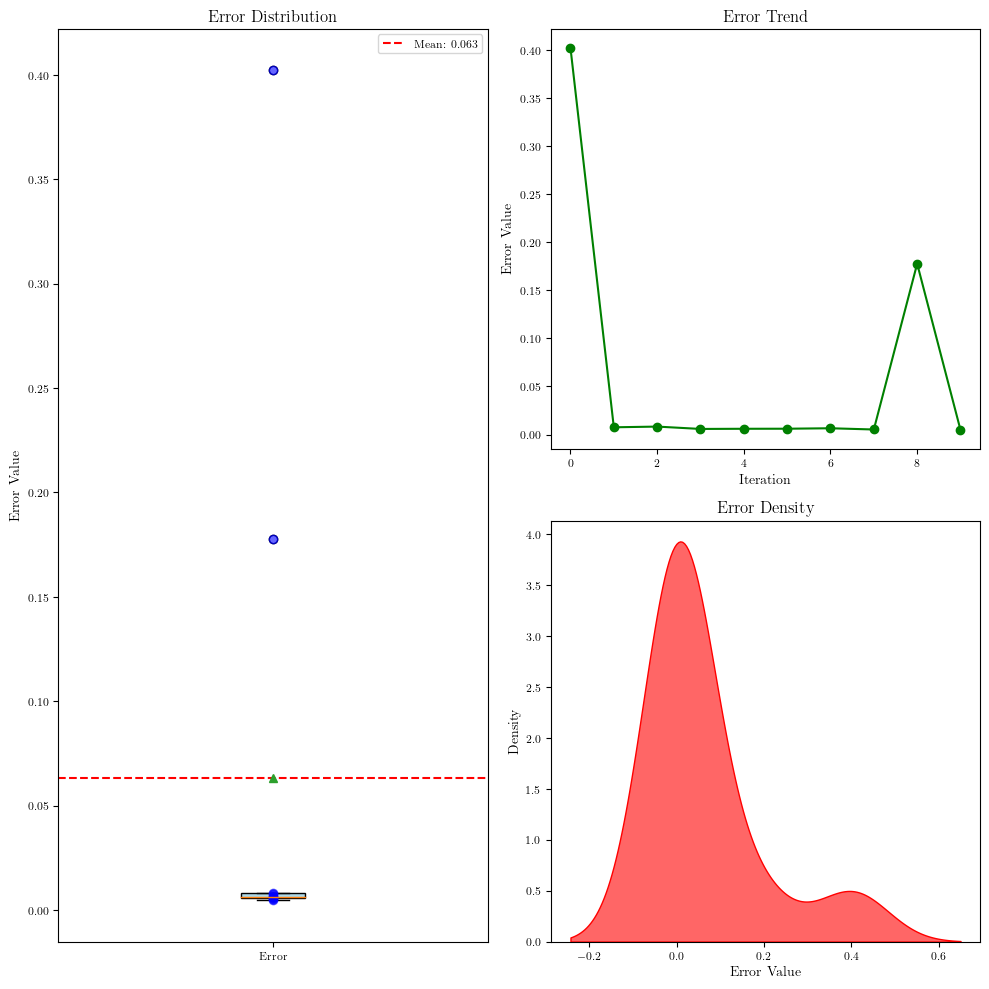

In [10]:

import seaborn as sns  # 导入seaborn库用于绘制密度图



plt.figure(figsize=(10, 10))  # 调整整体图表尺寸

# 左侧子图：箱形图，占据两张图的位置，箱的上下边界为上下四分位数，箱内的横线+三角点为中位数，虚线为均值
plt.subplot(1, 2, 1)  # 第一个子图，现在布局为1行2列

mean_error = np.mean(error) #计算error数组的均值
plt.boxplot(error, patch_artist=True, showmeans=True, meanline=False, boxprops=dict(facecolor='lightblue')) #绘制箱型图，其中error是需要绘制的数据，patch_artist=True表示填充箱体，showmeans=True表示显示均值，meanline=True表示显示均值线，boxprops=dict(facecolor='lightblue')表示箱体的颜色为浅蓝色
plt.axhline(mean_error, color='r', linestyle='--', label=f'Mean: {mean_error:.3f}') #绘制一条水平线，位于mean_error处，颜色为红色，线型为虚线，标签为均值
for i, value in enumerate(error): #遍历error数组，i为索引，value为值
    plt.plot(1, value, 'bo', alpha=0.6) #绘制散点图，横坐标为1，纵坐标为value（即error数组中每个数），颜色为蓝色，点形状为圆圈，透明度为0.6
plt.title('Error Distribution')
plt.ylabel('Error Value')
plt.xticks([1], ['Error']) #设置x轴刻度标签
plt.legend() #显示图例

# 右侧上方子图：折线图
plt.subplot(2, 2, 2)  # 第二个子图，现在布局为2行2列的第二个位置
plt.plot(error, '-o', color='green') #绘制折线图，横坐标为error数组的索引，纵坐标为error数组的值，颜色为绿色，点形状为圆圈
plt.title('Error Trend')
plt.ylabel('Error Value')
plt.xlabel('Iteration')

# 右侧下方子图：密度图
plt.subplot(2, 2, 4)  # 第四个子图，现在布局为2行2列的第四个位置
sns.kdeplot(error, shade=True, color="r", alpha=0.6)
plt.title('Error Density')
plt.xlabel('Error Value')
plt.ylabel('Density')

plt.tight_layout()  # 自动调整子图参数，使之填充整个图表区域
plt.show()

In [11]:
trainloss = torch.stack(model.loss_value).cpu().detach().numpy()

testerror = torch.stack(model.test_error).cpu().detach().numpy()

67599
[7.00848818e-01 6.15594029e-01 5.39816499e-01 ... 1.14856375e-05
 1.14854247e-05 1.14853447e-05]


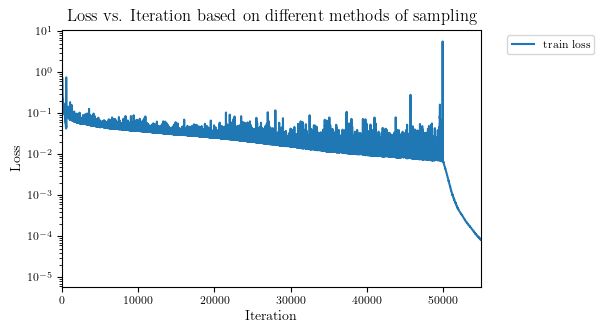

In [12]:
print(len(trainloss))
print(trainloss)
# 定义图例的标签
labels = ["Grid"]

# 创建一个新的图形
plt.figure()

# # 遍历所有的loss数据和标签
# for loss, label in zip(trainloss, labels):
#     # 绘制每个loss数据，并使用标签作为图例的条目
#     plt.plot(loss, label=label)

plt.plot(trainloss, label='train loss')

# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,55000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Loss') # 设置y轴的标签
plt.title('Loss vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

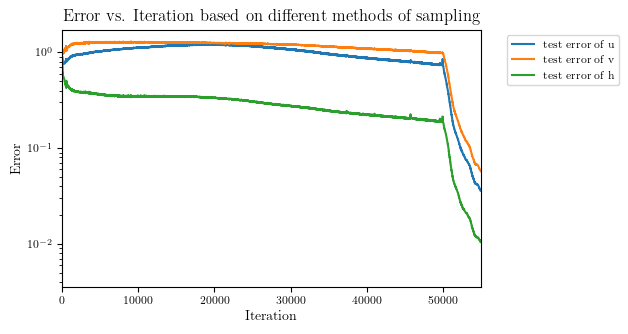

In [13]:
# print(len(trainloss))
# print(trainloss)
# 定义图例的标签
# labels = ["Grid"]

# 创建一个新的图形
plt.figure()

u_error = testerror[:,0]
v_error = testerror[:,1]
h_error = testerror[:,2]

plt.plot(u_error, label='test error of u')
plt.plot(v_error, label='test error of v')
plt.plot(h_error, label='test error of h')


# 添加图例，放在图像外
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


plt.xlim([0,55000]) # 设置x轴的范围
plt.yscale('log') #设置y轴为对数尺度，这样即使列表中有一些非常大的值，也不会影响其他值的可视化
plt.xlabel('Iteration') # 设置x轴的标签
plt.ylabel('Error') # 设置y轴的标签
plt.title('Error vs. Iteration based on different methods of sampling') # 设置图形的标题
# 显示图形
plt.show()
plt.show()

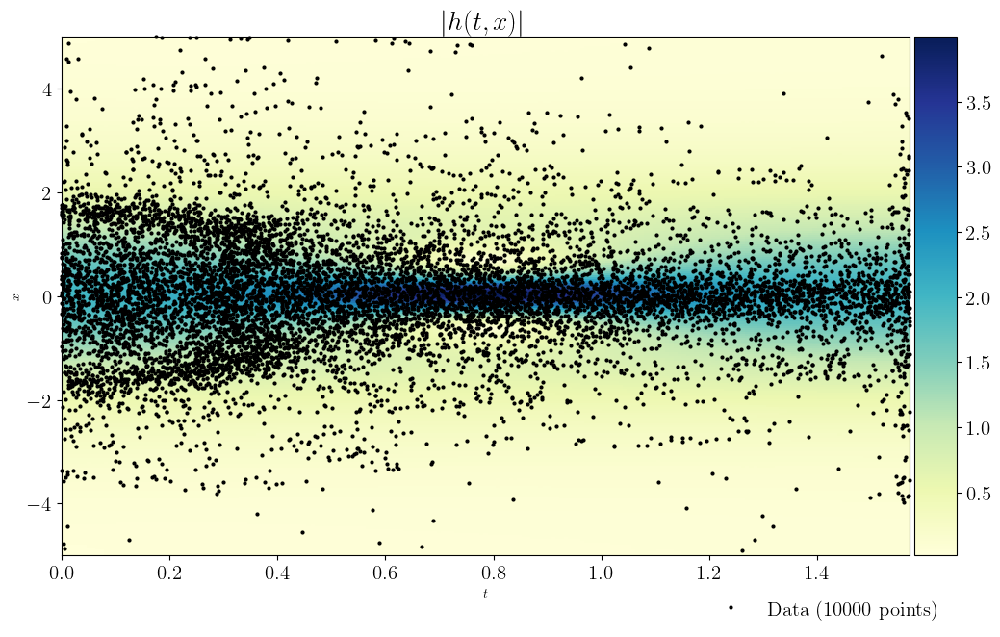

In [14]:


###### Row 0: u(t,x) ##################    

fig = plt.figure(figsize=(12, 7)) #这里figure是一个figure对象，是一个图形窗口，代表整个图形，设置图形大小为宽9英寸高5 英寸
ax = fig.add_subplot(111) #在图形的1*1网格的第一个位置添加一个子图

#绘制热图
h = ax.imshow(H_star.T, interpolation='nearest', cmap='YlGnBu', 
                extent=[lb[1], ub[1], lb[0], ub[0]], 
                origin='lower', aspect='auto')  #imshow函数用于显示图像，接受一些参数，第一个参数是图像数据，这里是H_pred的转置；第二个参数是插值方法（用于在像素之间插入新的像素），这里是最邻近插值；
                                                #第三个参数是颜色映射，这里是从黄色Yl到绿色Gn再到蓝色Bu；第四个参数是图像的范围，这里lb和ub分别是数据的下界和上界；第五个参数是图像的原点位置，这里表示原点在右下角；第六个参数是图像的纵横比，这里表示调整横纵比以填充整个axes对象
                                                #最后的结果返回一个axesimage对象，也就是h，可以通过这个对象进一步设置图像的属性
divider = make_axes_locatable(ax)  #使用 make_axes_locatable 函数创建了一个 AxesDivider 对象。这个函数接受一个 Axes 对象作为参数，返回一个 AxesDivider 对象。AxesDivider 对象可以用来管理子图的布局，特别是当你需要在一个图的旁边添加另一个图时。
cax = divider.append_axes("right", size="5%", pad=0.05) #使用append_axes方法在原始轴的右侧添加了一个新的轴。append_axes 方法接受三个参数：位置（"right"）、大小（"5%"）和间距（0.05）。在原始轴的右侧添加了一个新的轴，新轴的大小是原始轴的 5%，新轴与原始轴之间的间距是 0.05 英寸
cbar = fig.colorbar(h, cax=cax)#使用colorbar方法在新轴上添加了一个颜色条。colorbar 方法接受两个参数：axesimage 对象（h）和新轴（cax）。并记这个颜色条的名字是cbar
cbar.ax.tick_params(labelsize=15) #设置颜色条刻度标签大小，这里bar是之前定义的

ax.plot(
    X_f[:,1], 
    X_f[:,0], 
    'ko', label = 'Data (%d points)' % (X_f.shape[0]), 
    markersize = 2,  # marker size doubled
    clip_on = False,
    alpha=1.0
) #在ax上绘制散点图，前两个参数是散点的x坐标和y坐标；kx表示黑色的x（散点形状是x），label是散点的标签，clip_on表示散点可以绘制在轴的边界外
  #新加了一个alpha=1.0用来设置标记的透明度，1.0表示完全不透明  

# #绘制三条虚线
# line = np.linspace(x.min(), x.max(), 2)[:,None] #生成了一个包含2个等间距的数值的数组，这些数值在 x.min() 到 x.max() 之间。[:,None] 是一个索引操作，用于将一维数组转换为二维数组。这里其实就是[-5;5]
# #第一个参数是虚线的x坐标，line是虚线y的坐标，第三个参数是虚线的样式，k表示黑色，--表示虚线，最后一个参数表示虚线的参数是1
# ax.plot(t[75]*np.ones((2,1)),line,'k--',linewidth=1) 
# ax.plot(t[100]*np.ones((2,1)),line,'k--',linewidth=1)
# ax.plot(t[125]*np.ones((2,1)),line,'k--',linewidth=1)    

#设置标签
#设置ax子图的x轴的标签为t，y轴的标签为x。这里$t$和$x$是latex格式的文本，用于生成数学公式
ax.set_xlabel('$t$')
ax.set_ylabel('$x$')
#设置子图ax的图例，第一个参数用来设置图例的位置，这里表示图例放在上方中央;第二个参数用来设置图例的锚点，接受一个元组，表示x和y坐标，表示把图例的锚点设置在x坐标为0.9，y坐标为-0.05处;frameon=False表示不显示图例的边框;第三个参数设置图例的列数，分为5列；最后一个参数设置图例属性，接受字典，这里表示设置图例字体大小为15；最后返回的leg是一个legend对象，表示图形的图例
ax.legend(
    loc='upper center', 
    bbox_to_anchor=(0.9, -0.05), 
    ncol=5, 
    frameon=False, 
    prop={'size': 15}
)

#    plt.setp(leg.get_texts(), color='w')   #用来设置图例中文本的颜色，这里是白色，取消注释后文本会变为白色
ax.set_title('$|h(t,x)|$', fontsize = 20) #设置子图ax的标题为$|h(t,x)|$，表示latex格式的文本，用于生成数学公式，fontsize=10表示字体大小为10
ax.tick_params(labelsize=15)#用来设置刻度标签的大小。`tick_params`是`Axes`对象的一个方法，可以用来设置刻度线的属性。在这里，`labelsize=15` 是用来设置刻度标签的字体大小的。


#显示图片
plt.show() #显示所有打开的图形的函数








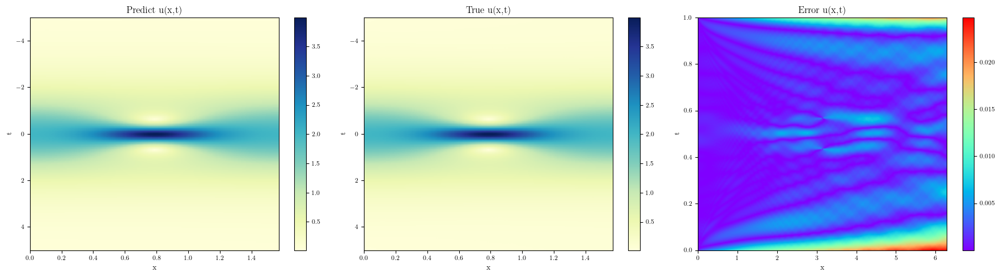

In [15]:


# 创建一个包含两个子图的图形
fig, axes = plt.subplots(1, 3, figsize=(18, 5))  # 1行2列的子图，图形大小为宽18英寸高5英寸

# 绘制第一幅图像
axes[0].imshow(H_pred.T, interpolation='nearest', cmap='YlGnBu', 
                extent=[lb[1], ub[1], lb[0], ub[0]], 
                origin='lower', aspect='auto')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Predict u(x,t)')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(H_star.T, interpolation='nearest', cmap='YlGnBu', 
                extent=[lb[1], ub[1], lb[0], ub[0]], 
                origin='lower', aspect='auto')
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('True u(x,t)')
fig.colorbar(axes[1].images[0], ax=axes[1])


# 绘制第三幅图像
axes[2].imshow(np.abs(H_pred - H_star).T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[2].invert_yaxis()
axes[2].set_xlabel('x')
axes[2].set_ylabel('t')
axes[2].set_title('Error u(x,t)')
fig.colorbar(axes[2].images[0], ax=axes[2])


# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()

In [16]:
#计算训练好模型的chaos（最后一个seed）
u_chaos = calculate_chaos(model, X_star, num_iter=50)
u_chaos_log = np.log(u_chaos + 1e-10) #对u_var取对数，然后加上一个很小的数，避免取对数时出现错误

#使用griddata函数将X_star、u_pred插值到网格上，得到U_pred
U_chaos = griddata(X_star, u_chaos.flatten(), (X, T), method='cubic')
U_chaos_log = griddata(X_star, u_chaos_log.flatten(), (X, T), method='cubic')

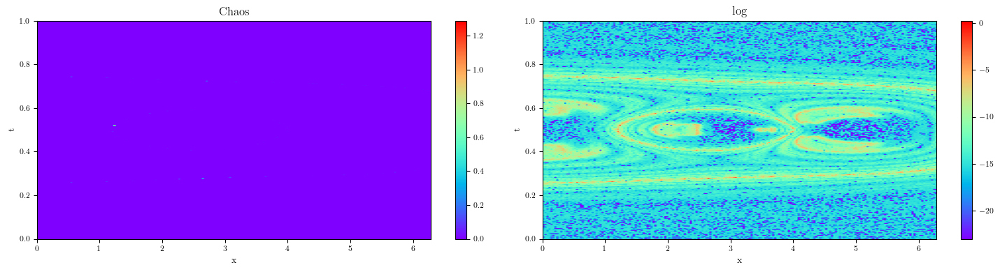

In [17]:

# 创建一个包含三幅子图的图像
fig, axes = plt.subplots(1, 2, figsize=(15, 4))

# 绘制第一幅图像
axes[0].imshow(U_chaos.T, extent=[0, np.pi*2, 1, 0], aspect='auto', cmap='rainbow')
axes[0].invert_yaxis()
axes[0].set_xlabel('x')
axes[0].set_ylabel('t')
axes[0].set_title('Chaos')
fig.colorbar(axes[0].images[0], ax=axes[0])

# 绘制第二幅图像
axes[1].imshow(U_chaos_log.T, extent=[0,np.pi*2,1,0], aspect='auto', cmap='rainbow') #第一个参数为数据，第二个参数为一个列表，用于设置图像的坐标范围，aspect='auto'表示纵横比自动调整
axes[1].invert_yaxis()
axes[1].set_xlabel('x')
axes[1].set_ylabel('t')
axes[1].set_title('log')
fig.colorbar(axes[1].images[0], ax=axes[1])

# 自动调整子图参数，使得子图之间的间距适当
plt.tight_layout()
plt.show()